In [1]:
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_probability as tfp
from tensorflow_probability import distributions as tfd
from tensorflow_probability import bijectors as tfb
import tensorflow.keras as tfk
import tensorflow.keras.layers as tfkl
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import pickle

import datetime
import os

import util
import models

In [4]:
print(tf.__version__)

2.3.0


In [2]:
cces = pd.read_csv('data/cces_df.csv', index_col=0)
cces_all = pd.read_csv('data/cces_all_df.csv', index_col=0)
cces_weighted = pd.read_csv('data/cces_weighted_df.csv', index_col=0)

In [3]:
cces

,abortion,eth,male,age,educ,repvote,region,state
1,1,White,-0.5,60-69,4-Year College,0.504080,North Central,WI
2,1,White,-0.5,60-69,HS,0.427158,Northeast,NJ
3,0,White,-0.5,40-49,HS,0.506188,South,FL
4,1,White,0.5,70+,Some college,0.506188,South,FL
5,0,White,-0.5,50-59,Some college,0.409799,North Central,IL
...,...,...,...,...,...,...,...,...
4996,0,White,0.5,50-59,4-Year College,0.338718,West,CA
4997,0,White,0.5,18-29,Some college,0.518900,West,AZ
4998,1,White,0.5,50-59,HS,0.473167,West,CO
4999,1,White,-0.5,50-59,HS,0.506188,South,FL


## Transform data

In [4]:
# Fills in the dictionary so that we know which index corresponds to what state / eth / edu etc.

data_to_idx = {}
list_of_states_and_votes = []
list_of_states = []
state = 0
age = 50
eth = 56
educ = 60
male_eth = 65
educ_age = 73
educ_eth = 103
for i in range(1, len(cces_all)+1):
    tup = (cces_all.loc[i,'state'], cces_all.loc[i,'repvote'])
    if cces_all.loc[i,'state'] not in data_to_idx:
        data_to_idx[cces_all.loc[i,'state']] = state
        state += 1
    if tup not in list_of_states_and_votes:
        list_of_states_and_votes.append(tup)
    if cces_all.loc[i,'age'] not in data_to_idx:
        data_to_idx[cces_all.loc[i,'age']] = age
        age += 1
    if cces_all.loc[i,'eth'] not in data_to_idx:
        data_to_idx[cces_all.loc[i,'eth']] = eth
        eth += 1
    if cces_all.loc[i,'educ'] not in data_to_idx:
        data_to_idx[cces_all.loc[i,'educ']] = educ
        educ += 1
list_of_states_and_votes.sort(key=lambda x:x[1])
for tup in list_of_states_and_votes:
    list_of_states.append(tup[0])

In [5]:
# Create new representation of data that contains only 0 and 1

def transform_raw(cces, data_to_idx, i, 
                  state=0, age=50, eth=56, educ=60,
                  male_eth=65, educ_age=73, educ_eth=103):
    x_i = np.zeros(128)
    eth_idx = data_to_idx[cces.loc[i,'eth']]
    age_idx = data_to_idx[cces.loc[i,'age']]
    educ_idx = data_to_idx[cces.loc[i,'educ']]
    x_i[data_to_idx[cces.loc[i,'state']]] = 1
    x_i[age_idx] = 1
    x_i[eth_idx] = 1
    x_i[educ_idx] = 1
    
    is_male = int(cces.loc[i,'male'] + 0.5)
    male_eth_idx = male_eth + is_male * 4 + (eth_idx-eth) 
    educ_age_idx = educ_age + (educ_idx-educ) * 6 + (age_idx-age)
    educ_eth_idx = educ_eth + (educ_idx-educ) * 4 + (eth_idx-eth)
    x_i[male_eth_idx] = 1
    x_i[educ_age_idx] = 1
    x_i[educ_eth_idx] = 1
    
    x_i[123] = is_male
    x_i[124] = int(cces.loc[i,'region'] == 'South')
    x_i[125] = int(cces.loc[i,'region'] == 'North Central')
    x_i[126] = int(cces.loc[i,'region'] == 'West')
    x_i[127] = cces.loc[i,'repvote']
    
    return x_i

x = []
y = []
for i in range(1, len(cces)+1):
    x_i = transform_raw(cces, data_to_idx, i)
    
    x.append(x_i)
    y.append(cces.loc[i,'abortion'])

x = np.array(x, dtype=np.float32)
y = np.array(y, dtype=np.float32)

## Variational Inference

In [ ]:
model = models.VI_KLqp(dataset='survey', v_fam='flow')
model.x = x
model.y = y
model.train(lr=0.003)

In [48]:
model = models.VI_KLqp(dataset='survey', v_fam='gaussian')
model.x = x
model.y = y
model.train(lr=0.01)

Epoch 1 Loss 3991.071 gamma [0.01 0.01 0.01 0.01 0.01] phi_s 0.333
Epoch 50 Loss 3566.568 gamma [ 0.124  0.062 -0.029 -0.125 -0.026] phi_s 0.313
Epoch 100 Loss 3573.086 gamma [ 0.124  0.095 -0.036 -0.131 -0.031] phi_s 0.293
Epoch 150 Loss 3558.634 gamma [ 0.155  0.134  0.004 -0.106 -0.001] phi_s 0.273
Epoch 200 Loss 3468.721 gamma [ 0.139  0.13  -0.004 -0.114 -0.006] phi_s 0.252
Epoch 250 Loss 3419.965 gamma [ 0.117  0.127 -0.007 -0.135 -0.016] phi_s 0.236
Epoch 300 Loss 3425.123 gamma [ 0.145  0.16   0.015 -0.134 -0.002] phi_s 0.222
Epoch 350 Loss 3412.656 gamma [ 0.13   0.168  0.014 -0.144 -0.007] phi_s 0.21
Epoch 400 Loss 3377.673 gamma [ 0.138  0.177  0.014 -0.147 -0.008] phi_s 0.199
Epoch 450 Loss 3488.626 gamma [ 0.126  0.199  0.027 -0.146 -0.001] phi_s 0.189
Epoch 500 Loss 3446.779 gamma [ 0.111  0.197  0.012 -0.169 -0.019] phi_s 0.179
Epoch 550 Loss 3406.233 gamma [ 0.16   0.231  0.035 -0.156 -0.001] phi_s 0.173
Epoch 600 Loss 3360.922 gamma [ 0.128  0.23   0.019 -0.175 -0.017]

Epoch 5400 Loss 3340.212 gamma [0.368 0.295 0.128 0.027 1.267] phi_s 0.093
Epoch 5450 Loss 3351.239 gamma [0.375 0.293 0.124 0.016 1.273] phi_s 0.093
Epoch 5500 Loss 3364.846 gamma [0.371 0.302 0.112 0.006 1.28 ] phi_s 0.093
Epoch 5550 Loss 3351.21 gamma [0.369 0.297 0.111 0.014 1.288] phi_s 0.092
Epoch 5600 Loss 3345.461 gamma [0.374 0.291 0.117 0.005 1.297] phi_s 0.092
Epoch 5650 Loss 3347.604 gamma [0.371 0.29  0.115 0.02  1.305] phi_s 0.092
Epoch 5700 Loss 3339.642 gamma [0.373 0.29  0.116 0.024 1.311] phi_s 0.092
Epoch 5750 Loss 3342.203 gamma [0.361 0.283 0.119 0.01  1.307] phi_s 0.092
Epoch 5800 Loss 3344.211 gamma [0.364 0.288 0.109 0.002 1.318] phi_s 0.092
Epoch 5850 Loss 3341.481 gamma [0.363 0.289 0.114 0.008 1.326] phi_s 0.092
Epoch 5900 Loss 3345.296 gamma [0.366 0.283 0.104 0.019 1.329] phi_s 0.092
Epoch 5950 Loss 3340.551 gamma [0.363 0.281 0.118 0.019 1.338] phi_s 0.092
Epoch 6000 Loss 3340.796 gamma [0.359 0.274 0.098 0.014 1.338] phi_s 0.091
Epoch 6050 Loss 3335.39 ga

Epoch 10750 Loss 3346.019 gamma [0.366 0.254 0.088 0.014 1.565] phi_s 0.088
Epoch 10800 Loss 3351.016 gamma [ 0.367  0.249  0.085 -0.002  1.565] phi_s 0.088
Epoch 10850 Loss 3345.902 gamma [0.363 0.248 0.083 0.01  1.566] phi_s 0.088
Epoch 10900 Loss 3340.858 gamma [0.366 0.262 0.082 0.004 1.568] phi_s 0.088
Epoch 10950 Loss 3346.428 gamma [0.368 0.254 0.079 0.006 1.568] phi_s 0.089
Epoch 11000 Loss 3341.907 gamma [0.37  0.251 0.095 0.002 1.57 ] phi_s 0.089
Epoch 11050 Loss 3336.774 gamma [0.368 0.25  0.086 0.022 1.567] phi_s 0.089
Epoch 11100 Loss 3337.004 gamma [0.37  0.257 0.098 0.009 1.577] phi_s 0.089
Epoch 11150 Loss 3337.443 gamma [0.368 0.249 0.089 0.008 1.568] phi_s 0.088
Epoch 11200 Loss 3347.476 gamma [0.364 0.256 0.083 0.    1.568] phi_s 0.089
Epoch 11250 Loss 3342.318 gamma [0.375 0.264 0.088 0.011 1.576] phi_s 0.088
Epoch 11300 Loss 3338.755 gamma [0.371 0.251 0.093 0.004 1.571] phi_s 0.089
Epoch 11350 Loss 3340.953 gamma [0.373 0.252 0.098 0.006 1.573] phi_s 0.088
Epoch 1

Epoch 16050 Loss 3337.386 gamma [3.680e-01 2.420e-01 8.400e-02 1.000e-03 1.586e+00] phi_s 0.086
Epoch 16100 Loss 3345.607 gamma [0.372 0.243 0.089 0.01  1.592] phi_s 0.086
Epoch 16150 Loss 3339.958 gamma [0.374 0.255 0.089 0.009 1.599] phi_s 0.086
Epoch 16200 Loss 3345.833 gamma [0.371 0.25  0.096 0.004 1.595] phi_s 0.086
Epoch 16250 Loss 3343.926 gamma [0.379 0.26  0.095 0.014 1.599] phi_s 0.086
Epoch 16300 Loss 3342.738 gamma [0.372 0.255 0.084 0.013 1.594] phi_s 0.086
Epoch 16350 Loss 3336.973 gamma [0.369 0.245 0.086 0.003 1.591] phi_s 0.086
Epoch 16400 Loss 3349.1 gamma [0.367 0.248 0.081 0.01  1.589] phi_s 0.086
Epoch 16450 Loss 3339.129 gamma [0.371 0.256 0.078 0.013 1.595] phi_s 0.086
Epoch 16500 Loss 3338.585 gamma [0.376 0.251 0.092 0.019 1.6  ] phi_s 0.086
Epoch 16550 Loss 3337.326 gamma [ 0.368  0.249  0.089 -0.     1.594] phi_s 0.086
Epoch 16600 Loss 3341.102 gamma [0.365 0.243 0.079 0.015 1.589] phi_s 0.086
Epoch 16650 Loss 3357.642 gamma [0.367 0.249 0.095 0.005 1.595] p

Epoch 21300 Loss 3336.823 gamma [0.366 0.244 0.087 0.008 1.592] phi_s 0.084
Epoch 21350 Loss 3337.476 gamma [0.373 0.251 0.086 0.014 1.599] phi_s 0.085
Epoch 21400 Loss 3341.124 gamma [0.368 0.25  0.08  0.007 1.592] phi_s 0.085
Epoch 21450 Loss 3340.69 gamma [0.37  0.248 0.09  0.003 1.594] phi_s 0.085
Epoch 21500 Loss 3344.777 gamma [0.373 0.245 0.086 0.005 1.595] phi_s 0.085
Epoch 21550 Loss 3343.766 gamma [0.368 0.238 0.074 0.011 1.591] phi_s 0.085
Epoch 21600 Loss 3345.004 gamma [0.366 0.239 0.08  0.015 1.594] phi_s 0.085
Epoch 21650 Loss 3341.396 gamma [ 0.368  0.249  0.08  -0.003  1.597] phi_s 0.085
Epoch 21700 Loss 3341.204 gamma [0.379 0.25  0.092 0.019 1.601] phi_s 0.085
Epoch 21750 Loss 3334.349 gamma [0.368 0.254 0.086 0.009 1.597] phi_s 0.084
Epoch 21800 Loss 3338.689 gamma [0.369 0.255 0.093 0.005 1.597] phi_s 0.085
Epoch 21850 Loss 3337.975 gamma [ 0.372  0.252  0.089 -0.005  1.597] phi_s 0.085
Epoch 21900 Loss 3346.81 gamma [0.372 0.244 0.083 0.014 1.597] phi_s 0.085
Epoc

Epoch 26600 Loss 3340.286 gamma [0.375 0.251 0.084 0.009 1.599] phi_s 0.084
Epoch 26650 Loss 3340.86 gamma [0.371 0.252 0.083 0.009 1.598] phi_s 0.084
Epoch 26700 Loss 3343.985 gamma [0.373 0.245 0.081 0.012 1.595] phi_s 0.084
Epoch 26750 Loss 3337.973 gamma [0.372 0.255 0.083 0.005 1.598] phi_s 0.084
Epoch 26800 Loss 3339.614 gamma [0.374 0.25  0.096 0.006 1.602] phi_s 0.084
Epoch 26850 Loss 3337.714 gamma [0.371 0.246 0.087 0.009 1.597] phi_s 0.083
Epoch 26900 Loss 3341.478 gamma [0.372 0.249 0.08  0.012 1.598] phi_s 0.083
Epoch 26950 Loss 3337.14 gamma [3.700e-01 2.500e-01 8.300e-02 1.000e-03 1.599e+00] phi_s 0.084
Epoch 27000 Loss 3349.226 gamma [0.37  0.241 0.085 0.011 1.594] phi_s 0.083
Epoch 27050 Loss 3344.906 gamma [0.383 0.255 0.089 0.015 1.609] phi_s 0.084
Epoch 27100 Loss 3336.204 gamma [0.368 0.244 0.09  0.01  1.597] phi_s 0.084
Epoch 27150 Loss 3334.711 gamma [0.371 0.249 0.082 0.005 1.598] phi_s 0.083
Epoch 27200 Loss 3342.619 gamma [0.365 0.243 0.073 0.004 1.592] phi_s 

Epoch 31850 Loss 3339.708 gamma [0.372 0.247 0.081 0.004 1.597] phi_s 0.082
Epoch 31900 Loss 3336.59 gamma [0.373 0.244 0.092 0.006 1.599] phi_s 0.082
Epoch 31950 Loss 3339.016 gamma [0.372 0.257 0.08  0.009 1.6  ] phi_s 0.082
Epoch 32000 Loss 3345.27 gamma [0.368 0.249 0.079 0.009 1.595] phi_s 0.082
Epoch 32050 Loss 3337.666 gamma [0.374 0.252 0.093 0.007 1.601] phi_s 0.082
Epoch 32100 Loss 3338.6 gamma [0.374 0.253 0.087 0.005 1.6  ] phi_s 0.082
Epoch 32150 Loss 3342.689 gamma [0.374 0.249 0.094 0.01  1.602] phi_s 0.082
Epoch 32200 Loss 3341.891 gamma [0.372 0.251 0.089 0.002 1.598] phi_s 0.082
Epoch 32250 Loss 3339.434 gamma [0.373 0.253 0.086 0.007 1.599] phi_s 0.082
Epoch 32300 Loss 3338.97 gamma [0.37  0.244 0.089 0.011 1.597] phi_s 0.082
Epoch 32350 Loss 3344.214 gamma [0.371 0.247 0.081 0.008 1.596] phi_s 0.082
Epoch 32400 Loss 3337.833 gamma [0.37  0.248 0.081 0.006 1.594] phi_s 0.082
Epoch 32450 Loss 3337.152 gamma [0.368 0.244 0.081 0.006 1.593] phi_s 0.082
Epoch 32500 Loss 

Epoch 37200 Loss 3340.926 gamma [0.372 0.248 0.077 0.006 1.598] phi_s 0.081
Epoch 37250 Loss 3341.614 gamma [0.371 0.248 0.078 0.004 1.597] phi_s 0.081
Epoch 37300 Loss 3338.168 gamma [0.37  0.246 0.086 0.011 1.597] phi_s 0.081
Epoch 37350 Loss 3341.6 gamma [0.372 0.247 0.086 0.005 1.597] phi_s 0.081
Epoch 37400 Loss 3338.251 gamma [0.368 0.245 0.085 0.002 1.593] phi_s 0.081
Epoch 37450 Loss 3337.674 gamma [0.372 0.251 0.083 0.005 1.597] phi_s 0.081
Epoch 37500 Loss 3337.02 gamma [0.374 0.247 0.089 0.012 1.6  ] phi_s 0.081
Epoch 37550 Loss 3337.172 gamma [0.376 0.246 0.083 0.009 1.599] phi_s 0.081
Epoch 37600 Loss 3337.211 gamma [ 3.670e-01  2.410e-01  7.800e-02 -1.000e-03  1.591e+00] phi_s 0.081
Epoch 37650 Loss 3338.646 gamma [0.373 0.247 0.084 0.007 1.598] phi_s 0.081
Epoch 37700 Loss 3339.068 gamma [0.368 0.246 0.079 0.003 1.594] phi_s 0.081
Epoch 37750 Loss 3347.864 gamma [0.374 0.247 0.085 0.008 1.596] phi_s 0.081
Epoch 37800 Loss 3337.202 gamma [0.372 0.251 0.084 0.003 1.597] ph

Epoch 42550 Loss 3341.146 gamma [0.378 0.252 0.087 0.012 1.601] phi_s 0.081
Epoch 42600 Loss 3339.407 gamma [0.371 0.247 0.084 0.006 1.597] phi_s 0.081
Epoch 42650 Loss 3337.016 gamma [0.371 0.25  0.085 0.003 1.597] phi_s 0.081
Epoch 42700 Loss 3340.488 gamma [ 3.710e-01  2.480e-01  8.500e-02 -1.000e-03  1.595e+00] phi_s 0.081
Epoch 42750 Loss 3343.09 gamma [0.371 0.25  0.085 0.004 1.597] phi_s 0.081
Epoch 42800 Loss 3339.42 gamma [0.371 0.249 0.086 0.003 1.598] phi_s 0.081
Epoch 42850 Loss 3339.48 gamma [0.371 0.249 0.082 0.007 1.598] phi_s 0.081
Epoch 42900 Loss 3338.46 gamma [0.375 0.249 0.088 0.01  1.6  ] phi_s 0.081
Epoch 42950 Loss 3346.275 gamma [0.375 0.255 0.088 0.005 1.602] phi_s 0.081
Epoch 43000 Loss 3338.74 gamma [ 3.660e-01  2.420e-01  8.100e-02 -1.000e-03  1.592e+00] phi_s 0.081
Epoch 43050 Loss 3339.736 gamma [0.369 0.243 0.079 0.002 1.593] phi_s 0.081
Epoch 43100 Loss 3341.722 gamma [0.372 0.242 0.081 0.009 1.595] phi_s 0.081
Epoch 43150 Loss 3338.976 gamma [0.372 0.24

Epoch 47950 Loss 3340.474 gamma [0.372 0.242 0.082 0.011 1.596] phi_s 0.08
Epoch 48000 Loss 3337.573 gamma [0.372 0.245 0.086 0.009 1.598] phi_s 0.08
Epoch 48050 Loss 3340.856 gamma [0.371 0.246 0.082 0.008 1.597] phi_s 0.08
Epoch 48100 Loss 3336.428 gamma [0.372 0.246 0.085 0.007 1.598] phi_s 0.08
Epoch 48150 Loss 3338.83 gamma [0.375 0.247 0.084 0.012 1.6  ] phi_s 0.08
Epoch 48200 Loss 3340.636 gamma [0.372 0.248 0.082 0.004 1.597] phi_s 0.08
Epoch 48250 Loss 3342.995 gamma [0.368 0.246 0.078 0.002 1.594] phi_s 0.08
Epoch 48300 Loss 3337.772 gamma [0.375 0.248 0.086 0.002 1.598] phi_s 0.08
Epoch 48350 Loss 3341.088 gamma [0.371 0.247 0.083 0.002 1.596] phi_s 0.08
Epoch 48400 Loss 3339.799 gamma [0.37  0.244 0.086 0.004 1.594] phi_s 0.08
Epoch 48450 Loss 3338.334 gamma [0.372 0.248 0.085 0.002 1.597] phi_s 0.08
Epoch 48500 Loss 3339.194 gamma [0.372 0.25  0.078 0.007 1.596] phi_s 0.08
Epoch 48550 Loss 3336.838 gamma [0.373 0.247 0.084 0.009 1.597] phi_s 0.08
Epoch 48600 Loss 3338.085 

Epoch 53450 Loss 3337.409 gamma [0.371 0.242 0.085 0.005 1.596] phi_s 0.079
Epoch 53500 Loss 3342.889 gamma [0.372 0.243 0.085 0.01  1.597] phi_s 0.079
Epoch 53550 Loss 3334.009 gamma [0.378 0.25  0.089 0.008 1.601] phi_s 0.079
Epoch 53600 Loss 3338.288 gamma [0.374 0.246 0.089 0.004 1.6  ] phi_s 0.079
Epoch 53650 Loss 3338.475 gamma [0.372 0.244 0.083 0.007 1.598] phi_s 0.079
Epoch 53700 Loss 3338.5 gamma [0.374 0.247 0.086 0.01  1.599] phi_s 0.079
Epoch 53750 Loss 3335.972 gamma [0.371 0.246 0.085 0.005 1.597] phi_s 0.079
Epoch 53800 Loss 3337.472 gamma [0.371 0.247 0.088 0.004 1.597] phi_s 0.079
Epoch 53850 Loss 3337.612 gamma [3.700e-01 2.470e-01 8.600e-02 1.000e-03 1.595e+00] phi_s 0.079
Epoch 53900 Loss 3338.813 gamma [0.373 0.252 0.088 0.003 1.598] phi_s 0.079
Epoch 53950 Loss 3336.93 gamma [0.375 0.251 0.085 0.004 1.598] phi_s 0.079
Epoch 54000 Loss 3338.867 gamma [0.374 0.248 0.086 0.008 1.598] phi_s 0.079
Epoch 54050 Loss 3337.403 gamma [0.374 0.249 0.088 0.007 1.598] phi_s 0

Epoch 58850 Loss 3338.364 gamma [0.375 0.25  0.085 0.011 1.6  ] phi_s 0.079
Epoch 58900 Loss 3334.094 gamma [0.372 0.246 0.086 0.004 1.596] phi_s 0.079
Epoch 58950 Loss 3336.2 gamma [0.372 0.246 0.087 0.006 1.597] phi_s 0.079
Epoch 59000 Loss 3338.544 gamma [0.374 0.246 0.087 0.008 1.597] phi_s 0.079
Epoch 59050 Loss 3340.272 gamma [0.372 0.248 0.086 0.008 1.597] phi_s 0.079
Epoch 59100 Loss 3339.739 gamma [0.373 0.246 0.088 0.009 1.597] phi_s 0.079
Epoch 59150 Loss 3338.145 gamma [0.375 0.245 0.092 0.009 1.599] phi_s 0.079
Epoch 59200 Loss 3338.092 gamma [0.371 0.245 0.089 0.006 1.596] phi_s 0.079
Epoch 59250 Loss 3341.769 gamma [0.373 0.248 0.085 0.005 1.596] phi_s 0.079
Epoch 59300 Loss 3337.288 gamma [0.372 0.248 0.082 0.007 1.595] phi_s 0.079
Epoch 59350 Loss 3342.058 gamma [0.374 0.25  0.083 0.004 1.597] phi_s 0.079
Epoch 59400 Loss 3338.537 gamma [0.376 0.249 0.083 0.005 1.598] phi_s 0.079
Epoch 59450 Loss 3341.117 gamma [0.372 0.245 0.081 0.004 1.595] phi_s 0.079
Epoch 59500 Lo

Epoch 64300 Loss 3337.31 gamma [0.372 0.247 0.082 0.005 1.597] phi_s 0.079
Epoch 64350 Loss 3340.241 gamma [0.374 0.249 0.085 0.005 1.598] phi_s 0.079
Epoch 64400 Loss 3338.401 gamma [0.373 0.245 0.087 0.005 1.597] phi_s 0.079
Epoch 64450 Loss 3339.606 gamma [0.375 0.247 0.088 0.007 1.599] phi_s 0.079
Epoch 64500 Loss 3339.612 gamma [0.371 0.244 0.084 0.004 1.595] phi_s 0.079
Epoch 64550 Loss 3338.397 gamma [0.373 0.246 0.085 0.006 1.597] phi_s 0.079
Epoch 64600 Loss 3339.401 gamma [0.373 0.247 0.086 0.003 1.597] phi_s 0.079
Epoch 64650 Loss 3337.118 gamma [0.374 0.247 0.087 0.004 1.597] phi_s 0.079
Epoch 64700 Loss 3339.209 gamma [0.374 0.246 0.088 0.006 1.598] phi_s 0.079
Epoch 64750 Loss 3339.474 gamma [0.373 0.246 0.088 0.005 1.597] phi_s 0.079
Epoch 64800 Loss 3340.884 gamma [0.375 0.247 0.088 0.01  1.599] phi_s 0.079
Epoch 64850 Loss 3334.61 gamma [0.372 0.245 0.085 0.008 1.597] phi_s 0.079
Epoch 64900 Loss 3336.87 gamma [0.374 0.246 0.087 0.008 1.598] phi_s 0.079
Epoch 64950 Los

Epoch 69700 Loss 3338.968 gamma [0.373 0.248 0.083 0.003 1.597] phi_s 0.079
Epoch 69750 Loss 3339.217 gamma [0.374 0.248 0.083 0.003 1.597] phi_s 0.079
Epoch 69800 Loss 3336.06 gamma [0.376 0.25  0.085 0.007 1.599] phi_s 0.079
Epoch 69850 Loss 3336.869 gamma [0.374 0.248 0.083 0.007 1.597] phi_s 0.079
Epoch 69900 Loss 3339.164 gamma [0.372 0.245 0.082 0.005 1.595] phi_s 0.079
Epoch 69950 Loss 3341.088 gamma [0.373 0.246 0.084 0.007 1.597] phi_s 0.079
Epoch 70000 Loss 3340.672 gamma [0.372 0.245 0.083 0.009 1.596] phi_s 0.079
Epoch 70050 Loss 3338.741 gamma [0.375 0.249 0.084 0.01  1.598] phi_s 0.079
Epoch 70100 Loss 3336.894 gamma [0.375 0.248 0.084 0.009 1.598] phi_s 0.079
Epoch 70150 Loss 3336.63 gamma [0.373 0.247 0.084 0.007 1.598] phi_s 0.079
Epoch 70200 Loss 3336.868 gamma [0.375 0.248 0.085 0.009 1.599] phi_s 0.079
Epoch 70250 Loss 3343.052 gamma [0.373 0.249 0.084 0.006 1.598] phi_s 0.079
Epoch 70300 Loss 3344.286 gamma [0.372 0.249 0.081 0.006 1.597] phi_s 0.079
Epoch 70350 Lo

Epoch 75100 Loss 3342.74 gamma [0.375 0.248 0.084 0.01  1.599] phi_s 0.079
Epoch 75150 Loss 3335.964 gamma [0.374 0.247 0.084 0.01  1.598] phi_s 0.079
Epoch 75200 Loss 3341.422 gamma [0.373 0.245 0.084 0.008 1.597] phi_s 0.079
Epoch 75250 Loss 3336.539 gamma [0.372 0.244 0.083 0.006 1.596] phi_s 0.079
Epoch 75300 Loss 3338.227 gamma [0.374 0.246 0.084 0.007 1.598] phi_s 0.079
Epoch 75350 Loss 3338.043 gamma [0.374 0.247 0.084 0.007 1.598] phi_s 0.079
Epoch 75400 Loss 3340.91 gamma [0.374 0.247 0.084 0.007 1.598] phi_s 0.079
Epoch 75450 Loss 3335.772 gamma [0.374 0.247 0.086 0.006 1.598] phi_s 0.079
Epoch 75500 Loss 3337.265 gamma [0.374 0.247 0.086 0.007 1.598] phi_s 0.079
Epoch 75550 Loss 3336.484 gamma [0.374 0.247 0.087 0.008 1.598] phi_s 0.079
Epoch 75600 Loss 3340.572 gamma [0.374 0.246 0.086 0.008 1.598] phi_s 0.079
Epoch 75650 Loss 3341.349 gamma [0.374 0.246 0.086 0.009 1.598] phi_s 0.079
Epoch 75700 Loss 3335.943 gamma [0.374 0.246 0.085 0.009 1.598] phi_s 0.079
Epoch 75750 Lo

Epoch 80500 Loss 3339.36 gamma [0.375 0.248 0.086 0.008 1.599] phi_s 0.078
Epoch 80550 Loss 3337.387 gamma [0.375 0.249 0.087 0.007 1.599] phi_s 0.078
Epoch 80600 Loss 3341.117 gamma [0.374 0.248 0.087 0.007 1.598] phi_s 0.078
Epoch 80650 Loss 3339.21 gamma [0.374 0.247 0.086 0.006 1.598] phi_s 0.078
Epoch 80700 Loss 3338.339 gamma [0.375 0.248 0.088 0.006 1.599] phi_s 0.078
Epoch 80750 Loss 3339.258 gamma [0.374 0.247 0.086 0.006 1.598] phi_s 0.078
Epoch 80800 Loss 3337.978 gamma [0.374 0.248 0.085 0.006 1.598] phi_s 0.078
Epoch 80850 Loss 3336.686 gamma [0.372 0.246 0.082 0.005 1.596] phi_s 0.078
Epoch 80900 Loss 3342.632 gamma [0.372 0.246 0.082 0.006 1.596] phi_s 0.078
Epoch 80950 Loss 3340.39 gamma [0.373 0.248 0.083 0.006 1.597] phi_s 0.078
Epoch 81000 Loss 3336.811 gamma [0.374 0.248 0.084 0.006 1.598] phi_s 0.078
Epoch 81050 Loss 3340.394 gamma [0.374 0.248 0.084 0.007 1.598] phi_s 0.078
Epoch 81100 Loss 3339.217 gamma [0.374 0.249 0.083 0.008 1.598] phi_s 0.078
Epoch 81150 Los

Epoch 85900 Loss 3340.79 gamma [0.374 0.247 0.086 0.006 1.598] phi_s 0.078
Epoch 85950 Loss 3337.057 gamma [0.373 0.246 0.086 0.007 1.598] phi_s 0.078
Epoch 86000 Loss 3343.03 gamma [0.372 0.245 0.085 0.006 1.597] phi_s 0.078
Epoch 86050 Loss 3338.632 gamma [0.372 0.245 0.085 0.006 1.597] phi_s 0.078
Epoch 86100 Loss 3338.097 gamma [0.374 0.247 0.086 0.008 1.598] phi_s 0.078
Epoch 86150 Loss 3338.849 gamma [0.374 0.247 0.085 0.007 1.598] phi_s 0.078
Epoch 86200 Loss 3337.966 gamma [0.374 0.247 0.085 0.007 1.598] phi_s 0.078
Epoch 86250 Loss 3337.974 gamma [0.374 0.247 0.085 0.007 1.598] phi_s 0.078
Epoch 86300 Loss 3336.364 gamma [0.373 0.247 0.084 0.005 1.598] phi_s 0.078
Epoch 86350 Loss 3340.016 gamma [0.373 0.246 0.084 0.006 1.597] phi_s 0.078
Epoch 86400 Loss 3337.27 gamma [0.373 0.247 0.084 0.006 1.598] phi_s 0.078
Epoch 86450 Loss 3338.254 gamma [0.374 0.247 0.085 0.008 1.599] phi_s 0.078
Epoch 86500 Loss 3338.485 gamma [0.374 0.247 0.086 0.008 1.599] phi_s 0.078
Epoch 86550 Los

Epoch 91350 Loss 3337.998 gamma [0.375 0.249 0.084 0.006 1.599] phi_s 0.078
Epoch 91400 Loss 3335.893 gamma [0.374 0.248 0.084 0.006 1.598] phi_s 0.078
Epoch 91450 Loss 3339.405 gamma [0.374 0.248 0.084 0.006 1.598] phi_s 0.078
Epoch 91500 Loss 3338.755 gamma [0.374 0.248 0.084 0.006 1.598] phi_s 0.078
Epoch 91550 Loss 3339.773 gamma [0.374 0.248 0.083 0.006 1.598] phi_s 0.078
Epoch 91600 Loss 3337.686 gamma [0.374 0.248 0.083 0.006 1.598] phi_s 0.078
Epoch 91650 Loss 3340.343 gamma [0.374 0.247 0.083 0.007 1.597] phi_s 0.078
Epoch 91700 Loss 3339.509 gamma [0.373 0.246 0.083 0.006 1.597] phi_s 0.078
Epoch 91750 Loss 3337.383 gamma [0.374 0.247 0.084 0.007 1.598] phi_s 0.078
Epoch 91800 Loss 3340.916 gamma [0.374 0.248 0.084 0.007 1.598] phi_s 0.078
Epoch 91850 Loss 3343.424 gamma [0.373 0.246 0.083 0.007 1.597] phi_s 0.078
Epoch 91900 Loss 3336.551 gamma [0.373 0.246 0.082 0.006 1.596] phi_s 0.078
Epoch 91950 Loss 3341.193 gamma [0.373 0.246 0.083 0.006 1.597] phi_s 0.078
Epoch 92000 

Epoch 96750 Loss 3338.206 gamma [0.374 0.246 0.086 0.007 1.598] phi_s 0.078
Epoch 96800 Loss 3340.846 gamma [0.374 0.246 0.086 0.007 1.598] phi_s 0.078
Epoch 96850 Loss 3340.622 gamma [0.374 0.246 0.086 0.006 1.598] phi_s 0.078
Epoch 96900 Loss 3338.191 gamma [0.374 0.246 0.086 0.006 1.598] phi_s 0.078
Epoch 96950 Loss 3338.521 gamma [0.374 0.246 0.086 0.006 1.598] phi_s 0.078
Epoch 97000 Loss 3337.517 gamma [0.374 0.246 0.086 0.006 1.598] phi_s 0.078
Epoch 97050 Loss 3337.367 gamma [0.374 0.246 0.086 0.007 1.598] phi_s 0.078
Epoch 97100 Loss 3338.825 gamma [0.373 0.245 0.085 0.006 1.597] phi_s 0.078
Epoch 97150 Loss 3339.636 gamma [0.373 0.246 0.085 0.006 1.597] phi_s 0.078
Epoch 97200 Loss 3338.697 gamma [0.373 0.245 0.085 0.006 1.597] phi_s 0.078
Epoch 97250 Loss 3338.223 gamma [0.374 0.246 0.086 0.007 1.598] phi_s 0.078
Epoch 97300 Loss 3338.289 gamma [0.374 0.247 0.086 0.007 1.598] phi_s 0.078
Epoch 97350 Loss 3339.868 gamma [0.374 0.247 0.086 0.007 1.598] phi_s 0.078
Epoch 97400 

## Hamiltonian Score Climbing

In [6]:
model = models.VI_KLpq(v_fam='flow', space='warped', dataset='survey', hmc_e=0.03, hmc_L=33, chains=1)
model.x = x
model.y = y
model.train(lr=0.001)

0:00:02.425999
Epoch 1 Loss 6428.0757 acceptance rate 0.5 gamma [-0.001 -0.001 -0.001 -0.001 -0.001] hmc_e 0.03
0:00:03.458900
Epoch 2 Loss 5262.289 acceptance rate 0.667 gamma [-0.001 -0.001 -0.001 -0.001 -0.001] hmc_e 0.03
0:00:03.343160
Epoch 3 Loss 4445.7563 acceptance rate 0.75 gamma [-0.001 -0.001 -0.001 -0.001 -0.001] hmc_e 0.03
0:00:02.584572
Epoch 4 Loss 4054.1375 acceptance rate 0.8 gamma [-0.001 -0.001 -0.001 -0.001 -0.001] hmc_e 0.03
0:00:04.280589
Epoch 5 Loss 3970.439 acceptance rate 0.833 gamma [-0.001 -0.001 -0.001 -0.001 -0.001] hmc_e 0.03
0:00:04.582584
Epoch 6 Loss 3892.509 acceptance rate 0.857 gamma [-0.001 -0.    -0.    -0.001 -0.001] hmc_e 0.03
0:00:02.700084
Epoch 7 Loss 3868.7944 acceptance rate 0.875 gamma [-0.001 -0.    -0.    -0.001 -0.001] hmc_e 0.03
0:00:02.604163
Epoch 8 Loss 3830.022 acceptance rate 0.889 gamma [-0.001 -0.    -0.    -0.001 -0.   ] hmc_e 0.03
0:00:02.350365
Epoch 9 Loss 3829.6875 acceptance rate 0.9 gamma [-0.001  0.     0.    -0.001 -0. 

0:00:02.394480
Epoch 74 Loss 3581.9785 acceptance rate 0.88 gamma [ 0.002 -0.001  0.011  0.008  0.004] hmc_e 0.03
0:00:03.062819
Epoch 75 Loss 3593.337 acceptance rate 0.882 gamma [ 0.002 -0.001  0.011  0.008  0.004] hmc_e 0.03
0:00:02.298316
Epoch 76 Loss 3575.2847 acceptance rate 0.883 gamma [ 0.002 -0.001  0.011  0.008  0.004] hmc_e 0.03
0:00:03.334976
Epoch 77 Loss 3579.289 acceptance rate 0.885 gamma [ 0.002 -0.001  0.011  0.008  0.004] hmc_e 0.03
0:00:02.469297
Epoch 78 Loss 3579.0884 acceptance rate 0.886 gamma [ 0.002 -0.001  0.012  0.008  0.004] hmc_e 0.03
0:00:02.410461
Epoch 79 Loss 3591.4736 acceptance rate 0.888 gamma [ 0.002 -0.001  0.012  0.008  0.004] hmc_e 0.03
0:00:03.353467
Epoch 80 Loss 3591.6816 acceptance rate 0.889 gamma [ 0.002 -0.001  0.012  0.008  0.004] hmc_e 0.03
0:00:05.231165
Epoch 81 Loss 3595.983 acceptance rate 0.89 gamma [ 0.002 -0.001  0.012  0.008  0.004] hmc_e 0.03
0:00:04.913205
Epoch 82 Loss 3590.9473 acceptance rate 0.892 gamma [ 0.002 -0.002  0.

0:00:02.320679
Epoch 145 Loss 3553.0088 acceptance rate 0.89 gamma [ 0.002 -0.003  0.023  0.     0.006] hmc_e 0.023
0:00:02.813612
Epoch 146 Loss 3569.8928 acceptance rate 0.891 gamma [ 0.002 -0.003  0.023 -0.     0.006] hmc_e 0.023
0:00:03.042452
Epoch 147 Loss 3575.8445 acceptance rate 0.892 gamma [ 0.002 -0.003  0.023 -0.     0.006] hmc_e 0.023
0:00:02.339411
Epoch 148 Loss 3560.9104 acceptance rate 0.893 gamma [ 0.002 -0.003  0.023 -0.     0.006] hmc_e 0.023
0:00:02.284604
Epoch 149 Loss 3570.9053 acceptance rate 0.893 gamma [ 0.002 -0.002  0.023 -0.     0.006] hmc_e 0.022
0:00:02.436572
Epoch 150 Loss 3562.4475 acceptance rate 0.894 gamma [ 0.001 -0.002  0.022 -0.     0.006] hmc_e 0.022
0:00:03.700971
Epoch 151 Loss 3556.1497 acceptance rate 0.895 gamma [ 0.001 -0.002  0.022 -0.     0.006] hmc_e 0.022
0:00:02.440823
Epoch 152 Loss 3541.91 acceptance rate 0.895 gamma [ 0.001 -0.002  0.022 -0.     0.006] hmc_e 0.022
0:00:02.649906
Epoch 153 Loss 3571.9082 acceptance rate 0.896 gamma

0:00:02.060832
Epoch 216 Loss 3570.0073 acceptance rate 0.903 gamma [-0.001  0.01   0.03   0.004  0.009] hmc_e 0.029
0:00:02.157889
Epoch 217 Loss 3570.6755 acceptance rate 0.904 gamma [-0.001  0.01   0.03   0.004  0.009] hmc_e 0.03
0:00:02.799471
Epoch 218 Loss 3566.6216 acceptance rate 0.904 gamma [-0.001  0.01   0.031  0.005  0.009] hmc_e 0.03
0:00:02.613067
Epoch 219 Loss 3561.8276 acceptance rate 0.905 gamma [-0.001  0.01   0.031  0.005  0.009] hmc_e 0.03
0:00:02.042995
Epoch 220 Loss 3542.5356 acceptance rate 0.905 gamma [-0.001  0.01   0.031  0.005  0.009] hmc_e 0.03
0:00:02.198138
Epoch 221 Loss 3556.336 acceptance rate 0.905 gamma [-0.001  0.01   0.031  0.005  0.009] hmc_e 0.031
0:00:02.535946
Epoch 222 Loss 3551.1636 acceptance rate 0.906 gamma [-0.002  0.009  0.031  0.005  0.009] hmc_e 0.031
0:00:02.239159
Epoch 223 Loss 3565.824 acceptance rate 0.906 gamma [-0.002  0.009  0.031  0.005  0.009] hmc_e 0.031
0:00:02.885177
Epoch 224 Loss 3563.927 acceptance rate 0.907 gamma [-0

0:00:03.175493
Epoch 287 Loss 3573.3582 acceptance rate 0.889 gamma [ 0.001  0.006  0.028 -0.004  0.004] hmc_e 0.029
0:00:03.746042
Epoch 288 Loss 3567.5352 acceptance rate 0.889 gamma [ 0.001  0.007  0.028 -0.004  0.004] hmc_e 0.029
0:00:02.503995
Epoch 289 Loss 3549.5376 acceptance rate 0.89 gamma [ 0.001  0.007  0.028 -0.004  0.005] hmc_e 0.028
0:00:02.265662
Epoch 290 Loss 3538.2417 acceptance rate 0.89 gamma [ 0.001  0.007  0.028 -0.004  0.005] hmc_e 0.028
0:00:02.559820
Epoch 291 Loss 3530.7422 acceptance rate 0.89 gamma [ 0.001  0.007  0.029 -0.004  0.004] hmc_e 0.028
0:00:02.568262
Epoch 292 Loss 3564.5623 acceptance rate 0.891 gamma [ 0.001  0.007  0.029 -0.005  0.004] hmc_e 0.027
0:00:02.934834
Epoch 293 Loss 3547.982 acceptance rate 0.891 gamma [ 0.001  0.007  0.029 -0.005  0.004] hmc_e 0.027
0:00:03.405952
Epoch 294 Loss 3558.6865 acceptance rate 0.892 gamma [ 0.001  0.007  0.029 -0.005  0.004] hmc_e 0.027
0:00:03.740675
Epoch 295 Loss 3560.7778 acceptance rate 0.892 gamma 

0:00:02.532357
Epoch 358 Loss 3527.6045 acceptance rate 0.9 gamma [-0.002  0.008  0.039  0.     0.008] hmc_e 0.014
0:00:02.159819
Epoch 359 Loss 3534.8687 acceptance rate 0.9 gamma [-0.002  0.008  0.039  0.     0.008] hmc_e 0.014
0:00:02.323276
Epoch 360 Loss 3535.3376 acceptance rate 0.9 gamma [-0.002  0.007  0.038 -0.     0.008] hmc_e 0.014
0:00:02.500984
Epoch 361 Loss 3521.0222 acceptance rate 0.901 gamma [-0.002  0.007  0.038 -0.     0.007] hmc_e 0.014
0:00:02.902174
Epoch 362 Loss 3522.5444 acceptance rate 0.901 gamma [-0.002  0.006  0.038 -0.     0.007] hmc_e 0.014
0:00:02.298747
Epoch 363 Loss 3517.445 acceptance rate 0.901 gamma [-0.002  0.006  0.038 -0.001  0.007] hmc_e 0.015
0:00:02.284514
Epoch 364 Loss 3524.1023 acceptance rate 0.901 gamma [-0.003  0.005  0.038 -0.001  0.006] hmc_e 0.015
0:00:02.558963
Epoch 365 Loss 3524.2307 acceptance rate 0.902 gamma [-0.003  0.005  0.038 -0.001  0.006] hmc_e 0.015
0:00:02.163397
Epoch 366 Loss 3526.6091 acceptance rate 0.902 gamma [-0

0:00:02.932702
Epoch 429 Loss 3541.0872 acceptance rate 0.907 gamma [-0.001  0.003  0.03   0.005  0.004] hmc_e 0.028
0:00:02.305258
Epoch 430 Loss 3524.4111 acceptance rate 0.907 gamma [-0.001  0.003  0.03   0.005  0.004] hmc_e 0.028
0:00:02.209240
Epoch 431 Loss 3542.7383 acceptance rate 0.907 gamma [-0.001  0.003  0.03   0.005  0.004] hmc_e 0.029
0:00:02.583849
Epoch 432 Loss 3542.3218 acceptance rate 0.905 gamma [-0.001  0.003  0.029  0.005  0.004] hmc_e 0.029
0:00:02.898539
Epoch 433 Loss 3538.8467 acceptance rate 0.906 gamma [-0.001  0.003  0.029  0.004  0.004] hmc_e 0.029
0:00:02.399973
Epoch 434 Loss 3528.583 acceptance rate 0.906 gamma [-0.001  0.003  0.029  0.004  0.004] hmc_e 0.03
0:00:02.908370
Epoch 435 Loss 3555.497 acceptance rate 0.906 gamma [-0.001  0.003  0.029  0.004  0.004] hmc_e 0.03
0:00:02.471473
Epoch 436 Loss 3549.471 acceptance rate 0.906 gamma [-0.001  0.003  0.029  0.004  0.005] hmc_e 0.03
0:00:02.323422
Epoch 437 Loss 3564.4355 acceptance rate 0.906 gamma [-

0:00:01.697344
Epoch 500 Loss 3552.2754 acceptance rate 0.904 gamma [-0.01   0.015  0.03  -0.005  0.006] hmc_e 0.05
0:00:01.938164
Epoch 501 Loss 3533.8096 acceptance rate 0.904 gamma [-0.01   0.015  0.03  -0.005  0.006] hmc_e 0.05
0:00:01.826306
Epoch 502 Loss 3533.0605 acceptance rate 0.903 gamma [-0.011  0.016  0.03  -0.005  0.006] hmc_e 0.05
0:00:01.858943
Epoch 503 Loss 3532.1758 acceptance rate 0.901 gamma [-0.011  0.016  0.03  -0.005  0.006] hmc_e 0.05
0:00:01.832786
Epoch 504 Loss 3520.556 acceptance rate 0.901 gamma [-0.011  0.016  0.03  -0.005  0.006] hmc_e 0.05
0:00:02.591240
Epoch 505 Loss 3531.0974 acceptance rate 0.901 gamma [-0.012  0.016  0.03  -0.006  0.006] hmc_e 0.05
0:00:02.414646
Epoch 506 Loss 3530.3787 acceptance rate 0.899 gamma [-0.012  0.016  0.03  -0.006  0.006] hmc_e 0.05
0:00:03.424731
Epoch 507 Loss 3535.4285 acceptance rate 0.9 gamma [-0.012  0.016  0.03  -0.006  0.006] hmc_e 0.049
0:00:02.706086
Epoch 508 Loss 3526.8438 acceptance rate 0.9 gamma [-0.012 

0:00:01.910491
Epoch 571 Loss 3530.7239 acceptance rate 0.899 gamma [-0.021  0.015  0.03  -0.01   0.   ] hmc_e 0.042
0:00:02.056427
Epoch 572 Loss 3538.978 acceptance rate 0.899 gamma [-0.02   0.015  0.03  -0.01   0.   ] hmc_e 0.042
0:00:02.909620
Epoch 573 Loss 3538.6484 acceptance rate 0.897 gamma [-0.02   0.015  0.03  -0.009  0.001] hmc_e 0.042
0:00:01.992736
Epoch 574 Loss 3518.5972 acceptance rate 0.897 gamma [-0.02   0.015  0.03  -0.009  0.001] hmc_e 0.041
0:00:02.036701
Epoch 575 Loss 3518.2632 acceptance rate 0.896 gamma [-0.02   0.016  0.03  -0.009  0.001] hmc_e 0.041
0:00:02.591618
Epoch 576 Loss 3538.281 acceptance rate 0.896 gamma [-0.02   0.016  0.029 -0.009  0.001] hmc_e 0.04
0:00:02.077280
Epoch 577 Loss 3517.4797 acceptance rate 0.896 gamma [-0.02   0.016  0.029 -0.009  0.001] hmc_e 0.04
0:00:02.068984
Epoch 578 Loss 3521.999 acceptance rate 0.896 gamma [-0.02   0.016  0.029 -0.01   0.001] hmc_e 0.04
0:00:02.372133
Epoch 579 Loss 3497.545 acceptance rate 0.897 gamma [-0

0:00:01.808375
Epoch 642 Loss 3491.4878 acceptance rate 0.899 gamma [-0.022  0.023  0.02  -0.024  0.001] hmc_e 0.044
0:00:01.861149
Epoch 643 Loss 3477.4258 acceptance rate 0.899 gamma [-0.022  0.024  0.019 -0.024  0.001] hmc_e 0.043
0:00:02.428912
Epoch 644 Loss 3480.6763 acceptance rate 0.899 gamma [-0.022  0.024  0.019 -0.025  0.001] hmc_e 0.043
0:00:02.376136
Epoch 645 Loss 3502.1812 acceptance rate 0.899 gamma [-0.022  0.024  0.019 -0.025  0.001] hmc_e 0.042
0:00:03.603441
Epoch 646 Loss 3509.3198 acceptance rate 0.9 gamma [-0.022  0.025  0.019 -0.025  0.001] hmc_e 0.042
0:00:02.850331
Epoch 647 Loss 3501.9385 acceptance rate 0.9 gamma [-0.022  0.025  0.019 -0.026  0.001] hmc_e 0.041
0:00:05.007977
Epoch 648 Loss 3489.7495 acceptance rate 0.9 gamma [-0.022  0.026  0.019 -0.026  0.002] hmc_e 0.041
0:00:06.203308
Epoch 649 Loss 3500.7788 acceptance rate 0.9 gamma [-0.022  0.026  0.019 -0.026  0.002] hmc_e 0.041
0:00:04.734556
Epoch 650 Loss 3483.268 acceptance rate 0.9 gamma [-0.022

0:00:03.567543
Epoch 713 Loss 3498.9438 acceptance rate 0.899 gamma [-0.019  0.043  0.027 -0.034  0.009] hmc_e 0.048
0:00:02.107000
Epoch 714 Loss 3471.804 acceptance rate 0.899 gamma [-0.019  0.043  0.027 -0.034  0.009] hmc_e 0.048
0:00:02.454592
Epoch 715 Loss 3500.0833 acceptance rate 0.899 gamma [-0.019  0.043  0.027 -0.034  0.009] hmc_e 0.047
0:00:02.831462
Epoch 716 Loss 3487.2473 acceptance rate 0.9 gamma [-0.019  0.043  0.027 -0.034  0.009] hmc_e 0.047
0:00:02.432038
Epoch 717 Loss 3479.2249 acceptance rate 0.9 gamma [-0.019  0.043  0.027 -0.034  0.009] hmc_e 0.046
0:00:02.160680
Epoch 718 Loss 3495.959 acceptance rate 0.9 gamma [-0.019  0.044  0.026 -0.034  0.009] hmc_e 0.046
0:00:02.160423
Epoch 719 Loss 3481.069 acceptance rate 0.9 gamma [-0.019  0.044  0.026 -0.033  0.009] hmc_e 0.045
0:00:02.599969
Epoch 720 Loss 3504.8894 acceptance rate 0.9 gamma [-0.019  0.044  0.026 -0.033  0.009] hmc_e 0.046
0:00:02.299976
Epoch 721 Loss 3504.3154 acceptance rate 0.899 gamma [-0.019  

0:00:02.805958
Epoch 784 Loss 3489.727 acceptance rate 0.901 gamma [-0.012  0.048  0.016 -0.029  0.009] hmc_e 0.027
0:00:02.341610
Epoch 785 Loss 3507.775 acceptance rate 0.901 gamma [-0.013  0.048  0.016 -0.03   0.008] hmc_e 0.027
0:00:02.383164
Epoch 786 Loss 3499.713 acceptance rate 0.901 gamma [-0.013  0.049  0.015 -0.03   0.008] hmc_e 0.027
0:00:02.365620
Epoch 787 Loss 3507.3704 acceptance rate 0.901 gamma [-0.013  0.049  0.015 -0.031  0.008] hmc_e 0.027
0:00:02.842354
Epoch 788 Loss 3509.0303 acceptance rate 0.901 gamma [-0.014  0.049  0.015 -0.032  0.007] hmc_e 0.028
0:00:02.962452
Epoch 789 Loss 3507.9556 acceptance rate 0.901 gamma [-0.014  0.05   0.014 -0.033  0.007] hmc_e 0.028
0:00:02.538186
Epoch 790 Loss 3489.6946 acceptance rate 0.901 gamma [-0.015  0.05   0.013 -0.034  0.006] hmc_e 0.028
0:00:02.619739
Epoch 791 Loss 3525.4849 acceptance rate 0.902 gamma [-0.015  0.051  0.013 -0.035  0.006] hmc_e 0.028
0:00:03.537988
Epoch 792 Loss 3508.8308 acceptance rate 0.902 gamma

0:00:01.725072
Epoch 855 Loss 3470.0042 acceptance rate 0.905 gamma [-0.023  0.068  0.003 -0.056 -0.001] hmc_e 0.05
0:00:01.731597
Epoch 856 Loss 3465.2202 acceptance rate 0.905 gamma [-0.023  0.068  0.003 -0.056 -0.001] hmc_e 0.05
0:00:02.210472
Epoch 857 Loss 3489.7632 acceptance rate 0.906 gamma [-0.023  0.068  0.002 -0.056 -0.001] hmc_e 0.05
0:00:02.903317
Epoch 858 Loss 3452.823 acceptance rate 0.906 gamma [-0.023  0.069  0.002 -0.057 -0.001] hmc_e 0.05
0:00:02.419020
Epoch 859 Loss 3473.0535 acceptance rate 0.906 gamma [-0.023  0.07   0.001 -0.057 -0.001] hmc_e 0.05
0:00:01.714206
Epoch 860 Loss 3445.453 acceptance rate 0.906 gamma [-0.023  0.07   0.001 -0.057 -0.001] hmc_e 0.05
0:00:01.952580
Epoch 861 Loss 3493.223 acceptance rate 0.906 gamma [-0.023  0.071  0.001 -0.057 -0.001] hmc_e 0.05
0:00:01.722041
Epoch 862 Loss 3472.92 acceptance rate 0.906 gamma [-0.023  0.071  0.    -0.057 -0.001] hmc_e 0.05
0:00:01.596277
Epoch 863 Loss 3488.7183 acceptance rate 0.906 gamma [-0.023  

0:00:01.427898
Epoch 926 Loss 3488.591 acceptance rate 0.908 gamma [-0.024  0.098  0.005 -0.063  0.008] hmc_e 0.05
0:00:01.550960
Epoch 927 Loss 3486.595 acceptance rate 0.908 gamma [-0.024  0.099  0.006 -0.063  0.008] hmc_e 0.05
0:00:01.697741
Epoch 928 Loss 3490.7678 acceptance rate 0.909 gamma [-0.024  0.1    0.006 -0.064  0.009] hmc_e 0.05
0:00:01.842557
Epoch 929 Loss 3469.811 acceptance rate 0.909 gamma [-0.024  0.1    0.007 -0.064  0.009] hmc_e 0.05
0:00:03.182882
Epoch 930 Loss 3493.56 acceptance rate 0.909 gamma [-0.024  0.101  0.008 -0.064  0.009] hmc_e 0.05
0:00:01.851617
Epoch 931 Loss 3488.781 acceptance rate 0.909 gamma [-0.024  0.102  0.008 -0.064  0.009] hmc_e 0.05
0:00:01.722131
Epoch 932 Loss 3487.7085 acceptance rate 0.908 gamma [-0.024  0.102  0.009 -0.064  0.01 ] hmc_e 0.05
0:00:02.076008
Epoch 933 Loss 3493.0908 acceptance rate 0.908 gamma [-0.024  0.103  0.009 -0.064  0.01 ] hmc_e 0.05
0:00:01.914648
Epoch 934 Loss 3471.1104 acceptance rate 0.908 gamma [-0.024  0

0:00:02.081670
Epoch 997 Loss 3453.2239 acceptance rate 0.903 gamma [-0.027  0.149  0.022 -0.091  0.017] hmc_e 0.05
0:00:02.110020
Epoch 998 Loss 3454.6113 acceptance rate 0.903 gamma [-0.027  0.149  0.022 -0.092  0.017] hmc_e 0.05
0:00:02.537210
Epoch 999 Loss 3454.374 acceptance rate 0.903 gamma [-0.028  0.15   0.022 -0.093  0.017] hmc_e 0.05
0:00:02.249356
Epoch 1000 Loss 3454.04 acceptance rate 0.903 gamma [-0.027  0.151  0.022 -0.093  0.017] hmc_e 0.05
0:00:03.819468
Epoch 1001 Loss 3453.7546 acceptance rate 0.902 gamma [-0.027  0.151  0.023 -0.094  0.017] hmc_e 0.05
0:00:01.911579
Epoch 1002 Loss 3449.5327 acceptance rate 0.902 gamma [-0.027  0.152  0.023 -0.095  0.018] hmc_e 0.05
0:00:01.566327
Epoch 1003 Loss 3456.6396 acceptance rate 0.902 gamma [-0.027  0.153  0.023 -0.095  0.018] hmc_e 0.05
0:00:02.221251
Epoch 1004 Loss 3451.3474 acceptance rate 0.902 gamma [-0.027  0.154  0.023 -0.096  0.018] hmc_e 0.05
0:00:01.747237
Epoch 1005 Loss 3451.1077 acceptance rate 0.902 gamma [

0:00:02.026841
Epoch 1067 Loss 3455.4712 acceptance rate 0.902 gamma [-0.036  0.177  0.016 -0.122  0.018] hmc_e 0.041
0:00:01.715403
Epoch 1068 Loss 3455.728 acceptance rate 0.902 gamma [-0.036  0.177  0.016 -0.122  0.018] hmc_e 0.041
0:00:01.871695
Epoch 1069 Loss 3455.9321 acceptance rate 0.902 gamma [-0.036  0.178  0.017 -0.122  0.018] hmc_e 0.041
0:00:01.952075
Epoch 1070 Loss 3425.9897 acceptance rate 0.902 gamma [-0.036  0.178  0.017 -0.122  0.018] hmc_e 0.042
0:00:02.050481
Epoch 1071 Loss 3440.1204 acceptance rate 0.902 gamma [-0.035  0.178  0.018 -0.122  0.019] hmc_e 0.042
0:00:02.448381
Epoch 1072 Loss 3438.7227 acceptance rate 0.902 gamma [-0.035  0.179  0.018 -0.122  0.019] hmc_e 0.043
0:00:01.752084
Epoch 1073 Loss 3453.2832 acceptance rate 0.902 gamma [-0.035  0.179  0.019 -0.122  0.019] hmc_e 0.043
0:00:01.769124
Epoch 1074 Loss 3448.5947 acceptance rate 0.902 gamma [-0.034  0.179  0.019 -0.122  0.02 ] hmc_e 0.044
0:00:02.053088
Epoch 1075 Loss 3465.0718 acceptance rate 

0:00:02.135136
Epoch 1138 Loss 3457.999 acceptance rate 0.902 gamma [-0.03   0.2    0.019 -0.126  0.031] hmc_e 0.05
0:00:02.311256
Epoch 1139 Loss 3466.179 acceptance rate 0.902 gamma [-0.03   0.2    0.019 -0.125  0.031] hmc_e 0.05
0:00:01.795003
Epoch 1140 Loss 3468.1155 acceptance rate 0.902 gamma [-0.03   0.201  0.018 -0.125  0.032] hmc_e 0.05
0:00:01.985724
Epoch 1141 Loss 3464.5447 acceptance rate 0.902 gamma [-0.03   0.201  0.018 -0.125  0.032] hmc_e 0.05
0:00:02.094880
Epoch 1142 Loss 3462.6868 acceptance rate 0.902 gamma [-0.029  0.202  0.017 -0.125  0.032] hmc_e 0.05
0:00:01.725297
Epoch 1143 Loss 3466.2632 acceptance rate 0.902 gamma [-0.029  0.202  0.017 -0.124  0.032] hmc_e 0.05
0:00:01.673358
Epoch 1144 Loss 3450.5007 acceptance rate 0.902 gamma [-0.029  0.203  0.016 -0.124  0.033] hmc_e 0.05
0:00:01.728420
Epoch 1145 Loss 3473.3596 acceptance rate 0.902 gamma [-0.029  0.204  0.016 -0.124  0.033] hmc_e 0.05
0:00:01.754559
Epoch 1146 Loss 3470.2515 acceptance rate 0.902 gam

0:00:01.928484
Epoch 1209 Loss 3434.8394 acceptance rate 0.903 gamma [-0.03   0.228 -0.013 -0.123  0.038] hmc_e 0.05
0:00:01.798595
Epoch 1210 Loss 3429.811 acceptance rate 0.903 gamma [-0.03   0.228 -0.013 -0.124  0.038] hmc_e 0.05
0:00:01.658330
Epoch 1211 Loss 3416.6145 acceptance rate 0.903 gamma [-0.03   0.229 -0.014 -0.124  0.038] hmc_e 0.05
0:00:01.658920
Epoch 1212 Loss 3416.245 acceptance rate 0.903 gamma [-0.03   0.229 -0.014 -0.124  0.038] hmc_e 0.05
0:00:01.595388
Epoch 1213 Loss 3428.3691 acceptance rate 0.903 gamma [-0.03   0.229 -0.015 -0.124  0.038] hmc_e 0.05
0:00:02.566046
Epoch 1214 Loss 3419.8843 acceptance rate 0.903 gamma [-0.03   0.229 -0.015 -0.125  0.038] hmc_e 0.05
0:00:02.219454
Epoch 1215 Loss 3416.3547 acceptance rate 0.903 gamma [-0.03   0.23  -0.016 -0.125  0.038] hmc_e 0.05
0:00:01.762525
Epoch 1216 Loss 3423.604 acceptance rate 0.903 gamma [-0.03   0.23  -0.016 -0.125  0.038] hmc_e 0.05
0:00:01.741702
Epoch 1217 Loss 3416.0322 acceptance rate 0.903 gamm

0:00:01.561539
Epoch 1280 Loss 3433.4443 acceptance rate 0.903 gamma [-0.03   0.242 -0.011 -0.129  0.043] hmc_e 0.05
0:00:01.593646
Epoch 1281 Loss 3450.8667 acceptance rate 0.903 gamma [-0.03   0.242 -0.011 -0.129  0.043] hmc_e 0.05
0:00:01.576493
Epoch 1282 Loss 3453.8892 acceptance rate 0.903 gamma [-0.03   0.242 -0.011 -0.129  0.043] hmc_e 0.05
0:00:01.885664
Epoch 1283 Loss 3460.0964 acceptance rate 0.903 gamma [-0.03   0.242 -0.011 -0.129  0.044] hmc_e 0.05
0:00:01.530221
Epoch 1284 Loss 3431.857 acceptance rate 0.904 gamma [-0.03   0.241 -0.011 -0.129  0.044] hmc_e 0.05
0:00:01.548300
Epoch 1285 Loss 3445.252 acceptance rate 0.904 gamma [-0.03   0.241 -0.011 -0.128  0.044] hmc_e 0.05
0:00:01.594157
Epoch 1286 Loss 3438.0938 acceptance rate 0.904 gamma [-0.03   0.241 -0.011 -0.128  0.043] hmc_e 0.05
0:00:01.772995
Epoch 1287 Loss 3425.549 acceptance rate 0.904 gamma [-0.03   0.241 -0.011 -0.128  0.043] hmc_e 0.05
0:00:01.791939
Epoch 1288 Loss 3460.7104 acceptance rate 0.904 gamm

0:00:02.067179
Epoch 1351 Loss 3400.4429 acceptance rate 0.908 gamma [-0.039  0.243 -0.015 -0.133  0.044] hmc_e 0.05
0:00:02.161122
Epoch 1352 Loss 3421.4556 acceptance rate 0.908 gamma [-0.04   0.243 -0.015 -0.133  0.044] hmc_e 0.05
0:00:01.570971
Epoch 1353 Loss 3393.4053 acceptance rate 0.908 gamma [-0.04   0.243 -0.014 -0.133  0.044] hmc_e 0.05
0:00:01.675416
Epoch 1354 Loss 3411.1035 acceptance rate 0.908 gamma [-0.04   0.243 -0.014 -0.133  0.044] hmc_e 0.05
0:00:01.674091
Epoch 1355 Loss 3421.9238 acceptance rate 0.908 gamma [-0.04   0.243 -0.014 -0.133  0.044] hmc_e 0.05
0:00:01.642923
Epoch 1356 Loss 3427.3015 acceptance rate 0.908 gamma [-0.04   0.242 -0.014 -0.133  0.045] hmc_e 0.05
0:00:01.906837
Epoch 1357 Loss 3421.3528 acceptance rate 0.908 gamma [-0.04   0.243 -0.014 -0.133  0.045] hmc_e 0.05
0:00:01.611356
Epoch 1358 Loss 3418.3247 acceptance rate 0.908 gamma [-0.04   0.242 -0.013 -0.133  0.045] hmc_e 0.05
0:00:01.651867
Epoch 1359 Loss 3391.0479 acceptance rate 0.908 g

0:00:01.730424
Epoch 1422 Loss 3412.0537 acceptance rate 0.911 gamma [-0.034  0.258 -0.012 -0.138  0.053] hmc_e 0.05
0:00:01.651603
Epoch 1423 Loss 3424.6973 acceptance rate 0.912 gamma [-0.033  0.258 -0.012 -0.138  0.053] hmc_e 0.05
0:00:01.688907
Epoch 1424 Loss 3408.9817 acceptance rate 0.912 gamma [-0.033  0.259 -0.012 -0.137  0.054] hmc_e 0.05
0:00:01.995547
Epoch 1425 Loss 3408.685 acceptance rate 0.911 gamma [-0.032  0.259 -0.012 -0.137  0.054] hmc_e 0.05
0:00:01.941156
Epoch 1426 Loss 3437.9236 acceptance rate 0.911 gamma [-0.032  0.26  -0.012 -0.137  0.055] hmc_e 0.05
0:00:02.722640
Epoch 1427 Loss 3412.5374 acceptance rate 0.911 gamma [-0.032  0.26  -0.012 -0.136  0.055] hmc_e 0.05
0:00:03.420158
Epoch 1428 Loss 3432.505 acceptance rate 0.911 gamma [-0.031  0.261 -0.012 -0.136  0.056] hmc_e 0.05
0:00:02.096941
Epoch 1429 Loss 3425.3276 acceptance rate 0.911 gamma [-0.031  0.261 -0.012 -0.136  0.056] hmc_e 0.05
0:00:01.627581
Epoch 1430 Loss 3442.128 acceptance rate 0.911 gamm

0:00:01.518978
Epoch 1493 Loss 3431.208 acceptance rate 0.912 gamma [-0.025  0.266 -0.007 -0.126  0.062] hmc_e 0.05
0:00:01.528018
Epoch 1494 Loss 3411.6667 acceptance rate 0.912 gamma [-0.025  0.266 -0.008 -0.127  0.062] hmc_e 0.05
0:00:01.556517
Epoch 1495 Loss 3422.7937 acceptance rate 0.912 gamma [-0.025  0.267 -0.008 -0.127  0.062] hmc_e 0.05
0:00:01.866312
Epoch 1496 Loss 3422.045 acceptance rate 0.911 gamma [-0.025  0.268 -0.008 -0.127  0.062] hmc_e 0.05
0:00:01.481174
Epoch 1497 Loss 3405.8237 acceptance rate 0.911 gamma [-0.025  0.268 -0.008 -0.128  0.063] hmc_e 0.05
0:00:01.466160
Epoch 1498 Loss 3402.148 acceptance rate 0.911 gamma [-0.025  0.269 -0.008 -0.129  0.063] hmc_e 0.05
0:00:01.521597
Epoch 1499 Loss 3393.492 acceptance rate 0.911 gamma [-0.025  0.27  -0.008 -0.129  0.063] hmc_e 0.05
0:00:01.553783
Epoch 1500 Loss 3403.958 acceptance rate 0.911 gamma [-0.025  0.27  -0.008 -0.13   0.063] hmc_e 0.05
0:00:01.883195
Epoch 1501 Loss 3405.7336 acceptance rate 0.911 gamma 

0:00:01.875863
Epoch 1564 Loss 3412.4846 acceptance rate 0.912 gamma [-0.049  0.265 -0.019 -0.145  0.058] hmc_e 0.05
0:00:02.216724
Epoch 1565 Loss 3384.4941 acceptance rate 0.912 gamma [-0.049  0.265 -0.019 -0.145  0.058] hmc_e 0.05
0:00:01.666615
Epoch 1566 Loss 3425.053 acceptance rate 0.912 gamma [-0.049  0.265 -0.019 -0.146  0.058] hmc_e 0.05
0:00:01.634558
Epoch 1567 Loss 3419.9893 acceptance rate 0.912 gamma [-0.049  0.265 -0.02  -0.146  0.058] hmc_e 0.05
0:00:01.765455
Epoch 1568 Loss 3419.6687 acceptance rate 0.911 gamma [-0.049  0.265 -0.02  -0.146  0.058] hmc_e 0.05
0:00:01.929487
Epoch 1569 Loss 3408.3013 acceptance rate 0.911 gamma [-0.049  0.265 -0.02  -0.146  0.058] hmc_e 0.05
0:00:01.616377
Epoch 1570 Loss 3410.4202 acceptance rate 0.912 gamma [-0.049  0.265 -0.02  -0.146  0.059] hmc_e 0.05
0:00:01.668973
Epoch 1571 Loss 3435.4058 acceptance rate 0.912 gamma [-0.049  0.265 -0.02  -0.146  0.059] hmc_e 0.05
0:00:01.660288
Epoch 1572 Loss 3405.732 acceptance rate 0.912 gam

0:00:01.668918
Epoch 1635 Loss 3416.236 acceptance rate 0.912 gamma [-0.052  0.275 -0.007 -0.136  0.069] hmc_e 0.05
0:00:01.817377
Epoch 1636 Loss 3417.1929 acceptance rate 0.912 gamma [-0.052  0.276 -0.007 -0.136  0.069] hmc_e 0.05
0:00:01.641038
Epoch 1637 Loss 3428.5679 acceptance rate 0.912 gamma [-0.052  0.276 -0.008 -0.135  0.07 ] hmc_e 0.05
0:00:01.638167
Epoch 1638 Loss 3411.4846 acceptance rate 0.912 gamma [-0.052  0.277 -0.008 -0.135  0.07 ] hmc_e 0.05
0:00:01.707471
Epoch 1639 Loss 3422.3086 acceptance rate 0.912 gamma [-0.051  0.277 -0.008 -0.135  0.07 ] hmc_e 0.05
0:00:01.761123
Epoch 1640 Loss 3405.986 acceptance rate 0.912 gamma [-0.051  0.278 -0.008 -0.135  0.07 ] hmc_e 0.05
0:00:02.398471
Epoch 1641 Loss 3436.392 acceptance rate 0.912 gamma [-0.051  0.278 -0.008 -0.135  0.07 ] hmc_e 0.05
0:00:01.800329
Epoch 1642 Loss 3404.7554 acceptance rate 0.912 gamma [-0.051  0.278 -0.008 -0.135  0.071] hmc_e 0.05
0:00:01.685440
Epoch 1643 Loss 3404.8743 acceptance rate 0.912 gamm

0:00:01.913890
Epoch 1706 Loss 3390.423 acceptance rate 0.913 gamma [-0.054  0.285  0.008 -0.148  0.07 ] hmc_e 0.05
0:00:01.709774
Epoch 1707 Loss 3412.2583 acceptance rate 0.913 gamma [-0.054  0.285  0.008 -0.149  0.07 ] hmc_e 0.05
0:00:01.651118
Epoch 1708 Loss 3415.9019 acceptance rate 0.913 gamma [-0.054  0.286  0.008 -0.149  0.07 ] hmc_e 0.05
0:00:01.715525
Epoch 1709 Loss 3406.1594 acceptance rate 0.913 gamma [-0.054  0.286  0.009 -0.149  0.07 ] hmc_e 0.05
0:00:01.575763
Epoch 1710 Loss 3410.6348 acceptance rate 0.914 gamma [-0.054  0.286  0.009 -0.149  0.07 ] hmc_e 0.05
0:00:02.223382
Epoch 1711 Loss 3409.5488 acceptance rate 0.914 gamma [-0.055  0.286  0.01  -0.15   0.07 ] hmc_e 0.05
0:00:02.039519
Epoch 1712 Loss 3417.643 acceptance rate 0.914 gamma [-0.055  0.286  0.01  -0.15   0.07 ] hmc_e 0.05
0:00:01.769468
Epoch 1713 Loss 3402.463 acceptance rate 0.914 gamma [-0.055  0.286  0.011 -0.15   0.07 ] hmc_e 0.05
0:00:01.845683
Epoch 1714 Loss 3404.9255 acceptance rate 0.914 gamm

0:00:01.749391
Epoch 1777 Loss 3401.7668 acceptance rate 0.916 gamma [-0.072  0.293  0.01  -0.154  0.068] hmc_e 0.05
0:00:01.742881
Epoch 1778 Loss 3389.299 acceptance rate 0.916 gamma [-0.072  0.294  0.01  -0.154  0.069] hmc_e 0.05
0:00:01.995999
Epoch 1779 Loss 3396.09 acceptance rate 0.916 gamma [-0.072  0.294  0.01  -0.154  0.069] hmc_e 0.05
0:00:02.327380
Epoch 1780 Loss 3395.3372 acceptance rate 0.915 gamma [-0.072  0.294  0.011 -0.154  0.069] hmc_e 0.05
0:00:02.588039
Epoch 1781 Loss 3396.1997 acceptance rate 0.915 gamma [-0.072  0.294  0.011 -0.153  0.069] hmc_e 0.05
0:00:01.830477
Epoch 1782 Loss 3391.9204 acceptance rate 0.915 gamma [-0.072  0.294  0.011 -0.153  0.069] hmc_e 0.05
0:00:01.778231
Epoch 1783 Loss 3396.0427 acceptance rate 0.915 gamma [-0.072  0.294  0.012 -0.153  0.069] hmc_e 0.05
0:00:02.990917
Epoch 1784 Loss 3411.024 acceptance rate 0.915 gamma [-0.072  0.294  0.012 -0.153  0.069] hmc_e 0.05
0:00:01.767943
Epoch 1785 Loss 3405.702 acceptance rate 0.915 gamma 

0:00:02.183357
Epoch 1848 Loss 3402.7148 acceptance rate 0.917 gamma [-0.077  0.284  0.004 -0.161  0.057] hmc_e 0.05
0:00:01.663091
Epoch 1849 Loss 3434.323 acceptance rate 0.917 gamma [-0.077  0.284  0.004 -0.161  0.057] hmc_e 0.05
0:00:01.829318
Epoch 1850 Loss 3396.3599 acceptance rate 0.917 gamma [-0.077  0.284  0.004 -0.161  0.057] hmc_e 0.05
0:00:02.464974
Epoch 1851 Loss 3403.6658 acceptance rate 0.917 gamma [-0.077  0.284  0.004 -0.161  0.056] hmc_e 0.05
0:00:02.112773
Epoch 1852 Loss 3411.5798 acceptance rate 0.917 gamma [-0.077  0.284  0.004 -0.161  0.056] hmc_e 0.05
0:00:01.656514
Epoch 1853 Loss 3423.3071 acceptance rate 0.917 gamma [-0.077  0.284  0.005 -0.161  0.056] hmc_e 0.05
0:00:01.647151
Epoch 1854 Loss 3398.1238 acceptance rate 0.918 gamma [-0.077  0.284  0.005 -0.161  0.056] hmc_e 0.05
0:00:01.850775
Epoch 1855 Loss 3398.4292 acceptance rate 0.918 gamma [-0.077  0.284  0.005 -0.161  0.056] hmc_e 0.05
0:00:02.273247
Epoch 1856 Loss 3389.6802 acceptance rate 0.918 ga

0:00:02.043427
Epoch 1919 Loss 3390.4023 acceptance rate 0.918 gamma [-0.089  0.277  0.018 -0.169  0.046] hmc_e 0.05
0:00:02.970836
Epoch 1920 Loss 3390.7354 acceptance rate 0.918 gamma [-0.088  0.277  0.018 -0.169  0.046] hmc_e 0.05
0:00:03.193084
Epoch 1921 Loss 3390.346 acceptance rate 0.918 gamma [-0.088  0.277  0.018 -0.168  0.046] hmc_e 0.05
0:00:02.276649
Epoch 1922 Loss 3400.9526 acceptance rate 0.918 gamma [-0.088  0.277  0.018 -0.168  0.046] hmc_e 0.05
0:00:01.951442
Epoch 1923 Loss 3400.6768 acceptance rate 0.918 gamma [-0.088  0.277  0.018 -0.168  0.046] hmc_e 0.05
0:00:01.608016
Epoch 1924 Loss 3400.348 acceptance rate 0.917 gamma [-0.087  0.277  0.018 -0.168  0.047] hmc_e 0.05
0:00:01.630073
Epoch 1925 Loss 3399.9717 acceptance rate 0.917 gamma [-0.087  0.278  0.018 -0.167  0.047] hmc_e 0.05
0:00:01.434515
Epoch 1926 Loss 3399.554 acceptance rate 0.916 gamma [-0.087  0.278  0.018 -0.167  0.047] hmc_e 0.05
0:00:01.636652
Epoch 1927 Loss 3380.3845 acceptance rate 0.916 gamm

0:00:01.569284
Epoch 1990 Loss 3403.903 acceptance rate 0.918 gamma [-0.088  0.297  0.014 -0.176  0.052] hmc_e 0.05
0:00:01.860119
Epoch 1991 Loss 3364.9363 acceptance rate 0.918 gamma [-0.087  0.297  0.014 -0.176  0.052] hmc_e 0.05
0:00:02.092219
Epoch 1992 Loss 3404.259 acceptance rate 0.918 gamma [-0.087  0.297  0.014 -0.177  0.052] hmc_e 0.05
0:00:01.610868
Epoch 1993 Loss 3370.9915 acceptance rate 0.918 gamma [-0.088  0.298  0.014 -0.177  0.052] hmc_e 0.05
0:00:01.602828
Epoch 1994 Loss 3405.1462 acceptance rate 0.918 gamma [-0.088  0.298  0.014 -0.177  0.052] hmc_e 0.05
0:00:01.624457
Epoch 1995 Loss 3372.2788 acceptance rate 0.918 gamma [-0.088  0.298  0.014 -0.177  0.053] hmc_e 0.05
0:00:01.450035
Epoch 1996 Loss 3397.7358 acceptance rate 0.918 gamma [-0.088  0.299  0.014 -0.177  0.053] hmc_e 0.05
0:00:01.780766
Epoch 1997 Loss 3371.4119 acceptance rate 0.918 gamma [-0.088  0.299  0.014 -0.177  0.053] hmc_e 0.05
0:00:02.219661
Epoch 1998 Loss 3371.0625 acceptance rate 0.918 gam

0:00:02.057313
Epoch 2061 Loss 3388.0083 acceptance rate 0.918 gamma [-0.076  0.309  0.021 -0.172  0.059] hmc_e 0.05
0:00:01.707462
Epoch 2062 Loss 3388.2375 acceptance rate 0.918 gamma [-0.076  0.31   0.021 -0.172  0.059] hmc_e 0.05
0:00:01.692608
Epoch 2063 Loss 3387.4297 acceptance rate 0.918 gamma [-0.075  0.311  0.022 -0.171  0.06 ] hmc_e 0.05
0:00:02.014089
Epoch 2064 Loss 3381.491 acceptance rate 0.918 gamma [-0.075  0.311  0.022 -0.171  0.06 ] hmc_e 0.05
0:00:02.024062
Epoch 2065 Loss 3376.463 acceptance rate 0.918 gamma [-0.074  0.311  0.022 -0.17   0.06 ] hmc_e 0.05
0:00:01.992069
Epoch 2066 Loss 3383.2576 acceptance rate 0.918 gamma [-0.074  0.312  0.023 -0.17   0.061] hmc_e 0.05
0:00:01.988902
Epoch 2067 Loss 3369.5027 acceptance rate 0.918 gamma [-0.074  0.312  0.023 -0.169  0.061] hmc_e 0.05
0:00:02.436581
Epoch 2068 Loss 3356.354 acceptance rate 0.918 gamma [-0.073  0.312  0.024 -0.169  0.061] hmc_e 0.05
0:00:02.237213
Epoch 2069 Loss 3371.1912 acceptance rate 0.918 gamm

0:00:01.682285
Epoch 2132 Loss 3399.4487 acceptance rate 0.919 gamma [-0.067  0.324  0.035 -0.158  0.076] hmc_e 0.05
0:00:02.083698
Epoch 2133 Loss 3356.7234 acceptance rate 0.919 gamma [-0.067  0.324  0.036 -0.158  0.076] hmc_e 0.05
0:00:01.653907
Epoch 2134 Loss 3376.2249 acceptance rate 0.919 gamma [-0.067  0.324  0.036 -0.158  0.076] hmc_e 0.05
0:00:01.681019
Epoch 2135 Loss 3373.5605 acceptance rate 0.919 gamma [-0.067  0.325  0.037 -0.159  0.076] hmc_e 0.05
0:00:01.685820
Epoch 2136 Loss 3376.3704 acceptance rate 0.919 gamma [-0.067  0.325  0.037 -0.16   0.076] hmc_e 0.05
0:00:01.753454
Epoch 2137 Loss 3357.9138 acceptance rate 0.919 gamma [-0.067  0.325  0.038 -0.16   0.076] hmc_e 0.05
0:00:02.061858
Epoch 2138 Loss 3355.633 acceptance rate 0.919 gamma [-0.067  0.325  0.039 -0.161  0.076] hmc_e 0.05
0:00:02.420214
Epoch 2139 Loss 3371.0332 acceptance rate 0.919 gamma [-0.067  0.325  0.04  -0.162  0.076] hmc_e 0.05
0:00:01.821917
Epoch 2140 Loss 3352.4722 acceptance rate 0.919 ga

0:00:01.665563
Epoch 2203 Loss 3401.45 acceptance rate 0.919 gamma [-0.042  0.332  0.07  -0.154  0.094] hmc_e 0.05
0:00:01.714158
Epoch 2204 Loss 3376.593 acceptance rate 0.919 gamma [-0.042  0.331  0.07  -0.153  0.094] hmc_e 0.05
0:00:01.703933
Epoch 2205 Loss 3369.774 acceptance rate 0.919 gamma [-0.042  0.331  0.07  -0.153  0.094] hmc_e 0.05
0:00:01.694152
Epoch 2206 Loss 3365.4321 acceptance rate 0.919 gamma [-0.042  0.33   0.071 -0.153  0.094] hmc_e 0.05
0:00:01.767234
Epoch 2207 Loss 3382.381 acceptance rate 0.919 gamma [-0.042  0.33   0.071 -0.153  0.094] hmc_e 0.05
0:00:02.149382
Epoch 2208 Loss 3376.4355 acceptance rate 0.919 gamma [-0.042  0.329  0.071 -0.153  0.094] hmc_e 0.05
0:00:01.728748
Epoch 2209 Loss 3393.6614 acceptance rate 0.919 gamma [-0.042  0.329  0.072 -0.152  0.093] hmc_e 0.05
0:00:01.724300
Epoch 2210 Loss 3369.765 acceptance rate 0.919 gamma [-0.042  0.329  0.072 -0.152  0.093] hmc_e 0.05
0:00:02.501108
Epoch 2211 Loss 3383.6284 acceptance rate 0.919 gamma [

0:00:01.717616
Epoch 2274 Loss 3348.1428 acceptance rate 0.921 gamma [-0.034  0.332  0.077 -0.134  0.103] hmc_e 0.05
0:00:02.280835
Epoch 2275 Loss 3375.5403 acceptance rate 0.921 gamma [-0.033  0.332  0.076 -0.134  0.103] hmc_e 0.05
0:00:01.719203
Epoch 2276 Loss 3340.4167 acceptance rate 0.921 gamma [-0.032  0.333  0.075 -0.134  0.103] hmc_e 0.05
0:00:01.718045
Epoch 2277 Loss 3368.8235 acceptance rate 0.921 gamma [-0.032  0.333  0.075 -0.134  0.103] hmc_e 0.05
0:00:01.761087
Epoch 2278 Loss 3337.474 acceptance rate 0.921 gamma [-0.031  0.333  0.074 -0.134  0.103] hmc_e 0.05
0:00:02.252192
Epoch 2279 Loss 3365.2527 acceptance rate 0.921 gamma [-0.031  0.333  0.074 -0.135  0.103] hmc_e 0.05
0:00:02.367475
Epoch 2280 Loss 3356.4534 acceptance rate 0.922 gamma [-0.03   0.333  0.073 -0.135  0.103] hmc_e 0.05
0:00:01.757987
Epoch 2281 Loss 3365.2563 acceptance rate 0.922 gamma [-0.03   0.333  0.073 -0.135  0.103] hmc_e 0.05
0:00:01.736042
Epoch 2282 Loss 3364.5027 acceptance rate 0.922 ga

0:00:01.745509
Epoch 2345 Loss 3332.2864 acceptance rate 0.923 gamma [-0.038  0.323  0.072 -0.135  0.098] hmc_e 0.05
0:00:01.774733
Epoch 2346 Loss 3365.2458 acceptance rate 0.923 gamma [-0.038  0.324  0.072 -0.135  0.098] hmc_e 0.05
0:00:02.077976
Epoch 2347 Loss 3328.5251 acceptance rate 0.923 gamma [-0.038  0.324  0.072 -0.135  0.098] hmc_e 0.05
0:00:02.281784
Epoch 2348 Loss 3353.1438 acceptance rate 0.923 gamma [-0.038  0.324  0.072 -0.135  0.099] hmc_e 0.05
0:00:02.299863
Epoch 2349 Loss 3339.4827 acceptance rate 0.923 gamma [-0.037  0.325  0.072 -0.134  0.099] hmc_e 0.05
0:00:01.877777
Epoch 2350 Loss 3356.9932 acceptance rate 0.923 gamma [-0.037  0.325  0.072 -0.134  0.1  ] hmc_e 0.05
0:00:02.150443
Epoch 2351 Loss 3336.991 acceptance rate 0.923 gamma [-0.037  0.325  0.072 -0.134  0.1  ] hmc_e 0.05
0:00:02.309169
Epoch 2352 Loss 3361.5022 acceptance rate 0.924 gamma [-0.036  0.326  0.073 -0.134  0.101] hmc_e 0.05
0:00:01.707363
Epoch 2353 Loss 3371.6873 acceptance rate 0.924 ga

0:00:01.622157
Epoch 2416 Loss 3341.6753 acceptance rate 0.925 gamma [-0.022  0.324  0.086 -0.111  0.112] hmc_e 0.05
0:00:01.688723
Epoch 2417 Loss 3404.5527 acceptance rate 0.925 gamma [-0.022  0.323  0.086 -0.111  0.112] hmc_e 0.05
0:00:02.451984
Epoch 2418 Loss 3349.7322 acceptance rate 0.925 gamma [-0.021  0.323  0.087 -0.11   0.112] hmc_e 0.05
0:00:03.246870
Epoch 2419 Loss 3370.0378 acceptance rate 0.925 gamma [-0.021  0.322  0.087 -0.11   0.112] hmc_e 0.05
0:00:02.436067
Epoch 2420 Loss 3342.3657 acceptance rate 0.925 gamma [-0.021  0.321  0.088 -0.11   0.112] hmc_e 0.05
0:00:01.722565
Epoch 2421 Loss 3346.5034 acceptance rate 0.925 gamma [-0.021  0.321  0.088 -0.109  0.111] hmc_e 0.05
0:00:01.860814
Epoch 2422 Loss 3346.1199 acceptance rate 0.925 gamma [-0.021  0.32   0.089 -0.109  0.111] hmc_e 0.05
0:00:02.059644
Epoch 2423 Loss 3351.4492 acceptance rate 0.925 gamma [-0.021  0.32   0.089 -0.109  0.111] hmc_e 0.05
0:00:01.766737
Epoch 2424 Loss 3372.9128 acceptance rate 0.925 g

0:00:02.752558
Epoch 2487 Loss 3345.9888 acceptance rate 0.925 gamma [-0.017  0.315  0.101 -0.113  0.108] hmc_e 0.05
0:00:01.659051
Epoch 2488 Loss 3348.7668 acceptance rate 0.925 gamma [-0.017  0.315  0.101 -0.114  0.108] hmc_e 0.05
0:00:01.669354
Epoch 2489 Loss 3337.3018 acceptance rate 0.925 gamma [-0.017  0.314  0.102 -0.114  0.108] hmc_e 0.05
0:00:01.797726
Epoch 2490 Loss 3336.877 acceptance rate 0.925 gamma [-0.017  0.314  0.102 -0.114  0.107] hmc_e 0.05
0:00:01.620731
Epoch 2491 Loss 3355.0476 acceptance rate 0.925 gamma [-0.017  0.313  0.102 -0.115  0.107] hmc_e 0.05
0:00:02.333784
Epoch 2492 Loss 3347.5015 acceptance rate 0.925 gamma [-0.017  0.313  0.102 -0.115  0.107] hmc_e 0.05
0:00:01.782590
Epoch 2493 Loss 3361.0435 acceptance rate 0.925 gamma [-0.017  0.313  0.103 -0.115  0.107] hmc_e 0.05
0:00:02.970310
Epoch 2494 Loss 3356.1685 acceptance rate 0.925 gamma [-0.017  0.312  0.103 -0.115  0.107] hmc_e 0.05
0:00:03.302024
Epoch 2495 Loss 3364.4055 acceptance rate 0.925 ga

0:00:01.642301
Epoch 2558 Loss 3323.4697 acceptance rate 0.925 gamma [ 0.019  0.309  0.109 -0.098  0.12 ] hmc_e 0.05
0:00:01.979013
Epoch 2559 Loss 3352.4702 acceptance rate 0.925 gamma [ 0.02   0.309  0.109 -0.098  0.12 ] hmc_e 0.05
0:00:01.669801
Epoch 2560 Loss 3334.3992 acceptance rate 0.925 gamma [ 0.02   0.309  0.109 -0.098  0.12 ] hmc_e 0.05
0:00:01.715745
Epoch 2561 Loss 3334.1301 acceptance rate 0.925 gamma [ 0.02   0.309  0.108 -0.098  0.12 ] hmc_e 0.05
0:00:02.284451
Epoch 2562 Loss 3327.3896 acceptance rate 0.925 gamma [ 0.021  0.309  0.108 -0.098  0.12 ] hmc_e 0.05
0:00:04.586414
Epoch 2563 Loss 3336.2888 acceptance rate 0.925 gamma [ 0.021  0.309  0.107 -0.098  0.12 ] hmc_e 0.05
0:00:02.570280
Epoch 2564 Loss 3340.231 acceptance rate 0.925 gamma [ 0.021  0.309  0.107 -0.097  0.12 ] hmc_e 0.05
0:00:01.833027
Epoch 2565 Loss 3332.5073 acceptance rate 0.925 gamma [ 0.021  0.31   0.106 -0.097  0.12 ] hmc_e 0.05
0:00:01.884120
Epoch 2566 Loss 3345.4578 acceptance rate 0.925 ga

0:00:01.778287
Epoch 2629 Loss 3334.3113 acceptance rate 0.925 gamma [ 0.031  0.316  0.111 -0.085  0.129] hmc_e 0.05
0:00:02.449705
Epoch 2630 Loss 3374.2947 acceptance rate 0.925 gamma [ 0.031  0.315  0.112 -0.085  0.129] hmc_e 0.05
0:00:04.122381
Epoch 2631 Loss 3339.5115 acceptance rate 0.925 gamma [ 0.031  0.315  0.112 -0.085  0.129] hmc_e 0.05
0:00:03.032918
Epoch 2632 Loss 3349.8748 acceptance rate 0.925 gamma [ 0.031  0.315  0.112 -0.085  0.128] hmc_e 0.05
0:00:01.998559
Epoch 2633 Loss 3371.1711 acceptance rate 0.925 gamma [ 0.031  0.314  0.112 -0.085  0.128] hmc_e 0.05
0:00:01.839810
Epoch 2634 Loss 3339.1577 acceptance rate 0.925 gamma [ 0.031  0.314  0.112 -0.085  0.128] hmc_e 0.05
0:00:02.006676
Epoch 2635 Loss 3325.1035 acceptance rate 0.925 gamma [ 0.031  0.313  0.113 -0.085  0.128] hmc_e 0.05
0:00:01.688555
Epoch 2636 Loss 3349.734 acceptance rate 0.925 gamma [ 0.031  0.313  0.113 -0.085  0.128] hmc_e 0.05
0:00:01.779583
Epoch 2637 Loss 3332.0032 acceptance rate 0.925 ga

0:00:02.237319
Epoch 2700 Loss 3349.4768 acceptance rate 0.926 gamma [ 0.012  0.306  0.122 -0.091  0.122] hmc_e 0.05
0:00:02.294713
Epoch 2701 Loss 3366.2046 acceptance rate 0.926 gamma [ 0.012  0.307  0.122 -0.091  0.122] hmc_e 0.05
0:00:01.722576
Epoch 2702 Loss 3342.5454 acceptance rate 0.926 gamma [ 0.012  0.307  0.122 -0.09   0.122] hmc_e 0.05
0:00:02.273146
Epoch 2703 Loss 3361.9426 acceptance rate 0.926 gamma [ 0.011  0.307  0.122 -0.09   0.123] hmc_e 0.05
0:00:01.965752
Epoch 2704 Loss 3342.9443 acceptance rate 0.926 gamma [ 0.011  0.308  0.122 -0.089  0.123] hmc_e 0.05
0:00:01.714013
Epoch 2705 Loss 3349.939 acceptance rate 0.926 gamma [ 0.011  0.308  0.122 -0.089  0.124] hmc_e 0.05
0:00:01.752572
Epoch 2706 Loss 3350.619 acceptance rate 0.926 gamma [ 0.01   0.308  0.122 -0.089  0.124] hmc_e 0.05
0:00:02.088252
Epoch 2707 Loss 3343.7476 acceptance rate 0.926 gamma [ 0.01   0.308  0.122 -0.088  0.124] hmc_e 0.05
0:00:01.809500
Epoch 2708 Loss 3342.5872 acceptance rate 0.926 gam

0:00:02.314339
Epoch 2771 Loss 3362.1733 acceptance rate 0.927 gamma [-0.018  0.317  0.103 -0.078  0.125] hmc_e 0.05
0:00:02.596130
Epoch 2772 Loss 3348.6543 acceptance rate 0.927 gamma [-0.018  0.317  0.103 -0.078  0.125] hmc_e 0.05
0:00:02.848120
Epoch 2773 Loss 3356.6099 acceptance rate 0.927 gamma [-0.018  0.317  0.103 -0.078  0.125] hmc_e 0.05
0:00:01.721561
Epoch 2774 Loss 3339.0283 acceptance rate 0.927 gamma [-0.017  0.318  0.103 -0.078  0.125] hmc_e 0.05
0:00:01.711012
Epoch 2775 Loss 3321.3013 acceptance rate 0.927 gamma [-0.017  0.318  0.103 -0.078  0.125] hmc_e 0.05
0:00:01.695762
Epoch 2776 Loss 3335.0735 acceptance rate 0.927 gamma [-0.017  0.318  0.103 -0.078  0.125] hmc_e 0.05
0:00:02.516314
Epoch 2777 Loss 3336.7207 acceptance rate 0.927 gamma [-0.017  0.319  0.103 -0.078  0.125] hmc_e 0.05
0:00:03.149949
Epoch 2778 Loss 3330.306 acceptance rate 0.927 gamma [-0.017  0.319  0.103 -0.078  0.126] hmc_e 0.05
0:00:02.071152
Epoch 2779 Loss 3331.3032 acceptance rate 0.927 ga

0:00:01.443040
Epoch 2842 Loss 3319.3364 acceptance rate 0.928 gamma [-0.006  0.344  0.109 -0.078  0.142] hmc_e 0.05
0:00:01.590257
Epoch 2843 Loss 3370.46 acceptance rate 0.928 gamma [-0.005  0.345  0.109 -0.078  0.142] hmc_e 0.05
0:00:01.394964
Epoch 2844 Loss 3336.0942 acceptance rate 0.928 gamma [-0.005  0.345  0.108 -0.078  0.143] hmc_e 0.05
0:00:01.307292
Epoch 2845 Loss 3333.9302 acceptance rate 0.928 gamma [-0.005  0.345  0.108 -0.078  0.143] hmc_e 0.05
0:00:01.303078
Epoch 2846 Loss 3345.9568 acceptance rate 0.928 gamma [-0.005  0.346  0.107 -0.077  0.143] hmc_e 0.05
0:00:01.301121
Epoch 2847 Loss 3330.038 acceptance rate 0.928 gamma [-0.005  0.346  0.107 -0.077  0.143] hmc_e 0.05
0:00:01.587202
Epoch 2848 Loss 3345.9841 acceptance rate 0.928 gamma [-0.004  0.347  0.106 -0.077  0.143] hmc_e 0.05
0:00:01.387089
Epoch 2849 Loss 3316.4043 acceptance rate 0.928 gamma [-0.004  0.347  0.106 -0.077  0.143] hmc_e 0.05
0:00:01.662428
Epoch 2850 Loss 3345.9463 acceptance rate 0.928 gamm

0:00:01.807663
Epoch 2913 Loss 3319.259 acceptance rate 0.929 gamma [ 0.011  0.358  0.104 -0.066  0.153] hmc_e 0.05
0:00:01.687453
Epoch 2914 Loss 3333.3088 acceptance rate 0.929 gamma [ 0.011  0.358  0.104 -0.065  0.153] hmc_e 0.05
0:00:01.800697
Epoch 2915 Loss 3313.3958 acceptance rate 0.929 gamma [ 0.011  0.358  0.104 -0.065  0.153] hmc_e 0.05
0:00:02.000019
Epoch 2916 Loss 3303.286 acceptance rate 0.929 gamma [ 0.011  0.357  0.104 -0.064  0.153] hmc_e 0.05
0:00:01.749044
Epoch 2917 Loss 3314.2397 acceptance rate 0.929 gamma [ 0.011  0.357  0.104 -0.064  0.153] hmc_e 0.05
0:00:01.963519
Epoch 2918 Loss 3328.8325 acceptance rate 0.929 gamma [ 0.011  0.357  0.104 -0.064  0.153] hmc_e 0.05
0:00:01.918524
Epoch 2919 Loss 3307.7935 acceptance rate 0.929 gamma [ 0.011  0.357  0.104 -0.064  0.153] hmc_e 0.05
0:00:01.839527
Epoch 2920 Loss 3347.4697 acceptance rate 0.929 gamma [ 0.011  0.357  0.104 -0.063  0.153] hmc_e 0.05
0:00:01.758483
Epoch 2921 Loss 3307.2188 acceptance rate 0.929 gam

0:00:01.783665
Epoch 2984 Loss 3341.4155 acceptance rate 0.93 gamma [ 0.014  0.354  0.092 -0.061  0.151] hmc_e 0.05
0:00:01.794773
Epoch 2985 Loss 3301.22 acceptance rate 0.93 gamma [ 0.014  0.354  0.092 -0.061  0.151] hmc_e 0.05
0:00:01.788779
Epoch 2986 Loss 3341.0525 acceptance rate 0.93 gamma [ 0.014  0.354  0.093 -0.06   0.151] hmc_e 0.05
0:00:01.767410
Epoch 2987 Loss 3312.0625 acceptance rate 0.93 gamma [ 0.014  0.354  0.093 -0.06   0.152] hmc_e 0.05
0:00:02.103562
Epoch 2988 Loss 3342.3774 acceptance rate 0.93 gamma [ 0.014  0.354  0.093 -0.059  0.152] hmc_e 0.05
0:00:01.838276
Epoch 2989 Loss 3315.0737 acceptance rate 0.93 gamma [ 0.014  0.353  0.094 -0.059  0.152] hmc_e 0.05
0:00:01.658493
Epoch 2990 Loss 3309.08 acceptance rate 0.93 gamma [ 0.015  0.353  0.094 -0.059  0.152] hmc_e 0.05
0:00:02.048643
Epoch 2991 Loss 3305.905 acceptance rate 0.93 gamma [ 0.015  0.353  0.094 -0.058  0.152] hmc_e 0.05
0:00:02.664499
Epoch 2992 Loss 3327.0894 acceptance rate 0.93 gamma [ 0.015  

0:00:02.032184
Epoch 3055 Loss 3316.3306 acceptance rate 0.931 gamma [ 0.016  0.356  0.091 -0.058  0.154] hmc_e 0.05
0:00:01.880303
Epoch 3056 Loss 3321.541 acceptance rate 0.931 gamma [ 0.016  0.356  0.092 -0.058  0.155] hmc_e 0.05
0:00:01.876402
Epoch 3057 Loss 3313.447 acceptance rate 0.931 gamma [ 0.017  0.356  0.092 -0.058  0.156] hmc_e 0.05
0:00:02.044079
Epoch 3058 Loss 3308.5063 acceptance rate 0.931 gamma [ 0.017  0.357  0.093 -0.058  0.157] hmc_e 0.05
0:00:01.621102
Epoch 3059 Loss 3307.6077 acceptance rate 0.931 gamma [ 0.018  0.357  0.093 -0.058  0.157] hmc_e 0.05
0:00:01.634145
Epoch 3060 Loss 3314.2456 acceptance rate 0.931 gamma [ 0.019  0.358  0.094 -0.058  0.158] hmc_e 0.05
0:00:01.606905
Epoch 3061 Loss 3305.544 acceptance rate 0.931 gamma [ 0.019  0.358  0.094 -0.058  0.159] hmc_e 0.05
0:00:01.907863
Epoch 3062 Loss 3325.3594 acceptance rate 0.931 gamma [ 0.02   0.358  0.095 -0.058  0.159] hmc_e 0.05
0:00:01.634343
Epoch 3063 Loss 3317.4624 acceptance rate 0.931 gamm

0:00:01.770253
Epoch 3126 Loss 3336.1924 acceptance rate 0.932 gamma [ 0.033  0.35   0.113 -0.061  0.165] hmc_e 0.05
0:00:02.099858
Epoch 3127 Loss 3320.801 acceptance rate 0.932 gamma [ 0.033  0.35   0.114 -0.061  0.166] hmc_e 0.05
0:00:01.730008
Epoch 3128 Loss 3319.2708 acceptance rate 0.932 gamma [ 0.034  0.35   0.114 -0.061  0.166] hmc_e 0.05
0:00:01.668656
Epoch 3129 Loss 3299.3523 acceptance rate 0.932 gamma [ 0.034  0.35   0.114 -0.061  0.166] hmc_e 0.05
0:00:01.779665
Epoch 3130 Loss 3296.6577 acceptance rate 0.932 gamma [ 0.034  0.35   0.115 -0.06   0.167] hmc_e 0.05
0:00:01.654551
Epoch 3131 Loss 3308.305 acceptance rate 0.932 gamma [ 0.034  0.35   0.115 -0.06   0.167] hmc_e 0.05
0:00:01.936510
Epoch 3132 Loss 3333.1594 acceptance rate 0.932 gamma [ 0.035  0.35   0.115 -0.06   0.167] hmc_e 0.05
0:00:02.251008
Epoch 3133 Loss 3333.1943 acceptance rate 0.932 gamma [ 0.035  0.35   0.115 -0.06   0.167] hmc_e 0.05
0:00:01.609693
Epoch 3134 Loss 3338.593 acceptance rate 0.932 gamm

0:00:01.660661
Epoch 3197 Loss 3330.0356 acceptance rate 0.933 gamma [ 0.042  0.347  0.116 -0.057  0.167] hmc_e 0.05
0:00:02.206746
Epoch 3198 Loss 3301.3306 acceptance rate 0.933 gamma [ 0.041  0.347  0.116 -0.057  0.167] hmc_e 0.05
0:00:01.776301
Epoch 3199 Loss 3310.8103 acceptance rate 0.933 gamma [ 0.041  0.347  0.116 -0.057  0.167] hmc_e 0.05
0:00:01.718882
Epoch 3200 Loss 3310.3257 acceptance rate 0.933 gamma [ 0.041  0.347  0.116 -0.058  0.167] hmc_e 0.05
0:00:02.217613
Epoch 3201 Loss 3295.859 acceptance rate 0.933 gamma [ 0.041  0.347  0.116 -0.058  0.167] hmc_e 0.05
0:00:02.888103
Epoch 3202 Loss 3295.0168 acceptance rate 0.933 gamma [ 0.041  0.347  0.116 -0.058  0.167] hmc_e 0.05
0:00:02.149818
Epoch 3203 Loss 3309.8052 acceptance rate 0.933 gamma [ 0.041  0.347  0.117 -0.058  0.167] hmc_e 0.05
0:00:01.875167
Epoch 3204 Loss 3315.4128 acceptance rate 0.933 gamma [ 0.041  0.346  0.117 -0.058  0.167] hmc_e 0.05
0:00:01.910042
Epoch 3205 Loss 3312.1265 acceptance rate 0.933 ga

0:00:02.150534
Epoch 3268 Loss 3308.494 acceptance rate 0.934 gamma [ 0.051  0.351  0.115 -0.065  0.168] hmc_e 0.05
0:00:02.755529
Epoch 3269 Loss 3315.4734 acceptance rate 0.934 gamma [ 0.051  0.351  0.115 -0.065  0.168] hmc_e 0.05
0:00:02.689459
Epoch 3270 Loss 3309.0596 acceptance rate 0.934 gamma [ 0.051  0.351  0.115 -0.065  0.168] hmc_e 0.05
0:00:02.038528
Epoch 3271 Loss 3289.795 acceptance rate 0.934 gamma [ 0.05   0.35   0.115 -0.064  0.168] hmc_e 0.05
0:00:02.169095
Epoch 3272 Loss 3322.9692 acceptance rate 0.934 gamma [ 0.05   0.35   0.115 -0.064  0.168] hmc_e 0.05
0:00:02.588138
Epoch 3273 Loss 3317.6047 acceptance rate 0.934 gamma [ 0.05   0.35   0.116 -0.063  0.168] hmc_e 0.05
0:00:01.763184
Epoch 3274 Loss 3329.8628 acceptance rate 0.934 gamma [ 0.05   0.349  0.116 -0.063  0.168] hmc_e 0.05
0:00:01.653421
Epoch 3275 Loss 3292.109 acceptance rate 0.934 gamma [ 0.05   0.348  0.116 -0.062  0.168] hmc_e 0.05
0:00:01.698689
Epoch 3276 Loss 3301.4844 acceptance rate 0.934 gamm

0:00:01.604822
Epoch 3339 Loss 3289.087 acceptance rate 0.934 gamma [ 0.046  0.337  0.109 -0.051  0.162] hmc_e 0.05
0:00:01.608371
Epoch 3340 Loss 3294.5916 acceptance rate 0.934 gamma [ 0.045  0.337  0.109 -0.05   0.162] hmc_e 0.05
0:00:02.071814
Epoch 3341 Loss 3294.0962 acceptance rate 0.934 gamma [ 0.045  0.337  0.109 -0.05   0.162] hmc_e 0.05
0:00:01.791626
Epoch 3342 Loss 3293.9065 acceptance rate 0.934 gamma [ 0.045  0.337  0.109 -0.05   0.162] hmc_e 0.05
0:00:01.905381
Epoch 3343 Loss 3310.3252 acceptance rate 0.934 gamma [ 0.045  0.337  0.109 -0.049  0.162] hmc_e 0.05
0:00:02.907136
Epoch 3344 Loss 3307.0764 acceptance rate 0.934 gamma [ 0.044  0.337  0.109 -0.049  0.162] hmc_e 0.05
0:00:03.624692
Epoch 3345 Loss 3304.415 acceptance rate 0.934 gamma [ 0.044  0.336  0.109 -0.048  0.161] hmc_e 0.05
0:00:01.742860
Epoch 3346 Loss 3295.5137 acceptance rate 0.934 gamma [ 0.044  0.336  0.108 -0.048  0.161] hmc_e 0.05
0:00:01.765406
Epoch 3347 Loss 3329.446 acceptance rate 0.934 gamm

0:00:01.539909
Epoch 3410 Loss 3321.0894 acceptance rate 0.935 gamma [ 0.047  0.341  0.107 -0.04   0.163] hmc_e 0.05
0:00:01.797084
Epoch 3411 Loss 3313.1504 acceptance rate 0.935 gamma [ 0.047  0.341  0.107 -0.04   0.164] hmc_e 0.05
0:00:01.759139
Epoch 3412 Loss 3301.1333 acceptance rate 0.935 gamma [ 0.047  0.342  0.107 -0.04   0.164] hmc_e 0.05
0:00:01.770921
Epoch 3413 Loss 3318.7102 acceptance rate 0.935 gamma [ 0.047  0.342  0.107 -0.04   0.164] hmc_e 0.05
0:00:02.081673
Epoch 3414 Loss 3287.2266 acceptance rate 0.935 gamma [ 0.047  0.343  0.107 -0.04   0.165] hmc_e 0.05
0:00:01.777840
Epoch 3415 Loss 3322.0024 acceptance rate 0.935 gamma [ 0.048  0.343  0.108 -0.04   0.165] hmc_e 0.05
0:00:02.147954
Epoch 3416 Loss 3310.6062 acceptance rate 0.935 gamma [ 0.048  0.344  0.108 -0.04   0.165] hmc_e 0.05
0:00:01.774712
Epoch 3417 Loss 3302.2249 acceptance rate 0.935 gamma [ 0.048  0.344  0.108 -0.04   0.166] hmc_e 0.05
0:00:02.446960
Epoch 3418 Loss 3281.6228 acceptance rate 0.935 g

0:00:01.728841
Epoch 3481 Loss 3291.3477 acceptance rate 0.936 gamma [ 0.038  0.34   0.092 -0.037  0.158] hmc_e 0.05
0:00:01.876628
Epoch 3482 Loss 3333.8762 acceptance rate 0.936 gamma [ 0.038  0.34   0.093 -0.038  0.158] hmc_e 0.05
0:00:01.690694
Epoch 3483 Loss 3296.6238 acceptance rate 0.936 gamma [ 0.038  0.339  0.093 -0.038  0.158] hmc_e 0.05
0:00:01.695958
Epoch 3484 Loss 3302.4175 acceptance rate 0.936 gamma [ 0.038  0.339  0.094 -0.038  0.158] hmc_e 0.05
0:00:02.500653
Epoch 3485 Loss 3280.3208 acceptance rate 0.936 gamma [ 0.038  0.339  0.095 -0.038  0.158] hmc_e 0.05
0:00:04.531320
Epoch 3486 Loss 3293.879 acceptance rate 0.936 gamma [ 0.039  0.338  0.096 -0.039  0.158] hmc_e 0.05
0:00:02.046120
Epoch 3487 Loss 3284.6667 acceptance rate 0.936 gamma [ 0.039  0.338  0.096 -0.039  0.158] hmc_e 0.05
0:00:02.067825
Epoch 3488 Loss 3304.2253 acceptance rate 0.936 gamma [ 0.039  0.338  0.097 -0.039  0.158] hmc_e 0.05
0:00:02.121613
Epoch 3489 Loss 3309.9006 acceptance rate 0.936 ga

0:00:01.822672
Epoch 3552 Loss 3293.3728 acceptance rate 0.937 gamma [ 0.038  0.342  0.102 -0.044  0.164] hmc_e 0.05
0:00:01.778135
Epoch 3553 Loss 3293.0881 acceptance rate 0.936 gamma [ 0.039  0.343  0.102 -0.044  0.164] hmc_e 0.05
0:00:01.779826
Epoch 3554 Loss 3279.2512 acceptance rate 0.936 gamma [ 0.039  0.343  0.101 -0.044  0.164] hmc_e 0.05
0:00:02.242235
Epoch 3555 Loss 3328.479 acceptance rate 0.936 gamma [ 0.039  0.344  0.101 -0.044  0.165] hmc_e 0.05
0:00:01.846148
Epoch 3556 Loss 3280.3801 acceptance rate 0.936 gamma [ 0.039  0.344  0.101 -0.044  0.165] hmc_e 0.05
0:00:02.786187
Epoch 3557 Loss 3303.7527 acceptance rate 0.936 gamma [ 0.039  0.345  0.101 -0.044  0.165] hmc_e 0.05
0:00:03.325279
Epoch 3558 Loss 3283.294 acceptance rate 0.936 gamma [ 0.039  0.345  0.101 -0.044  0.166] hmc_e 0.05
0:00:01.795628
Epoch 3559 Loss 3287.5254 acceptance rate 0.937 gamma [ 0.039  0.346  0.101 -0.044  0.166] hmc_e 0.05
0:00:01.642392
Epoch 3560 Loss 3270.2983 acceptance rate 0.937 gam

0:00:01.800068
Epoch 3623 Loss 3252.6184 acceptance rate 0.937 gamma [ 0.045  0.357  0.09  -0.045  0.167] hmc_e 0.05
0:00:02.138726
Epoch 3624 Loss 3298.7703 acceptance rate 0.937 gamma [ 0.045  0.357  0.09  -0.045  0.167] hmc_e 0.05
0:00:01.739084
Epoch 3625 Loss 3300.5605 acceptance rate 0.937 gamma [ 0.045  0.357  0.09  -0.045  0.166] hmc_e 0.05
0:00:01.739246
Epoch 3626 Loss 3320.4048 acceptance rate 0.937 gamma [ 0.045  0.357  0.09  -0.045  0.166] hmc_e 0.05
0:00:02.004639
Epoch 3627 Loss 3289.687 acceptance rate 0.937 gamma [ 0.045  0.357  0.09  -0.045  0.167] hmc_e 0.05
0:00:02.042620
Epoch 3628 Loss 3273.2222 acceptance rate 0.937 gamma [ 0.045  0.357  0.09  -0.045  0.166] hmc_e 0.05
0:00:03.081483
Epoch 3629 Loss 3282.0593 acceptance rate 0.937 gamma [ 0.045  0.358  0.09  -0.045  0.167] hmc_e 0.05
0:00:01.768661
Epoch 3630 Loss 3283.1218 acceptance rate 0.937 gamma [ 0.045  0.358  0.09  -0.045  0.167] hmc_e 0.05
0:00:02.195171
Epoch 3631 Loss 3297.8767 acceptance rate 0.937 ga

0:00:01.829810
Epoch 3694 Loss 3284.6367 acceptance rate 0.938 gamma [ 0.05   0.367  0.103 -0.027  0.185] hmc_e 0.05
0:00:01.944891
Epoch 3695 Loss 3269.8826 acceptance rate 0.938 gamma [ 0.05   0.367  0.103 -0.026  0.185] hmc_e 0.05
0:00:02.168390
Epoch 3696 Loss 3281.7773 acceptance rate 0.938 gamma [ 0.05   0.367  0.103 -0.026  0.185] hmc_e 0.05
0:00:02.307618
Epoch 3697 Loss 3270.8306 acceptance rate 0.938 gamma [ 0.05   0.367  0.103 -0.026  0.185] hmc_e 0.05
0:00:02.378393
Epoch 3698 Loss 3272.0068 acceptance rate 0.938 gamma [ 0.05   0.367  0.103 -0.026  0.186] hmc_e 0.05
0:00:03.150476
Epoch 3699 Loss 3275.7646 acceptance rate 0.938 gamma [ 0.05   0.367  0.103 -0.026  0.186] hmc_e 0.05
0:00:01.661117
Epoch 3700 Loss 3295.635 acceptance rate 0.938 gamma [ 0.051  0.367  0.103 -0.026  0.186] hmc_e 0.05
0:00:01.668074
Epoch 3701 Loss 3295.2832 acceptance rate 0.938 gamma [ 0.051  0.367  0.103 -0.026  0.186] hmc_e 0.05
0:00:02.051128
Epoch 3702 Loss 3298.2917 acceptance rate 0.938 ga

0:00:02.229313
Epoch 3765 Loss 3297.124 acceptance rate 0.938 gamma [ 0.053  0.355  0.114 -0.023  0.182] hmc_e 0.05
0:00:02.210283
Epoch 3766 Loss 3262.0327 acceptance rate 0.938 gamma [ 0.053  0.355  0.114 -0.023  0.182] hmc_e 0.05
0:00:02.326296
Epoch 3767 Loss 3284.1545 acceptance rate 0.938 gamma [ 0.053  0.355  0.114 -0.023  0.182] hmc_e 0.05
0:00:01.633039
Epoch 3768 Loss 3302.5151 acceptance rate 0.938 gamma [ 0.053  0.355  0.115 -0.023  0.183] hmc_e 0.05
0:00:01.359579
Epoch 3769 Loss 3281.6555 acceptance rate 0.938 gamma [ 0.053  0.355  0.115 -0.023  0.183] hmc_e 0.05
0:00:02.344270
Epoch 3770 Loss 3265.22 acceptance rate 0.938 gamma [ 0.054  0.355  0.115 -0.023  0.183] hmc_e 0.05
0:00:04.415833
Epoch 3771 Loss 3300.7808 acceptance rate 0.938 gamma [ 0.054  0.356  0.116 -0.023  0.184] hmc_e 0.05
0:00:02.069753
Epoch 3772 Loss 3303.7039 acceptance rate 0.938 gamma [ 0.054  0.356  0.116 -0.023  0.184] hmc_e 0.05
0:00:02.221970
Epoch 3773 Loss 3313.929 acceptance rate 0.938 gamma

0:00:01.574081
Epoch 3836 Loss 3310.2173 acceptance rate 0.938 gamma [ 0.058  0.371  0.125 -0.041  0.192] hmc_e 0.05
0:00:02.498390
Epoch 3837 Loss 3266.6655 acceptance rate 0.939 gamma [ 0.059  0.371  0.125 -0.041  0.192] hmc_e 0.05
0:00:03.285400
Epoch 3838 Loss 3244.6223 acceptance rate 0.939 gamma [ 0.059  0.371  0.126 -0.042  0.192] hmc_e 0.05
0:00:03.519838
Epoch 3839 Loss 3277.4294 acceptance rate 0.939 gamma [ 0.059  0.371  0.126 -0.042  0.192] hmc_e 0.05
0:00:03.311897
Epoch 3840 Loss 3255.0847 acceptance rate 0.939 gamma [ 0.06   0.371  0.126 -0.042  0.192] hmc_e 0.05
0:00:01.781351
Epoch 3841 Loss 3301.83 acceptance rate 0.939 gamma [ 0.06   0.371  0.127 -0.043  0.192] hmc_e 0.05
0:00:01.718964
Epoch 3842 Loss 3241.9688 acceptance rate 0.939 gamma [ 0.06   0.37   0.127 -0.043  0.192] hmc_e 0.05
0:00:01.717941
Epoch 3843 Loss 3271.111 acceptance rate 0.939 gamma [ 0.06   0.37   0.128 -0.043  0.192] hmc_e 0.05
0:00:01.802709
Epoch 3844 Loss 3280.9365 acceptance rate 0.939 gamm

0:00:01.557197
Epoch 3907 Loss 3282.9531 acceptance rate 0.939 gamma [ 0.069  0.364  0.136 -0.05   0.195] hmc_e 0.05
0:00:01.712138
Epoch 3908 Loss 3266.9346 acceptance rate 0.939 gamma [ 0.069  0.364  0.136 -0.05   0.195] hmc_e 0.05
0:00:01.673972
Epoch 3909 Loss 3255.6155 acceptance rate 0.939 gamma [ 0.069  0.364  0.136 -0.05   0.195] hmc_e 0.05
0:00:01.765120
Epoch 3910 Loss 3283.6077 acceptance rate 0.939 gamma [ 0.069  0.364  0.136 -0.05   0.195] hmc_e 0.05
0:00:02.104377
Epoch 3911 Loss 3289.09 acceptance rate 0.939 gamma [ 0.07   0.364  0.136 -0.05   0.196] hmc_e 0.05
0:00:02.155726
Epoch 3912 Loss 3269.5508 acceptance rate 0.939 gamma [ 0.07   0.364  0.136 -0.049  0.196] hmc_e 0.05
0:00:01.638319
Epoch 3913 Loss 3269.489 acceptance rate 0.939 gamma [ 0.07   0.364  0.136 -0.049  0.196] hmc_e 0.05
0:00:01.683074
Epoch 3914 Loss 3280.0437 acceptance rate 0.939 gamma [ 0.07   0.364  0.136 -0.049  0.196] hmc_e 0.05
0:00:02.527069
Epoch 3915 Loss 3298.564 acceptance rate 0.939 gamma

0:00:01.759367
Epoch 3978 Loss 3309.1687 acceptance rate 0.94 gamma [ 0.083  0.365  0.143 -0.047  0.21 ] hmc_e 0.05
0:00:01.655362
Epoch 3979 Loss 3279.1467 acceptance rate 0.94 gamma [ 0.083  0.364  0.142 -0.047  0.209] hmc_e 0.05
0:00:01.697078
Epoch 3980 Loss 3282.6914 acceptance rate 0.94 gamma [ 0.083  0.364  0.141 -0.046  0.209] hmc_e 0.05
0:00:01.649679
Epoch 3981 Loss 3285.3071 acceptance rate 0.94 gamma [ 0.083  0.364  0.141 -0.046  0.209] hmc_e 0.05
0:00:02.006673
Epoch 3982 Loss 3285.687 acceptance rate 0.94 gamma [ 0.083  0.363  0.14  -0.045  0.209] hmc_e 0.05
0:00:02.334452
Epoch 3983 Loss 3313.3645 acceptance rate 0.94 gamma [ 0.083  0.363  0.139 -0.045  0.208] hmc_e 0.05
0:00:01.778601
Epoch 3984 Loss 3303.6367 acceptance rate 0.94 gamma [ 0.083  0.363  0.138 -0.044  0.208] hmc_e 0.05
0:00:01.755285
Epoch 3985 Loss 3295.3118 acceptance rate 0.94 gamma [ 0.083  0.363  0.138 -0.044  0.208] hmc_e 0.05
0:00:02.074525
Epoch 3986 Loss 3307.4475 acceptance rate 0.94 gamma [ 0.0

0:00:02.608891
Epoch 4049 Loss 3264.8997 acceptance rate 0.94 gamma [ 0.098  0.354  0.147 -0.045  0.214] hmc_e 0.05
0:00:01.776549
Epoch 4050 Loss 3280.106 acceptance rate 0.94 gamma [ 0.098  0.354  0.147 -0.046  0.215] hmc_e 0.05
0:00:01.461027
Epoch 4051 Loss 3268.1665 acceptance rate 0.94 gamma [ 0.099  0.354  0.147 -0.047  0.215] hmc_e 0.05
0:00:01.430302
Epoch 4052 Loss 3276.4119 acceptance rate 0.94 gamma [ 0.099  0.355  0.147 -0.047  0.215] hmc_e 0.05
0:00:01.437906
Epoch 4053 Loss 3289.955 acceptance rate 0.94 gamma [ 0.099  0.355  0.147 -0.048  0.215] hmc_e 0.05
0:00:01.593444
Epoch 4054 Loss 3244.3945 acceptance rate 0.94 gamma [ 0.1    0.355  0.147 -0.048  0.215] hmc_e 0.05
0:00:01.687041
Epoch 4055 Loss 3293.565 acceptance rate 0.94 gamma [ 0.1    0.355  0.147 -0.048  0.215] hmc_e 0.05
0:00:01.742601
Epoch 4056 Loss 3269.1565 acceptance rate 0.94 gamma [ 0.101  0.355  0.148 -0.049  0.215] hmc_e 0.05
0:00:01.463753
Epoch 4057 Loss 3276.6982 acceptance rate 0.94 gamma [ 0.101

0:00:01.671810
Epoch 4120 Loss 3262.9026 acceptance rate 0.941 gamma [ 0.118  0.359  0.152 -0.038  0.224] hmc_e 0.05
0:00:02.052692
Epoch 4121 Loss 3251.08 acceptance rate 0.941 gamma [ 0.119  0.36   0.152 -0.038  0.225] hmc_e 0.05
0:00:01.674620
Epoch 4122 Loss 3278.5205 acceptance rate 0.941 gamma [ 0.12   0.36   0.152 -0.038  0.225] hmc_e 0.05
0:00:02.018356
Epoch 4123 Loss 3269.7493 acceptance rate 0.941 gamma [ 0.12   0.36   0.153 -0.038  0.226] hmc_e 0.05
0:00:02.581278
Epoch 4124 Loss 3266.0637 acceptance rate 0.941 gamma [ 0.121  0.361  0.153 -0.039  0.226] hmc_e 0.05
0:00:03.118623
Epoch 4125 Loss 3267.3389 acceptance rate 0.941 gamma [ 0.121  0.361  0.153 -0.039  0.226] hmc_e 0.05
0:00:01.720991
Epoch 4126 Loss 3304.2197 acceptance rate 0.941 gamma [ 0.122  0.362  0.153 -0.039  0.227] hmc_e 0.05
0:00:01.644155
Epoch 4127 Loss 3296.3367 acceptance rate 0.941 gamma [ 0.123  0.362  0.153 -0.039  0.227] hmc_e 0.05
0:00:01.787817
Epoch 4128 Loss 3295.1006 acceptance rate 0.941 gam

0:00:01.600173
Epoch 4191 Loss 3263.984 acceptance rate 0.941 gamma [ 0.137  0.364  0.169 -0.037  0.243] hmc_e 0.05
0:00:01.715461
Epoch 4192 Loss 3265.642 acceptance rate 0.941 gamma [ 0.137  0.365  0.169 -0.037  0.243] hmc_e 0.05
0:00:02.068854
Epoch 4193 Loss 3248.6155 acceptance rate 0.941 gamma [ 0.137  0.365  0.169 -0.038  0.243] hmc_e 0.05
0:00:01.730671
Epoch 4194 Loss 3248.8513 acceptance rate 0.941 gamma [ 0.138  0.365  0.17  -0.038  0.243] hmc_e 0.05
0:00:01.676023
Epoch 4195 Loss 3239.007 acceptance rate 0.941 gamma [ 0.138  0.365  0.17  -0.039  0.243] hmc_e 0.05
0:00:01.657239
Epoch 4196 Loss 3240.9385 acceptance rate 0.941 gamma [ 0.138  0.365  0.17  -0.039  0.243] hmc_e 0.05
0:00:01.727594
Epoch 4197 Loss 3257.1445 acceptance rate 0.941 gamma [ 0.138  0.365  0.17  -0.04   0.242] hmc_e 0.05
0:00:01.683682
Epoch 4198 Loss 3274.6714 acceptance rate 0.941 gamma [ 0.138  0.365  0.17  -0.04   0.242] hmc_e 0.05
0:00:01.667871
Epoch 4199 Loss 3284.0234 acceptance rate 0.941 gamm

0:00:01.661067
Epoch 4262 Loss 3252.035 acceptance rate 0.941 gamma [ 0.145  0.365  0.181 -0.051  0.248] hmc_e 0.05
0:00:02.141963
Epoch 4263 Loss 3278.1274 acceptance rate 0.941 gamma [ 0.145  0.364  0.181 -0.051  0.247] hmc_e 0.05
0:00:01.728447
Epoch 4264 Loss 3250.234 acceptance rate 0.941 gamma [ 0.145  0.364  0.181 -0.051  0.247] hmc_e 0.05
0:00:01.696361
Epoch 4265 Loss 3254.84 acceptance rate 0.941 gamma [ 0.145  0.363  0.181 -0.05   0.246] hmc_e 0.05
0:00:01.668962
Epoch 4266 Loss 3266.6572 acceptance rate 0.941 gamma [ 0.144  0.363  0.18  -0.05   0.246] hmc_e 0.05
0:00:02.078470
Epoch 4267 Loss 3265.0994 acceptance rate 0.941 gamma [ 0.144  0.362  0.18  -0.05   0.245] hmc_e 0.05
0:00:03.181688
Epoch 4268 Loss 3268.007 acceptance rate 0.941 gamma [ 0.144  0.362  0.179 -0.05   0.245] hmc_e 0.05
0:00:02.127911
Epoch 4269 Loss 3282.0442 acceptance rate 0.941 gamma [ 0.144  0.361  0.179 -0.05   0.244] hmc_e 0.05
0:00:01.726734
Epoch 4270 Loss 3264.927 acceptance rate 0.941 gamma [

0:00:02.233131
Epoch 4333 Loss 3264.6711 acceptance rate 0.942 gamma [ 0.151  0.347  0.169 -0.033  0.24 ] hmc_e 0.05
0:00:03.248902
Epoch 4334 Loss 3250.3442 acceptance rate 0.942 gamma [ 0.151  0.347  0.169 -0.033  0.24 ] hmc_e 0.05
0:00:02.061469
Epoch 4335 Loss 3265.0964 acceptance rate 0.942 gamma [ 0.151  0.346  0.169 -0.033  0.239] hmc_e 0.05
0:00:02.116489
Epoch 4336 Loss 3252.9326 acceptance rate 0.942 gamma [ 0.151  0.346  0.168 -0.033  0.239] hmc_e 0.05
0:00:02.921182
Epoch 4337 Loss 3253.1953 acceptance rate 0.942 gamma [ 0.15   0.345  0.168 -0.032  0.238] hmc_e 0.05
0:00:03.015932
Epoch 4338 Loss 3254.3062 acceptance rate 0.942 gamma [ 0.15   0.344  0.168 -0.032  0.238] hmc_e 0.05
0:00:02.339403
Epoch 4339 Loss 3260.531 acceptance rate 0.942 gamma [ 0.15   0.343  0.168 -0.032  0.237] hmc_e 0.05
0:00:01.575109
Epoch 4340 Loss 3276.7036 acceptance rate 0.942 gamma [ 0.15   0.343  0.168 -0.032  0.237] hmc_e 0.05
0:00:01.698461
Epoch 4341 Loss 3274.0435 acceptance rate 0.942 ga

0:00:01.925677
Epoch 4404 Loss 3286.1497 acceptance rate 0.942 gamma [ 0.15   0.335  0.163 -0.024  0.23 ] hmc_e 0.05
0:00:01.858267
Epoch 4405 Loss 3264.9072 acceptance rate 0.942 gamma [ 0.15   0.335  0.163 -0.024  0.23 ] hmc_e 0.05
0:00:02.193762
Epoch 4406 Loss 3277.2776 acceptance rate 0.942 gamma [ 0.15   0.334  0.163 -0.024  0.23 ] hmc_e 0.05
0:00:01.554707
Epoch 4407 Loss 3259.151 acceptance rate 0.942 gamma [ 0.15   0.334  0.163 -0.024  0.23 ] hmc_e 0.05
0:00:01.623436
Epoch 4408 Loss 3277.6482 acceptance rate 0.942 gamma [ 0.15   0.334  0.164 -0.024  0.23 ] hmc_e 0.05
0:00:01.630215
Epoch 4409 Loss 3243.1729 acceptance rate 0.942 gamma [ 0.15   0.334  0.164 -0.023  0.23 ] hmc_e 0.05
0:00:02.010953
Epoch 4410 Loss 3270.1533 acceptance rate 0.942 gamma [ 0.15   0.334  0.164 -0.023  0.23 ] hmc_e 0.05
0:00:01.647599
Epoch 4411 Loss 3249.703 acceptance rate 0.942 gamma [ 0.15   0.334  0.165 -0.023  0.23 ] hmc_e 0.05
0:00:01.720648
Epoch 4412 Loss 3258.7368 acceptance rate 0.942 gam

0:00:01.636811
Epoch 4475 Loss 3256.4585 acceptance rate 0.942 gamma [ 0.156  0.345  0.159 -0.018  0.241] hmc_e 0.05
0:00:01.757233
Epoch 4476 Loss 3275.4824 acceptance rate 0.942 gamma [ 0.156  0.346  0.159 -0.018  0.241] hmc_e 0.05
0:00:01.619217
Epoch 4477 Loss 3240.1584 acceptance rate 0.942 gamma [ 0.156  0.346  0.159 -0.018  0.241] hmc_e 0.05
0:00:02.200192
Epoch 4478 Loss 3248.7053 acceptance rate 0.942 gamma [ 0.156  0.346  0.159 -0.018  0.241] hmc_e 0.05
0:00:01.960613
Epoch 4479 Loss 3240.546 acceptance rate 0.942 gamma [ 0.156  0.347  0.159 -0.018  0.242] hmc_e 0.05
0:00:01.780592
Epoch 4480 Loss 3249.21 acceptance rate 0.942 gamma [ 0.156  0.347  0.159 -0.019  0.242] hmc_e 0.05
0:00:01.802223
Epoch 4481 Loss 3260.996 acceptance rate 0.942 gamma [ 0.156  0.347  0.158 -0.019  0.242] hmc_e 0.05
0:00:01.751073
Epoch 4482 Loss 3274.182 acceptance rate 0.942 gamma [ 0.156  0.347  0.159 -0.019  0.242] hmc_e 0.05
0:00:01.998399
Epoch 4483 Loss 3253.6785 acceptance rate 0.942 gamma 

0:00:01.861238
Epoch 4546 Loss 3270.1501 acceptance rate 0.943 gamma [ 0.161  0.356  0.163 -0.025  0.249] hmc_e 0.05
0:00:01.615389
Epoch 4547 Loss 3256.0298 acceptance rate 0.943 gamma [ 0.161  0.357  0.163 -0.025  0.249] hmc_e 0.05
0:00:01.913266
Epoch 4548 Loss 3239.1182 acceptance rate 0.943 gamma [ 0.161  0.357  0.163 -0.025  0.249] hmc_e 0.05
0:00:01.685556
Epoch 4549 Loss 3251.2659 acceptance rate 0.943 gamma [ 0.161  0.357  0.162 -0.025  0.249] hmc_e 0.05
0:00:01.768409
Epoch 4550 Loss 3245.5842 acceptance rate 0.943 gamma [ 0.161  0.357  0.162 -0.025  0.249] hmc_e 0.05
0:00:01.655490
Epoch 4551 Loss 3231.7834 acceptance rate 0.943 gamma [ 0.161  0.358  0.162 -0.025  0.249] hmc_e 0.05
0:00:01.622459
Epoch 4552 Loss 3254.0469 acceptance rate 0.943 gamma [ 0.161  0.358  0.162 -0.025  0.249] hmc_e 0.05
0:00:01.941248
Epoch 4553 Loss 3267.682 acceptance rate 0.943 gamma [ 0.162  0.358  0.162 -0.024  0.25 ] hmc_e 0.05
0:00:01.683466
Epoch 4554 Loss 3250.5796 acceptance rate 0.943 ga

0:00:01.776154
Epoch 4617 Loss 3239.5586 acceptance rate 0.943 gamma [ 0.165  0.361  0.151 -0.01   0.255] hmc_e 0.05
0:00:02.124810
Epoch 4618 Loss 3257.9531 acceptance rate 0.943 gamma [ 0.165  0.361  0.152 -0.01   0.255] hmc_e 0.05
0:00:02.916150
Epoch 4619 Loss 3238.3416 acceptance rate 0.943 gamma [ 0.165  0.361  0.152 -0.01   0.255] hmc_e 0.05
0:00:03.326065
Epoch 4620 Loss 3262.4158 acceptance rate 0.943 gamma [ 0.165  0.361  0.152 -0.009  0.255] hmc_e 0.05
0:00:01.798778
Epoch 4621 Loss 3247.944 acceptance rate 0.943 gamma [ 0.165  0.361  0.152 -0.009  0.255] hmc_e 0.05
0:00:01.798271
Epoch 4622 Loss 3281.0515 acceptance rate 0.943 gamma [ 0.165  0.361  0.152 -0.009  0.255] hmc_e 0.05
0:00:01.674269
Epoch 4623 Loss 3266.709 acceptance rate 0.943 gamma [ 0.165  0.361  0.152 -0.009  0.255] hmc_e 0.05
0:00:01.649323
Epoch 4624 Loss 3256.1665 acceptance rate 0.943 gamma [ 0.165  0.361  0.153 -0.008  0.255] hmc_e 0.05
0:00:02.470007
Epoch 4625 Loss 3267.1042 acceptance rate 0.943 gam

0:00:01.729525
Epoch 4688 Loss 3248.944 acceptance rate 0.944 gamma [ 0.172  0.36   0.161 -0.016  0.259] hmc_e 0.05
0:00:01.981304
Epoch 4689 Loss 3230.55 acceptance rate 0.944 gamma [ 0.172  0.36   0.161 -0.016  0.259] hmc_e 0.05
0:00:01.741770
Epoch 4690 Loss 3231.8313 acceptance rate 0.944 gamma [ 0.173  0.36   0.161 -0.016  0.26 ] hmc_e 0.05
0:00:01.840560
Epoch 4691 Loss 3259.8555 acceptance rate 0.944 gamma [ 0.173  0.36   0.162 -0.016  0.26 ] hmc_e 0.05
0:00:01.697982
Epoch 4692 Loss 3258.3687 acceptance rate 0.944 gamma [ 0.173  0.36   0.162 -0.016  0.26 ] hmc_e 0.05
0:00:01.759663
Epoch 4693 Loss 3253.9587 acceptance rate 0.944 gamma [ 0.174  0.36   0.162 -0.016  0.26 ] hmc_e 0.05
0:00:02.007165
Epoch 4694 Loss 3261.42 acceptance rate 0.944 gamma [ 0.174  0.36   0.162 -0.016  0.26 ] hmc_e 0.05
0:00:01.667172
Epoch 4695 Loss 3226.3894 acceptance rate 0.944 gamma [ 0.174  0.36   0.162 -0.016  0.261] hmc_e 0.05
0:00:01.832958
Epoch 4696 Loss 3261.7336 acceptance rate 0.944 gamma 

0:00:01.614583
Epoch 4759 Loss 3245.0618 acceptance rate 0.944 gamma [ 0.166  0.351  0.156 -0.016  0.25 ] hmc_e 0.05
0:00:01.631234
Epoch 4760 Loss 3252.4712 acceptance rate 0.944 gamma [ 0.166  0.351  0.156 -0.016  0.25 ] hmc_e 0.05
0:00:02.059642
Epoch 4761 Loss 3251.6765 acceptance rate 0.944 gamma [ 0.166  0.352  0.156 -0.017  0.251] hmc_e 0.05
0:00:01.888123
Epoch 4762 Loss 3254.3997 acceptance rate 0.944 gamma [ 0.166  0.352  0.156 -0.017  0.251] hmc_e 0.05
0:00:02.053077
Epoch 4763 Loss 3247.6436 acceptance rate 0.944 gamma [ 0.166  0.353  0.156 -0.017  0.251] hmc_e 0.05
0:00:03.300023
Epoch 4764 Loss 3219.1309 acceptance rate 0.944 gamma [ 0.166  0.353  0.156 -0.017  0.252] hmc_e 0.05
0:00:04.465007
Epoch 4765 Loss 3249.8145 acceptance rate 0.944 gamma [ 0.166  0.354  0.156 -0.017  0.252] hmc_e 0.05
0:00:02.437423
Epoch 4766 Loss 3232.4114 acceptance rate 0.944 gamma [ 0.166  0.355  0.156 -0.018  0.253] hmc_e 0.05
0:00:02.016555
Epoch 4767 Loss 3269.2146 acceptance rate 0.944 g

0:00:01.755464
Epoch 4830 Loss 3252.7856 acceptance rate 0.944 gamma [ 0.171  0.37   0.147 -0.028  0.258] hmc_e 0.05
0:00:01.772714
Epoch 4831 Loss 3246.485 acceptance rate 0.944 gamma [ 0.171  0.37   0.147 -0.028  0.259] hmc_e 0.05
0:00:01.648061
Epoch 4832 Loss 3227.3801 acceptance rate 0.944 gamma [ 0.172  0.371  0.147 -0.028  0.259] hmc_e 0.05
0:00:01.628377
Epoch 4833 Loss 3213.4497 acceptance rate 0.944 gamma [ 0.172  0.371  0.148 -0.028  0.259] hmc_e 0.05
0:00:01.705025
Epoch 4834 Loss 3243.0156 acceptance rate 0.944 gamma [ 0.172  0.371  0.148 -0.028  0.259] hmc_e 0.05
0:00:01.803587
Epoch 4835 Loss 3229.264 acceptance rate 0.944 gamma [ 0.172  0.371  0.147 -0.028  0.26 ] hmc_e 0.05
0:00:02.051304
Epoch 4836 Loss 3233.415 acceptance rate 0.944 gamma [ 0.172  0.371  0.147 -0.028  0.26 ] hmc_e 0.05
0:00:02.299303
Epoch 4837 Loss 3228.2183 acceptance rate 0.944 gamma [ 0.172  0.371  0.147 -0.028  0.259] hmc_e 0.05
0:00:01.676589
Epoch 4838 Loss 3249.0903 acceptance rate 0.944 gamm

0:00:02.102576
Epoch 4901 Loss 3259.124 acceptance rate 0.943 gamma [ 0.163  0.351  0.128 -0.012  0.241] hmc_e 0.05
0:00:01.774722
Epoch 4902 Loss 3260.7937 acceptance rate 0.943 gamma [ 0.163  0.351  0.128 -0.011  0.241] hmc_e 0.05
0:00:01.898845
Epoch 4903 Loss 3243.7478 acceptance rate 0.943 gamma [ 0.164  0.35   0.128 -0.011  0.241] hmc_e 0.05
0:00:02.117248
Epoch 4904 Loss 3267.1694 acceptance rate 0.943 gamma [ 0.164  0.35   0.128 -0.01   0.241] hmc_e 0.05
0:00:01.691902
Epoch 4905 Loss 3242.6445 acceptance rate 0.943 gamma [ 0.164  0.35   0.128 -0.009  0.241] hmc_e 0.05
0:00:01.763332
Epoch 4906 Loss 3260.7336 acceptance rate 0.943 gamma [ 0.164  0.349  0.129 -0.009  0.241] hmc_e 0.05
0:00:01.667144
Epoch 4907 Loss 3240.5251 acceptance rate 0.943 gamma [ 0.164  0.349  0.129 -0.008  0.241] hmc_e 0.05
0:00:02.585594
Epoch 4908 Loss 3247.4028 acceptance rate 0.943 gamma [ 0.165  0.349  0.129 -0.008  0.241] hmc_e 0.05
0:00:03.224775
Epoch 4909 Loss 3236.6384 acceptance rate 0.943 ga

0:00:01.902942
Epoch 4972 Loss 3263.765 acceptance rate 0.943 gamma [ 0.175  0.352  0.141 -0.009  0.252] hmc_e 0.05
0:00:02.465171
Epoch 4973 Loss 3248.434 acceptance rate 0.943 gamma [ 0.175  0.353  0.141 -0.009  0.252] hmc_e 0.05
0:00:01.735056
Epoch 4974 Loss 3250.6877 acceptance rate 0.943 gamma [ 0.175  0.352  0.142 -0.01   0.252] hmc_e 0.05
0:00:01.657943
Epoch 4975 Loss 3246.7532 acceptance rate 0.943 gamma [ 0.175  0.352  0.142 -0.01   0.252] hmc_e 0.05
0:00:01.702953
Epoch 4976 Loss 3268.4336 acceptance rate 0.943 gamma [ 0.175  0.352  0.142 -0.01   0.252] hmc_e 0.05
0:00:02.064585
Epoch 4977 Loss 3234.0366 acceptance rate 0.943 gamma [ 0.175  0.352  0.142 -0.01   0.252] hmc_e 0.05
0:00:01.839061
Epoch 4978 Loss 3248.5742 acceptance rate 0.943 gamma [ 0.175  0.352  0.142 -0.01   0.252] hmc_e 0.05
0:00:01.860232
Epoch 4979 Loss 3234.0435 acceptance rate 0.943 gamma [ 0.175  0.352  0.142 -0.011  0.252] hmc_e 0.05
0:00:01.776403
Epoch 4980 Loss 3255.5593 acceptance rate 0.943 gam

0:00:01.971048
Epoch 5043 Loss 3243.6772 acceptance rate 0.943 gamma [ 0.177  0.353  0.137 -0.008  0.255] hmc_e 0.05
0:00:01.768827
Epoch 5044 Loss 3249.052 acceptance rate 0.944 gamma [ 0.177  0.353  0.137 -0.008  0.255] hmc_e 0.05
0:00:01.922996
Epoch 5045 Loss 3221.865 acceptance rate 0.944 gamma [ 0.177  0.353  0.137 -0.008  0.255] hmc_e 0.05
0:00:01.884189
Epoch 5046 Loss 3260.4585 acceptance rate 0.944 gamma [ 0.177  0.353  0.137 -0.008  0.255] hmc_e 0.05
0:00:02.178325
Epoch 5047 Loss 3244.4458 acceptance rate 0.944 gamma [ 0.177  0.353  0.137 -0.008  0.255] hmc_e 0.05
0:00:01.747934
Epoch 5048 Loss 3271.6511 acceptance rate 0.944 gamma [ 0.177  0.352  0.137 -0.009  0.255] hmc_e 0.05
0:00:02.186286
Epoch 5049 Loss 3232.208 acceptance rate 0.944 gamma [ 0.177  0.352  0.137 -0.009  0.255] hmc_e 0.05
0:00:01.743882
Epoch 5050 Loss 3243.3872 acceptance rate 0.944 gamma [ 0.177  0.352  0.137 -0.009  0.255] hmc_e 0.05
0:00:01.744981
Epoch 5051 Loss 3227.3008 acceptance rate 0.944 gamm

0:00:02.011500
Epoch 5114 Loss 3224.171 acceptance rate 0.943 gamma [ 0.173  0.342  0.118 -0.019  0.237] hmc_e 0.05
0:00:01.765711
Epoch 5115 Loss 3215.7083 acceptance rate 0.944 gamma [ 0.173  0.341  0.118 -0.019  0.237] hmc_e 0.05
0:00:02.445353
Epoch 5116 Loss 3215.4614 acceptance rate 0.943 gamma [ 0.173  0.341  0.117 -0.019  0.236] hmc_e 0.05
0:00:03.034141
Epoch 5117 Loss 3222.8362 acceptance rate 0.943 gamma [ 0.173  0.341  0.117 -0.019  0.236] hmc_e 0.05
0:00:01.893346
Epoch 5118 Loss 3255.7605 acceptance rate 0.943 gamma [ 0.173  0.341  0.117 -0.019  0.236] hmc_e 0.05
0:00:01.657724
Epoch 5119 Loss 3220.4763 acceptance rate 0.943 gamma [ 0.173  0.341  0.117 -0.019  0.236] hmc_e 0.05
0:00:01.646991
Epoch 5120 Loss 3222.508 acceptance rate 0.943 gamma [ 0.173  0.341  0.116 -0.018  0.236] hmc_e 0.05
0:00:01.619673
Epoch 5121 Loss 3235.2444 acceptance rate 0.943 gamma [ 0.173  0.341  0.116 -0.018  0.236] hmc_e 0.05
0:00:01.867326
Epoch 5122 Loss 3210.7488 acceptance rate 0.943 gam

0:00:01.749925
Epoch 5185 Loss 3234.05 acceptance rate 0.944 gamma [ 0.184  0.346  0.121 -0.009  0.248] hmc_e 0.05
0:00:02.125597
Epoch 5186 Loss 3215.0935 acceptance rate 0.944 gamma [ 0.184  0.346  0.12  -0.01   0.248] hmc_e 0.05
0:00:02.857653
Epoch 5187 Loss 3243.127 acceptance rate 0.944 gamma [ 0.184  0.346  0.12  -0.01   0.248] hmc_e 0.05
0:00:02.180576
Epoch 5188 Loss 3214.6763 acceptance rate 0.944 gamma [ 0.183  0.345  0.119 -0.011  0.247] hmc_e 0.05
0:00:01.891054
Epoch 5189 Loss 3229.972 acceptance rate 0.944 gamma [ 0.183  0.345  0.119 -0.011  0.247] hmc_e 0.05
0:00:01.889814
Epoch 5190 Loss 3252.294 acceptance rate 0.944 gamma [ 0.183  0.345  0.118 -0.012  0.246] hmc_e 0.05
0:00:01.677986
Epoch 5191 Loss 3230.989 acceptance rate 0.944 gamma [ 0.183  0.345  0.118 -0.012  0.246] hmc_e 0.05
0:00:02.161405
Epoch 5192 Loss 3220.8142 acceptance rate 0.944 gamma [ 0.182  0.345  0.118 -0.013  0.246] hmc_e 0.05
0:00:01.851591
Epoch 5193 Loss 3253.2642 acceptance rate 0.944 gamma [

0:00:02.308653
Epoch 5256 Loss 3247.1572 acceptance rate 0.944 gamma [ 0.188  0.35   0.121 -0.008  0.252] hmc_e 0.05
0:00:01.730751
Epoch 5257 Loss 3228.6436 acceptance rate 0.944 gamma [ 0.188  0.349  0.121 -0.007  0.252] hmc_e 0.05
0:00:02.300239
Epoch 5258 Loss 3241.6306 acceptance rate 0.944 gamma [ 0.188  0.349  0.121 -0.007  0.252] hmc_e 0.05
0:00:03.347693
Epoch 5259 Loss 3237.9243 acceptance rate 0.944 gamma [ 0.188  0.349  0.121 -0.007  0.252] hmc_e 0.05
0:00:03.721661
Epoch 5260 Loss 3265.9949 acceptance rate 0.944 gamma [ 0.187  0.349  0.121 -0.007  0.251] hmc_e 0.05
0:00:02.016114
Epoch 5261 Loss 3257.042 acceptance rate 0.944 gamma [ 0.187  0.348  0.121 -0.007  0.251] hmc_e 0.05
0:00:02.066308
Epoch 5262 Loss 3243.3118 acceptance rate 0.944 gamma [ 0.187  0.348  0.121 -0.006  0.251] hmc_e 0.05
0:00:01.875931
Epoch 5263 Loss 3231.9214 acceptance rate 0.944 gamma [ 0.186  0.348  0.12  -0.006  0.25 ] hmc_e 0.05
0:00:02.004941
Epoch 5264 Loss 3251.7231 acceptance rate 0.944 ga

0:00:02.214684
Epoch 5327 Loss 3224.7861 acceptance rate 0.945 gamma [ 0.189  0.345  0.128 -0.028  0.254] hmc_e 0.05
0:00:02.633153
Epoch 5328 Loss 3233.2454 acceptance rate 0.945 gamma [ 0.189  0.345  0.128 -0.029  0.254] hmc_e 0.05
0:00:03.493288
Epoch 5329 Loss 3222.361 acceptance rate 0.945 gamma [ 0.189  0.346  0.128 -0.03   0.254] hmc_e 0.05
0:00:01.809530
Epoch 5330 Loss 3243.6838 acceptance rate 0.945 gamma [ 0.189  0.346  0.128 -0.03   0.254] hmc_e 0.05
0:00:01.922344
Epoch 5331 Loss 3235.0005 acceptance rate 0.945 gamma [ 0.189  0.346  0.128 -0.031  0.254] hmc_e 0.05
0:00:01.831420
Epoch 5332 Loss 3254.8906 acceptance rate 0.945 gamma [ 0.189  0.346  0.128 -0.031  0.254] hmc_e 0.05
0:00:02.333332
Epoch 5333 Loss 3224.0503 acceptance rate 0.945 gamma [ 0.189  0.347  0.128 -0.031  0.255] hmc_e 0.05
0:00:01.671480
Epoch 5334 Loss 3213.3337 acceptance rate 0.945 gamma [ 0.189  0.347  0.128 -0.032  0.255] hmc_e 0.05
0:00:01.613219
Epoch 5335 Loss 3225.1218 acceptance rate 0.945 ga

0:00:02.172487
Epoch 5398 Loss 3212.318 acceptance rate 0.945 gamma [ 0.205  0.364  0.151 -0.029  0.282] hmc_e 0.05
0:00:02.797808
Epoch 5399 Loss 3223.953 acceptance rate 0.945 gamma [ 0.205  0.364  0.151 -0.029  0.282] hmc_e 0.05
0:00:02.810138
Epoch 5400 Loss 3208.2969 acceptance rate 0.945 gamma [ 0.205  0.364  0.151 -0.029  0.282] hmc_e 0.05
0:00:01.703636
Epoch 5401 Loss 3193.0176 acceptance rate 0.945 gamma [ 0.205  0.364  0.151 -0.03   0.283] hmc_e 0.05
0:00:01.653371
Epoch 5402 Loss 3223.2239 acceptance rate 0.945 gamma [ 0.205  0.365  0.151 -0.03   0.283] hmc_e 0.05
0:00:01.685795
Epoch 5403 Loss 3220.4158 acceptance rate 0.945 gamma [ 0.205  0.365  0.151 -0.03   0.283] hmc_e 0.05
0:00:01.631699
Epoch 5404 Loss 3241.2974 acceptance rate 0.945 gamma [ 0.205  0.365  0.151 -0.03   0.283] hmc_e 0.05
0:00:02.169178
Epoch 5405 Loss 3219.3577 acceptance rate 0.945 gamma [ 0.205  0.365  0.151 -0.03   0.283] hmc_e 0.05
0:00:01.695997
Epoch 5406 Loss 3228.5413 acceptance rate 0.945 gam

0:00:02.119706
Epoch 5469 Loss 3213.3176 acceptance rate 0.946 gamma [ 0.214  0.37   0.153 -0.029  0.293] hmc_e 0.05
0:00:02.227728
Epoch 5470 Loss 3213.3696 acceptance rate 0.946 gamma [ 0.214  0.37   0.154 -0.03   0.293] hmc_e 0.05
0:00:01.443614
Epoch 5471 Loss 3225.8096 acceptance rate 0.946 gamma [ 0.214  0.37   0.154 -0.03   0.293] hmc_e 0.05
0:00:01.800178
Epoch 5472 Loss 3214.6755 acceptance rate 0.946 gamma [ 0.214  0.37   0.154 -0.03   0.293] hmc_e 0.05
0:00:01.679349
Epoch 5473 Loss 3213.3955 acceptance rate 0.946 gamma [ 0.214  0.37   0.154 -0.031  0.293] hmc_e 0.05
0:00:01.678752
Epoch 5474 Loss 3215.9287 acceptance rate 0.946 gamma [ 0.215  0.37   0.154 -0.031  0.293] hmc_e 0.05
0:00:02.234468
Epoch 5475 Loss 3219.8086 acceptance rate 0.946 gamma [ 0.215  0.371  0.155 -0.031  0.294] hmc_e 0.05
0:00:02.227731
Epoch 5476 Loss 3209.9897 acceptance rate 0.946 gamma [ 0.215  0.371  0.155 -0.031  0.294] hmc_e 0.05
0:00:01.885272
Epoch 5477 Loss 3208.3896 acceptance rate 0.946 g

0:00:03.146760
Epoch 5540 Loss 3238.5615 acceptance rate 0.946 gamma [ 0.217  0.382  0.162 -0.033  0.306] hmc_e 0.05
0:00:01.768791
Epoch 5541 Loss 3247.384 acceptance rate 0.946 gamma [ 0.218  0.382  0.162 -0.033  0.307] hmc_e 0.05
0:00:01.719916
Epoch 5542 Loss 3239.446 acceptance rate 0.946 gamma [ 0.218  0.382  0.162 -0.033  0.307] hmc_e 0.05
0:00:01.752787
Epoch 5543 Loss 3237.8662 acceptance rate 0.946 gamma [ 0.218  0.382  0.162 -0.032  0.307] hmc_e 0.05
0:00:01.881834
Epoch 5544 Loss 3226.951 acceptance rate 0.946 gamma [ 0.218  0.382  0.162 -0.032  0.307] hmc_e 0.05
0:00:02.374906
Epoch 5545 Loss 3229.8162 acceptance rate 0.946 gamma [ 0.218  0.382  0.162 -0.032  0.308] hmc_e 0.05
0:00:01.976225
Epoch 5546 Loss 3206.7034 acceptance rate 0.946 gamma [ 0.218  0.382  0.162 -0.032  0.308] hmc_e 0.05
0:00:01.663527
Epoch 5547 Loss 3219.2332 acceptance rate 0.946 gamma [ 0.218  0.382  0.162 -0.032  0.307] hmc_e 0.05
0:00:01.673970
Epoch 5548 Loss 3199.379 acceptance rate 0.946 gamma

0:00:01.780518
Epoch 5611 Loss 3233.01 acceptance rate 0.947 gamma [ 0.218  0.383  0.17  -0.038  0.314] hmc_e 0.05
0:00:01.771014
Epoch 5612 Loss 3245.475 acceptance rate 0.947 gamma [ 0.218  0.383  0.17  -0.038  0.314] hmc_e 0.05
0:00:02.061470
Epoch 5613 Loss 3233.5942 acceptance rate 0.947 gamma [ 0.218  0.383  0.17  -0.038  0.314] hmc_e 0.05
0:00:01.670054
Epoch 5614 Loss 3244.612 acceptance rate 0.947 gamma [ 0.218  0.382  0.171 -0.038  0.314] hmc_e 0.05
0:00:01.934932
Epoch 5615 Loss 3208.0984 acceptance rate 0.947 gamma [ 0.218  0.382  0.171 -0.038  0.314] hmc_e 0.05
0:00:01.839648
Epoch 5616 Loss 3200.8328 acceptance rate 0.947 gamma [ 0.218  0.382  0.171 -0.038  0.314] hmc_e 0.05
0:00:01.710268
Epoch 5617 Loss 3222.525 acceptance rate 0.947 gamma [ 0.218  0.382  0.171 -0.038  0.314] hmc_e 0.05
0:00:01.695150
Epoch 5618 Loss 3220.7227 acceptance rate 0.947 gamma [ 0.219  0.382  0.172 -0.038  0.315] hmc_e 0.05
0:00:01.954681
Epoch 5619 Loss 3203.3713 acceptance rate 0.947 gamma 

0:00:01.776076
Epoch 5682 Loss 3195.0652 acceptance rate 0.947 gamma [ 0.221  0.37   0.167 -0.025  0.312] hmc_e 0.05
0:00:01.703376
Epoch 5683 Loss 3193.5298 acceptance rate 0.947 gamma [ 0.221  0.37   0.168 -0.025  0.312] hmc_e 0.05
0:00:01.623706
Epoch 5684 Loss 3222.4812 acceptance rate 0.947 gamma [ 0.221  0.37   0.168 -0.025  0.312] hmc_e 0.05
0:00:01.941074
Epoch 5685 Loss 3243.6638 acceptance rate 0.947 gamma [ 0.222  0.37   0.168 -0.025  0.312] hmc_e 0.05
0:00:01.605692
Epoch 5686 Loss 3227.7986 acceptance rate 0.947 gamma [ 0.222  0.37   0.169 -0.025  0.312] hmc_e 0.05
0:00:01.627089
Epoch 5687 Loss 3240.0808 acceptance rate 0.947 gamma [ 0.222  0.37   0.169 -0.024  0.312] hmc_e 0.05
0:00:01.712782
Epoch 5688 Loss 3216.222 acceptance rate 0.947 gamma [ 0.222  0.37   0.17  -0.024  0.313] hmc_e 0.05
0:00:01.754254
Epoch 5689 Loss 3237.296 acceptance rate 0.947 gamma [ 0.222  0.37   0.17  -0.023  0.313] hmc_e 0.05
0:00:01.933236
Epoch 5690 Loss 3248.337 acceptance rate 0.947 gamm

0:00:01.804894
Epoch 5753 Loss 3217.2476 acceptance rate 0.947 gamma [ 0.231  0.382  0.182 -0.024  0.333] hmc_e 0.05
0:00:01.715181
Epoch 5754 Loss 3198.8108 acceptance rate 0.947 gamma [ 0.231  0.382  0.182 -0.024  0.333] hmc_e 0.05
0:00:01.618147
Epoch 5755 Loss 3188.0728 acceptance rate 0.947 gamma [ 0.231  0.383  0.183 -0.024  0.333] hmc_e 0.05
0:00:01.635169
Epoch 5756 Loss 3181.0056 acceptance rate 0.947 gamma [ 0.232  0.383  0.183 -0.025  0.334] hmc_e 0.05
0:00:02.005093
Epoch 5757 Loss 3194.297 acceptance rate 0.947 gamma [ 0.232  0.383  0.183 -0.025  0.334] hmc_e 0.05
0:00:02.228758
Epoch 5758 Loss 3195.1682 acceptance rate 0.947 gamma [ 0.232  0.384  0.183 -0.025  0.335] hmc_e 0.05
0:00:02.708993
Epoch 5759 Loss 3199.4702 acceptance rate 0.947 gamma [ 0.232  0.384  0.183 -0.025  0.335] hmc_e 0.05
0:00:02.423706
Epoch 5760 Loss 3215.4006 acceptance rate 0.947 gamma [ 0.232  0.384  0.183 -0.025  0.335] hmc_e 0.05
0:00:02.359743
Epoch 5761 Loss 3219.7996 acceptance rate 0.947 ga

0:00:03.014955
Epoch 5824 Loss 3213.6885 acceptance rate 0.947 gamma [ 0.23   0.391  0.175 -0.02   0.338] hmc_e 0.05
0:00:02.224477
Epoch 5825 Loss 3200.0325 acceptance rate 0.947 gamma [ 0.23   0.391  0.175 -0.02   0.338] hmc_e 0.05
0:00:01.717764
Epoch 5826 Loss 3223.996 acceptance rate 0.947 gamma [ 0.23   0.391  0.175 -0.02   0.339] hmc_e 0.05
0:00:02.178939
Epoch 5827 Loss 3195.811 acceptance rate 0.947 gamma [ 0.23   0.391  0.175 -0.02   0.339] hmc_e 0.05
0:00:02.420211
Epoch 5828 Loss 3203.77 acceptance rate 0.947 gamma [ 0.23   0.392  0.174 -0.02   0.339] hmc_e 0.05
0:00:02.475517
Epoch 5829 Loss 3242.825 acceptance rate 0.947 gamma [ 0.23   0.392  0.174 -0.02   0.339] hmc_e 0.05
0:00:02.314404
Epoch 5830 Loss 3211.4314 acceptance rate 0.947 gamma [ 0.23   0.393  0.174 -0.02   0.34 ] hmc_e 0.05
0:00:01.958365
Epoch 5831 Loss 3233.1047 acceptance rate 0.947 gamma [ 0.231  0.393  0.174 -0.019  0.34 ] hmc_e 0.05
0:00:01.765720
Epoch 5832 Loss 3239.6611 acceptance rate 0.947 gamma 

0:00:01.574210
Epoch 5896 Loss 3213.8425 acceptance rate 0.948 gamma [0.246 0.398 0.186 0.015 0.363] hmc_e 0.05
0:00:01.529134
Epoch 5897 Loss 3242.7456 acceptance rate 0.948 gamma [0.246 0.398 0.186 0.016 0.363] hmc_e 0.05
0:00:01.459280
Epoch 5898 Loss 3223.82 acceptance rate 0.948 gamma [0.246 0.398 0.186 0.016 0.363] hmc_e 0.05
0:00:01.722962
Epoch 5899 Loss 3224.989 acceptance rate 0.948 gamma [0.246 0.398 0.186 0.016 0.363] hmc_e 0.05
0:00:01.449050
Epoch 5900 Loss 3226.0 acceptance rate 0.948 gamma [0.246 0.398 0.186 0.016 0.363] hmc_e 0.05
0:00:01.492754
Epoch 5901 Loss 3230.295 acceptance rate 0.948 gamma [0.246 0.398 0.186 0.015 0.363] hmc_e 0.05
0:00:01.466885
Epoch 5902 Loss 3216.8535 acceptance rate 0.948 gamma [0.246 0.398 0.186 0.015 0.363] hmc_e 0.05
0:00:01.471779
Epoch 5903 Loss 3210.5984 acceptance rate 0.948 gamma [0.246 0.398 0.187 0.015 0.363] hmc_e 0.05
0:00:01.536014
Epoch 5904 Loss 3208.5974 acceptance rate 0.948 gamma [0.246 0.398 0.187 0.014 0.363] hmc_e 0.05

0:00:01.530709
Epoch 5968 Loss 3215.858 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.026  0.347] hmc_e 0.05
0:00:01.535110
Epoch 5969 Loss 3213.935 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.025  0.348] hmc_e 0.05
0:00:01.550827
Epoch 5970 Loss 3211.9492 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.025  0.348] hmc_e 0.05
0:00:01.894504
Epoch 5971 Loss 3212.209 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.025  0.348] hmc_e 0.05
0:00:02.135990
Epoch 5972 Loss 3212.995 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.024  0.348] hmc_e 0.05
0:00:02.401661
Epoch 5973 Loss 3230.0198 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.024  0.348] hmc_e 0.05
0:00:01.651678
Epoch 5974 Loss 3264.1917 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.024  0.348] hmc_e 0.05
0:00:01.779024
Epoch 5975 Loss 3229.4634 acceptance rate 0.948 gamma [ 0.228  0.388  0.187 -0.024  0.348] hmc_e 0.05
0:00:01.714176
Epoch 5976 Loss 3225.7664 acceptance rate 0.948 gamma

0:00:01.785306
Epoch 6039 Loss 3235.5378 acceptance rate 0.948 gamma [ 0.232  0.388  0.179 -0.003  0.358] hmc_e 0.05
0:00:02.329637
Epoch 6040 Loss 3235.8267 acceptance rate 0.948 gamma [ 0.232  0.388  0.179 -0.002  0.359] hmc_e 0.05
0:00:01.868861
Epoch 6041 Loss 3218.913 acceptance rate 0.948 gamma [ 0.232  0.388  0.179 -0.002  0.359] hmc_e 0.05
0:00:01.766833
Epoch 6042 Loss 3212.2666 acceptance rate 0.948 gamma [ 0.232  0.388  0.18  -0.002  0.359] hmc_e 0.05
0:00:01.831864
Epoch 6043 Loss 3226.4429 acceptance rate 0.948 gamma [ 0.232  0.389  0.18  -0.002  0.36 ] hmc_e 0.05
0:00:01.812396
Epoch 6044 Loss 3217.0552 acceptance rate 0.948 gamma [ 0.232  0.389  0.18  -0.001  0.36 ] hmc_e 0.05
0:00:01.839614
Epoch 6045 Loss 3211.5327 acceptance rate 0.948 gamma [ 0.233  0.389  0.18  -0.001  0.36 ] hmc_e 0.05
0:00:01.809000
Epoch 6046 Loss 3213.7 acceptance rate 0.948 gamma [ 0.233  0.39   0.179 -0.001  0.361] hmc_e 0.05
0:00:01.652589
Epoch 6047 Loss 3209.159 acceptance rate 0.948 gamma 

0:00:01.643332
Epoch 6111 Loss 3250.346 acceptance rate 0.948 gamma [ 0.233  0.388  0.164 -0.002  0.358] hmc_e 0.05
0:00:01.901491
Epoch 6112 Loss 3224.8745 acceptance rate 0.948 gamma [ 0.233  0.388  0.164 -0.002  0.358] hmc_e 0.05
0:00:02.180729
Epoch 6113 Loss 3241.0625 acceptance rate 0.948 gamma [ 0.232  0.388  0.164 -0.002  0.358] hmc_e 0.05
0:00:01.694540
Epoch 6114 Loss 3244.0479 acceptance rate 0.948 gamma [ 0.232  0.387  0.164 -0.003  0.358] hmc_e 0.05
0:00:01.744335
Epoch 6115 Loss 3252.0413 acceptance rate 0.948 gamma [ 0.232  0.387  0.164 -0.003  0.358] hmc_e 0.05
0:00:01.785513
Epoch 6116 Loss 3237.8662 acceptance rate 0.949 gamma [ 0.232  0.387  0.164 -0.003  0.358] hmc_e 0.05
0:00:01.702051
Epoch 6117 Loss 3235.3704 acceptance rate 0.949 gamma [ 0.231  0.387  0.164 -0.003  0.358] hmc_e 0.05
0:00:03.769705
Epoch 6118 Loss 3233.9976 acceptance rate 0.949 gamma [ 0.231  0.387  0.165 -0.003  0.358] hmc_e 0.05
0:00:02.088636
Epoch 6119 Loss 3229.677 acceptance rate 0.949 gam

0:00:03.169906
Epoch 6182 Loss 3199.8562 acceptance rate 0.949 gamma [0.24  0.401 0.174 0.005 0.379] hmc_e 0.05
0:00:01.745328
Epoch 6183 Loss 3229.6814 acceptance rate 0.949 gamma [0.241 0.401 0.173 0.006 0.379] hmc_e 0.05
0:00:02.082060
Epoch 6184 Loss 3214.7532 acceptance rate 0.949 gamma [0.241 0.402 0.173 0.006 0.379] hmc_e 0.05
0:00:01.870156
Epoch 6185 Loss 3229.6533 acceptance rate 0.949 gamma [0.241 0.402 0.173 0.007 0.38 ] hmc_e 0.05
0:00:01.824856
Epoch 6186 Loss 3198.2773 acceptance rate 0.949 gamma [0.241 0.402 0.173 0.007 0.38 ] hmc_e 0.05
0:00:02.906970
Epoch 6187 Loss 3220.7898 acceptance rate 0.949 gamma [0.241 0.402 0.173 0.007 0.38 ] hmc_e 0.05
0:00:01.839987
Epoch 6188 Loss 3206.2405 acceptance rate 0.949 gamma [0.241 0.401 0.173 0.008 0.38 ] hmc_e 0.05
0:00:01.848317
Epoch 6189 Loss 3237.8137 acceptance rate 0.949 gamma [0.241 0.401 0.173 0.008 0.38 ] hmc_e 0.05
0:00:01.836701
Epoch 6190 Loss 3225.9443 acceptance rate 0.949 gamma [0.241 0.401 0.173 0.008 0.38 ] hmc

0:00:01.696876
Epoch 6256 Loss 3204.7786 acceptance rate 0.949 gamma [0.237 0.384 0.168 0.015 0.379] hmc_e 0.05
0:00:01.654969
Epoch 6257 Loss 3180.8164 acceptance rate 0.949 gamma [0.237 0.384 0.168 0.015 0.379] hmc_e 0.05
0:00:01.692823
Epoch 6258 Loss 3190.6863 acceptance rate 0.949 gamma [0.237 0.384 0.168 0.015 0.379] hmc_e 0.05
0:00:01.716548
Epoch 6259 Loss 3206.4854 acceptance rate 0.949 gamma [0.237 0.384 0.167 0.014 0.379] hmc_e 0.05
0:00:02.365884
Epoch 6260 Loss 3203.9614 acceptance rate 0.949 gamma [0.237 0.384 0.167 0.014 0.378] hmc_e 0.05
0:00:02.407410
Epoch 6261 Loss 3199.1885 acceptance rate 0.949 gamma [0.236 0.384 0.166 0.014 0.378] hmc_e 0.05
0:00:02.460472
Epoch 6262 Loss 3204.5354 acceptance rate 0.949 gamma [0.236 0.384 0.166 0.014 0.378] hmc_e 0.05
0:00:02.075021
Epoch 6263 Loss 3197.2979 acceptance rate 0.949 gamma [0.237 0.384 0.165 0.014 0.378] hmc_e 0.05
0:00:02.117598
Epoch 6264 Loss 3200.7622 acceptance rate 0.949 gamma [0.237 0.384 0.165 0.014 0.378] hmc

0:00:01.766464
Epoch 6330 Loss 3204.499 acceptance rate 0.95 gamma [0.242 0.385 0.166 0.025 0.389] hmc_e 0.05
0:00:02.002053
Epoch 6331 Loss 3202.8076 acceptance rate 0.95 gamma [0.241 0.384 0.166 0.026 0.388] hmc_e 0.05
0:00:01.708414
Epoch 6332 Loss 3203.4514 acceptance rate 0.95 gamma [0.241 0.384 0.166 0.026 0.388] hmc_e 0.05
0:00:01.747654
Epoch 6333 Loss 3189.1936 acceptance rate 0.95 gamma [0.241 0.383 0.166 0.027 0.388] hmc_e 0.05
0:00:02.148479
Epoch 6334 Loss 3211.9006 acceptance rate 0.95 gamma [0.241 0.383 0.167 0.027 0.388] hmc_e 0.05
0:00:01.826379
Epoch 6335 Loss 3212.577 acceptance rate 0.95 gamma [0.241 0.382 0.167 0.027 0.387] hmc_e 0.05
0:00:01.811504
Epoch 6336 Loss 3210.692 acceptance rate 0.95 gamma [0.241 0.381 0.167 0.028 0.387] hmc_e 0.05
0:00:01.728026
Epoch 6337 Loss 3201.612 acceptance rate 0.95 gamma [0.241 0.381 0.167 0.028 0.387] hmc_e 0.05
0:00:01.679435
Epoch 6338 Loss 3195.8257 acceptance rate 0.95 gamma [0.241 0.38  0.167 0.028 0.387] hmc_e 0.05
0:00:

0:00:01.733705
Epoch 6404 Loss 3206.6812 acceptance rate 0.95 gamma [0.229 0.366 0.155 0.032 0.374] hmc_e 0.05
0:00:02.342494
Epoch 6405 Loss 3212.3926 acceptance rate 0.95 gamma [0.229 0.366 0.156 0.032 0.374] hmc_e 0.05
0:00:02.886698
Epoch 6406 Loss 3208.6052 acceptance rate 0.95 gamma [0.228 0.366 0.156 0.032 0.374] hmc_e 0.05
0:00:01.833706
Epoch 6407 Loss 3203.6948 acceptance rate 0.95 gamma [0.228 0.365 0.156 0.032 0.374] hmc_e 0.05
0:00:01.812457
Epoch 6408 Loss 3224.1086 acceptance rate 0.95 gamma [0.228 0.365 0.156 0.032 0.373] hmc_e 0.05
0:00:01.849535
Epoch 6409 Loss 3202.3113 acceptance rate 0.95 gamma [0.227 0.365 0.157 0.032 0.373] hmc_e 0.05
0:00:02.216726
Epoch 6410 Loss 3192.271 acceptance rate 0.95 gamma [0.227 0.364 0.157 0.031 0.373] hmc_e 0.05
0:00:01.744565
Epoch 6411 Loss 3179.984 acceptance rate 0.95 gamma [0.227 0.364 0.157 0.031 0.372] hmc_e 0.05
0:00:02.342639
Epoch 6412 Loss 3178.8574 acceptance rate 0.95 gamma [0.226 0.364 0.157 0.031 0.372] hmc_e 0.05
0:0

0:00:04.483604
Epoch 6478 Loss 3225.162 acceptance rate 0.951 gamma [0.221 0.363 0.155 0.026 0.366] hmc_e 0.05
0:00:03.455047
Epoch 6479 Loss 3224.7495 acceptance rate 0.951 gamma [0.221 0.364 0.155 0.026 0.366] hmc_e 0.05
0:00:01.928315
Epoch 6480 Loss 3225.125 acceptance rate 0.951 gamma [0.222 0.364 0.155 0.026 0.366] hmc_e 0.05
0:00:01.886181
Epoch 6481 Loss 3203.1401 acceptance rate 0.951 gamma [0.222 0.364 0.155 0.026 0.366] hmc_e 0.05
0:00:01.776640
Epoch 6482 Loss 3201.8176 acceptance rate 0.951 gamma [0.222 0.364 0.155 0.026 0.366] hmc_e 0.05
0:00:01.763835
Epoch 6483 Loss 3217.3564 acceptance rate 0.951 gamma [0.223 0.364 0.155 0.026 0.367] hmc_e 0.05
0:00:02.211971
Epoch 6484 Loss 3197.6438 acceptance rate 0.951 gamma [0.223 0.365 0.155 0.026 0.367] hmc_e 0.05
0:00:01.854348
Epoch 6485 Loss 3189.9875 acceptance rate 0.951 gamma [0.223 0.365 0.155 0.026 0.367] hmc_e 0.05
0:00:02.233625
Epoch 6486 Loss 3190.083 acceptance rate 0.951 gamma [0.223 0.365 0.155 0.026 0.367] hmc_e 

0:00:01.789130
Epoch 6552 Loss 3227.1726 acceptance rate 0.951 gamma [0.237 0.378 0.169 0.023 0.388] hmc_e 0.05
0:00:01.787259
Epoch 6553 Loss 3198.2063 acceptance rate 0.951 gamma [0.237 0.378 0.169 0.022 0.388] hmc_e 0.05
0:00:02.855393
Epoch 6554 Loss 3224.9167 acceptance rate 0.951 gamma [0.237 0.378 0.168 0.022 0.387] hmc_e 0.05
0:00:03.382600
Epoch 6555 Loss 3183.9875 acceptance rate 0.951 gamma [0.237 0.378 0.168 0.021 0.387] hmc_e 0.05
0:00:01.707462
Epoch 6556 Loss 3177.2163 acceptance rate 0.951 gamma [0.237 0.378 0.168 0.021 0.387] hmc_e 0.05
0:00:01.663948
Epoch 6557 Loss 3212.8967 acceptance rate 0.951 gamma [0.236 0.378 0.168 0.02  0.386] hmc_e 0.05
0:00:01.703550
Epoch 6558 Loss 3229.6826 acceptance rate 0.951 gamma [0.236 0.378 0.168 0.019 0.386] hmc_e 0.05
0:00:01.751455
Epoch 6559 Loss 3205.2178 acceptance rate 0.951 gamma [0.236 0.377 0.168 0.019 0.386] hmc_e 0.05
0:00:02.119575
Epoch 6560 Loss 3207.361 acceptance rate 0.951 gamma [0.236 0.377 0.168 0.018 0.386] hmc_

0:00:02.306732
Epoch 6626 Loss 3216.4282 acceptance rate 0.951 gamma [0.245 0.392 0.18  0.01  0.406] hmc_e 0.05
0:00:01.881367
Epoch 6627 Loss 3192.1418 acceptance rate 0.951 gamma [0.246 0.392 0.181 0.011 0.407] hmc_e 0.05
0:00:02.184325
Epoch 6628 Loss 3203.946 acceptance rate 0.951 gamma [0.246 0.393 0.181 0.011 0.408] hmc_e 0.05
0:00:01.806916
Epoch 6629 Loss 3225.6145 acceptance rate 0.951 gamma [0.246 0.393 0.182 0.011 0.409] hmc_e 0.05
0:00:02.004638
Epoch 6630 Loss 3198.2473 acceptance rate 0.951 gamma [0.247 0.393 0.182 0.011 0.409] hmc_e 0.05
0:00:02.460084
Epoch 6631 Loss 3210.8755 acceptance rate 0.951 gamma [0.247 0.393 0.183 0.011 0.409] hmc_e 0.05
0:00:01.728906
Epoch 6632 Loss 3200.728 acceptance rate 0.951 gamma [0.247 0.393 0.183 0.01  0.41 ] hmc_e 0.05
0:00:01.746419
Epoch 6633 Loss 3212.8464 acceptance rate 0.951 gamma [0.247 0.393 0.183 0.01  0.41 ] hmc_e 0.05
0:00:01.741476
Epoch 6634 Loss 3219.3909 acceptance rate 0.951 gamma [0.246 0.392 0.183 0.009 0.41 ] hmc_e

0:00:01.571433
Epoch 6698 Loss 3193.7776 acceptance rate 0.951 gamma [ 0.23   0.371  0.182 -0.006  0.394] hmc_e 0.05
0:00:01.586841
Epoch 6699 Loss 3202.5503 acceptance rate 0.951 gamma [ 0.23   0.371  0.181 -0.006  0.393] hmc_e 0.05
0:00:01.537163
Epoch 6700 Loss 3201.6611 acceptance rate 0.951 gamma [ 0.229  0.37   0.181 -0.006  0.393] hmc_e 0.05
0:00:02.327937
Epoch 6701 Loss 3190.7236 acceptance rate 0.952 gamma [ 0.229  0.37   0.181 -0.006  0.393] hmc_e 0.05
0:00:01.989536
Epoch 6702 Loss 3192.7576 acceptance rate 0.952 gamma [ 0.229  0.369  0.18  -0.005  0.392] hmc_e 0.05
0:00:01.660023
Epoch 6703 Loss 3174.2153 acceptance rate 0.952 gamma [ 0.228  0.369  0.18  -0.005  0.392] hmc_e 0.05
0:00:01.627631
Epoch 6704 Loss 3195.8938 acceptance rate 0.952 gamma [ 0.228  0.368  0.179 -0.005  0.392] hmc_e 0.05
0:00:01.663099
Epoch 6705 Loss 3177.6204 acceptance rate 0.952 gamma [ 0.228  0.368  0.179 -0.005  0.391] hmc_e 0.05
0:00:01.977467
Epoch 6706 Loss 3183.1326 acceptance rate 0.952 g

0:00:01.873366
Epoch 6771 Loss 3202.0757 acceptance rate 0.952 gamma [0.225 0.351 0.157 0.02  0.382] hmc_e 0.05
0:00:01.756601
Epoch 6772 Loss 3201.3242 acceptance rate 0.952 gamma [0.225 0.351 0.158 0.02  0.383] hmc_e 0.05
0:00:02.607813
Epoch 6773 Loss 3190.6853 acceptance rate 0.952 gamma [0.226 0.351 0.158 0.021 0.383] hmc_e 0.05
0:00:02.118640
Epoch 6774 Loss 3164.6208 acceptance rate 0.952 gamma [0.226 0.351 0.158 0.021 0.384] hmc_e 0.05
0:00:01.716531
Epoch 6775 Loss 3180.4702 acceptance rate 0.952 gamma [0.227 0.351 0.159 0.022 0.384] hmc_e 0.05
0:00:01.763727
Epoch 6776 Loss 3191.8965 acceptance rate 0.952 gamma [0.227 0.351 0.159 0.022 0.385] hmc_e 0.05
0:00:01.915273
Epoch 6777 Loss 3201.3933 acceptance rate 0.952 gamma [0.228 0.351 0.159 0.023 0.385] hmc_e 0.05
0:00:02.496823
Epoch 6778 Loss 3191.002 acceptance rate 0.952 gamma [0.228 0.351 0.159 0.023 0.386] hmc_e 0.05
0:00:01.880749
Epoch 6779 Loss 3218.8389 acceptance rate 0.952 gamma [0.228 0.351 0.16  0.024 0.386] hmc_

0:00:02.419837
Epoch 6845 Loss 3175.5745 acceptance rate 0.952 gamma [0.229 0.342 0.174 0.027 0.388] hmc_e 0.05
0:00:02.075043
Epoch 6846 Loss 3173.1191 acceptance rate 0.952 gamma [0.23  0.342 0.173 0.027 0.389] hmc_e 0.05
0:00:01.570793
Epoch 6847 Loss 3188.0352 acceptance rate 0.952 gamma [0.23  0.342 0.173 0.028 0.389] hmc_e 0.05
0:00:01.485247
Epoch 6848 Loss 3193.9429 acceptance rate 0.952 gamma [0.23  0.343 0.173 0.028 0.389] hmc_e 0.05
0:00:01.523888
Epoch 6849 Loss 3203.2522 acceptance rate 0.952 gamma [0.23  0.343 0.172 0.029 0.389] hmc_e 0.05
0:00:01.544601
Epoch 6850 Loss 3206.5894 acceptance rate 0.952 gamma [0.23  0.343 0.172 0.029 0.389] hmc_e 0.05
0:00:01.808256
Epoch 6851 Loss 3227.5068 acceptance rate 0.952 gamma [0.231 0.343 0.172 0.03  0.39 ] hmc_e 0.05
0:00:01.720288
Epoch 6852 Loss 3193.3442 acceptance rate 0.952 gamma [0.231 0.344 0.171 0.031 0.39 ] hmc_e 0.05
0:00:01.669110
Epoch 6853 Loss 3190.677 acceptance rate 0.952 gamma [0.231 0.344 0.171 0.032 0.39 ] hmc_

0:00:01.684935
Epoch 6919 Loss 3178.9258 acceptance rate 0.952 gamma [0.239 0.349 0.178 0.037 0.403] hmc_e 0.05
0:00:01.507573
Epoch 6920 Loss 3173.6155 acceptance rate 0.952 gamma [0.239 0.349 0.178 0.036 0.403] hmc_e 0.05
0:00:02.296806
Epoch 6921 Loss 3205.0042 acceptance rate 0.952 gamma [0.239 0.349 0.178 0.036 0.403] hmc_e 0.05
0:00:01.871711
Epoch 6922 Loss 3200.4688 acceptance rate 0.952 gamma [0.238 0.349 0.177 0.035 0.402] hmc_e 0.05
0:00:01.911466
Epoch 6923 Loss 3203.392 acceptance rate 0.952 gamma [0.238 0.349 0.177 0.034 0.402] hmc_e 0.05
0:00:01.846480
Epoch 6924 Loss 3199.179 acceptance rate 0.952 gamma [0.238 0.349 0.177 0.034 0.402] hmc_e 0.05
0:00:02.094605
Epoch 6925 Loss 3194.2358 acceptance rate 0.952 gamma [0.238 0.349 0.177 0.033 0.402] hmc_e 0.05
0:00:01.715605
Epoch 6926 Loss 3185.5874 acceptance rate 0.952 gamma [0.238 0.349 0.177 0.033 0.402] hmc_e 0.05
0:00:01.704258
Epoch 6927 Loss 3197.6245 acceptance rate 0.952 gamma [0.237 0.349 0.177 0.032 0.402] hmc_e

0:00:01.681100
Epoch 6993 Loss 3174.8691 acceptance rate 0.953 gamma [0.229 0.335 0.17  0.033 0.394] hmc_e 0.05
0:00:02.007258
Epoch 6994 Loss 3178.811 acceptance rate 0.953 gamma [0.229 0.335 0.171 0.034 0.394] hmc_e 0.05
0:00:01.774207
Epoch 6995 Loss 3187.5212 acceptance rate 0.953 gamma [0.229 0.335 0.171 0.034 0.394] hmc_e 0.05
0:00:01.724153
Epoch 6996 Loss 3190.8335 acceptance rate 0.953 gamma [0.229 0.335 0.171 0.035 0.394] hmc_e 0.05
0:00:02.077224
Epoch 6997 Loss 3186.4148 acceptance rate 0.953 gamma [0.229 0.335 0.171 0.035 0.395] hmc_e 0.05
0:00:02.540009
Epoch 6998 Loss 3190.2031 acceptance rate 0.953 gamma [0.229 0.336 0.171 0.036 0.395] hmc_e 0.05
0:00:01.864481
Epoch 6999 Loss 3201.9907 acceptance rate 0.953 gamma [0.229 0.336 0.171 0.036 0.395] hmc_e 0.05
0:00:02.335915
Epoch 7000 Loss 3185.7517 acceptance rate 0.953 gamma [0.23  0.336 0.171 0.037 0.396] hmc_e 0.05
0:00:04.719048
Epoch 7001 Loss 3188.7595 acceptance rate 0.953 gamma [0.23  0.336 0.171 0.038 0.396] hmc_

0:00:01.508364
Epoch 7067 Loss 3180.2178 acceptance rate 0.953 gamma [0.242 0.349 0.185 0.035 0.415] hmc_e 0.05
0:00:01.496795
Epoch 7068 Loss 3174.603 acceptance rate 0.953 gamma [0.242 0.349 0.186 0.035 0.415] hmc_e 0.05
0:00:01.456343
Epoch 7069 Loss 3177.458 acceptance rate 0.953 gamma [0.242 0.349 0.186 0.035 0.415] hmc_e 0.05
0:00:01.762974
Epoch 7070 Loss 3176.7441 acceptance rate 0.953 gamma [0.242 0.349 0.185 0.035 0.415] hmc_e 0.05
0:00:01.442815
Epoch 7071 Loss 3192.0244 acceptance rate 0.953 gamma [0.243 0.35  0.185 0.034 0.415] hmc_e 0.05
0:00:01.736158
Epoch 7072 Loss 3181.5063 acceptance rate 0.953 gamma [0.243 0.35  0.185 0.034 0.416] hmc_e 0.05
0:00:02.102137
Epoch 7073 Loss 3184.2302 acceptance rate 0.953 gamma [0.243 0.35  0.185 0.034 0.416] hmc_e 0.05
0:00:01.680224
Epoch 7074 Loss 3192.8796 acceptance rate 0.953 gamma [0.243 0.35  0.185 0.034 0.416] hmc_e 0.05
0:00:01.864138
Epoch 7075 Loss 3189.2617 acceptance rate 0.953 gamma [0.243 0.35  0.185 0.033 0.416] hmc_e

0:00:01.683421
Epoch 7141 Loss 3162.8176 acceptance rate 0.954 gamma [0.248 0.37  0.182 0.023 0.427] hmc_e 0.05
0:00:02.335452
Epoch 7142 Loss 3185.2703 acceptance rate 0.954 gamma [0.248 0.37  0.182 0.022 0.427] hmc_e 0.05
0:00:02.097678
Epoch 7143 Loss 3164.0854 acceptance rate 0.954 gamma [0.249 0.37  0.183 0.022 0.427] hmc_e 0.05
0:00:01.838927
Epoch 7144 Loss 3166.0762 acceptance rate 0.954 gamma [0.249 0.37  0.183 0.022 0.427] hmc_e 0.05
0:00:01.706745
Epoch 7145 Loss 3159.0513 acceptance rate 0.954 gamma [0.249 0.37  0.183 0.022 0.427] hmc_e 0.05
0:00:01.672478
Epoch 7146 Loss 3166.5989 acceptance rate 0.954 gamma [0.248 0.369 0.183 0.021 0.427] hmc_e 0.05
0:00:02.143338
Epoch 7147 Loss 3158.6084 acceptance rate 0.954 gamma [0.248 0.369 0.183 0.021 0.427] hmc_e 0.05
0:00:01.611298
Epoch 7148 Loss 3174.713 acceptance rate 0.954 gamma [0.248 0.369 0.183 0.021 0.427] hmc_e 0.05
0:00:01.876214
Epoch 7149 Loss 3163.013 acceptance rate 0.954 gamma [0.248 0.369 0.183 0.02  0.427] hmc_e

0:00:01.923477
Epoch 7214 Loss 3181.6172 acceptance rate 0.954 gamma [ 0.239  0.348  0.17  -0.006  0.404] hmc_e 0.05
0:00:01.699754
Epoch 7215 Loss 3194.3555 acceptance rate 0.954 gamma [ 0.238  0.347  0.169 -0.006  0.403] hmc_e 0.05
0:00:01.622248
Epoch 7216 Loss 3194.9932 acceptance rate 0.954 gamma [ 0.238  0.347  0.169 -0.007  0.403] hmc_e 0.05
0:00:01.651752
Epoch 7217 Loss 3186.4167 acceptance rate 0.954 gamma [ 0.238  0.347  0.169 -0.008  0.402] hmc_e 0.05
0:00:01.635602
Epoch 7218 Loss 3191.1836 acceptance rate 0.954 gamma [ 0.238  0.347  0.168 -0.008  0.402] hmc_e 0.05
0:00:01.887822
Epoch 7219 Loss 3167.1199 acceptance rate 0.954 gamma [ 0.237  0.347  0.168 -0.008  0.401] hmc_e 0.05
0:00:01.664769
Epoch 7220 Loss 3178.5256 acceptance rate 0.954 gamma [ 0.237  0.346  0.167 -0.009  0.401] hmc_e 0.05
0:00:01.650883
Epoch 7221 Loss 3188.4429 acceptance rate 0.954 gamma [ 0.237  0.346  0.167 -0.009  0.401] hmc_e 0.05
0:00:01.616572
Epoch 7222 Loss 3189.0884 acceptance rate 0.954 g

0:00:01.626506
Epoch 7285 Loss 3190.6057 acceptance rate 0.954 gamma [ 0.246  0.363  0.167 -0.001  0.421] hmc_e 0.05
0:00:01.975432
Epoch 7286 Loss 3193.927 acceptance rate 0.954 gamma [ 0.247  0.364  0.167 -0.001  0.421] hmc_e 0.05
0:00:01.644301
Epoch 7287 Loss 3177.9622 acceptance rate 0.954 gamma [ 0.247  0.364  0.167 -0.     0.422] hmc_e 0.05
0:00:01.667668
Epoch 7288 Loss 3185.905 acceptance rate 0.954 gamma [ 0.247  0.364  0.167 -0.     0.422] hmc_e 0.05
0:00:01.842294
Epoch 7289 Loss 3183.127 acceptance rate 0.954 gamma [0.247 0.364 0.167 0.    0.422] hmc_e 0.05
0:00:01.987914
Epoch 7290 Loss 3176.4175 acceptance rate 0.954 gamma [0.248 0.365 0.167 0.001 0.423] hmc_e 0.05
0:00:01.716423
Epoch 7291 Loss 3194.634 acceptance rate 0.954 gamma [0.248 0.365 0.167 0.001 0.423] hmc_e 0.05
0:00:02.101867
Epoch 7292 Loss 3176.6357 acceptance rate 0.954 gamma [0.248 0.365 0.167 0.002 0.424] hmc_e 0.05
0:00:02.619026
Epoch 7293 Loss 3180.2793 acceptance rate 0.954 gamma [0.249 0.365 0.167 

0:00:01.664344
Epoch 7359 Loss 3177.2703 acceptance rate 0.955 gamma [0.252 0.364 0.173 0.024 0.434] hmc_e 0.05
0:00:01.746126
Epoch 7360 Loss 3164.398 acceptance rate 0.955 gamma [0.253 0.364 0.173 0.025 0.435] hmc_e 0.05
0:00:01.788698
Epoch 7361 Loss 3178.5405 acceptance rate 0.955 gamma [0.253 0.364 0.173 0.026 0.435] hmc_e 0.05
0:00:02.194519
Epoch 7362 Loss 3171.609 acceptance rate 0.955 gamma [0.253 0.364 0.173 0.027 0.435] hmc_e 0.05
0:00:01.846335
Epoch 7363 Loss 3176.2866 acceptance rate 0.955 gamma [0.253 0.363 0.173 0.028 0.436] hmc_e 0.05
0:00:01.884338
Epoch 7364 Loss 3161.7183 acceptance rate 0.955 gamma [0.253 0.363 0.173 0.028 0.436] hmc_e 0.05
0:00:01.824350
Epoch 7365 Loss 3167.8252 acceptance rate 0.955 gamma [0.254 0.363 0.173 0.029 0.436] hmc_e 0.05
0:00:01.909923
Epoch 7366 Loss 3174.9138 acceptance rate 0.955 gamma [0.254 0.363 0.173 0.03  0.436] hmc_e 0.05
0:00:02.424341
Epoch 7367 Loss 3159.9695 acceptance rate 0.955 gamma [0.254 0.363 0.173 0.03  0.437] hmc_e

0:00:01.924194
Epoch 7433 Loss 3171.4368 acceptance rate 0.955 gamma [0.26  0.36  0.172 0.034 0.44 ] hmc_e 0.05
0:00:01.774609
Epoch 7434 Loss 3176.7644 acceptance rate 0.955 gamma [0.26  0.36  0.172 0.034 0.44 ] hmc_e 0.05
0:00:01.908054
Epoch 7435 Loss 3195.5686 acceptance rate 0.955 gamma [0.26  0.361 0.172 0.034 0.44 ] hmc_e 0.05
0:00:02.184148
Epoch 7436 Loss 3177.1057 acceptance rate 0.955 gamma [0.26  0.361 0.171 0.034 0.44 ] hmc_e 0.05
0:00:02.094555
Epoch 7437 Loss 3176.9226 acceptance rate 0.955 gamma [0.26  0.361 0.171 0.033 0.44 ] hmc_e 0.05
0:00:01.793040
Epoch 7438 Loss 3171.4993 acceptance rate 0.955 gamma [0.26  0.361 0.171 0.033 0.44 ] hmc_e 0.05
0:00:01.824338
Epoch 7439 Loss 3173.4836 acceptance rate 0.955 gamma [0.26  0.361 0.171 0.033 0.44 ] hmc_e 0.05
0:00:01.751542
Epoch 7440 Loss 3177.5935 acceptance rate 0.955 gamma [0.26  0.361 0.171 0.032 0.44 ] hmc_e 0.05
0:00:02.069727
Epoch 7441 Loss 3177.5476 acceptance rate 0.955 gamma [0.26  0.362 0.171 0.032 0.44 ] hmc

0:00:02.694397
Epoch 7507 Loss 3191.9038 acceptance rate 0.955 gamma [0.263 0.368 0.173 0.04  0.454] hmc_e 0.05
0:00:02.220994
Epoch 7508 Loss 3166.6262 acceptance rate 0.955 gamma [0.262 0.368 0.173 0.04  0.453] hmc_e 0.05
0:00:01.928486
Epoch 7509 Loss 3178.1487 acceptance rate 0.955 gamma [0.262 0.368 0.173 0.039 0.453] hmc_e 0.05
0:00:02.706683
Epoch 7510 Loss 3158.94 acceptance rate 0.955 gamma [0.262 0.368 0.173 0.038 0.453] hmc_e 0.05
0:00:02.803316
Epoch 7511 Loss 3172.483 acceptance rate 0.955 gamma [0.262 0.368 0.172 0.037 0.453] hmc_e 0.05
0:00:02.323514
Epoch 7512 Loss 3162.3494 acceptance rate 0.955 gamma [0.261 0.368 0.172 0.037 0.452] hmc_e 0.05
0:00:01.703536
Epoch 7513 Loss 3176.5627 acceptance rate 0.955 gamma [0.261 0.368 0.172 0.036 0.452] hmc_e 0.05
0:00:01.730518
Epoch 7514 Loss 3189.7368 acceptance rate 0.955 gamma [0.261 0.368 0.171 0.035 0.452] hmc_e 0.05
0:00:01.760428
Epoch 7515 Loss 3194.676 acceptance rate 0.955 gamma [0.261 0.368 0.171 0.034 0.451] hmc_e 0

0:00:02.528258
Epoch 7581 Loss 3209.388 acceptance rate 0.956 gamma [0.257 0.364 0.175 0.026 0.451] hmc_e 0.05
0:00:01.968682
Epoch 7582 Loss 3154.039 acceptance rate 0.956 gamma [0.257 0.364 0.175 0.026 0.451] hmc_e 0.05
0:00:01.785288
Epoch 7583 Loss 3175.5208 acceptance rate 0.956 gamma [0.257 0.364 0.174 0.026 0.452] hmc_e 0.05
0:00:01.854454
Epoch 7584 Loss 3172.367 acceptance rate 0.956 gamma [0.257 0.364 0.174 0.026 0.452] hmc_e 0.05
0:00:01.937852
Epoch 7585 Loss 3168.5261 acceptance rate 0.956 gamma [0.257 0.364 0.174 0.026 0.452] hmc_e 0.05
0:00:01.690985
Epoch 7586 Loss 3187.5454 acceptance rate 0.956 gamma [0.257 0.365 0.174 0.026 0.452] hmc_e 0.05
0:00:01.662042
Epoch 7587 Loss 3206.178 acceptance rate 0.956 gamma [0.257 0.365 0.174 0.026 0.452] hmc_e 0.05
0:00:01.708395
Epoch 7588 Loss 3199.1594 acceptance rate 0.956 gamma [0.258 0.365 0.174 0.025 0.452] hmc_e 0.05
0:00:01.750634
Epoch 7589 Loss 3205.9995 acceptance rate 0.956 gamma [0.258 0.365 0.174 0.025 0.452] hmc_e 0

0:00:01.741259
Epoch 7654 Loss 3184.2212 acceptance rate 0.955 gamma [ 0.25   0.362  0.17  -0.004  0.443] hmc_e 0.05
0:00:01.659000
Epoch 7655 Loss 3174.805 acceptance rate 0.955 gamma [ 0.25   0.362  0.17  -0.003  0.443] hmc_e 0.05
0:00:01.745731
Epoch 7656 Loss 3178.5996 acceptance rate 0.955 gamma [ 0.25   0.362  0.17  -0.003  0.443] hmc_e 0.05
0:00:02.209092
Epoch 7657 Loss 3180.8354 acceptance rate 0.955 gamma [ 0.25   0.362  0.17  -0.003  0.444] hmc_e 0.05
0:00:01.735920
Epoch 7658 Loss 3196.7974 acceptance rate 0.955 gamma [ 0.25   0.362  0.169 -0.003  0.444] hmc_e 0.05
0:00:01.694948
Epoch 7659 Loss 3174.184 acceptance rate 0.955 gamma [ 0.25   0.362  0.169 -0.003  0.444] hmc_e 0.05
0:00:01.802329
Epoch 7660 Loss 3187.2231 acceptance rate 0.955 gamma [ 0.25   0.362  0.169 -0.003  0.444] hmc_e 0.05
0:00:01.664445
Epoch 7661 Loss 3164.0781 acceptance rate 0.955 gamma [ 0.25   0.362  0.168 -0.002  0.444] hmc_e 0.05
0:00:02.080696
Epoch 7662 Loss 3169.3103 acceptance rate 0.955 gam

0:00:01.811290
Epoch 7726 Loss 3151.2114 acceptance rate 0.956 gamma [0.252 0.363 0.165 0.011 0.453] hmc_e 0.05
0:00:01.721931
Epoch 7727 Loss 3182.9275 acceptance rate 0.956 gamma [0.252 0.363 0.165 0.011 0.453] hmc_e 0.05
0:00:01.662506
Epoch 7728 Loss 3161.0566 acceptance rate 0.956 gamma [0.253 0.363 0.165 0.011 0.453] hmc_e 0.05
0:00:02.124357
Epoch 7729 Loss 3166.9216 acceptance rate 0.956 gamma [0.253 0.362 0.165 0.011 0.453] hmc_e 0.05
0:00:01.795733
Epoch 7730 Loss 3169.438 acceptance rate 0.956 gamma [0.253 0.362 0.165 0.011 0.453] hmc_e 0.05
0:00:02.303094
Epoch 7731 Loss 3173.5312 acceptance rate 0.956 gamma [0.253 0.362 0.165 0.011 0.453] hmc_e 0.05
0:00:02.981354
Epoch 7732 Loss 3173.6519 acceptance rate 0.956 gamma [0.253 0.362 0.165 0.011 0.453] hmc_e 0.05
0:00:02.912125
Epoch 7733 Loss 3189.0254 acceptance rate 0.956 gamma [0.253 0.362 0.165 0.011 0.453] hmc_e 0.05
0:00:01.798069
Epoch 7734 Loss 3186.2354 acceptance rate 0.956 gamma [0.252 0.362 0.164 0.011 0.452] hmc_

0:00:01.649654
Epoch 7800 Loss 3177.5898 acceptance rate 0.956 gamma [0.253 0.372 0.162 0.002 0.461] hmc_e 0.05
0:00:01.738078
Epoch 7801 Loss 3193.8308 acceptance rate 0.956 gamma [0.252 0.372 0.161 0.001 0.461] hmc_e 0.05
0:00:01.721483
Epoch 7802 Loss 3175.9656 acceptance rate 0.956 gamma [0.252 0.372 0.161 0.001 0.461] hmc_e 0.05
0:00:01.994822
Epoch 7803 Loss 3176.1863 acceptance rate 0.956 gamma [0.252 0.372 0.161 0.001 0.461] hmc_e 0.05
0:00:02.280886
Epoch 7804 Loss 3168.4482 acceptance rate 0.956 gamma [0.252 0.372 0.16  0.001 0.461] hmc_e 0.05
0:00:01.831531
Epoch 7805 Loss 3172.6714 acceptance rate 0.956 gamma [0.252 0.372 0.16  0.001 0.461] hmc_e 0.05
0:00:01.931222
Epoch 7806 Loss 3174.401 acceptance rate 0.956 gamma [0.253 0.372 0.16  0.001 0.461] hmc_e 0.05
0:00:02.662225
Epoch 7807 Loss 3174.3323 acceptance rate 0.956 gamma [0.253 0.372 0.16  0.001 0.461] hmc_e 0.05
0:00:01.778960
Epoch 7808 Loss 3166.7085 acceptance rate 0.956 gamma [0.253 0.371 0.159 0.001 0.461] hmc_

0:00:01.773106
Epoch 7871 Loss 3156.5364 acceptance rate 0.956 gamma [ 0.254  0.364  0.159 -0.018  0.457] hmc_e 0.05
0:00:02.000667
Epoch 7872 Loss 3167.8667 acceptance rate 0.956 gamma [ 0.254  0.364  0.159 -0.018  0.457] hmc_e 0.05
0:00:02.474985
Epoch 7873 Loss 3154.5845 acceptance rate 0.956 gamma [ 0.254  0.365  0.159 -0.019  0.457] hmc_e 0.05
0:00:02.445657
Epoch 7874 Loss 3159.8003 acceptance rate 0.956 gamma [ 0.254  0.365  0.159 -0.019  0.458] hmc_e 0.05
0:00:02.495103
Epoch 7875 Loss 3160.532 acceptance rate 0.956 gamma [ 0.255  0.365  0.159 -0.019  0.458] hmc_e 0.05
0:00:02.911317
Epoch 7876 Loss 3154.5764 acceptance rate 0.956 gamma [ 0.255  0.365  0.159 -0.019  0.459] hmc_e 0.05
0:00:01.827107
Epoch 7877 Loss 3162.7937 acceptance rate 0.956 gamma [ 0.255  0.366  0.159 -0.019  0.459] hmc_e 0.05
0:00:01.865622
Epoch 7878 Loss 3168.7454 acceptance rate 0.956 gamma [ 0.256  0.366  0.159 -0.019  0.459] hmc_e 0.05
0:00:01.711968
Epoch 7879 Loss 3159.3865 acceptance rate 0.956 ga

0:00:02.704713
Epoch 7942 Loss 3157.4653 acceptance rate 0.957 gamma [ 0.271  0.373  0.167 -0.008  0.483] hmc_e 0.05
0:00:02.175626
Epoch 7943 Loss 3165.3281 acceptance rate 0.957 gamma [ 0.271  0.373  0.167 -0.008  0.483] hmc_e 0.05
0:00:01.626076
Epoch 7944 Loss 3195.8667 acceptance rate 0.957 gamma [ 0.271  0.373  0.167 -0.007  0.484] hmc_e 0.05
0:00:01.643961
Epoch 7945 Loss 3169.0156 acceptance rate 0.957 gamma [ 0.272  0.374  0.167 -0.007  0.484] hmc_e 0.05
0:00:01.643735
Epoch 7946 Loss 3175.6216 acceptance rate 0.957 gamma [ 0.272  0.374  0.167 -0.007  0.484] hmc_e 0.05
0:00:01.972629
Epoch 7947 Loss 3154.1267 acceptance rate 0.957 gamma [ 0.272  0.374  0.166 -0.006  0.484] hmc_e 0.05
0:00:01.686050
Epoch 7948 Loss 3153.7004 acceptance rate 0.957 gamma [ 0.272  0.374  0.166 -0.006  0.485] hmc_e 0.05
0:00:01.680516
Epoch 7949 Loss 3146.063 acceptance rate 0.957 gamma [ 0.272  0.374  0.166 -0.006  0.485] hmc_e 0.05
0:00:01.698240
Epoch 7950 Loss 3156.7358 acceptance rate 0.957 ga

0:00:01.436514
Epoch 8014 Loss 3170.2366 acceptance rate 0.957 gamma [0.293 0.387 0.178 0.021 0.518] hmc_e 0.05
0:00:01.461584
Epoch 8015 Loss 3179.7993 acceptance rate 0.957 gamma [0.293 0.387 0.178 0.022 0.518] hmc_e 0.05
0:00:01.520111
Epoch 8016 Loss 3173.2703 acceptance rate 0.957 gamma [0.293 0.388 0.178 0.022 0.519] hmc_e 0.05
0:00:01.500557
Epoch 8017 Loss 3192.03 acceptance rate 0.957 gamma [0.293 0.388 0.179 0.022 0.519] hmc_e 0.05
0:00:01.957729
Epoch 8018 Loss 3171.5022 acceptance rate 0.957 gamma [0.294 0.388 0.179 0.023 0.52 ] hmc_e 0.05
0:00:02.326083
Epoch 8019 Loss 3192.1504 acceptance rate 0.957 gamma [0.294 0.388 0.179 0.023 0.52 ] hmc_e 0.05
0:00:01.688669
Epoch 8020 Loss 3171.9133 acceptance rate 0.957 gamma [0.294 0.388 0.18  0.023 0.52 ] hmc_e 0.05
0:00:01.732691
Epoch 8021 Loss 3183.6084 acceptance rate 0.957 gamma [0.294 0.388 0.18  0.023 0.52 ] hmc_e 0.05
0:00:01.793841
Epoch 8022 Loss 3171.6313 acceptance rate 0.957 gamma [0.294 0.388 0.18  0.023 0.521] hmc_e

0:00:01.623924
Epoch 8088 Loss 3190.257 acceptance rate 0.957 gamma [0.279 0.364 0.166 0.014 0.504] hmc_e 0.05
0:00:02.035022
Epoch 8089 Loss 3164.3093 acceptance rate 0.957 gamma [0.279 0.364 0.166 0.014 0.505] hmc_e 0.05
0:00:01.658796
Epoch 8090 Loss 3164.3027 acceptance rate 0.957 gamma [0.279 0.364 0.166 0.014 0.505] hmc_e 0.05
0:00:01.633151
Epoch 8091 Loss 3153.9006 acceptance rate 0.957 gamma [0.279 0.364 0.167 0.014 0.506] hmc_e 0.05
0:00:02.109665
Epoch 8092 Loss 3162.2822 acceptance rate 0.957 gamma [0.279 0.365 0.167 0.014 0.506] hmc_e 0.05
0:00:01.705005
Epoch 8093 Loss 3164.9263 acceptance rate 0.957 gamma [0.28  0.365 0.167 0.014 0.506] hmc_e 0.05
0:00:01.845791
Epoch 8094 Loss 3170.4646 acceptance rate 0.957 gamma [0.28  0.365 0.167 0.015 0.507] hmc_e 0.05
0:00:02.307007
Epoch 8095 Loss 3156.3962 acceptance rate 0.957 gamma [0.28  0.365 0.167 0.015 0.507] hmc_e 0.05
0:00:02.908864
Epoch 8096 Loss 3180.4438 acceptance rate 0.957 gamma [0.28  0.366 0.167 0.015 0.507] hmc_

0:00:02.053710
Epoch 8162 Loss 3154.9868 acceptance rate 0.958 gamma [0.283 0.378 0.168 0.02  0.526] hmc_e 0.05
0:00:01.689457
Epoch 8163 Loss 3162.3628 acceptance rate 0.958 gamma [0.284 0.379 0.168 0.02  0.527] hmc_e 0.05
0:00:01.690587
Epoch 8164 Loss 3154.3853 acceptance rate 0.958 gamma [0.284 0.379 0.168 0.02  0.527] hmc_e 0.05
0:00:02.586082
Epoch 8165 Loss 3183.272 acceptance rate 0.958 gamma [0.284 0.379 0.168 0.02  0.527] hmc_e 0.05
0:00:03.718078
Epoch 8166 Loss 3165.6565 acceptance rate 0.958 gamma [0.284 0.38  0.168 0.02  0.528] hmc_e 0.05
0:00:01.801360
Epoch 8167 Loss 3166.8577 acceptance rate 0.958 gamma [0.284 0.38  0.168 0.02  0.528] hmc_e 0.05
0:00:02.679997
Epoch 8168 Loss 3147.9055 acceptance rate 0.958 gamma [0.284 0.38  0.168 0.02  0.528] hmc_e 0.05
0:00:03.328316
Epoch 8169 Loss 3154.5518 acceptance rate 0.958 gamma [0.284 0.38  0.168 0.02  0.528] hmc_e 0.05
0:00:01.644287
Epoch 8170 Loss 3159.6575 acceptance rate 0.958 gamma [0.284 0.381 0.168 0.019 0.528] hmc_

0:00:01.694026
Epoch 8236 Loss 3180.0269 acceptance rate 0.958 gamma [0.291 0.388 0.161 0.02  0.543] hmc_e 0.05
0:00:01.686800
Epoch 8237 Loss 3173.3035 acceptance rate 0.958 gamma [0.291 0.388 0.161 0.02  0.544] hmc_e 0.05
0:00:02.099511
Epoch 8238 Loss 3167.4502 acceptance rate 0.958 gamma [0.291 0.388 0.161 0.02  0.544] hmc_e 0.05
0:00:02.105357
Epoch 8239 Loss 3172.0671 acceptance rate 0.958 gamma [0.292 0.388 0.161 0.021 0.544] hmc_e 0.05
0:00:01.546049
Epoch 8240 Loss 3175.4438 acceptance rate 0.958 gamma [0.292 0.387 0.161 0.021 0.544] hmc_e 0.05
0:00:01.451657
Epoch 8241 Loss 3173.911 acceptance rate 0.958 gamma [0.292 0.387 0.161 0.022 0.545] hmc_e 0.05
0:00:01.451330
Epoch 8242 Loss 3173.4329 acceptance rate 0.958 gamma [0.293 0.387 0.162 0.022 0.545] hmc_e 0.05
0:00:01.657908
Epoch 8243 Loss 3171.5698 acceptance rate 0.958 gamma [0.293 0.387 0.162 0.022 0.545] hmc_e 0.05
0:00:01.725828
Epoch 8244 Loss 3168.3452 acceptance rate 0.958 gamma [0.293 0.387 0.162 0.023 0.546] hmc_

0:00:02.263977
Epoch 8310 Loss 3168.347 acceptance rate 0.958 gamma [0.289 0.362 0.158 0.022 0.535] hmc_e 0.05
0:00:01.834695
Epoch 8311 Loss 3161.3726 acceptance rate 0.958 gamma [0.289 0.362 0.158 0.022 0.535] hmc_e 0.05
0:00:01.660720
Epoch 8312 Loss 3173.455 acceptance rate 0.958 gamma [0.289 0.361 0.158 0.022 0.535] hmc_e 0.05
0:00:01.766810
Epoch 8313 Loss 3146.9753 acceptance rate 0.958 gamma [0.289 0.361 0.157 0.022 0.535] hmc_e 0.05
0:00:02.056653
Epoch 8314 Loss 3160.717 acceptance rate 0.958 gamma [0.288 0.361 0.157 0.022 0.534] hmc_e 0.05
0:00:01.688196
Epoch 8315 Loss 3166.5364 acceptance rate 0.958 gamma [0.288 0.36  0.157 0.022 0.534] hmc_e 0.05
0:00:01.734660
Epoch 8316 Loss 3164.1052 acceptance rate 0.958 gamma [0.288 0.36  0.157 0.023 0.534] hmc_e 0.05
0:00:01.687386
Epoch 8317 Loss 3168.2756 acceptance rate 0.958 gamma [0.288 0.359 0.157 0.023 0.534] hmc_e 0.05
0:00:02.591220
Epoch 8318 Loss 3158.2595 acceptance rate 0.958 gamma [0.288 0.359 0.157 0.023 0.534] hmc_e 

0:00:02.724105
Epoch 8384 Loss 3164.229 acceptance rate 0.958 gamma [0.28  0.343 0.16  0.018 0.527] hmc_e 0.05
0:00:02.720821
Epoch 8385 Loss 3160.0435 acceptance rate 0.958 gamma [0.28  0.343 0.16  0.018 0.527] hmc_e 0.05
0:00:01.805443
Epoch 8386 Loss 3171.0867 acceptance rate 0.958 gamma [0.279 0.343 0.16  0.018 0.527] hmc_e 0.05
0:00:01.714738
Epoch 8387 Loss 3168.288 acceptance rate 0.958 gamma [0.279 0.342 0.16  0.019 0.527] hmc_e 0.05
0:00:01.708009
Epoch 8388 Loss 3167.139 acceptance rate 0.958 gamma [0.279 0.342 0.16  0.019 0.527] hmc_e 0.05
0:00:02.756230
Epoch 8389 Loss 3159.644 acceptance rate 0.958 gamma [0.279 0.342 0.16  0.019 0.527] hmc_e 0.05
0:00:02.806600
Epoch 8390 Loss 3175.5413 acceptance rate 0.958 gamma [0.28  0.342 0.16  0.019 0.527] hmc_e 0.05
0:00:01.836706
Epoch 8391 Loss 3164.408 acceptance rate 0.958 gamma [0.28  0.342 0.16  0.019 0.527] hmc_e 0.05
0:00:01.667031
Epoch 8392 Loss 3164.9792 acceptance rate 0.958 gamma [0.28  0.341 0.16  0.019 0.527] hmc_e 0.

0:00:02.098220
Epoch 8458 Loss 3163.837 acceptance rate 0.958 gamma [0.273 0.328 0.157 0.018 0.523] hmc_e 0.05
0:00:01.859838
Epoch 8459 Loss 3162.8584 acceptance rate 0.958 gamma [0.273 0.328 0.157 0.018 0.523] hmc_e 0.05
0:00:01.996438
Epoch 8460 Loss 3169.5476 acceptance rate 0.958 gamma [0.272 0.328 0.157 0.018 0.523] hmc_e 0.05
0:00:02.354337
Epoch 8461 Loss 3167.56 acceptance rate 0.958 gamma [0.272 0.329 0.157 0.017 0.523] hmc_e 0.05
0:00:01.664538
Epoch 8462 Loss 3163.7917 acceptance rate 0.958 gamma [0.272 0.329 0.157 0.017 0.523] hmc_e 0.05
0:00:01.699308
Epoch 8463 Loss 3164.4915 acceptance rate 0.958 gamma [0.272 0.329 0.157 0.017 0.523] hmc_e 0.05
0:00:01.630499
Epoch 8464 Loss 3173.989 acceptance rate 0.958 gamma [0.272 0.329 0.156 0.016 0.523] hmc_e 0.05
0:00:01.635105
Epoch 8465 Loss 3187.5884 acceptance rate 0.958 gamma [0.272 0.329 0.156 0.016 0.523] hmc_e 0.05
0:00:02.208078
Epoch 8466 Loss 3182.611 acceptance rate 0.958 gamma [0.272 0.329 0.156 0.015 0.523] hmc_e 0.

0:00:01.834743
Epoch 8532 Loss 3169.7004 acceptance rate 0.958 gamma [0.285 0.351 0.163 0.005 0.541] hmc_e 0.05
0:00:02.011773
Epoch 8533 Loss 3156.2483 acceptance rate 0.958 gamma [0.285 0.352 0.163 0.005 0.541] hmc_e 0.05
0:00:01.666932
Epoch 8534 Loss 3162.8923 acceptance rate 0.958 gamma [0.285 0.352 0.163 0.005 0.542] hmc_e 0.05
0:00:01.663117
Epoch 8535 Loss 3169.5518 acceptance rate 0.958 gamma [0.285 0.352 0.163 0.006 0.542] hmc_e 0.05
0:00:01.673819
Epoch 8536 Loss 3173.4197 acceptance rate 0.958 gamma [0.286 0.353 0.163 0.006 0.543] hmc_e 0.05
0:00:01.677357
Epoch 8537 Loss 3156.3992 acceptance rate 0.958 gamma [0.286 0.353 0.164 0.006 0.543] hmc_e 0.05
0:00:02.010251
Epoch 8538 Loss 3152.0698 acceptance rate 0.958 gamma [0.286 0.353 0.164 0.006 0.544] hmc_e 0.05
0:00:02.321364
Epoch 8539 Loss 3140.367 acceptance rate 0.958 gamma [0.286 0.354 0.164 0.007 0.544] hmc_e 0.05
0:00:01.668148
Epoch 8540 Loss 3139.9958 acceptance rate 0.958 gamma [0.287 0.354 0.164 0.007 0.545] hmc_

0:00:01.451091
Epoch 8606 Loss 3198.2002 acceptance rate 0.958 gamma [0.283 0.351 0.163 0.007 0.548] hmc_e 0.05
0:00:01.651918
Epoch 8607 Loss 3168.0376 acceptance rate 0.958 gamma [0.282 0.351 0.163 0.007 0.548] hmc_e 0.05
0:00:01.677651
Epoch 8608 Loss 3192.3877 acceptance rate 0.958 gamma [0.282 0.351 0.163 0.007 0.548] hmc_e 0.05
0:00:02.178263
Epoch 8609 Loss 3178.0483 acceptance rate 0.958 gamma [0.282 0.351 0.162 0.007 0.548] hmc_e 0.05
0:00:01.656241
Epoch 8610 Loss 3193.729 acceptance rate 0.958 gamma [0.281 0.351 0.162 0.007 0.548] hmc_e 0.05
0:00:01.660375
Epoch 8611 Loss 3193.9067 acceptance rate 0.958 gamma [0.281 0.351 0.162 0.007 0.547] hmc_e 0.05
0:00:01.695862
Epoch 8612 Loss 3179.654 acceptance rate 0.958 gamma [0.28  0.351 0.161 0.006 0.547] hmc_e 0.05
0:00:02.388040
Epoch 8613 Loss 3170.4707 acceptance rate 0.958 gamma [0.28  0.351 0.161 0.006 0.547] hmc_e 0.05
0:00:02.374038
Epoch 8614 Loss 3181.198 acceptance rate 0.958 gamma [0.28  0.351 0.161 0.006 0.547] hmc_e 

0:00:02.299177
Epoch 8679 Loss 3167.0037 acceptance rate 0.959 gamma [0.282 0.359 0.173 0.007 0.564] hmc_e 0.05
0:00:01.717158
Epoch 8680 Loss 3157.7344 acceptance rate 0.959 gamma [0.282 0.359 0.174 0.007 0.564] hmc_e 0.05
0:00:01.623082
Epoch 8681 Loss 3173.3147 acceptance rate 0.959 gamma [0.282 0.36  0.174 0.007 0.565] hmc_e 0.05
0:00:01.671826
Epoch 8682 Loss 3188.522 acceptance rate 0.959 gamma [0.282 0.36  0.175 0.007 0.565] hmc_e 0.05
0:00:01.696945
Epoch 8683 Loss 3191.631 acceptance rate 0.959 gamma [0.282 0.36  0.175 0.007 0.566] hmc_e 0.05
0:00:01.774944
Epoch 8684 Loss 3184.0933 acceptance rate 0.959 gamma [0.283 0.361 0.176 0.007 0.566] hmc_e 0.05
0:00:01.696212
Epoch 8685 Loss 3177.489 acceptance rate 0.959 gamma [0.283 0.361 0.176 0.007 0.567] hmc_e 0.05
0:00:01.962156
Epoch 8686 Loss 3169.5615 acceptance rate 0.959 gamma [0.283 0.362 0.177 0.007 0.567] hmc_e 0.05
0:00:01.628785
Epoch 8687 Loss 3167.9863 acceptance rate 0.959 gamma [0.283 0.362 0.177 0.006 0.568] hmc_e 

0:00:01.357943
Epoch 8753 Loss 3135.4607 acceptance rate 0.959 gamma [0.288 0.363 0.185 0.014 0.583] hmc_e 0.05
0:00:01.396597
Epoch 8754 Loss 3133.972 acceptance rate 0.959 gamma [0.289 0.363 0.185 0.014 0.583] hmc_e 0.05
0:00:01.301865
Epoch 8755 Loss 3156.6416 acceptance rate 0.959 gamma [0.289 0.363 0.185 0.015 0.583] hmc_e 0.05
0:00:01.345722
Epoch 8756 Loss 3169.121 acceptance rate 0.959 gamma [0.289 0.363 0.185 0.016 0.584] hmc_e 0.05
0:00:01.660233
Epoch 8757 Loss 3139.353 acceptance rate 0.959 gamma [0.289 0.363 0.185 0.017 0.584] hmc_e 0.05
0:00:01.850815
Epoch 8758 Loss 3154.1375 acceptance rate 0.959 gamma [0.29  0.363 0.185 0.017 0.584] hmc_e 0.05
0:00:01.414871
Epoch 8759 Loss 3150.392 acceptance rate 0.959 gamma [0.29  0.363 0.184 0.018 0.585] hmc_e 0.05
0:00:01.334434
Epoch 8760 Loss 3178.2769 acceptance rate 0.959 gamma [0.29  0.363 0.184 0.019 0.585] hmc_e 0.05
0:00:01.418332
Epoch 8761 Loss 3204.9 acceptance rate 0.959 gamma [0.29  0.363 0.184 0.019 0.585] hmc_e 0.05

0:00:01.697085
Epoch 8827 Loss 3179.1526 acceptance rate 0.959 gamma [0.291 0.359 0.183 0.015 0.587] hmc_e 0.05
0:00:01.834541
Epoch 8828 Loss 3192.7178 acceptance rate 0.959 gamma [0.291 0.359 0.182 0.015 0.587] hmc_e 0.05
0:00:02.121813
Epoch 8829 Loss 3156.1672 acceptance rate 0.959 gamma [0.291 0.359 0.182 0.014 0.587] hmc_e 0.05
0:00:01.843393
Epoch 8830 Loss 3167.8247 acceptance rate 0.959 gamma [0.291 0.359 0.182 0.014 0.587] hmc_e 0.05
0:00:01.803048
Epoch 8831 Loss 3156.4197 acceptance rate 0.959 gamma [0.291 0.359 0.182 0.014 0.587] hmc_e 0.05
0:00:01.651363
Epoch 8832 Loss 3154.9553 acceptance rate 0.959 gamma [0.291 0.359 0.182 0.014 0.588] hmc_e 0.05
0:00:01.671984
Epoch 8833 Loss 3149.8328 acceptance rate 0.959 gamma [0.291 0.359 0.182 0.014 0.588] hmc_e 0.05
0:00:02.106832
Epoch 8834 Loss 3141.9563 acceptance rate 0.959 gamma [0.291 0.359 0.182 0.014 0.588] hmc_e 0.05
0:00:01.664342
Epoch 8835 Loss 3127.8198 acceptance rate 0.959 gamma [0.291 0.359 0.181 0.014 0.588] hmc

0:00:02.075774
Epoch 8901 Loss 3157.1492 acceptance rate 0.959 gamma [0.298 0.357 0.179 0.02  0.593] hmc_e 0.05
0:00:01.936870
Epoch 8902 Loss 3158.546 acceptance rate 0.959 gamma [0.298 0.357 0.179 0.021 0.593] hmc_e 0.05
0:00:02.316478
Epoch 8903 Loss 3160.7285 acceptance rate 0.959 gamma [0.298 0.357 0.179 0.021 0.593] hmc_e 0.05
0:00:03.616681
Epoch 8904 Loss 3148.051 acceptance rate 0.959 gamma [0.298 0.357 0.179 0.021 0.593] hmc_e 0.05
0:00:02.914268
Epoch 8905 Loss 3163.9019 acceptance rate 0.959 gamma [0.298 0.357 0.179 0.021 0.593] hmc_e 0.05
0:00:01.393740
Epoch 8906 Loss 3164.5364 acceptance rate 0.959 gamma [0.298 0.357 0.179 0.021 0.593] hmc_e 0.05
0:00:01.340375
Epoch 8907 Loss 3165.32 acceptance rate 0.959 gamma [0.297 0.356 0.179 0.021 0.593] hmc_e 0.05
0:00:01.404959
Epoch 8908 Loss 3172.1243 acceptance rate 0.959 gamma [0.297 0.356 0.179 0.021 0.593] hmc_e 0.05
0:00:01.330205
Epoch 8909 Loss 3155.7764 acceptance rate 0.959 gamma [0.297 0.356 0.179 0.021 0.593] hmc_e 0

0:00:01.859278
Epoch 8975 Loss 3151.9658 acceptance rate 0.959 gamma [0.287 0.348 0.171 0.011 0.583] hmc_e 0.05
0:00:02.337489
Epoch 8976 Loss 3145.057 acceptance rate 0.959 gamma [0.287 0.348 0.17  0.011 0.583] hmc_e 0.05
0:00:01.884059
Epoch 8977 Loss 3141.465 acceptance rate 0.959 gamma [0.287 0.347 0.17  0.011 0.582] hmc_e 0.05
0:00:01.622046
Epoch 8978 Loss 3152.2588 acceptance rate 0.959 gamma [0.286 0.347 0.169 0.011 0.582] hmc_e 0.05
0:00:01.861010
Epoch 8979 Loss 3151.1511 acceptance rate 0.959 gamma [0.286 0.347 0.169 0.011 0.582] hmc_e 0.05
0:00:02.465890
Epoch 8980 Loss 3136.371 acceptance rate 0.959 gamma [0.286 0.347 0.168 0.011 0.581] hmc_e 0.05
0:00:03.057913
Epoch 8981 Loss 3139.1816 acceptance rate 0.959 gamma [0.286 0.346 0.168 0.011 0.581] hmc_e 0.05
0:00:02.053380
Epoch 8982 Loss 3148.5815 acceptance rate 0.959 gamma [0.285 0.346 0.167 0.011 0.581] hmc_e 0.05
0:00:01.932913
Epoch 8983 Loss 3142.7139 acceptance rate 0.959 gamma [0.285 0.346 0.167 0.011 0.58 ] hmc_e 

0:00:01.838997
Epoch 9049 Loss 3153.947 acceptance rate 0.959 gamma [0.278 0.336 0.14  0.014 0.568] hmc_e 0.05
0:00:01.849825
Epoch 9050 Loss 3155.1033 acceptance rate 0.959 gamma [0.278 0.336 0.139 0.014 0.567] hmc_e 0.05
0:00:02.465297
Epoch 9051 Loss 3155.4497 acceptance rate 0.959 gamma [0.278 0.336 0.139 0.014 0.567] hmc_e 0.05
0:00:01.819181
Epoch 9052 Loss 3155.2783 acceptance rate 0.959 gamma [0.278 0.335 0.139 0.014 0.567] hmc_e 0.05
0:00:01.713972
Epoch 9053 Loss 3163.701 acceptance rate 0.959 gamma [0.278 0.335 0.138 0.013 0.567] hmc_e 0.05
0:00:01.918021
Epoch 9054 Loss 3151.2268 acceptance rate 0.959 gamma [0.278 0.335 0.138 0.013 0.567] hmc_e 0.05
0:00:02.076604
Epoch 9055 Loss 3168.704 acceptance rate 0.959 gamma [0.277 0.335 0.138 0.013 0.566] hmc_e 0.05
0:00:01.680952
Epoch 9056 Loss 3132.3896 acceptance rate 0.959 gamma [0.277 0.335 0.137 0.013 0.566] hmc_e 0.05
0:00:01.634226
Epoch 9057 Loss 3144.8 acceptance rate 0.959 gamma [0.277 0.334 0.137 0.012 0.566] hmc_e 0.0

0:00:02.288961
Epoch 9123 Loss 3170.7021 acceptance rate 0.959 gamma [0.272 0.336 0.132 0.009 0.567] hmc_e 0.05
0:00:01.949358
Epoch 9124 Loss 3173.396 acceptance rate 0.959 gamma [0.273 0.336 0.132 0.009 0.568] hmc_e 0.05
0:00:01.663813
Epoch 9125 Loss 3160.5762 acceptance rate 0.959 gamma [0.273 0.337 0.132 0.01  0.568] hmc_e 0.05
0:00:01.688340
Epoch 9126 Loss 3159.6 acceptance rate 0.959 gamma [0.274 0.337 0.132 0.01  0.569] hmc_e 0.05
0:00:01.687498
Epoch 9127 Loss 3138.7502 acceptance rate 0.959 gamma [0.274 0.337 0.133 0.011 0.569] hmc_e 0.05
0:00:01.668936
Epoch 9128 Loss 3149.4336 acceptance rate 0.959 gamma [0.275 0.337 0.133 0.011 0.57 ] hmc_e 0.05
0:00:01.973880
Epoch 9129 Loss 3156.8425 acceptance rate 0.959 gamma [0.275 0.338 0.134 0.011 0.57 ] hmc_e 0.05
0:00:01.691508
Epoch 9130 Loss 3144.6191 acceptance rate 0.959 gamma [0.276 0.338 0.134 0.012 0.57 ] hmc_e 0.05
0:00:01.716966
Epoch 9131 Loss 3164.6223 acceptance rate 0.959 gamma [0.276 0.338 0.134 0.012 0.57 ] hmc_e 0

0:00:01.676565
Epoch 9197 Loss 3148.5 acceptance rate 0.959 gamma [0.282 0.345 0.141 0.02  0.586] hmc_e 0.05
0:00:01.658734
Epoch 9198 Loss 3131.073 acceptance rate 0.959 gamma [0.282 0.345 0.141 0.02  0.586] hmc_e 0.05
0:00:01.676999
Epoch 9199 Loss 3129.0706 acceptance rate 0.959 gamma [0.282 0.345 0.142 0.02  0.586] hmc_e 0.05
0:00:01.833853
Epoch 9200 Loss 3144.4272 acceptance rate 0.959 gamma [0.282 0.345 0.142 0.02  0.586] hmc_e 0.05
0:00:01.878920
Epoch 9201 Loss 3153.1238 acceptance rate 0.959 gamma [0.282 0.345 0.142 0.021 0.587] hmc_e 0.05
0:00:01.701526
Epoch 9202 Loss 3157.1697 acceptance rate 0.959 gamma [0.282 0.345 0.142 0.021 0.587] hmc_e 0.05
0:00:01.694750
Epoch 9203 Loss 3158.069 acceptance rate 0.959 gamma [0.283 0.345 0.142 0.021 0.587] hmc_e 0.05
0:00:01.969961
Epoch 9204 Loss 3173.1807 acceptance rate 0.959 gamma [0.283 0.345 0.142 0.021 0.587] hmc_e 0.05
0:00:01.804805
Epoch 9205 Loss 3156.0122 acceptance rate 0.959 gamma [0.283 0.345 0.142 0.022 0.587] hmc_e 0.

0:00:01.859719
Epoch 9271 Loss 3172.2422 acceptance rate 0.959 gamma [0.285 0.333 0.138 0.019 0.583] hmc_e 0.05
0:00:01.655481
Epoch 9272 Loss 3169.0144 acceptance rate 0.959 gamma [0.285 0.333 0.138 0.019 0.583] hmc_e 0.05
0:00:02.394881
Epoch 9273 Loss 3177.3188 acceptance rate 0.959 gamma [0.285 0.332 0.138 0.019 0.583] hmc_e 0.05
0:00:02.081325
Epoch 9274 Loss 3164.0288 acceptance rate 0.959 gamma [0.285 0.332 0.137 0.019 0.583] hmc_e 0.05
0:00:01.664805
Epoch 9275 Loss 3181.2595 acceptance rate 0.959 gamma [0.285 0.332 0.137 0.019 0.583] hmc_e 0.05
0:00:01.836449
Epoch 9276 Loss 3181.207 acceptance rate 0.959 gamma [0.285 0.331 0.137 0.019 0.583] hmc_e 0.05
0:00:01.861780
Epoch 9277 Loss 3166.7974 acceptance rate 0.959 gamma [0.285 0.331 0.136 0.019 0.583] hmc_e 0.05
0:00:01.765289
Epoch 9278 Loss 3180.7932 acceptance rate 0.959 gamma [0.285 0.331 0.136 0.019 0.583] hmc_e 0.05
0:00:02.060215
Epoch 9279 Loss 3173.8223 acceptance rate 0.959 gamma [0.285 0.331 0.136 0.018 0.583] hmc_

0:00:01.322611
Epoch 9345 Loss 3155.3743 acceptance rate 0.959 gamma [0.299 0.338 0.146 0.018 0.599] hmc_e 0.05
0:00:01.777633
Epoch 9346 Loss 3182.9849 acceptance rate 0.959 gamma [0.299 0.338 0.146 0.018 0.599] hmc_e 0.05
0:00:02.035671
Epoch 9347 Loss 3135.4592 acceptance rate 0.959 gamma [0.299 0.338 0.147 0.018 0.6  ] hmc_e 0.05
0:00:02.315489
Epoch 9348 Loss 3158.1746 acceptance rate 0.959 gamma [0.299 0.338 0.147 0.018 0.6  ] hmc_e 0.05
0:00:01.644039
Epoch 9349 Loss 3162.7505 acceptance rate 0.959 gamma [0.3   0.338 0.147 0.018 0.6  ] hmc_e 0.05
0:00:01.659985
Epoch 9350 Loss 3156.9604 acceptance rate 0.959 gamma [0.3   0.338 0.147 0.018 0.6  ] hmc_e 0.05
0:00:01.757044
Epoch 9351 Loss 3144.5708 acceptance rate 0.959 gamma [0.3   0.338 0.147 0.018 0.6  ] hmc_e 0.05
0:00:01.973597
Epoch 9352 Loss 3137.0261 acceptance rate 0.959 gamma [0.3   0.338 0.147 0.018 0.601] hmc_e 0.05
0:00:02.875182
Epoch 9353 Loss 3137.5122 acceptance rate 0.959 gamma [0.301 0.338 0.147 0.019 0.601] hmc

0:00:03.790455
Epoch 9419 Loss 3142.7097 acceptance rate 0.96 gamma [0.304 0.339 0.154 0.02  0.61 ] hmc_e 0.05
0:00:02.430358
Epoch 9420 Loss 3147.9346 acceptance rate 0.96 gamma [0.304 0.338 0.154 0.02  0.61 ] hmc_e 0.05
0:00:01.844340
Epoch 9421 Loss 3132.1987 acceptance rate 0.96 gamma [0.304 0.338 0.154 0.02  0.61 ] hmc_e 0.05
0:00:01.653635
Epoch 9422 Loss 3133.3447 acceptance rate 0.96 gamma [0.303 0.338 0.153 0.02  0.609] hmc_e 0.05
0:00:02.292326
Epoch 9423 Loss 3136.0862 acceptance rate 0.96 gamma [0.303 0.337 0.153 0.02  0.609] hmc_e 0.05
0:00:02.037638
Epoch 9424 Loss 3160.927 acceptance rate 0.96 gamma [0.303 0.337 0.153 0.02  0.609] hmc_e 0.05
0:00:01.674063
Epoch 9425 Loss 3153.9084 acceptance rate 0.96 gamma [0.303 0.337 0.153 0.02  0.609] hmc_e 0.05
0:00:01.800958
Epoch 9426 Loss 3156.5254 acceptance rate 0.96 gamma [0.303 0.337 0.153 0.02  0.609] hmc_e 0.05
0:00:01.673801
Epoch 9427 Loss 3158.5225 acceptance rate 0.96 gamma [0.303 0.337 0.153 0.019 0.609] hmc_e 0.05
0:

0:00:02.438654
Epoch 9493 Loss 3156.8918 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:01.738870
Epoch 9494 Loss 3178.0747 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:02.096014
Epoch 9495 Loss 3173.6423 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:02.144971
Epoch 9496 Loss 3186.3374 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:01.672864
Epoch 9497 Loss 3186.1748 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:01.677004
Epoch 9498 Loss 3180.2866 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:01.450777
Epoch 9499 Loss 3158.2805 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:01.367540
Epoch 9500 Loss 3162.967 acceptance rate 0.96 gamma [0.301 0.342 0.143 0.014 0.613] hmc_e 0.05
0:00:01.372663
Epoch 9501 Loss 3170.1877 acceptance rate 0.96 gamma [0.301 0.343 0.143 0.014 0.613] hmc_e 0.05
0:

0:00:01.704325
Epoch 9567 Loss 3153.0762 acceptance rate 0.96 gamma [0.298 0.337 0.14  0.012 0.611] hmc_e 0.05
0:00:01.324560
Epoch 9568 Loss 3141.0593 acceptance rate 0.96 gamma [0.298 0.337 0.139 0.012 0.611] hmc_e 0.05
0:00:01.353495
Epoch 9569 Loss 3145.8357 acceptance rate 0.96 gamma [0.298 0.337 0.139 0.012 0.611] hmc_e 0.05
0:00:01.335882
Epoch 9570 Loss 3123.9478 acceptance rate 0.96 gamma [0.298 0.336 0.139 0.012 0.611] hmc_e 0.05
0:00:01.450694
Epoch 9571 Loss 3141.6353 acceptance rate 0.96 gamma [0.298 0.336 0.139 0.012 0.61 ] hmc_e 0.05
0:00:01.391906
Epoch 9572 Loss 3131.4785 acceptance rate 0.96 gamma [0.297 0.335 0.138 0.012 0.61 ] hmc_e 0.05
0:00:01.647937
Epoch 9573 Loss 3146.851 acceptance rate 0.96 gamma [0.297 0.335 0.138 0.012 0.61 ] hmc_e 0.05
0:00:01.449722
Epoch 9574 Loss 3144.3733 acceptance rate 0.96 gamma [0.297 0.335 0.138 0.011 0.61 ] hmc_e 0.05
0:00:01.354734
Epoch 9575 Loss 3149.0378 acceptance rate 0.96 gamma [0.296 0.334 0.138 0.011 0.609] hmc_e 0.05
0:

0:00:01.592308
Epoch 9640 Loss 3154.8628 acceptance rate 0.96 gamma [ 0.293  0.334  0.124 -0.008  0.599] hmc_e 0.05
0:00:01.650750
Epoch 9641 Loss 3154.044 acceptance rate 0.96 gamma [ 0.293  0.334  0.124 -0.009  0.599] hmc_e 0.05
0:00:01.620151
Epoch 9642 Loss 3153.3313 acceptance rate 0.96 gamma [ 0.293  0.334  0.123 -0.009  0.599] hmc_e 0.05
0:00:01.661269
Epoch 9643 Loss 3161.4285 acceptance rate 0.96 gamma [ 0.292  0.334  0.123 -0.009  0.599] hmc_e 0.05
0:00:02.193496
Epoch 9644 Loss 3151.7776 acceptance rate 0.96 gamma [ 0.292  0.334  0.123 -0.009  0.599] hmc_e 0.05
0:00:01.761025
Epoch 9645 Loss 3171.4355 acceptance rate 0.96 gamma [ 0.292  0.333  0.122 -0.009  0.599] hmc_e 0.05
0:00:01.763173
Epoch 9646 Loss 3176.1904 acceptance rate 0.96 gamma [ 0.292  0.333  0.122 -0.009  0.598] hmc_e 0.05
0:00:01.782101
Epoch 9647 Loss 3174.0317 acceptance rate 0.96 gamma [ 0.292  0.333  0.122 -0.009  0.598] hmc_e 0.05
0:00:02.794766
Epoch 9648 Loss 3172.283 acceptance rate 0.96 gamma [ 0.29

0:00:02.278656
Epoch 9711 Loss 3162.616 acceptance rate 0.96 gamma [ 0.292  0.327  0.132 -0.007  0.605] hmc_e 0.05
0:00:01.776730
Epoch 9712 Loss 3154.9963 acceptance rate 0.96 gamma [ 0.292  0.327  0.132 -0.007  0.605] hmc_e 0.05
0:00:01.927538
Epoch 9713 Loss 3152.5872 acceptance rate 0.96 gamma [ 0.292  0.327  0.132 -0.007  0.605] hmc_e 0.05
0:00:02.184750
Epoch 9714 Loss 3135.2183 acceptance rate 0.96 gamma [ 0.292  0.327  0.133 -0.007  0.606] hmc_e 0.05
0:00:01.762541
Epoch 9715 Loss 3142.5063 acceptance rate 0.96 gamma [ 0.292  0.327  0.133 -0.007  0.606] hmc_e 0.05
0:00:02.187511
Epoch 9716 Loss 3140.366 acceptance rate 0.96 gamma [ 0.291  0.327  0.133 -0.007  0.606] hmc_e 0.05
0:00:02.874835
Epoch 9717 Loss 3138.0073 acceptance rate 0.96 gamma [ 0.291  0.327  0.133 -0.007  0.606] hmc_e 0.05
0:00:02.597818
Epoch 9718 Loss 3139.288 acceptance rate 0.96 gamma [ 0.291  0.327  0.133 -0.007  0.606] hmc_e 0.05
0:00:01.685640
Epoch 9719 Loss 3137.0 acceptance rate 0.96 gamma [ 0.291  0

0:00:01.520423
Epoch 9782 Loss 3148.039 acceptance rate 0.96 gamma [ 0.288  0.317  0.13  -0.008  0.605] hmc_e 0.05
0:00:01.443757
Epoch 9783 Loss 3152.0068 acceptance rate 0.96 gamma [ 0.288  0.317  0.13  -0.008  0.605] hmc_e 0.05
0:00:01.450534
Epoch 9784 Loss 3162.9702 acceptance rate 0.96 gamma [ 0.288  0.316  0.13  -0.008  0.605] hmc_e 0.05
0:00:01.992423
Epoch 9785 Loss 3135.657 acceptance rate 0.96 gamma [ 0.288  0.316  0.131 -0.008  0.605] hmc_e 0.05
0:00:01.629038
Epoch 9786 Loss 3168.1594 acceptance rate 0.96 gamma [ 0.288  0.315  0.131 -0.008  0.604] hmc_e 0.05
0:00:01.827897
Epoch 9787 Loss 3173.364 acceptance rate 0.96 gamma [ 0.288  0.315  0.131 -0.008  0.604] hmc_e 0.05
0:00:01.771166
Epoch 9788 Loss 3149.1694 acceptance rate 0.96 gamma [ 0.288  0.314  0.131 -0.008  0.604] hmc_e 0.05
0:00:01.687595
Epoch 9789 Loss 3156.1487 acceptance rate 0.96 gamma [ 0.288  0.314  0.132 -0.007  0.604] hmc_e 0.05
0:00:01.664397
Epoch 9790 Loss 3137.2324 acceptance rate 0.96 gamma [ 0.288

0:00:01.866272
Epoch 9853 Loss 3170.5454 acceptance rate 0.96 gamma [ 0.289  0.303  0.147 -0.005  0.609] hmc_e 0.05
0:00:02.154390
Epoch 9854 Loss 3161.8298 acceptance rate 0.96 gamma [ 0.29   0.303  0.147 -0.005  0.609] hmc_e 0.05
0:00:02.358142
Epoch 9855 Loss 3150.5056 acceptance rate 0.96 gamma [ 0.29   0.303  0.147 -0.005  0.609] hmc_e 0.05
0:00:01.838241
Epoch 9856 Loss 3156.4265 acceptance rate 0.96 gamma [ 0.29   0.304  0.147 -0.004  0.61 ] hmc_e 0.05
0:00:01.939818
Epoch 9857 Loss 3152.5554 acceptance rate 0.96 gamma [ 0.291  0.304  0.147 -0.004  0.61 ] hmc_e 0.05
0:00:01.765663
Epoch 9858 Loss 3174.9302 acceptance rate 0.96 gamma [ 0.291  0.304  0.147 -0.004  0.61 ] hmc_e 0.05
0:00:01.842017
Epoch 9859 Loss 3167.5906 acceptance rate 0.96 gamma [ 0.291  0.304  0.147 -0.003  0.611] hmc_e 0.05
0:00:01.656032
Epoch 9860 Loss 3152.9272 acceptance rate 0.96 gamma [ 0.292  0.304  0.147 -0.003  0.611] hmc_e 0.05
0:00:02.702388
Epoch 9861 Loss 3167.0474 acceptance rate 0.96 gamma [ 0.

0:00:01.837476
Epoch 9926 Loss 3134.92 acceptance rate 0.96 gamma [ 0.286  0.313  0.133 -0.002  0.615] hmc_e 0.05
0:00:02.193819
Epoch 9927 Loss 3135.3728 acceptance rate 0.96 gamma [ 0.286  0.313  0.133 -0.003  0.615] hmc_e 0.05
0:00:01.894746
Epoch 9928 Loss 3146.845 acceptance rate 0.96 gamma [ 0.285  0.313  0.133 -0.003  0.614] hmc_e 0.05
0:00:01.785309
Epoch 9929 Loss 3160.3015 acceptance rate 0.96 gamma [ 0.285  0.313  0.132 -0.004  0.614] hmc_e 0.05
0:00:01.781608
Epoch 9930 Loss 3152.748 acceptance rate 0.96 gamma [ 0.285  0.313  0.132 -0.004  0.614] hmc_e 0.05
0:00:01.714666
Epoch 9931 Loss 3155.1584 acceptance rate 0.96 gamma [ 0.285  0.313  0.132 -0.005  0.614] hmc_e 0.05
0:00:02.188536
Epoch 9932 Loss 3138.0808 acceptance rate 0.96 gamma [ 0.285  0.312  0.132 -0.005  0.614] hmc_e 0.05
0:00:01.715666
Epoch 9933 Loss 3142.5554 acceptance rate 0.96 gamma [ 0.285  0.312  0.132 -0.005  0.613] hmc_e 0.05
0:00:01.801909
Epoch 9934 Loss 3121.3403 acceptance rate 0.96 gamma [ 0.284 

0:00:01.869307
Epoch 9997 Loss 3198.9993 acceptance rate 0.96 gamma [ 0.292  0.321  0.14  -0.005  0.625] hmc_e 0.05
0:00:01.757636
Epoch 9998 Loss 3163.6162 acceptance rate 0.96 gamma [ 0.292  0.322  0.14  -0.006  0.625] hmc_e 0.05
0:00:01.700680
Epoch 9999 Loss 3158.6914 acceptance rate 0.96 gamma [ 0.292  0.322  0.14  -0.006  0.625] hmc_e 0.05
0:00:01.991781
Epoch 10000 Loss 3176.3577 acceptance rate 0.96 gamma [ 0.292  0.323  0.141 -0.006  0.626] hmc_e 0.05
0:00:03.099063
Epoch 10001 Loss 3146.4927 acceptance rate 0.96 gamma [ 0.292  0.323  0.141 -0.006  0.626] hmc_e 0.05
0:00:02.230008
Epoch 10002 Loss 3144.7896 acceptance rate 0.96 gamma [ 0.292  0.324  0.141 -0.006  0.627] hmc_e 0.05
0:00:01.818793
Epoch 10003 Loss 3163.9773 acceptance rate 0.96 gamma [ 0.293  0.324  0.141 -0.005  0.627] hmc_e 0.05
0:00:02.367276
Epoch 10004 Loss 3152.8096 acceptance rate 0.96 gamma [ 0.293  0.325  0.141 -0.005  0.628] hmc_e 0.05
0:00:01.781769
Epoch 10005 Loss 3148.2534 acceptance rate 0.96 gamm

0:00:02.645626
Epoch 10068 Loss 3160.2043 acceptance rate 0.96 gamma [ 0.309  0.347  0.147 -0.003  0.651] hmc_e 0.05
0:00:02.848101
Epoch 10069 Loss 3141.7378 acceptance rate 0.96 gamma [ 0.309  0.347  0.147 -0.003  0.651] hmc_e 0.05
0:00:02.109342
Epoch 10070 Loss 3160.5896 acceptance rate 0.96 gamma [ 0.31   0.347  0.147 -0.003  0.652] hmc_e 0.05
0:00:01.790657
Epoch 10071 Loss 3170.6255 acceptance rate 0.96 gamma [ 0.31   0.348  0.148 -0.003  0.652] hmc_e 0.05
0:00:01.737813
Epoch 10072 Loss 3170.0913 acceptance rate 0.96 gamma [ 0.31   0.348  0.148 -0.002  0.653] hmc_e 0.05
0:00:01.688617
Epoch 10073 Loss 3168.8892 acceptance rate 0.96 gamma [ 0.311  0.348  0.148 -0.002  0.653] hmc_e 0.05
0:00:02.147490
Epoch 10074 Loss 3175.4302 acceptance rate 0.96 gamma [ 0.311  0.348  0.148 -0.002  0.654] hmc_e 0.05
0:00:02.388801
Epoch 10075 Loss 3183.2227 acceptance rate 0.96 gamma [ 0.312  0.349  0.149 -0.001  0.654] hmc_e 0.05
0:00:02.029541
Epoch 10076 Loss 3183.3518 acceptance rate 0.96 g

0:00:02.111499
Epoch 10141 Loss 3144.38 acceptance rate 0.96 gamma [0.322 0.358 0.159 0.011 0.67 ] hmc_e 0.05
0:00:02.290649
Epoch 10142 Loss 3153.0889 acceptance rate 0.96 gamma [0.322 0.358 0.159 0.011 0.67 ] hmc_e 0.05
0:00:01.714072
Epoch 10143 Loss 3138.394 acceptance rate 0.96 gamma [0.321 0.358 0.159 0.011 0.67 ] hmc_e 0.05
0:00:01.775489
Epoch 10144 Loss 3113.9119 acceptance rate 0.96 gamma [0.321 0.358 0.159 0.01  0.67 ] hmc_e 0.05
0:00:01.791515
Epoch 10145 Loss 3143.073 acceptance rate 0.96 gamma [0.321 0.358 0.159 0.01  0.67 ] hmc_e 0.05
0:00:01.960576
Epoch 10146 Loss 3131.597 acceptance rate 0.96 gamma [0.32  0.358 0.159 0.01  0.67 ] hmc_e 0.05
0:00:02.338823
Epoch 10147 Loss 3152.0828 acceptance rate 0.96 gamma [0.32  0.357 0.159 0.01  0.67 ] hmc_e 0.05
0:00:02.125635
Epoch 10148 Loss 3141.3416 acceptance rate 0.96 gamma [0.32  0.357 0.159 0.01  0.67 ] hmc_e 0.05
0:00:01.780329
Epoch 10149 Loss 3141.6184 acceptance rate 0.96 gamma [0.32  0.357 0.159 0.01  0.67 ] hmc_e 0.

0:00:01.955879
Epoch 10215 Loss 3138.942 acceptance rate 0.961 gamma [0.315 0.35  0.157 0.01  0.673] hmc_e 0.05
0:00:01.613366
Epoch 10216 Loss 3134.0247 acceptance rate 0.961 gamma [0.315 0.35  0.157 0.01  0.673] hmc_e 0.05
0:00:01.735842
Epoch 10217 Loss 3124.086 acceptance rate 0.961 gamma [0.315 0.35  0.157 0.01  0.673] hmc_e 0.05
0:00:01.709749
Epoch 10218 Loss 3123.9785 acceptance rate 0.96 gamma [0.315 0.35  0.157 0.01  0.673] hmc_e 0.05
0:00:01.896947
Epoch 10219 Loss 3130.7168 acceptance rate 0.96 gamma [0.315 0.349 0.157 0.01  0.672] hmc_e 0.05
0:00:02.278501
Epoch 10220 Loss 3117.7295 acceptance rate 0.96 gamma [0.315 0.349 0.157 0.01  0.672] hmc_e 0.05
0:00:01.686770
Epoch 10221 Loss 3126.4348 acceptance rate 0.96 gamma [0.315 0.349 0.156 0.01  0.672] hmc_e 0.05
0:00:01.539076
Epoch 10222 Loss 3115.987 acceptance rate 0.96 gamma [0.315 0.349 0.156 0.01  0.672] hmc_e 0.05
0:00:01.493729
Epoch 10223 Loss 3123.3054 acceptance rate 0.96 gamma [0.315 0.349 0.156 0.01  0.673] hmc

0:00:02.045017
Epoch 10288 Loss 3179.6648 acceptance rate 0.961 gamma [0.315 0.347 0.152 0.011 0.678] hmc_e 0.05
0:00:02.647907
Epoch 10289 Loss 3168.7188 acceptance rate 0.961 gamma [0.315 0.348 0.151 0.011 0.678] hmc_e 0.05
0:00:02.678115
Epoch 10290 Loss 3167.2896 acceptance rate 0.961 gamma [0.315 0.348 0.151 0.011 0.678] hmc_e 0.05
0:00:01.912089
Epoch 10291 Loss 3167.1477 acceptance rate 0.961 gamma [0.316 0.348 0.15  0.011 0.679] hmc_e 0.05
0:00:01.527950
Epoch 10292 Loss 3182.9873 acceptance rate 0.961 gamma [0.316 0.349 0.15  0.011 0.679] hmc_e 0.05
0:00:01.604804
Epoch 10293 Loss 3155.0188 acceptance rate 0.961 gamma [0.316 0.349 0.15  0.011 0.679] hmc_e 0.05
0:00:02.152744
Epoch 10294 Loss 3167.496 acceptance rate 0.961 gamma [0.316 0.349 0.15  0.011 0.68 ] hmc_e 0.05
0:00:03.555729
Epoch 10295 Loss 3157.4255 acceptance rate 0.961 gamma [0.316 0.35  0.15  0.012 0.68 ] hmc_e 0.05
0:00:02.143390
Epoch 10296 Loss 3160.7222 acceptance rate 0.961 gamma [0.316 0.35  0.15  0.012 0.

0:00:01.694421
Epoch 10361 Loss 3130.7751 acceptance rate 0.961 gamma [0.317 0.347 0.157 0.02  0.692] hmc_e 0.05
0:00:01.656275
Epoch 10362 Loss 3132.5674 acceptance rate 0.961 gamma [0.317 0.347 0.157 0.02  0.692] hmc_e 0.05
0:00:01.702106
Epoch 10363 Loss 3137.7822 acceptance rate 0.961 gamma [0.317 0.347 0.157 0.021 0.692] hmc_e 0.05
0:00:02.372370
Epoch 10364 Loss 3151.6772 acceptance rate 0.961 gamma [0.317 0.346 0.157 0.021 0.692] hmc_e 0.05
0:00:01.913516
Epoch 10365 Loss 3107.613 acceptance rate 0.961 gamma [0.317 0.346 0.157 0.022 0.692] hmc_e 0.05
0:00:01.381936
Epoch 10366 Loss 3123.5374 acceptance rate 0.961 gamma [0.318 0.346 0.157 0.022 0.692] hmc_e 0.05
0:00:01.403340
Epoch 10367 Loss 3133.2383 acceptance rate 0.961 gamma [0.318 0.346 0.157 0.022 0.693] hmc_e 0.05
0:00:01.687378
Epoch 10368 Loss 3138.998 acceptance rate 0.961 gamma [0.318 0.346 0.157 0.023 0.693] hmc_e 0.05
0:00:01.770383
Epoch 10369 Loss 3134.8562 acceptance rate 0.961 gamma [0.318 0.346 0.157 0.023 0.6

0:00:01.683413
Epoch 10434 Loss 3135.8967 acceptance rate 0.961 gamma [0.317 0.339 0.159 0.024 0.695] hmc_e 0.05
0:00:02.026494
Epoch 10435 Loss 3139.29 acceptance rate 0.961 gamma [0.317 0.339 0.159 0.024 0.695] hmc_e 0.05
0:00:02.285540
Epoch 10436 Loss 3158.8867 acceptance rate 0.961 gamma [0.317 0.339 0.159 0.024 0.695] hmc_e 0.05
0:00:01.829177
Epoch 10437 Loss 3151.4844 acceptance rate 0.961 gamma [0.317 0.338 0.159 0.024 0.695] hmc_e 0.05
0:00:01.617681
Epoch 10438 Loss 3156.7642 acceptance rate 0.961 gamma [0.317 0.338 0.159 0.025 0.695] hmc_e 0.05
0:00:01.671114
Epoch 10439 Loss 3161.139 acceptance rate 0.961 gamma [0.317 0.338 0.159 0.025 0.695] hmc_e 0.05
0:00:02.052483
Epoch 10440 Loss 3167.3828 acceptance rate 0.961 gamma [0.317 0.338 0.159 0.025 0.695] hmc_e 0.05
0:00:01.763408
Epoch 10441 Loss 3153.1157 acceptance rate 0.961 gamma [0.317 0.338 0.159 0.025 0.695] hmc_e 0.05
0:00:02.593563
Epoch 10442 Loss 3149.3271 acceptance rate 0.961 gamma [0.317 0.338 0.159 0.025 0.69

0:00:01.483131
Epoch 10507 Loss 3135.9604 acceptance rate 0.961 gamma [0.322 0.34  0.152 0.026 0.699] hmc_e 0.05
0:00:01.468278
Epoch 10508 Loss 3138.8584 acceptance rate 0.961 gamma [0.322 0.34  0.152 0.026 0.699] hmc_e 0.05
0:00:01.584774
Epoch 10509 Loss 3143.6138 acceptance rate 0.961 gamma [0.322 0.34  0.152 0.026 0.7  ] hmc_e 0.05
0:00:01.919002
Epoch 10510 Loss 3130.1567 acceptance rate 0.961 gamma [0.323 0.34  0.152 0.026 0.7  ] hmc_e 0.05
0:00:01.485243
Epoch 10511 Loss 3106.3645 acceptance rate 0.961 gamma [0.323 0.34  0.152 0.026 0.7  ] hmc_e 0.05
0:00:01.928211
Epoch 10512 Loss 3129.2188 acceptance rate 0.961 gamma [0.323 0.34  0.151 0.025 0.7  ] hmc_e 0.05
0:00:01.577547
Epoch 10513 Loss 3126.5547 acceptance rate 0.961 gamma [0.323 0.34  0.151 0.025 0.7  ] hmc_e 0.05
0:00:01.801197
Epoch 10514 Loss 3143.346 acceptance rate 0.961 gamma [0.323 0.34  0.151 0.025 0.7  ] hmc_e 0.05
0:00:01.757927
Epoch 10515 Loss 3148.5679 acceptance rate 0.961 gamma [0.323 0.34  0.151 0.025 0.

0:00:01.954679
Epoch 10580 Loss 3109.438 acceptance rate 0.961 gamma [0.325 0.346 0.147 0.024 0.706] hmc_e 0.05
0:00:01.671397
Epoch 10581 Loss 3123.4976 acceptance rate 0.961 gamma [0.325 0.346 0.146 0.023 0.706] hmc_e 0.05
0:00:01.564592
Epoch 10582 Loss 3103.438 acceptance rate 0.961 gamma [0.325 0.346 0.146 0.023 0.706] hmc_e 0.05
0:00:01.544826
Epoch 10583 Loss 3121.2866 acceptance rate 0.961 gamma [0.325 0.347 0.146 0.023 0.707] hmc_e 0.05
0:00:01.460239
Epoch 10584 Loss 3129.108 acceptance rate 0.961 gamma [0.325 0.347 0.146 0.023 0.707] hmc_e 0.05
0:00:01.439906
Epoch 10585 Loss 3134.4292 acceptance rate 0.961 gamma [0.325 0.347 0.145 0.023 0.707] hmc_e 0.05
0:00:01.835155
Epoch 10586 Loss 3122.2424 acceptance rate 0.961 gamma [0.325 0.347 0.145 0.023 0.707] hmc_e 0.05
0:00:01.479573
Epoch 10587 Loss 3127.801 acceptance rate 0.961 gamma [0.325 0.348 0.145 0.023 0.707] hmc_e 0.05
0:00:01.487608
Epoch 10588 Loss 3119.029 acceptance rate 0.961 gamma [0.325 0.348 0.145 0.023 0.707]

0:00:01.686554
Epoch 10653 Loss 3149.9502 acceptance rate 0.961 gamma [0.324 0.354 0.135 0.022 0.714] hmc_e 0.05
0:00:01.989703
Epoch 10654 Loss 3163.3325 acceptance rate 0.961 gamma [0.324 0.354 0.135 0.022 0.714] hmc_e 0.05
0:00:01.837078
Epoch 10655 Loss 3155.2163 acceptance rate 0.961 gamma [0.324 0.354 0.135 0.022 0.715] hmc_e 0.05
0:00:01.730162
Epoch 10656 Loss 3169.3113 acceptance rate 0.961 gamma [0.324 0.353 0.135 0.022 0.715] hmc_e 0.05
0:00:01.978415
Epoch 10657 Loss 3170.285 acceptance rate 0.961 gamma [0.324 0.353 0.135 0.022 0.715] hmc_e 0.05
0:00:01.727640
Epoch 10658 Loss 3156.3376 acceptance rate 0.961 gamma [0.324 0.353 0.135 0.022 0.715] hmc_e 0.05
0:00:01.764103
Epoch 10659 Loss 3160.4138 acceptance rate 0.961 gamma [0.324 0.353 0.136 0.022 0.715] hmc_e 0.05
0:00:02.341687
Epoch 10660 Loss 3172.1135 acceptance rate 0.961 gamma [0.324 0.353 0.136 0.021 0.715] hmc_e 0.05
0:00:01.853083
Epoch 10661 Loss 3158.2822 acceptance rate 0.961 gamma [0.325 0.353 0.136 0.021 0.

0:00:01.648747
Epoch 10726 Loss 3155.4856 acceptance rate 0.961 gamma [0.322 0.343 0.141 0.019 0.717] hmc_e 0.05
0:00:01.645322
Epoch 10727 Loss 3139.6377 acceptance rate 0.961 gamma [0.322 0.343 0.141 0.019 0.717] hmc_e 0.05
0:00:01.981916
Epoch 10728 Loss 3150.0957 acceptance rate 0.961 gamma [0.322 0.343 0.141 0.019 0.717] hmc_e 0.05
0:00:01.645413
Epoch 10729 Loss 3172.5483 acceptance rate 0.961 gamma [0.322 0.343 0.141 0.019 0.717] hmc_e 0.05
0:00:01.653606
Epoch 10730 Loss 3170.2593 acceptance rate 0.961 gamma [0.322 0.343 0.141 0.019 0.717] hmc_e 0.05
0:00:01.664135
Epoch 10731 Loss 3169.2957 acceptance rate 0.961 gamma [0.321 0.343 0.141 0.019 0.717] hmc_e 0.05
0:00:01.741384
Epoch 10732 Loss 3157.728 acceptance rate 0.961 gamma [0.321 0.343 0.142 0.018 0.717] hmc_e 0.05
0:00:02.043031
Epoch 10733 Loss 3169.071 acceptance rate 0.961 gamma [0.321 0.343 0.142 0.018 0.718] hmc_e 0.05
0:00:01.749417
Epoch 10734 Loss 3145.065 acceptance rate 0.961 gamma [0.321 0.343 0.142 0.018 0.71

0:00:01.683098
Epoch 10799 Loss 3166.8723 acceptance rate 0.961 gamma [0.321 0.337 0.157 0.016 0.727] hmc_e 0.05
0:00:01.680326
Epoch 10800 Loss 3165.9958 acceptance rate 0.961 gamma [0.321 0.337 0.157 0.016 0.727] hmc_e 0.05
0:00:01.713404
Epoch 10801 Loss 3136.3982 acceptance rate 0.961 gamma [0.321 0.337 0.157 0.017 0.727] hmc_e 0.05
0:00:02.056973
Epoch 10802 Loss 3155.9487 acceptance rate 0.961 gamma [0.321 0.337 0.157 0.017 0.727] hmc_e 0.05
0:00:02.375137
Epoch 10803 Loss 3129.0876 acceptance rate 0.961 gamma [0.321 0.337 0.157 0.017 0.727] hmc_e 0.05
0:00:02.849291
Epoch 10804 Loss 3123.4285 acceptance rate 0.961 gamma [0.321 0.336 0.157 0.017 0.727] hmc_e 0.05
0:00:02.212027
Epoch 10805 Loss 3123.5847 acceptance rate 0.961 gamma [0.321 0.336 0.157 0.017 0.727] hmc_e 0.05
0:00:02.418372
Epoch 10806 Loss 3127.2747 acceptance rate 0.961 gamma [0.321 0.336 0.157 0.017 0.727] hmc_e 0.05
0:00:02.585522
Epoch 10807 Loss 3127.0242 acceptance rate 0.961 gamma [0.321 0.336 0.157 0.017 0

0:00:01.531534
Epoch 10872 Loss 3140.8513 acceptance rate 0.961 gamma [0.322 0.329 0.154 0.013 0.728] hmc_e 0.05
0:00:01.398005
Epoch 10873 Loss 3132.3782 acceptance rate 0.961 gamma [0.322 0.329 0.154 0.013 0.728] hmc_e 0.05
0:00:01.808443
Epoch 10874 Loss 3139.532 acceptance rate 0.961 gamma [0.321 0.329 0.153 0.013 0.728] hmc_e 0.05
0:00:01.523027
Epoch 10875 Loss 3129.7961 acceptance rate 0.961 gamma [0.321 0.328 0.153 0.013 0.727] hmc_e 0.05
0:00:01.686027
Epoch 10876 Loss 3138.6287 acceptance rate 0.961 gamma [0.321 0.328 0.153 0.013 0.727] hmc_e 0.05
0:00:02.283535
Epoch 10877 Loss 3144.8213 acceptance rate 0.961 gamma [0.321 0.328 0.153 0.013 0.727] hmc_e 0.05
0:00:03.507261
Epoch 10878 Loss 3142.2295 acceptance rate 0.961 gamma [0.32  0.327 0.153 0.013 0.726] hmc_e 0.05
0:00:01.720995
Epoch 10879 Loss 3178.7837 acceptance rate 0.961 gamma [0.32  0.327 0.153 0.013 0.726] hmc_e 0.05
0:00:01.715983
Epoch 10880 Loss 3146.764 acceptance rate 0.961 gamma [0.32  0.326 0.153 0.013 0.7

0:00:01.481333
Epoch 10945 Loss 3163.8582 acceptance rate 0.961 gamma [0.318 0.324 0.144 0.011 0.723] hmc_e 0.05
0:00:01.494094
Epoch 10946 Loss 3135.987 acceptance rate 0.961 gamma [0.318 0.324 0.144 0.011 0.724] hmc_e 0.05
0:00:01.500923
Epoch 10947 Loss 3161.8267 acceptance rate 0.961 gamma [0.318 0.324 0.144 0.011 0.723] hmc_e 0.05
0:00:01.481632
Epoch 10948 Loss 3116.0496 acceptance rate 0.961 gamma [0.318 0.324 0.144 0.011 0.723] hmc_e 0.05
0:00:01.894387
Epoch 10949 Loss 3146.573 acceptance rate 0.961 gamma [0.317 0.324 0.144 0.011 0.723] hmc_e 0.05
0:00:02.172651
Epoch 10950 Loss 3142.9746 acceptance rate 0.961 gamma [0.317 0.324 0.144 0.01  0.723] hmc_e 0.05
0:00:01.684278
Epoch 10951 Loss 3147.7695 acceptance rate 0.961 gamma [0.317 0.324 0.144 0.01  0.723] hmc_e 0.05
0:00:01.532823
Epoch 10952 Loss 3135.4434 acceptance rate 0.961 gamma [0.317 0.324 0.144 0.01  0.723] hmc_e 0.05
0:00:01.508936
Epoch 10953 Loss 3146.3079 acceptance rate 0.961 gamma [0.317 0.325 0.144 0.01  0.7

0:00:03.437940
Epoch 11018 Loss 3153.3123 acceptance rate 0.961 gamma [0.321 0.329 0.147 0.014 0.732] hmc_e 0.05
0:00:01.922660
Epoch 11019 Loss 3139.9177 acceptance rate 0.961 gamma [0.321 0.329 0.146 0.014 0.732] hmc_e 0.05
0:00:01.879266
Epoch 11020 Loss 3147.839 acceptance rate 0.961 gamma [0.32  0.329 0.146 0.014 0.732] hmc_e 0.05
0:00:01.893944
Epoch 11021 Loss 3140.7432 acceptance rate 0.961 gamma [0.32  0.329 0.146 0.013 0.732] hmc_e 0.05
0:00:02.258314
Epoch 11022 Loss 3159.3408 acceptance rate 0.961 gamma [0.32  0.329 0.146 0.013 0.732] hmc_e 0.05
0:00:01.814483
Epoch 11023 Loss 3135.0535 acceptance rate 0.961 gamma [0.32  0.329 0.146 0.013 0.732] hmc_e 0.05
0:00:02.413216
Epoch 11024 Loss 3110.0847 acceptance rate 0.961 gamma [0.32  0.329 0.146 0.013 0.732] hmc_e 0.05
0:00:01.813668
Epoch 11025 Loss 3109.9045 acceptance rate 0.961 gamma [0.32  0.329 0.146 0.013 0.732] hmc_e 0.05
0:00:02.946507
Epoch 11026 Loss 3116.8938 acceptance rate 0.961 gamma [0.319 0.329 0.146 0.012 0.

0:00:02.035411
Epoch 11091 Loss 3145.1726 acceptance rate 0.961 gamma [0.313 0.321 0.147 0.002 0.73 ] hmc_e 0.05
0:00:01.888926
Epoch 11092 Loss 3135.4746 acceptance rate 0.961 gamma [0.313 0.321 0.147 0.002 0.73 ] hmc_e 0.05
0:00:02.062427
Epoch 11093 Loss 3125.6772 acceptance rate 0.961 gamma [0.313 0.321 0.147 0.002 0.729] hmc_e 0.05
0:00:02.163649
Epoch 11094 Loss 3138.9468 acceptance rate 0.961 gamma [0.313 0.321 0.147 0.002 0.729] hmc_e 0.05
0:00:01.834879
Epoch 11095 Loss 3157.3281 acceptance rate 0.961 gamma [0.312 0.32  0.146 0.002 0.729] hmc_e 0.05
0:00:01.720801
Epoch 11096 Loss 3157.4714 acceptance rate 0.961 gamma [0.312 0.32  0.147 0.002 0.729] hmc_e 0.05
0:00:02.132564
Epoch 11097 Loss 3137.6938 acceptance rate 0.961 gamma [0.312 0.32  0.147 0.002 0.729] hmc_e 0.05
0:00:01.913287
Epoch 11098 Loss 3150.6716 acceptance rate 0.961 gamma [0.312 0.32  0.147 0.002 0.729] hmc_e 0.05
0:00:02.450071
Epoch 11099 Loss 3139.7898 acceptance rate 0.961 gamma [0.312 0.319 0.147 0.002 0

0:00:01.706256
Epoch 11164 Loss 3147.9866 acceptance rate 0.961 gamma [0.313 0.323 0.15  0.002 0.733] hmc_e 0.05
0:00:01.738179
Epoch 11165 Loss 3121.7336 acceptance rate 0.961 gamma [0.313 0.323 0.15  0.001 0.733] hmc_e 0.05
0:00:02.277840
Epoch 11166 Loss 3114.488 acceptance rate 0.961 gamma [0.313 0.323 0.151 0.001 0.733] hmc_e 0.05
0:00:01.726117
Epoch 11167 Loss 3159.1506 acceptance rate 0.961 gamma [0.312 0.323 0.151 0.001 0.733] hmc_e 0.05
0:00:02.021011
Epoch 11168 Loss 3149.3982 acceptance rate 0.961 gamma [0.312 0.323 0.151 0.    0.733] hmc_e 0.05
0:00:01.653581
Epoch 11169 Loss 3140.108 acceptance rate 0.961 gamma [ 0.312  0.323  0.152 -0.     0.733] hmc_e 0.05
0:00:01.616873
Epoch 11170 Loss 3136.2114 acceptance rate 0.961 gamma [ 0.312  0.322  0.152 -0.     0.733] hmc_e 0.05
0:00:01.666168
Epoch 11171 Loss 3137.3545 acceptance rate 0.961 gamma [ 0.312  0.323  0.152 -0.001  0.733] hmc_e 0.05
0:00:01.799192
Epoch 11172 Loss 3169.721 acceptance rate 0.961 gamma [ 0.312  0.323

0:00:01.748606
Epoch 11234 Loss 3158.2808 acceptance rate 0.961 gamma [ 0.313  0.332  0.152 -0.     0.741] hmc_e 0.05
0:00:01.672300
Epoch 11235 Loss 3136.2832 acceptance rate 0.961 gamma [ 0.313  0.332  0.152 -0.     0.741] hmc_e 0.05
0:00:01.747229
Epoch 11236 Loss 3156.1667 acceptance rate 0.961 gamma [ 0.312  0.333  0.152 -0.     0.741] hmc_e 0.05
0:00:03.467907
Epoch 11237 Loss 3138.3154 acceptance rate 0.961 gamma [ 0.312  0.333  0.151 -0.     0.741] hmc_e 0.05
0:00:03.881809
Epoch 11238 Loss 3152.9485 acceptance rate 0.961 gamma [ 0.312  0.333  0.151 -0.001  0.741] hmc_e 0.05
0:00:01.895012
Epoch 11239 Loss 3119.539 acceptance rate 0.961 gamma [ 0.312  0.332  0.151 -0.001  0.74 ] hmc_e 0.05
0:00:01.693180
Epoch 11240 Loss 3154.3213 acceptance rate 0.961 gamma [ 0.312  0.332  0.151 -0.001  0.74 ] hmc_e 0.05
0:00:01.643940
Epoch 11241 Loss 3144.3704 acceptance rate 0.961 gamma [ 0.311  0.332  0.15  -0.001  0.74 ] hmc_e 0.05
0:00:01.776736
Epoch 11242 Loss 3130.6228 acceptance rate

0:00:01.725790
Epoch 11304 Loss 3175.705 acceptance rate 0.961 gamma [ 0.308  0.323  0.147 -0.002  0.736] hmc_e 0.05
0:00:01.649279
Epoch 11305 Loss 3162.119 acceptance rate 0.961 gamma [ 0.308  0.324  0.146 -0.002  0.736] hmc_e 0.05
0:00:01.693150
Epoch 11306 Loss 3164.7021 acceptance rate 0.961 gamma [ 0.308  0.324  0.146 -0.002  0.736] hmc_e 0.05
0:00:01.767646
Epoch 11307 Loss 3162.3596 acceptance rate 0.961 gamma [ 0.308  0.324  0.146 -0.001  0.737] hmc_e 0.05
0:00:03.235974
Epoch 11308 Loss 3153.8252 acceptance rate 0.961 gamma [ 0.309  0.325  0.146 -0.001  0.737] hmc_e 0.05
0:00:02.704848
Epoch 11309 Loss 3162.281 acceptance rate 0.961 gamma [ 0.309  0.325  0.146 -0.001  0.737] hmc_e 0.05
0:00:02.102240
Epoch 11310 Loss 3172.9336 acceptance rate 0.961 gamma [ 0.309  0.325  0.146 -0.     0.737] hmc_e 0.05
0:00:01.933103
Epoch 11311 Loss 3151.8274 acceptance rate 0.961 gamma [ 0.309  0.326  0.146 -0.     0.738] hmc_e 0.05
0:00:02.057353
Epoch 11312 Loss 3130.0974 acceptance rate 0

0:00:01.738337
Epoch 11375 Loss 3120.1196 acceptance rate 0.961 gamma [0.311 0.33  0.142 0.002 0.743] hmc_e 0.05
0:00:02.390297
Epoch 11376 Loss 3125.7085 acceptance rate 0.961 gamma [0.31  0.33  0.142 0.002 0.743] hmc_e 0.05
0:00:05.131146
Epoch 11377 Loss 3135.9321 acceptance rate 0.961 gamma [0.31  0.329 0.142 0.002 0.743] hmc_e 0.05
0:00:02.510245
Epoch 11378 Loss 3134.791 acceptance rate 0.961 gamma [0.31  0.329 0.142 0.002 0.742] hmc_e 0.05
0:00:01.460476
Epoch 11379 Loss 3152.7769 acceptance rate 0.961 gamma [0.31  0.329 0.142 0.002 0.743] hmc_e 0.05
0:00:01.454096
Epoch 11380 Loss 3143.9375 acceptance rate 0.961 gamma [0.31  0.329 0.142 0.002 0.743] hmc_e 0.05
0:00:01.466421
Epoch 11381 Loss 3115.2546 acceptance rate 0.961 gamma [0.31  0.329 0.142 0.002 0.742] hmc_e 0.05
0:00:01.495040
Epoch 11382 Loss 3143.5374 acceptance rate 0.961 gamma [0.31  0.328 0.142 0.002 0.742] hmc_e 0.05
0:00:01.708904
Epoch 11383 Loss 3114.969 acceptance rate 0.961 gamma [0.31  0.328 0.143 0.002 0.7

0:00:01.795543
Epoch 11448 Loss 3154.8425 acceptance rate 0.961 gamma [0.305 0.325 0.142 0.003 0.744] hmc_e 0.05
0:00:01.641567
Epoch 11449 Loss 3156.8267 acceptance rate 0.961 gamma [0.305 0.325 0.142 0.003 0.744] hmc_e 0.05
0:00:01.625148
Epoch 11450 Loss 3129.455 acceptance rate 0.961 gamma [0.305 0.325 0.142 0.002 0.743] hmc_e 0.05
0:00:01.640213
Epoch 11451 Loss 3133.568 acceptance rate 0.961 gamma [0.304 0.325 0.142 0.002 0.743] hmc_e 0.05
0:00:02.001846
Epoch 11452 Loss 3128.2122 acceptance rate 0.961 gamma [0.304 0.325 0.142 0.002 0.743] hmc_e 0.05
0:00:01.680117
Epoch 11453 Loss 3139.3723 acceptance rate 0.961 gamma [0.304 0.325 0.142 0.002 0.743] hmc_e 0.05
0:00:01.776371
Epoch 11454 Loss 3134.9412 acceptance rate 0.961 gamma [0.304 0.324 0.141 0.002 0.743] hmc_e 0.05
0:00:01.707396
Epoch 11455 Loss 3154.3022 acceptance rate 0.961 gamma [0.304 0.324 0.141 0.002 0.743] hmc_e 0.05
0:00:01.672815
Epoch 11456 Loss 3140.7715 acceptance rate 0.961 gamma [0.304 0.324 0.141 0.002 0.7

0:00:01.963046
Epoch 11521 Loss 3170.9607 acceptance rate 0.961 gamma [0.308 0.332 0.132 0.002 0.751] hmc_e 0.05
0:00:01.647255
Epoch 11522 Loss 3148.845 acceptance rate 0.961 gamma [0.308 0.332 0.132 0.002 0.751] hmc_e 0.05
0:00:01.766082
Epoch 11523 Loss 3127.4478 acceptance rate 0.961 gamma [0.308 0.332 0.131 0.002 0.751] hmc_e 0.05
0:00:02.170747
Epoch 11524 Loss 3142.6516 acceptance rate 0.961 gamma [0.308 0.332 0.131 0.002 0.751] hmc_e 0.05
0:00:01.949713
Epoch 11525 Loss 3123.963 acceptance rate 0.961 gamma [0.308 0.332 0.131 0.002 0.752] hmc_e 0.05
0:00:02.133934
Epoch 11526 Loss 3128.079 acceptance rate 0.961 gamma [0.308 0.333 0.131 0.002 0.752] hmc_e 0.05
0:00:02.786811
Epoch 11527 Loss 3135.5967 acceptance rate 0.961 gamma [0.309 0.333 0.131 0.002 0.752] hmc_e 0.05
0:00:03.104467
Epoch 11528 Loss 3147.5957 acceptance rate 0.961 gamma [0.309 0.333 0.131 0.003 0.752] hmc_e 0.05
0:00:01.867709
Epoch 11529 Loss 3169.2317 acceptance rate 0.961 gamma [0.309 0.333 0.131 0.003 0.75

0:00:01.629167
Epoch 11594 Loss 3156.1875 acceptance rate 0.962 gamma [0.313 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:01.941410
Epoch 11595 Loss 3187.9934 acceptance rate 0.962 gamma [0.313 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:02.439178
Epoch 11596 Loss 3162.8665 acceptance rate 0.962 gamma [0.314 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:02.860920
Epoch 11597 Loss 3171.2334 acceptance rate 0.962 gamma [0.314 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:01.548076
Epoch 11598 Loss 3166.98 acceptance rate 0.962 gamma [0.314 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:01.463529
Epoch 11599 Loss 3144.9744 acceptance rate 0.962 gamma [0.314 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:01.499237
Epoch 11600 Loss 3150.9128 acceptance rate 0.962 gamma [0.314 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:01.485425
Epoch 11601 Loss 3165.707 acceptance rate 0.962 gamma [0.314 0.333 0.132 0.009 0.758] hmc_e 0.05
0:00:01.785533
Epoch 11602 Loss 3171.4482 acceptance rate 0.962 gamma [0.313 0.333 0.132 0.009 0.75

0:00:01.777620
Epoch 11666 Loss 3155.367 acceptance rate 0.962 gamma [ 0.309  0.325  0.126 -0.001  0.75 ] hmc_e 0.05
0:00:01.584528
Epoch 11667 Loss 3160.1812 acceptance rate 0.962 gamma [ 0.309  0.326  0.126 -0.001  0.75 ] hmc_e 0.05
0:00:01.629875
Epoch 11668 Loss 3130.7712 acceptance rate 0.962 gamma [ 0.309  0.326  0.126 -0.001  0.75 ] hmc_e 0.05
0:00:01.612857
Epoch 11669 Loss 3132.6846 acceptance rate 0.962 gamma [ 0.309  0.327  0.126 -0.002  0.751] hmc_e 0.05
0:00:01.591183
Epoch 11670 Loss 3120.7854 acceptance rate 0.962 gamma [ 0.309  0.327  0.126 -0.002  0.751] hmc_e 0.05
0:00:01.619893
Epoch 11671 Loss 3139.2366 acceptance rate 0.962 gamma [ 0.31   0.327  0.126 -0.002  0.751] hmc_e 0.05
0:00:01.615955
Epoch 11672 Loss 3144.4846 acceptance rate 0.962 gamma [ 0.31   0.328  0.126 -0.002  0.751] hmc_e 0.05
0:00:01.982550
Epoch 11673 Loss 3142.732 acceptance rate 0.962 gamma [ 0.31   0.328  0.126 -0.001  0.752] hmc_e 0.05
0:00:01.681516
Epoch 11674 Loss 3103.4175 acceptance rate 

0:00:01.722467
Epoch 11736 Loss 3185.8928 acceptance rate 0.962 gamma [ 0.308  0.321  0.124 -0.001  0.749] hmc_e 0.05
0:00:02.542281
Epoch 11737 Loss 3144.4812 acceptance rate 0.962 gamma [ 0.308  0.321  0.124 -0.001  0.749] hmc_e 0.05
0:00:02.892668
Epoch 11738 Loss 3148.612 acceptance rate 0.962 gamma [ 0.308  0.321  0.124 -0.001  0.749] hmc_e 0.05
0:00:01.589847
Epoch 11739 Loss 3127.0122 acceptance rate 0.962 gamma [ 0.308  0.321  0.123 -0.001  0.748] hmc_e 0.05
0:00:01.620433
Epoch 11740 Loss 3130.364 acceptance rate 0.962 gamma [ 0.308  0.321  0.123 -0.001  0.748] hmc_e 0.05
0:00:01.579009
Epoch 11741 Loss 3152.833 acceptance rate 0.962 gamma [ 0.308  0.32   0.123 -0.001  0.748] hmc_e 0.05
0:00:01.696404
Epoch 11742 Loss 3135.3296 acceptance rate 0.962 gamma [ 0.308  0.32   0.123 -0.001  0.748] hmc_e 0.05
0:00:02.517378
Epoch 11743 Loss 3127.9294 acceptance rate 0.962 gamma [ 0.308  0.32   0.123 -0.001  0.748] hmc_e 0.05
0:00:02.602873
Epoch 11744 Loss 3152.7944 acceptance rate 0

0:00:01.983103
Epoch 11807 Loss 3130.9312 acceptance rate 0.962 gamma [0.318 0.332 0.133 0.    0.764] hmc_e 0.05
0:00:01.779513
Epoch 11808 Loss 3125.3687 acceptance rate 0.962 gamma [0.319 0.332 0.134 0.    0.764] hmc_e 0.05
0:00:01.934086
Epoch 11809 Loss 3126.236 acceptance rate 0.962 gamma [0.319 0.333 0.134 0.    0.764] hmc_e 0.05
0:00:02.290753
Epoch 11810 Loss 3139.8486 acceptance rate 0.962 gamma [0.319 0.333 0.134 0.    0.765] hmc_e 0.05
0:00:01.528307
Epoch 11811 Loss 3120.3638 acceptance rate 0.962 gamma [0.319 0.333 0.135 0.    0.765] hmc_e 0.05
0:00:01.517127
Epoch 11812 Loss 3133.566 acceptance rate 0.962 gamma [0.32  0.333 0.135 0.    0.766] hmc_e 0.05
0:00:01.349617
Epoch 11813 Loss 3134.4077 acceptance rate 0.962 gamma [0.32  0.333 0.135 0.001 0.766] hmc_e 0.05
0:00:01.522226
Epoch 11814 Loss 3119.8237 acceptance rate 0.962 gamma [0.32  0.333 0.135 0.    0.766] hmc_e 0.05
0:00:01.712426
Epoch 11815 Loss 3126.4128 acceptance rate 0.962 gamma [0.32  0.334 0.135 0.    0.7

0:00:02.635733
Epoch 11879 Loss 3148.219 acceptance rate 0.962 gamma [ 0.323  0.346  0.131 -0.002  0.775] hmc_e 0.05
0:00:01.779616
Epoch 11880 Loss 3141.61 acceptance rate 0.962 gamma [ 0.323  0.346  0.131 -0.002  0.775] hmc_e 0.05
0:00:01.744948
Epoch 11881 Loss 3136.7952 acceptance rate 0.962 gamma [ 0.323  0.345  0.131 -0.002  0.775] hmc_e 0.05
0:00:01.775131
Epoch 11882 Loss 3142.4346 acceptance rate 0.962 gamma [ 0.323  0.345  0.131 -0.001  0.775] hmc_e 0.05
0:00:01.840767
Epoch 11883 Loss 3123.4458 acceptance rate 0.962 gamma [ 0.322  0.344  0.131 -0.001  0.774] hmc_e 0.05
0:00:02.060173
Epoch 11884 Loss 3168.8015 acceptance rate 0.962 gamma [ 0.322  0.344  0.131 -0.001  0.774] hmc_e 0.05
0:00:01.651352
Epoch 11885 Loss 3149.6953 acceptance rate 0.962 gamma [ 0.322  0.344  0.13  -0.001  0.774] hmc_e 0.05
0:00:01.717601
Epoch 11886 Loss 3167.712 acceptance rate 0.962 gamma [ 0.322  0.343  0.13  -0.001  0.774] hmc_e 0.05
0:00:01.836618
Epoch 11887 Loss 3138.064 acceptance rate 0.9

0:00:01.734638
Epoch 11952 Loss 3130.9753 acceptance rate 0.962 gamma [0.319 0.33  0.129 0.009 0.77 ] hmc_e 0.05
0:00:01.757795
Epoch 11953 Loss 3126.565 acceptance rate 0.962 gamma [0.319 0.33  0.129 0.009 0.77 ] hmc_e 0.05
0:00:01.731410
Epoch 11954 Loss 3119.3186 acceptance rate 0.962 gamma [0.319 0.33  0.128 0.009 0.77 ] hmc_e 0.05
0:00:02.396731
Epoch 11955 Loss 3140.3943 acceptance rate 0.962 gamma [0.319 0.33  0.128 0.009 0.77 ] hmc_e 0.05
0:00:01.828802
Epoch 11956 Loss 3129.9448 acceptance rate 0.962 gamma [0.319 0.329 0.128 0.009 0.77 ] hmc_e 0.05
0:00:01.819646
Epoch 11957 Loss 3129.7783 acceptance rate 0.962 gamma [0.319 0.329 0.128 0.01  0.77 ] hmc_e 0.05
0:00:02.060418
Epoch 11958 Loss 3138.1829 acceptance rate 0.962 gamma [0.319 0.329 0.128 0.01  0.77 ] hmc_e 0.05
0:00:02.576707
Epoch 11959 Loss 3161.897 acceptance rate 0.962 gamma [0.318 0.329 0.128 0.01  0.77 ] hmc_e 0.05
0:00:03.221160
Epoch 11960 Loss 3153.4573 acceptance rate 0.962 gamma [0.318 0.329 0.128 0.01  0.7

0:00:01.786590
Epoch 12025 Loss 3169.3687 acceptance rate 0.962 gamma [0.318 0.325 0.128 0.017 0.775] hmc_e 0.05
0:00:01.970508
Epoch 12026 Loss 3145.6138 acceptance rate 0.962 gamma [0.318 0.325 0.128 0.017 0.775] hmc_e 0.05
0:00:01.740233
Epoch 12027 Loss 3127.9712 acceptance rate 0.962 gamma [0.318 0.325 0.128 0.017 0.775] hmc_e 0.05
0:00:01.718448
Epoch 12028 Loss 3136.0535 acceptance rate 0.962 gamma [0.318 0.325 0.129 0.017 0.775] hmc_e 0.05
0:00:01.603338
Epoch 12029 Loss 3124.0764 acceptance rate 0.962 gamma [0.318 0.325 0.129 0.017 0.775] hmc_e 0.05
0:00:01.815724
Epoch 12030 Loss 3112.4968 acceptance rate 0.962 gamma [0.318 0.325 0.129 0.017 0.775] hmc_e 0.05
0:00:02.040697
Epoch 12031 Loss 3122.0657 acceptance rate 0.962 gamma [0.318 0.325 0.129 0.016 0.775] hmc_e 0.05
0:00:01.772498
Epoch 12032 Loss 3128.204 acceptance rate 0.962 gamma [0.318 0.325 0.13  0.016 0.775] hmc_e 0.05
0:00:02.548275
Epoch 12033 Loss 3131.8901 acceptance rate 0.962 gamma [0.318 0.325 0.13  0.016 0.

0:00:01.747537
Epoch 12098 Loss 3121.7207 acceptance rate 0.962 gamma [0.327 0.335 0.137 0.016 0.787] hmc_e 0.05
0:00:01.672675
Epoch 12099 Loss 3127.912 acceptance rate 0.962 gamma [0.327 0.335 0.137 0.016 0.787] hmc_e 0.05
0:00:01.658466
Epoch 12100 Loss 3116.4028 acceptance rate 0.962 gamma [0.328 0.336 0.137 0.016 0.788] hmc_e 0.05
0:00:02.562864
Epoch 12101 Loss 3137.0515 acceptance rate 0.962 gamma [0.328 0.336 0.138 0.016 0.788] hmc_e 0.05
0:00:01.724782
Epoch 12102 Loss 3132.9983 acceptance rate 0.962 gamma [0.328 0.337 0.138 0.016 0.788] hmc_e 0.05
0:00:01.949421
Epoch 12103 Loss 3126.5684 acceptance rate 0.962 gamma [0.329 0.337 0.138 0.016 0.789] hmc_e 0.05
0:00:01.474714
Epoch 12104 Loss 3126.4587 acceptance rate 0.962 gamma [0.329 0.337 0.138 0.016 0.789] hmc_e 0.05
0:00:01.580805
Epoch 12105 Loss 3136.451 acceptance rate 0.962 gamma [0.329 0.338 0.138 0.016 0.789] hmc_e 0.05
0:00:01.629460
Epoch 12106 Loss 3136.2783 acceptance rate 0.962 gamma [0.329 0.338 0.138 0.016 0.7

0:00:01.512467
Epoch 12171 Loss 3128.2673 acceptance rate 0.962 gamma [0.338 0.35  0.145 0.022 0.808] hmc_e 0.05
0:00:01.440663
Epoch 12172 Loss 3124.4758 acceptance rate 0.962 gamma [0.338 0.35  0.145 0.022 0.808] hmc_e 0.05
0:00:01.470207
Epoch 12173 Loss 3120.4836 acceptance rate 0.962 gamma [0.338 0.351 0.145 0.021 0.809] hmc_e 0.05
0:00:01.493784
Epoch 12174 Loss 3138.8875 acceptance rate 0.962 gamma [0.338 0.351 0.146 0.021 0.809] hmc_e 0.05
0:00:01.436148
Epoch 12175 Loss 3130.3323 acceptance rate 0.962 gamma [0.338 0.351 0.146 0.021 0.809] hmc_e 0.05
0:00:01.713490
Epoch 12176 Loss 3147.8735 acceptance rate 0.962 gamma [0.338 0.351 0.146 0.021 0.809] hmc_e 0.05
0:00:01.882032
Epoch 12177 Loss 3123.2551 acceptance rate 0.962 gamma [0.338 0.351 0.146 0.021 0.81 ] hmc_e 0.05
0:00:01.688872
Epoch 12178 Loss 3106.1733 acceptance rate 0.962 gamma [0.338 0.352 0.145 0.021 0.81 ] hmc_e 0.05
0:00:01.867709
Epoch 12179 Loss 3119.4524 acceptance rate 0.962 gamma [0.338 0.352 0.145 0.021 0

0:00:01.697854
Epoch 12244 Loss 3159.457 acceptance rate 0.962 gamma [0.331 0.347 0.14  0.022 0.808] hmc_e 0.05
0:00:01.651822
Epoch 12245 Loss 3135.5981 acceptance rate 0.962 gamma [0.331 0.347 0.141 0.022 0.809] hmc_e 0.05
0:00:01.677838
Epoch 12246 Loss 3139.9968 acceptance rate 0.962 gamma [0.331 0.347 0.141 0.022 0.809] hmc_e 0.05
0:00:01.626324
Epoch 12247 Loss 3143.3926 acceptance rate 0.962 gamma [0.331 0.346 0.141 0.022 0.809] hmc_e 0.05
0:00:01.573382
Epoch 12248 Loss 3127.938 acceptance rate 0.962 gamma [0.331 0.346 0.142 0.023 0.809] hmc_e 0.05
0:00:02.013979
Epoch 12249 Loss 3124.081 acceptance rate 0.962 gamma [0.331 0.346 0.142 0.023 0.809] hmc_e 0.05
0:00:01.677521
Epoch 12250 Loss 3128.4954 acceptance rate 0.962 gamma [0.331 0.346 0.143 0.023 0.809] hmc_e 0.05
0:00:03.280677
Epoch 12251 Loss 3118.981 acceptance rate 0.962 gamma [0.331 0.346 0.143 0.023 0.81 ] hmc_e 0.05
0:00:05.426045
Epoch 12252 Loss 3134.4558 acceptance rate 0.962 gamma [0.331 0.345 0.143 0.023 0.81 

0:00:01.495160
Epoch 12317 Loss 3146.905 acceptance rate 0.963 gamma [0.336 0.35  0.148 0.021 0.818] hmc_e 0.05
0:00:01.662911
Epoch 12318 Loss 3143.077 acceptance rate 0.963 gamma [0.335 0.351 0.147 0.021 0.818] hmc_e 0.05
0:00:01.628942
Epoch 12319 Loss 3144.4336 acceptance rate 0.963 gamma [0.336 0.351 0.147 0.021 0.818] hmc_e 0.05
0:00:01.666083
Epoch 12320 Loss 3112.7031 acceptance rate 0.963 gamma [0.336 0.351 0.147 0.021 0.818] hmc_e 0.05
0:00:02.485344
Epoch 12321 Loss 3149.4426 acceptance rate 0.963 gamma [0.336 0.351 0.147 0.021 0.818] hmc_e 0.05
0:00:02.973210
Epoch 12322 Loss 3119.5105 acceptance rate 0.963 gamma [0.336 0.351 0.147 0.021 0.818] hmc_e 0.05
0:00:01.852911
Epoch 12323 Loss 3142.4133 acceptance rate 0.963 gamma [0.336 0.351 0.147 0.02  0.818] hmc_e 0.05
0:00:01.755748
Epoch 12324 Loss 3153.0576 acceptance rate 0.963 gamma [0.336 0.351 0.147 0.02  0.818] hmc_e 0.05
0:00:01.637995
Epoch 12325 Loss 3111.216 acceptance rate 0.963 gamma [0.336 0.351 0.147 0.02  0.81

0:00:01.718380
Epoch 12390 Loss 3126.8179 acceptance rate 0.963 gamma [0.339 0.35  0.154 0.024 0.825] hmc_e 0.05
0:00:02.103618
Epoch 12391 Loss 3138.8718 acceptance rate 0.963 gamma [0.339 0.351 0.154 0.024 0.825] hmc_e 0.05
0:00:02.821157
Epoch 12392 Loss 3122.3267 acceptance rate 0.963 gamma [0.339 0.351 0.154 0.024 0.826] hmc_e 0.05
0:00:01.878970
Epoch 12393 Loss 3140.3845 acceptance rate 0.963 gamma [0.339 0.351 0.155 0.024 0.826] hmc_e 0.05
0:00:02.038929
Epoch 12394 Loss 3110.282 acceptance rate 0.963 gamma [0.339 0.351 0.155 0.024 0.826] hmc_e 0.05
0:00:02.707184
Epoch 12395 Loss 3149.2417 acceptance rate 0.963 gamma [0.339 0.351 0.155 0.024 0.826] hmc_e 0.05
0:00:02.962887
Epoch 12396 Loss 3140.7336 acceptance rate 0.963 gamma [0.339 0.351 0.155 0.024 0.826] hmc_e 0.05
0:00:01.652177
Epoch 12397 Loss 3135.6272 acceptance rate 0.963 gamma [0.339 0.351 0.155 0.024 0.826] hmc_e 0.05
0:00:01.774453
Epoch 12398 Loss 3147.8975 acceptance rate 0.963 gamma [0.339 0.351 0.155 0.024 0.

0:00:01.680061
Epoch 12463 Loss 3146.4495 acceptance rate 0.963 gamma [0.337 0.343 0.157 0.03  0.828] hmc_e 0.05
0:00:01.857510
Epoch 12464 Loss 3153.8896 acceptance rate 0.963 gamma [0.337 0.342 0.157 0.03  0.828] hmc_e 0.05
0:00:01.699643
Epoch 12465 Loss 3153.706 acceptance rate 0.963 gamma [0.337 0.342 0.157 0.031 0.828] hmc_e 0.05
0:00:01.614589
Epoch 12466 Loss 3133.7314 acceptance rate 0.963 gamma [0.337 0.342 0.157 0.031 0.828] hmc_e 0.05
0:00:01.664357
Epoch 12467 Loss 3119.2922 acceptance rate 0.963 gamma [0.337 0.342 0.157 0.031 0.828] hmc_e 0.05
0:00:01.642819
Epoch 12468 Loss 3158.8367 acceptance rate 0.963 gamma [0.337 0.342 0.156 0.031 0.828] hmc_e 0.05
0:00:01.684420
Epoch 12469 Loss 3158.664 acceptance rate 0.963 gamma [0.337 0.342 0.156 0.031 0.828] hmc_e 0.05
0:00:02.056923
Epoch 12470 Loss 3151.9946 acceptance rate 0.963 gamma [0.337 0.342 0.156 0.032 0.828] hmc_e 0.05
0:00:01.659633
Epoch 12471 Loss 3150.3142 acceptance rate 0.963 gamma [0.337 0.342 0.156 0.032 0.8

0:00:02.621375
Epoch 12536 Loss 3167.8267 acceptance rate 0.963 gamma [0.335 0.337 0.165 0.025 0.83 ] hmc_e 0.05
0:00:02.952245
Epoch 12537 Loss 3116.9153 acceptance rate 0.963 gamma [0.335 0.338 0.165 0.024 0.83 ] hmc_e 0.05
0:00:01.672578
Epoch 12538 Loss 3133.077 acceptance rate 0.963 gamma [0.335 0.338 0.165 0.024 0.83 ] hmc_e 0.05
0:00:01.709578
Epoch 12539 Loss 3133.1707 acceptance rate 0.963 gamma [0.335 0.338 0.165 0.024 0.83 ] hmc_e 0.05
0:00:01.632810
Epoch 12540 Loss 3126.6543 acceptance rate 0.963 gamma [0.336 0.338 0.166 0.024 0.83 ] hmc_e 0.05
0:00:01.688502
Epoch 12541 Loss 3157.701 acceptance rate 0.963 gamma [0.336 0.338 0.166 0.023 0.831] hmc_e 0.05
0:00:02.546146
Epoch 12542 Loss 3121.9426 acceptance rate 0.963 gamma [0.336 0.339 0.166 0.023 0.831] hmc_e 0.05
0:00:02.546282
Epoch 12543 Loss 3116.456 acceptance rate 0.963 gamma [0.336 0.339 0.166 0.023 0.831] hmc_e 0.05
0:00:01.848174
Epoch 12544 Loss 3122.3728 acceptance rate 0.963 gamma [0.336 0.339 0.166 0.023 0.83

0:00:01.460536
Epoch 12609 Loss 3112.029 acceptance rate 0.963 gamma [0.335 0.342 0.165 0.015 0.836] hmc_e 0.05
0:00:01.428154
Epoch 12610 Loss 3124.8079 acceptance rate 0.963 gamma [0.335 0.343 0.165 0.015 0.836] hmc_e 0.05
0:00:01.817681
Epoch 12611 Loss 3141.7068 acceptance rate 0.963 gamma [0.335 0.343 0.166 0.015 0.836] hmc_e 0.05
0:00:01.490661
Epoch 12612 Loss 3130.2827 acceptance rate 0.963 gamma [0.335 0.343 0.166 0.015 0.837] hmc_e 0.05
0:00:01.758389
Epoch 12613 Loss 3120.1577 acceptance rate 0.963 gamma [0.335 0.343 0.166 0.015 0.837] hmc_e 0.05
0:00:01.616547
Epoch 12614 Loss 3115.5076 acceptance rate 0.963 gamma [0.335 0.343 0.166 0.015 0.837] hmc_e 0.05
0:00:02.708657
Epoch 12615 Loss 3131.7983 acceptance rate 0.963 gamma [0.335 0.343 0.166 0.015 0.837] hmc_e 0.05
0:00:02.771650
Epoch 12616 Loss 3127.2935 acceptance rate 0.963 gamma [0.335 0.343 0.167 0.015 0.837] hmc_e 0.05
0:00:01.717986
Epoch 12617 Loss 3113.79 acceptance rate 0.963 gamma [0.335 0.343 0.167 0.015 0.83

0:00:02.013162
Epoch 12682 Loss 3132.0652 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.01  0.84 ] hmc_e 0.05
0:00:02.475425
Epoch 12683 Loss 3125.1772 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.01  0.841] hmc_e 0.05
0:00:02.954804
Epoch 12684 Loss 3097.5376 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.009 0.841] hmc_e 0.05
0:00:01.684966
Epoch 12685 Loss 3119.6677 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.009 0.841] hmc_e 0.05
0:00:01.733691
Epoch 12686 Loss 3128.5833 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.009 0.841] hmc_e 0.05
0:00:01.718340
Epoch 12687 Loss 3144.6907 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.009 0.841] hmc_e 0.05
0:00:01.639567
Epoch 12688 Loss 3143.9458 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.009 0.841] hmc_e 0.05
0:00:02.483005
Epoch 12689 Loss 3136.1162 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.009 0.841] hmc_e 0.05
0:00:02.004917
Epoch 12690 Loss 3121.9348 acceptance rate 0.963 gamma [0.335 0.347 0.166 0.009 0

0:00:01.955649
Epoch 12755 Loss 3131.6584 acceptance rate 0.963 gamma [0.333 0.346 0.164 0.014 0.845] hmc_e 0.05
0:00:01.835453
Epoch 12756 Loss 3136.8662 acceptance rate 0.963 gamma [0.333 0.346 0.164 0.014 0.846] hmc_e 0.05
0:00:01.768398
Epoch 12757 Loss 3146.7947 acceptance rate 0.963 gamma [0.334 0.347 0.164 0.014 0.846] hmc_e 0.05
0:00:01.715891
Epoch 12758 Loss 3152.183 acceptance rate 0.963 gamma [0.334 0.347 0.164 0.015 0.846] hmc_e 0.05
0:00:01.647083
Epoch 12759 Loss 3151.9937 acceptance rate 0.963 gamma [0.334 0.347 0.164 0.015 0.847] hmc_e 0.05
0:00:01.601284
Epoch 12760 Loss 3133.1548 acceptance rate 0.963 gamma [0.334 0.348 0.164 0.015 0.847] hmc_e 0.05
0:00:01.828670
Epoch 12761 Loss 3132.774 acceptance rate 0.963 gamma [0.335 0.348 0.164 0.016 0.847] hmc_e 0.05
0:00:02.092930
Epoch 12762 Loss 3142.2126 acceptance rate 0.963 gamma [0.335 0.348 0.164 0.016 0.848] hmc_e 0.05
0:00:01.720713
Epoch 12763 Loss 3124.8613 acceptance rate 0.963 gamma [0.335 0.349 0.164 0.016 0.8

0:00:01.478097
Epoch 12828 Loss 3130.5886 acceptance rate 0.963 gamma [0.343 0.364 0.161 0.023 0.862] hmc_e 0.05
0:00:01.436244
Epoch 12829 Loss 3138.2156 acceptance rate 0.963 gamma [0.343 0.364 0.161 0.024 0.862] hmc_e 0.05
0:00:02.156935
Epoch 12830 Loss 3124.5203 acceptance rate 0.963 gamma [0.343 0.364 0.16  0.024 0.863] hmc_e 0.05
0:00:01.670251
Epoch 12831 Loss 3149.72 acceptance rate 0.963 gamma [0.343 0.365 0.16  0.024 0.863] hmc_e 0.05
0:00:01.684473
Epoch 12832 Loss 3133.7495 acceptance rate 0.963 gamma [0.344 0.365 0.16  0.025 0.863] hmc_e 0.05
0:00:01.666822
Epoch 12833 Loss 3137.1025 acceptance rate 0.963 gamma [0.344 0.365 0.16  0.025 0.864] hmc_e 0.05
0:00:01.593974
Epoch 12834 Loss 3136.961 acceptance rate 0.963 gamma [0.344 0.366 0.159 0.026 0.864] hmc_e 0.05
0:00:01.602581
Epoch 12835 Loss 3149.1487 acceptance rate 0.963 gamma [0.344 0.366 0.159 0.026 0.864] hmc_e 0.05
0:00:01.637862
Epoch 12836 Loss 3142.6606 acceptance rate 0.963 gamma [0.345 0.366 0.159 0.026 0.86

0:00:02.093388
Epoch 12901 Loss 3128.597 acceptance rate 0.963 gamma [0.336 0.36  0.154 0.023 0.862] hmc_e 0.05
0:00:01.673542
Epoch 12902 Loss 3138.5244 acceptance rate 0.963 gamma [0.336 0.36  0.154 0.023 0.862] hmc_e 0.05
0:00:01.623145
Epoch 12903 Loss 3115.8672 acceptance rate 0.963 gamma [0.336 0.36  0.154 0.023 0.862] hmc_e 0.05
0:00:01.639146
Epoch 12904 Loss 3125.1882 acceptance rate 0.963 gamma [0.336 0.359 0.154 0.023 0.862] hmc_e 0.05
0:00:01.666433
Epoch 12905 Loss 3147.036 acceptance rate 0.963 gamma [0.336 0.359 0.154 0.022 0.861] hmc_e 0.05
0:00:01.707459
Epoch 12906 Loss 3135.9983 acceptance rate 0.963 gamma [0.336 0.359 0.155 0.022 0.861] hmc_e 0.05
0:00:02.175823
Epoch 12907 Loss 3136.2573 acceptance rate 0.963 gamma [0.336 0.359 0.155 0.022 0.861] hmc_e 0.05
0:00:01.684846
Epoch 12908 Loss 3110.81 acceptance rate 0.963 gamma [0.336 0.358 0.155 0.022 0.861] hmc_e 0.05
0:00:01.791035
Epoch 12909 Loss 3104.4424 acceptance rate 0.963 gamma [0.336 0.358 0.155 0.022 0.861

0:00:03.314471
Epoch 12974 Loss 3109.8555 acceptance rate 0.963 gamma [0.335 0.353 0.159 0.021 0.864] hmc_e 0.05
0:00:01.613388
Epoch 12975 Loss 3133.724 acceptance rate 0.963 gamma [0.335 0.352 0.159 0.021 0.864] hmc_e 0.05
0:00:01.706613
Epoch 12976 Loss 3137.7898 acceptance rate 0.963 gamma [0.334 0.352 0.159 0.021 0.863] hmc_e 0.05
0:00:01.737401
Epoch 12977 Loss 3132.025 acceptance rate 0.963 gamma [0.334 0.352 0.159 0.021 0.863] hmc_e 0.05
0:00:01.436780
Epoch 12978 Loss 3118.185 acceptance rate 0.963 gamma [0.334 0.351 0.16  0.021 0.863] hmc_e 0.05
0:00:02.035246
Epoch 12979 Loss 3103.118 acceptance rate 0.963 gamma [0.334 0.351 0.16  0.021 0.863] hmc_e 0.05
0:00:02.382342
Epoch 12980 Loss 3141.566 acceptance rate 0.963 gamma [0.334 0.351 0.16  0.02  0.863] hmc_e 0.05
0:00:01.783715
Epoch 12981 Loss 3103.5793 acceptance rate 0.963 gamma [0.334 0.351 0.16  0.02  0.863] hmc_e 0.05
0:00:01.885942
Epoch 12982 Loss 3128.8384 acceptance rate 0.963 gamma [0.334 0.351 0.16  0.02  0.863]

0:00:01.364354
Epoch 13047 Loss 3108.5032 acceptance rate 0.963 gamma [0.332 0.345 0.174 0.023 0.869] hmc_e 0.05
0:00:01.428366
Epoch 13048 Loss 3145.6577 acceptance rate 0.963 gamma [0.332 0.345 0.174 0.023 0.869] hmc_e 0.05
0:00:01.356302
Epoch 13049 Loss 3129.3481 acceptance rate 0.963 gamma [0.332 0.345 0.174 0.024 0.869] hmc_e 0.05
0:00:01.373597
Epoch 13050 Loss 3159.0063 acceptance rate 0.963 gamma [0.332 0.345 0.174 0.024 0.87 ] hmc_e 0.05
0:00:01.383324
Epoch 13051 Loss 3125.7908 acceptance rate 0.963 gamma [0.332 0.345 0.174 0.024 0.87 ] hmc_e 0.05
0:00:01.357603
Epoch 13052 Loss 3125.3699 acceptance rate 0.963 gamma [0.332 0.345 0.174 0.024 0.87 ] hmc_e 0.05
0:00:01.303407
Epoch 13053 Loss 3163.55 acceptance rate 0.963 gamma [0.332 0.345 0.174 0.025 0.87 ] hmc_e 0.05
0:00:01.328024
Epoch 13054 Loss 3154.6719 acceptance rate 0.963 gamma [0.332 0.344 0.175 0.025 0.87 ] hmc_e 0.05
0:00:01.651640
Epoch 13055 Loss 3127.3745 acceptance rate 0.963 gamma [0.332 0.344 0.175 0.025 0.8

0:00:01.609795
Epoch 13120 Loss 3093.4775 acceptance rate 0.963 gamma [0.328 0.336 0.173 0.023 0.869] hmc_e 0.05
0:00:01.617989
Epoch 13121 Loss 3132.4167 acceptance rate 0.963 gamma [0.328 0.336 0.173 0.023 0.869] hmc_e 0.05
0:00:01.616302
Epoch 13122 Loss 3132.2317 acceptance rate 0.963 gamma [0.328 0.336 0.173 0.023 0.869] hmc_e 0.05
0:00:01.589134
Epoch 13123 Loss 3150.586 acceptance rate 0.963 gamma [0.328 0.336 0.173 0.023 0.869] hmc_e 0.05
0:00:01.599605
Epoch 13124 Loss 3127.0786 acceptance rate 0.963 gamma [0.328 0.336 0.173 0.023 0.87 ] hmc_e 0.05
0:00:01.738188
Epoch 13125 Loss 3129.2993 acceptance rate 0.963 gamma [0.328 0.335 0.173 0.023 0.87 ] hmc_e 0.05
0:00:01.797317
Epoch 13126 Loss 3116.407 acceptance rate 0.963 gamma [0.328 0.335 0.173 0.023 0.87 ] hmc_e 0.05
0:00:01.766146
Epoch 13127 Loss 3138.5386 acceptance rate 0.963 gamma [0.328 0.335 0.173 0.023 0.87 ] hmc_e 0.05
0:00:01.971406
Epoch 13128 Loss 3130.549 acceptance rate 0.963 gamma [0.328 0.335 0.173 0.023 0.87

0:00:01.700885
Epoch 13193 Loss 3145.483 acceptance rate 0.963 gamma [0.328 0.339 0.172 0.015 0.873] hmc_e 0.05
0:00:01.662000
Epoch 13194 Loss 3140.7715 acceptance rate 0.963 gamma [0.328 0.339 0.172 0.015 0.873] hmc_e 0.05
0:00:02.051580
Epoch 13195 Loss 3151.966 acceptance rate 0.963 gamma [0.328 0.339 0.172 0.015 0.873] hmc_e 0.05
0:00:01.687330
Epoch 13196 Loss 3123.762 acceptance rate 0.963 gamma [0.328 0.339 0.172 0.015 0.873] hmc_e 0.05
0:00:03.124642
Epoch 13197 Loss 3120.2085 acceptance rate 0.963 gamma [0.328 0.339 0.171 0.015 0.873] hmc_e 0.05
0:00:04.209752
Epoch 13198 Loss 3147.755 acceptance rate 0.963 gamma [0.328 0.338 0.171 0.015 0.873] hmc_e 0.05
0:00:03.666947
Epoch 13199 Loss 3116.3818 acceptance rate 0.963 gamma [0.328 0.338 0.171 0.015 0.873] hmc_e 0.05
0:00:01.632217
Epoch 13200 Loss 3115.5867 acceptance rate 0.963 gamma [0.328 0.338 0.171 0.015 0.873] hmc_e 0.05
0:00:01.659379
Epoch 13201 Loss 3115.2822 acceptance rate 0.963 gamma [0.328 0.337 0.17  0.016 0.873

0:00:01.775413
Epoch 13266 Loss 3108.985 acceptance rate 0.963 gamma [0.326 0.336 0.164 0.016 0.875] hmc_e 0.05
0:00:01.699181
Epoch 13267 Loss 3127.2273 acceptance rate 0.963 gamma [0.326 0.336 0.164 0.016 0.875] hmc_e 0.05
0:00:01.819468
Epoch 13268 Loss 3098.7522 acceptance rate 0.963 gamma [0.326 0.336 0.164 0.016 0.875] hmc_e 0.05
0:00:01.994659
Epoch 13269 Loss 3140.3113 acceptance rate 0.963 gamma [0.326 0.336 0.164 0.016 0.876] hmc_e 0.05
0:00:02.224718
Epoch 13270 Loss 3140.209 acceptance rate 0.963 gamma [0.326 0.336 0.164 0.016 0.876] hmc_e 0.05
0:00:01.682002
Epoch 13271 Loss 3143.777 acceptance rate 0.963 gamma [0.327 0.336 0.164 0.016 0.876] hmc_e 0.05
0:00:01.656685
Epoch 13272 Loss 3113.713 acceptance rate 0.963 gamma [0.327 0.336 0.164 0.016 0.876] hmc_e 0.05
0:00:01.706691
Epoch 13273 Loss 3143.0083 acceptance rate 0.963 gamma [0.327 0.336 0.164 0.016 0.876] hmc_e 0.05
0:00:01.793148
Epoch 13274 Loss 3135.7188 acceptance rate 0.963 gamma [0.327 0.336 0.164 0.016 0.876

0:00:03.054816
Epoch 13339 Loss 3130.7263 acceptance rate 0.963 gamma [0.324 0.335 0.164 0.015 0.881] hmc_e 0.05
0:00:01.873453
Epoch 13340 Loss 3110.9426 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.015 0.881] hmc_e 0.05
0:00:01.888649
Epoch 13341 Loss 3112.7483 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.015 0.881] hmc_e 0.05
0:00:02.031951
Epoch 13342 Loss 3154.9355 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.015 0.881] hmc_e 0.05
0:00:02.208418
Epoch 13343 Loss 3122.1523 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.015 0.881] hmc_e 0.05
0:00:02.341465
Epoch 13344 Loss 3127.4429 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.014 0.881] hmc_e 0.05
0:00:01.707365
Epoch 13345 Loss 3118.1348 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.014 0.881] hmc_e 0.05
0:00:01.628819
Epoch 13346 Loss 3135.7039 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.014 0.881] hmc_e 0.05
0:00:01.683799
Epoch 13347 Loss 3135.5747 acceptance rate 0.963 gamma [0.323 0.335 0.164 0.014 0

0:00:01.444913
Epoch 13412 Loss 3139.098 acceptance rate 0.963 gamma [0.32  0.328 0.157 0.009 0.875] hmc_e 0.05
0:00:01.418810
Epoch 13413 Loss 3123.5508 acceptance rate 0.963 gamma [0.319 0.328 0.157 0.009 0.875] hmc_e 0.05
0:00:01.349562
Epoch 13414 Loss 3114.7563 acceptance rate 0.963 gamma [0.319 0.328 0.156 0.009 0.875] hmc_e 0.05
0:00:01.311538
Epoch 13415 Loss 3113.2468 acceptance rate 0.963 gamma [0.319 0.328 0.156 0.009 0.874] hmc_e 0.05
0:00:01.270872
Epoch 13416 Loss 3111.8586 acceptance rate 0.963 gamma [0.319 0.327 0.156 0.009 0.874] hmc_e 0.05
0:00:01.298442
Epoch 13417 Loss 3130.1528 acceptance rate 0.963 gamma [0.319 0.327 0.156 0.01  0.874] hmc_e 0.05
0:00:01.339351
Epoch 13418 Loss 3119.6597 acceptance rate 0.963 gamma [0.319 0.327 0.156 0.01  0.874] hmc_e 0.05
0:00:01.426946
Epoch 13419 Loss 3142.1016 acceptance rate 0.963 gamma [0.319 0.327 0.156 0.01  0.874] hmc_e 0.05
0:00:01.436047
Epoch 13420 Loss 3141.657 acceptance rate 0.963 gamma [0.319 0.327 0.156 0.01  0.8

0:00:03.085506
Epoch 13485 Loss 3115.6685 acceptance rate 0.963 gamma [0.318 0.328 0.147 0.009 0.874] hmc_e 0.05
0:00:01.934378
Epoch 13486 Loss 3152.0435 acceptance rate 0.963 gamma [0.318 0.328 0.146 0.009 0.874] hmc_e 0.05
0:00:01.725427
Epoch 13487 Loss 3158.3042 acceptance rate 0.963 gamma [0.318 0.328 0.146 0.009 0.874] hmc_e 0.05
0:00:01.734566
Epoch 13488 Loss 3103.456 acceptance rate 0.963 gamma [0.318 0.329 0.146 0.009 0.875] hmc_e 0.05
0:00:01.681701
Epoch 13489 Loss 3131.1719 acceptance rate 0.963 gamma [0.318 0.329 0.146 0.01  0.875] hmc_e 0.05
0:00:01.775935
Epoch 13490 Loss 3150.9136 acceptance rate 0.963 gamma [0.318 0.329 0.146 0.01  0.875] hmc_e 0.05
0:00:01.691307
Epoch 13491 Loss 3098.6716 acceptance rate 0.963 gamma [0.318 0.329 0.145 0.01  0.875] hmc_e 0.05
0:00:01.962530
Epoch 13492 Loss 3113.853 acceptance rate 0.963 gamma [0.318 0.329 0.145 0.01  0.875] hmc_e 0.05
0:00:02.257339
Epoch 13493 Loss 3103.152 acceptance rate 0.963 gamma [0.317 0.329 0.145 0.01  0.87

0:00:02.490406
Epoch 13558 Loss 3139.4983 acceptance rate 0.963 gamma [0.326 0.342 0.139 0.02  0.889] hmc_e 0.05
0:00:01.753292
Epoch 13559 Loss 3159.5847 acceptance rate 0.963 gamma [0.326 0.342 0.139 0.021 0.889] hmc_e 0.05
0:00:01.769400
Epoch 13560 Loss 3127.702 acceptance rate 0.963 gamma [0.326 0.342 0.139 0.021 0.889] hmc_e 0.05
0:00:02.907898
Epoch 13561 Loss 3119.8855 acceptance rate 0.963 gamma [0.327 0.342 0.14  0.021 0.889] hmc_e 0.05
0:00:02.904592
Epoch 13562 Loss 3130.776 acceptance rate 0.963 gamma [0.327 0.342 0.14  0.021 0.89 ] hmc_e 0.05
0:00:01.850576
Epoch 13563 Loss 3160.582 acceptance rate 0.963 gamma [0.327 0.343 0.14  0.021 0.89 ] hmc_e 0.05
0:00:01.725068
Epoch 13564 Loss 3138.5334 acceptance rate 0.963 gamma [0.327 0.343 0.14  0.021 0.89 ] hmc_e 0.05
0:00:01.741385
Epoch 13565 Loss 3144.176 acceptance rate 0.963 gamma [0.327 0.343 0.14  0.022 0.89 ] hmc_e 0.05
0:00:01.679116
Epoch 13566 Loss 3103.052 acceptance rate 0.963 gamma [0.327 0.343 0.14  0.022 0.89 ]

0:00:01.718493
Epoch 13631 Loss 3125.039 acceptance rate 0.963 gamma [0.324 0.339 0.141 0.024 0.893] hmc_e 0.05
0:00:01.935642
Epoch 13632 Loss 3120.2778 acceptance rate 0.963 gamma [0.324 0.339 0.141 0.024 0.894] hmc_e 0.05
0:00:02.155191
Epoch 13633 Loss 3123.0632 acceptance rate 0.963 gamma [0.324 0.339 0.141 0.024 0.894] hmc_e 0.05
0:00:02.189564
Epoch 13634 Loss 3127.0986 acceptance rate 0.963 gamma [0.324 0.339 0.141 0.024 0.894] hmc_e 0.05
0:00:01.693363
Epoch 13635 Loss 3135.4731 acceptance rate 0.963 gamma [0.324 0.339 0.141 0.024 0.894] hmc_e 0.05
0:00:01.507234
Epoch 13636 Loss 3115.8672 acceptance rate 0.963 gamma [0.324 0.339 0.141 0.024 0.894] hmc_e 0.05
0:00:01.763847
Epoch 13637 Loss 3107.5876 acceptance rate 0.963 gamma [0.324 0.339 0.14  0.024 0.894] hmc_e 0.05
0:00:01.836373
Epoch 13638 Loss 3143.8306 acceptance rate 0.963 gamma [0.324 0.339 0.14  0.024 0.894] hmc_e 0.05
0:00:01.683484
Epoch 13639 Loss 3140.7952 acceptance rate 0.963 gamma [0.324 0.339 0.14  0.024 0.

0:00:01.757474
Epoch 13704 Loss 3134.2556 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.892] hmc_e 0.05
0:00:01.703888
Epoch 13705 Loss 3147.3384 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.892] hmc_e 0.05
0:00:01.750535
Epoch 13706 Loss 3119.3474 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.892] hmc_e 0.05
0:00:01.762130
Epoch 13707 Loss 3125.8472 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.892] hmc_e 0.05
0:00:01.742041
Epoch 13708 Loss 3099.968 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.892] hmc_e 0.05
0:00:01.777581
Epoch 13709 Loss 3106.1018 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.892] hmc_e 0.05
0:00:01.729433
Epoch 13710 Loss 3141.2964 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.893] hmc_e 0.05
0:00:02.568712
Epoch 13711 Loss 3138.417 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.893] hmc_e 0.05
0:00:02.146211
Epoch 13712 Loss 3132.896 acceptance rate 0.963 gamma [0.32  0.331 0.147 0.02  0.89

0:00:02.037667
Epoch 13777 Loss 3141.0164 acceptance rate 0.963 gamma [0.322 0.329 0.154 0.026 0.901] hmc_e 0.05
0:00:01.993566
Epoch 13778 Loss 3127.093 acceptance rate 0.963 gamma [0.322 0.329 0.154 0.026 0.901] hmc_e 0.05
0:00:02.001139
Epoch 13779 Loss 3101.9695 acceptance rate 0.963 gamma [0.322 0.329 0.154 0.026 0.901] hmc_e 0.05
0:00:02.013962
Epoch 13780 Loss 3134.3247 acceptance rate 0.963 gamma [0.322 0.329 0.153 0.026 0.901] hmc_e 0.05
0:00:02.044060
Epoch 13781 Loss 3145.5044 acceptance rate 0.963 gamma [0.322 0.329 0.153 0.026 0.901] hmc_e 0.05
0:00:02.492643
Epoch 13782 Loss 3157.617 acceptance rate 0.963 gamma [0.322 0.329 0.153 0.026 0.901] hmc_e 0.05
0:00:02.668611
Epoch 13783 Loss 3137.3613 acceptance rate 0.963 gamma [0.322 0.33  0.153 0.026 0.901] hmc_e 0.05
0:00:01.665950
Epoch 13784 Loss 3142.9148 acceptance rate 0.963 gamma [0.322 0.33  0.153 0.026 0.901] hmc_e 0.05
0:00:01.566811
Epoch 13785 Loss 3123.2288 acceptance rate 0.963 gamma [0.322 0.33  0.152 0.026 0.9

0:00:01.610308
Epoch 13850 Loss 3133.3862 acceptance rate 0.963 gamma [0.324 0.33  0.148 0.023 0.902] hmc_e 0.05
0:00:01.527773
Epoch 13851 Loss 3119.3591 acceptance rate 0.963 gamma [0.324 0.329 0.147 0.023 0.902] hmc_e 0.05
0:00:01.855856
Epoch 13852 Loss 3105.1807 acceptance rate 0.963 gamma [0.324 0.329 0.147 0.023 0.902] hmc_e 0.05
0:00:01.620772
Epoch 13853 Loss 3147.8022 acceptance rate 0.963 gamma [0.324 0.329 0.147 0.022 0.902] hmc_e 0.05
0:00:01.672971
Epoch 13854 Loss 3127.3784 acceptance rate 0.963 gamma [0.323 0.329 0.147 0.022 0.902] hmc_e 0.05
0:00:01.872524
Epoch 13855 Loss 3152.4585 acceptance rate 0.963 gamma [0.323 0.329 0.147 0.022 0.902] hmc_e 0.05
0:00:01.788774
Epoch 13856 Loss 3099.312 acceptance rate 0.963 gamma [0.323 0.329 0.147 0.022 0.902] hmc_e 0.05
0:00:01.719429
Epoch 13857 Loss 3123.79 acceptance rate 0.963 gamma [0.323 0.328 0.147 0.022 0.902] hmc_e 0.05
0:00:02.076271
Epoch 13858 Loss 3133.7048 acceptance rate 0.963 gamma [0.323 0.328 0.147 0.022 0.90

0:00:01.524700
Epoch 13923 Loss 3102.5837 acceptance rate 0.963 gamma [0.325 0.329 0.147 0.022 0.91 ] hmc_e 0.05
0:00:01.498788
Epoch 13924 Loss 3140.4182 acceptance rate 0.963 gamma [0.325 0.329 0.147 0.022 0.91 ] hmc_e 0.05
0:00:01.793973
Epoch 13925 Loss 3108.7065 acceptance rate 0.963 gamma [0.325 0.329 0.147 0.022 0.91 ] hmc_e 0.05
0:00:02.427221
Epoch 13926 Loss 3108.4739 acceptance rate 0.963 gamma [0.325 0.329 0.147 0.023 0.91 ] hmc_e 0.05
0:00:01.740986
Epoch 13927 Loss 3126.8115 acceptance rate 0.963 gamma [0.325 0.329 0.147 0.023 0.91 ] hmc_e 0.05
0:00:01.680251
Epoch 13928 Loss 3119.176 acceptance rate 0.963 gamma [0.325 0.329 0.147 0.023 0.91 ] hmc_e 0.05
0:00:01.660953
Epoch 13929 Loss 3114.0066 acceptance rate 0.963 gamma [0.325 0.328 0.147 0.023 0.91 ] hmc_e 0.05
0:00:01.698427
Epoch 13930 Loss 3106.86 acceptance rate 0.963 gamma [0.325 0.328 0.147 0.023 0.91 ] hmc_e 0.05
0:00:01.808289
Epoch 13931 Loss 3131.9617 acceptance rate 0.963 gamma [0.325 0.328 0.147 0.023 0.91

0:00:02.717144
Epoch 13996 Loss 3123.8633 acceptance rate 0.963 gamma [0.316 0.319 0.144 0.015 0.903] hmc_e 0.05
0:00:01.740238
Epoch 13997 Loss 3120.0127 acceptance rate 0.963 gamma [0.316 0.319 0.144 0.014 0.903] hmc_e 0.05
0:00:01.584010
Epoch 13998 Loss 3101.079 acceptance rate 0.963 gamma [0.316 0.319 0.144 0.014 0.902] hmc_e 0.05
0:00:01.629141
Epoch 13999 Loss 3113.6626 acceptance rate 0.963 gamma [0.316 0.318 0.144 0.014 0.902] hmc_e 0.05
0:00:01.574195
Epoch 14000 Loss 3108.9055 acceptance rate 0.963 gamma [0.316 0.318 0.144 0.014 0.902] hmc_e 0.05
0:00:03.305374
Epoch 14001 Loss 3131.0947 acceptance rate 0.963 gamma [0.316 0.318 0.144 0.014 0.902] hmc_e 0.05
0:00:02.703559
Epoch 14002 Loss 3126.5237 acceptance rate 0.963 gamma [0.316 0.318 0.144 0.014 0.902] hmc_e 0.05
0:00:01.834781
Epoch 14003 Loss 3166.8774 acceptance rate 0.963 gamma [0.316 0.317 0.144 0.014 0.902] hmc_e 0.05
0:00:01.805399
Epoch 14004 Loss 3088.659 acceptance rate 0.963 gamma [0.316 0.317 0.144 0.013 0.9

0:00:01.695140
Epoch 14069 Loss 3091.2642 acceptance rate 0.964 gamma [0.316 0.315 0.146 0.012 0.905] hmc_e 0.05
0:00:01.653363
Epoch 14070 Loss 3112.4724 acceptance rate 0.964 gamma [0.317 0.315 0.146 0.012 0.905] hmc_e 0.05
0:00:01.782494
Epoch 14071 Loss 3106.673 acceptance rate 0.964 gamma [0.317 0.315 0.146 0.012 0.905] hmc_e 0.05
0:00:01.645617
Epoch 14072 Loss 3112.151 acceptance rate 0.964 gamma [0.317 0.315 0.146 0.012 0.905] hmc_e 0.05
0:00:01.706473
Epoch 14073 Loss 3106.0955 acceptance rate 0.964 gamma [0.317 0.314 0.146 0.012 0.905] hmc_e 0.05
0:00:02.044072
Epoch 14074 Loss 3111.5784 acceptance rate 0.964 gamma [0.317 0.314 0.146 0.012 0.905] hmc_e 0.05
0:00:01.796398
Epoch 14075 Loss 3122.8406 acceptance rate 0.964 gamma [0.317 0.314 0.147 0.012 0.905] hmc_e 0.05
0:00:01.744746
Epoch 14076 Loss 3128.41 acceptance rate 0.964 gamma [0.317 0.314 0.147 0.012 0.905] hmc_e 0.05
0:00:01.733225
Epoch 14077 Loss 3119.6682 acceptance rate 0.964 gamma [0.317 0.314 0.147 0.011 0.905

0:00:01.470200
Epoch 14142 Loss 3130.0867 acceptance rate 0.964 gamma [0.32  0.315 0.146 0.01  0.909] hmc_e 0.05
0:00:01.828533
Epoch 14143 Loss 3134.3733 acceptance rate 0.964 gamma [0.321 0.315 0.147 0.01  0.91 ] hmc_e 0.05
0:00:01.710651
Epoch 14144 Loss 3121.5217 acceptance rate 0.964 gamma [0.321 0.315 0.147 0.01  0.91 ] hmc_e 0.05
0:00:01.689599
Epoch 14145 Loss 3117.8877 acceptance rate 0.964 gamma [0.321 0.316 0.147 0.01  0.911] hmc_e 0.05
0:00:01.718367
Epoch 14146 Loss 3104.3213 acceptance rate 0.964 gamma [0.321 0.316 0.147 0.01  0.911] hmc_e 0.05
0:00:01.683468
Epoch 14147 Loss 3114.3853 acceptance rate 0.964 gamma [0.322 0.316 0.147 0.011 0.911] hmc_e 0.05
0:00:01.820611
Epoch 14148 Loss 3109.7107 acceptance rate 0.964 gamma [0.322 0.316 0.147 0.011 0.912] hmc_e 0.05
0:00:02.112981
Epoch 14149 Loss 3091.8489 acceptance rate 0.964 gamma [0.322 0.316 0.147 0.011 0.912] hmc_e 0.05
0:00:01.816280
Epoch 14150 Loss 3133.7812 acceptance rate 0.964 gamma [0.322 0.317 0.147 0.011 0

0:00:01.968542
Epoch 14215 Loss 3112.0896 acceptance rate 0.964 gamma [0.322 0.318 0.14  0.015 0.915] hmc_e 0.05
0:00:01.629542
Epoch 14216 Loss 3115.6785 acceptance rate 0.964 gamma [0.322 0.318 0.14  0.014 0.915] hmc_e 0.05
0:00:01.718134
Epoch 14217 Loss 3125.1816 acceptance rate 0.964 gamma [0.322 0.318 0.14  0.014 0.915] hmc_e 0.05
0:00:01.616409
Epoch 14218 Loss 3125.437 acceptance rate 0.964 gamma [0.322 0.318 0.139 0.014 0.915] hmc_e 0.05
0:00:01.692059
Epoch 14219 Loss 3125.997 acceptance rate 0.964 gamma [0.322 0.318 0.139 0.014 0.915] hmc_e 0.05
0:00:01.683355
Epoch 14220 Loss 3099.7004 acceptance rate 0.964 gamma [0.322 0.319 0.139 0.014 0.914] hmc_e 0.05
0:00:01.663562
Epoch 14221 Loss 3132.1155 acceptance rate 0.964 gamma [0.322 0.319 0.139 0.014 0.914] hmc_e 0.05
0:00:01.770684
Epoch 14222 Loss 3146.7146 acceptance rate 0.964 gamma [0.322 0.319 0.139 0.014 0.914] hmc_e 0.05
0:00:02.109432
Epoch 14223 Loss 3137.2646 acceptance rate 0.964 gamma [0.322 0.319 0.139 0.014 0.9

0:00:01.696399
Epoch 14288 Loss 3120.9968 acceptance rate 0.964 gamma [0.327 0.327 0.142 0.016 0.923] hmc_e 0.05
0:00:01.753078
Epoch 14289 Loss 3108.2683 acceptance rate 0.964 gamma [0.327 0.327 0.142 0.017 0.923] hmc_e 0.05
0:00:01.647103
Epoch 14290 Loss 3105.253 acceptance rate 0.964 gamma [0.327 0.328 0.142 0.017 0.924] hmc_e 0.05
0:00:01.924950
Epoch 14291 Loss 3114.293 acceptance rate 0.964 gamma [0.327 0.328 0.142 0.017 0.924] hmc_e 0.05
0:00:01.699136
Epoch 14292 Loss 3140.0605 acceptance rate 0.964 gamma [0.327 0.328 0.142 0.017 0.924] hmc_e 0.05
0:00:02.131775
Epoch 14293 Loss 3110.9155 acceptance rate 0.964 gamma [0.327 0.328 0.142 0.018 0.924] hmc_e 0.05
0:00:01.912648
Epoch 14294 Loss 3098.7688 acceptance rate 0.964 gamma [0.327 0.328 0.142 0.018 0.925] hmc_e 0.05
0:00:01.683961
Epoch 14295 Loss 3128.7305 acceptance rate 0.964 gamma [0.327 0.329 0.142 0.018 0.925] hmc_e 0.05
0:00:01.582570
Epoch 14296 Loss 3124.503 acceptance rate 0.964 gamma [0.327 0.329 0.142 0.019 0.92

0:00:01.673834
Epoch 14361 Loss 3110.8118 acceptance rate 0.964 gamma [0.328 0.327 0.141 0.023 0.928] hmc_e 0.05
0:00:01.664510
Epoch 14362 Loss 3110.0562 acceptance rate 0.964 gamma [0.328 0.327 0.141 0.023 0.928] hmc_e 0.05
0:00:01.635508
Epoch 14363 Loss 3099.75 acceptance rate 0.964 gamma [0.328 0.327 0.141 0.023 0.928] hmc_e 0.05
0:00:01.710716
Epoch 14364 Loss 3115.6938 acceptance rate 0.964 gamma [0.328 0.327 0.141 0.023 0.928] hmc_e 0.05
0:00:02.010114
Epoch 14365 Loss 3117.7554 acceptance rate 0.964 gamma [0.328 0.326 0.141 0.023 0.928] hmc_e 0.05
0:00:02.104350
Epoch 14366 Loss 3108.7517 acceptance rate 0.964 gamma [0.328 0.326 0.141 0.023 0.928] hmc_e 0.05
0:00:01.848004
Epoch 14367 Loss 3133.7834 acceptance rate 0.964 gamma [0.328 0.326 0.141 0.023 0.928] hmc_e 0.05
0:00:01.846672
Epoch 14368 Loss 3122.5222 acceptance rate 0.964 gamma [0.329 0.326 0.141 0.023 0.927] hmc_e 0.05
0:00:01.588379
Epoch 14369 Loss 3135.6646 acceptance rate 0.964 gamma [0.329 0.325 0.141 0.023 0.9

0:00:01.668488
Epoch 14434 Loss 3151.7322 acceptance rate 0.964 gamma [0.329 0.317 0.152 0.018 0.929] hmc_e 0.05
0:00:01.740630
Epoch 14435 Loss 3143.2605 acceptance rate 0.964 gamma [0.329 0.316 0.152 0.018 0.929] hmc_e 0.05
0:00:01.797504
Epoch 14436 Loss 3126.2134 acceptance rate 0.964 gamma [0.329 0.316 0.152 0.017 0.929] hmc_e 0.05
0:00:01.667259
Epoch 14437 Loss 3163.8691 acceptance rate 0.964 gamma [0.329 0.316 0.152 0.017 0.928] hmc_e 0.05
0:00:01.938754
Epoch 14438 Loss 3118.8918 acceptance rate 0.964 gamma [0.328 0.315 0.152 0.017 0.928] hmc_e 0.05
0:00:01.652050
Epoch 14439 Loss 3127.9832 acceptance rate 0.964 gamma [0.328 0.315 0.152 0.017 0.928] hmc_e 0.05
0:00:01.553573
Epoch 14440 Loss 3125.1504 acceptance rate 0.964 gamma [0.328 0.315 0.152 0.017 0.928] hmc_e 0.05
0:00:01.472511
Epoch 14441 Loss 3100.5813 acceptance rate 0.964 gamma [0.328 0.315 0.152 0.017 0.928] hmc_e 0.05
0:00:01.450857
Epoch 14442 Loss 3115.7324 acceptance rate 0.964 gamma [0.328 0.315 0.152 0.017 0

0:00:01.682156
Epoch 14507 Loss 3122.074 acceptance rate 0.964 gamma [0.328 0.316 0.152 0.012 0.931] hmc_e 0.05
0:00:02.996248
Epoch 14508 Loss 3139.1892 acceptance rate 0.964 gamma [0.329 0.315 0.151 0.012 0.931] hmc_e 0.05
0:00:01.877464
Epoch 14509 Loss 3110.6875 acceptance rate 0.964 gamma [0.329 0.315 0.151 0.012 0.932] hmc_e 0.05
0:00:01.822678
Epoch 14510 Loss 3119.1978 acceptance rate 0.964 gamma [0.329 0.315 0.151 0.012 0.932] hmc_e 0.05
0:00:01.581737
Epoch 14511 Loss 3153.4395 acceptance rate 0.964 gamma [0.329 0.315 0.151 0.012 0.932] hmc_e 0.05
0:00:02.306213
Epoch 14512 Loss 3112.2832 acceptance rate 0.964 gamma [0.329 0.315 0.151 0.012 0.932] hmc_e 0.05
0:00:01.636164
Epoch 14513 Loss 3118.3176 acceptance rate 0.964 gamma [0.329 0.315 0.151 0.012 0.932] hmc_e 0.05
0:00:01.538544
Epoch 14514 Loss 3106.65 acceptance rate 0.964 gamma [0.329 0.315 0.151 0.012 0.932] hmc_e 0.05
0:00:01.503855
Epoch 14515 Loss 3106.546 acceptance rate 0.964 gamma [0.329 0.316 0.15  0.012 0.932

0:00:01.980044
Epoch 14580 Loss 3146.8682 acceptance rate 0.964 gamma [0.336 0.327 0.147 0.021 0.945] hmc_e 0.05
0:00:02.036920
Epoch 14581 Loss 3121.5752 acceptance rate 0.964 gamma [0.336 0.327 0.147 0.021 0.945] hmc_e 0.05
0:00:02.437806
Epoch 14582 Loss 3112.022 acceptance rate 0.964 gamma [0.336 0.326 0.147 0.021 0.945] hmc_e 0.05
0:00:01.968694
Epoch 14583 Loss 3111.8784 acceptance rate 0.964 gamma [0.336 0.326 0.148 0.021 0.945] hmc_e 0.05
0:00:01.981856
Epoch 14584 Loss 3128.8025 acceptance rate 0.964 gamma [0.336 0.326 0.148 0.021 0.945] hmc_e 0.05
0:00:01.726161
Epoch 14585 Loss 3086.4646 acceptance rate 0.964 gamma [0.336 0.326 0.148 0.021 0.946] hmc_e 0.05
0:00:01.734647
Epoch 14586 Loss 3127.0232 acceptance rate 0.964 gamma [0.336 0.326 0.148 0.021 0.946] hmc_e 0.05
0:00:01.601738
Epoch 14587 Loss 3087.398 acceptance rate 0.964 gamma [0.336 0.326 0.148 0.022 0.946] hmc_e 0.05
0:00:01.754358
Epoch 14588 Loss 3108.74 acceptance rate 0.964 gamma [0.336 0.326 0.148 0.022 0.946

0:00:01.880764
Epoch 14653 Loss 3148.391 acceptance rate 0.964 gamma [0.34  0.332 0.141 0.031 0.955] hmc_e 0.05
0:00:01.692254
Epoch 14654 Loss 3101.314 acceptance rate 0.964 gamma [0.34  0.332 0.141 0.031 0.955] hmc_e 0.05
0:00:01.610495
Epoch 14655 Loss 3115.0847 acceptance rate 0.964 gamma [0.34  0.333 0.141 0.031 0.955] hmc_e 0.05
0:00:01.645872
Epoch 14656 Loss 3112.023 acceptance rate 0.964 gamma [0.34  0.333 0.141 0.031 0.956] hmc_e 0.05
0:00:01.650016
Epoch 14657 Loss 3107.557 acceptance rate 0.964 gamma [0.34  0.333 0.14  0.031 0.956] hmc_e 0.05
0:00:01.813399
Epoch 14658 Loss 3114.554 acceptance rate 0.964 gamma [0.341 0.333 0.14  0.032 0.956] hmc_e 0.05
0:00:02.018618
Epoch 14659 Loss 3100.948 acceptance rate 0.964 gamma [0.341 0.333 0.14  0.032 0.957] hmc_e 0.05
0:00:01.939238
Epoch 14660 Loss 3112.3093 acceptance rate 0.964 gamma [0.341 0.334 0.141 0.032 0.957] hmc_e 0.05
0:00:02.478358
Epoch 14661 Loss 3104.245 acceptance rate 0.964 gamma [0.341 0.334 0.141 0.032 0.957] h

0:00:01.387819
Epoch 14726 Loss 3141.0076 acceptance rate 0.964 gamma [0.342 0.336 0.144 0.028 0.963] hmc_e 0.05
0:00:01.410676
Epoch 14727 Loss 3119.7495 acceptance rate 0.964 gamma [0.342 0.336 0.144 0.028 0.963] hmc_e 0.05
0:00:01.478641
Epoch 14728 Loss 3113.0298 acceptance rate 0.964 gamma [0.342 0.337 0.144 0.028 0.963] hmc_e 0.05
0:00:01.702077
Epoch 14729 Loss 3105.1848 acceptance rate 0.964 gamma [0.342 0.337 0.144 0.028 0.963] hmc_e 0.05
0:00:01.466369
Epoch 14730 Loss 3123.9258 acceptance rate 0.964 gamma [0.342 0.337 0.144 0.028 0.963] hmc_e 0.05
0:00:01.512161
Epoch 14731 Loss 3099.6912 acceptance rate 0.964 gamma [0.342 0.337 0.144 0.028 0.963] hmc_e 0.05
0:00:01.516930
Epoch 14732 Loss 3107.419 acceptance rate 0.964 gamma [0.342 0.337 0.144 0.028 0.963] hmc_e 0.05
0:00:01.593923
Epoch 14733 Loss 3125.3308 acceptance rate 0.964 gamma [0.342 0.337 0.144 0.028 0.963] hmc_e 0.05
0:00:01.541156
Epoch 14734 Loss 3112.495 acceptance rate 0.964 gamma [0.342 0.337 0.144 0.028 0.9

0:00:01.755974
Epoch 14799 Loss 3127.4143 acceptance rate 0.964 gamma [0.337 0.325 0.149 0.029 0.962] hmc_e 0.05
0:00:01.628436
Epoch 14800 Loss 3148.126 acceptance rate 0.964 gamma [0.338 0.325 0.149 0.029 0.962] hmc_e 0.05
0:00:01.703925
Epoch 14801 Loss 3132.7593 acceptance rate 0.964 gamma [0.338 0.326 0.149 0.029 0.962] hmc_e 0.05
0:00:01.606474
Epoch 14802 Loss 3135.5469 acceptance rate 0.964 gamma [0.338 0.326 0.149 0.029 0.962] hmc_e 0.05
0:00:01.584693
Epoch 14803 Loss 3109.6504 acceptance rate 0.964 gamma [0.338 0.326 0.149 0.029 0.963] hmc_e 0.05
0:00:01.618024
Epoch 14804 Loss 3130.4094 acceptance rate 0.964 gamma [0.338 0.327 0.149 0.029 0.963] hmc_e 0.05
0:00:01.791748
Epoch 14805 Loss 3132.8962 acceptance rate 0.964 gamma [0.339 0.327 0.149 0.029 0.963] hmc_e 0.05
0:00:01.677290
Epoch 14806 Loss 3149.0698 acceptance rate 0.964 gamma [0.339 0.327 0.149 0.029 0.963] hmc_e 0.05
0:00:01.596407
Epoch 14807 Loss 3128.0896 acceptance rate 0.964 gamma [0.339 0.327 0.149 0.028 0.

0:00:01.666825
Epoch 14872 Loss 3107.7173 acceptance rate 0.965 gamma [0.342 0.33  0.144 0.034 0.968] hmc_e 0.05
0:00:01.670800
Epoch 14873 Loss 3108.633 acceptance rate 0.965 gamma [0.342 0.329 0.144 0.034 0.967] hmc_e 0.05
0:00:01.610677
Epoch 14874 Loss 3136.685 acceptance rate 0.965 gamma [0.342 0.329 0.144 0.034 0.967] hmc_e 0.05
0:00:01.605148
Epoch 14875 Loss 3080.167 acceptance rate 0.965 gamma [0.342 0.329 0.144 0.034 0.967] hmc_e 0.05
0:00:01.680251
Epoch 14876 Loss 3129.3545 acceptance rate 0.965 gamma [0.341 0.329 0.144 0.034 0.967] hmc_e 0.05
0:00:01.616201
Epoch 14877 Loss 3121.7856 acceptance rate 0.965 gamma [0.341 0.329 0.144 0.034 0.967] hmc_e 0.05
0:00:01.695556
Epoch 14878 Loss 3136.0503 acceptance rate 0.965 gamma [0.341 0.329 0.144 0.034 0.967] hmc_e 0.05
0:00:01.621940
Epoch 14879 Loss 3119.2405 acceptance rate 0.965 gamma [0.341 0.329 0.143 0.034 0.967] hmc_e 0.05
0:00:01.944539
Epoch 14880 Loss 3112.7146 acceptance rate 0.965 gamma [0.34  0.329 0.143 0.034 0.96

0:00:01.851928
Epoch 14945 Loss 3116.0515 acceptance rate 0.965 gamma [0.339 0.328 0.149 0.033 0.972] hmc_e 0.05
0:00:01.526714
Epoch 14946 Loss 3121.1814 acceptance rate 0.965 gamma [0.339 0.328 0.149 0.033 0.972] hmc_e 0.05
0:00:01.474352
Epoch 14947 Loss 3112.3706 acceptance rate 0.965 gamma [0.339 0.328 0.149 0.033 0.972] hmc_e 0.05
0:00:01.448395
Epoch 14948 Loss 3139.5796 acceptance rate 0.965 gamma [0.339 0.329 0.149 0.033 0.972] hmc_e 0.05
0:00:01.440302
Epoch 14949 Loss 3104.5144 acceptance rate 0.965 gamma [0.339 0.329 0.149 0.033 0.972] hmc_e 0.05
0:00:01.473686
Epoch 14950 Loss 3127.7188 acceptance rate 0.965 gamma [0.339 0.329 0.149 0.033 0.972] hmc_e 0.05
0:00:01.511921
Epoch 14951 Loss 3109.904 acceptance rate 0.965 gamma [0.339 0.329 0.149 0.033 0.972] hmc_e 0.05
0:00:01.498358
Epoch 14952 Loss 3106.9883 acceptance rate 0.965 gamma [0.339 0.329 0.149 0.032 0.972] hmc_e 0.05
0:00:01.532619
Epoch 14953 Loss 3118.015 acceptance rate 0.965 gamma [0.339 0.329 0.149 0.032 0.9

0:00:01.431837
Epoch 15018 Loss 3105.4507 acceptance rate 0.965 gamma [0.331 0.325 0.143 0.027 0.967] hmc_e 0.05
0:00:01.684227
Epoch 15019 Loss 3137.7502 acceptance rate 0.965 gamma [0.331 0.326 0.143 0.027 0.967] hmc_e 0.05
0:00:01.610205
Epoch 15020 Loss 3141.4292 acceptance rate 0.965 gamma [0.331 0.326 0.143 0.026 0.967] hmc_e 0.05
0:00:01.636894
Epoch 15021 Loss 3113.3694 acceptance rate 0.965 gamma [0.331 0.326 0.143 0.026 0.967] hmc_e 0.05
0:00:01.640970
Epoch 15022 Loss 3115.857 acceptance rate 0.965 gamma [0.331 0.326 0.143 0.026 0.967] hmc_e 0.05
0:00:01.957359
Epoch 15023 Loss 3113.2612 acceptance rate 0.965 gamma [0.331 0.326 0.143 0.026 0.967] hmc_e 0.05
0:00:01.584192
Epoch 15024 Loss 3136.8596 acceptance rate 0.965 gamma [0.331 0.326 0.142 0.025 0.967] hmc_e 0.05
0:00:01.621154
Epoch 15025 Loss 3105.8298 acceptance rate 0.965 gamma [0.331 0.326 0.142 0.025 0.967] hmc_e 0.05
0:00:01.620084
Epoch 15026 Loss 3104.9314 acceptance rate 0.965 gamma [0.331 0.327 0.142 0.025 0.

0:00:01.802378
Epoch 15091 Loss 3126.0586 acceptance rate 0.965 gamma [0.335 0.331 0.143 0.018 0.97 ] hmc_e 0.05
0:00:01.762236
Epoch 15092 Loss 3120.703 acceptance rate 0.965 gamma [0.335 0.331 0.143 0.018 0.97 ] hmc_e 0.05
0:00:01.706720
Epoch 15093 Loss 3092.0947 acceptance rate 0.965 gamma [0.335 0.331 0.144 0.017 0.97 ] hmc_e 0.05
0:00:01.693596
Epoch 15094 Loss 3111.948 acceptance rate 0.965 gamma [0.335 0.331 0.144 0.017 0.97 ] hmc_e 0.05
0:00:01.684034
Epoch 15095 Loss 3109.6897 acceptance rate 0.965 gamma [0.335 0.331 0.144 0.017 0.97 ] hmc_e 0.05
0:00:01.688332
Epoch 15096 Loss 3088.121 acceptance rate 0.965 gamma [0.335 0.331 0.144 0.017 0.97 ] hmc_e 0.05
0:00:02.014154
Epoch 15097 Loss 3113.7065 acceptance rate 0.965 gamma [0.335 0.331 0.144 0.017 0.971] hmc_e 0.05
0:00:01.618371
Epoch 15098 Loss 3117.7017 acceptance rate 0.965 gamma [0.335 0.331 0.144 0.017 0.971] hmc_e 0.05
0:00:01.618942
Epoch 15099 Loss 3116.331 acceptance rate 0.965 gamma [0.335 0.331 0.144 0.017 0.971

0:00:01.791970
Epoch 15164 Loss 3106.4443 acceptance rate 0.965 gamma [0.337 0.335 0.144 0.019 0.977] hmc_e 0.05
0:00:01.643221
Epoch 15165 Loss 3145.4958 acceptance rate 0.965 gamma [0.338 0.335 0.144 0.019 0.977] hmc_e 0.05
0:00:01.607143
Epoch 15166 Loss 3117.467 acceptance rate 0.965 gamma [0.338 0.335 0.144 0.019 0.977] hmc_e 0.05
0:00:01.660189
Epoch 15167 Loss 3130.7395 acceptance rate 0.965 gamma [0.338 0.335 0.144 0.019 0.977] hmc_e 0.05
0:00:02.136497
Epoch 15168 Loss 3111.9722 acceptance rate 0.965 gamma [0.338 0.335 0.144 0.019 0.977] hmc_e 0.05
0:00:01.675601
Epoch 15169 Loss 3116.7222 acceptance rate 0.965 gamma [0.338 0.335 0.144 0.019 0.978] hmc_e 0.05
0:00:01.931452
Epoch 15170 Loss 3136.7837 acceptance rate 0.965 gamma [0.338 0.334 0.144 0.019 0.978] hmc_e 0.05
0:00:01.689465
Epoch 15171 Loss 3109.182 acceptance rate 0.965 gamma [0.338 0.334 0.145 0.019 0.978] hmc_e 0.05
0:00:01.670810
Epoch 15172 Loss 3115.115 acceptance rate 0.965 gamma [0.338 0.334 0.145 0.019 0.97

0:00:01.658326
Epoch 15237 Loss 3108.1306 acceptance rate 0.965 gamma [0.334 0.324 0.146 0.019 0.976] hmc_e 0.05
0:00:01.577982
Epoch 15238 Loss 3108.4822 acceptance rate 0.965 gamma [0.334 0.324 0.146 0.019 0.976] hmc_e 0.05
0:00:01.810994
Epoch 15239 Loss 3107.825 acceptance rate 0.965 gamma [0.334 0.323 0.146 0.019 0.976] hmc_e 0.05
0:00:01.848145
Epoch 15240 Loss 3119.5537 acceptance rate 0.965 gamma [0.334 0.323 0.146 0.019 0.976] hmc_e 0.05
0:00:01.886242
Epoch 15241 Loss 3109.4675 acceptance rate 0.965 gamma [0.333 0.323 0.146 0.019 0.976] hmc_e 0.05
0:00:01.426663
Epoch 15242 Loss 3099.098 acceptance rate 0.965 gamma [0.333 0.323 0.146 0.019 0.975] hmc_e 0.05
0:00:01.455452
Epoch 15243 Loss 3099.7031 acceptance rate 0.965 gamma [0.333 0.322 0.146 0.018 0.975] hmc_e 0.05
0:00:01.424304
Epoch 15244 Loss 3130.379 acceptance rate 0.965 gamma [0.333 0.322 0.146 0.018 0.975] hmc_e 0.05
0:00:01.458511
Epoch 15245 Loss 3130.1953 acceptance rate 0.965 gamma [0.333 0.322 0.146 0.018 0.97

0:00:01.658662
Epoch 15310 Loss 3103.2727 acceptance rate 0.965 gamma [0.338 0.323 0.149 0.022 0.981] hmc_e 0.05
0:00:01.603265
Epoch 15311 Loss 3092.7764 acceptance rate 0.965 gamma [0.338 0.323 0.149 0.022 0.981] hmc_e 0.05
0:00:01.628100
Epoch 15312 Loss 3075.7373 acceptance rate 0.965 gamma [0.338 0.323 0.15  0.022 0.981] hmc_e 0.05
0:00:01.757290
Epoch 15313 Loss 3135.2073 acceptance rate 0.965 gamma [0.338 0.324 0.15  0.022 0.981] hmc_e 0.05
0:00:01.604983
Epoch 15314 Loss 3128.104 acceptance rate 0.965 gamma [0.338 0.324 0.15  0.022 0.981] hmc_e 0.05
0:00:01.723223
Epoch 15315 Loss 3088.0889 acceptance rate 0.965 gamma [0.338 0.324 0.15  0.022 0.981] hmc_e 0.05
0:00:01.891506
Epoch 15316 Loss 3117.039 acceptance rate 0.965 gamma [0.338 0.324 0.15  0.022 0.982] hmc_e 0.05
0:00:01.913923
Epoch 15317 Loss 3103.6794 acceptance rate 0.965 gamma [0.338 0.324 0.15  0.022 0.982] hmc_e 0.05
0:00:01.714169
Epoch 15318 Loss 3107.359 acceptance rate 0.965 gamma [0.338 0.324 0.149 0.022 0.98

0:00:01.830608
Epoch 15383 Loss 3104.2334 acceptance rate 0.965 gamma [0.336 0.322 0.152 0.022 0.985] hmc_e 0.05
0:00:01.826654
Epoch 15384 Loss 3092.9885 acceptance rate 0.965 gamma [0.335 0.322 0.152 0.022 0.984] hmc_e 0.05
0:00:01.745701
Epoch 15385 Loss 3100.03 acceptance rate 0.965 gamma [0.335 0.321 0.153 0.021 0.984] hmc_e 0.05
0:00:01.806718
Epoch 15386 Loss 3109.2368 acceptance rate 0.965 gamma [0.335 0.321 0.153 0.021 0.984] hmc_e 0.05
0:00:01.652107
Epoch 15387 Loss 3107.6917 acceptance rate 0.965 gamma [0.335 0.321 0.153 0.021 0.984] hmc_e 0.05
0:00:02.140166
Epoch 15388 Loss 3127.1057 acceptance rate 0.965 gamma [0.335 0.321 0.153 0.021 0.983] hmc_e 0.05
0:00:01.757640
Epoch 15389 Loss 3098.2615 acceptance rate 0.965 gamma [0.334 0.32  0.153 0.021 0.983] hmc_e 0.05
0:00:01.735188
Epoch 15390 Loss 3096.8115 acceptance rate 0.965 gamma [0.334 0.32  0.153 0.021 0.983] hmc_e 0.05
0:00:01.619185
Epoch 15391 Loss 3112.823 acceptance rate 0.965 gamma [0.334 0.32  0.153 0.02  0.98

0:00:01.690657
Epoch 15456 Loss 3117.992 acceptance rate 0.965 gamma [0.332 0.316 0.149 0.015 0.979] hmc_e 0.05
0:00:01.723894
Epoch 15457 Loss 3105.166 acceptance rate 0.965 gamma [0.332 0.316 0.149 0.015 0.979] hmc_e 0.05
0:00:01.612315
Epoch 15458 Loss 3129.5525 acceptance rate 0.965 gamma [0.331 0.316 0.149 0.015 0.979] hmc_e 0.05
0:00:01.950313
Epoch 15459 Loss 3109.817 acceptance rate 0.965 gamma [0.331 0.316 0.149 0.014 0.979] hmc_e 0.05
0:00:01.636657
Epoch 15460 Loss 3113.6792 acceptance rate 0.965 gamma [0.331 0.315 0.149 0.014 0.978] hmc_e 0.05
0:00:01.638726
Epoch 15461 Loss 3094.5435 acceptance rate 0.965 gamma [0.331 0.315 0.149 0.014 0.978] hmc_e 0.05
0:00:01.608547
Epoch 15462 Loss 3124.4517 acceptance rate 0.965 gamma [0.331 0.315 0.149 0.014 0.978] hmc_e 0.05
0:00:01.630885
Epoch 15463 Loss 3116.4626 acceptance rate 0.965 gamma [0.331 0.315 0.149 0.014 0.978] hmc_e 0.05
0:00:01.661105
Epoch 15464 Loss 3127.86 acceptance rate 0.965 gamma [0.331 0.315 0.149 0.014 0.978]

0:00:01.887019
Epoch 15529 Loss 3130.3735 acceptance rate 0.965 gamma [0.326 0.306 0.143 0.015 0.972] hmc_e 0.05
0:00:01.685763
Epoch 15530 Loss 3124.702 acceptance rate 0.965 gamma [0.326 0.306 0.143 0.015 0.972] hmc_e 0.05
0:00:01.980938
Epoch 15531 Loss 3104.2236 acceptance rate 0.965 gamma [0.326 0.306 0.143 0.015 0.972] hmc_e 0.05
0:00:01.728718
Epoch 15532 Loss 3151.6582 acceptance rate 0.965 gamma [0.326 0.306 0.143 0.015 0.972] hmc_e 0.05
0:00:01.606170
Epoch 15533 Loss 3119.8955 acceptance rate 0.965 gamma [0.326 0.306 0.143 0.015 0.972] hmc_e 0.05
0:00:01.726187
Epoch 15534 Loss 3122.1152 acceptance rate 0.965 gamma [0.326 0.306 0.143 0.015 0.972] hmc_e 0.05
0:00:01.720683
Epoch 15535 Loss 3132.2551 acceptance rate 0.965 gamma [0.326 0.306 0.143 0.015 0.972] hmc_e 0.05
0:00:01.681349
Epoch 15536 Loss 3090.2815 acceptance rate 0.965 gamma [0.326 0.307 0.143 0.015 0.972] hmc_e 0.05
0:00:01.731922
Epoch 15537 Loss 3119.1687 acceptance rate 0.965 gamma [0.326 0.307 0.143 0.016 0.

0:00:01.624209
Epoch 15602 Loss 3104.5757 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.011 0.976] hmc_e 0.05
0:00:01.863486
Epoch 15603 Loss 3097.1194 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.011 0.976] hmc_e 0.05
0:00:02.395981
Epoch 15604 Loss 3120.1702 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.011 0.976] hmc_e 0.05
0:00:01.686012
Epoch 15605 Loss 3091.292 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.011 0.976] hmc_e 0.05
0:00:01.679764
Epoch 15606 Loss 3098.8489 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.011 0.977] hmc_e 0.05
0:00:01.643198
Epoch 15607 Loss 3138.8625 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.012 0.977] hmc_e 0.05
0:00:01.757032
Epoch 15608 Loss 3117.5042 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.012 0.977] hmc_e 0.05
0:00:01.607247
Epoch 15609 Loss 3120.517 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.012 0.977] hmc_e 0.05
0:00:01.651990
Epoch 15610 Loss 3125.003 acceptance rate 0.965 gamma [0.328 0.312 0.143 0.012 0.97

0:00:01.611558
Epoch 15675 Loss 3121.0354 acceptance rate 0.965 gamma [0.329 0.316 0.146 0.01  0.981] hmc_e 0.05
0:00:01.670181
Epoch 15676 Loss 3122.3713 acceptance rate 0.965 gamma [0.329 0.316 0.146 0.009 0.981] hmc_e 0.05
0:00:01.631212
Epoch 15677 Loss 3102.338 acceptance rate 0.965 gamma [0.329 0.316 0.146 0.009 0.981] hmc_e 0.05
0:00:01.612059
Epoch 15678 Loss 3101.516 acceptance rate 0.965 gamma [0.329 0.316 0.146 0.009 0.981] hmc_e 0.05
0:00:01.699974
Epoch 15679 Loss 3137.6309 acceptance rate 0.965 gamma [0.329 0.316 0.146 0.009 0.981] hmc_e 0.05
0:00:01.675472
Epoch 15680 Loss 3148.6968 acceptance rate 0.965 gamma [0.329 0.316 0.146 0.009 0.981] hmc_e 0.05
0:00:01.683900
Epoch 15681 Loss 3133.259 acceptance rate 0.965 gamma [0.329 0.316 0.146 0.009 0.981] hmc_e 0.05
0:00:01.778554
Epoch 15682 Loss 3151.5159 acceptance rate 0.965 gamma [0.328 0.316 0.146 0.009 0.981] hmc_e 0.05
0:00:01.708684
Epoch 15683 Loss 3139.6167 acceptance rate 0.965 gamma [0.328 0.316 0.146 0.009 0.98

0:00:01.673400
Epoch 15748 Loss 3124.0405 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.012 0.979] hmc_e 0.05
0:00:01.636934
Epoch 15749 Loss 3109.4023 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.012 0.98 ] hmc_e 0.05
0:00:01.610837
Epoch 15750 Loss 3107.234 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.012 0.98 ] hmc_e 0.05
0:00:01.618038
Epoch 15751 Loss 3119.622 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.012 0.98 ] hmc_e 0.05
0:00:01.616693
Epoch 15752 Loss 3100.8318 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.012 0.98 ] hmc_e 0.05
0:00:01.776942
Epoch 15753 Loss 3113.723 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.013 0.98 ] hmc_e 0.05
0:00:01.962443
Epoch 15754 Loss 3100.1448 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.013 0.98 ] hmc_e 0.05
0:00:01.611268
Epoch 15755 Loss 3117.7844 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.013 0.98 ] hmc_e 0.05
0:00:01.624735
Epoch 15756 Loss 3112.7307 acceptance rate 0.966 gamma [0.324 0.315 0.136 0.013 0.98

0:00:01.674455
Epoch 15821 Loss 3101.0083 acceptance rate 0.966 gamma [0.325 0.318 0.137 0.015 0.987] hmc_e 0.05
0:00:01.624844
Epoch 15822 Loss 3141.1428 acceptance rate 0.966 gamma [0.325 0.318 0.137 0.015 0.987] hmc_e 0.05
0:00:01.645747
Epoch 15823 Loss 3113.3413 acceptance rate 0.966 gamma [0.326 0.318 0.137 0.015 0.987] hmc_e 0.05
0:00:01.601441
Epoch 15824 Loss 3122.36 acceptance rate 0.966 gamma [0.326 0.318 0.137 0.015 0.987] hmc_e 0.05
0:00:01.732913
Epoch 15825 Loss 3123.1714 acceptance rate 0.966 gamma [0.326 0.318 0.137 0.015 0.987] hmc_e 0.05
0:00:01.666957
Epoch 15826 Loss 3137.3728 acceptance rate 0.966 gamma [0.326 0.318 0.137 0.016 0.987] hmc_e 0.05
0:00:01.610303
Epoch 15827 Loss 3111.9365 acceptance rate 0.966 gamma [0.326 0.318 0.137 0.016 0.987] hmc_e 0.05
0:00:01.627131
Epoch 15828 Loss 3149.4182 acceptance rate 0.966 gamma [0.326 0.317 0.137 0.016 0.987] hmc_e 0.05
0:00:01.640119
Epoch 15829 Loss 3126.6284 acceptance rate 0.966 gamma [0.326 0.317 0.137 0.016 0.9

0:00:01.651891
Epoch 15894 Loss 3095.6165 acceptance rate 0.966 gamma [0.321 0.311 0.134 0.016 0.986] hmc_e 0.05
0:00:01.670650
Epoch 15895 Loss 3109.2632 acceptance rate 0.966 gamma [0.32  0.311 0.134 0.016 0.986] hmc_e 0.05
0:00:01.611470
Epoch 15896 Loss 3117.0842 acceptance rate 0.966 gamma [0.32  0.311 0.134 0.017 0.986] hmc_e 0.05
0:00:01.616044
Epoch 15897 Loss 3130.9424 acceptance rate 0.966 gamma [0.32  0.311 0.135 0.017 0.986] hmc_e 0.05
0:00:01.610634
Epoch 15898 Loss 3124.9465 acceptance rate 0.966 gamma [0.32  0.311 0.135 0.017 0.986] hmc_e 0.05
0:00:01.689202
Epoch 15899 Loss 3106.4202 acceptance rate 0.966 gamma [0.32  0.311 0.135 0.017 0.986] hmc_e 0.05
0:00:01.763219
Epoch 15900 Loss 3124.1826 acceptance rate 0.966 gamma [0.32  0.311 0.135 0.017 0.986] hmc_e 0.05
0:00:01.750091
Epoch 15901 Loss 3126.27 acceptance rate 0.966 gamma [0.32  0.31  0.135 0.018 0.986] hmc_e 0.05
0:00:02.397458
Epoch 15902 Loss 3117.413 acceptance rate 0.966 gamma [0.32  0.31  0.134 0.018 0.98

0:00:02.046519
Epoch 15967 Loss 3127.1929 acceptance rate 0.966 gamma [0.323 0.308 0.14  0.014 0.989] hmc_e 0.05
0:00:01.914739
Epoch 15968 Loss 3126.7083 acceptance rate 0.965 gamma [0.323 0.309 0.14  0.014 0.989] hmc_e 0.05
0:00:01.604203
Epoch 15969 Loss 3132.9092 acceptance rate 0.965 gamma [0.323 0.309 0.14  0.014 0.989] hmc_e 0.05
0:00:01.783627
Epoch 15970 Loss 3111.021 acceptance rate 0.965 gamma [0.323 0.309 0.14  0.014 0.989] hmc_e 0.05
0:00:01.599121
Epoch 15971 Loss 3115.4624 acceptance rate 0.966 gamma [0.323 0.309 0.14  0.014 0.989] hmc_e 0.05
0:00:01.622932
Epoch 15972 Loss 3112.7354 acceptance rate 0.966 gamma [0.323 0.309 0.14  0.014 0.99 ] hmc_e 0.05
0:00:01.478842
Epoch 15973 Loss 3108.2744 acceptance rate 0.966 gamma [0.323 0.31  0.139 0.014 0.99 ] hmc_e 0.05
0:00:01.443419
Epoch 15974 Loss 3118.4353 acceptance rate 0.966 gamma [0.323 0.31  0.139 0.014 0.99 ] hmc_e 0.05
0:00:01.509918
Epoch 15975 Loss 3118.4631 acceptance rate 0.966 gamma [0.323 0.31  0.139 0.013 0.

0:00:02.032633
Epoch 16040 Loss 3097.157 acceptance rate 0.966 gamma [0.326 0.312 0.139 0.009 0.994] hmc_e 0.05
0:00:02.254426
Epoch 16041 Loss 3149.6091 acceptance rate 0.966 gamma [0.326 0.311 0.139 0.008 0.994] hmc_e 0.05
0:00:02.498280
Epoch 16042 Loss 3127.8076 acceptance rate 0.966 gamma [0.326 0.311 0.139 0.008 0.994] hmc_e 0.05
0:00:02.513496
Epoch 16043 Loss 3131.827 acceptance rate 0.966 gamma [0.326 0.311 0.139 0.008 0.994] hmc_e 0.05
0:00:02.490827
Epoch 16044 Loss 3127.7068 acceptance rate 0.966 gamma [0.325 0.311 0.139 0.008 0.994] hmc_e 0.05
0:00:01.726879
Epoch 16045 Loss 3111.1187 acceptance rate 0.966 gamma [0.325 0.311 0.139 0.008 0.994] hmc_e 0.05
0:00:01.679579
Epoch 16046 Loss 3116.0593 acceptance rate 0.966 gamma [0.325 0.31  0.139 0.008 0.994] hmc_e 0.05
0:00:01.507787
Epoch 16047 Loss 3111.3984 acceptance rate 0.966 gamma [0.325 0.31  0.138 0.008 0.994] hmc_e 0.05
0:00:01.383675
Epoch 16048 Loss 3105.165 acceptance rate 0.966 gamma [0.325 0.31  0.138 0.008 0.99

0:00:01.658236
Epoch 16113 Loss 3118.6226 acceptance rate 0.965 gamma [ 0.322  0.305  0.133 -0.001  0.986] hmc_e 0.05
0:00:01.629813
Epoch 16114 Loss 3122.251 acceptance rate 0.965 gamma [ 0.322  0.305  0.133 -0.002  0.986] hmc_e 0.05
0:00:01.593717
Epoch 16115 Loss 3116.7727 acceptance rate 0.966 gamma [ 0.322  0.305  0.133 -0.002  0.986] hmc_e 0.05
0:00:01.465377
Epoch 16116 Loss 3109.897 acceptance rate 0.966 gamma [ 0.322  0.305  0.133 -0.002  0.986] hmc_e 0.05
0:00:01.578711
Epoch 16117 Loss 3098.1743 acceptance rate 0.966 gamma [ 0.322  0.305  0.133 -0.002  0.986] hmc_e 0.05
0:00:01.878511
Epoch 16118 Loss 3144.2146 acceptance rate 0.966 gamma [ 0.321  0.306  0.133 -0.002  0.986] hmc_e 0.05
0:00:01.814808
Epoch 16119 Loss 3099.857 acceptance rate 0.966 gamma [ 0.321  0.306  0.132 -0.002  0.986] hmc_e 0.05
0:00:01.606495
Epoch 16120 Loss 3101.6685 acceptance rate 0.966 gamma [ 0.321  0.306  0.132 -0.002  0.986] hmc_e 0.05
0:00:01.458196
Epoch 16121 Loss 3106.807 acceptance rate 0.

0:00:01.564299
Epoch 16184 Loss 3128.6787 acceptance rate 0.966 gamma [0.325 0.311 0.13  0.002 0.991] hmc_e 0.05
0:00:01.641745
Epoch 16185 Loss 3080.5369 acceptance rate 0.966 gamma [0.325 0.311 0.129 0.002 0.991] hmc_e 0.05
0:00:01.628444
Epoch 16186 Loss 3118.5425 acceptance rate 0.966 gamma [0.325 0.311 0.129 0.002 0.991] hmc_e 0.05
0:00:01.718708
Epoch 16187 Loss 3089.0254 acceptance rate 0.966 gamma [0.325 0.311 0.129 0.002 0.991] hmc_e 0.05
0:00:01.766271
Epoch 16188 Loss 3121.9211 acceptance rate 0.966 gamma [0.325 0.311 0.129 0.002 0.991] hmc_e 0.05
0:00:01.651447
Epoch 16189 Loss 3129.9668 acceptance rate 0.966 gamma [0.325 0.311 0.128 0.002 0.991] hmc_e 0.05
0:00:02.074979
Epoch 16190 Loss 3103.4907 acceptance rate 0.966 gamma [0.325 0.311 0.128 0.002 0.991] hmc_e 0.05
0:00:01.769453
Epoch 16191 Loss 3078.9214 acceptance rate 0.966 gamma [0.325 0.312 0.128 0.002 0.991] hmc_e 0.05
0:00:01.836127
Epoch 16192 Loss 3108.6985 acceptance rate 0.966 gamma [0.325 0.312 0.128 0.002 0

0:00:01.728970
Epoch 16256 Loss 3122.725 acceptance rate 0.966 gamma [ 0.329  0.324  0.132 -0.003  0.999] hmc_e 0.05
0:00:01.600274
Epoch 16257 Loss 3108.6328 acceptance rate 0.966 gamma [ 0.329  0.325  0.133 -0.003  1.   ] hmc_e 0.05
0:00:01.636376
Epoch 16258 Loss 3101.5654 acceptance rate 0.966 gamma [ 0.329  0.325  0.133 -0.003  1.   ] hmc_e 0.05
0:00:01.607423
Epoch 16259 Loss 3136.6755 acceptance rate 0.966 gamma [ 0.33   0.325  0.133 -0.004  1.   ] hmc_e 0.05
0:00:01.695533
Epoch 16260 Loss 3089.5422 acceptance rate 0.966 gamma [ 0.33   0.325  0.133 -0.004  1.   ] hmc_e 0.05
0:00:01.646310
Epoch 16261 Loss 3099.28 acceptance rate 0.966 gamma [ 0.33   0.325  0.134 -0.004  1.   ] hmc_e 0.05
0:00:01.655421
Epoch 16262 Loss 3134.6223 acceptance rate 0.966 gamma [ 0.33   0.325  0.134 -0.004  1.   ] hmc_e 0.05
0:00:01.602170
Epoch 16263 Loss 3125.1272 acceptance rate 0.966 gamma [ 0.33   0.325  0.134 -0.004  1.   ] hmc_e 0.05
0:00:01.646594
Epoch 16264 Loss 3131.2678 acceptance rate 0

0:00:01.985009
Epoch 16326 Loss 3112.1514 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.005 1.012] hmc_e 0.05
0:00:01.870643
Epoch 16327 Loss 3134.128 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.006 1.012] hmc_e 0.05
0:00:01.720751
Epoch 16328 Loss 3094.6265 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.006 1.012] hmc_e 0.05
0:00:01.704958
Epoch 16329 Loss 3148.3914 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.006 1.012] hmc_e 0.05
0:00:01.692007
Epoch 16330 Loss 3111.138 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.006 1.012] hmc_e 0.05
0:00:01.768146
Epoch 16331 Loss 3142.4368 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.007 1.013] hmc_e 0.05
0:00:01.666960
Epoch 16332 Loss 3095.072 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.007 1.013] hmc_e 0.05
0:00:01.630327
Epoch 16333 Loss 3118.8542 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.007 1.013] hmc_e 0.05
0:00:01.655260
Epoch 16334 Loss 3118.4834 acceptance rate 0.966 gamma [0.336 0.33  0.141 0.007 1.01

0:00:01.478203
Epoch 16399 Loss 3104.507 acceptance rate 0.966 gamma [0.333 0.321 0.146 0.004 1.011] hmc_e 0.05
0:00:01.480534
Epoch 16400 Loss 3140.177 acceptance rate 0.966 gamma [0.333 0.321 0.147 0.004 1.011] hmc_e 0.05
0:00:01.685279
Epoch 16401 Loss 3108.6138 acceptance rate 0.966 gamma [0.333 0.321 0.147 0.004 1.011] hmc_e 0.05
0:00:01.711660
Epoch 16402 Loss 3109.3955 acceptance rate 0.966 gamma [0.333 0.321 0.147 0.005 1.012] hmc_e 0.05
0:00:01.676474
Epoch 16403 Loss 3135.924 acceptance rate 0.966 gamma [0.333 0.321 0.147 0.005 1.012] hmc_e 0.05
0:00:02.395638
Epoch 16404 Loss 3109.1948 acceptance rate 0.966 gamma [0.333 0.321 0.147 0.005 1.012] hmc_e 0.05
0:00:01.760861
Epoch 16405 Loss 3117.2935 acceptance rate 0.966 gamma [0.333 0.321 0.148 0.005 1.012] hmc_e 0.05
0:00:01.816717
Epoch 16406 Loss 3122.4646 acceptance rate 0.966 gamma [0.333 0.321 0.148 0.005 1.012] hmc_e 0.05
0:00:01.757767
Epoch 16407 Loss 3114.31 acceptance rate 0.966 gamma [0.333 0.321 0.148 0.005 1.013]

0:00:01.580202
Epoch 16472 Loss 3105.763 acceptance rate 0.966 gamma [0.334 0.321 0.144 0.009 1.015] hmc_e 0.05
0:00:01.591346
Epoch 16473 Loss 3114.9717 acceptance rate 0.966 gamma [0.334 0.321 0.144 0.009 1.015] hmc_e 0.05
0:00:01.545052
Epoch 16474 Loss 3103.379 acceptance rate 0.966 gamma [0.334 0.321 0.144 0.009 1.015] hmc_e 0.05
0:00:01.439909
Epoch 16475 Loss 3129.8503 acceptance rate 0.966 gamma [0.335 0.321 0.144 0.009 1.015] hmc_e 0.05
0:00:01.517100
Epoch 16476 Loss 3092.9575 acceptance rate 0.966 gamma [0.335 0.321 0.144 0.009 1.015] hmc_e 0.05
0:00:01.617878
Epoch 16477 Loss 3118.7212 acceptance rate 0.966 gamma [0.335 0.321 0.143 0.009 1.015] hmc_e 0.05
0:00:01.782769
Epoch 16478 Loss 3109.2322 acceptance rate 0.966 gamma [0.335 0.321 0.143 0.009 1.015] hmc_e 0.05
0:00:01.655546
Epoch 16479 Loss 3104.8362 acceptance rate 0.966 gamma [0.335 0.321 0.143 0.009 1.015] hmc_e 0.05
0:00:01.660464
Epoch 16480 Loss 3115.4253 acceptance rate 0.966 gamma [0.335 0.321 0.143 0.01  1.0

0:00:01.685245
Epoch 16545 Loss 3116.9688 acceptance rate 0.966 gamma [0.334 0.326 0.137 0.015 1.018] hmc_e 0.05
0:00:01.675570
Epoch 16546 Loss 3116.7786 acceptance rate 0.966 gamma [0.334 0.326 0.137 0.015 1.018] hmc_e 0.05
0:00:01.636814
Epoch 16547 Loss 3095.3171 acceptance rate 0.966 gamma [0.334 0.326 0.137 0.015 1.018] hmc_e 0.05
0:00:01.771865
Epoch 16548 Loss 3119.8235 acceptance rate 0.966 gamma [0.334 0.326 0.137 0.015 1.018] hmc_e 0.05
0:00:01.650762
Epoch 16549 Loss 3098.861 acceptance rate 0.966 gamma [0.334 0.326 0.137 0.015 1.018] hmc_e 0.05
0:00:01.769971
Epoch 16550 Loss 3117.761 acceptance rate 0.966 gamma [0.334 0.326 0.137 0.015 1.018] hmc_e 0.05
0:00:02.430449
Epoch 16551 Loss 3102.2913 acceptance rate 0.966 gamma [0.334 0.326 0.137 0.015 1.018] hmc_e 0.05
0:00:01.850708
Epoch 16552 Loss 3097.8044 acceptance rate 0.966 gamma [0.334 0.327 0.137 0.015 1.018] hmc_e 0.05
0:00:02.140267
Epoch 16553 Loss 3103.3682 acceptance rate 0.966 gamma [0.334 0.327 0.136 0.015 1.0

0:00:01.835678
Epoch 16618 Loss 3112.4634 acceptance rate 0.966 gamma [0.335 0.321 0.141 0.014 1.02 ] hmc_e 0.05
0:00:01.615892
Epoch 16619 Loss 3098.6614 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.014 1.02 ] hmc_e 0.05
0:00:01.443734
Epoch 16620 Loss 3122.9563 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.014 1.02 ] hmc_e 0.05
0:00:01.451923
Epoch 16621 Loss 3113.6775 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.015 1.021] hmc_e 0.05
0:00:01.444093
Epoch 16622 Loss 3092.3328 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.015 1.021] hmc_e 0.05
0:00:01.415598
Epoch 16623 Loss 3095.7532 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.015 1.021] hmc_e 0.05
0:00:01.487939
Epoch 16624 Loss 3115.7078 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.015 1.021] hmc_e 0.05
0:00:01.537702
Epoch 16625 Loss 3096.6292 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.015 1.021] hmc_e 0.05
0:00:01.818098
Epoch 16626 Loss 3116.1008 acceptance rate 0.966 gamma [0.335 0.32  0.141 0.015 1

0:00:01.348360
Epoch 16691 Loss 3098.8994 acceptance rate 0.966 gamma [0.335 0.315 0.145 0.024 1.026] hmc_e 0.05
0:00:01.483468
Epoch 16692 Loss 3099.6682 acceptance rate 0.966 gamma [0.335 0.315 0.145 0.024 1.026] hmc_e 0.05
0:00:01.466806
Epoch 16693 Loss 3115.3372 acceptance rate 0.966 gamma [0.335 0.315 0.146 0.024 1.026] hmc_e 0.05
0:00:01.453193
Epoch 16694 Loss 3096.6663 acceptance rate 0.966 gamma [0.336 0.315 0.146 0.024 1.026] hmc_e 0.05
0:00:01.670787
Epoch 16695 Loss 3108.7524 acceptance rate 0.966 gamma [0.336 0.315 0.146 0.025 1.026] hmc_e 0.05
0:00:01.678883
Epoch 16696 Loss 3117.9365 acceptance rate 0.966 gamma [0.336 0.315 0.146 0.025 1.027] hmc_e 0.05
0:00:01.748013
Epoch 16697 Loss 3110.78 acceptance rate 0.966 gamma [0.336 0.316 0.146 0.025 1.027] hmc_e 0.05
0:00:01.631773
Epoch 16698 Loss 3105.293 acceptance rate 0.966 gamma [0.336 0.316 0.146 0.025 1.027] hmc_e 0.05
0:00:01.610196
Epoch 16699 Loss 3111.5522 acceptance rate 0.966 gamma [0.337 0.316 0.146 0.025 1.02

0:00:01.507310
Epoch 16764 Loss 3110.1804 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.023 1.034] hmc_e 0.05
0:00:01.485029
Epoch 16765 Loss 3092.2349 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.023 1.034] hmc_e 0.05
0:00:01.371720
Epoch 16766 Loss 3093.2202 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.023 1.034] hmc_e 0.05
0:00:01.369308
Epoch 16767 Loss 3116.0842 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.023 1.034] hmc_e 0.05
0:00:01.350988
Epoch 16768 Loss 3095.4265 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.023 1.034] hmc_e 0.05
0:00:01.455228
Epoch 16769 Loss 3130.3513 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.022 1.034] hmc_e 0.05
0:00:01.505791
Epoch 16770 Loss 3093.8708 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.022 1.034] hmc_e 0.05
0:00:01.715006
Epoch 16771 Loss 3093.4895 acceptance rate 0.966 gamma [0.339 0.328 0.146 0.022 1.034] hmc_e 0.05
0:00:01.711448
Epoch 16772 Loss 3116.961 acceptance rate 0.966 gamma [0.338 0.328 0.146 0.022 1.

0:00:01.669320
Epoch 16837 Loss 3096.9932 acceptance rate 0.966 gamma [0.333 0.329 0.146 0.019 1.037] hmc_e 0.05
0:00:01.592807
Epoch 16838 Loss 3102.6636 acceptance rate 0.966 gamma [0.333 0.329 0.146 0.019 1.037] hmc_e 0.05
0:00:01.641400
Epoch 16839 Loss 3107.1067 acceptance rate 0.966 gamma [0.333 0.328 0.146 0.019 1.037] hmc_e 0.05
0:00:01.726383
Epoch 16840 Loss 3129.3362 acceptance rate 0.966 gamma [0.333 0.328 0.145 0.019 1.037] hmc_e 0.05
0:00:01.789636
Epoch 16841 Loss 3104.3564 acceptance rate 0.966 gamma [0.333 0.328 0.145 0.019 1.037] hmc_e 0.05
0:00:01.671502
Epoch 16842 Loss 3125.1143 acceptance rate 0.966 gamma [0.333 0.328 0.145 0.019 1.037] hmc_e 0.05
0:00:01.836952
Epoch 16843 Loss 3108.402 acceptance rate 0.966 gamma [0.333 0.328 0.145 0.019 1.037] hmc_e 0.05
0:00:01.773130
Epoch 16844 Loss 3131.0427 acceptance rate 0.966 gamma [0.333 0.328 0.145 0.019 1.037] hmc_e 0.05
0:00:01.726727
Epoch 16845 Loss 3099.0613 acceptance rate 0.966 gamma [0.333 0.328 0.145 0.019 1.

0:00:01.618878
Epoch 16910 Loss 3099.3901 acceptance rate 0.966 gamma [0.333 0.328 0.142 0.022 1.042] hmc_e 0.05
0:00:01.941512
Epoch 16911 Loss 3104.342 acceptance rate 0.966 gamma [0.333 0.328 0.142 0.022 1.042] hmc_e 0.05
0:00:01.721107
Epoch 16912 Loss 3103.9504 acceptance rate 0.966 gamma [0.333 0.328 0.142 0.022 1.042] hmc_e 0.05
0:00:01.792844
Epoch 16913 Loss 3119.7795 acceptance rate 0.966 gamma [0.333 0.328 0.142 0.022 1.043] hmc_e 0.05
0:00:01.774783
Epoch 16914 Loss 3129.7974 acceptance rate 0.966 gamma [0.333 0.328 0.142 0.022 1.043] hmc_e 0.05
0:00:01.407345
Epoch 16915 Loss 3157.6177 acceptance rate 0.966 gamma [0.333 0.329 0.142 0.022 1.043] hmc_e 0.05
0:00:01.395293
Epoch 16916 Loss 3096.6826 acceptance rate 0.966 gamma [0.333 0.329 0.142 0.022 1.043] hmc_e 0.05
0:00:01.508879
Epoch 16917 Loss 3133.6882 acceptance rate 0.966 gamma [0.333 0.329 0.142 0.022 1.043] hmc_e 0.05
0:00:01.701823
Epoch 16918 Loss 3108.1016 acceptance rate 0.966 gamma [0.333 0.329 0.142 0.022 1.

0:00:01.671829
Epoch 16983 Loss 3114.0435 acceptance rate 0.966 gamma [0.336 0.328 0.145 0.027 1.05 ] hmc_e 0.05
0:00:01.706979
Epoch 16984 Loss 3090.8398 acceptance rate 0.966 gamma [0.336 0.328 0.145 0.027 1.05 ] hmc_e 0.05
0:00:01.749261
Epoch 16985 Loss 3105.4473 acceptance rate 0.966 gamma [0.336 0.328 0.145 0.027 1.05 ] hmc_e 0.05
0:00:01.794349
Epoch 16986 Loss 3105.5823 acceptance rate 0.966 gamma [0.336 0.328 0.145 0.027 1.051] hmc_e 0.05
0:00:01.923025
Epoch 16987 Loss 3117.0103 acceptance rate 0.966 gamma [0.336 0.328 0.145 0.027 1.051] hmc_e 0.05
0:00:01.782567
Epoch 16988 Loss 3106.5278 acceptance rate 0.966 gamma [0.336 0.328 0.146 0.027 1.051] hmc_e 0.05
0:00:01.756645
Epoch 16989 Loss 3095.6526 acceptance rate 0.966 gamma [0.336 0.328 0.146 0.027 1.051] hmc_e 0.05
0:00:01.848147
Epoch 16990 Loss 3114.6646 acceptance rate 0.966 gamma [0.336 0.328 0.146 0.027 1.051] hmc_e 0.05
0:00:01.632312
Epoch 16991 Loss 3122.7432 acceptance rate 0.966 gamma [0.336 0.328 0.146 0.027 1

0:00:01.685162
Epoch 17056 Loss 3094.1155 acceptance rate 0.966 gamma [0.334 0.322 0.149 0.027 1.051] hmc_e 0.05
0:00:01.676834
Epoch 17057 Loss 3081.356 acceptance rate 0.966 gamma [0.334 0.322 0.15  0.027 1.051] hmc_e 0.05
0:00:01.704496
Epoch 17058 Loss 3103.0571 acceptance rate 0.966 gamma [0.334 0.322 0.15  0.026 1.051] hmc_e 0.05
0:00:01.675254
Epoch 17059 Loss 3096.1433 acceptance rate 0.966 gamma [0.334 0.322 0.15  0.026 1.051] hmc_e 0.05
0:00:01.733521
Epoch 17060 Loss 3102.5552 acceptance rate 0.966 gamma [0.334 0.322 0.15  0.026 1.052] hmc_e 0.05
0:00:01.736532
Epoch 17061 Loss 3121.436 acceptance rate 0.966 gamma [0.335 0.322 0.15  0.026 1.052] hmc_e 0.05
0:00:02.188885
Epoch 17062 Loss 3088.8333 acceptance rate 0.966 gamma [0.335 0.322 0.151 0.026 1.052] hmc_e 0.05
0:00:01.658673
Epoch 17063 Loss 3107.1338 acceptance rate 0.966 gamma [0.335 0.323 0.151 0.025 1.052] hmc_e 0.05
0:00:01.744604
Epoch 17064 Loss 3097.8186 acceptance rate 0.966 gamma [0.335 0.323 0.151 0.025 1.0

0:00:01.970615
Epoch 17129 Loss 3099.4656 acceptance rate 0.966 gamma [0.342 0.329 0.149 0.02  1.057] hmc_e 0.05
0:00:01.426342
Epoch 17130 Loss 3101.9473 acceptance rate 0.966 gamma [0.342 0.329 0.149 0.02  1.057] hmc_e 0.05
0:00:01.441002
Epoch 17131 Loss 3109.7893 acceptance rate 0.966 gamma [0.343 0.329 0.149 0.02  1.057] hmc_e 0.05
0:00:01.562564
Epoch 17132 Loss 3101.2122 acceptance rate 0.966 gamma [0.343 0.329 0.15  0.02  1.057] hmc_e 0.05
0:00:01.705607
Epoch 17133 Loss 3114.6106 acceptance rate 0.966 gamma [0.343 0.329 0.15  0.02  1.057] hmc_e 0.05
0:00:01.690667
Epoch 17134 Loss 3109.0999 acceptance rate 0.966 gamma [0.343 0.328 0.15  0.02  1.057] hmc_e 0.05
0:00:01.764921
Epoch 17135 Loss 3085.1743 acceptance rate 0.966 gamma [0.343 0.328 0.15  0.02  1.057] hmc_e 0.05
0:00:01.733328
Epoch 17136 Loss 3100.831 acceptance rate 0.966 gamma [0.343 0.328 0.15  0.02  1.057] hmc_e 0.05
0:00:01.741157
Epoch 17137 Loss 3127.0498 acceptance rate 0.966 gamma [0.343 0.328 0.15  0.02  1.

0:00:01.585647
Epoch 17202 Loss 3118.2153 acceptance rate 0.966 gamma [0.347 0.333 0.141 0.024 1.061] hmc_e 0.05
0:00:01.544590
Epoch 17203 Loss 3149.4377 acceptance rate 0.966 gamma [0.347 0.333 0.141 0.024 1.061] hmc_e 0.05
0:00:01.603667
Epoch 17204 Loss 3122.5093 acceptance rate 0.966 gamma [0.347 0.333 0.141 0.025 1.061] hmc_e 0.05
0:00:01.621582
Epoch 17205 Loss 3112.0427 acceptance rate 0.966 gamma [0.347 0.333 0.14  0.025 1.061] hmc_e 0.05
0:00:01.634340
Epoch 17206 Loss 3123.7954 acceptance rate 0.966 gamma [0.347 0.333 0.14  0.025 1.061] hmc_e 0.05
0:00:01.739618
Epoch 17207 Loss 3096.9775 acceptance rate 0.966 gamma [0.347 0.333 0.14  0.026 1.061] hmc_e 0.05
0:00:01.612108
Epoch 17208 Loss 3089.523 acceptance rate 0.966 gamma [0.348 0.333 0.14  0.026 1.061] hmc_e 0.05
0:00:01.592669
Epoch 17209 Loss 3109.2686 acceptance rate 0.966 gamma [0.348 0.332 0.14  0.026 1.061] hmc_e 0.05
0:00:01.692796
Epoch 17210 Loss 3084.1426 acceptance rate 0.966 gamma [0.348 0.332 0.14  0.026 1.

0:00:01.732174
Epoch 17275 Loss 3121.665 acceptance rate 0.966 gamma [0.349 0.332 0.148 0.028 1.068] hmc_e 0.05
0:00:02.149136
Epoch 17276 Loss 3100.873 acceptance rate 0.966 gamma [0.349 0.332 0.148 0.028 1.068] hmc_e 0.05
0:00:01.677483
Epoch 17277 Loss 3093.1147 acceptance rate 0.966 gamma [0.349 0.332 0.148 0.028 1.068] hmc_e 0.05
0:00:01.734354
Epoch 17278 Loss 3118.6587 acceptance rate 0.966 gamma [0.349 0.332 0.148 0.028 1.068] hmc_e 0.05
0:00:01.839714
Epoch 17279 Loss 3066.1807 acceptance rate 0.966 gamma [0.349 0.332 0.148 0.028 1.068] hmc_e 0.05
0:00:01.812210
Epoch 17280 Loss 3137.8179 acceptance rate 0.966 gamma [0.349 0.332 0.147 0.028 1.068] hmc_e 0.05
0:00:01.717528
Epoch 17281 Loss 3086.7683 acceptance rate 0.966 gamma [0.349 0.332 0.147 0.028 1.068] hmc_e 0.05
0:00:01.639238
Epoch 17282 Loss 3153.868 acceptance rate 0.966 gamma [0.349 0.333 0.147 0.028 1.068] hmc_e 0.05
0:00:01.623047
Epoch 17283 Loss 3077.8079 acceptance rate 0.966 gamma [0.349 0.333 0.147 0.028 1.06

0:00:02.166678
Epoch 17348 Loss 3094.0037 acceptance rate 0.967 gamma [0.356 0.339 0.141 0.028 1.074] hmc_e 0.05
0:00:01.665751
Epoch 17349 Loss 3116.1743 acceptance rate 0.967 gamma [0.356 0.339 0.141 0.028 1.074] hmc_e 0.05
0:00:01.702630
Epoch 17350 Loss 3108.5916 acceptance rate 0.967 gamma [0.356 0.339 0.142 0.028 1.074] hmc_e 0.05
0:00:01.685350
Epoch 17351 Loss 3086.4587 acceptance rate 0.967 gamma [0.356 0.339 0.141 0.028 1.074] hmc_e 0.05
0:00:01.682386
Epoch 17352 Loss 3128.345 acceptance rate 0.967 gamma [0.356 0.339 0.141 0.028 1.074] hmc_e 0.05
0:00:01.630115
Epoch 17353 Loss 3113.4375 acceptance rate 0.967 gamma [0.356 0.338 0.141 0.028 1.074] hmc_e 0.05
0:00:01.602761
Epoch 17354 Loss 3106.8418 acceptance rate 0.967 gamma [0.356 0.338 0.141 0.028 1.074] hmc_e 0.05
0:00:01.630656
Epoch 17355 Loss 3103.9084 acceptance rate 0.967 gamma [0.356 0.338 0.141 0.028 1.074] hmc_e 0.05
0:00:01.833238
Epoch 17356 Loss 3087.4497 acceptance rate 0.967 gamma [0.356 0.338 0.141 0.029 1.

0:00:01.856709
Epoch 17421 Loss 3136.2573 acceptance rate 0.967 gamma [0.348 0.325 0.145 0.025 1.07 ] hmc_e 0.05
0:00:01.865953
Epoch 17422 Loss 3119.1316 acceptance rate 0.967 gamma [0.348 0.325 0.145 0.024 1.069] hmc_e 0.05
0:00:02.114327
Epoch 17423 Loss 3114.0168 acceptance rate 0.967 gamma [0.348 0.325 0.145 0.024 1.069] hmc_e 0.05
0:00:01.769876
Epoch 17424 Loss 3120.9358 acceptance rate 0.967 gamma [0.348 0.324 0.145 0.024 1.069] hmc_e 0.05
0:00:01.694625
Epoch 17425 Loss 3151.0305 acceptance rate 0.967 gamma [0.347 0.324 0.145 0.024 1.069] hmc_e 0.05
0:00:01.596162
Epoch 17426 Loss 3133.7744 acceptance rate 0.967 gamma [0.347 0.324 0.145 0.024 1.069] hmc_e 0.05
0:00:01.662447
Epoch 17427 Loss 3119.7236 acceptance rate 0.967 gamma [0.347 0.324 0.145 0.023 1.069] hmc_e 0.05
0:00:01.687512
Epoch 17428 Loss 3120.0728 acceptance rate 0.967 gamma [0.347 0.324 0.144 0.023 1.069] hmc_e 0.05
0:00:02.663973
Epoch 17429 Loss 3131.7078 acceptance rate 0.967 gamma [0.347 0.323 0.144 0.023 1

0:00:01.590076
Epoch 17494 Loss 3096.2192 acceptance rate 0.967 gamma [0.348 0.324 0.145 0.021 1.071] hmc_e 0.05
0:00:01.691815
Epoch 17495 Loss 3123.117 acceptance rate 0.967 gamma [0.348 0.324 0.145 0.021 1.071] hmc_e 0.05
0:00:01.632254
Epoch 17496 Loss 3118.2036 acceptance rate 0.967 gamma [0.349 0.324 0.145 0.021 1.071] hmc_e 0.05
0:00:02.505909
Epoch 17497 Loss 3085.8923 acceptance rate 0.967 gamma [0.349 0.325 0.145 0.021 1.072] hmc_e 0.05
0:00:02.841898
Epoch 17498 Loss 3106.7678 acceptance rate 0.967 gamma [0.349 0.325 0.145 0.021 1.072] hmc_e 0.05
0:00:02.045323
Epoch 17499 Loss 3135.7651 acceptance rate 0.967 gamma [0.349 0.325 0.145 0.021 1.072] hmc_e 0.05
0:00:01.997622
Epoch 17500 Loss 3124.0615 acceptance rate 0.967 gamma [0.349 0.325 0.145 0.021 1.072] hmc_e 0.05
0:00:01.871991
Epoch 17501 Loss 3117.5857 acceptance rate 0.967 gamma [0.349 0.325 0.145 0.021 1.072] hmc_e 0.05
0:00:01.800203
Epoch 17502 Loss 3119.1953 acceptance rate 0.967 gamma [0.349 0.325 0.145 0.021 1.

0:00:01.579284
Epoch 17567 Loss 3118.3442 acceptance rate 0.967 gamma [0.347 0.329 0.137 0.02  1.075] hmc_e 0.05
0:00:01.592400
Epoch 17568 Loss 3121.232 acceptance rate 0.967 gamma [0.347 0.329 0.137 0.02  1.075] hmc_e 0.05
0:00:01.652536
Epoch 17569 Loss 3114.2856 acceptance rate 0.967 gamma [0.347 0.329 0.137 0.02  1.075] hmc_e 0.05
0:00:01.666664
Epoch 17570 Loss 3113.0251 acceptance rate 0.967 gamma [0.347 0.329 0.137 0.02  1.075] hmc_e 0.05
0:00:01.761995
Epoch 17571 Loss 3098.1162 acceptance rate 0.967 gamma [0.346 0.329 0.137 0.02  1.075] hmc_e 0.05
0:00:01.813056
Epoch 17572 Loss 3109.5708 acceptance rate 0.967 gamma [0.346 0.329 0.136 0.02  1.075] hmc_e 0.05
0:00:02.056523
Epoch 17573 Loss 3111.2578 acceptance rate 0.967 gamma [0.346 0.329 0.136 0.02  1.074] hmc_e 0.05
0:00:01.893221
Epoch 17574 Loss 3106.0127 acceptance rate 0.967 gamma [0.346 0.329 0.136 0.02  1.074] hmc_e 0.05
0:00:02.200344
Epoch 17575 Loss 3115.669 acceptance rate 0.967 gamma [0.346 0.328 0.136 0.02  1.0

0:00:01.877300
Epoch 17640 Loss 3111.9673 acceptance rate 0.967 gamma [0.342 0.328 0.134 0.021 1.076] hmc_e 0.05
0:00:01.759595
Epoch 17641 Loss 3097.1814 acceptance rate 0.967 gamma [0.342 0.328 0.134 0.021 1.076] hmc_e 0.05
0:00:02.017671
Epoch 17642 Loss 3096.745 acceptance rate 0.967 gamma [0.342 0.328 0.134 0.021 1.076] hmc_e 0.05
0:00:02.122135
Epoch 17643 Loss 3095.883 acceptance rate 0.967 gamma [0.342 0.328 0.134 0.021 1.076] hmc_e 0.05
0:00:03.513975
Epoch 17644 Loss 3095.5862 acceptance rate 0.967 gamma [0.342 0.327 0.134 0.021 1.076] hmc_e 0.05
0:00:02.385874
Epoch 17645 Loss 3105.084 acceptance rate 0.967 gamma [0.342 0.327 0.135 0.021 1.076] hmc_e 0.05
0:00:02.421806
Epoch 17646 Loss 3109.1174 acceptance rate 0.967 gamma [0.342 0.327 0.135 0.02  1.076] hmc_e 0.05
0:00:01.844923
Epoch 17647 Loss 3103.521 acceptance rate 0.967 gamma [0.341 0.327 0.135 0.02  1.076] hmc_e 0.05
0:00:01.889591
Epoch 17648 Loss 3115.6846 acceptance rate 0.967 gamma [0.341 0.327 0.135 0.02  1.076

0:00:01.662551
Epoch 17713 Loss 3101.434 acceptance rate 0.967 gamma [0.337 0.32  0.134 0.025 1.074] hmc_e 0.05
0:00:01.859640
Epoch 17714 Loss 3142.3027 acceptance rate 0.967 gamma [0.337 0.32  0.134 0.025 1.074] hmc_e 0.05
0:00:02.238471
Epoch 17715 Loss 3084.8472 acceptance rate 0.967 gamma [0.337 0.32  0.134 0.025 1.075] hmc_e 0.05
0:00:01.748094
Epoch 17716 Loss 3090.9187 acceptance rate 0.967 gamma [0.337 0.32  0.134 0.025 1.075] hmc_e 0.05
0:00:02.603691
Epoch 17717 Loss 3099.0007 acceptance rate 0.967 gamma [0.337 0.32  0.134 0.025 1.075] hmc_e 0.05
0:00:02.422842
Epoch 17718 Loss 3105.554 acceptance rate 0.967 gamma [0.337 0.32  0.135 0.025 1.075] hmc_e 0.05
0:00:02.283544
Epoch 17719 Loss 3121.0825 acceptance rate 0.967 gamma [0.336 0.321 0.135 0.025 1.075] hmc_e 0.05
0:00:02.266126
Epoch 17720 Loss 3124.2036 acceptance rate 0.967 gamma [0.336 0.321 0.135 0.025 1.075] hmc_e 0.05
0:00:02.187033
Epoch 17721 Loss 3108.2166 acceptance rate 0.967 gamma [0.336 0.321 0.135 0.025 1.0

0:00:03.045539
Epoch 17786 Loss 3101.5 acceptance rate 0.967 gamma [0.332 0.316 0.135 0.027 1.077] hmc_e 0.05
0:00:03.646281
Epoch 17787 Loss 3101.0 acceptance rate 0.967 gamma [0.332 0.316 0.135 0.027 1.077] hmc_e 0.05
0:00:02.532860
Epoch 17788 Loss 3079.8123 acceptance rate 0.967 gamma [0.332 0.316 0.135 0.027 1.077] hmc_e 0.05
0:00:01.658279
Epoch 17789 Loss 3098.5562 acceptance rate 0.967 gamma [0.332 0.316 0.135 0.028 1.077] hmc_e 0.05
0:00:01.626864
Epoch 17790 Loss 3105.3735 acceptance rate 0.967 gamma [0.332 0.316 0.135 0.028 1.076] hmc_e 0.05
0:00:01.640539
Epoch 17791 Loss 3108.6965 acceptance rate 0.967 gamma [0.332 0.316 0.135 0.028 1.076] hmc_e 0.05
0:00:01.752406
Epoch 17792 Loss 3139.5898 acceptance rate 0.967 gamma [0.332 0.316 0.134 0.028 1.076] hmc_e 0.05
0:00:02.219242
Epoch 17793 Loss 3084.7463 acceptance rate 0.967 gamma [0.332 0.315 0.134 0.028 1.076] hmc_e 0.05
0:00:01.574956
Epoch 17794 Loss 3095.7595 acceptance rate 0.967 gamma [0.331 0.315 0.134 0.028 1.076] 

0:00:01.718329
Epoch 17859 Loss 3085.9917 acceptance rate 0.967 gamma [0.33  0.312 0.131 0.028 1.077] hmc_e 0.05
0:00:03.119865
Epoch 17860 Loss 3087.717 acceptance rate 0.967 gamma [0.33  0.312 0.131 0.028 1.077] hmc_e 0.05
0:00:02.628653
Epoch 17861 Loss 3091.714 acceptance rate 0.967 gamma [0.33  0.312 0.131 0.028 1.077] hmc_e 0.05
0:00:01.738998
Epoch 17862 Loss 3105.622 acceptance rate 0.967 gamma [0.33  0.312 0.132 0.028 1.077] hmc_e 0.05
0:00:01.742293
Epoch 17863 Loss 3085.655 acceptance rate 0.967 gamma [0.33  0.312 0.132 0.027 1.077] hmc_e 0.05
0:00:01.712615
Epoch 17864 Loss 3096.7493 acceptance rate 0.967 gamma [0.33  0.313 0.132 0.027 1.077] hmc_e 0.05
0:00:01.662766
Epoch 17865 Loss 3096.667 acceptance rate 0.967 gamma [0.33  0.313 0.132 0.027 1.077] hmc_e 0.05
0:00:02.500472
Epoch 17866 Loss 3103.166 acceptance rate 0.967 gamma [0.33  0.313 0.132 0.027 1.077] hmc_e 0.05
0:00:02.206894
Epoch 17867 Loss 3121.1147 acceptance rate 0.967 gamma [0.33  0.313 0.132 0.027 1.077] 

0:00:03.571770
Epoch 17932 Loss 3112.6133 acceptance rate 0.967 gamma [0.327 0.307 0.132 0.022 1.074] hmc_e 0.05
0:00:01.932126
Epoch 17933 Loss 3112.3948 acceptance rate 0.967 gamma [0.327 0.307 0.132 0.022 1.074] hmc_e 0.05
0:00:01.922330
Epoch 17934 Loss 3091.6057 acceptance rate 0.967 gamma [0.327 0.307 0.132 0.022 1.074] hmc_e 0.05
0:00:02.264882
Epoch 17935 Loss 3089.0781 acceptance rate 0.967 gamma [0.327 0.307 0.132 0.022 1.074] hmc_e 0.05
0:00:01.719296
Epoch 17936 Loss 3121.5894 acceptance rate 0.967 gamma [0.327 0.307 0.131 0.022 1.074] hmc_e 0.05
0:00:01.778817
Epoch 17937 Loss 3082.7327 acceptance rate 0.967 gamma [0.327 0.307 0.131 0.022 1.074] hmc_e 0.05
0:00:01.663385
Epoch 17938 Loss 3120.313 acceptance rate 0.967 gamma [0.326 0.307 0.131 0.022 1.074] hmc_e 0.05
0:00:01.688484
Epoch 17939 Loss 3088.9204 acceptance rate 0.967 gamma [0.326 0.308 0.131 0.023 1.074] hmc_e 0.05
0:00:02.033146
Epoch 17940 Loss 3120.5715 acceptance rate 0.967 gamma [0.326 0.308 0.131 0.023 1.

0:00:02.059761
Epoch 18005 Loss 3125.0425 acceptance rate 0.967 gamma [0.326 0.308 0.13  0.021 1.078] hmc_e 0.05
0:00:01.799645
Epoch 18006 Loss 3145.3337 acceptance rate 0.967 gamma [0.326 0.309 0.13  0.021 1.078] hmc_e 0.05
0:00:02.074010
Epoch 18007 Loss 3157.5117 acceptance rate 0.967 gamma [0.327 0.309 0.13  0.021 1.078] hmc_e 0.05
0:00:01.955545
Epoch 18008 Loss 3144.6787 acceptance rate 0.967 gamma [0.327 0.309 0.13  0.021 1.078] hmc_e 0.05
0:00:01.945987
Epoch 18009 Loss 3127.7427 acceptance rate 0.967 gamma [0.327 0.309 0.13  0.021 1.078] hmc_e 0.05
0:00:01.730322
Epoch 18010 Loss 3126.438 acceptance rate 0.967 gamma [0.327 0.309 0.13  0.021 1.078] hmc_e 0.05
0:00:01.646069
Epoch 18011 Loss 3132.1333 acceptance rate 0.967 gamma [0.327 0.31  0.13  0.021 1.079] hmc_e 0.05
0:00:01.687412
Epoch 18012 Loss 3098.744 acceptance rate 0.967 gamma [0.327 0.31  0.13  0.021 1.079] hmc_e 0.05
0:00:01.928679
Epoch 18013 Loss 3102.876 acceptance rate 0.967 gamma [0.328 0.31  0.13  0.021 1.07

0:00:01.829003
Epoch 18078 Loss 3162.263 acceptance rate 0.967 gamma [0.332 0.309 0.127 0.023 1.08 ] hmc_e 0.05
0:00:01.669600
Epoch 18079 Loss 3147.432 acceptance rate 0.967 gamma [0.332 0.309 0.127 0.023 1.08 ] hmc_e 0.05
0:00:01.691501
Epoch 18080 Loss 3171.3848 acceptance rate 0.967 gamma [0.332 0.309 0.128 0.023 1.08 ] hmc_e 0.05
0:00:01.684288
Epoch 18081 Loss 3139.696 acceptance rate 0.967 gamma [0.332 0.309 0.128 0.023 1.08 ] hmc_e 0.05
0:00:01.670426
Epoch 18082 Loss 3151.409 acceptance rate 0.967 gamma [0.332 0.309 0.128 0.023 1.079] hmc_e 0.05
0:00:02.051817
Epoch 18083 Loss 3142.3374 acceptance rate 0.967 gamma [0.332 0.309 0.128 0.022 1.079] hmc_e 0.05
0:00:01.856588
Epoch 18084 Loss 3092.6785 acceptance rate 0.967 gamma [0.332 0.309 0.129 0.022 1.079] hmc_e 0.05
0:00:01.819987
Epoch 18085 Loss 3087.6658 acceptance rate 0.967 gamma [0.332 0.308 0.129 0.022 1.079] hmc_e 0.05
0:00:01.697521
Epoch 18086 Loss 3097.4927 acceptance rate 0.967 gamma [0.332 0.308 0.129 0.022 1.079

0:00:01.973905
Epoch 18151 Loss 3108.1387 acceptance rate 0.967 gamma [0.33  0.303 0.133 0.02  1.078] hmc_e 0.05
0:00:01.622219
Epoch 18152 Loss 3121.6477 acceptance rate 0.967 gamma [0.33  0.303 0.133 0.02  1.078] hmc_e 0.05
0:00:01.665312
Epoch 18153 Loss 3110.5862 acceptance rate 0.967 gamma [0.33  0.303 0.133 0.02  1.078] hmc_e 0.05
0:00:01.753292
Epoch 18154 Loss 3101.0237 acceptance rate 0.967 gamma [0.33  0.303 0.133 0.02  1.078] hmc_e 0.05
0:00:01.775219
Epoch 18155 Loss 3107.0295 acceptance rate 0.967 gamma [0.33  0.303 0.133 0.02  1.078] hmc_e 0.05
0:00:01.668160
Epoch 18156 Loss 3099.3242 acceptance rate 0.967 gamma [0.33  0.303 0.133 0.02  1.078] hmc_e 0.05
0:00:01.669799
Epoch 18157 Loss 3101.0203 acceptance rate 0.967 gamma [0.33  0.302 0.133 0.02  1.078] hmc_e 0.05
0:00:02.003816
Epoch 18158 Loss 3098.141 acceptance rate 0.967 gamma [0.33  0.302 0.133 0.02  1.078] hmc_e 0.05
0:00:01.742452
Epoch 18159 Loss 3087.1504 acceptance rate 0.967 gamma [0.33  0.302 0.133 0.02  1.

0:00:01.521169
Epoch 18224 Loss 3151.5166 acceptance rate 0.967 gamma [0.332 0.3   0.138 0.019 1.08 ] hmc_e 0.05
0:00:02.436653
Epoch 18225 Loss 3095.2937 acceptance rate 0.967 gamma [0.332 0.3   0.138 0.019 1.08 ] hmc_e 0.05
0:00:02.457752
Epoch 18226 Loss 3106.2302 acceptance rate 0.967 gamma [0.332 0.3   0.138 0.019 1.081] hmc_e 0.05
0:00:02.174741
Epoch 18227 Loss 3084.0603 acceptance rate 0.967 gamma [0.332 0.3   0.138 0.019 1.081] hmc_e 0.05
0:00:02.229343
Epoch 18228 Loss 3101.1282 acceptance rate 0.967 gamma [0.332 0.3   0.138 0.019 1.081] hmc_e 0.05
0:00:01.678627
Epoch 18229 Loss 3099.5142 acceptance rate 0.967 gamma [0.332 0.3   0.139 0.019 1.081] hmc_e 0.05
0:00:01.704167
Epoch 18230 Loss 3100.755 acceptance rate 0.967 gamma [0.332 0.3   0.139 0.019 1.081] hmc_e 0.05
0:00:02.261198
Epoch 18231 Loss 3114.4514 acceptance rate 0.967 gamma [0.332 0.299 0.139 0.019 1.081] hmc_e 0.05
0:00:02.514979
Epoch 18232 Loss 3102.307 acceptance rate 0.967 gamma [0.332 0.299 0.139 0.019 1.0

0:00:01.708060
Epoch 18297 Loss 3093.477 acceptance rate 0.967 gamma [0.33  0.3   0.138 0.017 1.083] hmc_e 0.05
0:00:01.671320
Epoch 18298 Loss 3092.404 acceptance rate 0.967 gamma [0.33  0.3   0.138 0.017 1.083] hmc_e 0.05
0:00:01.668944
Epoch 18299 Loss 3104.6465 acceptance rate 0.967 gamma [0.33  0.3   0.138 0.017 1.082] hmc_e 0.05
0:00:01.637688
Epoch 18300 Loss 3119.8394 acceptance rate 0.967 gamma [0.33  0.3   0.138 0.017 1.082] hmc_e 0.05
0:00:02.015944
Epoch 18301 Loss 3109.9822 acceptance rate 0.967 gamma [0.33  0.3   0.138 0.017 1.082] hmc_e 0.05
0:00:01.738574
Epoch 18302 Loss 3098.047 acceptance rate 0.967 gamma [0.329 0.3   0.138 0.017 1.082] hmc_e 0.05
0:00:01.719893
Epoch 18303 Loss 3101.4343 acceptance rate 0.967 gamma [0.329 0.3   0.138 0.017 1.082] hmc_e 0.05
0:00:01.719740
Epoch 18304 Loss 3102.019 acceptance rate 0.967 gamma [0.329 0.3   0.137 0.017 1.082] hmc_e 0.05
0:00:01.691406
Epoch 18305 Loss 3092.4604 acceptance rate 0.967 gamma [0.329 0.299 0.137 0.017 1.082

0:00:01.532821
Epoch 18370 Loss 3097.8652 acceptance rate 0.967 gamma [0.331 0.3   0.138 0.013 1.085] hmc_e 0.05
0:00:01.749633
Epoch 18371 Loss 3116.9402 acceptance rate 0.967 gamma [0.331 0.3   0.138 0.013 1.085] hmc_e 0.05
0:00:02.926247
Epoch 18372 Loss 3126.809 acceptance rate 0.967 gamma [0.331 0.3   0.138 0.013 1.085] hmc_e 0.05
0:00:02.765326
Epoch 18373 Loss 3102.5933 acceptance rate 0.967 gamma [0.331 0.3   0.138 0.013 1.084] hmc_e 0.05
0:00:03.326002
Epoch 18374 Loss 3107.969 acceptance rate 0.967 gamma [0.331 0.299 0.139 0.012 1.084] hmc_e 0.05
0:00:01.810588
Epoch 18375 Loss 3107.8027 acceptance rate 0.967 gamma [0.33  0.299 0.139 0.012 1.084] hmc_e 0.05
0:00:01.811907
Epoch 18376 Loss 3096.9597 acceptance rate 0.967 gamma [0.33  0.299 0.139 0.012 1.084] hmc_e 0.05
0:00:01.755253
Epoch 18377 Loss 3104.7573 acceptance rate 0.967 gamma [0.33  0.299 0.139 0.012 1.084] hmc_e 0.05
0:00:01.703600
Epoch 18378 Loss 3107.1582 acceptance rate 0.967 gamma [0.33  0.299 0.139 0.012 1.0

0:00:02.464930
Epoch 18443 Loss 3088.6973 acceptance rate 0.967 gamma [0.33  0.3   0.137 0.011 1.085] hmc_e 0.05
0:00:01.681457
Epoch 18444 Loss 3110.2153 acceptance rate 0.967 gamma [0.33  0.301 0.137 0.011 1.085] hmc_e 0.05
0:00:01.728387
Epoch 18445 Loss 3110.975 acceptance rate 0.967 gamma [0.33  0.301 0.137 0.011 1.085] hmc_e 0.05
0:00:01.720741
Epoch 18446 Loss 3101.274 acceptance rate 0.967 gamma [0.33  0.301 0.136 0.011 1.085] hmc_e 0.05
0:00:01.637368
Epoch 18447 Loss 3097.3584 acceptance rate 0.967 gamma [0.33  0.301 0.136 0.011 1.085] hmc_e 0.05
0:00:02.168986
Epoch 18448 Loss 3101.4653 acceptance rate 0.967 gamma [0.33  0.301 0.136 0.011 1.085] hmc_e 0.05
0:00:01.791256
Epoch 18449 Loss 3101.9512 acceptance rate 0.967 gamma [0.33  0.302 0.136 0.011 1.086] hmc_e 0.05
0:00:01.670101
Epoch 18450 Loss 3093.5276 acceptance rate 0.967 gamma [0.33  0.302 0.136 0.011 1.086] hmc_e 0.05
0:00:01.697208
Epoch 18451 Loss 3106.2273 acceptance rate 0.967 gamma [0.33  0.302 0.136 0.011 1.0

0:00:01.975102
Epoch 18516 Loss 3127.083 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.014 1.091] hmc_e 0.05
0:00:01.856371
Epoch 18517 Loss 3117.8618 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.014 1.091] hmc_e 0.05
0:00:01.757951
Epoch 18518 Loss 3096.066 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.014 1.091] hmc_e 0.05
0:00:01.733762
Epoch 18519 Loss 3115.7593 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.013 1.091] hmc_e 0.05
0:00:01.762863
Epoch 18520 Loss 3111.4875 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.013 1.091] hmc_e 0.05
0:00:02.146896
Epoch 18521 Loss 3086.595 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.013 1.091] hmc_e 0.05
0:00:01.770415
Epoch 18522 Loss 3102.617 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.013 1.091] hmc_e 0.05
0:00:01.701693
Epoch 18523 Loss 3073.1191 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.013 1.091] hmc_e 0.05
0:00:01.666071
Epoch 18524 Loss 3106.8604 acceptance rate 0.967 gamma [0.334 0.306 0.132 0.013 1.091

0:00:01.675436
Epoch 18589 Loss 3090.7544 acceptance rate 0.967 gamma [0.332 0.308 0.126 0.014 1.093] hmc_e 0.05
0:00:01.832724
Epoch 18590 Loss 3099.187 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.014 1.093] hmc_e 0.05
0:00:01.657712
Epoch 18591 Loss 3099.2886 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.014 1.093] hmc_e 0.05
0:00:01.600071
Epoch 18592 Loss 3094.33 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.014 1.093] hmc_e 0.05
0:00:01.580362
Epoch 18593 Loss 3111.092 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.014 1.093] hmc_e 0.05
0:00:01.714540
Epoch 18594 Loss 3104.3877 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.014 1.093] hmc_e 0.05
0:00:01.619966
Epoch 18595 Loss 3093.1528 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.014 1.093] hmc_e 0.05
0:00:01.641156
Epoch 18596 Loss 3086.9963 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.014 1.093] hmc_e 0.05
0:00:01.623070
Epoch 18597 Loss 3086.7046 acceptance rate 0.967 gamma [0.332 0.309 0.125 0.013 1.093

0:00:02.359245
Epoch 18662 Loss 3086.335 acceptance rate 0.967 gamma [0.33  0.302 0.126 0.011 1.09 ] hmc_e 0.05
0:00:02.710861
Epoch 18663 Loss 3086.2087 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09 ] hmc_e 0.05
0:00:02.529221
Epoch 18664 Loss 3108.986 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09 ] hmc_e 0.05
0:00:02.269200
Epoch 18665 Loss 3089.0095 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09 ] hmc_e 0.05
0:00:02.297582
Epoch 18666 Loss 3108.2617 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09 ] hmc_e 0.05
0:00:02.013550
Epoch 18667 Loss 3083.5598 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09 ] hmc_e 0.05
0:00:02.016345
Epoch 18668 Loss 3097.474 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09 ] hmc_e 0.05
0:00:01.777806
Epoch 18669 Loss 3103.9663 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09 ] hmc_e 0.05
0:00:01.580600
Epoch 18670 Loss 3097.6304 acceptance rate 0.967 gamma [0.33  0.302 0.127 0.011 1.09

0:00:03.055438
Epoch 18735 Loss 3110.6729 acceptance rate 0.967 gamma [0.332 0.307 0.126 0.01  1.094] hmc_e 0.05
0:00:03.408584
Epoch 18736 Loss 3080.9592 acceptance rate 0.967 gamma [0.332 0.307 0.126 0.01  1.094] hmc_e 0.05
0:00:04.732863
Epoch 18737 Loss 3120.6245 acceptance rate 0.967 gamma [0.332 0.307 0.126 0.01  1.094] hmc_e 0.05
0:00:02.568370
Epoch 18738 Loss 3105.2922 acceptance rate 0.967 gamma [0.332 0.308 0.126 0.01  1.094] hmc_e 0.05
0:00:01.995516
Epoch 18739 Loss 3123.943 acceptance rate 0.967 gamma [0.332 0.308 0.125 0.01  1.094] hmc_e 0.05
0:00:01.648120
Epoch 18740 Loss 3101.1804 acceptance rate 0.967 gamma [0.332 0.308 0.125 0.01  1.094] hmc_e 0.05
0:00:02.004616
Epoch 18741 Loss 3103.9001 acceptance rate 0.967 gamma [0.332 0.308 0.125 0.009 1.094] hmc_e 0.05
0:00:02.301351
Epoch 18742 Loss 3098.8538 acceptance rate 0.967 gamma [0.332 0.308 0.125 0.009 1.094] hmc_e 0.05
0:00:04.539232
Epoch 18743 Loss 3114.3887 acceptance rate 0.967 gamma [0.332 0.308 0.125 0.009 1.

0:00:02.748977
Epoch 18808 Loss 3106.651 acceptance rate 0.967 gamma [0.335 0.311 0.119 0.007 1.096] hmc_e 0.05
0:00:02.100682
Epoch 18809 Loss 3129.7322 acceptance rate 0.967 gamma [0.334 0.311 0.119 0.007 1.096] hmc_e 0.05
0:00:03.783461
Epoch 18810 Loss 3103.694 acceptance rate 0.967 gamma [0.334 0.31  0.119 0.007 1.095] hmc_e 0.05
0:00:05.402764
Epoch 18811 Loss 3089.9346 acceptance rate 0.967 gamma [0.334 0.31  0.119 0.007 1.095] hmc_e 0.05
0:00:03.657909
Epoch 18812 Loss 3123.41 acceptance rate 0.967 gamma [0.335 0.31  0.119 0.007 1.095] hmc_e 0.05
0:00:02.462624
Epoch 18813 Loss 3106.8523 acceptance rate 0.967 gamma [0.335 0.309 0.119 0.007 1.095] hmc_e 0.05
0:00:02.306249
Epoch 18814 Loss 3116.2483 acceptance rate 0.967 gamma [0.335 0.309 0.119 0.007 1.095] hmc_e 0.05
0:00:02.138611
Epoch 18815 Loss 3105.7021 acceptance rate 0.967 gamma [0.334 0.309 0.119 0.007 1.095] hmc_e 0.05
0:00:03.136399
Epoch 18816 Loss 3102.424 acceptance rate 0.967 gamma [0.334 0.309 0.119 0.007 1.095]

0:00:01.518834
Epoch 18881 Loss 3090.1926 acceptance rate 0.967 gamma [0.34  0.303 0.117 0.013 1.097] hmc_e 0.05
0:00:01.568287
Epoch 18882 Loss 3099.856 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.097] hmc_e 0.05
0:00:01.550831
Epoch 18883 Loss 3121.3567 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.097] hmc_e 0.05
0:00:01.744713
Epoch 18884 Loss 3105.908 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.098] hmc_e 0.05
0:00:01.652165
Epoch 18885 Loss 3098.9875 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.098] hmc_e 0.05
0:00:01.658982
Epoch 18886 Loss 3113.5571 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.098] hmc_e 0.05
0:00:01.680139
Epoch 18887 Loss 3118.7168 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.098] hmc_e 0.05
0:00:02.088447
Epoch 18888 Loss 3113.4656 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.098] hmc_e 0.05
0:00:01.841678
Epoch 18889 Loss 3145.439 acceptance rate 0.967 gamma [0.34  0.303 0.118 0.013 1.09

0:00:02.430942
Epoch 18954 Loss 3124.4219 acceptance rate 0.968 gamma [0.339 0.304 0.126 0.011 1.103] hmc_e 0.05
0:00:01.723301
Epoch 18955 Loss 3140.2 acceptance rate 0.968 gamma [0.339 0.304 0.126 0.011 1.103] hmc_e 0.05
0:00:01.833170
Epoch 18956 Loss 3110.0525 acceptance rate 0.968 gamma [0.339 0.304 0.126 0.011 1.103] hmc_e 0.05
0:00:01.650953
Epoch 18957 Loss 3113.728 acceptance rate 0.968 gamma [0.339 0.304 0.127 0.012 1.103] hmc_e 0.05
0:00:01.610654
Epoch 18958 Loss 3088.668 acceptance rate 0.968 gamma [0.339 0.304 0.127 0.012 1.103] hmc_e 0.05
0:00:01.632313
Epoch 18959 Loss 3088.3584 acceptance rate 0.968 gamma [0.339 0.304 0.127 0.012 1.103] hmc_e 0.05
0:00:01.653361
Epoch 18960 Loss 3115.686 acceptance rate 0.968 gamma [0.339 0.304 0.127 0.012 1.103] hmc_e 0.05
0:00:02.237790
Epoch 18961 Loss 3096.418 acceptance rate 0.968 gamma [0.339 0.304 0.127 0.012 1.103] hmc_e 0.05
0:00:01.827043
Epoch 18962 Loss 3099.875 acceptance rate 0.968 gamma [0.339 0.304 0.127 0.012 1.103] hm

0:00:02.040993
Epoch 19027 Loss 3083.3884 acceptance rate 0.968 gamma [0.34  0.304 0.122 0.013 1.105] hmc_e 0.05
0:00:01.659328
Epoch 19028 Loss 3087.2896 acceptance rate 0.968 gamma [0.34  0.304 0.122 0.013 1.105] hmc_e 0.05
0:00:01.743450
Epoch 19029 Loss 3142.8293 acceptance rate 0.968 gamma [0.339 0.304 0.122 0.013 1.105] hmc_e 0.05
0:00:01.675450
Epoch 19030 Loss 3085.7434 acceptance rate 0.968 gamma [0.339 0.304 0.122 0.013 1.105] hmc_e 0.05
0:00:01.723375
Epoch 19031 Loss 3121.0789 acceptance rate 0.968 gamma [0.339 0.304 0.122 0.013 1.105] hmc_e 0.05
0:00:02.327681
Epoch 19032 Loss 3076.643 acceptance rate 0.968 gamma [0.339 0.304 0.122 0.013 1.105] hmc_e 0.05
0:00:01.765275
Epoch 19033 Loss 3103.6262 acceptance rate 0.968 gamma [0.339 0.304 0.122 0.013 1.105] hmc_e 0.05
0:00:01.881896
Epoch 19034 Loss 3093.4856 acceptance rate 0.968 gamma [0.339 0.304 0.121 0.013 1.105] hmc_e 0.05
0:00:01.628336
Epoch 19035 Loss 3097.6418 acceptance rate 0.968 gamma [0.339 0.304 0.121 0.013 1.

0:00:03.167500
Epoch 19100 Loss 3109.4883 acceptance rate 0.968 gamma [0.339 0.301 0.121 0.016 1.107] hmc_e 0.05
0:00:02.637333
Epoch 19101 Loss 3105.0803 acceptance rate 0.968 gamma [0.339 0.3   0.121 0.016 1.107] hmc_e 0.05
0:00:01.862397
Epoch 19102 Loss 3069.5527 acceptance rate 0.968 gamma [0.339 0.3   0.121 0.016 1.107] hmc_e 0.05
0:00:01.622080
Epoch 19103 Loss 3116.7935 acceptance rate 0.968 gamma [0.339 0.3   0.121 0.016 1.107] hmc_e 0.05
0:00:01.813775
Epoch 19104 Loss 3069.9944 acceptance rate 0.968 gamma [0.339 0.3   0.121 0.016 1.107] hmc_e 0.05
0:00:01.628890
Epoch 19105 Loss 3124.0984 acceptance rate 0.968 gamma [0.339 0.3   0.121 0.016 1.107] hmc_e 0.05
0:00:01.609144
Epoch 19106 Loss 3065.7874 acceptance rate 0.968 gamma [0.339 0.3   0.121 0.016 1.106] hmc_e 0.05
0:00:01.655872
Epoch 19107 Loss 3121.339 acceptance rate 0.968 gamma [0.338 0.3   0.121 0.016 1.106] hmc_e 0.05
0:00:01.776042
Epoch 19108 Loss 3077.5415 acceptance rate 0.968 gamma [0.338 0.3   0.121 0.016 1.

0:00:01.735693
Epoch 19173 Loss 3077.1482 acceptance rate 0.968 gamma [0.338 0.304 0.125 0.011 1.111] hmc_e 0.05
0:00:01.738864
Epoch 19174 Loss 3136.9417 acceptance rate 0.968 gamma [0.338 0.304 0.125 0.011 1.112] hmc_e 0.05
0:00:01.673082
Epoch 19175 Loss 3105.8408 acceptance rate 0.968 gamma [0.338 0.304 0.125 0.011 1.112] hmc_e 0.05
0:00:01.647337
Epoch 19176 Loss 3090.35 acceptance rate 0.968 gamma [0.338 0.304 0.125 0.011 1.112] hmc_e 0.05
0:00:01.885688
Epoch 19177 Loss 3099.7383 acceptance rate 0.968 gamma [0.339 0.304 0.125 0.011 1.112] hmc_e 0.05
0:00:02.168820
Epoch 19178 Loss 3089.3325 acceptance rate 0.968 gamma [0.339 0.304 0.126 0.011 1.112] hmc_e 0.05
0:00:01.743875
Epoch 19179 Loss 3111.51 acceptance rate 0.968 gamma [0.338 0.304 0.126 0.011 1.112] hmc_e 0.05
0:00:01.757915
Epoch 19180 Loss 3096.747 acceptance rate 0.968 gamma [0.338 0.304 0.126 0.011 1.112] hmc_e 0.05
0:00:01.783426
Epoch 19181 Loss 3095.2346 acceptance rate 0.968 gamma [0.338 0.304 0.126 0.011 1.112]

0:00:01.848830
Epoch 19246 Loss 3129.847 acceptance rate 0.968 gamma [0.341 0.306 0.125 0.01  1.117] hmc_e 0.05
0:00:02.078499
Epoch 19247 Loss 3105.1416 acceptance rate 0.968 gamma [0.341 0.306 0.125 0.01  1.117] hmc_e 0.05
0:00:01.730856
Epoch 19248 Loss 3094.9338 acceptance rate 0.968 gamma [0.341 0.305 0.125 0.01  1.117] hmc_e 0.05
0:00:01.483549
Epoch 19249 Loss 3085.9673 acceptance rate 0.968 gamma [0.341 0.305 0.125 0.01  1.117] hmc_e 0.05
0:00:03.032582
Epoch 19250 Loss 3102.5103 acceptance rate 0.968 gamma [0.341 0.305 0.126 0.01  1.117] hmc_e 0.05
0:00:04.260287
Epoch 19251 Loss 3094.5435 acceptance rate 0.968 gamma [0.341 0.305 0.126 0.009 1.117] hmc_e 0.05
0:00:03.009162
Epoch 19252 Loss 3089.7732 acceptance rate 0.968 gamma [0.341 0.305 0.126 0.009 1.118] hmc_e 0.05
0:00:01.980819
Epoch 19253 Loss 3102.9949 acceptance rate 0.968 gamma [0.341 0.305 0.126 0.009 1.118] hmc_e 0.05
0:00:01.612385
Epoch 19254 Loss 3097.487 acceptance rate 0.968 gamma [0.341 0.305 0.127 0.009 1.1

0:00:02.032777
Epoch 19319 Loss 3087.3484 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.008 1.118] hmc_e 0.05
0:00:02.043452
Epoch 19320 Loss 3108.569 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.008 1.118] hmc_e 0.05
0:00:01.906122
Epoch 19321 Loss 3100.0283 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.008 1.118] hmc_e 0.05
0:00:02.529232
Epoch 19322 Loss 3107.927 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.008 1.118] hmc_e 0.05
0:00:02.285523
Epoch 19323 Loss 3091.9653 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.008 1.118] hmc_e 0.05
0:00:02.341858
Epoch 19324 Loss 3082.2644 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.008 1.118] hmc_e 0.05
0:00:02.548930
Epoch 19325 Loss 3103.2893 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.007 1.118] hmc_e 0.05
0:00:04.946974
Epoch 19326 Loss 3070.9414 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.007 1.118] hmc_e 0.05
0:00:04.044847
Epoch 19327 Loss 3109.101 acceptance rate 0.968 gamma [0.338 0.307 0.126 0.007 1.11

0:00:04.652092
Epoch 19392 Loss 3095.6836 acceptance rate 0.968 gamma [0.341 0.303 0.127 0.005 1.118] hmc_e 0.05
0:00:02.452801
Epoch 19393 Loss 3091.8884 acceptance rate 0.968 gamma [0.341 0.303 0.127 0.005 1.118] hmc_e 0.05
0:00:03.538421
Epoch 19394 Loss 3094.6223 acceptance rate 0.968 gamma [0.341 0.303 0.127 0.005 1.118] hmc_e 0.05
0:00:03.421891
Epoch 19395 Loss 3098.5786 acceptance rate 0.968 gamma [0.341 0.303 0.128 0.006 1.118] hmc_e 0.05
0:00:03.442490
Epoch 19396 Loss 3100.0554 acceptance rate 0.968 gamma [0.341 0.303 0.128 0.006 1.118] hmc_e 0.05
0:00:03.528799
Epoch 19397 Loss 3103.1682 acceptance rate 0.968 gamma [0.341 0.303 0.128 0.006 1.118] hmc_e 0.05
0:00:02.209535
Epoch 19398 Loss 3071.2856 acceptance rate 0.968 gamma [0.341 0.303 0.128 0.006 1.118] hmc_e 0.05
0:00:01.673810
Epoch 19399 Loss 3075.4868 acceptance rate 0.968 gamma [0.34  0.302 0.128 0.006 1.118] hmc_e 0.05
0:00:01.929264
Epoch 19400 Loss 3082.2197 acceptance rate 0.968 gamma [0.34  0.302 0.128 0.006 1

0:00:02.188707
Epoch 19465 Loss 3100.5374 acceptance rate 0.968 gamma [0.341 0.3   0.13  0.012 1.123] hmc_e 0.05
0:00:01.878606
Epoch 19466 Loss 3101.6926 acceptance rate 0.968 gamma [0.341 0.3   0.13  0.012 1.123] hmc_e 0.05
0:00:02.123132
Epoch 19467 Loss 3095.2158 acceptance rate 0.968 gamma [0.341 0.3   0.13  0.012 1.123] hmc_e 0.05
0:00:01.779888
Epoch 19468 Loss 3122.429 acceptance rate 0.968 gamma [0.341 0.299 0.13  0.012 1.123] hmc_e 0.05
0:00:01.738183
Epoch 19469 Loss 3131.1553 acceptance rate 0.968 gamma [0.342 0.299 0.13  0.012 1.123] hmc_e 0.05
0:00:01.636740
Epoch 19470 Loss 3143.744 acceptance rate 0.968 gamma [0.342 0.299 0.13  0.012 1.123] hmc_e 0.05
0:00:01.463628
Epoch 19471 Loss 3116.1753 acceptance rate 0.968 gamma [0.342 0.299 0.13  0.012 1.123] hmc_e 0.05
0:00:01.679677
Epoch 19472 Loss 3122.9478 acceptance rate 0.968 gamma [0.342 0.3   0.13  0.012 1.123] hmc_e 0.05
0:00:01.488773
Epoch 19473 Loss 3095.0813 acceptance rate 0.968 gamma [0.342 0.3   0.13  0.012 1.1

0:00:02.113335
Epoch 19538 Loss 3092.72 acceptance rate 0.968 gamma [0.341 0.296 0.121 0.016 1.121] hmc_e 0.05
0:00:01.777756
Epoch 19539 Loss 3109.97 acceptance rate 0.968 gamma [0.341 0.296 0.121 0.016 1.121] hmc_e 0.05
0:00:02.064108
Epoch 19540 Loss 3095.1885 acceptance rate 0.968 gamma [0.34  0.296 0.121 0.016 1.121] hmc_e 0.05
0:00:02.197353
Epoch 19541 Loss 3101.0715 acceptance rate 0.968 gamma [0.34  0.295 0.121 0.016 1.121] hmc_e 0.05
0:00:03.529567
Epoch 19542 Loss 3098.2146 acceptance rate 0.968 gamma [0.34  0.295 0.121 0.016 1.121] hmc_e 0.05
0:00:03.289114
Epoch 19543 Loss 3103.8071 acceptance rate 0.968 gamma [0.34  0.295 0.121 0.016 1.12 ] hmc_e 0.05
0:00:01.858985
Epoch 19544 Loss 3093.017 acceptance rate 0.968 gamma [0.34  0.295 0.121 0.016 1.12 ] hmc_e 0.05
0:00:01.917461
Epoch 19545 Loss 3106.5261 acceptance rate 0.968 gamma [0.34  0.295 0.121 0.016 1.12 ] hmc_e 0.05
0:00:01.812966
Epoch 19546 Loss 3088.2842 acceptance rate 0.968 gamma [0.34  0.295 0.121 0.016 1.12 ]

0:00:01.692218
Epoch 19611 Loss 3100.72 acceptance rate 0.968 gamma [0.341 0.294 0.115 0.013 1.119] hmc_e 0.05
0:00:01.698609
Epoch 19612 Loss 3103.845 acceptance rate 0.968 gamma [0.341 0.294 0.115 0.013 1.119] hmc_e 0.05
0:00:01.830817
Epoch 19613 Loss 3101.002 acceptance rate 0.968 gamma [0.341 0.294 0.115 0.013 1.119] hmc_e 0.05
0:00:02.185759
Epoch 19614 Loss 3108.3467 acceptance rate 0.968 gamma [0.341 0.294 0.115 0.013 1.119] hmc_e 0.05
0:00:01.804651
Epoch 19615 Loss 3095.5994 acceptance rate 0.968 gamma [0.341 0.294 0.116 0.013 1.119] hmc_e 0.05
0:00:01.833050
Epoch 19616 Loss 3094.3887 acceptance rate 0.968 gamma [0.341 0.294 0.116 0.013 1.119] hmc_e 0.05
0:00:01.716066
Epoch 19617 Loss 3095.431 acceptance rate 0.968 gamma [0.341 0.294 0.116 0.013 1.119] hmc_e 0.05
0:00:01.696626
Epoch 19618 Loss 3102.218 acceptance rate 0.968 gamma [0.341 0.294 0.116 0.013 1.119] hmc_e 0.05
0:00:02.622326
Epoch 19619 Loss 3104.1611 acceptance rate 0.968 gamma [0.341 0.294 0.116 0.014 1.119] 

0:00:01.385087
Epoch 19684 Loss 3084.4019 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:01.701924
Epoch 19685 Loss 3112.1338 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:01.443132
Epoch 19686 Loss 3083.1414 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:02.321187
Epoch 19687 Loss 3121.758 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:02.510185
Epoch 19688 Loss 3080.6956 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:01.531163
Epoch 19689 Loss 3114.8438 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:01.747502
Epoch 19690 Loss 3092.363 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:01.698254
Epoch 19691 Loss 3108.9402 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.126] hmc_e 0.05
0:00:01.650951
Epoch 19692 Loss 3087.7866 acceptance rate 0.968 gamma [0.346 0.298 0.117 0.018 1.1

0:00:01.597892
Epoch 19757 Loss 3115.9814 acceptance rate 0.968 gamma [0.341 0.3   0.109 0.013 1.124] hmc_e 0.05
0:00:02.015318
Epoch 19758 Loss 3082.0874 acceptance rate 0.968 gamma [0.341 0.3   0.109 0.013 1.124] hmc_e 0.05
0:00:01.737786
Epoch 19759 Loss 3121.9927 acceptance rate 0.968 gamma [0.341 0.3   0.109 0.013 1.124] hmc_e 0.05
0:00:02.582738
Epoch 19760 Loss 3079.5442 acceptance rate 0.968 gamma [0.341 0.3   0.109 0.013 1.124] hmc_e 0.05
0:00:02.868215
Epoch 19761 Loss 3113.737 acceptance rate 0.968 gamma [0.341 0.3   0.109 0.013 1.124] hmc_e 0.05
0:00:01.822647
Epoch 19762 Loss 3084.5837 acceptance rate 0.968 gamma [0.341 0.299 0.109 0.013 1.124] hmc_e 0.05
0:00:02.009837
Epoch 19763 Loss 3116.5872 acceptance rate 0.968 gamma [0.341 0.299 0.109 0.013 1.124] hmc_e 0.05
0:00:01.906897
Epoch 19764 Loss 3092.0217 acceptance rate 0.968 gamma [0.341 0.299 0.109 0.013 1.124] hmc_e 0.05
0:00:01.933205
Epoch 19765 Loss 3111.4424 acceptance rate 0.968 gamma [0.34  0.299 0.109 0.013 1.

0:00:02.912553
Epoch 19830 Loss 3113.4539 acceptance rate 0.968 gamma [0.335 0.296 0.112 0.01  1.124] hmc_e 0.05
0:00:01.818209
Epoch 19831 Loss 3091.8584 acceptance rate 0.968 gamma [0.335 0.296 0.112 0.009 1.124] hmc_e 0.05
0:00:01.699355
Epoch 19832 Loss 3105.2954 acceptance rate 0.968 gamma [0.334 0.296 0.112 0.009 1.124] hmc_e 0.05
0:00:01.764291
Epoch 19833 Loss 3101.5193 acceptance rate 0.968 gamma [0.334 0.296 0.112 0.009 1.124] hmc_e 0.05
0:00:01.678823
Epoch 19834 Loss 3101.1738 acceptance rate 0.968 gamma [0.334 0.296 0.112 0.009 1.124] hmc_e 0.05
0:00:01.981623
Epoch 19835 Loss 3110.2979 acceptance rate 0.968 gamma [0.334 0.296 0.113 0.009 1.124] hmc_e 0.05
0:00:02.414456
Epoch 19836 Loss 3093.4595 acceptance rate 0.968 gamma [0.334 0.296 0.113 0.009 1.124] hmc_e 0.05
0:00:01.638878
Epoch 19837 Loss 3087.2737 acceptance rate 0.968 gamma [0.334 0.296 0.113 0.009 1.124] hmc_e 0.05
0:00:01.697959
Epoch 19838 Loss 3081.9941 acceptance rate 0.968 gamma [0.334 0.296 0.113 0.009 1

0:00:02.116745
Epoch 19903 Loss 3110.0752 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.123] hmc_e 0.05
0:00:01.711929
Epoch 19904 Loss 3082.4712 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.123] hmc_e 0.05
0:00:01.674166
Epoch 19905 Loss 3111.745 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.124] hmc_e 0.05
0:00:01.685528
Epoch 19906 Loss 3083.5571 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.124] hmc_e 0.05
0:00:01.683903
Epoch 19907 Loss 3104.8188 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.124] hmc_e 0.05
0:00:01.786092
Epoch 19908 Loss 3097.2937 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.124] hmc_e 0.05
0:00:01.756500
Epoch 19909 Loss 3107.663 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.124] hmc_e 0.05
0:00:02.185867
Epoch 19910 Loss 3093.018 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.124] hmc_e 0.05
0:00:01.693975
Epoch 19911 Loss 3115.9092 acceptance rate 0.968 gamma [0.333 0.292 0.115 0.008 1.12

0:00:02.049775
Epoch 19976 Loss 3120.004 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:01.888078
Epoch 19977 Loss 3080.7585 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:01.857432
Epoch 19978 Loss 3115.4768 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:02.831024
Epoch 19979 Loss 3077.1372 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:01.932360
Epoch 19980 Loss 3117.295 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:02.063845
Epoch 19981 Loss 3092.9463 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:02.232967
Epoch 19982 Loss 3097.8386 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:01.861180
Epoch 19983 Loss 3089.4343 acceptance rate 0.968 gamma [0.331 0.289 0.114 0.008 1.123] hmc_e 0.05
0:00:01.810408
Epoch 19984 Loss 3106.4658 acceptance rate 0.968 gamma [0.33  0.289 0.114 0.008 1.1

0:00:01.967335
Epoch 20049 Loss 3097.7249 acceptance rate 0.969 gamma [0.331 0.285 0.117 0.008 1.124] hmc_e 0.05
0:00:01.957431
Epoch 20050 Loss 3111.9814 acceptance rate 0.969 gamma [0.331 0.285 0.117 0.008 1.124] hmc_e 0.05
0:00:01.467978
Epoch 20051 Loss 3097.5232 acceptance rate 0.969 gamma [0.331 0.285 0.117 0.008 1.124] hmc_e 0.05
0:00:01.479666
Epoch 20052 Loss 3138.0747 acceptance rate 0.969 gamma [0.331 0.285 0.117 0.008 1.124] hmc_e 0.05
0:00:01.594825
Epoch 20053 Loss 3100.1738 acceptance rate 0.969 gamma [0.331 0.286 0.116 0.008 1.123] hmc_e 0.05
0:00:01.636463
Epoch 20054 Loss 3135.7434 acceptance rate 0.969 gamma [0.331 0.286 0.116 0.008 1.123] hmc_e 0.05
0:00:01.654759
Epoch 20055 Loss 3103.9211 acceptance rate 0.969 gamma [0.331 0.286 0.116 0.008 1.123] hmc_e 0.05
0:00:02.032777
Epoch 20056 Loss 3125.6619 acceptance rate 0.969 gamma [0.331 0.286 0.116 0.008 1.123] hmc_e 0.05
0:00:01.528556
Epoch 20057 Loss 3123.8406 acceptance rate 0.969 gamma [0.331 0.286 0.116 0.008 1

0:00:01.636481
Epoch 20122 Loss 3088.5977 acceptance rate 0.969 gamma [0.336 0.286 0.113 0.008 1.124] hmc_e 0.05
0:00:01.989481
Epoch 20123 Loss 3105.3184 acceptance rate 0.969 gamma [0.336 0.286 0.113 0.008 1.124] hmc_e 0.05
0:00:01.947406
Epoch 20124 Loss 3087.0005 acceptance rate 0.969 gamma [0.336 0.286 0.113 0.008 1.124] hmc_e 0.05
0:00:02.073619
Epoch 20125 Loss 3117.647 acceptance rate 0.969 gamma [0.336 0.286 0.112 0.008 1.124] hmc_e 0.05
0:00:02.239528
Epoch 20126 Loss 3093.5005 acceptance rate 0.969 gamma [0.336 0.286 0.112 0.008 1.124] hmc_e 0.05
0:00:01.711877
Epoch 20127 Loss 3100.5073 acceptance rate 0.969 gamma [0.336 0.286 0.112 0.008 1.124] hmc_e 0.05
0:00:01.653309
Epoch 20128 Loss 3096.9993 acceptance rate 0.969 gamma [0.336 0.286 0.112 0.008 1.124] hmc_e 0.05
0:00:01.644630
Epoch 20129 Loss 3092.1763 acceptance rate 0.969 gamma [0.336 0.286 0.112 0.008 1.124] hmc_e 0.05
0:00:01.657650
Epoch 20130 Loss 3109.8655 acceptance rate 0.969 gamma [0.336 0.286 0.112 0.008 1.

0:00:01.654350
Epoch 20195 Loss 3116.528 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.124] hmc_e 0.05
0:00:01.979114
Epoch 20196 Loss 3082.4163 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.006 1.124] hmc_e 0.05
0:00:02.341328
Epoch 20197 Loss 3112.4895 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.006 1.124] hmc_e 0.05
0:00:01.691147
Epoch 20198 Loss 3077.9993 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.006 1.124] hmc_e 0.05
0:00:01.667798
Epoch 20199 Loss 3136.3115 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.006 1.124] hmc_e 0.05
0:00:01.679337
Epoch 20200 Loss 3085.116 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.006 1.124] hmc_e 0.05
0:00:01.773089
Epoch 20201 Loss 3127.3108 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.006 1.124] hmc_e 0.05
0:00:01.863816
Epoch 20202 Loss 3078.5688 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.006 1.124] hmc_e 0.05
0:00:01.760801
Epoch 20203 Loss 3121.713 acceptance rate 0.969 gamma [0.332 0.284 0.117 0.005 1.12

0:00:01.822818
Epoch 20268 Loss 3097.3118 acceptance rate 0.969 gamma [0.332 0.284 0.116 0.006 1.126] hmc_e 0.05
0:00:01.837868
Epoch 20269 Loss 3085.1145 acceptance rate 0.969 gamma [0.332 0.284 0.116 0.007 1.126] hmc_e 0.05
0:00:01.610048
Epoch 20270 Loss 3104.459 acceptance rate 0.969 gamma [0.332 0.284 0.117 0.007 1.126] hmc_e 0.05
0:00:01.710214
Epoch 20271 Loss 3083.912 acceptance rate 0.969 gamma [0.332 0.284 0.117 0.007 1.126] hmc_e 0.05
0:00:01.609555
Epoch 20272 Loss 3099.6206 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.007 1.126] hmc_e 0.05
0:00:01.623124
Epoch 20273 Loss 3088.3525 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.007 1.126] hmc_e 0.05
0:00:01.601782
Epoch 20274 Loss 3119.109 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.007 1.126] hmc_e 0.05
0:00:01.613700
Epoch 20275 Loss 3079.9902 acceptance rate 0.969 gamma [0.333 0.284 0.117 0.007 1.126] hmc_e 0.05
0:00:01.628646
Epoch 20276 Loss 3100.0054 acceptance rate 0.969 gamma [0.333 0.285 0.117 0.007 1.12

0:00:01.719259
Epoch 20341 Loss 3083.7708 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.129] hmc_e 0.05
0:00:01.681395
Epoch 20342 Loss 3107.113 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.129] hmc_e 0.05
0:00:03.465539
Epoch 20343 Loss 3077.5867 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.129] hmc_e 0.05
0:00:02.468121
Epoch 20344 Loss 3094.8257 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.129] hmc_e 0.05
0:00:02.277465
Epoch 20345 Loss 3107.2385 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.128] hmc_e 0.05
0:00:01.814382
Epoch 20346 Loss 3092.114 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.128] hmc_e 0.05
0:00:02.040153
Epoch 20347 Loss 3093.2217 acceptance rate 0.969 gamma [0.333 0.284 0.116 0.006 1.128] hmc_e 0.05
0:00:01.789116
Epoch 20348 Loss 3085.8772 acceptance rate 0.969 gamma [0.334 0.284 0.115 0.006 1.128] hmc_e 0.05
0:00:01.719302
Epoch 20349 Loss 3107.3206 acceptance rate 0.969 gamma [0.334 0.284 0.115 0.006 1.1

0:00:01.660828
Epoch 20414 Loss 3103.4038 acceptance rate 0.969 gamma [0.339 0.289 0.12  0.004 1.134] hmc_e 0.05
0:00:01.660192
Epoch 20415 Loss 3059.5989 acceptance rate 0.969 gamma [0.339 0.289 0.12  0.004 1.134] hmc_e 0.05
0:00:01.663273
Epoch 20416 Loss 3105.3381 acceptance rate 0.969 gamma [0.339 0.289 0.12  0.004 1.134] hmc_e 0.05
0:00:01.610247
Epoch 20417 Loss 3070.3027 acceptance rate 0.969 gamma [0.339 0.289 0.119 0.004 1.134] hmc_e 0.05
0:00:02.055134
Epoch 20418 Loss 3108.6174 acceptance rate 0.969 gamma [0.339 0.289 0.119 0.004 1.134] hmc_e 0.05
0:00:01.947237
Epoch 20419 Loss 3083.7825 acceptance rate 0.969 gamma [0.339 0.289 0.119 0.004 1.134] hmc_e 0.05
0:00:02.163256
Epoch 20420 Loss 3097.1895 acceptance rate 0.969 gamma [0.339 0.289 0.119 0.004 1.134] hmc_e 0.05
0:00:03.163685
Epoch 20421 Loss 3083.59 acceptance rate 0.969 gamma [0.339 0.289 0.119 0.004 1.134] hmc_e 0.05
0:00:03.116110
Epoch 20422 Loss 3126.7922 acceptance rate 0.969 gamma [0.339 0.289 0.119 0.004 1.1

0:00:01.747767
Epoch 20486 Loss 3097.5308 acceptance rate 0.969 gamma [0.342 0.292 0.123 0.004 1.139] hmc_e 0.05
0:00:02.106946
Epoch 20487 Loss 3070.9673 acceptance rate 0.969 gamma [0.342 0.291 0.123 0.004 1.139] hmc_e 0.05
0:00:01.655512
Epoch 20488 Loss 3111.9019 acceptance rate 0.969 gamma [0.342 0.291 0.122 0.004 1.139] hmc_e 0.05
0:00:01.650268
Epoch 20489 Loss 3074.347 acceptance rate 0.969 gamma [0.342 0.291 0.122 0.004 1.139] hmc_e 0.05
0:00:01.751146
Epoch 20490 Loss 3105.033 acceptance rate 0.969 gamma [0.342 0.291 0.122 0.004 1.139] hmc_e 0.05
0:00:01.657797
Epoch 20491 Loss 3096.3481 acceptance rate 0.969 gamma [0.342 0.291 0.122 0.004 1.139] hmc_e 0.05
0:00:01.675539
Epoch 20492 Loss 3108.6067 acceptance rate 0.969 gamma [0.342 0.291 0.122 0.004 1.139] hmc_e 0.05
0:00:01.665659
Epoch 20493 Loss 3074.6765 acceptance rate 0.969 gamma [0.342 0.29  0.122 0.004 1.139] hmc_e 0.05
0:00:02.999794
Epoch 20494 Loss 3105.4421 acceptance rate 0.969 gamma [0.342 0.29  0.122 0.004 1.1

0:00:01.843730
Epoch 20558 Loss 3086.4924 acceptance rate 0.969 gamma [ 3.410e-01  2.910e-01  1.200e-01 -1.000e-03  1.139e+00] hmc_e 0.05
0:00:02.183391
Epoch 20559 Loss 3087.9768 acceptance rate 0.969 gamma [ 3.410e-01  2.920e-01  1.200e-01 -1.000e-03  1.139e+00] hmc_e 0.05
0:00:01.998709
Epoch 20560 Loss 3086.4253 acceptance rate 0.969 gamma [ 3.410e-01  2.920e-01  1.200e-01 -1.000e-03  1.139e+00] hmc_e 0.05
0:00:01.845286
Epoch 20561 Loss 3095.3408 acceptance rate 0.969 gamma [ 3.410e-01  2.920e-01  1.200e-01 -1.000e-03  1.139e+00] hmc_e 0.05
0:00:01.776086
Epoch 20562 Loss 3089.0786 acceptance rate 0.969 gamma [ 3.410e-01  2.920e-01  1.200e-01 -1.000e-03  1.139e+00] hmc_e 0.05
0:00:01.789546
Epoch 20563 Loss 3107.8372 acceptance rate 0.969 gamma [ 0.341  0.292  0.119 -0.     1.139] hmc_e 0.05
0:00:02.015188
Epoch 20564 Loss 3075.614 acceptance rate 0.969 gamma [ 0.341  0.292  0.119 -0.     1.139] hmc_e 0.05
0:00:01.958007
Epoch 20565 Loss 3114.4941 acceptance rate 0.969 gamma [ 0.3

0:00:01.617492
Epoch 20625 Loss 3068.2273 acceptance rate 0.969 gamma [0.338 0.291 0.115 0.    1.139] hmc_e 0.05
0:00:02.052659
Epoch 20626 Loss 3089.806 acceptance rate 0.969 gamma [0.338 0.291 0.115 0.    1.139] hmc_e 0.05
0:00:01.821323
Epoch 20627 Loss 3090.5854 acceptance rate 0.969 gamma [ 0.338  0.291  0.115 -0.     1.139] hmc_e 0.05
0:00:01.697903
Epoch 20628 Loss 3062.3542 acceptance rate 0.969 gamma [ 0.338  0.291  0.115 -0.     1.139] hmc_e 0.05
0:00:01.723675
Epoch 20629 Loss 3096.8105 acceptance rate 0.969 gamma [ 0.338  0.291  0.115 -0.     1.139] hmc_e 0.05
0:00:01.805086
Epoch 20630 Loss 3077.7644 acceptance rate 0.969 gamma [ 0.338  0.291  0.116 -0.     1.139] hmc_e 0.05
0:00:01.907502
Epoch 20631 Loss 3103.303 acceptance rate 0.969 gamma [ 3.380e-01  2.910e-01  1.160e-01 -1.000e-03  1.139e+00] hmc_e 0.05
0:00:02.468489
Epoch 20632 Loss 3095.7097 acceptance rate 0.969 gamma [ 3.380e-01  2.910e-01  1.160e-01 -1.000e-03  1.139e+00] hmc_e 0.05
0:00:02.225121
Epoch 20633 L

0:00:01.733671
Epoch 20693 Loss 3107.5244 acceptance rate 0.969 gamma [ 0.337  0.288  0.116 -0.002  1.137] hmc_e 0.05
0:00:01.769376
Epoch 20694 Loss 3090.203 acceptance rate 0.969 gamma [ 0.337  0.289  0.116 -0.002  1.137] hmc_e 0.05
0:00:01.779896
Epoch 20695 Loss 3100.6777 acceptance rate 0.969 gamma [ 0.337  0.289  0.116 -0.002  1.137] hmc_e 0.05
0:00:01.914939
Epoch 20696 Loss 3088.9678 acceptance rate 0.969 gamma [ 0.337  0.289  0.116 -0.002  1.137] hmc_e 0.05
0:00:02.147165
Epoch 20697 Loss 3104.936 acceptance rate 0.969 gamma [ 0.338  0.289  0.116 -0.003  1.137] hmc_e 0.05
0:00:01.759718
Epoch 20698 Loss 3082.7583 acceptance rate 0.969 gamma [ 0.338  0.289  0.116 -0.003  1.137] hmc_e 0.05
0:00:01.780466
Epoch 20699 Loss 3112.4133 acceptance rate 0.969 gamma [ 0.338  0.289  0.116 -0.003  1.137] hmc_e 0.05
0:00:01.674094
Epoch 20700 Loss 3071.1257 acceptance rate 0.969 gamma [ 0.338  0.289  0.116 -0.003  1.137] hmc_e 0.05
0:00:02.223787
Epoch 20701 Loss 3099.4048 acceptance rate 

0:00:01.697321
Epoch 20763 Loss 3098.4297 acceptance rate 0.969 gamma [ 0.338  0.292  0.12  -0.005  1.141] hmc_e 0.05
0:00:01.664300
Epoch 20764 Loss 3122.2478 acceptance rate 0.969 gamma [ 0.338  0.293  0.119 -0.005  1.141] hmc_e 0.05
0:00:01.738766
Epoch 20765 Loss 3096.4282 acceptance rate 0.969 gamma [ 0.339  0.293  0.119 -0.005  1.141] hmc_e 0.05
0:00:01.684243
Epoch 20766 Loss 3098.2788 acceptance rate 0.969 gamma [ 0.339  0.293  0.119 -0.005  1.141] hmc_e 0.05
0:00:01.668284
Epoch 20767 Loss 3093.0562 acceptance rate 0.969 gamma [ 0.339  0.293  0.119 -0.005  1.141] hmc_e 0.05
0:00:01.651019
Epoch 20768 Loss 3093.1082 acceptance rate 0.969 gamma [ 0.339  0.293  0.119 -0.005  1.141] hmc_e 0.05
0:00:01.811092
Epoch 20769 Loss 3083.8403 acceptance rate 0.969 gamma [ 0.339  0.293  0.118 -0.005  1.141] hmc_e 0.05
0:00:01.838659
Epoch 20770 Loss 3102.9565 acceptance rate 0.969 gamma [ 0.339  0.293  0.118 -0.005  1.141] hmc_e 0.05
0:00:01.660559
Epoch 20771 Loss 3092.8435 acceptance rat

0:00:02.139286
Epoch 20833 Loss 3099.3738 acceptance rate 0.969 gamma [ 3.390e-01  2.930e-01  1.170e-01 -1.000e-03  1.144e+00] hmc_e 0.05
0:00:02.589031
Epoch 20834 Loss 3128.4927 acceptance rate 0.969 gamma [ 3.390e-01  2.930e-01  1.180e-01 -1.000e-03  1.144e+00] hmc_e 0.05
0:00:01.820279
Epoch 20835 Loss 3108.8296 acceptance rate 0.969 gamma [ 3.390e-01  2.930e-01  1.180e-01 -1.000e-03  1.144e+00] hmc_e 0.05
0:00:01.750513
Epoch 20836 Loss 3108.8784 acceptance rate 0.969 gamma [ 3.390e-01  2.930e-01  1.180e-01 -1.000e-03  1.144e+00] hmc_e 0.05
0:00:01.759098
Epoch 20837 Loss 3099.3604 acceptance rate 0.969 gamma [ 3.390e-01  2.930e-01  1.180e-01 -1.000e-03  1.144e+00] hmc_e 0.05
0:00:01.791361
Epoch 20838 Loss 3109.1287 acceptance rate 0.969 gamma [ 3.390e-01  2.930e-01  1.190e-01 -1.000e-03  1.144e+00] hmc_e 0.05
0:00:01.940551
Epoch 20839 Loss 3081.3157 acceptance rate 0.969 gamma [ 0.339  0.293  0.119 -0.002  1.144] hmc_e 0.05
0:00:02.105385
Epoch 20840 Loss 3095.1306 acceptance r

0:00:01.936405
Epoch 20901 Loss 3082.2346 acceptance rate 0.969 gamma [0.337 0.297 0.117 0.002 1.147] hmc_e 0.05
0:00:01.924155
Epoch 20902 Loss 3092.162 acceptance rate 0.969 gamma [0.337 0.297 0.117 0.002 1.147] hmc_e 0.05
0:00:01.950471
Epoch 20903 Loss 3087.0186 acceptance rate 0.969 gamma [0.338 0.297 0.117 0.003 1.147] hmc_e 0.05
0:00:02.000560
Epoch 20904 Loss 3075.0107 acceptance rate 0.969 gamma [0.338 0.297 0.117 0.003 1.147] hmc_e 0.05
0:00:01.380041
Epoch 20905 Loss 3094.5513 acceptance rate 0.969 gamma [0.338 0.297 0.117 0.003 1.148] hmc_e 0.05
0:00:01.454743
Epoch 20906 Loss 3085.8965 acceptance rate 0.969 gamma [0.338 0.297 0.117 0.003 1.148] hmc_e 0.05
0:00:01.365610
Epoch 20907 Loss 3088.0493 acceptance rate 0.969 gamma [0.338 0.297 0.117 0.003 1.148] hmc_e 0.05
0:00:01.377755
Epoch 20908 Loss 3070.055 acceptance rate 0.969 gamma [0.339 0.297 0.117 0.003 1.148] hmc_e 0.05
0:00:01.519873
Epoch 20909 Loss 3085.0166 acceptance rate 0.969 gamma [0.339 0.297 0.117 0.003 1.1

0:00:01.631460
Epoch 20974 Loss 3092.9028 acceptance rate 0.969 gamma [0.341 0.295 0.115 0.007 1.149] hmc_e 0.05
0:00:01.653339
Epoch 20975 Loss 3137.7214 acceptance rate 0.969 gamma [0.341 0.295 0.115 0.008 1.149] hmc_e 0.05
0:00:01.621730
Epoch 20976 Loss 3091.252 acceptance rate 0.969 gamma [0.341 0.295 0.114 0.008 1.149] hmc_e 0.05
0:00:01.655093
Epoch 20977 Loss 3124.9792 acceptance rate 0.969 gamma [0.341 0.295 0.114 0.008 1.149] hmc_e 0.05
0:00:02.288529
Epoch 20978 Loss 3095.251 acceptance rate 0.969 gamma [0.34  0.295 0.114 0.008 1.148] hmc_e 0.05
0:00:01.934827
Epoch 20979 Loss 3103.2983 acceptance rate 0.969 gamma [0.34  0.295 0.114 0.008 1.148] hmc_e 0.05
0:00:02.228493
Epoch 20980 Loss 3113.1265 acceptance rate 0.969 gamma [0.34  0.295 0.114 0.008 1.148] hmc_e 0.05
0:00:02.341080
Epoch 20981 Loss 3126.1787 acceptance rate 0.969 gamma [0.34  0.295 0.114 0.008 1.148] hmc_e 0.05
0:00:01.846017
Epoch 20982 Loss 3109.276 acceptance rate 0.969 gamma [0.34  0.295 0.114 0.008 1.14

0:00:02.018648
Epoch 21048 Loss 3107.8103 acceptance rate 0.97 gamma [0.341 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:01.808607
Epoch 21049 Loss 3084.8982 acceptance rate 0.97 gamma [0.341 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:01.660899
Epoch 21050 Loss 3114.988 acceptance rate 0.97 gamma [0.341 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:01.642784
Epoch 21051 Loss 3116.5781 acceptance rate 0.97 gamma [0.341 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:01.668356
Epoch 21052 Loss 3126.0376 acceptance rate 0.97 gamma [0.341 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:01.765297
Epoch 21053 Loss 3094.0847 acceptance rate 0.97 gamma [0.341 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:02.201273
Epoch 21054 Loss 3095.389 acceptance rate 0.97 gamma [0.342 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:02.160680
Epoch 21055 Loss 3102.832 acceptance rate 0.97 gamma [0.342 0.301 0.112 0.006 1.154] hmc_e 0.05
0:00:01.878604
Epoch 21056 Loss 3094.0115 acceptance rate 0.97 gamma [0.342 0.301 0.112 0.006 1.154] hmc_e 

0:00:01.874292
Epoch 21122 Loss 3114.3079 acceptance rate 0.97 gamma [0.343 0.303 0.108 0.002 1.156] hmc_e 0.05
0:00:02.175453
Epoch 21123 Loss 3076.7673 acceptance rate 0.97 gamma [0.343 0.304 0.108 0.002 1.156] hmc_e 0.05
0:00:01.676569
Epoch 21124 Loss 3112.9578 acceptance rate 0.97 gamma [0.343 0.304 0.108 0.002 1.156] hmc_e 0.05
0:00:01.721283
Epoch 21125 Loss 3082.0044 acceptance rate 0.97 gamma [0.343 0.304 0.108 0.002 1.156] hmc_e 0.05
0:00:01.638875
Epoch 21126 Loss 3125.55 acceptance rate 0.97 gamma [0.343 0.304 0.108 0.002 1.156] hmc_e 0.05
0:00:01.649455
Epoch 21127 Loss 3098.997 acceptance rate 0.97 gamma [0.343 0.304 0.108 0.002 1.156] hmc_e 0.05
0:00:01.645178
Epoch 21128 Loss 3111.1619 acceptance rate 0.97 gamma [0.344 0.304 0.108 0.002 1.156] hmc_e 0.05
0:00:01.677635
Epoch 21129 Loss 3090.0046 acceptance rate 0.97 gamma [0.344 0.304 0.108 0.002 1.156] hmc_e 0.05
0:00:02.073510
Epoch 21130 Loss 3122.101 acceptance rate 0.97 gamma [0.344 0.304 0.108 0.002 1.156] hmc_e 0

0:00:01.842676
Epoch 21196 Loss 3097.8604 acceptance rate 0.97 gamma [0.345 0.3   0.113 0.004 1.158] hmc_e 0.05
0:00:01.805425
Epoch 21197 Loss 3119.701 acceptance rate 0.97 gamma [0.345 0.3   0.113 0.004 1.158] hmc_e 0.05
0:00:02.154442
Epoch 21198 Loss 3068.5908 acceptance rate 0.97 gamma [0.345 0.3   0.114 0.004 1.158] hmc_e 0.05
0:00:01.830586
Epoch 21199 Loss 3105.7734 acceptance rate 0.97 gamma [0.345 0.3   0.114 0.004 1.158] hmc_e 0.05
0:00:01.720309
Epoch 21200 Loss 3084.3113 acceptance rate 0.97 gamma [0.345 0.3   0.114 0.004 1.158] hmc_e 0.05
0:00:01.751090
Epoch 21201 Loss 3106.6655 acceptance rate 0.97 gamma [0.346 0.3   0.114 0.004 1.158] hmc_e 0.05
0:00:02.021459
Epoch 21202 Loss 3079.149 acceptance rate 0.97 gamma [0.346 0.3   0.114 0.004 1.158] hmc_e 0.05
0:00:01.631425
Epoch 21203 Loss 3096.2534 acceptance rate 0.97 gamma [0.346 0.3   0.114 0.004 1.158] hmc_e 0.05
0:00:01.691367
Epoch 21204 Loss 3088.8423 acceptance rate 0.97 gamma [0.346 0.3   0.114 0.004 1.158] hmc_e

0:00:01.625818
Epoch 21265 Loss 3088.2815 acceptance rate 0.97 gamma [ 3.48e-01  3.02e-01  1.19e-01 -1.00e-03  1.16e+00] hmc_e 0.05
0:00:01.634044
Epoch 21266 Loss 3096.1406 acceptance rate 0.97 gamma [ 3.48e-01  3.02e-01  1.19e-01 -1.00e-03  1.16e+00] hmc_e 0.05
0:00:01.711479
Epoch 21267 Loss 3092.6128 acceptance rate 0.97 gamma [ 3.48e-01  3.02e-01  1.19e-01 -1.00e-03  1.16e+00] hmc_e 0.05
0:00:01.917113
Epoch 21268 Loss 3089.3083 acceptance rate 0.97 gamma [ 3.48e-01  3.03e-01  1.19e-01 -1.00e-03  1.16e+00] hmc_e 0.05
0:00:01.611069
Epoch 21269 Loss 3081.849 acceptance rate 0.97 gamma [ 3.48e-01  3.03e-01  1.19e-01 -1.00e-03  1.16e+00] hmc_e 0.05
0:00:01.631047
Epoch 21270 Loss 3099.1003 acceptance rate 0.97 gamma [ 3.48e-01  3.03e-01  1.19e-01 -1.00e-03  1.16e+00] hmc_e 0.05
0:00:01.657849
Epoch 21271 Loss 3079.4744 acceptance rate 0.97 gamma [ 3.49e-01  3.03e-01  1.19e-01 -1.00e-03  1.16e+00] hmc_e 0.05
0:00:02.093075
Epoch 21272 Loss 3087.057 acceptance rate 0.97 gamma [ 3.49e-0

0:00:01.817109
Epoch 21333 Loss 3107.8613 acceptance rate 0.97 gamma [0.347 0.298 0.115 0.004 1.158] hmc_e 0.05
0:00:02.151654
Epoch 21334 Loss 3092.7163 acceptance rate 0.97 gamma [0.347 0.298 0.115 0.004 1.158] hmc_e 0.05
0:00:02.531724
Epoch 21335 Loss 3117.4104 acceptance rate 0.97 gamma [0.347 0.298 0.115 0.004 1.158] hmc_e 0.05
0:00:02.291395
Epoch 21336 Loss 3099.685 acceptance rate 0.97 gamma [0.347 0.298 0.115 0.004 1.158] hmc_e 0.05
0:00:02.789771
Epoch 21337 Loss 3097.323 acceptance rate 0.97 gamma [0.347 0.298 0.115 0.004 1.158] hmc_e 0.05
0:00:02.919929
Epoch 21338 Loss 3098.8228 acceptance rate 0.97 gamma [0.347 0.297 0.115 0.004 1.157] hmc_e 0.05
0:00:02.200846
Epoch 21339 Loss 3100.0134 acceptance rate 0.97 gamma [0.347 0.297 0.114 0.004 1.157] hmc_e 0.05
0:00:01.953635
Epoch 21340 Loss 3103.3198 acceptance rate 0.97 gamma [0.347 0.297 0.114 0.005 1.157] hmc_e 0.05
0:00:01.868869
Epoch 21341 Loss 3099.645 acceptance rate 0.97 gamma [0.347 0.297 0.114 0.005 1.157] hmc_e 

0:00:02.456046
Epoch 21406 Loss 3110.038 acceptance rate 0.97 gamma [3.44e-01 3.02e-01 1.14e-01 1.00e-03 1.16e+00] hmc_e 0.05
0:00:02.320724
Epoch 21407 Loss 3099.1873 acceptance rate 0.97 gamma [3.440e-01 3.020e-01 1.140e-01 1.000e-03 1.161e+00] hmc_e 0.05
0:00:01.534744
Epoch 21408 Loss 3120.386 acceptance rate 0.97 gamma [3.440e-01 3.020e-01 1.140e-01 1.000e-03 1.161e+00] hmc_e 0.05
0:00:01.660489
Epoch 21409 Loss 3110.0247 acceptance rate 0.97 gamma [3.440e-01 3.020e-01 1.140e-01 1.000e-03 1.161e+00] hmc_e 0.05
0:00:01.562652
Epoch 21410 Loss 3128.6675 acceptance rate 0.97 gamma [3.440e-01 3.020e-01 1.140e-01 1.000e-03 1.161e+00] hmc_e 0.05
0:00:01.538552
Epoch 21411 Loss 3117.2122 acceptance rate 0.97 gamma [3.440e-01 3.030e-01 1.140e-01 1.000e-03 1.161e+00] hmc_e 0.05
0:00:01.821229
Epoch 21412 Loss 3106.444 acceptance rate 0.97 gamma [3.440e-01 3.030e-01 1.140e-01 1.000e-03 1.161e+00] hmc_e 0.05
0:00:02.160888
Epoch 21413 Loss 3094.4565 acceptance rate 0.97 gamma [3.440e-01 3.03

0:00:01.450641
Epoch 21477 Loss 3097.0454 acceptance rate 0.97 gamma [0.348 0.307 0.113 0.003 1.165] hmc_e 0.05
0:00:02.269716
Epoch 21478 Loss 3113.7847 acceptance rate 0.97 gamma [0.348 0.307 0.113 0.003 1.165] hmc_e 0.05
0:00:01.997235
Epoch 21479 Loss 3093.7415 acceptance rate 0.97 gamma [0.348 0.307 0.112 0.003 1.165] hmc_e 0.05
0:00:01.717805
Epoch 21480 Loss 3130.8682 acceptance rate 0.97 gamma [0.348 0.307 0.112 0.003 1.166] hmc_e 0.05
0:00:01.756146
Epoch 21481 Loss 3101.25 acceptance rate 0.97 gamma [0.348 0.307 0.112 0.003 1.166] hmc_e 0.05
0:00:01.632710
Epoch 21482 Loss 3112.745 acceptance rate 0.97 gamma [0.348 0.307 0.112 0.003 1.166] hmc_e 0.05
0:00:01.716961
Epoch 21483 Loss 3097.1692 acceptance rate 0.97 gamma [0.348 0.307 0.112 0.003 1.166] hmc_e 0.05
0:00:01.720432
Epoch 21484 Loss 3120.5852 acceptance rate 0.97 gamma [0.348 0.307 0.112 0.003 1.166] hmc_e 0.05
0:00:01.776929
Epoch 21485 Loss 3090.9048 acceptance rate 0.97 gamma [0.348 0.308 0.112 0.003 1.166] hmc_e 

0:00:01.617706
Epoch 21551 Loss 3120.1067 acceptance rate 0.97 gamma [0.345 0.305 0.11  0.007 1.163] hmc_e 0.05
0:00:02.015100
Epoch 21552 Loss 3088.6125 acceptance rate 0.97 gamma [0.344 0.305 0.11  0.006 1.163] hmc_e 0.05
0:00:01.671917
Epoch 21553 Loss 3097.8545 acceptance rate 0.97 gamma [0.344 0.305 0.11  0.006 1.163] hmc_e 0.05
0:00:01.588705
Epoch 21554 Loss 3084.2263 acceptance rate 0.97 gamma [0.344 0.304 0.11  0.006 1.163] hmc_e 0.05
0:00:01.578510
Epoch 21555 Loss 3091.7905 acceptance rate 0.97 gamma [0.344 0.304 0.11  0.006 1.163] hmc_e 0.05
0:00:01.587109
Epoch 21556 Loss 3091.6301 acceptance rate 0.97 gamma [0.344 0.304 0.11  0.006 1.163] hmc_e 0.05
0:00:01.695643
Epoch 21557 Loss 3076.4575 acceptance rate 0.97 gamma [0.344 0.304 0.11  0.006 1.163] hmc_e 0.05
0:00:01.750063
Epoch 21558 Loss 3101.8198 acceptance rate 0.97 gamma [0.343 0.304 0.11  0.006 1.162] hmc_e 0.05
0:00:01.637173
Epoch 21559 Loss 3097.3774 acceptance rate 0.97 gamma [0.343 0.304 0.11  0.006 1.162] hmc

0:00:01.666699
Epoch 21625 Loss 3071.769 acceptance rate 0.97 gamma [0.343 0.301 0.119 0.004 1.166] hmc_e 0.05
0:00:03.186193
Epoch 21626 Loss 3101.6875 acceptance rate 0.97 gamma [0.343 0.301 0.119 0.004 1.166] hmc_e 0.05
0:00:04.215112
Epoch 21627 Loss 3080.5176 acceptance rate 0.97 gamma [0.343 0.302 0.119 0.004 1.166] hmc_e 0.05
0:00:01.771976
Epoch 21628 Loss 3100.6465 acceptance rate 0.97 gamma [0.343 0.302 0.119 0.004 1.167] hmc_e 0.05
0:00:01.706143
Epoch 21629 Loss 3082.7349 acceptance rate 0.97 gamma [0.343 0.302 0.119 0.004 1.167] hmc_e 0.05
0:00:01.642819
Epoch 21630 Loss 3107.43 acceptance rate 0.97 gamma [0.343 0.302 0.119 0.004 1.167] hmc_e 0.05
0:00:02.904965
Epoch 21631 Loss 3070.3657 acceptance rate 0.97 gamma [0.342 0.302 0.119 0.004 1.167] hmc_e 0.05
0:00:02.087436
Epoch 21632 Loss 3097.4902 acceptance rate 0.97 gamma [0.342 0.302 0.119 0.004 1.166] hmc_e 0.05
0:00:02.770395
Epoch 21633 Loss 3075.9028 acceptance rate 0.97 gamma [0.342 0.302 0.119 0.003 1.166] hmc_e 

0:00:04.044606
Epoch 21699 Loss 3081.15 acceptance rate 0.97 gamma [0.341 0.297 0.122 0.005 1.166] hmc_e 0.05
0:00:03.600325
Epoch 21700 Loss 3085.687 acceptance rate 0.97 gamma [0.341 0.297 0.122 0.005 1.166] hmc_e 0.05
0:00:02.700035
Epoch 21701 Loss 3074.8083 acceptance rate 0.97 gamma [0.342 0.297 0.122 0.004 1.166] hmc_e 0.05
0:00:01.631615
Epoch 21702 Loss 3073.9692 acceptance rate 0.97 gamma [0.342 0.297 0.122 0.004 1.166] hmc_e 0.05
0:00:01.390220
Epoch 21703 Loss 3086.0518 acceptance rate 0.97 gamma [0.342 0.297 0.122 0.004 1.166] hmc_e 0.05
0:00:01.403125
Epoch 21704 Loss 3080.0093 acceptance rate 0.97 gamma [0.342 0.297 0.122 0.004 1.166] hmc_e 0.05
0:00:01.394810
Epoch 21705 Loss 3096.746 acceptance rate 0.97 gamma [0.342 0.297 0.122 0.004 1.166] hmc_e 0.05
0:00:01.544913
Epoch 21706 Loss 3092.8254 acceptance rate 0.97 gamma [0.342 0.297 0.122 0.004 1.166] hmc_e 0.05
0:00:02.392049
Epoch 21707 Loss 3117.2427 acceptance rate 0.97 gamma [0.342 0.297 0.121 0.004 1.166] hmc_e 0

0:00:02.408236
Epoch 21773 Loss 3106.725 acceptance rate 0.97 gamma [0.344 0.298 0.123 0.005 1.168] hmc_e 0.05
0:00:02.971584
Epoch 21774 Loss 3089.276 acceptance rate 0.97 gamma [0.344 0.298 0.123 0.005 1.168] hmc_e 0.05
0:00:02.578710
Epoch 21775 Loss 3086.3396 acceptance rate 0.97 gamma [0.344 0.298 0.123 0.005 1.168] hmc_e 0.05
0:00:01.922320
Epoch 21776 Loss 3093.2344 acceptance rate 0.97 gamma [0.344 0.298 0.123 0.005 1.168] hmc_e 0.05
0:00:01.996417
Epoch 21777 Loss 3109.5786 acceptance rate 0.97 gamma [0.344 0.298 0.123 0.005 1.168] hmc_e 0.05
0:00:01.679476
Epoch 21778 Loss 3098.1514 acceptance rate 0.97 gamma [0.344 0.298 0.123 0.005 1.168] hmc_e 0.05
0:00:01.638943
Epoch 21779 Loss 3110.648 acceptance rate 0.97 gamma [0.345 0.298 0.123 0.006 1.168] hmc_e 0.05
0:00:01.622098
Epoch 21780 Loss 3112.8774 acceptance rate 0.97 gamma [0.345 0.298 0.122 0.006 1.168] hmc_e 0.05
0:00:01.606692
Epoch 21781 Loss 3128.3137 acceptance rate 0.97 gamma [0.345 0.298 0.122 0.006 1.168] hmc_e 

0:00:02.044382
Epoch 21847 Loss 3089.9954 acceptance rate 0.97 gamma [0.347 0.303 0.117 0.006 1.17 ] hmc_e 0.05
0:00:01.675797
Epoch 21848 Loss 3097.258 acceptance rate 0.97 gamma [0.347 0.303 0.117 0.006 1.17 ] hmc_e 0.05
0:00:01.895267
Epoch 21849 Loss 3097.063 acceptance rate 0.97 gamma [0.347 0.303 0.117 0.005 1.17 ] hmc_e 0.05
0:00:01.971101
Epoch 21850 Loss 3096.9194 acceptance rate 0.97 gamma [0.348 0.304 0.117 0.005 1.17 ] hmc_e 0.05
0:00:01.863946
Epoch 21851 Loss 3092.873 acceptance rate 0.97 gamma [0.348 0.304 0.117 0.005 1.17 ] hmc_e 0.05
0:00:01.918704
Epoch 21852 Loss 3104.9036 acceptance rate 0.97 gamma [0.348 0.304 0.117 0.005 1.17 ] hmc_e 0.05
0:00:02.031796
Epoch 21853 Loss 3091.1921 acceptance rate 0.97 gamma [0.348 0.304 0.117 0.005 1.17 ] hmc_e 0.05
0:00:01.683358
Epoch 21854 Loss 3104.3105 acceptance rate 0.97 gamma [0.348 0.304 0.117 0.005 1.17 ] hmc_e 0.05
0:00:01.628984
Epoch 21855 Loss 3097.9834 acceptance rate 0.97 gamma [0.348 0.304 0.117 0.005 1.17 ] hmc_e 

0:00:01.658899
Epoch 21921 Loss 3088.7341 acceptance rate 0.97 gamma [0.351 0.304 0.121 0.004 1.173] hmc_e 0.05
0:00:01.653526
Epoch 21922 Loss 3072.6875 acceptance rate 0.97 gamma [0.351 0.304 0.121 0.004 1.173] hmc_e 0.05
0:00:02.054216
Epoch 21923 Loss 3096.1807 acceptance rate 0.97 gamma [0.351 0.304 0.121 0.004 1.173] hmc_e 0.05
0:00:01.750973
Epoch 21924 Loss 3066.5906 acceptance rate 0.97 gamma [0.351 0.304 0.121 0.003 1.173] hmc_e 0.05
0:00:02.342631
Epoch 21925 Loss 3098.4321 acceptance rate 0.97 gamma [0.351 0.304 0.121 0.003 1.173] hmc_e 0.05
0:00:03.020798
Epoch 21926 Loss 3066.6199 acceptance rate 0.97 gamma [0.351 0.304 0.121 0.003 1.173] hmc_e 0.05
0:00:02.171054
Epoch 21927 Loss 3101.1326 acceptance rate 0.97 gamma [0.35  0.304 0.121 0.003 1.173] hmc_e 0.05
0:00:01.495370
Epoch 21928 Loss 3095.3887 acceptance rate 0.97 gamma [0.35  0.304 0.121 0.003 1.173] hmc_e 0.05
0:00:01.653290
Epoch 21929 Loss 3091.4402 acceptance rate 0.97 gamma [0.35  0.304 0.121 0.003 1.173] hmc

0:00:01.645237
Epoch 21995 Loss 3088.8037 acceptance rate 0.97 gamma [0.346 0.299 0.119 0.005 1.17 ] hmc_e 0.05
0:00:01.729592
Epoch 21996 Loss 3086.2942 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.17 ] hmc_e 0.05
0:00:01.709305
Epoch 21997 Loss 3099.8025 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.17 ] hmc_e 0.05
0:00:01.661309
Epoch 21998 Loss 3093.8984 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.17 ] hmc_e 0.05
0:00:01.624473
Epoch 21999 Loss 3093.8694 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.17 ] hmc_e 0.05
0:00:02.156839
Epoch 22000 Loss 3093.2153 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.17 ] hmc_e 0.05
0:00:03.746996
Epoch 22001 Loss 3091.8042 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.17 ] hmc_e 0.05
0:00:02.366336
Epoch 22002 Loss 3089.3027 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.169] hmc_e 0.05
0:00:02.419311
Epoch 22003 Loss 3091.215 acceptance rate 0.97 gamma [0.346 0.299 0.118 0.005 1.169] hmc_

0:00:01.801236
Epoch 22069 Loss 3106.3513 acceptance rate 0.97 gamma [0.347 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:01.702732
Epoch 22070 Loss 3080.6655 acceptance rate 0.97 gamma [0.347 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:01.650344
Epoch 22071 Loss 3118.184 acceptance rate 0.97 gamma [0.348 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:01.530000
Epoch 22072 Loss 3081.8818 acceptance rate 0.97 gamma [0.348 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:01.594752
Epoch 22073 Loss 3120.9233 acceptance rate 0.97 gamma [0.348 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:03.465563
Epoch 22074 Loss 3091.7124 acceptance rate 0.97 gamma [0.348 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:04.154448
Epoch 22075 Loss 3111.2788 acceptance rate 0.97 gamma [0.348 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:01.720617
Epoch 22076 Loss 3081.7234 acceptance rate 0.97 gamma [0.348 0.301 0.116 0.009 1.173] hmc_e 0.05
0:00:01.610730
Epoch 22077 Loss 3110.874 acceptance rate 0.97 gamma [0.348 0.301 0.116 0.009 1.173] hmc_e

0:00:03.759347
Epoch 22143 Loss 3100.3877 acceptance rate 0.971 gamma [0.347 0.302 0.117 0.006 1.177] hmc_e 0.05
0:00:03.866904
Epoch 22144 Loss 3086.9985 acceptance rate 0.971 gamma [0.348 0.302 0.118 0.006 1.177] hmc_e 0.05
0:00:01.720152
Epoch 22145 Loss 3106.9565 acceptance rate 0.971 gamma [0.348 0.302 0.118 0.005 1.177] hmc_e 0.05
0:00:01.724138
Epoch 22146 Loss 3086.8887 acceptance rate 0.971 gamma [0.348 0.302 0.118 0.005 1.177] hmc_e 0.05
0:00:01.643975
Epoch 22147 Loss 3098.1348 acceptance rate 0.971 gamma [0.348 0.302 0.118 0.005 1.177] hmc_e 0.05
0:00:01.647434
Epoch 22148 Loss 3086.963 acceptance rate 0.971 gamma [0.348 0.302 0.118 0.005 1.177] hmc_e 0.05
0:00:01.636095
Epoch 22149 Loss 3098.859 acceptance rate 0.971 gamma [0.348 0.302 0.118 0.005 1.177] hmc_e 0.05
0:00:01.705387
Epoch 22150 Loss 3083.5217 acceptance rate 0.971 gamma [0.349 0.302 0.118 0.005 1.177] hmc_e 0.05
0:00:01.639229
Epoch 22151 Loss 3083.3728 acceptance rate 0.97 gamma [0.349 0.302 0.118 0.006 1.17

0:00:01.976169
Epoch 22216 Loss 3077.3499 acceptance rate 0.971 gamma [0.357 0.3   0.119 0.006 1.179] hmc_e 0.05
0:00:01.758524
Epoch 22217 Loss 3125.7607 acceptance rate 0.971 gamma [0.357 0.3   0.119 0.006 1.179] hmc_e 0.05
0:00:01.655792
Epoch 22218 Loss 3075.6904 acceptance rate 0.971 gamma [0.357 0.3   0.119 0.006 1.179] hmc_e 0.05
0:00:02.067224
Epoch 22219 Loss 3127.002 acceptance rate 0.971 gamma [0.357 0.3   0.119 0.006 1.179] hmc_e 0.05
0:00:01.730740
Epoch 22220 Loss 3069.8586 acceptance rate 0.971 gamma [0.357 0.3   0.119 0.006 1.179] hmc_e 0.05
0:00:01.687903
Epoch 22221 Loss 3133.0974 acceptance rate 0.971 gamma [0.357 0.301 0.119 0.006 1.179] hmc_e 0.05
0:00:01.694535
Epoch 22222 Loss 3064.5793 acceptance rate 0.971 gamma [0.357 0.301 0.119 0.006 1.179] hmc_e 0.05
0:00:02.585522
Epoch 22223 Loss 3135.2449 acceptance rate 0.971 gamma [0.357 0.301 0.119 0.006 1.179] hmc_e 0.05
0:00:01.998162
Epoch 22224 Loss 3070.2852 acceptance rate 0.971 gamma [0.357 0.301 0.118 0.006 1.

0:00:01.634421
Epoch 22289 Loss 3113.6143 acceptance rate 0.971 gamma [0.356 0.306 0.115 0.005 1.183] hmc_e 0.05
0:00:01.628510
Epoch 22290 Loss 3108.5413 acceptance rate 0.971 gamma [0.356 0.306 0.115 0.005 1.183] hmc_e 0.05
0:00:01.706336
Epoch 22291 Loss 3095.328 acceptance rate 0.971 gamma [0.356 0.306 0.115 0.005 1.183] hmc_e 0.05
0:00:02.043714
Epoch 22292 Loss 3091.5894 acceptance rate 0.971 gamma [0.356 0.306 0.115 0.005 1.183] hmc_e 0.05
0:00:01.759497
Epoch 22293 Loss 3086.9255 acceptance rate 0.971 gamma [0.357 0.306 0.115 0.005 1.183] hmc_e 0.05
0:00:02.213299
Epoch 22294 Loss 3088.7344 acceptance rate 0.971 gamma [0.357 0.306 0.115 0.005 1.183] hmc_e 0.05
0:00:03.120711
Epoch 22295 Loss 3094.4883 acceptance rate 0.971 gamma [0.357 0.306 0.115 0.006 1.183] hmc_e 0.05
0:00:02.710275
Epoch 22296 Loss 3092.6284 acceptance rate 0.971 gamma [0.357 0.306 0.115 0.006 1.183] hmc_e 0.05
0:00:01.681315
Epoch 22297 Loss 3086.228 acceptance rate 0.971 gamma [0.357 0.306 0.115 0.006 1.1

0:00:01.671286
Epoch 22362 Loss 3104.736 acceptance rate 0.971 gamma [0.36  0.304 0.116 0.009 1.187] hmc_e 0.05
0:00:01.667682
Epoch 22363 Loss 3116.6055 acceptance rate 0.971 gamma [0.359 0.304 0.116 0.009 1.187] hmc_e 0.05
0:00:01.792597
Epoch 22364 Loss 3104.0542 acceptance rate 0.971 gamma [0.359 0.304 0.116 0.009 1.187] hmc_e 0.05
0:00:01.631749
Epoch 22365 Loss 3089.0657 acceptance rate 0.971 gamma [0.359 0.304 0.116 0.009 1.187] hmc_e 0.05
0:00:02.839097
Epoch 22366 Loss 3096.6516 acceptance rate 0.971 gamma [0.359 0.304 0.116 0.009 1.187] hmc_e 0.05
0:00:03.160724
Epoch 22367 Loss 3114.9868 acceptance rate 0.971 gamma [0.359 0.304 0.116 0.009 1.187] hmc_e 0.05
0:00:01.797970
Epoch 22368 Loss 3099.7737 acceptance rate 0.971 gamma [0.359 0.304 0.116 0.009 1.187] hmc_e 0.05
0:00:01.480533
Epoch 22369 Loss 3110.2917 acceptance rate 0.971 gamma [0.359 0.303 0.116 0.009 1.187] hmc_e 0.05
0:00:01.895540
Epoch 22370 Loss 3083.7927 acceptance rate 0.971 gamma [0.359 0.303 0.116 0.009 1.

0:00:02.562782
Epoch 22435 Loss 3102.6572 acceptance rate 0.971 gamma [0.358 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:01.762815
Epoch 22436 Loss 3087.2158 acceptance rate 0.971 gamma [0.358 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:01.529577
Epoch 22437 Loss 3111.4956 acceptance rate 0.971 gamma [0.358 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:01.474052
Epoch 22438 Loss 3069.7954 acceptance rate 0.971 gamma [0.358 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:01.464139
Epoch 22439 Loss 3109.6208 acceptance rate 0.971 gamma [0.357 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:01.462029
Epoch 22440 Loss 3072.355 acceptance rate 0.971 gamma [0.357 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:01.722491
Epoch 22441 Loss 3108.0786 acceptance rate 0.971 gamma [0.357 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:01.636305
Epoch 22442 Loss 3060.2468 acceptance rate 0.971 gamma [0.357 0.305 0.117 0.014 1.191] hmc_e 0.05
0:00:02.084670
Epoch 22443 Loss 3107.7617 acceptance rate 0.971 gamma [0.357 0.305 0.117 0.014 1.

0:00:01.662091
Epoch 22508 Loss 3100.0144 acceptance rate 0.971 gamma [0.355 0.303 0.119 0.013 1.191] hmc_e 0.05
0:00:01.413463
Epoch 22509 Loss 3092.6182 acceptance rate 0.971 gamma [0.355 0.303 0.119 0.013 1.191] hmc_e 0.05
0:00:01.575850
Epoch 22510 Loss 3084.7104 acceptance rate 0.971 gamma [0.355 0.303 0.119 0.014 1.191] hmc_e 0.05
0:00:01.766856
Epoch 22511 Loss 3105.977 acceptance rate 0.971 gamma [0.355 0.304 0.119 0.014 1.191] hmc_e 0.05
0:00:01.782426
Epoch 22512 Loss 3105.7712 acceptance rate 0.971 gamma [0.354 0.304 0.119 0.014 1.191] hmc_e 0.05
0:00:01.839540
Epoch 22513 Loss 3089.5254 acceptance rate 0.971 gamma [0.354 0.304 0.119 0.014 1.191] hmc_e 0.05
0:00:02.174798
Epoch 22514 Loss 3091.1187 acceptance rate 0.971 gamma [0.354 0.304 0.119 0.014 1.191] hmc_e 0.05
0:00:01.695624
Epoch 22515 Loss 3087.4976 acceptance rate 0.971 gamma [0.354 0.304 0.119 0.014 1.191] hmc_e 0.05
0:00:01.711446
Epoch 22516 Loss 3095.4954 acceptance rate 0.971 gamma [0.354 0.304 0.119 0.014 1.

0:00:01.706839
Epoch 22581 Loss 3098.241 acceptance rate 0.971 gamma [0.35  0.302 0.119 0.01  1.192] hmc_e 0.05
0:00:02.118003
Epoch 22582 Loss 3073.5864 acceptance rate 0.971 gamma [0.35  0.302 0.119 0.01  1.192] hmc_e 0.05
0:00:01.808239
Epoch 22583 Loss 3089.923 acceptance rate 0.971 gamma [0.349 0.302 0.119 0.01  1.192] hmc_e 0.05
0:00:01.872600
Epoch 22584 Loss 3080.021 acceptance rate 0.971 gamma [0.349 0.302 0.12  0.01  1.192] hmc_e 0.05
0:00:01.765233
Epoch 22585 Loss 3100.4739 acceptance rate 0.971 gamma [0.349 0.302 0.12  0.009 1.192] hmc_e 0.05
0:00:01.741056
Epoch 22586 Loss 3084.1436 acceptance rate 0.971 gamma [0.349 0.302 0.12  0.009 1.192] hmc_e 0.05
0:00:02.202673
Epoch 22587 Loss 3088.9895 acceptance rate 0.971 gamma [0.349 0.302 0.12  0.009 1.192] hmc_e 0.05
0:00:02.437782
Epoch 22588 Loss 3074.8398 acceptance rate 0.971 gamma [0.349 0.302 0.12  0.009 1.192] hmc_e 0.05
0:00:02.603409
Epoch 22589 Loss 3089.6538 acceptance rate 0.971 gamma [0.349 0.302 0.121 0.009 1.19

0:00:01.661593
Epoch 22654 Loss 3113.913 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.192] hmc_e 0.05
0:00:01.680274
Epoch 22655 Loss 3094.1829 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.192] hmc_e 0.05
0:00:02.586049
Epoch 22656 Loss 3118.9304 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.192] hmc_e 0.05
0:00:02.451282
Epoch 22657 Loss 3095.224 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.192] hmc_e 0.05
0:00:02.359878
Epoch 22658 Loss 3096.4717 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.191] hmc_e 0.05
0:00:01.674296
Epoch 22659 Loss 3086.9128 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.191] hmc_e 0.05
0:00:01.693396
Epoch 22660 Loss 3104.9092 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.191] hmc_e 0.05
0:00:01.726648
Epoch 22661 Loss 3088.422 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.191] hmc_e 0.05
0:00:02.144061
Epoch 22662 Loss 3100.9722 acceptance rate 0.971 gamma [0.348 0.299 0.119 0.009 1.19

0:00:03.102030
Epoch 22727 Loss 3128.3918 acceptance rate 0.971 gamma [0.347 0.295 0.117 0.006 1.191] hmc_e 0.05
0:00:04.484528
Epoch 22728 Loss 3094.3008 acceptance rate 0.971 gamma [0.347 0.295 0.117 0.006 1.191] hmc_e 0.05
0:00:01.753041
Epoch 22729 Loss 3114.1155 acceptance rate 0.971 gamma [0.347 0.295 0.117 0.006 1.191] hmc_e 0.05
0:00:01.657577
Epoch 22730 Loss 3104.828 acceptance rate 0.971 gamma [0.347 0.295 0.117 0.006 1.191] hmc_e 0.05
0:00:01.741539
Epoch 22731 Loss 3132.3015 acceptance rate 0.971 gamma [0.347 0.295 0.117 0.006 1.191] hmc_e 0.05
0:00:01.723823
Epoch 22732 Loss 3089.3284 acceptance rate 0.971 gamma [0.347 0.295 0.117 0.006 1.19 ] hmc_e 0.05
0:00:02.211846
Epoch 22733 Loss 3116.96 acceptance rate 0.971 gamma [0.346 0.295 0.116 0.006 1.19 ] hmc_e 0.05
0:00:03.654910
Epoch 22734 Loss 3076.6843 acceptance rate 0.971 gamma [0.346 0.295 0.116 0.006 1.19 ] hmc_e 0.05
0:00:02.219412
Epoch 22735 Loss 3094.0642 acceptance rate 0.971 gamma [0.346 0.295 0.116 0.006 1.19

0:00:02.182345
Epoch 22800 Loss 3080.015 acceptance rate 0.971 gamma [0.346 0.294 0.117 0.006 1.191] hmc_e 0.05
0:00:01.369386
Epoch 22801 Loss 3088.3984 acceptance rate 0.971 gamma [0.346 0.294 0.117 0.005 1.191] hmc_e 0.05
0:00:01.326939
Epoch 22802 Loss 3088.7134 acceptance rate 0.971 gamma [0.346 0.294 0.117 0.005 1.191] hmc_e 0.05
0:00:01.315862
Epoch 22803 Loss 3091.9763 acceptance rate 0.971 gamma [0.346 0.294 0.117 0.005 1.191] hmc_e 0.05
0:00:01.303094
Epoch 22804 Loss 3076.0103 acceptance rate 0.971 gamma [0.346 0.294 0.116 0.005 1.191] hmc_e 0.05
0:00:01.437400
Epoch 22805 Loss 3100.1394 acceptance rate 0.971 gamma [0.346 0.294 0.116 0.005 1.191] hmc_e 0.05
0:00:02.017194
Epoch 22806 Loss 3062.7703 acceptance rate 0.971 gamma [0.346 0.294 0.116 0.005 1.191] hmc_e 0.05
0:00:01.991115
Epoch 22807 Loss 3068.2397 acceptance rate 0.971 gamma [0.346 0.294 0.116 0.005 1.191] hmc_e 0.05
0:00:01.961214
Epoch 22808 Loss 3093.9504 acceptance rate 0.971 gamma [0.346 0.294 0.116 0.005 1.

0:00:01.695295
Epoch 22873 Loss 3096.3938 acceptance rate 0.971 gamma [0.343 0.293 0.113 0.004 1.19 ] hmc_e 0.05
0:00:01.637024
Epoch 22874 Loss 3077.0403 acceptance rate 0.971 gamma [0.343 0.293 0.113 0.004 1.19 ] hmc_e 0.05
0:00:02.018878
Epoch 22875 Loss 3115.908 acceptance rate 0.971 gamma [0.343 0.293 0.113 0.004 1.19 ] hmc_e 0.05
0:00:01.756931
Epoch 22876 Loss 3076.2134 acceptance rate 0.971 gamma [0.343 0.293 0.113 0.004 1.19 ] hmc_e 0.05
0:00:01.653954
Epoch 22877 Loss 3095.5825 acceptance rate 0.971 gamma [0.343 0.293 0.113 0.004 1.19 ] hmc_e 0.05
0:00:02.078376
Epoch 22878 Loss 3090.751 acceptance rate 0.971 gamma [0.343 0.293 0.113 0.004 1.19 ] hmc_e 0.05
0:00:02.068107
Epoch 22879 Loss 3111.1877 acceptance rate 0.971 gamma [0.343 0.293 0.113 0.004 1.19 ] hmc_e 0.05
0:00:01.902399
Epoch 22880 Loss 3092.7664 acceptance rate 0.971 gamma [0.343 0.292 0.113 0.004 1.19 ] hmc_e 0.05
0:00:02.107979
Epoch 22881 Loss 3100.3977 acceptance rate 0.971 gamma [0.342 0.292 0.113 0.004 1.1

0:00:02.077079
Epoch 22946 Loss 3106.9934 acceptance rate 0.971 gamma [0.344 0.295 0.115 0.003 1.192] hmc_e 0.05
0:00:01.690578
Epoch 22947 Loss 3075.5088 acceptance rate 0.971 gamma [0.344 0.295 0.115 0.003 1.192] hmc_e 0.05
0:00:01.696815
Epoch 22948 Loss 3108.3965 acceptance rate 0.971 gamma [0.344 0.296 0.115 0.003 1.192] hmc_e 0.05
0:00:02.070395
Epoch 22949 Loss 3076.705 acceptance rate 0.971 gamma [0.344 0.296 0.115 0.003 1.192] hmc_e 0.05
0:00:02.527610
Epoch 22950 Loss 3126.1858 acceptance rate 0.971 gamma [0.344 0.296 0.115 0.003 1.193] hmc_e 0.05
0:00:05.169655
Epoch 22951 Loss 3078.2056 acceptance rate 0.971 gamma [0.344 0.296 0.115 0.003 1.193] hmc_e 0.05
0:00:02.259258
Epoch 22952 Loss 3094.9849 acceptance rate 0.971 gamma [0.344 0.296 0.115 0.003 1.193] hmc_e 0.05
0:00:02.004943
Epoch 22953 Loss 3096.058 acceptance rate 0.971 gamma [0.344 0.296 0.115 0.003 1.193] hmc_e 0.05
0:00:01.833022
Epoch 22954 Loss 3094.431 acceptance rate 0.971 gamma [0.345 0.296 0.114 0.003 1.19

0:00:01.934669
Epoch 23019 Loss 3060.6914 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:02.086063
Epoch 23020 Loss 3119.4055 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:01.897281
Epoch 23021 Loss 3077.3125 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:02.851335
Epoch 23022 Loss 3122.7524 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:02.185669
Epoch 23023 Loss 3084.598 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:01.934529
Epoch 23024 Loss 3112.4814 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:01.721616
Epoch 23025 Loss 3071.85 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:01.717851
Epoch 23026 Loss 3118.6902 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196] hmc_e 0.05
0:00:01.766343
Epoch 23027 Loss 3066.189 acceptance rate 0.971 gamma [0.344 0.298 0.114 0.004 1.196

0:00:01.781694
Epoch 23092 Loss 3066.192 acceptance rate 0.971 gamma [0.347 0.296 0.116 0.007 1.198] hmc_e 0.05
0:00:01.842328
Epoch 23093 Loss 3133.274 acceptance rate 0.971 gamma [0.347 0.296 0.116 0.007 1.198] hmc_e 0.05
0:00:01.855819
Epoch 23094 Loss 3042.145 acceptance rate 0.971 gamma [0.347 0.296 0.116 0.007 1.198] hmc_e 0.05
0:00:01.959107
Epoch 23095 Loss 3126.351 acceptance rate 0.971 gamma [0.347 0.296 0.116 0.007 1.198] hmc_e 0.05
0:00:02.198414
Epoch 23096 Loss 3048.8855 acceptance rate 0.971 gamma [0.347 0.296 0.116 0.007 1.198] hmc_e 0.05
0:00:02.097092
Epoch 23097 Loss 3125.8228 acceptance rate 0.971 gamma [0.347 0.296 0.116 0.007 1.198] hmc_e 0.05
0:00:01.669195
Epoch 23098 Loss 3057.6553 acceptance rate 0.971 gamma [0.347 0.296 0.116 0.007 1.198] hmc_e 0.05
0:00:01.633350
Epoch 23099 Loss 3092.855 acceptance rate 0.971 gamma [0.347 0.295 0.116 0.007 1.198] hmc_e 0.05
0:00:01.669939
Epoch 23100 Loss 3087.807 acceptance rate 0.971 gamma [0.347 0.295 0.116 0.007 1.198] 

0:00:01.697348
Epoch 23165 Loss 3071.7004 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.007 1.197] hmc_e 0.05
0:00:02.202526
Epoch 23166 Loss 3093.1785 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.007 1.197] hmc_e 0.05
0:00:01.986939
Epoch 23167 Loss 3072.12 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.008 1.197] hmc_e 0.05
0:00:02.500836
Epoch 23168 Loss 3089.8818 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.008 1.197] hmc_e 0.05
0:00:02.393429
Epoch 23169 Loss 3074.1167 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.008 1.197] hmc_e 0.05
0:00:01.738762
Epoch 23170 Loss 3097.62 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.008 1.197] hmc_e 0.05
0:00:01.968600
Epoch 23171 Loss 3095.4395 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.008 1.197] hmc_e 0.05
0:00:01.595632
Epoch 23172 Loss 3087.6472 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.008 1.197] hmc_e 0.05
0:00:01.584140
Epoch 23173 Loss 3091.5386 acceptance rate 0.972 gamma [0.346 0.297 0.111 0.008 1.197

0:00:01.592902
Epoch 23238 Loss 3110.0833 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:01.810533
Epoch 23239 Loss 3079.2544 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:02.080468
Epoch 23240 Loss 3122.1375 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:01.737850
Epoch 23241 Loss 3092.0261 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:01.446549
Epoch 23242 Loss 3104.6714 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:01.366365
Epoch 23243 Loss 3077.804 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:01.384539
Epoch 23244 Loss 3103.624 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:01.375987
Epoch 23245 Loss 3072.0498 acceptance rate 0.972 gamma [0.346 0.298 0.115 0.007 1.2  ] hmc_e 0.05
0:00:01.783361
Epoch 23246 Loss 3105.543 acceptance rate 0.972 gamma [0.346 0.298 0.116 0.007 1.2 

0:00:01.944240
Epoch 23311 Loss 3059.9426 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.805117
Epoch 23312 Loss 3099.3933 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.973311
Epoch 23313 Loss 3067.372 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.578632
Epoch 23314 Loss 3090.6382 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.768550
Epoch 23315 Loss 3090.5068 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.620477
Epoch 23316 Loss 3092.7124 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.658046
Epoch 23317 Loss 3087.6929 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.657385
Epoch 23318 Loss 3100.8625 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.201] hmc_e 0.05
0:00:01.581643
Epoch 23319 Loss 3070.4624 acceptance rate 0.972 gamma [0.348 0.294 0.122 0.006 1.

0:00:01.578870
Epoch 23384 Loss 3086.6287 acceptance rate 0.972 gamma [0.351 0.296 0.116 0.008 1.202] hmc_e 0.05
0:00:01.490026
Epoch 23385 Loss 3086.587 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.008 1.202] hmc_e 0.05
0:00:01.951946
Epoch 23386 Loss 3082.5261 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.008 1.202] hmc_e 0.05
0:00:01.553975
Epoch 23387 Loss 3086.5635 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.008 1.202] hmc_e 0.05
0:00:01.855142
Epoch 23388 Loss 3097.5247 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.008 1.202] hmc_e 0.05
0:00:01.746781
Epoch 23389 Loss 3103.2725 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.009 1.202] hmc_e 0.05
0:00:01.713086
Epoch 23390 Loss 3103.1433 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.009 1.202] hmc_e 0.05
0:00:02.014289
Epoch 23391 Loss 3084.8647 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.009 1.202] hmc_e 0.05
0:00:02.085863
Epoch 23392 Loss 3096.1787 acceptance rate 0.972 gamma [0.351 0.296 0.117 0.009 1.

0:00:01.618796
Epoch 23457 Loss 3087.1836 acceptance rate 0.972 gamma [0.351 0.297 0.115 0.007 1.203] hmc_e 0.05
0:00:01.628573
Epoch 23458 Loss 3102.7415 acceptance rate 0.972 gamma [0.351 0.297 0.116 0.007 1.203] hmc_e 0.05
0:00:01.613138
Epoch 23459 Loss 3081.9395 acceptance rate 0.972 gamma [0.351 0.297 0.116 0.007 1.203] hmc_e 0.05
0:00:02.059580
Epoch 23460 Loss 3093.1104 acceptance rate 0.972 gamma [0.351 0.297 0.116 0.007 1.203] hmc_e 0.05
0:00:01.807396
Epoch 23461 Loss 3070.2288 acceptance rate 0.972 gamma [0.35  0.297 0.116 0.007 1.203] hmc_e 0.05
0:00:01.722423
Epoch 23462 Loss 3107.0796 acceptance rate 0.972 gamma [0.35  0.297 0.116 0.007 1.203] hmc_e 0.05
0:00:02.648843
Epoch 23463 Loss 3084.5476 acceptance rate 0.972 gamma [0.35  0.297 0.116 0.006 1.203] hmc_e 0.05
0:00:02.934508
Epoch 23464 Loss 3092.6633 acceptance rate 0.972 gamma [0.35  0.298 0.116 0.007 1.203] hmc_e 0.05
0:00:01.916356
Epoch 23465 Loss 3094.9639 acceptance rate 0.972 gamma [0.35  0.298 0.117 0.006 1

0:00:02.032082
Epoch 23530 Loss 3102.0117 acceptance rate 0.972 gamma [0.354 0.297 0.127 0.013 1.21 ] hmc_e 0.05
0:00:01.619123
Epoch 23531 Loss 3084.6902 acceptance rate 0.972 gamma [0.354 0.297 0.127 0.013 1.21 ] hmc_e 0.05
0:00:01.887759
Epoch 23532 Loss 3089.7815 acceptance rate 0.972 gamma [0.354 0.297 0.127 0.013 1.21 ] hmc_e 0.05
0:00:01.881299
Epoch 23533 Loss 3107.1628 acceptance rate 0.972 gamma [0.355 0.297 0.128 0.014 1.21 ] hmc_e 0.05
0:00:02.332669
Epoch 23534 Loss 3082.2383 acceptance rate 0.972 gamma [0.355 0.297 0.128 0.014 1.21 ] hmc_e 0.05
0:00:02.391840
Epoch 23535 Loss 3098.224 acceptance rate 0.972 gamma [0.355 0.297 0.128 0.014 1.21 ] hmc_e 0.05
0:00:02.811811
Epoch 23536 Loss 3078.61 acceptance rate 0.972 gamma [0.355 0.297 0.128 0.014 1.21 ] hmc_e 0.05
0:00:01.913396
Epoch 23537 Loss 3100.221 acceptance rate 0.972 gamma [0.355 0.297 0.128 0.014 1.21 ] hmc_e 0.05
0:00:01.471486
Epoch 23538 Loss 3074.6963 acceptance rate 0.972 gamma [0.355 0.297 0.128 0.014 1.21 

0:00:02.523188
Epoch 23603 Loss 3144.0234 acceptance rate 0.972 gamma [0.353 0.299 0.127 0.012 1.211] hmc_e 0.05
0:00:02.154893
Epoch 23604 Loss 3084.3687 acceptance rate 0.972 gamma [0.353 0.299 0.127 0.012 1.211] hmc_e 0.05
0:00:01.791271
Epoch 23605 Loss 3143.0645 acceptance rate 0.972 gamma [0.353 0.299 0.127 0.012 1.211] hmc_e 0.05
0:00:01.691257
Epoch 23606 Loss 3067.558 acceptance rate 0.972 gamma [0.353 0.299 0.127 0.012 1.211] hmc_e 0.05
0:00:01.707879
Epoch 23607 Loss 3127.885 acceptance rate 0.972 gamma [0.353 0.298 0.127 0.012 1.211] hmc_e 0.05
0:00:02.071267
Epoch 23608 Loss 3069.611 acceptance rate 0.972 gamma [0.353 0.298 0.127 0.012 1.211] hmc_e 0.05
0:00:02.817292
Epoch 23609 Loss 3121.1746 acceptance rate 0.972 gamma [0.353 0.298 0.127 0.012 1.211] hmc_e 0.05
0:00:02.119829
Epoch 23610 Loss 3073.6406 acceptance rate 0.972 gamma [0.352 0.298 0.127 0.012 1.211] hmc_e 0.05
0:00:02.282496
Epoch 23611 Loss 3108.9827 acceptance rate 0.972 gamma [0.352 0.298 0.127 0.012 1.21

0:00:01.608872
Epoch 23676 Loss 3092.7444 acceptance rate 0.972 gamma [0.351 0.299 0.122 0.017 1.212] hmc_e 0.05
0:00:01.680085
Epoch 23677 Loss 3110.291 acceptance rate 0.972 gamma [0.351 0.299 0.122 0.017 1.212] hmc_e 0.05
0:00:01.802258
Epoch 23678 Loss 3103.3984 acceptance rate 0.972 gamma [0.351 0.3   0.122 0.017 1.213] hmc_e 0.05
0:00:01.983018
Epoch 23679 Loss 3112.2217 acceptance rate 0.972 gamma [0.351 0.3   0.121 0.017 1.213] hmc_e 0.05
0:00:02.050708
Epoch 23680 Loss 3102.5386 acceptance rate 0.972 gamma [0.351 0.3   0.121 0.017 1.213] hmc_e 0.05
0:00:02.030839
Epoch 23681 Loss 3096.8552 acceptance rate 0.972 gamma [0.35  0.3   0.121 0.017 1.213] hmc_e 0.05
0:00:01.676561
Epoch 23682 Loss 3097.0906 acceptance rate 0.972 gamma [0.35  0.3   0.121 0.017 1.213] hmc_e 0.05
0:00:01.438813
Epoch 23683 Loss 3082.498 acceptance rate 0.972 gamma [0.35  0.3   0.121 0.017 1.213] hmc_e 0.05
0:00:01.454557
Epoch 23684 Loss 3105.5684 acceptance rate 0.972 gamma [0.35  0.3   0.121 0.017 1.2

0:00:01.935647
Epoch 23749 Loss 3127.915 acceptance rate 0.972 gamma [0.35  0.302 0.123 0.016 1.214] hmc_e 0.05
0:00:01.776373
Epoch 23750 Loss 3075.799 acceptance rate 0.972 gamma [0.349 0.302 0.123 0.016 1.214] hmc_e 0.05
0:00:02.192794
Epoch 23751 Loss 3123.039 acceptance rate 0.972 gamma [0.349 0.302 0.123 0.016 1.214] hmc_e 0.05
0:00:02.368804
Epoch 23752 Loss 3071.2002 acceptance rate 0.972 gamma [0.349 0.302 0.123 0.016 1.214] hmc_e 0.05
0:00:01.815928
Epoch 23753 Loss 3102.6453 acceptance rate 0.972 gamma [0.349 0.302 0.123 0.016 1.214] hmc_e 0.05
0:00:01.852447
Epoch 23754 Loss 3068.7803 acceptance rate 0.972 gamma [0.349 0.302 0.122 0.016 1.214] hmc_e 0.05
0:00:01.806841
Epoch 23755 Loss 3083.4375 acceptance rate 0.972 gamma [0.349 0.302 0.122 0.016 1.214] hmc_e 0.05
0:00:01.624595
Epoch 23756 Loss 3064.254 acceptance rate 0.972 gamma [0.349 0.302 0.122 0.017 1.214] hmc_e 0.05
0:00:01.676291
Epoch 23757 Loss 3107.9045 acceptance rate 0.972 gamma [0.349 0.302 0.122 0.017 1.214

0:00:02.199375
Epoch 23822 Loss 3082.6035 acceptance rate 0.972 gamma [0.349 0.296 0.118 0.015 1.212] hmc_e 0.05
0:00:02.436461
Epoch 23823 Loss 3100.2666 acceptance rate 0.972 gamma [0.349 0.296 0.118 0.015 1.212] hmc_e 0.05
0:00:01.653015
Epoch 23824 Loss 3070.0823 acceptance rate 0.972 gamma [0.349 0.296 0.118 0.015 1.212] hmc_e 0.05
0:00:01.616208
Epoch 23825 Loss 3096.1545 acceptance rate 0.972 gamma [0.349 0.296 0.118 0.016 1.211] hmc_e 0.05
0:00:01.632685
Epoch 23826 Loss 3082.7275 acceptance rate 0.972 gamma [0.349 0.296 0.117 0.016 1.211] hmc_e 0.05
0:00:01.605410
Epoch 23827 Loss 3097.45 acceptance rate 0.972 gamma [0.349 0.296 0.117 0.016 1.211] hmc_e 0.05
0:00:01.619006
Epoch 23828 Loss 3079.1616 acceptance rate 0.972 gamma [0.349 0.296 0.117 0.016 1.211] hmc_e 0.05
0:00:01.594028
Epoch 23829 Loss 3104.7695 acceptance rate 0.972 gamma [0.349 0.296 0.117 0.016 1.211] hmc_e 0.05
0:00:01.636151
Epoch 23830 Loss 3096.1313 acceptance rate 0.972 gamma [0.349 0.296 0.117 0.016 1.2

0:00:01.893395
Epoch 23895 Loss 3078.9875 acceptance rate 0.972 gamma [0.348 0.298 0.118 0.014 1.213] hmc_e 0.05
0:00:02.005328
Epoch 23896 Loss 3087.4631 acceptance rate 0.972 gamma [0.348 0.298 0.119 0.014 1.213] hmc_e 0.05
0:00:01.767179
Epoch 23897 Loss 3094.2212 acceptance rate 0.972 gamma [0.348 0.298 0.119 0.014 1.213] hmc_e 0.05
0:00:01.614828
Epoch 23898 Loss 3082.484 acceptance rate 0.972 gamma [0.348 0.298 0.119 0.014 1.214] hmc_e 0.05
0:00:01.387739
Epoch 23899 Loss 3084.893 acceptance rate 0.972 gamma [0.348 0.298 0.119 0.014 1.214] hmc_e 0.05
0:00:01.450500
Epoch 23900 Loss 3085.3538 acceptance rate 0.972 gamma [0.348 0.298 0.119 0.014 1.214] hmc_e 0.05
0:00:02.009495
Epoch 23901 Loss 3075.5146 acceptance rate 0.972 gamma [0.348 0.298 0.119 0.014 1.214] hmc_e 0.05
0:00:01.676644
Epoch 23902 Loss 3111.8428 acceptance rate 0.972 gamma [0.348 0.298 0.119 0.014 1.214] hmc_e 0.05
0:00:01.689621
Epoch 23903 Loss 3092.5798 acceptance rate 0.972 gamma [0.348 0.297 0.12  0.014 1.2

0:00:01.511666
Epoch 23968 Loss 3095.7332 acceptance rate 0.972 gamma [0.342 0.29  0.12  0.013 1.211] hmc_e 0.05
0:00:01.564808
Epoch 23969 Loss 3092.2349 acceptance rate 0.972 gamma [0.342 0.29  0.12  0.013 1.211] hmc_e 0.05
0:00:01.679561
Epoch 23970 Loss 3074.1208 acceptance rate 0.972 gamma [0.342 0.291 0.12  0.013 1.211] hmc_e 0.05
0:00:01.609511
Epoch 23971 Loss 3097.7166 acceptance rate 0.972 gamma [0.342 0.291 0.12  0.013 1.211] hmc_e 0.05
0:00:02.045883
Epoch 23972 Loss 3087.9844 acceptance rate 0.972 gamma [0.342 0.291 0.12  0.013 1.211] hmc_e 0.05
0:00:01.665161
Epoch 23973 Loss 3078.4731 acceptance rate 0.972 gamma [0.341 0.291 0.12  0.012 1.211] hmc_e 0.05
0:00:01.803483
Epoch 23974 Loss 3064.0095 acceptance rate 0.972 gamma [0.341 0.291 0.12  0.012 1.211] hmc_e 0.05
0:00:01.447683
Epoch 23975 Loss 3075.9414 acceptance rate 0.972 gamma [0.341 0.291 0.12  0.012 1.211] hmc_e 0.05
0:00:01.556047
Epoch 23976 Loss 3059.4587 acceptance rate 0.972 gamma [0.341 0.291 0.12  0.012 1

0:00:02.365957
Epoch 24041 Loss 3101.132 acceptance rate 0.972 gamma [0.335 0.291 0.117 0.01  1.209] hmc_e 0.05
0:00:02.090496
Epoch 24042 Loss 3124.748 acceptance rate 0.972 gamma [0.335 0.291 0.117 0.01  1.209] hmc_e 0.05
0:00:01.669115
Epoch 24043 Loss 3088.515 acceptance rate 0.972 gamma [0.335 0.291 0.117 0.01  1.209] hmc_e 0.05
0:00:01.838681
Epoch 24044 Loss 3099.467 acceptance rate 0.972 gamma [0.335 0.291 0.117 0.009 1.209] hmc_e 0.05
0:00:02.123943
Epoch 24045 Loss 3086.586 acceptance rate 0.972 gamma [0.335 0.291 0.117 0.009 1.209] hmc_e 0.05
0:00:02.156177
Epoch 24046 Loss 3098.133 acceptance rate 0.972 gamma [0.335 0.291 0.117 0.009 1.209] hmc_e 0.05
0:00:01.850809
Epoch 24047 Loss 3054.6348 acceptance rate 0.972 gamma [0.335 0.29  0.116 0.009 1.209] hmc_e 0.05
0:00:02.345925
Epoch 24048 Loss 3106.7546 acceptance rate 0.972 gamma [0.335 0.29  0.116 0.009 1.209] hmc_e 0.05
0:00:01.745456
Epoch 24049 Loss 3065.858 acceptance rate 0.972 gamma [0.335 0.29  0.116 0.009 1.209] h

0:00:02.030586
Epoch 24114 Loss 3070.091 acceptance rate 0.972 gamma [0.335 0.284 0.118 0.009 1.207] hmc_e 0.05
0:00:01.617266
Epoch 24115 Loss 3099.5652 acceptance rate 0.972 gamma [0.335 0.284 0.118 0.009 1.207] hmc_e 0.05
0:00:01.384062
Epoch 24116 Loss 3103.9893 acceptance rate 0.972 gamma [0.335 0.285 0.118 0.009 1.207] hmc_e 0.05
0:00:01.497017
Epoch 24117 Loss 3085.4832 acceptance rate 0.972 gamma [0.335 0.285 0.118 0.009 1.207] hmc_e 0.05
0:00:01.319862
Epoch 24118 Loss 3103.9797 acceptance rate 0.972 gamma [0.335 0.285 0.118 0.009 1.207] hmc_e 0.05
0:00:01.337199
Epoch 24119 Loss 3089.7815 acceptance rate 0.972 gamma [0.335 0.285 0.119 0.009 1.208] hmc_e 0.05
0:00:01.357681
Epoch 24120 Loss 3082.588 acceptance rate 0.972 gamma [0.335 0.285 0.119 0.009 1.208] hmc_e 0.05
0:00:01.459680
Epoch 24121 Loss 3081.4683 acceptance rate 0.972 gamma [0.335 0.285 0.119 0.01  1.208] hmc_e 0.05
0:00:02.046867
Epoch 24122 Loss 3085.507 acceptance rate 0.972 gamma [0.335 0.285 0.119 0.01  1.20

0:00:02.520602
Epoch 24187 Loss 3081.7573 acceptance rate 0.972 gamma [0.334 0.285 0.114 0.015 1.209] hmc_e 0.05
0:00:02.255167
Epoch 24188 Loss 3091.3726 acceptance rate 0.972 gamma [0.334 0.285 0.114 0.015 1.209] hmc_e 0.05
0:00:02.060486
Epoch 24189 Loss 3083.2534 acceptance rate 0.972 gamma [0.334 0.285 0.114 0.015 1.209] hmc_e 0.05
0:00:01.715854
Epoch 24190 Loss 3077.604 acceptance rate 0.972 gamma [0.334 0.285 0.114 0.015 1.209] hmc_e 0.05
0:00:01.679428
Epoch 24191 Loss 3094.9282 acceptance rate 0.972 gamma [0.334 0.285 0.114 0.015 1.209] hmc_e 0.05
0:00:01.605588
Epoch 24192 Loss 3096.5613 acceptance rate 0.972 gamma [0.335 0.285 0.115 0.015 1.209] hmc_e 0.05
0:00:02.005179
Epoch 24193 Loss 3085.5745 acceptance rate 0.972 gamma [0.335 0.285 0.115 0.015 1.209] hmc_e 0.05
0:00:01.807550
Epoch 24194 Loss 3098.6553 acceptance rate 0.972 gamma [0.335 0.285 0.115 0.015 1.209] hmc_e 0.05
0:00:01.700800
Epoch 24195 Loss 3079.5154 acceptance rate 0.972 gamma [0.335 0.285 0.115 0.015 1.

0:00:01.649483
Epoch 24260 Loss 3074.6084 acceptance rate 0.972 gamma [0.338 0.287 0.111 0.014 1.21 ] hmc_e 0.05
0:00:01.674027
Epoch 24261 Loss 3083.7761 acceptance rate 0.972 gamma [0.338 0.287 0.111 0.014 1.21 ] hmc_e 0.05
0:00:01.790228
Epoch 24262 Loss 3079.8225 acceptance rate 0.972 gamma [0.338 0.288 0.111 0.014 1.21 ] hmc_e 0.05
0:00:01.695559
Epoch 24263 Loss 3089.6138 acceptance rate 0.972 gamma [0.338 0.288 0.111 0.014 1.21 ] hmc_e 0.05
0:00:01.815028
Epoch 24264 Loss 3077.5884 acceptance rate 0.972 gamma [0.338 0.288 0.111 0.014 1.211] hmc_e 0.05
0:00:01.995420
Epoch 24265 Loss 3088.898 acceptance rate 0.972 gamma [0.338 0.288 0.111 0.015 1.211] hmc_e 0.05
0:00:02.190079
Epoch 24266 Loss 3075.9949 acceptance rate 0.972 gamma [0.338 0.288 0.111 0.015 1.211] hmc_e 0.05
0:00:01.305197
Epoch 24267 Loss 3078.5322 acceptance rate 0.972 gamma [0.337 0.288 0.111 0.015 1.211] hmc_e 0.05
0:00:01.384963
Epoch 24268 Loss 3084.9963 acceptance rate 0.972 gamma [0.337 0.288 0.111 0.015 1.

0:00:01.683989
Epoch 24333 Loss 3087.9546 acceptance rate 0.972 gamma [0.336 0.29  0.109 0.018 1.213] hmc_e 0.05
0:00:01.821468
Epoch 24334 Loss 3123.0823 acceptance rate 0.972 gamma [0.336 0.29  0.109 0.018 1.213] hmc_e 0.05
0:00:01.628998
Epoch 24335 Loss 3069.1853 acceptance rate 0.972 gamma [0.336 0.29  0.109 0.018 1.213] hmc_e 0.05
0:00:01.943083
Epoch 24336 Loss 3088.914 acceptance rate 0.972 gamma [0.336 0.29  0.109 0.018 1.213] hmc_e 0.05
0:00:01.731152
Epoch 24337 Loss 3086.2307 acceptance rate 0.972 gamma [0.336 0.289 0.109 0.018 1.213] hmc_e 0.05
0:00:01.638565
Epoch 24338 Loss 3100.6567 acceptance rate 0.972 gamma [0.336 0.289 0.109 0.018 1.213] hmc_e 0.05
0:00:01.677878
Epoch 24339 Loss 3106.5525 acceptance rate 0.972 gamma [0.336 0.289 0.109 0.018 1.213] hmc_e 0.05
0:00:01.854660
Epoch 24340 Loss 3112.3447 acceptance rate 0.972 gamma [0.336 0.289 0.109 0.018 1.213] hmc_e 0.05
0:00:01.926940
Epoch 24341 Loss 3089.4934 acceptance rate 0.972 gamma [0.337 0.289 0.109 0.018 1.

0:00:02.631067
Epoch 24406 Loss 3101.2595 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:01.701174
Epoch 24407 Loss 3065.7842 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:01.669169
Epoch 24408 Loss 3066.7358 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:01.830011
Epoch 24409 Loss 3073.4966 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:01.782497
Epoch 24410 Loss 3064.3608 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:01.988090
Epoch 24411 Loss 3065.1028 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:01.637238
Epoch 24412 Loss 3095.708 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:02.228549
Epoch 24413 Loss 3066.5457 acceptance rate 0.972 gamma [0.335 0.285 0.108 0.01  1.209] hmc_e 0.05
0:00:01.672221
Epoch 24414 Loss 3086.3035 acceptance rate 0.972 gamma [0.334 0.285 0.108 0.01  1.

0:00:02.228017
Epoch 24479 Loss 3079.407 acceptance rate 0.972 gamma [0.335 0.287 0.109 0.01  1.211] hmc_e 0.05
0:00:02.081752
Epoch 24480 Loss 3095.2546 acceptance rate 0.972 gamma [0.335 0.287 0.109 0.01  1.211] hmc_e 0.05
0:00:01.659492
Epoch 24481 Loss 3084.107 acceptance rate 0.972 gamma [0.335 0.287 0.109 0.01  1.211] hmc_e 0.05
0:00:01.640584
Epoch 24482 Loss 3102.5156 acceptance rate 0.972 gamma [0.335 0.288 0.109 0.01  1.212] hmc_e 0.05
0:00:02.041126
Epoch 24483 Loss 3092.974 acceptance rate 0.972 gamma [0.335 0.288 0.109 0.01  1.212] hmc_e 0.05
0:00:01.631058
Epoch 24484 Loss 3092.2349 acceptance rate 0.972 gamma [0.336 0.288 0.109 0.01  1.212] hmc_e 0.05
0:00:01.640060
Epoch 24485 Loss 3094.4844 acceptance rate 0.972 gamma [0.336 0.288 0.109 0.011 1.212] hmc_e 0.05
0:00:01.638160
Epoch 24486 Loss 3114.726 acceptance rate 0.972 gamma [0.336 0.288 0.109 0.011 1.212] hmc_e 0.05
0:00:02.181722
Epoch 24487 Loss 3097.2656 acceptance rate 0.972 gamma [0.336 0.288 0.109 0.011 1.212

0:00:02.481456
Epoch 24552 Loss 3094.1326 acceptance rate 0.973 gamma [0.339 0.289 0.11  0.014 1.216] hmc_e 0.05
0:00:01.838173
Epoch 24553 Loss 3050.0115 acceptance rate 0.973 gamma [0.339 0.289 0.11  0.014 1.216] hmc_e 0.05
0:00:01.784994
Epoch 24554 Loss 3105.202 acceptance rate 0.973 gamma [0.339 0.289 0.11  0.014 1.216] hmc_e 0.05
0:00:01.705991
Epoch 24555 Loss 3078.2725 acceptance rate 0.973 gamma [0.339 0.289 0.11  0.014 1.216] hmc_e 0.05
0:00:01.638752
Epoch 24556 Loss 3110.547 acceptance rate 0.973 gamma [0.339 0.289 0.11  0.014 1.216] hmc_e 0.05
0:00:01.699546
Epoch 24557 Loss 3068.9043 acceptance rate 0.973 gamma [0.339 0.289 0.11  0.014 1.216] hmc_e 0.05
0:00:01.738534
Epoch 24558 Loss 3092.623 acceptance rate 0.973 gamma [0.339 0.289 0.109 0.014 1.217] hmc_e 0.05
0:00:02.578534
Epoch 24559 Loss 3095.9805 acceptance rate 0.973 gamma [0.339 0.289 0.109 0.014 1.217] hmc_e 0.05
0:00:01.865071
Epoch 24560 Loss 3089.38 acceptance rate 0.973 gamma [0.339 0.289 0.109 0.014 1.217]

0:00:02.093927
Epoch 24625 Loss 3111.526 acceptance rate 0.973 gamma [0.341 0.291 0.108 0.014 1.219] hmc_e 0.05
0:00:01.549775
Epoch 24626 Loss 3108.5073 acceptance rate 0.973 gamma [0.341 0.291 0.108 0.014 1.219] hmc_e 0.05
0:00:01.459837
Epoch 24627 Loss 3123.291 acceptance rate 0.973 gamma [0.341 0.291 0.108 0.014 1.219] hmc_e 0.05
0:00:01.468783
Epoch 24628 Loss 3110.42 acceptance rate 0.973 gamma [0.341 0.291 0.109 0.014 1.219] hmc_e 0.05
0:00:01.724151
Epoch 24629 Loss 3118.6934 acceptance rate 0.973 gamma [0.342 0.291 0.109 0.013 1.219] hmc_e 0.05
0:00:01.750243
Epoch 24630 Loss 3092.4114 acceptance rate 0.973 gamma [0.342 0.291 0.109 0.013 1.219] hmc_e 0.05
0:00:01.687348
Epoch 24631 Loss 3092.2366 acceptance rate 0.972 gamma [0.341 0.291 0.109 0.013 1.219] hmc_e 0.05
0:00:01.644692
Epoch 24632 Loss 3090.6338 acceptance rate 0.972 gamma [0.341 0.291 0.11  0.013 1.219] hmc_e 0.05
0:00:01.600400
Epoch 24633 Loss 3084.2957 acceptance rate 0.972 gamma [0.341 0.291 0.11  0.013 1.219

0:00:01.837668
Epoch 24698 Loss 3067.9539 acceptance rate 0.973 gamma [0.34  0.291 0.112 0.012 1.22 ] hmc_e 0.05
0:00:01.648457
Epoch 24699 Loss 3109.9504 acceptance rate 0.973 gamma [0.34  0.291 0.112 0.012 1.22 ] hmc_e 0.05
0:00:02.076337
Epoch 24700 Loss 3049.136 acceptance rate 0.973 gamma [0.34  0.291 0.112 0.012 1.22 ] hmc_e 0.05
0:00:01.654097
Epoch 24701 Loss 3097.2585 acceptance rate 0.973 gamma [0.34  0.291 0.112 0.012 1.22 ] hmc_e 0.05
0:00:01.611228
Epoch 24702 Loss 3087.4714 acceptance rate 0.973 gamma [0.34  0.291 0.113 0.011 1.22 ] hmc_e 0.05
0:00:01.697535
Epoch 24703 Loss 3103.4075 acceptance rate 0.973 gamma [0.34  0.291 0.113 0.011 1.22 ] hmc_e 0.05
0:00:01.700088
Epoch 24704 Loss 3059.0227 acceptance rate 0.973 gamma [0.34  0.291 0.113 0.011 1.22 ] hmc_e 0.05
0:00:01.879580
Epoch 24705 Loss 3107.0076 acceptance rate 0.973 gamma [0.34  0.291 0.113 0.011 1.22 ] hmc_e 0.05
0:00:01.908861
Epoch 24706 Loss 3078.1387 acceptance rate 0.973 gamma [0.34  0.291 0.113 0.011 1.

0:00:01.668387
Epoch 24771 Loss 3068.2144 acceptance rate 0.973 gamma [0.339 0.291 0.113 0.009 1.221] hmc_e 0.05
0:00:01.713574
Epoch 24772 Loss 3087.606 acceptance rate 0.973 gamma [0.339 0.291 0.113 0.009 1.221] hmc_e 0.05
0:00:02.534186
Epoch 24773 Loss 3070.082 acceptance rate 0.973 gamma [0.339 0.291 0.113 0.009 1.221] hmc_e 0.05
0:00:02.924862
Epoch 24774 Loss 3084.0437 acceptance rate 0.973 gamma [0.339 0.291 0.112 0.009 1.221] hmc_e 0.05
0:00:01.654167
Epoch 24775 Loss 3078.4792 acceptance rate 0.973 gamma [0.339 0.291 0.112 0.009 1.221] hmc_e 0.05
0:00:01.569566
Epoch 24776 Loss 3087.697 acceptance rate 0.973 gamma [0.339 0.291 0.112 0.009 1.221] hmc_e 0.05
0:00:01.537164
Epoch 24777 Loss 3102.0178 acceptance rate 0.973 gamma [0.339 0.291 0.112 0.008 1.221] hmc_e 0.05
0:00:01.328705
Epoch 24778 Loss 3079.848 acceptance rate 0.973 gamma [0.339 0.291 0.112 0.008 1.221] hmc_e 0.05
0:00:01.302378
Epoch 24779 Loss 3119.7773 acceptance rate 0.973 gamma [0.338 0.291 0.112 0.008 1.221

0:00:01.468814
Epoch 24844 Loss 3076.3008 acceptance rate 0.973 gamma [0.34  0.291 0.116 0.011 1.225] hmc_e 0.05
0:00:01.451703
Epoch 24845 Loss 3079.9373 acceptance rate 0.973 gamma [0.34  0.291 0.116 0.011 1.225] hmc_e 0.05
0:00:02.420249
Epoch 24846 Loss 3089.788 acceptance rate 0.973 gamma [0.34  0.291 0.115 0.011 1.225] hmc_e 0.05
0:00:02.028385
Epoch 24847 Loss 3053.7856 acceptance rate 0.973 gamma [0.34  0.291 0.115 0.011 1.225] hmc_e 0.05
0:00:01.611932
Epoch 24848 Loss 3086.9941 acceptance rate 0.973 gamma [0.34  0.29  0.115 0.011 1.225] hmc_e 0.05
0:00:01.729074
Epoch 24849 Loss 3058.793 acceptance rate 0.973 gamma [0.34  0.29  0.115 0.011 1.225] hmc_e 0.05
0:00:01.771606
Epoch 24850 Loss 3084.5464 acceptance rate 0.973 gamma [0.339 0.29  0.115 0.011 1.225] hmc_e 0.05
0:00:01.653201
Epoch 24851 Loss 3074.4124 acceptance rate 0.973 gamma [0.339 0.29  0.115 0.011 1.225] hmc_e 0.05
0:00:01.832673
Epoch 24852 Loss 3068.024 acceptance rate 0.973 gamma [0.339 0.29  0.115 0.011 1.22

0:00:01.745521
Epoch 24917 Loss 3090.9465 acceptance rate 0.973 gamma [0.337 0.297 0.112 0.015 1.229] hmc_e 0.05
0:00:01.622497
Epoch 24918 Loss 3080.7007 acceptance rate 0.973 gamma [0.337 0.297 0.112 0.015 1.229] hmc_e 0.05
0:00:01.654639
Epoch 24919 Loss 3082.0134 acceptance rate 0.973 gamma [0.337 0.297 0.112 0.015 1.229] hmc_e 0.05
0:00:01.872922
Epoch 24920 Loss 3057.6746 acceptance rate 0.973 gamma [0.337 0.297 0.112 0.015 1.229] hmc_e 0.05
0:00:01.751412
Epoch 24921 Loss 3114.294 acceptance rate 0.973 gamma [0.337 0.297 0.111 0.015 1.229] hmc_e 0.05
0:00:01.658747
Epoch 24922 Loss 3095.3127 acceptance rate 0.973 gamma [0.337 0.297 0.111 0.015 1.229] hmc_e 0.05
0:00:01.824000
Epoch 24923 Loss 3104.6177 acceptance rate 0.973 gamma [0.337 0.297 0.112 0.015 1.229] hmc_e 0.05
0:00:02.040874
Epoch 24924 Loss 3098.4946 acceptance rate 0.973 gamma [0.337 0.297 0.112 0.015 1.229] hmc_e 0.05
0:00:01.636087
Epoch 24925 Loss 3086.8547 acceptance rate 0.973 gamma [0.337 0.297 0.112 0.015 1.

0:00:01.671689
Epoch 24990 Loss 3078.0308 acceptance rate 0.973 gamma [0.339 0.293 0.108 0.018 1.229] hmc_e 0.05
0:00:01.673787
Epoch 24991 Loss 3101.7532 acceptance rate 0.973 gamma [0.339 0.293 0.108 0.018 1.229] hmc_e 0.05
0:00:03.092833
Epoch 24992 Loss 3090.8337 acceptance rate 0.973 gamma [0.339 0.293 0.108 0.018 1.229] hmc_e 0.05
0:00:04.197201
Epoch 24993 Loss 3077.3076 acceptance rate 0.973 gamma [0.339 0.292 0.108 0.018 1.229] hmc_e 0.05
0:00:01.867772
Epoch 24994 Loss 3086.7747 acceptance rate 0.973 gamma [0.339 0.292 0.108 0.018 1.229] hmc_e 0.05
0:00:01.696722
Epoch 24995 Loss 3081.2522 acceptance rate 0.973 gamma [0.34  0.292 0.109 0.018 1.229] hmc_e 0.05
0:00:01.472171
Epoch 24996 Loss 3074.292 acceptance rate 0.973 gamma [0.34  0.292 0.109 0.018 1.229] hmc_e 0.05
0:00:01.483359
Epoch 24997 Loss 3092.989 acceptance rate 0.973 gamma [0.34  0.292 0.109 0.018 1.229] hmc_e 0.05
0:00:01.697093
Epoch 24998 Loss 3060.5671 acceptance rate 0.973 gamma [0.34  0.292 0.109 0.019 1.2

0:00:02.489577
Epoch 25063 Loss 3066.611 acceptance rate 0.973 gamma [0.34  0.287 0.107 0.021 1.229] hmc_e 0.05
0:00:03.178916
Epoch 25064 Loss 3101.7935 acceptance rate 0.973 gamma [0.34  0.287 0.107 0.021 1.229] hmc_e 0.05
0:00:01.640981
Epoch 25065 Loss 3068.01 acceptance rate 0.973 gamma [0.34  0.287 0.107 0.021 1.229] hmc_e 0.05
0:00:01.699526
Epoch 25066 Loss 3103.8938 acceptance rate 0.973 gamma [0.34  0.287 0.107 0.021 1.229] hmc_e 0.05
0:00:01.810879
Epoch 25067 Loss 3099.755 acceptance rate 0.973 gamma [0.34  0.287 0.107 0.021 1.229] hmc_e 0.05
0:00:01.986729
Epoch 25068 Loss 3069.6404 acceptance rate 0.973 gamma [0.34  0.287 0.107 0.021 1.229] hmc_e 0.05
0:00:02.403100
Epoch 25069 Loss 3088.3333 acceptance rate 0.973 gamma [0.34  0.287 0.107 0.021 1.229] hmc_e 0.05
0:00:02.505884
Epoch 25070 Loss 3080.1287 acceptance rate 0.973 gamma [0.34  0.287 0.108 0.021 1.229] hmc_e 0.05
0:00:02.177016
Epoch 25071 Loss 3075.3447 acceptance rate 0.973 gamma [0.34  0.286 0.108 0.021 1.229

0:00:02.027177
Epoch 25136 Loss 3075.2427 acceptance rate 0.973 gamma [0.339 0.285 0.11  0.017 1.23 ] hmc_e 0.05
0:00:01.859549
Epoch 25137 Loss 3059.8403 acceptance rate 0.973 gamma [0.339 0.285 0.11  0.017 1.23 ] hmc_e 0.05
0:00:01.543023
Epoch 25138 Loss 3105.1377 acceptance rate 0.973 gamma [0.339 0.285 0.11  0.017 1.23 ] hmc_e 0.05
0:00:02.485395
Epoch 25139 Loss 3043.5989 acceptance rate 0.973 gamma [0.339 0.285 0.11  0.017 1.231] hmc_e 0.05
0:00:02.118452
Epoch 25140 Loss 3095.659 acceptance rate 0.973 gamma [0.339 0.286 0.11  0.017 1.231] hmc_e 0.05
0:00:01.716428
Epoch 25141 Loss 3063.5146 acceptance rate 0.973 gamma [0.339 0.286 0.11  0.017 1.231] hmc_e 0.05
0:00:01.672610
Epoch 25142 Loss 3101.8528 acceptance rate 0.973 gamma [0.339 0.286 0.11  0.017 1.231] hmc_e 0.05
0:00:01.626806
Epoch 25143 Loss 3064.3982 acceptance rate 0.973 gamma [0.34  0.286 0.11  0.017 1.231] hmc_e 0.05
0:00:01.663382
Epoch 25144 Loss 3111.5884 acceptance rate 0.973 gamma [0.34  0.286 0.11  0.017 1.

0:00:01.529904
Epoch 25209 Loss 3121.293 acceptance rate 0.973 gamma [0.338 0.283 0.107 0.017 1.228] hmc_e 0.05
0:00:01.462332
Epoch 25210 Loss 3111.54 acceptance rate 0.973 gamma [0.338 0.283 0.107 0.017 1.228] hmc_e 0.05
0:00:01.530447
Epoch 25211 Loss 3078.0598 acceptance rate 0.973 gamma [0.338 0.283 0.106 0.017 1.228] hmc_e 0.05
0:00:01.673077
Epoch 25212 Loss 3089.934 acceptance rate 0.973 gamma [0.338 0.283 0.106 0.016 1.228] hmc_e 0.05
0:00:01.653136
Epoch 25213 Loss 3074.6914 acceptance rate 0.973 gamma [0.338 0.283 0.106 0.016 1.228] hmc_e 0.05
0:00:01.705864
Epoch 25214 Loss 3100.0344 acceptance rate 0.973 gamma [0.339 0.283 0.106 0.016 1.228] hmc_e 0.05
0:00:02.171498
Epoch 25215 Loss 3083.7786 acceptance rate 0.973 gamma [0.339 0.283 0.106 0.016 1.228] hmc_e 0.05
0:00:01.474700
Epoch 25216 Loss 3098.0864 acceptance rate 0.973 gamma [0.339 0.283 0.106 0.016 1.228] hmc_e 0.05
0:00:01.683915
Epoch 25217 Loss 3089.0085 acceptance rate 0.973 gamma [0.339 0.283 0.106 0.016 1.228

0:00:01.992529
Epoch 25282 Loss 3070.504 acceptance rate 0.973 gamma [0.338 0.284 0.106 0.015 1.229] hmc_e 0.05
0:00:01.648314
Epoch 25283 Loss 3098.808 acceptance rate 0.973 gamma [0.338 0.284 0.106 0.015 1.229] hmc_e 0.05
0:00:01.652999
Epoch 25284 Loss 3067.3745 acceptance rate 0.973 gamma [0.339 0.285 0.106 0.015 1.229] hmc_e 0.05
0:00:01.659268
Epoch 25285 Loss 3095.787 acceptance rate 0.973 gamma [0.339 0.285 0.106 0.015 1.229] hmc_e 0.05
0:00:01.826200
Epoch 25286 Loss 3047.6365 acceptance rate 0.973 gamma [0.339 0.285 0.107 0.015 1.23 ] hmc_e 0.05
0:00:02.204042
Epoch 25287 Loss 3091.6377 acceptance rate 0.973 gamma [0.338 0.285 0.107 0.015 1.23 ] hmc_e 0.05
0:00:01.778787
Epoch 25288 Loss 3043.623 acceptance rate 0.973 gamma [0.338 0.285 0.107 0.015 1.23 ] hmc_e 0.05
0:00:01.801961
Epoch 25289 Loss 3088.7173 acceptance rate 0.973 gamma [0.338 0.284 0.107 0.015 1.23 ] hmc_e 0.05
0:00:01.658446
Epoch 25290 Loss 3076.9365 acceptance rate 0.973 gamma [0.338 0.284 0.107 0.015 1.23 

0:00:02.088181
Epoch 25355 Loss 3088.7603 acceptance rate 0.973 gamma [0.338 0.287 0.111 0.016 1.233] hmc_e 0.05
0:00:01.620884
Epoch 25356 Loss 3085.047 acceptance rate 0.973 gamma [0.338 0.287 0.111 0.016 1.233] hmc_e 0.05
0:00:01.710578
Epoch 25357 Loss 3092.269 acceptance rate 0.973 gamma [0.338 0.287 0.111 0.016 1.233] hmc_e 0.05
0:00:01.909822
Epoch 25358 Loss 3073.9846 acceptance rate 0.973 gamma [0.338 0.287 0.111 0.016 1.233] hmc_e 0.05
0:00:02.081657
Epoch 25359 Loss 3096.8342 acceptance rate 0.973 gamma [0.338 0.287 0.111 0.016 1.233] hmc_e 0.05
0:00:01.652940
Epoch 25360 Loss 3090.6946 acceptance rate 0.973 gamma [0.338 0.286 0.111 0.016 1.233] hmc_e 0.05
0:00:01.716230
Epoch 25361 Loss 3072.7969 acceptance rate 0.973 gamma [0.338 0.286 0.111 0.016 1.233] hmc_e 0.05
0:00:02.719988
Epoch 25362 Loss 3071.402 acceptance rate 0.973 gamma [0.338 0.286 0.111 0.016 1.233] hmc_e 0.05
0:00:05.172689
Epoch 25363 Loss 3076.8005 acceptance rate 0.973 gamma [0.338 0.286 0.111 0.016 1.23

0:00:01.990551
Epoch 25428 Loss 3058.7551 acceptance rate 0.973 gamma [0.338 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:02.231456
Epoch 25429 Loss 3079.7236 acceptance rate 0.973 gamma [0.338 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:01.563871
Epoch 25430 Loss 3067.0154 acceptance rate 0.973 gamma [0.338 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:01.646676
Epoch 25431 Loss 3073.414 acceptance rate 0.973 gamma [0.338 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:01.600205
Epoch 25432 Loss 3072.0962 acceptance rate 0.973 gamma [0.338 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:01.560427
Epoch 25433 Loss 3097.3098 acceptance rate 0.973 gamma [0.338 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:01.564481
Epoch 25434 Loss 3083.3896 acceptance rate 0.973 gamma [0.338 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:01.846664
Epoch 25435 Loss 3099.1152 acceptance rate 0.973 gamma [0.339 0.286 0.108 0.016 1.232] hmc_e 0.05
0:00:01.815296
Epoch 25436 Loss 3089.9065 acceptance rate 0.973 gamma [0.339 0.286 0.108 0.016 1.

0:00:01.645103
Epoch 25501 Loss 3083.5786 acceptance rate 0.973 gamma [0.339 0.283 0.112 0.013 1.232] hmc_e 0.05
0:00:01.632256
Epoch 25502 Loss 3089.3455 acceptance rate 0.973 gamma [0.339 0.283 0.112 0.013 1.232] hmc_e 0.05
0:00:01.651058
Epoch 25503 Loss 3073.6133 acceptance rate 0.973 gamma [0.339 0.283 0.112 0.013 1.232] hmc_e 0.05
0:00:02.131377
Epoch 25504 Loss 3079.0374 acceptance rate 0.973 gamma [0.339 0.283 0.112 0.013 1.232] hmc_e 0.05
0:00:01.653135
Epoch 25505 Loss 3114.924 acceptance rate 0.973 gamma [0.339 0.283 0.111 0.013 1.232] hmc_e 0.05
0:00:01.650392
Epoch 25506 Loss 3079.04 acceptance rate 0.973 gamma [0.339 0.283 0.111 0.014 1.232] hmc_e 0.05
0:00:01.611961
Epoch 25507 Loss 3104.0305 acceptance rate 0.973 gamma [0.339 0.283 0.111 0.014 1.232] hmc_e 0.05
0:00:02.003615
Epoch 25508 Loss 3096.3713 acceptance rate 0.973 gamma [0.339 0.283 0.111 0.014 1.232] hmc_e 0.05
0:00:01.734319
Epoch 25509 Loss 3083.8208 acceptance rate 0.973 gamma [0.339 0.283 0.111 0.014 1.23

0:00:01.996317
Epoch 25574 Loss 3070.008 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.812627
Epoch 25575 Loss 3073.06 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.366280
Epoch 25576 Loss 3097.1208 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.378711
Epoch 25577 Loss 3093.1052 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.288572
Epoch 25578 Loss 3102.354 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.322451
Epoch 25579 Loss 3087.23 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.312200
Epoch 25580 Loss 3088.499 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.445028
Epoch 25581 Loss 3072.189 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc_e 0.05
0:00:01.500137
Epoch 25582 Loss 3088.671 acceptance rate 0.973 gamma [0.338 0.285 0.117 0.012 1.234] hmc

0:00:02.046139
Epoch 25647 Loss 3094.5774 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.670441
Epoch 25648 Loss 3077.79 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.710728
Epoch 25649 Loss 3114.2913 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.726662
Epoch 25650 Loss 3068.7893 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.828411
Epoch 25651 Loss 3102.695 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.724075
Epoch 25652 Loss 3071.3213 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.609252
Epoch 25653 Loss 3091.7764 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.603121
Epoch 25654 Loss 3094.0383 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.234] hmc_e 0.05
0:00:01.709072
Epoch 25655 Loss 3071.7415 acceptance rate 0.973 gamma [0.34  0.287 0.111 0.009 1.23

0:00:01.660051
Epoch 25720 Loss 3096.2742 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.009 1.236] hmc_e 0.05
0:00:01.612697
Epoch 25721 Loss 3076.5476 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.008 1.236] hmc_e 0.05
0:00:01.643288
Epoch 25722 Loss 3086.9526 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.008 1.236] hmc_e 0.05
0:00:01.615949
Epoch 25723 Loss 3079.299 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.009 1.236] hmc_e 0.05
0:00:01.714086
Epoch 25724 Loss 3066.8435 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.009 1.236] hmc_e 0.05
0:00:02.109064
Epoch 25725 Loss 3098.6665 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.009 1.236] hmc_e 0.05
0:00:01.683437
Epoch 25726 Loss 3086.3193 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.009 1.236] hmc_e 0.05
0:00:01.695414
Epoch 25727 Loss 3072.486 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.009 1.236] hmc_e 0.05
0:00:01.783479
Epoch 25728 Loss 3070.6152 acceptance rate 0.973 gamma [0.341 0.285 0.114 0.009 1.2

0:00:01.951681
Epoch 25793 Loss 3084.1863 acceptance rate 0.973 gamma [0.34  0.286 0.113 0.006 1.237] hmc_e 0.05
0:00:01.958171
Epoch 25794 Loss 3088.8633 acceptance rate 0.973 gamma [0.34  0.286 0.113 0.006 1.237] hmc_e 0.05
0:00:01.944049
Epoch 25795 Loss 3086.7305 acceptance rate 0.973 gamma [0.34  0.286 0.113 0.006 1.237] hmc_e 0.05
0:00:01.997800
Epoch 25796 Loss 3095.83 acceptance rate 0.973 gamma [0.34  0.286 0.113 0.006 1.237] hmc_e 0.05
0:00:01.566801
Epoch 25797 Loss 3099.922 acceptance rate 0.973 gamma [0.34  0.286 0.113 0.006 1.237] hmc_e 0.05
0:00:01.631376
Epoch 25798 Loss 3106.1826 acceptance rate 0.973 gamma [0.34  0.287 0.113 0.006 1.237] hmc_e 0.05
0:00:01.604290
Epoch 25799 Loss 3080.5679 acceptance rate 0.973 gamma [0.34  0.287 0.113 0.005 1.237] hmc_e 0.05
0:00:01.646840
Epoch 25800 Loss 3104.8574 acceptance rate 0.973 gamma [0.34  0.287 0.113 0.005 1.237] hmc_e 0.05
0:00:01.641649
Epoch 25801 Loss 3090.9727 acceptance rate 0.973 gamma [0.34  0.287 0.113 0.005 1.23

0:00:01.673758
Epoch 25866 Loss 3092.484 acceptance rate 0.973 gamma [0.342 0.293 0.108 0.005 1.241] hmc_e 0.05
0:00:01.630160
Epoch 25867 Loss 3072.1877 acceptance rate 0.973 gamma [0.342 0.293 0.108 0.005 1.241] hmc_e 0.05
0:00:02.326894
Epoch 25868 Loss 3065.4514 acceptance rate 0.973 gamma [0.342 0.293 0.108 0.005 1.241] hmc_e 0.05
0:00:02.326004
Epoch 25869 Loss 3095.2712 acceptance rate 0.973 gamma [0.342 0.293 0.108 0.005 1.241] hmc_e 0.05
0:00:02.282033
Epoch 25870 Loss 3085.8594 acceptance rate 0.973 gamma [0.342 0.292 0.108 0.005 1.241] hmc_e 0.05
0:00:02.830052
Epoch 25871 Loss 3077.829 acceptance rate 0.973 gamma [0.342 0.292 0.107 0.005 1.241] hmc_e 0.05
0:00:04.717228
Epoch 25872 Loss 3072.5984 acceptance rate 0.973 gamma [0.342 0.292 0.107 0.005 1.241] hmc_e 0.05
0:00:02.440223
Epoch 25873 Loss 3099.959 acceptance rate 0.973 gamma [0.342 0.292 0.107 0.005 1.241] hmc_e 0.05
0:00:02.199832
Epoch 25874 Loss 3083.0767 acceptance rate 0.973 gamma [0.342 0.292 0.107 0.005 1.24

0:00:01.634032
Epoch 25939 Loss 3110.061 acceptance rate 0.973 gamma [0.343 0.291 0.106 0.009 1.24 ] hmc_e 0.05
0:00:01.762899
Epoch 25940 Loss 3052.975 acceptance rate 0.973 gamma [0.343 0.291 0.105 0.009 1.24 ] hmc_e 0.05
0:00:01.808446
Epoch 25941 Loss 3083.9883 acceptance rate 0.973 gamma [0.343 0.291 0.105 0.009 1.24 ] hmc_e 0.05
0:00:01.900591
Epoch 25942 Loss 3092.2048 acceptance rate 0.973 gamma [0.343 0.291 0.105 0.009 1.24 ] hmc_e 0.05
0:00:01.939478
Epoch 25943 Loss 3058.406 acceptance rate 0.973 gamma [0.343 0.291 0.105 0.009 1.24 ] hmc_e 0.05
0:00:02.082348
Epoch 25944 Loss 3096.6433 acceptance rate 0.973 gamma [0.343 0.291 0.105 0.01  1.24 ] hmc_e 0.05
0:00:01.665759
Epoch 25945 Loss 3078.351 acceptance rate 0.973 gamma [0.343 0.29  0.105 0.01  1.24 ] hmc_e 0.05
0:00:01.696838
Epoch 25946 Loss 3095.809 acceptance rate 0.973 gamma [0.343 0.29  0.105 0.01  1.24 ] hmc_e 0.05
0:00:01.764114
Epoch 25947 Loss 3071.254 acceptance rate 0.973 gamma [0.343 0.29  0.105 0.01  1.24 ] 

0:00:01.959765
Epoch 26012 Loss 3084.1023 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.732322
Epoch 26013 Loss 3064.1077 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.505833
Epoch 26014 Loss 3080.193 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.655037
Epoch 26015 Loss 3084.4639 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.655927
Epoch 26016 Loss 3102.0222 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.652494
Epoch 26017 Loss 3078.1167 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.661587
Epoch 26018 Loss 3078.5784 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.689200
Epoch 26019 Loss 3098.3896 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.241] hmc_e 0.05
0:00:01.673026
Epoch 26020 Loss 3083.294 acceptance rate 0.973 gamma [0.343 0.292 0.105 0.009 1.2

0:00:02.314475
Epoch 26085 Loss 3061.7148 acceptance rate 0.973 gamma [0.339 0.287 0.105 0.008 1.239] hmc_e 0.05
0:00:01.655246
Epoch 26086 Loss 3110.283 acceptance rate 0.973 gamma [0.339 0.287 0.105 0.008 1.239] hmc_e 0.05
0:00:01.882347
Epoch 26087 Loss 3083.4102 acceptance rate 0.973 gamma [0.339 0.286 0.105 0.007 1.239] hmc_e 0.05
0:00:01.674487
Epoch 26088 Loss 3090.0576 acceptance rate 0.973 gamma [0.339 0.286 0.105 0.007 1.239] hmc_e 0.05
0:00:01.653419
Epoch 26089 Loss 3080.2583 acceptance rate 0.973 gamma [0.339 0.286 0.105 0.007 1.239] hmc_e 0.05
0:00:02.008034
Epoch 26090 Loss 3071.213 acceptance rate 0.973 gamma [0.339 0.286 0.105 0.007 1.239] hmc_e 0.05
0:00:01.731151
Epoch 26091 Loss 3060.8992 acceptance rate 0.973 gamma [0.339 0.286 0.105 0.007 1.239] hmc_e 0.05
0:00:01.668963
Epoch 26092 Loss 3079.428 acceptance rate 0.973 gamma [0.339 0.286 0.105 0.007 1.239] hmc_e 0.05
0:00:01.656935
Epoch 26093 Loss 3066.4663 acceptance rate 0.973 gamma [0.339 0.286 0.105 0.007 1.23

0:00:02.413412
Epoch 26158 Loss 3102.1235 acceptance rate 0.974 gamma [0.34  0.287 0.105 0.005 1.24 ] hmc_e 0.05
0:00:01.752323
Epoch 26159 Loss 3066.85 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 ] hmc_e 0.05
0:00:01.789145
Epoch 26160 Loss 3096.8787 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 ] hmc_e 0.05
0:00:01.843482
Epoch 26161 Loss 3054.9407 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 ] hmc_e 0.05
0:00:01.724156
Epoch 26162 Loss 3105.1348 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 ] hmc_e 0.05
0:00:02.386950
Epoch 26163 Loss 3054.6418 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 ] hmc_e 0.05
0:00:02.163986
Epoch 26164 Loss 3089.66 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 ] hmc_e 0.05
0:00:01.721188
Epoch 26165 Loss 3090.5107 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 ] hmc_e 0.05
0:00:01.652899
Epoch 26166 Loss 3096.0007 acceptance rate 0.974 gamma [0.34  0.288 0.105 0.005 1.24 

0:00:02.579972
Epoch 26228 Loss 3075.068 acceptance rate 0.974 gamma [3.400e-01 2.950e-01 1.060e-01 1.000e-03 1.244e+00] hmc_e 0.05
0:00:01.877045
Epoch 26229 Loss 3056.8054 acceptance rate 0.974 gamma [3.400e-01 2.950e-01 1.060e-01 1.000e-03 1.244e+00] hmc_e 0.05
0:00:01.700936
Epoch 26230 Loss 3063.268 acceptance rate 0.974 gamma [3.400e-01 2.950e-01 1.060e-01 1.000e-03 1.244e+00] hmc_e 0.05
0:00:01.635875
Epoch 26231 Loss 3071.746 acceptance rate 0.974 gamma [3.400e-01 2.950e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:01.962748
Epoch 26232 Loss 3102.694 acceptance rate 0.974 gamma [3.400e-01 2.950e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:02.444110
Epoch 26233 Loss 3043.3325 acceptance rate 0.974 gamma [3.400e-01 2.950e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:01.665778
Epoch 26234 Loss 3082.3691 acceptance rate 0.974 gamma [3.400e-01 2.950e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:01.731556
Epoch 26235 Loss 3066.1265 acceptance rate 0.974 gamma [3.

0:00:02.207422
Epoch 26290 Loss 3092.5208 acceptance rate 0.974 gamma [3.360e-01 2.920e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:02.863888
Epoch 26291 Loss 3113.902 acceptance rate 0.974 gamma [3.360e-01 2.920e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:02.251101
Epoch 26292 Loss 3086.3008 acceptance rate 0.974 gamma [3.360e-01 2.920e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:01.778677
Epoch 26293 Loss 3122.5093 acceptance rate 0.974 gamma [3.370e-01 2.930e-01 1.060e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:01.719074
Epoch 26294 Loss 3076.7822 acceptance rate 0.974 gamma [3.370e-01 2.930e-01 1.060e-01 1.000e-03 1.246e+00] hmc_e 0.05
0:00:01.690685
Epoch 26295 Loss 3113.4573 acceptance rate 0.974 gamma [3.370e-01 2.930e-01 1.060e-01 1.000e-03 1.246e+00] hmc_e 0.05
0:00:01.660247
Epoch 26296 Loss 3058.657 acceptance rate 0.974 gamma [3.370e-01 2.930e-01 1.060e-01 1.000e-03 1.246e+00] hmc_e 0.05
0:00:01.729914
Epoch 26297 Loss 3099.5742 acceptance rate 0.974 gamma [

0:00:01.722529
Epoch 26358 Loss 3094.7224 acceptance rate 0.974 gamma [ 0.338  0.296  0.11  -0.     1.247] hmc_e 0.05
0:00:02.293747
Epoch 26359 Loss 3074.1882 acceptance rate 0.974 gamma [ 0.338  0.296  0.11  -0.     1.248] hmc_e 0.05
0:00:01.709187
Epoch 26360 Loss 3086.6172 acceptance rate 0.974 gamma [ 0.338  0.296  0.11  -0.     1.248] hmc_e 0.05
0:00:02.737818
Epoch 26361 Loss 3057.94 acceptance rate 0.974 gamma [ 0.338  0.297  0.11  -0.     1.248] hmc_e 0.05
0:00:02.414481
Epoch 26362 Loss 3073.507 acceptance rate 0.974 gamma [ 0.338  0.297  0.11  -0.     1.248] hmc_e 0.05
0:00:02.180861
Epoch 26363 Loss 3063.9585 acceptance rate 0.974 gamma [0.338 0.297 0.11  0.    1.248] hmc_e 0.05
0:00:01.832743
Epoch 26364 Loss 3063.9746 acceptance rate 0.974 gamma [0.338 0.297 0.11  0.    1.248] hmc_e 0.05
0:00:02.209394
Epoch 26365 Loss 3083.8506 acceptance rate 0.974 gamma [0.338 0.297 0.11  0.    1.248] hmc_e 0.05
0:00:01.660305
Epoch 26366 Loss 3078.2073 acceptance rate 0.974 gamma [0.3

0:00:01.480178
Epoch 26429 Loss 3098.704 acceptance rate 0.974 gamma [0.336 0.292 0.108 0.004 1.246] hmc_e 0.05
0:00:01.540187
Epoch 26430 Loss 3068.8066 acceptance rate 0.974 gamma [0.336 0.292 0.109 0.004 1.246] hmc_e 0.05
0:00:01.646991
Epoch 26431 Loss 3084.6704 acceptance rate 0.974 gamma [0.336 0.292 0.109 0.004 1.246] hmc_e 0.05
0:00:01.566453
Epoch 26432 Loss 3059.465 acceptance rate 0.974 gamma [0.336 0.292 0.109 0.004 1.246] hmc_e 0.05
0:00:02.418365
Epoch 26433 Loss 3083.8037 acceptance rate 0.974 gamma [0.336 0.292 0.109 0.003 1.246] hmc_e 0.05
0:00:02.344807
Epoch 26434 Loss 3089.2625 acceptance rate 0.974 gamma [0.336 0.292 0.109 0.003 1.246] hmc_e 0.05
0:00:03.477295
Epoch 26435 Loss 3085.0818 acceptance rate 0.974 gamma [0.336 0.291 0.109 0.003 1.246] hmc_e 0.05
0:00:01.680963
Epoch 26436 Loss 3070.213 acceptance rate 0.974 gamma [0.336 0.291 0.109 0.003 1.246] hmc_e 0.05
0:00:01.624862
Epoch 26437 Loss 3087.931 acceptance rate 0.974 gamma [0.336 0.291 0.109 0.003 1.246

0:00:01.705698
Epoch 26498 Loss 3097.1692 acceptance rate 0.974 gamma [ 0.335  0.289  0.111 -0.     1.245] hmc_e 0.05
0:00:01.759610
Epoch 26499 Loss 3098.9497 acceptance rate 0.974 gamma [0.335 0.289 0.11  0.    1.245] hmc_e 0.05
0:00:01.832206
Epoch 26500 Loss 3089.151 acceptance rate 0.974 gamma [0.335 0.289 0.11  0.    1.245] hmc_e 0.05
0:00:01.760335
Epoch 26501 Loss 3092.8394 acceptance rate 0.974 gamma [0.335 0.289 0.11  0.    1.245] hmc_e 0.05
0:00:01.722121
Epoch 26502 Loss 3094.0955 acceptance rate 0.974 gamma [0.335 0.289 0.11  0.    1.245] hmc_e 0.05
0:00:01.644504
Epoch 26503 Loss 3065.4954 acceptance rate 0.974 gamma [3.350e-01 2.890e-01 1.100e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:01.671060
Epoch 26504 Loss 3077.038 acceptance rate 0.974 gamma [3.350e-01 2.890e-01 1.100e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:01.687747
Epoch 26505 Loss 3071.232 acceptance rate 0.974 gamma [3.360e-01 2.890e-01 1.100e-01 1.000e-03 1.245e+00] hmc_e 0.05
0:00:02.023077
Epoch 26506 Loss 30

0:00:01.647271
Epoch 26565 Loss 3104.4856 acceptance rate 0.974 gamma [0.335 0.285 0.112 0.003 1.246] hmc_e 0.05
0:00:02.104765
Epoch 26566 Loss 3096.2256 acceptance rate 0.974 gamma [0.335 0.285 0.112 0.003 1.246] hmc_e 0.05
0:00:01.767517
Epoch 26567 Loss 3051.1494 acceptance rate 0.974 gamma [0.335 0.285 0.112 0.003 1.246] hmc_e 0.05
0:00:01.797293
Epoch 26568 Loss 3102.3586 acceptance rate 0.974 gamma [0.335 0.285 0.112 0.004 1.246] hmc_e 0.05
0:00:02.636486
Epoch 26569 Loss 3070.4688 acceptance rate 0.974 gamma [0.335 0.285 0.112 0.004 1.246] hmc_e 0.05
0:00:02.714793
Epoch 26570 Loss 3120.2786 acceptance rate 0.974 gamma [0.335 0.285 0.112 0.004 1.246] hmc_e 0.05
0:00:02.147680
Epoch 26571 Loss 3071.2576 acceptance rate 0.974 gamma [0.335 0.284 0.112 0.004 1.246] hmc_e 0.05
0:00:01.673919
Epoch 26572 Loss 3101.5083 acceptance rate 0.974 gamma [0.335 0.284 0.112 0.004 1.246] hmc_e 0.05
0:00:01.761980
Epoch 26573 Loss 3085.599 acceptance rate 0.974 gamma [0.335 0.284 0.112 0.004 1.

0:00:02.058954
Epoch 26638 Loss 3109.1145 acceptance rate 0.974 gamma [0.336 0.284 0.108 0.006 1.245] hmc_e 0.05
0:00:01.694295
Epoch 26639 Loss 3099.8176 acceptance rate 0.974 gamma [0.336 0.284 0.108 0.006 1.245] hmc_e 0.05
0:00:01.644243
Epoch 26640 Loss 3096.7563 acceptance rate 0.974 gamma [0.336 0.284 0.108 0.006 1.245] hmc_e 0.05
0:00:01.662592
Epoch 26641 Loss 3066.3916 acceptance rate 0.974 gamma [0.336 0.284 0.108 0.006 1.245] hmc_e 0.05
0:00:01.771603
Epoch 26642 Loss 3100.373 acceptance rate 0.974 gamma [0.336 0.283 0.108 0.006 1.245] hmc_e 0.05
0:00:01.909222
Epoch 26643 Loss 3083.0544 acceptance rate 0.974 gamma [0.336 0.283 0.108 0.006 1.245] hmc_e 0.05
0:00:01.706571
Epoch 26644 Loss 3138.431 acceptance rate 0.974 gamma [0.336 0.283 0.108 0.005 1.245] hmc_e 0.05
0:00:01.763156
Epoch 26645 Loss 3086.667 acceptance rate 0.974 gamma [0.336 0.283 0.108 0.005 1.245] hmc_e 0.05
0:00:02.351486
Epoch 26646 Loss 3088.2698 acceptance rate 0.974 gamma [0.336 0.283 0.108 0.005 1.24

0:00:01.676763
Epoch 26711 Loss 3103.5999 acceptance rate 0.974 gamma [0.335 0.28  0.107 0.01  1.244] hmc_e 0.05
0:00:01.571705
Epoch 26712 Loss 3106.3528 acceptance rate 0.974 gamma [0.335 0.28  0.107 0.011 1.244] hmc_e 0.05
0:00:01.764281
Epoch 26713 Loss 3113.8167 acceptance rate 0.974 gamma [0.335 0.28  0.107 0.011 1.244] hmc_e 0.05
0:00:01.843291
Epoch 26714 Loss 3096.4688 acceptance rate 0.974 gamma [0.335 0.28  0.107 0.011 1.244] hmc_e 0.05
0:00:01.628369
Epoch 26715 Loss 3123.2925 acceptance rate 0.974 gamma [0.334 0.28  0.107 0.011 1.244] hmc_e 0.05
0:00:01.647593
Epoch 26716 Loss 3100.033 acceptance rate 0.974 gamma [0.334 0.28  0.107 0.011 1.244] hmc_e 0.05
0:00:02.152885
Epoch 26717 Loss 3132.645 acceptance rate 0.974 gamma [0.334 0.28  0.107 0.011 1.244] hmc_e 0.05
0:00:01.700864
Epoch 26718 Loss 3131.8792 acceptance rate 0.974 gamma [0.334 0.28  0.107 0.011 1.244] hmc_e 0.05
0:00:01.670155
Epoch 26719 Loss 3103.9917 acceptance rate 0.974 gamma [0.334 0.28  0.106 0.011 1.2

0:00:01.672112
Epoch 26784 Loss 3110.3955 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:01.644164
Epoch 26785 Loss 3102.2085 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:01.638439
Epoch 26786 Loss 3077.4382 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:01.878694
Epoch 26787 Loss 3085.0867 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:01.840160
Epoch 26788 Loss 3091.5322 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:02.348384
Epoch 26789 Loss 3076.226 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:01.844657
Epoch 26790 Loss 3073.0544 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:01.726136
Epoch 26791 Loss 3077.7588 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.245] hmc_e 0.05
0:00:01.787594
Epoch 26792 Loss 3083.9539 acceptance rate 0.974 gamma [0.332 0.281 0.108 0.011 1.

0:00:01.759658
Epoch 26857 Loss 3087.7947 acceptance rate 0.974 gamma [0.331 0.283 0.107 0.008 1.246] hmc_e 0.05
0:00:01.740634
Epoch 26858 Loss 3107.9485 acceptance rate 0.974 gamma [0.331 0.283 0.107 0.008 1.246] hmc_e 0.05
0:00:01.726401
Epoch 26859 Loss 3078.7783 acceptance rate 0.974 gamma [0.331 0.283 0.107 0.008 1.246] hmc_e 0.05
0:00:01.588772
Epoch 26860 Loss 3079.1135 acceptance rate 0.974 gamma [0.331 0.283 0.107 0.008 1.246] hmc_e 0.05
0:00:02.390260
Epoch 26861 Loss 3076.848 acceptance rate 0.974 gamma [0.331 0.284 0.107 0.008 1.246] hmc_e 0.05
0:00:01.463706
Epoch 26862 Loss 3071.2427 acceptance rate 0.974 gamma [0.331 0.284 0.107 0.008 1.246] hmc_e 0.05
0:00:01.371764
Epoch 26863 Loss 3085.297 acceptance rate 0.974 gamma [0.331 0.284 0.107 0.008 1.246] hmc_e 0.05
0:00:01.414676
Epoch 26864 Loss 3094.9365 acceptance rate 0.974 gamma [0.331 0.284 0.107 0.008 1.246] hmc_e 0.05
0:00:01.708041
Epoch 26865 Loss 3111.981 acceptance rate 0.974 gamma [0.331 0.284 0.107 0.008 1.24

0:00:01.681706
Epoch 26930 Loss 3072.744 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.009 1.247] hmc_e 0.05
0:00:01.717569
Epoch 26931 Loss 3042.5505 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.009 1.247] hmc_e 0.05
0:00:02.082851
Epoch 26932 Loss 3109.5042 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.009 1.247] hmc_e 0.05
0:00:02.079898
Epoch 26933 Loss 3062.0332 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.008 1.247] hmc_e 0.05
0:00:02.030564
Epoch 26934 Loss 3108.3445 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.008 1.247] hmc_e 0.05
0:00:02.452062
Epoch 26935 Loss 3055.1833 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.008 1.247] hmc_e 0.05
0:00:01.999757
Epoch 26936 Loss 3113.5776 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.008 1.247] hmc_e 0.05
0:00:01.890490
Epoch 26937 Loss 3056.9983 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.008 1.247] hmc_e 0.05
0:00:02.323994
Epoch 26938 Loss 3056.793 acceptance rate 0.974 gamma [0.332 0.285 0.103 0.008 1.2

0:00:01.703815
Epoch 27003 Loss 3056.5627 acceptance rate 0.974 gamma [0.333 0.283 0.104 0.006 1.247] hmc_e 0.05
0:00:01.664903
Epoch 27004 Loss 3081.8682 acceptance rate 0.974 gamma [0.333 0.282 0.104 0.006 1.247] hmc_e 0.05
0:00:01.666917
Epoch 27005 Loss 3090.6362 acceptance rate 0.974 gamma [0.333 0.282 0.104 0.006 1.247] hmc_e 0.05
0:00:01.515333
Epoch 27006 Loss 3089.102 acceptance rate 0.974 gamma [0.333 0.283 0.104 0.006 1.247] hmc_e 0.05
0:00:01.422679
Epoch 27007 Loss 3073.803 acceptance rate 0.974 gamma [0.333 0.283 0.104 0.006 1.247] hmc_e 0.05
0:00:01.609737
Epoch 27008 Loss 3075.77 acceptance rate 0.974 gamma [0.333 0.283 0.104 0.006 1.247] hmc_e 0.05
0:00:02.009105
Epoch 27009 Loss 3079.8782 acceptance rate 0.974 gamma [0.333 0.283 0.104 0.006 1.247] hmc_e 0.05
0:00:01.640230
Epoch 27010 Loss 3106.154 acceptance rate 0.974 gamma [0.333 0.283 0.104 0.006 1.247] hmc_e 0.05
0:00:01.635808
Epoch 27011 Loss 3083.5054 acceptance rate 0.974 gamma [0.333 0.283 0.104 0.005 1.247]

0:00:01.810410
Epoch 27075 Loss 3099.3552 acceptance rate 0.974 gamma [3.360e-01 2.880e-01 1.020e-01 1.000e-03 1.248e+00] hmc_e 0.05
0:00:01.811348
Epoch 27076 Loss 3067.2002 acceptance rate 0.974 gamma [3.360e-01 2.880e-01 1.020e-01 1.000e-03 1.248e+00] hmc_e 0.05
0:00:01.626426
Epoch 27077 Loss 3088.491 acceptance rate 0.974 gamma [3.360e-01 2.890e-01 1.020e-01 1.000e-03 1.248e+00] hmc_e 0.05
0:00:01.656903
Epoch 27078 Loss 3056.7393 acceptance rate 0.974 gamma [3.360e-01 2.890e-01 1.020e-01 1.000e-03 1.248e+00] hmc_e 0.05
0:00:01.589470
Epoch 27079 Loss 3068.8025 acceptance rate 0.974 gamma [3.370e-01 2.890e-01 1.020e-01 1.000e-03 1.248e+00] hmc_e 0.05
0:00:01.601515
Epoch 27080 Loss 3081.0417 acceptance rate 0.974 gamma [3.370e-01 2.890e-01 1.020e-01 1.000e-03 1.248e+00] hmc_e 0.05
0:00:01.719393
Epoch 27081 Loss 3087.0754 acceptance rate 0.974 gamma [3.370e-01 2.890e-01 1.020e-01 1.000e-03 1.248e+00] hmc_e 0.05
0:00:02.166395
Epoch 27082 Loss 3079.2898 acceptance rate 0.974 gamma 

0:00:01.586818
Epoch 27141 Loss 3068.813 acceptance rate 0.974 gamma [0.342 0.286 0.101 0.002 1.249] hmc_e 0.05
0:00:01.695572
Epoch 27142 Loss 3099.258 acceptance rate 0.974 gamma [0.342 0.286 0.101 0.002 1.249] hmc_e 0.05
0:00:01.614789
Epoch 27143 Loss 3085.1929 acceptance rate 0.974 gamma [0.342 0.286 0.101 0.002 1.249] hmc_e 0.05
0:00:01.739225
Epoch 27144 Loss 3090.099 acceptance rate 0.974 gamma [0.342 0.285 0.101 0.002 1.249] hmc_e 0.05
0:00:01.772504
Epoch 27145 Loss 3071.3264 acceptance rate 0.974 gamma [0.342 0.285 0.101 0.002 1.249] hmc_e 0.05
0:00:01.621176
Epoch 27146 Loss 3066.4006 acceptance rate 0.974 gamma [0.342 0.285 0.101 0.002 1.249] hmc_e 0.05
0:00:01.592634
Epoch 27147 Loss 3064.8025 acceptance rate 0.974 gamma [0.342 0.285 0.101 0.002 1.249] hmc_e 0.05
0:00:01.634498
Epoch 27148 Loss 3076.8345 acceptance rate 0.974 gamma [0.342 0.285 0.101 0.002 1.249] hmc_e 0.05
0:00:01.774962
Epoch 27149 Loss 3071.4182 acceptance rate 0.974 gamma [0.342 0.285 0.101 0.002 1.24

0:00:01.533710
Epoch 27214 Loss 3091.5803 acceptance rate 0.974 gamma [0.341 0.284 0.103 0.005 1.25 ] hmc_e 0.05
0:00:01.577640
Epoch 27215 Loss 3085.592 acceptance rate 0.974 gamma [0.341 0.284 0.103 0.005 1.25 ] hmc_e 0.05
0:00:01.609858
Epoch 27216 Loss 3087.661 acceptance rate 0.974 gamma [0.341 0.284 0.103 0.005 1.25 ] hmc_e 0.05
0:00:01.664705
Epoch 27217 Loss 3086.5312 acceptance rate 0.974 gamma [0.342 0.284 0.103 0.005 1.25 ] hmc_e 0.05
0:00:01.710334
Epoch 27218 Loss 3079.8916 acceptance rate 0.974 gamma [0.342 0.284 0.104 0.005 1.25 ] hmc_e 0.05
0:00:01.588558
Epoch 27219 Loss 3088.095 acceptance rate 0.974 gamma [0.342 0.284 0.104 0.005 1.25 ] hmc_e 0.05
0:00:01.607601
Epoch 27220 Loss 3071.2144 acceptance rate 0.974 gamma [0.342 0.284 0.104 0.005 1.25 ] hmc_e 0.05
0:00:01.609140
Epoch 27221 Loss 3096.244 acceptance rate 0.974 gamma [0.342 0.284 0.104 0.005 1.25 ] hmc_e 0.05
0:00:01.650878
Epoch 27222 Loss 3091.0886 acceptance rate 0.974 gamma [0.342 0.284 0.104 0.005 1.25 

0:00:01.655350
Epoch 27287 Loss 3053.1729 acceptance rate 0.974 gamma [0.342 0.283 0.103 0.01  1.252] hmc_e 0.05
0:00:01.643761
Epoch 27288 Loss 3072.4504 acceptance rate 0.974 gamma [0.342 0.283 0.103 0.01  1.252] hmc_e 0.05
0:00:01.800184
Epoch 27289 Loss 3066.9648 acceptance rate 0.974 gamma [0.342 0.283 0.103 0.01  1.252] hmc_e 0.05
0:00:01.899327
Epoch 27290 Loss 3077.141 acceptance rate 0.974 gamma [0.342 0.283 0.103 0.01  1.252] hmc_e 0.05
0:00:01.718370
Epoch 27291 Loss 3074.315 acceptance rate 0.974 gamma [0.342 0.283 0.103 0.01  1.252] hmc_e 0.05
0:00:01.693926
Epoch 27292 Loss 3069.5376 acceptance rate 0.974 gamma [0.342 0.283 0.103 0.01  1.252] hmc_e 0.05
0:00:01.798775
Epoch 27293 Loss 3072.7356 acceptance rate 0.974 gamma [0.342 0.283 0.102 0.01  1.252] hmc_e 0.05
0:00:01.747496
Epoch 27294 Loss 3070.9138 acceptance rate 0.974 gamma [0.342 0.283 0.102 0.01  1.252] hmc_e 0.05
0:00:01.635372
Epoch 27295 Loss 3119.6848 acceptance rate 0.974 gamma [0.342 0.283 0.102 0.01  1.2

0:00:01.400400
Epoch 27360 Loss 3095.497 acceptance rate 0.974 gamma [0.34  0.291 0.101 0.007 1.254] hmc_e 0.05
0:00:01.459403
Epoch 27361 Loss 3082.1213 acceptance rate 0.974 gamma [0.34  0.291 0.101 0.007 1.254] hmc_e 0.05
0:00:01.731318
Epoch 27362 Loss 3090.8015 acceptance rate 0.974 gamma [0.34  0.291 0.101 0.007 1.254] hmc_e 0.05
0:00:01.585439
Epoch 27363 Loss 3074.3242 acceptance rate 0.974 gamma [0.34  0.291 0.101 0.007 1.254] hmc_e 0.05
0:00:01.414650
Epoch 27364 Loss 3064.0518 acceptance rate 0.974 gamma [0.34  0.291 0.101 0.007 1.254] hmc_e 0.05
0:00:01.545570
Epoch 27365 Loss 3066.641 acceptance rate 0.974 gamma [0.34  0.291 0.1   0.007 1.254] hmc_e 0.05
0:00:01.602490
Epoch 27366 Loss 3066.5498 acceptance rate 0.974 gamma [0.34  0.291 0.1   0.007 1.254] hmc_e 0.05
0:00:01.669817
Epoch 27367 Loss 3087.9685 acceptance rate 0.974 gamma [0.34  0.291 0.1   0.007 1.254] hmc_e 0.05
0:00:01.717849
Epoch 27368 Loss 3059.0012 acceptance rate 0.974 gamma [0.34  0.291 0.1   0.007 1.2

0:00:01.585361
Epoch 27433 Loss 3090.2917 acceptance rate 0.974 gamma [0.34  0.291 0.096 0.007 1.254] hmc_e 0.05
0:00:01.547607
Epoch 27434 Loss 3080.7114 acceptance rate 0.974 gamma [0.34  0.292 0.096 0.007 1.254] hmc_e 0.05
0:00:01.570117
Epoch 27435 Loss 3069.0657 acceptance rate 0.974 gamma [0.339 0.292 0.096 0.007 1.254] hmc_e 0.05
0:00:01.550241
Epoch 27436 Loss 3073.6494 acceptance rate 0.974 gamma [0.339 0.292 0.096 0.007 1.254] hmc_e 0.05
0:00:01.557300
Epoch 27437 Loss 3070.7642 acceptance rate 0.974 gamma [0.339 0.292 0.096 0.006 1.254] hmc_e 0.05
0:00:01.709583
Epoch 27438 Loss 3113.945 acceptance rate 0.974 gamma [0.339 0.292 0.096 0.006 1.254] hmc_e 0.05
0:00:01.757649
Epoch 27439 Loss 3062.3062 acceptance rate 0.974 gamma [0.339 0.292 0.096 0.006 1.254] hmc_e 0.05
0:00:01.808165
Epoch 27440 Loss 3120.9343 acceptance rate 0.974 gamma [0.339 0.291 0.096 0.006 1.254] hmc_e 0.05
0:00:01.847640
Epoch 27441 Loss 3065.881 acceptance rate 0.974 gamma [0.339 0.291 0.096 0.006 1.2

0:00:02.203104
Epoch 27506 Loss 3071.1687 acceptance rate 0.974 gamma [0.338 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.601412
Epoch 27507 Loss 3082.5806 acceptance rate 0.974 gamma [0.338 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.715471
Epoch 27508 Loss 3086.48 acceptance rate 0.974 gamma [0.338 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.600937
Epoch 27509 Loss 3090.4539 acceptance rate 0.974 gamma [0.338 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.662385
Epoch 27510 Loss 3098.0269 acceptance rate 0.974 gamma [0.338 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.586815
Epoch 27511 Loss 3050.0942 acceptance rate 0.974 gamma [0.338 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.632160
Epoch 27512 Loss 3077.0332 acceptance rate 0.974 gamma [0.337 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.578305
Epoch 27513 Loss 3067.9243 acceptance rate 0.974 gamma [0.337 0.291 0.097 0.004 1.253] hmc_e 0.05
0:00:01.582010
Epoch 27514 Loss 3075.9912 acceptance rate 0.974 gamma [0.337 0.291 0.097 0.004 1.2

0:00:02.367189
Epoch 27579 Loss 3070.6584 acceptance rate 0.974 gamma [0.338 0.289 0.099 0.006 1.253] hmc_e 0.05
0:00:01.950934
Epoch 27580 Loss 3090.986 acceptance rate 0.974 gamma [0.338 0.289 0.099 0.006 1.253] hmc_e 0.05
0:00:01.958523
Epoch 27581 Loss 3089.0469 acceptance rate 0.974 gamma [0.338 0.289 0.099 0.006 1.253] hmc_e 0.05
0:00:01.839387
Epoch 27582 Loss 3103.3997 acceptance rate 0.974 gamma [0.338 0.288 0.099 0.006 1.253] hmc_e 0.05
0:00:02.298085
Epoch 27583 Loss 3090.971 acceptance rate 0.974 gamma [0.338 0.288 0.098 0.006 1.253] hmc_e 0.05
0:00:01.934886
Epoch 27584 Loss 3070.0876 acceptance rate 0.974 gamma [0.338 0.288 0.098 0.006 1.253] hmc_e 0.05
0:00:01.912187
Epoch 27585 Loss 3091.706 acceptance rate 0.974 gamma [0.338 0.288 0.098 0.006 1.253] hmc_e 0.05
0:00:01.857422
Epoch 27586 Loss 3100.7925 acceptance rate 0.974 gamma [0.338 0.288 0.098 0.006 1.252] hmc_e 0.05
0:00:01.586810
Epoch 27587 Loss 3093.7896 acceptance rate 0.974 gamma [0.338 0.288 0.098 0.006 1.25

0:00:01.874573
Epoch 27652 Loss 3077.7153 acceptance rate 0.974 gamma [0.338 0.29  0.101 0.003 1.254] hmc_e 0.05
0:00:01.775167
Epoch 27653 Loss 3090.8684 acceptance rate 0.974 gamma [0.338 0.29  0.101 0.003 1.254] hmc_e 0.05
0:00:02.246319
Epoch 27654 Loss 3093.1948 acceptance rate 0.974 gamma [0.338 0.29  0.101 0.003 1.254] hmc_e 0.05
0:00:02.111356
Epoch 27655 Loss 3112.2673 acceptance rate 0.974 gamma [0.338 0.29  0.101 0.003 1.254] hmc_e 0.05
0:00:01.614335
Epoch 27656 Loss 3087.3203 acceptance rate 0.974 gamma [0.338 0.29  0.101 0.003 1.254] hmc_e 0.05
0:00:01.573107
Epoch 27657 Loss 3070.395 acceptance rate 0.974 gamma [0.338 0.29  0.101 0.003 1.254] hmc_e 0.05
0:00:01.570293
Epoch 27658 Loss 3111.1025 acceptance rate 0.974 gamma [0.338 0.29  0.1   0.002 1.254] hmc_e 0.05
0:00:01.655950
Epoch 27659 Loss 3103.929 acceptance rate 0.974 gamma [0.338 0.29  0.1   0.002 1.254] hmc_e 0.05
0:00:01.604163
Epoch 27660 Loss 3090.9631 acceptance rate 0.974 gamma [0.338 0.29  0.1   0.002 1.2

0:00:01.731913
Epoch 27722 Loss 3077.1255 acceptance rate 0.974 gamma [0.339 0.289 0.097 0.002 1.253] hmc_e 0.05
0:00:01.675591
Epoch 27723 Loss 3103.2153 acceptance rate 0.974 gamma [0.339 0.289 0.097 0.002 1.253] hmc_e 0.05
0:00:01.580359
Epoch 27724 Loss 3075.2239 acceptance rate 0.974 gamma [0.339 0.289 0.097 0.003 1.253] hmc_e 0.05
0:00:01.794128
Epoch 27725 Loss 3103.0422 acceptance rate 0.974 gamma [0.339 0.289 0.097 0.003 1.253] hmc_e 0.05
0:00:01.536769
Epoch 27726 Loss 3096.7332 acceptance rate 0.974 gamma [0.339 0.289 0.097 0.003 1.254] hmc_e 0.05
0:00:01.530451
Epoch 27727 Loss 3077.7578 acceptance rate 0.974 gamma [0.339 0.289 0.097 0.003 1.254] hmc_e 0.05
0:00:01.547417
Epoch 27728 Loss 3064.1616 acceptance rate 0.974 gamma [0.339 0.289 0.098 0.003 1.254] hmc_e 0.05
0:00:01.530176
Epoch 27729 Loss 3077.451 acceptance rate 0.974 gamma [0.339 0.289 0.098 0.003 1.254] hmc_e 0.05
0:00:01.540420
Epoch 27730 Loss 3079.5547 acceptance rate 0.974 gamma [0.34  0.289 0.098 0.003 1.

0:00:01.796307
Epoch 27795 Loss 3068.97 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.008 1.258] hmc_e 0.05
0:00:01.809656
Epoch 27796 Loss 3089.012 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.258] hmc_e 0.05
0:00:01.687819
Epoch 27797 Loss 3124.6665 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.258] hmc_e 0.05
0:00:01.621688
Epoch 27798 Loss 3070.62 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.258] hmc_e 0.05
0:00:01.536586
Epoch 27799 Loss 3090.061 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.258] hmc_e 0.05
0:00:01.534691
Epoch 27800 Loss 3097.0383 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.258] hmc_e 0.05
0:00:01.528842
Epoch 27801 Loss 3116.2686 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.258] hmc_e 0.05
0:00:01.677439
Epoch 27802 Loss 3057.3784 acceptance rate 0.974 gamma [0.343 0.291 0.102 0.007 1.258] hmc_e 0.05
0:00:01.556035
Epoch 27803 Loss 3070.832 acceptance rate 0.974 gamma [0.343 0.291 0.102 0.007 1.258] h

0:00:01.437922
Epoch 27868 Loss 3063.3618 acceptance rate 0.974 gamma [0.344 0.291 0.104 0.007 1.259] hmc_e 0.05
0:00:01.365938
Epoch 27869 Loss 3074.1367 acceptance rate 0.974 gamma [0.344 0.291 0.104 0.007 1.259] hmc_e 0.05
0:00:01.335568
Epoch 27870 Loss 3073.9956 acceptance rate 0.974 gamma [0.344 0.291 0.104 0.007 1.259] hmc_e 0.05
0:00:01.541381
Epoch 27871 Loss 3076.4487 acceptance rate 0.974 gamma [0.344 0.291 0.104 0.007 1.259] hmc_e 0.05
0:00:01.545758
Epoch 27872 Loss 3096.7358 acceptance rate 0.974 gamma [0.344 0.292 0.104 0.007 1.259] hmc_e 0.05
0:00:01.539059
Epoch 27873 Loss 3084.3943 acceptance rate 0.974 gamma [0.344 0.292 0.104 0.007 1.259] hmc_e 0.05
0:00:01.532146
Epoch 27874 Loss 3074.318 acceptance rate 0.974 gamma [0.343 0.292 0.104 0.007 1.259] hmc_e 0.05
0:00:01.595103
Epoch 27875 Loss 3059.3933 acceptance rate 0.974 gamma [0.343 0.292 0.104 0.007 1.259] hmc_e 0.05
0:00:01.707086
Epoch 27876 Loss 3059.3228 acceptance rate 0.974 gamma [0.343 0.292 0.103 0.007 1.

0:00:01.682916
Epoch 27941 Loss 3075.8242 acceptance rate 0.974 gamma [0.343 0.289 0.101 0.007 1.258] hmc_e 0.05
0:00:01.444206
Epoch 27942 Loss 3079.336 acceptance rate 0.974 gamma [0.343 0.289 0.101 0.007 1.258] hmc_e 0.05
0:00:01.766017
Epoch 27943 Loss 3063.4966 acceptance rate 0.974 gamma [0.343 0.289 0.101 0.007 1.258] hmc_e 0.05
0:00:01.574224
Epoch 27944 Loss 3076.0066 acceptance rate 0.974 gamma [0.343 0.289 0.101 0.007 1.258] hmc_e 0.05
0:00:01.532956
Epoch 27945 Loss 3063.894 acceptance rate 0.974 gamma [0.343 0.29  0.101 0.007 1.258] hmc_e 0.05
0:00:01.527520
Epoch 27946 Loss 3085.2761 acceptance rate 0.974 gamma [0.343 0.29  0.101 0.007 1.259] hmc_e 0.05
0:00:01.522131
Epoch 27947 Loss 3059.3513 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.259] hmc_e 0.05
0:00:01.575090
Epoch 27948 Loss 3076.3213 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.259] hmc_e 0.05
0:00:01.757117
Epoch 27949 Loss 3089.4673 acceptance rate 0.974 gamma [0.343 0.29  0.102 0.007 1.2

0:00:01.695748
Epoch 28014 Loss 3083.4612 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.008 1.261] hmc_e 0.05
0:00:01.635004
Epoch 28015 Loss 3079.927 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.008 1.261] hmc_e 0.05
0:00:01.562256
Epoch 28016 Loss 3109.2722 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.008 1.261] hmc_e 0.05
0:00:01.563236
Epoch 28017 Loss 3095.641 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.009 1.261] hmc_e 0.05
0:00:01.586386
Epoch 28018 Loss 3069.3586 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.009 1.261] hmc_e 0.05
0:00:01.814235
Epoch 28019 Loss 3081.8357 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.009 1.262] hmc_e 0.05
0:00:01.777333
Epoch 28020 Loss 3093.6465 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.009 1.262] hmc_e 0.05
0:00:01.863618
Epoch 28021 Loss 3094.2458 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.009 1.262] hmc_e 0.05
0:00:01.892823
Epoch 28022 Loss 3067.004 acceptance rate 0.974 gamma [0.344 0.29  0.1   0.009 1.26

0:00:01.533025
Epoch 28087 Loss 3071.2075 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.012 1.262] hmc_e 0.05
0:00:01.626959
Epoch 28088 Loss 3099.3208 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.012 1.262] hmc_e 0.05
0:00:01.746868
Epoch 28089 Loss 3073.9988 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.012 1.262] hmc_e 0.05
0:00:01.879494
Epoch 28090 Loss 3087.85 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.012 1.262] hmc_e 0.05
0:00:01.727156
Epoch 28091 Loss 3099.3142 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.011 1.262] hmc_e 0.05
0:00:01.866923
Epoch 28092 Loss 3085.035 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.011 1.262] hmc_e 0.05
0:00:01.815663
Epoch 28093 Loss 3082.3628 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.011 1.262] hmc_e 0.05
0:00:01.799559
Epoch 28094 Loss 3073.815 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.011 1.262] hmc_e 0.05
0:00:01.734300
Epoch 28095 Loss 3079.5222 acceptance rate 0.974 gamma [0.344 0.29  0.096 0.011 1.262

0:00:01.786300
Epoch 28160 Loss 3075.189 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.687525
Epoch 28161 Loss 3093.6458 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.699051
Epoch 28162 Loss 3074.313 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.741061
Epoch 28163 Loss 3096.6912 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.865989
Epoch 28164 Loss 3065.191 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.738326
Epoch 28165 Loss 3067.3958 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.793024
Epoch 28166 Loss 3090.8726 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.719532
Epoch 28167 Loss 3057.5571 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.262] hmc_e 0.05
0:00:01.641677
Epoch 28168 Loss 3076.6956 acceptance rate 0.974 gamma [0.346 0.289 0.098 0.01  1.26

0:00:01.813653
Epoch 28233 Loss 3074.0342 acceptance rate 0.974 gamma [0.348 0.291 0.104 0.007 1.266] hmc_e 0.05
0:00:02.047632
Epoch 28234 Loss 3087.4119 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.266] hmc_e 0.05
0:00:01.956198
Epoch 28235 Loss 3089.9436 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.266] hmc_e 0.05
0:00:01.799105
Epoch 28236 Loss 3073.9226 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.266] hmc_e 0.05
0:00:01.773045
Epoch 28237 Loss 3082.6218 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.266] hmc_e 0.05
0:00:01.710025
Epoch 28238 Loss 3091.6719 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.266] hmc_e 0.05
0:00:01.807998
Epoch 28239 Loss 3074.2666 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.266] hmc_e 0.05
0:00:01.752610
Epoch 28240 Loss 3079.7397 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.266] hmc_e 0.05
0:00:01.580183
Epoch 28241 Loss 3077.17 acceptance rate 0.974 gamma [0.348 0.291 0.105 0.007 1.2

0:00:01.653199
Epoch 28306 Loss 3081.3484 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.009 1.264] hmc_e 0.05
0:00:01.714553
Epoch 28307 Loss 3050.8909 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.009 1.264] hmc_e 0.05
0:00:01.706388
Epoch 28308 Loss 3088.9758 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.009 1.264] hmc_e 0.05
0:00:01.770632
Epoch 28309 Loss 3071.1125 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.009 1.264] hmc_e 0.05
0:00:01.707842
Epoch 28310 Loss 3071.0486 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.009 1.264] hmc_e 0.05
0:00:01.743670
Epoch 28311 Loss 3056.2139 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.01  1.264] hmc_e 0.05
0:00:01.901800
Epoch 28312 Loss 3046.1873 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.01  1.264] hmc_e 0.05
0:00:02.030096
Epoch 28313 Loss 3086.3582 acceptance rate 0.974 gamma [0.349 0.289 0.103 0.01  1.264] hmc_e 0.05
0:00:01.676482
Epoch 28314 Loss 3058.8745 acceptance rate 0.974 gamma [0.349 0.288 0.103 0.01  1

0:00:01.556135
Epoch 28379 Loss 3088.6924 acceptance rate 0.974 gamma [0.348 0.283 0.106 0.011 1.262] hmc_e 0.05
0:00:01.536533
Epoch 28380 Loss 3061.0015 acceptance rate 0.974 gamma [0.348 0.283 0.107 0.011 1.262] hmc_e 0.05
0:00:01.542141
Epoch 28381 Loss 3078.7817 acceptance rate 0.974 gamma [0.348 0.283 0.107 0.011 1.263] hmc_e 0.05
0:00:01.557111
Epoch 28382 Loss 3069.6382 acceptance rate 0.974 gamma [0.348 0.283 0.107 0.011 1.263] hmc_e 0.05
0:00:01.754635
Epoch 28383 Loss 3067.568 acceptance rate 0.974 gamma [0.348 0.283 0.107 0.011 1.263] hmc_e 0.05
0:00:01.842954
Epoch 28384 Loss 3073.4353 acceptance rate 0.974 gamma [0.348 0.283 0.107 0.011 1.263] hmc_e 0.05
0:00:01.857319
Epoch 28385 Loss 3070.1724 acceptance rate 0.974 gamma [0.348 0.283 0.107 0.011 1.263] hmc_e 0.05
0:00:01.833612
Epoch 28386 Loss 3075.6985 acceptance rate 0.974 gamma [0.348 0.283 0.107 0.011 1.263] hmc_e 0.05
0:00:01.659863
Epoch 28387 Loss 3064.1936 acceptance rate 0.974 gamma [0.348 0.282 0.107 0.011 1.

0:00:01.633222
Epoch 28452 Loss 3060.1262 acceptance rate 0.974 gamma [0.346 0.285 0.105 0.009 1.262] hmc_e 0.05
0:00:01.688350
Epoch 28453 Loss 3064.217 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.009 1.262] hmc_e 0.05
0:00:01.737432
Epoch 28454 Loss 3084.0703 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.009 1.262] hmc_e 0.05
0:00:01.902828
Epoch 28455 Loss 3091.337 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.008 1.262] hmc_e 0.05
0:00:01.755098
Epoch 28456 Loss 3071.364 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.008 1.262] hmc_e 0.05
0:00:01.551595
Epoch 28457 Loss 3090.1575 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.008 1.262] hmc_e 0.05
0:00:01.719509
Epoch 28458 Loss 3065.5923 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.008 1.262] hmc_e 0.05
0:00:01.670202
Epoch 28459 Loss 3077.2822 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.008 1.262] hmc_e 0.05
0:00:01.655513
Epoch 28460 Loss 3069.9263 acceptance rate 0.974 gamma [0.346 0.285 0.104 0.008 1.26

0:00:01.781504
Epoch 28525 Loss 3090.4583 acceptance rate 0.974 gamma [0.346 0.29  0.104 0.007 1.266] hmc_e 0.05
0:00:01.836745
Epoch 28526 Loss 3086.957 acceptance rate 0.974 gamma [0.346 0.29  0.104 0.007 1.266] hmc_e 0.05
0:00:01.766056
Epoch 28527 Loss 3082.774 acceptance rate 0.974 gamma [0.346 0.29  0.104 0.007 1.266] hmc_e 0.05
0:00:01.631763
Epoch 28528 Loss 3097.797 acceptance rate 0.974 gamma [0.346 0.29  0.104 0.007 1.266] hmc_e 0.05
0:00:01.541418
Epoch 28529 Loss 3096.979 acceptance rate 0.974 gamma [0.347 0.29  0.104 0.007 1.266] hmc_e 0.05
0:00:01.547293
Epoch 28530 Loss 3090.105 acceptance rate 0.974 gamma [0.347 0.29  0.105 0.007 1.266] hmc_e 0.05
0:00:01.664531
Epoch 28531 Loss 3089.9875 acceptance rate 0.974 gamma [0.347 0.29  0.105 0.007 1.266] hmc_e 0.05
0:00:01.566415
Epoch 28532 Loss 3091.697 acceptance rate 0.974 gamma [0.347 0.29  0.105 0.007 1.266] hmc_e 0.05
0:00:01.597310
Epoch 28533 Loss 3079.6538 acceptance rate 0.974 gamma [0.347 0.29  0.105 0.007 1.266] 

0:00:01.657080
Epoch 28598 Loss 3079.6736 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.590140
Epoch 28599 Loss 3077.621 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.538180
Epoch 28600 Loss 3074.8052 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.638114
Epoch 28601 Loss 3094.0474 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.01  1.27 ] hmc_e 0.05
0:00:01.544638
Epoch 28602 Loss 3055.204 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.01  1.27 ] hmc_e 0.05
0:00:01.556845
Epoch 28603 Loss 3059.0251 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.01  1.27 ] hmc_e 0.05
0:00:01.579711
Epoch 28604 Loss 3075.2124 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.01  1.27 ] hmc_e 0.05
0:00:01.551937
Epoch 28605 Loss 3048.1196 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.01  1.27 ] hmc_e 0.05
0:00:01.565079
Epoch 28606 Loss 3099.4521 acceptance rate 0.974 gamma [0.349 0.29  0.109 0.01  1.2

0:00:01.791835
Epoch 28671 Loss 3030.2163 acceptance rate 0.974 gamma [0.348 0.287 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.983775
Epoch 28672 Loss 3062.0625 acceptance rate 0.974 gamma [0.348 0.287 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.824514
Epoch 28673 Loss 3063.031 acceptance rate 0.974 gamma [0.348 0.287 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.665691
Epoch 28674 Loss 3070.9866 acceptance rate 0.974 gamma [0.348 0.287 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.647367
Epoch 28675 Loss 3089.6565 acceptance rate 0.974 gamma [0.348 0.287 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.767457
Epoch 28676 Loss 3103.5676 acceptance rate 0.974 gamma [0.348 0.288 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.617512
Epoch 28677 Loss 3089.572 acceptance rate 0.974 gamma [0.348 0.288 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.621175
Epoch 28678 Loss 3086.5469 acceptance rate 0.974 gamma [0.348 0.288 0.109 0.009 1.27 ] hmc_e 0.05
0:00:01.576991
Epoch 28679 Loss 3063.5842 acceptance rate 0.974 gamma [0.348 0.288 0.109 0.009 1.2

0:00:01.896847
Epoch 28744 Loss 3069.6062 acceptance rate 0.974 gamma [0.347 0.289 0.107 0.008 1.271] hmc_e 0.05
0:00:01.564592
Epoch 28745 Loss 3091.5671 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.271] hmc_e 0.05
0:00:01.554763
Epoch 28746 Loss 3070.1484 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.271] hmc_e 0.05
0:00:01.546848
Epoch 28747 Loss 3059.7263 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.272] hmc_e 0.05
0:00:01.534092
Epoch 28748 Loss 3069.6577 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.272] hmc_e 0.05
0:00:01.701594
Epoch 28749 Loss 3061.03 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.272] hmc_e 0.05
0:00:01.554483
Epoch 28750 Loss 3079.9963 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.272] hmc_e 0.05
0:00:01.673994
Epoch 28751 Loss 3063.8967 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.272] hmc_e 0.05
0:00:01.909504
Epoch 28752 Loss 3077.29 acceptance rate 0.975 gamma [0.347 0.289 0.107 0.008 1.272

0:00:01.573095
Epoch 28817 Loss 3071.9077 acceptance rate 0.974 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.545886
Epoch 28818 Loss 3076.9207 acceptance rate 0.974 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.522895
Epoch 28819 Loss 3098.8843 acceptance rate 0.974 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.551919
Epoch 28820 Loss 3062.296 acceptance rate 0.974 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.568332
Epoch 28821 Loss 3091.0264 acceptance rate 0.974 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.534515
Epoch 28822 Loss 3078.3523 acceptance rate 0.974 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.537060
Epoch 28823 Loss 3074.4055 acceptance rate 0.975 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.551664
Epoch 28824 Loss 3051.4119 acceptance rate 0.975 gamma [0.348 0.292 0.11  0.003 1.275] hmc_e 0.05
0:00:01.679318
Epoch 28825 Loss 3081.441 acceptance rate 0.975 gamma [0.348 0.292 0.11  0.003 1.2

0:00:01.663936
Epoch 28890 Loss 3080.7766 acceptance rate 0.975 gamma [0.349 0.294 0.109 0.003 1.276] hmc_e 0.05
0:00:01.577800
Epoch 28891 Loss 3093.6267 acceptance rate 0.975 gamma [0.349 0.294 0.109 0.003 1.277] hmc_e 0.05
0:00:01.676288
Epoch 28892 Loss 3118.2637 acceptance rate 0.975 gamma [0.349 0.294 0.109 0.003 1.277] hmc_e 0.05
0:00:01.672377
Epoch 28893 Loss 3096.5813 acceptance rate 0.975 gamma [0.349 0.294 0.109 0.003 1.277] hmc_e 0.05
0:00:01.727464
Epoch 28894 Loss 3107.2173 acceptance rate 0.975 gamma [0.349 0.294 0.109 0.003 1.277] hmc_e 0.05
0:00:01.767905
Epoch 28895 Loss 3100.914 acceptance rate 0.975 gamma [0.349 0.294 0.109 0.003 1.277] hmc_e 0.05
0:00:01.703109
Epoch 28896 Loss 3064.5054 acceptance rate 0.975 gamma [0.349 0.294 0.109 0.003 1.277] hmc_e 0.05
0:00:01.554779
Epoch 28897 Loss 3078.687 acceptance rate 0.975 gamma [0.348 0.294 0.109 0.003 1.277] hmc_e 0.05
0:00:01.547521
Epoch 28898 Loss 3063.0574 acceptance rate 0.975 gamma [0.348 0.294 0.109 0.003 1.2

0:00:01.882956
Epoch 28962 Loss 3067.6377 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.273] hmc_e 0.05
0:00:01.691673
Epoch 28963 Loss 3071.166 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.273] hmc_e 0.05
0:00:01.702034
Epoch 28964 Loss 3070.082 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.273] hmc_e 0.05
0:00:01.749874
Epoch 28965 Loss 3087.0728 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.273] hmc_e 0.05
0:00:01.631869
Epoch 28966 Loss 3068.0186 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.273] hmc_e 0.05
0:00:01.704480
Epoch 28967 Loss 3058.8286 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.273] hmc_e 0.05
0:00:01.593727
Epoch 28968 Loss 3087.4482 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.274] hmc_e 0.05
0:00:01.540288
Epoch 28969 Loss 3092.6733 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.274] hmc_e 0.05
0:00:01.553831
Epoch 28970 Loss 3080.8699 acceptance rate 0.974 gamma [0.345 0.287 0.112 0.    1.2

0:00:02.061411
Epoch 29030 Loss 3076.8855 acceptance rate 0.975 gamma [3.450e-01 2.880e-01 1.120e-01 1.000e-03 1.274e+00] hmc_e 0.05
0:00:01.868814
Epoch 29031 Loss 3076.7202 acceptance rate 0.974 gamma [3.450e-01 2.880e-01 1.120e-01 1.000e-03 1.274e+00] hmc_e 0.05
0:00:01.848981
Epoch 29032 Loss 3065.5159 acceptance rate 0.974 gamma [3.450e-01 2.880e-01 1.120e-01 1.000e-03 1.274e+00] hmc_e 0.05
0:00:01.594625
Epoch 29033 Loss 3081.8389 acceptance rate 0.974 gamma [3.450e-01 2.880e-01 1.120e-01 1.000e-03 1.274e+00] hmc_e 0.05
0:00:01.684841
Epoch 29034 Loss 3063.282 acceptance rate 0.974 gamma [3.450e-01 2.880e-01 1.120e-01 1.000e-03 1.274e+00] hmc_e 0.05
0:00:01.655759
Epoch 29035 Loss 3087.6091 acceptance rate 0.974 gamma [3.450e-01 2.880e-01 1.120e-01 1.000e-03 1.274e+00] hmc_e 0.05
0:00:01.676519
Epoch 29036 Loss 3102.5571 acceptance rate 0.974 gamma [3.450e-01 2.880e-01 1.120e-01 1.000e-03 1.274e+00] hmc_e 0.05
0:00:01.647515
Epoch 29037 Loss 3054.978 acceptance rate 0.974 gamma [

0:00:01.580207
Epoch 29098 Loss 3070.5398 acceptance rate 0.975 gamma [3.430e-01 2.840e-01 1.110e-01 1.000e-03 1.272e+00] hmc_e 0.05
0:00:01.553149
Epoch 29099 Loss 3075.9453 acceptance rate 0.975 gamma [3.430e-01 2.840e-01 1.110e-01 1.000e-03 1.272e+00] hmc_e 0.05
0:00:01.631984
Epoch 29100 Loss 3081.8896 acceptance rate 0.975 gamma [3.430e-01 2.840e-01 1.110e-01 1.000e-03 1.272e+00] hmc_e 0.05
0:00:01.524184
Epoch 29101 Loss 3069.6626 acceptance rate 0.975 gamma [3.430e-01 2.840e-01 1.110e-01 1.000e-03 1.272e+00] hmc_e 0.05
0:00:01.556890
Epoch 29102 Loss 3095.1135 acceptance rate 0.975 gamma [3.430e-01 2.840e-01 1.110e-01 1.000e-03 1.272e+00] hmc_e 0.05
0:00:01.710851
Epoch 29103 Loss 3073.012 acceptance rate 0.975 gamma [3.430e-01 2.840e-01 1.110e-01 1.000e-03 1.272e+00] hmc_e 0.05
0:00:01.536374
Epoch 29104 Loss 3089.9731 acceptance rate 0.975 gamma [3.430e-01 2.840e-01 1.110e-01 1.000e-03 1.272e+00] hmc_e 0.05
0:00:01.567057
Epoch 29105 Loss 3088.099 acceptance rate 0.975 gamma [

0:00:01.536402
Epoch 29161 Loss 3072.7986 acceptance rate 0.975 gamma [3.420e-01 2.850e-01 1.120e-01 1.000e-03 1.273e+00] hmc_e 0.05
0:00:01.557445
Epoch 29162 Loss 3090.8406 acceptance rate 0.975 gamma [3.420e-01 2.850e-01 1.120e-01 1.000e-03 1.273e+00] hmc_e 0.05
0:00:01.582843
Epoch 29163 Loss 3049.4065 acceptance rate 0.975 gamma [3.420e-01 2.850e-01 1.120e-01 1.000e-03 1.273e+00] hmc_e 0.05
0:00:01.805439
Epoch 29164 Loss 3072.6838 acceptance rate 0.975 gamma [3.420e-01 2.850e-01 1.120e-01 1.000e-03 1.273e+00] hmc_e 0.05
0:00:01.732684
Epoch 29165 Loss 3068.294 acceptance rate 0.975 gamma [3.420e-01 2.850e-01 1.120e-01 1.000e-03 1.273e+00] hmc_e 0.05
0:00:01.851025
Epoch 29166 Loss 3071.5847 acceptance rate 0.975 gamma [3.420e-01 2.850e-01 1.120e-01 1.000e-03 1.273e+00] hmc_e 0.05
0:00:01.866958
Epoch 29167 Loss 3046.8203 acceptance rate 0.975 gamma [3.420e-01 2.850e-01 1.120e-01 1.000e-03 1.273e+00] hmc_e 0.05
0:00:01.652107
Epoch 29168 Loss 3065.295 acceptance rate 0.975 gamma [

0:00:01.536279
Epoch 29226 Loss 3086.4336 acceptance rate 0.975 gamma [3.450e-01 2.940e-01 1.120e-01 1.000e-03 1.278e+00] hmc_e 0.05
0:00:01.647824
Epoch 29227 Loss 3086.3765 acceptance rate 0.975 gamma [3.450e-01 2.940e-01 1.120e-01 1.000e-03 1.278e+00] hmc_e 0.05
0:00:01.783803
Epoch 29228 Loss 3063.3213 acceptance rate 0.975 gamma [3.450e-01 2.940e-01 1.120e-01 1.000e-03 1.278e+00] hmc_e 0.05
0:00:01.830122
Epoch 29229 Loss 3068.1646 acceptance rate 0.975 gamma [3.450e-01 2.950e-01 1.120e-01 1.000e-03 1.278e+00] hmc_e 0.05
0:00:01.703824
Epoch 29230 Loss 3105.938 acceptance rate 0.975 gamma [3.450e-01 2.950e-01 1.120e-01 1.000e-03 1.278e+00] hmc_e 0.05
0:00:01.621200
Epoch 29231 Loss 3057.1538 acceptance rate 0.975 gamma [3.450e-01 2.950e-01 1.120e-01 1.000e-03 1.278e+00] hmc_e 0.05
0:00:01.549713
Epoch 29232 Loss 3094.7153 acceptance rate 0.975 gamma [3.450e-01 2.950e-01 1.120e-01 1.000e-03 1.279e+00] hmc_e 0.05
0:00:01.554506
Epoch 29233 Loss 3080.204 acceptance rate 0.975 gamma [

0:00:01.976649
Epoch 29293 Loss 3072.2495 acceptance rate 0.975 gamma [0.344 0.296 0.111 0.003 1.281] hmc_e 0.05
0:00:01.899909
Epoch 29294 Loss 3095.2092 acceptance rate 0.975 gamma [0.344 0.296 0.111 0.003 1.281] hmc_e 0.05
0:00:01.948267
Epoch 29295 Loss 3063.983 acceptance rate 0.975 gamma [0.344 0.296 0.111 0.003 1.281] hmc_e 0.05
0:00:01.835221
Epoch 29296 Loss 3062.047 acceptance rate 0.975 gamma [0.344 0.297 0.111 0.003 1.281] hmc_e 0.05
0:00:01.831634
Epoch 29297 Loss 3089.4846 acceptance rate 0.975 gamma [0.345 0.297 0.111 0.002 1.281] hmc_e 0.05
0:00:01.821948
Epoch 29298 Loss 3108.5273 acceptance rate 0.975 gamma [0.345 0.297 0.111 0.002 1.281] hmc_e 0.05
0:00:01.751246
Epoch 29299 Loss 3091.424 acceptance rate 0.975 gamma [0.345 0.297 0.111 0.002 1.281] hmc_e 0.05
0:00:01.647019
Epoch 29300 Loss 3074.4998 acceptance rate 0.975 gamma [0.345 0.297 0.111 0.002 1.281] hmc_e 0.05
0:00:01.621679
Epoch 29301 Loss 3084.02 acceptance rate 0.975 gamma [0.345 0.297 0.111 0.002 1.281]

0:00:01.719612
Epoch 29366 Loss 3088.7163 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.005 1.283] hmc_e 0.05
0:00:01.730277
Epoch 29367 Loss 3084.842 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.006 1.283] hmc_e 0.05
0:00:01.735070
Epoch 29368 Loss 3095.7717 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.006 1.283] hmc_e 0.05
0:00:01.730294
Epoch 29369 Loss 3092.1372 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.006 1.283] hmc_e 0.05
0:00:01.712552
Epoch 29370 Loss 3114.5757 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.006 1.283] hmc_e 0.05
0:00:01.582251
Epoch 29371 Loss 3091.557 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.006 1.283] hmc_e 0.05
0:00:01.565363
Epoch 29372 Loss 3076.1433 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.006 1.283] hmc_e 0.05
0:00:01.558367
Epoch 29373 Loss 3057.781 acceptance rate 0.975 gamma [0.347 0.295 0.115 0.006 1.283] hmc_e 0.05
0:00:01.532618
Epoch 29374 Loss 3057.594 acceptance rate 0.975 gamma [0.347 0.294 0.115 0.006 1.283

0:00:02.124193
Epoch 29439 Loss 3070.618 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.007 1.285] hmc_e 0.05
0:00:01.903051
Epoch 29440 Loss 3048.4192 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.007 1.285] hmc_e 0.05
0:00:01.682455
Epoch 29441 Loss 3077.785 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.007 1.285] hmc_e 0.05
0:00:01.661388
Epoch 29442 Loss 3072.3145 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.007 1.285] hmc_e 0.05
0:00:01.585345
Epoch 29443 Loss 3063.39 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.007 1.285] hmc_e 0.05
0:00:01.537860
Epoch 29444 Loss 3062.7156 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.008 1.285] hmc_e 0.05
0:00:01.596359
Epoch 29445 Loss 3082.7744 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.008 1.285] hmc_e 0.05
0:00:01.587192
Epoch 29446 Loss 3083.6826 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.008 1.285] hmc_e 0.05
0:00:01.557557
Epoch 29447 Loss 3084.1 acceptance rate 0.975 gamma [0.348 0.297 0.111 0.008 1.285] h

0:00:01.332392
Epoch 29512 Loss 3116.8037 acceptance rate 0.975 gamma [0.35  0.301 0.11  0.009 1.288] hmc_e 0.05
0:00:01.480973
Epoch 29513 Loss 3094.849 acceptance rate 0.975 gamma [0.35  0.301 0.11  0.009 1.288] hmc_e 0.05
0:00:01.587089
Epoch 29514 Loss 3089.508 acceptance rate 0.975 gamma [0.35  0.301 0.11  0.009 1.288] hmc_e 0.05
0:00:01.530007
Epoch 29515 Loss 3091.6177 acceptance rate 0.975 gamma [0.349 0.301 0.109 0.009 1.288] hmc_e 0.05
0:00:01.691874
Epoch 29516 Loss 3082.2317 acceptance rate 0.975 gamma [0.349 0.301 0.109 0.009 1.288] hmc_e 0.05
0:00:01.676425
Epoch 29517 Loss 3107.265 acceptance rate 0.975 gamma [0.349 0.301 0.109 0.009 1.288] hmc_e 0.05
0:00:01.637953
Epoch 29518 Loss 3081.0078 acceptance rate 0.975 gamma [0.349 0.3   0.109 0.009 1.288] hmc_e 0.05
0:00:01.581425
Epoch 29519 Loss 3075.4482 acceptance rate 0.975 gamma [0.349 0.3   0.109 0.009 1.288] hmc_e 0.05
0:00:01.590344
Epoch 29520 Loss 3076.469 acceptance rate 0.975 gamma [0.349 0.3   0.109 0.009 1.288

0:00:01.571026
Epoch 29585 Loss 3088.0464 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.558078
Epoch 29586 Loss 3094.128 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.619852
Epoch 29587 Loss 3099.3738 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.851153
Epoch 29588 Loss 3075.7273 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.926309
Epoch 29589 Loss 3099.7708 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.660138
Epoch 29590 Loss 3099.7073 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.808197
Epoch 29591 Loss 3098.685 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.809147
Epoch 29592 Loss 3067.5503 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.285] hmc_e 0.05
0:00:01.740313
Epoch 29593 Loss 3073.4993 acceptance rate 0.975 gamma [0.347 0.296 0.107 0.009 1.2

0:00:01.422607
Epoch 29658 Loss 3063.2915 acceptance rate 0.975 gamma [0.348 0.296 0.104 0.01  1.286] hmc_e 0.05
0:00:01.455294
Epoch 29659 Loss 3074.021 acceptance rate 0.975 gamma [0.348 0.296 0.104 0.01  1.286] hmc_e 0.05
0:00:01.415272
Epoch 29660 Loss 3045.8835 acceptance rate 0.975 gamma [0.348 0.296 0.105 0.01  1.286] hmc_e 0.05
0:00:01.594417
Epoch 29661 Loss 3062.3064 acceptance rate 0.975 gamma [0.348 0.296 0.105 0.01  1.286] hmc_e 0.05
0:00:01.606138
Epoch 29662 Loss 3070.816 acceptance rate 0.975 gamma [0.348 0.296 0.105 0.01  1.286] hmc_e 0.05
0:00:01.647746
Epoch 29663 Loss 3081.061 acceptance rate 0.975 gamma [0.348 0.296 0.105 0.01  1.286] hmc_e 0.05
0:00:01.571141
Epoch 29664 Loss 3103.625 acceptance rate 0.975 gamma [0.348 0.296 0.105 0.01  1.286] hmc_e 0.05
0:00:01.738093
Epoch 29665 Loss 3052.4656 acceptance rate 0.975 gamma [0.348 0.296 0.105 0.01  1.286] hmc_e 0.05
0:00:01.672935
Epoch 29666 Loss 3085.3376 acceptance rate 0.975 gamma [0.348 0.295 0.105 0.01  1.286

0:00:01.559165
Epoch 29731 Loss 3090.8564 acceptance rate 0.975 gamma [0.348 0.294 0.107 0.007 1.286] hmc_e 0.05
0:00:01.537655
Epoch 29732 Loss 3087.335 acceptance rate 0.975 gamma [0.348 0.294 0.107 0.006 1.286] hmc_e 0.05
0:00:01.559213
Epoch 29733 Loss 3051.7378 acceptance rate 0.975 gamma [0.348 0.294 0.107 0.006 1.286] hmc_e 0.05
0:00:01.646631
Epoch 29734 Loss 3083.0544 acceptance rate 0.975 gamma [0.348 0.294 0.107 0.006 1.286] hmc_e 0.05
0:00:01.598507
Epoch 29735 Loss 3097.0876 acceptance rate 0.975 gamma [0.348 0.293 0.107 0.006 1.286] hmc_e 0.05
0:00:01.539349
Epoch 29736 Loss 3080.6724 acceptance rate 0.975 gamma [0.348 0.293 0.107 0.006 1.286] hmc_e 0.05
0:00:01.555461
Epoch 29737 Loss 3090.8574 acceptance rate 0.975 gamma [0.348 0.293 0.107 0.006 1.286] hmc_e 0.05
0:00:01.551715
Epoch 29738 Loss 3128.8188 acceptance rate 0.975 gamma [0.348 0.293 0.107 0.006 1.286] hmc_e 0.05
0:00:01.574345
Epoch 29739 Loss 3066.2644 acceptance rate 0.975 gamma [0.348 0.293 0.107 0.006 1.

0:00:01.550207
Epoch 29804 Loss 3082.8086 acceptance rate 0.975 gamma [0.346 0.289 0.111 0.007 1.287] hmc_e 0.05
0:00:01.600083
Epoch 29805 Loss 3108.5012 acceptance rate 0.975 gamma [0.346 0.289 0.111 0.007 1.287] hmc_e 0.05
0:00:01.587809
Epoch 29806 Loss 3095.7458 acceptance rate 0.975 gamma [0.346 0.289 0.11  0.007 1.287] hmc_e 0.05
0:00:01.612763
Epoch 29807 Loss 3113.3716 acceptance rate 0.975 gamma [0.346 0.289 0.11  0.007 1.287] hmc_e 0.05
0:00:01.572501
Epoch 29808 Loss 3072.6191 acceptance rate 0.975 gamma [0.346 0.289 0.11  0.007 1.287] hmc_e 0.05
0:00:01.527288
Epoch 29809 Loss 3081.3342 acceptance rate 0.975 gamma [0.346 0.289 0.11  0.007 1.287] hmc_e 0.05
0:00:01.560795
Epoch 29810 Loss 3076.1125 acceptance rate 0.975 gamma [0.346 0.289 0.11  0.007 1.287] hmc_e 0.05
0:00:01.710775
Epoch 29811 Loss 3090.3162 acceptance rate 0.975 gamma [0.346 0.289 0.11  0.007 1.287] hmc_e 0.05
0:00:01.521912
Epoch 29812 Loss 3094.058 acceptance rate 0.975 gamma [0.346 0.289 0.11  0.007 1.

0:00:01.598937
Epoch 29877 Loss 3057.4412 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.583114
Epoch 29878 Loss 3080.584 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.606229
Epoch 29879 Loss 3072.2432 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.566957
Epoch 29880 Loss 3077.1995 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.524074
Epoch 29881 Loss 3083.0967 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.572532
Epoch 29882 Loss 3091.691 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.599945
Epoch 29883 Loss 3106.973 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.641440
Epoch 29884 Loss 3106.0698 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288] hmc_e 0.05
0:00:01.676093
Epoch 29885 Loss 3063.443 acceptance rate 0.975 gamma [0.346 0.289 0.112 0.008 1.288

0:00:01.416043
Epoch 29950 Loss 3091.509 acceptance rate 0.975 gamma [0.345 0.286 0.114 0.008 1.287] hmc_e 0.05
0:00:01.525190
Epoch 29951 Loss 3081.0427 acceptance rate 0.975 gamma [0.345 0.286 0.114 0.008 1.287] hmc_e 0.05
0:00:01.592778
Epoch 29952 Loss 3073.911 acceptance rate 0.975 gamma [0.345 0.286 0.114 0.008 1.287] hmc_e 0.05
0:00:01.529090
Epoch 29953 Loss 3066.1912 acceptance rate 0.975 gamma [0.345 0.286 0.114 0.008 1.287] hmc_e 0.05
0:00:01.572908
Epoch 29954 Loss 3071.4531 acceptance rate 0.975 gamma [0.345 0.286 0.114 0.008 1.287] hmc_e 0.05
0:00:01.628129
Epoch 29955 Loss 3086.0364 acceptance rate 0.975 gamma [0.345 0.287 0.114 0.008 1.287] hmc_e 0.05
0:00:01.672518
Epoch 29956 Loss 3066.8123 acceptance rate 0.975 gamma [0.345 0.287 0.114 0.008 1.287] hmc_e 0.05
0:00:01.596273
Epoch 29957 Loss 3085.5908 acceptance rate 0.975 gamma [0.345 0.287 0.114 0.008 1.287] hmc_e 0.05
0:00:01.736923
Epoch 29958 Loss 3113.287 acceptance rate 0.975 gamma [0.345 0.287 0.114 0.008 1.28

0:00:01.663360
Epoch 30023 Loss 3079.9324 acceptance rate 0.975 gamma [0.345 0.291 0.113 0.008 1.29 ] hmc_e 0.05
0:00:01.579699
Epoch 30024 Loss 3084.0574 acceptance rate 0.975 gamma [0.345 0.291 0.113 0.008 1.29 ] hmc_e 0.05
0:00:01.588113
Epoch 30025 Loss 3092.9207 acceptance rate 0.975 gamma [0.345 0.291 0.113 0.008 1.29 ] hmc_e 0.05
0:00:01.615699
Epoch 30026 Loss 3105.5396 acceptance rate 0.975 gamma [0.345 0.291 0.113 0.008 1.29 ] hmc_e 0.05
0:00:01.778943
Epoch 30027 Loss 3106.8438 acceptance rate 0.975 gamma [0.345 0.291 0.113 0.008 1.29 ] hmc_e 0.05
0:00:02.019426
Epoch 30028 Loss 3107.6274 acceptance rate 0.975 gamma [0.345 0.291 0.113 0.008 1.29 ] hmc_e 0.05
0:00:01.750997
Epoch 30029 Loss 3114.1028 acceptance rate 0.975 gamma [0.345 0.291 0.113 0.008 1.29 ] hmc_e 0.05
0:00:01.685545
Epoch 30030 Loss 3119.9983 acceptance rate 0.975 gamma [0.345 0.291 0.112 0.008 1.29 ] hmc_e 0.05
0:00:01.736907
Epoch 30031 Loss 3097.6382 acceptance rate 0.975 gamma [0.345 0.291 0.112 0.008 1

0:00:01.550062
Epoch 30096 Loss 3080.557 acceptance rate 0.975 gamma [0.344 0.293 0.107 0.009 1.291] hmc_e 0.05
0:00:01.542421
Epoch 30097 Loss 3087.6912 acceptance rate 0.975 gamma [0.344 0.293 0.107 0.009 1.291] hmc_e 0.05
0:00:01.604817
Epoch 30098 Loss 3068.606 acceptance rate 0.975 gamma [0.344 0.293 0.107 0.009 1.291] hmc_e 0.05
0:00:01.563669
Epoch 30099 Loss 3062.881 acceptance rate 0.975 gamma [0.344 0.293 0.107 0.009 1.291] hmc_e 0.05
0:00:01.579708
Epoch 30100 Loss 3081.8835 acceptance rate 0.975 gamma [0.344 0.293 0.107 0.009 1.291] hmc_e 0.05
0:00:01.712142
Epoch 30101 Loss 3098.8086 acceptance rate 0.975 gamma [0.344 0.293 0.107 0.009 1.291] hmc_e 0.05
0:00:01.773101
Epoch 30102 Loss 3092.4702 acceptance rate 0.975 gamma [0.344 0.293 0.107 0.009 1.291] hmc_e 0.05
0:00:01.795777
Epoch 30103 Loss 3094.7827 acceptance rate 0.975 gamma [0.344 0.294 0.107 0.009 1.291] hmc_e 0.05
0:00:01.784740
Epoch 30104 Loss 3094.6147 acceptance rate 0.975 gamma [0.344 0.294 0.106 0.009 1.29

0:00:01.662389
Epoch 30169 Loss 3044.9905 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.566324
Epoch 30170 Loss 3060.9229 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.560531
Epoch 30171 Loss 3083.713 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.538092
Epoch 30172 Loss 3084.456 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.563205
Epoch 30173 Loss 3090.739 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.542225
Epoch 30174 Loss 3078.5916 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.569714
Epoch 30175 Loss 3070.2485 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.649616
Epoch 30176 Loss 3074.9673 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.291] hmc_e 0.05
0:00:01.690328
Epoch 30177 Loss 3081.6711 acceptance rate 0.975 gamma [0.341 0.291 0.106 0.009 1.29

0:00:01.557938
Epoch 30242 Loss 3092.0874 acceptance rate 0.975 gamma [0.341 0.289 0.106 0.009 1.292] hmc_e 0.05
0:00:01.577909
Epoch 30243 Loss 3104.904 acceptance rate 0.975 gamma [0.341 0.289 0.106 0.009 1.292] hmc_e 0.05
0:00:01.872095
Epoch 30244 Loss 3088.4695 acceptance rate 0.975 gamma [0.341 0.289 0.106 0.009 1.292] hmc_e 0.05
0:00:01.649087
Epoch 30245 Loss 3094.3923 acceptance rate 0.975 gamma [0.341 0.289 0.106 0.009 1.292] hmc_e 0.05
0:00:01.732401
Epoch 30246 Loss 3072.403 acceptance rate 0.975 gamma [0.341 0.289 0.106 0.009 1.292] hmc_e 0.05
0:00:01.618458
Epoch 30247 Loss 3084.3794 acceptance rate 0.975 gamma [0.341 0.289 0.107 0.008 1.291] hmc_e 0.05
0:00:01.677508
Epoch 30248 Loss 3091.2734 acceptance rate 0.975 gamma [0.341 0.288 0.107 0.008 1.291] hmc_e 0.05
0:00:01.681638
Epoch 30249 Loss 3084.71 acceptance rate 0.975 gamma [0.341 0.288 0.107 0.008 1.291] hmc_e 0.05
0:00:01.797950
Epoch 30250 Loss 3084.6133 acceptance rate 0.975 gamma [0.34  0.288 0.107 0.008 1.291

0:00:01.692938
Epoch 30315 Loss 3108.0984 acceptance rate 0.975 gamma [0.341 0.286 0.109 0.01  1.293] hmc_e 0.05
0:00:01.646349
Epoch 30316 Loss 3082.138 acceptance rate 0.975 gamma [0.341 0.286 0.109 0.01  1.293] hmc_e 0.05
0:00:01.681515
Epoch 30317 Loss 3105.5317 acceptance rate 0.975 gamma [0.341 0.286 0.109 0.01  1.293] hmc_e 0.05
0:00:01.682250
Epoch 30318 Loss 3094.4062 acceptance rate 0.975 gamma [0.341 0.286 0.11  0.009 1.293] hmc_e 0.05
0:00:01.745456
Epoch 30319 Loss 3112.745 acceptance rate 0.975 gamma [0.341 0.286 0.11  0.009 1.293] hmc_e 0.05
0:00:01.599917
Epoch 30320 Loss 3092.8074 acceptance rate 0.975 gamma [0.341 0.286 0.11  0.009 1.293] hmc_e 0.05
0:00:01.650729
Epoch 30321 Loss 3094.3333 acceptance rate 0.975 gamma [0.341 0.286 0.11  0.009 1.293] hmc_e 0.05
0:00:01.827443
Epoch 30322 Loss 3074.6758 acceptance rate 0.975 gamma [0.341 0.286 0.11  0.009 1.293] hmc_e 0.05
0:00:01.576924
Epoch 30323 Loss 3062.3154 acceptance rate 0.975 gamma [0.341 0.286 0.11  0.009 1.2

0:00:01.632355
Epoch 30388 Loss 3077.852 acceptance rate 0.975 gamma [0.342 0.283 0.11  0.008 1.293] hmc_e 0.05
0:00:01.638211
Epoch 30389 Loss 3072.228 acceptance rate 0.975 gamma [0.342 0.283 0.11  0.008 1.293] hmc_e 0.05
0:00:01.787313
Epoch 30390 Loss 3098.3394 acceptance rate 0.975 gamma [0.342 0.283 0.111 0.008 1.293] hmc_e 0.05
0:00:01.902149
Epoch 30391 Loss 3095.682 acceptance rate 0.975 gamma [0.342 0.283 0.111 0.008 1.293] hmc_e 0.05
0:00:01.623021
Epoch 30392 Loss 3091.205 acceptance rate 0.975 gamma [0.342 0.284 0.111 0.008 1.293] hmc_e 0.05
0:00:01.691407
Epoch 30393 Loss 3085.3748 acceptance rate 0.975 gamma [0.342 0.284 0.111 0.008 1.293] hmc_e 0.05
0:00:01.688113
Epoch 30394 Loss 3080.8367 acceptance rate 0.975 gamma [0.342 0.284 0.111 0.008 1.293] hmc_e 0.05
0:00:01.558851
Epoch 30395 Loss 3080.4856 acceptance rate 0.975 gamma [0.342 0.284 0.111 0.008 1.293] hmc_e 0.05
0:00:01.538503
Epoch 30396 Loss 3102.3438 acceptance rate 0.975 gamma [0.343 0.284 0.111 0.008 1.293

0:00:01.632312
Epoch 30461 Loss 3100.342 acceptance rate 0.975 gamma [0.344 0.288 0.113 0.008 1.296] hmc_e 0.05
0:00:01.836374
Epoch 30462 Loss 3077.7795 acceptance rate 0.975 gamma [0.344 0.288 0.113 0.008 1.296] hmc_e 0.05
0:00:02.102662
Epoch 30463 Loss 3115.912 acceptance rate 0.975 gamma [0.344 0.288 0.113 0.008 1.296] hmc_e 0.05
0:00:01.996565
Epoch 30464 Loss 3085.9302 acceptance rate 0.975 gamma [0.344 0.288 0.113 0.008 1.296] hmc_e 0.05
0:00:01.759799
Epoch 30465 Loss 3095.5366 acceptance rate 0.975 gamma [0.345 0.288 0.113 0.009 1.296] hmc_e 0.05
0:00:01.564408
Epoch 30466 Loss 3058.6555 acceptance rate 0.975 gamma [0.345 0.288 0.113 0.009 1.296] hmc_e 0.05
0:00:01.419804
Epoch 30467 Loss 3091.6123 acceptance rate 0.975 gamma [0.345 0.288 0.113 0.009 1.296] hmc_e 0.05
0:00:01.488079
Epoch 30468 Loss 3076.5251 acceptance rate 0.975 gamma [0.345 0.288 0.112 0.009 1.296] hmc_e 0.05
0:00:01.417141
Epoch 30469 Loss 3077.0833 acceptance rate 0.975 gamma [0.345 0.288 0.112 0.009 1.2

0:00:01.409348
Epoch 30534 Loss 3074.6533 acceptance rate 0.975 gamma [0.346 0.286 0.111 0.009 1.297] hmc_e 0.05
0:00:01.411034
Epoch 30535 Loss 3066.2817 acceptance rate 0.975 gamma [0.345 0.286 0.111 0.009 1.297] hmc_e 0.05
0:00:01.438454
Epoch 30536 Loss 3062.8347 acceptance rate 0.975 gamma [0.345 0.286 0.111 0.009 1.297] hmc_e 0.05
0:00:01.470036
Epoch 30537 Loss 3081.939 acceptance rate 0.975 gamma [0.345 0.286 0.111 0.008 1.297] hmc_e 0.05
0:00:01.785199
Epoch 30538 Loss 3079.9426 acceptance rate 0.975 gamma [0.345 0.286 0.111 0.008 1.296] hmc_e 0.05
0:00:01.668547
Epoch 30539 Loss 3046.7358 acceptance rate 0.975 gamma [0.345 0.286 0.111 0.008 1.296] hmc_e 0.05
0:00:01.955250
Epoch 30540 Loss 3064.109 acceptance rate 0.975 gamma [0.345 0.286 0.111 0.008 1.296] hmc_e 0.05
0:00:01.838728
Epoch 30541 Loss 3079.2112 acceptance rate 0.975 gamma [0.345 0.285 0.111 0.008 1.296] hmc_e 0.05
0:00:01.473287
Epoch 30542 Loss 3086.8335 acceptance rate 0.975 gamma [0.345 0.285 0.111 0.008 1.2

0:00:01.541802
Epoch 30607 Loss 3098.8076 acceptance rate 0.975 gamma [0.344 0.28  0.112 0.008 1.294] hmc_e 0.05
0:00:01.668966
Epoch 30608 Loss 3091.2559 acceptance rate 0.975 gamma [0.344 0.28  0.112 0.008 1.294] hmc_e 0.05
0:00:01.732647
Epoch 30609 Loss 3104.879 acceptance rate 0.975 gamma [0.343 0.28  0.112 0.008 1.294] hmc_e 0.05
0:00:01.804166
Epoch 30610 Loss 3071.661 acceptance rate 0.975 gamma [0.343 0.28  0.112 0.008 1.294] hmc_e 0.05
0:00:01.726488
Epoch 30611 Loss 3078.339 acceptance rate 0.975 gamma [0.343 0.279 0.112 0.008 1.294] hmc_e 0.05
0:00:01.686207
Epoch 30612 Loss 3075.6094 acceptance rate 0.975 gamma [0.343 0.279 0.111 0.008 1.294] hmc_e 0.05
0:00:01.477476
Epoch 30613 Loss 3072.3782 acceptance rate 0.975 gamma [0.343 0.279 0.111 0.008 1.294] hmc_e 0.05
0:00:01.355387
Epoch 30614 Loss 3074.5776 acceptance rate 0.975 gamma [0.343 0.279 0.111 0.008 1.294] hmc_e 0.05
0:00:01.365472
Epoch 30615 Loss 3083.1946 acceptance rate 0.975 gamma [0.343 0.279 0.111 0.009 1.29

0:00:01.571820
Epoch 30680 Loss 3054.2983 acceptance rate 0.975 gamma [0.344 0.277 0.112 0.01  1.293] hmc_e 0.05
0:00:01.662129
Epoch 30681 Loss 3076.1758 acceptance rate 0.975 gamma [0.344 0.277 0.112 0.01  1.294] hmc_e 0.05
0:00:01.628860
Epoch 30682 Loss 3071.7012 acceptance rate 0.975 gamma [0.344 0.277 0.112 0.01  1.294] hmc_e 0.05
0:00:01.718321
Epoch 30683 Loss 3092.6167 acceptance rate 0.975 gamma [0.344 0.277 0.112 0.01  1.294] hmc_e 0.05
0:00:01.747581
Epoch 30684 Loss 3080.2942 acceptance rate 0.975 gamma [0.344 0.277 0.112 0.01  1.294] hmc_e 0.05
0:00:01.862376
Epoch 30685 Loss 3104.5725 acceptance rate 0.975 gamma [0.343 0.278 0.112 0.01  1.294] hmc_e 0.05
0:00:01.772497
Epoch 30686 Loss 3082.1172 acceptance rate 0.975 gamma [0.343 0.278 0.112 0.01  1.294] hmc_e 0.05
0:00:01.532266
Epoch 30687 Loss 3082.976 acceptance rate 0.975 gamma [0.343 0.278 0.112 0.01  1.294] hmc_e 0.05
0:00:01.579990
Epoch 30688 Loss 3073.8987 acceptance rate 0.975 gamma [0.343 0.278 0.112 0.01  1.

0:00:01.542007
Epoch 30753 Loss 3082.6663 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.011 1.295] hmc_e 0.05
0:00:01.546059
Epoch 30754 Loss 3128.3865 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.011 1.295] hmc_e 0.05
0:00:01.638699
Epoch 30755 Loss 3104.3022 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.012 1.295] hmc_e 0.05
0:00:01.963825
Epoch 30756 Loss 3106.2666 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.012 1.295] hmc_e 0.05
0:00:01.585217
Epoch 30757 Loss 3080.7432 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.012 1.295] hmc_e 0.05
0:00:01.925617
Epoch 30758 Loss 3076.2239 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.012 1.295] hmc_e 0.05
0:00:01.777187
Epoch 30759 Loss 3100.2842 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.012 1.295] hmc_e 0.05
0:00:01.664861
Epoch 30760 Loss 3096.0735 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.012 1.295] hmc_e 0.05
0:00:01.637937
Epoch 30761 Loss 3085.3538 acceptance rate 0.975 gamma [0.343 0.277 0.115 0.012 1

0:00:01.802227
Epoch 30826 Loss 3077.1152 acceptance rate 0.975 gamma [0.344 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.920810
Epoch 30827 Loss 3110.6174 acceptance rate 0.975 gamma [0.344 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.801225
Epoch 30828 Loss 3089.3796 acceptance rate 0.975 gamma [0.344 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.644215
Epoch 30829 Loss 3115.1165 acceptance rate 0.975 gamma [0.344 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.676220
Epoch 30830 Loss 3077.812 acceptance rate 0.975 gamma [0.344 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.729575
Epoch 30831 Loss 3086.255 acceptance rate 0.975 gamma [0.344 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.715511
Epoch 30832 Loss 3097.0198 acceptance rate 0.975 gamma [0.344 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.790381
Epoch 30833 Loss 3064.321 acceptance rate 0.975 gamma [0.345 0.282 0.115 0.011 1.297] hmc_e 0.05
0:00:01.703567
Epoch 30834 Loss 3076.8428 acceptance rate 0.975 gamma [0.345 0.282 0.115 0.012 1.29

0:00:01.457188
Epoch 30899 Loss 3061.0134 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.332019
Epoch 30900 Loss 3075.2502 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.323223
Epoch 30901 Loss 3064.6736 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.328027
Epoch 30902 Loss 3056.5393 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.481498
Epoch 30903 Loss 3056.4048 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.722659
Epoch 30904 Loss 3071.753 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.690113
Epoch 30905 Loss 3063.8362 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.829104
Epoch 30906 Loss 3095.1255 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.297] hmc_e 0.05
0:00:01.900289
Epoch 30907 Loss 3065.5186 acceptance rate 0.975 gamma [0.344 0.278 0.117 0.014 1.

0:00:01.567371
Epoch 30972 Loss 3068.3635 acceptance rate 0.975 gamma [0.343 0.281 0.118 0.012 1.299] hmc_e 0.05
0:00:01.710380
Epoch 30973 Loss 3111.4524 acceptance rate 0.975 gamma [0.343 0.281 0.118 0.012 1.299] hmc_e 0.05
0:00:01.637438
Epoch 30974 Loss 3067.1274 acceptance rate 0.975 gamma [0.343 0.281 0.117 0.012 1.299] hmc_e 0.05
0:00:01.808014
Epoch 30975 Loss 3075.424 acceptance rate 0.975 gamma [0.343 0.281 0.117 0.012 1.299] hmc_e 0.05
0:00:01.675084
Epoch 30976 Loss 3038.3706 acceptance rate 0.975 gamma [0.343 0.281 0.117 0.012 1.299] hmc_e 0.05
0:00:01.606940
Epoch 30977 Loss 3057.299 acceptance rate 0.975 gamma [0.343 0.281 0.118 0.011 1.3  ] hmc_e 0.05
0:00:01.633706
Epoch 30978 Loss 3087.6074 acceptance rate 0.975 gamma [0.343 0.281 0.118 0.011 1.3  ] hmc_e 0.05
0:00:01.587322
Epoch 30979 Loss 3089.1257 acceptance rate 0.975 gamma [0.343 0.281 0.118 0.011 1.3  ] hmc_e 0.05
0:00:01.532483
Epoch 30980 Loss 3077.457 acceptance rate 0.975 gamma [0.343 0.281 0.118 0.011 1.3 

0:00:01.649442
Epoch 31045 Loss 3070.8062 acceptance rate 0.975 gamma [0.346 0.286 0.118 0.009 1.302] hmc_e 0.05
0:00:01.662878
Epoch 31046 Loss 3045.9182 acceptance rate 0.975 gamma [0.346 0.286 0.118 0.009 1.302] hmc_e 0.05
0:00:01.679084
Epoch 31047 Loss 3048.9636 acceptance rate 0.975 gamma [0.346 0.286 0.117 0.009 1.302] hmc_e 0.05
0:00:01.714937
Epoch 31048 Loss 3044.5854 acceptance rate 0.975 gamma [0.346 0.286 0.117 0.009 1.303] hmc_e 0.05
0:00:01.620614
Epoch 31049 Loss 3063.4395 acceptance rate 0.975 gamma [0.346 0.286 0.117 0.009 1.303] hmc_e 0.05
0:00:01.631257
Epoch 31050 Loss 3057.0366 acceptance rate 0.975 gamma [0.346 0.287 0.117 0.009 1.303] hmc_e 0.05
0:00:01.707371
Epoch 31051 Loss 3048.7432 acceptance rate 0.975 gamma [0.346 0.287 0.117 0.009 1.303] hmc_e 0.05
0:00:01.540704
Epoch 31052 Loss 3056.8118 acceptance rate 0.975 gamma [0.346 0.287 0.117 0.009 1.303] hmc_e 0.05
0:00:01.563082
Epoch 31053 Loss 3074.2441 acceptance rate 0.975 gamma [0.346 0.287 0.117 0.009 1

0:00:01.627358
Epoch 31118 Loss 3079.2317 acceptance rate 0.975 gamma [0.347 0.286 0.115 0.01  1.304] hmc_e 0.05
0:00:01.630365
Epoch 31119 Loss 3061.3525 acceptance rate 0.975 gamma [0.347 0.286 0.115 0.01  1.304] hmc_e 0.05
0:00:01.671513
Epoch 31120 Loss 3112.7244 acceptance rate 0.975 gamma [0.347 0.286 0.115 0.01  1.304] hmc_e 0.05
0:00:01.708010
Epoch 31121 Loss 3076.5164 acceptance rate 0.975 gamma [0.347 0.286 0.115 0.01  1.304] hmc_e 0.05
0:00:01.605565
Epoch 31122 Loss 3069.928 acceptance rate 0.975 gamma [0.347 0.285 0.115 0.01  1.304] hmc_e 0.05
0:00:01.552716
Epoch 31123 Loss 3091.3953 acceptance rate 0.975 gamma [0.347 0.285 0.115 0.01  1.304] hmc_e 0.05
0:00:01.648404
Epoch 31124 Loss 3082.7017 acceptance rate 0.975 gamma [0.347 0.285 0.115 0.01  1.303] hmc_e 0.05
0:00:01.630933
Epoch 31125 Loss 3072.756 acceptance rate 0.975 gamma [0.346 0.285 0.114 0.01  1.303] hmc_e 0.05
0:00:01.628834
Epoch 31126 Loss 3065.3271 acceptance rate 0.975 gamma [0.346 0.285 0.114 0.01  1.3

0:00:01.737349
Epoch 31191 Loss 3099.3992 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303] hmc_e 0.05
0:00:01.756834
Epoch 31192 Loss 3087.8152 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303] hmc_e 0.05
0:00:01.650953
Epoch 31193 Loss 3086.978 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303] hmc_e 0.05
0:00:01.750225
Epoch 31194 Loss 3099.3003 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303] hmc_e 0.05
0:00:01.568735
Epoch 31195 Loss 3086.0916 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303] hmc_e 0.05
0:00:01.527303
Epoch 31196 Loss 3076.205 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303] hmc_e 0.05
0:00:01.589708
Epoch 31197 Loss 3113.9746 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303] hmc_e 0.05
0:00:01.686596
Epoch 31198 Loss 3090.465 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.008 1.303] hmc_e 0.05
0:00:01.707860
Epoch 31199 Loss 3067.654 acceptance rate 0.975 gamma [0.345 0.284 0.114 0.009 1.303

0:00:01.974991
Epoch 31264 Loss 3065.9133 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.632859
Epoch 31265 Loss 3076.1152 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.546774
Epoch 31266 Loss 3066.5676 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.561239
Epoch 31267 Loss 3054.9514 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.559339
Epoch 31268 Loss 3050.5774 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.534884
Epoch 31269 Loss 3075.694 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.778786
Epoch 31270 Loss 3087.2212 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.780967
Epoch 31271 Loss 3069.216 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.302] hmc_e 0.05
0:00:01.747574
Epoch 31272 Loss 3061.4233 acceptance rate 0.975 gamma [0.344 0.28  0.114 0.011 1.3

0:00:01.598720
Epoch 31337 Loss 3067.0928 acceptance rate 0.975 gamma [0.347 0.287 0.116 0.01  1.305] hmc_e 0.05
0:00:01.547683
Epoch 31338 Loss 3079.1238 acceptance rate 0.975 gamma [0.347 0.287 0.115 0.01  1.305] hmc_e 0.05
0:00:01.575327
Epoch 31339 Loss 3075.75 acceptance rate 0.975 gamma [0.347 0.287 0.115 0.01  1.305] hmc_e 0.05
0:00:01.553380
Epoch 31340 Loss 3068.3467 acceptance rate 0.975 gamma [0.347 0.287 0.115 0.01  1.305] hmc_e 0.05
0:00:01.548633
Epoch 31341 Loss 3067.0642 acceptance rate 0.975 gamma [0.347 0.287 0.115 0.01  1.305] hmc_e 0.05
0:00:01.641975
Epoch 31342 Loss 3070.971 acceptance rate 0.975 gamma [0.347 0.287 0.115 0.01  1.305] hmc_e 0.05
0:00:01.953475
Epoch 31343 Loss 3101.4373 acceptance rate 0.975 gamma [0.347 0.287 0.115 0.01  1.305] hmc_e 0.05
0:00:02.056285
Epoch 31344 Loss 3074.5173 acceptance rate 0.975 gamma [0.347 0.287 0.115 0.01  1.305] hmc_e 0.05
0:00:02.204555
Epoch 31345 Loss 3077.0613 acceptance rate 0.975 gamma [0.347 0.287 0.114 0.01  1.30

0:00:01.646521
Epoch 31410 Loss 3090.0942 acceptance rate 0.975 gamma [0.349 0.289 0.113 0.014 1.306] hmc_e 0.05
0:00:01.533441
Epoch 31411 Loss 3070.8977 acceptance rate 0.975 gamma [0.349 0.289 0.113 0.014 1.306] hmc_e 0.05
0:00:01.547259
Epoch 31412 Loss 3073.8984 acceptance rate 0.975 gamma [0.349 0.289 0.113 0.014 1.307] hmc_e 0.05
0:00:01.534462
Epoch 31413 Loss 3057.3545 acceptance rate 0.975 gamma [0.348 0.289 0.113 0.014 1.307] hmc_e 0.05
0:00:01.540620
Epoch 31414 Loss 3082.3445 acceptance rate 0.975 gamma [0.348 0.289 0.113 0.014 1.307] hmc_e 0.05
0:00:01.541043
Epoch 31415 Loss 3074.4236 acceptance rate 0.975 gamma [0.348 0.289 0.113 0.014 1.307] hmc_e 0.05
0:00:01.687044
Epoch 31416 Loss 3111.4375 acceptance rate 0.975 gamma [0.348 0.289 0.113 0.014 1.307] hmc_e 0.05
0:00:01.735677
Epoch 31417 Loss 3069.4011 acceptance rate 0.975 gamma [0.348 0.289 0.113 0.014 1.307] hmc_e 0.05
0:00:01.875656
Epoch 31418 Loss 3054.2146 acceptance rate 0.975 gamma [0.348 0.289 0.113 0.014 1

0:00:01.645657
Epoch 31483 Loss 3090.216 acceptance rate 0.975 gamma [0.35  0.286 0.116 0.013 1.306] hmc_e 0.05
0:00:01.696612
Epoch 31484 Loss 3091.0557 acceptance rate 0.975 gamma [0.35  0.286 0.116 0.013 1.306] hmc_e 0.05
0:00:01.781979
Epoch 31485 Loss 3086.8044 acceptance rate 0.975 gamma [0.35  0.286 0.116 0.013 1.307] hmc_e 0.05
0:00:01.663259
Epoch 31486 Loss 3064.8953 acceptance rate 0.975 gamma [0.35  0.286 0.116 0.013 1.307] hmc_e 0.05
0:00:02.140608
Epoch 31487 Loss 3057.9236 acceptance rate 0.975 gamma [0.351 0.286 0.116 0.013 1.307] hmc_e 0.05
0:00:01.722880
Epoch 31488 Loss 3060.071 acceptance rate 0.975 gamma [0.351 0.286 0.116 0.013 1.307] hmc_e 0.05
0:00:01.630517
Epoch 31489 Loss 3084.1467 acceptance rate 0.975 gamma [0.351 0.286 0.116 0.013 1.307] hmc_e 0.05
0:00:01.609804
Epoch 31490 Loss 3062.0083 acceptance rate 0.975 gamma [0.351 0.286 0.116 0.013 1.307] hmc_e 0.05
0:00:01.610404
Epoch 31491 Loss 3061.886 acceptance rate 0.975 gamma [0.351 0.286 0.116 0.013 1.30

0:00:01.494985
Epoch 31556 Loss 3090.6018 acceptance rate 0.975 gamma [0.348 0.286 0.114 0.012 1.307] hmc_e 0.05
0:00:01.331551
Epoch 31557 Loss 3083.0598 acceptance rate 0.975 gamma [0.348 0.286 0.114 0.012 1.307] hmc_e 0.05
0:00:01.303394
Epoch 31558 Loss 3069.5286 acceptance rate 0.975 gamma [0.348 0.286 0.114 0.012 1.307] hmc_e 0.05
0:00:01.324792
Epoch 31559 Loss 3071.2678 acceptance rate 0.975 gamma [0.348 0.286 0.114 0.012 1.307] hmc_e 0.05
0:00:01.447866
Epoch 31560 Loss 3068.8965 acceptance rate 0.975 gamma [0.348 0.285 0.114 0.012 1.307] hmc_e 0.05
0:00:01.416535
Epoch 31561 Loss 3063.2627 acceptance rate 0.975 gamma [0.348 0.285 0.114 0.012 1.307] hmc_e 0.05
0:00:01.427940
Epoch 31562 Loss 3073.7134 acceptance rate 0.975 gamma [0.348 0.285 0.114 0.012 1.307] hmc_e 0.05
0:00:01.540324
Epoch 31563 Loss 3101.882 acceptance rate 0.975 gamma [0.348 0.285 0.114 0.012 1.307] hmc_e 0.05
0:00:01.564247
Epoch 31564 Loss 3097.2285 acceptance rate 0.975 gamma [0.348 0.285 0.114 0.012 1.

0:00:01.690919
Epoch 31629 Loss 3054.78 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.549127
Epoch 31630 Loss 3069.7913 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.553166
Epoch 31631 Loss 3055.048 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.580850
Epoch 31632 Loss 3082.6047 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.419396
Epoch 31633 Loss 3075.1655 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.450511
Epoch 31634 Loss 3051.442 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.678447
Epoch 31635 Loss 3058.7856 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.651324
Epoch 31636 Loss 3094.7495 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308] hmc_e 0.05
0:00:01.714649
Epoch 31637 Loss 3073.0432 acceptance rate 0.975 gamma [0.347 0.287 0.112 0.011 1.308

0:00:01.657584
Epoch 31702 Loss 3048.1897 acceptance rate 0.975 gamma [0.346 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:01.641277
Epoch 31703 Loss 3063.7642 acceptance rate 0.975 gamma [0.346 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:01.809101
Epoch 31704 Loss 3076.7114 acceptance rate 0.975 gamma [0.346 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:01.668573
Epoch 31705 Loss 3103.4507 acceptance rate 0.975 gamma [0.346 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:01.787698
Epoch 31706 Loss 3076.8018 acceptance rate 0.975 gamma [0.346 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:02.058942
Epoch 31707 Loss 3078.4429 acceptance rate 0.975 gamma [0.346 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:01.761984
Epoch 31708 Loss 3062.5342 acceptance rate 0.975 gamma [0.345 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:01.629808
Epoch 31709 Loss 3073.8745 acceptance rate 0.975 gamma [0.345 0.284 0.112 0.012 1.307] hmc_e 0.05
0:00:01.553154
Epoch 31710 Loss 3091.3752 acceptance rate 0.975 gamma [0.345 0.283 0.112 0.012 1

0:00:01.419515
Epoch 31775 Loss 3068.9734 acceptance rate 0.975 gamma [0.347 0.286 0.109 0.014 1.309] hmc_e 0.05
0:00:01.412461
Epoch 31776 Loss 3056.626 acceptance rate 0.975 gamma [0.347 0.286 0.109 0.014 1.309] hmc_e 0.05
0:00:01.406027
Epoch 31777 Loss 3068.9658 acceptance rate 0.975 gamma [0.347 0.286 0.109 0.014 1.309] hmc_e 0.05
0:00:01.394556
Epoch 31778 Loss 3068.8467 acceptance rate 0.975 gamma [0.348 0.286 0.109 0.014 1.309] hmc_e 0.05
0:00:01.409822
Epoch 31779 Loss 3058.7144 acceptance rate 0.975 gamma [0.348 0.286 0.109 0.014 1.309] hmc_e 0.05
0:00:01.437853
Epoch 31780 Loss 3065.808 acceptance rate 0.975 gamma [0.348 0.286 0.11  0.014 1.309] hmc_e 0.05
0:00:01.672409
Epoch 31781 Loss 3087.7664 acceptance rate 0.975 gamma [0.348 0.286 0.11  0.014 1.309] hmc_e 0.05
0:00:01.688222
Epoch 31782 Loss 3071.789 acceptance rate 0.975 gamma [0.348 0.286 0.11  0.014 1.309] hmc_e 0.05
0:00:01.653422
Epoch 31783 Loss 3126.7996 acceptance rate 0.975 gamma [0.348 0.286 0.11  0.015 1.30

0:00:01.533358
Epoch 31848 Loss 3080.1257 acceptance rate 0.975 gamma [0.349 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.547954
Epoch 31849 Loss 3066.7334 acceptance rate 0.975 gamma [0.349 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.397915
Epoch 31850 Loss 3076.8083 acceptance rate 0.975 gamma [0.349 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.525010
Epoch 31851 Loss 3087.9114 acceptance rate 0.975 gamma [0.349 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.571598
Epoch 31852 Loss 3079.2234 acceptance rate 0.975 gamma [0.349 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.587488
Epoch 31853 Loss 3065.3604 acceptance rate 0.975 gamma [0.349 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.655575
Epoch 31854 Loss 3061.04 acceptance rate 0.975 gamma [0.348 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.468508
Epoch 31855 Loss 3066.1016 acceptance rate 0.975 gamma [0.348 0.283 0.111 0.015 1.309] hmc_e 0.05
0:00:01.499088
Epoch 31856 Loss 3085.3518 acceptance rate 0.975 gamma [0.348 0.283 0.111 0.015 1.3

0:00:01.619851
Epoch 31921 Loss 3086.9275 acceptance rate 0.975 gamma [0.349 0.285 0.112 0.015 1.31 ] hmc_e 0.05
0:00:01.652629
Epoch 31922 Loss 3071.5388 acceptance rate 0.975 gamma [0.349 0.285 0.112 0.015 1.31 ] hmc_e 0.05
0:00:01.529413
Epoch 31923 Loss 3064.0605 acceptance rate 0.975 gamma [0.349 0.285 0.112 0.015 1.31 ] hmc_e 0.05
0:00:01.551784
Epoch 31924 Loss 3090.7632 acceptance rate 0.975 gamma [0.35  0.285 0.111 0.015 1.31 ] hmc_e 0.05
0:00:01.562194
Epoch 31925 Loss 3085.895 acceptance rate 0.975 gamma [0.35  0.285 0.111 0.015 1.31 ] hmc_e 0.05
0:00:01.583456
Epoch 31926 Loss 3098.0552 acceptance rate 0.975 gamma [0.35  0.285 0.111 0.015 1.31 ] hmc_e 0.05
0:00:01.619780
Epoch 31927 Loss 3073.9646 acceptance rate 0.975 gamma [0.35  0.285 0.111 0.015 1.31 ] hmc_e 0.05
0:00:01.579418
Epoch 31928 Loss 3069.8564 acceptance rate 0.975 gamma [0.35  0.285 0.111 0.015 1.31 ] hmc_e 0.05
0:00:01.761203
Epoch 31929 Loss 3093.994 acceptance rate 0.975 gamma [0.35  0.285 0.111 0.015 1.3

0:00:01.559629
Epoch 31994 Loss 3072.4739 acceptance rate 0.975 gamma [0.349 0.285 0.111 0.014 1.312] hmc_e 0.05
0:00:01.560761
Epoch 31995 Loss 3085.4783 acceptance rate 0.975 gamma [0.349 0.285 0.111 0.014 1.312] hmc_e 0.05
0:00:01.538554
Epoch 31996 Loss 3075.1204 acceptance rate 0.975 gamma [0.349 0.285 0.111 0.014 1.312] hmc_e 0.05
0:00:01.552054
Epoch 31997 Loss 3071.9312 acceptance rate 0.975 gamma [0.349 0.284 0.111 0.014 1.312] hmc_e 0.05
0:00:01.539686
Epoch 31998 Loss 3059.477 acceptance rate 0.975 gamma [0.349 0.284 0.111 0.014 1.312] hmc_e 0.05
0:00:01.651144
Epoch 31999 Loss 3057.7048 acceptance rate 0.975 gamma [0.349 0.284 0.111 0.014 1.312] hmc_e 0.05
0:00:01.579776
Epoch 32000 Loss 3058.0435 acceptance rate 0.975 gamma [0.349 0.284 0.111 0.015 1.312] hmc_e 0.05
0:00:02.484184
Epoch 32001 Loss 3079.4229 acceptance rate 0.975 gamma [0.349 0.284 0.111 0.015 1.312] hmc_e 0.05
0:00:01.889306
Epoch 32002 Loss 3066.0718 acceptance rate 0.975 gamma [0.349 0.284 0.111 0.015 1.

0:00:01.624193
Epoch 32067 Loss 3077.8772 acceptance rate 0.975 gamma [0.347 0.279 0.111 0.016 1.311] hmc_e 0.05
0:00:01.579698
Epoch 32068 Loss 3070.3323 acceptance rate 0.975 gamma [0.347 0.279 0.111 0.016 1.311] hmc_e 0.05
0:00:01.649715
Epoch 32069 Loss 3067.7969 acceptance rate 0.975 gamma [0.347 0.28  0.111 0.016 1.311] hmc_e 0.05
0:00:02.003784
Epoch 32070 Loss 3062.4397 acceptance rate 0.975 gamma [0.347 0.28  0.111 0.016 1.311] hmc_e 0.05
0:00:02.275973
Epoch 32071 Loss 3078.214 acceptance rate 0.975 gamma [0.347 0.28  0.111 0.016 1.311] hmc_e 0.05
0:00:02.563464
Epoch 32072 Loss 3089.687 acceptance rate 0.975 gamma [0.347 0.28  0.111 0.016 1.311] hmc_e 0.05
0:00:01.916887
Epoch 32073 Loss 3072.2776 acceptance rate 0.975 gamma [0.347 0.28  0.11  0.016 1.311] hmc_e 0.05
0:00:02.062533
Epoch 32074 Loss 3091.6187 acceptance rate 0.975 gamma [0.347 0.28  0.11  0.016 1.311] hmc_e 0.05
0:00:01.922998
Epoch 32075 Loss 3082.4485 acceptance rate 0.975 gamma [0.347 0.28  0.11  0.016 1.3

0:00:01.638112
Epoch 32140 Loss 3081.7898 acceptance rate 0.975 gamma [0.348 0.278 0.108 0.016 1.31 ] hmc_e 0.05
0:00:01.655207
Epoch 32141 Loss 3064.2083 acceptance rate 0.975 gamma [0.348 0.278 0.108 0.016 1.31 ] hmc_e 0.05
0:00:01.676005
Epoch 32142 Loss 3071.5867 acceptance rate 0.975 gamma [0.348 0.278 0.109 0.016 1.31 ] hmc_e 0.05
0:00:01.683900
Epoch 32143 Loss 3086.7646 acceptance rate 0.975 gamma [0.348 0.278 0.109 0.016 1.31 ] hmc_e 0.05
0:00:01.607702
Epoch 32144 Loss 3087.373 acceptance rate 0.975 gamma [0.347 0.278 0.108 0.016 1.31 ] hmc_e 0.05
0:00:01.523156
Epoch 32145 Loss 3057.555 acceptance rate 0.975 gamma [0.347 0.278 0.108 0.016 1.31 ] hmc_e 0.05
0:00:01.539623
Epoch 32146 Loss 3076.9785 acceptance rate 0.975 gamma [0.347 0.278 0.108 0.016 1.31 ] hmc_e 0.05
0:00:01.552598
Epoch 32147 Loss 3098.5676 acceptance rate 0.975 gamma [0.347 0.278 0.108 0.016 1.31 ] hmc_e 0.05
0:00:01.611032
Epoch 32148 Loss 3099.6 acceptance rate 0.975 gamma [0.347 0.278 0.108 0.016 1.31 ]

0:00:01.543309
Epoch 32213 Loss 3085.065 acceptance rate 0.975 gamma [0.345 0.281 0.109 0.015 1.312] hmc_e 0.05
0:00:01.672117
Epoch 32214 Loss 3083.5325 acceptance rate 0.975 gamma [0.345 0.281 0.109 0.015 1.312] hmc_e 0.05
0:00:01.821983
Epoch 32215 Loss 3068.8774 acceptance rate 0.975 gamma [0.345 0.281 0.109 0.015 1.312] hmc_e 0.05
0:00:01.725947
Epoch 32216 Loss 3064.256 acceptance rate 0.975 gamma [0.345 0.281 0.109 0.015 1.312] hmc_e 0.05
0:00:01.686347
Epoch 32217 Loss 3061.4592 acceptance rate 0.975 gamma [0.345 0.281 0.109 0.015 1.312] hmc_e 0.05
0:00:01.658314
Epoch 32218 Loss 3063.042 acceptance rate 0.975 gamma [0.345 0.281 0.109 0.015 1.312] hmc_e 0.05
0:00:01.645845
Epoch 32219 Loss 3038.438 acceptance rate 0.975 gamma [0.345 0.281 0.109 0.015 1.312] hmc_e 0.05
0:00:01.530543
Epoch 32220 Loss 3069.3435 acceptance rate 0.975 gamma [0.344 0.281 0.11  0.015 1.312] hmc_e 0.05
0:00:01.545585
Epoch 32221 Loss 3069.6587 acceptance rate 0.975 gamma [0.344 0.281 0.11  0.015 1.312

0:00:01.384459
Epoch 32286 Loss 3089.992 acceptance rate 0.976 gamma [0.344 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.653287
Epoch 32287 Loss 3077.2363 acceptance rate 0.976 gamma [0.344 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.811613
Epoch 32288 Loss 3086.1936 acceptance rate 0.976 gamma [0.344 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.800540
Epoch 32289 Loss 3103.7805 acceptance rate 0.976 gamma [0.344 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.801166
Epoch 32290 Loss 3067.204 acceptance rate 0.976 gamma [0.343 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.538151
Epoch 32291 Loss 3087.2407 acceptance rate 0.976 gamma [0.343 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.676505
Epoch 32292 Loss 3098.0657 acceptance rate 0.976 gamma [0.343 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.665341
Epoch 32293 Loss 3069.9763 acceptance rate 0.976 gamma [0.343 0.282 0.111 0.012 1.313] hmc_e 0.05
0:00:01.632195
Epoch 32294 Loss 3087.203 acceptance rate 0.976 gamma [0.343 0.282 0.111 0.012 1.31

0:00:01.725771
Epoch 32359 Loss 3077.8923 acceptance rate 0.976 gamma [0.341 0.28  0.111 0.013 1.312] hmc_e 0.05
0:00:01.732669
Epoch 32360 Loss 3073.8162 acceptance rate 0.976 gamma [0.341 0.28  0.111 0.013 1.312] hmc_e 0.05
0:00:01.863680
Epoch 32361 Loss 3102.836 acceptance rate 0.976 gamma [0.341 0.28  0.111 0.013 1.312] hmc_e 0.05
0:00:01.903743
Epoch 32362 Loss 3097.4968 acceptance rate 0.976 gamma [0.341 0.281 0.111 0.013 1.312] hmc_e 0.05
0:00:01.678807
Epoch 32363 Loss 3087.226 acceptance rate 0.976 gamma [0.341 0.281 0.111 0.013 1.312] hmc_e 0.05
0:00:01.663616
Epoch 32364 Loss 3094.6416 acceptance rate 0.976 gamma [0.341 0.281 0.111 0.013 1.312] hmc_e 0.05
0:00:01.660932
Epoch 32365 Loss 3105.1978 acceptance rate 0.976 gamma [0.341 0.281 0.111 0.013 1.312] hmc_e 0.05
0:00:01.599421
Epoch 32366 Loss 3080.411 acceptance rate 0.976 gamma [0.341 0.281 0.111 0.013 1.312] hmc_e 0.05
0:00:01.520761
Epoch 32367 Loss 3082.3516 acceptance rate 0.976 gamma [0.341 0.281 0.111 0.013 1.31

0:00:01.691684
Epoch 32432 Loss 3071.1895 acceptance rate 0.976 gamma [0.341 0.28  0.109 0.013 1.311] hmc_e 0.05
0:00:01.748971
Epoch 32433 Loss 3075.5908 acceptance rate 0.976 gamma [0.341 0.28  0.109 0.013 1.311] hmc_e 0.05
0:00:01.684282
Epoch 32434 Loss 3070.464 acceptance rate 0.976 gamma [0.342 0.28  0.109 0.013 1.311] hmc_e 0.05
0:00:01.731008
Epoch 32435 Loss 3077.5618 acceptance rate 0.976 gamma [0.342 0.28  0.109 0.013 1.311] hmc_e 0.05
0:00:01.740524
Epoch 32436 Loss 3085.73 acceptance rate 0.976 gamma [0.342 0.28  0.109 0.013 1.311] hmc_e 0.05
0:00:01.749471
Epoch 32437 Loss 3083.7026 acceptance rate 0.976 gamma [0.342 0.28  0.109 0.013 1.312] hmc_e 0.05
0:00:01.742278
Epoch 32438 Loss 3077.0452 acceptance rate 0.976 gamma [0.342 0.28  0.109 0.012 1.312] hmc_e 0.05
0:00:01.555699
Epoch 32439 Loss 3095.8232 acceptance rate 0.976 gamma [0.342 0.28  0.109 0.012 1.312] hmc_e 0.05
0:00:01.559695
Epoch 32440 Loss 3072.668 acceptance rate 0.976 gamma [0.342 0.28  0.109 0.012 1.312

0:00:01.661006
Epoch 32505 Loss 3084.3135 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:01.642162
Epoch 32506 Loss 3091.6482 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:01.664602
Epoch 32507 Loss 3071.3774 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:01.599113
Epoch 32508 Loss 3096.8706 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:01.612488
Epoch 32509 Loss 3082.2495 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:01.714206
Epoch 32510 Loss 3063.7268 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:01.807126
Epoch 32511 Loss 3064.235 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:01.998038
Epoch 32512 Loss 3070.6665 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.313] hmc_e 0.05
0:00:02.042328
Epoch 32513 Loss 3088.0415 acceptance rate 0.976 gamma [0.345 0.28  0.11  0.013 1.

0:00:01.682076
Epoch 32578 Loss 3088.3196 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.688027
Epoch 32579 Loss 3055.734 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.490593
Epoch 32580 Loss 3072.7415 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.764619
Epoch 32581 Loss 3067.5217 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.727427
Epoch 32582 Loss 3075.2349 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.626753
Epoch 32583 Loss 3090.168 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.655112
Epoch 32584 Loss 3089.7654 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.554294
Epoch 32585 Loss 3079.9595 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.014 1.313] hmc_e 0.05
0:00:01.564154
Epoch 32586 Loss 3084.016 acceptance rate 0.976 gamma [0.346 0.279 0.107 0.014 1.31

0:00:01.833090
Epoch 32651 Loss 3116.1477 acceptance rate 0.976 gamma [0.349 0.28  0.106 0.014 1.314] hmc_e 0.05
0:00:01.657289
Epoch 32652 Loss 3062.882 acceptance rate 0.976 gamma [0.349 0.28  0.106 0.014 1.314] hmc_e 0.05
0:00:01.746579
Epoch 32653 Loss 3077.5212 acceptance rate 0.976 gamma [0.349 0.28  0.106 0.014 1.314] hmc_e 0.05
0:00:01.789660
Epoch 32654 Loss 3079.1936 acceptance rate 0.976 gamma [0.349 0.28  0.106 0.014 1.314] hmc_e 0.05
0:00:01.636481
Epoch 32655 Loss 3072.6409 acceptance rate 0.976 gamma [0.349 0.28  0.106 0.014 1.314] hmc_e 0.05
0:00:01.549082
Epoch 32656 Loss 3099.061 acceptance rate 0.976 gamma [0.349 0.28  0.106 0.014 1.314] hmc_e 0.05
0:00:01.540336
Epoch 32657 Loss 3068.9102 acceptance rate 0.976 gamma [0.349 0.279 0.106 0.014 1.314] hmc_e 0.05
0:00:01.536459
Epoch 32658 Loss 3079.2217 acceptance rate 0.976 gamma [0.349 0.279 0.106 0.014 1.314] hmc_e 0.05
0:00:01.556432
Epoch 32659 Loss 3062.778 acceptance rate 0.976 gamma [0.349 0.279 0.106 0.014 1.31

0:00:01.598293
Epoch 32724 Loss 3094.5725 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.313] hmc_e 0.05
0:00:01.764465
Epoch 32725 Loss 3062.625 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.313] hmc_e 0.05
0:00:01.789231
Epoch 32726 Loss 3090.3633 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.313] hmc_e 0.05
0:00:02.000267
Epoch 32727 Loss 3067.7644 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.312] hmc_e 0.05
0:00:01.756012
Epoch 32728 Loss 3071.821 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.312] hmc_e 0.05
0:00:01.542738
Epoch 32729 Loss 3055.5083 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.312] hmc_e 0.05
0:00:01.527812
Epoch 32730 Loss 3068.0322 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.312] hmc_e 0.05
0:00:01.592693
Epoch 32731 Loss 3065.317 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.312] hmc_e 0.05
0:00:01.531263
Epoch 32732 Loss 3087.945 acceptance rate 0.976 gamma [0.344 0.28  0.103 0.012 1.312

0:00:01.639535
Epoch 32797 Loss 3058.1362 acceptance rate 0.976 gamma [0.345 0.282 0.101 0.01  1.313] hmc_e 0.05
0:00:01.738605
Epoch 32798 Loss 3052.2522 acceptance rate 0.976 gamma [0.345 0.282 0.102 0.01  1.313] hmc_e 0.05
0:00:01.854190
Epoch 32799 Loss 3073.4446 acceptance rate 0.976 gamma [0.345 0.282 0.102 0.01  1.313] hmc_e 0.05
0:00:01.886611
Epoch 32800 Loss 3082.6348 acceptance rate 0.976 gamma [0.345 0.282 0.102 0.01  1.314] hmc_e 0.05
0:00:01.971846
Epoch 32801 Loss 3052.7307 acceptance rate 0.976 gamma [0.345 0.282 0.102 0.01  1.314] hmc_e 0.05
0:00:01.531563
Epoch 32802 Loss 3096.606 acceptance rate 0.976 gamma [0.345 0.282 0.102 0.01  1.314] hmc_e 0.05
0:00:01.545711
Epoch 32803 Loss 3080.6514 acceptance rate 0.976 gamma [0.345 0.282 0.102 0.01  1.314] hmc_e 0.05
0:00:01.659998
Epoch 32804 Loss 3073.527 acceptance rate 0.976 gamma [0.345 0.282 0.102 0.01  1.314] hmc_e 0.05
0:00:01.589798
Epoch 32805 Loss 3060.4062 acceptance rate 0.976 gamma [0.345 0.282 0.103 0.01  1.3

0:00:01.772869
Epoch 32870 Loss 3063.8862 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.01  1.315] hmc_e 0.05
0:00:02.041455
Epoch 32871 Loss 3063.0142 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.01  1.315] hmc_e 0.05
0:00:02.252033
Epoch 32872 Loss 3067.5208 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.01  1.315] hmc_e 0.05
0:00:01.833558
Epoch 32873 Loss 3099.2334 acceptance rate 0.976 gamma [0.345 0.279 0.107 0.01  1.315] hmc_e 0.05
0:00:01.630074
Epoch 32874 Loss 3106.5198 acceptance rate 0.976 gamma [0.346 0.279 0.108 0.01  1.315] hmc_e 0.05
0:00:01.533414
Epoch 32875 Loss 3085.7527 acceptance rate 0.976 gamma [0.346 0.279 0.108 0.01  1.315] hmc_e 0.05
0:00:01.535136
Epoch 32876 Loss 3073.6155 acceptance rate 0.976 gamma [0.346 0.279 0.108 0.01  1.315] hmc_e 0.05
0:00:01.639178
Epoch 32877 Loss 3083.8354 acceptance rate 0.976 gamma [0.346 0.279 0.108 0.01  1.315] hmc_e 0.05
0:00:01.573611
Epoch 32878 Loss 3083.9004 acceptance rate 0.976 gamma [0.346 0.279 0.108 0.01  1

0:00:01.767236
Epoch 32943 Loss 3058.3835 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.762351
Epoch 32944 Loss 3074.992 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.838794
Epoch 32945 Loss 3072.4768 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.626653
Epoch 32946 Loss 3055.408 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.561280
Epoch 32947 Loss 3068.9834 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.679240
Epoch 32948 Loss 3071.4329 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.627041
Epoch 32949 Loss 3059.8296 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.685064
Epoch 32950 Loss 3059.995 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.011 1.315] hmc_e 0.05
0:00:01.947699
Epoch 32951 Loss 3060.9167 acceptance rate 0.976 gamma [0.347 0.278 0.11  0.01  1.31

0:00:01.708976
Epoch 33016 Loss 3070.4067 acceptance rate 0.976 gamma [0.346 0.28  0.109 0.009 1.316] hmc_e 0.05
0:00:01.737806
Epoch 33017 Loss 3081.3484 acceptance rate 0.976 gamma [0.346 0.28  0.11  0.009 1.316] hmc_e 0.05
0:00:01.690587
Epoch 33018 Loss 3078.781 acceptance rate 0.976 gamma [0.346 0.28  0.11  0.009 1.316] hmc_e 0.05
0:00:01.625174
Epoch 33019 Loss 3067.538 acceptance rate 0.976 gamma [0.346 0.28  0.11  0.009 1.316] hmc_e 0.05
0:00:01.585071
Epoch 33020 Loss 3044.8164 acceptance rate 0.976 gamma [0.346 0.279 0.109 0.009 1.316] hmc_e 0.05
0:00:01.819723
Epoch 33021 Loss 3065.8315 acceptance rate 0.976 gamma [0.346 0.279 0.109 0.009 1.316] hmc_e 0.05
0:00:01.800748
Epoch 33022 Loss 3074.3032 acceptance rate 0.976 gamma [0.346 0.279 0.109 0.009 1.316] hmc_e 0.05
0:00:01.866251
Epoch 33023 Loss 3062.814 acceptance rate 0.976 gamma [0.346 0.279 0.109 0.009 1.316] hmc_e 0.05
0:00:01.824701
Epoch 33024 Loss 3054.1694 acceptance rate 0.976 gamma [0.346 0.279 0.109 0.009 1.31

0:00:01.361142
Epoch 33089 Loss 3063.879 acceptance rate 0.976 gamma [0.349 0.278 0.106 0.012 1.316] hmc_e 0.05
0:00:01.558067
Epoch 33090 Loss 3099.8762 acceptance rate 0.976 gamma [0.349 0.278 0.106 0.012 1.316] hmc_e 0.05
0:00:01.531291
Epoch 33091 Loss 3088.6726 acceptance rate 0.976 gamma [0.349 0.278 0.106 0.012 1.316] hmc_e 0.05
0:00:01.545935
Epoch 33092 Loss 3101.8706 acceptance rate 0.976 gamma [0.349 0.278 0.106 0.012 1.316] hmc_e 0.05
0:00:01.577780
Epoch 33093 Loss 3105.3408 acceptance rate 0.976 gamma [0.349 0.278 0.106 0.012 1.316] hmc_e 0.05
0:00:01.610645
Epoch 33094 Loss 3076.6997 acceptance rate 0.976 gamma [0.349 0.278 0.106 0.012 1.316] hmc_e 0.05
0:00:01.612388
Epoch 33095 Loss 3085.3972 acceptance rate 0.976 gamma [0.349 0.278 0.107 0.012 1.316] hmc_e 0.05
0:00:01.558337
Epoch 33096 Loss 3092.955 acceptance rate 0.976 gamma [0.349 0.278 0.107 0.012 1.316] hmc_e 0.05
0:00:01.565482
Epoch 33097 Loss 3060.0269 acceptance rate 0.976 gamma [0.349 0.278 0.107 0.012 1.3

0:00:01.772780
Epoch 33162 Loss 3093.9048 acceptance rate 0.976 gamma [0.35  0.277 0.108 0.017 1.317] hmc_e 0.05
0:00:01.623816
Epoch 33163 Loss 3062.841 acceptance rate 0.976 gamma [0.35  0.277 0.107 0.017 1.317] hmc_e 0.05
0:00:01.610132
Epoch 33164 Loss 3067.4697 acceptance rate 0.976 gamma [0.35  0.277 0.107 0.017 1.317] hmc_e 0.05
0:00:01.684721
Epoch 33165 Loss 3046.911 acceptance rate 0.976 gamma [0.35  0.277 0.107 0.017 1.317] hmc_e 0.05
0:00:01.646433
Epoch 33166 Loss 3046.9001 acceptance rate 0.976 gamma [0.35  0.277 0.107 0.017 1.317] hmc_e 0.05
0:00:01.706772
Epoch 33167 Loss 3053.7964 acceptance rate 0.976 gamma [0.35  0.277 0.107 0.017 1.317] hmc_e 0.05
0:00:01.600293
Epoch 33168 Loss 3078.6116 acceptance rate 0.976 gamma [0.35  0.277 0.107 0.017 1.317] hmc_e 0.05
0:00:01.648903
Epoch 33169 Loss 3071.489 acceptance rate 0.976 gamma [0.35  0.278 0.107 0.017 1.317] hmc_e 0.05
0:00:01.568451
Epoch 33170 Loss 3090.735 acceptance rate 0.976 gamma [0.35  0.278 0.107 0.017 1.317

0:00:01.539877
Epoch 33235 Loss 3068.2498 acceptance rate 0.976 gamma [0.348 0.28  0.107 0.013 1.318] hmc_e 0.05
0:00:01.700982
Epoch 33236 Loss 3064.1729 acceptance rate 0.976 gamma [0.348 0.28  0.107 0.013 1.318] hmc_e 0.05
0:00:01.641897
Epoch 33237 Loss 3075.4065 acceptance rate 0.976 gamma [0.348 0.28  0.107 0.013 1.318] hmc_e 0.05
0:00:01.645214
Epoch 33238 Loss 3065.7373 acceptance rate 0.976 gamma [0.348 0.28  0.108 0.013 1.318] hmc_e 0.05
0:00:01.825082
Epoch 33239 Loss 3051.0605 acceptance rate 0.976 gamma [0.348 0.28  0.108 0.013 1.318] hmc_e 0.05
0:00:01.678089
Epoch 33240 Loss 3052.5625 acceptance rate 0.976 gamma [0.348 0.28  0.108 0.013 1.318] hmc_e 0.05
0:00:01.588230
Epoch 33241 Loss 3066.2336 acceptance rate 0.976 gamma [0.348 0.28  0.108 0.013 1.318] hmc_e 0.05
0:00:01.534182
Epoch 33242 Loss 3069.1516 acceptance rate 0.976 gamma [0.348 0.28  0.108 0.013 1.318] hmc_e 0.05
0:00:01.551942
Epoch 33243 Loss 3058.6726 acceptance rate 0.976 gamma [0.348 0.28  0.108 0.013 1

0:00:01.598975
Epoch 33308 Loss 3092.183 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:01.709787
Epoch 33309 Loss 3111.3845 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:01.696878
Epoch 33310 Loss 3073.875 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:02.052556
Epoch 33311 Loss 3071.2676 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:01.971990
Epoch 33312 Loss 3079.5747 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:01.862672
Epoch 33313 Loss 3072.326 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:02.044793
Epoch 33314 Loss 3078.4946 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:01.414038
Epoch 33315 Loss 3067.3142 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32 ] hmc_e 0.05
0:00:01.405694
Epoch 33316 Loss 3073.3074 acceptance rate 0.976 gamma [0.349 0.279 0.11  0.013 1.32

0:00:01.582863
Epoch 33381 Loss 3071.8052 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.549685
Epoch 33382 Loss 3087.1584 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.525546
Epoch 33383 Loss 3071.9304 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.534009
Epoch 33384 Loss 3083.984 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.554975
Epoch 33385 Loss 3063.0154 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.613848
Epoch 33386 Loss 3055.1057 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.589373
Epoch 33387 Loss 3056.6316 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.543923
Epoch 33388 Loss 3085.5747 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.318] hmc_e 0.05
0:00:01.531734
Epoch 33389 Loss 3072.774 acceptance rate 0.976 gamma [0.348 0.274 0.111 0.01  1.3

0:00:01.646290
Epoch 33454 Loss 3078.4358 acceptance rate 0.976 gamma [0.348 0.275 0.11  0.008 1.318] hmc_e 0.05
0:00:01.633078
Epoch 33455 Loss 3082.7712 acceptance rate 0.976 gamma [0.348 0.275 0.11  0.009 1.318] hmc_e 0.05
0:00:01.703694
Epoch 33456 Loss 3108.5583 acceptance rate 0.976 gamma [0.348 0.275 0.11  0.009 1.318] hmc_e 0.05
0:00:01.668507
Epoch 33457 Loss 3083.5293 acceptance rate 0.976 gamma [0.348 0.275 0.11  0.009 1.318] hmc_e 0.05
0:00:01.539972
Epoch 33458 Loss 3066.1746 acceptance rate 0.976 gamma [0.348 0.275 0.11  0.009 1.318] hmc_e 0.05
0:00:01.530337
Epoch 33459 Loss 3094.5576 acceptance rate 0.976 gamma [0.348 0.274 0.11  0.009 1.318] hmc_e 0.05
0:00:01.555041
Epoch 33460 Loss 3079.7646 acceptance rate 0.976 gamma [0.347 0.274 0.11  0.009 1.318] hmc_e 0.05
0:00:01.541328
Epoch 33461 Loss 3070.4858 acceptance rate 0.976 gamma [0.347 0.274 0.11  0.009 1.318] hmc_e 0.05
0:00:01.551095
Epoch 33462 Loss 3061.5356 acceptance rate 0.976 gamma [0.347 0.274 0.11  0.009 1

0:00:01.752551
Epoch 33527 Loss 3048.942 acceptance rate 0.976 gamma [0.345 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:01.589821
Epoch 33528 Loss 3043.2083 acceptance rate 0.976 gamma [0.345 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:01.572793
Epoch 33529 Loss 3049.088 acceptance rate 0.976 gamma [0.345 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:01.590702
Epoch 33530 Loss 3079.2397 acceptance rate 0.976 gamma [0.345 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:01.714346
Epoch 33531 Loss 3072.8977 acceptance rate 0.976 gamma [0.344 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:01.634277
Epoch 33532 Loss 3063.886 acceptance rate 0.976 gamma [0.344 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:01.820390
Epoch 33533 Loss 3054.5632 acceptance rate 0.976 gamma [0.344 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:02.085982
Epoch 33534 Loss 3056.7832 acceptance rate 0.976 gamma [0.344 0.271 0.109 0.007 1.316] hmc_e 0.05
0:00:01.651128
Epoch 33535 Loss 3061.6978 acceptance rate 0.976 gamma [0.344 0.271 0.109 0.007 1.31

0:00:01.696441
Epoch 33600 Loss 3054.4146 acceptance rate 0.976 gamma [0.344 0.271 0.107 0.005 1.316] hmc_e 0.05
0:00:01.403603
Epoch 33601 Loss 3069.4521 acceptance rate 0.976 gamma [0.345 0.271 0.108 0.005 1.316] hmc_e 0.05
0:00:01.399524
Epoch 33602 Loss 3058.8108 acceptance rate 0.976 gamma [0.344 0.271 0.108 0.006 1.316] hmc_e 0.05
0:00:01.439203
Epoch 33603 Loss 3083.8394 acceptance rate 0.976 gamma [0.345 0.271 0.108 0.006 1.316] hmc_e 0.05
0:00:01.586982
Epoch 33604 Loss 3068.9624 acceptance rate 0.976 gamma [0.344 0.27  0.108 0.006 1.316] hmc_e 0.05
0:00:01.588519
Epoch 33605 Loss 3061.4956 acceptance rate 0.976 gamma [0.345 0.27  0.108 0.006 1.316] hmc_e 0.05
0:00:01.561605
Epoch 33606 Loss 3065.2205 acceptance rate 0.976 gamma [0.344 0.27  0.108 0.006 1.316] hmc_e 0.05
0:00:01.607446
Epoch 33607 Loss 3066.8472 acceptance rate 0.976 gamma [0.345 0.27  0.108 0.006 1.316] hmc_e 0.05
0:00:01.581918
Epoch 33608 Loss 3046.8704 acceptance rate 0.976 gamma [0.344 0.27  0.108 0.006 1

0:00:01.776592
Epoch 33673 Loss 3066.6704 acceptance rate 0.976 gamma [0.345 0.272 0.11  0.004 1.318] hmc_e 0.05
0:00:01.842811
Epoch 33674 Loss 3090.1292 acceptance rate 0.976 gamma [0.345 0.272 0.11  0.004 1.318] hmc_e 0.05
0:00:01.642386
Epoch 33675 Loss 3097.3604 acceptance rate 0.976 gamma [0.345 0.272 0.11  0.004 1.318] hmc_e 0.05
0:00:01.649717
Epoch 33676 Loss 3102.3928 acceptance rate 0.976 gamma [0.345 0.272 0.11  0.004 1.318] hmc_e 0.05
0:00:01.662086
Epoch 33677 Loss 3090.1018 acceptance rate 0.976 gamma [0.345 0.272 0.11  0.004 1.318] hmc_e 0.05
0:00:01.668903
Epoch 33678 Loss 3091.6787 acceptance rate 0.976 gamma [0.345 0.272 0.11  0.004 1.318] hmc_e 0.05
0:00:01.620197
Epoch 33679 Loss 3065.4119 acceptance rate 0.976 gamma [0.345 0.273 0.11  0.004 1.318] hmc_e 0.05
0:00:01.631217
Epoch 33680 Loss 3049.0308 acceptance rate 0.976 gamma [0.345 0.273 0.11  0.004 1.318] hmc_e 0.05
0:00:01.570206
Epoch 33681 Loss 3064.6643 acceptance rate 0.976 gamma [0.345 0.273 0.11  0.004 1

0:00:01.749564
Epoch 33746 Loss 3094.3774 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.317] hmc_e 0.05
0:00:01.623030
Epoch 33747 Loss 3076.1104 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.317] hmc_e 0.05
0:00:01.576342
Epoch 33748 Loss 3067.4302 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.317] hmc_e 0.05
0:00:01.563478
Epoch 33749 Loss 3076.5496 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.317] hmc_e 0.05
0:00:01.638155
Epoch 33750 Loss 3093.8286 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.317] hmc_e 0.05
0:00:01.720967
Epoch 33751 Loss 3080.4094 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.318] hmc_e 0.05
0:00:01.850725
Epoch 33752 Loss 3066.9097 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.318] hmc_e 0.05
0:00:01.810500
Epoch 33753 Loss 3093.1475 acceptance rate 0.976 gamma [0.345 0.272 0.109 0.006 1.318] hmc_e 0.05
0:00:01.577422
Epoch 33754 Loss 3085.9167 acceptance rate 0.976 gamma [0.346 0.272 0.109 0.006 1

0:00:01.804698
Epoch 33819 Loss 3074.947 acceptance rate 0.976 gamma [0.347 0.276 0.11  0.009 1.321] hmc_e 0.05
0:00:01.533385
Epoch 33820 Loss 3067.0793 acceptance rate 0.976 gamma [0.347 0.276 0.111 0.009 1.321] hmc_e 0.05
0:00:01.547529
Epoch 33821 Loss 3051.6511 acceptance rate 0.976 gamma [0.347 0.277 0.111 0.009 1.321] hmc_e 0.05
0:00:01.612143
Epoch 33822 Loss 3055.3303 acceptance rate 0.976 gamma [0.347 0.277 0.111 0.009 1.321] hmc_e 0.05
0:00:01.534590
Epoch 33823 Loss 3053.3308 acceptance rate 0.976 gamma [0.347 0.277 0.111 0.009 1.321] hmc_e 0.05
0:00:01.567331
Epoch 33824 Loss 3072.096 acceptance rate 0.976 gamma [0.347 0.277 0.111 0.009 1.321] hmc_e 0.05
0:00:01.548978
Epoch 33825 Loss 3071.148 acceptance rate 0.976 gamma [0.347 0.277 0.111 0.009 1.321] hmc_e 0.05
0:00:01.539144
Epoch 33826 Loss 3066.258 acceptance rate 0.976 gamma [0.347 0.277 0.111 0.009 1.321] hmc_e 0.05
0:00:01.567777
Epoch 33827 Loss 3086.3674 acceptance rate 0.976 gamma [0.347 0.277 0.111 0.009 1.321

0:00:01.796985
Epoch 33892 Loss 3083.8545 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.578623
Epoch 33893 Loss 3090.491 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.584975
Epoch 33894 Loss 3074.949 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.410957
Epoch 33895 Loss 3078.565 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.537221
Epoch 33896 Loss 3065.942 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.688102
Epoch 33897 Loss 3075.7214 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.732667
Epoch 33898 Loss 3075.6296 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.755522
Epoch 33899 Loss 3061.5454 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322] hmc_e 0.05
0:00:01.802879
Epoch 33900 Loss 3054.683 acceptance rate 0.976 gamma [0.347 0.278 0.112 0.008 1.322]

0:00:01.756156
Epoch 33965 Loss 3084.174 acceptance rate 0.976 gamma [0.347 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.684524
Epoch 33966 Loss 3066.1794 acceptance rate 0.976 gamma [0.347 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.692194
Epoch 33967 Loss 3068.8213 acceptance rate 0.976 gamma [0.347 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.615855
Epoch 33968 Loss 3080.438 acceptance rate 0.976 gamma [0.347 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.716816
Epoch 33969 Loss 3080.4727 acceptance rate 0.976 gamma [0.346 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.817890
Epoch 33970 Loss 3085.7878 acceptance rate 0.976 gamma [0.346 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.811732
Epoch 33971 Loss 3060.222 acceptance rate 0.976 gamma [0.346 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.799991
Epoch 33972 Loss 3074.3047 acceptance rate 0.976 gamma [0.346 0.279 0.115 0.006 1.323] hmc_e 0.05
0:00:01.829669
Epoch 33973 Loss 3063.2136 acceptance rate 0.976 gamma [0.346 0.279 0.115 0.006 1.32

0:00:01.723236
Epoch 34038 Loss 3077.185 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.324] hmc_e 0.05
0:00:01.616836
Epoch 34039 Loss 3083.5127 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.324] hmc_e 0.05
0:00:01.721618
Epoch 34040 Loss 3057.3599 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.324] hmc_e 0.05
0:00:01.812191
Epoch 34041 Loss 3051.908 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.325] hmc_e 0.05
0:00:01.771926
Epoch 34042 Loss 3076.4556 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.325] hmc_e 0.05
0:00:01.831287
Epoch 34043 Loss 3074.939 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.325] hmc_e 0.05
0:00:01.790781
Epoch 34044 Loss 3071.9514 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.325] hmc_e 0.05
0:00:01.711325
Epoch 34045 Loss 3071.875 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.325] hmc_e 0.05
0:00:01.536968
Epoch 34046 Loss 3066.0105 acceptance rate 0.976 gamma [0.348 0.279 0.112 0.009 1.325

0:00:02.015465
Epoch 34111 Loss 3062.838 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.01  1.326] hmc_e 0.05
0:00:01.669004
Epoch 34112 Loss 3069.8088 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.01  1.326] hmc_e 0.05
0:00:01.634483
Epoch 34113 Loss 3071.486 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.01  1.326] hmc_e 0.05
0:00:01.557124
Epoch 34114 Loss 3057.8318 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.01  1.326] hmc_e 0.05
0:00:01.595783
Epoch 34115 Loss 3071.5205 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.01  1.326] hmc_e 0.05
0:00:01.742668
Epoch 34116 Loss 3065.2656 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.01  1.326] hmc_e 0.05
0:00:01.726095
Epoch 34117 Loss 3070.2769 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.01  1.326] hmc_e 0.05
0:00:01.726532
Epoch 34118 Loss 3056.3506 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.011 1.327] hmc_e 0.05
0:00:01.802707
Epoch 34119 Loss 3039.1665 acceptance rate 0.976 gamma [0.347 0.283 0.108 0.011 1.3

0:00:01.561467
Epoch 34184 Loss 3102.2634 acceptance rate 0.976 gamma [0.348 0.282 0.11  0.011 1.327] hmc_e 0.05
0:00:01.635321
Epoch 34185 Loss 3109.9375 acceptance rate 0.976 gamma [0.348 0.282 0.11  0.011 1.327] hmc_e 0.05
0:00:01.583200
Epoch 34186 Loss 3113.6897 acceptance rate 0.976 gamma [0.348 0.282 0.11  0.011 1.327] hmc_e 0.05
0:00:01.572441
Epoch 34187 Loss 3107.7056 acceptance rate 0.976 gamma [0.348 0.282 0.11  0.011 1.327] hmc_e 0.05
0:00:01.614193
Epoch 34188 Loss 3099.028 acceptance rate 0.976 gamma [0.348 0.282 0.11  0.011 1.327] hmc_e 0.05
0:00:01.765163
Epoch 34189 Loss 3059.2417 acceptance rate 0.976 gamma [0.348 0.282 0.11  0.011 1.327] hmc_e 0.05
0:00:01.853793
Epoch 34190 Loss 3061.2424 acceptance rate 0.976 gamma [0.348 0.282 0.109 0.01  1.328] hmc_e 0.05
0:00:01.690553
Epoch 34191 Loss 3078.2136 acceptance rate 0.976 gamma [0.348 0.282 0.109 0.01  1.328] hmc_e 0.05
0:00:01.562942
Epoch 34192 Loss 3061.6006 acceptance rate 0.976 gamma [0.348 0.282 0.109 0.01  1.

0:00:01.648391
Epoch 34257 Loss 3069.531 acceptance rate 0.976 gamma [0.348 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.611985
Epoch 34258 Loss 3075.9946 acceptance rate 0.976 gamma [0.348 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.454592
Epoch 34259 Loss 3070.3872 acceptance rate 0.976 gamma [0.349 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.560451
Epoch 34260 Loss 3056.4204 acceptance rate 0.976 gamma [0.349 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.575642
Epoch 34261 Loss 3076.6355 acceptance rate 0.976 gamma [0.349 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.680310
Epoch 34262 Loss 3086.9888 acceptance rate 0.976 gamma [0.349 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.535079
Epoch 34263 Loss 3062.802 acceptance rate 0.976 gamma [0.349 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.585433
Epoch 34264 Loss 3054.1196 acceptance rate 0.976 gamma [0.349 0.286 0.107 0.01  1.329] hmc_e 0.05
0:00:01.529739
Epoch 34265 Loss 3033.2954 acceptance rate 0.976 gamma [0.349 0.286 0.107 0.01  1.3

0:00:01.699338
Epoch 34330 Loss 3079.1182 acceptance rate 0.976 gamma [0.35  0.287 0.108 0.014 1.331] hmc_e 0.05
0:00:01.677815
Epoch 34331 Loss 3069.279 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.331] hmc_e 0.05
0:00:01.608050
Epoch 34332 Loss 3071.1892 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.331] hmc_e 0.05
0:00:01.559649
Epoch 34333 Loss 3084.3635 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.331] hmc_e 0.05
0:00:01.548701
Epoch 34334 Loss 3072.4521 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.331] hmc_e 0.05
0:00:01.550615
Epoch 34335 Loss 3094.1213 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.331] hmc_e 0.05
0:00:01.621130
Epoch 34336 Loss 3051.6392 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.331] hmc_e 0.05
0:00:01.545783
Epoch 34337 Loss 3054.1077 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.331] hmc_e 0.05
0:00:01.537662
Epoch 34338 Loss 3056.7847 acceptance rate 0.976 gamma [0.35  0.287 0.107 0.014 1.

0:00:01.766000
Epoch 34403 Loss 3070.3164 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.514647
Epoch 34404 Loss 3057.2988 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.530280
Epoch 34405 Loss 3063.9302 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.523945
Epoch 34406 Loss 3057.419 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.602750
Epoch 34407 Loss 3070.8152 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.538349
Epoch 34408 Loss 3089.5881 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.545579
Epoch 34409 Loss 3093.2283 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.546707
Epoch 34410 Loss 3086.0837 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.334] hmc_e 0.05
0:00:01.557462
Epoch 34411 Loss 3099.194 acceptance rate 0.976 gamma [0.35  0.293 0.105 0.013 1.3

0:00:01.499857
Epoch 34476 Loss 3096.6826 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.013 1.334] hmc_e 0.05
0:00:01.438373
Epoch 34477 Loss 3099.2288 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.013 1.334] hmc_e 0.05
0:00:01.482049
Epoch 34478 Loss 3096.881 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.013 1.334] hmc_e 0.05
0:00:01.615211
Epoch 34479 Loss 3090.8184 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.012 1.334] hmc_e 0.05
0:00:01.819732
Epoch 34480 Loss 3091.2092 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.012 1.334] hmc_e 0.05
0:00:01.871360
Epoch 34481 Loss 3100.8818 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.012 1.334] hmc_e 0.05
0:00:01.668983
Epoch 34482 Loss 3100.1526 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.012 1.334] hmc_e 0.05
0:00:01.632692
Epoch 34483 Loss 3081.0005 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.012 1.334] hmc_e 0.05
0:00:01.563831
Epoch 34484 Loss 3097.3752 acceptance rate 0.976 gamma [0.35  0.291 0.109 0.012 1.

0:00:01.555952
Epoch 34549 Loss 3053.83 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:01.546027
Epoch 34550 Loss 3071.1519 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:01.574862
Epoch 34551 Loss 3078.21 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:01.649695
Epoch 34552 Loss 3057.1975 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:01.902511
Epoch 34553 Loss 3039.1584 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:02.111498
Epoch 34554 Loss 3067.4001 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:02.323476
Epoch 34555 Loss 3089.631 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:02.047314
Epoch 34556 Loss 3098.7244 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333] hmc_e 0.05
0:00:01.829940
Epoch 34557 Loss 3081.8499 acceptance rate 0.976 gamma [0.348 0.285 0.112 0.009 1.333]

0:00:01.667831
Epoch 34622 Loss 3064.052 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.680628
Epoch 34623 Loss 3091.6462 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.631090
Epoch 34624 Loss 3077.0774 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.590778
Epoch 34625 Loss 3086.3557 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.678804
Epoch 34626 Loss 3061.8958 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.642745
Epoch 34627 Loss 3073.4443 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.612073
Epoch 34628 Loss 3070.6821 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.542612
Epoch 34629 Loss 3060.7083 acceptance rate 0.976 gamma [0.347 0.285 0.109 0.009 1.333] hmc_e 0.05
0:00:01.513617
Epoch 34630 Loss 3086.525 acceptance rate 0.976 gamma [0.348 0.286 0.109 0.009 1.3

0:00:01.589203
Epoch 34695 Loss 3058.6113 acceptance rate 0.976 gamma [0.348 0.287 0.109 0.01  1.335] hmc_e 0.05
0:00:01.689171
Epoch 34696 Loss 3062.2546 acceptance rate 0.976 gamma [0.348 0.287 0.109 0.01  1.335] hmc_e 0.05
0:00:01.818959
Epoch 34697 Loss 3063.3667 acceptance rate 0.976 gamma [0.348 0.287 0.109 0.01  1.335] hmc_e 0.05
0:00:01.680555
Epoch 34698 Loss 3077.3782 acceptance rate 0.976 gamma [0.348 0.287 0.109 0.01  1.335] hmc_e 0.05
0:00:01.626881
Epoch 34699 Loss 3083.8518 acceptance rate 0.976 gamma [0.348 0.287 0.109 0.01  1.335] hmc_e 0.05
0:00:01.575010
Epoch 34700 Loss 3091.5593 acceptance rate 0.976 gamma [0.348 0.288 0.109 0.01  1.335] hmc_e 0.05
0:00:01.672399
Epoch 34701 Loss 3081.116 acceptance rate 0.976 gamma [0.348 0.288 0.109 0.01  1.335] hmc_e 0.05
0:00:01.540895
Epoch 34702 Loss 3090.5244 acceptance rate 0.976 gamma [0.348 0.288 0.109 0.01  1.335] hmc_e 0.05
0:00:01.555913
Epoch 34703 Loss 3081.5808 acceptance rate 0.976 gamma [0.348 0.288 0.109 0.01  1.

0:00:01.701617
Epoch 34768 Loss 3075.8293 acceptance rate 0.976 gamma [0.348 0.29  0.109 0.011 1.336] hmc_e 0.05
0:00:01.712360
Epoch 34769 Loss 3082.6233 acceptance rate 0.976 gamma [0.348 0.29  0.109 0.011 1.336] hmc_e 0.05
0:00:01.657712
Epoch 34770 Loss 3067.4421 acceptance rate 0.976 gamma [0.348 0.29  0.109 0.011 1.336] hmc_e 0.05
0:00:01.703305
Epoch 34771 Loss 3067.354 acceptance rate 0.976 gamma [0.348 0.29  0.109 0.011 1.336] hmc_e 0.05
0:00:01.671706
Epoch 34772 Loss 3062.764 acceptance rate 0.976 gamma [0.348 0.29  0.109 0.011 1.336] hmc_e 0.05
0:00:01.546366
Epoch 34773 Loss 3056.476 acceptance rate 0.976 gamma [0.348 0.289 0.11  0.011 1.336] hmc_e 0.05
0:00:01.660847
Epoch 34774 Loss 3079.403 acceptance rate 0.976 gamma [0.348 0.289 0.11  0.012 1.336] hmc_e 0.05
0:00:01.704992
Epoch 34775 Loss 3084.245 acceptance rate 0.976 gamma [0.348 0.289 0.11  0.012 1.336] hmc_e 0.05
0:00:01.553597
Epoch 34776 Loss 3064.9326 acceptance rate 0.976 gamma [0.348 0.289 0.11  0.012 1.336]

0:00:01.801751
Epoch 34841 Loss 3042.2515 acceptance rate 0.976 gamma [0.345 0.284 0.111 0.015 1.335] hmc_e 0.05
0:00:01.753056
Epoch 34842 Loss 3043.3665 acceptance rate 0.976 gamma [0.345 0.284 0.111 0.015 1.335] hmc_e 0.05
0:00:01.626270
Epoch 34843 Loss 3056.8926 acceptance rate 0.976 gamma [0.345 0.284 0.111 0.015 1.335] hmc_e 0.05
0:00:01.614157
Epoch 34844 Loss 3070.5974 acceptance rate 0.976 gamma [0.345 0.284 0.111 0.015 1.335] hmc_e 0.05
0:00:01.695365
Epoch 34845 Loss 3061.2517 acceptance rate 0.976 gamma [0.345 0.284 0.111 0.015 1.335] hmc_e 0.05
0:00:01.677548
Epoch 34846 Loss 3051.999 acceptance rate 0.976 gamma [0.345 0.283 0.111 0.015 1.335] hmc_e 0.05
0:00:01.630501
Epoch 34847 Loss 3067.0203 acceptance rate 0.976 gamma [0.345 0.283 0.111 0.015 1.335] hmc_e 0.05
0:00:01.697848
Epoch 34848 Loss 3069.16 acceptance rate 0.976 gamma [0.345 0.283 0.111 0.015 1.335] hmc_e 0.05
0:00:01.573829
Epoch 34849 Loss 3061.2976 acceptance rate 0.976 gamma [0.345 0.283 0.111 0.015 1.33

0:00:01.666716
Epoch 34914 Loss 3070.5017 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.014 1.334] hmc_e 0.05
0:00:01.746546
Epoch 34915 Loss 3080.3354 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.014 1.334] hmc_e 0.05
0:00:01.969531
Epoch 34916 Loss 3079.717 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.014 1.334] hmc_e 0.05
0:00:01.799590
Epoch 34917 Loss 3067.9622 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.014 1.334] hmc_e 0.05
0:00:01.609934
Epoch 34918 Loss 3063.6584 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.014 1.334] hmc_e 0.05
0:00:01.559399
Epoch 34919 Loss 3038.0325 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.013 1.334] hmc_e 0.05
0:00:01.617238
Epoch 34920 Loss 3071.9163 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.013 1.334] hmc_e 0.05
0:00:01.544756
Epoch 34921 Loss 3074.8235 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.013 1.334] hmc_e 0.05
0:00:01.577640
Epoch 34922 Loss 3088.4436 acceptance rate 0.976 gamma [0.344 0.284 0.109 0.013 1.

0:00:01.922604
Epoch 34987 Loss 3036.1155 acceptance rate 0.976 gamma [0.345 0.284 0.107 0.013 1.334] hmc_e 0.05
0:00:01.827891
Epoch 34988 Loss 3041.8984 acceptance rate 0.976 gamma [0.345 0.284 0.107 0.013 1.334] hmc_e 0.05
0:00:01.572470
Epoch 34989 Loss 3062.4385 acceptance rate 0.976 gamma [0.345 0.284 0.107 0.013 1.334] hmc_e 0.05
0:00:01.526745
Epoch 34990 Loss 3061.9897 acceptance rate 0.976 gamma [0.345 0.284 0.108 0.013 1.334] hmc_e 0.05
0:00:01.550905
Epoch 34991 Loss 3069.1328 acceptance rate 0.976 gamma [0.345 0.284 0.108 0.013 1.334] hmc_e 0.05
0:00:01.732525
Epoch 34992 Loss 3081.8083 acceptance rate 0.976 gamma [0.345 0.284 0.108 0.013 1.334] hmc_e 0.05
0:00:01.545276
Epoch 34993 Loss 3080.4456 acceptance rate 0.976 gamma [0.345 0.284 0.108 0.013 1.334] hmc_e 0.05
0:00:01.617437
Epoch 34994 Loss 3053.8462 acceptance rate 0.976 gamma [0.345 0.284 0.108 0.013 1.334] hmc_e 0.05
0:00:01.740497
Epoch 34995 Loss 3036.586 acceptance rate 0.976 gamma [0.345 0.283 0.108 0.013 1.

0:00:01.735393
Epoch 35060 Loss 3057.253 acceptance rate 0.976 gamma [0.349 0.285 0.111 0.012 1.336] hmc_e 0.05
0:00:01.525838
Epoch 35061 Loss 3061.3516 acceptance rate 0.976 gamma [0.349 0.285 0.111 0.012 1.336] hmc_e 0.05
0:00:01.583998
Epoch 35062 Loss 3068.3262 acceptance rate 0.976 gamma [0.349 0.285 0.111 0.012 1.336] hmc_e 0.05
0:00:01.546972
Epoch 35063 Loss 3066.0813 acceptance rate 0.976 gamma [0.349 0.285 0.111 0.011 1.336] hmc_e 0.05
0:00:01.529470
Epoch 35064 Loss 3050.586 acceptance rate 0.976 gamma [0.349 0.285 0.111 0.011 1.336] hmc_e 0.05
0:00:01.552637
Epoch 35065 Loss 3036.5078 acceptance rate 0.976 gamma [0.349 0.285 0.111 0.011 1.336] hmc_e 0.05
0:00:01.557298
Epoch 35066 Loss 3051.2087 acceptance rate 0.976 gamma [0.349 0.286 0.111 0.011 1.336] hmc_e 0.05
0:00:01.682826
Epoch 35067 Loss 3074.151 acceptance rate 0.976 gamma [0.349 0.286 0.111 0.011 1.336] hmc_e 0.05
0:00:01.811805
Epoch 35068 Loss 3055.711 acceptance rate 0.976 gamma [0.349 0.286 0.111 0.011 1.336

0:00:01.725037
Epoch 35133 Loss 3107.8706 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.013 1.336] hmc_e 0.05
0:00:01.568850
Epoch 35134 Loss 3088.829 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.013 1.336] hmc_e 0.05
0:00:01.548253
Epoch 35135 Loss 3077.9438 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.014 1.336] hmc_e 0.05
0:00:01.525650
Epoch 35136 Loss 3072.4736 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.014 1.336] hmc_e 0.05
0:00:01.535792
Epoch 35137 Loss 3071.477 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.014 1.336] hmc_e 0.05
0:00:01.562747
Epoch 35138 Loss 3095.467 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.014 1.336] hmc_e 0.05
0:00:01.856766
Epoch 35139 Loss 3077.9712 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.014 1.336] hmc_e 0.05
0:00:01.855906
Epoch 35140 Loss 3070.9392 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.014 1.336] hmc_e 0.05
0:00:01.790009
Epoch 35141 Loss 3060.2961 acceptance rate 0.976 gamma [0.349 0.287 0.107 0.014 1.33

0:00:01.630196
Epoch 35206 Loss 3114.0366 acceptance rate 0.977 gamma [0.347 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.529380
Epoch 35207 Loss 3109.1582 acceptance rate 0.977 gamma [0.347 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.560309
Epoch 35208 Loss 3107.515 acceptance rate 0.977 gamma [0.347 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.648236
Epoch 35209 Loss 3103.2598 acceptance rate 0.977 gamma [0.347 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.518537
Epoch 35210 Loss 3074.9692 acceptance rate 0.977 gamma [0.347 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.815386
Epoch 35211 Loss 3093.0735 acceptance rate 0.977 gamma [0.348 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.971750
Epoch 35212 Loss 3114.5374 acceptance rate 0.977 gamma [0.348 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.878550
Epoch 35213 Loss 3090.7222 acceptance rate 0.977 gamma [0.348 0.283 0.106 0.016 1.335] hmc_e 0.05
0:00:01.826522
Epoch 35214 Loss 3077.4023 acceptance rate 0.977 gamma [0.348 0.283 0.106 0.016 1.

0:00:01.638802
Epoch 35279 Loss 3069.9368 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.625301
Epoch 35280 Loss 3060.5007 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.677077
Epoch 35281 Loss 3073.9648 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.628717
Epoch 35282 Loss 3042.6433 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.620147
Epoch 35283 Loss 3054.3481 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.594853
Epoch 35284 Loss 3087.4631 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.767018
Epoch 35285 Loss 3078.3152 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.898410
Epoch 35286 Loss 3081.9612 acceptance rate 0.977 gamma [0.348 0.282 0.108 0.015 1.336] hmc_e 0.05
0:00:01.747589
Epoch 35287 Loss 3090.1821 acceptance rate 0.977 gamma [0.348 0.283 0.108 0.015 1

0:00:01.755127
Epoch 35352 Loss 3047.9834 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.727677
Epoch 35353 Loss 3053.567 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.629102
Epoch 35354 Loss 3054.2625 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.588766
Epoch 35355 Loss 3053.267 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.681452
Epoch 35356 Loss 3048.7744 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.571247
Epoch 35357 Loss 3059.981 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.536939
Epoch 35358 Loss 3066.5215 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.478083
Epoch 35359 Loss 3078.9163 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.336] hmc_e 0.05
0:00:01.528250
Epoch 35360 Loss 3066.9958 acceptance rate 0.977 gamma [0.347 0.282 0.111 0.012 1.33

0:00:01.525504
Epoch 35425 Loss 3066.8916 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:01.602380
Epoch 35426 Loss 3059.921 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:02.247563
Epoch 35427 Loss 3044.4946 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:02.358774
Epoch 35428 Loss 3058.8728 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:02.253294
Epoch 35429 Loss 3044.686 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:02.607436
Epoch 35430 Loss 3065.9358 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:02.443611
Epoch 35431 Loss 3069.3252 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:02.243311
Epoch 35432 Loss 3051.9497 acceptance rate 0.977 gamma [0.348 0.283 0.112 0.012 1.338] hmc_e 0.05
0:00:02.050086
Epoch 35433 Loss 3045.7852 acceptance rate 0.977 gamma [0.348 0.282 0.112 0.012 1.3

0:00:01.949957
Epoch 35498 Loss 3064.3435 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:02.046660
Epoch 35499 Loss 3049.2798 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:02.011886
Epoch 35500 Loss 3061.1438 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:01.933624
Epoch 35501 Loss 3062.2676 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:01.952767
Epoch 35502 Loss 3074.115 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:01.647531
Epoch 35503 Loss 3067.0322 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:01.682824
Epoch 35504 Loss 3059.2551 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:01.425670
Epoch 35505 Loss 3068.3828 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.338] hmc_e 0.05
0:00:01.328569
Epoch 35506 Loss 3069.7136 acceptance rate 0.977 gamma [0.347 0.282 0.114 0.009 1.

0:00:01.621195
Epoch 35571 Loss 3079.7678 acceptance rate 0.977 gamma [0.347 0.281 0.112 0.013 1.339] hmc_e 0.05
0:00:01.750196
Epoch 35572 Loss 3058.3586 acceptance rate 0.977 gamma [0.347 0.281 0.112 0.013 1.339] hmc_e 0.05
0:00:01.720551
Epoch 35573 Loss 3063.7827 acceptance rate 0.977 gamma [0.347 0.281 0.112 0.013 1.339] hmc_e 0.05
0:00:01.677532
Epoch 35574 Loss 3063.131 acceptance rate 0.977 gamma [0.347 0.281 0.112 0.013 1.339] hmc_e 0.05
0:00:01.653526
Epoch 35575 Loss 3070.7932 acceptance rate 0.977 gamma [0.347 0.281 0.112 0.013 1.339] hmc_e 0.05
0:00:01.750536
Epoch 35576 Loss 3069.1567 acceptance rate 0.977 gamma [0.347 0.281 0.112 0.013 1.339] hmc_e 0.05
0:00:01.836834
Epoch 35577 Loss 3071.2014 acceptance rate 0.977 gamma [0.347 0.281 0.112 0.013 1.339] hmc_e 0.05
0:00:01.609133
Epoch 35578 Loss 3081.876 acceptance rate 0.977 gamma [0.347 0.281 0.111 0.013 1.339] hmc_e 0.05
0:00:01.598536
Epoch 35579 Loss 3086.431 acceptance rate 0.977 gamma [0.346 0.281 0.111 0.013 1.33

0:00:01.810760
Epoch 35644 Loss 3052.9211 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.788642
Epoch 35645 Loss 3083.5415 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.569403
Epoch 35646 Loss 3083.8525 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.749675
Epoch 35647 Loss 3089.2537 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.655080
Epoch 35648 Loss 3081.4832 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.690000
Epoch 35649 Loss 3062.1062 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.533067
Epoch 35650 Loss 3058.4167 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.505044
Epoch 35651 Loss 3068.2878 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1.338] hmc_e 0.05
0:00:01.346384
Epoch 35652 Loss 3057.4785 acceptance rate 0.977 gamma [0.344 0.279 0.111 0.011 1

0:00:01.669142
Epoch 35717 Loss 3085.3975 acceptance rate 0.977 gamma [0.344 0.278 0.11  0.012 1.338] hmc_e 0.05
0:00:01.805664
Epoch 35718 Loss 3072.1997 acceptance rate 0.977 gamma [0.344 0.278 0.11  0.012 1.338] hmc_e 0.05
0:00:01.606115
Epoch 35719 Loss 3074.254 acceptance rate 0.977 gamma [0.344 0.278 0.111 0.012 1.338] hmc_e 0.05
0:00:01.585248
Epoch 35720 Loss 3076.0068 acceptance rate 0.977 gamma [0.344 0.278 0.111 0.012 1.338] hmc_e 0.05
0:00:01.848381
Epoch 35721 Loss 3061.5269 acceptance rate 0.977 gamma [0.344 0.278 0.111 0.012 1.338] hmc_e 0.05
0:00:01.731140
Epoch 35722 Loss 3048.9326 acceptance rate 0.977 gamma [0.344 0.278 0.111 0.012 1.338] hmc_e 0.05
0:00:01.767300
Epoch 35723 Loss 3067.5408 acceptance rate 0.977 gamma [0.344 0.278 0.111 0.012 1.338] hmc_e 0.05
0:00:01.765295
Epoch 35724 Loss 3075.6565 acceptance rate 0.977 gamma [0.344 0.278 0.111 0.012 1.338] hmc_e 0.05
0:00:01.728982
Epoch 35725 Loss 3097.8794 acceptance rate 0.977 gamma [0.344 0.278 0.111 0.012 1.

0:00:02.031908
Epoch 35790 Loss 3089.5542 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:02.064607
Epoch 35791 Loss 3115.186 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:01.772368
Epoch 35792 Loss 3076.1191 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:01.464179
Epoch 35793 Loss 3063.3218 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:01.380573
Epoch 35794 Loss 3070.9355 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:01.554156
Epoch 35795 Loss 3062.0637 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:01.571142
Epoch 35796 Loss 3063.9473 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:01.616782
Epoch 35797 Loss 3063.7966 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.338] hmc_e 0.05
0:00:01.677703
Epoch 35798 Loss 3058.255 acceptance rate 0.977 gamma [0.343 0.278 0.11  0.014 1.3

0:00:01.630710
Epoch 35863 Loss 3090.3005 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.013 1.339] hmc_e 0.05
0:00:01.541486
Epoch 35864 Loss 3093.602 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.013 1.339] hmc_e 0.05
0:00:01.353178
Epoch 35865 Loss 3071.263 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.013 1.339] hmc_e 0.05
0:00:01.346114
Epoch 35866 Loss 3074.753 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.012 1.339] hmc_e 0.05
0:00:01.337212
Epoch 35867 Loss 3064.3625 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.012 1.339] hmc_e 0.05
0:00:01.429258
Epoch 35868 Loss 3073.103 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.012 1.339] hmc_e 0.05
0:00:01.801970
Epoch 35869 Loss 3055.9053 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.012 1.339] hmc_e 0.05
0:00:01.829389
Epoch 35870 Loss 3055.5613 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.012 1.339] hmc_e 0.05
0:00:01.709230
Epoch 35871 Loss 3054.2441 acceptance rate 0.977 gamma [0.342 0.278 0.113 0.012 1.339

0:00:01.442288
Epoch 35936 Loss 3061.0642 acceptance rate 0.977 gamma [0.343 0.277 0.115 0.01  1.34 ] hmc_e 0.05
0:00:01.486458
Epoch 35937 Loss 3049.1914 acceptance rate 0.977 gamma [0.343 0.277 0.115 0.01  1.34 ] hmc_e 0.05
0:00:01.495881
Epoch 35938 Loss 3064.2327 acceptance rate 0.977 gamma [0.343 0.277 0.115 0.01  1.34 ] hmc_e 0.05
0:00:01.711544
Epoch 35939 Loss 3068.0454 acceptance rate 0.977 gamma [0.343 0.277 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.836503
Epoch 35940 Loss 3099.4702 acceptance rate 0.977 gamma [0.343 0.277 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.768210
Epoch 35941 Loss 3109.0164 acceptance rate 0.977 gamma [0.343 0.277 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.710708
Epoch 35942 Loss 3082.7332 acceptance rate 0.977 gamma [0.343 0.277 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.622745
Epoch 35943 Loss 3081.523 acceptance rate 0.977 gamma [0.343 0.277 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.621812
Epoch 35944 Loss 3077.1636 acceptance rate 0.977 gamma [0.343 0.277 0.114 0.01  1.

0:00:01.458297
Epoch 36009 Loss 3101.0137 acceptance rate 0.977 gamma [0.343 0.276 0.115 0.01  1.34 ] hmc_e 0.05
0:00:01.428913
Epoch 36010 Loss 3081.3442 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.435198
Epoch 36011 Loss 3093.669 acceptance rate 0.977 gamma [0.344 0.276 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.445250
Epoch 36012 Loss 3089.2627 acceptance rate 0.977 gamma [0.344 0.276 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.463720
Epoch 36013 Loss 3070.2166 acceptance rate 0.977 gamma [0.344 0.276 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.449815
Epoch 36014 Loss 3072.4438 acceptance rate 0.977 gamma [0.344 0.276 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.828140
Epoch 36015 Loss 3058.9333 acceptance rate 0.977 gamma [0.344 0.276 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.782490
Epoch 36016 Loss 3054.9988 acceptance rate 0.977 gamma [0.344 0.276 0.114 0.01  1.34 ] hmc_e 0.05
0:00:01.853778
Epoch 36017 Loss 3064.5696 acceptance rate 0.977 gamma [0.344 0.276 0.114 0.01  1.

0:00:01.552606
Epoch 36082 Loss 3047.4395 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.34 ] hmc_e 0.05
0:00:01.564293
Epoch 36083 Loss 3048.145 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.34 ] hmc_e 0.05
0:00:01.640430
Epoch 36084 Loss 3071.7283 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.34 ] hmc_e 0.05
0:00:01.686820
Epoch 36085 Loss 3065.864 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.34 ] hmc_e 0.05
0:00:01.678328
Epoch 36086 Loss 3083.7996 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.34 ] hmc_e 0.05
0:00:01.628212
Epoch 36087 Loss 3079.182 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.34 ] hmc_e 0.05
0:00:01.542275
Epoch 36088 Loss 3075.076 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.34 ] hmc_e 0.05
0:00:01.543737
Epoch 36089 Loss 3074.9756 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.341] hmc_e 0.05
0:00:01.569941
Epoch 36090 Loss 3052.3054 acceptance rate 0.977 gamma [0.343 0.276 0.114 0.012 1.341

0:00:01.667133
Epoch 36155 Loss 3053.3506 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.791517
Epoch 36156 Loss 3063.0117 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.688923
Epoch 36157 Loss 3052.2278 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.663633
Epoch 36158 Loss 3071.2666 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.637837
Epoch 36159 Loss 3061.527 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.548466
Epoch 36160 Loss 3055.8936 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.556108
Epoch 36161 Loss 3057.9617 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.551650
Epoch 36162 Loss 3056.4417 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.341] hmc_e 0.05
0:00:01.545883
Epoch 36163 Loss 3059.7107 acceptance rate 0.977 gamma [0.341 0.275 0.117 0.011 1.

0:00:01.372586
Epoch 36228 Loss 3040.6792 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.342] hmc_e 0.05
0:00:01.427893
Epoch 36229 Loss 3046.2515 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.342] hmc_e 0.05
0:00:01.659715
Epoch 36230 Loss 3047.3826 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.342] hmc_e 0.05
0:00:01.866024
Epoch 36231 Loss 3051.218 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.342] hmc_e 0.05
0:00:01.755086
Epoch 36232 Loss 3058.8872 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.342] hmc_e 0.05
0:00:01.760708
Epoch 36233 Loss 3076.9512 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.343] hmc_e 0.05
0:00:01.698622
Epoch 36234 Loss 3072.6143 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.343] hmc_e 0.05
0:00:01.663775
Epoch 36235 Loss 3068.8135 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.343] hmc_e 0.05
0:00:01.735157
Epoch 36236 Loss 3048.9312 acceptance rate 0.977 gamma [0.342 0.275 0.118 0.013 1.

0:00:01.646914
Epoch 36301 Loss 3075.4397 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.685226
Epoch 36302 Loss 3082.23 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.574169
Epoch 36303 Loss 3080.2646 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.529425
Epoch 36304 Loss 3087.808 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.560061
Epoch 36305 Loss 3066.0232 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.603512
Epoch 36306 Loss 3058.283 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.800624
Epoch 36307 Loss 3057.403 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.683775
Epoch 36308 Loss 3082.983 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] hmc_e 0.05
0:00:01.964507
Epoch 36309 Loss 3063.8699 acceptance rate 0.977 gamma [0.344 0.275 0.115 0.013 1.343] 

0:00:01.693081
Epoch 36374 Loss 3084.9663 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.718451
Epoch 36375 Loss 3074.6418 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.542962
Epoch 36376 Loss 3067.4705 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.614121
Epoch 36377 Loss 3047.0745 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.554646
Epoch 36378 Loss 3059.3708 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.643779
Epoch 36379 Loss 3060.806 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.627483
Epoch 36380 Loss 3082.6343 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.615258
Epoch 36381 Loss 3079.7427 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.344] hmc_e 0.05
0:00:01.626186
Epoch 36382 Loss 3084.7717 acceptance rate 0.977 gamma [0.347 0.273 0.115 0.014 1.

0:00:01.598330
Epoch 36447 Loss 3116.1003 acceptance rate 0.977 gamma [0.348 0.272 0.114 0.017 1.345] hmc_e 0.05
0:00:01.546999
Epoch 36448 Loss 3127.6577 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.345] hmc_e 0.05
0:00:01.550610
Epoch 36449 Loss 3096.5203 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.345] hmc_e 0.05
0:00:01.659229
Epoch 36450 Loss 3105.107 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.345] hmc_e 0.05
0:00:01.540568
Epoch 36451 Loss 3102.5671 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.345] hmc_e 0.05
0:00:01.544908
Epoch 36452 Loss 3095.515 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.345] hmc_e 0.05
0:00:01.554504
Epoch 36453 Loss 3092.4695 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.345] hmc_e 0.05
0:00:01.565745
Epoch 36454 Loss 3094.2134 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.345] hmc_e 0.05
0:00:01.531302
Epoch 36455 Loss 3084.0334 acceptance rate 0.977 gamma [0.348 0.273 0.114 0.017 1.3

0:00:01.692730
Epoch 36520 Loss 3080.2075 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.015 1.347] hmc_e 0.05
0:00:01.656970
Epoch 36521 Loss 3084.0034 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.015 1.347] hmc_e 0.05
0:00:01.685072
Epoch 36522 Loss 3075.8901 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.014 1.347] hmc_e 0.05
0:00:01.782803
Epoch 36523 Loss 3071.0745 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.014 1.347] hmc_e 0.05
0:00:01.901046
Epoch 36524 Loss 3058.7124 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.014 1.347] hmc_e 0.05
0:00:01.667893
Epoch 36525 Loss 3060.3418 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.015 1.347] hmc_e 0.05
0:00:01.644638
Epoch 36526 Loss 3053.3604 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.015 1.348] hmc_e 0.05
0:00:01.737756
Epoch 36527 Loss 3063.2446 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.015 1.348] hmc_e 0.05
0:00:01.671855
Epoch 36528 Loss 3070.7205 acceptance rate 0.977 gamma [0.349 0.275 0.116 0.015 1

0:00:01.933255
Epoch 36593 Loss 3040.6602 acceptance rate 0.977 gamma [0.349 0.275 0.118 0.016 1.348] hmc_e 0.05
0:00:02.136783
Epoch 36594 Loss 3048.725 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.348] hmc_e 0.05
0:00:01.406918
Epoch 36595 Loss 3052.6765 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.348] hmc_e 0.05
0:00:01.331818
Epoch 36596 Loss 3041.3894 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.348] hmc_e 0.05
0:00:01.401803
Epoch 36597 Loss 3056.94 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.348] hmc_e 0.05
0:00:01.395790
Epoch 36598 Loss 3056.8335 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.348] hmc_e 0.05
0:00:01.421588
Epoch 36599 Loss 3053.2275 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.348] hmc_e 0.05
0:00:01.483263
Epoch 36600 Loss 3065.5652 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.348] hmc_e 0.05
0:00:01.475717
Epoch 36601 Loss 3056.8257 acceptance rate 0.977 gamma [0.349 0.274 0.118 0.016 1.34

0:00:01.524964
Epoch 36666 Loss 3098.5818 acceptance rate 0.977 gamma [0.348 0.273 0.12  0.014 1.348] hmc_e 0.05
0:00:01.532935
Epoch 36667 Loss 3089.4246 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.348] hmc_e 0.05
0:00:01.655592
Epoch 36668 Loss 3096.66 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.348] hmc_e 0.05
0:00:01.541877
Epoch 36669 Loss 3091.3079 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.348] hmc_e 0.05
0:00:01.653474
Epoch 36670 Loss 3067.5627 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.348] hmc_e 0.05
0:00:01.663131
Epoch 36671 Loss 3090.8474 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.348] hmc_e 0.05
0:00:01.775503
Epoch 36672 Loss 3065.492 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.348] hmc_e 0.05
0:00:01.890234
Epoch 36673 Loss 3074.9434 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.348] hmc_e 0.05
0:00:01.890101
Epoch 36674 Loss 3073.8962 acceptance rate 0.977 gamma [0.348 0.274 0.12  0.014 1.34

0:00:01.539757
Epoch 36739 Loss 3053.31 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.349] hmc_e 0.05
0:00:01.533431
Epoch 36740 Loss 3053.9526 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.349] hmc_e 0.05
0:00:01.591318
Epoch 36741 Loss 3074.8171 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.349] hmc_e 0.05
0:00:01.621064
Epoch 36742 Loss 3063.269 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.348] hmc_e 0.05
0:00:01.650928
Epoch 36743 Loss 3066.729 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.348] hmc_e 0.05
0:00:01.655953
Epoch 36744 Loss 3071.7297 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.348] hmc_e 0.05
0:00:01.805729
Epoch 36745 Loss 3079.2761 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.348] hmc_e 0.05
0:00:01.622148
Epoch 36746 Loss 3079.1707 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.348] hmc_e 0.05
0:00:01.647189
Epoch 36747 Loss 3078.931 acceptance rate 0.977 gamma [0.349 0.275 0.117 0.012 1.348]

0:00:01.552046
Epoch 36812 Loss 3062.2676 acceptance rate 0.977 gamma [0.35  0.279 0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.550070
Epoch 36813 Loss 3090.7224 acceptance rate 0.977 gamma [0.35  0.279 0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.540961
Epoch 36814 Loss 3115.2693 acceptance rate 0.977 gamma [0.35  0.279 0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.547686
Epoch 36815 Loss 3109.1758 acceptance rate 0.977 gamma [0.35  0.28  0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.531697
Epoch 36816 Loss 3085.9773 acceptance rate 0.977 gamma [0.35  0.28  0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.635792
Epoch 36817 Loss 3071.9802 acceptance rate 0.977 gamma [0.351 0.28  0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.708796
Epoch 36818 Loss 3084.0674 acceptance rate 0.977 gamma [0.351 0.28  0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.614669
Epoch 36819 Loss 3095.2522 acceptance rate 0.977 gamma [0.351 0.28  0.112 0.011 1.35 ] hmc_e 0.05
0:00:01.666611
Epoch 36820 Loss 3077.2048 acceptance rate 0.977 gamma [0.351 0.28  0.112 0.011 1

0:00:01.647780
Epoch 36885 Loss 3063.5452 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.534853
Epoch 36886 Loss 3052.8035 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.582593
Epoch 36887 Loss 3047.2883 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.756314
Epoch 36888 Loss 3074.0466 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.663559
Epoch 36889 Loss 3095.085 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.709461
Epoch 36890 Loss 3093.6812 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.688129
Epoch 36891 Loss 3090.7585 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.658093
Epoch 36892 Loss 3088.5442 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.351] hmc_e 0.05
0:00:01.644476
Epoch 36893 Loss 3087.516 acceptance rate 0.977 gamma [0.35  0.281 0.11  0.01  1.3

0:00:01.623323
Epoch 36958 Loss 3065.8901 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.615828
Epoch 36959 Loss 3067.967 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.672749
Epoch 36960 Loss 3063.1692 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.396235
Epoch 36961 Loss 3071.6692 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.492321
Epoch 36962 Loss 3086.7437 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.340067
Epoch 36963 Loss 3094.1448 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.456653
Epoch 36964 Loss 3095.1038 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.394736
Epoch 36965 Loss 3098.7312 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.351] hmc_e 0.05
0:00:01.389026
Epoch 36966 Loss 3078.5542 acceptance rate 0.977 gamma [0.351 0.283 0.11  0.008 1.

0:00:01.664246
Epoch 37031 Loss 3088.645 acceptance rate 0.977 gamma [0.352 0.282 0.111 0.006 1.352] hmc_e 0.05
0:00:01.855861
Epoch 37032 Loss 3106.3862 acceptance rate 0.977 gamma [0.352 0.282 0.111 0.006 1.352] hmc_e 0.05
0:00:01.746203
Epoch 37033 Loss 3085.969 acceptance rate 0.977 gamma [0.352 0.282 0.111 0.006 1.352] hmc_e 0.05
0:00:01.662923
Epoch 37034 Loss 3083.7742 acceptance rate 0.977 gamma [0.352 0.282 0.111 0.006 1.352] hmc_e 0.05
0:00:01.528829
Epoch 37035 Loss 3086.164 acceptance rate 0.977 gamma [0.352 0.282 0.111 0.006 1.352] hmc_e 0.05
0:00:02.043496
Epoch 37036 Loss 3079.222 acceptance rate 0.977 gamma [0.352 0.282 0.111 0.006 1.352] hmc_e 0.05
0:00:01.681316
Epoch 37037 Loss 3086.4246 acceptance rate 0.977 gamma [0.352 0.282 0.111 0.006 1.352] hmc_e 0.05
0:00:01.697181
Epoch 37038 Loss 3087.2886 acceptance rate 0.977 gamma [0.352 0.282 0.112 0.006 1.352] hmc_e 0.05
0:00:01.634552
Epoch 37039 Loss 3067.212 acceptance rate 0.977 gamma [0.352 0.282 0.112 0.006 1.352]

0:00:01.415242
Epoch 37104 Loss 3033.6797 acceptance rate 0.977 gamma [0.349 0.283 0.11  0.006 1.351] hmc_e 0.05
0:00:01.472516
Epoch 37105 Loss 3038.567 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351] hmc_e 0.05
0:00:01.451386
Epoch 37106 Loss 3058.707 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351] hmc_e 0.05
0:00:01.368814
Epoch 37107 Loss 3050.6616 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351] hmc_e 0.05
0:00:01.510710
Epoch 37108 Loss 3054.9727 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351] hmc_e 0.05
0:00:01.547113
Epoch 37109 Loss 3075.9797 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351] hmc_e 0.05
0:00:01.557902
Epoch 37110 Loss 3076.68 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351] hmc_e 0.05
0:00:01.603629
Epoch 37111 Loss 3084.0117 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351] hmc_e 0.05
0:00:01.711854
Epoch 37112 Loss 3085.1042 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.006 1.351

0:00:01.534793
Epoch 37177 Loss 3059.419 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.008 1.351] hmc_e 0.05
0:00:01.544781
Epoch 37178 Loss 3048.6484 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.008 1.351] hmc_e 0.05
0:00:01.664944
Epoch 37179 Loss 3087.5151 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.008 1.351] hmc_e 0.05
0:00:01.547323
Epoch 37180 Loss 3069.1096 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.008 1.351] hmc_e 0.05
0:00:01.557037
Epoch 37181 Loss 3073.686 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.008 1.351] hmc_e 0.05
0:00:01.609698
Epoch 37182 Loss 3099.558 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.008 1.351] hmc_e 0.05
0:00:01.599815
Epoch 37183 Loss 3080.4849 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.008 1.352] hmc_e 0.05
0:00:01.638502
Epoch 37184 Loss 3089.3389 acceptance rate 0.977 gamma [0.349 0.282 0.11  0.007 1.352] hmc_e 0.05
0:00:01.655830
Epoch 37185 Loss 3110.4814 acceptance rate 0.977 gamma [0.349 0.281 0.11  0.007 1.35

0:00:01.760693
Epoch 37250 Loss 3075.873 acceptance rate 0.977 gamma [0.348 0.279 0.114 0.006 1.352] hmc_e 0.05
0:00:01.477769
Epoch 37251 Loss 3064.455 acceptance rate 0.977 gamma [0.348 0.279 0.114 0.006 1.352] hmc_e 0.05
0:00:01.391802
Epoch 37252 Loss 3070.8806 acceptance rate 0.977 gamma [0.348 0.279 0.114 0.006 1.352] hmc_e 0.05
0:00:01.634004
Epoch 37253 Loss 3074.3577 acceptance rate 0.977 gamma [0.348 0.28  0.114 0.006 1.352] hmc_e 0.05
0:00:01.574693
Epoch 37254 Loss 3092.6545 acceptance rate 0.977 gamma [0.348 0.28  0.114 0.006 1.352] hmc_e 0.05
0:00:01.532922
Epoch 37255 Loss 3108.0522 acceptance rate 0.977 gamma [0.348 0.28  0.114 0.006 1.352] hmc_e 0.05
0:00:01.649874
Epoch 37256 Loss 3089.8232 acceptance rate 0.977 gamma [0.348 0.28  0.114 0.006 1.352] hmc_e 0.05
0:00:01.579656
Epoch 37257 Loss 3059.8687 acceptance rate 0.977 gamma [0.348 0.28  0.114 0.006 1.352] hmc_e 0.05
0:00:01.549061
Epoch 37258 Loss 3056.8064 acceptance rate 0.977 gamma [0.348 0.28  0.114 0.006 1.3

0:00:01.573990
Epoch 37323 Loss 3065.589 acceptance rate 0.977 gamma [0.346 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.607161
Epoch 37324 Loss 3076.334 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.545903
Epoch 37325 Loss 3081.0132 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.588225
Epoch 37326 Loss 3060.3877 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.827142
Epoch 37327 Loss 3072.3408 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.789102
Epoch 37328 Loss 3059.8147 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.838899
Epoch 37329 Loss 3068.303 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.823081
Epoch 37330 Loss 3052.1433 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.352] hmc_e 0.05
0:00:01.738369
Epoch 37331 Loss 3064.5354 acceptance rate 0.977 gamma [0.347 0.277 0.114 0.007 1.35

0:00:01.897101
Epoch 37396 Loss 3075.2434 acceptance rate 0.977 gamma [0.347 0.277 0.112 0.008 1.352] hmc_e 0.05
0:00:01.662091
Epoch 37397 Loss 3090.452 acceptance rate 0.977 gamma [0.347 0.277 0.112 0.008 1.352] hmc_e 0.05
0:00:01.600426
Epoch 37398 Loss 3086.462 acceptance rate 0.977 gamma [0.347 0.277 0.112 0.008 1.352] hmc_e 0.05
0:00:01.546240
Epoch 37399 Loss 3061.4885 acceptance rate 0.977 gamma [0.347 0.277 0.112 0.008 1.352] hmc_e 0.05
0:00:01.660778
Epoch 37400 Loss 3055.8442 acceptance rate 0.977 gamma [0.347 0.278 0.112 0.008 1.352] hmc_e 0.05
0:00:01.894259
Epoch 37401 Loss 3054.7197 acceptance rate 0.977 gamma [0.347 0.278 0.112 0.008 1.352] hmc_e 0.05
0:00:01.815683
Epoch 37402 Loss 3067.0315 acceptance rate 0.977 gamma [0.347 0.278 0.112 0.008 1.352] hmc_e 0.05
0:00:01.818063
Epoch 37403 Loss 3056.7031 acceptance rate 0.977 gamma [0.347 0.278 0.112 0.008 1.352] hmc_e 0.05
0:00:01.798058
Epoch 37404 Loss 3060.678 acceptance rate 0.977 gamma [0.347 0.278 0.112 0.008 1.35

0:00:01.588194
Epoch 37469 Loss 3081.8127 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.549112
Epoch 37470 Loss 3091.1997 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.542106
Epoch 37471 Loss 3076.748 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.565975
Epoch 37472 Loss 3088.6487 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.650891
Epoch 37473 Loss 3077.1665 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.593104
Epoch 37474 Loss 3061.7837 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.661765
Epoch 37475 Loss 3072.9873 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.632745
Epoch 37476 Loss 3064.3723 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.353] hmc_e 0.05
0:00:01.850474
Epoch 37477 Loss 3081.9385 acceptance rate 0.977 gamma [0.347 0.278 0.113 0.006 1.

0:00:01.846735
Epoch 37542 Loss 3072.6963 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.008 1.352] hmc_e 0.05
0:00:01.792248
Epoch 37543 Loss 3087.884 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.008 1.352] hmc_e 0.05
0:00:01.629211
Epoch 37544 Loss 3089.453 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.008 1.352] hmc_e 0.05
0:00:01.593704
Epoch 37545 Loss 3091.6145 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.008 1.352] hmc_e 0.05
0:00:01.526665
Epoch 37546 Loss 3085.431 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.008 1.352] hmc_e 0.05
0:00:01.538771
Epoch 37547 Loss 3098.0796 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.009 1.352] hmc_e 0.05
0:00:01.574723
Epoch 37548 Loss 3087.4695 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.009 1.352] hmc_e 0.05
0:00:01.586774
Epoch 37549 Loss 3077.1187 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.009 1.352] hmc_e 0.05
0:00:01.683086
Epoch 37550 Loss 3083.0476 acceptance rate 0.977 gamma [0.347 0.273 0.113 0.009 1.35

0:00:01.539106
Epoch 37615 Loss 3054.57 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.01  1.351] hmc_e 0.05
0:00:01.597628
Epoch 37616 Loss 3048.7952 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.01  1.351] hmc_e 0.05
0:00:01.597703
Epoch 37617 Loss 3058.4126 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.01  1.351] hmc_e 0.05
0:00:01.424931
Epoch 37618 Loss 3058.3013 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.01  1.351] hmc_e 0.05
0:00:01.387858
Epoch 37619 Loss 3064.0808 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.01  1.351] hmc_e 0.05
0:00:01.408646
Epoch 37620 Loss 3074.9683 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.01  1.351] hmc_e 0.05
0:00:01.398143
Epoch 37621 Loss 3064.8906 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.01  1.351] hmc_e 0.05
0:00:01.316721
Epoch 37622 Loss 3054.3965 acceptance rate 0.977 gamma [0.347 0.271 0.111 0.011 1.351] hmc_e 0.05
0:00:01.244394
Epoch 37623 Loss 3061.7341 acceptance rate 0.977 gamma [0.347 0.271 0.11  0.011 1.3

0:00:01.743061
Epoch 37688 Loss 3076.321 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.704313
Epoch 37689 Loss 3053.8403 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.807282
Epoch 37690 Loss 3050.5989 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.909824
Epoch 37691 Loss 3039.739 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.625032
Epoch 37692 Loss 3043.9143 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.563337
Epoch 37693 Loss 3044.6711 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.914794
Epoch 37694 Loss 3042.8813 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.544659
Epoch 37695 Loss 3058.8135 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.352] hmc_e 0.05
0:00:01.578483
Epoch 37696 Loss 3079.608 acceptance rate 0.977 gamma [0.349 0.274 0.109 0.009 1.35

0:00:01.766082
Epoch 37761 Loss 3053.2444 acceptance rate 0.977 gamma [0.35  0.273 0.109 0.01  1.353] hmc_e 0.05
0:00:01.827994
Epoch 37762 Loss 3055.5732 acceptance rate 0.977 gamma [0.35  0.273 0.109 0.011 1.353] hmc_e 0.05
0:00:01.695199
Epoch 37763 Loss 3075.2937 acceptance rate 0.977 gamma [0.35  0.273 0.109 0.011 1.353] hmc_e 0.05
0:00:01.599904
Epoch 37764 Loss 3068.2168 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.562321
Epoch 37765 Loss 3061.4246 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.573368
Epoch 37766 Loss 3062.0725 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.581223
Epoch 37767 Loss 3104.134 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.881656
Epoch 37768 Loss 3100.7595 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.570071
Epoch 37769 Loss 3074.3054 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.

0:00:01.698276
Epoch 37834 Loss 3078.505 acceptance rate 0.977 gamma [0.35  0.274 0.11  0.011 1.353] hmc_e 0.05
0:00:01.728827
Epoch 37835 Loss 3088.6514 acceptance rate 0.977 gamma [0.35  0.274 0.11  0.011 1.353] hmc_e 0.05
0:00:01.823839
Epoch 37836 Loss 3091.1973 acceptance rate 0.977 gamma [0.35  0.274 0.11  0.011 1.353] hmc_e 0.05
0:00:01.929077
Epoch 37837 Loss 3092.8115 acceptance rate 0.977 gamma [0.35  0.274 0.11  0.011 1.353] hmc_e 0.05
0:00:01.792690
Epoch 37838 Loss 3073.7961 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.649626
Epoch 37839 Loss 3069.7803 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.661525
Epoch 37840 Loss 3076.328 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.565903
Epoch 37841 Loss 3074.9414 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.353] hmc_e 0.05
0:00:01.597889
Epoch 37842 Loss 3065.9714 acceptance rate 0.977 gamma [0.35  0.274 0.109 0.011 1.3

0:00:01.592612
Epoch 37907 Loss 3073.802 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.012 1.353] hmc_e 0.05
0:00:01.794435
Epoch 37908 Loss 3070.634 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353] hmc_e 0.05
0:00:01.611724
Epoch 37909 Loss 3057.303 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353] hmc_e 0.05
0:00:01.670221
Epoch 37910 Loss 3047.0479 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353] hmc_e 0.05
0:00:01.693142
Epoch 37911 Loss 3049.6858 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353] hmc_e 0.05
0:00:01.663256
Epoch 37912 Loss 3048.7856 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353] hmc_e 0.05
0:00:01.646340
Epoch 37913 Loss 3061.995 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353] hmc_e 0.05
0:00:01.590588
Epoch 37914 Loss 3045.4868 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353] hmc_e 0.05
0:00:01.609673
Epoch 37915 Loss 3049.499 acceptance rate 0.977 gamma [0.35  0.273 0.111 0.011 1.353]

0:00:01.615364
Epoch 37980 Loss 3049.6475 acceptance rate 0.977 gamma [0.349 0.271 0.113 0.01  1.353] hmc_e 0.05
0:00:01.647602
Epoch 37981 Loss 3054.6836 acceptance rate 0.977 gamma [0.349 0.271 0.113 0.01  1.353] hmc_e 0.05
0:00:01.599678
Epoch 37982 Loss 3056.7217 acceptance rate 0.977 gamma [0.349 0.271 0.113 0.01  1.353] hmc_e 0.05
0:00:01.649244
Epoch 37983 Loss 3058.2415 acceptance rate 0.977 gamma [0.349 0.271 0.113 0.01  1.353] hmc_e 0.05
0:00:01.612317
Epoch 37984 Loss 3058.976 acceptance rate 0.977 gamma [0.349 0.271 0.113 0.01  1.353] hmc_e 0.05
0:00:01.751470
Epoch 37985 Loss 3074.1787 acceptance rate 0.977 gamma [0.349 0.271 0.112 0.01  1.353] hmc_e 0.05
0:00:01.624440
Epoch 37986 Loss 3064.4087 acceptance rate 0.977 gamma [0.349 0.271 0.112 0.01  1.353] hmc_e 0.05
0:00:01.681478
Epoch 37987 Loss 3067.9426 acceptance rate 0.977 gamma [0.349 0.271 0.112 0.01  1.353] hmc_e 0.05
0:00:01.671824
Epoch 37988 Loss 3053.4822 acceptance rate 0.977 gamma [0.349 0.27  0.112 0.01  1.

0:00:01.615078
Epoch 38053 Loss 3075.854 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.572595
Epoch 38054 Loss 3080.924 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.576754
Epoch 38055 Loss 3050.81 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.622034
Epoch 38056 Loss 3043.8784 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.556995
Epoch 38057 Loss 3053.0286 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.612200
Epoch 38058 Loss 3060.4329 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.580930
Epoch 38059 Loss 3070.9563 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.555844
Epoch 38060 Loss 3062.7905 acceptance rate 0.977 gamma [0.349 0.269 0.115 0.012 1.353] hmc_e 0.05
0:00:01.545799
Epoch 38061 Loss 3060.2402 acceptance rate 0.977 gamma [0.349 0.268 0.115 0.012 1.353

0:00:01.673309
Epoch 38126 Loss 3081.8555 acceptance rate 0.977 gamma [0.347 0.271 0.112 0.01  1.353] hmc_e 0.05
0:00:01.611233
Epoch 38127 Loss 3068.1353 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.01  1.353] hmc_e 0.05
0:00:01.605498
Epoch 38128 Loss 3067.4233 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.009 1.353] hmc_e 0.05
0:00:01.686795
Epoch 38129 Loss 3052.1897 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.009 1.353] hmc_e 0.05
0:00:01.583011
Epoch 38130 Loss 3053.3633 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.009 1.353] hmc_e 0.05
0:00:01.714460
Epoch 38131 Loss 3060.3386 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.009 1.353] hmc_e 0.05
0:00:01.952667
Epoch 38132 Loss 3059.1772 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.009 1.353] hmc_e 0.05
0:00:02.192560
Epoch 38133 Loss 3059.2122 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.009 1.353] hmc_e 0.05
0:00:01.733164
Epoch 38134 Loss 3069.4006 acceptance rate 0.977 gamma [0.347 0.272 0.112 0.009 1

0:00:01.558388
Epoch 38199 Loss 3066.7512 acceptance rate 0.977 gamma [0.348 0.274 0.114 0.007 1.355] hmc_e 0.05
0:00:01.584569
Epoch 38200 Loss 3056.9553 acceptance rate 0.977 gamma [0.348 0.274 0.114 0.007 1.355] hmc_e 0.05
0:00:01.569279
Epoch 38201 Loss 3072.5527 acceptance rate 0.977 gamma [0.348 0.274 0.114 0.007 1.355] hmc_e 0.05
0:00:01.573170
Epoch 38202 Loss 3076.306 acceptance rate 0.977 gamma [0.349 0.274 0.114 0.007 1.355] hmc_e 0.05
0:00:01.674447
Epoch 38203 Loss 3067.6414 acceptance rate 0.977 gamma [0.349 0.274 0.114 0.007 1.355] hmc_e 0.05
0:00:01.613116
Epoch 38204 Loss 3060.7998 acceptance rate 0.977 gamma [0.349 0.274 0.115 0.007 1.355] hmc_e 0.05
0:00:01.584730
Epoch 38205 Loss 3064.835 acceptance rate 0.977 gamma [0.349 0.274 0.115 0.007 1.355] hmc_e 0.05
0:00:01.603015
Epoch 38206 Loss 3055.315 acceptance rate 0.977 gamma [0.349 0.274 0.115 0.007 1.355] hmc_e 0.05
0:00:01.792888
Epoch 38207 Loss 3067.854 acceptance rate 0.977 gamma [0.349 0.274 0.115 0.007 1.355

0:00:01.686366
Epoch 38272 Loss 3074.9426 acceptance rate 0.978 gamma [0.348 0.275 0.115 0.007 1.355] hmc_e 0.05
0:00:01.641191
Epoch 38273 Loss 3061.45 acceptance rate 0.978 gamma [0.348 0.275 0.115 0.007 1.355] hmc_e 0.05
0:00:01.576359
Epoch 38274 Loss 3064.1787 acceptance rate 0.978 gamma [0.348 0.276 0.115 0.007 1.355] hmc_e 0.05
0:00:01.484846
Epoch 38275 Loss 3056.5454 acceptance rate 0.978 gamma [0.348 0.276 0.115 0.007 1.356] hmc_e 0.05
0:00:01.451465
Epoch 38276 Loss 3067.5972 acceptance rate 0.978 gamma [0.348 0.276 0.115 0.006 1.356] hmc_e 0.05
0:00:01.528221
Epoch 38277 Loss 3057.137 acceptance rate 0.978 gamma [0.348 0.276 0.115 0.006 1.356] hmc_e 0.05
0:00:01.542077
Epoch 38278 Loss 3065.0034 acceptance rate 0.978 gamma [0.348 0.276 0.115 0.006 1.356] hmc_e 0.05
0:00:01.694641
Epoch 38279 Loss 3072.1792 acceptance rate 0.978 gamma [0.348 0.276 0.115 0.006 1.356] hmc_e 0.05
0:00:01.815277
Epoch 38280 Loss 3067.783 acceptance rate 0.978 gamma [0.348 0.276 0.115 0.006 1.356

0:00:01.773586
Epoch 38345 Loss 3061.363 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.831705
Epoch 38346 Loss 3039.6025 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.721194
Epoch 38347 Loss 3057.2786 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.554973
Epoch 38348 Loss 3052.7358 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.398262
Epoch 38349 Loss 3064.3335 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.560368
Epoch 38350 Loss 3053.5388 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.660242
Epoch 38351 Loss 3058.6587 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.788637
Epoch 38352 Loss 3057.3032 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.356] hmc_e 0.05
0:00:01.747522
Epoch 38353 Loss 3063.744 acceptance rate 0.978 gamma [0.35  0.275 0.116 0.007 1.3

0:00:01.666241
Epoch 38418 Loss 3070.644 acceptance rate 0.978 gamma [0.349 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.640152
Epoch 38419 Loss 3073.9878 acceptance rate 0.978 gamma [0.349 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.791729
Epoch 38420 Loss 3066.2268 acceptance rate 0.978 gamma [0.349 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.658047
Epoch 38421 Loss 3067.0542 acceptance rate 0.978 gamma [0.349 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.634481
Epoch 38422 Loss 3075.89 acceptance rate 0.978 gamma [0.349 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.543979
Epoch 38423 Loss 3068.813 acceptance rate 0.978 gamma [0.349 0.275 0.119 0.005 1.357] hmc_e 0.05
0:00:01.531580
Epoch 38424 Loss 3080.3762 acceptance rate 0.978 gamma [0.349 0.275 0.119 0.005 1.357] hmc_e 0.05
0:00:01.532517
Epoch 38425 Loss 3072.0554 acceptance rate 0.978 gamma [0.349 0.275 0.119 0.005 1.357] hmc_e 0.05
0:00:01.552259
Epoch 38426 Loss 3050.478 acceptance rate 0.978 gamma [0.349 0.275 0.119 0.005 1.357]

0:00:01.757137
Epoch 38491 Loss 3072.3804 acceptance rate 0.978 gamma [0.348 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.852879
Epoch 38492 Loss 3077.8567 acceptance rate 0.978 gamma [0.348 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.811182
Epoch 38493 Loss 3074.3154 acceptance rate 0.978 gamma [0.348 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.629514
Epoch 38494 Loss 3068.4563 acceptance rate 0.978 gamma [0.348 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.559995
Epoch 38495 Loss 3076.4604 acceptance rate 0.978 gamma [0.348 0.274 0.119 0.005 1.357] hmc_e 0.05
0:00:01.611906
Epoch 38496 Loss 3076.1445 acceptance rate 0.978 gamma [0.348 0.273 0.119 0.005 1.357] hmc_e 0.05
0:00:01.672703
Epoch 38497 Loss 3073.9998 acceptance rate 0.978 gamma [0.348 0.273 0.119 0.005 1.357] hmc_e 0.05
0:00:01.549251
Epoch 38498 Loss 3080.447 acceptance rate 0.978 gamma [0.348 0.273 0.119 0.005 1.357] hmc_e 0.05
0:00:01.526991
Epoch 38499 Loss 3105.8076 acceptance rate 0.978 gamma [0.348 0.273 0.119 0.006 1.

0:00:01.855721
Epoch 38564 Loss 3074.0757 acceptance rate 0.978 gamma [0.35  0.274 0.118 0.005 1.358] hmc_e 0.05
0:00:01.930204
Epoch 38565 Loss 3062.04 acceptance rate 0.978 gamma [0.35  0.274 0.118 0.005 1.358] hmc_e 0.05
0:00:02.017781
Epoch 38566 Loss 3056.9905 acceptance rate 0.978 gamma [0.35  0.274 0.118 0.005 1.358] hmc_e 0.05
0:00:01.648353
Epoch 38567 Loss 3063.812 acceptance rate 0.978 gamma [0.35  0.274 0.118 0.005 1.358] hmc_e 0.05
0:00:01.580748
Epoch 38568 Loss 3087.2715 acceptance rate 0.978 gamma [0.35  0.274 0.118 0.005 1.358] hmc_e 0.05
0:00:01.534802
Epoch 38569 Loss 3088.6582 acceptance rate 0.978 gamma [0.35  0.274 0.118 0.005 1.358] hmc_e 0.05
0:00:01.559621
Epoch 38570 Loss 3069.192 acceptance rate 0.978 gamma [0.35  0.274 0.118 0.005 1.358] hmc_e 0.05
0:00:01.570265
Epoch 38571 Loss 3044.4395 acceptance rate 0.978 gamma [0.35  0.274 0.119 0.005 1.358] hmc_e 0.05
0:00:01.624810
Epoch 38572 Loss 3036.284 acceptance rate 0.978 gamma [0.35  0.274 0.119 0.005 1.358]

0:00:01.629085
Epoch 38637 Loss 3064.4175 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.005 1.358] hmc_e 0.05
0:00:01.688188
Epoch 38638 Loss 3066.9207 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.005 1.358] hmc_e 0.05
0:00:01.793003
Epoch 38639 Loss 3070.7751 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.005 1.358] hmc_e 0.05
0:00:01.777793
Epoch 38640 Loss 3084.9526 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.005 1.358] hmc_e 0.05
0:00:01.971666
Epoch 38641 Loss 3081.7515 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.004 1.358] hmc_e 0.05
0:00:01.763843
Epoch 38642 Loss 3065.486 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.004 1.358] hmc_e 0.05
0:00:01.550520
Epoch 38643 Loss 3060.7666 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.004 1.358] hmc_e 0.05
0:00:01.550263
Epoch 38644 Loss 3070.3818 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.004 1.358] hmc_e 0.05
0:00:01.603611
Epoch 38645 Loss 3071.3972 acceptance rate 0.978 gamma [0.35  0.275 0.119 0.004 1.

0:00:01.759365
Epoch 38710 Loss 3064.736 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:01.743586
Epoch 38711 Loss 3104.833 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:02.049377
Epoch 38712 Loss 3078.1658 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:02.034460
Epoch 38713 Loss 3078.17 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:01.632477
Epoch 38714 Loss 3074.293 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:01.688512
Epoch 38715 Loss 3068.2415 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:01.537755
Epoch 38716 Loss 3095.1096 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:01.652706
Epoch 38717 Loss 3091.872 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] hmc_e 0.05
0:00:01.670235
Epoch 38718 Loss 3103.8494 acceptance rate 0.978 gamma [0.349 0.276 0.119 0.003 1.359] 

0:00:01.789266
Epoch 38783 Loss 3067.3096 acceptance rate 0.978 gamma [0.348 0.275 0.118 0.005 1.358] hmc_e 0.05
0:00:01.807385
Epoch 38784 Loss 3083.6477 acceptance rate 0.978 gamma [0.348 0.275 0.118 0.005 1.358] hmc_e 0.05
0:00:01.715127
Epoch 38785 Loss 3073.3662 acceptance rate 0.978 gamma [0.348 0.275 0.118 0.005 1.358] hmc_e 0.05
0:00:01.554077
Epoch 38786 Loss 3083.295 acceptance rate 0.978 gamma [0.348 0.275 0.118 0.005 1.358] hmc_e 0.05
0:00:01.552097
Epoch 38787 Loss 3055.3445 acceptance rate 0.978 gamma [0.348 0.275 0.118 0.005 1.358] hmc_e 0.05
0:00:01.556624
Epoch 38788 Loss 3047.4648 acceptance rate 0.978 gamma [0.348 0.275 0.118 0.005 1.358] hmc_e 0.05
0:00:01.623505
Epoch 38789 Loss 3048.7944 acceptance rate 0.978 gamma [0.347 0.275 0.119 0.005 1.358] hmc_e 0.05
0:00:01.557396
Epoch 38790 Loss 3037.761 acceptance rate 0.978 gamma [0.347 0.275 0.119 0.005 1.358] hmc_e 0.05
0:00:01.723922
Epoch 38791 Loss 3066.7612 acceptance rate 0.978 gamma [0.347 0.275 0.119 0.005 1.3

0:00:01.571841
Epoch 38856 Loss 3056.001 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.539089
Epoch 38857 Loss 3066.3738 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.536705
Epoch 38858 Loss 3065.3765 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.536612
Epoch 38859 Loss 3065.6284 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.562032
Epoch 38860 Loss 3050.8767 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.501772
Epoch 38861 Loss 3054.6453 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.383402
Epoch 38862 Loss 3045.929 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.524822
Epoch 38863 Loss 3057.1904 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.358] hmc_e 0.05
0:00:01.588021
Epoch 38864 Loss 3067.3762 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.005 1.3

0:00:01.868014
Epoch 38929 Loss 3053.69 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:01.919157
Epoch 38930 Loss 3061.733 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:02.848943
Epoch 38931 Loss 3063.9546 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:02.506769
Epoch 38932 Loss 3058.131 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:03.115506
Epoch 38933 Loss 3072.5068 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:02.125750
Epoch 38934 Loss 3093.9514 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:01.784952
Epoch 38935 Loss 3094.2593 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:02.052289
Epoch 38936 Loss 3086.7888 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359] hmc_e 0.05
0:00:01.914812
Epoch 38937 Loss 3079.5056 acceptance rate 0.978 gamma [0.347 0.273 0.118 0.006 1.359

0:00:04.679730
Epoch 39002 Loss 3079.4712 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:03.389480
Epoch 39003 Loss 3084.605 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:02.977814
Epoch 39004 Loss 3104.8442 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:01.873214
Epoch 39005 Loss 3092.686 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:02.953389
Epoch 39006 Loss 3086.0474 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:02.801412
Epoch 39007 Loss 3066.9973 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:03.435394
Epoch 39008 Loss 3060.5886 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:02.239176
Epoch 39009 Loss 3071.3796 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.358] hmc_e 0.05
0:00:02.138588
Epoch 39010 Loss 3067.9753 acceptance rate 0.978 gamma [0.345 0.271 0.115 0.006 1.3

0:00:01.591821
Epoch 39075 Loss 3075.411 acceptance rate 0.978 gamma [0.345 0.269 0.115 0.007 1.357] hmc_e 0.05
0:00:02.031924
Epoch 39076 Loss 3063.293 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.357] hmc_e 0.05
0:00:04.695734
Epoch 39077 Loss 3071.0999 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.357] hmc_e 0.05
0:00:05.622312
Epoch 39078 Loss 3053.967 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.357] hmc_e 0.05
0:00:03.333846
Epoch 39079 Loss 3062.2668 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.357] hmc_e 0.05
0:00:05.142245
Epoch 39080 Loss 3081.2705 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.357] hmc_e 0.05
0:00:11.034526
Epoch 39081 Loss 3069.496 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.357] hmc_e 0.05
0:00:08.760347
Epoch 39082 Loss 3072.46 acceptance rate 0.978 gamma [0.346 0.27  0.115 0.007 1.357] hmc_e 0.05
0:00:02.617460
Epoch 39083 Loss 3075.9062 acceptance rate 0.978 gamma [0.346 0.27  0.115 0.007 1.357] 

0:00:01.727773
Epoch 39148 Loss 3044.982 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:01.581808
Epoch 39149 Loss 3077.373 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:01.655266
Epoch 39150 Loss 3078.7231 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:01.609916
Epoch 39151 Loss 3078.4875 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:01.637119
Epoch 39152 Loss 3045.9275 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:01.638879
Epoch 39153 Loss 3048.5798 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:01.573165
Epoch 39154 Loss 3063.4675 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:01.885903
Epoch 39155 Loss 3076.4963 acceptance rate 0.978 gamma [0.345 0.27  0.115 0.007 1.358] hmc_e 0.05
0:00:02.419886
Epoch 39156 Loss 3070.6206 acceptance rate 0.978 gamma [0.345 0.269 0.115 0.007 1.3

0:00:01.611218
Epoch 39221 Loss 3065.7837 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.357] hmc_e 0.05
0:00:01.555726
Epoch 39222 Loss 3074.0198 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.357] hmc_e 0.05
0:00:01.643826
Epoch 39223 Loss 3058.889 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.357] hmc_e 0.05
0:00:01.554095
Epoch 39224 Loss 3058.8135 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.357] hmc_e 0.05
0:00:01.595477
Epoch 39225 Loss 3061.4343 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.358] hmc_e 0.05
0:00:01.711639
Epoch 39226 Loss 3069.6702 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.358] hmc_e 0.05
0:00:01.571784
Epoch 39227 Loss 3073.764 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.358] hmc_e 0.05
0:00:01.568538
Epoch 39228 Loss 3052.5537 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.358] hmc_e 0.05
0:00:01.562556
Epoch 39229 Loss 3062.7153 acceptance rate 0.978 gamma [0.346 0.269 0.114 0.007 1.3

0:00:01.474268
Epoch 39294 Loss 3075.9983 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.458808
Epoch 39295 Loss 3068.2578 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.427723
Epoch 39296 Loss 3077.08 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.435469
Epoch 39297 Loss 3067.8489 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.450307
Epoch 39298 Loss 3052.1208 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.482897
Epoch 39299 Loss 3067.8022 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.475224
Epoch 39300 Loss 3091.0288 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.482803
Epoch 39301 Loss 3068.9343 acceptance rate 0.978 gamma [0.346 0.271 0.111 0.008 1.359] hmc_e 0.05
0:00:01.459011
Epoch 39302 Loss 3064.7825 acceptance rate 0.978 gamma [0.346 0.272 0.111 0.008 1.3

0:00:01.837429
Epoch 39367 Loss 3069.6843 acceptance rate 0.978 gamma [0.345 0.272 0.11  0.007 1.359] hmc_e 0.05
0:00:01.552855
Epoch 39368 Loss 3062.0132 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.359] hmc_e 0.05
0:00:01.594810
Epoch 39369 Loss 3064.1565 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.359] hmc_e 0.05
0:00:01.556190
Epoch 39370 Loss 3070.6018 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.359] hmc_e 0.05
0:00:01.656303
Epoch 39371 Loss 3057.2761 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.359] hmc_e 0.05
0:00:01.793424
Epoch 39372 Loss 3057.0278 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.359] hmc_e 0.05
0:00:01.697564
Epoch 39373 Loss 3073.1226 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.359] hmc_e 0.05
0:00:01.679929
Epoch 39374 Loss 3080.807 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.359] hmc_e 0.05
0:00:01.681440
Epoch 39375 Loss 3073.0056 acceptance rate 0.978 gamma [0.345 0.272 0.109 0.007 1.

0:00:01.817573
Epoch 39440 Loss 3068.9062 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.841626
Epoch 39441 Loss 3059.4622 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.966366
Epoch 39442 Loss 3068.8237 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.883883
Epoch 39443 Loss 3060.9832 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.578798
Epoch 39444 Loss 3080.8425 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.569632
Epoch 39445 Loss 3071.9688 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.636514
Epoch 39446 Loss 3058.446 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.596541
Epoch 39447 Loss 3068.5068 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.359] hmc_e 0.05
0:00:01.579964
Epoch 39448 Loss 3071.389 acceptance rate 0.978 gamma [0.346 0.273 0.11  0.002 1.3

0:00:01.843816
Epoch 39505 Loss 3068.6865 acceptance rate 0.978 gamma [3.47e-01 2.73e-01 1.11e-01 1.00e-03 1.36e+00] hmc_e 0.05
0:00:01.662636
Epoch 39506 Loss 3058.05 acceptance rate 0.978 gamma [3.47e-01 2.73e-01 1.11e-01 1.00e-03 1.36e+00] hmc_e 0.05
0:00:01.623917
Epoch 39507 Loss 3052.7817 acceptance rate 0.978 gamma [3.47e-01 2.73e-01 1.11e-01 1.00e-03 1.36e+00] hmc_e 0.05
0:00:01.796661
Epoch 39508 Loss 3055.3787 acceptance rate 0.978 gamma [3.47e-01 2.73e-01 1.11e-01 1.00e-03 1.36e+00] hmc_e 0.05
0:00:01.596516
Epoch 39509 Loss 3043.6611 acceptance rate 0.978 gamma [3.47e-01 2.73e-01 1.11e-01 1.00e-03 1.36e+00] hmc_e 0.05
0:00:01.620892
Epoch 39510 Loss 3058.3762 acceptance rate 0.978 gamma [0.347 0.273 0.111 0.    1.36 ] hmc_e 0.05
0:00:01.612928
Epoch 39511 Loss 3056.8013 acceptance rate 0.978 gamma [0.347 0.273 0.111 0.    1.36 ] hmc_e 0.05
0:00:01.605957
Epoch 39512 Loss 3044.2725 acceptance rate 0.978 gamma [0.347 0.273 0.112 0.    1.36 ] hmc_e 0.05
0:00:01.918175
Epoch 39

0:00:01.763573
Epoch 39573 Loss 3078.0015 acceptance rate 0.978 gamma [0.349 0.275 0.109 0.003 1.361] hmc_e 0.05
0:00:01.729944
Epoch 39574 Loss 3082.2576 acceptance rate 0.978 gamma [0.349 0.275 0.109 0.003 1.361] hmc_e 0.05
0:00:01.775862
Epoch 39575 Loss 3089.1018 acceptance rate 0.978 gamma [0.349 0.275 0.109 0.003 1.361] hmc_e 0.05
0:00:01.931920
Epoch 39576 Loss 3085.379 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.003 1.361] hmc_e 0.05
0:00:01.780512
Epoch 39577 Loss 3083.1152 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.003 1.361] hmc_e 0.05
0:00:01.640844
Epoch 39578 Loss 3091.9958 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.003 1.361] hmc_e 0.05
0:00:01.621185
Epoch 39579 Loss 3098.9312 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.003 1.361] hmc_e 0.05
0:00:01.451200
Epoch 39580 Loss 3064.9773 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.004 1.361] hmc_e 0.05
0:00:01.362081
Epoch 39581 Loss 3074.0134 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.004 1.

0:00:01.348660
Epoch 39646 Loss 3052.9946 acceptance rate 0.978 gamma [0.349 0.274 0.108 0.007 1.362] hmc_e 0.05
0:00:01.353645
Epoch 39647 Loss 3075.3806 acceptance rate 0.978 gamma [0.349 0.274 0.108 0.007 1.362] hmc_e 0.05
0:00:01.354223
Epoch 39648 Loss 3060.8892 acceptance rate 0.978 gamma [0.349 0.274 0.108 0.007 1.362] hmc_e 0.05
0:00:01.507685
Epoch 39649 Loss 3071.3438 acceptance rate 0.978 gamma [0.349 0.274 0.108 0.007 1.362] hmc_e 0.05
0:00:01.423129
Epoch 39650 Loss 3067.6318 acceptance rate 0.978 gamma [0.349 0.274 0.108 0.007 1.362] hmc_e 0.05
0:00:01.566376
Epoch 39651 Loss 3067.365 acceptance rate 0.978 gamma [0.349 0.274 0.108 0.007 1.362] hmc_e 0.05
0:00:01.371751
Epoch 39652 Loss 3075.743 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.007 1.362] hmc_e 0.05
0:00:01.573394
Epoch 39653 Loss 3060.5532 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.007 1.362] hmc_e 0.05
0:00:01.554848
Epoch 39654 Loss 3063.7256 acceptance rate 0.978 gamma [0.349 0.275 0.108 0.007 1.3

0:00:01.649721
Epoch 39719 Loss 3064.9045 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.009 1.363] hmc_e 0.05
0:00:01.737686
Epoch 39720 Loss 3057.8665 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.009 1.363] hmc_e 0.05
0:00:01.704199
Epoch 39721 Loss 3034.2102 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.01  1.363] hmc_e 0.05
0:00:01.815773
Epoch 39722 Loss 3046.1597 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.01  1.363] hmc_e 0.05
0:00:01.793961
Epoch 39723 Loss 3068.9224 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.01  1.363] hmc_e 0.05
0:00:01.808470
Epoch 39724 Loss 3064.741 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.01  1.363] hmc_e 0.05
0:00:01.806369
Epoch 39725 Loss 3041.5327 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.01  1.363] hmc_e 0.05
0:00:01.548037
Epoch 39726 Loss 3056.9412 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.01  1.363] hmc_e 0.05
0:00:01.542064
Epoch 39727 Loss 3060.5662 acceptance rate 0.978 gamma [0.35  0.272 0.109 0.01  1.

0:00:01.630928
Epoch 39792 Loss 3051.4734 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.011 1.363] hmc_e 0.05
0:00:01.559007
Epoch 39793 Loss 3061.6177 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.011 1.363] hmc_e 0.05
0:00:01.629071
Epoch 39794 Loss 3071.594 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.011 1.363] hmc_e 0.05
0:00:01.684420
Epoch 39795 Loss 3064.4058 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.011 1.363] hmc_e 0.05
0:00:01.896121
Epoch 39796 Loss 3077.6155 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.011 1.363] hmc_e 0.05
0:00:01.787945
Epoch 39797 Loss 3072.7917 acceptance rate 0.978 gamma [0.351 0.272 0.108 0.011 1.363] hmc_e 0.05
0:00:01.690897
Epoch 39798 Loss 3063.9326 acceptance rate 0.978 gamma [0.351 0.272 0.108 0.011 1.363] hmc_e 0.05
0:00:01.579393
Epoch 39799 Loss 3048.6172 acceptance rate 0.978 gamma [0.351 0.272 0.108 0.011 1.363] hmc_e 0.05
0:00:01.608771
Epoch 39800 Loss 3030.9185 acceptance rate 0.978 gamma [0.351 0.272 0.108 0.011 1.

0:00:01.602037
Epoch 39865 Loss 3048.7976 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.01  1.364] hmc_e 0.05
0:00:01.750213
Epoch 39866 Loss 3054.1833 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.01  1.364] hmc_e 0.05
0:00:01.590535
Epoch 39867 Loss 3059.8901 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.01  1.364] hmc_e 0.05
0:00:01.592393
Epoch 39868 Loss 3048.2664 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.01  1.364] hmc_e 0.05
0:00:02.066099
Epoch 39869 Loss 3068.5537 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.01  1.364] hmc_e 0.05
0:00:01.594769
Epoch 39870 Loss 3062.8022 acceptance rate 0.978 gamma [0.351 0.272 0.109 0.01  1.364] hmc_e 0.05
0:00:01.588728
Epoch 39871 Loss 3064.3362 acceptance rate 0.978 gamma [0.351 0.272 0.11  0.01  1.364] hmc_e 0.05
0:00:01.598853
Epoch 39872 Loss 3093.6047 acceptance rate 0.978 gamma [0.351 0.272 0.11  0.01  1.364] hmc_e 0.05
0:00:01.674767
Epoch 39873 Loss 3087.135 acceptance rate 0.978 gamma [0.351 0.272 0.11  0.01  1.

0:00:01.601256
Epoch 39938 Loss 3061.003 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.515067
Epoch 39939 Loss 3060.1643 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.622523
Epoch 39940 Loss 3055.5222 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.707375
Epoch 39941 Loss 3084.0684 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.703740
Epoch 39942 Loss 3091.579 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.811351
Epoch 39943 Loss 3076.9429 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.573674
Epoch 39944 Loss 3084.1448 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.705567
Epoch 39945 Loss 3072.1768 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.364] hmc_e 0.05
0:00:01.576368
Epoch 39946 Loss 3056.4958 acceptance rate 0.978 gamma [0.35  0.273 0.109 0.012 1.3

0:00:01.468548
Epoch 40011 Loss 3075.1606 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.013 1.364] hmc_e 0.05
0:00:01.602617
Epoch 40012 Loss 3078.5718 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.013 1.364] hmc_e 0.05
0:00:01.576301
Epoch 40013 Loss 3054.2192 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.013 1.364] hmc_e 0.05
0:00:01.566686
Epoch 40014 Loss 3061.7944 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.013 1.364] hmc_e 0.05
0:00:01.584830
Epoch 40015 Loss 3072.4614 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.013 1.364] hmc_e 0.05
0:00:01.635342
Epoch 40016 Loss 3072.4539 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.013 1.364] hmc_e 0.05
0:00:01.638537
Epoch 40017 Loss 3090.1516 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.014 1.364] hmc_e 0.05
0:00:01.815481
Epoch 40018 Loss 3094.6252 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.014 1.364] hmc_e 0.05
0:00:01.856007
Epoch 40019 Loss 3076.7402 acceptance rate 0.978 gamma [0.351 0.271 0.11  0.014 1

0:00:01.615774
Epoch 40084 Loss 3067.3389 acceptance rate 0.978 gamma [0.35  0.27  0.109 0.012 1.362] hmc_e 0.05
0:00:01.565460
Epoch 40085 Loss 3084.2012 acceptance rate 0.978 gamma [0.35  0.27  0.109 0.012 1.362] hmc_e 0.05
0:00:01.559042
Epoch 40086 Loss 3074.9187 acceptance rate 0.978 gamma [0.35  0.27  0.109 0.012 1.362] hmc_e 0.05
0:00:01.564102
Epoch 40087 Loss 3080.2832 acceptance rate 0.978 gamma [0.35  0.27  0.109 0.012 1.362] hmc_e 0.05
0:00:01.543340
Epoch 40088 Loss 3082.7651 acceptance rate 0.978 gamma [0.35  0.27  0.109 0.012 1.362] hmc_e 0.05
0:00:01.549978
Epoch 40089 Loss 3070.9272 acceptance rate 0.978 gamma [0.35  0.269 0.109 0.012 1.362] hmc_e 0.05
0:00:01.588947
Epoch 40090 Loss 3066.6558 acceptance rate 0.978 gamma [0.35  0.269 0.109 0.012 1.362] hmc_e 0.05
0:00:01.576137
Epoch 40091 Loss 3085.9978 acceptance rate 0.978 gamma [0.35  0.269 0.109 0.012 1.362] hmc_e 0.05
0:00:01.538662
Epoch 40092 Loss 3077.019 acceptance rate 0.978 gamma [0.35  0.269 0.109 0.012 1.

0:00:01.632828
Epoch 40157 Loss 3063.4888 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.666491
Epoch 40158 Loss 3048.2266 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.524050
Epoch 40159 Loss 3048.9026 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.428316
Epoch 40160 Loss 3054.353 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.366038
Epoch 40161 Loss 3077.5713 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.350911
Epoch 40162 Loss 3069.6582 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.352511
Epoch 40163 Loss 3063.4714 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.432680
Epoch 40164 Loss 3076.613 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.361] hmc_e 0.05
0:00:01.345918
Epoch 40165 Loss 3068.3054 acceptance rate 0.978 gamma [0.348 0.27  0.106 0.012 1.3

0:00:01.593246
Epoch 40230 Loss 3059.5354 acceptance rate 0.978 gamma [0.347 0.272 0.106 0.011 1.363] hmc_e 0.05
0:00:01.565510
Epoch 40231 Loss 3054.0574 acceptance rate 0.978 gamma [0.347 0.272 0.106 0.011 1.363] hmc_e 0.05
0:00:01.691110
Epoch 40232 Loss 3069.8662 acceptance rate 0.978 gamma [0.347 0.272 0.106 0.011 1.363] hmc_e 0.05
0:00:01.896216
Epoch 40233 Loss 3083.5288 acceptance rate 0.978 gamma [0.347 0.272 0.105 0.011 1.363] hmc_e 0.05
0:00:02.038742
Epoch 40234 Loss 3065.2449 acceptance rate 0.978 gamma [0.347 0.272 0.105 0.011 1.363] hmc_e 0.05
0:00:01.515543
Epoch 40235 Loss 3052.223 acceptance rate 0.978 gamma [0.347 0.272 0.105 0.011 1.363] hmc_e 0.05
0:00:01.514335
Epoch 40236 Loss 3052.739 acceptance rate 0.978 gamma [0.347 0.272 0.105 0.011 1.363] hmc_e 0.05
0:00:01.732194
Epoch 40237 Loss 3062.5447 acceptance rate 0.978 gamma [0.347 0.272 0.105 0.011 1.363] hmc_e 0.05
0:00:01.747553
Epoch 40238 Loss 3076.11 acceptance rate 0.978 gamma [0.347 0.272 0.105 0.011 1.363

0:00:01.565582
Epoch 40303 Loss 3073.0054 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.544823
Epoch 40304 Loss 3072.8726 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.584641
Epoch 40305 Loss 3052.1497 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.559328
Epoch 40306 Loss 3050.745 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.599958
Epoch 40307 Loss 3076.7979 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.667382
Epoch 40308 Loss 3079.5671 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.585492
Epoch 40309 Loss 3073.737 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.567931
Epoch 40310 Loss 3070.3762 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.363] hmc_e 0.05
0:00:01.828255
Epoch 40311 Loss 3062.6208 acceptance rate 0.978 gamma [0.345 0.273 0.103 0.014 1.3

0:00:01.607703
Epoch 40376 Loss 3079.5603 acceptance rate 0.978 gamma [0.345 0.274 0.103 0.011 1.363] hmc_e 0.05
0:00:01.616780
Epoch 40377 Loss 3084.5955 acceptance rate 0.978 gamma [0.345 0.274 0.103 0.011 1.363] hmc_e 0.05
0:00:01.683122
Epoch 40378 Loss 3106.4153 acceptance rate 0.978 gamma [0.345 0.274 0.103 0.011 1.363] hmc_e 0.05
0:00:01.630961
Epoch 40379 Loss 3102.1406 acceptance rate 0.978 gamma [0.344 0.274 0.103 0.011 1.363] hmc_e 0.05
0:00:01.584438
Epoch 40380 Loss 3090.8179 acceptance rate 0.978 gamma [0.344 0.274 0.103 0.011 1.363] hmc_e 0.05
0:00:01.738267
Epoch 40381 Loss 3096.9133 acceptance rate 0.978 gamma [0.344 0.274 0.103 0.01  1.363] hmc_e 0.05
0:00:01.633652
Epoch 40382 Loss 3088.2234 acceptance rate 0.978 gamma [0.344 0.274 0.103 0.01  1.363] hmc_e 0.05
0:00:01.675258
Epoch 40383 Loss 3091.2466 acceptance rate 0.978 gamma [0.344 0.274 0.103 0.01  1.363] hmc_e 0.05
0:00:01.657268
Epoch 40384 Loss 3072.9387 acceptance rate 0.978 gamma [0.344 0.274 0.103 0.01  1

0:00:01.612157
Epoch 40449 Loss 3050.0098 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:01.770360
Epoch 40450 Loss 3043.337 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:01.645336
Epoch 40451 Loss 3045.1594 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:02.316372
Epoch 40452 Loss 3051.7544 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:02.375148
Epoch 40453 Loss 3060.7363 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:02.018218
Epoch 40454 Loss 3064.8428 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:01.580600
Epoch 40455 Loss 3069.4119 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:02.288936
Epoch 40456 Loss 3048.1956 acceptance rate 0.978 gamma [0.341 0.273 0.102 0.005 1.361] hmc_e 0.05
0:00:01.271841
Epoch 40457 Loss 3049.3982 acceptance rate 0.978 gamma [0.34  0.273 0.102 0.005 1.

0:00:01.753663
Epoch 40522 Loss 3068.758 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.005 1.36 ] hmc_e 0.05
0:00:01.642429
Epoch 40523 Loss 3069.2756 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.005 1.36 ] hmc_e 0.05
0:00:01.674528
Epoch 40524 Loss 3081.4373 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.006 1.36 ] hmc_e 0.05
0:00:01.688377
Epoch 40525 Loss 3067.7544 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.006 1.36 ] hmc_e 0.05
0:00:01.650222
Epoch 40526 Loss 3059.7637 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.006 1.36 ] hmc_e 0.05
0:00:01.603651
Epoch 40527 Loss 3054.893 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.006 1.36 ] hmc_e 0.05
0:00:01.583361
Epoch 40528 Loss 3066.289 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.006 1.36 ] hmc_e 0.05
0:00:01.598952
Epoch 40529 Loss 3069.4155 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.006 1.36 ] hmc_e 0.05
0:00:01.584032
Epoch 40530 Loss 3069.5417 acceptance rate 0.978 gamma [0.339 0.272 0.101 0.006 1.36

0:00:02.312204
Epoch 40595 Loss 3060.3347 acceptance rate 0.978 gamma [0.342 0.273 0.102 0.006 1.362] hmc_e 0.05
0:00:01.758337
Epoch 40596 Loss 3057.8367 acceptance rate 0.978 gamma [0.342 0.273 0.102 0.006 1.362] hmc_e 0.05
0:00:01.689654
Epoch 40597 Loss 3106.404 acceptance rate 0.978 gamma [0.342 0.273 0.103 0.006 1.362] hmc_e 0.05
0:00:01.685637
Epoch 40598 Loss 3079.8516 acceptance rate 0.978 gamma [0.342 0.273 0.103 0.006 1.362] hmc_e 0.05
0:00:01.654146
Epoch 40599 Loss 3076.521 acceptance rate 0.978 gamma [0.342 0.273 0.103 0.006 1.362] hmc_e 0.05
0:00:02.015492
Epoch 40600 Loss 3070.2773 acceptance rate 0.978 gamma [0.342 0.273 0.103 0.006 1.362] hmc_e 0.05
0:00:03.209392
Epoch 40601 Loss 3072.255 acceptance rate 0.978 gamma [0.342 0.273 0.103 0.006 1.362] hmc_e 0.05
0:00:01.685667
Epoch 40602 Loss 3091.3542 acceptance rate 0.978 gamma [0.342 0.273 0.103 0.006 1.362] hmc_e 0.05
0:00:01.497982
Epoch 40603 Loss 3061.0356 acceptance rate 0.978 gamma [0.342 0.273 0.103 0.006 1.36

0:00:01.644224
Epoch 40668 Loss 3059.1875 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.643405
Epoch 40669 Loss 3083.8582 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.647537
Epoch 40670 Loss 3090.4563 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.707460
Epoch 40671 Loss 3093.9768 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.781339
Epoch 40672 Loss 3101.3594 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.667027
Epoch 40673 Loss 3098.2454 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.729297
Epoch 40674 Loss 3111.7607 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.719233
Epoch 40675 Loss 3106.9 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.361] hmc_e 0.05
0:00:01.706992
Epoch 40676 Loss 3090.8533 acceptance rate 0.978 gamma [0.342 0.272 0.101 0.006 1.36

0:00:01.580953
Epoch 40741 Loss 3094.964 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.603968
Epoch 40742 Loss 3078.1472 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.639864
Epoch 40743 Loss 3108.5847 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.663997
Epoch 40744 Loss 3070.4102 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.589869
Epoch 40745 Loss 3076.341 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.613210
Epoch 40746 Loss 3073.737 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.622918
Epoch 40747 Loss 3062.233 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.630488
Epoch 40748 Loss 3080.0427 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362] hmc_e 0.05
0:00:01.729159
Epoch 40749 Loss 3075.1497 acceptance rate 0.978 gamma [0.344 0.272 0.102 0.007 1.362

0:00:02.356087
Epoch 40814 Loss 3058.8696 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:02.192082
Epoch 40815 Loss 3063.489 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:02.097872
Epoch 40816 Loss 3069.111 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:01.946561
Epoch 40817 Loss 3055.576 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:01.893511
Epoch 40818 Loss 3053.1174 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:02.142604
Epoch 40819 Loss 3060.019 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:02.625209
Epoch 40820 Loss 3065.635 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:02.423064
Epoch 40821 Loss 3087.5647 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362] hmc_e 0.05
0:00:03.442562
Epoch 40822 Loss 3075.8384 acceptance rate 0.978 gamma [0.345 0.271 0.101 0.006 1.362]

0:00:05.392081
Epoch 40887 Loss 3098.9783 acceptance rate 0.978 gamma [0.344 0.27  0.1   0.007 1.361] hmc_e 0.05
0:00:05.584544
Epoch 40888 Loss 3102.8364 acceptance rate 0.978 gamma [0.344 0.27  0.1   0.007 1.361] hmc_e 0.05
0:00:03.378638
Epoch 40889 Loss 3092.354 acceptance rate 0.978 gamma [0.344 0.27  0.1   0.007 1.361] hmc_e 0.05
0:00:02.230961
Epoch 40890 Loss 3099.7324 acceptance rate 0.978 gamma [0.345 0.27  0.1   0.007 1.361] hmc_e 0.05
0:00:02.342195
Epoch 40891 Loss 3072.0889 acceptance rate 0.978 gamma [0.345 0.27  0.1   0.006 1.361] hmc_e 0.05
0:00:02.685253
Epoch 40892 Loss 3097.8188 acceptance rate 0.978 gamma [0.345 0.27  0.1   0.006 1.361] hmc_e 0.05
0:00:01.976384
Epoch 40893 Loss 3101.4695 acceptance rate 0.978 gamma [0.345 0.27  0.1   0.006 1.361] hmc_e 0.05
0:00:01.833232
Epoch 40894 Loss 3117.5386 acceptance rate 0.978 gamma [0.345 0.27  0.1   0.006 1.361] hmc_e 0.05
0:00:01.887740
Epoch 40895 Loss 3102.8706 acceptance rate 0.978 gamma [0.345 0.27  0.1   0.006 1.

0:00:01.598250
Epoch 40960 Loss 3070.6404 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.651734
Epoch 40961 Loss 3089.7495 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.679215
Epoch 40962 Loss 3063.983 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.700169
Epoch 40963 Loss 3063.946 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.581375
Epoch 40964 Loss 3063.8425 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.560115
Epoch 40965 Loss 3078.784 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.911297
Epoch 40966 Loss 3095.0764 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.664263
Epoch 40967 Loss 3044.8103 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.361] hmc_e 0.05
0:00:01.636558
Epoch 40968 Loss 3051.1047 acceptance rate 0.978 gamma [0.345 0.272 0.1   0.003 1.36

0:00:02.330906
Epoch 41033 Loss 3072.123 acceptance rate 0.978 gamma [0.347 0.273 0.101 0.004 1.363] hmc_e 0.05
0:00:02.810258
Epoch 41034 Loss 3049.2568 acceptance rate 0.978 gamma [0.347 0.273 0.101 0.004 1.363] hmc_e 0.05
0:00:03.238127
Epoch 41035 Loss 3038.9417 acceptance rate 0.978 gamma [0.347 0.273 0.101 0.004 1.363] hmc_e 0.05
0:00:02.914046
Epoch 41036 Loss 3040.9973 acceptance rate 0.978 gamma [0.348 0.273 0.101 0.004 1.363] hmc_e 0.05
0:00:01.561602
Epoch 41037 Loss 3048.365 acceptance rate 0.978 gamma [0.348 0.273 0.102 0.004 1.363] hmc_e 0.05
0:00:02.789513
Epoch 41038 Loss 3070.9685 acceptance rate 0.978 gamma [0.348 0.273 0.102 0.004 1.364] hmc_e 0.05
0:00:02.536917
Epoch 41039 Loss 3055.2678 acceptance rate 0.978 gamma [0.348 0.273 0.102 0.004 1.364] hmc_e 0.05
0:00:03.110348
Epoch 41040 Loss 3054.2678 acceptance rate 0.978 gamma [0.348 0.273 0.102 0.004 1.364] hmc_e 0.05
0:00:01.785676
Epoch 41041 Loss 3044.8164 acceptance rate 0.978 gamma [0.348 0.273 0.102 0.004 1.3

0:00:01.627375
Epoch 41106 Loss 3060.687 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.728910
Epoch 41107 Loss 3070.0396 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.631298
Epoch 41108 Loss 3058.6836 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.712892
Epoch 41109 Loss 3061.1333 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.737655
Epoch 41110 Loss 3047.7454 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.793941
Epoch 41111 Loss 3052.9648 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.637307
Epoch 41112 Loss 3052.7646 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.643987
Epoch 41113 Loss 3070.419 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.365] hmc_e 0.05
0:00:01.601904
Epoch 41114 Loss 3074.7231 acceptance rate 0.978 gamma [0.351 0.272 0.107 0.005 1.3

0:00:01.908941
Epoch 41179 Loss 3064.7966 acceptance rate 0.978 gamma [0.353 0.272 0.108 0.007 1.366] hmc_e 0.05
0:00:02.415953
Epoch 41180 Loss 3069.1597 acceptance rate 0.978 gamma [0.353 0.272 0.108 0.007 1.366] hmc_e 0.05
0:00:03.517976
Epoch 41181 Loss 3069.726 acceptance rate 0.978 gamma [0.353 0.272 0.108 0.007 1.366] hmc_e 0.05
0:00:02.772758
Epoch 41182 Loss 3053.9424 acceptance rate 0.978 gamma [0.353 0.272 0.108 0.007 1.366] hmc_e 0.05
0:00:05.031830
Epoch 41183 Loss 3065.877 acceptance rate 0.978 gamma [0.353 0.273 0.107 0.007 1.367] hmc_e 0.05
0:00:04.847229
Epoch 41184 Loss 3057.1501 acceptance rate 0.978 gamma [0.353 0.273 0.107 0.007 1.367] hmc_e 0.05
0:00:03.226731
Epoch 41185 Loss 3044.7869 acceptance rate 0.978 gamma [0.353 0.273 0.107 0.007 1.367] hmc_e 0.05
0:00:03.651934
Epoch 41186 Loss 3062.34 acceptance rate 0.978 gamma [0.353 0.273 0.107 0.007 1.367] hmc_e 0.05
0:00:04.690629
Epoch 41187 Loss 3080.0505 acceptance rate 0.978 gamma [0.353 0.273 0.107 0.007 1.367

0:00:03.138710
Epoch 41252 Loss 3064.6125 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:03.086149
Epoch 41253 Loss 3071.0847 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:02.578772
Epoch 41254 Loss 3086.7065 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:03.098200
Epoch 41255 Loss 3074.5984 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:05.204142
Epoch 41256 Loss 3060.231 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:04.649452
Epoch 41257 Loss 3071.3118 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:03.000775
Epoch 41258 Loss 3058.691 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:03.315760
Epoch 41259 Loss 3051.5208 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.366] hmc_e 0.05
0:00:04.752672
Epoch 41260 Loss 3073.0671 acceptance rate 0.979 gamma [0.354 0.27  0.108 0.008 1.3

0:00:02.493387
Epoch 41325 Loss 3057.7751 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:03.212936
Epoch 41326 Loss 3049.8591 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:04.387762
Epoch 41327 Loss 3063.3894 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:02.772183
Epoch 41328 Loss 3074.5754 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:03.346411
Epoch 41329 Loss 3080.8896 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:02.071678
Epoch 41330 Loss 3068.5044 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:02.352913
Epoch 41331 Loss 3078.5183 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:02.727972
Epoch 41332 Loss 3067.722 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.366] hmc_e 0.05
0:00:02.491011
Epoch 41333 Loss 3070.4463 acceptance rate 0.979 gamma [0.353 0.269 0.107 0.009 1.

0:00:01.933885
Epoch 41398 Loss 3072.751 acceptance rate 0.979 gamma [0.352 0.27  0.103 0.01  1.366] hmc_e 0.05
0:00:01.728509
Epoch 41399 Loss 3091.5723 acceptance rate 0.979 gamma [0.352 0.27  0.103 0.01  1.366] hmc_e 0.05
0:00:01.760087
Epoch 41400 Loss 3073.9756 acceptance rate 0.979 gamma [0.352 0.27  0.103 0.01  1.366] hmc_e 0.05
0:00:02.116528
Epoch 41401 Loss 3070.7847 acceptance rate 0.979 gamma [0.352 0.27  0.103 0.01  1.366] hmc_e 0.05
0:00:01.790849
Epoch 41402 Loss 3072.6318 acceptance rate 0.979 gamma [0.352 0.27  0.103 0.01  1.366] hmc_e 0.05
0:00:01.623633
Epoch 41403 Loss 3058.834 acceptance rate 0.979 gamma [0.352 0.27  0.103 0.01  1.366] hmc_e 0.05
0:00:01.722695
Epoch 41404 Loss 3057.6665 acceptance rate 0.979 gamma [0.352 0.27  0.103 0.01  1.366] hmc_e 0.05
0:00:02.040182
Epoch 41405 Loss 3076.2246 acceptance rate 0.979 gamma [0.352 0.27  0.104 0.01  1.366] hmc_e 0.05
0:00:02.212504
Epoch 41406 Loss 3062.8608 acceptance rate 0.979 gamma [0.352 0.27  0.104 0.01  1.3

0:00:02.512989
Epoch 41471 Loss 3062.3274 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:02.448860
Epoch 41472 Loss 3060.6707 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:01.888952
Epoch 41473 Loss 3057.8289 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:02.109341
Epoch 41474 Loss 3070.6538 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:02.064730
Epoch 41475 Loss 3056.368 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:01.617683
Epoch 41476 Loss 3066.7798 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:02.021463
Epoch 41477 Loss 3087.2136 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:02.343310
Epoch 41478 Loss 3064.528 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:01.900992
Epoch 41479 Loss 3086.4727 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.3

0:00:01.715403
Epoch 41544 Loss 3057.4946 acceptance rate 0.979 gamma [0.35  0.272 0.101 0.007 1.366] hmc_e 0.05
0:00:01.674821
Epoch 41545 Loss 3065.5256 acceptance rate 0.979 gamma [0.35  0.272 0.101 0.007 1.366] hmc_e 0.05
0:00:01.721394
Epoch 41546 Loss 3087.9192 acceptance rate 0.979 gamma [0.35  0.272 0.101 0.007 1.366] hmc_e 0.05
0:00:01.773134
Epoch 41547 Loss 3076.4395 acceptance rate 0.979 gamma [0.35  0.272 0.101 0.007 1.366] hmc_e 0.05
0:00:01.676191
Epoch 41548 Loss 3094.0173 acceptance rate 0.979 gamma [0.35  0.272 0.101 0.007 1.366] hmc_e 0.05
0:00:01.765612
Epoch 41549 Loss 3063.3157 acceptance rate 0.979 gamma [0.35  0.272 0.101 0.007 1.366] hmc_e 0.05
0:00:01.734404
Epoch 41550 Loss 3079.894 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:01.753265
Epoch 41551 Loss 3055.0718 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.366] hmc_e 0.05
0:00:01.805537
Epoch 41552 Loss 3076.426 acceptance rate 0.979 gamma [0.35  0.272 0.102 0.007 1.3

0:00:01.856010
Epoch 41617 Loss 3056.937 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.367] hmc_e 0.05
0:00:01.734989
Epoch 41618 Loss 3048.1772 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.367] hmc_e 0.05
0:00:01.843646
Epoch 41619 Loss 3060.978 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.367] hmc_e 0.05
0:00:01.858063
Epoch 41620 Loss 3077.465 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.367] hmc_e 0.05
0:00:01.833692
Epoch 41621 Loss 3050.8164 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.367] hmc_e 0.05
0:00:01.733208
Epoch 41622 Loss 3045.4788 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.367] hmc_e 0.05
0:00:01.781974
Epoch 41623 Loss 3046.2976 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.366] hmc_e 0.05
0:00:01.700832
Epoch 41624 Loss 3049.617 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.366] hmc_e 0.05
0:00:01.742494
Epoch 41625 Loss 3055.8975 acceptance rate 0.979 gamma [0.351 0.274 0.103 0.005 1.366

0:00:01.806856
Epoch 41690 Loss 3067.4773 acceptance rate 0.979 gamma [0.351 0.275 0.101 0.003 1.366] hmc_e 0.05
0:00:01.661563
Epoch 41691 Loss 3061.8862 acceptance rate 0.979 gamma [0.351 0.275 0.101 0.003 1.366] hmc_e 0.05
0:00:01.675566
Epoch 41692 Loss 3070.425 acceptance rate 0.979 gamma [0.351 0.275 0.101 0.003 1.366] hmc_e 0.05
0:00:01.879677
Epoch 41693 Loss 3059.0886 acceptance rate 0.979 gamma [0.351 0.275 0.101 0.003 1.366] hmc_e 0.05
0:00:01.794821
Epoch 41694 Loss 3077.2085 acceptance rate 0.979 gamma [0.351 0.274 0.101 0.003 1.366] hmc_e 0.05
0:00:01.877577
Epoch 41695 Loss 3041.3352 acceptance rate 0.979 gamma [0.351 0.274 0.101 0.003 1.366] hmc_e 0.05
0:00:01.914213
Epoch 41696 Loss 3041.119 acceptance rate 0.979 gamma [0.351 0.274 0.101 0.003 1.366] hmc_e 0.05
0:00:01.725020
Epoch 41697 Loss 3038.4092 acceptance rate 0.979 gamma [0.351 0.274 0.101 0.003 1.366] hmc_e 0.05
0:00:01.678382
Epoch 41698 Loss 3044.139 acceptance rate 0.979 gamma [0.351 0.274 0.101 0.003 1.36

0:00:01.716447
Epoch 41763 Loss 3050.3154 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.366] hmc_e 0.05
0:00:01.720270
Epoch 41764 Loss 3051.5562 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.367] hmc_e 0.05
0:00:01.761546
Epoch 41765 Loss 3076.4192 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.367] hmc_e 0.05
0:00:01.838885
Epoch 41766 Loss 3060.2676 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.367] hmc_e 0.05
0:00:01.834293
Epoch 41767 Loss 3046.0693 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.367] hmc_e 0.05
0:00:01.922151
Epoch 41768 Loss 3061.1099 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.367] hmc_e 0.05
0:00:02.200486
Epoch 41769 Loss 3041.404 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.367] hmc_e 0.05
0:00:01.682071
Epoch 41770 Loss 3046.7134 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.367] hmc_e 0.05
0:00:01.745293
Epoch 41771 Loss 3052.222 acceptance rate 0.979 gamma [0.35  0.275 0.099 0.003 1.3

0:00:01.914448
Epoch 41836 Loss 3066.9624 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.777687
Epoch 41837 Loss 3076.0808 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.713312
Epoch 41838 Loss 3076.0068 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.706130
Epoch 41839 Loss 3085.8677 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.647067
Epoch 41840 Loss 3058.1694 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.695579
Epoch 41841 Loss 3069.4812 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.796564
Epoch 41842 Loss 3062.223 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.583699
Epoch 41843 Loss 3061.0168 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.367] hmc_e 0.05
0:00:01.816593
Epoch 41844 Loss 3080.2327 acceptance rate 0.979 gamma [0.349 0.277 0.097 0.003 1.

0:00:01.478526
Epoch 41909 Loss 3070.8105 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.346979
Epoch 41910 Loss 3066.8528 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.557459
Epoch 41911 Loss 3087.6606 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.575514
Epoch 41912 Loss 3074.9539 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.746946
Epoch 41913 Loss 3057.7153 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.665763
Epoch 41914 Loss 3050.3057 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.602372
Epoch 41915 Loss 3069.6792 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.553195
Epoch 41916 Loss 3068.2922 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1.367] hmc_e 0.05
0:00:01.569752
Epoch 41917 Loss 3080.3706 acceptance rate 0.979 gamma [0.349 0.275 0.098 0.004 1

0:00:01.731936
Epoch 41982 Loss 3081.338 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:01.811581
Epoch 41983 Loss 3092.244 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:02.222360
Epoch 41984 Loss 3075.5623 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:01.474862
Epoch 41985 Loss 3088.853 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:01.590564
Epoch 41986 Loss 3084.8462 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:01.611441
Epoch 41987 Loss 3083.4893 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:02.327702
Epoch 41988 Loss 3099.3384 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:02.210295
Epoch 41989 Loss 3087.1047 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.366] hmc_e 0.05
0:00:02.669033
Epoch 41990 Loss 3090.5369 acceptance rate 0.979 gamma [0.349 0.273 0.097 0.007 1.36

0:00:01.985968
Epoch 42055 Loss 3099.5278 acceptance rate 0.979 gamma [0.35  0.272 0.097 0.007 1.366] hmc_e 0.05
0:00:01.719273
Epoch 42056 Loss 3104.0288 acceptance rate 0.979 gamma [0.35  0.272 0.097 0.007 1.366] hmc_e 0.05
0:00:01.752777
Epoch 42057 Loss 3090.2222 acceptance rate 0.979 gamma [0.35  0.272 0.097 0.007 1.366] hmc_e 0.05
0:00:02.033448
Epoch 42058 Loss 3074.2065 acceptance rate 0.979 gamma [0.35  0.271 0.097 0.007 1.366] hmc_e 0.05
0:00:01.961712
Epoch 42059 Loss 3082.5852 acceptance rate 0.979 gamma [0.35  0.271 0.097 0.007 1.366] hmc_e 0.05
0:00:01.980047
Epoch 42060 Loss 3086.4128 acceptance rate 0.979 gamma [0.35  0.271 0.097 0.008 1.366] hmc_e 0.05
0:00:01.664846
Epoch 42061 Loss 3085.1816 acceptance rate 0.979 gamma [0.35  0.271 0.097 0.008 1.366] hmc_e 0.05
0:00:01.502694
Epoch 42062 Loss 3087.8774 acceptance rate 0.979 gamma [0.35  0.271 0.098 0.008 1.366] hmc_e 0.05
0:00:01.812477
Epoch 42063 Loss 3086.823 acceptance rate 0.979 gamma [0.35  0.271 0.098 0.008 1.

0:00:01.643310
Epoch 42128 Loss 3084.1816 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:02.097221
Epoch 42129 Loss 3070.289 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:02.163889
Epoch 42130 Loss 3070.6777 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:02.001623
Epoch 42131 Loss 3061.7244 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:02.058013
Epoch 42132 Loss 3063.1199 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:02.029314
Epoch 42133 Loss 3061.5757 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:01.807078
Epoch 42134 Loss 3074.854 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:01.894401
Epoch 42135 Loss 3080.5886 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:02.027322
Epoch 42136 Loss 3092.8313 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.3

0:00:01.734549
Epoch 42201 Loss 3060.354 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:01.756300
Epoch 42202 Loss 3067.059 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.008 1.366] hmc_e 0.05
0:00:01.745564
Epoch 42203 Loss 3064.641 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.009 1.366] hmc_e 0.05
0:00:01.771633
Epoch 42204 Loss 3086.6746 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.009 1.366] hmc_e 0.05
0:00:01.716493
Epoch 42205 Loss 3071.4517 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.009 1.366] hmc_e 0.05
0:00:01.736143
Epoch 42206 Loss 3063.011 acceptance rate 0.979 gamma [0.35  0.269 0.098 0.009 1.366] hmc_e 0.05
0:00:02.097207
Epoch 42207 Loss 3074.2837 acceptance rate 0.979 gamma [0.35  0.269 0.098 0.009 1.366] hmc_e 0.05
0:00:02.063978
Epoch 42208 Loss 3070.1218 acceptance rate 0.979 gamma [0.35  0.269 0.098 0.009 1.366] hmc_e 0.05
0:00:02.334315
Epoch 42209 Loss 3071.1035 acceptance rate 0.979 gamma [0.35  0.269 0.098 0.009 1.366

0:00:01.637840
Epoch 42274 Loss 3075.554 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:01.662461
Epoch 42275 Loss 3075.5264 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:01.707128
Epoch 42276 Loss 3066.8162 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:01.665394
Epoch 42277 Loss 3085.0032 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:01.733814
Epoch 42278 Loss 3082.415 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:01.909986
Epoch 42279 Loss 3082.2742 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:02.286316
Epoch 42280 Loss 3070.2598 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:01.908517
Epoch 42281 Loss 3087.6997 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.366] hmc_e 0.05
0:00:01.740079
Epoch 42282 Loss 3084.8853 acceptance rate 0.979 gamma [0.35  0.27  0.098 0.01  1.3

0:00:01.772654
Epoch 42347 Loss 3092.1084 acceptance rate 0.979 gamma [0.349 0.272 0.098 0.01  1.367] hmc_e 0.05
0:00:01.805249
Epoch 42348 Loss 3087.2354 acceptance rate 0.979 gamma [0.349 0.272 0.098 0.01  1.367] hmc_e 0.05
0:00:01.670587
Epoch 42349 Loss 3073.1094 acceptance rate 0.979 gamma [0.349 0.272 0.098 0.01  1.367] hmc_e 0.05
0:00:01.555983
Epoch 42350 Loss 3081.8306 acceptance rate 0.979 gamma [0.349 0.272 0.098 0.01  1.367] hmc_e 0.05
0:00:01.697117
Epoch 42351 Loss 3072.0518 acceptance rate 0.979 gamma [0.349 0.272 0.098 0.01  1.367] hmc_e 0.05
0:00:01.812585
Epoch 42352 Loss 3068.491 acceptance rate 0.979 gamma [0.349 0.272 0.098 0.01  1.367] hmc_e 0.05
0:00:01.611288
Epoch 42353 Loss 3076.9348 acceptance rate 0.979 gamma [0.349 0.272 0.098 0.01  1.367] hmc_e 0.05
0:00:02.017272
Epoch 42354 Loss 3069.5356 acceptance rate 0.979 gamma [0.349 0.271 0.098 0.01  1.367] hmc_e 0.05
0:00:02.153584
Epoch 42355 Loss 3090.5176 acceptance rate 0.979 gamma [0.349 0.271 0.099 0.01  1.

0:00:01.619962
Epoch 42420 Loss 3044.326 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.368] hmc_e 0.05
0:00:01.557432
Epoch 42421 Loss 3044.223 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.368] hmc_e 0.05
0:00:01.598774
Epoch 42422 Loss 3061.6282 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.369] hmc_e 0.05
0:00:01.825433
Epoch 42423 Loss 3059.2393 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.369] hmc_e 0.05
0:00:01.737393
Epoch 42424 Loss 3090.351 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.369] hmc_e 0.05
0:00:01.931349
Epoch 42425 Loss 3084.2473 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.369] hmc_e 0.05
0:00:01.538600
Epoch 42426 Loss 3062.1396 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.369] hmc_e 0.05
0:00:02.045766
Epoch 42427 Loss 3053.0803 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.369] hmc_e 0.05
0:00:01.768180
Epoch 42428 Loss 3044.8718 acceptance rate 0.979 gamma [0.351 0.272 0.1   0.011 1.36

0:00:02.175098
Epoch 42493 Loss 3072.2834 acceptance rate 0.979 gamma [0.352 0.271 0.103 0.01  1.369] hmc_e 0.05
0:00:01.993592
Epoch 42494 Loss 3078.415 acceptance rate 0.979 gamma [0.352 0.271 0.103 0.01  1.369] hmc_e 0.05
0:00:01.644575
Epoch 42495 Loss 3062.2568 acceptance rate 0.979 gamma [0.352 0.271 0.103 0.009 1.369] hmc_e 0.05
0:00:01.763489
Epoch 42496 Loss 3078.7507 acceptance rate 0.979 gamma [0.352 0.271 0.103 0.009 1.369] hmc_e 0.05
0:00:01.689270
Epoch 42497 Loss 3081.2385 acceptance rate 0.979 gamma [0.352 0.271 0.103 0.009 1.369] hmc_e 0.05
0:00:01.773264
Epoch 42498 Loss 3067.0132 acceptance rate 0.979 gamma [0.352 0.271 0.102 0.009 1.369] hmc_e 0.05
0:00:02.229463
Epoch 42499 Loss 3053.8625 acceptance rate 0.979 gamma [0.352 0.271 0.102 0.009 1.369] hmc_e 0.05
0:00:02.126712
Epoch 42500 Loss 3082.332 acceptance rate 0.979 gamma [0.352 0.271 0.102 0.009 1.369] hmc_e 0.05
0:00:01.751936
Epoch 42501 Loss 3101.4905 acceptance rate 0.979 gamma [0.352 0.271 0.102 0.009 1.3

0:00:01.677172
Epoch 42566 Loss 3072.713 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.008 1.37 ] hmc_e 0.05
0:00:01.668294
Epoch 42567 Loss 3065.2424 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.008 1.37 ] hmc_e 0.05
0:00:02.572597
Epoch 42568 Loss 3065.3691 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.008 1.37 ] hmc_e 0.05
0:00:03.074281
Epoch 42569 Loss 3066.418 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.008 1.37 ] hmc_e 0.05
0:00:02.419590
Epoch 42570 Loss 3062.8513 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.008 1.369] hmc_e 0.05
0:00:02.497605
Epoch 42571 Loss 3058.739 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.008 1.369] hmc_e 0.05
0:00:02.486902
Epoch 42572 Loss 3064.3845 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.008 1.369] hmc_e 0.05
0:00:02.187708
Epoch 42573 Loss 3079.8818 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.007 1.369] hmc_e 0.05
0:00:02.006843
Epoch 42574 Loss 3071.4363 acceptance rate 0.979 gamma [0.353 0.273 0.1   0.007 1.36

0:00:02.026887
Epoch 42639 Loss 3073.4336 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.37 ] hmc_e 0.05
0:00:02.373177
Epoch 42640 Loss 3088.5571 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.37 ] hmc_e 0.05
0:00:02.357312
Epoch 42641 Loss 3074.3389 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.37 ] hmc_e 0.05
0:00:02.182991
Epoch 42642 Loss 3071.3118 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.37 ] hmc_e 0.05
0:00:01.916005
Epoch 42643 Loss 3077.8386 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.37 ] hmc_e 0.05
0:00:01.992169
Epoch 42644 Loss 3064.0557 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.37 ] hmc_e 0.05
0:00:01.668859
Epoch 42645 Loss 3072.603 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.37 ] hmc_e 0.05
0:00:01.913573
Epoch 42646 Loss 3042.2227 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.369] hmc_e 0.05
0:00:01.720286
Epoch 42647 Loss 3060.197 acceptance rate 0.979 gamma [0.352 0.273 0.1   0.006 1.3

0:00:02.069351
Epoch 42712 Loss 3065.6824 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:01.803646
Epoch 42713 Loss 3055.434 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:02.481040
Epoch 42714 Loss 3087.8677 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:02.608753
Epoch 42715 Loss 3094.0833 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:01.789280
Epoch 42716 Loss 3047.7307 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:02.259400
Epoch 42717 Loss 3057.0596 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:02.280052
Epoch 42718 Loss 3064.1973 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:04.363073
Epoch 42719 Loss 3074.2598 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.37 ] hmc_e 0.05
0:00:02.643415
Epoch 42720 Loss 3083.682 acceptance rate 0.979 gamma [0.352 0.274 0.101 0.003 1.3

0:00:01.530821
Epoch 42785 Loss 3076.4053 acceptance rate 0.979 gamma [0.352 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.558731
Epoch 42786 Loss 3068.5747 acceptance rate 0.979 gamma [0.352 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.552912
Epoch 42787 Loss 3067.781 acceptance rate 0.979 gamma [0.352 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.542673
Epoch 42788 Loss 3066.1182 acceptance rate 0.979 gamma [0.352 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.707287
Epoch 42789 Loss 3056.1274 acceptance rate 0.979 gamma [0.351 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.791683
Epoch 42790 Loss 3057.124 acceptance rate 0.979 gamma [0.351 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.549652
Epoch 42791 Loss 3062.662 acceptance rate 0.979 gamma [0.351 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.704262
Epoch 42792 Loss 3061.9546 acceptance rate 0.979 gamma [0.351 0.273 0.103 0.002 1.369] hmc_e 0.05
0:00:01.533943
Epoch 42793 Loss 3082.5234 acceptance rate 0.979 gamma [0.351 0.273 0.103 0.002 1.36

0:00:02.548353
Epoch 42858 Loss 3070.523 acceptance rate 0.979 gamma [0.352 0.273 0.103 0.003 1.371] hmc_e 0.05
0:00:02.858113
Epoch 42859 Loss 3055.7737 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371] hmc_e 0.05
0:00:02.614485
Epoch 42860 Loss 3074.3984 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371] hmc_e 0.05
0:00:01.528669
Epoch 42861 Loss 3054.017 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371] hmc_e 0.05
0:00:01.536274
Epoch 42862 Loss 3060.769 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371] hmc_e 0.05
0:00:01.744583
Epoch 42863 Loss 3056.8115 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371] hmc_e 0.05
0:00:02.763080
Epoch 42864 Loss 3064.7375 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371] hmc_e 0.05
0:00:02.027365
Epoch 42865 Loss 3058.4094 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371] hmc_e 0.05
0:00:01.672019
Epoch 42866 Loss 3052.604 acceptance rate 0.979 gamma [0.352 0.273 0.104 0.003 1.371

0:00:01.868248
Epoch 42931 Loss 3074.2856 acceptance rate 0.979 gamma [0.352 0.272 0.104 0.006 1.371] hmc_e 0.05
0:00:01.853432
Epoch 42932 Loss 3082.5974 acceptance rate 0.979 gamma [0.351 0.272 0.104 0.006 1.371] hmc_e 0.05
0:00:01.871658
Epoch 42933 Loss 3066.6196 acceptance rate 0.979 gamma [0.351 0.272 0.104 0.006 1.371] hmc_e 0.05
0:00:01.966542
Epoch 42934 Loss 3070.3225 acceptance rate 0.979 gamma [0.351 0.272 0.104 0.006 1.371] hmc_e 0.05
0:00:01.792146
Epoch 42935 Loss 3059.8057 acceptance rate 0.979 gamma [0.352 0.272 0.104 0.006 1.371] hmc_e 0.05
0:00:01.870427
Epoch 42936 Loss 3073.7036 acceptance rate 0.979 gamma [0.352 0.272 0.104 0.006 1.371] hmc_e 0.05
0:00:01.879733
Epoch 42937 Loss 3044.877 acceptance rate 0.979 gamma [0.352 0.272 0.105 0.006 1.371] hmc_e 0.05
0:00:02.177136
Epoch 42938 Loss 3056.5623 acceptance rate 0.979 gamma [0.352 0.272 0.105 0.006 1.371] hmc_e 0.05
0:00:02.212007
Epoch 42939 Loss 3061.9949 acceptance rate 0.979 gamma [0.352 0.272 0.105 0.006 1.

0:00:02.348876
Epoch 43004 Loss 3065.311 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.007 1.371] hmc_e 0.05
0:00:02.728255
Epoch 43005 Loss 3068.3328 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.007 1.371] hmc_e 0.05
0:00:02.379170
Epoch 43006 Loss 3049.791 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.006 1.371] hmc_e 0.05
0:00:02.402858
Epoch 43007 Loss 3057.152 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.006 1.371] hmc_e 0.05
0:00:02.193432
Epoch 43008 Loss 3049.0383 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.006 1.371] hmc_e 0.05
0:00:03.236600
Epoch 43009 Loss 3052.479 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.006 1.371] hmc_e 0.05
0:00:02.042263
Epoch 43010 Loss 3056.8357 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.006 1.371] hmc_e 0.05
0:00:03.098777
Epoch 43011 Loss 3033.2712 acceptance rate 0.979 gamma [0.351 0.271 0.103 0.006 1.371] hmc_e 0.05
0:00:02.220186
Epoch 43012 Loss 3036.124 acceptance rate 0.979 gamma [0.351 0.272 0.103 0.006 1.371]

0:00:01.849357
Epoch 43077 Loss 3070.077 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:01.931139
Epoch 43078 Loss 3079.206 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:01.782243
Epoch 43079 Loss 3092.4958 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:01.616948
Epoch 43080 Loss 3065.8853 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:02.393588
Epoch 43081 Loss 3073.2744 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:01.911183
Epoch 43082 Loss 3076.6938 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:02.492019
Epoch 43083 Loss 3064.203 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:02.004979
Epoch 43084 Loss 3073.27 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371] hmc_e 0.05
0:00:02.439980
Epoch 43085 Loss 3059.2893 acceptance rate 0.979 gamma [0.349 0.272 0.105 0.007 1.371]

0:00:01.978074
Epoch 43150 Loss 3076.4048 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.186973
Epoch 43151 Loss 3055.1167 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.165429
Epoch 43152 Loss 3078.341 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.036416
Epoch 43153 Loss 3091.486 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.166259
Epoch 43154 Loss 3080.2114 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:01.376032
Epoch 43155 Loss 3061.24 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:01.781473
Epoch 43156 Loss 3066.2063 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.070721
Epoch 43157 Loss 3079.943 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:01.987964
Epoch 43158 Loss 3112.5203 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372]

0:00:01.905425
Epoch 43223 Loss 3039.1736 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.042554
Epoch 43224 Loss 3062.9104 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.069047
Epoch 43225 Loss 3046.8552 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.041382
Epoch 43226 Loss 3063.171 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.179892
Epoch 43227 Loss 3073.1199 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.210782
Epoch 43228 Loss 3049.6326 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:03.391502
Epoch 43229 Loss 3059.9019 acceptance rate 0.979 gamma [0.35  0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.967693
Epoch 43230 Loss 3069.5503 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.372] hmc_e 0.05
0:00:02.554573
Epoch 43231 Loss 3079.958 acceptance rate 0.979 gamma [0.349 0.274 0.105 0.006 1.3

0:00:02.459733
Epoch 43296 Loss 3100.1858 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:01.853139
Epoch 43297 Loss 3091.35 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:01.987649
Epoch 43298 Loss 3077.8489 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:02.431226
Epoch 43299 Loss 3051.8667 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:01.646330
Epoch 43300 Loss 3052.6985 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:01.945540
Epoch 43301 Loss 3051.9546 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:01.563856
Epoch 43302 Loss 3070.4702 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:01.951516
Epoch 43303 Loss 3059.3213 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.373] hmc_e 0.05
0:00:02.713403
Epoch 43304 Loss 3060.1562 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.007 1.3

0:00:01.711485
Epoch 43369 Loss 3053.2056 acceptance rate 0.979 gamma [0.348 0.273 0.106 0.009 1.373] hmc_e 0.05
0:00:03.416221
Epoch 43370 Loss 3048.2595 acceptance rate 0.979 gamma [0.348 0.273 0.105 0.009 1.373] hmc_e 0.05
0:00:02.660465
Epoch 43371 Loss 3049.8035 acceptance rate 0.979 gamma [0.348 0.273 0.105 0.01  1.373] hmc_e 0.05
0:00:03.184965
Epoch 43372 Loss 3059.5044 acceptance rate 0.979 gamma [0.348 0.273 0.105 0.01  1.373] hmc_e 0.05
0:00:04.741673
Epoch 43373 Loss 3054.9822 acceptance rate 0.979 gamma [0.348 0.273 0.105 0.01  1.373] hmc_e 0.05
0:00:04.185601
Epoch 43374 Loss 3043.2415 acceptance rate 0.979 gamma [0.348 0.273 0.105 0.01  1.373] hmc_e 0.05
0:00:02.054302
Epoch 43375 Loss 3037.7847 acceptance rate 0.979 gamma [0.348 0.273 0.105 0.01  1.373] hmc_e 0.05
0:00:03.031443
Epoch 43376 Loss 3045.1594 acceptance rate 0.979 gamma [0.348 0.273 0.105 0.01  1.373] hmc_e 0.05
0:00:02.177232
Epoch 43377 Loss 3049.7468 acceptance rate 0.979 gamma [0.349 0.273 0.105 0.01  1

0:00:02.456050
Epoch 43442 Loss 3071.1821 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.008 1.374] hmc_e 0.05
0:00:02.053440
Epoch 43443 Loss 3065.3877 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.008 1.374] hmc_e 0.05
0:00:02.315499
Epoch 43444 Loss 3080.058 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.008 1.374] hmc_e 0.05
0:00:03.056706
Epoch 43445 Loss 3085.0413 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.008 1.374] hmc_e 0.05
0:00:01.979393
Epoch 43446 Loss 3082.5342 acceptance rate 0.979 gamma [0.349 0.275 0.106 0.008 1.374] hmc_e 0.05
0:00:02.804358
Epoch 43447 Loss 3101.1387 acceptance rate 0.979 gamma [0.349 0.275 0.106 0.008 1.374] hmc_e 0.05
0:00:03.188218
Epoch 43448 Loss 3070.8445 acceptance rate 0.979 gamma [0.349 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:01.939288
Epoch 43449 Loss 3079.3777 acceptance rate 0.979 gamma [0.349 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:01.779945
Epoch 43450 Loss 3063.5496 acceptance rate 0.979 gamma [0.349 0.275 0.106 0.008 1.

0:00:01.845065
Epoch 43515 Loss 3029.779 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.01  1.374] hmc_e 0.05
0:00:01.743674
Epoch 43516 Loss 3032.5005 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.01  1.374] hmc_e 0.05
0:00:01.897077
Epoch 43517 Loss 3046.4849 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.01  1.374] hmc_e 0.05
0:00:01.894422
Epoch 43518 Loss 3040.809 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.01  1.374] hmc_e 0.05
0:00:02.008153
Epoch 43519 Loss 3067.5647 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.01  1.374] hmc_e 0.05
0:00:02.203712
Epoch 43520 Loss 3057.148 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.01  1.374] hmc_e 0.05
0:00:01.795470
Epoch 43521 Loss 3066.5999 acceptance rate 0.979 gamma [0.349 0.275 0.105 0.009 1.374] hmc_e 0.05
0:00:01.818577
Epoch 43522 Loss 3049.3623 acceptance rate 0.979 gamma [0.349 0.275 0.106 0.009 1.374] hmc_e 0.05
0:00:02.234491
Epoch 43523 Loss 3053.3179 acceptance rate 0.979 gamma [0.349 0.275 0.106 0.009 1.37

0:00:01.886615
Epoch 43588 Loss 3045.2725 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.374] hmc_e 0.05
0:00:02.020258
Epoch 43589 Loss 3042.1714 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.375] hmc_e 0.05
0:00:01.672697
Epoch 43590 Loss 3058.459 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.375] hmc_e 0.05
0:00:01.644498
Epoch 43591 Loss 3053.9626 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.375] hmc_e 0.05
0:00:01.682949
Epoch 43592 Loss 3051.199 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.375] hmc_e 0.05
0:00:01.728746
Epoch 43593 Loss 3060.6316 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.375] hmc_e 0.05
0:00:01.968535
Epoch 43594 Loss 3074.8494 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.375] hmc_e 0.05
0:00:01.594388
Epoch 43595 Loss 3070.4253 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.375] hmc_e 0.05
0:00:01.563338
Epoch 43596 Loss 3063.0544 acceptance rate 0.979 gamma [0.348 0.275 0.106 0.007 1.3

0:00:01.800728
Epoch 43661 Loss 3051.722 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:01.808797
Epoch 43662 Loss 3055.5942 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:01.801630
Epoch 43663 Loss 3082.6614 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:01.794315
Epoch 43664 Loss 3089.8096 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:02.173112
Epoch 43665 Loss 3057.3394 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:02.099172
Epoch 43666 Loss 3093.8186 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:03.188577
Epoch 43667 Loss 3065.9937 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:03.076373
Epoch 43668 Loss 3063.543 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.375] hmc_e 0.05
0:00:01.828604
Epoch 43669 Loss 3071.2776 acceptance rate 0.979 gamma [0.347 0.275 0.106 0.008 1.3

0:00:02.100114
Epoch 43734 Loss 3088.9827 acceptance rate 0.979 gamma [0.349 0.276 0.106 0.009 1.376] hmc_e 0.05
0:00:01.757330
Epoch 43735 Loss 3076.31 acceptance rate 0.979 gamma [0.349 0.276 0.106 0.009 1.376] hmc_e 0.05
0:00:01.832909
Epoch 43736 Loss 3070.8237 acceptance rate 0.979 gamma [0.349 0.276 0.106 0.009 1.376] hmc_e 0.05
0:00:01.823121
Epoch 43737 Loss 3076.36 acceptance rate 0.979 gamma [0.349 0.276 0.106 0.009 1.376] hmc_e 0.05
0:00:01.784102
Epoch 43738 Loss 3071.7366 acceptance rate 0.979 gamma [0.349 0.276 0.105 0.009 1.376] hmc_e 0.05
0:00:01.803900
Epoch 43739 Loss 3066.4534 acceptance rate 0.979 gamma [0.348 0.276 0.105 0.009 1.376] hmc_e 0.05
0:00:01.808517
Epoch 43740 Loss 3068.2532 acceptance rate 0.979 gamma [0.348 0.276 0.105 0.009 1.376] hmc_e 0.05
0:00:01.816957
Epoch 43741 Loss 3065.75 acceptance rate 0.979 gamma [0.348 0.276 0.105 0.009 1.376] hmc_e 0.05
0:00:01.859936
Epoch 43742 Loss 3056.5352 acceptance rate 0.979 gamma [0.348 0.275 0.105 0.009 1.376] 

0:00:01.785684
Epoch 43807 Loss 3053.5237 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:01.678717
Epoch 43808 Loss 3053.5718 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:01.864605
Epoch 43809 Loss 3042.06 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:01.865140
Epoch 43810 Loss 3042.3274 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:02.128504
Epoch 43811 Loss 3040.2922 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:02.902536
Epoch 43812 Loss 3057.62 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:03.300044
Epoch 43813 Loss 3052.7478 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:02.072643
Epoch 43814 Loss 3044.6938 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376] hmc_e 0.05
0:00:01.625041
Epoch 43815 Loss 3044.6345 acceptance rate 0.979 gamma [0.347 0.274 0.107 0.01  1.376

0:00:01.734801
Epoch 43880 Loss 3070.7056 acceptance rate 0.979 gamma [0.348 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:01.726590
Epoch 43881 Loss 3051.71 acceptance rate 0.979 gamma [0.348 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:01.773205
Epoch 43882 Loss 3068.8948 acceptance rate 0.979 gamma [0.349 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:01.751938
Epoch 43883 Loss 3068.2205 acceptance rate 0.979 gamma [0.349 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:01.828696
Epoch 43884 Loss 3052.4807 acceptance rate 0.979 gamma [0.349 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:01.699840
Epoch 43885 Loss 3066.3423 acceptance rate 0.979 gamma [0.349 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:01.761799
Epoch 43886 Loss 3066.2534 acceptance rate 0.979 gamma [0.348 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:02.032868
Epoch 43887 Loss 3068.3174 acceptance rate 0.979 gamma [0.348 0.274 0.106 0.012 1.377] hmc_e 0.05
0:00:02.692973
Epoch 43888 Loss 3084.078 acceptance rate 0.979 gamma [0.348 0.274 0.106 0.012 1.37

0:00:01.784216
Epoch 43953 Loss 3089.377 acceptance rate 0.979 gamma [0.349 0.274 0.107 0.012 1.377] hmc_e 0.05
0:00:01.713800
Epoch 43954 Loss 3083.238 acceptance rate 0.979 gamma [0.349 0.274 0.107 0.012 1.377] hmc_e 0.05
0:00:01.510434
Epoch 43955 Loss 3073.9285 acceptance rate 0.979 gamma [0.349 0.274 0.107 0.012 1.377] hmc_e 0.05
0:00:01.523893
Epoch 43956 Loss 3066.7002 acceptance rate 0.979 gamma [0.349 0.273 0.107 0.012 1.377] hmc_e 0.05
0:00:01.524187
Epoch 43957 Loss 3048.8684 acceptance rate 0.979 gamma [0.349 0.273 0.107 0.012 1.377] hmc_e 0.05
0:00:02.264083
Epoch 43958 Loss 3066.4646 acceptance rate 0.979 gamma [0.349 0.273 0.107 0.012 1.377] hmc_e 0.05
0:00:02.751908
Epoch 43959 Loss 3065.6787 acceptance rate 0.979 gamma [0.349 0.273 0.107 0.012 1.377] hmc_e 0.05
0:00:02.498366
Epoch 43960 Loss 3064.8071 acceptance rate 0.979 gamma [0.349 0.273 0.107 0.012 1.377] hmc_e 0.05
0:00:02.114983
Epoch 43961 Loss 3066.1594 acceptance rate 0.979 gamma [0.349 0.273 0.107 0.012 1.3

0:00:03.696528
Epoch 44026 Loss 3076.8816 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.013 1.377] hmc_e 0.05
0:00:03.361862
Epoch 44027 Loss 3097.966 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.013 1.377] hmc_e 0.05
0:00:02.139084
Epoch 44028 Loss 3072.5752 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.013 1.377] hmc_e 0.05
0:00:02.213776
Epoch 44029 Loss 3050.6562 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.014 1.377] hmc_e 0.05
0:00:02.158496
Epoch 44030 Loss 3070.1199 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.014 1.377] hmc_e 0.05
0:00:02.718646
Epoch 44031 Loss 3061.779 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.014 1.377] hmc_e 0.05
0:00:02.328454
Epoch 44032 Loss 3047.6465 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.014 1.377] hmc_e 0.05
0:00:02.335465
Epoch 44033 Loss 3038.8367 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.014 1.377] hmc_e 0.05
0:00:02.591900
Epoch 44034 Loss 3070.1606 acceptance rate 0.979 gamma [0.35  0.271 0.108 0.014 1.3

0:00:02.445632
Epoch 44099 Loss 3051.375 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:01.801164
Epoch 44100 Loss 3073.125 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:02.285020
Epoch 44101 Loss 3073.2444 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:02.420886
Epoch 44102 Loss 3067.8076 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:02.981774
Epoch 44103 Loss 3073.2266 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:02.493638
Epoch 44104 Loss 3074.359 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:05.000831
Epoch 44105 Loss 3071.5425 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:03.533164
Epoch 44106 Loss 3071.2935 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 0.05
0:00:01.968632
Epoch 44107 Loss 3049.1729 acceptance rate 0.98 gamma [0.35  0.27  0.108 0.014 1.377] hmc_e 

0:00:01.757874
Epoch 44173 Loss 3080.091 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:01.686143
Epoch 44174 Loss 3068.034 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:01.604591
Epoch 44175 Loss 3069.2502 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:02.283480
Epoch 44176 Loss 3086.663 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:02.442792
Epoch 44177 Loss 3071.1487 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:02.010548
Epoch 44178 Loss 3085.4841 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:02.134703
Epoch 44179 Loss 3085.088 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:01.732236
Epoch 44180 Loss 3090.02 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05
0:00:01.727371
Epoch 44181 Loss 3070.433 acceptance rate 0.98 gamma [0.349 0.271 0.108 0.011 1.377] hmc_e 0.05

0:00:01.665185
Epoch 44247 Loss 3060.046 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:01.601129
Epoch 44248 Loss 3062.9346 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:01.654966
Epoch 44249 Loss 3064.6943 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:01.569870
Epoch 44250 Loss 3088.3032 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:01.520707
Epoch 44251 Loss 3063.904 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:01.656948
Epoch 44252 Loss 3058.5298 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:01.635716
Epoch 44253 Loss 3071.868 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:01.792827
Epoch 44254 Loss 3066.3125 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 0.05
0:00:02.030722
Epoch 44255 Loss 3067.1787 acceptance rate 0.98 gamma [0.349 0.272 0.108 0.012 1.378] hmc_e 

0:00:02.288828
Epoch 44321 Loss 3069.7031 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.378] hmc_e 0.05
0:00:02.084252
Epoch 44322 Loss 3049.2415 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.378] hmc_e 0.05
0:00:02.409707
Epoch 44323 Loss 3052.4695 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.378] hmc_e 0.05
0:00:02.117633
Epoch 44324 Loss 3059.5398 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.378] hmc_e 0.05
0:00:02.034619
Epoch 44325 Loss 3062.8684 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.379] hmc_e 0.05
0:00:01.875021
Epoch 44326 Loss 3063.4136 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.379] hmc_e 0.05
0:00:01.797741
Epoch 44327 Loss 3061.9116 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.379] hmc_e 0.05
0:00:01.700794
Epoch 44328 Loss 3089.6208 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.379] hmc_e 0.05
0:00:01.586810
Epoch 44329 Loss 3051.4768 acceptance rate 0.98 gamma [0.35  0.274 0.109 0.012 1.379] hmc

0:00:02.984446
Epoch 44395 Loss 3049.481 acceptance rate 0.98 gamma [0.35  0.274 0.11  0.011 1.379] hmc_e 0.05
0:00:02.106763
Epoch 44396 Loss 3077.7417 acceptance rate 0.98 gamma [0.35  0.274 0.11  0.011 1.379] hmc_e 0.05
0:00:01.651122
Epoch 44397 Loss 3060.5066 acceptance rate 0.98 gamma [0.351 0.274 0.11  0.011 1.379] hmc_e 0.05
0:00:01.954403
Epoch 44398 Loss 3054.154 acceptance rate 0.98 gamma [0.351 0.274 0.11  0.011 1.379] hmc_e 0.05
0:00:01.871681
Epoch 44399 Loss 3054.0054 acceptance rate 0.98 gamma [0.351 0.273 0.11  0.011 1.379] hmc_e 0.05
0:00:02.193767
Epoch 44400 Loss 3047.9124 acceptance rate 0.98 gamma [0.351 0.273 0.11  0.011 1.379] hmc_e 0.05
0:00:03.772673
Epoch 44401 Loss 3077.0254 acceptance rate 0.98 gamma [0.351 0.273 0.11  0.012 1.379] hmc_e 0.05
0:00:03.246173
Epoch 44402 Loss 3076.435 acceptance rate 0.98 gamma [0.351 0.274 0.11  0.012 1.379] hmc_e 0.05
0:00:02.028044
Epoch 44403 Loss 3075.0613 acceptance rate 0.98 gamma [0.351 0.274 0.11  0.012 1.379] hmc_e 

0:00:01.443986
Epoch 44469 Loss 3051.6619 acceptance rate 0.98 gamma [0.351 0.276 0.107 0.01  1.38 ] hmc_e 0.05
0:00:02.284352
Epoch 44470 Loss 3066.6443 acceptance rate 0.98 gamma [0.351 0.276 0.107 0.01  1.38 ] hmc_e 0.05
0:00:02.232328
Epoch 44471 Loss 3053.1592 acceptance rate 0.98 gamma [0.351 0.276 0.107 0.01  1.38 ] hmc_e 0.05
0:00:01.981099
Epoch 44472 Loss 3046.8696 acceptance rate 0.98 gamma [0.351 0.276 0.107 0.01  1.38 ] hmc_e 0.05
0:00:02.335652
Epoch 44473 Loss 3049.9287 acceptance rate 0.98 gamma [0.351 0.276 0.107 0.01  1.38 ] hmc_e 0.05
0:00:02.574562
Epoch 44474 Loss 3069.1084 acceptance rate 0.98 gamma [0.351 0.276 0.107 0.01  1.38 ] hmc_e 0.05
0:00:03.133072
Epoch 44475 Loss 3070.294 acceptance rate 0.98 gamma [0.351 0.276 0.107 0.01  1.38 ] hmc_e 0.05
0:00:02.342054
Epoch 44476 Loss 3078.7864 acceptance rate 0.98 gamma [0.351 0.276 0.108 0.01  1.38 ] hmc_e 0.05
0:00:01.697432
Epoch 44477 Loss 3064.4456 acceptance rate 0.98 gamma [0.351 0.276 0.108 0.01  1.38 ] hmc_

0:00:01.904324
Epoch 44543 Loss 3045.5298 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:01.746359
Epoch 44544 Loss 3040.523 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:02.006396
Epoch 44545 Loss 3047.7031 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:02.141134
Epoch 44546 Loss 3051.533 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:02.088807
Epoch 44547 Loss 3051.3438 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:02.205345
Epoch 44548 Loss 3059.234 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:03.115406
Epoch 44549 Loss 3078.4268 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:02.955769
Epoch 44550 Loss 3066.9595 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 0.05
0:00:02.160636
Epoch 44551 Loss 3076.3982 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.009 1.379] hmc_e 

0:00:03.092423
Epoch 44617 Loss 3067.9927 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:03.889742
Epoch 44618 Loss 3062.9314 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:02.638997
Epoch 44619 Loss 3064.4746 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:02.310554
Epoch 44620 Loss 3073.5952 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:01.965912
Epoch 44621 Loss 3075.789 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:01.988011
Epoch 44622 Loss 3060.4976 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:02.283052
Epoch 44623 Loss 3069.3904 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:01.722386
Epoch 44624 Loss 3056.3955 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_e 0.05
0:00:02.014745
Epoch 44625 Loss 3074.0876 acceptance rate 0.98 gamma [0.351 0.275 0.111 0.009 1.38 ] hmc_

0:00:01.875361
Epoch 44691 Loss 3063.8772 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.011 1.38 ] hmc_e 0.05
0:00:02.466488
Epoch 44692 Loss 3054.6853 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.011 1.38 ] hmc_e 0.05
0:00:01.895171
Epoch 44693 Loss 3050.1082 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.011 1.38 ] hmc_e 0.05
0:00:01.951739
Epoch 44694 Loss 3041.734 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.01  1.38 ] hmc_e 0.05
0:00:01.898358
Epoch 44695 Loss 3037.4817 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.01  1.38 ] hmc_e 0.05
0:00:01.880561
Epoch 44696 Loss 3054.0847 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.01  1.38 ] hmc_e 0.05
0:00:02.099392
Epoch 44697 Loss 3072.1772 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.01  1.38 ] hmc_e 0.05
0:00:02.738075
Epoch 44698 Loss 3034.8682 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.01  1.38 ] hmc_e 0.05
0:00:02.528988
Epoch 44699 Loss 3057.6619 acceptance rate 0.98 gamma [0.35  0.275 0.109 0.01  1.38 ] hmc_

0:00:02.478549
Epoch 44765 Loss 3064.6968 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:02.162293
Epoch 44766 Loss 3081.9897 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:03.139809
Epoch 44767 Loss 3096.6245 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:03.062720
Epoch 44768 Loss 3065.603 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:02.137403
Epoch 44769 Loss 3047.5894 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:02.736010
Epoch 44770 Loss 3055.9377 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:02.143068
Epoch 44771 Loss 3053.7688 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:01.660452
Epoch 44772 Loss 3060.173 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.009 1.38 ] hmc_e 0.05
0:00:02.385344
Epoch 44773 Loss 3040.1904 acceptance rate 0.98 gamma [0.349 0.275 0.11  0.01  1.38 ] hmc_e

0:00:01.637242
Epoch 44839 Loss 3053.7493 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:01.709557
Epoch 44840 Loss 3038.3914 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:01.671255
Epoch 44841 Loss 3048.6982 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:01.654508
Epoch 44842 Loss 3051.3303 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:01.848834
Epoch 44843 Loss 3061.07 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:01.679120
Epoch 44844 Loss 3057.6912 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:01.658938
Epoch 44845 Loss 3072.7554 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:02.751098
Epoch 44846 Loss 3074.3613 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e 0.05
0:00:02.344985
Epoch 44847 Loss 3089.2185 acceptance rate 0.98 gamma [0.35  0.275 0.11  0.01  1.38 ] hmc_e

0:00:01.796843
Epoch 44913 Loss 3050.2695 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:01.745111
Epoch 44914 Loss 3066.3628 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:01.753859
Epoch 44915 Loss 3049.2375 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:02.329234
Epoch 44916 Loss 3059.4993 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:01.691241
Epoch 44917 Loss 3073.9924 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:01.749176
Epoch 44918 Loss 3071.1934 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:01.690394
Epoch 44919 Loss 3066.6624 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:01.810851
Epoch 44920 Loss 3065.8196 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc_e 0.05
0:00:01.779416
Epoch 44921 Loss 3067.1365 acceptance rate 0.98 gamma [0.351 0.276 0.109 0.011 1.381] hmc

0:00:01.783731
Epoch 44987 Loss 3058.003 acceptance rate 0.98 gamma [0.352 0.278 0.109 0.009 1.382] hmc_e 0.05
0:00:01.653110
Epoch 44988 Loss 3067.949 acceptance rate 0.98 gamma [0.352 0.278 0.109 0.009 1.382] hmc_e 0.05
0:00:01.640159
Epoch 44989 Loss 3067.3508 acceptance rate 0.98 gamma [0.352 0.278 0.109 0.009 1.382] hmc_e 0.05
0:00:01.734736
Epoch 44990 Loss 3076.7107 acceptance rate 0.98 gamma [0.352 0.278 0.109 0.009 1.382] hmc_e 0.05
0:00:01.777578
Epoch 44991 Loss 3076.7854 acceptance rate 0.98 gamma [0.352 0.278 0.11  0.009 1.382] hmc_e 0.05
0:00:01.521637
Epoch 44992 Loss 3088.176 acceptance rate 0.98 gamma [0.352 0.278 0.11  0.009 1.382] hmc_e 0.05
0:00:01.562449
Epoch 44993 Loss 3066.5745 acceptance rate 0.98 gamma [0.352 0.278 0.11  0.009 1.382] hmc_e 0.05
0:00:02.285399
Epoch 44994 Loss 3066.1992 acceptance rate 0.98 gamma [0.352 0.278 0.11  0.009 1.382] hmc_e 0.05
0:00:02.774541
Epoch 44995 Loss 3066.8455 acceptance rate 0.98 gamma [0.352 0.278 0.11  0.009 1.382] hmc_e 

0:00:02.456383
Epoch 45061 Loss 3045.6287 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.382] hmc_e 0.05
0:00:01.677897
Epoch 45062 Loss 3041.261 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.382] hmc_e 0.05
0:00:01.636039
Epoch 45063 Loss 3037.2852 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.382] hmc_e 0.05
0:00:01.605840
Epoch 45064 Loss 3042.6602 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.382] hmc_e 0.05
0:00:01.635389
Epoch 45065 Loss 3041.8584 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.383] hmc_e 0.05
0:00:01.710827
Epoch 45066 Loss 3054.0347 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.383] hmc_e 0.05
0:00:01.901280
Epoch 45067 Loss 3077.382 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.383] hmc_e 0.05
0:00:01.626450
Epoch 45068 Loss 3073.264 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.383] hmc_e 0.05
0:00:01.528480
Epoch 45069 Loss 3068.9187 acceptance rate 0.98 gamma [0.353 0.279 0.108 0.008 1.383] hmc_e 

0:00:01.618748
Epoch 45135 Loss 3045.3193 acceptance rate 0.98 gamma [0.353 0.278 0.108 0.008 1.382] hmc_e 0.05
0:00:01.662003
Epoch 45136 Loss 3072.063 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.008 1.382] hmc_e 0.05
0:00:01.821771
Epoch 45137 Loss 3071.849 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.008 1.382] hmc_e 0.05
0:00:01.652728
Epoch 45138 Loss 3066.3018 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.008 1.382] hmc_e 0.05
0:00:01.656630
Epoch 45139 Loss 3053.912 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.008 1.382] hmc_e 0.05
0:00:01.763752
Epoch 45140 Loss 3057.8848 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.008 1.382] hmc_e 0.05
0:00:01.787299
Epoch 45141 Loss 3047.6372 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.008 1.382] hmc_e 0.05
0:00:01.646620
Epoch 45142 Loss 3058.381 acceptance rate 0.98 gamma [0.352 0.279 0.107 0.008 1.382] hmc_e 0.05
0:00:03.022647
Epoch 45143 Loss 3047.3486 acceptance rate 0.98 gamma [0.352 0.279 0.107 0.008 1.382] hmc_e 0

0:00:01.828877
Epoch 45209 Loss 3078.1938 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:02.947811
Epoch 45210 Loss 3082.924 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:03.279738
Epoch 45211 Loss 3075.4028 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:02.939029
Epoch 45212 Loss 3101.3267 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:01.832732
Epoch 45213 Loss 3086.9458 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:02.158056
Epoch 45214 Loss 3084.4163 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:01.590166
Epoch 45215 Loss 3081.7324 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:01.915309
Epoch 45216 Loss 3108.427 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e 0.05
0:00:01.552405
Epoch 45217 Loss 3098.1074 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.01  1.382] hmc_e

0:00:01.874315
Epoch 45283 Loss 3073.3508 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:01.879706
Epoch 45284 Loss 3048.8904 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:02.032065
Epoch 45285 Loss 3066.6394 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:01.798996
Epoch 45286 Loss 3040.1733 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:02.225029
Epoch 45287 Loss 3038.3342 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:02.186931
Epoch 45288 Loss 3064.7102 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:02.104863
Epoch 45289 Loss 3072.569 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:03.615083
Epoch 45290 Loss 3049.59 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0.05
0:00:02.683795
Epoch 45291 Loss 3028.385 acceptance rate 0.98 gamma [0.351 0.278 0.107 0.012 1.382] hmc_e 0

0:00:02.042328
Epoch 45357 Loss 3076.7878 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.013 1.383] hmc_e 0.05
0:00:02.783975
Epoch 45358 Loss 3064.0806 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.013 1.383] hmc_e 0.05
0:00:01.908933
Epoch 45359 Loss 3079.4048 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.013 1.383] hmc_e 0.05
0:00:01.837245
Epoch 45360 Loss 3066.5562 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.013 1.383] hmc_e 0.05
0:00:01.725299
Epoch 45361 Loss 3070.1426 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.014 1.383] hmc_e 0.05
0:00:01.849290
Epoch 45362 Loss 3064.4424 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.014 1.383] hmc_e 0.05
0:00:02.524720
Epoch 45363 Loss 3056.995 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.014 1.383] hmc_e 0.05
0:00:02.137547
Epoch 45364 Loss 3043.03 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.014 1.383] hmc_e 0.05
0:00:02.201974
Epoch 45365 Loss 3061.0012 acceptance rate 0.98 gamma [0.352 0.278 0.108 0.014 1.383] hmc_e 

0:00:03.901919
Epoch 45431 Loss 3069.7483 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:04.478391
Epoch 45432 Loss 3082.332 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:05.157014
Epoch 45433 Loss 3071.5598 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:03.146739
Epoch 45434 Loss 3082.378 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:02.254525
Epoch 45435 Loss 3087.3694 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:01.875818
Epoch 45436 Loss 3075.1619 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:01.967296
Epoch 45437 Loss 3054.9194 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:03.287799
Epoch 45438 Loss 3079.202 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 0.05
0:00:03.015349
Epoch 45439 Loss 3081.0762 acceptance rate 0.98 gamma [0.352 0.28  0.108 0.012 1.384] hmc_e 

0:00:02.947289
Epoch 45505 Loss 3044.964 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:04.799963
Epoch 45506 Loss 3071.8308 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:04.807750
Epoch 45507 Loss 3055.1975 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:03.180503
Epoch 45508 Loss 3063.4492 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:03.263510
Epoch 45509 Loss 3059.1262 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:02.902831
Epoch 45510 Loss 3064.5312 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:02.248387
Epoch 45511 Loss 3071.2214 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:01.925519
Epoch 45512 Loss 3074.9185 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.011 1.383] hmc_e 0.05
0:00:03.016644
Epoch 45513 Loss 3060.1743 acceptance rate 0.98 gamma [0.351 0.28  0.107 0.01  1.383] hmc_

0:00:04.210048
Epoch 45579 Loss 3050.914 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:03.963241
Epoch 45580 Loss 3072.475 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:03.568043
Epoch 45581 Loss 3082.0737 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:03.444577
Epoch 45582 Loss 3070.139 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:04.595779
Epoch 45583 Loss 3048.264 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:03.964016
Epoch 45584 Loss 3072.9075 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:04.636943
Epoch 45585 Loss 3049.3152 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:04.215900
Epoch 45586 Loss 3046.985 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.05
0:00:03.571942
Epoch 45587 Loss 3054.3809 acceptance rate 0.98 gamma [0.351 0.279 0.107 0.011 1.383] hmc_e 0.

0:00:01.742463
Epoch 45653 Loss 3073.158 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.741241
Epoch 45654 Loss 3086.674 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.592434
Epoch 45655 Loss 3065.763 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.570255
Epoch 45656 Loss 3065.5706 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.503007
Epoch 45657 Loss 3062.1887 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.523453
Epoch 45658 Loss 3079.9006 acceptance rate 0.98 gamma [0.351 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.535176
Epoch 45659 Loss 3066.2695 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.454164
Epoch 45660 Loss 3120.6196 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.362862
Epoch 45661 Loss 3094.2537 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.009 1.383] hmc_e 

0:00:01.784752
Epoch 45727 Loss 3071.4775 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.964421
Epoch 45728 Loss 3067.4243 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.831872
Epoch 45729 Loss 3049.1406 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:02.148316
Epoch 45730 Loss 3061.3691 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.830944
Epoch 45731 Loss 3049.232 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.794945
Epoch 45732 Loss 3061.5012 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.953050
Epoch 45733 Loss 3107.0176 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.540912
Epoch 45734 Loss 3086.2676 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.905329
Epoch 45735 Loss 3059.8337 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_

0:00:01.686964
Epoch 45801 Loss 3059.286 acceptance rate 0.98 gamma [0.352 0.278 0.106 0.01  1.383] hmc_e 0.05
0:00:01.831638
Epoch 45802 Loss 3047.6392 acceptance rate 0.98 gamma [0.352 0.278 0.106 0.01  1.383] hmc_e 0.05
0:00:01.870158
Epoch 45803 Loss 3059.87 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.753354
Epoch 45804 Loss 3051.3665 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.753205
Epoch 45805 Loss 3062.9834 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.764003
Epoch 45806 Loss 3061.3574 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.767735
Epoch 45807 Loss 3081.7466 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.728136
Epoch 45808 Loss 3068.7844 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.542446
Epoch 45809 Loss 3039.3628 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 

0:00:02.314484
Epoch 45875 Loss 3057.2007 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.704955
Epoch 45876 Loss 3055.7856 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.870432
Epoch 45877 Loss 3086.1003 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.804117
Epoch 45878 Loss 3069.7964 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.813269
Epoch 45879 Loss 3072.4426 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.851681
Epoch 45880 Loss 3062.7432 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.762335
Epoch 45881 Loss 3072.295 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:02.009811
Epoch 45882 Loss 3081.7795 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:02.436342
Epoch 45883 Loss 3082.3672 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.01  1.383] hmc_

0:00:01.853090
Epoch 45949 Loss 3048.0166 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.767292
Epoch 45950 Loss 3056.7883 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.706312
Epoch 45951 Loss 3043.2969 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:01.831966
Epoch 45952 Loss 3059.2886 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.009 1.383] hmc_e 0.05
0:00:02.464927
Epoch 45953 Loss 3054.4011 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.008 1.383] hmc_e 0.05
0:00:01.866595
Epoch 45954 Loss 3089.3835 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.008 1.383] hmc_e 0.05
0:00:01.767326
Epoch 45955 Loss 3047.4648 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.008 1.383] hmc_e 0.05
0:00:02.032045
Epoch 45956 Loss 3052.4204 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.008 1.383] hmc_e 0.05
0:00:02.128920
Epoch 45957 Loss 3061.3901 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.008 1.383] hmc

0:00:01.542209
Epoch 46023 Loss 3092.5234 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:01.496907
Epoch 46024 Loss 3096.4133 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:01.478354
Epoch 46025 Loss 3109.894 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:02.464110
Epoch 46026 Loss 3114.0244 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:02.095007
Epoch 46027 Loss 3065.4114 acceptance rate 0.98 gamma [0.353 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:02.013810
Epoch 46028 Loss 3074.0066 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:02.106873
Epoch 46029 Loss 3063.6152 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:01.799302
Epoch 46030 Loss 3070.9429 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.007 1.383] hmc_e 0.05
0:00:02.360107
Epoch 46031 Loss 3086.6624 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.007 1.383] hmc_

0:00:01.880689
Epoch 46097 Loss 3057.604 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.793359
Epoch 46098 Loss 3065.3044 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.793517
Epoch 46099 Loss 3061.6091 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.724814
Epoch 46100 Loss 3081.1501 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.767572
Epoch 46101 Loss 3084.4 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.719471
Epoch 46102 Loss 3083.7417 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.797133
Epoch 46103 Loss 3062.5571 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.823349
Epoch 46104 Loss 3057.4465 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0.05
0:00:01.782380
Epoch 46105 Loss 3050.0405 acceptance rate 0.98 gamma [0.352 0.279 0.106 0.01  1.383] hmc_e 0

0:00:01.725473
Epoch 46171 Loss 3052.2405 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.804992
Epoch 46172 Loss 3054.362 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.886372
Epoch 46173 Loss 3062.4512 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.610517
Epoch 46174 Loss 3039.43 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.704693
Epoch 46175 Loss 3052.0085 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.714720
Epoch 46176 Loss 3055.5413 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.742113
Epoch 46177 Loss 3069.4858 acceptance rate 0.98 gamma [0.353 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.699966
Epoch 46178 Loss 3073.3975 acceptance rate 0.98 gamma [0.353 0.279 0.104 0.01  1.383] hmc_e 0.05
0:00:01.762286
Epoch 46179 Loss 3078.9695 acceptance rate 0.98 gamma [0.353 0.279 0.104 0.01  1.383] hmc_e 

0:00:01.741023
Epoch 46245 Loss 3074.7917 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:01.791756
Epoch 46246 Loss 3084.871 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:01.740172
Epoch 46247 Loss 3089.4346 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:03.273219
Epoch 46248 Loss 3057.6836 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:01.551359
Epoch 46249 Loss 3063.838 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:01.708403
Epoch 46250 Loss 3052.3335 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:01.520613
Epoch 46251 Loss 3055.017 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:01.643369
Epoch 46252 Loss 3070.0337 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 0.05
0:00:01.797630
Epoch 46253 Loss 3071.7578 acceptance rate 0.98 gamma [0.353 0.28  0.104 0.009 1.383] hmc_e 

0:00:01.788619
Epoch 46319 Loss 3082.9424 acceptance rate 0.98 gamma [0.352 0.28  0.104 0.009 1.384] hmc_e 0.05
0:00:01.741353
Epoch 46320 Loss 3078.7993 acceptance rate 0.98 gamma [0.352 0.28  0.104 0.009 1.384] hmc_e 0.05
0:00:01.734082
Epoch 46321 Loss 3081.0386 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.009 1.384] hmc_e 0.05
0:00:01.840394
Epoch 46322 Loss 3065.7527 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.009 1.384] hmc_e 0.05
0:00:01.800703
Epoch 46323 Loss 3048.372 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.009 1.384] hmc_e 0.05
0:00:01.789799
Epoch 46324 Loss 3050.0474 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.009 1.384] hmc_e 0.05
0:00:02.009349
Epoch 46325 Loss 3055.722 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.009 1.384] hmc_e 0.05
0:00:01.800647
Epoch 46326 Loss 3073.868 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.009 1.384] hmc_e 0.05
0:00:01.934980
Epoch 46327 Loss 3082.4976 acceptance rate 0.98 gamma [0.352 0.279 0.104 0.009 1.384] hmc_e 

0:00:01.752467
Epoch 46393 Loss 3062.9922 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:01.746395
Epoch 46394 Loss 3069.364 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:01.846776
Epoch 46395 Loss 3121.3875 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:01.794576
Epoch 46396 Loss 3129.2817 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:01.713316
Epoch 46397 Loss 3095.3923 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:01.707641
Epoch 46398 Loss 3063.814 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:02.487147
Epoch 46399 Loss 3068.4043 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:02.971784
Epoch 46400 Loss 3080.957 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 0.05
0:00:02.394421
Epoch 46401 Loss 3043.7769 acceptance rate 0.98 gamma [0.349 0.279 0.103 0.009 1.383] hmc_e 

0:00:01.888966
Epoch 46467 Loss 3057.9421 acceptance rate 0.98 gamma [0.348 0.279 0.101 0.009 1.383] hmc_e 0.05
0:00:02.030686
Epoch 46468 Loss 3036.9265 acceptance rate 0.98 gamma [0.348 0.279 0.101 0.009 1.383] hmc_e 0.05
0:00:01.841628
Epoch 46469 Loss 3065.6497 acceptance rate 0.98 gamma [0.348 0.279 0.101 0.009 1.383] hmc_e 0.05
0:00:01.987663
Epoch 46470 Loss 3072.7002 acceptance rate 0.98 gamma [0.348 0.278 0.101 0.009 1.382] hmc_e 0.05
0:00:01.747987
Epoch 46471 Loss 3069.7192 acceptance rate 0.98 gamma [0.348 0.278 0.101 0.009 1.382] hmc_e 0.05
0:00:02.027543
Epoch 46472 Loss 3101.4797 acceptance rate 0.98 gamma [0.348 0.278 0.101 0.009 1.382] hmc_e 0.05
0:00:02.417786
Epoch 46473 Loss 3087.7358 acceptance rate 0.98 gamma [0.348 0.278 0.101 0.009 1.382] hmc_e 0.05
0:00:01.935087
Epoch 46474 Loss 3078.326 acceptance rate 0.98 gamma [0.348 0.278 0.101 0.009 1.382] hmc_e 0.05
0:00:01.771053
Epoch 46475 Loss 3081.3013 acceptance rate 0.98 gamma [0.348 0.278 0.101 0.009 1.382] hmc_

0:00:01.611115
Epoch 46541 Loss 3093.257 acceptance rate 0.98 gamma [0.347 0.277 0.101 0.009 1.382] hmc_e 0.05
0:00:01.549174
Epoch 46542 Loss 3116.851 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.009 1.382] hmc_e 0.05
0:00:01.668999
Epoch 46543 Loss 3093.5913 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.009 1.382] hmc_e 0.05
0:00:01.364182
Epoch 46544 Loss 3049.2188 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.009 1.382] hmc_e 0.05
0:00:01.516570
Epoch 46545 Loss 3071.6187 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.009 1.382] hmc_e 0.05
0:00:01.554789
Epoch 46546 Loss 3079.613 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.009 1.382] hmc_e 0.05
0:00:01.613205
Epoch 46547 Loss 3076.443 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.009 1.382] hmc_e 0.05
0:00:01.636338
Epoch 46548 Loss 3057.044 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.008 1.382] hmc_e 0.05
0:00:01.626698
Epoch 46549 Loss 3061.1897 acceptance rate 0.98 gamma [0.347 0.277 0.102 0.008 1.382] hmc_e 0.

0:00:01.522317
Epoch 46615 Loss 3060.7178 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.008 1.382] hmc_e 0.05
0:00:01.518788
Epoch 46616 Loss 3057.7048 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.008 1.382] hmc_e 0.05
0:00:01.611856
Epoch 46617 Loss 3059.5718 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.008 1.382] hmc_e 0.05
0:00:01.578963
Epoch 46618 Loss 3076.643 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.008 1.382] hmc_e 0.05
0:00:01.507942
Epoch 46619 Loss 3074.5044 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.008 1.382] hmc_e 0.05
0:00:01.553350
Epoch 46620 Loss 3063.1265 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.008 1.382] hmc_e 0.05
0:00:01.716241
Epoch 46621 Loss 3064.607 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.007 1.382] hmc_e 0.05
0:00:01.800235
Epoch 46622 Loss 3067.3884 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.007 1.382] hmc_e 0.05
0:00:01.916583
Epoch 46623 Loss 3050.2607 acceptance rate 0.98 gamma [0.348 0.277 0.101 0.007 1.382] hmc_e

0:00:01.762610
Epoch 46689 Loss 3069.3613 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:01.731436
Epoch 46690 Loss 3077.7832 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:01.715009
Epoch 46691 Loss 3064.2063 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:02.273914
Epoch 46692 Loss 3049.1787 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:02.139411
Epoch 46693 Loss 3056.1045 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:02.782446
Epoch 46694 Loss 3058.9082 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:01.713912
Epoch 46695 Loss 3058.6128 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:01.876783
Epoch 46696 Loss 3081.5276 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc_e 0.05
0:00:02.027774
Epoch 46697 Loss 3081.3208 acceptance rate 0.98 gamma [0.347 0.276 0.101 0.008 1.382] hmc

0:00:01.755130
Epoch 46763 Loss 3059.4824 acceptance rate 0.98 gamma [0.348 0.276 0.1   0.009 1.382] hmc_e 0.05
0:00:01.644452
Epoch 46764 Loss 3051.3347 acceptance rate 0.98 gamma [0.348 0.276 0.1   0.009 1.382] hmc_e 0.05
0:00:01.730369
Epoch 46765 Loss 3078.7205 acceptance rate 0.98 gamma [0.348 0.276 0.1   0.009 1.382] hmc_e 0.05
0:00:01.700547
Epoch 46766 Loss 3066.0554 acceptance rate 0.98 gamma [0.348 0.276 0.1   0.009 1.382] hmc_e 0.05
0:00:01.707818
Epoch 46767 Loss 3061.5522 acceptance rate 0.98 gamma [0.348 0.276 0.1   0.009 1.382] hmc_e 0.05
0:00:01.713435
Epoch 46768 Loss 3063.9512 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.009 1.382] hmc_e 0.05
0:00:01.951074
Epoch 46769 Loss 3097.9106 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.009 1.382] hmc_e 0.05
0:00:02.099399
Epoch 46770 Loss 3074.0957 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.009 1.382] hmc_e 0.05
0:00:01.985540
Epoch 46771 Loss 3054.2034 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.009 1.382] hmc

0:00:01.756974
Epoch 46837 Loss 3061.2634 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.602462
Epoch 46838 Loss 3041.5708 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.799416
Epoch 46839 Loss 3033.7725 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.983774
Epoch 46840 Loss 3042.1333 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.812199
Epoch 46841 Loss 3069.64 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.704203
Epoch 46842 Loss 3067.618 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.711057
Epoch 46843 Loss 3056.4912 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.717649
Epoch 46844 Loss 3057.5234 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 0.05
0:00:01.845820
Epoch 46845 Loss 3054.6016 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.382] hmc_e 

0:00:01.597232
Epoch 46911 Loss 3060.7893 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.675633
Epoch 46912 Loss 3082.873 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.544244
Epoch 46913 Loss 3061.7751 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.687506
Epoch 46914 Loss 3076.687 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.708227
Epoch 46915 Loss 3082.9705 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.730794
Epoch 46916 Loss 3073.2705 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.763248
Epoch 46917 Loss 3049.0916 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.789934
Epoch 46918 Loss 3069.7688 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e 0.05
0:00:01.791037
Epoch 46919 Loss 3062.1047 acceptance rate 0.98 gamma [0.347 0.274 0.102 0.008 1.381] hmc_e

0:00:01.727948
Epoch 46985 Loss 3044.3513 acceptance rate 0.98 gamma [0.347 0.275 0.1   0.007 1.381] hmc_e 0.05
0:00:01.784352
Epoch 46986 Loss 3066.1394 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.007 1.381] hmc_e 0.05
0:00:01.853290
Epoch 46987 Loss 3049.073 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.007 1.381] hmc_e 0.05
0:00:02.790828
Epoch 46988 Loss 3045.6392 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.007 1.381] hmc_e 0.05
0:00:02.436446
Epoch 46989 Loss 3069.581 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.007 1.381] hmc_e 0.05
0:00:01.935775
Epoch 46990 Loss 3049.235 acceptance rate 0.98 gamma [0.348 0.275 0.1   0.007 1.381] hmc_e 0.05
0:00:02.426292
Epoch 46991 Loss 3049.9617 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.007 1.381] hmc_e 0.05
0:00:02.411458
Epoch 46992 Loss 3037.4958 acceptance rate 0.98 gamma [0.347 0.275 0.101 0.007 1.381] hmc_e 0.05
0:00:02.156104
Epoch 46993 Loss 3061.0664 acceptance rate 0.98 gamma [0.347 0.275 0.101 0.007 1.381] hmc_e 

0:00:02.112912
Epoch 47059 Loss 3059.6619 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:02.300780
Epoch 47060 Loss 3047.9497 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:03.295471
Epoch 47061 Loss 3073.7812 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:01.903930
Epoch 47062 Loss 3047.537 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:01.553066
Epoch 47063 Loss 3061.9805 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:01.676574
Epoch 47064 Loss 3085.9543 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:02.149742
Epoch 47065 Loss 3097.3623 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:01.733666
Epoch 47066 Loss 3058.637 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e 0.05
0:00:01.610124
Epoch 47067 Loss 3064.0864 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.005 1.382] hmc_e

0:00:03.863177
Epoch 47133 Loss 3077.0015 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:03.405737
Epoch 47134 Loss 3085.4653 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:04.057187
Epoch 47135 Loss 3073.0085 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:03.591111
Epoch 47136 Loss 3063.7905 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.007 1.382] hmc_e 0.05
0:00:03.167460
Epoch 47137 Loss 3032.7358 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.007 1.382] hmc_e 0.05
0:00:02.800690
Epoch 47138 Loss 3058.7612 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.007 1.382] hmc_e 0.05
0:00:02.810742
Epoch 47139 Loss 3057.9624 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.007 1.382] hmc_e 0.05
0:00:02.440780
Epoch 47140 Loss 3055.845 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.007 1.382] hmc_e 0.05
0:00:01.962641
Epoch 47141 Loss 3078.017 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.007 1.382] hmc_e

0:00:03.452830
Epoch 47207 Loss 3078.689 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.518150
Epoch 47208 Loss 3051.7756 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.463254
Epoch 47209 Loss 3060.3196 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.305552
Epoch 47210 Loss 3046.7507 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.417387
Epoch 47211 Loss 3057.738 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.588722
Epoch 47212 Loss 3068.664 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.687981
Epoch 47213 Loss 3056.3289 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.991471
Epoch 47214 Loss 3079.9165 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 0.05
0:00:02.658285
Epoch 47215 Loss 3063.1138 acceptance rate 0.98 gamma [0.348 0.275 0.101 0.006 1.382] hmc_e 

0:00:01.625297
Epoch 47281 Loss 3046.7583 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:01.611629
Epoch 47282 Loss 3064.207 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:01.628268
Epoch 47283 Loss 3050.785 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:01.687964
Epoch 47284 Loss 3061.7375 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.005662
Epoch 47285 Loss 3079.112 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:01.774851
Epoch 47286 Loss 3083.1807 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.273145
Epoch 47287 Loss 3066.7773 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.315790
Epoch 47288 Loss 3089.8376 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:01.926156
Epoch 47289 Loss 3080.889 acceptance rate 0.98 gamma [0.348 0.275 0.102 0.006 1.382] hmc_e 0

0:00:02.354084
Epoch 47355 Loss 3083.6853 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:02.211257
Epoch 47356 Loss 3075.8772 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:01.788343
Epoch 47357 Loss 3073.507 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:01.711127
Epoch 47358 Loss 3072.9731 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:02.039775
Epoch 47359 Loss 3054.3044 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:01.910380
Epoch 47360 Loss 3048.525 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:01.751842
Epoch 47361 Loss 3046.6694 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:01.746403
Epoch 47362 Loss 3078.8533 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e 0.05
0:00:02.230451
Epoch 47363 Loss 3082.6235 acceptance rate 0.98 gamma [0.349 0.276 0.101 0.006 1.382] hmc_e

0:00:02.032824
Epoch 47429 Loss 3046.9688 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.113690
Epoch 47430 Loss 3059.7031 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:01.869984
Epoch 47431 Loss 3071.4932 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.835067
Epoch 47432 Loss 3075.3389 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.068227
Epoch 47433 Loss 3059.1165 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.115146
Epoch 47434 Loss 3064.5933 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:02.446337
Epoch 47435 Loss 3057.9675 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:03.434964
Epoch 47436 Loss 3041.6914 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc_e 0.05
0:00:01.941510
Epoch 47437 Loss 3064.4558 acceptance rate 0.98 gamma [0.35  0.275 0.102 0.006 1.382] hmc

0:00:01.747303
Epoch 47503 Loss 3061.5547 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.866475
Epoch 47504 Loss 3066.6519 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.655351
Epoch 47505 Loss 3069.3496 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.660132
Epoch 47506 Loss 3076.1855 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.589649
Epoch 47507 Loss 3056.1714 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.692663
Epoch 47508 Loss 3057.9092 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.841893
Epoch 47509 Loss 3055.9355 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:02.125200
Epoch 47510 Loss 3052.9897 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.829896
Epoch 47511 Loss 3066.5647 acceptance rate 0.981 gamma [0.349 0.276 0.1   0.006 1

0:00:01.645482
Epoch 47576 Loss 3062.5952 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.634264
Epoch 47577 Loss 3076.0132 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.634931
Epoch 47578 Loss 3063.4404 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.621505
Epoch 47579 Loss 3059.4243 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.645340
Epoch 47580 Loss 3051.763 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.710387
Epoch 47581 Loss 3060.078 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.621472
Epoch 47582 Loss 3073.3477 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.602350
Epoch 47583 Loss 3073.2192 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.657190
Epoch 47584 Loss 3063.155 acceptance rate 0.981 gamma [0.35  0.276 0.101 0.007 1.38

0:00:01.701240
Epoch 47649 Loss 3068.5322 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.635581
Epoch 47650 Loss 3058.4478 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.695446
Epoch 47651 Loss 3054.5557 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.675270
Epoch 47652 Loss 3057.5037 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.597993
Epoch 47653 Loss 3064.189 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.708865
Epoch 47654 Loss 3072.847 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.711927
Epoch 47655 Loss 3045.9097 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.646308
Epoch 47656 Loss 3039.6877 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.383] hmc_e 0.05
0:00:01.803717
Epoch 47657 Loss 3075.0518 acceptance rate 0.981 gamma [0.35  0.276 0.1   0.006 1.3

0:00:01.716912
Epoch 47722 Loss 3089.627 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.628833
Epoch 47723 Loss 3061.451 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.596447
Epoch 47724 Loss 3043.1199 acceptance rate 0.981 gamma [0.351 0.275 0.1   0.007 1.383] hmc_e 0.05
0:00:01.604756
Epoch 47725 Loss 3043.0366 acceptance rate 0.981 gamma [0.351 0.275 0.1   0.007 1.383] hmc_e 0.05
0:00:01.645230
Epoch 47726 Loss 3054.4124 acceptance rate 0.981 gamma [0.351 0.275 0.1   0.007 1.383] hmc_e 0.05
0:00:01.692497
Epoch 47727 Loss 3066.135 acceptance rate 0.981 gamma [0.351 0.275 0.1   0.007 1.383] hmc_e 0.05
0:00:01.673842
Epoch 47728 Loss 3060.1316 acceptance rate 0.981 gamma [0.351 0.275 0.1   0.007 1.383] hmc_e 0.05
0:00:01.693234
Epoch 47729 Loss 3046.216 acceptance rate 0.981 gamma [0.351 0.275 0.1   0.007 1.383] hmc_e 0.05
0:00:01.708182
Epoch 47730 Loss 3059.3 acceptance rate 0.981 gamma [0.351 0.275 0.1   0.007 1.383] h

0:00:01.662342
Epoch 47795 Loss 3099.9714 acceptance rate 0.981 gamma [0.351 0.276 0.101 0.007 1.383] hmc_e 0.05
0:00:01.580549
Epoch 47796 Loss 3071.482 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.606922
Epoch 47797 Loss 3050.2383 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.662172
Epoch 47798 Loss 3070.5598 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.902801
Epoch 47799 Loss 3083.1597 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.695572
Epoch 47800 Loss 3077.1003 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.806080
Epoch 47801 Loss 3071.5623 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.670496
Epoch 47802 Loss 3078.7986 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.383] hmc_e 0.05
0:00:01.601824
Epoch 47803 Loss 3064.4387 acceptance rate 0.981 gamma [0.351 0.276 0.1   0.007 1.

0:00:01.610921
Epoch 47868 Loss 3045.9514 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.383] hmc_e 0.05
0:00:01.628033
Epoch 47869 Loss 3067.7227 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.383] hmc_e 0.05
0:00:01.605811
Epoch 47870 Loss 3076.2449 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.383] hmc_e 0.05
0:00:01.693018
Epoch 47871 Loss 3073.8171 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.383] hmc_e 0.05
0:00:01.704295
Epoch 47872 Loss 3073.377 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.382] hmc_e 0.05
0:00:01.811760
Epoch 47873 Loss 3073.3308 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.382] hmc_e 0.05
0:00:01.940778
Epoch 47874 Loss 3062.8025 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.382] hmc_e 0.05
0:00:02.019912
Epoch 47875 Loss 3047.8677 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.382] hmc_e 0.05
0:00:01.879355
Epoch 47876 Loss 3052.315 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.006 1.3

0:00:01.605078
Epoch 47941 Loss 3080.6245 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.932230
Epoch 47942 Loss 3060.6316 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.757846
Epoch 47943 Loss 3046.1763 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.764279
Epoch 47944 Loss 3030.7937 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.811223
Epoch 47945 Loss 3056.589 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.776782
Epoch 47946 Loss 3061.576 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.702834
Epoch 47947 Loss 3042.377 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.594422
Epoch 47948 Loss 3056.4255 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382] hmc_e 0.05
0:00:01.644695
Epoch 47949 Loss 3065.736 acceptance rate 0.981 gamma [0.35  0.276 0.099 0.005 1.382

0:00:01.658895
Epoch 48014 Loss 3051.6482 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.738436
Epoch 48015 Loss 3066.0303 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.626284
Epoch 48016 Loss 3060.9368 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.615334
Epoch 48017 Loss 3072.17 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.623208
Epoch 48018 Loss 3055.013 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.621279
Epoch 48019 Loss 3057.5847 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.620444
Epoch 48020 Loss 3070.8843 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.638296
Epoch 48021 Loss 3044.2473 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.383] hmc_e 0.05
0:00:01.594488
Epoch 48022 Loss 3045.0203 acceptance rate 0.981 gamma [0.351 0.275 0.099 0.006 1.38

0:00:01.553903
Epoch 48087 Loss 3056.1602 acceptance rate 0.981 gamma [0.351 0.275 0.098 0.007 1.382] hmc_e 0.05
0:00:01.505605
Epoch 48088 Loss 3079.7742 acceptance rate 0.981 gamma [0.351 0.275 0.098 0.007 1.382] hmc_e 0.05
0:00:01.606447
Epoch 48089 Loss 3075.0112 acceptance rate 0.981 gamma [0.351 0.275 0.098 0.007 1.382] hmc_e 0.05
0:00:01.450334
Epoch 48090 Loss 3066.7642 acceptance rate 0.981 gamma [0.351 0.275 0.098 0.007 1.382] hmc_e 0.05
0:00:01.474526
Epoch 48091 Loss 3049.9119 acceptance rate 0.981 gamma [0.351 0.275 0.098 0.007 1.382] hmc_e 0.05
0:00:01.648802
Epoch 48092 Loss 3051.613 acceptance rate 0.981 gamma [0.351 0.275 0.098 0.007 1.382] hmc_e 0.05
0:00:01.643285
Epoch 48093 Loss 3052.1575 acceptance rate 0.981 gamma [0.351 0.275 0.098 0.007 1.382] hmc_e 0.05
0:00:01.664098
Epoch 48094 Loss 3048.163 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.007 1.382] hmc_e 0.05
0:00:01.371848
Epoch 48095 Loss 3060.13 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.007 1.382

0:00:01.760625
Epoch 48160 Loss 3082.7285 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.008 1.382] hmc_e 0.05
0:00:01.674684
Epoch 48161 Loss 3077.2603 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.008 1.382] hmc_e 0.05
0:00:01.642408
Epoch 48162 Loss 3095.8542 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.008 1.382] hmc_e 0.05
0:00:01.735952
Epoch 48163 Loss 3079.8105 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.008 1.382] hmc_e 0.05
0:00:01.713483
Epoch 48164 Loss 3051.0579 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.008 1.382] hmc_e 0.05
0:00:02.181896
Epoch 48165 Loss 3072.3398 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.008 1.382] hmc_e 0.05
0:00:01.701514
Epoch 48166 Loss 3059.3462 acceptance rate 0.981 gamma [0.351 0.274 0.098 0.008 1.382] hmc_e 0.05
0:00:01.632767
Epoch 48167 Loss 3093.9219 acceptance rate 0.981 gamma [0.351 0.273 0.098 0.008 1.382] hmc_e 0.05
0:00:01.706573
Epoch 48168 Loss 3089.7063 acceptance rate 0.981 gamma [0.351 0.273 0.098 0.008 1

0:00:01.760625
Epoch 48233 Loss 3071.1306 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.721202
Epoch 48234 Loss 3046.788 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.584022
Epoch 48235 Loss 3061.6973 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.869828
Epoch 48236 Loss 3075.2566 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.769013
Epoch 48237 Loss 3079.7573 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.674667
Epoch 48238 Loss 3065.637 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.661730
Epoch 48239 Loss 3079.1245 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.794313
Epoch 48240 Loss 3085.563 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.383] hmc_e 0.05
0:00:01.868651
Epoch 48241 Loss 3079.9595 acceptance rate 0.981 gamma [0.352 0.274 0.098 0.009 1.38

0:00:01.629138
Epoch 48306 Loss 3090.7566 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.685340
Epoch 48307 Loss 3057.615 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.677815
Epoch 48308 Loss 3056.0024 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.668422
Epoch 48309 Loss 3045.8093 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.605794
Epoch 48310 Loss 3063.4634 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.549550
Epoch 48311 Loss 3064.6353 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.786176
Epoch 48312 Loss 3064.5564 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.664275
Epoch 48313 Loss 3078.9387 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.384] hmc_e 0.05
0:00:01.620989
Epoch 48314 Loss 3053.0461 acceptance rate 0.981 gamma [0.352 0.274 0.099 0.009 1.

0:00:01.668818
Epoch 48379 Loss 3062.8137 acceptance rate 0.981 gamma [0.353 0.275 0.1   0.008 1.385] hmc_e 0.05
0:00:01.638866
Epoch 48380 Loss 3071.3118 acceptance rate 0.981 gamma [0.353 0.275 0.101 0.008 1.385] hmc_e 0.05
0:00:01.602779
Epoch 48381 Loss 3083.9583 acceptance rate 0.981 gamma [0.353 0.275 0.101 0.008 1.385] hmc_e 0.05
0:00:01.583968
Epoch 48382 Loss 3082.392 acceptance rate 0.981 gamma [0.353 0.275 0.101 0.008 1.385] hmc_e 0.05
0:00:02.054004
Epoch 48383 Loss 3080.4976 acceptance rate 0.981 gamma [0.353 0.274 0.101 0.008 1.385] hmc_e 0.05
0:00:02.055180
Epoch 48384 Loss 3085.7747 acceptance rate 0.981 gamma [0.353 0.274 0.101 0.008 1.385] hmc_e 0.05
0:00:01.790287
Epoch 48385 Loss 3077.6426 acceptance rate 0.981 gamma [0.353 0.274 0.101 0.008 1.385] hmc_e 0.05
0:00:01.808961
Epoch 48386 Loss 3075.0608 acceptance rate 0.981 gamma [0.353 0.274 0.101 0.008 1.384] hmc_e 0.05
0:00:01.696092
Epoch 48387 Loss 3070.2686 acceptance rate 0.981 gamma [0.353 0.274 0.101 0.008 1.

0:00:01.363862
Epoch 48452 Loss 3074.7185 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.411954
Epoch 48453 Loss 3057.377 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.797255
Epoch 48454 Loss 3065.6787 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.901274
Epoch 48455 Loss 3057.7375 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.577999
Epoch 48456 Loss 3079.5178 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.677844
Epoch 48457 Loss 3062.5967 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.466227
Epoch 48458 Loss 3059.7043 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.595892
Epoch 48459 Loss 3064.6782 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.384] hmc_e 0.05
0:00:01.465549
Epoch 48460 Loss 3071.8235 acceptance rate 0.981 gamma [0.352 0.273 0.101 0.006 1.

0:00:01.579010
Epoch 48525 Loss 3043.1196 acceptance rate 0.981 gamma [0.352 0.274 0.101 0.006 1.384] hmc_e 0.05
0:00:01.480303
Epoch 48526 Loss 3052.6204 acceptance rate 0.981 gamma [0.352 0.274 0.101 0.006 1.384] hmc_e 0.05
0:00:01.681499
Epoch 48527 Loss 3048.9272 acceptance rate 0.981 gamma [0.352 0.274 0.101 0.006 1.384] hmc_e 0.05
0:00:01.690047
Epoch 48528 Loss 3048.8154 acceptance rate 0.981 gamma [0.352 0.274 0.101 0.006 1.384] hmc_e 0.05
0:00:01.702621
Epoch 48529 Loss 3102.9192 acceptance rate 0.981 gamma [0.352 0.274 0.101 0.006 1.384] hmc_e 0.05
0:00:01.712433
Epoch 48530 Loss 3054.4973 acceptance rate 0.981 gamma [0.352 0.274 0.101 0.006 1.384] hmc_e 0.05
0:00:02.199320
Epoch 48531 Loss 3063.1743 acceptance rate 0.981 gamma [0.352 0.274 0.1   0.006 1.384] hmc_e 0.05
0:00:01.887932
Epoch 48532 Loss 3069.5667 acceptance rate 0.981 gamma [0.352 0.274 0.1   0.006 1.384] hmc_e 0.05
0:00:01.802088
Epoch 48533 Loss 3068.55 acceptance rate 0.981 gamma [0.352 0.274 0.1   0.006 1.3

0:00:02.316978
Epoch 48598 Loss 3073.4167 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.661756
Epoch 48599 Loss 3057.4006 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.456946
Epoch 48600 Loss 3099.1113 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.463538
Epoch 48601 Loss 3066.766 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.488468
Epoch 48602 Loss 3087.091 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.445801
Epoch 48603 Loss 3056.0173 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.681842
Epoch 48604 Loss 3087.1062 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.658805
Epoch 48605 Loss 3061.6543 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.752539
Epoch 48606 Loss 3051.4248 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.3

0:00:01.669618
Epoch 48671 Loss 3053.4727 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.386] hmc_e 0.05
0:00:01.454606
Epoch 48672 Loss 3055.3218 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.386] hmc_e 0.05
0:00:01.655143
Epoch 48673 Loss 3059.5479 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.386] hmc_e 0.05
0:00:01.563869
Epoch 48674 Loss 3062.6775 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.386] hmc_e 0.05
0:00:01.537421
Epoch 48675 Loss 3087.3542 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.629969
Epoch 48676 Loss 3076.7002 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.556900
Epoch 48677 Loss 3077.8252 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.503780
Epoch 48678 Loss 3077.7822 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1.385] hmc_e 0.05
0:00:01.494522
Epoch 48679 Loss 3080.2737 acceptance rate 0.981 gamma [0.351 0.275 0.101 0.007 1

0:00:01.884628
Epoch 48744 Loss 3038.2493 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.707400
Epoch 48745 Loss 3058.4514 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.651391
Epoch 48746 Loss 3072.5667 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.846532
Epoch 48747 Loss 3065.9133 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.787296
Epoch 48748 Loss 3093.6748 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.992061
Epoch 48749 Loss 3078.3037 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.997032
Epoch 48750 Loss 3060.8386 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.734274
Epoch 48751 Loss 3062.8696 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1.385] hmc_e 0.05
0:00:01.632438
Epoch 48752 Loss 3069.7668 acceptance rate 0.981 gamma [0.351 0.274 0.101 0.007 1

0:00:01.653182
Epoch 48817 Loss 3043.4292 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.627351
Epoch 48818 Loss 3052.2615 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.649608
Epoch 48819 Loss 3037.6912 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.636108
Epoch 48820 Loss 3052.7825 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.507017
Epoch 48821 Loss 3043.2302 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.707696
Epoch 48822 Loss 3039.7932 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.575459
Epoch 48823 Loss 3028.9216 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.753335
Epoch 48824 Loss 3067.2478 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.385] hmc_e 0.05
0:00:01.670776
Epoch 48825 Loss 3057.647 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.007 1.

0:00:01.563624
Epoch 48890 Loss 3058.7437 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.650661
Epoch 48891 Loss 3042.9595 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.647139
Epoch 48892 Loss 3054.8958 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.643153
Epoch 48893 Loss 3045.7656 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.640100
Epoch 48894 Loss 3073.875 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.589588
Epoch 48895 Loss 3079.0247 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.666372
Epoch 48896 Loss 3072.6594 acceptance rate 0.981 gamma [0.351 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.652816
Epoch 48897 Loss 3063.3699 acceptance rate 0.981 gamma [0.352 0.273 0.103 0.008 1.385] hmc_e 0.05
0:00:01.811794
Epoch 48898 Loss 3062.949 acceptance rate 0.981 gamma [0.352 0.273 0.103 0.008 1.3

0:00:01.689538
Epoch 48963 Loss 3098.636 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.699517
Epoch 48964 Loss 3052.634 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.666206
Epoch 48965 Loss 3056.1626 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.612244
Epoch 48966 Loss 3084.5063 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.659847
Epoch 48967 Loss 3072.6282 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.650585
Epoch 48968 Loss 3048.2769 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.596187
Epoch 48969 Loss 3068.173 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.686106
Epoch 48970 Loss 3058.5515 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.387] hmc_e 0.05
0:00:01.610243
Epoch 48971 Loss 3060.7708 acceptance rate 0.981 gamma [0.352 0.273 0.104 0.009 1.38

0:00:01.865767
Epoch 49036 Loss 3061.7712 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.794983
Epoch 49037 Loss 3049.918 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.963200
Epoch 49038 Loss 3074.3928 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.628566
Epoch 49039 Loss 3085.7917 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.610822
Epoch 49040 Loss 3094.2625 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.623305
Epoch 49041 Loss 3078.765 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.571225
Epoch 49042 Loss 3061.2344 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.632891
Epoch 49043 Loss 3081.365 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.596251
Epoch 49044 Loss 3068.7117 acceptance rate 0.981 gamma [0.352 0.272 0.105 0.01  1.38

0:00:01.611910
Epoch 49109 Loss 3076.0933 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.766782
Epoch 49110 Loss 3072.2805 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.661382
Epoch 49111 Loss 3082.1519 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.599196
Epoch 49112 Loss 3078.886 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.613693
Epoch 49113 Loss 3050.5876 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.650407
Epoch 49114 Loss 3050.2505 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.747354
Epoch 49115 Loss 3047.5344 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.677861
Epoch 49116 Loss 3077.9758 acceptance rate 0.981 gamma [0.351 0.273 0.105 0.01  1.387] hmc_e 0.05
0:00:01.672924
Epoch 49117 Loss 3083.9575 acceptance rate 0.981 gamma [0.351 0.272 0.105 0.01  1.

0:00:01.942742
Epoch 49182 Loss 3042.906 acceptance rate 0.981 gamma [0.351 0.272 0.104 0.01  1.387] hmc_e 0.05
0:00:01.680518
Epoch 49183 Loss 3086.2227 acceptance rate 0.981 gamma [0.351 0.272 0.104 0.01  1.387] hmc_e 0.05
0:00:01.758227
Epoch 49184 Loss 3069.4346 acceptance rate 0.981 gamma [0.351 0.272 0.104 0.01  1.387] hmc_e 0.05
0:00:02.161265
Epoch 49185 Loss 3051.3086 acceptance rate 0.981 gamma [0.351 0.272 0.104 0.01  1.387] hmc_e 0.05
0:00:02.642327
Epoch 49186 Loss 3050.8875 acceptance rate 0.981 gamma [0.351 0.272 0.104 0.01  1.387] hmc_e 0.05
0:00:02.011097
Epoch 49187 Loss 3053.1929 acceptance rate 0.981 gamma [0.351 0.272 0.104 0.01  1.387] hmc_e 0.05
0:00:01.789552
Epoch 49188 Loss 3071.6414 acceptance rate 0.981 gamma [0.351 0.272 0.104 0.01  1.387] hmc_e 0.05
0:00:01.854917
Epoch 49189 Loss 3068.2434 acceptance rate 0.981 gamma [0.351 0.272 0.105 0.01  1.387] hmc_e 0.05
0:00:01.693264
Epoch 49190 Loss 3063.5261 acceptance rate 0.981 gamma [0.351 0.272 0.105 0.01  1.

0:00:01.667746
Epoch 49255 Loss 3056.253 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.771183
Epoch 49256 Loss 3062.6265 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.596677
Epoch 49257 Loss 3038.7686 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.617269
Epoch 49258 Loss 3046.421 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.647357
Epoch 49259 Loss 3055.4907 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.713734
Epoch 49260 Loss 3062.465 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.907233
Epoch 49261 Loss 3055.8098 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.643165
Epoch 49262 Loss 3044.5774 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.386] hmc_e 0.05
0:00:01.669655
Epoch 49263 Loss 3056.6355 acceptance rate 0.981 gamma [0.35  0.271 0.104 0.01  1.38

0:00:01.641974
Epoch 49328 Loss 3047.9346 acceptance rate 0.981 gamma [0.35  0.272 0.105 0.011 1.387] hmc_e 0.05
0:00:01.640970
Epoch 49329 Loss 3062.786 acceptance rate 0.981 gamma [0.35  0.272 0.105 0.011 1.387] hmc_e 0.05
0:00:01.617745
Epoch 49330 Loss 3090.3735 acceptance rate 0.981 gamma [0.35  0.272 0.104 0.011 1.387] hmc_e 0.05
0:00:01.631695
Epoch 49331 Loss 3070.147 acceptance rate 0.981 gamma [0.35  0.272 0.104 0.011 1.387] hmc_e 0.05
0:00:01.609236
Epoch 49332 Loss 3058.263 acceptance rate 0.981 gamma [0.35  0.272 0.104 0.011 1.387] hmc_e 0.05
0:00:01.584796
Epoch 49333 Loss 3068.6797 acceptance rate 0.981 gamma [0.35  0.272 0.104 0.011 1.387] hmc_e 0.05
0:00:01.561523
Epoch 49334 Loss 3085.4849 acceptance rate 0.981 gamma [0.35  0.272 0.104 0.011 1.387] hmc_e 0.05
0:00:01.632308
Epoch 49335 Loss 3055.2725 acceptance rate 0.981 gamma [0.35  0.272 0.104 0.011 1.387] hmc_e 0.05
0:00:01.631949
Epoch 49336 Loss 3091.0454 acceptance rate 0.981 gamma [0.35  0.272 0.104 0.011 1.38

0:00:01.646960
Epoch 49401 Loss 3075.4443 acceptance rate 0.981 gamma [0.35  0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.615822
Epoch 49402 Loss 3067.9458 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.661952
Epoch 49403 Loss 3070.5994 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.621036
Epoch 49404 Loss 3056.782 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.678480
Epoch 49405 Loss 3048.5903 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.596304
Epoch 49406 Loss 3062.2285 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.614240
Epoch 49407 Loss 3061.4329 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.650080
Epoch 49408 Loss 3073.001 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.388] hmc_e 0.05
0:00:01.770814
Epoch 49409 Loss 3072.4458 acceptance rate 0.981 gamma [0.351 0.273 0.106 0.01  1.3

0:00:01.860341
Epoch 49474 Loss 3096.7178 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.011 1.39 ] hmc_e 0.05
0:00:01.693715
Epoch 49475 Loss 3039.56 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.39 ] hmc_e 0.05
0:00:01.719213
Epoch 49476 Loss 3054.9763 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.39 ] hmc_e 0.05
0:00:02.018149
Epoch 49477 Loss 3057.3196 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.39 ] hmc_e 0.05
0:00:02.153319
Epoch 49478 Loss 3070.2354 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.39 ] hmc_e 0.05
0:00:02.089416
Epoch 49479 Loss 3057.6104 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.39 ] hmc_e 0.05
0:00:01.691005
Epoch 49480 Loss 3057.1443 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.39 ] hmc_e 0.05
0:00:01.768568
Epoch 49481 Loss 3049.5083 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.39 ] hmc_e 0.05
0:00:01.717282
Epoch 49482 Loss 3063.0972 acceptance rate 0.981 gamma [0.352 0.274 0.107 0.012 1.3

0:00:01.677366
Epoch 49547 Loss 3059.792 acceptance rate 0.981 gamma [0.351 0.274 0.108 0.011 1.391] hmc_e 0.05
0:00:01.888216
Epoch 49548 Loss 3034.5386 acceptance rate 0.981 gamma [0.351 0.274 0.108 0.011 1.391] hmc_e 0.05
0:00:01.669889
Epoch 49549 Loss 3051.8647 acceptance rate 0.981 gamma [0.351 0.274 0.108 0.011 1.391] hmc_e 0.05
0:00:01.877100
Epoch 49550 Loss 3058.781 acceptance rate 0.981 gamma [0.351 0.274 0.108 0.011 1.391] hmc_e 0.05
0:00:01.816828
Epoch 49551 Loss 3062.8184 acceptance rate 0.981 gamma [0.351 0.274 0.108 0.012 1.391] hmc_e 0.05
0:00:01.937207
Epoch 49552 Loss 3061.2886 acceptance rate 0.981 gamma [0.351 0.274 0.108 0.012 1.391] hmc_e 0.05
0:00:02.178279
Epoch 49553 Loss 3087.2075 acceptance rate 0.981 gamma [0.351 0.274 0.108 0.012 1.391] hmc_e 0.05
0:00:01.708521
Epoch 49554 Loss 3064.2944 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.012 1.391] hmc_e 0.05
0:00:01.662168
Epoch 49555 Loss 3069.9282 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.012 1.3

0:00:01.818625
Epoch 49620 Loss 3058.6118 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.789326
Epoch 49621 Loss 3050.1497 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.719715
Epoch 49622 Loss 3061.8303 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.725766
Epoch 49623 Loss 3042.7446 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.773837
Epoch 49624 Loss 3046.5469 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.691992
Epoch 49625 Loss 3070.1704 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.713246
Epoch 49626 Loss 3057.7644 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.810054
Epoch 49627 Loss 3055.9746 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1.39 ] hmc_e 0.05
0:00:01.770937
Epoch 49628 Loss 3039.4739 acceptance rate 0.981 gamma [0.351 0.273 0.108 0.012 1

0:00:01.733375
Epoch 49693 Loss 3059.144 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.605170
Epoch 49694 Loss 3055.7961 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.622382
Epoch 49695 Loss 3047.229 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.683424
Epoch 49696 Loss 3043.4663 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.672783
Epoch 49697 Loss 3035.1912 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.770980
Epoch 49698 Loss 3045.8442 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.559405
Epoch 49699 Loss 3044.5974 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.696286
Epoch 49700 Loss 3088.8623 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.01  1.391] hmc_e 0.05
0:00:01.722644
Epoch 49701 Loss 3076.933 acceptance rate 0.981 gamma [0.351 0.274 0.109 0.01  1.39

0:00:01.629699
Epoch 49766 Loss 3058.2126 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.608208
Epoch 49767 Loss 3069.3132 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.772523
Epoch 49768 Loss 3066.396 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.712344
Epoch 49769 Loss 3043.5557 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.668568
Epoch 49770 Loss 3067.269 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.647342
Epoch 49771 Loss 3103.5867 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.794917
Epoch 49772 Loss 3057.948 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.622853
Epoch 49773 Loss 3063.3008 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.391] hmc_e 0.05
0:00:01.611351
Epoch 49774 Loss 3057.0244 acceptance rate 0.981 gamma [0.351 0.275 0.109 0.009 1.39

0:00:01.607461
Epoch 49839 Loss 3069.9634 acceptance rate 0.981 gamma [0.351 0.274 0.107 0.008 1.391] hmc_e 0.05
0:00:01.645996
Epoch 49840 Loss 3058.7485 acceptance rate 0.981 gamma [0.351 0.274 0.107 0.008 1.391] hmc_e 0.05
0:00:01.436201
Epoch 49841 Loss 3050.8901 acceptance rate 0.981 gamma [0.351 0.274 0.107 0.008 1.391] hmc_e 0.05
0:00:01.402882
Epoch 49842 Loss 3042.1016 acceptance rate 0.981 gamma [0.351 0.274 0.107 0.008 1.391] hmc_e 0.05
0:00:01.704107
Epoch 49843 Loss 3066.2537 acceptance rate 0.981 gamma [0.351 0.274 0.107 0.008 1.391] hmc_e 0.05
0:00:01.696363
Epoch 49844 Loss 3037.6177 acceptance rate 0.981 gamma [0.351 0.275 0.107 0.008 1.391] hmc_e 0.05
0:00:01.846282
Epoch 49845 Loss 3038.1785 acceptance rate 0.981 gamma [0.351 0.275 0.107 0.008 1.391] hmc_e 0.05
0:00:01.807611
Epoch 49846 Loss 3072.2856 acceptance rate 0.981 gamma [0.351 0.275 0.107 0.008 1.391] hmc_e 0.05
0:00:01.658675
Epoch 49847 Loss 3078.6738 acceptance rate 0.981 gamma [0.351 0.275 0.107 0.008 1

0:00:01.642328
Epoch 49912 Loss 3055.0254 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.674729
Epoch 49913 Loss 3039.6345 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.752240
Epoch 49914 Loss 3050.0679 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.743927
Epoch 49915 Loss 3072.7651 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.681505
Epoch 49916 Loss 3081.2722 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.661381
Epoch 49917 Loss 3075.4272 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.600236
Epoch 49918 Loss 3068.7068 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.668557
Epoch 49919 Loss 3076.3643 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.01  1.391] hmc_e 0.05
0:00:01.650629
Epoch 49920 Loss 3043.1494 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.011 1

0:00:01.741518
Epoch 49985 Loss 3069.7324 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.989451
Epoch 49986 Loss 3083.4421 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.836734
Epoch 49987 Loss 3063.896 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.673982
Epoch 49988 Loss 3047.074 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.736068
Epoch 49989 Loss 3053.6987 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.673258
Epoch 49990 Loss 3043.7363 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.662234
Epoch 49991 Loss 3061.2993 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.690244
Epoch 49992 Loss 3066.011 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.392] hmc_e 0.05
0:00:01.711066
Epoch 49993 Loss 3081.0342 acceptance rate 0.981 gamma [0.352 0.274 0.109 0.011 1.39

0:00:01.642570
Epoch 50058 Loss 3078.0264 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.622979
Epoch 50059 Loss 3072.8154 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.606498
Epoch 50060 Loss 3097.1357 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.916294
Epoch 50061 Loss 3108.994 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.849623
Epoch 50062 Loss 3084.8054 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.703027
Epoch 50063 Loss 3059.6948 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.604353
Epoch 50064 Loss 3049.0442 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.751007
Epoch 50065 Loss 3056.759 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.393] hmc_e 0.05
0:00:01.739590
Epoch 50066 Loss 3040.489 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.011 1.39

0:00:02.214203
Epoch 50131 Loss 3041.2036 acceptance rate 0.981 gamma [0.353 0.277 0.11  0.011 1.394] hmc_e 0.05
0:00:02.417150
Epoch 50132 Loss 3071.961 acceptance rate 0.981 gamma [0.353 0.277 0.11  0.011 1.394] hmc_e 0.05
0:00:01.642016
Epoch 50133 Loss 3050.6907 acceptance rate 0.981 gamma [0.353 0.277 0.11  0.011 1.394] hmc_e 0.05
0:00:01.602179
Epoch 50134 Loss 3055.5986 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.011 1.394] hmc_e 0.05
0:00:01.905069
Epoch 50135 Loss 3063.207 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.011 1.394] hmc_e 0.05
0:00:01.792430
Epoch 50136 Loss 3082.0022 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.011 1.394] hmc_e 0.05
0:00:01.638502
Epoch 50137 Loss 3105.9712 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.011 1.394] hmc_e 0.05
0:00:01.524174
Epoch 50138 Loss 3071.39 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.011 1.394] hmc_e 0.05
0:00:01.705400
Epoch 50139 Loss 3088.4805 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.011 1.394

0:00:01.619904
Epoch 50204 Loss 3063.8853 acceptance rate 0.981 gamma [0.353 0.275 0.11  0.013 1.394] hmc_e 0.05
0:00:01.578870
Epoch 50205 Loss 3062.6787 acceptance rate 0.981 gamma [0.353 0.275 0.11  0.013 1.394] hmc_e 0.05
0:00:01.644131
Epoch 50206 Loss 3056.8164 acceptance rate 0.981 gamma [0.353 0.275 0.11  0.013 1.394] hmc_e 0.05
0:00:02.115810
Epoch 50207 Loss 3067.5322 acceptance rate 0.981 gamma [0.353 0.275 0.11  0.013 1.394] hmc_e 0.05
0:00:02.093687
Epoch 50208 Loss 3073.3882 acceptance rate 0.981 gamma [0.353 0.275 0.11  0.013 1.394] hmc_e 0.05
0:00:02.129540
Epoch 50209 Loss 3059.6277 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:02.179523
Epoch 50210 Loss 3070.4426 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.896216
Epoch 50211 Loss 3050.5994 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.558819
Epoch 50212 Loss 3052.3423 acceptance rate 0.981 gamma [0.353 0.276 0.11  0.013 1

0:00:02.075305
Epoch 50277 Loss 3068.1313 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.895676
Epoch 50278 Loss 3046.9685 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.872288
Epoch 50279 Loss 3047.0725 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.512045
Epoch 50280 Loss 3036.356 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.726815
Epoch 50281 Loss 3072.64 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.899498
Epoch 50282 Loss 3062.569 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.749371
Epoch 50283 Loss 3056.9963 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.803787
Epoch 50284 Loss 3068.1855 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.666870
Epoch 50285 Loss 3069.2554 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394

0:00:01.813387
Epoch 50350 Loss 3070.061 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.795185
Epoch 50351 Loss 3075.1665 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.624324
Epoch 50352 Loss 3065.2717 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.607691
Epoch 50353 Loss 3075.288 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.380256
Epoch 50354 Loss 3083.479 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.462891
Epoch 50355 Loss 3077.2905 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.614562
Epoch 50356 Loss 3087.474 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.645265
Epoch 50357 Loss 3094.193 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394] hmc_e 0.05
0:00:01.738961
Epoch 50358 Loss 3074.8667 acceptance rate 0.981 gamma [0.352 0.276 0.11  0.013 1.394]

0:00:01.626840
Epoch 50423 Loss 3057.234 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.014 1.394] hmc_e 0.05
0:00:01.629364
Epoch 50424 Loss 3072.6575 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.014 1.394] hmc_e 0.05
0:00:01.597031
Epoch 50425 Loss 3055.624 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.014 1.394] hmc_e 0.05
0:00:01.698193
Epoch 50426 Loss 3067.1785 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.014 1.394] hmc_e 0.05
0:00:01.611564
Epoch 50427 Loss 3071.2449 acceptance rate 0.981 gamma [0.352 0.276 0.109 0.014 1.394] hmc_e 0.05
0:00:01.687660
Epoch 50428 Loss 3067.8472 acceptance rate 0.981 gamma [0.352 0.275 0.109 0.014 1.394] hmc_e 0.05
0:00:01.818811
Epoch 50429 Loss 3053.1475 acceptance rate 0.981 gamma [0.352 0.275 0.109 0.014 1.394] hmc_e 0.05
0:00:01.742626
Epoch 50430 Loss 3071.677 acceptance rate 0.981 gamma [0.352 0.275 0.109 0.014 1.394] hmc_e 0.05
0:00:01.628798
Epoch 50431 Loss 3080.8882 acceptance rate 0.981 gamma [0.352 0.275 0.109 0.014 1.39

0:00:01.722159
Epoch 50496 Loss 3047.8398 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.807729
Epoch 50497 Loss 3044.1484 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.705649
Epoch 50498 Loss 3050.4836 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.749752
Epoch 50499 Loss 3050.9568 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.663665
Epoch 50500 Loss 3057.1055 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.649176
Epoch 50501 Loss 3063.6753 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.821862
Epoch 50502 Loss 3063.5144 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.655487
Epoch 50503 Loss 3049.1482 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1.394] hmc_e 0.05
0:00:01.619804
Epoch 50504 Loss 3053.1294 acceptance rate 0.981 gamma [0.351 0.276 0.108 0.014 1

0:00:01.562567
Epoch 50569 Loss 3069.665 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.630678
Epoch 50570 Loss 3048.742 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.638144
Epoch 50571 Loss 3043.8193 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.642334
Epoch 50572 Loss 3042.8752 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.594089
Epoch 50573 Loss 3054.007 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.870171
Epoch 50574 Loss 3038.2288 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.730617
Epoch 50575 Loss 3040.7202 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.574172
Epoch 50576 Loss 3048.0664 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.394] hmc_e 0.05
0:00:01.629925
Epoch 50577 Loss 3076.0652 acceptance rate 0.981 gamma [0.351 0.275 0.108 0.013 1.39

0:00:01.727153
Epoch 50642 Loss 3070.2063 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.704962
Epoch 50643 Loss 3031.3506 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.662227
Epoch 50644 Loss 3063.7527 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.586080
Epoch 50645 Loss 3052.833 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.641183
Epoch 50646 Loss 3076.9644 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.578678
Epoch 50647 Loss 3081.3008 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.758527
Epoch 50648 Loss 3090.1262 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.631433
Epoch 50649 Loss 3082.3809 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.394] hmc_e 0.05
0:00:01.615800
Epoch 50650 Loss 3081.473 acceptance rate 0.981 gamma [0.352 0.274 0.108 0.014 1.3

0:00:01.638191
Epoch 50715 Loss 3073.6565 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.014 1.393] hmc_e 0.05
0:00:01.654189
Epoch 50716 Loss 3058.4197 acceptance rate 0.981 gamma [0.351 0.273 0.109 0.014 1.393] hmc_e 0.05
0:00:01.713461
Epoch 50717 Loss 3071.3032 acceptance rate 0.981 gamma [0.351 0.273 0.109 0.014 1.393] hmc_e 0.05
0:00:01.601494
Epoch 50718 Loss 3067.515 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.014 1.393] hmc_e 0.05
0:00:01.757750
Epoch 50719 Loss 3064.9717 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.014 1.393] hmc_e 0.05
0:00:01.682194
Epoch 50720 Loss 3079.1997 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.393] hmc_e 0.05
0:00:01.815671
Epoch 50721 Loss 3072.214 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.393] hmc_e 0.05
0:00:01.742756
Epoch 50722 Loss 3075.1057 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.393] hmc_e 0.05
0:00:01.777875
Epoch 50723 Loss 3036.7659 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.3

0:00:01.804375
Epoch 50788 Loss 3058.2227 acceptance rate 0.981 gamma [0.352 0.273 0.109 0.015 1.394] hmc_e 0.05
0:00:01.663101
Epoch 50789 Loss 3056.2134 acceptance rate 0.981 gamma [0.351 0.273 0.109 0.015 1.394] hmc_e 0.05
0:00:01.628497
Epoch 50790 Loss 3079.695 acceptance rate 0.981 gamma [0.351 0.273 0.109 0.015 1.394] hmc_e 0.05
0:00:01.746162
Epoch 50791 Loss 3059.9163 acceptance rate 0.981 gamma [0.351 0.273 0.109 0.015 1.394] hmc_e 0.05
0:00:01.662725
Epoch 50792 Loss 3095.3894 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.394] hmc_e 0.05
0:00:01.675770
Epoch 50793 Loss 3074.0254 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.394] hmc_e 0.05
0:00:01.664007
Epoch 50794 Loss 3064.027 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.015 1.394] hmc_e 0.05
0:00:01.673369
Epoch 50795 Loss 3062.7288 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.015 1.394] hmc_e 0.05
0:00:01.634946
Epoch 50796 Loss 3069.8958 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.015 1.3

0:00:02.045444
Epoch 50861 Loss 3107.7842 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:02.101492
Epoch 50862 Loss 3070.979 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:02.169546
Epoch 50863 Loss 3093.7046 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:01.745681
Epoch 50864 Loss 3068.435 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:01.851279
Epoch 50865 Loss 3084.7954 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:01.750692
Epoch 50866 Loss 3086.3508 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:01.722257
Epoch 50867 Loss 3092.6558 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:01.754794
Epoch 50868 Loss 3048.1548 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.394] hmc_e 0.05
0:00:01.605459
Epoch 50869 Loss 3064.2688 acceptance rate 0.981 gamma [0.352 0.272 0.109 0.014 1.3

0:00:01.743647
Epoch 50934 Loss 3062.3757 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.394] hmc_e 0.05
0:00:01.716798
Epoch 50935 Loss 3064.5027 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.394] hmc_e 0.05
0:00:01.655925
Epoch 50936 Loss 3082.0852 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.015 1.394] hmc_e 0.05
0:00:01.754146
Epoch 50937 Loss 3060.9617 acceptance rate 0.981 gamma [0.351 0.272 0.108 0.015 1.394] hmc_e 0.05
0:00:01.760378
Epoch 50938 Loss 3037.3774 acceptance rate 0.981 gamma [0.351 0.272 0.108 0.014 1.394] hmc_e 0.05
0:00:02.309386
Epoch 50939 Loss 3047.7522 acceptance rate 0.981 gamma [0.351 0.272 0.108 0.015 1.394] hmc_e 0.05
0:00:01.788634
Epoch 50940 Loss 3051.4072 acceptance rate 0.981 gamma [0.351 0.272 0.108 0.014 1.394] hmc_e 0.05
0:00:01.728479
Epoch 50941 Loss 3067.7612 acceptance rate 0.981 gamma [0.351 0.272 0.108 0.014 1.394] hmc_e 0.05
0:00:01.654802
Epoch 50942 Loss 3054.5295 acceptance rate 0.981 gamma [0.351 0.272 0.108 0.014 1

0:00:01.364762
Epoch 51007 Loss 3089.1987 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:01.473456
Epoch 51008 Loss 3080.4023 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:01.287179
Epoch 51009 Loss 3088.571 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:01.341673
Epoch 51010 Loss 3069.4033 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:01.477522
Epoch 51011 Loss 3091.1875 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:01.957629
Epoch 51012 Loss 3062.288 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:01.572990
Epoch 51013 Loss 3074.8152 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:02.125986
Epoch 51014 Loss 3064.3804 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.393] hmc_e 0.05
0:00:01.728258
Epoch 51015 Loss 3063.4487 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.014 1.3

0:00:01.700336
Epoch 51080 Loss 3078.518 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.722004
Epoch 51081 Loss 3078.644 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.786423
Epoch 51082 Loss 3073.2864 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.828216
Epoch 51083 Loss 3055.7866 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.015 1.393] hmc_e 0.05
0:00:01.869324
Epoch 51084 Loss 3052.3237 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.015 1.393] hmc_e 0.05
0:00:01.881409
Epoch 51085 Loss 3051.7834 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.015 1.393] hmc_e 0.05
0:00:01.694117
Epoch 51086 Loss 3051.7236 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.015 1.393] hmc_e 0.05
0:00:01.834529
Epoch 51087 Loss 3078.0183 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.015 1.393] hmc_e 0.05
0:00:01.748310
Epoch 51088 Loss 3073.6494 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.015 1.3

0:00:01.621518
Epoch 51153 Loss 3065.9792 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.611090
Epoch 51154 Loss 3064.5151 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.645089
Epoch 51155 Loss 3050.5266 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.679315
Epoch 51156 Loss 3078.5015 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.394] hmc_e 0.05
0:00:01.734174
Epoch 51157 Loss 3033.9927 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.394] hmc_e 0.05
0:00:01.694951
Epoch 51158 Loss 3049.1724 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.394] hmc_e 0.05
0:00:01.846688
Epoch 51159 Loss 3067.2444 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.394] hmc_e 0.05
0:00:01.764149
Epoch 51160 Loss 3096.663 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.394] hmc_e 0.05
0:00:01.785733
Epoch 51161 Loss 3056.8047 acceptance rate 0.981 gamma [0.349 0.272 0.107 0.015 1.

0:00:01.765489
Epoch 51226 Loss 3066.4543 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.675925
Epoch 51227 Loss 3073.8267 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.657030
Epoch 51228 Loss 3066.9111 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.637374
Epoch 51229 Loss 3056.157 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.618547
Epoch 51230 Loss 3066.0413 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.597153
Epoch 51231 Loss 3059.9148 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.607028
Epoch 51232 Loss 3052.0222 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.672714
Epoch 51233 Loss 3059.2385 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.393] hmc_e 0.05
0:00:01.650191
Epoch 51234 Loss 3037.8599 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.015 1.

0:00:01.696877
Epoch 51299 Loss 3047.8083 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.644127
Epoch 51300 Loss 3061.4768 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.633170
Epoch 51301 Loss 3039.9048 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.730000
Epoch 51302 Loss 3043.4448 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.772044
Epoch 51303 Loss 3057.1865 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.833013
Epoch 51304 Loss 3043.0881 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.635480
Epoch 51305 Loss 3057.2056 acceptance rate 0.981 gamma [0.349 0.271 0.107 0.016 1.393] hmc_e 0.05
0:00:01.798936
Epoch 51306 Loss 3050.2517 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.016 1.393] hmc_e 0.05
0:00:01.608932
Epoch 51307 Loss 3047.034 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.016 1.

0:00:01.665035
Epoch 51372 Loss 3063.7378 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.609420
Epoch 51373 Loss 3089.975 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.594231
Epoch 51374 Loss 3056.5928 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.604561
Epoch 51375 Loss 3079.2441 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.622617
Epoch 51376 Loss 3059.6028 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.647602
Epoch 51377 Loss 3039.809 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.683559
Epoch 51378 Loss 3068.5825 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.783189
Epoch 51379 Loss 3071.6082 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.016 1.394] hmc_e 0.05
0:00:01.650678
Epoch 51380 Loss 3047.878 acceptance rate 0.981 gamma [0.349 0.271 0.108 0.016 1.39

0:00:01.621751
Epoch 51445 Loss 3066.119 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.606399
Epoch 51446 Loss 3031.609 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.606088
Epoch 51447 Loss 3076.0107 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.721797
Epoch 51448 Loss 3077.978 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.802389
Epoch 51449 Loss 3062.2583 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.756681
Epoch 51450 Loss 3086.5417 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.696434
Epoch 51451 Loss 3070.337 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.674189
Epoch 51452 Loss 3058.8477 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394] hmc_e 0.05
0:00:01.670708
Epoch 51453 Loss 3055.8198 acceptance rate 0.981 gamma [0.35  0.271 0.109 0.016 1.394

0:00:01.691905
Epoch 51518 Loss 3074.075 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.395] hmc_e 0.05
0:00:01.616010
Epoch 51519 Loss 3071.9634 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.395] hmc_e 0.05
0:00:01.724610
Epoch 51520 Loss 3059.8682 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.394] hmc_e 0.05
0:00:01.620713
Epoch 51521 Loss 3036.8638 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.394] hmc_e 0.05
0:00:01.671518
Epoch 51522 Loss 3031.3135 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.394] hmc_e 0.05
0:00:01.595653
Epoch 51523 Loss 3069.0627 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.394] hmc_e 0.05
0:00:01.620502
Epoch 51524 Loss 3058.9646 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.394] hmc_e 0.05
0:00:01.612693
Epoch 51525 Loss 3080.5964 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.394] hmc_e 0.05
0:00:01.611189
Epoch 51526 Loss 3059.2095 acceptance rate 0.981 gamma [0.351 0.272 0.109 0.017 1.

0:00:01.907218
Epoch 51591 Loss 3057.8125 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.018 1.394] hmc_e 0.05
0:00:02.182314
Epoch 51592 Loss 3046.3867 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.018 1.394] hmc_e 0.05
0:00:01.700218
Epoch 51593 Loss 3059.9297 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.017 1.394] hmc_e 0.05
0:00:01.608137
Epoch 51594 Loss 3045.879 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.017 1.394] hmc_e 0.05
0:00:01.739421
Epoch 51595 Loss 3057.1223 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.017 1.394] hmc_e 0.05
0:00:01.683499
Epoch 51596 Loss 3057.99 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.017 1.394] hmc_e 0.05
0:00:01.760337
Epoch 51597 Loss 3050.5798 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.017 1.394] hmc_e 0.05
0:00:01.672636
Epoch 51598 Loss 3047.9617 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.017 1.394] hmc_e 0.05
0:00:01.617419
Epoch 51599 Loss 3043.0962 acceptance rate 0.981 gamma [0.35  0.271 0.108 0.017 1.39

0:00:01.728345
Epoch 51664 Loss 3057.9133 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:01.659053
Epoch 51665 Loss 3047.1416 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:01.755527
Epoch 51666 Loss 3068.3362 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:01.920030
Epoch 51667 Loss 3066.2969 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:02.013237
Epoch 51668 Loss 3062.2212 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:01.878256
Epoch 51669 Loss 3055.7732 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:02.242747
Epoch 51670 Loss 3040.2002 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:02.127461
Epoch 51671 Loss 3037.3384 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1.394] hmc_e 0.05
0:00:01.575053
Epoch 51672 Loss 3056.8574 acceptance rate 0.981 gamma [0.35  0.272 0.108 0.016 1

0:00:01.628025
Epoch 51737 Loss 3064.9617 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.745883
Epoch 51738 Loss 3055.752 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.644178
Epoch 51739 Loss 3042.5981 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.634125
Epoch 51740 Loss 3063.7 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.725611
Epoch 51741 Loss 3101.039 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.705858
Epoch 51742 Loss 3063.0562 acceptance rate 0.981 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.841604
Epoch 51743 Loss 3052.1694 acceptance rate 0.981 gamma [0.35  0.273 0.107 0.016 1.394] hmc_e 0.05
0:00:01.716967
Epoch 51744 Loss 3058.0662 acceptance rate 0.981 gamma [0.35  0.273 0.107 0.016 1.394] hmc_e 0.05
0:00:01.933257
Epoch 51745 Loss 3076.3494 acceptance rate 0.981 gamma [0.35  0.273 0.107 0.016 1.394]

0:00:01.585452
Epoch 51810 Loss 3046.0303 acceptance rate 0.982 gamma [0.351 0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:01.591801
Epoch 51811 Loss 3082.3835 acceptance rate 0.982 gamma [0.351 0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:01.426283
Epoch 51812 Loss 3070.6655 acceptance rate 0.982 gamma [0.351 0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:01.568969
Epoch 51813 Loss 3085.9434 acceptance rate 0.982 gamma [0.351 0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:01.476418
Epoch 51814 Loss 3074.4382 acceptance rate 0.982 gamma [0.351 0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:01.903944
Epoch 51815 Loss 3114.9094 acceptance rate 0.982 gamma [0.351 0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:02.052362
Epoch 51816 Loss 3094.7173 acceptance rate 0.982 gamma [0.35  0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:01.644827
Epoch 51817 Loss 3085.4597 acceptance rate 0.982 gamma [0.35  0.273 0.108 0.016 1.394] hmc_e 0.05
0:00:01.821038
Epoch 51818 Loss 3084.196 acceptance rate 0.982 gamma [0.35  0.273 0.108 0.016 1.

0:00:01.603253
Epoch 51883 Loss 3073.191 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.609917
Epoch 51884 Loss 3062.1716 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.901453
Epoch 51885 Loss 3054.3015 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:02.101679
Epoch 51886 Loss 3071.6523 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.803048
Epoch 51887 Loss 3087.058 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.664286
Epoch 51888 Loss 3060.6245 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.506870
Epoch 51889 Loss 3052.8145 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.475642
Epoch 51890 Loss 3058.6423 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.394] hmc_e 0.05
0:00:01.517868
Epoch 51891 Loss 3037.2942 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.016 1.3

0:00:01.647411
Epoch 51956 Loss 3077.0227 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:01.860368
Epoch 51957 Loss 3053.6118 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:02.228772
Epoch 51958 Loss 3064.8494 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:01.862280
Epoch 51959 Loss 3072.0894 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:01.762671
Epoch 51960 Loss 3065.27 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:01.922571
Epoch 51961 Loss 3054.0508 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:01.864673
Epoch 51962 Loss 3035.2087 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:01.804223
Epoch 51963 Loss 3042.6282 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.394] hmc_e 0.05
0:00:01.636403
Epoch 51964 Loss 3055.1516 acceptance rate 0.982 gamma [0.351 0.27  0.107 0.017 1.3

0:00:01.959379
Epoch 52029 Loss 3037.7937 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.393] hmc_e 0.05
0:00:01.990990
Epoch 52030 Loss 3045.5605 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.394] hmc_e 0.05
0:00:01.844855
Epoch 52031 Loss 3060.2996 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.394] hmc_e 0.05
0:00:01.867320
Epoch 52032 Loss 3054.8904 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.394] hmc_e 0.05
0:00:01.687509
Epoch 52033 Loss 3075.7559 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.394] hmc_e 0.05
0:00:01.748005
Epoch 52034 Loss 3076.3164 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.394] hmc_e 0.05
0:00:01.790935
Epoch 52035 Loss 3082.554 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.394] hmc_e 0.05
0:00:01.749545
Epoch 52036 Loss 3079.8628 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.394] hmc_e 0.05
0:00:01.889064
Epoch 52037 Loss 3078.1377 acceptance rate 0.982 gamma [0.35  0.271 0.107 0.015 1.

0:00:01.759778
Epoch 52102 Loss 3057.7861 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:01.720495
Epoch 52103 Loss 3035.3877 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:01.733237
Epoch 52104 Loss 3037.8167 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:02.060559
Epoch 52105 Loss 3039.1787 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:01.779545
Epoch 52106 Loss 3050.8547 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:01.463062
Epoch 52107 Loss 3036.2922 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:01.735147
Epoch 52108 Loss 3067.743 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:01.593717
Epoch 52109 Loss 3037.2568 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.394] hmc_e 0.05
0:00:01.744486
Epoch 52110 Loss 3041.1267 acceptance rate 0.982 gamma [0.35  0.272 0.107 0.013 1.

0:00:01.666153
Epoch 52175 Loss 3035.6023 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.672900
Epoch 52176 Loss 3076.6216 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.676009
Epoch 52177 Loss 3085.67 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.664006
Epoch 52178 Loss 3059.009 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.672620
Epoch 52179 Loss 3040.3608 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.771083
Epoch 52180 Loss 3052.8865 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.650878
Epoch 52181 Loss 3060.6548 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.619147
Epoch 52182 Loss 3041.4277 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.395] hmc_e 0.05
0:00:01.732659
Epoch 52183 Loss 3078.0437 acceptance rate 0.982 gamma [0.351 0.273 0.106 0.013 1.39

0:00:01.657320
Epoch 52248 Loss 3079.9854 acceptance rate 0.982 gamma [0.35  0.273 0.106 0.013 1.394] hmc_e 0.05
0:00:01.744034
Epoch 52249 Loss 3055.0508 acceptance rate 0.982 gamma [0.35  0.273 0.106 0.013 1.394] hmc_e 0.05
0:00:01.652134
Epoch 52250 Loss 3064.4487 acceptance rate 0.982 gamma [0.35  0.273 0.106 0.013 1.394] hmc_e 0.05
0:00:01.678340
Epoch 52251 Loss 3033.8567 acceptance rate 0.982 gamma [0.35  0.273 0.105 0.013 1.394] hmc_e 0.05
0:00:01.726588
Epoch 52252 Loss 3023.1575 acceptance rate 0.982 gamma [0.35  0.273 0.105 0.013 1.394] hmc_e 0.05
0:00:01.736585
Epoch 52253 Loss 3051.2583 acceptance rate 0.982 gamma [0.35  0.273 0.105 0.013 1.394] hmc_e 0.05
0:00:02.063485
Epoch 52254 Loss 3057.339 acceptance rate 0.982 gamma [0.35  0.273 0.105 0.013 1.394] hmc_e 0.05
0:00:01.898237
Epoch 52255 Loss 3063.568 acceptance rate 0.982 gamma [0.35  0.273 0.105 0.013 1.394] hmc_e 0.05
0:00:01.833195
Epoch 52256 Loss 3056.628 acceptance rate 0.982 gamma [0.35  0.273 0.105 0.013 1.39

0:00:01.926829
Epoch 52321 Loss 3047.085 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:02.016599
Epoch 52322 Loss 3054.2075 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:01.661283
Epoch 52323 Loss 3049.9805 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:01.602820
Epoch 52324 Loss 3046.4126 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:01.611915
Epoch 52325 Loss 3042.4846 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:01.960051
Epoch 52326 Loss 3052.3445 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:01.646289
Epoch 52327 Loss 3039.7783 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:01.644633
Epoch 52328 Loss 3042.0684 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.394] hmc_e 0.05
0:00:01.666658
Epoch 52329 Loss 3078.6257 acceptance rate 0.982 gamma [0.35  0.273 0.104 0.013 1.

0:00:01.754710
Epoch 52394 Loss 3034.6653 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:01.741705
Epoch 52395 Loss 3070.5603 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:01.948875
Epoch 52396 Loss 3064.9028 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:02.235742
Epoch 52397 Loss 3058.8 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:01.815566
Epoch 52398 Loss 3059.231 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:01.770008
Epoch 52399 Loss 3058.5117 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:01.612596
Epoch 52400 Loss 3052.3083 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:01.790176
Epoch 52401 Loss 3073.8604 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.394] hmc_e 0.05
0:00:01.856404
Epoch 52402 Loss 3067.805 acceptance rate 0.982 gamma [0.35  0.273 0.103 0.012 1.393]

0:00:01.294962
Epoch 52467 Loss 3046.8357 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.480752
Epoch 52468 Loss 3057.0376 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.437940
Epoch 52469 Loss 3071.5103 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.463681
Epoch 52470 Loss 3048.974 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.497139
Epoch 52471 Loss 3032.6733 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.496786
Epoch 52472 Loss 3052.7212 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.424602
Epoch 52473 Loss 3050.8977 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.462309
Epoch 52474 Loss 3068.573 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.393] hmc_e 0.05
0:00:01.504123
Epoch 52475 Loss 3065.5422 acceptance rate 0.982 gamma [0.35  0.271 0.103 0.013 1.3

0:00:01.703922
Epoch 52540 Loss 3044.7734 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.013 1.393] hmc_e 0.05
0:00:01.969056
Epoch 52541 Loss 3063.593 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.013 1.393] hmc_e 0.05
0:00:02.159051
Epoch 52542 Loss 3043.292 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.013 1.393] hmc_e 0.05
0:00:01.865709
Epoch 52543 Loss 3057.1934 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.013 1.393] hmc_e 0.05
0:00:01.757583
Epoch 52544 Loss 3055.4512 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.013 1.393] hmc_e 0.05
0:00:01.925924
Epoch 52545 Loss 3085.7507 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.013 1.393] hmc_e 0.05
0:00:01.788039
Epoch 52546 Loss 3086.3682 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.013 1.394] hmc_e 0.05
0:00:01.801224
Epoch 52547 Loss 3078.5698 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.013 1.394] hmc_e 0.05
0:00:01.678603
Epoch 52548 Loss 3072.0774 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.013 1.3

0:00:01.635956
Epoch 52613 Loss 3042.4993 acceptance rate 0.982 gamma [0.351 0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.662487
Epoch 52614 Loss 3044.5986 acceptance rate 0.982 gamma [0.351 0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.693047
Epoch 52615 Loss 3066.228 acceptance rate 0.982 gamma [0.351 0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.635712
Epoch 52616 Loss 3066.1267 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.666653
Epoch 52617 Loss 3047.2734 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.872441
Epoch 52618 Loss 3042.766 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.725921
Epoch 52619 Loss 3049.359 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.870036
Epoch 52620 Loss 3062.717 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.013 1.394] hmc_e 0.05
0:00:01.727857
Epoch 52621 Loss 3043.7192 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.013 1.394

0:00:01.621723
Epoch 52686 Loss 3085.9714 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.611474
Epoch 52687 Loss 3062.9368 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.589239
Epoch 52688 Loss 3054.4626 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.802741
Epoch 52689 Loss 3085.178 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.747974
Epoch 52690 Loss 3043.707 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.686697
Epoch 52691 Loss 3054.0178 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.744991
Epoch 52692 Loss 3062.8909 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.663090
Epoch 52693 Loss 3049.5332 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.393] hmc_e 0.05
0:00:01.703775
Epoch 52694 Loss 3077.881 acceptance rate 0.982 gamma [0.35  0.272 0.103 0.012 1.39

0:00:01.716113
Epoch 52759 Loss 3060.2446 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.703220
Epoch 52760 Loss 3036.0818 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.742158
Epoch 52761 Loss 3034.0432 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.778956
Epoch 52762 Loss 3060.687 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.522379
Epoch 52763 Loss 3077.2783 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.341554
Epoch 52764 Loss 3052.5344 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.345100
Epoch 52765 Loss 3081.5735 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.342568
Epoch 52766 Loss 3113.6724 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.393] hmc_e 0.05
0:00:01.288557
Epoch 52767 Loss 3066.634 acceptance rate 0.982 gamma [0.35  0.273 0.102 0.011 1.3

0:00:01.713809
Epoch 52832 Loss 3064.621 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.684359
Epoch 52833 Loss 3043.803 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.680974
Epoch 52834 Loss 3068.0103 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.866640
Epoch 52835 Loss 3069.3396 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.748770
Epoch 52836 Loss 3076.9082 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.646469
Epoch 52837 Loss 3067.344 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.746965
Epoch 52838 Loss 3064.2292 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.586075
Epoch 52839 Loss 3082.3188 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.393] hmc_e 0.05
0:00:01.608548
Epoch 52840 Loss 3074.6335 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.011 1.39

0:00:01.645966
Epoch 52905 Loss 3053.4575 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.012 1.393] hmc_e 0.05
0:00:01.577303
Epoch 52906 Loss 3048.801 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.012 1.393] hmc_e 0.05
0:00:01.675936
Epoch 52907 Loss 3061.775 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.012 1.394] hmc_e 0.05
0:00:01.659011
Epoch 52908 Loss 3074.433 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.012 1.394] hmc_e 0.05
0:00:01.609731
Epoch 52909 Loss 3069.3328 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.012 1.394] hmc_e 0.05
0:00:01.695044
Epoch 52910 Loss 3051.4827 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.012 1.394] hmc_e 0.05
0:00:01.730060
Epoch 52911 Loss 3081.383 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.012 1.394] hmc_e 0.05
0:00:02.252370
Epoch 52912 Loss 3079.1418 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.012 1.394] hmc_e 0.05
0:00:01.940852
Epoch 52913 Loss 3065.1978 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.012 1.394

0:00:01.729955
Epoch 52978 Loss 3063.7666 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.737566
Epoch 52979 Loss 3038.7605 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.850511
Epoch 52980 Loss 3052.292 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.727776
Epoch 52981 Loss 3057.5247 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.728235
Epoch 52982 Loss 3056.1025 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.672469
Epoch 52983 Loss 3049.0215 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.682057
Epoch 52984 Loss 3054.3572 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.672910
Epoch 52985 Loss 3035.2227 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.394] hmc_e 0.05
0:00:01.834662
Epoch 52986 Loss 3065.913 acceptance rate 0.982 gamma [0.351 0.271 0.103 0.011 1.3

0:00:01.748373
Epoch 53051 Loss 3044.6492 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:01.757365
Epoch 53052 Loss 3054.8076 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:01.673251
Epoch 53053 Loss 3049.8088 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:02.099748
Epoch 53054 Loss 3062.538 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:01.724042
Epoch 53055 Loss 3039.0566 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:01.686570
Epoch 53056 Loss 3072.2402 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:02.081982
Epoch 53057 Loss 3064.8394 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:02.234279
Epoch 53058 Loss 3056.934 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394] hmc_e 0.05
0:00:02.026078
Epoch 53059 Loss 3071.08 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.011 1.394

0:00:01.782377
Epoch 53124 Loss 3057.6494 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:01.826177
Epoch 53125 Loss 3055.7808 acceptance rate 0.982 gamma [0.351 0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:02.079268
Epoch 53126 Loss 3065.2246 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:01.906900
Epoch 53127 Loss 3068.7505 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:02.075651
Epoch 53128 Loss 3076.0662 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:01.871273
Epoch 53129 Loss 3079.9492 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:01.679288
Epoch 53130 Loss 3063.658 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:01.856233
Epoch 53131 Loss 3054.406 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.01  1.394] hmc_e 0.05
0:00:01.704849
Epoch 53132 Loss 3059.3472 acceptance rate 0.982 gamma [0.35  0.272 0.102 0.01  1.3

0:00:01.680019
Epoch 53197 Loss 3040.824 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.539975
Epoch 53198 Loss 3052.0312 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.624873
Epoch 53199 Loss 3060.3596 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.773943
Epoch 53200 Loss 3066.3494 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.574223
Epoch 53201 Loss 3045.7925 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.590829
Epoch 53202 Loss 3045.726 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.554130
Epoch 53203 Loss 3044.9653 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.523690
Epoch 53204 Loss 3062.5835 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.394] hmc_e 0.05
0:00:01.572482
Epoch 53205 Loss 3065.1375 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.01  1.3

0:00:01.817529
Epoch 53270 Loss 3049.7185 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.523925
Epoch 53271 Loss 3060.3413 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.713196
Epoch 53272 Loss 3070.2246 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.618552
Epoch 53273 Loss 3064.2722 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.592802
Epoch 53274 Loss 3044.4055 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.560283
Epoch 53275 Loss 3054.9485 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.448830
Epoch 53276 Loss 3069.1643 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.467470
Epoch 53277 Loss 3082.012 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.454321
Epoch 53278 Loss 3067.6785 acceptance rate 0.982 gamma [0.35  0.273 0.101 0.009 1.

0:00:01.993585
Epoch 53343 Loss 3031.8567 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:02.234457
Epoch 53344 Loss 3057.284 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:01.693071
Epoch 53345 Loss 3049.8706 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:01.603472
Epoch 53346 Loss 3046.2427 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:01.643658
Epoch 53347 Loss 3074.339 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:01.577585
Epoch 53348 Loss 3056.146 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:01.767545
Epoch 53349 Loss 3068.0996 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:01.627185
Epoch 53350 Loss 3086.6846 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.394] hmc_e 0.05
0:00:01.769974
Epoch 53351 Loss 3061.4358 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.008 1.39

0:00:01.615977
Epoch 53416 Loss 3032.8948 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:01.630460
Epoch 53417 Loss 3085.365 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:01.720649
Epoch 53418 Loss 3073.6099 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:02.013396
Epoch 53419 Loss 3076.9639 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:01.900151
Epoch 53420 Loss 3081.2776 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:01.759322
Epoch 53421 Loss 3055.2424 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:01.637046
Epoch 53422 Loss 3091.0044 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:01.679735
Epoch 53423 Loss 3063.2104 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.394] hmc_e 0.05
0:00:01.613949
Epoch 53424 Loss 3039.0256 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.008 1.

0:00:01.648863
Epoch 53489 Loss 3057.673 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.729423
Epoch 53490 Loss 3081.739 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.623580
Epoch 53491 Loss 3068.2224 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.642366
Epoch 53492 Loss 3060.8933 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.665960
Epoch 53493 Loss 3083.423 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.888239
Epoch 53494 Loss 3084.0728 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.975042
Epoch 53495 Loss 3059.2163 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.695673
Epoch 53496 Loss 3072.4143 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.394] hmc_e 0.05
0:00:01.800374
Epoch 53497 Loss 3037.6807 acceptance rate 0.982 gamma [0.348 0.273 0.101 0.009 1.39

0:00:01.715379
Epoch 53562 Loss 3072.6128 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.629567
Epoch 53563 Loss 3072.9363 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.605295
Epoch 53564 Loss 3059.2048 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.583479
Epoch 53565 Loss 3065.4512 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.551899
Epoch 53566 Loss 3078.3274 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.733409
Epoch 53567 Loss 3070.8923 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.674568
Epoch 53568 Loss 3067.1343 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.749105
Epoch 53569 Loss 3074.0938 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1.395] hmc_e 0.05
0:00:01.878380
Epoch 53570 Loss 3055.1804 acceptance rate 0.982 gamma [0.349 0.274 0.101 0.009 1

0:00:01.837685
Epoch 53635 Loss 3060.6333 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.728768
Epoch 53636 Loss 3057.981 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.763667
Epoch 53637 Loss 3052.0405 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.777159
Epoch 53638 Loss 3051.6858 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.798764
Epoch 53639 Loss 3059.9639 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.802033
Epoch 53640 Loss 3074.278 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.802870
Epoch 53641 Loss 3086.8274 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.709987
Epoch 53642 Loss 3078.1233 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.395] hmc_e 0.05
0:00:01.735307
Epoch 53643 Loss 3067.1162 acceptance rate 0.982 gamma [0.349 0.274 0.102 0.008 1.3

0:00:01.703546
Epoch 53708 Loss 3054.3357 acceptance rate 0.982 gamma [0.349 0.275 0.102 0.009 1.396] hmc_e 0.05
0:00:01.708681
Epoch 53709 Loss 3061.1055 acceptance rate 0.982 gamma [0.349 0.275 0.102 0.009 1.396] hmc_e 0.05
0:00:01.670508
Epoch 53710 Loss 3035.869 acceptance rate 0.982 gamma [0.349 0.275 0.102 0.009 1.396] hmc_e 0.05
0:00:01.631115
Epoch 53711 Loss 3067.896 acceptance rate 0.982 gamma [0.349 0.275 0.102 0.009 1.396] hmc_e 0.05
0:00:01.662368
Epoch 53712 Loss 3049.42 acceptance rate 0.982 gamma [0.349 0.275 0.103 0.009 1.396] hmc_e 0.05
0:00:01.621791
Epoch 53713 Loss 3058.624 acceptance rate 0.982 gamma [0.349 0.275 0.103 0.009 1.396] hmc_e 0.05
0:00:01.606239
Epoch 53714 Loss 3073.0981 acceptance rate 0.982 gamma [0.349 0.275 0.103 0.009 1.396] hmc_e 0.05
0:00:01.612676
Epoch 53715 Loss 3058.804 acceptance rate 0.982 gamma [0.349 0.275 0.103 0.009 1.396] hmc_e 0.05
0:00:01.604569
Epoch 53716 Loss 3054.6414 acceptance rate 0.982 gamma [0.349 0.275 0.103 0.009 1.396] 

0:00:01.670763
Epoch 53781 Loss 3057.6538 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.750654
Epoch 53782 Loss 3051.5774 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.631369
Epoch 53783 Loss 3056.8774 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.900956
Epoch 53784 Loss 3076.8325 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.605822
Epoch 53785 Loss 3052.2466 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.609472
Epoch 53786 Loss 3053.8794 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.611337
Epoch 53787 Loss 3031.4897 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.623847
Epoch 53788 Loss 3061.921 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.396] hmc_e 0.05
0:00:01.604540
Epoch 53789 Loss 3026.6335 acceptance rate 0.982 gamma [0.349 0.274 0.103 0.009 1.

0:00:01.526415
Epoch 53854 Loss 3061.1548 acceptance rate 0.982 gamma [0.348 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:01.568050
Epoch 53855 Loss 3081.8772 acceptance rate 0.982 gamma [0.348 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:01.481421
Epoch 53856 Loss 3076.1467 acceptance rate 0.982 gamma [0.348 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:01.704013
Epoch 53857 Loss 3078.033 acceptance rate 0.982 gamma [0.348 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:01.535645
Epoch 53858 Loss 3055.9932 acceptance rate 0.982 gamma [0.348 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:01.378334
Epoch 53859 Loss 3068.7437 acceptance rate 0.982 gamma [0.348 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:01.567892
Epoch 53860 Loss 3056.0303 acceptance rate 0.982 gamma [0.348 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:01.778352
Epoch 53861 Loss 3043.7568 acceptance rate 0.982 gamma [0.349 0.272 0.103 0.01  1.396] hmc_e 0.05
0:00:02.136893
Epoch 53862 Loss 3051.7551 acceptance rate 0.982 gamma [0.349 0.272 0.103 0.01  1.

0:00:01.656923
Epoch 53927 Loss 3068.6294 acceptance rate 0.982 gamma [0.349 0.273 0.103 0.011 1.396] hmc_e 0.05
0:00:01.678215
Epoch 53928 Loss 3062.8577 acceptance rate 0.982 gamma [0.349 0.273 0.103 0.011 1.396] hmc_e 0.05
0:00:01.628563
Epoch 53929 Loss 3052.513 acceptance rate 0.982 gamma [0.349 0.273 0.103 0.011 1.396] hmc_e 0.05
0:00:01.649805
Epoch 53930 Loss 3073.4192 acceptance rate 0.982 gamma [0.349 0.273 0.103 0.011 1.396] hmc_e 0.05
0:00:01.549471
Epoch 53931 Loss 3057.4124 acceptance rate 0.982 gamma [0.349 0.273 0.103 0.011 1.396] hmc_e 0.05
0:00:01.452323
Epoch 53932 Loss 3056.1855 acceptance rate 0.982 gamma [0.349 0.273 0.103 0.011 1.396] hmc_e 0.05
0:00:01.505477
Epoch 53933 Loss 3076.7354 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.011 1.396] hmc_e 0.05
0:00:01.515020
Epoch 53934 Loss 3084.9233 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.011 1.396] hmc_e 0.05
0:00:01.576313
Epoch 53935 Loss 3062.0698 acceptance rate 0.982 gamma [0.349 0.273 0.102 0.011 1.

0:00:02.058240
Epoch 54000 Loss 3063.4463 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:04.056302
Epoch 54001 Loss 3098.2344 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:02.125631
Epoch 54002 Loss 3057.4504 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:02.042709
Epoch 54003 Loss 3052.253 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:01.989630
Epoch 54004 Loss 3091.5605 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:01.865981
Epoch 54005 Loss 3063.577 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:01.746335
Epoch 54006 Loss 3085.6904 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:01.753977
Epoch 54007 Loss 3062.725 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.396] hmc_e 0.05
0:00:01.507840
Epoch 54008 Loss 3072.5427 acceptance rate 0.982 gamma [0.348 0.272 0.102 0.013 1.39

0:00:01.571034
Epoch 54073 Loss 3048.4006 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.395] hmc_e 0.05
0:00:01.474634
Epoch 54074 Loss 3034.3035 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.395] hmc_e 0.05
0:00:01.808579
Epoch 54075 Loss 3044.1343 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.395] hmc_e 0.05
0:00:01.876332
Epoch 54076 Loss 3045.5786 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.395] hmc_e 0.05
0:00:01.721054
Epoch 54077 Loss 3042.6543 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.395] hmc_e 0.05
0:00:01.839435
Epoch 54078 Loss 3049.71 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.395] hmc_e 0.05
0:00:02.561487
Epoch 54079 Loss 3038.6543 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.395] hmc_e 0.05
0:00:02.265068
Epoch 54080 Loss 3065.89 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.396] hmc_e 0.05
0:00:01.775735
Epoch 54081 Loss 3056.776 acceptance rate 0.982 gamma [0.348 0.271 0.102 0.014 1.396]

0:00:01.957744
Epoch 54146 Loss 3091.8455 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:02.102025
Epoch 54147 Loss 3058.3396 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:02.181964
Epoch 54148 Loss 3075.8582 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:01.771495
Epoch 54149 Loss 3076.9402 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:01.798530
Epoch 54150 Loss 3066.2322 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:01.958903
Epoch 54151 Loss 3066.0815 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:01.676198
Epoch 54152 Loss 3068.0063 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:01.598114
Epoch 54153 Loss 3062.256 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.395] hmc_e 0.05
0:00:01.781854
Epoch 54154 Loss 3062.0398 acceptance rate 0.982 gamma [0.348 0.27  0.103 0.013 1.

0:00:01.562584
Epoch 54219 Loss 3043.4185 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.680363
Epoch 54220 Loss 3047.9048 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.596120
Epoch 54221 Loss 3071.2695 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.521820
Epoch 54222 Loss 3060.168 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.543533
Epoch 54223 Loss 3115.0398 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.560999
Epoch 54224 Loss 3068.4202 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.699487
Epoch 54225 Loss 3092.0442 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.530257
Epoch 54226 Loss 3067.8362 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.395] hmc_e 0.05
0:00:01.528742
Epoch 54227 Loss 3085.7727 acceptance rate 0.982 gamma [0.349 0.27  0.103 0.014 1.

0:00:01.753660
Epoch 54292 Loss 3036.57 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.837208
Epoch 54293 Loss 3073.2458 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.882540
Epoch 54294 Loss 3056.387 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.976114
Epoch 54295 Loss 3068.4766 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.905871
Epoch 54296 Loss 3031.2295 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.825358
Epoch 54297 Loss 3064.958 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.745216
Epoch 54298 Loss 3045.5166 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.699045
Epoch 54299 Loss 3061.2295 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395] hmc_e 0.05
0:00:01.686524
Epoch 54300 Loss 3043.3625 acceptance rate 0.982 gamma [0.349 0.27  0.102 0.013 1.395

0:00:01.757738
Epoch 54365 Loss 3070.7876 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.741092
Epoch 54366 Loss 3049.4578 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.763190
Epoch 54367 Loss 3028.5981 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.787499
Epoch 54368 Loss 3062.1465 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:02.090052
Epoch 54369 Loss 3040.6738 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:02.031160
Epoch 54370 Loss 3037.617 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.796673
Epoch 54371 Loss 3062.807 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.839651
Epoch 54372 Loss 3064.8413 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.402223
Epoch 54373 Loss 3048.0574 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.013 1.3

0:00:02.483173
Epoch 54438 Loss 3042.0454 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:02.312880
Epoch 54439 Loss 3052.098 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.678637
Epoch 54440 Loss 3064.443 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.663834
Epoch 54441 Loss 3084.1387 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.585751
Epoch 54442 Loss 3062.6602 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.636506
Epoch 54443 Loss 3042.9392 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.644359
Epoch 54444 Loss 3060.8923 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.648551
Epoch 54445 Loss 3049.2878 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.725074
Epoch 54446 Loss 3076.4001 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.3

0:00:01.880523
Epoch 54511 Loss 3050.8145 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.935520
Epoch 54512 Loss 3066.1357 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:02.072268
Epoch 54513 Loss 3048.9355 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:02.044352
Epoch 54514 Loss 3048.8816 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.896383
Epoch 54515 Loss 3074.6045 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.771746
Epoch 54516 Loss 3053.6172 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.676414
Epoch 54517 Loss 3044.7085 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.609669
Epoch 54518 Loss 3067.9045 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.396] hmc_e 0.05
0:00:01.635711
Epoch 54519 Loss 3061.694 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.014 1.

0:00:01.670720
Epoch 54584 Loss 3052.2905 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.013 1.396] hmc_e 0.05
0:00:01.811681
Epoch 54585 Loss 3084.0437 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.013 1.396] hmc_e 0.05
0:00:01.723630
Epoch 54586 Loss 3063.221 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.013 1.396] hmc_e 0.05
0:00:01.681585
Epoch 54587 Loss 3069.9834 acceptance rate 0.982 gamma [0.35  0.272 0.101 0.013 1.396] hmc_e 0.05
0:00:01.636213
Epoch 54588 Loss 3060.8296 acceptance rate 0.982 gamma [0.35  0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.719041
Epoch 54589 Loss 3035.3425 acceptance rate 0.982 gamma [0.35  0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:02.041880
Epoch 54590 Loss 3074.6506 acceptance rate 0.982 gamma [0.35  0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:02.282819
Epoch 54591 Loss 3066.2104 acceptance rate 0.982 gamma [0.35  0.271 0.101 0.013 1.396] hmc_e 0.05
0:00:01.695225
Epoch 54592 Loss 3040.6672 acceptance rate 0.982 gamma [0.35  0.271 0.101 0.013 1.

0:00:01.752883
Epoch 54657 Loss 3072.4875 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.396] hmc_e 0.05
0:00:01.635085
Epoch 54658 Loss 3042.8118 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.396] hmc_e 0.05
0:00:01.662458
Epoch 54659 Loss 3079.5386 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.396] hmc_e 0.05
0:00:01.711856
Epoch 54660 Loss 3077.1907 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.395] hmc_e 0.05
0:00:01.650874
Epoch 54661 Loss 3064.8264 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.395] hmc_e 0.05
0:00:01.941087
Epoch 54662 Loss 3040.2068 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.395] hmc_e 0.05
0:00:01.619874
Epoch 54663 Loss 3063.3145 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.395] hmc_e 0.05
0:00:01.640491
Epoch 54664 Loss 3066.2727 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1.395] hmc_e 0.05
0:00:01.730352
Epoch 54665 Loss 3081.5476 acceptance rate 0.982 gamma [0.349 0.271 0.101 0.012 1

0:00:02.308926
Epoch 54730 Loss 3056.6804 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.012 1.395] hmc_e 0.05
0:00:01.632763
Epoch 54731 Loss 3052.709 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.012 1.395] hmc_e 0.05
0:00:01.666851
Epoch 54732 Loss 3075.402 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.012 1.395] hmc_e 0.05
0:00:01.884788
Epoch 54733 Loss 3056.2185 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.012 1.395] hmc_e 0.05
0:00:01.479779
Epoch 54734 Loss 3079.9268 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.012 1.395] hmc_e 0.05
0:00:01.437923
Epoch 54735 Loss 3058.9429 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.011 1.395] hmc_e 0.05
0:00:01.593885
Epoch 54736 Loss 3087.9614 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.011 1.395] hmc_e 0.05
0:00:01.581447
Epoch 54737 Loss 3051.0444 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.011 1.395] hmc_e 0.05
0:00:01.536176
Epoch 54738 Loss 3092.2942 acceptance rate 0.982 gamma [0.349 0.27  0.101 0.011 1.3

0:00:02.691960
Epoch 54803 Loss 3046.2422 acceptance rate 0.982 gamma [0.348 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:03.245413
Epoch 54804 Loss 3069.5974 acceptance rate 0.982 gamma [0.348 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:02.314528
Epoch 54805 Loss 3035.7207 acceptance rate 0.982 gamma [0.348 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:02.567431
Epoch 54806 Loss 3091.4114 acceptance rate 0.982 gamma [0.348 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:02.444883
Epoch 54807 Loss 3049.2188 acceptance rate 0.982 gamma [0.348 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:02.404166
Epoch 54808 Loss 3064.1746 acceptance rate 0.982 gamma [0.348 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:01.864680
Epoch 54809 Loss 3069.3462 acceptance rate 0.982 gamma [0.349 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:01.636084
Epoch 54810 Loss 3061.7058 acceptance rate 0.982 gamma [0.349 0.269 0.101 0.012 1.395] hmc_e 0.05
0:00:01.966480
Epoch 54811 Loss 3052.2761 acceptance rate 0.982 gamma [0.349 0.269 0.101 0.012 1

0:00:01.715058
Epoch 54876 Loss 3050.3005 acceptance rate 0.982 gamma [0.349 0.268 0.101 0.013 1.394] hmc_e 0.05
0:00:01.867133
Epoch 54877 Loss 3064.0579 acceptance rate 0.982 gamma [0.349 0.268 0.101 0.013 1.394] hmc_e 0.05
0:00:02.226882
Epoch 54878 Loss 3067.254 acceptance rate 0.982 gamma [0.349 0.268 0.101 0.013 1.394] hmc_e 0.05
0:00:02.075637
Epoch 54879 Loss 3048.3457 acceptance rate 0.982 gamma [0.349 0.268 0.101 0.013 1.394] hmc_e 0.05
0:00:01.894028
Epoch 54880 Loss 3025.1487 acceptance rate 0.982 gamma [0.349 0.268 0.1   0.013 1.394] hmc_e 0.05
0:00:01.849219
Epoch 54881 Loss 3084.115 acceptance rate 0.982 gamma [0.349 0.268 0.1   0.013 1.394] hmc_e 0.05
0:00:02.186510
Epoch 54882 Loss 3056.2424 acceptance rate 0.982 gamma [0.349 0.268 0.1   0.013 1.394] hmc_e 0.05
0:00:02.096327
Epoch 54883 Loss 3047.7622 acceptance rate 0.982 gamma [0.349 0.268 0.1   0.013 1.394] hmc_e 0.05
0:00:02.686696
Epoch 54884 Loss 3050.7097 acceptance rate 0.982 gamma [0.349 0.268 0.1   0.013 1.3

0:00:02.418832
Epoch 54949 Loss 3059.4556 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:04.196576
Epoch 54950 Loss 3071.439 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:04.874745
Epoch 54951 Loss 3095.2063 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:05.954234
Epoch 54952 Loss 3078.009 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:02.381475
Epoch 54953 Loss 3073.409 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:01.911476
Epoch 54954 Loss 3074.0854 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:01.906046
Epoch 54955 Loss 3066.2236 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:01.632195
Epoch 54956 Loss 3062.8376 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.393] hmc_e 0.05
0:00:01.722588
Epoch 54957 Loss 3062.0195 acceptance rate 0.982 gamma [0.349 0.267 0.101 0.012 1.39

0:00:02.013513
Epoch 55022 Loss 3055.9531 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:02.170895
Epoch 55023 Loss 3045.1343 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:02.076615
Epoch 55024 Loss 3064.8943 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:02.037845
Epoch 55025 Loss 3057.5295 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:02.013723
Epoch 55026 Loss 3055.2603 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:02.128046
Epoch 55027 Loss 3028.7114 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:01.990859
Epoch 55028 Loss 3057.6184 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:02.036668
Epoch 55029 Loss 3040.2515 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.394] hmc_e 0.05
0:00:02.024943
Epoch 55030 Loss 3075.867 acceptance rate 0.982 gamma [0.35  0.267 0.101 0.012 1.

0:00:02.116232
Epoch 55095 Loss 3036.8628 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:02.255265
Epoch 55096 Loss 3042.01 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:02.508938
Epoch 55097 Loss 3041.939 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:01.929110
Epoch 55098 Loss 3050.733 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:01.812216
Epoch 55099 Loss 3061.1538 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:01.690703
Epoch 55100 Loss 3037.3052 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:01.980681
Epoch 55101 Loss 3059.7378 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:01.970886
Epoch 55102 Loss 3080.53 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] hmc_e 0.05
0:00:02.173356
Epoch 55103 Loss 3046.4966 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.013 1.394] 

0:00:03.446060
Epoch 55168 Loss 3079.4065 acceptance rate 0.982 gamma [0.35  0.267 0.103 0.013 1.394] hmc_e 0.05
0:00:03.108359
Epoch 55169 Loss 3072.3113 acceptance rate 0.982 gamma [0.35  0.267 0.103 0.013 1.394] hmc_e 0.05
0:00:01.887655
Epoch 55170 Loss 3061.9795 acceptance rate 0.982 gamma [0.35  0.267 0.103 0.013 1.394] hmc_e 0.05
0:00:01.640014
Epoch 55171 Loss 3045.8328 acceptance rate 0.982 gamma [0.35  0.267 0.103 0.012 1.394] hmc_e 0.05
0:00:01.388231
Epoch 55172 Loss 3059.498 acceptance rate 0.982 gamma [0.35  0.267 0.103 0.012 1.394] hmc_e 0.05
0:00:01.411130
Epoch 55173 Loss 3060.663 acceptance rate 0.982 gamma [0.35  0.267 0.103 0.012 1.394] hmc_e 0.05
0:00:01.622743
Epoch 55174 Loss 3049.8188 acceptance rate 0.982 gamma [0.35  0.267 0.103 0.012 1.394] hmc_e 0.05
0:00:01.739477
Epoch 55175 Loss 3058.8413 acceptance rate 0.982 gamma [0.35  0.268 0.103 0.012 1.394] hmc_e 0.05
0:00:01.728172
Epoch 55176 Loss 3029.704 acceptance rate 0.982 gamma [0.35  0.268 0.103 0.012 1.39

0:00:01.585116
Epoch 55241 Loss 3034.2617 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.826411
Epoch 55242 Loss 3061.3 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.687571
Epoch 55243 Loss 3057.5623 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.552654
Epoch 55244 Loss 3075.107 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.646143
Epoch 55245 Loss 3082.8113 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.695423
Epoch 55246 Loss 3074.1758 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.556204
Epoch 55247 Loss 3048.8657 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.552196
Epoch 55248 Loss 3042.4321 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395] hmc_e 0.05
0:00:01.564714
Epoch 55249 Loss 3052.9436 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.012 1.395

0:00:02.820422
Epoch 55314 Loss 3089.6548 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.011 1.395] hmc_e 0.05
0:00:03.180541
Epoch 55315 Loss 3063.5671 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.011 1.395] hmc_e 0.05
0:00:02.799169
Epoch 55316 Loss 3087.5376 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.011 1.395] hmc_e 0.05
0:00:02.530243
Epoch 55317 Loss 3062.954 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.011 1.395] hmc_e 0.05
0:00:02.358139
Epoch 55318 Loss 3077.5789 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.011 1.395] hmc_e 0.05
0:00:02.272342
Epoch 55319 Loss 3043.5793 acceptance rate 0.982 gamma [0.351 0.268 0.102 0.011 1.395] hmc_e 0.05
0:00:01.821535
Epoch 55320 Loss 3082.216 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.011 1.395] hmc_e 0.05
0:00:02.722839
Epoch 55321 Loss 3075.7747 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.011 1.395] hmc_e 0.05
0:00:02.622354
Epoch 55322 Loss 3087.5054 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.011 1.3

0:00:01.530318
Epoch 55387 Loss 3082.6206 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:01.576531
Epoch 55388 Loss 3066.1587 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:01.550529
Epoch 55389 Loss 3065.3118 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:01.494584
Epoch 55390 Loss 3054.6768 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:01.554172
Epoch 55391 Loss 3073.2651 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:01.664661
Epoch 55392 Loss 3066.6213 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:02.157968
Epoch 55393 Loss 3071.326 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:01.633831
Epoch 55394 Loss 3068.9634 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.395] hmc_e 0.05
0:00:01.784965
Epoch 55395 Loss 3108.5403 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.01  1.

0:00:01.977538
Epoch 55460 Loss 3049.342 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.394] hmc_e 0.05
0:00:01.863380
Epoch 55461 Loss 3097.9731 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.394] hmc_e 0.05
0:00:01.880249
Epoch 55462 Loss 3080.3452 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.394] hmc_e 0.05
0:00:01.841626
Epoch 55463 Loss 3061.6948 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.394] hmc_e 0.05
0:00:01.784202
Epoch 55464 Loss 3082.0112 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.394] hmc_e 0.05
0:00:01.717693
Epoch 55465 Loss 3086.1836 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.394] hmc_e 0.05
0:00:01.708821
Epoch 55466 Loss 3071.874 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.395] hmc_e 0.05
0:00:01.724278
Epoch 55467 Loss 3061.2449 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.395] hmc_e 0.05
0:00:01.743105
Epoch 55468 Loss 3061.1414 acceptance rate 0.982 gamma [0.351 0.267 0.102 0.008 1.3

0:00:01.669306
Epoch 55533 Loss 3052.2117 acceptance rate 0.982 gamma [0.351 0.268 0.103 0.007 1.396] hmc_e 0.05
0:00:01.842190
Epoch 55534 Loss 3075.921 acceptance rate 0.982 gamma [0.351 0.268 0.103 0.007 1.396] hmc_e 0.05
0:00:01.553661
Epoch 55535 Loss 3050.352 acceptance rate 0.982 gamma [0.351 0.268 0.103 0.008 1.396] hmc_e 0.05
0:00:01.735478
Epoch 55536 Loss 3050.4426 acceptance rate 0.982 gamma [0.351 0.268 0.103 0.008 1.396] hmc_e 0.05
0:00:01.768876
Epoch 55537 Loss 3043.7476 acceptance rate 0.982 gamma [0.351 0.268 0.103 0.008 1.396] hmc_e 0.05
0:00:01.711921
Epoch 55538 Loss 3069.6897 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.396] hmc_e 0.05
0:00:01.713068
Epoch 55539 Loss 3068.266 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.396] hmc_e 0.05
0:00:01.741754
Epoch 55540 Loss 3027.1555 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.396] hmc_e 0.05
0:00:01.776868
Epoch 55541 Loss 3077.4158 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.39

0:00:01.502698
Epoch 55606 Loss 3052.1045 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:01.712265
Epoch 55607 Loss 3068.5745 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:01.707349
Epoch 55608 Loss 3067.6382 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:01.658048
Epoch 55609 Loss 3064.7256 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:01.827230
Epoch 55610 Loss 3043.4092 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:01.581162
Epoch 55611 Loss 3046.3413 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:01.762096
Epoch 55612 Loss 3037.463 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:01.922892
Epoch 55613 Loss 3057.2278 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.397] hmc_e 0.05
0:00:02.378824
Epoch 55614 Loss 3046.7666 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.008 1.

0:00:01.736751
Epoch 55679 Loss 3069.5183 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.761984
Epoch 55680 Loss 3045.001 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.848468
Epoch 55681 Loss 3079.1968 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.788533
Epoch 55682 Loss 3046.503 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.896566
Epoch 55683 Loss 3092.9004 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.815274
Epoch 55684 Loss 3048.147 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.832258
Epoch 55685 Loss 3062.661 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.825833
Epoch 55686 Loss 3036.5574 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397] hmc_e 0.05
0:00:01.929678
Epoch 55687 Loss 3035.2515 acceptance rate 0.982 gamma [0.353 0.267 0.104 0.009 1.397

0:00:01.680466
Epoch 55752 Loss 3085.392 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.011 1.397] hmc_e 0.05
0:00:01.515461
Epoch 55753 Loss 3042.0652 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.011 1.397] hmc_e 0.05
0:00:01.715601
Epoch 55754 Loss 3057.4517 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.011 1.397] hmc_e 0.05
0:00:01.750699
Epoch 55755 Loss 3056.2651 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.011 1.397] hmc_e 0.05
0:00:01.711479
Epoch 55756 Loss 3041.898 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.011 1.397] hmc_e 0.05
0:00:01.863636
Epoch 55757 Loss 3025.494 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.011 1.397] hmc_e 0.05
0:00:01.760009
Epoch 55758 Loss 3025.426 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.01  1.397] hmc_e 0.05
0:00:01.767026
Epoch 55759 Loss 3054.3062 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.01  1.397] hmc_e 0.05
0:00:01.803995
Epoch 55760 Loss 3059.4966 acceptance rate 0.982 gamma [0.352 0.268 0.103 0.01  1.397

0:00:01.749563
Epoch 55825 Loss 3061.588 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.591906
Epoch 55826 Loss 3090.3025 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.563552
Epoch 55827 Loss 3083.0774 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.576010
Epoch 55828 Loss 3062.87 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.734516
Epoch 55829 Loss 3045.5088 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.705982
Epoch 55830 Loss 3064.3223 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.837104
Epoch 55831 Loss 3039.569 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.850480
Epoch 55832 Loss 3055.0913 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397] hmc_e 0.05
0:00:01.821531
Epoch 55833 Loss 3038.3489 acceptance rate 0.982 gamma [0.353 0.268 0.104 0.01  1.397

0:00:01.497759
Epoch 55898 Loss 3055.762 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.647971
Epoch 55899 Loss 3059.5178 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.632824
Epoch 55900 Loss 3061.667 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.516105
Epoch 55901 Loss 3050.9072 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.569699
Epoch 55902 Loss 3070.09 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.523459
Epoch 55903 Loss 3043.1074 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.529023
Epoch 55904 Loss 3035.623 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.555241
Epoch 55905 Loss 3030.057 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] hmc_e 0.05
0:00:01.555587
Epoch 55906 Loss 3059.9824 acceptance rate 0.982 gamma [0.354 0.268 0.104 0.012 1.397] 

0:00:01.776268
Epoch 55971 Loss 3047.7712 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:01.838961
Epoch 55972 Loss 3059.1797 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:01.801638
Epoch 55973 Loss 3039.0068 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:01.896758
Epoch 55974 Loss 3075.3677 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:01.920939
Epoch 55975 Loss 3059.0596 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:01.850366
Epoch 55976 Loss 3080.984 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:02.086933
Epoch 55977 Loss 3085.0962 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:01.781074
Epoch 55978 Loss 3088.331 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.398] hmc_e 0.05
0:00:01.780019
Epoch 55979 Loss 3095.7126 acceptance rate 0.982 gamma [0.355 0.268 0.104 0.012 1.3

0:00:01.438020
Epoch 56044 Loss 3061.6785 acceptance rate 0.982 gamma [0.355 0.269 0.104 0.013 1.398] hmc_e 0.05
0:00:01.481645
Epoch 56045 Loss 3061.0178 acceptance rate 0.982 gamma [0.355 0.269 0.104 0.013 1.398] hmc_e 0.05
0:00:01.491723
Epoch 56046 Loss 3054.147 acceptance rate 0.982 gamma [0.355 0.269 0.104 0.013 1.398] hmc_e 0.05
0:00:01.420628
Epoch 56047 Loss 3075.9116 acceptance rate 0.982 gamma [0.355 0.269 0.104 0.013 1.398] hmc_e 0.05
0:00:01.690829
Epoch 56048 Loss 3037.625 acceptance rate 0.982 gamma [0.355 0.269 0.104 0.013 1.398] hmc_e 0.05
0:00:01.623068
Epoch 56049 Loss 3057.9639 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.398] hmc_e 0.05
0:00:02.011396
Epoch 56050 Loss 3021.2446 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.398] hmc_e 0.05
0:00:02.416918
Epoch 56051 Loss 3061.7075 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.398] hmc_e 0.05
0:00:01.738295
Epoch 56052 Loss 3069.563 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.39

0:00:02.172752
Epoch 56117 Loss 3086.6963 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:02.056434
Epoch 56118 Loss 3069.8071 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:01.984617
Epoch 56119 Loss 3064.1265 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:01.906726
Epoch 56120 Loss 3060.5222 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:01.994170
Epoch 56121 Loss 3061.1714 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:01.790033
Epoch 56122 Loss 3016.4258 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:01.723804
Epoch 56123 Loss 3016.3652 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:01.714743
Epoch 56124 Loss 3042.6345 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1.397] hmc_e 0.05
0:00:01.832846
Epoch 56125 Loss 3041.6616 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.013 1

0:00:02.008506
Epoch 56190 Loss 3074.5154 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.750956
Epoch 56191 Loss 3045.5693 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.718976
Epoch 56192 Loss 3053.7957 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.716422
Epoch 56193 Loss 3056.9883 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.806869
Epoch 56194 Loss 3072.62 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.802637
Epoch 56195 Loss 3058.041 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.699441
Epoch 56196 Loss 3076.1697 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.738129
Epoch 56197 Loss 3073.2793 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398] hmc_e 0.05
0:00:01.735766
Epoch 56198 Loss 3084.506 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.012 1.398

0:00:01.736069
Epoch 56263 Loss 3054.8718 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.398] hmc_e 0.05
0:00:01.890481
Epoch 56264 Loss 3076.516 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.398] hmc_e 0.05
0:00:01.841008
Epoch 56265 Loss 3070.5112 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.398] hmc_e 0.05
0:00:01.703112
Epoch 56266 Loss 3062.447 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.398] hmc_e 0.05
0:00:01.754153
Epoch 56267 Loss 3056.7214 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.398] hmc_e 0.05
0:00:01.743823
Epoch 56268 Loss 3053.6375 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.398] hmc_e 0.05
0:00:01.795249
Epoch 56269 Loss 3071.534 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.399] hmc_e 0.05
0:00:01.517938
Epoch 56270 Loss 3066.4946 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.399] hmc_e 0.05
0:00:01.895499
Epoch 56271 Loss 3079.7578 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.39

0:00:01.939257
Epoch 56336 Loss 3081.1362 acceptance rate 0.982 gamma [0.355 0.27  0.102 0.014 1.399] hmc_e 0.05
0:00:01.769666
Epoch 56337 Loss 3058.4487 acceptance rate 0.982 gamma [0.355 0.27  0.102 0.014 1.399] hmc_e 0.05
0:00:01.766938
Epoch 56338 Loss 3081.715 acceptance rate 0.982 gamma [0.355 0.27  0.102 0.014 1.399] hmc_e 0.05
0:00:01.765645
Epoch 56339 Loss 3089.5156 acceptance rate 0.982 gamma [0.355 0.27  0.102 0.014 1.399] hmc_e 0.05
0:00:01.751870
Epoch 56340 Loss 3078.4143 acceptance rate 0.982 gamma [0.355 0.27  0.102 0.014 1.399] hmc_e 0.05
0:00:01.773759
Epoch 56341 Loss 3064.718 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.399] hmc_e 0.05
0:00:01.861633
Epoch 56342 Loss 3079.8992 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.399] hmc_e 0.05
0:00:01.773014
Epoch 56343 Loss 3087.7559 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.399] hmc_e 0.05
0:00:01.968988
Epoch 56344 Loss 3094.9675 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.3

0:00:01.843710
Epoch 56409 Loss 3055.7644 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.695163
Epoch 56410 Loss 3072.8555 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.648251
Epoch 56411 Loss 3088.192 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.750681
Epoch 56412 Loss 3049.9502 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.561443
Epoch 56413 Loss 3069.35 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.541726
Epoch 56414 Loss 3041.3784 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.636723
Epoch 56415 Loss 3039.854 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.556668
Epoch 56416 Loss 3055.8372 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.590469
Epoch 56417 Loss 3062.1726 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.4  

0:00:01.571969
Epoch 56482 Loss 3029.7114 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.777510
Epoch 56483 Loss 3045.7095 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.583948
Epoch 56484 Loss 3074.4204 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.420249
Epoch 56485 Loss 3074.8674 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.540113
Epoch 56486 Loss 3038.7095 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.552992
Epoch 56487 Loss 3079.1633 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.603755
Epoch 56488 Loss 3085.207 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.703212
Epoch 56489 Loss 3061.1873 acceptance rate 0.982 gamma [0.355 0.27  0.104 0.014 1.4  ] hmc_e 0.05
0:00:01.552544
Epoch 56490 Loss 3072.3416 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.

0:00:01.888071
Epoch 56555 Loss 3054.8882 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:02.659315
Epoch 56556 Loss 3063.8203 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:01.954297
Epoch 56557 Loss 3049.761 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:01.738714
Epoch 56558 Loss 3051.884 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:01.876933
Epoch 56559 Loss 3042.9856 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:02.361667
Epoch 56560 Loss 3057.703 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:02.247815
Epoch 56561 Loss 3049.801 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:02.288029
Epoch 56562 Loss 3061.2617 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  ] hmc_e 0.05
0:00:03.032815
Epoch 56563 Loss 3062.9548 acceptance rate 0.982 gamma [0.354 0.269 0.103 0.015 1.4  

0:00:01.702669
Epoch 56628 Loss 3081.6562 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:02.184085
Epoch 56629 Loss 3087.251 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.626455
Epoch 56630 Loss 3085.2417 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:02.118326
Epoch 56631 Loss 3063.1016 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.907387
Epoch 56632 Loss 3065.2432 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.995979
Epoch 56633 Loss 3079.0793 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:02.341084
Epoch 56634 Loss 3074.0422 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.574666
Epoch 56635 Loss 3089.173 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4  ] hmc_e 0.05
0:00:01.774299
Epoch 56636 Loss 3080.7017 acceptance rate 0.982 gamma [0.355 0.269 0.103 0.014 1.4

0:00:02.403862
Epoch 56701 Loss 3060.3003 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:03.590033
Epoch 56702 Loss 3043.388 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:02.731318
Epoch 56703 Loss 3070.8162 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.738076
Epoch 56704 Loss 3060.4712 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.749118
Epoch 56705 Loss 3069.4739 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.955391
Epoch 56706 Loss 3042.386 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:02.111280
Epoch 56707 Loss 3066.0571 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:02.155643
Epoch 56708 Loss 3074.394 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.908247
Epoch 56709 Loss 3060.6035 acceptance rate 0.982 gamma [0.355 0.269 0.102 0.015 1.4 

0:00:01.595914
Epoch 56774 Loss 3065.7664 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.642505
Epoch 56775 Loss 3033.648 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.648762
Epoch 56776 Loss 3059.059 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.835580
Epoch 56777 Loss 3051.6296 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.851982
Epoch 56778 Loss 3083.116 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.798042
Epoch 56779 Loss 3041.2336 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.783523
Epoch 56780 Loss 3052.029 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.746994
Epoch 56781 Loss 3043.649 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ] hmc_e 0.05
0:00:01.770328
Epoch 56782 Loss 3056.5227 acceptance rate 0.982 gamma [0.354 0.269 0.102 0.015 1.4  ]

0:00:01.724235
Epoch 56847 Loss 3048.8286 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.740111
Epoch 56848 Loss 3074.9634 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.804427
Epoch 56849 Loss 3077.5928 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.741008
Epoch 56850 Loss 3059.8188 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.773202
Epoch 56851 Loss 3056.8628 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.548226
Epoch 56852 Loss 3059.2627 acceptance rate 0.982 gamma [0.355 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.501986
Epoch 56853 Loss 3095.4998 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.814619
Epoch 56854 Loss 3104.5972 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.684999
Epoch 56855 Loss 3110.9272 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1

0:00:01.753059
Epoch 56920 Loss 3050.495 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.598780
Epoch 56921 Loss 3080.5872 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.560496
Epoch 56922 Loss 3060.6133 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.748068
Epoch 56923 Loss 3079.4062 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.794997
Epoch 56924 Loss 3063.117 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.740341
Epoch 56925 Loss 3063.7288 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.592089
Epoch 56926 Loss 3048.102 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:01.617059
Epoch 56927 Loss 3045.4348 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.401] hmc_e 0.05
0:00:03.377715
Epoch 56928 Loss 3056.1028 acceptance rate 0.982 gamma [0.354 0.27  0.103 0.014 1.40

0:00:02.535217
Epoch 56993 Loss 3062.1462 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:02.123530
Epoch 56994 Loss 3085.3186 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:02.442775
Epoch 56995 Loss 3053.5989 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:02.587105
Epoch 56996 Loss 3046.6477 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:02.256875
Epoch 56997 Loss 3058.5566 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.903916
Epoch 56998 Loss 3054.2563 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.788048
Epoch 56999 Loss 3042.0063 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:02.035080
Epoch 57000 Loss 3036.8289 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:04.023611
Epoch 57001 Loss 3041.7705 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1

0:00:01.552740
Epoch 57066 Loss 3088.9556 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.554798
Epoch 57067 Loss 3059.8022 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.510293
Epoch 57068 Loss 3085.961 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.766063
Epoch 57069 Loss 3075.7444 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.630184
Epoch 57070 Loss 3094.5671 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.764950
Epoch 57071 Loss 3078.9302 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.758768
Epoch 57072 Loss 3083.979 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.848925
Epoch 57073 Loss 3049.499 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402] hmc_e 0.05
0:00:01.794450
Epoch 57074 Loss 3079.344 acceptance rate 0.982 gamma [0.354 0.271 0.103 0.015 1.402

0:00:01.708639
Epoch 57139 Loss 3054.4597 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.691382
Epoch 57140 Loss 3057.7505 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.652945
Epoch 57141 Loss 3067.4353 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.847282
Epoch 57142 Loss 3058.929 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.647651
Epoch 57143 Loss 3072.128 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.633674
Epoch 57144 Loss 3080.4365 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.643640
Epoch 57145 Loss 3064.962 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.655221
Epoch 57146 Loss 3060.8145 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401] hmc_e 0.05
0:00:01.744826
Epoch 57147 Loss 3046.888 acceptance rate 0.982 gamma [0.354 0.271 0.102 0.014 1.401

0:00:01.852455
Epoch 57212 Loss 3069.3083 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.613261
Epoch 57213 Loss 3083.6184 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.629312
Epoch 57214 Loss 3085.1653 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.699348
Epoch 57215 Loss 3048.5544 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.616095
Epoch 57216 Loss 3065.553 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.519059
Epoch 57217 Loss 3060.181 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.618436
Epoch 57218 Loss 3060.697 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.630516
Epoch 57219 Loss 3036.1233 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.401] hmc_e 0.05
0:00:01.734953
Epoch 57220 Loss 3070.0176 acceptance rate 0.982 gamma [0.353 0.271 0.101 0.015 1.40

0:00:01.418314
Epoch 57285 Loss 3073.733 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.449996
Epoch 57286 Loss 3031.257 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.471860
Epoch 57287 Loss 3077.6003 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.437998
Epoch 57288 Loss 3044.328 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.646294
Epoch 57289 Loss 3073.96 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.675174
Epoch 57290 Loss 3073.7034 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.644174
Epoch 57291 Loss 3065.148 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.761193
Epoch 57292 Loss 3055.0415 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] hmc_e 0.05
0:00:01.649884
Epoch 57293 Loss 3084.5273 acceptance rate 0.982 gamma [0.353 0.271 0.1   0.015 1.401] 

0:00:01.777880
Epoch 57358 Loss 3049.0935 acceptance rate 0.982 gamma [0.352 0.27  0.099 0.015 1.401] hmc_e 0.05
0:00:01.909162
Epoch 57359 Loss 3085.9568 acceptance rate 0.982 gamma [0.352 0.27  0.099 0.015 1.401] hmc_e 0.05
0:00:01.904983
Epoch 57360 Loss 3082.8745 acceptance rate 0.982 gamma [0.352 0.27  0.099 0.015 1.401] hmc_e 0.05
0:00:01.684052
Epoch 57361 Loss 3099.6777 acceptance rate 0.982 gamma [0.352 0.27  0.1   0.015 1.401] hmc_e 0.05
0:00:01.658261
Epoch 57362 Loss 3062.3708 acceptance rate 0.982 gamma [0.352 0.27  0.1   0.015 1.401] hmc_e 0.05
0:00:01.634241
Epoch 57363 Loss 3089.5227 acceptance rate 0.982 gamma [0.352 0.27  0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.616538
Epoch 57364 Loss 3049.0823 acceptance rate 0.982 gamma [0.352 0.27  0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.690025
Epoch 57365 Loss 3099.718 acceptance rate 0.982 gamma [0.352 0.27  0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.784375
Epoch 57366 Loss 3047.7764 acceptance rate 0.982 gamma [0.352 0.27  0.1   0.015 1.

0:00:01.824056
Epoch 57431 Loss 3082.1418 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.834077
Epoch 57432 Loss 3075.1978 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:02.195437
Epoch 57433 Loss 3043.7073 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:02.039378
Epoch 57434 Loss 3064.6243 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.771824
Epoch 57435 Loss 3051.0283 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.754903
Epoch 57436 Loss 3060.9912 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.690628
Epoch 57437 Loss 3061.1118 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.832274
Epoch 57438 Loss 3102.2065 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1.4  ] hmc_e 0.05
0:00:01.614742
Epoch 57439 Loss 3099.9634 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.015 1

0:00:01.647793
Epoch 57504 Loss 3069.0007 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.014 1.4  ] hmc_e 0.05
0:00:01.720898
Epoch 57505 Loss 3081.5154 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.014 1.4  ] hmc_e 0.05
0:00:01.728888
Epoch 57506 Loss 3035.183 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.014 1.4  ] hmc_e 0.05
0:00:01.977573
Epoch 57507 Loss 3049.5815 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.014 1.4  ] hmc_e 0.05
0:00:02.192297
Epoch 57508 Loss 3051.1582 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.014 1.4  ] hmc_e 0.05
0:00:02.190337
Epoch 57509 Loss 3049.3508 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.014 1.4  ] hmc_e 0.05
0:00:01.673731
Epoch 57510 Loss 3076.826 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.409420
Epoch 57511 Loss 3086.1973 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.386170
Epoch 57512 Loss 3042.595 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.014 1.4 

0:00:01.631890
Epoch 57577 Loss 3039.173 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.800376
Epoch 57578 Loss 3066.3635 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.688560
Epoch 57579 Loss 3050.3994 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.831979
Epoch 57580 Loss 3063.4126 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.779428
Epoch 57581 Loss 3084.7012 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.712349
Epoch 57582 Loss 3087.7605 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.782301
Epoch 57583 Loss 3069.4187 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.485693
Epoch 57584 Loss 3066.4165 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.4  ] hmc_e 0.05
0:00:01.416402
Epoch 57585 Loss 3091.8926 acceptance rate 0.983 gamma [0.351 0.269 0.1   0.014 1.

0:00:01.591527
Epoch 57650 Loss 3062.1277 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.586330
Epoch 57651 Loss 3083.069 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.619196
Epoch 57652 Loss 3044.2275 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.603262
Epoch 57653 Loss 3063.8384 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.782482
Epoch 57654 Loss 3048.3252 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.710723
Epoch 57655 Loss 3031.6648 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.659237
Epoch 57656 Loss 3065.326 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.724173
Epoch 57657 Loss 3050.214 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.4  ] hmc_e 0.05
0:00:01.781109
Epoch 57658 Loss 3057.544 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.4  

0:00:01.757276
Epoch 57723 Loss 3042.2024 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.826643
Epoch 57724 Loss 3064.6006 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.775308
Epoch 57725 Loss 3060.651 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.612318
Epoch 57726 Loss 3067.9958 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.591712
Epoch 57727 Loss 3064.7883 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.656205
Epoch 57728 Loss 3048.1406 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.595173
Epoch 57729 Loss 3055.9646 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.795169
Epoch 57730 Loss 3052.636 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.678146
Epoch 57731 Loss 3061.053 acceptance rate 0.983 gamma [0.353 0.269 0.101 0.014 1.40

0:00:01.638292
Epoch 57796 Loss 3073.9092 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.606683
Epoch 57797 Loss 3068.4177 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.632646
Epoch 57798 Loss 3047.9146 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.595556
Epoch 57799 Loss 3050.0073 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.648370
Epoch 57800 Loss 3038.8643 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.769955
Epoch 57801 Loss 3060.5693 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.620297
Epoch 57802 Loss 3056.1675 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.746366
Epoch 57803 Loss 3048.0935 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1.401] hmc_e 0.05
0:00:01.694389
Epoch 57804 Loss 3043.1226 acceptance rate 0.983 gamma [0.352 0.269 0.101 0.014 1

0:00:01.779923
Epoch 57869 Loss 3048.8982 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.612268
Epoch 57870 Loss 3060.3552 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.648212
Epoch 57871 Loss 3074.623 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.591009
Epoch 57872 Loss 3059.7002 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.730685
Epoch 57873 Loss 3080.1545 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.714030
Epoch 57874 Loss 3074.4844 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.560792
Epoch 57875 Loss 3046.2666 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.359695
Epoch 57876 Loss 3040.3503 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.379488
Epoch 57877 Loss 3041.418 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.4

0:00:01.904141
Epoch 57942 Loss 3076.427 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:01.648041
Epoch 57943 Loss 3095.3293 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:01.680828
Epoch 57944 Loss 3053.4585 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:01.659948
Epoch 57945 Loss 3088.0525 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:01.666720
Epoch 57946 Loss 3041.8206 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:02.084626
Epoch 57947 Loss 3074.1062 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:02.183166
Epoch 57948 Loss 3067.1335 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:01.533405
Epoch 57949 Loss 3078.2222 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.402] hmc_e 0.05
0:00:01.650455
Epoch 57950 Loss 3045.2976 acceptance rate 0.983 gamma [0.352 0.27  0.101 0.014 1.

0:00:01.860049
Epoch 58015 Loss 3047.3438 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:03.326521
Epoch 58016 Loss 3044.438 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:02.528938
Epoch 58017 Loss 3076.305 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:02.780748
Epoch 58018 Loss 3078.7551 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:01.671070
Epoch 58019 Loss 3040.666 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:02.161268
Epoch 58020 Loss 3057.0703 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:02.049308
Epoch 58021 Loss 3054.0747 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:02.630162
Epoch 58022 Loss 3066.005 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402] hmc_e 0.05
0:00:02.443901
Epoch 58023 Loss 3054.4348 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.014 1.402

0:00:01.817954
Epoch 58088 Loss 3084.9414 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:01.803902
Epoch 58089 Loss 3038.8367 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:01.989811
Epoch 58090 Loss 3080.124 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:01.883894
Epoch 58091 Loss 3056.1519 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:01.816019
Epoch 58092 Loss 3089.5745 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:01.715595
Epoch 58093 Loss 3079.258 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:01.955959
Epoch 58094 Loss 3066.919 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:02.054434
Epoch 58095 Loss 3075.136 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402] hmc_e 0.05
0:00:01.782349
Epoch 58096 Loss 3066.3176 acceptance rate 0.983 gamma [0.353 0.27  0.101 0.015 1.402

0:00:02.289798
Epoch 58161 Loss 3095.4482 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.763460
Epoch 58162 Loss 3054.7947 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.767476
Epoch 58163 Loss 3067.6895 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.945773
Epoch 58164 Loss 3056.7026 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.734512
Epoch 58165 Loss 3048.3882 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.392760
Epoch 58166 Loss 3061.0425 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.829936
Epoch 58167 Loss 3053.8735 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.623999
Epoch 58168 Loss 3063.0747 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1.403] hmc_e 0.05
0:00:01.598705
Epoch 58169 Loss 3052.7947 acceptance rate 0.983 gamma [0.353 0.27  0.102 0.014 1

0:00:01.691578
Epoch 58234 Loss 3044.3828 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.014 1.403] hmc_e 0.05
0:00:01.585867
Epoch 58235 Loss 3048.2173 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.014 1.403] hmc_e 0.05
0:00:01.914234
Epoch 58236 Loss 3042.268 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.014 1.403] hmc_e 0.05
0:00:01.783216
Epoch 58237 Loss 3043.3245 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.014 1.403] hmc_e 0.05
0:00:01.990369
Epoch 58238 Loss 3065.7935 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.014 1.403] hmc_e 0.05
0:00:01.644035
Epoch 58239 Loss 3055.2837 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.015 1.403] hmc_e 0.05
0:00:01.498543
Epoch 58240 Loss 3050.341 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.014 1.403] hmc_e 0.05
0:00:01.762434
Epoch 58241 Loss 3066.4993 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.015 1.403] hmc_e 0.05
0:00:01.781444
Epoch 58242 Loss 3075.1658 acceptance rate 0.983 gamma [0.353 0.27  0.103 0.015 1.4

0:00:01.774359
Epoch 58307 Loss 3067.2424 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.771061
Epoch 58308 Loss 3070.584 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:02.004587
Epoch 58309 Loss 3060.982 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.803847
Epoch 58310 Loss 3067.4268 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.901920
Epoch 58311 Loss 3060.3757 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.908921
Epoch 58312 Loss 3055.9146 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.765700
Epoch 58313 Loss 3056.148 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.813518
Epoch 58314 Loss 3063.3994 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:02.267690
Epoch 58315 Loss 3062.167 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403

0:00:01.839189
Epoch 58380 Loss 3048.957 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:02.060347
Epoch 58381 Loss 3041.101 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:02.183145
Epoch 58382 Loss 3069.189 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:02.200500
Epoch 58383 Loss 3068.6997 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.702866
Epoch 58384 Loss 3057.3643 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.528969
Epoch 58385 Loss 3047.1794 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.537001
Epoch 58386 Loss 3042.4172 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.719382
Epoch 58387 Loss 3032.5002 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403] hmc_e 0.05
0:00:01.567992
Epoch 58388 Loss 3070.011 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.015 1.403

0:00:01.820752
Epoch 58453 Loss 3036.865 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.755969
Epoch 58454 Loss 3055.9624 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.839011
Epoch 58455 Loss 3042.8535 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.838456
Epoch 58456 Loss 3061.5532 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.800422
Epoch 58457 Loss 3061.7046 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.734063
Epoch 58458 Loss 3060.6506 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:02.005854
Epoch 58459 Loss 3068.5955 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.789572
Epoch 58460 Loss 3063.401 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.797289
Epoch 58461 Loss 3041.067 acceptance rate 0.983 gamma [0.354 0.272 0.103 0.014 1.40

0:00:01.605484
Epoch 58526 Loss 3057.3225 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:01.573659
Epoch 58527 Loss 3041.7417 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:01.596455
Epoch 58528 Loss 3049.3604 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:01.682630
Epoch 58529 Loss 3068.752 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:01.825061
Epoch 58530 Loss 3055.475 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:01.862009
Epoch 58531 Loss 3062.5662 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:01.765856
Epoch 58532 Loss 3051.0725 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:01.806741
Epoch 58533 Loss 3045.5798 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.403] hmc_e 0.05
0:00:02.080406
Epoch 58534 Loss 3052.9214 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.015 1.4

0:00:01.664920
Epoch 58599 Loss 3056.7192 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.562113
Epoch 58600 Loss 3043.339 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.571239
Epoch 58601 Loss 3055.2695 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.760629
Epoch 58602 Loss 3048.1914 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.847998
Epoch 58603 Loss 3051.0598 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.666664
Epoch 58604 Loss 3064.167 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.552962
Epoch 58605 Loss 3045.6348 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.569828
Epoch 58606 Loss 3070.0308 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.404] hmc_e 0.05
0:00:01.770207
Epoch 58607 Loss 3064.4097 acceptance rate 0.983 gamma [0.355 0.272 0.103 0.014 1.4

0:00:01.762581
Epoch 58672 Loss 3057.947 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.762370
Epoch 58673 Loss 3045.496 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.605228
Epoch 58674 Loss 3054.9255 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.729399
Epoch 58675 Loss 3046.9512 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.545518
Epoch 58676 Loss 3100.2888 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.548873
Epoch 58677 Loss 3049.217 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.609000
Epoch 58678 Loss 3050.6082 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.564433
Epoch 58679 Loss 3056.2454 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.404] hmc_e 0.05
0:00:01.515843
Epoch 58680 Loss 3078.0037 acceptance rate 0.983 gamma [0.354 0.271 0.103 0.014 1.40

0:00:01.730089
Epoch 58745 Loss 3061.727 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.404] hmc_e 0.05
0:00:01.587751
Epoch 58746 Loss 3065.392 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.404] hmc_e 0.05
0:00:01.468041
Epoch 58747 Loss 3032.755 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.404] hmc_e 0.05
0:00:01.964260
Epoch 58748 Loss 3058.8438 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.403] hmc_e 0.05
0:00:01.849646
Epoch 58749 Loss 3059.4404 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.403] hmc_e 0.05
0:00:01.763122
Epoch 58750 Loss 3062.604 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.403] hmc_e 0.05
0:00:01.769860
Epoch 58751 Loss 3062.0513 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.403] hmc_e 0.05
0:00:01.889613
Epoch 58752 Loss 3086.6936 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.403] hmc_e 0.05
0:00:01.759291
Epoch 58753 Loss 3052.028 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.014 1.403]

0:00:01.801964
Epoch 58818 Loss 3051.7502 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:01.785302
Epoch 58819 Loss 3069.5002 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:01.923639
Epoch 58820 Loss 3048.7505 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:01.703785
Epoch 58821 Loss 3040.6304 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:01.759824
Epoch 58822 Loss 3057.6355 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:01.762787
Epoch 58823 Loss 3070.669 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:02.520853
Epoch 58824 Loss 3055.7168 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:02.189126
Epoch 58825 Loss 3036.7026 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.013 1.403] hmc_e 0.05
0:00:01.700746
Epoch 58826 Loss 3029.7163 acceptance rate 0.983 gamma [0.353 0.271 0.102 0.013 1.

0:00:01.725366
Epoch 58891 Loss 3077.0676 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.740749
Epoch 58892 Loss 3090.1636 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.708848
Epoch 58893 Loss 3067.3145 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.847327
Epoch 58894 Loss 3049.0706 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.761628
Epoch 58895 Loss 3075.9485 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.756392
Epoch 58896 Loss 3062.0886 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.722740
Epoch 58897 Loss 3081.2537 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.688695
Epoch 58898 Loss 3082.5552 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.802035
Epoch 58899 Loss 3081.5503 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1

0:00:01.543960
Epoch 58964 Loss 3071.9714 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.013 1.404] hmc_e 0.05
0:00:01.730242
Epoch 58965 Loss 3070.2527 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.013 1.404] hmc_e 0.05
0:00:01.977716
Epoch 58966 Loss 3054.8833 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.013 1.404] hmc_e 0.05
0:00:01.889079
Epoch 58967 Loss 3049.4778 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.013 1.404] hmc_e 0.05
0:00:01.655612
Epoch 58968 Loss 3060.1062 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.013 1.404] hmc_e 0.05
0:00:01.533413
Epoch 58969 Loss 3055.2888 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.013 1.404] hmc_e 0.05
0:00:01.521692
Epoch 58970 Loss 3052.8767 acceptance rate 0.983 gamma [0.352 0.272 0.102 0.013 1.404] hmc_e 0.05
0:00:01.638838
Epoch 58971 Loss 3061.3093 acceptance rate 0.983 gamma [0.352 0.272 0.102 0.013 1.404] hmc_e 0.05
0:00:01.562118
Epoch 58972 Loss 3063.1812 acceptance rate 0.983 gamma [0.352 0.272 0.102 0.013 1

0:00:02.369085
Epoch 59037 Loss 3067.7632 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:02.329465
Epoch 59038 Loss 3056.1538 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.874514
Epoch 59039 Loss 3073.5444 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.662272
Epoch 59040 Loss 3063.3794 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.918202
Epoch 59041 Loss 3057.4983 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.899457
Epoch 59042 Loss 3073.9592 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.549845
Epoch 59043 Loss 3075.314 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.788082
Epoch 59044 Loss 3096.8235 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.649438
Epoch 59045 Loss 3065.291 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.4

0:00:02.043979
Epoch 59110 Loss 3034.3872 acceptance rate 0.983 gamma [0.352 0.272 0.102 0.015 1.404] hmc_e 0.05
0:00:02.008425
Epoch 59111 Loss 3058.8132 acceptance rate 0.983 gamma [0.352 0.272 0.102 0.015 1.404] hmc_e 0.05
0:00:01.546877
Epoch 59112 Loss 3073.3306 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.404] hmc_e 0.05
0:00:01.488357
Epoch 59113 Loss 3052.4172 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.404] hmc_e 0.05
0:00:01.810968
Epoch 59114 Loss 3059.6929 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.404] hmc_e 0.05
0:00:01.473217
Epoch 59115 Loss 3046.3516 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.404] hmc_e 0.05
0:00:01.510956
Epoch 59116 Loss 3052.865 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.404] hmc_e 0.05
0:00:01.465635
Epoch 59117 Loss 3035.634 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.404] hmc_e 0.05
0:00:01.749310
Epoch 59118 Loss 3042.0913 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.4

0:00:01.661077
Epoch 59183 Loss 3046.5596 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.653338
Epoch 59184 Loss 3056.9487 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.619582
Epoch 59185 Loss 3035.5928 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.605176
Epoch 59186 Loss 3080.0652 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.831144
Epoch 59187 Loss 3068.5828 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.857900
Epoch 59188 Loss 3079.296 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.678743
Epoch 59189 Loss 3073.6208 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.771646
Epoch 59190 Loss 3064.8516 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.404] hmc_e 0.05
0:00:01.507628
Epoch 59191 Loss 3048.804 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.015 1.4

0:00:01.638151
Epoch 59256 Loss 3047.1804 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.973151
Epoch 59257 Loss 3045.9111 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.717208
Epoch 59258 Loss 3052.6982 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.923325
Epoch 59259 Loss 3050.9072 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.675227
Epoch 59260 Loss 3074.0825 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.699004
Epoch 59261 Loss 3057.4482 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.676443
Epoch 59262 Loss 3049.38 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.678332
Epoch 59263 Loss 3042.0154 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.404] hmc_e 0.05
0:00:01.670588
Epoch 59264 Loss 3032.0325 acceptance rate 0.983 gamma [0.352 0.271 0.101 0.014 1.4

0:00:01.634325
Epoch 59329 Loss 3061.9697 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.405] hmc_e 0.05
0:00:01.673860
Epoch 59330 Loss 3059.3345 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.405] hmc_e 0.05
0:00:01.645095
Epoch 59331 Loss 3071.5806 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.405] hmc_e 0.05
0:00:01.667406
Epoch 59332 Loss 3041.8901 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.405] hmc_e 0.05
0:00:01.641028
Epoch 59333 Loss 3061.1797 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.405] hmc_e 0.05
0:00:01.609353
Epoch 59334 Loss 3057.328 acceptance rate 0.983 gamma [0.352 0.272 0.101 0.014 1.405] hmc_e 0.05
0:00:01.674153
Epoch 59335 Loss 3056.1226 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.014 1.405] hmc_e 0.05
0:00:01.762993
Epoch 59336 Loss 3045.8782 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.014 1.405] hmc_e 0.05
0:00:01.687711
Epoch 59337 Loss 3061.504 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.014 1.4

0:00:01.676665
Epoch 59402 Loss 3058.6714 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.705807
Epoch 59403 Loss 3082.4075 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.622520
Epoch 59404 Loss 3069.701 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.663579
Epoch 59405 Loss 3053.955 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.679833
Epoch 59406 Loss 3049.2913 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.621162
Epoch 59407 Loss 3039.2732 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.015 1.405] hmc_e 0.05
0:00:01.627254
Epoch 59408 Loss 3029.317 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.015 1.405] hmc_e 0.05
0:00:01.745431
Epoch 59409 Loss 3059.0454 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.015 1.405] hmc_e 0.05
0:00:01.600199
Epoch 59410 Loss 3053.764 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.015 1.405

0:00:02.126514
Epoch 59475 Loss 3022.2312 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.763917
Epoch 59476 Loss 3031.2627 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.917588
Epoch 59477 Loss 3045.9312 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.808520
Epoch 59478 Loss 3052.998 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.706061
Epoch 59479 Loss 3041.835 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.670099
Epoch 59480 Loss 3086.3054 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.650811
Epoch 59481 Loss 3054.4092 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.664233
Epoch 59482 Loss 3075.6257 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.404] hmc_e 0.05
0:00:01.820926
Epoch 59483 Loss 3055.4912 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.014 1.4

0:00:01.621457
Epoch 59548 Loss 3060.9568 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.014 1.405] hmc_e 0.05
0:00:01.725707
Epoch 59549 Loss 3076.8633 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.014 1.405] hmc_e 0.05
0:00:01.655987
Epoch 59550 Loss 3043.728 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.014 1.405] hmc_e 0.05
0:00:01.723474
Epoch 59551 Loss 3042.7046 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.014 1.405] hmc_e 0.05
0:00:01.727492
Epoch 59552 Loss 3034.9824 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.014 1.405] hmc_e 0.05
0:00:01.779844
Epoch 59553 Loss 3047.8804 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.014 1.405] hmc_e 0.05
0:00:01.668423
Epoch 59554 Loss 3055.0212 acceptance rate 0.983 gamma [0.353 0.271 0.101 0.014 1.405] hmc_e 0.05
0:00:01.613808
Epoch 59555 Loss 3051.9255 acceptance rate 0.983 gamma [0.353 0.272 0.101 0.014 1.405] hmc_e 0.05
0:00:01.794640
Epoch 59556 Loss 3071.4146 acceptance rate 0.983 gamma [0.353 0.272 0.101 0.014 1.

0:00:01.741417
Epoch 59621 Loss 3074.538 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.644812
Epoch 59622 Loss 3074.6807 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.702720
Epoch 59623 Loss 3030.7864 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.646765
Epoch 59624 Loss 3067.154 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.654086
Epoch 59625 Loss 3049.4607 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.644716
Epoch 59626 Loss 3064.9583 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.625717
Epoch 59627 Loss 3023.6516 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.651361
Epoch 59628 Loss 3054.8848 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.657802
Epoch 59629 Loss 3073.8604 acceptance rate 0.983 gamma [0.353 0.271 0.1   0.015 1.4

0:00:01.902792
Epoch 59694 Loss 3064.1975 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.816988
Epoch 59695 Loss 3043.256 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.671479
Epoch 59696 Loss 3084.6257 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.675512
Epoch 59697 Loss 3060.372 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.798028
Epoch 59698 Loss 3071.1553 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.762072
Epoch 59699 Loss 3074.8672 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.783723
Epoch 59700 Loss 3070.0308 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.764989
Epoch 59701 Loss 3055.3928 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.812786
Epoch 59702 Loss 3042.418 acceptance rate 0.983 gamma [0.353 0.27  0.1   0.016 1.40

0:00:01.655690
Epoch 59767 Loss 3077.4614 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:01.696142
Epoch 59768 Loss 3059.6567 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:01.966552
Epoch 59769 Loss 3066.9597 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:02.087907
Epoch 59770 Loss 3053.126 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:02.145559
Epoch 59771 Loss 3051.017 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:01.677439
Epoch 59772 Loss 3076.6465 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:01.657141
Epoch 59773 Loss 3047.3523 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:01.636255
Epoch 59774 Loss 3056.1277 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.404] hmc_e 0.05
0:00:01.620705
Epoch 59775 Loss 3060.5068 acceptance rate 0.983 gamma [0.352 0.269 0.1   0.017 1.4

0:00:01.660063
Epoch 59840 Loss 3069.6616 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:01.671597
Epoch 59841 Loss 3051.548 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:01.619727
Epoch 59842 Loss 3072.3757 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:01.675627
Epoch 59843 Loss 3066.1802 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:01.748371
Epoch 59844 Loss 3039.0632 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:01.683642
Epoch 59845 Loss 3049.0637 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:01.719854
Epoch 59846 Loss 3042.2136 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:01.748163
Epoch 59847 Loss 3051.5825 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.404] hmc_e 0.05
0:00:02.331468
Epoch 59848 Loss 3057.116 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.017 1.4

0:00:01.464933
Epoch 59913 Loss 3060.7327 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.460791
Epoch 59914 Loss 3055.708 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.557321
Epoch 59915 Loss 3072.823 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.584208
Epoch 59916 Loss 3054.3638 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.553357
Epoch 59917 Loss 3062.5178 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.513515
Epoch 59918 Loss 3045.3306 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.992544
Epoch 59919 Loss 3045.9702 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.856661
Epoch 59920 Loss 3057.035 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404] hmc_e 0.05
0:00:01.475878
Epoch 59921 Loss 3099.487 acceptance rate 0.983 gamma [0.352 0.27  0.099 0.016 1.404

0:00:01.596755
Epoch 59986 Loss 3072.5332 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.650833
Epoch 59987 Loss 3051.0078 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.634348
Epoch 59988 Loss 3085.1438 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.843113
Epoch 59989 Loss 3047.0657 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.647042
Epoch 59990 Loss 3066.901 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.765005
Epoch 59991 Loss 3079.296 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.654676
Epoch 59992 Loss 3056.6804 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.762042
Epoch 59993 Loss 3032.4553 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.605262
Epoch 59994 Loss 3047.6719 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.4

0:00:01.679065
Epoch 60059 Loss 3061.3894 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.623770
Epoch 60060 Loss 3049.9658 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.779530
Epoch 60061 Loss 3059.9915 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.636344
Epoch 60062 Loss 3059.7117 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.794892
Epoch 60063 Loss 3051.7014 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.645987
Epoch 60064 Loss 3064.1597 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.772675
Epoch 60065 Loss 3062.2832 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.629781
Epoch 60066 Loss 3051.4607 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1.404] hmc_e 0.05
0:00:01.578998
Epoch 60067 Loss 3073.2295 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.016 1

0:00:01.752078
Epoch 60132 Loss 3048.0059 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.662455
Epoch 60133 Loss 3041.8716 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.658133
Epoch 60134 Loss 3057.737 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.015 1.404] hmc_e 0.05
0:00:01.862028
Epoch 60135 Loss 3052.9138 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.853395
Epoch 60136 Loss 3054.9246 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.607651
Epoch 60137 Loss 3065.703 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.473639
Epoch 60138 Loss 3054.9937 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.639250
Epoch 60139 Loss 3060.9194 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.015 1.405] hmc_e 0.05
0:00:01.702262
Epoch 60140 Loss 3051.9373 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.015 1.4

0:00:01.820837
Epoch 60205 Loss 3067.586 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.677816
Epoch 60206 Loss 3089.4414 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.709045
Epoch 60207 Loss 3086.7585 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.612880
Epoch 60208 Loss 3068.8086 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.834302
Epoch 60209 Loss 3035.8057 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.716092
Epoch 60210 Loss 3070.074 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.646674
Epoch 60211 Loss 3040.6665 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.650039
Epoch 60212 Loss 3082.67 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404] hmc_e 0.05
0:00:01.590325
Epoch 60213 Loss 3080.9304 acceptance rate 0.983 gamma [0.352 0.27  0.1   0.015 1.404

0:00:01.645995
Epoch 60278 Loss 3058.1602 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.609876
Epoch 60279 Loss 3063.9492 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.678343
Epoch 60280 Loss 3062.3252 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.658318
Epoch 60281 Loss 3067.9292 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.751246
Epoch 60282 Loss 3115.3965 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.589097
Epoch 60283 Loss 3050.1865 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.726100
Epoch 60284 Loss 3028.3633 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:02.006934
Epoch 60285 Loss 3053.908 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.994041
Epoch 60286 Loss 3072.758 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.4

0:00:01.641762
Epoch 60351 Loss 3064.569 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.414964
Epoch 60352 Loss 3065.7954 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.371911
Epoch 60353 Loss 3045.9001 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.488053
Epoch 60354 Loss 3054.7632 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.877610
Epoch 60355 Loss 3040.962 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.854526
Epoch 60356 Loss 3028.5603 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.609936
Epoch 60357 Loss 3021.509 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.575203
Epoch 60358 Loss 3063.274 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405] hmc_e 0.05
0:00:01.988844
Epoch 60359 Loss 3072.7104 acceptance rate 0.983 gamma [0.352 0.271 0.1   0.014 1.405

0:00:02.165570
Epoch 60424 Loss 3050.356 acceptance rate 0.983 gamma [0.352 0.271 0.099 0.014 1.405] hmc_e 0.05
0:00:04.776278
Epoch 60425 Loss 3042.6296 acceptance rate 0.983 gamma [0.352 0.271 0.099 0.014 1.405] hmc_e 0.05
0:00:03.560475
Epoch 60426 Loss 3062.3162 acceptance rate 0.983 gamma [0.352 0.271 0.099 0.014 1.405] hmc_e 0.05
0:00:02.893470
Epoch 60427 Loss 3066.206 acceptance rate 0.983 gamma [0.352 0.271 0.099 0.014 1.405] hmc_e 0.05
0:00:02.002876
Epoch 60428 Loss 3056.7134 acceptance rate 0.983 gamma [0.352 0.271 0.099 0.014 1.405] hmc_e 0.05
0:00:02.349038
Epoch 60429 Loss 3090.7236 acceptance rate 0.983 gamma [0.352 0.271 0.099 0.014 1.405] hmc_e 0.05
0:00:02.173485
Epoch 60430 Loss 3059.0566 acceptance rate 0.983 gamma [0.352 0.271 0.099 0.015 1.405] hmc_e 0.05
0:00:01.697161
Epoch 60431 Loss 3088.6816 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.405] hmc_e 0.05
0:00:01.799349
Epoch 60432 Loss 3069.5195 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.4

0:00:01.658643
Epoch 60497 Loss 3067.277 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.405] hmc_e 0.05
0:00:01.778644
Epoch 60498 Loss 3045.6392 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.405] hmc_e 0.05
0:00:01.613218
Epoch 60499 Loss 3076.1565 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.405] hmc_e 0.05
0:00:01.487746
Epoch 60500 Loss 3053.5833 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.405] hmc_e 0.05
0:00:01.389965
Epoch 60501 Loss 3071.6162 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.405] hmc_e 0.05
0:00:01.703654
Epoch 60502 Loss 3044.5789 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.405] hmc_e 0.05
0:00:01.781663
Epoch 60503 Loss 3044.862 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.405] hmc_e 0.05
0:00:01.828747
Epoch 60504 Loss 3040.5486 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.405] hmc_e 0.05
0:00:01.615213
Epoch 60505 Loss 3055.31 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.405

0:00:02.283208
Epoch 60570 Loss 3032.1863 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.679309
Epoch 60571 Loss 3040.8013 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.708305
Epoch 60572 Loss 3051.608 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.614303
Epoch 60573 Loss 3049.1921 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.642799
Epoch 60574 Loss 3062.4382 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.603078
Epoch 60575 Loss 3063.3445 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.574281
Epoch 60576 Loss 3050.0498 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.693061
Epoch 60577 Loss 3067.1157 acceptance rate 0.983 gamma [0.353 0.273 0.098 0.016 1.406] hmc_e 0.05
0:00:01.567276
Epoch 60578 Loss 3053.4248 acceptance rate 0.983 gamma [0.353 0.273 0.099 0.016 1.

0:00:02.248729
Epoch 60643 Loss 3045.3677 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.957033
Epoch 60644 Loss 3049.3818 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.966643
Epoch 60645 Loss 3063.8435 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:02.330330
Epoch 60646 Loss 3071.0205 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:02.081398
Epoch 60647 Loss 3089.9175 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:02.016829
Epoch 60648 Loss 3061.1704 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.477829
Epoch 60649 Loss 3098.056 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.632975
Epoch 60650 Loss 3065.8665 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.645360
Epoch 60651 Loss 3045.5981 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.

0:00:01.708359
Epoch 60716 Loss 3082.182 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.816505
Epoch 60717 Loss 3058.713 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.758387
Epoch 60718 Loss 3081.2188 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.769764
Epoch 60719 Loss 3037.247 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.372164
Epoch 60720 Loss 3058.0945 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.576239
Epoch 60721 Loss 3040.1423 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.560170
Epoch 60722 Loss 3060.4807 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.562682
Epoch 60723 Loss 3045.3455 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406] hmc_e 0.05
0:00:01.599117
Epoch 60724 Loss 3045.734 acceptance rate 0.983 gamma [0.353 0.272 0.099 0.016 1.406

0:00:01.756596
Epoch 60789 Loss 3046.6929 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.675230
Epoch 60790 Loss 3030.3528 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.627064
Epoch 60791 Loss 3057.5166 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.664027
Epoch 60792 Loss 3037.04 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.704984
Epoch 60793 Loss 3056.2266 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.831353
Epoch 60794 Loss 3054.496 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.454612
Epoch 60795 Loss 3063.9424 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.383504
Epoch 60796 Loss 3039.5713 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.456254
Epoch 60797 Loss 3064.2983 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.40

0:00:01.636092
Epoch 60862 Loss 3047.455 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.573710
Epoch 60863 Loss 3051.0593 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.585337
Epoch 60864 Loss 3026.6877 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.611617
Epoch 60865 Loss 3062.5015 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.649239
Epoch 60866 Loss 3085.104 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.015 1.406] hmc_e 0.05
0:00:01.568345
Epoch 60867 Loss 3097.116 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.015 1.406] hmc_e 0.05
0:00:01.576054
Epoch 60868 Loss 3068.1497 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.015 1.406] hmc_e 0.05
0:00:01.578504
Epoch 60869 Loss 3075.9639 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.015 1.406] hmc_e 0.05
0:00:01.594617
Epoch 60870 Loss 3079.0232 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.015 1.40

0:00:01.692976
Epoch 60935 Loss 3043.851 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.717415
Epoch 60936 Loss 3073.0237 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.732069
Epoch 60937 Loss 3062.4866 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.887195
Epoch 60938 Loss 3079.4617 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.709466
Epoch 60939 Loss 3051.8052 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.686863
Epoch 60940 Loss 3062.7124 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.701270
Epoch 60941 Loss 3079.8333 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.697769
Epoch 60942 Loss 3036.0757 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.647801
Epoch 60943 Loss 3054.253 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.4

0:00:01.504598
Epoch 61008 Loss 3075.022 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.434430
Epoch 61009 Loss 3042.7285 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.452711
Epoch 61010 Loss 3052.5654 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.682885
Epoch 61011 Loss 3051.1558 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.648309
Epoch 61012 Loss 3045.8167 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.689060
Epoch 61013 Loss 3050.8489 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.015 1.407] hmc_e 0.05
0:00:01.672570
Epoch 61014 Loss 3070.0278 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.748447
Epoch 61015 Loss 3049.991 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.772308
Epoch 61016 Loss 3064.4294 acceptance rate 0.983 gamma [0.352 0.272 0.1   0.015 1.4

0:00:01.788637
Epoch 61081 Loss 3055.526 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.645737
Epoch 61082 Loss 3091.7036 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.599171
Epoch 61083 Loss 3078.6982 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.737631
Epoch 61084 Loss 3086.3066 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.703204
Epoch 61085 Loss 3087.9834 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.584890
Epoch 61086 Loss 3067.0542 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.660274
Epoch 61087 Loss 3090.405 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.696712
Epoch 61088 Loss 3066.5786 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.407] hmc_e 0.05
0:00:01.587251
Epoch 61089 Loss 3038.6409 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.015 1.4

0:00:01.646513
Epoch 61154 Loss 3039.323 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.407] hmc_e 0.05
0:00:01.599416
Epoch 61155 Loss 3067.4404 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.407] hmc_e 0.05
0:00:01.702247
Epoch 61156 Loss 3059.7175 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.407] hmc_e 0.05
0:00:01.713167
Epoch 61157 Loss 3071.906 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.407] hmc_e 0.05
0:00:01.984102
Epoch 61158 Loss 3051.8699 acceptance rate 0.983 gamma [0.352 0.272 0.099 0.016 1.407] hmc_e 0.05
0:00:01.773768
Epoch 61159 Loss 3058.7441 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.016 1.407] hmc_e 0.05
0:00:01.752503
Epoch 61160 Loss 3049.5857 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.016 1.407] hmc_e 0.05
0:00:01.625790
Epoch 61161 Loss 3035.0862 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.016 1.407] hmc_e 0.05
0:00:01.685086
Epoch 61162 Loss 3055.5547 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.016 1.4

0:00:01.561077
Epoch 61227 Loss 3052.633 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.635505
Epoch 61228 Loss 3091.2148 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.658551
Epoch 61229 Loss 3070.7393 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.699706
Epoch 61230 Loss 3052.28 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.671674
Epoch 61231 Loss 3035.3713 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.658014
Epoch 61232 Loss 3064.7607 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.644913
Epoch 61233 Loss 3047.0034 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.790348
Epoch 61234 Loss 3045.6096 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.407] hmc_e 0.05
0:00:01.899694
Epoch 61235 Loss 3051.0713 acceptance rate 0.983 gamma [0.352 0.273 0.099 0.015 1.40

0:00:01.905269
Epoch 61300 Loss 3052.9932 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.704489
Epoch 61301 Loss 3040.9932 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.640931
Epoch 61302 Loss 3044.2295 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.599948
Epoch 61303 Loss 3044.9004 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.587728
Epoch 61304 Loss 3064.9775 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.360382
Epoch 61305 Loss 3045.1487 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.504433
Epoch 61306 Loss 3059.0793 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.402946
Epoch 61307 Loss 3045.1433 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.408] hmc_e 0.05
0:00:01.367758
Epoch 61308 Loss 3067.038 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.015 1.

0:00:01.622215
Epoch 61373 Loss 3039.9568 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.652844
Epoch 61374 Loss 3070.729 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.826997
Epoch 61375 Loss 3040.7375 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.594679
Epoch 61376 Loss 3063.3145 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.605386
Epoch 61377 Loss 3045.6035 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.649087
Epoch 61378 Loss 3043.234 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.631042
Epoch 61379 Loss 3020.6533 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.595653
Epoch 61380 Loss 3050.5227 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.581867
Epoch 61381 Loss 3045.058 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.014 1.40

0:00:01.691225
Epoch 61446 Loss 3066.1438 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.697483
Epoch 61447 Loss 3079.406 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.698021
Epoch 61448 Loss 3060.8623 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.632772
Epoch 61449 Loss 3019.257 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.591721
Epoch 61450 Loss 3064.0823 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.627845
Epoch 61451 Loss 3046.0276 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.697064
Epoch 61452 Loss 3068.4614 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.691738
Epoch 61453 Loss 3080.169 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.602103
Epoch 61454 Loss 3063.7896 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.40

0:00:01.607467
Epoch 61519 Loss 3090.0806 acceptance rate 0.983 gamma [0.351 0.275 0.1   0.013 1.409] hmc_e 0.05
0:00:01.616498
Epoch 61520 Loss 3054.8726 acceptance rate 0.983 gamma [0.351 0.275 0.1   0.013 1.409] hmc_e 0.05
0:00:01.613177
Epoch 61521 Loss 3049.799 acceptance rate 0.983 gamma [0.351 0.275 0.1   0.013 1.409] hmc_e 0.05
0:00:01.875300
Epoch 61522 Loss 3061.7725 acceptance rate 0.983 gamma [0.351 0.275 0.1   0.013 1.409] hmc_e 0.05
0:00:01.787927
Epoch 61523 Loss 3056.7825 acceptance rate 0.983 gamma [0.351 0.275 0.1   0.013 1.409] hmc_e 0.05
0:00:01.682817
Epoch 61524 Loss 3044.8857 acceptance rate 0.983 gamma [0.351 0.275 0.1   0.013 1.409] hmc_e 0.05
0:00:01.697538
Epoch 61525 Loss 3085.6152 acceptance rate 0.983 gamma [0.351 0.275 0.1   0.013 1.409] hmc_e 0.05
0:00:01.621764
Epoch 61526 Loss 3074.232 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.409] hmc_e 0.05
0:00:01.640588
Epoch 61527 Loss 3044.9204 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.4

0:00:01.684569
Epoch 61592 Loss 3052.5686 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.656146
Epoch 61593 Loss 3022.3484 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.587134
Epoch 61594 Loss 3066.4675 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.604879
Epoch 61595 Loss 3045.2512 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.578448
Epoch 61596 Loss 3058.234 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.585263
Epoch 61597 Loss 3055.1992 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.581725
Epoch 61598 Loss 3065.428 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.539567
Epoch 61599 Loss 3045.4436 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.408] hmc_e 0.05
0:00:01.708130
Epoch 61600 Loss 3072.782 acceptance rate 0.983 gamma [0.351 0.275 0.099 0.013 1.40

0:00:01.618325
Epoch 61665 Loss 3063.9397 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.710468
Epoch 61666 Loss 3089.5464 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.747390
Epoch 61667 Loss 3069.51 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.592259
Epoch 61668 Loss 3051.068 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.581199
Epoch 61669 Loss 3057.0823 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.627263
Epoch 61670 Loss 3060.102 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.832616
Epoch 61671 Loss 3042.8418 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.651423
Epoch 61672 Loss 3034.2937 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.673914
Epoch 61673 Loss 3068.4727 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408

0:00:01.354790
Epoch 61738 Loss 3046.988 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.359908
Epoch 61739 Loss 3067.7197 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.376987
Epoch 61740 Loss 3070.1292 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.779067
Epoch 61741 Loss 3046.145 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.832816
Epoch 61742 Loss 3028.9087 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:02.045398
Epoch 61743 Loss 3030.423 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.541520
Epoch 61744 Loss 3049.8752 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.698665
Epoch 61745 Loss 3089.2566 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.408] hmc_e 0.05
0:00:01.693800
Epoch 61746 Loss 3046.8152 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.014 1.40

0:00:01.639904
Epoch 61811 Loss 3046.5254 acceptance rate 0.983 gamma [0.351 0.273 0.099 0.014 1.408] hmc_e 0.05
0:00:01.655775
Epoch 61812 Loss 3043.711 acceptance rate 0.983 gamma [0.351 0.273 0.098 0.014 1.408] hmc_e 0.05
0:00:01.602021
Epoch 61813 Loss 3039.2236 acceptance rate 0.983 gamma [0.351 0.273 0.098 0.014 1.408] hmc_e 0.05
0:00:01.652006
Epoch 61814 Loss 3061.5723 acceptance rate 0.983 gamma [0.351 0.273 0.098 0.014 1.408] hmc_e 0.05
0:00:01.691604
Epoch 61815 Loss 3045.584 acceptance rate 0.983 gamma [0.351 0.273 0.098 0.014 1.408] hmc_e 0.05
0:00:01.715302
Epoch 61816 Loss 3055.4685 acceptance rate 0.983 gamma [0.352 0.273 0.098 0.014 1.408] hmc_e 0.05
0:00:01.738833
Epoch 61817 Loss 3026.261 acceptance rate 0.983 gamma [0.352 0.273 0.098 0.014 1.408] hmc_e 0.05
0:00:01.786905
Epoch 61818 Loss 3054.542 acceptance rate 0.983 gamma [0.352 0.273 0.098 0.014 1.408] hmc_e 0.05
0:00:01.765006
Epoch 61819 Loss 3035.1025 acceptance rate 0.983 gamma [0.352 0.273 0.098 0.014 1.408

0:00:01.674101
Epoch 61884 Loss 3066.4705 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.727353
Epoch 61885 Loss 3049.6155 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.681443
Epoch 61886 Loss 3037.568 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.662958
Epoch 61887 Loss 3028.2234 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.715568
Epoch 61888 Loss 3045.3516 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.766011
Epoch 61889 Loss 3067.0303 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.653346
Epoch 61890 Loss 3063.8242 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.634268
Epoch 61891 Loss 3060.0808 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.599041
Epoch 61892 Loss 3055.0498 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.

0:00:01.644568
Epoch 61957 Loss 3043.2634 acceptance rate 0.983 gamma [0.352 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.750377
Epoch 61958 Loss 3039.9636 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.408] hmc_e 0.05
0:00:01.594257
Epoch 61959 Loss 3050.8542 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.408] hmc_e 0.05
0:00:01.613633
Epoch 61960 Loss 3067.8765 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.408] hmc_e 0.05
0:00:01.596587
Epoch 61961 Loss 3055.8628 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.408] hmc_e 0.05
0:00:01.597744
Epoch 61962 Loss 3063.5173 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.408] hmc_e 0.05
0:00:01.757144
Epoch 61963 Loss 3069.3228 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.408] hmc_e 0.05
0:00:01.588112
Epoch 61964 Loss 3039.1392 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.408] hmc_e 0.05
0:00:01.593656
Epoch 61965 Loss 3067.25 acceptance rate 0.983 gamma [0.352 0.274 0.098 0.013 1.4

0:00:01.607964
Epoch 62030 Loss 3079.9756 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.577351
Epoch 62031 Loss 3051.381 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.677578
Epoch 62032 Loss 3053.3184 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.665885
Epoch 62033 Loss 3051.6777 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.756493
Epoch 62034 Loss 3032.5962 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.596307
Epoch 62035 Loss 3047.5564 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.611685
Epoch 62036 Loss 3050.3113 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.835100
Epoch 62037 Loss 3044.7368 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.408] hmc_e 0.05
0:00:01.693264
Epoch 62038 Loss 3062.5403 acceptance rate 0.983 gamma [0.351 0.274 0.099 0.013 1.

0:00:01.619117
Epoch 62103 Loss 3047.4978 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.648448
Epoch 62104 Loss 3075.2896 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.667180
Epoch 62105 Loss 3077.5251 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.592133
Epoch 62106 Loss 3050.1516 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.670665
Epoch 62107 Loss 3070.061 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.655972
Epoch 62108 Loss 3047.5708 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.654449
Epoch 62109 Loss 3064.4373 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.791063
Epoch 62110 Loss 3051.269 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.409] hmc_e 0.05
0:00:01.746277
Epoch 62111 Loss 3064.2935 acceptance rate 0.983 gamma [0.352 0.274 0.1   0.013 1.4

0:00:01.726875
Epoch 62176 Loss 3070.3235 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.613061
Epoch 62177 Loss 3032.7458 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.658360
Epoch 62178 Loss 3056.1848 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.671543
Epoch 62179 Loss 3072.8208 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:02.770728
Epoch 62180 Loss 3063.1462 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:02.085163
Epoch 62181 Loss 3046.5232 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.855911
Epoch 62182 Loss 3086.088 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:02.608694
Epoch 62183 Loss 3073.0378 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.580780
Epoch 62184 Loss 3060.3303 acceptance rate 0.983 gamma [0.352 0.273 0.1   0.014 1.

0:00:01.750617
Epoch 62249 Loss 3064.9753 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.677908
Epoch 62250 Loss 3062.5864 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.621511
Epoch 62251 Loss 3068.033 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.720676
Epoch 62252 Loss 3059.3975 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.731116
Epoch 62253 Loss 3074.0295 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.673700
Epoch 62254 Loss 3045.579 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.629194
Epoch 62255 Loss 3055.9458 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.609364
Epoch 62256 Loss 3043.6313 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.408] hmc_e 0.05
0:00:01.611467
Epoch 62257 Loss 3055.687 acceptance rate 0.983 gamma [0.351 0.272 0.1   0.013 1.40

0:00:01.683841
Epoch 62322 Loss 3039.0881 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.609069
Epoch 62323 Loss 3065.2354 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.636459
Epoch 62324 Loss 3046.8 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.886843
Epoch 62325 Loss 3046.7583 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:02.128889
Epoch 62326 Loss 3066.6323 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.712139
Epoch 62327 Loss 3061.9604 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.618639
Epoch 62328 Loss 3053.3245 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:01.875812
Epoch 62329 Loss 3039.4146 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.409] hmc_e 0.05
0:00:02.191175
Epoch 62330 Loss 3060.2686 acceptance rate 0.983 gamma [0.351 0.273 0.1   0.014 1.40

0:00:01.712422
Epoch 62395 Loss 3054.582 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.014 1.409] hmc_e 0.05
0:00:01.785987
Epoch 62396 Loss 3076.9358 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.409] hmc_e 0.05
0:00:01.662906
Epoch 62397 Loss 3043.248 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.409] hmc_e 0.05
0:00:02.071980
Epoch 62398 Loss 3038.8975 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.409] hmc_e 0.05
0:00:02.655088
Epoch 62399 Loss 3057.6316 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.409] hmc_e 0.05
0:00:02.207512
Epoch 62400 Loss 3055.0586 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.409] hmc_e 0.05
0:00:02.188265
Epoch 62401 Loss 3051.9197 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.409] hmc_e 0.05
0:00:01.960305
Epoch 62402 Loss 3045.5376 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.409] hmc_e 0.05
0:00:01.641418
Epoch 62403 Loss 3079.8574 acceptance rate 0.983 gamma [0.351 0.273 0.101 0.013 1.4

0:00:01.624679
Epoch 62468 Loss 3065.2102 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:01.781191
Epoch 62469 Loss 3066.782 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:02.192057
Epoch 62470 Loss 3064.9753 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:02.002755
Epoch 62471 Loss 3051.4497 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:01.760935
Epoch 62472 Loss 3061.1458 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:01.964441
Epoch 62473 Loss 3056.0862 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:02.005753
Epoch 62474 Loss 3058.0225 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:01.945372
Epoch 62475 Loss 3049.056 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.408] hmc_e 0.05
0:00:01.768519
Epoch 62476 Loss 3056.3755 acceptance rate 0.983 gamma [0.35  0.272 0.101 0.013 1.4

0:00:01.829155
Epoch 62541 Loss 3041.7334 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.900052
Epoch 62542 Loss 3046.1697 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.649370
Epoch 62543 Loss 3058.294 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.651432
Epoch 62544 Loss 3059.7021 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.648761
Epoch 62545 Loss 3064.4653 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.746528
Epoch 62546 Loss 3020.4429 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.808368
Epoch 62547 Loss 3078.5498 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.697501
Epoch 62548 Loss 3043.736 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.408] hmc_e 0.05
0:00:01.716049
Epoch 62549 Loss 3078.7058 acceptance rate 0.983 gamma [0.349 0.272 0.101 0.012 1.4

0:00:01.663008
Epoch 62614 Loss 3057.296 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.610580
Epoch 62615 Loss 3041.05 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.637689
Epoch 62616 Loss 3039.1362 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.747797
Epoch 62617 Loss 3050.0063 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:02.055416
Epoch 62618 Loss 3066.096 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:02.019271
Epoch 62619 Loss 3051.6772 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.847320
Epoch 62620 Loss 3061.2546 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.737493
Epoch 62621 Loss 3054.7395 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.673643
Epoch 62622 Loss 3054.8264 acceptance rate 0.983 gamma [0.349 0.271 0.101 0.012 1.408

0:00:01.761716
Epoch 62687 Loss 3033.363 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.656124
Epoch 62688 Loss 3039.1416 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.636776
Epoch 62689 Loss 3035.4204 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.683287
Epoch 62690 Loss 3071.3037 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.683091
Epoch 62691 Loss 3077.3918 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.606345
Epoch 62692 Loss 3065.8945 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.610693
Epoch 62693 Loss 3070.812 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.604743
Epoch 62694 Loss 3083.1943 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.408] hmc_e 0.05
0:00:01.575896
Epoch 62695 Loss 3083.4429 acceptance rate 0.983 gamma [0.35  0.271 0.101 0.012 1.4

0:00:01.728483
Epoch 62760 Loss 3058.7263 acceptance rate 0.983 gamma [0.35  0.27  0.101 0.012 1.408] hmc_e 0.05
0:00:02.166392
Epoch 62761 Loss 3047.4204 acceptance rate 0.983 gamma [0.35  0.27  0.101 0.012 1.408] hmc_e 0.05
0:00:02.063553
Epoch 62762 Loss 3045.116 acceptance rate 0.983 gamma [0.35  0.27  0.101 0.012 1.408] hmc_e 0.05
0:00:01.698609
Epoch 62763 Loss 3047.7537 acceptance rate 0.983 gamma [0.35  0.27  0.101 0.012 1.408] hmc_e 0.05
0:00:01.775379
Epoch 62764 Loss 3079.681 acceptance rate 0.983 gamma [0.35  0.27  0.101 0.012 1.408] hmc_e 0.05
0:00:01.580248
Epoch 62765 Loss 3091.9368 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.654603
Epoch 62766 Loss 3058.2202 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.591436
Epoch 62767 Loss 3064.621 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.670223
Epoch 62768 Loss 3049.7893 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.40

0:00:01.607126
Epoch 62833 Loss 3038.7505 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.607017
Epoch 62834 Loss 3038.1165 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.580493
Epoch 62835 Loss 3046.3506 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.731885
Epoch 62836 Loss 3035.8435 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.597568
Epoch 62837 Loss 3056.9766 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.609768
Epoch 62838 Loss 3068.9355 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.597907
Epoch 62839 Loss 3084.9119 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.584872
Epoch 62840 Loss 3032.0117 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.811484
Epoch 62841 Loss 3087.1565 acceptance rate 0.983 gamma [0.35  0.27  0.102 0.012 1

0:00:01.606080
Epoch 62906 Loss 3028.1099 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.588465
Epoch 62907 Loss 3039.444 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.596823
Epoch 62908 Loss 3058.208 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.603985
Epoch 62909 Loss 3076.1897 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.718111
Epoch 62910 Loss 3043.7234 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.617271
Epoch 62911 Loss 3067.0474 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.656451
Epoch 62912 Loss 3055.0999 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.694018
Epoch 62913 Loss 3075.6382 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.408] hmc_e 0.05
0:00:01.657063
Epoch 62914 Loss 3051.6487 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.4

0:00:01.685183
Epoch 62979 Loss 3062.5798 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.409] hmc_e 0.05
0:00:01.648528
Epoch 62980 Loss 3071.4187 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.409] hmc_e 0.05
0:00:01.600598
Epoch 62981 Loss 3065.7048 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.409] hmc_e 0.05
0:00:01.769635
Epoch 62982 Loss 3066.6394 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.409] hmc_e 0.05
0:00:01.786592
Epoch 62983 Loss 3093.2332 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.012 1.409] hmc_e 0.05
0:00:01.663146
Epoch 62984 Loss 3055.5222 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.930611
Epoch 62985 Loss 3092.6106 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.944352
Epoch 62986 Loss 3058.011 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.610930
Epoch 62987 Loss 3076.738 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.4

0:00:01.804099
Epoch 63052 Loss 3079.75 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:02.060355
Epoch 63053 Loss 3079.67 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.775594
Epoch 63054 Loss 3074.9175 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.672820
Epoch 63055 Loss 3086.0193 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.623653
Epoch 63056 Loss 3080.2805 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.699000
Epoch 63057 Loss 3102.1414 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:02.572001
Epoch 63058 Loss 3091.2 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:02.174352
Epoch 63059 Loss 3091.0737 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] hmc_e 0.05
0:00:01.729003
Epoch 63060 Loss 3095.7144 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.012 1.409] h

0:00:01.609534
Epoch 63125 Loss 3094.3423 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:01.748635
Epoch 63126 Loss 3047.4243 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:02.030407
Epoch 63127 Loss 3063.8938 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:01.710446
Epoch 63128 Loss 3066.16 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:01.623908
Epoch 63129 Loss 3048.797 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:01.630292
Epoch 63130 Loss 3061.7197 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:01.646401
Epoch 63131 Loss 3075.2644 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:01.599559
Epoch 63132 Loss 3075.7153 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.409] hmc_e 0.05
0:00:01.632901
Epoch 63133 Loss 3062.3145 acceptance rate 0.984 gamma [0.35  0.27  0.102 0.013 1.40

0:00:01.651793
Epoch 63198 Loss 3057.618 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.557631
Epoch 63199 Loss 3084.7725 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.593952
Epoch 63200 Loss 3063.3894 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.549095
Epoch 63201 Loss 3064.8052 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.576327
Epoch 63202 Loss 3077.575 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.544543
Epoch 63203 Loss 3073.7034 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.642001
Epoch 63204 Loss 3071.8774 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.767257
Epoch 63205 Loss 3077.869 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41 ] hmc_e 0.05
0:00:02.136904
Epoch 63206 Loss 3044.7761 acceptance rate 0.984 gamma [0.351 0.27  0.102 0.013 1.41

0:00:01.658416
Epoch 63271 Loss 3083.2522 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.623245
Epoch 63272 Loss 3052.8708 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.632493
Epoch 63273 Loss 3046.2217 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.570328
Epoch 63274 Loss 3061.1792 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.731346
Epoch 63275 Loss 3052.8015 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.589177
Epoch 63276 Loss 3027.667 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.613911
Epoch 63277 Loss 3021.0269 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.603816
Epoch 63278 Loss 3048.9229 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.41 ] hmc_e 0.05
0:00:01.785645
Epoch 63279 Loss 3051.502 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.4

0:00:02.928637
Epoch 63344 Loss 3075.338 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.962108
Epoch 63345 Loss 3033.3442 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.919544
Epoch 63346 Loss 3069.7065 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.798553
Epoch 63347 Loss 3038.1233 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.769722
Epoch 63348 Loss 3072.0654 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.672068
Epoch 63349 Loss 3054.5325 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.629353
Epoch 63350 Loss 3079.2173 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.620239
Epoch 63351 Loss 3045.161 acceptance rate 0.984 gamma [0.35  0.269 0.103 0.013 1.409] hmc_e 0.05
0:00:01.702146
Epoch 63352 Loss 3066.6387 acceptance rate 0.984 gamma [0.351 0.269 0.103 0.013 1.4

0:00:01.590065
Epoch 63417 Loss 3042.729 acceptance rate 0.984 gamma [0.351 0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.590563
Epoch 63418 Loss 3039.0332 acceptance rate 0.984 gamma [0.351 0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.590219
Epoch 63419 Loss 3038.023 acceptance rate 0.984 gamma [0.351 0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.601026
Epoch 63420 Loss 3043.6123 acceptance rate 0.984 gamma [0.351 0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.692900
Epoch 63421 Loss 3020.883 acceptance rate 0.984 gamma [0.351 0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.605056
Epoch 63422 Loss 3060.5562 acceptance rate 0.984 gamma [0.351 0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.980059
Epoch 63423 Loss 3039.4722 acceptance rate 0.984 gamma [0.351 0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.783921
Epoch 63424 Loss 3095.6438 acceptance rate 0.984 gamma [0.35  0.269 0.102 0.013 1.409] hmc_e 0.05
0:00:01.659637
Epoch 63425 Loss 3071.583 acceptance rate 0.984 gamma [0.35  0.269 0.102 0.013 1.409

0:00:01.615203
Epoch 63490 Loss 3042.929 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.699509
Epoch 63491 Loss 3067.0366 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.652211
Epoch 63492 Loss 3065.9133 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.791915
Epoch 63493 Loss 3065.6199 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.688309
Epoch 63494 Loss 3040.8687 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.800920
Epoch 63495 Loss 3056.7478 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.642052
Epoch 63496 Loss 3060.271 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.507923
Epoch 63497 Loss 3069.7664 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.409] hmc_e 0.05
0:00:01.485616
Epoch 63498 Loss 3060.0718 acceptance rate 0.984 gamma [0.35  0.269 0.101 0.013 1.4

0:00:01.690577
Epoch 63563 Loss 3052.9104 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.802254
Epoch 63564 Loss 3047.6638 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.779308
Epoch 63565 Loss 3062.638 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.635235
Epoch 63566 Loss 3072.761 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.614298
Epoch 63567 Loss 3039.9019 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.609231
Epoch 63568 Loss 3058.2256 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.692719
Epoch 63569 Loss 3047.9282 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.574994
Epoch 63570 Loss 3047.2417 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.409] hmc_e 0.05
0:00:01.572745
Epoch 63571 Loss 3063.9353 acceptance rate 0.984 gamma [0.35  0.27  0.101 0.014 1.4

0:00:01.705807
Epoch 63636 Loss 3036.005 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.674826
Epoch 63637 Loss 3082.2979 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.698615
Epoch 63638 Loss 3060.907 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.671091
Epoch 63639 Loss 3065.0908 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.640937
Epoch 63640 Loss 3045.7405 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.663794
Epoch 63641 Loss 3072.6533 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.663594
Epoch 63642 Loss 3088.9883 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.712421
Epoch 63643 Loss 3069.609 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.409] hmc_e 0.05
0:00:01.760123
Epoch 63644 Loss 3070.5952 acceptance rate 0.984 gamma [0.35  0.27  0.1   0.014 1.40

0:00:01.928822
Epoch 63709 Loss 3057.9832 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.952084
Epoch 63710 Loss 3044.2085 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.765138
Epoch 63711 Loss 3069.5103 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.795780
Epoch 63712 Loss 3042.7163 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.750599
Epoch 63713 Loss 3070.2979 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.678397
Epoch 63714 Loss 3061.5947 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.694472
Epoch 63715 Loss 3077.4597 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.651894
Epoch 63716 Loss 3058.5042 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1.409] hmc_e 0.05
0:00:01.703391
Epoch 63717 Loss 3066.6672 acceptance rate 0.984 gamma [0.351 0.27  0.1   0.013 1

0:00:01.623159
Epoch 63782 Loss 3064.286 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.650375
Epoch 63783 Loss 3039.6763 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.843469
Epoch 63784 Loss 3069.1187 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:02.096798
Epoch 63785 Loss 3047.9119 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.609296
Epoch 63786 Loss 3077.5955 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.936345
Epoch 63787 Loss 3057.947 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.923081
Epoch 63788 Loss 3057.081 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.721098
Epoch 63789 Loss 3030.5432 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.763165
Epoch 63790 Loss 3043.3467 acceptance rate 0.984 gamma [0.352 0.27  0.1   0.013 1.41

0:00:01.608573
Epoch 63855 Loss 3056.3105 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.589122
Epoch 63856 Loss 3070.535 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.661129
Epoch 63857 Loss 3039.2783 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.662934
Epoch 63858 Loss 3088.63 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.621335
Epoch 63859 Loss 3044.633 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.633866
Epoch 63860 Loss 3063.652 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.606866
Epoch 63861 Loss 3036.537 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.650640
Epoch 63862 Loss 3066.5854 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] hmc_e 0.05
0:00:02.614410
Epoch 63863 Loss 3039.509 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.013 1.41 ] h

0:00:01.784084
Epoch 63928 Loss 3069.699 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:01.615431
Epoch 63929 Loss 3032.0254 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:01.600442
Epoch 63930 Loss 3034.952 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:01.623857
Epoch 63931 Loss 3036.6826 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:02.009655
Epoch 63932 Loss 3064.2656 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:02.239444
Epoch 63933 Loss 3064.128 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:01.820961
Epoch 63934 Loss 3033.394 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:01.860348
Epoch 63935 Loss 3067.1038 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 ] hmc_e 0.05
0:00:02.293150
Epoch 63936 Loss 3072.0166 acceptance rate 0.984 gamma [0.352 0.27  0.101 0.014 1.41 

0:00:02.162926
Epoch 64001 Loss 3053.81 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:02.117479
Epoch 64002 Loss 3033.7725 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:02.552686
Epoch 64003 Loss 3048.531 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:02.259884
Epoch 64004 Loss 3045.043 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.833965
Epoch 64005 Loss 3058.8218 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.930842
Epoch 64006 Loss 3066.4011 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.720505
Epoch 64007 Loss 3057.882 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.961821
Epoch 64008 Loss 3052.4802 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:02.200900
Epoch 64009 Loss 3042.5298 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ]

0:00:01.708606
Epoch 64074 Loss 3050.7507 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.637243
Epoch 64075 Loss 3055.3706 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.533467
Epoch 64076 Loss 3043.626 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.639933
Epoch 64077 Loss 3050.3735 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.664677
Epoch 64078 Loss 3059.969 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.682092
Epoch 64079 Loss 3049.3354 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:02.482765
Epoch 64080 Loss 3083.4329 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:03.006330
Epoch 64081 Loss 3054.9487 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:02.100376
Epoch 64082 Loss 3079.7566 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.4

0:00:01.840629
Epoch 64147 Loss 3075.1885 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.813942
Epoch 64148 Loss 3042.7908 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.800917
Epoch 64149 Loss 3041.2686 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.823147
Epoch 64150 Loss 3055.3435 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.834839
Epoch 64151 Loss 3019.8628 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.014 1.41 ] hmc_e 0.05
0:00:01.849527
Epoch 64152 Loss 3056.2246 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.819098
Epoch 64153 Loss 3060.1296 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.741553
Epoch 64154 Loss 3060.8225 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.748828
Epoch 64155 Loss 3080.5908 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1

0:00:01.890918
Epoch 64220 Loss 3048.3374 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:02.020509
Epoch 64221 Loss 3046.5957 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.899223
Epoch 64222 Loss 3071.8127 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.706972
Epoch 64223 Loss 3060.4922 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.399881
Epoch 64224 Loss 3056.5647 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.343705
Epoch 64225 Loss 3062.3164 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.628746
Epoch 64226 Loss 3070.619 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.735765
Epoch 64227 Loss 3059.1055 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.689936
Epoch 64228 Loss 3078.7856 acceptance rate 0.984 gamma [0.352 0.269 0.102 0.013 1.

0:00:01.759348
Epoch 64293 Loss 3066.6753 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.784469
Epoch 64294 Loss 3077.5447 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:02.000780
Epoch 64295 Loss 3071.7495 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.853632
Epoch 64296 Loss 3083.4617 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.859894
Epoch 64297 Loss 3044.9468 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.907191
Epoch 64298 Loss 3086.8926 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.762108
Epoch 64299 Loss 3072.084 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.710601
Epoch 64300 Loss 3101.2646 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.41 ] hmc_e 0.05
0:00:01.750312
Epoch 64301 Loss 3075.6675 acceptance rate 0.984 gamma [0.352 0.268 0.102 0.013 1.

0:00:01.643982
Epoch 64366 Loss 3043.3665 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.734035
Epoch 64367 Loss 3065.228 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.694657
Epoch 64368 Loss 3068.1096 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.720733
Epoch 64369 Loss 3059.78 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.843279
Epoch 64370 Loss 3065.1423 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.755223
Epoch 64371 Loss 3051.0188 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.732926
Epoch 64372 Loss 3048.5452 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.770284
Epoch 64373 Loss 3056.3772 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.821715
Epoch 64374 Loss 3042.7585 acceptance rate 0.984 gamma [0.352 0.269 0.101 0.013 1.41

0:00:01.723634
Epoch 64439 Loss 3047.7854 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.604977
Epoch 64440 Loss 3020.6118 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.594460
Epoch 64441 Loss 3062.4094 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.629729
Epoch 64442 Loss 3041.629 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.945318
Epoch 64443 Loss 3083.666 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.655106
Epoch 64444 Loss 3027.4175 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.599153
Epoch 64445 Loss 3048.17 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.592531
Epoch 64446 Loss 3053.5645 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.695247
Epoch 64447 Loss 3063.1824 acceptance rate 0.984 gamma [0.353 0.269 0.1   0.013 1.41 

0:00:01.692695
Epoch 64512 Loss 3071.4736 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.691352
Epoch 64513 Loss 3049.5815 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.642121
Epoch 64514 Loss 3063.1763 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.627587
Epoch 64515 Loss 3056.3823 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.870436
Epoch 64516 Loss 3102.2246 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.895673
Epoch 64517 Loss 3105.1646 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.884163
Epoch 64518 Loss 3065.2178 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.887383
Epoch 64519 Loss 3051.3218 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.878122
Epoch 64520 Loss 3072.6255 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1

0:00:01.558785
Epoch 64585 Loss 3039.706 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.487981
Epoch 64586 Loss 3058.3298 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.476819
Epoch 64587 Loss 3073.73 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.576550
Epoch 64588 Loss 3055.879 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.687300
Epoch 64589 Loss 3048.0862 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.662328
Epoch 64590 Loss 3055.5876 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.618087
Epoch 64591 Loss 3070.016 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.595996
Epoch 64592 Loss 3054.7861 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.822204
Epoch 64593 Loss 3076.7007 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ]

0:00:01.843593
Epoch 64658 Loss 3069.045 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.772245
Epoch 64659 Loss 3040.9355 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.643796
Epoch 64660 Loss 3032.627 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.653832
Epoch 64661 Loss 3040.4397 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.639755
Epoch 64662 Loss 3032.0144 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.669669
Epoch 64663 Loss 3031.9685 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.649964
Epoch 64664 Loss 3073.644 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.713957
Epoch 64665 Loss 3053.6023 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.696184
Epoch 64666 Loss 3031.8218 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41

0:00:01.651901
Epoch 64731 Loss 3048.3342 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.688210
Epoch 64732 Loss 3061.104 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.783084
Epoch 64733 Loss 3033.15 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.575595
Epoch 64734 Loss 3033.0825 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.592729
Epoch 64735 Loss 3046.7437 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.588545
Epoch 64736 Loss 3036.4563 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.691790
Epoch 64737 Loss 3056.9204 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.681145
Epoch 64738 Loss 3065.3486 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.635172
Epoch 64739 Loss 3056.0334 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41

0:00:01.631736
Epoch 64804 Loss 3031.2688 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.699453
Epoch 64805 Loss 3068.222 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.678080
Epoch 64806 Loss 3067.0 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.855406
Epoch 64807 Loss 3069.4233 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.442921
Epoch 64808 Loss 3086.3179 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.402061
Epoch 64809 Loss 3056.866 acceptance rate 0.984 gamma [0.352 0.269 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.468090
Epoch 64810 Loss 3055.9495 acceptance rate 0.984 gamma [0.352 0.268 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.707511
Epoch 64811 Loss 3028.8318 acceptance rate 0.984 gamma [0.352 0.268 0.1   0.013 1.41 ] hmc_e 0.05
0:00:01.665653
Epoch 64812 Loss 3049.2573 acceptance rate 0.984 gamma [0.352 0.268 0.1   0.013 1.41 ]

0:00:01.696799
Epoch 64877 Loss 3060.8066 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.701278
Epoch 64878 Loss 3060.754 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.732674
Epoch 64879 Loss 3087.532 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.411] hmc_e 0.05
0:00:01.969067
Epoch 64880 Loss 3067.005 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.411] hmc_e 0.05
0:00:02.291510
Epoch 64881 Loss 3054.4348 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.411] hmc_e 0.05
0:00:01.959866
Epoch 64882 Loss 3074.209 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.882700
Epoch 64883 Loss 3039.739 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.944659
Epoch 64884 Loss 3031.58 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.41 ] hmc_e 0.05
0:00:01.736277
Epoch 64885 Loss 3047.5981 acceptance rate 0.984 gamma [0.353 0.269 0.101 0.013 1.41 ] h

0:00:02.188432
Epoch 64950 Loss 3042.6619 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:02.014070
Epoch 64951 Loss 3052.2146 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:01.669684
Epoch 64952 Loss 3071.4775 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:01.637479
Epoch 64953 Loss 3077.9016 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:01.645088
Epoch 64954 Loss 3055.6533 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:01.777797
Epoch 64955 Loss 3068.7666 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:01.718865
Epoch 64956 Loss 3048.092 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:01.769151
Epoch 64957 Loss 3062.0308 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.411] hmc_e 0.05
0:00:01.650084
Epoch 64958 Loss 3046.5957 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.013 1.

0:00:01.759842
Epoch 65023 Loss 3025.7847 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.762841
Epoch 65024 Loss 3100.1235 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.749687
Epoch 65025 Loss 3045.6272 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.742439
Epoch 65026 Loss 3057.4692 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.944021
Epoch 65027 Loss 3033.6377 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.859288
Epoch 65028 Loss 3060.778 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.896143
Epoch 65029 Loss 3055.787 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.850012
Epoch 65030 Loss 3076.0007 acceptance rate 0.984 gamma [0.353 0.268 0.1   0.013 1.411] hmc_e 0.05
0:00:01.861442
Epoch 65031 Loss 3068.848 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.013 1.41

0:00:01.830585
Epoch 65096 Loss 3087.8618 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.891021
Epoch 65097 Loss 3051.627 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.710052
Epoch 65098 Loss 3060.3555 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.683274
Epoch 65099 Loss 3067.9822 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.858528
Epoch 65100 Loss 3055.3835 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.750546
Epoch 65101 Loss 3050.3381 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.605386
Epoch 65102 Loss 3057.0898 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.601937
Epoch 65103 Loss 3052.4663 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.411] hmc_e 0.05
0:00:01.718821
Epoch 65104 Loss 3087.0156 acceptance rate 0.984 gamma [0.354 0.268 0.099 0.013 1.

0:00:01.597966
Epoch 65169 Loss 3076.6187 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.610110
Epoch 65170 Loss 3065.981 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.710672
Epoch 65171 Loss 3036.1133 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:02.014661
Epoch 65172 Loss 3025.7725 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.950783
Epoch 65173 Loss 3043.7732 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.714280
Epoch 65174 Loss 3036.1528 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.611856
Epoch 65175 Loss 3043.4429 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.698522
Epoch 65176 Loss 3061.2808 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.676623
Epoch 65177 Loss 3049.1409 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.

0:00:01.744495
Epoch 65242 Loss 3061.7505 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.678472
Epoch 65243 Loss 3037.234 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.871642
Epoch 65244 Loss 3096.7715 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.721625
Epoch 65245 Loss 3055.3467 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.660064
Epoch 65246 Loss 3090.7087 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.685833
Epoch 65247 Loss 3049.3198 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.762886
Epoch 65248 Loss 3091.4927 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:01.735577
Epoch 65249 Loss 3075.7236 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.411] hmc_e 0.05
0:00:02.221386
Epoch 65250 Loss 3087.711 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.014 1.4

0:00:01.818222
Epoch 65315 Loss 3072.6729 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.819121
Epoch 65316 Loss 3073.2207 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.707466
Epoch 65317 Loss 3075.7964 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.633254
Epoch 65318 Loss 3057.5693 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.661623
Epoch 65319 Loss 3065.5583 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.635938
Epoch 65320 Loss 3060.4517 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.779299
Epoch 65321 Loss 3072.117 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.721204
Epoch 65322 Loss 3065.899 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.411] hmc_e 0.05
0:00:01.738137
Epoch 65323 Loss 3067.067 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.014 1.41

0:00:01.471358
Epoch 65388 Loss 3066.4976 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.504378
Epoch 65389 Loss 3083.1868 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.818659
Epoch 65390 Loss 3093.479 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.750817
Epoch 65391 Loss 3094.7039 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.613873
Epoch 65392 Loss 3057.2417 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.646412
Epoch 65393 Loss 3033.3623 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.625687
Epoch 65394 Loss 3047.6191 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.612085
Epoch 65395 Loss 3034.3855 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.411] hmc_e 0.05
0:00:01.748613
Epoch 65396 Loss 3033.5635 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.014 1.

0:00:01.624310
Epoch 65461 Loss 3076.261 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.714521
Epoch 65462 Loss 3132.8525 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.708434
Epoch 65463 Loss 3092.3484 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.652365
Epoch 65464 Loss 3061.3083 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.663448
Epoch 65465 Loss 3059.3677 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.598838
Epoch 65466 Loss 3049.8225 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.596894
Epoch 65467 Loss 3062.727 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.827822
Epoch 65468 Loss 3069.4727 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.411] hmc_e 0.05
0:00:01.633204
Epoch 65469 Loss 3068.063 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.41

0:00:01.769162
Epoch 65534 Loss 3046.8345 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.730568
Epoch 65535 Loss 3045.8726 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.702148
Epoch 65536 Loss 3067.7256 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.688318
Epoch 65537 Loss 3051.7217 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.709385
Epoch 65538 Loss 3068.443 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.845451
Epoch 65539 Loss 3023.9463 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.688952
Epoch 65540 Loss 3044.7432 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.657806
Epoch 65541 Loss 3042.8767 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.656845
Epoch 65542 Loss 3073.0146 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.

0:00:01.721085
Epoch 65607 Loss 3057.1875 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.890941
Epoch 65608 Loss 3058.223 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.705945
Epoch 65609 Loss 3074.1104 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.764543
Epoch 65610 Loss 3063.2463 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.622418
Epoch 65611 Loss 3056.2195 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.574425
Epoch 65612 Loss 3070.01 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.589956
Epoch 65613 Loss 3065.463 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.593533
Epoch 65614 Loss 3065.108 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.591258
Epoch 65615 Loss 3083.982 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] 

0:00:01.760436
Epoch 65680 Loss 3069.856 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.678475
Epoch 65681 Loss 3067.3237 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.697144
Epoch 65682 Loss 3057.9336 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.692705
Epoch 65683 Loss 3086.9802 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.730283
Epoch 65684 Loss 3048.1682 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.759808
Epoch 65685 Loss 3066.659 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.648922
Epoch 65686 Loss 3085.3213 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.719059
Epoch 65687 Loss 3079.2983 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.751255
Epoch 65688 Loss 3051.1646 acceptance rate 0.984 gamma [0.356 0.269 0.1   0.016 1.4

0:00:01.608333
Epoch 65753 Loss 3070.683 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.727134
Epoch 65754 Loss 3070.9563 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.762178
Epoch 65755 Loss 3076.2876 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.549613
Epoch 65756 Loss 3059.085 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.449272
Epoch 65757 Loss 3081.3376 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.444952
Epoch 65758 Loss 3058.978 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.426734
Epoch 65759 Loss 3064.4163 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.399723
Epoch 65760 Loss 3068.4734 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.357276
Epoch 65761 Loss 3066.485 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412

0:00:01.922699
Epoch 65826 Loss 3040.3938 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.786794
Epoch 65827 Loss 3060.3645 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.647986
Epoch 65828 Loss 3059.6738 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.648048
Epoch 65829 Loss 3052.4407 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.605770
Epoch 65830 Loss 3057.103 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.594727
Epoch 65831 Loss 3047.6812 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.591117
Epoch 65832 Loss 3041.6316 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.737650
Epoch 65833 Loss 3054.4185 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.568756
Epoch 65834 Loss 3056.2896 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.

0:00:01.680371
Epoch 65899 Loss 3033.0903 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.654358
Epoch 65900 Loss 3033.1782 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.626418
Epoch 65901 Loss 3047.6167 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.881869
Epoch 65902 Loss 3076.1992 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:02.161595
Epoch 65903 Loss 3078.4402 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.897334
Epoch 65904 Loss 3056.3857 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.683996
Epoch 65905 Loss 3055.9941 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.683245
Epoch 65906 Loss 3024.6182 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.412] hmc_e 0.05
0:00:01.752532
Epoch 65907 Loss 3060.6191 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1

0:00:01.702612
Epoch 65972 Loss 3087.4602 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:01.719544
Epoch 65973 Loss 3088.8608 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:01.890152
Epoch 65974 Loss 3034.487 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:01.700877
Epoch 65975 Loss 3032.2073 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:01.815454
Epoch 65976 Loss 3043.81 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:01.719712
Epoch 65977 Loss 3083.0032 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:01.825885
Epoch 65978 Loss 3069.2285 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:02.083217
Epoch 65979 Loss 3076.4114 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413] hmc_e 0.05
0:00:01.900478
Epoch 65980 Loss 3090.147 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.017 1.413

0:00:01.753737
Epoch 66045 Loss 3040.3374 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:01.719130
Epoch 66046 Loss 3052.3796 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:02.304066
Epoch 66047 Loss 3055.1501 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:02.276182
Epoch 66048 Loss 3055.1287 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:02.002261
Epoch 66049 Loss 3077.415 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:02.462211
Epoch 66050 Loss 3049.9285 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:02.865704
Epoch 66051 Loss 3049.3281 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:01.860957
Epoch 66052 Loss 3048.0662 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.413] hmc_e 0.05
0:00:01.705708
Epoch 66053 Loss 3044.2378 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.016 1.

0:00:01.787703
Epoch 66118 Loss 3037.0972 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.638345
Epoch 66119 Loss 3039.5815 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.798832
Epoch 66120 Loss 3061.4941 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.823368
Epoch 66121 Loss 3055.3147 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.818042
Epoch 66122 Loss 3050.3354 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.799572
Epoch 66123 Loss 3056.9614 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.982976
Epoch 66124 Loss 3055.108 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.540466
Epoch 66125 Loss 3070.029 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.709341
Epoch 66126 Loss 3054.4934 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.4

0:00:01.793749
Epoch 66191 Loss 3070.9783 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.749489
Epoch 66192 Loss 3065.187 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.712387
Epoch 66193 Loss 3045.9897 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.690791
Epoch 66194 Loss 3076.84 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.709922
Epoch 66195 Loss 3068.4023 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.650035
Epoch 66196 Loss 3068.7864 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.630660
Epoch 66197 Loss 3056.7532 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.608584
Epoch 66198 Loss 3059.584 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412] hmc_e 0.05
0:00:01.716163
Epoch 66199 Loss 3067.2163 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.016 1.412

0:00:01.691369
Epoch 66264 Loss 3055.7131 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.676092
Epoch 66265 Loss 3068.3196 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.654900
Epoch 66266 Loss 3069.4634 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.777107
Epoch 66267 Loss 3039.8384 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.682450
Epoch 66268 Loss 3069.2476 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.629016
Epoch 66269 Loss 3053.906 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.712940
Epoch 66270 Loss 3066.3267 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.390087
Epoch 66271 Loss 3059.5054 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.723710
Epoch 66272 Loss 3086.7837 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.

0:00:01.711418
Epoch 66337 Loss 3041.6455 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.765513
Epoch 66338 Loss 3039.652 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.739613
Epoch 66339 Loss 3045.155 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.805705
Epoch 66340 Loss 3050.2476 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.765795
Epoch 66341 Loss 3039.8835 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.756222
Epoch 66342 Loss 3044.9097 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.744732
Epoch 66343 Loss 3051.9438 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.946669
Epoch 66344 Loss 3060.0803 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.412] hmc_e 0.05
0:00:01.998897
Epoch 66345 Loss 3060.689 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.41

0:00:01.776416
Epoch 66410 Loss 3031.3677 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.763777
Epoch 66411 Loss 3038.9026 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.755285
Epoch 66412 Loss 3053.5762 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.885424
Epoch 66413 Loss 3084.2654 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.746217
Epoch 66414 Loss 3055.986 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.988912
Epoch 66415 Loss 3058.6118 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.756724
Epoch 66416 Loss 3043.8955 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.690748
Epoch 66417 Loss 3065.947 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.710511
Epoch 66418 Loss 3063.3633 acceptance rate 0.984 gamma [0.355 0.268 0.1   0.015 1.4

0:00:02.222458
Epoch 66483 Loss 3061.2744 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.658297
Epoch 66484 Loss 3049.0947 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.743627
Epoch 66485 Loss 3062.3645 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.659376
Epoch 66486 Loss 3041.1592 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:02.070012
Epoch 66487 Loss 3040.683 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.481170
Epoch 66488 Loss 3048.6323 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.705344
Epoch 66489 Loss 3058.014 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.674227
Epoch 66490 Loss 3044.2856 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.642294
Epoch 66491 Loss 3033.1191 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.4

0:00:01.632192
Epoch 66556 Loss 3046.7974 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.631606
Epoch 66557 Loss 3059.105 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.662895
Epoch 66558 Loss 3097.069 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.681350
Epoch 66559 Loss 3074.789 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.621674
Epoch 66560 Loss 3072.9602 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.640568
Epoch 66561 Loss 3062.5015 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.804813
Epoch 66562 Loss 3082.5378 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.823255
Epoch 66563 Loss 3062.8425 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.412] hmc_e 0.05
0:00:01.751357
Epoch 66564 Loss 3068.5066 acceptance rate 0.984 gamma [0.354 0.268 0.1   0.015 1.41

0:00:01.476590
Epoch 66629 Loss 3045.7346 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.694651
Epoch 66630 Loss 3071.1118 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.674136
Epoch 66631 Loss 3066.0886 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.648853
Epoch 66632 Loss 3070.151 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.642013
Epoch 66633 Loss 3034.9795 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.632075
Epoch 66634 Loss 3057.1064 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.817603
Epoch 66635 Loss 3061.1128 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.732173
Epoch 66636 Loss 3057.8286 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.711022
Epoch 66637 Loss 3082.1353 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.

0:00:01.878718
Epoch 66702 Loss 3046.077 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.679474
Epoch 66703 Loss 3048.8396 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.620952
Epoch 66704 Loss 3058.9187 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.701710
Epoch 66705 Loss 3069.3967 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.686311
Epoch 66706 Loss 3070.6125 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.628139
Epoch 66707 Loss 3053.1172 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.673107
Epoch 66708 Loss 3069.7844 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.684423
Epoch 66709 Loss 3076.7153 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.632103
Epoch 66710 Loss 3053.0444 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.

0:00:01.602330
Epoch 66775 Loss 3048.666 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.577465
Epoch 66776 Loss 3057.1243 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.595989
Epoch 66777 Loss 3063.6057 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.615579
Epoch 66778 Loss 3079.3628 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.740351
Epoch 66779 Loss 3042.9084 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.645975
Epoch 66780 Loss 3037.086 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.628550
Epoch 66781 Loss 3038.3992 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.604296
Epoch 66782 Loss 3027.3855 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.624050
Epoch 66783 Loss 3042.103 acceptance rate 0.984 gamma [0.355 0.269 0.1   0.015 1.41

0:00:01.672369
Epoch 66848 Loss 3083.677 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.605624
Epoch 66849 Loss 3056.7605 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.618439
Epoch 66850 Loss 3073.7087 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.612068
Epoch 66851 Loss 3055.313 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.676412
Epoch 66852 Loss 3067.0122 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.970558
Epoch 66853 Loss 3045.071 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.560017
Epoch 66854 Loss 3056.619 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.736801
Epoch 66855 Loss 3040.9973 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413] hmc_e 0.05
0:00:01.810404
Epoch 66856 Loss 3068.5718 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.015 1.413

0:00:01.610486
Epoch 66921 Loss 3072.5476 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.668307
Epoch 66922 Loss 3074.957 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:02.100043
Epoch 66923 Loss 3062.1165 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:02.091249
Epoch 66924 Loss 3113.422 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.652785
Epoch 66925 Loss 3091.0488 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.660488
Epoch 66926 Loss 3077.149 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.587725
Epoch 66927 Loss 3081.1006 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.661165
Epoch 66928 Loss 3054.8008 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.661692
Epoch 66929 Loss 3076.5876 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.41

0:00:01.590741
Epoch 66994 Loss 3090.0632 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.597912
Epoch 66995 Loss 3080.639 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.597823
Epoch 66996 Loss 3087.6057 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.728344
Epoch 66997 Loss 3067.1243 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.759319
Epoch 66998 Loss 3086.1152 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:02.296408
Epoch 66999 Loss 3072.603 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:01.650674
Epoch 67000 Loss 3070.2896 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:02.316242
Epoch 67001 Loss 3067.2056 acceptance rate 0.984 gamma [0.354 0.269 0.1   0.015 1.413] hmc_e 0.05
0:00:02.269891
Epoch 67002 Loss 3065.769 acceptance rate 0.984 gamma [0.354 0.269 0.099 0.015 1.41

0:00:01.652374
Epoch 67067 Loss 3054.6052 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:01.637926
Epoch 67068 Loss 3042.1147 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:01.652101
Epoch 67069 Loss 3044.1135 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:01.778316
Epoch 67070 Loss 3073.5356 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:01.715876
Epoch 67071 Loss 3068.4055 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:01.487541
Epoch 67072 Loss 3037.5198 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:01.737620
Epoch 67073 Loss 3048.6396 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:01.620206
Epoch 67074 Loss 3060.3354 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1.413] hmc_e 0.05
0:00:03.294074
Epoch 67075 Loss 3039.1128 acceptance rate 0.984 gamma [0.354 0.27  0.099 0.014 1

0:00:01.703605
Epoch 67140 Loss 3091.1633 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.740546
Epoch 67141 Loss 3069.7646 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.634408
Epoch 67142 Loss 3085.2837 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.585846
Epoch 67143 Loss 3046.2883 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.601120
Epoch 67144 Loss 3059.7568 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.903841
Epoch 67145 Loss 3052.4802 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:02.120668
Epoch 67146 Loss 3089.0037 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.776886
Epoch 67147 Loss 3063.8333 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.779752
Epoch 67148 Loss 3063.723 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.

0:00:01.961243
Epoch 67213 Loss 3086.8364 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.808092
Epoch 67214 Loss 3046.5652 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.561435
Epoch 67215 Loss 3049.7104 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.508312
Epoch 67216 Loss 3063.7566 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.501223
Epoch 67217 Loss 3068.496 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.465881
Epoch 67218 Loss 3063.4941 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.467725
Epoch 67219 Loss 3087.0728 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.488465
Epoch 67220 Loss 3059.8535 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.476835
Epoch 67221 Loss 3076.217 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.4

0:00:02.204793
Epoch 67286 Loss 3057.7869 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.651089
Epoch 67287 Loss 3058.6619 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.692698
Epoch 67288 Loss 3064.3315 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.737005
Epoch 67289 Loss 3070.0364 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.790176
Epoch 67290 Loss 3085.8508 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.580103
Epoch 67291 Loss 3044.8809 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.614095
Epoch 67292 Loss 3048.0537 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.668059
Epoch 67293 Loss 3054.1924 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.683168
Epoch 67294 Loss 3075.4631 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1

0:00:01.604015
Epoch 67359 Loss 3090.5393 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.571452
Epoch 67360 Loss 3053.3955 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.443893
Epoch 67361 Loss 3062.6826 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.408145
Epoch 67362 Loss 3056.3757 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.404159
Epoch 67363 Loss 3077.4106 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:01.561936
Epoch 67364 Loss 3061.3647 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.014 1.413] hmc_e 0.05
0:00:02.063388
Epoch 67365 Loss 3071.836 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:02.035317
Epoch 67366 Loss 3059.8662 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.413] hmc_e 0.05
0:00:01.860691
Epoch 67367 Loss 3059.7903 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.

0:00:01.732020
Epoch 67432 Loss 3072.127 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.414] hmc_e 0.05
0:00:01.993919
Epoch 67433 Loss 3063.566 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.414] hmc_e 0.05
0:00:01.705009
Epoch 67434 Loss 3056.467 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.414] hmc_e 0.05
0:00:01.882713
Epoch 67435 Loss 3041.9973 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.414] hmc_e 0.05
0:00:01.790390
Epoch 67436 Loss 3048.6892 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.414] hmc_e 0.05
0:00:01.730427
Epoch 67437 Loss 3065.4712 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.414] hmc_e 0.05
0:00:01.724772
Epoch 67438 Loss 3069.1523 acceptance rate 0.984 gamma [0.354 0.271 0.099 0.013 1.414] hmc_e 0.05
0:00:01.708965
Epoch 67439 Loss 3051.3855 acceptance rate 0.984 gamma [0.354 0.271 0.1   0.013 1.414] hmc_e 0.05
0:00:01.735653
Epoch 67440 Loss 3078.5652 acceptance rate 0.984 gamma [0.354 0.271 0.1   0.013 1.41

0:00:01.641384
Epoch 67505 Loss 3035.1633 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.013 1.414] hmc_e 0.05
0:00:01.637693
Epoch 67506 Loss 3051.0103 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.013 1.414] hmc_e 0.05
0:00:01.651306
Epoch 67507 Loss 3050.5369 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.013 1.414] hmc_e 0.05
0:00:01.884877
Epoch 67508 Loss 3065.6765 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.013 1.414] hmc_e 0.05
0:00:01.965941
Epoch 67509 Loss 3061.3792 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.012 1.414] hmc_e 0.05
0:00:02.018847
Epoch 67510 Loss 3037.5776 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.012 1.414] hmc_e 0.05
0:00:01.919237
Epoch 67511 Loss 3062.7163 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.012 1.414] hmc_e 0.05
0:00:02.001705
Epoch 67512 Loss 3059.3428 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.012 1.414] hmc_e 0.05
0:00:01.901757
Epoch 67513 Loss 3045.721 acceptance rate 0.984 gamma [0.354 0.272 0.1   0.012 1.

0:00:01.578126
Epoch 67578 Loss 3052.32 acceptance rate 0.984 gamma [0.354 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.752013
Epoch 67579 Loss 3030.8728 acceptance rate 0.984 gamma [0.354 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:02.071068
Epoch 67580 Loss 3053.1025 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.740845
Epoch 67581 Loss 3035.474 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.638719
Epoch 67582 Loss 3061.3994 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.614876
Epoch 67583 Loss 3057.462 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.600787
Epoch 67584 Loss 3038.572 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.727763
Epoch 67585 Loss 3071.1765 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.640857
Epoch 67586 Loss 3068.637 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] 

0:00:01.606741
Epoch 67651 Loss 3038.6736 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.626869
Epoch 67652 Loss 3053.9126 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.384548
Epoch 67653 Loss 3070.4377 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.388811
Epoch 67654 Loss 3064.515 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.350320
Epoch 67655 Loss 3057.7021 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.416437
Epoch 67656 Loss 3048.4 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.369050
Epoch 67657 Loss 3070.0806 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.356872
Epoch 67658 Loss 3065.694 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414] hmc_e 0.05
0:00:01.424905
Epoch 67659 Loss 3083.3755 acceptance rate 0.984 gamma [0.355 0.271 0.1   0.012 1.414]

0:00:01.836018
Epoch 67724 Loss 3046.357 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.897775
Epoch 67725 Loss 3052.8918 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.762593
Epoch 67726 Loss 3028.09 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.940134
Epoch 67727 Loss 3019.22 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.698256
Epoch 67728 Loss 3035.6887 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.656388
Epoch 67729 Loss 3025.4033 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.790477
Epoch 67730 Loss 3061.0952 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.825599
Epoch 67731 Loss 3050.7634 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.573005
Epoch 67732 Loss 3056.0813 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414]

0:00:01.754168
Epoch 67797 Loss 3035.3555 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.755707
Epoch 67798 Loss 3040.8333 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.767625
Epoch 67799 Loss 3050.0735 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.800303
Epoch 67800 Loss 3055.8452 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.414] hmc_e 0.05
0:00:01.743984
Epoch 67801 Loss 3044.8367 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.414] hmc_e 0.05
0:00:01.798911
Epoch 67802 Loss 3078.9353 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.414] hmc_e 0.05
0:00:01.646689
Epoch 67803 Loss 3069.8394 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.414] hmc_e 0.05
0:00:01.580439
Epoch 67804 Loss 3077.6553 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.414] hmc_e 0.05
0:00:01.658962
Epoch 67805 Loss 3062.3223 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1

0:00:01.668932
Epoch 67870 Loss 3054.6118 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.714278
Epoch 67871 Loss 3058.655 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.750614
Epoch 67872 Loss 3048.3264 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.666395
Epoch 67873 Loss 3030.6619 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.933408
Epoch 67874 Loss 3040.2078 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.919053
Epoch 67875 Loss 3040.1704 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.709952
Epoch 67876 Loss 3040.2117 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:02.010490
Epoch 67877 Loss 3063.0151 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.688553
Epoch 67878 Loss 3076.2764 acceptance rate 0.984 gamma [0.354 0.27  0.101 0.012 1.

0:00:01.887741
Epoch 67943 Loss 3034.6382 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.538329
Epoch 67944 Loss 3025.962 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.541129
Epoch 67945 Loss 3035.906 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.499671
Epoch 67946 Loss 3036.7002 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.880476
Epoch 67947 Loss 3044.8354 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.916528
Epoch 67948 Loss 3040.8315 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:02.160487
Epoch 67949 Loss 3068.6223 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.735605
Epoch 67950 Loss 3076.386 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.414] hmc_e 0.05
0:00:01.810267
Epoch 67951 Loss 3073.1667 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.012 1.41

0:00:01.374964
Epoch 68016 Loss 3040.1245 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.375657
Epoch 68017 Loss 3026.8228 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.351547
Epoch 68018 Loss 3038.3562 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.436160
Epoch 68019 Loss 3057.0095 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.449147
Epoch 68020 Loss 3080.9365 acceptance rate 0.984 gamma [0.354 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.986333
Epoch 68021 Loss 3066.821 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.516263
Epoch 68022 Loss 3065.361 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.553987
Epoch 68023 Loss 3087.6313 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.011 1.414] hmc_e 0.05
0:00:01.550918
Epoch 68024 Loss 3062.9849 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.011 1.4

0:00:01.700547
Epoch 68089 Loss 3061.903 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.619580
Epoch 68090 Loss 3044.2415 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.587069
Epoch 68091 Loss 3042.8875 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.595215
Epoch 68092 Loss 3044.0933 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.724715
Epoch 68093 Loss 3084.903 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.645094
Epoch 68094 Loss 3085.021 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.619724
Epoch 68095 Loss 3078.504 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.718052
Epoch 68096 Loss 3079.9578 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415] hmc_e 0.05
0:00:01.585240
Epoch 68097 Loss 3068.5342 acceptance rate 0.984 gamma [0.355 0.271 0.101 0.012 1.415

0:00:01.390758
Epoch 68162 Loss 3036.782 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.012 1.414] hmc_e 0.05
0:00:01.557121
Epoch 68163 Loss 3036.964 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.012 1.414] hmc_e 0.05
0:00:01.587230
Epoch 68164 Loss 3061.9058 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.012 1.414] hmc_e 0.05
0:00:01.486650
Epoch 68165 Loss 3073.1594 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.012 1.414] hmc_e 0.05
0:00:01.506373
Epoch 68166 Loss 3083.9626 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.012 1.414] hmc_e 0.05
0:00:01.600174
Epoch 68167 Loss 3048.2175 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.012 1.414] hmc_e 0.05
0:00:01.713416
Epoch 68168 Loss 3084.3677 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.660846
Epoch 68169 Loss 3070.3838 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.643226
Epoch 68170 Loss 3057.8442 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.012 1.4

0:00:01.716930
Epoch 68235 Loss 3049.1743 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.594645
Epoch 68236 Loss 3063.1787 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.715540
Epoch 68237 Loss 3055.3445 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.598427
Epoch 68238 Loss 3060.8447 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.615220
Epoch 68239 Loss 3075.218 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.597423
Epoch 68240 Loss 3054.0872 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.580865
Epoch 68241 Loss 3049.0117 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.610821
Epoch 68242 Loss 3053.891 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.592766
Epoch 68243 Loss 3053.622 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.41

0:00:01.602041
Epoch 68308 Loss 3059.9817 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.645201
Epoch 68309 Loss 3049.3018 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.644618
Epoch 68310 Loss 3031.1028 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.679474
Epoch 68311 Loss 3058.6296 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.665919
Epoch 68312 Loss 3029.8696 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.761245
Epoch 68313 Loss 3074.4204 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.853377
Epoch 68314 Loss 3071.7275 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.775629
Epoch 68315 Loss 3056.856 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.719763
Epoch 68316 Loss 3053.801 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.4

0:00:01.783784
Epoch 68381 Loss 3049.853 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.789873
Epoch 68382 Loss 3059.6174 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.723459
Epoch 68383 Loss 3068.0945 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.846769
Epoch 68384 Loss 3072.8464 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.697758
Epoch 68385 Loss 3079.6543 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.629242
Epoch 68386 Loss 3051.2573 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.711745
Epoch 68387 Loss 3072.4636 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.614899
Epoch 68388 Loss 3053.8337 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.594572
Epoch 68389 Loss 3055.543 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.4

0:00:01.720320
Epoch 68454 Loss 3069.4045 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.414] hmc_e 0.05
0:00:01.668240
Epoch 68455 Loss 3096.083 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.414] hmc_e 0.05
0:00:01.706595
Epoch 68456 Loss 3044.833 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.414] hmc_e 0.05
0:00:01.714497
Epoch 68457 Loss 3045.7268 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.414] hmc_e 0.05
0:00:01.665555
Epoch 68458 Loss 3082.3962 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.414] hmc_e 0.05
0:00:01.651212
Epoch 68459 Loss 3049.5767 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.613546
Epoch 68460 Loss 3053.2678 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.950295
Epoch 68461 Loss 3080.1824 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:02.141684
Epoch 68462 Loss 3057.9626 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.012 1.4

0:00:01.847669
Epoch 68527 Loss 3068.7922 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:02.079226
Epoch 68528 Loss 3065.6025 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.687425
Epoch 68529 Loss 3064.5571 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.414] hmc_e 0.05
0:00:01.686903
Epoch 68530 Loss 3002.9531 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.415] hmc_e 0.05
0:00:02.023049
Epoch 68531 Loss 3036.4087 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.415] hmc_e 0.05
0:00:01.723022
Epoch 68532 Loss 3033.7415 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.415] hmc_e 0.05
0:00:01.894582
Epoch 68533 Loss 3062.156 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.415] hmc_e 0.05
0:00:02.092165
Epoch 68534 Loss 3084.3489 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.415] hmc_e 0.05
0:00:02.095172
Epoch 68535 Loss 3091.5422 acceptance rate 0.984 gamma [0.356 0.27  0.101 0.012 1.

0:00:01.996821
Epoch 68600 Loss 3070.9932 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.908852
Epoch 68601 Loss 3055.5352 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.856739
Epoch 68602 Loss 3047.999 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.728385
Epoch 68603 Loss 3060.6133 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.799395
Epoch 68604 Loss 3058.8323 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.811754
Epoch 68605 Loss 3041.8662 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.791031
Epoch 68606 Loss 3057.3125 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.742401
Epoch 68607 Loss 3040.6455 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.415] hmc_e 0.05
0:00:01.866499
Epoch 68608 Loss 3072.554 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.012 1.4

0:00:01.855104
Epoch 68673 Loss 3062.3267 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.719719
Epoch 68674 Loss 3066.8906 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.697585
Epoch 68675 Loss 3045.3813 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.705614
Epoch 68676 Loss 3058.718 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.771397
Epoch 68677 Loss 3062.6975 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.948075
Epoch 68678 Loss 3078.8828 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.681315
Epoch 68679 Loss 3082.6252 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.500707
Epoch 68680 Loss 3070.9033 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.509091
Epoch 68681 Loss 3102.749 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.4

0:00:01.638775
Epoch 68746 Loss 3034.8281 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.947823
Epoch 68747 Loss 3048.4722 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.983773
Epoch 68748 Loss 3033.548 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:02.982337
Epoch 68749 Loss 3055.4097 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.612228
Epoch 68750 Loss 3061.9514 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.738407
Epoch 68751 Loss 3054.1973 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.726848
Epoch 68752 Loss 3041.613 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.941480
Epoch 68753 Loss 3057.095 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.666345
Epoch 68754 Loss 3056.0137 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.41

0:00:01.592233
Epoch 68819 Loss 3058.163 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.552010
Epoch 68820 Loss 3056.0166 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415] hmc_e 0.05
0:00:01.592491
Epoch 68821 Loss 3074.8906 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415] hmc_e 0.05
0:00:01.665243
Epoch 68822 Loss 3060.8386 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415] hmc_e 0.05
0:00:02.028846
Epoch 68823 Loss 3059.719 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415] hmc_e 0.05
0:00:02.550112
Epoch 68824 Loss 3054.2266 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415] hmc_e 0.05
0:00:01.621163
Epoch 68825 Loss 3054.447 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415] hmc_e 0.05
0:00:01.660768
Epoch 68826 Loss 3065.852 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415] hmc_e 0.05
0:00:01.935868
Epoch 68827 Loss 3083.4434 acceptance rate 0.984 gamma [0.355 0.271 0.102 0.013 1.415

0:00:01.345026
Epoch 68892 Loss 3060.5244 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.350561
Epoch 68893 Loss 3054.3545 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.482055
Epoch 68894 Loss 3041.4077 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.807876
Epoch 68895 Loss 3062.83 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.736311
Epoch 68896 Loss 3093.7698 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.717886
Epoch 68897 Loss 3072.7925 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.728861
Epoch 68898 Loss 3058.4246 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.737943
Epoch 68899 Loss 3071.3552 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.416] hmc_e 0.05
0:00:01.781900
Epoch 68900 Loss 3066.063 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.012 1.41

0:00:01.377290
Epoch 68965 Loss 3061.8242 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.764652
Epoch 68966 Loss 3055.2124 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.642887
Epoch 68967 Loss 3088.52 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.603851
Epoch 68968 Loss 3058.6648 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.562430
Epoch 68969 Loss 3070.8008 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.742929
Epoch 68970 Loss 3081.1697 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.716116
Epoch 68971 Loss 3082.963 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.819938
Epoch 68972 Loss 3058.2712 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.979051
Epoch 68973 Loss 3068.4424 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.41

0:00:01.640704
Epoch 69038 Loss 3056.486 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.578683
Epoch 69039 Loss 3047.8987 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.623485
Epoch 69040 Loss 3054.7505 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.629496
Epoch 69041 Loss 3061.0374 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.719123
Epoch 69042 Loss 3075.7996 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.587109
Epoch 69043 Loss 3053.925 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.647076
Epoch 69044 Loss 3066.1147 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.594060
Epoch 69045 Loss 3049.2378 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.416] hmc_e 0.05
0:00:01.609615
Epoch 69046 Loss 3058.5981 acceptance rate 0.984 gamma [0.356 0.271 0.102 0.013 1.4

0:00:01.602708
Epoch 69111 Loss 3046.76 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.664016
Epoch 69112 Loss 3067.4949 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.953120
Epoch 69113 Loss 3037.712 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:02.054782
Epoch 69114 Loss 3053.8958 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.766847
Epoch 69115 Loss 3064.363 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.608236
Epoch 69116 Loss 3063.6758 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:03.748426
Epoch 69117 Loss 3080.066 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:03.264210
Epoch 69118 Loss 3062.091 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] hmc_e 0.05
0:00:01.916086
Epoch 69119 Loss 3065.5237 acceptance rate 0.984 gamma [0.355 0.27  0.102 0.013 1.415] 

0:00:01.534694
Epoch 69184 Loss 3058.8594 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.558930
Epoch 69185 Loss 3081.5378 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.595491
Epoch 69186 Loss 3073.4866 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.827126
Epoch 69187 Loss 3084.0115 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.754067
Epoch 69188 Loss 3059.5085 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.699992
Epoch 69189 Loss 3036.3357 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.829938
Epoch 69190 Loss 3059.678 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.730456
Epoch 69191 Loss 3042.7925 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.756898
Epoch 69192 Loss 3065.1133 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.

0:00:01.673060
Epoch 69257 Loss 3038.7163 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.604519
Epoch 69258 Loss 3041.1484 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.482446
Epoch 69259 Loss 3042.6118 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.493484
Epoch 69260 Loss 3067.332 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.396832
Epoch 69261 Loss 3062.6763 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.357832
Epoch 69262 Loss 3059.747 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.358266
Epoch 69263 Loss 3026.1028 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.372274
Epoch 69264 Loss 3053.3132 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.337475
Epoch 69265 Loss 3035.6558 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.4

0:00:01.900990
Epoch 69330 Loss 3069.2253 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.873243
Epoch 69331 Loss 3087.0762 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.858845
Epoch 69332 Loss 3051.2966 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.865098
Epoch 69333 Loss 3056.0793 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.890443
Epoch 69334 Loss 3070.5066 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.876777
Epoch 69335 Loss 3081.4082 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:02.368090
Epoch 69336 Loss 3066.71 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.924749
Epoch 69337 Loss 3076.1655 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.934309
Epoch 69338 Loss 3093.544 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.41

0:00:01.602267
Epoch 69403 Loss 3055.0217 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.673349
Epoch 69404 Loss 3069.6917 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.787337
Epoch 69405 Loss 3056.6694 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.014 1.415] hmc_e 0.05
0:00:01.515314
Epoch 69406 Loss 3050.8103 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.014 1.415] hmc_e 0.05
0:00:01.527663
Epoch 69407 Loss 3071.1338 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.014 1.415] hmc_e 0.05
0:00:01.564883
Epoch 69408 Loss 3069.3167 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.014 1.415] hmc_e 0.05
0:00:01.667204
Epoch 69409 Loss 3079.7869 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.014 1.415] hmc_e 0.05
0:00:01.697933
Epoch 69410 Loss 3057.852 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.014 1.415] hmc_e 0.05
0:00:01.658942
Epoch 69411 Loss 3066.7214 acceptance rate 0.985 gamma [0.355 0.27  0.101 0.014 1.

0:00:01.452949
Epoch 69476 Loss 3042.0203 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.556894
Epoch 69477 Loss 3074.1116 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.448475
Epoch 69478 Loss 3074.0493 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.776723
Epoch 69479 Loss 3084.5925 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.703569
Epoch 69480 Loss 3053.861 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.620205
Epoch 69481 Loss 3058.8057 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.634760
Epoch 69482 Loss 3059.2996 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.610902
Epoch 69483 Loss 3065.6587 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.415] hmc_e 0.05
0:00:01.623037
Epoch 69484 Loss 3074.5044 acceptance rate 0.984 gamma [0.355 0.27  0.101 0.013 1.

0:00:01.770373
Epoch 69549 Loss 3060.8545 acceptance rate 0.985 gamma [0.355 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.738972
Epoch 69550 Loss 3060.1377 acceptance rate 0.985 gamma [0.355 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.709498
Epoch 69551 Loss 3050.2207 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.608646
Epoch 69552 Loss 3037.2844 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.585239
Epoch 69553 Loss 3036.3213 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.773245
Epoch 69554 Loss 3060.1177 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.586644
Epoch 69555 Loss 3076.228 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.963472
Epoch 69556 Loss 3063.7373 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:02.080564
Epoch 69557 Loss 3068.0308 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.

0:00:01.573252
Epoch 69622 Loss 3080.7146 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:02.390299
Epoch 69623 Loss 3069.736 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:02.212079
Epoch 69624 Loss 3066.0122 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:02.223271
Epoch 69625 Loss 3043.4312 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:02.534885
Epoch 69626 Loss 3038.7463 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.757375
Epoch 69627 Loss 3038.358 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.765391
Epoch 69628 Loss 3077.5676 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.521731
Epoch 69629 Loss 3064.3494 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.578692
Epoch 69630 Loss 3051.1257 acceptance rate 0.985 gamma [0.355 0.271 0.1   0.013 1.4

0:00:01.414934
Epoch 69695 Loss 3071.069 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.295694
Epoch 69696 Loss 3093.3167 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.298251
Epoch 69697 Loss 3056.318 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.583396
Epoch 69698 Loss 3068.2317 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.796726
Epoch 69699 Loss 3056.4722 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:02.070242
Epoch 69700 Loss 3067.149 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.929243
Epoch 69701 Loss 3048.335 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:01.932095
Epoch 69702 Loss 3041.258 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] hmc_e 0.05
0:00:02.020422
Epoch 69703 Loss 3051.066 acceptance rate 0.985 gamma [0.354 0.271 0.1   0.013 1.415] 

0:00:01.651377
Epoch 69768 Loss 3078.1785 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.897363
Epoch 69769 Loss 3047.0117 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:02.226777
Epoch 69770 Loss 3061.4883 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.964690
Epoch 69771 Loss 3052.8235 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.997390
Epoch 69772 Loss 3049.0754 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:02.032647
Epoch 69773 Loss 3062.428 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.800292
Epoch 69774 Loss 3077.921 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.836783
Epoch 69775 Loss 3068.6404 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.415] hmc_e 0.05
0:00:01.877154
Epoch 69776 Loss 3066.1482 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.013 1.4

0:00:01.697777
Epoch 69841 Loss 3065.372 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:02.123657
Epoch 69842 Loss 3049.0042 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:02.170489
Epoch 69843 Loss 3024.907 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:01.850093
Epoch 69844 Loss 3040.3442 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:01.881563
Epoch 69845 Loss 3046.8945 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:01.782819
Epoch 69846 Loss 3039.9146 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:01.753963
Epoch 69847 Loss 3066.3042 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:01.843995
Epoch 69848 Loss 3054.4395 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.415] hmc_e 0.05
0:00:01.706281
Epoch 69849 Loss 3039.733 acceptance rate 0.985 gamma [0.354 0.27  0.1   0.014 1.41

0:00:01.626128
Epoch 69914 Loss 3062.3694 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:02.094656
Epoch 69915 Loss 3080.0115 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.852493
Epoch 69916 Loss 3074.6853 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.562768
Epoch 69917 Loss 3058.6484 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.483694
Epoch 69918 Loss 3073.0378 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.662509
Epoch 69919 Loss 3046.7317 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.682910
Epoch 69920 Loss 3061.8086 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.580874
Epoch 69921 Loss 3083.5513 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.483028
Epoch 69922 Loss 3084.7053 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1

0:00:01.534439
Epoch 69987 Loss 3088.1038 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.468828
Epoch 69988 Loss 3043.541 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.909532
Epoch 69989 Loss 3072.1462 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.866137
Epoch 69990 Loss 3050.2866 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.627122
Epoch 69991 Loss 3052.3462 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.619919
Epoch 69992 Loss 3079.9312 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.473563
Epoch 69993 Loss 3060.7468 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.647473
Epoch 69994 Loss 3069.2927 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.479766
Epoch 69995 Loss 3078.8096 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.

0:00:01.710431
Epoch 70060 Loss 3058.5688 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.572010
Epoch 70061 Loss 3063.0273 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.409022
Epoch 70062 Loss 3056.4211 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.304381
Epoch 70063 Loss 3050.2654 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.606610
Epoch 70064 Loss 3056.5715 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.724538
Epoch 70065 Loss 3063.106 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.785700
Epoch 70066 Loss 3054.6565 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.685259
Epoch 70067 Loss 3047.4133 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.670398
Epoch 70068 Loss 3034.9138 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.

0:00:01.766347
Epoch 70133 Loss 3088.5964 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.808600
Epoch 70134 Loss 3051.1028 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.448568
Epoch 70135 Loss 3045.3154 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.406362
Epoch 70136 Loss 3054.3499 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.437010
Epoch 70137 Loss 3051.7937 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.488727
Epoch 70138 Loss 3041.2307 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.563535
Epoch 70139 Loss 3041.0066 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.414] hmc_e 0.05
0:00:01.518950
Epoch 70140 Loss 3061.9436 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.414] hmc_e 0.05
0:00:01.478980
Epoch 70141 Loss 3073.5022 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1

0:00:01.748095
Epoch 70206 Loss 3044.027 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.979022
Epoch 70207 Loss 3064.511 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.895446
Epoch 70208 Loss 3044.3755 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.961447
Epoch 70209 Loss 3041.3416 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:02.135778
Epoch 70210 Loss 3039.8247 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.650727
Epoch 70211 Loss 3045.2002 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.625628
Epoch 70212 Loss 3046.3938 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.602550
Epoch 70213 Loss 3024.1802 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.702839
Epoch 70214 Loss 3044.8862 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.4

0:00:01.498333
Epoch 70279 Loss 3042.7703 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.500983
Epoch 70280 Loss 3030.1929 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.456562
Epoch 70281 Loss 3071.197 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.662983
Epoch 70282 Loss 3075.4685 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.667385
Epoch 70283 Loss 3086.2764 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.723326
Epoch 70284 Loss 3059.3767 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.784984
Epoch 70285 Loss 3063.257 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.942156
Epoch 70286 Loss 3033.67 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.823027
Epoch 70287 Loss 3038.7483 acceptance rate 0.985 gamma [0.353 0.269 0.1   0.014 1.415

0:00:01.693842
Epoch 70352 Loss 3041.6204 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.694053
Epoch 70353 Loss 3083.7913 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.728361
Epoch 70354 Loss 3058.6997 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.645325
Epoch 70355 Loss 3067.17 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.658804
Epoch 70356 Loss 3074.9727 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.650473
Epoch 70357 Loss 3073.6653 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.677149
Epoch 70358 Loss 3073.57 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.763934
Epoch 70359 Loss 3067.821 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.643572
Epoch 70360 Loss 3048.351 acceptance rate 0.985 gamma [0.353 0.268 0.1   0.014 1.415] 

0:00:01.636315
Epoch 70425 Loss 3054.9463 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.630769
Epoch 70426 Loss 3046.8384 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.014 1.415] hmc_e 0.05
0:00:01.615000
Epoch 70427 Loss 3047.2065 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.702722
Epoch 70428 Loss 3037.4214 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.690621
Epoch 70429 Loss 3036.0605 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.614290
Epoch 70430 Loss 3050.7075 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.666535
Epoch 70431 Loss 3051.788 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.650243
Epoch 70432 Loss 3041.7085 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.415] hmc_e 0.05
0:00:01.749985
Epoch 70433 Loss 3067.0586 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.014 1.

0:00:01.555627
Epoch 70498 Loss 3058.1516 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.635679
Epoch 70499 Loss 3056.3909 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.791171
Epoch 70500 Loss 3039.476 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.657925
Epoch 70501 Loss 3065.3413 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.656348
Epoch 70502 Loss 3070.7327 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.636602
Epoch 70503 Loss 3059.5813 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.635622
Epoch 70504 Loss 3063.4417 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.626616
Epoch 70505 Loss 3047.4106 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.415] hmc_e 0.05
0:00:01.624950
Epoch 70506 Loss 3037.0654 acceptance rate 0.985 gamma [0.354 0.269 0.1   0.015 1.

0:00:01.360814
Epoch 70571 Loss 3043.3662 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.489364
Epoch 70572 Loss 3045.974 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.505829
Epoch 70573 Loss 3044.6882 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.544060
Epoch 70574 Loss 3038.6536 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.574163
Epoch 70575 Loss 3063.936 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.579182
Epoch 70576 Loss 3061.417 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.819162
Epoch 70577 Loss 3060.22 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.805211
Epoch 70578 Loss 3022.8367 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] hmc_e 0.05
0:00:01.627843
Epoch 70579 Loss 3038.841 acceptance rate 0.985 gamma [0.354 0.268 0.1   0.015 1.415] 

0:00:01.645513
Epoch 70644 Loss 3056.8455 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.787616
Epoch 70645 Loss 3053.3958 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.731555
Epoch 70646 Loss 3075.4673 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.692809
Epoch 70647 Loss 3057.1594 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.790806
Epoch 70648 Loss 3066.7866 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.751752
Epoch 70649 Loss 3061.2305 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.864889
Epoch 70650 Loss 3056.4746 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.627925
Epoch 70651 Loss 3043.7722 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1.415] hmc_e 0.05
0:00:01.601561
Epoch 70652 Loss 3070.7786 acceptance rate 0.985 gamma [0.354 0.267 0.101 0.015 1

0:00:01.564381
Epoch 70717 Loss 3044.143 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.015 1.415] hmc_e 0.05
0:00:01.717927
Epoch 70718 Loss 3044.101 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.015 1.415] hmc_e 0.05
0:00:01.653550
Epoch 70719 Loss 3059.2896 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.015 1.415] hmc_e 0.05
0:00:01.672899
Epoch 70720 Loss 3037.4058 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.015 1.415] hmc_e 0.05
0:00:01.762403
Epoch 70721 Loss 3028.118 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.015 1.415] hmc_e 0.05
0:00:01.713292
Epoch 70722 Loss 3063.76 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.015 1.415] hmc_e 0.05
0:00:01.679106
Epoch 70723 Loss 3063.0942 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.676643
Epoch 70724 Loss 3046.2861 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.629245
Epoch 70725 Loss 3056.2551 acceptance rate 0.985 gamma [0.354 0.267 0.102 0.014 1.415]

0:00:01.686846
Epoch 70790 Loss 3040.9248 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.876319
Epoch 70791 Loss 3041.4727 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:02.182396
Epoch 70792 Loss 3045.826 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.556400
Epoch 70793 Loss 3058.6084 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.673317
Epoch 70794 Loss 3040.4014 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.602774
Epoch 70795 Loss 3056.623 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.622526
Epoch 70796 Loss 3059.8828 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.631555
Epoch 70797 Loss 3094.342 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.415] hmc_e 0.05
0:00:01.653982
Epoch 70798 Loss 3089.2556 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.41

0:00:01.781410
Epoch 70863 Loss 3044.458 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.887056
Epoch 70864 Loss 3065.8157 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.749789
Epoch 70865 Loss 3069.5803 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.660274
Epoch 70866 Loss 3054.3755 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.691653
Epoch 70867 Loss 3025.6135 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.657573
Epoch 70868 Loss 3050.6436 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.791595
Epoch 70869 Loss 3063.578 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.695681
Epoch 70870 Loss 3087.4253 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.980050
Epoch 70871 Loss 3057.7375 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.4

0:00:01.827069
Epoch 70936 Loss 3048.2983 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.870122
Epoch 70937 Loss 3065.4214 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.807317
Epoch 70938 Loss 3057.438 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.701973
Epoch 70939 Loss 3042.3784 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.655485
Epoch 70940 Loss 3052.997 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.623299
Epoch 70941 Loss 3079.8699 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.640882
Epoch 70942 Loss 3107.2349 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.676267
Epoch 70943 Loss 3063.254 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.416] hmc_e 0.05
0:00:01.628350
Epoch 70944 Loss 3069.4102 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.014 1.41

0:00:01.458014
Epoch 71009 Loss 3045.9004 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.463163
Epoch 71010 Loss 3057.589 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.625066
Epoch 71011 Loss 3054.122 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.375577
Epoch 71012 Loss 3068.0112 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.420890
Epoch 71013 Loss 3060.8975 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.489947
Epoch 71014 Loss 3059.109 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.493186
Epoch 71015 Loss 3040.2932 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.512672
Epoch 71016 Loss 3056.3823 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416] hmc_e 0.05
0:00:01.478585
Epoch 71017 Loss 3041.686 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.014 1.416

0:00:01.669888
Epoch 71082 Loss 3088.5728 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.672529
Epoch 71083 Loss 3082.7354 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.755763
Epoch 71084 Loss 3073.1418 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.534635
Epoch 71085 Loss 3070.6284 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.694654
Epoch 71086 Loss 3073.6829 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.837980
Epoch 71087 Loss 3087.167 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.702992
Epoch 71088 Loss 3061.365 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.669458
Epoch 71089 Loss 3079.5293 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.416] hmc_e 0.05
0:00:01.733337
Epoch 71090 Loss 3081.808 acceptance rate 0.985 gamma [0.353 0.266 0.103 0.014 1.41

0:00:01.621202
Epoch 71155 Loss 3049.3157 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.624465
Epoch 71156 Loss 3075.8447 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.619651
Epoch 71157 Loss 3068.514 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.671117
Epoch 71158 Loss 3070.6245 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.668424
Epoch 71159 Loss 3064.5486 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.636701
Epoch 71160 Loss 3069.2593 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.620037
Epoch 71161 Loss 3062.011 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.631881
Epoch 71162 Loss 3056.8208 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.415] hmc_e 0.05
0:00:01.741208
Epoch 71163 Loss 3054.1892 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.4

0:00:01.974353
Epoch 71228 Loss 3059.1367 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:01.675946
Epoch 71229 Loss 3059.8743 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:01.895368
Epoch 71230 Loss 3065.1724 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:01.667525
Epoch 71231 Loss 3072.7673 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:01.726854
Epoch 71232 Loss 3066.3965 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:02.279219
Epoch 71233 Loss 3083.812 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:03.184035
Epoch 71234 Loss 3065.2703 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:01.833404
Epoch 71235 Loss 3085.7207 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.416] hmc_e 0.05
0:00:01.659119
Epoch 71236 Loss 3071.1604 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.013 1.

0:00:01.923833
Epoch 71301 Loss 3071.011 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:02.264506
Epoch 71302 Loss 3049.8787 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.684728
Epoch 71303 Loss 3068.0686 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.658242
Epoch 71304 Loss 3060.1804 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.756130
Epoch 71305 Loss 3058.764 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.612167
Epoch 71306 Loss 3094.6475 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.613524
Epoch 71307 Loss 3058.9688 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.650771
Epoch 71308 Loss 3064.2488 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.631752
Epoch 71309 Loss 3056.2136 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.4

0:00:01.662899
Epoch 71374 Loss 3054.226 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.621372
Epoch 71375 Loss 3047.8696 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.631738
Epoch 71376 Loss 3051.6028 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.643069
Epoch 71377 Loss 3059.0295 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.773826
Epoch 71378 Loss 3084.2434 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.831864
Epoch 71379 Loss 3079.3872 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.902147
Epoch 71380 Loss 3079.9192 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.415] hmc_e 0.05
0:00:01.991857
Epoch 71381 Loss 3070.3367 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.012 1.415] hmc_e 0.05
0:00:01.897315
Epoch 71382 Loss 3093.8508 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.012 1.

0:00:01.700552
Epoch 71447 Loss 3067.4915 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.640831
Epoch 71448 Loss 3044.7332 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.627954
Epoch 71449 Loss 3089.4307 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.678683
Epoch 71450 Loss 3048.3142 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.705261
Epoch 71451 Loss 3066.4849 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.826808
Epoch 71452 Loss 3044.8013 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.659721
Epoch 71453 Loss 3047.9968 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.485562
Epoch 71454 Loss 3050.0603 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.416] hmc_e 0.05
0:00:01.465740
Epoch 71455 Loss 3044.927 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.012 1.

0:00:01.528895
Epoch 71520 Loss 3086.927 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.477064
Epoch 71521 Loss 3050.891 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.539368
Epoch 71522 Loss 3039.2776 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.867394
Epoch 71523 Loss 3034.8074 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.664067
Epoch 71524 Loss 3056.8289 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.688826
Epoch 71525 Loss 3066.2097 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.703503
Epoch 71526 Loss 3048.924 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.675348
Epoch 71527 Loss 3058.045 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416] hmc_e 0.05
0:00:01.611488
Epoch 71528 Loss 3034.4585 acceptance rate 0.985 gamma [0.353 0.267 0.103 0.012 1.416

0:00:01.789732
Epoch 71593 Loss 3084.26 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.819759
Epoch 71594 Loss 3026.7224 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.713262
Epoch 71595 Loss 3041.7046 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.763082
Epoch 71596 Loss 3044.4568 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.683744
Epoch 71597 Loss 3048.3403 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.625254
Epoch 71598 Loss 3056.8723 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.741104
Epoch 71599 Loss 3049.4578 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.640045
Epoch 71600 Loss 3055.8584 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.598699
Epoch 71601 Loss 3034.0981 acceptance rate 0.985 gamma [0.352 0.267 0.102 0.013 1.4

0:00:01.707123
Epoch 71666 Loss 3059.6667 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.696544
Epoch 71667 Loss 3060.137 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.638470
Epoch 71668 Loss 3077.5747 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.698393
Epoch 71669 Loss 3047.5952 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.690669
Epoch 71670 Loss 3057.3667 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.650021
Epoch 71671 Loss 3043.2827 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.675594
Epoch 71672 Loss 3061.6985 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.722557
Epoch 71673 Loss 3046.4404 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.416] hmc_e 0.05
0:00:01.668934
Epoch 71674 Loss 3068.8032 acceptance rate 0.985 gamma [0.353 0.267 0.102 0.013 1.

0:00:01.476556
Epoch 71739 Loss 3067.1243 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.726330
Epoch 71740 Loss 3059.1248 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.735401
Epoch 71741 Loss 3048.3982 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.601162
Epoch 71742 Loss 3050.5872 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.452612
Epoch 71743 Loss 3046.3386 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.455203
Epoch 71744 Loss 3051.3306 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.459617
Epoch 71745 Loss 3042.6711 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.476731
Epoch 71746 Loss 3082.722 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.467627
Epoch 71747 Loss 3060.7373 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.

0:00:01.744020
Epoch 71812 Loss 3070.3047 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.686174
Epoch 71813 Loss 3043.326 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.745931
Epoch 71814 Loss 3071.2317 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.730793
Epoch 71815 Loss 3060.8525 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.744701
Epoch 71816 Loss 3036.419 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:02.088252
Epoch 71817 Loss 3060.9458 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.706181
Epoch 71818 Loss 3068.4265 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.569980
Epoch 71819 Loss 3045.7686 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.616681
Epoch 71820 Loss 3031.4324 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.4

0:00:01.605971
Epoch 71885 Loss 3058.7842 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.011 1.416] hmc_e 0.05
0:00:01.447351
Epoch 71886 Loss 3069.2192 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.011 1.416] hmc_e 0.05
0:00:01.418244
Epoch 71887 Loss 3066.372 acceptance rate 0.985 gamma [0.353 0.268 0.101 0.011 1.416] hmc_e 0.05
0:00:01.614466
Epoch 71888 Loss 3045.2693 acceptance rate 0.985 gamma [0.353 0.268 0.101 0.011 1.416] hmc_e 0.05
0:00:01.595550
Epoch 71889 Loss 3062.0098 acceptance rate 0.985 gamma [0.353 0.268 0.101 0.011 1.416] hmc_e 0.05
0:00:01.553560
Epoch 71890 Loss 3043.0088 acceptance rate 0.985 gamma [0.353 0.268 0.101 0.011 1.416] hmc_e 0.05
0:00:01.559605
Epoch 71891 Loss 3039.8523 acceptance rate 0.985 gamma [0.353 0.268 0.101 0.011 1.416] hmc_e 0.05
0:00:01.696500
Epoch 71892 Loss 3055.677 acceptance rate 0.985 gamma [0.353 0.268 0.101 0.011 1.416] hmc_e 0.05
0:00:01.328745
Epoch 71893 Loss 3050.9521 acceptance rate 0.985 gamma [0.353 0.268 0.101 0.011 1.4

0:00:01.694466
Epoch 71958 Loss 3051.5762 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.578160
Epoch 71959 Loss 3044.7637 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.587292
Epoch 71960 Loss 3051.2146 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.630542
Epoch 71961 Loss 3049.7415 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.680715
Epoch 71962 Loss 3052.4294 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.775338
Epoch 71963 Loss 3078.1323 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.595649
Epoch 71964 Loss 3051.328 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.680775
Epoch 71965 Loss 3043.215 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.625741
Epoch 71966 Loss 3044.116 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.41

0:00:01.580396
Epoch 72031 Loss 3099.108 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.731173
Epoch 72032 Loss 3087.5708 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.688475
Epoch 72033 Loss 3079.7131 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.716927
Epoch 72034 Loss 3057.9304 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.569522
Epoch 72035 Loss 3064.7322 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.548672
Epoch 72036 Loss 3056.8342 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.556982
Epoch 72037 Loss 3088.4866 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.595289
Epoch 72038 Loss 3048.9146 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.550778
Epoch 72039 Loss 3050.1453 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.

0:00:01.621396
Epoch 72104 Loss 3056.4485 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.630676
Epoch 72105 Loss 3054.7039 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.483033
Epoch 72106 Loss 3038.3147 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.536099
Epoch 72107 Loss 3040.4312 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.671026
Epoch 72108 Loss 3063.508 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.708881
Epoch 72109 Loss 3061.6892 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.677281
Epoch 72110 Loss 3082.563 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.694321
Epoch 72111 Loss 3087.8652 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.416] hmc_e 0.05
0:00:01.525828
Epoch 72112 Loss 3068.8418 acceptance rate 0.985 gamma [0.353 0.268 0.102 0.012 1.4

0:00:01.659329
Epoch 72177 Loss 3051.545 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.617347
Epoch 72178 Loss 3057.9263 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.724487
Epoch 72179 Loss 3036.9397 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.857145
Epoch 72180 Loss 3048.6665 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:02.005495
Epoch 72181 Loss 3052.5022 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.715780
Epoch 72182 Loss 3071.1184 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.566906
Epoch 72183 Loss 3073.1965 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.568600
Epoch 72184 Loss 3051.7937 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.580739
Epoch 72185 Loss 3071.848 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.4

0:00:01.606645
Epoch 72250 Loss 3035.4397 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.791391
Epoch 72251 Loss 3067.754 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.955059
Epoch 72252 Loss 3059.406 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.798819
Epoch 72253 Loss 3075.4324 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.724601
Epoch 72254 Loss 3066.5522 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.706540
Epoch 72255 Loss 3078.198 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.629437
Epoch 72256 Loss 3067.857 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.585897
Epoch 72257 Loss 3048.0598 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417] hmc_e 0.05
0:00:01.587939
Epoch 72258 Loss 3071.1106 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.012 1.417

0:00:01.618634
Epoch 72323 Loss 3052.1235 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.670527
Epoch 72324 Loss 3038.6917 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.596591
Epoch 72325 Loss 3059.2761 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.571660
Epoch 72326 Loss 3060.1233 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.604721
Epoch 72327 Loss 3045.4136 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.666462
Epoch 72328 Loss 3054.423 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.621488
Epoch 72329 Loss 3063.3237 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.699022
Epoch 72330 Loss 3065.7678 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.417] hmc_e 0.05
0:00:01.624862
Epoch 72331 Loss 3060.185 acceptance rate 0.985 gamma [0.354 0.268 0.102 0.013 1.4

0:00:01.570023
Epoch 72396 Loss 3033.6973 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.607565
Epoch 72397 Loss 3048.2102 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.590423
Epoch 72398 Loss 3055.2869 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.549746
Epoch 72399 Loss 3064.9202 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.581116
Epoch 72400 Loss 3073.7197 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.649599
Epoch 72401 Loss 3041.6543 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.638253
Epoch 72402 Loss 3048.452 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.624412
Epoch 72403 Loss 3070.1143 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.699334
Epoch 72404 Loss 3048.3599 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.

0:00:01.739791
Epoch 72469 Loss 3046.4954 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.533257
Epoch 72470 Loss 3046.411 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.564258
Epoch 72471 Loss 3083.1218 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.563607
Epoch 72472 Loss 3046.3218 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.524460
Epoch 72473 Loss 3061.484 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.601851
Epoch 72474 Loss 3071.8147 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.598483
Epoch 72475 Loss 3053.9143 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.573226
Epoch 72476 Loss 3044.5132 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.418] hmc_e 0.05
0:00:01.567469
Epoch 72477 Loss 3043.4019 acceptance rate 0.985 gamma [0.354 0.268 0.103 0.013 1.4

0:00:01.958638
Epoch 72542 Loss 3047.8584 acceptance rate 0.985 gamma [0.355 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.714896
Epoch 72543 Loss 3041.8032 acceptance rate 0.985 gamma [0.355 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.732841
Epoch 72544 Loss 3051.7205 acceptance rate 0.985 gamma [0.355 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.565472
Epoch 72545 Loss 3048.293 acceptance rate 0.985 gamma [0.355 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.696661
Epoch 72546 Loss 3061.9038 acceptance rate 0.985 gamma [0.355 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.622539
Epoch 72547 Loss 3047.9849 acceptance rate 0.985 gamma [0.355 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.637494
Epoch 72548 Loss 3049.0674 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.553255
Epoch 72549 Loss 3063.9233 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.013 1.417] hmc_e 0.05
0:00:01.551710
Epoch 72550 Loss 3079.9834 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.013 1.

0:00:01.551264
Epoch 72615 Loss 3063.6428 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:01.538599
Epoch 72616 Loss 3070.1597 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:01.554320
Epoch 72617 Loss 3080.057 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:01.577957
Epoch 72618 Loss 3078.5059 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:01.646958
Epoch 72619 Loss 3054.074 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:01.526864
Epoch 72620 Loss 3060.9185 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:01.631136
Epoch 72621 Loss 3090.2842 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:01.898195
Epoch 72622 Loss 3054.135 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418] hmc_e 0.05
0:00:02.126423
Epoch 72623 Loss 3041.74 acceptance rate 0.985 gamma [0.354 0.267 0.103 0.012 1.418]

0:00:01.535465
Epoch 72688 Loss 3063.877 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.553518
Epoch 72689 Loss 3047.972 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.598374
Epoch 72690 Loss 3060.6785 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.560635
Epoch 72691 Loss 3049.9734 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.541377
Epoch 72692 Loss 3044.189 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.545815
Epoch 72693 Loss 3049.8853 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.579282
Epoch 72694 Loss 3068.2026 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.571858
Epoch 72695 Loss 3074.8203 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.664420
Epoch 72696 Loss 3058.914 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418

0:00:01.536437
Epoch 72761 Loss 3069.8953 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.555864
Epoch 72762 Loss 3067.243 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.682533
Epoch 72763 Loss 3097.2866 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.606964
Epoch 72764 Loss 3072.6392 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.538635
Epoch 72765 Loss 3065.7825 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.558871
Epoch 72766 Loss 3079.5396 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.554033
Epoch 72767 Loss 3064.487 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.536693
Epoch 72768 Loss 3063.2705 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.686852
Epoch 72769 Loss 3066.339 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.41

0:00:01.545967
Epoch 72834 Loss 3058.8838 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.541397
Epoch 72835 Loss 3063.2666 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.599215
Epoch 72836 Loss 3037.708 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.659073
Epoch 72837 Loss 3065.0234 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.632573
Epoch 72838 Loss 3062.2961 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.574770
Epoch 72839 Loss 3064.77 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.750995
Epoch 72840 Loss 3061.8691 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.766978
Epoch 72841 Loss 3062.4336 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.418] hmc_e 0.05
0:00:01.773413
Epoch 72842 Loss 3052.4966 acceptance rate 0.985 gamma [0.355 0.268 0.103 0.012 1.41

0:00:01.582094
Epoch 72907 Loss 3080.8828 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.549705
Epoch 72908 Loss 3056.7087 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.640186
Epoch 72909 Loss 3058.7878 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.641475
Epoch 72910 Loss 3046.7 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.631832
Epoch 72911 Loss 3064.5505 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.635347
Epoch 72912 Loss 3036.9597 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.665471
Epoch 72913 Loss 3075.8442 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.695836
Epoch 72914 Loss 3061.9756 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.630112
Epoch 72915 Loss 3057.626 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418

0:00:01.550497
Epoch 72980 Loss 3090.6968 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.701824
Epoch 72981 Loss 3059.6797 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.546843
Epoch 72982 Loss 3047.0444 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.560521
Epoch 72983 Loss 3053.5754 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.782745
Epoch 72984 Loss 3041.6445 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:02.017577
Epoch 72985 Loss 3043.7644 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.650272
Epoch 72986 Loss 3053.983 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.627799
Epoch 72987 Loss 3046.8728 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.628760
Epoch 72988 Loss 3055.39 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.41

0:00:01.554084
Epoch 73053 Loss 3038.9705 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.548363
Epoch 73054 Loss 3017.6597 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.599943
Epoch 73055 Loss 3069.663 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.641886
Epoch 73056 Loss 3078.2817 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.710739
Epoch 73057 Loss 3051.5308 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.704900
Epoch 73058 Loss 3083.5 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.826239
Epoch 73059 Loss 3049.2803 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.887702
Epoch 73060 Loss 3048.8835 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.924549
Epoch 73061 Loss 3039.137 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418]

0:00:01.555011
Epoch 73126 Loss 3060.8728 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.537975
Epoch 73127 Loss 3040.0298 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.579487
Epoch 73128 Loss 3038.9014 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.553203
Epoch 73129 Loss 3045.1628 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.560751
Epoch 73130 Loss 3045.2114 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.590286
Epoch 73131 Loss 3055.7273 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.553616
Epoch 73132 Loss 3050.491 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.688531
Epoch 73133 Loss 3059.3713 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.418] hmc_e 0.05
0:00:01.555554
Epoch 73134 Loss 3062.0247 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.661032
Epoch 73199 Loss 3076.2383 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.012 1.418] hmc_e 0.05
0:00:01.636866
Epoch 73200 Loss 3026.2913 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.750334
Epoch 73201 Loss 3052.3909 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.644758
Epoch 73202 Loss 3046.2173 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.612840
Epoch 73203 Loss 3051.0842 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.612139
Epoch 73204 Loss 3065.937 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.577137
Epoch 73205 Loss 3057.2632 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.599188
Epoch 73206 Loss 3095.0266 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.641570
Epoch 73207 Loss 3069.533 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.4

0:00:01.593185
Epoch 73272 Loss 3088.3906 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.570857
Epoch 73273 Loss 3093.3027 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.744834
Epoch 73274 Loss 3103.0005 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.667632
Epoch 73275 Loss 3087.1877 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.663292
Epoch 73276 Loss 3091.9072 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.594986
Epoch 73277 Loss 3067.3572 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.647219
Epoch 73278 Loss 3051.6272 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.640421
Epoch 73279 Loss 3082.7249 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.868227
Epoch 73280 Loss 3052.003 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.

0:00:01.638948
Epoch 73345 Loss 3043.672 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.821822
Epoch 73346 Loss 3045.527 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.881177
Epoch 73347 Loss 3034.172 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.754745
Epoch 73348 Loss 3062.868 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.579747
Epoch 73349 Loss 3046.7197 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.555190
Epoch 73350 Loss 3059.107 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.656385
Epoch 73351 Loss 3041.5325 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.614875
Epoch 73352 Loss 3047.9663 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.637422
Epoch 73353 Loss 3069.2676 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418]

0:00:01.548953
Epoch 73418 Loss 3049.754 acceptance rate 0.985 gamma [0.356 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.533023
Epoch 73419 Loss 3071.6973 acceptance rate 0.985 gamma [0.356 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.523570
Epoch 73420 Loss 3061.7075 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.418] hmc_e 0.05
0:00:01.576935
Epoch 73421 Loss 3060.6997 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.418] hmc_e 0.05
0:00:01.599954
Epoch 73422 Loss 3099.47 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.011 1.418] hmc_e 0.05
0:00:01.643732
Epoch 73423 Loss 3057.7312 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.011 1.418] hmc_e 0.05
0:00:01.606962
Epoch 73424 Loss 3060.6772 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.011 1.418] hmc_e 0.05
0:00:01.544136
Epoch 73425 Loss 3095.1277 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.011 1.418] hmc_e 0.05
0:00:01.711449
Epoch 73426 Loss 3023.9336 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.011 1.41

0:00:01.553527
Epoch 73491 Loss 3052.6643 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.677193
Epoch 73492 Loss 3056.8325 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.664189
Epoch 73493 Loss 3079.8667 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.585072
Epoch 73494 Loss 3079.6824 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.603384
Epoch 73495 Loss 3084.924 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.572932
Epoch 73496 Loss 3058.9297 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.688519
Epoch 73497 Loss 3035.049 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.587461
Epoch 73498 Loss 3064.7263 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.419] hmc_e 0.05
0:00:01.634989
Epoch 73499 Loss 3064.0608 acceptance rate 0.985 gamma [0.356 0.27  0.103 0.011 1.4

0:00:01.341092
Epoch 73564 Loss 3053.6592 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.396144
Epoch 73565 Loss 3047.3623 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.575907
Epoch 73566 Loss 3062.5857 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.538232
Epoch 73567 Loss 3075.629 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.692366
Epoch 73568 Loss 3031.1677 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.585882
Epoch 73569 Loss 3050.4119 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.578734
Epoch 73570 Loss 3065.1545 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.561669
Epoch 73571 Loss 3066.8042 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.612383
Epoch 73572 Loss 3056.0986 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.

0:00:01.536130
Epoch 73637 Loss 3093.9766 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.533345
Epoch 73638 Loss 3062.4514 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.518851
Epoch 73639 Loss 3068.854 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.580707
Epoch 73640 Loss 3071.7625 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.560867
Epoch 73641 Loss 3071.4915 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.563649
Epoch 73642 Loss 3042.3887 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.568454
Epoch 73643 Loss 3057.2837 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.581694
Epoch 73644 Loss 3055.983 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.419] hmc_e 0.05
0:00:01.416382
Epoch 73645 Loss 3067.5205 acceptance rate 0.985 gamma [0.355 0.271 0.102 0.011 1.4

0:00:01.694125
Epoch 73710 Loss 3049.9092 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.835261
Epoch 73711 Loss 3057.7236 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:02.089766
Epoch 73712 Loss 3085.9539 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.599831
Epoch 73713 Loss 3063.501 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.527576
Epoch 73714 Loss 3064.725 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.555377
Epoch 73715 Loss 3060.5745 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.572699
Epoch 73716 Loss 3046.5386 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.613653
Epoch 73717 Loss 3051.6475 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.419] hmc_e 0.05
0:00:01.420097
Epoch 73718 Loss 3044.997 acceptance rate 0.985 gamma [0.355 0.27  0.102 0.011 1.41

0:00:01.725306
Epoch 73783 Loss 3055.0142 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.620137
Epoch 73784 Loss 3038.1575 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.578858
Epoch 73785 Loss 3068.1545 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.690428
Epoch 73786 Loss 3053.7908 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.535487
Epoch 73787 Loss 3057.7053 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.572958
Epoch 73788 Loss 3060.9736 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.597294
Epoch 73789 Loss 3038.731 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.689323
Epoch 73790 Loss 3060.1829 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.419] hmc_e 0.05
0:00:01.637483
Epoch 73791 Loss 3057.967 acceptance rate 0.985 gamma [0.355 0.27  0.103 0.01  1.4

0:00:01.619044
Epoch 73856 Loss 3076.7126 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.625569
Epoch 73857 Loss 3055.0256 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.589401
Epoch 73858 Loss 3059.9294 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.567803
Epoch 73859 Loss 3090.833 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.546960
Epoch 73860 Loss 3084.8972 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.600742
Epoch 73861 Loss 3053.4543 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.605304
Epoch 73862 Loss 3066.231 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.681623
Epoch 73863 Loss 3057.7737 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.557523
Epoch 73864 Loss 3064.269 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.41

0:00:01.299681
Epoch 73929 Loss 3031.1748 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.297370
Epoch 73930 Loss 3060.9536 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.292850
Epoch 73931 Loss 3074.8538 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.379296
Epoch 73932 Loss 3068.5635 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.437358
Epoch 73933 Loss 3040.3433 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.434539
Epoch 73934 Loss 3063.9841 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.455180
Epoch 73935 Loss 3042.5718 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.505856
Epoch 73936 Loss 3082.1887 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419] hmc_e 0.05
0:00:01.490538
Epoch 73937 Loss 3076.2004 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1

0:00:01.857261
Epoch 74002 Loss 3058.6304 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.968328
Epoch 74003 Loss 3059.926 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.872152
Epoch 74004 Loss 3060.9878 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.973965
Epoch 74005 Loss 3062.8635 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.861957
Epoch 74006 Loss 3042.2466 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.615083
Epoch 74007 Loss 3039.6626 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.565135
Epoch 74008 Loss 3042.8867 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.608255
Epoch 74009 Loss 3060.9421 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.572426
Epoch 74010 Loss 3049.3584 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.

0:00:01.725100
Epoch 74075 Loss 3035.6711 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.588784
Epoch 74076 Loss 3028.4763 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.719066
Epoch 74077 Loss 3065.1528 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.482718
Epoch 74078 Loss 3056.0427 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.599067
Epoch 74079 Loss 3064.249 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.574765
Epoch 74080 Loss 3065.2146 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.535799
Epoch 74081 Loss 3063.3965 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.634923
Epoch 74082 Loss 3073.9421 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.418] hmc_e 0.05
0:00:01.654112
Epoch 74083 Loss 3067.67 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.41

0:00:01.721732
Epoch 74148 Loss 3071.1804 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:01.629762
Epoch 74149 Loss 3032.941 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:01.569720
Epoch 74150 Loss 3035.359 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:01.602610
Epoch 74151 Loss 3039.275 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:01.755303
Epoch 74152 Loss 3078.148 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:02.039178
Epoch 74153 Loss 3048.2854 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:01.701210
Epoch 74154 Loss 3082.5583 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:01.693667
Epoch 74155 Loss 3041.816 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.011 1.419] hmc_e 0.05
0:00:01.706759
Epoch 74156 Loss 3035.9844 acceptance rate 0.985 gamma [0.355 0.269 0.103 0.011 1.419]

0:00:01.593976
Epoch 74221 Loss 3042.592 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.588457
Epoch 74222 Loss 3048.0593 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.580612
Epoch 74223 Loss 3054.2903 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.573144
Epoch 74224 Loss 3024.286 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.555775
Epoch 74225 Loss 3038.5662 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.572146
Epoch 74226 Loss 3054.803 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.646170
Epoch 74227 Loss 3044.8171 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.589534
Epoch 74228 Loss 3076.0232 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.603216
Epoch 74229 Loss 3076.8577 acceptance rate 0.985 gamma [0.356 0.269 0.102 0.012 1.41

0:00:01.630601
Epoch 74294 Loss 3042.9854 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.719803
Epoch 74295 Loss 3084.2256 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.638525
Epoch 74296 Loss 3051.9824 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.786507
Epoch 74297 Loss 3046.6206 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.661205
Epoch 74298 Loss 3056.0632 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.669797
Epoch 74299 Loss 3041.5645 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.618332
Epoch 74300 Loss 3023.1704 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.549921
Epoch 74301 Loss 3053.2883 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.418] hmc_e 0.05
0:00:01.571606
Epoch 74302 Loss 3045.941 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.

0:00:01.588883
Epoch 74367 Loss 3046.4224 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.575789
Epoch 74368 Loss 3063.978 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.537823
Epoch 74369 Loss 3059.5632 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.565840
Epoch 74370 Loss 3049.7039 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.591832
Epoch 74371 Loss 3063.952 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.669801
Epoch 74372 Loss 3059.7798 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.545496
Epoch 74373 Loss 3046.1543 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.687909
Epoch 74374 Loss 3069.4517 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.513822
Epoch 74375 Loss 3067.4202 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.4

0:00:01.578793
Epoch 74440 Loss 3058.4194 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.572449
Epoch 74441 Loss 3050.5828 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.591016
Epoch 74442 Loss 3082.3967 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.608190
Epoch 74443 Loss 3060.6719 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.663617
Epoch 74444 Loss 3090.4246 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.775917
Epoch 74445 Loss 3094.324 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.791947
Epoch 74446 Loss 3098.9255 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.740811
Epoch 74447 Loss 3064.9673 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.715448
Epoch 74448 Loss 3059.6162 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.

0:00:01.669120
Epoch 74513 Loss 3060.1409 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:02.092892
Epoch 74514 Loss 3063.5298 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.966363
Epoch 74515 Loss 3048.44 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.597519
Epoch 74516 Loss 3048.002 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.561940
Epoch 74517 Loss 3064.722 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.572605
Epoch 74518 Loss 3060.4617 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.629141
Epoch 74519 Loss 3076.4617 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.557514
Epoch 74520 Loss 3077.1667 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.734068
Epoch 74521 Loss 3087.3608 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419

0:00:01.571916
Epoch 74586 Loss 3109.0017 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.578133
Epoch 74587 Loss 3067.3916 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.647858
Epoch 74588 Loss 3057.0876 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.611133
Epoch 74589 Loss 3062.891 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.534687
Epoch 74590 Loss 3039.697 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.703236
Epoch 74591 Loss 3039.1272 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.696010
Epoch 74592 Loss 3032.0925 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.660732
Epoch 74593 Loss 3046.6123 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.697114
Epoch 74594 Loss 3034.1821 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.4

0:00:01.627093
Epoch 74659 Loss 3055.3164 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.607163
Epoch 74660 Loss 3070.3906 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.559431
Epoch 74661 Loss 3060.3208 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.560000
Epoch 74662 Loss 3075.245 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.651870
Epoch 74663 Loss 3071.3484 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.576130
Epoch 74664 Loss 3061.012 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.620974
Epoch 74665 Loss 3063.943 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.582451
Epoch 74666 Loss 3067.0396 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.585012
Epoch 74667 Loss 3049.6123 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.41

0:00:01.781997
Epoch 74732 Loss 3061.4421 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.588859
Epoch 74733 Loss 3050.8826 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.767182
Epoch 74734 Loss 3063.8389 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.761136
Epoch 74735 Loss 3083.7134 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.733181
Epoch 74736 Loss 3072.915 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.678399
Epoch 74737 Loss 3089.2263 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.677258
Epoch 74738 Loss 3074.539 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.603077
Epoch 74739 Loss 3057.232 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.668918
Epoch 74740 Loss 3056.47 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419]

0:00:01.431769
Epoch 74805 Loss 3084.1292 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.439326
Epoch 74806 Loss 3077.6255 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.440151
Epoch 74807 Loss 3057.25 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.443057
Epoch 74808 Loss 3056.9282 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.411112
Epoch 74809 Loss 3056.4448 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.302885
Epoch 74810 Loss 3056.4524 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.306452
Epoch 74811 Loss 3062.8113 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.311414
Epoch 74812 Loss 3072.1 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.340843
Epoch 74813 Loss 3045.1316 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419]

0:00:01.632209
Epoch 74878 Loss 3064.097 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.579384
Epoch 74879 Loss 3039.0657 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.553879
Epoch 74880 Loss 3047.1707 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.679113
Epoch 74881 Loss 3042.0022 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.892731
Epoch 74882 Loss 3044.8657 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.743956
Epoch 74883 Loss 3030.9187 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.674337
Epoch 74884 Loss 3058.0518 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.582099
Epoch 74885 Loss 3069.7593 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.695378
Epoch 74886 Loss 3058.631 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.620330
Epoch 74951 Loss 3024.1853 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.654302
Epoch 74952 Loss 3048.6753 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.623772
Epoch 74953 Loss 3040.2122 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.614506
Epoch 74954 Loss 3036.887 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.534770
Epoch 74955 Loss 3049.6687 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.554213
Epoch 74956 Loss 3091.7363 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.550581
Epoch 74957 Loss 3052.3875 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.593341
Epoch 74958 Loss 3049.174 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.419] hmc_e 0.05
0:00:01.537857
Epoch 74959 Loss 3009.9907 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.4

0:00:01.468923
Epoch 75024 Loss 3068.478 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.716718
Epoch 75025 Loss 3043.2795 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.564562
Epoch 75026 Loss 3053.5588 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.473291
Epoch 75027 Loss 3067.5156 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.336286
Epoch 75028 Loss 3026.3237 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.344903
Epoch 75029 Loss 3045.5498 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.342087
Epoch 75030 Loss 3059.3608 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.533837
Epoch 75031 Loss 3033.967 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.544373
Epoch 75032 Loss 3080.0522 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.584609
Epoch 75097 Loss 3055.9224 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.593193
Epoch 75098 Loss 3072.9607 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.532580
Epoch 75099 Loss 3055.2532 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.582666
Epoch 75100 Loss 3050.2314 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.610209
Epoch 75101 Loss 3078.6174 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.733379
Epoch 75102 Loss 3072.8416 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.593391
Epoch 75103 Loss 3038.397 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.545966
Epoch 75104 Loss 3053.4292 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.598255
Epoch 75105 Loss 3088.6877 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.571713
Epoch 75170 Loss 3086.0776 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.584313
Epoch 75171 Loss 3051.107 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.631482
Epoch 75172 Loss 3055.9392 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.592736
Epoch 75173 Loss 3066.3015 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.562468
Epoch 75174 Loss 3066.3262 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.611930
Epoch 75175 Loss 3052.2246 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.595588
Epoch 75176 Loss 3031.7178 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.565454
Epoch 75177 Loss 3034.6562 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.600663
Epoch 75178 Loss 3047.2832 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.602065
Epoch 75243 Loss 3053.3264 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.556186
Epoch 75244 Loss 3045.8833 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.555151
Epoch 75245 Loss 3047.9958 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.545205
Epoch 75246 Loss 3066.0078 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.573119
Epoch 75247 Loss 3055.805 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.616669
Epoch 75248 Loss 3063.0046 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.552516
Epoch 75249 Loss 3067.4666 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.570007
Epoch 75250 Loss 3051.3142 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.600363
Epoch 75251 Loss 3044.325 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.556005
Epoch 75316 Loss 3095.9827 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.539801
Epoch 75317 Loss 3088.152 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.526977
Epoch 75318 Loss 3072.6997 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.553404
Epoch 75319 Loss 3057.8755 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.761132
Epoch 75320 Loss 3088.7146 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.710194
Epoch 75321 Loss 3071.406 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.860078
Epoch 75322 Loss 3063.5427 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.928469
Epoch 75323 Loss 3066.1255 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.649555
Epoch 75324 Loss 3044.9148 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.581174
Epoch 75389 Loss 3082.3936 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.541888
Epoch 75390 Loss 3065.174 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.529755
Epoch 75391 Loss 3079.5422 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.541874
Epoch 75392 Loss 3071.4856 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.570530
Epoch 75393 Loss 3064.09 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.373290
Epoch 75394 Loss 3068.495 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.594778
Epoch 75395 Loss 3041.999 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.462372
Epoch 75396 Loss 3066.6309 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419] hmc_e 0.05
0:00:01.660958
Epoch 75397 Loss 3050.4324 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.419]

0:00:01.569647
Epoch 75462 Loss 3043.3862 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.638698
Epoch 75463 Loss 3052.254 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.642986
Epoch 75464 Loss 3050.641 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.635365
Epoch 75465 Loss 3074.1724 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.707732
Epoch 75466 Loss 3061.1724 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.818079
Epoch 75467 Loss 3042.8403 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.641845
Epoch 75468 Loss 3043.0542 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.573452
Epoch 75469 Loss 3043.9614 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.539407
Epoch 75470 Loss 3058.0737 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.671160
Epoch 75535 Loss 3089.2542 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.747168
Epoch 75536 Loss 3052.0176 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.711648
Epoch 75537 Loss 3066.4873 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.540417
Epoch 75538 Loss 3074.949 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.540354
Epoch 75539 Loss 3071.3198 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.554571
Epoch 75540 Loss 3064.8027 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.571989
Epoch 75541 Loss 3032.1777 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.554540
Epoch 75542 Loss 3033.8054 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.552773
Epoch 75543 Loss 3025.4316 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.430935
Epoch 75608 Loss 3068.3718 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.301198
Epoch 75609 Loss 3058.6292 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.310679
Epoch 75610 Loss 3057.8538 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.540001
Epoch 75611 Loss 3070.9902 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.448092
Epoch 75612 Loss 3044.8955 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.391990
Epoch 75613 Loss 3076.6086 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.575105
Epoch 75614 Loss 3066.6958 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.577415
Epoch 75615 Loss 3095.0981 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.600293
Epoch 75616 Loss 3092.0398 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1

0:00:01.532051
Epoch 75681 Loss 3053.1921 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.633968
Epoch 75682 Loss 3052.6843 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.566006
Epoch 75683 Loss 3043.585 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.510216
Epoch 75684 Loss 3040.5862 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.575757
Epoch 75685 Loss 3066.706 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.646987
Epoch 75686 Loss 3055.5657 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.743075
Epoch 75687 Loss 3073.1824 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:02.039577
Epoch 75688 Loss 3026.998 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.623173
Epoch 75689 Loss 3025.8032 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.614177
Epoch 75754 Loss 3047.937 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.798698
Epoch 75755 Loss 3048.2073 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.719014
Epoch 75756 Loss 3050.1477 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.582391
Epoch 75757 Loss 3069.875 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.610463
Epoch 75758 Loss 3051.5874 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.570473
Epoch 75759 Loss 3074.6765 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.516794
Epoch 75760 Loss 3052.8032 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.431990
Epoch 75761 Loss 3041.4983 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.345062
Epoch 75762 Loss 3065.9634 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.449668
Epoch 75827 Loss 3071.7893 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.453856
Epoch 75828 Loss 3051.524 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.425035
Epoch 75829 Loss 3031.3035 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.441522
Epoch 75830 Loss 3036.8296 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.574652
Epoch 75831 Loss 3069.084 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.684334
Epoch 75832 Loss 3072.5325 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.551728
Epoch 75833 Loss 3042.747 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.570514
Epoch 75834 Loss 3058.419 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.556311
Epoch 75835 Loss 3066.1113 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 

0:00:01.549233
Epoch 75900 Loss 3063.4036 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.581513
Epoch 75901 Loss 3064.3694 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.595445
Epoch 75902 Loss 3057.3376 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.551501
Epoch 75903 Loss 3045.1606 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.609296
Epoch 75904 Loss 3047.2378 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.604980
Epoch 75905 Loss 3031.6199 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.561172
Epoch 75906 Loss 3036.6814 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.524251
Epoch 75907 Loss 3066.5269 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.527803
Epoch 75908 Loss 3039.5452 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1

0:00:01.685351
Epoch 75973 Loss 3082.3975 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.605571
Epoch 75974 Loss 3045.1477 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.598795
Epoch 75975 Loss 3045.6216 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.566798
Epoch 75976 Loss 3049.6995 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.560088
Epoch 75977 Loss 3037.4263 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.598055
Epoch 75978 Loss 3057.2297 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.575565
Epoch 75979 Loss 3036.404 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.585739
Epoch 75980 Loss 3049.2249 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.575441
Epoch 75981 Loss 3051.0806 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.616277
Epoch 76046 Loss 3060.8538 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.795416
Epoch 76047 Loss 3074.6804 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.890636
Epoch 76048 Loss 3038.3628 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:02.130331
Epoch 76049 Loss 3043.8674 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.690609
Epoch 76050 Loss 3046.7698 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.683304
Epoch 76051 Loss 3045.304 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.697154
Epoch 76052 Loss 3062.7695 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.669269
Epoch 76053 Loss 3072.2544 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.531778
Epoch 76054 Loss 3060.9062 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.537969
Epoch 76119 Loss 3049.6687 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.556702
Epoch 76120 Loss 3071.9944 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.573223
Epoch 76121 Loss 3050.7903 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.557791
Epoch 76122 Loss 3066.8079 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.676218
Epoch 76123 Loss 3063.945 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.691317
Epoch 76124 Loss 3066.6304 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.755448
Epoch 76125 Loss 3034.2168 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.600024
Epoch 76126 Loss 3049.681 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.634813
Epoch 76127 Loss 3054.5737 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.4

0:00:01.597796
Epoch 76192 Loss 3063.5632 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.565115
Epoch 76193 Loss 3075.0771 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.603934
Epoch 76194 Loss 3034.2944 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.601840
Epoch 76195 Loss 3031.3452 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.693613
Epoch 76196 Loss 3046.5686 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.590407
Epoch 76197 Loss 3035.772 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.574765
Epoch 76198 Loss 3070.413 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.555627
Epoch 76199 Loss 3042.339 acceptance rate 0.985 gamma [0.355 0.269 0.102 0.013 1.421] hmc_e 0.05
0:00:01.599979
Epoch 76200 Loss 3073.497 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 

0:00:01.539253
Epoch 76265 Loss 3036.5713 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.693152
Epoch 76266 Loss 3056.028 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.631173
Epoch 76267 Loss 3056.62 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.571667
Epoch 76268 Loss 3047.845 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.723884
Epoch 76269 Loss 3049.9849 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.594140
Epoch 76270 Loss 3050.6648 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.542471
Epoch 76271 Loss 3057.8135 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.550392
Epoch 76272 Loss 3053.8428 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.549504
Epoch 76273 Loss 3066.4685 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 

0:00:01.569313
Epoch 76338 Loss 3060.2021 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.572652
Epoch 76339 Loss 3040.967 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.582083
Epoch 76340 Loss 3061.1602 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.540245
Epoch 76341 Loss 3059.8406 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.584056
Epoch 76342 Loss 3045.2393 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.688620
Epoch 76343 Loss 3053.687 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.574669
Epoch 76344 Loss 3052.0156 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.594542
Epoch 76345 Loss 3035.2676 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.42 ] hmc_e 0.05
0:00:01.587627
Epoch 76346 Loss 3073.7021 acceptance rate 0.985 gamma [0.355 0.268 0.101 0.012 1.4

0:00:01.552957
Epoch 76411 Loss 3078.4734 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.627807
Epoch 76412 Loss 3030.0825 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.834347
Epoch 76413 Loss 3029.7175 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:02.002374
Epoch 76414 Loss 3061.9443 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.659693
Epoch 76415 Loss 3056.1995 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.587557
Epoch 76416 Loss 3066.8538 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.566026
Epoch 76417 Loss 3078.265 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.581251
Epoch 76418 Loss 3056.833 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.42 ] hmc_e 0.05
0:00:01.681863
Epoch 76419 Loss 3076.2004 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.012 1.4

0:00:01.551221
Epoch 76484 Loss 3047.4773 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.555024
Epoch 76485 Loss 3044.5686 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.590855
Epoch 76486 Loss 3045.178 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.674290
Epoch 76487 Loss 3053.9668 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.640164
Epoch 76488 Loss 3033.8323 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.661158
Epoch 76489 Loss 3058.3867 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.556264
Epoch 76490 Loss 3057.9143 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.602109
Epoch 76491 Loss 3057.2312 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.862910
Epoch 76492 Loss 3051.932 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.4

0:00:01.568586
Epoch 76557 Loss 3069.7852 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.548977
Epoch 76558 Loss 3076.8342 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.587113
Epoch 76559 Loss 3058.8738 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.779325
Epoch 76560 Loss 3052.591 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.786712
Epoch 76561 Loss 3072.076 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.772523
Epoch 76562 Loss 3054.4 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.724349
Epoch 76563 Loss 3068.5286 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.658324
Epoch 76564 Loss 3069.7676 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.529413
Epoch 76565 Loss 3052.395 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.42 ] 

0:00:01.538517
Epoch 76630 Loss 3063.834 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.591616
Epoch 76631 Loss 3063.5352 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.633155
Epoch 76632 Loss 3068.326 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.593381
Epoch 76633 Loss 3073.1082 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.599638
Epoch 76634 Loss 3047.5325 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.546721
Epoch 76635 Loss 3041.3997 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.609028
Epoch 76636 Loss 3056.8198 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.665362
Epoch 76637 Loss 3061.3315 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.42 ] hmc_e 0.05
0:00:01.575900
Epoch 76638 Loss 3075.3604 acceptance rate 0.985 gamma [0.355 0.267 0.102 0.013 1.4

0:00:01.553088
Epoch 76703 Loss 3051.302 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.592683
Epoch 76704 Loss 3060.2668 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.592398
Epoch 76705 Loss 3081.844 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.626808
Epoch 76706 Loss 3053.2502 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.549267
Epoch 76707 Loss 3056.5442 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.609001
Epoch 76708 Loss 3060.1077 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.581164
Epoch 76709 Loss 3041.4045 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.536782
Epoch 76710 Loss 3072.2827 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.595668
Epoch 76711 Loss 3066.2144 acceptance rate 0.985 gamma [0.355 0.268 0.102 0.013 1.4

0:00:01.758514
Epoch 76776 Loss 3051.1816 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.735354
Epoch 76777 Loss 3063.3975 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.838047
Epoch 76778 Loss 3040.9307 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.759166
Epoch 76779 Loss 3042.2178 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.724333
Epoch 76780 Loss 3035.363 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.537500
Epoch 76781 Loss 3041.3076 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.628008
Epoch 76782 Loss 3057.5396 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.575040
Epoch 76783 Loss 3056.4775 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.535200
Epoch 76784 Loss 3046.559 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.4

0:00:01.591160
Epoch 76849 Loss 3049.2876 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.602160
Epoch 76850 Loss 3059.3574 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.629160
Epoch 76851 Loss 3057.8193 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.553780
Epoch 76852 Loss 3046.1138 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.612885
Epoch 76853 Loss 3069.242 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.795110
Epoch 76854 Loss 3054.1367 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:02.270010
Epoch 76855 Loss 3039.912 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.608312
Epoch 76856 Loss 3070.4966 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.618315
Epoch 76857 Loss 3072.7112 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.4

0:00:01.550895
Epoch 76922 Loss 3058.599 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.470513
Epoch 76923 Loss 3043.538 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.576584
Epoch 76924 Loss 3047.084 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.600532
Epoch 76925 Loss 3056.326 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.566528
Epoch 76926 Loss 3035.5173 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.472081
Epoch 76927 Loss 3042.4814 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.572690
Epoch 76928 Loss 3059.569 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.584320
Epoch 76929 Loss 3054.8186 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.543091
Epoch 76930 Loss 3051.2603 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421]

0:00:01.673090
Epoch 76995 Loss 3038.7786 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.610651
Epoch 76996 Loss 3042.659 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.621713
Epoch 76997 Loss 3057.623 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.592994
Epoch 76998 Loss 3066.4797 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.594508
Epoch 76999 Loss 3075.3455 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.590874
Epoch 77000 Loss 3045.6772 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:02.554164
Epoch 77001 Loss 3064.1736 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.896438
Epoch 77002 Loss 3043.0369 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:02.041765
Epoch 77003 Loss 3082.0613 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.4

0:00:01.548684
Epoch 77068 Loss 3084.135 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.627912
Epoch 77069 Loss 3047.7854 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.619337
Epoch 77070 Loss 3045.6855 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.724735
Epoch 77071 Loss 3041.4949 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.557960
Epoch 77072 Loss 3064.9102 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.542565
Epoch 77073 Loss 3058.7786 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.548432
Epoch 77074 Loss 3072.275 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.550064
Epoch 77075 Loss 3069.2422 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.583799
Epoch 77076 Loss 3055.592 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.42

0:00:01.502979
Epoch 77141 Loss 3068.5417 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.448717
Epoch 77142 Loss 3072.9944 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.524914
Epoch 77143 Loss 3055.689 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.571567
Epoch 77144 Loss 3045.9624 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.593896
Epoch 77145 Loss 3026.4553 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.546581
Epoch 77146 Loss 3056.813 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.662989
Epoch 77147 Loss 3045.457 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.794202
Epoch 77148 Loss 3065.7559 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.720160
Epoch 77149 Loss 3075.6736 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.42

0:00:01.554833
Epoch 77214 Loss 3059.19 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.570486
Epoch 77215 Loss 3065.8508 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.632361
Epoch 77216 Loss 3036.1553 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:02.169633
Epoch 77217 Loss 3047.8193 acceptance rate 0.985 gamma [0.356 0.267 0.102 0.013 1.421] hmc_e 0.05
0:00:01.710105
Epoch 77218 Loss 3050.6206 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.605838
Epoch 77219 Loss 3064.0764 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.655814
Epoch 77220 Loss 3068.6824 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.571222
Epoch 77221 Loss 3069.1887 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.421] hmc_e 0.05
0:00:01.615059
Epoch 77222 Loss 3047.9307 acceptance rate 0.985 gamma [0.356 0.268 0.102 0.013 1.4

0:00:01.565425
Epoch 77287 Loss 3056.5635 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.670535
Epoch 77288 Loss 3055.612 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.543576
Epoch 77289 Loss 3064.7915 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.536257
Epoch 77290 Loss 3069.5598 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.619920
Epoch 77291 Loss 3049.9878 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.569753
Epoch 77292 Loss 3054.6636 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.594173
Epoch 77293 Loss 3070.6304 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.529045
Epoch 77294 Loss 3043.3403 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.559885
Epoch 77295 Loss 3074.4595 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.

0:00:01.577731
Epoch 77360 Loss 3060.507 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.560465
Epoch 77361 Loss 3060.5498 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.549942
Epoch 77362 Loss 3070.4985 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.568661
Epoch 77363 Loss 3049.4358 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.527488
Epoch 77364 Loss 3040.5967 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.685841
Epoch 77365 Loss 3077.273 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.574459
Epoch 77366 Loss 3107.218 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.635445
Epoch 77367 Loss 3079.9138 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.652792
Epoch 77368 Loss 3068.206 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421

0:00:01.537582
Epoch 77433 Loss 3071.796 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.533117
Epoch 77434 Loss 3049.9438 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.560377
Epoch 77435 Loss 3024.8022 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.581715
Epoch 77436 Loss 3062.5256 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.545693
Epoch 77437 Loss 3048.481 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.564581
Epoch 77438 Loss 3050.3772 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.557133
Epoch 77439 Loss 3075.9097 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.569179
Epoch 77440 Loss 3075.3289 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.421] hmc_e 0.05
0:00:01.599232
Epoch 77441 Loss 3066.3389 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.013 1.4

0:00:01.682095
Epoch 77506 Loss 3056.4224 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.536873
Epoch 77507 Loss 3037.4102 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.566194
Epoch 77508 Loss 3088.96 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.581581
Epoch 77509 Loss 3071.1665 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.551801
Epoch 77510 Loss 3073.7249 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.642620
Epoch 77511 Loss 3099.7712 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.570291
Epoch 77512 Loss 3085.9602 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.599838
Epoch 77513 Loss 3049.3604 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.681646
Epoch 77514 Loss 3068.0928 acceptance rate 0.985 gamma [0.356 0.267 0.103 0.012 1.4

0:00:01.785970
Epoch 77579 Loss 3067.3247 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:02.226033
Epoch 77580 Loss 3033.8027 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.522646
Epoch 77581 Loss 3039.7822 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.353266
Epoch 77582 Loss 3109.954 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.376321
Epoch 77583 Loss 3076.489 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.276729
Epoch 77584 Loss 3061.9553 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.430529
Epoch 77585 Loss 3061.1448 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.456240
Epoch 77586 Loss 3067.9197 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.422818
Epoch 77587 Loss 3085.8137 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.4

0:00:01.846252
Epoch 77652 Loss 3075.167 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.598766
Epoch 77653 Loss 3054.506 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.578820
Epoch 77654 Loss 3061.04 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.566113
Epoch 77655 Loss 3052.099 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.554408
Epoch 77656 Loss 3059.6719 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.546320
Epoch 77657 Loss 3062.9937 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.556883
Epoch 77658 Loss 3046.279 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.595112
Epoch 77659 Loss 3067.356 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.761365
Epoch 77660 Loss 3077.8547 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] h

0:00:01.557523
Epoch 77725 Loss 3060.0535 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.572030
Epoch 77726 Loss 3019.4375 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.542015
Epoch 77727 Loss 3065.0425 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.538613
Epoch 77728 Loss 3067.3167 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.604000
Epoch 77729 Loss 3087.4792 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.583221
Epoch 77730 Loss 3068.264 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.655854
Epoch 77731 Loss 3033.0662 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.705333
Epoch 77732 Loss 3017.7754 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.421] hmc_e 0.05
0:00:01.698192
Epoch 77733 Loss 3077.0403 acceptance rate 0.986 gamma [0.356 0.267 0.103 0.012 1.

0:00:01.789684
Epoch 77798 Loss 3041.773 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.696871
Epoch 77799 Loss 3045.9524 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.839501
Epoch 77800 Loss 3055.9927 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.668144
Epoch 77801 Loss 3036.0054 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.572343
Epoch 77802 Loss 3018.2632 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.574052
Epoch 77803 Loss 3042.1304 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.584145
Epoch 77804 Loss 3063.8237 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.590554
Epoch 77805 Loss 3073.7925 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.421] hmc_e 0.05
0:00:01.573781
Epoch 77806 Loss 3061.3132 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.

0:00:01.419697
Epoch 77871 Loss 3047.35 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.441705
Epoch 77872 Loss 3063.948 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.451292
Epoch 77873 Loss 3048.2676 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.421131
Epoch 77874 Loss 3064.0903 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.352767
Epoch 77875 Loss 3049.7126 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.327522
Epoch 77876 Loss 3048.468 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.399257
Epoch 77877 Loss 3070.408 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.277788
Epoch 77878 Loss 3062.1335 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422] hmc_e 0.05
0:00:01.265918
Epoch 77879 Loss 3035.6602 acceptance rate 0.986 gamma [0.356 0.268 0.103 0.012 1.422]

0:00:01.662613
Epoch 77944 Loss 3038.53 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.618369
Epoch 77945 Loss 3034.3586 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.727836
Epoch 77946 Loss 3062.0498 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:02.009735
Epoch 77947 Loss 3026.5996 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.693882
Epoch 77948 Loss 3036.8582 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.616194
Epoch 77949 Loss 3057.3706 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.707903
Epoch 77950 Loss 3052.774 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.700943
Epoch 77951 Loss 3040.8767 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.601886
Epoch 77952 Loss 3052.651 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421

0:00:01.672014
Epoch 78017 Loss 3080.913 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.613747
Epoch 78018 Loss 3084.1777 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.587647
Epoch 78019 Loss 3084.1846 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.597617
Epoch 78020 Loss 3095.4321 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.615554
Epoch 78021 Loss 3067.7524 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.619441
Epoch 78022 Loss 3068.0806 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.602750
Epoch 78023 Loss 3060.5117 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.567847
Epoch 78024 Loss 3053.0852 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.547133
Epoch 78025 Loss 3062.061 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.4

0:00:01.440860
Epoch 78090 Loss 3081.512 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.519674
Epoch 78091 Loss 3079.4578 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.533890
Epoch 78092 Loss 3040.3088 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.471394
Epoch 78093 Loss 3057.223 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.732784
Epoch 78094 Loss 3049.845 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.638455
Epoch 78095 Loss 3047.0168 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.621080
Epoch 78096 Loss 3049.8987 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.567394
Epoch 78097 Loss 3089.5552 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421] hmc_e 0.05
0:00:01.622590
Epoch 78098 Loss 3072.097 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.421

0:00:01.560339
Epoch 78163 Loss 3076.2678 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.807110
Epoch 78164 Loss 3064.8586 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.734926
Epoch 78165 Loss 3049.9587 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.649723
Epoch 78166 Loss 3085.124 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.537613
Epoch 78167 Loss 3079.2935 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.603951
Epoch 78168 Loss 3033.1733 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.582768
Epoch 78169 Loss 3037.9077 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.567564
Epoch 78170 Loss 3060.337 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.422] hmc_e 0.05
0:00:01.712906
Epoch 78171 Loss 3084.7407 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.012 1.4

0:00:01.550902
Epoch 78236 Loss 3037.0952 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.666016
Epoch 78237 Loss 3061.8337 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.640678
Epoch 78238 Loss 3070.491 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.622682
Epoch 78239 Loss 3030.743 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.689628
Epoch 78240 Loss 3041.5332 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.648247
Epoch 78241 Loss 3037.552 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.580227
Epoch 78242 Loss 3045.317 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.604695
Epoch 78243 Loss 3053.53 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.615025
Epoch 78244 Loss 3045.7666 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] 

0:00:01.380418
Epoch 78309 Loss 3056.7615 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.498731
Epoch 78310 Loss 3034.7844 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.806550
Epoch 78311 Loss 3060.7979 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.951660
Epoch 78312 Loss 3029.5762 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.420786
Epoch 78313 Loss 3046.9956 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.439869
Epoch 78314 Loss 3025.8628 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.447699
Epoch 78315 Loss 3046.3208 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.399107
Epoch 78316 Loss 3066.2576 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.392845
Epoch 78317 Loss 3063.5896 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1

0:00:01.562035
Epoch 78382 Loss 3058.6565 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.542723
Epoch 78383 Loss 3057.0747 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.579007
Epoch 78384 Loss 3049.9312 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.618639
Epoch 78385 Loss 3047.8103 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.646971
Epoch 78386 Loss 3046.19 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.569321
Epoch 78387 Loss 3070.5828 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.662445
Epoch 78388 Loss 3103.2773 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.566078
Epoch 78389 Loss 3087.5945 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.571736
Epoch 78390 Loss 3055.6936 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.4

0:00:01.434220
Epoch 78455 Loss 3055.029 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.459268
Epoch 78456 Loss 3053.9148 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.444084
Epoch 78457 Loss 3046.934 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.466841
Epoch 78458 Loss 3039.4224 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.488500
Epoch 78459 Loss 3030.3809 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.453090
Epoch 78460 Loss 3040.6213 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.531008
Epoch 78461 Loss 3060.3945 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.472292
Epoch 78462 Loss 3061.2258 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.523542
Epoch 78463 Loss 3073.1934 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.4

0:00:01.514092
Epoch 78528 Loss 3051.858 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.772113
Epoch 78529 Loss 3058.2527 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.714760
Epoch 78530 Loss 3036.7065 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.665291
Epoch 78531 Loss 3057.7764 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.574247
Epoch 78532 Loss 3062.9453 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.638194
Epoch 78533 Loss 3025.7192 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.590200
Epoch 78534 Loss 3055.1448 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.375216
Epoch 78535 Loss 3039.9727 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.596334
Epoch 78536 Loss 3015.1213 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.

0:00:01.784647
Epoch 78601 Loss 3050.154 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:02.547028
Epoch 78602 Loss 3089.6265 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:02.059572
Epoch 78603 Loss 3058.0737 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.585093
Epoch 78604 Loss 3065.2515 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.603533
Epoch 78605 Loss 3067.099 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.544975
Epoch 78606 Loss 3069.0715 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.396462
Epoch 78607 Loss 3067.2998 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.431553
Epoch 78608 Loss 3070.7185 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.423422
Epoch 78609 Loss 3043.5466 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.4

0:00:02.488018
Epoch 78674 Loss 3050.5574 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:02.182865
Epoch 78675 Loss 3072.1477 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:03.866600
Epoch 78676 Loss 3062.289 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:03.766299
Epoch 78677 Loss 3051.6108 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:02.519259
Epoch 78678 Loss 3051.6626 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:03.438797
Epoch 78679 Loss 3070.5215 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:03.199808
Epoch 78680 Loss 3056.8496 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:02.896157
Epoch 78681 Loss 3055.1345 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:03.670806
Epoch 78682 Loss 3059.855 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.4

0:00:01.833836
Epoch 78747 Loss 3051.108 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.704977
Epoch 78748 Loss 3056.7297 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.665561
Epoch 78749 Loss 3055.3171 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.682482
Epoch 78750 Loss 3081.1777 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.889378
Epoch 78751 Loss 3042.9739 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.703218
Epoch 78752 Loss 3045.9365 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.700643
Epoch 78753 Loss 3048.7993 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.581350
Epoch 78754 Loss 3031.5295 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.422] hmc_e 0.05
0:00:01.534739
Epoch 78755 Loss 3037.6152 acceptance rate 0.986 gamma [0.356 0.268 0.102 0.011 1.

0:00:01.785537
Epoch 78820 Loss 3047.1868 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.782057
Epoch 78821 Loss 3041.8384 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.801916
Epoch 78822 Loss 3053.6377 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.828403
Epoch 78823 Loss 3051.3809 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.757348
Epoch 78824 Loss 3065.682 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.757186
Epoch 78825 Loss 3079.3525 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.801525
Epoch 78826 Loss 3064.4478 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.744302
Epoch 78827 Loss 3058.3706 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.837392
Epoch 78828 Loss 3068.2397 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.

0:00:01.887378
Epoch 78893 Loss 3040.417 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:02.007300
Epoch 78894 Loss 3057.236 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.924792
Epoch 78895 Loss 3052.8325 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:03.216334
Epoch 78896 Loss 3057.9104 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:03.323406
Epoch 78897 Loss 3065.2837 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.839378
Epoch 78898 Loss 3055.4272 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.735076
Epoch 78899 Loss 3032.5188 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.882541
Epoch 78900 Loss 3072.8914 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.422] hmc_e 0.05
0:00:01.845186
Epoch 78901 Loss 3054.6074 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.011 1.4

0:00:01.840603
Epoch 78966 Loss 3049.9985 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.746642
Epoch 78967 Loss 3067.6802 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.760008
Epoch 78968 Loss 3047.209 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.677230
Epoch 78969 Loss 3057.0815 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.693387
Epoch 78970 Loss 3058.1968 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.678572
Epoch 78971 Loss 3083.0444 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.722690
Epoch 78972 Loss 3036.7864 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.788478
Epoch 78973 Loss 3054.5386 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.423] hmc_e 0.05
0:00:01.873675
Epoch 78974 Loss 3044.8682 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.011 1.

0:00:01.699493
Epoch 79039 Loss 3062.6802 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.759705
Epoch 79040 Loss 3037.944 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.678306
Epoch 79041 Loss 3048.2734 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:02.147641
Epoch 79042 Loss 3075.2397 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:02.226638
Epoch 79043 Loss 3022.0244 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.912275
Epoch 79044 Loss 3033.687 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.881920
Epoch 79045 Loss 3064.0173 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.951392
Epoch 79046 Loss 3069.4329 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.703144
Epoch 79047 Loss 3067.3494 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.4

0:00:01.440032
Epoch 79112 Loss 3051.0847 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.455327
Epoch 79113 Loss 3093.693 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.454724
Epoch 79114 Loss 3087.329 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.449933
Epoch 79115 Loss 3077.0723 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.450797
Epoch 79116 Loss 3074.9033 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.656640
Epoch 79117 Loss 3070.715 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.628756
Epoch 79118 Loss 3054.2837 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.683487
Epoch 79119 Loss 3061.2556 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:01.554996
Epoch 79120 Loss 3038.5444 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.42

0:14:59.272521
Epoch 79185 Loss 3058.2961 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:14:56.684619
Epoch 79186 Loss 3045.6978 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:04.835309
Epoch 79187 Loss 3079.832 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:14:57.030905
Epoch 79188 Loss 3066.1858 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:03.810390
Epoch 79189 Loss 3071.4602 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
4:40:03.949757
Epoch 79190 Loss 3071.2002 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:05.009713
Epoch 79191 Loss 3046.4294 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
6:37:01.338697
Epoch 79192 Loss 3070.6768 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.423] hmc_e 0.05
0:00:04.358936
Epoch 79193 Loss 3054.7148 acceptance rate 0.986 gamma [0.357 0.269 0.103 0.012 1.

0:00:01.844951
Epoch 79258 Loss 3058.5884 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.462824
Epoch 79259 Loss 3056.1853 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.552610
Epoch 79260 Loss 3065.2778 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:13:18.822321
Epoch 79261 Loss 3060.4998 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:03.020605
Epoch 79262 Loss 3042.681 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:04.588099
Epoch 79263 Loss 3075.1873 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:03.595137
Epoch 79264 Loss 3038.6816 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:02.677477
Epoch 79265 Loss 3037.4927 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:02.077876
Epoch 79266 Loss 3063.156 acceptance rate 0.986 gamma [0.357 0.27  0.102 0.012 1.4

0:00:01.790997
Epoch 79331 Loss 3034.0098 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.538908
Epoch 79332 Loss 3018.2368 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.489522
Epoch 79333 Loss 3059.4766 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.864936
Epoch 79334 Loss 3104.128 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.514620
Epoch 79335 Loss 3079.4453 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.516033
Epoch 79336 Loss 3039.5872 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.365712
Epoch 79337 Loss 3065.6084 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.397888
Epoch 79338 Loss 3036.3826 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.423] hmc_e 0.05
0:00:01.438995
Epoch 79339 Loss 3054.4546 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.

0:00:01.998891
Epoch 79404 Loss 3079.7644 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.821613
Epoch 79405 Loss 3079.5674 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.643901
Epoch 79406 Loss 3057.163 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.704442
Epoch 79407 Loss 3061.46 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.471731
Epoch 79408 Loss 3071.5515 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.445177
Epoch 79409 Loss 3049.532 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.468854
Epoch 79410 Loss 3055.5396 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.571587
Epoch 79411 Loss 3068.306 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.247239
Epoch 79412 Loss 3093.515 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] 

0:00:01.514080
Epoch 79477 Loss 3081.7483 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.508417
Epoch 79478 Loss 3075.521 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.547716
Epoch 79479 Loss 3045.8667 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.961913
Epoch 79480 Loss 3055.6104 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:02.113260
Epoch 79481 Loss 3047.4858 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.592203
Epoch 79482 Loss 3073.2244 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.376513
Epoch 79483 Loss 3062.5786 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.430818
Epoch 79484 Loss 3053.4685 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.486198
Epoch 79485 Loss 3055.8257 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.

0:00:01.436791
Epoch 79550 Loss 3049.1443 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.387826
Epoch 79551 Loss 3050.2498 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.568241
Epoch 79552 Loss 3058.001 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.534251
Epoch 79553 Loss 3053.8596 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.529484
Epoch 79554 Loss 3028.4048 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.443866
Epoch 79555 Loss 3037.189 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.352356
Epoch 79556 Loss 3054.2332 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.548685
Epoch 79557 Loss 3053.2476 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.530833
Epoch 79558 Loss 3030.739 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.42

0:00:01.862113
Epoch 79623 Loss 3046.681 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.717999
Epoch 79624 Loss 3064.2341 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.693765
Epoch 79625 Loss 3064.1772 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.868196
Epoch 79626 Loss 3030.986 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.423] hmc_e 0.05
0:00:01.775913
Epoch 79627 Loss 3058.5642 acceptance rate 0.986 gamma [0.356 0.269 0.101 0.012 1.423] hmc_e 0.05
0:00:01.911488
Epoch 79628 Loss 3050.9028 acceptance rate 0.986 gamma [0.356 0.269 0.101 0.012 1.423] hmc_e 0.05
0:00:02.001127
Epoch 79629 Loss 3026.5217 acceptance rate 0.986 gamma [0.356 0.269 0.101 0.012 1.423] hmc_e 0.05
0:00:01.409304
Epoch 79630 Loss 3063.7915 acceptance rate 0.986 gamma [0.356 0.269 0.101 0.012 1.423] hmc_e 0.05
0:00:01.437071
Epoch 79631 Loss 3040.8518 acceptance rate 0.986 gamma [0.356 0.269 0.101 0.012 1.4

0:00:01.577645
Epoch 79696 Loss 3045.0647 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.423] hmc_e 0.05
0:00:01.570579
Epoch 79697 Loss 3037.7678 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.423] hmc_e 0.05
0:00:01.554686
Epoch 79698 Loss 3044.222 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.423] hmc_e 0.05
0:00:01.575731
Epoch 79699 Loss 3050.8184 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.423] hmc_e 0.05
0:00:01.572405
Epoch 79700 Loss 3021.0132 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.593967
Epoch 79701 Loss 3020.986 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.626333
Epoch 79702 Loss 3028.4343 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.573496
Epoch 79703 Loss 3041.7515 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.741997
Epoch 79704 Loss 3056.3098 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.4

0:00:01.776102
Epoch 79769 Loss 3067.6204 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.978174
Epoch 79770 Loss 3041.17 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:02.209585
Epoch 79771 Loss 3038.355 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.924725
Epoch 79772 Loss 3048.4475 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.815559
Epoch 79773 Loss 3058.6685 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.764391
Epoch 79774 Loss 3042.7766 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.835725
Epoch 79775 Loss 3043.507 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.654355
Epoch 79776 Loss 3061.4805 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424] hmc_e 0.05
0:00:01.669172
Epoch 79777 Loss 3024.8013 acceptance rate 0.986 gamma [0.356 0.27  0.101 0.012 1.424

0:00:02.069199
Epoch 79842 Loss 3057.2861 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.583737
Epoch 79843 Loss 3055.1116 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.840854
Epoch 79844 Loss 3057.6587 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.811990
Epoch 79845 Loss 3059.4226 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.889050
Epoch 79846 Loss 3047.882 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.848196
Epoch 79847 Loss 3061.394 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.589238
Epoch 79848 Loss 3070.9753 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:02.162334
Epoch 79849 Loss 3073.1287 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:02.063337
Epoch 79850 Loss 3048.7808 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.4

0:00:01.907523
Epoch 79915 Loss 3044.1804 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:02.720321
Epoch 79916 Loss 3049.6257 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.976885
Epoch 79917 Loss 3065.3027 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.746387
Epoch 79918 Loss 3062.67 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.587387
Epoch 79919 Loss 3051.3362 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.954493
Epoch 79920 Loss 3053.082 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.648488
Epoch 79921 Loss 3052.8005 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.336280
Epoch 79922 Loss 3054.6611 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.891132
Epoch 79923 Loss 3062.1401 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.42

0:00:01.512485
Epoch 79988 Loss 3038.7485 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.517131
Epoch 79989 Loss 3031.0405 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.492842
Epoch 79990 Loss 3052.4534 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.534451
Epoch 79991 Loss 3064.312 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.583654
Epoch 79992 Loss 3057.8467 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.587327
Epoch 79993 Loss 3064.7627 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.519195
Epoch 79994 Loss 3068.5796 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.575475
Epoch 79995 Loss 3059.311 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.878309
Epoch 79996 Loss 3082.1975 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.4

0:00:01.497328
Epoch 80061 Loss 3021.3135 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.477899
Epoch 80062 Loss 3045.4692 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.622466
Epoch 80063 Loss 3075.924 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.849744
Epoch 80064 Loss 3040.8127 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:02.797784
Epoch 80065 Loss 3065.4148 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:02.021267
Epoch 80066 Loss 3062.1792 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.748645
Epoch 80067 Loss 3034.2637 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.723761
Epoch 80068 Loss 3048.534 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.892248
Epoch 80069 Loss 3084.8992 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.4

0:00:01.500210
Epoch 80134 Loss 3066.353 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.478624
Epoch 80135 Loss 3063.3008 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.342548
Epoch 80136 Loss 3048.1672 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.439807
Epoch 80137 Loss 3053.2573 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.449247
Epoch 80138 Loss 3033.9607 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.561590
Epoch 80139 Loss 3050.2485 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.990644
Epoch 80140 Loss 3045.8667 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.758105
Epoch 80141 Loss 3060.5837 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.436926
Epoch 80142 Loss 3073.6533 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.

0:00:01.970567
Epoch 80207 Loss 3064.445 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.778765
Epoch 80208 Loss 3067.8076 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.919254
Epoch 80209 Loss 3027.7327 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:02.641783
Epoch 80210 Loss 3062.9463 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.902971
Epoch 80211 Loss 3047.6272 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.911917
Epoch 80212 Loss 3065.0044 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.942432
Epoch 80213 Loss 3052.6064 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.481298
Epoch 80214 Loss 3054.9878 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.412206
Epoch 80215 Loss 3056.0693 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.

0:00:01.791094
Epoch 80280 Loss 3057.3086 acceptance rate 0.986 gamma [0.355 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.536971
Epoch 80281 Loss 3048.4333 acceptance rate 0.986 gamma [0.355 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.584192
Epoch 80282 Loss 3084.7007 acceptance rate 0.986 gamma [0.355 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.557175
Epoch 80283 Loss 3081.5952 acceptance rate 0.986 gamma [0.355 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.507761
Epoch 80284 Loss 3096.648 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.563446
Epoch 80285 Loss 3093.6458 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.529204
Epoch 80286 Loss 3078.6636 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.546225
Epoch 80287 Loss 3059.995 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.552843
Epoch 80288 Loss 3073.431 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.42

0:00:01.572085
Epoch 80353 Loss 3033.5166 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.556112
Epoch 80354 Loss 3041.9802 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.545246
Epoch 80355 Loss 3046.373 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.560144
Epoch 80356 Loss 3062.0627 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.697864
Epoch 80357 Loss 3062.264 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.582345
Epoch 80358 Loss 3061.601 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.567678
Epoch 80359 Loss 3045.2168 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.575881
Epoch 80360 Loss 3065.9683 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.556090
Epoch 80361 Loss 3072.0637 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.42

0:00:01.584130
Epoch 80426 Loss 3063.9382 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.643230
Epoch 80427 Loss 3053.1494 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.538130
Epoch 80428 Loss 3063.7874 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.550648
Epoch 80429 Loss 3052.2246 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.547437
Epoch 80430 Loss 3089.5415 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.517065
Epoch 80431 Loss 3077.961 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.534460
Epoch 80432 Loss 3039.5808 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.546963
Epoch 80433 Loss 3079.2073 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.642017
Epoch 80434 Loss 3067.5315 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.

0:00:01.530039
Epoch 80499 Loss 3060.2666 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.424] hmc_e 0.05
0:00:01.584154
Epoch 80500 Loss 3063.5842 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.557774
Epoch 80501 Loss 3053.4006 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.642653
Epoch 80502 Loss 3054.0916 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.968776
Epoch 80503 Loss 3042.0352 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.749496
Epoch 80504 Loss 3021.8079 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.522557
Epoch 80505 Loss 3049.415 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.545229
Epoch 80506 Loss 3054.3433 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.592693
Epoch 80507 Loss 3053.724 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.4

0:00:01.561810
Epoch 80572 Loss 3046.736 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.564262
Epoch 80573 Loss 3049.9282 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.534672
Epoch 80574 Loss 3057.2957 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.656762
Epoch 80575 Loss 3056.807 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.544360
Epoch 80576 Loss 3085.4307 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.554755
Epoch 80577 Loss 3041.2349 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.520741
Epoch 80578 Loss 3041.0103 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.539496
Epoch 80579 Loss 3051.612 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.548935
Epoch 80580 Loss 3099.347 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424

0:00:01.551412
Epoch 80645 Loss 3045.5981 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.527255
Epoch 80646 Loss 3091.2463 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.527148
Epoch 80647 Loss 3074.2341 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.530191
Epoch 80648 Loss 3112.3975 acceptance rate 0.986 gamma [0.356 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.545863
Epoch 80649 Loss 3057.3596 acceptance rate 0.986 gamma [0.355 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.553748
Epoch 80650 Loss 3053.5994 acceptance rate 0.986 gamma [0.355 0.27  0.103 0.012 1.424] hmc_e 0.05
0:00:01.524130
Epoch 80651 Loss 3055.6091 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.654555
Epoch 80652 Loss 3069.2168 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.574684
Epoch 80653 Loss 3083.5247 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1

0:00:01.531139
Epoch 80718 Loss 3045.7068 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.531064
Epoch 80719 Loss 3041.3447 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.532518
Epoch 80720 Loss 3053.675 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.538387
Epoch 80721 Loss 3051.669 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.535741
Epoch 80722 Loss 3041.5693 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.530746
Epoch 80723 Loss 3054.259 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.525566
Epoch 80724 Loss 3018.4934 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.542791
Epoch 80725 Loss 3053.5452 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.537429
Epoch 80726 Loss 3070.032 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424

0:00:01.546976
Epoch 80791 Loss 3037.3416 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.736676
Epoch 80792 Loss 3075.8499 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.976734
Epoch 80793 Loss 3057.9705 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.721694
Epoch 80794 Loss 3042.3755 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.527302
Epoch 80795 Loss 3056.309 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.547491
Epoch 80796 Loss 3049.9382 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.534130
Epoch 80797 Loss 3074.2874 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.520984
Epoch 80798 Loss 3069.152 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.522389
Epoch 80799 Loss 3063.7922 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.4

0:00:01.547480
Epoch 80864 Loss 3063.192 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.570022
Epoch 80865 Loss 3048.0894 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.545980
Epoch 80866 Loss 3056.9695 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.516585
Epoch 80867 Loss 3054.4067 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.528928
Epoch 80868 Loss 3051.846 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.658068
Epoch 80869 Loss 3027.2747 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.529522
Epoch 80870 Loss 3043.9482 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.550781
Epoch 80871 Loss 3049.6023 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.424] hmc_e 0.05
0:00:01.552613
Epoch 80872 Loss 3039.6282 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.4

0:00:01.513777
Epoch 80937 Loss 3053.891 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.570063
Epoch 80938 Loss 3063.606 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.585913
Epoch 80939 Loss 3058.416 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.555497
Epoch 80940 Loss 3047.07 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.541011
Epoch 80941 Loss 3036.9849 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.511493
Epoch 80942 Loss 3061.597 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.559673
Epoch 80943 Loss 3051.5762 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.548591
Epoch 80944 Loss 3057.126 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.521017
Epoch 80945 Loss 3056.1885 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] h

0:00:01.502736
Epoch 81010 Loss 3086.098 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.507676
Epoch 81011 Loss 3073.834 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.506987
Epoch 81012 Loss 3045.8533 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.536854
Epoch 81013 Loss 3040.1494 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.526114
Epoch 81014 Loss 3063.158 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.512557
Epoch 81015 Loss 3059.565 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.577063
Epoch 81016 Loss 3024.5244 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.510323
Epoch 81017 Loss 3068.293 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.511208
Epoch 81018 Loss 3039.5789 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424]

0:00:01.566463
Epoch 81083 Loss 3034.1438 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.884165
Epoch 81084 Loss 3034.1108 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:02.092964
Epoch 81085 Loss 3065.6565 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.714351
Epoch 81086 Loss 3046.0764 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.510626
Epoch 81087 Loss 3039.7292 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.507228
Epoch 81088 Loss 3042.8875 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.542464
Epoch 81089 Loss 3051.6978 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.512898
Epoch 81090 Loss 3055.5786 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.519049
Epoch 81091 Loss 3036.9458 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1

0:00:01.527489
Epoch 81156 Loss 3065.9082 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.526659
Epoch 81157 Loss 3056.4375 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.544447
Epoch 81158 Loss 3085.0715 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.534017
Epoch 81159 Loss 3075.57 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.539008
Epoch 81160 Loss 3063.7454 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.521905
Epoch 81161 Loss 3052.1523 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.634216
Epoch 81162 Loss 3060.5823 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.516833
Epoch 81163 Loss 3049.3228 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.424] hmc_e 0.05
0:00:01.519889
Epoch 81164 Loss 3049.7905 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.529368
Epoch 81229 Loss 3062.9556 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.510675
Epoch 81230 Loss 3059.531 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.541198
Epoch 81231 Loss 3049.2422 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.536670
Epoch 81232 Loss 3087.2993 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.513857
Epoch 81233 Loss 3048.6477 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.537104
Epoch 81234 Loss 3055.5845 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.518866
Epoch 81235 Loss 3049.444 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.541183
Epoch 81236 Loss 3041.318 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.504228
Epoch 81237 Loss 3057.059 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424

0:00:01.523710
Epoch 81302 Loss 3048.7566 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.679560
Epoch 81303 Loss 3058.0688 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.631215
Epoch 81304 Loss 3050.5583 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.545987
Epoch 81305 Loss 3065.8914 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.509782
Epoch 81306 Loss 3059.9048 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.510382
Epoch 81307 Loss 3060.7954 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.538948
Epoch 81308 Loss 3040.3633 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.516138
Epoch 81309 Loss 3040.2705 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.424] hmc_e 0.05
0:00:01.527606
Epoch 81310 Loss 3055.4236 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1

0:00:01.547191
Epoch 81375 Loss 3053.3918 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.530167
Epoch 81376 Loss 3092.6465 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.658039
Epoch 81377 Loss 3049.1577 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:02.009099
Epoch 81378 Loss 3054.2766 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.699779
Epoch 81379 Loss 3058.0007 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.646887
Epoch 81380 Loss 3058.1528 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.574229
Epoch 81381 Loss 3037.7075 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.748173
Epoch 81382 Loss 3033.9082 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.560526
Epoch 81383 Loss 3037.3323 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1

0:00:01.531067
Epoch 81448 Loss 3069.9814 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.524447
Epoch 81449 Loss 3029.9778 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.516652
Epoch 81450 Loss 3056.5808 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.539552
Epoch 81451 Loss 3064.6125 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.521006
Epoch 81452 Loss 3077.6624 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.520442
Epoch 81453 Loss 3076.4607 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.515566
Epoch 81454 Loss 3085.6558 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.511371
Epoch 81455 Loss 3046.1558 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.545890
Epoch 81456 Loss 3057.1836 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1

0:00:01.475656
Epoch 81521 Loss 3050.2898 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.314732
Epoch 81522 Loss 3056.3867 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.311608
Epoch 81523 Loss 3093.387 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.317220
Epoch 81524 Loss 3053.9663 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.308200
Epoch 81525 Loss 3074.8433 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.333806
Epoch 81526 Loss 3080.0894 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.322695
Epoch 81527 Loss 3030.8098 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.316965
Epoch 81528 Loss 3035.8184 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.441663
Epoch 81529 Loss 3050.923 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.4

0:00:01.524845
Epoch 81594 Loss 3057.0286 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.623628
Epoch 81595 Loss 3077.9197 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.538398
Epoch 81596 Loss 3071.6335 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.514792
Epoch 81597 Loss 3059.2827 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.643084
Epoch 81598 Loss 3060.7588 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.579688
Epoch 81599 Loss 3034.245 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.510522
Epoch 81600 Loss 3049.224 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.602473
Epoch 81601 Loss 3053.6318 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.424] hmc_e 0.05
0:00:01.533320
Epoch 81602 Loss 3070.083 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.011 1.42

0:00:01.552502
Epoch 81667 Loss 3028.4822 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.546498
Epoch 81668 Loss 3074.3738 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.548562
Epoch 81669 Loss 3062.5872 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:02.089266
Epoch 81670 Loss 3068.083 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:02.010373
Epoch 81671 Loss 3059.8804 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.958710
Epoch 81672 Loss 3051.762 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.603615
Epoch 81673 Loss 3055.9133 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.672506
Epoch 81674 Loss 3116.395 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.591117
Epoch 81675 Loss 3071.2844 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.42

0:00:01.516779
Epoch 81740 Loss 3041.7908 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.526634
Epoch 81741 Loss 3059.9062 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.324321
Epoch 81742 Loss 3072.8896 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.321095
Epoch 81743 Loss 3059.2698 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.327336
Epoch 81744 Loss 3104.051 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.311963
Epoch 81745 Loss 3075.1133 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.511194
Epoch 81746 Loss 3054.2979 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.515891
Epoch 81747 Loss 3040.2551 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.512831
Epoch 81748 Loss 3051.9766 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.

0:00:01.538033
Epoch 81813 Loss 3045.356 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.529068
Epoch 81814 Loss 3048.3464 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.647902
Epoch 81815 Loss 3075.7974 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.547782
Epoch 81816 Loss 3053.4497 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.515630
Epoch 81817 Loss 3035.5132 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.506805
Epoch 81818 Loss 3045.3892 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.511065
Epoch 81819 Loss 3055.4521 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.532955
Epoch 81820 Loss 3062.5234 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.577610
Epoch 81821 Loss 3051.7007 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.

0:00:01.518026
Epoch 81886 Loss 3065.7683 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.558229
Epoch 81887 Loss 3085.2869 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.525035
Epoch 81888 Loss 3081.9211 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.514544
Epoch 81889 Loss 3061.4238 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.514486
Epoch 81890 Loss 3071.778 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.523386
Epoch 81891 Loss 3080.5913 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.643111
Epoch 81892 Loss 3048.9106 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.519425
Epoch 81893 Loss 3036.3413 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.424] hmc_e 0.05
0:00:01.534953
Epoch 81894 Loss 3030.7754 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.011 1.

0:00:01.569699
Epoch 81959 Loss 3040.4302 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:01.568311
Epoch 81960 Loss 3067.0874 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:01.616695
Epoch 81961 Loss 3050.4885 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:01.559903
Epoch 81962 Loss 3056.9863 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:02.121621
Epoch 81963 Loss 3057.0752 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:02.027242
Epoch 81964 Loss 3057.0408 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:01.832794
Epoch 81965 Loss 3055.664 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:01.522290
Epoch 81966 Loss 3045.4155 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.424] hmc_e 0.05
0:00:01.708683
Epoch 81967 Loss 3074.7795 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.

0:00:01.703075
Epoch 82032 Loss 3039.6328 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.518351
Epoch 82033 Loss 3035.098 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.515191
Epoch 82034 Loss 3067.9863 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.538734
Epoch 82035 Loss 3062.5117 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.543299
Epoch 82036 Loss 3076.075 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.550129
Epoch 82037 Loss 3065.8079 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.609736
Epoch 82038 Loss 3049.9001 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.596574
Epoch 82039 Loss 3066.8442 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.517922
Epoch 82040 Loss 3068.2256 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.4

0:00:01.522483
Epoch 82105 Loss 3039.434 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.515084
Epoch 82106 Loss 3045.9238 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.505849
Epoch 82107 Loss 3039.7239 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.552810
Epoch 82108 Loss 3051.9065 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.662389
Epoch 82109 Loss 3043.9058 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.518969
Epoch 82110 Loss 3064.3057 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.508175
Epoch 82111 Loss 3054.824 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.528771
Epoch 82112 Loss 3053.104 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.516313
Epoch 82113 Loss 3069.5527 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.42

0:00:01.535181
Epoch 82178 Loss 3059.4968 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.540058
Epoch 82179 Loss 3062.8271 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.513739
Epoch 82180 Loss 3053.996 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.529499
Epoch 82181 Loss 3063.2275 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.523315
Epoch 82182 Loss 3041.5867 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.501130
Epoch 82183 Loss 3048.5781 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.520096
Epoch 82184 Loss 3055.4626 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.650990
Epoch 82185 Loss 3075.808 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.555371
Epoch 82186 Loss 3045.5508 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.4

0:00:01.530369
Epoch 82251 Loss 3058.7456 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.538039
Epoch 82252 Loss 3064.1035 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.554777
Epoch 82253 Loss 3049.8477 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.528357
Epoch 82254 Loss 3063.6729 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.691298
Epoch 82255 Loss 3059.601 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.955619
Epoch 82256 Loss 3073.4272 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.974500
Epoch 82257 Loss 3057.0293 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.738960
Epoch 82258 Loss 3091.1958 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.702557
Epoch 82259 Loss 3049.9365 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.

0:00:01.507747
Epoch 82324 Loss 3058.3652 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.527183
Epoch 82325 Loss 3058.2798 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.663415
Epoch 82326 Loss 3048.7769 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.513800
Epoch 82327 Loss 3052.1433 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.511729
Epoch 82328 Loss 3062.96 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.514565
Epoch 82329 Loss 3066.5996 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.511781
Epoch 82330 Loss 3034.9268 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.518899
Epoch 82331 Loss 3033.2446 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.551132
Epoch 82332 Loss 3048.6887 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.4

0:00:01.311573
Epoch 82397 Loss 3056.2874 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.468860
Epoch 82398 Loss 3072.7441 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.573760
Epoch 82399 Loss 3053.9624 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.526568
Epoch 82400 Loss 3066.7766 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.522072
Epoch 82401 Loss 3063.3096 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.521136
Epoch 82402 Loss 3056.2546 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.640823
Epoch 82403 Loss 3061.8804 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.503975
Epoch 82404 Loss 3070.3147 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1.425] hmc_e 0.05
0:00:01.559473
Epoch 82405 Loss 3046.0977 acceptance rate 0.986 gamma [0.355 0.268 0.104 0.012 1

0:00:01.321224
Epoch 82470 Loss 3087.0718 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.314121
Epoch 82471 Loss 3068.7358 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.312861
Epoch 82472 Loss 3085.2927 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.308023
Epoch 82473 Loss 3058.192 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.309592
Epoch 82474 Loss 3065.2322 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.316200
Epoch 82475 Loss 3050.2622 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.360011
Epoch 82476 Loss 3032.6672 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.531961
Epoch 82477 Loss 3028.249 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.539156
Epoch 82478 Loss 3061.3555 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.4

0:00:01.394946
Epoch 82543 Loss 3037.937 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.667673
Epoch 82544 Loss 3039.1978 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.565870
Epoch 82545 Loss 3075.0952 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.536287
Epoch 82546 Loss 3071.582 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.585513
Epoch 82547 Loss 3067.1785 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.556444
Epoch 82548 Loss 3036.7095 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.551119
Epoch 82549 Loss 3063.6257 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.548111
Epoch 82550 Loss 3046.524 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.548291
Epoch 82551 Loss 3049.6687 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.42

0:00:01.533935
Epoch 82616 Loss 3074.03 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.552874
Epoch 82617 Loss 3080.8994 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.545835
Epoch 82618 Loss 3083.6008 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.605260
Epoch 82619 Loss 3080.3318 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.584296
Epoch 82620 Loss 3090.2007 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.676425
Epoch 82621 Loss 3056.1401 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.866843
Epoch 82622 Loss 3083.6912 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.553287
Epoch 82623 Loss 3080.8672 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.549901
Epoch 82624 Loss 3104.2131 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.4

0:00:01.518820
Epoch 82689 Loss 3045.5403 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.529314
Epoch 82690 Loss 3077.7896 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.548440
Epoch 82691 Loss 3051.4727 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.523386
Epoch 82692 Loss 3040.1392 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.526910
Epoch 82693 Loss 3034.2349 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.536097
Epoch 82694 Loss 3047.7546 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.535100
Epoch 82695 Loss 3049.2559 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.592150
Epoch 82696 Loss 3067.6714 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.425] hmc_e 0.05
0:00:01.704819
Epoch 82697 Loss 3050.3455 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1

0:00:01.721960
Epoch 82762 Loss 3037.8906 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:02.163660
Epoch 82763 Loss 3046.2212 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.617968
Epoch 82764 Loss 3075.577 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.558007
Epoch 82765 Loss 3056.0488 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.518431
Epoch 82766 Loss 3055.1492 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.529393
Epoch 82767 Loss 3070.592 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.548233
Epoch 82768 Loss 3038.0464 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.528006
Epoch 82769 Loss 3069.567 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.540978
Epoch 82770 Loss 3051.6401 acceptance rate 0.986 gamma [0.356 0.269 0.103 0.012 1.42

0:00:01.520953
Epoch 82835 Loss 3084.8752 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.537712
Epoch 82836 Loss 3077.791 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.523747
Epoch 82837 Loss 3047.3474 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.629103
Epoch 82838 Loss 3046.3826 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.497996
Epoch 82839 Loss 3068.426 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.599192
Epoch 82840 Loss 3071.4468 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.505638
Epoch 82841 Loss 3064.069 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.509236
Epoch 82842 Loss 3073.9985 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.500903
Epoch 82843 Loss 3059.452 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425

0:00:01.593900
Epoch 82908 Loss 3053.9512 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.533222
Epoch 82909 Loss 3036.6597 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.530610
Epoch 82910 Loss 3058.3208 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.546405
Epoch 82911 Loss 3036.6565 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.591695
Epoch 82912 Loss 3083.3486 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.578518
Epoch 82913 Loss 3052.791 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.551759
Epoch 82914 Loss 3068.1978 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.665657
Epoch 82915 Loss 3093.9722 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.562277
Epoch 82916 Loss 3035.639 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.4

0:00:01.508713
Epoch 82981 Loss 3086.9587 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.505558
Epoch 82982 Loss 3035.6543 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.542703
Epoch 82983 Loss 3043.332 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.556485
Epoch 82984 Loss 3077.7017 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.507324
Epoch 82985 Loss 3048.511 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.512395
Epoch 82986 Loss 3079.7837 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.505666
Epoch 82987 Loss 3071.3152 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.013 1.425] hmc_e 0.05
0:00:01.514274
Epoch 82988 Loss 3085.7368 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.013 1.425] hmc_e 0.05
0:00:01.510081
Epoch 82989 Loss 3100.2402 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.013 1.4

0:00:01.637731
Epoch 83054 Loss 3070.643 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.013 1.426] hmc_e 0.05
0:00:02.256410
Epoch 83055 Loss 3037.93 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.013 1.426] hmc_e 0.05
0:00:01.594921
Epoch 83056 Loss 3022.272 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.013 1.426] hmc_e 0.05
0:00:01.514169
Epoch 83057 Loss 3035.1592 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.422902
Epoch 83058 Loss 3030.8516 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.432480
Epoch 83059 Loss 3036.7039 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.509744
Epoch 83060 Loss 3064.9614 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.592131
Epoch 83061 Loss 3060.9336 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.539518
Epoch 83062 Loss 3062.7434 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426

0:00:01.531756
Epoch 83127 Loss 3054.15 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.516816
Epoch 83128 Loss 3034.988 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.510241
Epoch 83129 Loss 3034.9595 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.502186
Epoch 83130 Loss 3050.9038 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.629527
Epoch 83131 Loss 3081.3398 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.497453
Epoch 83132 Loss 3071.5881 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.503383
Epoch 83133 Loss 3054.317 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.521587
Epoch 83134 Loss 3046.3132 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.512480
Epoch 83135 Loss 3041.4922 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425

0:00:01.533149
Epoch 83200 Loss 3060.67 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.511619
Epoch 83201 Loss 3040.4683 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.545324
Epoch 83202 Loss 3053.781 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.559852
Epoch 83203 Loss 3080.1677 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.568939
Epoch 83204 Loss 3052.2983 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.526567
Epoch 83205 Loss 3049.5752 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.540868
Epoch 83206 Loss 3060.5408 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.524220
Epoch 83207 Loss 3053.204 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.631283
Epoch 83208 Loss 3031.603 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425]

0:00:01.549508
Epoch 83273 Loss 3040.5115 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.581402
Epoch 83274 Loss 3043.927 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.515380
Epoch 83275 Loss 3029.2021 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.507808
Epoch 83276 Loss 3040.7253 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.512416
Epoch 83277 Loss 3049.3105 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.526311
Epoch 83278 Loss 3037.2637 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.546997
Epoch 83279 Loss 3046.8154 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.528824
Epoch 83280 Loss 3041.746 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.523904
Epoch 83281 Loss 3029.6687 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.4

0:00:01.510730
Epoch 83346 Loss 3044.4473 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.543079
Epoch 83347 Loss 3072.177 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.836684
Epoch 83348 Loss 3049.4675 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:02.166820
Epoch 83349 Loss 3067.5037 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.826418
Epoch 83350 Loss 3048.9402 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.557645
Epoch 83351 Loss 3043.994 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.546869
Epoch 83352 Loss 3070.5422 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.518317
Epoch 83353 Loss 3055.3574 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.425] hmc_e 0.05
0:00:01.509308
Epoch 83354 Loss 3061.4697 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.4

0:00:01.504832
Epoch 83419 Loss 3072.9143 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.526974
Epoch 83420 Loss 3074.65 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.499140
Epoch 83421 Loss 3048.771 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.501772
Epoch 83422 Loss 3053.8455 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.528363
Epoch 83423 Loss 3059.512 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.504540
Epoch 83424 Loss 3058.5679 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.545341
Epoch 83425 Loss 3084.7156 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.652616
Epoch 83426 Loss 3075.0977 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.518850
Epoch 83427 Loss 3053.532 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425]

0:00:01.497393
Epoch 83492 Loss 3058.0625 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.516132
Epoch 83493 Loss 3073.5173 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.505920
Epoch 83494 Loss 3078.8845 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.525240
Epoch 83495 Loss 3073.2468 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.539350
Epoch 83496 Loss 3057.7168 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.505219
Epoch 83497 Loss 3046.074 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.519384
Epoch 83498 Loss 3057.369 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.516263
Epoch 83499 Loss 3032.8289 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.477055
Epoch 83500 Loss 3055.9849 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.543146
Epoch 83565 Loss 3092.9612 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.522981
Epoch 83566 Loss 3039.913 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.633565
Epoch 83567 Loss 3064.4192 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.528890
Epoch 83568 Loss 3046.4204 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.527978
Epoch 83569 Loss 3053.4204 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.546901
Epoch 83570 Loss 3055.5298 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.518306
Epoch 83571 Loss 3057.8838 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.472467
Epoch 83572 Loss 3059.8225 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.314148
Epoch 83573 Loss 3061.4597 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.506427
Epoch 83638 Loss 3046.655 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.525671
Epoch 83639 Loss 3055.029 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.535788
Epoch 83640 Loss 3039.2656 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.529790
Epoch 83641 Loss 3083.3896 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.528466
Epoch 83642 Loss 3078.2124 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.694957
Epoch 83643 Loss 3087.0813 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.843994
Epoch 83644 Loss 3090.0115 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.432757
Epoch 83645 Loss 3050.3198 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.337814
Epoch 83646 Loss 3033.015 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.515710
Epoch 83711 Loss 3061.4788 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.524412
Epoch 83712 Loss 3063.9482 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.599194
Epoch 83713 Loss 3030.1812 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.509386
Epoch 83714 Loss 3060.1392 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.515435
Epoch 83715 Loss 3051.232 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.555509
Epoch 83716 Loss 3082.9578 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.510774
Epoch 83717 Loss 3064.6348 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.517356
Epoch 83718 Loss 3050.5962 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.425] hmc_e 0.05
0:00:01.513287
Epoch 83719 Loss 3043.9722 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.632852
Epoch 83784 Loss 3059.3962 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.527270
Epoch 83785 Loss 3054.378 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.517832
Epoch 83786 Loss 3049.3801 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.557512
Epoch 83787 Loss 3064.4866 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.394681
Epoch 83788 Loss 3056.424 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.343787
Epoch 83789 Loss 3051.019 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.326992
Epoch 83790 Loss 3031.9734 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.312315
Epoch 83791 Loss 3061.6362 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.345792
Epoch 83792 Loss 3065.374 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425

0:00:01.530109
Epoch 83857 Loss 3055.3176 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.530724
Epoch 83858 Loss 3070.55 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.519618
Epoch 83859 Loss 3074.8474 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.548552
Epoch 83860 Loss 3086.212 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.653177
Epoch 83861 Loss 3063.7153 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.532453
Epoch 83862 Loss 3057.5059 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.518708
Epoch 83863 Loss 3069.4321 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.517996
Epoch 83864 Loss 3078.1284 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.511017
Epoch 83865 Loss 3053.8545 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.42

0:00:01.535685
Epoch 83930 Loss 3062.3052 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.452774
Epoch 83931 Loss 3093.4558 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.592838
Epoch 83932 Loss 3038.0688 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.524197
Epoch 83933 Loss 3043.0596 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.561397
Epoch 83934 Loss 3079.7083 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.523908
Epoch 83935 Loss 3074.1338 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.520896
Epoch 83936 Loss 3086.0642 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.632733
Epoch 83937 Loss 3065.689 acceptance rate 0.986 gamma [0.354 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:02.063430
Epoch 83938 Loss 3052.2937 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.

0:00:01.530692
Epoch 84003 Loss 3036.0884 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.522071
Epoch 84004 Loss 3037.5603 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.549921
Epoch 84005 Loss 3056.281 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.536861
Epoch 84006 Loss 3063.8433 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.552546
Epoch 84007 Loss 3071.3484 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.571720
Epoch 84008 Loss 3063.8909 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.573736
Epoch 84009 Loss 3075.141 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.525164
Epoch 84010 Loss 3045.6074 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.514568
Epoch 84011 Loss 3034.0757 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.4

0:00:01.541711
Epoch 84076 Loss 3059.4565 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.646047
Epoch 84077 Loss 3058.7341 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.311582
Epoch 84078 Loss 3065.3384 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.332197
Epoch 84079 Loss 3066.6401 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.309827
Epoch 84080 Loss 3046.2244 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.316142
Epoch 84081 Loss 3069.271 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.522804
Epoch 84082 Loss 3041.7498 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.528304
Epoch 84083 Loss 3040.8652 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.425] hmc_e 0.05
0:00:01.526506
Epoch 84084 Loss 3036.5671 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.

0:00:01.517902
Epoch 84149 Loss 3034.922 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.520241
Epoch 84150 Loss 3075.0208 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.526268
Epoch 84151 Loss 3050.0916 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.526961
Epoch 84152 Loss 3075.8342 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.524782
Epoch 84153 Loss 3059.395 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.663107
Epoch 84154 Loss 3070.3997 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.513503
Epoch 84155 Loss 3064.525 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.511047
Epoch 84156 Loss 3069.9028 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.426] hmc_e 0.05
0:00:01.545987
Epoch 84157 Loss 3033.9727 acceptance rate 0.986 gamma [0.355 0.269 0.103 0.012 1.42

0:00:01.544612
Epoch 84222 Loss 3060.0374 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.512739
Epoch 84223 Loss 3038.0156 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.524021
Epoch 84224 Loss 3071.2095 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.512756
Epoch 84225 Loss 3060.7815 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.534272
Epoch 84226 Loss 3046.215 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.520754
Epoch 84227 Loss 3047.0608 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.538952
Epoch 84228 Loss 3062.5493 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.593584
Epoch 84229 Loss 3048.0068 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:02.059921
Epoch 84230 Loss 3075.7102 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.

0:00:01.580358
Epoch 84295 Loss 3066.5938 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.534518
Epoch 84296 Loss 3054.7651 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.012 1.426] hmc_e 0.05
0:00:01.526384
Epoch 84297 Loss 3064.9233 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.013 1.426] hmc_e 0.05
0:00:01.518682
Epoch 84298 Loss 3057.9783 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.013 1.426] hmc_e 0.05
0:00:01.580316
Epoch 84299 Loss 3074.0132 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.013 1.426] hmc_e 0.05
0:00:01.526058
Epoch 84300 Loss 3069.8882 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.013 1.426] hmc_e 0.05
0:00:01.521848
Epoch 84301 Loss 3095.8718 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.013 1.426] hmc_e 0.05
0:00:01.523470
Epoch 84302 Loss 3075.9558 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.013 1.426] hmc_e 0.05
0:00:01.520042
Epoch 84303 Loss 3088.7327 acceptance rate 0.986 gamma [0.355 0.268 0.103 0.013 1

0:00:01.540462
Epoch 84368 Loss 3065.058 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.510992
Epoch 84369 Loss 3062.9778 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.522058
Epoch 84370 Loss 3058.1235 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.530962
Epoch 84371 Loss 3055.86 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.632719
Epoch 84372 Loss 3056.2615 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.524222
Epoch 84373 Loss 3038.9297 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.520129
Epoch 84374 Loss 3061.6606 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.534574
Epoch 84375 Loss 3036.8232 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.528778
Epoch 84376 Loss 3058.768 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426

0:00:01.921303
Epoch 84441 Loss 3061.7874 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.886407
Epoch 84442 Loss 3016.9487 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.824339
Epoch 84443 Loss 3046.372 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.676764
Epoch 84444 Loss 3068.5254 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.608250
Epoch 84445 Loss 3060.936 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.623633
Epoch 84446 Loss 3069.1816 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.630417
Epoch 84447 Loss 3052.0215 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.603919
Epoch 84448 Loss 3026.8684 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.317294
Epoch 84449 Loss 3053.6057 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.506099
Epoch 84514 Loss 3038.535 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.519461
Epoch 84515 Loss 3041.5566 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.507534
Epoch 84516 Loss 3081.156 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.540703
Epoch 84517 Loss 3050.381 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.559800
Epoch 84518 Loss 3052.757 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.512183
Epoch 84519 Loss 3055.294 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.516561
Epoch 84520 Loss 3072.0886 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.542121
Epoch 84521 Loss 3083.811 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.578381
Epoch 84522 Loss 3067.3477 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] 

0:00:01.586441
Epoch 84587 Loss 3069.4106 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.589701
Epoch 84588 Loss 3074.5781 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.632749
Epoch 84589 Loss 3070.0793 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.523491
Epoch 84590 Loss 3047.638 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.526958
Epoch 84591 Loss 3026.0728 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.525612
Epoch 84592 Loss 3054.7166 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.546067
Epoch 84593 Loss 3047.5374 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.536309
Epoch 84594 Loss 3049.6582 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.426] hmc_e 0.05
0:00:01.514570
Epoch 84595 Loss 3049.7632 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.013 1.

0:00:01.523040
Epoch 84660 Loss 3059.3274 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.536035
Epoch 84661 Loss 3062.9888 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.513613
Epoch 84662 Loss 3051.739 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.513674
Epoch 84663 Loss 3068.6929 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.511947
Epoch 84664 Loss 3059.3152 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.527925
Epoch 84665 Loss 3052.9087 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.663012
Epoch 84666 Loss 3066.2432 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.561759
Epoch 84667 Loss 3061.5366 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.537922
Epoch 84668 Loss 3049.5645 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.

0:00:01.524857
Epoch 84733 Loss 3051.521 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.523363
Epoch 84734 Loss 3034.673 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.691098
Epoch 84735 Loss 3047.441 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:02.095514
Epoch 84736 Loss 3037.3438 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.589838
Epoch 84737 Loss 3036.1782 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.529006
Epoch 84738 Loss 3063.2249 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.519348
Epoch 84739 Loss 3044.2178 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.515898
Epoch 84740 Loss 3071.3533 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.533478
Epoch 84741 Loss 3080.7957 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.42

0:00:01.524308
Epoch 84806 Loss 3035.5251 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.636663
Epoch 84807 Loss 3049.4258 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.517095
Epoch 84808 Loss 3047.923 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.532240
Epoch 84809 Loss 3094.4043 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.528356
Epoch 84810 Loss 3033.7495 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.524708
Epoch 84811 Loss 3071.533 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.511449
Epoch 84812 Loss 3067.1187 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.515056
Epoch 84813 Loss 3057.2527 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.531720
Epoch 84814 Loss 3061.212 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.42

0:00:01.504059
Epoch 84879 Loss 3052.8174 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.527749
Epoch 84880 Loss 3034.8164 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.527325
Epoch 84881 Loss 3069.6418 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.579162
Epoch 84882 Loss 3057.0593 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.515002
Epoch 84883 Loss 3075.3594 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.639956
Epoch 84884 Loss 3089.4004 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.525934
Epoch 84885 Loss 3075.3374 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.513227
Epoch 84886 Loss 3057.2617 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.532712
Epoch 84887 Loss 3041.9314 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1

0:00:01.544334
Epoch 84952 Loss 3049.3052 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.514150
Epoch 84953 Loss 3050.0637 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.512615
Epoch 84954 Loss 3066.914 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.515366
Epoch 84955 Loss 3074.702 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.516015
Epoch 84956 Loss 3084.3877 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.528450
Epoch 84957 Loss 3038.0962 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.512747
Epoch 84958 Loss 3079.5583 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.597796
Epoch 84959 Loss 3030.8125 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.426] hmc_e 0.05
0:00:01.635371
Epoch 84960 Loss 3052.2456 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.4

0:00:01.519736
Epoch 85025 Loss 3038.624 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.516380
Epoch 85026 Loss 3051.1177 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.524256
Epoch 85027 Loss 3032.2983 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:02.076143
Epoch 85028 Loss 3048.3992 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.510855
Epoch 85029 Loss 3035.0657 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.515201
Epoch 85030 Loss 3024.8896 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.528870
Epoch 85031 Loss 3046.6604 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.516383
Epoch 85032 Loss 3057.2656 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.533085
Epoch 85033 Loss 3043.6719 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.523472
Epoch 85098 Loss 3037.4822 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.529000
Epoch 85099 Loss 3043.0723 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.657503
Epoch 85100 Loss 3067.2832 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.535709
Epoch 85101 Loss 3045.2517 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.549611
Epoch 85102 Loss 3050.8787 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.528197
Epoch 85103 Loss 3050.204 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.512347
Epoch 85104 Loss 3051.2974 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.501468
Epoch 85105 Loss 3037.0671 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.426] hmc_e 0.05
0:00:01.522756
Epoch 85106 Loss 3059.9075 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.592233
Epoch 85171 Loss 3036.28 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.526902
Epoch 85172 Loss 3042.5635 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.535586
Epoch 85173 Loss 3055.0027 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.508466
Epoch 85174 Loss 3038.1953 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.524842
Epoch 85175 Loss 3076.1704 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.529004
Epoch 85176 Loss 3090.0193 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.641705
Epoch 85177 Loss 3053.1572 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.514660
Epoch 85178 Loss 3061.0557 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.509288
Epoch 85179 Loss 3043.3164 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.4

0:00:01.514945
Epoch 85244 Loss 3035.143 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.528377
Epoch 85245 Loss 3055.9714 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.515836
Epoch 85246 Loss 3055.1099 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.503254
Epoch 85247 Loss 3067.3438 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.592995
Epoch 85248 Loss 3037.9514 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.574574
Epoch 85249 Loss 3080.351 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.531513
Epoch 85250 Loss 3067.638 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.522869
Epoch 85251 Loss 3055.2517 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.513004
Epoch 85252 Loss 3028.579 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426

0:00:01.511664
Epoch 85317 Loss 3042.213 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.622365
Epoch 85318 Loss 3054.204 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.543376
Epoch 85319 Loss 3070.008 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.520561
Epoch 85320 Loss 3078.7778 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.522292
Epoch 85321 Loss 3042.625 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.571313
Epoch 85322 Loss 3051.9858 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.858381
Epoch 85323 Loss 3081.2534 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.920815
Epoch 85324 Loss 3045.3467 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.531163
Epoch 85325 Loss 3059.948 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426]

0:00:01.554897
Epoch 85390 Loss 3049.4165 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.648368
Epoch 85391 Loss 3044.2998 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.326132
Epoch 85392 Loss 3062.567 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.467086
Epoch 85393 Loss 3076.463 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.648784
Epoch 85394 Loss 3092.193 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.516110
Epoch 85395 Loss 3088.7827 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.495183
Epoch 85396 Loss 3041.3347 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.510069
Epoch 85397 Loss 3089.436 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.534291
Epoch 85398 Loss 3099.155 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426]

0:00:01.515978
Epoch 85463 Loss 3067.1626 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.543060
Epoch 85464 Loss 3061.699 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.535682
Epoch 85465 Loss 3066.7268 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.503331
Epoch 85466 Loss 3047.5613 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.397841
Epoch 85467 Loss 3037.1638 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.460211
Epoch 85468 Loss 3062.9631 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.500957
Epoch 85469 Loss 3067.5579 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.555540
Epoch 85470 Loss 3067.1694 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.426] hmc_e 0.05
0:00:01.655156
Epoch 85471 Loss 3060.332 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.4

0:00:02.015670
Epoch 85536 Loss 3061.5076 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.427] hmc_e 0.05
0:00:01.509944
Epoch 85537 Loss 3059.2798 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.427] hmc_e 0.05
0:00:01.527191
Epoch 85538 Loss 3066.8145 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.427] hmc_e 0.05
0:00:01.520106
Epoch 85539 Loss 3062.1772 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.427] hmc_e 0.05
0:00:01.511016
Epoch 85540 Loss 3064.7078 acceptance rate 0.986 gamma [0.355 0.268 0.102 0.012 1.427] hmc_e 0.05
0:00:01.547563
Epoch 85541 Loss 3055.9233 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.523399
Epoch 85542 Loss 3065.9258 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.512615
Epoch 85543 Loss 3066.1274 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.623753
Epoch 85544 Loss 3056.7305 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1

0:00:01.504809
Epoch 85609 Loss 3067.6409 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.500499
Epoch 85610 Loss 3054.8782 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.506689
Epoch 85611 Loss 3053.5657 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.636333
Epoch 85612 Loss 3072.9785 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.515058
Epoch 85613 Loss 3074.3257 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.576494
Epoch 85614 Loss 3071.7197 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.494941
Epoch 85615 Loss 3044.7908 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.496231
Epoch 85616 Loss 3046.5205 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.503106
Epoch 85617 Loss 3061.0032 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1

0:00:01.505939
Epoch 85682 Loss 3070.2036 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.498915
Epoch 85683 Loss 3038.432 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.515797
Epoch 85684 Loss 3065.5928 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.534346
Epoch 85685 Loss 3036.9075 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.505210
Epoch 85686 Loss 3041.646 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.539395
Epoch 85687 Loss 3036.5308 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.518538
Epoch 85688 Loss 3058.5166 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.638658
Epoch 85689 Loss 3049.3135 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.501030
Epoch 85690 Loss 3028.0972 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.525219
Epoch 85755 Loss 3044.828 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.573419
Epoch 85756 Loss 3054.5134 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.509455
Epoch 85757 Loss 3078.237 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.517412
Epoch 85758 Loss 3061.2349 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.529753
Epoch 85759 Loss 3082.0417 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.523102
Epoch 85760 Loss 3050.56 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.531680
Epoch 85761 Loss 3045.852 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.505088
Epoch 85762 Loss 3038.255 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.522774
Epoch 85763 Loss 3046.1763 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] 

0:00:01.512646
Epoch 85828 Loss 3039.347 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.517728
Epoch 85829 Loss 3048.6365 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.707360
Epoch 85830 Loss 3040.6729 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.971075
Epoch 85831 Loss 3030.8564 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.717812
Epoch 85832 Loss 3044.098 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.578760
Epoch 85833 Loss 3047.4312 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.540411
Epoch 85834 Loss 3024.5461 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.536455
Epoch 85835 Loss 3049.2803 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.507738
Epoch 85836 Loss 3039.3462 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.505420
Epoch 85901 Loss 3053.255 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.545792
Epoch 85902 Loss 3075.9854 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.542334
Epoch 85903 Loss 3064.3542 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.501600
Epoch 85904 Loss 3048.6138 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.534200
Epoch 85905 Loss 3045.9607 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.631837
Epoch 85906 Loss 3065.0947 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.505082
Epoch 85907 Loss 3038.356 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.508856
Epoch 85908 Loss 3067.771 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.512640
Epoch 85909 Loss 3046.3645 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.42

0:00:01.490737
Epoch 85974 Loss 3095.5625 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.504812
Epoch 85975 Loss 3073.0203 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.502007
Epoch 85976 Loss 3058.6577 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.523385
Epoch 85977 Loss 3074.8718 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.538286
Epoch 85978 Loss 3044.4263 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.498618
Epoch 85979 Loss 3065.589 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.513826
Epoch 85980 Loss 3039.2869 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.512601
Epoch 85981 Loss 3068.9453 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.529238
Epoch 85982 Loss 3076.7034 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.

0:00:01.515356
Epoch 86047 Loss 3070.1604 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.506277
Epoch 86048 Loss 3047.1777 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.526239
Epoch 86049 Loss 3083.8547 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.503181
Epoch 86050 Loss 3050.355 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.508533
Epoch 86051 Loss 3056.9495 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.509446
Epoch 86052 Loss 3056.3098 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.511134
Epoch 86053 Loss 3063.468 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.524301
Epoch 86054 Loss 3045.1362 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.521074
Epoch 86055 Loss 3047.1345 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.013 1.4

0:00:01.527499
Epoch 86120 Loss 3086.4224 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.517940
Epoch 86121 Loss 3076.458 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.515388
Epoch 86122 Loss 3072.892 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.683846
Epoch 86123 Loss 3086.7744 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.663327
Epoch 86124 Loss 3050.7817 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:02.089948
Epoch 86125 Loss 3084.8936 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.571841
Epoch 86126 Loss 3054.8354 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.539442
Epoch 86127 Loss 3043.6587 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.427] hmc_e 0.05
0:00:01.539097
Epoch 86128 Loss 3061.4565 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.013 1.4

0:00:01.527920
Epoch 86193 Loss 3061.3538 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.513168
Epoch 86194 Loss 3019.0547 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.515210
Epoch 86195 Loss 3019.5837 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.499267
Epoch 86196 Loss 3058.0972 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.521506
Epoch 86197 Loss 3062.8882 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.507220
Epoch 86198 Loss 3070.323 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.622172
Epoch 86199 Loss 3066.391 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.518055
Epoch 86200 Loss 3051.21 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.549622
Epoch 86201 Loss 3091.6824 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427

0:00:01.510257
Epoch 86266 Loss 3081.797 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.510298
Epoch 86267 Loss 3061.1172 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.522390
Epoch 86268 Loss 3065.9321 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.526546
Epoch 86269 Loss 3036.1257 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.542085
Epoch 86270 Loss 3043.6716 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.509992
Epoch 86271 Loss 3057.8022 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.536598
Epoch 86272 Loss 3052.6235 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.505345
Epoch 86273 Loss 3055.3003 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.510222
Epoch 86274 Loss 3064.8823 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.531497
Epoch 86339 Loss 3071.966 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.658713
Epoch 86340 Loss 3044.0493 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.519072
Epoch 86341 Loss 3036.6016 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.522321
Epoch 86342 Loss 3042.5635 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.501986
Epoch 86343 Loss 3075.057 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.534951
Epoch 86344 Loss 3043.2827 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.514295
Epoch 86345 Loss 3048.035 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.524847
Epoch 86346 Loss 3040.6138 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.536723
Epoch 86347 Loss 3067.8484 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.527457
Epoch 86412 Loss 3078.5396 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.517466
Epoch 86413 Loss 3050.1387 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.555338
Epoch 86414 Loss 3063.242 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.576823
Epoch 86415 Loss 3051.7717 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.507133
Epoch 86416 Loss 3052.0283 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.642713
Epoch 86417 Loss 3062.38 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.663617
Epoch 86418 Loss 3062.3396 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.935208
Epoch 86419 Loss 3054.6008 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.949664
Epoch 86420 Loss 3051.4602 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.508449
Epoch 86485 Loss 3044.1814 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.512895
Epoch 86486 Loss 3058.648 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.520083
Epoch 86487 Loss 3060.5464 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.538568
Epoch 86488 Loss 3082.8945 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.513790
Epoch 86489 Loss 3075.5857 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.536114
Epoch 86490 Loss 3114.242 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.541417
Epoch 86491 Loss 3051.602 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.555378
Epoch 86492 Loss 3045.026 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.623302
Epoch 86493 Loss 3041.6782 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427

0:00:01.636982
Epoch 86558 Loss 3073.1428 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.548202
Epoch 86559 Loss 3078.5906 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.527759
Epoch 86560 Loss 3059.2417 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.519046
Epoch 86561 Loss 3044.9504 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.551256
Epoch 86562 Loss 3079.5264 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.532046
Epoch 86563 Loss 3053.8027 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.515197
Epoch 86564 Loss 3059.649 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.515020
Epoch 86565 Loss 3047.99 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.516550
Epoch 86566 Loss 3032.5947 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.42

0:00:01.506746
Epoch 86631 Loss 3055.3767 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.558561
Epoch 86632 Loss 3065.0906 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.506668
Epoch 86633 Loss 3069.0647 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.533127
Epoch 86634 Loss 3070.961 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.635993
Epoch 86635 Loss 3057.515 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.532337
Epoch 86636 Loss 3054.9465 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.501050
Epoch 86637 Loss 3059.7712 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.550808
Epoch 86638 Loss 3057.4302 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.515055
Epoch 86639 Loss 3046.2441 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.4

0:00:01.594456
Epoch 86704 Loss 3051.7288 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.527196
Epoch 86705 Loss 3073.8652 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.538859
Epoch 86706 Loss 3070.8274 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.584408
Epoch 86707 Loss 3046.99 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.523027
Epoch 86708 Loss 3084.7615 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.515208
Epoch 86709 Loss 3074.7378 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.530511
Epoch 86710 Loss 3052.6494 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.698968
Epoch 86711 Loss 3051.6 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:02.078753
Epoch 86712 Loss 3043.8176 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427]

0:00:01.497781
Epoch 86777 Loss 3055.6416 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.524111
Epoch 86778 Loss 3071.2053 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.516185
Epoch 86779 Loss 3065.3916 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.584759
Epoch 86780 Loss 3055.2488 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.511837
Epoch 86781 Loss 3071.4775 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.524851
Epoch 86782 Loss 3033.2273 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.565822
Epoch 86783 Loss 3050.9683 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.523682
Epoch 86784 Loss 3044.9565 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.544882
Epoch 86785 Loss 3034.8896 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1

0:00:01.553115
Epoch 86850 Loss 3073.4915 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.528060
Epoch 86851 Loss 3054.4966 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.627270
Epoch 86852 Loss 3089.555 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.512724
Epoch 86853 Loss 3072.4014 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.518457
Epoch 86854 Loss 3065.9863 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.511685
Epoch 86855 Loss 3061.4956 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.526722
Epoch 86856 Loss 3066.7124 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.558848
Epoch 86857 Loss 3065.2568 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.427] hmc_e 0.05
0:00:01.509605
Epoch 86858 Loss 3084.515 acceptance rate 0.986 gamma [0.355 0.27  0.102 0.012 1.4

0:00:01.519397
Epoch 86923 Loss 3035.29 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.518194
Epoch 86924 Loss 3054.2314 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.522987
Epoch 86925 Loss 3053.3674 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.531625
Epoch 86926 Loss 3061.0332 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.527770
Epoch 86927 Loss 3038.925 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.552655
Epoch 86928 Loss 3059.757 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.636524
Epoch 86929 Loss 3045.6326 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.508149
Epoch 86930 Loss 3066.8572 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.508541
Epoch 86931 Loss 3078.4248 acceptance rate 0.986 gamma [0.355 0.269 0.102 0.012 1.427

0:00:01.505381
Epoch 86996 Loss 3055.519 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.513345
Epoch 86997 Loss 3067.8796 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.516797
Epoch 86998 Loss 3054.7107 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.523448
Epoch 86999 Loss 3057.9119 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.507467
Epoch 87000 Loss 3053.7202 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.922169
Epoch 87001 Loss 3052.253 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.822890
Epoch 87002 Loss 3039.6199 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.565202
Epoch 87003 Loss 3046.3777 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.381598
Epoch 87004 Loss 3032.0916 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.4

0:00:01.636006
Epoch 87069 Loss 3066.683 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.528133
Epoch 87070 Loss 3049.2493 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.543466
Epoch 87071 Loss 3042.7107 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.535649
Epoch 87072 Loss 3077.4294 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.519885
Epoch 87073 Loss 3021.3745 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.523892
Epoch 87074 Loss 3053.7373 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.509748
Epoch 87075 Loss 3047.1887 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.526862
Epoch 87076 Loss 3060.4277 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.537791
Epoch 87077 Loss 3059.3857 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.

0:00:01.552035
Epoch 87142 Loss 3083.7002 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.551902
Epoch 87143 Loss 3062.6914 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.559642
Epoch 87144 Loss 3054.2595 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.637841
Epoch 87145 Loss 3069.5088 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.520019
Epoch 87146 Loss 3082.7903 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.518702
Epoch 87147 Loss 3070.0977 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.506106
Epoch 87148 Loss 3087.8782 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.546624
Epoch 87149 Loss 3083.4758 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.519008
Epoch 87150 Loss 3055.6543 acceptance rate 0.986 gamma [0.356 0.269 0.102 0.012 1

0:00:01.504934
Epoch 87215 Loss 3074.2546 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.508155
Epoch 87216 Loss 3059.5452 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.553818
Epoch 87217 Loss 3057.2297 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.533730
Epoch 87218 Loss 3038.335 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.547486
Epoch 87219 Loss 3078.249 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.521945
Epoch 87220 Loss 3064.5535 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.575208
Epoch 87221 Loss 3065.777 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.644816
Epoch 87222 Loss 3048.7295 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.428] hmc_e 0.05
0:00:01.518975
Epoch 87223 Loss 3048.3186 acceptance rate 0.986 gamma [0.356 0.27  0.102 0.012 1.42

0:00:01.518228
Epoch 87288 Loss 3040.195 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.519555
Epoch 87289 Loss 3043.692 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.514793
Epoch 87290 Loss 3054.61 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.517198
Epoch 87291 Loss 3064.059 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.563154
Epoch 87292 Loss 3061.8525 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.768121
Epoch 87293 Loss 3060.1572 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:02.039873
Epoch 87294 Loss 3080.857 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.520266
Epoch 87295 Loss 3035.1526 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.533330
Epoch 87296 Loss 3036.8213 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] 

0:00:01.519497
Epoch 87361 Loss 3053.567 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.533817
Epoch 87362 Loss 3072.609 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.662994
Epoch 87363 Loss 3084.0388 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.533832
Epoch 87364 Loss 3074.1062 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.524452
Epoch 87365 Loss 3057.7056 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.511836
Epoch 87366 Loss 3073.1387 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.521990
Epoch 87367 Loss 3044.6284 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.540811
Epoch 87368 Loss 3043.4272 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.511246
Epoch 87369 Loss 3061.6448 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.4

0:00:01.530988
Epoch 87434 Loss 3055.063 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.524178
Epoch 87435 Loss 3052.0393 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.557991
Epoch 87436 Loss 3040.0173 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.514740
Epoch 87437 Loss 3054.4353 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.525073
Epoch 87438 Loss 3043.4788 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.508168
Epoch 87439 Loss 3033.3184 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.637924
Epoch 87440 Loss 3062.8328 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.510620
Epoch 87441 Loss 3060.8276 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.537824
Epoch 87442 Loss 3104.9956 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.

0:00:01.508571
Epoch 87507 Loss 3086.1 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.541959
Epoch 87508 Loss 3058.6318 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.561090
Epoch 87509 Loss 3074.4875 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.517528
Epoch 87510 Loss 3060.044 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.522454
Epoch 87511 Loss 3040.6926 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.552483
Epoch 87512 Loss 3041.6528 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.517298
Epoch 87513 Loss 3079.8765 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.542212
Epoch 87514 Loss 3074.1477 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.545926
Epoch 87515 Loss 3064.9985 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.012 1.428

0:00:01.512994
Epoch 87580 Loss 3043.837 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.642219
Epoch 87581 Loss 3042.1997 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.515447
Epoch 87582 Loss 3051.92 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.520774
Epoch 87583 Loss 3053.789 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.510184
Epoch 87584 Loss 3058.22 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.541110
Epoch 87585 Loss 3080.812 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.670268
Epoch 87586 Loss 3089.1287 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:02.101835
Epoch 87587 Loss 3094.4746 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] hmc_e 0.05
0:00:01.695315
Epoch 87588 Loss 3036.3765 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.427] h

0:00:01.522421
Epoch 87653 Loss 3039.0488 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.517876
Epoch 87654 Loss 3072.7725 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.528911
Epoch 87655 Loss 3052.604 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.518590
Epoch 87656 Loss 3064.466 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.644051
Epoch 87657 Loss 3058.8896 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.534188
Epoch 87658 Loss 3023.1782 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.517319
Epoch 87659 Loss 3079.2703 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.529529
Epoch 87660 Loss 3064.3142 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.527443
Epoch 87661 Loss 3048.723 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.42

0:00:01.510585
Epoch 87726 Loss 3048.5964 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.532685
Epoch 87727 Loss 3059.7888 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.542095
Epoch 87728 Loss 3044.6868 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.525097
Epoch 87729 Loss 3061.4192 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.522047
Epoch 87730 Loss 3068.4258 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.633810
Epoch 87731 Loss 3061.5298 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.518311
Epoch 87732 Loss 3045.7864 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.528919
Epoch 87733 Loss 3044.9905 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.658103
Epoch 87734 Loss 3033.7412 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1

0:00:01.515098
Epoch 87799 Loss 3068.4814 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.526376
Epoch 87800 Loss 3039.2397 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.527155
Epoch 87801 Loss 3047.5632 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.524378
Epoch 87802 Loss 3056.073 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.524385
Epoch 87803 Loss 3072.0984 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.530130
Epoch 87804 Loss 3069.1753 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.530222
Epoch 87805 Loss 3086.1672 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.530636
Epoch 87806 Loss 3065.0562 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.527683
Epoch 87807 Loss 3057.354 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.4

0:00:01.534936
Epoch 87872 Loss 3061.0544 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.522661
Epoch 87873 Loss 3081.4705 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.537010
Epoch 87874 Loss 3046.7983 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.704589
Epoch 87875 Loss 3053.0452 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.515088
Epoch 87876 Loss 3069.9758 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.589442
Epoch 87877 Loss 3057.0767 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.969189
Epoch 87878 Loss 3043.2646 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.719560
Epoch 87879 Loss 3052.6199 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.626373
Epoch 87880 Loss 3051.6855 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1

0:00:01.513664
Epoch 87945 Loss 3040.5898 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.527585
Epoch 87946 Loss 3065.8333 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.572522
Epoch 87947 Loss 3080.041 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.522128
Epoch 87948 Loss 3069.792 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.528651
Epoch 87949 Loss 3052.773 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.547659
Epoch 87950 Loss 3065.6619 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.551081
Epoch 87951 Loss 3049.3696 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.687032
Epoch 87952 Loss 3050.0444 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428] hmc_e 0.05
0:00:01.511662
Epoch 87953 Loss 3032.926 acceptance rate 0.987 gamma [0.355 0.269 0.103 0.012 1.428

0:00:01.527665
Epoch 88018 Loss 3041.2075 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.504843
Epoch 88019 Loss 3058.8635 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.540066
Epoch 88020 Loss 3031.66 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.518049
Epoch 88021 Loss 3065.7556 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.510760
Epoch 88022 Loss 3058.1912 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.535209
Epoch 88023 Loss 3060.1233 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.535329
Epoch 88024 Loss 3056.8237 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.525390
Epoch 88025 Loss 3064.899 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.523888
Epoch 88026 Loss 3057.1987 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.42

0:00:01.671390
Epoch 88091 Loss 3045.8962 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.505867
Epoch 88092 Loss 3022.4531 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.512732
Epoch 88093 Loss 3054.8945 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.513574
Epoch 88094 Loss 3042.41 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.524168
Epoch 88095 Loss 3062.2622 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.533046
Epoch 88096 Loss 3066.7397 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.545149
Epoch 88097 Loss 3022.911 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.512689
Epoch 88098 Loss 3038.739 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.508923
Epoch 88099 Loss 3028.3528 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428

0:00:01.323866
Epoch 88164 Loss 3068.6025 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.332323
Epoch 88165 Loss 3076.3242 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.363328
Epoch 88166 Loss 3081.1963 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.381448
Epoch 88167 Loss 3036.8538 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.423392
Epoch 88168 Loss 3042.2595 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.360470
Epoch 88169 Loss 3073.764 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.528747
Epoch 88170 Loss 3052.3271 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.984473
Epoch 88171 Loss 3043.9292 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.726512
Epoch 88172 Loss 3033.401 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.4

0:00:01.523809
Epoch 88237 Loss 3055.9487 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.522560
Epoch 88238 Loss 3024.1382 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.510689
Epoch 88239 Loss 3048.9778 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.543806
Epoch 88240 Loss 3058.8677 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.515343
Epoch 88241 Loss 3064.5608 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.553570
Epoch 88242 Loss 3040.8071 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.523884
Epoch 88243 Loss 3052.0637 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.582563
Epoch 88244 Loss 3062.5977 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1.428] hmc_e 0.05
0:00:01.591315
Epoch 88245 Loss 3050.7449 acceptance rate 0.987 gamma [0.356 0.269 0.103 0.013 1

0:00:01.505022
Epoch 88310 Loss 3073.8726 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.525166
Epoch 88311 Loss 3060.7773 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.588973
Epoch 88312 Loss 3060.499 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.545476
Epoch 88313 Loss 3026.1392 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.524153
Epoch 88314 Loss 3043.6 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.524499
Epoch 88315 Loss 3056.9521 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.519074
Epoch 88316 Loss 3040.8423 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.573084
Epoch 88317 Loss 3047.2554 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.513945
Epoch 88318 Loss 3049.066 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428]

0:00:01.506000
Epoch 88383 Loss 3031.7131 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.529519
Epoch 88384 Loss 3040.205 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.535592
Epoch 88385 Loss 3076.2327 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.672630
Epoch 88386 Loss 3049.2747 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.509985
Epoch 88387 Loss 3062.443 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.517269
Epoch 88388 Loss 3061.9897 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.521157
Epoch 88389 Loss 3072.1128 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.512540
Epoch 88390 Loss 3071.5715 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.428] hmc_e 0.05
0:00:01.518635
Epoch 88391 Loss 3053.8906 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.4

0:00:01.506667
Epoch 88456 Loss 3049.9265 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:01.513029
Epoch 88457 Loss 3064.0576 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:01.539800
Epoch 88458 Loss 3059.1772 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:01.606973
Epoch 88459 Loss 3062.6682 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:01.523353
Epoch 88460 Loss 3063.677 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:01.527526
Epoch 88461 Loss 3037.995 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:01.651974
Epoch 88462 Loss 3032.984 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:01.691374
Epoch 88463 Loss 3068.5093 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429] hmc_e 0.05
0:00:02.118051
Epoch 88464 Loss 3043.365 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.012 1.429

0:00:01.592063
Epoch 88529 Loss 3061.5227 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.539802
Epoch 88530 Loss 3058.3213 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.510966
Epoch 88531 Loss 3052.414 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.535569
Epoch 88532 Loss 3062.2617 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.533085
Epoch 88533 Loss 3051.9958 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.543553
Epoch 88534 Loss 3042.9302 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.534582
Epoch 88535 Loss 3051.6655 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.532274
Epoch 88536 Loss 3060.8398 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.533722
Epoch 88537 Loss 3035.8606 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.

0:00:01.531302
Epoch 88602 Loss 3039.8499 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.633969
Epoch 88603 Loss 3078.4548 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.514555
Epoch 88604 Loss 3044.3708 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.593847
Epoch 88605 Loss 3033.7363 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.562125
Epoch 88606 Loss 3054.842 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.574445
Epoch 88607 Loss 3038.794 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.554855
Epoch 88608 Loss 3062.3032 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.517811
Epoch 88609 Loss 3038.6882 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.521087
Epoch 88610 Loss 3053.4731 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.4

0:00:01.528972
Epoch 88675 Loss 3062.2937 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.522089
Epoch 88676 Loss 3028.1987 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.508230
Epoch 88677 Loss 3034.7483 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.524673
Epoch 88678 Loss 3059.916 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.521986
Epoch 88679 Loss 3056.9111 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.654456
Epoch 88680 Loss 3046.7766 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.554816
Epoch 88681 Loss 3070.2937 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.586874
Epoch 88682 Loss 3062.224 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.547661
Epoch 88683 Loss 3041.6946 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.4

0:00:01.512881
Epoch 88748 Loss 3040.354 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.515085
Epoch 88749 Loss 3033.2961 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.585706
Epoch 88750 Loss 3074.6436 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.518830
Epoch 88751 Loss 3048.5742 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.561366
Epoch 88752 Loss 3048.7092 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.544096
Epoch 88753 Loss 3080.2903 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.737090
Epoch 88754 Loss 3074.8389 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:02.096199
Epoch 88755 Loss 3091.8845 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.538957
Epoch 88756 Loss 3067.9568 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.

0:00:01.636088
Epoch 88821 Loss 3089.3845 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.533903
Epoch 88822 Loss 3072.273 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.533789
Epoch 88823 Loss 3062.2896 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.535022
Epoch 88824 Loss 3049.6682 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.515211
Epoch 88825 Loss 3029.7896 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.530426
Epoch 88826 Loss 3060.0513 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.542581
Epoch 88827 Loss 3067.906 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.527400
Epoch 88828 Loss 3050.3625 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.560654
Epoch 88829 Loss 3053.5154 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.4

0:00:01.538538
Epoch 88894 Loss 3056.4707 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.528836
Epoch 88895 Loss 3067.0012 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.518846
Epoch 88896 Loss 3044.4783 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.519371
Epoch 88897 Loss 3020.1423 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.619403
Epoch 88898 Loss 3036.2986 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.512436
Epoch 88899 Loss 3056.6147 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.517155
Epoch 88900 Loss 3051.5652 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.546823
Epoch 88901 Loss 3042.0696 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.510957
Epoch 88902 Loss 3032.9558 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1

0:00:01.523787
Epoch 88967 Loss 3076.0115 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.498567
Epoch 88968 Loss 3070.294 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.543007
Epoch 88969 Loss 3063.51 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.530456
Epoch 88970 Loss 3070.0295 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.575316
Epoch 88971 Loss 3063.0347 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.550931
Epoch 88972 Loss 3052.2036 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.556508
Epoch 88973 Loss 3079.2705 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.637240
Epoch 88974 Loss 3053.6973 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.532120
Epoch 88975 Loss 3068.6848 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.42

0:00:01.513590
Epoch 89040 Loss 3040.123 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.507616
Epoch 89041 Loss 3053.0981 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.513275
Epoch 89042 Loss 3046.375 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.530599
Epoch 89043 Loss 3046.3457 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.642082
Epoch 89044 Loss 3052.4827 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:02.059132
Epoch 89045 Loss 3075.233 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.882252
Epoch 89046 Loss 3058.0815 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.666098
Epoch 89047 Loss 3027.9458 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.652335
Epoch 89048 Loss 3075.4526 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.42

0:00:01.545675
Epoch 89113 Loss 3059.7573 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.674962
Epoch 89114 Loss 3069.763 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.545948
Epoch 89115 Loss 3046.3948 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.535765
Epoch 89116 Loss 3032.5212 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.505091
Epoch 89117 Loss 3040.0889 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.514378
Epoch 89118 Loss 3047.6233 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.513973
Epoch 89119 Loss 3041.3936 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.518056
Epoch 89120 Loss 3053.1924 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.515552
Epoch 89121 Loss 3066.7722 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.

0:00:01.522400
Epoch 89186 Loss 3056.249 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.545092
Epoch 89187 Loss 3058.73 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.512422
Epoch 89188 Loss 3060.2905 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.527378
Epoch 89189 Loss 3049.1458 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.504264
Epoch 89190 Loss 3062.1567 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.669504
Epoch 89191 Loss 3033.283 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.522297
Epoch 89192 Loss 3039.108 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.531626
Epoch 89193 Loss 3061.5962 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.531873
Epoch 89194 Loss 3069.149 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] 

0:00:01.566933
Epoch 89259 Loss 3044.0408 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.534454
Epoch 89260 Loss 3073.8503 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.537278
Epoch 89261 Loss 3076.7778 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.578132
Epoch 89262 Loss 3058.8013 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.575885
Epoch 89263 Loss 3034.4062 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.504327
Epoch 89264 Loss 3056.3745 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.535558
Epoch 89265 Loss 3058.04 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.577669
Epoch 89266 Loss 3063.8845 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.567773
Epoch 89267 Loss 3057.7546 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.4

0:00:01.703651
Epoch 89332 Loss 3059.458 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.521484
Epoch 89333 Loss 3074.323 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.520675
Epoch 89334 Loss 3039.0295 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.530892
Epoch 89335 Loss 3019.4539 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.617922
Epoch 89336 Loss 3051.4895 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:02.103036
Epoch 89337 Loss 3063.5095 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.693092
Epoch 89338 Loss 3034.2915 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.608952
Epoch 89339 Loss 3037.7734 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.511951
Epoch 89340 Loss 3042.5503 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.4

0:00:01.525259
Epoch 89405 Loss 3047.7043 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.519499
Epoch 89406 Loss 3054.4795 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.544370
Epoch 89407 Loss 3046.4219 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.663430
Epoch 89408 Loss 3041.26 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.524502
Epoch 89409 Loss 3067.8774 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.549814
Epoch 89410 Loss 3046.5532 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.592168
Epoch 89411 Loss 3068.4243 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.514031
Epoch 89412 Loss 3054.4531 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.521831
Epoch 89413 Loss 3052.862 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.42

0:00:01.309758
Epoch 89478 Loss 3048.4072 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.310196
Epoch 89479 Loss 3068.6787 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.310171
Epoch 89480 Loss 3062.386 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.457351
Epoch 89481 Loss 3070.4404 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.522973
Epoch 89482 Loss 3057.0996 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.526489
Epoch 89483 Loss 3065.6558 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.517295
Epoch 89484 Loss 3049.6143 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.641750
Epoch 89485 Loss 3074.0728 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.505842
Epoch 89486 Loss 3045.1025 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.

0:00:01.546232
Epoch 89551 Loss 3064.485 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.504210
Epoch 89552 Loss 3043.2566 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.519626
Epoch 89553 Loss 3040.44 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.509917
Epoch 89554 Loss 3043.025 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.521269
Epoch 89555 Loss 3036.9128 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.508694
Epoch 89556 Loss 3037.422 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.514721
Epoch 89557 Loss 3040.8093 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.313177
Epoch 89558 Loss 3032.01 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.337094
Epoch 89559 Loss 3073.7112 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] h

0:00:01.529641
Epoch 89624 Loss 3016.7424 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.504098
Epoch 89625 Loss 3038.56 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.679528
Epoch 89626 Loss 3073.8853 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.508611
Epoch 89627 Loss 3037.262 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.500528
Epoch 89628 Loss 3065.6074 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.526016
Epoch 89629 Loss 3064.288 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.504666
Epoch 89630 Loss 3049.901 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.500332
Epoch 89631 Loss 3068.8755 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429] hmc_e 0.05
0:00:01.513289
Epoch 89632 Loss 3037.9797 acceptance rate 0.987 gamma [0.356 0.27  0.103 0.013 1.429]

0:00:01.547059
Epoch 89697 Loss 3073.364 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.505633
Epoch 89698 Loss 3049.2224 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.503968
Epoch 89699 Loss 3066.7463 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.521960
Epoch 89700 Loss 3099.5776 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.499748
Epoch 89701 Loss 3053.2202 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.549394
Epoch 89702 Loss 3067.8403 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.653064
Epoch 89703 Loss 3074.563 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.504047
Epoch 89704 Loss 3079.4072 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.497238
Epoch 89705 Loss 3069.9443 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.4

0:00:01.512163
Epoch 89770 Loss 3050.8154 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.524137
Epoch 89771 Loss 3063.0466 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.508343
Epoch 89772 Loss 3025.9453 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.510401
Epoch 89773 Loss 3047.447 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.541014
Epoch 89774 Loss 3057.4397 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.775116
Epoch 89775 Loss 3045.5493 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.532095
Epoch 89776 Loss 3056.3352 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.515021
Epoch 89777 Loss 3058.534 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.507771
Epoch 89778 Loss 3092.8357 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.4

0:00:02.240077
Epoch 89843 Loss 3040.3079 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:02.428004
Epoch 89844 Loss 3041.3188 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.763639
Epoch 89845 Loss 3030.4346 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.537197
Epoch 89846 Loss 3038.17 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.540072
Epoch 89847 Loss 3029.9968 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.567639
Epoch 89848 Loss 3066.5466 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.537432
Epoch 89849 Loss 3046.2712 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.521815
Epoch 89850 Loss 3018.2634 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.588241
Epoch 89851 Loss 3057.561 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.42

0:00:01.514168
Epoch 89916 Loss 3029.4373 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.526901
Epoch 89917 Loss 3054.9443 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.513650
Epoch 89918 Loss 3056.406 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.507339
Epoch 89919 Loss 3074.362 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.658114
Epoch 89920 Loss 3056.6023 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.509613
Epoch 89921 Loss 3067.0164 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.494182
Epoch 89922 Loss 3058.5464 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.508847
Epoch 89923 Loss 3057.5518 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.526169
Epoch 89924 Loss 3044.0994 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.4

0:00:01.375040
Epoch 89989 Loss 3050.1277 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.367525
Epoch 89990 Loss 3036.7554 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.390931
Epoch 89991 Loss 3035.0447 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.404864
Epoch 89992 Loss 3051.2913 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.388423
Epoch 89993 Loss 3063.851 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.583571
Epoch 89994 Loss 3040.182 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.534565
Epoch 89995 Loss 3075.2476 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.533277
Epoch 89996 Loss 3060.5767 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.641856
Epoch 89997 Loss 3052.1545 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.4

0:00:01.546052
Epoch 90062 Loss 3083.4492 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.533785
Epoch 90063 Loss 3069.908 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.523215
Epoch 90064 Loss 3068.3499 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.559199
Epoch 90065 Loss 3095.38 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.544626
Epoch 90066 Loss 3084.733 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.525770
Epoch 90067 Loss 3051.6045 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.558305
Epoch 90068 Loss 3054.646 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.598322
Epoch 90069 Loss 3059.5938 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.524529
Epoch 90070 Loss 3065.853 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] 

0:00:01.594997
Epoch 90135 Loss 3041.966 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.712949
Epoch 90136 Loss 3036.4802 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:02.063025
Epoch 90137 Loss 3054.3474 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.542729
Epoch 90138 Loss 3045.5771 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.527194
Epoch 90139 Loss 3057.107 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.538521
Epoch 90140 Loss 3059.4612 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.513740
Epoch 90141 Loss 3059.105 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.538699
Epoch 90142 Loss 3060.9946 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.555511
Epoch 90143 Loss 3051.8513 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.42

0:00:01.535385
Epoch 90208 Loss 3062.1245 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.531180
Epoch 90209 Loss 3070.0088 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.569903
Epoch 90210 Loss 3053.4014 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.544785
Epoch 90211 Loss 3099.642 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.538669
Epoch 90212 Loss 3073.7205 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.670177
Epoch 90213 Loss 3062.9111 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.504554
Epoch 90214 Loss 3046.0808 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.511465
Epoch 90215 Loss 3074.5215 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.518416
Epoch 90216 Loss 3068.58 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.42

0:00:01.522085
Epoch 90281 Loss 3065.801 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.509145
Epoch 90282 Loss 3048.2305 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.509492
Epoch 90283 Loss 3038.098 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.520716
Epoch 90284 Loss 3056.274 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.517326
Epoch 90285 Loss 3066.9595 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.507343
Epoch 90286 Loss 3054.294 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.538979
Epoch 90287 Loss 3040.179 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.518669
Epoch 90288 Loss 3031.5103 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.515187
Epoch 90289 Loss 3021.8972 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429]

0:00:01.669665
Epoch 90354 Loss 3047.3955 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.508845
Epoch 90355 Loss 3057.9263 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.543084
Epoch 90356 Loss 3073.92 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.574999
Epoch 90357 Loss 3063.7336 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.510501
Epoch 90358 Loss 3050.2595 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.530935
Epoch 90359 Loss 3077.7485 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.515402
Epoch 90360 Loss 3076.436 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.510921
Epoch 90361 Loss 3064.9622 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.518018
Epoch 90362 Loss 3076.6414 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.42

0:00:01.532616
Epoch 90427 Loss 3059.1582 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.807738
Epoch 90428 Loss 3037.9343 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:02.087823
Epoch 90429 Loss 3052.794 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.517898
Epoch 90430 Loss 3049.826 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.643817
Epoch 90431 Loss 3067.549 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.503336
Epoch 90432 Loss 3027.2266 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.516529
Epoch 90433 Loss 3052.5537 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.534809
Epoch 90434 Loss 3053.6604 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.532436
Epoch 90435 Loss 3033.2798 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.42

0:00:01.556710
Epoch 90500 Loss 3074.7373 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.524245
Epoch 90501 Loss 3083.4072 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.525812
Epoch 90502 Loss 3069.0205 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.522950
Epoch 90503 Loss 3048.009 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.533789
Epoch 90504 Loss 3060.749 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.533503
Epoch 90505 Loss 3043.9163 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.560451
Epoch 90506 Loss 3057.2563 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.550998
Epoch 90507 Loss 3024.4219 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.652421
Epoch 90508 Loss 3048.9443 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.4

0:00:01.528969
Epoch 90573 Loss 3062.7253 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.517448
Epoch 90574 Loss 3047.7993 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.539826
Epoch 90575 Loss 3057.5518 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.528190
Epoch 90576 Loss 3033.3813 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.546606
Epoch 90577 Loss 3071.603 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.541981
Epoch 90578 Loss 3047.178 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.536348
Epoch 90579 Loss 3070.4163 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.534682
Epoch 90580 Loss 3055.674 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.527517
Epoch 90581 Loss 3048.6814 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.42

0:00:01.549529
Epoch 90646 Loss 3033.4958 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.511317
Epoch 90647 Loss 3031.2131 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.516129
Epoch 90648 Loss 3045.59 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.627399
Epoch 90649 Loss 3064.0234 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.535970
Epoch 90650 Loss 3038.2002 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.523687
Epoch 90651 Loss 3046.1602 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.529336
Epoch 90652 Loss 3046.4697 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.504939
Epoch 90653 Loss 3056.8296 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.504106
Epoch 90654 Loss 3057.9153 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.4

0:00:01.528160
Epoch 90719 Loss 3051.5525 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.590745
Epoch 90720 Loss 3046.9526 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.767458
Epoch 90721 Loss 3073.889 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:02.014135
Epoch 90722 Loss 3028.2585 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.559364
Epoch 90723 Loss 3082.3008 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.520987
Epoch 90724 Loss 3057.8528 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.637544
Epoch 90725 Loss 3058.0718 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.502711
Epoch 90726 Loss 3089.4233 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.515191
Epoch 90727 Loss 3071.3213 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.

0:00:01.519260
Epoch 90792 Loss 3056.284 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.518580
Epoch 90793 Loss 3043.2205 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.538750
Epoch 90794 Loss 3056.8853 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.528387
Epoch 90795 Loss 3056.8552 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.534144
Epoch 90796 Loss 3059.034 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.502571
Epoch 90797 Loss 3039.7446 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.513358
Epoch 90798 Loss 3053.5005 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.581911
Epoch 90799 Loss 3071.9402 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.508849
Epoch 90800 Loss 3061.569 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.42

0:00:01.504853
Epoch 90865 Loss 3034.9802 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.673022
Epoch 90866 Loss 3085.169 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.512695
Epoch 90867 Loss 3078.779 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.531190
Epoch 90868 Loss 3057.141 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.543539
Epoch 90869 Loss 3053.386 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.512174
Epoch 90870 Loss 3049.049 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.526156
Epoch 90871 Loss 3044.935 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.523339
Epoch 90872 Loss 3052.7986 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.546156
Epoch 90873 Loss 3041.0396 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] 

0:00:01.578877
Epoch 90938 Loss 3054.2673 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.531068
Epoch 90939 Loss 3038.3525 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.522933
Epoch 90940 Loss 3051.538 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.508799
Epoch 90941 Loss 3044.3079 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.508765
Epoch 90942 Loss 3024.707 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.639577
Epoch 90943 Loss 3034.8972 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.540982
Epoch 90944 Loss 3048.8645 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.517253
Epoch 90945 Loss 3063.7446 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.513555
Epoch 90946 Loss 3039.7305 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.4

0:00:02.067650
Epoch 91011 Loss 3046.9797 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.515551
Epoch 91012 Loss 3055.4111 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.559498
Epoch 91013 Loss 3060.5598 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.577387
Epoch 91014 Loss 3070.128 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.532482
Epoch 91015 Loss 3041.9175 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.525646
Epoch 91016 Loss 3020.001 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.525189
Epoch 91017 Loss 3044.7742 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.648574
Epoch 91018 Loss 3058.3914 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.533156
Epoch 91019 Loss 3050.4695 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.014 1.4

0:00:01.536121
Epoch 91084 Loss 3044.9475 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.561047
Epoch 91085 Loss 3044.1614 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.581159
Epoch 91086 Loss 3064.6663 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.532848
Epoch 91087 Loss 3049.0625 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.540596
Epoch 91088 Loss 3032.4055 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.541021
Epoch 91089 Loss 3050.9023 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.548292
Epoch 91090 Loss 3061.344 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.538502
Epoch 91091 Loss 3048.047 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.586066
Epoch 91092 Loss 3064.9387 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.4

0:00:01.533496
Epoch 91157 Loss 3054.9336 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.571269
Epoch 91158 Loss 3050.5127 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.661453
Epoch 91159 Loss 3065.05 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.539944
Epoch 91160 Loss 3065.7397 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.511494
Epoch 91161 Loss 3042.1125 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.586279
Epoch 91162 Loss 3063.8926 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.532297
Epoch 91163 Loss 3056.1711 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.549238
Epoch 91164 Loss 3061.0898 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.429] hmc_e 0.05
0:00:01.538889
Epoch 91165 Loss 3053.186 acceptance rate 0.987 gamma [0.355 0.27  0.102 0.014 1.42

0:00:01.529674
Epoch 91230 Loss 3100.7078 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.515078
Epoch 91231 Loss 3044.3926 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.521940
Epoch 91232 Loss 3029.1133 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.508311
Epoch 91233 Loss 3063.8518 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.531283
Epoch 91234 Loss 3052.3708 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.531213
Epoch 91235 Loss 3065.1106 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.643174
Epoch 91236 Loss 3071.8672 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.508657
Epoch 91237 Loss 3068.85 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.501536
Epoch 91238 Loss 3057.795 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.42

0:00:02.116450
Epoch 91303 Loss 3047.0017 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.564546
Epoch 91304 Loss 3062.5454 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.508885
Epoch 91305 Loss 3050.7927 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.524337
Epoch 91306 Loss 3040.78 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.509215
Epoch 91307 Loss 3045.568 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.516091
Epoch 91308 Loss 3072.035 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.542415
Epoch 91309 Loss 3052.417 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.513435
Epoch 91310 Loss 3049.37 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.516177
Epoch 91311 Loss 3077.3835 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] h

0:00:01.523048
Epoch 91376 Loss 3059.1887 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.636464
Epoch 91377 Loss 3077.9624 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.518266
Epoch 91378 Loss 3050.8281 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.509264
Epoch 91379 Loss 3036.9397 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.519819
Epoch 91380 Loss 3044.7285 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.555131
Epoch 91381 Loss 3073.2832 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.506642
Epoch 91382 Loss 3028.7212 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.514653
Epoch 91383 Loss 3024.1458 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.517665
Epoch 91384 Loss 3055.7122 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1

0:00:01.509998
Epoch 91449 Loss 3046.351 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.505402
Epoch 91450 Loss 3049.7654 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.534582
Epoch 91451 Loss 3065.2039 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.551572
Epoch 91452 Loss 3019.7952 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.515748
Epoch 91453 Loss 3021.2397 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.661609
Epoch 91454 Loss 3054.3513 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.528509
Epoch 91455 Loss 3027.6116 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.517477
Epoch 91456 Loss 3056.5403 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.429] hmc_e 0.05
0:00:01.510660
Epoch 91457 Loss 3065.9194 acceptance rate 0.987 gamma [0.356 0.27  0.102 0.013 1.

0:00:01.525990
Epoch 91522 Loss 3038.0674 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.504007
Epoch 91523 Loss 3029.7598 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.523906
Epoch 91524 Loss 3054.5747 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.523486
Epoch 91525 Loss 3057.4844 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.529812
Epoch 91526 Loss 3035.022 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.516007
Epoch 91527 Loss 3070.0012 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.506489
Epoch 91528 Loss 3058.7197 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.558026
Epoch 91529 Loss 3054.505 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.566552
Epoch 91530 Loss 3036.2654 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.4

0:00:01.655088
Epoch 91595 Loss 3043.4563 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.625035
Epoch 91596 Loss 3051.3298 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:02.022406
Epoch 91597 Loss 3052.6633 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.645730
Epoch 91598 Loss 3054.7917 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.536630
Epoch 91599 Loss 3066.6416 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.528151
Epoch 91600 Loss 3050.0227 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.507753
Epoch 91601 Loss 3060.25 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.585038
Epoch 91602 Loss 3047.3901 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.517379
Epoch 91603 Loss 3041.0576 acceptance rate 0.987 gamma [0.356 0.269 0.102 0.013 1.4

0:00:01.496717
Epoch 91668 Loss 3031.931 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.521818
Epoch 91669 Loss 3044.9712 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.500388
Epoch 91670 Loss 3057.0386 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.657324
Epoch 91671 Loss 3062.6687 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.497594
Epoch 91672 Loss 3093.3918 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.505373
Epoch 91673 Loss 3078.9634 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.508184
Epoch 91674 Loss 3053.8428 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.511442
Epoch 91675 Loss 3073.4043 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.493491
Epoch 91676 Loss 3069.6094 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.

0:00:01.563470
Epoch 91741 Loss 3067.0159 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.548103
Epoch 91742 Loss 3063.8733 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.499067
Epoch 91743 Loss 3045.1094 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.509233
Epoch 91744 Loss 3073.1433 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.518712
Epoch 91745 Loss 3035.7537 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.509172
Epoch 91746 Loss 3051.285 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.505763
Epoch 91747 Loss 3065.1653 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.660321
Epoch 91748 Loss 3076.0178 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.517657
Epoch 91749 Loss 3060.9062 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.

0:00:01.506404
Epoch 91814 Loss 3068.828 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.530817
Epoch 91815 Loss 3067.8281 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.501928
Epoch 91816 Loss 3049.023 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.518919
Epoch 91817 Loss 3052.4521 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.562131
Epoch 91818 Loss 3078.0522 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.520849
Epoch 91819 Loss 3045.3066 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.504402
Epoch 91820 Loss 3024.9116 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.531480
Epoch 91821 Loss 3037.2236 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.523802
Epoch 91822 Loss 3050.494 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.42

0:00:01.543606
Epoch 91887 Loss 3045.3328 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.659566
Epoch 91888 Loss 3064.7305 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:02.164105
Epoch 91889 Loss 3059.9438 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.658303
Epoch 91890 Loss 3041.5571 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.510709
Epoch 91891 Loss 3059.3542 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.522252
Epoch 91892 Loss 3039.9395 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.524804
Epoch 91893 Loss 3051.8677 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.528319
Epoch 91894 Loss 3054.2468 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.559259
Epoch 91895 Loss 3043.0598 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1

0:00:01.531138
Epoch 91960 Loss 3057.546 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.546968
Epoch 91961 Loss 3075.165 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.516814
Epoch 91962 Loss 3072.7576 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.509707
Epoch 91963 Loss 3070.0354 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.516444
Epoch 91964 Loss 3062.3967 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.554434
Epoch 91965 Loss 3051.5295 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.646369
Epoch 91966 Loss 3053.1045 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.508587
Epoch 91967 Loss 3063.3467 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.498436
Epoch 91968 Loss 3056.864 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.42

0:00:01.510696
Epoch 92033 Loss 3038.3381 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.543512
Epoch 92034 Loss 3038.7532 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.541200
Epoch 92035 Loss 3066.2522 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.551910
Epoch 92036 Loss 3053.488 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.527440
Epoch 92037 Loss 3054.8064 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.546929
Epoch 92038 Loss 3025.6763 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.552607
Epoch 92039 Loss 3030.3652 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.530708
Epoch 92040 Loss 3073.7334 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.650349
Epoch 92041 Loss 3085.9707 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.

0:00:01.522187
Epoch 92106 Loss 3023.7812 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.539337
Epoch 92107 Loss 3043.3992 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.524085
Epoch 92108 Loss 3047.9358 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.517709
Epoch 92109 Loss 3049.4172 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.616755
Epoch 92110 Loss 3046.619 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.526593
Epoch 92111 Loss 3062.419 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.545159
Epoch 92112 Loss 3037.6711 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.525150
Epoch 92113 Loss 3061.3274 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.574158
Epoch 92114 Loss 3076.99 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429

0:00:01.531120
Epoch 92179 Loss 3068.967 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.514089
Epoch 92180 Loss 3052.7534 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.526180
Epoch 92181 Loss 3047.2646 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.644756
Epoch 92182 Loss 3050.1177 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.725485
Epoch 92183 Loss 3059.854 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:02.083161
Epoch 92184 Loss 3069.5024 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.577541
Epoch 92185 Loss 3073.74 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.591829
Epoch 92186 Loss 3018.8005 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.590333
Epoch 92187 Loss 3045.5383 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428

0:00:01.522422
Epoch 92252 Loss 3069.6165 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.542402
Epoch 92253 Loss 3016.5981 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.508805
Epoch 92254 Loss 3045.8684 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.510905
Epoch 92255 Loss 3041.4705 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.515763
Epoch 92256 Loss 3035.412 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.518377
Epoch 92257 Loss 3069.7576 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.663270
Epoch 92258 Loss 3062.1821 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.524960
Epoch 92259 Loss 3033.1875 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.508970
Epoch 92260 Loss 3061.314 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.4

0:00:01.519101
Epoch 92325 Loss 3051.2063 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.502317
Epoch 92326 Loss 3045.919 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.504556
Epoch 92327 Loss 3059.8079 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.527579
Epoch 92328 Loss 3035.1323 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.530879
Epoch 92329 Loss 3066.3643 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.503013
Epoch 92330 Loss 3053.213 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.528706
Epoch 92331 Loss 3054.8774 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.529520
Epoch 92332 Loss 3053.6255 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.547363
Epoch 92333 Loss 3030.2576 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.4

0:00:01.517835
Epoch 92398 Loss 3046.1707 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.716782
Epoch 92399 Loss 3075.7627 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.536648
Epoch 92400 Loss 3066.4492 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.499957
Epoch 92401 Loss 3051.7898 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.511561
Epoch 92402 Loss 3045.779 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.507862
Epoch 92403 Loss 3047.974 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.531213
Epoch 92404 Loss 3049.8525 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.517786
Epoch 92405 Loss 3056.018 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.504697
Epoch 92406 Loss 3056.7026 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.42

0:00:01.517512
Epoch 92471 Loss 3054.988 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.542591
Epoch 92472 Loss 3054.966 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.502730
Epoch 92473 Loss 3066.2124 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.605491
Epoch 92474 Loss 3061.424 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:02.123125
Epoch 92475 Loss 3047.8357 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.724496
Epoch 92476 Loss 3070.1545 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.551505
Epoch 92477 Loss 3075.734 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.580181
Epoch 92478 Loss 3071.552 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.508078
Epoch 92479 Loss 3047.6934 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428]

0:00:01.527973
Epoch 92544 Loss 3052.6628 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.508251
Epoch 92545 Loss 3055.9888 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.513921
Epoch 92546 Loss 3069.7397 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.586280
Epoch 92547 Loss 3060.7285 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.529177
Epoch 92548 Loss 3054.6062 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.516267
Epoch 92549 Loss 3064.2817 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.549801
Epoch 92550 Loss 3032.5813 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.516010
Epoch 92551 Loss 3039.9587 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.554466
Epoch 92552 Loss 3060.2405 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1

0:00:01.653812
Epoch 92617 Loss 3047.835 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.527776
Epoch 92618 Loss 3060.103 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.516712
Epoch 92619 Loss 3047.8865 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.526539
Epoch 92620 Loss 3048.0056 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.516447
Epoch 92621 Loss 3061.325 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.542495
Epoch 92622 Loss 3076.4639 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.538912
Epoch 92623 Loss 3052.8945 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.510564
Epoch 92624 Loss 3049.3728 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.511859
Epoch 92625 Loss 3084.4246 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.42

0:00:01.522754
Epoch 92690 Loss 3058.811 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.509779
Epoch 92691 Loss 3030.1064 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.519647
Epoch 92692 Loss 3079.248 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.549037
Epoch 92693 Loss 3072.4937 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.651757
Epoch 92694 Loss 3090.668 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.506929
Epoch 92695 Loss 3052.7207 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.513173
Epoch 92696 Loss 3052.0002 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.547107
Epoch 92697 Loss 3060.3877 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.511736
Epoch 92698 Loss 3059.318 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428

0:00:01.533778
Epoch 92763 Loss 3053.552 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.577160
Epoch 92764 Loss 3051.761 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.528959
Epoch 92765 Loss 3058.9094 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.610345
Epoch 92766 Loss 3077.2776 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.970046
Epoch 92767 Loss 3078.5618 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.852993
Epoch 92768 Loss 3053.9487 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.574757
Epoch 92769 Loss 3052.2642 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.713652
Epoch 92770 Loss 3043.4912 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.522708
Epoch 92771 Loss 3070.7393 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.4

0:00:01.544819
Epoch 92836 Loss 3057.0493 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.595910
Epoch 92837 Loss 3082.7595 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.541994
Epoch 92838 Loss 3078.4717 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.541066
Epoch 92839 Loss 3083.1128 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.524578
Epoch 92840 Loss 3073.871 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.564382
Epoch 92841 Loss 3088.1108 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.539391
Epoch 92842 Loss 3081.5266 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.517825
Epoch 92843 Loss 3065.133 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.428] hmc_e 0.05
0:00:01.532577
Epoch 92844 Loss 3030.414 acceptance rate 0.987 gamma [0.355 0.269 0.101 0.013 1.42

0:00:01.510829
Epoch 92909 Loss 3078.2322 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.525165
Epoch 92910 Loss 3050.9062 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.666992
Epoch 92911 Loss 3075.4092 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.540373
Epoch 92912 Loss 3118.0813 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.509849
Epoch 92913 Loss 3069.503 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.541462
Epoch 92914 Loss 3041.2363 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.560202
Epoch 92915 Loss 3042.0269 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.550971
Epoch 92916 Loss 3055.8462 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.561348
Epoch 92917 Loss 3036.7463 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.

0:00:01.458573
Epoch 92982 Loss 3035.878 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.371290
Epoch 92983 Loss 3056.438 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.533236
Epoch 92984 Loss 3062.804 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.534066
Epoch 92985 Loss 3053.255 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.526739
Epoch 92986 Loss 3027.945 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.545663
Epoch 92987 Loss 3040.7097 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.666455
Epoch 92988 Loss 3044.187 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.510129
Epoch 92989 Loss 3052.7239 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.523343
Epoch 92990 Loss 3053.6182 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] 

0:00:01.516050
Epoch 93055 Loss 3077.9312 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.619511
Epoch 93056 Loss 3046.429 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.670848
Epoch 93057 Loss 3046.8748 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.736355
Epoch 93058 Loss 3054.216 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.426625
Epoch 93059 Loss 3045.841 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.446106
Epoch 93060 Loss 3045.8171 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.377300
Epoch 93061 Loss 3045.2332 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.379061
Epoch 93062 Loss 3097.8816 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.571568
Epoch 93063 Loss 3061.1619 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.42

0:00:01.507231
Epoch 93128 Loss 3062.9346 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.517903
Epoch 93129 Loss 3068.3726 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.523312
Epoch 93130 Loss 3044.0635 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.499580
Epoch 93131 Loss 3063.6865 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.511148
Epoch 93132 Loss 3038.8796 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.504345
Epoch 93133 Loss 3084.8535 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.515008
Epoch 93134 Loss 3064.2744 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.508127
Epoch 93135 Loss 3066.0947 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.504134
Epoch 93136 Loss 3078.009 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.

0:00:01.516227
Epoch 93201 Loss 3062.3403 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.539303
Epoch 93202 Loss 3037.3125 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.552441
Epoch 93203 Loss 3054.938 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.650140
Epoch 93204 Loss 3041.2903 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.557818
Epoch 93205 Loss 3064.633 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.504891
Epoch 93206 Loss 3027.5676 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.520684
Epoch 93207 Loss 3055.7454 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.514629
Epoch 93208 Loss 3063.3647 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.510231
Epoch 93209 Loss 3048.6875 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.4

0:00:01.525590
Epoch 93274 Loss 3056.4666 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.531952
Epoch 93275 Loss 3052.3337 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.528288
Epoch 93276 Loss 3042.04 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.513943
Epoch 93277 Loss 3042.0103 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.519179
Epoch 93278 Loss 3056.3777 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.506166
Epoch 93279 Loss 3063.7532 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.428] hmc_e 0.05
0:00:01.544058
Epoch 93280 Loss 3028.5747 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.656826
Epoch 93281 Loss 3077.15 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429] hmc_e 0.05
0:00:01.581709
Epoch 93282 Loss 3085.1238 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.013 1.429

0:00:01.515474
Epoch 93347 Loss 3043.2158 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.524631
Epoch 93348 Loss 3040.142 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.566675
Epoch 93349 Loss 3043.6594 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.536014
Epoch 93350 Loss 3049.6797 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.522807
Epoch 93351 Loss 3060.8665 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.575340
Epoch 93352 Loss 3044.2288 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.887380
Epoch 93353 Loss 3041.7864 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.869664
Epoch 93354 Loss 3056.4946 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.538334
Epoch 93355 Loss 3042.677 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.541237
Epoch 93420 Loss 3066.533 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.543891
Epoch 93421 Loss 3071.4512 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.646632
Epoch 93422 Loss 3043.3157 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.516364
Epoch 93423 Loss 3035.501 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.537562
Epoch 93424 Loss 3075.198 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.522767
Epoch 93425 Loss 3075.3345 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.513040
Epoch 93426 Loss 3061.5002 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.537673
Epoch 93427 Loss 3053.099 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.553048
Epoch 93428 Loss 3060.5154 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429

0:00:01.531237
Epoch 93493 Loss 3032.4756 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.546242
Epoch 93494 Loss 3035.614 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.527732
Epoch 93495 Loss 3048.1172 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.569923
Epoch 93496 Loss 3034.86 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.546345
Epoch 93497 Loss 3037.0547 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.646922
Epoch 93498 Loss 3017.5356 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.518440
Epoch 93499 Loss 3025.8948 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.540645
Epoch 93500 Loss 3050.9006 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.520452
Epoch 93501 Loss 3057.1367 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.660911
Epoch 93566 Loss 3050.4949 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.618180
Epoch 93567 Loss 3078.0908 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.528767
Epoch 93568 Loss 3036.2031 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.530970
Epoch 93569 Loss 3054.2698 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.516804
Epoch 93570 Loss 3078.618 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.521522
Epoch 93571 Loss 3023.7065 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.517576
Epoch 93572 Loss 3075.8071 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.530809
Epoch 93573 Loss 3049.966 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.566062
Epoch 93574 Loss 3071.9321 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.637446
Epoch 93639 Loss 3086.8818 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.495117
Epoch 93640 Loss 3072.9678 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.529669
Epoch 93641 Loss 3067.6274 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.748229
Epoch 93642 Loss 3039.945 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.547366
Epoch 93643 Loss 3054.7854 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.505889
Epoch 93644 Loss 3043.1062 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.529686
Epoch 93645 Loss 3021.9634 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.514396
Epoch 93646 Loss 3080.1235 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.590615
Epoch 93647 Loss 3068.7112 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.519672
Epoch 93712 Loss 3053.505 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.511784
Epoch 93713 Loss 3047.6455 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.518986
Epoch 93714 Loss 3052.4548 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.513199
Epoch 93715 Loss 3066.164 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.652620
Epoch 93716 Loss 3033.7056 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.512708
Epoch 93717 Loss 3052.9087 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.610465
Epoch 93718 Loss 3050.1516 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.521133
Epoch 93719 Loss 3084.952 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.527711
Epoch 93720 Loss 3056.3726 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.506560
Epoch 93785 Loss 3068.0918 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.622479
Epoch 93786 Loss 3081.1616 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.509388
Epoch 93787 Loss 3059.4001 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.512353
Epoch 93788 Loss 3041.423 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.502085
Epoch 93789 Loss 3061.7375 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.546024
Epoch 93790 Loss 3048.002 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.509635
Epoch 93791 Loss 3031.673 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.495207
Epoch 93792 Loss 3047.388 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.645532
Epoch 93793 Loss 3055.2336 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429

0:00:01.747791
Epoch 93858 Loss 3025.7515 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.569138
Epoch 93859 Loss 3047.9875 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.557304
Epoch 93860 Loss 3050.7993 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.537296
Epoch 93861 Loss 3052.6377 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.583154
Epoch 93862 Loss 3079.5144 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.529396
Epoch 93863 Loss 3039.256 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.521046
Epoch 93864 Loss 3039.5552 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.532926
Epoch 93865 Loss 3014.7456 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.526174
Epoch 93866 Loss 3055.5876 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.532908
Epoch 93931 Loss 3061.5627 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.531760
Epoch 93932 Loss 3049.5918 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.545648
Epoch 93933 Loss 3074.4966 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.625077
Epoch 93934 Loss 3060.7422 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.512371
Epoch 93935 Loss 3052.5376 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.540380
Epoch 93936 Loss 3046.2595 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.543432
Epoch 93937 Loss 3054.9312 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.548214
Epoch 93938 Loss 3062.2969 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.739054
Epoch 93939 Loss 3075.1313 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1

0:00:01.507233
Epoch 94004 Loss 3037.9375 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.498855
Epoch 94005 Loss 3045.5308 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.516174
Epoch 94006 Loss 3046.9482 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.514614
Epoch 94007 Loss 3061.827 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.507019
Epoch 94008 Loss 3051.7366 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.641528
Epoch 94009 Loss 3052.8972 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.547669
Epoch 94010 Loss 3046.4424 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.498832
Epoch 94011 Loss 3072.637 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.500727
Epoch 94012 Loss 3041.8564 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.535336
Epoch 94077 Loss 3054.362 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.523164
Epoch 94078 Loss 3070.4941 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.513247
Epoch 94079 Loss 3098.6267 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.531032
Epoch 94080 Loss 3068.8586 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.768772
Epoch 94081 Loss 3064.6929 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.521433
Epoch 94082 Loss 3083.2668 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.518005
Epoch 94083 Loss 3061.573 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.516065
Epoch 94084 Loss 3027.022 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.594637
Epoch 94085 Loss 3040.634 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429

0:00:01.636966
Epoch 94150 Loss 3062.944 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.508401
Epoch 94151 Loss 3071.9841 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.524273
Epoch 94152 Loss 3040.3145 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.526828
Epoch 94153 Loss 3072.1162 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.599404
Epoch 94154 Loss 3057.0117 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.516492
Epoch 94155 Loss 3047.8757 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.514975
Epoch 94156 Loss 3059.142 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.515581
Epoch 94157 Loss 3043.7366 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.511503
Epoch 94158 Loss 3048.8403 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.525628
Epoch 94223 Loss 3062.1501 acceptance rate 0.987 gamma [0.355 0.268 0.102 0.012 1.428] hmc_e 0.05
0:00:01.511427
Epoch 94224 Loss 3061.8984 acceptance rate 0.987 gamma [0.355 0.268 0.102 0.012 1.428] hmc_e 0.05
0:00:01.582064
Epoch 94225 Loss 3045.4072 acceptance rate 0.987 gamma [0.355 0.268 0.102 0.012 1.428] hmc_e 0.05
0:00:01.508903
Epoch 94226 Loss 3057.5708 acceptance rate 0.987 gamma [0.355 0.268 0.102 0.012 1.428] hmc_e 0.05
0:00:01.625518
Epoch 94227 Loss 3054.9885 acceptance rate 0.987 gamma [0.355 0.268 0.102 0.012 1.428] hmc_e 0.05
0:00:01.525992
Epoch 94228 Loss 3054.2576 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.624274
Epoch 94229 Loss 3066.363 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:02.095727
Epoch 94230 Loss 3082.3372 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.567903
Epoch 94231 Loss 3037.1987 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.540524
Epoch 94296 Loss 3069.4382 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.526189
Epoch 94297 Loss 3050.3499 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.486836
Epoch 94298 Loss 3046.4983 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.534008
Epoch 94299 Loss 3050.7612 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.512433
Epoch 94300 Loss 3035.343 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.543267
Epoch 94301 Loss 3043.3804 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.557647
Epoch 94302 Loss 3029.622 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.522260
Epoch 94303 Loss 3071.3274 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.428] hmc_e 0.05
0:00:01.624306
Epoch 94304 Loss 3031.7573 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.4

0:00:01.503078
Epoch 94369 Loss 3060.812 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.514766
Epoch 94370 Loss 3039.4006 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.494738
Epoch 94371 Loss 3059.2456 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.516253
Epoch 94372 Loss 3082.095 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.503966
Epoch 94373 Loss 3069.9282 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.541007
Epoch 94374 Loss 3050.6116 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.520678
Epoch 94375 Loss 3053.1912 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.510204
Epoch 94376 Loss 3040.9558 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.509442
Epoch 94377 Loss 3073.099 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.501335
Epoch 94442 Loss 3063.5322 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.509396
Epoch 94443 Loss 3046.0264 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.505629
Epoch 94444 Loss 3073.0664 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.639325
Epoch 94445 Loss 3065.4692 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.503608
Epoch 94446 Loss 3062.3 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.550880
Epoch 94447 Loss 3064.7925 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.510395
Epoch 94448 Loss 3067.9065 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.501790
Epoch 94449 Loss 3044.829 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.509083
Epoch 94450 Loss 3048.6726 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429

0:00:01.503463
Epoch 94515 Loss 3062.2576 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.499921
Epoch 94516 Loss 3071.8054 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.503311
Epoch 94517 Loss 3057.647 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.506833
Epoch 94518 Loss 3094.7693 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.510132
Epoch 94519 Loss 3071.1736 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.535007
Epoch 94520 Loss 3043.784 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.639438
Epoch 94521 Loss 3046.7632 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.738452
Epoch 94522 Loss 3051.6863 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:02.021251
Epoch 94523 Loss 3044.069 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.509275
Epoch 94588 Loss 3054.9863 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.566149
Epoch 94589 Loss 3044.622 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.528375
Epoch 94590 Loss 3055.1614 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.540646
Epoch 94591 Loss 3045.3616 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.528848
Epoch 94592 Loss 3046.4434 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.515059
Epoch 94593 Loss 3059.941 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.523919
Epoch 94594 Loss 3053.1614 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.514080
Epoch 94595 Loss 3074.4917 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.521657
Epoch 94596 Loss 3112.098 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.403901
Epoch 94661 Loss 3052.6807 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.561373
Epoch 94662 Loss 3042.1604 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.529481
Epoch 94663 Loss 3063.3208 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.551654
Epoch 94664 Loss 3051.08 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.527780
Epoch 94665 Loss 3056.5562 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.531521
Epoch 94666 Loss 3041.771 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.508908
Epoch 94667 Loss 3085.8699 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.512662
Epoch 94668 Loss 3080.4292 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.528786
Epoch 94669 Loss 3041.6604 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.42

0:00:01.747235
Epoch 94734 Loss 3043.1301 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.702340
Epoch 94735 Loss 3074.5566 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.529120
Epoch 94736 Loss 3109.3772 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.523874
Epoch 94737 Loss 3059.7769 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.545292
Epoch 94738 Loss 3044.4294 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.679892
Epoch 94739 Loss 3062.4275 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.471701
Epoch 94740 Loss 3084.7292 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.521785
Epoch 94741 Loss 3045.659 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.523961
Epoch 94742 Loss 3052.6758 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.532313
Epoch 94807 Loss 3064.3872 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.532855
Epoch 94808 Loss 3071.638 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.547831
Epoch 94809 Loss 3068.9119 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.547219
Epoch 94810 Loss 3068.4634 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.534875
Epoch 94811 Loss 3065.9197 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.559644
Epoch 94812 Loss 3031.4136 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.525426
Epoch 94813 Loss 3051.7644 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.548982
Epoch 94814 Loss 3065.3455 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.429] hmc_e 0.05
0:00:01.692967
Epoch 94815 Loss 3051.8984 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.012 1.

0:00:01.740084
Epoch 94880 Loss 3042.502 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.508947
Epoch 94881 Loss 3053.9624 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.505253
Epoch 94882 Loss 3047.9893 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.535340
Epoch 94883 Loss 3042.5032 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.500592
Epoch 94884 Loss 3039.2036 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.510199
Epoch 94885 Loss 3055.1577 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.509861
Epoch 94886 Loss 3044.7383 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.532811
Epoch 94887 Loss 3059.2827 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.513498
Epoch 94888 Loss 3080.2422 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.

0:00:01.525770
Epoch 94953 Loss 3055.6543 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.505703
Epoch 94954 Loss 3039.724 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.507385
Epoch 94955 Loss 3071.9617 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.546276
Epoch 94956 Loss 3058.755 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.716704
Epoch 94957 Loss 3035.8953 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.618692
Epoch 94958 Loss 3068.3953 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.521859
Epoch 94959 Loss 3070.0781 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.528588
Epoch 94960 Loss 3068.0203 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.509419
Epoch 94961 Loss 3050.4382 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.4

0:00:01.522503
Epoch 95026 Loss 3056.3542 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.546236
Epoch 95027 Loss 3055.6152 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.530396
Epoch 95028 Loss 3036.9653 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.520239
Epoch 95029 Loss 3081.2373 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.520737
Epoch 95030 Loss 3093.9048 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.549716
Epoch 95031 Loss 3052.976 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.688875
Epoch 95032 Loss 3053.8635 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.506689
Epoch 95033 Loss 3058.7827 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.510848
Epoch 95034 Loss 3069.8186 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.

0:00:01.531550
Epoch 95099 Loss 3034.42 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.552313
Epoch 95100 Loss 3057.4626 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.524343
Epoch 95101 Loss 3058.6455 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.547563
Epoch 95102 Loss 3061.3071 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.539698
Epoch 95103 Loss 3078.4297 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.696878
Epoch 95104 Loss 3069.0894 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.730492
Epoch 95105 Loss 3048.6462 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:02.004907
Epoch 95106 Loss 3075.1428 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.582123
Epoch 95107 Loss 3097.171 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.42

0:00:01.533054
Epoch 95172 Loss 3047.4988 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.650421
Epoch 95173 Loss 3068.861 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.526769
Epoch 95174 Loss 3057.9243 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.523032
Epoch 95175 Loss 3068.0889 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.513917
Epoch 95176 Loss 3033.9902 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.534372
Epoch 95177 Loss 3030.2124 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.516885
Epoch 95178 Loss 3052.3884 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.547995
Epoch 95179 Loss 3044.1558 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.534924
Epoch 95180 Loss 3030.9446 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.

0:00:01.511486
Epoch 95245 Loss 3068.535 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.503613
Epoch 95246 Loss 3068.9695 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.522050
Epoch 95247 Loss 3067.6836 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.494678
Epoch 95248 Loss 3068.1848 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.550238
Epoch 95249 Loss 3082.7444 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.650368
Epoch 95250 Loss 3056.514 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.504082
Epoch 95251 Loss 3081.3325 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.505741
Epoch 95252 Loss 3077.0405 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.513730
Epoch 95253 Loss 3075.2178 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.4

0:00:01.509922
Epoch 95318 Loss 3049.7395 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.503400
Epoch 95319 Loss 3067.2727 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.555462
Epoch 95320 Loss 3049.4026 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.501297
Epoch 95321 Loss 3074.5166 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.512192
Epoch 95322 Loss 3055.7979 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.522613
Epoch 95323 Loss 3059.2434 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.496256
Epoch 95324 Loss 3074.0854 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.499594
Epoch 95325 Loss 3075.5981 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.521352
Epoch 95326 Loss 3047.1494 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1

0:00:01.638351
Epoch 95391 Loss 3049.2246 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.529939
Epoch 95392 Loss 3070.716 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.506122
Epoch 95393 Loss 3044.2336 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.537752
Epoch 95394 Loss 3058.2231 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.535262
Epoch 95395 Loss 3045.856 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.587496
Epoch 95396 Loss 3042.7478 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.750749
Epoch 95397 Loss 3068.1118 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:02.113148
Epoch 95398 Loss 3067.9246 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.619264
Epoch 95399 Loss 3057.3118 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.4

0:00:01.540128
Epoch 95464 Loss 3039.6362 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.522904
Epoch 95465 Loss 3035.541 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.538919
Epoch 95466 Loss 3034.901 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.666730
Epoch 95467 Loss 3033.833 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.529433
Epoch 95468 Loss 3053.8296 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.516984
Epoch 95469 Loss 3088.3503 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.501908
Epoch 95470 Loss 3055.624 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.516817
Epoch 95471 Loss 3062.6501 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.513618
Epoch 95472 Loss 3063.1787 acceptance rate 0.987 gamma [0.355 0.269 0.102 0.011 1.428

0:00:01.524761
Epoch 95537 Loss 3039.1748 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.526632
Epoch 95538 Loss 3072.0923 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.561678
Epoch 95539 Loss 3067.9246 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.539241
Epoch 95540 Loss 3067.314 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.507183
Epoch 95541 Loss 3060.5132 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.527815
Epoch 95542 Loss 3064.1174 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.507069
Epoch 95543 Loss 3047.7776 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.621025
Epoch 95544 Loss 3052.213 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.428] hmc_e 0.05
0:00:01.512194
Epoch 95545 Loss 3069.2153 acceptance rate 0.987 gamma [0.354 0.269 0.102 0.011 1.4

0:00:01.506341
Epoch 95610 Loss 3070.1912 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.526719
Epoch 95611 Loss 3073.352 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.502144
Epoch 95612 Loss 3046.139 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.509331
Epoch 95613 Loss 3050.5845 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.510371
Epoch 95614 Loss 3055.7725 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.519533
Epoch 95615 Loss 3035.7104 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.528225
Epoch 95616 Loss 3060.526 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.539946
Epoch 95617 Loss 3079.983 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.545149
Epoch 95618 Loss 3054.0073 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428

0:00:01.519537
Epoch 95683 Loss 3047.5566 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.508292
Epoch 95684 Loss 3068.7979 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.650214
Epoch 95685 Loss 3020.0242 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.531476
Epoch 95686 Loss 3055.238 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.571869
Epoch 95687 Loss 3046.2532 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.500583
Epoch 95688 Loss 3038.3438 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.540519
Epoch 95689 Loss 3028.5027 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.759154
Epoch 95690 Loss 3050.3965 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.989181
Epoch 95691 Loss 3053.1438 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.530591
Epoch 95756 Loss 3061.6714 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.541879
Epoch 95757 Loss 3060.4045 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.496947
Epoch 95758 Loss 3051.495 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.508809
Epoch 95759 Loss 3032.3381 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.507556
Epoch 95760 Loss 3046.923 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.497386
Epoch 95761 Loss 3069.6873 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.643373
Epoch 95762 Loss 3059.1794 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.536096
Epoch 95763 Loss 3041.8716 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.575766
Epoch 95764 Loss 3060.8582 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.4

0:00:01.508589
Epoch 95829 Loss 3072.1167 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.512900
Epoch 95830 Loss 3035.709 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.510771
Epoch 95831 Loss 3072.12 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.500979
Epoch 95832 Loss 3064.3813 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.519957
Epoch 95833 Loss 3049.0022 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.497514
Epoch 95834 Loss 3064.9768 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.526665
Epoch 95835 Loss 3059.1228 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.504988
Epoch 95836 Loss 3068.5352 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.514049
Epoch 95837 Loss 3044.5557 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.42

0:00:01.537442
Epoch 95902 Loss 3045.277 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.618346
Epoch 95903 Loss 3043.4631 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.504865
Epoch 95904 Loss 3042.9766 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.500140
Epoch 95905 Loss 3024.3367 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.501416
Epoch 95906 Loss 3018.697 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.540114
Epoch 95907 Loss 3052.541 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.507588
Epoch 95908 Loss 3066.408 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.599402
Epoch 95909 Loss 3054.778 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.531882
Epoch 95910 Loss 3073.5496 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428]

0:00:01.508533
Epoch 95975 Loss 3066.9124 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.508561
Epoch 95976 Loss 3027.3364 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.561099
Epoch 95977 Loss 3023.325 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.509833
Epoch 95978 Loss 3063.6238 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.629865
Epoch 95979 Loss 3068.8796 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.522819
Epoch 95980 Loss 3053.864 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.489761
Epoch 95981 Loss 3087.9624 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.505229
Epoch 95982 Loss 3099.4546 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.589790
Epoch 95983 Loss 3067.565 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.42

0:00:01.502785
Epoch 96048 Loss 3058.791 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.539126
Epoch 96049 Loss 3032.4321 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.514561
Epoch 96050 Loss 3064.583 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.505888
Epoch 96051 Loss 3060.275 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.582672
Epoch 96052 Loss 3032.282 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.518608
Epoch 96053 Loss 3051.0588 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.514819
Epoch 96054 Loss 3050.572 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.626004
Epoch 96055 Loss 3060.2441 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.508419
Epoch 96056 Loss 3049.036 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] 

0:00:01.529542
Epoch 96121 Loss 3055.6943 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.514273
Epoch 96122 Loss 3068.4343 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.532183
Epoch 96123 Loss 3071.2407 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.492125
Epoch 96124 Loss 3046.7217 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.500843
Epoch 96125 Loss 3068.7117 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.526616
Epoch 96126 Loss 3087.463 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.500353
Epoch 96127 Loss 3076.9255 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.528374
Epoch 96128 Loss 3094.1199 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.546615
Epoch 96129 Loss 3071.224 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.4

0:00:01.615424
Epoch 96194 Loss 3066.9321 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.539735
Epoch 96195 Loss 3059.2231 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.630287
Epoch 96196 Loss 3061.5056 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.507039
Epoch 96197 Loss 3049.8748 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.503559
Epoch 96198 Loss 3046.8271 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.507592
Epoch 96199 Loss 3035.8115 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.548403
Epoch 96200 Loss 3062.126 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.536145
Epoch 96201 Loss 3056.679 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.498268
Epoch 96202 Loss 3029.6028 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.4

0:00:01.546894
Epoch 96267 Loss 3053.0684 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.527836
Epoch 96268 Loss 3053.0498 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.518773
Epoch 96269 Loss 3033.6587 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.523491
Epoch 96270 Loss 3064.4849 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525296
Epoch 96271 Loss 3070.0386 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.649819
Epoch 96272 Loss 3035.5742 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.543341
Epoch 96273 Loss 3053.5142 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.538585
Epoch 96274 Loss 3053.3972 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.760087
Epoch 96275 Loss 3060.502 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.542747
Epoch 96340 Loss 3060.9922 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.607644
Epoch 96341 Loss 3076.381 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.530263
Epoch 96342 Loss 3051.6746 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.524108
Epoch 96343 Loss 3058.4104 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.518990
Epoch 96344 Loss 3057.1418 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.540143
Epoch 96345 Loss 3052.7605 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525398
Epoch 96346 Loss 3069.1306 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.520811
Epoch 96347 Loss 3044.2148 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.518555
Epoch 96348 Loss 3034.2834 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.629098
Epoch 96413 Loss 3039.3333 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.494973
Epoch 96414 Loss 3030.1821 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.529647
Epoch 96415 Loss 3066.0198 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.523409
Epoch 96416 Loss 3045.5225 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.537081
Epoch 96417 Loss 3054.475 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.549880
Epoch 96418 Loss 3055.4275 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.580158
Epoch 96419 Loss 3037.813 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525039
Epoch 96420 Loss 3076.121 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.511165
Epoch 96421 Loss 3049.382 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428

0:00:02.092762
Epoch 96486 Loss 3058.5195 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.593505
Epoch 96487 Loss 3065.235 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.511978
Epoch 96488 Loss 3067.2344 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.514226
Epoch 96489 Loss 3042.7993 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.668767
Epoch 96490 Loss 3037.6912 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.511857
Epoch 96491 Loss 3034.3965 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.509576
Epoch 96492 Loss 3065.8198 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.520078
Epoch 96493 Loss 3041.4993 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.536367
Epoch 96494 Loss 3059.6855 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.515482
Epoch 96559 Loss 3045.648 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.503060
Epoch 96560 Loss 3065.87 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.518036
Epoch 96561 Loss 3043.478 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.523976
Epoch 96562 Loss 3079.5205 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.517337
Epoch 96563 Loss 3056.2278 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.531157
Epoch 96564 Loss 3040.5413 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.513646
Epoch 96565 Loss 3075.686 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.510062
Epoch 96566 Loss 3045.7607 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.651379
Epoch 96567 Loss 3037.8035 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429]

0:00:01.550816
Epoch 96632 Loss 3094.184 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.498630
Epoch 96633 Loss 3051.4165 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.538507
Epoch 96634 Loss 3061.0266 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.510824
Epoch 96635 Loss 3066.912 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.500559
Epoch 96636 Loss 3053.5027 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.538045
Epoch 96637 Loss 3039.7812 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.509885
Epoch 96638 Loss 3037.2197 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.520681
Epoch 96639 Loss 3045.8826 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.529387
Epoch 96640 Loss 3048.7454 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.4

0:00:01.304356
Epoch 96705 Loss 3033.4502 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.306673
Epoch 96706 Loss 3043.3406 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.310260
Epoch 96707 Loss 3054.871 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.418541
Epoch 96708 Loss 3071.984 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.310720
Epoch 96709 Loss 3096.6545 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.309822
Epoch 96710 Loss 3072.3528 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.341580
Epoch 96711 Loss 3055.1711 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.319976
Epoch 96712 Loss 3097.4456 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.365988
Epoch 96713 Loss 3072.1296 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.4

0:00:01.522699
Epoch 96778 Loss 3052.897 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.567485
Epoch 96779 Loss 3056.6677 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.835630
Epoch 96780 Loss 3087.9255 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.983635
Epoch 96781 Loss 3064.7302 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.608552
Epoch 96782 Loss 3048.4 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.580000
Epoch 96783 Loss 3025.8853 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.637342
Epoch 96784 Loss 3058.081 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.497928
Epoch 96785 Loss 3038.7947 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.501916
Epoch 96786 Loss 3047.4424 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428]

0:00:01.504834
Epoch 96851 Loss 3065.2869 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.505407
Epoch 96852 Loss 3071.7544 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.519581
Epoch 96853 Loss 3068.7524 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.521760
Epoch 96854 Loss 3050.795 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.504436
Epoch 96855 Loss 3042.0767 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.515365
Epoch 96856 Loss 3055.9548 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525246
Epoch 96857 Loss 3069.1047 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.507500
Epoch 96858 Loss 3050.0693 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.518564
Epoch 96859 Loss 3062.8901 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.550364
Epoch 96924 Loss 3037.2097 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.649061
Epoch 96925 Loss 3056.1008 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.534809
Epoch 96926 Loss 3059.7537 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.517967
Epoch 96927 Loss 3053.4712 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525008
Epoch 96928 Loss 3071.0312 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.514003
Epoch 96929 Loss 3060.65 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.518014
Epoch 96930 Loss 3055.149 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.521990
Epoch 96931 Loss 3026.9604 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.515220
Epoch 96932 Loss 3043.7654 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.42

0:00:01.531681
Epoch 96997 Loss 3055.8743 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.553329
Epoch 96998 Loss 3044.041 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.544333
Epoch 96999 Loss 3044.0217 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.583318
Epoch 97000 Loss 3040.65 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:02.001240
Epoch 97001 Loss 3048.2856 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.725819
Epoch 97002 Loss 3053.4568 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.722439
Epoch 97003 Loss 3055.5212 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.566021
Epoch 97004 Loss 3051.8862 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.503961
Epoch 97005 Loss 3089.6326 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.42

0:00:01.867751
Epoch 97070 Loss 3048.3691 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.939525
Epoch 97071 Loss 3056.529 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.565721
Epoch 97072 Loss 3065.7698 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.553295
Epoch 97073 Loss 3062.3838 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.555819
Epoch 97074 Loss 3025.7937 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.585111
Epoch 97075 Loss 3045.6545 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.519775
Epoch 97076 Loss 3059.7263 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.636468
Epoch 97077 Loss 3083.5093 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.510403
Epoch 97078 Loss 3069.739 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.4

0:00:01.508455
Epoch 97143 Loss 3058.1416 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.506942
Epoch 97144 Loss 3072.0269 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.530623
Epoch 97145 Loss 3084.6497 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.541416
Epoch 97146 Loss 3051.8904 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.510046
Epoch 97147 Loss 3101.3384 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.504904
Epoch 97148 Loss 3079.0479 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525701
Epoch 97149 Loss 3065.4414 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.526044
Epoch 97150 Loss 3084.657 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.533091
Epoch 97151 Loss 3074.7185 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.509009
Epoch 97216 Loss 3027.0293 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.514521
Epoch 97217 Loss 3036.6096 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.534314
Epoch 97218 Loss 3049.2825 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.299962
Epoch 97219 Loss 3047.4077 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.325424
Epoch 97220 Loss 3062.6606 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.323175
Epoch 97221 Loss 3062.743 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.315913
Epoch 97222 Loss 3046.5117 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.308159
Epoch 97223 Loss 3042.667 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.304930
Epoch 97224 Loss 3050.254 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.42

0:00:01.535936
Epoch 97289 Loss 3048.279 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.527792
Epoch 97290 Loss 3063.1082 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.509729
Epoch 97291 Loss 3086.5842 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.540303
Epoch 97292 Loss 3093.442 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.521830
Epoch 97293 Loss 3038.926 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.523034
Epoch 97294 Loss 3057.1006 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.639945
Epoch 97295 Loss 3035.5842 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.524128
Epoch 97296 Loss 3040.7341 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.495331
Epoch 97297 Loss 3061.2937 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.42

0:00:01.499065
Epoch 97362 Loss 3069.2268 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.513297
Epoch 97363 Loss 3059.5664 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.540886
Epoch 97364 Loss 3055.8833 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.847805
Epoch 97365 Loss 3074.4663 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:02.016368
Epoch 97366 Loss 3067.7585 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.527898
Epoch 97367 Loss 3042.616 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.501335
Epoch 97368 Loss 3038.6511 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525050
Epoch 97369 Loss 3049.1082 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.518460
Epoch 97370 Loss 3050.2065 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.312485
Epoch 97435 Loss 3083.523 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.368158
Epoch 97436 Loss 3087.5078 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.244718
Epoch 97437 Loss 3072.524 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.251903
Epoch 97438 Loss 3058.0745 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.251705
Epoch 97439 Loss 3045.0642 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.244168
Epoch 97440 Loss 3077.5818 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.261599
Epoch 97441 Loss 3040.1548 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.257771
Epoch 97442 Loss 3082.396 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.246484
Epoch 97443 Loss 3070.3967 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.557726
Epoch 97508 Loss 3060.0474 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.528381
Epoch 97509 Loss 3029.3577 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.545695
Epoch 97510 Loss 3027.0483 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.513190
Epoch 97511 Loss 3045.7246 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.522302
Epoch 97512 Loss 3036.9307 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.643048
Epoch 97513 Loss 3047.2227 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.527165
Epoch 97514 Loss 3043.5608 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.530846
Epoch 97515 Loss 3051.4517 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.514518
Epoch 97516 Loss 3056.1226 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1

0:00:01.610796
Epoch 97581 Loss 3072.0593 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.532787
Epoch 97582 Loss 3076.7832 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.518036
Epoch 97583 Loss 3064.07 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.582897
Epoch 97584 Loss 3054.7085 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.521319
Epoch 97585 Loss 3034.2214 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.563264
Epoch 97586 Loss 3036.3674 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.525653
Epoch 97587 Loss 3050.4866 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.517284
Epoch 97588 Loss 3050.351 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.651337
Epoch 97589 Loss 3056.433 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428

0:00:01.530434
Epoch 97654 Loss 3072.897 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.509936
Epoch 97655 Loss 3066.8367 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.524837
Epoch 97656 Loss 3057.7463 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.527307
Epoch 97657 Loss 3058.6865 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.538117
Epoch 97658 Loss 3062.1553 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.516517
Epoch 97659 Loss 3049.4705 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.533808
Epoch 97660 Loss 3026.56 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.573186
Epoch 97661 Loss 3036.5686 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.588706
Epoch 97662 Loss 3074.374 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.428

0:00:01.527645
Epoch 97727 Loss 3035.151 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.537632
Epoch 97728 Loss 3057.7693 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.528299
Epoch 97729 Loss 3055.2734 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.649363
Epoch 97730 Loss 3103.0674 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.506308
Epoch 97731 Loss 3070.139 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.511643
Epoch 97732 Loss 3031.4705 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.516969
Epoch 97733 Loss 3057.7385 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.524524
Epoch 97734 Loss 3081.3462 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.428] hmc_e 0.05
0:00:01.551526
Epoch 97735 Loss 3052.0535 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.4

0:00:01.579361
Epoch 97800 Loss 3054.8386 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.507934
Epoch 97801 Loss 3044.3816 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.531861
Epoch 97802 Loss 3051.352 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.512099
Epoch 97803 Loss 3032.6272 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.530350
Epoch 97804 Loss 3049.8271 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.516208
Epoch 97805 Loss 3055.1426 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.570788
Epoch 97806 Loss 3055.7637 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.660400
Epoch 97807 Loss 3047.6902 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.429] hmc_e 0.05
0:00:01.497698
Epoch 97808 Loss 3063.8357 acceptance rate 0.987 gamma [0.354 0.269 0.101 0.011 1.

0:00:01.514335
Epoch 97873 Loss 3055.2993 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.541429
Epoch 97874 Loss 3045.8074 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.524902
Epoch 97875 Loss 3048.2102 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.707695
Epoch 97876 Loss 3042.2983 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:02.093316
Epoch 97877 Loss 3045.2979 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.636195
Epoch 97878 Loss 3030.712 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.525542
Epoch 97879 Loss 3038.647 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.594317
Epoch 97880 Loss 3080.544 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.538256
Epoch 97881 Loss 3038.3328 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.569188
Epoch 97946 Loss 3067.1245 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.627853
Epoch 97947 Loss 3048.5325 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.673797
Epoch 97948 Loss 3012.6338 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.603769
Epoch 97949 Loss 3041.7747 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.552250
Epoch 97950 Loss 3026.5 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.356936
Epoch 97951 Loss 3056.27 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.539250
Epoch 97952 Loss 3054.622 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.510891
Epoch 97953 Loss 3062.7815 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.570159
Epoch 97954 Loss 3035.6643 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] 

0:00:01.506410
Epoch 98019 Loss 3046.8057 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.497797
Epoch 98020 Loss 3066.9375 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.523197
Epoch 98021 Loss 3059.6252 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.513370
Epoch 98022 Loss 3061.8552 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.679831
Epoch 98023 Loss 3038.896 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.522556
Epoch 98024 Loss 3056.495 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.517014
Epoch 98025 Loss 3054.0757 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.574568
Epoch 98026 Loss 3035.9412 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.522985
Epoch 98027 Loss 3057.3394 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.4

0:00:01.520167
Epoch 98092 Loss 3059.6604 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.543419
Epoch 98093 Loss 3008.0835 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.526985
Epoch 98094 Loss 3045.724 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.534579
Epoch 98095 Loss 3067.5818 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.521522
Epoch 98096 Loss 3070.4658 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.516478
Epoch 98097 Loss 3088.3472 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.519075
Epoch 98098 Loss 3056.0132 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.497115
Epoch 98099 Loss 3080.4138 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.660151
Epoch 98100 Loss 3062.068 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.4

0:00:01.557608
Epoch 98165 Loss 3047.7188 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.543918
Epoch 98166 Loss 3087.7825 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.741044
Epoch 98167 Loss 3047.8198 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:02.172743
Epoch 98168 Loss 3076.9395 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.524646
Epoch 98169 Loss 3073.0679 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.518992
Epoch 98170 Loss 3036.2317 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.529534
Epoch 98171 Loss 3059.3665 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.545131
Epoch 98172 Loss 3040.2004 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.544546
Epoch 98173 Loss 3031.601 acceptance rate 0.987 gamma [0.354 0.269 0.1   0.011 1.

0:00:01.521630
Epoch 98238 Loss 3038.962 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.525434
Epoch 98239 Loss 3059.6313 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.515866
Epoch 98240 Loss 3061.3315 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.647657
Epoch 98241 Loss 3050.339 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.561303
Epoch 98242 Loss 3063.643 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.525868
Epoch 98243 Loss 3066.8994 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.511444
Epoch 98244 Loss 3082.2126 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.538202
Epoch 98245 Loss 3070.9492 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.513392
Epoch 98246 Loss 3036.548 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429

0:00:01.249905
Epoch 98311 Loss 3058.3047 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.259300
Epoch 98312 Loss 3065.5215 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.260293
Epoch 98313 Loss 3066.1245 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.249310
Epoch 98314 Loss 3072.5925 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.252488
Epoch 98315 Loss 3043.756 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.267565
Epoch 98316 Loss 3069.4792 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.257040
Epoch 98317 Loss 3040.2954 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.339098
Epoch 98318 Loss 3089.4497 acceptance rate 0.987 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.257091
Epoch 98319 Loss 3045.646 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.4

0:00:01.675593
Epoch 98384 Loss 3039.7622 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.497406
Epoch 98385 Loss 3058.264 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.541938
Epoch 98386 Loss 3103.5474 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.541161
Epoch 98387 Loss 3067.3726 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.481198
Epoch 98388 Loss 3054.5435 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.539660
Epoch 98389 Loss 3057.8972 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.509750
Epoch 98390 Loss 3065.6328 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.500957
Epoch 98391 Loss 3035.8499 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.445273
Epoch 98392 Loss 3048.4956 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.

0:00:01.534921
Epoch 98457 Loss 3050.6465 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.503484
Epoch 98458 Loss 3043.9119 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.636412
Epoch 98459 Loss 3061.9858 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.502051
Epoch 98460 Loss 3091.7075 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.497807
Epoch 98461 Loss 3107.046 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.486972
Epoch 98462 Loss 3049.0718 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.568729
Epoch 98463 Loss 3059.161 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.516323
Epoch 98464 Loss 3061.5464 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.498368
Epoch 98465 Loss 3047.1133 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.4

0:00:01.324683
Epoch 98530 Loss 3044.0784 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.309855
Epoch 98531 Loss 3062.9941 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.485293
Epoch 98532 Loss 3080.6875 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.444251
Epoch 98533 Loss 3046.1838 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.474706
Epoch 98534 Loss 3056.6821 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.641601
Epoch 98535 Loss 3072.5642 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.559874
Epoch 98536 Loss 3045.425 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.567082
Epoch 98537 Loss 3058.6155 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.527290
Epoch 98538 Loss 3048.4404 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.

0:00:01.530710
Epoch 98603 Loss 3059.2607 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.525262
Epoch 98604 Loss 3032.7622 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.527895
Epoch 98605 Loss 3075.216 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.509424
Epoch 98606 Loss 3042.6946 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.521790
Epoch 98607 Loss 3037.5942 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.535953
Epoch 98608 Loss 3044.561 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.519544
Epoch 98609 Loss 3039.074 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.518191
Epoch 98610 Loss 3068.8706 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.523210
Epoch 98611 Loss 3037.654 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429

0:00:01.674313
Epoch 98676 Loss 3045.0115 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.500695
Epoch 98677 Loss 3070.182 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.523941
Epoch 98678 Loss 3068.905 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.774503
Epoch 98679 Loss 3026.5474 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:02.033901
Epoch 98680 Loss 3028.065 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.587575
Epoch 98681 Loss 3042.9097 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.512387
Epoch 98682 Loss 3041.8467 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.521287
Epoch 98683 Loss 3076.806 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.520308
Epoch 98684 Loss 3064.1453 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429

0:00:01.541727
Epoch 98749 Loss 3061.7153 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.520486
Epoch 98750 Loss 3037.0764 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.562409
Epoch 98751 Loss 3058.4163 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.506609
Epoch 98752 Loss 3049.3003 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.734323
Epoch 98753 Loss 3047.936 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.518619
Epoch 98754 Loss 3061.0618 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.506302
Epoch 98755 Loss 3047.4814 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.504028
Epoch 98756 Loss 3084.382 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.429] hmc_e 0.05
0:00:01.510438
Epoch 98757 Loss 3062.238 acceptance rate 0.988 gamma [0.354 0.27  0.1   0.011 1.42

0:00:01.508036
Epoch 98822 Loss 3065.6863 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.508414
Epoch 98823 Loss 3074.281 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.518024
Epoch 98824 Loss 3033.7097 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.531531
Epoch 98825 Loss 3063.9912 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.554892
Epoch 98826 Loss 3079.012 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.519358
Epoch 98827 Loss 3042.2593 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.520739
Epoch 98828 Loss 3051.2112 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.517018
Epoch 98829 Loss 3056.2021 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.669822
Epoch 98830 Loss 3042.811 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.541071
Epoch 98895 Loss 3035.997 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.512160
Epoch 98896 Loss 3067.7 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.513202
Epoch 98897 Loss 3048.3855 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.533578
Epoch 98898 Loss 3041.7637 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.505881
Epoch 98899 Loss 3023.451 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.511763
Epoch 98900 Loss 3054.3462 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.506197
Epoch 98901 Loss 3039.7957 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.540672
Epoch 98902 Loss 3056.3708 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.536771
Epoch 98903 Loss 3040.2205 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429]

0:00:01.526012
Epoch 98968 Loss 3064.046 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.515875
Epoch 98969 Loss 3081.037 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.535545
Epoch 98970 Loss 3061.425 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.657128
Epoch 98971 Loss 3104.5713 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.549091
Epoch 98972 Loss 3083.8372 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.733030
Epoch 98973 Loss 3069.5393 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:02.051196
Epoch 98974 Loss 3079.4421 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.341236
Epoch 98975 Loss 3061.5981 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.564567
Epoch 98976 Loss 3090.2712 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.536710
Epoch 99041 Loss 3089.623 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.663910
Epoch 99042 Loss 3052.6987 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.526940
Epoch 99043 Loss 3066.3538 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.515602
Epoch 99044 Loss 3059.3875 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.507927
Epoch 99045 Loss 3069.511 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.638431
Epoch 99046 Loss 3066.818 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.515720
Epoch 99047 Loss 3067.1753 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.513989
Epoch 99048 Loss 3054.0552 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.316188
Epoch 99049 Loss 3054.0315 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.535212
Epoch 99114 Loss 3043.1409 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.557314
Epoch 99115 Loss 3048.0027 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.514898
Epoch 99116 Loss 3062.173 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.538871
Epoch 99117 Loss 3062.4053 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.515857
Epoch 99118 Loss 3054.5981 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.508412
Epoch 99119 Loss 3047.2344 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.567368
Epoch 99120 Loss 3042.1846 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.538994
Epoch 99121 Loss 3042.1538 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.501761
Epoch 99122 Loss 3042.107 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.4

0:00:01.663482
Epoch 99187 Loss 3037.744 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.529214
Epoch 99188 Loss 3076.5713 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.501393
Epoch 99189 Loss 3065.6646 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.510426
Epoch 99190 Loss 3028.5586 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.516076
Epoch 99191 Loss 3037.7642 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.520147
Epoch 99192 Loss 3048.1514 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.533869
Epoch 99193 Loss 3064.6335 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.513610
Epoch 99194 Loss 3016.5771 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.518858
Epoch 99195 Loss 3035.2627 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.

0:00:01.568085
Epoch 99260 Loss 3055.7021 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.520868
Epoch 99261 Loss 3072.3948 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.532327
Epoch 99262 Loss 3038.8848 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.518889
Epoch 99263 Loss 3074.7375 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.657291
Epoch 99264 Loss 3059.4727 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.566622
Epoch 99265 Loss 3048.2686 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.811589
Epoch 99266 Loss 3053.0632 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:02.009900
Epoch 99267 Loss 3062.377 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.604353
Epoch 99268 Loss 3050.0305 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.

0:00:01.553478
Epoch 99333 Loss 3039.0276 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.518847
Epoch 99334 Loss 3049.3096 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.522098
Epoch 99335 Loss 3045.8599 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.523471
Epoch 99336 Loss 3054.2332 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.528820
Epoch 99337 Loss 3027.4663 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.540250
Epoch 99338 Loss 3067.3572 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.524946
Epoch 99339 Loss 3081.6487 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.652335
Epoch 99340 Loss 3032.31 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.520704
Epoch 99341 Loss 3069.1694 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.4

0:00:01.245201
Epoch 99406 Loss 3049.9766 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.262329
Epoch 99407 Loss 3038.3096 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.305450
Epoch 99408 Loss 3061.2534 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.401958
Epoch 99409 Loss 3044.3958 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.399582
Epoch 99410 Loss 3045.5264 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.452415
Epoch 99411 Loss 3025.7517 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.387691
Epoch 99412 Loss 3054.5884 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.381820
Epoch 99413 Loss 3058.9263 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.375611
Epoch 99414 Loss 3081.329 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.

0:00:01.515858
Epoch 99479 Loss 3028.328 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.537621
Epoch 99480 Loss 3047.864 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.630919
Epoch 99481 Loss 3082.7534 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.530501
Epoch 99482 Loss 3038.995 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.500779
Epoch 99483 Loss 3060.5786 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.533889
Epoch 99484 Loss 3046.8364 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.527838
Epoch 99485 Loss 3085.6768 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.532164
Epoch 99486 Loss 3069.7815 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.570608
Epoch 99487 Loss 3078.3691 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.513863
Epoch 99552 Loss 3034.7195 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.522489
Epoch 99553 Loss 3066.8408 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.524172
Epoch 99554 Loss 3085.7915 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.513439
Epoch 99555 Loss 3079.6025 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.562429
Epoch 99556 Loss 3066.7393 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.528149
Epoch 99557 Loss 3059.9683 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.647802
Epoch 99558 Loss 3062.591 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.539889
Epoch 99559 Loss 3047.9915 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.673707
Epoch 99560 Loss 3046.5332 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.

0:00:01.551154
Epoch 99625 Loss 3074.1975 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.525575
Epoch 99626 Loss 3066.8098 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.515482
Epoch 99627 Loss 3053.2075 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.530150
Epoch 99628 Loss 3071.3835 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.502705
Epoch 99629 Loss 3057.962 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.519612
Epoch 99630 Loss 3049.9512 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.523286
Epoch 99631 Loss 3085.2466 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.509463
Epoch 99632 Loss 3066.3796 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.518359
Epoch 99633 Loss 3054.2656 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.

0:00:01.528849
Epoch 99698 Loss 3050.1929 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.648188
Epoch 99699 Loss 3032.7676 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.592207
Epoch 99700 Loss 3046.3494 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.502921
Epoch 99701 Loss 3054.939 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.512970
Epoch 99702 Loss 3071.8376 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.517827
Epoch 99703 Loss 3059.4556 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.531107
Epoch 99704 Loss 3066.5298 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.515099
Epoch 99705 Loss 3042.19 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.528072
Epoch 99706 Loss 3067.547 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428

0:00:01.540795
Epoch 99771 Loss 3069.3872 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.535728
Epoch 99772 Loss 3060.1182 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.532776
Epoch 99773 Loss 3049.894 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.518908
Epoch 99774 Loss 3048.2603 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.520470
Epoch 99775 Loss 3053.8499 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.685831
Epoch 99776 Loss 3058.653 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.552985
Epoch 99777 Loss 3049.5718 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.533281
Epoch 99778 Loss 3039.331 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.675388
Epoch 99779 Loss 3054.0474 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.538311
Epoch 99844 Loss 3064.9382 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.523550
Epoch 99845 Loss 3033.684 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.520624
Epoch 99846 Loss 3073.2651 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.538641
Epoch 99847 Loss 3070.5095 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.515659
Epoch 99848 Loss 3050.2537 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.494998
Epoch 99849 Loss 3050.2305 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.323720
Epoch 99850 Loss 3082.8267 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.521173
Epoch 99851 Loss 3086.0168 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.917772
Epoch 99852 Loss 3104.4976 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.

0:00:01.502450
Epoch 99917 Loss 3082.3516 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.511922
Epoch 99918 Loss 3067.486 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.515144
Epoch 99919 Loss 3059.2285 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.309732
Epoch 99920 Loss 3050.2437 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.308119
Epoch 99921 Loss 3056.8755 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.317451
Epoch 99922 Loss 3071.669 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.332621
Epoch 99923 Loss 3059.6865 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.311524
Epoch 99924 Loss 3041.721 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.429] hmc_e 0.05
0:00:01.314882
Epoch 99925 Loss 3047.7688 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.42

0:00:01.572317
Epoch 99990 Loss 3033.7065 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.546962
Epoch 99991 Loss 3063.991 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.518975
Epoch 99992 Loss 3027.5254 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.646820
Epoch 99993 Loss 3062.1667 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.519254
Epoch 99994 Loss 3054.9163 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.515762
Epoch 99995 Loss 3043.672 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.555646
Epoch 99996 Loss 3041.8477 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.516676
Epoch 99997 Loss 3045.543 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.428] hmc_e 0.05
0:00:01.513105
Epoch 99998 Loss 3042.2292 acceptance rate 0.988 gamma [0.354 0.269 0.1   0.011 1.42

In [7]:
model = models.VI_KLpq(v_fam='gaussian', space='eps', dataset='survey', hmc_e=0.05, hmc_L=20, chains=1)
model.x = x
model.y = y
model.train(lr=0.01)

0:00:00.505164
Epoch 1 Loss 5310.66 acceptance rate 0.5 gamma [-0.01  0.01  0.01  0.01  0.01] phi_s 0.334 hmc_e 0.05
0:00:00.679073
Epoch 2 Loss 4670.847 acceptance rate 0.667 gamma [-0.02   0.019  0.02   0.012  0.02 ] phi_s 0.335 hmc_e 0.05
0:00:00.419597
Epoch 3 Loss 4510.426 acceptance rate 0.75 gamma [-0.03   0.022  0.028  0.017  0.027] phi_s 0.336 hmc_e 0.05
0:00:00.371553
Epoch 4 Loss 4369.102 acceptance rate 0.8 gamma [-0.04   0.027  0.036  0.017  0.034] phi_s 0.337 hmc_e 0.05
0:00:00.396608
Epoch 5 Loss 4272.791 acceptance rate 0.833 gamma [-0.05   0.03   0.043  0.019  0.04 ] phi_s 0.338 hmc_e 0.05
0:00:00.356403
Epoch 6 Loss 4198.459 acceptance rate 0.857 gamma [-0.06   0.035  0.05   0.018  0.046] phi_s 0.339 hmc_e 0.05
0:00:00.414220
Epoch 7 Loss 4210.868 acceptance rate 0.875 gamma [-0.069  0.037  0.057  0.019  0.051] phi_s 0.34 hmc_e 0.05
0:00:00.384163
Epoch 8 Loss 4147.776 acceptance rate 0.889 gamma [-0.079  0.041  0.063  0.018  0.056] phi_s 0.341 hmc_e 0.05
0:00:00.3457

0:00:00.340968
Epoch 67 Loss 3457.081 acceptance rate 0.926 gamma [-0.237  0.063  0.142 -0.004  0.091] phi_s 0.371 hmc_e 0.05
0:00:00.436452
Epoch 68 Loss 3434.244 acceptance rate 0.928 gamma [-0.237  0.064  0.144 -0.004  0.093] phi_s 0.371 hmc_e 0.05
0:00:00.309184
Epoch 69 Loss 3423.886 acceptance rate 0.929 gamma [-0.237  0.065  0.145 -0.003  0.095] phi_s 0.371 hmc_e 0.05
0:00:00.392071
Epoch 70 Loss 3442.932 acceptance rate 0.93 gamma [-0.236  0.067  0.145 -0.003  0.097] phi_s 0.371 hmc_e 0.05
0:00:00.346296
Epoch 71 Loss 3442.053 acceptance rate 0.931 gamma [-0.236  0.069  0.145 -0.003  0.099] phi_s 0.371 hmc_e 0.05
0:00:00.349423
Epoch 72 Loss 3464.973 acceptance rate 0.932 gamma [-0.236  0.071  0.146 -0.004  0.101] phi_s 0.371 hmc_e 0.05
0:00:00.279802
Epoch 73 Loss 3480.251 acceptance rate 0.932 gamma [-0.236  0.073  0.145 -0.004  0.103] phi_s 0.371 hmc_e 0.05
0:00:00.370457
Epoch 74 Loss 3486.5 acceptance rate 0.933 gamma [-0.236  0.075  0.145 -0.005  0.104] phi_s 0.371 hmc_e 

0:00:00.276193
Epoch 132 Loss 3410.299 acceptance rate 0.94 gamma [-0.222  0.104  0.157 -0.053  0.105] phi_s 0.364 hmc_e 0.069
0:00:00.391051
Epoch 133 Loss 3393.826 acceptance rate 0.94 gamma [-0.222  0.104  0.157 -0.053  0.104] phi_s 0.364 hmc_e 0.069
0:00:00.336258
Epoch 134 Loss 3391.543 acceptance rate 0.941 gamma [-0.222  0.105  0.157 -0.054  0.104] phi_s 0.363 hmc_e 0.07
0:00:00.213530
Epoch 135 Loss 3390.386 acceptance rate 0.934 gamma [-0.222  0.105  0.157 -0.054  0.104] phi_s 0.363 hmc_e 0.071
0:00:00.272190
Epoch 136 Loss 3389.538 acceptance rate 0.934 gamma [-0.222  0.106  0.157 -0.054  0.105] phi_s 0.363 hmc_e 0.072
0:00:00.239052
Epoch 137 Loss 3388.065 acceptance rate 0.928 gamma [-0.221  0.107  0.158 -0.054  0.106] phi_s 0.362 hmc_e 0.072
0:00:00.199230
Epoch 138 Loss 3386.381 acceptance rate 0.921 gamma [-0.22   0.107  0.159 -0.054  0.108] phi_s 0.362 hmc_e 0.073
0:00:00.206306
Epoch 139 Loss 3378.002 acceptance rate 0.921 gamma [-0.219  0.108  0.161 -0.054  0.111] phi

0:00:00.696062
Epoch 197 Loss 3339.896 acceptance rate 0.894 gamma [-0.198  0.176  0.12  -0.086  0.12 ] phi_s 0.337 hmc_e 0.046
0:00:00.504589
Epoch 198 Loss 3359.664 acceptance rate 0.894 gamma [-0.197  0.176  0.12  -0.087  0.118] phi_s 0.337 hmc_e 0.046
0:00:00.589325
Epoch 199 Loss 3339.582 acceptance rate 0.895 gamma [-0.197  0.175  0.121 -0.088  0.116] phi_s 0.336 hmc_e 0.045
0:00:00.915543
Epoch 200 Loss 3351.929 acceptance rate 0.896 gamma [-0.198  0.174  0.122 -0.089  0.113] phi_s 0.336 hmc_e 0.045
0:00:00.588848
Epoch 201 Loss 3362.152 acceptance rate 0.896 gamma [-0.198  0.173  0.121 -0.089  0.111] phi_s 0.335 hmc_e 0.045
0:00:00.567371
Epoch 202 Loss 3378.852 acceptance rate 0.897 gamma [-0.199  0.171  0.118 -0.09   0.107] phi_s 0.335 hmc_e 0.044
0:00:00.627399
Epoch 203 Loss 3343.75 acceptance rate 0.897 gamma [-0.199  0.171  0.115 -0.09   0.105] phi_s 0.334 hmc_e 0.044
0:00:00.512698
Epoch 204 Loss 3363.897 acceptance rate 0.898 gamma [-0.2    0.17   0.112 -0.091  0.102] p

0:00:00.678899
Epoch 262 Loss 3323.517 acceptance rate 0.909 gamma [-0.172  0.235  0.045 -0.092  0.159] phi_s 0.304 hmc_e 0.055
0:00:00.381733
Epoch 263 Loss 3322.317 acceptance rate 0.905 gamma [-0.173  0.235  0.041 -0.094  0.156] phi_s 0.303 hmc_e 0.055
0:00:00.464868
Epoch 264 Loss 3356.147 acceptance rate 0.906 gamma [-0.174  0.234  0.038 -0.096  0.153] phi_s 0.303 hmc_e 0.056
0:00:00.449831
Epoch 265 Loss 3323.192 acceptance rate 0.906 gamma [-0.175  0.233  0.035 -0.097  0.151] phi_s 0.302 hmc_e 0.056
0:00:00.354258
Epoch 266 Loss 3333.611 acceptance rate 0.906 gamma [-0.175  0.233  0.033 -0.098  0.15 ] phi_s 0.302 hmc_e 0.057
0:00:00.348866
Epoch 267 Loss 3342.704 acceptance rate 0.907 gamma [-0.176  0.234  0.029 -0.098  0.15 ] phi_s 0.301 hmc_e 0.058
0:00:00.304516
Epoch 268 Loss 3332.8 acceptance rate 0.907 gamma [-0.176  0.234  0.026 -0.098  0.149] phi_s 0.301 hmc_e 0.058
0:00:00.340210
Epoch 269 Loss 3336.424 acceptance rate 0.907 gamma [-0.176  0.234  0.022 -0.099  0.149] ph

0:00:00.219268
Epoch 327 Loss 3316.486 acceptance rate 0.899 gamma [-0.119  0.295 -0.002 -0.084  0.207] phi_s 0.274 hmc_e 0.081
0:00:00.212724
Epoch 328 Loss 3293.23 acceptance rate 0.9 gamma [-0.117  0.296 -0.001 -0.086  0.206] phi_s 0.273 hmc_e 0.08
0:00:00.223371
Epoch 329 Loss 3277.583 acceptance rate 0.9 gamma [-0.116  0.297 -0.001 -0.087  0.206] phi_s 0.273 hmc_e 0.079
0:00:00.203586
Epoch 330 Loss 3292.54 acceptance rate 0.9 gamma [-0.115  0.298 -0.001 -0.088  0.205] phi_s 0.272 hmc_e 0.08
0:00:00.218721
Epoch 331 Loss 3291.756 acceptance rate 0.898 gamma [-0.113  0.298  0.001 -0.089  0.205] phi_s 0.272 hmc_e 0.079
0:00:00.198218
Epoch 332 Loss 3310.367 acceptance rate 0.898 gamma [-0.112  0.299  0.002 -0.09   0.205] phi_s 0.271 hmc_e 0.078
0:00:00.263209
Epoch 333 Loss 3281.33 acceptance rate 0.898 gamma [-0.11   0.3    0.003 -0.091  0.205] phi_s 0.271 hmc_e 0.078
0:00:00.188675
Epoch 334 Loss 3286.693 acceptance rate 0.899 gamma [-0.108  0.301  0.002 -0.092  0.205] phi_s 0.27 

0:00:00.228855
Epoch 392 Loss 3258.152 acceptance rate 0.901 gamma [-0.14   0.29   0.062 -0.155  0.178] phi_s 0.237 hmc_e 0.078
0:00:00.248056
Epoch 393 Loss 3252.813 acceptance rate 0.901 gamma [-0.14   0.293  0.064 -0.155  0.182] phi_s 0.236 hmc_e 0.079
0:00:00.207720
Epoch 394 Loss 3263.097 acceptance rate 0.901 gamma [-0.14   0.296  0.065 -0.155  0.186] phi_s 0.235 hmc_e 0.08
0:00:00.253851
Epoch 395 Loss 3266.991 acceptance rate 0.902 gamma [-0.139  0.298  0.066 -0.153  0.19 ] phi_s 0.235 hmc_e 0.08
0:00:00.221224
Epoch 396 Loss 3261.663 acceptance rate 0.902 gamma [-0.137  0.301  0.067 -0.152  0.193] phi_s 0.234 hmc_e 0.081
0:00:00.235721
Epoch 397 Loss 3265.757 acceptance rate 0.902 gamma [-0.136  0.303  0.068 -0.151  0.196] phi_s 0.234 hmc_e 0.082
0:00:00.211018
Epoch 398 Loss 3264.686 acceptance rate 0.9 gamma [-0.133  0.306  0.069 -0.149  0.2  ] phi_s 0.233 hmc_e 0.081
0:00:00.257020
Epoch 399 Loss 3261.298 acceptance rate 0.9 gamma [-0.131  0.308  0.07  -0.147  0.204] phi_s 

0:00:00.188257
Epoch 458 Loss 3250.0 acceptance rate 0.9 gamma [-0.055  0.294  0.047 -0.101  0.166] phi_s 0.208 hmc_e 0.116
0:00:00.150270
Epoch 459 Loss 3267.152 acceptance rate 0.9 gamma [-0.054  0.292  0.048 -0.1    0.166] phi_s 0.207 hmc_e 0.115
0:00:00.175855
Epoch 460 Loss 3245.689 acceptance rate 0.9 gamma [-0.053  0.291  0.049 -0.098  0.166] phi_s 0.207 hmc_e 0.116
0:00:00.134695
Epoch 461 Loss 3230.888 acceptance rate 0.9 gamma [-0.053  0.29   0.05  -0.097  0.165] phi_s 0.207 hmc_e 0.117
0:00:00.171068
Epoch 462 Loss 3235.989 acceptance rate 0.901 gamma [-0.052  0.288  0.051 -0.096  0.165] phi_s 0.206 hmc_e 0.118
0:00:00.150833
Epoch 463 Loss 3243.601 acceptance rate 0.901 gamma [-0.051  0.288  0.054 -0.095  0.166] phi_s 0.206 hmc_e 0.12
0:00:00.169899
Epoch 464 Loss 3242.755 acceptance rate 0.901 gamma [-0.048  0.288  0.057 -0.093  0.168] phi_s 0.205 hmc_e 0.121
0:00:00.146800
Epoch 465 Loss 3239.386 acceptance rate 0.901 gamma [-0.046  0.289  0.058 -0.091  0.169] phi_s 0.205

0:00:00.176744
Epoch 523 Loss 3221.895 acceptance rate 0.897 gamma [ 0.002  0.366  0.117 -0.08   0.243] phi_s 0.186 hmc_e 0.078
0:00:00.174550
Epoch 524 Loss 3262.917 acceptance rate 0.897 gamma [ 0.004  0.363  0.122 -0.076  0.245] phi_s 0.186 hmc_e 0.078
0:00:00.249531
Epoch 525 Loss 3264.589 acceptance rate 0.897 gamma [ 0.006  0.361  0.128 -0.072  0.247] phi_s 0.186 hmc_e 0.077
0:00:00.197559
Epoch 526 Loss 3224.508 acceptance rate 0.898 gamma [ 0.006  0.357  0.133 -0.069  0.248] phi_s 0.185 hmc_e 0.076
0:00:00.255422
Epoch 527 Loss 3242.731 acceptance rate 0.898 gamma [ 0.006  0.355  0.138 -0.067  0.249] phi_s 0.185 hmc_e 0.075
0:00:00.257275
Epoch 528 Loss 3228.04 acceptance rate 0.898 gamma [ 0.005  0.352  0.143 -0.065  0.25 ] phi_s 0.185 hmc_e 0.074
0:00:00.188211
Epoch 529 Loss 3219.729 acceptance rate 0.898 gamma [ 0.005  0.35   0.15  -0.062  0.252] phi_s 0.185 hmc_e 0.074
0:00:00.184603
Epoch 530 Loss 3251.542 acceptance rate 0.898 gamma [ 0.004  0.348  0.156 -0.061  0.253] p

0:00:00.146977
Epoch 588 Loss 3201.744 acceptance rate 0.905 gamma [ 0.075  0.406  0.091 -0.019  0.349] phi_s 0.171 hmc_e 0.094
0:00:00.145179
Epoch 589 Loss 3232.39 acceptance rate 0.905 gamma [ 0.075  0.407  0.088 -0.02   0.349] phi_s 0.171 hmc_e 0.095
0:00:00.157631
Epoch 590 Loss 3221.571 acceptance rate 0.905 gamma [ 0.075  0.406  0.088 -0.02   0.349] phi_s 0.171 hmc_e 0.096
0:00:00.145721
Epoch 591 Loss 3219.626 acceptance rate 0.905 gamma [ 0.075  0.405  0.087 -0.021  0.348] phi_s 0.17 hmc_e 0.097
0:00:00.157632
Epoch 592 Loss 3190.014 acceptance rate 0.906 gamma [ 0.076  0.405  0.088 -0.021  0.349] phi_s 0.17 hmc_e 0.098
0:00:00.147158
Epoch 593 Loss 3191.9 acceptance rate 0.906 gamma [ 0.076  0.403  0.089 -0.021  0.349] phi_s 0.17 hmc_e 0.099
0:00:00.155174
Epoch 594 Loss 3204.473 acceptance rate 0.906 gamma [ 0.078  0.403  0.089 -0.019  0.349] phi_s 0.17 hmc_e 0.1
0:00:00.135769
Epoch 595 Loss 3219.543 acceptance rate 0.906 gamma [ 0.08   0.403  0.091 -0.018  0.351] phi_s 0.1

0:00:00.108604
Epoch 656 Loss 3191.013 acceptance rate 0.903 gamma [0.149 0.366 0.129 0.02  0.404] phi_s 0.157 hmc_e 0.186
0:00:00.098733
Epoch 657 Loss 3207.854 acceptance rate 0.903 gamma [0.148 0.364 0.125 0.021 0.401] phi_s 0.157 hmc_e 0.188
0:00:00.090419
Epoch 658 Loss 3204.377 acceptance rate 0.901 gamma [0.147 0.364 0.121 0.021 0.4  ] phi_s 0.157 hmc_e 0.189
0:00:00.108396
Epoch 659 Loss 3190.51 acceptance rate 0.902 gamma [0.146 0.364 0.119 0.021 0.398] phi_s 0.157 hmc_e 0.191
0:00:00.093157
Epoch 660 Loss 3217.064 acceptance rate 0.902 gamma [0.145 0.365 0.119 0.022 0.399] phi_s 0.156 hmc_e 0.193
0:00:00.090545
Epoch 661 Loss 3232.202 acceptance rate 0.902 gamma [0.145 0.365 0.121 0.022 0.4  ] phi_s 0.156 hmc_e 0.195
0:00:00.099532
Epoch 662 Loss 3214.99 acceptance rate 0.902 gamma [0.144 0.366 0.122 0.021 0.4  ] phi_s 0.156 hmc_e 0.197
0:00:00.091327
Epoch 663 Loss 3197.271 acceptance rate 0.902 gamma [0.144 0.368 0.124 0.021 0.401] phi_s 0.156 hmc_e 0.199
0:00:00.096144
Epo

0:00:00.110721
Epoch 724 Loss 3167.828 acceptance rate 0.899 gamma [0.214 0.363 0.212 0.003 0.496] phi_s 0.147 hmc_e 0.167
0:00:00.153638
Epoch 725 Loss 3164.766 acceptance rate 0.898 gamma [0.214 0.361 0.213 0.002 0.495] phi_s 0.146 hmc_e 0.166
0:00:00.135701
Epoch 726 Loss 3199.522 acceptance rate 0.898 gamma [ 0.214  0.359  0.215 -0.     0.494] phi_s 0.146 hmc_e 0.164
0:00:00.123055
Epoch 727 Loss 3175.816 acceptance rate 0.898 gamma [ 0.213  0.357  0.217 -0.003  0.493] phi_s 0.146 hmc_e 0.163
0:00:00.108347
Epoch 728 Loss 3164.806 acceptance rate 0.898 gamma [ 0.213  0.355  0.219 -0.005  0.493] phi_s 0.146 hmc_e 0.161
0:00:00.137558
Epoch 729 Loss 3174.962 acceptance rate 0.899 gamma [ 0.212  0.353  0.22  -0.008  0.492] phi_s 0.146 hmc_e 0.159
0:00:00.184339
Epoch 730 Loss 3150.014 acceptance rate 0.899 gamma [ 0.213  0.353  0.221 -0.01   0.492] phi_s 0.146 hmc_e 0.158
0:00:00.113437
Epoch 731 Loss 3176.532 acceptance rate 0.899 gamma [ 0.213  0.352  0.222 -0.012  0.491] phi_s 0.14

0:00:00.184754
Epoch 791 Loss 3159.889 acceptance rate 0.902 gamma [0.286 0.375 0.189 0.019 0.589] phi_s 0.138 hmc_e 0.109
0:00:00.188680
Epoch 792 Loss 3183.156 acceptance rate 0.902 gamma [0.288 0.377 0.192 0.019 0.592] phi_s 0.138 hmc_e 0.11
0:00:00.206918
Epoch 793 Loss 3173.354 acceptance rate 0.902 gamma [0.291 0.379 0.195 0.02  0.595] phi_s 0.138 hmc_e 0.111
0:00:00.213034
Epoch 794 Loss 3161.699 acceptance rate 0.902 gamma [0.293 0.381 0.198 0.021 0.598] phi_s 0.138 hmc_e 0.112
0:00:00.166972
Epoch 795 Loss 3164.946 acceptance rate 0.902 gamma [0.296 0.382 0.199 0.022 0.6  ] phi_s 0.138 hmc_e 0.113
0:00:00.166335
Epoch 796 Loss 3171.295 acceptance rate 0.902 gamma [0.298 0.384 0.199 0.022 0.603] phi_s 0.138 hmc_e 0.114
0:00:00.167588
Epoch 797 Loss 3153.712 acceptance rate 0.902 gamma [0.3   0.386 0.199 0.022 0.604] phi_s 0.138 hmc_e 0.115
0:00:00.140480
Epoch 798 Loss 3156.863 acceptance rate 0.902 gamma [0.301 0.387 0.199 0.022 0.606] phi_s 0.138 hmc_e 0.116
0:00:00.152540
Ep

0:00:00.081217
Epoch 858 Loss 3173.212 acceptance rate 0.903 gamma [0.281 0.35  0.206 0.03  0.672] phi_s 0.131 hmc_e 0.211
0:00:00.109321
Epoch 859 Loss 3152.416 acceptance rate 0.903 gamma [0.28  0.351 0.204 0.029 0.674] phi_s 0.13 hmc_e 0.214
0:00:00.112510
Epoch 860 Loss 3140.205 acceptance rate 0.904 gamma [0.28  0.353 0.203 0.028 0.676] phi_s 0.13 hmc_e 0.216
0:00:00.109173
Epoch 861 Loss 3138.737 acceptance rate 0.903 gamma [0.28  0.354 0.203 0.026 0.678] phi_s 0.13 hmc_e 0.218
0:00:00.084826
Epoch 862 Loss 3162.528 acceptance rate 0.903 gamma [0.28  0.355 0.202 0.023 0.68 ] phi_s 0.13 hmc_e 0.22
0:00:00.088037
Epoch 863 Loss 3162.615 acceptance rate 0.903 gamma [0.281 0.356 0.202 0.021 0.682] phi_s 0.13 hmc_e 0.222
0:00:00.126327
Epoch 864 Loss 3159.828 acceptance rate 0.902 gamma [0.282 0.358 0.201 0.018 0.683] phi_s 0.13 hmc_e 0.224
0:00:00.089660
Epoch 865 Loss 3143.367 acceptance rate 0.902 gamma [0.282 0.359 0.201 0.015 0.685] phi_s 0.13 hmc_e 0.227
0:00:00.086034
Epoch 866

0:00:00.121792
Epoch 925 Loss 3164.777 acceptance rate 0.897 gamma [ 0.291  0.341  0.177 -0.018  0.754] phi_s 0.126 hmc_e 0.134
0:00:00.113157
Epoch 926 Loss 3152.906 acceptance rate 0.898 gamma [ 0.292  0.342  0.177 -0.02   0.755] phi_s 0.126 hmc_e 0.133
0:00:00.121484
Epoch 927 Loss 3141.492 acceptance rate 0.898 gamma [ 0.294  0.342  0.176 -0.021  0.756] phi_s 0.126 hmc_e 0.132
0:00:00.119385
Epoch 928 Loss 3158.063 acceptance rate 0.898 gamma [ 0.295  0.342  0.176 -0.022  0.757] phi_s 0.126 hmc_e 0.13
0:00:00.122270
Epoch 929 Loss 3139.637 acceptance rate 0.898 gamma [ 0.296  0.342  0.175 -0.023  0.757] phi_s 0.126 hmc_e 0.129
0:00:00.113024
Epoch 930 Loss 3156.312 acceptance rate 0.898 gamma [ 0.297  0.341  0.173 -0.023  0.757] phi_s 0.126 hmc_e 0.128
0:00:00.114135
Epoch 931 Loss 3168.977 acceptance rate 0.898 gamma [ 0.298  0.34   0.172 -0.023  0.758] phi_s 0.126 hmc_e 0.127
0:00:00.113116
Epoch 932 Loss 3160.109 acceptance rate 0.898 gamma [ 0.299  0.34   0.171 -0.024  0.759] p

0:00:00.130686
Epoch 991 Loss 3135.024 acceptance rate 0.903 gamma [0.316 0.335 0.09  0.045 0.788] phi_s 0.126 hmc_e 0.16
0:00:00.109339
Epoch 992 Loss 3162.174 acceptance rate 0.903 gamma [0.317 0.338 0.094 0.045 0.792] phi_s 0.126 hmc_e 0.162
0:00:00.120457
Epoch 993 Loss 3137.211 acceptance rate 0.903 gamma [0.319 0.341 0.098 0.046 0.797] phi_s 0.126 hmc_e 0.164
0:00:00.110877
Epoch 994 Loss 3133.492 acceptance rate 0.904 gamma [0.321 0.344 0.101 0.049 0.803] phi_s 0.126 hmc_e 0.165
0:00:00.104244
Epoch 995 Loss 3131.344 acceptance rate 0.903 gamma [0.323 0.348 0.104 0.053 0.809] phi_s 0.126 hmc_e 0.167
0:00:00.091231
Epoch 996 Loss 3122.957 acceptance rate 0.903 gamma [0.325 0.35  0.105 0.058 0.814] phi_s 0.126 hmc_e 0.169
0:00:00.090197
Epoch 997 Loss 3144.947 acceptance rate 0.903 gamma [0.327 0.353 0.105 0.062 0.818] phi_s 0.126 hmc_e 0.17
0:00:00.103710
Epoch 998 Loss 3150.62 acceptance rate 0.903 gamma [0.328 0.356 0.106 0.067 0.824] phi_s 0.126 hmc_e 0.172
0:00:00.152586
Epoc

0:00:00.277647
Epoch 1059 Loss 3113.693 acceptance rate 0.898 gamma [0.313 0.348 0.13  0.035 0.831] phi_s 0.122 hmc_e 0.297
0:00:00.165944
Epoch 1060 Loss 3134.092 acceptance rate 0.898 gamma [0.315 0.349 0.136 0.035 0.835] phi_s 0.122 hmc_e 0.294
0:00:00.156369
Epoch 1061 Loss 3134.288 acceptance rate 0.898 gamma [0.318 0.349 0.142 0.036 0.838] phi_s 0.122 hmc_e 0.291
0:00:00.198974
Epoch 1062 Loss 3132.794 acceptance rate 0.897 gamma [0.321 0.349 0.147 0.037 0.842] phi_s 0.122 hmc_e 0.288
0:00:00.216354
Epoch 1063 Loss 3130.531 acceptance rate 0.897 gamma [0.323 0.349 0.153 0.038 0.845] phi_s 0.122 hmc_e 0.285
0:00:00.125923
Epoch 1064 Loss 3127.638 acceptance rate 0.896 gamma [0.326 0.348 0.157 0.04  0.848] phi_s 0.121 hmc_e 0.283
0:00:00.125568
Epoch 1065 Loss 3111.168 acceptance rate 0.896 gamma [0.328 0.347 0.162 0.041 0.85 ] phi_s 0.121 hmc_e 0.28
0:00:00.169263
Epoch 1066 Loss 3109.374 acceptance rate 0.895 gamma [0.33  0.346 0.167 0.041 0.852] phi_s 0.121 hmc_e 0.277
0:00:00.3

0:00:00.313356
Epoch 1125 Loss 3146.098 acceptance rate 0.895 gamma [0.312 0.321 0.122 0.038 0.898] phi_s 0.121 hmc_e 0.153
0:00:00.141622
Epoch 1126 Loss 3128.668 acceptance rate 0.895 gamma [0.31  0.321 0.117 0.038 0.898] phi_s 0.121 hmc_e 0.152
0:00:00.122220
Epoch 1127 Loss 3157.88 acceptance rate 0.895 gamma [0.309 0.32  0.112 0.038 0.897] phi_s 0.121 hmc_e 0.15
0:00:00.134881
Epoch 1128 Loss 3164.366 acceptance rate 0.895 gamma [0.309 0.321 0.109 0.037 0.898] phi_s 0.121 hmc_e 0.149
0:00:00.123109
Epoch 1129 Loss 3196.675 acceptance rate 0.896 gamma [0.308 0.321 0.106 0.035 0.898] phi_s 0.121 hmc_e 0.147
0:00:00.111646
Epoch 1130 Loss 3164.586 acceptance rate 0.896 gamma [0.306 0.322 0.103 0.033 0.898] phi_s 0.121 hmc_e 0.146
0:00:00.129129
Epoch 1131 Loss 3155.387 acceptance rate 0.896 gamma [0.304 0.321 0.101 0.03  0.896] phi_s 0.121 hmc_e 0.144
0:00:00.235015
Epoch 1132 Loss 3149.018 acceptance rate 0.896 gamma [0.302 0.319 0.099 0.027 0.894] phi_s 0.122 hmc_e 0.143
0:00:00.12

0:00:00.258421
Epoch 1190 Loss 3122.095 acceptance rate 0.898 gamma [ 0.319  0.271  0.124 -0.022  0.896] phi_s 0.12 hmc_e 0.08
0:00:00.236978
Epoch 1191 Loss 3126.924 acceptance rate 0.898 gamma [ 0.319  0.269  0.123 -0.021  0.895] phi_s 0.12 hmc_e 0.079
0:00:00.278455
Epoch 1192 Loss 3153.135 acceptance rate 0.898 gamma [ 0.32   0.266  0.123 -0.02   0.893] phi_s 0.12 hmc_e 0.078
0:00:00.365927
Epoch 1193 Loss 3144.712 acceptance rate 0.898 gamma [ 0.318  0.262  0.122 -0.019  0.891] phi_s 0.12 hmc_e 0.077
0:00:00.347892
Epoch 1194 Loss 3157.056 acceptance rate 0.898 gamma [ 0.318  0.257  0.122 -0.017  0.889] phi_s 0.12 hmc_e 0.077
0:00:00.340445
Epoch 1195 Loss 3131.29 acceptance rate 0.898 gamma [ 0.315  0.253  0.121 -0.015  0.886] phi_s 0.12 hmc_e 0.076
0:00:00.381972
Epoch 1196 Loss 3134.433 acceptance rate 0.898 gamma [ 0.315  0.249  0.121 -0.014  0.884] phi_s 0.12 hmc_e 0.075
0:00:00.205957
Epoch 1197 Loss 3147.682 acceptance rate 0.898 gamma [ 0.314  0.245  0.121 -0.012  0.882] p

0:00:00.245822
Epoch 1255 Loss 3122.261 acceptance rate 0.903 gamma [0.337 0.321 0.156 0.022 0.987] phi_s 0.118 hmc_e 0.085
0:00:00.224022
Epoch 1256 Loss 3132.734 acceptance rate 0.903 gamma [0.333 0.316 0.155 0.021 0.984] phi_s 0.118 hmc_e 0.086
0:00:00.184715
Epoch 1257 Loss 3128.989 acceptance rate 0.903 gamma [0.33  0.311 0.154 0.021 0.981] phi_s 0.118 hmc_e 0.087
0:00:00.221039
Epoch 1258 Loss 3111.859 acceptance rate 0.903 gamma [0.325 0.306 0.153 0.02  0.975] phi_s 0.118 hmc_e 0.088
0:00:00.185143
Epoch 1259 Loss 3115.568 acceptance rate 0.903 gamma [0.321 0.301 0.151 0.018 0.97 ] phi_s 0.118 hmc_e 0.089
0:00:00.181963
Epoch 1260 Loss 3126.488 acceptance rate 0.903 gamma [0.317 0.296 0.149 0.018 0.966] phi_s 0.118 hmc_e 0.089
0:00:00.222508
Epoch 1261 Loss 3108.132 acceptance rate 0.903 gamma [0.314 0.291 0.146 0.017 0.961] phi_s 0.118 hmc_e 0.09
0:00:00.236413
Epoch 1262 Loss 3129.892 acceptance rate 0.903 gamma [0.311 0.286 0.144 0.017 0.958] phi_s 0.118 hmc_e 0.091
0:00:00.2

0:00:00.136374
Epoch 1322 Loss 3144.521 acceptance rate 0.906 gamma [0.328 0.325 0.155 0.016 1.071] phi_s 0.117 hmc_e 0.166
0:00:00.173624
Epoch 1323 Loss 3177.404 acceptance rate 0.906 gamma [0.328 0.325 0.152 0.014 1.07 ] phi_s 0.117 hmc_e 0.167
0:00:00.110518
Epoch 1324 Loss 3124.099 acceptance rate 0.906 gamma [0.328 0.324 0.148 0.012 1.07 ] phi_s 0.118 hmc_e 0.169
0:00:00.120076
Epoch 1325 Loss 3137.064 acceptance rate 0.906 gamma [0.328 0.324 0.145 0.009 1.069] phi_s 0.118 hmc_e 0.171
0:00:00.135814
Epoch 1326 Loss 3133.3 acceptance rate 0.906 gamma [0.329 0.323 0.142 0.007 1.068] phi_s 0.118 hmc_e 0.173
0:00:00.128243
Epoch 1327 Loss 3117.632 acceptance rate 0.906 gamma [0.329 0.322 0.139 0.005 1.067] phi_s 0.118 hmc_e 0.174
0:00:00.134196
Epoch 1328 Loss 3119.215 acceptance rate 0.906 gamma [0.329 0.321 0.136 0.003 1.066] phi_s 0.118 hmc_e 0.176
0:00:00.132411
Epoch 1329 Loss 3113.376 acceptance rate 0.906 gamma [3.290e-01 3.190e-01 1.320e-01 1.000e-03 1.064e+00] phi_s 0.118 hm

0:00:00.124559
Epoch 1388 Loss 3135.067 acceptance rate 0.902 gamma [0.363 0.296 0.136 0.01  1.119] phi_s 0.114 hmc_e 0.32
0:00:00.103645
Epoch 1389 Loss 3136.14 acceptance rate 0.902 gamma [0.364 0.295 0.137 0.009 1.118] phi_s 0.114 hmc_e 0.323
0:00:00.107512
Epoch 1390 Loss 3133.72 acceptance rate 0.902 gamma [0.364 0.294 0.139 0.009 1.116] phi_s 0.114 hmc_e 0.326
0:00:00.094740
Epoch 1391 Loss 3118.631 acceptance rate 0.902 gamma [0.364 0.294 0.14  0.007 1.115] phi_s 0.114 hmc_e 0.329
0:00:00.129667
Epoch 1392 Loss 3115.175 acceptance rate 0.901 gamma [0.363 0.294 0.141 0.005 1.115] phi_s 0.114 hmc_e 0.333
0:00:00.098982
Epoch 1393 Loss 3136.391 acceptance rate 0.901 gamma [0.362 0.294 0.144 0.003 1.115] phi_s 0.114 hmc_e 0.336
0:00:00.075431
Epoch 1394 Loss 3131.588 acceptance rate 0.9 gamma [3.610e-01 2.930e-01 1.480e-01 1.000e-03 1.115e+00] phi_s 0.114 hmc_e 0.339
0:00:00.099287
Epoch 1395 Loss 3108.584 acceptance rate 0.9 gamma [ 3.600e-01  2.910e-01  1.520e-01 -1.000e-03  1.114

0:00:00.102747
Epoch 1452 Loss 3095.999 acceptance rate 0.895 gamma [ 0.286  0.299  0.121 -0.04   1.082] phi_s 0.112 hmc_e 0.205
0:00:00.166778
Epoch 1453 Loss 3110.446 acceptance rate 0.895 gamma [ 0.285  0.304  0.118 -0.044  1.083] phi_s 0.112 hmc_e 0.203
0:00:00.122847
Epoch 1454 Loss 3115.16 acceptance rate 0.896 gamma [ 0.283  0.309  0.117 -0.048  1.084] phi_s 0.112 hmc_e 0.201
0:00:00.096483
Epoch 1455 Loss 3109.471 acceptance rate 0.896 gamma [ 0.283  0.314  0.117 -0.052  1.086] phi_s 0.112 hmc_e 0.199
0:00:00.135582
Epoch 1456 Loss 3107.961 acceptance rate 0.896 gamma [ 0.284  0.319  0.118 -0.054  1.09 ] phi_s 0.112 hmc_e 0.197
0:00:00.169618
Epoch 1457 Loss 3153.72 acceptance rate 0.896 gamma [ 0.285  0.323  0.119 -0.057  1.093] phi_s 0.112 hmc_e 0.195
0:00:00.120795
Epoch 1458 Loss 3124.716 acceptance rate 0.896 gamma [ 0.286  0.326  0.12  -0.061  1.095] phi_s 0.112 hmc_e 0.193
0:00:00.119995
Epoch 1459 Loss 3145.494 acceptance rate 0.896 gamma [ 0.288  0.33   0.121 -0.065  1

0:00:00.263158
Epoch 1517 Loss 3115.797 acceptance rate 0.899 gamma [0.334 0.349 0.133 0.042 1.251] phi_s 0.11 hmc_e 0.107
0:00:00.152142
Epoch 1518 Loss 3121.982 acceptance rate 0.899 gamma [0.334 0.345 0.133 0.041 1.251] phi_s 0.11 hmc_e 0.106
0:00:00.143964
Epoch 1519 Loss 3108.33 acceptance rate 0.899 gamma [0.334 0.342 0.133 0.04  1.251] phi_s 0.11 hmc_e 0.105
0:00:00.144683
Epoch 1520 Loss 3124.892 acceptance rate 0.899 gamma [0.335 0.337 0.133 0.038 1.252] phi_s 0.11 hmc_e 0.104
0:00:00.209752
Epoch 1521 Loss 3130.186 acceptance rate 0.899 gamma [0.335 0.332 0.134 0.038 1.252] phi_s 0.11 hmc_e 0.103
0:00:00.142164
Epoch 1522 Loss 3128.939 acceptance rate 0.9 gamma [0.337 0.327 0.134 0.036 1.252] phi_s 0.11 hmc_e 0.102
0:00:00.161483
Epoch 1523 Loss 3125.49 acceptance rate 0.9 gamma [0.338 0.322 0.135 0.035 1.252] phi_s 0.11 hmc_e 0.101
0:00:00.143085
Epoch 1524 Loss 3118.418 acceptance rate 0.9 gamma [0.339 0.316 0.134 0.033 1.252] phi_s 0.11 hmc_e 0.1
0:00:00.152256
Epoch 1525 

0:00:00.111568
Epoch 1583 Loss 3112.328 acceptance rate 0.903 gamma [ 0.351  0.281  0.101 -0.033  1.27 ] phi_s 0.11 hmc_e 0.162
0:00:00.107811
Epoch 1584 Loss 3090.293 acceptance rate 0.903 gamma [ 0.35   0.283  0.101 -0.033  1.27 ] phi_s 0.109 hmc_e 0.164
0:00:00.111463
Epoch 1585 Loss 3105.356 acceptance rate 0.903 gamma [ 0.35   0.284  0.102 -0.03   1.272] phi_s 0.109 hmc_e 0.165
0:00:00.136058
Epoch 1586 Loss 3095.584 acceptance rate 0.903 gamma [ 0.349  0.284  0.103 -0.027  1.272] phi_s 0.109 hmc_e 0.167
0:00:00.150582
Epoch 1587 Loss 3085.666 acceptance rate 0.903 gamma [ 0.349  0.285  0.105 -0.025  1.273] phi_s 0.109 hmc_e 0.169
0:00:00.156816
Epoch 1588 Loss 3106.026 acceptance rate 0.903 gamma [ 0.349  0.285  0.107 -0.023  1.273] phi_s 0.109 hmc_e 0.17
0:00:00.168796
Epoch 1589 Loss 3129.29 acceptance rate 0.903 gamma [ 0.35   0.285  0.108 -0.02   1.274] phi_s 0.109 hmc_e 0.172
0:00:00.165769
Epoch 1590 Loss 3128.017 acceptance rate 0.903 gamma [ 0.351  0.286  0.11  -0.018  1.

0:00:00.074879
Epoch 1648 Loss 3110.133 acceptance rate 0.902 gamma [0.322 0.296 0.117 0.014 1.263] phi_s 0.109 hmc_e 0.309
0:00:00.086248
Epoch 1649 Loss 3111.08 acceptance rate 0.902 gamma [0.322 0.296 0.117 0.015 1.263] phi_s 0.109 hmc_e 0.313
0:00:00.070133
Epoch 1650 Loss 3108.938 acceptance rate 0.902 gamma [0.322 0.299 0.118 0.016 1.265] phi_s 0.109 hmc_e 0.316
0:00:00.092338
Epoch 1651 Loss 3098.148 acceptance rate 0.902 gamma [0.321 0.301 0.119 0.017 1.267] phi_s 0.109 hmc_e 0.319
0:00:00.187417
Epoch 1652 Loss 3112.92 acceptance rate 0.902 gamma [0.321 0.304 0.119 0.016 1.268] phi_s 0.109 hmc_e 0.322
0:00:00.079136
Epoch 1653 Loss 3121.9 acceptance rate 0.902 gamma [0.321 0.307 0.121 0.016 1.271] phi_s 0.109 hmc_e 0.325
0:00:00.113796
Epoch 1654 Loss 3110.168 acceptance rate 0.902 gamma [0.323 0.311 0.123 0.015 1.275] phi_s 0.109 hmc_e 0.328
0:00:00.104330
Epoch 1655 Loss 3115.735 acceptance rate 0.902 gamma [0.324 0.315 0.123 0.015 1.278] phi_s 0.109 hmc_e 0.332
0:00:00.0844

0:00:00.104646
Epoch 1715 Loss 3123.6 acceptance rate 0.895 gamma [0.372 0.334 0.133 0.022 1.385] phi_s 0.111 hmc_e 0.318
0:00:00.184790
Epoch 1716 Loss 3145.794 acceptance rate 0.895 gamma [0.37  0.33  0.133 0.024 1.383] phi_s 0.111 hmc_e 0.315
0:00:00.126532
Epoch 1717 Loss 3142.734 acceptance rate 0.895 gamma [0.366 0.326 0.133 0.026 1.381] phi_s 0.111 hmc_e 0.311
0:00:00.103196
Epoch 1718 Loss 3138.389 acceptance rate 0.894 gamma [0.361 0.32  0.135 0.028 1.379] phi_s 0.111 hmc_e 0.308
0:00:00.077707
Epoch 1719 Loss 3118.822 acceptance rate 0.894 gamma [0.356 0.316 0.136 0.029 1.377] phi_s 0.111 hmc_e 0.305
0:00:00.094377
Epoch 1720 Loss 3110.37 acceptance rate 0.894 gamma [0.352 0.312 0.139 0.031 1.376] phi_s 0.111 hmc_e 0.302
0:00:00.139287
Epoch 1721 Loss 3099.838 acceptance rate 0.894 gamma [0.348 0.31  0.141 0.032 1.376] phi_s 0.111 hmc_e 0.299
0:00:00.124204
Epoch 1722 Loss 3101.724 acceptance rate 0.894 gamma [0.343 0.308 0.142 0.031 1.375] phi_s 0.111 hmc_e 0.296
0:00:00.084

0:00:00.150208
Epoch 1780 Loss 3088.499 acceptance rate 0.892 gamma [ 0.267  0.252  0.108 -0.011  1.307] phi_s 0.112 hmc_e 0.165
0:00:00.199239
Epoch 1781 Loss 3099.285 acceptance rate 0.892 gamma [ 0.266  0.25   0.105 -0.011  1.304] phi_s 0.112 hmc_e 0.164
0:00:00.255885
Epoch 1782 Loss 3078.839 acceptance rate 0.892 gamma [ 0.266  0.249  0.103 -0.01   1.302] phi_s 0.112 hmc_e 0.162
0:00:00.112140
Epoch 1783 Loss 3076.678 acceptance rate 0.891 gamma [ 0.266  0.248  0.102 -0.008  1.301] phi_s 0.112 hmc_e 0.16
0:00:00.128996
Epoch 1784 Loss 3101.881 acceptance rate 0.891 gamma [ 0.266  0.247  0.101 -0.007  1.3  ] phi_s 0.112 hmc_e 0.159
0:00:00.109800
Epoch 1785 Loss 3091.561 acceptance rate 0.891 gamma [ 0.266  0.248  0.101 -0.006  1.301] phi_s 0.112 hmc_e 0.157
0:00:00.105130
Epoch 1786 Loss 3096.453 acceptance rate 0.891 gamma [ 0.268  0.25   0.101 -0.005  1.303] phi_s 0.112 hmc_e 0.156
0:00:00.115544
Epoch 1787 Loss 3092.584 acceptance rate 0.891 gamma [ 0.269  0.252  0.101 -0.005  

0:00:00.165016
Epoch 1846 Loss 3082.496 acceptance rate 0.893 gamma [0.339 0.301 0.184 0.037 1.377] phi_s 0.11 hmc_e 0.085
0:00:00.163075
Epoch 1847 Loss 3100.742 acceptance rate 0.893 gamma [0.34  0.302 0.185 0.036 1.378] phi_s 0.11 hmc_e 0.084
0:00:00.162506
Epoch 1848 Loss 3097.729 acceptance rate 0.893 gamma [0.341 0.303 0.184 0.036 1.379] phi_s 0.11 hmc_e 0.083
0:00:00.166751
Epoch 1849 Loss 3111.443 acceptance rate 0.893 gamma [0.343 0.303 0.184 0.037 1.38 ] phi_s 0.11 hmc_e 0.083
0:00:00.182328
Epoch 1850 Loss 3112.607 acceptance rate 0.893 gamma [0.344 0.302 0.183 0.039 1.382] phi_s 0.11 hmc_e 0.082
0:00:00.171493
Epoch 1851 Loss 3095.99 acceptance rate 0.893 gamma [0.345 0.301 0.181 0.041 1.382] phi_s 0.109 hmc_e 0.081
0:00:00.174031
Epoch 1852 Loss 3095.849 acceptance rate 0.893 gamma [0.346 0.3   0.178 0.044 1.383] phi_s 0.109 hmc_e 0.08
0:00:00.175525
Epoch 1853 Loss 3106.736 acceptance rate 0.893 gamma [0.346 0.298 0.174 0.046 1.383] phi_s 0.109 hmc_e 0.079
0:00:00.183207


0:00:00.416481
Epoch 1912 Loss 3111.61 acceptance rate 0.896 gamma [ 0.335  0.281  0.097 -0.015  1.363] phi_s 0.107 hmc_e 0.044
0:00:00.437451
Epoch 1913 Loss 3118.287 acceptance rate 0.896 gamma [ 0.336  0.281  0.098 -0.015  1.365] phi_s 0.107 hmc_e 0.043
0:00:00.485621
Epoch 1914 Loss 3103.905 acceptance rate 0.896 gamma [ 0.337  0.281  0.099 -0.016  1.366] phi_s 0.107 hmc_e 0.043
0:00:00.445644
Epoch 1915 Loss 3105.858 acceptance rate 0.896 gamma [ 0.339  0.281  0.1   -0.016  1.367] phi_s 0.107 hmc_e 0.043
0:00:00.350512
Epoch 1916 Loss 3091.738 acceptance rate 0.896 gamma [ 0.342  0.282  0.102 -0.016  1.37 ] phi_s 0.107 hmc_e 0.042
0:00:00.377324
Epoch 1917 Loss 3099.729 acceptance rate 0.896 gamma [ 0.344  0.284  0.104 -0.017  1.372] phi_s 0.107 hmc_e 0.042
0:00:00.345630
Epoch 1918 Loss 3094.157 acceptance rate 0.896 gamma [ 0.345  0.286  0.105 -0.019  1.374] phi_s 0.107 hmc_e 0.041
0:00:00.370223
Epoch 1919 Loss 3092.359 acceptance rate 0.896 gamma [ 0.345  0.288  0.106 -0.02   

0:00:00.431634
Epoch 1978 Loss 3105.875 acceptance rate 0.899 gamma [0.343 0.245 0.116 0.036 1.388] phi_s 0.107 hmc_e 0.023
0:00:00.423870
Epoch 1979 Loss 3116.254 acceptance rate 0.899 gamma [0.342 0.247 0.11  0.031 1.386] phi_s 0.107 hmc_e 0.022
0:00:00.435501
Epoch 1980 Loss 3110.363 acceptance rate 0.9 gamma [0.341 0.25  0.105 0.026 1.386] phi_s 0.107 hmc_e 0.022
0:00:00.411569
Epoch 1981 Loss 3123.425 acceptance rate 0.9 gamma [0.34  0.253 0.099 0.021 1.386] phi_s 0.107 hmc_e 0.022
0:00:00.564079
Epoch 1982 Loss 3114.29 acceptance rate 0.9 gamma [0.339 0.257 0.094 0.017 1.387] phi_s 0.107 hmc_e 0.022
0:00:00.573216
Epoch 1983 Loss 3098.836 acceptance rate 0.9 gamma [0.337 0.261 0.09  0.012 1.387] phi_s 0.107 hmc_e 0.021
0:00:00.472485
Epoch 1984 Loss 3089.007 acceptance rate 0.9 gamma [0.334 0.265 0.087 0.007 1.388] phi_s 0.107 hmc_e 0.021
0:00:00.446094
Epoch 1985 Loss 3110.739 acceptance rate 0.9 gamma [0.331 0.268 0.083 0.002 1.388] phi_s 0.107 hmc_e 0.021
0:00:00.889064
Epoch 

0:00:00.376504
Epoch 2044 Loss 3115.271 acceptance rate 0.903 gamma [0.334 0.257 0.052 0.031 1.373] phi_s 0.108 hmc_e 0.035
0:00:00.362103
Epoch 2045 Loss 3083.694 acceptance rate 0.903 gamma [0.336 0.258 0.056 0.026 1.373] phi_s 0.108 hmc_e 0.035
0:00:00.365421
Epoch 2046 Loss 3078.03 acceptance rate 0.903 gamma [0.338 0.259 0.059 0.022 1.373] phi_s 0.108 hmc_e 0.036
0:00:00.377502
Epoch 2047 Loss 3098.615 acceptance rate 0.903 gamma [0.34  0.259 0.062 0.019 1.373] phi_s 0.108 hmc_e 0.036
0:00:00.363877
Epoch 2048 Loss 3089.746 acceptance rate 0.903 gamma [0.342 0.259 0.065 0.015 1.373] phi_s 0.108 hmc_e 0.036
0:00:00.388911
Epoch 2049 Loss 3098.409 acceptance rate 0.903 gamma [0.344 0.261 0.068 0.013 1.375] phi_s 0.108 hmc_e 0.037
0:00:00.349408
Epoch 2050 Loss 3097.778 acceptance rate 0.903 gamma [0.347 0.262 0.071 0.009 1.376] phi_s 0.108 hmc_e 0.037
0:00:00.358110
Epoch 2051 Loss 3097.5 acceptance rate 0.903 gamma [0.35  0.265 0.075 0.006 1.378] phi_s 0.108 hmc_e 0.038
0:00:00.353

0:00:00.272784
Epoch 2109 Loss 3097.225 acceptance rate 0.905 gamma [ 0.336  0.247  0.127 -0.017  1.381] phi_s 0.106 hmc_e 0.067
0:00:00.234101
Epoch 2110 Loss 3071.021 acceptance rate 0.905 gamma [ 0.337  0.249  0.125 -0.016  1.382] phi_s 0.106 hmc_e 0.067
0:00:00.258120
Epoch 2111 Loss 3094.214 acceptance rate 0.905 gamma [ 0.338  0.251  0.122 -0.016  1.382] phi_s 0.106 hmc_e 0.068
0:00:00.343687
Epoch 2112 Loss 3091.272 acceptance rate 0.905 gamma [ 0.339  0.254  0.12  -0.016  1.382] phi_s 0.106 hmc_e 0.069
0:00:00.328420
Epoch 2113 Loss 3089.455 acceptance rate 0.905 gamma [ 0.338  0.256  0.116 -0.016  1.381] phi_s 0.106 hmc_e 0.07
0:00:00.325533
Epoch 2114 Loss 3084.644 acceptance rate 0.905 gamma [ 0.338  0.258  0.113 -0.016  1.382] phi_s 0.106 hmc_e 0.07
0:00:00.342553
Epoch 2115 Loss 3080.461 acceptance rate 0.905 gamma [ 0.339  0.26   0.109 -0.017  1.381] phi_s 0.106 hmc_e 0.071
0:00:00.322999
Epoch 2116 Loss 3061.776 acceptance rate 0.906 gamma [ 0.339  0.261  0.105 -0.017  1

0:00:00.142630
Epoch 2174 Loss 3069.766 acceptance rate 0.908 gamma [0.346 0.232 0.067 0.013 1.394] phi_s 0.104 hmc_e 0.128
0:00:00.138871
Epoch 2175 Loss 3082.482 acceptance rate 0.908 gamma [0.346 0.232 0.073 0.009 1.396] phi_s 0.104 hmc_e 0.129
0:00:00.137664
Epoch 2176 Loss 3104.22 acceptance rate 0.908 gamma [0.346 0.234 0.08  0.004 1.398] phi_s 0.104 hmc_e 0.13
0:00:00.139294
Epoch 2177 Loss 3091.776 acceptance rate 0.908 gamma [ 0.346  0.235  0.087 -0.002  1.399] phi_s 0.104 hmc_e 0.131
0:00:00.134892
Epoch 2178 Loss 3093.792 acceptance rate 0.908 gamma [ 0.347  0.237  0.093 -0.007  1.401] phi_s 0.104 hmc_e 0.133
0:00:00.129157
Epoch 2179 Loss 3094.956 acceptance rate 0.908 gamma [ 0.348  0.241  0.098 -0.013  1.404] phi_s 0.104 hmc_e 0.134
0:00:00.144710
Epoch 2180 Loss 3096.41 acceptance rate 0.908 gamma [ 0.35   0.246  0.103 -0.018  1.407] phi_s 0.104 hmc_e 0.135
0:00:00.132951
Epoch 2181 Loss 3080.677 acceptance rate 0.908 gamma [ 0.351  0.251  0.107 -0.024  1.41 ] phi_s 0.10

0:00:00.121621
Epoch 2240 Loss 3105.676 acceptance rate 0.909 gamma [0.317 0.261 0.109 0.046 1.416] phi_s 0.103 hmc_e 0.246
0:00:00.134184
Epoch 2241 Loss 3126.536 acceptance rate 0.909 gamma [0.318 0.261 0.111 0.046 1.417] phi_s 0.103 hmc_e 0.248
0:00:00.121319
Epoch 2242 Loss 3092.33 acceptance rate 0.909 gamma [0.318 0.263 0.111 0.046 1.418] phi_s 0.103 hmc_e 0.251
0:00:00.099492
Epoch 2243 Loss 3091.616 acceptance rate 0.909 gamma [0.319 0.265 0.112 0.045 1.42 ] phi_s 0.103 hmc_e 0.253
0:00:00.092078
Epoch 2244 Loss 3121.374 acceptance rate 0.909 gamma [0.321 0.267 0.112 0.043 1.422] phi_s 0.103 hmc_e 0.256
0:00:00.095966
Epoch 2245 Loss 3109.71 acceptance rate 0.909 gamma [0.324 0.268 0.113 0.039 1.424] phi_s 0.103 hmc_e 0.258
0:00:00.087395
Epoch 2246 Loss 3106.728 acceptance rate 0.909 gamma [0.326 0.27  0.114 0.035 1.426] phi_s 0.103 hmc_e 0.261
0:00:00.088701
Epoch 2247 Loss 3103.126 acceptance rate 0.909 gamma [0.329 0.271 0.115 0.031 1.428] phi_s 0.103 hmc_e 0.264
0:00:00.12

0:00:00.063079
Epoch 2309 Loss 3093.714 acceptance rate 0.897 gamma [ 0.341  0.311  0.126 -0.006  1.483] phi_s 0.101 hmc_e 0.408
0:00:00.059288
Epoch 2310 Loss 3089.768 acceptance rate 0.897 gamma [ 0.34   0.314  0.126 -0.01   1.481] phi_s 0.101 hmc_e 0.404
0:00:00.063961
Epoch 2311 Loss 3102.918 acceptance rate 0.897 gamma [ 0.34   0.316  0.126 -0.012  1.48 ] phi_s 0.101 hmc_e 0.4
0:00:00.060837
Epoch 2312 Loss 3101.762 acceptance rate 0.897 gamma [ 0.34   0.317  0.125 -0.013  1.478] phi_s 0.1 hmc_e 0.396
0:00:00.059658
Epoch 2313 Loss 3092.151 acceptance rate 0.897 gamma [ 0.34   0.316  0.124 -0.015  1.474] phi_s 0.1 hmc_e 0.392
0:00:00.065510
Epoch 2314 Loss 3088.267 acceptance rate 0.896 gamma [ 0.339  0.314  0.123 -0.016  1.471] phi_s 0.1 hmc_e 0.388
0:00:00.066996
Epoch 2315 Loss 3082.838 acceptance rate 0.896 gamma [ 0.338  0.31   0.122 -0.017  1.466] phi_s 0.1 hmc_e 0.384
0:00:00.057781
Epoch 2316 Loss 3084.844 acceptance rate 0.896 gamma [ 0.337  0.306  0.12  -0.018  1.461] ph

0:00:00.111355
Epoch 2375 Loss 3079.822 acceptance rate 0.891 gamma [0.363 0.233 0.11  0.062 1.438] phi_s 0.101 hmc_e 0.21
0:00:00.097528
Epoch 2376 Loss 3088.89 acceptance rate 0.891 gamma [0.362 0.233 0.11  0.066 1.438] phi_s 0.101 hmc_e 0.208
0:00:00.092684
Epoch 2377 Loss 3091.542 acceptance rate 0.891 gamma [0.363 0.235 0.11  0.069 1.44 ] phi_s 0.101 hmc_e 0.206
0:00:00.098261
Epoch 2378 Loss 3088.539 acceptance rate 0.891 gamma [0.364 0.238 0.11  0.072 1.441] phi_s 0.101 hmc_e 0.204
0:00:00.093980
Epoch 2379 Loss 3082.769 acceptance rate 0.891 gamma [0.365 0.242 0.11  0.073 1.443] phi_s 0.101 hmc_e 0.202
0:00:00.092461
Epoch 2380 Loss 3062.974 acceptance rate 0.891 gamma [0.365 0.246 0.108 0.075 1.445] phi_s 0.101 hmc_e 0.2
0:00:00.111573
Epoch 2381 Loss 3124.795 acceptance rate 0.891 gamma [0.365 0.251 0.106 0.077 1.448] phi_s 0.101 hmc_e 0.198
0:00:00.107450
Epoch 2382 Loss 3120.09 acceptance rate 0.891 gamma [0.365 0.255 0.103 0.079 1.45 ] phi_s 0.101 hmc_e 0.196
0:00:00.11099

0:00:00.157405
Epoch 2443 Loss 3072.221 acceptance rate 0.893 gamma [0.344 0.273 0.147 0.072 1.45 ] phi_s 0.105 hmc_e 0.106
0:00:00.181830
Epoch 2444 Loss 3097.925 acceptance rate 0.893 gamma [0.345 0.275 0.145 0.074 1.452] phi_s 0.105 hmc_e 0.105
0:00:00.175122
Epoch 2445 Loss 3083.676 acceptance rate 0.893 gamma [0.344 0.276 0.141 0.074 1.452] phi_s 0.105 hmc_e 0.104
0:00:00.174196
Epoch 2446 Loss 3100.902 acceptance rate 0.893 gamma [0.344 0.277 0.138 0.075 1.452] phi_s 0.105 hmc_e 0.103
0:00:00.168479
Epoch 2447 Loss 3072.478 acceptance rate 0.893 gamma [0.343 0.278 0.136 0.073 1.452] phi_s 0.105 hmc_e 0.102
0:00:00.153488
Epoch 2448 Loss 3078.109 acceptance rate 0.893 gamma [0.342 0.278 0.134 0.071 1.452] phi_s 0.105 hmc_e 0.101
0:00:00.165683
Epoch 2449 Loss 3054.068 acceptance rate 0.893 gamma [0.34  0.279 0.133 0.068 1.451] phi_s 0.105 hmc_e 0.1
0:00:00.174545
Epoch 2450 Loss 3105.861 acceptance rate 0.893 gamma [0.338 0.28  0.13  0.064 1.45 ] phi_s 0.105 hmc_e 0.099
0:00:00.20

0:00:00.251801
Epoch 2509 Loss 3123.527 acceptance rate 0.896 gamma [ 0.325  0.263  0.125 -0.013  1.458] phi_s 0.104 hmc_e 0.055
0:00:00.303219
Epoch 2510 Loss 3085.651 acceptance rate 0.896 gamma [ 0.324  0.261  0.127 -0.014  1.458] phi_s 0.104 hmc_e 0.054
0:00:00.304732
Epoch 2511 Loss 3061.146 acceptance rate 0.896 gamma [ 0.322  0.259  0.129 -0.016  1.457] phi_s 0.104 hmc_e 0.054
0:00:00.232235
Epoch 2512 Loss 3042.984 acceptance rate 0.896 gamma [ 0.32   0.257  0.131 -0.018  1.457] phi_s 0.104 hmc_e 0.053
0:00:00.371502
Epoch 2513 Loss 3066.376 acceptance rate 0.896 gamma [ 0.319  0.253  0.134 -0.02   1.455] phi_s 0.104 hmc_e 0.053
0:00:00.301561
Epoch 2514 Loss 3089.488 acceptance rate 0.896 gamma [ 0.318  0.249  0.137 -0.02   1.455] phi_s 0.104 hmc_e 0.052
0:00:00.269880
Epoch 2515 Loss 3076.516 acceptance rate 0.896 gamma [ 0.317  0.244  0.138 -0.02   1.452] phi_s 0.104 hmc_e 0.051
0:00:00.375804
Epoch 2516 Loss 3105.314 acceptance rate 0.896 gamma [ 0.316  0.24   0.139 -0.019 

0:00:00.446823
Epoch 2573 Loss 3085.647 acceptance rate 0.898 gamma [0.371 0.292 0.102 0.038 1.464] phi_s 0.102 hmc_e 0.029
0:00:00.463436
Epoch 2574 Loss 3069.552 acceptance rate 0.898 gamma [0.372 0.291 0.102 0.04  1.463] phi_s 0.102 hmc_e 0.028
0:00:00.490085
Epoch 2575 Loss 3065.871 acceptance rate 0.898 gamma [0.372 0.289 0.103 0.043 1.463] phi_s 0.102 hmc_e 0.028
0:00:00.455381
Epoch 2576 Loss 3091.693 acceptance rate 0.898 gamma [0.372 0.286 0.103 0.045 1.463] phi_s 0.102 hmc_e 0.028
0:00:00.485854
Epoch 2577 Loss 3089.859 acceptance rate 0.898 gamma [0.373 0.284 0.104 0.047 1.463] phi_s 0.102 hmc_e 0.028
0:00:00.602965
Epoch 2578 Loss 3082.64 acceptance rate 0.898 gamma [0.374 0.282 0.103 0.05  1.462] phi_s 0.102 hmc_e 0.027
0:00:00.418850
Epoch 2579 Loss 3084.214 acceptance rate 0.898 gamma [0.373 0.28  0.103 0.053 1.462] phi_s 0.102 hmc_e 0.027
0:00:00.748374
Epoch 2580 Loss 3081.545 acceptance rate 0.898 gamma [0.374 0.278 0.102 0.055 1.462] phi_s 0.102 hmc_e 0.027
0:00:00.8

0:00:00.502640
Epoch 2640 Loss 3093.374 acceptance rate 0.901 gamma [0.351 0.281 0.045 0.031 1.462] phi_s 0.101 hmc_e 0.022
0:00:00.577798
Epoch 2641 Loss 3097.319 acceptance rate 0.901 gamma [0.351 0.284 0.042 0.029 1.463] phi_s 0.101 hmc_e 0.023
0:00:00.508211
Epoch 2642 Loss 3114.225 acceptance rate 0.901 gamma [0.35  0.287 0.04  0.027 1.465] phi_s 0.101 hmc_e 0.023
0:00:00.450046
Epoch 2643 Loss 3095.615 acceptance rate 0.901 gamma [0.349 0.289 0.039 0.023 1.465] phi_s 0.101 hmc_e 0.023
0:00:00.449992
Epoch 2644 Loss 3094.352 acceptance rate 0.901 gamma [0.347 0.291 0.038 0.019 1.466] phi_s 0.101 hmc_e 0.023
0:00:00.465544
Epoch 2645 Loss 3081.865 acceptance rate 0.901 gamma [0.343 0.293 0.037 0.013 1.466] phi_s 0.101 hmc_e 0.023
0:00:00.548474
Epoch 2646 Loss 3081.73 acceptance rate 0.901 gamma [0.34  0.296 0.036 0.008 1.466] phi_s 0.101 hmc_e 0.024
0:00:00.546893
Epoch 2647 Loss 3077.984 acceptance rate 0.901 gamma [0.338 0.298 0.034 0.003 1.466] phi_s 0.101 hmc_e 0.024
0:00:00.5

0:00:00.388278
Epoch 2705 Loss 3105.955 acceptance rate 0.903 gamma [ 0.338  0.252  0.079 -0.003  1.492] phi_s 0.104 hmc_e 0.043
0:00:00.414338
Epoch 2706 Loss 3090.176 acceptance rate 0.903 gamma [ 0.336  0.251  0.078 -0.004  1.49 ] phi_s 0.104 hmc_e 0.043
0:00:00.421206
Epoch 2707 Loss 3095.998 acceptance rate 0.903 gamma [ 0.336  0.252  0.078 -0.002  1.49 ] phi_s 0.104 hmc_e 0.043
0:00:00.358490
Epoch 2708 Loss 3095.254 acceptance rate 0.903 gamma [ 3.340e-01  2.520e-01  7.600e-02 -1.000e-03  1.489e+00] phi_s 0.104 hmc_e 0.044
0:00:00.429855
Epoch 2709 Loss 3088.067 acceptance rate 0.903 gamma [3.340e-01 2.530e-01 7.600e-02 1.000e-03 1.489e+00] phi_s 0.104 hmc_e 0.044
0:00:00.411478
Epoch 2710 Loss 3071.689 acceptance rate 0.903 gamma [0.333 0.252 0.074 0.003 1.488] phi_s 0.104 hmc_e 0.045
0:00:00.371248
Epoch 2711 Loss 3089.67 acceptance rate 0.903 gamma [0.333 0.252 0.073 0.005 1.487] phi_s 0.104 hmc_e 0.045
0:00:00.387379
Epoch 2712 Loss 3058.035 acceptance rate 0.903 gamma [0.33

0:00:00.302000
Epoch 2771 Loss 3104.192 acceptance rate 0.905 gamma [0.359 0.269 0.072 0.029 1.504] phi_s 0.105 hmc_e 0.082
0:00:00.215896
Epoch 2772 Loss 3060.625 acceptance rate 0.905 gamma [0.358 0.269 0.072 0.03  1.504] phi_s 0.105 hmc_e 0.083
0:00:00.225845
Epoch 2773 Loss 3086.137 acceptance rate 0.905 gamma [0.358 0.27  0.072 0.031 1.504] phi_s 0.105 hmc_e 0.084
0:00:00.290040
Epoch 2774 Loss 3081.469 acceptance rate 0.905 gamma [0.357 0.271 0.073 0.032 1.504] phi_s 0.105 hmc_e 0.085
0:00:00.375201
Epoch 2775 Loss 3083.854 acceptance rate 0.905 gamma [0.359 0.273 0.073 0.033 1.506] phi_s 0.105 hmc_e 0.085
0:00:00.282110
Epoch 2776 Loss 3078.268 acceptance rate 0.905 gamma [0.36  0.273 0.072 0.034 1.505] phi_s 0.105 hmc_e 0.086
0:00:00.292901
Epoch 2777 Loss 3064.79 acceptance rate 0.905 gamma [0.359 0.274 0.07  0.034 1.504] phi_s 0.104 hmc_e 0.087
0:00:00.237700
Epoch 2778 Loss 3075.866 acceptance rate 0.905 gamma [0.358 0.274 0.069 0.034 1.503] phi_s 0.104 hmc_e 0.088
0:00:00.3

0:00:00.112470
Epoch 2838 Loss 3088.932 acceptance rate 0.907 gamma [0.38  0.269 0.097 0.011 1.535] phi_s 0.104 hmc_e 0.16
0:00:00.113372
Epoch 2839 Loss 3070.647 acceptance rate 0.907 gamma [0.381 0.269 0.096 0.01  1.535] phi_s 0.104 hmc_e 0.162
0:00:00.108943
Epoch 2840 Loss 3080.752 acceptance rate 0.907 gamma [0.382 0.268 0.095 0.009 1.535] phi_s 0.104 hmc_e 0.163
0:00:00.160654
Epoch 2841 Loss 3077.646 acceptance rate 0.907 gamma [0.383 0.266 0.094 0.008 1.535] phi_s 0.104 hmc_e 0.165
0:00:00.229715
Epoch 2842 Loss 3089.82 acceptance rate 0.907 gamma [0.383 0.264 0.094 0.007 1.534] phi_s 0.104 hmc_e 0.166
0:00:00.110791
Epoch 2843 Loss 3103.472 acceptance rate 0.908 gamma [0.383 0.261 0.095 0.006 1.534] phi_s 0.104 hmc_e 0.168
0:00:00.101384
Epoch 2844 Loss 3081.963 acceptance rate 0.908 gamma [0.382 0.258 0.095 0.004 1.533] phi_s 0.104 hmc_e 0.17
0:00:00.111656
Epoch 2845 Loss 3073.551 acceptance rate 0.908 gamma [0.382 0.255 0.096 0.004 1.533] phi_s 0.104 hmc_e 0.172
0:00:00.170

0:00:00.098508
Epoch 2902 Loss 3072.61 acceptance rate 0.908 gamma [ 0.355  0.273  0.083 -0.036  1.584] phi_s 0.102 hmc_e 0.302
0:00:00.091708
Epoch 2903 Loss 3066.724 acceptance rate 0.908 gamma [ 0.354  0.274  0.085 -0.037  1.587] phi_s 0.102 hmc_e 0.305
0:00:00.073364
Epoch 2904 Loss 3088.659 acceptance rate 0.908 gamma [ 0.355  0.278  0.087 -0.037  1.591] phi_s 0.102 hmc_e 0.309
0:00:00.075914
Epoch 2905 Loss 3044.537 acceptance rate 0.908 gamma [ 0.355  0.281  0.089 -0.037  1.594] phi_s 0.102 hmc_e 0.312
0:00:00.072011
Epoch 2906 Loss 3043.019 acceptance rate 0.908 gamma [ 0.354  0.284  0.09  -0.037  1.597] phi_s 0.102 hmc_e 0.315
0:00:00.083471
Epoch 2907 Loss 3041.091 acceptance rate 0.907 gamma [ 0.352  0.286  0.09  -0.037  1.599] phi_s 0.102 hmc_e 0.318
0:00:00.071865
Epoch 2908 Loss 3073.778 acceptance rate 0.908 gamma [ 0.352  0.289  0.091 -0.037  1.601] phi_s 0.102 hmc_e 0.321
0:00:00.069803
Epoch 2909 Loss 3102.164 acceptance rate 0.908 gamma [ 0.352  0.292  0.091 -0.037  

0:00:00.067515
Epoch 2968 Loss 3090.095 acceptance rate 0.897 gamma [ 0.377  0.322  0.271 -0.031  1.61 ] phi_s 0.098 hmc_e 0.459
0:00:00.142487
Epoch 2969 Loss 3088.322 acceptance rate 0.897 gamma [ 0.377  0.325  0.274 -0.037  1.61 ] phi_s 0.098 hmc_e 0.454
0:00:00.086564
Epoch 2970 Loss 3086.752 acceptance rate 0.897 gamma [ 0.377  0.326  0.275 -0.041  1.61 ] phi_s 0.098 hmc_e 0.45
0:00:00.067546
Epoch 2971 Loss 3083.729 acceptance rate 0.896 gamma [ 0.376  0.326  0.276 -0.042  1.609] phi_s 0.098 hmc_e 0.445
0:00:00.072561
Epoch 2972 Loss 3079.513 acceptance rate 0.896 gamma [ 0.375  0.326  0.276 -0.042  1.607] phi_s 0.098 hmc_e 0.441
0:00:00.068468
Epoch 2973 Loss 3074.514 acceptance rate 0.896 gamma [ 0.374  0.326  0.274 -0.039  1.606] phi_s 0.098 hmc_e 0.436
0:00:00.065199
Epoch 2974 Loss 3069.106 acceptance rate 0.895 gamma [ 0.373  0.325  0.272 -0.035  1.604] phi_s 0.098 hmc_e 0.432
0:00:00.062997
Epoch 2975 Loss 3063.602 acceptance rate 0.895 gamma [ 0.373  0.323  0.27  -0.029  

0:00:00.094020
Epoch 3035 Loss 3105.308 acceptance rate 0.893 gamma [0.351 0.306 0.155 0.065 1.606] phi_s 0.101 hmc_e 0.234
0:00:00.099811
Epoch 3036 Loss 3082.242 acceptance rate 0.893 gamma [0.352 0.308 0.153 0.064 1.606] phi_s 0.101 hmc_e 0.232
0:00:00.120185
Epoch 3037 Loss 3078.829 acceptance rate 0.892 gamma [0.354 0.31  0.151 0.062 1.606] phi_s 0.101 hmc_e 0.229
0:00:00.132513
Epoch 3038 Loss 3133.08 acceptance rate 0.892 gamma [0.355 0.311 0.149 0.059 1.605] phi_s 0.102 hmc_e 0.227
0:00:00.120047
Epoch 3039 Loss 3086.564 acceptance rate 0.892 gamma [0.357 0.312 0.148 0.058 1.605] phi_s 0.102 hmc_e 0.225
0:00:00.111023
Epoch 3040 Loss 3074.057 acceptance rate 0.892 gamma [0.358 0.311 0.148 0.057 1.604] phi_s 0.102 hmc_e 0.223
0:00:00.089410
Epoch 3041 Loss 3095.942 acceptance rate 0.893 gamma [0.36  0.311 0.149 0.056 1.604] phi_s 0.102 hmc_e 0.22
0:00:00.099532
Epoch 3042 Loss 3091.816 acceptance rate 0.893 gamma [0.361 0.311 0.15  0.054 1.604] phi_s 0.102 hmc_e 0.218
0:00:00.09

0:00:00.213882
Epoch 3101 Loss 3076.954 acceptance rate 0.893 gamma [ 0.384  0.274  0.089 -0.026  1.552] phi_s 0.102 hmc_e 0.121
0:00:00.154603
Epoch 3102 Loss 3092.661 acceptance rate 0.893 gamma [ 0.387  0.271  0.089 -0.024  1.551] phi_s 0.102 hmc_e 0.119
0:00:00.504523
Epoch 3103 Loss 3075.484 acceptance rate 0.893 gamma [ 0.39   0.269  0.09  -0.023  1.552] phi_s 0.102 hmc_e 0.118
0:00:00.433811
Epoch 3104 Loss 3080.094 acceptance rate 0.893 gamma [ 0.392  0.267  0.091 -0.022  1.551] phi_s 0.102 hmc_e 0.117
0:00:00.675049
Epoch 3105 Loss 3086.156 acceptance rate 0.893 gamma [ 0.393  0.265  0.091 -0.02   1.55 ] phi_s 0.102 hmc_e 0.116
0:00:00.292340
Epoch 3106 Loss 3065.581 acceptance rate 0.893 gamma [ 0.394  0.263  0.091 -0.019  1.55 ] phi_s 0.102 hmc_e 0.115
0:00:00.181087
Epoch 3107 Loss 3072.774 acceptance rate 0.894 gamma [ 0.394  0.261  0.09  -0.018  1.548] phi_s 0.102 hmc_e 0.113
0:00:00.164210
Epoch 3108 Loss 3082.422 acceptance rate 0.894 gamma [ 0.394  0.259  0.089 -0.018 

0:00:00.292465
Epoch 3166 Loss 3047.584 acceptance rate 0.895 gamma [0.361 0.199 0.064 0.057 1.578] phi_s 0.1 hmc_e 0.063
0:00:00.278212
Epoch 3167 Loss 3078.212 acceptance rate 0.896 gamma [0.36  0.2   0.064 0.057 1.577] phi_s 0.1 hmc_e 0.062
0:00:00.314485
Epoch 3168 Loss 3061.09 acceptance rate 0.896 gamma [0.359 0.201 0.064 0.056 1.578] phi_s 0.1 hmc_e 0.061
0:00:00.294011
Epoch 3169 Loss 3078.779 acceptance rate 0.896 gamma [0.357 0.202 0.064 0.055 1.577] phi_s 0.1 hmc_e 0.061
0:00:00.293738
Epoch 3170 Loss 3072.896 acceptance rate 0.896 gamma [0.356 0.205 0.064 0.052 1.578] phi_s 0.1 hmc_e 0.06
0:00:00.307639
Epoch 3171 Loss 3075.344 acceptance rate 0.896 gamma [0.354 0.207 0.063 0.05  1.577] phi_s 0.1 hmc_e 0.06
0:00:00.305284
Epoch 3172 Loss 3052.796 acceptance rate 0.896 gamma [0.353 0.21  0.063 0.047 1.577] phi_s 0.1 hmc_e 0.059
0:00:00.273367
Epoch 3173 Loss 3046.234 acceptance rate 0.896 gamma [0.352 0.212 0.063 0.044 1.577] phi_s 0.1 hmc_e 0.058
0:00:00.249665
Epoch 3174 L

0:00:00.704401
Epoch 3231 Loss 3048.567 acceptance rate 0.898 gamma [ 0.349  0.236  0.084 -0.053  1.564] phi_s 0.098 hmc_e 0.033
0:00:00.657029
Epoch 3232 Loss 3066.76 acceptance rate 0.898 gamma [ 0.349  0.236  0.084 -0.053  1.562] phi_s 0.098 hmc_e 0.032
0:00:00.783531
Epoch 3233 Loss 3084.858 acceptance rate 0.898 gamma [ 0.35   0.236  0.084 -0.052  1.56 ] phi_s 0.098 hmc_e 0.032
0:00:00.761568
Epoch 3234 Loss 3082.273 acceptance rate 0.898 gamma [ 0.35   0.237  0.084 -0.052  1.559] phi_s 0.098 hmc_e 0.032
0:00:00.570958
Epoch 3235 Loss 3054.322 acceptance rate 0.898 gamma [ 0.35   0.239  0.085 -0.051  1.558] phi_s 0.098 hmc_e 0.031
0:00:00.580368
Epoch 3236 Loss 3072.786 acceptance rate 0.898 gamma [ 0.35   0.242  0.085 -0.052  1.558] phi_s 0.098 hmc_e 0.031
0:00:00.696179
Epoch 3237 Loss 3089.299 acceptance rate 0.898 gamma [ 0.351  0.245  0.084 -0.052  1.557] phi_s 0.098 hmc_e 0.031
0:00:00.672724
Epoch 3238 Loss 3058.476 acceptance rate 0.898 gamma [ 0.351  0.246  0.083 -0.052  

0:00:00.494271
Epoch 3295 Loss 3063.517 acceptance rate 0.9 gamma [ 0.334  0.271  0.077 -0.008  1.548] phi_s 0.098 hmc_e 0.017
0:00:00.512490
Epoch 3296 Loss 3079.497 acceptance rate 0.9 gamma [ 0.332  0.274  0.075 -0.009  1.548] phi_s 0.098 hmc_e 0.017
0:00:00.454890
Epoch 3297 Loss 3069.768 acceptance rate 0.9 gamma [ 0.328  0.275  0.072 -0.01   1.546] phi_s 0.098 hmc_e 0.017
0:00:00.469108
Epoch 3298 Loss 3070.394 acceptance rate 0.9 gamma [ 0.326  0.278  0.07  -0.011  1.545] phi_s 0.098 hmc_e 0.017
0:00:00.433049
Epoch 3299 Loss 3063.264 acceptance rate 0.9 gamma [ 0.324  0.281  0.067 -0.011  1.544] phi_s 0.098 hmc_e 0.016
0:00:00.462634
Epoch 3300 Loss 3064.572 acceptance rate 0.9 gamma [ 0.323  0.284  0.065 -0.011  1.543] phi_s 0.098 hmc_e 0.016
0:00:00.433868
Epoch 3301 Loss 3086.172 acceptance rate 0.9 gamma [ 0.321  0.288  0.062 -0.012  1.542] phi_s 0.098 hmc_e 0.016
0:00:00.441692
Epoch 3302 Loss 3069.805 acceptance rate 0.9 gamma [ 0.319  0.291  0.058 -0.012  1.54 ] phi_s 0.

0:00:00.565215
Epoch 3360 Loss 3052.954 acceptance rate 0.902 gamma [ 0.341  0.331  0.077 -0.062  1.561] phi_s 0.098 hmc_e 0.025
0:00:00.509529
Epoch 3361 Loss 3057.702 acceptance rate 0.902 gamma [ 0.339  0.326  0.079 -0.063  1.559] phi_s 0.098 hmc_e 0.025
0:00:00.690832
Epoch 3362 Loss 3054.016 acceptance rate 0.902 gamma [ 0.338  0.32   0.081 -0.062  1.556] phi_s 0.098 hmc_e 0.025
0:00:00.715405
Epoch 3363 Loss 3072.544 acceptance rate 0.902 gamma [ 0.336  0.313  0.083 -0.061  1.553] phi_s 0.098 hmc_e 0.026
0:00:00.707165
Epoch 3364 Loss 3064.755 acceptance rate 0.902 gamma [ 0.335  0.306  0.085 -0.06   1.551] phi_s 0.098 hmc_e 0.026
0:00:00.750228
Epoch 3365 Loss 3063.692 acceptance rate 0.902 gamma [ 0.334  0.299  0.087 -0.058  1.549] phi_s 0.098 hmc_e 0.026
0:00:00.755275
Epoch 3366 Loss 3038.49 acceptance rate 0.902 gamma [ 0.335  0.293  0.089 -0.056  1.547] phi_s 0.098 hmc_e 0.026
0:00:00.637365
Epoch 3367 Loss 3057.214 acceptance rate 0.902 gamma [ 0.336  0.287  0.091 -0.053  

0:00:00.266720
Epoch 3424 Loss 3033.018 acceptance rate 0.903 gamma [0.378 0.249 0.064 0.019 1.539] phi_s 0.095 hmc_e 0.047
0:00:00.252906
Epoch 3425 Loss 3049.547 acceptance rate 0.903 gamma [0.378 0.251 0.062 0.021 1.539] phi_s 0.095 hmc_e 0.047
0:00:00.263784
Epoch 3426 Loss 3036.045 acceptance rate 0.903 gamma [0.377 0.252 0.06  0.023 1.539] phi_s 0.095 hmc_e 0.048
0:00:00.254898
Epoch 3427 Loss 3035.981 acceptance rate 0.903 gamma [0.375 0.253 0.059 0.026 1.54 ] phi_s 0.095 hmc_e 0.048
0:00:00.253387
Epoch 3428 Loss 3043.61 acceptance rate 0.903 gamma [0.373 0.254 0.057 0.029 1.54 ] phi_s 0.095 hmc_e 0.049
0:00:00.264832
Epoch 3429 Loss 3076.877 acceptance rate 0.903 gamma [0.372 0.256 0.056 0.032 1.543] phi_s 0.095 hmc_e 0.049
0:00:00.261084
Epoch 3430 Loss 3056.236 acceptance rate 0.904 gamma [0.369 0.258 0.056 0.035 1.544] phi_s 0.095 hmc_e 0.05
0:00:00.245991
Epoch 3431 Loss 3060.864 acceptance rate 0.904 gamma [0.367 0.26  0.057 0.037 1.547] phi_s 0.095 hmc_e 0.05
0:00:00.243

0:00:00.196658
Epoch 3489 Loss 3043.21 acceptance rate 0.905 gamma [ 0.359  0.259  0.136 -0.011  1.579] phi_s 0.093 hmc_e 0.089
0:00:00.165323
Epoch 3490 Loss 3029.287 acceptance rate 0.905 gamma [ 0.362  0.262  0.137 -0.011  1.582] phi_s 0.093 hmc_e 0.09
0:00:00.176003
Epoch 3491 Loss 3053.428 acceptance rate 0.905 gamma [ 0.364  0.265  0.139 -0.012  1.585] phi_s 0.093 hmc_e 0.091
0:00:00.146882
Epoch 3492 Loss 3026.012 acceptance rate 0.905 gamma [ 0.366  0.269  0.141 -0.013  1.588] phi_s 0.093 hmc_e 0.092
0:00:00.176520
Epoch 3493 Loss 3017.874 acceptance rate 0.905 gamma [ 0.368  0.271  0.143 -0.014  1.59 ] phi_s 0.093 hmc_e 0.093
0:00:00.171152
Epoch 3494 Loss 3039.394 acceptance rate 0.905 gamma [ 0.369  0.273  0.145 -0.015  1.593] phi_s 0.093 hmc_e 0.094
0:00:00.160490
Epoch 3495 Loss 3048.066 acceptance rate 0.905 gamma [ 0.37   0.275  0.146 -0.016  1.595] phi_s 0.093 hmc_e 0.095
0:00:00.152545
Epoch 3496 Loss 3044.851 acceptance rate 0.905 gamma [ 0.37   0.277  0.147 -0.016  1

0:00:00.101757
Epoch 3555 Loss 3052.816 acceptance rate 0.907 gamma [ 0.348  0.248  0.089 -0.058  1.565] phi_s 0.091 hmc_e 0.172
0:00:00.104764
Epoch 3556 Loss 3061.892 acceptance rate 0.907 gamma [ 0.348  0.248  0.087 -0.06   1.565] phi_s 0.092 hmc_e 0.174
0:00:00.100482
Epoch 3557 Loss 3044.362 acceptance rate 0.907 gamma [ 0.347  0.247  0.084 -0.061  1.564] phi_s 0.092 hmc_e 0.176
0:00:00.110751
Epoch 3558 Loss 3046.315 acceptance rate 0.907 gamma [ 0.346  0.245  0.082 -0.061  1.563] phi_s 0.092 hmc_e 0.178
0:00:00.111935
Epoch 3559 Loss 3067.703 acceptance rate 0.907 gamma [ 0.345  0.243  0.079 -0.06   1.562] phi_s 0.092 hmc_e 0.179
0:00:00.103584
Epoch 3560 Loss 3042.026 acceptance rate 0.907 gamma [ 0.344  0.241  0.078 -0.06   1.561] phi_s 0.092 hmc_e 0.181
0:00:00.102940
Epoch 3561 Loss 3061.937 acceptance rate 0.907 gamma [ 0.343  0.239  0.076 -0.059  1.56 ] phi_s 0.092 hmc_e 0.183
0:00:00.171614
Epoch 3562 Loss 3081.432 acceptance rate 0.907 gamma [ 0.343  0.236  0.075 -0.058 

0:00:00.278433
Epoch 3620 Loss 3060.702 acceptance rate 0.907 gamma [0.338 0.206 0.017 0.049 1.514] phi_s 0.093 hmc_e 0.329
0:00:00.154655
Epoch 3621 Loss 3053.23 acceptance rate 0.908 gamma [0.337 0.207 0.017 0.044 1.512] phi_s 0.093 hmc_e 0.332
0:00:00.147794
Epoch 3622 Loss 3038.704 acceptance rate 0.908 gamma [0.336 0.206 0.018 0.038 1.51 ] phi_s 0.093 hmc_e 0.336
0:00:00.147830
Epoch 3623 Loss 3029.314 acceptance rate 0.908 gamma [0.336 0.208 0.02  0.033 1.509] phi_s 0.093 hmc_e 0.339
0:00:00.247845
Epoch 3624 Loss 3027.208 acceptance rate 0.907 gamma [0.337 0.211 0.023 0.028 1.512] phi_s 0.093 hmc_e 0.342
0:00:00.095289
Epoch 3625 Loss 3029.032 acceptance rate 0.907 gamma [0.338 0.213 0.025 0.024 1.512] phi_s 0.093 hmc_e 0.346
0:00:00.087421
Epoch 3626 Loss 3040.726 acceptance rate 0.907 gamma [0.34  0.215 0.028 0.021 1.515] phi_s 0.093 hmc_e 0.349
0:00:00.077524
Epoch 3627 Loss 3038.175 acceptance rate 0.907 gamma [0.343 0.218 0.032 0.019 1.519] phi_s 0.093 hmc_e 0.353
0:00:00.0

0:00:00.149887
Epoch 3686 Loss 3016.264 acceptance rate 0.9 gamma [ 0.399  0.206  0.032 -0.019  1.495] phi_s 0.091 hmc_e 0.61
0:00:00.065326
Epoch 3687 Loss 3023.232 acceptance rate 0.9 gamma [ 0.401  0.209  0.033 -0.018  1.496] phi_s 0.091 hmc_e 0.604
0:00:00.049986
Epoch 3688 Loss 3031.203 acceptance rate 0.9 gamma [ 0.404  0.212  0.034 -0.017  1.498] phi_s 0.091 hmc_e 0.597
0:00:00.050227
Epoch 3689 Loss 3027.342 acceptance rate 0.9 gamma [ 0.408  0.214  0.036 -0.015  1.501] phi_s 0.091 hmc_e 0.591
0:00:00.071479
Epoch 3690 Loss 3022.278 acceptance rate 0.899 gamma [ 0.411  0.215  0.039 -0.014  1.504] phi_s 0.09 hmc_e 0.586
0:00:00.074260
Epoch 3691 Loss 3041.275 acceptance rate 0.9 gamma [ 0.413  0.215  0.04  -0.014  1.505] phi_s 0.09 hmc_e 0.58
0:00:00.078837
Epoch 3692 Loss 3047.011 acceptance rate 0.9 gamma [ 0.413  0.214  0.042 -0.014  1.504] phi_s 0.09 hmc_e 0.574
0:00:00.083697
Epoch 3693 Loss 3041.879 acceptance rate 0.899 gamma [ 0.412  0.211  0.044 -0.016  1.502] phi_s 0.0

Epoch 3750 Loss 3024.673 acceptance rate 0.896 gamma [ 0.38   0.212  0.057 -0.022  1.548] phi_s 0.089 hmc_e 0.32
0:00:00.096311
Epoch 3751 Loss 3025.001 acceptance rate 0.896 gamma [ 0.379  0.208  0.058 -0.023  1.548] phi_s 0.089 hmc_e 0.317
0:00:00.117296
Epoch 3752 Loss 3022.242 acceptance rate 0.896 gamma [ 0.379  0.205  0.06  -0.025  1.548] phi_s 0.089 hmc_e 0.314
0:00:00.102319
Epoch 3753 Loss 3043.24 acceptance rate 0.896 gamma [ 0.377  0.202  0.061 -0.026  1.547] phi_s 0.089 hmc_e 0.311
0:00:00.117031
Epoch 3754 Loss 3029.432 acceptance rate 0.896 gamma [ 0.376  0.201  0.063 -0.027  1.548] phi_s 0.089 hmc_e 0.308
0:00:00.127524
Epoch 3755 Loss 3039.451 acceptance rate 0.896 gamma [ 0.373  0.199  0.063 -0.027  1.547] phi_s 0.089 hmc_e 0.305
0:00:00.097874
Epoch 3756 Loss 3038.609 acceptance rate 0.896 gamma [ 0.371  0.198  0.064 -0.027  1.548] phi_s 0.089 hmc_e 0.302
0:00:00.091483
Epoch 3757 Loss 3062.56 acceptance rate 0.896 gamma [ 0.368  0.198  0.065 -0.028  1.548] phi_s 0.08

0:00:00.453193
Epoch 3816 Loss 3052.5 acceptance rate 0.897 gamma [ 0.364  0.251  0.086 -0.007  1.539] phi_s 0.09 hmc_e 0.165
0:00:00.456621
Epoch 3817 Loss 3029.984 acceptance rate 0.897 gamma [ 0.363  0.254  0.085 -0.007  1.54 ] phi_s 0.09 hmc_e 0.163
0:00:00.328608
Epoch 3818 Loss 3023.749 acceptance rate 0.897 gamma [ 0.362  0.257  0.084 -0.008  1.541] phi_s 0.09 hmc_e 0.162
0:00:00.557301
Epoch 3819 Loss 3038.104 acceptance rate 0.897 gamma [ 0.36   0.26   0.082 -0.008  1.542] phi_s 0.09 hmc_e 0.16
0:00:00.605401
Epoch 3820 Loss 3056.01 acceptance rate 0.897 gamma [ 0.358  0.263  0.08  -0.009  1.542] phi_s 0.09 hmc_e 0.159
0:00:00.777579
Epoch 3821 Loss 3043.137 acceptance rate 0.897 gamma [ 0.356  0.266  0.078 -0.01   1.542] phi_s 0.09 hmc_e 0.157
0:00:00.610998
Epoch 3822 Loss 3023.373 acceptance rate 0.897 gamma [ 0.354  0.27   0.076 -0.01   1.542] phi_s 0.09 hmc_e 0.155
0:00:00.545392
Epoch 3823 Loss 3021.153 acceptance rate 0.897 gamma [ 0.351  0.272  0.075 -0.011  1.542] phi

0:00:00.213844
Epoch 3880 Loss 3053.531 acceptance rate 0.898 gamma [0.361 0.26  0.051 0.01  1.546] phi_s 0.088 hmc_e 0.087
0:00:00.194417
Epoch 3881 Loss 3059.605 acceptance rate 0.898 gamma [0.363 0.261 0.047 0.011 1.546] phi_s 0.088 hmc_e 0.086
0:00:00.196284
Epoch 3882 Loss 3031.405 acceptance rate 0.898 gamma [0.364 0.262 0.043 0.012 1.546] phi_s 0.088 hmc_e 0.085
0:00:00.214965
Epoch 3883 Loss 3061.786 acceptance rate 0.898 gamma [0.364 0.263 0.041 0.014 1.546] phi_s 0.088 hmc_e 0.084
0:00:00.212627
Epoch 3884 Loss 3053.325 acceptance rate 0.898 gamma [0.366 0.262 0.038 0.017 1.547] phi_s 0.088 hmc_e 0.083
0:00:00.426416
Epoch 3885 Loss 3027.659 acceptance rate 0.898 gamma [0.367 0.262 0.036 0.019 1.547] phi_s 0.088 hmc_e 0.082
0:00:00.376060
Epoch 3886 Loss 3056.764 acceptance rate 0.898 gamma [0.367 0.262 0.035 0.021 1.548] phi_s 0.088 hmc_e 0.082
0:00:00.286593
Epoch 3887 Loss 3058.388 acceptance rate 0.898 gamma [0.368 0.261 0.034 0.023 1.549] phi_s 0.088 hmc_e 0.081
0:00:00.

0:00:00.301182
Epoch 3947 Loss 3070.502 acceptance rate 0.899 gamma [0.339 0.266 0.115 0.007 1.593] phi_s 0.087 hmc_e 0.044
0:00:00.289710
Epoch 3948 Loss 3057.45 acceptance rate 0.899 gamma [0.339 0.262 0.117 0.007 1.591] phi_s 0.087 hmc_e 0.044
0:00:00.318500
Epoch 3949 Loss 3057.267 acceptance rate 0.899 gamma [0.339 0.258 0.12  0.007 1.59 ] phi_s 0.087 hmc_e 0.043
0:00:00.317730
Epoch 3950 Loss 3051.97 acceptance rate 0.899 gamma [0.34  0.254 0.124 0.008 1.589] phi_s 0.087 hmc_e 0.043
0:00:00.313425
Epoch 3951 Loss 3050.566 acceptance rate 0.899 gamma [0.34  0.249 0.127 0.009 1.587] phi_s 0.087 hmc_e 0.042
0:00:00.324814
Epoch 3952 Loss 3036.848 acceptance rate 0.899 gamma [0.34  0.245 0.129 0.009 1.585] phi_s 0.087 hmc_e 0.042
0:00:00.322337
Epoch 3953 Loss 3044.577 acceptance rate 0.899 gamma [0.339 0.241 0.13  0.01  1.583] phi_s 0.087 hmc_e 0.042
0:00:00.310247
Epoch 3954 Loss 3027.979 acceptance rate 0.899 gamma [0.339 0.239 0.13  0.009 1.581] phi_s 0.087 hmc_e 0.041
0:00:00.33

0:00:00.502738
Epoch 4013 Loss 3036.015 acceptance rate 0.901 gamma [0.376 0.276 0.063 0.003 1.595] phi_s 0.087 hmc_e 0.037
0:00:00.460164
Epoch 4014 Loss 3045.377 acceptance rate 0.901 gamma [0.377 0.276 0.066 0.002 1.596] phi_s 0.087 hmc_e 0.037
0:00:00.413881
Epoch 4015 Loss 3045.489 acceptance rate 0.901 gamma [0.378 0.275 0.067 0.002 1.596] phi_s 0.087 hmc_e 0.038
0:00:00.976251
Epoch 4016 Loss 3063.393 acceptance rate 0.901 gamma [0.378 0.274 0.069 0.002 1.597] phi_s 0.087 hmc_e 0.038
0:00:01.045743
Epoch 4017 Loss 3063.58 acceptance rate 0.901 gamma [0.378 0.273 0.07  0.003 1.597] phi_s 0.087 hmc_e 0.038
0:00:01.018457
Epoch 4018 Loss 3062.256 acceptance rate 0.901 gamma [0.377 0.271 0.072 0.004 1.598] phi_s 0.087 hmc_e 0.039
0:00:00.538887
Epoch 4019 Loss 3053.878 acceptance rate 0.901 gamma [0.377 0.269 0.074 0.006 1.598] phi_s 0.087 hmc_e 0.039
0:00:00.531928
Epoch 4020 Loss 3041.914 acceptance rate 0.901 gamma [0.377 0.267 0.076 0.008 1.598] phi_s 0.087 hmc_e 0.039
0:00:00.5

0:00:00.257878
Epoch 4079 Loss 3032.597 acceptance rate 0.902 gamma [ 0.346  0.29   0.137 -0.003  1.612] phi_s 0.089 hmc_e 0.071
0:00:00.258362
Epoch 4080 Loss 3041.818 acceptance rate 0.902 gamma [ 0.343  0.29   0.133 -0.002  1.611] phi_s 0.089 hmc_e 0.072
0:00:00.248291
Epoch 4081 Loss 3052.816 acceptance rate 0.902 gamma [0.342 0.291 0.13  0.    1.61 ] phi_s 0.089 hmc_e 0.072
0:00:00.250262
Epoch 4082 Loss 3038.844 acceptance rate 0.902 gamma [0.339 0.291 0.125 0.002 1.609] phi_s 0.089 hmc_e 0.073
0:00:00.509104
Epoch 4083 Loss 3039.197 acceptance rate 0.902 gamma [0.337 0.291 0.121 0.004 1.608] phi_s 0.089 hmc_e 0.074
0:00:00.263218
Epoch 4084 Loss 3057.379 acceptance rate 0.902 gamma [0.336 0.29  0.116 0.005 1.606] phi_s 0.089 hmc_e 0.075
0:00:00.333506
Epoch 4085 Loss 3065.004 acceptance rate 0.902 gamma [0.336 0.29  0.112 0.007 1.604] phi_s 0.089 hmc_e 0.075
0:00:00.618152
Epoch 4086 Loss 3050.507 acceptance rate 0.902 gamma [0.335 0.289 0.109 0.008 1.602] phi_s 0.089 hmc_e 0.07

0:00:00.133776
Epoch 4146 Loss 3048.741 acceptance rate 0.903 gamma [0.342 0.256 0.074 0.043 1.542] phi_s 0.091 hmc_e 0.138
0:00:00.136432
Epoch 4147 Loss 3058.453 acceptance rate 0.903 gamma [0.345 0.256 0.076 0.043 1.543] phi_s 0.091 hmc_e 0.14
0:00:00.281835
Epoch 4148 Loss 3043.11 acceptance rate 0.903 gamma [0.347 0.255 0.078 0.043 1.545] phi_s 0.091 hmc_e 0.141
0:00:00.284300
Epoch 4149 Loss 3039.732 acceptance rate 0.903 gamma [0.349 0.256 0.08  0.044 1.547] phi_s 0.091 hmc_e 0.143
0:00:00.189866
Epoch 4150 Loss 3037.711 acceptance rate 0.903 gamma [0.351 0.256 0.082 0.044 1.549] phi_s 0.091 hmc_e 0.144
0:00:00.127304
Epoch 4151 Loss 3032.16 acceptance rate 0.903 gamma [0.352 0.256 0.084 0.045 1.55 ] phi_s 0.091 hmc_e 0.145
0:00:00.143489
Epoch 4152 Loss 3028.232 acceptance rate 0.903 gamma [0.353 0.256 0.086 0.045 1.552] phi_s 0.091 hmc_e 0.147
0:00:00.138489
Epoch 4153 Loss 3026.746 acceptance rate 0.903 gamma [0.353 0.255 0.088 0.045 1.553] phi_s 0.091 hmc_e 0.148
0:00:00.142

0:00:00.158172
Epoch 4212 Loss 3009.166 acceptance rate 0.902 gamma [ 0.379  0.307  0.083 -0.025  1.595] phi_s 0.091 hmc_e 0.267
0:00:00.085110
Epoch 4213 Loss 3022.818 acceptance rate 0.902 gamma [ 0.381  0.31   0.08  -0.025  1.596] phi_s 0.091 hmc_e 0.269
0:00:00.078571
Epoch 4214 Loss 3035.218 acceptance rate 0.902 gamma [ 0.381  0.313  0.077 -0.023  1.597] phi_s 0.091 hmc_e 0.272
0:00:00.088966
Epoch 4215 Loss 3033.598 acceptance rate 0.902 gamma [ 0.381  0.313  0.076 -0.022  1.598] phi_s 0.091 hmc_e 0.275
0:00:00.082229
Epoch 4216 Loss 3031.908 acceptance rate 0.902 gamma [ 0.381  0.313  0.074 -0.019  1.597] phi_s 0.091 hmc_e 0.278
0:00:00.071363
Epoch 4217 Loss 3014.045 acceptance rate 0.902 gamma [ 0.381  0.312  0.074 -0.017  1.598] phi_s 0.091 hmc_e 0.28
0:00:00.075113
Epoch 4218 Loss 3007.164 acceptance rate 0.902 gamma [ 0.379  0.309  0.073 -0.014  1.597] phi_s 0.091 hmc_e 0.283
0:00:00.082447
Epoch 4219 Loss 3024.242 acceptance rate 0.902 gamma [ 0.378  0.307  0.074 -0.011  

0:00:00.126324
Epoch 4279 Loss 3048.098 acceptance rate 0.899 gamma [0.34  0.291 0.107 0.122 1.652] phi_s 0.09 hmc_e 0.328
0:00:00.130700
Epoch 4280 Loss 3046.378 acceptance rate 0.899 gamma [0.339 0.293 0.107 0.12  1.65 ] phi_s 0.09 hmc_e 0.325
0:00:00.095350
Epoch 4281 Loss 3042.471 acceptance rate 0.899 gamma [0.339 0.295 0.107 0.119 1.65 ] phi_s 0.09 hmc_e 0.322
0:00:00.101032
Epoch 4282 Loss 3054.773 acceptance rate 0.899 gamma [0.338 0.296 0.106 0.117 1.647] phi_s 0.09 hmc_e 0.318
0:00:00.078873
Epoch 4283 Loss 3028.764 acceptance rate 0.899 gamma [0.339 0.299 0.106 0.115 1.646] phi_s 0.09 hmc_e 0.315
0:00:00.079028
Epoch 4284 Loss 3046.367 acceptance rate 0.899 gamma [0.339 0.301 0.107 0.113 1.646] phi_s 0.09 hmc_e 0.312
0:00:00.155654
Epoch 4285 Loss 3001.85 acceptance rate 0.899 gamma [0.339 0.301 0.107 0.111 1.644] phi_s 0.09 hmc_e 0.309
0:00:00.111439
Epoch 4286 Loss 3015.746 acceptance rate 0.899 gamma [0.34  0.302 0.109 0.108 1.643] phi_s 0.09 hmc_e 0.306
0:00:00.077181
Ep

0:00:00.109082
Epoch 4347 Loss 3052.536 acceptance rate 0.9 gamma [0.354 0.215 0.116 0.023 1.554] phi_s 0.091 hmc_e 0.166
0:00:00.156946
Epoch 4348 Loss 3050.726 acceptance rate 0.9 gamma [0.355 0.216 0.118 0.024 1.554] phi_s 0.091 hmc_e 0.164
0:00:00.180351
Epoch 4349 Loss 3028.743 acceptance rate 0.9 gamma [0.355 0.216 0.118 0.025 1.554] phi_s 0.091 hmc_e 0.162
0:00:00.139793
Epoch 4350 Loss 3028.7 acceptance rate 0.9 gamma [0.357 0.218 0.117 0.025 1.554] phi_s 0.091 hmc_e 0.161
0:00:00.111344
Epoch 4351 Loss 3032.724 acceptance rate 0.9 gamma [0.358 0.219 0.116 0.026 1.555] phi_s 0.091 hmc_e 0.159
0:00:00.120860
Epoch 4352 Loss 3030.616 acceptance rate 0.9 gamma [0.36  0.221 0.114 0.026 1.555] phi_s 0.091 hmc_e 0.158
0:00:00.107405
Epoch 4353 Loss 3036.288 acceptance rate 0.9 gamma [0.361 0.224 0.112 0.027 1.555] phi_s 0.091 hmc_e 0.156
0:00:00.103556
Epoch 4354 Loss 3017.35 acceptance rate 0.9 gamma [0.363 0.227 0.11  0.027 1.556] phi_s 0.091 hmc_e 0.154
0:00:00.114778
Epoch 4355 L

0:00:00.118622
Epoch 4413 Loss 3036.202 acceptance rate 0.9 gamma [ 0.377  0.304  0.075 -0.018  1.532] phi_s 0.091 hmc_e 0.179
0:00:00.112952
Epoch 4414 Loss 3026.101 acceptance rate 0.9 gamma [ 0.377  0.305  0.076 -0.018  1.532] phi_s 0.091 hmc_e 0.181
0:00:00.094552
Epoch 4415 Loss 3051.288 acceptance rate 0.9 gamma [ 0.376  0.304  0.078 -0.019  1.533] phi_s 0.091 hmc_e 0.182
0:00:00.094142
Epoch 4416 Loss 3039.368 acceptance rate 0.9 gamma [ 0.375  0.304  0.08  -0.019  1.533] phi_s 0.091 hmc_e 0.184
0:00:00.095923
Epoch 4417 Loss 3031.644 acceptance rate 0.9 gamma [ 0.375  0.303  0.082 -0.02   1.533] phi_s 0.091 hmc_e 0.186
0:00:00.096103
Epoch 4418 Loss 3031.422 acceptance rate 0.9 gamma [ 0.375  0.302  0.085 -0.02   1.533] phi_s 0.09 hmc_e 0.188
0:00:00.092924
Epoch 4419 Loss 3063.071 acceptance rate 0.9 gamma [ 0.375  0.301  0.088 -0.021  1.533] phi_s 0.09 hmc_e 0.19
0:00:00.109962
Epoch 4420 Loss 3047.79 acceptance rate 0.9 gamma [ 0.375  0.3    0.091 -0.022  1.533] phi_s 0.09 h

0:00:00.072789
Epoch 4479 Loss 3048.423 acceptance rate 0.9 gamma [0.349 0.222 0.105 0.028 1.516] phi_s 0.09 hmc_e 0.3
0:00:00.095182
Epoch 4480 Loss 3030.405 acceptance rate 0.9 gamma [0.348 0.22  0.105 0.029 1.514] phi_s 0.09 hmc_e 0.303
0:00:00.095430
Epoch 4481 Loss 3027.706 acceptance rate 0.9 gamma [0.349 0.218 0.103 0.03  1.513] phi_s 0.09 hmc_e 0.306
0:00:00.087416
Epoch 4482 Loss 3036.494 acceptance rate 0.9 gamma [0.349 0.218 0.1   0.031 1.512] phi_s 0.09 hmc_e 0.309
0:00:00.071983
Epoch 4483 Loss 3033.422 acceptance rate 0.9 gamma [0.349 0.218 0.096 0.033 1.511] phi_s 0.09 hmc_e 0.312
0:00:00.070528
Epoch 4484 Loss 3034.072 acceptance rate 0.9 gamma [0.349 0.22  0.091 0.035 1.511] phi_s 0.09 hmc_e 0.315
0:00:00.072718
Epoch 4485 Loss 3041.289 acceptance rate 0.9 gamma [0.35  0.223 0.087 0.035 1.511] phi_s 0.09 hmc_e 0.318
0:00:00.077551
Epoch 4486 Loss 3048.756 acceptance rate 0.9 gamma [0.351 0.226 0.084 0.035 1.512] phi_s 0.09 hmc_e 0.321
0:00:00.079482
Epoch 4487 Loss 302

0:00:00.103764
Epoch 4547 Loss 3030.247 acceptance rate 0.899 gamma [0.365 0.261 0.097 0.024 1.571] phi_s 0.09 hmc_e 0.189
0:00:00.101262
Epoch 4548 Loss 3041.814 acceptance rate 0.899 gamma [0.365 0.263 0.096 0.028 1.573] phi_s 0.09 hmc_e 0.187
0:00:00.091358
Epoch 4549 Loss 3023.757 acceptance rate 0.899 gamma [0.364 0.264 0.095 0.031 1.574] phi_s 0.09 hmc_e 0.185
0:00:00.101258
Epoch 4550 Loss 3007.765 acceptance rate 0.899 gamma [0.365 0.264 0.096 0.035 1.576] phi_s 0.09 hmc_e 0.183
0:00:00.096689
Epoch 4551 Loss 3011.691 acceptance rate 0.899 gamma [0.364 0.264 0.096 0.039 1.577] phi_s 0.09 hmc_e 0.181
0:00:00.092105
Epoch 4552 Loss 3050.269 acceptance rate 0.899 gamma [0.365 0.266 0.097 0.043 1.58 ] phi_s 0.09 hmc_e 0.179
0:00:00.101711
Epoch 4553 Loss 3032.884 acceptance rate 0.899 gamma [0.365 0.265 0.099 0.045 1.581] phi_s 0.09 hmc_e 0.178
0:00:00.091205
Epoch 4554 Loss 3029.834 acceptance rate 0.899 gamma [0.366 0.264 0.103 0.047 1.584] phi_s 0.09 hmc_e 0.176
0:00:00.095426
E

0:00:00.183643
Epoch 4614 Loss 3041.234 acceptance rate 0.9 gamma [0.343 0.267 0.116 0.018 1.572] phi_s 0.09 hmc_e 0.096
0:00:00.160998
Epoch 4615 Loss 3016.112 acceptance rate 0.9 gamma [0.345 0.268 0.114 0.018 1.573] phi_s 0.09 hmc_e 0.095
0:00:00.149415
Epoch 4616 Loss 3015.894 acceptance rate 0.9 gamma [0.347 0.268 0.112 0.018 1.573] phi_s 0.09 hmc_e 0.094
0:00:00.169005
Epoch 4617 Loss 3014.075 acceptance rate 0.9 gamma [0.35  0.268 0.11  0.018 1.572] phi_s 0.09 hmc_e 0.093
0:00:00.155377
Epoch 4618 Loss 3038.275 acceptance rate 0.9 gamma [0.353 0.267 0.108 0.018 1.572] phi_s 0.09 hmc_e 0.092
0:00:00.178145
Epoch 4619 Loss 3030.331 acceptance rate 0.9 gamma [0.356 0.266 0.105 0.019 1.57 ] phi_s 0.09 hmc_e 0.091
0:00:00.290433
Epoch 4620 Loss 3023.015 acceptance rate 0.9 gamma [0.358 0.265 0.103 0.019 1.568] phi_s 0.09 hmc_e 0.091
0:00:00.187509
Epoch 4621 Loss 3037.851 acceptance rate 0.9 gamma [0.36  0.264 0.1   0.02  1.566] phi_s 0.09 hmc_e 0.09
0:00:00.283072
Epoch 4622 Loss 30

0:00:00.228410
Epoch 4682 Loss 3032.312 acceptance rate 0.901 gamma [ 0.369  0.266  0.06  -0.05   1.534] phi_s 0.09 hmc_e 0.137
0:00:00.236789
Epoch 4683 Loss 3029.677 acceptance rate 0.901 gamma [ 0.37   0.263  0.063 -0.049  1.533] phi_s 0.09 hmc_e 0.139
0:00:00.285675
Epoch 4684 Loss 3019.21 acceptance rate 0.901 gamma [ 0.369  0.26   0.065 -0.047  1.533] phi_s 0.09 hmc_e 0.14
0:00:00.206051
Epoch 4685 Loss 3038.872 acceptance rate 0.901 gamma [ 0.369  0.258  0.067 -0.045  1.532] phi_s 0.09 hmc_e 0.142
0:00:00.173581
Epoch 4686 Loss 3036.324 acceptance rate 0.901 gamma [ 0.369  0.254  0.07  -0.043  1.531] phi_s 0.09 hmc_e 0.143
0:00:00.232495
Epoch 4687 Loss 3024.456 acceptance rate 0.901 gamma [ 0.369  0.25   0.071 -0.04   1.53 ] phi_s 0.09 hmc_e 0.144
0:00:00.213205
Epoch 4688 Loss 3002.499 acceptance rate 0.901 gamma [ 0.369  0.246  0.072 -0.037  1.528] phi_s 0.09 hmc_e 0.146
0:00:00.153582
Epoch 4689 Loss 3012.011 acceptance rate 0.901 gamma [ 0.369  0.242  0.073 -0.033  1.527] p

0:00:00.118507
Epoch 4748 Loss 3014.686 acceptance rate 0.901 gamma [ 0.352  0.165  0.137 -0.002  1.538] phi_s 0.09 hmc_e 0.265
0:00:00.109953
Epoch 4749 Loss 3029.573 acceptance rate 0.901 gamma [ 0.354  0.166  0.133 -0.002  1.537] phi_s 0.09 hmc_e 0.268
0:00:00.109272
Epoch 4750 Loss 3043.797 acceptance rate 0.901 gamma [ 0.357  0.167  0.129 -0.002  1.537] phi_s 0.09 hmc_e 0.27
0:00:00.108172
Epoch 4751 Loss 3040.778 acceptance rate 0.9 gamma [ 0.359  0.169  0.124 -0.003  1.537] phi_s 0.09 hmc_e 0.273
0:00:00.124852
Epoch 4752 Loss 3011.685 acceptance rate 0.9 gamma [ 0.361  0.172  0.119 -0.005  1.537] phi_s 0.09 hmc_e 0.276
0:00:00.110996
Epoch 4753 Loss 3026.266 acceptance rate 0.901 gamma [ 0.365  0.174  0.115 -0.006  1.538] phi_s 0.09 hmc_e 0.279
0:00:00.081870
Epoch 4754 Loss 3018.168 acceptance rate 0.901 gamma [ 0.368  0.177  0.112 -0.006  1.539] phi_s 0.09 hmc_e 0.281
0:00:00.087776
Epoch 4755 Loss 3014.338 acceptance rate 0.901 gamma [ 0.371  0.179  0.109 -0.006  1.54 ] phi_

0:00:00.073231
Epoch 4817 Loss 3040.355 acceptance rate 0.899 gamma [ 0.339  0.247  0.113 -0.049  1.579] phi_s 0.09 hmc_e 0.367
0:00:00.059732
Epoch 4818 Loss 3059.678 acceptance rate 0.899 gamma [ 0.337  0.247  0.116 -0.052  1.577] phi_s 0.09 hmc_e 0.364
0:00:00.057831
Epoch 4819 Loss 3055.945 acceptance rate 0.899 gamma [ 0.337  0.247  0.12  -0.055  1.577] phi_s 0.09 hmc_e 0.36
0:00:00.057873
Epoch 4820 Loss 3024.55 acceptance rate 0.899 gamma [ 0.337  0.247  0.125 -0.057  1.577] phi_s 0.09 hmc_e 0.356
0:00:00.059724
Epoch 4821 Loss 3027.76 acceptance rate 0.899 gamma [ 0.337  0.248  0.129 -0.059  1.577] phi_s 0.091 hmc_e 0.353
0:00:00.063640
Epoch 4822 Loss 3011.28 acceptance rate 0.899 gamma [ 0.337  0.247  0.133 -0.062  1.576] phi_s 0.091 hmc_e 0.349
0:00:00.057852
Epoch 4823 Loss 3037.144 acceptance rate 0.899 gamma [ 0.337  0.247  0.137 -0.063  1.576] phi_s 0.091 hmc_e 0.346
0:00:00.057718
Epoch 4824 Loss 3040.069 acceptance rate 0.899 gamma [ 0.337  0.245  0.141 -0.066  1.575] 

0:00:00.111010
Epoch 4882 Loss 3059.258 acceptance rate 0.899 gamma [0.389 0.301 0.034 0.021 1.581] phi_s 0.092 hmc_e 0.191
0:00:00.092829
Epoch 4883 Loss 3041.652 acceptance rate 0.899 gamma [0.391 0.302 0.032 0.024 1.582] phi_s 0.092 hmc_e 0.189
0:00:00.101196
Epoch 4884 Loss 3052.68 acceptance rate 0.899 gamma [0.393 0.303 0.03  0.028 1.583] phi_s 0.092 hmc_e 0.187
0:00:00.091845
Epoch 4885 Loss 3033.742 acceptance rate 0.899 gamma [0.394 0.305 0.028 0.033 1.584] phi_s 0.092 hmc_e 0.185
0:00:00.091606
Epoch 4886 Loss 3035.201 acceptance rate 0.899 gamma [0.394 0.307 0.024 0.038 1.584] phi_s 0.092 hmc_e 0.184
0:00:00.091481
Epoch 4887 Loss 3044.859 acceptance rate 0.899 gamma [0.395 0.309 0.02  0.042 1.584] phi_s 0.092 hmc_e 0.182
0:00:00.113465
Epoch 4888 Loss 3052.953 acceptance rate 0.899 gamma [0.394 0.31  0.017 0.046 1.584] phi_s 0.092 hmc_e 0.18
0:00:00.090759
Epoch 4889 Loss 3047.967 acceptance rate 0.899 gamma [0.394 0.312 0.014 0.049 1.584] phi_s 0.092 hmc_e 0.178
0:00:00.09

0:00:00.174201
Epoch 4948 Loss 3046.435 acceptance rate 0.899 gamma [3.500e-01 2.480e-01 1.370e-01 1.000e-03 1.557e+00] phi_s 0.093 hmc_e 0.098
0:00:00.145979
Epoch 4949 Loss 3032.535 acceptance rate 0.899 gamma [0.351 0.251 0.133 0.004 1.557] phi_s 0.093 hmc_e 0.097
0:00:00.161256
Epoch 4950 Loss 3039.963 acceptance rate 0.899 gamma [0.351 0.255 0.13  0.007 1.557] phi_s 0.093 hmc_e 0.096
0:00:00.231146
Epoch 4951 Loss 3029.131 acceptance rate 0.899 gamma [0.351 0.258 0.127 0.011 1.558] phi_s 0.093 hmc_e 0.096
0:00:00.176270
Epoch 4952 Loss 3055.468 acceptance rate 0.899 gamma [0.352 0.262 0.125 0.014 1.558] phi_s 0.093 hmc_e 0.095
0:00:00.154388
Epoch 4953 Loss 3039.512 acceptance rate 0.899 gamma [0.353 0.266 0.125 0.016 1.56 ] phi_s 0.093 hmc_e 0.094
0:00:00.264491
Epoch 4954 Loss 3035.606 acceptance rate 0.899 gamma [0.354 0.27  0.124 0.02  1.562] phi_s 0.093 hmc_e 0.093
0:00:00.392912
Epoch 4955 Loss 3024.762 acceptance rate 0.9 gamma [0.355 0.273 0.125 0.023 1.564] phi_s 0.093 hm

0:00:00.168558
Epoch 5015 Loss 3028.568 acceptance rate 0.901 gamma [0.383 0.298 0.106 0.01  1.572] phi_s 0.094 hmc_e 0.084
0:00:00.160667
Epoch 5016 Loss 3031.198 acceptance rate 0.901 gamma [0.382 0.297 0.107 0.011 1.572] phi_s 0.094 hmc_e 0.085
0:00:00.218903
Epoch 5017 Loss 3017.012 acceptance rate 0.901 gamma [0.383 0.297 0.108 0.011 1.571] phi_s 0.094 hmc_e 0.086
0:00:00.188360
Epoch 5018 Loss 3034.534 acceptance rate 0.901 gamma [0.383 0.296 0.108 0.011 1.571] phi_s 0.094 hmc_e 0.087
0:00:00.183080
Epoch 5019 Loss 3046.238 acceptance rate 0.901 gamma [0.384 0.294 0.108 0.011 1.569] phi_s 0.094 hmc_e 0.088
0:00:00.201064
Epoch 5020 Loss 3025.724 acceptance rate 0.901 gamma [0.384 0.293 0.108 0.012 1.569] phi_s 0.094 hmc_e 0.089
0:00:00.253842
Epoch 5021 Loss 3032.51 acceptance rate 0.901 gamma [0.384 0.291 0.107 0.013 1.568] phi_s 0.094 hmc_e 0.09
0:00:00.192714
Epoch 5022 Loss 3015.23 acceptance rate 0.901 gamma [0.383 0.289 0.107 0.014 1.567] phi_s 0.094 hmc_e 0.091
0:00:00.172

0:00:00.123520
Epoch 5081 Loss 3016.966 acceptance rate 0.902 gamma [0.363 0.268 0.061 0.042 1.59 ] phi_s 0.093 hmc_e 0.163
0:00:00.106189
Epoch 5082 Loss 2997.258 acceptance rate 0.902 gamma [0.361 0.267 0.06  0.041 1.59 ] phi_s 0.093 hmc_e 0.165
0:00:00.108294
Epoch 5083 Loss 3017.563 acceptance rate 0.902 gamma [0.361 0.265 0.06  0.041 1.59 ] phi_s 0.093 hmc_e 0.166
0:00:00.102741
Epoch 5084 Loss 3034.386 acceptance rate 0.902 gamma [0.36  0.263 0.06  0.04  1.589] phi_s 0.093 hmc_e 0.168
0:00:00.101466
Epoch 5085 Loss 3041.612 acceptance rate 0.902 gamma [0.359 0.26  0.06  0.039 1.59 ] phi_s 0.093 hmc_e 0.169
0:00:00.091960
Epoch 5086 Loss 3010.554 acceptance rate 0.902 gamma [0.358 0.257 0.061 0.038 1.589] phi_s 0.093 hmc_e 0.171
0:00:00.098367
Epoch 5087 Loss 3003.156 acceptance rate 0.902 gamma [0.357 0.255 0.062 0.036 1.589] phi_s 0.093 hmc_e 0.173
0:00:00.094896
Epoch 5088 Loss 3033.516 acceptance rate 0.902 gamma [0.356 0.252 0.064 0.032 1.589] phi_s 0.093 hmc_e 0.175
0:00:00.

0:00:00.071401
Epoch 5150 Loss 3039.214 acceptance rate 0.902 gamma [0.394 0.209 0.06  0.039 1.572] phi_s 0.091 hmc_e 0.324
0:00:00.070303
Epoch 5151 Loss 3019.457 acceptance rate 0.902 gamma [0.39  0.209 0.062 0.04  1.572] phi_s 0.091 hmc_e 0.327
0:00:00.084107
Epoch 5152 Loss 2995.96 acceptance rate 0.902 gamma [0.386 0.21  0.065 0.04  1.573] phi_s 0.091 hmc_e 0.33
0:00:00.108171
Epoch 5153 Loss 3021.821 acceptance rate 0.902 gamma [0.383 0.212 0.067 0.041 1.575] phi_s 0.091 hmc_e 0.333
0:00:00.109877
Epoch 5154 Loss 3014.959 acceptance rate 0.902 gamma [0.381 0.215 0.069 0.042 1.578] phi_s 0.091 hmc_e 0.337
0:00:00.091306
Epoch 5155 Loss 3011.883 acceptance rate 0.901 gamma [0.38  0.22  0.071 0.045 1.581] phi_s 0.091 hmc_e 0.34
0:00:00.066243
Epoch 5156 Loss 3007.958 acceptance rate 0.901 gamma [0.38  0.225 0.072 0.047 1.585] phi_s 0.091 hmc_e 0.344
0:00:00.061759
Epoch 5157 Loss 3014.128 acceptance rate 0.901 gamma [0.379 0.23  0.073 0.051 1.589] phi_s 0.09 hmc_e 0.347
0:00:00.0601

0:00:00.189667
Epoch 5217 Loss 2996.63 acceptance rate 0.899 gamma [0.369 0.244 0.063 0.105 1.587] phi_s 0.087 hmc_e 0.548
0:00:00.171228
Epoch 5218 Loss 2991.828 acceptance rate 0.899 gamma [0.365 0.241 0.064 0.102 1.585] phi_s 0.087 hmc_e 0.543
0:00:00.139291
Epoch 5219 Loss 2986.914 acceptance rate 0.899 gamma [0.362 0.237 0.066 0.098 1.584] phi_s 0.087 hmc_e 0.537
0:00:00.089124
Epoch 5220 Loss 2991.31 acceptance rate 0.899 gamma [0.358 0.234 0.068 0.093 1.582] phi_s 0.087 hmc_e 0.532
0:00:00.066896
Epoch 5221 Loss 2989.319 acceptance rate 0.899 gamma [0.354 0.231 0.069 0.087 1.58 ] phi_s 0.087 hmc_e 0.526
0:00:00.089148
Epoch 5222 Loss 2990.061 acceptance rate 0.899 gamma [0.35  0.229 0.07  0.081 1.577] phi_s 0.087 hmc_e 0.521
0:00:00.050161
Epoch 5223 Loss 2986.636 acceptance rate 0.899 gamma [0.345 0.227 0.07  0.073 1.574] phi_s 0.087 hmc_e 0.516
0:00:00.048825
Epoch 5224 Loss 2982.65 acceptance rate 0.899 gamma [0.34  0.225 0.07  0.066 1.57 ] phi_s 0.086 hmc_e 0.511
0:00:00.050

0:00:00.189946
Epoch 5283 Loss 3013.668 acceptance rate 0.897 gamma [ 0.364  0.249  0.052 -0.035  1.552] phi_s 0.084 hmc_e 0.282
0:00:00.244341
Epoch 5284 Loss 3001.23 acceptance rate 0.897 gamma [ 0.364  0.247  0.056 -0.038  1.553] phi_s 0.084 hmc_e 0.279
0:00:00.166750
Epoch 5285 Loss 2994.882 acceptance rate 0.897 gamma [ 0.364  0.244  0.06  -0.041  1.553] phi_s 0.084 hmc_e 0.277
0:00:00.143263
Epoch 5286 Loss 3003.177 acceptance rate 0.897 gamma [ 0.365  0.242  0.065 -0.044  1.555] phi_s 0.084 hmc_e 0.274
0:00:00.146403
Epoch 5287 Loss 3018.748 acceptance rate 0.898 gamma [ 0.366  0.239  0.069 -0.047  1.556] phi_s 0.084 hmc_e 0.271
0:00:00.197108
Epoch 5288 Loss 3029.103 acceptance rate 0.898 gamma [ 0.368  0.236  0.075 -0.049  1.557] phi_s 0.084 hmc_e 0.268
0:00:00.110412
Epoch 5289 Loss 3027.558 acceptance rate 0.898 gamma [ 0.371  0.234  0.081 -0.05   1.559] phi_s 0.084 hmc_e 0.266
0:00:00.153528
Epoch 5290 Loss 3005.588 acceptance rate 0.898 gamma [ 0.374  0.232  0.088 -0.051  

0:00:00.112419
Epoch 5347 Loss 3023.439 acceptance rate 0.898 gamma [ 0.365  0.191  0.063 -0.021  1.552] phi_s 0.084 hmc_e 0.148
0:00:00.134099
Epoch 5348 Loss 3024.95 acceptance rate 0.898 gamma [ 0.366  0.192  0.062 -0.022  1.551] phi_s 0.084 hmc_e 0.147
0:00:00.171804
Epoch 5349 Loss 3018.27 acceptance rate 0.898 gamma [ 0.368  0.194  0.062 -0.023  1.55 ] phi_s 0.084 hmc_e 0.145
0:00:00.109207
Epoch 5350 Loss 3015.08 acceptance rate 0.898 gamma [ 0.37   0.197  0.062 -0.024  1.55 ] phi_s 0.084 hmc_e 0.144
0:00:00.105557
Epoch 5351 Loss 3000.524 acceptance rate 0.898 gamma [ 0.372  0.201  0.061 -0.024  1.55 ] phi_s 0.084 hmc_e 0.143
0:00:00.139496
Epoch 5352 Loss 3020.612 acceptance rate 0.898 gamma [ 0.374  0.203  0.061 -0.025  1.549] phi_s 0.084 hmc_e 0.141
0:00:00.120129
Epoch 5353 Loss 3021.186 acceptance rate 0.898 gamma [ 0.377  0.206  0.06  -0.024  1.549] phi_s 0.084 hmc_e 0.14
0:00:00.113856
Epoch 5354 Loss 3014.171 acceptance rate 0.898 gamma [ 0.38   0.209  0.059 -0.022  1.5

0:00:00.221299
Epoch 5412 Loss 3027.389 acceptance rate 0.899 gamma [ 0.366  0.257  0.051 -0.004  1.579] phi_s 0.082 hmc_e 0.077
0:00:00.220632
Epoch 5413 Loss 2993.817 acceptance rate 0.899 gamma [ 0.369  0.259  0.05  -0.005  1.58 ] phi_s 0.082 hmc_e 0.076
0:00:00.219472
Epoch 5414 Loss 3004.056 acceptance rate 0.899 gamma [ 0.371  0.261  0.051 -0.006  1.581] phi_s 0.082 hmc_e 0.076
0:00:00.194840
Epoch 5415 Loss 3008.206 acceptance rate 0.899 gamma [ 0.373  0.262  0.051 -0.007  1.582] phi_s 0.082 hmc_e 0.075
0:00:00.219650
Epoch 5416 Loss 2980.206 acceptance rate 0.899 gamma [ 0.375  0.262  0.052 -0.008  1.583] phi_s 0.082 hmc_e 0.074
0:00:00.186175
Epoch 5417 Loss 3005.221 acceptance rate 0.899 gamma [ 0.377  0.264  0.054 -0.009  1.584] phi_s 0.082 hmc_e 0.073
0:00:00.220982
Epoch 5418 Loss 3001.0 acceptance rate 0.899 gamma [ 0.38   0.266  0.055 -0.011  1.585] phi_s 0.082 hmc_e 0.073
0:00:00.238371
Epoch 5419 Loss 3005.08 acceptance rate 0.899 gamma [ 0.382  0.269  0.056 -0.012  1.

0:00:00.296496
Epoch 5477 Loss 2978.397 acceptance rate 0.9 gamma [3.890e-01 2.490e-01 1.430e-01 1.000e-03 1.609e+00] phi_s 0.082 hmc_e 0.047
0:00:00.299209
Epoch 5478 Loss 2994.618 acceptance rate 0.9 gamma [0.389 0.249 0.141 0.002 1.609] phi_s 0.082 hmc_e 0.048
0:00:00.335311
Epoch 5479 Loss 2995.234 acceptance rate 0.9 gamma [0.389 0.248 0.139 0.002 1.609] phi_s 0.082 hmc_e 0.048
0:00:00.330887
Epoch 5480 Loss 3009.44 acceptance rate 0.9 gamma [0.39  0.247 0.138 0.003 1.608] phi_s 0.082 hmc_e 0.049
0:00:00.382121
Epoch 5481 Loss 3029.618 acceptance rate 0.9 gamma [0.39  0.246 0.136 0.003 1.607] phi_s 0.082 hmc_e 0.049
0:00:00.318979
Epoch 5482 Loss 3016.053 acceptance rate 0.9 gamma [0.39  0.245 0.134 0.004 1.606] phi_s 0.082 hmc_e 0.05
0:00:00.319406
Epoch 5483 Loss 3014.167 acceptance rate 0.9 gamma [0.39  0.245 0.133 0.006 1.606] phi_s 0.082 hmc_e 0.05
0:00:00.311469
Epoch 5484 Loss 3032.196 acceptance rate 0.9 gamma [0.388 0.245 0.13  0.008 1.605] phi_s 0.082 hmc_e 0.051
0:00:00

0:00:00.206657
Epoch 5545 Loss 2991.558 acceptance rate 0.901 gamma [0.352 0.223 0.087 0.06  1.583] phi_s 0.083 hmc_e 0.093
0:00:00.282499
Epoch 5546 Loss 3021.451 acceptance rate 0.901 gamma [0.352 0.225 0.086 0.056 1.582] phi_s 0.083 hmc_e 0.094
0:00:00.184708
Epoch 5547 Loss 2989.77 acceptance rate 0.901 gamma [0.352 0.227 0.085 0.052 1.581] phi_s 0.083 hmc_e 0.095
0:00:00.184294
Epoch 5548 Loss 2996.137 acceptance rate 0.901 gamma [0.352 0.229 0.084 0.048 1.581] phi_s 0.083 hmc_e 0.096
0:00:00.181988
Epoch 5549 Loss 3005.459 acceptance rate 0.901 gamma [0.353 0.231 0.083 0.044 1.58 ] phi_s 0.083 hmc_e 0.097
0:00:00.195269
Epoch 5550 Loss 3000.494 acceptance rate 0.901 gamma [0.353 0.233 0.081 0.041 1.58 ] phi_s 0.083 hmc_e 0.097
0:00:00.181199
Epoch 5551 Loss 3004.978 acceptance rate 0.901 gamma [0.354 0.235 0.078 0.04  1.58 ] phi_s 0.082 hmc_e 0.098
0:00:00.184876
Epoch 5552 Loss 3001.64 acceptance rate 0.901 gamma [0.354 0.237 0.075 0.038 1.58 ] phi_s 0.082 hmc_e 0.099
0:00:00.18

Epoch 5611 Loss 3010.468 acceptance rate 0.902 gamma [0.361 0.251 0.053 0.005 1.612] phi_s 0.083 hmc_e 0.179
0:00:00.096151
Epoch 5612 Loss 2989.431 acceptance rate 0.902 gamma [0.361 0.251 0.053 0.005 1.613] phi_s 0.083 hmc_e 0.181
0:00:00.091252
Epoch 5613 Loss 3006.96 acceptance rate 0.902 gamma [0.361 0.251 0.055 0.004 1.613] phi_s 0.083 hmc_e 0.182
0:00:00.103862
Epoch 5614 Loss 3013.501 acceptance rate 0.902 gamma [0.361 0.251 0.057 0.004 1.614] phi_s 0.083 hmc_e 0.184
0:00:00.095418
Epoch 5615 Loss 3018.285 acceptance rate 0.902 gamma [0.362 0.252 0.059 0.003 1.615] phi_s 0.083 hmc_e 0.186
0:00:00.093622
Epoch 5616 Loss 3003.976 acceptance rate 0.902 gamma [0.363 0.252 0.062 0.003 1.615] phi_s 0.083 hmc_e 0.188
0:00:00.094676
Epoch 5617 Loss 2987.758 acceptance rate 0.902 gamma [0.364 0.252 0.065 0.002 1.616] phi_s 0.083 hmc_e 0.19
0:00:00.094007
Epoch 5618 Loss 3016.13 acceptance rate 0.902 gamma [3.650e-01 2.520e-01 6.900e-02 1.000e-03 1.617e+00] phi_s 0.083 hmc_e 0.192
0:00:0

0:00:00.101360
Epoch 5677 Loss 3010.386 acceptance rate 0.902 gamma [0.36  0.233 0.08  0.015 1.601] phi_s 0.084 hmc_e 0.345
0:00:00.088614
Epoch 5678 Loss 3013.582 acceptance rate 0.902 gamma [0.362 0.234 0.075 0.02  1.602] phi_s 0.084 hmc_e 0.348
0:00:00.136908
Epoch 5679 Loss 3010.78 acceptance rate 0.902 gamma [0.364 0.235 0.072 0.024 1.603] phi_s 0.085 hmc_e 0.352
0:00:00.104885
Epoch 5680 Loss 3025.568 acceptance rate 0.902 gamma [0.366 0.235 0.069 0.028 1.604] phi_s 0.085 hmc_e 0.355
0:00:00.112870
Epoch 5681 Loss 3021.143 acceptance rate 0.902 gamma [0.367 0.236 0.068 0.03  1.606] phi_s 0.085 hmc_e 0.359
0:00:00.087397
Epoch 5682 Loss 2996.351 acceptance rate 0.902 gamma [0.367 0.236 0.067 0.03  1.606] phi_s 0.085 hmc_e 0.362
0:00:00.147386
Epoch 5683 Loss 2991.974 acceptance rate 0.902 gamma [0.366 0.237 0.066 0.03  1.607] phi_s 0.085 hmc_e 0.366
0:00:00.213341
Epoch 5684 Loss 2980.816 acceptance rate 0.902 gamma [0.366 0.238 0.065 0.029 1.607] phi_s 0.085 hmc_e 0.37
0:00:00.14

0:00:00.070437
Epoch 5743 Loss 3013.852 acceptance rate 0.899 gamma [ 0.377  0.223  0.014 -0.049  1.55 ] phi_s 0.084 hmc_e 0.455
0:00:00.063236
Epoch 5744 Loss 3010.531 acceptance rate 0.899 gamma [ 0.379  0.223  0.017 -0.048  1.553] phi_s 0.084 hmc_e 0.45
0:00:00.058871
Epoch 5745 Loss 3014.477 acceptance rate 0.899 gamma [ 0.381  0.223  0.019 -0.046  1.555] phi_s 0.083 hmc_e 0.446
0:00:00.058565
Epoch 5746 Loss 3018.392 acceptance rate 0.899 gamma [ 0.383  0.225  0.022 -0.045  1.557] phi_s 0.084 hmc_e 0.441
0:00:00.067517
Epoch 5747 Loss 3015.316 acceptance rate 0.899 gamma [ 0.386  0.226  0.024 -0.044  1.559] phi_s 0.084 hmc_e 0.437
0:00:00.058974
Epoch 5748 Loss 3011.428 acceptance rate 0.899 gamma [ 0.388  0.229  0.027 -0.044  1.561] phi_s 0.084 hmc_e 0.433
0:00:00.057637
Epoch 5749 Loss 3006.98 acceptance rate 0.899 gamma [ 0.39   0.231  0.029 -0.045  1.564] phi_s 0.084 hmc_e 0.428
0:00:00.062093
Epoch 5750 Loss 3002.206 acceptance rate 0.898 gamma [ 0.392  0.234  0.031 -0.046  1

0:00:00.111564
Epoch 5807 Loss 3027.112 acceptance rate 0.899 gamma [ 0.382  0.271  0.124 -0.049  1.616] phi_s 0.085 hmc_e 0.239
0:00:00.186271
Epoch 5808 Loss 3021.837 acceptance rate 0.899 gamma [ 0.38   0.272  0.125 -0.049  1.616] phi_s 0.085 hmc_e 0.237
0:00:00.136571
Epoch 5809 Loss 3026.755 acceptance rate 0.899 gamma [ 0.378  0.274  0.126 -0.049  1.617] phi_s 0.085 hmc_e 0.234
0:00:00.170325
Epoch 5810 Loss 3028.284 acceptance rate 0.899 gamma [ 0.376  0.276  0.126 -0.049  1.618] phi_s 0.085 hmc_e 0.232
0:00:00.114970
Epoch 5811 Loss 3031.692 acceptance rate 0.899 gamma [ 0.375  0.278  0.127 -0.05   1.619] phi_s 0.085 hmc_e 0.23
0:00:00.087070
Epoch 5812 Loss 3030.206 acceptance rate 0.899 gamma [ 0.372  0.281  0.128 -0.051  1.619] phi_s 0.085 hmc_e 0.227
0:00:00.097949
Epoch 5813 Loss 3069.322 acceptance rate 0.899 gamma [ 0.371  0.285  0.128 -0.052  1.62 ] phi_s 0.085 hmc_e 0.225
0:00:00.120634
Epoch 5814 Loss 3035.728 acceptance rate 0.899 gamma [ 0.369  0.286  0.129 -0.054  

0:00:00.145999
Epoch 5872 Loss 3028.076 acceptance rate 0.899 gamma [ 0.393  0.229  0.072 -0.002  1.633] phi_s 0.086 hmc_e 0.124
0:00:00.136861
Epoch 5873 Loss 2998.79 acceptance rate 0.899 gamma [ 3.930e-01  2.290e-01  7.400e-02 -1.000e-03  1.635e+00] phi_s 0.086 hmc_e 0.123
0:00:00.150367
Epoch 5874 Loss 2995.852 acceptance rate 0.899 gamma [ 0.392  0.228  0.075 -0.     1.636] phi_s 0.086 hmc_e 0.122
0:00:00.133582
Epoch 5875 Loss 3016.693 acceptance rate 0.899 gamma [3.910e-01 2.270e-01 7.600e-02 1.000e-03 1.637e+00] phi_s 0.086 hmc_e 0.121
0:00:00.136884
Epoch 5876 Loss 2995.634 acceptance rate 0.899 gamma [0.39  0.226 0.077 0.003 1.637] phi_s 0.086 hmc_e 0.119
0:00:00.135208
Epoch 5877 Loss 2975.846 acceptance rate 0.899 gamma [0.388 0.225 0.076 0.004 1.637] phi_s 0.086 hmc_e 0.118
0:00:00.132017
Epoch 5878 Loss 3010.591 acceptance rate 0.899 gamma [0.386 0.224 0.076 0.007 1.637] phi_s 0.086 hmc_e 0.117
0:00:00.125916
Epoch 5879 Loss 3012.836 acceptance rate 0.899 gamma [0.384 0.2

0:00:00.293961
Epoch 5938 Loss 2998.926 acceptance rate 0.9 gamma [0.386 0.202 0.061 0.008 1.607] phi_s 0.085 hmc_e 0.064
0:00:00.297492
Epoch 5939 Loss 2980.506 acceptance rate 0.9 gamma [0.385 0.199 0.06  0.01  1.605] phi_s 0.085 hmc_e 0.063
0:00:00.252647
Epoch 5940 Loss 3003.94 acceptance rate 0.9 gamma [0.384 0.198 0.058 0.011 1.604] phi_s 0.085 hmc_e 0.064
0:00:00.496127
Epoch 5941 Loss 3007.066 acceptance rate 0.9 gamma [0.382 0.198 0.056 0.012 1.604] phi_s 0.085 hmc_e 0.065
0:00:00.204798
Epoch 5942 Loss 2999.644 acceptance rate 0.9 gamma [0.381 0.199 0.055 0.012 1.603] phi_s 0.085 hmc_e 0.065
0:00:00.223416
Epoch 5943 Loss 3037.865 acceptance rate 0.9 gamma [0.38  0.2   0.054 0.011 1.604] phi_s 0.085 hmc_e 0.066
0:00:00.208395
Epoch 5944 Loss 3037.097 acceptance rate 0.9 gamma [0.379 0.203 0.053 0.01  1.604] phi_s 0.085 hmc_e 0.067
0:00:00.196765
Epoch 5945 Loss 3016.843 acceptance rate 0.9 gamma [0.379 0.206 0.052 0.008 1.605] phi_s 0.085 hmc_e 0.067
0:00:00.204115
Epoch 5946

0:00:00.202269
Epoch 6005 Loss 3031.258 acceptance rate 0.901 gamma [0.367 0.237 0.058 0.037 1.641] phi_s 0.085 hmc_e 0.122
0:00:00.173648
Epoch 6006 Loss 3006.285 acceptance rate 0.901 gamma [0.366 0.236 0.056 0.036 1.639] phi_s 0.085 hmc_e 0.124
0:00:00.233741
Epoch 6007 Loss 2985.406 acceptance rate 0.901 gamma [0.365 0.235 0.054 0.034 1.636] phi_s 0.085 hmc_e 0.125
0:00:00.165974
Epoch 6008 Loss 2985.129 acceptance rate 0.901 gamma [0.363 0.234 0.053 0.031 1.634] phi_s 0.085 hmc_e 0.126
0:00:00.215484
Epoch 6009 Loss 2990.998 acceptance rate 0.901 gamma [0.362 0.233 0.052 0.028 1.632] phi_s 0.085 hmc_e 0.127
0:00:00.238477
Epoch 6010 Loss 2993.73 acceptance rate 0.901 gamma [0.361 0.232 0.052 0.025 1.63 ] phi_s 0.085 hmc_e 0.129
0:00:00.179922
Epoch 6011 Loss 2985.002 acceptance rate 0.901 gamma [0.361 0.231 0.052 0.022 1.627] phi_s 0.085 hmc_e 0.13
0:00:00.300907
Epoch 6012 Loss 2981.528 acceptance rate 0.901 gamma [0.36  0.229 0.053 0.018 1.624] phi_s 0.085 hmc_e 0.131
0:00:00.27

0:00:00.110520
Epoch 6072 Loss 3001.058 acceptance rate 0.902 gamma [ 0.364  0.221  0.086 -0.034  1.596] phi_s 0.085 hmc_e 0.238
0:00:00.081398
Epoch 6073 Loss 3001.491 acceptance rate 0.902 gamma [ 0.364  0.223  0.082 -0.029  1.595] phi_s 0.086 hmc_e 0.241
0:00:00.084114
Epoch 6074 Loss 2990.226 acceptance rate 0.902 gamma [ 0.365  0.225  0.077 -0.024  1.594] phi_s 0.086 hmc_e 0.243
0:00:00.090798
Epoch 6075 Loss 2997.682 acceptance rate 0.902 gamma [ 0.366  0.228  0.074 -0.02   1.594] phi_s 0.086 hmc_e 0.246
0:00:00.082483
Epoch 6076 Loss 3006.702 acceptance rate 0.902 gamma [ 0.367  0.23   0.071 -0.017  1.593] phi_s 0.086 hmc_e 0.248
0:00:00.076258
Epoch 6077 Loss 3004.22 acceptance rate 0.902 gamma [ 0.369  0.232  0.069 -0.014  1.593] phi_s 0.086 hmc_e 0.25
0:00:00.079314
Epoch 6078 Loss 2990.307 acceptance rate 0.902 gamma [ 0.371  0.234  0.067 -0.01   1.594] phi_s 0.086 hmc_e 0.253
0:00:00.071174
Epoch 6079 Loss 2999.281 acceptance rate 0.902 gamma [ 0.373  0.234  0.066 -0.007  1

0:00:00.068974
Epoch 6137 Loss 2997.112 acceptance rate 0.901 gamma [0.389 0.25  0.108 0.055 1.569] phi_s 0.086 hmc_e 0.455
0:00:00.091914
Epoch 6138 Loss 2989.52 acceptance rate 0.901 gamma [0.39  0.248 0.11  0.053 1.568] phi_s 0.086 hmc_e 0.46
0:00:00.067097
Epoch 6139 Loss 2990.877 acceptance rate 0.901 gamma [0.391 0.247 0.112 0.05  1.568] phi_s 0.086 hmc_e 0.464
0:00:00.069268
Epoch 6140 Loss 3001.908 acceptance rate 0.901 gamma [0.391 0.247 0.114 0.048 1.567] phi_s 0.086 hmc_e 0.469
0:00:00.079905
Epoch 6141 Loss 2997.985 acceptance rate 0.901 gamma [0.39  0.247 0.115 0.045 1.566] phi_s 0.086 hmc_e 0.473
0:00:00.077274
Epoch 6142 Loss 2992.908 acceptance rate 0.901 gamma [0.388 0.247 0.115 0.042 1.565] phi_s 0.086 hmc_e 0.478
0:00:00.095452
Epoch 6143 Loss 2987.165 acceptance rate 0.901 gamma [0.386 0.247 0.116 0.04  1.564] phi_s 0.086 hmc_e 0.483
0:00:00.078415
Epoch 6144 Loss 3029.35 acceptance rate 0.901 gamma [0.383 0.247 0.116 0.037 1.562] phi_s 0.086 hmc_e 0.488
0:00:00.086

0:00:00.077114
Epoch 6204 Loss 2988.964 acceptance rate 0.898 gamma [ 0.357  0.238  0.094 -0.007  1.532] phi_s 0.084 hmc_e 0.346
0:00:00.086960
Epoch 6205 Loss 2975.909 acceptance rate 0.898 gamma [ 0.358  0.239  0.095 -0.006  1.532] phi_s 0.084 hmc_e 0.343
0:00:00.077205
Epoch 6206 Loss 2972.578 acceptance rate 0.898 gamma [ 0.36   0.24   0.094 -0.005  1.531] phi_s 0.084 hmc_e 0.339
0:00:00.071328
Epoch 6207 Loss 2962.176 acceptance rate 0.898 gamma [ 0.36   0.24   0.094 -0.005  1.529] phi_s 0.084 hmc_e 0.336
0:00:00.081266
Epoch 6208 Loss 3002.702 acceptance rate 0.898 gamma [ 0.36   0.239  0.094 -0.006  1.528] phi_s 0.084 hmc_e 0.333
0:00:00.079087
Epoch 6209 Loss 3003.47 acceptance rate 0.898 gamma [ 0.36   0.238  0.093 -0.006  1.526] phi_s 0.084 hmc_e 0.329
0:00:00.099365
Epoch 6210 Loss 3003.345 acceptance rate 0.898 gamma [ 0.361  0.237  0.093 -0.007  1.524] phi_s 0.084 hmc_e 0.326
0:00:00.099901
Epoch 6211 Loss 3019.398 acceptance rate 0.898 gamma [ 0.361  0.237  0.092 -0.009  

0:00:00.115505
Epoch 6269 Loss 3003.359 acceptance rate 0.898 gamma [0.373 0.254 0.102 0.024 1.567] phi_s 0.086 hmc_e 0.18
0:00:00.113136
Epoch 6270 Loss 3010.771 acceptance rate 0.898 gamma [0.373 0.255 0.103 0.023 1.569] phi_s 0.086 hmc_e 0.178
0:00:00.135588
Epoch 6271 Loss 3018.856 acceptance rate 0.898 gamma [0.374 0.257 0.104 0.022 1.57 ] phi_s 0.086 hmc_e 0.177
0:00:00.120826
Epoch 6272 Loss 2986.172 acceptance rate 0.898 gamma [0.374 0.259 0.104 0.02  1.571] phi_s 0.086 hmc_e 0.175
0:00:00.112272
Epoch 6273 Loss 2993.704 acceptance rate 0.898 gamma [0.375 0.26  0.105 0.02  1.573] phi_s 0.086 hmc_e 0.173
0:00:00.114114
Epoch 6274 Loss 2991.046 acceptance rate 0.898 gamma [0.375 0.261 0.105 0.019 1.574] phi_s 0.086 hmc_e 0.171
0:00:00.121743
Epoch 6275 Loss 3027.673 acceptance rate 0.899 gamma [0.376 0.262 0.104 0.019 1.575] phi_s 0.086 hmc_e 0.17
0:00:00.150636
Epoch 6276 Loss 3022.55 acceptance rate 0.899 gamma [0.377 0.262 0.102 0.02  1.575] phi_s 0.086 hmc_e 0.168
0:00:00.121

0:00:00.214146
Epoch 6337 Loss 2993.152 acceptance rate 0.899 gamma [0.377 0.278 0.066 0.025 1.572] phi_s 0.088 hmc_e 0.091
0:00:00.186587
Epoch 6338 Loss 2980.847 acceptance rate 0.899 gamma [0.376 0.276 0.065 0.027 1.573] phi_s 0.088 hmc_e 0.09
0:00:00.293447
Epoch 6339 Loss 2991.318 acceptance rate 0.899 gamma [0.377 0.276 0.065 0.029 1.575] phi_s 0.088 hmc_e 0.089
0:00:00.182882
Epoch 6340 Loss 2988.261 acceptance rate 0.899 gamma [0.376 0.275 0.064 0.031 1.575] phi_s 0.088 hmc_e 0.088
0:00:00.278502
Epoch 6341 Loss 2989.611 acceptance rate 0.899 gamma [0.376 0.275 0.062 0.035 1.577] phi_s 0.088 hmc_e 0.087
0:00:00.184109
Epoch 6342 Loss 3030.048 acceptance rate 0.899 gamma [0.376 0.275 0.061 0.038 1.577] phi_s 0.088 hmc_e 0.086
0:00:00.277174
Epoch 6343 Loss 2981.026 acceptance rate 0.899 gamma [0.376 0.276 0.06  0.04  1.578] phi_s 0.088 hmc_e 0.086
0:00:00.239454
Epoch 6344 Loss 2993.356 acceptance rate 0.899 gamma [0.376 0.276 0.06  0.041 1.579] phi_s 0.088 hmc_e 0.085
0:00:00.1

0:00:00.231812
Epoch 6405 Loss 3001.163 acceptance rate 0.9 gamma [0.389 0.247 0.106 0.03  1.61 ] phi_s 0.087 hmc_e 0.077
0:00:00.209929
Epoch 6406 Loss 2982.464 acceptance rate 0.9 gamma [0.389 0.246 0.104 0.031 1.609] phi_s 0.086 hmc_e 0.078
0:00:00.237197
Epoch 6407 Loss 2989.524 acceptance rate 0.9 gamma [0.388 0.244 0.102 0.031 1.609] phi_s 0.086 hmc_e 0.079
0:00:00.220121
Epoch 6408 Loss 2996.876 acceptance rate 0.9 gamma [0.386 0.243 0.101 0.032 1.608] phi_s 0.086 hmc_e 0.08
0:00:00.246621
Epoch 6409 Loss 3004.431 acceptance rate 0.9 gamma [0.384 0.242 0.099 0.031 1.608] phi_s 0.086 hmc_e 0.08
0:00:00.212747
Epoch 6410 Loss 2973.023 acceptance rate 0.9 gamma [0.382 0.241 0.099 0.03  1.607] phi_s 0.086 hmc_e 0.081
0:00:00.269089
Epoch 6411 Loss 2992.152 acceptance rate 0.9 gamma [0.38  0.241 0.097 0.028 1.607] phi_s 0.086 hmc_e 0.082
0:00:00.198718
Epoch 6412 Loss 2987.68 acceptance rate 0.9 gamma [0.378 0.242 0.094 0.026 1.606] phi_s 0.086 hmc_e 0.083
0:00:00.237602
Epoch 6413 L

0:00:00.154686
Epoch 6472 Loss 3007.953 acceptance rate 0.901 gamma [ 0.358  0.223  0.098 -0.003  1.535] phi_s 0.086 hmc_e 0.15
0:00:00.120411
Epoch 6473 Loss 3003.185 acceptance rate 0.901 gamma [ 0.358  0.221  0.099 -0.003  1.534] phi_s 0.086 hmc_e 0.152
0:00:00.130912
Epoch 6474 Loss 2978.258 acceptance rate 0.901 gamma [ 0.358  0.219  0.099 -0.003  1.534] phi_s 0.086 hmc_e 0.153
0:00:00.174958
Epoch 6475 Loss 2990.1 acceptance rate 0.901 gamma [ 0.358  0.218  0.098 -0.002  1.533] phi_s 0.086 hmc_e 0.155
0:00:00.284878
Epoch 6476 Loss 2986.382 acceptance rate 0.901 gamma [ 0.358  0.217  0.098 -0.002  1.534] phi_s 0.086 hmc_e 0.157
0:00:00.136291
Epoch 6477 Loss 2970.4 acceptance rate 0.901 gamma [ 0.358  0.217  0.097 -0.003  1.534] phi_s 0.086 hmc_e 0.158
0:00:00.180696
Epoch 6478 Loss 2966.541 acceptance rate 0.901 gamma [ 0.359  0.217  0.096 -0.003  1.534] phi_s 0.086 hmc_e 0.16
0:00:00.121543
Epoch 6479 Loss 2985.042 acceptance rate 0.901 gamma [ 0.36   0.216  0.096 -0.003  1.534

0:00:00.092692
Epoch 6539 Loss 2998.416 acceptance rate 0.902 gamma [0.383 0.265 0.086 0.    1.598] phi_s 0.086 hmc_e 0.293
0:00:00.113145
Epoch 6540 Loss 3002.834 acceptance rate 0.902 gamma [0.383 0.263 0.083 0.003 1.596] phi_s 0.086 hmc_e 0.296
0:00:00.081228
Epoch 6541 Loss 3002.719 acceptance rate 0.902 gamma [0.383 0.263 0.08  0.006 1.595] phi_s 0.086 hmc_e 0.299
0:00:00.124797
Epoch 6542 Loss 2999.63 acceptance rate 0.902 gamma [0.382 0.263 0.075 0.008 1.594] phi_s 0.086 hmc_e 0.302
0:00:00.085218
Epoch 6543 Loss 3005.952 acceptance rate 0.902 gamma [0.382 0.264 0.072 0.01  1.593] phi_s 0.086 hmc_e 0.305
0:00:00.077895
Epoch 6544 Loss 3015.147 acceptance rate 0.902 gamma [0.381 0.265 0.067 0.011 1.593] phi_s 0.086 hmc_e 0.308
0:00:00.137644
Epoch 6545 Loss 3001.216 acceptance rate 0.902 gamma [0.38  0.267 0.064 0.011 1.593] phi_s 0.086 hmc_e 0.311
0:00:00.081620
Epoch 6546 Loss 3012.211 acceptance rate 0.902 gamma [0.379 0.267 0.061 0.011 1.592] phi_s 0.086 hmc_e 0.314
0:00:00.0

0:00:00.067092
Epoch 6605 Loss 2993.422 acceptance rate 0.9 gamma [ 0.355  0.245  0.079 -0.093  1.56 ] phi_s 0.086 hmc_e 0.532
0:00:00.077935
Epoch 6606 Loss 2985.202 acceptance rate 0.9 gamma [ 0.354  0.249  0.079 -0.096  1.559] phi_s 0.086 hmc_e 0.537
0:00:00.054011
Epoch 6607 Loss 2982.634 acceptance rate 0.9 gamma [ 0.351  0.252  0.078 -0.1    1.557] phi_s 0.086 hmc_e 0.543
0:00:00.049751
Epoch 6608 Loss 2978.758 acceptance rate 0.9 gamma [ 0.348  0.254  0.076 -0.104  1.554] phi_s 0.086 hmc_e 0.537
0:00:00.098522
Epoch 6609 Loss 3012.878 acceptance rate 0.9 gamma [ 0.344  0.255  0.074 -0.108  1.549] phi_s 0.086 hmc_e 0.532
0:00:00.052842
Epoch 6610 Loss 3009.017 acceptance rate 0.9 gamma [ 0.34   0.256  0.071 -0.112  1.544] phi_s 0.085 hmc_e 0.537
0:00:00.048179
Epoch 6611 Loss 3003.276 acceptance rate 0.9 gamma [ 0.338  0.257  0.069 -0.116  1.539] phi_s 0.085 hmc_e 0.532
0:00:00.047397
Epoch 6612 Loss 2996.781 acceptance rate 0.9 gamma [ 0.336  0.258  0.066 -0.119  1.536] phi_s 0.

0:00:00.070913
Epoch 6669 Loss 2984.78 acceptance rate 0.899 gamma [ 0.394  0.218  0.032 -0.014  1.507] phi_s 0.085 hmc_e 0.297
0:00:00.089079
Epoch 6670 Loss 3010.711 acceptance rate 0.899 gamma [ 0.391  0.22   0.028 -0.014  1.508] phi_s 0.085 hmc_e 0.294
0:00:00.069418
Epoch 6671 Loss 3026.674 acceptance rate 0.899 gamma [ 0.388  0.221  0.025 -0.013  1.508] phi_s 0.085 hmc_e 0.291
0:00:00.078404
Epoch 6672 Loss 3036.635 acceptance rate 0.899 gamma [ 0.386  0.222  0.022 -0.011  1.509] phi_s 0.085 hmc_e 0.288
0:00:00.081298
Epoch 6673 Loss 2986.651 acceptance rate 0.899 gamma [ 0.383  0.223  0.019 -0.01   1.509] phi_s 0.085 hmc_e 0.285
0:00:00.067910
Epoch 6674 Loss 2979.196 acceptance rate 0.899 gamma [ 0.38   0.223  0.015 -0.008  1.509] phi_s 0.085 hmc_e 0.282
0:00:00.075086
Epoch 6675 Loss 3001.672 acceptance rate 0.899 gamma [ 0.377  0.223  0.011 -0.005  1.509] phi_s 0.085 hmc_e 0.28
0:00:00.079897
Epoch 6676 Loss 2965.41 acceptance rate 0.899 gamma [ 0.374  0.223  0.007 -0.003  1.

0:00:00.167765
Epoch 6734 Loss 3005.516 acceptance rate 0.899 gamma [ 0.386  0.23   0.137 -0.013  1.59 ] phi_s 0.084 hmc_e 0.155
0:00:00.119496
Epoch 6735 Loss 3001.168 acceptance rate 0.899 gamma [ 0.387  0.231  0.137 -0.01   1.592] phi_s 0.084 hmc_e 0.153
0:00:00.160212
Epoch 6736 Loss 2987.763 acceptance rate 0.899 gamma [ 0.387  0.233  0.137 -0.008  1.594] phi_s 0.084 hmc_e 0.151
0:00:00.165991
Epoch 6737 Loss 2983.791 acceptance rate 0.899 gamma [ 0.388  0.235  0.137 -0.005  1.597] phi_s 0.084 hmc_e 0.15
0:00:00.207963
Epoch 6738 Loss 2992.206 acceptance rate 0.899 gamma [ 0.389  0.238  0.137 -0.003  1.599] phi_s 0.084 hmc_e 0.148
0:00:00.130530
Epoch 6739 Loss 2981.3 acceptance rate 0.899 gamma [ 3.900e-01  2.400e-01  1.360e-01 -1.000e-03  1.601e+00] phi_s 0.084 hmc_e 0.147
0:00:00.141757
Epoch 6740 Loss 3008.789 acceptance rate 0.899 gamma [3.910e-01 2.430e-01 1.340e-01 1.000e-03 1.603e+00] phi_s 0.084 hmc_e 0.145
0:00:00.129915
Epoch 6741 Loss 2996.312 acceptance rate 0.899 gam

0:00:00.231853
Epoch 6801 Loss 2980.801 acceptance rate 0.9 gamma [0.367 0.272 0.137 0.008 1.603] phi_s 0.083 hmc_e 0.079
0:00:00.248355
Epoch 6802 Loss 2969.798 acceptance rate 0.9 gamma [0.368 0.273 0.137 0.008 1.604] phi_s 0.083 hmc_e 0.078
0:00:00.225206
Epoch 6803 Loss 2959.57 acceptance rate 0.9 gamma [0.368 0.274 0.136 0.008 1.603] phi_s 0.083 hmc_e 0.077
0:00:00.250943
Epoch 6804 Loss 2981.266 acceptance rate 0.9 gamma [0.369 0.274 0.135 0.009 1.603] phi_s 0.083 hmc_e 0.076
0:00:00.253642
Epoch 6805 Loss 2984.821 acceptance rate 0.9 gamma [0.37  0.274 0.134 0.009 1.603] phi_s 0.083 hmc_e 0.076
0:00:00.250229
Epoch 6806 Loss 3007.591 acceptance rate 0.9 gamma [0.371 0.274 0.133 0.009 1.603] phi_s 0.083 hmc_e 0.075
0:00:00.216868
Epoch 6807 Loss 3014.745 acceptance rate 0.9 gamma [0.372 0.274 0.132 0.008 1.603] phi_s 0.083 hmc_e 0.074
0:00:00.292579
Epoch 6808 Loss 3018.293 acceptance rate 0.9 gamma [0.373 0.274 0.131 0.008 1.603] phi_s 0.083 hmc_e 0.073
0:00:00.236402
Epoch 6809

0:00:00.176969
Epoch 6867 Loss 2987.36 acceptance rate 0.901 gamma [ 0.353  0.259  0.078 -0.011  1.628] phi_s 0.082 hmc_e 0.106
0:00:00.162504
Epoch 6868 Loss 3005.878 acceptance rate 0.901 gamma [ 0.353  0.262  0.075 -0.013  1.628] phi_s 0.082 hmc_e 0.107
0:00:00.183276
Epoch 6869 Loss 2973.666 acceptance rate 0.901 gamma [ 0.352  0.264  0.073 -0.016  1.628] phi_s 0.082 hmc_e 0.108
0:00:00.164676
Epoch 6870 Loss 2984.579 acceptance rate 0.901 gamma [ 0.352  0.265  0.071 -0.018  1.628] phi_s 0.082 hmc_e 0.109
0:00:00.199701
Epoch 6871 Loss 2976.204 acceptance rate 0.901 gamma [ 0.352  0.267  0.07  -0.02   1.628] phi_s 0.082 hmc_e 0.11
0:00:00.147745
Epoch 6872 Loss 3007.72 acceptance rate 0.901 gamma [ 0.353  0.268  0.069 -0.022  1.629] phi_s 0.082 hmc_e 0.111
0:00:00.162063
Epoch 6873 Loss 2996.579 acceptance rate 0.901 gamma [ 0.354  0.269  0.068 -0.024  1.629] phi_s 0.082 hmc_e 0.113
0:00:00.161842
Epoch 6874 Loss 2972.725 acceptance rate 0.901 gamma [ 0.355  0.269  0.067 -0.024  1.

0:00:00.094106
Epoch 6933 Loss 3011.884 acceptance rate 0.901 gamma [0.367 0.224 0.064 0.011 1.6  ] phi_s 0.082 hmc_e 0.204
0:00:00.114618
Epoch 6934 Loss 3025.467 acceptance rate 0.902 gamma [0.368 0.223 0.064 0.011 1.599] phi_s 0.082 hmc_e 0.207
0:00:00.102839
Epoch 6935 Loss 3022.132 acceptance rate 0.902 gamma [0.369 0.224 0.066 0.011 1.598] phi_s 0.082 hmc_e 0.209
0:00:00.108720
Epoch 6936 Loss 2995.966 acceptance rate 0.902 gamma [0.37  0.223 0.066 0.009 1.597] phi_s 0.082 hmc_e 0.211
0:00:00.092190
Epoch 6937 Loss 2997.88 acceptance rate 0.902 gamma [0.371 0.224 0.067 0.009 1.597] phi_s 0.082 hmc_e 0.213
0:00:00.107713
Epoch 6938 Loss 2968.708 acceptance rate 0.902 gamma [0.371 0.224 0.067 0.009 1.595] phi_s 0.082 hmc_e 0.215
0:00:00.112626
Epoch 6939 Loss 2966.39 acceptance rate 0.901 gamma [0.371 0.223 0.067 0.008 1.593] phi_s 0.082 hmc_e 0.217
0:00:00.108080
Epoch 6940 Loss 2990.038 acceptance rate 0.901 gamma [0.371 0.223 0.066 0.009 1.592] phi_s 0.082 hmc_e 0.219
0:00:00.10

0:00:00.103621
Epoch 7000 Loss 2979.635 acceptance rate 0.901 gamma [0.35  0.212 0.089 0.    1.618] phi_s 0.082 hmc_e 0.398
0:00:00.100726
Epoch 7001 Loss 2978.202 acceptance rate 0.901 gamma [3.480e-01 2.130e-01 8.700e-02 1.000e-03 1.617e+00] phi_s 0.082 hmc_e 0.402
0:00:00.100358
Epoch 7002 Loss 2985.338 acceptance rate 0.901 gamma [3.460e-01 2.130e-01 8.400e-02 1.000e-03 1.616e+00] phi_s 0.082 hmc_e 0.406
0:00:00.211735
Epoch 7003 Loss 3000.794 acceptance rate 0.901 gamma [0.345 0.214 0.081 0.003 1.615] phi_s 0.082 hmc_e 0.41
0:00:00.143117
Epoch 7004 Loss 2985.253 acceptance rate 0.901 gamma [0.345 0.215 0.077 0.004 1.615] phi_s 0.082 hmc_e 0.414
0:00:00.106004
Epoch 7005 Loss 2982.234 acceptance rate 0.901 gamma [0.345 0.216 0.074 0.006 1.615] phi_s 0.082 hmc_e 0.419
0:00:00.113555
Epoch 7006 Loss 2985.206 acceptance rate 0.901 gamma [0.346 0.218 0.07  0.008 1.615] phi_s 0.082 hmc_e 0.423
0:00:00.134929
Epoch 7007 Loss 2991.55 acceptance rate 0.901 gamma [0.347 0.219 0.067 0.009 1

0:00:00.071120
Epoch 7066 Loss 2988.012 acceptance rate 0.899 gamma [ 0.396  0.256  0.046 -0.05   1.661] phi_s 0.081 hmc_e 0.547
0:00:00.091820
Epoch 7067 Loss 2983.792 acceptance rate 0.899 gamma [ 0.393  0.255  0.052 -0.052  1.663] phi_s 0.081 hmc_e 0.541
0:00:00.103371
Epoch 7068 Loss 2981.429 acceptance rate 0.899 gamma [ 0.391  0.255  0.059 -0.054  1.666] phi_s 0.081 hmc_e 0.536
0:00:00.116389
Epoch 7069 Loss 2978.492 acceptance rate 0.899 gamma [ 0.39   0.255  0.066 -0.055  1.669] phi_s 0.081 hmc_e 0.53
0:00:00.072145
Epoch 7070 Loss 2975.106 acceptance rate 0.899 gamma [ 0.388  0.254  0.074 -0.057  1.671] phi_s 0.081 hmc_e 0.525
0:00:00.096711
Epoch 7071 Loss 3007.596 acceptance rate 0.899 gamma [ 0.387  0.254  0.081 -0.059  1.674] phi_s 0.081 hmc_e 0.52
0:00:00.075098
Epoch 7072 Loss 2996.731 acceptance rate 0.899 gamma [ 0.387  0.254  0.088 -0.06   1.677] phi_s 0.081 hmc_e 0.515
0:00:00.057220
Epoch 7073 Loss 2983.848 acceptance rate 0.899 gamma [ 0.387  0.254  0.095 -0.061  1

0:00:00.082698
Epoch 7131 Loss 3005.182 acceptance rate 0.898 gamma [ 0.38   0.245  0.072 -0.042  1.694] phi_s 0.083 hmc_e 0.284
0:00:00.099044
Epoch 7132 Loss 3004.421 acceptance rate 0.898 gamma [ 0.378  0.245  0.073 -0.042  1.693] phi_s 0.083 hmc_e 0.282
0:00:00.086168
Epoch 7133 Loss 3005.12 acceptance rate 0.898 gamma [ 0.375  0.245  0.074 -0.042  1.693] phi_s 0.083 hmc_e 0.279
0:00:00.095017
Epoch 7134 Loss 3012.048 acceptance rate 0.898 gamma [ 0.372  0.246  0.074 -0.041  1.693] phi_s 0.083 hmc_e 0.276
0:00:00.093524
Epoch 7135 Loss 3031.776 acceptance rate 0.898 gamma [ 0.37   0.246  0.072 -0.04   1.693] phi_s 0.083 hmc_e 0.273
0:00:00.076284
Epoch 7136 Loss 3000.151 acceptance rate 0.898 gamma [ 0.368  0.246  0.071 -0.039  1.693] phi_s 0.083 hmc_e 0.271
0:00:00.093770
Epoch 7137 Loss 2996.916 acceptance rate 0.898 gamma [ 0.367  0.246  0.069 -0.036  1.693] phi_s 0.083 hmc_e 0.268
0:00:00.095295
Epoch 7138 Loss 3001.768 acceptance rate 0.898 gamma [ 0.366  0.246  0.066 -0.032  

0:00:00.125833
Epoch 7196 Loss 2962.792 acceptance rate 0.898 gamma [ 0.364  0.223  0.022 -0.055  1.667] phi_s 0.084 hmc_e 0.148
0:00:00.146950
Epoch 7197 Loss 2962.802 acceptance rate 0.898 gamma [ 0.365  0.222  0.024 -0.055  1.666] phi_s 0.084 hmc_e 0.147
0:00:00.134526
Epoch 7198 Loss 3006.799 acceptance rate 0.898 gamma [ 0.366  0.219  0.025 -0.055  1.665] phi_s 0.084 hmc_e 0.145
0:00:00.117031
Epoch 7199 Loss 2987.863 acceptance rate 0.898 gamma [ 0.367  0.217  0.026 -0.054  1.663] phi_s 0.084 hmc_e 0.144
0:00:00.147929
Epoch 7200 Loss 2967.546 acceptance rate 0.898 gamma [ 0.368  0.215  0.026 -0.053  1.662] phi_s 0.084 hmc_e 0.142
0:00:00.132062
Epoch 7201 Loss 2996.304 acceptance rate 0.899 gamma [ 0.369  0.212  0.025 -0.052  1.66 ] phi_s 0.084 hmc_e 0.141
0:00:00.151061
Epoch 7202 Loss 2977.456 acceptance rate 0.899 gamma [ 0.37   0.21   0.025 -0.051  1.658] phi_s 0.084 hmc_e 0.139
0:00:00.138534
Epoch 7203 Loss 3000.07 acceptance rate 0.899 gamma [ 0.371  0.208  0.024 -0.05   

0:00:00.178266
Epoch 7261 Loss 2995.887 acceptance rate 0.899 gamma [0.364 0.194 0.039 0.025 1.637] phi_s 0.082 hmc_e 0.077
0:00:00.162792
Epoch 7262 Loss 2998.008 acceptance rate 0.899 gamma [0.365 0.196 0.038 0.026 1.637] phi_s 0.082 hmc_e 0.076
0:00:00.195188
Epoch 7263 Loss 2990.884 acceptance rate 0.899 gamma [0.366 0.198 0.038 0.026 1.637] phi_s 0.082 hmc_e 0.075
0:00:00.173560
Epoch 7264 Loss 3001.406 acceptance rate 0.899 gamma [0.366 0.199 0.038 0.026 1.637] phi_s 0.082 hmc_e 0.075
0:00:00.200156
Epoch 7265 Loss 2997.69 acceptance rate 0.899 gamma [0.367 0.201 0.04  0.025 1.637] phi_s 0.082 hmc_e 0.074
0:00:00.220768
Epoch 7266 Loss 2975.633 acceptance rate 0.899 gamma [0.367 0.202 0.041 0.024 1.637] phi_s 0.082 hmc_e 0.073
0:00:00.248464
Epoch 7267 Loss 2973.844 acceptance rate 0.899 gamma [0.367 0.203 0.041 0.023 1.637] phi_s 0.082 hmc_e 0.073
0:00:00.235443
Epoch 7268 Loss 2968.645 acceptance rate 0.899 gamma [0.367 0.205 0.043 0.022 1.636] phi_s 0.082 hmc_e 0.072
0:00:00.2

0:00:00.339346
Epoch 7326 Loss 2984.603 acceptance rate 0.9 gamma [ 0.381  0.252  0.066 -0.005  1.637] phi_s 0.082 hmc_e 0.046
0:00:00.345378
Epoch 7327 Loss 2982.814 acceptance rate 0.9 gamma [ 0.38   0.252  0.065 -0.004  1.637] phi_s 0.082 hmc_e 0.047
0:00:00.353150
Epoch 7328 Loss 2999.002 acceptance rate 0.9 gamma [ 0.38   0.253  0.066 -0.003  1.638] phi_s 0.082 hmc_e 0.047
0:00:00.376921
Epoch 7329 Loss 2993.855 acceptance rate 0.9 gamma [ 0.379  0.253  0.066 -0.002  1.638] phi_s 0.082 hmc_e 0.047
0:00:00.342409
Epoch 7330 Loss 2994.618 acceptance rate 0.9 gamma [ 0.379  0.253  0.066 -0.002  1.638] phi_s 0.082 hmc_e 0.048
0:00:00.312727
Epoch 7331 Loss 3017.198 acceptance rate 0.9 gamma [ 0.378  0.253  0.065 -0.     1.637] phi_s 0.082 hmc_e 0.048
0:00:00.406044
Epoch 7332 Loss 2975.673 acceptance rate 0.9 gamma [0.378 0.254 0.064 0.002 1.637] phi_s 0.082 hmc_e 0.049
0:00:00.315195
Epoch 7333 Loss 3018.359 acceptance rate 0.9 gamma [0.377 0.254 0.064 0.003 1.636] phi_s 0.082 hmc_e 

0:00:00.204058
Epoch 7391 Loss 2996.474 acceptance rate 0.901 gamma [ 0.371  0.236  0.064 -0.012  1.635] phi_s 0.082 hmc_e 0.088
0:00:00.193567
Epoch 7392 Loss 2995.9 acceptance rate 0.901 gamma [ 0.371  0.234  0.064 -0.008  1.635] phi_s 0.082 hmc_e 0.089
0:00:00.195703
Epoch 7393 Loss 3003.085 acceptance rate 0.901 gamma [ 0.372  0.232  0.065 -0.005  1.635] phi_s 0.082 hmc_e 0.09
0:00:00.214537
Epoch 7394 Loss 2980.22 acceptance rate 0.901 gamma [ 0.372  0.229  0.066 -0.002  1.636] phi_s 0.082 hmc_e 0.091
0:00:00.203655
Epoch 7395 Loss 2985.131 acceptance rate 0.901 gamma [3.730e-01 2.270e-01 6.800e-02 1.000e-03 1.637e+00] phi_s 0.082 hmc_e 0.092
0:00:00.209194
Epoch 7396 Loss 2959.425 acceptance rate 0.901 gamma [0.373 0.225 0.069 0.005 1.637] phi_s 0.082 hmc_e 0.093
0:00:00.180985
Epoch 7397 Loss 2975.418 acceptance rate 0.901 gamma [0.374 0.224 0.071 0.007 1.638] phi_s 0.082 hmc_e 0.093
0:00:00.192325
Epoch 7398 Loss 2967.691 acceptance rate 0.901 gamma [0.374 0.223 0.073 0.009 1.6

0:00:00.122736
Epoch 7456 Loss 2983.914 acceptance rate 0.902 gamma [0.382 0.229 0.113 0.022 1.635] phi_s 0.082 hmc_e 0.168
0:00:00.141515
Epoch 7457 Loss 2982.814 acceptance rate 0.902 gamma [0.382 0.23  0.112 0.025 1.637] phi_s 0.082 hmc_e 0.17
0:00:00.129115
Epoch 7458 Loss 2972.863 acceptance rate 0.902 gamma [0.381 0.23  0.111 0.027 1.637] phi_s 0.082 hmc_e 0.171
0:00:00.107205
Epoch 7459 Loss 2968.691 acceptance rate 0.902 gamma [0.381 0.231 0.111 0.03  1.639] phi_s 0.082 hmc_e 0.173
0:00:00.117825
Epoch 7460 Loss 2997.518 acceptance rate 0.902 gamma [0.379 0.23  0.111 0.033 1.639] phi_s 0.082 hmc_e 0.175
0:00:00.126912
Epoch 7461 Loss 2972.332 acceptance rate 0.902 gamma [0.377 0.23  0.111 0.036 1.64 ] phi_s 0.082 hmc_e 0.177
0:00:00.137203
Epoch 7462 Loss 2982.518 acceptance rate 0.902 gamma [0.375 0.228 0.111 0.04  1.639] phi_s 0.082 hmc_e 0.178
0:00:00.108071
Epoch 7463 Loss 2986.036 acceptance rate 0.902 gamma [0.372 0.226 0.112 0.044 1.639] phi_s 0.082 hmc_e 0.18
0:00:00.09

0:00:00.098782
Epoch 7523 Loss 2973.496 acceptance rate 0.902 gamma [ 0.346  0.259  0.083 -0.017  1.614] phi_s 0.082 hmc_e 0.327
0:00:00.101499
Epoch 7524 Loss 2977.267 acceptance rate 0.902 gamma [ 0.347  0.259  0.081 -0.015  1.614] phi_s 0.082 hmc_e 0.331
0:00:00.079229
Epoch 7525 Loss 2975.708 acceptance rate 0.902 gamma [ 0.348  0.26   0.08  -0.015  1.613] phi_s 0.082 hmc_e 0.334
0:00:00.100901
Epoch 7526 Loss 3002.707 acceptance rate 0.902 gamma [ 0.349  0.261  0.078 -0.015  1.613] phi_s 0.082 hmc_e 0.337
0:00:00.077409
Epoch 7527 Loss 2976.379 acceptance rate 0.902 gamma [ 0.351  0.264  0.077 -0.015  1.614] phi_s 0.082 hmc_e 0.341
0:00:00.070673
Epoch 7528 Loss 2985.35 acceptance rate 0.902 gamma [ 0.354  0.266  0.077 -0.016  1.615] phi_s 0.082 hmc_e 0.344
0:00:00.102755
Epoch 7529 Loss 2987.844 acceptance rate 0.902 gamma [ 0.356  0.268  0.076 -0.016  1.615] phi_s 0.082 hmc_e 0.347
0:00:00.091524
Epoch 7530 Loss 2983.568 acceptance rate 0.902 gamma [ 0.359  0.27   0.075 -0.015  

0:00:00.091356
Epoch 7590 Loss 3008.307 acceptance rate 0.9 gamma [0.361 0.225 0.059 0.125 1.576] phi_s 0.082 hmc_e 0.577
0:00:00.081266
Epoch 7591 Loss 3005.085 acceptance rate 0.9 gamma [0.362 0.227 0.058 0.126 1.575] phi_s 0.082 hmc_e 0.571
0:00:00.071828
Epoch 7592 Loss 3000.778 acceptance rate 0.9 gamma [0.364 0.229 0.058 0.126 1.574] phi_s 0.082 hmc_e 0.565
0:00:00.070360
Epoch 7593 Loss 2995.689 acceptance rate 0.9 gamma [0.365 0.232 0.059 0.125 1.575] phi_s 0.082 hmc_e 0.56
0:00:00.094609
Epoch 7594 Loss 2990.172 acceptance rate 0.899 gamma [0.367 0.235 0.062 0.123 1.576] phi_s 0.082 hmc_e 0.554
0:00:00.063170
Epoch 7595 Loss 2984.567 acceptance rate 0.899 gamma [0.368 0.239 0.065 0.121 1.578] phi_s 0.082 hmc_e 0.549
0:00:00.116729
Epoch 7596 Loss 2980.898 acceptance rate 0.899 gamma [0.368 0.241 0.068 0.118 1.578] phi_s 0.082 hmc_e 0.543
0:00:00.089500
Epoch 7597 Loss 2976.659 acceptance rate 0.899 gamma [0.367 0.243 0.07  0.114 1.577] phi_s 0.082 hmc_e 0.538
0:00:00.068124
Ep

0:00:00.092906
Epoch 7656 Loss 2976.272 acceptance rate 0.898 gamma [ 0.377  0.297  0.137 -0.019  1.588] phi_s 0.082 hmc_e 0.297
0:00:00.087160
Epoch 7657 Loss 2969.59 acceptance rate 0.898 gamma [ 0.377  0.297  0.134 -0.017  1.589] phi_s 0.082 hmc_e 0.294
0:00:00.102243
Epoch 7658 Loss 2961.681 acceptance rate 0.898 gamma [ 0.378  0.298  0.131 -0.014  1.59 ] phi_s 0.082 hmc_e 0.291
0:00:00.098964
Epoch 7659 Loss 2959.378 acceptance rate 0.898 gamma [ 0.379  0.298  0.128 -0.01   1.591] phi_s 0.082 hmc_e 0.288
0:00:00.092393
Epoch 7660 Loss 2952.926 acceptance rate 0.898 gamma [ 0.38   0.297  0.124 -0.007  1.592] phi_s 0.082 hmc_e 0.285
0:00:00.082727
Epoch 7661 Loss 3016.842 acceptance rate 0.898 gamma [ 0.381  0.297  0.121 -0.003  1.593] phi_s 0.082 hmc_e 0.283
0:00:00.113060
Epoch 7662 Loss 3014.98 acceptance rate 0.898 gamma [ 0.382  0.297  0.118 -0.     1.594] phi_s 0.082 hmc_e 0.28
0:00:00.096640
Epoch 7663 Loss 2997.41 acceptance rate 0.898 gamma [0.383 0.298 0.117 0.003 1.596] p

0:00:00.204640
Epoch 7722 Loss 3002.304 acceptance rate 0.898 gamma [0.368 0.203 0.137 0.038 1.583] phi_s 0.083 hmc_e 0.153
0:00:00.130990
Epoch 7723 Loss 2998.288 acceptance rate 0.898 gamma [0.368 0.202 0.137 0.034 1.582] phi_s 0.083 hmc_e 0.152
0:00:00.117274
Epoch 7724 Loss 2999.558 acceptance rate 0.898 gamma [0.368 0.201 0.137 0.031 1.581] phi_s 0.083 hmc_e 0.15
0:00:00.099745
Epoch 7725 Loss 3013.716 acceptance rate 0.898 gamma [0.367 0.2   0.136 0.029 1.58 ] phi_s 0.083 hmc_e 0.149
0:00:00.105296
Epoch 7726 Loss 3008.816 acceptance rate 0.898 gamma [0.366 0.197 0.134 0.027 1.578] phi_s 0.083 hmc_e 0.147
0:00:00.122140
Epoch 7727 Loss 2982.084 acceptance rate 0.898 gamma [0.366 0.195 0.132 0.027 1.577] phi_s 0.083 hmc_e 0.146
0:00:00.109862
Epoch 7728 Loss 2963.17 acceptance rate 0.898 gamma [0.365 0.192 0.129 0.026 1.575] phi_s 0.083 hmc_e 0.144
0:00:00.108422
Epoch 7729 Loss 2992.181 acceptance rate 0.898 gamma [0.364 0.19  0.128 0.025 1.573] phi_s 0.083 hmc_e 0.143
0:00:00.11

0:00:00.194802
Epoch 7788 Loss 2958.518 acceptance rate 0.899 gamma [ 0.39   0.275  0.07  -0.017  1.581] phi_s 0.083 hmc_e 0.079
0:00:00.178228
Epoch 7789 Loss 2952.516 acceptance rate 0.899 gamma [ 0.391  0.275  0.071 -0.014  1.582] phi_s 0.083 hmc_e 0.078
0:00:00.180888
Epoch 7790 Loss 2988.953 acceptance rate 0.899 gamma [ 0.392  0.276  0.072 -0.012  1.584] phi_s 0.083 hmc_e 0.077
0:00:00.164592
Epoch 7791 Loss 2990.984 acceptance rate 0.899 gamma [ 0.393  0.277  0.074 -0.01   1.585] phi_s 0.083 hmc_e 0.077
0:00:00.193096
Epoch 7792 Loss 2974.876 acceptance rate 0.899 gamma [ 0.394  0.278  0.075 -0.009  1.586] phi_s 0.083 hmc_e 0.076
0:00:00.190972
Epoch 7793 Loss 2947.277 acceptance rate 0.899 gamma [ 0.396  0.28   0.076 -0.009  1.588] phi_s 0.083 hmc_e 0.075
0:00:00.196137
Epoch 7794 Loss 2966.133 acceptance rate 0.899 gamma [ 0.397  0.281  0.077 -0.008  1.588] phi_s 0.083 hmc_e 0.074
0:00:00.171690
Epoch 7795 Loss 2961.638 acceptance rate 0.899 gamma [ 0.397  0.282  0.078 -0.008 

0:00:00.297031
Epoch 7852 Loss 2985.668 acceptance rate 0.9 gamma [ 0.363  0.236  0.034 -0.     1.56 ] phi_s 0.084 hmc_e 0.041
0:00:00.304687
Epoch 7853 Loss 3004.847 acceptance rate 0.9 gamma [3.640e-01 2.340e-01 3.600e-02 1.000e-03 1.559e+00] phi_s 0.084 hmc_e 0.041
0:00:00.311012
Epoch 7854 Loss 2986.893 acceptance rate 0.9 gamma [3.650e-01 2.320e-01 3.700e-02 1.000e-03 1.559e+00] phi_s 0.084 hmc_e 0.041
0:00:00.314016
Epoch 7855 Loss 2972.402 acceptance rate 0.9 gamma [0.365 0.23  0.038 0.002 1.558] phi_s 0.084 hmc_e 0.04
0:00:00.310660
Epoch 7856 Loss 2983.777 acceptance rate 0.9 gamma [0.365 0.227 0.039 0.003 1.557] phi_s 0.084 hmc_e 0.04
0:00:00.336351
Epoch 7857 Loss 2978.217 acceptance rate 0.9 gamma [0.365 0.225 0.04  0.004 1.556] phi_s 0.084 hmc_e 0.039
0:00:00.400867
Epoch 7858 Loss 2985.483 acceptance rate 0.9 gamma [0.365 0.224 0.04  0.004 1.556] phi_s 0.084 hmc_e 0.039
0:00:00.392350
Epoch 7859 Loss 2969.468 acceptance rate 0.9 gamma [0.365 0.225 0.04  0.003 1.556] phi_s

0:00:00.289875
Epoch 7918 Loss 2979.735 acceptance rate 0.901 gamma [ 3.830e-01  2.670e-01  1.140e-01 -1.000e-03  1.609e+00] phi_s 0.083 hmc_e 0.069
0:00:00.258401
Epoch 7919 Loss 2999.022 acceptance rate 0.901 gamma [ 3.820e-01  2.680e-01  1.150e-01 -1.000e-03  1.609e+00] phi_s 0.083 hmc_e 0.07
0:00:00.249003
Epoch 7920 Loss 2967.513 acceptance rate 0.901 gamma [ 0.382  0.269  0.116 -0.003  1.609] phi_s 0.083 hmc_e 0.071
0:00:00.246722
Epoch 7921 Loss 2986.331 acceptance rate 0.901 gamma [ 0.382  0.27   0.118 -0.005  1.61 ] phi_s 0.083 hmc_e 0.072
0:00:00.268441
Epoch 7922 Loss 2968.828 acceptance rate 0.901 gamma [ 0.382  0.27   0.118 -0.006  1.61 ] phi_s 0.083 hmc_e 0.072
0:00:00.238665
Epoch 7923 Loss 2986.011 acceptance rate 0.901 gamma [ 0.383  0.27   0.12  -0.007  1.611] phi_s 0.083 hmc_e 0.073
0:00:00.325859
Epoch 7924 Loss 2999.742 acceptance rate 0.901 gamma [ 0.383  0.27   0.121 -0.007  1.611] phi_s 0.083 hmc_e 0.074
0:00:00.223606
Epoch 7925 Loss 2985.266 acceptance rate 0.

0:00:00.171262
Epoch 7982 Loss 2980.337 acceptance rate 0.901 gamma [ 0.363  0.264  0.086 -0.     1.576] phi_s 0.084 hmc_e 0.131
0:00:00.129671
Epoch 7983 Loss 2997.493 acceptance rate 0.901 gamma [0.365 0.264 0.085 0.003 1.576] phi_s 0.084 hmc_e 0.133
0:00:00.146380
Epoch 7984 Loss 2976.68 acceptance rate 0.901 gamma [0.367 0.263 0.085 0.006 1.576] phi_s 0.084 hmc_e 0.134
0:00:00.148905
Epoch 7985 Loss 2965.222 acceptance rate 0.901 gamma [0.368 0.262 0.086 0.009 1.576] phi_s 0.084 hmc_e 0.135
0:00:00.159784
Epoch 7986 Loss 2968.715 acceptance rate 0.901 gamma [0.371 0.262 0.087 0.01  1.576] phi_s 0.084 hmc_e 0.137
0:00:00.128142
Epoch 7987 Loss 2959.753 acceptance rate 0.901 gamma [0.374 0.263 0.088 0.011 1.577] phi_s 0.084 hmc_e 0.138
0:00:00.160229
Epoch 7988 Loss 2965.662 acceptance rate 0.901 gamma [0.377 0.265 0.089 0.012 1.578] phi_s 0.084 hmc_e 0.139
0:00:00.154916
Epoch 7989 Loss 2990.082 acceptance rate 0.902 gamma [0.381 0.268 0.089 0.012 1.578] phi_s 0.084 hmc_e 0.141
0:00

0:00:00.136428
Epoch 8050 Loss 2984.943 acceptance rate 0.902 gamma [0.378 0.25  0.064 0.085 1.584] phi_s 0.083 hmc_e 0.258
0:00:00.082899
Epoch 8051 Loss 2990.51 acceptance rate 0.902 gamma [0.378 0.249 0.063 0.087 1.584] phi_s 0.083 hmc_e 0.261
0:00:00.092430
Epoch 8052 Loss 2993.012 acceptance rate 0.902 gamma [0.378 0.249 0.06  0.089 1.584] phi_s 0.083 hmc_e 0.264
0:00:00.107064
Epoch 8053 Loss 2966.316 acceptance rate 0.902 gamma [0.378 0.248 0.059 0.091 1.584] phi_s 0.083 hmc_e 0.266
0:00:00.098792
Epoch 8054 Loss 2989.274 acceptance rate 0.902 gamma [0.377 0.247 0.057 0.092 1.584] phi_s 0.083 hmc_e 0.269
0:00:00.095728
Epoch 8055 Loss 2973.592 acceptance rate 0.902 gamma [0.376 0.246 0.056 0.093 1.584] phi_s 0.083 hmc_e 0.272
0:00:00.113423
Epoch 8056 Loss 2969.229 acceptance rate 0.902 gamma [0.374 0.244 0.055 0.093 1.583] phi_s 0.083 hmc_e 0.274
0:00:00.079432
Epoch 8057 Loss 2970.367 acceptance rate 0.902 gamma [0.372 0.244 0.055 0.093 1.583] phi_s 0.083 hmc_e 0.277
0:00:00.0

0:00:00.074962
Epoch 8118 Loss 2976.848 acceptance rate 0.901 gamma [0.37  0.243 0.088 0.046 1.55 ] phi_s 0.082 hmc_e 0.508
0:00:00.075177
Epoch 8119 Loss 2966.027 acceptance rate 0.901 gamma [0.37  0.245 0.087 0.042 1.551] phi_s 0.082 hmc_e 0.513
0:00:00.053346
Epoch 8120 Loss 2962.438 acceptance rate 0.901 gamma [0.369 0.247 0.086 0.038 1.55 ] phi_s 0.082 hmc_e 0.519
0:00:00.048725
Epoch 8121 Loss 2984.618 acceptance rate 0.901 gamma [0.367 0.249 0.084 0.034 1.549] phi_s 0.082 hmc_e 0.524
0:00:00.056961
Epoch 8122 Loss 2978.905 acceptance rate 0.901 gamma [0.366 0.252 0.082 0.03  1.549] phi_s 0.082 hmc_e 0.529
0:00:00.065389
Epoch 8123 Loss 2972.948 acceptance rate 0.901 gamma [0.364 0.255 0.079 0.026 1.549] phi_s 0.082 hmc_e 0.534
0:00:00.052451
Epoch 8124 Loss 2967.107 acceptance rate 0.901 gamma [0.363 0.258 0.076 0.022 1.548] phi_s 0.083 hmc_e 0.54
0:00:00.049270
Epoch 8125 Loss 2961.67 acceptance rate 0.9 gamma [0.361 0.261 0.073 0.018 1.548] phi_s 0.082 hmc_e 0.545
0:00:00.0519

0:00:00.087875
Epoch 8185 Loss 3005.195 acceptance rate 0.898 gamma [0.409 0.211 0.074 0.028 1.493] phi_s 0.082 hmc_e 0.35
0:00:00.083789
Epoch 8186 Loss 3011.381 acceptance rate 0.898 gamma [0.409 0.213 0.075 0.025 1.494] phi_s 0.082 hmc_e 0.346
0:00:00.072052
Epoch 8187 Loss 2996.667 acceptance rate 0.898 gamma [0.409 0.214 0.076 0.022 1.496] phi_s 0.082 hmc_e 0.343
0:00:00.071042
Epoch 8188 Loss 3024.263 acceptance rate 0.898 gamma [0.408 0.216 0.077 0.019 1.498] phi_s 0.082 hmc_e 0.34
0:00:00.088811
Epoch 8189 Loss 3005.909 acceptance rate 0.898 gamma [0.408 0.218 0.079 0.017 1.5  ] phi_s 0.082 hmc_e 0.336
0:00:00.072514
Epoch 8190 Loss 3004.804 acceptance rate 0.898 gamma [0.408 0.219 0.081 0.014 1.502] phi_s 0.082 hmc_e 0.333
0:00:00.097001
Epoch 8191 Loss 3005.609 acceptance rate 0.898 gamma [0.407 0.221 0.082 0.011 1.503] phi_s 0.082 hmc_e 0.329
0:00:00.085428
Epoch 8192 Loss 2990.81 acceptance rate 0.898 gamma [0.406 0.223 0.084 0.009 1.505] phi_s 0.082 hmc_e 0.326
0:00:00.087

0:00:00.133198
Epoch 8249 Loss 2988.226 acceptance rate 0.898 gamma [ 0.378  0.254  0.105 -0.022  1.535] phi_s 0.084 hmc_e 0.184
0:00:00.209331
Epoch 8250 Loss 3005.428 acceptance rate 0.898 gamma [ 0.377  0.253  0.106 -0.02   1.535] phi_s 0.084 hmc_e 0.182
0:00:00.156130
Epoch 8251 Loss 2992.614 acceptance rate 0.898 gamma [ 0.376  0.252  0.108 -0.018  1.534] phi_s 0.084 hmc_e 0.18
0:00:00.130904
Epoch 8252 Loss 2986.946 acceptance rate 0.898 gamma [ 0.376  0.252  0.109 -0.017  1.535] phi_s 0.084 hmc_e 0.178
0:00:00.127899
Epoch 8253 Loss 2981.03 acceptance rate 0.898 gamma [ 0.375  0.252  0.11  -0.016  1.534] phi_s 0.084 hmc_e 0.177
0:00:00.104831
Epoch 8254 Loss 2987.378 acceptance rate 0.898 gamma [ 0.375  0.252  0.112 -0.014  1.534] phi_s 0.084 hmc_e 0.175
0:00:00.117784
Epoch 8255 Loss 2983.121 acceptance rate 0.898 gamma [ 0.375  0.251  0.113 -0.011  1.534] phi_s 0.084 hmc_e 0.173
0:00:00.120794
Epoch 8256 Loss 2979.722 acceptance rate 0.898 gamma [ 0.373  0.25   0.113 -0.007  1

0:00:00.185157
Epoch 8316 Loss 2981.004 acceptance rate 0.899 gamma [0.382 0.3   0.072 0.018 1.548] phi_s 0.084 hmc_e 0.094
0:00:00.154636
Epoch 8317 Loss 2993.775 acceptance rate 0.899 gamma [0.383 0.301 0.07  0.016 1.548] phi_s 0.084 hmc_e 0.093
0:00:00.155501
Epoch 8318 Loss 2993.703 acceptance rate 0.899 gamma [0.383 0.3   0.067 0.014 1.547] phi_s 0.084 hmc_e 0.092
0:00:00.141300
Epoch 8319 Loss 3003.828 acceptance rate 0.899 gamma [0.383 0.3   0.065 0.013 1.546] phi_s 0.084 hmc_e 0.091
0:00:00.199754
Epoch 8320 Loss 3027.241 acceptance rate 0.899 gamma [0.383 0.298 0.063 0.013 1.545] phi_s 0.084 hmc_e 0.09
0:00:00.190001
Epoch 8321 Loss 2990.244 acceptance rate 0.899 gamma [0.382 0.298 0.06  0.014 1.545] phi_s 0.084 hmc_e 0.089
0:00:00.255566
Epoch 8322 Loss 2980.632 acceptance rate 0.899 gamma [0.382 0.297 0.057 0.014 1.544] phi_s 0.084 hmc_e 0.088
0:00:00.188629
Epoch 8323 Loss 2999.714 acceptance rate 0.899 gamma [0.381 0.296 0.053 0.014 1.543] phi_s 0.084 hmc_e 0.087
0:00:00.2

0:00:00.307923
Epoch 8382 Loss 2975.254 acceptance rate 0.9 gamma [ 3.920e-01  2.800e-01  1.320e-01 -1.000e-03  1.535e+00] phi_s 0.084 hmc_e 0.048
0:00:00.323387
Epoch 8383 Loss 2979.123 acceptance rate 0.9 gamma [0.389 0.281 0.129 0.    1.534] phi_s 0.084 hmc_e 0.048
0:00:00.338653
Epoch 8384 Loss 3007.964 acceptance rate 0.9 gamma [0.387 0.282 0.125 0.002 1.531] phi_s 0.084 hmc_e 0.047
0:00:00.358088
Epoch 8385 Loss 2985.274 acceptance rate 0.9 gamma [0.384 0.282 0.12  0.005 1.53 ] phi_s 0.084 hmc_e 0.047
0:00:00.355154
Epoch 8386 Loss 2999.028 acceptance rate 0.9 gamma [0.382 0.281 0.116 0.009 1.527] phi_s 0.084 hmc_e 0.046
0:00:00.335685
Epoch 8387 Loss 2983.454 acceptance rate 0.9 gamma [0.379 0.28  0.112 0.013 1.526] phi_s 0.084 hmc_e 0.046
0:00:00.359436
Epoch 8388 Loss 3014.488 acceptance rate 0.9 gamma [0.377 0.278 0.108 0.017 1.523] phi_s 0.084 hmc_e 0.045
0:00:00.342971
Epoch 8389 Loss 3003.984 acceptance rate 0.9 gamma [0.375 0.276 0.104 0.02  1.521] phi_s 0.084 hmc_e 0.045

0:00:00.235370
Epoch 8448 Loss 2980.954 acceptance rate 0.901 gamma [0.381 0.264 0.095 0.04  1.492] phi_s 0.086 hmc_e 0.066
0:00:00.295589
Epoch 8449 Loss 2959.91 acceptance rate 0.901 gamma [0.381 0.265 0.095 0.039 1.492] phi_s 0.086 hmc_e 0.067
0:00:00.247788
Epoch 8450 Loss 2975.287 acceptance rate 0.901 gamma [0.381 0.267 0.097 0.037 1.493] phi_s 0.086 hmc_e 0.068
0:00:00.254901
Epoch 8451 Loss 2965.719 acceptance rate 0.901 gamma [0.382 0.269 0.099 0.035 1.494] phi_s 0.086 hmc_e 0.068
0:00:00.227934
Epoch 8452 Loss 2979.52 acceptance rate 0.901 gamma [0.382 0.271 0.1   0.033 1.494] phi_s 0.086 hmc_e 0.069
0:00:00.272275
Epoch 8453 Loss 2981.847 acceptance rate 0.901 gamma [0.383 0.274 0.101 0.032 1.496] phi_s 0.086 hmc_e 0.07
0:00:00.244453
Epoch 8454 Loss 2972.153 acceptance rate 0.901 gamma [0.382 0.277 0.101 0.03  1.496] phi_s 0.086 hmc_e 0.07
0:00:00.252702
Epoch 8455 Loss 2994.151 acceptance rate 0.901 gamma [0.382 0.281 0.102 0.028 1.497] phi_s 0.086 hmc_e 0.071
0:00:00.2887

0:00:00.162065
Epoch 8513 Loss 2962.522 acceptance rate 0.901 gamma [0.377 0.274 0.114 0.015 1.506] phi_s 0.085 hmc_e 0.127
0:00:00.142121
Epoch 8514 Loss 2975.786 acceptance rate 0.901 gamma [0.378 0.274 0.115 0.016 1.508] phi_s 0.085 hmc_e 0.128
0:00:00.146650
Epoch 8515 Loss 3002.462 acceptance rate 0.901 gamma [0.379 0.274 0.115 0.016 1.509] phi_s 0.085 hmc_e 0.129
0:00:00.139301
Epoch 8516 Loss 2996.569 acceptance rate 0.901 gamma [0.382 0.275 0.116 0.017 1.511] phi_s 0.085 hmc_e 0.13
0:00:00.154306
Epoch 8517 Loss 2991.177 acceptance rate 0.901 gamma [0.384 0.275 0.115 0.018 1.512] phi_s 0.085 hmc_e 0.132
0:00:00.151351
Epoch 8518 Loss 3011.662 acceptance rate 0.901 gamma [0.386 0.276 0.115 0.02  1.514] phi_s 0.085 hmc_e 0.133
0:00:00.149613
Epoch 8519 Loss 2990.244 acceptance rate 0.901 gamma [0.387 0.275 0.114 0.021 1.515] phi_s 0.085 hmc_e 0.134
0:00:00.144204
Epoch 8520 Loss 2992.471 acceptance rate 0.901 gamma [0.389 0.275 0.114 0.022 1.516] phi_s 0.085 hmc_e 0.136
0:00:00.1

0:00:00.090817
Epoch 8580 Loss 2965.622 acceptance rate 0.901 gamma [0.374 0.252 0.112 0.047 1.561] phi_s 0.084 hmc_e 0.247
0:00:00.116359
Epoch 8581 Loss 2999.334 acceptance rate 0.901 gamma [0.374 0.252 0.108 0.05  1.561] phi_s 0.084 hmc_e 0.249
0:00:00.099772
Epoch 8582 Loss 2995.274 acceptance rate 0.901 gamma [0.374 0.252 0.104 0.053 1.561] phi_s 0.084 hmc_e 0.252
0:00:00.094632
Epoch 8583 Loss 2990.508 acceptance rate 0.901 gamma [0.374 0.253 0.101 0.055 1.562] phi_s 0.084 hmc_e 0.254
0:00:00.077683
Epoch 8584 Loss 2989.994 acceptance rate 0.901 gamma [0.375 0.254 0.099 0.057 1.563] phi_s 0.084 hmc_e 0.257
0:00:00.091318
Epoch 8585 Loss 2968.554 acceptance rate 0.901 gamma [0.375 0.255 0.097 0.057 1.564] phi_s 0.084 hmc_e 0.259
0:00:00.088869
Epoch 8586 Loss 2967.218 acceptance rate 0.901 gamma [0.375 0.257 0.095 0.058 1.565] phi_s 0.084 hmc_e 0.262
0:00:00.077662
Epoch 8587 Loss 2969.812 acceptance rate 0.901 gamma [0.375 0.258 0.093 0.058 1.565] phi_s 0.084 hmc_e 0.264
0:00:00.

0:00:00.098752
Epoch 8646 Loss 3025.98 acceptance rate 0.901 gamma [0.355 0.312 0.09  0.024 1.538] phi_s 0.084 hmc_e 0.476
0:00:00.095346
Epoch 8647 Loss 3014.298 acceptance rate 0.901 gamma [0.356 0.31  0.088 0.028 1.537] phi_s 0.084 hmc_e 0.48
0:00:00.076889
Epoch 8648 Loss 2991.564 acceptance rate 0.901 gamma [0.355 0.307 0.086 0.032 1.535] phi_s 0.084 hmc_e 0.485
0:00:00.106768
Epoch 8649 Loss 2989.784 acceptance rate 0.901 gamma [0.355 0.304 0.085 0.036 1.533] phi_s 0.084 hmc_e 0.49
0:00:00.093640
Epoch 8650 Loss 2997.557 acceptance rate 0.901 gamma [0.356 0.301 0.084 0.038 1.531] phi_s 0.084 hmc_e 0.495
0:00:00.082503
Epoch 8651 Loss 2988.195 acceptance rate 0.901 gamma [0.356 0.298 0.084 0.041 1.529] phi_s 0.085 hmc_e 0.5
0:00:00.111746
Epoch 8652 Loss 2985.71 acceptance rate 0.9 gamma [0.356 0.294 0.083 0.045 1.527] phi_s 0.085 hmc_e 0.505
0:00:00.076085
Epoch 8653 Loss 2982.587 acceptance rate 0.9 gamma [0.356 0.29  0.083 0.048 1.526] phi_s 0.085 hmc_e 0.51
0:00:00.051766
Epoc

0:00:00.079077
Epoch 8712 Loss 2967.42 acceptance rate 0.899 gamma [ 0.391  0.264  0.118 -0.023  1.493] phi_s 0.086 hmc_e 0.331
0:00:00.074967
Epoch 8713 Loss 2977.94 acceptance rate 0.899 gamma [ 0.391  0.261  0.121 -0.024  1.493] phi_s 0.086 hmc_e 0.327
0:00:00.068575
Epoch 8714 Loss 3001.747 acceptance rate 0.899 gamma [ 0.391  0.26   0.124 -0.025  1.494] phi_s 0.086 hmc_e 0.324
0:00:00.094248
Epoch 8715 Loss 3008.268 acceptance rate 0.899 gamma [ 0.39   0.258  0.128 -0.026  1.494] phi_s 0.086 hmc_e 0.321
0:00:00.077326
Epoch 8716 Loss 2979.378 acceptance rate 0.899 gamma [ 0.391  0.256  0.133 -0.026  1.495] phi_s 0.086 hmc_e 0.318
0:00:00.068353
Epoch 8717 Loss 2975.594 acceptance rate 0.899 gamma [ 0.39   0.255  0.137 -0.026  1.495] phi_s 0.086 hmc_e 0.315
0:00:00.080956
Epoch 8718 Loss 2996.332 acceptance rate 0.899 gamma [ 0.389  0.254  0.14  -0.025  1.496] phi_s 0.086 hmc_e 0.311
0:00:00.101300
Epoch 8719 Loss 3019.353 acceptance rate 0.899 gamma [ 0.389  0.252  0.143 -0.024  1

0:00:00.141966
Epoch 8777 Loss 3003.62 acceptance rate 0.899 gamma [3.650e-01 2.600e-01 1.380e-01 1.000e-03 1.518e+00] phi_s 0.086 hmc_e 0.172
0:00:00.162292
Epoch 8778 Loss 2989.428 acceptance rate 0.899 gamma [ 3.660e-01  2.610e-01  1.400e-01 -1.000e-03  1.519e+00] phi_s 0.086 hmc_e 0.17
0:00:00.120553
Epoch 8779 Loss 2961.408 acceptance rate 0.899 gamma [ 0.366  0.261  0.142 -0.003  1.519] phi_s 0.086 hmc_e 0.169
0:00:00.124480
Epoch 8780 Loss 2972.146 acceptance rate 0.899 gamma [ 0.365  0.261  0.143 -0.005  1.52 ] phi_s 0.086 hmc_e 0.167
0:00:00.122835
Epoch 8781 Loss 2987.7 acceptance rate 0.899 gamma [ 0.365  0.262  0.144 -0.008  1.52 ] phi_s 0.086 hmc_e 0.165
0:00:00.135152
Epoch 8782 Loss 3007.994 acceptance rate 0.899 gamma [ 0.364  0.261  0.145 -0.01   1.519] phi_s 0.086 hmc_e 0.164
0:00:00.139548
Epoch 8783 Loss 2998.655 acceptance rate 0.899 gamma [ 0.363  0.261  0.144 -0.012  1.518] phi_s 0.086 hmc_e 0.162
0:00:00.130861
Epoch 8784 Loss 2992.213 acceptance rate 0.899 gamm

0:00:00.153770
Epoch 8844 Loss 2982.088 acceptance rate 0.9 gamma [0.379 0.284 0.116 0.017 1.535] phi_s 0.087 hmc_e 0.118
0:00:00.258928
Epoch 8845 Loss 2993.413 acceptance rate 0.9 gamma [0.379 0.284 0.116 0.014 1.536] phi_s 0.087 hmc_e 0.12
0:00:00.139244
Epoch 8846 Loss 2971.934 acceptance rate 0.9 gamma [0.38  0.284 0.117 0.011 1.537] phi_s 0.087 hmc_e 0.121
0:00:00.140089
Epoch 8847 Loss 2989.234 acceptance rate 0.9 gamma [0.38  0.285 0.118 0.008 1.539] phi_s 0.087 hmc_e 0.122
0:00:00.212127
Epoch 8848 Loss 2961.759 acceptance rate 0.9 gamma [0.38  0.286 0.119 0.004 1.54 ] phi_s 0.087 hmc_e 0.123
0:00:00.165937
Epoch 8849 Loss 2978.913 acceptance rate 0.9 gamma [3.790e-01 2.880e-01 1.200e-01 1.000e-03 1.542e+00] phi_s 0.087 hmc_e 0.125
0:00:00.152344
Epoch 8850 Loss 2962.79 acceptance rate 0.9 gamma [ 0.379  0.29   0.121 -0.002  1.543] phi_s 0.087 hmc_e 0.126
0:00:00.155098
Epoch 8851 Loss 2975.724 acceptance rate 0.9 gamma [ 0.378  0.29   0.122 -0.003  1.545] phi_s 0.087 hmc_e 0.

0:00:00.144473
Epoch 8913 Loss 2964.184 acceptance rate 0.9 gamma [0.366 0.243 0.132 0.086 1.568] phi_s 0.086 hmc_e 0.235
0:00:00.120002
Epoch 8914 Loss 2993.61 acceptance rate 0.901 gamma [0.366 0.245 0.128 0.086 1.568] phi_s 0.086 hmc_e 0.238
0:00:00.123834
Epoch 8915 Loss 3001.583 acceptance rate 0.901 gamma [0.366 0.247 0.123 0.085 1.567] phi_s 0.086 hmc_e 0.24
0:00:00.101022
Epoch 8916 Loss 3010.281 acceptance rate 0.901 gamma [0.367 0.25  0.119 0.084 1.566] phi_s 0.086 hmc_e 0.243
0:00:00.099312
Epoch 8917 Loss 3019.984 acceptance rate 0.901 gamma [0.367 0.254 0.114 0.083 1.566] phi_s 0.086 hmc_e 0.245
0:00:00.103140
Epoch 8918 Loss 3013.19 acceptance rate 0.901 gamma [0.368 0.257 0.109 0.083 1.565] phi_s 0.086 hmc_e 0.247
0:00:00.086830
Epoch 8919 Loss 2980.55 acceptance rate 0.901 gamma [0.368 0.26  0.104 0.082 1.564] phi_s 0.086 hmc_e 0.25
0:00:00.084760
Epoch 8920 Loss 3000.85 acceptance rate 0.901 gamma [0.37  0.264 0.1   0.082 1.564] phi_s 0.086 hmc_e 0.252
0:00:00.074045
E

0:00:00.117411
Epoch 8980 Loss 2972.132 acceptance rate 0.9 gamma [0.386 0.243 0.069 0.008 1.552] phi_s 0.085 hmc_e 0.375
0:00:00.079853
Epoch 8981 Loss 2981.889 acceptance rate 0.9 gamma [0.385 0.242 0.069 0.007 1.552] phi_s 0.085 hmc_e 0.372
0:00:00.065612
Epoch 8982 Loss 2988.237 acceptance rate 0.9 gamma [0.384 0.242 0.069 0.005 1.553] phi_s 0.085 hmc_e 0.368
0:00:00.062889
Epoch 8983 Loss 2986.064 acceptance rate 0.9 gamma [0.384 0.242 0.069 0.004 1.554] phi_s 0.085 hmc_e 0.364
0:00:00.085006
Epoch 8984 Loss 2985.599 acceptance rate 0.9 gamma [3.830e-01 2.430e-01 6.900e-02 1.000e-03 1.554e+00] phi_s 0.085 hmc_e 0.361
0:00:00.098951
Epoch 8985 Loss 2992.731 acceptance rate 0.9 gamma [ 0.382  0.244  0.07  -0.002  1.555] phi_s 0.085 hmc_e 0.357
0:00:00.119165
Epoch 8986 Loss 2997.398 acceptance rate 0.9 gamma [ 0.38   0.246  0.069 -0.005  1.555] phi_s 0.085 hmc_e 0.353
0:00:00.106837
Epoch 8987 Loss 2994.586 acceptance rate 0.9 gamma [ 0.38   0.249  0.069 -0.008  1.556] phi_s 0.085 h

0:00:00.111474
Epoch 9046 Loss 2995.278 acceptance rate 0.9 gamma [0.393 0.222 0.093 0.01  1.54 ] phi_s 0.084 hmc_e 0.193
0:00:00.114714
Epoch 9047 Loss 2987.3 acceptance rate 0.9 gamma [0.393 0.224 0.094 0.011 1.541] phi_s 0.084 hmc_e 0.191
0:00:00.145490
Epoch 9048 Loss 2993.66 acceptance rate 0.9 gamma [0.393 0.226 0.096 0.011 1.542] phi_s 0.084 hmc_e 0.19
0:00:00.130907
Epoch 9049 Loss 2987.341 acceptance rate 0.9 gamma [0.394 0.228 0.098 0.01  1.543] phi_s 0.084 hmc_e 0.188
0:00:00.119439
Epoch 9050 Loss 2984.214 acceptance rate 0.9 gamma [0.395 0.231 0.101 0.009 1.546] phi_s 0.084 hmc_e 0.186
0:00:00.125660
Epoch 9051 Loss 2980.052 acceptance rate 0.9 gamma [0.396 0.233 0.103 0.007 1.547] phi_s 0.084 hmc_e 0.184
0:00:00.112973
Epoch 9052 Loss 2991.842 acceptance rate 0.9 gamma [0.397 0.236 0.105 0.004 1.549] phi_s 0.084 hmc_e 0.182
0:00:00.122248
Epoch 9053 Loss 2985.12 acceptance rate 0.9 gamma [0.397 0.239 0.106 0.    1.551] phi_s 0.084 hmc_e 0.18
0:00:00.131057
Epoch 9054 Loss

0:00:00.114977
Epoch 9112 Loss 2988.851 acceptance rate 0.9 gamma [0.37  0.22  0.114 0.037 1.546] phi_s 0.084 hmc_e 0.129
0:00:00.115104
Epoch 9113 Loss 3002.454 acceptance rate 0.9 gamma [0.371 0.221 0.114 0.037 1.547] phi_s 0.084 hmc_e 0.131
0:00:00.125380
Epoch 9114 Loss 3024.058 acceptance rate 0.9 gamma [0.373 0.222 0.113 0.037 1.547] phi_s 0.084 hmc_e 0.132
0:00:00.115945
Epoch 9115 Loss 2982.838 acceptance rate 0.9 gamma [0.374 0.224 0.111 0.037 1.548] phi_s 0.084 hmc_e 0.133
0:00:00.121852
Epoch 9116 Loss 2989.4 acceptance rate 0.9 gamma [0.375 0.227 0.109 0.037 1.549] phi_s 0.084 hmc_e 0.134
0:00:00.120768
Epoch 9117 Loss 2975.16 acceptance rate 0.9 gamma [0.376 0.229 0.107 0.037 1.549] phi_s 0.085 hmc_e 0.136
0:00:00.116371
Epoch 9118 Loss 2972.282 acceptance rate 0.9 gamma [0.376 0.23  0.105 0.036 1.549] phi_s 0.085 hmc_e 0.137
0:00:00.144833
Epoch 9119 Loss 2993.272 acceptance rate 0.9 gamma [0.376 0.23  0.103 0.036 1.549] phi_s 0.085 hmc_e 0.139
0:00:00.134721
Epoch 9120 L

0:00:00.157233
Epoch 9180 Loss 2970.895 acceptance rate 0.901 gamma [3.760e-01 2.190e-01 7.300e-02 1.000e-03 1.559e+00] phi_s 0.084 hmc_e 0.254
0:00:00.170075
Epoch 9181 Loss 2979.28 acceptance rate 0.901 gamma [ 3.76e-01  2.21e-01  7.40e-02 -1.00e-03  1.56e+00] phi_s 0.084 hmc_e 0.257
0:00:00.100480
Epoch 9182 Loss 2986.325 acceptance rate 0.901 gamma [ 0.376  0.223  0.076 -0.002  1.561] phi_s 0.084 hmc_e 0.259
0:00:00.368306
Epoch 9183 Loss 2968.542 acceptance rate 0.901 gamma [ 0.376  0.224  0.078 -0.004  1.563] phi_s 0.084 hmc_e 0.262
0:00:00.293873
Epoch 9184 Loss 2985.374 acceptance rate 0.901 gamma [ 0.376  0.226  0.08  -0.006  1.564] phi_s 0.084 hmc_e 0.265
0:00:00.169135
Epoch 9185 Loss 2971.194 acceptance rate 0.901 gamma [ 0.376  0.228  0.083 -0.008  1.566] phi_s 0.084 hmc_e 0.267
0:00:00.098212
Epoch 9186 Loss 2957.774 acceptance rate 0.901 gamma [ 0.377  0.231  0.085 -0.009  1.568] phi_s 0.084 hmc_e 0.27
0:00:00.099066
Epoch 9187 Loss 2973.09 acceptance rate 0.901 gamma [ 

0:00:00.057349
Epoch 9245 Loss 2971.396 acceptance rate 0.9 gamma [0.37  0.247 0.087 0.005 1.595] phi_s 0.083 hmc_e 0.485
0:00:00.064869
Epoch 9246 Loss 2968.966 acceptance rate 0.9 gamma [0.367 0.245 0.088 0.004 1.594] phi_s 0.083 hmc_e 0.49
0:00:00.058519
Epoch 9247 Loss 2965.757 acceptance rate 0.9 gamma [0.364 0.242 0.089 0.004 1.592] phi_s 0.083 hmc_e 0.485
0:00:00.058170
Epoch 9248 Loss 2962.035 acceptance rate 0.9 gamma [0.361 0.239 0.09  0.003 1.59 ] phi_s 0.083 hmc_e 0.48
0:00:00.059927
Epoch 9249 Loss 2981.964 acceptance rate 0.9 gamma [0.358 0.235 0.092 0.004 1.589] phi_s 0.083 hmc_e 0.476
0:00:00.143647
Epoch 9250 Loss 2991.488 acceptance rate 0.9 gamma [0.356 0.232 0.095 0.004 1.587] phi_s 0.083 hmc_e 0.471
0:00:00.055855
Epoch 9251 Loss 2967.356 acceptance rate 0.9 gamma [0.354 0.229 0.097 0.004 1.586] phi_s 0.083 hmc_e 0.466
0:00:00.063770
Epoch 9252 Loss 2976.576 acceptance rate 0.9 gamma [0.352 0.226 0.1   0.004 1.585] phi_s 0.083 hmc_e 0.462
0:00:00.072266
Epoch 9253 

0:00:00.080024
Epoch 9314 Loss 2978.158 acceptance rate 0.899 gamma [0.38  0.3   0.087 0.019 1.629] phi_s 0.083 hmc_e 0.247
0:00:00.079941
Epoch 9315 Loss 2976.108 acceptance rate 0.899 gamma [0.379 0.299 0.087 0.017 1.629] phi_s 0.083 hmc_e 0.245
0:00:00.149168
Epoch 9316 Loss 2939.525 acceptance rate 0.899 gamma [0.379 0.298 0.088 0.017 1.629] phi_s 0.083 hmc_e 0.243
0:00:00.079628
Epoch 9317 Loss 2954.242 acceptance rate 0.899 gamma [0.378 0.296 0.088 0.017 1.629] phi_s 0.083 hmc_e 0.24
0:00:00.078818
Epoch 9318 Loss 2952.252 acceptance rate 0.899 gamma [0.376 0.294 0.087 0.017 1.628] phi_s 0.083 hmc_e 0.238
0:00:00.083954
Epoch 9319 Loss 2991.086 acceptance rate 0.899 gamma [0.375 0.292 0.087 0.018 1.627] phi_s 0.083 hmc_e 0.235
0:00:00.100373
Epoch 9320 Loss 2966.44 acceptance rate 0.899 gamma [0.374 0.289 0.087 0.018 1.626] phi_s 0.083 hmc_e 0.233
0:00:00.078960
Epoch 9321 Loss 2967.718 acceptance rate 0.899 gamma [0.373 0.287 0.087 0.018 1.626] phi_s 0.083 hmc_e 0.231
0:00:00.07

0:00:00.118764
Epoch 9381 Loss 2981.238 acceptance rate 0.9 gamma [ 0.378  0.261  0.079 -0.     1.61 ] phi_s 0.083 hmc_e 0.126
0:00:00.134668
Epoch 9382 Loss 2977.772 acceptance rate 0.9 gamma [ 0.379  0.261  0.078 -0.     1.61 ] phi_s 0.083 hmc_e 0.125
0:00:00.145487
Epoch 9383 Loss 3016.227 acceptance rate 0.9 gamma [0.38  0.261 0.078 0.    1.61 ] phi_s 0.083 hmc_e 0.124
0:00:00.131220
Epoch 9384 Loss 2981.664 acceptance rate 0.9 gamma [0.381 0.259 0.077 0.    1.609] phi_s 0.083 hmc_e 0.122
0:00:00.139206
Epoch 9385 Loss 2996.993 acceptance rate 0.9 gamma [0.382 0.258 0.077 0.    1.608] phi_s 0.083 hmc_e 0.121
0:00:00.136455
Epoch 9386 Loss 3002.865 acceptance rate 0.9 gamma [0.382 0.256 0.076 0.    1.608] phi_s 0.083 hmc_e 0.12
0:00:00.128392
Epoch 9387 Loss 2999.833 acceptance rate 0.9 gamma [0.383 0.253 0.075 0.    1.607] phi_s 0.083 hmc_e 0.119
0:00:00.125525
Epoch 9388 Loss 2990.323 acceptance rate 0.9 gamma [3.830e-01 2.500e-01 7.300e-02 1.000e-03 1.606e+00] phi_s 0.083 hmc_e 0

0:00:00.144646
Epoch 9449 Loss 2975.235 acceptance rate 0.9 gamma [0.38  0.258 0.094 0.047 1.605] phi_s 0.083 hmc_e 0.116
0:00:00.130640
Epoch 9450 Loss 2970.625 acceptance rate 0.9 gamma [0.378 0.257 0.096 0.046 1.605] phi_s 0.083 hmc_e 0.117
0:00:00.130599
Epoch 9451 Loss 2963.853 acceptance rate 0.9 gamma [0.376 0.255 0.098 0.045 1.605] phi_s 0.083 hmc_e 0.118
0:00:00.117679
Epoch 9452 Loss 2961.851 acceptance rate 0.9 gamma [0.374 0.254 0.1   0.043 1.606] phi_s 0.083 hmc_e 0.12
0:00:00.120841
Epoch 9453 Loss 2985.706 acceptance rate 0.9 gamma [0.373 0.254 0.103 0.041 1.606] phi_s 0.083 hmc_e 0.121
0:00:00.122300
Epoch 9454 Loss 2977.412 acceptance rate 0.9 gamma [0.371 0.253 0.105 0.04  1.606] phi_s 0.083 hmc_e 0.122
0:00:00.124511
Epoch 9455 Loss 2953.077 acceptance rate 0.9 gamma [0.37  0.252 0.107 0.039 1.606] phi_s 0.083 hmc_e 0.123
0:00:00.125687
Epoch 9456 Loss 2958.169 acceptance rate 0.9 gamma [0.368 0.251 0.109 0.038 1.606] phi_s 0.083 hmc_e 0.124
0:00:00.131132
Epoch 9457

0:00:00.106472
Epoch 9518 Loss 2960.398 acceptance rate 0.901 gamma [0.358 0.221 0.097 0.026 1.584] phi_s 0.083 hmc_e 0.231
0:00:00.096663
Epoch 9519 Loss 2975.118 acceptance rate 0.901 gamma [0.358 0.221 0.097 0.025 1.584] phi_s 0.083 hmc_e 0.233
0:00:00.116604
Epoch 9520 Loss 2966.156 acceptance rate 0.901 gamma [0.358 0.222 0.097 0.024 1.584] phi_s 0.083 hmc_e 0.235
0:00:00.097921
Epoch 9521 Loss 2970.266 acceptance rate 0.901 gamma [0.358 0.222 0.097 0.023 1.585] phi_s 0.083 hmc_e 0.238
0:00:00.094677
Epoch 9522 Loss 2953.116 acceptance rate 0.901 gamma [0.357 0.221 0.096 0.022 1.585] phi_s 0.083 hmc_e 0.24
0:00:00.101798
Epoch 9523 Loss 2951.507 acceptance rate 0.901 gamma [0.358 0.222 0.094 0.021 1.585] phi_s 0.083 hmc_e 0.242
0:00:00.102171
Epoch 9524 Loss 2948.992 acceptance rate 0.9 gamma [0.358 0.224 0.091 0.02  1.586] phi_s 0.083 hmc_e 0.245
0:00:00.112180
Epoch 9525 Loss 2951.858 acceptance rate 0.9 gamma [0.358 0.226 0.088 0.018 1.586] phi_s 0.083 hmc_e 0.247
0:00:00.09867

Epoch 9584 Loss 2933.471 acceptance rate 0.9 gamma [0.384 0.266 0.118 0.002 1.611] phi_s 0.081 hmc_e 0.343
0:00:00.086138
Epoch 9585 Loss 2930.252 acceptance rate 0.9 gamma [0.384 0.27  0.116 0.002 1.611] phi_s 0.081 hmc_e 0.34
0:00:00.059588
Epoch 9586 Loss 2926.63 acceptance rate 0.9 gamma [0.385 0.274 0.113 0.002 1.611] phi_s 0.081 hmc_e 0.336
0:00:00.058688
Epoch 9587 Loss 2922.793 acceptance rate 0.9 gamma [0.385 0.277 0.111 0.002 1.61 ] phi_s 0.081 hmc_e 0.333
0:00:00.069105
Epoch 9588 Loss 2956.414 acceptance rate 0.9 gamma [0.385 0.281 0.107 0.003 1.61 ] phi_s 0.081 hmc_e 0.33
0:00:00.104918
Epoch 9589 Loss 2954.79 acceptance rate 0.9 gamma [0.385 0.284 0.103 0.004 1.609] phi_s 0.081 hmc_e 0.326
0:00:00.080810
Epoch 9590 Loss 2971.149 acceptance rate 0.9 gamma [0.384 0.287 0.098 0.006 1.609] phi_s 0.08 hmc_e 0.323
0:00:00.107604
Epoch 9591 Loss 2949.981 acceptance rate 0.9 gamma [0.384 0.29  0.094 0.008 1.608] phi_s 0.08 hmc_e 0.32
0:00:00.128085
Epoch 9592 Loss 2986.413 accept

Epoch 9652 Loss 2955.808 acceptance rate 0.899 gamma [0.375 0.226 0.103 0.021 1.611] phi_s 0.08 hmc_e 0.173
0:00:00.089464
Epoch 9653 Loss 2949.059 acceptance rate 0.899 gamma [0.375 0.226 0.1   0.022 1.61 ] phi_s 0.08 hmc_e 0.171
0:00:00.096173
Epoch 9654 Loss 2954.934 acceptance rate 0.899 gamma [0.375 0.227 0.098 0.023 1.61 ] phi_s 0.08 hmc_e 0.17
0:00:00.100629
Epoch 9655 Loss 2973.096 acceptance rate 0.899 gamma [0.375 0.227 0.096 0.024 1.61 ] phi_s 0.08 hmc_e 0.168
0:00:00.103286
Epoch 9656 Loss 2955.4 acceptance rate 0.899 gamma [0.376 0.227 0.095 0.026 1.61 ] phi_s 0.08 hmc_e 0.166
0:00:00.120674
Epoch 9657 Loss 2951.266 acceptance rate 0.899 gamma [0.377 0.227 0.093 0.028 1.609] phi_s 0.08 hmc_e 0.165
0:00:00.131488
Epoch 9658 Loss 2964.222 acceptance rate 0.899 gamma [0.377 0.226 0.092 0.03  1.609] phi_s 0.08 hmc_e 0.163
0:00:00.109056
Epoch 9659 Loss 2974.288 acceptance rate 0.899 gamma [0.378 0.224 0.091 0.033 1.609] phi_s 0.08 hmc_e 0.161
0:00:00.112990
Epoch 9660 Loss 296

0:00:00.173195
Epoch 9719 Loss 2968.242 acceptance rate 0.9 gamma [ 0.358  0.227  0.054 -0.008  1.585] phi_s 0.08 hmc_e 0.088
0:00:00.169301
Epoch 9720 Loss 2978.065 acceptance rate 0.9 gamma [ 0.358  0.227  0.054 -0.008  1.583] phi_s 0.08 hmc_e 0.089
0:00:00.162663
Epoch 9721 Loss 2978.907 acceptance rate 0.9 gamma [ 0.359  0.227  0.054 -0.008  1.582] phi_s 0.08 hmc_e 0.09
0:00:00.169401
Epoch 9722 Loss 2958.982 acceptance rate 0.9 gamma [ 0.36   0.226  0.054 -0.009  1.581] phi_s 0.08 hmc_e 0.091
0:00:00.149611
Epoch 9723 Loss 2952.512 acceptance rate 0.9 gamma [ 0.361  0.226  0.054 -0.009  1.58 ] phi_s 0.08 hmc_e 0.092
0:00:00.168381
Epoch 9724 Loss 2956.387 acceptance rate 0.9 gamma [ 0.362  0.225  0.054 -0.01   1.579] phi_s 0.08 hmc_e 0.093
0:00:00.151794
Epoch 9725 Loss 2961.976 acceptance rate 0.9 gamma [ 0.364  0.224  0.055 -0.011  1.577] phi_s 0.08 hmc_e 0.094
0:00:00.168009
Epoch 9726 Loss 2954.201 acceptance rate 0.9 gamma [ 0.365  0.224  0.056 -0.012  1.576] phi_s 0.08 hmc_e

0:00:00.153570
Epoch 9785 Loss 2984.278 acceptance rate 0.901 gamma [ 0.378  0.244  0.108 -0.006  1.61 ] phi_s 0.081 hmc_e 0.17
0:00:00.147385
Epoch 9786 Loss 2960.744 acceptance rate 0.901 gamma [ 0.377  0.246  0.108 -0.007  1.61 ] phi_s 0.081 hmc_e 0.172
0:00:00.131400
Epoch 9787 Loss 2976.316 acceptance rate 0.901 gamma [ 0.376  0.247  0.108 -0.009  1.61 ] phi_s 0.081 hmc_e 0.174
0:00:00.138958
Epoch 9788 Loss 2966.381 acceptance rate 0.901 gamma [ 0.375  0.249  0.107 -0.01   1.61 ] phi_s 0.081 hmc_e 0.176
0:00:00.142366
Epoch 9789 Loss 2944.465 acceptance rate 0.901 gamma [ 0.373  0.25   0.106 -0.011  1.61 ] phi_s 0.081 hmc_e 0.177
0:00:00.153609
Epoch 9790 Loss 2947.226 acceptance rate 0.901 gamma [ 0.372  0.25   0.105 -0.012  1.61 ] phi_s 0.081 hmc_e 0.179
0:00:00.141764
Epoch 9791 Loss 2962.414 acceptance rate 0.901 gamma [ 0.371  0.251  0.104 -0.013  1.61 ] phi_s 0.081 hmc_e 0.181
0:00:00.138702
Epoch 9792 Loss 2969.69 acceptance rate 0.901 gamma [ 0.37   0.251  0.104 -0.013  1

0:00:00.089135
Epoch 9850 Loss 2948.007 acceptance rate 0.901 gamma [ 0.374  0.244  0.099 -0.041  1.559] phi_s 0.082 hmc_e 0.325
0:00:00.069920
Epoch 9851 Loss 2972.301 acceptance rate 0.901 gamma [ 0.374  0.244  0.097 -0.042  1.559] phi_s 0.082 hmc_e 0.328
0:00:00.070421
Epoch 9852 Loss 2946.454 acceptance rate 0.901 gamma [ 0.375  0.245  0.095 -0.043  1.559] phi_s 0.082 hmc_e 0.332
0:00:00.075965
Epoch 9853 Loss 2944.211 acceptance rate 0.901 gamma [ 0.375  0.246  0.093 -0.044  1.558] phi_s 0.082 hmc_e 0.335
0:00:00.071172
Epoch 9854 Loss 2953.33 acceptance rate 0.901 gamma [ 0.375  0.247  0.09  -0.045  1.557] phi_s 0.082 hmc_e 0.338
0:00:00.059400
Epoch 9855 Loss 2970.478 acceptance rate 0.901 gamma [ 0.375  0.248  0.087 -0.045  1.556] phi_s 0.082 hmc_e 0.342
0:00:00.058622
Epoch 9856 Loss 2966.256 acceptance rate 0.901 gamma [ 0.375  0.248  0.083 -0.044  1.555] phi_s 0.082 hmc_e 0.345
0:00:00.060413
Epoch 9857 Loss 2977.796 acceptance rate 0.901 gamma [ 0.375  0.249  0.08  -0.043  

0:00:00.059838
Epoch 9918 Loss 2965.677 acceptance rate 0.899 gamma [0.341 0.156 0.044 0.065 1.527] phi_s 0.08 hmc_e 0.465
0:00:00.058038
Epoch 9919 Loss 2960.266 acceptance rate 0.899 gamma [0.343 0.159 0.042 0.063 1.527] phi_s 0.08 hmc_e 0.46
0:00:00.060105
Epoch 9920 Loss 2950.774 acceptance rate 0.9 gamma [0.345 0.162 0.039 0.061 1.527] phi_s 0.08 hmc_e 0.455
0:00:00.062082
Epoch 9921 Loss 2965.109 acceptance rate 0.9 gamma [0.346 0.165 0.037 0.059 1.527] phi_s 0.08 hmc_e 0.451
0:00:00.060874
Epoch 9922 Loss 2961.827 acceptance rate 0.899 gamma [0.348 0.168 0.035 0.056 1.527] phi_s 0.08 hmc_e 0.446
0:00:00.057872
Epoch 9923 Loss 2989.275 acceptance rate 0.899 gamma [0.35  0.171 0.034 0.053 1.527] phi_s 0.08 hmc_e 0.442
0:00:00.072762
Epoch 9924 Loss 2986.336 acceptance rate 0.899 gamma [0.351 0.174 0.033 0.05  1.527] phi_s 0.08 hmc_e 0.437
0:00:00.060201
Epoch 9925 Loss 2968.115 acceptance rate 0.899 gamma [0.353 0.177 0.034 0.046 1.526] phi_s 0.08 hmc_e 0.433
0:00:00.061826
Epoch 

0:00:00.081532
Epoch 9986 Loss 2986.994 acceptance rate 0.899 gamma [0.378 0.186 0.039 0.04  1.515] phi_s 0.079 hmc_e 0.235
0:00:00.100555
Epoch 9987 Loss 2948.839 acceptance rate 0.899 gamma [0.378 0.186 0.039 0.04  1.515] phi_s 0.079 hmc_e 0.232
0:00:00.081701
Epoch 9988 Loss 2946.468 acceptance rate 0.899 gamma [0.379 0.186 0.038 0.04  1.516] phi_s 0.079 hmc_e 0.23
0:00:00.085238
Epoch 9989 Loss 2943.048 acceptance rate 0.899 gamma [0.38  0.188 0.038 0.04  1.518] phi_s 0.079 hmc_e 0.228
0:00:00.092478
Epoch 9990 Loss 2965.013 acceptance rate 0.899 gamma [0.381 0.19  0.038 0.039 1.519] phi_s 0.079 hmc_e 0.225
0:00:00.081808
Epoch 9991 Loss 2939.089 acceptance rate 0.899 gamma [0.382 0.192 0.038 0.038 1.52 ] phi_s 0.079 hmc_e 0.223
0:00:00.083042
Epoch 9992 Loss 2954.444 acceptance rate 0.899 gamma [0.383 0.193 0.037 0.037 1.521] phi_s 0.079 hmc_e 0.221
0:00:00.079929
Epoch 9993 Loss 2942.85 acceptance rate 0.899 gamma [0.384 0.195 0.037 0.036 1.522] phi_s 0.079 hmc_e 0.219
0:00:00.09

0:00:00.205582
Epoch 10053 Loss 2960.12 acceptance rate 0.9 gamma [ 0.38   0.256  0.09  -0.005  1.58 ] phi_s 0.079 hmc_e 0.12
0:00:00.216686
Epoch 10054 Loss 2952.949 acceptance rate 0.9 gamma [ 0.379  0.257  0.091 -0.008  1.581] phi_s 0.079 hmc_e 0.118
0:00:00.147965
Epoch 10055 Loss 2930.33 acceptance rate 0.9 gamma [ 0.378  0.257  0.091 -0.01   1.582] phi_s 0.079 hmc_e 0.117
0:00:00.145536
Epoch 10056 Loss 2964.952 acceptance rate 0.9 gamma [ 0.377  0.257  0.091 -0.012  1.582] phi_s 0.079 hmc_e 0.116
0:00:00.153647
Epoch 10057 Loss 2978.838 acceptance rate 0.9 gamma [ 0.375  0.257  0.091 -0.014  1.582] phi_s 0.079 hmc_e 0.115
0:00:00.136021
Epoch 10058 Loss 2957.624 acceptance rate 0.9 gamma [ 0.374  0.256  0.092 -0.016  1.582] phi_s 0.079 hmc_e 0.114
0:00:00.134061
Epoch 10059 Loss 2952.536 acceptance rate 0.9 gamma [ 0.372  0.255  0.092 -0.018  1.582] phi_s 0.079 hmc_e 0.113
0:00:00.147884
Epoch 10060 Loss 2973.944 acceptance rate 0.9 gamma [ 0.37   0.255  0.092 -0.02   1.582] phi

0:00:00.201905
Epoch 10117 Loss 2962.81 acceptance rate 0.9 gamma [ 0.377  0.235  0.108 -0.011  1.576] phi_s 0.08 hmc_e 0.074
0:00:00.208611
Epoch 10118 Loss 2958.202 acceptance rate 0.9 gamma [ 0.377  0.236  0.109 -0.012  1.577] phi_s 0.08 hmc_e 0.075
0:00:00.202046
Epoch 10119 Loss 2963.048 acceptance rate 0.9 gamma [ 0.377  0.237  0.108 -0.013  1.578] phi_s 0.08 hmc_e 0.075
0:00:00.208290
Epoch 10120 Loss 2969.371 acceptance rate 0.9 gamma [ 0.377  0.239  0.108 -0.014  1.578] phi_s 0.08 hmc_e 0.076
0:00:00.216653
Epoch 10121 Loss 2954.993 acceptance rate 0.9 gamma [ 0.376  0.239  0.107 -0.014  1.579] phi_s 0.08 hmc_e 0.077
0:00:00.197784
Epoch 10122 Loss 2938.64 acceptance rate 0.9 gamma [ 0.375  0.24   0.107 -0.015  1.58 ] phi_s 0.08 hmc_e 0.078
0:00:00.200803
Epoch 10123 Loss 2989.892 acceptance rate 0.9 gamma [ 0.374  0.241  0.107 -0.014  1.58 ] phi_s 0.08 hmc_e 0.078
0:00:00.194811
Epoch 10124 Loss 2957.427 acceptance rate 0.9 gamma [ 0.373  0.24   0.109 -0.015  1.581] phi_s 0.0

0:00:00.167633
Epoch 10184 Loss 2948.936 acceptance rate 0.901 gamma [0.39  0.275 0.049 0.059 1.603] phi_s 0.08 hmc_e 0.144
0:00:00.123254
Epoch 10185 Loss 2967.377 acceptance rate 0.901 gamma [0.389 0.277 0.047 0.057 1.603] phi_s 0.08 hmc_e 0.145
0:00:00.127102
Epoch 10186 Loss 2933.744 acceptance rate 0.901 gamma [0.389 0.278 0.046 0.055 1.604] phi_s 0.08 hmc_e 0.147
0:00:00.119966
Epoch 10187 Loss 2958.58 acceptance rate 0.901 gamma [0.389 0.279 0.044 0.054 1.604] phi_s 0.08 hmc_e 0.148
0:00:00.133221
Epoch 10188 Loss 2948.461 acceptance rate 0.901 gamma [0.389 0.28  0.042 0.053 1.605] phi_s 0.08 hmc_e 0.15
0:00:00.143332
Epoch 10189 Loss 2942.144 acceptance rate 0.901 gamma [0.389 0.281 0.04  0.052 1.605] phi_s 0.08 hmc_e 0.151
0:00:00.135277
Epoch 10190 Loss 2930.522 acceptance rate 0.901 gamma [0.389 0.281 0.039 0.051 1.605] phi_s 0.08 hmc_e 0.153
0:00:00.123320
Epoch 10191 Loss 2948.524 acceptance rate 0.901 gamma [0.389 0.281 0.038 0.049 1.605] phi_s 0.08 hmc_e 0.154
0:00:00.14

0:00:00.082582
Epoch 10251 Loss 2995.726 acceptance rate 0.901 gamma [0.373 0.242 0.082 0.015 1.583] phi_s 0.081 hmc_e 0.28
0:00:00.101143
Epoch 10252 Loss 2973.464 acceptance rate 0.901 gamma [0.374 0.242 0.082 0.017 1.584] phi_s 0.081 hmc_e 0.283
0:00:00.081399
Epoch 10253 Loss 2968.237 acceptance rate 0.901 gamma [0.375 0.242 0.08  0.019 1.585] phi_s 0.081 hmc_e 0.286
0:00:00.083342
Epoch 10254 Loss 2950.314 acceptance rate 0.901 gamma [0.377 0.242 0.079 0.021 1.586] phi_s 0.081 hmc_e 0.288
0:00:00.097801
Epoch 10255 Loss 2947.113 acceptance rate 0.901 gamma [0.377 0.241 0.077 0.023 1.586] phi_s 0.081 hmc_e 0.291
0:00:00.093890
Epoch 10256 Loss 2940.485 acceptance rate 0.901 gamma [0.378 0.241 0.076 0.025 1.587] phi_s 0.081 hmc_e 0.294
0:00:00.084745
Epoch 10257 Loss 2939.313 acceptance rate 0.901 gamma [0.379 0.241 0.076 0.028 1.589] phi_s 0.081 hmc_e 0.297
0:00:00.082763
Epoch 10258 Loss 2963.476 acceptance rate 0.901 gamma [0.38  0.241 0.075 0.031 1.59 ] phi_s 0.081 hmc_e 0.3
0:0

0:00:00.071209
Epoch 10321 Loss 2966.678 acceptance rate 0.9 gamma [ 0.393  0.3    0.142 -0.007  1.617] phi_s 0.081 hmc_e 0.54
0:00:00.060752
Epoch 10322 Loss 2963.118 acceptance rate 0.9 gamma [ 0.395  0.305  0.14  -0.005  1.62 ] phi_s 0.081 hmc_e 0.534
0:00:00.058804
Epoch 10323 Loss 2958.818 acceptance rate 0.9 gamma [ 0.397  0.309  0.139 -0.003  1.623] phi_s 0.081 hmc_e 0.529
0:00:00.056431
Epoch 10324 Loss 2954.105 acceptance rate 0.9 gamma [ 0.399  0.313  0.137 -0.     1.626] phi_s 0.081 hmc_e 0.524
0:00:00.078447
Epoch 10325 Loss 2949.287 acceptance rate 0.9 gamma [0.4   0.318 0.135 0.002 1.629] phi_s 0.081 hmc_e 0.518
0:00:00.063336
Epoch 10326 Loss 2947.567 acceptance rate 0.9 gamma [0.402 0.322 0.134 0.005 1.632] phi_s 0.081 hmc_e 0.513
0:00:00.057806
Epoch 10327 Loss 2943.775 acceptance rate 0.9 gamma [0.404 0.327 0.133 0.008 1.636] phi_s 0.081 hmc_e 0.508
0:00:00.063499
Epoch 10328 Loss 2940.104 acceptance rate 0.9 gamma [0.406 0.331 0.133 0.01  1.639] phi_s 0.081 hmc_e 0.5

0:00:00.090140
Epoch 10389 Loss 2957.74 acceptance rate 0.899 gamma [0.361 0.234 0.093 0.026 1.57 ] phi_s 0.083 hmc_e 0.272
0:00:00.088181
Epoch 10390 Loss 2970.708 acceptance rate 0.899 gamma [0.362 0.233 0.094 0.027 1.571] phi_s 0.083 hmc_e 0.27
0:00:00.078830
Epoch 10391 Loss 2979.458 acceptance rate 0.899 gamma [0.363 0.233 0.095 0.027 1.571] phi_s 0.083 hmc_e 0.267
0:00:00.081052
Epoch 10392 Loss 2976.786 acceptance rate 0.899 gamma [0.364 0.233 0.095 0.026 1.572] phi_s 0.083 hmc_e 0.264
0:00:00.122441
Epoch 10393 Loss 2975.896 acceptance rate 0.899 gamma [0.366 0.234 0.095 0.024 1.573] phi_s 0.083 hmc_e 0.262
0:00:00.094807
Epoch 10394 Loss 2950.732 acceptance rate 0.899 gamma [0.368 0.235 0.095 0.022 1.574] phi_s 0.083 hmc_e 0.259
0:00:00.092988
Epoch 10395 Loss 2962.309 acceptance rate 0.899 gamma [0.369 0.236 0.095 0.019 1.574] phi_s 0.083 hmc_e 0.257
0:00:00.086317
Epoch 10396 Loss 2960.407 acceptance rate 0.899 gamma [0.371 0.238 0.094 0.017 1.576] phi_s 0.083 hmc_e 0.254
0:

0:00:00.110479
Epoch 10454 Loss 2960.014 acceptance rate 0.899 gamma [0.368 0.249 0.093 0.01  1.574] phi_s 0.083 hmc_e 0.142
0:00:00.130029
Epoch 10455 Loss 2964.505 acceptance rate 0.899 gamma [0.37  0.251 0.094 0.01  1.574] phi_s 0.083 hmc_e 0.14
0:00:00.126934
Epoch 10456 Loss 2981.705 acceptance rate 0.899 gamma [0.372 0.253 0.095 0.009 1.575] phi_s 0.083 hmc_e 0.139
0:00:00.114077
Epoch 10457 Loss 2949.346 acceptance rate 0.9 gamma [0.374 0.256 0.096 0.008 1.575] phi_s 0.083 hmc_e 0.138
0:00:00.115411
Epoch 10458 Loss 2980.734 acceptance rate 0.9 gamma [0.376 0.259 0.096 0.006 1.576] phi_s 0.083 hmc_e 0.136
0:00:00.114529
Epoch 10459 Loss 2987.064 acceptance rate 0.9 gamma [0.378 0.263 0.096 0.005 1.577] phi_s 0.083 hmc_e 0.135
0:00:00.123624
Epoch 10460 Loss 2946.921 acceptance rate 0.9 gamma [0.38  0.266 0.096 0.004 1.578] phi_s 0.083 hmc_e 0.133
0:00:00.113983
Epoch 10461 Loss 2988.251 acceptance rate 0.9 gamma [0.382 0.271 0.096 0.003 1.579] phi_s 0.083 hmc_e 0.132
0:00:00.115

0:00:00.202951
Epoch 10521 Loss 2967.728 acceptance rate 0.9 gamma [ 0.372  0.247  0.094 -0.026  1.554] phi_s 0.083 hmc_e 0.072
0:00:00.197438
Epoch 10522 Loss 2925.181 acceptance rate 0.9 gamma [ 0.373  0.248  0.093 -0.024  1.554] phi_s 0.083 hmc_e 0.072
0:00:00.187443
Epoch 10523 Loss 2946.367 acceptance rate 0.9 gamma [ 0.373  0.249  0.091 -0.023  1.553] phi_s 0.083 hmc_e 0.071
0:00:00.198162
Epoch 10524 Loss 2949.04 acceptance rate 0.9 gamma [ 0.374  0.25   0.089 -0.022  1.553] phi_s 0.083 hmc_e 0.07
0:00:00.200530
Epoch 10525 Loss 2949.36 acceptance rate 0.9 gamma [ 0.375  0.252  0.088 -0.022  1.553] phi_s 0.083 hmc_e 0.069
0:00:00.213529
Epoch 10526 Loss 2954.784 acceptance rate 0.9 gamma [ 0.376  0.252  0.088 -0.022  1.553] phi_s 0.083 hmc_e 0.069
0:00:00.223875
Epoch 10527 Loss 2955.404 acceptance rate 0.9 gamma [ 0.377  0.252  0.088 -0.022  1.553] phi_s 0.083 hmc_e 0.068
0:00:00.210711
Epoch 10528 Loss 2950.741 acceptance rate 0.9 gamma [ 0.378  0.252  0.088 -0.022  1.553] phi

0:00:00.180180
Epoch 10587 Loss 2981.948 acceptance rate 0.9 gamma [ 0.37   0.216  0.051 -0.054  1.536] phi_s 0.082 hmc_e 0.101
0:00:00.140573
Epoch 10588 Loss 2955.604 acceptance rate 0.9 gamma [ 0.37   0.215  0.052 -0.055  1.536] phi_s 0.082 hmc_e 0.102
0:00:00.159739
Epoch 10589 Loss 2948.635 acceptance rate 0.9 gamma [ 0.371  0.213  0.053 -0.056  1.536] phi_s 0.082 hmc_e 0.103
0:00:00.149658
Epoch 10590 Loss 2956.715 acceptance rate 0.9 gamma [ 0.371  0.213  0.055 -0.058  1.536] phi_s 0.082 hmc_e 0.104
0:00:00.148870
Epoch 10591 Loss 2947.94 acceptance rate 0.9 gamma [ 0.372  0.212  0.055 -0.058  1.537] phi_s 0.082 hmc_e 0.105
0:00:00.192573
Epoch 10592 Loss 2936.011 acceptance rate 0.901 gamma [ 0.372  0.211  0.057 -0.059  1.538] phi_s 0.082 hmc_e 0.106
0:00:00.152259
Epoch 10593 Loss 2940.56 acceptance rate 0.901 gamma [ 0.373  0.21   0.059 -0.061  1.538] phi_s 0.082 hmc_e 0.107
0:00:00.141980
Epoch 10594 Loss 2955.17 acceptance rate 0.901 gamma [ 0.373  0.208  0.061 -0.062  1.53

0:00:00.134483
Epoch 10651 Loss 2967.936 acceptance rate 0.901 gamma [ 0.384  0.214  0.045 -0.026  1.556] phi_s 0.081 hmc_e 0.191
0:00:00.092779
Epoch 10652 Loss 2980.291 acceptance rate 0.901 gamma [ 0.385  0.216  0.049 -0.028  1.558] phi_s 0.081 hmc_e 0.193
0:00:00.093436
Epoch 10653 Loss 2976.908 acceptance rate 0.901 gamma [ 0.385  0.218  0.054 -0.031  1.559] phi_s 0.081 hmc_e 0.195
0:00:00.102485
Epoch 10654 Loss 2968.096 acceptance rate 0.901 gamma [ 0.385  0.22   0.058 -0.033  1.56 ] phi_s 0.081 hmc_e 0.197
0:00:00.090150
Epoch 10655 Loss 2955.857 acceptance rate 0.901 gamma [ 0.386  0.222  0.062 -0.037  1.562] phi_s 0.081 hmc_e 0.199
0:00:00.090463
Epoch 10656 Loss 2979.051 acceptance rate 0.901 gamma [ 0.386  0.225  0.064 -0.039  1.563] phi_s 0.081 hmc_e 0.201
0:00:00.082719
Epoch 10657 Loss 2990.042 acceptance rate 0.901 gamma [ 0.386  0.227  0.066 -0.041  1.564] phi_s 0.081 hmc_e 0.203
0:00:00.081155
Epoch 10658 Loss 2943.322 acceptance rate 0.901 gamma [ 0.386  0.229  0.067

0:00:00.072940
Epoch 10716 Loss 2944.535 acceptance rate 0.901 gamma [ 0.383  0.317  0.055 -0.021  1.584] phi_s 0.08 hmc_e 0.366
0:00:00.085315
Epoch 10717 Loss 2947.824 acceptance rate 0.901 gamma [ 0.383  0.32   0.057 -0.023  1.585] phi_s 0.08 hmc_e 0.369
0:00:00.088490
Epoch 10718 Loss 2946.814 acceptance rate 0.901 gamma [ 0.383  0.323  0.06  -0.026  1.587] phi_s 0.08 hmc_e 0.373
0:00:00.075501
Epoch 10719 Loss 2974.556 acceptance rate 0.901 gamma [ 0.383  0.326  0.062 -0.029  1.588] phi_s 0.08 hmc_e 0.377
0:00:00.067690
Epoch 10720 Loss 2963.391 acceptance rate 0.901 gamma [ 0.383  0.329  0.064 -0.031  1.591] phi_s 0.08 hmc_e 0.38
0:00:00.081790
Epoch 10721 Loss 2937.66 acceptance rate 0.901 gamma [ 0.383  0.331  0.066 -0.033  1.592] phi_s 0.08 hmc_e 0.384
0:00:00.085496
Epoch 10722 Loss 2946.212 acceptance rate 0.901 gamma [ 0.383  0.333  0.067 -0.035  1.595] phi_s 0.08 hmc_e 0.388
0:00:00.084296
Epoch 10723 Loss 2969.366 acceptance rate 0.901 gamma [ 0.382  0.335  0.067 -0.037  

0:00:00.179684
Epoch 10781 Loss 2934.717 acceptance rate 0.9 gamma [0.367 0.26  0.068 0.049 1.59 ] phi_s 0.08 hmc_e 0.631
0:00:00.126606
Epoch 10782 Loss 2942.221 acceptance rate 0.9 gamma [0.365 0.263 0.064 0.047 1.589] phi_s 0.08 hmc_e 0.625
0:00:00.155828
Epoch 10783 Loss 2939.323 acceptance rate 0.9 gamma [0.364 0.266 0.06  0.046 1.588] phi_s 0.08 hmc_e 0.619
0:00:00.201841
Epoch 10784 Loss 2936.321 acceptance rate 0.9 gamma [0.362 0.269 0.057 0.043 1.587] phi_s 0.08 hmc_e 0.613
0:00:00.058467
Epoch 10785 Loss 2933.358 acceptance rate 0.899 gamma [0.36  0.271 0.055 0.041 1.586] phi_s 0.08 hmc_e 0.607
0:00:00.061457
Epoch 10786 Loss 2931.646 acceptance rate 0.9 gamma [0.359 0.274 0.053 0.038 1.586] phi_s 0.08 hmc_e 0.601
0:00:00.070627
Epoch 10787 Loss 2929.549 acceptance rate 0.899 gamma [0.358 0.277 0.051 0.035 1.585] phi_s 0.08 hmc_e 0.595
0:00:00.076329
Epoch 10788 Loss 2927.1 acceptance rate 0.899 gamma [0.357 0.279 0.05  0.032 1.584] phi_s 0.08 hmc_e 0.589
0:00:00.067857
Epoch

0:00:00.282901
Epoch 10847 Loss 2959.929 acceptance rate 0.899 gamma [0.375 0.275 0.121 0.021 1.616] phi_s 0.079 hmc_e 0.325
0:00:00.165670
Epoch 10848 Loss 2980.124 acceptance rate 0.899 gamma [0.374 0.272 0.124 0.022 1.615] phi_s 0.079 hmc_e 0.322
0:00:00.101847
Epoch 10849 Loss 2974.931 acceptance rate 0.899 gamma [0.373 0.269 0.126 0.023 1.613] phi_s 0.079 hmc_e 0.319
0:00:00.096675
Epoch 10850 Loss 2952.54 acceptance rate 0.899 gamma [0.372 0.267 0.128 0.024 1.612] phi_s 0.08 hmc_e 0.316
0:00:00.091421
Epoch 10851 Loss 2969.157 acceptance rate 0.899 gamma [0.371 0.265 0.13  0.023 1.611] phi_s 0.08 hmc_e 0.312
0:00:00.090646
Epoch 10852 Loss 2955.89 acceptance rate 0.899 gamma [0.371 0.264 0.131 0.023 1.609] phi_s 0.08 hmc_e 0.309
0:00:00.107167
Epoch 10853 Loss 2952.514 acceptance rate 0.899 gamma [0.372 0.264 0.133 0.022 1.609] phi_s 0.08 hmc_e 0.306
0:00:00.085557
Epoch 10854 Loss 2942.222 acceptance rate 0.899 gamma [0.372 0.264 0.135 0.021 1.608] phi_s 0.08 hmc_e 0.303
0:00:00

0:00:00.127016
Epoch 10913 Loss 2938.366 acceptance rate 0.899 gamma [ 0.36   0.207  0.102 -0.009  1.535] phi_s 0.082 hmc_e 0.168
0:00:00.132185
Epoch 10914 Loss 2954.003 acceptance rate 0.899 gamma [ 0.361  0.209  0.099 -0.009  1.535] phi_s 0.082 hmc_e 0.166
0:00:00.164109
Epoch 10915 Loss 2959.12 acceptance rate 0.899 gamma [ 0.362  0.211  0.096 -0.01   1.535] phi_s 0.082 hmc_e 0.164
0:00:00.129356
Epoch 10916 Loss 2950.532 acceptance rate 0.899 gamma [ 0.363  0.213  0.093 -0.011  1.535] phi_s 0.082 hmc_e 0.163
0:00:00.164112
Epoch 10917 Loss 2950.303 acceptance rate 0.899 gamma [ 0.364  0.215  0.089 -0.012  1.534] phi_s 0.082 hmc_e 0.161
0:00:00.125356
Epoch 10918 Loss 2941.485 acceptance rate 0.899 gamma [ 0.365  0.217  0.085 -0.014  1.534] phi_s 0.082 hmc_e 0.159
0:00:00.112763
Epoch 10919 Loss 2934.114 acceptance rate 0.899 gamma [ 0.366  0.219  0.082 -0.015  1.534] phi_s 0.082 hmc_e 0.158
0:00:00.157117
Epoch 10920 Loss 2931.586 acceptance rate 0.899 gamma [ 0.367  0.222  0.078 

0:00:00.166826
Epoch 10977 Loss 2951.783 acceptance rate 0.899 gamma [ 0.367  0.234  0.052 -0.03   1.564] phi_s 0.082 hmc_e 0.088
0:00:00.161511
Epoch 10978 Loss 2941.404 acceptance rate 0.899 gamma [ 0.366  0.235  0.054 -0.031  1.564] phi_s 0.082 hmc_e 0.087
0:00:00.178905
Epoch 10979 Loss 2953.022 acceptance rate 0.899 gamma [ 0.365  0.235  0.055 -0.031  1.565] phi_s 0.082 hmc_e 0.086
0:00:00.161361
Epoch 10980 Loss 2973.783 acceptance rate 0.899 gamma [ 0.363  0.236  0.056 -0.032  1.566] phi_s 0.082 hmc_e 0.085
0:00:00.182518
Epoch 10981 Loss 2970.284 acceptance rate 0.899 gamma [ 0.362  0.238  0.057 -0.034  1.567] phi_s 0.082 hmc_e 0.085
0:00:00.172028
Epoch 10982 Loss 2976.593 acceptance rate 0.899 gamma [ 0.361  0.24   0.057 -0.035  1.568] phi_s 0.082 hmc_e 0.084
0:00:00.170799
Epoch 10983 Loss 2978.846 acceptance rate 0.899 gamma [ 0.36   0.241  0.057 -0.036  1.569] phi_s 0.082 hmc_e 0.083
0:00:00.190939
Epoch 10984 Loss 2950.168 acceptance rate 0.899 gamma [ 0.359  0.243  0.057

0:00:00.421095
Epoch 11041 Loss 2929.456 acceptance rate 0.9 gamma [ 0.38   0.215  0.098 -0.002  1.575] phi_s 0.084 hmc_e 0.046
0:00:00.332992
Epoch 11042 Loss 2953.623 acceptance rate 0.9 gamma [ 0.38   0.217  0.098 -0.003  1.575] phi_s 0.084 hmc_e 0.046
0:00:00.316780
Epoch 11043 Loss 2959.295 acceptance rate 0.9 gamma [ 0.38   0.219  0.098 -0.004  1.576] phi_s 0.084 hmc_e 0.045
0:00:00.448237
Epoch 11044 Loss 2965.84 acceptance rate 0.9 gamma [ 0.38   0.222  0.099 -0.005  1.577] phi_s 0.084 hmc_e 0.045
0:00:00.581676
Epoch 11045 Loss 2964.112 acceptance rate 0.9 gamma [ 0.38   0.225  0.101 -0.007  1.578] phi_s 0.084 hmc_e 0.044
0:00:00.561686
Epoch 11046 Loss 2974.83 acceptance rate 0.9 gamma [ 0.38   0.228  0.101 -0.008  1.579] phi_s 0.084 hmc_e 0.044
0:00:00.362786
Epoch 11047 Loss 2954.639 acceptance rate 0.9 gamma [ 0.38   0.231  0.102 -0.01   1.58 ] phi_s 0.084 hmc_e 0.044
0:00:00.367147
Epoch 11048 Loss 2950.463 acceptance rate 0.9 gamma [ 0.379  0.233  0.103 -0.01   1.582] ph

0:00:00.307866
Epoch 11107 Loss 2943.714 acceptance rate 0.9 gamma [0.377 0.232 0.051 0.028 1.588] phi_s 0.084 hmc_e 0.051
0:00:00.336646
Epoch 11108 Loss 2967.109 acceptance rate 0.9 gamma [0.377 0.231 0.052 0.029 1.588] phi_s 0.084 hmc_e 0.052
0:00:00.309196
Epoch 11109 Loss 2968.154 acceptance rate 0.9 gamma [0.378 0.23  0.053 0.031 1.588] phi_s 0.084 hmc_e 0.052
0:00:00.356580
Epoch 11110 Loss 2946.565 acceptance rate 0.9 gamma [0.379 0.228 0.054 0.033 1.589] phi_s 0.084 hmc_e 0.053
0:00:00.293371
Epoch 11111 Loss 2984.768 acceptance rate 0.9 gamma [0.38  0.226 0.056 0.034 1.589] phi_s 0.084 hmc_e 0.053
0:00:00.271019
Epoch 11112 Loss 2962.653 acceptance rate 0.9 gamma [0.38  0.224 0.059 0.035 1.59 ] phi_s 0.084 hmc_e 0.054
0:00:00.265260
Epoch 11113 Loss 2961.918 acceptance rate 0.9 gamma [0.381 0.224 0.063 0.036 1.591] phi_s 0.084 hmc_e 0.054
0:00:00.325779
Epoch 11114 Loss 2979.016 acceptance rate 0.9 gamma [0.383 0.223 0.066 0.035 1.592] phi_s 0.084 hmc_e 0.055
0:00:00.425501
E

0:00:00.178604
Epoch 11173 Loss 2961.402 acceptance rate 0.901 gamma [0.375 0.231 0.122 0.028 1.602] phi_s 0.083 hmc_e 0.098
0:00:00.222843
Epoch 11174 Loss 2947.944 acceptance rate 0.901 gamma [0.375 0.23  0.121 0.03  1.601] phi_s 0.083 hmc_e 0.099
0:00:00.207436
Epoch 11175 Loss 2966.588 acceptance rate 0.901 gamma [0.375 0.229 0.12  0.031 1.6  ] phi_s 0.083 hmc_e 0.1
0:00:00.203905
Epoch 11176 Loss 2943.782 acceptance rate 0.901 gamma [0.375 0.229 0.12  0.032 1.6  ] phi_s 0.083 hmc_e 0.101
0:00:00.160030
Epoch 11177 Loss 2946.41 acceptance rate 0.901 gamma [0.375 0.229 0.12  0.033 1.599] phi_s 0.083 hmc_e 0.102
0:00:00.169818
Epoch 11178 Loss 2954.573 acceptance rate 0.901 gamma [0.375 0.229 0.121 0.034 1.599] phi_s 0.083 hmc_e 0.103
0:00:00.178165
Epoch 11179 Loss 2953.202 acceptance rate 0.901 gamma [0.376 0.228 0.122 0.034 1.599] phi_s 0.083 hmc_e 0.104
0:00:00.229769
Epoch 11180 Loss 2932.657 acceptance rate 0.901 gamma [0.376 0.229 0.122 0.035 1.599] phi_s 0.083 hmc_e 0.105
0:0

0:00:00.096132
Epoch 11240 Loss 2975.278 acceptance rate 0.902 gamma [0.361 0.222 0.069 0.032 1.601] phi_s 0.082 hmc_e 0.192
0:00:00.093984
Epoch 11241 Loss 2971.928 acceptance rate 0.901 gamma [0.358 0.221 0.067 0.03  1.6  ] phi_s 0.082 hmc_e 0.193
0:00:00.093663
Epoch 11242 Loss 2926.768 acceptance rate 0.901 gamma [0.355 0.221 0.065 0.028 1.598] phi_s 0.082 hmc_e 0.195
0:00:00.096909
Epoch 11243 Loss 2922.19 acceptance rate 0.901 gamma [0.352 0.221 0.063 0.026 1.597] phi_s 0.082 hmc_e 0.197
0:00:00.094251
Epoch 11244 Loss 2948.716 acceptance rate 0.901 gamma [0.35  0.222 0.06  0.025 1.595] phi_s 0.082 hmc_e 0.199
0:00:00.094034
Epoch 11245 Loss 2934.17 acceptance rate 0.901 gamma [0.348 0.222 0.058 0.023 1.594] phi_s 0.082 hmc_e 0.201
0:00:00.083250
Epoch 11246 Loss 2947.424 acceptance rate 0.901 gamma [0.345 0.222 0.055 0.021 1.592] phi_s 0.082 hmc_e 0.203
0:00:00.108910
Epoch 11247 Loss 2963.753 acceptance rate 0.901 gamma [0.344 0.222 0.053 0.02  1.592] phi_s 0.082 hmc_e 0.205
0:

0:00:00.087497
Epoch 11306 Loss 2973.668 acceptance rate 0.901 gamma [0.377 0.191 0.067 0.018 1.581] phi_s 0.081 hmc_e 0.369
0:00:00.082915
Epoch 11307 Loss 2950.144 acceptance rate 0.901 gamma [0.378 0.192 0.069 0.019 1.582] phi_s 0.081 hmc_e 0.373
0:00:00.077430
Epoch 11308 Loss 2950.512 acceptance rate 0.901 gamma [0.378 0.194 0.071 0.02  1.583] phi_s 0.081 hmc_e 0.377
0:00:00.075465
Epoch 11309 Loss 2935.752 acceptance rate 0.901 gamma [0.38  0.197 0.073 0.02  1.586] phi_s 0.08 hmc_e 0.381
0:00:00.068270
Epoch 11310 Loss 2933.039 acceptance rate 0.901 gamma [0.383 0.201 0.076 0.021 1.59 ] phi_s 0.08 hmc_e 0.384
0:00:00.102244
Epoch 11311 Loss 2918.072 acceptance rate 0.901 gamma [0.385 0.205 0.078 0.02  1.593] phi_s 0.08 hmc_e 0.388
0:00:00.078636
Epoch 11312 Loss 2914.713 acceptance rate 0.901 gamma [0.387 0.208 0.08  0.019 1.595] phi_s 0.08 hmc_e 0.392
0:00:00.084744
Epoch 11313 Loss 2920.847 acceptance rate 0.901 gamma [0.388 0.213 0.082 0.017 1.598] phi_s 0.08 hmc_e 0.396
0:00:

0:00:00.056807
Epoch 11374 Loss 2930.888 acceptance rate 0.9 gamma [ 0.342  0.225  0.052 -0.06   1.528] phi_s 0.08 hmc_e 0.727
0:00:00.059060
Epoch 11375 Loss 2927.069 acceptance rate 0.9 gamma [ 0.346  0.224  0.055 -0.058  1.53 ] phi_s 0.08 hmc_e 0.734
0:00:00.052513
Epoch 11376 Loss 2922.981 acceptance rate 0.9 gamma [ 0.351  0.223  0.059 -0.057  1.533] phi_s 0.08 hmc_e 0.741
0:00:00.049023
Epoch 11377 Loss 2918.883 acceptance rate 0.9 gamma [ 0.356  0.223  0.063 -0.055  1.536] phi_s 0.08 hmc_e 0.734
0:00:00.049799
Epoch 11378 Loss 2914.97 acceptance rate 0.9 gamma [ 0.361  0.222  0.067 -0.054  1.538] phi_s 0.08 hmc_e 0.726
0:00:00.048887
Epoch 11379 Loss 2911.363 acceptance rate 0.9 gamma [ 0.366  0.222  0.07  -0.052  1.541] phi_s 0.08 hmc_e 0.719
0:00:00.046946
Epoch 11380 Loss 2908.119 acceptance rate 0.9 gamma [ 0.371  0.221  0.074 -0.051  1.543] phi_s 0.08 hmc_e 0.712
0:00:00.052602
Epoch 11381 Loss 2905.241 acceptance rate 0.9 gamma [ 0.376  0.22   0.077 -0.05   1.545] phi_s 0.

0:00:00.121308
Epoch 11439 Loss 2962.876 acceptance rate 0.898 gamma [ 0.367  0.251  0.12  -0.009  1.54 ] phi_s 0.078 hmc_e 0.394
0:00:00.079075
Epoch 11440 Loss 2943.73 acceptance rate 0.898 gamma [ 0.368  0.252  0.118 -0.007  1.541] phi_s 0.078 hmc_e 0.39
0:00:00.093605
Epoch 11441 Loss 2956.976 acceptance rate 0.898 gamma [ 0.369  0.254  0.118 -0.006  1.542] phi_s 0.078 hmc_e 0.386
0:00:00.078278
Epoch 11442 Loss 2951.872 acceptance rate 0.898 gamma [ 0.37   0.255  0.118 -0.004  1.543] phi_s 0.078 hmc_e 0.382
0:00:00.059734
Epoch 11443 Loss 2938.366 acceptance rate 0.898 gamma [ 0.372  0.258  0.12  -0.002  1.545] phi_s 0.078 hmc_e 0.378
0:00:00.059235
Epoch 11444 Loss 2949.185 acceptance rate 0.898 gamma [ 0.374  0.261  0.121 -0.     1.548] phi_s 0.078 hmc_e 0.374
0:00:00.073330
Epoch 11445 Loss 2943.914 acceptance rate 0.898 gamma [3.760e-01 2.640e-01 1.230e-01 1.000e-03 1.551e+00] phi_s 0.078 hmc_e 0.37
0:00:00.061477
Epoch 11446 Loss 2957.994 acceptance rate 0.898 gamma [0.377 0.

0:00:00.104171
Epoch 11506 Loss 2934.162 acceptance rate 0.898 gamma [0.374 0.218 0.126 0.044 1.56 ] phi_s 0.077 hmc_e 0.201
0:00:00.124156
Epoch 11507 Loss 2917.694 acceptance rate 0.898 gamma [0.374 0.219 0.123 0.042 1.559] phi_s 0.077 hmc_e 0.199
0:00:00.136201
Epoch 11508 Loss 2936.432 acceptance rate 0.898 gamma [0.374 0.221 0.12  0.041 1.559] phi_s 0.077 hmc_e 0.197
0:00:00.149952
Epoch 11509 Loss 2921.533 acceptance rate 0.898 gamma [0.374 0.222 0.117 0.041 1.559] phi_s 0.077 hmc_e 0.195
0:00:00.165333
Epoch 11510 Loss 2936.494 acceptance rate 0.898 gamma [0.375 0.223 0.114 0.04  1.559] phi_s 0.077 hmc_e 0.193
0:00:00.172306
Epoch 11511 Loss 2963.662 acceptance rate 0.898 gamma [0.375 0.224 0.111 0.04  1.559] phi_s 0.077 hmc_e 0.191
0:00:00.165944
Epoch 11512 Loss 2952.662 acceptance rate 0.898 gamma [0.376 0.226 0.109 0.04  1.56 ] phi_s 0.077 hmc_e 0.189
0:00:00.165910
Epoch 11513 Loss 2959.562 acceptance rate 0.898 gamma [0.377 0.227 0.107 0.04  1.56 ] phi_s 0.077 hmc_e 0.187


0:00:00.203426
Epoch 11573 Loss 2942.432 acceptance rate 0.898 gamma [0.396 0.251 0.08  0.033 1.585] phi_s 0.077 hmc_e 0.102
0:00:00.308991
Epoch 11574 Loss 2949.134 acceptance rate 0.898 gamma [0.395 0.25  0.078 0.034 1.585] phi_s 0.077 hmc_e 0.101
0:00:00.268366
Epoch 11575 Loss 2964.344 acceptance rate 0.898 gamma [0.394 0.25  0.076 0.033 1.585] phi_s 0.077 hmc_e 0.1
0:00:00.231709
Epoch 11576 Loss 2917.916 acceptance rate 0.898 gamma [0.393 0.25  0.075 0.033 1.585] phi_s 0.077 hmc_e 0.099
0:00:00.275163
Epoch 11577 Loss 2935.845 acceptance rate 0.898 gamma [0.392 0.25  0.074 0.033 1.585] phi_s 0.077 hmc_e 0.098
0:00:00.482487
Epoch 11578 Loss 2938.066 acceptance rate 0.898 gamma [0.39  0.25  0.074 0.032 1.585] phi_s 0.077 hmc_e 0.097
0:00:00.367632
Epoch 11579 Loss 2935.421 acceptance rate 0.898 gamma [0.389 0.25  0.074 0.031 1.586] phi_s 0.077 hmc_e 0.096
0:00:00.220842
Epoch 11580 Loss 2931.564 acceptance rate 0.898 gamma [0.388 0.25  0.074 0.031 1.586] phi_s 0.077 hmc_e 0.095
0:

0:00:00.299915
Epoch 11637 Loss 2949.093 acceptance rate 0.899 gamma [0.377 0.272 0.081 0.012 1.601] phi_s 0.077 hmc_e 0.054
0:00:00.264776
Epoch 11638 Loss 2949.124 acceptance rate 0.899 gamma [0.377 0.272 0.08  0.012 1.6  ] phi_s 0.077 hmc_e 0.053
0:00:00.259059
Epoch 11639 Loss 2931.148 acceptance rate 0.899 gamma [0.378 0.273 0.08  0.012 1.6  ] phi_s 0.077 hmc_e 0.053
0:00:00.272941
Epoch 11640 Loss 2938.336 acceptance rate 0.899 gamma [0.378 0.272 0.081 0.012 1.6  ] phi_s 0.077 hmc_e 0.052
0:00:00.278863
Epoch 11641 Loss 2934.7 acceptance rate 0.899 gamma [0.378 0.272 0.081 0.011 1.599] phi_s 0.077 hmc_e 0.052
0:00:00.362844
Epoch 11642 Loss 2938.401 acceptance rate 0.899 gamma [0.378 0.272 0.081 0.01  1.598] phi_s 0.077 hmc_e 0.051
0:00:00.334682
Epoch 11643 Loss 2947.422 acceptance rate 0.899 gamma [0.378 0.271 0.081 0.009 1.598] phi_s 0.077 hmc_e 0.051
0:00:00.443415
Epoch 11644 Loss 2945.424 acceptance rate 0.899 gamma [0.378 0.271 0.081 0.008 1.597] phi_s 0.077 hmc_e 0.05
0:0

0:00:00.670626
Epoch 11702 Loss 2925.593 acceptance rate 0.899 gamma [ 0.37   0.238  0.109 -0.03   1.593] phi_s 0.076 hmc_e 0.028
0:00:00.671798
Epoch 11703 Loss 2927.796 acceptance rate 0.899 gamma [ 0.368  0.235  0.108 -0.03   1.592] phi_s 0.076 hmc_e 0.028
0:00:00.677281
Epoch 11704 Loss 2928.651 acceptance rate 0.899 gamma [ 0.367  0.232  0.108 -0.03   1.591] phi_s 0.075 hmc_e 0.027
0:00:00.545360
Epoch 11705 Loss 2924.388 acceptance rate 0.899 gamma [ 0.365  0.229  0.109 -0.03   1.591] phi_s 0.075 hmc_e 0.027
0:00:00.566764
Epoch 11706 Loss 2941.754 acceptance rate 0.899 gamma [ 0.364  0.226  0.111 -0.03   1.59 ] phi_s 0.075 hmc_e 0.027
0:00:00.589594
Epoch 11707 Loss 2934.508 acceptance rate 0.899 gamma [ 0.362  0.222  0.112 -0.029  1.589] phi_s 0.075 hmc_e 0.027
0:00:00.619925
Epoch 11708 Loss 2950.63 acceptance rate 0.899 gamma [ 0.361  0.219  0.114 -0.029  1.589] phi_s 0.075 hmc_e 0.026
0:00:00.603407
Epoch 11709 Loss 2973.5 acceptance rate 0.899 gamma [ 0.359  0.216  0.115 -0

0:00:00.646633
Epoch 11766 Loss 2927.674 acceptance rate 0.9 gamma [ 0.374  0.202  0.077 -0.002  1.583] phi_s 0.075 hmc_e 0.015
0:00:00.572308
Epoch 11767 Loss 2930.505 acceptance rate 0.9 gamma [ 0.375  0.203  0.071 -0.     1.583] phi_s 0.075 hmc_e 0.015
0:00:00.533028
Epoch 11768 Loss 2940.707 acceptance rate 0.9 gamma [0.377 0.204 0.065 0.002 1.583] phi_s 0.075 hmc_e 0.014
0:00:00.551754
Epoch 11769 Loss 2946.504 acceptance rate 0.9 gamma [0.378 0.205 0.059 0.003 1.582] phi_s 0.075 hmc_e 0.014
0:00:00.546514
Epoch 11770 Loss 2943.568 acceptance rate 0.9 gamma [0.379 0.207 0.054 0.005 1.581] phi_s 0.075 hmc_e 0.014
0:00:00.649037
Epoch 11771 Loss 2924.876 acceptance rate 0.9 gamma [0.382 0.209 0.049 0.007 1.581] phi_s 0.075 hmc_e 0.014
0:00:00.597356
Epoch 11772 Loss 2935.158 acceptance rate 0.9 gamma [0.384 0.211 0.045 0.009 1.582] phi_s 0.075 hmc_e 0.014
0:00:00.567501
Epoch 11773 Loss 2931.602 acceptance rate 0.9 gamma [0.387 0.213 0.042 0.01  1.582] phi_s 0.075 hmc_e 0.014
0:00:0

0:00:00.502538
Epoch 11832 Loss 2915.258 acceptance rate 0.9 gamma [ 0.364  0.169  0.123 -0.022  1.582] phi_s 0.075 hmc_e 0.022
0:00:00.482437
Epoch 11833 Loss 2940.609 acceptance rate 0.9 gamma [ 0.363  0.17   0.123 -0.024  1.582] phi_s 0.075 hmc_e 0.022
0:00:00.476615
Epoch 11834 Loss 2950.245 acceptance rate 0.9 gamma [ 0.363  0.171  0.123 -0.027  1.582] phi_s 0.075 hmc_e 0.022
0:00:00.537565
Epoch 11835 Loss 2971.639 acceptance rate 0.9 gamma [ 0.363  0.173  0.121 -0.029  1.582] phi_s 0.075 hmc_e 0.023
0:00:00.745179
Epoch 11836 Loss 2960.774 acceptance rate 0.9 gamma [ 0.362  0.173  0.119 -0.03   1.581] phi_s 0.075 hmc_e 0.023
0:00:00.554571
Epoch 11837 Loss 2952.901 acceptance rate 0.9 gamma [ 0.362  0.174  0.115 -0.031  1.58 ] phi_s 0.075 hmc_e 0.023
0:00:00.515773
Epoch 11838 Loss 2946.951 acceptance rate 0.9 gamma [ 0.362  0.174  0.112 -0.032  1.58 ] phi_s 0.075 hmc_e 0.023
0:00:00.564870
Epoch 11839 Loss 2952.732 acceptance rate 0.901 gamma [ 0.363  0.175  0.108 -0.033  1.579

0:00:00.371427
Epoch 11897 Loss 2974.705 acceptance rate 0.901 gamma [0.382 0.197 0.058 0.01  1.607] phi_s 0.075 hmc_e 0.042
0:00:00.309223
Epoch 11898 Loss 2962.54 acceptance rate 0.901 gamma [0.382 0.195 0.06  0.011 1.607] phi_s 0.075 hmc_e 0.042
0:00:00.387130
Epoch 11899 Loss 2947.986 acceptance rate 0.901 gamma [0.382 0.193 0.062 0.011 1.607] phi_s 0.075 hmc_e 0.043
0:00:00.375368
Epoch 11900 Loss 2974.508 acceptance rate 0.901 gamma [0.383 0.192 0.065 0.013 1.608] phi_s 0.075 hmc_e 0.043
0:00:00.404390
Epoch 11901 Loss 2939.981 acceptance rate 0.901 gamma [0.383 0.19  0.068 0.014 1.608] phi_s 0.075 hmc_e 0.043
0:00:00.407853
Epoch 11902 Loss 2934.408 acceptance rate 0.901 gamma [0.384 0.188 0.072 0.014 1.608] phi_s 0.075 hmc_e 0.044
0:00:00.406059
Epoch 11903 Loss 2954.789 acceptance rate 0.901 gamma [0.384 0.186 0.076 0.014 1.607] phi_s 0.075 hmc_e 0.044
0:00:00.470968
Epoch 11904 Loss 2962.546 acceptance rate 0.901 gamma [0.384 0.184 0.08  0.013 1.607] phi_s 0.075 hmc_e 0.045
0

0:00:00.175135
Epoch 11963 Loss 2909.89 acceptance rate 0.901 gamma [0.375 0.213 0.06  0.015 1.621] phi_s 0.076 hmc_e 0.081
0:00:00.165674
Epoch 11964 Loss 2936.345 acceptance rate 0.901 gamma [0.374 0.212 0.061 0.017 1.621] phi_s 0.076 hmc_e 0.081
0:00:00.167798
Epoch 11965 Loss 2941.279 acceptance rate 0.901 gamma [0.374 0.212 0.062 0.019 1.622] phi_s 0.076 hmc_e 0.082
0:00:00.172400
Epoch 11966 Loss 2941.24 acceptance rate 0.901 gamma [0.374 0.211 0.063 0.021 1.622] phi_s 0.076 hmc_e 0.083
0:00:00.174919
Epoch 11967 Loss 2933.889 acceptance rate 0.901 gamma [0.374 0.212 0.064 0.022 1.623] phi_s 0.076 hmc_e 0.084
0:00:00.208573
Epoch 11968 Loss 2928.749 acceptance rate 0.901 gamma [0.373 0.213 0.064 0.024 1.623] phi_s 0.076 hmc_e 0.085
0:00:00.162181
Epoch 11969 Loss 2923.71 acceptance rate 0.901 gamma [0.373 0.214 0.064 0.027 1.624] phi_s 0.076 hmc_e 0.086
0:00:00.253393
Epoch 11970 Loss 2979.823 acceptance rate 0.901 gamma [0.372 0.214 0.064 0.03  1.624] phi_s 0.076 hmc_e 0.086
0:0

0:00:00.219136
Epoch 12029 Loss 2937.02 acceptance rate 0.902 gamma [0.368 0.217 0.035 0.027 1.607] phi_s 0.075 hmc_e 0.155
0:00:00.230408
Epoch 12030 Loss 2952.748 acceptance rate 0.902 gamma [0.369 0.218 0.038 0.023 1.607] phi_s 0.075 hmc_e 0.157
0:00:00.201872
Epoch 12031 Loss 2949.879 acceptance rate 0.902 gamma [0.368 0.218 0.041 0.019 1.607] phi_s 0.075 hmc_e 0.158
0:00:00.152953
Epoch 12032 Loss 2934.927 acceptance rate 0.902 gamma [0.369 0.218 0.044 0.016 1.608] phi_s 0.075 hmc_e 0.16
0:00:00.149102
Epoch 12033 Loss 2947.056 acceptance rate 0.902 gamma [0.368 0.218 0.047 0.012 1.608] phi_s 0.075 hmc_e 0.162
0:00:00.180457
Epoch 12034 Loss 2954.2 acceptance rate 0.902 gamma [0.369 0.218 0.05  0.008 1.608] phi_s 0.075 hmc_e 0.163
0:00:00.245260
Epoch 12035 Loss 2958.01 acceptance rate 0.902 gamma [0.369 0.218 0.052 0.006 1.608] phi_s 0.075 hmc_e 0.165
0:00:00.279390
Epoch 12036 Loss 2941.016 acceptance rate 0.902 gamma [0.37  0.219 0.054 0.003 1.608] phi_s 0.075 hmc_e 0.167
0:00:

0:00:00.088098
Epoch 12094 Loss 2940.03 acceptance rate 0.902 gamma [0.376 0.245 0.077 0.007 1.632] phi_s 0.075 hmc_e 0.297
0:00:00.078877
Epoch 12095 Loss 2937.768 acceptance rate 0.902 gamma [0.375 0.243 0.076 0.009 1.631] phi_s 0.075 hmc_e 0.3
0:00:00.084242
Epoch 12096 Loss 2967.124 acceptance rate 0.902 gamma [0.374 0.242 0.075 0.011 1.631] phi_s 0.075 hmc_e 0.303
0:00:00.080476
Epoch 12097 Loss 2943.888 acceptance rate 0.902 gamma [0.373 0.242 0.074 0.012 1.63 ] phi_s 0.075 hmc_e 0.306
0:00:00.075950
Epoch 12098 Loss 2947.722 acceptance rate 0.902 gamma [0.372 0.241 0.073 0.013 1.629] phi_s 0.075 hmc_e 0.309
0:00:00.074858
Epoch 12099 Loss 2951.48 acceptance rate 0.902 gamma [0.371 0.24  0.071 0.014 1.629] phi_s 0.075 hmc_e 0.312
0:00:00.078951
Epoch 12100 Loss 2946.709 acceptance rate 0.902 gamma [0.37  0.24  0.069 0.015 1.628] phi_s 0.075 hmc_e 0.315
0:00:00.078433
Epoch 12101 Loss 2939.943 acceptance rate 0.902 gamma [0.371 0.24  0.067 0.015 1.627] phi_s 0.075 hmc_e 0.318
0:00

0:00:00.051277
Epoch 12161 Loss 2941.455 acceptance rate 0.902 gamma [ 0.395  0.227  0.097 -0.008  1.594] phi_s 0.075 hmc_e 0.578
0:00:00.050245
Epoch 12162 Loss 2948.699 acceptance rate 0.902 gamma [ 0.396  0.226  0.098 -0.006  1.594] phi_s 0.075 hmc_e 0.583
0:00:00.050144
Epoch 12163 Loss 2942.88 acceptance rate 0.902 gamma [ 0.396  0.225  0.099 -0.004  1.594] phi_s 0.075 hmc_e 0.589
0:00:00.049668
Epoch 12164 Loss 2936.49 acceptance rate 0.902 gamma [ 3.960e-01  2.240e-01  9.900e-02 -1.000e-03  1.593e+00] phi_s 0.075 hmc_e 0.595
0:00:00.049863
Epoch 12165 Loss 2964.76 acceptance rate 0.902 gamma [0.397 0.223 0.1   0.002 1.593] phi_s 0.075 hmc_e 0.601
0:00:00.049917
Epoch 12166 Loss 2958.227 acceptance rate 0.902 gamma [0.397 0.222 0.1   0.005 1.593] phi_s 0.075 hmc_e 0.607
0:00:00.048092
Epoch 12167 Loss 2930.609 acceptance rate 0.902 gamma [0.398 0.221 0.1   0.008 1.593] phi_s 0.075 hmc_e 0.613
0:00:00.055137
Epoch 12168 Loss 2926.726 acceptance rate 0.901 gamma [0.399 0.22  0.099 

0:00:00.055511
Epoch 12229 Loss 2929.196 acceptance rate 0.899 gamma [0.401 0.242 0.053 0.012 1.641] phi_s 0.073 hmc_e 0.611
0:00:00.060191
Epoch 12230 Loss 2924.339 acceptance rate 0.898 gamma [0.4   0.244 0.055 0.012 1.642] phi_s 0.073 hmc_e 0.605
0:00:00.049994
Epoch 12231 Loss 2913.196 acceptance rate 0.898 gamma [0.399 0.245 0.056 0.012 1.644] phi_s 0.073 hmc_e 0.599
0:00:00.055443
Epoch 12232 Loss 2925.708 acceptance rate 0.898 gamma [0.397 0.247 0.058 0.012 1.645] phi_s 0.073 hmc_e 0.593
0:00:00.056150
Epoch 12233 Loss 2935.182 acceptance rate 0.898 gamma [0.394 0.249 0.058 0.011 1.645] phi_s 0.073 hmc_e 0.587
0:00:00.051768
Epoch 12234 Loss 2931.514 acceptance rate 0.898 gamma [0.39  0.25  0.059 0.009 1.644] phi_s 0.073 hmc_e 0.581
0:00:00.049375
Epoch 12235 Loss 2926.548 acceptance rate 0.898 gamma [0.386 0.251 0.058 0.006 1.643] phi_s 0.073 hmc_e 0.576
0:00:00.051361
Epoch 12236 Loss 2932.596 acceptance rate 0.898 gamma [0.381 0.252 0.058 0.003 1.641] phi_s 0.073 hmc_e 0.57
0

0:00:00.088354
Epoch 12293 Loss 2946.19 acceptance rate 0.898 gamma [ 0.378  0.248  0.065 -0.037  1.586] phi_s 0.075 hmc_e 0.321
0:00:00.095053
Epoch 12294 Loss 2959.141 acceptance rate 0.898 gamma [ 0.376  0.248  0.061 -0.034  1.585] phi_s 0.075 hmc_e 0.318
0:00:00.094243
Epoch 12295 Loss 2967.633 acceptance rate 0.898 gamma [ 0.376  0.25   0.058 -0.03   1.585] phi_s 0.075 hmc_e 0.315
0:00:00.087314
Epoch 12296 Loss 2937.935 acceptance rate 0.898 gamma [ 0.375  0.251  0.053 -0.027  1.584] phi_s 0.075 hmc_e 0.312
0:00:00.088633
Epoch 12297 Loss 2933.583 acceptance rate 0.898 gamma [ 0.373  0.252  0.048 -0.025  1.582] phi_s 0.075 hmc_e 0.309
0:00:00.094444
Epoch 12298 Loss 2946.392 acceptance rate 0.898 gamma [ 0.372  0.253  0.044 -0.023  1.582] phi_s 0.075 hmc_e 0.306
0:00:00.093203
Epoch 12299 Loss 2945.78 acceptance rate 0.898 gamma [ 0.369  0.254  0.039 -0.022  1.58 ] phi_s 0.075 hmc_e 0.303
0:00:00.082082
Epoch 12300 Loss 2956.348 acceptance rate 0.898 gamma [ 0.368  0.256  0.035 -

0:00:00.112766
Epoch 12358 Loss 2933.868 acceptance rate 0.898 gamma [0.373 0.233 0.068 0.005 1.596] phi_s 0.076 hmc_e 0.167
0:00:00.125973
Epoch 12359 Loss 2940.945 acceptance rate 0.898 gamma [0.374 0.234 0.067 0.003 1.597] phi_s 0.076 hmc_e 0.166
0:00:00.116273
Epoch 12360 Loss 2910.731 acceptance rate 0.898 gamma [0.374 0.236 0.066 0.002 1.597] phi_s 0.076 hmc_e 0.164
0:00:00.123057
Epoch 12361 Loss 2953.136 acceptance rate 0.898 gamma [3.750e-01 2.370e-01 6.500e-02 1.000e-03 1.598e+00] phi_s 0.076 hmc_e 0.162
0:00:00.122248
Epoch 12362 Loss 2956.706 acceptance rate 0.898 gamma [3.750e-01 2.380e-01 6.500e-02 1.000e-03 1.598e+00] phi_s 0.076 hmc_e 0.161
0:00:00.112849
Epoch 12363 Loss 2963.861 acceptance rate 0.898 gamma [ 0.375  0.24   0.065 -0.     1.599] phi_s 0.076 hmc_e 0.159
0:00:00.131477
Epoch 12364 Loss 2952.72 acceptance rate 0.898 gamma [ 3.760e-01  2.410e-01  6.500e-02 -1.000e-03  1.599e+00] phi_s 0.076 hmc_e 0.157
0:00:00.146824
Epoch 12365 Loss 2943.645 acceptance rate

0:00:00.248961
Epoch 12421 Loss 2948.002 acceptance rate 0.899 gamma [ 0.37   0.223  0.099 -0.04   1.599] phi_s 0.077 hmc_e 0.089
0:00:00.219166
Epoch 12422 Loss 2935.455 acceptance rate 0.899 gamma [ 0.371  0.222  0.099 -0.037  1.599] phi_s 0.077 hmc_e 0.088
0:00:00.234657
Epoch 12423 Loss 2937.908 acceptance rate 0.899 gamma [ 0.372  0.22   0.099 -0.035  1.599] phi_s 0.077 hmc_e 0.087
0:00:00.257534
Epoch 12424 Loss 2953.93 acceptance rate 0.899 gamma [ 0.373  0.219  0.099 -0.033  1.6  ] phi_s 0.077 hmc_e 0.086
0:00:00.245327
Epoch 12425 Loss 2932.335 acceptance rate 0.899 gamma [ 0.374  0.218  0.098 -0.03   1.601] phi_s 0.077 hmc_e 0.085
0:00:00.180855
Epoch 12426 Loss 2919.056 acceptance rate 0.899 gamma [ 0.375  0.218  0.098 -0.027  1.602] phi_s 0.077 hmc_e 0.084
0:00:00.205578
Epoch 12427 Loss 2917.509 acceptance rate 0.899 gamma [ 0.376  0.217  0.098 -0.024  1.603] phi_s 0.077 hmc_e 0.084
0:00:00.285023
Epoch 12428 Loss 2953.024 acceptance rate 0.899 gamma [ 0.377  0.217  0.098 

0:00:00.322487
Epoch 12485 Loss 2946.763 acceptance rate 0.899 gamma [ 0.378  0.252  0.115 -0.017  1.628] phi_s 0.078 hmc_e 0.047
0:00:00.336482
Epoch 12486 Loss 2956.825 acceptance rate 0.899 gamma [ 0.379  0.252  0.116 -0.017  1.629] phi_s 0.078 hmc_e 0.046
0:00:00.416769
Epoch 12487 Loss 2941.968 acceptance rate 0.899 gamma [ 0.379  0.253  0.117 -0.017  1.629] phi_s 0.078 hmc_e 0.046
0:00:00.364294
Epoch 12488 Loss 2926.818 acceptance rate 0.899 gamma [ 0.379  0.253  0.118 -0.017  1.63 ] phi_s 0.078 hmc_e 0.045
0:00:00.388912
Epoch 12489 Loss 2915.334 acceptance rate 0.899 gamma [ 0.38   0.254  0.119 -0.017  1.631] phi_s 0.078 hmc_e 0.045
0:00:00.613257
Epoch 12490 Loss 2956.847 acceptance rate 0.899 gamma [ 0.38   0.255  0.118 -0.016  1.631] phi_s 0.078 hmc_e 0.044
0:00:00.364704
Epoch 12491 Loss 2971.008 acceptance rate 0.899 gamma [ 0.38   0.255  0.118 -0.016  1.632] phi_s 0.078 hmc_e 0.044
0:00:00.317862
Epoch 12492 Loss 2974.948 acceptance rate 0.899 gamma [ 0.38   0.255  0.117

0:00:00.802089
Epoch 12549 Loss 2983.602 acceptance rate 0.9 gamma [0.371 0.255 0.096 0.002 1.636] phi_s 0.079 hmc_e 0.025
0:00:00.621886
Epoch 12550 Loss 2967.445 acceptance rate 0.9 gamma [0.371 0.251 0.097 0.    1.634] phi_s 0.079 hmc_e 0.024
0:00:00.511744
Epoch 12551 Loss 2947.013 acceptance rate 0.9 gamma [ 0.371  0.248  0.098 -0.002  1.633] phi_s 0.079 hmc_e 0.024
0:00:00.535650
Epoch 12552 Loss 2930.729 acceptance rate 0.9 gamma [ 0.371  0.245  0.098 -0.004  1.632] phi_s 0.079 hmc_e 0.024
0:00:00.723581
Epoch 12553 Loss 2927.256 acceptance rate 0.9 gamma [ 0.371  0.241  0.099 -0.007  1.63 ] phi_s 0.079 hmc_e 0.024
0:00:00.593247
Epoch 12554 Loss 2916.171 acceptance rate 0.9 gamma [ 0.372  0.239  0.099 -0.008  1.629] phi_s 0.079 hmc_e 0.023
0:00:00.460683
Epoch 12555 Loss 2947.631 acceptance rate 0.9 gamma [ 0.372  0.237  0.098 -0.01   1.628] phi_s 0.079 hmc_e 0.023
0:00:00.500702
Epoch 12556 Loss 2947.905 acceptance rate 0.9 gamma [ 0.373  0.236  0.098 -0.012  1.628] phi_s 0.07

0:00:00.659889
Epoch 12615 Loss 2950.074 acceptance rate 0.9 gamma [0.381 0.251 0.08  0.046 1.627] phi_s 0.079 hmc_e 0.021
0:00:00.565865
Epoch 12616 Loss 2962.759 acceptance rate 0.9 gamma [0.382 0.251 0.082 0.05  1.629] phi_s 0.079 hmc_e 0.021
0:00:00.551597
Epoch 12617 Loss 2975.963 acceptance rate 0.9 gamma [0.382 0.25  0.083 0.054 1.629] phi_s 0.079 hmc_e 0.022
0:00:00.520769
Epoch 12618 Loss 2954.826 acceptance rate 0.9 gamma [0.383 0.25  0.085 0.059 1.631] phi_s 0.079 hmc_e 0.022
0:00:00.526426
Epoch 12619 Loss 2943.39 acceptance rate 0.9 gamma [0.384 0.249 0.086 0.063 1.631] phi_s 0.079 hmc_e 0.022
0:00:00.623738
Epoch 12620 Loss 2937.68 acceptance rate 0.9 gamma [0.384 0.247 0.088 0.068 1.632] phi_s 0.079 hmc_e 0.022
0:00:00.716448
Epoch 12621 Loss 2962.872 acceptance rate 0.9 gamma [0.385 0.245 0.089 0.072 1.632] phi_s 0.079 hmc_e 0.023
0:00:00.710197
Epoch 12622 Loss 2962.231 acceptance rate 0.9 gamma [0.384 0.243 0.091 0.076 1.632] phi_s 0.079 hmc_e 0.023
0:00:00.832731
Epo

0:00:00.326869
Epoch 12682 Loss 2952.052 acceptance rate 0.901 gamma [0.367 0.277 0.08  0.013 1.62 ] phi_s 0.08 hmc_e 0.041
0:00:00.311899
Epoch 12683 Loss 2958.75 acceptance rate 0.901 gamma [0.367 0.276 0.081 0.011 1.62 ] phi_s 0.08 hmc_e 0.042
0:00:00.322700
Epoch 12684 Loss 2973.51 acceptance rate 0.901 gamma [0.367 0.275 0.084 0.009 1.62 ] phi_s 0.08 hmc_e 0.042
0:00:00.592188
Epoch 12685 Loss 2957.255 acceptance rate 0.901 gamma [0.368 0.274 0.086 0.007 1.619] phi_s 0.08 hmc_e 0.043
0:00:00.776516
Epoch 12686 Loss 2930.428 acceptance rate 0.901 gamma [0.368 0.272 0.089 0.005 1.619] phi_s 0.08 hmc_e 0.043
0:00:00.781406
Epoch 12687 Loss 2911.616 acceptance rate 0.901 gamma [0.368 0.271 0.092 0.003 1.618] phi_s 0.08 hmc_e 0.043
0:00:00.378488
Epoch 12688 Loss 2941.06 acceptance rate 0.901 gamma [3.690e-01 2.690e-01 9.400e-02 1.000e-03 1.618e+00] phi_s 0.08 hmc_e 0.044
0:00:00.395821
Epoch 12689 Loss 2916.354 acceptance rate 0.901 gamma [ 3.690e-01  2.670e-01  9.700e-02 -1.000e-03  

0:00:00.629040
Epoch 12746 Loss 2953.65 acceptance rate 0.901 gamma [0.372 0.223 0.095 0.014 1.606] phi_s 0.081 hmc_e 0.078
0:00:00.633611
Epoch 12747 Loss 2959.155 acceptance rate 0.901 gamma [0.372 0.222 0.095 0.017 1.606] phi_s 0.081 hmc_e 0.079
0:00:00.380417
Epoch 12748 Loss 2955.733 acceptance rate 0.901 gamma [0.372 0.221 0.094 0.02  1.607] phi_s 0.081 hmc_e 0.08
0:00:00.308410
Epoch 12749 Loss 2943.164 acceptance rate 0.901 gamma [0.372 0.22  0.093 0.022 1.608] phi_s 0.081 hmc_e 0.081
0:00:00.374529
Epoch 12750 Loss 2936.585 acceptance rate 0.901 gamma [0.373 0.221 0.091 0.025 1.609] phi_s 0.081 hmc_e 0.081
0:00:00.421744
Epoch 12751 Loss 2957.886 acceptance rate 0.901 gamma [0.372 0.22  0.089 0.027 1.609] phi_s 0.081 hmc_e 0.082
0:00:00.634615
Epoch 12752 Loss 2954.174 acceptance rate 0.901 gamma [0.372 0.22  0.087 0.03  1.61 ] phi_s 0.081 hmc_e 0.083
0:00:00.272359
Epoch 12753 Loss 2940.817 acceptance rate 0.901 gamma [0.371 0.218 0.086 0.032 1.61 ] phi_s 0.081 hmc_e 0.084
0:

0:00:00.104684
Epoch 12813 Loss 2968.294 acceptance rate 0.902 gamma [ 0.368  0.228  0.077 -0.012  1.607] phi_s 0.081 hmc_e 0.152
0:00:00.103271
Epoch 12814 Loss 2964.903 acceptance rate 0.901 gamma [ 0.369  0.232  0.076 -0.013  1.608] phi_s 0.081 hmc_e 0.154
0:00:00.120799
Epoch 12815 Loss 2960.174 acceptance rate 0.901 gamma [ 0.371  0.236  0.074 -0.014  1.611] phi_s 0.081 hmc_e 0.155
0:00:00.105097
Epoch 12816 Loss 2935.53 acceptance rate 0.901 gamma [ 0.373  0.24   0.072 -0.015  1.612] phi_s 0.081 hmc_e 0.157
0:00:00.111388
Epoch 12817 Loss 2945.186 acceptance rate 0.901 gamma [ 0.374  0.244  0.07  -0.015  1.613] phi_s 0.082 hmc_e 0.159
0:00:00.101839
Epoch 12818 Loss 2939.837 acceptance rate 0.901 gamma [ 0.375  0.246  0.068 -0.015  1.614] phi_s 0.082 hmc_e 0.16
0:00:00.104058
Epoch 12819 Loss 2962.496 acceptance rate 0.901 gamma [ 0.376  0.248  0.067 -0.015  1.615] phi_s 0.082 hmc_e 0.162
0:00:00.101727
Epoch 12820 Loss 2940.755 acceptance rate 0.901 gamma [ 0.377  0.249  0.066 -

0:00:00.071439
Epoch 12880 Loss 2970.376 acceptance rate 0.902 gamma [0.381 0.214 0.037 0.028 1.591] phi_s 0.083 hmc_e 0.297
0:00:00.069127
Epoch 12881 Loss 2937.442 acceptance rate 0.902 gamma [0.383 0.216 0.037 0.028 1.591] phi_s 0.083 hmc_e 0.3
0:00:00.068588
Epoch 12882 Loss 2939.636 acceptance rate 0.902 gamma [0.385 0.217 0.037 0.028 1.591] phi_s 0.083 hmc_e 0.303
0:00:00.084557
Epoch 12883 Loss 2952.391 acceptance rate 0.902 gamma [0.386 0.218 0.038 0.027 1.591] phi_s 0.083 hmc_e 0.306
0:00:00.072791
Epoch 12884 Loss 2943.636 acceptance rate 0.902 gamma [0.387 0.219 0.038 0.027 1.59 ] phi_s 0.083 hmc_e 0.309
0:00:00.068198
Epoch 12885 Loss 2938.574 acceptance rate 0.902 gamma [0.388 0.221 0.039 0.026 1.591] phi_s 0.083 hmc_e 0.312
0:00:00.085905
Epoch 12886 Loss 2955.594 acceptance rate 0.902 gamma [0.389 0.221 0.039 0.026 1.591] phi_s 0.083 hmc_e 0.315
0:00:00.072010
Epoch 12887 Loss 2949.32 acceptance rate 0.902 gamma [0.389 0.223 0.04  0.026 1.591] phi_s 0.083 hmc_e 0.318
0:0

0:00:00.048075
Epoch 12948 Loss 2921.349 acceptance rate 0.9 gamma [ 0.334  0.281  0.073 -0.12   1.574] phi_s 0.083 hmc_e 0.584
0:00:00.056305
Epoch 12949 Loss 2917.339 acceptance rate 0.9 gamma [ 0.333  0.281  0.073 -0.119  1.574] phi_s 0.083 hmc_e 0.59
0:00:00.047459
Epoch 12950 Loss 2913.75 acceptance rate 0.9 gamma [ 0.331  0.282  0.073 -0.119  1.574] phi_s 0.083 hmc_e 0.596
0:00:00.047131
Epoch 12951 Loss 2932.838 acceptance rate 0.9 gamma [ 0.331  0.283  0.074 -0.117  1.575] phi_s 0.083 hmc_e 0.602
0:00:00.051852
Epoch 12952 Loss 2930.117 acceptance rate 0.9 gamma [ 0.331  0.284  0.076 -0.115  1.577] phi_s 0.082 hmc_e 0.608
0:00:00.049554
Epoch 12953 Loss 2927.21 acceptance rate 0.9 gamma [ 0.331  0.285  0.077 -0.112  1.579] phi_s 0.082 hmc_e 0.614
0:00:00.046455
Epoch 12954 Loss 2924.227 acceptance rate 0.9 gamma [ 0.332  0.286  0.079 -0.108  1.582] phi_s 0.082 hmc_e 0.608
0:00:00.061146
Epoch 12955 Loss 2948.51 acceptance rate 0.9 gamma [ 0.332  0.287  0.08  -0.105  1.584] phi_

0:00:00.081739
Epoch 13014 Loss 2970.076 acceptance rate 0.898 gamma [0.392 0.195 0.102 0.013 1.585] phi_s 0.081 hmc_e 0.332
0:00:00.091380
Epoch 13015 Loss 2967.175 acceptance rate 0.898 gamma [0.392 0.193 0.101 0.014 1.585] phi_s 0.081 hmc_e 0.329
0:00:00.186330
Epoch 13016 Loss 2969.739 acceptance rate 0.898 gamma [0.392 0.192 0.099 0.016 1.585] phi_s 0.081 hmc_e 0.326
0:00:00.142966
Epoch 13017 Loss 2955.187 acceptance rate 0.898 gamma [0.391 0.191 0.097 0.018 1.585] phi_s 0.081 hmc_e 0.323
0:00:00.133891
Epoch 13018 Loss 2952.15 acceptance rate 0.898 gamma [0.391 0.19  0.096 0.019 1.586] phi_s 0.081 hmc_e 0.319
0:00:00.125886
Epoch 13019 Loss 2967.481 acceptance rate 0.898 gamma [0.39  0.19  0.093 0.02  1.586] phi_s 0.081 hmc_e 0.316
0:00:00.114216
Epoch 13020 Loss 2960.482 acceptance rate 0.898 gamma [0.389 0.19  0.092 0.021 1.587] phi_s 0.081 hmc_e 0.313
0:00:00.131524
Epoch 13021 Loss 2968.586 acceptance rate 0.898 gamma [0.389 0.191 0.09  0.022 1.587] phi_s 0.081 hmc_e 0.31
0:

0:00:00.103284
Epoch 13081 Loss 2952.973 acceptance rate 0.899 gamma [0.369 0.244 0.099 0.023 1.612] phi_s 0.083 hmc_e 0.17
0:00:00.100459
Epoch 13082 Loss 2963.32 acceptance rate 0.899 gamma [0.367 0.243 0.099 0.023 1.61 ] phi_s 0.083 hmc_e 0.168
0:00:00.100839
Epoch 13083 Loss 2991.808 acceptance rate 0.899 gamma [0.366 0.241 0.099 0.023 1.609] phi_s 0.083 hmc_e 0.166
0:00:00.109027
Epoch 13084 Loss 2947.68 acceptance rate 0.899 gamma [0.365 0.24  0.098 0.024 1.608] phi_s 0.083 hmc_e 0.164
0:00:00.147115
Epoch 13085 Loss 2933.972 acceptance rate 0.899 gamma [0.365 0.24  0.098 0.024 1.607] phi_s 0.083 hmc_e 0.163
0:00:00.122240
Epoch 13086 Loss 2943.457 acceptance rate 0.899 gamma [0.364 0.239 0.098 0.024 1.606] phi_s 0.083 hmc_e 0.161
0:00:00.115407
Epoch 13087 Loss 2943.384 acceptance rate 0.899 gamma [0.363 0.239 0.098 0.024 1.605] phi_s 0.083 hmc_e 0.16
0:00:00.350709
Epoch 13088 Loss 2962.942 acceptance rate 0.899 gamma [0.363 0.238 0.098 0.024 1.604] phi_s 0.083 hmc_e 0.158
0:00

0:00:00.213752
Epoch 13147 Loss 2916.585 acceptance rate 0.899 gamma [0.374 0.259 0.087 0.034 1.609] phi_s 0.083 hmc_e 0.087
0:00:00.167644
Epoch 13148 Loss 2923.348 acceptance rate 0.899 gamma [0.375 0.258 0.087 0.035 1.61 ] phi_s 0.083 hmc_e 0.086
0:00:00.191284
Epoch 13149 Loss 2939.916 acceptance rate 0.899 gamma [0.376 0.258 0.087 0.036 1.61 ] phi_s 0.083 hmc_e 0.086
0:00:00.174385
Epoch 13150 Loss 2930.877 acceptance rate 0.899 gamma [0.377 0.259 0.086 0.037 1.611] phi_s 0.083 hmc_e 0.085
0:00:00.168881
Epoch 13151 Loss 2940.481 acceptance rate 0.899 gamma [0.378 0.259 0.085 0.037 1.612] phi_s 0.083 hmc_e 0.084
0:00:00.170225
Epoch 13152 Loss 2969.595 acceptance rate 0.899 gamma [0.378 0.259 0.084 0.038 1.612] phi_s 0.083 hmc_e 0.083
0:00:00.193733
Epoch 13153 Loss 2934.136 acceptance rate 0.899 gamma [0.379 0.259 0.083 0.04  1.612] phi_s 0.083 hmc_e 0.082
0:00:00.207976
Epoch 13154 Loss 2967.787 acceptance rate 0.899 gamma [0.38  0.258 0.083 0.04  1.612] phi_s 0.083 hmc_e 0.081


0:00:00.367621
Epoch 13212 Loss 2945.52 acceptance rate 0.9 gamma [ 0.37   0.296  0.127 -0.012  1.611] phi_s 0.083 hmc_e 0.045
0:00:00.330979
Epoch 13213 Loss 2931.903 acceptance rate 0.9 gamma [ 0.37   0.295  0.129 -0.013  1.611] phi_s 0.083 hmc_e 0.045
0:00:00.305550
Epoch 13214 Loss 2949.294 acceptance rate 0.9 gamma [ 0.37   0.294  0.131 -0.014  1.61 ] phi_s 0.083 hmc_e 0.045
0:00:00.341238
Epoch 13215 Loss 2925.46 acceptance rate 0.9 gamma [ 0.369  0.294  0.133 -0.015  1.61 ] phi_s 0.083 hmc_e 0.044
0:00:00.323207
Epoch 13216 Loss 2967.41 acceptance rate 0.9 gamma [ 0.369  0.293  0.135 -0.015  1.61 ] phi_s 0.083 hmc_e 0.044
0:00:00.343184
Epoch 13217 Loss 2946.163 acceptance rate 0.9 gamma [ 0.369  0.292  0.137 -0.015  1.61 ] phi_s 0.083 hmc_e 0.043
0:00:00.328610
Epoch 13218 Loss 2937.264 acceptance rate 0.9 gamma [ 0.368  0.291  0.139 -0.014  1.61 ] phi_s 0.083 hmc_e 0.043
0:00:00.315039
Epoch 13219 Loss 2918.867 acceptance rate 0.9 gamma [ 0.367  0.29   0.14  -0.014  1.61 ] phi

0:00:00.337870
Epoch 13277 Loss 2965.007 acceptance rate 0.9 gamma [0.375 0.261 0.094 0.031 1.626] phi_s 0.083 hmc_e 0.041
0:00:00.348395
Epoch 13278 Loss 2948.914 acceptance rate 0.9 gamma [0.374 0.26  0.094 0.032 1.626] phi_s 0.083 hmc_e 0.042
0:00:00.331245
Epoch 13279 Loss 2957.926 acceptance rate 0.9 gamma [0.374 0.259 0.094 0.032 1.625] phi_s 0.083 hmc_e 0.042
0:00:00.373875
Epoch 13280 Loss 2936.662 acceptance rate 0.9 gamma [0.374 0.259 0.093 0.032 1.625] phi_s 0.083 hmc_e 0.043
0:00:00.382524
Epoch 13281 Loss 2941.59 acceptance rate 0.9 gamma [0.374 0.258 0.093 0.032 1.625] phi_s 0.083 hmc_e 0.043
0:00:00.399183
Epoch 13282 Loss 2955.546 acceptance rate 0.9 gamma [0.374 0.257 0.094 0.031 1.624] phi_s 0.083 hmc_e 0.044
0:00:00.374140
Epoch 13283 Loss 2939.844 acceptance rate 0.9 gamma [0.374 0.256 0.095 0.03  1.624] phi_s 0.083 hmc_e 0.044
0:00:00.404034
Epoch 13284 Loss 2947.042 acceptance rate 0.9 gamma [0.374 0.255 0.096 0.03  1.624] phi_s 0.083 hmc_e 0.044
0:00:00.400644
Ep

0:00:00.177707
Epoch 13344 Loss 2967.519 acceptance rate 0.901 gamma [0.374 0.277 0.082 0.003 1.613] phi_s 0.082 hmc_e 0.081
0:00:00.174986
Epoch 13345 Loss 2930.337 acceptance rate 0.901 gamma [0.376 0.276 0.082 0.003 1.612] phi_s 0.082 hmc_e 0.081
0:00:00.189482
Epoch 13346 Loss 2914.766 acceptance rate 0.901 gamma [0.378 0.276 0.081 0.002 1.612] phi_s 0.082 hmc_e 0.082
0:00:00.176120
Epoch 13347 Loss 2928.25 acceptance rate 0.901 gamma [0.379 0.276 0.081 0.002 1.611] phi_s 0.082 hmc_e 0.083
0:00:00.186165
Epoch 13348 Loss 2914.817 acceptance rate 0.901 gamma [3.810e-01 2.750e-01 8.000e-02 1.000e-03 1.611e+00] phi_s 0.082 hmc_e 0.084
0:00:00.186380
Epoch 13349 Loss 2899.554 acceptance rate 0.901 gamma [0.382 0.275 0.079 0.    1.611] phi_s 0.082 hmc_e 0.085
0:00:00.185028
Epoch 13350 Loss 2931.863 acceptance rate 0.901 gamma [0.383 0.273 0.078 0.    1.61 ] phi_s 0.082 hmc_e 0.086
0:00:00.174048
Epoch 13351 Loss 2945.208 acceptance rate 0.901 gamma [0.383 0.272 0.077 0.    1.61 ] phi_s

0:00:00.112327
Epoch 13410 Loss 2939.182 acceptance rate 0.901 gamma [0.379 0.27  0.042 0.038 1.598] phi_s 0.082 hmc_e 0.155
0:00:00.106519
Epoch 13411 Loss 2953.606 acceptance rate 0.901 gamma [0.38  0.272 0.044 0.038 1.599] phi_s 0.081 hmc_e 0.157
0:00:00.108461
Epoch 13412 Loss 2921.701 acceptance rate 0.901 gamma [0.381 0.273 0.046 0.036 1.6  ] phi_s 0.081 hmc_e 0.159
0:00:00.117609
Epoch 13413 Loss 2916.633 acceptance rate 0.901 gamma [0.383 0.274 0.048 0.036 1.601] phi_s 0.081 hmc_e 0.16
0:00:00.108435
Epoch 13414 Loss 2939.158 acceptance rate 0.901 gamma [0.384 0.275 0.049 0.035 1.602] phi_s 0.081 hmc_e 0.162
0:00:00.103312
Epoch 13415 Loss 2924.333 acceptance rate 0.901 gamma [0.385 0.277 0.05  0.036 1.604] phi_s 0.081 hmc_e 0.163
0:00:00.122004
Epoch 13416 Loss 2927.56 acceptance rate 0.901 gamma [0.387 0.278 0.051 0.037 1.605] phi_s 0.081 hmc_e 0.165
0:00:00.111532
Epoch 13417 Loss 2946.718 acceptance rate 0.901 gamma [0.388 0.279 0.053 0.038 1.606] phi_s 0.081 hmc_e 0.167
0:

0:00:00.075493
Epoch 13478 Loss 2933.053 acceptance rate 0.902 gamma [0.384 0.295 0.164 0.031 1.626] phi_s 0.08 hmc_e 0.306
0:00:00.069456
Epoch 13479 Loss 2928.964 acceptance rate 0.902 gamma [0.384 0.295 0.163 0.031 1.626] phi_s 0.08 hmc_e 0.309
0:00:00.068552
Epoch 13480 Loss 2941.527 acceptance rate 0.902 gamma [0.384 0.297 0.163 0.03  1.627] phi_s 0.08 hmc_e 0.312
0:00:00.070929
Epoch 13481 Loss 2942.193 acceptance rate 0.902 gamma [0.384 0.298 0.162 0.029 1.628] phi_s 0.08 hmc_e 0.315
0:00:00.070878
Epoch 13482 Loss 2939.642 acceptance rate 0.902 gamma [0.383 0.3   0.16  0.028 1.628] phi_s 0.08 hmc_e 0.318
0:00:00.084620
Epoch 13483 Loss 2925.438 acceptance rate 0.902 gamma [0.382 0.302 0.159 0.028 1.629] phi_s 0.08 hmc_e 0.321
0:00:00.078952
Epoch 13484 Loss 2939.561 acceptance rate 0.902 gamma [0.381 0.303 0.159 0.028 1.628] phi_s 0.08 hmc_e 0.325
0:00:00.090692
Epoch 13485 Loss 2940.601 acceptance rate 0.902 gamma [0.38  0.304 0.159 0.029 1.629] phi_s 0.08 hmc_e 0.328
0:00:00.

0:00:00.051683
Epoch 13547 Loss 2935.149 acceptance rate 0.901 gamma [ 0.363  0.334  0.085 -0.01   1.601] phi_s 0.08 hmc_e 0.608
0:00:00.071770
Epoch 13548 Loss 2932.138 acceptance rate 0.901 gamma [ 0.363  0.334  0.084 -0.011  1.599] phi_s 0.079 hmc_e 0.614
0:00:00.054378
Epoch 13549 Loss 2914.862 acceptance rate 0.901 gamma [ 0.362  0.333  0.084 -0.012  1.597] phi_s 0.079 hmc_e 0.62
0:00:00.048039
Epoch 13550 Loss 2922.901 acceptance rate 0.901 gamma [ 0.361  0.332  0.082 -0.013  1.595] phi_s 0.079 hmc_e 0.626
0:00:00.049168
Epoch 13551 Loss 2918.904 acceptance rate 0.901 gamma [ 0.36   0.33   0.081 -0.013  1.593] phi_s 0.079 hmc_e 0.632
0:00:00.046741
Epoch 13552 Loss 2914.264 acceptance rate 0.901 gamma [ 0.359  0.328  0.08  -0.013  1.591] phi_s 0.079 hmc_e 0.639
0:00:00.047078
Epoch 13553 Loss 2909.374 acceptance rate 0.9 gamma [ 0.358  0.325  0.079 -0.013  1.588] phi_s 0.079 hmc_e 0.645
0:00:00.049328
Epoch 13554 Loss 2904.589 acceptance rate 0.9 gamma [ 0.357  0.322  0.078 -0.01

0:00:00.079601
Epoch 13615 Loss 2992.516 acceptance rate 0.899 gamma [ 0.394  0.289  0.111 -0.016  1.607] phi_s 0.078 hmc_e 0.406
0:00:00.061700
Epoch 13616 Loss 2988.874 acceptance rate 0.899 gamma [ 0.393  0.29   0.114 -0.016  1.609] phi_s 0.078 hmc_e 0.402
0:00:00.060305
Epoch 13617 Loss 2964.714 acceptance rate 0.899 gamma [ 0.391  0.289  0.116 -0.016  1.61 ] phi_s 0.078 hmc_e 0.398
0:00:00.059184
Epoch 13618 Loss 2957.26 acceptance rate 0.899 gamma [ 0.389  0.289  0.119 -0.015  1.612] phi_s 0.078 hmc_e 0.394
0:00:00.072466
Epoch 13619 Loss 2940.192 acceptance rate 0.899 gamma [ 0.388  0.288  0.122 -0.014  1.613] phi_s 0.078 hmc_e 0.39
0:00:00.068526
Epoch 13620 Loss 2946.386 acceptance rate 0.899 gamma [ 0.386  0.286  0.126 -0.013  1.613] phi_s 0.078 hmc_e 0.386
0:00:00.067371
Epoch 13621 Loss 2941.911 acceptance rate 0.899 gamma [ 0.383  0.284  0.129 -0.012  1.613] phi_s 0.078 hmc_e 0.382
0:00:00.061189
Epoch 13622 Loss 2939.108 acceptance rate 0.899 gamma [ 0.381  0.282  0.132 -

0:00:00.111332
Epoch 13680 Loss 2956.021 acceptance rate 0.899 gamma [0.381 0.26  0.134 0.028 1.63 ] phi_s 0.08 hmc_e 0.211
0:00:00.100973
Epoch 13681 Loss 2956.413 acceptance rate 0.899 gamma [0.381 0.262 0.134 0.028 1.631] phi_s 0.08 hmc_e 0.209
0:00:00.101420
Epoch 13682 Loss 2929.461 acceptance rate 0.899 gamma [0.379 0.263 0.133 0.028 1.631] phi_s 0.08 hmc_e 0.207
0:00:00.113773
Epoch 13683 Loss 2951.184 acceptance rate 0.899 gamma [0.378 0.265 0.133 0.028 1.631] phi_s 0.08 hmc_e 0.205
0:00:00.100480
Epoch 13684 Loss 2947.309 acceptance rate 0.899 gamma [0.376 0.267 0.132 0.028 1.631] phi_s 0.08 hmc_e 0.203
0:00:00.132778
Epoch 13685 Loss 2922.675 acceptance rate 0.899 gamma [0.375 0.268 0.131 0.028 1.631] phi_s 0.08 hmc_e 0.201
0:00:00.112644
Epoch 13686 Loss 2934.381 acceptance rate 0.899 gamma [0.374 0.27  0.129 0.028 1.631] phi_s 0.08 hmc_e 0.199
0:00:00.196789
Epoch 13687 Loss 2924.358 acceptance rate 0.899 gamma [0.373 0.272 0.127 0.028 1.631] phi_s 0.08 hmc_e 0.197
0:00:00.

0:00:00.146804
Epoch 13747 Loss 2967.494 acceptance rate 0.899 gamma [ 0.373  0.261  0.11  -0.004  1.636] phi_s 0.08 hmc_e 0.108
0:00:00.150764
Epoch 13748 Loss 2960.832 acceptance rate 0.899 gamma [ 0.373  0.26   0.109 -0.005  1.635] phi_s 0.08 hmc_e 0.107
0:00:00.144715
Epoch 13749 Loss 2918.162 acceptance rate 0.899 gamma [ 0.373  0.26   0.108 -0.006  1.635] phi_s 0.08 hmc_e 0.106
0:00:00.171303
Epoch 13750 Loss 2913.215 acceptance rate 0.899 gamma [ 0.373  0.259  0.107 -0.007  1.634] phi_s 0.08 hmc_e 0.105
0:00:00.143670
Epoch 13751 Loss 2924.686 acceptance rate 0.899 gamma [ 0.373  0.258  0.106 -0.007  1.634] phi_s 0.08 hmc_e 0.103
0:00:00.148848
Epoch 13752 Loss 2911.41 acceptance rate 0.899 gamma [ 0.373  0.258  0.105 -0.007  1.634] phi_s 0.08 hmc_e 0.102
0:00:00.142780
Epoch 13753 Loss 2916.524 acceptance rate 0.899 gamma [ 0.373  0.258  0.105 -0.007  1.634] phi_s 0.08 hmc_e 0.101
0:00:00.142514
Epoch 13754 Loss 2922.848 acceptance rate 0.899 gamma [ 0.374  0.257  0.104 -0.007 

0:00:00.244621
Epoch 13811 Loss 2926.651 acceptance rate 0.899 gamma [ 0.38   0.242  0.095 -0.021  1.624] phi_s 0.08 hmc_e 0.057
0:00:00.287211
Epoch 13812 Loss 2935.713 acceptance rate 0.899 gamma [ 0.379  0.243  0.092 -0.019  1.623] phi_s 0.08 hmc_e 0.056
0:00:00.256939
Epoch 13813 Loss 2933.024 acceptance rate 0.899 gamma [ 0.379  0.245  0.089 -0.018  1.623] phi_s 0.08 hmc_e 0.055
0:00:00.250014
Epoch 13814 Loss 2937.541 acceptance rate 0.899 gamma [ 0.379  0.246  0.086 -0.017  1.623] phi_s 0.08 hmc_e 0.055
0:00:00.268758
Epoch 13815 Loss 2920.97 acceptance rate 0.899 gamma [ 0.379  0.247  0.084 -0.015  1.623] phi_s 0.08 hmc_e 0.054
0:00:00.491665
Epoch 13816 Loss 2960.974 acceptance rate 0.899 gamma [ 0.378  0.248  0.081 -0.014  1.622] phi_s 0.08 hmc_e 0.054
0:00:00.397632
Epoch 13817 Loss 2952.754 acceptance rate 0.899 gamma [ 0.378  0.249  0.08  -0.013  1.622] phi_s 0.08 hmc_e 0.053
0:00:00.345294
Epoch 13818 Loss 2949.419 acceptance rate 0.899 gamma [ 0.377  0.248  0.078 -0.011 

0:00:00.446164
Epoch 13876 Loss 2912.703 acceptance rate 0.9 gamma [ 0.377  0.223  0.105 -0.01   1.592] phi_s 0.08 hmc_e 0.029
0:00:00.424569
Epoch 13877 Loss 2922.801 acceptance rate 0.9 gamma [ 0.377  0.223  0.105 -0.009  1.592] phi_s 0.08 hmc_e 0.029
0:00:00.420598
Epoch 13878 Loss 2927.947 acceptance rate 0.9 gamma [ 0.378  0.224  0.106 -0.009  1.593] phi_s 0.08 hmc_e 0.029
0:00:00.436408
Epoch 13879 Loss 2944.103 acceptance rate 0.9 gamma [ 0.378  0.223  0.107 -0.009  1.592] phi_s 0.08 hmc_e 0.029
0:00:00.445220
Epoch 13880 Loss 2926.304 acceptance rate 0.9 gamma [ 0.378  0.223  0.108 -0.009  1.592] phi_s 0.08 hmc_e 0.028
0:00:00.428315
Epoch 13881 Loss 2927.464 acceptance rate 0.9 gamma [ 0.379  0.223  0.108 -0.01   1.592] phi_s 0.08 hmc_e 0.028
0:00:00.439946
Epoch 13882 Loss 2937.522 acceptance rate 0.9 gamma [ 0.379  0.224  0.108 -0.011  1.592] phi_s 0.08 hmc_e 0.028
0:00:00.549009
Epoch 13883 Loss 2933.629 acceptance rate 0.9 gamma [ 0.38   0.225  0.109 -0.012  1.593] phi_s 0

0:00:00.356041
Epoch 13941 Loss 2935.836 acceptance rate 0.9 gamma [ 0.376  0.277  0.07  -0.007  1.604] phi_s 0.08 hmc_e 0.036
0:00:00.387544
Epoch 13942 Loss 2928.772 acceptance rate 0.9 gamma [ 0.376  0.274  0.07  -0.006  1.603] phi_s 0.08 hmc_e 0.036
0:00:00.401514
Epoch 13943 Loss 2949.993 acceptance rate 0.9 gamma [ 0.376  0.271  0.071 -0.005  1.602] phi_s 0.08 hmc_e 0.036
0:00:00.385181
Epoch 13944 Loss 2946.758 acceptance rate 0.9 gamma [ 0.375  0.268  0.071 -0.005  1.601] phi_s 0.08 hmc_e 0.037
0:00:00.509945
Epoch 13945 Loss 2974.038 acceptance rate 0.9 gamma [ 0.375  0.264  0.072 -0.006  1.6  ] phi_s 0.08 hmc_e 0.037
0:00:00.837743
Epoch 13946 Loss 2951.452 acceptance rate 0.9 gamma [ 0.375  0.261  0.073 -0.006  1.598] phi_s 0.08 hmc_e 0.037
0:00:00.696603
Epoch 13947 Loss 2965.431 acceptance rate 0.9 gamma [ 0.374  0.258  0.074 -0.006  1.597] phi_s 0.08 hmc_e 0.038
0:00:00.681288
Epoch 13948 Loss 2941.879 acceptance rate 0.9 gamma [ 0.374  0.254  0.076 -0.006  1.596] phi_s 0

0:00:00.281625
Epoch 14005 Loss 2924.557 acceptance rate 0.901 gamma [ 0.373  0.255  0.057 -0.017  1.585] phi_s 0.081 hmc_e 0.067
0:00:00.308330
Epoch 14006 Loss 2929.515 acceptance rate 0.901 gamma [ 0.373  0.254  0.056 -0.016  1.585] phi_s 0.081 hmc_e 0.068
0:00:00.293580
Epoch 14007 Loss 2953.164 acceptance rate 0.901 gamma [ 0.374  0.254  0.055 -0.014  1.585] phi_s 0.081 hmc_e 0.068
0:00:00.305967
Epoch 14008 Loss 2948.909 acceptance rate 0.901 gamma [ 0.375  0.253  0.055 -0.012  1.584] phi_s 0.081 hmc_e 0.069
0:00:00.241337
Epoch 14009 Loss 2921.808 acceptance rate 0.901 gamma [ 0.376  0.253  0.054 -0.01   1.584] phi_s 0.081 hmc_e 0.07
0:00:00.264861
Epoch 14010 Loss 2930.117 acceptance rate 0.901 gamma [ 0.376  0.251  0.055 -0.008  1.584] phi_s 0.081 hmc_e 0.071
0:00:00.244017
Epoch 14011 Loss 2937.357 acceptance rate 0.901 gamma [ 0.377  0.25   0.056 -0.007  1.583] phi_s 0.081 hmc_e 0.071
0:00:00.227533
Epoch 14012 Loss 2942.348 acceptance rate 0.901 gamma [ 0.378  0.25   0.056 

0:00:00.168683
Epoch 14072 Loss 2922.271 acceptance rate 0.901 gamma [0.371 0.237 0.07  0.008 1.579] phi_s 0.082 hmc_e 0.131
0:00:00.438303
Epoch 14073 Loss 2933.863 acceptance rate 0.901 gamma [0.372 0.237 0.067 0.009 1.579] phi_s 0.082 hmc_e 0.132
0:00:00.302551
Epoch 14074 Loss 2930.243 acceptance rate 0.901 gamma [0.372 0.238 0.065 0.009 1.578] phi_s 0.082 hmc_e 0.133
0:00:00.161362
Epoch 14075 Loss 2950.673 acceptance rate 0.901 gamma [0.373 0.238 0.062 0.01  1.578] phi_s 0.082 hmc_e 0.135
0:00:00.154509
Epoch 14076 Loss 2925.669 acceptance rate 0.901 gamma [0.374 0.238 0.059 0.011 1.577] phi_s 0.082 hmc_e 0.136
0:00:00.141330
Epoch 14077 Loss 2915.298 acceptance rate 0.901 gamma [0.374 0.238 0.056 0.011 1.576] phi_s 0.082 hmc_e 0.137
0:00:00.159403
Epoch 14078 Loss 2948.193 acceptance rate 0.901 gamma [0.375 0.239 0.054 0.011 1.576] phi_s 0.082 hmc_e 0.139
0:00:00.129981
Epoch 14079 Loss 2929.768 acceptance rate 0.901 gamma [0.375 0.239 0.053 0.011 1.576] phi_s 0.082 hmc_e 0.14
0

0:00:00.107079
Epoch 14137 Loss 2956.782 acceptance rate 0.902 gamma [0.373 0.28  0.094 0.016 1.582] phi_s 0.082 hmc_e 0.25
0:00:00.126973
Epoch 14138 Loss 2967.38 acceptance rate 0.902 gamma [0.373 0.28  0.096 0.015 1.583] phi_s 0.082 hmc_e 0.252
0:00:00.099904
Epoch 14139 Loss 2948.177 acceptance rate 0.902 gamma [0.372 0.28  0.097 0.014 1.582] phi_s 0.082 hmc_e 0.255
0:00:00.096793
Epoch 14140 Loss 2943.994 acceptance rate 0.902 gamma [0.372 0.28  0.098 0.012 1.582] phi_s 0.082 hmc_e 0.257
0:00:00.098343
Epoch 14141 Loss 2938.983 acceptance rate 0.901 gamma [0.371 0.279 0.099 0.01  1.581] phi_s 0.082 hmc_e 0.26
0:00:00.075602
Epoch 14142 Loss 2922.604 acceptance rate 0.902 gamma [0.37  0.278 0.099 0.007 1.58 ] phi_s 0.082 hmc_e 0.262
0:00:00.076018
Epoch 14143 Loss 2949.901 acceptance rate 0.902 gamma [0.369 0.278 0.1   0.005 1.579] phi_s 0.082 hmc_e 0.265
0:00:00.081375
Epoch 14144 Loss 2928.805 acceptance rate 0.902 gamma [0.368 0.277 0.099 0.004 1.578] phi_s 0.082 hmc_e 0.268
0:0

0:00:00.095302
Epoch 14203 Loss 2903.168 acceptance rate 0.901 gamma [0.385 0.308 0.11  0.008 1.58 ] phi_s 0.083 hmc_e 0.482
0:00:00.071445
Epoch 14204 Loss 2900.419 acceptance rate 0.901 gamma [0.384 0.308 0.112 0.008 1.581] phi_s 0.082 hmc_e 0.486
0:00:00.064076
Epoch 14205 Loss 2944.54 acceptance rate 0.901 gamma [0.382 0.308 0.114 0.007 1.581] phi_s 0.082 hmc_e 0.491
0:00:00.064740
Epoch 14206 Loss 2968.551 acceptance rate 0.901 gamma [0.381 0.308 0.115 0.007 1.582] phi_s 0.082 hmc_e 0.496
0:00:00.073591
Epoch 14207 Loss 2965.774 acceptance rate 0.901 gamma [0.38  0.307 0.116 0.006 1.582] phi_s 0.082 hmc_e 0.501
0:00:00.051163
Epoch 14208 Loss 2960.829 acceptance rate 0.901 gamma [0.378 0.306 0.117 0.006 1.582] phi_s 0.082 hmc_e 0.506
0:00:00.057142
Epoch 14209 Loss 2962.565 acceptance rate 0.901 gamma [0.377 0.304 0.118 0.006 1.582] phi_s 0.082 hmc_e 0.511
0:00:00.057209
Epoch 14210 Loss 2936.626 acceptance rate 0.901 gamma [0.376 0.302 0.118 0.006 1.581] phi_s 0.082 hmc_e 0.516
0

0:00:00.072949
Epoch 14271 Loss 2929.554 acceptance rate 0.899 gamma [0.387 0.303 0.109 0.01  1.592] phi_s 0.08 hmc_e 0.452
0:00:00.136793
Epoch 14272 Loss 2926.006 acceptance rate 0.899 gamma [0.386 0.302 0.109 0.009 1.59 ] phi_s 0.08 hmc_e 0.447
0:00:00.080963
Epoch 14273 Loss 2922.466 acceptance rate 0.899 gamma [0.384 0.301 0.11  0.009 1.589] phi_s 0.08 hmc_e 0.443
0:00:00.077725
Epoch 14274 Loss 2919.021 acceptance rate 0.898 gamma [0.382 0.299 0.11  0.009 1.588] phi_s 0.08 hmc_e 0.439
0:00:00.094804
Epoch 14275 Loss 2947.371 acceptance rate 0.899 gamma [0.38  0.297 0.11  0.009 1.586] phi_s 0.08 hmc_e 0.434
0:00:00.074513
Epoch 14276 Loss 2944.765 acceptance rate 0.898 gamma [0.377 0.295 0.11  0.008 1.585] phi_s 0.08 hmc_e 0.43
0:00:00.064561
Epoch 14277 Loss 2932.41 acceptance rate 0.898 gamma [0.375 0.294 0.11  0.008 1.583] phi_s 0.08 hmc_e 0.425
0:00:00.064939
Epoch 14278 Loss 2943.163 acceptance rate 0.898 gamma [0.372 0.292 0.11  0.007 1.582] phi_s 0.08 hmc_e 0.421
0:00:00.06

0:00:00.143023
Epoch 14337 Loss 2940.851 acceptance rate 0.898 gamma [0.395 0.269 0.089 0.027 1.568] phi_s 0.08 hmc_e 0.233
0:00:00.130732
Epoch 14338 Loss 2949.216 acceptance rate 0.898 gamma [0.396 0.268 0.089 0.027 1.569] phi_s 0.08 hmc_e 0.23
0:00:00.121002
Epoch 14339 Loss 2949.314 acceptance rate 0.898 gamma [0.397 0.268 0.09  0.028 1.57 ] phi_s 0.08 hmc_e 0.228
0:00:00.105868
Epoch 14340 Loss 2952.122 acceptance rate 0.898 gamma [0.397 0.267 0.091 0.028 1.571] phi_s 0.08 hmc_e 0.226
0:00:00.132814
Epoch 14341 Loss 2958.304 acceptance rate 0.898 gamma [0.398 0.266 0.093 0.028 1.573] phi_s 0.08 hmc_e 0.224
0:00:00.106231
Epoch 14342 Loss 2954.836 acceptance rate 0.898 gamma [0.399 0.265 0.094 0.028 1.574] phi_s 0.08 hmc_e 0.221
0:00:00.126466
Epoch 14343 Loss 2933.89 acceptance rate 0.898 gamma [0.4   0.264 0.096 0.028 1.575] phi_s 0.081 hmc_e 0.219
0:00:00.182783
Epoch 14344 Loss 2928.532 acceptance rate 0.898 gamma [0.401 0.263 0.098 0.028 1.576] phi_s 0.081 hmc_e 0.217
0:00:00.

0:00:00.144709
Epoch 14404 Loss 2947.181 acceptance rate 0.899 gamma [0.366 0.238 0.141 0.053 1.585] phi_s 0.082 hmc_e 0.119
0:00:00.160916
Epoch 14405 Loss 2934.351 acceptance rate 0.899 gamma [0.367 0.239 0.142 0.052 1.585] phi_s 0.082 hmc_e 0.118
0:00:00.138742
Epoch 14406 Loss 2973.801 acceptance rate 0.899 gamma [0.367 0.24  0.143 0.05  1.585] phi_s 0.082 hmc_e 0.116
0:00:00.155474
Epoch 14407 Loss 2963.647 acceptance rate 0.899 gamma [0.367 0.24  0.143 0.049 1.585] phi_s 0.082 hmc_e 0.115
0:00:00.156290
Epoch 14408 Loss 2963.485 acceptance rate 0.899 gamma [0.367 0.241 0.143 0.047 1.584] phi_s 0.082 hmc_e 0.114
0:00:00.141677
Epoch 14409 Loss 2966.748 acceptance rate 0.899 gamma [0.367 0.242 0.143 0.044 1.584] phi_s 0.082 hmc_e 0.113
0:00:00.144855
Epoch 14410 Loss 2979.288 acceptance rate 0.899 gamma [0.366 0.243 0.143 0.042 1.583] phi_s 0.082 hmc_e 0.112
0:00:00.137271
Epoch 14411 Loss 2964.366 acceptance rate 0.899 gamma [0.366 0.243 0.142 0.04  1.583] phi_s 0.082 hmc_e 0.111


0:00:00.264591
Epoch 14470 Loss 2967.829 acceptance rate 0.899 gamma [0.37  0.231 0.084 0.01  1.576] phi_s 0.082 hmc_e 0.061
0:00:00.264479
Epoch 14471 Loss 2945.598 acceptance rate 0.899 gamma [0.37  0.232 0.083 0.009 1.577] phi_s 0.082 hmc_e 0.061
0:00:00.330903
Epoch 14472 Loss 2938.24 acceptance rate 0.899 gamma [0.37  0.233 0.082 0.009 1.577] phi_s 0.082 hmc_e 0.06
0:00:00.394824
Epoch 14473 Loss 2906.252 acceptance rate 0.899 gamma [0.37  0.234 0.081 0.01  1.577] phi_s 0.082 hmc_e 0.059
0:00:00.418354
Epoch 14474 Loss 2945.986 acceptance rate 0.899 gamma [0.37  0.235 0.08  0.01  1.577] phi_s 0.082 hmc_e 0.059
0:00:00.483108
Epoch 14475 Loss 2941.837 acceptance rate 0.899 gamma [0.371 0.237 0.079 0.012 1.578] phi_s 0.082 hmc_e 0.058
0:00:00.408705
Epoch 14476 Loss 2946.53 acceptance rate 0.899 gamma [0.372 0.238 0.078 0.012 1.578] phi_s 0.082 hmc_e 0.058
0:00:00.646330
Epoch 14477 Loss 2940.754 acceptance rate 0.899 gamma [0.373 0.239 0.078 0.014 1.579] phi_s 0.082 hmc_e 0.057
0:0

0:00:00.413756
Epoch 14536 Loss 2937.65 acceptance rate 0.9 gamma [0.363 0.259 0.1   0.04  1.574] phi_s 0.082 hmc_e 0.032
0:00:00.448054
Epoch 14537 Loss 2962.297 acceptance rate 0.9 gamma [0.364 0.258 0.1   0.037 1.573] phi_s 0.082 hmc_e 0.031
0:00:00.435532
Epoch 14538 Loss 2963.234 acceptance rate 0.9 gamma [0.363 0.257 0.1   0.034 1.571] phi_s 0.082 hmc_e 0.031
0:00:00.425851
Epoch 14539 Loss 2929.185 acceptance rate 0.9 gamma [0.364 0.256 0.1   0.032 1.57 ] phi_s 0.082 hmc_e 0.031
0:00:00.464364
Epoch 14540 Loss 2970.06 acceptance rate 0.9 gamma [0.364 0.254 0.1   0.029 1.568] phi_s 0.082 hmc_e 0.03
0:00:00.488908
Epoch 14541 Loss 2948.211 acceptance rate 0.9 gamma [0.364 0.253 0.099 0.027 1.567] phi_s 0.082 hmc_e 0.03
0:00:00.726732
Epoch 14542 Loss 2949.296 acceptance rate 0.9 gamma [0.364 0.251 0.099 0.026 1.565] phi_s 0.082 hmc_e 0.03
0:00:00.665263
Epoch 14543 Loss 2940.522 acceptance rate 0.9 gamma [0.363 0.25  0.098 0.025 1.565] phi_s 0.082 hmc_e 0.029
0:00:00.493135
Epoch 

0:00:00.547087
Epoch 14603 Loss 2936.883 acceptance rate 0.9 gamma [0.373 0.299 0.095 0.017 1.572] phi_s 0.082 hmc_e 0.021
0:00:00.614998
Epoch 14604 Loss 2938.856 acceptance rate 0.9 gamma [0.374 0.299 0.096 0.013 1.571] phi_s 0.082 hmc_e 0.021
0:00:00.765284
Epoch 14605 Loss 2958.872 acceptance rate 0.9 gamma [0.374 0.299 0.098 0.01  1.571] phi_s 0.082 hmc_e 0.022
0:00:00.528563
Epoch 14606 Loss 2933.06 acceptance rate 0.9 gamma [0.375 0.299 0.098 0.007 1.57 ] phi_s 0.082 hmc_e 0.022
0:00:00.523207
Epoch 14607 Loss 2943.588 acceptance rate 0.9 gamma [0.375 0.299 0.099 0.005 1.57 ] phi_s 0.082 hmc_e 0.022
0:00:00.512534
Epoch 14608 Loss 2953.148 acceptance rate 0.9 gamma [0.376 0.298 0.099 0.003 1.569] phi_s 0.082 hmc_e 0.022
0:00:00.838592
Epoch 14609 Loss 2950.397 acceptance rate 0.9 gamma [3.760e-01 2.990e-01 9.800e-02 1.000e-03 1.568e+00] phi_s 0.082 hmc_e 0.023
0:00:00.973411
Epoch 14610 Loss 2950.931 acceptance rate 0.9 gamma [ 3.760e-01  2.990e-01  9.800e-02 -1.000e-03  1.567e+

0:00:00.400629
Epoch 14668 Loss 2948.791 acceptance rate 0.901 gamma [ 0.371  0.263  0.081 -0.023  1.546] phi_s 0.082 hmc_e 0.041
0:00:00.375314
Epoch 14669 Loss 2939.574 acceptance rate 0.901 gamma [ 0.37   0.261  0.081 -0.023  1.546] phi_s 0.082 hmc_e 0.041
0:00:00.794459
Epoch 14670 Loss 2960.507 acceptance rate 0.901 gamma [ 0.37   0.258  0.081 -0.023  1.546] phi_s 0.082 hmc_e 0.041
0:00:01.005574
Epoch 14671 Loss 2914.27 acceptance rate 0.901 gamma [ 0.37   0.257  0.08  -0.024  1.546] phi_s 0.082 hmc_e 0.042
0:00:00.650758
Epoch 14672 Loss 2924.014 acceptance rate 0.901 gamma [ 0.37   0.255  0.078 -0.025  1.545] phi_s 0.082 hmc_e 0.042
0:00:00.348239
Epoch 14673 Loss 2935.487 acceptance rate 0.901 gamma [ 0.369  0.253  0.077 -0.026  1.545] phi_s 0.082 hmc_e 0.043
0:00:00.402669
Epoch 14674 Loss 2947.96 acceptance rate 0.901 gamma [ 0.369  0.251  0.077 -0.026  1.544] phi_s 0.082 hmc_e 0.043
0:00:00.407843
Epoch 14675 Loss 2956.814 acceptance rate 0.901 gamma [ 0.369  0.25   0.077 -

0:00:00.213199
Epoch 14731 Loss 2938.346 acceptance rate 0.901 gamma [3.900e-01 2.600e-01 9.800e-02 1.000e-03 1.568e+00] phi_s 0.081 hmc_e 0.076
0:00:00.223287
Epoch 14732 Loss 2914.263 acceptance rate 0.901 gamma [0.389 0.262 0.098 0.002 1.569] phi_s 0.081 hmc_e 0.077
0:00:00.250783
Epoch 14733 Loss 2929.606 acceptance rate 0.901 gamma [0.388 0.264 0.099 0.003 1.57 ] phi_s 0.081 hmc_e 0.078
0:00:00.205881
Epoch 14734 Loss 2916.965 acceptance rate 0.901 gamma [0.387 0.265 0.1   0.004 1.57 ] phi_s 0.081 hmc_e 0.078
0:00:00.272951
Epoch 14735 Loss 2967.995 acceptance rate 0.901 gamma [0.386 0.266 0.1   0.005 1.571] phi_s 0.081 hmc_e 0.079
0:00:00.247339
Epoch 14736 Loss 2950.504 acceptance rate 0.901 gamma [0.385 0.266 0.101 0.006 1.571] phi_s 0.081 hmc_e 0.08
0:00:00.221920
Epoch 14737 Loss 2945.304 acceptance rate 0.901 gamma [0.384 0.267 0.101 0.007 1.572] phi_s 0.081 hmc_e 0.081
0:00:00.219237
Epoch 14738 Loss 2943.628 acceptance rate 0.901 gamma [0.383 0.268 0.101 0.008 1.572] phi_s

0:00:00.127203
Epoch 14797 Loss 2932.82 acceptance rate 0.901 gamma [0.367 0.298 0.095 0.044 1.578] phi_s 0.081 hmc_e 0.147
0:00:00.155044
Epoch 14798 Loss 2938.838 acceptance rate 0.901 gamma [0.367 0.296 0.094 0.044 1.577] phi_s 0.081 hmc_e 0.148
0:00:00.164048
Epoch 14799 Loss 2929.248 acceptance rate 0.901 gamma [0.367 0.295 0.094 0.043 1.576] phi_s 0.081 hmc_e 0.149
0:00:00.153479
Epoch 14800 Loss 2927.32 acceptance rate 0.901 gamma [0.367 0.294 0.094 0.042 1.576] phi_s 0.081 hmc_e 0.151
0:00:00.127933
Epoch 14801 Loss 2922.674 acceptance rate 0.901 gamma [0.368 0.294 0.093 0.041 1.576] phi_s 0.081 hmc_e 0.152
0:00:00.138021
Epoch 14802 Loss 2909.398 acceptance rate 0.901 gamma [0.368 0.293 0.093 0.04  1.575] phi_s 0.081 hmc_e 0.154
0:00:00.132582
Epoch 14803 Loss 2915.428 acceptance rate 0.901 gamma [0.368 0.293 0.092 0.039 1.575] phi_s 0.081 hmc_e 0.156
0:00:00.131776
Epoch 14804 Loss 2917.424 acceptance rate 0.901 gamma [0.368 0.293 0.091 0.037 1.575] phi_s 0.081 hmc_e 0.157
0:

0:00:00.087179
Epoch 14862 Loss 2950.856 acceptance rate 0.902 gamma [ 0.359  0.257  0.1   -0.013  1.556] phi_s 0.081 hmc_e 0.28
0:00:00.098739
Epoch 14863 Loss 2908.601 acceptance rate 0.902 gamma [ 0.359  0.257  0.101 -0.014  1.555] phi_s 0.081 hmc_e 0.283
0:00:00.096427
Epoch 14864 Loss 2924.982 acceptance rate 0.902 gamma [ 0.358  0.257  0.102 -0.016  1.555] phi_s 0.081 hmc_e 0.285
0:00:00.110743
Epoch 14865 Loss 2931.07 acceptance rate 0.902 gamma [ 0.358  0.258  0.104 -0.019  1.555] phi_s 0.081 hmc_e 0.288
0:00:00.095421
Epoch 14866 Loss 2907.85 acceptance rate 0.902 gamma [ 0.358  0.259  0.105 -0.021  1.555] phi_s 0.081 hmc_e 0.291
0:00:00.085146
Epoch 14867 Loss 2906.584 acceptance rate 0.902 gamma [ 0.359  0.26   0.105 -0.023  1.556] phi_s 0.081 hmc_e 0.294
0:00:00.095788
Epoch 14868 Loss 2939.469 acceptance rate 0.902 gamma [ 0.359  0.261  0.105 -0.024  1.556] phi_s 0.081 hmc_e 0.297
0:00:00.101542
Epoch 14869 Loss 2902.232 acceptance rate 0.902 gamma [ 0.36   0.263  0.104 -0

0:00:00.065969
Epoch 14926 Loss 2933.471 acceptance rate 0.902 gamma [0.373 0.276 0.054 0.004 1.582] phi_s 0.08 hmc_e 0.529
0:00:00.073499
Epoch 14927 Loss 2929.976 acceptance rate 0.902 gamma [0.372 0.276 0.052 0.006 1.581] phi_s 0.08 hmc_e 0.534
0:00:00.056393
Epoch 14928 Loss 2921.772 acceptance rate 0.902 gamma [0.372 0.276 0.051 0.008 1.58 ] phi_s 0.08 hmc_e 0.54
0:00:00.061708
Epoch 14929 Loss 2918.455 acceptance rate 0.901 gamma [0.371 0.276 0.05  0.01  1.579] phi_s 0.08 hmc_e 0.545
0:00:00.060235
Epoch 14930 Loss 2915.005 acceptance rate 0.901 gamma [0.37  0.275 0.048 0.013 1.578] phi_s 0.08 hmc_e 0.55
0:00:00.061382
Epoch 14931 Loss 2911.599 acceptance rate 0.901 gamma [0.37  0.275 0.047 0.015 1.577] phi_s 0.08 hmc_e 0.556
0:00:00.056382
Epoch 14932 Loss 2913.271 acceptance rate 0.901 gamma [0.369 0.274 0.045 0.018 1.576] phi_s 0.08 hmc_e 0.561
0:00:00.061323
Epoch 14933 Loss 2945.124 acceptance rate 0.901 gamma [0.368 0.274 0.044 0.019 1.574] phi_s 0.08 hmc_e 0.567
0:00:00.05

0:00:00.056058
Epoch 14994 Loss 2896.318 acceptance rate 0.899 gamma [ 0.376  0.309  0.076 -0.006  1.583] phi_s 0.076 hmc_e 0.644
0:00:00.064083
Epoch 14995 Loss 2905.821 acceptance rate 0.899 gamma [ 0.379  0.309  0.077 -0.005  1.584] phi_s 0.076 hmc_e 0.637
0:00:00.083108
Epoch 14996 Loss 2903.778 acceptance rate 0.899 gamma [ 0.38   0.309  0.078 -0.005  1.584] phi_s 0.076 hmc_e 0.631
0:00:00.063638
Epoch 14997 Loss 2900.457 acceptance rate 0.899 gamma [ 0.38   0.307  0.078 -0.005  1.584] phi_s 0.076 hmc_e 0.625
0:00:00.059310
Epoch 14998 Loss 2896.284 acceptance rate 0.899 gamma [ 0.381  0.306  0.079 -0.006  1.583] phi_s 0.076 hmc_e 0.618
0:00:00.055464
Epoch 14999 Loss 2906.246 acceptance rate 0.899 gamma [ 0.382  0.305  0.081 -0.006  1.583] phi_s 0.076 hmc_e 0.612
0:00:00.059142
Epoch 15000 Loss 2911.94 acceptance rate 0.899 gamma [ 0.383  0.303  0.084 -0.006  1.583] phi_s 0.076 hmc_e 0.606
0:00:00.068143
Epoch 15001 Loss 2908.212 acceptance rate 0.899 gamma [ 0.384  0.302  0.087 

0:00:00.087622
Epoch 15060 Loss 2927.687 acceptance rate 0.898 gamma [0.362 0.23  0.049 0.051 1.56 ] phi_s 0.075 hmc_e 0.332
0:00:00.099052
Epoch 15061 Loss 2907.488 acceptance rate 0.898 gamma [0.363 0.226 0.049 0.05  1.559] phi_s 0.075 hmc_e 0.328
0:00:00.143626
Epoch 15062 Loss 2918.025 acceptance rate 0.898 gamma [0.363 0.222 0.049 0.05  1.557] phi_s 0.075 hmc_e 0.325
0:00:00.126186
Epoch 15063 Loss 2927.163 acceptance rate 0.898 gamma [0.364 0.219 0.049 0.05  1.556] phi_s 0.075 hmc_e 0.322
0:00:00.179818
Epoch 15064 Loss 2942.86 acceptance rate 0.898 gamma [0.365 0.216 0.049 0.05  1.555] phi_s 0.075 hmc_e 0.319
0:00:00.152521
Epoch 15065 Loss 2921.339 acceptance rate 0.898 gamma [0.365 0.213 0.048 0.05  1.555] phi_s 0.075 hmc_e 0.315
0:00:00.113210
Epoch 15066 Loss 2928.939 acceptance rate 0.898 gamma [0.366 0.211 0.048 0.051 1.555] phi_s 0.075 hmc_e 0.312
0:00:00.109496
Epoch 15067 Loss 2923.489 acceptance rate 0.898 gamma [0.368 0.21  0.048 0.052 1.555] phi_s 0.075 hmc_e 0.309
0

0:00:00.105667
Epoch 15126 Loss 2923.674 acceptance rate 0.898 gamma [ 0.379  0.243  0.09  -0.016  1.559] phi_s 0.076 hmc_e 0.171
0:00:00.191294
Epoch 15127 Loss 2902.943 acceptance rate 0.898 gamma [ 0.38   0.245  0.089 -0.017  1.56 ] phi_s 0.076 hmc_e 0.169
0:00:00.211193
Epoch 15128 Loss 2906.598 acceptance rate 0.898 gamma [ 0.381  0.247  0.089 -0.017  1.561] phi_s 0.076 hmc_e 0.167
0:00:00.162023
Epoch 15129 Loss 2896.932 acceptance rate 0.898 gamma [ 0.382  0.249  0.089 -0.017  1.562] phi_s 0.076 hmc_e 0.166
0:00:00.114818
Epoch 15130 Loss 2899.59 acceptance rate 0.898 gamma [ 0.382  0.25   0.089 -0.016  1.563] phi_s 0.076 hmc_e 0.164
0:00:00.129953
Epoch 15131 Loss 2918.861 acceptance rate 0.898 gamma [ 0.382  0.251  0.089 -0.014  1.563] phi_s 0.076 hmc_e 0.162
0:00:00.137339
Epoch 15132 Loss 2942.93 acceptance rate 0.898 gamma [ 0.381  0.252  0.088 -0.013  1.564] phi_s 0.076 hmc_e 0.161
0:00:00.188459
Epoch 15133 Loss 2922.1 acceptance rate 0.898 gamma [ 0.38   0.254  0.087 -0.

0:00:00.171490
Epoch 15191 Loss 2899.935 acceptance rate 0.898 gamma [ 0.385  0.267  0.077 -0.018  1.594] phi_s 0.076 hmc_e 0.089
0:00:00.203576
Epoch 15192 Loss 2896.514 acceptance rate 0.898 gamma [ 0.385  0.266  0.077 -0.016  1.595] phi_s 0.076 hmc_e 0.088
0:00:00.209133
Epoch 15193 Loss 2913.116 acceptance rate 0.898 gamma [ 0.385  0.265  0.077 -0.013  1.595] phi_s 0.076 hmc_e 0.087
0:00:00.176045
Epoch 15194 Loss 2907.662 acceptance rate 0.898 gamma [ 0.385  0.263  0.079 -0.012  1.596] phi_s 0.076 hmc_e 0.086
0:00:00.194335
Epoch 15195 Loss 2901.563 acceptance rate 0.898 gamma [ 0.384  0.26   0.08  -0.01   1.597] phi_s 0.076 hmc_e 0.085
0:00:00.182796
Epoch 15196 Loss 2920.924 acceptance rate 0.898 gamma [ 0.384  0.259  0.082 -0.007  1.598] phi_s 0.076 hmc_e 0.085
0:00:00.198855
Epoch 15197 Loss 2908.95 acceptance rate 0.898 gamma [ 0.384  0.257  0.083 -0.006  1.599] phi_s 0.076 hmc_e 0.084
0:00:00.188034
Epoch 15198 Loss 2915.173 acceptance rate 0.898 gamma [ 0.384  0.257  0.084 

0:00:00.322810
Epoch 15255 Loss 2914.747 acceptance rate 0.898 gamma [ 0.367  0.238  0.116 -0.011  1.602] phi_s 0.076 hmc_e 0.047
0:00:00.308825
Epoch 15256 Loss 2918.022 acceptance rate 0.898 gamma [ 0.367  0.238  0.117 -0.012  1.602] phi_s 0.076 hmc_e 0.046
0:00:00.329955
Epoch 15257 Loss 2912.693 acceptance rate 0.898 gamma [ 0.367  0.237  0.118 -0.013  1.602] phi_s 0.076 hmc_e 0.046
0:00:00.358169
Epoch 15258 Loss 2919.938 acceptance rate 0.898 gamma [ 0.367  0.236  0.119 -0.013  1.601] phi_s 0.076 hmc_e 0.045
0:00:00.325578
Epoch 15259 Loss 2892.574 acceptance rate 0.898 gamma [ 0.367  0.236  0.12  -0.014  1.601] phi_s 0.076 hmc_e 0.045
0:00:00.346040
Epoch 15260 Loss 2934.375 acceptance rate 0.898 gamma [ 0.367  0.236  0.121 -0.014  1.6  ] phi_s 0.076 hmc_e 0.044
0:00:00.345884
Epoch 15261 Loss 2956.064 acceptance rate 0.898 gamma [ 0.368  0.235  0.122 -0.013  1.601] phi_s 0.076 hmc_e 0.044
0:00:00.325774
Epoch 15262 Loss 2922.504 acceptance rate 0.898 gamma [ 0.368  0.235  0.123

0:00:00.470210
Epoch 15320 Loss 2931.692 acceptance rate 0.899 gamma [ 0.376  0.22   0.079 -0.008  1.601] phi_s 0.077 hmc_e 0.024
0:00:00.474021
Epoch 15321 Loss 2913.466 acceptance rate 0.899 gamma [ 0.376  0.221  0.079 -0.009  1.601] phi_s 0.077 hmc_e 0.024
0:00:00.489030
Epoch 15322 Loss 2908.024 acceptance rate 0.899 gamma [ 0.377  0.222  0.08  -0.01   1.602] phi_s 0.077 hmc_e 0.024
0:00:00.443432
Epoch 15323 Loss 2900.739 acceptance rate 0.899 gamma [ 0.377  0.223  0.081 -0.011  1.602] phi_s 0.077 hmc_e 0.024
0:00:00.438637
Epoch 15324 Loss 2927.119 acceptance rate 0.899 gamma [ 0.377  0.224  0.082 -0.012  1.603] phi_s 0.077 hmc_e 0.023
0:00:00.465372
Epoch 15325 Loss 2930.988 acceptance rate 0.899 gamma [ 0.376  0.226  0.085 -0.014  1.603] phi_s 0.077 hmc_e 0.023
0:00:00.461423
Epoch 15326 Loss 2936.349 acceptance rate 0.899 gamma [ 0.375  0.227  0.087 -0.016  1.603] phi_s 0.077 hmc_e 0.023
0:00:00.436739
Epoch 15327 Loss 2924.047 acceptance rate 0.899 gamma [ 0.374  0.229  0.09 

0:00:00.437227
Epoch 15384 Loss 2907.371 acceptance rate 0.899 gamma [ 0.371  0.251  0.06  -0.021  1.605] phi_s 0.076 hmc_e 0.013
0:00:00.482224
Epoch 15385 Loss 2914.752 acceptance rate 0.899 gamma [ 0.371  0.249  0.06  -0.023  1.605] phi_s 0.076 hmc_e 0.013
0:00:00.988967
Epoch 15386 Loss 2912.754 acceptance rate 0.899 gamma [ 0.371  0.248  0.061 -0.024  1.605] phi_s 0.076 hmc_e 0.013
0:00:00.688369
Epoch 15387 Loss 2909.103 acceptance rate 0.899 gamma [ 0.37   0.246  0.061 -0.027  1.605] phi_s 0.076 hmc_e 0.012
0:00:00.642246
Epoch 15388 Loss 2901.705 acceptance rate 0.899 gamma [ 0.369  0.245  0.061 -0.029  1.605] phi_s 0.076 hmc_e 0.012
0:00:00.655453
Epoch 15389 Loss 2898.701 acceptance rate 0.899 gamma [ 0.367  0.243  0.061 -0.032  1.604] phi_s 0.076 hmc_e 0.012
0:00:00.652280
Epoch 15390 Loss 2902.105 acceptance rate 0.899 gamma [ 0.366  0.241  0.06  -0.035  1.603] phi_s 0.076 hmc_e 0.012
0:00:00.521209
Epoch 15391 Loss 2900.874 acceptance rate 0.899 gamma [ 0.364  0.238  0.059

0:00:00.463631
Epoch 15448 Loss 2905.847 acceptance rate 0.9 gamma [ 0.388  0.181 -0.004  0.014  1.605] phi_s 0.074 hmc_e 0.007
0:00:00.448366
Epoch 15449 Loss 2907.08 acceptance rate 0.9 gamma [ 0.389  0.182 -0.007  0.014  1.605] phi_s 0.074 hmc_e 0.007
0:00:00.491747
Epoch 15450 Loss 2912.456 acceptance rate 0.9 gamma [ 0.389  0.183 -0.01   0.014  1.605] phi_s 0.074 hmc_e 0.007
0:00:00.468982
Epoch 15451 Loss 2913.651 acceptance rate 0.9 gamma [ 0.389  0.183 -0.014  0.013  1.604] phi_s 0.074 hmc_e 0.007
0:00:00.457685
Epoch 15452 Loss 2900.378 acceptance rate 0.9 gamma [ 0.388  0.183 -0.018  0.011  1.603] phi_s 0.074 hmc_e 0.006
0:00:00.466107
Epoch 15453 Loss 2903.078 acceptance rate 0.9 gamma [ 0.388  0.184 -0.022  0.009  1.601] phi_s 0.074 hmc_e 0.006
0:00:00.461901
Epoch 15454 Loss 2904.75 acceptance rate 0.9 gamma [ 0.387  0.184 -0.026  0.007  1.6  ] phi_s 0.073 hmc_e 0.006
0:00:00.484783
Epoch 15455 Loss 2907.182 acceptance rate 0.9 gamma [ 0.387  0.185 -0.03   0.005  1.599] ph

0:00:00.755183
Epoch 15512 Loss 2857.782 acceptance rate 0.9 gamma [ 0.383  0.231 -0.039 -0.124  1.645] phi_s 0.068 hmc_e 0.004
0:00:00.806445
Epoch 15513 Loss 2857.966 acceptance rate 0.9 gamma [ 0.384  0.231 -0.038 -0.123  1.646] phi_s 0.068 hmc_e 0.004
0:00:00.621734
Epoch 15514 Loss 2859.449 acceptance rate 0.9 gamma [ 0.385  0.232 -0.037 -0.122  1.647] phi_s 0.068 hmc_e 0.004
0:00:00.777464
Epoch 15515 Loss 2857.312 acceptance rate 0.9 gamma [ 0.385  0.232 -0.037 -0.121  1.648] phi_s 0.068 hmc_e 0.004
0:00:00.608868
Epoch 15516 Loss 2860.067 acceptance rate 0.9 gamma [ 0.385  0.231 -0.036 -0.12   1.648] phi_s 0.068 hmc_e 0.004
0:00:00.701189
Epoch 15517 Loss 2858.501 acceptance rate 0.9 gamma [ 0.385  0.231 -0.036 -0.12   1.649] phi_s 0.067 hmc_e 0.004
0:00:00.759772
Epoch 15518 Loss 2859.714 acceptance rate 0.9 gamma [ 0.384  0.23  -0.036 -0.119  1.649] phi_s 0.067 hmc_e 0.004
0:00:00.761892
Epoch 15519 Loss 2861.966 acceptance rate 0.9 gamma [ 0.384  0.229 -0.036 -0.118  1.649] 

0:00:00.962209
Epoch 15576 Loss 2836.699 acceptance rate 0.9 gamma [ 0.334  0.225  0.013 -0.082  1.657] phi_s 0.06 hmc_e 0.007
0:00:01.154097
Epoch 15577 Loss 2841.106 acceptance rate 0.9 gamma [ 0.336  0.226  0.016 -0.08   1.659] phi_s 0.06 hmc_e 0.007
0:00:01.168107
Epoch 15578 Loss 2839.457 acceptance rate 0.9 gamma [ 0.337  0.227  0.02  -0.078  1.66 ] phi_s 0.06 hmc_e 0.007
0:00:01.770575
Epoch 15579 Loss 2837.977 acceptance rate 0.9 gamma [ 0.338  0.227  0.023 -0.077  1.661] phi_s 0.06 hmc_e 0.007
0:00:00.981600
Epoch 15580 Loss 2841.453 acceptance rate 0.9 gamma [ 0.338  0.227  0.026 -0.077  1.661] phi_s 0.06 hmc_e 0.007
0:00:01.330523
Epoch 15581 Loss 2850.187 acceptance rate 0.9 gamma [ 0.338  0.227  0.029 -0.077  1.661] phi_s 0.06 hmc_e 0.007
0:00:00.908352
Epoch 15582 Loss 2851.576 acceptance rate 0.9 gamma [ 0.337  0.226  0.031 -0.077  1.659] phi_s 0.06 hmc_e 0.008
0:00:00.733101
Epoch 15583 Loss 2849.739 acceptance rate 0.9 gamma [ 0.335  0.225  0.033 -0.078  1.658] phi_s 0

0:00:00.797910
Epoch 15640 Loss 2877.247 acceptance rate 0.901 gamma [ 0.377  0.21   0.045 -0.058  1.651] phi_s 0.058 hmc_e 0.013
0:00:00.741092
Epoch 15641 Loss 2878.964 acceptance rate 0.901 gamma [ 0.38   0.211  0.047 -0.057  1.653] phi_s 0.058 hmc_e 0.014
0:00:01.894024
Epoch 15642 Loss 2876.838 acceptance rate 0.901 gamma [ 0.382  0.212  0.048 -0.058  1.654] phi_s 0.058 hmc_e 0.014
0:00:01.051389
Epoch 15643 Loss 2876.935 acceptance rate 0.901 gamma [ 0.384  0.213  0.049 -0.058  1.655] phi_s 0.058 hmc_e 0.014
0:00:00.777372
Epoch 15644 Loss 2880.484 acceptance rate 0.901 gamma [ 0.386  0.214  0.05  -0.059  1.656] phi_s 0.058 hmc_e 0.014
0:00:00.968018
Epoch 15645 Loss 2886.832 acceptance rate 0.901 gamma [ 0.388  0.216  0.051 -0.06   1.657] phi_s 0.058 hmc_e 0.014
0:00:00.619136
Epoch 15646 Loss 2887.717 acceptance rate 0.901 gamma [ 0.39   0.218  0.052 -0.061  1.658] phi_s 0.058 hmc_e 0.014
0:00:00.437990
Epoch 15647 Loss 2888.937 acceptance rate 0.901 gamma [ 0.392  0.22   0.053

0:00:00.569515
Epoch 15704 Loss 2935.814 acceptance rate 0.901 gamma [ 0.332  0.247  0.071 -0.116  1.614] phi_s 0.063 hmc_e 0.025
0:00:00.870047
Epoch 15705 Loss 2941.017 acceptance rate 0.901 gamma [ 0.332  0.246  0.07  -0.115  1.613] phi_s 0.063 hmc_e 0.026
0:00:00.535351
Epoch 15706 Loss 2952.54 acceptance rate 0.901 gamma [ 0.331  0.245  0.068 -0.112  1.612] phi_s 0.063 hmc_e 0.026
0:00:00.719822
Epoch 15707 Loss 2980.948 acceptance rate 0.901 gamma [ 0.331  0.244  0.065 -0.11   1.611] phi_s 0.063 hmc_e 0.026
0:00:01.279781
Epoch 15708 Loss 2944.388 acceptance rate 0.901 gamma [ 0.331  0.243  0.063 -0.107  1.61 ] phi_s 0.063 hmc_e 0.026
0:00:01.178479
Epoch 15709 Loss 2951.108 acceptance rate 0.901 gamma [ 0.331  0.242  0.06  -0.104  1.61 ] phi_s 0.063 hmc_e 0.027
0:00:01.094076
Epoch 15710 Loss 2938.405 acceptance rate 0.901 gamma [ 0.331  0.242  0.057 -0.102  1.609] phi_s 0.063 hmc_e 0.027
0:00:01.270601
Epoch 15711 Loss 2949.811 acceptance rate 0.901 gamma [ 0.331  0.242  0.054 

0:00:00.810786
Epoch 15768 Loss 2923.122 acceptance rate 0.902 gamma [ 0.375  0.222  0.049 -0.032  1.619] phi_s 0.068 hmc_e 0.048
0:00:00.590301
Epoch 15769 Loss 2944.208 acceptance rate 0.902 gamma [ 0.375  0.222  0.051 -0.032  1.621] phi_s 0.068 hmc_e 0.048
0:00:00.747030
Epoch 15770 Loss 2949.828 acceptance rate 0.902 gamma [ 0.374  0.222  0.053 -0.033  1.622] phi_s 0.068 hmc_e 0.049
0:00:00.561322
Epoch 15771 Loss 2936.172 acceptance rate 0.902 gamma [ 0.375  0.222  0.055 -0.033  1.623] phi_s 0.068 hmc_e 0.049
0:00:00.557056
Epoch 15772 Loss 2928.817 acceptance rate 0.902 gamma [ 0.374  0.222  0.056 -0.033  1.624] phi_s 0.068 hmc_e 0.05
0:00:00.473221
Epoch 15773 Loss 2930.848 acceptance rate 0.902 gamma [ 0.375  0.222  0.057 -0.033  1.625] phi_s 0.068 hmc_e 0.05
0:00:00.367861
Epoch 15774 Loss 2941.002 acceptance rate 0.902 gamma [ 0.376  0.223  0.057 -0.032  1.626] phi_s 0.068 hmc_e 0.051
0:00:00.440573
Epoch 15775 Loss 2924.773 acceptance rate 0.902 gamma [ 0.376  0.224  0.057 -

0:00:00.241127
Epoch 15832 Loss 2920.986 acceptance rate 0.902 gamma [0.4   0.229 0.064 0.002 1.663] phi_s 0.071 hmc_e 0.091
0:00:00.196172
Epoch 15833 Loss 2909.883 acceptance rate 0.902 gamma [0.4   0.228 0.066 0.003 1.663] phi_s 0.071 hmc_e 0.091
0:00:00.194356
Epoch 15834 Loss 2893.208 acceptance rate 0.902 gamma [0.399 0.227 0.068 0.004 1.664] phi_s 0.071 hmc_e 0.092
0:00:00.177471
Epoch 15835 Loss 2892.216 acceptance rate 0.902 gamma [0.399 0.226 0.069 0.005 1.664] phi_s 0.071 hmc_e 0.093
0:00:00.180630
Epoch 15836 Loss 2911.471 acceptance rate 0.902 gamma [0.398 0.225 0.071 0.005 1.664] phi_s 0.071 hmc_e 0.094
0:00:00.182301
Epoch 15837 Loss 2910.744 acceptance rate 0.902 gamma [0.397 0.225 0.072 0.005 1.665] phi_s 0.071 hmc_e 0.095
0:00:00.198033
Epoch 15838 Loss 2897.106 acceptance rate 0.902 gamma [0.396 0.224 0.073 0.005 1.665] phi_s 0.071 hmc_e 0.096
0:00:00.180069
Epoch 15839 Loss 2918.534 acceptance rate 0.902 gamma [0.396 0.224 0.074 0.006 1.665] phi_s 0.071 hmc_e 0.097


0:00:00.304068
Epoch 15898 Loss 2882.576 acceptance rate 0.902 gamma [0.353 0.221 0.07  0.028 1.676] phi_s 0.072 hmc_e 0.175
0:00:00.167315
Epoch 15899 Loss 2889.165 acceptance rate 0.902 gamma [0.352 0.222 0.071 0.025 1.675] phi_s 0.072 hmc_e 0.176
0:00:00.154071
Epoch 15900 Loss 2917.718 acceptance rate 0.902 gamma [0.351 0.223 0.071 0.022 1.675] phi_s 0.072 hmc_e 0.178
0:00:00.148446
Epoch 15901 Loss 2921.938 acceptance rate 0.902 gamma [0.351 0.225 0.072 0.02  1.674] phi_s 0.072 hmc_e 0.18
0:00:00.143969
Epoch 15902 Loss 2918.216 acceptance rate 0.902 gamma [0.351 0.227 0.071 0.017 1.674] phi_s 0.072 hmc_e 0.182
0:00:00.126418
Epoch 15903 Loss 2932.63 acceptance rate 0.902 gamma [0.35  0.229 0.071 0.014 1.674] phi_s 0.072 hmc_e 0.183
0:00:00.119027
Epoch 15904 Loss 2915.048 acceptance rate 0.902 gamma [0.35  0.232 0.069 0.011 1.674] phi_s 0.072 hmc_e 0.185
0:00:00.164802
Epoch 15905 Loss 2928.42 acceptance rate 0.902 gamma [0.35  0.235 0.067 0.009 1.674] phi_s 0.072 hmc_e 0.187
0:0

0:00:00.078664
Epoch 15963 Loss 2911.198 acceptance rate 0.902 gamma [ 0.349  0.221  0.039 -0.012  1.664] phi_s 0.073 hmc_e 0.333
0:00:00.076359
Epoch 15964 Loss 2899.274 acceptance rate 0.902 gamma [ 0.35   0.222  0.038 -0.013  1.664] phi_s 0.073 hmc_e 0.337
0:00:00.101371
Epoch 15965 Loss 2909.547 acceptance rate 0.902 gamma [ 0.351  0.222  0.038 -0.014  1.663] phi_s 0.073 hmc_e 0.34
0:00:00.081836
Epoch 15966 Loss 2900.73 acceptance rate 0.902 gamma [ 0.353  0.223  0.04  -0.017  1.664] phi_s 0.073 hmc_e 0.343
0:00:00.064183
Epoch 15967 Loss 2898.396 acceptance rate 0.902 gamma [ 0.355  0.224  0.041 -0.019  1.664] phi_s 0.073 hmc_e 0.347
0:00:00.073020
Epoch 15968 Loss 2898.102 acceptance rate 0.902 gamma [ 0.356  0.224  0.043 -0.021  1.664] phi_s 0.073 hmc_e 0.35
0:00:00.070410
Epoch 15969 Loss 2890.776 acceptance rate 0.902 gamma [ 0.357  0.225  0.045 -0.024  1.664] phi_s 0.073 hmc_e 0.354
0:00:00.068692
Epoch 15970 Loss 2890.653 acceptance rate 0.902 gamma [ 0.359  0.225  0.047 -0

0:00:00.088281
Epoch 16027 Loss 2928.575 acceptance rate 0.901 gamma [0.381 0.211 0.072 0.013 1.659] phi_s 0.073 hmc_e 0.63
0:00:00.114950
Epoch 16028 Loss 2924.617 acceptance rate 0.901 gamma [0.382 0.213 0.071 0.012 1.66 ] phi_s 0.073 hmc_e 0.636
0:00:00.148749
Epoch 16029 Loss 2919.579 acceptance rate 0.901 gamma [0.384 0.216 0.069 0.011 1.662] phi_s 0.073 hmc_e 0.643
0:00:00.090986
Epoch 16030 Loss 2913.92 acceptance rate 0.901 gamma [0.387 0.22  0.068 0.011 1.665] phi_s 0.073 hmc_e 0.649
0:00:00.083160
Epoch 16031 Loss 2913.215 acceptance rate 0.901 gamma [0.388 0.223 0.066 0.01  1.666] phi_s 0.073 hmc_e 0.656
0:00:00.071828
Epoch 16032 Loss 2916.277 acceptance rate 0.901 gamma [0.389 0.227 0.064 0.01  1.668] phi_s 0.073 hmc_e 0.662
0:00:00.059292
Epoch 16033 Loss 2899.154 acceptance rate 0.901 gamma [0.391 0.23  0.063 0.009 1.67 ] phi_s 0.073 hmc_e 0.669
0:00:00.059284
Epoch 16034 Loss 2894.776 acceptance rate 0.901 gamma [0.393 0.235 0.062 0.009 1.673] phi_s 0.073 hmc_e 0.675
0:

0:00:00.253441
Epoch 16093 Loss 2896.61 acceptance rate 0.899 gamma [ 0.425  0.209  0.093 -0.081  1.696] phi_s 0.07 hmc_e 0.591
0:00:00.140109
Epoch 16094 Loss 2891.534 acceptance rate 0.898 gamma [ 0.428  0.212  0.093 -0.083  1.698] phi_s 0.07 hmc_e 0.585
0:00:00.284188
Epoch 16095 Loss 2899.938 acceptance rate 0.898 gamma [ 0.43   0.214  0.093 -0.085  1.7  ] phi_s 0.07 hmc_e 0.58
0:00:00.191740
Epoch 16096 Loss 2894.05 acceptance rate 0.898 gamma [ 0.432  0.216  0.092 -0.086  1.7  ] phi_s 0.07 hmc_e 0.574
0:00:00.179265
Epoch 16097 Loss 2887.526 acceptance rate 0.898 gamma [ 0.433  0.217  0.09  -0.088  1.701] phi_s 0.07 hmc_e 0.568
0:00:00.083401
Epoch 16098 Loss 2905.501 acceptance rate 0.898 gamma [ 0.434  0.218  0.089 -0.089  1.701] phi_s 0.07 hmc_e 0.562
0:00:00.093267
Epoch 16099 Loss 2903.773 acceptance rate 0.898 gamma [ 0.435  0.219  0.089 -0.09   1.702] phi_s 0.07 hmc_e 0.557
0:00:00.195004
Epoch 16100 Loss 2897.578 acceptance rate 0.898 gamma [ 0.436  0.221  0.088 -0.09   1

0:00:00.092138
Epoch 16157 Loss 2922.878 acceptance rate 0.898 gamma [ 0.334  0.216  0.061 -0.013  1.708] phi_s 0.072 hmc_e 0.311
0:00:00.110784
Epoch 16158 Loss 2911.144 acceptance rate 0.898 gamma [ 0.335  0.214  0.062 -0.013  1.708] phi_s 0.072 hmc_e 0.308
0:00:00.101620
Epoch 16159 Loss 2930.772 acceptance rate 0.898 gamma [ 0.336  0.213  0.062 -0.013  1.708] phi_s 0.072 hmc_e 0.305
0:00:00.088105
Epoch 16160 Loss 2915.501 acceptance rate 0.898 gamma [ 0.337  0.211  0.063 -0.013  1.707] phi_s 0.072 hmc_e 0.302
0:00:00.084516
Epoch 16161 Loss 2903.892 acceptance rate 0.898 gamma [ 0.338  0.21   0.062 -0.013  1.707] phi_s 0.072 hmc_e 0.299
0:00:00.096363
Epoch 16162 Loss 2893.768 acceptance rate 0.898 gamma [ 0.339  0.208  0.062 -0.014  1.707] phi_s 0.072 hmc_e 0.296
0:00:00.117287
Epoch 16163 Loss 2902.405 acceptance rate 0.898 gamma [ 0.341  0.207  0.063 -0.014  1.707] phi_s 0.072 hmc_e 0.293
0:00:00.113100
Epoch 16164 Loss 2900.767 acceptance rate 0.898 gamma [ 0.342  0.205  0.062

0:00:00.149770
Epoch 16222 Loss 2918.546 acceptance rate 0.898 gamma [0.375 0.199 0.083 0.032 1.713] phi_s 0.073 hmc_e 0.162
0:00:00.132154
Epoch 16223 Loss 2909.246 acceptance rate 0.898 gamma [0.374 0.2   0.083 0.031 1.713] phi_s 0.073 hmc_e 0.16
0:00:00.129190
Epoch 16224 Loss 2893.977 acceptance rate 0.898 gamma [0.373 0.201 0.083 0.03  1.712] phi_s 0.073 hmc_e 0.159
0:00:00.138572
Epoch 16225 Loss 2875.982 acceptance rate 0.898 gamma [0.373 0.202 0.081 0.029 1.712] phi_s 0.073 hmc_e 0.157
0:00:00.145775
Epoch 16226 Loss 2882.68 acceptance rate 0.898 gamma [0.373 0.202 0.08  0.027 1.711] phi_s 0.073 hmc_e 0.155
0:00:00.189294
Epoch 16227 Loss 2880.532 acceptance rate 0.898 gamma [0.372 0.202 0.079 0.026 1.711] phi_s 0.073 hmc_e 0.154
0:00:00.144346
Epoch 16228 Loss 2892.733 acceptance rate 0.898 gamma [0.372 0.203 0.079 0.025 1.71 ] phi_s 0.073 hmc_e 0.152
0:00:00.190233
Epoch 16229 Loss 2901.126 acceptance rate 0.898 gamma [0.371 0.203 0.078 0.023 1.709] phi_s 0.073 hmc_e 0.151
0:

0:00:00.248098
Epoch 16287 Loss 2915.14 acceptance rate 0.898 gamma [ 0.377  0.227  0.066 -0.022  1.688] phi_s 0.073 hmc_e 0.084
0:00:00.259631
Epoch 16288 Loss 2909.28 acceptance rate 0.898 gamma [ 0.376  0.228  0.063 -0.022  1.688] phi_s 0.073 hmc_e 0.083
0:00:00.301947
Epoch 16289 Loss 2907.26 acceptance rate 0.898 gamma [ 0.374  0.23   0.061 -0.023  1.688] phi_s 0.073 hmc_e 0.082
0:00:00.260035
Epoch 16290 Loss 2882.289 acceptance rate 0.898 gamma [ 0.373  0.231  0.059 -0.024  1.688] phi_s 0.073 hmc_e 0.082
0:00:00.220288
Epoch 16291 Loss 2895.472 acceptance rate 0.898 gamma [ 0.372  0.232  0.056 -0.025  1.687] phi_s 0.073 hmc_e 0.081
0:00:00.230273
Epoch 16292 Loss 2905.338 acceptance rate 0.898 gamma [ 0.371  0.234  0.053 -0.026  1.687] phi_s 0.073 hmc_e 0.08
0:00:00.232995
Epoch 16293 Loss 2897.666 acceptance rate 0.898 gamma [ 0.37   0.235  0.051 -0.026  1.687] phi_s 0.073 hmc_e 0.079
0:00:00.487459
Epoch 16294 Loss 2896.106 acceptance rate 0.898 gamma [ 0.37   0.236  0.048 -0.

0:00:00.436934
Epoch 16351 Loss 2913.737 acceptance rate 0.898 gamma [ 0.37   0.234  0.073 -0.009  1.669] phi_s 0.074 hmc_e 0.044
0:00:00.459346
Epoch 16352 Loss 2895.862 acceptance rate 0.898 gamma [ 0.37   0.236  0.073 -0.01   1.669] phi_s 0.074 hmc_e 0.044
0:00:00.434185
Epoch 16353 Loss 2910.698 acceptance rate 0.898 gamma [ 0.37   0.237  0.072 -0.01   1.669] phi_s 0.074 hmc_e 0.043
0:00:00.373075
Epoch 16354 Loss 2920.948 acceptance rate 0.899 gamma [ 0.37   0.238  0.071 -0.011  1.669] phi_s 0.074 hmc_e 0.043
0:00:00.414875
Epoch 16355 Loss 2899.388 acceptance rate 0.899 gamma [ 0.37   0.238  0.071 -0.012  1.669] phi_s 0.074 hmc_e 0.042
0:00:00.650232
Epoch 16356 Loss 2910.801 acceptance rate 0.899 gamma [ 0.37   0.239  0.07  -0.013  1.669] phi_s 0.074 hmc_e 0.042
0:00:00.421783
Epoch 16357 Loss 2900.058 acceptance rate 0.899 gamma [ 0.369  0.24   0.069 -0.015  1.669] phi_s 0.075 hmc_e 0.042
0:00:00.413065
Epoch 16358 Loss 2900.928 acceptance rate 0.899 gamma [ 0.369  0.242  0.068

0:00:00.474911
Epoch 16414 Loss 2910.887 acceptance rate 0.899 gamma [0.372 0.225 0.059 0.003 1.666] phi_s 0.075 hmc_e 0.023
0:00:00.986371
Epoch 16415 Loss 2901.79 acceptance rate 0.899 gamma [0.372 0.224 0.06  0.003 1.666] phi_s 0.075 hmc_e 0.023
0:00:01.414596
Epoch 16416 Loss 2883.53 acceptance rate 0.899 gamma [0.372 0.224 0.059 0.004 1.666] phi_s 0.075 hmc_e 0.023
0:00:01.484346
Epoch 16417 Loss 2882.062 acceptance rate 0.899 gamma [0.373 0.224 0.059 0.005 1.667] phi_s 0.075 hmc_e 0.023
0:00:00.834046
Epoch 16418 Loss 2881.902 acceptance rate 0.899 gamma [0.373 0.224 0.059 0.006 1.667] phi_s 0.075 hmc_e 0.023
0:00:00.724395
Epoch 16419 Loss 2873.73 acceptance rate 0.899 gamma [0.374 0.224 0.058 0.007 1.667] phi_s 0.075 hmc_e 0.022
0:00:00.813011
Epoch 16420 Loss 2890.116 acceptance rate 0.899 gamma [0.374 0.224 0.057 0.009 1.667] phi_s 0.075 hmc_e 0.022
0:00:00.686368
Epoch 16421 Loss 2889.502 acceptance rate 0.899 gamma [0.374 0.224 0.056 0.01  1.667] phi_s 0.075 hmc_e 0.022
0:0

0:00:00.566885
Epoch 16479 Loss 2892.03 acceptance rate 0.899 gamma [ 0.345  0.225  0.076 -0.086  1.634] phi_s 0.076 hmc_e 0.012
0:00:00.496915
Epoch 16480 Loss 2884.805 acceptance rate 0.899 gamma [ 0.344  0.222  0.075 -0.084  1.633] phi_s 0.076 hmc_e 0.012
0:00:00.497750
Epoch 16481 Loss 2880.721 acceptance rate 0.899 gamma [ 0.344  0.22   0.075 -0.081  1.633] phi_s 0.076 hmc_e 0.012
0:00:00.481341
Epoch 16482 Loss 2878.008 acceptance rate 0.899 gamma [ 0.345  0.218  0.075 -0.078  1.633] phi_s 0.076 hmc_e 0.012
0:00:00.509020
Epoch 16483 Loss 2881.075 acceptance rate 0.899 gamma [ 0.346  0.216  0.076 -0.075  1.634] phi_s 0.076 hmc_e 0.012
0:00:00.469603
Epoch 16484 Loss 2867.032 acceptance rate 0.899 gamma [ 0.348  0.215  0.077 -0.071  1.635] phi_s 0.076 hmc_e 0.012
0:00:00.531793
Epoch 16485 Loss 2889.61 acceptance rate 0.899 gamma [ 0.35   0.214  0.079 -0.068  1.636] phi_s 0.076 hmc_e 0.012
0:00:00.461471
Epoch 16486 Loss 2888.534 acceptance rate 0.899 gamma [ 0.352  0.212  0.079 -

0:00:02.333640
Epoch 16543 Loss 2852.94 acceptance rate 0.9 gamma [ 0.352  0.25   0.043 -0.028  1.641] phi_s 0.073 hmc_e 0.006
0:00:00.914410
Epoch 16544 Loss 2856.036 acceptance rate 0.9 gamma [ 0.355  0.251  0.041 -0.025  1.642] phi_s 0.073 hmc_e 0.006
0:00:00.474252
Epoch 16545 Loss 2857.186 acceptance rate 0.9 gamma [ 0.358  0.252  0.039 -0.023  1.643] phi_s 0.073 hmc_e 0.006
0:00:00.677222
Epoch 16546 Loss 2855.155 acceptance rate 0.9 gamma [ 0.36   0.253  0.038 -0.021  1.643] phi_s 0.073 hmc_e 0.006
0:00:00.586332
Epoch 16547 Loss 2851.618 acceptance rate 0.9 gamma [ 0.362  0.253  0.036 -0.02   1.643] phi_s 0.073 hmc_e 0.006
0:00:00.557737
Epoch 16548 Loss 2847.512 acceptance rate 0.9 gamma [ 0.364  0.253  0.034 -0.019  1.643] phi_s 0.073 hmc_e 0.006
0:00:00.570294
Epoch 16549 Loss 2847.842 acceptance rate 0.9 gamma [ 0.367  0.253  0.033 -0.018  1.643] phi_s 0.073 hmc_e 0.006
0:00:00.562606
Epoch 16550 Loss 2841.305 acceptance rate 0.9 gamma [ 0.369  0.253  0.033 -0.016  1.643] p

0:00:00.485576
Epoch 16609 Loss 2823.736 acceptance rate 0.9 gamma [0.372 0.226 0.056 0.031 1.646] phi_s 0.067 hmc_e 0.004
0:00:00.517215
Epoch 16610 Loss 2820.296 acceptance rate 0.9 gamma [0.372 0.226 0.056 0.03  1.646] phi_s 0.067 hmc_e 0.004
0:00:00.494096
Epoch 16611 Loss 2818.415 acceptance rate 0.9 gamma [0.371 0.225 0.056 0.029 1.646] phi_s 0.067 hmc_e 0.004
0:00:00.746351
Epoch 16612 Loss 2821.711 acceptance rate 0.9 gamma [0.371 0.225 0.056 0.028 1.646] phi_s 0.067 hmc_e 0.004
0:00:00.690164
Epoch 16613 Loss 2822.812 acceptance rate 0.9 gamma [0.372 0.225 0.057 0.028 1.647] phi_s 0.067 hmc_e 0.004
0:00:00.579740
Epoch 16614 Loss 2822.054 acceptance rate 0.9 gamma [0.373 0.226 0.057 0.027 1.648] phi_s 0.067 hmc_e 0.004
0:00:00.664390
Epoch 16615 Loss 2824.271 acceptance rate 0.9 gamma [0.374 0.226 0.058 0.027 1.649] phi_s 0.066 hmc_e 0.004
0:00:00.676698
Epoch 16616 Loss 2819.518 acceptance rate 0.9 gamma [0.375 0.227 0.06  0.027 1.651] phi_s 0.066 hmc_e 0.004
0:00:00.550640
E

0:00:00.491094
Epoch 16676 Loss 2821.823 acceptance rate 0.9 gamma [ 0.353  0.242  0.113 -0.004  1.663] phi_s 0.061 hmc_e 0.008
0:00:00.493021
Epoch 16677 Loss 2820.349 acceptance rate 0.9 gamma [ 0.354  0.242  0.113 -0.005  1.663] phi_s 0.061 hmc_e 0.008
0:00:00.470629
Epoch 16678 Loss 2822.431 acceptance rate 0.9 gamma [ 0.356  0.242  0.114 -0.007  1.663] phi_s 0.061 hmc_e 0.008
0:00:00.489444
Epoch 16679 Loss 2826.101 acceptance rate 0.9 gamma [ 0.357  0.242  0.113 -0.008  1.664] phi_s 0.06 hmc_e 0.008
0:00:00.474238
Epoch 16680 Loss 2822.96 acceptance rate 0.9 gamma [ 0.359  0.242  0.113 -0.009  1.664] phi_s 0.06 hmc_e 0.008
0:00:00.470440
Epoch 16681 Loss 2821.694 acceptance rate 0.9 gamma [ 0.361  0.242  0.113 -0.01   1.664] phi_s 0.06 hmc_e 0.008
0:00:00.670483
Epoch 16682 Loss 2822.097 acceptance rate 0.9 gamma [ 0.363  0.242  0.113 -0.011  1.665] phi_s 0.06 hmc_e 0.008
0:00:00.721967
Epoch 16683 Loss 2818.168 acceptance rate 0.901 gamma [ 0.365  0.242  0.112 -0.012  1.665] phi

0:00:00.462950
Epoch 16741 Loss 2882.06 acceptance rate 0.901 gamma [0.375 0.281 0.115 0.025 1.671] phi_s 0.059 hmc_e 0.015
0:00:00.452054
Epoch 16742 Loss 2881.708 acceptance rate 0.901 gamma [0.372 0.28  0.116 0.026 1.669] phi_s 0.059 hmc_e 0.015
0:00:00.460174
Epoch 16743 Loss 2880.272 acceptance rate 0.901 gamma [0.37  0.28  0.116 0.026 1.667] phi_s 0.059 hmc_e 0.015
0:00:00.471769
Epoch 16744 Loss 2881.259 acceptance rate 0.901 gamma [0.368 0.28  0.118 0.026 1.666] phi_s 0.059 hmc_e 0.015
0:00:00.483408
Epoch 16745 Loss 2880.648 acceptance rate 0.901 gamma [0.367 0.282 0.119 0.026 1.665] phi_s 0.059 hmc_e 0.016
0:00:00.487309
Epoch 16746 Loss 2896.538 acceptance rate 0.901 gamma [0.366 0.283 0.12  0.026 1.665] phi_s 0.059 hmc_e 0.016
0:00:00.480333
Epoch 16747 Loss 2902.221 acceptance rate 0.901 gamma [0.365 0.285 0.121 0.025 1.663] phi_s 0.059 hmc_e 0.016
0:00:00.444943
Epoch 16748 Loss 2892.602 acceptance rate 0.901 gamma [0.365 0.287 0.122 0.024 1.662] phi_s 0.06 hmc_e 0.016
0:

0:00:00.522559
Epoch 16806 Loss 2926.508 acceptance rate 0.901 gamma [0.379 0.303 0.103 0.041 1.618] phi_s 0.065 hmc_e 0.029
0:00:00.941122
Epoch 16807 Loss 2916.682 acceptance rate 0.901 gamma [0.378 0.3   0.104 0.041 1.617] phi_s 0.065 hmc_e 0.029
0:00:01.138166
Epoch 16808 Loss 2953.826 acceptance rate 0.901 gamma [0.379 0.298 0.105 0.041 1.616] phi_s 0.065 hmc_e 0.029
0:00:00.914415
Epoch 16809 Loss 2940.25 acceptance rate 0.901 gamma [0.379 0.297 0.106 0.039 1.615] phi_s 0.065 hmc_e 0.03
0:00:00.537816
Epoch 16810 Loss 2911.286 acceptance rate 0.901 gamma [0.378 0.296 0.106 0.036 1.614] phi_s 0.065 hmc_e 0.03
0:00:00.544158
Epoch 16811 Loss 2942.755 acceptance rate 0.901 gamma [0.379 0.296 0.107 0.035 1.614] phi_s 0.065 hmc_e 0.03
0:00:00.564241
Epoch 16812 Loss 2960.803 acceptance rate 0.901 gamma [0.379 0.296 0.106 0.032 1.614] phi_s 0.065 hmc_e 0.03
0:00:00.542539
Epoch 16813 Loss 2973.228 acceptance rate 0.901 gamma [0.379 0.297 0.106 0.03  1.614] phi_s 0.065 hmc_e 0.031
0:00:

0:00:00.323139
Epoch 16870 Loss 2923.558 acceptance rate 0.902 gamma [0.369 0.277 0.084 0.008 1.621] phi_s 0.069 hmc_e 0.054
0:00:00.318560
Epoch 16871 Loss 2939.984 acceptance rate 0.902 gamma [0.369 0.274 0.085 0.009 1.62 ] phi_s 0.069 hmc_e 0.055
0:00:00.313058
Epoch 16872 Loss 2894.534 acceptance rate 0.902 gamma [0.369 0.272 0.087 0.009 1.62 ] phi_s 0.069 hmc_e 0.055
0:00:00.309947
Epoch 16873 Loss 2898.652 acceptance rate 0.902 gamma [0.369 0.27  0.088 0.009 1.619] phi_s 0.069 hmc_e 0.056
0:00:00.290919
Epoch 16874 Loss 2919.33 acceptance rate 0.902 gamma [0.369 0.269 0.089 0.009 1.619] phi_s 0.069 hmc_e 0.056
0:00:00.454936
Epoch 16875 Loss 2940.683 acceptance rate 0.902 gamma [0.369 0.268 0.09  0.009 1.619] phi_s 0.069 hmc_e 0.057
0:00:00.333996
Epoch 16876 Loss 2961.082 acceptance rate 0.902 gamma [0.369 0.267 0.091 0.008 1.619] phi_s 0.069 hmc_e 0.058
0:00:00.294060
Epoch 16877 Loss 2940.315 acceptance rate 0.902 gamma [0.37  0.267 0.092 0.007 1.619] phi_s 0.069 hmc_e 0.058
0

0:00:00.251965
Epoch 16936 Loss 2892.687 acceptance rate 0.902 gamma [0.376 0.25  0.082 0.039 1.617] phi_s 0.071 hmc_e 0.105
0:00:00.224920
Epoch 16937 Loss 2877.458 acceptance rate 0.902 gamma [0.375 0.248 0.084 0.039 1.617] phi_s 0.071 hmc_e 0.106
0:00:00.263902
Epoch 16938 Loss 2895.038 acceptance rate 0.902 gamma [0.375 0.246 0.085 0.039 1.616] phi_s 0.071 hmc_e 0.107
0:00:00.216693
Epoch 16939 Loss 2899.394 acceptance rate 0.902 gamma [0.375 0.244 0.087 0.039 1.616] phi_s 0.071 hmc_e 0.108
0:00:00.223675
Epoch 16940 Loss 2884.746 acceptance rate 0.902 gamma [0.375 0.243 0.089 0.038 1.616] phi_s 0.071 hmc_e 0.109
0:00:00.256034
Epoch 16941 Loss 2926.321 acceptance rate 0.902 gamma [0.374 0.242 0.091 0.037 1.615] phi_s 0.071 hmc_e 0.11
0:00:00.239359
Epoch 16942 Loss 2936.156 acceptance rate 0.902 gamma [0.374 0.241 0.093 0.035 1.615] phi_s 0.071 hmc_e 0.111
0:00:00.251783
Epoch 16943 Loss 2899.588 acceptance rate 0.902 gamma [0.374 0.241 0.095 0.033 1.615] phi_s 0.071 hmc_e 0.112
0

0:00:00.579392
Epoch 17002 Loss 2911.893 acceptance rate 0.902 gamma [0.371 0.256 0.096 0.02  1.631] phi_s 0.073 hmc_e 0.202
0:00:00.223677
Epoch 17003 Loss 2887.697 acceptance rate 0.902 gamma [0.371 0.256 0.097 0.019 1.632] phi_s 0.073 hmc_e 0.204
0:00:00.163326
Epoch 17004 Loss 2908.587 acceptance rate 0.902 gamma [0.37  0.256 0.098 0.018 1.632] phi_s 0.073 hmc_e 0.206
0:00:00.149261
Epoch 17005 Loss 2904.793 acceptance rate 0.902 gamma [0.37  0.257 0.099 0.017 1.632] phi_s 0.073 hmc_e 0.208
0:00:00.155767
Epoch 17006 Loss 2913.969 acceptance rate 0.902 gamma [0.369 0.257 0.099 0.016 1.633] phi_s 0.073 hmc_e 0.21
0:00:00.158141
Epoch 17007 Loss 2881.568 acceptance rate 0.902 gamma [0.369 0.259 0.099 0.015 1.633] phi_s 0.073 hmc_e 0.212
0:00:00.145773
Epoch 17008 Loss 2888.507 acceptance rate 0.902 gamma [0.368 0.26  0.099 0.014 1.633] phi_s 0.073 hmc_e 0.214
0:00:00.155206
Epoch 17009 Loss 2884.366 acceptance rate 0.902 gamma [0.367 0.262 0.099 0.014 1.633] phi_s 0.073 hmc_e 0.216
0

0:00:00.069636
Epoch 17068 Loss 2899.964 acceptance rate 0.902 gamma [ 0.362  0.267  0.121 -0.041  1.634] phi_s 0.074 hmc_e 0.389
0:00:00.074860
Epoch 17069 Loss 2886.104 acceptance rate 0.902 gamma [ 0.361  0.269  0.12  -0.042  1.633] phi_s 0.074 hmc_e 0.393
0:00:00.091824
Epoch 17070 Loss 2874.308 acceptance rate 0.902 gamma [ 0.361  0.271  0.119 -0.042  1.633] phi_s 0.074 hmc_e 0.397
0:00:00.080783
Epoch 17071 Loss 2870.22 acceptance rate 0.902 gamma [ 0.361  0.272  0.118 -0.042  1.633] phi_s 0.074 hmc_e 0.401
0:00:00.061654
Epoch 17072 Loss 2923.532 acceptance rate 0.902 gamma [ 0.361  0.273  0.116 -0.042  1.633] phi_s 0.074 hmc_e 0.405
0:00:00.082505
Epoch 17073 Loss 2904.443 acceptance rate 0.902 gamma [ 0.361  0.274  0.114 -0.041  1.633] phi_s 0.074 hmc_e 0.409
0:00:00.071679
Epoch 17074 Loss 2919.594 acceptance rate 0.902 gamma [ 0.362  0.275  0.111 -0.039  1.632] phi_s 0.074 hmc_e 0.413
0:00:00.063263
Epoch 17075 Loss 2915.38 acceptance rate 0.902 gamma [ 0.363  0.276  0.108 -

0:00:00.048033
Epoch 17135 Loss 2831.503 acceptance rate 0.9 gamma [ 0.345  0.261  0.023 -0.009  1.587] phi_s 0.073 hmc_e 0.758
0:00:00.049147
Epoch 17136 Loss 2830.58 acceptance rate 0.9 gamma [ 0.343  0.263  0.026 -0.01   1.588] phi_s 0.073 hmc_e 0.765
0:00:00.062894
Epoch 17137 Loss 2829.8 acceptance rate 0.9 gamma [ 0.342  0.264  0.028 -0.01   1.589] phi_s 0.073 hmc_e 0.773
0:00:00.049748
Epoch 17138 Loss 2829.082 acceptance rate 0.9 gamma [ 0.341  0.266  0.031 -0.011  1.59 ] phi_s 0.073 hmc_e 0.781
0:00:00.056791
Epoch 17139 Loss 2828.362 acceptance rate 0.9 gamma [ 0.339  0.267  0.033 -0.012  1.591] phi_s 0.073 hmc_e 0.773
0:00:00.055954
Epoch 17140 Loss 2827.597 acceptance rate 0.9 gamma [ 0.338  0.268  0.035 -0.012  1.592] phi_s 0.073 hmc_e 0.765
0:00:00.049392
Epoch 17141 Loss 2826.77 acceptance rate 0.9 gamma [ 0.337  0.269  0.038 -0.013  1.592] phi_s 0.073 hmc_e 0.758
0:00:00.048686
Epoch 17142 Loss 2825.883 acceptance rate 0.9 gamma [ 0.336  0.27   0.04  -0.013  1.593] phi_

0:00:00.066629
Epoch 17200 Loss 2904.975 acceptance rate 0.898 gamma [ 0.381  0.228  0.111 -0.006  1.575] phi_s 0.07 hmc_e 0.419
0:00:00.070357
Epoch 17201 Loss 2893.352 acceptance rate 0.898 gamma [ 0.381  0.229  0.112 -0.008  1.575] phi_s 0.07 hmc_e 0.414
0:00:00.070163
Epoch 17202 Loss 2898.62 acceptance rate 0.898 gamma [ 0.381  0.23   0.113 -0.009  1.575] phi_s 0.07 hmc_e 0.41
0:00:00.062597
Epoch 17203 Loss 2893.07 acceptance rate 0.898 gamma [ 0.381  0.231  0.115 -0.009  1.576] phi_s 0.07 hmc_e 0.406
0:00:00.068089
Epoch 17204 Loss 2910.482 acceptance rate 0.898 gamma [ 0.381  0.232  0.116 -0.008  1.576] phi_s 0.07 hmc_e 0.402
0:00:00.061297
Epoch 17205 Loss 2892.682 acceptance rate 0.898 gamma [ 0.382  0.233  0.117 -0.007  1.577] phi_s 0.07 hmc_e 0.398
0:00:00.065259
Epoch 17206 Loss 2913.906 acceptance rate 0.898 gamma [ 0.381  0.233  0.118 -0.005  1.578] phi_s 0.07 hmc_e 0.394
0:00:00.063078
Epoch 17207 Loss 2902.702 acceptance rate 0.898 gamma [ 0.382  0.233  0.12  -0.002  1

0:00:00.101237
Epoch 17266 Loss 2917.14 acceptance rate 0.898 gamma [0.367 0.289 0.106 0.034 1.611] phi_s 0.071 hmc_e 0.216
0:00:00.084896
Epoch 17267 Loss 2884.959 acceptance rate 0.898 gamma [0.366 0.289 0.107 0.033 1.611] phi_s 0.071 hmc_e 0.214
0:00:00.089447
Epoch 17268 Loss 2881.698 acceptance rate 0.898 gamma [0.366 0.289 0.106 0.031 1.611] phi_s 0.071 hmc_e 0.211
0:00:00.089747
Epoch 17269 Loss 2906.708 acceptance rate 0.898 gamma [0.365 0.289 0.107 0.028 1.61 ] phi_s 0.071 hmc_e 0.209
0:00:00.088619
Epoch 17270 Loss 2915.91 acceptance rate 0.898 gamma [0.364 0.289 0.106 0.026 1.61 ] phi_s 0.071 hmc_e 0.207
0:00:00.102275
Epoch 17271 Loss 2908.385 acceptance rate 0.898 gamma [0.362 0.289 0.105 0.024 1.61 ] phi_s 0.071 hmc_e 0.205
0:00:00.106088
Epoch 17272 Loss 2892.57 acceptance rate 0.898 gamma [0.361 0.289 0.104 0.022 1.609] phi_s 0.071 hmc_e 0.203
0:00:00.102816
Epoch 17273 Loss 2897.243 acceptance rate 0.898 gamma [0.359 0.289 0.103 0.02  1.608] phi_s 0.071 hmc_e 0.201
0:0

0:00:00.144194
Epoch 17333 Loss 2901.943 acceptance rate 0.898 gamma [0.374 0.261 0.038 0.05  1.601] phi_s 0.072 hmc_e 0.11
0:00:00.140972
Epoch 17334 Loss 2881.034 acceptance rate 0.898 gamma [0.375 0.26  0.037 0.051 1.601] phi_s 0.072 hmc_e 0.109
0:00:00.157060
Epoch 17335 Loss 2876.412 acceptance rate 0.898 gamma [0.375 0.26  0.036 0.051 1.601] phi_s 0.072 hmc_e 0.108
0:00:00.165206
Epoch 17336 Loss 2887.724 acceptance rate 0.898 gamma [0.376 0.259 0.036 0.051 1.601] phi_s 0.072 hmc_e 0.107
0:00:00.156738
Epoch 17337 Loss 2894.347 acceptance rate 0.898 gamma [0.376 0.258 0.037 0.051 1.601] phi_s 0.072 hmc_e 0.106
0:00:00.171432
Epoch 17338 Loss 2894.732 acceptance rate 0.898 gamma [0.376 0.256 0.038 0.051 1.601] phi_s 0.072 hmc_e 0.105
0:00:00.160776
Epoch 17339 Loss 2884.716 acceptance rate 0.899 gamma [0.377 0.256 0.039 0.051 1.601] phi_s 0.072 hmc_e 0.104
0:00:00.141141
Epoch 17340 Loss 2888.553 acceptance rate 0.899 gamma [0.376 0.254 0.04  0.05  1.601] phi_s 0.072 hmc_e 0.103
0

0:00:00.292395
Epoch 17399 Loss 2902.334 acceptance rate 0.899 gamma [0.385 0.275 0.129 0.025 1.629] phi_s 0.073 hmc_e 0.057
0:00:00.332161
Epoch 17400 Loss 2888.34 acceptance rate 0.899 gamma [0.384 0.274 0.128 0.024 1.629] phi_s 0.073 hmc_e 0.056
0:00:00.317876
Epoch 17401 Loss 2861.709 acceptance rate 0.899 gamma [0.384 0.274 0.128 0.023 1.629] phi_s 0.073 hmc_e 0.056
0:00:00.340459
Epoch 17402 Loss 2882.172 acceptance rate 0.899 gamma [0.384 0.273 0.128 0.023 1.63 ] phi_s 0.073 hmc_e 0.055
0:00:00.317151
Epoch 17403 Loss 2901.628 acceptance rate 0.899 gamma [0.383 0.272 0.128 0.022 1.63 ] phi_s 0.073 hmc_e 0.054
0:00:00.331262
Epoch 17404 Loss 2898.16 acceptance rate 0.899 gamma [0.383 0.272 0.128 0.022 1.63 ] phi_s 0.073 hmc_e 0.054
0:00:00.329959
Epoch 17405 Loss 2866.297 acceptance rate 0.899 gamma [0.382 0.271 0.128 0.023 1.63 ] phi_s 0.073 hmc_e 0.053
0:00:00.329293
Epoch 17406 Loss 2882.236 acceptance rate 0.899 gamma [0.381 0.27  0.128 0.023 1.63 ] phi_s 0.073 hmc_e 0.053
0:

0:00:00.546276
Epoch 17465 Loss 2886.366 acceptance rate 0.899 gamma [0.381 0.237 0.087 0.026 1.618] phi_s 0.073 hmc_e 0.029
0:00:00.542029
Epoch 17466 Loss 2894.77 acceptance rate 0.899 gamma [0.382 0.237 0.085 0.027 1.618] phi_s 0.073 hmc_e 0.029
0:00:00.603675
Epoch 17467 Loss 2893.666 acceptance rate 0.899 gamma [0.382 0.236 0.083 0.028 1.618] phi_s 0.073 hmc_e 0.029
0:00:00.558486
Epoch 17468 Loss 2889.805 acceptance rate 0.899 gamma [0.382 0.235 0.081 0.028 1.618] phi_s 0.073 hmc_e 0.028
0:00:00.599254
Epoch 17469 Loss 2902.651 acceptance rate 0.899 gamma [0.381 0.235 0.079 0.029 1.618] phi_s 0.073 hmc_e 0.028
0:00:00.556948
Epoch 17470 Loss 2899.834 acceptance rate 0.899 gamma [0.382 0.235 0.078 0.029 1.618] phi_s 0.073 hmc_e 0.028
0:00:00.591551
Epoch 17471 Loss 2899.655 acceptance rate 0.899 gamma [0.381 0.234 0.077 0.029 1.618] phi_s 0.073 hmc_e 0.027
0:00:00.546393
Epoch 17472 Loss 2909.709 acceptance rate 0.899 gamma [0.381 0.234 0.076 0.03  1.618] phi_s 0.073 hmc_e 0.027
0

0:00:00.475030
Epoch 17531 Loss 2895.756 acceptance rate 0.9 gamma [ 0.388  0.229  0.071 -0.003  1.617] phi_s 0.074 hmc_e 0.015
0:00:00.501168
Epoch 17532 Loss 2891.8 acceptance rate 0.9 gamma [ 0.389  0.227  0.07  -0.003  1.617] phi_s 0.074 hmc_e 0.015
0:00:00.468652
Epoch 17533 Loss 2897.745 acceptance rate 0.9 gamma [ 0.39   0.225  0.071 -0.002  1.618] phi_s 0.074 hmc_e 0.015
0:00:00.529722
Epoch 17534 Loss 2889.386 acceptance rate 0.9 gamma [ 0.391  0.224  0.071 -0.002  1.62 ] phi_s 0.074 hmc_e 0.015
0:00:00.478918
Epoch 17535 Loss 2893.53 acceptance rate 0.9 gamma [ 0.391  0.223  0.071 -0.002  1.621] phi_s 0.074 hmc_e 0.014
0:00:00.491436
Epoch 17536 Loss 2892.422 acceptance rate 0.9 gamma [ 0.392  0.222  0.071 -0.002  1.622] phi_s 0.074 hmc_e 0.014
0:00:00.472717
Epoch 17537 Loss 2880.849 acceptance rate 0.9 gamma [ 0.393  0.221  0.072 -0.002  1.623] phi_s 0.074 hmc_e 0.014
0:00:00.511043
Epoch 17538 Loss 2889.588 acceptance rate 0.9 gamma [ 0.393  0.22   0.072 -0.002  1.624] phi

0:00:00.680163
Epoch 17596 Loss 2857.964 acceptance rate 0.9 gamma [0.386 0.24  0.122 0.015 1.66 ] phi_s 0.072 hmc_e 0.008
0:00:00.650244
Epoch 17597 Loss 2853.496 acceptance rate 0.9 gamma [0.386 0.24  0.121 0.014 1.658] phi_s 0.072 hmc_e 0.008
0:00:00.738968
Epoch 17598 Loss 2858.022 acceptance rate 0.9 gamma [0.386 0.241 0.121 0.013 1.657] phi_s 0.072 hmc_e 0.008
0:00:00.803788
Epoch 17599 Loss 2857.589 acceptance rate 0.9 gamma [0.386 0.242 0.12  0.012 1.656] phi_s 0.072 hmc_e 0.008
0:00:00.850598
Epoch 17600 Loss 2854.702 acceptance rate 0.9 gamma [0.387 0.243 0.12  0.011 1.655] phi_s 0.072 hmc_e 0.008
0:00:00.903524
Epoch 17601 Loss 2846.855 acceptance rate 0.9 gamma [0.388 0.245 0.12  0.01  1.655] phi_s 0.072 hmc_e 0.008
0:00:00.745412
Epoch 17602 Loss 2843.368 acceptance rate 0.9 gamma [0.389 0.247 0.12  0.01  1.656] phi_s 0.072 hmc_e 0.008
0:00:00.984557
Epoch 17603 Loss 2845.348 acceptance rate 0.9 gamma [0.391 0.249 0.12  0.01  1.657] phi_s 0.072 hmc_e 0.008
0:00:00.945782
E

0:00:00.524736
Epoch 17662 Loss 2885.758 acceptance rate 0.9 gamma [ 0.359  0.296  0.091 -0.032  1.616] phi_s 0.069 hmc_e 0.014
0:00:00.501007
Epoch 17663 Loss 2890.567 acceptance rate 0.9 gamma [ 0.36   0.298  0.091 -0.032  1.616] phi_s 0.069 hmc_e 0.014
0:00:00.500846
Epoch 17664 Loss 2896.906 acceptance rate 0.9 gamma [ 0.361  0.299  0.089 -0.032  1.615] phi_s 0.069 hmc_e 0.014
0:00:00.514490
Epoch 17665 Loss 2898.73 acceptance rate 0.9 gamma [ 0.36   0.3    0.087 -0.032  1.614] phi_s 0.069 hmc_e 0.015
0:00:00.589174
Epoch 17666 Loss 2903.98 acceptance rate 0.9 gamma [ 0.36   0.301  0.085 -0.033  1.612] phi_s 0.069 hmc_e 0.015
0:00:00.497798
Epoch 17667 Loss 2903.251 acceptance rate 0.9 gamma [ 0.36   0.301  0.083 -0.033  1.611] phi_s 0.069 hmc_e 0.015
0:00:00.582013
Epoch 17668 Loss 2911.684 acceptance rate 0.9 gamma [ 0.361  0.301  0.081 -0.033  1.609] phi_s 0.069 hmc_e 0.015
0:00:00.793513
Epoch 17669 Loss 2909.48 acceptance rate 0.9 gamma [ 0.361  0.3    0.08  -0.034  1.608] phi

0:00:00.510171
Epoch 17728 Loss 2884.101 acceptance rate 0.901 gamma [0.378 0.239 0.102 0.03  1.587] phi_s 0.071 hmc_e 0.027
0:00:00.672843
Epoch 17729 Loss 2904.312 acceptance rate 0.901 gamma [0.377 0.239 0.101 0.03  1.586] phi_s 0.071 hmc_e 0.028
0:00:00.672897
Epoch 17730 Loss 2888.92 acceptance rate 0.901 gamma [0.376 0.239 0.1   0.03  1.586] phi_s 0.071 hmc_e 0.028
0:00:00.668564
Epoch 17731 Loss 2904.462 acceptance rate 0.901 gamma [0.374 0.239 0.099 0.029 1.585] phi_s 0.071 hmc_e 0.028
0:00:00.667500
Epoch 17732 Loss 2944.312 acceptance rate 0.901 gamma [0.373 0.239 0.098 0.03  1.584] phi_s 0.071 hmc_e 0.029
0:00:00.599326
Epoch 17733 Loss 2920.934 acceptance rate 0.901 gamma [0.372 0.239 0.097 0.03  1.584] phi_s 0.071 hmc_e 0.029
0:00:00.613865
Epoch 17734 Loss 2933.172 acceptance rate 0.901 gamma [0.371 0.239 0.096 0.032 1.584] phi_s 0.071 hmc_e 0.029
0:00:00.608572
Epoch 17735 Loss 2937.865 acceptance rate 0.901 gamma [0.371 0.238 0.095 0.033 1.584] phi_s 0.071 hmc_e 0.029
0

0:00:00.343389
Epoch 17794 Loss 2887.614 acceptance rate 0.901 gamma [0.381 0.262 0.113 0.02  1.596] phi_s 0.073 hmc_e 0.053
0:00:00.321769
Epoch 17795 Loss 2921.686 acceptance rate 0.901 gamma [0.38  0.261 0.113 0.021 1.597] phi_s 0.073 hmc_e 0.053
0:00:00.451811
Epoch 17796 Loss 2919.756 acceptance rate 0.901 gamma [0.379 0.26  0.112 0.021 1.596] phi_s 0.073 hmc_e 0.054
0:00:00.469950
Epoch 17797 Loss 2903.043 acceptance rate 0.901 gamma [0.378 0.259 0.112 0.021 1.596] phi_s 0.073 hmc_e 0.054
0:00:00.406032
Epoch 17798 Loss 2911.864 acceptance rate 0.901 gamma [0.377 0.257 0.112 0.022 1.596] phi_s 0.073 hmc_e 0.055
0:00:00.372713
Epoch 17799 Loss 2885.224 acceptance rate 0.901 gamma [0.375 0.256 0.113 0.022 1.596] phi_s 0.073 hmc_e 0.056
0:00:00.307933
Epoch 17800 Loss 2899.35 acceptance rate 0.901 gamma [0.374 0.254 0.112 0.021 1.595] phi_s 0.073 hmc_e 0.056
0:00:00.339533
Epoch 17801 Loss 2920.673 acceptance rate 0.901 gamma [0.373 0.254 0.112 0.021 1.595] phi_s 0.073 hmc_e 0.057
0

0:00:00.254066
Epoch 17859 Loss 2900.786 acceptance rate 0.901 gamma [ 0.377  0.27   0.073 -0.008  1.59 ] phi_s 0.074 hmc_e 0.101
0:00:00.261925
Epoch 17860 Loss 2904.3 acceptance rate 0.901 gamma [ 0.377  0.271  0.07  -0.005  1.589] phi_s 0.074 hmc_e 0.102
0:00:00.207189
Epoch 17861 Loss 2903.736 acceptance rate 0.901 gamma [ 0.378  0.271  0.067 -0.003  1.589] phi_s 0.074 hmc_e 0.103
0:00:00.162183
Epoch 17862 Loss 2914.48 acceptance rate 0.901 gamma [ 3.780e-01  2.710e-01  6.500e-02 -1.000e-03  1.589e+00] phi_s 0.074 hmc_e 0.104
0:00:00.249874
Epoch 17863 Loss 2901.407 acceptance rate 0.901 gamma [3.790e-01 2.720e-01 6.400e-02 1.000e-03 1.589e+00] phi_s 0.074 hmc_e 0.105
0:00:00.189186
Epoch 17864 Loss 2902.74 acceptance rate 0.901 gamma [0.379 0.272 0.062 0.003 1.589] phi_s 0.074 hmc_e 0.106
0:00:00.185211
Epoch 17865 Loss 2899.834 acceptance rate 0.901 gamma [0.38  0.272 0.061 0.005 1.589] phi_s 0.074 hmc_e 0.107
0:00:00.182288
Epoch 17866 Loss 2901.796 acceptance rate 0.901 gamma 

0:00:00.358664
Epoch 17925 Loss 2947.236 acceptance rate 0.902 gamma [ 0.37   0.276  0.086 -0.032  1.594] phi_s 0.075 hmc_e 0.195
0:00:00.371760
Epoch 17926 Loss 2945.904 acceptance rate 0.902 gamma [ 0.369  0.276  0.086 -0.033  1.593] phi_s 0.075 hmc_e 0.197
0:00:00.420584
Epoch 17927 Loss 2915.456 acceptance rate 0.902 gamma [ 0.368  0.276  0.085 -0.034  1.592] phi_s 0.075 hmc_e 0.198
0:00:00.174400
Epoch 17928 Loss 2952.218 acceptance rate 0.902 gamma [ 0.367  0.277  0.084 -0.034  1.592] phi_s 0.075 hmc_e 0.2
0:00:00.154792
Epoch 17929 Loss 2953.744 acceptance rate 0.902 gamma [ 0.366  0.278  0.083 -0.035  1.592] phi_s 0.075 hmc_e 0.202
0:00:00.330327
Epoch 17930 Loss 2936.703 acceptance rate 0.902 gamma [ 0.365  0.279  0.082 -0.037  1.592] phi_s 0.076 hmc_e 0.204
0:00:00.376409
Epoch 17931 Loss 2910.714 acceptance rate 0.902 gamma [ 0.365  0.281  0.08  -0.038  1.591] phi_s 0.076 hmc_e 0.207
0:00:00.215002
Epoch 17932 Loss 2889.857 acceptance rate 0.902 gamma [ 0.365  0.283  0.078 -

0:00:00.240954
Epoch 17989 Loss 2921.578 acceptance rate 0.902 gamma [0.39  0.286 0.079 0.021 1.599] phi_s 0.077 hmc_e 0.368
0:00:00.076507
Epoch 17990 Loss 2927.749 acceptance rate 0.902 gamma [0.39  0.287 0.082 0.022 1.6  ] phi_s 0.077 hmc_e 0.372
0:00:00.066559
Epoch 17991 Loss 2943.019 acceptance rate 0.902 gamma [0.391 0.288 0.084 0.023 1.601] phi_s 0.077 hmc_e 0.375
0:00:00.069281
Epoch 17992 Loss 2932.386 acceptance rate 0.902 gamma [0.391 0.29  0.086 0.025 1.602] phi_s 0.077 hmc_e 0.379
0:00:00.157043
Epoch 17993 Loss 2945.587 acceptance rate 0.902 gamma [0.391 0.291 0.088 0.026 1.603] phi_s 0.077 hmc_e 0.383
0:00:00.100268
Epoch 17994 Loss 2949.904 acceptance rate 0.902 gamma [0.391 0.293 0.091 0.026 1.604] phi_s 0.077 hmc_e 0.387
0:00:00.197840
Epoch 17995 Loss 2939.431 acceptance rate 0.902 gamma [0.391 0.296 0.093 0.027 1.606] phi_s 0.077 hmc_e 0.39
0:00:00.098438
Epoch 17996 Loss 2935.398 acceptance rate 0.902 gamma [0.391 0.298 0.095 0.027 1.607] phi_s 0.077 hmc_e 0.394
0

0:00:00.069096
Epoch 18057 Loss 2865.59 acceptance rate 0.9 gamma [0.347 0.219 0.157 0.032 1.57 ] phi_s 0.078 hmc_e 0.709
0:00:00.086009
Epoch 18058 Loss 2863.762 acceptance rate 0.9 gamma [0.346 0.217 0.155 0.03  1.567] phi_s 0.078 hmc_e 0.702
0:00:00.068238
Epoch 18059 Loss 2862.256 acceptance rate 0.9 gamma [0.345 0.216 0.154 0.028 1.565] phi_s 0.078 hmc_e 0.695
0:00:00.086076
Epoch 18060 Loss 2861.004 acceptance rate 0.9 gamma [0.344 0.214 0.153 0.026 1.562] phi_s 0.078 hmc_e 0.688
0:00:00.107007
Epoch 18061 Loss 2859.928 acceptance rate 0.9 gamma [0.344 0.213 0.151 0.025 1.561] phi_s 0.078 hmc_e 0.681
0:00:00.082809
Epoch 18062 Loss 2858.958 acceptance rate 0.9 gamma [0.344 0.212 0.15  0.023 1.559] phi_s 0.078 hmc_e 0.675
0:00:00.079888
Epoch 18063 Loss 2858.031 acceptance rate 0.9 gamma [0.345 0.212 0.149 0.022 1.558] phi_s 0.078 hmc_e 0.668
0:00:00.079561
Epoch 18064 Loss 2857.106 acceptance rate 0.9 gamma [0.345 0.212 0.149 0.021 1.558] phi_s 0.078 hmc_e 0.661
0:00:00.101213
Ep

0:00:00.213177
Epoch 18122 Loss 2920.478 acceptance rate 0.898 gamma [ 0.369  0.275  0.065 -0.007  1.555] phi_s 0.077 hmc_e 0.369
0:00:00.080730
Epoch 18123 Loss 2908.896 acceptance rate 0.898 gamma [ 0.369  0.276  0.066 -0.009  1.556] phi_s 0.077 hmc_e 0.365
0:00:00.069894
Epoch 18124 Loss 2914.146 acceptance rate 0.898 gamma [ 0.37   0.277  0.068 -0.01   1.557] phi_s 0.077 hmc_e 0.362
0:00:00.068352
Epoch 18125 Loss 2933.955 acceptance rate 0.898 gamma [ 0.37   0.277  0.069 -0.011  1.557] phi_s 0.077 hmc_e 0.358
0:00:00.067872
Epoch 18126 Loss 2945.003 acceptance rate 0.898 gamma [ 0.371  0.278  0.072 -0.013  1.558] phi_s 0.078 hmc_e 0.355
0:00:00.079245
Epoch 18127 Loss 2951.753 acceptance rate 0.898 gamma [ 0.372  0.278  0.075 -0.015  1.559] phi_s 0.078 hmc_e 0.351
0:00:00.067397
Epoch 18128 Loss 2930.678 acceptance rate 0.898 gamma [ 0.373  0.278  0.078 -0.016  1.559] phi_s 0.078 hmc_e 0.347
0:00:00.067356
Epoch 18129 Loss 2925.314 acceptance rate 0.898 gamma [ 0.373  0.278  0.082

0:00:00.406450
Epoch 18186 Loss 2892.848 acceptance rate 0.898 gamma [ 0.363  0.239  0.118 -0.023  1.555] phi_s 0.079 hmc_e 0.194
0:00:00.281821
Epoch 18187 Loss 2884.772 acceptance rate 0.898 gamma [ 0.362  0.239  0.115 -0.022  1.555] phi_s 0.079 hmc_e 0.192
0:00:00.326500
Epoch 18188 Loss 2929.708 acceptance rate 0.898 gamma [ 0.362  0.239  0.113 -0.021  1.555] phi_s 0.079 hmc_e 0.19
0:00:00.239568
Epoch 18189 Loss 2920.016 acceptance rate 0.898 gamma [ 0.361  0.238  0.11  -0.021  1.554] phi_s 0.079 hmc_e 0.188
0:00:00.206389
Epoch 18190 Loss 2900.604 acceptance rate 0.898 gamma [ 0.36   0.239  0.108 -0.021  1.554] phi_s 0.079 hmc_e 0.186
0:00:00.329914
Epoch 18191 Loss 2905.558 acceptance rate 0.898 gamma [ 0.359  0.24   0.105 -0.022  1.554] phi_s 0.079 hmc_e 0.184
0:00:00.173513
Epoch 18192 Loss 2903.17 acceptance rate 0.898 gamma [ 0.358  0.242  0.102 -0.024  1.554] phi_s 0.079 hmc_e 0.183
0:00:00.189802
Epoch 18193 Loss 2938.639 acceptance rate 0.898 gamma [ 0.358  0.244  0.099 -

0:00:00.216758
Epoch 18250 Loss 2906.462 acceptance rate 0.899 gamma [ 0.388  0.242  0.076 -0.012  1.558] phi_s 0.08 hmc_e 0.102
0:00:00.230700
Epoch 18251 Loss 2903.129 acceptance rate 0.899 gamma [ 0.388  0.241  0.077 -0.012  1.557] phi_s 0.08 hmc_e 0.101
0:00:00.282500
Epoch 18252 Loss 2889.902 acceptance rate 0.899 gamma [ 0.387  0.24   0.077 -0.012  1.556] phi_s 0.08 hmc_e 0.1
0:00:00.216899
Epoch 18253 Loss 2915.746 acceptance rate 0.899 gamma [ 0.387  0.239  0.078 -0.011  1.556] phi_s 0.08 hmc_e 0.099
0:00:00.328559
Epoch 18254 Loss 2905.062 acceptance rate 0.899 gamma [ 0.386  0.238  0.078 -0.01   1.555] phi_s 0.08 hmc_e 0.098
0:00:00.261361
Epoch 18255 Loss 2902.067 acceptance rate 0.899 gamma [ 0.386  0.238  0.078 -0.009  1.554] phi_s 0.08 hmc_e 0.097
0:00:00.209075
Epoch 18256 Loss 2915.295 acceptance rate 0.899 gamma [ 0.386  0.238  0.078 -0.009  1.554] phi_s 0.08 hmc_e 0.096
0:00:00.239836
Epoch 18257 Loss 2912.224 acceptance rate 0.899 gamma [ 0.386  0.238  0.079 -0.009  

0:00:00.355270
Epoch 18313 Loss 2899.002 acceptance rate 0.899 gamma [ 0.379  0.243  0.051 -0.012  1.546] phi_s 0.08 hmc_e 0.054
0:00:00.322160
Epoch 18314 Loss 2889.069 acceptance rate 0.899 gamma [ 0.38   0.243  0.052 -0.012  1.547] phi_s 0.08 hmc_e 0.054
0:00:00.352862
Epoch 18315 Loss 2904.572 acceptance rate 0.899 gamma [ 0.379  0.242  0.052 -0.012  1.547] phi_s 0.08 hmc_e 0.053
0:00:00.309453
Epoch 18316 Loss 2916.616 acceptance rate 0.899 gamma [ 0.38   0.242  0.053 -0.012  1.548] phi_s 0.08 hmc_e 0.053
0:00:00.315546
Epoch 18317 Loss 2926.316 acceptance rate 0.899 gamma [ 0.38   0.242  0.054 -0.012  1.548] phi_s 0.08 hmc_e 0.052
0:00:00.339119
Epoch 18318 Loss 2900.505 acceptance rate 0.899 gamma [ 0.38   0.241  0.054 -0.012  1.549] phi_s 0.08 hmc_e 0.051
0:00:00.302356
Epoch 18319 Loss 2933.477 acceptance rate 0.899 gamma [ 0.38   0.241  0.055 -0.012  1.549] phi_s 0.08 hmc_e 0.051
0:00:00.354023
Epoch 18320 Loss 2928.4 acceptance rate 0.899 gamma [ 0.38   0.24   0.055 -0.012  

0:00:00.641366
Epoch 18377 Loss 2912.329 acceptance rate 0.899 gamma [0.378 0.257 0.064 0.002 1.568] phi_s 0.079 hmc_e 0.028
0:00:00.459425
Epoch 18378 Loss 2908.054 acceptance rate 0.899 gamma [0.378 0.256 0.065 0.005 1.568] phi_s 0.079 hmc_e 0.028
0:00:00.575285
Epoch 18379 Loss 2908.841 acceptance rate 0.899 gamma [0.377 0.255 0.066 0.007 1.568] phi_s 0.079 hmc_e 0.028
0:00:00.642444
Epoch 18380 Loss 2891.92 acceptance rate 0.899 gamma [0.377 0.255 0.068 0.01  1.569] phi_s 0.079 hmc_e 0.028
0:00:00.805328
Epoch 18381 Loss 2897.28 acceptance rate 0.899 gamma [0.377 0.255 0.07  0.013 1.57 ] phi_s 0.079 hmc_e 0.027
0:00:00.551723
Epoch 18382 Loss 2901.086 acceptance rate 0.899 gamma [0.378 0.256 0.071 0.015 1.571] phi_s 0.079 hmc_e 0.027
0:00:00.825050
Epoch 18383 Loss 2925.699 acceptance rate 0.899 gamma [0.378 0.256 0.072 0.017 1.572] phi_s 0.079 hmc_e 0.027
0:00:01.853849
Epoch 18384 Loss 2894.583 acceptance rate 0.899 gamma [0.378 0.257 0.073 0.019 1.572] phi_s 0.079 hmc_e 0.027
0:

0:00:00.505920
Epoch 18443 Loss 2905.05 acceptance rate 0.9 gamma [0.385 0.285 0.063 0.079 1.59 ] phi_s 0.079 hmc_e 0.015
0:00:00.534423
Epoch 18444 Loss 2891.846 acceptance rate 0.9 gamma [0.386 0.285 0.064 0.08  1.591] phi_s 0.079 hmc_e 0.015
0:00:00.465793
Epoch 18445 Loss 2898.406 acceptance rate 0.9 gamma [0.387 0.285 0.065 0.081 1.592] phi_s 0.079 hmc_e 0.014
0:00:00.529800
Epoch 18446 Loss 2891.563 acceptance rate 0.9 gamma [0.388 0.284 0.066 0.082 1.593] phi_s 0.079 hmc_e 0.014
0:00:00.664323
Epoch 18447 Loss 2894.846 acceptance rate 0.9 gamma [0.389 0.284 0.068 0.084 1.595] phi_s 0.079 hmc_e 0.014
0:00:00.680721
Epoch 18448 Loss 2891.617 acceptance rate 0.9 gamma [0.39  0.284 0.07  0.085 1.596] phi_s 0.079 hmc_e 0.014
0:00:00.656045
Epoch 18449 Loss 2885.936 acceptance rate 0.9 gamma [0.391 0.285 0.072 0.086 1.598] phi_s 0.079 hmc_e 0.014
0:00:00.596402
Epoch 18450 Loss 2884.902 acceptance rate 0.9 gamma [0.392 0.285 0.074 0.087 1.599] phi_s 0.079 hmc_e 0.014
0:00:00.551461
Ep

0:00:00.524740
Epoch 18510 Loss 2860.1 acceptance rate 0.9 gamma [0.369 0.275 0.108 0.09  1.633] phi_s 0.077 hmc_e 0.007
0:00:00.624553
Epoch 18511 Loss 2862.66 acceptance rate 0.9 gamma [0.37  0.275 0.109 0.087 1.634] phi_s 0.077 hmc_e 0.007
0:00:00.649278
Epoch 18512 Loss 2857.811 acceptance rate 0.9 gamma [0.37  0.275 0.111 0.084 1.635] phi_s 0.077 hmc_e 0.007
0:00:00.528101
Epoch 18513 Loss 2849.058 acceptance rate 0.9 gamma [0.371 0.275 0.112 0.082 1.635] phi_s 0.077 hmc_e 0.007
0:00:00.468006
Epoch 18514 Loss 2843.775 acceptance rate 0.9 gamma [0.371 0.276 0.113 0.079 1.636] phi_s 0.077 hmc_e 0.007
0:00:00.495432
Epoch 18515 Loss 2848.219 acceptance rate 0.9 gamma [0.371 0.276 0.114 0.076 1.637] phi_s 0.077 hmc_e 0.007
0:00:00.480203
Epoch 18516 Loss 2845.63 acceptance rate 0.9 gamma [0.371 0.276 0.115 0.073 1.637] phi_s 0.077 hmc_e 0.007
0:00:00.472429
Epoch 18517 Loss 2845.85 acceptance rate 0.9 gamma [0.371 0.276 0.116 0.071 1.638] phi_s 0.077 hmc_e 0.007
0:00:00.502190
Epoch 

0:00:00.600910
Epoch 18577 Loss 2869.178 acceptance rate 0.9 gamma [ 0.338  0.23   0.015 -0.004  1.58 ] phi_s 0.073 hmc_e 0.012
0:00:00.626902
Epoch 18578 Loss 2872.204 acceptance rate 0.9 gamma [ 0.34   0.231  0.015 -0.004  1.58 ] phi_s 0.073 hmc_e 0.012
0:00:00.594042
Epoch 18579 Loss 2849.388 acceptance rate 0.9 gamma [ 0.341  0.231  0.015 -0.005  1.58 ] phi_s 0.073 hmc_e 0.012
0:00:00.521918
Epoch 18580 Loss 2850.985 acceptance rate 0.9 gamma [ 0.342  0.231  0.016 -0.005  1.58 ] phi_s 0.073 hmc_e 0.013
0:00:00.544899
Epoch 18581 Loss 2861.45 acceptance rate 0.9 gamma [ 0.344  0.23   0.016 -0.005  1.58 ] phi_s 0.073 hmc_e 0.013
0:00:00.488971
Epoch 18582 Loss 2854.996 acceptance rate 0.9 gamma [ 0.345  0.23   0.017 -0.005  1.58 ] phi_s 0.073 hmc_e 0.013
0:00:00.570298
Epoch 18583 Loss 2865.292 acceptance rate 0.9 gamma [ 0.347  0.23   0.018 -0.004  1.581] phi_s 0.073 hmc_e 0.013
0:00:00.529812
Epoch 18584 Loss 2862.181 acceptance rate 0.9 gamma [ 0.348  0.229  0.018 -0.004  1.581] p

0:00:00.792259
Epoch 18641 Loss 2863.278 acceptance rate 0.901 gamma [ 0.371  0.249  0.064 -0.019  1.621] phi_s 0.072 hmc_e 0.023
0:00:00.645009
Epoch 18642 Loss 2862.784 acceptance rate 0.901 gamma [ 0.371  0.249  0.064 -0.016  1.622] phi_s 0.072 hmc_e 0.023
0:00:00.618259
Epoch 18643 Loss 2878.645 acceptance rate 0.901 gamma [ 0.372  0.249  0.064 -0.013  1.623] phi_s 0.072 hmc_e 0.023
0:00:00.633257
Epoch 18644 Loss 2871.571 acceptance rate 0.901 gamma [ 0.373  0.249  0.065 -0.01   1.625] phi_s 0.072 hmc_e 0.024
0:00:00.715393
Epoch 18645 Loss 2868.335 acceptance rate 0.901 gamma [ 0.373  0.249  0.066 -0.007  1.626] phi_s 0.072 hmc_e 0.024
0:00:00.565948
Epoch 18646 Loss 2847.127 acceptance rate 0.901 gamma [ 0.374  0.25   0.067 -0.005  1.627] phi_s 0.072 hmc_e 0.024
0:00:00.631392
Epoch 18647 Loss 2876.237 acceptance rate 0.901 gamma [ 0.374  0.25   0.067 -0.003  1.628] phi_s 0.072 hmc_e 0.024
0:00:00.607191
Epoch 18648 Loss 2883.989 acceptance rate 0.901 gamma [ 0.374  0.25   0.068

0:00:00.455006
Epoch 18706 Loss 2858.269 acceptance rate 0.901 gamma [ 0.357  0.225  0.078 -0.007  1.621] phi_s 0.071 hmc_e 0.044
0:00:00.466003
Epoch 18707 Loss 2881.11 acceptance rate 0.901 gamma [ 0.358  0.225  0.077 -0.007  1.621] phi_s 0.071 hmc_e 0.044
0:00:00.335679
Epoch 18708 Loss 2874.184 acceptance rate 0.901 gamma [ 0.358  0.225  0.077 -0.007  1.621] phi_s 0.071 hmc_e 0.045
0:00:00.368500
Epoch 18709 Loss 2870.193 acceptance rate 0.901 gamma [ 0.359  0.225  0.077 -0.007  1.621] phi_s 0.071 hmc_e 0.045
0:00:00.321948
Epoch 18710 Loss 2876.867 acceptance rate 0.901 gamma [ 0.359  0.225  0.077 -0.007  1.621] phi_s 0.071 hmc_e 0.046
0:00:00.311761
Epoch 18711 Loss 2854.906 acceptance rate 0.901 gamma [ 0.359  0.224  0.077 -0.007  1.621] phi_s 0.071 hmc_e 0.046
0:00:00.315069
Epoch 18712 Loss 2881.798 acceptance rate 0.901 gamma [ 0.359  0.224  0.077 -0.007  1.621] phi_s 0.071 hmc_e 0.047
0:00:00.294124
Epoch 18713 Loss 2872.575 acceptance rate 0.901 gamma [ 0.359  0.224  0.077 

0:00:00.231006
Epoch 18770 Loss 2872.166 acceptance rate 0.901 gamma [ 0.368  0.21   0.08  -0.008  1.609] phi_s 0.07 hmc_e 0.083
0:00:00.234086
Epoch 18771 Loss 2893.074 acceptance rate 0.901 gamma [ 0.369  0.211  0.079 -0.008  1.609] phi_s 0.07 hmc_e 0.084
0:00:00.342967
Epoch 18772 Loss 2883.535 acceptance rate 0.901 gamma [ 0.369  0.213  0.077 -0.009  1.609] phi_s 0.07 hmc_e 0.085
0:00:00.341174
Epoch 18773 Loss 2877.037 acceptance rate 0.901 gamma [ 0.369  0.215  0.076 -0.009  1.609] phi_s 0.07 hmc_e 0.085
0:00:00.282429
Epoch 18774 Loss 2917.576 acceptance rate 0.901 gamma [ 0.37   0.216  0.074 -0.009  1.61 ] phi_s 0.07 hmc_e 0.086
0:00:00.245248
Epoch 18775 Loss 2903.893 acceptance rate 0.901 gamma [ 0.371  0.218  0.073 -0.009  1.61 ] phi_s 0.07 hmc_e 0.087
0:00:00.202251
Epoch 18776 Loss 2878.301 acceptance rate 0.901 gamma [ 0.372  0.22   0.071 -0.008  1.61 ] phi_s 0.07 hmc_e 0.088
0:00:00.193452
Epoch 18777 Loss 2868.806 acceptance rate 0.901 gamma [ 0.372  0.221  0.07  -0.007

0:00:00.289990
Epoch 18834 Loss 2863.648 acceptance rate 0.902 gamma [ 0.367  0.207  0.085 -0.038  1.585] phi_s 0.07 hmc_e 0.157
0:00:00.117055
Epoch 18835 Loss 2861.381 acceptance rate 0.902 gamma [ 0.367  0.207  0.085 -0.038  1.585] phi_s 0.07 hmc_e 0.158
0:00:00.122173
Epoch 18836 Loss 2881.233 acceptance rate 0.902 gamma [ 0.369  0.208  0.086 -0.037  1.586] phi_s 0.07 hmc_e 0.16
0:00:00.152774
Epoch 18837 Loss 2874.034 acceptance rate 0.902 gamma [ 0.37   0.208  0.087 -0.036  1.587] phi_s 0.07 hmc_e 0.162
0:00:00.226794
Epoch 18838 Loss 2875.578 acceptance rate 0.902 gamma [ 0.371  0.207  0.088 -0.035  1.587] phi_s 0.07 hmc_e 0.163
0:00:00.174685
Epoch 18839 Loss 2866.748 acceptance rate 0.902 gamma [ 0.372  0.207  0.089 -0.034  1.588] phi_s 0.07 hmc_e 0.165
0:00:00.126060
Epoch 18840 Loss 2864.24 acceptance rate 0.902 gamma [ 0.373  0.206  0.09  -0.033  1.589] phi_s 0.07 hmc_e 0.167
0:00:00.118183
Epoch 18841 Loss 2852.95 acceptance rate 0.902 gamma [ 0.373  0.206  0.09  -0.032  1

0:00:00.093126
Epoch 18900 Loss 2890.088 acceptance rate 0.902 gamma [0.382 0.233 0.08  0.035 1.6  ] phi_s 0.07 hmc_e 0.302
0:00:00.087087
Epoch 18901 Loss 2868.728 acceptance rate 0.902 gamma [0.382 0.234 0.08  0.035 1.599] phi_s 0.07 hmc_e 0.306
0:00:00.076331
Epoch 18902 Loss 2871.646 acceptance rate 0.902 gamma [0.382 0.236 0.081 0.035 1.599] phi_s 0.07 hmc_e 0.309
0:00:00.077859
Epoch 18903 Loss 2874.764 acceptance rate 0.902 gamma [0.381 0.237 0.081 0.034 1.599] phi_s 0.07 hmc_e 0.312
0:00:00.084553
Epoch 18904 Loss 2868.201 acceptance rate 0.902 gamma [0.381 0.237 0.082 0.034 1.599] phi_s 0.07 hmc_e 0.315
0:00:00.087562
Epoch 18905 Loss 2872.794 acceptance rate 0.902 gamma [0.381 0.238 0.084 0.034 1.6  ] phi_s 0.07 hmc_e 0.318
0:00:00.093996
Epoch 18906 Loss 2842.482 acceptance rate 0.902 gamma [0.381 0.238 0.085 0.034 1.6  ] phi_s 0.07 hmc_e 0.321
0:00:00.099929
Epoch 18907 Loss 2874.803 acceptance rate 0.902 gamma [0.381 0.239 0.087 0.034 1.6  ] phi_s 0.07 hmc_e 0.324
0:00:00.

0:00:00.052206
Epoch 18969 Loss 2868.738 acceptance rate 0.901 gamma [3.590e-01 2.590e-01 1.170e-01 1.000e-03 1.586e+00] phi_s 0.07 hmc_e 0.601
0:00:00.048820
Epoch 18970 Loss 2864.881 acceptance rate 0.901 gamma [3.600e-01 2.600e-01 1.180e-01 1.000e-03 1.586e+00] phi_s 0.07 hmc_e 0.607
0:00:00.057459
Epoch 18971 Loss 2860.936 acceptance rate 0.901 gamma [3.620e-01 2.600e-01 1.190e-01 1.000e-03 1.586e+00] phi_s 0.07 hmc_e 0.613
0:00:00.048984
Epoch 18972 Loss 2874.242 acceptance rate 0.901 gamma [0.364 0.26  0.121 0.002 1.586] phi_s 0.07 hmc_e 0.619
0:00:00.063261
Epoch 18973 Loss 2866.127 acceptance rate 0.901 gamma [0.366 0.26  0.122 0.003 1.585] phi_s 0.07 hmc_e 0.625
0:00:00.056927
Epoch 18974 Loss 2863.308 acceptance rate 0.901 gamma [0.368 0.26  0.122 0.004 1.585] phi_s 0.07 hmc_e 0.632
0:00:00.056778
Epoch 18975 Loss 2860.117 acceptance rate 0.901 gamma [0.37  0.26  0.122 0.006 1.585] phi_s 0.07 hmc_e 0.638
0:00:00.052851
Epoch 18976 Loss 2861.896 acceptance rate 0.901 gamma [0.

0:00:00.065712
Epoch 19035 Loss 2878.099 acceptance rate 0.899 gamma [ 0.383  0.276  0.107 -0.009  1.624] phi_s 0.068 hmc_e 0.587
0:00:00.068290
Epoch 19036 Loss 2870.939 acceptance rate 0.899 gamma [ 0.383  0.275  0.108 -0.011  1.624] phi_s 0.068 hmc_e 0.581
0:00:00.091944
Epoch 19037 Loss 2879.105 acceptance rate 0.899 gamma [ 0.383  0.274  0.108 -0.012  1.624] phi_s 0.068 hmc_e 0.575
0:00:00.103108
Epoch 19038 Loss 2875.327 acceptance rate 0.899 gamma [ 0.383  0.273  0.109 -0.013  1.624] phi_s 0.068 hmc_e 0.57
0:00:00.136322
Epoch 19039 Loss 2859.274 acceptance rate 0.899 gamma [ 0.382  0.271  0.108 -0.014  1.623] phi_s 0.068 hmc_e 0.564
0:00:00.132612
Epoch 19040 Loss 2881.618 acceptance rate 0.899 gamma [ 0.382  0.27   0.108 -0.015  1.623] phi_s 0.068 hmc_e 0.558
0:00:00.120804
Epoch 19041 Loss 2878.115 acceptance rate 0.899 gamma [ 0.382  0.27   0.108 -0.017  1.622] phi_s 0.068 hmc_e 0.553
0:00:00.148958
Epoch 19042 Loss 2874.329 acceptance rate 0.899 gamma [ 0.382  0.269  0.108 

0:00:00.139271
Epoch 19099 Loss 2899.863 acceptance rate 0.899 gamma [ 0.388  0.264  0.033 -0.014  1.596] phi_s 0.07 hmc_e 0.309
0:00:00.104157
Epoch 19100 Loss 2898.182 acceptance rate 0.899 gamma [ 0.389  0.264  0.035 -0.011  1.596] phi_s 0.07 hmc_e 0.306
0:00:00.093014
Epoch 19101 Loss 2895.135 acceptance rate 0.899 gamma [ 0.391  0.265  0.036 -0.009  1.597] phi_s 0.07 hmc_e 0.302
0:00:00.117125
Epoch 19102 Loss 2892.894 acceptance rate 0.899 gamma [ 0.392  0.264  0.038 -0.007  1.598] phi_s 0.07 hmc_e 0.299
0:00:00.115220
Epoch 19103 Loss 2871.694 acceptance rate 0.899 gamma [ 0.394  0.264  0.04  -0.005  1.598] phi_s 0.07 hmc_e 0.296
0:00:00.087924
Epoch 19104 Loss 2869.025 acceptance rate 0.899 gamma [ 0.395  0.264  0.042 -0.003  1.599] phi_s 0.07 hmc_e 0.293
0:00:00.084217
Epoch 19105 Loss 2865.899 acceptance rate 0.899 gamma [ 3.960e-01  2.630e-01  4.400e-02 -1.000e-03  1.601e+00] phi_s 0.07 hmc_e 0.291
0:00:00.091457
Epoch 19106 Loss 2862.092 acceptance rate 0.899 gamma [0.398 0

0:00:00.165702
Epoch 19165 Loss 2871.324 acceptance rate 0.899 gamma [0.357 0.219 0.097 0.043 1.614] phi_s 0.072 hmc_e 0.159
0:00:00.277131
Epoch 19166 Loss 2876.4 acceptance rate 0.899 gamma [0.356 0.22  0.096 0.043 1.613] phi_s 0.072 hmc_e 0.157
0:00:00.339489
Epoch 19167 Loss 2898.259 acceptance rate 0.899 gamma [0.355 0.221 0.095 0.043 1.613] phi_s 0.072 hmc_e 0.156
0:00:00.313350
Epoch 19168 Loss 2902.923 acceptance rate 0.899 gamma [0.354 0.221 0.094 0.043 1.612] phi_s 0.072 hmc_e 0.154
0:00:00.377942
Epoch 19169 Loss 2876.193 acceptance rate 0.899 gamma [0.354 0.221 0.094 0.043 1.612] phi_s 0.072 hmc_e 0.153
0:00:00.164346
Epoch 19170 Loss 2877.243 acceptance rate 0.899 gamma [0.353 0.222 0.094 0.043 1.611] phi_s 0.072 hmc_e 0.151
0:00:00.223977
Epoch 19171 Loss 2891.628 acceptance rate 0.899 gamma [0.352 0.222 0.093 0.042 1.61 ] phi_s 0.072 hmc_e 0.15
0:00:00.165673
Epoch 19172 Loss 2879.394 acceptance rate 0.899 gamma [0.352 0.222 0.092 0.042 1.609] phi_s 0.072 hmc_e 0.148
0:0

0:00:00.235747
Epoch 19231 Loss 2881.094 acceptance rate 0.899 gamma [0.354 0.241 0.029 0.031 1.588] phi_s 0.072 hmc_e 0.082
0:00:00.305981
Epoch 19232 Loss 2883.626 acceptance rate 0.899 gamma [0.355 0.241 0.029 0.03  1.587] phi_s 0.072 hmc_e 0.081
0:00:00.523632
Epoch 19233 Loss 2884.897 acceptance rate 0.899 gamma [0.355 0.241 0.029 0.029 1.586] phi_s 0.072 hmc_e 0.08
0:00:00.279680
Epoch 19234 Loss 2869.674 acceptance rate 0.899 gamma [0.355 0.241 0.03  0.028 1.586] phi_s 0.072 hmc_e 0.079
0:00:00.346069
Epoch 19235 Loss 2867.932 acceptance rate 0.899 gamma [0.355 0.242 0.032 0.026 1.585] phi_s 0.072 hmc_e 0.079
0:00:00.381424
Epoch 19236 Loss 2876.377 acceptance rate 0.899 gamma [0.356 0.242 0.033 0.024 1.585] phi_s 0.072 hmc_e 0.078
0:00:00.345352
Epoch 19237 Loss 2895.172 acceptance rate 0.899 gamma [0.356 0.242 0.034 0.022 1.585] phi_s 0.072 hmc_e 0.077
0:00:00.271080
Epoch 19238 Loss 2896.188 acceptance rate 0.899 gamma [0.357 0.242 0.037 0.02  1.584] phi_s 0.072 hmc_e 0.076
0

0:00:00.439856
Epoch 19295 Loss 2863.397 acceptance rate 0.899 gamma [ 0.37   0.241  0.041 -0.004  1.574] phi_s 0.072 hmc_e 0.043
0:00:00.491822
Epoch 19296 Loss 2898.037 acceptance rate 0.899 gamma [ 0.37   0.241  0.039 -0.005  1.574] phi_s 0.072 hmc_e 0.043
0:00:00.521159
Epoch 19297 Loss 2921.911 acceptance rate 0.899 gamma [ 0.37   0.241  0.036 -0.005  1.574] phi_s 0.072 hmc_e 0.042
0:00:00.507037
Epoch 19298 Loss 2871.382 acceptance rate 0.899 gamma [ 0.371  0.242  0.035 -0.005  1.573] phi_s 0.072 hmc_e 0.042
0:00:00.383532
Epoch 19299 Loss 2879.6 acceptance rate 0.899 gamma [ 0.371  0.242  0.033 -0.006  1.573] phi_s 0.072 hmc_e 0.041
0:00:00.439487
Epoch 19300 Loss 2877.452 acceptance rate 0.899 gamma [ 0.372  0.242  0.033 -0.006  1.573] phi_s 0.072 hmc_e 0.041
0:00:00.589534
Epoch 19301 Loss 2873.576 acceptance rate 0.899 gamma [ 0.373  0.242  0.033 -0.006  1.573] phi_s 0.072 hmc_e 0.041
0:00:00.462777
Epoch 19302 Loss 2886.708 acceptance rate 0.899 gamma [ 0.373  0.241  0.033 -

0:00:00.704940
Epoch 19359 Loss 2889.026 acceptance rate 0.9 gamma [ 0.368  0.204  0.09  -0.003  1.57 ] phi_s 0.073 hmc_e 0.023
0:00:00.560400
Epoch 19360 Loss 2882.45 acceptance rate 0.9 gamma [ 0.368  0.204  0.091 -0.003  1.571] phi_s 0.073 hmc_e 0.022
0:00:00.719436
Epoch 19361 Loss 2890.029 acceptance rate 0.9 gamma [ 0.369  0.206  0.091 -0.002  1.572] phi_s 0.073 hmc_e 0.022
0:00:00.951445
Epoch 19362 Loss 2885.853 acceptance rate 0.9 gamma [ 3.700e-01  2.070e-01  9.200e-02 -1.000e-03  1.573e+00] phi_s 0.073 hmc_e 0.022
0:00:00.730669
Epoch 19363 Loss 2922.752 acceptance rate 0.9 gamma [ 3.700e-01  2.090e-01  9.200e-02 -1.000e-03  1.574e+00] phi_s 0.073 hmc_e 0.022
0:00:00.752506
Epoch 19364 Loss 2898.613 acceptance rate 0.9 gamma [ 3.710e-01  2.110e-01  9.200e-02 -1.000e-03  1.576e+00] phi_s 0.073 hmc_e 0.022
0:00:00.881724
Epoch 19365 Loss 2882.79 acceptance rate 0.9 gamma [ 0.371  0.213  0.092 -0.002  1.576] phi_s 0.073 hmc_e 0.021
0:00:00.953057
Epoch 19366 Loss 2891.647 accep

0:00:00.746760
Epoch 19423 Loss 2879.63 acceptance rate 0.9 gamma [ 0.357  0.203  0.061 -0.003  1.58 ] phi_s 0.073 hmc_e 0.016
0:00:00.661256
Epoch 19424 Loss 2881.656 acceptance rate 0.9 gamma [ 0.356  0.204  0.061 -0.003  1.581] phi_s 0.073 hmc_e 0.016
0:00:00.630618
Epoch 19425 Loss 2872.1 acceptance rate 0.9 gamma [ 0.357  0.205  0.061 -0.002  1.582] phi_s 0.073 hmc_e 0.016
0:00:00.788912
Epoch 19426 Loss 2872.345 acceptance rate 0.9 gamma [ 3.570e-01  2.060e-01  6.200e-02 -1.000e-03  1.582e+00] phi_s 0.073 hmc_e 0.016
0:00:00.652590
Epoch 19427 Loss 2870.972 acceptance rate 0.9 gamma [ 0.357  0.208  0.062 -0.     1.584] phi_s 0.073 hmc_e 0.016
0:00:00.712522
Epoch 19428 Loss 2871.354 acceptance rate 0.9 gamma [0.357 0.209 0.062 0.    1.584] phi_s 0.073 hmc_e 0.017
0:00:00.622359
Epoch 19429 Loss 2878.372 acceptance rate 0.9 gamma [3.570e-01 2.100e-01 6.200e-02 1.000e-03 1.584e+00] phi_s 0.073 hmc_e 0.017
0:00:00.475300
Epoch 19430 Loss 2877.763 acceptance rate 0.9 gamma [0.357 0.2

0:00:00.636733
Epoch 19489 Loss 2862.579 acceptance rate 0.9 gamma [ 0.366  0.219  0.082 -0.035  1.569] phi_s 0.073 hmc_e 0.03
0:00:00.539689
Epoch 19490 Loss 2873.805 acceptance rate 0.9 gamma [ 0.367  0.219  0.083 -0.035  1.569] phi_s 0.073 hmc_e 0.031
0:00:00.501978
Epoch 19491 Loss 2854.43 acceptance rate 0.9 gamma [ 0.367  0.219  0.084 -0.036  1.569] phi_s 0.074 hmc_e 0.031
0:00:00.480700
Epoch 19492 Loss 2884.72 acceptance rate 0.9 gamma [ 0.368  0.22   0.085 -0.036  1.569] phi_s 0.074 hmc_e 0.031
0:00:00.471630
Epoch 19493 Loss 2884.265 acceptance rate 0.9 gamma [ 0.369  0.22   0.086 -0.037  1.569] phi_s 0.074 hmc_e 0.032
0:00:00.442803
Epoch 19494 Loss 2907.963 acceptance rate 0.9 gamma [ 0.37   0.22   0.087 -0.037  1.569] phi_s 0.074 hmc_e 0.032
0:00:00.464482
Epoch 19495 Loss 2903.739 acceptance rate 0.9 gamma [ 0.371  0.219  0.087 -0.036  1.569] phi_s 0.074 hmc_e 0.032
0:00:00.514994
Epoch 19496 Loss 2895.495 acceptance rate 0.9 gamma [ 0.372  0.219  0.088 -0.035  1.569] phi

0:00:00.433556
Epoch 19555 Loss 2854.136 acceptance rate 0.901 gamma [0.368 0.264 0.069 0.034 1.582] phi_s 0.074 hmc_e 0.059
0:00:00.363612
Epoch 19556 Loss 2865.37 acceptance rate 0.901 gamma [0.368 0.264 0.07  0.033 1.582] phi_s 0.074 hmc_e 0.059
0:00:00.291662
Epoch 19557 Loss 2862.006 acceptance rate 0.901 gamma [0.369 0.264 0.07  0.032 1.582] phi_s 0.074 hmc_e 0.06
0:00:00.377157
Epoch 19558 Loss 2883.645 acceptance rate 0.901 gamma [0.369 0.263 0.071 0.032 1.582] phi_s 0.074 hmc_e 0.06
0:00:00.297497
Epoch 19559 Loss 2892.484 acceptance rate 0.901 gamma [0.369 0.263 0.071 0.031 1.582] phi_s 0.074 hmc_e 0.061
0:00:00.299875
Epoch 19560 Loss 2903.163 acceptance rate 0.901 gamma [0.369 0.264 0.071 0.03  1.582] phi_s 0.074 hmc_e 0.061
0:00:00.318872
Epoch 19561 Loss 2927.647 acceptance rate 0.901 gamma [0.369 0.264 0.07  0.03  1.582] phi_s 0.074 hmc_e 0.062
0:00:00.291327
Epoch 19562 Loss 2863.724 acceptance rate 0.901 gamma [0.369 0.264 0.069 0.03  1.582] phi_s 0.074 hmc_e 0.063
0:0

0:00:00.240318
Epoch 19621 Loss 2898.12 acceptance rate 0.901 gamma [0.372 0.214 0.1   0.035 1.569] phi_s 0.074 hmc_e 0.113
0:00:00.165240
Epoch 19622 Loss 2900.507 acceptance rate 0.901 gamma [0.373 0.214 0.099 0.036 1.57 ] phi_s 0.074 hmc_e 0.114
0:00:00.181058
Epoch 19623 Loss 2888.731 acceptance rate 0.901 gamma [0.374 0.214 0.099 0.037 1.57 ] phi_s 0.074 hmc_e 0.115
0:00:00.182480
Epoch 19624 Loss 2878.053 acceptance rate 0.901 gamma [0.376 0.214 0.099 0.038 1.57 ] phi_s 0.074 hmc_e 0.116
0:00:00.139555
Epoch 19625 Loss 2870.448 acceptance rate 0.901 gamma [0.377 0.214 0.098 0.039 1.57 ] phi_s 0.074 hmc_e 0.117
0:00:00.139253
Epoch 19626 Loss 2863.888 acceptance rate 0.901 gamma [0.378 0.214 0.097 0.04  1.571] phi_s 0.074 hmc_e 0.119
0:00:00.139988
Epoch 19627 Loss 2870.615 acceptance rate 0.901 gamma [0.378 0.213 0.097 0.041 1.571] phi_s 0.074 hmc_e 0.12
0:00:00.149892
Epoch 19628 Loss 2877.294 acceptance rate 0.901 gamma [0.379 0.213 0.096 0.042 1.571] phi_s 0.073 hmc_e 0.121
0:

0:00:00.133417
Epoch 19686 Loss 2888.318 acceptance rate 0.901 gamma [ 0.378  0.246  0.106 -0.013  1.556] phi_s 0.073 hmc_e 0.215
0:00:00.228990
Epoch 19687 Loss 2881.804 acceptance rate 0.901 gamma [ 0.378  0.245  0.106 -0.012  1.556] phi_s 0.073 hmc_e 0.218
0:00:00.183761
Epoch 19688 Loss 2889.621 acceptance rate 0.901 gamma [ 0.378  0.244  0.105 -0.011  1.556] phi_s 0.073 hmc_e 0.22
0:00:00.223175
Epoch 19689 Loss 2884.054 acceptance rate 0.901 gamma [ 0.378  0.243  0.105 -0.011  1.556] phi_s 0.073 hmc_e 0.222
0:00:00.266112
Epoch 19690 Loss 2875.402 acceptance rate 0.901 gamma [ 0.378  0.242  0.103 -0.01   1.556] phi_s 0.073 hmc_e 0.224
0:00:00.195591
Epoch 19691 Loss 2872.887 acceptance rate 0.901 gamma [ 0.378  0.241  0.101 -0.009  1.556] phi_s 0.073 hmc_e 0.226
0:00:00.180519
Epoch 19692 Loss 2886.65 acceptance rate 0.901 gamma [ 0.377  0.24   0.099 -0.008  1.555] phi_s 0.073 hmc_e 0.229
0:00:00.114851
Epoch 19693 Loss 2899.986 acceptance rate 0.901 gamma [ 0.377  0.24   0.097 -

0:00:00.065059
Epoch 19750 Loss 2898.383 acceptance rate 0.901 gamma [0.396 0.237 0.055 0.002 1.567] phi_s 0.073 hmc_e 0.407
0:00:00.067673
Epoch 19751 Loss 2890.165 acceptance rate 0.901 gamma [0.396 0.238 0.056 0.002 1.568] phi_s 0.073 hmc_e 0.411
0:00:00.104718
Epoch 19752 Loss 2876.623 acceptance rate 0.901 gamma [3.960e-01 2.380e-01 5.700e-02 1.000e-03 1.568e+00] phi_s 0.073 hmc_e 0.415
0:00:00.110772
Epoch 19753 Loss 2879.734 acceptance rate 0.901 gamma [ 0.396  0.237  0.059 -0.     1.568] phi_s 0.073 hmc_e 0.42
0:00:00.061819
Epoch 19754 Loss 2875.176 acceptance rate 0.901 gamma [ 3.950e-01  2.370e-01  6.000e-02 -1.000e-03  1.569e+00] phi_s 0.073 hmc_e 0.424
0:00:00.062663
Epoch 19755 Loss 2862.114 acceptance rate 0.901 gamma [ 0.394  0.236  0.061 -0.003  1.569] phi_s 0.073 hmc_e 0.428
0:00:00.062121
Epoch 19756 Loss 2860.574 acceptance rate 0.901 gamma [ 0.393  0.236  0.062 -0.005  1.569] phi_s 0.073 hmc_e 0.432
0:00:00.070206
Epoch 19757 Loss 2870.292 acceptance rate 0.901 gam

0:00:00.073220
Epoch 19814 Loss 2879.958 acceptance rate 0.9 gamma [ 0.323  0.265  0.117 -0.038  1.604] phi_s 0.072 hmc_e 0.725
0:00:00.085152
Epoch 19815 Loss 2875.538 acceptance rate 0.9 gamma [ 0.323  0.263  0.114 -0.038  1.603] phi_s 0.072 hmc_e 0.718
0:00:00.065920
Epoch 19816 Loss 2871.377 acceptance rate 0.9 gamma [ 0.322  0.261  0.112 -0.038  1.602] phi_s 0.072 hmc_e 0.711
0:00:00.075177
Epoch 19817 Loss 2867.67 acceptance rate 0.9 gamma [ 0.322  0.26   0.108 -0.038  1.6  ] phi_s 0.072 hmc_e 0.704
0:00:00.088650
Epoch 19818 Loss 2864.529 acceptance rate 0.9 gamma [ 0.321  0.258  0.105 -0.038  1.599] phi_s 0.072 hmc_e 0.697
0:00:00.131408
Epoch 19819 Loss 2861.982 acceptance rate 0.9 gamma [ 0.321  0.256  0.101 -0.038  1.597] phi_s 0.072 hmc_e 0.69
0:00:00.098978
Epoch 19820 Loss 2859.978 acceptance rate 0.9 gamma [ 0.322  0.255  0.098 -0.039  1.596] phi_s 0.072 hmc_e 0.683
0:00:00.112336
Epoch 19821 Loss 2877.992 acceptance rate 0.9 gamma [ 0.322  0.254  0.094 -0.039  1.594] ph

0:00:00.096055
Epoch 19879 Loss 2878.909 acceptance rate 0.899 gamma [ 0.381  0.201  0.104 -0.01   1.575] phi_s 0.072 hmc_e 0.377
0:00:00.077459
Epoch 19880 Loss 2882.981 acceptance rate 0.899 gamma [ 0.38   0.203  0.105 -0.009  1.575] phi_s 0.072 hmc_e 0.374
0:00:00.098669
Epoch 19881 Loss 2873.199 acceptance rate 0.899 gamma [ 0.38   0.205  0.105 -0.009  1.576] phi_s 0.072 hmc_e 0.37
0:00:00.113982
Epoch 19882 Loss 2869.578 acceptance rate 0.899 gamma [ 0.379  0.208  0.105 -0.009  1.577] phi_s 0.072 hmc_e 0.366
0:00:00.098513
Epoch 19883 Loss 2865.654 acceptance rate 0.899 gamma [ 0.379  0.21   0.106 -0.008  1.578] phi_s 0.072 hmc_e 0.362
0:00:00.112830
Epoch 19884 Loss 2883.064 acceptance rate 0.899 gamma [ 0.379  0.213  0.106 -0.008  1.579] phi_s 0.072 hmc_e 0.359
0:00:00.075253
Epoch 19885 Loss 2879.43 acceptance rate 0.899 gamma [ 0.379  0.216  0.106 -0.008  1.58 ] phi_s 0.072 hmc_e 0.355
0:00:00.095053
Epoch 19886 Loss 2889.786 acceptance rate 0.899 gamma [ 0.379  0.219  0.106 -

0:00:00.099057
Epoch 19943 Loss 2871.956 acceptance rate 0.899 gamma [0.377 0.243 0.091 0.01  1.605] phi_s 0.072 hmc_e 0.198
0:00:00.129352
Epoch 19944 Loss 2869.266 acceptance rate 0.899 gamma [0.377 0.242 0.093 0.01  1.606] phi_s 0.072 hmc_e 0.196
0:00:00.146433
Epoch 19945 Loss 2870.728 acceptance rate 0.899 gamma [0.377 0.241 0.094 0.011 1.606] phi_s 0.072 hmc_e 0.194
0:00:00.123615
Epoch 19946 Loss 2889.466 acceptance rate 0.899 gamma [0.377 0.24  0.094 0.012 1.606] phi_s 0.072 hmc_e 0.192
0:00:00.128517
Epoch 19947 Loss 2865.432 acceptance rate 0.899 gamma [0.377 0.24  0.095 0.013 1.607] phi_s 0.072 hmc_e 0.191
0:00:00.182912
Epoch 19948 Loss 2861.628 acceptance rate 0.899 gamma [0.378 0.24  0.096 0.013 1.607] phi_s 0.072 hmc_e 0.189
0:00:00.139468
Epoch 19949 Loss 2862.326 acceptance rate 0.899 gamma [0.378 0.24  0.097 0.013 1.608] phi_s 0.072 hmc_e 0.187
0:00:00.128901
Epoch 19950 Loss 2879.75 acceptance rate 0.899 gamma [0.379 0.241 0.098 0.013 1.608] phi_s 0.072 hmc_e 0.185
0

0:00:00.249838
Epoch 20008 Loss 2875.508 acceptance rate 0.899 gamma [ 0.379  0.245  0.083 -0.023  1.612] phi_s 0.071 hmc_e 0.103
0:00:00.315544
Epoch 20009 Loss 2870.564 acceptance rate 0.899 gamma [ 0.379  0.244  0.084 -0.024  1.613] phi_s 0.071 hmc_e 0.102
0:00:00.399982
Epoch 20010 Loss 2866.536 acceptance rate 0.899 gamma [ 0.379  0.244  0.086 -0.026  1.613] phi_s 0.071 hmc_e 0.101
0:00:00.275865
Epoch 20011 Loss 2892.768 acceptance rate 0.899 gamma [ 0.379  0.244  0.087 -0.027  1.613] phi_s 0.071 hmc_e 0.1
0:00:00.273513
Epoch 20012 Loss 2875.832 acceptance rate 0.899 gamma [ 0.379  0.243  0.088 -0.028  1.614] phi_s 0.071 hmc_e 0.099
0:00:00.331729
Epoch 20013 Loss 2866.754 acceptance rate 0.899 gamma [ 0.38   0.243  0.089 -0.029  1.615] phi_s 0.071 hmc_e 0.098
0:00:00.280641
Epoch 20014 Loss 2859.87 acceptance rate 0.899 gamma [ 0.38   0.244  0.09  -0.029  1.615] phi_s 0.071 hmc_e 0.097
0:00:00.310851
Epoch 20015 Loss 2870.221 acceptance rate 0.899 gamma [ 0.381  0.245  0.09  -0

0:00:00.496376
Epoch 20071 Loss 2875.044 acceptance rate 0.899 gamma [0.382 0.246 0.096 0.004 1.609] phi_s 0.071 hmc_e 0.055
0:00:00.338208
Epoch 20072 Loss 2887.776 acceptance rate 0.899 gamma [0.382 0.245 0.097 0.005 1.609] phi_s 0.071 hmc_e 0.054
0:00:00.411292
Epoch 20073 Loss 2880.161 acceptance rate 0.899 gamma [0.382 0.245 0.097 0.006 1.609] phi_s 0.071 hmc_e 0.054
0:00:00.359316
Epoch 20074 Loss 2875.861 acceptance rate 0.899 gamma [0.382 0.245 0.098 0.007 1.609] phi_s 0.071 hmc_e 0.053
0:00:00.417496
Epoch 20075 Loss 2920.463 acceptance rate 0.899 gamma [0.382 0.244 0.097 0.009 1.608] phi_s 0.071 hmc_e 0.053
0:00:00.351605
Epoch 20076 Loss 2888.956 acceptance rate 0.899 gamma [0.382 0.243 0.097 0.01  1.608] phi_s 0.071 hmc_e 0.052
0:00:00.394857
Epoch 20077 Loss 2864.681 acceptance rate 0.899 gamma [0.381 0.242 0.096 0.012 1.607] phi_s 0.071 hmc_e 0.052
0:00:00.440513
Epoch 20078 Loss 2881.964 acceptance rate 0.899 gamma [0.381 0.242 0.095 0.013 1.607] phi_s 0.071 hmc_e 0.051


0:00:00.509623
Epoch 20136 Loss 2888.16 acceptance rate 0.9 gamma [0.37  0.257 0.056 0.002 1.597] phi_s 0.072 hmc_e 0.029
0:00:00.451195
Epoch 20137 Loss 2870.814 acceptance rate 0.9 gamma [0.371 0.257 0.055 0.003 1.597] phi_s 0.072 hmc_e 0.028
0:00:00.441748
Epoch 20138 Loss 2876.738 acceptance rate 0.9 gamma [0.372 0.257 0.054 0.004 1.598] phi_s 0.072 hmc_e 0.028
0:00:00.520288
Epoch 20139 Loss 2879.214 acceptance rate 0.9 gamma [0.372 0.257 0.054 0.005 1.598] phi_s 0.072 hmc_e 0.028
0:00:00.452636
Epoch 20140 Loss 2896.232 acceptance rate 0.9 gamma [0.373 0.256 0.054 0.006 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.505206
Epoch 20141 Loss 2887.083 acceptance rate 0.9 gamma [0.374 0.256 0.054 0.006 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.485787
Epoch 20142 Loss 2858.193 acceptance rate 0.9 gamma [0.374 0.256 0.053 0.006 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.594819
Epoch 20143 Loss 2892.548 acceptance rate 0.9 gamma [0.375 0.256 0.053 0.005 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.884009
Ep

0:00:00.518915
Epoch 20201 Loss 2899.54 acceptance rate 0.9 gamma [ 0.375  0.251  0.085 -0.012  1.596] phi_s 0.071 hmc_e 0.023
0:00:00.488597
Epoch 20202 Loss 2879.949 acceptance rate 0.9 gamma [ 0.376  0.251  0.087 -0.011  1.596] phi_s 0.071 hmc_e 0.023
0:00:00.476369
Epoch 20203 Loss 2898.07 acceptance rate 0.9 gamma [ 0.376  0.251  0.088 -0.009  1.596] phi_s 0.071 hmc_e 0.023
0:00:00.490339
Epoch 20204 Loss 2888.519 acceptance rate 0.9 gamma [ 0.376  0.251  0.089 -0.008  1.595] phi_s 0.071 hmc_e 0.024
0:00:00.467857
Epoch 20205 Loss 2882.948 acceptance rate 0.9 gamma [ 0.376  0.251  0.089 -0.007  1.595] phi_s 0.071 hmc_e 0.024
0:00:00.508982
Epoch 20206 Loss 2872.008 acceptance rate 0.9 gamma [ 0.376  0.252  0.089 -0.006  1.595] phi_s 0.071 hmc_e 0.024
0:00:00.517156
Epoch 20207 Loss 2894.896 acceptance rate 0.9 gamma [ 0.377  0.253  0.088 -0.006  1.595] phi_s 0.071 hmc_e 0.024
0:00:00.534254
Epoch 20208 Loss 2879.69 acceptance rate 0.9 gamma [ 0.377  0.254  0.088 -0.005  1.596] phi

0:00:00.686230
Epoch 20267 Loss 2883.328 acceptance rate 0.9 gamma [0.366 0.264 0.083 0.011 1.6  ] phi_s 0.072 hmc_e 0.044
0:00:00.764299
Epoch 20268 Loss 2868.912 acceptance rate 0.9 gamma [0.365 0.263 0.085 0.01  1.6  ] phi_s 0.072 hmc_e 0.045
0:00:00.602508
Epoch 20269 Loss 2873.381 acceptance rate 0.9 gamma [0.365 0.262 0.088 0.009 1.6  ] phi_s 0.072 hmc_e 0.045
0:00:00.463589
Epoch 20270 Loss 2878.222 acceptance rate 0.9 gamma [0.364 0.26  0.09  0.009 1.599] phi_s 0.072 hmc_e 0.046
0:00:00.349997
Epoch 20271 Loss 2894.176 acceptance rate 0.9 gamma [0.364 0.258 0.093 0.008 1.599] phi_s 0.072 hmc_e 0.046
0:00:00.483253
Epoch 20272 Loss 2852.476 acceptance rate 0.9 gamma [0.364 0.256 0.097 0.008 1.599] phi_s 0.072 hmc_e 0.047
0:00:00.352250
Epoch 20273 Loss 2879.986 acceptance rate 0.9 gamma [0.363 0.253 0.1   0.008 1.598] phi_s 0.072 hmc_e 0.047
0:00:00.518897
Epoch 20274 Loss 2862.034 acceptance rate 0.9 gamma [0.363 0.251 0.104 0.007 1.598] phi_s 0.072 hmc_e 0.048
0:00:00.313304
E

0:00:00.285132
Epoch 20332 Loss 2889.485 acceptance rate 0.901 gamma [ 3.710e-01  2.590e-01  1.290e-01 -1.000e-03  1.606e+00] phi_s 0.072 hmc_e 0.085
0:00:00.226087
Epoch 20333 Loss 2868.937 acceptance rate 0.901 gamma [3.720e-01 2.590e-01 1.280e-01 1.000e-03 1.606e+00] phi_s 0.072 hmc_e 0.086
0:00:00.325014
Epoch 20334 Loss 2877.613 acceptance rate 0.901 gamma [0.373 0.259 0.126 0.002 1.607] phi_s 0.072 hmc_e 0.087
0:00:00.308060
Epoch 20335 Loss 2859.04 acceptance rate 0.901 gamma [0.373 0.258 0.125 0.004 1.607] phi_s 0.072 hmc_e 0.087
0:00:00.193109
Epoch 20336 Loss 2898.432 acceptance rate 0.901 gamma [0.374 0.258 0.123 0.006 1.607] phi_s 0.072 hmc_e 0.088
0:00:00.201371
Epoch 20337 Loss 2895.088 acceptance rate 0.901 gamma [0.375 0.257 0.121 0.008 1.606] phi_s 0.072 hmc_e 0.089
0:00:00.197865
Epoch 20338 Loss 2861.083 acceptance rate 0.901 gamma [0.375 0.256 0.12  0.01  1.606] phi_s 0.072 hmc_e 0.09
0:00:00.204692
Epoch 20339 Loss 2890.443 acceptance rate 0.901 gamma [0.377 0.255 

0:00:00.367397
Epoch 20398 Loss 2877.618 acceptance rate 0.901 gamma [0.382 0.274 0.096 0.029 1.615] phi_s 0.073 hmc_e 0.164
0:00:00.389258
Epoch 20399 Loss 2862.745 acceptance rate 0.901 gamma [0.381 0.271 0.098 0.03  1.614] phi_s 0.073 hmc_e 0.165
0:00:00.192076
Epoch 20400 Loss 2855.514 acceptance rate 0.901 gamma [0.38  0.269 0.099 0.031 1.614] phi_s 0.073 hmc_e 0.167
0:00:00.262760
Epoch 20401 Loss 2873.306 acceptance rate 0.901 gamma [0.379 0.266 0.101 0.032 1.613] phi_s 0.073 hmc_e 0.169
0:00:00.337818
Epoch 20402 Loss 2884.837 acceptance rate 0.901 gamma [0.377 0.264 0.102 0.032 1.612] phi_s 0.073 hmc_e 0.17
0:00:00.530202
Epoch 20403 Loss 2868.952 acceptance rate 0.901 gamma [0.376 0.262 0.104 0.031 1.611] phi_s 0.073 hmc_e 0.172
0:00:00.344295
Epoch 20404 Loss 2897.224 acceptance rate 0.901 gamma [0.375 0.26  0.105 0.031 1.611] phi_s 0.073 hmc_e 0.174
0:00:00.191527
Epoch 20405 Loss 2909.165 acceptance rate 0.901 gamma [0.374 0.259 0.105 0.03  1.61 ] phi_s 0.073 hmc_e 0.175
0

0:00:00.106778
Epoch 20464 Loss 2887.272 acceptance rate 0.901 gamma [0.395 0.248 0.079 0.023 1.587] phi_s 0.074 hmc_e 0.315
0:00:00.100852
Epoch 20465 Loss 2883.488 acceptance rate 0.901 gamma [0.395 0.249 0.078 0.024 1.588] phi_s 0.074 hmc_e 0.319
0:00:00.087213
Epoch 20466 Loss 2851.698 acceptance rate 0.901 gamma [0.395 0.25  0.077 0.024 1.588] phi_s 0.074 hmc_e 0.322
0:00:00.078886
Epoch 20467 Loss 2861.118 acceptance rate 0.901 gamma [0.396 0.251 0.076 0.025 1.589] phi_s 0.073 hmc_e 0.325
0:00:00.075320
Epoch 20468 Loss 2860.995 acceptance rate 0.901 gamma [0.396 0.252 0.075 0.025 1.589] phi_s 0.073 hmc_e 0.328
0:00:00.098288
Epoch 20469 Loss 2887.558 acceptance rate 0.901 gamma [0.396 0.253 0.074 0.026 1.589] phi_s 0.073 hmc_e 0.331
0:00:00.095183
Epoch 20470 Loss 2876.896 acceptance rate 0.901 gamma [0.396 0.254 0.073 0.027 1.59 ] phi_s 0.073 hmc_e 0.335
0:00:00.066779
Epoch 20471 Loss 2894.188 acceptance rate 0.901 gamma [0.396 0.255 0.073 0.027 1.591] phi_s 0.073 hmc_e 0.338


0:00:00.060652
Epoch 20531 Loss 2890.387 acceptance rate 0.901 gamma [0.359 0.248 0.064 0.013 1.59 ] phi_s 0.073 hmc_e 0.614
0:00:00.050692
Epoch 20532 Loss 2885.284 acceptance rate 0.901 gamma [0.358 0.251 0.061 0.011 1.589] phi_s 0.073 hmc_e 0.62
0:00:00.049585
Epoch 20533 Loss 2879.925 acceptance rate 0.901 gamma [0.357 0.253 0.057 0.01  1.588] phi_s 0.073 hmc_e 0.627
0:00:00.049193
Epoch 20534 Loss 2874.696 acceptance rate 0.901 gamma [0.356 0.256 0.055 0.009 1.587] phi_s 0.073 hmc_e 0.633
0:00:00.051350
Epoch 20535 Loss 2873.253 acceptance rate 0.901 gamma [0.355 0.259 0.051 0.009 1.586] phi_s 0.073 hmc_e 0.639
0:00:00.054312
Epoch 20536 Loss 2868.794 acceptance rate 0.901 gamma [0.353 0.262 0.048 0.008 1.585] phi_s 0.073 hmc_e 0.646
0:00:00.077696
Epoch 20537 Loss 2864.231 acceptance rate 0.9 gamma [0.352 0.265 0.045 0.007 1.583] phi_s 0.073 hmc_e 0.652
0:00:00.052297
Epoch 20538 Loss 2854.77 acceptance rate 0.9 gamma [0.35  0.267 0.042 0.006 1.581] phi_s 0.073 hmc_e 0.659
0:00:0

0:00:00.086749
Epoch 20597 Loss 2877.061 acceptance rate 0.899 gamma [0.395 0.276 0.121 0.045 1.589] phi_s 0.071 hmc_e 0.445
0:00:00.063788
Epoch 20598 Loss 2872.802 acceptance rate 0.899 gamma [0.394 0.275 0.122 0.045 1.589] phi_s 0.071 hmc_e 0.44
0:00:00.066755
Epoch 20599 Loss 2867.621 acceptance rate 0.899 gamma [0.393 0.274 0.122 0.046 1.589] phi_s 0.071 hmc_e 0.436
0:00:00.070688
Epoch 20600 Loss 2874.808 acceptance rate 0.899 gamma [0.391 0.273 0.122 0.047 1.589] phi_s 0.071 hmc_e 0.431
0:00:00.070998
Epoch 20601 Loss 2870.869 acceptance rate 0.899 gamma [0.39  0.272 0.121 0.048 1.588] phi_s 0.071 hmc_e 0.427
0:00:00.069640
Epoch 20602 Loss 2865.597 acceptance rate 0.899 gamma [0.388 0.27  0.12  0.049 1.587] phi_s 0.071 hmc_e 0.423
0:00:00.074054
Epoch 20603 Loss 2863.008 acceptance rate 0.899 gamma [0.387 0.269 0.118 0.051 1.587] phi_s 0.071 hmc_e 0.419
0:00:00.071631
Epoch 20604 Loss 2858.709 acceptance rate 0.899 gamma [0.386 0.268 0.117 0.052 1.586] phi_s 0.071 hmc_e 0.414
0

0:00:00.142881
Epoch 20664 Loss 2885.18 acceptance rate 0.899 gamma [0.376 0.236 0.043 0.044 1.561] phi_s 0.071 hmc_e 0.227
0:00:00.081585
Epoch 20665 Loss 2882.139 acceptance rate 0.899 gamma [0.376 0.236 0.043 0.043 1.56 ] phi_s 0.071 hmc_e 0.224
0:00:00.081994
Epoch 20666 Loss 2860.27 acceptance rate 0.899 gamma [0.377 0.236 0.043 0.043 1.56 ] phi_s 0.071 hmc_e 0.222
0:00:00.102710
Epoch 20667 Loss 2852.452 acceptance rate 0.899 gamma [0.378 0.235 0.043 0.042 1.56 ] phi_s 0.071 hmc_e 0.22
0:00:00.083029
Epoch 20668 Loss 2872.547 acceptance rate 0.899 gamma [0.379 0.235 0.043 0.042 1.56 ] phi_s 0.071 hmc_e 0.218
0:00:00.084391
Epoch 20669 Loss 2884.035 acceptance rate 0.899 gamma [0.38  0.235 0.043 0.042 1.559] phi_s 0.071 hmc_e 0.216
0:00:00.093119
Epoch 20670 Loss 2858.713 acceptance rate 0.899 gamma [0.381 0.235 0.043 0.042 1.559] phi_s 0.071 hmc_e 0.213
0:00:00.094280
Epoch 20671 Loss 2865.963 acceptance rate 0.899 gamma [0.382 0.235 0.043 0.043 1.559] phi_s 0.071 hmc_e 0.211
0:0

0:00:00.146691
Epoch 20729 Loss 2873.648 acceptance rate 0.899 gamma [0.378 0.265 0.062 0.005 1.574] phi_s 0.072 hmc_e 0.118
0:00:00.137673
Epoch 20730 Loss 2869.16 acceptance rate 0.899 gamma [0.379 0.264 0.063 0.006 1.574] phi_s 0.072 hmc_e 0.117
0:00:00.159961
Epoch 20731 Loss 2909.712 acceptance rate 0.899 gamma [0.379 0.263 0.065 0.006 1.575] phi_s 0.072 hmc_e 0.116
0:00:00.157305
Epoch 20732 Loss 2862.076 acceptance rate 0.899 gamma [0.379 0.263 0.066 0.006 1.574] phi_s 0.072 hmc_e 0.114
0:00:00.350097
Epoch 20733 Loss 2873.653 acceptance rate 0.899 gamma [0.379 0.262 0.068 0.005 1.574] phi_s 0.071 hmc_e 0.113
0:00:00.223866
Epoch 20734 Loss 2886.429 acceptance rate 0.899 gamma [0.379 0.261 0.07  0.005 1.574] phi_s 0.071 hmc_e 0.112
0:00:00.239415
Epoch 20735 Loss 2871.305 acceptance rate 0.899 gamma [0.379 0.26  0.072 0.004 1.574] phi_s 0.071 hmc_e 0.111
0:00:00.236265
Epoch 20736 Loss 2862.791 acceptance rate 0.899 gamma [0.379 0.259 0.074 0.004 1.573] phi_s 0.071 hmc_e 0.11
0:

0:00:00.473686
Epoch 20793 Loss 2843.394 acceptance rate 0.899 gamma [0.361 0.218 0.047 0.003 1.572] phi_s 0.071 hmc_e 0.062
0:00:00.639236
Epoch 20794 Loss 2860.474 acceptance rate 0.899 gamma [0.36  0.219 0.045 0.003 1.571] phi_s 0.071 hmc_e 0.061
0:00:00.865355
Epoch 20795 Loss 2863.481 acceptance rate 0.899 gamma [0.359 0.22  0.043 0.002 1.571] phi_s 0.071 hmc_e 0.061
0:00:00.363386
Epoch 20796 Loss 2871.951 acceptance rate 0.899 gamma [3.580e-01 2.210e-01 4.100e-02 1.000e-03 1.571e+00] phi_s 0.071 hmc_e 0.06
0:00:00.353907
Epoch 20797 Loss 2899.62 acceptance rate 0.899 gamma [ 3.570e-01  2.230e-01  4.000e-02 -1.000e-03  1.571e+00] phi_s 0.071 hmc_e 0.06
0:00:00.399764
Epoch 20798 Loss 2873.229 acceptance rate 0.899 gamma [ 0.356  0.224  0.039 -0.002  1.57 ] phi_s 0.071 hmc_e 0.059
0:00:00.282943
Epoch 20799 Loss 2874.6 acceptance rate 0.899 gamma [ 0.355  0.224  0.039 -0.004  1.57 ] phi_s 0.071 hmc_e 0.058
0:00:00.349718
Epoch 20800 Loss 2858.404 acceptance rate 0.899 gamma [ 0.35

0:00:00.445962
Epoch 20857 Loss 2872.015 acceptance rate 0.9 gamma [ 0.39   0.234  0.057 -0.016  1.59 ] phi_s 0.071 hmc_e 0.033
0:00:00.421826
Epoch 20858 Loss 2873.077 acceptance rate 0.9 gamma [ 0.39   0.234  0.055 -0.015  1.59 ] phi_s 0.071 hmc_e 0.032
0:00:00.436913
Epoch 20859 Loss 2875.738 acceptance rate 0.9 gamma [ 0.39   0.234  0.054 -0.015  1.59 ] phi_s 0.071 hmc_e 0.032
0:00:00.522622
Epoch 20860 Loss 2860.526 acceptance rate 0.9 gamma [ 0.39   0.234  0.053 -0.015  1.59 ] phi_s 0.071 hmc_e 0.032
0:00:00.428636
Epoch 20861 Loss 2845.386 acceptance rate 0.9 gamma [ 0.389  0.234  0.053 -0.016  1.59 ] phi_s 0.071 hmc_e 0.031
0:00:00.439786
Epoch 20862 Loss 2871.53 acceptance rate 0.9 gamma [ 0.388  0.233  0.053 -0.016  1.59 ] phi_s 0.071 hmc_e 0.031
0:00:00.463828
Epoch 20863 Loss 2860.518 acceptance rate 0.9 gamma [ 0.388  0.232  0.054 -0.016  1.59 ] phi_s 0.071 hmc_e 0.031
0:00:00.449120
Epoch 20864 Loss 2847.824 acceptance rate 0.9 gamma [ 0.388  0.232  0.055 -0.016  1.59 ] p

0:00:00.636323
Epoch 20922 Loss 2873.962 acceptance rate 0.9 gamma [ 0.364  0.236  0.019 -0.008  1.58 ] phi_s 0.07 hmc_e 0.017
0:00:00.583664
Epoch 20923 Loss 2867.763 acceptance rate 0.9 gamma [ 0.361  0.237  0.02  -0.009  1.579] phi_s 0.07 hmc_e 0.017
0:00:00.564861
Epoch 20924 Loss 2872.773 acceptance rate 0.9 gamma [ 0.359  0.237  0.021 -0.01   1.578] phi_s 0.07 hmc_e 0.017
0:00:00.498193
Epoch 20925 Loss 2875.497 acceptance rate 0.9 gamma [ 0.358  0.238  0.022 -0.01   1.578] phi_s 0.07 hmc_e 0.016
0:00:00.560784
Epoch 20926 Loss 2876.116 acceptance rate 0.9 gamma [ 0.356  0.239  0.022 -0.009  1.577] phi_s 0.07 hmc_e 0.016
0:00:00.646348
Epoch 20927 Loss 2888.625 acceptance rate 0.9 gamma [ 0.354  0.239  0.023 -0.009  1.577] phi_s 0.07 hmc_e 0.016
0:00:00.472653
Epoch 20928 Loss 2882.55 acceptance rate 0.9 gamma [ 0.353  0.239  0.024 -0.008  1.576] phi_s 0.07 hmc_e 0.016
0:00:00.595849
Epoch 20929 Loss 2879.407 acceptance rate 0.9 gamma [ 0.352  0.24   0.025 -0.008  1.576] phi_s 0.

0:00:00.444282
Epoch 20988 Loss 2866.605 acceptance rate 0.9 gamma [ 0.36   0.25   0.043 -0.021  1.572] phi_s 0.07 hmc_e 0.023
0:00:00.480285
Epoch 20989 Loss 2863.734 acceptance rate 0.9 gamma [ 0.358  0.251  0.043 -0.023  1.572] phi_s 0.07 hmc_e 0.024
0:00:00.478930
Epoch 20990 Loss 2860.23 acceptance rate 0.9 gamma [ 0.357  0.25   0.045 -0.025  1.572] phi_s 0.07 hmc_e 0.024
0:00:00.557635
Epoch 20991 Loss 2881.388 acceptance rate 0.9 gamma [ 0.356  0.249  0.046 -0.027  1.571] phi_s 0.07 hmc_e 0.024
0:00:00.568077
Epoch 20992 Loss 2916.785 acceptance rate 0.9 gamma [ 0.356  0.248  0.048 -0.029  1.571] phi_s 0.07 hmc_e 0.024
0:00:00.617264
Epoch 20993 Loss 2906.307 acceptance rate 0.9 gamma [ 0.356  0.246  0.05  -0.03   1.571] phi_s 0.07 hmc_e 0.024
0:00:00.540834
Epoch 20994 Loss 2866.799 acceptance rate 0.9 gamma [ 0.355  0.243  0.052 -0.032  1.57 ] phi_s 0.07 hmc_e 0.025
0:00:00.556755
Epoch 20995 Loss 2881.371 acceptance rate 0.9 gamma [ 0.355  0.24   0.054 -0.033  1.569] phi_s 0.

0:00:00.424088
Epoch 21054 Loss 2856.027 acceptance rate 0.901 gamma [0.382 0.217 0.101 0.004 1.564] phi_s 0.07 hmc_e 0.045
0:00:00.436490
Epoch 21055 Loss 2878.666 acceptance rate 0.901 gamma [0.382 0.218 0.1   0.003 1.564] phi_s 0.07 hmc_e 0.045
0:00:00.407126
Epoch 21056 Loss 2889.875 acceptance rate 0.901 gamma [0.382 0.219 0.1   0.003 1.565] phi_s 0.07 hmc_e 0.046
0:00:00.789866
Epoch 21057 Loss 2896.755 acceptance rate 0.901 gamma [0.382 0.219 0.1   0.003 1.565] phi_s 0.07 hmc_e 0.046
0:00:00.304384
Epoch 21058 Loss 2856.335 acceptance rate 0.901 gamma [0.382 0.22  0.099 0.003 1.566] phi_s 0.07 hmc_e 0.047
0:00:00.309570
Epoch 21059 Loss 2884.808 acceptance rate 0.901 gamma [0.382 0.221 0.098 0.004 1.566] phi_s 0.07 hmc_e 0.047
0:00:00.287463
Epoch 21060 Loss 2883.069 acceptance rate 0.901 gamma [0.383 0.221 0.097 0.004 1.566] phi_s 0.07 hmc_e 0.048
0:00:00.317438
Epoch 21061 Loss 2831.205 acceptance rate 0.901 gamma [0.383 0.222 0.096 0.004 1.566] phi_s 0.07 hmc_e 0.048
0:00:00.

0:00:00.174822
Epoch 21120 Loss 2866.481 acceptance rate 0.901 gamma [ 0.37   0.243  0.084 -0.036  1.584] phi_s 0.07 hmc_e 0.087
0:00:00.176139
Epoch 21121 Loss 2856.841 acceptance rate 0.901 gamma [ 0.37   0.245  0.083 -0.036  1.585] phi_s 0.07 hmc_e 0.087
0:00:00.164400
Epoch 21122 Loss 2871.169 acceptance rate 0.901 gamma [ 0.37   0.246  0.082 -0.037  1.586] phi_s 0.07 hmc_e 0.088
0:00:00.182781
Epoch 21123 Loss 2857.067 acceptance rate 0.901 gamma [ 0.37   0.248  0.081 -0.038  1.587] phi_s 0.07 hmc_e 0.089
0:00:00.179949
Epoch 21124 Loss 2870.035 acceptance rate 0.901 gamma [ 0.37   0.249  0.08  -0.038  1.588] phi_s 0.07 hmc_e 0.09
0:00:00.174532
Epoch 21125 Loss 2877.727 acceptance rate 0.901 gamma [ 0.37   0.251  0.079 -0.039  1.589] phi_s 0.07 hmc_e 0.091
0:00:00.159237
Epoch 21126 Loss 2852.167 acceptance rate 0.901 gamma [ 0.371  0.253  0.079 -0.039  1.59 ] phi_s 0.07 hmc_e 0.092
0:00:00.210999
Epoch 21127 Loss 2882.22 acceptance rate 0.901 gamma [ 0.371  0.254  0.078 -0.038  

0:00:00.229613
Epoch 21184 Loss 2874.641 acceptance rate 0.901 gamma [ 0.383  0.247  0.07  -0.04   1.595] phi_s 0.071 hmc_e 0.164
0:00:00.202570
Epoch 21185 Loss 2878.457 acceptance rate 0.901 gamma [ 0.383  0.247  0.072 -0.041  1.595] phi_s 0.071 hmc_e 0.165
0:00:00.113440
Epoch 21186 Loss 2886.766 acceptance rate 0.901 gamma [ 0.382  0.248  0.073 -0.042  1.596] phi_s 0.071 hmc_e 0.167
0:00:00.104198
Epoch 21187 Loss 2867.37 acceptance rate 0.901 gamma [ 0.382  0.249  0.074 -0.042  1.597] phi_s 0.071 hmc_e 0.169
0:00:00.186015
Epoch 21188 Loss 2857.442 acceptance rate 0.901 gamma [ 0.382  0.25   0.074 -0.043  1.598] phi_s 0.071 hmc_e 0.17
0:00:00.105215
Epoch 21189 Loss 2856.415 acceptance rate 0.901 gamma [ 0.382  0.252  0.074 -0.043  1.599] phi_s 0.071 hmc_e 0.172
0:00:00.098391
Epoch 21190 Loss 2882.142 acceptance rate 0.901 gamma [ 0.382  0.253  0.073 -0.043  1.599] phi_s 0.071 hmc_e 0.174
0:00:00.116692
Epoch 21191 Loss 2876.106 acceptance rate 0.901 gamma [ 0.382  0.255  0.072 -

0:00:00.083013
Epoch 21248 Loss 2877.914 acceptance rate 0.901 gamma [ 0.387  0.25   0.094 -0.027  1.613] phi_s 0.071 hmc_e 0.309
0:00:00.085389
Epoch 21249 Loss 2882.087 acceptance rate 0.901 gamma [ 0.387  0.25   0.093 -0.027  1.614] phi_s 0.071 hmc_e 0.313
0:00:00.089206
Epoch 21250 Loss 2881.21 acceptance rate 0.901 gamma [ 0.386  0.25   0.093 -0.027  1.614] phi_s 0.071 hmc_e 0.316
0:00:00.083868
Epoch 21251 Loss 2874.307 acceptance rate 0.901 gamma [ 0.386  0.25   0.093 -0.028  1.614] phi_s 0.071 hmc_e 0.319
0:00:00.097536
Epoch 21252 Loss 2864.274 acceptance rate 0.901 gamma [ 0.386  0.25   0.093 -0.028  1.614] phi_s 0.071 hmc_e 0.322
0:00:00.081959
Epoch 21253 Loss 2877.591 acceptance rate 0.901 gamma [ 0.386  0.25   0.093 -0.027  1.614] phi_s 0.071 hmc_e 0.325
0:00:00.092309
Epoch 21254 Loss 2872.894 acceptance rate 0.901 gamma [ 0.385  0.25   0.094 -0.027  1.614] phi_s 0.071 hmc_e 0.328
0:00:00.091491
Epoch 21255 Loss 2885.284 acceptance rate 0.901 gamma [ 0.385  0.25   0.094 

0:00:00.058703
Epoch 21312 Loss 2852.465 acceptance rate 0.901 gamma [ 0.363  0.227  0.062 -0.016  1.584] phi_s 0.071 hmc_e 0.585
0:00:00.053215
Epoch 21313 Loss 2853.364 acceptance rate 0.901 gamma [ 0.362  0.225  0.061 -0.015  1.582] phi_s 0.071 hmc_e 0.591
0:00:00.054434
Epoch 21314 Loss 2850.773 acceptance rate 0.901 gamma [ 0.36   0.223  0.06  -0.014  1.58 ] phi_s 0.071 hmc_e 0.597
0:00:00.061118
Epoch 21315 Loss 2868.129 acceptance rate 0.901 gamma [ 0.359  0.221  0.058 -0.013  1.578] phi_s 0.071 hmc_e 0.603
0:00:00.062658
Epoch 21316 Loss 2863.789 acceptance rate 0.901 gamma [ 0.358  0.22   0.057 -0.013  1.577] phi_s 0.071 hmc_e 0.609
0:00:00.052621
Epoch 21317 Loss 2864.785 acceptance rate 0.901 gamma [ 0.358  0.219  0.056 -0.012  1.575] phi_s 0.071 hmc_e 0.615
0:00:00.060201
Epoch 21318 Loss 2877.019 acceptance rate 0.901 gamma [ 0.357  0.217  0.055 -0.013  1.574] phi_s 0.071 hmc_e 0.621
0:00:00.054623
Epoch 21319 Loss 2888.547 acceptance rate 0.901 gamma [ 0.356  0.216  0.054

0:00:00.064924
Epoch 21378 Loss 2904.024 acceptance rate 0.899 gamma [ 0.316  0.198  0.07  -0.007  1.551] phi_s 0.071 hmc_e 0.698
0:00:00.053763
Epoch 21379 Loss 2900.984 acceptance rate 0.899 gamma [ 0.317  0.196  0.071 -0.004  1.551] phi_s 0.071 hmc_e 0.691
0:00:00.052138
Epoch 21380 Loss 2903.471 acceptance rate 0.899 gamma [ 3.180e-01  1.940e-01  7.300e-02 -1.000e-03  1.552e+00] phi_s 0.071 hmc_e 0.684
0:00:00.060030
Epoch 21381 Loss 2902.535 acceptance rate 0.899 gamma [3.190e-01 1.930e-01 7.300e-02 1.000e-03 1.551e+00] phi_s 0.071 hmc_e 0.677
0:00:00.080899
Epoch 21382 Loss 2897.709 acceptance rate 0.899 gamma [0.319 0.19  0.073 0.002 1.55 ] phi_s 0.071 hmc_e 0.67
0:00:00.060729
Epoch 21383 Loss 2892.143 acceptance rate 0.899 gamma [0.319 0.188 0.072 0.004 1.549] phi_s 0.071 hmc_e 0.664
0:00:00.064198
Epoch 21384 Loss 2886.442 acceptance rate 0.899 gamma [0.318 0.186 0.072 0.005 1.548] phi_s 0.071 hmc_e 0.657
0:00:00.100962
Epoch 21385 Loss 2881.131 acceptance rate 0.899 gamma [0

0:00:00.079929
Epoch 21443 Loss 2866.722 acceptance rate 0.898 gamma [0.361 0.192 0.043 0.016 1.557] phi_s 0.072 hmc_e 0.363
0:00:00.082664
Epoch 21444 Loss 2885.93 acceptance rate 0.898 gamma [0.361 0.194 0.044 0.015 1.559] phi_s 0.072 hmc_e 0.36
0:00:00.071378
Epoch 21445 Loss 2889.882 acceptance rate 0.898 gamma [0.36  0.195 0.044 0.014 1.56 ] phi_s 0.072 hmc_e 0.356
0:00:00.070358
Epoch 21446 Loss 2889.765 acceptance rate 0.898 gamma [0.361 0.197 0.044 0.013 1.561] phi_s 0.072 hmc_e 0.352
0:00:00.065748
Epoch 21447 Loss 2901.2 acceptance rate 0.898 gamma [0.361 0.2   0.045 0.012 1.563] phi_s 0.072 hmc_e 0.349
0:00:00.070818
Epoch 21448 Loss 2887.678 acceptance rate 0.898 gamma [0.361 0.202 0.046 0.011 1.565] phi_s 0.072 hmc_e 0.345
0:00:00.077277
Epoch 21449 Loss 2883.02 acceptance rate 0.898 gamma [0.362 0.205 0.047 0.01  1.568] phi_s 0.072 hmc_e 0.342
0:00:00.069991
Epoch 21450 Loss 2876.637 acceptance rate 0.898 gamma [0.363 0.208 0.048 0.009 1.57 ] phi_s 0.072 hmc_e 0.339
0:00:

0:00:00.133207
Epoch 21509 Loss 2887.054 acceptance rate 0.898 gamma [0.388 0.26  0.06  0.027 1.624] phi_s 0.072 hmc_e 0.187
0:00:00.246959
Epoch 21510 Loss 2900.088 acceptance rate 0.898 gamma [0.389 0.261 0.061 0.027 1.624] phi_s 0.072 hmc_e 0.185
0:00:00.223776
Epoch 21511 Loss 2910.967 acceptance rate 0.898 gamma [0.389 0.261 0.062 0.026 1.625] phi_s 0.072 hmc_e 0.183
0:00:00.168158
Epoch 21512 Loss 2912.04 acceptance rate 0.898 gamma [0.39  0.262 0.064 0.025 1.625] phi_s 0.072 hmc_e 0.182
0:00:00.160763
Epoch 21513 Loss 2904.148 acceptance rate 0.898 gamma [0.39  0.262 0.066 0.024 1.626] phi_s 0.072 hmc_e 0.18
0:00:00.170792
Epoch 21514 Loss 2918.419 acceptance rate 0.898 gamma [0.39  0.263 0.067 0.023 1.627] phi_s 0.072 hmc_e 0.178
0:00:00.173070
Epoch 21515 Loss 2906.968 acceptance rate 0.898 gamma [0.391 0.263 0.069 0.023 1.628] phi_s 0.072 hmc_e 0.176
0:00:00.164917
Epoch 21516 Loss 2918.736 acceptance rate 0.898 gamma [0.391 0.264 0.071 0.022 1.63 ] phi_s 0.072 hmc_e 0.174
0:

0:00:00.201981
Epoch 21575 Loss 2886.214 acceptance rate 0.899 gamma [ 0.378  0.274  0.071 -0.013  1.637] phi_s 0.074 hmc_e 0.096
0:00:00.228718
Epoch 21576 Loss 2889.713 acceptance rate 0.899 gamma [ 0.378  0.273  0.071 -0.011  1.637] phi_s 0.074 hmc_e 0.095
0:00:00.366022
Epoch 21577 Loss 2923.6 acceptance rate 0.899 gamma [ 0.377  0.273  0.071 -0.01   1.637] phi_s 0.074 hmc_e 0.094
0:00:00.198092
Epoch 21578 Loss 2895.406 acceptance rate 0.899 gamma [ 0.378  0.272  0.071 -0.008  1.637] phi_s 0.074 hmc_e 0.094
0:00:00.178467
Epoch 21579 Loss 2868.534 acceptance rate 0.899 gamma [ 0.378  0.27   0.072 -0.006  1.638] phi_s 0.074 hmc_e 0.093
0:00:00.179635
Epoch 21580 Loss 2867.496 acceptance rate 0.899 gamma [ 0.378  0.269  0.073 -0.005  1.638] phi_s 0.074 hmc_e 0.092
0:00:00.190733
Epoch 21581 Loss 2886.319 acceptance rate 0.899 gamma [ 0.377  0.267  0.073 -0.003  1.638] phi_s 0.074 hmc_e 0.091
0:00:00.206682
Epoch 21582 Loss 2894.099 acceptance rate 0.899 gamma [ 3.770e-01  2.660e-01 

0:00:00.308835
Epoch 21640 Loss 2886.622 acceptance rate 0.899 gamma [0.367 0.228 0.03  0.026 1.618] phi_s 0.075 hmc_e 0.05
0:00:00.332309
Epoch 21641 Loss 2903.383 acceptance rate 0.899 gamma [0.367 0.228 0.029 0.025 1.618] phi_s 0.075 hmc_e 0.05
0:00:00.309881
Epoch 21642 Loss 2872.682 acceptance rate 0.899 gamma [0.367 0.228 0.027 0.025 1.616] phi_s 0.075 hmc_e 0.049
0:00:00.339077
Epoch 21643 Loss 2869.338 acceptance rate 0.899 gamma [0.367 0.228 0.025 0.024 1.616] phi_s 0.075 hmc_e 0.049
0:00:00.313777
Epoch 21644 Loss 2868.668 acceptance rate 0.899 gamma [0.367 0.227 0.024 0.023 1.614] phi_s 0.075 hmc_e 0.048
0:00:00.326006
Epoch 21645 Loss 2865.19 acceptance rate 0.899 gamma [0.367 0.227 0.022 0.023 1.614] phi_s 0.075 hmc_e 0.048
0:00:00.335577
Epoch 21646 Loss 2874.388 acceptance rate 0.899 gamma [0.367 0.227 0.022 0.023 1.613] phi_s 0.075 hmc_e 0.047
0:00:00.342987
Epoch 21647 Loss 2873.582 acceptance rate 0.899 gamma [0.368 0.226 0.021 0.023 1.612] phi_s 0.075 hmc_e 0.047
0:0

0:00:00.500861
Epoch 21706 Loss 2888.125 acceptance rate 0.899 gamma [0.359 0.249 0.071 0.007 1.608] phi_s 0.075 hmc_e 0.026
0:00:00.530514
Epoch 21707 Loss 2895.621 acceptance rate 0.899 gamma [0.358 0.249 0.072 0.006 1.608] phi_s 0.075 hmc_e 0.026
0:00:00.491126
Epoch 21708 Loss 2878.804 acceptance rate 0.899 gamma [0.359 0.251 0.075 0.005 1.609] phi_s 0.075 hmc_e 0.025
0:00:00.535918
Epoch 21709 Loss 2872.921 acceptance rate 0.899 gamma [0.359 0.252 0.077 0.004 1.609] phi_s 0.075 hmc_e 0.025
0:00:00.519943
Epoch 21710 Loss 2865.679 acceptance rate 0.899 gamma [0.359 0.253 0.079 0.003 1.61 ] phi_s 0.075 hmc_e 0.025
0:00:00.567332
Epoch 21711 Loss 2883.894 acceptance rate 0.899 gamma [0.359 0.255 0.08  0.002 1.61 ] phi_s 0.075 hmc_e 0.025
0:00:00.506405
Epoch 21712 Loss 2883.591 acceptance rate 0.899 gamma [3.600e-01 2.570e-01 8.200e-02 1.000e-03 1.611e+00] phi_s 0.075 hmc_e 0.024
0:00:00.495507
Epoch 21713 Loss 2878.479 acceptance rate 0.899 gamma [ 3.600e-01  2.580e-01  8.300e-02 -1

0:00:00.648953
Epoch 21770 Loss 2893.744 acceptance rate 0.9 gamma [ 0.393  0.256  0.072 -0.025  1.582] phi_s 0.074 hmc_e 0.014
0:00:00.735379
Epoch 21771 Loss 2894.758 acceptance rate 0.9 gamma [ 0.394  0.257  0.07  -0.027  1.582] phi_s 0.074 hmc_e 0.013
0:00:00.750021
Epoch 21772 Loss 2874.527 acceptance rate 0.9 gamma [ 0.395  0.257  0.068 -0.029  1.581] phi_s 0.074 hmc_e 0.013
0:00:00.864303
Epoch 21773 Loss 2885.006 acceptance rate 0.9 gamma [ 0.395  0.258  0.066 -0.032  1.58 ] phi_s 0.074 hmc_e 0.013
0:00:00.642969
Epoch 21774 Loss 2873.607 acceptance rate 0.9 gamma [ 0.396  0.259  0.065 -0.034  1.579] phi_s 0.074 hmc_e 0.013
0:00:00.604516
Epoch 21775 Loss 2877.205 acceptance rate 0.9 gamma [ 0.396  0.261  0.063 -0.036  1.579] phi_s 0.074 hmc_e 0.013
0:00:00.640519
Epoch 21776 Loss 2877.203 acceptance rate 0.9 gamma [ 0.397  0.263  0.061 -0.038  1.579] phi_s 0.074 hmc_e 0.013
0:00:00.628397
Epoch 21777 Loss 2872.795 acceptance rate 0.9 gamma [ 0.398  0.265  0.059 -0.04   1.579] 

0:00:00.494443
Epoch 21835 Loss 2855.451 acceptance rate 0.9 gamma [ 0.383  0.254  0.072 -0.     1.584] phi_s 0.073 hmc_e 0.007
0:00:00.564074
Epoch 21836 Loss 2854.542 acceptance rate 0.9 gamma [0.385 0.254 0.072 0.003 1.584] phi_s 0.073 hmc_e 0.007
0:00:00.615592
Epoch 21837 Loss 2856.417 acceptance rate 0.9 gamma [0.386 0.254 0.071 0.007 1.585] phi_s 0.073 hmc_e 0.007
0:00:00.507650
Epoch 21838 Loss 2857.566 acceptance rate 0.9 gamma [0.386 0.253 0.07  0.01  1.584] phi_s 0.073 hmc_e 0.007
0:00:00.736073
Epoch 21839 Loss 2858.862 acceptance rate 0.9 gamma [0.387 0.251 0.069 0.014 1.584] phi_s 0.073 hmc_e 0.007
0:00:00.579881
Epoch 21840 Loss 2859.057 acceptance rate 0.9 gamma [0.387 0.25  0.068 0.017 1.583] phi_s 0.073 hmc_e 0.007
0:00:00.699129
Epoch 21841 Loss 2860.157 acceptance rate 0.9 gamma [0.387 0.249 0.066 0.021 1.583] phi_s 0.073 hmc_e 0.007
0:00:00.842356
Epoch 21842 Loss 2856.446 acceptance rate 0.9 gamma [0.387 0.248 0.065 0.024 1.583] phi_s 0.073 hmc_e 0.007
0:00:00.758

0:00:00.501136
Epoch 21901 Loss 2831.573 acceptance rate 0.9 gamma [ 0.342  0.227 -0.011  0.03   1.531] phi_s 0.069 hmc_e 0.007
0:00:00.524751
Epoch 21902 Loss 2836.679 acceptance rate 0.9 gamma [ 0.341  0.228 -0.011  0.029  1.531] phi_s 0.069 hmc_e 0.007
0:00:00.514702
Epoch 21903 Loss 2841.386 acceptance rate 0.9 gamma [ 0.341  0.228 -0.01   0.027  1.531] phi_s 0.069 hmc_e 0.007
0:00:00.517243
Epoch 21904 Loss 2847.41 acceptance rate 0.9 gamma [ 0.34   0.228 -0.01   0.026  1.531] phi_s 0.069 hmc_e 0.007
0:00:00.514244
Epoch 21905 Loss 2841.824 acceptance rate 0.9 gamma [ 0.34   0.229 -0.009  0.025  1.532] phi_s 0.069 hmc_e 0.007
0:00:00.511897
Epoch 21906 Loss 2842.289 acceptance rate 0.9 gamma [ 0.341  0.229 -0.008  0.025  1.533] phi_s 0.069 hmc_e 0.007
0:00:00.563008
Epoch 21907 Loss 2842.675 acceptance rate 0.9 gamma [ 0.341  0.229 -0.008  0.025  1.535] phi_s 0.069 hmc_e 0.007
0:00:00.519005
Epoch 21908 Loss 2847.294 acceptance rate 0.9 gamma [ 0.342  0.229 -0.007  0.025  1.536] p

0:00:01.609997
Epoch 21965 Loss 2854.921 acceptance rate 0.9 gamma [ 0.376  0.208 -0.02  -0.033  1.548] phi_s 0.067 hmc_e 0.013
0:00:00.897981
Epoch 21966 Loss 2855.217 acceptance rate 0.9 gamma [ 0.374  0.206 -0.019 -0.034  1.546] phi_s 0.067 hmc_e 0.013
0:00:00.497585
Epoch 21967 Loss 2861.343 acceptance rate 0.9 gamma [ 0.372  0.203 -0.019 -0.034  1.543] phi_s 0.067 hmc_e 0.013
0:00:00.450820
Epoch 21968 Loss 2861.71 acceptance rate 0.9 gamma [ 0.37   0.201 -0.018 -0.035  1.541] phi_s 0.067 hmc_e 0.013
0:00:00.488549
Epoch 21969 Loss 2869.437 acceptance rate 0.9 gamma [ 0.368  0.199 -0.017 -0.036  1.539] phi_s 0.067 hmc_e 0.014
0:00:00.515941
Epoch 21970 Loss 2881.481 acceptance rate 0.9 gamma [ 0.366  0.197 -0.016 -0.036  1.538] phi_s 0.067 hmc_e 0.014
0:00:00.507163
Epoch 21971 Loss 2865.857 acceptance rate 0.9 gamma [ 0.364  0.195 -0.014 -0.037  1.536] phi_s 0.067 hmc_e 0.014
0:00:00.491877
Epoch 21972 Loss 2866.996 acceptance rate 0.9 gamma [ 0.362  0.194 -0.012 -0.038  1.534] p

0:00:00.501045
Epoch 22029 Loss 2896.269 acceptance rate 0.901 gamma [ 0.397  0.199  0.026 -0.063  1.533] phi_s 0.068 hmc_e 0.025
0:00:00.503626
Epoch 22030 Loss 2913.714 acceptance rate 0.901 gamma [ 0.398  0.2    0.025 -0.06   1.534] phi_s 0.068 hmc_e 0.025
0:00:00.472328
Epoch 22031 Loss 2899.625 acceptance rate 0.901 gamma [ 0.398  0.201  0.024 -0.057  1.535] phi_s 0.069 hmc_e 0.025
0:00:00.492937
Epoch 22032 Loss 2916.66 acceptance rate 0.901 gamma [ 0.399  0.202  0.023 -0.054  1.536] phi_s 0.069 hmc_e 0.025
0:00:00.469722
Epoch 22033 Loss 2897.693 acceptance rate 0.901 gamma [ 0.399  0.202  0.022 -0.05   1.537] phi_s 0.069 hmc_e 0.026
0:00:00.452515
Epoch 22034 Loss 2916.448 acceptance rate 0.901 gamma [ 0.399  0.203  0.02  -0.047  1.538] phi_s 0.069 hmc_e 0.026
0:00:00.486270
Epoch 22035 Loss 2903.268 acceptance rate 0.901 gamma [ 0.4    0.203  0.02  -0.043  1.54 ] phi_s 0.069 hmc_e 0.026
0:00:00.456713
Epoch 22036 Loss 2916.11 acceptance rate 0.901 gamma [ 0.399  0.203  0.019 -

0:00:00.334792
Epoch 22093 Loss 2871.615 acceptance rate 0.901 gamma [ 0.397  0.25   0.076 -0.017  1.588] phi_s 0.072 hmc_e 0.047
0:00:00.360769
Epoch 22094 Loss 2910.577 acceptance rate 0.901 gamma [ 0.397  0.25   0.075 -0.018  1.588] phi_s 0.072 hmc_e 0.047
0:00:00.345510
Epoch 22095 Loss 2898.693 acceptance rate 0.901 gamma [ 0.397  0.251  0.074 -0.018  1.588] phi_s 0.072 hmc_e 0.048
0:00:00.340106
Epoch 22096 Loss 2882.299 acceptance rate 0.901 gamma [ 0.397  0.251  0.072 -0.019  1.587] phi_s 0.072 hmc_e 0.048
0:00:00.328739
Epoch 22097 Loss 2881.718 acceptance rate 0.901 gamma [ 0.397  0.251  0.072 -0.02   1.588] phi_s 0.072 hmc_e 0.049
0:00:00.333745
Epoch 22098 Loss 2887.423 acceptance rate 0.901 gamma [ 0.397  0.251  0.071 -0.022  1.587] phi_s 0.072 hmc_e 0.049
0:00:00.335850
Epoch 22099 Loss 2876.596 acceptance rate 0.901 gamma [ 0.397  0.252  0.071 -0.023  1.588] phi_s 0.072 hmc_e 0.05
0:00:00.367395
Epoch 22100 Loss 2894.611 acceptance rate 0.901 gamma [ 0.397  0.251  0.07  

0:00:00.175788
Epoch 22158 Loss 2915.468 acceptance rate 0.901 gamma [ 0.371  0.238  0.06  -0.026  1.59 ] phi_s 0.073 hmc_e 0.089
0:00:00.190516
Epoch 22159 Loss 2896.074 acceptance rate 0.901 gamma [ 0.371  0.238  0.061 -0.025  1.591] phi_s 0.073 hmc_e 0.09
0:00:00.164710
Epoch 22160 Loss 2883.204 acceptance rate 0.901 gamma [ 0.371  0.239  0.061 -0.024  1.591] phi_s 0.073 hmc_e 0.091
0:00:00.172101
Epoch 22161 Loss 2890.196 acceptance rate 0.901 gamma [ 0.372  0.239  0.062 -0.023  1.592] phi_s 0.073 hmc_e 0.092
0:00:00.156654
Epoch 22162 Loss 2901.81 acceptance rate 0.901 gamma [ 0.372  0.239  0.063 -0.022  1.592] phi_s 0.073 hmc_e 0.093
0:00:00.147263
Epoch 22163 Loss 2857.708 acceptance rate 0.901 gamma [ 0.372  0.239  0.064 -0.022  1.592] phi_s 0.073 hmc_e 0.094
0:00:00.167409
Epoch 22164 Loss 2871.538 acceptance rate 0.901 gamma [ 0.373  0.24   0.065 -0.021  1.592] phi_s 0.073 hmc_e 0.095
0:00:00.146584
Epoch 22165 Loss 2891.976 acceptance rate 0.901 gamma [ 0.373  0.24   0.067 -

0:00:00.335301
Epoch 22223 Loss 2869.046 acceptance rate 0.902 gamma [0.376 0.247 0.071 0.016 1.602] phi_s 0.074 hmc_e 0.17
0:00:00.122496
Epoch 22224 Loss 2868.914 acceptance rate 0.902 gamma [0.375 0.247 0.071 0.017 1.602] phi_s 0.074 hmc_e 0.172
0:00:00.144054
Epoch 22225 Loss 2895.511 acceptance rate 0.902 gamma [0.374 0.247 0.071 0.018 1.602] phi_s 0.074 hmc_e 0.173
0:00:00.224656
Epoch 22226 Loss 2878.714 acceptance rate 0.902 gamma [0.374 0.246 0.07  0.018 1.602] phi_s 0.074 hmc_e 0.175
0:00:00.182259
Epoch 22227 Loss 2879.315 acceptance rate 0.902 gamma [0.373 0.246 0.07  0.018 1.602] phi_s 0.074 hmc_e 0.177
0:00:00.170886
Epoch 22228 Loss 2897.815 acceptance rate 0.902 gamma [0.372 0.246 0.069 0.018 1.601] phi_s 0.074 hmc_e 0.179
0:00:00.185806
Epoch 22229 Loss 2872.869 acceptance rate 0.902 gamma [0.373 0.247 0.068 0.018 1.602] phi_s 0.074 hmc_e 0.18
0:00:00.171060
Epoch 22230 Loss 2887.549 acceptance rate 0.902 gamma [0.372 0.248 0.067 0.018 1.602] phi_s 0.074 hmc_e 0.182
0:

0:00:00.087742
Epoch 22288 Loss 2885.682 acceptance rate 0.902 gamma [0.388 0.221 0.074 0.015 1.593] phi_s 0.075 hmc_e 0.325
0:00:00.072952
Epoch 22289 Loss 2876.74 acceptance rate 0.902 gamma [0.389 0.222 0.074 0.017 1.594] phi_s 0.075 hmc_e 0.328
0:00:00.071503
Epoch 22290 Loss 2912.587 acceptance rate 0.902 gamma [0.389 0.223 0.074 0.018 1.594] phi_s 0.075 hmc_e 0.331
0:00:00.076868
Epoch 22291 Loss 2874.542 acceptance rate 0.902 gamma [0.39  0.224 0.074 0.019 1.594] phi_s 0.075 hmc_e 0.334
0:00:00.075519
Epoch 22292 Loss 2899.803 acceptance rate 0.902 gamma [0.39  0.224 0.075 0.02  1.595] phi_s 0.075 hmc_e 0.338
0:00:00.074427
Epoch 22293 Loss 2890.152 acceptance rate 0.902 gamma [0.391 0.224 0.076 0.02  1.595] phi_s 0.075 hmc_e 0.341
0:00:00.062304
Epoch 22294 Loss 2887.095 acceptance rate 0.902 gamma [0.391 0.224 0.077 0.021 1.596] phi_s 0.075 hmc_e 0.345
0:00:00.065509
Epoch 22295 Loss 2881.486 acceptance rate 0.902 gamma [0.392 0.224 0.078 0.021 1.597] phi_s 0.075 hmc_e 0.348
0

0:00:00.097330
Epoch 22354 Loss 2867.962 acceptance rate 0.901 gamma [ 0.392  0.238  0.063 -0.017  1.603] phi_s 0.075 hmc_e 0.626
0:00:00.067217
Epoch 22355 Loss 2861.894 acceptance rate 0.901 gamma [ 0.391  0.237  0.063 -0.018  1.602] phi_s 0.075 hmc_e 0.632
0:00:00.067261
Epoch 22356 Loss 2879.827 acceptance rate 0.901 gamma [ 0.391  0.236  0.064 -0.019  1.601] phi_s 0.075 hmc_e 0.639
0:00:00.072422
Epoch 22357 Loss 2876.811 acceptance rate 0.901 gamma [ 0.39   0.236  0.064 -0.02   1.6  ] phi_s 0.075 hmc_e 0.645
0:00:00.083470
Epoch 22358 Loss 2868.24 acceptance rate 0.901 gamma [ 0.39   0.236  0.064 -0.02   1.6  ] phi_s 0.075 hmc_e 0.651
0:00:00.099855
Epoch 22359 Loss 2866.21 acceptance rate 0.901 gamma [ 0.39   0.236  0.065 -0.02   1.599] phi_s 0.075 hmc_e 0.658
0:00:00.068117
Epoch 22360 Loss 2863.52 acceptance rate 0.901 gamma [ 0.39   0.236  0.064 -0.019  1.599] phi_s 0.075 hmc_e 0.665
0:00:00.060631
Epoch 22361 Loss 2860.278 acceptance rate 0.901 gamma [ 0.389  0.236  0.064 -0

0:00:00.394691
Epoch 22420 Loss 2829.34 acceptance rate 0.899 gamma [0.415 0.239 0.045 0.047 1.602] phi_s 0.07 hmc_e 0.565
0:00:00.270941
Epoch 22421 Loss 2826.828 acceptance rate 0.899 gamma [0.413 0.238 0.045 0.047 1.601] phi_s 0.07 hmc_e 0.559
0:00:00.206175
Epoch 22422 Loss 2824.474 acceptance rate 0.898 gamma [0.411 0.237 0.045 0.046 1.601] phi_s 0.07 hmc_e 0.553
0:00:00.169681
Epoch 22423 Loss 2828.062 acceptance rate 0.899 gamma [0.41  0.236 0.045 0.046 1.6  ] phi_s 0.07 hmc_e 0.548
0:00:00.259129
Epoch 22424 Loss 2833.598 acceptance rate 0.899 gamma [0.408 0.236 0.046 0.045 1.6  ] phi_s 0.07 hmc_e 0.542
0:00:00.247021
Epoch 22425 Loss 2841.394 acceptance rate 0.899 gamma [0.406 0.235 0.047 0.045 1.6  ] phi_s 0.07 hmc_e 0.537
0:00:00.308063
Epoch 22426 Loss 2839.524 acceptance rate 0.898 gamma [0.405 0.235 0.048 0.045 1.6  ] phi_s 0.07 hmc_e 0.532
0:00:00.173168
Epoch 22427 Loss 2843.976 acceptance rate 0.898 gamma [0.405 0.235 0.049 0.045 1.601] phi_s 0.07 hmc_e 0.526
0:00:00.3

0:00:00.084181
Epoch 22489 Loss 2923.662 acceptance rate 0.898 gamma [0.373 0.277 0.08  0.003 1.602] phi_s 0.071 hmc_e 0.282
0:00:00.106475
Epoch 22490 Loss 2905.482 acceptance rate 0.898 gamma [0.373 0.277 0.082 0.003 1.603] phi_s 0.071 hmc_e 0.279
0:00:00.115620
Epoch 22491 Loss 2852.961 acceptance rate 0.898 gamma [0.372 0.277 0.082 0.003 1.603] phi_s 0.071 hmc_e 0.277
0:00:00.091484
Epoch 22492 Loss 2858.682 acceptance rate 0.898 gamma [0.372 0.277 0.084 0.003 1.604] phi_s 0.071 hmc_e 0.274
0:00:00.086979
Epoch 22493 Loss 2838.295 acceptance rate 0.898 gamma [0.372 0.277 0.084 0.003 1.604] phi_s 0.071 hmc_e 0.271
0:00:00.123885
Epoch 22494 Loss 2852.598 acceptance rate 0.898 gamma [0.372 0.277 0.086 0.003 1.605] phi_s 0.071 hmc_e 0.268
0:00:00.089838
Epoch 22495 Loss 2844.738 acceptance rate 0.898 gamma [0.371 0.276 0.087 0.003 1.605] phi_s 0.071 hmc_e 0.266
0:00:00.077882
Epoch 22496 Loss 2847.51 acceptance rate 0.898 gamma [0.371 0.275 0.088 0.003 1.606] phi_s 0.071 hmc_e 0.263
0

0:00:00.116184
Epoch 22556 Loss 2868.03 acceptance rate 0.898 gamma [0.37  0.244 0.065 0.061 1.608] phi_s 0.071 hmc_e 0.144
0:00:00.137479
Epoch 22557 Loss 2856.743 acceptance rate 0.898 gamma [0.369 0.244 0.064 0.062 1.609] phi_s 0.071 hmc_e 0.142
0:00:00.177622
Epoch 22558 Loss 2870.686 acceptance rate 0.898 gamma [0.369 0.243 0.064 0.064 1.609] phi_s 0.071 hmc_e 0.141
0:00:00.159013
Epoch 22559 Loss 2886.574 acceptance rate 0.898 gamma [0.369 0.242 0.064 0.065 1.609] phi_s 0.071 hmc_e 0.14
0:00:00.185417
Epoch 22560 Loss 2868.742 acceptance rate 0.898 gamma [0.369 0.242 0.063 0.066 1.61 ] phi_s 0.071 hmc_e 0.138
0:00:00.160744
Epoch 22561 Loss 2881.811 acceptance rate 0.898 gamma [0.368 0.241 0.063 0.066 1.61 ] phi_s 0.071 hmc_e 0.137
0:00:00.145679
Epoch 22562 Loss 2865.7 acceptance rate 0.898 gamma [0.368 0.24  0.064 0.066 1.61 ] phi_s 0.071 hmc_e 0.135
0:00:00.170781
Epoch 22563 Loss 2863.286 acceptance rate 0.898 gamma [0.367 0.238 0.065 0.066 1.61 ] phi_s 0.071 hmc_e 0.134
0:00

0:00:00.363261
Epoch 22622 Loss 2883.214 acceptance rate 0.899 gamma [ 0.366  0.262  0.101 -0.006  1.614] phi_s 0.072 hmc_e 0.074
0:00:00.369912
Epoch 22623 Loss 2893.814 acceptance rate 0.899 gamma [ 0.366  0.262  0.103 -0.008  1.614] phi_s 0.072 hmc_e 0.073
0:00:00.347474
Epoch 22624 Loss 2875.234 acceptance rate 0.899 gamma [ 0.366  0.262  0.104 -0.01   1.613] phi_s 0.072 hmc_e 0.073
0:00:00.495297
Epoch 22625 Loss 2855.098 acceptance rate 0.899 gamma [ 0.366  0.261  0.106 -0.011  1.613] phi_s 0.072 hmc_e 0.072
0:00:00.383431
Epoch 22626 Loss 2879.144 acceptance rate 0.899 gamma [ 0.366  0.26   0.107 -0.012  1.613] phi_s 0.072 hmc_e 0.071
0:00:00.381152
Epoch 22627 Loss 2865.246 acceptance rate 0.899 gamma [ 0.366  0.258  0.108 -0.012  1.613] phi_s 0.072 hmc_e 0.071
0:00:00.248511
Epoch 22628 Loss 2859.9 acceptance rate 0.899 gamma [ 0.366  0.257  0.108 -0.011  1.613] phi_s 0.072 hmc_e 0.07
0:00:00.200042
Epoch 22629 Loss 2886.96 acceptance rate 0.899 gamma [ 0.365  0.255  0.109 -0.

0:00:00.370602
Epoch 22686 Loss 2852.57 acceptance rate 0.899 gamma [ 0.369  0.245  0.054 -0.003  1.601] phi_s 0.073 hmc_e 0.039
0:00:00.334278
Epoch 22687 Loss 2858.061 acceptance rate 0.899 gamma [ 0.369  0.245  0.054 -0.003  1.6  ] phi_s 0.073 hmc_e 0.039
0:00:00.372998
Epoch 22688 Loss 2880.944 acceptance rate 0.899 gamma [ 0.368  0.245  0.053 -0.004  1.6  ] phi_s 0.073 hmc_e 0.038
0:00:00.373564
Epoch 22689 Loss 2882.839 acceptance rate 0.899 gamma [ 0.368  0.245  0.053 -0.005  1.6  ] phi_s 0.073 hmc_e 0.038
0:00:00.357880
Epoch 22690 Loss 2857.052 acceptance rate 0.899 gamma [ 0.368  0.245  0.053 -0.006  1.6  ] phi_s 0.073 hmc_e 0.037
0:00:00.369691
Epoch 22691 Loss 2887.33 acceptance rate 0.899 gamma [ 0.368  0.245  0.053 -0.007  1.599] phi_s 0.073 hmc_e 0.037
0:00:00.499599
Epoch 22692 Loss 2889.786 acceptance rate 0.899 gamma [ 0.368  0.244  0.053 -0.009  1.599] phi_s 0.073 hmc_e 0.037
0:00:00.632641
Epoch 22693 Loss 2880.018 acceptance rate 0.899 gamma [ 0.368  0.244  0.054 -

0:00:00.592877
Epoch 22751 Loss 2877.796 acceptance rate 0.899 gamma [0.369 0.199 0.093 0.029 1.6  ] phi_s 0.072 hmc_e 0.02
0:00:00.545018
Epoch 22752 Loss 2866.632 acceptance rate 0.899 gamma [0.368 0.199 0.092 0.03  1.6  ] phi_s 0.072 hmc_e 0.02
0:00:00.469847
Epoch 22753 Loss 2867.804 acceptance rate 0.899 gamma [0.368 0.2   0.092 0.031 1.601] phi_s 0.072 hmc_e 0.02
0:00:00.594801
Epoch 22754 Loss 2866.418 acceptance rate 0.899 gamma [0.368 0.201 0.093 0.032 1.602] phi_s 0.072 hmc_e 0.02
0:00:00.748192
Epoch 22755 Loss 2845.738 acceptance rate 0.899 gamma [0.368 0.202 0.093 0.034 1.602] phi_s 0.072 hmc_e 0.019
0:00:00.864164
Epoch 22756 Loss 2871.942 acceptance rate 0.899 gamma [0.368 0.203 0.093 0.034 1.602] phi_s 0.072 hmc_e 0.019
0:00:00.531637
Epoch 22757 Loss 2861.826 acceptance rate 0.899 gamma [0.368 0.204 0.093 0.035 1.602] phi_s 0.072 hmc_e 0.019
0:00:00.666690
Epoch 22758 Loss 2871.968 acceptance rate 0.899 gamma [0.368 0.205 0.094 0.036 1.602] phi_s 0.072 hmc_e 0.019
0:00

0:00:00.502567
Epoch 22817 Loss 2853.416 acceptance rate 0.9 gamma [0.374 0.28  0.133 0.012 1.64 ] phi_s 0.072 hmc_e 0.01
0:00:00.458593
Epoch 22818 Loss 2857.623 acceptance rate 0.9 gamma [0.373 0.279 0.134 0.013 1.641] phi_s 0.072 hmc_e 0.01
0:00:00.456802
Epoch 22819 Loss 2859.8 acceptance rate 0.9 gamma [0.373 0.278 0.136 0.014 1.642] phi_s 0.072 hmc_e 0.01
0:00:00.496706
Epoch 22820 Loss 2858.058 acceptance rate 0.9 gamma [0.373 0.276 0.138 0.015 1.643] phi_s 0.072 hmc_e 0.01
0:00:00.497724
Epoch 22821 Loss 2844.748 acceptance rate 0.9 gamma [0.373 0.275 0.139 0.017 1.644] phi_s 0.072 hmc_e 0.01
0:00:00.503436
Epoch 22822 Loss 2840.288 acceptance rate 0.9 gamma [0.373 0.273 0.141 0.018 1.644] phi_s 0.072 hmc_e 0.01
0:00:00.462226
Epoch 22823 Loss 2853.37 acceptance rate 0.9 gamma [0.372 0.271 0.143 0.019 1.645] phi_s 0.072 hmc_e 0.01
0:00:00.455239
Epoch 22824 Loss 2857.973 acceptance rate 0.9 gamma [0.372 0.268 0.145 0.021 1.645] phi_s 0.072 hmc_e 0.01
0:00:00.466666
Epoch 22825 

0:00:00.537247
Epoch 22884 Loss 2811.203 acceptance rate 0.9 gamma [0.408 0.287 0.112 0.06  1.706] phi_s 0.069 hmc_e 0.005
0:00:00.519391
Epoch 22885 Loss 2813.348 acceptance rate 0.9 gamma [0.409 0.287 0.11  0.062 1.707] phi_s 0.069 hmc_e 0.005
0:00:00.499916
Epoch 22886 Loss 2812.576 acceptance rate 0.9 gamma [0.41  0.288 0.107 0.064 1.708] phi_s 0.069 hmc_e 0.005
0:00:00.517646
Epoch 22887 Loss 2811.792 acceptance rate 0.9 gamma [0.41  0.289 0.105 0.067 1.708] phi_s 0.069 hmc_e 0.005
0:00:00.498179
Epoch 22888 Loss 2809.246 acceptance rate 0.9 gamma [0.411 0.289 0.102 0.07  1.709] phi_s 0.068 hmc_e 0.005
0:00:00.533340
Epoch 22889 Loss 2810.073 acceptance rate 0.9 gamma [0.412 0.289 0.1   0.073 1.71 ] phi_s 0.068 hmc_e 0.005
0:00:00.486968
Epoch 22890 Loss 2809.434 acceptance rate 0.9 gamma [0.412 0.29  0.097 0.075 1.71 ] phi_s 0.068 hmc_e 0.005
0:00:00.512834
Epoch 22891 Loss 2812.286 acceptance rate 0.9 gamma [0.412 0.29  0.094 0.078 1.71 ] phi_s 0.068 hmc_e 0.005
0:00:00.554087
E

0:00:00.714677
Epoch 22951 Loss 2819.105 acceptance rate 0.9 gamma [0.34  0.294 0.019 0.09  1.664] phi_s 0.064 hmc_e 0.005
0:00:00.565551
Epoch 22952 Loss 2816.508 acceptance rate 0.9 gamma [0.341 0.295 0.021 0.09  1.664] phi_s 0.064 hmc_e 0.005
0:00:00.542610
Epoch 22953 Loss 2811.996 acceptance rate 0.9 gamma [0.343 0.296 0.022 0.09  1.664] phi_s 0.064 hmc_e 0.005
0:00:00.534800
Epoch 22954 Loss 2811.157 acceptance rate 0.9 gamma [0.344 0.297 0.024 0.09  1.664] phi_s 0.063 hmc_e 0.005
0:00:00.480800
Epoch 22955 Loss 2812.027 acceptance rate 0.9 gamma [0.345 0.298 0.026 0.09  1.664] phi_s 0.063 hmc_e 0.005
0:00:01.106254
Epoch 22956 Loss 2809.484 acceptance rate 0.9 gamma [0.347 0.3   0.028 0.09  1.665] phi_s 0.063 hmc_e 0.005
0:00:01.158002
Epoch 22957 Loss 2810.998 acceptance rate 0.9 gamma [0.348 0.301 0.029 0.089 1.665] phi_s 0.063 hmc_e 0.005
0:00:00.627304
Epoch 22958 Loss 2810.97 acceptance rate 0.9 gamma [0.349 0.301 0.031 0.089 1.665] phi_s 0.063 hmc_e 0.006
0:00:01.236601
Ep

0:00:00.544805
Epoch 23018 Loss 2805.995 acceptance rate 0.9 gamma [0.366 0.29  0.058 0.052 1.65 ] phi_s 0.059 hmc_e 0.01
0:00:00.497259
Epoch 23019 Loss 2805.87 acceptance rate 0.9 gamma [0.367 0.29  0.057 0.052 1.651] phi_s 0.059 hmc_e 0.01
0:00:00.486270
Epoch 23020 Loss 2812.876 acceptance rate 0.9 gamma [0.37  0.29  0.057 0.053 1.652] phi_s 0.059 hmc_e 0.01
0:00:00.545459
Epoch 23021 Loss 2818.908 acceptance rate 0.9 gamma [0.372 0.29  0.057 0.054 1.653] phi_s 0.059 hmc_e 0.01
0:00:00.594208
Epoch 23022 Loss 2806.614 acceptance rate 0.9 gamma [0.375 0.291 0.057 0.056 1.655] phi_s 0.059 hmc_e 0.01
0:00:00.504667
Epoch 23023 Loss 2808.678 acceptance rate 0.9 gamma [0.378 0.291 0.057 0.057 1.657] phi_s 0.059 hmc_e 0.011
0:00:00.523148
Epoch 23024 Loss 2824.804 acceptance rate 0.9 gamma [0.381 0.291 0.057 0.059 1.658] phi_s 0.059 hmc_e 0.011
0:00:00.566110
Epoch 23025 Loss 2822.046 acceptance rate 0.9 gamma [0.383 0.29  0.057 0.06  1.659] phi_s 0.059 hmc_e 0.011
0:00:00.936104
Epoch 2

0:00:00.529773
Epoch 23084 Loss 2869.963 acceptance rate 0.901 gamma [ 0.402  0.337  0.087 -0.025  1.686] phi_s 0.06 hmc_e 0.019
0:00:00.541625
Epoch 23085 Loss 2854.608 acceptance rate 0.901 gamma [ 0.401  0.337  0.085 -0.024  1.686] phi_s 0.06 hmc_e 0.02
0:00:00.583957
Epoch 23086 Loss 2853.642 acceptance rate 0.901 gamma [ 0.401  0.337  0.083 -0.023  1.686] phi_s 0.06 hmc_e 0.02
0:00:00.574911
Epoch 23087 Loss 2867.046 acceptance rate 0.901 gamma [ 0.401  0.337  0.082 -0.021  1.686] phi_s 0.06 hmc_e 0.02
0:00:01.134613
Epoch 23088 Loss 2865.072 acceptance rate 0.901 gamma [ 0.4    0.336  0.081 -0.019  1.687] phi_s 0.06 hmc_e 0.02
0:00:00.866470
Epoch 23089 Loss 2870.472 acceptance rate 0.901 gamma [ 0.4    0.336  0.079 -0.017  1.687] phi_s 0.06 hmc_e 0.02
0:00:00.580727
Epoch 23090 Loss 2874.987 acceptance rate 0.901 gamma [ 0.4    0.335  0.078 -0.015  1.688] phi_s 0.06 hmc_e 0.021
0:00:00.619633
Epoch 23091 Loss 2878.734 acceptance rate 0.901 gamma [ 0.399  0.334  0.077 -0.012  1.6

0:00:00.679821
Epoch 23150 Loss 2868.65 acceptance rate 0.901 gamma [0.368 0.254 0.095 0.012 1.671] phi_s 0.065 hmc_e 0.037
0:00:00.703335
Epoch 23151 Loss 2899.627 acceptance rate 0.901 gamma [0.368 0.252 0.096 0.011 1.67 ] phi_s 0.065 hmc_e 0.038
0:00:00.468743
Epoch 23152 Loss 2918.724 acceptance rate 0.901 gamma [0.368 0.25  0.097 0.011 1.669] phi_s 0.065 hmc_e 0.038
0:00:00.643771
Epoch 23153 Loss 2921.95 acceptance rate 0.901 gamma [0.369 0.249 0.099 0.01  1.669] phi_s 0.066 hmc_e 0.038
0:00:00.812145
Epoch 23154 Loss 2917.708 acceptance rate 0.901 gamma [0.369 0.247 0.1   0.009 1.668] phi_s 0.066 hmc_e 0.039
0:00:00.668107
Epoch 23155 Loss 2916.584 acceptance rate 0.901 gamma [0.37  0.246 0.101 0.009 1.667] phi_s 0.066 hmc_e 0.039
0:00:01.273257
Epoch 23156 Loss 2890.66 acceptance rate 0.901 gamma [0.37  0.245 0.102 0.008 1.666] phi_s 0.066 hmc_e 0.04
0:00:02.755490
Epoch 23157 Loss 2880.748 acceptance rate 0.901 gamma [0.371 0.244 0.103 0.008 1.666] phi_s 0.066 hmc_e 0.04
0:00:

0:00:00.241601
Epoch 23216 Loss 2869.49 acceptance rate 0.901 gamma [0.369 0.221 0.072 0.021 1.641] phi_s 0.068 hmc_e 0.072
0:00:00.250240
Epoch 23217 Loss 2861.73 acceptance rate 0.901 gamma [0.369 0.221 0.069 0.021 1.64 ] phi_s 0.068 hmc_e 0.073
0:00:00.198782
Epoch 23218 Loss 2862.088 acceptance rate 0.901 gamma [0.369 0.22  0.067 0.022 1.64 ] phi_s 0.068 hmc_e 0.073
0:00:00.221120
Epoch 23219 Loss 2858.266 acceptance rate 0.901 gamma [0.369 0.22  0.065 0.022 1.639] phi_s 0.068 hmc_e 0.074
0:00:00.221330
Epoch 23220 Loss 2868.837 acceptance rate 0.901 gamma [0.369 0.22  0.063 0.022 1.639] phi_s 0.068 hmc_e 0.075
0:00:00.194094
Epoch 23221 Loss 2828.714 acceptance rate 0.901 gamma [0.369 0.219 0.062 0.022 1.639] phi_s 0.068 hmc_e 0.076
0:00:00.349129
Epoch 23222 Loss 2856.336 acceptance rate 0.901 gamma [0.369 0.219 0.061 0.023 1.639] phi_s 0.068 hmc_e 0.076
0:00:00.517496
Epoch 23223 Loss 2871.26 acceptance rate 0.901 gamma [0.369 0.218 0.06  0.022 1.639] phi_s 0.068 hmc_e 0.077
0:0

0:00:00.185904
Epoch 23283 Loss 2888.245 acceptance rate 0.901 gamma [ 0.384  0.232  0.047 -0.012  1.639] phi_s 0.069 hmc_e 0.14
0:00:00.205416
Epoch 23284 Loss 2846.339 acceptance rate 0.901 gamma [ 0.384  0.233  0.047 -0.013  1.639] phi_s 0.069 hmc_e 0.142
0:00:00.269503
Epoch 23285 Loss 2895.383 acceptance rate 0.901 gamma [ 0.385  0.234  0.047 -0.014  1.639] phi_s 0.069 hmc_e 0.143
0:00:00.216984
Epoch 23286 Loss 2873.377 acceptance rate 0.901 gamma [ 0.385  0.235  0.047 -0.015  1.639] phi_s 0.069 hmc_e 0.144
0:00:00.200207
Epoch 23287 Loss 2843.721 acceptance rate 0.901 gamma [ 0.385  0.236  0.046 -0.016  1.639] phi_s 0.069 hmc_e 0.146
0:00:00.181508
Epoch 23288 Loss 2852.592 acceptance rate 0.901 gamma [ 0.385  0.237  0.045 -0.017  1.639] phi_s 0.069 hmc_e 0.147
0:00:00.220577
Epoch 23289 Loss 2845.698 acceptance rate 0.902 gamma [ 0.385  0.238  0.043 -0.018  1.639] phi_s 0.069 hmc_e 0.149
0:00:00.153645
Epoch 23290 Loss 2863.719 acceptance rate 0.902 gamma [ 0.385  0.24   0.042 

0:00:00.126301
Epoch 23347 Loss 2863.549 acceptance rate 0.902 gamma [ 0.372  0.199  0.043 -0.032  1.61 ] phi_s 0.069 hmc_e 0.265
0:00:00.094916
Epoch 23348 Loss 2855.549 acceptance rate 0.902 gamma [ 0.373  0.201  0.043 -0.033  1.61 ] phi_s 0.069 hmc_e 0.268
0:00:00.133853
Epoch 23349 Loss 2857.602 acceptance rate 0.902 gamma [ 0.374  0.203  0.043 -0.033  1.611] phi_s 0.07 hmc_e 0.27
0:00:00.150135
Epoch 23350 Loss 2837.41 acceptance rate 0.902 gamma [ 0.374  0.204  0.043 -0.033  1.611] phi_s 0.07 hmc_e 0.273
0:00:00.097206
Epoch 23351 Loss 2843.566 acceptance rate 0.902 gamma [ 0.375  0.205  0.043 -0.033  1.612] phi_s 0.07 hmc_e 0.276
0:00:00.105120
Epoch 23352 Loss 2841.588 acceptance rate 0.902 gamma [ 0.375  0.205  0.043 -0.033  1.612] phi_s 0.07 hmc_e 0.279
0:00:00.093742
Epoch 23353 Loss 2869.931 acceptance rate 0.902 gamma [ 0.375  0.205  0.043 -0.032  1.612] phi_s 0.07 hmc_e 0.281
0:00:00.095019
Epoch 23354 Loss 2854.593 acceptance rate 0.902 gamma [ 0.376  0.206  0.043 -0.032

0:00:00.066764
Epoch 23413 Loss 2853.794 acceptance rate 0.902 gamma [ 0.365  0.206  0.027 -0.036  1.614] phi_s 0.07 hmc_e 0.511
0:00:00.067122
Epoch 23414 Loss 2863.208 acceptance rate 0.902 gamma [ 0.365  0.208  0.026 -0.037  1.614] phi_s 0.07 hmc_e 0.516
0:00:00.089928
Epoch 23415 Loss 2858.678 acceptance rate 0.902 gamma [ 0.364  0.21   0.024 -0.039  1.613] phi_s 0.07 hmc_e 0.521
0:00:00.111408
Epoch 23416 Loss 2868.966 acceptance rate 0.902 gamma [ 0.363  0.211  0.023 -0.041  1.612] phi_s 0.07 hmc_e 0.527
0:00:00.160148
Epoch 23417 Loss 2874.578 acceptance rate 0.902 gamma [ 0.362  0.213  0.021 -0.043  1.611] phi_s 0.07 hmc_e 0.532
0:00:00.160158
Epoch 23418 Loss 2859.49 acceptance rate 0.902 gamma [ 0.361  0.215  0.02  -0.045  1.611] phi_s 0.07 hmc_e 0.537
0:00:00.275901
Epoch 23419 Loss 2860.334 acceptance rate 0.902 gamma [ 0.36   0.217  0.019 -0.046  1.61 ] phi_s 0.07 hmc_e 0.542
0:00:00.321324
Epoch 23420 Loss 2849.541 acceptance rate 0.902 gamma [ 0.359  0.219  0.018 -0.047 

0:00:00.069100
Epoch 23479 Loss 2827.565 acceptance rate 0.9 gamma [0.365 0.127 0.07  0.054 1.599] phi_s 0.07 hmc_e 0.986
0:00:00.079760
Epoch 23480 Loss 2826.162 acceptance rate 0.9 gamma [0.362 0.126 0.07  0.051 1.598] phi_s 0.07 hmc_e 0.995
0:00:00.063314
Epoch 23481 Loss 2824.45 acceptance rate 0.9 gamma [0.36  0.125 0.07  0.048 1.597] phi_s 0.07 hmc_e 1.0
0:00:00.067006
Epoch 23482 Loss 2822.498 acceptance rate 0.9 gamma [0.358 0.125 0.07  0.046 1.596] phi_s 0.07 hmc_e 1.0
0:00:00.057064
Epoch 23483 Loss 2820.436 acceptance rate 0.9 gamma [0.356 0.124 0.07  0.043 1.596] phi_s 0.07 hmc_e 1.0
0:00:00.057383
Epoch 23484 Loss 2818.407 acceptance rate 0.9 gamma [0.354 0.124 0.07  0.041 1.595] phi_s 0.07 hmc_e 1.0
0:00:00.065664
Epoch 23485 Loss 2816.539 acceptance rate 0.9 gamma [0.353 0.124 0.07  0.039 1.595] phi_s 0.07 hmc_e 1.0
0:00:00.060708
Epoch 23486 Loss 2814.918 acceptance rate 0.9 gamma [0.352 0.125 0.07  0.036 1.595] phi_s 0.07 hmc_e 1.0
0:00:00.065134
Epoch 23487 Loss 2813.

0:00:00.065974
Epoch 23544 Loss 2844.593 acceptance rate 0.899 gamma [ 0.344  0.165  0.034 -0.072  1.56 ] phi_s 0.07 hmc_e 0.581
0:00:00.061430
Epoch 23545 Loss 2857.179 acceptance rate 0.899 gamma [ 0.346  0.164  0.034 -0.071  1.559] phi_s 0.07 hmc_e 0.575
0:00:00.059085
Epoch 23546 Loss 2852.653 acceptance rate 0.899 gamma [ 0.348  0.164  0.034 -0.07   1.56 ] phi_s 0.07 hmc_e 0.57
0:00:00.057222
Epoch 23547 Loss 2848.38 acceptance rate 0.899 gamma [ 0.351  0.164  0.035 -0.068  1.56 ] phi_s 0.07 hmc_e 0.564
0:00:00.076122
Epoch 23548 Loss 2852.446 acceptance rate 0.899 gamma [ 0.353  0.164  0.035 -0.065  1.56 ] phi_s 0.07 hmc_e 0.558
0:00:00.075900
Epoch 23549 Loss 2858.083 acceptance rate 0.899 gamma [ 0.356  0.164  0.036 -0.063  1.561] phi_s 0.07 hmc_e 0.553
0:00:00.059070
Epoch 23550 Loss 2877.627 acceptance rate 0.899 gamma [ 0.359  0.164  0.036 -0.061  1.562] phi_s 0.07 hmc_e 0.547
0:00:00.062513
Epoch 23551 Loss 2874.68 acceptance rate 0.899 gamma [ 0.361  0.164  0.036 -0.058  1

0:00:00.107061
Epoch 23609 Loss 2838.766 acceptance rate 0.898 gamma [ 0.369  0.223  0.026 -0.048  1.571] phi_s 0.071 hmc_e 0.302
0:00:00.098285
Epoch 23610 Loss 2837.591 acceptance rate 0.898 gamma [ 0.368  0.223  0.025 -0.048  1.57 ] phi_s 0.071 hmc_e 0.299
0:00:00.097628
Epoch 23611 Loss 2862.723 acceptance rate 0.898 gamma [ 0.367  0.223  0.024 -0.048  1.569] phi_s 0.071 hmc_e 0.296
0:00:00.120394
Epoch 23612 Loss 2889.011 acceptance rate 0.898 gamma [ 0.367  0.223  0.022 -0.048  1.568] phi_s 0.071 hmc_e 0.293
0:00:00.139770
Epoch 23613 Loss 2882.406 acceptance rate 0.898 gamma [ 0.367  0.223  0.021 -0.049  1.568] phi_s 0.071 hmc_e 0.29
0:00:00.120124
Epoch 23614 Loss 2878.464 acceptance rate 0.898 gamma [ 0.367  0.224  0.019 -0.049  1.567] phi_s 0.071 hmc_e 0.288
0:00:00.117133
Epoch 23615 Loss 2901.18 acceptance rate 0.898 gamma [ 0.367  0.225  0.017 -0.049  1.567] phi_s 0.071 hmc_e 0.285
0:00:00.105279
Epoch 23616 Loss 2890.188 acceptance rate 0.898 gamma [ 0.368  0.226  0.015 -

0:00:00.132927
Epoch 23673 Loss 2889.307 acceptance rate 0.898 gamma [ 0.391  0.222  0.055 -0.042  1.596] phi_s 0.073 hmc_e 0.159
0:00:00.159939
Epoch 23674 Loss 2895.173 acceptance rate 0.898 gamma [ 0.392  0.224  0.055 -0.043  1.597] phi_s 0.073 hmc_e 0.157
0:00:00.185395
Epoch 23675 Loss 2880.441 acceptance rate 0.898 gamma [ 0.393  0.226  0.055 -0.043  1.598] phi_s 0.073 hmc_e 0.156
0:00:00.145686
Epoch 23676 Loss 2868.43 acceptance rate 0.898 gamma [ 0.393  0.227  0.056 -0.043  1.599] phi_s 0.073 hmc_e 0.154
0:00:00.161952
Epoch 23677 Loss 2870.044 acceptance rate 0.898 gamma [ 0.394  0.227  0.056 -0.043  1.6  ] phi_s 0.073 hmc_e 0.153
0:00:00.128978
Epoch 23678 Loss 2846.395 acceptance rate 0.898 gamma [ 0.395  0.228  0.056 -0.043  1.601] phi_s 0.073 hmc_e 0.151
0:00:00.126949
Epoch 23679 Loss 2863.408 acceptance rate 0.898 gamma [ 0.395  0.229  0.056 -0.044  1.602] phi_s 0.073 hmc_e 0.15
0:00:00.131604
Epoch 23680 Loss 2863.404 acceptance rate 0.898 gamma [ 0.395  0.229  0.057 -

0:00:00.326759
Epoch 23737 Loss 2880.148 acceptance rate 0.899 gamma [ 0.374  0.24   0.051 -0.029  1.607] phi_s 0.074 hmc_e 0.084
0:00:00.231274
Epoch 23738 Loss 2880.886 acceptance rate 0.899 gamma [ 0.374  0.24   0.051 -0.03   1.607] phi_s 0.074 hmc_e 0.083
0:00:00.282301
Epoch 23739 Loss 2881.171 acceptance rate 0.899 gamma [ 0.373  0.239  0.051 -0.031  1.607] phi_s 0.074 hmc_e 0.082
0:00:00.241327
Epoch 23740 Loss 2889.743 acceptance rate 0.899 gamma [ 0.373  0.239  0.052 -0.033  1.607] phi_s 0.074 hmc_e 0.081
0:00:00.350485
Epoch 23741 Loss 2864.224 acceptance rate 0.899 gamma [ 0.372  0.239  0.052 -0.034  1.607] phi_s 0.074 hmc_e 0.08
0:00:00.271564
Epoch 23742 Loss 2869.187 acceptance rate 0.899 gamma [ 0.371  0.239  0.053 -0.035  1.607] phi_s 0.074 hmc_e 0.079
0:00:00.217009
Epoch 23743 Loss 2868.31 acceptance rate 0.899 gamma [ 0.371  0.24   0.053 -0.036  1.607] phi_s 0.074 hmc_e 0.079
0:00:00.183571
Epoch 23744 Loss 2877.174 acceptance rate 0.899 gamma [ 0.37   0.24   0.053 -

0:00:00.431980
Epoch 23801 Loss 2851.226 acceptance rate 0.899 gamma [ 0.372  0.241  0.061 -0.003  1.619] phi_s 0.074 hmc_e 0.044
0:00:00.528264
Epoch 23802 Loss 2857.08 acceptance rate 0.899 gamma [ 0.372  0.24   0.062 -0.003  1.619] phi_s 0.074 hmc_e 0.043
0:00:00.483474
Epoch 23803 Loss 2859.376 acceptance rate 0.899 gamma [ 0.373  0.24   0.063 -0.003  1.618] phi_s 0.074 hmc_e 0.043
0:00:00.477929
Epoch 23804 Loss 2849.338 acceptance rate 0.899 gamma [ 0.374  0.24   0.065 -0.003  1.619] phi_s 0.074 hmc_e 0.043
0:00:00.448442
Epoch 23805 Loss 2864.288 acceptance rate 0.899 gamma [ 0.375  0.239  0.066 -0.003  1.619] phi_s 0.074 hmc_e 0.042
0:00:00.436654
Epoch 23806 Loss 2864.798 acceptance rate 0.899 gamma [ 0.376  0.239  0.067 -0.003  1.619] phi_s 0.074 hmc_e 0.042
0:00:00.369754
Epoch 23807 Loss 2849.284 acceptance rate 0.899 gamma [ 0.376  0.239  0.069 -0.003  1.619] phi_s 0.074 hmc_e 0.041
0:00:00.393379
Epoch 23808 Loss 2866.764 acceptance rate 0.899 gamma [ 0.377  0.239  0.071 

0:00:01.296537
Epoch 23866 Loss 2870.21 acceptance rate 0.899 gamma [3.640e-01 2.260e-01 6.900e-02 1.000e-03 1.611e+00] phi_s 0.074 hmc_e 0.023
0:00:01.568923
Epoch 23867 Loss 2888.36 acceptance rate 0.899 gamma [ 3.62e-01  2.26e-01  6.90e-02 -1.00e-03  1.61e+00] phi_s 0.074 hmc_e 0.023
0:00:01.128407
Epoch 23868 Loss 2875.971 acceptance rate 0.899 gamma [ 0.361  0.226  0.07  -0.003  1.61 ] phi_s 0.074 hmc_e 0.022
0:00:01.440313
Epoch 23869 Loss 2874.874 acceptance rate 0.899 gamma [ 0.36   0.226  0.07  -0.005  1.609] phi_s 0.074 hmc_e 0.022
0:00:01.088075
Epoch 23870 Loss 2870.087 acceptance rate 0.899 gamma [ 0.359  0.226  0.072 -0.007  1.609] phi_s 0.074 hmc_e 0.022
0:00:01.358229
Epoch 23871 Loss 2863.313 acceptance rate 0.899 gamma [ 0.359  0.226  0.073 -0.01   1.608] phi_s 0.074 hmc_e 0.022
0:00:01.401554
Epoch 23872 Loss 2851.495 acceptance rate 0.899 gamma [ 0.358  0.225  0.075 -0.012  1.608] phi_s 0.074 hmc_e 0.022
0:00:01.573526
Epoch 23873 Loss 2848.19 acceptance rate 0.899 

0:00:00.611897
Epoch 23929 Loss 2867.234 acceptance rate 0.9 gamma [ 0.377  0.223  0.053 -0.016  1.591] phi_s 0.074 hmc_e 0.012
0:00:00.563035
Epoch 23930 Loss 2864.07 acceptance rate 0.9 gamma [ 0.377  0.223  0.053 -0.017  1.59 ] phi_s 0.074 hmc_e 0.012
0:00:00.472534
Epoch 23931 Loss 2859.554 acceptance rate 0.9 gamma [ 0.377  0.223  0.054 -0.019  1.59 ] phi_s 0.074 hmc_e 0.012
0:00:00.465984
Epoch 23932 Loss 2849.167 acceptance rate 0.9 gamma [ 0.377  0.224  0.054 -0.02   1.589] phi_s 0.074 hmc_e 0.012
0:00:00.503088
Epoch 23933 Loss 2852.017 acceptance rate 0.9 gamma [ 0.378  0.225  0.054 -0.021  1.588] phi_s 0.074 hmc_e 0.012
0:00:00.574104
Epoch 23934 Loss 2862.019 acceptance rate 0.9 gamma [ 0.379  0.226  0.054 -0.023  1.587] phi_s 0.074 hmc_e 0.012
0:00:01.369399
Epoch 23935 Loss 2853.515 acceptance rate 0.9 gamma [ 0.379  0.227  0.054 -0.024  1.587] phi_s 0.074 hmc_e 0.011
0:00:01.440385
Epoch 23936 Loss 2844.353 acceptance rate 0.9 gamma [ 0.38   0.229  0.054 -0.025  1.587] p

0:00:01.664621
Epoch 23994 Loss 2828.984 acceptance rate 0.9 gamma [ 0.357  0.305 -0.025 -0.049  1.576] phi_s 0.072 hmc_e 0.006
0:00:01.623589
Epoch 23995 Loss 2824.161 acceptance rate 0.9 gamma [ 0.359  0.304 -0.024 -0.048  1.577] phi_s 0.072 hmc_e 0.006
0:00:01.639052
Epoch 23996 Loss 2820.666 acceptance rate 0.9 gamma [ 0.361  0.303 -0.022 -0.047  1.578] phi_s 0.072 hmc_e 0.006
0:00:02.558824
Epoch 23997 Loss 2818.662 acceptance rate 0.9 gamma [ 0.363  0.303 -0.02  -0.046  1.58 ] phi_s 0.072 hmc_e 0.006
0:00:03.074746
Epoch 23998 Loss 2819.784 acceptance rate 0.9 gamma [ 0.365  0.303 -0.019 -0.045  1.581] phi_s 0.072 hmc_e 0.006
0:00:02.469730
Epoch 23999 Loss 2819.922 acceptance rate 0.9 gamma [ 0.367  0.302 -0.017 -0.043  1.582] phi_s 0.072 hmc_e 0.006
0:00:01.019094
Epoch 24000 Loss 2822.799 acceptance rate 0.9 gamma [ 0.368  0.301 -0.016 -0.042  1.583] phi_s 0.072 hmc_e 0.006
0:00:01.014569
Epoch 24001 Loss 2823.122 acceptance rate 0.9 gamma [ 0.369  0.3   -0.015 -0.041  1.584] 

0:00:00.748643
Epoch 24058 Loss 2798.087 acceptance rate 0.9 gamma [ 0.353  0.235  0.025 -0.037  1.589] phi_s 0.068 hmc_e 0.005
0:00:00.733021
Epoch 24059 Loss 2797.762 acceptance rate 0.9 gamma [ 0.353  0.234  0.025 -0.038  1.589] phi_s 0.068 hmc_e 0.005
0:00:00.746048
Epoch 24060 Loss 2800.99 acceptance rate 0.9 gamma [ 0.352  0.233  0.024 -0.038  1.589] phi_s 0.067 hmc_e 0.005
0:00:00.749324
Epoch 24061 Loss 2801.548 acceptance rate 0.9 gamma [ 0.351  0.233  0.024 -0.039  1.588] phi_s 0.067 hmc_e 0.005
0:00:00.663337
Epoch 24062 Loss 2800.59 acceptance rate 0.9 gamma [ 0.351  0.232  0.023 -0.039  1.587] phi_s 0.067 hmc_e 0.005
0:00:00.652222
Epoch 24063 Loss 2800.257 acceptance rate 0.9 gamma [ 0.351  0.231  0.022 -0.039  1.587] phi_s 0.067 hmc_e 0.005
0:00:00.602503
Epoch 24064 Loss 2800.628 acceptance rate 0.9 gamma [ 0.35   0.23   0.021 -0.039  1.586] phi_s 0.067 hmc_e 0.005
0:00:00.646643
Epoch 24065 Loss 2796.578 acceptance rate 0.9 gamma [ 0.35   0.229  0.02  -0.038  1.585] ph

0:00:00.490146
Epoch 24123 Loss 2822.787 acceptance rate 0.9 gamma [0.376 0.217 0.047 0.043 1.61 ] phi_s 0.064 hmc_e 0.009
0:00:00.461050
Epoch 24124 Loss 2821.187 acceptance rate 0.9 gamma [0.375 0.217 0.049 0.044 1.611] phi_s 0.064 hmc_e 0.009
0:00:00.653765
Epoch 24125 Loss 2822.088 acceptance rate 0.9 gamma [0.375 0.218 0.051 0.045 1.611] phi_s 0.063 hmc_e 0.009
0:00:00.578612
Epoch 24126 Loss 2818.968 acceptance rate 0.9 gamma [0.374 0.218 0.052 0.046 1.612] phi_s 0.063 hmc_e 0.01
0:00:00.696056
Epoch 24127 Loss 2805.989 acceptance rate 0.9 gamma [0.373 0.218 0.053 0.047 1.612] phi_s 0.063 hmc_e 0.01
0:00:00.688765
Epoch 24128 Loss 2804.48 acceptance rate 0.9 gamma [0.372 0.218 0.055 0.047 1.613] phi_s 0.063 hmc_e 0.01
0:00:00.651868
Epoch 24129 Loss 2803.041 acceptance rate 0.9 gamma [0.371 0.219 0.056 0.047 1.614] phi_s 0.063 hmc_e 0.01
0:00:00.566529
Epoch 24130 Loss 2799.692 acceptance rate 0.9 gamma [0.37  0.219 0.058 0.047 1.614] phi_s 0.063 hmc_e 0.01
0:00:00.600021
Epoch 2

0:00:00.661246
Epoch 24190 Loss 2876.283 acceptance rate 0.901 gamma [0.353 0.237 0.032 0.004 1.573] phi_s 0.064 hmc_e 0.018
0:00:00.650169
Epoch 24191 Loss 2880.508 acceptance rate 0.901 gamma [0.353 0.237 0.031 0.004 1.573] phi_s 0.064 hmc_e 0.018
0:00:00.539655
Epoch 24192 Loss 2876.602 acceptance rate 0.901 gamma [0.354 0.237 0.031 0.004 1.573] phi_s 0.064 hmc_e 0.018
0:00:00.700834
Epoch 24193 Loss 2887.618 acceptance rate 0.901 gamma [0.354 0.236 0.031 0.004 1.573] phi_s 0.064 hmc_e 0.019
0:00:00.524349
Epoch 24194 Loss 2899.212 acceptance rate 0.901 gamma [0.354 0.236 0.031 0.005 1.572] phi_s 0.064 hmc_e 0.019
0:00:00.452269
Epoch 24195 Loss 2892.55 acceptance rate 0.901 gamma [0.355 0.236 0.032 0.005 1.572] phi_s 0.064 hmc_e 0.019
0:00:00.491470
Epoch 24196 Loss 2869.905 acceptance rate 0.901 gamma [0.355 0.235 0.032 0.006 1.572] phi_s 0.064 hmc_e 0.019
0:00:00.450125
Epoch 24197 Loss 2877.935 acceptance rate 0.901 gamma [0.355 0.234 0.033 0.007 1.571] phi_s 0.064 hmc_e 0.019
0

0:00:00.597552
Epoch 24256 Loss 2843.505 acceptance rate 0.901 gamma [0.374 0.249 0.054 0.037 1.585] phi_s 0.066 hmc_e 0.035
0:00:00.630639
Epoch 24257 Loss 2862.9 acceptance rate 0.901 gamma [0.374 0.249 0.056 0.037 1.585] phi_s 0.066 hmc_e 0.035
0:00:00.507763
Epoch 24258 Loss 2836.202 acceptance rate 0.901 gamma [0.375 0.249 0.057 0.036 1.586] phi_s 0.066 hmc_e 0.035
0:00:00.574062
Epoch 24259 Loss 2842.964 acceptance rate 0.901 gamma [0.376 0.25  0.059 0.035 1.586] phi_s 0.066 hmc_e 0.036
0:00:00.512957
Epoch 24260 Loss 2853.907 acceptance rate 0.901 gamma [0.376 0.249 0.06  0.035 1.587] phi_s 0.066 hmc_e 0.036
0:00:00.509616
Epoch 24261 Loss 2858.428 acceptance rate 0.901 gamma [0.377 0.249 0.062 0.035 1.587] phi_s 0.066 hmc_e 0.037
0:00:00.569913
Epoch 24262 Loss 2866.127 acceptance rate 0.901 gamma [0.377 0.249 0.063 0.034 1.587] phi_s 0.066 hmc_e 0.037
0:00:00.549397
Epoch 24263 Loss 2850.278 acceptance rate 0.901 gamma [0.377 0.249 0.065 0.033 1.587] phi_s 0.066 hmc_e 0.037
0:

0:00:01.166867
Epoch 24322 Loss 2907.758 acceptance rate 0.901 gamma [0.376 0.254 0.079 0.033 1.6  ] phi_s 0.068 hmc_e 0.067
0:00:01.026874
Epoch 24323 Loss 2910.128 acceptance rate 0.901 gamma [0.375 0.254 0.079 0.032 1.6  ] phi_s 0.068 hmc_e 0.068
0:00:00.705642
Epoch 24324 Loss 2879.512 acceptance rate 0.901 gamma [0.375 0.254 0.08  0.031 1.6  ] phi_s 0.068 hmc_e 0.068
0:00:00.671096
Epoch 24325 Loss 2862.211 acceptance rate 0.901 gamma [0.374 0.254 0.082 0.03  1.6  ] phi_s 0.068 hmc_e 0.069
0:00:00.300686
Epoch 24326 Loss 2848.053 acceptance rate 0.901 gamma [0.373 0.253 0.083 0.029 1.6  ] phi_s 0.068 hmc_e 0.07
0:00:00.432696
Epoch 24327 Loss 2852.211 acceptance rate 0.901 gamma [0.372 0.253 0.084 0.028 1.6  ] phi_s 0.068 hmc_e 0.071
0:00:00.328408
Epoch 24328 Loss 2875.802 acceptance rate 0.901 gamma [0.371 0.253 0.085 0.027 1.6  ] phi_s 0.068 hmc_e 0.071
0:00:00.250382
Epoch 24329 Loss 2866.842 acceptance rate 0.901 gamma [0.37  0.253 0.085 0.026 1.6  ] phi_s 0.068 hmc_e 0.072
0

0:00:00.229271
Epoch 24387 Loss 2878.292 acceptance rate 0.901 gamma [ 0.389  0.267  0.08  -0.006  1.598] phi_s 0.069 hmc_e 0.128
0:00:00.137215
Epoch 24388 Loss 2875.191 acceptance rate 0.901 gamma [ 0.387  0.267  0.081 -0.007  1.598] phi_s 0.069 hmc_e 0.129
0:00:00.249739
Epoch 24389 Loss 2847.872 acceptance rate 0.901 gamma [ 0.386  0.267  0.081 -0.007  1.598] phi_s 0.069 hmc_e 0.131
0:00:00.161950
Epoch 24390 Loss 2852.409 acceptance rate 0.901 gamma [ 0.384  0.268  0.081 -0.008  1.598] phi_s 0.069 hmc_e 0.132
0:00:00.131013
Epoch 24391 Loss 2858.738 acceptance rate 0.901 gamma [ 0.383  0.269  0.081 -0.009  1.598] phi_s 0.069 hmc_e 0.133
0:00:00.190263
Epoch 24392 Loss 2863.156 acceptance rate 0.901 gamma [ 0.381  0.27   0.08  -0.01   1.598] phi_s 0.069 hmc_e 0.135
0:00:00.187593
Epoch 24393 Loss 2862.8 acceptance rate 0.901 gamma [ 0.38   0.271  0.079 -0.011  1.598] phi_s 0.069 hmc_e 0.136
0:00:00.307371
Epoch 24394 Loss 2888.15 acceptance rate 0.901 gamma [ 0.379  0.272  0.077 -0

Epoch 24452 Loss 2882.966 acceptance rate 0.902 gamma [ 0.353  0.248  0.054 -0.011  1.587] phi_s 0.07 hmc_e 0.245
0:00:00.087890
Epoch 24453 Loss 2879.894 acceptance rate 0.902 gamma [ 0.354  0.247  0.055 -0.011  1.587] phi_s 0.07 hmc_e 0.247
0:00:00.095056
Epoch 24454 Loss 2868.094 acceptance rate 0.902 gamma [ 0.355  0.247  0.055 -0.012  1.587] phi_s 0.07 hmc_e 0.249
0:00:00.103024
Epoch 24455 Loss 2860.702 acceptance rate 0.902 gamma [ 0.357  0.246  0.056 -0.012  1.587] phi_s 0.07 hmc_e 0.252
0:00:00.079860
Epoch 24456 Loss 2853.727 acceptance rate 0.902 gamma [ 0.358  0.245  0.056 -0.012  1.587] phi_s 0.07 hmc_e 0.255
0:00:00.099661
Epoch 24457 Loss 2860.657 acceptance rate 0.902 gamma [ 0.359  0.244  0.056 -0.011  1.586] phi_s 0.07 hmc_e 0.257
0:00:00.088213
Epoch 24458 Loss 2858.949 acceptance rate 0.902 gamma [ 0.361  0.243  0.056 -0.011  1.586] phi_s 0.07 hmc_e 0.26
0:00:00.088360
Epoch 24459 Loss 2859.877 acceptance rate 0.902 gamma [ 0.362  0.242  0.056 -0.011  1.585] phi_s 0

0:00:00.112719
Epoch 24516 Loss 2870.091 acceptance rate 0.902 gamma [ 0.374  0.236  0.059 -0.016  1.583] phi_s 0.07 hmc_e 0.462
0:00:00.114689
Epoch 24517 Loss 2868.202 acceptance rate 0.902 gamma [ 0.375  0.236  0.059 -0.016  1.583] phi_s 0.07 hmc_e 0.467
0:00:00.070409
Epoch 24518 Loss 2865.116 acceptance rate 0.901 gamma [ 0.376  0.236  0.059 -0.015  1.584] phi_s 0.07 hmc_e 0.472
0:00:00.083463
Epoch 24519 Loss 2882.95 acceptance rate 0.901 gamma [ 0.377  0.235  0.059 -0.015  1.584] phi_s 0.07 hmc_e 0.476
0:00:00.111812
Epoch 24520 Loss 2879.734 acceptance rate 0.901 gamma [ 0.377  0.234  0.058 -0.014  1.584] phi_s 0.07 hmc_e 0.481
0:00:00.071853
Epoch 24521 Loss 2875.622 acceptance rate 0.901 gamma [ 0.377  0.232  0.056 -0.014  1.583] phi_s 0.07 hmc_e 0.486
0:00:00.118260
Epoch 24522 Loss 2868.076 acceptance rate 0.901 gamma [ 0.378  0.231  0.055 -0.013  1.582] phi_s 0.07 hmc_e 0.491
0:00:00.161482
Epoch 24523 Loss 2877.609 acceptance rate 0.901 gamma [ 0.377  0.229  0.054 -0.012 

0:00:00.051705
Epoch 24581 Loss 2795.606 acceptance rate 0.9 gamma [ 0.364  0.242 -0.009 -0.015  1.554] phi_s 0.069 hmc_e 0.883
0:00:00.058246
Epoch 24582 Loss 2794.759 acceptance rate 0.9 gamma [ 0.364  0.244 -0.009 -0.015  1.554] phi_s 0.069 hmc_e 0.892
0:00:00.212298
Epoch 24583 Loss 2794.031 acceptance rate 0.9 gamma [ 0.364  0.245 -0.01  -0.016  1.554] phi_s 0.069 hmc_e 0.901
0:00:00.091936
Epoch 24584 Loss 2793.392 acceptance rate 0.9 gamma [ 0.364  0.247 -0.01  -0.016  1.554] phi_s 0.069 hmc_e 0.892
0:00:00.063282
Epoch 24585 Loss 2792.81 acceptance rate 0.9 gamma [ 0.365  0.248 -0.011 -0.016  1.554] phi_s 0.069 hmc_e 0.883
0:00:00.065155
Epoch 24586 Loss 2792.249 acceptance rate 0.9 gamma [ 0.365  0.25  -0.011 -0.017  1.554] phi_s 0.069 hmc_e 0.874
0:00:00.078665
Epoch 24587 Loss 2791.685 acceptance rate 0.9 gamma [ 0.365  0.251 -0.011 -0.017  1.554] phi_s 0.069 hmc_e 0.865
0:00:00.074157
Epoch 24588 Loss 2791.098 acceptance rate 0.9 gamma [ 0.366  0.253 -0.011 -0.017  1.554] p

0:00:00.064578
Epoch 24646 Loss 2862.202 acceptance rate 0.899 gamma [0.381 0.246 0.007 0.043 1.532] phi_s 0.066 hmc_e 0.478
0:00:00.062711
Epoch 24647 Loss 2855.926 acceptance rate 0.899 gamma [0.381 0.246 0.01  0.043 1.533] phi_s 0.066 hmc_e 0.473
0:00:00.065978
Epoch 24648 Loss 2849.662 acceptance rate 0.899 gamma [0.382 0.245 0.013 0.044 1.533] phi_s 0.066 hmc_e 0.469
0:00:00.115580
Epoch 24649 Loss 2855.723 acceptance rate 0.899 gamma [0.382 0.245 0.016 0.044 1.533] phi_s 0.066 hmc_e 0.464
0:00:00.066934
Epoch 24650 Loss 2854.797 acceptance rate 0.899 gamma [0.382 0.245 0.018 0.045 1.534] phi_s 0.066 hmc_e 0.459
0:00:00.064855
Epoch 24651 Loss 2852.667 acceptance rate 0.899 gamma [0.382 0.244 0.021 0.045 1.534] phi_s 0.066 hmc_e 0.455
0:00:00.067627
Epoch 24652 Loss 2857.704 acceptance rate 0.899 gamma [0.381 0.245 0.023 0.045 1.534] phi_s 0.066 hmc_e 0.45
0:00:00.082474
Epoch 24653 Loss 2854.662 acceptance rate 0.899 gamma [0.381 0.245 0.026 0.044 1.535] phi_s 0.066 hmc_e 0.446
0

Epoch 24712 Loss 2858.087 acceptance rate 0.898 gamma [0.367 0.257 0.102 0.036 1.561] phi_s 0.068 hmc_e 0.246
0:00:00.094322
Epoch 24713 Loss 2842.445 acceptance rate 0.898 gamma [0.367 0.256 0.103 0.035 1.561] phi_s 0.068 hmc_e 0.244
0:00:00.093456
Epoch 24714 Loss 2853.932 acceptance rate 0.898 gamma [0.367 0.257 0.104 0.033 1.561] phi_s 0.068 hmc_e 0.241
0:00:00.089440
Epoch 24715 Loss 2876.545 acceptance rate 0.898 gamma [0.367 0.257 0.105 0.031 1.561] phi_s 0.068 hmc_e 0.239
0:00:00.085812
Epoch 24716 Loss 2874.865 acceptance rate 0.898 gamma [0.368 0.257 0.106 0.03  1.562] phi_s 0.068 hmc_e 0.237
0:00:00.087176
Epoch 24717 Loss 2897.668 acceptance rate 0.898 gamma [0.369 0.257 0.108 0.028 1.562] phi_s 0.068 hmc_e 0.234
0:00:00.093153
Epoch 24718 Loss 2881.581 acceptance rate 0.898 gamma [0.37  0.257 0.109 0.028 1.562] phi_s 0.068 hmc_e 0.232
0:00:00.092730
Epoch 24719 Loss 2865.258 acceptance rate 0.898 gamma [0.37  0.257 0.11  0.027 1.562] phi_s 0.068 hmc_e 0.23
0:00:00.083027
E

Epoch 24778 Loss 2844.058 acceptance rate 0.899 gamma [0.382 0.227 0.131 0.048 1.577] phi_s 0.07 hmc_e 0.127
0:00:00.188545
Epoch 24779 Loss 2838.122 acceptance rate 0.899 gamma [0.381 0.225 0.13  0.049 1.576] phi_s 0.07 hmc_e 0.126
0:00:00.460928
Epoch 24780 Loss 2846.233 acceptance rate 0.899 gamma [0.381 0.223 0.13  0.05  1.577] phi_s 0.07 hmc_e 0.124
0:00:00.364749
Epoch 24781 Loss 2854.44 acceptance rate 0.899 gamma [0.38  0.222 0.128 0.051 1.576] phi_s 0.07 hmc_e 0.123
0:00:00.866615
Epoch 24782 Loss 2854.33 acceptance rate 0.899 gamma [0.379 0.221 0.127 0.052 1.576] phi_s 0.07 hmc_e 0.122
0:00:01.000163
Epoch 24783 Loss 2840.932 acceptance rate 0.899 gamma [0.379 0.22  0.126 0.051 1.576] phi_s 0.07 hmc_e 0.121
0:00:00.503658
Epoch 24784 Loss 2855.16 acceptance rate 0.899 gamma [0.378 0.22  0.124 0.051 1.576] phi_s 0.07 hmc_e 0.119
0:00:00.467881
Epoch 24785 Loss 2868.464 acceptance rate 0.899 gamma [0.377 0.219 0.122 0.05  1.575] phi_s 0.07 hmc_e 0.118
0:00:00.498762
Epoch 24786

0:00:00.777312
Epoch 24845 Loss 2872.894 acceptance rate 0.899 gamma [0.378 0.255 0.101 0.017 1.577] phi_s 0.07 hmc_e 0.065
0:00:00.571327
Epoch 24846 Loss 2875.061 acceptance rate 0.899 gamma [0.378 0.257 0.1   0.017 1.576] phi_s 0.07 hmc_e 0.064
0:00:00.725162
Epoch 24847 Loss 2838.05 acceptance rate 0.899 gamma [0.378 0.258 0.1   0.017 1.576] phi_s 0.07 hmc_e 0.063
0:00:00.406949
Epoch 24848 Loss 2851.619 acceptance rate 0.899 gamma [0.379 0.259 0.099 0.017 1.576] phi_s 0.07 hmc_e 0.063
0:00:00.305069
Epoch 24849 Loss 2834.58 acceptance rate 0.899 gamma [0.379 0.26  0.098 0.017 1.576] phi_s 0.07 hmc_e 0.062
0:00:00.280523
Epoch 24850 Loss 2847.822 acceptance rate 0.899 gamma [0.38  0.262 0.097 0.016 1.576] phi_s 0.07 hmc_e 0.062
0:00:00.333669
Epoch 24851 Loss 2846.266 acceptance rate 0.899 gamma [0.38  0.263 0.096 0.016 1.576] phi_s 0.07 hmc_e 0.061
0:00:00.351728
Epoch 24852 Loss 2854.286 acceptance rate 0.899 gamma [0.381 0.264 0.095 0.016 1.576] phi_s 0.07 hmc_e 0.06
0:00:00.319

0:00:00.460715
Epoch 24911 Loss 2850.866 acceptance rate 0.899 gamma [0.363 0.263 0.076 0.021 1.577] phi_s 0.071 hmc_e 0.033
0:00:00.458698
Epoch 24912 Loss 2869.992 acceptance rate 0.899 gamma [0.363 0.261 0.078 0.021 1.577] phi_s 0.071 hmc_e 0.033
0:00:00.448422
Epoch 24913 Loss 2856.432 acceptance rate 0.899 gamma [0.362 0.258 0.081 0.023 1.577] phi_s 0.071 hmc_e 0.033
0:00:00.460341
Epoch 24914 Loss 2854.831 acceptance rate 0.899 gamma [0.362 0.256 0.083 0.024 1.577] phi_s 0.071 hmc_e 0.032
0:00:00.443830
Epoch 24915 Loss 2869.629 acceptance rate 0.899 gamma [0.362 0.255 0.086 0.025 1.577] phi_s 0.071 hmc_e 0.032
0:00:00.472229
Epoch 24916 Loss 2887.868 acceptance rate 0.899 gamma [0.362 0.253 0.087 0.026 1.577] phi_s 0.071 hmc_e 0.032
0:00:00.429943
Epoch 24917 Loss 2897.451 acceptance rate 0.899 gamma [0.362 0.252 0.089 0.027 1.577] phi_s 0.071 hmc_e 0.031
0:00:00.529250
Epoch 24918 Loss 2876.362 acceptance rate 0.899 gamma [0.362 0.252 0.091 0.027 1.577] phi_s 0.071 hmc_e 0.031


0:00:01.350888
Epoch 24977 Loss 2838.749 acceptance rate 0.899 gamma [0.381 0.229 0.145 0.008 1.575] phi_s 0.072 hmc_e 0.017
0:00:01.318599
Epoch 24978 Loss 2835.156 acceptance rate 0.899 gamma [0.382 0.229 0.146 0.007 1.575] phi_s 0.072 hmc_e 0.017
0:00:01.301611
Epoch 24979 Loss 2823.765 acceptance rate 0.899 gamma [0.383 0.228 0.148 0.007 1.575] phi_s 0.072 hmc_e 0.017
0:00:01.044769
Epoch 24980 Loss 2831.809 acceptance rate 0.899 gamma [0.384 0.228 0.149 0.007 1.575] phi_s 0.072 hmc_e 0.017
0:00:01.430923
Epoch 24981 Loss 2818.928 acceptance rate 0.899 gamma [0.385 0.227 0.151 0.006 1.575] phi_s 0.072 hmc_e 0.016
0:00:01.880309
Epoch 24982 Loss 2834.118 acceptance rate 0.899 gamma [0.385 0.227 0.152 0.006 1.574] phi_s 0.072 hmc_e 0.016
0:00:02.796603
Epoch 24983 Loss 2822.638 acceptance rate 0.899 gamma [0.386 0.227 0.153 0.006 1.574] phi_s 0.072 hmc_e 0.016
0:00:01.336383
Epoch 24984 Loss 2837.88 acceptance rate 0.899 gamma [0.387 0.227 0.154 0.006 1.575] phi_s 0.072 hmc_e 0.016
0

0:00:00.537712
Epoch 25042 Loss 2848.599 acceptance rate 0.9 gamma [0.361 0.258 0.088 0.014 1.561] phi_s 0.071 hmc_e 0.009
0:00:00.708725
Epoch 25043 Loss 2853.185 acceptance rate 0.9 gamma [0.362 0.258 0.086 0.016 1.562] phi_s 0.071 hmc_e 0.009
0:00:00.669850
Epoch 25044 Loss 2844.099 acceptance rate 0.9 gamma [0.363 0.259 0.085 0.018 1.563] phi_s 0.071 hmc_e 0.009
0:00:00.638746
Epoch 25045 Loss 2845.304 acceptance rate 0.9 gamma [0.365 0.26  0.083 0.02  1.564] phi_s 0.071 hmc_e 0.009
0:00:01.083832
Epoch 25046 Loss 2843.322 acceptance rate 0.9 gamma [0.366 0.26  0.082 0.022 1.565] phi_s 0.071 hmc_e 0.009
0:00:00.631493
Epoch 25047 Loss 2841.262 acceptance rate 0.9 gamma [0.368 0.261 0.08  0.025 1.565] phi_s 0.071 hmc_e 0.008
0:00:00.549446
Epoch 25048 Loss 2843.784 acceptance rate 0.9 gamma [0.369 0.261 0.079 0.027 1.566] phi_s 0.071 hmc_e 0.008
0:00:00.582260
Epoch 25049 Loss 2846.918 acceptance rate 0.9 gamma [0.371 0.262 0.077 0.029 1.567] phi_s 0.071 hmc_e 0.008
0:00:00.564595
E

0:00:00.814022
Epoch 25109 Loss 2814.282 acceptance rate 0.9 gamma [ 0.382  0.271  0.046 -0.023  1.585] phi_s 0.069 hmc_e 0.005
0:00:00.726165
Epoch 25110 Loss 2815.266 acceptance rate 0.9 gamma [ 0.382  0.27   0.045 -0.024  1.585] phi_s 0.069 hmc_e 0.005
0:00:00.596005
Epoch 25111 Loss 2815.204 acceptance rate 0.9 gamma [ 0.381  0.271  0.044 -0.024  1.585] phi_s 0.068 hmc_e 0.004
0:00:00.713085
Epoch 25112 Loss 2813.063 acceptance rate 0.9 gamma [ 0.382  0.271  0.044 -0.025  1.584] phi_s 0.068 hmc_e 0.004
0:00:00.514497
Epoch 25113 Loss 2816.306 acceptance rate 0.9 gamma [ 0.382  0.271  0.043 -0.025  1.584] phi_s 0.068 hmc_e 0.004
0:00:00.495933
Epoch 25114 Loss 2816.121 acceptance rate 0.9 gamma [ 0.382  0.272  0.043 -0.025  1.584] phi_s 0.068 hmc_e 0.004
0:00:00.544120
Epoch 25115 Loss 2814.295 acceptance rate 0.9 gamma [ 0.383  0.273  0.042 -0.025  1.584] phi_s 0.068 hmc_e 0.004
0:00:00.594614
Epoch 25116 Loss 2809.219 acceptance rate 0.9 gamma [ 0.383  0.273  0.041 -0.025  1.584] 

0:00:00.473496
Epoch 25175 Loss 2793.502 acceptance rate 0.9 gamma [0.41  0.318 0.061 0.037 1.6  ] phi_s 0.063 hmc_e 0.004
0:00:00.450014
Epoch 25176 Loss 2792.864 acceptance rate 0.9 gamma [0.409 0.319 0.061 0.038 1.6  ] phi_s 0.063 hmc_e 0.004
0:00:00.486746
Epoch 25177 Loss 2793.804 acceptance rate 0.9 gamma [0.409 0.319 0.062 0.038 1.6  ] phi_s 0.063 hmc_e 0.004
0:00:00.971313
Epoch 25178 Loss 2794.19 acceptance rate 0.9 gamma [0.408 0.319 0.062 0.039 1.599] phi_s 0.063 hmc_e 0.004
0:00:01.161785
Epoch 25179 Loss 2796.591 acceptance rate 0.9 gamma [0.407 0.319 0.062 0.039 1.598] phi_s 0.063 hmc_e 0.004
0:00:00.784452
Epoch 25180 Loss 2797.31 acceptance rate 0.9 gamma [0.405 0.318 0.061 0.039 1.597] phi_s 0.063 hmc_e 0.004
0:00:00.507726
Epoch 25181 Loss 2797.724 acceptance rate 0.9 gamma [0.403 0.318 0.06  0.039 1.595] phi_s 0.063 hmc_e 0.004
0:00:00.712731
Epoch 25182 Loss 2794.765 acceptance rate 0.9 gamma [0.401 0.317 0.06  0.038 1.593] phi_s 0.063 hmc_e 0.004
0:00:00.614725
Epo

0:00:00.593057
Epoch 25242 Loss 2819.368 acceptance rate 0.9 gamma [0.362 0.289 0.006 0.004 1.51 ] phi_s 0.059 hmc_e 0.008
0:00:00.583913
Epoch 25243 Loss 2819.892 acceptance rate 0.9 gamma [0.361 0.288 0.005 0.003 1.508] phi_s 0.059 hmc_e 0.008
0:00:00.531365
Epoch 25244 Loss 2820.278 acceptance rate 0.9 gamma [3.610e-01 2.870e-01 5.000e-03 1.000e-03 1.506e+00] phi_s 0.059 hmc_e 0.008
0:00:00.556461
Epoch 25245 Loss 2818.743 acceptance rate 0.9 gamma [0.362 0.287 0.004 0.    1.505] phi_s 0.059 hmc_e 0.008
0:00:00.548345
Epoch 25246 Loss 2817.569 acceptance rate 0.9 gamma [ 0.363  0.287  0.004 -0.     1.504] phi_s 0.059 hmc_e 0.008
0:00:00.618857
Epoch 25247 Loss 2816.199 acceptance rate 0.9 gamma [ 3.650e-01  2.870e-01  5.000e-03 -1.000e-03  1.504e+00] phi_s 0.059 hmc_e 0.008
0:00:00.568427
Epoch 25248 Loss 2813.719 acceptance rate 0.9 gamma [ 0.367  0.288  0.006 -0.002  1.504] phi_s 0.059 hmc_e 0.008
0:00:00.579879
Epoch 25249 Loss 2807.724 acceptance rate 0.9 gamma [ 0.369  0.289  0

0:00:00.812368
Epoch 25307 Loss 2838.554 acceptance rate 0.901 gamma [0.389 0.282 0.149 0.045 1.54 ] phi_s 0.058 hmc_e 0.015
0:00:00.652952
Epoch 25308 Loss 2835.502 acceptance rate 0.901 gamma [0.389 0.282 0.151 0.045 1.541] phi_s 0.058 hmc_e 0.015
0:00:00.600375
Epoch 25309 Loss 2837.193 acceptance rate 0.901 gamma [0.389 0.282 0.153 0.045 1.542] phi_s 0.058 hmc_e 0.015
0:00:00.587150
Epoch 25310 Loss 2823.668 acceptance rate 0.901 gamma [0.389 0.282 0.156 0.045 1.542] phi_s 0.058 hmc_e 0.015
0:00:00.617087
Epoch 25311 Loss 2839.346 acceptance rate 0.901 gamma [0.39  0.283 0.158 0.045 1.543] phi_s 0.058 hmc_e 0.015
0:00:00.596491
Epoch 25312 Loss 2842.006 acceptance rate 0.901 gamma [0.391 0.284 0.161 0.046 1.545] phi_s 0.058 hmc_e 0.015
0:00:00.543447
Epoch 25313 Loss 2830.428 acceptance rate 0.901 gamma [0.392 0.285 0.163 0.046 1.546] phi_s 0.058 hmc_e 0.016
0:00:00.498135
Epoch 25314 Loss 2850.712 acceptance rate 0.901 gamma [0.394 0.285 0.165 0.046 1.548] phi_s 0.058 hmc_e 0.016


0:00:00.711385
Epoch 25373 Loss 2875.157 acceptance rate 0.901 gamma [0.37  0.28  0.105 0.03  1.567] phi_s 0.062 hmc_e 0.028
0:00:00.654743
Epoch 25374 Loss 2879.768 acceptance rate 0.901 gamma [0.37  0.278 0.104 0.031 1.566] phi_s 0.062 hmc_e 0.029
0:00:00.575606
Epoch 25375 Loss 2882.135 acceptance rate 0.901 gamma [0.37  0.276 0.103 0.032 1.566] phi_s 0.062 hmc_e 0.029
0:00:00.727711
Epoch 25376 Loss 2916.272 acceptance rate 0.901 gamma [0.37  0.274 0.102 0.033 1.565] phi_s 0.062 hmc_e 0.029
0:00:01.361373
Epoch 25377 Loss 2921.711 acceptance rate 0.901 gamma [0.37  0.272 0.101 0.034 1.565] phi_s 0.062 hmc_e 0.029
0:00:02.432199
Epoch 25378 Loss 2936.721 acceptance rate 0.901 gamma [0.37  0.27  0.1   0.036 1.565] phi_s 0.063 hmc_e 0.03
0:00:01.717085
Epoch 25379 Loss 2894.927 acceptance rate 0.901 gamma [0.37  0.268 0.1   0.037 1.565] phi_s 0.063 hmc_e 0.03
0:00:00.883324
Epoch 25380 Loss 2908.316 acceptance rate 0.901 gamma [0.371 0.267 0.099 0.039 1.565] phi_s 0.063 hmc_e 0.03
0:0

0:00:00.548422
Epoch 25439 Loss 2879.494 acceptance rate 0.901 gamma [0.366 0.245 0.091 0.028 1.562] phi_s 0.067 hmc_e 0.055
0:00:00.529555
Epoch 25440 Loss 2882.306 acceptance rate 0.901 gamma [0.366 0.246 0.091 0.027 1.562] phi_s 0.067 hmc_e 0.055
0:00:00.444365
Epoch 25441 Loss 2876.369 acceptance rate 0.901 gamma [0.366 0.246 0.09  0.025 1.562] phi_s 0.067 hmc_e 0.056
0:00:00.428974
Epoch 25442 Loss 2896.298 acceptance rate 0.901 gamma [0.367 0.247 0.09  0.024 1.562] phi_s 0.067 hmc_e 0.056
0:00:00.419626
Epoch 25443 Loss 2862.935 acceptance rate 0.901 gamma [0.367 0.248 0.089 0.023 1.562] phi_s 0.067 hmc_e 0.057
0:00:00.361545
Epoch 25444 Loss 2864.757 acceptance rate 0.901 gamma [0.368 0.249 0.089 0.022 1.562] phi_s 0.067 hmc_e 0.057
0:00:00.413802
Epoch 25445 Loss 2858.317 acceptance rate 0.901 gamma [0.368 0.25  0.089 0.021 1.562] phi_s 0.067 hmc_e 0.058
0:00:00.422299
Epoch 25446 Loss 2881.798 acceptance rate 0.901 gamma [0.369 0.251 0.089 0.02  1.562] phi_s 0.067 hmc_e 0.059


0:00:00.296207
Epoch 25505 Loss 2887.894 acceptance rate 0.901 gamma [ 0.371  0.228  0.079 -0.013  1.535] phi_s 0.069 hmc_e 0.105
0:00:00.308000
Epoch 25506 Loss 2889.485 acceptance rate 0.901 gamma [ 0.371  0.228  0.077 -0.014  1.535] phi_s 0.069 hmc_e 0.106
0:00:00.271824
Epoch 25507 Loss 2896.501 acceptance rate 0.901 gamma [ 0.371  0.228  0.075 -0.014  1.534] phi_s 0.069 hmc_e 0.107
0:00:00.344034
Epoch 25508 Loss 2873.079 acceptance rate 0.901 gamma [ 0.371  0.228  0.074 -0.015  1.533] phi_s 0.069 hmc_e 0.108
0:00:00.245517
Epoch 25509 Loss 2870.785 acceptance rate 0.901 gamma [ 0.371  0.227  0.072 -0.016  1.533] phi_s 0.069 hmc_e 0.11
0:00:00.240006
Epoch 25510 Loss 2892.68 acceptance rate 0.901 gamma [ 0.371  0.227  0.071 -0.018  1.532] phi_s 0.069 hmc_e 0.111
0:00:00.250726
Epoch 25511 Loss 2863.275 acceptance rate 0.901 gamma [ 0.371  0.226  0.071 -0.019  1.531] phi_s 0.069 hmc_e 0.112
0:00:00.408171
Epoch 25512 Loss 2835.372 acceptance rate 0.901 gamma [ 0.371  0.226  0.07  -

0:00:00.489379
Epoch 25569 Loss 2874.201 acceptance rate 0.902 gamma [0.369 0.252 0.093 0.026 1.545] phi_s 0.071 hmc_e 0.199
0:00:00.384886
Epoch 25570 Loss 2879.0 acceptance rate 0.902 gamma [0.369 0.253 0.092 0.027 1.545] phi_s 0.071 hmc_e 0.201
0:00:00.412214
Epoch 25571 Loss 2867.706 acceptance rate 0.902 gamma [0.369 0.253 0.092 0.028 1.545] phi_s 0.071 hmc_e 0.203
0:00:00.334367
Epoch 25572 Loss 2860.712 acceptance rate 0.902 gamma [0.369 0.253 0.091 0.029 1.545] phi_s 0.071 hmc_e 0.205
0:00:00.173761
Epoch 25573 Loss 2847.822 acceptance rate 0.902 gamma [0.369 0.253 0.09  0.031 1.545] phi_s 0.071 hmc_e 0.207
0:00:00.284434
Epoch 25574 Loss 2869.608 acceptance rate 0.902 gamma [0.369 0.253 0.09  0.032 1.545] phi_s 0.071 hmc_e 0.209
0:00:00.144963
Epoch 25575 Loss 2867.993 acceptance rate 0.902 gamma [0.369 0.254 0.09  0.032 1.546] phi_s 0.071 hmc_e 0.211
0:00:00.173671
Epoch 25576 Loss 2864.776 acceptance rate 0.902 gamma [0.368 0.254 0.09  0.032 1.546] phi_s 0.071 hmc_e 0.213
0:

0:00:00.093430
Epoch 25636 Loss 2867.766 acceptance rate 0.902 gamma [ 0.381  0.315  0.118 -0.026  1.56 ] phi_s 0.072 hmc_e 0.388
0:00:00.159630
Epoch 25637 Loss 2860.004 acceptance rate 0.902 gamma [ 0.38   0.314  0.118 -0.026  1.559] phi_s 0.072 hmc_e 0.392
0:00:00.103419
Epoch 25638 Loss 2857.108 acceptance rate 0.902 gamma [ 0.379  0.313  0.119 -0.025  1.559] phi_s 0.072 hmc_e 0.396
0:00:00.074213
Epoch 25639 Loss 2896.82 acceptance rate 0.902 gamma [ 0.378  0.312  0.118 -0.023  1.558] phi_s 0.072 hmc_e 0.399
0:00:00.069620
Epoch 25640 Loss 2893.098 acceptance rate 0.902 gamma [ 0.378  0.311  0.118 -0.021  1.558] phi_s 0.072 hmc_e 0.403
0:00:00.073064
Epoch 25641 Loss 2897.038 acceptance rate 0.902 gamma [ 0.377  0.31   0.117 -0.02   1.557] phi_s 0.072 hmc_e 0.408
0:00:00.228274
Epoch 25642 Loss 2875.389 acceptance rate 0.902 gamma [ 0.376  0.308  0.116 -0.018  1.556] phi_s 0.072 hmc_e 0.412
0:00:00.107801
Epoch 25643 Loss 2892.002 acceptance rate 0.902 gamma [ 0.376  0.307  0.114 

0:00:00.087395
Epoch 25701 Loss 2878.658 acceptance rate 0.901 gamma [0.389 0.239 0.09  0.066 1.52 ] phi_s 0.073 hmc_e 0.74
0:00:00.084877
Epoch 25702 Loss 2875.366 acceptance rate 0.901 gamma [0.389 0.239 0.091 0.066 1.52 ] phi_s 0.073 hmc_e 0.748
0:00:00.077355
Epoch 25703 Loss 2871.082 acceptance rate 0.901 gamma [0.389 0.24  0.092 0.066 1.52 ] phi_s 0.073 hmc_e 0.755
0:00:00.067866
Epoch 25704 Loss 2866.175 acceptance rate 0.901 gamma [0.389 0.241 0.094 0.065 1.521] phi_s 0.073 hmc_e 0.763
0:00:00.061837
Epoch 25705 Loss 2861.025 acceptance rate 0.901 gamma [0.389 0.242 0.095 0.065 1.521] phi_s 0.073 hmc_e 0.77
0:00:00.068027
Epoch 25706 Loss 2855.967 acceptance rate 0.901 gamma [0.389 0.243 0.096 0.065 1.521] phi_s 0.073 hmc_e 0.778
0:00:00.074816
Epoch 25707 Loss 2851.265 acceptance rate 0.901 gamma [0.388 0.245 0.097 0.065 1.522] phi_s 0.073 hmc_e 0.786
0:00:00.072379
Epoch 25708 Loss 2847.088 acceptance rate 0.901 gamma [0.388 0.247 0.098 0.065 1.523] phi_s 0.073 hmc_e 0.794
0:

0:00:00.201387
Epoch 25768 Loss 2804.31 acceptance rate 0.899 gamma [0.368 0.274 0.104 0.083 1.506] phi_s 0.071 hmc_e 0.703
0:00:00.189577
Epoch 25769 Loss 2803.548 acceptance rate 0.899 gamma [0.368 0.274 0.103 0.082 1.506] phi_s 0.071 hmc_e 0.696
0:00:00.185070
Epoch 25770 Loss 2802.712 acceptance rate 0.899 gamma [0.369 0.275 0.102 0.082 1.506] phi_s 0.07 hmc_e 0.689
0:00:00.178566
Epoch 25771 Loss 2836.391 acceptance rate 0.899 gamma [0.369 0.275 0.102 0.082 1.506] phi_s 0.07 hmc_e 0.683
0:00:00.138856
Epoch 25772 Loss 2834.545 acceptance rate 0.899 gamma [0.37  0.276 0.101 0.082 1.506] phi_s 0.07 hmc_e 0.676
0:00:00.448002
Epoch 25773 Loss 2832.03 acceptance rate 0.899 gamma [0.37  0.276 0.101 0.082 1.506] phi_s 0.07 hmc_e 0.669
0:00:00.232874
Epoch 25774 Loss 2829.145 acceptance rate 0.899 gamma [0.37  0.276 0.1   0.083 1.506] phi_s 0.07 hmc_e 0.662
0:00:00.340923
Epoch 25775 Loss 2826.179 acceptance rate 0.899 gamma [0.371 0.276 0.1   0.083 1.506] phi_s 0.07 hmc_e 0.656
0:00:00.

0:00:00.088206
Epoch 25836 Loss 2874.058 acceptance rate 0.898 gamma [0.373 0.265 0.08  0.062 1.486] phi_s 0.07 hmc_e 0.355
0:00:00.064469
Epoch 25837 Loss 2869.739 acceptance rate 0.898 gamma [0.373 0.266 0.079 0.06  1.486] phi_s 0.07 hmc_e 0.352
0:00:00.073985
Epoch 25838 Loss 2865.87 acceptance rate 0.898 gamma [0.372 0.267 0.078 0.058 1.486] phi_s 0.07 hmc_e 0.348
0:00:00.147061
Epoch 25839 Loss 2873.361 acceptance rate 0.898 gamma [0.372 0.268 0.076 0.056 1.485] phi_s 0.07 hmc_e 0.345
0:00:00.093340
Epoch 25840 Loss 2860.62 acceptance rate 0.898 gamma [0.371 0.269 0.075 0.053 1.485] phi_s 0.07 hmc_e 0.341
0:00:00.081782
Epoch 25841 Loss 2872.716 acceptance rate 0.898 gamma [0.371 0.27  0.074 0.05  1.484] phi_s 0.07 hmc_e 0.338
0:00:00.099160
Epoch 25842 Loss 2867.366 acceptance rate 0.898 gamma [0.37  0.271 0.073 0.047 1.483] phi_s 0.07 hmc_e 0.334
0:00:00.112089
Epoch 25843 Loss 2863.429 acceptance rate 0.898 gamma [0.369 0.272 0.071 0.044 1.482] phi_s 0.071 hmc_e 0.331
0:00:00.1

0:00:00.548860
Epoch 25902 Loss 2888.305 acceptance rate 0.898 gamma [0.39  0.266 0.127 0.009 1.504] phi_s 0.072 hmc_e 0.183
0:00:00.578320
Epoch 25903 Loss 2873.515 acceptance rate 0.898 gamma [0.39  0.267 0.126 0.009 1.505] phi_s 0.072 hmc_e 0.181
0:00:00.541211
Epoch 25904 Loss 2879.187 acceptance rate 0.898 gamma [0.39  0.269 0.126 0.009 1.505] phi_s 0.072 hmc_e 0.179
0:00:00.672854
Epoch 25905 Loss 2886.335 acceptance rate 0.898 gamma [0.39  0.271 0.125 0.009 1.506] phi_s 0.072 hmc_e 0.178
0:00:00.280229
Epoch 25906 Loss 2883.03 acceptance rate 0.898 gamma [0.389 0.272 0.125 0.009 1.506] phi_s 0.072 hmc_e 0.176
0:00:00.261007
Epoch 25907 Loss 2865.028 acceptance rate 0.898 gamma [0.389 0.274 0.125 0.008 1.506] phi_s 0.072 hmc_e 0.174
0:00:00.170308
Epoch 25908 Loss 2883.894 acceptance rate 0.898 gamma [0.388 0.276 0.125 0.008 1.507] phi_s 0.072 hmc_e 0.172
0:00:00.120072
Epoch 25909 Loss 2867.393 acceptance rate 0.898 gamma [0.388 0.277 0.124 0.007 1.507] phi_s 0.072 hmc_e 0.171
0

0:00:00.688119
Epoch 25967 Loss 2866.897 acceptance rate 0.898 gamma [0.373 0.262 0.109 0.007 1.509] phi_s 0.072 hmc_e 0.095
0:00:00.601703
Epoch 25968 Loss 2848.849 acceptance rate 0.898 gamma [0.373 0.263 0.107 0.007 1.509] phi_s 0.072 hmc_e 0.094
0:00:00.385327
Epoch 25969 Loss 2852.32 acceptance rate 0.898 gamma [0.372 0.264 0.105 0.007 1.509] phi_s 0.072 hmc_e 0.093
0:00:00.742029
Epoch 25970 Loss 2861.3 acceptance rate 0.898 gamma [0.372 0.265 0.104 0.007 1.509] phi_s 0.072 hmc_e 0.092
0:00:00.796903
Epoch 25971 Loss 2842.359 acceptance rate 0.898 gamma [0.372 0.265 0.103 0.007 1.509] phi_s 0.072 hmc_e 0.091
0:00:00.870482
Epoch 25972 Loss 2853.797 acceptance rate 0.898 gamma [0.373 0.266 0.102 0.008 1.509] phi_s 0.072 hmc_e 0.091
0:00:00.866222
Epoch 25973 Loss 2846.088 acceptance rate 0.898 gamma [0.373 0.266 0.102 0.008 1.509] phi_s 0.072 hmc_e 0.09
0:00:01.056165
Epoch 25974 Loss 2865.83 acceptance rate 0.898 gamma [0.373 0.267 0.102 0.008 1.51 ] phi_s 0.072 hmc_e 0.089
0:00:

0:00:00.302876
Epoch 26030 Loss 2903.381 acceptance rate 0.899 gamma [0.372 0.263 0.077 0.003 1.5  ] phi_s 0.072 hmc_e 0.051
0:00:00.319338
Epoch 26031 Loss 2878.031 acceptance rate 0.899 gamma [0.372 0.263 0.076 0.004 1.5  ] phi_s 0.072 hmc_e 0.05
0:00:00.321553
Epoch 26032 Loss 2882.131 acceptance rate 0.899 gamma [0.372 0.263 0.076 0.004 1.5  ] phi_s 0.072 hmc_e 0.05
0:00:00.330175
Epoch 26033 Loss 2871.755 acceptance rate 0.899 gamma [0.372 0.263 0.075 0.006 1.5  ] phi_s 0.072 hmc_e 0.049
0:00:00.305279
Epoch 26034 Loss 2876.872 acceptance rate 0.899 gamma [0.372 0.263 0.075 0.007 1.501] phi_s 0.072 hmc_e 0.049
0:00:00.331233
Epoch 26035 Loss 2837.818 acceptance rate 0.899 gamma [0.373 0.262 0.074 0.009 1.501] phi_s 0.072 hmc_e 0.048
0:00:00.310032
Epoch 26036 Loss 2845.978 acceptance rate 0.899 gamma [0.374 0.262 0.074 0.01  1.501] phi_s 0.072 hmc_e 0.048
0:00:00.362968
Epoch 26037 Loss 2826.442 acceptance rate 0.899 gamma [0.374 0.261 0.074 0.012 1.501] phi_s 0.072 hmc_e 0.047
0:

0:00:00.628583
Epoch 26096 Loss 2864.904 acceptance rate 0.899 gamma [0.372 0.25  0.1   0.03  1.505] phi_s 0.072 hmc_e 0.026
0:00:00.540242
Epoch 26097 Loss 2840.881 acceptance rate 0.899 gamma [0.372 0.251 0.101 0.029 1.505] phi_s 0.072 hmc_e 0.026
0:00:00.547456
Epoch 26098 Loss 2844.714 acceptance rate 0.899 gamma [0.372 0.251 0.101 0.027 1.506] phi_s 0.072 hmc_e 0.026
0:00:00.606658
Epoch 26099 Loss 2866.149 acceptance rate 0.899 gamma [0.372 0.252 0.102 0.026 1.506] phi_s 0.072 hmc_e 0.025
0:00:00.505795
Epoch 26100 Loss 2865.719 acceptance rate 0.899 gamma [0.373 0.253 0.104 0.026 1.506] phi_s 0.072 hmc_e 0.025
0:00:00.587329
Epoch 26101 Loss 2855.62 acceptance rate 0.899 gamma [0.373 0.253 0.105 0.025 1.506] phi_s 0.072 hmc_e 0.025
0:00:00.519509
Epoch 26102 Loss 2870.564 acceptance rate 0.899 gamma [0.372 0.253 0.107 0.026 1.506] phi_s 0.072 hmc_e 0.025
0:00:00.667761
Epoch 26103 Loss 2882.339 acceptance rate 0.899 gamma [0.372 0.253 0.109 0.026 1.506] phi_s 0.072 hmc_e 0.024
0

0:00:00.537815
Epoch 26162 Loss 2855.774 acceptance rate 0.899 gamma [0.386 0.286 0.109 0.049 1.511] phi_s 0.073 hmc_e 0.013
0:00:00.453642
Epoch 26163 Loss 2860.978 acceptance rate 0.899 gamma [0.388 0.287 0.108 0.048 1.512] phi_s 0.073 hmc_e 0.013
0:00:00.516241
Epoch 26164 Loss 2865.844 acceptance rate 0.899 gamma [0.389 0.288 0.107 0.047 1.513] phi_s 0.073 hmc_e 0.013
0:00:00.628889
Epoch 26165 Loss 2865.397 acceptance rate 0.899 gamma [0.391 0.288 0.106 0.047 1.514] phi_s 0.073 hmc_e 0.013
0:00:00.548687
Epoch 26166 Loss 2857.851 acceptance rate 0.899 gamma [0.393 0.289 0.106 0.046 1.515] phi_s 0.073 hmc_e 0.013
0:00:00.805657
Epoch 26167 Loss 2858.308 acceptance rate 0.899 gamma [0.395 0.289 0.105 0.045 1.516] phi_s 0.073 hmc_e 0.013
0:00:00.608233
Epoch 26168 Loss 2874.922 acceptance rate 0.899 gamma [0.396 0.289 0.104 0.044 1.517] phi_s 0.073 hmc_e 0.013
0:00:01.670588
Epoch 26169 Loss 2888.31 acceptance rate 0.899 gamma [0.397 0.289 0.103 0.043 1.517] phi_s 0.073 hmc_e 0.013
0

0:00:00.953774
Epoch 26227 Loss 2828.292 acceptance rate 0.899 gamma [0.382 0.243 0.091 0.024 1.529] phi_s 0.072 hmc_e 0.007
0:00:00.706869
Epoch 26228 Loss 2832.893 acceptance rate 0.899 gamma [0.381 0.242 0.091 0.025 1.528] phi_s 0.072 hmc_e 0.007
0:00:01.109179
Epoch 26229 Loss 2832.579 acceptance rate 0.899 gamma [0.381 0.242 0.091 0.026 1.528] phi_s 0.072 hmc_e 0.007
0:00:01.589217
Epoch 26230 Loss 2834.669 acceptance rate 0.899 gamma [0.38  0.241 0.09  0.027 1.528] phi_s 0.072 hmc_e 0.007
0:00:01.370514
Epoch 26231 Loss 2829.962 acceptance rate 0.899 gamma [0.379 0.241 0.089 0.027 1.528] phi_s 0.072 hmc_e 0.007
0:00:00.922339
Epoch 26232 Loss 2835.692 acceptance rate 0.899 gamma [0.378 0.241 0.088 0.028 1.528] phi_s 0.072 hmc_e 0.007
0:00:01.068112
Epoch 26233 Loss 2837.327 acceptance rate 0.899 gamma [0.377 0.241 0.088 0.029 1.529] phi_s 0.072 hmc_e 0.007
0:00:01.327893
Epoch 26234 Loss 2840.583 acceptance rate 0.899 gamma [0.377 0.242 0.088 0.03  1.529] phi_s 0.072 hmc_e 0.007


0:00:00.631286
Epoch 26294 Loss 2836.312 acceptance rate 0.9 gamma [0.347 0.274 0.063 0.062 1.544] phi_s 0.069 hmc_e 0.004
0:00:00.643249
Epoch 26295 Loss 2835.424 acceptance rate 0.9 gamma [0.347 0.273 0.063 0.065 1.545] phi_s 0.069 hmc_e 0.004
0:00:00.639299
Epoch 26296 Loss 2836.668 acceptance rate 0.9 gamma [0.347 0.272 0.063 0.067 1.545] phi_s 0.069 hmc_e 0.003
0:00:00.741045
Epoch 26297 Loss 2835.638 acceptance rate 0.9 gamma [0.346 0.27  0.063 0.069 1.545] phi_s 0.069 hmc_e 0.003
0:00:00.698104
Epoch 26298 Loss 2832.644 acceptance rate 0.9 gamma [0.346 0.269 0.063 0.071 1.545] phi_s 0.069 hmc_e 0.003
0:00:00.624176
Epoch 26299 Loss 2829.65 acceptance rate 0.9 gamma [0.346 0.268 0.062 0.073 1.546] phi_s 0.069 hmc_e 0.003
0:00:00.720470
Epoch 26300 Loss 2828.453 acceptance rate 0.9 gamma [0.346 0.266 0.062 0.075 1.545] phi_s 0.069 hmc_e 0.003
0:00:00.710987
Epoch 26301 Loss 2824.102 acceptance rate 0.9 gamma [0.345 0.264 0.061 0.076 1.545] phi_s 0.069 hmc_e 0.003
0:00:00.580481
Ep

0:00:00.479462
Epoch 26361 Loss 2792.626 acceptance rate 0.9 gamma [0.356 0.209 0.064 0.019 1.56 ] phi_s 0.064 hmc_e 0.002
0:00:00.548027
Epoch 26362 Loss 2791.597 acceptance rate 0.9 gamma [0.357 0.209 0.064 0.017 1.56 ] phi_s 0.064 hmc_e 0.002
0:00:00.557208
Epoch 26363 Loss 2792.41 acceptance rate 0.9 gamma [0.357 0.208 0.064 0.014 1.56 ] phi_s 0.064 hmc_e 0.002
0:00:00.727785
Epoch 26364 Loss 2792.343 acceptance rate 0.9 gamma [0.357 0.208 0.064 0.013 1.561] phi_s 0.064 hmc_e 0.002
0:00:00.693739
Epoch 26365 Loss 2791.642 acceptance rate 0.9 gamma [0.358 0.207 0.063 0.011 1.561] phi_s 0.064 hmc_e 0.002
0:00:00.513342
Epoch 26366 Loss 2790.072 acceptance rate 0.9 gamma [0.358 0.207 0.063 0.009 1.562] phi_s 0.064 hmc_e 0.002
0:00:00.675654
Epoch 26367 Loss 2789.011 acceptance rate 0.9 gamma [0.359 0.207 0.062 0.007 1.562] phi_s 0.064 hmc_e 0.002
0:00:00.631816
Epoch 26368 Loss 2788.364 acceptance rate 0.9 gamma [0.359 0.207 0.062 0.006 1.563] phi_s 0.064 hmc_e 0.002
0:00:00.494809
Ep

0:00:00.493548
Epoch 26424 Loss 2780.046 acceptance rate 0.9 gamma [ 0.37   0.183  0.031 -0.005  1.595] phi_s 0.058 hmc_e 0.001
0:00:00.471350
Epoch 26425 Loss 2779.81 acceptance rate 0.9 gamma [ 0.37   0.183  0.031 -0.005  1.596] phi_s 0.058 hmc_e 0.001
0:00:00.484484
Epoch 26426 Loss 2779.7 acceptance rate 0.9 gamma [ 0.371  0.182  0.031 -0.004  1.597] phi_s 0.058 hmc_e 0.001
0:00:00.470346
Epoch 26427 Loss 2779.447 acceptance rate 0.9 gamma [ 0.371  0.182  0.031 -0.004  1.598] phi_s 0.058 hmc_e 0.001
0:00:00.516702
Epoch 26428 Loss 2778.757 acceptance rate 0.9 gamma [ 0.372  0.182  0.031 -0.004  1.599] phi_s 0.058 hmc_e 0.001
0:00:00.654327
Epoch 26429 Loss 2779.028 acceptance rate 0.9 gamma [ 0.372  0.181  0.031 -0.004  1.6  ] phi_s 0.058 hmc_e 0.001
0:00:00.518419
Epoch 26430 Loss 2778.619 acceptance rate 0.9 gamma [ 0.373  0.181  0.031 -0.004  1.601] phi_s 0.057 hmc_e 0.001
0:00:00.698268
Epoch 26431 Loss 2777.711 acceptance rate 0.9 gamma [ 0.373  0.181  0.031 -0.003  1.601] phi

0:00:00.747924
Epoch 26486 Loss 2761.976 acceptance rate 0.9 gamma [ 0.359  0.165  0.023 -0.013  1.625] phi_s 0.052 hmc_e 0.002
0:00:00.702691
Epoch 26487 Loss 2761.556 acceptance rate 0.9 gamma [ 0.359  0.165  0.023 -0.014  1.625] phi_s 0.052 hmc_e 0.002
0:00:00.691805
Epoch 26488 Loss 2760.814 acceptance rate 0.9 gamma [ 0.359  0.165  0.022 -0.015  1.625] phi_s 0.052 hmc_e 0.002
0:00:01.363159
Epoch 26489 Loss 2760.394 acceptance rate 0.9 gamma [ 0.359  0.165  0.022 -0.015  1.625] phi_s 0.052 hmc_e 0.002
0:00:01.585384
Epoch 26490 Loss 2759.891 acceptance rate 0.9 gamma [ 0.359  0.165  0.021 -0.015  1.625] phi_s 0.052 hmc_e 0.003
0:00:00.720237
Epoch 26491 Loss 2759.958 acceptance rate 0.9 gamma [ 0.359  0.166  0.021 -0.015  1.626] phi_s 0.052 hmc_e 0.003
0:00:00.581584
Epoch 26492 Loss 2759.189 acceptance rate 0.9 gamma [ 0.36   0.166  0.021 -0.015  1.627] phi_s 0.052 hmc_e 0.003
0:00:00.545723
Epoch 26493 Loss 2760.246 acceptance rate 0.9 gamma [ 0.361  0.167  0.021 -0.015  1.628] 

0:00:00.776512
Epoch 26551 Loss 2755.082 acceptance rate 0.901 gamma [ 0.357  0.178  0.019 -0.01   1.654] phi_s 0.047 hmc_e 0.005
0:00:00.811022
Epoch 26552 Loss 2754.141 acceptance rate 0.901 gamma [ 0.356  0.177  0.018 -0.011  1.653] phi_s 0.047 hmc_e 0.005
0:00:00.958525
Epoch 26553 Loss 2755.145 acceptance rate 0.901 gamma [ 0.354  0.175  0.017 -0.012  1.651] phi_s 0.047 hmc_e 0.005
0:00:00.822477
Epoch 26554 Loss 2752.671 acceptance rate 0.901 gamma [ 0.352  0.173  0.016 -0.013  1.649] phi_s 0.047 hmc_e 0.005
0:00:01.066647
Epoch 26555 Loss 2750.698 acceptance rate 0.901 gamma [ 0.35   0.171  0.014 -0.014  1.647] phi_s 0.047 hmc_e 0.005
0:00:01.146756
Epoch 26556 Loss 2747.507 acceptance rate 0.901 gamma [ 0.348  0.169  0.012 -0.015  1.644] phi_s 0.047 hmc_e 0.005
0:00:01.445779
Epoch 26557 Loss 2749.092 acceptance rate 0.901 gamma [ 0.345  0.167  0.01  -0.017  1.641] phi_s 0.047 hmc_e 0.005
0:00:01.799390
Epoch 26558 Loss 2751.286 acceptance rate 0.901 gamma [ 0.343  0.164  0.008

0:00:00.496410
Epoch 26615 Loss 2748.966 acceptance rate 0.901 gamma [ 0.395  0.132 -0.004 -0.041  1.611] phi_s 0.044 hmc_e 0.009
0:00:00.653448
Epoch 26616 Loss 2748.638 acceptance rate 0.901 gamma [ 0.396  0.132 -0.003 -0.042  1.611] phi_s 0.044 hmc_e 0.009
0:00:00.834241
Epoch 26617 Loss 2757.668 acceptance rate 0.901 gamma [ 0.396  0.133 -0.003 -0.042  1.611] phi_s 0.044 hmc_e 0.009
0:00:00.837508
Epoch 26618 Loss 2759.042 acceptance rate 0.901 gamma [ 0.397  0.133 -0.003 -0.042  1.612] phi_s 0.044 hmc_e 0.009
0:00:00.855338
Epoch 26619 Loss 2760.777 acceptance rate 0.901 gamma [ 0.398  0.134 -0.003 -0.042  1.612] phi_s 0.044 hmc_e 0.009
0:00:00.809381
Epoch 26620 Loss 2762.596 acceptance rate 0.901 gamma [ 0.398  0.135 -0.003 -0.042  1.613] phi_s 0.044 hmc_e 0.009
0:00:01.000142
Epoch 26621 Loss 2757.159 acceptance rate 0.901 gamma [ 0.399  0.135 -0.003 -0.042  1.613] phi_s 0.044 hmc_e 0.009
0:00:00.900340
Epoch 26622 Loss 2755.966 acceptance rate 0.901 gamma [ 0.399  0.135 -0.004

0:00:01.510762
Epoch 26679 Loss 2803.421 acceptance rate 0.901 gamma [ 0.364  0.115 -0.024 -0.03   1.613] phi_s 0.045 hmc_e 0.016
0:00:00.953986
Epoch 26680 Loss 2798.577 acceptance rate 0.901 gamma [ 0.364  0.118 -0.025 -0.031  1.614] phi_s 0.045 hmc_e 0.017
0:00:01.156873
Epoch 26681 Loss 2808.838 acceptance rate 0.901 gamma [ 0.365  0.121 -0.027 -0.032  1.615] phi_s 0.045 hmc_e 0.017
0:00:00.818770
Epoch 26682 Loss 2812.23 acceptance rate 0.901 gamma [ 0.366  0.125 -0.029 -0.033  1.617] phi_s 0.045 hmc_e 0.017
0:00:00.564390
Epoch 26683 Loss 2821.63 acceptance rate 0.901 gamma [ 0.367  0.129 -0.03  -0.034  1.618] phi_s 0.045 hmc_e 0.017
0:00:00.696806
Epoch 26684 Loss 2813.874 acceptance rate 0.901 gamma [ 0.368  0.133 -0.032 -0.036  1.619] phi_s 0.045 hmc_e 0.017
0:00:00.613706
Epoch 26685 Loss 2815.932 acceptance rate 0.901 gamma [ 0.369  0.137 -0.034 -0.038  1.621] phi_s 0.045 hmc_e 0.017
0:00:00.609655
Epoch 26686 Loss 2825.329 acceptance rate 0.901 gamma [ 0.37   0.141 -0.035 -

0:00:00.648382
Epoch 26742 Loss 2900.119 acceptance rate 0.901 gamma [ 0.368  0.197  0.012 -0.075  1.652] phi_s 0.05 hmc_e 0.031
0:00:00.546958
Epoch 26743 Loss 2894.128 acceptance rate 0.901 gamma [ 0.367  0.197  0.011 -0.075  1.652] phi_s 0.05 hmc_e 0.031
0:00:00.616906
Epoch 26744 Loss 2887.952 acceptance rate 0.901 gamma [ 0.366  0.197  0.011 -0.074  1.652] phi_s 0.05 hmc_e 0.031
0:00:00.829399
Epoch 26745 Loss 2900.331 acceptance rate 0.901 gamma [ 0.365  0.197  0.011 -0.074  1.651] phi_s 0.051 hmc_e 0.032
0:00:00.752759
Epoch 26746 Loss 2932.22 acceptance rate 0.901 gamma [ 0.364  0.197  0.01  -0.074  1.652] phi_s 0.051 hmc_e 0.032
0:00:00.716055
Epoch 26747 Loss 2892.434 acceptance rate 0.901 gamma [ 0.363  0.197  0.01  -0.073  1.652] phi_s 0.051 hmc_e 0.032
0:00:00.897340
Epoch 26748 Loss 2916.421 acceptance rate 0.901 gamma [ 0.363  0.197  0.01  -0.072  1.652] phi_s 0.051 hmc_e 0.033
0:00:00.596878
Epoch 26749 Loss 2906.584 acceptance rate 0.901 gamma [ 0.363  0.197  0.009 -0.

0:00:00.436205
Epoch 26805 Loss 2889.826 acceptance rate 0.901 gamma [ 0.368  0.165  0.017 -0.042  1.646] phi_s 0.055 hmc_e 0.058
0:00:00.456642
Epoch 26806 Loss 2924.809 acceptance rate 0.901 gamma [ 0.368  0.164  0.014 -0.042  1.645] phi_s 0.056 hmc_e 0.058
0:00:00.466393
Epoch 26807 Loss 2897.39 acceptance rate 0.901 gamma [ 0.367  0.164  0.011 -0.043  1.645] phi_s 0.056 hmc_e 0.059
0:00:00.372243
Epoch 26808 Loss 2894.613 acceptance rate 0.901 gamma [ 0.366  0.165  0.009 -0.044  1.645] phi_s 0.056 hmc_e 0.059
0:00:00.310928
Epoch 26809 Loss 2869.881 acceptance rate 0.901 gamma [ 0.366  0.166  0.006 -0.044  1.645] phi_s 0.056 hmc_e 0.06
0:00:00.296774
Epoch 26810 Loss 2870.016 acceptance rate 0.901 gamma [ 0.366  0.167  0.004 -0.045  1.645] phi_s 0.056 hmc_e 0.061
0:00:00.323581
Epoch 26811 Loss 2901.789 acceptance rate 0.901 gamma [ 3.660e-01  1.680e-01  1.000e-03 -4.600e-02  1.645e+00] phi_s 0.056 hmc_e 0.061
0:00:00.299013
Epoch 26812 Loss 2903.159 acceptance rate 0.902 gamma [ 3

0:00:00.224294
Epoch 26868 Loss 2905.306 acceptance rate 0.902 gamma [ 0.381  0.206  0.023 -0.02   1.675] phi_s 0.059 hmc_e 0.108
0:00:00.237300
Epoch 26869 Loss 2886.278 acceptance rate 0.902 gamma [ 0.38   0.206  0.024 -0.02   1.676] phi_s 0.059 hmc_e 0.109
0:00:00.221860
Epoch 26870 Loss 2875.315 acceptance rate 0.902 gamma [ 0.38   0.208  0.026 -0.02   1.677] phi_s 0.059 hmc_e 0.11
0:00:00.243180
Epoch 26871 Loss 2879.955 acceptance rate 0.902 gamma [ 0.379  0.208  0.026 -0.02   1.678] phi_s 0.059 hmc_e 0.111
0:00:00.192360
Epoch 26872 Loss 2878.139 acceptance rate 0.902 gamma [ 0.379  0.208  0.027 -0.019  1.679] phi_s 0.059 hmc_e 0.112
0:00:00.209127
Epoch 26873 Loss 2875.305 acceptance rate 0.902 gamma [ 0.379  0.207  0.027 -0.018  1.679] phi_s 0.059 hmc_e 0.113
0:00:00.285684
Epoch 26874 Loss 2870.518 acceptance rate 0.902 gamma [ 0.378  0.207  0.028 -0.017  1.68 ] phi_s 0.059 hmc_e 0.115
0:00:00.328826
Epoch 26875 Loss 2850.456 acceptance rate 0.902 gamma [ 0.377  0.206  0.028 

0:00:00.178734
Epoch 26932 Loss 2872.065 acceptance rate 0.902 gamma [ 0.369  0.215  0.031 -0.059  1.646] phi_s 0.061 hmc_e 0.204
0:00:00.143016
Epoch 26933 Loss 2900.344 acceptance rate 0.902 gamma [ 0.369  0.216  0.031 -0.061  1.646] phi_s 0.061 hmc_e 0.206
0:00:00.119550
Epoch 26934 Loss 2909.775 acceptance rate 0.902 gamma [ 0.369  0.218  0.032 -0.062  1.646] phi_s 0.061 hmc_e 0.208
0:00:00.126927
Epoch 26935 Loss 2905.158 acceptance rate 0.902 gamma [ 0.369  0.219  0.031 -0.063  1.646] phi_s 0.061 hmc_e 0.21
0:00:00.120407
Epoch 26936 Loss 2874.002 acceptance rate 0.902 gamma [ 0.369  0.221  0.031 -0.064  1.646] phi_s 0.062 hmc_e 0.212
0:00:00.119220
Epoch 26937 Loss 2850.89 acceptance rate 0.902 gamma [ 0.369  0.222  0.031 -0.065  1.646] phi_s 0.062 hmc_e 0.214
0:00:00.139966
Epoch 26938 Loss 2840.525 acceptance rate 0.902 gamma [ 0.369  0.223  0.031 -0.066  1.646] phi_s 0.062 hmc_e 0.216
0:00:00.108279
Epoch 26939 Loss 2851.724 acceptance rate 0.902 gamma [ 0.369  0.224  0.031 -

Epoch 26996 Loss 2868.58 acceptance rate 0.902 gamma [ 0.362  0.203  0.053 -0.064  1.614] phi_s 0.063 hmc_e 0.386
0:00:00.275332
Epoch 26997 Loss 2844.878 acceptance rate 0.902 gamma [ 0.361  0.203  0.054 -0.064  1.613] phi_s 0.063 hmc_e 0.389
0:00:00.100420
Epoch 26998 Loss 2859.889 acceptance rate 0.902 gamma [ 0.36   0.203  0.055 -0.064  1.612] phi_s 0.063 hmc_e 0.393
0:00:00.131741
Epoch 26999 Loss 2855.988 acceptance rate 0.902 gamma [ 0.359  0.203  0.056 -0.064  1.611] phi_s 0.063 hmc_e 0.397
0:00:00.152925
Epoch 27000 Loss 2855.628 acceptance rate 0.902 gamma [ 0.358  0.202  0.057 -0.064  1.611] phi_s 0.063 hmc_e 0.401
0:00:00.274076
Epoch 27001 Loss 2872.544 acceptance rate 0.902 gamma [ 0.356  0.202  0.058 -0.063  1.61 ] phi_s 0.063 hmc_e 0.405
0:00:00.406356
Epoch 27002 Loss 2858.901 acceptance rate 0.902 gamma [ 0.355  0.202  0.059 -0.062  1.61 ] phi_s 0.063 hmc_e 0.409
0:00:00.171618
Epoch 27003 Loss 2836.874 acceptance rate 0.902 gamma [ 0.354  0.201  0.06  -0.061  1.609] 

0:00:00.117375
Epoch 27062 Loss 2836.923 acceptance rate 0.902 gamma [ 0.371  0.166  0.064 -0.028  1.586] phi_s 0.064 hmc_e 0.743
0:00:00.128562
Epoch 27063 Loss 2834.98 acceptance rate 0.902 gamma [ 0.372  0.166  0.062 -0.026  1.586] phi_s 0.064 hmc_e 0.751
0:00:00.242085
Epoch 27064 Loss 2832.728 acceptance rate 0.902 gamma [ 0.372  0.167  0.059 -0.023  1.586] phi_s 0.064 hmc_e 0.758
0:00:00.100349
Epoch 27065 Loss 2830.231 acceptance rate 0.902 gamma [ 0.373  0.166  0.057 -0.021  1.586] phi_s 0.064 hmc_e 0.766
0:00:00.109669
Epoch 27066 Loss 2827.571 acceptance rate 0.901 gamma [ 0.373  0.166  0.055 -0.018  1.586] phi_s 0.064 hmc_e 0.774
0:00:00.081649
Epoch 27067 Loss 2861.327 acceptance rate 0.901 gamma [ 0.374  0.166  0.053 -0.015  1.586] phi_s 0.064 hmc_e 0.781
0:00:00.086118
Epoch 27068 Loss 2858.488 acceptance rate 0.901 gamma [ 0.375  0.166  0.051 -0.012  1.586] phi_s 0.064 hmc_e 0.789
0:00:00.097247
Epoch 27069 Loss 2864.783 acceptance rate 0.901 gamma [ 0.376  0.165  0.049 

0:00:00.233290
Epoch 27126 Loss 2773.779 acceptance rate 0.9 gamma [ 0.38   0.143  0.015 -0.011  1.564] phi_s 0.063 hmc_e 0.886
0:00:00.170821
Epoch 27127 Loss 2773.376 acceptance rate 0.9 gamma [ 0.38   0.143  0.015 -0.012  1.563] phi_s 0.063 hmc_e 0.878
0:00:00.282554
Epoch 27128 Loss 2772.982 acceptance rate 0.9 gamma [ 0.38   0.143  0.014 -0.012  1.563] phi_s 0.063 hmc_e 0.869
0:00:00.178928
Epoch 27129 Loss 2772.599 acceptance rate 0.9 gamma [ 0.379  0.142  0.014 -0.012  1.563] phi_s 0.063 hmc_e 0.86
0:00:00.168102
Epoch 27130 Loss 2772.225 acceptance rate 0.899 gamma [ 0.379  0.142  0.014 -0.013  1.562] phi_s 0.062 hmc_e 0.851
0:00:00.082869
Epoch 27131 Loss 2771.863 acceptance rate 0.899 gamma [ 0.379  0.142  0.014 -0.013  1.562] phi_s 0.062 hmc_e 0.843
0:00:00.164945
Epoch 27132 Loss 2771.512 acceptance rate 0.899 gamma [ 0.379  0.142  0.014 -0.013  1.562] phi_s 0.062 hmc_e 0.835
0:00:00.088136
Epoch 27133 Loss 2771.17 acceptance rate 0.899 gamma [ 0.379  0.142  0.014 -0.013  1

0:00:00.111072
Epoch 27190 Loss 2875.703 acceptance rate 0.898 gamma [ 0.366  0.186  0.006 -0.072  1.55 ] phi_s 0.062 hmc_e 0.466
0:00:00.105518
Epoch 27191 Loss 2869.765 acceptance rate 0.898 gamma [ 0.366  0.186  0.007 -0.073  1.549] phi_s 0.062 hmc_e 0.461
0:00:00.089781
Epoch 27192 Loss 2851.482 acceptance rate 0.898 gamma [ 0.365  0.186  0.008 -0.075  1.549] phi_s 0.062 hmc_e 0.457
0:00:00.126484
Epoch 27193 Loss 2874.891 acceptance rate 0.898 gamma [ 0.365  0.187  0.009 -0.076  1.549] phi_s 0.062 hmc_e 0.452
0:00:00.105572
Epoch 27194 Loss 2886.766 acceptance rate 0.898 gamma [ 0.364  0.187  0.009 -0.077  1.548] phi_s 0.062 hmc_e 0.448
0:00:00.090401
Epoch 27195 Loss 2866.964 acceptance rate 0.898 gamma [ 0.364  0.188  0.009 -0.078  1.548] phi_s 0.062 hmc_e 0.443
0:00:00.097229
Epoch 27196 Loss 2893.757 acceptance rate 0.898 gamma [ 0.364  0.189  0.01  -0.078  1.549] phi_s 0.062 hmc_e 0.439
0:00:00.118306
Epoch 27197 Loss 2924.132 acceptance rate 0.898 gamma [ 0.364  0.19   0.01 

0:00:00.271001
Epoch 27254 Loss 2825.237 acceptance rate 0.898 gamma [ 0.381  0.17   0.095 -0.003  1.565] phi_s 0.065 hmc_e 0.245
0:00:00.327028
Epoch 27255 Loss 2832.29 acceptance rate 0.898 gamma [ 0.383  0.171  0.096 -0.003  1.566] phi_s 0.065 hmc_e 0.242
0:00:00.279808
Epoch 27256 Loss 2836.703 acceptance rate 0.898 gamma [ 0.384  0.172  0.096 -0.003  1.566] phi_s 0.065 hmc_e 0.24
0:00:00.217998
Epoch 27257 Loss 2878.487 acceptance rate 0.898 gamma [ 0.385  0.173  0.095 -0.004  1.566] phi_s 0.065 hmc_e 0.238
0:00:00.251499
Epoch 27258 Loss 2854.77 acceptance rate 0.898 gamma [ 0.386  0.175  0.094 -0.004  1.567] phi_s 0.065 hmc_e 0.235
0:00:00.276667
Epoch 27259 Loss 2874.512 acceptance rate 0.898 gamma [ 0.387  0.176  0.094 -0.004  1.567] phi_s 0.065 hmc_e 0.233
0:00:00.223310
Epoch 27260 Loss 2861.702 acceptance rate 0.898 gamma [ 0.388  0.177  0.093 -0.005  1.567] phi_s 0.065 hmc_e 0.231
0:00:00.151377
Epoch 27261 Loss 2857.642 acceptance rate 0.898 gamma [ 0.389  0.179  0.093 -0

0:00:00.356937
Epoch 27319 Loss 2857.382 acceptance rate 0.898 gamma [ 0.381  0.232  0.095 -0.009  1.59 ] phi_s 0.067 hmc_e 0.127
0:00:00.134321
Epoch 27320 Loss 2852.82 acceptance rate 0.898 gamma [ 0.381  0.233  0.094 -0.008  1.591] phi_s 0.067 hmc_e 0.126
0:00:00.153773
Epoch 27321 Loss 2845.994 acceptance rate 0.898 gamma [ 0.381  0.234  0.093 -0.008  1.592] phi_s 0.067 hmc_e 0.125
0:00:00.135974
Epoch 27322 Loss 2841.644 acceptance rate 0.898 gamma [ 0.382  0.234  0.092 -0.006  1.593] phi_s 0.067 hmc_e 0.124
0:00:00.195646
Epoch 27323 Loss 2851.578 acceptance rate 0.898 gamma [ 0.382  0.235  0.091 -0.005  1.594] phi_s 0.067 hmc_e 0.122
0:00:00.167466
Epoch 27324 Loss 2832.278 acceptance rate 0.898 gamma [ 0.381  0.235  0.09  -0.005  1.595] phi_s 0.067 hmc_e 0.121
0:00:00.142217
Epoch 27325 Loss 2849.6 acceptance rate 0.898 gamma [ 0.381  0.236  0.089 -0.004  1.595] phi_s 0.067 hmc_e 0.12
0:00:00.144025
Epoch 27326 Loss 2851.919 acceptance rate 0.898 gamma [ 0.38   0.237  0.089 -0.

0:00:00.219868
Epoch 27383 Loss 2849.388 acceptance rate 0.899 gamma [ 0.374  0.211  0.135 -0.042  1.605] phi_s 0.068 hmc_e 0.067
0:00:00.254894
Epoch 27384 Loss 2826.488 acceptance rate 0.899 gamma [ 0.375  0.211  0.135 -0.042  1.605] phi_s 0.068 hmc_e 0.066
0:00:00.253896
Epoch 27385 Loss 2830.304 acceptance rate 0.899 gamma [ 0.376  0.211  0.136 -0.042  1.606] phi_s 0.069 hmc_e 0.066
0:00:00.259423
Epoch 27386 Loss 2844.457 acceptance rate 0.899 gamma [ 0.376  0.212  0.136 -0.042  1.607] phi_s 0.069 hmc_e 0.065
0:00:00.208645
Epoch 27387 Loss 2855.422 acceptance rate 0.899 gamma [ 0.377  0.212  0.135 -0.041  1.607] phi_s 0.069 hmc_e 0.064
0:00:00.256863
Epoch 27388 Loss 2888.427 acceptance rate 0.899 gamma [ 0.378  0.212  0.135 -0.04   1.608] phi_s 0.069 hmc_e 0.064
0:00:00.234488
Epoch 27389 Loss 2859.395 acceptance rate 0.899 gamma [ 0.378  0.213  0.134 -0.039  1.608] phi_s 0.069 hmc_e 0.063
0:00:00.292490
Epoch 27390 Loss 2858.432 acceptance rate 0.899 gamma [ 0.379  0.213  0.133

0:00:00.801515
Epoch 27447 Loss 2856.127 acceptance rate 0.899 gamma [0.374 0.243 0.06  0.005 1.627] phi_s 0.07 hmc_e 0.035
0:00:00.729230
Epoch 27448 Loss 2830.828 acceptance rate 0.899 gamma [0.374 0.244 0.061 0.004 1.627] phi_s 0.07 hmc_e 0.035
0:00:00.716942
Epoch 27449 Loss 2838.809 acceptance rate 0.899 gamma [0.374 0.245 0.062 0.002 1.628] phi_s 0.07 hmc_e 0.034
0:00:00.683926
Epoch 27450 Loss 2835.274 acceptance rate 0.899 gamma [0.374 0.246 0.063 0.002 1.628] phi_s 0.07 hmc_e 0.034
0:00:00.604678
Epoch 27451 Loss 2816.885 acceptance rate 0.899 gamma [3.740e-01 2.470e-01 6.300e-02 1.000e-03 1.628e+00] phi_s 0.07 hmc_e 0.034
0:00:00.677387
Epoch 27452 Loss 2830.545 acceptance rate 0.899 gamma [ 0.375  0.248  0.063 -0.     1.628] phi_s 0.07 hmc_e 0.033
0:00:00.681921
Epoch 27453 Loss 2842.887 acceptance rate 0.899 gamma [ 3.750e-01  2.490e-01  6.300e-02 -1.000e-03  1.628e+00] phi_s 0.07 hmc_e 0.033
0:00:00.491664
Epoch 27454 Loss 2860.852 acceptance rate 0.899 gamma [ 0.376  0.25

0:00:00.437968
Epoch 27511 Loss 2826.68 acceptance rate 0.899 gamma [0.383 0.217 0.077 0.01  1.621] phi_s 0.07 hmc_e 0.019
0:00:00.485982
Epoch 27512 Loss 2833.146 acceptance rate 0.899 gamma [0.383 0.216 0.077 0.012 1.622] phi_s 0.07 hmc_e 0.018
0:00:00.436913
Epoch 27513 Loss 2844.209 acceptance rate 0.899 gamma [0.383 0.216 0.077 0.013 1.622] phi_s 0.07 hmc_e 0.018
0:00:00.451585
Epoch 27514 Loss 2842.458 acceptance rate 0.899 gamma [0.383 0.215 0.076 0.014 1.622] phi_s 0.07 hmc_e 0.018
0:00:00.392019
Epoch 27515 Loss 2841.916 acceptance rate 0.899 gamma [0.384 0.215 0.076 0.015 1.622] phi_s 0.07 hmc_e 0.018
0:00:00.442802
Epoch 27516 Loss 2832.058 acceptance rate 0.899 gamma [0.384 0.215 0.075 0.016 1.622] phi_s 0.07 hmc_e 0.018
0:00:00.415178
Epoch 27517 Loss 2827.308 acceptance rate 0.899 gamma [0.384 0.215 0.074 0.016 1.622] phi_s 0.07 hmc_e 0.017
0:00:00.496247
Epoch 27518 Loss 2856.406 acceptance rate 0.899 gamma [0.384 0.216 0.073 0.016 1.622] phi_s 0.07 hmc_e 0.017
0:00:00.5

0:00:00.458825
Epoch 27576 Loss 2831.094 acceptance rate 0.899 gamma [ 0.38   0.251  0.124 -0.029  1.637] phi_s 0.07 hmc_e 0.01
0:00:00.467328
Epoch 27577 Loss 2831.09 acceptance rate 0.899 gamma [ 0.381  0.253  0.121 -0.028  1.637] phi_s 0.07 hmc_e 0.01
0:00:00.431089
Epoch 27578 Loss 2823.176 acceptance rate 0.899 gamma [ 0.381  0.254  0.119 -0.028  1.637] phi_s 0.07 hmc_e 0.009
0:00:00.808301
Epoch 27579 Loss 2830.965 acceptance rate 0.899 gamma [ 0.382  0.255  0.116 -0.027  1.637] phi_s 0.07 hmc_e 0.009
0:00:01.111512
Epoch 27580 Loss 2822.197 acceptance rate 0.899 gamma [ 0.382  0.256  0.113 -0.027  1.637] phi_s 0.07 hmc_e 0.009
0:00:00.965235
Epoch 27581 Loss 2822.651 acceptance rate 0.899 gamma [ 0.382  0.258  0.111 -0.026  1.637] phi_s 0.07 hmc_e 0.009
0:00:00.505058
Epoch 27582 Loss 2815.791 acceptance rate 0.899 gamma [ 0.383  0.259  0.108 -0.026  1.637] phi_s 0.07 hmc_e 0.009
0:00:00.514488
Epoch 27583 Loss 2817.455 acceptance rate 0.899 gamma [ 0.384  0.261  0.106 -0.025  1

0:00:00.594881
Epoch 27641 Loss 2786.293 acceptance rate 0.9 gamma [0.355 0.157 0.046 0.059 1.582] phi_s 0.069 hmc_e 0.005
0:00:00.498583
Epoch 27642 Loss 2787.432 acceptance rate 0.9 gamma [0.354 0.157 0.043 0.061 1.581] phi_s 0.069 hmc_e 0.005
0:00:00.563372
Epoch 27643 Loss 2783.406 acceptance rate 0.9 gamma [0.353 0.157 0.04  0.063 1.58 ] phi_s 0.068 hmc_e 0.005
0:00:00.570878
Epoch 27644 Loss 2785.396 acceptance rate 0.9 gamma [0.353 0.157 0.038 0.065 1.579] phi_s 0.068 hmc_e 0.005
0:00:00.536196
Epoch 27645 Loss 2784.014 acceptance rate 0.9 gamma [0.352 0.158 0.035 0.066 1.578] phi_s 0.068 hmc_e 0.005
0:00:00.470165
Epoch 27646 Loss 2781.18 acceptance rate 0.9 gamma [0.351 0.159 0.033 0.068 1.577] phi_s 0.068 hmc_e 0.005
0:00:00.488332
Epoch 27647 Loss 2780.82 acceptance rate 0.9 gamma [0.35  0.16  0.03  0.07  1.577] phi_s 0.068 hmc_e 0.005
0:00:00.552269
Epoch 27648 Loss 2781.792 acceptance rate 0.9 gamma [0.35  0.161 0.028 0.071 1.576] phi_s 0.068 hmc_e 0.005
0:00:00.694421
Epo

0:00:00.572659
Epoch 27708 Loss 2764.94 acceptance rate 0.9 gamma [0.349 0.171 0.048 0.064 1.597] phi_s 0.065 hmc_e 0.003
0:00:00.518153
Epoch 27709 Loss 2763.638 acceptance rate 0.9 gamma [0.349 0.171 0.049 0.063 1.598] phi_s 0.065 hmc_e 0.003
0:00:00.471374
Epoch 27710 Loss 2762.143 acceptance rate 0.9 gamma [0.348 0.17  0.05  0.063 1.599] phi_s 0.065 hmc_e 0.003
0:00:00.578831
Epoch 27711 Loss 2762.11 acceptance rate 0.9 gamma [0.348 0.169 0.051 0.063 1.599] phi_s 0.065 hmc_e 0.002
0:00:00.555873
Epoch 27712 Loss 2761.05 acceptance rate 0.9 gamma [0.347 0.168 0.052 0.062 1.599] phi_s 0.065 hmc_e 0.002
0:00:00.514083
Epoch 27713 Loss 2759.468 acceptance rate 0.9 gamma [0.346 0.167 0.053 0.062 1.599] phi_s 0.065 hmc_e 0.002
0:00:00.458508
Epoch 27714 Loss 2759.518 acceptance rate 0.9 gamma [0.345 0.166 0.053 0.061 1.598] phi_s 0.064 hmc_e 0.002
0:00:00.544799
Epoch 27715 Loss 2757.038 acceptance rate 0.9 gamma [0.344 0.165 0.053 0.06  1.598] phi_s 0.064 hmc_e 0.002
0:00:00.607050
Epoc

0:00:00.604039
Epoch 27775 Loss 2738.864 acceptance rate 0.9 gamma [0.349 0.146 0.062 0.045 1.607] phi_s 0.06 hmc_e 0.001
0:00:00.687687
Epoch 27776 Loss 2738.298 acceptance rate 0.9 gamma [0.349 0.147 0.062 0.045 1.607] phi_s 0.06 hmc_e 0.001
0:00:00.506603
Epoch 27777 Loss 2739.1 acceptance rate 0.9 gamma [0.349 0.148 0.061 0.044 1.608] phi_s 0.059 hmc_e 0.001
0:00:00.583584
Epoch 27778 Loss 2738.385 acceptance rate 0.9 gamma [0.35  0.148 0.061 0.043 1.608] phi_s 0.059 hmc_e 0.002
0:00:00.430743
Epoch 27779 Loss 2737.693 acceptance rate 0.9 gamma [0.35  0.149 0.06  0.043 1.609] phi_s 0.059 hmc_e 0.002
0:00:00.559179
Epoch 27780 Loss 2737.467 acceptance rate 0.9 gamma [0.35  0.15  0.06  0.042 1.609] phi_s 0.059 hmc_e 0.002
0:00:00.468138
Epoch 27781 Loss 2737.079 acceptance rate 0.9 gamma [0.351 0.15  0.059 0.042 1.61 ] phi_s 0.059 hmc_e 0.002
0:00:01.038064
Epoch 27782 Loss 2736.707 acceptance rate 0.9 gamma [0.351 0.151 0.059 0.041 1.61 ] phi_s 0.059 hmc_e 0.002
0:00:00.934803
Epoch

0:00:00.710882
Epoch 27842 Loss 2729.714 acceptance rate 0.9 gamma [0.342 0.167 0.03  0.025 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:00.541691
Epoch 27843 Loss 2730.116 acceptance rate 0.9 gamma [0.342 0.167 0.029 0.024 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:00.535102
Epoch 27844 Loss 2729.907 acceptance rate 0.9 gamma [0.341 0.167 0.028 0.024 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:00.486566
Epoch 27845 Loss 2730.014 acceptance rate 0.9 gamma [0.341 0.167 0.027 0.024 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:00.831221
Epoch 27846 Loss 2729.529 acceptance rate 0.9 gamma [0.342 0.167 0.026 0.024 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:01.159260
Epoch 27847 Loss 2730.442 acceptance rate 0.9 gamma [0.342 0.167 0.026 0.025 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:01.277804
Epoch 27848 Loss 2731.255 acceptance rate 0.9 gamma [0.342 0.167 0.025 0.025 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:00.557342
Epoch 27849 Loss 2732.301 acceptance rate 0.9 gamma [0.343 0.168 0.024 0.025 1.62 ] phi_s 0.054 hmc_e 0.003
0:00:00.494268
E

0:00:00.607591
Epoch 27909 Loss 2729.542 acceptance rate 0.901 gamma [0.371 0.206 0.064 0.061 1.702] phi_s 0.05 hmc_e 0.006
0:00:00.444671
Epoch 27910 Loss 2728.201 acceptance rate 0.901 gamma [0.371 0.206 0.065 0.063 1.704] phi_s 0.05 hmc_e 0.006
0:00:00.439609
Epoch 27911 Loss 2727.559 acceptance rate 0.901 gamma [0.372 0.207 0.065 0.065 1.706] phi_s 0.05 hmc_e 0.006
0:00:00.429946
Epoch 27912 Loss 2727.079 acceptance rate 0.901 gamma [0.373 0.208 0.065 0.067 1.708] phi_s 0.05 hmc_e 0.006
0:00:00.424595
Epoch 27913 Loss 2728.86 acceptance rate 0.901 gamma [0.374 0.208 0.065 0.069 1.71 ] phi_s 0.05 hmc_e 0.006
0:00:00.429610
Epoch 27914 Loss 2725.467 acceptance rate 0.901 gamma [0.375 0.209 0.065 0.071 1.712] phi_s 0.05 hmc_e 0.006
0:00:00.442539
Epoch 27915 Loss 2728.034 acceptance rate 0.901 gamma [0.376 0.21  0.065 0.074 1.714] phi_s 0.05 hmc_e 0.006
0:00:00.580434
Epoch 27916 Loss 2723.912 acceptance rate 0.901 gamma [0.377 0.211 0.065 0.077 1.717] phi_s 0.05 hmc_e 0.006
0:00:00.5

0:00:00.438457
Epoch 27975 Loss 2760.093 acceptance rate 0.901 gamma [0.411 0.235 0.024 0.101 1.747] phi_s 0.048 hmc_e 0.011
0:00:00.453002
Epoch 27976 Loss 2757.021 acceptance rate 0.901 gamma [0.412 0.236 0.024 0.101 1.748] phi_s 0.048 hmc_e 0.011
0:00:00.520956
Epoch 27977 Loss 2755.142 acceptance rate 0.901 gamma [0.413 0.236 0.024 0.1   1.748] phi_s 0.048 hmc_e 0.011
0:00:00.528822
Epoch 27978 Loss 2757.033 acceptance rate 0.901 gamma [0.414 0.237 0.025 0.1   1.749] phi_s 0.048 hmc_e 0.011
0:00:00.615785
Epoch 27979 Loss 2768.103 acceptance rate 0.901 gamma [0.415 0.237 0.025 0.099 1.75 ] phi_s 0.048 hmc_e 0.011
0:00:00.660967
Epoch 27980 Loss 2777.766 acceptance rate 0.901 gamma [0.415 0.236 0.025 0.098 1.751] phi_s 0.048 hmc_e 0.011
0:00:00.571343
Epoch 27981 Loss 2773.274 acceptance rate 0.901 gamma [0.415 0.236 0.026 0.097 1.751] phi_s 0.048 hmc_e 0.011
0:00:00.501013
Epoch 27982 Loss 2777.236 acceptance rate 0.901 gamma [0.415 0.235 0.026 0.096 1.751] phi_s 0.048 hmc_e 0.012


0:00:00.604481
Epoch 28040 Loss 2836.957 acceptance rate 0.901 gamma [ 0.41   0.253  0.069 -0.063  1.777] phi_s 0.051 hmc_e 0.021
0:00:00.585003
Epoch 28041 Loss 2838.626 acceptance rate 0.901 gamma [ 0.409  0.254  0.071 -0.063  1.778] phi_s 0.051 hmc_e 0.021
0:00:00.525136
Epoch 28042 Loss 2848.25 acceptance rate 0.901 gamma [ 0.409  0.255  0.073 -0.063  1.78 ] phi_s 0.051 hmc_e 0.021
0:00:00.557536
Epoch 28043 Loss 2833.309 acceptance rate 0.901 gamma [ 0.409  0.255  0.074 -0.063  1.782] phi_s 0.051 hmc_e 0.021
0:00:00.438323
Epoch 28044 Loss 2813.15 acceptance rate 0.901 gamma [ 0.408  0.256  0.075 -0.062  1.783] phi_s 0.051 hmc_e 0.021
0:00:00.435962
Epoch 28045 Loss 2828.147 acceptance rate 0.901 gamma [ 0.408  0.257  0.076 -0.061  1.785] phi_s 0.051 hmc_e 0.022
0:00:00.464976
Epoch 28046 Loss 2819.536 acceptance rate 0.901 gamma [ 0.408  0.258  0.077 -0.059  1.787] phi_s 0.051 hmc_e 0.022
0:00:00.562965
Epoch 28047 Loss 2839.696 acceptance rate 0.901 gamma [ 0.408  0.259  0.077 -

0:00:00.385617
Epoch 28104 Loss 2817.734 acceptance rate 0.901 gamma [ 0.374  0.253  0.093 -0.017  1.784] phi_s 0.057 hmc_e 0.039
0:00:00.337873
Epoch 28105 Loss 2833.841 acceptance rate 0.901 gamma [ 0.374  0.251  0.093 -0.017  1.783] phi_s 0.057 hmc_e 0.039
0:00:00.358658
Epoch 28106 Loss 2843.808 acceptance rate 0.901 gamma [ 0.374  0.25   0.092 -0.016  1.782] phi_s 0.057 hmc_e 0.04
0:00:00.349720
Epoch 28107 Loss 2838.49 acceptance rate 0.901 gamma [ 0.374  0.248  0.091 -0.015  1.781] phi_s 0.057 hmc_e 0.04
0:00:00.323274
Epoch 28108 Loss 2836.821 acceptance rate 0.901 gamma [ 0.375  0.247  0.091 -0.014  1.78 ] phi_s 0.057 hmc_e 0.04
0:00:00.332592
Epoch 28109 Loss 2857.495 acceptance rate 0.901 gamma [ 0.375  0.246  0.09  -0.013  1.78 ] phi_s 0.057 hmc_e 0.041
0:00:00.322616
Epoch 28110 Loss 2850.549 acceptance rate 0.901 gamma [ 0.376  0.245  0.089 -0.011  1.779] phi_s 0.057 hmc_e 0.041
0:00:00.330437
Epoch 28111 Loss 2856.187 acceptance rate 0.901 gamma [ 0.376  0.244  0.088 -0.

0:00:00.388927
Epoch 28169 Loss 2823.978 acceptance rate 0.901 gamma [ 0.384  0.228  0.098 -0.002  1.76 ] phi_s 0.061 hmc_e 0.074
0:00:00.294700
Epoch 28170 Loss 2814.966 acceptance rate 0.901 gamma [ 0.383  0.227  0.098 -0.003  1.759] phi_s 0.061 hmc_e 0.075
0:00:00.193932
Epoch 28171 Loss 2788.961 acceptance rate 0.901 gamma [ 0.382  0.227  0.098 -0.004  1.758] phi_s 0.061 hmc_e 0.076
0:00:00.196740
Epoch 28172 Loss 2797.961 acceptance rate 0.901 gamma [ 0.381  0.226  0.098 -0.005  1.757] phi_s 0.061 hmc_e 0.076
0:00:00.241358
Epoch 28173 Loss 2785.099 acceptance rate 0.901 gamma [ 0.38   0.225  0.098 -0.005  1.756] phi_s 0.061 hmc_e 0.077
0:00:00.240794
Epoch 28174 Loss 2818.31 acceptance rate 0.901 gamma [ 0.378  0.224  0.097 -0.006  1.755] phi_s 0.061 hmc_e 0.078
0:00:00.197558
Epoch 28175 Loss 2821.459 acceptance rate 0.901 gamma [ 0.377  0.223  0.096 -0.006  1.754] phi_s 0.061 hmc_e 0.079
0:00:00.270411
Epoch 28176 Loss 2825.432 acceptance rate 0.901 gamma [ 0.376  0.222  0.095 

0:00:00.155299
Epoch 28233 Loss 2822.326 acceptance rate 0.902 gamma [0.371 0.237 0.061 0.006 1.727] phi_s 0.064 hmc_e 0.14
0:00:00.145542
Epoch 28234 Loss 2818.55 acceptance rate 0.902 gamma [0.372 0.235 0.062 0.006 1.726] phi_s 0.064 hmc_e 0.141
0:00:00.161703
Epoch 28235 Loss 2811.564 acceptance rate 0.902 gamma [0.372 0.234 0.063 0.007 1.726] phi_s 0.064 hmc_e 0.143
0:00:00.162409
Epoch 28236 Loss 2792.179 acceptance rate 0.902 gamma [0.373 0.233 0.064 0.007 1.726] phi_s 0.064 hmc_e 0.144
0:00:00.126103
Epoch 28237 Loss 2790.704 acceptance rate 0.902 gamma [0.373 0.232 0.064 0.007 1.725] phi_s 0.064 hmc_e 0.146
0:00:00.113681
Epoch 28238 Loss 2788.172 acceptance rate 0.902 gamma [0.374 0.231 0.065 0.007 1.725] phi_s 0.064 hmc_e 0.147
0:00:00.134552
Epoch 28239 Loss 2801.453 acceptance rate 0.902 gamma [0.374 0.23  0.065 0.006 1.724] phi_s 0.064 hmc_e 0.149
0:00:00.127149
Epoch 28240 Loss 2787.756 acceptance rate 0.902 gamma [0.375 0.229 0.066 0.006 1.724] phi_s 0.064 hmc_e 0.15
0:0

0:00:00.092424
Epoch 28297 Loss 2826.971 acceptance rate 0.902 gamma [ 0.386  0.212  0.129 -0.04   1.704] phi_s 0.066 hmc_e 0.265
0:00:00.133722
Epoch 28298 Loss 2826.84 acceptance rate 0.902 gamma [ 0.387  0.212  0.13  -0.041  1.704] phi_s 0.066 hmc_e 0.267
0:00:00.106689
Epoch 28299 Loss 2789.723 acceptance rate 0.902 gamma [ 0.387  0.213  0.13  -0.043  1.704] phi_s 0.066 hmc_e 0.27
0:00:00.134669
Epoch 28300 Loss 2788.864 acceptance rate 0.902 gamma [ 0.388  0.213  0.13  -0.044  1.705] phi_s 0.066 hmc_e 0.273
0:00:00.108078
Epoch 28301 Loss 2817.879 acceptance rate 0.902 gamma [ 0.389  0.214  0.13  -0.045  1.704] phi_s 0.066 hmc_e 0.275
0:00:00.110850
Epoch 28302 Loss 2832.508 acceptance rate 0.902 gamma [ 0.389  0.214  0.13  -0.046  1.704] phi_s 0.066 hmc_e 0.278
0:00:00.096289
Epoch 28303 Loss 2830.151 acceptance rate 0.902 gamma [ 0.39   0.214  0.13  -0.047  1.703] phi_s 0.066 hmc_e 0.281
0:00:00.113943
Epoch 28304 Loss 2841.419 acceptance rate 0.902 gamma [ 0.39   0.213  0.129 -

0:00:00.212224
Epoch 28361 Loss 2797.557 acceptance rate 0.901 gamma [ 0.378  0.22   0.044 -0.037  1.67 ] phi_s 0.068 hmc_e 0.5
0:00:00.070308
Epoch 28362 Loss 2796.55 acceptance rate 0.901 gamma [ 0.377  0.22   0.042 -0.038  1.669] phi_s 0.068 hmc_e 0.505
0:00:00.086088
Epoch 28363 Loss 2794.818 acceptance rate 0.901 gamma [ 0.376  0.219  0.039 -0.04   1.667] phi_s 0.068 hmc_e 0.51
0:00:00.085307
Epoch 28364 Loss 2789.671 acceptance rate 0.901 gamma [ 0.375  0.218  0.036 -0.041  1.665] phi_s 0.068 hmc_e 0.516
0:00:00.076451
Epoch 28365 Loss 2794.034 acceptance rate 0.901 gamma [ 0.374  0.217  0.034 -0.042  1.664] phi_s 0.068 hmc_e 0.521
0:00:00.053499
Epoch 28366 Loss 2788.852 acceptance rate 0.901 gamma [ 0.373  0.216  0.032 -0.043  1.662] phi_s 0.068 hmc_e 0.526
0:00:00.050342
Epoch 28367 Loss 2803.598 acceptance rate 0.901 gamma [ 0.372  0.215  0.029 -0.044  1.66 ] phi_s 0.068 hmc_e 0.531
0:00:00.071204
Epoch 28368 Loss 2812.588 acceptance rate 0.901 gamma [ 0.371  0.213  0.028 -0.

0:00:00.049226
Epoch 28426 Loss 2782.863 acceptance rate 0.9 gamma [ 0.376  0.194 -0.049 -0.059  1.611] phi_s 0.068 hmc_e 0.918
0:00:00.052004
Epoch 28427 Loss 2775.475 acceptance rate 0.9 gamma [ 0.375  0.193 -0.049 -0.06   1.611] phi_s 0.068 hmc_e 0.909
0:00:00.051459
Epoch 28428 Loss 2770.829 acceptance rate 0.9 gamma [ 0.374  0.192 -0.049 -0.06   1.611] phi_s 0.068 hmc_e 0.9
0:00:00.085791
Epoch 28429 Loss 2768.693 acceptance rate 0.9 gamma [ 0.373  0.191 -0.048 -0.061  1.61 ] phi_s 0.068 hmc_e 0.891
0:00:00.077861
Epoch 28430 Loss 2768.335 acceptance rate 0.9 gamma [ 0.372  0.189 -0.047 -0.061  1.61 ] phi_s 0.068 hmc_e 0.882
0:00:00.082079
Epoch 28431 Loss 2768.828 acceptance rate 0.9 gamma [ 0.371  0.188 -0.046 -0.062  1.61 ] phi_s 0.068 hmc_e 0.873
0:00:00.077614
Epoch 28432 Loss 2769.336 acceptance rate 0.9 gamma [ 0.37   0.186 -0.045 -0.062  1.609] phi_s 0.068 hmc_e 0.864
0:00:00.087270
Epoch 28433 Loss 2769.298 acceptance rate 0.9 gamma [ 0.368  0.185 -0.044 -0.062  1.609] ph

0:00:00.076661
Epoch 28492 Loss 2818.292 acceptance rate 0.899 gamma [ 0.384  0.16  -0.003  0.049  1.632] phi_s 0.068 hmc_e 0.473
0:00:00.071653
Epoch 28493 Loss 2809.183 acceptance rate 0.899 gamma [ 0.384  0.162 -0.003  0.049  1.632] phi_s 0.068 hmc_e 0.468
0:00:00.069167
Epoch 28494 Loss 2819.821 acceptance rate 0.899 gamma [ 0.384  0.163 -0.002  0.049  1.633] phi_s 0.068 hmc_e 0.463
0:00:00.066090
Epoch 28495 Loss 2844.09 acceptance rate 0.899 gamma [ 0.384  0.164 -0.002  0.049  1.634] phi_s 0.068 hmc_e 0.459
0:00:00.059695
Epoch 28496 Loss 2858.719 acceptance rate 0.899 gamma [ 3.850e-01  1.650e-01 -1.000e-03  4.800e-02  1.634e+00] phi_s 0.068 hmc_e 0.454
0:00:00.058381
Epoch 28497 Loss 2856.512 acceptance rate 0.899 gamma [ 3.850e-01  1.660e-01 -1.000e-03  4.800e-02  1.634e+00] phi_s 0.068 hmc_e 0.45
0:00:00.058195
Epoch 28498 Loss 2833.83 acceptance rate 0.899 gamma [ 0.385  0.166 -0.     0.047  1.635] phi_s 0.068 hmc_e 0.445
0:00:00.074116
Epoch 28499 Loss 2811.294 acceptance r

0:00:00.102146
Epoch 28558 Loss 2839.941 acceptance rate 0.899 gamma [0.372 0.229 0.086 0.034 1.664] phi_s 0.071 hmc_e 0.244
0:00:00.102324
Epoch 28559 Loss 2818.541 acceptance rate 0.899 gamma [0.373 0.23  0.088 0.035 1.665] phi_s 0.071 hmc_e 0.241
0:00:00.102286
Epoch 28560 Loss 2822.368 acceptance rate 0.899 gamma [0.373 0.23  0.089 0.035 1.665] phi_s 0.071 hmc_e 0.239
0:00:00.091432
Epoch 28561 Loss 2817.984 acceptance rate 0.899 gamma [0.372 0.23  0.089 0.036 1.665] phi_s 0.071 hmc_e 0.236
0:00:00.097693
Epoch 28562 Loss 2812.561 acceptance rate 0.899 gamma [0.372 0.23  0.09  0.037 1.665] phi_s 0.071 hmc_e 0.234
0:00:00.087500
Epoch 28563 Loss 2818.22 acceptance rate 0.899 gamma [0.372 0.23  0.091 0.038 1.664] phi_s 0.071 hmc_e 0.232
0:00:00.076671
Epoch 28564 Loss 2814.7 acceptance rate 0.899 gamma [0.371 0.23  0.091 0.038 1.664] phi_s 0.071 hmc_e 0.229
0:00:00.076235
Epoch 28565 Loss 2809.657 acceptance rate 0.899 gamma [0.37  0.23  0.09  0.038 1.663] phi_s 0.071 hmc_e 0.227
0:0

0:00:00.298487
Epoch 28625 Loss 2809.948 acceptance rate 0.899 gamma [ 0.382  0.238  0.085 -0.003  1.659] phi_s 0.072 hmc_e 0.124
0:00:00.177995
Epoch 28626 Loss 2804.6 acceptance rate 0.899 gamma [ 0.383  0.237  0.085 -0.003  1.659] phi_s 0.072 hmc_e 0.123
0:00:00.352846
Epoch 28627 Loss 2795.674 acceptance rate 0.899 gamma [ 0.383  0.237  0.086 -0.003  1.658] phi_s 0.072 hmc_e 0.122
0:00:00.220617
Epoch 28628 Loss 2802.676 acceptance rate 0.899 gamma [ 0.383  0.236  0.086 -0.003  1.659] phi_s 0.072 hmc_e 0.121
0:00:00.241689
Epoch 28629 Loss 2812.401 acceptance rate 0.899 gamma [ 0.384  0.236  0.086 -0.003  1.659] phi_s 0.072 hmc_e 0.119
0:00:00.247035
Epoch 28630 Loss 2825.866 acceptance rate 0.899 gamma [ 0.384  0.236  0.087 -0.002  1.659] phi_s 0.072 hmc_e 0.118
0:00:00.220740
Epoch 28631 Loss 2829.081 acceptance rate 0.899 gamma [ 3.840e-01  2.360e-01  8.700e-02 -1.000e-03  1.659e+00] phi_s 0.072 hmc_e 0.117
0:00:00.204301
Epoch 28632 Loss 2822.871 acceptance rate 0.899 gamma [ 3

0:00:00.411767
Epoch 28689 Loss 2785.253 acceptance rate 0.899 gamma [0.374 0.273 0.094 0.019 1.667] phi_s 0.072 hmc_e 0.065
0:00:00.358723
Epoch 28690 Loss 2803.855 acceptance rate 0.899 gamma [0.373 0.272 0.095 0.02  1.667] phi_s 0.072 hmc_e 0.065
0:00:00.292636
Epoch 28691 Loss 2816.508 acceptance rate 0.899 gamma [0.373 0.271 0.096 0.02  1.667] phi_s 0.072 hmc_e 0.064
0:00:00.286526
Epoch 28692 Loss 2853.576 acceptance rate 0.899 gamma [0.372 0.27  0.096 0.02  1.666] phi_s 0.072 hmc_e 0.063
0:00:00.254591
Epoch 28693 Loss 2834.808 acceptance rate 0.899 gamma [0.372 0.27  0.096 0.019 1.666] phi_s 0.072 hmc_e 0.063
0:00:00.392551
Epoch 28694 Loss 2806.611 acceptance rate 0.899 gamma [0.371 0.27  0.096 0.019 1.666] phi_s 0.072 hmc_e 0.062
0:00:00.274763
Epoch 28695 Loss 2792.844 acceptance rate 0.899 gamma [0.371 0.271 0.096 0.018 1.666] phi_s 0.072 hmc_e 0.061
0:00:00.330986
Epoch 28696 Loss 2793.912 acceptance rate 0.899 gamma [0.37  0.271 0.095 0.018 1.666] phi_s 0.072 hmc_e 0.061


0:00:00.532910
Epoch 28755 Loss 2825.571 acceptance rate 0.899 gamma [0.385 0.251 0.098 0.021 1.675] phi_s 0.072 hmc_e 0.034
0:00:00.467819
Epoch 28756 Loss 2829.998 acceptance rate 0.899 gamma [0.384 0.252 0.098 0.02  1.675] phi_s 0.073 hmc_e 0.033
0:00:00.563807
Epoch 28757 Loss 2821.563 acceptance rate 0.899 gamma [0.384 0.253 0.098 0.019 1.675] phi_s 0.073 hmc_e 0.033
0:00:00.462787
Epoch 28758 Loss 2808.744 acceptance rate 0.899 gamma [0.383 0.255 0.098 0.019 1.676] phi_s 0.073 hmc_e 0.033
0:00:00.595640
Epoch 28759 Loss 2836.532 acceptance rate 0.899 gamma [0.383 0.256 0.098 0.019 1.676] phi_s 0.073 hmc_e 0.032
0:00:00.571124
Epoch 28760 Loss 2822.446 acceptance rate 0.899 gamma [0.382 0.258 0.097 0.019 1.677] phi_s 0.073 hmc_e 0.032
0:00:00.630309
Epoch 28761 Loss 2831.768 acceptance rate 0.899 gamma [0.382 0.259 0.095 0.019 1.677] phi_s 0.073 hmc_e 0.032
0:00:00.599958
Epoch 28762 Loss 2858.19 acceptance rate 0.899 gamma [0.381 0.261 0.094 0.018 1.678] phi_s 0.073 hmc_e 0.031
0

0:00:00.700139
Epoch 28820 Loss 2779.892 acceptance rate 0.9 gamma [0.369 0.304 0.075 0.014 1.677] phi_s 0.073 hmc_e 0.018
0:00:00.639260
Epoch 28821 Loss 2763.361 acceptance rate 0.9 gamma [0.368 0.304 0.074 0.013 1.676] phi_s 0.073 hmc_e 0.017
0:00:00.632274
Epoch 28822 Loss 2757.924 acceptance rate 0.9 gamma [0.367 0.303 0.074 0.011 1.675] phi_s 0.073 hmc_e 0.017
0:00:00.593953
Epoch 28823 Loss 2772.32 acceptance rate 0.9 gamma [0.366 0.303 0.074 0.009 1.674] phi_s 0.073 hmc_e 0.017
0:00:00.575785
Epoch 28824 Loss 2772.146 acceptance rate 0.9 gamma [0.365 0.303 0.074 0.008 1.673] phi_s 0.073 hmc_e 0.017
0:00:00.643708
Epoch 28825 Loss 2771.309 acceptance rate 0.9 gamma [0.364 0.303 0.075 0.006 1.673] phi_s 0.073 hmc_e 0.017
0:00:00.722829
Epoch 28826 Loss 2780.87 acceptance rate 0.9 gamma [0.364 0.303 0.076 0.005 1.673] phi_s 0.073 hmc_e 0.016
0:00:00.635634
Epoch 28827 Loss 2780.223 acceptance rate 0.9 gamma [0.363 0.304 0.077 0.004 1.672] phi_s 0.073 hmc_e 0.016
0:00:00.588448
Epo

0:00:01.425207
Epoch 28886 Loss 2774.402 acceptance rate 0.9 gamma [0.366 0.263 0.071 0.075 1.667] phi_s 0.072 hmc_e 0.009
0:00:02.533150
Epoch 28887 Loss 2779.783 acceptance rate 0.9 gamma [0.364 0.265 0.071 0.073 1.667] phi_s 0.072 hmc_e 0.009
0:00:00.951273
Epoch 28888 Loss 2785.714 acceptance rate 0.9 gamma [0.363 0.267 0.07  0.071 1.667] phi_s 0.072 hmc_e 0.009
0:00:00.840284
Epoch 28889 Loss 2788.779 acceptance rate 0.9 gamma [0.361 0.268 0.069 0.07  1.667] phi_s 0.072 hmc_e 0.009
0:00:01.244370
Epoch 28890 Loss 2800.676 acceptance rate 0.9 gamma [0.359 0.269 0.067 0.068 1.667] phi_s 0.072 hmc_e 0.009
0:00:00.800851
Epoch 28891 Loss 2795.394 acceptance rate 0.9 gamma [0.357 0.27  0.066 0.066 1.666] phi_s 0.072 hmc_e 0.009
0:00:00.753465
Epoch 28892 Loss 2785.357 acceptance rate 0.9 gamma [0.355 0.271 0.065 0.064 1.665] phi_s 0.072 hmc_e 0.008
0:00:00.862975
Epoch 28893 Loss 2796.621 acceptance rate 0.9 gamma [0.353 0.273 0.064 0.062 1.665] phi_s 0.072 hmc_e 0.008
0:00:01.115066
E

0:00:00.492628
Epoch 28952 Loss 2766.128 acceptance rate 0.9 gamma [0.337 0.266 0.105 0.002 1.677] phi_s 0.07 hmc_e 0.005
0:00:00.470996
Epoch 28953 Loss 2763.047 acceptance rate 0.9 gamma [0.336 0.264 0.104 0.003 1.675] phi_s 0.07 hmc_e 0.005
0:00:00.647679
Epoch 28954 Loss 2762.208 acceptance rate 0.9 gamma [0.335 0.261 0.103 0.003 1.674] phi_s 0.07 hmc_e 0.005
0:00:00.559138
Epoch 28955 Loss 2766.468 acceptance rate 0.9 gamma [0.334 0.259 0.103 0.003 1.672] phi_s 0.07 hmc_e 0.005
0:00:00.577361
Epoch 28956 Loss 2763.197 acceptance rate 0.9 gamma [0.334 0.256 0.103 0.004 1.671] phi_s 0.07 hmc_e 0.005
0:00:00.557736
Epoch 28957 Loss 2764.996 acceptance rate 0.9 gamma [0.333 0.254 0.103 0.005 1.67 ] phi_s 0.07 hmc_e 0.005
0:00:00.929340
Epoch 28958 Loss 2762.087 acceptance rate 0.9 gamma [0.333 0.252 0.102 0.006 1.669] phi_s 0.07 hmc_e 0.005
0:00:00.769272
Epoch 28959 Loss 2765.47 acceptance rate 0.9 gamma [0.333 0.25  0.102 0.007 1.668] phi_s 0.07 hmc_e 0.005
0:00:00.509407
Epoch 2896

0:00:00.554035
Epoch 29019 Loss 2777.238 acceptance rate 0.9 gamma [0.363 0.263 0.151 0.096 1.691] phi_s 0.068 hmc_e 0.01
0:00:00.525357
Epoch 29020 Loss 2778.629 acceptance rate 0.9 gamma [0.361 0.265 0.149 0.096 1.691] phi_s 0.068 hmc_e 0.01
0:00:00.529500
Epoch 29021 Loss 2778.853 acceptance rate 0.9 gamma [0.36  0.268 0.147 0.096 1.69 ] phi_s 0.068 hmc_e 0.01
0:00:00.472936
Epoch 29022 Loss 2768.536 acceptance rate 0.9 gamma [0.358 0.27  0.144 0.095 1.689] phi_s 0.068 hmc_e 0.01
0:00:00.587453
Epoch 29023 Loss 2769.292 acceptance rate 0.9 gamma [0.356 0.273 0.142 0.095 1.688] phi_s 0.068 hmc_e 0.01
0:00:00.764343
Epoch 29024 Loss 2769.563 acceptance rate 0.9 gamma [0.354 0.275 0.139 0.094 1.687] phi_s 0.068 hmc_e 0.01
0:00:01.163959
Epoch 29025 Loss 2778.641 acceptance rate 0.9 gamma [0.352 0.277 0.135 0.095 1.686] phi_s 0.068 hmc_e 0.01
0:00:01.331924
Epoch 29026 Loss 2781.725 acceptance rate 0.9 gamma [0.351 0.278 0.132 0.095 1.685] phi_s 0.068 hmc_e 0.01
0:00:01.420558
Epoch 290

0:00:00.495492
Epoch 29086 Loss 2781.32 acceptance rate 0.9 gamma [0.381 0.284 0.116 0.051 1.672] phi_s 0.068 hmc_e 0.019
0:00:00.441440
Epoch 29087 Loss 2780.472 acceptance rate 0.9 gamma [0.38  0.285 0.115 0.049 1.672] phi_s 0.068 hmc_e 0.019
0:00:00.672624
Epoch 29088 Loss 2794.68 acceptance rate 0.9 gamma [0.379 0.285 0.114 0.047 1.672] phi_s 0.068 hmc_e 0.019
0:00:00.922439
Epoch 29089 Loss 2807.333 acceptance rate 0.9 gamma [0.378 0.286 0.113 0.045 1.672] phi_s 0.068 hmc_e 0.019
0:00:00.622532
Epoch 29090 Loss 2810.377 acceptance rate 0.9 gamma [0.378 0.286 0.112 0.043 1.672] phi_s 0.068 hmc_e 0.019
0:00:00.579158
Epoch 29091 Loss 2827.295 acceptance rate 0.9 gamma [0.377 0.287 0.11  0.042 1.671] phi_s 0.068 hmc_e 0.02
0:00:00.482604
Epoch 29092 Loss 2817.184 acceptance rate 0.9 gamma [0.376 0.287 0.109 0.04  1.671] phi_s 0.068 hmc_e 0.02
0:00:00.604687
Epoch 29093 Loss 2806.995 acceptance rate 0.9 gamma [0.375 0.287 0.107 0.039 1.67 ] phi_s 0.068 hmc_e 0.02
0:00:00.608758
Epoch 

0:00:00.764782
Epoch 29152 Loss 2805.55 acceptance rate 0.901 gamma [0.381 0.285 0.089 0.019 1.658] phi_s 0.069 hmc_e 0.036
0:00:00.624559
Epoch 29153 Loss 2830.114 acceptance rate 0.901 gamma [0.38  0.286 0.088 0.019 1.658] phi_s 0.069 hmc_e 0.036
0:00:00.530695
Epoch 29154 Loss 2832.871 acceptance rate 0.901 gamma [0.38  0.286 0.088 0.02  1.658] phi_s 0.069 hmc_e 0.037
0:00:00.385701
Epoch 29155 Loss 2799.912 acceptance rate 0.901 gamma [0.38  0.286 0.088 0.02  1.658] phi_s 0.069 hmc_e 0.037
0:00:00.498803
Epoch 29156 Loss 2798.482 acceptance rate 0.901 gamma [0.379 0.287 0.088 0.021 1.659] phi_s 0.069 hmc_e 0.038
0:00:00.644226
Epoch 29157 Loss 2835.403 acceptance rate 0.901 gamma [0.379 0.288 0.088 0.021 1.659] phi_s 0.069 hmc_e 0.038
0:00:00.899666
Epoch 29158 Loss 2825.923 acceptance rate 0.901 gamma [0.378 0.288 0.087 0.021 1.659] phi_s 0.069 hmc_e 0.038
0:00:00.641171
Epoch 29159 Loss 2851.778 acceptance rate 0.901 gamma [0.378 0.289 0.086 0.022 1.659] phi_s 0.069 hmc_e 0.039
0

0:00:00.361354
Epoch 29218 Loss 2801.052 acceptance rate 0.901 gamma [0.37  0.26  0.115 0.051 1.66 ] phi_s 0.069 hmc_e 0.07
0:00:00.535434
Epoch 29219 Loss 2803.562 acceptance rate 0.901 gamma [0.37  0.26  0.115 0.053 1.66 ] phi_s 0.069 hmc_e 0.07
0:00:00.307261
Epoch 29220 Loss 2792.39 acceptance rate 0.901 gamma [0.369 0.259 0.114 0.054 1.66 ] phi_s 0.069 hmc_e 0.071
0:00:00.280185
Epoch 29221 Loss 2797.016 acceptance rate 0.901 gamma [0.369 0.259 0.114 0.054 1.66 ] phi_s 0.069 hmc_e 0.072
0:00:00.246788
Epoch 29222 Loss 2808.132 acceptance rate 0.901 gamma [0.369 0.258 0.113 0.055 1.66 ] phi_s 0.069 hmc_e 0.072
0:00:00.250998
Epoch 29223 Loss 2812.4 acceptance rate 0.901 gamma [0.369 0.257 0.113 0.056 1.66 ] phi_s 0.069 hmc_e 0.073
0:00:00.260463
Epoch 29224 Loss 2853.657 acceptance rate 0.901 gamma [0.369 0.257 0.113 0.056 1.66 ] phi_s 0.07 hmc_e 0.074
0:00:00.266381
Epoch 29225 Loss 2804.276 acceptance rate 0.901 gamma [0.369 0.257 0.113 0.057 1.66 ] phi_s 0.07 hmc_e 0.075
0:00:00

0:00:00.140497
Epoch 29286 Loss 2795.237 acceptance rate 0.901 gamma [0.369 0.271 0.071 0.033 1.652] phi_s 0.071 hmc_e 0.137
0:00:00.154234
Epoch 29287 Loss 2809.327 acceptance rate 0.901 gamma [0.369 0.271 0.072 0.033 1.652] phi_s 0.071 hmc_e 0.138
0:00:00.161324
Epoch 29288 Loss 2777.191 acceptance rate 0.901 gamma [0.369 0.271 0.073 0.032 1.652] phi_s 0.071 hmc_e 0.14
0:00:00.128282
Epoch 29289 Loss 2764.422 acceptance rate 0.901 gamma [0.368 0.271 0.074 0.031 1.652] phi_s 0.071 hmc_e 0.141
0:00:00.156409
Epoch 29290 Loss 2787.327 acceptance rate 0.901 gamma [0.368 0.271 0.074 0.031 1.651] phi_s 0.071 hmc_e 0.142
0:00:00.138382
Epoch 29291 Loss 2776.03 acceptance rate 0.901 gamma [0.368 0.271 0.075 0.03  1.651] phi_s 0.071 hmc_e 0.144
0:00:00.131933
Epoch 29292 Loss 2789.854 acceptance rate 0.901 gamma [0.367 0.271 0.075 0.029 1.651] phi_s 0.071 hmc_e 0.145
0:00:00.119949
Epoch 29293 Loss 2801.75 acceptance rate 0.901 gamma [0.368 0.271 0.075 0.029 1.651] phi_s 0.071 hmc_e 0.147
0:0

0:00:00.107764
Epoch 29353 Loss 2806.193 acceptance rate 0.901 gamma [0.378 0.258 0.077 0.009 1.641] phi_s 0.071 hmc_e 0.267
0:00:00.098719
Epoch 29354 Loss 2804.162 acceptance rate 0.901 gamma [0.378 0.257 0.077 0.009 1.641] phi_s 0.071 hmc_e 0.269
0:00:00.094414
Epoch 29355 Loss 2812.818 acceptance rate 0.901 gamma [0.378 0.257 0.078 0.01  1.641] phi_s 0.071 hmc_e 0.272
0:00:00.112981
Epoch 29356 Loss 2782.428 acceptance rate 0.901 gamma [0.377 0.256 0.078 0.011 1.64 ] phi_s 0.071 hmc_e 0.275
0:00:00.102954
Epoch 29357 Loss 2806.701 acceptance rate 0.901 gamma [0.377 0.255 0.079 0.011 1.64 ] phi_s 0.071 hmc_e 0.277
0:00:00.078535
Epoch 29358 Loss 2800.929 acceptance rate 0.901 gamma [0.376 0.255 0.08  0.012 1.64 ] phi_s 0.071 hmc_e 0.28
0:00:00.076649
Epoch 29359 Loss 2807.467 acceptance rate 0.901 gamma [0.376 0.254 0.081 0.012 1.64 ] phi_s 0.071 hmc_e 0.283
0:00:00.078915
Epoch 29360 Loss 2787.893 acceptance rate 0.901 gamma [0.375 0.254 0.081 0.013 1.639] phi_s 0.071 hmc_e 0.286
0

0:00:00.075893
Epoch 29419 Loss 2787.326 acceptance rate 0.901 gamma [0.366 0.221 0.109 0.009 1.64 ] phi_s 0.072 hmc_e 0.514
0:00:00.065602
Epoch 29420 Loss 2792.865 acceptance rate 0.901 gamma [0.366 0.22  0.11  0.009 1.641] phi_s 0.072 hmc_e 0.519
0:00:00.079740
Epoch 29421 Loss 2808.945 acceptance rate 0.901 gamma [0.366 0.219 0.111 0.008 1.642] phi_s 0.072 hmc_e 0.524
0:00:00.112650
Epoch 29422 Loss 2802.901 acceptance rate 0.901 gamma [0.366 0.218 0.113 0.008 1.642] phi_s 0.072 hmc_e 0.53
0:00:00.096004
Epoch 29423 Loss 2795.93 acceptance rate 0.901 gamma [0.366 0.217 0.114 0.008 1.643] phi_s 0.072 hmc_e 0.535
0:00:00.119837
Epoch 29424 Loss 2791.73 acceptance rate 0.901 gamma [0.365 0.217 0.116 0.007 1.644] phi_s 0.072 hmc_e 0.54
0:00:00.088401
Epoch 29425 Loss 2798.306 acceptance rate 0.901 gamma [0.365 0.216 0.117 0.006 1.644] phi_s 0.072 hmc_e 0.546
0:00:00.075347
Epoch 29426 Loss 2813.961 acceptance rate 0.901 gamma [0.364 0.215 0.117 0.006 1.645] phi_s 0.072 hmc_e 0.551
0:00

0:00:00.072033
Epoch 29483 Loss 2785.203 acceptance rate 0.9 gamma [ 0.359  0.252  0.089 -0.124  1.624] phi_s 0.07 hmc_e 0.678
0:00:00.067988
Epoch 29484 Loss 2780.337 acceptance rate 0.9 gamma [ 0.361  0.254  0.088 -0.125  1.624] phi_s 0.07 hmc_e 0.671
0:00:00.055945
Epoch 29485 Loss 2775.521 acceptance rate 0.899 gamma [ 0.363  0.255  0.088 -0.126  1.625] phi_s 0.07 hmc_e 0.665
0:00:00.059018
Epoch 29486 Loss 2771.311 acceptance rate 0.899 gamma [ 0.365  0.257  0.088 -0.127  1.626] phi_s 0.07 hmc_e 0.658
0:00:00.076914
Epoch 29487 Loss 2768.023 acceptance rate 0.899 gamma [ 0.367  0.258  0.087 -0.128  1.627] phi_s 0.07 hmc_e 0.651
0:00:00.075738
Epoch 29488 Loss 2765.715 acceptance rate 0.899 gamma [ 0.369  0.26   0.087 -0.13   1.628] phi_s 0.07 hmc_e 0.645
0:00:00.058571
Epoch 29489 Loss 2764.22 acceptance rate 0.899 gamma [ 0.37   0.262  0.086 -0.132  1.629] phi_s 0.07 hmc_e 0.638
0:00:00.054227
Epoch 29490 Loss 2763.237 acceptance rate 0.899 gamma [ 0.372  0.264  0.085 -0.133  1.6

0:00:00.084851
Epoch 29548 Loss 2792.079 acceptance rate 0.899 gamma [ 0.396  0.211  0.075 -0.049  1.661] phi_s 0.07 hmc_e 0.353
0:00:00.067057
Epoch 29549 Loss 2787.933 acceptance rate 0.899 gamma [ 0.396  0.208  0.077 -0.048  1.661] phi_s 0.07 hmc_e 0.349
0:00:00.072610
Epoch 29550 Loss 2807.226 acceptance rate 0.899 gamma [ 0.396  0.205  0.08  -0.046  1.661] phi_s 0.07 hmc_e 0.346
0:00:00.065409
Epoch 29551 Loss 2816.875 acceptance rate 0.899 gamma [ 0.396  0.202  0.083 -0.044  1.661] phi_s 0.07 hmc_e 0.342
0:00:00.074621
Epoch 29552 Loss 2809.908 acceptance rate 0.899 gamma [ 0.396  0.2    0.086 -0.042  1.661] phi_s 0.07 hmc_e 0.339
0:00:00.079924
Epoch 29553 Loss 2819.286 acceptance rate 0.899 gamma [ 0.396  0.197  0.089 -0.041  1.662] phi_s 0.07 hmc_e 0.336
0:00:00.067533
Epoch 29554 Loss 2820.628 acceptance rate 0.899 gamma [ 0.396  0.194  0.092 -0.039  1.662] phi_s 0.07 hmc_e 0.332
0:00:00.079539
Epoch 29555 Loss 2808.931 acceptance rate 0.899 gamma [ 0.396  0.192  0.096 -0.037

0:00:00.190554
Epoch 29614 Loss 2802.681 acceptance rate 0.899 gamma [0.387 0.212 0.096 0.01  1.677] phi_s 0.071 hmc_e 0.182
0:00:00.152192
Epoch 29615 Loss 2795.989 acceptance rate 0.899 gamma [0.387 0.213 0.096 0.011 1.678] phi_s 0.071 hmc_e 0.18
0:00:00.132541
Epoch 29616 Loss 2788.666 acceptance rate 0.899 gamma [0.387 0.214 0.097 0.011 1.678] phi_s 0.071 hmc_e 0.178
0:00:00.121873
Epoch 29617 Loss 2812.241 acceptance rate 0.899 gamma [0.387 0.215 0.098 0.011 1.679] phi_s 0.071 hmc_e 0.176
0:00:00.100673
Epoch 29618 Loss 2809.241 acceptance rate 0.899 gamma [0.387 0.216 0.098 0.01  1.68 ] phi_s 0.071 hmc_e 0.175
0:00:00.111504
Epoch 29619 Loss 2810.363 acceptance rate 0.899 gamma [0.387 0.218 0.099 0.009 1.68 ] phi_s 0.071 hmc_e 0.173
0:00:00.137767
Epoch 29620 Loss 2798.546 acceptance rate 0.899 gamma [0.387 0.219 0.099 0.009 1.681] phi_s 0.071 hmc_e 0.171
0:00:00.158116
Epoch 29621 Loss 2822.05 acceptance rate 0.899 gamma [0.386 0.22  0.099 0.008 1.681] phi_s 0.071 hmc_e 0.169
0:

0:00:01.429532
Epoch 29678 Loss 2811.225 acceptance rate 0.899 gamma [0.366 0.248 0.113 0.015 1.696] phi_s 0.072 hmc_e 0.096
0:00:01.700605
Epoch 29679 Loss 2812.934 acceptance rate 0.899 gamma [0.366 0.247 0.112 0.017 1.696] phi_s 0.072 hmc_e 0.095
0:00:00.404947
Epoch 29680 Loss 2813.747 acceptance rate 0.899 gamma [0.366 0.247 0.112 0.018 1.695] phi_s 0.072 hmc_e 0.094
0:00:00.501588
Epoch 29681 Loss 2809.122 acceptance rate 0.899 gamma [0.366 0.246 0.111 0.019 1.695] phi_s 0.072 hmc_e 0.093
0:00:00.339967
Epoch 29682 Loss 2809.245 acceptance rate 0.899 gamma [0.366 0.245 0.11  0.02  1.695] phi_s 0.072 hmc_e 0.092
0:00:00.382302
Epoch 29683 Loss 2811.688 acceptance rate 0.899 gamma [0.366 0.245 0.109 0.021 1.694] phi_s 0.072 hmc_e 0.091
0:00:00.313202
Epoch 29684 Loss 2800.546 acceptance rate 0.899 gamma [0.366 0.244 0.108 0.023 1.694] phi_s 0.072 hmc_e 0.09
0:00:00.322365
Epoch 29685 Loss 2803.543 acceptance rate 0.899 gamma [0.366 0.244 0.107 0.025 1.694] phi_s 0.072 hmc_e 0.089
0

0:00:00.297252
Epoch 29744 Loss 2803.744 acceptance rate 0.899 gamma [0.38  0.235 0.106 0.035 1.693] phi_s 0.072 hmc_e 0.049
0:00:00.280277
Epoch 29745 Loss 2810.69 acceptance rate 0.899 gamma [0.38  0.234 0.107 0.034 1.693] phi_s 0.072 hmc_e 0.049
0:00:00.269833
Epoch 29746 Loss 2809.222 acceptance rate 0.899 gamma [0.381 0.235 0.107 0.033 1.693] phi_s 0.072 hmc_e 0.048
0:00:00.284347
Epoch 29747 Loss 2803.022 acceptance rate 0.899 gamma [0.382 0.235 0.108 0.032 1.693] phi_s 0.072 hmc_e 0.048
0:00:00.284269
Epoch 29748 Loss 2808.414 acceptance rate 0.899 gamma [0.383 0.235 0.109 0.031 1.693] phi_s 0.072 hmc_e 0.047
0:00:00.284019
Epoch 29749 Loss 2795.12 acceptance rate 0.899 gamma [0.383 0.236 0.11  0.029 1.694] phi_s 0.072 hmc_e 0.047
0:00:00.300748
Epoch 29750 Loss 2788.116 acceptance rate 0.899 gamma [0.384 0.236 0.11  0.028 1.694] phi_s 0.072 hmc_e 0.046
0:00:00.262554
Epoch 29751 Loss 2794.739 acceptance rate 0.899 gamma [0.384 0.236 0.111 0.027 1.694] phi_s 0.072 hmc_e 0.046
0:

0:00:00.513107
Epoch 29811 Loss 2787.142 acceptance rate 0.9 gamma [0.39  0.253 0.107 0.013 1.691] phi_s 0.072 hmc_e 0.025
0:00:00.942131
Epoch 29812 Loss 2811.123 acceptance rate 0.9 gamma [0.39  0.254 0.107 0.012 1.691] phi_s 0.072 hmc_e 0.025
0:00:00.642397
Epoch 29813 Loss 2824.537 acceptance rate 0.9 gamma [0.389 0.254 0.107 0.012 1.691] phi_s 0.072 hmc_e 0.025
0:00:00.556726
Epoch 29814 Loss 2809.964 acceptance rate 0.9 gamma [0.388 0.255 0.106 0.011 1.69 ] phi_s 0.072 hmc_e 0.024
0:00:00.527954
Epoch 29815 Loss 2806.33 acceptance rate 0.9 gamma [0.387 0.255 0.106 0.01  1.69 ] phi_s 0.072 hmc_e 0.024
0:00:00.491039
Epoch 29816 Loss 2811.914 acceptance rate 0.9 gamma [0.386 0.256 0.105 0.009 1.69 ] phi_s 0.072 hmc_e 0.024
0:00:00.483305
Epoch 29817 Loss 2781.7 acceptance rate 0.9 gamma [0.384 0.256 0.105 0.008 1.689] phi_s 0.072 hmc_e 0.024
0:00:00.517151
Epoch 29818 Loss 2777.88 acceptance rate 0.9 gamma [0.383 0.257 0.104 0.007 1.689] phi_s 0.072 hmc_e 0.023
0:00:00.495358
Epoch

0:00:00.488998
Epoch 29876 Loss 2798.554 acceptance rate 0.9 gamma [0.367 0.189 0.051 0.01  1.645] phi_s 0.072 hmc_e 0.013
0:00:00.476325
Epoch 29877 Loss 2779.714 acceptance rate 0.9 gamma [0.368 0.187 0.053 0.009 1.644] phi_s 0.072 hmc_e 0.013
0:00:00.500594
Epoch 29878 Loss 2794.096 acceptance rate 0.9 gamma [0.368 0.185 0.055 0.008 1.643] phi_s 0.072 hmc_e 0.013
0:00:00.509275
Epoch 29879 Loss 2797.186 acceptance rate 0.9 gamma [0.369 0.183 0.056 0.007 1.642] phi_s 0.072 hmc_e 0.013
0:00:00.475021
Epoch 29880 Loss 2796.294 acceptance rate 0.9 gamma [0.369 0.182 0.057 0.005 1.64 ] phi_s 0.072 hmc_e 0.013
0:00:00.483544
Epoch 29881 Loss 2788.879 acceptance rate 0.9 gamma [0.369 0.18  0.058 0.004 1.639] phi_s 0.072 hmc_e 0.012
0:00:00.495467
Epoch 29882 Loss 2794.618 acceptance rate 0.9 gamma [0.368 0.179 0.058 0.003 1.637] phi_s 0.072 hmc_e 0.012
0:00:00.581008
Epoch 29883 Loss 2787.97 acceptance rate 0.9 gamma [0.368 0.177 0.059 0.002 1.635] phi_s 0.072 hmc_e 0.012
0:00:00.642013
Ep

0:00:00.463103
Epoch 29941 Loss 2773.795 acceptance rate 0.9 gamma [ 0.375  0.199  0.05  -0.05   1.627] phi_s 0.071 hmc_e 0.011
0:00:00.506615
Epoch 29942 Loss 2776.162 acceptance rate 0.9 gamma [ 0.375  0.201  0.049 -0.052  1.627] phi_s 0.071 hmc_e 0.011
0:00:00.496616
Epoch 29943 Loss 2783.333 acceptance rate 0.9 gamma [ 0.374  0.202  0.047 -0.054  1.627] phi_s 0.071 hmc_e 0.011
0:00:00.472410
Epoch 29944 Loss 2787.368 acceptance rate 0.9 gamma [ 0.374  0.203  0.045 -0.055  1.627] phi_s 0.071 hmc_e 0.011
0:00:00.494009
Epoch 29945 Loss 2789.068 acceptance rate 0.9 gamma [ 0.374  0.204  0.043 -0.057  1.626] phi_s 0.071 hmc_e 0.011
0:00:00.528187
Epoch 29946 Loss 2782.288 acceptance rate 0.9 gamma [ 0.373  0.205  0.041 -0.059  1.626] phi_s 0.071 hmc_e 0.011
0:00:00.511363
Epoch 29947 Loss 2799.945 acceptance rate 0.9 gamma [ 0.372  0.205  0.038 -0.061  1.624] phi_s 0.071 hmc_e 0.011
0:00:00.528886
Epoch 29948 Loss 2804.562 acceptance rate 0.9 gamma [ 0.371  0.205  0.036 -0.062  1.623] 

0:00:00.612129
Epoch 30006 Loss 2804.666 acceptance rate 0.9 gamma [ 0.396  0.216  0.047 -0.067  1.634] phi_s 0.071 hmc_e 0.02
0:00:00.576219
Epoch 30007 Loss 2805.184 acceptance rate 0.9 gamma [ 0.396  0.217  0.048 -0.066  1.635] phi_s 0.071 hmc_e 0.02
0:00:00.742051
Epoch 30008 Loss 2796.153 acceptance rate 0.9 gamma [ 0.397  0.218  0.05  -0.066  1.636] phi_s 0.071 hmc_e 0.021
0:00:00.592482
Epoch 30009 Loss 2816.54 acceptance rate 0.9 gamma [ 0.398  0.219  0.051 -0.066  1.637] phi_s 0.071 hmc_e 0.021
0:00:00.535699
Epoch 30010 Loss 2812.664 acceptance rate 0.9 gamma [ 0.398  0.22   0.052 -0.066  1.638] phi_s 0.071 hmc_e 0.021
0:00:00.551165
Epoch 30011 Loss 2816.43 acceptance rate 0.9 gamma [ 0.398  0.22   0.054 -0.066  1.638] phi_s 0.071 hmc_e 0.021
0:00:00.546864
Epoch 30012 Loss 2817.09 acceptance rate 0.9 gamma [ 0.397  0.221  0.055 -0.066  1.639] phi_s 0.071 hmc_e 0.021
0:00:00.469423
Epoch 30013 Loss 2818.06 acceptance rate 0.9 gamma [ 0.397  0.221  0.057 -0.066  1.639] phi_s 

0:00:00.382286
Epoch 30071 Loss 2804.783 acceptance rate 0.901 gamma [ 0.375  0.241  0.074 -0.055  1.65 ] phi_s 0.071 hmc_e 0.038
0:00:00.398356
Epoch 30072 Loss 2819.426 acceptance rate 0.901 gamma [ 0.375  0.24   0.073 -0.054  1.65 ] phi_s 0.071 hmc_e 0.039
0:00:00.397417
Epoch 30073 Loss 2814.04 acceptance rate 0.901 gamma [ 0.375  0.239  0.073 -0.052  1.65 ] phi_s 0.071 hmc_e 0.039
0:00:00.377482
Epoch 30074 Loss 2820.776 acceptance rate 0.901 gamma [ 0.374  0.239  0.072 -0.051  1.65 ] phi_s 0.071 hmc_e 0.04
0:00:00.357454
Epoch 30075 Loss 2835.309 acceptance rate 0.901 gamma [ 0.374  0.238  0.072 -0.051  1.65 ] phi_s 0.071 hmc_e 0.04
0:00:00.381834
Epoch 30076 Loss 2826.574 acceptance rate 0.901 gamma [ 0.374  0.238  0.073 -0.05   1.65 ] phi_s 0.071 hmc_e 0.04
0:00:00.349132
Epoch 30077 Loss 2815.04 acceptance rate 0.901 gamma [ 0.374  0.237  0.073 -0.05   1.65 ] phi_s 0.071 hmc_e 0.041
0:00:00.345676
Epoch 30078 Loss 2800.137 acceptance rate 0.901 gamma [ 0.374  0.237  0.074 -0.0

0:00:00.224933
Epoch 30135 Loss 2775.011 acceptance rate 0.901 gamma [ 0.368  0.237  0.065 -0.014  1.652] phi_s 0.072 hmc_e 0.073
0:00:00.203896
Epoch 30136 Loss 2805.654 acceptance rate 0.901 gamma [ 0.368  0.238  0.066 -0.014  1.652] phi_s 0.072 hmc_e 0.073
0:00:00.197287
Epoch 30137 Loss 2799.13 acceptance rate 0.901 gamma [ 0.369  0.238  0.067 -0.014  1.652] phi_s 0.072 hmc_e 0.074
0:00:00.216014
Epoch 30138 Loss 2784.046 acceptance rate 0.901 gamma [ 0.369  0.238  0.068 -0.013  1.652] phi_s 0.072 hmc_e 0.075
0:00:00.208483
Epoch 30139 Loss 2799.85 acceptance rate 0.901 gamma [ 0.37   0.238  0.069 -0.012  1.652] phi_s 0.072 hmc_e 0.076
0:00:00.220467
Epoch 30140 Loss 2803.709 acceptance rate 0.901 gamma [ 0.37   0.237  0.07  -0.012  1.652] phi_s 0.072 hmc_e 0.076
0:00:00.240021
Epoch 30141 Loss 2797.427 acceptance rate 0.901 gamma [ 0.37   0.237  0.071 -0.011  1.652] phi_s 0.072 hmc_e 0.077
0:00:00.198808
Epoch 30142 Loss 2823.062 acceptance rate 0.901 gamma [ 0.37   0.237  0.072 -

0:00:00.131624
Epoch 30200 Loss 2821.794 acceptance rate 0.901 gamma [ 0.37   0.223  0.062 -0.006  1.634] phi_s 0.072 hmc_e 0.139
0:00:00.134001
Epoch 30201 Loss 2797.899 acceptance rate 0.901 gamma [ 0.37   0.223  0.062 -0.006  1.633] phi_s 0.072 hmc_e 0.14
0:00:00.139176
Epoch 30202 Loss 2790.98 acceptance rate 0.901 gamma [ 0.369  0.222  0.062 -0.008  1.633] phi_s 0.072 hmc_e 0.142
0:00:00.145727
Epoch 30203 Loss 2814.777 acceptance rate 0.901 gamma [ 0.369  0.222  0.062 -0.008  1.632] phi_s 0.072 hmc_e 0.143
0:00:00.146957
Epoch 30204 Loss 2809.337 acceptance rate 0.901 gamma [ 0.369  0.222  0.062 -0.009  1.631] phi_s 0.072 hmc_e 0.144
0:00:00.126556
Epoch 30205 Loss 2795.03 acceptance rate 0.901 gamma [ 0.369  0.222  0.061 -0.01   1.631] phi_s 0.072 hmc_e 0.146
0:00:00.121769
Epoch 30206 Loss 2800.916 acceptance rate 0.901 gamma [ 0.368  0.221  0.061 -0.011  1.63 ] phi_s 0.072 hmc_e 0.147
0:00:00.134405
Epoch 30207 Loss 2794.96 acceptance rate 0.901 gamma [ 0.368  0.221  0.06  -0.

0:00:00.070656
Epoch 30264 Loss 2793.166 acceptance rate 0.901 gamma [ 0.37   0.22   0.044 -0.025  1.613] phi_s 0.073 hmc_e 0.262
0:00:00.069372
Epoch 30265 Loss 2786.507 acceptance rate 0.901 gamma [ 0.371  0.221  0.044 -0.026  1.613] phi_s 0.073 hmc_e 0.265
0:00:00.075778
Epoch 30266 Loss 2784.4 acceptance rate 0.901 gamma [ 0.371  0.222  0.045 -0.025  1.614] phi_s 0.073 hmc_e 0.268
0:00:00.071724
Epoch 30267 Loss 2813.526 acceptance rate 0.901 gamma [ 0.371  0.222  0.045 -0.026  1.614] phi_s 0.073 hmc_e 0.27
0:00:00.070210
Epoch 30268 Loss 2790.377 acceptance rate 0.901 gamma [ 0.372  0.224  0.045 -0.026  1.614] phi_s 0.073 hmc_e 0.273
0:00:00.075066
Epoch 30269 Loss 2797.489 acceptance rate 0.901 gamma [ 0.372  0.224  0.044 -0.026  1.614] phi_s 0.073 hmc_e 0.276
0:00:00.084954
Epoch 30270 Loss 2833.944 acceptance rate 0.901 gamma [ 0.372  0.226  0.043 -0.027  1.614] phi_s 0.073 hmc_e 0.279
0:00:00.080180
Epoch 30271 Loss 2790.852 acceptance rate 0.901 gamma [ 0.373  0.228  0.042 -0

0:00:00.060340
Epoch 30329 Loss 2801.55 acceptance rate 0.901 gamma [ 0.391  0.254  0.043 -0.017  1.62 ] phi_s 0.072 hmc_e 0.501
0:00:00.055961
Epoch 30330 Loss 2796.295 acceptance rate 0.901 gamma [ 0.391  0.254  0.045 -0.019  1.62 ] phi_s 0.072 hmc_e 0.506
0:00:00.049710
Epoch 30331 Loss 2791.364 acceptance rate 0.901 gamma [ 0.392  0.253  0.046 -0.02   1.62 ] phi_s 0.072 hmc_e 0.511
0:00:00.047202
Epoch 30332 Loss 2787.178 acceptance rate 0.901 gamma [ 0.393  0.253  0.048 -0.022  1.621] phi_s 0.072 hmc_e 0.516
0:00:00.047814
Epoch 30333 Loss 2783.93 acceptance rate 0.901 gamma [ 0.394  0.252  0.05  -0.023  1.621] phi_s 0.072 hmc_e 0.522
0:00:00.047019
Epoch 30334 Loss 2793.372 acceptance rate 0.901 gamma [ 0.395  0.251  0.051 -0.024  1.622] phi_s 0.072 hmc_e 0.527
0:00:00.046559
Epoch 30335 Loss 2809.546 acceptance rate 0.901 gamma [ 0.395  0.25   0.053 -0.025  1.622] phi_s 0.072 hmc_e 0.532
0:00:00.053427
Epoch 30336 Loss 2807.306 acceptance rate 0.901 gamma [ 0.396  0.249  0.054 -

0:00:00.137379
Epoch 30393 Loss 2819.906 acceptance rate 0.9 gamma [ 0.404  0.245  0.034 -0.039  1.628] phi_s 0.072 hmc_e 0.702
0:00:00.076305
Epoch 30394 Loss 2815.12 acceptance rate 0.9 gamma [ 0.404  0.245  0.035 -0.04   1.628] phi_s 0.072 hmc_e 0.695
0:00:00.061451
Epoch 30395 Loss 2808.924 acceptance rate 0.9 gamma [ 0.404  0.244  0.036 -0.041  1.628] phi_s 0.072 hmc_e 0.688
0:00:00.070669
Epoch 30396 Loss 2800.272 acceptance rate 0.9 gamma [ 0.403  0.244  0.037 -0.043  1.627] phi_s 0.072 hmc_e 0.681
0:00:00.081915
Epoch 30397 Loss 2790.82 acceptance rate 0.9 gamma [ 0.403  0.243  0.038 -0.044  1.627] phi_s 0.072 hmc_e 0.674
0:00:00.066010
Epoch 30398 Loss 2782.093 acceptance rate 0.9 gamma [ 0.402  0.243  0.038 -0.045  1.627] phi_s 0.072 hmc_e 0.667
0:00:00.063489
Epoch 30399 Loss 2775.165 acceptance rate 0.9 gamma [ 0.401  0.242  0.039 -0.046  1.626] phi_s 0.072 hmc_e 0.661
0:00:00.065884
Epoch 30400 Loss 2776.336 acceptance rate 0.9 gamma [ 0.401  0.242  0.04  -0.047  1.626] ph

0:00:00.068597
Epoch 30459 Loss 2792.957 acceptance rate 0.899 gamma [ 0.391  0.233  0.038 -0.034  1.608] phi_s 0.071 hmc_e 0.362
0:00:00.064196
Epoch 30460 Loss 2805.728 acceptance rate 0.899 gamma [ 0.392  0.234  0.037 -0.034  1.608] phi_s 0.071 hmc_e 0.358
0:00:00.084855
Epoch 30461 Loss 2802.892 acceptance rate 0.899 gamma [ 0.392  0.235  0.036 -0.033  1.609] phi_s 0.071 hmc_e 0.354
0:00:00.070740
Epoch 30462 Loss 2802.855 acceptance rate 0.899 gamma [ 0.392  0.236  0.036 -0.032  1.61 ] phi_s 0.071 hmc_e 0.351
0:00:00.065923
Epoch 30463 Loss 2803.914 acceptance rate 0.899 gamma [ 0.391  0.236  0.036 -0.032  1.61 ] phi_s 0.071 hmc_e 0.347
0:00:00.065220
Epoch 30464 Loss 2806.037 acceptance rate 0.899 gamma [ 0.391  0.237  0.035 -0.032  1.611] phi_s 0.071 hmc_e 0.344
0:00:00.072014
Epoch 30465 Loss 2800.173 acceptance rate 0.899 gamma [ 0.39   0.237  0.035 -0.032  1.611] phi_s 0.071 hmc_e 0.34
0:00:00.070526
Epoch 30466 Loss 2794.279 acceptance rate 0.899 gamma [ 0.389  0.238  0.035 

0:00:00.146316
Epoch 30524 Loss 2803.135 acceptance rate 0.899 gamma [ 0.369  0.239  0.048 -0.03   1.609] phi_s 0.072 hmc_e 0.188
0:00:00.138562
Epoch 30525 Loss 2780.834 acceptance rate 0.899 gamma [ 0.368  0.238  0.048 -0.029  1.609] phi_s 0.072 hmc_e 0.186
0:00:00.129878
Epoch 30526 Loss 2793.9 acceptance rate 0.899 gamma [ 0.368  0.237  0.048 -0.029  1.608] phi_s 0.072 hmc_e 0.184
0:00:00.149089
Epoch 30527 Loss 2803.094 acceptance rate 0.899 gamma [ 0.367  0.237  0.048 -0.029  1.607] phi_s 0.072 hmc_e 0.183
0:00:00.117914
Epoch 30528 Loss 2792.55 acceptance rate 0.899 gamma [ 0.367  0.236  0.048 -0.028  1.607] phi_s 0.072 hmc_e 0.181
0:00:00.121392
Epoch 30529 Loss 2780.856 acceptance rate 0.899 gamma [ 0.366  0.235  0.048 -0.027  1.606] phi_s 0.072 hmc_e 0.179
0:00:00.106827
Epoch 30530 Loss 2777.408 acceptance rate 0.899 gamma [ 0.366  0.234  0.048 -0.026  1.606] phi_s 0.072 hmc_e 0.177
0:00:00.196687
Epoch 30531 Loss 2766.31 acceptance rate 0.899 gamma [ 0.365  0.234  0.048 -0.

0:00:00.168029
Epoch 30588 Loss 2783.233 acceptance rate 0.899 gamma [ 0.378  0.225  0.048 -0.029  1.602] phi_s 0.072 hmc_e 0.099
0:00:00.203059
Epoch 30589 Loss 2807.442 acceptance rate 0.899 gamma [ 0.378  0.226  0.048 -0.029  1.602] phi_s 0.072 hmc_e 0.098
0:00:00.172954
Epoch 30590 Loss 2822.203 acceptance rate 0.899 gamma [ 0.378  0.228  0.048 -0.028  1.603] phi_s 0.072 hmc_e 0.097
0:00:00.190312
Epoch 30591 Loss 2799.672 acceptance rate 0.899 gamma [ 0.378  0.229  0.048 -0.028  1.604] phi_s 0.072 hmc_e 0.096
0:00:00.166192
Epoch 30592 Loss 2788.279 acceptance rate 0.899 gamma [ 0.378  0.23   0.048 -0.027  1.604] phi_s 0.072 hmc_e 0.095
0:00:00.223451
Epoch 30593 Loss 2816.056 acceptance rate 0.899 gamma [ 0.379  0.231  0.048 -0.027  1.605] phi_s 0.072 hmc_e 0.094
0:00:00.166027
Epoch 30594 Loss 2794.549 acceptance rate 0.899 gamma [ 0.379  0.231  0.048 -0.026  1.605] phi_s 0.072 hmc_e 0.093
0:00:00.180413
Epoch 30595 Loss 2809.46 acceptance rate 0.899 gamma [ 0.379  0.231  0.048 

0:00:00.305409
Epoch 30652 Loss 2785.708 acceptance rate 0.9 gamma [ 0.369  0.217  0.077 -0.013  1.595] phi_s 0.071 hmc_e 0.052
0:00:00.319129
Epoch 30653 Loss 2805.911 acceptance rate 0.9 gamma [ 0.369  0.217  0.076 -0.013  1.595] phi_s 0.071 hmc_e 0.051
0:00:00.335007
Epoch 30654 Loss 2794.062 acceptance rate 0.9 gamma [ 0.368  0.216  0.075 -0.012  1.594] phi_s 0.071 hmc_e 0.051
0:00:00.331814
Epoch 30655 Loss 2786.974 acceptance rate 0.9 gamma [ 0.368  0.217  0.074 -0.012  1.593] phi_s 0.071 hmc_e 0.05
0:00:00.332276
Epoch 30656 Loss 2790.902 acceptance rate 0.9 gamma [ 0.368  0.216  0.072 -0.012  1.593] phi_s 0.071 hmc_e 0.05
0:00:00.303480
Epoch 30657 Loss 2802.972 acceptance rate 0.9 gamma [ 0.368  0.217  0.071 -0.012  1.593] phi_s 0.071 hmc_e 0.049
0:00:00.379931
Epoch 30658 Loss 2849.272 acceptance rate 0.9 gamma [ 0.368  0.217  0.07  -0.012  1.592] phi_s 0.071 hmc_e 0.049
0:00:00.332342
Epoch 30659 Loss 2803.562 acceptance rate 0.9 gamma [ 0.368  0.217  0.069 -0.012  1.592] ph

0:00:00.496170
Epoch 30717 Loss 2829.204 acceptance rate 0.9 gamma [ 0.372  0.22   0.046 -0.     1.581] phi_s 0.072 hmc_e 0.027
0:00:00.518479
Epoch 30718 Loss 2825.212 acceptance rate 0.9 gamma [ 3.730e-01  2.200e-01  4.700e-02 -1.000e-03  1.581e+00] phi_s 0.072 hmc_e 0.027
0:00:00.498195
Epoch 30719 Loss 2837.914 acceptance rate 0.9 gamma [ 0.373  0.22   0.048 -0.002  1.582] phi_s 0.072 hmc_e 0.027
0:00:00.513492
Epoch 30720 Loss 2813.288 acceptance rate 0.9 gamma [ 0.374  0.22   0.049 -0.003  1.582] phi_s 0.072 hmc_e 0.026
0:00:00.520301
Epoch 30721 Loss 2813.088 acceptance rate 0.9 gamma [ 0.375  0.221  0.05  -0.003  1.583] phi_s 0.072 hmc_e 0.026
0:00:00.488016
Epoch 30722 Loss 2809.636 acceptance rate 0.9 gamma [ 0.376  0.222  0.05  -0.003  1.584] phi_s 0.072 hmc_e 0.026
0:00:00.524108
Epoch 30723 Loss 2801.735 acceptance rate 0.9 gamma [ 0.377  0.223  0.051 -0.003  1.585] phi_s 0.072 hmc_e 0.025
0:00:00.488767
Epoch 30724 Loss 2806.154 acceptance rate 0.9 gamma [ 0.378  0.223  0

0:00:00.417848
Epoch 30781 Loss 2793.816 acceptance rate 0.9 gamma [ 0.367  0.218  0.073 -0.036  1.582] phi_s 0.071 hmc_e 0.014
0:00:00.482466
Epoch 30782 Loss 2812.973 acceptance rate 0.9 gamma [ 0.368  0.218  0.074 -0.036  1.583] phi_s 0.071 hmc_e 0.014
0:00:00.404830
Epoch 30783 Loss 2801.396 acceptance rate 0.9 gamma [ 0.369  0.219  0.075 -0.035  1.584] phi_s 0.071 hmc_e 0.014
0:00:00.403794
Epoch 30784 Loss 2785.167 acceptance rate 0.9 gamma [ 0.37   0.219  0.075 -0.034  1.585] phi_s 0.071 hmc_e 0.014
0:00:00.422696
Epoch 30785 Loss 2785.437 acceptance rate 0.9 gamma [ 0.37   0.22   0.076 -0.034  1.586] phi_s 0.071 hmc_e 0.014
0:00:00.422112
Epoch 30786 Loss 2795.88 acceptance rate 0.9 gamma [ 0.371  0.22   0.076 -0.033  1.587] phi_s 0.071 hmc_e 0.014
0:00:00.423979
Epoch 30787 Loss 2789.38 acceptance rate 0.9 gamma [ 0.372  0.221  0.076 -0.033  1.588] phi_s 0.071 hmc_e 0.013
0:00:00.435447
Epoch 30788 Loss 2803.749 acceptance rate 0.9 gamma [ 0.372  0.222  0.076 -0.033  1.589] ph

0:00:00.477593
Epoch 30846 Loss 2796.073 acceptance rate 0.9 gamma [ 0.377  0.258  0.074 -0.042  1.637] phi_s 0.071 hmc_e 0.019
0:00:00.460168
Epoch 30847 Loss 2816.274 acceptance rate 0.9 gamma [ 0.377  0.258  0.073 -0.044  1.636] phi_s 0.071 hmc_e 0.019
0:00:00.502986
Epoch 30848 Loss 2803.093 acceptance rate 0.9 gamma [ 0.376  0.258  0.071 -0.045  1.635] phi_s 0.071 hmc_e 0.019
0:00:00.480922
Epoch 30849 Loss 2788.737 acceptance rate 0.9 gamma [ 0.376  0.259  0.07  -0.046  1.635] phi_s 0.071 hmc_e 0.02
0:00:00.465664
Epoch 30850 Loss 2799.043 acceptance rate 0.9 gamma [ 0.375  0.259  0.068 -0.047  1.635] phi_s 0.071 hmc_e 0.02
0:00:00.448985
Epoch 30851 Loss 2788.974 acceptance rate 0.9 gamma [ 0.375  0.26   0.067 -0.048  1.634] phi_s 0.071 hmc_e 0.02
0:00:00.443138
Epoch 30852 Loss 2797.4 acceptance rate 0.9 gamma [ 0.374  0.261  0.065 -0.049  1.634] phi_s 0.071 hmc_e 0.02
0:00:00.480190
Epoch 30853 Loss 2802.181 acceptance rate 0.9 gamma [ 0.373  0.262  0.063 -0.05   1.633] phi_s 

0:00:01.944930
Epoch 30911 Loss 2777.734 acceptance rate 0.9 gamma [ 0.372  0.249  0.08  -0.058  1.625] phi_s 0.072 hmc_e 0.036
0:00:02.070008
Epoch 30912 Loss 2801.122 acceptance rate 0.9 gamma [ 0.372  0.249  0.081 -0.058  1.625] phi_s 0.072 hmc_e 0.037
0:00:01.582354
Epoch 30913 Loss 2796.16 acceptance rate 0.9 gamma [ 0.371  0.248  0.082 -0.058  1.625] phi_s 0.072 hmc_e 0.037
0:00:01.266051
Epoch 30914 Loss 2789.032 acceptance rate 0.9 gamma [ 0.371  0.247  0.082 -0.057  1.625] phi_s 0.072 hmc_e 0.037
0:00:00.834011
Epoch 30915 Loss 2799.619 acceptance rate 0.9 gamma [ 0.371  0.246  0.083 -0.057  1.625] phi_s 0.072 hmc_e 0.038
0:00:00.632189
Epoch 30916 Loss 2860.201 acceptance rate 0.9 gamma [ 0.371  0.246  0.083 -0.056  1.625] phi_s 0.072 hmc_e 0.038
0:00:00.606682
Epoch 30917 Loss 2810.56 acceptance rate 0.9 gamma [ 0.37   0.246  0.083 -0.055  1.625] phi_s 0.072 hmc_e 0.038
0:00:00.540670
Epoch 30918 Loss 2804.891 acceptance rate 0.9 gamma [ 0.37   0.246  0.083 -0.054  1.626] ph

0:00:00.216004
Epoch 30975 Loss 2773.946 acceptance rate 0.901 gamma [ 0.386  0.224  0.102 -0.023  1.637] phi_s 0.072 hmc_e 0.068
0:00:00.194085
Epoch 30976 Loss 2777.0 acceptance rate 0.901 gamma [ 0.386  0.224  0.102 -0.023  1.637] phi_s 0.072 hmc_e 0.069
0:00:00.226230
Epoch 30977 Loss 2786.038 acceptance rate 0.901 gamma [ 0.387  0.224  0.101 -0.022  1.637] phi_s 0.072 hmc_e 0.07
0:00:00.201313
Epoch 30978 Loss 2779.377 acceptance rate 0.901 gamma [ 0.387  0.224  0.1   -0.022  1.638] phi_s 0.072 hmc_e 0.07
0:00:00.221548
Epoch 30979 Loss 2764.262 acceptance rate 0.901 gamma [ 0.388  0.224  0.1   -0.022  1.638] phi_s 0.072 hmc_e 0.071
0:00:00.282903
Epoch 30980 Loss 2779.492 acceptance rate 0.901 gamma [ 0.388  0.224  0.099 -0.022  1.638] phi_s 0.072 hmc_e 0.072
0:00:00.340551
Epoch 30981 Loss 2782.92 acceptance rate 0.901 gamma [ 0.388  0.225  0.098 -0.021  1.638] phi_s 0.072 hmc_e 0.073
0:00:00.299604
Epoch 30982 Loss 2798.687 acceptance rate 0.901 gamma [ 0.389  0.225  0.097 -0.0

0:00:00.144710
Epoch 31037 Loss 2789.149 acceptance rate 0.901 gamma [ 3.840e-01  2.430e-01  6.000e-02 -1.000e-03  1.641e+00] phi_s 0.072 hmc_e 0.127
0:00:00.170638
Epoch 31038 Loss 2795.394 acceptance rate 0.901 gamma [ 3.840e-01  2.420e-01  6.000e-02 -1.000e-03  1.641e+00] phi_s 0.072 hmc_e 0.128
0:00:00.225890
Epoch 31039 Loss 2783.6 acceptance rate 0.901 gamma [0.383 0.241 0.061 0.    1.641] phi_s 0.072 hmc_e 0.129
0:00:00.140181
Epoch 31040 Loss 2783.269 acceptance rate 0.901 gamma [3.830e-01 2.390e-01 6.200e-02 1.000e-03 1.641e+00] phi_s 0.072 hmc_e 0.131
0:00:00.142329
Epoch 31041 Loss 2812.655 acceptance rate 0.901 gamma [0.382 0.238 0.063 0.002 1.641] phi_s 0.072 hmc_e 0.132
0:00:00.137782
Epoch 31042 Loss 2833.732 acceptance rate 0.901 gamma [0.382 0.237 0.063 0.003 1.64 ] phi_s 0.072 hmc_e 0.133
0:00:00.136476
Epoch 31043 Loss 2803.471 acceptance rate 0.901 gamma [0.381 0.236 0.063 0.004 1.64 ] phi_s 0.072 hmc_e 0.134
0:00:00.126125
Epoch 31044 Loss 2772.19 acceptance rate 0

0:00:00.088151
Epoch 31104 Loss 2797.165 acceptance rate 0.901 gamma [3.690e-01 2.470e-01 7.600e-02 1.000e-03 1.648e+00] phi_s 0.072 hmc_e 0.247
0:00:00.080034
Epoch 31105 Loss 2814.672 acceptance rate 0.901 gamma [0.369 0.247 0.076 0.002 1.648] phi_s 0.072 hmc_e 0.249
0:00:00.079988
Epoch 31106 Loss 2817.747 acceptance rate 0.901 gamma [0.37  0.247 0.075 0.004 1.648] phi_s 0.072 hmc_e 0.252
0:00:00.080747
Epoch 31107 Loss 2821.393 acceptance rate 0.901 gamma [0.37  0.247 0.075 0.006 1.648] phi_s 0.072 hmc_e 0.254
0:00:00.068903
Epoch 31108 Loss 2780.35 acceptance rate 0.901 gamma [0.37  0.247 0.074 0.008 1.648] phi_s 0.072 hmc_e 0.257
0:00:00.071517
Epoch 31109 Loss 2786.71 acceptance rate 0.901 gamma [0.37  0.247 0.073 0.009 1.648] phi_s 0.072 hmc_e 0.259
0:00:00.070866
Epoch 31110 Loss 2777.853 acceptance rate 0.901 gamma [0.37  0.248 0.074 0.01  1.648] phi_s 0.072 hmc_e 0.262
0:00:00.079165
Epoch 31111 Loss 2794.008 acceptance rate 0.901 gamma [0.37  0.248 0.074 0.011 1.648] phi_s 

0:00:00.060242
Epoch 31172 Loss 2804.859 acceptance rate 0.901 gamma [ 0.381  0.261  0.085 -0.002  1.651] phi_s 0.072 hmc_e 0.485
0:00:00.058551
Epoch 31173 Loss 2797.314 acceptance rate 0.901 gamma [ 0.382  0.262  0.085 -0.002  1.651] phi_s 0.072 hmc_e 0.49
0:00:00.068918
Epoch 31174 Loss 2790.603 acceptance rate 0.901 gamma [ 3.820e-01  2.630e-01  8.400e-02 -1.000e-03  1.651e+00] phi_s 0.072 hmc_e 0.495
0:00:00.061427
Epoch 31175 Loss 2830.035 acceptance rate 0.901 gamma [ 3.830e-01  2.640e-01  8.500e-02 -1.000e-03  1.652e+00] phi_s 0.072 hmc_e 0.5
0:00:00.047665
Epoch 31176 Loss 2819.823 acceptance rate 0.901 gamma [0.383 0.265 0.085 0.    1.652] phi_s 0.072 hmc_e 0.505
0:00:00.047062
Epoch 31177 Loss 2813.968 acceptance rate 0.901 gamma [3.840e-01 2.650e-01 8.600e-02 1.000e-03 1.652e+00] phi_s 0.072 hmc_e 0.51
0:00:00.046399
Epoch 31178 Loss 2792.306 acceptance rate 0.901 gamma [3.840e-01 2.660e-01 8.700e-02 1.000e-03 1.652e+00] phi_s 0.072 hmc_e 0.515
0:00:00.047342
Epoch 31179 Lo

Epoch 31238 Loss 2796.348 acceptance rate 0.9 gamma [0.384 0.258 0.089 0.012 1.64 ] phi_s 0.071 hmc_e 0.579
0:00:00.050002
Epoch 31239 Loss 2787.444 acceptance rate 0.9 gamma [0.385 0.258 0.088 0.012 1.641] phi_s 0.071 hmc_e 0.573
0:00:00.053406
Epoch 31240 Loss 2778.398 acceptance rate 0.9 gamma [0.387 0.259 0.088 0.012 1.642] phi_s 0.071 hmc_e 0.568
0:00:00.047194
Epoch 31241 Loss 2772.086 acceptance rate 0.9 gamma [0.388 0.261 0.087 0.013 1.643] phi_s 0.071 hmc_e 0.562
0:00:00.047915
Epoch 31242 Loss 2791.836 acceptance rate 0.9 gamma [0.39  0.262 0.086 0.013 1.644] phi_s 0.071 hmc_e 0.556
0:00:00.047097
Epoch 31243 Loss 2799.41 acceptance rate 0.9 gamma [0.391 0.263 0.085 0.014 1.646] phi_s 0.071 hmc_e 0.551
0:00:00.060868
Epoch 31244 Loss 2831.473 acceptance rate 0.9 gamma [0.393 0.265 0.084 0.015 1.647] phi_s 0.071 hmc_e 0.545
0:00:00.058901
Epoch 31245 Loss 2821.646 acceptance rate 0.9 gamma [0.394 0.266 0.083 0.017 1.649] phi_s 0.071 hmc_e 0.54
0:00:00.049948
Epoch 31246 Loss 2

0:00:00.097633
Epoch 31306 Loss 2841.08 acceptance rate 0.899 gamma [0.36  0.228 0.077 0.027 1.644] phi_s 0.072 hmc_e 0.292
0:00:00.130714
Epoch 31307 Loss 2799.891 acceptance rate 0.899 gamma [0.36  0.229 0.077 0.027 1.644] phi_s 0.072 hmc_e 0.289
0:00:00.150647
Epoch 31308 Loss 2781.29 acceptance rate 0.899 gamma [0.36  0.229 0.078 0.027 1.643] phi_s 0.072 hmc_e 0.287
0:00:00.123863
Epoch 31309 Loss 2784.63 acceptance rate 0.899 gamma [0.36  0.229 0.078 0.027 1.644] phi_s 0.072 hmc_e 0.284
0:00:00.099868
Epoch 31310 Loss 2799.7 acceptance rate 0.899 gamma [0.36  0.229 0.079 0.027 1.644] phi_s 0.072 hmc_e 0.281
0:00:00.076966
Epoch 31311 Loss 2792.132 acceptance rate 0.899 gamma [0.36  0.228 0.079 0.027 1.643] phi_s 0.072 hmc_e 0.278
0:00:00.098819
Epoch 31312 Loss 2780.486 acceptance rate 0.899 gamma [0.361 0.228 0.08  0.027 1.643] phi_s 0.072 hmc_e 0.275
0:00:00.087944
Epoch 31313 Loss 2806.841 acceptance rate 0.9 gamma [0.361 0.228 0.08  0.026 1.643] phi_s 0.072 hmc_e 0.273
0:00:00

0:00:00.130131
Epoch 31374 Loss 2811.495 acceptance rate 0.9 gamma [ 0.374  0.258  0.08  -0.     1.647] phi_s 0.072 hmc_e 0.148
0:00:00.128837
Epoch 31375 Loss 2806.831 acceptance rate 0.9 gamma [ 3.740e-01  2.580e-01  8.100e-02 -1.000e-03  1.647e+00] phi_s 0.072 hmc_e 0.146
0:00:00.119855
Epoch 31376 Loss 2790.349 acceptance rate 0.9 gamma [ 3.740e-01  2.580e-01  8.300e-02 -1.000e-03  1.648e+00] phi_s 0.072 hmc_e 0.145
0:00:00.129535
Epoch 31377 Loss 2786.267 acceptance rate 0.9 gamma [ 0.374  0.258  0.084 -0.002  1.647] phi_s 0.072 hmc_e 0.143
0:00:00.119660
Epoch 31378 Loss 2780.584 acceptance rate 0.9 gamma [ 0.374  0.257  0.086 -0.002  1.647] phi_s 0.072 hmc_e 0.142
0:00:00.136320
Epoch 31379 Loss 2787.832 acceptance rate 0.9 gamma [ 0.374  0.257  0.087 -0.002  1.647] phi_s 0.072 hmc_e 0.14
0:00:00.133212
Epoch 31380 Loss 2797.851 acceptance rate 0.9 gamma [ 0.374  0.256  0.088 -0.002  1.647] phi_s 0.072 hmc_e 0.139
0:00:00.139680
Epoch 31381 Loss 2814.698 acceptance rate 0.9 gamm

0:00:00.236124
Epoch 31440 Loss 2796.268 acceptance rate 0.9 gamma [0.375 0.259 0.081 0.017 1.654] phi_s 0.072 hmc_e 0.076
0:00:00.229758
Epoch 31441 Loss 2783.014 acceptance rate 0.9 gamma [0.375 0.26  0.081 0.016 1.654] phi_s 0.072 hmc_e 0.075
0:00:00.231361
Epoch 31442 Loss 2798.5 acceptance rate 0.9 gamma [0.375 0.261 0.08  0.015 1.654] phi_s 0.072 hmc_e 0.075
0:00:00.217886
Epoch 31443 Loss 2783.652 acceptance rate 0.9 gamma [0.375 0.262 0.08  0.015 1.654] phi_s 0.072 hmc_e 0.074
0:00:00.218349
Epoch 31444 Loss 2809.82 acceptance rate 0.9 gamma [0.375 0.263 0.079 0.014 1.654] phi_s 0.072 hmc_e 0.073
0:00:00.228383
Epoch 31445 Loss 2822.664 acceptance rate 0.9 gamma [0.374 0.264 0.079 0.014 1.654] phi_s 0.072 hmc_e 0.072
0:00:00.233478
Epoch 31446 Loss 2800.13 acceptance rate 0.9 gamma [0.374 0.265 0.08  0.013 1.654] phi_s 0.072 hmc_e 0.072
0:00:00.249928
Epoch 31447 Loss 2778.528 acceptance rate 0.9 gamma [0.373 0.265 0.08  0.013 1.654] phi_s 0.072 hmc_e 0.071
0:00:00.260528
Epoch

0:00:00.349918
Epoch 31505 Loss 2808.864 acceptance rate 0.9 gamma [ 0.368  0.265  0.098 -0.021  1.647] phi_s 0.072 hmc_e 0.04
0:00:00.316083
Epoch 31506 Loss 2797.449 acceptance rate 0.9 gamma [ 0.368  0.265  0.097 -0.021  1.646] phi_s 0.072 hmc_e 0.039
0:00:00.337368
Epoch 31507 Loss 2791.566 acceptance rate 0.9 gamma [ 0.368  0.264  0.097 -0.021  1.646] phi_s 0.072 hmc_e 0.039
0:00:00.333453
Epoch 31508 Loss 2793.01 acceptance rate 0.9 gamma [ 0.367  0.264  0.096 -0.02   1.646] phi_s 0.072 hmc_e 0.038
0:00:00.365892
Epoch 31509 Loss 2834.629 acceptance rate 0.9 gamma [ 0.367  0.263  0.096 -0.02   1.646] phi_s 0.072 hmc_e 0.038
0:00:00.336794
Epoch 31510 Loss 2791.665 acceptance rate 0.9 gamma [ 0.368  0.263  0.096 -0.019  1.646] phi_s 0.072 hmc_e 0.038
0:00:00.411205
Epoch 31511 Loss 2785.541 acceptance rate 0.9 gamma [ 0.368  0.262  0.096 -0.018  1.645] phi_s 0.072 hmc_e 0.039
0:00:00.346960
Epoch 31512 Loss 2821.465 acceptance rate 0.9 gamma [ 0.368  0.262  0.096 -0.018  1.645] ph

0:00:00.241415
Epoch 31569 Loss 2780.986 acceptance rate 0.9 gamma [ 3.710e-01  2.410e-01  1.220e-01 -1.000e-03  1.648e+00] phi_s 0.072 hmc_e 0.069
0:00:00.282034
Epoch 31570 Loss 2800.232 acceptance rate 0.9 gamma [ 3.710e-01  2.410e-01  1.230e-01 -1.000e-03  1.648e+00] phi_s 0.072 hmc_e 0.07
0:00:00.295842
Epoch 31571 Loss 2798.093 acceptance rate 0.9 gamma [ 0.37   0.24   0.125 -0.002  1.647] phi_s 0.072 hmc_e 0.07
0:00:00.228432
Epoch 31572 Loss 2801.121 acceptance rate 0.9 gamma [ 0.37   0.239  0.126 -0.002  1.647] phi_s 0.072 hmc_e 0.071
0:00:00.275937
Epoch 31573 Loss 2799.497 acceptance rate 0.9 gamma [ 0.37   0.238  0.127 -0.002  1.647] phi_s 0.072 hmc_e 0.072
0:00:00.359582
Epoch 31574 Loss 2812.726 acceptance rate 0.9 gamma [ 0.37   0.237  0.129 -0.002  1.647] phi_s 0.072 hmc_e 0.073
0:00:00.283860
Epoch 31575 Loss 2790.486 acceptance rate 0.9 gamma [ 0.371  0.236  0.13  -0.002  1.647] phi_s 0.072 hmc_e 0.073
0:00:00.347610
Epoch 31576 Loss 2831.031 acceptance rate 0.9 gamma

0:00:00.138837
Epoch 31633 Loss 2814.788 acceptance rate 0.9 gamma [0.38  0.26  0.092 0.004 1.65 ] phi_s 0.072 hmc_e 0.131
0:00:00.158552
Epoch 31634 Loss 2817.784 acceptance rate 0.9 gamma [0.381 0.262 0.091 0.005 1.651] phi_s 0.072 hmc_e 0.132
0:00:00.161457
Epoch 31635 Loss 2844.697 acceptance rate 0.9 gamma [0.382 0.262 0.091 0.007 1.652] phi_s 0.072 hmc_e 0.133
0:00:00.149757
Epoch 31636 Loss 2850.515 acceptance rate 0.9 gamma [0.383 0.263 0.091 0.008 1.653] phi_s 0.072 hmc_e 0.135
0:00:00.133730
Epoch 31637 Loss 2805.991 acceptance rate 0.9 gamma [0.383 0.263 0.091 0.01  1.653] phi_s 0.072 hmc_e 0.136
0:00:00.150586
Epoch 31638 Loss 2822.012 acceptance rate 0.9 gamma [0.384 0.263 0.091 0.012 1.654] phi_s 0.072 hmc_e 0.137
0:00:00.139884
Epoch 31639 Loss 2844.546 acceptance rate 0.9 gamma [0.384 0.263 0.091 0.014 1.654] phi_s 0.072 hmc_e 0.139
0:00:00.119063
Epoch 31640 Loss 2793.398 acceptance rate 0.9 gamma [0.385 0.263 0.091 0.016 1.655] phi_s 0.072 hmc_e 0.14
0:00:00.113120
Ep

0:00:00.085100
Epoch 31702 Loss 2800.125 acceptance rate 0.901 gamma [0.371 0.239 0.126 0.013 1.64 ] phi_s 0.072 hmc_e 0.259
0:00:00.078030
Epoch 31703 Loss 2821.975 acceptance rate 0.901 gamma [0.37  0.239 0.126 0.012 1.64 ] phi_s 0.072 hmc_e 0.262
0:00:00.078200
Epoch 31704 Loss 2792.658 acceptance rate 0.901 gamma [0.37  0.239 0.125 0.011 1.639] phi_s 0.072 hmc_e 0.265
0:00:00.088663
Epoch 31705 Loss 2831.275 acceptance rate 0.901 gamma [0.37  0.239 0.125 0.009 1.639] phi_s 0.072 hmc_e 0.267
0:00:00.110303
Epoch 31706 Loss 2808.577 acceptance rate 0.901 gamma [0.369 0.239 0.125 0.008 1.639] phi_s 0.072 hmc_e 0.27
0:00:00.098374
Epoch 31707 Loss 2815.484 acceptance rate 0.901 gamma [0.369 0.238 0.125 0.007 1.638] phi_s 0.072 hmc_e 0.273
0:00:00.139114
Epoch 31708 Loss 2812.606 acceptance rate 0.901 gamma [0.368 0.238 0.124 0.006 1.638] phi_s 0.072 hmc_e 0.275
0:00:00.082284
Epoch 31709 Loss 2829.565 acceptance rate 0.901 gamma [0.368 0.238 0.125 0.006 1.637] phi_s 0.072 hmc_e 0.278
0

0:00:00.072849
Epoch 31772 Loss 2780.335 acceptance rate 0.9 gamma [0.365 0.254 0.108 0.005 1.639] phi_s 0.072 hmc_e 0.521
0:00:00.101055
Epoch 31773 Loss 2775.104 acceptance rate 0.9 gamma [0.364 0.251 0.106 0.006 1.637] phi_s 0.072 hmc_e 0.526
0:00:00.112406
Epoch 31774 Loss 2777.749 acceptance rate 0.9 gamma [0.363 0.25  0.105 0.008 1.636] phi_s 0.072 hmc_e 0.531
0:00:00.055475
Epoch 31775 Loss 2775.214 acceptance rate 0.9 gamma [0.363 0.249 0.104 0.01  1.636] phi_s 0.072 hmc_e 0.536
0:00:00.054047
Epoch 31776 Loss 2773.134 acceptance rate 0.9 gamma [0.363 0.248 0.103 0.012 1.636] phi_s 0.072 hmc_e 0.542
0:00:00.064630
Epoch 31777 Loss 2789.98 acceptance rate 0.9 gamma [0.363 0.247 0.102 0.014 1.635] phi_s 0.072 hmc_e 0.547
0:00:00.087577
Epoch 31778 Loss 2787.318 acceptance rate 0.9 gamma [0.362 0.247 0.1   0.016 1.634] phi_s 0.072 hmc_e 0.553
0:00:00.062373
Epoch 31779 Loss 2783.534 acceptance rate 0.9 gamma [0.362 0.246 0.099 0.017 1.633] phi_s 0.072 hmc_e 0.558
0:00:00.067718
Ep

0:00:00.085782
Epoch 31840 Loss 2815.518 acceptance rate 0.899 gamma [0.377 0.267 0.082 0.019 1.637] phi_s 0.072 hmc_e 0.321
0:00:00.087622
Epoch 31841 Loss 2805.768 acceptance rate 0.899 gamma [0.376 0.267 0.082 0.018 1.636] phi_s 0.072 hmc_e 0.318
0:00:00.090164
Epoch 31842 Loss 2797.657 acceptance rate 0.899 gamma [0.375 0.267 0.083 0.018 1.636] phi_s 0.072 hmc_e 0.315
0:00:00.083604
Epoch 31843 Loss 2825.11 acceptance rate 0.899 gamma [0.374 0.267 0.083 0.017 1.636] phi_s 0.072 hmc_e 0.311
0:00:00.087683
Epoch 31844 Loss 2826.401 acceptance rate 0.899 gamma [0.374 0.267 0.084 0.017 1.636] phi_s 0.072 hmc_e 0.308
0:00:00.085580
Epoch 31845 Loss 2831.718 acceptance rate 0.899 gamma [0.373 0.267 0.085 0.016 1.636] phi_s 0.072 hmc_e 0.305
0:00:00.081923
Epoch 31846 Loss 2860.804 acceptance rate 0.899 gamma [0.373 0.267 0.086 0.015 1.636] phi_s 0.072 hmc_e 0.302
0:00:00.094513
Epoch 31847 Loss 2862.56 acceptance rate 0.899 gamma [0.372 0.267 0.086 0.015 1.635] phi_s 0.072 hmc_e 0.299
0:

0:00:00.132737
Epoch 31908 Loss 2800.132 acceptance rate 0.9 gamma [0.382 0.28  0.092 0.031 1.634] phi_s 0.072 hmc_e 0.162
0:00:00.118963
Epoch 31909 Loss 2806.506 acceptance rate 0.9 gamma [0.381 0.279 0.092 0.032 1.634] phi_s 0.072 hmc_e 0.16
0:00:00.124558
Epoch 31910 Loss 2835.52 acceptance rate 0.9 gamma [0.381 0.279 0.092 0.033 1.635] phi_s 0.072 hmc_e 0.159
0:00:00.138192
Epoch 31911 Loss 2841.994 acceptance rate 0.9 gamma [0.381 0.279 0.092 0.034 1.634] phi_s 0.072 hmc_e 0.157
0:00:00.128747
Epoch 31912 Loss 2815.432 acceptance rate 0.9 gamma [0.381 0.278 0.092 0.034 1.634] phi_s 0.072 hmc_e 0.156
0:00:00.122771
Epoch 31913 Loss 2800.374 acceptance rate 0.9 gamma [0.38  0.278 0.092 0.035 1.634] phi_s 0.072 hmc_e 0.154
0:00:00.121357
Epoch 31914 Loss 2785.84 acceptance rate 0.9 gamma [0.38  0.278 0.092 0.036 1.634] phi_s 0.072 hmc_e 0.153
0:00:00.119757
Epoch 31915 Loss 2814.986 acceptance rate 0.9 gamma [0.38  0.277 0.091 0.037 1.634] phi_s 0.072 hmc_e 0.151
0:00:00.136967
Epoc

0:00:00.162587
Epoch 31973 Loss 2803.461 acceptance rate 0.9 gamma [ 0.365  0.263  0.108 -0.     1.621] phi_s 0.073 hmc_e 0.084
0:00:00.170788
Epoch 31974 Loss 2784.382 acceptance rate 0.9 gamma [ 0.364  0.262  0.109 -0.     1.621] phi_s 0.073 hmc_e 0.083
0:00:00.173467
Epoch 31975 Loss 2794.664 acceptance rate 0.9 gamma [ 0.364  0.262  0.109 -0.     1.621] phi_s 0.073 hmc_e 0.083
0:00:00.176367
Epoch 31976 Loss 2800.569 acceptance rate 0.9 gamma [ 0.364  0.261  0.109 -0.     1.621] phi_s 0.073 hmc_e 0.082
0:00:00.172679
Epoch 31977 Loss 2809.842 acceptance rate 0.9 gamma [ 0.363  0.261  0.11  -0.     1.621] phi_s 0.073 hmc_e 0.081
0:00:00.183135
Epoch 31978 Loss 2819.445 acceptance rate 0.9 gamma [0.364 0.261 0.11  0.    1.621] phi_s 0.073 hmc_e 0.08
0:00:00.172545
Epoch 31979 Loss 2801.214 acceptance rate 0.9 gamma [0.363 0.262 0.11  0.    1.621] phi_s 0.073 hmc_e 0.079
0:00:00.202179
Epoch 31980 Loss 2804.192 acceptance rate 0.9 gamma [3.630e-01 2.620e-01 1.100e-01 1.000e-03 1.622e+

0:00:00.298078
Epoch 32038 Loss 2802.411 acceptance rate 0.9 gamma [0.373 0.258 0.078 0.003 1.623] phi_s 0.072 hmc_e 0.044
0:00:00.283144
Epoch 32039 Loss 2811.569 acceptance rate 0.9 gamma [0.373 0.258 0.077 0.004 1.623] phi_s 0.072 hmc_e 0.043
0:00:00.302587
Epoch 32040 Loss 2798.908 acceptance rate 0.9 gamma [0.373 0.258 0.077 0.004 1.623] phi_s 0.072 hmc_e 0.044
0:00:00.343897
Epoch 32041 Loss 2790.432 acceptance rate 0.9 gamma [0.373 0.258 0.076 0.005 1.623] phi_s 0.072 hmc_e 0.044
0:00:00.354948
Epoch 32042 Loss 2802.114 acceptance rate 0.9 gamma [0.373 0.257 0.076 0.005 1.622] phi_s 0.072 hmc_e 0.045
0:00:00.345664
Epoch 32043 Loss 2770.391 acceptance rate 0.9 gamma [0.373 0.257 0.076 0.005 1.623] phi_s 0.072 hmc_e 0.045
0:00:00.361995
Epoch 32044 Loss 2798.113 acceptance rate 0.9 gamma [0.373 0.256 0.076 0.004 1.622] phi_s 0.072 hmc_e 0.046
0:00:00.357032
Epoch 32045 Loss 2804.488 acceptance rate 0.9 gamma [0.373 0.256 0.076 0.004 1.622] phi_s 0.072 hmc_e 0.046
0:00:00.334865
E

0:00:00.171622
Epoch 32104 Loss 2821.209 acceptance rate 0.9 gamma [ 0.372  0.252  0.072 -0.006  1.627] phi_s 0.072 hmc_e 0.083
0:00:00.176532
Epoch 32105 Loss 2803.25 acceptance rate 0.9 gamma [ 0.372  0.252  0.071 -0.006  1.627] phi_s 0.072 hmc_e 0.084
0:00:00.171234
Epoch 32106 Loss 2798.993 acceptance rate 0.9 gamma [ 0.372  0.253  0.069 -0.006  1.627] phi_s 0.072 hmc_e 0.085
0:00:00.185704
Epoch 32107 Loss 2770.475 acceptance rate 0.9 gamma [ 0.372  0.254  0.068 -0.006  1.627] phi_s 0.072 hmc_e 0.085
0:00:00.178178
Epoch 32108 Loss 2785.472 acceptance rate 0.9 gamma [ 0.372  0.254  0.067 -0.006  1.627] phi_s 0.072 hmc_e 0.086
0:00:00.166302
Epoch 32109 Loss 2787.439 acceptance rate 0.9 gamma [ 0.372  0.255  0.067 -0.005  1.627] phi_s 0.072 hmc_e 0.087
0:00:00.167228
Epoch 32110 Loss 2799.642 acceptance rate 0.9 gamma [ 0.372  0.255  0.066 -0.005  1.627] phi_s 0.072 hmc_e 0.088
0:00:00.183622
Epoch 32111 Loss 2801.376 acceptance rate 0.9 gamma [ 0.372  0.255  0.065 -0.005  1.627] p

0:00:00.173983
Epoch 32170 Loss 2838.656 acceptance rate 0.9 gamma [0.384 0.258 0.078 0.007 1.639] phi_s 0.073 hmc_e 0.16
0:00:00.125704
Epoch 32171 Loss 2818.585 acceptance rate 0.9 gamma [0.384 0.258 0.078 0.008 1.639] phi_s 0.073 hmc_e 0.162
0:00:00.107817
Epoch 32172 Loss 2804.946 acceptance rate 0.9 gamma [0.384 0.257 0.078 0.008 1.639] phi_s 0.073 hmc_e 0.163
0:00:00.114558
Epoch 32173 Loss 2800.859 acceptance rate 0.9 gamma [0.383 0.257 0.078 0.008 1.638] phi_s 0.073 hmc_e 0.165
0:00:00.103539
Epoch 32174 Loss 2798.092 acceptance rate 0.9 gamma [0.383 0.256 0.077 0.008 1.638] phi_s 0.073 hmc_e 0.166
0:00:00.103876
Epoch 32175 Loss 2792.794 acceptance rate 0.9 gamma [0.383 0.255 0.077 0.009 1.638] phi_s 0.073 hmc_e 0.168
0:00:00.106572
Epoch 32176 Loss 2789.717 acceptance rate 0.9 gamma [0.382 0.254 0.076 0.009 1.637] phi_s 0.073 hmc_e 0.17
0:00:00.092804
Epoch 32177 Loss 2809.766 acceptance rate 0.9 gamma [0.382 0.254 0.076 0.009 1.637] phi_s 0.073 hmc_e 0.171
0:00:00.097394
Epo

0:00:00.080088
Epoch 32237 Loss 2812.436 acceptance rate 0.9 gamma [0.378 0.244 0.074 0.019 1.641] phi_s 0.073 hmc_e 0.312
0:00:00.076336
Epoch 32238 Loss 2828.491 acceptance rate 0.9 gamma [0.378 0.244 0.074 0.018 1.641] phi_s 0.073 hmc_e 0.315
0:00:00.068801
Epoch 32239 Loss 2805.409 acceptance rate 0.9 gamma [0.377 0.245 0.075 0.017 1.641] phi_s 0.073 hmc_e 0.318
0:00:00.076928
Epoch 32240 Loss 2804.544 acceptance rate 0.9 gamma [0.377 0.245 0.075 0.016 1.641] phi_s 0.073 hmc_e 0.321
0:00:00.076651
Epoch 32241 Loss 2799.6 acceptance rate 0.9 gamma [0.376 0.246 0.075 0.016 1.64 ] phi_s 0.073 hmc_e 0.324
0:00:00.069991
Epoch 32242 Loss 2792.135 acceptance rate 0.9 gamma [0.375 0.246 0.075 0.015 1.64 ] phi_s 0.073 hmc_e 0.327
0:00:00.070622
Epoch 32243 Loss 2789.378 acceptance rate 0.9 gamma [0.375 0.247 0.076 0.015 1.64 ] phi_s 0.073 hmc_e 0.331
0:00:00.076315
Epoch 32244 Loss 2782.045 acceptance rate 0.9 gamma [0.374 0.247 0.076 0.014 1.64 ] phi_s 0.073 hmc_e 0.334
0:00:00.058034
Epo

0:00:00.062095
Epoch 32306 Loss 2808.77 acceptance rate 0.9 gamma [0.377 0.242 0.084 0.017 1.619] phi_s 0.073 hmc_e 0.507
0:00:00.049075
Epoch 32307 Loss 2793.56 acceptance rate 0.9 gamma [0.377 0.244 0.082 0.018 1.62 ] phi_s 0.073 hmc_e 0.502
0:00:00.047917
Epoch 32308 Loss 2791.325 acceptance rate 0.9 gamma [0.377 0.245 0.081 0.018 1.62 ] phi_s 0.073 hmc_e 0.497
0:00:00.058982
Epoch 32309 Loss 2804.263 acceptance rate 0.9 gamma [0.378 0.248 0.079 0.019 1.621] phi_s 0.073 hmc_e 0.492
0:00:00.069185
Epoch 32310 Loss 2799.319 acceptance rate 0.9 gamma [0.378 0.25  0.078 0.02  1.622] phi_s 0.073 hmc_e 0.487
0:00:00.181866
Epoch 32311 Loss 2793.202 acceptance rate 0.9 gamma [0.379 0.252 0.076 0.021 1.623] phi_s 0.073 hmc_e 0.482
0:00:00.139614
Epoch 32312 Loss 2786.728 acceptance rate 0.9 gamma [0.379 0.254 0.074 0.022 1.623] phi_s 0.073 hmc_e 0.477
0:00:00.134754
Epoch 32313 Loss 2810.474 acceptance rate 0.9 gamma [0.38  0.257 0.073 0.022 1.625] phi_s 0.073 hmc_e 0.472
0:00:00.086232
Epo

0:00:00.088629
Epoch 32373 Loss 2813.352 acceptance rate 0.9 gamma [0.368 0.254 0.052 0.031 1.62 ] phi_s 0.072 hmc_e 0.258
0:00:00.094665
Epoch 32374 Loss 2800.645 acceptance rate 0.9 gamma [0.368 0.254 0.051 0.03  1.62 ] phi_s 0.072 hmc_e 0.256
0:00:00.094556
Epoch 32375 Loss 2801.454 acceptance rate 0.9 gamma [0.369 0.253 0.05  0.03  1.619] phi_s 0.072 hmc_e 0.253
0:00:00.072043
Epoch 32376 Loss 2797.346 acceptance rate 0.9 gamma [0.369 0.253 0.05  0.029 1.619] phi_s 0.072 hmc_e 0.251
0:00:00.068924
Epoch 32377 Loss 2789.996 acceptance rate 0.9 gamma [0.369 0.252 0.049 0.029 1.619] phi_s 0.072 hmc_e 0.248
0:00:00.088768
Epoch 32378 Loss 2785.621 acceptance rate 0.9 gamma [0.37  0.251 0.048 0.028 1.619] phi_s 0.072 hmc_e 0.246
0:00:00.085160
Epoch 32379 Loss 2783.712 acceptance rate 0.9 gamma [0.37  0.251 0.047 0.028 1.618] phi_s 0.072 hmc_e 0.243
0:00:00.096028
Epoch 32380 Loss 2807.051 acceptance rate 0.9 gamma [0.37  0.25  0.047 0.027 1.618] phi_s 0.072 hmc_e 0.241
0:00:00.096067
E

0:00:00.124268
Epoch 32440 Loss 2812.471 acceptance rate 0.9 gamma [0.386 0.243 0.058 0.046 1.626] phi_s 0.072 hmc_e 0.132
0:00:00.319539
Epoch 32441 Loss 2806.726 acceptance rate 0.9 gamma [0.387 0.244 0.059 0.047 1.627] phi_s 0.072 hmc_e 0.13
0:00:00.254435
Epoch 32442 Loss 2811.397 acceptance rate 0.9 gamma [0.387 0.244 0.06  0.047 1.627] phi_s 0.072 hmc_e 0.129
0:00:00.303342
Epoch 32443 Loss 2790.181 acceptance rate 0.9 gamma [0.387 0.244 0.061 0.047 1.628] phi_s 0.072 hmc_e 0.128
0:00:00.290093
Epoch 32444 Loss 2788.94 acceptance rate 0.9 gamma [0.387 0.244 0.062 0.047 1.629] phi_s 0.072 hmc_e 0.127
0:00:00.342042
Epoch 32445 Loss 2795.315 acceptance rate 0.9 gamma [0.387 0.244 0.063 0.048 1.629] phi_s 0.072 hmc_e 0.125
0:00:00.268693
Epoch 32446 Loss 2794.203 acceptance rate 0.9 gamma [0.387 0.244 0.065 0.048 1.63 ] phi_s 0.072 hmc_e 0.124
0:00:00.321745
Epoch 32447 Loss 2791.608 acceptance rate 0.9 gamma [0.387 0.243 0.067 0.048 1.63 ] phi_s 0.072 hmc_e 0.123
0:00:00.156341
Epo

0:00:00.352276
Epoch 32507 Loss 2815.882 acceptance rate 0.9 gamma [0.375 0.263 0.073 0.008 1.636] phi_s 0.072 hmc_e 0.067
0:00:00.332033
Epoch 32508 Loss 2813.106 acceptance rate 0.9 gamma [0.375 0.264 0.072 0.007 1.636] phi_s 0.072 hmc_e 0.067
0:00:00.399321
Epoch 32509 Loss 2780.568 acceptance rate 0.9 gamma [0.375 0.264 0.071 0.007 1.636] phi_s 0.072 hmc_e 0.066
0:00:00.400702
Epoch 32510 Loss 2783.505 acceptance rate 0.9 gamma [0.375 0.265 0.07  0.007 1.636] phi_s 0.072 hmc_e 0.065
0:00:00.388021
Epoch 32511 Loss 2799.88 acceptance rate 0.9 gamma [0.375 0.265 0.069 0.007 1.635] phi_s 0.072 hmc_e 0.065
0:00:00.379516
Epoch 32512 Loss 2819.178 acceptance rate 0.9 gamma [0.376 0.265 0.069 0.007 1.636] phi_s 0.072 hmc_e 0.064
0:00:00.408726
Epoch 32513 Loss 2817.354 acceptance rate 0.9 gamma [0.376 0.266 0.068 0.007 1.636] phi_s 0.072 hmc_e 0.063
0:00:00.428686
Epoch 32514 Loss 2788.978 acceptance rate 0.9 gamma [0.376 0.266 0.068 0.006 1.636] phi_s 0.072 hmc_e 0.063
0:00:00.367973
Ep

0:00:00.223912
Epoch 32572 Loss 2791.297 acceptance rate 0.9 gamma [ 0.371  0.236  0.057 -0.006  1.615] phi_s 0.072 hmc_e 0.068
0:00:00.224670
Epoch 32573 Loss 2792.87 acceptance rate 0.9 gamma [ 0.371  0.236  0.058 -0.006  1.615] phi_s 0.072 hmc_e 0.068
0:00:00.278180
Epoch 32574 Loss 2804.627 acceptance rate 0.9 gamma [ 0.372  0.236  0.059 -0.005  1.616] phi_s 0.072 hmc_e 0.069
0:00:00.236313
Epoch 32575 Loss 2809.962 acceptance rate 0.9 gamma [ 0.372  0.236  0.06  -0.005  1.616] phi_s 0.072 hmc_e 0.07
0:00:00.228906
Epoch 32576 Loss 2803.845 acceptance rate 0.9 gamma [ 0.373  0.235  0.06  -0.004  1.616] phi_s 0.072 hmc_e 0.07
0:00:00.215141
Epoch 32577 Loss 2784.643 acceptance rate 0.9 gamma [ 0.373  0.234  0.061 -0.004  1.616] phi_s 0.072 hmc_e 0.071
0:00:00.241368
Epoch 32578 Loss 2803.868 acceptance rate 0.9 gamma [ 0.374  0.233  0.062 -0.003  1.616] phi_s 0.072 hmc_e 0.072
0:00:00.265004
Epoch 32579 Loss 2832.586 acceptance rate 0.9 gamma [ 0.374  0.232  0.062 -0.003  1.615] phi

0:00:00.181824
Epoch 32638 Loss 2783.51 acceptance rate 0.9 gamma [3.860e-01 2.240e-01 6.200e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.131
0:00:00.215175
Epoch 32639 Loss 2779.742 acceptance rate 0.9 gamma [3.860e-01 2.240e-01 6.200e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.132
0:00:00.316326
Epoch 32640 Loss 2814.447 acceptance rate 0.9 gamma [3.860e-01 2.240e-01 6.200e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.133
0:00:00.172390
Epoch 32641 Loss 2798.991 acceptance rate 0.9 gamma [3.870e-01 2.240e-01 6.200e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.134
0:00:00.195222
Epoch 32642 Loss 2792.149 acceptance rate 0.9 gamma [3.870e-01 2.240e-01 6.100e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.136
0:00:00.186313
Epoch 32643 Loss 2816.696 acceptance rate 0.9 gamma [3.880e-01 2.240e-01 6.100e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.137
0:00:00.157591
Epoch 32644 Loss 2791.316 acceptance rate 0.9 gamma [3.880e-01 2.240e-01 6.100e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.139


Epoch 32703 Loss 2766.102 acceptance rate 0.9 gamma [0.38  0.224 0.05  0.014 1.607] phi_s 0.072 hmc_e 0.249
0:00:00.096490
Epoch 32704 Loss 2795.146 acceptance rate 0.9 gamma [0.379 0.223 0.05  0.015 1.606] phi_s 0.072 hmc_e 0.252
0:00:00.081101
Epoch 32705 Loss 2809.458 acceptance rate 0.9 gamma [0.379 0.222 0.051 0.016 1.606] phi_s 0.072 hmc_e 0.254
0:00:00.083188
Epoch 32706 Loss 2803.535 acceptance rate 0.9 gamma [0.379 0.221 0.051 0.017 1.605] phi_s 0.072 hmc_e 0.257
0:00:00.087900
Epoch 32707 Loss 2802.016 acceptance rate 0.9 gamma [0.379 0.219 0.051 0.018 1.605] phi_s 0.072 hmc_e 0.259
0:00:00.081093
Epoch 32708 Loss 2813.914 acceptance rate 0.9 gamma [0.379 0.218 0.052 0.019 1.604] phi_s 0.072 hmc_e 0.262
0:00:00.082608
Epoch 32709 Loss 2797.847 acceptance rate 0.9 gamma [0.378 0.217 0.052 0.02  1.604] phi_s 0.072 hmc_e 0.265
0:00:00.080710
Epoch 32710 Loss 2797.045 acceptance rate 0.9 gamma [0.378 0.215 0.052 0.021 1.603] phi_s 0.072 hmc_e 0.267
0:00:00.094485
Epoch 32711 Loss

0:00:00.069058
Epoch 32771 Loss 2788.93 acceptance rate 0.9 gamma [ 0.379  0.209  0.07  -0.004  1.609] phi_s 0.072 hmc_e 0.49
0:00:00.074180
Epoch 32772 Loss 2785.077 acceptance rate 0.9 gamma [ 0.38   0.209  0.07  -0.003  1.61 ] phi_s 0.072 hmc_e 0.495
0:00:00.072653
Epoch 32773 Loss 2793.857 acceptance rate 0.9 gamma [ 0.38   0.209  0.07  -0.002  1.611] phi_s 0.072 hmc_e 0.5
0:00:00.073881
Epoch 32774 Loss 2792.96 acceptance rate 0.9 gamma [ 3.800e-01  2.090e-01  7.000e-02 -1.000e-03  1.612e+00] phi_s 0.072 hmc_e 0.505
0:00:00.062864
Epoch 32775 Loss 2790.033 acceptance rate 0.9 gamma [ 0.381  0.21   0.07  -0.     1.613] phi_s 0.072 hmc_e 0.51
0:00:00.063424
Epoch 32776 Loss 2788.856 acceptance rate 0.9 gamma [3.810e-01 2.110e-01 7.100e-02 1.000e-03 1.613e+00] phi_s 0.072 hmc_e 0.515
0:00:00.060993
Epoch 32777 Loss 2784.642 acceptance rate 0.9 gamma [3.810e-01 2.120e-01 7.100e-02 1.000e-03 1.614e+00] phi_s 0.072 hmc_e 0.52
0:00:00.065092
Epoch 32778 Loss 2779.958 acceptance rate 0.9 

0:00:00.075648
Epoch 32835 Loss 2810.288 acceptance rate 0.9 gamma [ 0.369  0.238  0.066 -0.01   1.588] phi_s 0.071 hmc_e 0.341
0:00:00.074624
Epoch 32836 Loss 2837.319 acceptance rate 0.9 gamma [ 0.369  0.237  0.066 -0.01   1.587] phi_s 0.071 hmc_e 0.338
0:00:00.072008
Epoch 32837 Loss 2818.236 acceptance rate 0.9 gamma [ 0.37   0.236  0.067 -0.01   1.587] phi_s 0.071 hmc_e 0.334
0:00:00.077857
Epoch 32838 Loss 2813.636 acceptance rate 0.9 gamma [ 0.37   0.235  0.067 -0.01   1.587] phi_s 0.071 hmc_e 0.331
0:00:00.080585
Epoch 32839 Loss 2797.666 acceptance rate 0.9 gamma [ 0.37   0.234  0.067 -0.01   1.587] phi_s 0.071 hmc_e 0.327
0:00:00.077056
Epoch 32840 Loss 2795.779 acceptance rate 0.9 gamma [ 0.371  0.234  0.067 -0.01   1.587] phi_s 0.071 hmc_e 0.324
0:00:00.080629
Epoch 32841 Loss 2794.11 acceptance rate 0.9 gamma [ 0.371  0.233  0.067 -0.01   1.587] phi_s 0.071 hmc_e 0.321
0:00:00.079956
Epoch 32842 Loss 2807.254 acceptance rate 0.9 gamma [ 0.372  0.233  0.067 -0.009  1.587] p

0:00:00.108220
Epoch 32900 Loss 2790.704 acceptance rate 0.9 gamma [ 0.386  0.232  0.073 -0.003  1.599] phi_s 0.071 hmc_e 0.177
0:00:00.118849
Epoch 32901 Loss 2795.749 acceptance rate 0.9 gamma [ 0.386  0.232  0.074 -0.003  1.6  ] phi_s 0.071 hmc_e 0.176
0:00:00.112941
Epoch 32902 Loss 2799.339 acceptance rate 0.9 gamma [ 0.386  0.232  0.074 -0.002  1.601] phi_s 0.071 hmc_e 0.174
0:00:00.106380
Epoch 32903 Loss 2806.738 acceptance rate 0.9 gamma [ 3.860e-01  2.320e-01  7.500e-02 -1.000e-03  1.601e+00] phi_s 0.071 hmc_e 0.172
0:00:00.116531
Epoch 32904 Loss 2787.181 acceptance rate 0.9 gamma [0.386 0.232 0.075 0.    1.601] phi_s 0.071 hmc_e 0.17
0:00:00.113080
Epoch 32905 Loss 2771.278 acceptance rate 0.9 gamma [3.850e-01 2.320e-01 7.600e-02 1.000e-03 1.602e+00] phi_s 0.071 hmc_e 0.169
0:00:00.124487
Epoch 32906 Loss 2790.286 acceptance rate 0.9 gamma [0.385 0.233 0.076 0.002 1.603] phi_s 0.071 hmc_e 0.167
0:00:00.129659
Epoch 32907 Loss 2809.062 acceptance rate 0.9 gamma [0.385 0.233 

0:00:00.136970
Epoch 32968 Loss 2795.995 acceptance rate 0.9 gamma [0.386 0.282 0.065 0.006 1.632] phi_s 0.072 hmc_e 0.16
0:00:00.118658
Epoch 32969 Loss 2783.295 acceptance rate 0.9 gamma [0.386 0.282 0.067 0.006 1.632] phi_s 0.072 hmc_e 0.162
0:00:00.136513
Epoch 32970 Loss 2775.808 acceptance rate 0.9 gamma [0.386 0.282 0.068 0.005 1.632] phi_s 0.072 hmc_e 0.163
0:00:00.120217
Epoch 32971 Loss 2787.648 acceptance rate 0.9 gamma [0.386 0.281 0.07  0.005 1.632] phi_s 0.072 hmc_e 0.165
0:00:00.142102
Epoch 32972 Loss 2793.003 acceptance rate 0.9 gamma [0.386 0.281 0.072 0.004 1.632] phi_s 0.072 hmc_e 0.166
0:00:00.116943
Epoch 32973 Loss 2800.88 acceptance rate 0.9 gamma [0.385 0.28  0.073 0.004 1.632] phi_s 0.072 hmc_e 0.168
0:00:00.122925
Epoch 32974 Loss 2768.787 acceptance rate 0.9 gamma [0.385 0.279 0.075 0.004 1.632] phi_s 0.072 hmc_e 0.17
0:00:00.113237
Epoch 32975 Loss 2766.137 acceptance rate 0.9 gamma [0.385 0.278 0.077 0.004 1.632] phi_s 0.072 hmc_e 0.172
0:00:00.113884
Epoc

0:00:00.117639
Epoch 33034 Loss 2788.486 acceptance rate 0.9 gamma [0.369 0.244 0.11  0.006 1.619] phi_s 0.072 hmc_e 0.308
0:00:00.112455
Epoch 33035 Loss 2790.284 acceptance rate 0.9 gamma [0.368 0.243 0.11  0.007 1.618] phi_s 0.072 hmc_e 0.312
0:00:00.121968
Epoch 33036 Loss 2787.312 acceptance rate 0.9 gamma [0.367 0.241 0.11  0.007 1.618] phi_s 0.072 hmc_e 0.315
0:00:00.134158
Epoch 33037 Loss 2801.035 acceptance rate 0.9 gamma [0.367 0.241 0.11  0.007 1.617] phi_s 0.072 hmc_e 0.318
0:00:00.151215
Epoch 33038 Loss 2801.378 acceptance rate 0.9 gamma [0.366 0.24  0.109 0.008 1.616] phi_s 0.072 hmc_e 0.321
0:00:00.118526
Epoch 33039 Loss 2793.262 acceptance rate 0.9 gamma [0.366 0.239 0.109 0.009 1.616] phi_s 0.072 hmc_e 0.324
0:00:00.141830
Epoch 33040 Loss 2790.115 acceptance rate 0.9 gamma [0.366 0.238 0.109 0.01  1.616] phi_s 0.072 hmc_e 0.327
0:00:00.129795
Epoch 33041 Loss 2826.002 acceptance rate 0.9 gamma [0.366 0.238 0.109 0.011 1.616] phi_s 0.072 hmc_e 0.331
0:00:00.138580
E

0:00:00.095054
Epoch 33101 Loss 2803.164 acceptance rate 0.9 gamma [ 0.386  0.215  0.077 -0.008  1.608] phi_s 0.072 hmc_e 0.436
0:00:00.082071
Epoch 33102 Loss 2804.038 acceptance rate 0.9 gamma [ 0.387  0.216  0.077 -0.01   1.609] phi_s 0.072 hmc_e 0.432
0:00:00.103683
Epoch 33103 Loss 2799.474 acceptance rate 0.9 gamma [ 0.388  0.217  0.077 -0.012  1.609] phi_s 0.072 hmc_e 0.428
0:00:00.101207
Epoch 33104 Loss 2781.04 acceptance rate 0.9 gamma [ 0.389  0.218  0.077 -0.013  1.61 ] phi_s 0.072 hmc_e 0.423
0:00:00.098122
Epoch 33105 Loss 2798.285 acceptance rate 0.9 gamma [ 0.39   0.219  0.077 -0.015  1.61 ] phi_s 0.072 hmc_e 0.419
0:00:00.076670
Epoch 33106 Loss 2794.082 acceptance rate 0.9 gamma [ 0.391  0.22   0.077 -0.016  1.611] phi_s 0.072 hmc_e 0.415
0:00:00.100158
Epoch 33107 Loss 2791.58 acceptance rate 0.9 gamma [ 0.391  0.221  0.078 -0.018  1.611] phi_s 0.072 hmc_e 0.411
0:00:00.107164
Epoch 33108 Loss 2794.677 acceptance rate 0.9 gamma [ 0.392  0.221  0.078 -0.018  1.612] ph

0:00:00.088784
Epoch 33167 Loss 2814.213 acceptance rate 0.9 gamma [ 0.377  0.232  0.064 -0.009  1.607] phi_s 0.071 hmc_e 0.225
0:00:00.094513
Epoch 33168 Loss 2800.451 acceptance rate 0.9 gamma [ 0.377  0.232  0.064 -0.01   1.607] phi_s 0.071 hmc_e 0.223
0:00:00.082852
Epoch 33169 Loss 2783.163 acceptance rate 0.9 gamma [ 0.378  0.233  0.065 -0.01   1.607] phi_s 0.071 hmc_e 0.22
0:00:00.094459
Epoch 33170 Loss 2805.414 acceptance rate 0.9 gamma [ 0.378  0.234  0.064 -0.01   1.607] phi_s 0.071 hmc_e 0.218
0:00:00.080370
Epoch 33171 Loss 2830.339 acceptance rate 0.9 gamma [ 0.379  0.234  0.063 -0.011  1.608] phi_s 0.071 hmc_e 0.216
0:00:00.087439
Epoch 33172 Loss 2800.296 acceptance rate 0.9 gamma [ 0.38   0.235  0.062 -0.011  1.608] phi_s 0.071 hmc_e 0.214
0:00:00.085524
Epoch 33173 Loss 2786.606 acceptance rate 0.9 gamma [ 0.381  0.235  0.062 -0.01   1.608] phi_s 0.071 hmc_e 0.212
0:00:00.085786
Epoch 33174 Loss 2788.816 acceptance rate 0.9 gamma [ 0.381  0.236  0.061 -0.011  1.608] p

0:00:00.126652
Epoch 33232 Loss 2791.526 acceptance rate 0.9 gamma [ 0.377  0.23   0.062 -0.012  1.595] phi_s 0.071 hmc_e 0.117
0:00:00.132085
Epoch 33233 Loss 2811.792 acceptance rate 0.9 gamma [ 0.377  0.23   0.063 -0.012  1.595] phi_s 0.071 hmc_e 0.116
0:00:00.127904
Epoch 33234 Loss 2808.982 acceptance rate 0.9 gamma [ 0.377  0.23   0.064 -0.011  1.595] phi_s 0.071 hmc_e 0.115
0:00:00.124550
Epoch 33235 Loss 2779.612 acceptance rate 0.9 gamma [ 0.377  0.231  0.064 -0.011  1.595] phi_s 0.071 hmc_e 0.113
0:00:00.166579
Epoch 33236 Loss 2789.54 acceptance rate 0.9 gamma [ 0.378  0.232  0.065 -0.011  1.596] phi_s 0.071 hmc_e 0.112
0:00:00.124952
Epoch 33237 Loss 2779.424 acceptance rate 0.9 gamma [ 0.378  0.233  0.065 -0.01   1.596] phi_s 0.071 hmc_e 0.111
0:00:00.149691
Epoch 33238 Loss 2806.919 acceptance rate 0.9 gamma [ 0.378  0.233  0.066 -0.01   1.596] phi_s 0.071 hmc_e 0.11
0:00:00.135194
Epoch 33239 Loss 2785.841 acceptance rate 0.9 gamma [ 0.378  0.233  0.066 -0.009  1.596] ph

0:00:00.220683
Epoch 33298 Loss 2804.912 acceptance rate 0.9 gamma [0.372 0.235 0.048 0.028 1.604] phi_s 0.071 hmc_e 0.06
0:00:00.222874
Epoch 33299 Loss 2768.456 acceptance rate 0.9 gamma [0.372 0.236 0.049 0.027 1.604] phi_s 0.071 hmc_e 0.06
0:00:00.233299
Epoch 33300 Loss 2780.098 acceptance rate 0.9 gamma [0.372 0.236 0.05  0.026 1.604] phi_s 0.071 hmc_e 0.059
0:00:00.220979
Epoch 33301 Loss 2803.594 acceptance rate 0.9 gamma [0.372 0.237 0.051 0.025 1.605] phi_s 0.071 hmc_e 0.058
0:00:00.232427
Epoch 33302 Loss 2783.752 acceptance rate 0.9 gamma [0.372 0.237 0.052 0.024 1.605] phi_s 0.071 hmc_e 0.058
0:00:00.234042
Epoch 33303 Loss 2786.927 acceptance rate 0.9 gamma [0.372 0.238 0.053 0.024 1.605] phi_s 0.071 hmc_e 0.057
0:00:00.243882
Epoch 33304 Loss 2778.81 acceptance rate 0.9 gamma [0.372 0.239 0.053 0.023 1.605] phi_s 0.071 hmc_e 0.057
0:00:00.234865
Epoch 33305 Loss 2786.396 acceptance rate 0.9 gamma [0.372 0.239 0.054 0.023 1.605] phi_s 0.071 hmc_e 0.056
0:00:00.254797
Epoc

0:00:00.174937
Epoch 33365 Loss 2784.744 acceptance rate 0.9 gamma [0.377 0.243 0.101 0.003 1.605] phi_s 0.07 hmc_e 0.094
0:00:00.174802
Epoch 33366 Loss 2781.426 acceptance rate 0.9 gamma [0.377 0.243 0.101 0.002 1.605] phi_s 0.07 hmc_e 0.095
0:00:00.182156
Epoch 33367 Loss 2779.831 acceptance rate 0.9 gamma [3.770e-01 2.440e-01 1.010e-01 1.000e-03 1.605e+00] phi_s 0.07 hmc_e 0.096
0:00:00.172094
Epoch 33368 Loss 2783.016 acceptance rate 0.9 gamma [3.770e-01 2.440e-01 1.010e-01 1.000e-03 1.605e+00] phi_s 0.07 hmc_e 0.097
0:00:00.179279
Epoch 33369 Loss 2781.943 acceptance rate 0.9 gamma [0.377 0.244 0.102 0.    1.604] phi_s 0.07 hmc_e 0.098
0:00:00.165247
Epoch 33370 Loss 2790.389 acceptance rate 0.9 gamma [ 0.377  0.244  0.102 -0.     1.604] phi_s 0.07 hmc_e 0.099
0:00:00.172394
Epoch 33371 Loss 2792.279 acceptance rate 0.9 gamma [ 3.770e-01  2.450e-01  1.020e-01 -1.000e-03  1.604e+00] phi_s 0.07 hmc_e 0.1
0:00:00.182363
Epoch 33372 Loss 2810.626 acceptance rate 0.9 gamma [ 0.377  0.

0:00:00.116932
Epoch 33431 Loss 2792.08 acceptance rate 0.9 gamma [0.386 0.251 0.087 0.026 1.618] phi_s 0.07 hmc_e 0.182
0:00:00.120733
Epoch 33432 Loss 2788.375 acceptance rate 0.9 gamma [0.386 0.25  0.087 0.026 1.618] phi_s 0.07 hmc_e 0.183
0:00:00.107243
Epoch 33433 Loss 2772.406 acceptance rate 0.9 gamma [0.385 0.249 0.087 0.025 1.618] phi_s 0.07 hmc_e 0.185
0:00:00.104155
Epoch 33434 Loss 2772.13 acceptance rate 0.9 gamma [0.385 0.248 0.087 0.025 1.618] phi_s 0.07 hmc_e 0.187
0:00:00.119049
Epoch 33435 Loss 2800.278 acceptance rate 0.9 gamma [0.385 0.247 0.087 0.024 1.618] phi_s 0.07 hmc_e 0.189
0:00:00.107438
Epoch 33436 Loss 2788.972 acceptance rate 0.9 gamma [0.384 0.247 0.087 0.024 1.618] phi_s 0.07 hmc_e 0.191
0:00:00.107129
Epoch 33437 Loss 2791.852 acceptance rate 0.9 gamma [0.384 0.246 0.086 0.023 1.618] phi_s 0.07 hmc_e 0.193
0:00:00.105144
Epoch 33438 Loss 2782.544 acceptance rate 0.9 gamma [0.384 0.246 0.086 0.022 1.618] phi_s 0.07 hmc_e 0.195
0:00:00.114168
Epoch 33439

0:00:00.060533
Epoch 33500 Loss 2805.75 acceptance rate 0.9 gamma [ 0.379  0.227  0.099 -0.013  1.624] phi_s 0.07 hmc_e 0.361
0:00:00.068394
Epoch 33501 Loss 2772.328 acceptance rate 0.9 gamma [ 0.379  0.226  0.101 -0.013  1.625] phi_s 0.07 hmc_e 0.364
0:00:00.077367
Epoch 33502 Loss 2794.191 acceptance rate 0.9 gamma [ 0.378  0.226  0.103 -0.013  1.625] phi_s 0.07 hmc_e 0.368
0:00:00.075945
Epoch 33503 Loss 2780.099 acceptance rate 0.9 gamma [ 0.378  0.225  0.104 -0.013  1.626] phi_s 0.07 hmc_e 0.372
0:00:00.071021
Epoch 33504 Loss 2785.756 acceptance rate 0.9 gamma [ 0.377  0.226  0.106 -0.014  1.626] phi_s 0.07 hmc_e 0.375
0:00:00.078212
Epoch 33505 Loss 2768.394 acceptance rate 0.9 gamma [ 0.377  0.226  0.107 -0.014  1.627] phi_s 0.07 hmc_e 0.379
0:00:00.073285
Epoch 33506 Loss 2764.085 acceptance rate 0.9 gamma [ 0.376  0.226  0.107 -0.014  1.627] phi_s 0.07 hmc_e 0.383
0:00:00.065045
Epoch 33507 Loss 2771.673 acceptance rate 0.9 gamma [ 0.376  0.226  0.108 -0.015  1.627] phi_s 0.

0:00:00.076898
Epoch 33569 Loss 2817.474 acceptance rate 0.9 gamma [0.375 0.214 0.063 0.025 1.628] phi_s 0.071 hmc_e 0.363
0:00:00.066013
Epoch 33570 Loss 2820.521 acceptance rate 0.9 gamma [0.374 0.213 0.063 0.025 1.628] phi_s 0.071 hmc_e 0.36
0:00:00.065466
Epoch 33571 Loss 2808.544 acceptance rate 0.9 gamma [0.374 0.213 0.063 0.024 1.627] phi_s 0.071 hmc_e 0.356
0:00:00.063808
Epoch 33572 Loss 2793.548 acceptance rate 0.9 gamma [0.373 0.212 0.063 0.024 1.627] phi_s 0.071 hmc_e 0.352
0:00:00.068189
Epoch 33573 Loss 2760.756 acceptance rate 0.9 gamma [0.373 0.212 0.063 0.023 1.626] phi_s 0.071 hmc_e 0.349
0:00:00.065613
Epoch 33574 Loss 2782.571 acceptance rate 0.9 gamma [0.373 0.213 0.063 0.022 1.626] phi_s 0.071 hmc_e 0.345
0:00:00.063599
Epoch 33575 Loss 2796.003 acceptance rate 0.9 gamma [0.373 0.213 0.062 0.021 1.626] phi_s 0.071 hmc_e 0.342
0:00:00.066005
Epoch 33576 Loss 2779.553 acceptance rate 0.9 gamma [0.373 0.214 0.062 0.021 1.626] phi_s 0.071 hmc_e 0.339
0:00:00.072626
Ep

0:00:00.123025
Epoch 33635 Loss 2780.63 acceptance rate 0.9 gamma [0.377 0.213 0.078 0.019 1.632] phi_s 0.071 hmc_e 0.187
0:00:00.179165
Epoch 33636 Loss 2769.928 acceptance rate 0.9 gamma [0.378 0.213 0.078 0.02  1.632] phi_s 0.071 hmc_e 0.185
0:00:00.174426
Epoch 33637 Loss 2773.223 acceptance rate 0.9 gamma [0.378 0.213 0.079 0.02  1.632] phi_s 0.071 hmc_e 0.183
0:00:00.136481
Epoch 33638 Loss 2794.695 acceptance rate 0.9 gamma [0.378 0.212 0.079 0.021 1.632] phi_s 0.071 hmc_e 0.182
0:00:00.167121
Epoch 33639 Loss 2794.792 acceptance rate 0.9 gamma [0.378 0.212 0.079 0.022 1.633] phi_s 0.071 hmc_e 0.18
0:00:00.163526
Epoch 33640 Loss 2787.054 acceptance rate 0.9 gamma [0.378 0.211 0.079 0.023 1.633] phi_s 0.071 hmc_e 0.178
0:00:00.185681
Epoch 33641 Loss 2795.451 acceptance rate 0.9 gamma [0.379 0.211 0.079 0.025 1.633] phi_s 0.071 hmc_e 0.176
0:00:00.154347
Epoch 33642 Loss 2785.792 acceptance rate 0.9 gamma [0.379 0.212 0.078 0.026 1.633] phi_s 0.071 hmc_e 0.174
0:00:00.175105
Epo

0:00:00.162939
Epoch 33703 Loss 2788.428 acceptance rate 0.9 gamma [0.382 0.244 0.083 0.014 1.646] phi_s 0.071 hmc_e 0.094
0:00:00.146638
Epoch 33704 Loss 2799.961 acceptance rate 0.9 gamma [0.381 0.244 0.083 0.014 1.645] phi_s 0.071 hmc_e 0.094
0:00:00.170177
Epoch 33705 Loss 2785.727 acceptance rate 0.9 gamma [0.381 0.244 0.082 0.014 1.645] phi_s 0.071 hmc_e 0.093
0:00:00.157655
Epoch 33706 Loss 2791.718 acceptance rate 0.9 gamma [0.38  0.244 0.082 0.014 1.645] phi_s 0.071 hmc_e 0.092
0:00:00.159691
Epoch 33707 Loss 2792.352 acceptance rate 0.9 gamma [0.379 0.245 0.081 0.014 1.645] phi_s 0.071 hmc_e 0.091
0:00:00.167204
Epoch 33708 Loss 2790.564 acceptance rate 0.9 gamma [0.379 0.246 0.08  0.013 1.645] phi_s 0.071 hmc_e 0.09
0:00:00.171883
Epoch 33709 Loss 2779.87 acceptance rate 0.9 gamma [0.378 0.246 0.08  0.013 1.645] phi_s 0.071 hmc_e 0.089
0:00:00.165451
Epoch 33710 Loss 2807.182 acceptance rate 0.9 gamma [0.378 0.246 0.079 0.013 1.644] phi_s 0.071 hmc_e 0.088
0:00:00.158253
Epo

0:00:00.148373
Epoch 33770 Loss 2814.706 acceptance rate 0.9 gamma [0.377 0.246 0.07  0.011 1.644] phi_s 0.071 hmc_e 0.134
0:00:00.151635
Epoch 33771 Loss 2788.844 acceptance rate 0.9 gamma [0.378 0.246 0.07  0.011 1.644] phi_s 0.071 hmc_e 0.135
0:00:00.142563
Epoch 33772 Loss 2794.19 acceptance rate 0.9 gamma [0.378 0.247 0.07  0.012 1.644] phi_s 0.071 hmc_e 0.136
0:00:00.155593
Epoch 33773 Loss 2802.274 acceptance rate 0.9 gamma [0.379 0.246 0.07  0.012 1.644] phi_s 0.071 hmc_e 0.138
0:00:00.137898
Epoch 33774 Loss 2822.903 acceptance rate 0.9 gamma [0.379 0.246 0.07  0.013 1.644] phi_s 0.071 hmc_e 0.139
0:00:00.143919
Epoch 33775 Loss 2819.167 acceptance rate 0.9 gamma [0.38  0.246 0.069 0.014 1.644] phi_s 0.071 hmc_e 0.14
0:00:00.134383
Epoch 33776 Loss 2813.893 acceptance rate 0.9 gamma [0.38  0.246 0.068 0.015 1.644] phi_s 0.071 hmc_e 0.142
0:00:00.147381
Epoch 33777 Loss 2818.08 acceptance rate 0.9 gamma [0.381 0.246 0.067 0.016 1.644] phi_s 0.071 hmc_e 0.143
0:00:00.122826
Epoc

0:00:00.082646
Epoch 33839 Loss 2798.964 acceptance rate 0.9 gamma [ 0.388  0.241  0.108 -0.002  1.646] phi_s 0.072 hmc_e 0.265
0:00:00.088372
Epoch 33840 Loss 2776.752 acceptance rate 0.9 gamma [ 0.388  0.24   0.11  -0.003  1.647] phi_s 0.072 hmc_e 0.268
0:00:00.303118
Epoch 33841 Loss 2774.464 acceptance rate 0.9 gamma [ 0.388  0.24   0.111 -0.004  1.647] phi_s 0.072 hmc_e 0.271
0:00:00.204360
Epoch 33842 Loss 2798.787 acceptance rate 0.9 gamma [ 0.388  0.24   0.111 -0.004  1.648] phi_s 0.072 hmc_e 0.274
0:00:00.172771
Epoch 33843 Loss 2796.493 acceptance rate 0.9 gamma [ 0.388  0.24   0.112 -0.005  1.648] phi_s 0.072 hmc_e 0.276
0:00:00.180018
Epoch 33844 Loss 2792.966 acceptance rate 0.9 gamma [ 0.388  0.24   0.112 -0.006  1.648] phi_s 0.072 hmc_e 0.279
0:00:00.192284
Epoch 33845 Loss 2792.852 acceptance rate 0.9 gamma [ 0.388  0.24   0.113 -0.007  1.649] phi_s 0.072 hmc_e 0.282
0:00:00.184694
Epoch 33846 Loss 2795.442 acceptance rate 0.9 gamma [ 0.387  0.24   0.113 -0.008  1.649] 

0:00:00.084717
Epoch 33907 Loss 2798.148 acceptance rate 0.9 gamma [0.374 0.253 0.132 0.011 1.672] phi_s 0.072 hmc_e 0.292
0:00:00.097623
Epoch 33908 Loss 2802.868 acceptance rate 0.9 gamma [0.374 0.253 0.132 0.011 1.671] phi_s 0.072 hmc_e 0.289
0:00:00.080431
Epoch 33909 Loss 2799.129 acceptance rate 0.9 gamma [0.373 0.253 0.131 0.011 1.671] phi_s 0.072 hmc_e 0.287
0:00:00.080318
Epoch 33910 Loss 2818.1 acceptance rate 0.9 gamma [0.373 0.253 0.131 0.011 1.67 ] phi_s 0.072 hmc_e 0.284
0:00:00.077863
Epoch 33911 Loss 2811.02 acceptance rate 0.9 gamma [0.372 0.253 0.13  0.01  1.67 ] phi_s 0.072 hmc_e 0.281
0:00:00.089970
Epoch 33912 Loss 2797.278 acceptance rate 0.9 gamma [0.371 0.253 0.129 0.01  1.669] phi_s 0.072 hmc_e 0.278
0:00:00.091133
Epoch 33913 Loss 2795.022 acceptance rate 0.9 gamma [0.371 0.253 0.128 0.009 1.669] phi_s 0.072 hmc_e 0.275
0:00:00.083572
Epoch 33914 Loss 2804.662 acceptance rate 0.9 gamma [0.371 0.254 0.126 0.008 1.668] phi_s 0.072 hmc_e 0.273
0:00:00.095709
Epoc

0:00:00.136960
Epoch 33973 Loss 2795.658 acceptance rate 0.9 gamma [ 0.364  0.221  0.077 -0.009  1.633] phi_s 0.072 hmc_e 0.151
0:00:00.143384
Epoch 33974 Loss 2801.171 acceptance rate 0.9 gamma [ 0.365  0.221  0.078 -0.009  1.633] phi_s 0.072 hmc_e 0.149
0:00:00.141374
Epoch 33975 Loss 2786.44 acceptance rate 0.9 gamma [ 0.365  0.221  0.078 -0.009  1.633] phi_s 0.072 hmc_e 0.148
0:00:00.139974
Epoch 33976 Loss 2806.85 acceptance rate 0.9 gamma [ 0.366  0.221  0.077 -0.009  1.633] phi_s 0.072 hmc_e 0.146
0:00:00.158986
Epoch 33977 Loss 2812.481 acceptance rate 0.9 gamma [ 0.366  0.221  0.076 -0.009  1.633] phi_s 0.072 hmc_e 0.145
0:00:00.148858
Epoch 33978 Loss 2800.222 acceptance rate 0.9 gamma [ 0.367  0.222  0.075 -0.01   1.633] phi_s 0.072 hmc_e 0.143
0:00:00.149527
Epoch 33979 Loss 2802.532 acceptance rate 0.9 gamma [ 0.368  0.223  0.074 -0.01   1.633] phi_s 0.072 hmc_e 0.142
0:00:00.167184
Epoch 33980 Loss 2788.972 acceptance rate 0.9 gamma [ 0.368  0.224  0.074 -0.01   1.633] ph

0:00:00.229129
Epoch 34037 Loss 2803.861 acceptance rate 0.9 gamma [0.382 0.233 0.068 0.    1.635] phi_s 0.073 hmc_e 0.139
0:00:00.262688
Epoch 34038 Loss 2785.85 acceptance rate 0.9 gamma [3.820e-01 2.340e-01 6.800e-02 1.000e-03 1.635e+00] phi_s 0.073 hmc_e 0.14
0:00:00.202171
Epoch 34039 Loss 2784.855 acceptance rate 0.9 gamma [3.820e-01 2.350e-01 6.700e-02 1.000e-03 1.636e+00] phi_s 0.073 hmc_e 0.141
0:00:00.174093
Epoch 34040 Loss 2798.896 acceptance rate 0.9 gamma [3.820e-01 2.360e-01 6.600e-02 1.000e-03 1.636e+00] phi_s 0.073 hmc_e 0.143
0:00:00.189480
Epoch 34041 Loss 2792.961 acceptance rate 0.9 gamma [3.830e-01 2.370e-01 6.500e-02 1.000e-03 1.636e+00] phi_s 0.073 hmc_e 0.144
0:00:00.173384
Epoch 34042 Loss 2813.07 acceptance rate 0.9 gamma [0.383 0.238 0.065 0.002 1.636] phi_s 0.073 hmc_e 0.146
0:00:00.219964
Epoch 34043 Loss 2810.234 acceptance rate 0.9 gamma [0.383 0.238 0.065 0.002 1.637] phi_s 0.073 hmc_e 0.147
0:00:00.158434
Epoch 34044 Loss 2816.818 acceptance rate 0.9 g

0:00:00.103506
Epoch 34104 Loss 2819.198 acceptance rate 0.9 gamma [0.384 0.247 0.089 0.015 1.644] phi_s 0.073 hmc_e 0.27
0:00:00.082572
Epoch 34105 Loss 2817.631 acceptance rate 0.9 gamma [0.384 0.247 0.091 0.013 1.644] phi_s 0.073 hmc_e 0.273
0:00:00.080173
Epoch 34106 Loss 2821.634 acceptance rate 0.9 gamma [0.384 0.247 0.093 0.012 1.645] phi_s 0.073 hmc_e 0.275
0:00:00.105603
Epoch 34107 Loss 2815.231 acceptance rate 0.9 gamma [0.383 0.246 0.095 0.012 1.645] phi_s 0.073 hmc_e 0.278
0:00:00.081326
Epoch 34108 Loss 2817.422 acceptance rate 0.9 gamma [0.383 0.246 0.097 0.011 1.645] phi_s 0.073 hmc_e 0.281
0:00:00.078681
Epoch 34109 Loss 2804.173 acceptance rate 0.9 gamma [0.383 0.246 0.099 0.01  1.646] phi_s 0.073 hmc_e 0.284
0:00:00.091201
Epoch 34110 Loss 2789.244 acceptance rate 0.9 gamma [0.383 0.245 0.101 0.009 1.646] phi_s 0.073 hmc_e 0.287
0:00:00.091336
Epoch 34111 Loss 2822.093 acceptance rate 0.9 gamma [0.383 0.245 0.103 0.009 1.647] phi_s 0.073 hmc_e 0.289
0:00:00.093308
Ep

0:00:00.070857
Epoch 34174 Loss 2810.459 acceptance rate 0.9 gamma [0.373 0.255 0.105 0.01  1.653] phi_s 0.074 hmc_e 0.542
0:00:00.052793
Epoch 34175 Loss 2807.006 acceptance rate 0.9 gamma [0.371 0.255 0.104 0.01  1.653] phi_s 0.074 hmc_e 0.547
0:00:00.060520
Epoch 34176 Loss 2802.42 acceptance rate 0.9 gamma [0.37  0.255 0.104 0.01  1.652] phi_s 0.074 hmc_e 0.553
0:00:00.059875
Epoch 34177 Loss 2797.386 acceptance rate 0.9 gamma [0.368 0.255 0.104 0.01  1.651] phi_s 0.074 hmc_e 0.547
0:00:00.059095
Epoch 34178 Loss 2801.384 acceptance rate 0.9 gamma [0.367 0.255 0.104 0.01  1.65 ] phi_s 0.074 hmc_e 0.542
0:00:00.052294
Epoch 34179 Loss 2808.88 acceptance rate 0.9 gamma [0.366 0.256 0.103 0.011 1.65 ] phi_s 0.074 hmc_e 0.536
0:00:00.051343
Epoch 34180 Loss 2799.074 acceptance rate 0.9 gamma [0.365 0.256 0.103 0.011 1.649] phi_s 0.074 hmc_e 0.542
0:00:00.058173
Epoch 34181 Loss 2795.924 acceptance rate 0.9 gamma [0.364 0.255 0.104 0.011 1.648] phi_s 0.074 hmc_e 0.536
0:00:00.063795
Epo

Epoch 34241 Loss 2766.322 acceptance rate 0.9 gamma [0.378 0.261 0.119 0.014 1.649] phi_s 0.074 hmc_e 0.293
0:00:00.093946
Epoch 34242 Loss 2799.49 acceptance rate 0.9 gamma [0.378 0.263 0.119 0.014 1.65 ] phi_s 0.074 hmc_e 0.29
0:00:00.084013
Epoch 34243 Loss 2833.104 acceptance rate 0.9 gamma [0.378 0.264 0.119 0.013 1.651] phi_s 0.074 hmc_e 0.288
0:00:00.087490
Epoch 34244 Loss 2793.669 acceptance rate 0.9 gamma [0.379 0.266 0.119 0.013 1.652] phi_s 0.074 hmc_e 0.285
0:00:00.082630
Epoch 34245 Loss 2789.292 acceptance rate 0.9 gamma [0.379 0.267 0.12  0.013 1.653] phi_s 0.074 hmc_e 0.282
0:00:00.083367
Epoch 34246 Loss 2794.904 acceptance rate 0.9 gamma [0.379 0.268 0.121 0.012 1.654] phi_s 0.074 hmc_e 0.279
0:00:00.097400
Epoch 34247 Loss 2786.324 acceptance rate 0.9 gamma [0.379 0.269 0.122 0.012 1.655] phi_s 0.074 hmc_e 0.276
0:00:00.088282
Epoch 34248 Loss 2775.178 acceptance rate 0.9 gamma [0.378 0.271 0.122 0.011 1.655] phi_s 0.074 hmc_e 0.273
0:00:00.092049
Epoch 34249 Loss 2

0:00:00.124478
Epoch 34309 Loss 2786.656 acceptance rate 0.9 gamma [0.374 0.271 0.109 0.038 1.654] phi_s 0.074 hmc_e 0.148
0:00:00.131133
Epoch 34310 Loss 2783.871 acceptance rate 0.9 gamma [0.374 0.271 0.108 0.039 1.653] phi_s 0.074 hmc_e 0.147
0:00:00.130210
Epoch 34311 Loss 2806.98 acceptance rate 0.9 gamma [0.373 0.27  0.107 0.039 1.652] phi_s 0.074 hmc_e 0.145
0:00:00.134302
Epoch 34312 Loss 2800.138 acceptance rate 0.9 gamma [0.373 0.269 0.107 0.039 1.652] phi_s 0.074 hmc_e 0.144
0:00:00.131388
Epoch 34313 Loss 2782.242 acceptance rate 0.9 gamma [0.373 0.268 0.106 0.04  1.651] phi_s 0.074 hmc_e 0.142
0:00:00.130663
Epoch 34314 Loss 2784.644 acceptance rate 0.9 gamma [0.373 0.268 0.106 0.04  1.651] phi_s 0.074 hmc_e 0.141
0:00:00.153793
Epoch 34315 Loss 2800.612 acceptance rate 0.9 gamma [0.373 0.267 0.106 0.04  1.65 ] phi_s 0.074 hmc_e 0.139
0:00:00.138501
Epoch 34316 Loss 2806.002 acceptance rate 0.9 gamma [0.373 0.266 0.105 0.04  1.65 ] phi_s 0.074 hmc_e 0.138
0:00:00.149677
Ep

0:00:00.240855
Epoch 34376 Loss 2787.928 acceptance rate 0.9 gamma [0.375 0.25  0.11  0.044 1.632] phi_s 0.074 hmc_e 0.076
0:00:00.232279
Epoch 34377 Loss 2812.44 acceptance rate 0.9 gamma [0.375 0.25  0.11  0.044 1.633] phi_s 0.074 hmc_e 0.075
0:00:00.212336
Epoch 34378 Loss 2775.306 acceptance rate 0.9 gamma [0.374 0.25  0.111 0.044 1.633] phi_s 0.074 hmc_e 0.074
0:00:00.233284
Epoch 34379 Loss 2780.852 acceptance rate 0.9 gamma [0.374 0.25  0.112 0.044 1.633] phi_s 0.074 hmc_e 0.073
0:00:00.237088
Epoch 34380 Loss 2785.916 acceptance rate 0.9 gamma [0.374 0.25  0.112 0.044 1.633] phi_s 0.074 hmc_e 0.073
0:00:00.217533
Epoch 34381 Loss 2804.511 acceptance rate 0.9 gamma [0.374 0.25  0.113 0.043 1.633] phi_s 0.074 hmc_e 0.072
0:00:00.218937
Epoch 34382 Loss 2785.152 acceptance rate 0.9 gamma [0.374 0.251 0.113 0.043 1.633] phi_s 0.074 hmc_e 0.071
0:00:00.238456
Epoch 34383 Loss 2836.703 acceptance rate 0.9 gamma [0.374 0.251 0.114 0.042 1.633] phi_s 0.074 hmc_e 0.07
0:00:00.231414
Epo

0:00:00.182556
Epoch 34444 Loss 2794.847 acceptance rate 0.9 gamma [0.371 0.247 0.114 0.004 1.634] phi_s 0.074 hmc_e 0.094
0:00:00.180806
Epoch 34445 Loss 2800.86 acceptance rate 0.9 gamma [0.371 0.247 0.115 0.002 1.634] phi_s 0.074 hmc_e 0.095
0:00:00.196900
Epoch 34446 Loss 2771.348 acceptance rate 0.9 gamma [3.700e-01 2.470e-01 1.170e-01 1.000e-03 1.634e+00] phi_s 0.074 hmc_e 0.096
0:00:00.168380
Epoch 34447 Loss 2766.71 acceptance rate 0.9 gamma [ 3.700e-01  2.460e-01  1.180e-01 -1.000e-03  1.634e+00] phi_s 0.074 hmc_e 0.097
0:00:00.192860
Epoch 34448 Loss 2800.572 acceptance rate 0.9 gamma [ 0.37   0.245  0.12  -0.002  1.635] phi_s 0.074 hmc_e 0.098
0:00:00.169922
Epoch 34449 Loss 2797.33 acceptance rate 0.9 gamma [ 0.37   0.245  0.122 -0.003  1.634] phi_s 0.074 hmc_e 0.099
0:00:00.193448
Epoch 34450 Loss 2783.585 acceptance rate 0.9 gamma [ 0.37   0.244  0.123 -0.004  1.634] phi_s 0.074 hmc_e 0.1
0:00:00.166666
Epoch 34451 Loss 2813.264 acceptance rate 0.9 gamma [ 0.37   0.244  0

0:00:00.109335
Epoch 34510 Loss 2819.482 acceptance rate 0.9 gamma [0.376 0.241 0.116 0.014 1.63 ] phi_s 0.074 hmc_e 0.181
0:00:00.102140
Epoch 34511 Loss 2801.686 acceptance rate 0.9 gamma [0.376 0.241 0.116 0.015 1.63 ] phi_s 0.074 hmc_e 0.183
0:00:00.106557
Epoch 34512 Loss 2801.232 acceptance rate 0.9 gamma [0.376 0.242 0.115 0.016 1.63 ] phi_s 0.074 hmc_e 0.185
0:00:00.123817
Epoch 34513 Loss 2805.626 acceptance rate 0.9 gamma [0.376 0.242 0.115 0.017 1.629] phi_s 0.074 hmc_e 0.186
0:00:00.105809
Epoch 34514 Loss 2805.644 acceptance rate 0.9 gamma [0.376 0.242 0.114 0.017 1.629] phi_s 0.074 hmc_e 0.188
0:00:00.106139
Epoch 34515 Loss 2830.682 acceptance rate 0.9 gamma [0.376 0.242 0.115 0.018 1.629] phi_s 0.074 hmc_e 0.19
0:00:00.116595
Epoch 34516 Loss 2804.224 acceptance rate 0.9 gamma [0.377 0.243 0.115 0.018 1.629] phi_s 0.074 hmc_e 0.192
0:00:00.104282
Epoch 34517 Loss 2812.974 acceptance rate 0.9 gamma [0.377 0.243 0.116 0.019 1.629] phi_s 0.074 hmc_e 0.194
0:00:00.111320
Ep

0:00:00.067275
Epoch 34577 Loss 2802.714 acceptance rate 0.9 gamma [ 0.386  0.255  0.104 -0.02   1.633] phi_s 0.074 hmc_e 0.352
0:00:00.065617
Epoch 34578 Loss 2793.69 acceptance rate 0.9 gamma [ 0.387  0.256  0.103 -0.021  1.634] phi_s 0.074 hmc_e 0.356
0:00:00.094909
Epoch 34579 Loss 2783.437 acceptance rate 0.9 gamma [ 0.387  0.257  0.103 -0.021  1.634] phi_s 0.074 hmc_e 0.359
0:00:00.073887
Epoch 34580 Loss 2780.879 acceptance rate 0.9 gamma [ 0.387  0.258  0.102 -0.021  1.634] phi_s 0.074 hmc_e 0.363
0:00:00.066077
Epoch 34581 Loss 2788.101 acceptance rate 0.9 gamma [ 0.387  0.258  0.101 -0.02   1.635] phi_s 0.074 hmc_e 0.367
0:00:00.065749
Epoch 34582 Loss 2813.312 acceptance rate 0.9 gamma [ 0.387  0.258  0.1   -0.02   1.635] phi_s 0.074 hmc_e 0.37
0:00:00.081279
Epoch 34583 Loss 2830.236 acceptance rate 0.9 gamma [ 0.387  0.258  0.1   -0.02   1.635] phi_s 0.074 hmc_e 0.374
0:00:00.071237
Epoch 34584 Loss 2810.92 acceptance rate 0.9 gamma [ 0.387  0.258  0.1   -0.02   1.635] phi

0:00:00.072082
Epoch 34644 Loss 2805.081 acceptance rate 0.9 gamma [ 0.379  0.229  0.152 -0.01   1.628] phi_s 0.074 hmc_e 0.433
0:00:00.067392
Epoch 34645 Loss 2799.943 acceptance rate 0.9 gamma [ 0.379  0.228  0.153 -0.011  1.628] phi_s 0.074 hmc_e 0.429
0:00:00.067287
Epoch 34646 Loss 2810.754 acceptance rate 0.9 gamma [ 0.378  0.228  0.155 -0.012  1.628] phi_s 0.074 hmc_e 0.425
0:00:00.083401
Epoch 34647 Loss 2796.223 acceptance rate 0.9 gamma [ 0.378  0.227  0.157 -0.013  1.628] phi_s 0.074 hmc_e 0.42
0:00:00.069529
Epoch 34648 Loss 2793.325 acceptance rate 0.9 gamma [ 0.377  0.227  0.158 -0.014  1.628] phi_s 0.074 hmc_e 0.416
0:00:00.066209
Epoch 34649 Loss 2805.826 acceptance rate 0.9 gamma [ 0.377  0.226  0.159 -0.014  1.628] phi_s 0.074 hmc_e 0.412
0:00:00.067395
Epoch 34650 Loss 2799.18 acceptance rate 0.9 gamma [ 0.377  0.225  0.159 -0.015  1.628] phi_s 0.074 hmc_e 0.408
0:00:00.065146
Epoch 34651 Loss 2796.608 acceptance rate 0.9 gamma [ 0.377  0.224  0.16  -0.015  1.628] ph

0:00:00.120348
Epoch 34711 Loss 2780.276 acceptance rate 0.9 gamma [ 0.371  0.255  0.149 -0.019  1.635] phi_s 0.074 hmc_e 0.221
0:00:00.091775
Epoch 34712 Loss 2777.205 acceptance rate 0.9 gamma [ 0.371  0.255  0.147 -0.018  1.635] phi_s 0.074 hmc_e 0.219
0:00:00.091007
Epoch 34713 Loss 2791.904 acceptance rate 0.9 gamma [ 0.371  0.256  0.145 -0.016  1.635] phi_s 0.074 hmc_e 0.217
0:00:00.109157
Epoch 34714 Loss 2806.712 acceptance rate 0.9 gamma [ 0.371  0.256  0.143 -0.015  1.635] phi_s 0.074 hmc_e 0.214
0:00:00.094370
Epoch 34715 Loss 2792.012 acceptance rate 0.9 gamma [ 0.371  0.256  0.141 -0.015  1.635] phi_s 0.074 hmc_e 0.212
0:00:00.092000
Epoch 34716 Loss 2784.452 acceptance rate 0.9 gamma [ 0.371  0.257  0.139 -0.014  1.635] phi_s 0.074 hmc_e 0.21
0:00:00.107792
Epoch 34717 Loss 2800.148 acceptance rate 0.9 gamma [ 0.371  0.258  0.136 -0.014  1.635] phi_s 0.074 hmc_e 0.208
0:00:00.096520
Epoch 34718 Loss 2810.096 acceptance rate 0.9 gamma [ 0.371  0.259  0.134 -0.014  1.635] p

0:00:00.228529
Epoch 34777 Loss 2822.206 acceptance rate 0.9 gamma [ 0.375  0.258  0.11  -0.024  1.632] phi_s 0.074 hmc_e 0.114
0:00:00.217275
Epoch 34778 Loss 2804.223 acceptance rate 0.9 gamma [ 0.375  0.258  0.111 -0.024  1.633] phi_s 0.074 hmc_e 0.113
0:00:00.370663
Epoch 34779 Loss 2810.02 acceptance rate 0.9 gamma [ 0.375  0.257  0.112 -0.024  1.632] phi_s 0.074 hmc_e 0.112
0:00:00.191585
Epoch 34780 Loss 2797.481 acceptance rate 0.9 gamma [ 0.376  0.256  0.113 -0.024  1.632] phi_s 0.074 hmc_e 0.11
0:00:00.233124
Epoch 34781 Loss 2790.135 acceptance rate 0.9 gamma [ 0.376  0.255  0.113 -0.025  1.632] phi_s 0.074 hmc_e 0.109
0:00:00.192129
Epoch 34782 Loss 2808.726 acceptance rate 0.9 gamma [ 0.377  0.255  0.114 -0.025  1.632] phi_s 0.074 hmc_e 0.108
0:00:00.214479
Epoch 34783 Loss 2799.192 acceptance rate 0.9 gamma [ 0.377  0.254  0.114 -0.025  1.632] phi_s 0.074 hmc_e 0.107
0:00:00.270321
Epoch 34784 Loss 2828.556 acceptance rate 0.9 gamma [ 0.378  0.253  0.115 -0.026  1.632] ph

0:00:00.334290
Epoch 34842 Loss 2808.316 acceptance rate 0.9 gamma [ 0.372  0.254  0.093 -0.039  1.626] phi_s 0.075 hmc_e 0.059
0:00:00.628979
Epoch 34843 Loss 2801.41 acceptance rate 0.9 gamma [ 0.372  0.254  0.092 -0.04   1.626] phi_s 0.075 hmc_e 0.059
0:00:00.748712
Epoch 34844 Loss 2815.023 acceptance rate 0.9 gamma [ 0.372  0.254  0.092 -0.041  1.626] phi_s 0.075 hmc_e 0.058
0:00:00.549986
Epoch 34845 Loss 2794.807 acceptance rate 0.9 gamma [ 0.372  0.254  0.091 -0.041  1.625] phi_s 0.075 hmc_e 0.057
0:00:00.478620
Epoch 34846 Loss 2801.652 acceptance rate 0.9 gamma [ 0.372  0.254  0.091 -0.042  1.625] phi_s 0.075 hmc_e 0.057
0:00:00.418958
Epoch 34847 Loss 2819.705 acceptance rate 0.9 gamma [ 0.373  0.254  0.09  -0.042  1.625] phi_s 0.075 hmc_e 0.056
0:00:00.424873
Epoch 34848 Loss 2824.989 acceptance rate 0.9 gamma [ 0.373  0.255  0.089 -0.042  1.624] phi_s 0.075 hmc_e 0.056
0:00:00.281130
Epoch 34849 Loss 2793.388 acceptance rate 0.9 gamma [ 0.373  0.256  0.088 -0.043  1.624] p

0:00:00.230334
Epoch 34907 Loss 2810.227 acceptance rate 0.9 gamma [ 0.372  0.252  0.099 -0.038  1.629] phi_s 0.075 hmc_e 0.066
0:00:00.278331
Epoch 34908 Loss 2812.488 acceptance rate 0.9 gamma [ 0.371  0.253  0.099 -0.039  1.629] phi_s 0.075 hmc_e 0.067
0:00:00.271398
Epoch 34909 Loss 2823.424 acceptance rate 0.9 gamma [ 0.371  0.254  0.098 -0.039  1.629] phi_s 0.075 hmc_e 0.067
0:00:00.203823
Epoch 34910 Loss 2802.978 acceptance rate 0.9 gamma [ 0.371  0.254  0.098 -0.04   1.629] phi_s 0.075 hmc_e 0.068
0:00:00.226102
Epoch 34911 Loss 2814.553 acceptance rate 0.9 gamma [ 0.371  0.255  0.099 -0.041  1.629] phi_s 0.075 hmc_e 0.069
0:00:00.234659
Epoch 34912 Loss 2825.372 acceptance rate 0.9 gamma [ 0.37   0.255  0.099 -0.042  1.63 ] phi_s 0.075 hmc_e 0.069
0:00:00.252923
Epoch 34913 Loss 2812.424 acceptance rate 0.9 gamma [ 0.37   0.256  0.101 -0.042  1.63 ] phi_s 0.075 hmc_e 0.07
0:00:00.277723
Epoch 34914 Loss 2807.142 acceptance rate 0.9 gamma [ 0.37   0.255  0.102 -0.043  1.63 ] p

0:00:00.127343
Epoch 34972 Loss 2791.112 acceptance rate 0.9 gamma [ 0.368  0.256  0.12  -0.049  1.634] phi_s 0.075 hmc_e 0.126
0:00:00.113928
Epoch 34973 Loss 2800.702 acceptance rate 0.9 gamma [ 0.369  0.257  0.12  -0.05   1.634] phi_s 0.075 hmc_e 0.127
0:00:00.121243
Epoch 34974 Loss 2805.865 acceptance rate 0.9 gamma [ 0.369  0.258  0.12  -0.05   1.634] phi_s 0.075 hmc_e 0.128
0:00:00.116738
Epoch 34975 Loss 2804.535 acceptance rate 0.9 gamma [ 0.369  0.259  0.12  -0.05   1.634] phi_s 0.075 hmc_e 0.13
0:00:00.124036
Epoch 34976 Loss 2796.542 acceptance rate 0.9 gamma [ 0.369  0.259  0.12  -0.05   1.634] phi_s 0.075 hmc_e 0.131
0:00:00.118272
Epoch 34977 Loss 2789.915 acceptance rate 0.9 gamma [ 0.37   0.26   0.119 -0.049  1.634] phi_s 0.075 hmc_e 0.132
0:00:00.118580
Epoch 34978 Loss 2814.254 acceptance rate 0.9 gamma [ 0.37   0.26   0.119 -0.048  1.635] phi_s 0.075 hmc_e 0.134
0:00:00.116497
Epoch 34979 Loss 2820.998 acceptance rate 0.9 gamma [ 0.371  0.26   0.118 -0.048  1.635] p

0:00:00.116117
Epoch 35037 Loss 2827.106 acceptance rate 0.9 gamma [ 0.38   0.26   0.087 -0.002  1.637] phi_s 0.075 hmc_e 0.24
0:00:00.093202
Epoch 35038 Loss 2795.52 acceptance rate 0.9 gamma [ 0.381  0.26   0.087 -0.002  1.637] phi_s 0.075 hmc_e 0.243
0:00:00.095873
Epoch 35039 Loss 2787.845 acceptance rate 0.9 gamma [ 0.381  0.26   0.087 -0.002  1.637] phi_s 0.075 hmc_e 0.245
0:00:00.116291
Epoch 35040 Loss 2793.374 acceptance rate 0.9 gamma [ 0.381  0.259  0.087 -0.002  1.637] phi_s 0.075 hmc_e 0.247
0:00:00.093701
Epoch 35041 Loss 2834.212 acceptance rate 0.9 gamma [ 0.381  0.26   0.086 -0.002  1.637] phi_s 0.075 hmc_e 0.25
0:00:00.094283
Epoch 35042 Loss 2826.768 acceptance rate 0.9 gamma [ 0.381  0.26   0.086 -0.002  1.638] phi_s 0.075 hmc_e 0.252
0:00:00.087051
Epoch 35043 Loss 2836.44 acceptance rate 0.9 gamma [ 3.810e-01  2.600e-01  8.500e-02 -1.000e-03  1.638e+00] phi_s 0.075 hmc_e 0.255
0:00:00.079213
Epoch 35044 Loss 2837.801 acceptance rate 0.9 gamma [ 3.810e-01  2.600e-0

0:00:00.066860
Epoch 35103 Loss 2790.346 acceptance rate 0.9 gamma [0.365 0.23  0.098 0.012 1.639] phi_s 0.075 hmc_e 0.463
0:00:00.065531
Epoch 35104 Loss 2776.673 acceptance rate 0.9 gamma [0.365 0.229 0.098 0.011 1.639] phi_s 0.075 hmc_e 0.468
0:00:00.068484
Epoch 35105 Loss 2788.469 acceptance rate 0.9 gamma [0.365 0.229 0.099 0.01  1.639] phi_s 0.075 hmc_e 0.473
0:00:00.078679
Epoch 35106 Loss 2808.688 acceptance rate 0.9 gamma [0.365 0.23  0.099 0.01  1.639] phi_s 0.075 hmc_e 0.477
0:00:00.071767
Epoch 35107 Loss 2790.772 acceptance rate 0.9 gamma [0.366 0.23  0.099 0.009 1.639] phi_s 0.075 hmc_e 0.482
0:00:00.067388
Epoch 35108 Loss 2791.479 acceptance rate 0.9 gamma [0.366 0.231 0.099 0.009 1.639] phi_s 0.075 hmc_e 0.487
0:00:00.094708
Epoch 35109 Loss 2788.096 acceptance rate 0.9 gamma [0.366 0.231 0.099 0.009 1.64 ] phi_s 0.075 hmc_e 0.492
0:00:00.078372
Epoch 35110 Loss 2784.14 acceptance rate 0.9 gamma [0.367 0.232 0.099 0.009 1.64 ] phi_s 0.075 hmc_e 0.497
0:00:00.074377
Ep

0:00:00.057064
Epoch 35171 Loss 2787.924 acceptance rate 0.9 gamma [0.383 0.239 0.103 0.019 1.671] phi_s 0.075 hmc_e 0.542
0:00:00.071402
Epoch 35172 Loss 2800.904 acceptance rate 0.9 gamma [0.383 0.24  0.101 0.019 1.672] phi_s 0.075 hmc_e 0.536
0:00:00.056445
Epoch 35173 Loss 2797.45 acceptance rate 0.9 gamma [0.383 0.241 0.101 0.019 1.673] phi_s 0.075 hmc_e 0.531
0:00:00.052895
Epoch 35174 Loss 2807.27 acceptance rate 0.9 gamma [0.383 0.241 0.099 0.019 1.673] phi_s 0.075 hmc_e 0.526
0:00:00.055077
Epoch 35175 Loss 2806.645 acceptance rate 0.9 gamma [0.383 0.242 0.099 0.019 1.673] phi_s 0.075 hmc_e 0.52
0:00:00.052764
Epoch 35176 Loss 2803.206 acceptance rate 0.9 gamma [0.383 0.242 0.098 0.019 1.673] phi_s 0.075 hmc_e 0.515
0:00:00.061949
Epoch 35177 Loss 2811.948 acceptance rate 0.9 gamma [0.382 0.242 0.098 0.019 1.673] phi_s 0.075 hmc_e 0.51
0:00:00.059081
Epoch 35178 Loss 2806.707 acceptance rate 0.9 gamma [0.382 0.241 0.097 0.018 1.672] phi_s 0.075 hmc_e 0.505
0:00:00.058520
Epoch

0:00:00.113235
Epoch 35237 Loss 2819.56 acceptance rate 0.899 gamma [ 0.375  0.236  0.094 -0.035  1.673] phi_s 0.075 hmc_e 0.279
0:00:00.229152
Epoch 35238 Loss 2815.319 acceptance rate 0.899 gamma [ 0.375  0.237  0.093 -0.034  1.673] phi_s 0.075 hmc_e 0.276
0:00:00.316212
Epoch 35239 Loss 2802.432 acceptance rate 0.899 gamma [ 0.376  0.238  0.092 -0.033  1.673] phi_s 0.075 hmc_e 0.274
0:00:00.402494
Epoch 35240 Loss 2796.864 acceptance rate 0.899 gamma [ 0.376  0.239  0.091 -0.033  1.674] phi_s 0.075 hmc_e 0.271
0:00:00.217153
Epoch 35241 Loss 2813.652 acceptance rate 0.899 gamma [ 0.376  0.241  0.091 -0.032  1.674] phi_s 0.075 hmc_e 0.268
0:00:00.214868
Epoch 35242 Loss 2823.882 acceptance rate 0.899 gamma [ 0.377  0.242  0.09  -0.031  1.675] phi_s 0.075 hmc_e 0.265
0:00:00.158006
Epoch 35243 Loss 2797.164 acceptance rate 0.899 gamma [ 0.377  0.244  0.089 -0.031  1.675] phi_s 0.075 hmc_e 0.263
0:00:00.098395
Epoch 35244 Loss 2795.26 acceptance rate 0.899 gamma [ 0.377  0.245  0.088 -

0:00:00.177995
Epoch 35302 Loss 2809.008 acceptance rate 0.899 gamma [ 0.38   0.251  0.086 -0.012  1.668] phi_s 0.075 hmc_e 0.145
0:00:00.174532
Epoch 35303 Loss 2816.702 acceptance rate 0.899 gamma [ 0.38   0.252  0.087 -0.013  1.668] phi_s 0.075 hmc_e 0.144
0:00:00.193414
Epoch 35304 Loss 2815.33 acceptance rate 0.899 gamma [ 0.38   0.252  0.087 -0.014  1.668] phi_s 0.075 hmc_e 0.142
0:00:00.247080
Epoch 35305 Loss 2795.576 acceptance rate 0.899 gamma [ 0.379  0.252  0.087 -0.015  1.668] phi_s 0.075 hmc_e 0.141
0:00:00.259894
Epoch 35306 Loss 2783.499 acceptance rate 0.899 gamma [ 0.379  0.252  0.087 -0.016  1.669] phi_s 0.075 hmc_e 0.14
0:00:00.235731
Epoch 35307 Loss 2792.814 acceptance rate 0.899 gamma [ 0.379  0.253  0.087 -0.016  1.669] phi_s 0.075 hmc_e 0.138
0:00:00.297440
Epoch 35308 Loss 2806.294 acceptance rate 0.899 gamma [ 0.378  0.253  0.087 -0.016  1.669] phi_s 0.075 hmc_e 0.137
0:00:00.246937
Epoch 35309 Loss 2809.685 acceptance rate 0.899 gamma [ 0.378  0.252  0.087 -

0:00:00.182460
Epoch 35366 Loss 2796.201 acceptance rate 0.9 gamma [0.372 0.253 0.075 0.006 1.665] phi_s 0.075 hmc_e 0.076
0:00:00.179428
Epoch 35367 Loss 2808.392 acceptance rate 0.9 gamma [0.373 0.254 0.076 0.006 1.666] phi_s 0.075 hmc_e 0.076
0:00:00.210054
Epoch 35368 Loss 2821.568 acceptance rate 0.9 gamma [0.373 0.254 0.076 0.007 1.666] phi_s 0.075 hmc_e 0.075
0:00:00.211484
Epoch 35369 Loss 2796.619 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.008 1.666] phi_s 0.075 hmc_e 0.074
0:00:00.181537
Epoch 35370 Loss 2775.182 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.009 1.666] phi_s 0.075 hmc_e 0.073
0:00:00.187816
Epoch 35371 Loss 2770.914 acceptance rate 0.9 gamma [0.375 0.254 0.077 0.01  1.666] phi_s 0.075 hmc_e 0.073
0:00:00.194249
Epoch 35372 Loss 2827.543 acceptance rate 0.9 gamma [0.376 0.254 0.077 0.01  1.666] phi_s 0.075 hmc_e 0.072
0:00:00.208688
Epoch 35373 Loss 2778.254 acceptance rate 0.9 gamma [0.376 0.254 0.077 0.01  1.666] phi_s 0.075 hmc_e 0.071
0:00:00.191778
E

0:00:00.326920
Epoch 35432 Loss 2778.411 acceptance rate 0.9 gamma [ 0.375  0.232  0.074 -0.022  1.648] phi_s 0.075 hmc_e 0.039
0:00:00.347274
Epoch 35433 Loss 2781.414 acceptance rate 0.9 gamma [ 0.375  0.232  0.074 -0.022  1.648] phi_s 0.075 hmc_e 0.039
0:00:00.338141
Epoch 35434 Loss 2778.309 acceptance rate 0.9 gamma [ 0.374  0.231  0.074 -0.023  1.648] phi_s 0.075 hmc_e 0.039
0:00:00.330207
Epoch 35435 Loss 2793.449 acceptance rate 0.9 gamma [ 0.374  0.231  0.074 -0.023  1.648] phi_s 0.075 hmc_e 0.038
0:00:00.335329
Epoch 35436 Loss 2816.836 acceptance rate 0.9 gamma [ 0.374  0.23   0.074 -0.022  1.647] phi_s 0.075 hmc_e 0.038
0:00:00.343082
Epoch 35437 Loss 2803.025 acceptance rate 0.9 gamma [ 0.374  0.229  0.074 -0.022  1.647] phi_s 0.075 hmc_e 0.037
0:00:00.361071
Epoch 35438 Loss 2789.256 acceptance rate 0.9 gamma [ 0.373  0.228  0.074 -0.022  1.647] phi_s 0.075 hmc_e 0.037
0:00:00.406493
Epoch 35439 Loss 2806.312 acceptance rate 0.9 gamma [ 0.373  0.227  0.074 -0.021  1.646] 

0:00:00.446874
Epoch 35497 Loss 2784.037 acceptance rate 0.9 gamma [ 0.369  0.233  0.088 -0.033  1.637] phi_s 0.075 hmc_e 0.02
0:00:00.413388
Epoch 35498 Loss 2784.373 acceptance rate 0.9 gamma [ 0.37   0.233  0.089 -0.034  1.637] phi_s 0.075 hmc_e 0.02
0:00:00.422304
Epoch 35499 Loss 2787.81 acceptance rate 0.9 gamma [ 0.37   0.234  0.089 -0.035  1.637] phi_s 0.075 hmc_e 0.02
0:00:00.417800
Epoch 35500 Loss 2801.428 acceptance rate 0.9 gamma [ 0.371  0.235  0.09  -0.037  1.637] phi_s 0.075 hmc_e 0.02
0:00:00.427836
Epoch 35501 Loss 2800.636 acceptance rate 0.9 gamma [ 0.371  0.235  0.09  -0.038  1.637] phi_s 0.075 hmc_e 0.02
0:00:00.415029
Epoch 35502 Loss 2801.192 acceptance rate 0.9 gamma [ 0.372  0.235  0.091 -0.04   1.637] phi_s 0.075 hmc_e 0.019
0:00:00.437076
Epoch 35503 Loss 2808.988 acceptance rate 0.9 gamma [ 0.372  0.236  0.091 -0.041  1.637] phi_s 0.075 hmc_e 0.019
0:00:00.403858
Epoch 35504 Loss 2806.698 acceptance rate 0.9 gamma [ 0.372  0.236  0.091 -0.043  1.637] phi_s 

0:00:00.440365
Epoch 35562 Loss 2803.546 acceptance rate 0.9 gamma [ 0.38   0.238  0.099 -0.088  1.627] phi_s 0.075 hmc_e 0.017
0:00:00.414532
Epoch 35563 Loss 2787.82 acceptance rate 0.9 gamma [ 0.38   0.237  0.1   -0.087  1.628] phi_s 0.075 hmc_e 0.017
0:00:00.429180
Epoch 35564 Loss 2790.912 acceptance rate 0.9 gamma [ 0.381  0.237  0.1   -0.086  1.628] phi_s 0.075 hmc_e 0.017
0:00:00.427866
Epoch 35565 Loss 2787.148 acceptance rate 0.9 gamma [ 0.381  0.236  0.101 -0.085  1.628] phi_s 0.075 hmc_e 0.017
0:00:00.436012
Epoch 35566 Loss 2793.73 acceptance rate 0.9 gamma [ 0.381  0.235  0.101 -0.084  1.629] phi_s 0.075 hmc_e 0.018
0:00:00.427584
Epoch 35567 Loss 2794.71 acceptance rate 0.9 gamma [ 0.381  0.235  0.102 -0.083  1.629] phi_s 0.075 hmc_e 0.018
0:00:00.423254
Epoch 35568 Loss 2800.919 acceptance rate 0.9 gamma [ 0.381  0.234  0.103 -0.082  1.629] phi_s 0.075 hmc_e 0.018
0:00:00.425198
Epoch 35569 Loss 2816.061 acceptance rate 0.9 gamma [ 0.382  0.233  0.103 -0.08   1.629] phi

0:00:00.420588
Epoch 35627 Loss 2775.89 acceptance rate 0.9 gamma [ 0.372  0.226  0.069 -0.031  1.622] phi_s 0.075 hmc_e 0.032
0:00:00.407646
Epoch 35628 Loss 2807.49 acceptance rate 0.9 gamma [ 0.372  0.226  0.068 -0.029  1.621] phi_s 0.075 hmc_e 0.033
0:00:00.391076
Epoch 35629 Loss 2813.748 acceptance rate 0.9 gamma [ 0.373  0.226  0.068 -0.028  1.621] phi_s 0.075 hmc_e 0.033
0:00:00.404737
Epoch 35630 Loss 2818.877 acceptance rate 0.9 gamma [ 0.373  0.226  0.067 -0.027  1.621] phi_s 0.075 hmc_e 0.033
0:00:00.396019
Epoch 35631 Loss 2806.436 acceptance rate 0.9 gamma [ 0.373  0.226  0.066 -0.026  1.621] phi_s 0.075 hmc_e 0.034
0:00:00.376376
Epoch 35632 Loss 2809.257 acceptance rate 0.9 gamma [ 0.373  0.226  0.065 -0.024  1.621] phi_s 0.075 hmc_e 0.034
0:00:00.392423
Epoch 35633 Loss 2820.064 acceptance rate 0.9 gamma [ 0.373  0.226  0.063 -0.023  1.621] phi_s 0.075 hmc_e 0.034
0:00:00.372504
Epoch 35634 Loss 2823.42 acceptance rate 0.9 gamma [ 0.373  0.226  0.062 -0.022  1.621] phi

0:00:00.263312
Epoch 35692 Loss 2810.138 acceptance rate 0.9 gamma [ 0.375  0.238  0.064 -0.038  1.615] phi_s 0.075 hmc_e 0.061
0:00:00.312215
Epoch 35693 Loss 2780.437 acceptance rate 0.9 gamma [ 0.375  0.239  0.063 -0.038  1.615] phi_s 0.075 hmc_e 0.062
0:00:00.290106
Epoch 35694 Loss 2817.351 acceptance rate 0.9 gamma [ 0.375  0.239  0.063 -0.038  1.615] phi_s 0.075 hmc_e 0.063
0:00:00.251130
Epoch 35695 Loss 2794.15 acceptance rate 0.9 gamma [ 0.375  0.239  0.063 -0.037  1.615] phi_s 0.075 hmc_e 0.063
0:00:00.280346
Epoch 35696 Loss 2795.856 acceptance rate 0.9 gamma [ 0.375  0.239  0.063 -0.037  1.615] phi_s 0.075 hmc_e 0.064
0:00:00.270309
Epoch 35697 Loss 2769.652 acceptance rate 0.9 gamma [ 0.374  0.238  0.063 -0.036  1.614] phi_s 0.075 hmc_e 0.065
0:00:00.246498
Epoch 35698 Loss 2798.727 acceptance rate 0.9 gamma [ 0.374  0.238  0.064 -0.036  1.614] phi_s 0.075 hmc_e 0.065
0:00:00.268557
Epoch 35699 Loss 2805.361 acceptance rate 0.9 gamma [ 0.373  0.237  0.064 -0.035  1.614] p

0:00:00.172468
Epoch 35757 Loss 2815.999 acceptance rate 0.901 gamma [ 0.377  0.243  0.086 -0.022  1.623] phi_s 0.074 hmc_e 0.117
0:00:00.170516
Epoch 35758 Loss 2795.501 acceptance rate 0.901 gamma [ 0.377  0.242  0.087 -0.022  1.622] phi_s 0.075 hmc_e 0.119
0:00:00.149875
Epoch 35759 Loss 2807.795 acceptance rate 0.901 gamma [ 0.377  0.241  0.087 -0.022  1.622] phi_s 0.075 hmc_e 0.12
0:00:00.163772
Epoch 35760 Loss 2788.202 acceptance rate 0.901 gamma [ 0.377  0.241  0.088 -0.022  1.623] phi_s 0.075 hmc_e 0.121
0:00:00.145888
Epoch 35761 Loss 2799.692 acceptance rate 0.901 gamma [ 0.377  0.24   0.088 -0.023  1.623] phi_s 0.075 hmc_e 0.122
0:00:00.160945
Epoch 35762 Loss 2805.176 acceptance rate 0.901 gamma [ 0.377  0.239  0.089 -0.023  1.623] phi_s 0.075 hmc_e 0.123
0:00:00.148011
Epoch 35763 Loss 2820.541 acceptance rate 0.901 gamma [ 0.377  0.238  0.09  -0.024  1.623] phi_s 0.075 hmc_e 0.125
0:00:00.165513
Epoch 35764 Loss 2807.999 acceptance rate 0.901 gamma [ 0.377  0.237  0.091 

0:00:00.101237
Epoch 35822 Loss 2843.752 acceptance rate 0.901 gamma [ 0.384  0.226  0.078 -0.013  1.619] phi_s 0.074 hmc_e 0.224
0:00:00.100418
Epoch 35823 Loss 2808.678 acceptance rate 0.901 gamma [ 0.384  0.226  0.079 -0.013  1.619] phi_s 0.074 hmc_e 0.226
0:00:00.112969
Epoch 35824 Loss 2805.428 acceptance rate 0.901 gamma [ 0.384  0.225  0.079 -0.014  1.619] phi_s 0.074 hmc_e 0.229
0:00:00.098348
Epoch 35825 Loss 2817.838 acceptance rate 0.901 gamma [ 0.384  0.225  0.079 -0.014  1.619] phi_s 0.074 hmc_e 0.231
0:00:00.092648
Epoch 35826 Loss 2798.595 acceptance rate 0.901 gamma [ 0.384  0.225  0.079 -0.015  1.619] phi_s 0.074 hmc_e 0.233
0:00:00.102456
Epoch 35827 Loss 2774.949 acceptance rate 0.901 gamma [ 0.384  0.225  0.079 -0.015  1.619] phi_s 0.074 hmc_e 0.236
0:00:00.101012
Epoch 35828 Loss 2790.89 acceptance rate 0.901 gamma [ 0.384  0.225  0.078 -0.015  1.619] phi_s 0.074 hmc_e 0.238
0:00:00.094364
Epoch 35829 Loss 2781.17 acceptance rate 0.901 gamma [ 0.384  0.225  0.078 -

0:00:00.057542
Epoch 35886 Loss 2800.636 acceptance rate 0.901 gamma [0.372 0.227 0.071 0.007 1.609] phi_s 0.074 hmc_e 0.424
0:00:00.056381
Epoch 35887 Loss 2795.71 acceptance rate 0.901 gamma [0.371 0.227 0.069 0.007 1.608] phi_s 0.074 hmc_e 0.428
0:00:00.060227
Epoch 35888 Loss 2784.211 acceptance rate 0.901 gamma [0.37  0.227 0.067 0.008 1.608] phi_s 0.074 hmc_e 0.432
0:00:00.056837
Epoch 35889 Loss 2781.958 acceptance rate 0.901 gamma [0.369 0.228 0.065 0.008 1.607] phi_s 0.074 hmc_e 0.437
0:00:00.066102
Epoch 35890 Loss 2792.186 acceptance rate 0.901 gamma [0.369 0.228 0.064 0.008 1.606] phi_s 0.074 hmc_e 0.441
0:00:00.055960
Epoch 35891 Loss 2784.046 acceptance rate 0.901 gamma [0.368 0.229 0.062 0.008 1.606] phi_s 0.074 hmc_e 0.445
0:00:00.056042
Epoch 35892 Loss 2825.556 acceptance rate 0.901 gamma [0.368 0.229 0.062 0.009 1.606] phi_s 0.074 hmc_e 0.45
0:00:00.056398
Epoch 35893 Loss 2813.194 acceptance rate 0.901 gamma [0.367 0.23  0.06  0.009 1.605] phi_s 0.074 hmc_e 0.454
0:

0:00:00.068322
Epoch 35953 Loss 2750.342 acceptance rate 0.9 gamma [ 0.39   0.245 -0.006  0.066  1.602] phi_s 0.073 hmc_e 0.676
0:00:00.051772
Epoch 35954 Loss 2749.566 acceptance rate 0.9 gamma [ 0.39   0.245 -0.008  0.066  1.602] phi_s 0.073 hmc_e 0.669
0:00:00.053528
Epoch 35955 Loss 2748.4 acceptance rate 0.9 gamma [ 0.391  0.245 -0.009  0.066  1.601] phi_s 0.073 hmc_e 0.662
0:00:00.053023
Epoch 35956 Loss 2746.958 acceptance rate 0.9 gamma [ 0.391  0.244 -0.011  0.066  1.601] phi_s 0.073 hmc_e 0.656
0:00:00.059899
Epoch 35957 Loss 2745.384 acceptance rate 0.9 gamma [ 0.392  0.244 -0.013  0.066  1.601] phi_s 0.073 hmc_e 0.649
0:00:00.055205
Epoch 35958 Loss 2756.131 acceptance rate 0.9 gamma [ 0.392  0.244 -0.014  0.066  1.6  ] phi_s 0.073 hmc_e 0.643
0:00:00.066789
Epoch 35959 Loss 2753.847 acceptance rate 0.9 gamma [ 0.392  0.243 -0.016  0.066  1.599] phi_s 0.073 hmc_e 0.636
0:00:00.063016
Epoch 35960 Loss 2751.135 acceptance rate 0.9 gamma [ 0.392  0.242 -0.018  0.066  1.598] ph

0:00:00.111223
Epoch 36018 Loss 2808.219 acceptance rate 0.899 gamma [ 0.374  0.221 -0.002 -0.006  1.584] phi_s 0.072 hmc_e 0.352
0:00:00.235032
Epoch 36019 Loss 2796.204 acceptance rate 0.899 gamma [ 3.750e-01  2.200e-01 -1.000e-03 -6.000e-03  1.585e+00] phi_s 0.072 hmc_e 0.348
0:00:00.111211
Epoch 36020 Loss 2803.436 acceptance rate 0.899 gamma [ 3.750e-01  2.200e-01  1.000e-03 -6.000e-03  1.585e+00] phi_s 0.072 hmc_e 0.345
0:00:00.091725
Epoch 36021 Loss 2800.321 acceptance rate 0.899 gamma [ 0.375  0.219  0.003 -0.007  1.585] phi_s 0.072 hmc_e 0.341
0:00:00.135158
Epoch 36022 Loss 2804.613 acceptance rate 0.899 gamma [ 0.375  0.219  0.004 -0.007  1.585] phi_s 0.072 hmc_e 0.338
0:00:00.156513
Epoch 36023 Loss 2804.305 acceptance rate 0.899 gamma [ 0.375  0.218  0.006 -0.007  1.585] phi_s 0.072 hmc_e 0.334
0:00:00.130573
Epoch 36024 Loss 2819.544 acceptance rate 0.899 gamma [ 0.376  0.217  0.007 -0.007  1.586] phi_s 0.072 hmc_e 0.331
0:00:00.230696
Epoch 36025 Loss 2797.43 acceptance

0:00:00.112598
Epoch 36080 Loss 2795.93 acceptance rate 0.899 gamma [3.730e-01 2.180e-01 6.200e-02 1.000e-03 1.592e+00] phi_s 0.072 hmc_e 0.189
0:00:00.113572
Epoch 36081 Loss 2821.274 acceptance rate 0.899 gamma [3.740e-01 2.180e-01 6.200e-02 1.000e-03 1.592e+00] phi_s 0.072 hmc_e 0.187
0:00:00.099935
Epoch 36082 Loss 2797.005 acceptance rate 0.899 gamma [0.375 0.218 0.063 0.002 1.592] phi_s 0.072 hmc_e 0.185
0:00:00.097312
Epoch 36083 Loss 2793.111 acceptance rate 0.899 gamma [0.376 0.218 0.063 0.002 1.592] phi_s 0.072 hmc_e 0.183
0:00:00.104981
Epoch 36084 Loss 2819.185 acceptance rate 0.899 gamma [0.376 0.218 0.063 0.002 1.593] phi_s 0.072 hmc_e 0.181
0:00:00.101980
Epoch 36085 Loss 2788.296 acceptance rate 0.899 gamma [0.377 0.218 0.064 0.003 1.593] phi_s 0.072 hmc_e 0.179
0:00:00.094202
Epoch 36086 Loss 2773.277 acceptance rate 0.899 gamma [0.377 0.217 0.064 0.003 1.593] phi_s 0.072 hmc_e 0.178
0:00:00.095755
Epoch 36087 Loss 2767.514 acceptance rate 0.899 gamma [0.378 0.217 0.06

0:00:00.149448
Epoch 36142 Loss 2819.69 acceptance rate 0.899 gamma [0.377 0.232 0.099 0.004 1.606] phi_s 0.073 hmc_e 0.101
0:00:00.135645
Epoch 36143 Loss 2821.697 acceptance rate 0.899 gamma [0.377 0.232 0.097 0.004 1.606] phi_s 0.073 hmc_e 0.1
0:00:00.151003
Epoch 36144 Loss 2813.006 acceptance rate 0.899 gamma [0.378 0.233 0.096 0.005 1.606] phi_s 0.073 hmc_e 0.099
0:00:00.146287
Epoch 36145 Loss 2823.286 acceptance rate 0.899 gamma [0.378 0.233 0.094 0.006 1.606] phi_s 0.073 hmc_e 0.098
0:00:00.157706
Epoch 36146 Loss 2793.081 acceptance rate 0.899 gamma [0.377 0.234 0.093 0.006 1.606] phi_s 0.073 hmc_e 0.097
0:00:00.163017
Epoch 36147 Loss 2816.08 acceptance rate 0.899 gamma [0.377 0.234 0.092 0.006 1.605] phi_s 0.073 hmc_e 0.096
0:00:00.149468
Epoch 36148 Loss 2793.551 acceptance rate 0.899 gamma [0.377 0.234 0.09  0.006 1.605] phi_s 0.073 hmc_e 0.095
0:00:00.146021
Epoch 36149 Loss 2786.64 acceptance rate 0.899 gamma [0.377 0.235 0.088 0.006 1.605] phi_s 0.073 hmc_e 0.094
0:00:

0:00:00.255234
Epoch 36208 Loss 2767.524 acceptance rate 0.899 gamma [0.375 0.234 0.104 0.019 1.606] phi_s 0.073 hmc_e 0.052
0:00:00.259975
Epoch 36209 Loss 2786.459 acceptance rate 0.899 gamma [0.375 0.234 0.103 0.02  1.606] phi_s 0.073 hmc_e 0.052
0:00:00.249617
Epoch 36210 Loss 2818.897 acceptance rate 0.899 gamma [0.375 0.234 0.102 0.021 1.606] phi_s 0.073 hmc_e 0.051
0:00:00.263077
Epoch 36211 Loss 2808.826 acceptance rate 0.899 gamma [0.375 0.234 0.102 0.021 1.606] phi_s 0.073 hmc_e 0.051
0:00:00.287342
Epoch 36212 Loss 2803.504 acceptance rate 0.899 gamma [0.375 0.234 0.101 0.022 1.606] phi_s 0.073 hmc_e 0.05
0:00:00.273676
Epoch 36213 Loss 2798.211 acceptance rate 0.899 gamma [0.375 0.233 0.101 0.022 1.605] phi_s 0.073 hmc_e 0.05
0:00:00.268118
Epoch 36214 Loss 2800.006 acceptance rate 0.899 gamma [0.376 0.233 0.1   0.023 1.605] phi_s 0.073 hmc_e 0.049
0:00:00.274098
Epoch 36215 Loss 2798.742 acceptance rate 0.899 gamma [0.375 0.233 0.1   0.023 1.605] phi_s 0.073 hmc_e 0.049
0:

0:00:00.431288
Epoch 36274 Loss 2794.251 acceptance rate 0.9 gamma [ 0.372  0.26   0.098 -0.006  1.604] phi_s 0.073 hmc_e 0.027
0:00:00.434128
Epoch 36275 Loss 2796.147 acceptance rate 0.9 gamma [ 0.372  0.26   0.098 -0.007  1.604] phi_s 0.073 hmc_e 0.027
0:00:00.416956
Epoch 36276 Loss 2804.405 acceptance rate 0.9 gamma [ 0.372  0.261  0.097 -0.008  1.604] phi_s 0.073 hmc_e 0.026
0:00:00.437548
Epoch 36277 Loss 2821.192 acceptance rate 0.9 gamma [ 0.371  0.261  0.097 -0.009  1.604] phi_s 0.073 hmc_e 0.026
0:00:00.452538
Epoch 36278 Loss 2820.181 acceptance rate 0.9 gamma [ 0.371  0.261  0.096 -0.009  1.603] phi_s 0.073 hmc_e 0.026
0:00:00.818438
Epoch 36279 Loss 2789.163 acceptance rate 0.9 gamma [ 0.372  0.262  0.095 -0.009  1.603] phi_s 0.073 hmc_e 0.026
0:00:01.049674
Epoch 36280 Loss 2801.744 acceptance rate 0.9 gamma [ 0.372  0.262  0.094 -0.009  1.602] phi_s 0.073 hmc_e 0.025
0:00:00.878681
Epoch 36281 Loss 2800.294 acceptance rate 0.9 gamma [ 0.372  0.262  0.094 -0.009  1.602] 

0:00:00.567297
Epoch 36338 Loss 2765.495 acceptance rate 0.9 gamma [0.369 0.264 0.099 0.006 1.6  ] phi_s 0.073 hmc_e 0.014
0:00:00.504030
Epoch 36339 Loss 2790.586 acceptance rate 0.9 gamma [0.37  0.265 0.099 0.008 1.6  ] phi_s 0.073 hmc_e 0.014
0:00:00.535390
Epoch 36340 Loss 2798.693 acceptance rate 0.9 gamma [0.37  0.266 0.1   0.009 1.601] phi_s 0.073 hmc_e 0.014
0:00:00.515744
Epoch 36341 Loss 2796.759 acceptance rate 0.9 gamma [0.37  0.267 0.101 0.01  1.601] phi_s 0.073 hmc_e 0.014
0:00:00.527265
Epoch 36342 Loss 2824.057 acceptance rate 0.9 gamma [0.37  0.268 0.101 0.011 1.602] phi_s 0.073 hmc_e 0.014
0:00:00.479872
Epoch 36343 Loss 2810.267 acceptance rate 0.9 gamma [0.37  0.269 0.101 0.011 1.602] phi_s 0.073 hmc_e 0.013
0:00:00.515842
Epoch 36344 Loss 2800.107 acceptance rate 0.9 gamma [0.37  0.27  0.102 0.012 1.602] phi_s 0.073 hmc_e 0.013
0:00:00.474665
Epoch 36345 Loss 2798.088 acceptance rate 0.9 gamma [0.371 0.271 0.102 0.014 1.603] phi_s 0.073 hmc_e 0.013
0:00:00.497189
E

0:00:00.708717
Epoch 36405 Loss 2773.548 acceptance rate 0.9 gamma [0.388 0.278 0.075 0.037 1.615] phi_s 0.072 hmc_e 0.007
0:00:00.595175
Epoch 36406 Loss 2768.34 acceptance rate 0.9 gamma [0.388 0.279 0.075 0.034 1.615] phi_s 0.072 hmc_e 0.007
0:00:00.616241
Epoch 36407 Loss 2768.986 acceptance rate 0.9 gamma [0.388 0.281 0.075 0.032 1.615] phi_s 0.072 hmc_e 0.007
0:00:00.564272
Epoch 36408 Loss 2772.038 acceptance rate 0.9 gamma [0.387 0.282 0.075 0.029 1.616] phi_s 0.072 hmc_e 0.007
0:00:00.536758
Epoch 36409 Loss 2766.097 acceptance rate 0.9 gamma [0.387 0.284 0.076 0.026 1.616] phi_s 0.072 hmc_e 0.007
0:00:00.508049
Epoch 36410 Loss 2768.757 acceptance rate 0.9 gamma [0.387 0.286 0.076 0.023 1.616] phi_s 0.072 hmc_e 0.007
0:00:00.499931
Epoch 36411 Loss 2769.753 acceptance rate 0.9 gamma [0.386 0.287 0.075 0.02  1.616] phi_s 0.072 hmc_e 0.007
0:00:00.535481
Epoch 36412 Loss 2765.299 acceptance rate 0.9 gamma [0.385 0.288 0.075 0.017 1.615] phi_s 0.072 hmc_e 0.007
0:00:00.517158
Ep

0:00:00.521875
Epoch 36470 Loss 2771.038 acceptance rate 0.9 gamma [ 0.381  0.296  0.062 -0.083  1.604] phi_s 0.07 hmc_e 0.007
0:00:00.495342
Epoch 36471 Loss 2767.828 acceptance rate 0.9 gamma [ 0.382  0.296  0.064 -0.083  1.605] phi_s 0.07 hmc_e 0.007
0:00:00.519979
Epoch 36472 Loss 2766.363 acceptance rate 0.9 gamma [ 0.384  0.296  0.065 -0.084  1.606] phi_s 0.07 hmc_e 0.007
0:00:00.500808
Epoch 36473 Loss 2771.704 acceptance rate 0.9 gamma [ 0.386  0.297  0.066 -0.085  1.607] phi_s 0.07 hmc_e 0.007
0:00:00.540014
Epoch 36474 Loss 2776.204 acceptance rate 0.9 gamma [ 0.387  0.297  0.068 -0.086  1.608] phi_s 0.07 hmc_e 0.007
0:00:00.516309
Epoch 36475 Loss 2777.098 acceptance rate 0.9 gamma [ 0.388  0.297  0.069 -0.087  1.609] phi_s 0.07 hmc_e 0.007
0:00:00.518296
Epoch 36476 Loss 2772.012 acceptance rate 0.9 gamma [ 0.39   0.297  0.071 -0.088  1.61 ] phi_s 0.07 hmc_e 0.007
0:00:00.520197
Epoch 36477 Loss 2765.429 acceptance rate 0.9 gamma [ 0.391  0.297  0.072 -0.089  1.611] phi_s 0

0:00:00.500156
Epoch 36535 Loss 2786.476 acceptance rate 0.9 gamma [ 0.399  0.262  0.15  -0.124  1.653] phi_s 0.069 hmc_e 0.013
0:00:00.501136
Epoch 36536 Loss 2786.476 acceptance rate 0.9 gamma [ 0.397  0.26   0.15  -0.126  1.652] phi_s 0.069 hmc_e 0.013
0:00:00.894360
Epoch 36537 Loss 2796.628 acceptance rate 0.9 gamma [ 0.396  0.258  0.15  -0.127  1.651] phi_s 0.069 hmc_e 0.014
0:00:01.528151
Epoch 36538 Loss 2797.203 acceptance rate 0.9 gamma [ 0.393  0.257  0.15  -0.128  1.65 ] phi_s 0.069 hmc_e 0.014
0:00:01.618308
Epoch 36539 Loss 2783.746 acceptance rate 0.9 gamma [ 0.391  0.254  0.149 -0.13   1.649] phi_s 0.069 hmc_e 0.014
0:00:00.873255
Epoch 36540 Loss 2801.314 acceptance rate 0.9 gamma [ 0.389  0.252  0.149 -0.131  1.647] phi_s 0.069 hmc_e 0.014
0:00:00.798498
Epoch 36541 Loss 2809.021 acceptance rate 0.9 gamma [ 0.386  0.25   0.148 -0.131  1.646] phi_s 0.069 hmc_e 0.014
0:00:00.634446
Epoch 36542 Loss 2799.245 acceptance rate 0.9 gamma [ 0.384  0.249  0.147 -0.132  1.645] 

0:00:00.470610
Epoch 36600 Loss 2822.364 acceptance rate 0.9 gamma [ 0.369  0.256  0.083 -0.054  1.654] phi_s 0.071 hmc_e 0.025
0:00:00.502739
Epoch 36601 Loss 2813.908 acceptance rate 0.9 gamma [ 0.37   0.256  0.084 -0.054  1.655] phi_s 0.071 hmc_e 0.026
0:00:00.501422
Epoch 36602 Loss 2825.254 acceptance rate 0.9 gamma [ 0.37   0.256  0.085 -0.054  1.655] phi_s 0.071 hmc_e 0.026
0:00:00.488963
Epoch 36603 Loss 2811.092 acceptance rate 0.9 gamma [ 0.37   0.257  0.087 -0.055  1.656] phi_s 0.071 hmc_e 0.026
0:00:00.490840
Epoch 36604 Loss 2825.804 acceptance rate 0.9 gamma [ 0.37   0.258  0.088 -0.056  1.657] phi_s 0.071 hmc_e 0.026
0:00:00.476585
Epoch 36605 Loss 2834.827 acceptance rate 0.9 gamma [ 0.371  0.259  0.09  -0.057  1.658] phi_s 0.071 hmc_e 0.027
0:00:00.494958
Epoch 36606 Loss 2828.493 acceptance rate 0.9 gamma [ 0.371  0.26   0.091 -0.058  1.659] phi_s 0.071 hmc_e 0.027
0:00:00.469049
Epoch 36607 Loss 2843.273 acceptance rate 0.9 gamma [ 0.371  0.261  0.092 -0.059  1.659] 

0:00:00.323048
Epoch 36664 Loss 2827.059 acceptance rate 0.901 gamma [ 0.368  0.235  0.085 -0.04   1.651] phi_s 0.073 hmc_e 0.048
0:00:00.331119
Epoch 36665 Loss 2805.131 acceptance rate 0.901 gamma [ 0.369  0.234  0.084 -0.039  1.651] phi_s 0.073 hmc_e 0.048
0:00:00.351382
Epoch 36666 Loss 2816.142 acceptance rate 0.901 gamma [ 0.369  0.233  0.084 -0.039  1.651] phi_s 0.073 hmc_e 0.049
0:00:00.334823
Epoch 36667 Loss 2818.77 acceptance rate 0.901 gamma [ 0.37   0.233  0.084 -0.039  1.651] phi_s 0.073 hmc_e 0.049
0:00:00.322998
Epoch 36668 Loss 2816.322 acceptance rate 0.901 gamma [ 0.37   0.233  0.083 -0.039  1.65 ] phi_s 0.073 hmc_e 0.05
0:00:00.369553
Epoch 36669 Loss 2810.116 acceptance rate 0.901 gamma [ 0.371  0.233  0.082 -0.038  1.65 ] phi_s 0.073 hmc_e 0.05
0:00:00.324674
Epoch 36670 Loss 2814.282 acceptance rate 0.901 gamma [ 0.371  0.233  0.082 -0.038  1.65 ] phi_s 0.073 hmc_e 0.051
0:00:00.312954
Epoch 36671 Loss 2826.026 acceptance rate 0.901 gamma [ 0.372  0.233  0.082 -0

0:00:00.195816
Epoch 36728 Loss 2791.481 acceptance rate 0.901 gamma [0.376 0.212 0.06  0.004 1.638] phi_s 0.074 hmc_e 0.091
0:00:00.189476
Epoch 36729 Loss 2767.922 acceptance rate 0.901 gamma [0.376 0.213 0.059 0.004 1.638] phi_s 0.074 hmc_e 0.092
0:00:00.191865
Epoch 36730 Loss 2793.376 acceptance rate 0.901 gamma [0.376 0.214 0.058 0.004 1.638] phi_s 0.074 hmc_e 0.092
0:00:00.168026
Epoch 36731 Loss 2796.315 acceptance rate 0.901 gamma [0.376 0.215 0.057 0.004 1.638] phi_s 0.074 hmc_e 0.093
0:00:00.188974
Epoch 36732 Loss 2788.786 acceptance rate 0.901 gamma [0.376 0.216 0.057 0.003 1.638] phi_s 0.073 hmc_e 0.094
0:00:00.186486
Epoch 36733 Loss 2778.674 acceptance rate 0.901 gamma [0.376 0.217 0.056 0.003 1.638] phi_s 0.073 hmc_e 0.095
0:00:00.171897
Epoch 36734 Loss 2781.1 acceptance rate 0.901 gamma [0.376 0.217 0.056 0.003 1.638] phi_s 0.073 hmc_e 0.096
0:00:00.184352
Epoch 36735 Loss 2803.244 acceptance rate 0.901 gamma [0.376 0.217 0.056 0.002 1.638] phi_s 0.073 hmc_e 0.097
0:

0:00:00.124175
Epoch 36790 Loss 2784.105 acceptance rate 0.901 gamma [ 3.700e-01  2.200e-01  7.100e-02 -1.000e-03  1.644e+00] phi_s 0.073 hmc_e 0.168
0:00:00.106724
Epoch 36791 Loss 2817.934 acceptance rate 0.901 gamma [ 3.700e-01  2.200e-01  7.000e-02 -1.000e-03  1.643e+00] phi_s 0.073 hmc_e 0.17
0:00:00.129592
Epoch 36792 Loss 2800.363 acceptance rate 0.901 gamma [ 3.700e-01  2.200e-01  7.000e-02 -1.000e-03  1.643e+00] phi_s 0.073 hmc_e 0.171
0:00:00.104980
Epoch 36793 Loss 2783.086 acceptance rate 0.901 gamma [ 3.700e-01  2.200e-01  7.000e-02 -1.000e-03  1.642e+00] phi_s 0.073 hmc_e 0.173
0:00:00.109088
Epoch 36794 Loss 2793.169 acceptance rate 0.901 gamma [ 3.690e-01  2.200e-01  6.900e-02 -1.000e-03  1.642e+00] phi_s 0.073 hmc_e 0.175
0:00:00.116366
Epoch 36795 Loss 2791.387 acceptance rate 0.901 gamma [ 3.690e-01  2.200e-01  6.900e-02 -1.000e-03  1.642e+00] phi_s 0.073 hmc_e 0.177
0:00:00.106227
Epoch 36796 Loss 2769.877 acceptance rate 0.901 gamma [ 3.690e-01  2.200e-01  6.900e-0

0:00:00.089579
Epoch 36853 Loss 2777.764 acceptance rate 0.901 gamma [ 0.367  0.214  0.075 -0.007  1.634] phi_s 0.074 hmc_e 0.314
0:00:00.087148
Epoch 36854 Loss 2803.866 acceptance rate 0.901 gamma [ 0.366  0.215  0.073 -0.008  1.634] phi_s 0.074 hmc_e 0.318
0:00:00.079968
Epoch 36855 Loss 2797.631 acceptance rate 0.901 gamma [ 0.366  0.217  0.073 -0.008  1.634] phi_s 0.074 hmc_e 0.321
0:00:00.108029
Epoch 36856 Loss 2812.326 acceptance rate 0.901 gamma [ 0.366  0.218  0.072 -0.009  1.633] phi_s 0.074 hmc_e 0.324
0:00:00.080487
Epoch 36857 Loss 2815.004 acceptance rate 0.901 gamma [ 0.366  0.219  0.071 -0.01   1.633] phi_s 0.074 hmc_e 0.327
0:00:00.083805
Epoch 36858 Loss 2847.344 acceptance rate 0.901 gamma [ 0.366  0.22   0.07  -0.011  1.633] phi_s 0.074 hmc_e 0.33
0:00:00.088251
Epoch 36859 Loss 2826.414 acceptance rate 0.901 gamma [ 0.366  0.222  0.069 -0.012  1.633] phi_s 0.074 hmc_e 0.334
0:00:00.069000
Epoch 36860 Loss 2803.777 acceptance rate 0.901 gamma [ 0.366  0.224  0.069 

0:00:00.070012
Epoch 36919 Loss 2772.52 acceptance rate 0.9 gamma [ 0.364  0.263  0.099 -0.039  1.64 ] phi_s 0.074 hmc_e 0.606
0:00:00.071914
Epoch 36920 Loss 2769.567 acceptance rate 0.9 gamma [ 0.362  0.263  0.098 -0.041  1.638] phi_s 0.074 hmc_e 0.612
0:00:00.082410
Epoch 36921 Loss 2788.73 acceptance rate 0.9 gamma [ 0.361  0.263  0.097 -0.043  1.636] phi_s 0.074 hmc_e 0.619
0:00:00.083171
Epoch 36922 Loss 2786.749 acceptance rate 0.9 gamma [ 0.359  0.264  0.096 -0.045  1.635] phi_s 0.074 hmc_e 0.625
0:00:00.113044
Epoch 36923 Loss 2807.088 acceptance rate 0.9 gamma [ 0.358  0.264  0.094 -0.046  1.634] phi_s 0.074 hmc_e 0.631
0:00:00.057274
Epoch 36924 Loss 2803.961 acceptance rate 0.9 gamma [ 0.357  0.265  0.093 -0.048  1.632] phi_s 0.074 hmc_e 0.637
0:00:00.058047
Epoch 36925 Loss 2795.404 acceptance rate 0.9 gamma [ 0.356  0.266  0.092 -0.049  1.632] phi_s 0.074 hmc_e 0.644
0:00:00.069729
Epoch 36926 Loss 2810.576 acceptance rate 0.9 gamma [ 0.355  0.268  0.091 -0.049  1.631] ph

0:00:00.057964
Epoch 36984 Loss 2773.845 acceptance rate 0.899 gamma [ 0.369  0.254  0.063 -0.017  1.623] phi_s 0.073 hmc_e 0.541
0:00:00.053532
Epoch 36985 Loss 2771.896 acceptance rate 0.899 gamma [ 0.369  0.253  0.06  -0.016  1.622] phi_s 0.073 hmc_e 0.536
0:00:00.053722
Epoch 36986 Loss 2789.221 acceptance rate 0.899 gamma [ 0.369  0.251  0.058 -0.015  1.621] phi_s 0.073 hmc_e 0.531
0:00:00.080852
Epoch 36987 Loss 2789.189 acceptance rate 0.899 gamma [ 0.368  0.25   0.055 -0.014  1.619] phi_s 0.073 hmc_e 0.525
0:00:00.058524
Epoch 36988 Loss 2788.511 acceptance rate 0.899 gamma [ 0.368  0.248  0.052 -0.013  1.617] phi_s 0.073 hmc_e 0.52
0:00:00.054449
Epoch 36989 Loss 2791.772 acceptance rate 0.899 gamma [ 0.368  0.248  0.05  -0.012  1.616] phi_s 0.073 hmc_e 0.515
0:00:00.054291
Epoch 36990 Loss 2788.908 acceptance rate 0.899 gamma [ 0.368  0.247  0.048 -0.01   1.616] phi_s 0.073 hmc_e 0.51
0:00:00.052148
Epoch 36991 Loss 2787.825 acceptance rate 0.899 gamma [ 0.369  0.247  0.046 -

0:00:00.081682
Epoch 37051 Loss 2798.47 acceptance rate 0.899 gamma [0.372 0.23  0.066 0.013 1.608] phi_s 0.074 hmc_e 0.276
0:00:00.089980
Epoch 37052 Loss 2806.225 acceptance rate 0.899 gamma [0.372 0.23  0.066 0.013 1.608] phi_s 0.074 hmc_e 0.273
0:00:00.095571
Epoch 37053 Loss 2796.103 acceptance rate 0.899 gamma [0.372 0.229 0.066 0.013 1.608] phi_s 0.074 hmc_e 0.271
0:00:00.100565
Epoch 37054 Loss 2780.072 acceptance rate 0.899 gamma [0.373 0.229 0.067 0.013 1.608] phi_s 0.074 hmc_e 0.268
0:00:00.110414
Epoch 37055 Loss 2777.841 acceptance rate 0.899 gamma [0.373 0.228 0.068 0.014 1.608] phi_s 0.074 hmc_e 0.265
0:00:00.110675
Epoch 37056 Loss 2810.954 acceptance rate 0.899 gamma [0.373 0.227 0.068 0.014 1.608] phi_s 0.074 hmc_e 0.263
0:00:00.091209
Epoch 37057 Loss 2813.25 acceptance rate 0.899 gamma [0.373 0.226 0.069 0.014 1.608] phi_s 0.074 hmc_e 0.26
0:00:00.088791
Epoch 37058 Loss 2814.694 acceptance rate 0.899 gamma [0.373 0.225 0.07  0.014 1.607] phi_s 0.074 hmc_e 0.257
0:0

0:00:00.141411
Epoch 37117 Loss 2788.22 acceptance rate 0.899 gamma [0.378 0.228 0.092 0.013 1.609] phi_s 0.074 hmc_e 0.142
0:00:00.156787
Epoch 37118 Loss 2778.584 acceptance rate 0.899 gamma [0.377 0.228 0.092 0.013 1.609] phi_s 0.074 hmc_e 0.141
0:00:00.149692
Epoch 37119 Loss 2801.896 acceptance rate 0.899 gamma [0.377 0.228 0.091 0.014 1.609] phi_s 0.074 hmc_e 0.139
0:00:00.159116
Epoch 37120 Loss 2809.974 acceptance rate 0.899 gamma [0.377 0.228 0.091 0.014 1.608] phi_s 0.074 hmc_e 0.138
0:00:00.167039
Epoch 37121 Loss 2838.221 acceptance rate 0.899 gamma [0.377 0.228 0.091 0.014 1.608] phi_s 0.074 hmc_e 0.137
0:00:00.199111
Epoch 37122 Loss 2798.31 acceptance rate 0.899 gamma [0.377 0.228 0.09  0.015 1.608] phi_s 0.074 hmc_e 0.135
0:00:00.193698
Epoch 37123 Loss 2811.08 acceptance rate 0.899 gamma [0.376 0.228 0.09  0.015 1.608] phi_s 0.074 hmc_e 0.134
0:00:00.260840
Epoch 37124 Loss 2815.32 acceptance rate 0.899 gamma [0.376 0.229 0.09  0.015 1.608] phi_s 0.074 hmc_e 0.133
0:00

0:00:00.234258
Epoch 37182 Loss 2803.297 acceptance rate 0.899 gamma [0.378 0.248 0.097 0.    1.611] phi_s 0.075 hmc_e 0.074
0:00:00.244228
Epoch 37183 Loss 2814.786 acceptance rate 0.899 gamma [0.378 0.248 0.098 0.    1.611] phi_s 0.075 hmc_e 0.073
0:00:00.229041
Epoch 37184 Loss 2773.085 acceptance rate 0.899 gamma [0.377 0.248 0.098 0.    1.611] phi_s 0.075 hmc_e 0.073
0:00:00.214354
Epoch 37185 Loss 2810.553 acceptance rate 0.899 gamma [0.377 0.248 0.099 0.    1.611] phi_s 0.075 hmc_e 0.072
0:00:00.229560
Epoch 37186 Loss 2821.212 acceptance rate 0.899 gamma [0.377 0.249 0.099 0.    1.611] phi_s 0.075 hmc_e 0.071
0:00:00.228320
Epoch 37187 Loss 2812.411 acceptance rate 0.899 gamma [3.780e-01 2.490e-01 9.900e-02 1.000e-03 1.611e+00] phi_s 0.075 hmc_e 0.07
0:00:00.208802
Epoch 37188 Loss 2841.521 acceptance rate 0.899 gamma [3.770e-01 2.500e-01 9.900e-02 1.000e-03 1.611e+00] phi_s 0.075 hmc_e 0.07
0:00:00.194571
Epoch 37189 Loss 2794.658 acceptance rate 0.899 gamma [3.780e-01 2.500e-

0:00:00.382175
Epoch 37246 Loss 2791.454 acceptance rate 0.9 gamma [0.376 0.243 0.096 0.009 1.601] phi_s 0.075 hmc_e 0.039
0:00:00.773972
Epoch 37247 Loss 2783.109 acceptance rate 0.9 gamma [0.376 0.242 0.097 0.009 1.601] phi_s 0.075 hmc_e 0.039
0:00:00.926574
Epoch 37248 Loss 2763.801 acceptance rate 0.9 gamma [0.376 0.242 0.097 0.009 1.601] phi_s 0.075 hmc_e 0.038
0:00:00.842736
Epoch 37249 Loss 2784.921 acceptance rate 0.9 gamma [0.376 0.241 0.097 0.009 1.6  ] phi_s 0.075 hmc_e 0.038
0:00:00.356082
Epoch 37250 Loss 2795.145 acceptance rate 0.9 gamma [0.376 0.241 0.097 0.009 1.6  ] phi_s 0.075 hmc_e 0.037
0:00:00.364579
Epoch 37251 Loss 2817.584 acceptance rate 0.9 gamma [0.376 0.24  0.097 0.01  1.599] phi_s 0.075 hmc_e 0.037
0:00:00.423531
Epoch 37252 Loss 2797.704 acceptance rate 0.9 gamma [0.376 0.239 0.097 0.01  1.599] phi_s 0.075 hmc_e 0.037
0:00:00.395321
Epoch 37253 Loss 2798.76 acceptance rate 0.9 gamma [0.375 0.238 0.097 0.009 1.598] phi_s 0.075 hmc_e 0.036
0:00:00.443336
Ep

0:00:00.606621
Epoch 37311 Loss 2814.954 acceptance rate 0.9 gamma [0.373 0.234 0.112 0.002 1.596] phi_s 0.075 hmc_e 0.02
0:00:00.612561
Epoch 37312 Loss 2810.941 acceptance rate 0.9 gamma [3.730e-01 2.330e-01 1.120e-01 1.000e-03 1.596e+00] phi_s 0.075 hmc_e 0.02
0:00:00.604962
Epoch 37313 Loss 2804.232 acceptance rate 0.9 gamma [0.373 0.233 0.113 0.    1.596] phi_s 0.075 hmc_e 0.02
0:00:00.663983
Epoch 37314 Loss 2806.28 acceptance rate 0.9 gamma [ 0.372  0.231  0.113 -0.     1.595] phi_s 0.075 hmc_e 0.02
0:00:00.674884
Epoch 37315 Loss 2795.868 acceptance rate 0.9 gamma [ 3.720e-01  2.300e-01  1.130e-01 -1.000e-03  1.595e+00] phi_s 0.075 hmc_e 0.019
0:00:00.718840
Epoch 37316 Loss 2802.376 acceptance rate 0.9 gamma [ 0.372  0.229  0.112 -0.002  1.594] phi_s 0.075 hmc_e 0.019
0:00:00.623921
Epoch 37317 Loss 2810.516 acceptance rate 0.9 gamma [ 0.371  0.228  0.112 -0.002  1.594] phi_s 0.075 hmc_e 0.019
0:00:00.533280
Epoch 37318 Loss 2808.636 acceptance rate 0.9 gamma [ 0.371  0.226  0

0:00:00.465649
Epoch 37375 Loss 2776.729 acceptance rate 0.9 gamma [ 0.37   0.236  0.093 -0.035  1.588] phi_s 0.074 hmc_e 0.011
0:00:00.478612
Epoch 37376 Loss 2771.227 acceptance rate 0.9 gamma [ 0.37   0.237  0.092 -0.036  1.588] phi_s 0.074 hmc_e 0.011
0:00:00.414530
Epoch 37377 Loss 2768.474 acceptance rate 0.9 gamma [ 0.37   0.238  0.091 -0.037  1.588] phi_s 0.074 hmc_e 0.01
0:00:00.484060
Epoch 37378 Loss 2773.375 acceptance rate 0.9 gamma [ 0.37   0.238  0.091 -0.038  1.589] phi_s 0.074 hmc_e 0.01
0:00:00.437827
Epoch 37379 Loss 2767.884 acceptance rate 0.9 gamma [ 0.37   0.239  0.09  -0.04   1.589] phi_s 0.074 hmc_e 0.01
0:00:00.425645
Epoch 37380 Loss 2780.544 acceptance rate 0.9 gamma [ 0.371  0.24   0.089 -0.041  1.589] phi_s 0.074 hmc_e 0.01
0:00:00.559710
Epoch 37381 Loss 2772.558 acceptance rate 0.9 gamma [ 0.371  0.24   0.088 -0.042  1.589] phi_s 0.074 hmc_e 0.01
0:00:00.530464
Epoch 37382 Loss 2772.693 acceptance rate 0.9 gamma [ 0.371  0.24   0.087 -0.043  1.589] phi_s

0:00:00.410750
Epoch 37440 Loss 2745.792 acceptance rate 0.9 gamma [ 0.384  0.233  0.116 -0.065  1.625] phi_s 0.072 hmc_e 0.008
0:00:00.418524
Epoch 37441 Loss 2741.075 acceptance rate 0.9 gamma [ 0.383  0.233  0.116 -0.066  1.624] phi_s 0.072 hmc_e 0.009
0:00:00.446244
Epoch 37442 Loss 2741.298 acceptance rate 0.9 gamma [ 0.381  0.232  0.116 -0.067  1.624] phi_s 0.072 hmc_e 0.009
0:00:00.449222
Epoch 37443 Loss 2738.4 acceptance rate 0.9 gamma [ 0.38   0.232  0.116 -0.068  1.624] phi_s 0.071 hmc_e 0.009
0:00:00.439341
Epoch 37444 Loss 2738.439 acceptance rate 0.9 gamma [ 0.378  0.232  0.117 -0.069  1.624] phi_s 0.071 hmc_e 0.009
0:00:00.425579
Epoch 37445 Loss 2744.096 acceptance rate 0.9 gamma [ 0.377  0.231  0.116 -0.069  1.623] phi_s 0.071 hmc_e 0.009
0:00:00.490233
Epoch 37446 Loss 2749.979 acceptance rate 0.9 gamma [ 0.376  0.231  0.116 -0.07   1.623] phi_s 0.071 hmc_e 0.009
0:00:00.490793
Epoch 37447 Loss 2760.151 acceptance rate 0.9 gamma [ 0.375  0.231  0.116 -0.07   1.623] ph

0:00:00.563325
Epoch 37505 Loss 2777.233 acceptance rate 0.9 gamma [0.373 0.217 0.094 0.002 1.639] phi_s 0.07 hmc_e 0.016
0:00:00.437854
Epoch 37506 Loss 2791.734 acceptance rate 0.9 gamma [3.710e-01 2.150e-01 9.300e-02 1.000e-03 1.638e+00] phi_s 0.07 hmc_e 0.016
0:00:00.458290
Epoch 37507 Loss 2822.045 acceptance rate 0.9 gamma [0.37  0.214 0.093 0.    1.638] phi_s 0.07 hmc_e 0.016
0:00:00.438328
Epoch 37508 Loss 2834.003 acceptance rate 0.9 gamma [ 3.700e-01  2.130e-01  9.200e-02 -1.000e-03  1.637e+00] phi_s 0.07 hmc_e 0.017
0:00:00.456754
Epoch 37509 Loss 2818.86 acceptance rate 0.9 gamma [ 0.369  0.212  0.091 -0.002  1.636] phi_s 0.07 hmc_e 0.017
0:00:00.441432
Epoch 37510 Loss 2804.09 acceptance rate 0.9 gamma [ 0.368  0.211  0.091 -0.003  1.636] phi_s 0.07 hmc_e 0.017
0:00:00.475507
Epoch 37511 Loss 2794.523 acceptance rate 0.9 gamma [ 0.367  0.21   0.091 -0.004  1.635] phi_s 0.07 hmc_e 0.017
0:00:00.444196
Epoch 37512 Loss 2812.959 acceptance rate 0.9 gamma [ 0.367  0.21   0.09 

0:00:00.874242
Epoch 37570 Loss 2785.554 acceptance rate 0.9 gamma [ 0.373  0.205  0.049 -0.007  1.623] phi_s 0.07 hmc_e 0.031
0:00:00.540009
Epoch 37571 Loss 2804.464 acceptance rate 0.9 gamma [ 0.373  0.205  0.049 -0.006  1.623] phi_s 0.07 hmc_e 0.031
0:00:00.738352
Epoch 37572 Loss 2830.28 acceptance rate 0.9 gamma [ 0.373  0.205  0.049 -0.006  1.622] phi_s 0.07 hmc_e 0.031
0:00:00.710104
Epoch 37573 Loss 2796.972 acceptance rate 0.9 gamma [ 0.373  0.205  0.05  -0.006  1.622] phi_s 0.07 hmc_e 0.032
0:00:00.631471
Epoch 37574 Loss 2840.404 acceptance rate 0.9 gamma [ 0.373  0.205  0.05  -0.006  1.622] phi_s 0.07 hmc_e 0.032
0:00:00.569068
Epoch 37575 Loss 2811.512 acceptance rate 0.9 gamma [ 0.373  0.206  0.05  -0.006  1.622] phi_s 0.07 hmc_e 0.032
0:00:00.878235
Epoch 37576 Loss 2807.726 acceptance rate 0.9 gamma [ 0.373  0.207  0.05  -0.006  1.622] phi_s 0.07 hmc_e 0.033
0:00:00.882620
Epoch 37577 Loss 2826.79 acceptance rate 0.9 gamma [ 0.373  0.209  0.05  -0.006  1.622] phi_s 0.0

0:00:00.744417
Epoch 37633 Loss 2776.272 acceptance rate 0.901 gamma [ 0.383  0.229  0.075 -0.026  1.629] phi_s 0.07 hmc_e 0.057
0:00:00.778386
Epoch 37634 Loss 2777.154 acceptance rate 0.901 gamma [ 0.383  0.23   0.075 -0.027  1.63 ] phi_s 0.07 hmc_e 0.058
0:00:00.881186
Epoch 37635 Loss 2794.772 acceptance rate 0.901 gamma [ 0.383  0.23   0.076 -0.027  1.63 ] phi_s 0.07 hmc_e 0.059
0:00:00.758749
Epoch 37636 Loss 2801.863 acceptance rate 0.901 gamma [ 0.383  0.23   0.076 -0.028  1.63 ] phi_s 0.07 hmc_e 0.059
0:00:00.365091
Epoch 37637 Loss 2791.209 acceptance rate 0.901 gamma [ 0.383  0.231  0.077 -0.028  1.631] phi_s 0.07 hmc_e 0.06
0:00:00.325386
Epoch 37638 Loss 2787.925 acceptance rate 0.901 gamma [ 0.383  0.231  0.077 -0.029  1.631] phi_s 0.07 hmc_e 0.06
0:00:00.325280
Epoch 37639 Loss 2800.827 acceptance rate 0.901 gamma [ 0.383  0.231  0.078 -0.029  1.631] phi_s 0.07 hmc_e 0.061
0:00:00.466570
Epoch 37640 Loss 2830.042 acceptance rate 0.901 gamma [ 0.383  0.231  0.078 -0.03   

0:00:00.141727
Epoch 37697 Loss 2806.196 acceptance rate 0.901 gamma [ 0.379  0.224  0.073 -0.013  1.632] phi_s 0.07 hmc_e 0.109
0:00:00.168196
Epoch 37698 Loss 2783.631 acceptance rate 0.901 gamma [ 0.379  0.224  0.073 -0.013  1.632] phi_s 0.07 hmc_e 0.11
0:00:00.297527
Epoch 37699 Loss 2812.408 acceptance rate 0.901 gamma [ 0.38   0.223  0.074 -0.013  1.633] phi_s 0.07 hmc_e 0.111
0:00:00.282559
Epoch 37700 Loss 2812.322 acceptance rate 0.901 gamma [ 0.38   0.223  0.074 -0.012  1.633] phi_s 0.07 hmc_e 0.112
0:00:00.150074
Epoch 37701 Loss 2780.423 acceptance rate 0.901 gamma [ 0.38   0.223  0.074 -0.012  1.633] phi_s 0.07 hmc_e 0.113
0:00:00.171607
Epoch 37702 Loss 2800.953 acceptance rate 0.901 gamma [ 0.381  0.223  0.074 -0.011  1.633] phi_s 0.07 hmc_e 0.114
0:00:00.264439
Epoch 37703 Loss 2800.836 acceptance rate 0.901 gamma [ 0.381  0.223  0.074 -0.011  1.633] phi_s 0.07 hmc_e 0.115
0:00:00.390517
Epoch 37704 Loss 2791.302 acceptance rate 0.901 gamma [ 0.381  0.224  0.074 -0.011 

0:00:00.089021
Epoch 37762 Loss 2774.585 acceptance rate 0.901 gamma [0.384 0.236 0.082 0.005 1.638] phi_s 0.07 hmc_e 0.208
0:00:00.097656
Epoch 37763 Loss 2797.599 acceptance rate 0.901 gamma [0.384 0.236 0.082 0.006 1.638] phi_s 0.07 hmc_e 0.21
0:00:00.098686
Epoch 37764 Loss 2795.329 acceptance rate 0.901 gamma [0.385 0.237 0.082 0.007 1.638] phi_s 0.07 hmc_e 0.212
0:00:00.097170
Epoch 37765 Loss 2822.523 acceptance rate 0.901 gamma [0.385 0.238 0.081 0.008 1.638] phi_s 0.07 hmc_e 0.214
0:00:00.115986
Epoch 37766 Loss 2791.298 acceptance rate 0.901 gamma [0.386 0.238 0.081 0.008 1.639] phi_s 0.07 hmc_e 0.216
0:00:00.125343
Epoch 37767 Loss 2810.644 acceptance rate 0.901 gamma [0.386 0.239 0.08  0.009 1.639] phi_s 0.07 hmc_e 0.218
0:00:00.189479
Epoch 37768 Loss 2812.476 acceptance rate 0.901 gamma [0.387 0.24  0.08  0.009 1.639] phi_s 0.07 hmc_e 0.22
0:00:00.154967
Epoch 37769 Loss 2824.74 acceptance rate 0.901 gamma [0.387 0.241 0.079 0.01  1.639] phi_s 0.07 hmc_e 0.223
0:00:00.096

0:00:00.063867
Epoch 37831 Loss 2792.738 acceptance rate 0.901 gamma [ 0.36   0.248  0.09  -0.029  1.625] phi_s 0.07 hmc_e 0.412
0:00:00.060567
Epoch 37832 Loss 2785.522 acceptance rate 0.901 gamma [ 0.36   0.248  0.091 -0.03   1.624] phi_s 0.07 hmc_e 0.416
0:00:00.131138
Epoch 37833 Loss 2808.257 acceptance rate 0.901 gamma [ 0.36   0.248  0.092 -0.031  1.624] phi_s 0.07 hmc_e 0.421
0:00:00.160233
Epoch 37834 Loss 2806.043 acceptance rate 0.901 gamma [ 0.359  0.247  0.093 -0.033  1.623] phi_s 0.07 hmc_e 0.425
0:00:00.091799
Epoch 37835 Loss 2811.342 acceptance rate 0.901 gamma [ 0.359  0.247  0.094 -0.034  1.623] phi_s 0.07 hmc_e 0.429
0:00:00.094265
Epoch 37836 Loss 2823.759 acceptance rate 0.901 gamma [ 0.359  0.246  0.096 -0.036  1.622] phi_s 0.07 hmc_e 0.433
0:00:00.073102
Epoch 37837 Loss 2817.502 acceptance rate 0.901 gamma [ 0.359  0.245  0.097 -0.037  1.622] phi_s 0.07 hmc_e 0.438
0:00:00.190286
Epoch 37838 Loss 2798.039 acceptance rate 0.901 gamma [ 0.359  0.245  0.098 -0.039

0:00:00.057346
Epoch 37899 Loss 2777.398 acceptance rate 0.9 gamma [ 0.393  0.252  0.153 -0.002  1.646] phi_s 0.069 hmc_e 0.779
0:00:00.055715
Epoch 37900 Loss 2799.228 acceptance rate 0.9 gamma [0.394 0.251 0.153 0.    1.647] phi_s 0.069 hmc_e 0.772
0:00:00.071720
Epoch 37901 Loss 2794.215 acceptance rate 0.9 gamma [0.394 0.251 0.153 0.003 1.647] phi_s 0.069 hmc_e 0.764
0:00:00.069702
Epoch 37902 Loss 2788.008 acceptance rate 0.9 gamma [0.394 0.25  0.153 0.005 1.647] phi_s 0.069 hmc_e 0.756
0:00:00.160713
Epoch 37903 Loss 2781.383 acceptance rate 0.9 gamma [0.394 0.249 0.152 0.006 1.647] phi_s 0.069 hmc_e 0.749
0:00:00.108672
Epoch 37904 Loss 2775.02 acceptance rate 0.9 gamma [0.394 0.248 0.151 0.008 1.646] phi_s 0.069 hmc_e 0.741
0:00:00.131474
Epoch 37905 Loss 2769.424 acceptance rate 0.9 gamma [0.393 0.246 0.149 0.009 1.645] phi_s 0.069 hmc_e 0.734
0:00:00.124764
Epoch 37906 Loss 2764.881 acceptance rate 0.9 gamma [0.393 0.245 0.147 0.011 1.644] phi_s 0.069 hmc_e 0.726
0:00:00.0590

0:00:00.097773
Epoch 37966 Loss 2808.918 acceptance rate 0.899 gamma [0.374 0.219 0.095 0.004 1.617] phi_s 0.068 hmc_e 0.397
0:00:00.073610
Epoch 37967 Loss 2797.778 acceptance rate 0.899 gamma [0.374 0.219 0.095 0.003 1.616] phi_s 0.069 hmc_e 0.393
0:00:00.070665
Epoch 37968 Loss 2803.611 acceptance rate 0.899 gamma [0.373 0.22  0.095 0.002 1.616] phi_s 0.069 hmc_e 0.39
0:00:00.067531
Epoch 37969 Loss 2810.03 acceptance rate 0.899 gamma [3.730e-01 2.200e-01 9.500e-02 1.000e-03 1.616e+00] phi_s 0.069 hmc_e 0.386
0:00:00.072814
Epoch 37970 Loss 2816.709 acceptance rate 0.899 gamma [3.730e-01 2.200e-01 9.500e-02 1.000e-03 1.616e+00] phi_s 0.069 hmc_e 0.382
0:00:00.064693
Epoch 37971 Loss 2804.741 acceptance rate 0.899 gamma [0.372 0.221 0.095 0.    1.616] phi_s 0.069 hmc_e 0.378
0:00:00.064055
Epoch 37972 Loss 2769.346 acceptance rate 0.899 gamma [ 0.372  0.221  0.095 -0.     1.616] phi_s 0.069 hmc_e 0.374
0:00:00.065168
Epoch 37973 Loss 2787.986 acceptance rate 0.899 gamma [ 3.710e-01  

0:00:00.111579
Epoch 38029 Loss 2825.943 acceptance rate 0.899 gamma [ 0.367  0.239  0.066 -0.009  1.606] phi_s 0.069 hmc_e 0.211
0:00:00.116903
Epoch 38030 Loss 2788.281 acceptance rate 0.899 gamma [ 0.367  0.239  0.066 -0.009  1.605] phi_s 0.069 hmc_e 0.209
0:00:00.126313
Epoch 38031 Loss 2791.32 acceptance rate 0.899 gamma [ 0.367  0.239  0.066 -0.009  1.606] phi_s 0.069 hmc_e 0.207
0:00:00.138553
Epoch 38032 Loss 2787.305 acceptance rate 0.899 gamma [ 0.368  0.239  0.066 -0.009  1.606] phi_s 0.069 hmc_e 0.205
0:00:00.176188
Epoch 38033 Loss 2806.086 acceptance rate 0.899 gamma [ 0.368  0.239  0.066 -0.008  1.606] phi_s 0.069 hmc_e 0.203
0:00:00.176851
Epoch 38034 Loss 2821.391 acceptance rate 0.899 gamma [ 0.368  0.239  0.066 -0.007  1.606] phi_s 0.069 hmc_e 0.201
0:00:00.115888
Epoch 38035 Loss 2797.317 acceptance rate 0.899 gamma [ 0.369  0.239  0.066 -0.006  1.606] phi_s 0.069 hmc_e 0.199
0:00:00.138974
Epoch 38036 Loss 2793.343 acceptance rate 0.899 gamma [ 0.369  0.239  0.066 

0:00:00.495032
Epoch 38094 Loss 2829.165 acceptance rate 0.899 gamma [0.376 0.244 0.074 0.008 1.615] phi_s 0.069 hmc_e 0.11
0:00:00.431763
Epoch 38095 Loss 2805.872 acceptance rate 0.899 gamma [0.376 0.245 0.075 0.008 1.615] phi_s 0.069 hmc_e 0.109
0:00:00.820834
Epoch 38096 Loss 2795.809 acceptance rate 0.899 gamma [0.377 0.246 0.075 0.007 1.616] phi_s 0.069 hmc_e 0.108
0:00:00.528970
Epoch 38097 Loss 2795.033 acceptance rate 0.899 gamma [0.377 0.247 0.075 0.007 1.617] phi_s 0.069 hmc_e 0.107
0:00:00.258753
Epoch 38098 Loss 2779.983 acceptance rate 0.899 gamma [0.377 0.247 0.075 0.006 1.617] phi_s 0.069 hmc_e 0.105
0:00:00.212902
Epoch 38099 Loss 2803.032 acceptance rate 0.899 gamma [0.377 0.248 0.076 0.006 1.618] phi_s 0.069 hmc_e 0.104
0:00:00.216184
Epoch 38100 Loss 2784.071 acceptance rate 0.899 gamma [0.377 0.249 0.076 0.005 1.618] phi_s 0.069 hmc_e 0.103
0:00:00.180674
Epoch 38101 Loss 2795.034 acceptance rate 0.899 gamma [0.377 0.25  0.075 0.004 1.619] phi_s 0.069 hmc_e 0.102
0

0:00:00.326437
Epoch 38161 Loss 2774.459 acceptance rate 0.9 gamma [0.378 0.246 0.07  0.017 1.62 ] phi_s 0.07 hmc_e 0.056
0:00:00.268864
Epoch 38162 Loss 2804.602 acceptance rate 0.9 gamma [0.379 0.246 0.071 0.017 1.621] phi_s 0.07 hmc_e 0.055
0:00:00.324735
Epoch 38163 Loss 2792.017 acceptance rate 0.9 gamma [0.379 0.246 0.072 0.017 1.621] phi_s 0.07 hmc_e 0.055
0:00:00.320572
Epoch 38164 Loss 2784.784 acceptance rate 0.9 gamma [0.379 0.246 0.072 0.017 1.621] phi_s 0.07 hmc_e 0.054
0:00:00.296751
Epoch 38165 Loss 2810.56 acceptance rate 0.9 gamma [0.38  0.246 0.073 0.017 1.621] phi_s 0.07 hmc_e 0.054
0:00:00.590358
Epoch 38166 Loss 2769.353 acceptance rate 0.9 gamma [0.38  0.246 0.074 0.018 1.621] phi_s 0.07 hmc_e 0.053
0:00:00.477549
Epoch 38167 Loss 2763.258 acceptance rate 0.9 gamma [0.38  0.245 0.075 0.018 1.622] phi_s 0.07 hmc_e 0.053
0:00:00.677468
Epoch 38168 Loss 2770.346 acceptance rate 0.9 gamma [0.38  0.245 0.075 0.018 1.622] phi_s 0.07 hmc_e 0.052
0:00:00.734255
Epoch 3816

0:00:00.600007
Epoch 38229 Loss 2785.85 acceptance rate 0.9 gamma [0.387 0.266 0.08  0.032 1.639] phi_s 0.07 hmc_e 0.028
0:00:00.806003
Epoch 38230 Loss 2780.319 acceptance rate 0.9 gamma [0.387 0.265 0.08  0.032 1.639] phi_s 0.07 hmc_e 0.028
0:00:01.278980
Epoch 38231 Loss 2788.69 acceptance rate 0.9 gamma [0.387 0.265 0.081 0.032 1.639] phi_s 0.07 hmc_e 0.028
0:00:01.323623
Epoch 38232 Loss 2791.772 acceptance rate 0.9 gamma [0.388 0.264 0.081 0.032 1.639] phi_s 0.07 hmc_e 0.027
0:00:01.188866
Epoch 38233 Loss 2788.04 acceptance rate 0.9 gamma [0.388 0.264 0.081 0.032 1.64 ] phi_s 0.07 hmc_e 0.027
0:00:01.216080
Epoch 38234 Loss 2791.574 acceptance rate 0.9 gamma [0.388 0.264 0.082 0.033 1.64 ] phi_s 0.07 hmc_e 0.027
0:00:01.142705
Epoch 38235 Loss 2787.324 acceptance rate 0.9 gamma [0.388 0.264 0.082 0.033 1.64 ] phi_s 0.07 hmc_e 0.027
0:00:00.641782
Epoch 38236 Loss 2792.474 acceptance rate 0.9 gamma [0.387 0.264 0.083 0.033 1.64 ] phi_s 0.07 hmc_e 0.026
0:00:00.538008
Epoch 38237 

0:00:00.566315
Epoch 38297 Loss 2785.086 acceptance rate 0.9 gamma [0.378 0.271 0.123 0.021 1.639] phi_s 0.07 hmc_e 0.014
0:00:00.590107
Epoch 38298 Loss 2780.389 acceptance rate 0.9 gamma [0.379 0.272 0.124 0.021 1.639] phi_s 0.07 hmc_e 0.014
0:00:00.455044
Epoch 38299 Loss 2793.741 acceptance rate 0.9 gamma [0.379 0.272 0.125 0.02  1.639] phi_s 0.07 hmc_e 0.014
0:00:00.521042
Epoch 38300 Loss 2778.288 acceptance rate 0.9 gamma [0.38  0.273 0.125 0.019 1.639] phi_s 0.07 hmc_e 0.014
0:00:00.462953
Epoch 38301 Loss 2766.056 acceptance rate 0.9 gamma [0.38  0.273 0.126 0.018 1.638] phi_s 0.07 hmc_e 0.014
0:00:00.449487
Epoch 38302 Loss 2763.922 acceptance rate 0.9 gamma [0.38  0.274 0.126 0.018 1.638] phi_s 0.07 hmc_e 0.014
0:00:00.454983
Epoch 38303 Loss 2771.788 acceptance rate 0.9 gamma [0.381 0.274 0.126 0.017 1.638] phi_s 0.07 hmc_e 0.013
0:00:00.430383
Epoch 38304 Loss 2772.622 acceptance rate 0.9 gamma [0.382 0.275 0.125 0.018 1.638] phi_s 0.07 hmc_e 0.013
0:00:00.481394
Epoch 383

0:00:00.500212
Epoch 38365 Loss 2769.194 acceptance rate 0.9 gamma [0.367 0.21  0.122 0.027 1.595] phi_s 0.07 hmc_e 0.012
0:00:00.788324
Epoch 38366 Loss 2768.056 acceptance rate 0.9 gamma [0.367 0.209 0.122 0.026 1.595] phi_s 0.07 hmc_e 0.012
0:00:00.641939
Epoch 38367 Loss 2765.912 acceptance rate 0.9 gamma [0.367 0.209 0.121 0.026 1.594] phi_s 0.07 hmc_e 0.012
0:00:00.610967
Epoch 38368 Loss 2762.369 acceptance rate 0.9 gamma [0.367 0.208 0.12  0.026 1.594] phi_s 0.07 hmc_e 0.012
0:00:01.017952
Epoch 38369 Loss 2763.554 acceptance rate 0.9 gamma [0.367 0.207 0.119 0.025 1.593] phi_s 0.07 hmc_e 0.013
0:00:00.669039
Epoch 38370 Loss 2773.831 acceptance rate 0.9 gamma [0.366 0.206 0.118 0.025 1.592] phi_s 0.07 hmc_e 0.013
0:00:01.014157
Epoch 38371 Loss 2782.612 acceptance rate 0.9 gamma [0.365 0.206 0.117 0.024 1.59 ] phi_s 0.07 hmc_e 0.013
0:00:01.168190
Epoch 38372 Loss 2790.841 acceptance rate 0.9 gamma [0.364 0.205 0.116 0.024 1.589] phi_s 0.07 hmc_e 0.013
0:00:00.929079
Epoch 383

0:00:00.574054
Epoch 38433 Loss 2796.552 acceptance rate 0.9 gamma [0.364 0.189 0.131 0.009 1.558] phi_s 0.07 hmc_e 0.024
0:00:00.658108
Epoch 38434 Loss 2814.945 acceptance rate 0.9 gamma [0.365 0.191 0.131 0.007 1.559] phi_s 0.07 hmc_e 0.024
0:00:00.441318
Epoch 38435 Loss 2801.199 acceptance rate 0.9 gamma [0.365 0.192 0.131 0.006 1.559] phi_s 0.07 hmc_e 0.024
0:00:00.459209
Epoch 38436 Loss 2800.417 acceptance rate 0.9 gamma [0.366 0.194 0.13  0.004 1.559] phi_s 0.07 hmc_e 0.025
0:00:00.457585
Epoch 38437 Loss 2797.484 acceptance rate 0.9 gamma [0.366 0.195 0.129 0.003 1.559] phi_s 0.07 hmc_e 0.025
0:00:00.508453
Epoch 38438 Loss 2802.252 acceptance rate 0.9 gamma [0.367 0.197 0.129 0.003 1.559] phi_s 0.07 hmc_e 0.025
0:00:00.432360
Epoch 38439 Loss 2792.984 acceptance rate 0.9 gamma [0.367 0.198 0.128 0.002 1.559] phi_s 0.07 hmc_e 0.025
0:00:00.485218
Epoch 38440 Loss 2787.298 acceptance rate 0.9 gamma [3.680e-01 1.980e-01 1.270e-01 1.000e-03 1.559e+00] phi_s 0.07 hmc_e 0.026
0:00

0:00:00.604344
Epoch 38500 Loss 2763.921 acceptance rate 0.9 gamma [0.381 0.243 0.101 0.007 1.569] phi_s 0.07 hmc_e 0.046
0:00:00.513279
Epoch 38501 Loss 2759.961 acceptance rate 0.9 gamma [0.381 0.243 0.1   0.007 1.569] phi_s 0.07 hmc_e 0.047
0:00:00.330300
Epoch 38502 Loss 2796.547 acceptance rate 0.9 gamma [0.381 0.242 0.1   0.008 1.569] phi_s 0.07 hmc_e 0.047
0:00:00.380731
Epoch 38503 Loss 2801.676 acceptance rate 0.9 gamma [0.381 0.242 0.1   0.008 1.569] phi_s 0.07 hmc_e 0.048
0:00:00.302035
Epoch 38504 Loss 2782.7 acceptance rate 0.9 gamma [0.381 0.242 0.099 0.008 1.569] phi_s 0.07 hmc_e 0.048
0:00:00.289047
Epoch 38505 Loss 2800.799 acceptance rate 0.9 gamma [0.381 0.242 0.099 0.008 1.569] phi_s 0.07 hmc_e 0.049
0:00:00.275968
Epoch 38506 Loss 2796.743 acceptance rate 0.9 gamma [0.381 0.242 0.099 0.008 1.57 ] phi_s 0.07 hmc_e 0.049
0:00:00.394398
Epoch 38507 Loss 2769.346 acceptance rate 0.9 gamma [0.381 0.242 0.099 0.008 1.57 ] phi_s 0.07 hmc_e 0.05
0:00:00.418633
Epoch 38508 

0:00:00.231317
Epoch 38567 Loss 2788.87 acceptance rate 0.901 gamma [0.377 0.24  0.081 0.017 1.572] phi_s 0.07 hmc_e 0.09
0:00:00.315726
Epoch 38568 Loss 2787.942 acceptance rate 0.901 gamma [0.377 0.24  0.081 0.018 1.572] phi_s 0.07 hmc_e 0.091
0:00:00.302377
Epoch 38569 Loss 2802.584 acceptance rate 0.901 gamma [0.378 0.24  0.082 0.018 1.572] phi_s 0.07 hmc_e 0.092
0:00:00.186360
Epoch 38570 Loss 2767.184 acceptance rate 0.901 gamma [0.378 0.24  0.083 0.019 1.572] phi_s 0.07 hmc_e 0.093
0:00:00.176136
Epoch 38571 Loss 2778.697 acceptance rate 0.901 gamma [0.378 0.24  0.083 0.02  1.572] phi_s 0.07 hmc_e 0.094
0:00:00.163497
Epoch 38572 Loss 2799.814 acceptance rate 0.901 gamma [0.378 0.241 0.084 0.021 1.572] phi_s 0.07 hmc_e 0.095
0:00:00.174567
Epoch 38573 Loss 2800.246 acceptance rate 0.901 gamma [0.378 0.241 0.084 0.021 1.572] phi_s 0.07 hmc_e 0.096
0:00:00.164868
Epoch 38574 Loss 2820.996 acceptance rate 0.901 gamma [0.378 0.241 0.084 0.022 1.571] phi_s 0.07 hmc_e 0.097
0:00:00.21

0:00:00.172316
Epoch 38635 Loss 2772.222 acceptance rate 0.901 gamma [0.373 0.258 0.097 0.028 1.587] phi_s 0.07 hmc_e 0.178
0:00:00.133493
Epoch 38636 Loss 2770.425 acceptance rate 0.901 gamma [0.373 0.259 0.096 0.028 1.588] phi_s 0.07 hmc_e 0.18
0:00:00.172576
Epoch 38637 Loss 2787.628 acceptance rate 0.901 gamma [0.374 0.26  0.095 0.027 1.588] phi_s 0.07 hmc_e 0.182
0:00:00.131212
Epoch 38638 Loss 2787.031 acceptance rate 0.901 gamma [0.374 0.261 0.095 0.027 1.588] phi_s 0.07 hmc_e 0.183
0:00:00.147648
Epoch 38639 Loss 2774.954 acceptance rate 0.901 gamma [0.375 0.263 0.094 0.026 1.589] phi_s 0.07 hmc_e 0.185
0:00:00.113048
Epoch 38640 Loss 2802.604 acceptance rate 0.901 gamma [0.375 0.264 0.092 0.026 1.589] phi_s 0.07 hmc_e 0.187
0:00:00.108398
Epoch 38641 Loss 2784.86 acceptance rate 0.901 gamma [0.375 0.265 0.091 0.026 1.589] phi_s 0.07 hmc_e 0.189
0:00:00.119865
Epoch 38642 Loss 2810.457 acceptance rate 0.901 gamma [0.375 0.267 0.089 0.026 1.589] phi_s 0.07 hmc_e 0.191
0:00:00.12

0:00:00.168683
Epoch 38702 Loss 2802.558 acceptance rate 0.901 gamma [0.381 0.288 0.096 0.025 1.606] phi_s 0.07 hmc_e 0.347
0:00:00.101754
Epoch 38703 Loss 2804.574 acceptance rate 0.901 gamma [0.381 0.287 0.095 0.025 1.605] phi_s 0.07 hmc_e 0.35
0:00:00.135744
Epoch 38704 Loss 2801.954 acceptance rate 0.901 gamma [0.381 0.286 0.095 0.026 1.605] phi_s 0.07 hmc_e 0.354
0:00:00.124031
Epoch 38705 Loss 2798.842 acceptance rate 0.901 gamma [0.38  0.285 0.094 0.026 1.604] phi_s 0.07 hmc_e 0.357
0:00:00.115064
Epoch 38706 Loss 2815.669 acceptance rate 0.901 gamma [0.38  0.285 0.094 0.026 1.604] phi_s 0.07 hmc_e 0.361
0:00:00.077341
Epoch 38707 Loss 2801.514 acceptance rate 0.901 gamma [0.38  0.284 0.094 0.027 1.604] phi_s 0.07 hmc_e 0.364
0:00:00.115252
Epoch 38708 Loss 2813.264 acceptance rate 0.901 gamma [0.379 0.282 0.093 0.027 1.603] phi_s 0.07 hmc_e 0.368
0:00:00.084273
Epoch 38709 Loss 2793.515 acceptance rate 0.901 gamma [0.379 0.282 0.093 0.027 1.603] phi_s 0.07 hmc_e 0.372
0:00:00.0

0:00:00.156144
Epoch 38771 Loss 2746.506 acceptance rate 0.9 gamma [0.384 0.286 0.094 0.004 1.62 ] phi_s 0.07 hmc_e 0.689
0:00:00.133241
Epoch 38772 Loss 2744.946 acceptance rate 0.9 gamma [0.383 0.285 0.094 0.002 1.62 ] phi_s 0.07 hmc_e 0.682
0:00:00.121628
Epoch 38773 Loss 2743.579 acceptance rate 0.9 gamma [3.83e-01 2.85e-01 9.50e-02 1.00e-03 1.62e+00] phi_s 0.07 hmc_e 0.675
0:00:00.122820
Epoch 38774 Loss 2742.431 acceptance rate 0.9 gamma [ 3.82e-01  2.85e-01  9.50e-02 -1.00e-03  1.62e+00] phi_s 0.07 hmc_e 0.668
0:00:00.113396
Epoch 38775 Loss 2741.484 acceptance rate 0.9 gamma [ 0.382  0.285  0.096 -0.002  1.62 ] phi_s 0.07 hmc_e 0.662
0:00:00.132146
Epoch 38776 Loss 2752.381 acceptance rate 0.9 gamma [ 0.381  0.284  0.096 -0.004  1.62 ] phi_s 0.07 hmc_e 0.655
0:00:00.189598
Epoch 38777 Loss 2750.646 acceptance rate 0.9 gamma [ 0.38   0.284  0.096 -0.005  1.62 ] phi_s 0.069 hmc_e 0.648
0:00:00.119890
Epoch 38778 Loss 2748.081 acceptance rate 0.9 gamma [ 0.38   0.284  0.096 -0.006

0:00:00.090395
Epoch 38835 Loss 2804.581 acceptance rate 0.899 gamma [ 0.367  0.284  0.114 -0.008  1.612] phi_s 0.069 hmc_e 0.362
0:00:00.096714
Epoch 38836 Loss 2783.842 acceptance rate 0.899 gamma [ 0.367  0.284  0.112 -0.008  1.611] phi_s 0.069 hmc_e 0.358
0:00:00.073640
Epoch 38837 Loss 2781.991 acceptance rate 0.899 gamma [ 0.366  0.284  0.111 -0.008  1.61 ] phi_s 0.069 hmc_e 0.355
0:00:00.080174
Epoch 38838 Loss 2804.707 acceptance rate 0.899 gamma [ 0.366  0.284  0.11  -0.008  1.61 ] phi_s 0.068 hmc_e 0.351
0:00:00.079245
Epoch 38839 Loss 2809.597 acceptance rate 0.899 gamma [ 0.366  0.284  0.108 -0.008  1.609] phi_s 0.068 hmc_e 0.348
0:00:00.073951
Epoch 38840 Loss 2774.214 acceptance rate 0.899 gamma [ 0.365  0.283  0.107 -0.008  1.609] phi_s 0.068 hmc_e 0.344
0:00:00.085234
Epoch 38841 Loss 2763.298 acceptance rate 0.899 gamma [ 0.365  0.283  0.106 -0.008  1.608] phi_s 0.068 hmc_e 0.341
0:00:00.081314
Epoch 38842 Loss 2779.657 acceptance rate 0.899 gamma [ 0.365  0.283  0.105

0:00:00.092208
Epoch 38899 Loss 2801.281 acceptance rate 0.899 gamma [ 3.760e-01  2.530e-01  1.360e-01 -1.000e-03  1.613e+00] phi_s 0.069 hmc_e 0.19
0:00:00.096420
Epoch 38900 Loss 2785.736 acceptance rate 0.899 gamma [ 0.376  0.253  0.135 -0.     1.613] phi_s 0.069 hmc_e 0.188
0:00:00.086328
Epoch 38901 Loss 2778.06 acceptance rate 0.899 gamma [3.760e-01 2.530e-01 1.350e-01 1.000e-03 1.613e+00] phi_s 0.069 hmc_e 0.186
0:00:00.086525
Epoch 38902 Loss 2771.794 acceptance rate 0.899 gamma [0.376 0.252 0.134 0.002 1.613] phi_s 0.069 hmc_e 0.185
0:00:00.086019
Epoch 38903 Loss 2777.052 acceptance rate 0.899 gamma [0.376 0.252 0.134 0.003 1.613] phi_s 0.069 hmc_e 0.183
0:00:00.098665
Epoch 38904 Loss 2774.333 acceptance rate 0.899 gamma [0.376 0.252 0.133 0.004 1.613] phi_s 0.069 hmc_e 0.181
0:00:00.088766
Epoch 38905 Loss 2768.26 acceptance rate 0.899 gamma [0.376 0.252 0.132 0.005 1.613] phi_s 0.069 hmc_e 0.179
0:00:00.088027
Epoch 38906 Loss 2764.6 acceptance rate 0.899 gamma [0.375 0.25

0:00:00.154871
Epoch 38965 Loss 2786.444 acceptance rate 0.9 gamma [0.372 0.254 0.095 0.026 1.611] phi_s 0.07 hmc_e 0.098
0:00:00.159811
Epoch 38966 Loss 2783.797 acceptance rate 0.9 gamma [0.371 0.254 0.095 0.027 1.611] phi_s 0.07 hmc_e 0.097
0:00:00.164198
Epoch 38967 Loss 2756.856 acceptance rate 0.9 gamma [0.371 0.254 0.096 0.027 1.611] phi_s 0.07 hmc_e 0.096
0:00:00.184558
Epoch 38968 Loss 2769.33 acceptance rate 0.9 gamma [0.371 0.254 0.096 0.028 1.611] phi_s 0.07 hmc_e 0.095
0:00:00.147945
Epoch 38969 Loss 2781.2 acceptance rate 0.9 gamma [0.371 0.254 0.097 0.028 1.611] phi_s 0.07 hmc_e 0.094
0:00:00.160390
Epoch 38970 Loss 2774.671 acceptance rate 0.9 gamma [0.371 0.254 0.097 0.029 1.61 ] phi_s 0.07 hmc_e 0.093
0:00:00.147843
Epoch 38971 Loss 2796.288 acceptance rate 0.9 gamma [0.372 0.254 0.097 0.029 1.61 ] phi_s 0.07 hmc_e 0.092
0:00:00.161248
Epoch 38972 Loss 2777.659 acceptance rate 0.9 gamma [0.372 0.254 0.097 0.03  1.61 ] phi_s 0.07 hmc_e 0.091
0:00:00.190023
Epoch 38973 

0:00:00.839944
Epoch 39033 Loss 2776.662 acceptance rate 0.9 gamma [0.374 0.263 0.096 0.043 1.617] phi_s 0.07 hmc_e 0.049
0:00:00.440942
Epoch 39034 Loss 2793.806 acceptance rate 0.9 gamma [0.374 0.262 0.096 0.042 1.617] phi_s 0.07 hmc_e 0.049
0:00:00.379477
Epoch 39035 Loss 2787.373 acceptance rate 0.9 gamma [0.373 0.262 0.097 0.042 1.617] phi_s 0.07 hmc_e 0.049
0:00:00.448351
Epoch 39036 Loss 2776.838 acceptance rate 0.9 gamma [0.373 0.261 0.097 0.041 1.617] phi_s 0.07 hmc_e 0.048
0:00:00.421314
Epoch 39037 Loss 2790.95 acceptance rate 0.9 gamma [0.373 0.261 0.098 0.041 1.617] phi_s 0.07 hmc_e 0.048
0:00:00.380309
Epoch 39038 Loss 2771.364 acceptance rate 0.9 gamma [0.373 0.261 0.098 0.04  1.617] phi_s 0.07 hmc_e 0.047
0:00:00.369060
Epoch 39039 Loss 2805.754 acceptance rate 0.9 gamma [0.372 0.261 0.098 0.039 1.617] phi_s 0.07 hmc_e 0.047
0:00:00.348662
Epoch 39040 Loss 2783.242 acceptance rate 0.9 gamma [0.372 0.261 0.098 0.039 1.617] phi_s 0.07 hmc_e 0.046
0:00:00.348823
Epoch 3904

0:00:00.717501
Epoch 39101 Loss 2782.234 acceptance rate 0.9 gamma [0.383 0.234 0.105 0.028 1.624] phi_s 0.07 hmc_e 0.025
0:00:00.622259
Epoch 39102 Loss 2775.054 acceptance rate 0.9 gamma [0.383 0.234 0.106 0.027 1.624] phi_s 0.07 hmc_e 0.025
0:00:00.550115
Epoch 39103 Loss 2766.371 acceptance rate 0.9 gamma [0.383 0.234 0.106 0.026 1.624] phi_s 0.07 hmc_e 0.024
0:00:00.699720
Epoch 39104 Loss 2773.774 acceptance rate 0.9 gamma [0.383 0.235 0.106 0.026 1.625] phi_s 0.07 hmc_e 0.024
0:00:00.437901
Epoch 39105 Loss 2769.721 acceptance rate 0.9 gamma [0.382 0.235 0.106 0.026 1.625] phi_s 0.07 hmc_e 0.024
0:00:00.513273
Epoch 39106 Loss 2794.175 acceptance rate 0.9 gamma [0.382 0.236 0.106 0.026 1.626] phi_s 0.07 hmc_e 0.024
0:00:00.566662
Epoch 39107 Loss 2789.94 acceptance rate 0.9 gamma [0.382 0.237 0.105 0.025 1.626] phi_s 0.07 hmc_e 0.024
0:00:00.719877
Epoch 39108 Loss 2807.404 acceptance rate 0.9 gamma [0.382 0.238 0.105 0.025 1.626] phi_s 0.07 hmc_e 0.023
0:00:01.810604
Epoch 3910

0:00:00.703823
Epoch 39169 Loss 2762.316 acceptance rate 0.9 gamma [0.371 0.25  0.087 0.012 1.633] phi_s 0.07 hmc_e 0.015
0:00:00.618943
Epoch 39170 Loss 2772.681 acceptance rate 0.9 gamma [0.371 0.25  0.086 0.013 1.633] phi_s 0.07 hmc_e 0.016
0:00:00.524357
Epoch 39171 Loss 2783.955 acceptance rate 0.9 gamma [0.371 0.25  0.086 0.013 1.633] phi_s 0.07 hmc_e 0.016
0:00:00.493849
Epoch 39172 Loss 2775.198 acceptance rate 0.9 gamma [0.371 0.25  0.086 0.013 1.634] phi_s 0.07 hmc_e 0.016
0:00:00.512132
Epoch 39173 Loss 2767.765 acceptance rate 0.9 gamma [0.371 0.251 0.086 0.013 1.634] phi_s 0.07 hmc_e 0.016
0:00:00.612545
Epoch 39174 Loss 2764.79 acceptance rate 0.9 gamma [0.371 0.251 0.086 0.013 1.634] phi_s 0.07 hmc_e 0.016
0:00:00.472954
Epoch 39175 Loss 2772.753 acceptance rate 0.9 gamma [0.371 0.251 0.086 0.014 1.634] phi_s 0.07 hmc_e 0.016
0:00:00.477734
Epoch 39176 Loss 2790.782 acceptance rate 0.9 gamma [0.372 0.251 0.086 0.015 1.635] phi_s 0.07 hmc_e 0.017
0:00:00.557351
Epoch 3917

0:00:00.546233
Epoch 39237 Loss 2808.618 acceptance rate 0.9 gamma [0.378 0.268 0.061 0.03  1.624] phi_s 0.07 hmc_e 0.03
0:00:00.797744
Epoch 39238 Loss 2795.995 acceptance rate 0.9 gamma [0.377 0.268 0.062 0.029 1.624] phi_s 0.07 hmc_e 0.031
0:00:00.594467
Epoch 39239 Loss 2808.222 acceptance rate 0.9 gamma [0.377 0.268 0.062 0.028 1.624] phi_s 0.07 hmc_e 0.031
0:00:00.579066
Epoch 39240 Loss 2781.79 acceptance rate 0.9 gamma [0.377 0.269 0.063 0.027 1.624] phi_s 0.07 hmc_e 0.031
0:00:00.520806
Epoch 39241 Loss 2781.371 acceptance rate 0.9 gamma [0.377 0.269 0.063 0.027 1.624] phi_s 0.07 hmc_e 0.032
0:00:00.411452
Epoch 39242 Loss 2798.098 acceptance rate 0.9 gamma [0.377 0.269 0.063 0.026 1.624] phi_s 0.07 hmc_e 0.032
0:00:00.503663
Epoch 39243 Loss 2780.185 acceptance rate 0.9 gamma [0.377 0.268 0.063 0.025 1.623] phi_s 0.07 hmc_e 0.032
0:00:00.445187
Epoch 39244 Loss 2789.31 acceptance rate 0.9 gamma [0.376 0.268 0.063 0.025 1.623] phi_s 0.07 hmc_e 0.032
0:00:00.425030
Epoch 39245 

0:00:00.316242
Epoch 39305 Loss 2794.445 acceptance rate 0.9 gamma [0.383 0.254 0.065 0.006 1.618] phi_s 0.07 hmc_e 0.06
0:00:00.227738
Epoch 39306 Loss 2817.52 acceptance rate 0.9 gamma [0.383 0.254 0.065 0.005 1.618] phi_s 0.07 hmc_e 0.06
0:00:00.248966
Epoch 39307 Loss 2815.466 acceptance rate 0.9 gamma [0.383 0.254 0.064 0.005 1.618] phi_s 0.07 hmc_e 0.061
0:00:00.263889
Epoch 39308 Loss 2800.627 acceptance rate 0.9 gamma [0.383 0.254 0.063 0.004 1.618] phi_s 0.07 hmc_e 0.061
0:00:00.245133
Epoch 39309 Loss 2816.185 acceptance rate 0.9 gamma [0.383 0.254 0.062 0.003 1.617] phi_s 0.07 hmc_e 0.062
0:00:00.227253
Epoch 39310 Loss 2786.877 acceptance rate 0.9 gamma [0.383 0.254 0.062 0.002 1.617] phi_s 0.07 hmc_e 0.063
0:00:00.239450
Epoch 39311 Loss 2822.33 acceptance rate 0.9 gamma [0.383 0.254 0.061 0.002 1.617] phi_s 0.071 hmc_e 0.063
0:00:00.209471
Epoch 39312 Loss 2791.566 acceptance rate 0.9 gamma [3.830e-01 2.540e-01 6.000e-02 1.000e-03 1.617e+00] phi_s 0.071 hmc_e 0.064
0:00:0

0:00:00.497079
Epoch 39369 Loss 2789.156 acceptance rate 0.901 gamma [0.375 0.234 0.061 0.009 1.615] phi_s 0.071 hmc_e 0.113
0:00:00.333022
Epoch 39370 Loss 2785.252 acceptance rate 0.901 gamma [0.375 0.233 0.06  0.009 1.614] phi_s 0.071 hmc_e 0.114
0:00:00.293675
Epoch 39371 Loss 2771.343 acceptance rate 0.901 gamma [0.374 0.233 0.059 0.009 1.614] phi_s 0.071 hmc_e 0.115
0:00:00.433948
Epoch 39372 Loss 2785.443 acceptance rate 0.901 gamma [0.374 0.233 0.058 0.01  1.614] phi_s 0.071 hmc_e 0.116
0:00:00.196509
Epoch 39373 Loss 2809.973 acceptance rate 0.901 gamma [0.374 0.233 0.057 0.009 1.614] phi_s 0.071 hmc_e 0.117
0:00:00.179127
Epoch 39374 Loss 2785.849 acceptance rate 0.901 gamma [0.374 0.233 0.056 0.009 1.613] phi_s 0.071 hmc_e 0.118
0:00:00.207058
Epoch 39375 Loss 2801.084 acceptance rate 0.901 gamma [0.374 0.232 0.055 0.009 1.613] phi_s 0.071 hmc_e 0.12
0:00:00.171943
Epoch 39376 Loss 2801.241 acceptance rate 0.901 gamma [0.374 0.232 0.054 0.009 1.613] phi_s 0.071 hmc_e 0.121
0

0:00:00.219303
Epoch 39435 Loss 2780.37 acceptance rate 0.901 gamma [0.379 0.225 0.054 0.005 1.608] phi_s 0.071 hmc_e 0.217
0:00:00.209134
Epoch 39436 Loss 2784.264 acceptance rate 0.901 gamma [0.379 0.225 0.056 0.004 1.608] phi_s 0.071 hmc_e 0.22
0:00:00.166662
Epoch 39437 Loss 2772.548 acceptance rate 0.901 gamma [0.379 0.225 0.057 0.004 1.607] phi_s 0.071 hmc_e 0.222
0:00:00.179614
Epoch 39438 Loss 2775.519 acceptance rate 0.901 gamma [0.379 0.225 0.058 0.004 1.608] phi_s 0.071 hmc_e 0.224
0:00:00.174040
Epoch 39439 Loss 2805.622 acceptance rate 0.901 gamma [0.379 0.225 0.06  0.004 1.608] phi_s 0.071 hmc_e 0.226
0:00:00.119934
Epoch 39440 Loss 2813.703 acceptance rate 0.901 gamma [0.379 0.226 0.061 0.003 1.608] phi_s 0.071 hmc_e 0.228
0:00:00.119354
Epoch 39441 Loss 2790.716 acceptance rate 0.901 gamma [0.378 0.226 0.062 0.002 1.608] phi_s 0.071 hmc_e 0.231
0:00:00.141477
Epoch 39442 Loss 2788.673 acceptance rate 0.901 gamma [0.378 0.226 0.064 0.002 1.608] phi_s 0.071 hmc_e 0.233
0:

0:00:00.070599
Epoch 39499 Loss 2790.482 acceptance rate 0.901 gamma [ 0.374  0.252  0.066 -0.018  1.622] phi_s 0.071 hmc_e 0.411
0:00:00.089395
Epoch 39500 Loss 2787.462 acceptance rate 0.901 gamma [ 0.373  0.251  0.065 -0.018  1.622] phi_s 0.071 hmc_e 0.415
0:00:00.081468
Epoch 39501 Loss 2808.237 acceptance rate 0.901 gamma [ 0.373  0.251  0.065 -0.018  1.622] phi_s 0.071 hmc_e 0.419
0:00:00.068778
Epoch 39502 Loss 2805.955 acceptance rate 0.901 gamma [ 0.373  0.251  0.065 -0.018  1.621] phi_s 0.071 hmc_e 0.423
0:00:00.065888
Epoch 39503 Loss 2802.316 acceptance rate 0.901 gamma [ 0.373  0.25   0.064 -0.018  1.621] phi_s 0.071 hmc_e 0.428
0:00:00.113731
Epoch 39504 Loss 2821.96 acceptance rate 0.901 gamma [ 0.373  0.25   0.064 -0.019  1.621] phi_s 0.071 hmc_e 0.432
0:00:00.188546
Epoch 39505 Loss 2823.386 acceptance rate 0.901 gamma [ 0.373  0.249  0.064 -0.02   1.621] phi_s 0.071 hmc_e 0.436
0:00:00.181802
Epoch 39506 Loss 2804.566 acceptance rate 0.901 gamma [ 0.372  0.249  0.064 

0:00:00.099138
Epoch 39565 Loss 2751.71 acceptance rate 0.9 gamma [0.371 0.213 0.004 0.017 1.604] phi_s 0.071 hmc_e 0.761
0:00:00.113024
Epoch 39566 Loss 2750.555 acceptance rate 0.9 gamma [0.369 0.211 0.002 0.017 1.602] phi_s 0.071 hmc_e 0.754
0:00:00.233138
Epoch 39567 Loss 2750.011 acceptance rate 0.9 gamma [3.67e-01 2.08e-01 1.00e-03 1.80e-02 1.60e+00] phi_s 0.071 hmc_e 0.746
0:00:00.146582
Epoch 39568 Loss 2749.777 acceptance rate 0.9 gamma [ 0.366  0.206 -0.     0.018  1.597] phi_s 0.071 hmc_e 0.739
0:00:00.126446
Epoch 39569 Loss 2749.575 acceptance rate 0.9 gamma [ 3.640e-01  2.040e-01 -1.000e-03  1.800e-02  1.596e+00] phi_s 0.071 hmc_e 0.731
0:00:00.146330
Epoch 39570 Loss 2749.191 acceptance rate 0.9 gamma [ 0.363  0.202 -0.002  0.019  1.594] phi_s 0.071 hmc_e 0.724
0:00:00.225472
Epoch 39571 Loss 2771.72 acceptance rate 0.9 gamma [ 0.361  0.2   -0.003  0.019  1.592] phi_s 0.071 hmc_e 0.717
0:00:00.238821
Epoch 39572 Loss 2767.998 acceptance rate 0.9 gamma [ 0.36   0.198 -0.0

0:00:00.080709
Epoch 39629 Loss 2797.888 acceptance rate 0.899 gamma [ 0.381  0.186  0.041 -0.025  1.565] phi_s 0.071 hmc_e 0.4
0:00:00.085073
Epoch 39630 Loss 2783.132 acceptance rate 0.899 gamma [ 0.381  0.187  0.042 -0.026  1.566] phi_s 0.071 hmc_e 0.396
0:00:00.207431
Epoch 39631 Loss 2772.269 acceptance rate 0.899 gamma [ 0.382  0.188  0.043 -0.028  1.566] phi_s 0.071 hmc_e 0.392
0:00:00.178446
Epoch 39632 Loss 2786.668 acceptance rate 0.899 gamma [ 0.382  0.188  0.045 -0.03   1.567] phi_s 0.071 hmc_e 0.388
0:00:00.096701
Epoch 39633 Loss 2781.836 acceptance rate 0.899 gamma [ 0.382  0.189  0.047 -0.031  1.567] phi_s 0.071 hmc_e 0.384
0:00:00.097592
Epoch 39634 Loss 2788.446 acceptance rate 0.899 gamma [ 0.382  0.19   0.048 -0.033  1.568] phi_s 0.071 hmc_e 0.381
0:00:00.078724
Epoch 39635 Loss 2791.411 acceptance rate 0.899 gamma [ 0.382  0.19   0.05  -0.035  1.568] phi_s 0.071 hmc_e 0.377
0:00:00.104702
Epoch 39636 Loss 2785.202 acceptance rate 0.899 gamma [ 0.382  0.19   0.052 -

0:00:00.151288
Epoch 39693 Loss 2774.947 acceptance rate 0.899 gamma [ 0.389  0.213  0.086 -0.005  1.592] phi_s 0.071 hmc_e 0.21
0:00:00.096983
Epoch 39694 Loss 2814.08 acceptance rate 0.899 gamma [ 0.389  0.213  0.085 -0.003  1.593] phi_s 0.071 hmc_e 0.208
0:00:00.110458
Epoch 39695 Loss 2795.318 acceptance rate 0.899 gamma [ 0.389  0.213  0.084 -0.002  1.593] phi_s 0.071 hmc_e 0.206
0:00:00.106626
Epoch 39696 Loss 2780.461 acceptance rate 0.899 gamma [ 3.890e-01  2.130e-01  8.400e-02 -1.000e-03  1.594e+00] phi_s 0.071 hmc_e 0.204
0:00:00.096647
Epoch 39697 Loss 2804.77 acceptance rate 0.899 gamma [ 3.890e-01  2.140e-01  8.300e-02 -1.000e-03  1.594e+00] phi_s 0.071 hmc_e 0.202
0:00:00.114195
Epoch 39698 Loss 2791.278 acceptance rate 0.899 gamma [ 0.389  0.214  0.083 -0.     1.595] phi_s 0.071 hmc_e 0.2
0:00:00.166875
Epoch 39699 Loss 2803.009 acceptance rate 0.899 gamma [0.389 0.214 0.082 0.    1.595] phi_s 0.071 hmc_e 0.198
0:00:00.125431
Epoch 39700 Loss 2787.234 acceptance rate 0.8

0:00:00.413155
Epoch 39757 Loss 2768.691 acceptance rate 0.899 gamma [0.384 0.254 0.078 0.036 1.63 ] phi_s 0.071 hmc_e 0.111
0:00:00.581225
Epoch 39758 Loss 2787.611 acceptance rate 0.899 gamma [0.384 0.254 0.077 0.037 1.63 ] phi_s 0.071 hmc_e 0.109
0:00:00.593739
Epoch 39759 Loss 2799.197 acceptance rate 0.899 gamma [0.383 0.254 0.076 0.037 1.63 ] phi_s 0.071 hmc_e 0.108
0:00:00.538292
Epoch 39760 Loss 2778.985 acceptance rate 0.899 gamma [0.383 0.254 0.074 0.038 1.63 ] phi_s 0.071 hmc_e 0.107
0:00:00.369978
Epoch 39761 Loss 2780.671 acceptance rate 0.899 gamma [0.383 0.255 0.074 0.039 1.63 ] phi_s 0.071 hmc_e 0.106
0:00:00.309585
Epoch 39762 Loss 2787.939 acceptance rate 0.899 gamma [0.383 0.255 0.073 0.039 1.63 ] phi_s 0.071 hmc_e 0.105
0:00:00.230638
Epoch 39763 Loss 2790.143 acceptance rate 0.899 gamma [0.383 0.255 0.073 0.039 1.63 ] phi_s 0.071 hmc_e 0.104
0:00:00.202998
Epoch 39764 Loss 2784.701 acceptance rate 0.899 gamma [0.382 0.256 0.072 0.039 1.63 ] phi_s 0.071 hmc_e 0.103


0:00:00.695151
Epoch 39823 Loss 2782.798 acceptance rate 0.899 gamma [0.377 0.256 0.07  0.039 1.631] phi_s 0.072 hmc_e 0.057
0:00:00.663836
Epoch 39824 Loss 2809.079 acceptance rate 0.899 gamma [0.376 0.255 0.071 0.038 1.63 ] phi_s 0.072 hmc_e 0.056
0:00:00.518693
Epoch 39825 Loss 2800.719 acceptance rate 0.899 gamma [0.376 0.255 0.071 0.037 1.63 ] phi_s 0.072 hmc_e 0.056
0:00:00.335785
Epoch 39826 Loss 2819.953 acceptance rate 0.899 gamma [0.375 0.255 0.072 0.037 1.63 ] phi_s 0.072 hmc_e 0.055
0:00:00.326418
Epoch 39827 Loss 2784.757 acceptance rate 0.899 gamma [0.375 0.254 0.073 0.036 1.63 ] phi_s 0.072 hmc_e 0.055
0:00:00.262579
Epoch 39828 Loss 2805.887 acceptance rate 0.899 gamma [0.375 0.254 0.075 0.035 1.63 ] phi_s 0.072 hmc_e 0.054
0:00:00.327124
Epoch 39829 Loss 2768.362 acceptance rate 0.899 gamma [0.374 0.253 0.076 0.034 1.63 ] phi_s 0.072 hmc_e 0.054
0:00:00.293627
Epoch 39830 Loss 2772.466 acceptance rate 0.899 gamma [0.374 0.253 0.078 0.034 1.63 ] phi_s 0.072 hmc_e 0.053


0:00:00.433210
Epoch 39890 Loss 2789.462 acceptance rate 0.9 gamma [0.38  0.26  0.113 0.037 1.627] phi_s 0.072 hmc_e 0.029
0:00:00.447653
Epoch 39891 Loss 2788.148 acceptance rate 0.9 gamma [0.379 0.26  0.113 0.037 1.626] phi_s 0.072 hmc_e 0.029
0:00:00.411359
Epoch 39892 Loss 2794.807 acceptance rate 0.9 gamma [0.379 0.261 0.112 0.037 1.626] phi_s 0.072 hmc_e 0.028
0:00:00.467553
Epoch 39893 Loss 2790.274 acceptance rate 0.9 gamma [0.379 0.261 0.112 0.037 1.626] phi_s 0.072 hmc_e 0.028
0:00:00.450682
Epoch 39894 Loss 2819.117 acceptance rate 0.9 gamma [0.379 0.261 0.112 0.037 1.626] phi_s 0.072 hmc_e 0.028
0:00:00.577959
Epoch 39895 Loss 2767.734 acceptance rate 0.9 gamma [0.378 0.262 0.112 0.037 1.626] phi_s 0.072 hmc_e 0.028
0:00:00.482801
Epoch 39896 Loss 2773.725 acceptance rate 0.9 gamma [0.378 0.262 0.111 0.036 1.625] phi_s 0.072 hmc_e 0.027
0:00:00.442128
Epoch 39897 Loss 2770.346 acceptance rate 0.9 gamma [0.378 0.262 0.111 0.036 1.625] phi_s 0.072 hmc_e 0.027
0:00:00.419158
E

0:00:00.394248
Epoch 39957 Loss 2774.922 acceptance rate 0.9 gamma [0.373 0.273 0.073 0.052 1.622] phi_s 0.072 hmc_e 0.015
0:00:00.441099
Epoch 39958 Loss 2779.778 acceptance rate 0.9 gamma [0.373 0.274 0.071 0.052 1.622] phi_s 0.072 hmc_e 0.015
0:00:00.434471
Epoch 39959 Loss 2784.636 acceptance rate 0.9 gamma [0.373 0.274 0.07  0.052 1.622] phi_s 0.072 hmc_e 0.015
0:00:00.424505
Epoch 39960 Loss 2786.518 acceptance rate 0.9 gamma [0.372 0.275 0.068 0.052 1.621] phi_s 0.072 hmc_e 0.014
0:00:00.622439
Epoch 39961 Loss 2786.326 acceptance rate 0.9 gamma [0.371 0.275 0.066 0.052 1.621] phi_s 0.072 hmc_e 0.014
0:00:00.558869
Epoch 39962 Loss 2783.973 acceptance rate 0.9 gamma [0.37  0.275 0.064 0.051 1.62 ] phi_s 0.072 hmc_e 0.014
0:00:00.749282
Epoch 39963 Loss 2788.303 acceptance rate 0.9 gamma [0.37  0.275 0.062 0.051 1.619] phi_s 0.072 hmc_e 0.014
0:00:01.214612
Epoch 39964 Loss 2773.144 acceptance rate 0.9 gamma [0.369 0.274 0.061 0.051 1.619] phi_s 0.072 hmc_e 0.014
0:00:01.082960
E

0:00:01.102323
Epoch 40024 Loss 2749.765 acceptance rate 0.9 gamma [0.418 0.299 0.118 0.072 1.687] phi_s 0.071 hmc_e 0.008
0:00:00.992489
Epoch 40025 Loss 2752.642 acceptance rate 0.9 gamma [0.419 0.299 0.12  0.072 1.689] phi_s 0.071 hmc_e 0.007
0:00:00.843215
Epoch 40026 Loss 2753.617 acceptance rate 0.9 gamma [0.419 0.3   0.122 0.071 1.69 ] phi_s 0.071 hmc_e 0.007
0:00:00.699536
Epoch 40027 Loss 2753.108 acceptance rate 0.9 gamma [0.42  0.3   0.124 0.07  1.692] phi_s 0.071 hmc_e 0.007
0:00:00.534047
Epoch 40028 Loss 2756.472 acceptance rate 0.9 gamma [0.42  0.301 0.125 0.069 1.694] phi_s 0.071 hmc_e 0.007
0:00:00.637948
Epoch 40029 Loss 2758.79 acceptance rate 0.9 gamma [0.421 0.301 0.127 0.069 1.696] phi_s 0.071 hmc_e 0.007
0:00:00.441879
Epoch 40030 Loss 2754.98 acceptance rate 0.9 gamma [0.421 0.302 0.128 0.068 1.697] phi_s 0.071 hmc_e 0.007
0:00:00.470894
Epoch 40031 Loss 2755.428 acceptance rate 0.9 gamma [0.422 0.302 0.13  0.068 1.699] phi_s 0.071 hmc_e 0.007
0:00:00.581539
Epo

0:00:00.455166
Epoch 40091 Loss 2726.78 acceptance rate 0.9 gamma [0.392 0.251 0.077 0.12  1.718] phi_s 0.069 hmc_e 0.006
0:00:00.427128
Epoch 40092 Loss 2728.706 acceptance rate 0.9 gamma [0.392 0.251 0.078 0.12  1.719] phi_s 0.069 hmc_e 0.006
0:00:00.457556
Epoch 40093 Loss 2724.618 acceptance rate 0.9 gamma [0.391 0.251 0.078 0.119 1.72 ] phi_s 0.069 hmc_e 0.006
0:00:00.422836
Epoch 40094 Loss 2728.677 acceptance rate 0.9 gamma [0.391 0.251 0.078 0.119 1.72 ] phi_s 0.069 hmc_e 0.006
0:00:00.473873
Epoch 40095 Loss 2730.694 acceptance rate 0.9 gamma [0.39  0.25  0.078 0.118 1.72 ] phi_s 0.069 hmc_e 0.006
0:00:00.438833
Epoch 40096 Loss 2731.874 acceptance rate 0.9 gamma [0.39  0.25  0.079 0.117 1.721] phi_s 0.069 hmc_e 0.006
0:00:00.429161
Epoch 40097 Loss 2734.205 acceptance rate 0.9 gamma [0.389 0.249 0.079 0.116 1.721] phi_s 0.069 hmc_e 0.006
0:00:00.446622
Epoch 40098 Loss 2735.486 acceptance rate 0.9 gamma [0.387 0.248 0.079 0.115 1.72 ] phi_s 0.068 hmc_e 0.006
0:00:00.561324
Ep

0:00:00.549157
Epoch 40158 Loss 2761.955 acceptance rate 0.9 gamma [0.355 0.214 0.064 0.06  1.699] phi_s 0.066 hmc_e 0.012
0:00:00.533941
Epoch 40159 Loss 2759.012 acceptance rate 0.9 gamma [0.354 0.214 0.064 0.06  1.699] phi_s 0.066 hmc_e 0.012
0:00:00.589878
Epoch 40160 Loss 2749.299 acceptance rate 0.9 gamma [0.354 0.214 0.064 0.059 1.698] phi_s 0.066 hmc_e 0.012
0:00:00.595878
Epoch 40161 Loss 2753.001 acceptance rate 0.9 gamma [0.354 0.214 0.064 0.058 1.698] phi_s 0.066 hmc_e 0.012
0:00:00.462200
Epoch 40162 Loss 2758.988 acceptance rate 0.9 gamma [0.354 0.213 0.064 0.058 1.697] phi_s 0.066 hmc_e 0.012
0:00:00.411847
Epoch 40163 Loss 2762.406 acceptance rate 0.9 gamma [0.353 0.213 0.064 0.057 1.696] phi_s 0.066 hmc_e 0.012
0:00:00.457355
Epoch 40164 Loss 2765.444 acceptance rate 0.9 gamma [0.353 0.212 0.064 0.057 1.696] phi_s 0.066 hmc_e 0.012
0:00:00.496656
Epoch 40165 Loss 2768.331 acceptance rate 0.9 gamma [0.354 0.212 0.064 0.056 1.695] phi_s 0.066 hmc_e 0.012
0:00:00.582316
E

0:00:00.529922
Epoch 40225 Loss 2818.526 acceptance rate 0.9 gamma [0.382 0.235 0.067 0.008 1.677] phi_s 0.067 hmc_e 0.023
0:00:00.518775
Epoch 40226 Loss 2804.547 acceptance rate 0.9 gamma [0.382 0.235 0.068 0.006 1.676] phi_s 0.067 hmc_e 0.023
0:00:00.484921
Epoch 40227 Loss 2800.19 acceptance rate 0.9 gamma [0.382 0.234 0.069 0.005 1.676] phi_s 0.067 hmc_e 0.023
0:00:00.541931
Epoch 40228 Loss 2816.592 acceptance rate 0.9 gamma [0.382 0.234 0.07  0.004 1.675] phi_s 0.067 hmc_e 0.023
0:00:00.482499
Epoch 40229 Loss 2804.162 acceptance rate 0.9 gamma [0.382 0.233 0.071 0.003 1.675] phi_s 0.067 hmc_e 0.024
0:00:00.501237
Epoch 40230 Loss 2815.999 acceptance rate 0.9 gamma [3.820e-01 2.320e-01 7.300e-02 1.000e-03 1.675e+00] phi_s 0.067 hmc_e 0.024
0:00:00.657832
Epoch 40231 Loss 2820.398 acceptance rate 0.9 gamma [ 3.820e-01  2.310e-01  7.400e-02 -1.000e-03  1.674e+00] phi_s 0.067 hmc_e 0.024
0:00:01.303001
Epoch 40232 Loss 2796.689 acceptance rate 0.9 gamma [ 0.382  0.23   0.076 -0.002

0:00:00.298940
Epoch 40289 Loss 2840.668 acceptance rate 0.901 gamma [ 0.372  0.23   0.059 -0.008  1.655] phi_s 0.068 hmc_e 0.043
0:00:00.294623
Epoch 40290 Loss 2815.586 acceptance rate 0.901 gamma [ 0.372  0.229  0.06  -0.008  1.655] phi_s 0.068 hmc_e 0.043
0:00:00.302659
Epoch 40291 Loss 2816.25 acceptance rate 0.901 gamma [ 0.372  0.228  0.062 -0.008  1.655] phi_s 0.068 hmc_e 0.044
0:00:00.300377
Epoch 40292 Loss 2801.132 acceptance rate 0.901 gamma [ 0.372  0.228  0.063 -0.007  1.655] phi_s 0.068 hmc_e 0.044
0:00:00.273572
Epoch 40293 Loss 2805.499 acceptance rate 0.901 gamma [ 0.372  0.227  0.065 -0.007  1.655] phi_s 0.068 hmc_e 0.045
0:00:00.300067
Epoch 40294 Loss 2833.81 acceptance rate 0.901 gamma [ 0.373  0.226  0.066 -0.007  1.655] phi_s 0.068 hmc_e 0.045
0:00:00.346826
Epoch 40295 Loss 2826.626 acceptance rate 0.901 gamma [ 0.373  0.226  0.067 -0.006  1.655] phi_s 0.068 hmc_e 0.046
0:00:00.265874
Epoch 40296 Loss 2803.044 acceptance rate 0.901 gamma [ 0.373  0.225  0.068 -

0:00:00.213135
Epoch 40354 Loss 2808.806 acceptance rate 0.901 gamma [ 0.364  0.238  0.055 -0.03   1.639] phi_s 0.069 hmc_e 0.082
0:00:00.184164
Epoch 40355 Loss 2786.321 acceptance rate 0.901 gamma [ 0.364  0.238  0.056 -0.032  1.639] phi_s 0.069 hmc_e 0.083
0:00:00.187372
Epoch 40356 Loss 2800.637 acceptance rate 0.901 gamma [ 0.364  0.238  0.056 -0.033  1.638] phi_s 0.069 hmc_e 0.084
0:00:00.204479
Epoch 40357 Loss 2777.548 acceptance rate 0.901 gamma [ 0.364  0.238  0.056 -0.034  1.638] phi_s 0.069 hmc_e 0.084
0:00:00.189981
Epoch 40358 Loss 2814.084 acceptance rate 0.901 gamma [ 0.364  0.239  0.056 -0.034  1.638] phi_s 0.069 hmc_e 0.085
0:00:00.224442
Epoch 40359 Loss 2799.319 acceptance rate 0.901 gamma [ 0.365  0.239  0.056 -0.035  1.638] phi_s 0.069 hmc_e 0.086
0:00:00.276039
Epoch 40360 Loss 2809.661 acceptance rate 0.901 gamma [ 0.365  0.239  0.056 -0.035  1.637] phi_s 0.069 hmc_e 0.087
0:00:00.181096
Epoch 40361 Loss 2791.217 acceptance rate 0.901 gamma [ 0.366  0.238  0.055

0:00:00.115652
Epoch 40418 Loss 2781.07 acceptance rate 0.901 gamma [ 0.373  0.218  0.079 -0.03   1.643] phi_s 0.07 hmc_e 0.155
0:00:00.109111
Epoch 40419 Loss 2798.029 acceptance rate 0.901 gamma [ 0.373  0.217  0.079 -0.029  1.643] phi_s 0.07 hmc_e 0.156
0:00:00.103517
Epoch 40420 Loss 2814.572 acceptance rate 0.901 gamma [ 0.373  0.217  0.079 -0.029  1.643] phi_s 0.07 hmc_e 0.158
0:00:00.108292
Epoch 40421 Loss 2788.868 acceptance rate 0.901 gamma [ 0.373  0.216  0.079 -0.029  1.642] phi_s 0.07 hmc_e 0.16
0:00:00.110176
Epoch 40422 Loss 2776.202 acceptance rate 0.901 gamma [ 0.373  0.216  0.079 -0.028  1.642] phi_s 0.07 hmc_e 0.161
0:00:00.103200
Epoch 40423 Loss 2792.482 acceptance rate 0.901 gamma [ 0.373  0.216  0.078 -0.029  1.642] phi_s 0.07 hmc_e 0.163
0:00:00.118039
Epoch 40424 Loss 2787.706 acceptance rate 0.901 gamma [ 0.373  0.217  0.078 -0.029  1.642] phi_s 0.07 hmc_e 0.164
0:00:00.112534
Epoch 40425 Loss 2795.978 acceptance rate 0.901 gamma [ 0.373  0.217  0.078 -0.029  

0:00:00.071538
Epoch 40482 Loss 2805.731 acceptance rate 0.901 gamma [ 0.371  0.214  0.097 -0.017  1.637] phi_s 0.07 hmc_e 0.293
0:00:00.075161
Epoch 40483 Loss 2828.408 acceptance rate 0.901 gamma [ 0.372  0.215  0.096 -0.017  1.638] phi_s 0.07 hmc_e 0.296
0:00:00.083514
Epoch 40484 Loss 2800.544 acceptance rate 0.901 gamma [ 0.372  0.215  0.095 -0.016  1.638] phi_s 0.07 hmc_e 0.299
0:00:00.070933
Epoch 40485 Loss 2794.488 acceptance rate 0.901 gamma [ 0.373  0.216  0.094 -0.016  1.638] phi_s 0.07 hmc_e 0.302
0:00:00.069099
Epoch 40486 Loss 2781.142 acceptance rate 0.901 gamma [ 0.373  0.217  0.093 -0.016  1.638] phi_s 0.07 hmc_e 0.305
0:00:00.068656
Epoch 40487 Loss 2776.982 acceptance rate 0.901 gamma [ 0.373  0.216  0.092 -0.016  1.637] phi_s 0.07 hmc_e 0.308
0:00:00.072663
Epoch 40488 Loss 2816.871 acceptance rate 0.901 gamma [ 0.373  0.216  0.091 -0.016  1.637] phi_s 0.07 hmc_e 0.311
0:00:00.077621
Epoch 40489 Loss 2794.448 acceptance rate 0.901 gamma [ 0.373  0.216  0.09  -0.017

0:00:00.047706
Epoch 40549 Loss 2773.6 acceptance rate 0.901 gamma [ 0.368  0.213  0.056 -0.021  1.613] phi_s 0.071 hmc_e 0.57
0:00:00.047791
Epoch 40550 Loss 2789.397 acceptance rate 0.901 gamma [ 0.368  0.214  0.056 -0.022  1.613] phi_s 0.071 hmc_e 0.576
0:00:00.048825
Epoch 40551 Loss 2785.316 acceptance rate 0.901 gamma [ 0.368  0.214  0.056 -0.023  1.612] phi_s 0.071 hmc_e 0.582
0:00:00.060630
Epoch 40552 Loss 2780.175 acceptance rate 0.901 gamma [ 0.368  0.215  0.056 -0.024  1.612] phi_s 0.071 hmc_e 0.587
0:00:00.055300
Epoch 40553 Loss 2778.461 acceptance rate 0.901 gamma [ 0.368  0.215  0.057 -0.025  1.611] phi_s 0.071 hmc_e 0.593
0:00:00.048860
Epoch 40554 Loss 2772.104 acceptance rate 0.901 gamma [ 0.367  0.216  0.057 -0.026  1.611] phi_s 0.071 hmc_e 0.599
0:00:00.046605
Epoch 40555 Loss 2765.526 acceptance rate 0.901 gamma [ 0.367  0.216  0.058 -0.027  1.611] phi_s 0.071 hmc_e 0.605
0:00:00.053348
Epoch 40556 Loss 2779.025 acceptance rate 0.901 gamma [ 0.367  0.215  0.059 -0

0:00:00.048203
Epoch 40617 Loss 2737.215 acceptance rate 0.899 gamma [ 0.352  0.166  0.136 -0.033  1.593] phi_s 0.07 hmc_e 0.694
0:00:00.046528
Epoch 40618 Loss 2736.69 acceptance rate 0.899 gamma [ 0.352  0.166  0.137 -0.033  1.593] phi_s 0.07 hmc_e 0.687
0:00:00.045928
Epoch 40619 Loss 2736.183 acceptance rate 0.899 gamma [ 0.352  0.165  0.137 -0.033  1.593] phi_s 0.07 hmc_e 0.68
0:00:00.047421
Epoch 40620 Loss 2735.696 acceptance rate 0.899 gamma [ 0.353  0.165  0.138 -0.033  1.594] phi_s 0.069 hmc_e 0.673
0:00:00.046100
Epoch 40621 Loss 2735.23 acceptance rate 0.899 gamma [ 0.353  0.165  0.138 -0.032  1.594] phi_s 0.069 hmc_e 0.667
0:00:00.049797
Epoch 40622 Loss 2734.785 acceptance rate 0.899 gamma [ 0.353  0.165  0.138 -0.032  1.594] phi_s 0.069 hmc_e 0.66
0:00:00.052194
Epoch 40623 Loss 2734.36 acceptance rate 0.899 gamma [ 0.353  0.165  0.138 -0.032  1.594] phi_s 0.069 hmc_e 0.653
0:00:00.046804
Epoch 40624 Loss 2733.95 acceptance rate 0.899 gamma [ 0.353  0.165  0.138 -0.032  

0:00:00.063044
Epoch 40684 Loss 2830.848 acceptance rate 0.899 gamma [0.375 0.175 0.08  0.021 1.582] phi_s 0.07 hmc_e 0.354
0:00:00.072939
Epoch 40685 Loss 2822.797 acceptance rate 0.899 gamma [0.374 0.176 0.078 0.021 1.582] phi_s 0.07 hmc_e 0.35
0:00:00.060741
Epoch 40686 Loss 2811.442 acceptance rate 0.899 gamma [0.374 0.177 0.077 0.021 1.581] phi_s 0.07 hmc_e 0.347
0:00:00.063794
Epoch 40687 Loss 2813.664 acceptance rate 0.899 gamma [0.374 0.178 0.075 0.02  1.581] phi_s 0.07 hmc_e 0.343
0:00:00.058794
Epoch 40688 Loss 2806.239 acceptance rate 0.899 gamma [0.373 0.179 0.074 0.019 1.58 ] phi_s 0.07 hmc_e 0.34
0:00:00.074021
Epoch 40689 Loss 2797.515 acceptance rate 0.899 gamma [0.373 0.181 0.073 0.018 1.58 ] phi_s 0.07 hmc_e 0.337
0:00:00.061376
Epoch 40690 Loss 2789.629 acceptance rate 0.899 gamma [0.373 0.182 0.072 0.017 1.58 ] phi_s 0.07 hmc_e 0.333
0:00:00.072339
Epoch 40691 Loss 2788.484 acceptance rate 0.899 gamma [0.373 0.184 0.071 0.015 1.58 ] phi_s 0.07 hmc_e 0.33
0:00:00.085

0:00:00.106687
Epoch 40751 Loss 2803.17 acceptance rate 0.899 gamma [0.372 0.206 0.036 0.015 1.575] phi_s 0.071 hmc_e 0.181
0:00:00.127171
Epoch 40752 Loss 2819.088 acceptance rate 0.899 gamma [0.372 0.206 0.037 0.014 1.576] phi_s 0.071 hmc_e 0.179
0:00:00.122153
Epoch 40753 Loss 2800.062 acceptance rate 0.899 gamma [0.372 0.206 0.039 0.014 1.576] phi_s 0.071 hmc_e 0.177
0:00:00.122176
Epoch 40754 Loss 2798.696 acceptance rate 0.899 gamma [0.372 0.206 0.04  0.014 1.576] phi_s 0.071 hmc_e 0.175
0:00:00.134232
Epoch 40755 Loss 2799.056 acceptance rate 0.899 gamma [0.373 0.207 0.041 0.013 1.577] phi_s 0.071 hmc_e 0.173
0:00:00.117107
Epoch 40756 Loss 2834.967 acceptance rate 0.899 gamma [0.373 0.207 0.042 0.013 1.577] phi_s 0.071 hmc_e 0.172
0:00:00.111906
Epoch 40757 Loss 2828.487 acceptance rate 0.899 gamma [0.373 0.207 0.043 0.012 1.577] phi_s 0.071 hmc_e 0.17
0:00:00.110115
Epoch 40758 Loss 2787.005 acceptance rate 0.899 gamma [0.373 0.206 0.043 0.012 1.577] phi_s 0.071 hmc_e 0.168
0:

0:00:00.241699
Epoch 40815 Loss 2781.726 acceptance rate 0.899 gamma [ 0.376  0.226  0.077 -0.029  1.575] phi_s 0.071 hmc_e 0.095
0:00:00.201216
Epoch 40816 Loss 2789.73 acceptance rate 0.899 gamma [ 0.376  0.226  0.076 -0.028  1.575] phi_s 0.071 hmc_e 0.094
0:00:00.306812
Epoch 40817 Loss 2782.249 acceptance rate 0.899 gamma [ 0.377  0.226  0.076 -0.027  1.575] phi_s 0.071 hmc_e 0.093
0:00:00.305317
Epoch 40818 Loss 2789.51 acceptance rate 0.899 gamma [ 0.377  0.226  0.076 -0.026  1.576] phi_s 0.071 hmc_e 0.092
0:00:00.245506
Epoch 40819 Loss 2821.313 acceptance rate 0.899 gamma [ 0.378  0.226  0.077 -0.025  1.576] phi_s 0.071 hmc_e 0.091
0:00:00.297766
Epoch 40820 Loss 2834.612 acceptance rate 0.899 gamma [ 0.378  0.226  0.076 -0.023  1.576] phi_s 0.071 hmc_e 0.09
0:00:00.218431
Epoch 40821 Loss 2810.815 acceptance rate 0.899 gamma [ 0.378  0.226  0.077 -0.022  1.576] phi_s 0.071 hmc_e 0.089
0:00:00.234141
Epoch 40822 Loss 2808.384 acceptance rate 0.899 gamma [ 0.378  0.226  0.076 -0

0:00:00.320510
Epoch 40878 Loss 2776.021 acceptance rate 0.899 gamma [ 0.375  0.232  0.052 -0.011  1.575] phi_s 0.072 hmc_e 0.05
0:00:00.290325
Epoch 40879 Loss 2769.351 acceptance rate 0.899 gamma [ 0.375  0.231  0.052 -0.011  1.575] phi_s 0.072 hmc_e 0.05
0:00:00.320135
Epoch 40880 Loss 2804.701 acceptance rate 0.899 gamma [ 0.375  0.231  0.052 -0.012  1.574] phi_s 0.072 hmc_e 0.049
0:00:00.316260
Epoch 40881 Loss 2819.195 acceptance rate 0.899 gamma [ 0.375  0.231  0.052 -0.013  1.574] phi_s 0.072 hmc_e 0.049
0:00:00.339522
Epoch 40882 Loss 2824.552 acceptance rate 0.899 gamma [ 0.375  0.23   0.052 -0.013  1.574] phi_s 0.072 hmc_e 0.048
0:00:00.328924
Epoch 40883 Loss 2785.266 acceptance rate 0.899 gamma [ 0.375  0.23   0.053 -0.014  1.574] phi_s 0.072 hmc_e 0.048
0:00:00.345088
Epoch 40884 Loss 2776.871 acceptance rate 0.899 gamma [ 0.374  0.23   0.053 -0.014  1.574] phi_s 0.072 hmc_e 0.047
0:00:00.351556
Epoch 40885 Loss 2793.02 acceptance rate 0.899 gamma [ 0.375  0.23   0.053 -0

0:00:00.443275
Epoch 40942 Loss 2799.868 acceptance rate 0.899 gamma [0.376 0.235 0.078 0.    1.575] phi_s 0.072 hmc_e 0.026
0:00:00.487144
Epoch 40943 Loss 2779.122 acceptance rate 0.899 gamma [0.376 0.234 0.078 0.002 1.575] phi_s 0.072 hmc_e 0.026
0:00:00.489355
Epoch 40944 Loss 2819.132 acceptance rate 0.899 gamma [0.375 0.232 0.079 0.003 1.574] phi_s 0.072 hmc_e 0.026
0:00:00.542342
Epoch 40945 Loss 2827.092 acceptance rate 0.899 gamma [0.375 0.231 0.079 0.004 1.574] phi_s 0.072 hmc_e 0.026
0:00:00.532659
Epoch 40946 Loss 2795.176 acceptance rate 0.899 gamma [0.375 0.23  0.08  0.004 1.574] phi_s 0.072 hmc_e 0.025
0:00:00.522631
Epoch 40947 Loss 2786.197 acceptance rate 0.899 gamma [0.375 0.23  0.08  0.005 1.573] phi_s 0.072 hmc_e 0.025
0:00:00.541458
Epoch 40948 Loss 2778.085 acceptance rate 0.899 gamma [0.374 0.229 0.08  0.006 1.573] phi_s 0.072 hmc_e 0.025
0:00:00.605229
Epoch 40949 Loss 2786.446 acceptance rate 0.899 gamma [0.374 0.228 0.08  0.006 1.572] phi_s 0.072 hmc_e 0.025


0:00:00.773354
Epoch 41008 Loss 2799.29 acceptance rate 0.9 gamma [ 0.363  0.219  0.055 -0.015  1.566] phi_s 0.072 hmc_e 0.014
0:00:13.957289
Epoch 41009 Loss 2799.639 acceptance rate 0.9 gamma [ 0.363  0.219  0.055 -0.015  1.566] phi_s 0.072 hmc_e 0.014
0:00:02.092486
Epoch 41010 Loss 2800.448 acceptance rate 0.9 gamma [ 0.364  0.22   0.055 -0.016  1.566] phi_s 0.072 hmc_e 0.013
0:00:01.194805
Epoch 41011 Loss 2806.839 acceptance rate 0.9 gamma [ 0.364  0.22   0.054 -0.016  1.566] phi_s 0.072 hmc_e 0.013
0:00:01.512247
Epoch 41012 Loss 2796.152 acceptance rate 0.9 gamma [ 0.365  0.221  0.054 -0.015  1.567] phi_s 0.072 hmc_e 0.013
0:00:01.283807
Epoch 41013 Loss 2809.601 acceptance rate 0.9 gamma [ 0.365  0.221  0.054 -0.015  1.567] phi_s 0.072 hmc_e 0.013
0:00:01.205939
Epoch 41014 Loss 2799.5 acceptance rate 0.9 gamma [ 0.365  0.222  0.054 -0.015  1.567] phi_s 0.072 hmc_e 0.013
0:00:01.091601
Epoch 41015 Loss 2799.544 acceptance rate 0.9 gamma [ 0.366  0.222  0.054 -0.014  1.568] phi

0:00:01.285127
Epoch 41074 Loss 2763.339 acceptance rate 0.9 gamma [0.386 0.308 0.029 0.069 1.594] phi_s 0.071 hmc_e 0.007
0:00:01.393330
Epoch 41075 Loss 2765.216 acceptance rate 0.9 gamma [0.384 0.308 0.028 0.068 1.592] phi_s 0.071 hmc_e 0.007
0:00:01.211772
Epoch 41076 Loss 2764.08 acceptance rate 0.9 gamma [0.383 0.307 0.028 0.068 1.592] phi_s 0.071 hmc_e 0.007
0:00:00.507632
Epoch 41077 Loss 2773.026 acceptance rate 0.9 gamma [0.382 0.307 0.028 0.067 1.591] phi_s 0.071 hmc_e 0.007
0:00:01.086458
Epoch 41078 Loss 2773.522 acceptance rate 0.9 gamma [0.381 0.307 0.028 0.067 1.59 ] phi_s 0.071 hmc_e 0.007
0:00:01.180688
Epoch 41079 Loss 2771.233 acceptance rate 0.9 gamma [0.381 0.307 0.028 0.066 1.59 ] phi_s 0.071 hmc_e 0.007
0:00:00.728405
Epoch 41080 Loss 2767.85 acceptance rate 0.9 gamma [0.38  0.307 0.028 0.065 1.589] phi_s 0.071 hmc_e 0.007
0:00:00.474382
Epoch 41081 Loss 2769.928 acceptance rate 0.9 gamma [0.379 0.307 0.028 0.065 1.588] phi_s 0.071 hmc_e 0.007
0:00:00.482386
Epo

0:00:00.485938
Epoch 41141 Loss 2731.801 acceptance rate 0.9 gamma [0.339 0.312 0.053 0.044 1.545] phi_s 0.069 hmc_e 0.004
0:00:00.521489
Epoch 41142 Loss 2732.654 acceptance rate 0.9 gamma [0.339 0.311 0.053 0.045 1.544] phi_s 0.069 hmc_e 0.004
0:00:00.507250
Epoch 41143 Loss 2729.138 acceptance rate 0.9 gamma [0.34  0.311 0.053 0.045 1.544] phi_s 0.068 hmc_e 0.004
0:00:00.498244
Epoch 41144 Loss 2729.555 acceptance rate 0.9 gamma [0.341 0.311 0.053 0.046 1.543] phi_s 0.068 hmc_e 0.003
0:00:00.617955
Epoch 41145 Loss 2729.444 acceptance rate 0.9 gamma [0.342 0.311 0.053 0.047 1.543] phi_s 0.068 hmc_e 0.003
0:00:00.484383
Epoch 41146 Loss 2728.948 acceptance rate 0.9 gamma [0.343 0.311 0.053 0.049 1.543] phi_s 0.068 hmc_e 0.003
0:00:00.525878
Epoch 41147 Loss 2729.257 acceptance rate 0.9 gamma [0.344 0.312 0.053 0.05  1.543] phi_s 0.068 hmc_e 0.003
0:00:00.496941
Epoch 41148 Loss 2729.29 acceptance rate 0.9 gamma [0.346 0.312 0.054 0.052 1.543] phi_s 0.068 hmc_e 0.003
0:00:00.837514
Ep

0:00:01.520613
Epoch 41208 Loss 2726.165 acceptance rate 0.9 gamma [0.365 0.309 0.038 0.051 1.549] phi_s 0.065 hmc_e 0.005
0:00:01.201260
Epoch 41209 Loss 2725.044 acceptance rate 0.9 gamma [0.366 0.31  0.038 0.05  1.55 ] phi_s 0.065 hmc_e 0.005
0:00:01.310878
Epoch 41210 Loss 2729.12 acceptance rate 0.9 gamma [0.367 0.311 0.038 0.05  1.551] phi_s 0.065 hmc_e 0.005
0:00:00.627079
Epoch 41211 Loss 2726.388 acceptance rate 0.9 gamma [0.367 0.312 0.038 0.049 1.552] phi_s 0.065 hmc_e 0.005
0:00:00.928018
Epoch 41212 Loss 2723.131 acceptance rate 0.9 gamma [0.368 0.312 0.038 0.048 1.553] phi_s 0.065 hmc_e 0.005
0:00:00.488595
Epoch 41213 Loss 2722.568 acceptance rate 0.9 gamma [0.369 0.312 0.038 0.047 1.553] phi_s 0.065 hmc_e 0.005
0:00:00.438771
Epoch 41214 Loss 2731.006 acceptance rate 0.9 gamma [0.369 0.313 0.038 0.046 1.554] phi_s 0.065 hmc_e 0.005
0:00:00.486200
Epoch 41215 Loss 2727.394 acceptance rate 0.9 gamma [0.37  0.313 0.038 0.045 1.555] phi_s 0.065 hmc_e 0.005
0:00:00.437131
Ep

0:00:00.428944
Epoch 41275 Loss 2756.578 acceptance rate 0.9 gamma [0.371 0.257 0.013 0.055 1.543] phi_s 0.063 hmc_e 0.009
0:00:00.531539
Epoch 41276 Loss 2764.693 acceptance rate 0.9 gamma [0.371 0.256 0.013 0.056 1.543] phi_s 0.063 hmc_e 0.01
0:00:00.464870
Epoch 41277 Loss 2767.889 acceptance rate 0.9 gamma [0.372 0.254 0.013 0.057 1.542] phi_s 0.063 hmc_e 0.01
0:00:00.508268
Epoch 41278 Loss 2775.861 acceptance rate 0.9 gamma [0.372 0.252 0.013 0.059 1.541] phi_s 0.063 hmc_e 0.01
0:00:00.562492
Epoch 41279 Loss 2774.011 acceptance rate 0.9 gamma [0.373 0.25  0.012 0.06  1.54 ] phi_s 0.063 hmc_e 0.01
0:00:00.460385
Epoch 41280 Loss 2772.433 acceptance rate 0.9 gamma [0.373 0.249 0.011 0.061 1.539] phi_s 0.063 hmc_e 0.01
0:00:00.454976
Epoch 41281 Loss 2767.544 acceptance rate 0.9 gamma [0.373 0.247 0.01  0.063 1.537] phi_s 0.063 hmc_e 0.01
0:00:00.499896
Epoch 41282 Loss 2758.502 acceptance rate 0.9 gamma [0.373 0.246 0.009 0.064 1.536] phi_s 0.063 hmc_e 0.01
0:00:00.416736
Epoch 41

0:00:00.617061
Epoch 41341 Loss 2795.504 acceptance rate 0.9 gamma [0.373 0.263 0.029 0.04  1.546] phi_s 0.064 hmc_e 0.018
0:00:00.562628
Epoch 41342 Loss 2791.999 acceptance rate 0.9 gamma [0.373 0.264 0.031 0.039 1.546] phi_s 0.064 hmc_e 0.018
0:00:00.453335
Epoch 41343 Loss 2782.53 acceptance rate 0.9 gamma [0.373 0.264 0.034 0.037 1.547] phi_s 0.064 hmc_e 0.019
0:00:00.460205
Epoch 41344 Loss 2803.678 acceptance rate 0.9 gamma [0.373 0.264 0.035 0.035 1.547] phi_s 0.064 hmc_e 0.019
0:00:00.426780
Epoch 41345 Loss 2772.086 acceptance rate 0.9 gamma [0.373 0.264 0.037 0.033 1.547] phi_s 0.064 hmc_e 0.019
0:00:00.470965
Epoch 41346 Loss 2760.952 acceptance rate 0.9 gamma [0.373 0.264 0.039 0.032 1.547] phi_s 0.064 hmc_e 0.019
0:00:00.419509
Epoch 41347 Loss 2753.582 acceptance rate 0.9 gamma [0.373 0.264 0.04  0.03  1.547] phi_s 0.064 hmc_e 0.019
0:00:00.440255
Epoch 41348 Loss 2766.285 acceptance rate 0.9 gamma [0.373 0.264 0.042 0.029 1.547] phi_s 0.064 hmc_e 0.02
0:00:00.470649
Epo

0:00:00.427618
Epoch 41408 Loss 2791.106 acceptance rate 0.901 gamma [0.381 0.244 0.072 0.036 1.551] phi_s 0.065 hmc_e 0.036
0:00:00.346425
Epoch 41409 Loss 2833.347 acceptance rate 0.901 gamma [0.381 0.244 0.073 0.036 1.552] phi_s 0.065 hmc_e 0.036
0:00:00.346715
Epoch 41410 Loss 2848.527 acceptance rate 0.901 gamma [0.381 0.243 0.074 0.035 1.552] phi_s 0.065 hmc_e 0.036
0:00:00.364797
Epoch 41411 Loss 2812.852 acceptance rate 0.901 gamma [0.381 0.243 0.075 0.035 1.553] phi_s 0.065 hmc_e 0.037
0:00:00.379265
Epoch 41412 Loss 2815.415 acceptance rate 0.901 gamma [0.38  0.242 0.076 0.034 1.553] phi_s 0.065 hmc_e 0.037
0:00:00.337423
Epoch 41413 Loss 2795.865 acceptance rate 0.901 gamma [0.38  0.242 0.077 0.034 1.553] phi_s 0.065 hmc_e 0.037
0:00:00.354575
Epoch 41414 Loss 2784.972 acceptance rate 0.901 gamma [0.38  0.242 0.077 0.033 1.553] phi_s 0.065 hmc_e 0.038
0:00:00.341231
Epoch 41415 Loss 2788.856 acceptance rate 0.901 gamma [0.38  0.243 0.078 0.032 1.553] phi_s 0.065 hmc_e 0.038


0:00:00.198166
Epoch 41475 Loss 2793.755 acceptance rate 0.901 gamma [0.37  0.256 0.087 0.034 1.56 ] phi_s 0.066 hmc_e 0.069
0:00:00.201265
Epoch 41476 Loss 2799.494 acceptance rate 0.901 gamma [0.369 0.256 0.086 0.033 1.56 ] phi_s 0.066 hmc_e 0.07
0:00:00.203537
Epoch 41477 Loss 2841.704 acceptance rate 0.901 gamma [0.369 0.257 0.086 0.032 1.56 ] phi_s 0.066 hmc_e 0.071
0:00:00.200142
Epoch 41478 Loss 2809.382 acceptance rate 0.901 gamma [0.368 0.258 0.086 0.031 1.56 ] phi_s 0.066 hmc_e 0.071
0:00:00.187533
Epoch 41479 Loss 2790.229 acceptance rate 0.901 gamma [0.368 0.259 0.085 0.03  1.56 ] phi_s 0.066 hmc_e 0.072
0:00:00.185156
Epoch 41480 Loss 2783.022 acceptance rate 0.901 gamma [0.368 0.26  0.085 0.03  1.56 ] phi_s 0.066 hmc_e 0.073
0:00:00.184687
Epoch 41481 Loss 2812.374 acceptance rate 0.901 gamma [0.368 0.261 0.084 0.029 1.56 ] phi_s 0.066 hmc_e 0.074
0:00:00.192544
Epoch 41482 Loss 2825.682 acceptance rate 0.901 gamma [0.368 0.262 0.083 0.029 1.56 ] phi_s 0.066 hmc_e 0.074
0

0:00:00.149036
Epoch 41542 Loss 2796.682 acceptance rate 0.901 gamma [0.38  0.28  0.069 0.008 1.575] phi_s 0.068 hmc_e 0.135
0:00:00.169794
Epoch 41543 Loss 2823.142 acceptance rate 0.901 gamma [0.38  0.28  0.069 0.009 1.576] phi_s 0.068 hmc_e 0.136
0:00:00.162525
Epoch 41544 Loss 2823.512 acceptance rate 0.901 gamma [0.381 0.28  0.069 0.01  1.576] phi_s 0.068 hmc_e 0.138
0:00:00.154680
Epoch 41545 Loss 2793.773 acceptance rate 0.901 gamma [0.381 0.281 0.069 0.01  1.576] phi_s 0.068 hmc_e 0.139
0:00:00.161730
Epoch 41546 Loss 2801.751 acceptance rate 0.901 gamma [0.381 0.281 0.069 0.011 1.577] phi_s 0.068 hmc_e 0.141
0:00:00.155503
Epoch 41547 Loss 2806.38 acceptance rate 0.901 gamma [0.382 0.281 0.068 0.011 1.577] phi_s 0.068 hmc_e 0.142
0:00:00.168659
Epoch 41548 Loss 2787.502 acceptance rate 0.901 gamma [0.382 0.282 0.068 0.011 1.578] phi_s 0.068 hmc_e 0.143
0:00:00.150619
Epoch 41549 Loss 2800.363 acceptance rate 0.901 gamma [0.382 0.282 0.069 0.011 1.578] phi_s 0.068 hmc_e 0.145
0

0:00:00.070333
Epoch 41610 Loss 2809.716 acceptance rate 0.901 gamma [0.389 0.267 0.097 0.018 1.598] phi_s 0.068 hmc_e 0.266
0:00:00.074969
Epoch 41611 Loss 2795.281 acceptance rate 0.901 gamma [0.388 0.268 0.097 0.019 1.599] phi_s 0.068 hmc_e 0.268
0:00:00.081445
Epoch 41612 Loss 2802.508 acceptance rate 0.901 gamma [0.389 0.269 0.096 0.02  1.6  ] phi_s 0.068 hmc_e 0.271
0:00:00.072924
Epoch 41613 Loss 2803.478 acceptance rate 0.901 gamma [0.388 0.269 0.096 0.021 1.6  ] phi_s 0.068 hmc_e 0.274
0:00:00.073431
Epoch 41614 Loss 2797.287 acceptance rate 0.901 gamma [0.389 0.27  0.097 0.023 1.601] phi_s 0.068 hmc_e 0.277
0:00:00.072174
Epoch 41615 Loss 2803.523 acceptance rate 0.901 gamma [0.389 0.271 0.097 0.024 1.602] phi_s 0.068 hmc_e 0.279
0:00:00.081418
Epoch 41616 Loss 2821.842 acceptance rate 0.901 gamma [0.389 0.272 0.097 0.026 1.603] phi_s 0.068 hmc_e 0.282
0:00:00.070087
Epoch 41617 Loss 2799.11 acceptance rate 0.901 gamma [0.389 0.272 0.097 0.028 1.603] phi_s 0.068 hmc_e 0.285
0

0:00:00.054241
Epoch 41679 Loss 2760.692 acceptance rate 0.901 gamma [0.385 0.263 0.073 0.077 1.607] phi_s 0.068 hmc_e 0.528
0:00:00.049308
Epoch 41680 Loss 2750.226 acceptance rate 0.901 gamma [0.386 0.264 0.074 0.077 1.608] phi_s 0.068 hmc_e 0.533
0:00:00.047207
Epoch 41681 Loss 2748.796 acceptance rate 0.901 gamma [0.386 0.265 0.075 0.077 1.608] phi_s 0.068 hmc_e 0.539
0:00:00.052619
Epoch 41682 Loss 2762.497 acceptance rate 0.901 gamma [0.387 0.265 0.075 0.077 1.609] phi_s 0.068 hmc_e 0.544
0:00:00.051387
Epoch 41683 Loss 2778.404 acceptance rate 0.901 gamma [0.387 0.266 0.075 0.077 1.61 ] phi_s 0.068 hmc_e 0.55
0:00:00.050374
Epoch 41684 Loss 2791.104 acceptance rate 0.901 gamma [0.387 0.267 0.075 0.077 1.61 ] phi_s 0.068 hmc_e 0.555
0:00:00.048225
Epoch 41685 Loss 2800.104 acceptance rate 0.901 gamma [0.387 0.267 0.075 0.078 1.611] phi_s 0.068 hmc_e 0.561
0:00:00.047015
Epoch 41686 Loss 2800.361 acceptance rate 0.901 gamma [0.386 0.268 0.074 0.077 1.611] phi_s 0.068 hmc_e 0.566
0

0:00:00.059888
Epoch 41748 Loss 2717.514 acceptance rate 0.9 gamma [0.375 0.246 0.053 0.081 1.579] phi_s 0.067 hmc_e 0.676
0:00:00.053879
Epoch 41749 Loss 2714.954 acceptance rate 0.9 gamma [0.374 0.245 0.053 0.081 1.578] phi_s 0.067 hmc_e 0.669
0:00:00.052789
Epoch 41750 Loss 2712.61 acceptance rate 0.9 gamma [0.374 0.245 0.053 0.081 1.577] phi_s 0.067 hmc_e 0.662
0:00:00.052971
Epoch 41751 Loss 2710.684 acceptance rate 0.9 gamma [0.373 0.244 0.052 0.081 1.576] phi_s 0.067 hmc_e 0.656
0:00:00.056918
Epoch 41752 Loss 2709.271 acceptance rate 0.899 gamma [0.372 0.243 0.052 0.081 1.574] phi_s 0.067 hmc_e 0.649
0:00:00.051995
Epoch 41753 Loss 2708.37 acceptance rate 0.899 gamma [0.371 0.243 0.052 0.08  1.573] phi_s 0.067 hmc_e 0.643
0:00:00.053339
Epoch 41754 Loss 2707.899 acceptance rate 0.899 gamma [0.37  0.242 0.052 0.08  1.572] phi_s 0.066 hmc_e 0.636
0:00:00.063931
Epoch 41755 Loss 2707.73 acceptance rate 0.899 gamma [0.37  0.242 0.052 0.079 1.57 ] phi_s 0.066 hmc_e 0.63
0:00:00.0577

0:00:00.062550
Epoch 41815 Loss 2786.013 acceptance rate 0.899 gamma [0.374 0.237 0.068 0.028 1.544] phi_s 0.066 hmc_e 0.345
0:00:00.061330
Epoch 41816 Loss 2786.43 acceptance rate 0.899 gamma [0.373 0.238 0.069 0.028 1.544] phi_s 0.066 hmc_e 0.341
0:00:00.058606
Epoch 41817 Loss 2808.458 acceptance rate 0.899 gamma [0.374 0.239 0.07  0.028 1.545] phi_s 0.066 hmc_e 0.338
0:00:00.057529
Epoch 41818 Loss 2798.882 acceptance rate 0.899 gamma [0.373 0.24  0.07  0.027 1.545] phi_s 0.066 hmc_e 0.334
0:00:00.060058
Epoch 41819 Loss 2794.027 acceptance rate 0.899 gamma [0.373 0.241 0.071 0.026 1.544] phi_s 0.066 hmc_e 0.331
0:00:00.076250
Epoch 41820 Loss 2797.742 acceptance rate 0.899 gamma [0.373 0.242 0.071 0.025 1.544] phi_s 0.066 hmc_e 0.328
0:00:00.074831
Epoch 41821 Loss 2790.69 acceptance rate 0.899 gamma [0.373 0.243 0.072 0.024 1.545] phi_s 0.066 hmc_e 0.325
0:00:00.075303
Epoch 41822 Loss 2789.245 acceptance rate 0.899 gamma [0.373 0.244 0.073 0.023 1.545] phi_s 0.066 hmc_e 0.321
0:

0:00:00.099150
Epoch 41881 Loss 2807.717 acceptance rate 0.899 gamma [0.378 0.237 0.094 0.006 1.559] phi_s 0.067 hmc_e 0.178
0:00:00.092379
Epoch 41882 Loss 2801.788 acceptance rate 0.899 gamma [0.378 0.238 0.094 0.007 1.56 ] phi_s 0.067 hmc_e 0.176
0:00:00.098132
Epoch 41883 Loss 2799.782 acceptance rate 0.899 gamma [0.378 0.238 0.093 0.008 1.56 ] phi_s 0.067 hmc_e 0.174
0:00:00.100545
Epoch 41884 Loss 2766.474 acceptance rate 0.899 gamma [0.379 0.238 0.093 0.009 1.561] phi_s 0.067 hmc_e 0.172
0:00:00.100463
Epoch 41885 Loss 2749.382 acceptance rate 0.899 gamma [0.379 0.238 0.093 0.011 1.561] phi_s 0.067 hmc_e 0.171
0:00:00.112601
Epoch 41886 Loss 2773.334 acceptance rate 0.899 gamma [0.379 0.237 0.093 0.012 1.561] phi_s 0.067 hmc_e 0.169
0:00:00.094780
Epoch 41887 Loss 2757.536 acceptance rate 0.899 gamma [0.38  0.237 0.093 0.013 1.562] phi_s 0.067 hmc_e 0.167
0:00:00.093488
Epoch 41888 Loss 2797.596 acceptance rate 0.899 gamma [0.38  0.236 0.093 0.014 1.562] phi_s 0.067 hmc_e 0.166


0:00:00.164191
Epoch 41947 Loss 2816.679 acceptance rate 0.899 gamma [0.375 0.237 0.078 0.025 1.565] phi_s 0.067 hmc_e 0.091
0:00:00.148167
Epoch 41948 Loss 2789.963 acceptance rate 0.899 gamma [0.375 0.237 0.078 0.025 1.565] phi_s 0.067 hmc_e 0.091
0:00:00.168354
Epoch 41949 Loss 2777.502 acceptance rate 0.899 gamma [0.375 0.236 0.077 0.026 1.564] phi_s 0.067 hmc_e 0.09
0:00:00.167726
Epoch 41950 Loss 2796.563 acceptance rate 0.899 gamma [0.375 0.236 0.077 0.028 1.564] phi_s 0.067 hmc_e 0.089
0:00:00.199977
Epoch 41951 Loss 2832.372 acceptance rate 0.899 gamma [0.375 0.235 0.077 0.028 1.564] phi_s 0.067 hmc_e 0.088
0:00:00.165905
Epoch 41952 Loss 2794.721 acceptance rate 0.899 gamma [0.374 0.234 0.077 0.029 1.564] phi_s 0.067 hmc_e 0.087
0:00:00.184198
Epoch 41953 Loss 2794.893 acceptance rate 0.899 gamma [0.374 0.233 0.078 0.03  1.563] phi_s 0.067 hmc_e 0.086
0:00:00.162372
Epoch 41954 Loss 2798.434 acceptance rate 0.899 gamma [0.374 0.232 0.078 0.031 1.563] phi_s 0.067 hmc_e 0.085
0

0:00:00.719662
Epoch 42013 Loss 2799.988 acceptance rate 0.899 gamma [0.379 0.248 0.095 0.014 1.571] phi_s 0.068 hmc_e 0.047
0:00:00.709143
Epoch 42014 Loss 2783.777 acceptance rate 0.899 gamma [0.38  0.249 0.096 0.012 1.572] phi_s 0.068 hmc_e 0.047
0:00:00.847741
Epoch 42015 Loss 2770.802 acceptance rate 0.899 gamma [0.38  0.25  0.097 0.011 1.572] phi_s 0.068 hmc_e 0.046
0:00:00.802818
Epoch 42016 Loss 2771.993 acceptance rate 0.899 gamma [0.38  0.251 0.097 0.009 1.572] phi_s 0.068 hmc_e 0.046
0:00:00.548889
Epoch 42017 Loss 2776.818 acceptance rate 0.899 gamma [0.381 0.252 0.098 0.008 1.573] phi_s 0.068 hmc_e 0.045
0:00:00.576057
Epoch 42018 Loss 2787.576 acceptance rate 0.899 gamma [0.381 0.253 0.098 0.007 1.573] phi_s 0.068 hmc_e 0.045
0:00:00.538432
Epoch 42019 Loss 2808.254 acceptance rate 0.899 gamma [0.381 0.254 0.099 0.006 1.574] phi_s 0.068 hmc_e 0.044
0:00:00.603150
Epoch 42020 Loss 2827.118 acceptance rate 0.899 gamma [0.381 0.255 0.098 0.005 1.574] phi_s 0.068 hmc_e 0.044


0:00:00.808951
Epoch 42078 Loss 2775.746 acceptance rate 0.899 gamma [ 0.383  0.265  0.113 -0.007  1.581] phi_s 0.068 hmc_e 0.025
0:00:00.849945
Epoch 42079 Loss 2800.419 acceptance rate 0.899 gamma [ 0.383  0.265  0.112 -0.006  1.581] phi_s 0.068 hmc_e 0.024
0:00:00.584405
Epoch 42080 Loss 2778.254 acceptance rate 0.899 gamma [ 0.384  0.265  0.11  -0.004  1.581] phi_s 0.068 hmc_e 0.024
0:00:00.684420
Epoch 42081 Loss 2787.758 acceptance rate 0.899 gamma [ 0.385  0.265  0.109 -0.002  1.581] phi_s 0.068 hmc_e 0.024
0:00:00.764613
Epoch 42082 Loss 2785.313 acceptance rate 0.899 gamma [ 3.850e-01  2.640e-01  1.080e-01 -1.000e-03  1.581e+00] phi_s 0.068 hmc_e 0.024
0:00:00.469330
Epoch 42083 Loss 2775.732 acceptance rate 0.899 gamma [3.850e-01 2.640e-01 1.070e-01 1.000e-03 1.581e+00] phi_s 0.068 hmc_e 0.023
0:00:00.438154
Epoch 42084 Loss 2770.664 acceptance rate 0.899 gamma [0.385 0.263 0.107 0.002 1.581] phi_s 0.068 hmc_e 0.023
0:00:00.523732
Epoch 42085 Loss 2786.399 acceptance rate 0.8

0:00:00.555738
Epoch 42142 Loss 2789.637 acceptance rate 0.9 gamma [0.388 0.305 0.085 0.032 1.591] phi_s 0.069 hmc_e 0.013
0:00:00.596444
Epoch 42143 Loss 2784.342 acceptance rate 0.9 gamma [0.387 0.305 0.084 0.033 1.591] phi_s 0.069 hmc_e 0.013
0:00:00.684455
Epoch 42144 Loss 2777.22 acceptance rate 0.9 gamma [0.386 0.304 0.083 0.034 1.59 ] phi_s 0.069 hmc_e 0.013
0:00:00.440537
Epoch 42145 Loss 2781.818 acceptance rate 0.9 gamma [0.385 0.303 0.082 0.035 1.589] phi_s 0.069 hmc_e 0.013
0:00:00.483942
Epoch 42146 Loss 2764.866 acceptance rate 0.9 gamma [0.383 0.302 0.081 0.035 1.588] phi_s 0.069 hmc_e 0.012
0:00:00.420101
Epoch 42147 Loss 2772.004 acceptance rate 0.9 gamma [0.382 0.301 0.081 0.036 1.587] phi_s 0.069 hmc_e 0.012
0:00:00.444127
Epoch 42148 Loss 2772.077 acceptance rate 0.9 gamma [0.381 0.3   0.081 0.036 1.586] phi_s 0.069 hmc_e 0.012
0:00:00.432944
Epoch 42149 Loss 2772.937 acceptance rate 0.9 gamma [0.381 0.298 0.081 0.037 1.585] phi_s 0.069 hmc_e 0.012
0:00:00.432176
Ep

0:00:00.439739
Epoch 42209 Loss 2738.479 acceptance rate 0.9 gamma [0.374 0.251 0.016 0.025 1.539] phi_s 0.069 hmc_e 0.007
0:00:01.006610
Epoch 42210 Loss 2738.377 acceptance rate 0.9 gamma [0.375 0.253 0.015 0.025 1.539] phi_s 0.069 hmc_e 0.007
0:00:01.174993
Epoch 42211 Loss 2740.914 acceptance rate 0.9 gamma [0.376 0.255 0.014 0.025 1.539] phi_s 0.069 hmc_e 0.006
0:00:01.221578
Epoch 42212 Loss 2739.526 acceptance rate 0.9 gamma [0.377 0.257 0.013 0.025 1.54 ] phi_s 0.069 hmc_e 0.006
0:00:00.687356
Epoch 42213 Loss 2739.614 acceptance rate 0.9 gamma [0.378 0.26  0.012 0.025 1.54 ] phi_s 0.068 hmc_e 0.006
0:00:00.612434
Epoch 42214 Loss 2742.608 acceptance rate 0.9 gamma [0.379 0.262 0.012 0.026 1.541] phi_s 0.068 hmc_e 0.006
0:00:00.469614
Epoch 42215 Loss 2745.791 acceptance rate 0.9 gamma [0.381 0.265 0.011 0.026 1.542] phi_s 0.068 hmc_e 0.006
0:00:00.449349
Epoch 42216 Loss 2747.119 acceptance rate 0.9 gamma [0.382 0.267 0.011 0.027 1.543] phi_s 0.068 hmc_e 0.006
0:00:00.463011
E

0:00:00.442672
Epoch 42275 Loss 2736.123 acceptance rate 0.9 gamma [0.404 0.237 0.031 0.089 1.52 ] phi_s 0.067 hmc_e 0.003
0:00:00.420508
Epoch 42276 Loss 2736.765 acceptance rate 0.9 gamma [0.404 0.236 0.032 0.089 1.52 ] phi_s 0.067 hmc_e 0.003
0:00:00.429763
Epoch 42277 Loss 2738.184 acceptance rate 0.9 gamma [0.404 0.236 0.033 0.089 1.52 ] phi_s 0.067 hmc_e 0.003
0:00:00.421743
Epoch 42278 Loss 2735.636 acceptance rate 0.9 gamma [0.404 0.235 0.034 0.089 1.519] phi_s 0.066 hmc_e 0.003
0:00:00.427145
Epoch 42279 Loss 2737.229 acceptance rate 0.9 gamma [0.404 0.234 0.036 0.089 1.519] phi_s 0.066 hmc_e 0.003
0:00:00.428751
Epoch 42280 Loss 2738.896 acceptance rate 0.9 gamma [0.404 0.233 0.037 0.089 1.519] phi_s 0.066 hmc_e 0.003
0:00:00.429512
Epoch 42281 Loss 2740.65 acceptance rate 0.9 gamma [0.404 0.232 0.038 0.089 1.519] phi_s 0.066 hmc_e 0.003
0:00:00.419554
Epoch 42282 Loss 2741.932 acceptance rate 0.9 gamma [0.404 0.231 0.04  0.089 1.519] phi_s 0.066 hmc_e 0.003
0:00:00.435475
Ep

0:00:00.408358
Epoch 42342 Loss 2721.898 acceptance rate 0.9 gamma [0.396 0.226 0.021 0.108 1.523] phi_s 0.063 hmc_e 0.002
0:00:00.421026
Epoch 42343 Loss 2722.18 acceptance rate 0.9 gamma [0.394 0.225 0.02  0.107 1.522] phi_s 0.063 hmc_e 0.002
0:00:00.412440
Epoch 42344 Loss 2723.218 acceptance rate 0.9 gamma [0.393 0.224 0.019 0.107 1.521] phi_s 0.063 hmc_e 0.002
0:00:00.405277
Epoch 42345 Loss 2722.018 acceptance rate 0.9 gamma [0.392 0.224 0.019 0.107 1.521] phi_s 0.063 hmc_e 0.002
0:00:00.412412
Epoch 42346 Loss 2720.964 acceptance rate 0.9 gamma [0.391 0.223 0.018 0.106 1.52 ] phi_s 0.063 hmc_e 0.002
0:00:00.409297
Epoch 42347 Loss 2721.597 acceptance rate 0.9 gamma [0.39  0.222 0.017 0.106 1.519] phi_s 0.063 hmc_e 0.002
0:00:00.409482
Epoch 42348 Loss 2722.289 acceptance rate 0.9 gamma [0.388 0.221 0.016 0.105 1.518] phi_s 0.063 hmc_e 0.002
0:00:00.406924
Epoch 42349 Loss 2722.184 acceptance rate 0.9 gamma [0.387 0.22  0.015 0.105 1.517] phi_s 0.063 hmc_e 0.002
0:00:00.411448
Ep

0:00:00.417035
Epoch 42409 Loss 2718.635 acceptance rate 0.9 gamma [0.375 0.192 0.02  0.075 1.501] phi_s 0.059 hmc_e 0.004
0:00:00.416584
Epoch 42410 Loss 2718.368 acceptance rate 0.9 gamma [0.375 0.192 0.02  0.074 1.501] phi_s 0.059 hmc_e 0.004
0:00:00.427616
Epoch 42411 Loss 2716.678 acceptance rate 0.9 gamma [0.375 0.191 0.02  0.072 1.5  ] phi_s 0.059 hmc_e 0.004
0:00:00.414585
Epoch 42412 Loss 2717.832 acceptance rate 0.9 gamma [0.374 0.191 0.02  0.071 1.5  ] phi_s 0.059 hmc_e 0.004
0:00:00.415336
Epoch 42413 Loss 2717.428 acceptance rate 0.9 gamma [0.374 0.19  0.02  0.069 1.499] phi_s 0.059 hmc_e 0.005
0:00:00.412820
Epoch 42414 Loss 2717.126 acceptance rate 0.9 gamma [0.373 0.189 0.02  0.067 1.499] phi_s 0.059 hmc_e 0.005
0:00:00.417754
Epoch 42415 Loss 2719.524 acceptance rate 0.9 gamma [0.372 0.188 0.019 0.065 1.498] phi_s 0.059 hmc_e 0.005
0:00:00.419170
Epoch 42416 Loss 2719.906 acceptance rate 0.9 gamma [0.371 0.187 0.019 0.063 1.497] phi_s 0.059 hmc_e 0.005
0:00:00.447497
E

0:00:00.427158
Epoch 42476 Loss 2726.554 acceptance rate 0.9 gamma [0.372 0.151 0.034 0.029 1.48 ] phi_s 0.057 hmc_e 0.008
0:00:00.427267
Epoch 42477 Loss 2730.4 acceptance rate 0.9 gamma [0.372 0.15  0.034 0.029 1.478] phi_s 0.057 hmc_e 0.009
0:00:00.423211
Epoch 42478 Loss 2736.229 acceptance rate 0.9 gamma [0.371 0.149 0.035 0.03  1.478] phi_s 0.057 hmc_e 0.009
0:00:00.436875
Epoch 42479 Loss 2741.306 acceptance rate 0.9 gamma [0.37  0.148 0.036 0.03  1.477] phi_s 0.057 hmc_e 0.009
0:00:00.440453
Epoch 42480 Loss 2744.349 acceptance rate 0.9 gamma [0.37  0.147 0.037 0.031 1.476] phi_s 0.057 hmc_e 0.009
0:00:00.432711
Epoch 42481 Loss 2751.487 acceptance rate 0.9 gamma [0.37  0.146 0.038 0.032 1.476] phi_s 0.057 hmc_e 0.009
0:00:00.427841
Epoch 42482 Loss 2741.629 acceptance rate 0.9 gamma [0.369 0.145 0.039 0.033 1.475] phi_s 0.057 hmc_e 0.009
0:00:00.440631
Epoch 42483 Loss 2743.037 acceptance rate 0.9 gamma [0.369 0.144 0.04  0.034 1.474] phi_s 0.057 hmc_e 0.009
0:00:00.428956
Epo

0:00:00.425175
Epoch 42543 Loss 2799.722 acceptance rate 0.901 gamma [0.366 0.144 0.07  0.064 1.475] phi_s 0.057 hmc_e 0.017
0:00:00.421617
Epoch 42544 Loss 2804.577 acceptance rate 0.901 gamma [0.365 0.145 0.069 0.063 1.474] phi_s 0.057 hmc_e 0.017
0:00:00.461399
Epoch 42545 Loss 2805.928 acceptance rate 0.901 gamma [0.364 0.147 0.067 0.061 1.474] phi_s 0.057 hmc_e 0.017
0:00:00.438323
Epoch 42546 Loss 2807.868 acceptance rate 0.901 gamma [0.363 0.148 0.066 0.06  1.474] phi_s 0.058 hmc_e 0.017
0:00:00.430331
Epoch 42547 Loss 2806.144 acceptance rate 0.901 gamma [0.362 0.149 0.064 0.059 1.474] phi_s 0.058 hmc_e 0.017
0:00:00.452592
Epoch 42548 Loss 2793.886 acceptance rate 0.901 gamma [0.361 0.15  0.063 0.058 1.473] phi_s 0.058 hmc_e 0.017
0:00:00.428544
Epoch 42549 Loss 2790.594 acceptance rate 0.901 gamma [0.36  0.151 0.061 0.057 1.473] phi_s 0.058 hmc_e 0.018
0:00:00.418018
Epoch 42550 Loss 2792.682 acceptance rate 0.901 gamma [0.359 0.151 0.059 0.057 1.473] phi_s 0.058 hmc_e 0.018


0:00:00.469894
Epoch 42609 Loss 2839.881 acceptance rate 0.901 gamma [ 0.377  0.245  0.049 -0.023  1.499] phi_s 0.062 hmc_e 0.032
0:00:00.456957
Epoch 42610 Loss 2854.204 acceptance rate 0.901 gamma [ 0.377  0.246  0.049 -0.024  1.499] phi_s 0.062 hmc_e 0.032
0:00:00.481861
Epoch 42611 Loss 2864.645 acceptance rate 0.901 gamma [ 0.377  0.246  0.048 -0.024  1.499] phi_s 0.063 hmc_e 0.033
0:00:00.471044
Epoch 42612 Loss 2868.509 acceptance rate 0.901 gamma [ 0.377  0.247  0.047 -0.024  1.499] phi_s 0.063 hmc_e 0.033
0:00:00.449062
Epoch 42613 Loss 2856.005 acceptance rate 0.901 gamma [ 0.378  0.247  0.047 -0.024  1.499] phi_s 0.063 hmc_e 0.033
0:00:00.451847
Epoch 42614 Loss 2847.186 acceptance rate 0.901 gamma [ 0.378  0.248  0.046 -0.025  1.499] phi_s 0.063 hmc_e 0.034
0:00:00.429291
Epoch 42615 Loss 2863.544 acceptance rate 0.901 gamma [ 0.378  0.249  0.046 -0.026  1.5  ] phi_s 0.063 hmc_e 0.034
0:00:00.430878
Epoch 42616 Loss 2875.853 acceptance rate 0.901 gamma [ 0.378  0.249  0.046

0:00:00.294009
Epoch 42673 Loss 2832.334 acceptance rate 0.901 gamma [ 0.375  0.251  0.084 -0.037  1.511] phi_s 0.066 hmc_e 0.06
0:00:00.264162
Epoch 42674 Loss 2822.971 acceptance rate 0.901 gamma [ 0.376  0.251  0.085 -0.036  1.512] phi_s 0.066 hmc_e 0.061
0:00:00.265395
Epoch 42675 Loss 2836.686 acceptance rate 0.901 gamma [ 0.376  0.251  0.087 -0.036  1.512] phi_s 0.066 hmc_e 0.062
0:00:00.488400
Epoch 42676 Loss 2840.712 acceptance rate 0.901 gamma [ 0.376  0.251  0.088 -0.035  1.512] phi_s 0.066 hmc_e 0.062
0:00:00.308732
Epoch 42677 Loss 2812.569 acceptance rate 0.901 gamma [ 0.377  0.25   0.089 -0.034  1.513] phi_s 0.066 hmc_e 0.063
0:00:00.305081
Epoch 42678 Loss 2821.248 acceptance rate 0.901 gamma [ 0.377  0.25   0.09  -0.034  1.513] phi_s 0.066 hmc_e 0.063
0:00:00.272866
Epoch 42679 Loss 2807.441 acceptance rate 0.901 gamma [ 0.377  0.25   0.091 -0.034  1.514] phi_s 0.066 hmc_e 0.064
0:00:00.316438
Epoch 42680 Loss 2803.917 acceptance rate 0.901 gamma [ 0.377  0.249  0.092 

0:00:00.151814
Epoch 42737 Loss 2799.574 acceptance rate 0.901 gamma [ 0.372  0.257  0.099 -0.016  1.511] phi_s 0.068 hmc_e 0.114
0:00:00.152919
Epoch 42738 Loss 2794.86 acceptance rate 0.901 gamma [ 0.372  0.258  0.099 -0.015  1.511] phi_s 0.068 hmc_e 0.115
0:00:00.151188
Epoch 42739 Loss 2794.634 acceptance rate 0.901 gamma [ 0.372  0.258  0.099 -0.015  1.511] phi_s 0.068 hmc_e 0.116
0:00:00.153624
Epoch 42740 Loss 2791.85 acceptance rate 0.901 gamma [ 0.372  0.259  0.099 -0.015  1.511] phi_s 0.068 hmc_e 0.117
0:00:00.144266
Epoch 42741 Loss 2793.72 acceptance rate 0.901 gamma [ 0.372  0.26   0.098 -0.015  1.511] phi_s 0.068 hmc_e 0.119
0:00:00.162413
Epoch 42742 Loss 2803.351 acceptance rate 0.901 gamma [ 0.372  0.261  0.098 -0.015  1.511] phi_s 0.068 hmc_e 0.12
0:00:00.154261
Epoch 42743 Loss 2793.603 acceptance rate 0.901 gamma [ 0.372  0.262  0.097 -0.015  1.51 ] phi_s 0.068 hmc_e 0.121
0:00:00.149565
Epoch 42744 Loss 2792.501 acceptance rate 0.901 gamma [ 0.373  0.262  0.097 -0.

0:00:00.099009
Epoch 42803 Loss 2809.526 acceptance rate 0.901 gamma [0.387 0.278 0.072 0.007 1.518] phi_s 0.069 hmc_e 0.22
0:00:00.099554
Epoch 42804 Loss 2826.281 acceptance rate 0.901 gamma [0.387 0.28  0.069 0.006 1.517] phi_s 0.069 hmc_e 0.222
0:00:00.091049
Epoch 42805 Loss 2782.025 acceptance rate 0.901 gamma [0.386 0.281 0.067 0.006 1.517] phi_s 0.069 hmc_e 0.224
0:00:00.105302
Epoch 42806 Loss 2797.412 acceptance rate 0.901 gamma [0.386 0.282 0.065 0.006 1.517] phi_s 0.069 hmc_e 0.227
0:00:00.095820
Epoch 42807 Loss 2799.522 acceptance rate 0.901 gamma [0.386 0.283 0.063 0.007 1.517] phi_s 0.069 hmc_e 0.229
0:00:00.101477
Epoch 42808 Loss 2803.12 acceptance rate 0.901 gamma [0.386 0.284 0.061 0.008 1.517] phi_s 0.069 hmc_e 0.231
0:00:00.095626
Epoch 42809 Loss 2806.813 acceptance rate 0.901 gamma [0.385 0.285 0.059 0.009 1.517] phi_s 0.069 hmc_e 0.233
0:00:00.097810
Epoch 42810 Loss 2829.028 acceptance rate 0.901 gamma [0.385 0.285 0.057 0.01  1.516] phi_s 0.069 hmc_e 0.236
0:

0:00:00.068085
Epoch 42869 Loss 2799.517 acceptance rate 0.901 gamma [ 3.73e-01  3.00e-01  7.00e-02 -1.00e-03  1.51e+00] phi_s 0.07 hmc_e 0.424
0:00:00.064139
Epoch 42870 Loss 2780.958 acceptance rate 0.901 gamma [ 0.373  0.299  0.071 -0.     1.51 ] phi_s 0.07 hmc_e 0.428
0:00:00.065475
Epoch 42871 Loss 2783.514 acceptance rate 0.901 gamma [3.74e-01 2.98e-01 7.20e-02 1.00e-03 1.51e+00] phi_s 0.07 hmc_e 0.433
0:00:00.069194
Epoch 42872 Loss 2785.957 acceptance rate 0.901 gamma [0.374 0.296 0.073 0.002 1.509] phi_s 0.07 hmc_e 0.437
0:00:00.071316
Epoch 42873 Loss 2781.138 acceptance rate 0.901 gamma [0.374 0.295 0.074 0.003 1.509] phi_s 0.07 hmc_e 0.441
0:00:00.068054
Epoch 42874 Loss 2777.978 acceptance rate 0.901 gamma [0.375 0.294 0.075 0.004 1.509] phi_s 0.07 hmc_e 0.446
0:00:00.073566
Epoch 42875 Loss 2802.704 acceptance rate 0.901 gamma [0.375 0.294 0.076 0.005 1.509] phi_s 0.07 hmc_e 0.45
0:00:00.066897
Epoch 42876 Loss 2806.526 acceptance rate 0.901 gamma [0.376 0.293 0.076 0.006

0:00:00.050057
Epoch 42936 Loss 2779.11 acceptance rate 0.9 gamma [ 0.388  0.304  0.114 -0.003  1.525] phi_s 0.07 hmc_e 0.826
0:00:00.047367
Epoch 42937 Loss 2774.281 acceptance rate 0.9 gamma [ 0.388  0.303  0.114 -0.002  1.525] phi_s 0.07 hmc_e 0.834
0:00:00.053178
Epoch 42938 Loss 2768.94 acceptance rate 0.9 gamma [ 0.388  0.303  0.115 -0.002  1.526] phi_s 0.07 hmc_e 0.843
0:00:00.058448
Epoch 42939 Loss 2763.667 acceptance rate 0.9 gamma [ 3.880e-01  3.030e-01  1.150e-01 -1.000e-03  1.526e+00] phi_s 0.07 hmc_e 0.851
0:00:00.051143
Epoch 42940 Loss 2758.936 acceptance rate 0.9 gamma [0.388 0.302 0.115 0.    1.527] phi_s 0.07 hmc_e 0.86
0:00:00.049275
Epoch 42941 Loss 2787.983 acceptance rate 0.9 gamma [3.880e-01 3.020e-01 1.150e-01 1.000e-03 1.527e+00] phi_s 0.07 hmc_e 0.868
0:00:00.061531
Epoch 42942 Loss 2784.671 acceptance rate 0.9 gamma [0.387 0.301 0.115 0.002 1.527] phi_s 0.07 hmc_e 0.877
0:00:00.047473
Epoch 42943 Loss 2780.234 acceptance rate 0.9 gamma [0.387 0.3   0.114 0.0

0:00:00.105641
Epoch 43001 Loss 2778.606 acceptance rate 0.899 gamma [ 0.382  0.317  0.122 -0.015  1.557] phi_s 0.069 hmc_e 0.643
0:00:00.101681
Epoch 43002 Loss 2770.442 acceptance rate 0.899 gamma [ 0.381  0.316  0.123 -0.016  1.557] phi_s 0.069 hmc_e 0.636
0:00:00.083576
Epoch 43003 Loss 2762.695 acceptance rate 0.899 gamma [ 0.38   0.316  0.125 -0.019  1.557] phi_s 0.069 hmc_e 0.63
0:00:00.081341
Epoch 43004 Loss 2772.292 acceptance rate 0.899 gamma [ 0.379  0.315  0.126 -0.021  1.557] phi_s 0.069 hmc_e 0.624
0:00:00.082206
Epoch 43005 Loss 2767.308 acceptance rate 0.899 gamma [ 0.379  0.315  0.128 -0.023  1.556] phi_s 0.069 hmc_e 0.617
0:00:00.072617
Epoch 43006 Loss 2763.32 acceptance rate 0.899 gamma [ 0.378  0.314  0.13  -0.025  1.556] phi_s 0.069 hmc_e 0.611
0:00:00.057734
Epoch 43007 Loss 2785.17 acceptance rate 0.899 gamma [ 0.377  0.313  0.131 -0.027  1.556] phi_s 0.069 hmc_e 0.605
0:00:00.056730
Epoch 43008 Loss 2788.231 acceptance rate 0.899 gamma [ 0.377  0.312  0.133 -0

0:00:00.088082
Epoch 43067 Loss 2788.516 acceptance rate 0.899 gamma [ 0.375  0.277  0.154 -0.044  1.556] phi_s 0.069 hmc_e 0.331
0:00:00.121894
Epoch 43068 Loss 2789.637 acceptance rate 0.899 gamma [ 0.375  0.277  0.154 -0.042  1.556] phi_s 0.069 hmc_e 0.328
0:00:00.092225
Epoch 43069 Loss 2786.897 acceptance rate 0.899 gamma [ 0.375  0.276  0.153 -0.041  1.556] phi_s 0.069 hmc_e 0.324
0:00:00.092666
Epoch 43070 Loss 2830.419 acceptance rate 0.899 gamma [ 0.375  0.276  0.152 -0.04   1.556] phi_s 0.069 hmc_e 0.321
0:00:00.119746
Epoch 43071 Loss 2814.472 acceptance rate 0.899 gamma [ 0.375  0.276  0.151 -0.039  1.555] phi_s 0.069 hmc_e 0.318
0:00:00.118414
Epoch 43072 Loss 2811.986 acceptance rate 0.899 gamma [ 0.375  0.275  0.15  -0.038  1.555] phi_s 0.069 hmc_e 0.315
0:00:00.106206
Epoch 43073 Loss 2778.359 acceptance rate 0.899 gamma [ 0.374  0.274  0.149 -0.036  1.554] phi_s 0.069 hmc_e 0.312
0:00:00.088761
Epoch 43074 Loss 2784.658 acceptance rate 0.899 gamma [ 0.374  0.273  0.148

0:00:00.122604
Epoch 43132 Loss 2772.241 acceptance rate 0.899 gamma [ 0.368  0.258  0.108 -0.008  1.536] phi_s 0.07 hmc_e 0.172
0:00:00.104529
Epoch 43133 Loss 2770.18 acceptance rate 0.899 gamma [ 0.369  0.257  0.108 -0.008  1.536] phi_s 0.07 hmc_e 0.171
0:00:00.115379
Epoch 43134 Loss 2772.922 acceptance rate 0.899 gamma [ 0.369  0.257  0.108 -0.008  1.535] phi_s 0.07 hmc_e 0.169
0:00:00.119330
Epoch 43135 Loss 2773.408 acceptance rate 0.899 gamma [ 0.369  0.257  0.109 -0.007  1.535] phi_s 0.07 hmc_e 0.167
0:00:00.118823
Epoch 43136 Loss 2781.664 acceptance rate 0.899 gamma [ 0.37   0.257  0.109 -0.006  1.535] phi_s 0.07 hmc_e 0.165
0:00:00.122563
Epoch 43137 Loss 2776.319 acceptance rate 0.899 gamma [ 0.37   0.257  0.11  -0.006  1.535] phi_s 0.07 hmc_e 0.164
0:00:00.140460
Epoch 43138 Loss 2787.521 acceptance rate 0.899 gamma [ 0.371  0.257  0.111 -0.006  1.535] phi_s 0.07 hmc_e 0.162
0:00:00.135724
Epoch 43139 Loss 2795.14 acceptance rate 0.899 gamma [ 0.372  0.257  0.112 -0.005  

0:00:00.201881
Epoch 43197 Loss 2768.694 acceptance rate 0.899 gamma [ 0.378  0.279  0.113 -0.015  1.542] phi_s 0.071 hmc_e 0.09
0:00:00.198814
Epoch 43198 Loss 2778.664 acceptance rate 0.899 gamma [ 0.378  0.278  0.113 -0.015  1.542] phi_s 0.071 hmc_e 0.089
0:00:00.196447
Epoch 43199 Loss 2780.943 acceptance rate 0.899 gamma [ 0.378  0.278  0.112 -0.015  1.542] phi_s 0.071 hmc_e 0.088
0:00:00.199764
Epoch 43200 Loss 2777.116 acceptance rate 0.899 gamma [ 0.378  0.277  0.113 -0.015  1.542] phi_s 0.071 hmc_e 0.087
0:00:00.174214
Epoch 43201 Loss 2764.298 acceptance rate 0.899 gamma [ 0.378  0.277  0.113 -0.015  1.542] phi_s 0.071 hmc_e 0.086
0:00:00.193694
Epoch 43202 Loss 2778.736 acceptance rate 0.899 gamma [ 0.378  0.276  0.113 -0.016  1.542] phi_s 0.071 hmc_e 0.085
0:00:00.182390
Epoch 43203 Loss 2780.105 acceptance rate 0.899 gamma [ 0.378  0.276  0.114 -0.016  1.542] phi_s 0.071 hmc_e 0.084
0:00:00.174371
Epoch 43204 Loss 2774.238 acceptance rate 0.899 gamma [ 0.377  0.275  0.114 

0:00:00.283714
Epoch 43262 Loss 2773.243 acceptance rate 0.899 gamma [0.385 0.264 0.101 0.017 1.555] phi_s 0.071 hmc_e 0.047
0:00:00.283884
Epoch 43263 Loss 2787.622 acceptance rate 0.899 gamma [0.385 0.264 0.101 0.017 1.555] phi_s 0.071 hmc_e 0.046
0:00:00.285565
Epoch 43264 Loss 2773.635 acceptance rate 0.899 gamma [0.385 0.265 0.1   0.016 1.556] phi_s 0.071 hmc_e 0.046
0:00:00.272535
Epoch 43265 Loss 2780.114 acceptance rate 0.899 gamma [0.385 0.265 0.1   0.015 1.556] phi_s 0.071 hmc_e 0.045
0:00:00.340784
Epoch 43266 Loss 2801.541 acceptance rate 0.899 gamma [0.385 0.265 0.099 0.015 1.556] phi_s 0.071 hmc_e 0.045
0:00:00.307347
Epoch 43267 Loss 2794.347 acceptance rate 0.899 gamma [0.385 0.265 0.099 0.014 1.556] phi_s 0.071 hmc_e 0.044
0:00:00.288723
Epoch 43268 Loss 2785.108 acceptance rate 0.899 gamma [0.385 0.265 0.098 0.013 1.556] phi_s 0.071 hmc_e 0.044
0:00:00.295423
Epoch 43269 Loss 2800.845 acceptance rate 0.899 gamma [0.385 0.265 0.098 0.012 1.556] phi_s 0.071 hmc_e 0.043


0:00:00.515199
Epoch 43326 Loss 2790.659 acceptance rate 0.899 gamma [ 0.379  0.252  0.098 -0.032  1.556] phi_s 0.071 hmc_e 0.025
0:00:00.509667
Epoch 43327 Loss 2768.014 acceptance rate 0.899 gamma [ 0.379  0.253  0.098 -0.031  1.556] phi_s 0.071 hmc_e 0.024
0:00:00.517323
Epoch 43328 Loss 2771.67 acceptance rate 0.899 gamma [ 0.379  0.252  0.098 -0.03   1.557] phi_s 0.071 hmc_e 0.024
0:00:00.524131
Epoch 43329 Loss 2784.806 acceptance rate 0.899 gamma [ 0.38   0.253  0.098 -0.029  1.557] phi_s 0.071 hmc_e 0.024
0:00:00.499841
Epoch 43330 Loss 2766.986 acceptance rate 0.899 gamma [ 0.38   0.253  0.097 -0.028  1.558] phi_s 0.071 hmc_e 0.024
0:00:00.508098
Epoch 43331 Loss 2797.56 acceptance rate 0.899 gamma [ 0.38   0.253  0.097 -0.027  1.557] phi_s 0.071 hmc_e 0.023
0:00:00.484667
Epoch 43332 Loss 2801.252 acceptance rate 0.899 gamma [ 0.38   0.252  0.096 -0.026  1.558] phi_s 0.071 hmc_e 0.023
0:00:00.493570
Epoch 43333 Loss 2767.815 acceptance rate 0.899 gamma [ 0.381  0.252  0.096 -

0:00:00.506648
Epoch 43390 Loss 2771.005 acceptance rate 0.899 gamma [ 0.384  0.289  0.068 -0.018  1.561] phi_s 0.071 hmc_e 0.013
0:00:00.414886
Epoch 43391 Loss 2759.174 acceptance rate 0.899 gamma [ 0.384  0.29   0.068 -0.017  1.562] phi_s 0.071 hmc_e 0.013
0:00:00.421363
Epoch 43392 Loss 2770.996 acceptance rate 0.899 gamma [ 0.385  0.29   0.068 -0.017  1.562] phi_s 0.071 hmc_e 0.013
0:00:00.426382
Epoch 43393 Loss 2780.688 acceptance rate 0.899 gamma [ 0.385  0.291  0.068 -0.017  1.563] phi_s 0.071 hmc_e 0.013
0:00:00.409217
Epoch 43394 Loss 2788.841 acceptance rate 0.899 gamma [ 0.385  0.291  0.068 -0.017  1.563] phi_s 0.071 hmc_e 0.012
0:00:00.415325
Epoch 43395 Loss 2776.514 acceptance rate 0.899 gamma [ 0.385  0.292  0.068 -0.018  1.564] phi_s 0.071 hmc_e 0.012
0:00:00.417505
Epoch 43396 Loss 2779.971 acceptance rate 0.899 gamma [ 0.386  0.293  0.068 -0.018  1.564] phi_s 0.071 hmc_e 0.012
0:00:00.410554
Epoch 43397 Loss 2782.57 acceptance rate 0.899 gamma [ 0.385  0.293  0.068 

0:00:00.406801
Epoch 43454 Loss 2754.195 acceptance rate 0.9 gamma [ 0.365  0.302  0.042 -0.05   1.554] phi_s 0.071 hmc_e 0.007
0:00:00.408256
Epoch 43455 Loss 2751.247 acceptance rate 0.9 gamma [ 0.366  0.302  0.043 -0.05   1.555] phi_s 0.071 hmc_e 0.007
0:00:00.408037
Epoch 43456 Loss 2748.084 acceptance rate 0.9 gamma [ 0.366  0.302  0.045 -0.05   1.555] phi_s 0.071 hmc_e 0.007
0:00:00.409434
Epoch 43457 Loss 2750.14 acceptance rate 0.9 gamma [ 0.367  0.302  0.046 -0.05   1.556] phi_s 0.071 hmc_e 0.007
0:00:00.410704
Epoch 43458 Loss 2754.469 acceptance rate 0.9 gamma [ 0.367  0.303  0.048 -0.05   1.557] phi_s 0.071 hmc_e 0.007
0:00:00.428585
Epoch 43459 Loss 2754.504 acceptance rate 0.9 gamma [ 0.368  0.303  0.049 -0.05   1.558] phi_s 0.071 hmc_e 0.006
0:00:00.411506
Epoch 43460 Loss 2751.37 acceptance rate 0.9 gamma [ 0.368  0.303  0.051 -0.05   1.558] phi_s 0.07 hmc_e 0.006
0:00:00.430569
Epoch 43461 Loss 2747.614 acceptance rate 0.9 gamma [ 0.368  0.303  0.052 -0.049  1.558] phi

0:00:00.583776
Epoch 43519 Loss 2748.172 acceptance rate 0.9 gamma [ 0.376  0.316  0.065 -0.008  1.558] phi_s 0.069 hmc_e 0.004
0:00:00.586169
Epoch 43520 Loss 2749.554 acceptance rate 0.9 gamma [ 0.375  0.315  0.065 -0.009  1.557] phi_s 0.069 hmc_e 0.003
0:00:00.579590
Epoch 43521 Loss 2749.265 acceptance rate 0.9 gamma [ 0.374  0.315  0.064 -0.01   1.556] phi_s 0.069 hmc_e 0.003
0:00:00.573535
Epoch 43522 Loss 2748.971 acceptance rate 0.9 gamma [ 0.373  0.314  0.064 -0.01   1.555] phi_s 0.069 hmc_e 0.003
0:00:00.583997
Epoch 43523 Loss 2750.172 acceptance rate 0.9 gamma [ 0.372  0.314  0.064 -0.011  1.554] phi_s 0.069 hmc_e 0.003
0:00:00.595882
Epoch 43524 Loss 2751.618 acceptance rate 0.9 gamma [ 0.371  0.313  0.063 -0.011  1.553] phi_s 0.069 hmc_e 0.003
0:00:00.592045
Epoch 43525 Loss 2752.251 acceptance rate 0.9 gamma [ 0.37   0.313  0.062 -0.011  1.552] phi_s 0.069 hmc_e 0.003
0:00:00.583949
Epoch 43526 Loss 2751.304 acceptance rate 0.9 gamma [ 0.369  0.312  0.062 -0.012  1.551] 

0:00:00.417736
Epoch 43584 Loss 2728.982 acceptance rate 0.9 gamma [ 0.383  0.31   0.077 -0.008  1.543] phi_s 0.066 hmc_e 0.002
0:00:00.407765
Epoch 43585 Loss 2727.486 acceptance rate 0.9 gamma [ 0.383  0.31   0.077 -0.009  1.542] phi_s 0.066 hmc_e 0.002
0:00:00.418521
Epoch 43586 Loss 2727.347 acceptance rate 0.9 gamma [ 0.383  0.31   0.076 -0.009  1.542] phi_s 0.066 hmc_e 0.002
0:00:00.498265
Epoch 43587 Loss 2727.461 acceptance rate 0.9 gamma [ 0.382  0.31   0.076 -0.01   1.542] phi_s 0.066 hmc_e 0.002
0:00:00.459614
Epoch 43588 Loss 2726.395 acceptance rate 0.9 gamma [ 0.382  0.311  0.076 -0.01   1.542] phi_s 0.066 hmc_e 0.002
0:00:00.533361
Epoch 43589 Loss 2727.08 acceptance rate 0.9 gamma [ 0.382  0.311  0.076 -0.01   1.542] phi_s 0.066 hmc_e 0.002
0:00:00.487032
Epoch 43590 Loss 2727.031 acceptance rate 0.9 gamma [ 0.382  0.311  0.076 -0.01   1.542] phi_s 0.066 hmc_e 0.002
0:00:00.467183
Epoch 43591 Loss 2726.082 acceptance rate 0.9 gamma [ 0.382  0.311  0.076 -0.01   1.542] p

0:00:00.434074
Epoch 43649 Loss 2719.622 acceptance rate 0.9 gamma [ 0.393  0.325  0.076 -0.007  1.549] phi_s 0.062 hmc_e 0.002
0:00:00.429694
Epoch 43650 Loss 2719.649 acceptance rate 0.9 gamma [ 0.394  0.326  0.077 -0.007  1.55 ] phi_s 0.062 hmc_e 0.002
0:00:00.429034
Epoch 43651 Loss 2719.511 acceptance rate 0.9 gamma [ 0.395  0.326  0.077 -0.006  1.55 ] phi_s 0.062 hmc_e 0.002
0:00:00.422797
Epoch 43652 Loss 2719.701 acceptance rate 0.9 gamma [ 0.395  0.326  0.078 -0.006  1.551] phi_s 0.062 hmc_e 0.002
0:00:00.435790
Epoch 43653 Loss 2719.702 acceptance rate 0.9 gamma [ 0.396  0.327  0.078 -0.006  1.551] phi_s 0.062 hmc_e 0.002
0:00:00.438173
Epoch 43654 Loss 2719.571 acceptance rate 0.9 gamma [ 0.397  0.327  0.078 -0.006  1.552] phi_s 0.062 hmc_e 0.002
0:00:00.630571
Epoch 43655 Loss 2719.607 acceptance rate 0.9 gamma [ 0.397  0.328  0.079 -0.006  1.552] phi_s 0.061 hmc_e 0.002
0:00:00.530311
Epoch 43656 Loss 2718.424 acceptance rate 0.9 gamma [ 0.398  0.328  0.079 -0.005  1.553] 

0:00:00.583090
Epoch 43715 Loss 2706.083 acceptance rate 0.9 gamma [0.4   0.307 0.079 0.021 1.558] phi_s 0.058 hmc_e 0.003
0:00:00.607210
Epoch 43716 Loss 2706.161 acceptance rate 0.9 gamma [0.399 0.306 0.078 0.021 1.557] phi_s 0.058 hmc_e 0.003
0:00:00.587378
Epoch 43717 Loss 2707.443 acceptance rate 0.9 gamma [0.398 0.305 0.077 0.02  1.556] phi_s 0.058 hmc_e 0.003
0:00:00.604893
Epoch 43718 Loss 2707.278 acceptance rate 0.9 gamma [0.397 0.304 0.076 0.02  1.555] phi_s 0.058 hmc_e 0.003
0:00:00.587369
Epoch 43719 Loss 2707.026 acceptance rate 0.9 gamma [0.397 0.303 0.075 0.019 1.554] phi_s 0.058 hmc_e 0.003
0:00:00.617517
Epoch 43720 Loss 2707.874 acceptance rate 0.9 gamma [0.396 0.302 0.074 0.019 1.554] phi_s 0.057 hmc_e 0.004
0:00:00.584450
Epoch 43721 Loss 2707.744 acceptance rate 0.9 gamma [0.396 0.302 0.073 0.019 1.553] phi_s 0.057 hmc_e 0.004
0:00:00.648377
Epoch 43722 Loss 2709.335 acceptance rate 0.9 gamma [0.396 0.301 0.073 0.018 1.553] phi_s 0.057 hmc_e 0.004
0:00:00.570000
E

0:00:00.496489
Epoch 43782 Loss 2733.171 acceptance rate 0.9 gamma [ 0.382  0.274  0.041 -0.003  1.545] phi_s 0.055 hmc_e 0.007
0:00:00.510882
Epoch 43783 Loss 2740.611 acceptance rate 0.9 gamma [ 0.381  0.273  0.041 -0.004  1.545] phi_s 0.055 hmc_e 0.007
0:00:00.527949
Epoch 43784 Loss 2739.375 acceptance rate 0.9 gamma [ 0.379  0.271  0.041 -0.004  1.544] phi_s 0.055 hmc_e 0.007
0:00:00.505194
Epoch 43785 Loss 2737.794 acceptance rate 0.9 gamma [ 0.378  0.27   0.041 -0.004  1.543] phi_s 0.055 hmc_e 0.007
0:00:00.490463
Epoch 43786 Loss 2738.272 acceptance rate 0.9 gamma [ 0.377  0.269  0.041 -0.004  1.543] phi_s 0.055 hmc_e 0.007
0:00:00.493315
Epoch 43787 Loss 2733.848 acceptance rate 0.9 gamma [ 0.376  0.268  0.041 -0.004  1.542] phi_s 0.055 hmc_e 0.007
0:00:00.506310
Epoch 43788 Loss 2734.442 acceptance rate 0.9 gamma [ 0.374  0.267  0.041 -0.004  1.541] phi_s 0.055 hmc_e 0.007
0:00:00.489935
Epoch 43789 Loss 2734.114 acceptance rate 0.9 gamma [ 0.373  0.265  0.041 -0.004  1.541] 

0:00:00.502910
Epoch 43845 Loss 2745.172 acceptance rate 0.901 gamma [ 0.339  0.273  0.056 -0.011  1.527] phi_s 0.055 hmc_e 0.012
0:00:00.487010
Epoch 43846 Loss 2750.278 acceptance rate 0.901 gamma [ 0.339  0.274  0.057 -0.012  1.527] phi_s 0.055 hmc_e 0.012
0:00:00.502730
Epoch 43847 Loss 2750.648 acceptance rate 0.901 gamma [ 0.34   0.275  0.057 -0.014  1.528] phi_s 0.055 hmc_e 0.012
0:00:00.496698
Epoch 43848 Loss 2767.316 acceptance rate 0.901 gamma [ 0.341  0.277  0.058 -0.015  1.528] phi_s 0.055 hmc_e 0.013
0:00:00.492812
Epoch 43849 Loss 2768.684 acceptance rate 0.901 gamma [ 0.341  0.279  0.059 -0.017  1.529] phi_s 0.055 hmc_e 0.013
0:00:00.495447
Epoch 43850 Loss 2762.644 acceptance rate 0.901 gamma [ 0.343  0.28   0.061 -0.018  1.53 ] phi_s 0.055 hmc_e 0.013
0:00:00.488625
Epoch 43851 Loss 2750.542 acceptance rate 0.901 gamma [ 0.344  0.282  0.063 -0.019  1.531] phi_s 0.055 hmc_e 0.013
0:00:00.493394
Epoch 43852 Loss 2749.177 acceptance rate 0.901 gamma [ 0.345  0.284  0.065

0:00:00.391479
Epoch 43909 Loss 2817.196 acceptance rate 0.901 gamma [ 0.387  0.308  0.104 -0.008  1.538] phi_s 0.058 hmc_e 0.023
0:00:00.381364
Epoch 43910 Loss 2828.397 acceptance rate 0.901 gamma [ 0.387  0.308  0.105 -0.008  1.538] phi_s 0.058 hmc_e 0.023
0:00:00.372510
Epoch 43911 Loss 2835.652 acceptance rate 0.901 gamma [ 0.387  0.308  0.105 -0.009  1.538] phi_s 0.058 hmc_e 0.024
0:00:00.374374
Epoch 43912 Loss 2838.501 acceptance rate 0.901 gamma [ 0.387  0.308  0.105 -0.01   1.537] phi_s 0.058 hmc_e 0.024
0:00:00.371291
Epoch 43913 Loss 2845.102 acceptance rate 0.901 gamma [ 0.387  0.307  0.105 -0.01   1.537] phi_s 0.058 hmc_e 0.024
0:00:00.373876
Epoch 43914 Loss 2841.569 acceptance rate 0.901 gamma [ 0.386  0.307  0.105 -0.01   1.536] phi_s 0.058 hmc_e 0.024
0:00:00.370564
Epoch 43915 Loss 2825.313 acceptance rate 0.901 gamma [ 0.386  0.306  0.105 -0.01   1.535] phi_s 0.058 hmc_e 0.025
0:00:00.381841
Epoch 43916 Loss 2828.735 acceptance rate 0.901 gamma [ 0.385  0.305  0.105

0:00:00.292203
Epoch 43973 Loss 2842.414 acceptance rate 0.901 gamma [0.382 0.283 0.131 0.008 1.524] phi_s 0.06 hmc_e 0.044
0:00:00.280917
Epoch 43974 Loss 2849.954 acceptance rate 0.901 gamma [0.382 0.283 0.132 0.008 1.524] phi_s 0.06 hmc_e 0.044
0:00:00.298483
Epoch 43975 Loss 2848.138 acceptance rate 0.901 gamma [0.381 0.282 0.133 0.008 1.524] phi_s 0.06 hmc_e 0.045
0:00:00.282263
Epoch 43976 Loss 2841.724 acceptance rate 0.901 gamma [0.381 0.281 0.134 0.009 1.524] phi_s 0.06 hmc_e 0.045
0:00:00.299910
Epoch 43977 Loss 2872.282 acceptance rate 0.901 gamma [0.381 0.28  0.134 0.009 1.524] phi_s 0.061 hmc_e 0.045
0:00:00.281237
Epoch 43978 Loss 2841.414 acceptance rate 0.901 gamma [0.38  0.28  0.134 0.01  1.524] phi_s 0.061 hmc_e 0.046
0:00:00.270460
Epoch 43979 Loss 2842.894 acceptance rate 0.901 gamma [0.38  0.279 0.134 0.011 1.524] phi_s 0.061 hmc_e 0.046
0:00:00.277536
Epoch 43980 Loss 2836.73 acceptance rate 0.901 gamma [0.379 0.278 0.134 0.011 1.524] phi_s 0.061 hmc_e 0.047
0:00:

0:00:00.222513
Epoch 44038 Loss 2813.75 acceptance rate 0.901 gamma [ 0.376  0.273  0.127 -0.     1.53 ] phi_s 0.062 hmc_e 0.083
0:00:00.260332
Epoch 44039 Loss 2828.258 acceptance rate 0.901 gamma [3.760e-01 2.730e-01 1.260e-01 1.000e-03 1.529e+00] phi_s 0.062 hmc_e 0.084
0:00:00.214314
Epoch 44040 Loss 2820.471 acceptance rate 0.901 gamma [0.376 0.272 0.124 0.002 1.529] phi_s 0.062 hmc_e 0.085
0:00:00.192268
Epoch 44041 Loss 2838.814 acceptance rate 0.901 gamma [0.376 0.272 0.123 0.003 1.529] phi_s 0.063 hmc_e 0.086
0:00:00.215394
Epoch 44042 Loss 2826.652 acceptance rate 0.901 gamma [0.376 0.272 0.122 0.004 1.529] phi_s 0.063 hmc_e 0.087
0:00:00.193843
Epoch 44043 Loss 2838.374 acceptance rate 0.901 gamma [0.376 0.273 0.121 0.005 1.529] phi_s 0.063 hmc_e 0.088
0:00:00.227881
Epoch 44044 Loss 2844.486 acceptance rate 0.901 gamma [0.375 0.273 0.119 0.005 1.529] phi_s 0.063 hmc_e 0.089
0:00:00.216462
Epoch 44045 Loss 2873.546 acceptance rate 0.901 gamma [0.376 0.273 0.118 0.006 1.53 ] 

0:00:00.127373
Epoch 44105 Loss 2835.72 acceptance rate 0.901 gamma [0.383 0.256 0.112 0.047 1.541] phi_s 0.065 hmc_e 0.162
0:00:00.116098
Epoch 44106 Loss 2812.209 acceptance rate 0.901 gamma [0.382 0.256 0.111 0.048 1.542] phi_s 0.065 hmc_e 0.164
0:00:00.116569
Epoch 44107 Loss 2814.175 acceptance rate 0.901 gamma [0.382 0.256 0.111 0.048 1.542] phi_s 0.065 hmc_e 0.166
0:00:00.110887
Epoch 44108 Loss 2819.71 acceptance rate 0.901 gamma [0.381 0.257 0.111 0.048 1.542] phi_s 0.065 hmc_e 0.167
0:00:00.101884
Epoch 44109 Loss 2844.613 acceptance rate 0.901 gamma [0.381 0.256 0.111 0.047 1.543] phi_s 0.065 hmc_e 0.169
0:00:00.094053
Epoch 44110 Loss 2816.651 acceptance rate 0.901 gamma [0.38  0.256 0.112 0.047 1.543] phi_s 0.065 hmc_e 0.171
0:00:00.147595
Epoch 44111 Loss 2812.888 acceptance rate 0.901 gamma [0.38  0.256 0.112 0.046 1.543] phi_s 0.065 hmc_e 0.172
0:00:00.146198
Epoch 44112 Loss 2818.571 acceptance rate 0.901 gamma [0.379 0.256 0.113 0.045 1.543] phi_s 0.065 hmc_e 0.174
0:

0:00:00.173623
Epoch 44171 Loss 2837.634 acceptance rate 0.901 gamma [0.378 0.281 0.1   0.025 1.55 ] phi_s 0.066 hmc_e 0.313
0:00:00.262721
Epoch 44172 Loss 2829.579 acceptance rate 0.901 gamma [0.379 0.281 0.101 0.026 1.551] phi_s 0.066 hmc_e 0.316
0:00:00.127312
Epoch 44173 Loss 2838.854 acceptance rate 0.901 gamma [0.38  0.281 0.102 0.026 1.552] phi_s 0.066 hmc_e 0.32
0:00:00.153500
Epoch 44174 Loss 2811.874 acceptance rate 0.901 gamma [0.38  0.281 0.102 0.027 1.552] phi_s 0.066 hmc_e 0.323
0:00:00.169029
Epoch 44175 Loss 2807.114 acceptance rate 0.901 gamma [0.381 0.281 0.103 0.028 1.553] phi_s 0.066 hmc_e 0.326
0:00:00.291543
Epoch 44176 Loss 2824.96 acceptance rate 0.901 gamma [0.381 0.281 0.104 0.028 1.554] phi_s 0.066 hmc_e 0.329
0:00:00.166760
Epoch 44177 Loss 2834.294 acceptance rate 0.901 gamma [0.382 0.281 0.105 0.029 1.555] phi_s 0.066 hmc_e 0.333
0:00:00.103389
Epoch 44178 Loss 2839.149 acceptance rate 0.901 gamma [0.383 0.282 0.105 0.029 1.556] phi_s 0.066 hmc_e 0.336
0:

Epoch 44239 Loss 2797.25 acceptance rate 0.901 gamma [0.37  0.274 0.116 0.026 1.543] phi_s 0.067 hmc_e 0.616
0:00:00.057422
Epoch 44240 Loss 2807.387 acceptance rate 0.901 gamma [0.37  0.275 0.116 0.025 1.543] phi_s 0.067 hmc_e 0.622
0:00:00.093061
Epoch 44241 Loss 2804.06 acceptance rate 0.901 gamma [0.369 0.276 0.115 0.024 1.542] phi_s 0.067 hmc_e 0.629
0:00:00.101338
Epoch 44242 Loss 2792.855 acceptance rate 0.901 gamma [0.369 0.277 0.114 0.023 1.542] phi_s 0.067 hmc_e 0.635
0:00:00.054742
Epoch 44243 Loss 2788.956 acceptance rate 0.901 gamma [0.368 0.279 0.113 0.022 1.542] phi_s 0.067 hmc_e 0.641
0:00:00.067025
Epoch 44244 Loss 2784.464 acceptance rate 0.901 gamma [0.368 0.28  0.113 0.021 1.542] phi_s 0.067 hmc_e 0.648
0:00:00.101160
Epoch 44245 Loss 2800.622 acceptance rate 0.901 gamma [0.368 0.281 0.112 0.021 1.542] phi_s 0.067 hmc_e 0.654
0:00:00.078730
Epoch 44246 Loss 2806.687 acceptance rate 0.901 gamma [0.368 0.282 0.112 0.02  1.542] phi_s 0.067 hmc_e 0.661
0:00:00.059044
Ep

0:00:00.058111
Epoch 44305 Loss 2743.125 acceptance rate 0.9 gamma [ 0.374  0.295  0.167 -0.03   1.547] phi_s 0.067 hmc_e 1.0
0:00:00.048911
Epoch 44306 Loss 2742.173 acceptance rate 0.9 gamma [ 0.374  0.296  0.169 -0.032  1.547] phi_s 0.067 hmc_e 1.0
0:00:00.063458
Epoch 44307 Loss 2741.311 acceptance rate 0.9 gamma [ 0.373  0.297  0.17  -0.033  1.547] phi_s 0.067 hmc_e 1.0
0:00:00.062556
Epoch 44308 Loss 2740.525 acceptance rate 0.9 gamma [ 0.373  0.298  0.172 -0.035  1.547] phi_s 0.067 hmc_e 1.0
0:00:00.059890
Epoch 44309 Loss 2739.798 acceptance rate 0.9 gamma [ 0.373  0.298  0.173 -0.037  1.546] phi_s 0.067 hmc_e 0.99
0:00:00.052069
Epoch 44310 Loss 2739.116 acceptance rate 0.9 gamma [ 0.373  0.299  0.174 -0.038  1.546] phi_s 0.067 hmc_e 0.98
0:00:00.054016
Epoch 44311 Loss 2738.462 acceptance rate 0.9 gamma [ 0.373  0.299  0.175 -0.04   1.546] phi_s 0.067 hmc_e 0.97
0:00:00.055813
Epoch 44312 Loss 2780.85 acceptance rate 0.9 gamma [ 0.373  0.3    0.177 -0.041  1.546] phi_s 0.067 

0:00:00.061335
Epoch 44371 Loss 2785.272 acceptance rate 0.9 gamma [0.41  0.294 0.172 0.013 1.586] phi_s 0.068 hmc_e 0.531
0:00:00.052991
Epoch 44372 Loss 2788.056 acceptance rate 0.9 gamma [0.41  0.292 0.173 0.013 1.586] phi_s 0.068 hmc_e 0.526
0:00:00.053466
Epoch 44373 Loss 2798.526 acceptance rate 0.9 gamma [0.409 0.291 0.174 0.012 1.587] phi_s 0.068 hmc_e 0.52
0:00:00.065506
Epoch 44374 Loss 2792.13 acceptance rate 0.9 gamma [0.409 0.29  0.175 0.011 1.587] phi_s 0.068 hmc_e 0.515
0:00:00.088450
Epoch 44375 Loss 2795.361 acceptance rate 0.9 gamma [0.409 0.289 0.176 0.01  1.588] phi_s 0.068 hmc_e 0.51
0:00:00.072964
Epoch 44376 Loss 2791.482 acceptance rate 0.899 gamma [0.408 0.289 0.177 0.009 1.588] phi_s 0.068 hmc_e 0.505
0:00:00.096174
Epoch 44377 Loss 2792.401 acceptance rate 0.899 gamma [0.408 0.288 0.178 0.008 1.589] phi_s 0.068 hmc_e 0.5
0:00:00.076189
Epoch 44378 Loss 2789.53 acceptance rate 0.899 gamma [0.407 0.287 0.178 0.007 1.589] phi_s 0.068 hmc_e 0.495
0:00:00.086264
E

0:00:00.087913
Epoch 44435 Loss 2806.33 acceptance rate 0.899 gamma [0.383 0.285 0.167 0.014 1.604] phi_s 0.069 hmc_e 0.279
0:00:00.092851
Epoch 44436 Loss 2809.24 acceptance rate 0.899 gamma [0.383 0.285 0.167 0.015 1.604] phi_s 0.069 hmc_e 0.276
0:00:00.093566
Epoch 44437 Loss 2798.495 acceptance rate 0.899 gamma [0.383 0.286 0.168 0.016 1.605] phi_s 0.069 hmc_e 0.273
0:00:00.085881
Epoch 44438 Loss 2787.372 acceptance rate 0.899 gamma [0.383 0.286 0.168 0.017 1.605] phi_s 0.069 hmc_e 0.271
0:00:00.072855
Epoch 44439 Loss 2781.745 acceptance rate 0.899 gamma [0.383 0.286 0.169 0.018 1.606] phi_s 0.069 hmc_e 0.268
0:00:00.071115
Epoch 44440 Loss 2788.591 acceptance rate 0.899 gamma [0.384 0.287 0.169 0.019 1.606] phi_s 0.069 hmc_e 0.265
0:00:00.086374
Epoch 44441 Loss 2784.216 acceptance rate 0.899 gamma [0.384 0.287 0.17  0.02  1.607] phi_s 0.069 hmc_e 0.263
0:00:00.069896
Epoch 44442 Loss 2826.45 acceptance rate 0.899 gamma [0.384 0.287 0.171 0.021 1.607] phi_s 0.069 hmc_e 0.26
0:00

0:00:00.163846
Epoch 44502 Loss 2810.78 acceptance rate 0.899 gamma [0.386 0.276 0.142 0.026 1.611] phi_s 0.07 hmc_e 0.142
0:00:00.256486
Epoch 44503 Loss 2816.477 acceptance rate 0.899 gamma [0.386 0.275 0.142 0.026 1.611] phi_s 0.07 hmc_e 0.141
0:00:00.206794
Epoch 44504 Loss 2777.129 acceptance rate 0.899 gamma [0.385 0.274 0.143 0.027 1.611] phi_s 0.07 hmc_e 0.139
0:00:00.274540
Epoch 44505 Loss 2791.027 acceptance rate 0.899 gamma [0.385 0.273 0.143 0.028 1.611] phi_s 0.07 hmc_e 0.138
0:00:00.229879
Epoch 44506 Loss 2783.056 acceptance rate 0.899 gamma [0.385 0.273 0.142 0.029 1.611] phi_s 0.07 hmc_e 0.137
0:00:00.199673
Epoch 44507 Loss 2775.991 acceptance rate 0.899 gamma [0.385 0.272 0.142 0.03  1.611] phi_s 0.07 hmc_e 0.135
0:00:00.217351
Epoch 44508 Loss 2779.029 acceptance rate 0.899 gamma [0.384 0.271 0.142 0.031 1.611] phi_s 0.07 hmc_e 0.134
0:00:00.153063
Epoch 44509 Loss 2798.008 acceptance rate 0.899 gamma [0.384 0.271 0.141 0.032 1.611] phi_s 0.07 hmc_e 0.133
0:00:00.2

0:00:00.544046
Epoch 44569 Loss 2819.871 acceptance rate 0.9 gamma [0.374 0.242 0.127 0.028 1.602] phi_s 0.07 hmc_e 0.073
0:00:00.299841
Epoch 44570 Loss 2799.108 acceptance rate 0.9 gamma [0.374 0.242 0.127 0.028 1.602] phi_s 0.07 hmc_e 0.072
0:00:00.233312
Epoch 44571 Loss 2801.538 acceptance rate 0.9 gamma [0.374 0.242 0.127 0.027 1.602] phi_s 0.07 hmc_e 0.071
0:00:00.216461
Epoch 44572 Loss 2826.86 acceptance rate 0.9 gamma [0.375 0.242 0.127 0.027 1.602] phi_s 0.07 hmc_e 0.07
0:00:00.288438
Epoch 44573 Loss 2811.896 acceptance rate 0.9 gamma [0.375 0.242 0.126 0.026 1.602] phi_s 0.07 hmc_e 0.07
0:00:00.256974
Epoch 44574 Loss 2809.708 acceptance rate 0.9 gamma [0.376 0.243 0.125 0.026 1.602] phi_s 0.07 hmc_e 0.069
0:00:00.251524
Epoch 44575 Loss 2781.932 acceptance rate 0.9 gamma [0.376 0.244 0.125 0.025 1.602] phi_s 0.07 hmc_e 0.068
0:00:00.239832
Epoch 44576 Loss 2803.96 acceptance rate 0.9 gamma [0.377 0.245 0.125 0.024 1.602] phi_s 0.07 hmc_e 0.068
0:00:00.221409
Epoch 44577 L

0:00:00.583072
Epoch 44637 Loss 2791.965 acceptance rate 0.9 gamma [0.382 0.262 0.134 0.02  1.607] phi_s 0.071 hmc_e 0.037
0:00:00.389251
Epoch 44638 Loss 2775.95 acceptance rate 0.9 gamma [0.382 0.263 0.133 0.019 1.607] phi_s 0.071 hmc_e 0.036
0:00:00.463725
Epoch 44639 Loss 2771.938 acceptance rate 0.9 gamma [0.382 0.264 0.132 0.019 1.608] phi_s 0.071 hmc_e 0.036
0:00:00.535202
Epoch 44640 Loss 2786.142 acceptance rate 0.9 gamma [0.382 0.264 0.132 0.019 1.608] phi_s 0.071 hmc_e 0.036
0:00:00.490973
Epoch 44641 Loss 2775.697 acceptance rate 0.9 gamma [0.382 0.264 0.131 0.019 1.608] phi_s 0.071 hmc_e 0.035
0:00:00.495982
Epoch 44642 Loss 2793.083 acceptance rate 0.9 gamma [0.382 0.265 0.13  0.019 1.608] phi_s 0.071 hmc_e 0.035
0:00:00.707896
Epoch 44643 Loss 2813.749 acceptance rate 0.9 gamma [0.382 0.265 0.129 0.018 1.608] phi_s 0.071 hmc_e 0.034
0:00:00.838369
Epoch 44644 Loss 2795.736 acceptance rate 0.9 gamma [0.381 0.265 0.127 0.018 1.608] phi_s 0.071 hmc_e 0.034
0:00:00.445531
Ep

0:00:00.415558
Epoch 44704 Loss 2783.173 acceptance rate 0.9 gamma [0.374 0.278 0.08  0.035 1.604] phi_s 0.071 hmc_e 0.019
0:00:00.415510
Epoch 44705 Loss 2797.041 acceptance rate 0.9 gamma [0.374 0.279 0.078 0.035 1.604] phi_s 0.071 hmc_e 0.019
0:00:00.413557
Epoch 44706 Loss 2797.809 acceptance rate 0.9 gamma [0.374 0.28  0.076 0.034 1.604] phi_s 0.071 hmc_e 0.018
0:00:00.405528
Epoch 44707 Loss 2808.98 acceptance rate 0.9 gamma [0.374 0.281 0.075 0.034 1.604] phi_s 0.071 hmc_e 0.018
0:00:00.407083
Epoch 44708 Loss 2798.245 acceptance rate 0.9 gamma [0.374 0.282 0.073 0.034 1.604] phi_s 0.071 hmc_e 0.018
0:00:00.424057
Epoch 44709 Loss 2796.646 acceptance rate 0.9 gamma [0.374 0.283 0.071 0.033 1.604] phi_s 0.071 hmc_e 0.018
0:00:00.419314
Epoch 44710 Loss 2789.752 acceptance rate 0.9 gamma [0.375 0.284 0.07  0.033 1.604] phi_s 0.071 hmc_e 0.018
0:00:00.420905
Epoch 44711 Loss 2799.446 acceptance rate 0.9 gamma [0.375 0.285 0.069 0.033 1.603] phi_s 0.071 hmc_e 0.017
0:00:00.413838
Ep

0:00:00.668502
Epoch 44771 Loss 2804.478 acceptance rate 0.9 gamma [0.402 0.317 0.077 0.015 1.632] phi_s 0.071 hmc_e 0.012
0:00:00.486182
Epoch 44772 Loss 2805.43 acceptance rate 0.9 gamma [0.403 0.319 0.077 0.014 1.633] phi_s 0.071 hmc_e 0.012
0:00:00.724714
Epoch 44773 Loss 2809.639 acceptance rate 0.9 gamma [0.404 0.321 0.077 0.013 1.635] phi_s 0.071 hmc_e 0.012
0:00:00.676388
Epoch 44774 Loss 2810.947 acceptance rate 0.9 gamma [0.404 0.322 0.077 0.012 1.636] phi_s 0.071 hmc_e 0.012
0:00:00.649068
Epoch 44775 Loss 2821.58 acceptance rate 0.9 gamma [0.405 0.324 0.077 0.011 1.638] phi_s 0.071 hmc_e 0.013
0:00:00.480202
Epoch 44776 Loss 2809.611 acceptance rate 0.9 gamma [0.405 0.326 0.077 0.01  1.639] phi_s 0.071 hmc_e 0.013
0:00:00.596157
Epoch 44777 Loss 2813.887 acceptance rate 0.9 gamma [0.406 0.327 0.077 0.009 1.64 ] phi_s 0.071 hmc_e 0.013
0:00:00.513620
Epoch 44778 Loss 2803.045 acceptance rate 0.9 gamma [0.407 0.329 0.077 0.007 1.642] phi_s 0.071 hmc_e 0.013
0:00:00.649255
Epo

0:00:00.746572
Epoch 44837 Loss 2814.875 acceptance rate 0.9 gamma [0.381 0.315 0.067 0.021 1.637] phi_s 0.071 hmc_e 0.023
0:00:00.468057
Epoch 44838 Loss 2820.045 acceptance rate 0.9 gamma [0.381 0.315 0.069 0.02  1.638] phi_s 0.071 hmc_e 0.024
0:00:00.538017
Epoch 44839 Loss 2815.37 acceptance rate 0.9 gamma [0.38  0.315 0.07  0.019 1.638] phi_s 0.071 hmc_e 0.024
0:00:01.058037
Epoch 44840 Loss 2839.277 acceptance rate 0.9 gamma [0.38  0.316 0.072 0.017 1.638] phi_s 0.071 hmc_e 0.024
0:00:00.876489
Epoch 44841 Loss 2825.238 acceptance rate 0.9 gamma [0.38  0.316 0.073 0.015 1.638] phi_s 0.071 hmc_e 0.024
0:00:00.649810
Epoch 44842 Loss 2808.438 acceptance rate 0.9 gamma [0.38  0.316 0.075 0.014 1.638] phi_s 0.071 hmc_e 0.025
0:00:00.771298
Epoch 44843 Loss 2813.574 acceptance rate 0.9 gamma [0.379 0.316 0.077 0.012 1.638] phi_s 0.071 hmc_e 0.025
0:00:00.660594
Epoch 44844 Loss 2807.577 acceptance rate 0.9 gamma [0.379 0.316 0.08  0.01  1.639] phi_s 0.071 hmc_e 0.025
0:00:00.793489
Ep

0:00:00.351799
Epoch 44902 Loss 2789.616 acceptance rate 0.9 gamma [ 0.379  0.269  0.128 -0.003  1.629] phi_s 0.072 hmc_e 0.045
0:00:00.344989
Epoch 44903 Loss 2768.882 acceptance rate 0.9 gamma [ 0.379  0.269  0.127 -0.003  1.629] phi_s 0.072 hmc_e 0.045
0:00:00.419088
Epoch 44904 Loss 2775.887 acceptance rate 0.9 gamma [ 0.378  0.268  0.126 -0.003  1.628] phi_s 0.072 hmc_e 0.046
0:00:00.311049
Epoch 44905 Loss 2810.107 acceptance rate 0.9 gamma [ 0.378  0.268  0.125 -0.003  1.628] phi_s 0.072 hmc_e 0.046
0:00:00.318938
Epoch 44906 Loss 2814.712 acceptance rate 0.9 gamma [ 0.378  0.267  0.125 -0.002  1.628] phi_s 0.072 hmc_e 0.046
0:00:00.351761
Epoch 44907 Loss 2793.562 acceptance rate 0.9 gamma [ 0.378  0.267  0.125 -0.002  1.628] phi_s 0.072 hmc_e 0.047
0:00:00.346272
Epoch 44908 Loss 2789.044 acceptance rate 0.9 gamma [ 0.378  0.267  0.124 -0.002  1.627] phi_s 0.072 hmc_e 0.047
0:00:00.304118
Epoch 44909 Loss 2798.106 acceptance rate 0.9 gamma [ 0.377  0.267  0.124 -0.002  1.627] 

0:00:00.513802
Epoch 44968 Loss 2813.802 acceptance rate 0.9 gamma [0.378 0.246 0.1   0.026 1.615] phi_s 0.072 hmc_e 0.086
0:00:00.315509
Epoch 44969 Loss 2795.864 acceptance rate 0.9 gamma [0.378 0.245 0.1   0.026 1.615] phi_s 0.072 hmc_e 0.087
0:00:00.217656
Epoch 44970 Loss 2816.222 acceptance rate 0.9 gamma [0.378 0.245 0.1   0.025 1.615] phi_s 0.072 hmc_e 0.088
0:00:00.317289
Epoch 44971 Loss 2773.454 acceptance rate 0.9 gamma [0.378 0.244 0.1   0.025 1.614] phi_s 0.072 hmc_e 0.089
0:00:00.242984
Epoch 44972 Loss 2783.229 acceptance rate 0.9 gamma [0.378 0.244 0.1   0.025 1.614] phi_s 0.072 hmc_e 0.09
0:00:00.550989
Epoch 44973 Loss 2771.864 acceptance rate 0.9 gamma [0.378 0.244 0.1   0.025 1.614] phi_s 0.072 hmc_e 0.09
0:00:00.279087
Epoch 44974 Loss 2780.258 acceptance rate 0.9 gamma [0.379 0.244 0.1   0.024 1.614] phi_s 0.072 hmc_e 0.091
0:00:00.180474
Epoch 44975 Loss 2788.76 acceptance rate 0.9 gamma [0.379 0.245 0.099 0.023 1.614] phi_s 0.072 hmc_e 0.092
0:00:00.189696
Epoc

0:00:00.166376
Epoch 45035 Loss 2773.333 acceptance rate 0.901 gamma [0.386 0.263 0.1   0.05  1.615] phi_s 0.072 hmc_e 0.168
0:00:00.152077
Epoch 45036 Loss 2785.946 acceptance rate 0.901 gamma [0.386 0.263 0.099 0.051 1.616] phi_s 0.072 hmc_e 0.169
0:00:00.124692
Epoch 45037 Loss 2791.166 acceptance rate 0.901 gamma [0.386 0.264 0.097 0.052 1.616] phi_s 0.072 hmc_e 0.171
0:00:00.121969
Epoch 45038 Loss 2805.711 acceptance rate 0.901 gamma [0.386 0.266 0.096 0.053 1.617] phi_s 0.072 hmc_e 0.173
0:00:00.193081
Epoch 45039 Loss 2802.121 acceptance rate 0.901 gamma [0.386 0.267 0.094 0.053 1.617] phi_s 0.072 hmc_e 0.174
0:00:00.183204
Epoch 45040 Loss 2787.584 acceptance rate 0.901 gamma [0.385 0.268 0.093 0.054 1.617] phi_s 0.072 hmc_e 0.176
0:00:00.116496
Epoch 45041 Loss 2783.866 acceptance rate 0.901 gamma [0.385 0.269 0.091 0.054 1.617] phi_s 0.072 hmc_e 0.178
0:00:00.162855
Epoch 45042 Loss 2772.105 acceptance rate 0.901 gamma [0.385 0.27  0.09  0.054 1.618] phi_s 0.072 hmc_e 0.18
0

0:00:00.104216
Epoch 45101 Loss 2798.48 acceptance rate 0.901 gamma [0.372 0.26  0.091 0.021 1.607] phi_s 0.072 hmc_e 0.323
0:00:00.121640
Epoch 45102 Loss 2814.698 acceptance rate 0.901 gamma [0.373 0.26  0.09  0.021 1.607] phi_s 0.072 hmc_e 0.326
0:00:00.115500
Epoch 45103 Loss 2813.712 acceptance rate 0.901 gamma [0.373 0.26  0.09  0.021 1.607] phi_s 0.072 hmc_e 0.33
0:00:00.107678
Epoch 45104 Loss 2811.228 acceptance rate 0.901 gamma [0.374 0.26  0.089 0.021 1.607] phi_s 0.072 hmc_e 0.333
0:00:00.115134
Epoch 45105 Loss 2799.093 acceptance rate 0.901 gamma [0.374 0.261 0.089 0.02  1.608] phi_s 0.072 hmc_e 0.336
0:00:00.089669
Epoch 45106 Loss 2789.0 acceptance rate 0.901 gamma [0.375 0.261 0.089 0.019 1.608] phi_s 0.072 hmc_e 0.34
0:00:00.091837
Epoch 45107 Loss 2779.313 acceptance rate 0.901 gamma [0.375 0.261 0.089 0.019 1.608] phi_s 0.072 hmc_e 0.343
0:00:00.163598
Epoch 45108 Loss 2789.81 acceptance rate 0.901 gamma [0.375 0.262 0.089 0.018 1.608] phi_s 0.072 hmc_e 0.346
0:00:0

0:00:00.075340
Epoch 45167 Loss 2776.718 acceptance rate 0.9 gamma [0.383 0.264 0.049 0.004 1.606] phi_s 0.073 hmc_e 0.623
0:00:00.104926
Epoch 45168 Loss 2773.86 acceptance rate 0.9 gamma [0.384 0.265 0.05  0.003 1.607] phi_s 0.073 hmc_e 0.629
0:00:00.089214
Epoch 45169 Loss 2770.914 acceptance rate 0.9 gamma [3.850e-01 2.660e-01 5.200e-02 1.000e-03 1.607e+00] phi_s 0.073 hmc_e 0.636
0:00:00.067778
Epoch 45170 Loss 2768.034 acceptance rate 0.9 gamma [ 0.386  0.268  0.053 -0.     1.608] phi_s 0.073 hmc_e 0.642
0:00:00.079224
Epoch 45171 Loss 2765.349 acceptance rate 0.9 gamma [ 0.387  0.269  0.055 -0.002  1.608] phi_s 0.073 hmc_e 0.648
0:00:00.055537
Epoch 45172 Loss 2762.941 acceptance rate 0.9 gamma [ 0.388  0.27   0.056 -0.003  1.609] phi_s 0.073 hmc_e 0.655
0:00:00.064201
Epoch 45173 Loss 2780.446 acceptance rate 0.9 gamma [ 0.389  0.272  0.058 -0.005  1.609] phi_s 0.073 hmc_e 0.661
0:00:00.082011
Epoch 45174 Loss 2783.276 acceptance rate 0.9 gamma [ 0.389  0.273  0.059 -0.007  1.6

0:00:00.056145
Epoch 45232 Loss 2795.934 acceptance rate 0.9 gamma [0.374 0.247 0.074 0.022 1.608] phi_s 0.073 hmc_e 0.514
0:00:00.062686
Epoch 45233 Loss 2792.934 acceptance rate 0.9 gamma [0.374 0.247 0.072 0.023 1.607] phi_s 0.073 hmc_e 0.509
0:00:00.078617
Epoch 45234 Loss 2812.74 acceptance rate 0.9 gamma [0.374 0.247 0.071 0.024 1.607] phi_s 0.073 hmc_e 0.503
0:00:00.073365
Epoch 45235 Loss 2784.834 acceptance rate 0.9 gamma [0.374 0.247 0.07  0.024 1.607] phi_s 0.073 hmc_e 0.498
0:00:00.137410
Epoch 45236 Loss 2780.225 acceptance rate 0.9 gamma [0.375 0.247 0.069 0.025 1.607] phi_s 0.073 hmc_e 0.493
0:00:00.104280
Epoch 45237 Loss 2775.507 acceptance rate 0.899 gamma [0.376 0.248 0.068 0.026 1.608] phi_s 0.073 hmc_e 0.488
0:00:00.102644
Epoch 45238 Loss 2790.242 acceptance rate 0.899 gamma [0.377 0.248 0.068 0.026 1.609] phi_s 0.073 hmc_e 0.484
0:00:00.088047
Epoch 45239 Loss 2822.07 acceptance rate 0.899 gamma [0.378 0.249 0.068 0.026 1.609] phi_s 0.073 hmc_e 0.479
0:00:00.0880

0:00:00.119585
Epoch 45298 Loss 2802.345 acceptance rate 0.899 gamma [ 0.387  0.26   0.063 -0.009  1.622] phi_s 0.073 hmc_e 0.265
0:00:00.127440
Epoch 45299 Loss 2801.059 acceptance rate 0.899 gamma [ 0.387  0.26   0.063 -0.009  1.623] phi_s 0.073 hmc_e 0.262
0:00:00.110967
Epoch 45300 Loss 2819.305 acceptance rate 0.899 gamma [ 0.387  0.26   0.063 -0.008  1.623] phi_s 0.073 hmc_e 0.259
0:00:00.109173
Epoch 45301 Loss 2814.293 acceptance rate 0.899 gamma [ 0.386  0.26   0.063 -0.008  1.623] phi_s 0.073 hmc_e 0.257
0:00:00.102925
Epoch 45302 Loss 2821.332 acceptance rate 0.899 gamma [ 0.386  0.26   0.063 -0.008  1.623] phi_s 0.073 hmc_e 0.254
0:00:00.111987
Epoch 45303 Loss 2846.092 acceptance rate 0.899 gamma [ 0.386  0.26   0.063 -0.008  1.623] phi_s 0.073 hmc_e 0.252
0:00:00.130277
Epoch 45304 Loss 2804.259 acceptance rate 0.899 gamma [ 0.386  0.26   0.063 -0.008  1.623] phi_s 0.073 hmc_e 0.249
0:00:00.160582
Epoch 45305 Loss 2797.811 acceptance rate 0.899 gamma [ 0.385  0.26   0.062

0:00:00.273074
Epoch 45363 Loss 2800.052 acceptance rate 0.899 gamma [ 0.379  0.25   0.062 -0.019  1.619] phi_s 0.073 hmc_e 0.138
0:00:00.388381
Epoch 45364 Loss 2803.863 acceptance rate 0.899 gamma [ 0.379  0.249  0.061 -0.017  1.619] phi_s 0.073 hmc_e 0.136
0:00:00.283298
Epoch 45365 Loss 2802.616 acceptance rate 0.899 gamma [ 0.379  0.249  0.06  -0.016  1.619] phi_s 0.073 hmc_e 0.135
0:00:00.192712
Epoch 45366 Loss 2787.859 acceptance rate 0.899 gamma [ 0.379  0.249  0.059 -0.015  1.619] phi_s 0.073 hmc_e 0.134
0:00:00.187962
Epoch 45367 Loss 2812.728 acceptance rate 0.899 gamma [ 0.379  0.248  0.058 -0.014  1.619] phi_s 0.073 hmc_e 0.132
0:00:00.186200
Epoch 45368 Loss 2791.068 acceptance rate 0.899 gamma [ 0.38   0.247  0.058 -0.012  1.618] phi_s 0.073 hmc_e 0.131
0:00:00.209248
Epoch 45369 Loss 2806.914 acceptance rate 0.899 gamma [ 0.38   0.247  0.057 -0.011  1.618] phi_s 0.073 hmc_e 0.13
0:00:00.312104
Epoch 45370 Loss 2790.572 acceptance rate 0.899 gamma [ 0.38   0.246  0.056 

0:00:00.330092
Epoch 45428 Loss 2809.341 acceptance rate 0.9 gamma [0.376 0.246 0.07  0.012 1.615] phi_s 0.073 hmc_e 0.072
0:00:00.270619
Epoch 45429 Loss 2790.5 acceptance rate 0.9 gamma [0.376 0.246 0.07  0.012 1.615] phi_s 0.073 hmc_e 0.071
0:00:00.278023
Epoch 45430 Loss 2792.141 acceptance rate 0.9 gamma [0.376 0.246 0.07  0.012 1.615] phi_s 0.074 hmc_e 0.07
0:00:00.274909
Epoch 45431 Loss 2793.802 acceptance rate 0.9 gamma [0.376 0.246 0.07  0.013 1.615] phi_s 0.074 hmc_e 0.07
0:00:00.241738
Epoch 45432 Loss 2787.28 acceptance rate 0.9 gamma [0.376 0.246 0.07  0.013 1.615] phi_s 0.074 hmc_e 0.069
0:00:00.274269
Epoch 45433 Loss 2774.959 acceptance rate 0.9 gamma [0.376 0.245 0.07  0.014 1.616] phi_s 0.074 hmc_e 0.068
0:00:00.265135
Epoch 45434 Loss 2777.485 acceptance rate 0.9 gamma [0.376 0.245 0.07  0.014 1.616] phi_s 0.074 hmc_e 0.067
0:00:00.253999
Epoch 45435 Loss 2794.713 acceptance rate 0.9 gamma [0.376 0.244 0.07  0.014 1.616] phi_s 0.073 hmc_e 0.067
0:00:00.278815
Epoch 

0:00:00.521542
Epoch 45494 Loss 2788.322 acceptance rate 0.9 gamma [ 0.376  0.252  0.063 -0.005  1.62 ] phi_s 0.073 hmc_e 0.037
0:00:00.606996
Epoch 45495 Loss 2784.009 acceptance rate 0.9 gamma [ 0.376  0.251  0.063 -0.005  1.62 ] phi_s 0.073 hmc_e 0.037
0:00:00.680048
Epoch 45496 Loss 2813.719 acceptance rate 0.9 gamma [ 0.377  0.251  0.063 -0.005  1.62 ] phi_s 0.073 hmc_e 0.036
0:00:00.630791
Epoch 45497 Loss 2802.218 acceptance rate 0.9 gamma [ 0.377  0.25   0.063 -0.005  1.619] phi_s 0.073 hmc_e 0.036
0:00:00.651284
Epoch 45498 Loss 2776.24 acceptance rate 0.9 gamma [ 0.377  0.249  0.064 -0.005  1.619] phi_s 0.073 hmc_e 0.035
0:00:00.739460
Epoch 45499 Loss 2800.665 acceptance rate 0.9 gamma [ 0.377  0.248  0.064 -0.005  1.619] phi_s 0.073 hmc_e 0.035
0:00:00.683234
Epoch 45500 Loss 2813.94 acceptance rate 0.9 gamma [ 0.377  0.247  0.064 -0.006  1.619] phi_s 0.073 hmc_e 0.035
0:00:00.564882
Epoch 45501 Loss 2828.87 acceptance rate 0.9 gamma [ 0.376  0.247  0.063 -0.006  1.618] phi

0:00:00.488177
Epoch 45558 Loss 2816.884 acceptance rate 0.9 gamma [ 0.381  0.232  0.049 -0.007  1.618] phi_s 0.074 hmc_e 0.019
0:00:00.501716
Epoch 45559 Loss 2811.27 acceptance rate 0.9 gamma [ 0.381  0.233  0.047 -0.008  1.617] phi_s 0.074 hmc_e 0.019
0:00:00.475301
Epoch 45560 Loss 2797.735 acceptance rate 0.9 gamma [ 0.38   0.233  0.046 -0.008  1.617] phi_s 0.074 hmc_e 0.019
0:00:00.418447
Epoch 45561 Loss 2783.883 acceptance rate 0.9 gamma [ 0.38   0.234  0.045 -0.008  1.617] phi_s 0.074 hmc_e 0.019
0:00:00.638225
Epoch 45562 Loss 2794.295 acceptance rate 0.9 gamma [ 0.38   0.234  0.044 -0.008  1.616] phi_s 0.074 hmc_e 0.019
0:00:00.670802
Epoch 45563 Loss 2812.099 acceptance rate 0.9 gamma [ 0.379  0.234  0.043 -0.008  1.616] phi_s 0.074 hmc_e 0.018
0:00:00.926980
Epoch 45564 Loss 2796.688 acceptance rate 0.9 gamma [ 0.379  0.234  0.043 -0.007  1.615] phi_s 0.074 hmc_e 0.018
0:00:00.573921
Epoch 45565 Loss 2788.714 acceptance rate 0.9 gamma [ 0.378  0.234  0.042 -0.007  1.615] p

0:00:00.916672
Epoch 45624 Loss 2793.941 acceptance rate 0.9 gamma [0.395 0.192 0.11  0.025 1.621] phi_s 0.073 hmc_e 0.01
0:00:00.981298
Epoch 45625 Loss 2795.16 acceptance rate 0.9 gamma [0.395 0.192 0.113 0.023 1.622] phi_s 0.073 hmc_e 0.01
0:00:00.684434
Epoch 45626 Loss 2798.971 acceptance rate 0.9 gamma [0.394 0.192 0.116 0.022 1.622] phi_s 0.073 hmc_e 0.01
0:00:00.671523
Epoch 45627 Loss 2784.698 acceptance rate 0.9 gamma [0.394 0.193 0.118 0.02  1.623] phi_s 0.073 hmc_e 0.01
0:00:00.630762
Epoch 45628 Loss 2782.976 acceptance rate 0.9 gamma [0.393 0.193 0.12  0.018 1.623] phi_s 0.073 hmc_e 0.01
0:00:00.746018
Epoch 45629 Loss 2775.073 acceptance rate 0.9 gamma [0.392 0.193 0.122 0.017 1.623] phi_s 0.073 hmc_e 0.01
0:00:00.588299
Epoch 45630 Loss 2776.388 acceptance rate 0.9 gamma [0.392 0.194 0.124 0.015 1.624] phi_s 0.073 hmc_e 0.009
0:00:00.785919
Epoch 45631 Loss 2779.464 acceptance rate 0.9 gamma [0.391 0.195 0.126 0.014 1.625] phi_s 0.073 hmc_e 0.009
0:00:00.855040
Epoch 45

0:00:00.493505
Epoch 45689 Loss 2789.218 acceptance rate 0.9 gamma [0.382 0.255 0.109 0.018 1.658] phi_s 0.073 hmc_e 0.014
0:00:00.604648
Epoch 45690 Loss 2792.697 acceptance rate 0.9 gamma [0.382 0.254 0.109 0.018 1.657] phi_s 0.073 hmc_e 0.014
0:00:00.666978
Epoch 45691 Loss 2800.07 acceptance rate 0.9 gamma [0.382 0.253 0.109 0.018 1.657] phi_s 0.073 hmc_e 0.014
0:00:00.564360
Epoch 45692 Loss 2797.28 acceptance rate 0.9 gamma [0.382 0.253 0.109 0.018 1.657] phi_s 0.073 hmc_e 0.015
0:00:00.515198
Epoch 45693 Loss 2800.765 acceptance rate 0.9 gamma [0.382 0.252 0.109 0.018 1.657] phi_s 0.073 hmc_e 0.015
0:00:00.575683
Epoch 45694 Loss 2800.169 acceptance rate 0.9 gamma [0.382 0.251 0.11  0.018 1.656] phi_s 0.073 hmc_e 0.015
0:00:00.963151
Epoch 45695 Loss 2789.833 acceptance rate 0.9 gamma [0.382 0.25  0.11  0.018 1.656] phi_s 0.073 hmc_e 0.015
0:00:01.186141
Epoch 45696 Loss 2797.992 acceptance rate 0.9 gamma [0.382 0.248 0.111 0.018 1.655] phi_s 0.073 hmc_e 0.015
0:00:00.592172
Epo

0:00:00.959020
Epoch 45755 Loss 2786.071 acceptance rate 0.9 gamma [ 0.376  0.203  0.095 -0.01   1.628] phi_s 0.073 hmc_e 0.027
0:00:00.591309
Epoch 45756 Loss 2795.463 acceptance rate 0.9 gamma [ 0.377  0.204  0.095 -0.011  1.628] phi_s 0.073 hmc_e 0.028
0:00:00.617160
Epoch 45757 Loss 2822.681 acceptance rate 0.9 gamma [ 0.377  0.205  0.094 -0.013  1.628] phi_s 0.073 hmc_e 0.028
0:00:00.476257
Epoch 45758 Loss 2824.249 acceptance rate 0.9 gamma [ 0.377  0.206  0.093 -0.014  1.628] phi_s 0.073 hmc_e 0.028
0:00:00.682176
Epoch 45759 Loss 2831.873 acceptance rate 0.9 gamma [ 0.377  0.207  0.093 -0.016  1.628] phi_s 0.073 hmc_e 0.028
0:00:00.459924
Epoch 45760 Loss 2788.83 acceptance rate 0.9 gamma [ 0.377  0.208  0.093 -0.017  1.628] phi_s 0.073 hmc_e 0.029
0:00:00.484821
Epoch 45761 Loss 2801.192 acceptance rate 0.9 gamma [ 0.378  0.208  0.093 -0.019  1.628] phi_s 0.073 hmc_e 0.029
0:00:00.639429
Epoch 45762 Loss 2788.822 acceptance rate 0.9 gamma [ 0.378  0.209  0.094 -0.02   1.628] p

0:00:00.386212
Epoch 45820 Loss 2799.734 acceptance rate 0.9 gamma [ 0.372  0.235  0.079 -0.033  1.637] phi_s 0.073 hmc_e 0.052
0:00:00.368287
Epoch 45821 Loss 2780.567 acceptance rate 0.9 gamma [ 0.372  0.235  0.08  -0.033  1.637] phi_s 0.073 hmc_e 0.053
0:00:00.447381
Epoch 45822 Loss 2784.955 acceptance rate 0.9 gamma [ 0.371  0.235  0.08  -0.033  1.637] phi_s 0.073 hmc_e 0.053
0:00:00.532150
Epoch 45823 Loss 2778.532 acceptance rate 0.9 gamma [ 0.371  0.234  0.08  -0.033  1.637] phi_s 0.073 hmc_e 0.054
0:00:00.598498
Epoch 45824 Loss 2788.696 acceptance rate 0.9 gamma [ 0.371  0.234  0.08  -0.033  1.637] phi_s 0.073 hmc_e 0.054
0:00:00.475737
Epoch 45825 Loss 2782.174 acceptance rate 0.9 gamma [ 0.371  0.234  0.08  -0.033  1.637] phi_s 0.073 hmc_e 0.055
0:00:00.599610
Epoch 45826 Loss 2798.088 acceptance rate 0.9 gamma [ 0.37   0.234  0.079 -0.034  1.636] phi_s 0.073 hmc_e 0.055
0:00:00.356856
Epoch 45827 Loss 2796.028 acceptance rate 0.9 gamma [ 0.37   0.235  0.079 -0.034  1.636] 

0:00:00.191967
Epoch 45884 Loss 2818.88 acceptance rate 0.901 gamma [ 0.375  0.245  0.062 -0.039  1.636] phi_s 0.073 hmc_e 0.098
0:00:00.177775
Epoch 45885 Loss 2820.827 acceptance rate 0.901 gamma [ 0.375  0.245  0.062 -0.039  1.636] phi_s 0.073 hmc_e 0.099
0:00:00.172509
Epoch 45886 Loss 2787.312 acceptance rate 0.901 gamma [ 0.375  0.245  0.062 -0.04   1.636] phi_s 0.073 hmc_e 0.1
0:00:00.157298
Epoch 45887 Loss 2781.142 acceptance rate 0.901 gamma [ 0.375  0.245  0.062 -0.04   1.636] phi_s 0.073 hmc_e 0.101
0:00:00.154292
Epoch 45888 Loss 2799.46 acceptance rate 0.901 gamma [ 0.375  0.244  0.062 -0.04   1.635] phi_s 0.073 hmc_e 0.102
0:00:00.163302
Epoch 45889 Loss 2791.933 acceptance rate 0.901 gamma [ 0.375  0.244  0.062 -0.04   1.635] phi_s 0.073 hmc_e 0.103
0:00:00.181432
Epoch 45890 Loss 2819.142 acceptance rate 0.901 gamma [ 0.374  0.244  0.062 -0.04   1.635] phi_s 0.073 hmc_e 0.104
0:00:00.157329
Epoch 45891 Loss 2774.938 acceptance rate 0.901 gamma [ 0.374  0.243  0.062 -0.

0:00:00.124639
Epoch 45948 Loss 2797.035 acceptance rate 0.901 gamma [0.379 0.238 0.067 0.007 1.638] phi_s 0.073 hmc_e 0.186
0:00:00.147125
Epoch 45949 Loss 2807.282 acceptance rate 0.901 gamma [0.379 0.237 0.068 0.008 1.638] phi_s 0.073 hmc_e 0.188
0:00:00.112699
Epoch 45950 Loss 2812.452 acceptance rate 0.901 gamma [0.379 0.236 0.068 0.009 1.638] phi_s 0.073 hmc_e 0.19
0:00:00.133356
Epoch 45951 Loss 2790.724 acceptance rate 0.901 gamma [0.379 0.235 0.068 0.01  1.638] phi_s 0.073 hmc_e 0.192
0:00:00.143807
Epoch 45952 Loss 2826.596 acceptance rate 0.901 gamma [0.38  0.234 0.069 0.01  1.638] phi_s 0.073 hmc_e 0.194
0:00:00.110857
Epoch 45953 Loss 2805.061 acceptance rate 0.901 gamma [0.38  0.233 0.069 0.011 1.638] phi_s 0.073 hmc_e 0.195
0:00:00.129290
Epoch 45954 Loss 2805.374 acceptance rate 0.901 gamma [0.38  0.232 0.069 0.012 1.638] phi_s 0.073 hmc_e 0.197
0:00:00.128612
Epoch 45955 Loss 2788.162 acceptance rate 0.901 gamma [0.38  0.231 0.069 0.013 1.638] phi_s 0.073 hmc_e 0.199
0

0:00:00.092257
Epoch 46014 Loss 2795.472 acceptance rate 0.901 gamma [0.38  0.222 0.087 0.032 1.634] phi_s 0.073 hmc_e 0.359
0:00:00.084982
Epoch 46015 Loss 2785.89 acceptance rate 0.901 gamma [0.38  0.222 0.088 0.032 1.634] phi_s 0.073 hmc_e 0.362
0:00:00.080725
Epoch 46016 Loss 2818.604 acceptance rate 0.901 gamma [0.38  0.223 0.089 0.032 1.634] phi_s 0.073 hmc_e 0.366
0:00:00.121954
Epoch 46017 Loss 2799.306 acceptance rate 0.901 gamma [0.38  0.223 0.091 0.032 1.634] phi_s 0.073 hmc_e 0.37
0:00:00.174388
Epoch 46018 Loss 2816.372 acceptance rate 0.901 gamma [0.38  0.224 0.091 0.032 1.634] phi_s 0.073 hmc_e 0.373
0:00:00.115693
Epoch 46019 Loss 2814.756 acceptance rate 0.901 gamma [0.381 0.225 0.093 0.032 1.635] phi_s 0.073 hmc_e 0.377
0:00:00.091276
Epoch 46020 Loss 2795.509 acceptance rate 0.901 gamma [0.381 0.226 0.093 0.032 1.635] phi_s 0.073 hmc_e 0.381
0:00:00.095460
Epoch 46021 Loss 2811.447 acceptance rate 0.901 gamma [0.381 0.227 0.094 0.032 1.636] phi_s 0.073 hmc_e 0.385
0:

0:00:00.055406
Epoch 46081 Loss 2804.172 acceptance rate 0.9 gamma [0.374 0.254 0.068 0.064 1.644] phi_s 0.073 hmc_e 0.699
0:00:00.066772
Epoch 46082 Loss 2799.912 acceptance rate 0.9 gamma [0.374 0.254 0.069 0.065 1.644] phi_s 0.073 hmc_e 0.706
0:00:00.056349
Epoch 46083 Loss 2794.994 acceptance rate 0.9 gamma [0.374 0.253 0.07  0.065 1.644] phi_s 0.073 hmc_e 0.713
0:00:00.054832
Epoch 46084 Loss 2803.582 acceptance rate 0.9 gamma [0.374 0.253 0.071 0.065 1.644] phi_s 0.073 hmc_e 0.72
0:00:00.055322
Epoch 46085 Loss 2799.739 acceptance rate 0.9 gamma [0.375 0.253 0.071 0.065 1.644] phi_s 0.073 hmc_e 0.727
0:00:00.061749
Epoch 46086 Loss 2795.757 acceptance rate 0.9 gamma [0.375 0.253 0.072 0.065 1.644] phi_s 0.073 hmc_e 0.734
0:00:00.066226
Epoch 46087 Loss 2791.88 acceptance rate 0.9 gamma [0.376 0.252 0.073 0.065 1.644] phi_s 0.073 hmc_e 0.742
0:00:00.061152
Epoch 46088 Loss 2788.302 acceptance rate 0.9 gamma [0.376 0.252 0.074 0.065 1.644] phi_s 0.073 hmc_e 0.749
0:00:00.066680
Epo

0:00:00.138477
Epoch 46148 Loss 2819.134 acceptance rate 0.899 gamma [0.4   0.217 0.063 0.06  1.637] phi_s 0.073 hmc_e 0.453
0:00:00.134853
Epoch 46149 Loss 2820.387 acceptance rate 0.899 gamma [0.4   0.216 0.062 0.059 1.637] phi_s 0.073 hmc_e 0.448
0:00:00.133341
Epoch 46150 Loss 2812.659 acceptance rate 0.899 gamma [0.4   0.216 0.061 0.058 1.637] phi_s 0.073 hmc_e 0.444
0:00:00.073840
Epoch 46151 Loss 2818.67 acceptance rate 0.899 gamma [0.399 0.216 0.061 0.058 1.637] phi_s 0.073 hmc_e 0.439
0:00:00.075667
Epoch 46152 Loss 2826.296 acceptance rate 0.899 gamma [0.399 0.216 0.06  0.058 1.636] phi_s 0.073 hmc_e 0.435
0:00:00.088714
Epoch 46153 Loss 2811.297 acceptance rate 0.899 gamma [0.398 0.217 0.06  0.057 1.636] phi_s 0.073 hmc_e 0.431
0:00:00.079308
Epoch 46154 Loss 2827.869 acceptance rate 0.899 gamma [0.398 0.217 0.06  0.057 1.636] phi_s 0.073 hmc_e 0.426
0:00:00.070057
Epoch 46155 Loss 2828.084 acceptance rate 0.899 gamma [0.398 0.217 0.06  0.056 1.636] phi_s 0.073 hmc_e 0.422
0

0:00:00.114380
Epoch 46215 Loss 2811.545 acceptance rate 0.899 gamma [0.388 0.222 0.088 0.01  1.637] phi_s 0.074 hmc_e 0.231
0:00:00.097641
Epoch 46216 Loss 2794.475 acceptance rate 0.899 gamma [0.387 0.223 0.089 0.009 1.637] phi_s 0.074 hmc_e 0.229
0:00:00.127836
Epoch 46217 Loss 2833.04 acceptance rate 0.899 gamma [0.387 0.225 0.089 0.009 1.638] phi_s 0.074 hmc_e 0.226
0:00:00.130691
Epoch 46218 Loss 2823.763 acceptance rate 0.899 gamma [0.387 0.226 0.09  0.008 1.638] phi_s 0.074 hmc_e 0.224
0:00:00.123942
Epoch 46219 Loss 2821.129 acceptance rate 0.899 gamma [0.387 0.228 0.09  0.008 1.639] phi_s 0.074 hmc_e 0.222
0:00:00.113449
Epoch 46220 Loss 2839.12 acceptance rate 0.899 gamma [0.387 0.229 0.09  0.007 1.64 ] phi_s 0.074 hmc_e 0.22
0:00:00.102119
Epoch 46221 Loss 2815.889 acceptance rate 0.899 gamma [0.387 0.231 0.09  0.007 1.641] phi_s 0.074 hmc_e 0.217
0:00:00.131078
Epoch 46222 Loss 2829.09 acceptance rate 0.899 gamma [0.387 0.231 0.09  0.007 1.641] phi_s 0.074 hmc_e 0.215
0:00

0:00:00.170956
Epoch 46279 Loss 2811.27 acceptance rate 0.9 gamma [ 3.860e-01  2.730e-01  9.900e-02 -1.000e-03  1.652e+00] phi_s 0.074 hmc_e 0.121
0:00:00.169462
Epoch 46280 Loss 2808.618 acceptance rate 0.9 gamma [ 0.385  0.274  0.099 -0.     1.652] phi_s 0.074 hmc_e 0.12
0:00:00.164750
Epoch 46281 Loss 2800.196 acceptance rate 0.9 gamma [0.385 0.274 0.1   0.    1.652] phi_s 0.074 hmc_e 0.119
0:00:00.196131
Epoch 46282 Loss 2802.945 acceptance rate 0.9 gamma [0.385 0.274 0.1   0.    1.652] phi_s 0.074 hmc_e 0.118
0:00:00.263055
Epoch 46283 Loss 2780.676 acceptance rate 0.9 gamma [3.840e-01 2.740e-01 1.010e-01 1.000e-03 1.652e+00] phi_s 0.074 hmc_e 0.117
0:00:00.162361
Epoch 46284 Loss 2778.506 acceptance rate 0.9 gamma [0.384 0.275 0.102 0.002 1.653] phi_s 0.074 hmc_e 0.115
0:00:00.141688
Epoch 46285 Loss 2801.564 acceptance rate 0.9 gamma [0.384 0.275 0.102 0.003 1.653] phi_s 0.074 hmc_e 0.114
0:00:00.130263
Epoch 46286 Loss 2800.19 acceptance rate 0.9 gamma [0.384 0.275 0.103 0.003 

0:00:00.301675
Epoch 46343 Loss 2826.944 acceptance rate 0.9 gamma [0.377 0.271 0.101 0.006 1.658] phi_s 0.074 hmc_e 0.064
0:00:00.267792
Epoch 46344 Loss 2842.549 acceptance rate 0.9 gamma [0.377 0.271 0.1   0.005 1.658] phi_s 0.074 hmc_e 0.063
0:00:00.340757
Epoch 46345 Loss 2819.213 acceptance rate 0.9 gamma [0.376 0.271 0.099 0.005 1.658] phi_s 0.074 hmc_e 0.063
0:00:00.309392
Epoch 46346 Loss 2802.446 acceptance rate 0.9 gamma [0.375 0.271 0.098 0.005 1.658] phi_s 0.074 hmc_e 0.062
0:00:00.382247
Epoch 46347 Loss 2791.453 acceptance rate 0.9 gamma [0.375 0.272 0.097 0.005 1.658] phi_s 0.074 hmc_e 0.061
0:00:00.258403
Epoch 46348 Loss 2813.344 acceptance rate 0.9 gamma [0.374 0.271 0.096 0.005 1.657] phi_s 0.074 hmc_e 0.061
0:00:00.241123
Epoch 46349 Loss 2815.07 acceptance rate 0.9 gamma [0.374 0.271 0.096 0.005 1.657] phi_s 0.074 hmc_e 0.06
0:00:00.224148
Epoch 46350 Loss 2809.354 acceptance rate 0.9 gamma [0.373 0.271 0.095 0.005 1.657] phi_s 0.074 hmc_e 0.059
0:00:00.236046
Epo

0:00:00.532907
Epoch 46410 Loss 2788.606 acceptance rate 0.9 gamma [0.375 0.25  0.116 0.016 1.655] phi_s 0.074 hmc_e 0.033
0:00:00.599293
Epoch 46411 Loss 2821.155 acceptance rate 0.9 gamma [0.375 0.251 0.116 0.016 1.655] phi_s 0.074 hmc_e 0.032
0:00:00.542762
Epoch 46412 Loss 2812.52 acceptance rate 0.9 gamma [0.375 0.251 0.116 0.015 1.655] phi_s 0.074 hmc_e 0.032
0:00:00.503124
Epoch 46413 Loss 2786.378 acceptance rate 0.9 gamma [0.375 0.251 0.115 0.014 1.655] phi_s 0.074 hmc_e 0.032
0:00:00.620092
Epoch 46414 Loss 2779.302 acceptance rate 0.9 gamma [0.375 0.252 0.115 0.014 1.654] phi_s 0.074 hmc_e 0.031
0:00:00.655158
Epoch 46415 Loss 2796.421 acceptance rate 0.9 gamma [0.375 0.253 0.115 0.013 1.654] phi_s 0.074 hmc_e 0.031
0:00:00.585952
Epoch 46416 Loss 2790.279 acceptance rate 0.9 gamma [0.375 0.253 0.114 0.012 1.654] phi_s 0.074 hmc_e 0.031
0:00:00.501861
Epoch 46417 Loss 2826.414 acceptance rate 0.9 gamma [0.374 0.254 0.114 0.011 1.654] phi_s 0.074 hmc_e 0.03
0:00:00.605622
Epo

0:00:00.472547
Epoch 46476 Loss 2781.104 acceptance rate 0.9 gamma [0.373 0.251 0.104 0.002 1.639] phi_s 0.074 hmc_e 0.017
0:00:00.454505
Epoch 46477 Loss 2777.901 acceptance rate 0.9 gamma [0.373 0.25  0.105 0.003 1.638] phi_s 0.074 hmc_e 0.017
0:00:00.496734
Epoch 46478 Loss 2793.24 acceptance rate 0.9 gamma [0.374 0.248 0.105 0.004 1.638] phi_s 0.074 hmc_e 0.016
0:00:00.482097
Epoch 46479 Loss 2802.27 acceptance rate 0.9 gamma [0.374 0.247 0.106 0.005 1.637] phi_s 0.074 hmc_e 0.016
0:00:00.472609
Epoch 46480 Loss 2797.675 acceptance rate 0.9 gamma [0.374 0.245 0.107 0.006 1.637] phi_s 0.074 hmc_e 0.016
0:00:00.493961
Epoch 46481 Loss 2788.19 acceptance rate 0.9 gamma [0.375 0.244 0.108 0.008 1.637] phi_s 0.074 hmc_e 0.016
0:00:00.427607
Epoch 46482 Loss 2793.81 acceptance rate 0.9 gamma [0.376 0.243 0.109 0.01  1.638] phi_s 0.074 hmc_e 0.016
0:00:00.523336
Epoch 46483 Loss 2783.558 acceptance rate 0.9 gamma [0.378 0.243 0.11  0.012 1.638] phi_s 0.074 hmc_e 0.016
0:00:00.535183
Epoch

0:00:00.513114
Epoch 46541 Loss 2807.844 acceptance rate 0.9 gamma [0.383 0.253 0.13  0.003 1.641] phi_s 0.073 hmc_e 0.017
0:00:00.981335
Epoch 46542 Loss 2800.92 acceptance rate 0.9 gamma [0.383 0.252 0.129 0.005 1.641] phi_s 0.073 hmc_e 0.017
0:00:00.863497
Epoch 46543 Loss 2793.198 acceptance rate 0.9 gamma [0.383 0.251 0.129 0.006 1.641] phi_s 0.073 hmc_e 0.017
0:00:00.681401
Epoch 46544 Loss 2793.414 acceptance rate 0.9 gamma [0.383 0.25  0.128 0.008 1.641] phi_s 0.073 hmc_e 0.017
0:00:00.624396
Epoch 46545 Loss 2783.801 acceptance rate 0.9 gamma [0.383 0.249 0.127 0.009 1.641] phi_s 0.073 hmc_e 0.017
0:00:00.637894
Epoch 46546 Loss 2794.006 acceptance rate 0.9 gamma [0.383 0.249 0.126 0.01  1.641] phi_s 0.073 hmc_e 0.017
0:00:00.619405
Epoch 46547 Loss 2782.57 acceptance rate 0.9 gamma [0.383 0.248 0.125 0.012 1.641] phi_s 0.073 hmc_e 0.018
0:00:00.639945
Epoch 46548 Loss 2787.198 acceptance rate 0.9 gamma [0.382 0.248 0.124 0.012 1.641] phi_s 0.073 hmc_e 0.018
0:00:00.703963
Epo

0:00:00.612052
Epoch 46608 Loss 2801.935 acceptance rate 0.9 gamma [0.369 0.238 0.115 0.005 1.632] phi_s 0.073 hmc_e 0.032
0:00:00.531273
Epoch 46609 Loss 2788.845 acceptance rate 0.9 gamma [0.369 0.239 0.115 0.005 1.632] phi_s 0.073 hmc_e 0.033
0:00:00.597972
Epoch 46610 Loss 2829.334 acceptance rate 0.9 gamma [0.369 0.24  0.114 0.005 1.632] phi_s 0.073 hmc_e 0.033
0:00:00.677513
Epoch 46611 Loss 2805.714 acceptance rate 0.9 gamma [0.369 0.24  0.114 0.005 1.632] phi_s 0.073 hmc_e 0.033
0:00:00.668647
Epoch 46612 Loss 2810.872 acceptance rate 0.9 gamma [0.369 0.241 0.113 0.005 1.632] phi_s 0.073 hmc_e 0.034
0:00:00.699545
Epoch 46613 Loss 2796.147 acceptance rate 0.9 gamma [0.369 0.241 0.113 0.005 1.632] phi_s 0.073 hmc_e 0.034
0:00:00.720056
Epoch 46614 Loss 2785.118 acceptance rate 0.9 gamma [0.369 0.242 0.112 0.005 1.632] phi_s 0.073 hmc_e 0.034
0:00:00.962145
Epoch 46615 Loss 2785.019 acceptance rate 0.9 gamma [0.369 0.242 0.112 0.006 1.632] phi_s 0.073 hmc_e 0.035
0:00:00.748678
E

0:00:00.278315
Epoch 46675 Loss 2768.08 acceptance rate 0.9 gamma [0.379 0.231 0.107 0.016 1.625] phi_s 0.073 hmc_e 0.063
0:00:00.331976
Epoch 46676 Loss 2764.544 acceptance rate 0.9 gamma [0.379 0.231 0.109 0.017 1.626] phi_s 0.073 hmc_e 0.063
0:00:00.304994
Epoch 46677 Loss 2763.063 acceptance rate 0.9 gamma [0.38  0.23  0.11  0.017 1.626] phi_s 0.073 hmc_e 0.064
0:00:00.283690
Epoch 46678 Loss 2775.915 acceptance rate 0.9 gamma [0.38  0.229 0.111 0.018 1.626] phi_s 0.073 hmc_e 0.065
0:00:00.266868
Epoch 46679 Loss 2777.969 acceptance rate 0.9 gamma [0.38  0.229 0.112 0.019 1.626] phi_s 0.073 hmc_e 0.065
0:00:00.306013
Epoch 46680 Loss 2806.846 acceptance rate 0.9 gamma [0.38  0.229 0.112 0.019 1.626] phi_s 0.073 hmc_e 0.066
0:00:00.306868
Epoch 46681 Loss 2796.729 acceptance rate 0.9 gamma [0.38  0.228 0.113 0.02  1.626] phi_s 0.073 hmc_e 0.067
0:00:00.292573
Epoch 46682 Loss 2785.869 acceptance rate 0.9 gamma [0.38  0.228 0.114 0.02  1.626] phi_s 0.073 hmc_e 0.067
0:00:00.247507
Ep

0:00:00.336240
Epoch 46742 Loss 2798.461 acceptance rate 0.9 gamma [0.382 0.253 0.098 0.014 1.635] phi_s 0.073 hmc_e 0.122
0:00:00.397833
Epoch 46743 Loss 2801.524 acceptance rate 0.9 gamma [0.382 0.255 0.098 0.014 1.636] phi_s 0.073 hmc_e 0.123
0:00:00.351153
Epoch 46744 Loss 2820.249 acceptance rate 0.9 gamma [0.382 0.256 0.097 0.014 1.636] phi_s 0.073 hmc_e 0.125
0:00:00.359993
Epoch 46745 Loss 2785.195 acceptance rate 0.9 gamma [0.382 0.257 0.096 0.014 1.636] phi_s 0.073 hmc_e 0.126
0:00:00.366969
Epoch 46746 Loss 2798.689 acceptance rate 0.9 gamma [0.382 0.258 0.095 0.013 1.636] phi_s 0.073 hmc_e 0.127
0:00:00.360083
Epoch 46747 Loss 2782.188 acceptance rate 0.9 gamma [0.382 0.259 0.095 0.012 1.636] phi_s 0.073 hmc_e 0.128
0:00:00.366531
Epoch 46748 Loss 2773.696 acceptance rate 0.9 gamma [0.382 0.26  0.094 0.012 1.636] phi_s 0.073 hmc_e 0.13
0:00:00.319599
Epoch 46749 Loss 2781.334 acceptance rate 0.9 gamma [0.382 0.261 0.094 0.011 1.636] phi_s 0.073 hmc_e 0.131
0:00:00.366157
Ep

0:00:00.098596
Epoch 46809 Loss 2776.266 acceptance rate 0.901 gamma [0.379 0.25  0.095 0.01  1.629] phi_s 0.073 hmc_e 0.238
0:00:00.118653
Epoch 46810 Loss 2776.774 acceptance rate 0.901 gamma [0.379 0.251 0.095 0.01  1.629] phi_s 0.073 hmc_e 0.24
0:00:00.124388
Epoch 46811 Loss 2797.971 acceptance rate 0.901 gamma [0.379 0.251 0.095 0.01  1.629] phi_s 0.073 hmc_e 0.243
0:00:00.098862
Epoch 46812 Loss 2819.184 acceptance rate 0.901 gamma [0.379 0.252 0.095 0.01  1.629] phi_s 0.073 hmc_e 0.245
0:00:00.096381
Epoch 46813 Loss 2806.325 acceptance rate 0.901 gamma [0.379 0.252 0.095 0.009 1.629] phi_s 0.073 hmc_e 0.248
0:00:00.101661
Epoch 46814 Loss 2805.448 acceptance rate 0.901 gamma [0.379 0.252 0.096 0.01  1.63 ] phi_s 0.073 hmc_e 0.25
0:00:00.089502
Epoch 46815 Loss 2799.443 acceptance rate 0.901 gamma [0.38  0.252 0.096 0.01  1.63 ] phi_s 0.073 hmc_e 0.253
0:00:00.117539
Epoch 46816 Loss 2796.589 acceptance rate 0.901 gamma [0.38  0.252 0.096 0.01  1.63 ] phi_s 0.073 hmc_e 0.255
0:

0:00:00.074189
Epoch 46875 Loss 2761.096 acceptance rate 0.9 gamma [ 0.383  0.251  0.116 -0.025  1.633] phi_s 0.073 hmc_e 0.459
0:00:00.081255
Epoch 46876 Loss 2776.858 acceptance rate 0.9 gamma [ 0.383  0.251  0.116 -0.025  1.633] phi_s 0.073 hmc_e 0.464
0:00:00.086143
Epoch 46877 Loss 2780.765 acceptance rate 0.9 gamma [ 0.384  0.251  0.116 -0.025  1.633] phi_s 0.073 hmc_e 0.468
0:00:00.097037
Epoch 46878 Loss 2810.919 acceptance rate 0.9 gamma [ 0.384  0.251  0.116 -0.025  1.633] phi_s 0.073 hmc_e 0.473
0:00:00.071325
Epoch 46879 Loss 2807.696 acceptance rate 0.9 gamma [ 0.384  0.25   0.116 -0.024  1.633] phi_s 0.073 hmc_e 0.478
0:00:00.104686
Epoch 46880 Loss 2798.57 acceptance rate 0.9 gamma [ 0.385  0.25   0.116 -0.024  1.632] phi_s 0.073 hmc_e 0.483
0:00:00.092948
Epoch 46881 Loss 2786.092 acceptance rate 0.9 gamma [ 0.385  0.249  0.116 -0.024  1.632] phi_s 0.073 hmc_e 0.487
0:00:00.101968
Epoch 46882 Loss 2780.188 acceptance rate 0.9 gamma [ 0.385  0.248  0.116 -0.023  1.632] p

0:00:00.107777
Epoch 46941 Loss 2770.528 acceptance rate 0.9 gamma [0.39  0.273 0.1   0.038 1.645] phi_s 0.072 hmc_e 0.63
0:00:00.073385
Epoch 46942 Loss 2774.266 acceptance rate 0.9 gamma [0.39  0.274 0.098 0.039 1.646] phi_s 0.072 hmc_e 0.624
0:00:00.109745
Epoch 46943 Loss 2780.499 acceptance rate 0.9 gamma [0.39  0.276 0.097 0.039 1.646] phi_s 0.072 hmc_e 0.618
0:00:00.143183
Epoch 46944 Loss 2778.826 acceptance rate 0.9 gamma [0.39  0.277 0.096 0.04  1.647] phi_s 0.072 hmc_e 0.612
0:00:00.067298
Epoch 46945 Loss 2776.101 acceptance rate 0.9 gamma [0.39  0.279 0.095 0.04  1.647] phi_s 0.072 hmc_e 0.605
0:00:00.057549
Epoch 46946 Loss 2772.612 acceptance rate 0.9 gamma [0.39  0.281 0.094 0.041 1.648] phi_s 0.072 hmc_e 0.599
0:00:00.057283
Epoch 46947 Loss 2768.705 acceptance rate 0.9 gamma [0.39  0.282 0.093 0.041 1.649] phi_s 0.072 hmc_e 0.593
0:00:00.098429
Epoch 46948 Loss 2764.728 acceptance rate 0.9 gamma [0.391 0.284 0.092 0.042 1.649] phi_s 0.072 hmc_e 0.587
0:00:00.090470
Ep

Epoch 47009 Loss 2786.294 acceptance rate 0.899 gamma [0.37  0.284 0.1   0.019 1.647] phi_s 0.072 hmc_e 0.318
0:00:00.106768
Epoch 47010 Loss 2791.646 acceptance rate 0.899 gamma [0.37  0.284 0.1   0.019 1.646] phi_s 0.072 hmc_e 0.315
0:00:00.141252
Epoch 47011 Loss 2774.05 acceptance rate 0.899 gamma [0.37  0.284 0.1   0.019 1.646] phi_s 0.072 hmc_e 0.312
0:00:00.143174
Epoch 47012 Loss 2779.182 acceptance rate 0.899 gamma [0.37  0.284 0.099 0.018 1.646] phi_s 0.072 hmc_e 0.309
0:00:00.104637
Epoch 47013 Loss 2775.016 acceptance rate 0.899 gamma [0.37  0.285 0.099 0.018 1.645] phi_s 0.072 hmc_e 0.306
0:00:00.101804
Epoch 47014 Loss 2812.881 acceptance rate 0.899 gamma [0.37  0.285 0.099 0.019 1.645] phi_s 0.072 hmc_e 0.303
0:00:00.103082
Epoch 47015 Loss 2822.641 acceptance rate 0.899 gamma [0.371 0.286 0.098 0.019 1.645] phi_s 0.072 hmc_e 0.3
0:00:00.094823
Epoch 47016 Loss 2821.22 acceptance rate 0.899 gamma [0.371 0.286 0.098 0.019 1.645] phi_s 0.072 hmc_e 0.297
0:00:00.114183
Epoc

0:00:00.158954
Epoch 47075 Loss 2784.418 acceptance rate 0.9 gamma [0.378 0.274 0.103 0.01  1.643] phi_s 0.072 hmc_e 0.164
0:00:00.169585
Epoch 47076 Loss 2768.735 acceptance rate 0.9 gamma [0.378 0.275 0.103 0.009 1.643] phi_s 0.072 hmc_e 0.162
0:00:00.146537
Epoch 47077 Loss 2776.39 acceptance rate 0.9 gamma [0.377 0.275 0.103 0.008 1.643] phi_s 0.072 hmc_e 0.161
0:00:00.135830
Epoch 47078 Loss 2760.61 acceptance rate 0.9 gamma [0.377 0.275 0.103 0.007 1.643] phi_s 0.072 hmc_e 0.159
0:00:00.157739
Epoch 47079 Loss 2756.924 acceptance rate 0.9 gamma [0.376 0.276 0.103 0.006 1.642] phi_s 0.072 hmc_e 0.157
0:00:00.142592
Epoch 47080 Loss 2802.443 acceptance rate 0.9 gamma [0.376 0.276 0.103 0.005 1.642] phi_s 0.072 hmc_e 0.156
0:00:00.126949
Epoch 47081 Loss 2789.784 acceptance rate 0.9 gamma [0.376 0.276 0.103 0.004 1.642] phi_s 0.072 hmc_e 0.154
0:00:00.127256
Epoch 47082 Loss 2786.544 acceptance rate 0.9 gamma [0.376 0.275 0.104 0.004 1.642] phi_s 0.072 hmc_e 0.153
0:00:00.132916
Epo

0:00:00.186284
Epoch 47142 Loss 2775.476 acceptance rate 0.9 gamma [ 0.377  0.26   0.103 -0.005  1.633] phi_s 0.072 hmc_e 0.084
0:00:00.191088
Epoch 47143 Loss 2784.494 acceptance rate 0.9 gamma [ 0.377  0.26   0.103 -0.005  1.633] phi_s 0.072 hmc_e 0.083
0:00:00.245663
Epoch 47144 Loss 2768.453 acceptance rate 0.9 gamma [ 0.377  0.259  0.103 -0.005  1.632] phi_s 0.072 hmc_e 0.082
0:00:00.182977
Epoch 47145 Loss 2786.076 acceptance rate 0.9 gamma [ 0.377  0.259  0.102 -0.004  1.632] phi_s 0.072 hmc_e 0.081
0:00:00.183824
Epoch 47146 Loss 2793.166 acceptance rate 0.9 gamma [ 0.377  0.259  0.102 -0.004  1.631] phi_s 0.072 hmc_e 0.08
0:00:00.174659
Epoch 47147 Loss 2796.542 acceptance rate 0.9 gamma [ 0.377  0.258  0.102 -0.004  1.631] phi_s 0.072 hmc_e 0.079
0:00:00.181323
Epoch 47148 Loss 2801.713 acceptance rate 0.9 gamma [ 0.377  0.258  0.101 -0.004  1.631] phi_s 0.072 hmc_e 0.079
0:00:00.175527
Epoch 47149 Loss 2805.334 acceptance rate 0.9 gamma [ 0.377  0.258  0.101 -0.003  1.63 ] p

0:00:00.320636
Epoch 47208 Loss 2783.76 acceptance rate 0.9 gamma [0.38  0.251 0.096 0.013 1.628] phi_s 0.072 hmc_e 0.043
0:00:00.372448
Epoch 47209 Loss 2757.572 acceptance rate 0.9 gamma [0.38  0.251 0.096 0.013 1.629] phi_s 0.072 hmc_e 0.043
0:00:00.436734
Epoch 47210 Loss 2787.147 acceptance rate 0.9 gamma [0.38  0.251 0.096 0.013 1.629] phi_s 0.072 hmc_e 0.042
0:00:00.334689
Epoch 47211 Loss 2767.979 acceptance rate 0.9 gamma [0.38  0.251 0.096 0.013 1.629] phi_s 0.072 hmc_e 0.042
0:00:00.356750
Epoch 47212 Loss 2797.155 acceptance rate 0.9 gamma [0.38  0.251 0.097 0.013 1.629] phi_s 0.072 hmc_e 0.041
0:00:00.388095
Epoch 47213 Loss 2790.91 acceptance rate 0.9 gamma [0.38  0.251 0.097 0.013 1.629] phi_s 0.072 hmc_e 0.041
0:00:00.349999
Epoch 47214 Loss 2794.393 acceptance rate 0.9 gamma [0.38  0.252 0.097 0.013 1.629] phi_s 0.072 hmc_e 0.041
0:00:00.369640
Epoch 47215 Loss 2785.396 acceptance rate 0.9 gamma [0.38  0.252 0.096 0.013 1.629] phi_s 0.072 hmc_e 0.04
0:00:00.348318
Epoc

0:00:00.580200
Epoch 47273 Loss 2784.448 acceptance rate 0.9 gamma [ 0.38   0.27   0.082 -0.011  1.622] phi_s 0.072 hmc_e 0.022
0:00:00.595880
Epoch 47274 Loss 2782.78 acceptance rate 0.9 gamma [ 0.38   0.27   0.081 -0.011  1.622] phi_s 0.072 hmc_e 0.022
0:00:00.554124
Epoch 47275 Loss 2795.87 acceptance rate 0.9 gamma [ 0.38   0.269  0.081 -0.011  1.622] phi_s 0.072 hmc_e 0.022
0:00:00.547453
Epoch 47276 Loss 2769.494 acceptance rate 0.9 gamma [ 0.379  0.269  0.08  -0.011  1.622] phi_s 0.072 hmc_e 0.022
0:00:00.593122
Epoch 47277 Loss 2779.652 acceptance rate 0.9 gamma [ 0.379  0.269  0.08  -0.01   1.621] phi_s 0.072 hmc_e 0.022
0:00:00.567632
Epoch 47278 Loss 2789.078 acceptance rate 0.9 gamma [ 0.379  0.269  0.08  -0.01   1.621] phi_s 0.072 hmc_e 0.021
0:00:00.532117
Epoch 47279 Loss 2799.44 acceptance rate 0.9 gamma [ 0.379  0.268  0.08  -0.009  1.621] phi_s 0.072 hmc_e 0.021
0:00:00.594879
Epoch 47280 Loss 2795.014 acceptance rate 0.9 gamma [ 0.378  0.268  0.08  -0.009  1.621] phi

0:00:00.853204
Epoch 47338 Loss 2780.962 acceptance rate 0.9 gamma [ 0.37   0.256  0.129 -0.037  1.613] phi_s 0.071 hmc_e 0.021
0:00:00.859484
Epoch 47339 Loss 2790.772 acceptance rate 0.9 gamma [ 0.371  0.256  0.129 -0.036  1.613] phi_s 0.071 hmc_e 0.021
0:00:01.429852
Epoch 47340 Loss 2805.933 acceptance rate 0.9 gamma [ 0.372  0.256  0.129 -0.036  1.614] phi_s 0.071 hmc_e 0.021
0:00:02.442483
Epoch 47341 Loss 2813.614 acceptance rate 0.9 gamma [ 0.372  0.256  0.13  -0.035  1.614] phi_s 0.071 hmc_e 0.021
0:00:01.730686
Epoch 47342 Loss 2825.406 acceptance rate 0.9 gamma [ 0.373  0.255  0.13  -0.034  1.615] phi_s 0.071 hmc_e 0.022
0:00:00.686932
Epoch 47343 Loss 2805.903 acceptance rate 0.9 gamma [ 0.374  0.255  0.131 -0.033  1.615] phi_s 0.071 hmc_e 0.022
0:00:00.691053
Epoch 47344 Loss 2791.754 acceptance rate 0.9 gamma [ 0.375  0.255  0.132 -0.032  1.616] phi_s 0.071 hmc_e 0.022
0:00:00.650390
Epoch 47345 Loss 2806.544 acceptance rate 0.9 gamma [ 0.375  0.254  0.133 -0.032  1.616] 

0:00:00.479018
Epoch 47403 Loss 2768.941 acceptance rate 0.9 gamma [ 3.770e-01  2.620e-01  1.110e-01 -1.000e-03  1.616e+00] phi_s 0.072 hmc_e 0.04
0:00:00.462588
Epoch 47404 Loss 2800.126 acceptance rate 0.9 gamma [ 0.377  0.261  0.111 -0.     1.616] phi_s 0.072 hmc_e 0.04
0:00:00.416904
Epoch 47405 Loss 2803.588 acceptance rate 0.9 gamma [0.376 0.261 0.11  0.    1.616] phi_s 0.072 hmc_e 0.041
0:00:00.443966
Epoch 47406 Loss 2804.193 acceptance rate 0.9 gamma [3.760e-01 2.600e-01 1.100e-01 1.000e-03 1.616e+00] phi_s 0.072 hmc_e 0.041
0:00:00.440515
Epoch 47407 Loss 2812.142 acceptance rate 0.9 gamma [0.376 0.26  0.109 0.002 1.616] phi_s 0.072 hmc_e 0.041
0:00:00.378720
Epoch 47408 Loss 2811.402 acceptance rate 0.9 gamma [0.375 0.26  0.108 0.003 1.616] phi_s 0.072 hmc_e 0.042
0:00:00.367419
Epoch 47409 Loss 2810.473 acceptance rate 0.9 gamma [0.375 0.259 0.108 0.003 1.616] phi_s 0.072 hmc_e 0.042
0:00:00.421407
Epoch 47410 Loss 2787.127 acceptance rate 0.9 gamma [0.375 0.259 0.107 0.004

0:00:00.213212
Epoch 47470 Loss 2786.547 acceptance rate 0.9 gamma [0.378 0.251 0.109 0.011 1.623] phi_s 0.072 hmc_e 0.077
0:00:00.178354
Epoch 47471 Loss 2783.612 acceptance rate 0.9 gamma [0.379 0.251 0.11  0.012 1.624] phi_s 0.072 hmc_e 0.078
0:00:00.184728
Epoch 47472 Loss 2789.891 acceptance rate 0.9 gamma [0.379 0.252 0.11  0.013 1.624] phi_s 0.072 hmc_e 0.079
0:00:00.193048
Epoch 47473 Loss 2780.139 acceptance rate 0.9 gamma [0.379 0.252 0.111 0.013 1.625] phi_s 0.072 hmc_e 0.08
0:00:00.175279
Epoch 47474 Loss 2806.339 acceptance rate 0.9 gamma [0.379 0.253 0.111 0.014 1.625] phi_s 0.072 hmc_e 0.081
0:00:00.257668
Epoch 47475 Loss 2805.222 acceptance rate 0.9 gamma [0.379 0.254 0.111 0.014 1.626] phi_s 0.072 hmc_e 0.081
0:00:00.499386
Epoch 47476 Loss 2794.932 acceptance rate 0.9 gamma [0.379 0.255 0.111 0.014 1.627] phi_s 0.072 hmc_e 0.082
0:00:00.414799
Epoch 47477 Loss 2828.798 acceptance rate 0.9 gamma [0.379 0.256 0.111 0.015 1.627] phi_s 0.072 hmc_e 0.083
0:00:00.404964
Ep

0:00:00.192599
Epoch 47537 Loss 2805.775 acceptance rate 0.9 gamma [0.378 0.259 0.11  0.039 1.635] phi_s 0.072 hmc_e 0.151
0:00:00.144098
Epoch 47538 Loss 2793.836 acceptance rate 0.9 gamma [0.378 0.258 0.111 0.039 1.635] phi_s 0.072 hmc_e 0.152
0:00:00.131463
Epoch 47539 Loss 2817.067 acceptance rate 0.9 gamma [0.378 0.257 0.112 0.04  1.635] phi_s 0.072 hmc_e 0.154
0:00:00.191269
Epoch 47540 Loss 2796.57 acceptance rate 0.9 gamma [0.378 0.256 0.112 0.04  1.635] phi_s 0.072 hmc_e 0.155
0:00:00.314220
Epoch 47541 Loss 2825.209 acceptance rate 0.9 gamma [0.378 0.255 0.113 0.04  1.635] phi_s 0.072 hmc_e 0.157
0:00:00.354068
Epoch 47542 Loss 2824.624 acceptance rate 0.9 gamma [0.377 0.255 0.113 0.04  1.635] phi_s 0.072 hmc_e 0.159
0:00:00.241052
Epoch 47543 Loss 2823.069 acceptance rate 0.9 gamma [0.377 0.255 0.114 0.04  1.635] phi_s 0.072 hmc_e 0.16
0:00:00.184753
Epoch 47544 Loss 2831.067 acceptance rate 0.9 gamma [0.377 0.255 0.115 0.04  1.635] phi_s 0.072 hmc_e 0.162
0:00:00.214371
Epo

0:00:00.124257
Epoch 47604 Loss 2808.92 acceptance rate 0.9 gamma [0.379 0.264 0.126 0.032 1.633] phi_s 0.072 hmc_e 0.294
0:00:00.134972
Epoch 47605 Loss 2796.241 acceptance rate 0.9 gamma [0.379 0.265 0.126 0.032 1.633] phi_s 0.072 hmc_e 0.297
0:00:00.132032
Epoch 47606 Loss 2796.798 acceptance rate 0.9 gamma [0.379 0.265 0.125 0.032 1.633] phi_s 0.072 hmc_e 0.3
0:00:00.116327
Epoch 47607 Loss 2763.122 acceptance rate 0.9 gamma [0.379 0.265 0.124 0.032 1.634] phi_s 0.072 hmc_e 0.303
0:00:00.125287
Epoch 47608 Loss 2761.137 acceptance rate 0.9 gamma [0.38  0.266 0.123 0.033 1.634] phi_s 0.072 hmc_e 0.306
0:00:00.123409
Epoch 47609 Loss 2759.265 acceptance rate 0.9 gamma [0.381 0.266 0.123 0.033 1.635] phi_s 0.072 hmc_e 0.309
0:00:00.108811
Epoch 47610 Loss 2757.515 acceptance rate 0.9 gamma [0.382 0.266 0.123 0.035 1.636] phi_s 0.072 hmc_e 0.312
0:00:00.118754
Epoch 47611 Loss 2755.884 acceptance rate 0.9 gamma [0.383 0.266 0.123 0.036 1.637] phi_s 0.072 hmc_e 0.315
0:00:00.165580
Epoc

0:00:00.050558
Epoch 47674 Loss 2776.543 acceptance rate 0.9 gamma [0.366 0.265 0.085 0.042 1.628] phi_s 0.072 hmc_e 0.544
0:00:00.047780
Epoch 47675 Loss 2774.023 acceptance rate 0.9 gamma [0.365 0.265 0.086 0.041 1.628] phi_s 0.072 hmc_e 0.539
0:00:00.049013
Epoch 47676 Loss 2771.44 acceptance rate 0.9 gamma [0.365 0.265 0.087 0.04  1.627] phi_s 0.072 hmc_e 0.533
0:00:00.048511
Epoch 47677 Loss 2768.9 acceptance rate 0.9 gamma [0.364 0.264 0.088 0.039 1.627] phi_s 0.072 hmc_e 0.528
0:00:00.047327
Epoch 47678 Loss 2797.223 acceptance rate 0.9 gamma [0.364 0.264 0.088 0.038 1.627] phi_s 0.072 hmc_e 0.523
0:00:00.050315
Epoch 47679 Loss 2801.907 acceptance rate 0.9 gamma [0.363 0.263 0.089 0.037 1.627] phi_s 0.072 hmc_e 0.518
0:00:00.047289
Epoch 47680 Loss 2807.338 acceptance rate 0.9 gamma [0.363 0.262 0.09  0.036 1.626] phi_s 0.072 hmc_e 0.512
0:00:00.057398
Epoch 47681 Loss 2800.236 acceptance rate 0.9 gamma [0.362 0.261 0.09  0.036 1.625] phi_s 0.072 hmc_e 0.507
0:00:00.056367
Epoc

0:00:00.136841
Epoch 47741 Loss 2771.754 acceptance rate 0.9 gamma [0.367 0.257 0.073 0.028 1.607] phi_s 0.072 hmc_e 0.278
0:00:00.121802
Epoch 47742 Loss 2770.981 acceptance rate 0.9 gamma [0.368 0.258 0.072 0.028 1.607] phi_s 0.072 hmc_e 0.275
0:00:00.157708
Epoch 47743 Loss 2796.526 acceptance rate 0.9 gamma [0.368 0.259 0.071 0.029 1.607] phi_s 0.072 hmc_e 0.272
0:00:00.129073
Epoch 47744 Loss 2775.338 acceptance rate 0.9 gamma [0.368 0.259 0.071 0.029 1.607] phi_s 0.072 hmc_e 0.269
0:00:00.138930
Epoch 47745 Loss 2767.045 acceptance rate 0.9 gamma [0.368 0.26  0.07  0.03  1.607] phi_s 0.072 hmc_e 0.267
0:00:00.158843
Epoch 47746 Loss 2791.448 acceptance rate 0.9 gamma [0.368 0.26  0.07  0.03  1.606] phi_s 0.072 hmc_e 0.264
0:00:00.328015
Epoch 47747 Loss 2800.355 acceptance rate 0.9 gamma [0.368 0.261 0.07  0.03  1.606] phi_s 0.072 hmc_e 0.261
0:00:00.126743
Epoch 47748 Loss 2807.724 acceptance rate 0.9 gamma [0.368 0.261 0.07  0.031 1.606] phi_s 0.072 hmc_e 0.259
0:00:00.159528
E

0:00:00.957603
Epoch 47808 Loss 2775.331 acceptance rate 0.9 gamma [0.369 0.241 0.084 0.034 1.601] phi_s 0.071 hmc_e 0.142
0:00:00.702755
Epoch 47809 Loss 2792.588 acceptance rate 0.9 gamma [0.368 0.241 0.084 0.034 1.6  ] phi_s 0.071 hmc_e 0.14
0:00:00.475233
Epoch 47810 Loss 2798.829 acceptance rate 0.9 gamma [0.369 0.241 0.084 0.034 1.6  ] phi_s 0.071 hmc_e 0.139
0:00:00.508750
Epoch 47811 Loss 2797.027 acceptance rate 0.9 gamma [0.369 0.241 0.084 0.034 1.6  ] phi_s 0.071 hmc_e 0.137
0:00:00.608443
Epoch 47812 Loss 2794.989 acceptance rate 0.9 gamma [0.369 0.242 0.084 0.033 1.6  ] phi_s 0.071 hmc_e 0.136
0:00:00.262459
Epoch 47813 Loss 2787.965 acceptance rate 0.9 gamma [0.369 0.242 0.084 0.033 1.6  ] phi_s 0.071 hmc_e 0.135
0:00:00.197515
Epoch 47814 Loss 2814.58 acceptance rate 0.9 gamma [0.369 0.243 0.084 0.032 1.6  ] phi_s 0.071 hmc_e 0.133
0:00:00.175284
Epoch 47815 Loss 2801.418 acceptance rate 0.9 gamma [0.369 0.243 0.084 0.032 1.6  ] phi_s 0.071 hmc_e 0.132
0:00:00.169234
Epo

0:00:00.531653
Epoch 47875 Loss 2775.318 acceptance rate 0.9 gamma [0.371 0.26  0.068 0.012 1.597] phi_s 0.071 hmc_e 0.072
0:00:00.252658
Epoch 47876 Loss 2777.644 acceptance rate 0.9 gamma [0.372 0.26  0.068 0.012 1.598] phi_s 0.071 hmc_e 0.071
0:00:00.244229
Epoch 47877 Loss 2779.446 acceptance rate 0.9 gamma [0.372 0.26  0.068 0.012 1.598] phi_s 0.071 hmc_e 0.071
0:00:00.333150
Epoch 47878 Loss 2787.609 acceptance rate 0.9 gamma [0.373 0.26  0.069 0.012 1.598] phi_s 0.071 hmc_e 0.07
0:00:00.503929
Epoch 47879 Loss 2791.183 acceptance rate 0.9 gamma [0.373 0.26  0.069 0.012 1.598] phi_s 0.071 hmc_e 0.069
0:00:00.401636
Epoch 47880 Loss 2814.276 acceptance rate 0.9 gamma [0.373 0.26  0.07  0.012 1.598] phi_s 0.071 hmc_e 0.069
0:00:00.371226
Epoch 47881 Loss 2799.965 acceptance rate 0.9 gamma [0.374 0.26  0.07  0.013 1.598] phi_s 0.071 hmc_e 0.068
0:00:00.308960
Epoch 47882 Loss 2785.888 acceptance rate 0.9 gamma [0.374 0.26  0.071 0.013 1.599] phi_s 0.071 hmc_e 0.067
0:00:00.288117
Ep

0:00:00.578076
Epoch 47942 Loss 2767.751 acceptance rate 0.9 gamma [0.371 0.26  0.09  0.002 1.606] phi_s 0.071 hmc_e 0.106
0:00:00.182574
Epoch 47943 Loss 2778.198 acceptance rate 0.9 gamma [0.371 0.261 0.089 0.002 1.607] phi_s 0.071 hmc_e 0.107
0:00:00.175704
Epoch 47944 Loss 2778.382 acceptance rate 0.9 gamma [0.372 0.261 0.089 0.002 1.607] phi_s 0.071 hmc_e 0.108
0:00:00.193192
Epoch 47945 Loss 2787.148 acceptance rate 0.9 gamma [0.372 0.262 0.089 0.002 1.607] phi_s 0.071 hmc_e 0.109
0:00:00.162247
Epoch 47946 Loss 2791.816 acceptance rate 0.9 gamma [0.372 0.262 0.089 0.002 1.607] phi_s 0.071 hmc_e 0.111
0:00:00.179807
Epoch 47947 Loss 2786.444 acceptance rate 0.9 gamma [0.372 0.262 0.089 0.002 1.607] phi_s 0.071 hmc_e 0.112
0:00:00.179429
Epoch 47948 Loss 2771.045 acceptance rate 0.9 gamma [0.372 0.262 0.09  0.002 1.607] phi_s 0.071 hmc_e 0.113
0:00:00.175048
Epoch 47949 Loss 2777.053 acceptance rate 0.9 gamma [0.372 0.262 0.09  0.002 1.607] phi_s 0.071 hmc_e 0.114
0:00:00.155254
E

0:00:00.142489
Epoch 48008 Loss 2770.478 acceptance rate 0.9 gamma [ 0.379  0.271  0.078 -0.01   1.599] phi_s 0.071 hmc_e 0.205
0:00:00.114642
Epoch 48009 Loss 2773.118 acceptance rate 0.9 gamma [ 0.379  0.271  0.078 -0.01   1.599] phi_s 0.071 hmc_e 0.207
0:00:00.134861
Epoch 48010 Loss 2764.859 acceptance rate 0.9 gamma [ 0.379  0.271  0.078 -0.01   1.599] phi_s 0.071 hmc_e 0.209
0:00:00.119435
Epoch 48011 Loss 2758.404 acceptance rate 0.9 gamma [ 0.379  0.271  0.077 -0.009  1.598] phi_s 0.071 hmc_e 0.211
0:00:00.125946
Epoch 48012 Loss 2772.242 acceptance rate 0.9 gamma [ 0.379  0.271  0.077 -0.009  1.598] phi_s 0.071 hmc_e 0.213
0:00:00.136489
Epoch 48013 Loss 2789.454 acceptance rate 0.9 gamma [ 0.378  0.27   0.076 -0.008  1.598] phi_s 0.071 hmc_e 0.215
0:00:00.143590
Epoch 48014 Loss 2775.336 acceptance rate 0.9 gamma [ 0.378  0.27   0.076 -0.007  1.598] phi_s 0.071 hmc_e 0.218
0:00:00.113960
Epoch 48015 Loss 2786.221 acceptance rate 0.9 gamma [ 0.378  0.27   0.075 -0.007  1.598] 

0:00:00.069493
Epoch 48073 Loss 2780.291 acceptance rate 0.9 gamma [ 0.376  0.267  0.091 -0.026  1.598] phi_s 0.071 hmc_e 0.391
0:00:00.066960
Epoch 48074 Loss 2781.012 acceptance rate 0.9 gamma [ 0.375  0.267  0.091 -0.027  1.598] phi_s 0.071 hmc_e 0.395
0:00:00.065408
Epoch 48075 Loss 2788.455 acceptance rate 0.9 gamma [ 0.374  0.267  0.092 -0.027  1.598] phi_s 0.071 hmc_e 0.399
0:00:00.079226
Epoch 48076 Loss 2787.516 acceptance rate 0.9 gamma [ 0.374  0.266  0.092 -0.028  1.597] phi_s 0.071 hmc_e 0.403
0:00:00.075803
Epoch 48077 Loss 2774.401 acceptance rate 0.9 gamma [ 0.373  0.266  0.092 -0.028  1.597] phi_s 0.071 hmc_e 0.407
0:00:00.082601
Epoch 48078 Loss 2774.104 acceptance rate 0.9 gamma [ 0.372  0.266  0.091 -0.029  1.597] phi_s 0.071 hmc_e 0.411
0:00:00.068674
Epoch 48079 Loss 2761.156 acceptance rate 0.9 gamma [ 0.372  0.266  0.091 -0.029  1.597] phi_s 0.071 hmc_e 0.415
0:00:00.076379
Epoch 48080 Loss 2786.149 acceptance rate 0.9 gamma [ 0.372  0.266  0.091 -0.029  1.597] 

0:00:00.059579
Epoch 48141 Loss 2765.286 acceptance rate 0.9 gamma [ 0.382  0.298  0.105 -0.024  1.614] phi_s 0.07 hmc_e 0.548
0:00:00.053358
Epoch 48142 Loss 2771.769 acceptance rate 0.9 gamma [ 0.382  0.299  0.104 -0.023  1.613] phi_s 0.07 hmc_e 0.542
0:00:00.051879
Epoch 48143 Loss 2766.9 acceptance rate 0.9 gamma [ 0.382  0.299  0.104 -0.023  1.613] phi_s 0.07 hmc_e 0.537
0:00:00.053748
Epoch 48144 Loss 2761.798 acceptance rate 0.9 gamma [ 0.381  0.298  0.103 -0.022  1.612] phi_s 0.07 hmc_e 0.532
0:00:00.071888
Epoch 48145 Loss 2756.974 acceptance rate 0.9 gamma [ 0.38   0.298  0.102 -0.022  1.611] phi_s 0.07 hmc_e 0.526
0:00:00.053622
Epoch 48146 Loss 2778.293 acceptance rate 0.9 gamma [ 0.38   0.298  0.101 -0.022  1.61 ] phi_s 0.07 hmc_e 0.521
0:00:00.051904
Epoch 48147 Loss 2776.677 acceptance rate 0.9 gamma [ 0.379  0.298  0.1   -0.021  1.609] phi_s 0.07 hmc_e 0.516
0:00:00.061547
Epoch 48148 Loss 2773.825 acceptance rate 0.9 gamma [ 0.379  0.297  0.099 -0.021  1.608] phi_s 0.0

0:00:00.176408
Epoch 48206 Loss 2805.035 acceptance rate 0.9 gamma [ 0.381  0.257  0.092 -0.004  1.595] phi_s 0.071 hmc_e 0.285
0:00:00.118210
Epoch 48207 Loss 2793.745 acceptance rate 0.9 gamma [ 0.381  0.257  0.092 -0.002  1.595] phi_s 0.071 hmc_e 0.282
0:00:00.304128
Epoch 48208 Loss 2786.09 acceptance rate 0.9 gamma [ 0.38   0.257  0.091 -0.002  1.595] phi_s 0.071 hmc_e 0.279
0:00:00.294457
Epoch 48209 Loss 2789.99 acceptance rate 0.9 gamma [ 3.800e-01  2.570e-01  9.100e-02 -1.000e-03  1.596e+00] phi_s 0.071 hmc_e 0.277
0:00:00.370439
Epoch 48210 Loss 2803.031 acceptance rate 0.9 gamma [ 3.800e-01  2.580e-01  9.000e-02 -1.000e-03  1.596e+00] phi_s 0.071 hmc_e 0.274
0:00:00.384056
Epoch 48211 Loss 2816.679 acceptance rate 0.9 gamma [ 3.800e-01  2.590e-01  8.900e-02 -1.000e-03  1.596e+00] phi_s 0.071 hmc_e 0.271
0:00:00.316147
Epoch 48212 Loss 2781.038 acceptance rate 0.9 gamma [ 0.38   0.26   0.088 -0.     1.597] phi_s 0.071 hmc_e 0.268
0:00:00.313509
Epoch 48213 Loss 2792.543 accep

0:00:00.149058
Epoch 48270 Loss 2779.846 acceptance rate 0.9 gamma [0.379 0.283 0.074 0.018 1.617] phi_s 0.071 hmc_e 0.15
0:00:00.138413
Epoch 48271 Loss 2757.39 acceptance rate 0.9 gamma [0.379 0.283 0.075 0.018 1.617] phi_s 0.071 hmc_e 0.148
0:00:00.129894
Epoch 48272 Loss 2781.455 acceptance rate 0.9 gamma [0.379 0.283 0.076 0.018 1.617] phi_s 0.071 hmc_e 0.147
0:00:00.144624
Epoch 48273 Loss 2786.22 acceptance rate 0.9 gamma [0.378 0.283 0.076 0.017 1.617] phi_s 0.071 hmc_e 0.145
0:00:00.176350
Epoch 48274 Loss 2777.879 acceptance rate 0.9 gamma [0.378 0.284 0.077 0.017 1.617] phi_s 0.071 hmc_e 0.144
0:00:00.150789
Epoch 48275 Loss 2761.882 acceptance rate 0.9 gamma [0.378 0.284 0.077 0.017 1.618] phi_s 0.071 hmc_e 0.142
0:00:00.170508
Epoch 48276 Loss 2785.176 acceptance rate 0.9 gamma [0.378 0.285 0.078 0.016 1.618] phi_s 0.071 hmc_e 0.141
0:00:00.129900
Epoch 48277 Loss 2823.536 acceptance rate 0.9 gamma [0.378 0.286 0.078 0.016 1.618] phi_s 0.071 hmc_e 0.14
0:00:00.178438
Epoch

0:00:00.205007
Epoch 48337 Loss 2806.724 acceptance rate 0.9 gamma [0.38  0.279 0.097 0.031 1.617] phi_s 0.071 hmc_e 0.076
0:00:00.216025
Epoch 48338 Loss 2799.864 acceptance rate 0.9 gamma [0.38  0.278 0.098 0.032 1.617] phi_s 0.071 hmc_e 0.076
0:00:00.256509
Epoch 48339 Loss 2802.481 acceptance rate 0.9 gamma [0.38  0.277 0.099 0.031 1.616] phi_s 0.071 hmc_e 0.075
0:00:00.219645
Epoch 48340 Loss 2802.74 acceptance rate 0.9 gamma [0.38  0.276 0.1   0.031 1.616] phi_s 0.071 hmc_e 0.074
0:00:00.227860
Epoch 48341 Loss 2788.3 acceptance rate 0.9 gamma [0.38  0.276 0.101 0.031 1.616] phi_s 0.071 hmc_e 0.073
0:00:00.214712
Epoch 48342 Loss 2780.09 acceptance rate 0.9 gamma [0.38  0.275 0.102 0.031 1.616] phi_s 0.071 hmc_e 0.073
0:00:00.244399
Epoch 48343 Loss 2798.978 acceptance rate 0.9 gamma [0.38  0.274 0.103 0.031 1.616] phi_s 0.071 hmc_e 0.072
0:00:00.229882
Epoch 48344 Loss 2791.136 acceptance rate 0.9 gamma [0.381 0.274 0.103 0.03  1.616] phi_s 0.071 hmc_e 0.071
0:00:00.249658
Epoch

0:00:00.398006
Epoch 48404 Loss 2782.085 acceptance rate 0.9 gamma [0.376 0.278 0.073 0.038 1.614] phi_s 0.071 hmc_e 0.039
0:00:00.544379
Epoch 48405 Loss 2798.699 acceptance rate 0.9 gamma [0.376 0.277 0.073 0.038 1.614] phi_s 0.071 hmc_e 0.039
0:00:00.374240
Epoch 48406 Loss 2787.012 acceptance rate 0.9 gamma [0.376 0.277 0.073 0.037 1.614] phi_s 0.071 hmc_e 0.038
0:00:00.391233
Epoch 48407 Loss 2789.931 acceptance rate 0.9 gamma [0.376 0.277 0.072 0.037 1.614] phi_s 0.071 hmc_e 0.038
0:00:00.355843
Epoch 48408 Loss 2807.472 acceptance rate 0.9 gamma [0.376 0.276 0.072 0.036 1.614] phi_s 0.071 hmc_e 0.037
0:00:00.383831
Epoch 48409 Loss 2811.453 acceptance rate 0.9 gamma [0.376 0.276 0.071 0.036 1.614] phi_s 0.071 hmc_e 0.037
0:00:00.372927
Epoch 48410 Loss 2793.004 acceptance rate 0.9 gamma [0.376 0.275 0.071 0.036 1.613] phi_s 0.071 hmc_e 0.037
0:00:00.369756
Epoch 48411 Loss 2791.836 acceptance rate 0.9 gamma [0.376 0.275 0.071 0.036 1.613] phi_s 0.071 hmc_e 0.036
0:00:00.375840
E

0:00:00.453537
Epoch 48471 Loss 2781.09 acceptance rate 0.9 gamma [0.377 0.261 0.082 0.02  1.605] phi_s 0.071 hmc_e 0.031
0:00:00.400470
Epoch 48472 Loss 2787.228 acceptance rate 0.9 gamma [0.377 0.261 0.083 0.019 1.605] phi_s 0.071 hmc_e 0.031
0:00:00.436572
Epoch 48473 Loss 2773.79 acceptance rate 0.9 gamma [0.377 0.26  0.083 0.019 1.605] phi_s 0.071 hmc_e 0.031
0:00:00.414468
Epoch 48474 Loss 2793.058 acceptance rate 0.9 gamma [0.378 0.259 0.084 0.019 1.605] phi_s 0.071 hmc_e 0.032
0:00:00.428901
Epoch 48475 Loss 2814.805 acceptance rate 0.9 gamma [0.378 0.259 0.085 0.019 1.605] phi_s 0.071 hmc_e 0.032
0:00:00.417476
Epoch 48476 Loss 2811.712 acceptance rate 0.9 gamma [0.378 0.258 0.086 0.019 1.605] phi_s 0.071 hmc_e 0.032
0:00:00.383664
Epoch 48477 Loss 2805.381 acceptance rate 0.9 gamma [0.378 0.258 0.086 0.018 1.605] phi_s 0.071 hmc_e 0.033
0:00:00.409742
Epoch 48478 Loss 2786.361 acceptance rate 0.9 gamma [0.378 0.257 0.086 0.018 1.605] phi_s 0.071 hmc_e 0.033
0:00:00.393669
Epo

0:00:00.273991
Epoch 48538 Loss 2815.028 acceptance rate 0.9 gamma [0.377 0.267 0.094 0.026 1.612] phi_s 0.071 hmc_e 0.06
0:00:00.264541
Epoch 48539 Loss 2798.831 acceptance rate 0.9 gamma [0.377 0.267 0.093 0.026 1.612] phi_s 0.071 hmc_e 0.061
0:00:00.330736
Epoch 48540 Loss 2791.981 acceptance rate 0.9 gamma [0.377 0.268 0.093 0.025 1.612] phi_s 0.071 hmc_e 0.061
0:00:00.280647
Epoch 48541 Loss 2812.81 acceptance rate 0.9 gamma [0.377 0.268 0.092 0.024 1.612] phi_s 0.071 hmc_e 0.062
0:00:00.284249
Epoch 48542 Loss 2793.774 acceptance rate 0.9 gamma [0.377 0.269 0.092 0.024 1.612] phi_s 0.071 hmc_e 0.063
0:00:00.266719
Epoch 48543 Loss 2792.675 acceptance rate 0.9 gamma [0.377 0.269 0.091 0.024 1.612] phi_s 0.071 hmc_e 0.063
0:00:00.246945
Epoch 48544 Loss 2825.763 acceptance rate 0.9 gamma [0.377 0.269 0.091 0.024 1.612] phi_s 0.071 hmc_e 0.064
0:00:00.248553
Epoch 48545 Loss 2826.581 acceptance rate 0.9 gamma [0.377 0.269 0.09  0.023 1.612] phi_s 0.071 hmc_e 0.064
0:00:00.256666
Epo

0:00:00.160827
Epoch 48605 Loss 2775.26 acceptance rate 0.9 gamma [0.373 0.257 0.085 0.032 1.607] phi_s 0.072 hmc_e 0.117
0:00:00.147297
Epoch 48606 Loss 2773.513 acceptance rate 0.9 gamma [0.372 0.257 0.084 0.033 1.606] phi_s 0.072 hmc_e 0.118
0:00:00.159063
Epoch 48607 Loss 2770.297 acceptance rate 0.9 gamma [0.371 0.256 0.084 0.033 1.606] phi_s 0.072 hmc_e 0.119
0:00:00.150154
Epoch 48608 Loss 2779.396 acceptance rate 0.9 gamma [0.371 0.255 0.083 0.033 1.605] phi_s 0.072 hmc_e 0.121
0:00:00.149219
Epoch 48609 Loss 2756.798 acceptance rate 0.9 gamma [0.37  0.255 0.082 0.034 1.605] phi_s 0.072 hmc_e 0.122
0:00:00.150983
Epoch 48610 Loss 2787.465 acceptance rate 0.9 gamma [0.37  0.254 0.082 0.034 1.604] phi_s 0.072 hmc_e 0.123
0:00:00.254840
Epoch 48611 Loss 2802.752 acceptance rate 0.9 gamma [0.369 0.254 0.081 0.034 1.604] phi_s 0.072 hmc_e 0.124
0:00:00.150303
Epoch 48612 Loss 2773.828 acceptance rate 0.9 gamma [0.369 0.254 0.08  0.035 1.604] phi_s 0.072 hmc_e 0.126
0:00:00.145956
Ep

0:00:00.109281
Epoch 48672 Loss 2780.352 acceptance rate 0.9 gamma [0.373 0.261 0.07  0.038 1.604] phi_s 0.071 hmc_e 0.228
0:00:00.093864
Epoch 48673 Loss 2772.781 acceptance rate 0.9 gamma [0.374 0.261 0.07  0.039 1.604] phi_s 0.071 hmc_e 0.23
0:00:00.088518
Epoch 48674 Loss 2769.823 acceptance rate 0.9 gamma [0.374 0.26  0.07  0.04  1.604] phi_s 0.071 hmc_e 0.233
0:00:00.092206
Epoch 48675 Loss 2769.842 acceptance rate 0.9 gamma [0.374 0.26  0.07  0.04  1.604] phi_s 0.071 hmc_e 0.235
0:00:00.084246
Epoch 48676 Loss 2785.901 acceptance rate 0.9 gamma [0.374 0.26  0.07  0.041 1.604] phi_s 0.071 hmc_e 0.237
0:00:00.083189
Epoch 48677 Loss 2787.976 acceptance rate 0.9 gamma [0.374 0.26  0.07  0.041 1.604] phi_s 0.071 hmc_e 0.24
0:00:00.085224
Epoch 48678 Loss 2776.918 acceptance rate 0.9 gamma [0.374 0.259 0.07  0.041 1.604] phi_s 0.071 hmc_e 0.242
0:00:00.106051
Epoch 48679 Loss 2779.952 acceptance rate 0.9 gamma [0.374 0.259 0.07  0.042 1.604] phi_s 0.071 hmc_e 0.244
0:00:00.107316
Epo

0:00:00.081103
Epoch 48741 Loss 2770.659 acceptance rate 0.9 gamma [0.377 0.254 0.089 0.041 1.601] phi_s 0.071 hmc_e 0.453
0:00:00.076095
Epoch 48742 Loss 2770.158 acceptance rate 0.9 gamma [0.376 0.254 0.09  0.041 1.601] phi_s 0.071 hmc_e 0.458
0:00:00.060872
Epoch 48743 Loss 2768.96 acceptance rate 0.9 gamma [0.376 0.253 0.091 0.041 1.601] phi_s 0.071 hmc_e 0.462
0:00:00.071570
Epoch 48744 Loss 2780.666 acceptance rate 0.9 gamma [0.376 0.253 0.091 0.04  1.601] phi_s 0.071 hmc_e 0.467
0:00:00.102802
Epoch 48745 Loss 2778.356 acceptance rate 0.9 gamma [0.376 0.253 0.092 0.04  1.601] phi_s 0.071 hmc_e 0.471
0:00:00.098319
Epoch 48746 Loss 2791.892 acceptance rate 0.9 gamma [0.375 0.252 0.093 0.04  1.6  ] phi_s 0.071 hmc_e 0.476
0:00:00.096896
Epoch 48747 Loss 2786.759 acceptance rate 0.9 gamma [0.375 0.252 0.094 0.04  1.6  ] phi_s 0.071 hmc_e 0.481
0:00:00.069581
Epoch 48748 Loss 2783.474 acceptance rate 0.9 gamma [0.374 0.252 0.095 0.04  1.6  ] phi_s 0.071 hmc_e 0.486
0:00:00.079923
Ep

0:00:00.073227
Epoch 48808 Loss 2789.621 acceptance rate 0.9 gamma [0.382 0.216 0.088 0.036 1.58 ] phi_s 0.07 hmc_e 0.514
0:00:00.079404
Epoch 48809 Loss 2789.082 acceptance rate 0.9 gamma [0.381 0.216 0.087 0.035 1.579] phi_s 0.07 hmc_e 0.509
0:00:00.060382
Epoch 48810 Loss 2794.794 acceptance rate 0.9 gamma [0.379 0.216 0.085 0.033 1.577] phi_s 0.07 hmc_e 0.504
0:00:00.049696
Epoch 48811 Loss 2803.234 acceptance rate 0.9 gamma [0.377 0.216 0.084 0.03  1.576] phi_s 0.07 hmc_e 0.499
0:00:00.076528
Epoch 48812 Loss 2795.256 acceptance rate 0.9 gamma [0.376 0.216 0.083 0.029 1.575] phi_s 0.07 hmc_e 0.494
0:00:00.077762
Epoch 48813 Loss 2787.363 acceptance rate 0.9 gamma [0.375 0.216 0.082 0.027 1.574] phi_s 0.07 hmc_e 0.489
0:00:00.066243
Epoch 48814 Loss 2823.471 acceptance rate 0.9 gamma [0.373 0.216 0.081 0.025 1.574] phi_s 0.07 hmc_e 0.484
0:00:00.088948
Epoch 48815 Loss 2815.607 acceptance rate 0.9 gamma [0.372 0.215 0.081 0.023 1.573] phi_s 0.07 hmc_e 0.479
0:00:00.074161
Epoch 488

0:00:00.107375
Epoch 48874 Loss 2805.036 acceptance rate 0.9 gamma [ 0.379  0.246  0.044 -0.016  1.577] phi_s 0.071 hmc_e 0.265
0:00:00.238686
Epoch 48875 Loss 2786.513 acceptance rate 0.9 gamma [ 0.38   0.246  0.045 -0.015  1.577] phi_s 0.071 hmc_e 0.262
0:00:00.236108
Epoch 48876 Loss 2763.531 acceptance rate 0.9 gamma [ 0.38   0.247  0.046 -0.015  1.578] phi_s 0.071 hmc_e 0.26
0:00:00.324061
Epoch 48877 Loss 2785.99 acceptance rate 0.9 gamma [ 0.381  0.247  0.046 -0.014  1.579] phi_s 0.071 hmc_e 0.257
0:00:00.147194
Epoch 48878 Loss 2798.398 acceptance rate 0.9 gamma [ 0.381  0.248  0.046 -0.014  1.579] phi_s 0.071 hmc_e 0.254
0:00:00.123912
Epoch 48879 Loss 2808.258 acceptance rate 0.9 gamma [ 0.382  0.248  0.047 -0.013  1.58 ] phi_s 0.071 hmc_e 0.252
0:00:00.196321
Epoch 48880 Loss 2807.945 acceptance rate 0.9 gamma [ 0.382  0.249  0.047 -0.013  1.581] phi_s 0.071 hmc_e 0.249
0:00:00.351218
Epoch 48881 Loss 2795.298 acceptance rate 0.9 gamma [ 0.383  0.25   0.047 -0.013  1.582] ph

0:00:00.114622
Epoch 48938 Loss 2781.846 acceptance rate 0.9 gamma [0.376 0.245 0.046 0.003 1.592] phi_s 0.07 hmc_e 0.139
0:00:00.117261
Epoch 48939 Loss 2779.952 acceptance rate 0.9 gamma [0.376 0.244 0.045 0.003 1.591] phi_s 0.07 hmc_e 0.138
0:00:00.134009
Epoch 48940 Loss 2791.011 acceptance rate 0.9 gamma [0.376 0.243 0.045 0.003 1.591] phi_s 0.07 hmc_e 0.136
0:00:00.117863
Epoch 48941 Loss 2783.31 acceptance rate 0.9 gamma [0.375 0.243 0.045 0.003 1.59 ] phi_s 0.07 hmc_e 0.135
0:00:00.110536
Epoch 48942 Loss 2779.612 acceptance rate 0.9 gamma [0.375 0.242 0.044 0.003 1.59 ] phi_s 0.07 hmc_e 0.134
0:00:00.110994
Epoch 48943 Loss 2787.998 acceptance rate 0.9 gamma [0.375 0.241 0.044 0.003 1.59 ] phi_s 0.07 hmc_e 0.132
0:00:00.125786
Epoch 48944 Loss 2797.488 acceptance rate 0.9 gamma [0.374 0.24  0.044 0.004 1.589] phi_s 0.07 hmc_e 0.131
0:00:00.117952
Epoch 48945 Loss 2787.718 acceptance rate 0.9 gamma [0.374 0.239 0.044 0.004 1.589] phi_s 0.07 hmc_e 0.13
0:00:00.146473
Epoch 48946

0:00:00.301562
Epoch 49003 Loss 2801.504 acceptance rate 0.9 gamma [ 0.378  0.225  0.074 -0.01   1.59 ] phi_s 0.07 hmc_e 0.072
0:00:00.264218
Epoch 49004 Loss 2789.286 acceptance rate 0.9 gamma [ 0.379  0.225  0.074 -0.009  1.59 ] phi_s 0.07 hmc_e 0.072
0:00:00.308784
Epoch 49005 Loss 2810.02 acceptance rate 0.9 gamma [ 0.379  0.225  0.073 -0.008  1.591] phi_s 0.07 hmc_e 0.071
0:00:00.272102
Epoch 49006 Loss 2790.444 acceptance rate 0.9 gamma [ 0.38   0.224  0.073 -0.006  1.591] phi_s 0.07 hmc_e 0.07
0:00:00.303643
Epoch 49007 Loss 2782.887 acceptance rate 0.9 gamma [ 0.38   0.224  0.072 -0.005  1.59 ] phi_s 0.07 hmc_e 0.07
0:00:00.254497
Epoch 49008 Loss 2764.584 acceptance rate 0.9 gamma [ 0.38   0.224  0.071 -0.004  1.59 ] phi_s 0.07 hmc_e 0.069
0:00:00.288129
Epoch 49009 Loss 2801.806 acceptance rate 0.9 gamma [ 0.38   0.224  0.07  -0.002  1.59 ] phi_s 0.07 hmc_e 0.068
0:00:00.281487
Epoch 49010 Loss 2764.758 acceptance rate 0.9 gamma [ 3.80e-01  2.23e-01  6.90e-02 -1.00e-03  1.59e

0:00:00.351200
Epoch 49068 Loss 2784.923 acceptance rate 0.9 gamma [0.371 0.223 0.068 0.007 1.592] phi_s 0.07 hmc_e 0.082
0:00:00.239437
Epoch 49069 Loss 2773.866 acceptance rate 0.9 gamma [0.371 0.224 0.067 0.006 1.592] phi_s 0.07 hmc_e 0.083
0:00:00.355931
Epoch 49070 Loss 2781.883 acceptance rate 0.9 gamma [0.37  0.224 0.066 0.006 1.592] phi_s 0.07 hmc_e 0.084
0:00:00.186150
Epoch 49071 Loss 2769.608 acceptance rate 0.9 gamma [0.37  0.225 0.066 0.005 1.592] phi_s 0.07 hmc_e 0.085
0:00:00.173419
Epoch 49072 Loss 2760.206 acceptance rate 0.9 gamma [0.37  0.225 0.066 0.005 1.592] phi_s 0.07 hmc_e 0.086
0:00:00.189703
Epoch 49073 Loss 2801.202 acceptance rate 0.9 gamma [0.37  0.225 0.065 0.005 1.592] phi_s 0.07 hmc_e 0.086
0:00:00.206956
Epoch 49074 Loss 2806.318 acceptance rate 0.9 gamma [0.37  0.226 0.065 0.005 1.592] phi_s 0.07 hmc_e 0.087
0:00:00.186693
Epoch 49075 Loss 2779.613 acceptance rate 0.9 gamma [0.371 0.227 0.066 0.004 1.592] phi_s 0.07 hmc_e 0.088
0:00:00.208562
Epoch 490

0:00:00.124927
Epoch 49133 Loss 2797.426 acceptance rate 0.9 gamma [ 0.372  0.234  0.086 -0.015  1.588] phi_s 0.07 hmc_e 0.157
0:00:00.126806
Epoch 49134 Loss 2781.963 acceptance rate 0.9 gamma [ 0.372  0.235  0.086 -0.015  1.588] phi_s 0.07 hmc_e 0.159
0:00:00.109238
Epoch 49135 Loss 2760.103 acceptance rate 0.9 gamma [ 0.372  0.236  0.085 -0.015  1.588] phi_s 0.07 hmc_e 0.16
0:00:00.113570
Epoch 49136 Loss 2784.658 acceptance rate 0.9 gamma [ 0.372  0.237  0.085 -0.015  1.588] phi_s 0.07 hmc_e 0.162
0:00:00.114126
Epoch 49137 Loss 2776.428 acceptance rate 0.9 gamma [ 0.372  0.237  0.084 -0.015  1.588] phi_s 0.07 hmc_e 0.163
0:00:00.126187
Epoch 49138 Loss 2792.538 acceptance rate 0.9 gamma [ 0.372  0.238  0.084 -0.014  1.588] phi_s 0.07 hmc_e 0.165
0:00:00.135142
Epoch 49139 Loss 2802.19 acceptance rate 0.9 gamma [ 0.372  0.239  0.083 -0.014  1.588] phi_s 0.07 hmc_e 0.167
0:00:00.093738
Epoch 49140 Loss 2770.85 acceptance rate 0.9 gamma [ 0.372  0.24   0.083 -0.013  1.588] phi_s 0.07

0:00:00.074793
Epoch 49198 Loss 2790.602 acceptance rate 0.9 gamma [0.38  0.264 0.065 0.005 1.595] phi_s 0.07 hmc_e 0.3
0:00:00.070695
Epoch 49199 Loss 2784.286 acceptance rate 0.9 gamma [0.38  0.263 0.066 0.006 1.595] phi_s 0.07 hmc_e 0.303
0:00:00.070665
Epoch 49200 Loss 2788.761 acceptance rate 0.9 gamma [0.379 0.262 0.066 0.006 1.595] phi_s 0.07 hmc_e 0.306
0:00:00.077869
Epoch 49201 Loss 2805.854 acceptance rate 0.9 gamma [0.379 0.262 0.066 0.007 1.596] phi_s 0.07 hmc_e 0.309
0:00:00.076339
Epoch 49202 Loss 2797.494 acceptance rate 0.9 gamma [0.379 0.261 0.066 0.007 1.596] phi_s 0.07 hmc_e 0.312
0:00:00.085059
Epoch 49203 Loss 2785.816 acceptance rate 0.9 gamma [0.379 0.261 0.067 0.007 1.596] phi_s 0.07 hmc_e 0.315
0:00:00.095337
Epoch 49204 Loss 2781.568 acceptance rate 0.9 gamma [0.38  0.26  0.067 0.007 1.596] phi_s 0.07 hmc_e 0.318
0:00:00.098247
Epoch 49205 Loss 2779.783 acceptance rate 0.9 gamma [0.38  0.26  0.068 0.007 1.597] phi_s 0.07 hmc_e 0.321
0:00:00.079099
Epoch 49206

0:00:00.047383
Epoch 49267 Loss 2761.712 acceptance rate 0.9 gamma [ 0.365  0.271  0.043 -0.026  1.597] phi_s 0.069 hmc_e 0.596
0:00:00.052579
Epoch 49268 Loss 2767.176 acceptance rate 0.9 gamma [ 0.364  0.271  0.042 -0.027  1.597] phi_s 0.069 hmc_e 0.602
0:00:00.047636
Epoch 49269 Loss 2772.954 acceptance rate 0.9 gamma [ 0.365  0.272  0.042 -0.028  1.597] phi_s 0.069 hmc_e 0.608
0:00:00.048937
Epoch 49270 Loss 2782.422 acceptance rate 0.9 gamma [ 0.365  0.272  0.042 -0.028  1.596] phi_s 0.069 hmc_e 0.614
0:00:00.055379
Epoch 49271 Loss 2799.507 acceptance rate 0.9 gamma [ 0.365  0.271  0.042 -0.029  1.596] phi_s 0.069 hmc_e 0.62
0:00:00.046787
Epoch 49272 Loss 2813.414 acceptance rate 0.9 gamma [ 0.366  0.271  0.043 -0.029  1.596] phi_s 0.069 hmc_e 0.626
0:00:00.051323
Epoch 49273 Loss 2791.951 acceptance rate 0.9 gamma [ 0.367  0.271  0.043 -0.03   1.596] phi_s 0.069 hmc_e 0.632
0:00:00.046422
Epoch 49274 Loss 2771.009 acceptance rate 0.9 gamma [ 0.367  0.271  0.044 -0.03   1.596] p

0:00:00.092868
Epoch 49333 Loss 2780.526 acceptance rate 0.9 gamma [ 0.367  0.244  0.083 -0.006  1.581] phi_s 0.069 hmc_e 0.398
0:00:00.084797
Epoch 49334 Loss 2775.904 acceptance rate 0.9 gamma [ 0.367  0.243  0.083 -0.005  1.581] phi_s 0.069 hmc_e 0.394
0:00:00.073645
Epoch 49335 Loss 2771.56 acceptance rate 0.9 gamma [ 0.367  0.242  0.084 -0.005  1.581] phi_s 0.069 hmc_e 0.39
0:00:00.065392
Epoch 49336 Loss 2785.745 acceptance rate 0.9 gamma [ 0.368  0.241  0.084 -0.004  1.58 ] phi_s 0.069 hmc_e 0.386
0:00:00.069722
Epoch 49337 Loss 2805.844 acceptance rate 0.9 gamma [ 0.368  0.24   0.085 -0.003  1.58 ] phi_s 0.069 hmc_e 0.382
0:00:00.107692
Epoch 49338 Loss 2805.404 acceptance rate 0.9 gamma [ 0.369  0.239  0.086 -0.002  1.58 ] phi_s 0.069 hmc_e 0.379
0:00:00.123220
Epoch 49339 Loss 2805.569 acceptance rate 0.9 gamma [ 3.70e-01  2.39e-01  8.80e-02 -1.00e-03  1.58e+00] phi_s 0.069 hmc_e 0.375
0:00:00.064426
Epoch 49340 Loss 2802.659 acceptance rate 0.9 gamma [ 3.700e-01  2.380e-01  

0:00:00.105321
Epoch 49397 Loss 2775.998 acceptance rate 0.9 gamma [0.374 0.25  0.064 0.    1.575] phi_s 0.069 hmc_e 0.209
0:00:00.106317
Epoch 49398 Loss 2799.974 acceptance rate 0.9 gamma [0.374 0.251 0.063 0.    1.575] phi_s 0.069 hmc_e 0.207
0:00:00.142399
Epoch 49399 Loss 2777.026 acceptance rate 0.9 gamma [ 0.374  0.252  0.063 -0.     1.575] phi_s 0.069 hmc_e 0.205
0:00:00.127030
Epoch 49400 Loss 2769.852 acceptance rate 0.9 gamma [ 0.374  0.253  0.062 -0.     1.575] phi_s 0.069 hmc_e 0.203
0:00:00.401992
Epoch 49401 Loss 2780.876 acceptance rate 0.9 gamma [ 0.375  0.253  0.062 -0.     1.575] phi_s 0.069 hmc_e 0.201
0:00:00.091090
Epoch 49402 Loss 2802.532 acceptance rate 0.9 gamma [ 0.375  0.254  0.062 -0.     1.575] phi_s 0.069 hmc_e 0.199
0:00:00.105964
Epoch 49403 Loss 2814.344 acceptance rate 0.9 gamma [0.375 0.254 0.061 0.    1.575] phi_s 0.069 hmc_e 0.197
0:00:00.129764
Epoch 49404 Loss 2790.275 acceptance rate 0.9 gamma [0.375 0.254 0.061 0.    1.575] phi_s 0.069 hmc_e 0.

0:00:00.167044
Epoch 49462 Loss 2799.23 acceptance rate 0.9 gamma [ 0.378  0.245  0.064 -0.002  1.57 ] phi_s 0.069 hmc_e 0.109
0:00:00.140645
Epoch 49463 Loss 2809.596 acceptance rate 0.9 gamma [ 0.379  0.245  0.065 -0.002  1.57 ] phi_s 0.069 hmc_e 0.108
0:00:00.180212
Epoch 49464 Loss 2812.929 acceptance rate 0.9 gamma [ 0.379  0.245  0.065 -0.002  1.571] phi_s 0.069 hmc_e 0.107
0:00:00.183178
Epoch 49465 Loss 2812.514 acceptance rate 0.9 gamma [ 3.790e-01  2.450e-01  6.600e-02 -1.000e-03  1.571e+00] phi_s 0.069 hmc_e 0.106
0:00:00.156861
Epoch 49466 Loss 2787.042 acceptance rate 0.9 gamma [ 3.800e-01  2.450e-01  6.700e-02 -1.000e-03  1.572e+00] phi_s 0.069 hmc_e 0.105
0:00:00.167780
Epoch 49467 Loss 2799.325 acceptance rate 0.9 gamma [ 3.800e-01  2.440e-01  6.700e-02 -1.000e-03  1.572e+00] phi_s 0.069 hmc_e 0.104
0:00:00.185195
Epoch 49468 Loss 2797.854 acceptance rate 0.9 gamma [ 0.38   0.244  0.068 -0.     1.573] phi_s 0.069 hmc_e 0.102
0:00:00.361858
Epoch 49469 Loss 2794.739 acce

0:00:00.260526
Epoch 49528 Loss 2806.622 acceptance rate 0.9 gamma [ 0.383  0.25   0.072 -0.007  1.58 ] phi_s 0.07 hmc_e 0.056
0:00:00.267309
Epoch 49529 Loss 2806.16 acceptance rate 0.9 gamma [ 0.383  0.25   0.072 -0.007  1.58 ] phi_s 0.07 hmc_e 0.056
0:00:00.267038
Epoch 49530 Loss 2800.872 acceptance rate 0.9 gamma [ 0.383  0.25   0.072 -0.007  1.581] phi_s 0.07 hmc_e 0.055
0:00:00.278333
Epoch 49531 Loss 2800.932 acceptance rate 0.9 gamma [ 0.383  0.25   0.072 -0.006  1.581] phi_s 0.07 hmc_e 0.054
0:00:00.248655
Epoch 49532 Loss 2795.265 acceptance rate 0.9 gamma [ 0.383  0.249  0.073 -0.005  1.581] phi_s 0.07 hmc_e 0.054
0:00:00.269459
Epoch 49533 Loss 2772.619 acceptance rate 0.9 gamma [ 0.384  0.249  0.074 -0.005  1.581] phi_s 0.07 hmc_e 0.053
0:00:00.263391
Epoch 49534 Loss 2772.193 acceptance rate 0.9 gamma [ 0.384  0.248  0.075 -0.004  1.582] phi_s 0.07 hmc_e 0.053
0:00:00.270789
Epoch 49535 Loss 2788.181 acceptance rate 0.9 gamma [ 0.384  0.247  0.076 -0.003  1.582] phi_s 0.

0:00:00.247514
Epoch 49595 Loss 2778.736 acceptance rate 0.9 gamma [0.379 0.237 0.086 0.019 1.589] phi_s 0.07 hmc_e 0.072
0:00:00.218896
Epoch 49596 Loss 2787.81 acceptance rate 0.9 gamma [0.379 0.237 0.086 0.019 1.589] phi_s 0.07 hmc_e 0.072
0:00:00.227192
Epoch 49597 Loss 2790.312 acceptance rate 0.9 gamma [0.379 0.237 0.085 0.018 1.589] phi_s 0.07 hmc_e 0.073
0:00:00.243078
Epoch 49598 Loss 2787.101 acceptance rate 0.9 gamma [0.379 0.237 0.085 0.018 1.589] phi_s 0.07 hmc_e 0.074
0:00:00.197187
Epoch 49599 Loss 2796.263 acceptance rate 0.9 gamma [0.379 0.237 0.084 0.018 1.589] phi_s 0.07 hmc_e 0.075
0:00:00.212005
Epoch 49600 Loss 2789.51 acceptance rate 0.9 gamma [0.379 0.237 0.084 0.017 1.589] phi_s 0.07 hmc_e 0.075
0:00:00.352421
Epoch 49601 Loss 2779.209 acceptance rate 0.9 gamma [0.379 0.237 0.084 0.017 1.589] phi_s 0.07 hmc_e 0.076
0:00:00.205500
Epoch 49602 Loss 2763.446 acceptance rate 0.9 gamma [0.379 0.238 0.083 0.017 1.589] phi_s 0.07 hmc_e 0.077
0:00:00.172910
Epoch 49603

0:00:00.135512
Epoch 49661 Loss 2802.999 acceptance rate 0.9 gamma [0.383 0.248 0.072 0.015 1.597] phi_s 0.07 hmc_e 0.138
0:00:00.149868
Epoch 49662 Loss 2799.052 acceptance rate 0.9 gamma [0.383 0.247 0.072 0.016 1.598] phi_s 0.07 hmc_e 0.14
0:00:00.188836
Epoch 49663 Loss 2808.838 acceptance rate 0.9 gamma [0.382 0.247 0.072 0.016 1.598] phi_s 0.07 hmc_e 0.141
0:00:00.205378
Epoch 49664 Loss 2795.628 acceptance rate 0.9 gamma [0.382 0.247 0.073 0.016 1.598] phi_s 0.07 hmc_e 0.143
0:00:00.293210
Epoch 49665 Loss 2760.862 acceptance rate 0.9 gamma [0.382 0.247 0.073 0.016 1.598] phi_s 0.07 hmc_e 0.144
0:00:00.170802
Epoch 49666 Loss 2812.472 acceptance rate 0.9 gamma [0.382 0.248 0.073 0.017 1.599] phi_s 0.07 hmc_e 0.145
0:00:00.145067
Epoch 49667 Loss 2787.662 acceptance rate 0.9 gamma [0.382 0.248 0.074 0.017 1.599] phi_s 0.07 hmc_e 0.147
0:00:00.179618
Epoch 49668 Loss 2801.382 acceptance rate 0.9 gamma [0.382 0.248 0.074 0.017 1.6  ] phi_s 0.07 hmc_e 0.148
0:00:00.266175
Epoch 4966

0:00:00.343987
Epoch 49730 Loss 2756.038 acceptance rate 0.9 gamma [0.377 0.233 0.091 0.028 1.612] phi_s 0.07 hmc_e 0.275
0:00:00.120896
Epoch 49731 Loss 2775.912 acceptance rate 0.9 gamma [0.377 0.234 0.092 0.027 1.612] phi_s 0.07 hmc_e 0.278
0:00:00.234982
Epoch 49732 Loss 2790.746 acceptance rate 0.9 gamma [0.377 0.234 0.093 0.026 1.612] phi_s 0.07 hmc_e 0.28
0:00:00.122074
Epoch 49733 Loss 2781.1 acceptance rate 0.9 gamma [0.377 0.234 0.093 0.025 1.612] phi_s 0.07 hmc_e 0.283
0:00:00.105372
Epoch 49734 Loss 2816.432 acceptance rate 0.9 gamma [0.376 0.235 0.094 0.025 1.612] phi_s 0.07 hmc_e 0.286
0:00:00.077784
Epoch 49735 Loss 2792.046 acceptance rate 0.9 gamma [0.377 0.236 0.094 0.024 1.612] phi_s 0.069 hmc_e 0.289
0:00:00.073495
Epoch 49736 Loss 2810.358 acceptance rate 0.9 gamma [0.376 0.236 0.094 0.023 1.613] phi_s 0.069 hmc_e 0.292
0:00:00.082683
Epoch 49737 Loss 2830.06 acceptance rate 0.9 gamma [0.377 0.238 0.095 0.023 1.613] phi_s 0.069 hmc_e 0.295
0:00:00.158644
Epoch 4973

0:00:00.081005
Epoch 49799 Loss 2779.561 acceptance rate 0.9 gamma [0.382 0.246 0.11  0.045 1.626] phi_s 0.069 hmc_e 0.514
0:00:00.085147
Epoch 49800 Loss 2776.984 acceptance rate 0.9 gamma [0.381 0.245 0.11  0.045 1.625] phi_s 0.069 hmc_e 0.509
0:00:00.076694
Epoch 49801 Loss 2783.36 acceptance rate 0.9 gamma [0.38  0.245 0.11  0.044 1.625] phi_s 0.069 hmc_e 0.504
0:00:00.117377
Epoch 49802 Loss 2779.53 acceptance rate 0.9 gamma [0.379 0.245 0.111 0.043 1.625] phi_s 0.069 hmc_e 0.499
0:00:00.141909
Epoch 49803 Loss 2773.058 acceptance rate 0.9 gamma [0.378 0.245 0.111 0.043 1.625] phi_s 0.069 hmc_e 0.494
0:00:00.095501
Epoch 49804 Loss 2771.988 acceptance rate 0.9 gamma [0.377 0.245 0.111 0.043 1.625] phi_s 0.069 hmc_e 0.489
0:00:00.079143
Epoch 49805 Loss 2769.756 acceptance rate 0.9 gamma [0.377 0.245 0.111 0.043 1.625] phi_s 0.069 hmc_e 0.484
0:00:00.076910
Epoch 49806 Loss 2766.611 acceptance rate 0.9 gamma [0.376 0.245 0.111 0.043 1.625] phi_s 0.069 hmc_e 0.48
0:00:00.115495
Epoc

0:00:00.073717
Epoch 49866 Loss 2789.578 acceptance rate 0.9 gamma [0.374 0.242 0.121 0.03  1.621] phi_s 0.069 hmc_e 0.262
0:00:00.077539
Epoch 49867 Loss 2803.515 acceptance rate 0.9 gamma [0.374 0.243 0.12  0.03  1.621] phi_s 0.069 hmc_e 0.26
0:00:00.080750
Epoch 49868 Loss 2806.453 acceptance rate 0.9 gamma [0.374 0.244 0.119 0.03  1.621] phi_s 0.069 hmc_e 0.257
0:00:00.075785
Epoch 49869 Loss 2798.802 acceptance rate 0.9 gamma [0.375 0.245 0.118 0.03  1.621] phi_s 0.069 hmc_e 0.255
0:00:00.071231
Epoch 49870 Loss 2802.033 acceptance rate 0.9 gamma [0.374 0.246 0.117 0.029 1.621] phi_s 0.069 hmc_e 0.252
0:00:00.070390
Epoch 49871 Loss 2806.094 acceptance rate 0.9 gamma [0.374 0.247 0.116 0.029 1.621] phi_s 0.069 hmc_e 0.25
0:00:00.091800
Epoch 49872 Loss 2797.672 acceptance rate 0.9 gamma [0.374 0.247 0.115 0.029 1.62 ] phi_s 0.069 hmc_e 0.247
0:00:00.093823
Epoch 49873 Loss 2780.171 acceptance rate 0.9 gamma [0.374 0.248 0.115 0.029 1.62 ] phi_s 0.069 hmc_e 0.245
0:00:00.112973
Epo

0:00:00.136284
Epoch 49933 Loss 2779.817 acceptance rate 0.9 gamma [0.374 0.241 0.09  0.03  1.607] phi_s 0.069 hmc_e 0.134
0:00:00.159829
Epoch 49934 Loss 2772.917 acceptance rate 0.9 gamma [0.374 0.24  0.091 0.029 1.607] phi_s 0.069 hmc_e 0.132
0:00:00.169262
Epoch 49935 Loss 2760.433 acceptance rate 0.9 gamma [0.375 0.24  0.092 0.029 1.607] phi_s 0.069 hmc_e 0.131
0:00:00.143709
Epoch 49936 Loss 2783.194 acceptance rate 0.9 gamma [0.375 0.239 0.092 0.028 1.607] phi_s 0.069 hmc_e 0.13
0:00:00.131244
Epoch 49937 Loss 2805.226 acceptance rate 0.9 gamma [0.375 0.239 0.093 0.028 1.607] phi_s 0.069 hmc_e 0.129
0:00:00.147209
Epoch 49938 Loss 2773.489 acceptance rate 0.9 gamma [0.375 0.238 0.094 0.027 1.607] phi_s 0.069 hmc_e 0.127
0:00:00.126449
Epoch 49939 Loss 2763.148 acceptance rate 0.9 gamma [0.375 0.238 0.095 0.026 1.607] phi_s 0.069 hmc_e 0.126
0:00:00.132404
Epoch 49940 Loss 2766.068 acceptance rate 0.9 gamma [0.375 0.237 0.096 0.025 1.607] phi_s 0.069 hmc_e 0.125
0:00:00.148266
Ep

0:00:00.116110
Epoch 49997 Loss 2790.156 acceptance rate 0.9 gamma [3.680e-01 2.450e-01 8.400e-02 1.000e-03 1.595e+00] phi_s 0.069 hmc_e 0.15
0:00:00.116431
Epoch 49998 Loss 2770.731 acceptance rate 0.9 gamma [3.690e-01 2.450e-01 8.300e-02 1.000e-03 1.595e+00] phi_s 0.069 hmc_e 0.152
0:00:00.104264
Epoch 49999 Loss 2784.974 acceptance rate 0.9 gamma [3.690e-01 2.460e-01 8.200e-02 1.000e-03 1.594e+00] phi_s 0.069 hmc_e 0.153
0:00:00.102330
Epoch 50000 Loss 2785.779 acceptance rate 0.9 gamma [3.690e-01 2.460e-01 8.200e-02 1.000e-03 1.594e+00] phi_s 0.069 hmc_e 0.155
0:00:00.157983
Epoch 50001 Loss 2796.788 acceptance rate 0.9 gamma [3.690e-01 2.460e-01 8.200e-02 1.000e-03 1.594e+00] phi_s 0.069 hmc_e 0.156
0:00:00.194983
Epoch 50002 Loss 2795.15 acceptance rate 0.9 gamma [3.690e-01 2.460e-01 8.200e-02 1.000e-03 1.594e+00] phi_s 0.069 hmc_e 0.158
0:00:00.151234
Epoch 50003 Loss 2803.266 acceptance rate 0.9 gamma [0.37  0.246 0.082 0.002 1.594] phi_s 0.069 hmc_e 0.16
0:00:00.138852
Epoch 5

0:00:00.129085
Epoch 50061 Loss 2767.876 acceptance rate 0.9 gamma [3.670e-01 2.330e-01 8.700e-02 1.000e-03 1.591e+00] phi_s 0.069 hmc_e 0.284
0:00:00.135781
Epoch 50062 Loss 2781.376 acceptance rate 0.9 gamma [3.680e-01 2.320e-01 8.800e-02 1.000e-03 1.591e+00] phi_s 0.069 hmc_e 0.287
0:00:00.119869
Epoch 50063 Loss 2782.479 acceptance rate 0.9 gamma [3.680e-01 2.310e-01 8.900e-02 1.000e-03 1.591e+00] phi_s 0.069 hmc_e 0.29
0:00:00.101104
Epoch 50064 Loss 2783.385 acceptance rate 0.9 gamma [3.680e-01 2.300e-01 9.100e-02 1.000e-03 1.591e+00] phi_s 0.069 hmc_e 0.293
0:00:00.101189
Epoch 50065 Loss 2801.747 acceptance rate 0.9 gamma [3.670e-01 2.300e-01 9.200e-02 1.000e-03 1.591e+00] phi_s 0.069 hmc_e 0.296
0:00:00.103788
Epoch 50066 Loss 2761.488 acceptance rate 0.9 gamma [3.670e-01 2.300e-01 9.200e-02 1.000e-03 1.591e+00] phi_s 0.069 hmc_e 0.299
0:00:00.097481
Epoch 50067 Loss 2748.603 acceptance rate 0.9 gamma [3.670e-01 2.290e-01 9.300e-02 1.000e-03 1.591e+00] phi_s 0.069 hmc_e 0.302


Epoch 50128 Loss 2772.106 acceptance rate 0.9 gamma [0.374 0.242 0.066 0.026 1.596] phi_s 0.07 hmc_e 0.184
0:00:00.110197
Epoch 50129 Loss 2797.221 acceptance rate 0.9 gamma [0.374 0.243 0.066 0.026 1.596] phi_s 0.07 hmc_e 0.182
0:00:00.117821
Epoch 50130 Loss 2789.884 acceptance rate 0.9 gamma [0.373 0.243 0.066 0.025 1.596] phi_s 0.07 hmc_e 0.184
0:00:00.118360
Epoch 50131 Loss 2770.712 acceptance rate 0.9 gamma [0.373 0.243 0.066 0.024 1.596] phi_s 0.07 hmc_e 0.186
0:00:00.128842
Epoch 50132 Loss 2796.826 acceptance rate 0.9 gamma [0.373 0.244 0.066 0.024 1.596] phi_s 0.07 hmc_e 0.188
0:00:00.108187
Epoch 50133 Loss 2771.988 acceptance rate 0.9 gamma [0.373 0.244 0.066 0.023 1.596] phi_s 0.07 hmc_e 0.19
0:00:00.109110
Epoch 50134 Loss 2790.897 acceptance rate 0.9 gamma [0.372 0.244 0.066 0.023 1.596] phi_s 0.07 hmc_e 0.192
0:00:00.102060
Epoch 50135 Loss 2759.198 acceptance rate 0.9 gamma [0.372 0.244 0.066 0.022 1.596] phi_s 0.07 hmc_e 0.194
0:00:00.109457
Epoch 50136 Loss 2779.83 

0:00:00.185860
Epoch 50194 Loss 2781.881 acceptance rate 0.9 gamma [ 0.372  0.257  0.054 -0.012  1.599] phi_s 0.07 hmc_e 0.216
0:00:00.125016
Epoch 50195 Loss 2778.631 acceptance rate 0.9 gamma [ 0.372  0.257  0.053 -0.012  1.599] phi_s 0.07 hmc_e 0.213
0:00:00.165320
Epoch 50196 Loss 2794.376 acceptance rate 0.9 gamma [ 0.372  0.257  0.052 -0.012  1.599] phi_s 0.07 hmc_e 0.211
0:00:00.099565
Epoch 50197 Loss 2780.996 acceptance rate 0.9 gamma [ 0.371  0.257  0.05  -0.011  1.599] phi_s 0.07 hmc_e 0.209
0:00:00.326400
Epoch 50198 Loss 2795.234 acceptance rate 0.9 gamma [ 0.371  0.257  0.049 -0.011  1.598] phi_s 0.07 hmc_e 0.207
0:00:00.176086
Epoch 50199 Loss 2792.076 acceptance rate 0.9 gamma [ 0.371  0.258  0.048 -0.01   1.599] phi_s 0.07 hmc_e 0.205
0:00:00.162907
Epoch 50200 Loss 2789.06 acceptance rate 0.9 gamma [ 0.371  0.258  0.047 -0.01   1.599] phi_s 0.07 hmc_e 0.203
0:00:00.190746
Epoch 50201 Loss 2797.876 acceptance rate 0.9 gamma [ 0.372  0.259  0.046 -0.01   1.599] phi_s 0.

0:00:00.100388
Epoch 50260 Loss 2786.266 acceptance rate 0.9 gamma [ 3.660e-01  2.480e-01  6.500e-02 -1.000e-03  1.594e+00] phi_s 0.07 hmc_e 0.308
0:00:00.085197
Epoch 50261 Loss 2779.882 acceptance rate 0.9 gamma [ 3.660e-01  2.490e-01  6.500e-02 -1.000e-03  1.594e+00] phi_s 0.07 hmc_e 0.311
0:00:00.090672
Epoch 50262 Loss 2777.361 acceptance rate 0.9 gamma [ 0.367  0.249  0.065 -0.002  1.594] phi_s 0.07 hmc_e 0.314
0:00:00.081528
Epoch 50263 Loss 2798.93 acceptance rate 0.9 gamma [ 0.367  0.25   0.066 -0.002  1.594] phi_s 0.07 hmc_e 0.317
0:00:00.076635
Epoch 50264 Loss 2771.696 acceptance rate 0.9 gamma [ 0.367  0.251  0.066 -0.003  1.594] phi_s 0.07 hmc_e 0.321
0:00:00.073262
Epoch 50265 Loss 2768.782 acceptance rate 0.9 gamma [ 0.367  0.251  0.066 -0.003  1.594] phi_s 0.07 hmc_e 0.324
0:00:00.081863
Epoch 50266 Loss 2776.106 acceptance rate 0.9 gamma [ 0.368  0.252  0.067 -0.003  1.594] phi_s 0.07 hmc_e 0.327
0:00:00.074999
Epoch 50267 Loss 2761.502 acceptance rate 0.9 gamma [ 0.3

0:00:00.123257
Epoch 50326 Loss 2806.344 acceptance rate 0.9 gamma [0.384 0.237 0.094 0.024 1.608] phi_s 0.07 hmc_e 0.477
0:00:00.073991
Epoch 50327 Loss 2794.116 acceptance rate 0.9 gamma [0.384 0.237 0.095 0.023 1.609] phi_s 0.07 hmc_e 0.472
0:00:00.068165
Epoch 50328 Loss 2827.374 acceptance rate 0.9 gamma [0.385 0.238 0.096 0.022 1.609] phi_s 0.07 hmc_e 0.467
0:00:00.117180
Epoch 50329 Loss 2809.644 acceptance rate 0.9 gamma [0.385 0.238 0.097 0.021 1.609] phi_s 0.07 hmc_e 0.463
0:00:00.218757
Epoch 50330 Loss 2808.654 acceptance rate 0.9 gamma [0.385 0.238 0.098 0.02  1.61 ] phi_s 0.07 hmc_e 0.458
0:00:00.068859
Epoch 50331 Loss 2805.82 acceptance rate 0.9 gamma [0.385 0.239 0.099 0.019 1.61 ] phi_s 0.07 hmc_e 0.453
0:00:00.079586
Epoch 50332 Loss 2796.059 acceptance rate 0.9 gamma [0.385 0.239 0.099 0.018 1.61 ] phi_s 0.07 hmc_e 0.449
0:00:00.161542
Epoch 50333 Loss 2809.263 acceptance rate 0.9 gamma [0.385 0.239 0.1   0.017 1.611] phi_s 0.07 hmc_e 0.444
0:00:00.106134
Epoch 5033

0:00:00.100116
Epoch 50394 Loss 2810.056 acceptance rate 0.9 gamma [ 0.375  0.257  0.097 -0.007  1.617] phi_s 0.071 hmc_e 0.241
0:00:00.097868
Epoch 50395 Loss 2817.222 acceptance rate 0.9 gamma [ 0.375  0.257  0.096 -0.006  1.616] phi_s 0.071 hmc_e 0.238
0:00:00.142561
Epoch 50396 Loss 2792.184 acceptance rate 0.9 gamma [ 0.375  0.257  0.095 -0.006  1.616] phi_s 0.071 hmc_e 0.236
0:00:00.158417
Epoch 50397 Loss 2790.293 acceptance rate 0.9 gamma [ 0.375  0.256  0.094 -0.005  1.615] phi_s 0.071 hmc_e 0.234
0:00:00.104641
Epoch 50398 Loss 2823.163 acceptance rate 0.9 gamma [ 0.374  0.255  0.094 -0.005  1.615] phi_s 0.071 hmc_e 0.231
0:00:00.252555
Epoch 50399 Loss 2799.82 acceptance rate 0.9 gamma [ 0.374  0.255  0.094 -0.005  1.615] phi_s 0.071 hmc_e 0.229
0:00:00.122094
Epoch 50400 Loss 2790.888 acceptance rate 0.9 gamma [ 0.374  0.254  0.093 -0.004  1.614] phi_s 0.071 hmc_e 0.227
0:00:00.096445
Epoch 50401 Loss 2788.297 acceptance rate 0.9 gamma [ 0.374  0.254  0.093 -0.004  1.614] p

0:00:00.218206
Epoch 50458 Loss 2779.294 acceptance rate 0.9 gamma [0.379 0.24  0.094 0.003 1.609] phi_s 0.071 hmc_e 0.126
0:00:00.215566
Epoch 50459 Loss 2779.176 acceptance rate 0.9 gamma [0.379 0.239 0.094 0.002 1.609] phi_s 0.071 hmc_e 0.125
0:00:00.124803
Epoch 50460 Loss 2771.597 acceptance rate 0.9 gamma [0.379 0.239 0.094 0.002 1.609] phi_s 0.071 hmc_e 0.124
0:00:00.194667
Epoch 50461 Loss 2752.57 acceptance rate 0.9 gamma [0.379 0.239 0.094 0.002 1.609] phi_s 0.071 hmc_e 0.123
0:00:00.189700
Epoch 50462 Loss 2774.667 acceptance rate 0.9 gamma [0.379 0.239 0.094 0.002 1.609] phi_s 0.071 hmc_e 0.122
0:00:00.171231
Epoch 50463 Loss 2824.746 acceptance rate 0.9 gamma [3.790e-01 2.390e-01 9.400e-02 1.000e-03 1.609e+00] phi_s 0.071 hmc_e 0.12
0:00:00.155986
Epoch 50464 Loss 2774.968 acceptance rate 0.9 gamma [3.790e-01 2.390e-01 9.400e-02 1.000e-03 1.609e+00] phi_s 0.071 hmc_e 0.119
0:00:00.339243
Epoch 50465 Loss 2764.83 acceptance rate 0.9 gamma [0.379 0.239 0.094 0.    1.609] phi

0:00:00.143215
Epoch 50524 Loss 2781.444 acceptance rate 0.9 gamma [0.376 0.24  0.084 0.002 1.61 ] phi_s 0.072 hmc_e 0.196
0:00:00.118276
Epoch 50525 Loss 2809.014 acceptance rate 0.9 gamma [3.76e-01 2.40e-01 8.40e-02 1.00e-03 1.61e+00] phi_s 0.072 hmc_e 0.198
0:00:00.123746
Epoch 50526 Loss 2787.655 acceptance rate 0.9 gamma [0.376 0.24  0.085 0.    1.61 ] phi_s 0.072 hmc_e 0.2
0:00:00.145517
Epoch 50527 Loss 2794.462 acceptance rate 0.9 gamma [ 3.76e-01  2.40e-01  8.50e-02 -1.00e-03  1.61e+00] phi_s 0.072 hmc_e 0.202
0:00:00.141844
Epoch 50528 Loss 2801.514 acceptance rate 0.9 gamma [ 0.376  0.24   0.086 -0.002  1.611] phi_s 0.072 hmc_e 0.204
0:00:00.182151
Epoch 50529 Loss 2784.376 acceptance rate 0.9 gamma [ 0.376  0.24   0.086 -0.003  1.611] phi_s 0.072 hmc_e 0.206
0:00:00.181488
Epoch 50530 Loss 2766.664 acceptance rate 0.9 gamma [ 0.376  0.241  0.087 -0.003  1.611] phi_s 0.072 hmc_e 0.208
0:00:00.113732
Epoch 50531 Loss 2779.537 acceptance rate 0.9 gamma [ 0.376  0.241  0.088 -0

0:00:00.259041
Epoch 50589 Loss 2791.494 acceptance rate 0.9 gamma [0.368 0.226 0.092 0.01  1.606] phi_s 0.072 hmc_e 0.374
0:00:00.155743
Epoch 50590 Loss 2771.73 acceptance rate 0.9 gamma [0.368 0.227 0.092 0.008 1.605] phi_s 0.072 hmc_e 0.378
0:00:00.079714
Epoch 50591 Loss 2769.276 acceptance rate 0.9 gamma [0.368 0.227 0.092 0.007 1.605] phi_s 0.072 hmc_e 0.381
0:00:00.289936
Epoch 50592 Loss 2808.826 acceptance rate 0.9 gamma [0.368 0.227 0.092 0.006 1.605] phi_s 0.072 hmc_e 0.385
0:00:00.409135
Epoch 50593 Loss 2791.11 acceptance rate 0.9 gamma [0.368 0.227 0.093 0.004 1.605] phi_s 0.072 hmc_e 0.389
0:00:00.221836
Epoch 50594 Loss 2787.468 acceptance rate 0.9 gamma [0.368 0.227 0.093 0.003 1.605] phi_s 0.072 hmc_e 0.385
0:00:00.119408
Epoch 50595 Loss 2789.189 acceptance rate 0.9 gamma [0.369 0.227 0.094 0.002 1.605] phi_s 0.072 hmc_e 0.381
0:00:00.096566
Epoch 50596 Loss 2767.13 acceptance rate 0.9 gamma [0.369 0.227 0.095 0.    1.605] phi_s 0.072 hmc_e 0.377
0:00:00.072803
Epoc

0:00:00.094640
Epoch 50653 Loss 2798.295 acceptance rate 0.9 gamma [ 0.377  0.224  0.08  -0.     1.604] phi_s 0.072 hmc_e 0.213
0:00:00.087499
Epoch 50654 Loss 2791.323 acceptance rate 0.9 gamma [ 0.377  0.223  0.08  -0.     1.604] phi_s 0.072 hmc_e 0.211
0:00:00.082899
Epoch 50655 Loss 2776.696 acceptance rate 0.9 gamma [ 0.377  0.223  0.08  -0.     1.603] phi_s 0.072 hmc_e 0.209
0:00:00.087125
Epoch 50656 Loss 2773.162 acceptance rate 0.9 gamma [0.377 0.222 0.08  0.    1.603] phi_s 0.072 hmc_e 0.206
0:00:00.098378
Epoch 50657 Loss 2764.702 acceptance rate 0.9 gamma [3.770e-01 2.210e-01 7.900e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.204
0:00:00.084275
Epoch 50658 Loss 2791.994 acceptance rate 0.9 gamma [3.770e-01 2.200e-01 7.900e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.202
0:00:00.089099
Epoch 50659 Loss 2780.883 acceptance rate 0.9 gamma [3.770e-01 2.190e-01 7.900e-02 1.000e-03 1.603e+00] phi_s 0.072 hmc_e 0.2
0:00:00.088213
Epoch 50660 Loss 2799.98 acceptance rate 0.9 gamma 

0:00:00.253057
Epoch 50718 Loss 2793.928 acceptance rate 0.9 gamma [ 0.376  0.23   0.082 -0.011  1.608] phi_s 0.072 hmc_e 0.111
0:00:00.279222
Epoch 50719 Loss 2757.126 acceptance rate 0.9 gamma [ 0.376  0.229  0.082 -0.011  1.608] phi_s 0.072 hmc_e 0.11
0:00:00.210064
Epoch 50720 Loss 2803.184 acceptance rate 0.9 gamma [ 0.376  0.229  0.083 -0.011  1.608] phi_s 0.072 hmc_e 0.111
0:00:00.181932
Epoch 50721 Loss 2829.37 acceptance rate 0.9 gamma [ 0.376  0.228  0.083 -0.011  1.608] phi_s 0.072 hmc_e 0.112
0:00:00.146305
Epoch 50722 Loss 2826.412 acceptance rate 0.9 gamma [ 0.376  0.228  0.083 -0.011  1.608] phi_s 0.072 hmc_e 0.113
0:00:00.167724
Epoch 50723 Loss 2822.808 acceptance rate 0.9 gamma [ 0.375  0.227  0.084 -0.011  1.608] phi_s 0.072 hmc_e 0.114
0:00:00.192810
Epoch 50724 Loss 2802.755 acceptance rate 0.9 gamma [ 0.375  0.227  0.084 -0.011  1.609] phi_s 0.072 hmc_e 0.115
0:00:00.175638
Epoch 50725 Loss 2782.683 acceptance rate 0.9 gamma [ 0.375  0.227  0.084 -0.011  1.609] ph

0:00:00.095664
Epoch 50785 Loss 2789.722 acceptance rate 0.9 gamma [0.377 0.218 0.084 0.005 1.613] phi_s 0.072 hmc_e 0.211
0:00:00.091024
Epoch 50786 Loss 2785.32 acceptance rate 0.9 gamma [0.376 0.218 0.085 0.005 1.613] phi_s 0.072 hmc_e 0.214
0:00:00.083477
Epoch 50787 Loss 2773.255 acceptance rate 0.9 gamma [0.376 0.217 0.086 0.005 1.613] phi_s 0.072 hmc_e 0.216
0:00:00.090610
Epoch 50788 Loss 2782.328 acceptance rate 0.9 gamma [0.375 0.217 0.087 0.005 1.613] phi_s 0.072 hmc_e 0.218
0:00:00.083407
Epoch 50789 Loss 2792.29 acceptance rate 0.9 gamma [0.375 0.216 0.088 0.005 1.612] phi_s 0.072 hmc_e 0.22
0:00:00.090206
Epoch 50790 Loss 2773.922 acceptance rate 0.9 gamma [0.375 0.215 0.089 0.005 1.612] phi_s 0.072 hmc_e 0.222
0:00:00.090186
Epoch 50791 Loss 2777.334 acceptance rate 0.9 gamma [0.374 0.215 0.089 0.005 1.612] phi_s 0.072 hmc_e 0.224
0:00:00.081733
Epoch 50792 Loss 2747.36 acceptance rate 0.9 gamma [0.374 0.214 0.09  0.006 1.612] phi_s 0.072 hmc_e 0.227
0:00:00.080130
Epoch

0:00:00.069335
Epoch 50852 Loss 2788.392 acceptance rate 0.9 gamma [0.379 0.241 0.061 0.003 1.614] phi_s 0.072 hmc_e 0.412
0:00:00.064341
Epoch 50853 Loss 2785.532 acceptance rate 0.9 gamma [0.38  0.241 0.06  0.003 1.614] phi_s 0.072 hmc_e 0.416
0:00:00.069728
Epoch 50854 Loss 2805.874 acceptance rate 0.9 gamma [0.38  0.241 0.06  0.004 1.614] phi_s 0.072 hmc_e 0.42
0:00:00.080264
Epoch 50855 Loss 2792.576 acceptance rate 0.9 gamma [0.381 0.242 0.059 0.004 1.614] phi_s 0.072 hmc_e 0.424
0:00:00.069248
Epoch 50856 Loss 2790.504 acceptance rate 0.9 gamma [0.381 0.242 0.058 0.004 1.614] phi_s 0.072 hmc_e 0.429
0:00:00.064308
Epoch 50857 Loss 2789.217 acceptance rate 0.9 gamma [0.381 0.242 0.058 0.004 1.615] phi_s 0.072 hmc_e 0.433
0:00:00.058672
Epoch 50858 Loss 2794.251 acceptance rate 0.9 gamma [0.381 0.243 0.057 0.004 1.615] phi_s 0.072 hmc_e 0.437
0:00:00.070196
Epoch 50859 Loss 2765.595 acceptance rate 0.9 gamma [0.382 0.243 0.057 0.004 1.615] phi_s 0.072 hmc_e 0.441
0:00:00.073572
Ep

0:00:00.096722
Epoch 50920 Loss 2810.797 acceptance rate 0.9 gamma [0.377 0.24  0.093 0.006 1.62 ] phi_s 0.072 hmc_e 0.275
0:00:00.084292
Epoch 50921 Loss 2802.791 acceptance rate 0.9 gamma [0.377 0.239 0.093 0.006 1.62 ] phi_s 0.072 hmc_e 0.278
0:00:00.084196
Epoch 50922 Loss 2818.817 acceptance rate 0.9 gamma [0.377 0.239 0.093 0.006 1.62 ] phi_s 0.072 hmc_e 0.281
0:00:00.074706
Epoch 50923 Loss 2810.405 acceptance rate 0.9 gamma [0.377 0.239 0.093 0.007 1.62 ] phi_s 0.072 hmc_e 0.283
0:00:00.076413
Epoch 50924 Loss 2797.42 acceptance rate 0.9 gamma [0.377 0.239 0.094 0.007 1.62 ] phi_s 0.072 hmc_e 0.286
0:00:00.076542
Epoch 50925 Loss 2789.414 acceptance rate 0.9 gamma [0.376 0.238 0.094 0.007 1.62 ] phi_s 0.072 hmc_e 0.289
0:00:00.071200
Epoch 50926 Loss 2809.384 acceptance rate 0.9 gamma [0.376 0.238 0.094 0.007 1.62 ] phi_s 0.072 hmc_e 0.292
0:00:00.072927
Epoch 50927 Loss 2814.281 acceptance rate 0.9 gamma [0.376 0.237 0.094 0.007 1.62 ] phi_s 0.072 hmc_e 0.295
0:00:00.074439
Ep

0:00:00.108508
Epoch 50985 Loss 2800.094 acceptance rate 0.9 gamma [0.376 0.247 0.103 0.003 1.629] phi_s 0.072 hmc_e 0.3
0:00:00.075020
Epoch 50986 Loss 2769.409 acceptance rate 0.9 gamma [0.375 0.246 0.104 0.004 1.629] phi_s 0.072 hmc_e 0.297
0:00:00.084438
Epoch 50987 Loss 2787.859 acceptance rate 0.9 gamma [0.375 0.245 0.104 0.004 1.629] phi_s 0.072 hmc_e 0.294
0:00:00.100549
Epoch 50988 Loss 2810.353 acceptance rate 0.9 gamma [0.374 0.244 0.104 0.004 1.628] phi_s 0.072 hmc_e 0.291
0:00:00.079215
Epoch 50989 Loss 2768.302 acceptance rate 0.9 gamma [0.374 0.243 0.104 0.004 1.628] phi_s 0.072 hmc_e 0.288
0:00:00.087884
Epoch 50990 Loss 2785.395 acceptance rate 0.9 gamma [0.374 0.243 0.104 0.004 1.628] phi_s 0.072 hmc_e 0.291
0:00:00.113615
Epoch 50991 Loss 2794.358 acceptance rate 0.9 gamma [0.374 0.242 0.105 0.004 1.628] phi_s 0.072 hmc_e 0.294
0:00:00.122223
Epoch 50992 Loss 2804.631 acceptance rate 0.9 gamma [0.373 0.241 0.105 0.003 1.627] phi_s 0.072 hmc_e 0.297
0:00:00.100347
Epo

0:00:00.093221
Epoch 51050 Loss 2792.844 acceptance rate 0.9 gamma [ 0.375  0.254  0.066 -0.002  1.624] phi_s 0.072 hmc_e 0.392
0:00:00.078377
Epoch 51051 Loss 2788.127 acceptance rate 0.9 gamma [ 3.760e-01  2.540e-01  6.600e-02 -1.000e-03  1.624e+00] phi_s 0.072 hmc_e 0.388
0:00:00.107007
Epoch 51052 Loss 2785.392 acceptance rate 0.9 gamma [ 0.375  0.253  0.065 -0.     1.624] phi_s 0.072 hmc_e 0.384
0:00:00.089069
Epoch 51053 Loss 2803.248 acceptance rate 0.9 gamma [3.750e-01 2.520e-01 6.600e-02 1.000e-03 1.623e+00] phi_s 0.072 hmc_e 0.38
0:00:00.090913
Epoch 51054 Loss 2778.49 acceptance rate 0.9 gamma [0.375 0.251 0.066 0.002 1.623] phi_s 0.072 hmc_e 0.376
0:00:00.112897
Epoch 51055 Loss 2776.302 acceptance rate 0.9 gamma [0.375 0.249 0.066 0.003 1.622] phi_s 0.072 hmc_e 0.373
0:00:00.103412
Epoch 51056 Loss 2777.98 acceptance rate 0.9 gamma [0.374 0.248 0.065 0.005 1.621] phi_s 0.072 hmc_e 0.369
0:00:00.092140
Epoch 51057 Loss 2799.208 acceptance rate 0.9 gamma [0.374 0.246 0.066 0

0:00:00.108183
Epoch 51117 Loss 2774.452 acceptance rate 0.9 gamma [0.36  0.221 0.063 0.003 1.607] phi_s 0.072 hmc_e 0.2
0:00:00.113418
Epoch 51118 Loss 2780.098 acceptance rate 0.9 gamma [0.36  0.222 0.062 0.002 1.606] phi_s 0.072 hmc_e 0.198
0:00:00.113434
Epoch 51119 Loss 2784.792 acceptance rate 0.9 gamma [3.600e-01 2.230e-01 6.100e-02 1.000e-03 1.606e+00] phi_s 0.072 hmc_e 0.196
0:00:00.108148
Epoch 51120 Loss 2775.443 acceptance rate 0.9 gamma [ 0.36   0.224  0.06  -0.     1.606] phi_s 0.072 hmc_e 0.194
0:00:00.107905
Epoch 51121 Loss 2780.166 acceptance rate 0.9 gamma [ 0.36   0.225  0.059 -0.002  1.606] phi_s 0.072 hmc_e 0.192
0:00:00.098668
Epoch 51122 Loss 2802.304 acceptance rate 0.9 gamma [ 0.36   0.225  0.059 -0.003  1.606] phi_s 0.072 hmc_e 0.19
0:00:00.111091
Epoch 51123 Loss 2783.587 acceptance rate 0.9 gamma [ 0.36   0.226  0.058 -0.005  1.606] phi_s 0.072 hmc_e 0.188
0:00:00.112073
Epoch 51124 Loss 2764.931 acceptance rate 0.9 gamma [ 0.36   0.227  0.058 -0.006  1.606

0:00:00.180008
Epoch 51183 Loss 2772.182 acceptance rate 0.9 gamma [ 0.378  0.248  0.062 -0.008  1.612] phi_s 0.072 hmc_e 0.103
0:00:00.170766
Epoch 51184 Loss 2761.688 acceptance rate 0.9 gamma [ 0.378  0.249  0.062 -0.008  1.612] phi_s 0.072 hmc_e 0.102
0:00:00.267641
Epoch 51185 Loss 2764.094 acceptance rate 0.9 gamma [ 0.378  0.249  0.062 -0.008  1.612] phi_s 0.072 hmc_e 0.101
0:00:00.305584
Epoch 51186 Loss 2751.48 acceptance rate 0.9 gamma [ 0.379  0.25   0.062 -0.008  1.612] phi_s 0.072 hmc_e 0.1
0:00:00.172192
Epoch 51187 Loss 2770.22 acceptance rate 0.9 gamma [ 0.379  0.251  0.062 -0.008  1.612] phi_s 0.072 hmc_e 0.099
0:00:00.185886
Epoch 51188 Loss 2764.944 acceptance rate 0.9 gamma [ 0.379  0.251  0.062 -0.009  1.612] phi_s 0.072 hmc_e 0.098
0:00:00.256208
Epoch 51189 Loss 2815.99 acceptance rate 0.9 gamma [ 0.379  0.252  0.061 -0.009  1.612] phi_s 0.072 hmc_e 0.097
0:00:00.230341
Epoch 51190 Loss 2806.889 acceptance rate 0.9 gamma [ 0.379  0.253  0.061 -0.008  1.612] phi_s

0:00:00.179637
Epoch 51249 Loss 2785.13 acceptance rate 0.9 gamma [ 0.374  0.269  0.066 -0.017  1.615] phi_s 0.072 hmc_e 0.097
0:00:00.170942
Epoch 51250 Loss 2802.364 acceptance rate 0.9 gamma [ 0.374  0.268  0.066 -0.016  1.615] phi_s 0.072 hmc_e 0.098
0:00:00.177146
Epoch 51251 Loss 2806.31 acceptance rate 0.9 gamma [ 0.374  0.267  0.066 -0.015  1.615] phi_s 0.072 hmc_e 0.099
0:00:00.162981
Epoch 51252 Loss 2814.058 acceptance rate 0.9 gamma [ 0.374  0.267  0.066 -0.014  1.614] phi_s 0.072 hmc_e 0.1
0:00:00.158226
Epoch 51253 Loss 2775.709 acceptance rate 0.9 gamma [ 0.374  0.266  0.066 -0.014  1.614] phi_s 0.072 hmc_e 0.101
0:00:00.144835
Epoch 51254 Loss 2793.23 acceptance rate 0.9 gamma [ 0.374  0.265  0.067 -0.013  1.614] phi_s 0.072 hmc_e 0.102
0:00:00.140019
Epoch 51255 Loss 2794.642 acceptance rate 0.9 gamma [ 0.374  0.265  0.067 -0.012  1.614] phi_s 0.072 hmc_e 0.103
0:00:00.160711
Epoch 51256 Loss 2809.571 acceptance rate 0.9 gamma [ 0.374  0.264  0.066 -0.012  1.614] phi_s

0:00:00.097048
Epoch 51315 Loss 2830.449 acceptance rate 0.9 gamma [0.377 0.247 0.077 0.003 1.614] phi_s 0.073 hmc_e 0.186
0:00:00.099098
Epoch 51316 Loss 2799.247 acceptance rate 0.9 gamma [0.378 0.248 0.076 0.003 1.614] phi_s 0.073 hmc_e 0.188
0:00:00.091617
Epoch 51317 Loss 2822.073 acceptance rate 0.9 gamma [0.378 0.249 0.076 0.003 1.614] phi_s 0.073 hmc_e 0.19
0:00:00.100871
Epoch 51318 Loss 2787.293 acceptance rate 0.9 gamma [0.378 0.25  0.075 0.003 1.614] phi_s 0.073 hmc_e 0.192
0:00:00.097079
Epoch 51319 Loss 2838.762 acceptance rate 0.9 gamma [0.378 0.251 0.075 0.003 1.615] phi_s 0.073 hmc_e 0.194
0:00:00.135873
Epoch 51320 Loss 2807.942 acceptance rate 0.9 gamma [0.379 0.253 0.074 0.003 1.615] phi_s 0.073 hmc_e 0.196
0:00:00.129532
Epoch 51321 Loss 2791.307 acceptance rate 0.9 gamma [0.379 0.254 0.074 0.003 1.615] phi_s 0.073 hmc_e 0.198
0:00:00.103635
Epoch 51322 Loss 2776.347 acceptance rate 0.9 gamma [0.379 0.255 0.074 0.003 1.616] phi_s 0.073 hmc_e 0.2
0:00:00.101979
Epoc

0:00:00.065138
Epoch 51385 Loss 2811.381 acceptance rate 0.9 gamma [0.381 0.242 0.085 0.01  1.618] phi_s 0.073 hmc_e 0.374
0:00:00.061280
Epoch 51386 Loss 2794.928 acceptance rate 0.9 gamma [0.381 0.242 0.086 0.011 1.618] phi_s 0.073 hmc_e 0.378
0:00:00.088567
Epoch 51387 Loss 2789.764 acceptance rate 0.9 gamma [0.381 0.242 0.087 0.011 1.618] phi_s 0.073 hmc_e 0.381
0:00:00.081913
Epoch 51388 Loss 2795.384 acceptance rate 0.9 gamma [0.381 0.242 0.087 0.012 1.618] phi_s 0.073 hmc_e 0.385
0:00:00.088118
Epoch 51389 Loss 2788.331 acceptance rate 0.9 gamma [0.381 0.242 0.088 0.013 1.618] phi_s 0.073 hmc_e 0.389
0:00:00.067097
Epoch 51390 Loss 2799.012 acceptance rate 0.9 gamma [0.381 0.242 0.088 0.013 1.618] phi_s 0.073 hmc_e 0.393
0:00:00.077683
Epoch 51391 Loss 2793.862 acceptance rate 0.9 gamma [0.381 0.243 0.089 0.014 1.618] phi_s 0.073 hmc_e 0.397
0:00:00.066835
Epoch 51392 Loss 2778.693 acceptance rate 0.9 gamma [0.381 0.243 0.09  0.014 1.618] phi_s 0.073 hmc_e 0.401
0:00:00.082732
E

0:00:00.109429
Epoch 51450 Loss 2797.467 acceptance rate 0.9 gamma [ 0.367  0.263  0.101 -0.013  1.62 ] phi_s 0.073 hmc_e 0.46
0:00:00.107715
Epoch 51451 Loss 2801.979 acceptance rate 0.9 gamma [ 0.368  0.264  0.101 -0.014  1.62 ] phi_s 0.073 hmc_e 0.455
0:00:00.111517
Epoch 51452 Loss 2800.235 acceptance rate 0.9 gamma [ 0.368  0.265  0.1   -0.015  1.62 ] phi_s 0.073 hmc_e 0.451
0:00:00.121879
Epoch 51453 Loss 2759.487 acceptance rate 0.9 gamma [ 0.368  0.265  0.1   -0.016  1.619] phi_s 0.073 hmc_e 0.446
0:00:00.097329
Epoch 51454 Loss 2758.634 acceptance rate 0.9 gamma [ 0.368  0.266  0.099 -0.016  1.619] phi_s 0.073 hmc_e 0.442
0:00:00.086655
Epoch 51455 Loss 2756.552 acceptance rate 0.9 gamma [ 0.368  0.267  0.098 -0.017  1.619] phi_s 0.073 hmc_e 0.437
0:00:00.060007
Epoch 51456 Loss 2756.164 acceptance rate 0.9 gamma [ 0.368  0.267  0.098 -0.017  1.619] phi_s 0.073 hmc_e 0.433
0:00:00.063858
Epoch 51457 Loss 2754.48 acceptance rate 0.9 gamma [ 0.368  0.268  0.097 -0.017  1.619] ph

0:00:00.159957
Epoch 51516 Loss 2781.368 acceptance rate 0.9 gamma [0.376 0.247 0.089 0.022 1.624] phi_s 0.072 hmc_e 0.237
0:00:00.132338
Epoch 51517 Loss 2779.479 acceptance rate 0.9 gamma [0.375 0.246 0.089 0.022 1.624] phi_s 0.072 hmc_e 0.234
0:00:00.130685
Epoch 51518 Loss 2776.963 acceptance rate 0.9 gamma [0.375 0.245 0.09  0.022 1.624] phi_s 0.072 hmc_e 0.232
0:00:00.140397
Epoch 51519 Loss 2779.798 acceptance rate 0.9 gamma [0.374 0.244 0.091 0.022 1.624] phi_s 0.072 hmc_e 0.23
0:00:00.129668
Epoch 51520 Loss 2773.938 acceptance rate 0.9 gamma [0.374 0.244 0.092 0.022 1.623] phi_s 0.072 hmc_e 0.227
0:00:00.129680
Epoch 51521 Loss 2778.014 acceptance rate 0.9 gamma [0.373 0.243 0.093 0.023 1.623] phi_s 0.072 hmc_e 0.225
0:00:00.126418
Epoch 51522 Loss 2783.754 acceptance rate 0.9 gamma [0.373 0.242 0.093 0.022 1.623] phi_s 0.072 hmc_e 0.223
0:00:00.132036
Epoch 51523 Loss 2790.058 acceptance rate 0.9 gamma [0.372 0.242 0.094 0.022 1.623] phi_s 0.072 hmc_e 0.221
0:00:00.139157
Ep

0:00:00.224262
Epoch 51583 Loss 2786.172 acceptance rate 0.9 gamma [0.371 0.241 0.088 0.005 1.614] phi_s 0.072 hmc_e 0.121
0:00:00.181171
Epoch 51584 Loss 2794.927 acceptance rate 0.9 gamma [0.371 0.242 0.088 0.005 1.614] phi_s 0.072 hmc_e 0.12
0:00:00.247532
Epoch 51585 Loss 2783.184 acceptance rate 0.9 gamma [0.371 0.243 0.088 0.005 1.615] phi_s 0.072 hmc_e 0.118
0:00:00.180827
Epoch 51586 Loss 2790.221 acceptance rate 0.9 gamma [0.372 0.244 0.088 0.004 1.615] phi_s 0.072 hmc_e 0.117
0:00:00.244116
Epoch 51587 Loss 2779.472 acceptance rate 0.9 gamma [0.372 0.245 0.089 0.004 1.615] phi_s 0.072 hmc_e 0.116
0:00:00.159204
Epoch 51588 Loss 2787.131 acceptance rate 0.9 gamma [0.372 0.246 0.089 0.004 1.615] phi_s 0.072 hmc_e 0.115
0:00:00.191637
Epoch 51589 Loss 2784.938 acceptance rate 0.9 gamma [0.373 0.247 0.089 0.003 1.616] phi_s 0.072 hmc_e 0.114
0:00:00.183399
Epoch 51590 Loss 2805.866 acceptance rate 0.9 gamma [0.373 0.248 0.089 0.003 1.616] phi_s 0.072 hmc_e 0.113
0:00:00.263540
Ep

0:00:00.285602
Epoch 51648 Loss 2774.562 acceptance rate 0.9 gamma [0.376 0.229 0.086 0.025 1.611] phi_s 0.072 hmc_e 0.063
0:00:00.276050
Epoch 51649 Loss 2808.308 acceptance rate 0.9 gamma [0.376 0.229 0.085 0.026 1.611] phi_s 0.072 hmc_e 0.062
0:00:00.487403
Epoch 51650 Loss 2768.496 acceptance rate 0.9 gamma [0.376 0.228 0.085 0.027 1.61 ] phi_s 0.072 hmc_e 0.062
0:00:00.255421
Epoch 51651 Loss 2791.077 acceptance rate 0.9 gamma [0.376 0.228 0.084 0.027 1.61 ] phi_s 0.072 hmc_e 0.061
0:00:00.364204
Epoch 51652 Loss 2791.312 acceptance rate 0.9 gamma [0.376 0.227 0.084 0.028 1.609] phi_s 0.072 hmc_e 0.06
0:00:00.325998
Epoch 51653 Loss 2799.289 acceptance rate 0.9 gamma [0.376 0.227 0.083 0.028 1.609] phi_s 0.072 hmc_e 0.06
0:00:00.233679
Epoch 51654 Loss 2781.872 acceptance rate 0.9 gamma [0.376 0.227 0.083 0.029 1.609] phi_s 0.072 hmc_e 0.059
0:00:00.399727
Epoch 51655 Loss 2794.021 acceptance rate 0.9 gamma [0.376 0.227 0.083 0.029 1.608] phi_s 0.072 hmc_e 0.059
0:00:00.269165
Epo

0:00:00.563701
Epoch 51715 Loss 2770.309 acceptance rate 0.9 gamma [0.38  0.268 0.055 0.026 1.609] phi_s 0.072 hmc_e 0.032
0:00:00.632355
Epoch 51716 Loss 2781.1 acceptance rate 0.9 gamma [0.38  0.268 0.055 0.026 1.609] phi_s 0.072 hmc_e 0.032
0:00:00.601635
Epoch 51717 Loss 2817.867 acceptance rate 0.9 gamma [0.38  0.268 0.056 0.025 1.609] phi_s 0.072 hmc_e 0.031
0:00:00.621329
Epoch 51718 Loss 2772.096 acceptance rate 0.9 gamma [0.38  0.268 0.056 0.025 1.609] phi_s 0.072 hmc_e 0.031
0:00:00.555276
Epoch 51719 Loss 2786.726 acceptance rate 0.9 gamma [0.38  0.267 0.057 0.024 1.609] phi_s 0.072 hmc_e 0.031
0:00:00.582733
Epoch 51720 Loss 2786.537 acceptance rate 0.9 gamma [0.379 0.267 0.057 0.024 1.609] phi_s 0.072 hmc_e 0.03
0:00:00.682949
Epoch 51721 Loss 2766.24 acceptance rate 0.9 gamma [0.379 0.267 0.057 0.024 1.609] phi_s 0.072 hmc_e 0.03
0:00:00.622183
Epoch 51722 Loss 2762.729 acceptance rate 0.9 gamma [0.379 0.268 0.057 0.023 1.609] phi_s 0.072 hmc_e 0.03
0:00:00.556721
Epoch 5

0:00:00.741643
Epoch 51781 Loss 2752.496 acceptance rate 0.9 gamma [ 0.375  0.26   0.078 -0.006  1.604] phi_s 0.072 hmc_e 0.017
0:00:00.641543
Epoch 51782 Loss 2750.566 acceptance rate 0.9 gamma [ 0.375  0.259  0.078 -0.006  1.604] phi_s 0.072 hmc_e 0.017
0:00:00.667416
Epoch 51783 Loss 2751.468 acceptance rate 0.9 gamma [ 0.376  0.258  0.078 -0.006  1.604] phi_s 0.072 hmc_e 0.018
0:00:00.709236
Epoch 51784 Loss 2754.706 acceptance rate 0.9 gamma [ 0.376  0.258  0.078 -0.006  1.604] phi_s 0.072 hmc_e 0.018
0:00:00.603485
Epoch 51785 Loss 2760.779 acceptance rate 0.9 gamma [ 0.377  0.257  0.078 -0.006  1.604] phi_s 0.072 hmc_e 0.018
0:00:00.636933
Epoch 51786 Loss 2778.834 acceptance rate 0.9 gamma [ 0.377  0.256  0.078 -0.006  1.604] phi_s 0.072 hmc_e 0.018
0:00:00.534057
Epoch 51787 Loss 2802.575 acceptance rate 0.9 gamma [ 0.378  0.256  0.078 -0.006  1.605] phi_s 0.072 hmc_e 0.018
0:00:00.632007
Epoch 51788 Loss 2798.887 acceptance rate 0.9 gamma [ 0.378  0.255  0.078 -0.006  1.604] 

0:00:00.398852
Epoch 51847 Loss 2781.834 acceptance rate 0.9 gamma [0.371 0.249 0.059 0.012 1.592] phi_s 0.071 hmc_e 0.033
0:00:00.403233
Epoch 51848 Loss 2779.579 acceptance rate 0.9 gamma [0.371 0.249 0.06  0.012 1.592] phi_s 0.071 hmc_e 0.033
0:00:00.389334
Epoch 51849 Loss 2778.435 acceptance rate 0.9 gamma [0.371 0.249 0.06  0.011 1.592] phi_s 0.071 hmc_e 0.034
0:00:00.388790
Epoch 51850 Loss 2757.882 acceptance rate 0.9 gamma [0.371 0.248 0.061 0.011 1.592] phi_s 0.071 hmc_e 0.034
0:00:00.508923
Epoch 51851 Loss 2751.122 acceptance rate 0.9 gamma [0.372 0.248 0.061 0.012 1.592] phi_s 0.071 hmc_e 0.034
0:00:00.405458
Epoch 51852 Loss 2749.834 acceptance rate 0.9 gamma [0.372 0.248 0.062 0.012 1.592] phi_s 0.071 hmc_e 0.035
0:00:00.414593
Epoch 51853 Loss 2755.57 acceptance rate 0.9 gamma [0.372 0.247 0.063 0.012 1.592] phi_s 0.071 hmc_e 0.035
0:00:00.395524
Epoch 51854 Loss 2755.704 acceptance rate 0.9 gamma [0.372 0.247 0.064 0.012 1.592] phi_s 0.071 hmc_e 0.036
0:00:00.387763
Ep

0:00:00.260057
Epoch 51911 Loss 2768.337 acceptance rate 0.9 gamma [3.750e-01 2.480e-01 7.400e-02 1.000e-03 1.591e+00] phi_s 0.071 hmc_e 0.063
0:00:00.246450
Epoch 51912 Loss 2789.04 acceptance rate 0.9 gamma [3.760e-01 2.480e-01 7.400e-02 1.000e-03 1.592e+00] phi_s 0.071 hmc_e 0.063
0:00:00.246930
Epoch 51913 Loss 2756.586 acceptance rate 0.9 gamma [3.760e-01 2.480e-01 7.400e-02 1.000e-03 1.592e+00] phi_s 0.071 hmc_e 0.064
0:00:00.248505
Epoch 51914 Loss 2758.938 acceptance rate 0.9 gamma [0.376 0.249 0.074 0.002 1.592] phi_s 0.071 hmc_e 0.065
0:00:00.316112
Epoch 51915 Loss 2789.228 acceptance rate 0.9 gamma [0.376 0.249 0.074 0.002 1.592] phi_s 0.071 hmc_e 0.065
0:00:00.310071
Epoch 51916 Loss 2765.392 acceptance rate 0.9 gamma [0.376 0.25  0.074 0.002 1.592] phi_s 0.071 hmc_e 0.066
0:00:00.337173
Epoch 51917 Loss 2797.43 acceptance rate 0.9 gamma [0.376 0.25  0.074 0.002 1.592] phi_s 0.071 hmc_e 0.067
0:00:00.225831
Epoch 51918 Loss 2796.645 acceptance rate 0.9 gamma [0.377 0.25  0

0:00:00.204153
Epoch 51977 Loss 2780.688 acceptance rate 0.9 gamma [0.378 0.244 0.062 0.009 1.589] phi_s 0.071 hmc_e 0.121
0:00:00.329117
Epoch 51978 Loss 2761.196 acceptance rate 0.9 gamma [0.378 0.243 0.063 0.009 1.589] phi_s 0.071 hmc_e 0.122
0:00:00.188509
Epoch 51979 Loss 2781.711 acceptance rate 0.9 gamma [0.377 0.243 0.064 0.009 1.589] phi_s 0.071 hmc_e 0.123
0:00:00.169054
Epoch 51980 Loss 2774.961 acceptance rate 0.9 gamma [0.377 0.242 0.064 0.009 1.588] phi_s 0.071 hmc_e 0.124
0:00:00.160573
Epoch 51981 Loss 2765.676 acceptance rate 0.9 gamma [0.377 0.241 0.065 0.009 1.588] phi_s 0.071 hmc_e 0.126
0:00:00.166936
Epoch 51982 Loss 2775.728 acceptance rate 0.9 gamma [0.377 0.24  0.066 0.01  1.588] phi_s 0.071 hmc_e 0.127
0:00:00.173157
Epoch 51983 Loss 2762.954 acceptance rate 0.9 gamma [0.377 0.24  0.066 0.01  1.588] phi_s 0.071 hmc_e 0.128
0:00:00.152096
Epoch 51984 Loss 2765.161 acceptance rate 0.9 gamma [0.377 0.239 0.066 0.01  1.588] phi_s 0.071 hmc_e 0.13
0:00:00.248050
Ep

0:00:00.141057
Epoch 52044 Loss 2763.24 acceptance rate 0.9 gamma [ 3.720e-01  2.380e-01  8.200e-02 -1.000e-03  1.594e+00] phi_s 0.071 hmc_e 0.235
0:00:00.142726
Epoch 52045 Loss 2774.307 acceptance rate 0.9 gamma [ 3.720e-01  2.380e-01  8.300e-02 -1.000e-03  1.594e+00] phi_s 0.071 hmc_e 0.238
0:00:00.145816
Epoch 52046 Loss 2772.491 acceptance rate 0.9 gamma [ 0.372  0.238  0.085 -0.002  1.594] phi_s 0.071 hmc_e 0.24
0:00:00.132591
Epoch 52047 Loss 2781.93 acceptance rate 0.9 gamma [ 0.372  0.238  0.086 -0.003  1.594] phi_s 0.071 hmc_e 0.242
0:00:00.142348
Epoch 52048 Loss 2780.157 acceptance rate 0.9 gamma [ 0.372  0.238  0.087 -0.003  1.594] phi_s 0.071 hmc_e 0.245
0:00:00.128561
Epoch 52049 Loss 2768.794 acceptance rate 0.9 gamma [ 0.372  0.238  0.088 -0.004  1.594] phi_s 0.071 hmc_e 0.247
0:00:00.127061
Epoch 52050 Loss 2794.764 acceptance rate 0.9 gamma [ 0.371  0.238  0.088 -0.004  1.594] phi_s 0.071 hmc_e 0.25
0:00:00.133397
Epoch 52051 Loss 2746.482 acceptance rate 0.9 gamma [

0:00:00.077973
Epoch 52109 Loss 2747.87 acceptance rate 0.9 gamma [3.740e-01 2.540e-01 7.900e-02 1.000e-03 1.598e+00] phi_s 0.07 hmc_e 0.449
0:00:00.118291
Epoch 52110 Loss 2762.315 acceptance rate 0.9 gamma [3.740e-01 2.540e-01 7.900e-02 1.000e-03 1.599e+00] phi_s 0.07 hmc_e 0.454
0:00:00.109175
Epoch 52111 Loss 2777.02 acceptance rate 0.9 gamma [3.750e-01 2.540e-01 8.000e-02 1.000e-03 1.599e+00] phi_s 0.07 hmc_e 0.458
0:00:00.070583
Epoch 52112 Loss 2775.549 acceptance rate 0.9 gamma [3.750e-01 2.540e-01 8.100e-02 1.000e-03 1.599e+00] phi_s 0.07 hmc_e 0.463
0:00:00.065400
Epoch 52113 Loss 2779.681 acceptance rate 0.9 gamma [3.750e-01 2.540e-01 8.100e-02 1.000e-03 1.599e+00] phi_s 0.07 hmc_e 0.468
0:00:00.083784
Epoch 52114 Loss 2774.179 acceptance rate 0.9 gamma [3.750e-01 2.530e-01 8.200e-02 1.000e-03 1.599e+00] phi_s 0.07 hmc_e 0.472
0:00:00.066630
Epoch 52115 Loss 2770.673 acceptance rate 0.9 gamma [3.750e-01 2.530e-01 8.200e-02 1.000e-03 1.599e+00] phi_s 0.07 hmc_e 0.477
0:00:00.

0:00:00.073911
Epoch 52174 Loss 2708.42 acceptance rate 0.9 gamma [0.385 0.247 0.062 0.02  1.586] phi_s 0.069 hmc_e 0.648
0:00:00.063918
Epoch 52175 Loss 2707.974 acceptance rate 0.9 gamma [0.385 0.247 0.062 0.021 1.586] phi_s 0.069 hmc_e 0.642
0:00:00.066155
Epoch 52176 Loss 2707.534 acceptance rate 0.9 gamma [0.385 0.247 0.062 0.021 1.586] phi_s 0.069 hmc_e 0.635
0:00:00.072782
Epoch 52177 Loss 2707.081 acceptance rate 0.9 gamma [0.386 0.246 0.062 0.022 1.586] phi_s 0.069 hmc_e 0.629
0:00:00.097651
Epoch 52178 Loss 2729.879 acceptance rate 0.9 gamma [0.386 0.246 0.062 0.022 1.586] phi_s 0.069 hmc_e 0.623
0:00:00.096397
Epoch 52179 Loss 2728.408 acceptance rate 0.9 gamma [0.386 0.246 0.062 0.022 1.585] phi_s 0.069 hmc_e 0.617
0:00:00.158162
Epoch 52180 Loss 2746.948 acceptance rate 0.9 gamma [0.385 0.245 0.062 0.023 1.585] phi_s 0.069 hmc_e 0.61
0:00:00.109470
Epoch 52181 Loss 2743.036 acceptance rate 0.9 gamma [0.385 0.245 0.062 0.023 1.585] phi_s 0.069 hmc_e 0.604
0:00:00.069885
Epo

0:00:00.151660
Epoch 52242 Loss 2749.964 acceptance rate 0.899 gamma [0.385 0.257 0.066 0.048 1.603] phi_s 0.069 hmc_e 0.327
0:00:00.104049
Epoch 52243 Loss 2774.924 acceptance rate 0.899 gamma [0.385 0.257 0.066 0.048 1.603] phi_s 0.069 hmc_e 0.324
0:00:00.081628
Epoch 52244 Loss 2776.866 acceptance rate 0.899 gamma [0.385 0.257 0.067 0.048 1.604] phi_s 0.069 hmc_e 0.321
0:00:00.117242
Epoch 52245 Loss 2754.852 acceptance rate 0.899 gamma [0.385 0.257 0.068 0.047 1.604] phi_s 0.069 hmc_e 0.318
0:00:00.091977
Epoch 52246 Loss 2760.141 acceptance rate 0.899 gamma [0.385 0.258 0.068 0.047 1.604] phi_s 0.069 hmc_e 0.314
0:00:00.259428
Epoch 52247 Loss 2758.455 acceptance rate 0.899 gamma [0.384 0.258 0.068 0.046 1.604] phi_s 0.069 hmc_e 0.311
0:00:00.112566
Epoch 52248 Loss 2767.386 acceptance rate 0.899 gamma [0.384 0.258 0.068 0.045 1.604] phi_s 0.069 hmc_e 0.308
0:00:00.095427
Epoch 52249 Loss 2763.2 acceptance rate 0.899 gamma [0.384 0.258 0.069 0.044 1.604] phi_s 0.069 hmc_e 0.305
0:

0:00:00.148298
Epoch 52309 Loss 2799.009 acceptance rate 0.899 gamma [0.378 0.258 0.107 0.012 1.616] phi_s 0.069 hmc_e 0.167
0:00:00.140432
Epoch 52310 Loss 2798.194 acceptance rate 0.899 gamma [0.377 0.258 0.107 0.011 1.615] phi_s 0.069 hmc_e 0.165
0:00:00.129831
Epoch 52311 Loss 2795.256 acceptance rate 0.899 gamma [0.377 0.258 0.107 0.011 1.615] phi_s 0.069 hmc_e 0.164
0:00:00.118527
Epoch 52312 Loss 2787.262 acceptance rate 0.899 gamma [0.377 0.258 0.107 0.01  1.615] phi_s 0.069 hmc_e 0.162
0:00:00.174455
Epoch 52313 Loss 2805.001 acceptance rate 0.899 gamma [0.377 0.257 0.108 0.01  1.615] phi_s 0.069 hmc_e 0.16
0:00:00.170438
Epoch 52314 Loss 2788.8 acceptance rate 0.899 gamma [0.376 0.257 0.108 0.009 1.615] phi_s 0.069 hmc_e 0.159
0:00:00.225753
Epoch 52315 Loss 2773.215 acceptance rate 0.899 gamma [0.376 0.257 0.109 0.008 1.615] phi_s 0.069 hmc_e 0.157
0:00:00.164108
Epoch 52316 Loss 2741.625 acceptance rate 0.899 gamma [0.376 0.257 0.109 0.008 1.615] phi_s 0.069 hmc_e 0.156
0:0

0:00:00.185447
Epoch 52376 Loss 2764.179 acceptance rate 0.899 gamma [0.372 0.255 0.084 0.022 1.61 ] phi_s 0.069 hmc_e 0.085
0:00:00.240355
Epoch 52377 Loss 2788.474 acceptance rate 0.899 gamma [0.373 0.255 0.084 0.022 1.61 ] phi_s 0.069 hmc_e 0.084
0:00:00.241831
Epoch 52378 Loss 2772.575 acceptance rate 0.899 gamma [0.373 0.256 0.083 0.022 1.61 ] phi_s 0.069 hmc_e 0.083
0:00:00.277637
Epoch 52379 Loss 2774.511 acceptance rate 0.899 gamma [0.373 0.256 0.083 0.022 1.61 ] phi_s 0.069 hmc_e 0.083
0:00:00.220223
Epoch 52380 Loss 2744.684 acceptance rate 0.899 gamma [0.373 0.256 0.082 0.023 1.609] phi_s 0.069 hmc_e 0.082
0:00:00.223277
Epoch 52381 Loss 2755.998 acceptance rate 0.899 gamma [0.373 0.257 0.082 0.023 1.61 ] phi_s 0.069 hmc_e 0.081
0:00:00.241363
Epoch 52382 Loss 2744.62 acceptance rate 0.899 gamma [0.373 0.257 0.081 0.023 1.609] phi_s 0.069 hmc_e 0.08
0:00:00.266333
Epoch 52383 Loss 2756.264 acceptance rate 0.899 gamma [0.374 0.258 0.08  0.023 1.609] phi_s 0.069 hmc_e 0.079
0:

0:00:00.495187
Epoch 52443 Loss 2776.531 acceptance rate 0.9 gamma [0.377 0.258 0.085 0.018 1.611] phi_s 0.069 hmc_e 0.043
0:00:00.462592
Epoch 52444 Loss 2782.515 acceptance rate 0.9 gamma [0.377 0.257 0.086 0.017 1.611] phi_s 0.069 hmc_e 0.043
0:00:00.577090
Epoch 52445 Loss 2790.054 acceptance rate 0.9 gamma [0.377 0.257 0.087 0.017 1.612] phi_s 0.069 hmc_e 0.043
0:00:00.721518
Epoch 52446 Loss 2779.816 acceptance rate 0.9 gamma [0.377 0.257 0.088 0.017 1.612] phi_s 0.069 hmc_e 0.042
0:00:00.406703
Epoch 52447 Loss 2766.588 acceptance rate 0.9 gamma [0.378 0.257 0.089 0.017 1.612] phi_s 0.069 hmc_e 0.042
0:00:00.608649
Epoch 52448 Loss 2767.352 acceptance rate 0.9 gamma [0.378 0.257 0.09  0.016 1.612] phi_s 0.069 hmc_e 0.041
0:00:00.517998
Epoch 52449 Loss 2755.392 acceptance rate 0.9 gamma [0.378 0.257 0.091 0.017 1.613] phi_s 0.069 hmc_e 0.041
0:00:00.678115
Epoch 52450 Loss 2771.023 acceptance rate 0.9 gamma [0.378 0.256 0.092 0.017 1.613] phi_s 0.069 hmc_e 0.04
0:00:00.518928
Ep

0:00:00.483598
Epoch 52510 Loss 2776.34 acceptance rate 0.9 gamma [0.374 0.258 0.087 0.023 1.618] phi_s 0.069 hmc_e 0.022
0:00:00.476745
Epoch 52511 Loss 2792.587 acceptance rate 0.9 gamma [0.374 0.258 0.087 0.021 1.618] phi_s 0.069 hmc_e 0.022
0:00:00.478247
Epoch 52512 Loss 2787.538 acceptance rate 0.9 gamma [0.374 0.259 0.086 0.02  1.617] phi_s 0.069 hmc_e 0.022
0:00:00.470557
Epoch 52513 Loss 2765.218 acceptance rate 0.9 gamma [0.373 0.259 0.085 0.019 1.617] phi_s 0.069 hmc_e 0.021
0:00:00.463261
Epoch 52514 Loss 2774.892 acceptance rate 0.9 gamma [0.374 0.26  0.084 0.017 1.617] phi_s 0.069 hmc_e 0.021
0:00:00.464478
Epoch 52515 Loss 2794.128 acceptance rate 0.9 gamma [0.374 0.261 0.083 0.016 1.617] phi_s 0.069 hmc_e 0.021
0:00:00.472456
Epoch 52516 Loss 2786.568 acceptance rate 0.9 gamma [0.374 0.261 0.083 0.015 1.617] phi_s 0.069 hmc_e 0.021
0:00:00.475172
Epoch 52517 Loss 2756.451 acceptance rate 0.9 gamma [0.375 0.262 0.082 0.014 1.618] phi_s 0.069 hmc_e 0.021
0:00:00.616024
Ep

0:00:00.699492
Epoch 52577 Loss 2756.607 acceptance rate 0.9 gamma [0.389 0.213 0.102 0.051 1.639] phi_s 0.069 hmc_e 0.011
0:00:00.513630
Epoch 52578 Loss 2761.01 acceptance rate 0.9 gamma [0.39  0.213 0.102 0.05  1.639] phi_s 0.069 hmc_e 0.011
0:00:01.787747
Epoch 52579 Loss 2756.62 acceptance rate 0.9 gamma [0.391 0.214 0.102 0.049 1.64 ] phi_s 0.069 hmc_e 0.011
0:00:00.979669
Epoch 52580 Loss 2765.604 acceptance rate 0.9 gamma [0.392 0.214 0.102 0.049 1.641] phi_s 0.069 hmc_e 0.011
0:00:01.092248
Epoch 52581 Loss 2759.484 acceptance rate 0.9 gamma [0.393 0.215 0.101 0.048 1.641] phi_s 0.069 hmc_e 0.011
0:00:00.924949
Epoch 52582 Loss 2765.25 acceptance rate 0.9 gamma [0.393 0.215 0.101 0.047 1.642] phi_s 0.069 hmc_e 0.011
0:00:01.561301
Epoch 52583 Loss 2762.496 acceptance rate 0.9 gamma [0.393 0.215 0.1   0.046 1.642] phi_s 0.069 hmc_e 0.011
0:00:01.519013
Epoch 52584 Loss 2753.205 acceptance rate 0.9 gamma [0.394 0.215 0.1   0.045 1.642] phi_s 0.069 hmc_e 0.011
0:00:01.662608
Epoc

0:00:00.419697
Epoch 52644 Loss 2736.242 acceptance rate 0.9 gamma [0.394 0.247 0.115 0.077 1.669] phi_s 0.068 hmc_e 0.006
0:00:00.543430
Epoch 52645 Loss 2742.443 acceptance rate 0.9 gamma [0.393 0.247 0.115 0.077 1.669] phi_s 0.068 hmc_e 0.006
0:00:00.447292
Epoch 52646 Loss 2745.594 acceptance rate 0.9 gamma [0.392 0.248 0.114 0.078 1.669] phi_s 0.067 hmc_e 0.006
0:00:00.440597
Epoch 52647 Loss 2743.65 acceptance rate 0.9 gamma [0.391 0.248 0.114 0.078 1.669] phi_s 0.067 hmc_e 0.006
0:00:00.429257
Epoch 52648 Loss 2740.813 acceptance rate 0.9 gamma [0.39  0.249 0.114 0.078 1.669] phi_s 0.067 hmc_e 0.006
0:00:00.458596
Epoch 52649 Loss 2736.917 acceptance rate 0.9 gamma [0.389 0.249 0.114 0.078 1.669] phi_s 0.067 hmc_e 0.005
0:00:00.429241
Epoch 52650 Loss 2738.08 acceptance rate 0.9 gamma [0.388 0.25  0.113 0.078 1.669] phi_s 0.067 hmc_e 0.006
0:00:00.446309
Epoch 52651 Loss 2741.82 acceptance rate 0.9 gamma [0.387 0.251 0.113 0.078 1.669] phi_s 0.067 hmc_e 0.006
0:00:00.433387
Epoc

0:00:00.554277
Epoch 52711 Loss 2740.836 acceptance rate 0.9 gamma [0.365 0.275 0.117 0.076 1.675] phi_s 0.066 hmc_e 0.01
0:00:00.544258
Epoch 52712 Loss 2733.512 acceptance rate 0.9 gamma [0.366 0.275 0.117 0.077 1.676] phi_s 0.066 hmc_e 0.01
0:00:00.508682
Epoch 52713 Loss 2735.854 acceptance rate 0.9 gamma [0.366 0.275 0.116 0.078 1.676] phi_s 0.066 hmc_e 0.01
0:00:00.550971
Epoch 52714 Loss 2734.62 acceptance rate 0.9 gamma [0.367 0.275 0.115 0.078 1.676] phi_s 0.066 hmc_e 0.01
0:00:00.490416
Epoch 52715 Loss 2730.17 acceptance rate 0.9 gamma [0.367 0.275 0.114 0.079 1.677] phi_s 0.066 hmc_e 0.011
0:00:00.442820
Epoch 52716 Loss 2728.365 acceptance rate 0.9 gamma [0.367 0.275 0.113 0.079 1.677] phi_s 0.066 hmc_e 0.011
0:00:00.460592
Epoch 52717 Loss 2742.036 acceptance rate 0.9 gamma [0.367 0.275 0.112 0.079 1.677] phi_s 0.066 hmc_e 0.011
0:00:00.456702
Epoch 52718 Loss 2741.058 acceptance rate 0.9 gamma [0.367 0.275 0.111 0.079 1.677] phi_s 0.066 hmc_e 0.011
0:00:00.430643
Epoch 5

0:00:00.460657
Epoch 52778 Loss 2788.192 acceptance rate 0.9 gamma [0.365 0.242 0.076 0.029 1.638] phi_s 0.066 hmc_e 0.02
0:00:00.444168
Epoch 52779 Loss 2805.666 acceptance rate 0.9 gamma [0.365 0.242 0.077 0.028 1.638] phi_s 0.066 hmc_e 0.02
0:00:00.436793
Epoch 52780 Loss 2761.851 acceptance rate 0.9 gamma [0.366 0.242 0.078 0.028 1.639] phi_s 0.066 hmc_e 0.02
0:00:00.461424
Epoch 52781 Loss 2756.442 acceptance rate 0.9 gamma [0.367 0.242 0.079 0.027 1.639] phi_s 0.066 hmc_e 0.02
0:00:00.420860
Epoch 52782 Loss 2759.575 acceptance rate 0.9 gamma [0.368 0.242 0.08  0.027 1.639] phi_s 0.066 hmc_e 0.021
0:00:00.457883
Epoch 52783 Loss 2796.549 acceptance rate 0.9 gamma [0.369 0.242 0.081 0.027 1.639] phi_s 0.066 hmc_e 0.021
0:00:00.443573
Epoch 52784 Loss 2785.87 acceptance rate 0.9 gamma [0.369 0.241 0.081 0.027 1.639] phi_s 0.066 hmc_e 0.021
0:00:00.457248
Epoch 52785 Loss 2810.154 acceptance rate 0.9 gamma [0.37  0.241 0.082 0.027 1.639] phi_s 0.066 hmc_e 0.021
0:00:00.434508
Epoch 

0:00:00.387465
Epoch 52844 Loss 2756.288 acceptance rate 0.9 gamma [ 0.373  0.261  0.083 -0.01   1.635] phi_s 0.067 hmc_e 0.038
0:00:00.357058
Epoch 52845 Loss 2767.834 acceptance rate 0.9 gamma [ 0.373  0.26   0.082 -0.01   1.635] phi_s 0.067 hmc_e 0.039
0:00:00.383126
Epoch 52846 Loss 2769.413 acceptance rate 0.9 gamma [ 0.373  0.26   0.082 -0.01   1.634] phi_s 0.067 hmc_e 0.039
0:00:00.453856
Epoch 52847 Loss 2770.782 acceptance rate 0.9 gamma [ 0.372  0.259  0.082 -0.01   1.634] phi_s 0.067 hmc_e 0.039
0:00:00.546442
Epoch 52848 Loss 2787.296 acceptance rate 0.9 gamma [ 0.372  0.259  0.081 -0.01   1.634] phi_s 0.067 hmc_e 0.04
0:00:00.638143
Epoch 52849 Loss 2778.785 acceptance rate 0.9 gamma [ 0.372  0.259  0.081 -0.01   1.633] phi_s 0.067 hmc_e 0.04
0:00:00.427276
Epoch 52850 Loss 2783.431 acceptance rate 0.9 gamma [ 0.372  0.259  0.08  -0.011  1.633] phi_s 0.067 hmc_e 0.04
0:00:00.385666
Epoch 52851 Loss 2788.612 acceptance rate 0.9 gamma [ 0.371  0.258  0.08  -0.011  1.633] phi

0:00:00.305034
Epoch 52909 Loss 2783.61 acceptance rate 0.9 gamma [0.376 0.234 0.095 0.012 1.62 ] phi_s 0.067 hmc_e 0.073
0:00:00.241722
Epoch 52910 Loss 2778.665 acceptance rate 0.9 gamma [0.376 0.234 0.095 0.012 1.619] phi_s 0.067 hmc_e 0.074
0:00:00.225956
Epoch 52911 Loss 2804.241 acceptance rate 0.9 gamma [0.376 0.235 0.094 0.012 1.619] phi_s 0.067 hmc_e 0.074
0:00:00.239843
Epoch 52912 Loss 2821.733 acceptance rate 0.9 gamma [0.376 0.235 0.094 0.012 1.619] phi_s 0.067 hmc_e 0.075
0:00:00.292823
Epoch 52913 Loss 2792.716 acceptance rate 0.9 gamma [0.376 0.235 0.094 0.012 1.619] phi_s 0.067 hmc_e 0.076
0:00:00.245319
Epoch 52914 Loss 2776.744 acceptance rate 0.9 gamma [0.376 0.236 0.094 0.012 1.619] phi_s 0.067 hmc_e 0.077
0:00:00.210711
Epoch 52915 Loss 2782.052 acceptance rate 0.9 gamma [0.375 0.236 0.094 0.011 1.619] phi_s 0.067 hmc_e 0.077
0:00:00.194189
Epoch 52916 Loss 2802.052 acceptance rate 0.9 gamma [0.375 0.237 0.094 0.011 1.619] phi_s 0.067 hmc_e 0.078
0:00:00.218751
Ep

0:00:00.126835
Epoch 52977 Loss 2768.845 acceptance rate 0.901 gamma [0.363 0.237 0.086 0.011 1.614] phi_s 0.067 hmc_e 0.143
0:00:00.131855
Epoch 52978 Loss 2779.254 acceptance rate 0.901 gamma [0.363 0.237 0.085 0.011 1.614] phi_s 0.067 hmc_e 0.145
0:00:00.123398
Epoch 52979 Loss 2778.89 acceptance rate 0.901 gamma [0.362 0.237 0.085 0.01  1.614] phi_s 0.067 hmc_e 0.146
0:00:00.112218
Epoch 52980 Loss 2780.96 acceptance rate 0.901 gamma [0.362 0.238 0.084 0.009 1.614] phi_s 0.067 hmc_e 0.148
0:00:00.112659
Epoch 52981 Loss 2779.02 acceptance rate 0.901 gamma [0.362 0.238 0.084 0.009 1.613] phi_s 0.067 hmc_e 0.149
0:00:00.127629
Epoch 52982 Loss 2786.6 acceptance rate 0.901 gamma [0.362 0.238 0.083 0.008 1.613] phi_s 0.067 hmc_e 0.151
0:00:00.129544
Epoch 52983 Loss 2788.121 acceptance rate 0.901 gamma [0.362 0.238 0.083 0.008 1.612] phi_s 0.067 hmc_e 0.152
0:00:00.141550
Epoch 52984 Loss 2779.225 acceptance rate 0.901 gamma [0.362 0.239 0.082 0.008 1.612] phi_s 0.067 hmc_e 0.154
0:00:

0:00:00.129258
Epoch 53041 Loss 2773.69 acceptance rate 0.901 gamma [ 0.372  0.228  0.091 -0.011  1.598] phi_s 0.068 hmc_e 0.271
0:00:00.105757
Epoch 53042 Loss 2778.187 acceptance rate 0.901 gamma [ 0.373  0.229  0.091 -0.012  1.598] phi_s 0.068 hmc_e 0.273
0:00:00.087673
Epoch 53043 Loss 2777.282 acceptance rate 0.901 gamma [ 0.374  0.23   0.09  -0.013  1.599] phi_s 0.068 hmc_e 0.276
0:00:00.093536
Epoch 53044 Loss 2772.59 acceptance rate 0.901 gamma [ 0.375  0.231  0.089 -0.013  1.599] phi_s 0.068 hmc_e 0.279
0:00:00.110990
Epoch 53045 Loss 2794.086 acceptance rate 0.901 gamma [ 0.375  0.232  0.088 -0.013  1.599] phi_s 0.068 hmc_e 0.282
0:00:00.168532
Epoch 53046 Loss 2763.216 acceptance rate 0.901 gamma [ 0.376  0.233  0.087 -0.012  1.599] phi_s 0.068 hmc_e 0.285
0:00:00.091859
Epoch 53047 Loss 2779.0 acceptance rate 0.901 gamma [ 0.377  0.233  0.086 -0.012  1.599] phi_s 0.068 hmc_e 0.287
0:00:00.088396
Epoch 53048 Loss 2773.229 acceptance rate 0.901 gamma [ 0.378  0.234  0.085 -0.

0:00:00.056585
Epoch 53106 Loss 2757.281 acceptance rate 0.9 gamma [0.382 0.237 0.097 0.012 1.605] phi_s 0.068 hmc_e 0.517
0:00:00.054044
Epoch 53107 Loss 2769.017 acceptance rate 0.9 gamma [0.382 0.238 0.098 0.012 1.605] phi_s 0.068 hmc_e 0.522
0:00:00.086418
Epoch 53108 Loss 2774.432 acceptance rate 0.9 gamma [0.381 0.239 0.098 0.012 1.605] phi_s 0.068 hmc_e 0.527
0:00:00.054921
Epoch 53109 Loss 2772.682 acceptance rate 0.9 gamma [0.381 0.239 0.098 0.012 1.605] phi_s 0.068 hmc_e 0.533
0:00:00.054459
Epoch 53110 Loss 2789.157 acceptance rate 0.9 gamma [0.38  0.239 0.098 0.012 1.605] phi_s 0.068 hmc_e 0.538
0:00:00.059403
Epoch 53111 Loss 2777.709 acceptance rate 0.9 gamma [0.38  0.239 0.098 0.012 1.605] phi_s 0.068 hmc_e 0.543
0:00:00.069086
Epoch 53112 Loss 2773.562 acceptance rate 0.9 gamma [0.379 0.239 0.099 0.012 1.605] phi_s 0.068 hmc_e 0.549
0:00:00.066684
Epoch 53113 Loss 2768.928 acceptance rate 0.9 gamma [0.379 0.239 0.099 0.012 1.605] phi_s 0.068 hmc_e 0.554
0:00:00.065726
E

0:00:00.050623
Epoch 53173 Loss 2798.952 acceptance rate 0.9 gamma [ 0.371  0.243  0.07  -0.024  1.594] phi_s 0.068 hmc_e 0.636
0:00:00.049340
Epoch 53174 Loss 2795.358 acceptance rate 0.9 gamma [ 0.372  0.243  0.07  -0.023  1.594] phi_s 0.068 hmc_e 0.629
0:00:00.057378
Epoch 53175 Loss 2800.951 acceptance rate 0.9 gamma [ 0.372  0.243  0.069 -0.024  1.594] phi_s 0.068 hmc_e 0.623
0:00:00.066277
Epoch 53176 Loss 2792.727 acceptance rate 0.9 gamma [ 0.373  0.242  0.069 -0.024  1.594] phi_s 0.068 hmc_e 0.617
0:00:00.066759
Epoch 53177 Loss 2787.998 acceptance rate 0.9 gamma [ 0.373  0.242  0.069 -0.024  1.595] phi_s 0.069 hmc_e 0.611
0:00:00.063518
Epoch 53178 Loss 2791.202 acceptance rate 0.9 gamma [ 0.373  0.242  0.069 -0.024  1.595] phi_s 0.069 hmc_e 0.604
0:00:00.056657
Epoch 53179 Loss 2781.648 acceptance rate 0.9 gamma [ 0.373  0.241  0.069 -0.025  1.595] phi_s 0.069 hmc_e 0.598
0:00:00.069943
Epoch 53180 Loss 2776.559 acceptance rate 0.9 gamma [ 0.373  0.241  0.07  -0.025  1.594] 

0:00:00.076808
Epoch 53240 Loss 2788.604 acceptance rate 0.9 gamma [ 0.372  0.256  0.06  -0.018  1.596] phi_s 0.069 hmc_e 0.324
0:00:00.100898
Epoch 53241 Loss 2772.13 acceptance rate 0.9 gamma [ 0.372  0.256  0.061 -0.018  1.596] phi_s 0.069 hmc_e 0.321
0:00:00.095955
Epoch 53242 Loss 2771.958 acceptance rate 0.9 gamma [ 0.371  0.256  0.061 -0.018  1.596] phi_s 0.069 hmc_e 0.318
0:00:00.087722
Epoch 53243 Loss 2769.697 acceptance rate 0.9 gamma [ 0.371  0.256  0.06  -0.018  1.595] phi_s 0.069 hmc_e 0.314
0:00:00.071005
Epoch 53244 Loss 2798.129 acceptance rate 0.9 gamma [ 0.371  0.256  0.061 -0.018  1.595] phi_s 0.069 hmc_e 0.311
0:00:00.076533
Epoch 53245 Loss 2813.594 acceptance rate 0.9 gamma [ 0.37   0.256  0.06  -0.018  1.595] phi_s 0.069 hmc_e 0.308
0:00:00.084147
Epoch 53246 Loss 2785.593 acceptance rate 0.9 gamma [ 0.37   0.256  0.06  -0.017  1.594] phi_s 0.069 hmc_e 0.305
0:00:00.070840
Epoch 53247 Loss 2785.316 acceptance rate 0.9 gamma [ 0.369  0.256  0.06  -0.018  1.594] p

0:00:00.111318
Epoch 53306 Loss 2772.476 acceptance rate 0.9 gamma [ 0.373  0.25   0.055 -0.03   1.587] phi_s 0.069 hmc_e 0.167
0:00:00.120223
Epoch 53307 Loss 2779.29 acceptance rate 0.9 gamma [ 0.373  0.25   0.055 -0.031  1.587] phi_s 0.069 hmc_e 0.165
0:00:00.145440
Epoch 53308 Loss 2787.857 acceptance rate 0.9 gamma [ 0.373  0.25   0.055 -0.032  1.587] phi_s 0.069 hmc_e 0.164
0:00:00.121536
Epoch 53309 Loss 2786.183 acceptance rate 0.9 gamma [ 0.373  0.25   0.055 -0.032  1.586] phi_s 0.07 hmc_e 0.162
0:00:00.150233
Epoch 53310 Loss 2796.287 acceptance rate 0.9 gamma [ 0.373  0.25   0.055 -0.033  1.586] phi_s 0.07 hmc_e 0.16
0:00:00.143015
Epoch 53311 Loss 2803.413 acceptance rate 0.9 gamma [ 0.373  0.25   0.055 -0.034  1.586] phi_s 0.07 hmc_e 0.159
0:00:00.120691
Epoch 53312 Loss 2792.19 acceptance rate 0.9 gamma [ 0.373  0.249  0.055 -0.034  1.586] phi_s 0.07 hmc_e 0.157
0:00:00.133349
Epoch 53313 Loss 2762.35 acceptance rate 0.9 gamma [ 0.373  0.249  0.055 -0.034  1.585] phi_s 0.

0:00:00.272792
Epoch 53371 Loss 2753.151 acceptance rate 0.9 gamma [ 0.376  0.233  0.077 -0.006  1.583] phi_s 0.07 hmc_e 0.087
0:00:00.248039
Epoch 53372 Loss 2747.397 acceptance rate 0.9 gamma [ 0.376  0.234  0.077 -0.006  1.583] phi_s 0.07 hmc_e 0.086
0:00:00.219854
Epoch 53373 Loss 2784.707 acceptance rate 0.9 gamma [ 0.376  0.234  0.076 -0.005  1.583] phi_s 0.07 hmc_e 0.085
0:00:00.209846
Epoch 53374 Loss 2769.45 acceptance rate 0.9 gamma [ 0.376  0.235  0.075 -0.005  1.583] phi_s 0.07 hmc_e 0.084
0:00:00.254089
Epoch 53375 Loss 2767.979 acceptance rate 0.9 gamma [ 0.376  0.235  0.074 -0.004  1.583] phi_s 0.07 hmc_e 0.083
0:00:00.226115
Epoch 53376 Loss 2774.69 acceptance rate 0.9 gamma [ 0.376  0.236  0.074 -0.004  1.583] phi_s 0.07 hmc_e 0.083
0:00:00.236863
Epoch 53377 Loss 2751.238 acceptance rate 0.9 gamma [ 0.376  0.236  0.073 -0.003  1.583] phi_s 0.07 hmc_e 0.082
0:00:00.233360
Epoch 53378 Loss 2765.444 acceptance rate 0.9 gamma [ 0.375  0.236  0.073 -0.003  1.583] phi_s 0.0

0:00:00.440992
Epoch 53436 Loss 2804.001 acceptance rate 0.9 gamma [0.37  0.259 0.058 0.006 1.587] phi_s 0.07 hmc_e 0.045
0:00:00.327771
Epoch 53437 Loss 2794.113 acceptance rate 0.9 gamma [0.371 0.26  0.058 0.005 1.587] phi_s 0.07 hmc_e 0.045
0:00:00.409995
Epoch 53438 Loss 2776.728 acceptance rate 0.9 gamma [0.371 0.261 0.057 0.004 1.587] phi_s 0.07 hmc_e 0.044
0:00:00.407945
Epoch 53439 Loss 2766.453 acceptance rate 0.9 gamma [0.371 0.261 0.057 0.003 1.587] phi_s 0.07 hmc_e 0.044
0:00:00.322797
Epoch 53440 Loss 2756.38 acceptance rate 0.9 gamma [0.371 0.261 0.057 0.002 1.588] phi_s 0.07 hmc_e 0.043
0:00:00.350339
Epoch 53441 Loss 2774.203 acceptance rate 0.9 gamma [0.371 0.261 0.057 0.002 1.588] phi_s 0.07 hmc_e 0.043
0:00:00.306853
Epoch 53442 Loss 2796.82 acceptance rate 0.9 gamma [0.371 0.261 0.057 0.002 1.588] phi_s 0.07 hmc_e 0.043
0:00:00.323172
Epoch 53443 Loss 2765.054 acceptance rate 0.9 gamma [0.371 0.261 0.056 0.002 1.588] phi_s 0.07 hmc_e 0.042
0:00:00.332772
Epoch 53444

0:00:00.452287
Epoch 53498 Loss 2775.486 acceptance rate 0.9 gamma [ 3.740e-01  2.520e-01  9.500e-02 -1.000e-03  1.592e+00] phi_s 0.07 hmc_e 0.024
0:00:00.704723
Epoch 53499 Loss 2778.255 acceptance rate 0.9 gamma [ 3.740e-01  2.510e-01  9.600e-02 -1.000e-03  1.592e+00] phi_s 0.07 hmc_e 0.024
0:00:00.691523
Epoch 53500 Loss 2772.454 acceptance rate 0.9 gamma [ 0.375  0.251  0.097 -0.     1.593] phi_s 0.07 hmc_e 0.024
0:00:00.633942
Epoch 53501 Loss 2750.181 acceptance rate 0.9 gamma [3.750e-01 2.510e-01 9.800e-02 1.000e-03 1.593e+00] phi_s 0.07 hmc_e 0.024
0:00:00.725630
Epoch 53502 Loss 2762.443 acceptance rate 0.9 gamma [3.760e-01 2.510e-01 9.900e-02 1.000e-03 1.593e+00] phi_s 0.07 hmc_e 0.023
0:00:00.674144
Epoch 53503 Loss 2768.182 acceptance rate 0.9 gamma [0.376 0.25  0.099 0.002 1.594] phi_s 0.07 hmc_e 0.023
0:00:00.601646
Epoch 53504 Loss 2768.861 acceptance rate 0.9 gamma [0.377 0.25  0.1   0.003 1.594] phi_s 0.07 hmc_e 0.023
0:00:00.601514
Epoch 53505 Loss 2768.124 acceptance

0:00:00.452166
Epoch 53565 Loss 2763.236 acceptance rate 0.9 gamma [0.385 0.248 0.084 0.024 1.596] phi_s 0.07 hmc_e 0.031
0:00:00.457311
Epoch 53566 Loss 2774.032 acceptance rate 0.9 gamma [0.384 0.248 0.084 0.024 1.596] phi_s 0.07 hmc_e 0.031
0:00:00.424357
Epoch 53567 Loss 2766.722 acceptance rate 0.9 gamma [0.384 0.247 0.083 0.024 1.596] phi_s 0.07 hmc_e 0.032
0:00:00.441721
Epoch 53568 Loss 2794.671 acceptance rate 0.9 gamma [0.383 0.247 0.083 0.024 1.595] phi_s 0.07 hmc_e 0.032
0:00:00.399367
Epoch 53569 Loss 2785.127 acceptance rate 0.9 gamma [0.383 0.246 0.083 0.024 1.595] phi_s 0.07 hmc_e 0.032
0:00:00.405463
Epoch 53570 Loss 2789.217 acceptance rate 0.9 gamma [0.382 0.246 0.083 0.024 1.595] phi_s 0.07 hmc_e 0.033
0:00:00.391197
Epoch 53571 Loss 2792.565 acceptance rate 0.9 gamma [0.382 0.246 0.083 0.023 1.595] phi_s 0.07 hmc_e 0.033
0:00:00.396327
Epoch 53572 Loss 2749.787 acceptance rate 0.9 gamma [0.382 0.246 0.082 0.023 1.595] phi_s 0.07 hmc_e 0.033
0:00:00.408230
Epoch 535

0:00:00.249394
Epoch 53633 Loss 2780.118 acceptance rate 0.9 gamma [0.38  0.258 0.089 0.023 1.596] phi_s 0.07 hmc_e 0.061
0:00:00.243425
Epoch 53634 Loss 2784.221 acceptance rate 0.9 gamma [0.379 0.259 0.089 0.022 1.596] phi_s 0.07 hmc_e 0.062
0:00:00.223282
Epoch 53635 Loss 2765.335 acceptance rate 0.9 gamma [0.379 0.26  0.088 0.022 1.596] phi_s 0.07 hmc_e 0.062
0:00:00.231597
Epoch 53636 Loss 2756.388 acceptance rate 0.9 gamma [0.379 0.261 0.088 0.022 1.596] phi_s 0.07 hmc_e 0.063
0:00:00.229646
Epoch 53637 Loss 2775.233 acceptance rate 0.9 gamma [0.379 0.262 0.087 0.022 1.596] phi_s 0.07 hmc_e 0.064
0:00:00.215691
Epoch 53638 Loss 2789.88 acceptance rate 0.9 gamma [0.379 0.262 0.087 0.022 1.596] phi_s 0.07 hmc_e 0.064
0:00:00.226320
Epoch 53639 Loss 2770.673 acceptance rate 0.9 gamma [0.379 0.263 0.086 0.022 1.596] phi_s 0.07 hmc_e 0.065
0:00:00.220836
Epoch 53640 Loss 2771.97 acceptance rate 0.9 gamma [0.379 0.264 0.086 0.023 1.596] phi_s 0.07 hmc_e 0.065
0:00:00.222079
Epoch 53641

0:00:00.133808
Epoch 53701 Loss 2804.032 acceptance rate 0.9 gamma [0.371 0.262 0.104 0.026 1.594] phi_s 0.07 hmc_e 0.12
0:00:00.160762
Epoch 53702 Loss 2777.282 acceptance rate 0.9 gamma [0.371 0.262 0.104 0.026 1.594] phi_s 0.07 hmc_e 0.121
0:00:00.173096
Epoch 53703 Loss 2786.088 acceptance rate 0.9 gamma [0.371 0.262 0.104 0.025 1.594] phi_s 0.07 hmc_e 0.122
0:00:00.198434
Epoch 53704 Loss 2765.334 acceptance rate 0.9 gamma [0.371 0.263 0.105 0.025 1.595] phi_s 0.07 hmc_e 0.124
0:00:00.258646
Epoch 53705 Loss 2769.558 acceptance rate 0.9 gamma [0.371 0.263 0.105 0.025 1.595] phi_s 0.07 hmc_e 0.125
0:00:00.198460
Epoch 53706 Loss 2743.909 acceptance rate 0.9 gamma [0.372 0.263 0.106 0.025 1.595] phi_s 0.07 hmc_e 0.126
0:00:00.171216
Epoch 53707 Loss 2757.057 acceptance rate 0.9 gamma [0.372 0.263 0.106 0.024 1.595] phi_s 0.07 hmc_e 0.127
0:00:00.172461
Epoch 53708 Loss 2755.116 acceptance rate 0.9 gamma [0.372 0.263 0.106 0.024 1.595] phi_s 0.07 hmc_e 0.129
0:00:00.226341
Epoch 5370

0:00:00.144315
Epoch 53765 Loss 2795.445 acceptance rate 0.9 gamma [ 0.377  0.283  0.099 -0.006  1.59 ] phi_s 0.07 hmc_e 0.227
0:00:00.207648
Epoch 53766 Loss 2774.618 acceptance rate 0.9 gamma [ 0.377  0.283  0.1   -0.006  1.591] phi_s 0.07 hmc_e 0.229
0:00:00.097692
Epoch 53767 Loss 2779.161 acceptance rate 0.9 gamma [ 0.377  0.283  0.101 -0.006  1.59 ] phi_s 0.07 hmc_e 0.232
0:00:00.098944
Epoch 53768 Loss 2783.688 acceptance rate 0.9 gamma [ 0.378  0.283  0.102 -0.006  1.59 ] phi_s 0.07 hmc_e 0.234
0:00:00.092788
Epoch 53769 Loss 2806.318 acceptance rate 0.9 gamma [ 0.378  0.282  0.103 -0.007  1.59 ] phi_s 0.07 hmc_e 0.236
0:00:00.090837
Epoch 53770 Loss 2797.758 acceptance rate 0.9 gamma [ 0.378  0.281  0.104 -0.007  1.591] phi_s 0.07 hmc_e 0.239
0:00:00.107598
Epoch 53771 Loss 2776.498 acceptance rate 0.9 gamma [ 0.378  0.281  0.105 -0.007  1.591] phi_s 0.07 hmc_e 0.241
0:00:00.124303
Epoch 53772 Loss 2771.819 acceptance rate 0.9 gamma [ 0.378  0.28   0.106 -0.008  1.591] phi_s 0

0:00:00.066151
Epoch 53831 Loss 2789.415 acceptance rate 0.9 gamma [0.382 0.272 0.099 0.011 1.598] phi_s 0.071 hmc_e 0.438
0:00:00.060539
Epoch 53832 Loss 2768.268 acceptance rate 0.9 gamma [0.382 0.272 0.099 0.012 1.598] phi_s 0.071 hmc_e 0.442
0:00:00.059868
Epoch 53833 Loss 2763.186 acceptance rate 0.9 gamma [0.381 0.271 0.099 0.013 1.598] phi_s 0.071 hmc_e 0.447
0:00:00.061163
Epoch 53834 Loss 2761.766 acceptance rate 0.9 gamma [0.381 0.271 0.1   0.013 1.598] phi_s 0.071 hmc_e 0.451
0:00:00.062872
Epoch 53835 Loss 2774.406 acceptance rate 0.9 gamma [0.381 0.271 0.1   0.014 1.598] phi_s 0.071 hmc_e 0.455
0:00:00.075065
Epoch 53836 Loss 2779.482 acceptance rate 0.9 gamma [0.381 0.272 0.101 0.014 1.598] phi_s 0.071 hmc_e 0.46
0:00:00.059121
Epoch 53837 Loss 2785.806 acceptance rate 0.9 gamma [0.381 0.272 0.101 0.014 1.598] phi_s 0.071 hmc_e 0.465
0:00:00.067164
Epoch 53838 Loss 2768.557 acceptance rate 0.9 gamma [0.381 0.272 0.102 0.015 1.598] phi_s 0.071 hmc_e 0.469
0:00:00.065304
Ep

0:00:00.055933
Epoch 53898 Loss 2785.902 acceptance rate 0.9 gamma [0.362 0.272 0.049 0.015 1.581] phi_s 0.071 hmc_e 0.571
0:00:00.054480
Epoch 53899 Loss 2798.977 acceptance rate 0.9 gamma [0.362 0.271 0.049 0.015 1.581] phi_s 0.071 hmc_e 0.566
0:00:00.046936
Epoch 53900 Loss 2793.33 acceptance rate 0.9 gamma [0.361 0.271 0.048 0.014 1.581] phi_s 0.071 hmc_e 0.56
0:00:00.048682
Epoch 53901 Loss 2790.606 acceptance rate 0.9 gamma [0.361 0.271 0.048 0.015 1.581] phi_s 0.071 hmc_e 0.555
0:00:00.050011
Epoch 53902 Loss 2788.508 acceptance rate 0.9 gamma [0.361 0.271 0.047 0.014 1.581] phi_s 0.071 hmc_e 0.549
0:00:00.052999
Epoch 53903 Loss 2785.441 acceptance rate 0.9 gamma [0.361 0.27  0.047 0.014 1.58 ] phi_s 0.071 hmc_e 0.543
0:00:00.048586
Epoch 53904 Loss 2781.766 acceptance rate 0.9 gamma [0.36  0.269 0.047 0.014 1.58 ] phi_s 0.071 hmc_e 0.538
0:00:00.060943
Epoch 53905 Loss 2795.025 acceptance rate 0.9 gamma [0.359 0.268 0.046 0.014 1.579] phi_s 0.071 hmc_e 0.533
0:00:00.048309
Epo

0:00:00.109576
Epoch 53967 Loss 2799.291 acceptance rate 0.9 gamma [0.381 0.26  0.07  0.013 1.584] phi_s 0.071 hmc_e 0.286
0:00:00.113185
Epoch 53968 Loss 2792.142 acceptance rate 0.9 gamma [0.382 0.26  0.07  0.013 1.584] phi_s 0.071 hmc_e 0.283
0:00:00.080352
Epoch 53969 Loss 2788.854 acceptance rate 0.9 gamma [0.382 0.259 0.071 0.013 1.584] phi_s 0.071 hmc_e 0.28
0:00:00.077509
Epoch 53970 Loss 2776.878 acceptance rate 0.9 gamma [0.382 0.259 0.071 0.013 1.585] phi_s 0.071 hmc_e 0.277
0:00:00.084816
Epoch 53971 Loss 2787.894 acceptance rate 0.9 gamma [0.382 0.259 0.072 0.014 1.585] phi_s 0.071 hmc_e 0.274
0:00:00.077296
Epoch 53972 Loss 2794.714 acceptance rate 0.9 gamma [0.382 0.258 0.072 0.014 1.585] phi_s 0.071 hmc_e 0.272
0:00:00.190389
Epoch 53973 Loss 2784.947 acceptance rate 0.9 gamma [0.382 0.258 0.073 0.014 1.585] phi_s 0.071 hmc_e 0.269
0:00:00.087441
Epoch 53974 Loss 2758.008 acceptance rate 0.9 gamma [0.383 0.257 0.073 0.015 1.585] phi_s 0.071 hmc_e 0.266
0:00:00.186394
Ep

0:00:00.221101
Epoch 54034 Loss 2786.311 acceptance rate 0.9 gamma [0.375 0.248 0.086 0.018 1.583] phi_s 0.071 hmc_e 0.146
0:00:00.599370
Epoch 54035 Loss 2780.961 acceptance rate 0.9 gamma [0.375 0.247 0.087 0.018 1.582] phi_s 0.071 hmc_e 0.144
0:00:00.292295
Epoch 54036 Loss 2789.99 acceptance rate 0.9 gamma [0.375 0.246 0.088 0.019 1.582] phi_s 0.071 hmc_e 0.143
0:00:00.205918
Epoch 54037 Loss 2773.38 acceptance rate 0.9 gamma [0.375 0.245 0.089 0.019 1.582] phi_s 0.071 hmc_e 0.141
0:00:00.330108
Epoch 54038 Loss 2769.544 acceptance rate 0.9 gamma [0.374 0.245 0.09  0.02  1.582] phi_s 0.071 hmc_e 0.14
0:00:00.269376
Epoch 54039 Loss 2781.172 acceptance rate 0.9 gamma [0.374 0.244 0.091 0.02  1.582] phi_s 0.071 hmc_e 0.139
0:00:00.293754
Epoch 54040 Loss 2782.908 acceptance rate 0.9 gamma [0.373 0.243 0.092 0.02  1.581] phi_s 0.071 hmc_e 0.137
0:00:00.189922
Epoch 54041 Loss 2755.97 acceptance rate 0.9 gamma [0.373 0.242 0.093 0.02  1.581] phi_s 0.071 hmc_e 0.136
0:00:00.228256
Epoch

0:00:00.214209
Epoch 54102 Loss 2779.718 acceptance rate 0.9 gamma [0.374 0.24  0.089 0.02  1.582] phi_s 0.071 hmc_e 0.074
0:00:00.212073
Epoch 54103 Loss 2787.823 acceptance rate 0.9 gamma [0.374 0.24  0.089 0.021 1.582] phi_s 0.071 hmc_e 0.073
0:00:00.206254
Epoch 54104 Loss 2760.597 acceptance rate 0.9 gamma [0.374 0.24  0.089 0.02  1.582] phi_s 0.071 hmc_e 0.072
0:00:00.198523
Epoch 54105 Loss 2760.673 acceptance rate 0.9 gamma [0.374 0.24  0.09  0.02  1.582] phi_s 0.071 hmc_e 0.071
0:00:00.202508
Epoch 54106 Loss 2766.416 acceptance rate 0.9 gamma [0.374 0.24  0.09  0.019 1.582] phi_s 0.071 hmc_e 0.071
0:00:00.222171
Epoch 54107 Loss 2764.87 acceptance rate 0.9 gamma [0.373 0.241 0.09  0.018 1.582] phi_s 0.071 hmc_e 0.07
0:00:00.221837
Epoch 54108 Loss 2767.338 acceptance rate 0.9 gamma [0.373 0.241 0.09  0.017 1.581] phi_s 0.071 hmc_e 0.069
0:00:00.250151
Epoch 54109 Loss 2769.464 acceptance rate 0.9 gamma [0.373 0.241 0.091 0.016 1.581] phi_s 0.071 hmc_e 0.069
0:00:00.229044
Epo

0:00:00.543910
Epoch 54167 Loss 2788.598 acceptance rate 0.9 gamma [ 0.374  0.258  0.092 -0.008  1.584] phi_s 0.071 hmc_e 0.038
0:00:00.532759
Epoch 54168 Loss 2805.967 acceptance rate 0.9 gamma [ 0.374  0.259  0.092 -0.008  1.584] phi_s 0.071 hmc_e 0.038
0:00:00.718686
Epoch 54169 Loss 2786.607 acceptance rate 0.9 gamma [ 0.374  0.259  0.091 -0.007  1.584] phi_s 0.071 hmc_e 0.038
0:00:00.529840
Epoch 54170 Loss 2748.381 acceptance rate 0.9 gamma [ 0.374  0.26   0.091 -0.007  1.584] phi_s 0.071 hmc_e 0.037
0:00:00.433730
Epoch 54171 Loss 2784.819 acceptance rate 0.9 gamma [ 0.374  0.26   0.09  -0.006  1.584] phi_s 0.071 hmc_e 0.037
0:00:00.522734
Epoch 54172 Loss 2764.112 acceptance rate 0.9 gamma [ 0.374  0.26   0.089 -0.006  1.584] phi_s 0.071 hmc_e 0.036
0:00:00.541476
Epoch 54173 Loss 2751.307 acceptance rate 0.9 gamma [ 0.374  0.26   0.089 -0.005  1.583] phi_s 0.071 hmc_e 0.036
0:00:00.559830
Epoch 54174 Loss 2760.252 acceptance rate 0.9 gamma [ 0.374  0.26   0.088 -0.005  1.583] 

0:00:00.540613
Epoch 54231 Loss 2768.786 acceptance rate 0.9 gamma [ 0.382  0.278  0.075 -0.005  1.584] phi_s 0.071 hmc_e 0.057
0:00:00.359679
Epoch 54232 Loss 2783.895 acceptance rate 0.9 gamma [ 0.382  0.277  0.075 -0.004  1.584] phi_s 0.071 hmc_e 0.057
0:00:00.341800
Epoch 54233 Loss 2794.83 acceptance rate 0.9 gamma [ 0.382  0.277  0.075 -0.003  1.584] phi_s 0.071 hmc_e 0.058
0:00:00.277346
Epoch 54234 Loss 2774.294 acceptance rate 0.9 gamma [ 0.383  0.277  0.075 -0.002  1.584] phi_s 0.071 hmc_e 0.059
0:00:00.425436
Epoch 54235 Loss 2778.616 acceptance rate 0.9 gamma [ 3.830e-01  2.770e-01  7.500e-02 -1.000e-03  1.584e+00] phi_s 0.071 hmc_e 0.059
0:00:00.470094
Epoch 54236 Loss 2801.284 acceptance rate 0.9 gamma [ 0.383  0.276  0.076 -0.     1.584] phi_s 0.071 hmc_e 0.06
0:00:00.304554
Epoch 54237 Loss 2774.686 acceptance rate 0.9 gamma [0.383 0.276 0.077 0.    1.585] phi_s 0.071 hmc_e 0.06
0:00:00.339965
Epoch 54238 Loss 2775.596 acceptance rate 0.9 gamma [3.830e-01 2.760e-01 7.70

0:00:00.139893
Epoch 54296 Loss 2822.088 acceptance rate 0.9 gamma [ 0.375  0.27   0.094 -0.006  1.59 ] phi_s 0.071 hmc_e 0.109
0:00:00.141309
Epoch 54297 Loss 2806.661 acceptance rate 0.9 gamma [ 0.375  0.269  0.094 -0.006  1.59 ] phi_s 0.071 hmc_e 0.11
0:00:00.147952
Epoch 54298 Loss 2802.949 acceptance rate 0.9 gamma [ 0.375  0.268  0.094 -0.006  1.589] phi_s 0.071 hmc_e 0.111
0:00:00.147420
Epoch 54299 Loss 2786.502 acceptance rate 0.9 gamma [ 0.375  0.267  0.095 -0.007  1.589] phi_s 0.071 hmc_e 0.112
0:00:00.141177
Epoch 54300 Loss 2759.842 acceptance rate 0.9 gamma [ 0.375  0.266  0.095 -0.007  1.589] phi_s 0.071 hmc_e 0.113
0:00:00.143093
Epoch 54301 Loss 2770.067 acceptance rate 0.9 gamma [ 0.375  0.265  0.095 -0.007  1.589] phi_s 0.071 hmc_e 0.114
0:00:00.127661
Epoch 54302 Loss 2767.837 acceptance rate 0.9 gamma [ 0.375  0.265  0.095 -0.008  1.589] phi_s 0.071 hmc_e 0.115
0:00:00.135820
Epoch 54303 Loss 2766.043 acceptance rate 0.9 gamma [ 0.375  0.264  0.095 -0.008  1.589] p

0:00:00.122378
Epoch 54361 Loss 2798.93 acceptance rate 0.9 gamma [0.379 0.27  0.062 0.011 1.588] phi_s 0.071 hmc_e 0.207
0:00:00.156439
Epoch 54362 Loss 2785.561 acceptance rate 0.9 gamma [0.379 0.27  0.061 0.012 1.588] phi_s 0.071 hmc_e 0.21
0:00:00.138403
Epoch 54363 Loss 2773.536 acceptance rate 0.9 gamma [0.379 0.269 0.061 0.012 1.587] phi_s 0.071 hmc_e 0.212
0:00:00.109503
Epoch 54364 Loss 2756.305 acceptance rate 0.9 gamma [0.379 0.269 0.061 0.013 1.587] phi_s 0.071 hmc_e 0.214
0:00:00.116885
Epoch 54365 Loss 2781.388 acceptance rate 0.9 gamma [0.379 0.269 0.06  0.013 1.587] phi_s 0.071 hmc_e 0.216
0:00:00.086755
Epoch 54366 Loss 2781.634 acceptance rate 0.9 gamma [0.379 0.269 0.06  0.013 1.587] phi_s 0.071 hmc_e 0.218
0:00:00.096360
Epoch 54367 Loss 2783.176 acceptance rate 0.9 gamma [0.379 0.269 0.06  0.013 1.587] phi_s 0.071 hmc_e 0.22
0:00:00.165913
Epoch 54368 Loss 2806.357 acceptance rate 0.9 gamma [0.379 0.269 0.059 0.013 1.587] phi_s 0.071 hmc_e 0.222
0:00:00.135720
Epoc

0:00:00.131355
Epoch 54428 Loss 2780.223 acceptance rate 0.9 gamma [0.373 0.266 0.097 0.016 1.593] phi_s 0.071 hmc_e 0.404
0:00:00.075453
Epoch 54429 Loss 2782.758 acceptance rate 0.9 gamma [0.374 0.267 0.098 0.015 1.593] phi_s 0.071 hmc_e 0.408
0:00:00.070249
Epoch 54430 Loss 2794.742 acceptance rate 0.9 gamma [0.374 0.268 0.098 0.015 1.594] phi_s 0.071 hmc_e 0.412
0:00:00.069899
Epoch 54431 Loss 2791.401 acceptance rate 0.9 gamma [0.375 0.268 0.098 0.014 1.594] phi_s 0.071 hmc_e 0.416
0:00:00.060680
Epoch 54432 Loss 2802.816 acceptance rate 0.9 gamma [0.375 0.269 0.097 0.013 1.594] phi_s 0.071 hmc_e 0.421
0:00:00.068993
Epoch 54433 Loss 2806.773 acceptance rate 0.9 gamma [0.376 0.27  0.097 0.012 1.595] phi_s 0.071 hmc_e 0.425
0:00:00.098302
Epoch 54434 Loss 2781.566 acceptance rate 0.9 gamma [0.376 0.271 0.097 0.011 1.595] phi_s 0.071 hmc_e 0.429
0:00:00.121848
Epoch 54435 Loss 2765.297 acceptance rate 0.9 gamma [0.377 0.272 0.096 0.01  1.595] phi_s 0.071 hmc_e 0.433
0:00:00.140331
E

0:00:00.229835
Epoch 54495 Loss 2792.544 acceptance rate 0.9 gamma [0.386 0.29  0.093 0.004 1.61 ] phi_s 0.071 hmc_e 0.595
0:00:00.251329
Epoch 54496 Loss 2787.068 acceptance rate 0.9 gamma [0.385 0.291 0.093 0.004 1.61 ] phi_s 0.071 hmc_e 0.589
0:00:00.157940
Epoch 54497 Loss 2781.196 acceptance rate 0.9 gamma [0.384 0.291 0.092 0.004 1.61 ] phi_s 0.071 hmc_e 0.583
0:00:00.173855
Epoch 54498 Loss 2769.494 acceptance rate 0.9 gamma [0.384 0.291 0.092 0.004 1.61 ] phi_s 0.071 hmc_e 0.577
0:00:00.308877
Epoch 54499 Loss 2765.578 acceptance rate 0.9 gamma [0.384 0.292 0.092 0.005 1.611] phi_s 0.071 hmc_e 0.571
0:00:00.193893
Epoch 54500 Loss 2777.858 acceptance rate 0.9 gamma [0.384 0.292 0.092 0.005 1.611] phi_s 0.071 hmc_e 0.566
0:00:00.212900
Epoch 54501 Loss 2773.885 acceptance rate 0.9 gamma [0.384 0.293 0.092 0.006 1.612] phi_s 0.071 hmc_e 0.56
0:00:00.213820
Epoch 54502 Loss 2776.915 acceptance rate 0.9 gamma [0.384 0.294 0.092 0.007 1.612] phi_s 0.071 hmc_e 0.554
0:00:00.151518
Ep

0:00:00.089163
Epoch 54562 Loss 2778.896 acceptance rate 0.9 gamma [0.39  0.295 0.098 0.02  1.616] phi_s 0.072 hmc_e 0.303
0:00:00.098291
Epoch 54563 Loss 2776.832 acceptance rate 0.9 gamma [0.389 0.294 0.098 0.019 1.616] phi_s 0.072 hmc_e 0.3
0:00:00.081402
Epoch 54564 Loss 2773.457 acceptance rate 0.9 gamma [0.388 0.293 0.098 0.018 1.615] phi_s 0.072 hmc_e 0.297
0:00:00.075001
Epoch 54565 Loss 2760.544 acceptance rate 0.9 gamma [0.388 0.292 0.098 0.017 1.614] phi_s 0.072 hmc_e 0.294
0:00:00.126061
Epoch 54566 Loss 2762.436 acceptance rate 0.9 gamma [0.387 0.292 0.098 0.017 1.614] phi_s 0.072 hmc_e 0.291
0:00:00.076143
Epoch 54567 Loss 2764.367 acceptance rate 0.9 gamma [0.386 0.291 0.099 0.016 1.613] phi_s 0.072 hmc_e 0.289
0:00:00.071216
Epoch 54568 Loss 2774.895 acceptance rate 0.9 gamma [0.386 0.29  0.099 0.015 1.613] phi_s 0.072 hmc_e 0.286
0:00:00.084475
Epoch 54569 Loss 2772.178 acceptance rate 0.9 gamma [0.385 0.29  0.1   0.015 1.612] phi_s 0.072 hmc_e 0.283
0:00:00.092314
Epo

0:00:00.191183
Epoch 54627 Loss 2816.332 acceptance rate 0.9 gamma [ 0.371  0.269  0.115 -0.017  1.6  ] phi_s 0.072 hmc_e 0.158
0:00:00.240920
Epoch 54628 Loss 2805.668 acceptance rate 0.9 gamma [ 0.371  0.27   0.115 -0.017  1.6  ] phi_s 0.072 hmc_e 0.156
0:00:00.146507
Epoch 54629 Loss 2788.519 acceptance rate 0.9 gamma [ 0.372  0.27   0.115 -0.017  1.6  ] phi_s 0.073 hmc_e 0.155
0:00:00.228673
Epoch 54630 Loss 2815.081 acceptance rate 0.9 gamma [ 0.372  0.27   0.115 -0.017  1.6  ] phi_s 0.073 hmc_e 0.153
0:00:00.192550
Epoch 54631 Loss 2817.425 acceptance rate 0.9 gamma [ 0.373  0.271  0.115 -0.017  1.6  ] phi_s 0.073 hmc_e 0.152
0:00:00.174166
Epoch 54632 Loss 2772.038 acceptance rate 0.9 gamma [ 0.373  0.271  0.115 -0.016  1.6  ] phi_s 0.073 hmc_e 0.15
0:00:00.185339
Epoch 54633 Loss 2801.906 acceptance rate 0.9 gamma [ 0.373  0.271  0.115 -0.016  1.6  ] phi_s 0.073 hmc_e 0.149
0:00:00.520590
Epoch 54634 Loss 2818.262 acceptance rate 0.9 gamma [ 0.373  0.271  0.115 -0.015  1.599] p

0:00:00.174579
Epoch 54693 Loss 2801.728 acceptance rate 0.9 gamma [0.372 0.258 0.104 0.033 1.586] phi_s 0.073 hmc_e 0.081
0:00:00.195454
Epoch 54694 Loss 2769.319 acceptance rate 0.9 gamma [0.372 0.258 0.105 0.033 1.585] phi_s 0.073 hmc_e 0.081
0:00:00.183210
Epoch 54695 Loss 2768.112 acceptance rate 0.9 gamma [0.371 0.258 0.106 0.032 1.585] phi_s 0.073 hmc_e 0.08
0:00:00.233343
Epoch 54696 Loss 2767.759 acceptance rate 0.9 gamma [0.371 0.258 0.107 0.031 1.585] phi_s 0.073 hmc_e 0.079
0:00:00.187019
Epoch 54697 Loss 2792.355 acceptance rate 0.9 gamma [0.371 0.258 0.107 0.031 1.585] phi_s 0.073 hmc_e 0.078
0:00:00.181059
Epoch 54698 Loss 2792.401 acceptance rate 0.9 gamma [0.371 0.258 0.107 0.03  1.584] phi_s 0.073 hmc_e 0.077
0:00:00.179858
Epoch 54699 Loss 2803.321 acceptance rate 0.9 gamma [0.371 0.258 0.108 0.03  1.584] phi_s 0.073 hmc_e 0.077
0:00:00.188754
Epoch 54700 Loss 2793.442 acceptance rate 0.9 gamma [0.371 0.259 0.108 0.029 1.584] phi_s 0.073 hmc_e 0.076
0:00:00.194194
Ep

0:00:00.691678
Epoch 54760 Loss 2781.918 acceptance rate 0.9 gamma [0.371 0.281 0.101 0.015 1.579] phi_s 0.074 hmc_e 0.042
0:00:00.457058
Epoch 54761 Loss 2761.464 acceptance rate 0.9 gamma [0.371 0.281 0.101 0.015 1.579] phi_s 0.074 hmc_e 0.043
0:00:00.468573
Epoch 54762 Loss 2781.546 acceptance rate 0.9 gamma [0.371 0.281 0.1   0.016 1.579] phi_s 0.074 hmc_e 0.043
0:00:00.501554
Epoch 54763 Loss 2780.62 acceptance rate 0.9 gamma [0.372 0.281 0.1   0.017 1.579] phi_s 0.074 hmc_e 0.044
0:00:00.331567
Epoch 54764 Loss 2787.956 acceptance rate 0.9 gamma [0.372 0.28  0.1   0.017 1.579] phi_s 0.074 hmc_e 0.044
0:00:00.424044
Epoch 54765 Loss 2772.303 acceptance rate 0.9 gamma [0.372 0.279 0.101 0.017 1.579] phi_s 0.074 hmc_e 0.044
0:00:00.349534
Epoch 54766 Loss 2780.617 acceptance rate 0.9 gamma [0.372 0.279 0.101 0.018 1.579] phi_s 0.074 hmc_e 0.045
0:00:00.357634
Epoch 54767 Loss 2819.78 acceptance rate 0.9 gamma [0.373 0.278 0.101 0.018 1.579] phi_s 0.074 hmc_e 0.045
0:00:00.302300
Epo

0:00:00.265538
Epoch 54827 Loss 2783.926 acceptance rate 0.9 gamma [0.374 0.263 0.106 0.019 1.573] phi_s 0.074 hmc_e 0.082
0:00:00.233091
Epoch 54828 Loss 2787.186 acceptance rate 0.9 gamma [0.375 0.263 0.106 0.019 1.573] phi_s 0.074 hmc_e 0.083
0:00:00.296540
Epoch 54829 Loss 2778.466 acceptance rate 0.9 gamma [0.375 0.263 0.106 0.018 1.573] phi_s 0.074 hmc_e 0.084
0:00:00.184203
Epoch 54830 Loss 2752.092 acceptance rate 0.9 gamma [0.375 0.263 0.107 0.018 1.573] phi_s 0.074 hmc_e 0.085
0:00:00.194521
Epoch 54831 Loss 2780.478 acceptance rate 0.9 gamma [0.375 0.264 0.107 0.017 1.573] phi_s 0.074 hmc_e 0.086
0:00:00.212422
Epoch 54832 Loss 2769.324 acceptance rate 0.9 gamma [0.376 0.264 0.107 0.017 1.573] phi_s 0.074 hmc_e 0.087
0:00:00.181368
Epoch 54833 Loss 2775.471 acceptance rate 0.9 gamma [0.376 0.264 0.108 0.017 1.573] phi_s 0.074 hmc_e 0.087
0:00:00.225762
Epoch 54834 Loss 2787.79 acceptance rate 0.9 gamma [0.376 0.264 0.108 0.016 1.573] phi_s 0.074 hmc_e 0.088
0:00:00.309508
Ep

0:00:00.319707
Epoch 54894 Loss 2790.681 acceptance rate 0.9 gamma [0.374 0.272 0.101 0.008 1.569] phi_s 0.074 hmc_e 0.161
0:00:00.176349
Epoch 54895 Loss 2770.304 acceptance rate 0.9 gamma [0.374 0.272 0.102 0.008 1.569] phi_s 0.074 hmc_e 0.162
0:00:00.193093
Epoch 54896 Loss 2789.356 acceptance rate 0.9 gamma [0.374 0.273 0.102 0.007 1.569] phi_s 0.074 hmc_e 0.164
0:00:00.169614
Epoch 54897 Loss 2802.743 acceptance rate 0.9 gamma [0.374 0.273 0.103 0.006 1.569] phi_s 0.074 hmc_e 0.165
0:00:00.154805
Epoch 54898 Loss 2787.844 acceptance rate 0.9 gamma [0.374 0.274 0.103 0.006 1.569] phi_s 0.074 hmc_e 0.167
0:00:00.127778
Epoch 54899 Loss 2783.732 acceptance rate 0.9 gamma [0.375 0.274 0.103 0.005 1.569] phi_s 0.074 hmc_e 0.169
0:00:00.107449
Epoch 54900 Loss 2799.622 acceptance rate 0.9 gamma [0.375 0.274 0.103 0.005 1.569] phi_s 0.074 hmc_e 0.17
0:00:00.095354
Epoch 54901 Loss 2783.071 acceptance rate 0.9 gamma [0.375 0.275 0.102 0.005 1.569] phi_s 0.074 hmc_e 0.172
0:00:00.095087
Ep

0:00:00.094147
Epoch 54962 Loss 2767.835 acceptance rate 0.9 gamma [0.38  0.283 0.116 0.012 1.581] phi_s 0.074 hmc_e 0.316
0:00:00.078107
Epoch 54963 Loss 2766.213 acceptance rate 0.9 gamma [0.38  0.284 0.116 0.011 1.581] phi_s 0.074 hmc_e 0.319
0:00:00.088966
Epoch 54964 Loss 2778.96 acceptance rate 0.9 gamma [0.38  0.284 0.116 0.01  1.581] phi_s 0.074 hmc_e 0.322
0:00:00.099668
Epoch 54965 Loss 2774.211 acceptance rate 0.9 gamma [0.38  0.285 0.116 0.009 1.581] phi_s 0.074 hmc_e 0.325
0:00:00.086236
Epoch 54966 Loss 2774.648 acceptance rate 0.9 gamma [0.38  0.286 0.117 0.009 1.582] phi_s 0.074 hmc_e 0.329
0:00:00.102735
Epoch 54967 Loss 2802.456 acceptance rate 0.9 gamma [0.38  0.286 0.117 0.008 1.582] phi_s 0.074 hmc_e 0.332
0:00:00.099362
Epoch 54968 Loss 2786.947 acceptance rate 0.9 gamma [0.38  0.286 0.117 0.008 1.582] phi_s 0.074 hmc_e 0.335
0:00:00.080532
Epoch 54969 Loss 2791.889 acceptance rate 0.9 gamma [0.38  0.287 0.118 0.007 1.582] phi_s 0.074 hmc_e 0.339
0:00:00.068332
Ep

0:00:00.077884
Epoch 55027 Loss 2753.983 acceptance rate 0.9 gamma [ 3.700e-01  2.930e-01  1.260e-01 -1.000e-03  1.587e+00] phi_s 0.073 hmc_e 0.603
0:00:00.070362
Epoch 55028 Loss 2750.401 acceptance rate 0.9 gamma [ 0.369  0.293  0.126 -0.     1.587] phi_s 0.073 hmc_e 0.609
0:00:00.053739
Epoch 55029 Loss 2747.469 acceptance rate 0.9 gamma [0.369 0.293 0.125 0.    1.586] phi_s 0.073 hmc_e 0.615
0:00:00.069921
Epoch 55030 Loss 2743.02 acceptance rate 0.9 gamma [3.680e-01 2.940e-01 1.240e-01 1.000e-03 1.586e+00] phi_s 0.073 hmc_e 0.621
0:00:00.072889
Epoch 55031 Loss 2741.426 acceptance rate 0.9 gamma [3.680e-01 2.940e-01 1.230e-01 1.000e-03 1.586e+00] phi_s 0.073 hmc_e 0.627
0:00:00.073633
Epoch 55032 Loss 2739.637 acceptance rate 0.9 gamma [3.670e-01 2.940e-01 1.220e-01 1.000e-03 1.585e+00] phi_s 0.073 hmc_e 0.621
0:00:00.064774
Epoch 55033 Loss 2737.737 acceptance rate 0.9 gamma [3.660e-01 2.950e-01 1.210e-01 1.000e-03 1.585e+00] phi_s 0.073 hmc_e 0.615
0:00:00.092487
Epoch 55034 Los

0:00:00.084190
Epoch 55093 Loss 2772.784 acceptance rate 0.9 gamma [ 0.384  0.287  0.111 -0.011  1.578] phi_s 0.073 hmc_e 0.336
0:00:00.078972
Epoch 55094 Loss 2771.717 acceptance rate 0.9 gamma [ 0.384  0.287  0.112 -0.012  1.578] phi_s 0.073 hmc_e 0.333
0:00:00.084596
Epoch 55095 Loss 2802.4 acceptance rate 0.9 gamma [ 0.384  0.287  0.113 -0.013  1.579] phi_s 0.073 hmc_e 0.33
0:00:00.089366
Epoch 55096 Loss 2809.03 acceptance rate 0.9 gamma [ 0.384  0.286  0.113 -0.014  1.579] phi_s 0.073 hmc_e 0.326
0:00:00.084711
Epoch 55097 Loss 2798.372 acceptance rate 0.9 gamma [ 0.384  0.286  0.114 -0.014  1.578] phi_s 0.073 hmc_e 0.323
0:00:00.085075
Epoch 55098 Loss 2773.936 acceptance rate 0.9 gamma [ 0.384  0.286  0.114 -0.015  1.578] phi_s 0.073 hmc_e 0.32
0:00:00.100038
Epoch 55099 Loss 2770.417 acceptance rate 0.9 gamma [ 0.384  0.286  0.115 -0.016  1.578] phi_s 0.073 hmc_e 0.317
0:00:00.089908
Epoch 55100 Loss 2795.564 acceptance rate 0.9 gamma [ 0.383  0.286  0.115 -0.016  1.578] phi_s

0:00:00.097888
Epoch 55161 Loss 2784.872 acceptance rate 0.9 gamma [0.38  0.281 0.095 0.023 1.573] phi_s 0.073 hmc_e 0.17
0:00:00.103813
Epoch 55162 Loss 2812.049 acceptance rate 0.9 gamma [0.38  0.281 0.096 0.023 1.573] phi_s 0.073 hmc_e 0.168
0:00:00.091214
Epoch 55163 Loss 2782.42 acceptance rate 0.9 gamma [0.38  0.281 0.096 0.023 1.573] phi_s 0.073 hmc_e 0.166
0:00:00.110221
Epoch 55164 Loss 2787.91 acceptance rate 0.9 gamma [0.38  0.281 0.097 0.023 1.573] phi_s 0.073 hmc_e 0.165
0:00:00.123458
Epoch 55165 Loss 2779.165 acceptance rate 0.9 gamma [0.38  0.281 0.098 0.024 1.573] phi_s 0.073 hmc_e 0.163
0:00:00.125394
Epoch 55166 Loss 2786.271 acceptance rate 0.9 gamma [0.38  0.28  0.098 0.024 1.573] phi_s 0.073 hmc_e 0.162
0:00:00.106433
Epoch 55167 Loss 2800.329 acceptance rate 0.9 gamma [0.38  0.28  0.099 0.024 1.573] phi_s 0.073 hmc_e 0.16
0:00:00.112656
Epoch 55168 Loss 2768.088 acceptance rate 0.9 gamma [0.38  0.279 0.099 0.025 1.573] phi_s 0.073 hmc_e 0.158
0:00:00.101251
Epoch

0:00:00.213531
Epoch 55228 Loss 2776.45 acceptance rate 0.9 gamma [0.373 0.277 0.102 0.017 1.572] phi_s 0.073 hmc_e 0.087
0:00:00.166254
Epoch 55229 Loss 2758.353 acceptance rate 0.9 gamma [0.373 0.277 0.102 0.017 1.572] phi_s 0.073 hmc_e 0.086
0:00:00.168163
Epoch 55230 Loss 2781.833 acceptance rate 0.9 gamma [0.373 0.277 0.101 0.017 1.572] phi_s 0.073 hmc_e 0.085
0:00:00.161132
Epoch 55231 Loss 2784.613 acceptance rate 0.9 gamma [0.373 0.277 0.101 0.017 1.572] phi_s 0.073 hmc_e 0.084
0:00:00.164005
Epoch 55232 Loss 2775.338 acceptance rate 0.9 gamma [0.374 0.277 0.101 0.017 1.572] phi_s 0.073 hmc_e 0.083
0:00:00.188411
Epoch 55233 Loss 2797.873 acceptance rate 0.9 gamma [0.374 0.277 0.101 0.017 1.572] phi_s 0.073 hmc_e 0.082
0:00:00.195033
Epoch 55234 Loss 2785.3 acceptance rate 0.9 gamma [0.374 0.277 0.1   0.017 1.572] phi_s 0.073 hmc_e 0.082
0:00:00.178323
Epoch 55235 Loss 2790.609 acceptance rate 0.9 gamma [0.375 0.278 0.1   0.016 1.572] phi_s 0.073 hmc_e 0.081
0:00:00.203486
Epoc

0:00:00.306592
Epoch 55295 Loss 2783.203 acceptance rate 0.9 gamma [0.381 0.268 0.119 0.035 1.577] phi_s 0.072 hmc_e 0.044
0:00:00.325778
Epoch 55296 Loss 2790.514 acceptance rate 0.9 gamma [0.381 0.267 0.119 0.035 1.577] phi_s 0.072 hmc_e 0.044
0:00:00.309926
Epoch 55297 Loss 2765.912 acceptance rate 0.9 gamma [0.381 0.267 0.12  0.034 1.577] phi_s 0.072 hmc_e 0.043
0:00:00.304365
Epoch 55298 Loss 2782.628 acceptance rate 0.9 gamma [0.381 0.267 0.121 0.034 1.577] phi_s 0.072 hmc_e 0.043
0:00:00.387251
Epoch 55299 Loss 2778.304 acceptance rate 0.9 gamma [0.381 0.268 0.122 0.033 1.577] phi_s 0.072 hmc_e 0.042
0:00:00.402578
Epoch 55300 Loss 2808.119 acceptance rate 0.9 gamma [0.38  0.268 0.122 0.033 1.577] phi_s 0.072 hmc_e 0.042
0:00:00.375041
Epoch 55301 Loss 2793.864 acceptance rate 0.9 gamma [0.38  0.268 0.123 0.032 1.577] phi_s 0.072 hmc_e 0.042
0:00:00.594523
Epoch 55302 Loss 2789.709 acceptance rate 0.9 gamma [0.379 0.267 0.123 0.031 1.577] phi_s 0.072 hmc_e 0.041
0:00:00.428184
E

0:00:00.336333
Epoch 55362 Loss 2796.761 acceptance rate 0.9 gamma [0.376 0.266 0.111 0.01  1.573] phi_s 0.072 hmc_e 0.044
0:00:00.313713
Epoch 55363 Loss 2797.668 acceptance rate 0.9 gamma [0.376 0.267 0.11  0.009 1.573] phi_s 0.072 hmc_e 0.044
0:00:00.307534
Epoch 55364 Loss 2780.292 acceptance rate 0.9 gamma [0.376 0.267 0.11  0.008 1.573] phi_s 0.072 hmc_e 0.044
0:00:00.308899
Epoch 55365 Loss 2781.963 acceptance rate 0.9 gamma [0.377 0.267 0.109 0.007 1.572] phi_s 0.073 hmc_e 0.045
0:00:00.314416
Epoch 55366 Loss 2779.874 acceptance rate 0.9 gamma [0.377 0.267 0.109 0.007 1.572] phi_s 0.073 hmc_e 0.045
0:00:00.304986
Epoch 55367 Loss 2783.533 acceptance rate 0.9 gamma [0.377 0.267 0.108 0.006 1.572] phi_s 0.073 hmc_e 0.046
0:00:00.295340
Epoch 55368 Loss 2770.601 acceptance rate 0.9 gamma [0.377 0.266 0.108 0.006 1.572] phi_s 0.073 hmc_e 0.046
0:00:00.305860
Epoch 55369 Loss 2763.72 acceptance rate 0.9 gamma [0.377 0.266 0.108 0.006 1.572] phi_s 0.073 hmc_e 0.047
0:00:00.305488
Ep

0:00:00.323129
Epoch 55427 Loss 2785.836 acceptance rate 0.9 gamma [0.375 0.268 0.093 0.004 1.57 ] phi_s 0.073 hmc_e 0.083
0:00:00.297497
Epoch 55428 Loss 2781.252 acceptance rate 0.9 gamma [0.375 0.267 0.094 0.004 1.57 ] phi_s 0.073 hmc_e 0.084
0:00:00.533565
Epoch 55429 Loss 2794.292 acceptance rate 0.9 gamma [0.375 0.267 0.094 0.005 1.57 ] phi_s 0.073 hmc_e 0.085
0:00:00.497917
Epoch 55430 Loss 2781.17 acceptance rate 0.9 gamma [0.374 0.266 0.095 0.005 1.57 ] phi_s 0.073 hmc_e 0.086
0:00:00.372234
Epoch 55431 Loss 2785.67 acceptance rate 0.9 gamma [0.374 0.265 0.095 0.005 1.57 ] phi_s 0.073 hmc_e 0.087
0:00:00.327136
Epoch 55432 Loss 2778.933 acceptance rate 0.9 gamma [0.373 0.265 0.096 0.005 1.569] phi_s 0.073 hmc_e 0.087
0:00:00.205054
Epoch 55433 Loss 2777.608 acceptance rate 0.9 gamma [0.373 0.264 0.096 0.006 1.569] phi_s 0.073 hmc_e 0.088
0:00:00.190612
Epoch 55434 Loss 2775.216 acceptance rate 0.9 gamma [0.372 0.264 0.096 0.006 1.569] phi_s 0.073 hmc_e 0.089
0:00:00.169019
Epo

0:00:00.143116
Epoch 55493 Loss 2789.183 acceptance rate 0.9 gamma [0.38  0.264 0.1   0.005 1.571] phi_s 0.073 hmc_e 0.161
0:00:00.106155
Epoch 55494 Loss 2807.901 acceptance rate 0.9 gamma [0.38  0.264 0.1   0.005 1.57 ] phi_s 0.073 hmc_e 0.162
0:00:00.200654
Epoch 55495 Loss 2790.033 acceptance rate 0.9 gamma [0.38  0.264 0.101 0.005 1.57 ] phi_s 0.073 hmc_e 0.164
0:00:00.145083
Epoch 55496 Loss 2772.53 acceptance rate 0.9 gamma [0.379 0.263 0.101 0.005 1.57 ] phi_s 0.073 hmc_e 0.165
0:00:00.118238
Epoch 55497 Loss 2769.607 acceptance rate 0.9 gamma [0.379 0.262 0.102 0.005 1.57 ] phi_s 0.073 hmc_e 0.167
0:00:00.119613
Epoch 55498 Loss 2785.097 acceptance rate 0.9 gamma [0.378 0.26  0.102 0.005 1.569] phi_s 0.073 hmc_e 0.169
0:00:00.114743
Epoch 55499 Loss 2743.062 acceptance rate 0.9 gamma [0.378 0.259 0.103 0.005 1.569] phi_s 0.073 hmc_e 0.17
0:00:00.096151
Epoch 55500 Loss 2777.638 acceptance rate 0.9 gamma [0.377 0.259 0.103 0.006 1.569] phi_s 0.073 hmc_e 0.172
0:00:00.094335
Epo

0:00:00.078429
Epoch 55560 Loss 2795.646 acceptance rate 0.9 gamma [0.376 0.254 0.095 0.013 1.565] phi_s 0.073 hmc_e 0.313
0:00:00.100735
Epoch 55561 Loss 2816.825 acceptance rate 0.9 gamma [0.375 0.255 0.093 0.011 1.565] phi_s 0.073 hmc_e 0.316
0:00:00.129852
Epoch 55562 Loss 2765.732 acceptance rate 0.9 gamma [0.375 0.256 0.092 0.01  1.565] phi_s 0.073 hmc_e 0.319
0:00:00.132109
Epoch 55563 Loss 2777.167 acceptance rate 0.9 gamma [0.375 0.257 0.091 0.008 1.565] phi_s 0.073 hmc_e 0.322
0:00:00.112378
Epoch 55564 Loss 2774.373 acceptance rate 0.9 gamma [0.374 0.258 0.09  0.007 1.565] phi_s 0.073 hmc_e 0.325
0:00:00.095963
Epoch 55565 Loss 2784.734 acceptance rate 0.9 gamma [0.374 0.258 0.089 0.005 1.564] phi_s 0.073 hmc_e 0.329
0:00:00.074340
Epoch 55566 Loss 2781.326 acceptance rate 0.9 gamma [0.374 0.259 0.088 0.004 1.564] phi_s 0.073 hmc_e 0.332
0:00:00.075334
Epoch 55567 Loss 2769.44 acceptance rate 0.9 gamma [0.374 0.259 0.088 0.003 1.564] phi_s 0.073 hmc_e 0.335
0:00:00.059362
Ep

0:00:00.056415
Epoch 55627 Loss 2762.353 acceptance rate 0.9 gamma [ 0.372  0.274  0.072 -0.019  1.562] phi_s 0.072 hmc_e 0.509
0:00:00.048900
Epoch 55628 Loss 2756.708 acceptance rate 0.9 gamma [ 0.372  0.274  0.073 -0.018  1.563] phi_s 0.072 hmc_e 0.504
0:00:00.052499
Epoch 55629 Loss 2751.044 acceptance rate 0.9 gamma [ 0.373  0.274  0.074 -0.016  1.564] phi_s 0.072 hmc_e 0.499
0:00:00.060088
Epoch 55630 Loss 2777.882 acceptance rate 0.9 gamma [ 0.374  0.274  0.075 -0.015  1.564] phi_s 0.072 hmc_e 0.494
0:00:00.061478
Epoch 55631 Loss 2762.433 acceptance rate 0.9 gamma [ 0.374  0.274  0.076 -0.014  1.565] phi_s 0.072 hmc_e 0.489
0:00:00.060115
Epoch 55632 Loss 2761.052 acceptance rate 0.9 gamma [ 0.375  0.274  0.077 -0.014  1.566] phi_s 0.072 hmc_e 0.484
0:00:00.060503
Epoch 55633 Loss 2771.332 acceptance rate 0.9 gamma [ 0.375  0.275  0.078 -0.013  1.567] phi_s 0.072 hmc_e 0.479
0:00:00.059186
Epoch 55634 Loss 2769.998 acceptance rate 0.9 gamma [ 0.376  0.275  0.079 -0.013  1.567] 

0:00:00.076326
Epoch 55694 Loss 2786.322 acceptance rate 0.9 gamma [ 3.730e-01  2.740e-01  1.230e-01 -1.000e-03  1.593e+00] phi_s 0.072 hmc_e 0.259
0:00:00.072431
Epoch 55695 Loss 2766.781 acceptance rate 0.9 gamma [ 3.730e-01  2.740e-01  1.240e-01 -1.000e-03  1.594e+00] phi_s 0.072 hmc_e 0.257
0:00:00.070339
Epoch 55696 Loss 2773.415 acceptance rate 0.9 gamma [ 0.373  0.274  0.124 -0.002  1.594] phi_s 0.072 hmc_e 0.254
0:00:00.070985
Epoch 55697 Loss 2797.014 acceptance rate 0.9 gamma [ 0.372  0.273  0.124 -0.002  1.594] phi_s 0.072 hmc_e 0.252
0:00:00.080616
Epoch 55698 Loss 2762.9 acceptance rate 0.9 gamma [ 0.372  0.273  0.125 -0.002  1.593] phi_s 0.072 hmc_e 0.249
0:00:00.082311
Epoch 55699 Loss 2785.863 acceptance rate 0.9 gamma [ 0.371  0.272  0.126 -0.002  1.593] phi_s 0.072 hmc_e 0.247
0:00:00.085791
Epoch 55700 Loss 2760.691 acceptance rate 0.9 gamma [ 0.371  0.271  0.126 -0.003  1.593] phi_s 0.072 hmc_e 0.244
0:00:00.099576
Epoch 55701 Loss 2790.232 acceptance rate 0.9 gamma

0:00:00.262210
Epoch 55759 Loss 2797.147 acceptance rate 0.9 gamma [0.369 0.258 0.105 0.01  1.587] phi_s 0.072 hmc_e 0.135
0:00:00.151655
Epoch 55760 Loss 2798.864 acceptance rate 0.9 gamma [0.37  0.258 0.105 0.009 1.587] phi_s 0.072 hmc_e 0.134
0:00:00.157102
Epoch 55761 Loss 2787.801 acceptance rate 0.9 gamma [0.37  0.258 0.105 0.009 1.587] phi_s 0.072 hmc_e 0.132
0:00:00.170381
Epoch 55762 Loss 2780.314 acceptance rate 0.9 gamma [0.371 0.258 0.105 0.009 1.587] phi_s 0.072 hmc_e 0.131
0:00:00.143829
Epoch 55763 Loss 2765.776 acceptance rate 0.9 gamma [0.371 0.258 0.105 0.009 1.587] phi_s 0.072 hmc_e 0.13
0:00:00.163694
Epoch 55764 Loss 2764.74 acceptance rate 0.9 gamma [0.371 0.258 0.106 0.008 1.588] phi_s 0.072 hmc_e 0.128
0:00:00.199055
Epoch 55765 Loss 2778.516 acceptance rate 0.9 gamma [0.371 0.258 0.106 0.008 1.588] phi_s 0.072 hmc_e 0.127
0:00:00.155924
Epoch 55766 Loss 2762.977 acceptance rate 0.9 gamma [0.372 0.258 0.107 0.008 1.588] phi_s 0.072 hmc_e 0.126
0:00:00.148580
Epo

0:00:00.129778
Epoch 55826 Loss 2783.157 acceptance rate 0.9 gamma [ 0.376  0.264  0.09  -0.016  1.586] phi_s 0.072 hmc_e 0.144
0:00:00.143722
Epoch 55827 Loss 2770.102 acceptance rate 0.9 gamma [ 0.376  0.264  0.09  -0.016  1.585] phi_s 0.072 hmc_e 0.146
0:00:00.138454
Epoch 55828 Loss 2764.845 acceptance rate 0.9 gamma [ 0.377  0.264  0.091 -0.016  1.585] phi_s 0.072 hmc_e 0.147
0:00:00.121325
Epoch 55829 Loss 2762.864 acceptance rate 0.9 gamma [ 0.377  0.264  0.091 -0.017  1.585] phi_s 0.072 hmc_e 0.149
0:00:00.134175
Epoch 55830 Loss 2768.18 acceptance rate 0.9 gamma [ 0.377  0.265  0.091 -0.017  1.585] phi_s 0.072 hmc_e 0.15
0:00:00.105470
Epoch 55831 Loss 2772.701 acceptance rate 0.9 gamma [ 0.378  0.265  0.091 -0.018  1.585] phi_s 0.072 hmc_e 0.152
0:00:00.114902
Epoch 55832 Loss 2773.088 acceptance rate 0.9 gamma [ 0.378  0.266  0.091 -0.018  1.585] phi_s 0.072 hmc_e 0.153
0:00:00.106492
Epoch 55833 Loss 2750.762 acceptance rate 0.9 gamma [ 0.378  0.266  0.091 -0.018  1.585] ph

0:00:00.079533
Epoch 55891 Loss 2776.937 acceptance rate 0.9 gamma [3.730e-01 2.570e-01 1.000e-01 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.275
0:00:00.070205
Epoch 55892 Loss 2763.295 acceptance rate 0.9 gamma [3.730e-01 2.570e-01 1.000e-01 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.278
0:00:00.084974
Epoch 55893 Loss 2751.981 acceptance rate 0.9 gamma [3.730e-01 2.570e-01 1.000e-01 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.281
0:00:00.075441
Epoch 55894 Loss 2782.355 acceptance rate 0.9 gamma [0.373 0.257 0.1   0.002 1.591] phi_s 0.072 hmc_e 0.284
0:00:00.105132
Epoch 55895 Loss 2779.138 acceptance rate 0.9 gamma [0.373 0.258 0.1   0.002 1.591] phi_s 0.072 hmc_e 0.287
0:00:00.084787
Epoch 55896 Loss 2763.204 acceptance rate 0.9 gamma [3.720e-01 2.580e-01 1.000e-01 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.29
0:00:00.081589
Epoch 55897 Loss 2766.789 acceptance rate 0.9 gamma [3.720e-01 2.590e-01 1.000e-01 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.292
0:00:00.068837
Epoch 55898 Loss 2758.75 

0:00:00.063699
Epoch 55958 Loss 2770.014 acceptance rate 0.9 gamma [0.371 0.253 0.102 0.007 1.584] phi_s 0.072 hmc_e 0.537
0:00:00.056853
Epoch 55959 Loss 2760.443 acceptance rate 0.9 gamma [0.372 0.253 0.102 0.006 1.584] phi_s 0.072 hmc_e 0.542
0:00:00.059753
Epoch 55960 Loss 2758.434 acceptance rate 0.9 gamma [0.371 0.253 0.103 0.005 1.584] phi_s 0.072 hmc_e 0.547
0:00:00.051106
Epoch 55961 Loss 2756.498 acceptance rate 0.9 gamma [0.371 0.254 0.103 0.004 1.584] phi_s 0.072 hmc_e 0.553
0:00:00.049909
Epoch 55962 Loss 2754.63 acceptance rate 0.9 gamma [0.371 0.254 0.104 0.003 1.583] phi_s 0.072 hmc_e 0.547
0:00:00.051067
Epoch 55963 Loss 2752.833 acceptance rate 0.9 gamma [0.371 0.254 0.104 0.002 1.583] phi_s 0.072 hmc_e 0.542
0:00:00.050161
Epoch 55964 Loss 2751.112 acceptance rate 0.9 gamma [0.37  0.254 0.104 0.002 1.582] phi_s 0.072 hmc_e 0.536
0:00:00.049263
Epoch 55965 Loss 2749.473 acceptance rate 0.9 gamma [3.700e-01 2.540e-01 1.040e-01 1.000e-03 1.582e+00] phi_s 0.072 hmc_e 0.5

0:00:00.243869
Epoch 56024 Loss 2757.108 acceptance rate 0.9 gamma [0.37  0.244 0.101 0.024 1.571] phi_s 0.071 hmc_e 0.294
0:00:00.135483
Epoch 56025 Loss 2769.235 acceptance rate 0.9 gamma [0.37  0.243 0.101 0.025 1.57 ] phi_s 0.071 hmc_e 0.291
0:00:00.163197
Epoch 56026 Loss 2766.658 acceptance rate 0.9 gamma [0.371 0.243 0.101 0.025 1.57 ] phi_s 0.071 hmc_e 0.288
0:00:00.124336
Epoch 56027 Loss 2750.76 acceptance rate 0.9 gamma [0.371 0.242 0.101 0.026 1.57 ] phi_s 0.071 hmc_e 0.285
0:00:00.131015
Epoch 56028 Loss 2765.388 acceptance rate 0.9 gamma [0.372 0.242 0.101 0.026 1.57 ] phi_s 0.071 hmc_e 0.282
0:00:00.109983
Epoch 56029 Loss 2761.847 acceptance rate 0.9 gamma [0.372 0.242 0.101 0.027 1.571] phi_s 0.071 hmc_e 0.279
0:00:00.085412
Epoch 56030 Loss 2759.36 acceptance rate 0.9 gamma [0.372 0.242 0.101 0.027 1.571] phi_s 0.071 hmc_e 0.276
0:00:00.085244
Epoch 56031 Loss 2776.55 acceptance rate 0.9 gamma [0.373 0.242 0.101 0.028 1.571] phi_s 0.071 hmc_e 0.274
0:00:00.101316
Epoc

0:00:00.173208
Epoch 56091 Loss 2754.108 acceptance rate 0.9 gamma [0.377 0.262 0.098 0.006 1.564] phi_s 0.071 hmc_e 0.15
0:00:00.130794
Epoch 56092 Loss 2770.128 acceptance rate 0.9 gamma [0.377 0.262 0.098 0.006 1.564] phi_s 0.071 hmc_e 0.148
0:00:00.118914
Epoch 56093 Loss 2771.92 acceptance rate 0.9 gamma [0.377 0.262 0.098 0.006 1.564] phi_s 0.071 hmc_e 0.147
0:00:00.113103
Epoch 56094 Loss 2765.959 acceptance rate 0.9 gamma [0.378 0.262 0.098 0.005 1.564] phi_s 0.071 hmc_e 0.145
0:00:00.140279
Epoch 56095 Loss 2785.407 acceptance rate 0.9 gamma [0.378 0.262 0.099 0.005 1.564] phi_s 0.071 hmc_e 0.144
0:00:00.135747
Epoch 56096 Loss 2786.51 acceptance rate 0.9 gamma [0.378 0.261 0.099 0.005 1.564] phi_s 0.071 hmc_e 0.142
0:00:00.136941
Epoch 56097 Loss 2769.809 acceptance rate 0.9 gamma [0.379 0.261 0.099 0.005 1.565] phi_s 0.071 hmc_e 0.141
0:00:00.126801
Epoch 56098 Loss 2779.451 acceptance rate 0.9 gamma [0.379 0.261 0.099 0.005 1.565] phi_s 0.071 hmc_e 0.14
0:00:00.129224
Epoch

0:00:00.171941
Epoch 56156 Loss 2768.636 acceptance rate 0.9 gamma [0.378 0.274 0.104 0.037 1.583] phi_s 0.071 hmc_e 0.078
0:00:00.188677
Epoch 56157 Loss 2775.662 acceptance rate 0.9 gamma [0.378 0.274 0.103 0.038 1.583] phi_s 0.071 hmc_e 0.077
0:00:00.188049
Epoch 56158 Loss 2768.823 acceptance rate 0.9 gamma [0.378 0.275 0.102 0.039 1.583] phi_s 0.071 hmc_e 0.076
0:00:00.236386
Epoch 56159 Loss 2783.536 acceptance rate 0.9 gamma [0.378 0.275 0.101 0.039 1.584] phi_s 0.071 hmc_e 0.076
0:00:00.193606
Epoch 56160 Loss 2811.448 acceptance rate 0.9 gamma [0.378 0.276 0.101 0.04  1.584] phi_s 0.071 hmc_e 0.075
0:00:00.196484
Epoch 56161 Loss 2777.028 acceptance rate 0.9 gamma [0.378 0.276 0.101 0.041 1.584] phi_s 0.071 hmc_e 0.074
0:00:00.188001
Epoch 56162 Loss 2793.684 acceptance rate 0.9 gamma [0.378 0.277 0.1   0.041 1.585] phi_s 0.071 hmc_e 0.073
0:00:00.189001
Epoch 56163 Loss 2758.339 acceptance rate 0.9 gamma [0.378 0.278 0.1   0.042 1.585] phi_s 0.071 hmc_e 0.073
0:00:00.222293
E

0:00:00.177837
Epoch 56224 Loss 2770.428 acceptance rate 0.9 gamma [0.373 0.28  0.11  0.032 1.593] phi_s 0.071 hmc_e 0.079
0:00:00.166983
Epoch 56225 Loss 2765.417 acceptance rate 0.9 gamma [0.372 0.279 0.111 0.032 1.593] phi_s 0.071 hmc_e 0.08
0:00:00.193137
Epoch 56226 Loss 2763.31 acceptance rate 0.9 gamma [0.372 0.277 0.112 0.032 1.592] phi_s 0.071 hmc_e 0.081
0:00:00.194310
Epoch 56227 Loss 2792.948 acceptance rate 0.9 gamma [0.372 0.276 0.112 0.033 1.592] phi_s 0.071 hmc_e 0.082
0:00:00.205643
Epoch 56228 Loss 2777.511 acceptance rate 0.9 gamma [0.372 0.275 0.113 0.033 1.592] phi_s 0.071 hmc_e 0.082
0:00:00.180201
Epoch 56229 Loss 2758.297 acceptance rate 0.9 gamma [0.372 0.274 0.113 0.033 1.592] phi_s 0.071 hmc_e 0.083
0:00:00.188266
Epoch 56230 Loss 2790.495 acceptance rate 0.9 gamma [0.372 0.272 0.114 0.033 1.591] phi_s 0.071 hmc_e 0.084
0:00:00.179894
Epoch 56231 Loss 2786.953 acceptance rate 0.9 gamma [0.372 0.271 0.114 0.033 1.591] phi_s 0.071 hmc_e 0.085
0:00:00.175649
Epo

0:00:00.115116
Epoch 56292 Loss 2776.827 acceptance rate 0.9 gamma [0.374 0.258 0.12  0.019 1.587] phi_s 0.071 hmc_e 0.156
0:00:00.204698
Epoch 56293 Loss 2785.408 acceptance rate 0.9 gamma [0.374 0.258 0.12  0.019 1.587] phi_s 0.071 hmc_e 0.157
0:00:00.156517
Epoch 56294 Loss 2796.866 acceptance rate 0.9 gamma [0.374 0.258 0.12  0.019 1.587] phi_s 0.071 hmc_e 0.159
0:00:00.109033
Epoch 56295 Loss 2771.734 acceptance rate 0.9 gamma [0.374 0.258 0.12  0.018 1.587] phi_s 0.071 hmc_e 0.161
0:00:00.122074
Epoch 56296 Loss 2766.822 acceptance rate 0.9 gamma [0.374 0.258 0.121 0.018 1.587] phi_s 0.071 hmc_e 0.162
0:00:00.171133
Epoch 56297 Loss 2757.351 acceptance rate 0.9 gamma [0.374 0.257 0.121 0.017 1.588] phi_s 0.071 hmc_e 0.164
0:00:00.132536
Epoch 56298 Loss 2822.267 acceptance rate 0.9 gamma [0.374 0.257 0.121 0.017 1.588] phi_s 0.071 hmc_e 0.165
0:00:00.140859
Epoch 56299 Loss 2840.226 acceptance rate 0.9 gamma [0.374 0.258 0.12  0.017 1.588] phi_s 0.071 hmc_e 0.167
0:00:00.109857
E

0:00:00.082566
Epoch 56360 Loss 2781.847 acceptance rate 0.9 gamma [ 3.770e-01  2.370e-01  1.100e-01 -1.000e-03  1.587e+00] phi_s 0.071 hmc_e 0.306
0:00:00.075767
Epoch 56361 Loss 2780.726 acceptance rate 0.9 gamma [ 0.377  0.237  0.11  -0.002  1.587] phi_s 0.071 hmc_e 0.31
0:00:00.070571
Epoch 56362 Loss 2779.889 acceptance rate 0.9 gamma [ 0.377  0.236  0.11  -0.003  1.587] phi_s 0.071 hmc_e 0.313
0:00:00.083779
Epoch 56363 Loss 2807.084 acceptance rate 0.9 gamma [ 0.377  0.236  0.11  -0.004  1.587] phi_s 0.071 hmc_e 0.316
0:00:00.074708
Epoch 56364 Loss 2789.396 acceptance rate 0.9 gamma [ 0.377  0.236  0.11  -0.004  1.587] phi_s 0.071 hmc_e 0.319
0:00:00.068195
Epoch 56365 Loss 2765.736 acceptance rate 0.9 gamma [ 0.377  0.235  0.11  -0.004  1.587] phi_s 0.071 hmc_e 0.322
0:00:00.072058
Epoch 56366 Loss 2783.787 acceptance rate 0.9 gamma [ 0.377  0.235  0.111 -0.005  1.588] phi_s 0.071 hmc_e 0.325
0:00:00.072327
Epoch 56367 Loss 2778.302 acceptance rate 0.9 gamma [ 0.377  0.235  0.

0:00:00.056026
Epoch 56424 Loss 2767.13 acceptance rate 0.9 gamma [0.384 0.256 0.101 0.005 1.593] phi_s 0.071 hmc_e 0.504
0:00:00.064643
Epoch 56425 Loss 2766.958 acceptance rate 0.9 gamma [0.385 0.257 0.101 0.005 1.594] phi_s 0.071 hmc_e 0.499
0:00:00.077294
Epoch 56426 Loss 2761.992 acceptance rate 0.9 gamma [0.386 0.258 0.101 0.005 1.594] phi_s 0.071 hmc_e 0.494
0:00:00.079829
Epoch 56427 Loss 2778.765 acceptance rate 0.9 gamma [0.387 0.259 0.101 0.005 1.595] phi_s 0.071 hmc_e 0.489
0:00:00.077750
Epoch 56428 Loss 2772.952 acceptance rate 0.9 gamma [0.387 0.26  0.1   0.005 1.595] phi_s 0.071 hmc_e 0.484
0:00:00.071034
Epoch 56429 Loss 2766.057 acceptance rate 0.9 gamma [0.388 0.262 0.1   0.005 1.596] phi_s 0.071 hmc_e 0.479
0:00:00.063182
Epoch 56430 Loss 2758.928 acceptance rate 0.9 gamma [0.389 0.263 0.1   0.005 1.597] phi_s 0.071 hmc_e 0.474
0:00:00.066339
Epoch 56431 Loss 2752.274 acceptance rate 0.9 gamma [0.39  0.265 0.1   0.004 1.597] phi_s 0.071 hmc_e 0.469
0:00:00.059713
Ep

0:00:00.150873
Epoch 56492 Loss 2790.576 acceptance rate 0.9 gamma [0.372 0.236 0.086 0.021 1.591] phi_s 0.071 hmc_e 0.254
0:00:00.087145
Epoch 56493 Loss 2773.524 acceptance rate 0.9 gamma [0.372 0.236 0.086 0.02  1.591] phi_s 0.071 hmc_e 0.252
0:00:00.154387
Epoch 56494 Loss 2768.295 acceptance rate 0.9 gamma [0.372 0.235 0.086 0.019 1.591] phi_s 0.071 hmc_e 0.249
0:00:00.093958
Epoch 56495 Loss 2759.959 acceptance rate 0.9 gamma [0.372 0.235 0.086 0.019 1.591] phi_s 0.071 hmc_e 0.247
0:00:00.106766
Epoch 56496 Loss 2756.785 acceptance rate 0.9 gamma [0.372 0.235 0.085 0.018 1.591] phi_s 0.071 hmc_e 0.244
0:00:00.184290
Epoch 56497 Loss 2785.578 acceptance rate 0.9 gamma [0.372 0.234 0.085 0.017 1.591] phi_s 0.071 hmc_e 0.242
0:00:00.127351
Epoch 56498 Loss 2784.131 acceptance rate 0.9 gamma [0.372 0.234 0.085 0.016 1.591] phi_s 0.071 hmc_e 0.239
0:00:00.111941
Epoch 56499 Loss 2774.676 acceptance rate 0.9 gamma [0.373 0.234 0.085 0.015 1.591] phi_s 0.071 hmc_e 0.237
0:00:00.109117
E

0:00:00.204768
Epoch 56560 Loss 2765.07 acceptance rate 0.9 gamma [0.382 0.237 0.108 0.019 1.604] phi_s 0.071 hmc_e 0.128
0:00:00.216626
Epoch 56561 Loss 2787.124 acceptance rate 0.9 gamma [0.381 0.237 0.108 0.02  1.604] phi_s 0.071 hmc_e 0.127
0:00:00.239547
Epoch 56562 Loss 2782.932 acceptance rate 0.9 gamma [0.381 0.237 0.109 0.02  1.604] phi_s 0.071 hmc_e 0.126
0:00:00.202228
Epoch 56563 Loss 2762.906 acceptance rate 0.9 gamma [0.381 0.237 0.109 0.02  1.603] phi_s 0.071 hmc_e 0.125
0:00:00.169313
Epoch 56564 Loss 2777.634 acceptance rate 0.9 gamma [0.38  0.237 0.109 0.02  1.603] phi_s 0.071 hmc_e 0.123
0:00:00.261512
Epoch 56565 Loss 2783.24 acceptance rate 0.9 gamma [0.38  0.236 0.11  0.02  1.603] phi_s 0.071 hmc_e 0.122
0:00:00.214892
Epoch 56566 Loss 2776.201 acceptance rate 0.9 gamma [0.38  0.236 0.11  0.019 1.603] phi_s 0.071 hmc_e 0.121
0:00:00.216531
Epoch 56567 Loss 2777.118 acceptance rate 0.9 gamma [0.379 0.235 0.11  0.019 1.602] phi_s 0.071 hmc_e 0.12
0:00:00.234727
Epoc

Epoch 56627 Loss 2754.709 acceptance rate 0.9 gamma [0.383 0.248 0.095 0.009 1.6  ] phi_s 0.071 hmc_e 0.077
0:00:00.197319
Epoch 56628 Loss 2757.198 acceptance rate 0.9 gamma [0.383 0.248 0.095 0.01  1.6  ] phi_s 0.071 hmc_e 0.078
0:00:00.316307
Epoch 56629 Loss 2768.125 acceptance rate 0.9 gamma [0.383 0.247 0.095 0.01  1.6  ] phi_s 0.071 hmc_e 0.078
0:00:00.245800
Epoch 56630 Loss 2780.702 acceptance rate 0.9 gamma [0.383 0.247 0.094 0.01  1.6  ] phi_s 0.071 hmc_e 0.079
0:00:00.185227
Epoch 56631 Loss 2762.86 acceptance rate 0.9 gamma [0.383 0.247 0.094 0.011 1.6  ] phi_s 0.071 hmc_e 0.08
0:00:00.348317
Epoch 56632 Loss 2799.726 acceptance rate 0.9 gamma [0.382 0.246 0.094 0.011 1.6  ] phi_s 0.071 hmc_e 0.081
0:00:00.260557
Epoch 56633 Loss 2780.941 acceptance rate 0.9 gamma [0.382 0.246 0.094 0.012 1.6  ] phi_s 0.071 hmc_e 0.082
0:00:00.323695
Epoch 56634 Loss 2752.307 acceptance rate 0.9 gamma [0.382 0.246 0.094 0.012 1.6  ] phi_s 0.071 hmc_e 0.082
0:00:00.222820
Epoch 56635 Loss 2

0:00:00.130722
Epoch 56694 Loss 2782.955 acceptance rate 0.9 gamma [ 0.376  0.238  0.094 -0.011  1.593] phi_s 0.071 hmc_e 0.15
0:00:00.115282
Epoch 56695 Loss 2773.584 acceptance rate 0.9 gamma [ 0.376  0.238  0.093 -0.011  1.593] phi_s 0.071 hmc_e 0.151
0:00:00.126953
Epoch 56696 Loss 2780.713 acceptance rate 0.9 gamma [ 0.376  0.238  0.093 -0.011  1.593] phi_s 0.071 hmc_e 0.153
0:00:00.109404
Epoch 56697 Loss 2778.757 acceptance rate 0.9 gamma [ 0.376  0.238  0.092 -0.01   1.593] phi_s 0.071 hmc_e 0.154
0:00:00.109971
Epoch 56698 Loss 2785.046 acceptance rate 0.9 gamma [ 0.377  0.238  0.092 -0.01   1.593] phi_s 0.071 hmc_e 0.156
0:00:00.125281
Epoch 56699 Loss 2771.132 acceptance rate 0.9 gamma [ 0.377  0.238  0.092 -0.01   1.593] phi_s 0.071 hmc_e 0.157
0:00:00.115682
Epoch 56700 Loss 2784.111 acceptance rate 0.9 gamma [ 0.377  0.238  0.092 -0.009  1.593] phi_s 0.071 hmc_e 0.159
0:00:00.116683
Epoch 56701 Loss 2816.232 acceptance rate 0.9 gamma [ 0.377  0.238  0.091 -0.009  1.593] p

0:00:00.154069
Epoch 56758 Loss 2772.536 acceptance rate 0.9 gamma [ 0.38   0.25   0.127 -0.025  1.597] phi_s 0.072 hmc_e 0.283
0:00:00.149208
Epoch 56759 Loss 2771.51 acceptance rate 0.9 gamma [ 0.38   0.249  0.128 -0.025  1.597] phi_s 0.072 hmc_e 0.286
0:00:00.153009
Epoch 56760 Loss 2776.248 acceptance rate 0.9 gamma [ 0.38   0.249  0.128 -0.024  1.597] phi_s 0.072 hmc_e 0.289
0:00:00.120491
Epoch 56761 Loss 2761.294 acceptance rate 0.9 gamma [ 0.38   0.248  0.128 -0.023  1.596] phi_s 0.072 hmc_e 0.292
0:00:00.118276
Epoch 56762 Loss 2771.655 acceptance rate 0.9 gamma [ 0.38   0.248  0.128 -0.022  1.596] phi_s 0.072 hmc_e 0.294
0:00:00.126641
Epoch 56763 Loss 2777.323 acceptance rate 0.9 gamma [ 0.38   0.247  0.128 -0.021  1.596] phi_s 0.072 hmc_e 0.297
0:00:00.272550
Epoch 56764 Loss 2769.351 acceptance rate 0.9 gamma [ 0.38   0.247  0.128 -0.02   1.596] phi_s 0.072 hmc_e 0.3
0:00:00.299414
Epoch 56765 Loss 2767.113 acceptance rate 0.9 gamma [ 0.38   0.247  0.128 -0.019  1.596] phi

0:00:00.054046
Epoch 56826 Loss 2755.617 acceptance rate 0.9 gamma [ 0.371  0.26   0.074 -0.002  1.584] phi_s 0.072 hmc_e 0.557
0:00:00.070554
Epoch 56827 Loss 2754.107 acceptance rate 0.9 gamma [ 3.720e-01  2.590e-01  7.500e-02 -1.000e-03  1.584e+00] phi_s 0.072 hmc_e 0.562
0:00:00.059080
Epoch 56828 Loss 2751.82 acceptance rate 0.9 gamma [ 3.720e-01  2.580e-01  7.600e-02 -1.000e-03  1.584e+00] phi_s 0.072 hmc_e 0.568
0:00:00.056123
Epoch 56829 Loss 2748.952 acceptance rate 0.9 gamma [ 0.372  0.257  0.076 -0.     1.584] phi_s 0.072 hmc_e 0.573
0:00:00.058548
Epoch 56830 Loss 2745.764 acceptance rate 0.9 gamma [0.373 0.256 0.077 0.    1.584] phi_s 0.072 hmc_e 0.579
0:00:00.054788
Epoch 56831 Loss 2742.529 acceptance rate 0.9 gamma [0.373 0.255 0.078 0.    1.584] phi_s 0.072 hmc_e 0.585
0:00:00.064454
Epoch 56832 Loss 2739.49 acceptance rate 0.9 gamma [3.730e-01 2.540e-01 7.900e-02 1.000e-03 1.584e+00] phi_s 0.072 hmc_e 0.579
0:00:00.059631
Epoch 56833 Loss 2736.828 acceptance rate 0.9 

0:00:00.093088
Epoch 56890 Loss 2771.757 acceptance rate 0.9 gamma [ 0.367  0.247  0.093 -0.023  1.577] phi_s 0.072 hmc_e 0.323
0:00:00.079035
Epoch 56891 Loss 2771.106 acceptance rate 0.9 gamma [ 0.367  0.248  0.094 -0.024  1.577] phi_s 0.072 hmc_e 0.32
0:00:00.071781
Epoch 56892 Loss 2800.79 acceptance rate 0.9 gamma [ 0.367  0.248  0.094 -0.024  1.577] phi_s 0.072 hmc_e 0.317
0:00:00.082874
Epoch 56893 Loss 2803.172 acceptance rate 0.9 gamma [ 0.367  0.249  0.095 -0.024  1.577] phi_s 0.072 hmc_e 0.314
0:00:00.140719
Epoch 56894 Loss 2778.618 acceptance rate 0.9 gamma [ 0.367  0.249  0.095 -0.023  1.577] phi_s 0.072 hmc_e 0.311
0:00:00.112278
Epoch 56895 Loss 2752.208 acceptance rate 0.9 gamma [ 0.367  0.249  0.096 -0.023  1.577] phi_s 0.072 hmc_e 0.307
0:00:00.089511
Epoch 56896 Loss 2747.244 acceptance rate 0.9 gamma [ 0.367  0.249  0.096 -0.022  1.577] phi_s 0.072 hmc_e 0.304
0:00:00.100869
Epoch 56897 Loss 2760.029 acceptance rate 0.9 gamma [ 0.367  0.249  0.097 -0.022  1.577] ph

0:00:00.355625
Epoch 56955 Loss 2776.522 acceptance rate 0.9 gamma [ 3.720e-01  2.430e-01  7.300e-02 -1.000e-03  1.577e+00] phi_s 0.072 hmc_e 0.168
0:00:00.249761
Epoch 56956 Loss 2774.816 acceptance rate 0.9 gamma [ 3.710e-01  2.430e-01  7.200e-02 -1.000e-03  1.577e+00] phi_s 0.072 hmc_e 0.167
0:00:00.179299
Epoch 56957 Loss 2781.852 acceptance rate 0.9 gamma [ 0.371  0.243  0.071 -0.     1.577] phi_s 0.072 hmc_e 0.165
0:00:00.207018
Epoch 56958 Loss 2782.708 acceptance rate 0.9 gamma [ 0.371  0.244  0.07  -0.     1.577] phi_s 0.072 hmc_e 0.163
0:00:00.129594
Epoch 56959 Loss 2782.604 acceptance rate 0.9 gamma [ 0.371  0.244  0.069 -0.     1.577] phi_s 0.072 hmc_e 0.162
0:00:00.132105
Epoch 56960 Loss 2774.745 acceptance rate 0.9 gamma [ 0.371  0.245  0.068 -0.     1.577] phi_s 0.072 hmc_e 0.16
0:00:00.124503
Epoch 56961 Loss 2783.54 acceptance rate 0.9 gamma [ 0.371  0.245  0.068 -0.     1.577] phi_s 0.072 hmc_e 0.158
0:00:00.105170
Epoch 56962 Loss 2785.992 acceptance rate 0.9 gamma

0:00:00.395680
Epoch 57018 Loss 2797.342 acceptance rate 0.9 gamma [3.740e-01 2.250e-01 8.000e-02 1.000e-03 1.577e+00] phi_s 0.072 hmc_e 0.089
0:00:00.353668
Epoch 57019 Loss 2777.851 acceptance rate 0.9 gamma [3.740e-01 2.250e-01 8.000e-02 1.000e-03 1.577e+00] phi_s 0.072 hmc_e 0.088
0:00:00.323365
Epoch 57020 Loss 2794.12 acceptance rate 0.9 gamma [3.750e-01 2.250e-01 8.000e-02 1.000e-03 1.578e+00] phi_s 0.072 hmc_e 0.088
0:00:00.452990
Epoch 57021 Loss 2784.408 acceptance rate 0.9 gamma [3.750e-01 2.250e-01 8.100e-02 1.000e-03 1.578e+00] phi_s 0.072 hmc_e 0.087
0:00:00.268617
Epoch 57022 Loss 2797.608 acceptance rate 0.9 gamma [3.750e-01 2.250e-01 8.100e-02 1.000e-03 1.578e+00] phi_s 0.072 hmc_e 0.086
0:00:00.293052
Epoch 57023 Loss 2803.922 acceptance rate 0.9 gamma [3.750e-01 2.250e-01 8.100e-02 1.000e-03 1.578e+00] phi_s 0.072 hmc_e 0.085
0:00:00.446339
Epoch 57024 Loss 2798.252 acceptance rate 0.9 gamma [0.375 0.226 0.081 0.    1.578] phi_s 0.072 hmc_e 0.084
0:00:00.345987
Epoch

0:00:00.291341
Epoch 57082 Loss 2780.017 acceptance rate 0.9 gamma [0.377 0.236 0.082 0.003 1.589] phi_s 0.072 hmc_e 0.05
0:00:00.273633
Epoch 57083 Loss 2783.194 acceptance rate 0.9 gamma [0.377 0.236 0.082 0.004 1.589] phi_s 0.072 hmc_e 0.05
0:00:00.280378
Epoch 57084 Loss 2764.801 acceptance rate 0.9 gamma [0.376 0.236 0.082 0.004 1.589] phi_s 0.072 hmc_e 0.051
0:00:00.286150
Epoch 57085 Loss 2758.224 acceptance rate 0.9 gamma [0.376 0.236 0.082 0.005 1.589] phi_s 0.072 hmc_e 0.051
0:00:00.276901
Epoch 57086 Loss 2766.988 acceptance rate 0.9 gamma [0.376 0.237 0.081 0.006 1.589] phi_s 0.072 hmc_e 0.052
0:00:00.262512
Epoch 57087 Loss 2755.829 acceptance rate 0.9 gamma [0.376 0.237 0.081 0.007 1.59 ] phi_s 0.072 hmc_e 0.052
0:00:00.264451
Epoch 57088 Loss 2759.286 acceptance rate 0.9 gamma [0.376 0.237 0.08  0.008 1.59 ] phi_s 0.072 hmc_e 0.053
0:00:00.266312
Epoch 57089 Loss 2778.876 acceptance rate 0.9 gamma [0.376 0.238 0.079 0.009 1.59 ] phi_s 0.072 hmc_e 0.053
0:00:00.389690
Epo

0:00:00.207719
Epoch 57149 Loss 2796.533 acceptance rate 0.9 gamma [0.369 0.236 0.086 0.002 1.591] phi_s 0.072 hmc_e 0.097
0:00:00.248612
Epoch 57150 Loss 2783.797 acceptance rate 0.9 gamma [3.69e-01 2.36e-01 8.70e-02 1.00e-03 1.59e+00] phi_s 0.072 hmc_e 0.098
0:00:00.226885
Epoch 57151 Loss 2770.156 acceptance rate 0.9 gamma [0.369 0.236 0.087 0.    1.59 ] phi_s 0.072 hmc_e 0.099
0:00:00.212062
Epoch 57152 Loss 2781.538 acceptance rate 0.9 gamma [ 0.369  0.235  0.088 -0.     1.59 ] phi_s 0.072 hmc_e 0.1
0:00:00.209546
Epoch 57153 Loss 2801.381 acceptance rate 0.9 gamma [ 3.68e-01  2.35e-01  8.90e-02 -1.00e-03  1.59e+00] phi_s 0.072 hmc_e 0.101
0:00:00.249967
Epoch 57154 Loss 2807.594 acceptance rate 0.9 gamma [ 0.368  0.235  0.089 -0.002  1.59 ] phi_s 0.072 hmc_e 0.102
0:00:00.280317
Epoch 57155 Loss 2789.295 acceptance rate 0.9 gamma [ 0.368  0.235  0.09  -0.003  1.589] phi_s 0.072 hmc_e 0.103
0:00:00.273732
Epoch 57156 Loss 2791.215 acceptance rate 0.9 gamma [ 0.368  0.236  0.091 -0

0:00:00.113043
Epoch 57214 Loss 2760.625 acceptance rate 0.9 gamma [ 0.368  0.219  0.105 -0.01   1.583] phi_s 0.072 hmc_e 0.185
0:00:00.104214
Epoch 57215 Loss 2780.824 acceptance rate 0.9 gamma [ 0.368  0.219  0.105 -0.011  1.583] phi_s 0.072 hmc_e 0.187
0:00:00.125768
Epoch 57216 Loss 2772.407 acceptance rate 0.9 gamma [ 0.368  0.22   0.105 -0.011  1.583] phi_s 0.072 hmc_e 0.189
0:00:00.148495
Epoch 57217 Loss 2754.831 acceptance rate 0.9 gamma [ 0.368  0.22   0.105 -0.012  1.583] phi_s 0.072 hmc_e 0.191
0:00:00.154087
Epoch 57218 Loss 2777.726 acceptance rate 0.9 gamma [ 0.369  0.22   0.105 -0.013  1.583] phi_s 0.072 hmc_e 0.193
0:00:00.141377
Epoch 57219 Loss 2790.157 acceptance rate 0.9 gamma [ 0.368  0.221  0.105 -0.014  1.583] phi_s 0.072 hmc_e 0.195
0:00:00.130061
Epoch 57220 Loss 2768.89 acceptance rate 0.9 gamma [ 0.369  0.221  0.105 -0.015  1.583] phi_s 0.072 hmc_e 0.197
0:00:00.202519
Epoch 57221 Loss 2784.643 acceptance rate 0.9 gamma [ 0.368  0.222  0.105 -0.016  1.583] p

0:00:00.064352
Epoch 57282 Loss 2769.041 acceptance rate 0.9 gamma [ 0.375  0.248  0.064 -0.012  1.582] phi_s 0.071 hmc_e 0.365
0:00:00.061759
Epoch 57283 Loss 2766.346 acceptance rate 0.9 gamma [ 0.375  0.248  0.063 -0.013  1.581] phi_s 0.071 hmc_e 0.368
0:00:00.086573
Epoch 57284 Loss 2777.77 acceptance rate 0.9 gamma [ 0.374  0.248  0.063 -0.013  1.581] phi_s 0.071 hmc_e 0.372
0:00:00.062814
Epoch 57285 Loss 2774.977 acceptance rate 0.9 gamma [ 0.373  0.248  0.062 -0.014  1.58 ] phi_s 0.071 hmc_e 0.376
0:00:00.062528
Epoch 57286 Loss 2770.76 acceptance rate 0.9 gamma [ 0.373  0.247  0.062 -0.015  1.579] phi_s 0.071 hmc_e 0.379
0:00:00.059181
Epoch 57287 Loss 2793.608 acceptance rate 0.9 gamma [ 0.372  0.247  0.061 -0.016  1.578] phi_s 0.071 hmc_e 0.383
0:00:00.065107
Epoch 57288 Loss 2795.383 acceptance rate 0.9 gamma [ 0.371  0.247  0.06  -0.017  1.578] phi_s 0.071 hmc_e 0.387
0:00:00.063010
Epoch 57289 Loss 2789.274 acceptance rate 0.9 gamma [ 0.371  0.247  0.06  -0.018  1.577] ph

0:00:00.060728
Epoch 57347 Loss 2733.907 acceptance rate 0.9 gamma [ 0.358  0.226  0.031 -0.003  1.546] phi_s 0.071 hmc_e 0.457
0:00:00.060481
Epoch 57348 Loss 2756.01 acceptance rate 0.9 gamma [ 0.359  0.227  0.032 -0.002  1.547] phi_s 0.071 hmc_e 0.453
0:00:00.082493
Epoch 57349 Loss 2769.73 acceptance rate 0.9 gamma [ 0.36   0.227  0.033 -0.002  1.548] phi_s 0.071 hmc_e 0.448
0:00:00.061719
Epoch 57350 Loss 2789.495 acceptance rate 0.9 gamma [ 0.361  0.228  0.035 -0.002  1.548] phi_s 0.071 hmc_e 0.444
0:00:00.071018
Epoch 57351 Loss 2780.678 acceptance rate 0.9 gamma [ 0.362  0.228  0.036 -0.002  1.549] phi_s 0.071 hmc_e 0.439
0:00:00.062729
Epoch 57352 Loss 2777.058 acceptance rate 0.9 gamma [ 0.363  0.228  0.037 -0.002  1.549] phi_s 0.071 hmc_e 0.435
0:00:00.066902
Epoch 57353 Loss 2771.854 acceptance rate 0.9 gamma [ 0.364  0.227  0.038 -0.002  1.55 ] phi_s 0.071 hmc_e 0.431
0:00:00.062678
Epoch 57354 Loss 2781.147 acceptance rate 0.9 gamma [ 0.364  0.227  0.039 -0.002  1.55 ] ph

0:00:00.083109
Epoch 57411 Loss 2808.277 acceptance rate 0.9 gamma [ 0.384  0.247  0.052 -0.011  1.559] phi_s 0.07 hmc_e 0.24
0:00:00.153384
Epoch 57412 Loss 2805.828 acceptance rate 0.9 gamma [ 0.384  0.248  0.052 -0.011  1.559] phi_s 0.071 hmc_e 0.238
0:00:00.119838
Epoch 57413 Loss 2794.222 acceptance rate 0.9 gamma [ 0.384  0.249  0.052 -0.012  1.559] phi_s 0.071 hmc_e 0.236
0:00:00.101466
Epoch 57414 Loss 2772.694 acceptance rate 0.9 gamma [ 0.383  0.249  0.053 -0.013  1.559] phi_s 0.071 hmc_e 0.233
0:00:00.099955
Epoch 57415 Loss 2780.347 acceptance rate 0.9 gamma [ 0.383  0.25   0.053 -0.014  1.56 ] phi_s 0.071 hmc_e 0.231
0:00:00.090957
Epoch 57416 Loss 2781.72 acceptance rate 0.9 gamma [ 0.383  0.251  0.054 -0.014  1.56 ] phi_s 0.071 hmc_e 0.229
0:00:00.088403
Epoch 57417 Loss 2786.293 acceptance rate 0.9 gamma [ 0.382  0.251  0.054 -0.015  1.56 ] phi_s 0.071 hmc_e 0.226
0:00:00.115876
Epoch 57418 Loss 2782.034 acceptance rate 0.9 gamma [ 0.382  0.251  0.055 -0.015  1.56 ] phi

0:00:00.359557
Epoch 57476 Loss 2789.182 acceptance rate 0.9 gamma [ 0.379  0.267  0.064 -0.02   1.567] phi_s 0.07 hmc_e 0.125
0:00:00.196186
Epoch 57477 Loss 2772.769 acceptance rate 0.9 gamma [ 0.379  0.267  0.065 -0.02   1.567] phi_s 0.07 hmc_e 0.124
0:00:00.172448
Epoch 57478 Loss 2790.836 acceptance rate 0.9 gamma [ 0.379  0.267  0.066 -0.021  1.567] phi_s 0.07 hmc_e 0.123
0:00:00.270272
Epoch 57479 Loss 2774.9 acceptance rate 0.9 gamma [ 0.378  0.267  0.067 -0.021  1.567] phi_s 0.07 hmc_e 0.121
0:00:00.190245
Epoch 57480 Loss 2781.68 acceptance rate 0.9 gamma [ 0.378  0.267  0.068 -0.022  1.567] phi_s 0.07 hmc_e 0.12
0:00:00.241108
Epoch 57481 Loss 2749.376 acceptance rate 0.9 gamma [ 0.378  0.267  0.069 -0.022  1.567] phi_s 0.07 hmc_e 0.119
0:00:00.229607
Epoch 57482 Loss 2763.096 acceptance rate 0.9 gamma [ 0.378  0.267  0.069 -0.022  1.567] phi_s 0.07 hmc_e 0.118
0:00:00.167903
Epoch 57483 Loss 2762.805 acceptance rate 0.9 gamma [ 0.378  0.267  0.07  -0.022  1.567] phi_s 0.07 

0:00:00.266166
Epoch 57541 Loss 2767.916 acceptance rate 0.9 gamma [0.383 0.237 0.058 0.004 1.565] phi_s 0.07 hmc_e 0.065
0:00:00.289352
Epoch 57542 Loss 2764.161 acceptance rate 0.9 gamma [0.383 0.236 0.057 0.005 1.565] phi_s 0.07 hmc_e 0.064
0:00:00.265907
Epoch 57543 Loss 2774.918 acceptance rate 0.9 gamma [0.383 0.236 0.057 0.006 1.565] phi_s 0.07 hmc_e 0.064
0:00:00.262114
Epoch 57544 Loss 2779.656 acceptance rate 0.9 gamma [0.382 0.236 0.057 0.006 1.565] phi_s 0.07 hmc_e 0.063
0:00:00.265501
Epoch 57545 Loss 2781.516 acceptance rate 0.9 gamma [0.382 0.235 0.056 0.006 1.565] phi_s 0.07 hmc_e 0.063
0:00:00.284522
Epoch 57546 Loss 2765.318 acceptance rate 0.9 gamma [0.382 0.235 0.056 0.006 1.565] phi_s 0.07 hmc_e 0.062
0:00:00.263233
Epoch 57547 Loss 2759.928 acceptance rate 0.9 gamma [0.382 0.235 0.056 0.006 1.565] phi_s 0.07 hmc_e 0.061
0:00:00.455193
Epoch 57548 Loss 2765.84 acceptance rate 0.9 gamma [0.382 0.235 0.055 0.006 1.565] phi_s 0.07 hmc_e 0.061
0:00:00.312896
Epoch 5754

0:00:00.243579
Epoch 57608 Loss 2778.568 acceptance rate 0.9 gamma [0.387 0.25  0.063 0.022 1.586] phi_s 0.071 hmc_e 0.072
0:00:00.263958
Epoch 57609 Loss 2780.995 acceptance rate 0.9 gamma [0.387 0.25  0.063 0.022 1.586] phi_s 0.071 hmc_e 0.073
0:00:00.276083
Epoch 57610 Loss 2793.036 acceptance rate 0.9 gamma [0.387 0.251 0.063 0.022 1.586] phi_s 0.071 hmc_e 0.074
0:00:00.248232
Epoch 57611 Loss 2780.896 acceptance rate 0.9 gamma [0.387 0.252 0.063 0.021 1.586] phi_s 0.071 hmc_e 0.075
0:00:00.260965
Epoch 57612 Loss 2784.937 acceptance rate 0.9 gamma [0.387 0.253 0.062 0.021 1.587] phi_s 0.071 hmc_e 0.075
0:00:00.267569
Epoch 57613 Loss 2767.18 acceptance rate 0.9 gamma [0.386 0.254 0.062 0.02  1.587] phi_s 0.071 hmc_e 0.076
0:00:00.230843
Epoch 57614 Loss 2771.302 acceptance rate 0.9 gamma [0.386 0.255 0.062 0.02  1.588] phi_s 0.071 hmc_e 0.077
0:00:00.252345
Epoch 57615 Loss 2775.391 acceptance rate 0.9 gamma [0.386 0.255 0.061 0.02  1.588] phi_s 0.071 hmc_e 0.078
0:00:00.255377
Ep

0:00:00.136429
Epoch 57674 Loss 2805.355 acceptance rate 0.9 gamma [ 0.372  0.251  0.064 -0.007  1.585] phi_s 0.071 hmc_e 0.14
0:00:00.137328
Epoch 57675 Loss 2800.072 acceptance rate 0.9 gamma [ 0.372  0.251  0.064 -0.007  1.585] phi_s 0.071 hmc_e 0.141
0:00:00.129718
Epoch 57676 Loss 2778.364 acceptance rate 0.9 gamma [ 0.372  0.25   0.064 -0.007  1.585] phi_s 0.071 hmc_e 0.142
0:00:00.121656
Epoch 57677 Loss 2791.938 acceptance rate 0.9 gamma [ 0.372  0.25   0.064 -0.007  1.585] phi_s 0.071 hmc_e 0.144
0:00:00.106713
Epoch 57678 Loss 2780.35 acceptance rate 0.9 gamma [ 0.372  0.25   0.065 -0.007  1.584] phi_s 0.071 hmc_e 0.145
0:00:00.117339
Epoch 57679 Loss 2752.19 acceptance rate 0.9 gamma [ 0.372  0.249  0.065 -0.007  1.584] phi_s 0.071 hmc_e 0.147
0:00:00.111283
Epoch 57680 Loss 2749.609 acceptance rate 0.9 gamma [ 0.372  0.249  0.065 -0.007  1.584] phi_s 0.071 hmc_e 0.148
0:00:00.111757
Epoch 57681 Loss 2756.762 acceptance rate 0.9 gamma [ 0.372  0.249  0.066 -0.008  1.584] phi

0:00:00.120650
Epoch 57740 Loss 2753.057 acceptance rate 0.9 gamma [0.393 0.231 0.06  0.023 1.588] phi_s 0.071 hmc_e 0.269
0:00:00.119038
Epoch 57741 Loss 2787.15 acceptance rate 0.9 gamma [0.393 0.231 0.058 0.025 1.588] phi_s 0.071 hmc_e 0.272
0:00:00.107371
Epoch 57742 Loss 2787.839 acceptance rate 0.9 gamma [0.394 0.232 0.057 0.026 1.588] phi_s 0.071 hmc_e 0.275
0:00:00.107485
Epoch 57743 Loss 2753.09 acceptance rate 0.9 gamma [0.394 0.232 0.055 0.027 1.588] phi_s 0.071 hmc_e 0.278
0:00:00.121525
Epoch 57744 Loss 2767.888 acceptance rate 0.9 gamma [0.394 0.232 0.054 0.028 1.589] phi_s 0.071 hmc_e 0.28
0:00:00.118505
Epoch 57745 Loss 2792.242 acceptance rate 0.9 gamma [0.395 0.233 0.052 0.029 1.589] phi_s 0.071 hmc_e 0.283
0:00:00.096264
Epoch 57746 Loss 2774.177 acceptance rate 0.9 gamma [0.395 0.233 0.051 0.03  1.589] phi_s 0.071 hmc_e 0.286
0:00:00.082034
Epoch 57747 Loss 2775.578 acceptance rate 0.9 gamma [0.395 0.233 0.05  0.031 1.589] phi_s 0.071 hmc_e 0.289
0:00:00.075285
Epoc

0:00:00.119185
Epoch 57808 Loss 2779.084 acceptance rate 0.9 gamma [0.379 0.236 0.051 0.021 1.587] phi_s 0.071 hmc_e 0.53
0:00:00.088075
Epoch 57809 Loss 2792.488 acceptance rate 0.9 gamma [0.378 0.235 0.051 0.02  1.586] phi_s 0.071 hmc_e 0.535
0:00:00.106226
Epoch 57810 Loss 2774.482 acceptance rate 0.9 gamma [0.377 0.235 0.051 0.018 1.585] phi_s 0.071 hmc_e 0.541
0:00:00.096431
Epoch 57811 Loss 2784.092 acceptance rate 0.9 gamma [0.376 0.234 0.05  0.016 1.584] phi_s 0.071 hmc_e 0.546
0:00:00.165673
Epoch 57812 Loss 2781.249 acceptance rate 0.9 gamma [0.375 0.234 0.05  0.015 1.583] phi_s 0.071 hmc_e 0.551
0:00:00.136085
Epoch 57813 Loss 2780.048 acceptance rate 0.9 gamma [0.374 0.233 0.049 0.013 1.582] phi_s 0.071 hmc_e 0.557
0:00:00.079351
Epoch 57814 Loss 2777.852 acceptance rate 0.9 gamma [0.373 0.232 0.048 0.011 1.581] phi_s 0.071 hmc_e 0.563
0:00:00.079244
Epoch 57815 Loss 2779.767 acceptance rate 0.9 gamma [0.372 0.232 0.048 0.01  1.58 ] phi_s 0.071 hmc_e 0.568
0:00:00.078804
Ep

0:00:00.125764
Epoch 57875 Loss 2819.885 acceptance rate 0.9 gamma [ 0.373  0.221  0.042 -0.008  1.555] phi_s 0.071 hmc_e 0.387
0:00:00.106920
Epoch 57876 Loss 2818.378 acceptance rate 0.9 gamma [ 0.373  0.222  0.042 -0.008  1.555] phi_s 0.071 hmc_e 0.383
0:00:00.116981
Epoch 57877 Loss 2804.172 acceptance rate 0.9 gamma [ 0.373  0.223  0.042 -0.008  1.556] phi_s 0.071 hmc_e 0.38
0:00:00.087466
Epoch 57878 Loss 2795.532 acceptance rate 0.9 gamma [ 0.374  0.224  0.042 -0.008  1.556] phi_s 0.071 hmc_e 0.376
0:00:00.081776
Epoch 57879 Loss 2792.091 acceptance rate 0.9 gamma [ 0.374  0.225  0.041 -0.008  1.556] phi_s 0.071 hmc_e 0.372
0:00:00.081024
Epoch 57880 Loss 2767.637 acceptance rate 0.9 gamma [ 0.374  0.226  0.041 -0.008  1.556] phi_s 0.071 hmc_e 0.368
0:00:00.075738
Epoch 57881 Loss 2770.168 acceptance rate 0.9 gamma [ 0.374  0.227  0.041 -0.008  1.556] phi_s 0.071 hmc_e 0.365
0:00:00.082797
Epoch 57882 Loss 2765.026 acceptance rate 0.9 gamma [ 0.375  0.227  0.041 -0.007  1.557] p

0:00:00.095576
Epoch 57940 Loss 2779.855 acceptance rate 0.9 gamma [0.373 0.242 0.042 0.011 1.572] phi_s 0.071 hmc_e 0.202
0:00:00.082754
Epoch 57941 Loss 2771.832 acceptance rate 0.9 gamma [0.373 0.241 0.044 0.011 1.572] phi_s 0.071 hmc_e 0.2
0:00:00.103680
Epoch 57942 Loss 2787.788 acceptance rate 0.9 gamma [0.373 0.24  0.045 0.011 1.572] phi_s 0.071 hmc_e 0.198
0:00:00.100207
Epoch 57943 Loss 2757.284 acceptance rate 0.9 gamma [0.373 0.239 0.046 0.01  1.572] phi_s 0.071 hmc_e 0.196
0:00:00.108908
Epoch 57944 Loss 2755.657 acceptance rate 0.9 gamma [0.373 0.239 0.047 0.01  1.572] phi_s 0.071 hmc_e 0.194
0:00:00.108919
Epoch 57945 Loss 2783.688 acceptance rate 0.9 gamma [0.373 0.239 0.049 0.01  1.572] phi_s 0.071 hmc_e 0.192
0:00:00.101046
Epoch 57946 Loss 2754.032 acceptance rate 0.9 gamma [0.373 0.238 0.05  0.01  1.572] phi_s 0.071 hmc_e 0.19
0:00:00.102629
Epoch 57947 Loss 2780.47 acceptance rate 0.9 gamma [0.373 0.238 0.052 0.01  1.572] phi_s 0.071 hmc_e 0.188
0:00:00.094714
Epoch

0:00:00.215012
Epoch 58005 Loss 2770.529 acceptance rate 0.9 gamma [ 0.371  0.243  0.09  -0.024  1.577] phi_s 0.071 hmc_e 0.105
0:00:00.202553
Epoch 58006 Loss 2754.58 acceptance rate 0.9 gamma [ 0.37   0.243  0.09  -0.024  1.577] phi_s 0.071 hmc_e 0.104
0:00:00.177953
Epoch 58007 Loss 2767.951 acceptance rate 0.9 gamma [ 0.37   0.243  0.09  -0.024  1.577] phi_s 0.071 hmc_e 0.103
0:00:00.206761
Epoch 58008 Loss 2750.331 acceptance rate 0.9 gamma [ 0.37   0.244  0.09  -0.024  1.577] phi_s 0.071 hmc_e 0.102
0:00:00.183899
Epoch 58009 Loss 2760.258 acceptance rate 0.9 gamma [ 0.37   0.243  0.09  -0.024  1.577] phi_s 0.071 hmc_e 0.101
0:00:00.226182
Epoch 58010 Loss 2759.653 acceptance rate 0.9 gamma [ 0.37   0.243  0.089 -0.024  1.577] phi_s 0.071 hmc_e 0.1
0:00:00.179289
Epoch 58011 Loss 2771.465 acceptance rate 0.9 gamma [ 0.37   0.243  0.089 -0.024  1.577] phi_s 0.071 hmc_e 0.099
0:00:00.189394
Epoch 58012 Loss 2775.188 acceptance rate 0.9 gamma [ 0.37   0.244  0.089 -0.025  1.577] phi

0:00:00.288183
Epoch 58070 Loss 2774.12 acceptance rate 0.9 gamma [ 0.382  0.258  0.073 -0.014  1.588] phi_s 0.071 hmc_e 0.055
0:00:00.240646
Epoch 58071 Loss 2796.685 acceptance rate 0.9 gamma [ 0.382  0.259  0.072 -0.013  1.588] phi_s 0.071 hmc_e 0.054
0:00:00.239465
Epoch 58072 Loss 2785.213 acceptance rate 0.9 gamma [ 0.382  0.259  0.071 -0.013  1.589] phi_s 0.071 hmc_e 0.053
0:00:00.245087
Epoch 58073 Loss 2772.856 acceptance rate 0.9 gamma [ 0.382  0.259  0.07  -0.013  1.589] phi_s 0.071 hmc_e 0.053
0:00:00.248085
Epoch 58074 Loss 2782.548 acceptance rate 0.9 gamma [ 0.383  0.26   0.07  -0.012  1.589] phi_s 0.071 hmc_e 0.052
0:00:00.254171
Epoch 58075 Loss 2766.597 acceptance rate 0.9 gamma [ 0.383  0.26   0.069 -0.012  1.589] phi_s 0.071 hmc_e 0.052
0:00:00.308551
Epoch 58076 Loss 2800.408 acceptance rate 0.9 gamma [ 0.383  0.261  0.069 -0.011  1.589] phi_s 0.071 hmc_e 0.051
0:00:00.332174
Epoch 58077 Loss 2806.802 acceptance rate 0.9 gamma [ 0.383  0.261  0.068 -0.011  1.59 ] p

0:00:00.448208
Epoch 58135 Loss 2776.139 acceptance rate 0.9 gamma [ 0.379  0.269  0.096 -0.021  1.593] phi_s 0.072 hmc_e 0.028
0:00:00.472965
Epoch 58136 Loss 2788.944 acceptance rate 0.9 gamma [ 0.378  0.268  0.096 -0.02   1.593] phi_s 0.072 hmc_e 0.028
0:00:00.434330
Epoch 58137 Loss 2771.325 acceptance rate 0.9 gamma [ 0.378  0.267  0.096 -0.019  1.593] phi_s 0.072 hmc_e 0.028
0:00:00.474642
Epoch 58138 Loss 2752.956 acceptance rate 0.9 gamma [ 0.378  0.267  0.096 -0.019  1.593] phi_s 0.072 hmc_e 0.028
0:00:00.432812
Epoch 58139 Loss 2765.796 acceptance rate 0.9 gamma [ 0.377  0.266  0.096 -0.018  1.593] phi_s 0.072 hmc_e 0.027
0:00:00.466113
Epoch 58140 Loss 2803.432 acceptance rate 0.9 gamma [ 0.377  0.264  0.096 -0.017  1.592] phi_s 0.072 hmc_e 0.027
0:00:00.416329
Epoch 58141 Loss 2801.922 acceptance rate 0.9 gamma [ 0.377  0.263  0.097 -0.016  1.592] phi_s 0.072 hmc_e 0.027
0:00:00.875640
Epoch 58142 Loss 2799.819 acceptance rate 0.9 gamma [ 0.377  0.262  0.097 -0.016  1.592] 

0:00:00.701795
Epoch 58200 Loss 2777.0 acceptance rate 0.9 gamma [0.38  0.247 0.074 0.002 1.584] phi_s 0.072 hmc_e 0.027
0:00:00.490249
Epoch 58201 Loss 2793.349 acceptance rate 0.9 gamma [0.381 0.247 0.075 0.002 1.584] phi_s 0.072 hmc_e 0.028
0:00:00.718796
Epoch 58202 Loss 2786.384 acceptance rate 0.9 gamma [3.810e-01 2.470e-01 7.600e-02 1.000e-03 1.585e+00] phi_s 0.072 hmc_e 0.028
0:00:00.723690
Epoch 58203 Loss 2756.549 acceptance rate 0.9 gamma [3.810e-01 2.470e-01 7.700e-02 1.000e-03 1.585e+00] phi_s 0.072 hmc_e 0.028
0:00:00.632080
Epoch 58204 Loss 2776.993 acceptance rate 0.9 gamma [3.810e-01 2.470e-01 7.800e-02 1.000e-03 1.585e+00] phi_s 0.072 hmc_e 0.029
0:00:00.659920
Epoch 58205 Loss 2766.461 acceptance rate 0.9 gamma [3.810e-01 2.470e-01 7.900e-02 1.000e-03 1.585e+00] phi_s 0.072 hmc_e 0.029
0:00:00.782500
Epoch 58206 Loss 2760.486 acceptance rate 0.9 gamma [3.810e-01 2.460e-01 8.000e-02 1.000e-03 1.586e+00] phi_s 0.072 hmc_e 0.029
0:00:00.698696
Epoch 58207 Loss 2771.916 

0:00:00.291435
Epoch 58266 Loss 2791.482 acceptance rate 0.9 gamma [0.38  0.235 0.085 0.027 1.589] phi_s 0.072 hmc_e 0.053
0:00:00.420626
Epoch 58267 Loss 2760.448 acceptance rate 0.9 gamma [0.38  0.236 0.085 0.027 1.589] phi_s 0.072 hmc_e 0.054
0:00:00.412011
Epoch 58268 Loss 2755.514 acceptance rate 0.9 gamma [0.379 0.236 0.084 0.027 1.589] phi_s 0.072 hmc_e 0.054
0:00:00.409875
Epoch 58269 Loss 2779.384 acceptance rate 0.9 gamma [0.379 0.236 0.084 0.028 1.589] phi_s 0.072 hmc_e 0.055
0:00:00.426169
Epoch 58270 Loss 2815.263 acceptance rate 0.9 gamma [0.379 0.237 0.084 0.028 1.589] phi_s 0.072 hmc_e 0.055
0:00:00.945013
Epoch 58271 Loss 2808.816 acceptance rate 0.9 gamma [0.379 0.237 0.085 0.027 1.589] phi_s 0.072 hmc_e 0.056
0:00:00.534484
Epoch 58272 Loss 2799.971 acceptance rate 0.9 gamma [0.379 0.238 0.085 0.027 1.589] phi_s 0.072 hmc_e 0.056
0:00:01.195868
Epoch 58273 Loss 2796.544 acceptance rate 0.9 gamma [0.378 0.239 0.085 0.026 1.589] phi_s 0.072 hmc_e 0.057
0:00:01.279348
E

0:00:00.227781
Epoch 58332 Loss 2802.458 acceptance rate 0.9 gamma [ 0.371  0.271  0.074 -0.01   1.587] phi_s 0.072 hmc_e 0.102
0:00:00.167140
Epoch 58333 Loss 2812.701 acceptance rate 0.9 gamma [ 0.372  0.271  0.074 -0.01   1.587] phi_s 0.072 hmc_e 0.103
0:00:00.158734
Epoch 58334 Loss 2799.496 acceptance rate 0.9 gamma [ 0.372  0.271  0.074 -0.011  1.587] phi_s 0.072 hmc_e 0.104
0:00:00.152264
Epoch 58335 Loss 2791.428 acceptance rate 0.9 gamma [ 0.373  0.272  0.074 -0.011  1.588] phi_s 0.072 hmc_e 0.105
0:00:00.183762
Epoch 58336 Loss 2803.502 acceptance rate 0.9 gamma [ 0.373  0.272  0.074 -0.011  1.588] phi_s 0.072 hmc_e 0.106
0:00:00.174447
Epoch 58337 Loss 2809.374 acceptance rate 0.9 gamma [ 0.373  0.273  0.074 -0.012  1.588] phi_s 0.072 hmc_e 0.107
0:00:00.175668
Epoch 58338 Loss 2822.376 acceptance rate 0.9 gamma [ 0.374  0.273  0.074 -0.012  1.588] phi_s 0.072 hmc_e 0.108
0:00:00.160441
Epoch 58339 Loss 2789.826 acceptance rate 0.9 gamma [ 0.374  0.274  0.075 -0.012  1.588] 

0:00:00.102787
Epoch 58397 Loss 2788.454 acceptance rate 0.9 gamma [ 0.376  0.273  0.08  -0.015  1.585] phi_s 0.072 hmc_e 0.195
0:00:00.136846
Epoch 58398 Loss 2768.988 acceptance rate 0.9 gamma [ 0.376  0.273  0.08  -0.014  1.585] phi_s 0.072 hmc_e 0.197
0:00:00.115942
Epoch 58399 Loss 2777.71 acceptance rate 0.9 gamma [ 0.376  0.273  0.08  -0.014  1.585] phi_s 0.072 hmc_e 0.199
0:00:00.140428
Epoch 58400 Loss 2786.136 acceptance rate 0.9 gamma [ 0.376  0.272  0.08  -0.013  1.585] phi_s 0.072 hmc_e 0.201
0:00:00.104845
Epoch 58401 Loss 2779.122 acceptance rate 0.9 gamma [ 0.376  0.272  0.08  -0.013  1.585] phi_s 0.072 hmc_e 0.203
0:00:00.086050
Epoch 58402 Loss 2779.198 acceptance rate 0.9 gamma [ 0.376  0.271  0.08  -0.012  1.585] phi_s 0.072 hmc_e 0.205
0:00:00.100342
Epoch 58403 Loss 2775.492 acceptance rate 0.9 gamma [ 0.376  0.27   0.08  -0.011  1.585] phi_s 0.072 hmc_e 0.207
0:00:00.109085
Epoch 58404 Loss 2773.515 acceptance rate 0.9 gamma [ 0.376  0.27   0.08  -0.01   1.585] p

0:00:00.181903
Epoch 58460 Loss 2775.356 acceptance rate 0.9 gamma [ 0.376  0.263  0.083 -0.003  1.581] phi_s 0.072 hmc_e 0.365
0:00:00.148556
Epoch 58461 Loss 2783.291 acceptance rate 0.9 gamma [ 0.376  0.263  0.083 -0.002  1.582] phi_s 0.072 hmc_e 0.369
0:00:00.102302
Epoch 58462 Loss 2779.696 acceptance rate 0.9 gamma [ 3.770e-01  2.620e-01  8.300e-02 -1.000e-03  1.582e+00] phi_s 0.072 hmc_e 0.372
0:00:00.094773
Epoch 58463 Loss 2800.255 acceptance rate 0.9 gamma [ 3.770e-01  2.620e-01  8.300e-02 -1.000e-03  1.582e+00] phi_s 0.072 hmc_e 0.376
0:00:00.086424
Epoch 58464 Loss 2783.717 acceptance rate 0.9 gamma [0.377 0.262 0.083 0.    1.582] phi_s 0.072 hmc_e 0.38
0:00:00.096999
Epoch 58465 Loss 2759.466 acceptance rate 0.9 gamma [3.780e-01 2.610e-01 8.400e-02 1.000e-03 1.582e+00] phi_s 0.072 hmc_e 0.384
0:00:00.128423
Epoch 58466 Loss 2759.312 acceptance rate 0.9 gamma [0.378 0.261 0.084 0.002 1.582] phi_s 0.072 hmc_e 0.388
0:00:00.101407
Epoch 58467 Loss 2757.132 acceptance rate 0.9

0:00:00.078501
Epoch 58527 Loss 2765.212 acceptance rate 0.9 gamma [0.388 0.269 0.081 0.046 1.599] phi_s 0.072 hmc_e 0.711
0:00:00.087061
Epoch 58528 Loss 2761.034 acceptance rate 0.9 gamma [0.387 0.268 0.081 0.046 1.599] phi_s 0.072 hmc_e 0.718
0:00:00.074861
Epoch 58529 Loss 2757.181 acceptance rate 0.9 gamma [0.387 0.266 0.081 0.047 1.598] phi_s 0.072 hmc_e 0.725
0:00:00.070440
Epoch 58530 Loss 2753.902 acceptance rate 0.9 gamma [0.386 0.265 0.081 0.048 1.598] phi_s 0.072 hmc_e 0.733
0:00:00.067689
Epoch 58531 Loss 2770.704 acceptance rate 0.9 gamma [0.385 0.263 0.082 0.048 1.597] phi_s 0.072 hmc_e 0.74
0:00:00.058996
Epoch 58532 Loss 2769.734 acceptance rate 0.9 gamma [0.384 0.262 0.082 0.049 1.597] phi_s 0.072 hmc_e 0.747
0:00:00.063193
Epoch 58533 Loss 2768.034 acceptance rate 0.9 gamma [0.383 0.26  0.082 0.049 1.596] phi_s 0.072 hmc_e 0.755
0:00:00.055065
Epoch 58534 Loss 2765.673 acceptance rate 0.9 gamma [0.382 0.258 0.081 0.05  1.595] phi_s 0.072 hmc_e 0.762
0:00:00.049759
Ep

0:00:00.279852
Epoch 58594 Loss 2772.975 acceptance rate 0.9 gamma [0.384 0.247 0.102 0.065 1.608] phi_s 0.071 hmc_e 0.417
0:00:00.231682
Epoch 58595 Loss 2799.7 acceptance rate 0.9 gamma [0.384 0.247 0.103 0.065 1.608] phi_s 0.071 hmc_e 0.413
0:00:00.226066
Epoch 58596 Loss 2792.221 acceptance rate 0.9 gamma [0.384 0.247 0.104 0.065 1.608] phi_s 0.071 hmc_e 0.409
0:00:00.297895
Epoch 58597 Loss 2795.835 acceptance rate 0.9 gamma [0.383 0.247 0.105 0.065 1.608] phi_s 0.071 hmc_e 0.405
0:00:00.197001
Epoch 58598 Loss 2799.784 acceptance rate 0.9 gamma [0.383 0.248 0.105 0.065 1.608] phi_s 0.071 hmc_e 0.401
0:00:00.135396
Epoch 58599 Loss 2785.582 acceptance rate 0.9 gamma [0.383 0.248 0.106 0.065 1.608] phi_s 0.071 hmc_e 0.397
0:00:00.158726
Epoch 58600 Loss 2796.17 acceptance rate 0.9 gamma [0.382 0.248 0.107 0.066 1.609] phi_s 0.071 hmc_e 0.393
0:00:00.122026
Epoch 58601 Loss 2785.913 acceptance rate 0.9 gamma [0.382 0.249 0.107 0.066 1.609] phi_s 0.071 hmc_e 0.389
0:00:00.130275
Epoc

0:00:00.144100
Epoch 58661 Loss 2794.613 acceptance rate 0.9 gamma [0.378 0.26  0.117 0.054 1.61 ] phi_s 0.071 hmc_e 0.213
0:00:00.152878
Epoch 58662 Loss 2808.021 acceptance rate 0.9 gamma [0.378 0.261 0.117 0.053 1.61 ] phi_s 0.071 hmc_e 0.211
0:00:00.127938
Epoch 58663 Loss 2776.08 acceptance rate 0.9 gamma [0.378 0.261 0.117 0.052 1.61 ] phi_s 0.071 hmc_e 0.209
0:00:00.148343
Epoch 58664 Loss 2793.141 acceptance rate 0.9 gamma [0.379 0.262 0.118 0.051 1.611] phi_s 0.071 hmc_e 0.206
0:00:00.113601
Epoch 58665 Loss 2789.198 acceptance rate 0.9 gamma [0.379 0.263 0.118 0.05  1.611] phi_s 0.072 hmc_e 0.204
0:00:00.086645
Epoch 58666 Loss 2775.093 acceptance rate 0.9 gamma [0.379 0.264 0.119 0.049 1.611] phi_s 0.072 hmc_e 0.202
0:00:00.086640
Epoch 58667 Loss 2785.094 acceptance rate 0.9 gamma [0.379 0.264 0.119 0.048 1.612] phi_s 0.072 hmc_e 0.2
0:00:00.112726
Epoch 58668 Loss 2777.964 acceptance rate 0.9 gamma [0.38  0.265 0.12  0.047 1.612] phi_s 0.072 hmc_e 0.198
0:00:00.157914
Epoc

0:00:00.322617
Epoch 58728 Loss 2788.06 acceptance rate 0.9 gamma [0.377 0.29  0.091 0.027 1.607] phi_s 0.072 hmc_e 0.108
0:00:00.237689
Epoch 58729 Loss 2780.772 acceptance rate 0.9 gamma [0.377 0.29  0.091 0.027 1.607] phi_s 0.072 hmc_e 0.107
0:00:00.235559
Epoch 58730 Loss 2779.158 acceptance rate 0.9 gamma [0.377 0.29  0.091 0.027 1.607] phi_s 0.072 hmc_e 0.106
0:00:00.287188
Epoch 58731 Loss 2770.063 acceptance rate 0.9 gamma [0.377 0.29  0.092 0.026 1.607] phi_s 0.072 hmc_e 0.105
0:00:00.234780
Epoch 58732 Loss 2765.404 acceptance rate 0.9 gamma [0.377 0.29  0.092 0.026 1.607] phi_s 0.072 hmc_e 0.104
0:00:00.245177
Epoch 58733 Loss 2767.36 acceptance rate 0.9 gamma [0.377 0.29  0.093 0.025 1.607] phi_s 0.072 hmc_e 0.103
0:00:00.240260
Epoch 58734 Loss 2782.052 acceptance rate 0.9 gamma [0.378 0.29  0.093 0.025 1.607] phi_s 0.072 hmc_e 0.102
0:00:00.249226
Epoch 58735 Loss 2778.208 acceptance rate 0.9 gamma [0.378 0.289 0.094 0.024 1.607] phi_s 0.072 hmc_e 0.101
0:00:00.279290
Epo

0:00:00.618762
Epoch 58795 Loss 2783.333 acceptance rate 0.9 gamma [0.373 0.287 0.104 0.021 1.605] phi_s 0.072 hmc_e 0.055
0:00:00.427694
Epoch 58796 Loss 2771.36 acceptance rate 0.9 gamma [0.373 0.287 0.103 0.021 1.605] phi_s 0.072 hmc_e 0.055
0:00:00.425987
Epoch 58797 Loss 2783.428 acceptance rate 0.9 gamma [0.373 0.287 0.103 0.021 1.604] phi_s 0.072 hmc_e 0.054
0:00:00.461536
Epoch 58798 Loss 2762.955 acceptance rate 0.9 gamma [0.372 0.287 0.103 0.02  1.604] phi_s 0.072 hmc_e 0.054
0:00:00.509397
Epoch 58799 Loss 2776.883 acceptance rate 0.9 gamma [0.372 0.287 0.102 0.02  1.604] phi_s 0.072 hmc_e 0.053
0:00:00.493778
Epoch 58800 Loss 2769.774 acceptance rate 0.9 gamma [0.371 0.287 0.102 0.019 1.603] phi_s 0.072 hmc_e 0.053
0:00:00.736717
Epoch 58801 Loss 2775.774 acceptance rate 0.9 gamma [0.371 0.287 0.102 0.019 1.603] phi_s 0.072 hmc_e 0.052
0:00:00.503878
Epoch 58802 Loss 2759.25 acceptance rate 0.9 gamma [0.371 0.287 0.102 0.019 1.603] phi_s 0.072 hmc_e 0.052
0:00:00.592634
Epo

0:00:00.627412
Epoch 58862 Loss 2766.752 acceptance rate 0.9 gamma [0.372 0.29  0.088 0.017 1.598] phi_s 0.072 hmc_e 0.028
0:00:00.637651
Epoch 58863 Loss 2770.943 acceptance rate 0.9 gamma [0.373 0.29  0.088 0.017 1.598] phi_s 0.072 hmc_e 0.028
0:00:00.647693
Epoch 58864 Loss 2792.559 acceptance rate 0.9 gamma [0.373 0.29  0.087 0.017 1.598] phi_s 0.072 hmc_e 0.028
0:00:00.628035
Epoch 58865 Loss 2767.732 acceptance rate 0.9 gamma [0.374 0.291 0.088 0.017 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.687952
Epoch 58866 Loss 2757.438 acceptance rate 0.9 gamma [0.374 0.291 0.088 0.017 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.645627
Epoch 58867 Loss 2758.734 acceptance rate 0.9 gamma [0.375 0.291 0.088 0.017 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.633781
Epoch 58868 Loss 2794.833 acceptance rate 0.9 gamma [0.375 0.292 0.088 0.017 1.598] phi_s 0.072 hmc_e 0.027
0:00:00.783052
Epoch 58869 Loss 2768.078 acceptance rate 0.9 gamma [0.376 0.292 0.088 0.017 1.598] phi_s 0.072 hmc_e 0.026
0:00:01.014095
E

0:00:00.886363
Epoch 58929 Loss 2768.455 acceptance rate 0.9 gamma [0.375 0.306 0.095 0.007 1.585] phi_s 0.072 hmc_e 0.014
0:00:00.957844
Epoch 58930 Loss 2760.374 acceptance rate 0.9 gamma [0.375 0.306 0.096 0.006 1.585] phi_s 0.072 hmc_e 0.014
0:00:00.842397
Epoch 58931 Loss 2762.524 acceptance rate 0.9 gamma [0.376 0.306 0.096 0.005 1.586] phi_s 0.072 hmc_e 0.014
0:00:01.145150
Epoch 58932 Loss 2772.598 acceptance rate 0.9 gamma [0.376 0.306 0.097 0.004 1.586] phi_s 0.072 hmc_e 0.014
0:00:01.178263
Epoch 58933 Loss 2781.542 acceptance rate 0.9 gamma [0.377 0.306 0.098 0.003 1.586] phi_s 0.072 hmc_e 0.014
0:00:00.871872
Epoch 58934 Loss 2786.22 acceptance rate 0.9 gamma [0.378 0.306 0.099 0.002 1.587] phi_s 0.072 hmc_e 0.014
0:00:00.874315
Epoch 58935 Loss 2787.45 acceptance rate 0.9 gamma [0.378 0.307 0.101 0.002 1.587] phi_s 0.072 hmc_e 0.014
0:00:00.978782
Epoch 58936 Loss 2793.993 acceptance rate 0.9 gamma [3.790e-01 3.070e-01 1.020e-01 1.000e-03 1.588e+00] phi_s 0.072 hmc_e 0.01

0:00:00.696251
Epoch 58995 Loss 2800.19 acceptance rate 0.9 gamma [0.372 0.297 0.104 0.012 1.575] phi_s 0.072 hmc_e 0.023
0:00:00.626174
Epoch 58996 Loss 2796.315 acceptance rate 0.9 gamma [0.372 0.296 0.104 0.012 1.575] phi_s 0.072 hmc_e 0.023
0:00:00.657188
Epoch 58997 Loss 2802.023 acceptance rate 0.9 gamma [0.372 0.296 0.104 0.013 1.575] phi_s 0.072 hmc_e 0.023
0:00:00.726322
Epoch 58998 Loss 2773.869 acceptance rate 0.9 gamma [0.372 0.295 0.104 0.013 1.575] phi_s 0.072 hmc_e 0.023
0:00:00.859831
Epoch 58999 Loss 2807.61 acceptance rate 0.9 gamma [0.372 0.295 0.103 0.013 1.575] phi_s 0.072 hmc_e 0.024
0:00:01.259184
Epoch 59000 Loss 2797.334 acceptance rate 0.9 gamma [0.372 0.295 0.103 0.014 1.576] phi_s 0.072 hmc_e 0.024
0:00:00.984168
Epoch 59001 Loss 2793.166 acceptance rate 0.9 gamma [0.373 0.294 0.103 0.014 1.576] phi_s 0.072 hmc_e 0.024
0:00:01.016358
Epoch 59002 Loss 2809.308 acceptance rate 0.9 gamma [0.373 0.294 0.103 0.014 1.576] phi_s 0.072 hmc_e 0.024
0:00:00.720371
Epo

0:00:00.370531
Epoch 59062 Loss 2805.209 acceptance rate 0.9 gamma [0.376 0.291 0.079 0.038 1.58 ] phi_s 0.072 hmc_e 0.044
0:00:00.385951
Epoch 59063 Loss 2787.759 acceptance rate 0.9 gamma [0.375 0.291 0.079 0.037 1.58 ] phi_s 0.072 hmc_e 0.045
0:00:00.405039
Epoch 59064 Loss 2777.408 acceptance rate 0.9 gamma [0.375 0.29  0.08  0.037 1.58 ] phi_s 0.072 hmc_e 0.045
0:00:00.431277
Epoch 59065 Loss 2796.69 acceptance rate 0.9 gamma [0.375 0.29  0.081 0.036 1.58 ] phi_s 0.072 hmc_e 0.046
0:00:00.347232
Epoch 59066 Loss 2793.904 acceptance rate 0.9 gamma [0.375 0.289 0.081 0.036 1.579] phi_s 0.072 hmc_e 0.046
0:00:00.338457
Epoch 59067 Loss 2812.53 acceptance rate 0.9 gamma [0.375 0.289 0.082 0.036 1.58 ] phi_s 0.072 hmc_e 0.047
0:00:00.357405
Epoch 59068 Loss 2811.05 acceptance rate 0.9 gamma [0.374 0.288 0.083 0.036 1.579] phi_s 0.072 hmc_e 0.047
0:00:00.404113
Epoch 59069 Loss 2810.318 acceptance rate 0.9 gamma [0.374 0.287 0.084 0.036 1.579] phi_s 0.072 hmc_e 0.047
0:00:00.305804
Epoc

0:00:00.263428
Epoch 59129 Loss 2784.593 acceptance rate 0.9 gamma [0.376 0.281 0.108 0.034 1.581] phi_s 0.072 hmc_e 0.086
0:00:00.327680
Epoch 59130 Loss 2780.881 acceptance rate 0.9 gamma [0.376 0.281 0.108 0.034 1.58 ] phi_s 0.072 hmc_e 0.087
0:00:00.208964
Epoch 59131 Loss 2780.413 acceptance rate 0.9 gamma [0.376 0.281 0.107 0.034 1.58 ] phi_s 0.072 hmc_e 0.088
0:00:00.239997
Epoch 59132 Loss 2774.03 acceptance rate 0.9 gamma [0.376 0.281 0.107 0.035 1.58 ] phi_s 0.072 hmc_e 0.089
0:00:00.251976
Epoch 59133 Loss 2791.724 acceptance rate 0.9 gamma [0.376 0.28  0.106 0.036 1.58 ] phi_s 0.072 hmc_e 0.09
0:00:00.214099
Epoch 59134 Loss 2750.847 acceptance rate 0.9 gamma [0.375 0.28  0.106 0.036 1.58 ] phi_s 0.072 hmc_e 0.091
0:00:00.232115
Epoch 59135 Loss 2778.652 acceptance rate 0.9 gamma [0.375 0.28  0.106 0.037 1.58 ] phi_s 0.072 hmc_e 0.091
0:00:00.235527
Epoch 59136 Loss 2766.915 acceptance rate 0.9 gamma [0.375 0.279 0.105 0.038 1.58 ] phi_s 0.072 hmc_e 0.092
0:00:00.217696
Epo

0:00:00.212335
Epoch 59196 Loss 2769.974 acceptance rate 0.9 gamma [0.377 0.26  0.103 0.028 1.572] phi_s 0.073 hmc_e 0.168
0:00:00.259045
Epoch 59197 Loss 2783.864 acceptance rate 0.9 gamma [0.377 0.26  0.103 0.028 1.573] phi_s 0.073 hmc_e 0.17
0:00:00.190875
Epoch 59198 Loss 2781.967 acceptance rate 0.9 gamma [0.378 0.261 0.103 0.028 1.573] phi_s 0.073 hmc_e 0.171
0:00:00.254925
Epoch 59199 Loss 2789.54 acceptance rate 0.9 gamma [0.378 0.261 0.103 0.028 1.573] phi_s 0.073 hmc_e 0.173
0:00:00.140731
Epoch 59200 Loss 2769.67 acceptance rate 0.9 gamma [0.379 0.261 0.103 0.028 1.574] phi_s 0.073 hmc_e 0.175
0:00:00.155666
Epoch 59201 Loss 2784.888 acceptance rate 0.9 gamma [0.379 0.262 0.103 0.029 1.574] phi_s 0.073 hmc_e 0.176
0:00:00.211236
Epoch 59202 Loss 2783.171 acceptance rate 0.9 gamma [0.38  0.262 0.103 0.029 1.574] phi_s 0.073 hmc_e 0.178
0:00:00.100713
Epoch 59203 Loss 2803.476 acceptance rate 0.9 gamma [0.38  0.262 0.103 0.03  1.575] phi_s 0.073 hmc_e 0.18
0:00:00.122210
Epoch

0:00:00.115501
Epoch 59263 Loss 2788.228 acceptance rate 0.9 gamma [0.377 0.249 0.118 0.024 1.577] phi_s 0.073 hmc_e 0.327
0:00:00.112361
Epoch 59264 Loss 2786.314 acceptance rate 0.9 gamma [0.377 0.25  0.118 0.023 1.577] phi_s 0.073 hmc_e 0.33
0:00:00.118604
Epoch 59265 Loss 2789.865 acceptance rate 0.9 gamma [0.378 0.251 0.118 0.022 1.577] phi_s 0.073 hmc_e 0.334
0:00:00.103371
Epoch 59266 Loss 2789.206 acceptance rate 0.9 gamma [0.378 0.252 0.119 0.021 1.578] phi_s 0.073 hmc_e 0.337
0:00:00.116804
Epoch 59267 Loss 2784.808 acceptance rate 0.9 gamma [0.378 0.253 0.119 0.02  1.578] phi_s 0.073 hmc_e 0.34
0:00:00.090493
Epoch 59268 Loss 2785.653 acceptance rate 0.9 gamma [0.378 0.253 0.119 0.018 1.579] phi_s 0.073 hmc_e 0.344
0:00:00.082250
Epoch 59269 Loss 2787.441 acceptance rate 0.9 gamma [0.378 0.254 0.12  0.017 1.579] phi_s 0.073 hmc_e 0.347
0:00:00.107088
Epoch 59270 Loss 2784.838 acceptance rate 0.9 gamma [0.377 0.255 0.12  0.016 1.579] phi_s 0.073 hmc_e 0.351
0:00:00.076356
Epo

0:00:00.077329
Epoch 59332 Loss 2783.976 acceptance rate 0.9 gamma [0.38  0.26  0.141 0.017 1.582] phi_s 0.073 hmc_e 0.65
0:00:00.084401
Epoch 59333 Loss 2779.721 acceptance rate 0.9 gamma [0.38  0.26  0.142 0.019 1.583] phi_s 0.073 hmc_e 0.656
0:00:00.131983
Epoch 59334 Loss 2781.568 acceptance rate 0.9 gamma [0.381 0.26  0.142 0.02  1.583] phi_s 0.073 hmc_e 0.663
0:00:00.209171
Epoch 59335 Loss 2779.192 acceptance rate 0.9 gamma [0.381 0.259 0.142 0.022 1.583] phi_s 0.073 hmc_e 0.669
0:00:00.251488
Epoch 59336 Loss 2790.123 acceptance rate 0.9 gamma [0.381 0.258 0.143 0.023 1.583] phi_s 0.073 hmc_e 0.676
0:00:00.194545
Epoch 59337 Loss 2786.838 acceptance rate 0.9 gamma [0.381 0.258 0.143 0.024 1.583] phi_s 0.073 hmc_e 0.683
0:00:00.132772
Epoch 59338 Loss 2782.764 acceptance rate 0.9 gamma [0.381 0.257 0.143 0.026 1.583] phi_s 0.073 hmc_e 0.69
0:00:00.143513
Epoch 59339 Loss 2778.248 acceptance rate 0.9 gamma [0.381 0.257 0.144 0.027 1.583] phi_s 0.073 hmc_e 0.697
0:00:00.119360
Epo

0:00:00.128804
Epoch 59400 Loss 2780.487 acceptance rate 0.9 gamma [0.35  0.24  0.137 0.059 1.551] phi_s 0.073 hmc_e 0.401
0:00:00.111481
Epoch 59401 Loss 2781.428 acceptance rate 0.9 gamma [0.351 0.241 0.136 0.059 1.551] phi_s 0.073 hmc_e 0.397
0:00:00.078610
Epoch 59402 Loss 2777.627 acceptance rate 0.9 gamma [0.351 0.242 0.135 0.058 1.551] phi_s 0.073 hmc_e 0.393
0:00:00.086399
Epoch 59403 Loss 2800.36 acceptance rate 0.9 gamma [0.351 0.243 0.134 0.058 1.551] phi_s 0.073 hmc_e 0.389
0:00:00.138771
Epoch 59404 Loss 2783.433 acceptance rate 0.9 gamma [0.352 0.244 0.133 0.058 1.551] phi_s 0.073 hmc_e 0.385
0:00:00.076524
Epoch 59405 Loss 2781.042 acceptance rate 0.9 gamma [0.353 0.245 0.132 0.059 1.552] phi_s 0.073 hmc_e 0.381
0:00:00.096653
Epoch 59406 Loss 2778.259 acceptance rate 0.9 gamma [0.354 0.247 0.131 0.059 1.552] phi_s 0.073 hmc_e 0.377
0:00:00.124013
Epoch 59407 Loss 2785.851 acceptance rate 0.9 gamma [0.355 0.249 0.129 0.06  1.553] phi_s 0.073 hmc_e 0.373
0:00:00.179869
Ep

0:00:00.136691
Epoch 59468 Loss 2772.161 acceptance rate 0.9 gamma [0.374 0.283 0.107 0.041 1.561] phi_s 0.074 hmc_e 0.202
0:00:00.141152
Epoch 59469 Loss 2784.499 acceptance rate 0.9 gamma [0.373 0.283 0.106 0.04  1.561] phi_s 0.074 hmc_e 0.2
0:00:00.128460
Epoch 59470 Loss 2775.478 acceptance rate 0.9 gamma [0.373 0.284 0.106 0.039 1.561] phi_s 0.074 hmc_e 0.198
0:00:00.139215
Epoch 59471 Loss 2792.276 acceptance rate 0.9 gamma [0.373 0.284 0.106 0.038 1.561] phi_s 0.074 hmc_e 0.196
0:00:00.193630
Epoch 59472 Loss 2761.26 acceptance rate 0.9 gamma [0.372 0.285 0.105 0.037 1.561] phi_s 0.074 hmc_e 0.194
0:00:00.236546
Epoch 59473 Loss 2757.962 acceptance rate 0.9 gamma [0.372 0.286 0.105 0.036 1.561] phi_s 0.074 hmc_e 0.192
0:00:00.175792
Epoch 59474 Loss 2787.778 acceptance rate 0.9 gamma [0.372 0.287 0.104 0.036 1.561] phi_s 0.074 hmc_e 0.19
0:00:00.126731
Epoch 59475 Loss 2784.421 acceptance rate 0.9 gamma [0.371 0.287 0.104 0.035 1.561] phi_s 0.074 hmc_e 0.189
0:00:00.122213
Epoch

0:00:00.156568
Epoch 59535 Loss 2776.366 acceptance rate 0.9 gamma [0.366 0.286 0.105 0.028 1.555] phi_s 0.073 hmc_e 0.103
0:00:00.143621
Epoch 59536 Loss 2820.157 acceptance rate 0.9 gamma [0.366 0.286 0.106 0.028 1.555] phi_s 0.073 hmc_e 0.102
0:00:00.145073
Epoch 59537 Loss 2809.275 acceptance rate 0.9 gamma [0.367 0.286 0.107 0.027 1.555] phi_s 0.073 hmc_e 0.101
0:00:00.146400
Epoch 59538 Loss 2803.097 acceptance rate 0.9 gamma [0.367 0.286 0.107 0.027 1.555] phi_s 0.074 hmc_e 0.1
0:00:00.145952
Epoch 59539 Loss 2802.134 acceptance rate 0.9 gamma [0.367 0.286 0.108 0.026 1.555] phi_s 0.074 hmc_e 0.099
0:00:00.188134
Epoch 59540 Loss 2772.836 acceptance rate 0.9 gamma [0.368 0.286 0.108 0.026 1.555] phi_s 0.074 hmc_e 0.098
0:00:00.169778
Epoch 59541 Loss 2788.467 acceptance rate 0.9 gamma [0.368 0.286 0.109 0.025 1.555] phi_s 0.074 hmc_e 0.097
0:00:00.155453
Epoch 59542 Loss 2774.838 acceptance rate 0.9 gamma [0.368 0.286 0.109 0.025 1.555] phi_s 0.074 hmc_e 0.096
0:00:00.157746
Epo

0:00:00.363591
Epoch 59602 Loss 2776.294 acceptance rate 0.9 gamma [0.379 0.28  0.109 0.029 1.56 ] phi_s 0.073 hmc_e 0.053
0:00:00.303602
Epoch 59603 Loss 2799.558 acceptance rate 0.9 gamma [0.379 0.281 0.108 0.029 1.56 ] phi_s 0.073 hmc_e 0.052
0:00:00.274376
Epoch 59604 Loss 2778.783 acceptance rate 0.9 gamma [0.379 0.281 0.108 0.029 1.56 ] phi_s 0.073 hmc_e 0.052
0:00:00.284348
Epoch 59605 Loss 2787.746 acceptance rate 0.9 gamma [0.379 0.281 0.107 0.029 1.561] phi_s 0.073 hmc_e 0.051
0:00:00.270253
Epoch 59606 Loss 2774.751 acceptance rate 0.9 gamma [0.379 0.282 0.107 0.029 1.561] phi_s 0.073 hmc_e 0.051
0:00:00.292600
Epoch 59607 Loss 2782.819 acceptance rate 0.9 gamma [0.379 0.282 0.107 0.029 1.561] phi_s 0.073 hmc_e 0.05
0:00:00.285210
Epoch 59608 Loss 2806.692 acceptance rate 0.9 gamma [0.378 0.282 0.107 0.028 1.56 ] phi_s 0.073 hmc_e 0.05
0:00:00.279758
Epoch 59609 Loss 2770.373 acceptance rate 0.9 gamma [0.378 0.282 0.107 0.028 1.56 ] phi_s 0.073 hmc_e 0.049
0:00:00.344843
Epo

0:00:00.458034
Epoch 59669 Loss 2778.506 acceptance rate 0.9 gamma [0.372 0.271 0.111 0.003 1.557] phi_s 0.073 hmc_e 0.027
0:00:00.421968
Epoch 59670 Loss 2773.233 acceptance rate 0.9 gamma [0.372 0.271 0.11  0.003 1.557] phi_s 0.073 hmc_e 0.027
0:00:00.579566
Epoch 59671 Loss 2795.438 acceptance rate 0.9 gamma [0.372 0.271 0.11  0.003 1.557] phi_s 0.073 hmc_e 0.026
0:00:00.605362
Epoch 59672 Loss 2772.23 acceptance rate 0.9 gamma [0.372 0.271 0.109 0.003 1.557] phi_s 0.073 hmc_e 0.026
0:00:00.493291
Epoch 59673 Loss 2773.314 acceptance rate 0.9 gamma [0.373 0.271 0.109 0.004 1.558] phi_s 0.073 hmc_e 0.026
0:00:00.452653
Epoch 59674 Loss 2774.047 acceptance rate 0.9 gamma [0.373 0.271 0.108 0.004 1.558] phi_s 0.073 hmc_e 0.026
0:00:00.453263
Epoch 59675 Loss 2766.57 acceptance rate 0.9 gamma [0.373 0.271 0.107 0.004 1.558] phi_s 0.073 hmc_e 0.025
0:00:00.455487
Epoch 59676 Loss 2780.096 acceptance rate 0.9 gamma [0.373 0.272 0.107 0.003 1.558] phi_s 0.073 hmc_e 0.025
0:00:00.480088
Epo

0:00:00.624105
Epoch 59733 Loss 2797.454 acceptance rate 0.9 gamma [ 3.750e-01  2.620e-01  1.000e-01 -1.000e-03  1.561e+00] phi_s 0.073 hmc_e 0.034
0:00:00.604866
Epoch 59734 Loss 2808.389 acceptance rate 0.9 gamma [ 0.375  0.262  0.1   -0.002  1.56 ] phi_s 0.073 hmc_e 0.034
0:00:00.855464
Epoch 59735 Loss 2788.844 acceptance rate 0.9 gamma [ 0.375  0.261  0.101 -0.002  1.56 ] phi_s 0.073 hmc_e 0.035
0:00:00.796989
Epoch 59736 Loss 2780.695 acceptance rate 0.9 gamma [ 0.375  0.261  0.101 -0.003  1.56 ] phi_s 0.073 hmc_e 0.035
0:00:00.696188
Epoch 59737 Loss 2765.394 acceptance rate 0.9 gamma [ 0.374  0.26   0.102 -0.003  1.56 ] phi_s 0.073 hmc_e 0.035
0:00:00.615516
Epoch 59738 Loss 2773.345 acceptance rate 0.9 gamma [ 0.374  0.26   0.102 -0.004  1.56 ] phi_s 0.073 hmc_e 0.036
0:00:00.561687
Epoch 59739 Loss 2796.394 acceptance rate 0.9 gamma [ 0.374  0.259  0.102 -0.004  1.56 ] phi_s 0.073 hmc_e 0.036
0:00:00.558883
Epoch 59740 Loss 2800.697 acceptance rate 0.9 gamma [ 0.374  0.259  0

0:00:00.590899
Epoch 59797 Loss 2813.106 acceptance rate 0.9 gamma [ 0.383  0.253  0.115 -0.     1.569] phi_s 0.073 hmc_e 0.064
0:00:00.588931
Epoch 59798 Loss 2802.556 acceptance rate 0.9 gamma [0.383 0.253 0.115 0.    1.569] phi_s 0.073 hmc_e 0.065
0:00:00.422928
Epoch 59799 Loss 2809.008 acceptance rate 0.9 gamma [3.83e-01 2.53e-01 1.15e-01 1.00e-03 1.57e+00] phi_s 0.073 hmc_e 0.066
0:00:00.365657
Epoch 59800 Loss 2760.908 acceptance rate 0.9 gamma [3.84e-01 2.53e-01 1.15e-01 1.00e-03 1.57e+00] phi_s 0.073 hmc_e 0.066
0:00:00.301991
Epoch 59801 Loss 2772.636 acceptance rate 0.9 gamma [3.84e-01 2.53e-01 1.15e-01 1.00e-03 1.57e+00] phi_s 0.073 hmc_e 0.067
0:00:00.321188
Epoch 59802 Loss 2762.049 acceptance rate 0.9 gamma [3.84e-01 2.53e-01 1.15e-01 1.00e-03 1.57e+00] phi_s 0.073 hmc_e 0.068
0:00:00.315599
Epoch 59803 Loss 2759.354 acceptance rate 0.9 gamma [3.840e-01 2.530e-01 1.150e-01 1.000e-03 1.571e+00] phi_s 0.073 hmc_e 0.068
0:00:00.314128
Epoch 59804 Loss 2764.072 acceptance ra

0:00:00.496527
Epoch 59860 Loss 2751.14 acceptance rate 0.9 gamma [0.382 0.266 0.081 0.004 1.568] phi_s 0.073 hmc_e 0.12
0:00:00.470074
Epoch 59861 Loss 2767.703 acceptance rate 0.9 gamma [0.382 0.267 0.08  0.005 1.568] phi_s 0.073 hmc_e 0.122
0:00:00.363131
Epoch 59862 Loss 2777.866 acceptance rate 0.9 gamma [0.382 0.267 0.079 0.005 1.568] phi_s 0.073 hmc_e 0.123
0:00:00.319480
Epoch 59863 Loss 2787.918 acceptance rate 0.9 gamma [0.382 0.268 0.078 0.006 1.569] phi_s 0.073 hmc_e 0.124
0:00:00.196493
Epoch 59864 Loss 2798.354 acceptance rate 0.9 gamma [0.382 0.269 0.078 0.006 1.569] phi_s 0.073 hmc_e 0.125
0:00:00.206425
Epoch 59865 Loss 2764.688 acceptance rate 0.9 gamma [0.383 0.27  0.077 0.007 1.569] phi_s 0.073 hmc_e 0.126
0:00:00.213719
Epoch 59866 Loss 2774.296 acceptance rate 0.9 gamma [0.383 0.271 0.076 0.007 1.569] phi_s 0.073 hmc_e 0.128
0:00:00.194605
Epoch 59867 Loss 2781.378 acceptance rate 0.9 gamma [0.383 0.271 0.075 0.008 1.569] phi_s 0.073 hmc_e 0.129
0:00:00.231141
Epo

0:00:00.147997
Epoch 59927 Loss 2784.802 acceptance rate 0.9 gamma [0.376 0.255 0.09  0.016 1.564] phi_s 0.072 hmc_e 0.234
0:00:00.132126
Epoch 59928 Loss 2768.915 acceptance rate 0.9 gamma [0.376 0.255 0.09  0.016 1.564] phi_s 0.072 hmc_e 0.237
0:00:00.146170
Epoch 59929 Loss 2806.758 acceptance rate 0.9 gamma [0.376 0.255 0.089 0.015 1.564] phi_s 0.072 hmc_e 0.239
0:00:00.162559
Epoch 59930 Loss 2797.986 acceptance rate 0.9 gamma [0.376 0.256 0.089 0.014 1.564] phi_s 0.072 hmc_e 0.241
0:00:00.126826
Epoch 59931 Loss 2804.572 acceptance rate 0.9 gamma [0.376 0.256 0.088 0.014 1.564] phi_s 0.072 hmc_e 0.244
0:00:00.135463
Epoch 59932 Loss 2803.949 acceptance rate 0.9 gamma [0.375 0.256 0.088 0.013 1.564] phi_s 0.072 hmc_e 0.246
0:00:00.129810
Epoch 59933 Loss 2775.88 acceptance rate 0.9 gamma [0.375 0.257 0.088 0.012 1.563] phi_s 0.072 hmc_e 0.249
0:00:00.132048
Epoch 59934 Loss 2777.467 acceptance rate 0.9 gamma [0.375 0.257 0.088 0.012 1.564] phi_s 0.072 hmc_e 0.251
0:00:00.184546
Ep

0:00:00.094465
Epoch 59994 Loss 2762.195 acceptance rate 0.9 gamma [0.384 0.276 0.101 0.007 1.569] phi_s 0.072 hmc_e 0.456
0:00:00.089099
Epoch 59995 Loss 2758.124 acceptance rate 0.9 gamma [0.384 0.277 0.1   0.006 1.57 ] phi_s 0.072 hmc_e 0.461
0:00:00.090506
Epoch 59996 Loss 2754.206 acceptance rate 0.9 gamma [0.384 0.278 0.1   0.006 1.57 ] phi_s 0.072 hmc_e 0.466
0:00:00.134413
Epoch 59997 Loss 2767.736 acceptance rate 0.9 gamma [0.385 0.279 0.1   0.007 1.571] phi_s 0.072 hmc_e 0.47
0:00:00.092841
Epoch 59998 Loss 2766.208 acceptance rate 0.9 gamma [0.385 0.28  0.1   0.007 1.572] phi_s 0.072 hmc_e 0.475
0:00:00.089651
Epoch 59999 Loss 2776.044 acceptance rate 0.9 gamma [0.385 0.281 0.099 0.007 1.572] phi_s 0.072 hmc_e 0.48
0:00:00.126674
Epoch 60000 Loss 2775.004 acceptance rate 0.9 gamma [0.385 0.282 0.099 0.008 1.572] phi_s 0.072 hmc_e 0.485
0:00:00.167358
Epoch 60001 Loss 2772.723 acceptance rate 0.9 gamma [0.385 0.282 0.098 0.008 1.572] phi_s 0.072 hmc_e 0.489
0:00:00.139056
Epo

0:00:00.118655
Epoch 60061 Loss 2767.883 acceptance rate 0.9 gamma [0.377 0.285 0.073 0.035 1.559] phi_s 0.072 hmc_e 0.416
0:00:00.165883
Epoch 60062 Loss 2775.546 acceptance rate 0.9 gamma [0.377 0.285 0.073 0.036 1.559] phi_s 0.072 hmc_e 0.412
0:00:00.194060
Epoch 60063 Loss 2781.797 acceptance rate 0.9 gamma [0.377 0.285 0.073 0.037 1.559] phi_s 0.072 hmc_e 0.407
0:00:00.139795
Epoch 60064 Loss 2779.693 acceptance rate 0.9 gamma [0.378 0.285 0.074 0.037 1.56 ] phi_s 0.072 hmc_e 0.403
0:00:00.115782
Epoch 60065 Loss 2776.511 acceptance rate 0.9 gamma [0.379 0.285 0.075 0.038 1.561] phi_s 0.072 hmc_e 0.399
0:00:00.140334
Epoch 60066 Loss 2785.479 acceptance rate 0.9 gamma [0.38  0.285 0.076 0.039 1.561] phi_s 0.072 hmc_e 0.395
0:00:00.266124
Epoch 60067 Loss 2773.087 acceptance rate 0.9 gamma [0.38  0.285 0.077 0.04  1.562] phi_s 0.072 hmc_e 0.391
0:00:00.219013
Epoch 60068 Loss 2768.941 acceptance rate 0.9 gamma [0.381 0.285 0.078 0.04  1.562] phi_s 0.072 hmc_e 0.387
0:00:00.170314
E

0:00:00.174246
Epoch 60129 Loss 2780.886 acceptance rate 0.9 gamma [0.383 0.273 0.108 0.047 1.573] phi_s 0.072 hmc_e 0.21
0:00:00.145314
Epoch 60130 Loss 2785.535 acceptance rate 0.9 gamma [0.383 0.272 0.108 0.048 1.574] phi_s 0.072 hmc_e 0.208
0:00:00.152857
Epoch 60131 Loss 2772.156 acceptance rate 0.9 gamma [0.383 0.272 0.108 0.048 1.574] phi_s 0.072 hmc_e 0.206
0:00:00.148553
Epoch 60132 Loss 2770.86 acceptance rate 0.9 gamma [0.383 0.271 0.108 0.049 1.574] phi_s 0.072 hmc_e 0.204
0:00:00.141808
Epoch 60133 Loss 2758.428 acceptance rate 0.9 gamma [0.383 0.271 0.108 0.049 1.574] phi_s 0.072 hmc_e 0.202
0:00:00.143416
Epoch 60134 Loss 2755.76 acceptance rate 0.9 gamma [0.383 0.271 0.108 0.05  1.574] phi_s 0.072 hmc_e 0.2
0:00:00.172159
Epoch 60135 Loss 2789.16 acceptance rate 0.9 gamma [0.382 0.27  0.108 0.05  1.574] phi_s 0.072 hmc_e 0.198
0:00:00.156673
Epoch 60136 Loss 2790.122 acceptance rate 0.9 gamma [0.382 0.27  0.108 0.051 1.574] phi_s 0.072 hmc_e 0.196
0:00:00.151826
Epoch 6

0:00:00.384605
Epoch 60196 Loss 2769.622 acceptance rate 0.9 gamma [0.375 0.27  0.107 0.03  1.571] phi_s 0.072 hmc_e 0.107
0:00:00.231806
Epoch 60197 Loss 2746.912 acceptance rate 0.9 gamma [0.375 0.269 0.107 0.029 1.571] phi_s 0.072 hmc_e 0.106
0:00:00.272468
Epoch 60198 Loss 2775.146 acceptance rate 0.9 gamma [0.375 0.269 0.107 0.028 1.571] phi_s 0.072 hmc_e 0.105
0:00:00.242094
Epoch 60199 Loss 2758.004 acceptance rate 0.9 gamma [0.375 0.269 0.107 0.027 1.571] phi_s 0.072 hmc_e 0.104
0:00:00.468275
Epoch 60200 Loss 2776.756 acceptance rate 0.9 gamma [0.375 0.269 0.107 0.026 1.571] phi_s 0.072 hmc_e 0.103
0:00:00.345620
Epoch 60201 Loss 2752.446 acceptance rate 0.9 gamma [0.375 0.269 0.107 0.026 1.571] phi_s 0.072 hmc_e 0.102
0:00:00.337035
Epoch 60202 Loss 2755.836 acceptance rate 0.9 gamma [0.375 0.268 0.107 0.025 1.571] phi_s 0.071 hmc_e 0.101
0:00:00.342255
Epoch 60203 Loss 2758.553 acceptance rate 0.9 gamma [0.375 0.268 0.107 0.025 1.571] phi_s 0.071 hmc_e 0.1
0:00:00.378603
Epo

0:00:00.199864
Epoch 60263 Loss 2781.332 acceptance rate 0.9 gamma [0.374 0.263 0.118 0.041 1.57 ] phi_s 0.071 hmc_e 0.132
0:00:00.203415
Epoch 60264 Loss 2776.33 acceptance rate 0.9 gamma [0.374 0.264 0.118 0.041 1.57 ] phi_s 0.071 hmc_e 0.133
0:00:00.306775
Epoch 60265 Loss 2802.691 acceptance rate 0.9 gamma [0.374 0.265 0.117 0.041 1.569] phi_s 0.071 hmc_e 0.134
0:00:00.247875
Epoch 60266 Loss 2782.867 acceptance rate 0.9 gamma [0.374 0.265 0.116 0.041 1.569] phi_s 0.071 hmc_e 0.136
0:00:00.219186
Epoch 60267 Loss 2772.454 acceptance rate 0.9 gamma [0.375 0.266 0.116 0.041 1.569] phi_s 0.071 hmc_e 0.137
0:00:00.218529
Epoch 60268 Loss 2789.605 acceptance rate 0.9 gamma [0.375 0.266 0.115 0.041 1.569] phi_s 0.071 hmc_e 0.138
0:00:00.192683
Epoch 60269 Loss 2791.006 acceptance rate 0.9 gamma [0.375 0.266 0.115 0.041 1.569] phi_s 0.071 hmc_e 0.14
0:00:00.206906
Epoch 60270 Loss 2820.196 acceptance rate 0.9 gamma [0.375 0.266 0.115 0.041 1.569] phi_s 0.071 hmc_e 0.141
0:00:00.197341
Epo

0:00:00.119709
Epoch 60330 Loss 2779.942 acceptance rate 0.9 gamma [0.38  0.257 0.12  0.034 1.563] phi_s 0.071 hmc_e 0.256
0:00:00.113620
Epoch 60331 Loss 2782.149 acceptance rate 0.9 gamma [0.38  0.257 0.12  0.034 1.562] phi_s 0.071 hmc_e 0.259
0:00:00.110444
Epoch 60332 Loss 2779.348 acceptance rate 0.9 gamma [0.38  0.257 0.119 0.033 1.562] phi_s 0.071 hmc_e 0.262
0:00:00.109782
Epoch 60333 Loss 2788.273 acceptance rate 0.9 gamma [0.379 0.257 0.119 0.033 1.562] phi_s 0.071 hmc_e 0.264
0:00:00.106641
Epoch 60334 Loss 2778.062 acceptance rate 0.9 gamma [0.379 0.257 0.118 0.033 1.562] phi_s 0.071 hmc_e 0.267
0:00:00.127938
Epoch 60335 Loss 2797.833 acceptance rate 0.9 gamma [0.379 0.257 0.117 0.032 1.562] phi_s 0.071 hmc_e 0.269
0:00:00.113518
Epoch 60336 Loss 2798.216 acceptance rate 0.9 gamma [0.38  0.257 0.117 0.032 1.562] phi_s 0.071 hmc_e 0.272
0:00:00.146315
Epoch 60337 Loss 2772.71 acceptance rate 0.9 gamma [0.379 0.257 0.116 0.031 1.562] phi_s 0.071 hmc_e 0.275
0:00:00.135148
Ep

0:00:00.070896
Epoch 60398 Loss 2776.93 acceptance rate 0.9 gamma [ 0.373  0.246  0.113 -0.009  1.55 ] phi_s 0.071 hmc_e 0.504
0:00:00.084211
Epoch 60399 Loss 2771.929 acceptance rate 0.9 gamma [ 0.373  0.246  0.113 -0.01   1.55 ] phi_s 0.071 hmc_e 0.509
0:00:00.255692
Epoch 60400 Loss 2780.905 acceptance rate 0.9 gamma [ 0.373  0.246  0.112 -0.01   1.55 ] phi_s 0.071 hmc_e 0.514
0:00:00.060842
Epoch 60401 Loss 2775.299 acceptance rate 0.9 gamma [ 0.374  0.246  0.112 -0.011  1.55 ] phi_s 0.071 hmc_e 0.52
0:00:00.047675
Epoch 60402 Loss 2770.58 acceptance rate 0.9 gamma [ 0.374  0.246  0.111 -0.011  1.55 ] phi_s 0.071 hmc_e 0.525
0:00:00.050973
Epoch 60403 Loss 2766.164 acceptance rate 0.9 gamma [ 0.375  0.247  0.111 -0.011  1.55 ] phi_s 0.071 hmc_e 0.53
0:00:00.158745
Epoch 60404 Loss 2774.111 acceptance rate 0.9 gamma [ 0.375  0.247  0.11  -0.011  1.55 ] phi_s 0.071 hmc_e 0.535
0:00:00.134168
Epoch 60405 Loss 2772.146 acceptance rate 0.9 gamma [ 0.376  0.247  0.11  -0.011  1.55 ] phi_

0:00:00.077754
Epoch 60464 Loss 2790.442 acceptance rate 0.9 gamma [0.388 0.257 0.104 0.003 1.557] phi_s 0.071 hmc_e 0.299
0:00:00.079054
Epoch 60465 Loss 2768.19 acceptance rate 0.9 gamma [0.388 0.257 0.104 0.004 1.557] phi_s 0.071 hmc_e 0.296
0:00:00.074648
Epoch 60466 Loss 2774.36 acceptance rate 0.9 gamma [0.388 0.257 0.104 0.005 1.558] phi_s 0.071 hmc_e 0.293
0:00:00.079398
Epoch 60467 Loss 2771.879 acceptance rate 0.9 gamma [0.388 0.257 0.104 0.006 1.558] phi_s 0.071 hmc_e 0.29
0:00:00.072993
Epoch 60468 Loss 2769.279 acceptance rate 0.9 gamma [0.388 0.257 0.104 0.006 1.558] phi_s 0.071 hmc_e 0.287
0:00:00.077024
Epoch 60469 Loss 2791.328 acceptance rate 0.9 gamma [0.388 0.257 0.104 0.007 1.559] phi_s 0.071 hmc_e 0.284
0:00:00.078074
Epoch 60470 Loss 2795.357 acceptance rate 0.9 gamma [0.388 0.257 0.105 0.008 1.559] phi_s 0.071 hmc_e 0.281
0:00:00.076064
Epoch 60471 Loss 2751.533 acceptance rate 0.9 gamma [0.388 0.256 0.105 0.008 1.559] phi_s 0.071 hmc_e 0.279
0:00:00.098928
Epoc

0:00:00.303835
Epoch 60531 Loss 2809.896 acceptance rate 0.9 gamma [0.376 0.252 0.111 0.01  1.562] phi_s 0.071 hmc_e 0.152
0:00:00.123641
Epoch 60532 Loss 2802.498 acceptance rate 0.9 gamma [0.376 0.252 0.111 0.011 1.562] phi_s 0.071 hmc_e 0.151
0:00:00.147759
Epoch 60533 Loss 2811.744 acceptance rate 0.9 gamma [0.375 0.251 0.111 0.011 1.562] phi_s 0.071 hmc_e 0.149
0:00:00.207989
Epoch 60534 Loss 2795.962 acceptance rate 0.9 gamma [0.375 0.251 0.111 0.011 1.561] phi_s 0.071 hmc_e 0.148
0:00:00.129315
Epoch 60535 Loss 2816.837 acceptance rate 0.9 gamma [0.375 0.251 0.111 0.011 1.561] phi_s 0.071 hmc_e 0.146
0:00:00.131098
Epoch 60536 Loss 2773.574 acceptance rate 0.9 gamma [0.375 0.25  0.112 0.012 1.561] phi_s 0.071 hmc_e 0.145
0:00:00.125248
Epoch 60537 Loss 2800.928 acceptance rate 0.9 gamma [0.376 0.25  0.112 0.012 1.561] phi_s 0.071 hmc_e 0.143
0:00:00.141893
Epoch 60538 Loss 2802.348 acceptance rate 0.9 gamma [0.376 0.25  0.112 0.013 1.561] phi_s 0.071 hmc_e 0.142
0:00:00.188235
E

0:00:00.327150
Epoch 60598 Loss 2784.79 acceptance rate 0.9 gamma [0.379 0.252 0.105 0.018 1.571] phi_s 0.071 hmc_e 0.126
0:00:00.141128
Epoch 60599 Loss 2781.885 acceptance rate 0.9 gamma [0.379 0.252 0.105 0.018 1.571] phi_s 0.071 hmc_e 0.127
0:00:00.149031
Epoch 60600 Loss 2779.461 acceptance rate 0.9 gamma [0.379 0.252 0.105 0.019 1.571] phi_s 0.071 hmc_e 0.128
0:00:00.123081
Epoch 60601 Loss 2809.21 acceptance rate 0.9 gamma [0.378 0.251 0.105 0.019 1.57 ] phi_s 0.071 hmc_e 0.129
0:00:00.285551
Epoch 60602 Loss 2788.581 acceptance rate 0.9 gamma [0.378 0.251 0.105 0.019 1.57 ] phi_s 0.071 hmc_e 0.131
0:00:00.185477
Epoch 60603 Loss 2789.664 acceptance rate 0.9 gamma [0.378 0.251 0.105 0.02  1.57 ] phi_s 0.071 hmc_e 0.132
0:00:00.140465
Epoch 60604 Loss 2789.622 acceptance rate 0.9 gamma [0.378 0.251 0.105 0.02  1.57 ] phi_s 0.071 hmc_e 0.133
0:00:00.179131
Epoch 60605 Loss 2785.775 acceptance rate 0.9 gamma [0.378 0.251 0.105 0.02  1.57 ] phi_s 0.071 hmc_e 0.135
0:00:00.209654
Epo

0:00:00.096588
Epoch 60665 Loss 2799.156 acceptance rate 0.9 gamma [0.38  0.257 0.096 0.028 1.564] phi_s 0.071 hmc_e 0.245
0:00:00.083497
Epoch 60666 Loss 2786.054 acceptance rate 0.9 gamma [0.38  0.257 0.096 0.027 1.564] phi_s 0.071 hmc_e 0.247
0:00:00.090299
Epoch 60667 Loss 2793.649 acceptance rate 0.9 gamma [0.38  0.257 0.096 0.026 1.564] phi_s 0.071 hmc_e 0.25
0:00:00.082460
Epoch 60668 Loss 2781.32 acceptance rate 0.9 gamma [0.38  0.257 0.097 0.026 1.564] phi_s 0.071 hmc_e 0.252
0:00:00.073090
Epoch 60669 Loss 2778.478 acceptance rate 0.9 gamma [0.38  0.257 0.097 0.025 1.564] phi_s 0.071 hmc_e 0.255
0:00:00.079363
Epoch 60670 Loss 2769.919 acceptance rate 0.9 gamma [0.38  0.258 0.097 0.025 1.565] phi_s 0.071 hmc_e 0.257
0:00:00.086990
Epoch 60671 Loss 2775.094 acceptance rate 0.9 gamma [0.38  0.258 0.097 0.024 1.565] phi_s 0.071 hmc_e 0.26
0:00:00.081888
Epoch 60672 Loss 2766.557 acceptance rate 0.9 gamma [0.38  0.258 0.096 0.024 1.565] phi_s 0.071 hmc_e 0.262
0:00:00.101421
Epoc

0:00:00.086876
Epoch 60733 Loss 2806.893 acceptance rate 0.9 gamma [0.372 0.261 0.072 0.018 1.565] phi_s 0.071 hmc_e 0.481
0:00:00.069991
Epoch 60734 Loss 2802.376 acceptance rate 0.9 gamma [0.372 0.261 0.072 0.018 1.565] phi_s 0.071 hmc_e 0.486
0:00:00.098504
Epoch 60735 Loss 2800.744 acceptance rate 0.9 gamma [0.371 0.262 0.071 0.018 1.565] phi_s 0.071 hmc_e 0.491
0:00:00.080291
Epoch 60736 Loss 2797.615 acceptance rate 0.9 gamma [0.371 0.263 0.071 0.017 1.565] phi_s 0.071 hmc_e 0.496
0:00:00.070622
Epoch 60737 Loss 2800.342 acceptance rate 0.9 gamma [0.371 0.263 0.071 0.016 1.565] phi_s 0.071 hmc_e 0.501
0:00:00.055596
Epoch 60738 Loss 2800.21 acceptance rate 0.9 gamma [0.371 0.264 0.07  0.016 1.565] phi_s 0.071 hmc_e 0.506
0:00:00.067268
Epoch 60739 Loss 2789.43 acceptance rate 0.9 gamma [0.37  0.264 0.07  0.015 1.565] phi_s 0.071 hmc_e 0.511
0:00:00.061083
Epoch 60740 Loss 2759.398 acceptance rate 0.9 gamma [0.37  0.265 0.07  0.014 1.566] phi_s 0.071 hmc_e 0.516
0:00:00.063551
Epo

0:00:00.106731
Epoch 60798 Loss 2793.177 acceptance rate 0.9 gamma [0.38  0.257 0.091 0.003 1.576] phi_s 0.071 hmc_e 0.306
0:00:00.088380
Epoch 60799 Loss 2765.94 acceptance rate 0.9 gamma [0.38  0.257 0.091 0.002 1.577] phi_s 0.071 hmc_e 0.303
0:00:00.082933
Epoch 60800 Loss 2767.714 acceptance rate 0.9 gamma [3.790e-01 2.580e-01 9.100e-02 1.000e-03 1.577e+00] phi_s 0.071 hmc_e 0.3
0:00:00.083528
Epoch 60801 Loss 2797.722 acceptance rate 0.9 gamma [0.379 0.259 0.091 0.    1.577] phi_s 0.071 hmc_e 0.297
0:00:00.089739
Epoch 60802 Loss 2794.899 acceptance rate 0.9 gamma [ 0.379  0.26   0.091 -0.     1.577] phi_s 0.071 hmc_e 0.294
0:00:00.091171
Epoch 60803 Loss 2788.306 acceptance rate 0.9 gamma [ 3.790e-01  2.610e-01  9.100e-02 -1.000e-03  1.577e+00] phi_s 0.071 hmc_e 0.291
0:00:00.136930
Epoch 60804 Loss 2777.89 acceptance rate 0.9 gamma [ 3.790e-01  2.620e-01  9.100e-02 -1.000e-03  1.577e+00] phi_s 0.071 hmc_e 0.288
0:00:00.105073
Epoch 60805 Loss 2776.08 acceptance rate 0.9 gamma [ 

0:00:00.103562
Epoch 60862 Loss 2802.862 acceptance rate 0.9 gamma [ 0.377  0.267  0.082 -0.014  1.571] phi_s 0.072 hmc_e 0.161
0:00:00.108515
Epoch 60863 Loss 2799.194 acceptance rate 0.9 gamma [ 0.377  0.267  0.082 -0.013  1.571] phi_s 0.072 hmc_e 0.159
0:00:00.110867
Epoch 60864 Loss 2813.698 acceptance rate 0.9 gamma [ 0.378  0.267  0.082 -0.012  1.571] phi_s 0.072 hmc_e 0.158
0:00:00.115395
Epoch 60865 Loss 2802.588 acceptance rate 0.9 gamma [ 0.378  0.267  0.082 -0.012  1.571] phi_s 0.072 hmc_e 0.156
0:00:00.104644
Epoch 60866 Loss 2772.547 acceptance rate 0.9 gamma [ 0.378  0.268  0.083 -0.012  1.572] phi_s 0.072 hmc_e 0.154
0:00:00.110169
Epoch 60867 Loss 2755.599 acceptance rate 0.9 gamma [ 0.378  0.268  0.083 -0.011  1.572] phi_s 0.072 hmc_e 0.153
0:00:00.104681
Epoch 60868 Loss 2754.664 acceptance rate 0.9 gamma [ 0.378  0.268  0.083 -0.011  1.572] phi_s 0.072 hmc_e 0.151
0:00:00.101195
Epoch 60869 Loss 2751.441 acceptance rate 0.9 gamma [ 0.378  0.268  0.083 -0.011  1.572] 

Epoch 60925 Loss 2775.584 acceptance rate 0.9 gamma [0.374 0.263 0.083 0.016 1.576] phi_s 0.072 hmc_e 0.085
0:00:00.181919
Epoch 60926 Loss 2774.51 acceptance rate 0.9 gamma [0.374 0.263 0.083 0.017 1.576] phi_s 0.072 hmc_e 0.085
0:00:00.187413
Epoch 60927 Loss 2772.036 acceptance rate 0.9 gamma [0.374 0.263 0.084 0.017 1.576] phi_s 0.072 hmc_e 0.084
0:00:00.190865
Epoch 60928 Loss 2758.678 acceptance rate 0.9 gamma [0.374 0.262 0.084 0.016 1.576] phi_s 0.072 hmc_e 0.083
0:00:00.202199
Epoch 60929 Loss 2765.893 acceptance rate 0.9 gamma [0.374 0.263 0.085 0.016 1.577] phi_s 0.072 hmc_e 0.082
0:00:00.180038
Epoch 60930 Loss 2764.914 acceptance rate 0.9 gamma [0.374 0.263 0.085 0.016 1.577] phi_s 0.072 hmc_e 0.081
0:00:00.182410
Epoch 60931 Loss 2793.736 acceptance rate 0.9 gamma [0.375 0.263 0.086 0.015 1.577] phi_s 0.072 hmc_e 0.08
0:00:00.212766
Epoch 60932 Loss 2777.242 acceptance rate 0.9 gamma [0.375 0.263 0.087 0.014 1.578] phi_s 0.072 hmc_e 0.08
0:00:00.244789
Epoch 60933 Loss 27

0:00:00.299533
Epoch 60992 Loss 2799.515 acceptance rate 0.9 gamma [0.372 0.246 0.094 0.021 1.574] phi_s 0.071 hmc_e 0.056
0:00:00.280081
Epoch 60993 Loss 2777.926 acceptance rate 0.9 gamma [0.372 0.246 0.094 0.021 1.574] phi_s 0.071 hmc_e 0.057
0:00:00.281395
Epoch 60994 Loss 2762.365 acceptance rate 0.9 gamma [0.372 0.246 0.095 0.022 1.575] phi_s 0.071 hmc_e 0.058
0:00:00.286072
Epoch 60995 Loss 2763.962 acceptance rate 0.9 gamma [0.372 0.247 0.096 0.022 1.575] phi_s 0.071 hmc_e 0.058
0:00:00.267394
Epoch 60996 Loss 2754.483 acceptance rate 0.9 gamma [0.372 0.247 0.096 0.022 1.575] phi_s 0.071 hmc_e 0.059
0:00:00.468696
Epoch 60997 Loss 2785.823 acceptance rate 0.9 gamma [0.372 0.247 0.097 0.022 1.575] phi_s 0.071 hmc_e 0.059
0:00:00.599071
Epoch 60998 Loss 2784.598 acceptance rate 0.9 gamma [0.372 0.247 0.098 0.023 1.576] phi_s 0.071 hmc_e 0.06
0:00:00.278747
Epoch 60999 Loss 2773.985 acceptance rate 0.9 gamma [0.372 0.247 0.099 0.023 1.576] phi_s 0.071 hmc_e 0.061
0:00:00.356145
Ep

0:00:00.207329
Epoch 61060 Loss 2753.82 acceptance rate 0.9 gamma [0.377 0.239 0.096 0.024 1.574] phi_s 0.072 hmc_e 0.111
0:00:00.177200
Epoch 61061 Loss 2795.17 acceptance rate 0.9 gamma [0.377 0.239 0.095 0.024 1.573] phi_s 0.072 hmc_e 0.112
0:00:00.154658
Epoch 61062 Loss 2779.686 acceptance rate 0.9 gamma [0.377 0.239 0.094 0.023 1.573] phi_s 0.072 hmc_e 0.113
0:00:00.174665
Epoch 61063 Loss 2788.608 acceptance rate 0.9 gamma [0.377 0.239 0.093 0.023 1.573] phi_s 0.072 hmc_e 0.114
0:00:00.185195
Epoch 61064 Loss 2779.016 acceptance rate 0.9 gamma [0.377 0.239 0.092 0.023 1.573] phi_s 0.072 hmc_e 0.116
0:00:00.180896
Epoch 61065 Loss 2791.92 acceptance rate 0.9 gamma [0.377 0.239 0.091 0.023 1.573] phi_s 0.072 hmc_e 0.117
0:00:00.176994
Epoch 61066 Loss 2791.295 acceptance rate 0.9 gamma [0.377 0.239 0.09  0.023 1.572] phi_s 0.072 hmc_e 0.118
0:00:00.183507
Epoch 61067 Loss 2774.58 acceptance rate 0.9 gamma [0.376 0.239 0.089 0.023 1.572] phi_s 0.072 hmc_e 0.119
0:00:00.164860
Epoch

0:00:00.231531
Epoch 61128 Loss 2770.758 acceptance rate 0.9 gamma [0.375 0.241 0.092 0.029 1.568] phi_s 0.072 hmc_e 0.218
0:00:00.130633
Epoch 61129 Loss 2777.044 acceptance rate 0.9 gamma [0.375 0.241 0.092 0.028 1.568] phi_s 0.072 hmc_e 0.221
0:00:00.128234
Epoch 61130 Loss 2782.452 acceptance rate 0.9 gamma [0.375 0.24  0.092 0.028 1.568] phi_s 0.072 hmc_e 0.223
0:00:00.095010
Epoch 61131 Loss 2779.036 acceptance rate 0.9 gamma [0.375 0.24  0.092 0.027 1.568] phi_s 0.072 hmc_e 0.225
0:00:00.189838
Epoch 61132 Loss 2784.978 acceptance rate 0.9 gamma [0.375 0.24  0.092 0.027 1.567] phi_s 0.072 hmc_e 0.227
0:00:00.178763
Epoch 61133 Loss 2773.385 acceptance rate 0.9 gamma [0.375 0.24  0.092 0.026 1.567] phi_s 0.072 hmc_e 0.23
0:00:00.122272
Epoch 61134 Loss 2791.001 acceptance rate 0.9 gamma [0.375 0.24  0.093 0.025 1.567] phi_s 0.072 hmc_e 0.232
0:00:00.206716
Epoch 61135 Loss 2793.64 acceptance rate 0.9 gamma [0.375 0.239 0.093 0.025 1.567] phi_s 0.072 hmc_e 0.234
0:00:00.244624
Epo

0:00:00.131994
Epoch 61195 Loss 2764.9 acceptance rate 0.9 gamma [0.37  0.25  0.077 0.013 1.563] phi_s 0.072 hmc_e 0.426
0:00:00.177571
Epoch 61196 Loss 2805.682 acceptance rate 0.9 gamma [0.37  0.25  0.076 0.013 1.563] phi_s 0.072 hmc_e 0.43
0:00:00.290381
Epoch 61197 Loss 2785.459 acceptance rate 0.9 gamma [0.369 0.251 0.076 0.013 1.563] phi_s 0.072 hmc_e 0.434
0:00:00.231063
Epoch 61198 Loss 2783.192 acceptance rate 0.9 gamma [0.369 0.251 0.075 0.014 1.563] phi_s 0.072 hmc_e 0.438
0:00:00.347737
Epoch 61199 Loss 2765.81 acceptance rate 0.9 gamma [0.369 0.251 0.075 0.013 1.563] phi_s 0.072 hmc_e 0.443
0:00:00.252560
Epoch 61200 Loss 2762.494 acceptance rate 0.9 gamma [0.368 0.251 0.074 0.013 1.562] phi_s 0.072 hmc_e 0.447
0:00:00.171929
Epoch 61201 Loss 2775.651 acceptance rate 0.9 gamma [0.368 0.25  0.074 0.013 1.562] phi_s 0.072 hmc_e 0.452
0:00:00.182144
Epoch 61202 Loss 2772.416 acceptance rate 0.9 gamma [0.368 0.25  0.074 0.012 1.562] phi_s 0.072 hmc_e 0.456
0:00:00.198473
Epoch

0:00:00.118069
Epoch 61263 Loss 2775.002 acceptance rate 0.9 gamma [0.376 0.253 0.073 0.015 1.564] phi_s 0.071 hmc_e 0.273
0:00:00.096127
Epoch 61264 Loss 2786.703 acceptance rate 0.9 gamma [0.376 0.253 0.073 0.015 1.564] phi_s 0.071 hmc_e 0.27
0:00:00.081250
Epoch 61265 Loss 2802.12 acceptance rate 0.9 gamma [0.376 0.254 0.072 0.015 1.565] phi_s 0.071 hmc_e 0.268
0:00:00.110406
Epoch 61266 Loss 2806.118 acceptance rate 0.9 gamma [0.376 0.254 0.072 0.014 1.565] phi_s 0.071 hmc_e 0.265
0:00:00.087219
Epoch 61267 Loss 2791.575 acceptance rate 0.9 gamma [0.377 0.254 0.072 0.014 1.565] phi_s 0.071 hmc_e 0.262
0:00:00.124464
Epoch 61268 Loss 2802.097 acceptance rate 0.9 gamma [0.377 0.254 0.071 0.013 1.565] phi_s 0.071 hmc_e 0.26
0:00:00.107824
Epoch 61269 Loss 2797.925 acceptance rate 0.9 gamma [0.378 0.254 0.071 0.013 1.566] phi_s 0.071 hmc_e 0.257
0:00:00.099630
Epoch 61270 Loss 2789.262 acceptance rate 0.9 gamma [0.378 0.254 0.071 0.012 1.566] phi_s 0.071 hmc_e 0.255
0:00:00.085588
Epoc

0:00:00.253746
Epoch 61330 Loss 2765.753 acceptance rate 0.9 gamma [3.680e-01 2.480e-01 6.900e-02 1.000e-03 1.565e+00] phi_s 0.071 hmc_e 0.139
0:00:00.230629
Epoch 61331 Loss 2768.741 acceptance rate 0.9 gamma [0.369 0.248 0.069 0.    1.564] phi_s 0.071 hmc_e 0.138
0:00:00.121542
Epoch 61332 Loss 2787.095 acceptance rate 0.9 gamma [0.369 0.248 0.069 0.    1.564] phi_s 0.071 hmc_e 0.137
0:00:00.129502
Epoch 61333 Loss 2818.51 acceptance rate 0.9 gamma [0.369 0.248 0.068 0.    1.565] phi_s 0.071 hmc_e 0.135
0:00:00.119009
Epoch 61334 Loss 2811.838 acceptance rate 0.9 gamma [0.369 0.249 0.068 0.    1.565] phi_s 0.071 hmc_e 0.134
0:00:00.118411
Epoch 61335 Loss 2789.41 acceptance rate 0.9 gamma [0.369 0.249 0.068 0.    1.565] phi_s 0.071 hmc_e 0.132
0:00:00.119518
Epoch 61336 Loss 2781.783 acceptance rate 0.9 gamma [3.690e-01 2.490e-01 6.700e-02 1.000e-03 1.565e+00] phi_s 0.072 hmc_e 0.131
0:00:00.111834
Epoch 61337 Loss 2791.237 acceptance rate 0.9 gamma [3.690e-01 2.490e-01 6.700e-02 1.0

0:00:00.240357
Epoch 61393 Loss 2760.72 acceptance rate 0.9 gamma [ 0.373  0.264  0.074 -0.005  1.571] phi_s 0.072 hmc_e 0.104
0:00:00.221393
Epoch 61394 Loss 2764.072 acceptance rate 0.9 gamma [ 0.374  0.265  0.074 -0.005  1.571] phi_s 0.072 hmc_e 0.105
0:00:00.389712
Epoch 61395 Loss 2778.146 acceptance rate 0.9 gamma [ 0.374  0.266  0.073 -0.004  1.571] phi_s 0.072 hmc_e 0.106
0:00:00.635768
Epoch 61396 Loss 2761.776 acceptance rate 0.9 gamma [ 0.374  0.266  0.072 -0.004  1.572] phi_s 0.072 hmc_e 0.107
0:00:00.465932
Epoch 61397 Loss 2767.768 acceptance rate 0.9 gamma [ 0.375  0.267  0.071 -0.004  1.572] phi_s 0.072 hmc_e 0.108
0:00:00.443113
Epoch 61398 Loss 2770.813 acceptance rate 0.9 gamma [ 0.375  0.268  0.071 -0.004  1.572] phi_s 0.072 hmc_e 0.109
0:00:00.468763
Epoch 61399 Loss 2778.746 acceptance rate 0.9 gamma [ 0.376  0.269  0.07  -0.004  1.572] phi_s 0.072 hmc_e 0.11
0:00:00.696176
Epoch 61400 Loss 2753.314 acceptance rate 0.9 gamma [ 0.376  0.27   0.07  -0.004  1.572] ph

0:00:00.219118
Epoch 61459 Loss 2804.611 acceptance rate 0.9 gamma [0.379 0.265 0.076 0.031 1.58 ] phi_s 0.072 hmc_e 0.2
0:00:00.135701
Epoch 61460 Loss 2782.281 acceptance rate 0.9 gamma [0.379 0.264 0.077 0.031 1.58 ] phi_s 0.072 hmc_e 0.202
0:00:00.142614
Epoch 61461 Loss 2777.242 acceptance rate 0.9 gamma [0.379 0.264 0.078 0.031 1.58 ] phi_s 0.072 hmc_e 0.204
0:00:00.122779
Epoch 61462 Loss 2766.159 acceptance rate 0.9 gamma [0.379 0.263 0.079 0.032 1.58 ] phi_s 0.072 hmc_e 0.206
0:00:00.125956
Epoch 61463 Loss 2751.083 acceptance rate 0.9 gamma [0.379 0.263 0.079 0.032 1.58 ] phi_s 0.072 hmc_e 0.208
0:00:00.371917
Epoch 61464 Loss 2772.168 acceptance rate 0.9 gamma [0.379 0.263 0.08  0.032 1.58 ] phi_s 0.072 hmc_e 0.211
0:00:00.132089
Epoch 61465 Loss 2777.486 acceptance rate 0.9 gamma [0.379 0.262 0.08  0.033 1.58 ] phi_s 0.072 hmc_e 0.213
0:00:00.138495
Epoch 61466 Loss 2807.282 acceptance rate 0.9 gamma [0.379 0.262 0.081 0.033 1.58 ] phi_s 0.072 hmc_e 0.215
0:00:00.133139
Epo

0:00:00.132385
Epoch 61527 Loss 2804.232 acceptance rate 0.9 gamma [0.389 0.248 0.1   0.059 1.583] phi_s 0.072 hmc_e 0.394
0:00:00.106432
Epoch 61528 Loss 2799.218 acceptance rate 0.9 gamma [0.389 0.248 0.099 0.059 1.583] phi_s 0.072 hmc_e 0.398
0:00:00.158885
Epoch 61529 Loss 2790.393 acceptance rate 0.9 gamma [0.389 0.247 0.099 0.058 1.582] phi_s 0.072 hmc_e 0.402
0:00:00.402480
Epoch 61530 Loss 2790.158 acceptance rate 0.9 gamma [0.389 0.247 0.099 0.058 1.582] phi_s 0.072 hmc_e 0.406
0:00:00.337780
Epoch 61531 Loss 2787.657 acceptance rate 0.9 gamma [0.389 0.247 0.099 0.058 1.582] phi_s 0.072 hmc_e 0.41
0:00:00.115939
Epoch 61532 Loss 2782.795 acceptance rate 0.9 gamma [0.389 0.247 0.098 0.058 1.582] phi_s 0.072 hmc_e 0.414
0:00:00.222004
Epoch 61533 Loss 2782.446 acceptance rate 0.9 gamma [0.389 0.246 0.098 0.058 1.582] phi_s 0.072 hmc_e 0.418
0:00:00.144851
Epoch 61534 Loss 2772.816 acceptance rate 0.9 gamma [0.389 0.246 0.098 0.058 1.582] phi_s 0.072 hmc_e 0.423
0:00:00.121984
Ep

0:00:00.179185
Epoch 61595 Loss 2790.551 acceptance rate 0.9 gamma [0.388 0.261 0.116 0.018 1.607] phi_s 0.071 hmc_e 0.315
0:00:00.180105
Epoch 61596 Loss 2783.272 acceptance rate 0.9 gamma [0.388 0.261 0.117 0.018 1.607] phi_s 0.071 hmc_e 0.312
0:00:00.153872
Epoch 61597 Loss 2750.33 acceptance rate 0.9 gamma [0.387 0.261 0.117 0.018 1.607] phi_s 0.071 hmc_e 0.309
0:00:00.168376
Epoch 61598 Loss 2780.378 acceptance rate 0.9 gamma [0.387 0.26  0.117 0.018 1.607] phi_s 0.071 hmc_e 0.306
0:00:00.250021
Epoch 61599 Loss 2793.618 acceptance rate 0.9 gamma [0.386 0.26  0.118 0.019 1.607] phi_s 0.071 hmc_e 0.303
0:00:00.424777
Epoch 61600 Loss 2795.938 acceptance rate 0.9 gamma [0.386 0.259 0.118 0.019 1.607] phi_s 0.071 hmc_e 0.3
0:00:00.237656
Epoch 61601 Loss 2775.813 acceptance rate 0.9 gamma [0.385 0.259 0.118 0.02  1.607] phi_s 0.071 hmc_e 0.297
0:00:00.155288
Epoch 61602 Loss 2786.547 acceptance rate 0.9 gamma [0.385 0.258 0.118 0.02  1.607] phi_s 0.071 hmc_e 0.294
0:00:00.130824
Epoc

0:00:00.238052
Epoch 61662 Loss 2782.686 acceptance rate 0.9 gamma [0.379 0.229 0.104 0.039 1.595] phi_s 0.071 hmc_e 0.161
0:00:00.406955
Epoch 61663 Loss 2791.84 acceptance rate 0.9 gamma [0.379 0.229 0.104 0.039 1.594] phi_s 0.071 hmc_e 0.159
0:00:00.224513
Epoch 61664 Loss 2779.898 acceptance rate 0.9 gamma [0.378 0.229 0.103 0.038 1.594] phi_s 0.071 hmc_e 0.158
0:00:00.223549
Epoch 61665 Loss 2763.901 acceptance rate 0.9 gamma [0.378 0.229 0.102 0.037 1.593] phi_s 0.071 hmc_e 0.156
0:00:00.197637
Epoch 61666 Loss 2769.068 acceptance rate 0.9 gamma [0.378 0.229 0.101 0.036 1.593] phi_s 0.071 hmc_e 0.154
0:00:00.185239
Epoch 61667 Loss 2767.024 acceptance rate 0.9 gamma [0.377 0.23  0.101 0.036 1.592] phi_s 0.071 hmc_e 0.153
0:00:00.199070
Epoch 61668 Loss 2765.157 acceptance rate 0.9 gamma [0.377 0.23  0.1   0.035 1.591] phi_s 0.071 hmc_e 0.151
0:00:00.167746
Epoch 61669 Loss 2793.514 acceptance rate 0.9 gamma [0.377 0.23  0.099 0.034 1.591] phi_s 0.071 hmc_e 0.15
0:00:00.184641
Epo

0:00:00.386064
Epoch 61729 Loss 2745.88 acceptance rate 0.9 gamma [0.374 0.241 0.095 0.011 1.584] phi_s 0.072 hmc_e 0.082
0:00:00.458406
Epoch 61730 Loss 2774.953 acceptance rate 0.9 gamma [0.374 0.241 0.095 0.011 1.583] phi_s 0.072 hmc_e 0.081
0:00:00.946812
Epoch 61731 Loss 2781.446 acceptance rate 0.9 gamma [0.374 0.241 0.094 0.011 1.583] phi_s 0.072 hmc_e 0.08
0:00:00.494731
Epoch 61732 Loss 2793.262 acceptance rate 0.9 gamma [0.374 0.241 0.094 0.011 1.583] phi_s 0.072 hmc_e 0.08
0:00:00.668154
Epoch 61733 Loss 2771.528 acceptance rate 0.9 gamma [0.375 0.241 0.094 0.011 1.583] phi_s 0.072 hmc_e 0.079
0:00:00.273065
Epoch 61734 Loss 2797.247 acceptance rate 0.9 gamma [0.375 0.242 0.094 0.011 1.583] phi_s 0.072 hmc_e 0.078
0:00:00.366557
Epoch 61735 Loss 2774.041 acceptance rate 0.9 gamma [0.375 0.242 0.095 0.01  1.583] phi_s 0.072 hmc_e 0.077
0:00:00.284070
Epoch 61736 Loss 2780.188 acceptance rate 0.9 gamma [0.375 0.243 0.095 0.01  1.583] phi_s 0.072 hmc_e 0.076
0:00:00.293942
Epoc

0:00:00.353572
Epoch 61795 Loss 2819.152 acceptance rate 0.9 gamma [ 0.378  0.264  0.08  -0.002  1.582] phi_s 0.072 hmc_e 0.058
0:00:00.349863
Epoch 61796 Loss 2786.443 acceptance rate 0.9 gamma [ 0.378  0.264  0.08  -0.002  1.582] phi_s 0.072 hmc_e 0.059
0:00:00.371739
Epoch 61797 Loss 2796.836 acceptance rate 0.9 gamma [ 0.378  0.265  0.08  -0.002  1.582] phi_s 0.072 hmc_e 0.059
0:00:00.326945
Epoch 61798 Loss 2787.786 acceptance rate 0.9 gamma [ 3.780e-01  2.650e-01  8.000e-02 -1.000e-03  1.582e+00] phi_s 0.072 hmc_e 0.06
0:00:00.329029
Epoch 61799 Loss 2777.396 acceptance rate 0.9 gamma [ 3.780e-01  2.650e-01  8.000e-02 -1.000e-03  1.582e+00] phi_s 0.072 hmc_e 0.061
0:00:00.331508
Epoch 61800 Loss 2786.935 acceptance rate 0.9 gamma [ 3.780e-01  2.650e-01  8.100e-02 -1.000e-03  1.582e+00] phi_s 0.072 hmc_e 0.061
0:00:00.318499
Epoch 61801 Loss 2802.64 acceptance rate 0.9 gamma [ 3.780e-01  2.650e-01  8.100e-02 -1.000e-03  1.582e+00] phi_s 0.072 hmc_e 0.062
0:00:00.826280
Epoch 61802

0:00:00.239867
Epoch 61858 Loss 2776.377 acceptance rate 0.9 gamma [ 0.377  0.246  0.099 -0.009  1.577] phi_s 0.072 hmc_e 0.109
0:00:00.268883
Epoch 61859 Loss 2774.15 acceptance rate 0.9 gamma [ 0.377  0.246  0.1   -0.009  1.577] phi_s 0.072 hmc_e 0.11
0:00:00.283740
Epoch 61860 Loss 2761.648 acceptance rate 0.9 gamma [ 0.377  0.246  0.1   -0.009  1.577] phi_s 0.072 hmc_e 0.111
0:00:00.357776
Epoch 61861 Loss 2758.983 acceptance rate 0.9 gamma [ 0.377  0.246  0.1   -0.009  1.577] phi_s 0.072 hmc_e 0.112
0:00:00.274106
Epoch 61862 Loss 2748.856 acceptance rate 0.9 gamma [ 0.377  0.246  0.101 -0.009  1.577] phi_s 0.072 hmc_e 0.113
0:00:00.295521
Epoch 61863 Loss 2773.882 acceptance rate 0.9 gamma [ 0.377  0.246  0.101 -0.009  1.577] phi_s 0.072 hmc_e 0.114
0:00:00.381701
Epoch 61864 Loss 2792.128 acceptance rate 0.9 gamma [ 0.378  0.246  0.102 -0.009  1.577] phi_s 0.072 hmc_e 0.116
0:00:00.334782
Epoch 61865 Loss 2780.956 acceptance rate 0.9 gamma [ 0.378  0.246  0.102 -0.009  1.577] ph

0:00:00.227777
Epoch 61924 Loss 2781.865 acceptance rate 0.9 gamma [ 0.379  0.262  0.08  -0.031  1.58 ] phi_s 0.072 hmc_e 0.21
0:00:00.250794
Epoch 61925 Loss 2764.828 acceptance rate 0.9 gamma [ 0.379  0.262  0.08  -0.031  1.58 ] phi_s 0.072 hmc_e 0.212
0:00:00.179810
Epoch 61926 Loss 2755.951 acceptance rate 0.9 gamma [ 0.38   0.262  0.079 -0.031  1.58 ] phi_s 0.072 hmc_e 0.214
0:00:00.151540
Epoch 61927 Loss 2797.223 acceptance rate 0.9 gamma [ 0.38   0.262  0.079 -0.031  1.58 ] phi_s 0.072 hmc_e 0.216
0:00:00.138774
Epoch 61928 Loss 2783.364 acceptance rate 0.9 gamma [ 0.38   0.262  0.078 -0.031  1.58 ] phi_s 0.072 hmc_e 0.218
0:00:00.185683
Epoch 61929 Loss 2794.521 acceptance rate 0.9 gamma [ 0.38   0.262  0.078 -0.031  1.581] phi_s 0.072 hmc_e 0.221
0:00:00.404063
Epoch 61930 Loss 2787.062 acceptance rate 0.9 gamma [ 0.38   0.262  0.077 -0.03   1.581] phi_s 0.072 hmc_e 0.223
0:00:00.153649
Epoch 61931 Loss 2771.728 acceptance rate 0.9 gamma [ 0.381  0.262  0.077 -0.03   1.581] p

Epoch 61989 Loss 2778.122 acceptance rate 0.9 gamma [0.386 0.244 0.078 0.007 1.589] phi_s 0.072 hmc_e 0.401
0:00:00.096853
Epoch 61990 Loss 2779.79 acceptance rate 0.9 gamma [0.386 0.244 0.08  0.008 1.589] phi_s 0.072 hmc_e 0.405
0:00:00.095885
Epoch 61991 Loss 2776.953 acceptance rate 0.9 gamma [0.386 0.244 0.081 0.009 1.59 ] phi_s 0.072 hmc_e 0.409
0:00:00.096710
Epoch 61992 Loss 2788.139 acceptance rate 0.9 gamma [0.386 0.243 0.083 0.009 1.591] phi_s 0.072 hmc_e 0.413
0:00:00.093941
Epoch 61993 Loss 2785.26 acceptance rate 0.9 gamma [0.387 0.243 0.084 0.01  1.591] phi_s 0.072 hmc_e 0.417
0:00:00.100207
Epoch 61994 Loss 2803.595 acceptance rate 0.9 gamma [0.387 0.243 0.085 0.01  1.592] phi_s 0.072 hmc_e 0.421
0:00:00.092593
Epoch 61995 Loss 2799.218 acceptance rate 0.9 gamma [0.387 0.244 0.086 0.009 1.592] phi_s 0.072 hmc_e 0.426
0:00:00.104249
Epoch 61996 Loss 2775.77 acceptance rate 0.9 gamma [0.386 0.244 0.087 0.009 1.592] phi_s 0.072 hmc_e 0.43
0:00:00.098766
Epoch 61997 Loss 278

0:00:00.094352
Epoch 62057 Loss 2788.567 acceptance rate 0.9 gamma [0.383 0.237 0.098 0.028 1.596] phi_s 0.072 hmc_e 0.584
0:00:00.077923
Epoch 62058 Loss 2806.394 acceptance rate 0.9 gamma [0.383 0.237 0.099 0.029 1.596] phi_s 0.072 hmc_e 0.578
0:00:00.082357
Epoch 62059 Loss 2799.681 acceptance rate 0.9 gamma [0.384 0.237 0.099 0.029 1.596] phi_s 0.072 hmc_e 0.573
0:00:00.161900
Epoch 62060 Loss 2781.264 acceptance rate 0.9 gamma [0.384 0.236 0.099 0.028 1.596] phi_s 0.072 hmc_e 0.567
0:00:00.126375
Epoch 62061 Loss 2775.729 acceptance rate 0.9 gamma [0.384 0.236 0.099 0.028 1.595] phi_s 0.072 hmc_e 0.561
0:00:00.112973
Epoch 62062 Loss 2771.726 acceptance rate 0.9 gamma [0.384 0.236 0.1   0.028 1.595] phi_s 0.072 hmc_e 0.556
0:00:00.082081
Epoch 62063 Loss 2767.692 acceptance rate 0.9 gamma [0.384 0.235 0.1   0.028 1.595] phi_s 0.072 hmc_e 0.55
0:00:00.104977
Epoch 62064 Loss 2781.023 acceptance rate 0.9 gamma [0.385 0.235 0.101 0.028 1.595] phi_s 0.072 hmc_e 0.545
0:00:00.085555
Ep

0:00:00.107345
Epoch 62126 Loss 2793.701 acceptance rate 0.9 gamma [0.375 0.216 0.103 0.021 1.583] phi_s 0.072 hmc_e 0.292
0:00:00.084191
Epoch 62127 Loss 2796.776 acceptance rate 0.9 gamma [0.375 0.216 0.103 0.021 1.583] phi_s 0.072 hmc_e 0.289
0:00:00.090292
Epoch 62128 Loss 2803.78 acceptance rate 0.9 gamma [0.375 0.217 0.102 0.02  1.583] phi_s 0.072 hmc_e 0.286
0:00:00.143115
Epoch 62129 Loss 2793.151 acceptance rate 0.9 gamma [0.375 0.217 0.102 0.018 1.583] phi_s 0.072 hmc_e 0.283
0:00:00.118703
Epoch 62130 Loss 2776.921 acceptance rate 0.9 gamma [0.375 0.217 0.101 0.017 1.583] phi_s 0.072 hmc_e 0.281
0:00:00.188907
Epoch 62131 Loss 2774.803 acceptance rate 0.9 gamma [0.375 0.218 0.1   0.016 1.583] phi_s 0.072 hmc_e 0.278
0:00:00.101266
Epoch 62132 Loss 2789.521 acceptance rate 0.9 gamma [0.375 0.218 0.099 0.016 1.583] phi_s 0.072 hmc_e 0.275
0:00:00.092168
Epoch 62133 Loss 2773.578 acceptance rate 0.9 gamma [0.375 0.219 0.098 0.015 1.583] phi_s 0.072 hmc_e 0.272
0:00:00.080518
Ep

0:00:00.215393
Epoch 62192 Loss 2805.378 acceptance rate 0.9 gamma [ 0.376  0.21   0.095 -0.014  1.576] phi_s 0.072 hmc_e 0.15
0:00:00.132684
Epoch 62193 Loss 2813.741 acceptance rate 0.9 gamma [ 0.376  0.21   0.095 -0.015  1.576] phi_s 0.072 hmc_e 0.149
0:00:00.150029
Epoch 62194 Loss 2800.325 acceptance rate 0.9 gamma [ 0.375  0.209  0.095 -0.015  1.576] phi_s 0.072 hmc_e 0.147
0:00:00.164093
Epoch 62195 Loss 2800.707 acceptance rate 0.9 gamma [ 0.375  0.208  0.095 -0.015  1.575] phi_s 0.072 hmc_e 0.146
0:00:00.131636
Epoch 62196 Loss 2768.619 acceptance rate 0.9 gamma [ 0.375  0.207  0.095 -0.015  1.574] phi_s 0.072 hmc_e 0.144
0:00:00.275095
Epoch 62197 Loss 2788.919 acceptance rate 0.9 gamma [ 0.375  0.207  0.095 -0.015  1.574] phi_s 0.072 hmc_e 0.143
0:00:00.142517
Epoch 62198 Loss 2783.555 acceptance rate 0.9 gamma [ 0.375  0.206  0.095 -0.014  1.573] phi_s 0.072 hmc_e 0.142
0:00:00.155058
Epoch 62199 Loss 2786.37 acceptance rate 0.9 gamma [ 0.375  0.205  0.095 -0.014  1.573] ph

0:00:00.341717
Epoch 62257 Loss 2779.89 acceptance rate 0.9 gamma [ 0.381  0.223  0.072 -0.011  1.574] phi_s 0.073 hmc_e 0.078
0:00:00.241899
Epoch 62258 Loss 2788.548 acceptance rate 0.9 gamma [ 0.382  0.223  0.071 -0.011  1.574] phi_s 0.073 hmc_e 0.077
0:00:00.222212
Epoch 62259 Loss 2782.756 acceptance rate 0.9 gamma [ 0.382  0.223  0.07  -0.01   1.574] phi_s 0.073 hmc_e 0.077
0:00:00.334067
Epoch 62260 Loss 2783.518 acceptance rate 0.9 gamma [ 0.382  0.224  0.069 -0.01   1.574] phi_s 0.073 hmc_e 0.076
0:00:00.640407
Epoch 62261 Loss 2776.867 acceptance rate 0.9 gamma [ 0.382  0.224  0.069 -0.009  1.574] phi_s 0.073 hmc_e 0.075
0:00:00.335590
Epoch 62262 Loss 2789.524 acceptance rate 0.9 gamma [ 0.382  0.224  0.068 -0.008  1.574] phi_s 0.073 hmc_e 0.074
0:00:00.265584
Epoch 62263 Loss 2799.932 acceptance rate 0.9 gamma [ 0.381  0.225  0.067 -0.008  1.574] phi_s 0.073 hmc_e 0.074
0:00:00.441722
Epoch 62264 Loss 2771.145 acceptance rate 0.9 gamma [ 0.381  0.225  0.067 -0.007  1.574] p

0:00:00.182968
Epoch 62321 Loss 2795.151 acceptance rate 0.9 gamma [ 0.374  0.234  0.073 -0.002  1.577] phi_s 0.073 hmc_e 0.095
0:00:00.188867
Epoch 62322 Loss 2790.216 acceptance rate 0.9 gamma [ 0.374  0.234  0.075 -0.002  1.577] phi_s 0.073 hmc_e 0.096
0:00:00.258017
Epoch 62323 Loss 2773.076 acceptance rate 0.9 gamma [ 0.374  0.234  0.076 -0.002  1.577] phi_s 0.073 hmc_e 0.097
0:00:00.185722
Epoch 62324 Loss 2778.576 acceptance rate 0.9 gamma [ 0.374  0.234  0.076 -0.003  1.577] phi_s 0.073 hmc_e 0.098
0:00:00.252877
Epoch 62325 Loss 2784.337 acceptance rate 0.9 gamma [ 0.374  0.234  0.076 -0.003  1.577] phi_s 0.073 hmc_e 0.099
0:00:00.222481
Epoch 62326 Loss 2770.19 acceptance rate 0.9 gamma [ 0.374  0.234  0.077 -0.003  1.577] phi_s 0.073 hmc_e 0.1
0:00:00.206923
Epoch 62327 Loss 2758.97 acceptance rate 0.9 gamma [ 0.374  0.234  0.077 -0.003  1.577] phi_s 0.073 hmc_e 0.101
0:00:00.216863
Epoch 62328 Loss 2765.064 acceptance rate 0.9 gamma [ 0.374  0.233  0.078 -0.003  1.576] phi_

0:00:00.134996
Epoch 62387 Loss 2816.874 acceptance rate 0.9 gamma [ 0.373  0.242  0.09  -0.008  1.58 ] phi_s 0.073 hmc_e 0.184
0:00:00.115842
Epoch 62388 Loss 2834.337 acceptance rate 0.9 gamma [ 0.373  0.242  0.09  -0.008  1.58 ] phi_s 0.073 hmc_e 0.186
0:00:00.117770
Epoch 62389 Loss 2800.884 acceptance rate 0.9 gamma [ 0.373  0.241  0.091 -0.009  1.579] phi_s 0.073 hmc_e 0.187
0:00:00.114055
Epoch 62390 Loss 2779.839 acceptance rate 0.9 gamma [ 0.373  0.241  0.091 -0.009  1.579] phi_s 0.073 hmc_e 0.189
0:00:00.110185
Epoch 62391 Loss 2777.804 acceptance rate 0.9 gamma [ 0.373  0.24   0.091 -0.01   1.579] phi_s 0.073 hmc_e 0.191
0:00:00.143321
Epoch 62392 Loss 2806.646 acceptance rate 0.9 gamma [ 0.373  0.24   0.091 -0.01   1.579] phi_s 0.073 hmc_e 0.193
0:00:00.124922
Epoch 62393 Loss 2795.838 acceptance rate 0.9 gamma [ 0.372  0.24   0.091 -0.011  1.579] phi_s 0.073 hmc_e 0.195
0:00:00.095226
Epoch 62394 Loss 2801.948 acceptance rate 0.9 gamma [ 0.372  0.239  0.092 -0.011  1.579] 

0:00:00.092265
Epoch 62454 Loss 2770.033 acceptance rate 0.9 gamma [ 0.376  0.249  0.086 -0.023  1.584] phi_s 0.073 hmc_e 0.358
0:00:00.092672
Epoch 62455 Loss 2793.854 acceptance rate 0.9 gamma [ 0.376  0.249  0.085 -0.023  1.584] phi_s 0.073 hmc_e 0.362
0:00:00.094590
Epoch 62456 Loss 2795.899 acceptance rate 0.9 gamma [ 0.376  0.25   0.085 -0.023  1.585] phi_s 0.073 hmc_e 0.365
0:00:00.111346
Epoch 62457 Loss 2779.746 acceptance rate 0.9 gamma [ 0.377  0.25   0.084 -0.024  1.585] phi_s 0.073 hmc_e 0.369
0:00:00.094371
Epoch 62458 Loss 2801.737 acceptance rate 0.9 gamma [ 0.377  0.25   0.084 -0.024  1.585] phi_s 0.073 hmc_e 0.372
0:00:00.104884
Epoch 62459 Loss 2795.23 acceptance rate 0.9 gamma [ 0.377  0.25   0.083 -0.024  1.585] phi_s 0.073 hmc_e 0.376
0:00:00.110092
Epoch 62460 Loss 2789.932 acceptance rate 0.9 gamma [ 0.377  0.25   0.083 -0.025  1.585] phi_s 0.073 hmc_e 0.38
0:00:00.134203
Epoch 62461 Loss 2781.379 acceptance rate 0.9 gamma [ 0.377  0.25   0.082 -0.025  1.585] ph

0:00:00.083037
Epoch 62519 Loss 2762.244 acceptance rate 0.9 gamma [ 0.38   0.202  0.111 -0.007  1.576] phi_s 0.074 hmc_e 0.571
0:00:00.067308
Epoch 62520 Loss 2771.95 acceptance rate 0.9 gamma [ 0.38   0.2    0.111 -0.006  1.575] phi_s 0.074 hmc_e 0.565
0:00:00.084571
Epoch 62521 Loss 2786.106 acceptance rate 0.9 gamma [ 0.38   0.198  0.111 -0.004  1.574] phi_s 0.074 hmc_e 0.56
0:00:00.057863
Epoch 62522 Loss 2783.729 acceptance rate 0.9 gamma [ 0.379  0.196  0.111 -0.003  1.574] phi_s 0.074 hmc_e 0.554
0:00:00.057633
Epoch 62523 Loss 2776.318 acceptance rate 0.9 gamma [ 0.379  0.193  0.111 -0.002  1.573] phi_s 0.074 hmc_e 0.548
0:00:00.056879
Epoch 62524 Loss 2772.876 acceptance rate 0.9 gamma [ 0.378  0.191  0.111 -0.     1.572] phi_s 0.074 hmc_e 0.543
0:00:00.084430
Epoch 62525 Loss 2778.657 acceptance rate 0.9 gamma [3.780e-01 1.880e-01 1.110e-01 1.000e-03 1.571e+00] phi_s 0.074 hmc_e 0.537
0:00:00.102281
Epoch 62526 Loss 2781.49 acceptance rate 0.9 gamma [0.377 0.186 0.111 0.002 

0:00:00.080500
Epoch 62585 Loss 2786.88 acceptance rate 0.9 gamma [ 0.38   0.204  0.079 -0.021  1.563] phi_s 0.074 hmc_e 0.294
0:00:00.068769
Epoch 62586 Loss 2814.498 acceptance rate 0.9 gamma [ 0.38   0.205  0.078 -0.021  1.563] phi_s 0.074 hmc_e 0.291
0:00:00.090816
Epoch 62587 Loss 2787.272 acceptance rate 0.9 gamma [ 0.381  0.206  0.077 -0.022  1.563] phi_s 0.074 hmc_e 0.288
0:00:00.083801
Epoch 62588 Loss 2786.404 acceptance rate 0.9 gamma [ 0.381  0.207  0.077 -0.022  1.563] phi_s 0.074 hmc_e 0.285
0:00:00.072036
Epoch 62589 Loss 2780.83 acceptance rate 0.9 gamma [ 0.382  0.209  0.076 -0.023  1.563] phi_s 0.074 hmc_e 0.282
0:00:00.073025
Epoch 62590 Loss 2754.756 acceptance rate 0.9 gamma [ 0.382  0.21   0.076 -0.023  1.563] phi_s 0.074 hmc_e 0.28
0:00:00.072923
Epoch 62591 Loss 2762.042 acceptance rate 0.9 gamma [ 0.383  0.211  0.075 -0.024  1.564] phi_s 0.074 hmc_e 0.277
0:00:00.095676
Epoch 62592 Loss 2746.075 acceptance rate 0.9 gamma [ 0.383  0.212  0.075 -0.024  1.564] phi

0:00:00.196475
Epoch 62650 Loss 2774.752 acceptance rate 0.9 gamma [ 0.377  0.225  0.094 -0.009  1.57 ] phi_s 0.074 hmc_e 0.153
0:00:00.225786
Epoch 62651 Loss 2796.39 acceptance rate 0.9 gamma [ 0.377  0.227  0.094 -0.009  1.57 ] phi_s 0.074 hmc_e 0.151
0:00:00.205748
Epoch 62652 Loss 2767.453 acceptance rate 0.9 gamma [ 0.377  0.228  0.094 -0.01   1.57 ] phi_s 0.074 hmc_e 0.15
0:00:00.691696
Epoch 62653 Loss 2789.536 acceptance rate 0.9 gamma [ 0.377  0.229  0.094 -0.011  1.571] phi_s 0.074 hmc_e 0.148
0:00:00.247365
Epoch 62654 Loss 2774.056 acceptance rate 0.9 gamma [ 0.377  0.231  0.093 -0.011  1.571] phi_s 0.074 hmc_e 0.147
0:00:00.150598
Epoch 62655 Loss 2783.017 acceptance rate 0.9 gamma [ 0.377  0.232  0.093 -0.011  1.571] phi_s 0.074 hmc_e 0.146
0:00:00.158515
Epoch 62656 Loss 2787.04 acceptance rate 0.9 gamma [ 0.377  0.232  0.093 -0.012  1.571] phi_s 0.074 hmc_e 0.144
0:00:00.239277
Epoch 62657 Loss 2788.942 acceptance rate 0.9 gamma [ 0.377  0.233  0.093 -0.012  1.571] phi

0:00:00.260197
Epoch 62715 Loss 2797.31 acceptance rate 0.9 gamma [ 0.38   0.232  0.101 -0.008  1.567] phi_s 0.074 hmc_e 0.08
0:00:00.237795
Epoch 62716 Loss 2778.902 acceptance rate 0.9 gamma [ 0.38   0.232  0.101 -0.007  1.567] phi_s 0.074 hmc_e 0.079
0:00:00.202649
Epoch 62717 Loss 2802.088 acceptance rate 0.9 gamma [ 0.381  0.232  0.101 -0.007  1.568] phi_s 0.074 hmc_e 0.078
0:00:00.243662
Epoch 62718 Loss 2821.503 acceptance rate 0.9 gamma [ 0.381  0.232  0.1   -0.006  1.568] phi_s 0.074 hmc_e 0.077
0:00:00.212938
Epoch 62719 Loss 2811.745 acceptance rate 0.9 gamma [ 0.381  0.232  0.1   -0.006  1.568] phi_s 0.074 hmc_e 0.076
0:00:00.251977
Epoch 62720 Loss 2762.515 acceptance rate 0.9 gamma [ 0.381  0.231  0.1   -0.006  1.568] phi_s 0.074 hmc_e 0.076
0:00:00.256635
Epoch 62721 Loss 2776.339 acceptance rate 0.9 gamma [ 0.381  0.232  0.1   -0.006  1.568] phi_s 0.074 hmc_e 0.075
0:00:00.261245
Epoch 62722 Loss 2759.448 acceptance rate 0.9 gamma [ 0.381  0.231  0.1   -0.006  1.568] ph

0:00:00.448749
Epoch 62780 Loss 2818.884 acceptance rate 0.9 gamma [ 0.379  0.262  0.089 -0.007  1.573] phi_s 0.074 hmc_e 0.063
0:00:00.295564
Epoch 62781 Loss 2780.823 acceptance rate 0.9 gamma [ 0.379  0.262  0.089 -0.006  1.574] phi_s 0.074 hmc_e 0.064
0:00:00.309190
Epoch 62782 Loss 2784.226 acceptance rate 0.9 gamma [ 0.379  0.262  0.089 -0.006  1.574] phi_s 0.074 hmc_e 0.064
0:00:00.269558
Epoch 62783 Loss 2774.316 acceptance rate 0.9 gamma [ 0.379  0.262  0.089 -0.005  1.574] phi_s 0.074 hmc_e 0.065
0:00:00.538153
Epoch 62784 Loss 2782.176 acceptance rate 0.9 gamma [ 0.379  0.262  0.088 -0.005  1.574] phi_s 0.074 hmc_e 0.066
0:00:00.745411
Epoch 62785 Loss 2776.011 acceptance rate 0.9 gamma [ 0.379  0.262  0.088 -0.005  1.574] phi_s 0.074 hmc_e 0.066
0:00:01.088288
Epoch 62786 Loss 2775.121 acceptance rate 0.9 gamma [ 0.379  0.262  0.088 -0.005  1.574] phi_s 0.074 hmc_e 0.067
0:00:00.840379
Epoch 62787 Loss 2778.176 acceptance rate 0.9 gamma [ 0.379  0.262  0.089 -0.005  1.574] 

Epoch 62844 Loss 2781.202 acceptance rate 0.9 gamma [0.376 0.245 0.087 0.006 1.565] phi_s 0.074 hmc_e 0.119
0:00:00.234836
Epoch 62845 Loss 2803.526 acceptance rate 0.9 gamma [0.376 0.245 0.087 0.006 1.565] phi_s 0.074 hmc_e 0.12
0:00:00.178439
Epoch 62846 Loss 2776.289 acceptance rate 0.9 gamma [0.375 0.244 0.087 0.006 1.565] phi_s 0.074 hmc_e 0.122
0:00:00.143113
Epoch 62847 Loss 2768.723 acceptance rate 0.9 gamma [0.375 0.244 0.086 0.006 1.565] phi_s 0.074 hmc_e 0.123
0:00:00.151530
Epoch 62848 Loss 2792.994 acceptance rate 0.9 gamma [0.375 0.244 0.086 0.006 1.565] phi_s 0.074 hmc_e 0.124
0:00:00.198227
Epoch 62849 Loss 2787.732 acceptance rate 0.9 gamma [0.374 0.244 0.085 0.006 1.565] phi_s 0.074 hmc_e 0.125
0:00:00.349426
Epoch 62850 Loss 2776.791 acceptance rate 0.9 gamma [0.374 0.245 0.084 0.006 1.564] phi_s 0.074 hmc_e 0.127
0:00:00.218500
Epoch 62851 Loss 2767.732 acceptance rate 0.9 gamma [0.373 0.245 0.084 0.006 1.564] phi_s 0.074 hmc_e 0.128
0:00:00.169231
Epoch 62852 Loss 

0:00:00.099070
Epoch 62910 Loss 2783.88 acceptance rate 0.9 gamma [0.379 0.254 0.091 0.022 1.568] phi_s 0.074 hmc_e 0.23
0:00:00.101790
Epoch 62911 Loss 2792.114 acceptance rate 0.9 gamma [0.379 0.254 0.09  0.023 1.568] phi_s 0.074 hmc_e 0.232
0:00:00.225281
Epoch 62912 Loss 2772.939 acceptance rate 0.9 gamma [0.379 0.254 0.089 0.024 1.568] phi_s 0.074 hmc_e 0.235
0:00:00.158686
Epoch 62913 Loss 2784.574 acceptance rate 0.9 gamma [0.379 0.253 0.088 0.024 1.567] phi_s 0.074 hmc_e 0.237
0:00:00.116258
Epoch 62914 Loss 2784.182 acceptance rate 0.9 gamma [0.379 0.253 0.087 0.025 1.567] phi_s 0.074 hmc_e 0.239
0:00:00.123812
Epoch 62915 Loss 2788.24 acceptance rate 0.9 gamma [0.379 0.252 0.087 0.026 1.567] phi_s 0.074 hmc_e 0.242
0:00:00.107723
Epoch 62916 Loss 2767.845 acceptance rate 0.9 gamma [0.378 0.252 0.086 0.026 1.567] phi_s 0.074 hmc_e 0.244
0:00:00.122662
Epoch 62917 Loss 2755.616 acceptance rate 0.9 gamma [0.378 0.252 0.086 0.026 1.566] phi_s 0.074 hmc_e 0.246
0:00:00.122479
Epoc

0:00:00.338564
Epoch 62977 Loss 2793.985 acceptance rate 0.9 gamma [0.376 0.26  0.068 0.032 1.565] phi_s 0.074 hmc_e 0.448
0:00:00.107521
Epoch 62978 Loss 2770.17 acceptance rate 0.9 gamma [0.376 0.26  0.069 0.032 1.565] phi_s 0.074 hmc_e 0.452
0:00:00.154251
Epoch 62979 Loss 2787.9 acceptance rate 0.9 gamma [0.376 0.26  0.069 0.032 1.565] phi_s 0.074 hmc_e 0.457
0:00:00.090874
Epoch 62980 Loss 2782.176 acceptance rate 0.9 gamma [0.376 0.259 0.07  0.031 1.565] phi_s 0.074 hmc_e 0.461
0:00:00.152903
Epoch 62981 Loss 2819.242 acceptance rate 0.9 gamma [0.376 0.259 0.07  0.031 1.564] phi_s 0.074 hmc_e 0.466
0:00:00.109466
Epoch 62982 Loss 2824.049 acceptance rate 0.9 gamma [0.376 0.259 0.071 0.03  1.564] phi_s 0.074 hmc_e 0.471
0:00:00.132927
Epoch 62983 Loss 2819.344 acceptance rate 0.9 gamma [0.376 0.258 0.072 0.029 1.564] phi_s 0.074 hmc_e 0.475
0:00:00.085580
Epoch 62984 Loss 2795.363 acceptance rate 0.9 gamma [0.376 0.258 0.073 0.029 1.565] phi_s 0.074 hmc_e 0.48
0:00:00.076080
Epoch

0:00:00.306313
Epoch 63043 Loss 2797.534 acceptance rate 0.9 gamma [ 0.374  0.249  0.099 -0.008  1.567] phi_s 0.074 hmc_e 0.373
0:00:00.102311
Epoch 63044 Loss 2778.836 acceptance rate 0.9 gamma [ 0.374  0.25   0.099 -0.008  1.567] phi_s 0.074 hmc_e 0.369
0:00:00.134185
Epoch 63045 Loss 2776.706 acceptance rate 0.9 gamma [ 0.374  0.25   0.099 -0.008  1.568] phi_s 0.074 hmc_e 0.365
0:00:00.064544
Epoch 63046 Loss 2776.968 acceptance rate 0.9 gamma [ 0.375  0.25   0.099 -0.008  1.568] phi_s 0.074 hmc_e 0.362
0:00:00.074059
Epoch 63047 Loss 2787.445 acceptance rate 0.9 gamma [ 0.375  0.251  0.099 -0.008  1.568] phi_s 0.074 hmc_e 0.358
0:00:00.151392
Epoch 63048 Loss 2783.501 acceptance rate 0.9 gamma [ 0.376  0.251  0.098 -0.008  1.569] phi_s 0.074 hmc_e 0.354
0:00:00.149856
Epoch 63049 Loss 2768.339 acceptance rate 0.9 gamma [ 0.376  0.251  0.098 -0.008  1.569] phi_s 0.074 hmc_e 0.351
0:00:00.217099
Epoch 63050 Loss 2788.972 acceptance rate 0.9 gamma [ 0.377  0.252  0.098 -0.008  1.569] 

0:00:00.195340
Epoch 63109 Loss 2774.346 acceptance rate 0.9 gamma [ 0.371  0.25   0.116 -0.022  1.577] phi_s 0.074 hmc_e 0.192
0:00:00.175389
Epoch 63110 Loss 2785.178 acceptance rate 0.9 gamma [ 0.371  0.25   0.116 -0.022  1.577] phi_s 0.074 hmc_e 0.19
0:00:00.160938
Epoch 63111 Loss 2778.783 acceptance rate 0.9 gamma [ 0.371  0.251  0.115 -0.022  1.577] phi_s 0.074 hmc_e 0.188
0:00:00.156417
Epoch 63112 Loss 2801.932 acceptance rate 0.9 gamma [ 0.37   0.251  0.115 -0.022  1.577] phi_s 0.074 hmc_e 0.186
0:00:00.182483
Epoch 63113 Loss 2778.865 acceptance rate 0.9 gamma [ 0.37   0.251  0.115 -0.022  1.577] phi_s 0.074 hmc_e 0.184
0:00:00.171240
Epoch 63114 Loss 2745.211 acceptance rate 0.9 gamma [ 0.37   0.251  0.115 -0.022  1.577] phi_s 0.074 hmc_e 0.183
0:00:00.138216
Epoch 63115 Loss 2790.99 acceptance rate 0.9 gamma [ 0.37   0.252  0.115 -0.022  1.577] phi_s 0.074 hmc_e 0.181
0:00:00.127997
Epoch 63116 Loss 2806.052 acceptance rate 0.9 gamma [ 0.37   0.252  0.115 -0.022  1.577] ph

0:00:00.173769
Epoch 63175 Loss 2775.971 acceptance rate 0.9 gamma [ 0.37   0.25   0.103 -0.017  1.579] phi_s 0.074 hmc_e 0.099
0:00:00.223902
Epoch 63176 Loss 2804.557 acceptance rate 0.9 gamma [ 0.369  0.251  0.102 -0.017  1.579] phi_s 0.074 hmc_e 0.098
0:00:00.216924
Epoch 63177 Loss 2769.797 acceptance rate 0.9 gamma [ 0.369  0.251  0.102 -0.017  1.579] phi_s 0.074 hmc_e 0.097
0:00:00.187205
Epoch 63178 Loss 2764.471 acceptance rate 0.9 gamma [ 0.369  0.251  0.101 -0.017  1.579] phi_s 0.074 hmc_e 0.096
0:00:00.227768
Epoch 63179 Loss 2784.218 acceptance rate 0.9 gamma [ 0.369  0.252  0.1   -0.017  1.579] phi_s 0.074 hmc_e 0.095
0:00:00.177290
Epoch 63180 Loss 2781.759 acceptance rate 0.9 gamma [ 0.369  0.252  0.099 -0.017  1.579] phi_s 0.074 hmc_e 0.094
0:00:00.189311
Epoch 63181 Loss 2763.026 acceptance rate 0.9 gamma [ 0.369  0.252  0.098 -0.017  1.579] phi_s 0.074 hmc_e 0.093
0:00:00.210861
Epoch 63182 Loss 2781.948 acceptance rate 0.9 gamma [ 0.369  0.252  0.098 -0.017  1.579] 

0:00:00.299687
Epoch 63238 Loss 2789.509 acceptance rate 0.9 gamma [0.376 0.245 0.078 0.    1.578] phi_s 0.074 hmc_e 0.053
0:00:00.708558
Epoch 63239 Loss 2746.67 acceptance rate 0.9 gamma [3.770e-01 2.460e-01 7.600e-02 1.000e-03 1.578e+00] phi_s 0.074 hmc_e 0.052
0:00:00.364081
Epoch 63240 Loss 2770.91 acceptance rate 0.9 gamma [3.770e-01 2.460e-01 7.500e-02 1.000e-03 1.578e+00] phi_s 0.074 hmc_e 0.051
0:00:00.371201
Epoch 63241 Loss 2777.488 acceptance rate 0.9 gamma [0.377 0.247 0.074 0.002 1.578] phi_s 0.074 hmc_e 0.051
0:00:00.690598
Epoch 63242 Loss 2767.682 acceptance rate 0.9 gamma [0.377 0.247 0.072 0.002 1.578] phi_s 0.074 hmc_e 0.05
0:00:00.353745
Epoch 63243 Loss 2790.254 acceptance rate 0.9 gamma [0.377 0.247 0.071 0.003 1.578] phi_s 0.074 hmc_e 0.05
0:00:00.377882
Epoch 63244 Loss 2753.941 acceptance rate 0.9 gamma [0.378 0.247 0.07  0.003 1.578] phi_s 0.074 hmc_e 0.049
0:00:00.316374
Epoch 63245 Loss 2767.592 acceptance rate 0.9 gamma [0.378 0.248 0.07  0.004 1.578] phi_

0:00:00.215151
Epoch 63305 Loss 2758.051 acceptance rate 0.9 gamma [0.376 0.239 0.072 0.016 1.574] phi_s 0.074 hmc_e 0.067
0:00:00.208920
Epoch 63306 Loss 2760.322 acceptance rate 0.9 gamma [0.376 0.239 0.073 0.016 1.574] phi_s 0.074 hmc_e 0.068
0:00:00.203814
Epoch 63307 Loss 2767.504 acceptance rate 0.9 gamma [0.376 0.239 0.073 0.015 1.574] phi_s 0.074 hmc_e 0.069
0:00:00.212920
Epoch 63308 Loss 2767.375 acceptance rate 0.9 gamma [0.375 0.239 0.074 0.015 1.574] phi_s 0.074 hmc_e 0.069
0:00:00.198789
Epoch 63309 Loss 2759.73 acceptance rate 0.9 gamma [0.375 0.24  0.074 0.015 1.574] phi_s 0.074 hmc_e 0.07
0:00:00.208624
Epoch 63310 Loss 2773.568 acceptance rate 0.9 gamma [0.375 0.24  0.074 0.014 1.574] phi_s 0.074 hmc_e 0.071
0:00:00.198711
Epoch 63311 Loss 2752.463 acceptance rate 0.9 gamma [0.375 0.24  0.074 0.014 1.574] phi_s 0.074 hmc_e 0.071
0:00:00.224191
Epoch 63312 Loss 2776.038 acceptance rate 0.9 gamma [0.375 0.241 0.075 0.014 1.574] phi_s 0.074 hmc_e 0.072
0:00:00.191195
Epo

0:00:00.128219
Epoch 63371 Loss 2806.297 acceptance rate 0.9 gamma [ 0.378  0.238  0.103 -0.004  1.577] phi_s 0.074 hmc_e 0.13
0:00:00.172950
Epoch 63372 Loss 2791.467 acceptance rate 0.9 gamma [ 0.378  0.237  0.103 -0.003  1.577] phi_s 0.074 hmc_e 0.131
0:00:00.167238
Epoch 63373 Loss 2764.97 acceptance rate 0.9 gamma [ 0.378  0.237  0.102 -0.002  1.577] phi_s 0.074 hmc_e 0.132
0:00:00.177118
Epoch 63374 Loss 2799.231 acceptance rate 0.9 gamma [ 0.378  0.236  0.102 -0.     1.576] phi_s 0.074 hmc_e 0.134
0:00:00.158438
Epoch 63375 Loss 2778.444 acceptance rate 0.9 gamma [3.770e-01 2.360e-01 1.010e-01 1.000e-03 1.576e+00] phi_s 0.074 hmc_e 0.135
0:00:00.161386
Epoch 63376 Loss 2776.485 acceptance rate 0.9 gamma [0.377 0.236 0.101 0.002 1.576] phi_s 0.074 hmc_e 0.136
0:00:00.144793
Epoch 63377 Loss 2786.176 acceptance rate 0.9 gamma [0.377 0.235 0.1   0.004 1.576] phi_s 0.074 hmc_e 0.138
0:00:00.151779
Epoch 63378 Loss 2815.336 acceptance rate 0.9 gamma [0.376 0.235 0.1   0.005 1.575] ph

0:00:00.095449
Epoch 63438 Loss 2799.248 acceptance rate 0.9 gamma [0.378 0.253 0.077 0.015 1.577] phi_s 0.074 hmc_e 0.252
0:00:00.091072
Epoch 63439 Loss 2772.382 acceptance rate 0.9 gamma [0.378 0.253 0.077 0.014 1.577] phi_s 0.074 hmc_e 0.255
0:00:00.137034
Epoch 63440 Loss 2786.298 acceptance rate 0.9 gamma [0.378 0.254 0.078 0.013 1.577] phi_s 0.074 hmc_e 0.258
0:00:00.214031
Epoch 63441 Loss 2782.257 acceptance rate 0.9 gamma [0.378 0.254 0.078 0.012 1.578] phi_s 0.074 hmc_e 0.26
0:00:00.238075
Epoch 63442 Loss 2823.396 acceptance rate 0.9 gamma [0.378 0.255 0.079 0.012 1.578] phi_s 0.074 hmc_e 0.263
0:00:00.248598
Epoch 63443 Loss 2818.14 acceptance rate 0.9 gamma [0.379 0.255 0.08  0.011 1.578] phi_s 0.074 hmc_e 0.265
0:00:00.446130
Epoch 63444 Loss 2784.718 acceptance rate 0.9 gamma [0.379 0.256 0.08  0.011 1.578] phi_s 0.074 hmc_e 0.268
0:00:00.220234
Epoch 63445 Loss 2811.125 acceptance rate 0.9 gamma [0.379 0.256 0.08  0.011 1.579] phi_s 0.074 hmc_e 0.271
0:00:00.412792
Epo

0:00:00.219388
Epoch 63506 Loss 2790.924 acceptance rate 0.9 gamma [0.378 0.242 0.07  0.021 1.566] phi_s 0.073 hmc_e 0.497
0:00:00.098357
Epoch 63507 Loss 2782.732 acceptance rate 0.9 gamma [0.378 0.242 0.07  0.02  1.566] phi_s 0.073 hmc_e 0.502
0:00:00.084221
Epoch 63508 Loss 2761.272 acceptance rate 0.9 gamma [0.378 0.242 0.069 0.02  1.565] phi_s 0.073 hmc_e 0.507
0:00:00.080756
Epoch 63509 Loss 2759.176 acceptance rate 0.9 gamma [0.378 0.242 0.068 0.019 1.565] phi_s 0.073 hmc_e 0.512
0:00:00.094532
Epoch 63510 Loss 2755.976 acceptance rate 0.9 gamma [0.378 0.242 0.067 0.018 1.564] phi_s 0.073 hmc_e 0.517
0:00:00.058207
Epoch 63511 Loss 2757.477 acceptance rate 0.9 gamma [0.377 0.242 0.066 0.018 1.564] phi_s 0.073 hmc_e 0.522
0:00:00.073158
Epoch 63512 Loss 2753.965 acceptance rate 0.9 gamma [0.377 0.242 0.066 0.017 1.563] phi_s 0.073 hmc_e 0.527
0:00:00.102903
Epoch 63513 Loss 2749.682 acceptance rate 0.9 gamma [0.376 0.242 0.065 0.016 1.562] phi_s 0.073 hmc_e 0.532
0:00:00.057233
E

0:00:00.119050
Epoch 63574 Loss 2793.715 acceptance rate 0.9 gamma [0.381 0.234 0.077 0.015 1.568] phi_s 0.073 hmc_e 0.325
0:00:00.102349
Epoch 63575 Loss 2794.869 acceptance rate 0.9 gamma [0.381 0.234 0.077 0.015 1.569] phi_s 0.073 hmc_e 0.322
0:00:00.109538
Epoch 63576 Loss 2772.935 acceptance rate 0.9 gamma [0.381 0.235 0.077 0.015 1.569] phi_s 0.073 hmc_e 0.319
0:00:00.115082
Epoch 63577 Loss 2768.074 acceptance rate 0.9 gamma [0.381 0.235 0.076 0.014 1.569] phi_s 0.073 hmc_e 0.316
0:00:00.106984
Epoch 63578 Loss 2764.943 acceptance rate 0.9 gamma [0.381 0.236 0.076 0.015 1.57 ] phi_s 0.073 hmc_e 0.312
0:00:00.124798
Epoch 63579 Loss 2772.362 acceptance rate 0.9 gamma [0.381 0.237 0.076 0.015 1.57 ] phi_s 0.073 hmc_e 0.309
0:00:00.135495
Epoch 63580 Loss 2762.873 acceptance rate 0.9 gamma [0.381 0.238 0.075 0.014 1.57 ] phi_s 0.073 hmc_e 0.306
0:00:00.094203
Epoch 63581 Loss 2763.01 acceptance rate 0.9 gamma [0.381 0.238 0.075 0.014 1.57 ] phi_s 0.073 hmc_e 0.303
0:00:00.089235
Ep

0:00:00.126195
Epoch 63640 Loss 2765.594 acceptance rate 0.9 gamma [ 0.372  0.253  0.077 -0.022  1.565] phi_s 0.073 hmc_e 0.168
0:00:00.111297
Epoch 63641 Loss 2778.907 acceptance rate 0.9 gamma [ 0.372  0.252  0.077 -0.022  1.565] phi_s 0.073 hmc_e 0.166
0:00:00.319513
Epoch 63642 Loss 2806.08 acceptance rate 0.9 gamma [ 0.372  0.251  0.078 -0.021  1.564] phi_s 0.073 hmc_e 0.164
0:00:00.292398
Epoch 63643 Loss 2741.613 acceptance rate 0.9 gamma [ 0.372  0.251  0.078 -0.021  1.564] phi_s 0.073 hmc_e 0.163
0:00:00.280808
Epoch 63644 Loss 2739.355 acceptance rate 0.9 gamma [ 0.373  0.25   0.079 -0.021  1.564] phi_s 0.073 hmc_e 0.161
0:00:00.255846
Epoch 63645 Loss 2773.826 acceptance rate 0.9 gamma [ 0.373  0.25   0.079 -0.021  1.564] phi_s 0.073 hmc_e 0.159
0:00:00.517266
Epoch 63646 Loss 2779.635 acceptance rate 0.9 gamma [ 0.373  0.249  0.08  -0.02   1.564] phi_s 0.073 hmc_e 0.158
0:00:00.139805
Epoch 63647 Loss 2773.486 acceptance rate 0.9 gamma [ 0.373  0.248  0.08  -0.02   1.564] p

0:00:00.213001
Epoch 63705 Loss 2768.134 acceptance rate 0.9 gamma [0.377 0.25  0.079 0.004 1.563] phi_s 0.073 hmc_e 0.087
0:00:00.231964
Epoch 63706 Loss 2765.108 acceptance rate 0.9 gamma [0.377 0.25  0.079 0.004 1.563] phi_s 0.073 hmc_e 0.086
0:00:00.241551
Epoch 63707 Loss 2747.536 acceptance rate 0.9 gamma [0.377 0.249 0.079 0.005 1.563] phi_s 0.073 hmc_e 0.085
0:00:00.221286
Epoch 63708 Loss 2755.915 acceptance rate 0.9 gamma [0.377 0.249 0.079 0.005 1.563] phi_s 0.073 hmc_e 0.085
0:00:00.220985
Epoch 63709 Loss 2771.629 acceptance rate 0.9 gamma [0.378 0.249 0.079 0.005 1.563] phi_s 0.073 hmc_e 0.084
0:00:00.274674
Epoch 63710 Loss 2779.405 acceptance rate 0.9 gamma [0.378 0.248 0.079 0.005 1.563] phi_s 0.073 hmc_e 0.083
0:00:00.237585
Epoch 63711 Loss 2769.87 acceptance rate 0.9 gamma [0.378 0.248 0.079 0.005 1.563] phi_s 0.073 hmc_e 0.082
0:00:00.275102
Epoch 63712 Loss 2788.594 acceptance rate 0.9 gamma [0.378 0.247 0.079 0.005 1.562] phi_s 0.073 hmc_e 0.081
0:00:00.226996
Ep

0:00:00.338838
Epoch 63772 Loss 2776.848 acceptance rate 0.9 gamma [0.371 0.243 0.081 0.02  1.563] phi_s 0.073 hmc_e 0.044
0:00:00.335804
Epoch 63773 Loss 2747.175 acceptance rate 0.9 gamma [0.371 0.244 0.081 0.02  1.563] phi_s 0.073 hmc_e 0.044
0:00:00.383503
Epoch 63774 Loss 2772.242 acceptance rate 0.9 gamma [0.37  0.244 0.081 0.02  1.564] phi_s 0.073 hmc_e 0.044
0:00:00.538818
Epoch 63775 Loss 2773.727 acceptance rate 0.9 gamma [0.37  0.244 0.081 0.02  1.564] phi_s 0.073 hmc_e 0.043
0:00:00.587966
Epoch 63776 Loss 2793.964 acceptance rate 0.9 gamma [0.37  0.245 0.081 0.02  1.564] phi_s 0.073 hmc_e 0.043
0:00:00.334361
Epoch 63777 Loss 2755.613 acceptance rate 0.9 gamma [0.37  0.245 0.081 0.02  1.564] phi_s 0.073 hmc_e 0.042
0:00:00.409373
Epoch 63778 Loss 2793.082 acceptance rate 0.9 gamma [0.371 0.245 0.081 0.02  1.564] phi_s 0.073 hmc_e 0.042
0:00:00.494954
Epoch 63779 Loss 2777.91 acceptance rate 0.9 gamma [0.371 0.246 0.081 0.019 1.564] phi_s 0.073 hmc_e 0.041
0:00:00.379941
Ep

0:00:00.207493
Epoch 63839 Loss 2768.771 acceptance rate 0.9 gamma [ 0.373  0.265  0.099 -0.003  1.564] phi_s 0.073 hmc_e 0.075
0:00:00.220752
Epoch 63840 Loss 2760.888 acceptance rate 0.9 gamma [ 0.373  0.265  0.099 -0.004  1.564] phi_s 0.073 hmc_e 0.076
0:00:00.208113
Epoch 63841 Loss 2783.996 acceptance rate 0.9 gamma [ 0.373  0.265  0.099 -0.004  1.564] phi_s 0.073 hmc_e 0.077
0:00:00.296721
Epoch 63842 Loss 2773.944 acceptance rate 0.9 gamma [ 0.373  0.265  0.099 -0.005  1.563] phi_s 0.073 hmc_e 0.078
0:00:00.292870
Epoch 63843 Loss 2744.382 acceptance rate 0.9 gamma [ 0.372  0.265  0.099 -0.005  1.563] phi_s 0.073 hmc_e 0.078
0:00:00.263870
Epoch 63844 Loss 2783.955 acceptance rate 0.9 gamma [ 0.372  0.265  0.099 -0.005  1.563] phi_s 0.073 hmc_e 0.079
0:00:00.251821
Epoch 63845 Loss 2799.669 acceptance rate 0.9 gamma [ 0.372  0.265  0.099 -0.006  1.563] phi_s 0.073 hmc_e 0.08
0:00:00.262561
Epoch 63846 Loss 2780.176 acceptance rate 0.9 gamma [ 0.372  0.265  0.099 -0.006  1.563] p

0:00:00.114234
Epoch 63905 Loss 2763.054 acceptance rate 0.9 gamma [ 0.372  0.265  0.095 -0.004  1.563] phi_s 0.073 hmc_e 0.145
0:00:00.110335
Epoch 63906 Loss 2790.801 acceptance rate 0.9 gamma [ 0.372  0.265  0.094 -0.004  1.563] phi_s 0.073 hmc_e 0.147
0:00:00.108792
Epoch 63907 Loss 2779.121 acceptance rate 0.9 gamma [ 0.373  0.266  0.094 -0.003  1.564] phi_s 0.073 hmc_e 0.148
0:00:00.103764
Epoch 63908 Loss 2771.366 acceptance rate 0.9 gamma [ 0.373  0.266  0.094 -0.003  1.564] phi_s 0.073 hmc_e 0.15
0:00:00.108040
Epoch 63909 Loss 2763.135 acceptance rate 0.9 gamma [ 0.373  0.266  0.093 -0.003  1.564] phi_s 0.073 hmc_e 0.151
0:00:00.108351
Epoch 63910 Loss 2760.355 acceptance rate 0.9 gamma [ 0.373  0.266  0.093 -0.003  1.564] phi_s 0.073 hmc_e 0.153
0:00:00.121684
Epoch 63911 Loss 2766.346 acceptance rate 0.9 gamma [ 0.373  0.267  0.092 -0.003  1.565] phi_s 0.073 hmc_e 0.154
0:00:00.107409
Epoch 63912 Loss 2793.955 acceptance rate 0.9 gamma [ 0.373  0.267  0.092 -0.002  1.565] p

0:00:00.073787
Epoch 63971 Loss 2764.669 acceptance rate 0.9 gamma [0.381 0.253 0.105 0.006 1.575] phi_s 0.074 hmc_e 0.28
0:00:00.069337
Epoch 63972 Loss 2782.866 acceptance rate 0.9 gamma [0.381 0.253 0.105 0.005 1.576] phi_s 0.074 hmc_e 0.283
0:00:00.071235
Epoch 63973 Loss 2784.716 acceptance rate 0.9 gamma [0.381 0.254 0.106 0.005 1.576] phi_s 0.074 hmc_e 0.286
0:00:00.081963
Epoch 63974 Loss 2791.138 acceptance rate 0.9 gamma [0.381 0.254 0.107 0.004 1.576] phi_s 0.074 hmc_e 0.288
0:00:00.077511
Epoch 63975 Loss 2783.615 acceptance rate 0.9 gamma [0.381 0.254 0.108 0.004 1.576] phi_s 0.074 hmc_e 0.291
0:00:00.082735
Epoch 63976 Loss 2789.053 acceptance rate 0.9 gamma [0.381 0.253 0.109 0.003 1.576] phi_s 0.074 hmc_e 0.294
0:00:00.074168
Epoch 63977 Loss 2783.261 acceptance rate 0.9 gamma [0.381 0.253 0.11  0.002 1.577] phi_s 0.074 hmc_e 0.297
0:00:00.071433
Epoch 63978 Loss 2770.211 acceptance rate 0.9 gamma [0.381 0.253 0.111 0.002 1.577] phi_s 0.074 hmc_e 0.3
0:00:00.072100
Epoc

0:00:00.084421
Epoch 64038 Loss 2754.334 acceptance rate 0.9 gamma [ 0.373  0.251  0.082 -0.009  1.57 ] phi_s 0.074 hmc_e 0.503
0:00:00.057596
Epoch 64039 Loss 2759.545 acceptance rate 0.9 gamma [ 0.373  0.252  0.082 -0.01   1.569] phi_s 0.074 hmc_e 0.498
0:00:00.103043
Epoch 64040 Loss 2757.067 acceptance rate 0.9 gamma [ 0.372  0.253  0.081 -0.011  1.569] phi_s 0.074 hmc_e 0.493
0:00:00.165448
Epoch 64041 Loss 2763.777 acceptance rate 0.9 gamma [ 0.371  0.254  0.08  -0.012  1.568] phi_s 0.074 hmc_e 0.488
0:00:00.119520
Epoch 64042 Loss 2769.113 acceptance rate 0.9 gamma [ 0.371  0.255  0.079 -0.013  1.568] phi_s 0.074 hmc_e 0.483
0:00:00.102845
Epoch 64043 Loss 2763.61 acceptance rate 0.9 gamma [ 0.371  0.256  0.078 -0.014  1.567] phi_s 0.074 hmc_e 0.479
0:00:00.148705
Epoch 64044 Loss 2779.671 acceptance rate 0.9 gamma [ 0.37   0.256  0.077 -0.014  1.567] phi_s 0.074 hmc_e 0.474
0:00:00.114807
Epoch 64045 Loss 2775.259 acceptance rate 0.9 gamma [ 0.37   0.257  0.077 -0.015  1.566] p

0:00:00.111506
Epoch 64104 Loss 2771.98 acceptance rate 0.9 gamma [ 0.366  0.247  0.089 -0.037  1.548] phi_s 0.073 hmc_e 0.259
0:00:00.107599
Epoch 64105 Loss 2786.31 acceptance rate 0.9 gamma [ 0.366  0.246  0.09  -0.036  1.547] phi_s 0.073 hmc_e 0.257
0:00:00.105249
Epoch 64106 Loss 2780.683 acceptance rate 0.9 gamma [ 0.366  0.245  0.09  -0.036  1.547] phi_s 0.073 hmc_e 0.254
0:00:00.139991
Epoch 64107 Loss 2792.799 acceptance rate 0.9 gamma [ 0.367  0.245  0.09  -0.036  1.546] phi_s 0.073 hmc_e 0.252
0:00:00.077131
Epoch 64108 Loss 2760.967 acceptance rate 0.9 gamma [ 0.367  0.244  0.09  -0.036  1.546] phi_s 0.073 hmc_e 0.249
0:00:00.123848
Epoch 64109 Loss 2767.412 acceptance rate 0.9 gamma [ 0.367  0.243  0.091 -0.036  1.546] phi_s 0.073 hmc_e 0.247
0:00:00.095894
Epoch 64110 Loss 2784.72 acceptance rate 0.9 gamma [ 0.367  0.243  0.091 -0.036  1.546] phi_s 0.073 hmc_e 0.244
0:00:00.103756
Epoch 64111 Loss 2780.987 acceptance rate 0.9 gamma [ 0.367  0.242  0.091 -0.036  1.546] phi

0:00:00.191764
Epoch 64169 Loss 2780.018 acceptance rate 0.9 gamma [ 0.382  0.24   0.086 -0.004  1.551] phi_s 0.073 hmc_e 0.135
0:00:00.188652
Epoch 64170 Loss 2799.732 acceptance rate 0.9 gamma [ 0.383  0.24   0.087 -0.004  1.551] phi_s 0.073 hmc_e 0.134
0:00:00.228784
Epoch 64171 Loss 2784.557 acceptance rate 0.9 gamma [ 0.383  0.24   0.087 -0.003  1.552] phi_s 0.073 hmc_e 0.132
0:00:00.207138
Epoch 64172 Loss 2798.25 acceptance rate 0.9 gamma [ 0.383  0.24   0.088 -0.003  1.552] phi_s 0.073 hmc_e 0.131
0:00:00.155493
Epoch 64173 Loss 2802.044 acceptance rate 0.9 gamma [ 0.384  0.24   0.088 -0.002  1.552] phi_s 0.073 hmc_e 0.13
0:00:00.187090
Epoch 64174 Loss 2779.192 acceptance rate 0.9 gamma [ 0.384  0.24   0.088 -0.002  1.553] phi_s 0.073 hmc_e 0.128
0:00:00.180184
Epoch 64175 Loss 2788.343 acceptance rate 0.9 gamma [ 3.840e-01  2.400e-01  8.800e-02 -1.000e-03  1.553e+00] phi_s 0.073 hmc_e 0.127
0:00:00.135914
Epoch 64176 Loss 2779.948 acceptance rate 0.9 gamma [ 3.840e-01  2.400e

Epoch 64233 Loss 2780.96 acceptance rate 0.9 gamma [ 0.379  0.251  0.09  -0.019  1.551] phi_s 0.074 hmc_e 0.077
0:00:00.214312
Epoch 64234 Loss 2776.328 acceptance rate 0.9 gamma [ 0.379  0.251  0.09  -0.019  1.551] phi_s 0.074 hmc_e 0.078
0:00:00.215746
Epoch 64235 Loss 2753.148 acceptance rate 0.9 gamma [ 0.379  0.251  0.09  -0.019  1.551] phi_s 0.074 hmc_e 0.078
0:00:00.249138
Epoch 64236 Loss 2753.262 acceptance rate 0.9 gamma [ 0.379  0.251  0.09  -0.019  1.551] phi_s 0.074 hmc_e 0.079
0:00:00.275012
Epoch 64237 Loss 2789.512 acceptance rate 0.9 gamma [ 0.379  0.251  0.091 -0.019  1.551] phi_s 0.074 hmc_e 0.08
0:00:00.251324
Epoch 64238 Loss 2763.324 acceptance rate 0.9 gamma [ 0.378  0.251  0.091 -0.019  1.551] phi_s 0.074 hmc_e 0.081
0:00:00.259476
Epoch 64239 Loss 2767.518 acceptance rate 0.9 gamma [ 0.378  0.251  0.091 -0.019  1.551] phi_s 0.074 hmc_e 0.082
0:00:00.202815
Epoch 64240 Loss 2802.804 acceptance rate 0.9 gamma [ 0.378  0.251  0.09  -0.019  1.551] phi_s 0.074 hmc_e

0:00:00.116161
Epoch 64299 Loss 2766.748 acceptance rate 0.9 gamma [ 0.375  0.275  0.081 -0.012  1.56 ] phi_s 0.074 hmc_e 0.148
0:00:00.109915
Epoch 64300 Loss 2771.125 acceptance rate 0.9 gamma [ 0.375  0.276  0.081 -0.012  1.56 ] phi_s 0.074 hmc_e 0.15
0:00:00.120851
Epoch 64301 Loss 2763.201 acceptance rate 0.9 gamma [ 0.375  0.277  0.08  -0.012  1.56 ] phi_s 0.074 hmc_e 0.151
0:00:00.130159
Epoch 64302 Loss 2748.086 acceptance rate 0.9 gamma [ 0.375  0.278  0.08  -0.012  1.56 ] phi_s 0.074 hmc_e 0.153
0:00:00.126154
Epoch 64303 Loss 2761.792 acceptance rate 0.9 gamma [ 0.375  0.279  0.08  -0.012  1.561] phi_s 0.074 hmc_e 0.154
0:00:00.114083
Epoch 64304 Loss 2768.396 acceptance rate 0.9 gamma [ 0.375  0.28   0.079 -0.012  1.561] phi_s 0.074 hmc_e 0.156
0:00:00.108631
Epoch 64305 Loss 2756.064 acceptance rate 0.9 gamma [ 0.376  0.28   0.079 -0.012  1.561] phi_s 0.074 hmc_e 0.157
0:00:00.121394
Epoch 64306 Loss 2758.79 acceptance rate 0.9 gamma [ 0.376  0.281  0.079 -0.012  1.562] ph

0:00:00.083706
Epoch 64364 Loss 2785.747 acceptance rate 0.9 gamma [ 0.38   0.28   0.087 -0.008  1.572] phi_s 0.073 hmc_e 0.283
0:00:00.085438
Epoch 64365 Loss 2779.797 acceptance rate 0.9 gamma [ 0.381  0.28   0.087 -0.008  1.572] phi_s 0.073 hmc_e 0.286
0:00:00.078610
Epoch 64366 Loss 2785.05 acceptance rate 0.9 gamma [ 0.381  0.28   0.086 -0.007  1.572] phi_s 0.073 hmc_e 0.289
0:00:00.075360
Epoch 64367 Loss 2790.471 acceptance rate 0.9 gamma [ 0.381  0.28   0.085 -0.007  1.572] phi_s 0.073 hmc_e 0.291
0:00:00.079472
Epoch 64368 Loss 2788.784 acceptance rate 0.9 gamma [ 0.381  0.28   0.084 -0.006  1.572] phi_s 0.073 hmc_e 0.294
0:00:00.082802
Epoch 64369 Loss 2753.044 acceptance rate 0.9 gamma [ 0.381  0.28   0.083 -0.005  1.572] phi_s 0.073 hmc_e 0.297
0:00:00.087873
Epoch 64370 Loss 2750.277 acceptance rate 0.9 gamma [ 0.381  0.281  0.082 -0.005  1.572] phi_s 0.073 hmc_e 0.3
0:00:00.076921
Epoch 64371 Loss 2781.222 acceptance rate 0.9 gamma [ 0.382  0.281  0.081 -0.004  1.572] phi

0:00:00.064641
Epoch 64430 Loss 2748.56 acceptance rate 0.9 gamma [ 0.378  0.27   0.091 -0.005  1.563] phi_s 0.073 hmc_e 0.545
0:00:00.053059
Epoch 64431 Loss 2746.337 acceptance rate 0.9 gamma [ 0.379  0.27   0.091 -0.006  1.563] phi_s 0.073 hmc_e 0.551
0:00:00.063671
Epoch 64432 Loss 2744.16 acceptance rate 0.9 gamma [ 0.379  0.271  0.092 -0.006  1.563] phi_s 0.073 hmc_e 0.556
0:00:00.061871
Epoch 64433 Loss 2742.072 acceptance rate 0.9 gamma [ 0.38   0.272  0.093 -0.006  1.563] phi_s 0.073 hmc_e 0.562
0:00:00.059878
Epoch 64434 Loss 2740.106 acceptance rate 0.9 gamma [ 0.38   0.273  0.093 -0.006  1.563] phi_s 0.073 hmc_e 0.568
0:00:00.059427
Epoch 64435 Loss 2760.218 acceptance rate 0.9 gamma [ 0.38   0.273  0.094 -0.007  1.563] phi_s 0.073 hmc_e 0.573
0:00:00.065625
Epoch 64436 Loss 2773.28 acceptance rate 0.9 gamma [ 0.38   0.274  0.095 -0.007  1.563] phi_s 0.073 hmc_e 0.579
0:00:00.080430
Epoch 64437 Loss 2771.228 acceptance rate 0.9 gamma [ 0.381  0.274  0.096 -0.007  1.563] phi

0:00:00.099377
Epoch 64497 Loss 2769.409 acceptance rate 0.9 gamma [ 0.383  0.28   0.084 -0.015  1.558] phi_s 0.073 hmc_e 0.34
0:00:00.088956
Epoch 64498 Loss 2788.882 acceptance rate 0.9 gamma [ 0.383  0.281  0.084 -0.015  1.559] phi_s 0.073 hmc_e 0.336
0:00:00.117106
Epoch 64499 Loss 2794.295 acceptance rate 0.9 gamma [ 0.383  0.282  0.083 -0.016  1.559] phi_s 0.073 hmc_e 0.333
0:00:00.132889
Epoch 64500 Loss 2811.677 acceptance rate 0.9 gamma [ 0.383  0.282  0.082 -0.016  1.559] phi_s 0.073 hmc_e 0.33
0:00:00.111050
Epoch 64501 Loss 2791.256 acceptance rate 0.9 gamma [ 0.383  0.283  0.082 -0.017  1.56 ] phi_s 0.073 hmc_e 0.326
0:00:00.112411
Epoch 64502 Loss 2765.437 acceptance rate 0.9 gamma [ 0.384  0.284  0.081 -0.017  1.56 ] phi_s 0.073 hmc_e 0.323
0:00:00.124332
Epoch 64503 Loss 2780.793 acceptance rate 0.9 gamma [ 0.384  0.284  0.08  -0.017  1.56 ] phi_s 0.073 hmc_e 0.32
0:00:00.091709
Epoch 64504 Loss 2798.708 acceptance rate 0.9 gamma [ 0.384  0.284  0.08  -0.018  1.56 ] phi

0:00:00.105212
Epoch 64562 Loss 2763.734 acceptance rate 0.9 gamma [ 0.378  0.277  0.079 -0.007  1.557] phi_s 0.072 hmc_e 0.177
0:00:00.127035
Epoch 64563 Loss 2768.876 acceptance rate 0.9 gamma [ 0.378  0.277  0.079 -0.006  1.557] phi_s 0.072 hmc_e 0.175
0:00:00.174178
Epoch 64564 Loss 2739.46 acceptance rate 0.9 gamma [ 0.378  0.276  0.079 -0.005  1.557] phi_s 0.072 hmc_e 0.173
0:00:00.122571
Epoch 64565 Loss 2765.618 acceptance rate 0.9 gamma [ 0.378  0.276  0.079 -0.004  1.556] phi_s 0.072 hmc_e 0.172
0:00:00.114503
Epoch 64566 Loss 2774.504 acceptance rate 0.9 gamma [ 0.378  0.275  0.079 -0.003  1.556] phi_s 0.072 hmc_e 0.17
0:00:00.136318
Epoch 64567 Loss 2791.086 acceptance rate 0.9 gamma [ 0.378  0.274  0.079 -0.002  1.556] phi_s 0.072 hmc_e 0.168
0:00:00.142847
Epoch 64568 Loss 2755.24 acceptance rate 0.9 gamma [ 3.780e-01  2.740e-01  7.900e-02 -1.000e-03  1.556e+00] phi_s 0.072 hmc_e 0.166
0:00:00.214218
Epoch 64569 Loss 2752.125 acceptance rate 0.9 gamma [ 0.378  0.274  0.07

0:00:00.268706
Epoch 64629 Loss 2744.88 acceptance rate 0.9 gamma [ 3.780e-01  2.660e-01  7.200e-02 -1.000e-03  1.554e+00] phi_s 0.072 hmc_e 0.09
0:00:00.275609
Epoch 64630 Loss 2761.938 acceptance rate 0.9 gamma [ 3.780e-01  2.650e-01  7.200e-02 -1.000e-03  1.554e+00] phi_s 0.072 hmc_e 0.089
0:00:00.252369
Epoch 64631 Loss 2771.791 acceptance rate 0.9 gamma [ 3.780e-01  2.650e-01  7.300e-02 -1.000e-03  1.553e+00] phi_s 0.072 hmc_e 0.088
0:00:00.213813
Epoch 64632 Loss 2773.025 acceptance rate 0.9 gamma [ 0.378  0.265  0.074 -0.002  1.553] phi_s 0.072 hmc_e 0.087
0:00:00.283073
Epoch 64633 Loss 2773.265 acceptance rate 0.9 gamma [ 0.378  0.264  0.074 -0.002  1.553] phi_s 0.072 hmc_e 0.087
0:00:00.307814
Epoch 64634 Loss 2778.735 acceptance rate 0.9 gamma [ 0.378  0.263  0.075 -0.002  1.553] phi_s 0.072 hmc_e 0.086
0:00:00.401397
Epoch 64635 Loss 2774.264 acceptance rate 0.9 gamma [ 0.378  0.262  0.076 -0.002  1.553] phi_s 0.072 hmc_e 0.085
0:00:00.256754
Epoch 64636 Loss 2782.222 accep

0:00:00.438582
Epoch 64694 Loss 2761.0 acceptance rate 0.9 gamma [0.378 0.244 0.085 0.007 1.547] phi_s 0.072 hmc_e 0.047
0:00:00.415235
Epoch 64695 Loss 2764.685 acceptance rate 0.9 gamma [0.378 0.244 0.086 0.007 1.547] phi_s 0.072 hmc_e 0.046
0:00:00.432391
Epoch 64696 Loss 2805.383 acceptance rate 0.9 gamma [0.379 0.243 0.087 0.007 1.547] phi_s 0.072 hmc_e 0.046
0:00:00.455354
Epoch 64697 Loss 2763.59 acceptance rate 0.9 gamma [0.379 0.243 0.088 0.007 1.547] phi_s 0.072 hmc_e 0.046
0:00:00.460447
Epoch 64698 Loss 2762.286 acceptance rate 0.9 gamma [0.379 0.242 0.09  0.007 1.547] phi_s 0.072 hmc_e 0.045
0:00:00.868035
Epoch 64699 Loss 2789.256 acceptance rate 0.9 gamma [0.379 0.242 0.091 0.007 1.547] phi_s 0.072 hmc_e 0.045
0:00:00.741276
Epoch 64700 Loss 2767.447 acceptance rate 0.9 gamma [0.379 0.241 0.093 0.007 1.547] phi_s 0.072 hmc_e 0.044
0:00:00.450579
Epoch 64701 Loss 2782.562 acceptance rate 0.9 gamma [0.379 0.241 0.094 0.006 1.547] phi_s 0.072 hmc_e 0.044
0:00:00.525239
Epoc

0:00:00.331567
Epoch 64761 Loss 2761.736 acceptance rate 0.9 gamma [ 0.376  0.249  0.098 -0.002  1.547] phi_s 0.072 hmc_e 0.055
0:00:00.385977
Epoch 64762 Loss 2757.476 acceptance rate 0.9 gamma [ 0.375  0.25   0.098 -0.004  1.547] phi_s 0.072 hmc_e 0.056
0:00:00.352310
Epoch 64763 Loss 2759.227 acceptance rate 0.9 gamma [ 0.375  0.25   0.098 -0.005  1.547] phi_s 0.072 hmc_e 0.057
0:00:00.249959
Epoch 64764 Loss 2767.512 acceptance rate 0.9 gamma [ 0.375  0.25   0.099 -0.006  1.547] phi_s 0.072 hmc_e 0.057
0:00:00.382387
Epoch 64765 Loss 2770.829 acceptance rate 0.9 gamma [ 0.375  0.251  0.099 -0.007  1.547] phi_s 0.072 hmc_e 0.058
0:00:00.314167
Epoch 64766 Loss 2758.244 acceptance rate 0.9 gamma [ 0.375  0.251  0.098 -0.007  1.548] phi_s 0.072 hmc_e 0.058
0:00:00.377144
Epoch 64767 Loss 2767.628 acceptance rate 0.9 gamma [ 0.375  0.252  0.098 -0.008  1.548] phi_s 0.072 hmc_e 0.059
0:00:00.428538
Epoch 64768 Loss 2766.13 acceptance rate 0.9 gamma [ 0.375  0.252  0.098 -0.008  1.548] p

0:00:00.230107
Epoch 64826 Loss 2795.88 acceptance rate 0.9 gamma [ 0.379  0.276  0.08  -0.013  1.557] phi_s 0.072 hmc_e 0.106
0:00:00.212463
Epoch 64827 Loss 2762.696 acceptance rate 0.9 gamma [ 0.379  0.276  0.079 -0.013  1.557] phi_s 0.072 hmc_e 0.107
0:00:00.223000
Epoch 64828 Loss 2761.228 acceptance rate 0.9 gamma [ 0.379  0.276  0.079 -0.012  1.557] phi_s 0.072 hmc_e 0.108
0:00:00.282451
Epoch 64829 Loss 2759.246 acceptance rate 0.9 gamma [ 0.378  0.277  0.079 -0.012  1.557] phi_s 0.072 hmc_e 0.109
0:00:00.180288
Epoch 64830 Loss 2776.561 acceptance rate 0.9 gamma [ 0.378  0.277  0.079 -0.012  1.557] phi_s 0.072 hmc_e 0.11
0:00:00.175964
Epoch 64831 Loss 2766.224 acceptance rate 0.9 gamma [ 0.378  0.277  0.079 -0.012  1.558] phi_s 0.072 hmc_e 0.111
0:00:00.142737
Epoch 64832 Loss 2745.754 acceptance rate 0.9 gamma [ 0.378  0.277  0.079 -0.011  1.558] phi_s 0.072 hmc_e 0.112
0:00:00.163118
Epoch 64833 Loss 2769.102 acceptance rate 0.9 gamma [ 0.378  0.278  0.079 -0.011  1.558] ph

Epoch 64890 Loss 2763.588 acceptance rate 0.9 gamma [ 0.375  0.267  0.091 -0.014  1.56 ] phi_s 0.072 hmc_e 0.2
0:00:00.101150
Epoch 64891 Loss 2748.468 acceptance rate 0.9 gamma [ 0.375  0.267  0.091 -0.013  1.56 ] phi_s 0.072 hmc_e 0.202
0:00:00.100584
Epoch 64892 Loss 2764.535 acceptance rate 0.9 gamma [ 0.375  0.267  0.09  -0.012  1.559] phi_s 0.072 hmc_e 0.204
0:00:00.093958
Epoch 64893 Loss 2755.558 acceptance rate 0.9 gamma [ 0.375  0.267  0.089 -0.012  1.559] phi_s 0.072 hmc_e 0.206
0:00:00.093172
Epoch 64894 Loss 2752.838 acceptance rate 0.9 gamma [ 0.375  0.267  0.088 -0.011  1.559] phi_s 0.072 hmc_e 0.208
0:00:00.099439
Epoch 64895 Loss 2742.235 acceptance rate 0.9 gamma [ 0.375  0.267  0.087 -0.01   1.559] phi_s 0.072 hmc_e 0.21
0:00:00.082907
Epoch 64896 Loss 2738.312 acceptance rate 0.9 gamma [ 0.375  0.268  0.086 -0.01   1.559] phi_s 0.072 hmc_e 0.212
0:00:00.089415
Epoch 64897 Loss 2778.704 acceptance rate 0.9 gamma [ 0.375  0.268  0.086 -0.009  1.559] phi_s 0.072 hmc_e 

0:00:00.081954
Epoch 64957 Loss 2768.849 acceptance rate 0.9 gamma [0.376 0.239 0.091 0.024 1.558] phi_s 0.072 hmc_e 0.39
0:00:00.076025
Epoch 64958 Loss 2783.089 acceptance rate 0.9 gamma [0.376 0.239 0.09  0.025 1.559] phi_s 0.072 hmc_e 0.394
0:00:00.084501
Epoch 64959 Loss 2783.926 acceptance rate 0.9 gamma [0.377 0.24  0.09  0.025 1.559] phi_s 0.072 hmc_e 0.397
0:00:00.113683
Epoch 64960 Loss 2770.044 acceptance rate 0.9 gamma [0.377 0.24  0.09  0.026 1.56 ] phi_s 0.072 hmc_e 0.401
0:00:00.085221
Epoch 64961 Loss 2779.24 acceptance rate 0.9 gamma [0.377 0.24  0.09  0.026 1.56 ] phi_s 0.072 hmc_e 0.405
0:00:00.081880
Epoch 64962 Loss 2742.224 acceptance rate 0.9 gamma [0.377 0.241 0.09  0.027 1.561] phi_s 0.072 hmc_e 0.41
0:00:00.123031
Epoch 64963 Loss 2761.262 acceptance rate 0.9 gamma [0.378 0.241 0.09  0.027 1.561] phi_s 0.072 hmc_e 0.414
0:00:00.103209
Epoch 64964 Loss 2757.99 acceptance rate 0.9 gamma [0.378 0.241 0.09  0.027 1.562] phi_s 0.072 hmc_e 0.418
0:00:00.109805
Epoch

0:00:00.129010
Epoch 65025 Loss 2755.772 acceptance rate 0.9 gamma [0.363 0.251 0.132 0.015 1.571] phi_s 0.072 hmc_e 0.64
0:00:00.085602
Epoch 65026 Loss 2752.872 acceptance rate 0.9 gamma [0.363 0.25  0.133 0.015 1.571] phi_s 0.072 hmc_e 0.634
0:00:00.068864
Epoch 65027 Loss 2749.316 acceptance rate 0.9 gamma [0.363 0.249 0.135 0.015 1.57 ] phi_s 0.072 hmc_e 0.628
0:00:00.069478
Epoch 65028 Loss 2745.504 acceptance rate 0.9 gamma [0.362 0.249 0.136 0.015 1.57 ] phi_s 0.072 hmc_e 0.621
0:00:00.065910
Epoch 65029 Loss 2741.808 acceptance rate 0.9 gamma [0.362 0.248 0.138 0.015 1.57 ] phi_s 0.072 hmc_e 0.615
0:00:00.080207
Epoch 65030 Loss 2738.522 acceptance rate 0.9 gamma [0.361 0.247 0.139 0.015 1.57 ] phi_s 0.072 hmc_e 0.609
0:00:00.109968
Epoch 65031 Loss 2764.994 acceptance rate 0.9 gamma [0.361 0.247 0.141 0.015 1.57 ] phi_s 0.072 hmc_e 0.603
0:00:00.066282
Epoch 65032 Loss 2762.244 acceptance rate 0.9 gamma [0.361 0.246 0.142 0.016 1.57 ] phi_s 0.072 hmc_e 0.597
0:00:00.089279
Ep

0:00:00.153927
Epoch 65093 Loss 2764.404 acceptance rate 0.9 gamma [0.37  0.251 0.12  0.024 1.563] phi_s 0.072 hmc_e 0.323
0:00:00.120966
Epoch 65094 Loss 2769.161 acceptance rate 0.9 gamma [0.37  0.251 0.119 0.024 1.563] phi_s 0.072 hmc_e 0.32
0:00:00.157135
Epoch 65095 Loss 2778.331 acceptance rate 0.9 gamma [0.37  0.252 0.118 0.025 1.563] phi_s 0.072 hmc_e 0.317
0:00:00.144512
Epoch 65096 Loss 2743.982 acceptance rate 0.9 gamma [0.37  0.252 0.117 0.026 1.563] phi_s 0.072 hmc_e 0.314
0:00:00.151544
Epoch 65097 Loss 2756.384 acceptance rate 0.9 gamma [0.371 0.251 0.117 0.027 1.563] phi_s 0.072 hmc_e 0.311
0:00:00.284304
Epoch 65098 Loss 2754.227 acceptance rate 0.9 gamma [0.371 0.251 0.116 0.028 1.563] phi_s 0.072 hmc_e 0.307
0:00:00.215080
Epoch 65099 Loss 2759.567 acceptance rate 0.9 gamma [0.371 0.252 0.116 0.029 1.563] phi_s 0.072 hmc_e 0.304
0:00:00.137524
Epoch 65100 Loss 2784.338 acceptance rate 0.9 gamma [0.371 0.252 0.115 0.029 1.563] phi_s 0.072 hmc_e 0.301
0:00:00.148406
Ep

0:00:00.359975
Epoch 65160 Loss 2774.794 acceptance rate 0.9 gamma [0.387 0.267 0.106 0.016 1.574] phi_s 0.072 hmc_e 0.165
0:00:00.407112
Epoch 65161 Loss 2793.694 acceptance rate 0.9 gamma [0.387 0.267 0.105 0.016 1.574] phi_s 0.072 hmc_e 0.163
0:00:00.223972
Epoch 65162 Loss 2784.737 acceptance rate 0.9 gamma [0.387 0.266 0.105 0.016 1.574] phi_s 0.072 hmc_e 0.162
0:00:00.186285
Epoch 65163 Loss 2765.852 acceptance rate 0.9 gamma [0.387 0.266 0.104 0.017 1.574] phi_s 0.072 hmc_e 0.16
0:00:00.151781
Epoch 65164 Loss 2764.125 acceptance rate 0.9 gamma [0.387 0.266 0.104 0.017 1.574] phi_s 0.072 hmc_e 0.158
0:00:00.185134
Epoch 65165 Loss 2764.193 acceptance rate 0.9 gamma [0.387 0.266 0.104 0.017 1.574] phi_s 0.072 hmc_e 0.157
0:00:00.196284
Epoch 65166 Loss 2758.16 acceptance rate 0.9 gamma [0.387 0.266 0.104 0.017 1.575] phi_s 0.072 hmc_e 0.155
0:00:00.309270
Epoch 65167 Loss 2769.35 acceptance rate 0.9 gamma [0.387 0.266 0.104 0.018 1.575] phi_s 0.072 hmc_e 0.154
0:00:00.187722
Epoc

0:00:00.235356
Epoch 65227 Loss 2765.39 acceptance rate 0.9 gamma [0.379 0.267 0.098 0.027 1.581] phi_s 0.072 hmc_e 0.084
0:00:00.209726
Epoch 65228 Loss 2739.814 acceptance rate 0.9 gamma [0.379 0.267 0.098 0.027 1.581] phi_s 0.072 hmc_e 0.083
0:00:00.214022
Epoch 65229 Loss 2751.377 acceptance rate 0.9 gamma [0.379 0.267 0.098 0.027 1.581] phi_s 0.072 hmc_e 0.082
0:00:00.240122
Epoch 65230 Loss 2769.368 acceptance rate 0.9 gamma [0.378 0.267 0.097 0.028 1.581] phi_s 0.072 hmc_e 0.082
0:00:00.238008
Epoch 65231 Loss 2750.733 acceptance rate 0.9 gamma [0.378 0.267 0.097 0.028 1.581] phi_s 0.072 hmc_e 0.081
0:00:00.221530
Epoch 65232 Loss 2759.068 acceptance rate 0.9 gamma [0.378 0.267 0.097 0.028 1.581] phi_s 0.072 hmc_e 0.08
0:00:00.206953
Epoch 65233 Loss 2781.504 acceptance rate 0.9 gamma [0.378 0.266 0.097 0.028 1.581] phi_s 0.072 hmc_e 0.079
0:00:00.261051
Epoch 65234 Loss 2781.076 acceptance rate 0.9 gamma [0.378 0.266 0.097 0.028 1.581] phi_s 0.072 hmc_e 0.078
0:00:00.268184
Epo

0:00:00.500720
Epoch 65294 Loss 2791.288 acceptance rate 0.9 gamma [0.377 0.254 0.098 0.012 1.581] phi_s 0.072 hmc_e 0.043
0:00:00.356983
Epoch 65295 Loss 2789.647 acceptance rate 0.9 gamma [0.377 0.254 0.098 0.012 1.581] phi_s 0.072 hmc_e 0.042
0:00:00.434716
Epoch 65296 Loss 2778.095 acceptance rate 0.9 gamma [0.377 0.254 0.099 0.011 1.581] phi_s 0.072 hmc_e 0.042
0:00:00.355443
Epoch 65297 Loss 2770.272 acceptance rate 0.9 gamma [0.377 0.255 0.099 0.011 1.581] phi_s 0.072 hmc_e 0.042
0:00:00.393863
Epoch 65298 Loss 2750.113 acceptance rate 0.9 gamma [0.377 0.255 0.099 0.01  1.581] phi_s 0.072 hmc_e 0.041
0:00:00.370608
Epoch 65299 Loss 2791.851 acceptance rate 0.9 gamma [0.377 0.255 0.099 0.01  1.581] phi_s 0.072 hmc_e 0.041
0:00:00.383146
Epoch 65300 Loss 2759.939 acceptance rate 0.9 gamma [0.377 0.255 0.1   0.01  1.581] phi_s 0.072 hmc_e 0.04
0:00:00.344103
Epoch 65301 Loss 2767.343 acceptance rate 0.9 gamma [0.377 0.255 0.1   0.01  1.581] phi_s 0.072 hmc_e 0.04
0:00:00.382797
Epo

0:00:00.460608
Epoch 65359 Loss 2750.602 acceptance rate 0.9 gamma [0.379 0.262 0.105 0.006 1.584] phi_s 0.072 hmc_e 0.022
0:00:00.439580
Epoch 65360 Loss 2781.017 acceptance rate 0.9 gamma [0.379 0.262 0.105 0.006 1.584] phi_s 0.072 hmc_e 0.022
0:00:00.451653
Epoch 65361 Loss 2785.822 acceptance rate 0.9 gamma [0.38  0.262 0.105 0.006 1.584] phi_s 0.072 hmc_e 0.022
0:00:00.422495
Epoch 65362 Loss 2773.561 acceptance rate 0.9 gamma [0.38  0.262 0.105 0.006 1.583] phi_s 0.072 hmc_e 0.022
0:00:00.489735
Epoch 65363 Loss 2785.408 acceptance rate 0.9 gamma [0.38  0.262 0.105 0.006 1.583] phi_s 0.072 hmc_e 0.021
0:00:00.445458
Epoch 65364 Loss 2794.198 acceptance rate 0.9 gamma [0.38  0.262 0.105 0.006 1.583] phi_s 0.072 hmc_e 0.021
0:00:00.448513
Epoch 65365 Loss 2767.607 acceptance rate 0.9 gamma [0.38  0.261 0.106 0.005 1.583] phi_s 0.072 hmc_e 0.021
0:00:00.427210
Epoch 65366 Loss 2784.822 acceptance rate 0.9 gamma [0.38  0.261 0.106 0.005 1.583] phi_s 0.072 hmc_e 0.021
0:00:00.463083
E

0:00:00.426020
Epoch 65426 Loss 2770.307 acceptance rate 0.9 gamma [0.377 0.261 0.096 0.013 1.58 ] phi_s 0.072 hmc_e 0.029
0:00:00.432188
Epoch 65427 Loss 2788.887 acceptance rate 0.9 gamma [0.377 0.261 0.097 0.012 1.58 ] phi_s 0.072 hmc_e 0.029
0:00:00.430089
Epoch 65428 Loss 2763.016 acceptance rate 0.9 gamma [0.377 0.262 0.097 0.011 1.58 ] phi_s 0.072 hmc_e 0.03
0:00:00.412017
Epoch 65429 Loss 2775.286 acceptance rate 0.9 gamma [0.377 0.262 0.097 0.01  1.58 ] phi_s 0.072 hmc_e 0.03
0:00:00.458632
Epoch 65430 Loss 2782.231 acceptance rate 0.9 gamma [0.377 0.263 0.097 0.01  1.579] phi_s 0.072 hmc_e 0.03
0:00:00.411750
Epoch 65431 Loss 2771.196 acceptance rate 0.9 gamma [0.377 0.263 0.098 0.009 1.579] phi_s 0.072 hmc_e 0.031
0:00:00.500485
Epoch 65432 Loss 2787.345 acceptance rate 0.9 gamma [0.377 0.263 0.098 0.008 1.579] phi_s 0.072 hmc_e 0.031
0:00:01.141594
Epoch 65433 Loss 2765.283 acceptance rate 0.9 gamma [0.377 0.264 0.098 0.007 1.579] phi_s 0.072 hmc_e 0.031
0:00:01.101759
Epoc

0:00:00.441534
Epoch 65493 Loss 2768.46 acceptance rate 0.9 gamma [0.369 0.253 0.099 0.016 1.572] phi_s 0.072 hmc_e 0.057
0:00:00.323043
Epoch 65494 Loss 2753.223 acceptance rate 0.9 gamma [0.37  0.253 0.099 0.016 1.572] phi_s 0.072 hmc_e 0.057
0:00:00.354215
Epoch 65495 Loss 2760.853 acceptance rate 0.9 gamma [0.369 0.253 0.098 0.016 1.572] phi_s 0.072 hmc_e 0.058
0:00:00.349057
Epoch 65496 Loss 2766.732 acceptance rate 0.9 gamma [0.37  0.253 0.099 0.016 1.572] phi_s 0.072 hmc_e 0.058
0:00:00.282458
Epoch 65497 Loss 2752.35 acceptance rate 0.9 gamma [0.369 0.252 0.099 0.016 1.571] phi_s 0.072 hmc_e 0.059
0:00:00.251313
Epoch 65498 Loss 2759.331 acceptance rate 0.9 gamma [0.37  0.252 0.099 0.015 1.571] phi_s 0.072 hmc_e 0.06
0:00:00.233530
Epoch 65499 Loss 2763.118 acceptance rate 0.9 gamma [0.369 0.252 0.099 0.015 1.571] phi_s 0.072 hmc_e 0.06
0:00:00.279306
Epoch 65500 Loss 2758.6 acceptance rate 0.9 gamma [0.369 0.252 0.099 0.014 1.571] phi_s 0.072 hmc_e 0.061
0:00:00.227039
Epoch 6

0:00:00.156365
Epoch 65559 Loss 2742.157 acceptance rate 0.9 gamma [ 0.366  0.252  0.092 -0.013  1.561] phi_s 0.072 hmc_e 0.109
0:00:00.140924
Epoch 65560 Loss 2749.962 acceptance rate 0.9 gamma [ 0.366  0.251  0.092 -0.014  1.561] phi_s 0.072 hmc_e 0.111
0:00:00.158127
Epoch 65561 Loss 2767.429 acceptance rate 0.9 gamma [ 0.366  0.251  0.093 -0.014  1.561] phi_s 0.072 hmc_e 0.112
0:00:00.139155
Epoch 65562 Loss 2743.174 acceptance rate 0.9 gamma [ 0.366  0.251  0.093 -0.015  1.561] phi_s 0.072 hmc_e 0.113
0:00:00.140725
Epoch 65563 Loss 2768.517 acceptance rate 0.9 gamma [ 0.366  0.251  0.093 -0.015  1.561] phi_s 0.072 hmc_e 0.114
0:00:00.156488
Epoch 65564 Loss 2759.981 acceptance rate 0.9 gamma [ 0.366  0.25   0.094 -0.016  1.56 ] phi_s 0.072 hmc_e 0.115
0:00:00.127681
Epoch 65565 Loss 2745.35 acceptance rate 0.9 gamma [ 0.366  0.251  0.094 -0.016  1.561] phi_s 0.072 hmc_e 0.116
0:00:00.152033
Epoch 65566 Loss 2745.684 acceptance rate 0.9 gamma [ 0.366  0.251  0.095 -0.017  1.561] p

0:00:00.096326
Epoch 65623 Loss 2787.171 acceptance rate 0.9 gamma [0.374 0.246 0.084 0.    1.555] phi_s 0.072 hmc_e 0.207
0:00:00.080492
Epoch 65624 Loss 2791.852 acceptance rate 0.9 gamma [3.740e-01 2.450e-01 8.500e-02 1.000e-03 1.555e+00] phi_s 0.072 hmc_e 0.209
0:00:00.092922
Epoch 65625 Loss 2780.802 acceptance rate 0.9 gamma [0.373 0.244 0.086 0.002 1.554] phi_s 0.072 hmc_e 0.211
0:00:00.086666
Epoch 65626 Loss 2741.732 acceptance rate 0.9 gamma [0.373 0.243 0.087 0.003 1.554] phi_s 0.072 hmc_e 0.213
0:00:00.104243
Epoch 65627 Loss 2739.858 acceptance rate 0.9 gamma [0.373 0.242 0.087 0.004 1.554] phi_s 0.072 hmc_e 0.215
0:00:00.084403
Epoch 65628 Loss 2759.595 acceptance rate 0.9 gamma [0.373 0.241 0.088 0.004 1.554] phi_s 0.072 hmc_e 0.217
0:00:00.096272
Epoch 65629 Loss 2775.308 acceptance rate 0.9 gamma [0.373 0.24  0.089 0.005 1.553] phi_s 0.072 hmc_e 0.22
0:00:00.088053
Epoch 65630 Loss 2768.934 acceptance rate 0.9 gamma [0.373 0.239 0.089 0.006 1.553] phi_s 0.072 hmc_e 0.2

0:00:00.061727
Epoch 65692 Loss 2785.801 acceptance rate 0.9 gamma [0.376 0.231 0.098 0.026 1.558] phi_s 0.072 hmc_e 0.411
0:00:00.057177
Epoch 65693 Loss 2790.808 acceptance rate 0.9 gamma [0.376 0.232 0.098 0.025 1.558] phi_s 0.072 hmc_e 0.415
0:00:00.060632
Epoch 65694 Loss 2786.885 acceptance rate 0.9 gamma [0.376 0.232 0.098 0.025 1.558] phi_s 0.072 hmc_e 0.419
0:00:00.071769
Epoch 65695 Loss 2786.786 acceptance rate 0.9 gamma [0.376 0.232 0.099 0.025 1.559] phi_s 0.072 hmc_e 0.423
0:00:00.062337
Epoch 65696 Loss 2778.76 acceptance rate 0.9 gamma [0.377 0.232 0.099 0.025 1.559] phi_s 0.072 hmc_e 0.428
0:00:00.067418
Epoch 65697 Loss 2766.69 acceptance rate 0.9 gamma [0.377 0.232 0.099 0.025 1.559] phi_s 0.072 hmc_e 0.432
0:00:00.073214
Epoch 65698 Loss 2777.296 acceptance rate 0.9 gamma [0.377 0.233 0.1   0.025 1.559] phi_s 0.072 hmc_e 0.436
0:00:00.071775
Epoch 65699 Loss 2792.455 acceptance rate 0.9 gamma [0.378 0.233 0.1   0.025 1.559] phi_s 0.072 hmc_e 0.441
0:00:00.072570
Epo

0:00:00.064326
Epoch 65759 Loss 2759.213 acceptance rate 0.9 gamma [ 0.37   0.263  0.108 -0.007  1.565] phi_s 0.071 hmc_e 0.8
0:00:00.065749
Epoch 65760 Loss 2758.694 acceptance rate 0.9 gamma [ 0.37   0.261  0.108 -0.007  1.565] phi_s 0.071 hmc_e 0.808
0:00:00.063011
Epoch 65761 Loss 2757.456 acceptance rate 0.9 gamma [ 0.369  0.26   0.108 -0.006  1.564] phi_s 0.071 hmc_e 0.817
0:00:00.063356
Epoch 65762 Loss 2755.364 acceptance rate 0.9 gamma [ 0.368  0.258  0.108 -0.006  1.563] phi_s 0.071 hmc_e 0.825
0:00:00.061600
Epoch 65763 Loss 2752.59 acceptance rate 0.9 gamma [ 0.368  0.257  0.108 -0.005  1.563] phi_s 0.071 hmc_e 0.833
0:00:00.072329
Epoch 65764 Loss 2749.376 acceptance rate 0.9 gamma [ 0.367  0.255  0.109 -0.004  1.563] phi_s 0.071 hmc_e 0.841
0:00:00.102215
Epoch 65765 Loss 2745.991 acceptance rate 0.9 gamma [ 0.367  0.254  0.109 -0.004  1.562] phi_s 0.071 hmc_e 0.833
0:00:00.092347
Epoch 65766 Loss 2742.681 acceptance rate 0.9 gamma [ 0.367  0.252  0.11  -0.003  1.562] phi

0:00:00.086764
Epoch 65827 Loss 2762.479 acceptance rate 0.9 gamma [0.371 0.218 0.161 0.028 1.58 ] phi_s 0.071 hmc_e 0.447
0:00:00.230484
Epoch 65828 Loss 2783.518 acceptance rate 0.9 gamma [0.371 0.218 0.161 0.028 1.58 ] phi_s 0.071 hmc_e 0.442
0:00:00.117886
Epoch 65829 Loss 2782.034 acceptance rate 0.9 gamma [0.371 0.218 0.161 0.027 1.58 ] phi_s 0.071 hmc_e 0.438
0:00:00.118932
Epoch 65830 Loss 2760.588 acceptance rate 0.9 gamma [0.372 0.218 0.161 0.026 1.58 ] phi_s 0.071 hmc_e 0.433
0:00:00.110458
Epoch 65831 Loss 2779.906 acceptance rate 0.9 gamma [0.372 0.218 0.161 0.025 1.58 ] phi_s 0.071 hmc_e 0.429
0:00:00.161166
Epoch 65832 Loss 2780.996 acceptance rate 0.9 gamma [0.372 0.218 0.161 0.025 1.58 ] phi_s 0.071 hmc_e 0.425
0:00:00.238377
Epoch 65833 Loss 2780.113 acceptance rate 0.9 gamma [0.372 0.219 0.16  0.025 1.58 ] phi_s 0.071 hmc_e 0.421
0:00:00.104242
Epoch 65834 Loss 2785.789 acceptance rate 0.9 gamma [0.373 0.219 0.16  0.025 1.58 ] phi_s 0.071 hmc_e 0.416
0:00:00.127849
E

0:00:00.248131
Epoch 65894 Loss 2773.799 acceptance rate 0.9 gamma [0.372 0.235 0.1   0.026 1.571] phi_s 0.071 hmc_e 0.228
0:00:00.279861
Epoch 65895 Loss 2776.562 acceptance rate 0.9 gamma [0.372 0.235 0.099 0.027 1.571] phi_s 0.071 hmc_e 0.226
0:00:00.308400
Epoch 65896 Loss 2769.838 acceptance rate 0.9 gamma [0.372 0.236 0.098 0.027 1.571] phi_s 0.071 hmc_e 0.223
0:00:00.325021
Epoch 65897 Loss 2763.724 acceptance rate 0.9 gamma [0.373 0.236 0.097 0.028 1.571] phi_s 0.071 hmc_e 0.221
0:00:00.368724
Epoch 65898 Loss 2780.589 acceptance rate 0.9 gamma [0.373 0.237 0.096 0.028 1.571] phi_s 0.071 hmc_e 0.219
0:00:00.462518
Epoch 65899 Loss 2773.699 acceptance rate 0.9 gamma [0.373 0.237 0.095 0.029 1.571] phi_s 0.071 hmc_e 0.217
0:00:00.258613
Epoch 65900 Loss 2774.28 acceptance rate 0.9 gamma [0.373 0.237 0.095 0.03  1.571] phi_s 0.071 hmc_e 0.214
0:00:00.280103
Epoch 65901 Loss 2743.285 acceptance rate 0.9 gamma [0.373 0.238 0.094 0.03  1.57 ] phi_s 0.071 hmc_e 0.212
0:00:00.241875
Ep

0:00:00.141924
Epoch 65961 Loss 2771.848 acceptance rate 0.9 gamma [0.375 0.24  0.105 0.03  1.577] phi_s 0.071 hmc_e 0.116
0:00:00.128476
Epoch 65962 Loss 2778.61 acceptance rate 0.9 gamma [0.375 0.24  0.105 0.03  1.577] phi_s 0.071 hmc_e 0.115
0:00:00.132315
Epoch 65963 Loss 2758.458 acceptance rate 0.9 gamma [0.375 0.241 0.105 0.03  1.577] phi_s 0.071 hmc_e 0.114
0:00:00.130972
Epoch 65964 Loss 2752.525 acceptance rate 0.9 gamma [0.376 0.241 0.105 0.03  1.578] phi_s 0.071 hmc_e 0.113
0:00:00.137961
Epoch 65965 Loss 2769.201 acceptance rate 0.9 gamma [0.376 0.241 0.106 0.029 1.578] phi_s 0.071 hmc_e 0.112
0:00:00.141945
Epoch 65966 Loss 2792.342 acceptance rate 0.9 gamma [0.376 0.241 0.106 0.029 1.578] phi_s 0.071 hmc_e 0.11
0:00:00.155641
Epoch 65967 Loss 2762.861 acceptance rate 0.9 gamma [0.376 0.242 0.106 0.029 1.578] phi_s 0.071 hmc_e 0.109
0:00:00.139267
Epoch 65968 Loss 2748.474 acceptance rate 0.9 gamma [0.376 0.242 0.106 0.028 1.578] phi_s 0.071 hmc_e 0.108
0:00:00.146534
Epo

0:00:00.393956
Epoch 66028 Loss 2769.89 acceptance rate 0.9 gamma [0.384 0.249 0.102 0.035 1.585] phi_s 0.071 hmc_e 0.059
0:00:00.506095
Epoch 66029 Loss 2750.392 acceptance rate 0.9 gamma [0.384 0.248 0.102 0.036 1.585] phi_s 0.071 hmc_e 0.059
0:00:00.446666
Epoch 66030 Loss 2770.282 acceptance rate 0.9 gamma [0.384 0.248 0.103 0.036 1.585] phi_s 0.071 hmc_e 0.058
0:00:00.585807
Epoch 66031 Loss 2772.317 acceptance rate 0.9 gamma [0.384 0.247 0.103 0.037 1.585] phi_s 0.071 hmc_e 0.057
0:00:00.587321
Epoch 66032 Loss 2779.594 acceptance rate 0.9 gamma [0.384 0.246 0.103 0.037 1.585] phi_s 0.071 hmc_e 0.057
0:00:00.615067
Epoch 66033 Loss 2763.222 acceptance rate 0.9 gamma [0.384 0.246 0.103 0.037 1.586] phi_s 0.071 hmc_e 0.056
0:00:00.338580
Epoch 66034 Loss 2776.05 acceptance rate 0.9 gamma [0.384 0.245 0.104 0.037 1.586] phi_s 0.071 hmc_e 0.056
0:00:00.443367
Epoch 66035 Loss 2773.176 acceptance rate 0.9 gamma [0.384 0.245 0.104 0.037 1.586] phi_s 0.071 hmc_e 0.055
0:00:00.379135
Epo

0:00:00.910752
Epoch 66095 Loss 2783.045 acceptance rate 0.9 gamma [0.377 0.243 0.112 0.02  1.586] phi_s 0.071 hmc_e 0.03
0:00:00.812984
Epoch 66096 Loss 2770.513 acceptance rate 0.9 gamma [0.377 0.243 0.111 0.02  1.586] phi_s 0.071 hmc_e 0.03
0:00:00.912214
Epoch 66097 Loss 2768.934 acceptance rate 0.9 gamma [0.377 0.243 0.111 0.02  1.586] phi_s 0.071 hmc_e 0.03
0:00:01.056236
Epoch 66098 Loss 2771.898 acceptance rate 0.9 gamma [0.377 0.244 0.11  0.02  1.586] phi_s 0.071 hmc_e 0.029
0:00:01.272258
Epoch 66099 Loss 2760.47 acceptance rate 0.9 gamma [0.377 0.244 0.11  0.02  1.587] phi_s 0.071 hmc_e 0.029
0:00:00.764236
Epoch 66100 Loss 2744.116 acceptance rate 0.9 gamma [0.377 0.245 0.11  0.019 1.587] phi_s 0.071 hmc_e 0.029
0:00:00.764015
Epoch 66101 Loss 2768.362 acceptance rate 0.9 gamma [0.377 0.245 0.11  0.019 1.587] phi_s 0.071 hmc_e 0.028
0:00:00.516052
Epoch 66102 Loss 2748.826 acceptance rate 0.9 gamma [0.377 0.245 0.11  0.018 1.587] phi_s 0.071 hmc_e 0.028
0:00:00.608756
Epoch

0:00:00.441999
Epoch 66162 Loss 2787.312 acceptance rate 0.9 gamma [0.376 0.261 0.106 0.006 1.589] phi_s 0.071 hmc_e 0.015
0:00:00.434300
Epoch 66163 Loss 2780.272 acceptance rate 0.9 gamma [0.376 0.261 0.105 0.007 1.589] phi_s 0.071 hmc_e 0.015
0:00:00.440074
Epoch 66164 Loss 2786.408 acceptance rate 0.9 gamma [0.376 0.261 0.104 0.007 1.589] phi_s 0.071 hmc_e 0.015
0:00:00.446390
Epoch 66165 Loss 2800.888 acceptance rate 0.9 gamma [0.376 0.261 0.104 0.008 1.589] phi_s 0.071 hmc_e 0.015
0:00:00.449936
Epoch 66166 Loss 2788.796 acceptance rate 0.9 gamma [0.375 0.261 0.103 0.008 1.588] phi_s 0.071 hmc_e 0.015
0:00:00.467253
Epoch 66167 Loss 2763.817 acceptance rate 0.9 gamma [0.375 0.261 0.102 0.009 1.588] phi_s 0.071 hmc_e 0.015
0:00:00.431553
Epoch 66168 Loss 2770.189 acceptance rate 0.9 gamma [0.374 0.261 0.102 0.009 1.587] phi_s 0.071 hmc_e 0.015
0:00:00.445687
Epoch 66169 Loss 2757.844 acceptance rate 0.9 gamma [0.374 0.261 0.101 0.009 1.586] phi_s 0.071 hmc_e 0.014
0:00:00.488326
E

0:00:00.778044
Epoch 66229 Loss 2764.741 acceptance rate 0.9 gamma [0.378 0.253 0.058 0.021 1.569] phi_s 0.071 hmc_e 0.014
0:00:00.514165
Epoch 66230 Loss 2755.842 acceptance rate 0.9 gamma [0.378 0.252 0.058 0.022 1.569] phi_s 0.071 hmc_e 0.014
0:00:00.633856
Epoch 66231 Loss 2772.169 acceptance rate 0.9 gamma [0.379 0.251 0.058 0.023 1.568] phi_s 0.071 hmc_e 0.015
0:00:00.598630
Epoch 66232 Loss 2771.799 acceptance rate 0.9 gamma [0.379 0.25  0.058 0.025 1.568] phi_s 0.071 hmc_e 0.015
0:00:00.554637
Epoch 66233 Loss 2781.828 acceptance rate 0.9 gamma [0.379 0.249 0.058 0.026 1.568] phi_s 0.071 hmc_e 0.015
0:00:00.586457
Epoch 66234 Loss 2769.783 acceptance rate 0.9 gamma [0.379 0.248 0.058 0.027 1.568] phi_s 0.071 hmc_e 0.015
0:00:00.584364
Epoch 66235 Loss 2765.38 acceptance rate 0.9 gamma [0.379 0.247 0.058 0.028 1.568] phi_s 0.071 hmc_e 0.015
0:00:00.559670
Epoch 66236 Loss 2749.472 acceptance rate 0.9 gamma [0.379 0.246 0.058 0.029 1.567] phi_s 0.071 hmc_e 0.015
0:00:00.555913
Ep

0:00:00.443414
Epoch 66296 Loss 2778.14 acceptance rate 0.9 gamma [0.374 0.244 0.076 0.031 1.574] phi_s 0.071 hmc_e 0.028
0:00:00.481928
Epoch 66297 Loss 2795.386 acceptance rate 0.9 gamma [0.374 0.243 0.077 0.031 1.574] phi_s 0.071 hmc_e 0.028
0:00:00.501995
Epoch 66298 Loss 2758.222 acceptance rate 0.9 gamma [0.373 0.243 0.077 0.031 1.574] phi_s 0.071 hmc_e 0.028
0:00:00.551762
Epoch 66299 Loss 2773.099 acceptance rate 0.9 gamma [0.373 0.242 0.078 0.031 1.574] phi_s 0.071 hmc_e 0.029
0:00:00.480957
Epoch 66300 Loss 2770.497 acceptance rate 0.9 gamma [0.373 0.241 0.078 0.031 1.573] phi_s 0.071 hmc_e 0.029
0:00:00.485375
Epoch 66301 Loss 2769.113 acceptance rate 0.9 gamma [0.372 0.241 0.079 0.031 1.573] phi_s 0.071 hmc_e 0.029
0:00:00.468811
Epoch 66302 Loss 2794.024 acceptance rate 0.9 gamma [0.372 0.24  0.08  0.031 1.573] phi_s 0.071 hmc_e 0.03
0:00:00.472818
Epoch 66303 Loss 2755.797 acceptance rate 0.9 gamma [0.372 0.24  0.08  0.03  1.573] phi_s 0.071 hmc_e 0.03
0:00:00.471170
Epoc

0:00:00.250446
Epoch 66363 Loss 2794.919 acceptance rate 0.9 gamma [0.372 0.249 0.094 0.021 1.574] phi_s 0.071 hmc_e 0.054
0:00:00.247331
Epoch 66364 Loss 2783.888 acceptance rate 0.9 gamma [0.372 0.249 0.094 0.02  1.574] phi_s 0.071 hmc_e 0.055
0:00:00.257213
Epoch 66365 Loss 2753.353 acceptance rate 0.9 gamma [0.372 0.25  0.093 0.02  1.574] phi_s 0.071 hmc_e 0.055
0:00:00.248529
Epoch 66366 Loss 2749.39 acceptance rate 0.9 gamma [0.372 0.25  0.093 0.019 1.574] phi_s 0.071 hmc_e 0.056
0:00:00.256829
Epoch 66367 Loss 2747.542 acceptance rate 0.9 gamma [0.372 0.25  0.094 0.019 1.574] phi_s 0.071 hmc_e 0.057
0:00:00.258354
Epoch 66368 Loss 2767.762 acceptance rate 0.9 gamma [0.372 0.251 0.094 0.018 1.574] phi_s 0.071 hmc_e 0.057
0:00:00.283650
Epoch 66369 Loss 2752.523 acceptance rate 0.9 gamma [0.372 0.251 0.093 0.018 1.574] phi_s 0.071 hmc_e 0.058
0:00:00.245598
Epoch 66370 Loss 2747.694 acceptance rate 0.9 gamma [0.372 0.251 0.093 0.018 1.575] phi_s 0.071 hmc_e 0.058
0:00:00.245191
Ep

0:00:00.152086
Epoch 66431 Loss 2726.208 acceptance rate 0.9 gamma [0.375 0.251 0.095 0.007 1.571] phi_s 0.071 hmc_e 0.107
0:00:00.147374
Epoch 66432 Loss 2762.272 acceptance rate 0.9 gamma [0.375 0.251 0.095 0.007 1.571] phi_s 0.071 hmc_e 0.108
0:00:00.144320
Epoch 66433 Loss 2736.772 acceptance rate 0.9 gamma [0.375 0.252 0.095 0.007 1.571] phi_s 0.071 hmc_e 0.109
0:00:00.193384
Epoch 66434 Loss 2741.292 acceptance rate 0.9 gamma [0.375 0.253 0.094 0.007 1.572] phi_s 0.071 hmc_e 0.11
0:00:00.150786
Epoch 66435 Loss 2770.693 acceptance rate 0.9 gamma [0.375 0.253 0.094 0.007 1.572] phi_s 0.071 hmc_e 0.111
0:00:00.134735
Epoch 66436 Loss 2798.902 acceptance rate 0.9 gamma [0.375 0.254 0.093 0.007 1.572] phi_s 0.071 hmc_e 0.112
0:00:00.133445
Epoch 66437 Loss 2789.404 acceptance rate 0.9 gamma [0.375 0.254 0.092 0.007 1.572] phi_s 0.071 hmc_e 0.113
0:00:00.163125
Epoch 66438 Loss 2779.902 acceptance rate 0.9 gamma [0.375 0.255 0.092 0.007 1.572] phi_s 0.071 hmc_e 0.115
0:00:00.148255
Ep

0:00:00.285711
Epoch 66497 Loss 2777.647 acceptance rate 0.9 gamma [0.371 0.25  0.084 0.013 1.571] phi_s 0.071 hmc_e 0.206
0:00:00.224315
Epoch 66498 Loss 2763.24 acceptance rate 0.9 gamma [0.371 0.249 0.084 0.013 1.57 ] phi_s 0.071 hmc_e 0.208
0:00:00.230980
Epoch 66499 Loss 2785.966 acceptance rate 0.9 gamma [0.371 0.249 0.085 0.013 1.57 ] phi_s 0.071 hmc_e 0.21
0:00:00.221916
Epoch 66500 Loss 2769.063 acceptance rate 0.9 gamma [0.372 0.248 0.085 0.013 1.57 ] phi_s 0.071 hmc_e 0.212
0:00:00.257096
Epoch 66501 Loss 2789.786 acceptance rate 0.9 gamma [0.372 0.248 0.085 0.013 1.57 ] phi_s 0.071 hmc_e 0.214
0:00:00.206416
Epoch 66502 Loss 2781.38 acceptance rate 0.9 gamma [0.372 0.248 0.086 0.013 1.57 ] phi_s 0.071 hmc_e 0.217
0:00:00.266075
Epoch 66503 Loss 2766.844 acceptance rate 0.9 gamma [0.372 0.248 0.086 0.014 1.57 ] phi_s 0.071 hmc_e 0.219
0:00:00.302740
Epoch 66504 Loss 2793.753 acceptance rate 0.9 gamma [0.372 0.247 0.087 0.014 1.57 ] phi_s 0.071 hmc_e 0.221
0:00:00.190237
Epoc

0:00:00.082156
Epoch 66565 Loss 2783.664 acceptance rate 0.9 gamma [0.372 0.251 0.085 0.018 1.574] phi_s 0.072 hmc_e 0.405
0:00:00.073415
Epoch 66566 Loss 2793.332 acceptance rate 0.9 gamma [0.372 0.251 0.085 0.017 1.574] phi_s 0.072 hmc_e 0.409
0:00:00.068193
Epoch 66567 Loss 2790.099 acceptance rate 0.9 gamma [0.372 0.251 0.085 0.016 1.574] phi_s 0.072 hmc_e 0.414
0:00:00.071381
Epoch 66568 Loss 2802.55 acceptance rate 0.9 gamma [0.372 0.251 0.085 0.015 1.574] phi_s 0.072 hmc_e 0.418
0:00:00.083434
Epoch 66569 Loss 2774.164 acceptance rate 0.9 gamma [0.372 0.251 0.086 0.015 1.574] phi_s 0.072 hmc_e 0.422
0:00:00.070776
Epoch 66570 Loss 2768.168 acceptance rate 0.9 gamma [0.372 0.25  0.086 0.014 1.574] phi_s 0.072 hmc_e 0.426
0:00:00.078168
Epoch 66571 Loss 2768.18 acceptance rate 0.9 gamma [0.372 0.25  0.086 0.014 1.574] phi_s 0.072 hmc_e 0.43
0:00:00.068301
Epoch 66572 Loss 2765.502 acceptance rate 0.9 gamma [0.372 0.249 0.086 0.014 1.574] phi_s 0.072 hmc_e 0.435
0:00:00.068429
Epoc

0:00:00.056665
Epoch 66633 Loss 2757.313 acceptance rate 0.9 gamma [0.391 0.218 0.106 0.025 1.578] phi_s 0.072 hmc_e 0.797
0:00:00.053480
Epoch 66634 Loss 2756.695 acceptance rate 0.9 gamma [0.393 0.219 0.106 0.025 1.579] phi_s 0.072 hmc_e 0.79
0:00:00.064027
Epoch 66635 Loss 2755.944 acceptance rate 0.9 gamma [0.394 0.219 0.107 0.026 1.58 ] phi_s 0.072 hmc_e 0.782
0:00:00.056812
Epoch 66636 Loss 2754.992 acceptance rate 0.9 gamma [0.396 0.22  0.107 0.026 1.581] phi_s 0.072 hmc_e 0.774
0:00:00.055738
Epoch 66637 Loss 2766.184 acceptance rate 0.9 gamma [0.397 0.221 0.107 0.027 1.582] phi_s 0.072 hmc_e 0.766
0:00:00.056249
Epoch 66638 Loss 2763.852 acceptance rate 0.9 gamma [0.398 0.222 0.107 0.027 1.583] phi_s 0.072 hmc_e 0.758
0:00:00.064461
Epoch 66639 Loss 2760.334 acceptance rate 0.9 gamma [0.4   0.223 0.107 0.028 1.584] phi_s 0.072 hmc_e 0.751
0:00:00.067927
Epoch 66640 Loss 2756.12 acceptance rate 0.9 gamma [0.401 0.223 0.107 0.029 1.585] phi_s 0.072 hmc_e 0.743
0:00:00.060389
Epo

0:00:00.071965
Epoch 66700 Loss 2811.636 acceptance rate 0.9 gamma [0.386 0.241 0.093 0.01  1.588] phi_s 0.071 hmc_e 0.407
0:00:00.078184
Epoch 66701 Loss 2813.079 acceptance rate 0.9 gamma [0.386 0.241 0.094 0.01  1.588] phi_s 0.071 hmc_e 0.403
0:00:00.079439
Epoch 66702 Loss 2788.995 acceptance rate 0.9 gamma [0.386 0.241 0.094 0.01  1.588] phi_s 0.071 hmc_e 0.399
0:00:00.072102
Epoch 66703 Loss 2793.334 acceptance rate 0.9 gamma [0.385 0.241 0.093 0.01  1.588] phi_s 0.071 hmc_e 0.395
0:00:00.071189
Epoch 66704 Loss 2806.973 acceptance rate 0.9 gamma [0.385 0.242 0.093 0.01  1.588] phi_s 0.071 hmc_e 0.391
0:00:00.076098
Epoch 66705 Loss 2794.364 acceptance rate 0.9 gamma [0.384 0.242 0.093 0.011 1.588] phi_s 0.071 hmc_e 0.387
0:00:00.072069
Epoch 66706 Loss 2787.228 acceptance rate 0.9 gamma [0.384 0.242 0.092 0.011 1.588] phi_s 0.071 hmc_e 0.383
0:00:00.069076
Epoch 66707 Loss 2759.125 acceptance rate 0.9 gamma [0.383 0.242 0.091 0.011 1.587] phi_s 0.071 hmc_e 0.379
0:00:00.069408
E

0:00:00.101174
Epoch 66767 Loss 2759.422 acceptance rate 0.9 gamma [0.374 0.25  0.073 0.015 1.583] phi_s 0.071 hmc_e 0.207
0:00:00.102098
Epoch 66768 Loss 2756.206 acceptance rate 0.9 gamma [0.375 0.25  0.073 0.016 1.583] phi_s 0.071 hmc_e 0.205
0:00:00.097299
Epoch 66769 Loss 2771.637 acceptance rate 0.9 gamma [0.375 0.251 0.073 0.016 1.583] phi_s 0.071 hmc_e 0.203
0:00:00.103259
Epoch 66770 Loss 2767.7 acceptance rate 0.9 gamma [0.375 0.251 0.073 0.016 1.583] phi_s 0.071 hmc_e 0.201
0:00:00.137547
Epoch 66771 Loss 2760.167 acceptance rate 0.9 gamma [0.375 0.251 0.073 0.017 1.583] phi_s 0.071 hmc_e 0.199
0:00:00.138533
Epoch 66772 Loss 2758.164 acceptance rate 0.9 gamma [0.376 0.251 0.073 0.017 1.583] phi_s 0.071 hmc_e 0.197
0:00:00.154156
Epoch 66773 Loss 2755.036 acceptance rate 0.9 gamma [0.377 0.252 0.073 0.018 1.584] phi_s 0.071 hmc_e 0.195
0:00:00.126278
Epoch 66774 Loss 2767.17 acceptance rate 0.9 gamma [0.377 0.252 0.073 0.019 1.584] phi_s 0.071 hmc_e 0.193
0:00:00.144727
Epoc

0:00:00.385074
Epoch 66832 Loss 2802.155 acceptance rate 0.9 gamma [ 0.381  0.261  0.097 -0.002  1.59 ] phi_s 0.071 hmc_e 0.108
0:00:00.705045
Epoch 66833 Loss 2794.476 acceptance rate 0.9 gamma [ 0.38   0.261  0.097 -0.003  1.59 ] phi_s 0.071 hmc_e 0.107
0:00:00.285086
Epoch 66834 Loss 2739.191 acceptance rate 0.9 gamma [ 0.381  0.261  0.098 -0.003  1.591] phi_s 0.071 hmc_e 0.106
0:00:00.218060
Epoch 66835 Loss 2769.284 acceptance rate 0.9 gamma [ 0.381  0.261  0.098 -0.003  1.591] phi_s 0.071 hmc_e 0.105
0:00:00.225286
Epoch 66836 Loss 2793.649 acceptance rate 0.9 gamma [ 0.381  0.262  0.098 -0.003  1.591] phi_s 0.071 hmc_e 0.104
0:00:00.368668
Epoch 66837 Loss 2772.932 acceptance rate 0.9 gamma [ 0.381  0.262  0.097 -0.003  1.591] phi_s 0.071 hmc_e 0.103
0:00:00.210952
Epoch 66838 Loss 2782.904 acceptance rate 0.9 gamma [ 0.381  0.263  0.097 -0.003  1.592] phi_s 0.071 hmc_e 0.102
0:00:00.409819
Epoch 66839 Loss 2783.898 acceptance rate 0.9 gamma [ 0.381  0.263  0.096 -0.003  1.592] 

0:00:01.056579
Epoch 66896 Loss 2781.318 acceptance rate 0.9 gamma [0.377 0.256 0.081 0.003 1.588] phi_s 0.071 hmc_e 0.057
0:00:00.555077
Epoch 66897 Loss 2789.042 acceptance rate 0.9 gamma [0.377 0.255 0.082 0.004 1.588] phi_s 0.071 hmc_e 0.056
0:00:00.260659
Epoch 66898 Loss 2759.243 acceptance rate 0.9 gamma [0.377 0.255 0.083 0.004 1.588] phi_s 0.071 hmc_e 0.056
0:00:00.279410
Epoch 66899 Loss 2782.797 acceptance rate 0.9 gamma [0.377 0.254 0.083 0.005 1.589] phi_s 0.071 hmc_e 0.055
0:00:00.370320
Epoch 66900 Loss 2760.68 acceptance rate 0.9 gamma [0.377 0.253 0.084 0.005 1.589] phi_s 0.071 hmc_e 0.054
0:00:00.338131
Epoch 66901 Loss 2779.328 acceptance rate 0.9 gamma [0.377 0.252 0.084 0.005 1.589] phi_s 0.071 hmc_e 0.054
0:00:00.352638
Epoch 66902 Loss 2792.452 acceptance rate 0.9 gamma [0.377 0.251 0.085 0.006 1.589] phi_s 0.071 hmc_e 0.053
0:00:00.269956
Epoch 66903 Loss 2803.63 acceptance rate 0.9 gamma [0.377 0.251 0.086 0.007 1.589] phi_s 0.071 hmc_e 0.053
0:00:00.303844
Epo

0:00:01.454189
Epoch 66963 Loss 2753.063 acceptance rate 0.9 gamma [0.374 0.254 0.072 0.003 1.584] phi_s 0.071 hmc_e 0.029
0:00:00.758770
Epoch 66964 Loss 2769.944 acceptance rate 0.9 gamma [0.374 0.254 0.072 0.002 1.584] phi_s 0.071 hmc_e 0.029
0:00:00.561511
Epoch 66965 Loss 2757.306 acceptance rate 0.9 gamma [0.374 0.255 0.071 0.002 1.584] phi_s 0.071 hmc_e 0.028
0:00:00.678814
Epoch 66966 Loss 2766.493 acceptance rate 0.9 gamma [3.740e-01 2.550e-01 7.100e-02 1.000e-03 1.584e+00] phi_s 0.071 hmc_e 0.028
0:00:01.246953
Epoch 66967 Loss 2797.389 acceptance rate 0.9 gamma [3.740e-01 2.550e-01 7.100e-02 1.000e-03 1.584e+00] phi_s 0.071 hmc_e 0.028
0:00:00.907158
Epoch 66968 Loss 2806.88 acceptance rate 0.9 gamma [3.740e-01 2.550e-01 7.100e-02 1.000e-03 1.584e+00] phi_s 0.071 hmc_e 0.028
0:00:00.551298
Epoch 66969 Loss 2788.0 acceptance rate 0.9 gamma [3.740e-01 2.540e-01 7.100e-02 1.000e-03 1.584e+00] phi_s 0.071 hmc_e 0.027
0:00:00.573550
Epoch 66970 Loss 2757.776 acceptance rate 0.9 g

0:00:00.849840
Epoch 67028 Loss 2794.197 acceptance rate 0.9 gamma [0.372 0.239 0.092 0.003 1.578] phi_s 0.071 hmc_e 0.015
0:00:00.635951
Epoch 67029 Loss 2783.491 acceptance rate 0.9 gamma [0.373 0.239 0.092 0.004 1.579] phi_s 0.071 hmc_e 0.015
0:00:00.683616
Epoch 67030 Loss 2782.431 acceptance rate 0.9 gamma [0.374 0.239 0.092 0.005 1.579] phi_s 0.071 hmc_e 0.015
0:00:00.757151
Epoch 67031 Loss 2785.836 acceptance rate 0.9 gamma [0.375 0.239 0.092 0.006 1.58 ] phi_s 0.071 hmc_e 0.015
0:00:00.881992
Epoch 67032 Loss 2792.131 acceptance rate 0.9 gamma [0.375 0.239 0.092 0.007 1.58 ] phi_s 0.071 hmc_e 0.014
0:00:02.269330
Epoch 67033 Loss 2777.746 acceptance rate 0.9 gamma [0.376 0.239 0.091 0.007 1.58 ] phi_s 0.071 hmc_e 0.014
0:00:02.934026
Epoch 67034 Loss 2768.954 acceptance rate 0.9 gamma [0.377 0.24  0.091 0.008 1.581] phi_s 0.071 hmc_e 0.014
0:00:02.315548
Epoch 67035 Loss 2764.078 acceptance rate 0.9 gamma [0.377 0.24  0.09  0.008 1.581] phi_s 0.071 hmc_e 0.014
0:00:01.922166
E

0:00:00.729809
Epoch 67095 Loss 2742.015 acceptance rate 0.9 gamma [0.386 0.235 0.082 0.031 1.583] phi_s 0.071 hmc_e 0.008
0:00:01.061163
Epoch 67096 Loss 2740.105 acceptance rate 0.9 gamma [0.386 0.234 0.083 0.03  1.584] phi_s 0.071 hmc_e 0.008
0:00:01.250226
Epoch 67097 Loss 2738.952 acceptance rate 0.9 gamma [0.386 0.234 0.084 0.03  1.584] phi_s 0.071 hmc_e 0.008
0:00:00.740384
Epoch 67098 Loss 2738.903 acceptance rate 0.9 gamma [0.385 0.234 0.085 0.029 1.584] phi_s 0.071 hmc_e 0.007
0:00:00.676597
Epoch 67099 Loss 2738.563 acceptance rate 0.9 gamma [0.385 0.233 0.085 0.028 1.584] phi_s 0.071 hmc_e 0.007
0:00:00.881170
Epoch 67100 Loss 2732.801 acceptance rate 0.9 gamma [0.384 0.232 0.086 0.026 1.584] phi_s 0.071 hmc_e 0.007
0:00:00.757710
Epoch 67101 Loss 2729.663 acceptance rate 0.9 gamma [0.383 0.232 0.086 0.024 1.584] phi_s 0.07 hmc_e 0.007
0:00:01.559085
Epoch 67102 Loss 2730.979 acceptance rate 0.9 gamma [0.382 0.231 0.086 0.023 1.583] phi_s 0.07 hmc_e 0.007
0:00:00.877698
Epo

0:00:00.434979
Epoch 67161 Loss 2728.91 acceptance rate 0.9 gamma [ 0.395  0.248  0.095 -0.028  1.601] phi_s 0.069 hmc_e 0.004
0:00:00.431782
Epoch 67162 Loss 2725.814 acceptance rate 0.9 gamma [ 0.396  0.249  0.096 -0.027  1.602] phi_s 0.069 hmc_e 0.004
0:00:00.421859
Epoch 67163 Loss 2729.67 acceptance rate 0.9 gamma [ 0.397  0.25   0.096 -0.027  1.604] phi_s 0.069 hmc_e 0.004
0:00:00.444369
Epoch 67164 Loss 2729.908 acceptance rate 0.9 gamma [ 0.397  0.25   0.097 -0.026  1.605] phi_s 0.069 hmc_e 0.004
0:00:00.420784
Epoch 67165 Loss 2729.45 acceptance rate 0.9 gamma [ 0.398  0.251  0.098 -0.026  1.606] phi_s 0.069 hmc_e 0.004
0:00:00.520378
Epoch 67166 Loss 2730.771 acceptance rate 0.9 gamma [ 0.398  0.251  0.098 -0.026  1.606] phi_s 0.069 hmc_e 0.004
0:00:00.470939
Epoch 67167 Loss 2730.188 acceptance rate 0.9 gamma [ 0.398  0.251  0.098 -0.025  1.607] phi_s 0.069 hmc_e 0.004
0:00:00.482994
Epoch 67168 Loss 2732.43 acceptance rate 0.9 gamma [ 0.398  0.251  0.099 -0.025  1.607] phi_

0:00:01.121747
Epoch 67226 Loss 2755.358 acceptance rate 0.9 gamma [ 0.358  0.244  0.063 -0.026  1.599] phi_s 0.067 hmc_e 0.008
0:00:01.439918
Epoch 67227 Loss 2767.092 acceptance rate 0.9 gamma [ 0.358  0.243  0.063 -0.026  1.599] phi_s 0.067 hmc_e 0.008
0:00:01.522111
Epoch 67228 Loss 2768.555 acceptance rate 0.9 gamma [ 0.358  0.243  0.063 -0.025  1.6  ] phi_s 0.067 hmc_e 0.008
0:00:01.256987
Epoch 67229 Loss 2768.68 acceptance rate 0.9 gamma [ 0.359  0.242  0.064 -0.025  1.6  ] phi_s 0.067 hmc_e 0.008
0:00:00.429861
Epoch 67230 Loss 2755.378 acceptance rate 0.9 gamma [ 0.359  0.242  0.064 -0.024  1.601] phi_s 0.067 hmc_e 0.008
0:00:00.804738
Epoch 67231 Loss 2749.67 acceptance rate 0.9 gamma [ 0.36   0.242  0.065 -0.023  1.602] phi_s 0.067 hmc_e 0.008
0:00:00.734987
Epoch 67232 Loss 2749.912 acceptance rate 0.9 gamma [ 0.361  0.242  0.066 -0.022  1.603] phi_s 0.067 hmc_e 0.008
0:00:00.475776
Epoch 67233 Loss 2755.835 acceptance rate 0.9 gamma [ 0.362  0.242  0.067 -0.021  1.605] ph

0:00:00.553143
Epoch 67291 Loss 2780.636 acceptance rate 0.9 gamma [0.369 0.217 0.048 0.009 1.602] phi_s 0.067 hmc_e 0.015
0:00:00.435406
Epoch 67292 Loss 2777.59 acceptance rate 0.9 gamma [0.37  0.216 0.047 0.009 1.601] phi_s 0.067 hmc_e 0.015
0:00:00.527028
Epoch 67293 Loss 2769.513 acceptance rate 0.9 gamma [0.37  0.216 0.047 0.01  1.601] phi_s 0.067 hmc_e 0.015
0:00:00.534830
Epoch 67294 Loss 2755.095 acceptance rate 0.9 gamma [0.37  0.215 0.046 0.01  1.601] phi_s 0.067 hmc_e 0.015
0:00:00.523897
Epoch 67295 Loss 2772.159 acceptance rate 0.9 gamma [0.371 0.215 0.046 0.01  1.6  ] phi_s 0.067 hmc_e 0.016
0:00:00.481053
Epoch 67296 Loss 2779.15 acceptance rate 0.9 gamma [0.371 0.214 0.046 0.011 1.6  ] phi_s 0.067 hmc_e 0.016
0:00:00.455054
Epoch 67297 Loss 2755.314 acceptance rate 0.9 gamma [0.371 0.213 0.046 0.011 1.599] phi_s 0.067 hmc_e 0.016
0:00:00.456876
Epoch 67298 Loss 2780.786 acceptance rate 0.9 gamma [0.371 0.212 0.046 0.011 1.599] phi_s 0.067 hmc_e 0.016
0:00:00.454784
Epo

0:00:00.637265
Epoch 67357 Loss 2786.572 acceptance rate 0.9 gamma [ 0.378  0.215  0.049 -0.014  1.594] phi_s 0.069 hmc_e 0.029
0:00:00.581799
Epoch 67358 Loss 2763.1 acceptance rate 0.9 gamma [ 0.378  0.215  0.05  -0.015  1.594] phi_s 0.069 hmc_e 0.029
0:00:00.564473
Epoch 67359 Loss 2767.226 acceptance rate 0.9 gamma [ 0.378  0.216  0.05  -0.016  1.595] phi_s 0.069 hmc_e 0.03
0:00:00.609421
Epoch 67360 Loss 2740.704 acceptance rate 0.9 gamma [ 0.377  0.216  0.051 -0.016  1.594] phi_s 0.069 hmc_e 0.03
0:00:00.467343
Epoch 67361 Loss 2780.114 acceptance rate 0.9 gamma [ 0.377  0.217  0.051 -0.017  1.595] phi_s 0.069 hmc_e 0.03
0:00:00.491783
Epoch 67362 Loss 2788.986 acceptance rate 0.9 gamma [ 0.377  0.217  0.051 -0.018  1.595] phi_s 0.069 hmc_e 0.03
0:00:00.466054
Epoch 67363 Loss 2804.606 acceptance rate 0.9 gamma [ 0.377  0.217  0.051 -0.018  1.595] phi_s 0.069 hmc_e 0.031
0:00:00.562805
Epoch 67364 Loss 2793.315 acceptance rate 0.9 gamma [ 0.376  0.218  0.051 -0.018  1.595] phi_s 

0:00:00.275336
Epoch 67422 Loss 2757.674 acceptance rate 0.9 gamma [ 0.369  0.219  0.065 -0.023  1.593] phi_s 0.069 hmc_e 0.055
0:00:00.245085
Epoch 67423 Loss 2801.73 acceptance rate 0.9 gamma [ 0.369  0.219  0.065 -0.022  1.593] phi_s 0.069 hmc_e 0.056
0:00:00.245538
Epoch 67424 Loss 2812.156 acceptance rate 0.9 gamma [ 0.369  0.22   0.065 -0.022  1.593] phi_s 0.069 hmc_e 0.056
0:00:00.242805
Epoch 67425 Loss 2796.421 acceptance rate 0.9 gamma [ 0.37   0.22   0.066 -0.021  1.593] phi_s 0.069 hmc_e 0.057
0:00:00.257350
Epoch 67426 Loss 2773.412 acceptance rate 0.9 gamma [ 0.37   0.22   0.066 -0.021  1.593] phi_s 0.069 hmc_e 0.057
0:00:00.239191
Epoch 67427 Loss 2778.057 acceptance rate 0.9 gamma [ 0.37   0.221  0.066 -0.021  1.593] phi_s 0.069 hmc_e 0.058
0:00:00.267236
Epoch 67428 Loss 2774.713 acceptance rate 0.9 gamma [ 0.37   0.221  0.066 -0.021  1.593] phi_s 0.069 hmc_e 0.059
0:00:00.227999
Epoch 67429 Loss 2756.509 acceptance rate 0.9 gamma [ 0.371  0.222  0.066 -0.021  1.594] p

0:00:00.151559
Epoch 67487 Loss 2812.184 acceptance rate 0.9 gamma [ 0.373  0.228  0.064 -0.025  1.594] phi_s 0.069 hmc_e 0.106
0:00:00.182026
Epoch 67488 Loss 2790.616 acceptance rate 0.9 gamma [ 0.373  0.228  0.064 -0.025  1.594] phi_s 0.069 hmc_e 0.107
0:00:00.150718
Epoch 67489 Loss 2785.814 acceptance rate 0.9 gamma [ 0.373  0.227  0.064 -0.024  1.594] phi_s 0.069 hmc_e 0.108
0:00:00.136635
Epoch 67490 Loss 2772.929 acceptance rate 0.9 gamma [ 0.373  0.227  0.065 -0.023  1.594] phi_s 0.069 hmc_e 0.109
0:00:00.180250
Epoch 67491 Loss 2801.729 acceptance rate 0.9 gamma [ 0.373  0.227  0.065 -0.023  1.594] phi_s 0.069 hmc_e 0.11
0:00:00.182701
Epoch 67492 Loss 2775.427 acceptance rate 0.9 gamma [ 0.373  0.227  0.065 -0.022  1.594] phi_s 0.069 hmc_e 0.111
0:00:00.163193
Epoch 67493 Loss 2774.528 acceptance rate 0.9 gamma [ 0.373  0.227  0.065 -0.022  1.594] phi_s 0.069 hmc_e 0.112
0:00:00.155601
Epoch 67494 Loss 2792.211 acceptance rate 0.9 gamma [ 0.373  0.227  0.065 -0.022  1.594] p

0:00:00.116667
Epoch 67552 Loss 2798.38 acceptance rate 0.901 gamma [ 0.376  0.227  0.069 -0.007  1.596] phi_s 0.069 hmc_e 0.201
0:00:00.086088
Epoch 67553 Loss 2784.342 acceptance rate 0.901 gamma [ 0.376  0.228  0.068 -0.008  1.596] phi_s 0.069 hmc_e 0.203
0:00:00.117911
Epoch 67554 Loss 2803.536 acceptance rate 0.901 gamma [ 0.376  0.228  0.068 -0.007  1.596] phi_s 0.069 hmc_e 0.205
0:00:00.091149
Epoch 67555 Loss 2800.288 acceptance rate 0.901 gamma [ 0.376  0.229  0.067 -0.007  1.597] phi_s 0.069 hmc_e 0.208
0:00:00.094704
Epoch 67556 Loss 2791.863 acceptance rate 0.901 gamma [ 0.376  0.229  0.067 -0.007  1.597] phi_s 0.069 hmc_e 0.21
0:00:00.087096
Epoch 67557 Loss 2789.366 acceptance rate 0.901 gamma [ 0.377  0.23   0.066 -0.006  1.597] phi_s 0.069 hmc_e 0.212
0:00:00.083877
Epoch 67558 Loss 2791.603 acceptance rate 0.901 gamma [ 0.377  0.231  0.065 -0.006  1.597] phi_s 0.069 hmc_e 0.214
0:00:00.091259
Epoch 67559 Loss 2794.523 acceptance rate 0.901 gamma [ 0.377  0.231  0.065 -

0:00:00.067469
Epoch 67618 Loss 2807.393 acceptance rate 0.901 gamma [ 0.372  0.24   0.079 -0.031  1.602] phi_s 0.07 hmc_e 0.388
0:00:00.057951
Epoch 67619 Loss 2799.819 acceptance rate 0.901 gamma [ 0.372  0.239  0.079 -0.031  1.601] phi_s 0.07 hmc_e 0.392
0:00:00.077984
Epoch 67620 Loss 2792.596 acceptance rate 0.901 gamma [ 0.371  0.238  0.078 -0.031  1.6  ] phi_s 0.07 hmc_e 0.396
0:00:00.083238
Epoch 67621 Loss 2794.151 acceptance rate 0.901 gamma [ 0.371  0.238  0.077 -0.031  1.599] phi_s 0.07 hmc_e 0.4
0:00:00.073159
Epoch 67622 Loss 2794.655 acceptance rate 0.901 gamma [ 0.371  0.237  0.076 -0.031  1.599] phi_s 0.07 hmc_e 0.404
0:00:00.077574
Epoch 67623 Loss 2802.214 acceptance rate 0.901 gamma [ 0.37   0.237  0.075 -0.031  1.598] phi_s 0.07 hmc_e 0.408
0:00:00.067904
Epoch 67624 Loss 2785.804 acceptance rate 0.901 gamma [ 0.37   0.237  0.074 -0.031  1.598] phi_s 0.07 hmc_e 0.412
0:00:00.058662
Epoch 67625 Loss 2794.493 acceptance rate 0.901 gamma [ 0.37   0.237  0.073 -0.031  

0:00:00.058927
Epoch 67683 Loss 2758.122 acceptance rate 0.9 gamma [ 0.369  0.247  0.063 -0.023  1.586] phi_s 0.07 hmc_e 0.742
0:00:00.050208
Epoch 67684 Loss 2753.967 acceptance rate 0.9 gamma [ 0.368  0.246  0.062 -0.022  1.585] phi_s 0.07 hmc_e 0.749
0:00:00.048408
Epoch 67685 Loss 2750.666 acceptance rate 0.9 gamma [ 0.367  0.245  0.061 -0.022  1.585] phi_s 0.07 hmc_e 0.757
0:00:00.056833
Epoch 67686 Loss 2748.204 acceptance rate 0.9 gamma [ 0.367  0.244  0.061 -0.022  1.584] phi_s 0.07 hmc_e 0.764
0:00:00.050931
Epoch 67687 Loss 2746.484 acceptance rate 0.9 gamma [ 0.366  0.243  0.06  -0.022  1.583] phi_s 0.07 hmc_e 0.772
0:00:00.058609
Epoch 67688 Loss 2745.346 acceptance rate 0.9 gamma [ 0.365  0.242  0.059 -0.022  1.582] phi_s 0.07 hmc_e 0.78
0:00:00.046653
Epoch 67689 Loss 2781.238 acceptance rate 0.9 gamma [ 0.365  0.241  0.059 -0.021  1.581] phi_s 0.07 hmc_e 0.787
0:00:00.046583
Epoch 67690 Loss 2780.274 acceptance rate 0.9 gamma [ 0.365  0.24   0.059 -0.021  1.581] phi_s 0.

0:00:00.050594
Epoch 67749 Loss 2732.3 acceptance rate 0.9 gamma [ 0.359  0.222  0.003 -0.011  1.566] phi_s 0.07 hmc_e 0.696
0:00:00.056579
Epoch 67750 Loss 2730.924 acceptance rate 0.9 gamma [ 0.359  0.222  0.002 -0.012  1.565] phi_s 0.07 hmc_e 0.689
0:00:00.072969
Epoch 67751 Loss 2728.759 acceptance rate 0.9 gamma [ 3.590e-01  2.220e-01  1.000e-03 -1.300e-02  1.565e+00] phi_s 0.07 hmc_e 0.682
0:00:00.075562
Epoch 67752 Loss 2726.122 acceptance rate 0.9 gamma [ 3.600e-01  2.220e-01  1.000e-03 -1.300e-02  1.565e+00] phi_s 0.07 hmc_e 0.676
0:00:00.057614
Epoch 67753 Loss 2723.348 acceptance rate 0.9 gamma [ 0.36   0.222 -0.    -0.014  1.564] phi_s 0.07 hmc_e 0.669
0:00:00.055082
Epoch 67754 Loss 2720.726 acceptance rate 0.899 gamma [ 3.600e-01  2.210e-01 -1.000e-03 -1.500e-02  1.564e+00] phi_s 0.07 hmc_e 0.662
0:00:00.049839
Epoch 67755 Loss 2718.474 acceptance rate 0.899 gamma [ 3.610e-01  2.210e-01 -1.000e-03 -1.600e-02  1.564e+00] phi_s 0.069 hmc_e 0.655
0:00:00.048565
Epoch 67756 L

0:00:00.062792
Epoch 67812 Loss 2744.79 acceptance rate 0.899 gamma [ 0.39   0.228  0.011 -0.058  1.568] phi_s 0.07 hmc_e 0.37
0:00:00.110466
Epoch 67813 Loss 2780.456 acceptance rate 0.899 gamma [ 0.39   0.228  0.011 -0.058  1.569] phi_s 0.07 hmc_e 0.366
0:00:00.078519
Epoch 67814 Loss 2777.796 acceptance rate 0.899 gamma [ 0.39   0.229  0.011 -0.058  1.569] phi_s 0.07 hmc_e 0.362
0:00:00.100419
Epoch 67815 Loss 2794.248 acceptance rate 0.899 gamma [ 0.39   0.229  0.011 -0.058  1.569] phi_s 0.07 hmc_e 0.359
0:00:00.089938
Epoch 67816 Loss 2810.234 acceptance rate 0.899 gamma [ 0.39   0.229  0.011 -0.059  1.569] phi_s 0.07 hmc_e 0.355
0:00:00.066917
Epoch 67817 Loss 2798.714 acceptance rate 0.899 gamma [ 0.39   0.229  0.012 -0.059  1.57 ] phi_s 0.07 hmc_e 0.352
0:00:00.075527
Epoch 67818 Loss 2795.82 acceptance rate 0.899 gamma [ 0.39   0.228  0.012 -0.059  1.57 ] phi_s 0.07 hmc_e 0.348
0:00:00.092859
Epoch 67819 Loss 2776.117 acceptance rate 0.899 gamma [ 0.39   0.228  0.013 -0.06   1

0:00:00.112989
Epoch 67877 Loss 2764.692 acceptance rate 0.899 gamma [ 0.378  0.222  0.04  -0.05   1.579] phi_s 0.07 hmc_e 0.192
0:00:00.114112
Epoch 67878 Loss 2765.128 acceptance rate 0.899 gamma [ 0.378  0.222  0.04  -0.05   1.579] phi_s 0.07 hmc_e 0.19
0:00:00.098700
Epoch 67879 Loss 2792.556 acceptance rate 0.899 gamma [ 0.378  0.222  0.04  -0.05   1.579] phi_s 0.07 hmc_e 0.189
0:00:00.094890
Epoch 67880 Loss 2803.817 acceptance rate 0.899 gamma [ 0.378  0.222  0.04  -0.049  1.58 ] phi_s 0.07 hmc_e 0.187
0:00:00.092298
Epoch 67881 Loss 2784.18 acceptance rate 0.899 gamma [ 0.378  0.223  0.04  -0.049  1.58 ] phi_s 0.07 hmc_e 0.185
0:00:00.264340
Epoch 67882 Loss 2789.334 acceptance rate 0.899 gamma [ 0.378  0.223  0.04  -0.048  1.58 ] phi_s 0.07 hmc_e 0.183
0:00:00.122279
Epoch 67883 Loss 2788.547 acceptance rate 0.899 gamma [ 0.378  0.223  0.04  -0.048  1.58 ] phi_s 0.07 hmc_e 0.181
0:00:00.117826
Epoch 67884 Loss 2784.618 acceptance rate 0.899 gamma [ 0.378  0.223  0.04  -0.048  

0:00:00.222791
Epoch 67941 Loss 2791.099 acceptance rate 0.899 gamma [ 0.376  0.217  0.066 -0.052  1.577] phi_s 0.071 hmc_e 0.101
0:00:00.242682
Epoch 67942 Loss 2817.088 acceptance rate 0.899 gamma [ 0.376  0.217  0.067 -0.053  1.578] phi_s 0.071 hmc_e 0.1
0:00:00.208109
Epoch 67943 Loss 2826.576 acceptance rate 0.899 gamma [ 0.376  0.218  0.067 -0.054  1.578] phi_s 0.071 hmc_e 0.099
0:00:00.193644
Epoch 67944 Loss 2783.442 acceptance rate 0.899 gamma [ 0.376  0.218  0.068 -0.055  1.578] phi_s 0.071 hmc_e 0.098
0:00:00.264307
Epoch 67945 Loss 2817.679 acceptance rate 0.899 gamma [ 0.377  0.219  0.068 -0.055  1.578] phi_s 0.071 hmc_e 0.097
0:00:00.201089
Epoch 67946 Loss 2779.193 acceptance rate 0.899 gamma [ 0.377  0.22   0.069 -0.056  1.578] phi_s 0.071 hmc_e 0.096
0:00:00.219030
Epoch 67947 Loss 2771.434 acceptance rate 0.899 gamma [ 0.377  0.22   0.069 -0.056  1.579] phi_s 0.071 hmc_e 0.095
0:00:00.171859
Epoch 67948 Loss 2791.123 acceptance rate 0.899 gamma [ 0.377  0.22   0.07  -

0:00:00.341949
Epoch 68005 Loss 2812.507 acceptance rate 0.899 gamma [ 0.381  0.25   0.057 -0.05   1.591] phi_s 0.071 hmc_e 0.053
0:00:00.506708
Epoch 68006 Loss 2802.25 acceptance rate 0.899 gamma [ 0.381  0.25   0.058 -0.05   1.591] phi_s 0.071 hmc_e 0.053
0:00:00.440049
Epoch 68007 Loss 2773.162 acceptance rate 0.899 gamma [ 0.381  0.25   0.058 -0.051  1.592] phi_s 0.071 hmc_e 0.052
0:00:00.346797
Epoch 68008 Loss 2745.465 acceptance rate 0.899 gamma [ 0.381  0.25   0.059 -0.051  1.592] phi_s 0.071 hmc_e 0.052
0:00:00.320477
Epoch 68009 Loss 2764.221 acceptance rate 0.899 gamma [ 0.38   0.25   0.059 -0.051  1.592] phi_s 0.071 hmc_e 0.051
0:00:00.334747
Epoch 68010 Loss 2774.16 acceptance rate 0.899 gamma [ 0.38   0.25   0.06  -0.051  1.592] phi_s 0.071 hmc_e 0.051
0:00:00.398042
Epoch 68011 Loss 2774.429 acceptance rate 0.899 gamma [ 0.38   0.25   0.06  -0.051  1.592] phi_s 0.071 hmc_e 0.05
0:00:00.336981
Epoch 68012 Loss 2787.973 acceptance rate 0.899 gamma [ 0.379  0.25   0.06  -0

0:00:00.441076
Epoch 68069 Loss 2773.346 acceptance rate 0.899 gamma [ 0.38   0.24   0.062 -0.022  1.594] phi_s 0.071 hmc_e 0.028
0:00:00.443171
Epoch 68070 Loss 2790.245 acceptance rate 0.899 gamma [ 0.38   0.241  0.062 -0.022  1.594] phi_s 0.071 hmc_e 0.028
0:00:00.465774
Epoch 68071 Loss 2755.823 acceptance rate 0.899 gamma [ 0.381  0.241  0.062 -0.022  1.594] phi_s 0.071 hmc_e 0.027
0:00:00.445266
Epoch 68072 Loss 2782.95 acceptance rate 0.899 gamma [ 0.381  0.241  0.062 -0.021  1.594] phi_s 0.071 hmc_e 0.027
0:00:00.454311
Epoch 68073 Loss 2780.554 acceptance rate 0.899 gamma [ 0.381  0.241  0.062 -0.022  1.595] phi_s 0.071 hmc_e 0.027
0:00:00.458434
Epoch 68074 Loss 2782.211 acceptance rate 0.899 gamma [ 0.381  0.242  0.062 -0.022  1.595] phi_s 0.071 hmc_e 0.027
0:00:00.438287
Epoch 68075 Loss 2784.607 acceptance rate 0.899 gamma [ 0.382  0.242  0.061 -0.022  1.595] phi_s 0.071 hmc_e 0.026
0:00:00.454771
Epoch 68076 Loss 2753.932 acceptance rate 0.899 gamma [ 0.382  0.241  0.061 

0:00:00.448883
Epoch 68133 Loss 2797.102 acceptance rate 0.9 gamma [ 0.385  0.243  0.057 -0.008  1.597] phi_s 0.072 hmc_e 0.015
0:00:00.425824
Epoch 68134 Loss 2811.764 acceptance rate 0.9 gamma [ 0.385  0.243  0.057 -0.008  1.597] phi_s 0.072 hmc_e 0.015
0:00:00.457248
Epoch 68135 Loss 2816.423 acceptance rate 0.9 gamma [ 0.385  0.244  0.056 -0.008  1.597] phi_s 0.072 hmc_e 0.014
0:00:00.441191
Epoch 68136 Loss 2803.726 acceptance rate 0.9 gamma [ 0.385  0.244  0.055 -0.008  1.597] phi_s 0.072 hmc_e 0.014
0:00:00.496048
Epoch 68137 Loss 2809.734 acceptance rate 0.9 gamma [ 0.386  0.245  0.054 -0.009  1.597] phi_s 0.072 hmc_e 0.014
0:00:00.441911
Epoch 68138 Loss 2798.925 acceptance rate 0.9 gamma [ 0.386  0.245  0.054 -0.01   1.597] phi_s 0.072 hmc_e 0.014
0:00:00.476822
Epoch 68139 Loss 2789.27 acceptance rate 0.9 gamma [ 0.386  0.246  0.053 -0.01   1.597] phi_s 0.072 hmc_e 0.014
0:00:00.424286
Epoch 68140 Loss 2794.356 acceptance rate 0.9 gamma [ 0.387  0.247  0.053 -0.011  1.597] p

0:00:00.461991
Epoch 68198 Loss 2756.254 acceptance rate 0.9 gamma [ 0.363  0.255  0.042 -0.015  1.59 ] phi_s 0.072 hmc_e 0.008
0:00:00.505627
Epoch 68199 Loss 2757.267 acceptance rate 0.9 gamma [ 0.363  0.255  0.043 -0.014  1.59 ] phi_s 0.072 hmc_e 0.008
0:00:00.455328
Epoch 68200 Loss 2763.612 acceptance rate 0.9 gamma [ 0.363  0.255  0.044 -0.013  1.591] phi_s 0.072 hmc_e 0.007
0:00:00.455252
Epoch 68201 Loss 2768.53 acceptance rate 0.9 gamma [ 0.363  0.256  0.045 -0.012  1.592] phi_s 0.072 hmc_e 0.007
0:00:00.453315
Epoch 68202 Loss 2767.452 acceptance rate 0.9 gamma [ 0.364  0.256  0.046 -0.011  1.593] phi_s 0.072 hmc_e 0.007
0:00:00.459554
Epoch 68203 Loss 2767.757 acceptance rate 0.9 gamma [ 0.365  0.256  0.047 -0.009  1.594] phi_s 0.072 hmc_e 0.007
0:00:00.765059
Epoch 68204 Loss 2762.048 acceptance rate 0.9 gamma [ 0.366  0.256  0.049 -0.008  1.596] phi_s 0.072 hmc_e 0.007
0:00:00.611867
Epoch 68205 Loss 2757.532 acceptance rate 0.9 gamma [ 0.367  0.257  0.05  -0.006  1.597] p

0:00:00.424722
Epoch 68264 Loss 2732.435 acceptance rate 0.9 gamma [0.394 0.242 0.041 0.022 1.607] phi_s 0.071 hmc_e 0.004
0:00:00.426966
Epoch 68265 Loss 2729.552 acceptance rate 0.9 gamma [0.393 0.241 0.041 0.021 1.605] phi_s 0.071 hmc_e 0.004
0:00:00.430720
Epoch 68266 Loss 2731.492 acceptance rate 0.9 gamma [0.392 0.239 0.04  0.021 1.604] phi_s 0.071 hmc_e 0.004
0:00:00.431772
Epoch 68267 Loss 2733.947 acceptance rate 0.9 gamma [0.39  0.237 0.04  0.02  1.602] phi_s 0.071 hmc_e 0.004
0:00:00.456309
Epoch 68268 Loss 2731.675 acceptance rate 0.9 gamma [0.389 0.236 0.04  0.019 1.6  ] phi_s 0.071 hmc_e 0.004
0:00:00.550562
Epoch 68269 Loss 2729.058 acceptance rate 0.9 gamma [0.388 0.234 0.039 0.019 1.599] phi_s 0.071 hmc_e 0.004
0:00:00.551679
Epoch 68270 Loss 2728.874 acceptance rate 0.9 gamma [0.386 0.233 0.039 0.018 1.597] phi_s 0.071 hmc_e 0.004
0:00:00.482270
Epoch 68271 Loss 2728.671 acceptance rate 0.9 gamma [0.385 0.232 0.039 0.018 1.596] phi_s 0.071 hmc_e 0.004
0:00:00.632784
E

0:00:00.644948
Epoch 68331 Loss 2711.59 acceptance rate 0.9 gamma [0.393 0.231 0.057 0.055 1.613] phi_s 0.068 hmc_e 0.002
0:00:00.629403
Epoch 68332 Loss 2710.686 acceptance rate 0.9 gamma [0.392 0.23  0.056 0.056 1.612] phi_s 0.068 hmc_e 0.002
0:00:00.556439
Epoch 68333 Loss 2710.255 acceptance rate 0.9 gamma [0.392 0.23  0.056 0.056 1.612] phi_s 0.068 hmc_e 0.002
0:00:00.607532
Epoch 68334 Loss 2708.27 acceptance rate 0.9 gamma [0.391 0.229 0.055 0.056 1.611] phi_s 0.068 hmc_e 0.002
0:00:00.634927
Epoch 68335 Loss 2707.648 acceptance rate 0.9 gamma [0.391 0.229 0.055 0.056 1.611] phi_s 0.068 hmc_e 0.002
0:00:00.761233
Epoch 68336 Loss 2706.967 acceptance rate 0.9 gamma [0.39  0.229 0.055 0.056 1.611] phi_s 0.068 hmc_e 0.002
0:00:01.220470
Epoch 68337 Loss 2707.508 acceptance rate 0.9 gamma [0.39  0.228 0.054 0.056 1.61 ] phi_s 0.068 hmc_e 0.002
0:00:00.869968
Epoch 68338 Loss 2706.923 acceptance rate 0.9 gamma [0.389 0.228 0.054 0.056 1.61 ] phi_s 0.068 hmc_e 0.002
0:00:00.689361
Epo

0:00:00.603184
Epoch 68398 Loss 2703.255 acceptance rate 0.9 gamma [0.38  0.216 0.045 0.051 1.597] phi_s 0.065 hmc_e 0.001
0:00:01.111466
Epoch 68399 Loss 2703.514 acceptance rate 0.9 gamma [0.38  0.216 0.045 0.051 1.597] phi_s 0.065 hmc_e 0.001
0:00:01.216086
Epoch 68400 Loss 2702.862 acceptance rate 0.9 gamma [0.38  0.216 0.045 0.051 1.597] phi_s 0.065 hmc_e 0.001
0:00:00.849365
Epoch 68401 Loss 2702.59 acceptance rate 0.9 gamma [0.38  0.216 0.045 0.051 1.596] phi_s 0.065 hmc_e 0.001
0:00:00.471478
Epoch 68402 Loss 2702.522 acceptance rate 0.9 gamma [0.38  0.216 0.045 0.051 1.596] phi_s 0.065 hmc_e 0.001
0:00:00.464416
Epoch 68403 Loss 2701.954 acceptance rate 0.9 gamma [0.38  0.216 0.044 0.051 1.596] phi_s 0.065 hmc_e 0.001
0:00:00.436290
Epoch 68404 Loss 2702.055 acceptance rate 0.9 gamma [0.38  0.216 0.044 0.051 1.596] phi_s 0.065 hmc_e 0.001
0:00:00.413470
Epoch 68405 Loss 2701.985 acceptance rate 0.9 gamma [0.38  0.216 0.044 0.051 1.596] phi_s 0.065 hmc_e 0.001
0:00:00.480096
Ep

0:00:00.448651
Epoch 68465 Loss 2689.527 acceptance rate 0.9 gamma [0.384 0.222 0.048 0.066 1.603] phi_s 0.062 hmc_e 0.001
0:00:00.466755
Epoch 68466 Loss 2689.52 acceptance rate 0.9 gamma [0.384 0.221 0.048 0.065 1.602] phi_s 0.062 hmc_e 0.001
0:00:00.450963
Epoch 68467 Loss 2688.506 acceptance rate 0.9 gamma [0.383 0.221 0.048 0.065 1.602] phi_s 0.062 hmc_e 0.001
0:00:00.471168
Epoch 68468 Loss 2688.978 acceptance rate 0.9 gamma [0.382 0.22  0.047 0.065 1.601] phi_s 0.062 hmc_e 0.001
0:00:00.461973
Epoch 68469 Loss 2689.459 acceptance rate 0.9 gamma [0.382 0.22  0.047 0.065 1.601] phi_s 0.062 hmc_e 0.001
0:00:00.432715
Epoch 68470 Loss 2689.308 acceptance rate 0.9 gamma [0.381 0.22  0.047 0.065 1.6  ] phi_s 0.062 hmc_e 0.001
0:00:00.467278
Epoch 68471 Loss 2689.468 acceptance rate 0.9 gamma [0.381 0.219 0.047 0.065 1.6  ] phi_s 0.062 hmc_e 0.001
0:00:00.411942
Epoch 68472 Loss 2689.246 acceptance rate 0.9 gamma [0.38  0.219 0.047 0.065 1.599] phi_s 0.062 hmc_e 0.001
0:00:00.455613
Ep

0:00:00.468392
Epoch 68532 Loss 2686.98 acceptance rate 0.9 gamma [0.386 0.23  0.067 0.077 1.607] phi_s 0.059 hmc_e 0.003
0:00:00.449892
Epoch 68533 Loss 2686.828 acceptance rate 0.9 gamma [0.386 0.23  0.068 0.077 1.607] phi_s 0.059 hmc_e 0.003
0:00:00.441549
Epoch 68534 Loss 2686.317 acceptance rate 0.9 gamma [0.386 0.23  0.069 0.077 1.607] phi_s 0.059 hmc_e 0.003
0:00:00.440910
Epoch 68535 Loss 2685.65 acceptance rate 0.9 gamma [0.386 0.231 0.07  0.078 1.608] phi_s 0.059 hmc_e 0.003
0:00:00.421025
Epoch 68536 Loss 2686.166 acceptance rate 0.9 gamma [0.386 0.231 0.071 0.078 1.608] phi_s 0.059 hmc_e 0.003
0:00:00.450339
Epoch 68537 Loss 2686.908 acceptance rate 0.9 gamma [0.386 0.231 0.072 0.079 1.608] phi_s 0.059 hmc_e 0.003
0:00:00.448858
Epoch 68538 Loss 2686.297 acceptance rate 0.9 gamma [0.386 0.231 0.073 0.079 1.609] phi_s 0.058 hmc_e 0.003
0:00:00.464586
Epoch 68539 Loss 2685.668 acceptance rate 0.9 gamma [0.386 0.231 0.074 0.08  1.609] phi_s 0.058 hmc_e 0.003
0:00:00.610313
Epo

0:00:00.397420
Epoch 68599 Loss 2686.47 acceptance rate 0.9 gamma [0.378 0.256 0.12  0.085 1.626] phi_s 0.056 hmc_e 0.005
0:00:00.436881
Epoch 68600 Loss 2687.796 acceptance rate 0.9 gamma [0.377 0.256 0.12  0.086 1.626] phi_s 0.056 hmc_e 0.005
0:00:00.455162
Epoch 68601 Loss 2686.177 acceptance rate 0.9 gamma [0.377 0.255 0.12  0.086 1.626] phi_s 0.056 hmc_e 0.005
0:00:00.424140
Epoch 68602 Loss 2687.328 acceptance rate 0.9 gamma [0.376 0.255 0.12  0.087 1.626] phi_s 0.056 hmc_e 0.005
0:00:00.449623
Epoch 68603 Loss 2689.593 acceptance rate 0.9 gamma [0.376 0.254 0.12  0.087 1.626] phi_s 0.056 hmc_e 0.005
0:00:00.443547
Epoch 68604 Loss 2687.241 acceptance rate 0.9 gamma [0.375 0.254 0.12  0.088 1.625] phi_s 0.056 hmc_e 0.005
0:00:00.422681
Epoch 68605 Loss 2687.913 acceptance rate 0.9 gamma [0.374 0.253 0.12  0.088 1.624] phi_s 0.056 hmc_e 0.005
0:00:00.655222
Epoch 68606 Loss 2690.685 acceptance rate 0.9 gamma [0.373 0.252 0.119 0.088 1.624] phi_s 0.056 hmc_e 0.005
0:00:00.464810
Ep

0:00:00.708536
Epoch 68666 Loss 2722.424 acceptance rate 0.9 gamma [0.347 0.257 0.07  0.046 1.597] phi_s 0.055 hmc_e 0.01
0:00:00.560132
Epoch 68667 Loss 2726.048 acceptance rate 0.9 gamma [0.346 0.256 0.068 0.045 1.596] phi_s 0.055 hmc_e 0.01
0:00:00.462008
Epoch 68668 Loss 2722.566 acceptance rate 0.9 gamma [0.345 0.255 0.066 0.044 1.594] phi_s 0.055 hmc_e 0.01
0:00:00.454412
Epoch 68669 Loss 2720.324 acceptance rate 0.9 gamma [0.344 0.254 0.064 0.043 1.592] phi_s 0.055 hmc_e 0.01
0:00:00.450726
Epoch 68670 Loss 2728.356 acceptance rate 0.9 gamma [0.343 0.253 0.061 0.041 1.59 ] phi_s 0.055 hmc_e 0.01
0:00:00.426147
Epoch 68671 Loss 2736.424 acceptance rate 0.9 gamma [0.341 0.252 0.059 0.04  1.587] phi_s 0.055 hmc_e 0.01
0:00:00.438755
Epoch 68672 Loss 2750.757 acceptance rate 0.9 gamma [0.34  0.251 0.056 0.038 1.585] phi_s 0.055 hmc_e 0.01
0:00:00.452218
Epoch 68673 Loss 2731.12 acceptance rate 0.9 gamma [0.337 0.249 0.053 0.037 1.582] phi_s 0.055 hmc_e 0.01
0:00:00.446182
Epoch 6867

0:00:00.467488
Epoch 68731 Loss 2783.486 acceptance rate 0.9 gamma [3.560e-01 2.220e-01 5.700e-02 1.000e-03 1.539e+00] phi_s 0.056 hmc_e 0.018
0:00:00.461375
Epoch 68732 Loss 2784.294 acceptance rate 0.9 gamma [3.570e-01 2.210e-01 5.800e-02 1.000e-03 1.539e+00] phi_s 0.056 hmc_e 0.019
0:00:00.468323
Epoch 68733 Loss 2786.146 acceptance rate 0.9 gamma [0.358 0.221 0.059 0.002 1.539] phi_s 0.056 hmc_e 0.019
0:00:00.763452
Epoch 68734 Loss 2786.343 acceptance rate 0.9 gamma [0.358 0.22  0.059 0.002 1.539] phi_s 0.056 hmc_e 0.019
0:00:00.729522
Epoch 68735 Loss 2782.448 acceptance rate 0.9 gamma [0.359 0.219 0.06  0.003 1.539] phi_s 0.056 hmc_e 0.019
0:00:00.974082
Epoch 68736 Loss 2788.006 acceptance rate 0.9 gamma [0.359 0.218 0.06  0.003 1.539] phi_s 0.056 hmc_e 0.019
0:00:01.124818
Epoch 68737 Loss 2802.341 acceptance rate 0.9 gamma [0.36  0.218 0.061 0.004 1.539] phi_s 0.056 hmc_e 0.02
0:00:00.545564
Epoch 68738 Loss 2827.45 acceptance rate 0.9 gamma [0.36  0.217 0.061 0.004 1.539] ph

0:00:00.568759
Epoch 68797 Loss 2782.442 acceptance rate 0.901 gamma [0.376 0.216 0.058 0.025 1.549] phi_s 0.057 hmc_e 0.036
0:00:00.572431
Epoch 68798 Loss 2797.981 acceptance rate 0.901 gamma [0.376 0.217 0.058 0.024 1.549] phi_s 0.057 hmc_e 0.036
0:00:00.497483
Epoch 68799 Loss 2812.401 acceptance rate 0.901 gamma [0.377 0.218 0.058 0.023 1.55 ] phi_s 0.057 hmc_e 0.036
0:00:00.505677
Epoch 68800 Loss 2804.02 acceptance rate 0.901 gamma [0.377 0.219 0.058 0.023 1.55 ] phi_s 0.058 hmc_e 0.037
0:00:01.278286
Epoch 68801 Loss 2783.808 acceptance rate 0.901 gamma [0.377 0.22  0.058 0.022 1.55 ] phi_s 0.058 hmc_e 0.037
0:00:01.756496
Epoch 68802 Loss 2787.009 acceptance rate 0.901 gamma [0.378 0.221 0.058 0.022 1.551] phi_s 0.058 hmc_e 0.037
0:00:00.709296
Epoch 68803 Loss 2779.021 acceptance rate 0.901 gamma [0.378 0.222 0.058 0.022 1.551] phi_s 0.058 hmc_e 0.038
0:00:00.450346
Epoch 68804 Loss 2768.571 acceptance rate 0.901 gamma [0.378 0.223 0.057 0.022 1.552] phi_s 0.058 hmc_e 0.038
0

0:00:00.213989
Epoch 68862 Loss 2788.272 acceptance rate 0.901 gamma [ 0.367  0.238  0.099 -0.015  1.563] phi_s 0.059 hmc_e 0.068
0:00:00.205103
Epoch 68863 Loss 2771.97 acceptance rate 0.901 gamma [ 0.367  0.238  0.099 -0.015  1.563] phi_s 0.059 hmc_e 0.069
0:00:00.218654
Epoch 68864 Loss 2798.535 acceptance rate 0.901 gamma [ 0.367  0.237  0.099 -0.016  1.563] phi_s 0.059 hmc_e 0.069
0:00:00.221470
Epoch 68865 Loss 2789.471 acceptance rate 0.901 gamma [ 0.368  0.237  0.1   -0.016  1.563] phi_s 0.059 hmc_e 0.07
0:00:00.200502
Epoch 68866 Loss 2803.707 acceptance rate 0.901 gamma [ 0.368  0.237  0.1   -0.016  1.562] phi_s 0.059 hmc_e 0.071
0:00:00.222604
Epoch 68867 Loss 2792.286 acceptance rate 0.901 gamma [ 0.368  0.237  0.1   -0.017  1.562] phi_s 0.059 hmc_e 0.071
0:00:00.190725
Epoch 68868 Loss 2786.994 acceptance rate 0.901 gamma [ 0.368  0.237  0.1   -0.017  1.562] phi_s 0.059 hmc_e 0.072
0:00:00.190878
Epoch 68869 Loss 2788.578 acceptance rate 0.901 gamma [ 0.368  0.238  0.1   -

0:00:00.137908
Epoch 68927 Loss 2804.088 acceptance rate 0.901 gamma [ 0.387  0.248  0.1   -0.014  1.571] phi_s 0.06 hmc_e 0.13
0:00:00.120398
Epoch 68928 Loss 2803.585 acceptance rate 0.901 gamma [ 0.388  0.248  0.1   -0.013  1.572] phi_s 0.06 hmc_e 0.131
0:00:00.137306
Epoch 68929 Loss 2807.58 acceptance rate 0.901 gamma [ 0.388  0.247  0.1   -0.013  1.572] phi_s 0.06 hmc_e 0.133
0:00:00.116389
Epoch 68930 Loss 2806.901 acceptance rate 0.901 gamma [ 0.389  0.247  0.1   -0.012  1.572] phi_s 0.06 hmc_e 0.134
0:00:00.131395
Epoch 68931 Loss 2800.52 acceptance rate 0.901 gamma [ 0.389  0.247  0.1   -0.012  1.573] phi_s 0.06 hmc_e 0.135
0:00:00.122950
Epoch 68932 Loss 2798.265 acceptance rate 0.901 gamma [ 0.39   0.246  0.1   -0.012  1.573] phi_s 0.06 hmc_e 0.137
0:00:00.121931
Epoch 68933 Loss 2789.076 acceptance rate 0.901 gamma [ 0.39   0.247  0.1   -0.011  1.573] phi_s 0.06 hmc_e 0.138
0:00:00.118800
Epoch 68934 Loss 2804.968 acceptance rate 0.901 gamma [ 0.39   0.247  0.1   -0.011  1

0:00:00.125256
Epoch 68992 Loss 2793.104 acceptance rate 0.901 gamma [0.385 0.267 0.087 0.003 1.589] phi_s 0.061 hmc_e 0.248
0:00:00.164989
Epoch 68993 Loss 2799.212 acceptance rate 0.901 gamma [0.385 0.267 0.087 0.003 1.59 ] phi_s 0.061 hmc_e 0.25
0:00:00.221102
Epoch 68994 Loss 2766.138 acceptance rate 0.901 gamma [0.385 0.267 0.087 0.003 1.59 ] phi_s 0.061 hmc_e 0.253
0:00:00.099209
Epoch 68995 Loss 2764.52 acceptance rate 0.901 gamma [0.385 0.267 0.088 0.002 1.59 ] phi_s 0.061 hmc_e 0.256
0:00:00.230044
Epoch 68996 Loss 2756.033 acceptance rate 0.901 gamma [0.384 0.267 0.088 0.002 1.59 ] phi_s 0.061 hmc_e 0.258
0:00:00.297003
Epoch 68997 Loss 2754.824 acceptance rate 0.901 gamma [0.384 0.267 0.089 0.002 1.59 ] phi_s 0.061 hmc_e 0.261
0:00:00.226975
Epoch 68998 Loss 2774.281 acceptance rate 0.901 gamma [0.385 0.266 0.089 0.002 1.59 ] phi_s 0.061 hmc_e 0.263
0:00:00.201457
Epoch 68999 Loss 2759.649 acceptance rate 0.901 gamma [0.385 0.266 0.09  0.002 1.59 ] phi_s 0.061 hmc_e 0.266
0:

0:00:00.073221
Epoch 69058 Loss 2783.036 acceptance rate 0.901 gamma [0.381 0.258 0.075 0.011 1.584] phi_s 0.062 hmc_e 0.478
0:00:00.109520
Epoch 69059 Loss 2777.706 acceptance rate 0.901 gamma [0.381 0.259 0.074 0.011 1.584] phi_s 0.062 hmc_e 0.483
0:00:00.108428
Epoch 69060 Loss 2795.898 acceptance rate 0.901 gamma [0.381 0.259 0.074 0.011 1.584] phi_s 0.062 hmc_e 0.488
0:00:00.069009
Epoch 69061 Loss 2779.338 acceptance rate 0.901 gamma [0.381 0.259 0.074 0.011 1.584] phi_s 0.062 hmc_e 0.493
0:00:00.074844
Epoch 69062 Loss 2775.047 acceptance rate 0.901 gamma [0.381 0.259 0.074 0.012 1.584] phi_s 0.062 hmc_e 0.498
0:00:00.090297
Epoch 69063 Loss 2798.826 acceptance rate 0.901 gamma [0.38  0.259 0.074 0.012 1.583] phi_s 0.062 hmc_e 0.503
0:00:00.056682
Epoch 69064 Loss 2795.105 acceptance rate 0.901 gamma [0.38  0.259 0.074 0.013 1.583] phi_s 0.062 hmc_e 0.508
0:00:00.081015
Epoch 69065 Loss 2782.536 acceptance rate 0.901 gamma [0.38  0.258 0.074 0.014 1.583] phi_s 0.062 hmc_e 0.513


Epoch 69124 Loss 2705.272 acceptance rate 0.9 gamma [0.382 0.249 0.081 0.045 1.577] phi_s 0.062 hmc_e 0.922
0:00:00.063157
Epoch 69125 Loss 2704.508 acceptance rate 0.9 gamma [0.382 0.248 0.082 0.044 1.577] phi_s 0.062 hmc_e 0.932
0:00:00.071314
Epoch 69126 Loss 2728.703 acceptance rate 0.9 gamma [0.383 0.248 0.083 0.044 1.577] phi_s 0.062 hmc_e 0.941
0:00:00.104518
Epoch 69127 Loss 2727.089 acceptance rate 0.9 gamma [0.384 0.248 0.084 0.043 1.578] phi_s 0.062 hmc_e 0.95
0:00:00.069372
Epoch 69128 Loss 2724.214 acceptance rate 0.9 gamma [0.384 0.247 0.085 0.042 1.578] phi_s 0.062 hmc_e 0.96
0:00:00.062286
Epoch 69129 Loss 2720.542 acceptance rate 0.9 gamma [0.385 0.247 0.086 0.041 1.578] phi_s 0.062 hmc_e 0.969
0:00:00.222317
Epoch 69130 Loss 2716.558 acceptance rate 0.9 gamma [0.385 0.247 0.088 0.04  1.578] phi_s 0.062 hmc_e 0.979
0:00:00.141761
Epoch 69131 Loss 2712.699 acceptance rate 0.9 gamma [0.386 0.247 0.089 0.039 1.579] phi_s 0.062 hmc_e 0.989
0:00:00.074461
Epoch 69132 Loss 2

0:00:00.050126
Epoch 69191 Loss 2784.684 acceptance rate 0.9 gamma [ 0.378  0.238  0.137 -0.013  1.581] phi_s 0.06 hmc_e 0.669
0:00:00.047390
Epoch 69192 Loss 2801.033 acceptance rate 0.9 gamma [ 0.378  0.238  0.137 -0.013  1.581] phi_s 0.06 hmc_e 0.662
0:00:00.049919
Epoch 69193 Loss 2794.186 acceptance rate 0.9 gamma [ 0.378  0.237  0.137 -0.013  1.581] phi_s 0.06 hmc_e 0.656
0:00:00.061844
Epoch 69194 Loss 2790.856 acceptance rate 0.9 gamma [ 0.378  0.235  0.136 -0.014  1.581] phi_s 0.06 hmc_e 0.649
0:00:00.060070
Epoch 69195 Loss 2799.673 acceptance rate 0.9 gamma [ 0.377  0.234  0.136 -0.014  1.581] phi_s 0.06 hmc_e 0.643
0:00:00.051207
Epoch 69196 Loss 2793.212 acceptance rate 0.9 gamma [ 0.377  0.233  0.136 -0.015  1.58 ] phi_s 0.061 hmc_e 0.636
0:00:00.074023
Epoch 69197 Loss 2785.847 acceptance rate 0.9 gamma [ 0.376  0.232  0.136 -0.016  1.58 ] phi_s 0.061 hmc_e 0.63
0:00:00.151751
Epoch 69198 Loss 2778.32 acceptance rate 0.9 gamma [ 0.376  0.231  0.136 -0.016  1.58 ] phi_s 0

0:00:00.062530
Epoch 69257 Loss 2775.406 acceptance rate 0.899 gamma [ 0.373  0.222  0.108 -0.03   1.575] phi_s 0.062 hmc_e 0.345
0:00:00.063946
Epoch 69258 Loss 2770.004 acceptance rate 0.899 gamma [ 0.373  0.223  0.108 -0.03   1.575] phi_s 0.062 hmc_e 0.341
0:00:00.075209
Epoch 69259 Loss 2762.375 acceptance rate 0.899 gamma [ 0.374  0.223  0.107 -0.029  1.576] phi_s 0.062 hmc_e 0.338
0:00:00.059032
Epoch 69260 Loss 2775.344 acceptance rate 0.899 gamma [ 0.375  0.224  0.107 -0.028  1.576] phi_s 0.062 hmc_e 0.334
0:00:00.105749
Epoch 69261 Loss 2749.271 acceptance rate 0.899 gamma [ 0.375  0.225  0.106 -0.027  1.577] phi_s 0.062 hmc_e 0.331
0:00:00.137142
Epoch 69262 Loss 2746.655 acceptance rate 0.899 gamma [ 0.376  0.225  0.106 -0.026  1.577] phi_s 0.062 hmc_e 0.328
0:00:00.097383
Epoch 69263 Loss 2786.518 acceptance rate 0.899 gamma [ 0.376  0.226  0.106 -0.025  1.577] phi_s 0.062 hmc_e 0.324
0:00:00.172624
Epoch 69264 Loss 2827.556 acceptance rate 0.899 gamma [ 0.377  0.226  0.106

0:00:00.132533
Epoch 69322 Loss 2755.846 acceptance rate 0.899 gamma [ 0.377  0.228  0.089 -0.006  1.585] phi_s 0.062 hmc_e 0.179
0:00:00.150957
Epoch 69323 Loss 2756.595 acceptance rate 0.899 gamma [ 0.377  0.229  0.089 -0.005  1.586] phi_s 0.062 hmc_e 0.178
0:00:00.287187
Epoch 69324 Loss 2753.773 acceptance rate 0.899 gamma [ 0.378  0.229  0.089 -0.004  1.586] phi_s 0.062 hmc_e 0.176
0:00:00.123652
Epoch 69325 Loss 2752.496 acceptance rate 0.899 gamma [ 0.378  0.229  0.088 -0.003  1.586] phi_s 0.062 hmc_e 0.174
0:00:00.236556
Epoch 69326 Loss 2758.374 acceptance rate 0.899 gamma [ 0.378  0.23   0.088 -0.002  1.586] phi_s 0.062 hmc_e 0.172
0:00:00.167956
Epoch 69327 Loss 2749.663 acceptance rate 0.899 gamma [ 3.780e-01  2.300e-01  8.800e-02 -1.000e-03  1.586e+00] phi_s 0.062 hmc_e 0.171
0:00:00.277720
Epoch 69328 Loss 2756.173 acceptance rate 0.899 gamma [ 3.780e-01  2.300e-01  8.800e-02 -1.000e-03  1.586e+00] phi_s 0.062 hmc_e 0.169
0:00:00.137601
Epoch 69329 Loss 2774.246 acceptanc

0:00:00.162050
Epoch 69387 Loss 2779.447 acceptance rate 0.899 gamma [0.375 0.248 0.084 0.003 1.593] phi_s 0.063 hmc_e 0.093
0:00:00.144966
Epoch 69388 Loss 2806.239 acceptance rate 0.899 gamma [0.375 0.248 0.083 0.003 1.593] phi_s 0.063 hmc_e 0.092
0:00:00.160476
Epoch 69389 Loss 2810.671 acceptance rate 0.899 gamma [0.375 0.248 0.083 0.003 1.593] phi_s 0.063 hmc_e 0.091
0:00:00.154674
Epoch 69390 Loss 2835.768 acceptance rate 0.899 gamma [0.375 0.248 0.083 0.004 1.593] phi_s 0.063 hmc_e 0.091
0:00:00.196596
Epoch 69391 Loss 2794.192 acceptance rate 0.899 gamma [0.375 0.248 0.083 0.004 1.592] phi_s 0.063 hmc_e 0.09
0:00:00.231218
Epoch 69392 Loss 2810.995 acceptance rate 0.899 gamma [0.375 0.249 0.083 0.004 1.593] phi_s 0.063 hmc_e 0.089
0:00:00.166343
Epoch 69393 Loss 2790.644 acceptance rate 0.899 gamma [0.375 0.249 0.083 0.005 1.592] phi_s 0.063 hmc_e 0.088
0:00:00.160328
Epoch 69394 Loss 2789.569 acceptance rate 0.899 gamma [0.375 0.249 0.083 0.005 1.592] phi_s 0.063 hmc_e 0.087
0

0:00:00.515196
Epoch 69454 Loss 2769.889 acceptance rate 0.9 gamma [0.376 0.252 0.08  0.008 1.588] phi_s 0.064 hmc_e 0.048
0:00:00.608310
Epoch 69455 Loss 2790.591 acceptance rate 0.9 gamma [0.376 0.253 0.079 0.008 1.588] phi_s 0.064 hmc_e 0.047
0:00:00.553116
Epoch 69456 Loss 2758.16 acceptance rate 0.9 gamma [0.376 0.254 0.079 0.007 1.588] phi_s 0.064 hmc_e 0.047
0:00:00.563668
Epoch 69457 Loss 2780.832 acceptance rate 0.9 gamma [0.376 0.254 0.079 0.006 1.588] phi_s 0.064 hmc_e 0.046
0:00:00.892433
Epoch 69458 Loss 2780.257 acceptance rate 0.9 gamma [0.376 0.255 0.079 0.006 1.588] phi_s 0.064 hmc_e 0.046
0:00:00.866022
Epoch 69459 Loss 2769.725 acceptance rate 0.9 gamma [0.376 0.255 0.079 0.005 1.588] phi_s 0.064 hmc_e 0.045
0:00:00.406928
Epoch 69460 Loss 2773.591 acceptance rate 0.9 gamma [0.376 0.256 0.078 0.005 1.588] phi_s 0.064 hmc_e 0.045
0:00:00.399947
Epoch 69461 Loss 2770.419 acceptance rate 0.9 gamma [0.376 0.256 0.078 0.004 1.588] phi_s 0.064 hmc_e 0.044
0:00:01.011936
Ep

0:00:00.512864
Epoch 69519 Loss 2769.626 acceptance rate 0.9 gamma [0.374 0.241 0.091 0.006 1.592] phi_s 0.064 hmc_e 0.025
0:00:00.533900
Epoch 69520 Loss 2781.995 acceptance rate 0.9 gamma [0.374 0.241 0.09  0.006 1.591] phi_s 0.064 hmc_e 0.025
0:00:00.634919
Epoch 69521 Loss 2763.051 acceptance rate 0.9 gamma [0.373 0.241 0.09  0.006 1.591] phi_s 0.064 hmc_e 0.024
0:00:00.582487
Epoch 69522 Loss 2798.907 acceptance rate 0.9 gamma [0.373 0.24  0.09  0.006 1.591] phi_s 0.064 hmc_e 0.024
0:00:00.458891
Epoch 69523 Loss 2790.961 acceptance rate 0.9 gamma [0.373 0.24  0.089 0.006 1.591] phi_s 0.064 hmc_e 0.024
0:00:00.451220
Epoch 69524 Loss 2802.83 acceptance rate 0.9 gamma [0.372 0.239 0.089 0.006 1.591] phi_s 0.064 hmc_e 0.024
0:00:00.456908
Epoch 69525 Loss 2807.803 acceptance rate 0.9 gamma [0.372 0.239 0.088 0.007 1.59 ] phi_s 0.064 hmc_e 0.023
0:00:00.679984
Epoch 69526 Loss 2775.026 acceptance rate 0.9 gamma [0.371 0.238 0.088 0.007 1.59 ] phi_s 0.064 hmc_e 0.023
0:00:01.385320
Ep

0:00:01.651295
Epoch 69586 Loss 2760.325 acceptance rate 0.9 gamma [0.369 0.229 0.079 0.02  1.586] phi_s 0.064 hmc_e 0.013
0:00:00.579190
Epoch 69587 Loss 2753.84 acceptance rate 0.9 gamma [0.368 0.229 0.08  0.02  1.586] phi_s 0.064 hmc_e 0.013
0:00:00.626084
Epoch 69588 Loss 2759.234 acceptance rate 0.9 gamma [0.368 0.228 0.082 0.019 1.585] phi_s 0.064 hmc_e 0.012
0:00:00.460891
Epoch 69589 Loss 2757.777 acceptance rate 0.9 gamma [0.368 0.227 0.083 0.019 1.585] phi_s 0.064 hmc_e 0.012
0:00:00.538728
Epoch 69590 Loss 2760.074 acceptance rate 0.9 gamma [0.368 0.227 0.085 0.019 1.586] phi_s 0.064 hmc_e 0.012
0:00:00.467932
Epoch 69591 Loss 2748.954 acceptance rate 0.9 gamma [0.368 0.227 0.086 0.018 1.586] phi_s 0.064 hmc_e 0.012
0:00:00.471109
Epoch 69592 Loss 2758.657 acceptance rate 0.9 gamma [0.369 0.227 0.088 0.018 1.586] phi_s 0.064 hmc_e 0.012
0:00:01.152145
Epoch 69593 Loss 2759.084 acceptance rate 0.9 gamma [0.368 0.226 0.089 0.017 1.587] phi_s 0.064 hmc_e 0.012
0:00:01.346155
Ep

0:00:00.485650
Epoch 69653 Loss 2718.674 acceptance rate 0.9 gamma [0.376 0.28  0.059 0.017 1.606] phi_s 0.064 hmc_e 0.006
0:00:00.526514
Epoch 69654 Loss 2717.046 acceptance rate 0.9 gamma [0.377 0.28  0.059 0.019 1.607] phi_s 0.064 hmc_e 0.006
0:00:00.509353
Epoch 69655 Loss 2716.091 acceptance rate 0.9 gamma [0.378 0.281 0.059 0.02  1.608] phi_s 0.064 hmc_e 0.006
0:00:00.486368
Epoch 69656 Loss 2720.352 acceptance rate 0.9 gamma [0.379 0.282 0.058 0.021 1.609] phi_s 0.064 hmc_e 0.006
0:00:00.697044
Epoch 69657 Loss 2720.284 acceptance rate 0.9 gamma [0.381 0.282 0.058 0.023 1.61 ] phi_s 0.064 hmc_e 0.006
0:00:00.562734
Epoch 69658 Loss 2722.155 acceptance rate 0.9 gamma [0.382 0.283 0.058 0.024 1.611] phi_s 0.064 hmc_e 0.006
0:00:00.643512
Epoch 69659 Loss 2725.74 acceptance rate 0.9 gamma [0.384 0.284 0.058 0.026 1.613] phi_s 0.064 hmc_e 0.006
0:00:00.533629
Epoch 69660 Loss 2724.124 acceptance rate 0.9 gamma [0.386 0.285 0.058 0.027 1.614] phi_s 0.064 hmc_e 0.006
0:00:00.783645
Ep

0:00:00.936129
Epoch 69720 Loss 2713.078 acceptance rate 0.9 gamma [0.404 0.281 0.07  0.021 1.633] phi_s 0.063 hmc_e 0.003
0:00:00.797059
Epoch 69721 Loss 2712.528 acceptance rate 0.9 gamma [0.403 0.281 0.07  0.02  1.633] phi_s 0.063 hmc_e 0.003
0:00:00.681174
Epoch 69722 Loss 2711.647 acceptance rate 0.9 gamma [0.402 0.281 0.071 0.018 1.633] phi_s 0.063 hmc_e 0.003
0:00:01.245381
Epoch 69723 Loss 2713.01 acceptance rate 0.9 gamma [0.402 0.281 0.071 0.017 1.633] phi_s 0.063 hmc_e 0.003
0:00:01.733794
Epoch 69724 Loss 2714.284 acceptance rate 0.9 gamma [0.401 0.281 0.072 0.016 1.633] phi_s 0.063 hmc_e 0.003
0:00:01.770123
Epoch 69725 Loss 2712.684 acceptance rate 0.9 gamma [0.401 0.281 0.072 0.015 1.634] phi_s 0.063 hmc_e 0.003
0:00:01.776687
Epoch 69726 Loss 2712.714 acceptance rate 0.9 gamma [0.401 0.282 0.073 0.014 1.634] phi_s 0.063 hmc_e 0.003
0:00:01.654467
Epoch 69727 Loss 2710.936 acceptance rate 0.9 gamma [0.4   0.282 0.073 0.014 1.634] phi_s 0.063 hmc_e 0.003
0:00:01.385539
Ep

0:00:00.517709
Epoch 69785 Loss 2688.465 acceptance rate 0.9 gamma [ 0.38   0.272  0.089 -0.016  1.64 ] phi_s 0.061 hmc_e 0.002
0:00:01.168216
Epoch 69786 Loss 2689.216 acceptance rate 0.9 gamma [ 0.379  0.272  0.089 -0.016  1.64 ] phi_s 0.061 hmc_e 0.002
0:00:01.216246
Epoch 69787 Loss 2689.551 acceptance rate 0.9 gamma [ 0.379  0.272  0.088 -0.017  1.64 ] phi_s 0.061 hmc_e 0.002
0:00:00.545839
Epoch 69788 Loss 2689.51 acceptance rate 0.9 gamma [ 0.379  0.271  0.088 -0.018  1.64 ] phi_s 0.061 hmc_e 0.002
0:00:00.626242
Epoch 69789 Loss 2688.548 acceptance rate 0.9 gamma [ 0.378  0.271  0.088 -0.018  1.64 ] phi_s 0.061 hmc_e 0.002
0:00:00.512696
Epoch 69790 Loss 2689.525 acceptance rate 0.9 gamma [ 0.378  0.27   0.088 -0.019  1.639] phi_s 0.061 hmc_e 0.002
0:00:00.494976
Epoch 69791 Loss 2690.18 acceptance rate 0.9 gamma [ 0.377  0.27   0.088 -0.02   1.639] phi_s 0.06 hmc_e 0.002
0:00:00.487496
Epoch 69792 Loss 2689.042 acceptance rate 0.9 gamma [ 0.377  0.27   0.087 -0.02   1.639] phi

0:00:00.856546
Epoch 69850 Loss 2685.16 acceptance rate 0.9 gamma [ 0.364  0.219  0.061 -0.029  1.614] phi_s 0.058 hmc_e 0.004
0:00:01.011875
Epoch 69851 Loss 2689.757 acceptance rate 0.9 gamma [ 0.364  0.218  0.061 -0.028  1.614] phi_s 0.058 hmc_e 0.005
0:00:00.616573
Epoch 69852 Loss 2688.859 acceptance rate 0.9 gamma [ 0.364  0.216  0.061 -0.028  1.613] phi_s 0.058 hmc_e 0.005
0:00:00.705237
Epoch 69853 Loss 2692.33 acceptance rate 0.9 gamma [ 0.363  0.215  0.06  -0.028  1.612] phi_s 0.058 hmc_e 0.005
0:00:00.816604
Epoch 69854 Loss 2690.826 acceptance rate 0.9 gamma [ 0.363  0.214  0.06  -0.028  1.612] phi_s 0.058 hmc_e 0.005
0:00:01.003910
Epoch 69855 Loss 2691.361 acceptance rate 0.9 gamma [ 0.363  0.212  0.061 -0.028  1.611] phi_s 0.058 hmc_e 0.005
0:00:02.121431
Epoch 69856 Loss 2691.202 acceptance rate 0.9 gamma [ 0.363  0.211  0.061 -0.028  1.611] phi_s 0.058 hmc_e 0.005
0:00:01.151505
Epoch 69857 Loss 2693.646 acceptance rate 0.9 gamma [ 0.363  0.21   0.061 -0.027  1.61 ] ph

0:00:00.821820
Epoch 69915 Loss 2713.7 acceptance rate 0.9 gamma [ 0.34   0.201  0.01  -0.031  1.568] phi_s 0.057 hmc_e 0.009
0:00:00.805639
Epoch 69916 Loss 2721.883 acceptance rate 0.9 gamma [ 0.34   0.202  0.01  -0.031  1.567] phi_s 0.057 hmc_e 0.009
0:00:01.150081
Epoch 69917 Loss 2720.4 acceptance rate 0.9 gamma [ 0.34   0.202  0.009 -0.032  1.567] phi_s 0.057 hmc_e 0.009
0:00:01.201786
Epoch 69918 Loss 2720.883 acceptance rate 0.9 gamma [ 0.34   0.203  0.008 -0.033  1.566] phi_s 0.057 hmc_e 0.009
0:00:01.146638
Epoch 69919 Loss 2723.696 acceptance rate 0.9 gamma [ 0.34   0.204  0.008 -0.033  1.565] phi_s 0.057 hmc_e 0.009
0:00:01.031108
Epoch 69920 Loss 2717.246 acceptance rate 0.9 gamma [ 0.341  0.204  0.007 -0.034  1.564] phi_s 0.057 hmc_e 0.009
0:00:01.119043
Epoch 69921 Loss 2712.108 acceptance rate 0.9 gamma [ 0.341  0.205  0.007 -0.034  1.564] phi_s 0.057 hmc_e 0.009
0:00:00.926913
Epoch 69922 Loss 2709.896 acceptance rate 0.9 gamma [ 0.342  0.206  0.007 -0.034  1.564] phi_

0:00:00.453357
Epoch 69980 Loss 2795.224 acceptance rate 0.9 gamma [ 0.376  0.233  0.008 -0.007  1.563] phi_s 0.057 hmc_e 0.016
0:00:00.467318
Epoch 69981 Loss 2785.091 acceptance rate 0.9 gamma [ 0.376  0.233  0.007 -0.006  1.563] phi_s 0.057 hmc_e 0.017
0:00:00.666603
Epoch 69982 Loss 2793.858 acceptance rate 0.9 gamma [ 0.375  0.232  0.007 -0.005  1.563] phi_s 0.057 hmc_e 0.017
0:00:00.765666
Epoch 69983 Loss 2771.394 acceptance rate 0.9 gamma [ 0.375  0.232  0.007 -0.003  1.563] phi_s 0.057 hmc_e 0.017
0:00:01.281455
Epoch 69984 Loss 2776.036 acceptance rate 0.9 gamma [ 0.374  0.232  0.006 -0.002  1.563] phi_s 0.057 hmc_e 0.017
0:00:00.659351
Epoch 69985 Loss 2774.269 acceptance rate 0.9 gamma [0.374 0.231 0.006 0.    1.563] phi_s 0.057 hmc_e 0.017
0:00:00.628010
Epoch 69986 Loss 2778.773 acceptance rate 0.9 gamma [0.373 0.231 0.006 0.002 1.562] phi_s 0.057 hmc_e 0.017
0:00:00.619805
Epoch 69987 Loss 2762.952 acceptance rate 0.9 gamma [0.373 0.23  0.006 0.004 1.562] phi_s 0.057 hmc

0:00:00.996323
Epoch 70046 Loss 2728.1 acceptance rate 0.9 gamma [0.382 0.23  0.036 0.022 1.57 ] phi_s 0.058 hmc_e 0.032
0:00:00.570709
Epoch 70047 Loss 2757.14 acceptance rate 0.9 gamma [0.382 0.23  0.037 0.021 1.57 ] phi_s 0.058 hmc_e 0.032
0:00:01.175458
Epoch 70048 Loss 2755.362 acceptance rate 0.9 gamma [0.382 0.23  0.038 0.021 1.57 ] phi_s 0.058 hmc_e 0.032
0:00:00.643233
Epoch 70049 Loss 2806.013 acceptance rate 0.9 gamma [0.381 0.23  0.039 0.021 1.57 ] phi_s 0.058 hmc_e 0.033
0:00:00.843417
Epoch 70050 Loss 2805.674 acceptance rate 0.9 gamma [0.381 0.229 0.04  0.021 1.57 ] phi_s 0.058 hmc_e 0.033
0:00:00.796342
Epoch 70051 Loss 2781.442 acceptance rate 0.9 gamma [0.381 0.229 0.041 0.021 1.57 ] phi_s 0.058 hmc_e 0.033
0:00:00.612018
Epoch 70052 Loss 2762.157 acceptance rate 0.9 gamma [0.381 0.228 0.043 0.02  1.57 ] phi_s 0.058 hmc_e 0.034
0:00:00.460910
Epoch 70053 Loss 2766.954 acceptance rate 0.9 gamma [0.381 0.228 0.044 0.02  1.57 ] phi_s 0.058 hmc_e 0.034
0:00:00.431180
Epoc

0:00:00.612165
Epoch 70113 Loss 2760.74 acceptance rate 0.9 gamma [0.378 0.213 0.076 0.007 1.572] phi_s 0.059 hmc_e 0.062
0:00:00.387689
Epoch 70114 Loss 2759.032 acceptance rate 0.9 gamma [0.378 0.213 0.076 0.007 1.572] phi_s 0.059 hmc_e 0.062
0:00:00.391026
Epoch 70115 Loss 2796.736 acceptance rate 0.9 gamma [0.378 0.213 0.076 0.006 1.572] phi_s 0.059 hmc_e 0.063
0:00:00.313420
Epoch 70116 Loss 2741.296 acceptance rate 0.9 gamma [0.378 0.214 0.076 0.005 1.572] phi_s 0.059 hmc_e 0.063
0:00:00.460055
Epoch 70117 Loss 2759.341 acceptance rate 0.9 gamma [0.378 0.214 0.076 0.005 1.572] phi_s 0.059 hmc_e 0.064
0:00:00.476264
Epoch 70118 Loss 2746.647 acceptance rate 0.9 gamma [0.379 0.214 0.076 0.004 1.573] phi_s 0.059 hmc_e 0.065
0:00:00.911107
Epoch 70119 Loss 2742.597 acceptance rate 0.9 gamma [0.378 0.214 0.076 0.004 1.573] phi_s 0.059 hmc_e 0.065
0:00:00.844956
Epoch 70120 Loss 2744.08 acceptance rate 0.9 gamma [0.378 0.214 0.076 0.003 1.573] phi_s 0.059 hmc_e 0.066
0:00:00.365816
Epo

0:00:00.144145
Epoch 70178 Loss 2775.964 acceptance rate 0.901 gamma [0.382 0.231 0.064 0.005 1.579] phi_s 0.06 hmc_e 0.117
0:00:00.374444
Epoch 70179 Loss 2757.919 acceptance rate 0.901 gamma [0.382 0.232 0.063 0.006 1.579] phi_s 0.06 hmc_e 0.119
0:00:00.190162
Epoch 70180 Loss 2742.628 acceptance rate 0.901 gamma [0.382 0.232 0.062 0.006 1.579] phi_s 0.06 hmc_e 0.12
0:00:00.387258
Epoch 70181 Loss 2759.644 acceptance rate 0.901 gamma [0.383 0.232 0.061 0.007 1.579] phi_s 0.06 hmc_e 0.121
0:00:00.291799
Epoch 70182 Loss 2757.226 acceptance rate 0.901 gamma [0.383 0.233 0.06  0.007 1.579] phi_s 0.06 hmc_e 0.122
0:00:00.419184
Epoch 70183 Loss 2797.492 acceptance rate 0.901 gamma [0.383 0.234 0.06  0.008 1.58 ] phi_s 0.06 hmc_e 0.123
0:00:00.469172
Epoch 70184 Loss 2761.47 acceptance rate 0.901 gamma [0.383 0.234 0.059 0.008 1.579] phi_s 0.06 hmc_e 0.125
0:00:00.225250
Epoch 70185 Loss 2746.067 acceptance rate 0.901 gamma [0.383 0.235 0.058 0.008 1.579] phi_s 0.06 hmc_e 0.126
0:00:00.26

0:00:00.144370
Epoch 70246 Loss 2751.6 acceptance rate 0.901 gamma [0.378 0.238 0.063 0.034 1.577] phi_s 0.06 hmc_e 0.231
0:00:00.253112
Epoch 70247 Loss 2765.912 acceptance rate 0.901 gamma [0.378 0.238 0.063 0.034 1.577] phi_s 0.06 hmc_e 0.233
0:00:00.174248
Epoch 70248 Loss 2762.505 acceptance rate 0.901 gamma [0.377 0.237 0.063 0.035 1.576] phi_s 0.06 hmc_e 0.236
0:00:00.286694
Epoch 70249 Loss 2791.364 acceptance rate 0.901 gamma [0.377 0.237 0.064 0.035 1.576] phi_s 0.06 hmc_e 0.238
0:00:00.183320
Epoch 70250 Loss 2789.554 acceptance rate 0.901 gamma [0.376 0.236 0.064 0.035 1.576] phi_s 0.06 hmc_e 0.241
0:00:00.179562
Epoch 70251 Loss 2750.958 acceptance rate 0.901 gamma [0.376 0.236 0.064 0.035 1.576] phi_s 0.06 hmc_e 0.243
0:00:00.086930
Epoch 70252 Loss 2764.386 acceptance rate 0.901 gamma [0.375 0.235 0.064 0.034 1.575] phi_s 0.06 hmc_e 0.245
0:00:00.086795
Epoch 70253 Loss 2767.912 acceptance rate 0.901 gamma [0.375 0.235 0.065 0.034 1.575] phi_s 0.06 hmc_e 0.248
0:00:00.14

0:00:00.075505
Epoch 70314 Loss 2781.504 acceptance rate 0.901 gamma [0.368 0.22  0.089 0.021 1.58 ] phi_s 0.061 hmc_e 0.455
0:00:00.257869
Epoch 70315 Loss 2784.606 acceptance rate 0.901 gamma [0.368 0.22  0.09  0.021 1.58 ] phi_s 0.061 hmc_e 0.459
0:00:00.138117
Epoch 70316 Loss 2781.221 acceptance rate 0.901 gamma [0.368 0.22  0.09  0.02  1.58 ] phi_s 0.061 hmc_e 0.464
0:00:00.120682
Epoch 70317 Loss 2773.849 acceptance rate 0.901 gamma [0.367 0.22  0.091 0.019 1.58 ] phi_s 0.061 hmc_e 0.468
0:00:00.171547
Epoch 70318 Loss 2794.809 acceptance rate 0.901 gamma [0.367 0.22  0.092 0.018 1.58 ] phi_s 0.061 hmc_e 0.473
0:00:00.188364
Epoch 70319 Loss 2782.202 acceptance rate 0.901 gamma [0.367 0.22  0.093 0.018 1.58 ] phi_s 0.061 hmc_e 0.478
0:00:00.132447
Epoch 70320 Loss 2777.94 acceptance rate 0.901 gamma [0.367 0.221 0.094 0.017 1.58 ] phi_s 0.061 hmc_e 0.483
0:00:00.118720
Epoch 70321 Loss 2753.216 acceptance rate 0.901 gamma [0.367 0.221 0.095 0.016 1.581] phi_s 0.061 hmc_e 0.487
0

0:00:00.061754
Epoch 70380 Loss 2692.867 acceptance rate 0.9 gamma [ 0.388  0.261  0.079 -0.033  1.593] phi_s 0.061 hmc_e 0.877
0:00:00.048921
Epoch 70381 Loss 2692.316 acceptance rate 0.9 gamma [ 0.388  0.262  0.078 -0.034  1.593] phi_s 0.061 hmc_e 0.886
0:00:00.061167
Epoch 70382 Loss 2691.774 acceptance rate 0.9 gamma [ 0.389  0.263  0.077 -0.035  1.593] phi_s 0.061 hmc_e 0.894
0:00:00.050646
Epoch 70383 Loss 2691.241 acceptance rate 0.9 gamma [ 0.389  0.264  0.076 -0.036  1.593] phi_s 0.061 hmc_e 0.903
0:00:00.050028
Epoch 70384 Loss 2690.72 acceptance rate 0.9 gamma [ 0.389  0.264  0.075 -0.037  1.593] phi_s 0.061 hmc_e 0.912
0:00:00.047799
Epoch 70385 Loss 2690.212 acceptance rate 0.9 gamma [ 0.389  0.265  0.074 -0.038  1.593] phi_s 0.061 hmc_e 0.922
0:00:00.048306
Epoch 70386 Loss 2689.718 acceptance rate 0.9 gamma [ 0.389  0.265  0.074 -0.039  1.593] phi_s 0.061 hmc_e 0.931
0:00:00.048536
Epoch 70387 Loss 2732.89 acceptance rate 0.9 gamma [ 0.389  0.266  0.073 -0.04   1.593] ph

0:00:00.083903
Epoch 70446 Loss 2790.752 acceptance rate 0.899 gamma [ 0.377  0.284  0.055 -0.019  1.592] phi_s 0.06 hmc_e 0.599
0:00:00.077301
Epoch 70447 Loss 2796.342 acceptance rate 0.899 gamma [ 0.377  0.284  0.054 -0.018  1.593] phi_s 0.06 hmc_e 0.593
0:00:00.085284
Epoch 70448 Loss 2785.083 acceptance rate 0.899 gamma [ 0.377  0.284  0.053 -0.016  1.593] phi_s 0.06 hmc_e 0.587
0:00:00.119731
Epoch 70449 Loss 2783.631 acceptance rate 0.899 gamma [ 0.378  0.285  0.052 -0.015  1.593] phi_s 0.06 hmc_e 0.581
0:00:00.065345
Epoch 70450 Loss 2777.315 acceptance rate 0.899 gamma [ 0.378  0.285  0.051 -0.013  1.594] phi_s 0.06 hmc_e 0.575
0:00:00.056027
Epoch 70451 Loss 2749.958 acceptance rate 0.899 gamma [ 0.379  0.286  0.051 -0.012  1.595] phi_s 0.06 hmc_e 0.57
0:00:00.050008
Epoch 70452 Loss 2754.294 acceptance rate 0.899 gamma [ 0.379  0.286  0.05  -0.011  1.595] phi_s 0.06 hmc_e 0.564
0:00:00.052697
Epoch 70453 Loss 2758.265 acceptance rate 0.899 gamma [ 0.379  0.286  0.05  -0.01  

0:00:00.278343
Epoch 70510 Loss 2769.566 acceptance rate 0.899 gamma [ 0.385  0.277  0.09  -0.006  1.607] phi_s 0.061 hmc_e 0.315
0:00:00.499990
Epoch 70511 Loss 2755.63 acceptance rate 0.899 gamma [ 0.385  0.277  0.09  -0.006  1.607] phi_s 0.061 hmc_e 0.312
0:00:00.480185
Epoch 70512 Loss 2753.208 acceptance rate 0.899 gamma [ 0.385  0.277  0.091 -0.006  1.607] phi_s 0.061 hmc_e 0.309
0:00:00.267211
Epoch 70513 Loss 2754.226 acceptance rate 0.899 gamma [ 0.385  0.277  0.091 -0.006  1.607] phi_s 0.061 hmc_e 0.305
0:00:00.363018
Epoch 70514 Loss 2791.768 acceptance rate 0.899 gamma [ 0.385  0.277  0.091 -0.007  1.608] phi_s 0.061 hmc_e 0.302
0:00:00.318486
Epoch 70515 Loss 2816.211 acceptance rate 0.899 gamma [ 0.385  0.276  0.092 -0.007  1.607] phi_s 0.061 hmc_e 0.299
0:00:00.144158
Epoch 70516 Loss 2793.525 acceptance rate 0.899 gamma [ 0.384  0.276  0.092 -0.008  1.607] phi_s 0.061 hmc_e 0.296
0:00:00.157727
Epoch 70517 Loss 2772.557 acceptance rate 0.899 gamma [ 0.384  0.275  0.092 

0:00:00.700715
Epoch 70574 Loss 2731.922 acceptance rate 0.899 gamma [0.374 0.253 0.082 0.007 1.593] phi_s 0.061 hmc_e 0.165
0:00:00.383797
Epoch 70575 Loss 2729.718 acceptance rate 0.899 gamma [0.374 0.253 0.082 0.006 1.593] phi_s 0.061 hmc_e 0.164
0:00:00.612427
Epoch 70576 Loss 2753.42 acceptance rate 0.899 gamma [0.373 0.253 0.082 0.006 1.593] phi_s 0.061 hmc_e 0.162
0:00:00.749662
Epoch 70577 Loss 2787.677 acceptance rate 0.899 gamma [0.373 0.253 0.082 0.006 1.593] phi_s 0.061 hmc_e 0.161
0:00:00.616732
Epoch 70578 Loss 2784.39 acceptance rate 0.899 gamma [0.372 0.253 0.082 0.005 1.593] phi_s 0.061 hmc_e 0.159
0:00:00.603819
Epoch 70579 Loss 2755.108 acceptance rate 0.899 gamma [0.372 0.253 0.082 0.005 1.593] phi_s 0.061 hmc_e 0.157
0:00:00.687774
Epoch 70580 Loss 2769.91 acceptance rate 0.899 gamma [0.371 0.253 0.082 0.005 1.593] phi_s 0.061 hmc_e 0.156
0:00:00.511754
Epoch 70581 Loss 2781.827 acceptance rate 0.899 gamma [0.371 0.253 0.081 0.006 1.593] phi_s 0.061 hmc_e 0.154
0:0

0:00:00.264698
Epoch 70640 Loss 2767.815 acceptance rate 0.899 gamma [0.373 0.24  0.09  0.02  1.588] phi_s 0.062 hmc_e 0.085
0:00:00.405457
Epoch 70641 Loss 2765.47 acceptance rate 0.899 gamma [0.373 0.241 0.09  0.02  1.588] phi_s 0.062 hmc_e 0.084
0:00:00.262824
Epoch 70642 Loss 2756.679 acceptance rate 0.899 gamma [0.373 0.241 0.09  0.02  1.588] phi_s 0.062 hmc_e 0.084
0:00:00.197586
Epoch 70643 Loss 2744.206 acceptance rate 0.899 gamma [0.374 0.242 0.089 0.021 1.589] phi_s 0.062 hmc_e 0.083
0:00:00.253771
Epoch 70644 Loss 2737.045 acceptance rate 0.899 gamma [0.374 0.243 0.089 0.021 1.589] phi_s 0.062 hmc_e 0.082
0:00:00.351330
Epoch 70645 Loss 2753.656 acceptance rate 0.899 gamma [0.374 0.243 0.089 0.021 1.589] phi_s 0.062 hmc_e 0.081
0:00:01.031126
Epoch 70646 Loss 2735.962 acceptance rate 0.899 gamma [0.374 0.244 0.089 0.021 1.589] phi_s 0.062 hmc_e 0.08
0:00:00.836408
Epoch 70647 Loss 2727.571 acceptance rate 0.899 gamma [0.374 0.244 0.089 0.021 1.589] phi_s 0.062 hmc_e 0.079
0:

0:00:00.510347
Epoch 70707 Loss 2756.056 acceptance rate 0.9 gamma [0.377 0.243 0.103 0.037 1.593] phi_s 0.062 hmc_e 0.043
0:00:00.648661
Epoch 70708 Loss 2761.483 acceptance rate 0.9 gamma [0.377 0.243 0.103 0.037 1.593] phi_s 0.062 hmc_e 0.043
0:00:01.179647
Epoch 70709 Loss 2761.066 acceptance rate 0.9 gamma [0.376 0.243 0.103 0.036 1.593] phi_s 0.062 hmc_e 0.043
0:00:01.424964
Epoch 70710 Loss 2756.216 acceptance rate 0.9 gamma [0.376 0.242 0.104 0.036 1.593] phi_s 0.062 hmc_e 0.042
0:00:01.088998
Epoch 70711 Loss 2760.456 acceptance rate 0.9 gamma [0.376 0.242 0.104 0.036 1.593] phi_s 0.062 hmc_e 0.042
0:00:01.157857
Epoch 70712 Loss 2739.907 acceptance rate 0.9 gamma [0.376 0.242 0.104 0.035 1.593] phi_s 0.062 hmc_e 0.041
0:00:00.861665
Epoch 70713 Loss 2764.203 acceptance rate 0.9 gamma [0.376 0.242 0.104 0.034 1.592] phi_s 0.062 hmc_e 0.041
0:00:00.612432
Epoch 70714 Loss 2753.247 acceptance rate 0.9 gamma [0.375 0.242 0.104 0.034 1.592] phi_s 0.062 hmc_e 0.041
0:00:01.069418
E

0:00:00.646179
Epoch 70774 Loss 2779.707 acceptance rate 0.9 gamma [0.368 0.239 0.098 0.013 1.582] phi_s 0.062 hmc_e 0.022
0:00:00.484776
Epoch 70775 Loss 2775.55 acceptance rate 0.9 gamma [0.368 0.239 0.097 0.013 1.582] phi_s 0.062 hmc_e 0.022
0:00:00.557329
Epoch 70776 Loss 2778.674 acceptance rate 0.9 gamma [0.368 0.24  0.096 0.013 1.582] phi_s 0.062 hmc_e 0.022
0:00:00.876723
Epoch 70777 Loss 2778.72 acceptance rate 0.9 gamma [0.368 0.24  0.096 0.013 1.582] phi_s 0.062 hmc_e 0.022
0:00:00.691488
Epoch 70778 Loss 2785.81 acceptance rate 0.9 gamma [0.368 0.241 0.095 0.013 1.582] phi_s 0.062 hmc_e 0.021
0:00:00.696902
Epoch 70779 Loss 2792.0 acceptance rate 0.9 gamma [0.369 0.241 0.094 0.013 1.582] phi_s 0.062 hmc_e 0.021
0:00:01.279542
Epoch 70780 Loss 2765.826 acceptance rate 0.9 gamma [0.369 0.241 0.094 0.013 1.582] phi_s 0.062 hmc_e 0.021
0:00:00.838732
Epoch 70781 Loss 2755.466 acceptance rate 0.9 gamma [0.369 0.242 0.093 0.013 1.582] phi_s 0.062 hmc_e 0.021
0:00:00.795052
Epoch 

0:00:01.130384
Epoch 70841 Loss 2727.589 acceptance rate 0.9 gamma [0.388 0.26  0.104 0.022 1.593] phi_s 0.063 hmc_e 0.011
0:00:01.405083
Epoch 70842 Loss 2729.078 acceptance rate 0.9 gamma [0.388 0.261 0.104 0.022 1.593] phi_s 0.063 hmc_e 0.011
0:00:00.814561
Epoch 70843 Loss 2741.546 acceptance rate 0.9 gamma [0.388 0.262 0.104 0.022 1.594] phi_s 0.063 hmc_e 0.011
0:00:00.572982
Epoch 70844 Loss 2747.299 acceptance rate 0.9 gamma [0.388 0.262 0.104 0.021 1.594] phi_s 0.063 hmc_e 0.011
0:00:00.613355
Epoch 70845 Loss 2739.746 acceptance rate 0.9 gamma [0.388 0.263 0.105 0.021 1.595] phi_s 0.063 hmc_e 0.011
0:00:00.910469
Epoch 70846 Loss 2740.242 acceptance rate 0.9 gamma [0.388 0.263 0.105 0.021 1.595] phi_s 0.063 hmc_e 0.011
0:00:00.617131
Epoch 70847 Loss 2740.849 acceptance rate 0.9 gamma [0.387 0.263 0.105 0.02  1.595] phi_s 0.063 hmc_e 0.011
0:00:00.574430
Epoch 70848 Loss 2738.086 acceptance rate 0.9 gamma [0.387 0.264 0.105 0.019 1.596] phi_s 0.063 hmc_e 0.011
0:00:00.906516
E

0:00:00.811724
Epoch 70906 Loss 2738.739 acceptance rate 0.9 gamma [ 0.373  0.255  0.1   -0.037  1.585] phi_s 0.062 hmc_e 0.006
0:00:00.544880
Epoch 70907 Loss 2739.043 acceptance rate 0.9 gamma [ 0.374  0.255  0.099 -0.038  1.585] phi_s 0.062 hmc_e 0.006
0:00:01.028490
Epoch 70908 Loss 2736.044 acceptance rate 0.9 gamma [ 0.374  0.256  0.099 -0.038  1.586] phi_s 0.062 hmc_e 0.006
0:00:00.742371
Epoch 70909 Loss 2731.338 acceptance rate 0.9 gamma [ 0.375  0.256  0.098 -0.038  1.586] phi_s 0.062 hmc_e 0.006
0:00:00.775388
Epoch 70910 Loss 2736.529 acceptance rate 0.9 gamma [ 0.375  0.257  0.098 -0.039  1.586] phi_s 0.062 hmc_e 0.006
0:00:00.603669
Epoch 70911 Loss 2734.586 acceptance rate 0.9 gamma [ 0.375  0.257  0.097 -0.039  1.587] phi_s 0.062 hmc_e 0.006
0:00:00.470318
Epoch 70912 Loss 2730.458 acceptance rate 0.9 gamma [ 0.376  0.257  0.096 -0.039  1.587] phi_s 0.062 hmc_e 0.006
0:00:00.505651
Epoch 70913 Loss 2733.047 acceptance rate 0.9 gamma [ 0.376  0.257  0.096 -0.039  1.587] 

0:00:00.633417
Epoch 70971 Loss 2710.459 acceptance rate 0.9 gamma [ 0.367  0.246  0.087 -0.049  1.597] phi_s 0.061 hmc_e 0.003
0:00:00.832479
Epoch 70972 Loss 2709.294 acceptance rate 0.9 gamma [ 0.367  0.247  0.088 -0.049  1.597] phi_s 0.061 hmc_e 0.003
0:00:01.487065
Epoch 70973 Loss 2709.808 acceptance rate 0.9 gamma [ 0.367  0.248  0.088 -0.049  1.598] phi_s 0.061 hmc_e 0.003
0:00:00.953445
Epoch 70974 Loss 2710.764 acceptance rate 0.9 gamma [ 0.367  0.248  0.089 -0.049  1.599] phi_s 0.061 hmc_e 0.003
0:00:00.799439
Epoch 70975 Loss 2710.544 acceptance rate 0.9 gamma [ 0.367  0.249  0.089 -0.049  1.599] phi_s 0.061 hmc_e 0.003
0:00:00.735503
Epoch 70976 Loss 2710.176 acceptance rate 0.9 gamma [ 0.367  0.25   0.09  -0.049  1.6  ] phi_s 0.061 hmc_e 0.003
0:00:00.659968
Epoch 70977 Loss 2710.369 acceptance rate 0.9 gamma [ 0.368  0.251  0.09  -0.049  1.601] phi_s 0.061 hmc_e 0.003
0:00:00.573501
Epoch 70978 Loss 2710.583 acceptance rate 0.9 gamma [ 0.368  0.251  0.091 -0.049  1.602] 

0:00:00.812401
Epoch 71036 Loss 2699.71 acceptance rate 0.9 gamma [ 0.356  0.246  0.082 -0.043  1.609] phi_s 0.059 hmc_e 0.002
0:00:00.731532
Epoch 71037 Loss 2699.586 acceptance rate 0.9 gamma [ 0.356  0.245  0.083 -0.043  1.609] phi_s 0.059 hmc_e 0.002
0:00:00.499528
Epoch 71038 Loss 2699.125 acceptance rate 0.9 gamma [ 0.356  0.245  0.083 -0.043  1.609] phi_s 0.059 hmc_e 0.002
0:00:00.537110
Epoch 71039 Loss 2699.236 acceptance rate 0.9 gamma [ 0.356  0.245  0.083 -0.043  1.609] phi_s 0.059 hmc_e 0.002
0:00:00.588628
Epoch 71040 Loss 2698.666 acceptance rate 0.9 gamma [ 0.356  0.244  0.083 -0.044  1.609] phi_s 0.059 hmc_e 0.002
0:00:00.619058
Epoch 71041 Loss 2699.807 acceptance rate 0.9 gamma [ 0.356  0.244  0.083 -0.044  1.609] phi_s 0.059 hmc_e 0.002
0:00:00.758521
Epoch 71042 Loss 2701.0 acceptance rate 0.9 gamma [ 0.356  0.243  0.083 -0.044  1.609] phi_s 0.059 hmc_e 0.002
0:00:00.860715
Epoch 71043 Loss 2702.34 acceptance rate 0.9 gamma [ 0.356  0.243  0.083 -0.044  1.609] phi_

0:00:00.496826
Epoch 71101 Loss 2699.953 acceptance rate 0.9 gamma [ 0.363  0.226  0.105 -0.032  1.624] phi_s 0.057 hmc_e 0.003
0:00:00.537785
Epoch 71102 Loss 2697.905 acceptance rate 0.9 gamma [ 0.364  0.227  0.106 -0.031  1.626] phi_s 0.057 hmc_e 0.004
0:00:00.475092
Epoch 71103 Loss 2698.347 acceptance rate 0.9 gamma [ 0.366  0.227  0.107 -0.031  1.627] phi_s 0.057 hmc_e 0.004
0:00:00.524986
Epoch 71104 Loss 2699.451 acceptance rate 0.9 gamma [ 0.367  0.228  0.108 -0.03   1.628] phi_s 0.057 hmc_e 0.004
0:00:00.430261
Epoch 71105 Loss 2700.686 acceptance rate 0.9 gamma [ 0.368  0.228  0.109 -0.029  1.629] phi_s 0.057 hmc_e 0.004
0:00:00.505002
Epoch 71106 Loss 2700.798 acceptance rate 0.9 gamma [ 0.369  0.228  0.11  -0.028  1.631] phi_s 0.057 hmc_e 0.004
0:00:00.449309
Epoch 71107 Loss 2701.047 acceptance rate 0.9 gamma [ 0.369  0.228  0.111 -0.028  1.631] phi_s 0.057 hmc_e 0.004
0:00:00.468255
Epoch 71108 Loss 2700.88 acceptance rate 0.9 gamma [ 0.37   0.228  0.112 -0.027  1.632] p

0:00:00.560694
Epoch 71166 Loss 2712.077 acceptance rate 0.9 gamma [ 0.364  0.2    0.134 -0.035  1.626] phi_s 0.055 hmc_e 0.007
0:00:00.528011
Epoch 71167 Loss 2713.807 acceptance rate 0.9 gamma [ 0.364  0.2    0.134 -0.036  1.626] phi_s 0.055 hmc_e 0.007
0:00:00.533422
Epoch 71168 Loss 2713.633 acceptance rate 0.9 gamma [ 0.363  0.199  0.133 -0.037  1.625] phi_s 0.055 hmc_e 0.007
0:00:00.505465
Epoch 71169 Loss 2713.497 acceptance rate 0.9 gamma [ 0.362  0.199  0.132 -0.038  1.625] phi_s 0.055 hmc_e 0.007
0:00:00.529795
Epoch 71170 Loss 2713.624 acceptance rate 0.9 gamma [ 0.362  0.199  0.131 -0.039  1.624] phi_s 0.055 hmc_e 0.007
0:00:00.523582
Epoch 71171 Loss 2710.912 acceptance rate 0.9 gamma [ 0.361  0.199  0.13  -0.04   1.624] phi_s 0.055 hmc_e 0.007
0:00:00.640671
Epoch 71172 Loss 2716.08 acceptance rate 0.9 gamma [ 0.36   0.198  0.129 -0.041  1.623] phi_s 0.055 hmc_e 0.007
0:00:00.499904
Epoch 71173 Loss 2716.134 acceptance rate 0.9 gamma [ 0.359  0.198  0.128 -0.042  1.622] p

0:00:00.610006
Epoch 71231 Loss 2754.037 acceptance rate 0.9 gamma [ 0.356  0.225  0.065 -0.031  1.618] phi_s 0.055 hmc_e 0.013
0:00:00.713226
Epoch 71232 Loss 2748.957 acceptance rate 0.9 gamma [ 0.356  0.225  0.064 -0.029  1.618] phi_s 0.055 hmc_e 0.013
0:00:00.576345
Epoch 71233 Loss 2759.992 acceptance rate 0.9 gamma [ 0.356  0.225  0.062 -0.028  1.617] phi_s 0.055 hmc_e 0.013
0:00:00.553682
Epoch 71234 Loss 2770.459 acceptance rate 0.9 gamma [ 0.356  0.225  0.061 -0.026  1.617] phi_s 0.055 hmc_e 0.013
0:00:01.270428
Epoch 71235 Loss 2769.901 acceptance rate 0.9 gamma [ 0.356  0.225  0.059 -0.025  1.616] phi_s 0.055 hmc_e 0.013
0:00:01.105267
Epoch 71236 Loss 2771.381 acceptance rate 0.9 gamma [ 0.357  0.225  0.058 -0.023  1.616] phi_s 0.055 hmc_e 0.013
0:00:00.792249
Epoch 71237 Loss 2768.701 acceptance rate 0.9 gamma [ 0.357  0.225  0.057 -0.021  1.615] phi_s 0.055 hmc_e 0.014
0:00:00.629907
Epoch 71238 Loss 2761.689 acceptance rate 0.9 gamma [ 0.357  0.225  0.056 -0.019  1.615] 

0:00:00.699299
Epoch 71297 Loss 2811.996 acceptance rate 0.9 gamma [0.368 0.238 0.072 0.017 1.603] phi_s 0.057 hmc_e 0.025
0:00:00.765312
Epoch 71298 Loss 2791.468 acceptance rate 0.9 gamma [0.368 0.238 0.073 0.016 1.603] phi_s 0.057 hmc_e 0.025
0:00:00.807732
Epoch 71299 Loss 2801.44 acceptance rate 0.9 gamma [0.368 0.239 0.074 0.015 1.603] phi_s 0.057 hmc_e 0.025
0:00:00.793859
Epoch 71300 Loss 2814.527 acceptance rate 0.9 gamma [0.368 0.239 0.075 0.014 1.603] phi_s 0.057 hmc_e 0.025
0:00:00.583284
Epoch 71301 Loss 2842.098 acceptance rate 0.9 gamma [0.368 0.239 0.076 0.014 1.604] phi_s 0.057 hmc_e 0.026
0:00:01.425859
Epoch 71302 Loss 2824.026 acceptance rate 0.9 gamma [0.369 0.24  0.077 0.014 1.604] phi_s 0.057 hmc_e 0.026
0:00:02.026647
Epoch 71303 Loss 2789.3 acceptance rate 0.9 gamma [0.369 0.24  0.078 0.013 1.604] phi_s 0.057 hmc_e 0.026
0:00:01.516929
Epoch 71304 Loss 2818.025 acceptance rate 0.9 gamma [0.369 0.24  0.079 0.013 1.604] phi_s 0.057 hmc_e 0.026
0:00:00.977377
Epoc

0:00:00.343029
Epoch 71364 Loss 2785.239 acceptance rate 0.9 gamma [0.373 0.254 0.078 0.017 1.604] phi_s 0.059 hmc_e 0.048
0:00:00.301978
Epoch 71365 Loss 2812.601 acceptance rate 0.9 gamma [0.373 0.254 0.078 0.017 1.603] phi_s 0.059 hmc_e 0.048
0:00:00.332609
Epoch 71366 Loss 2827.755 acceptance rate 0.9 gamma [0.374 0.254 0.078 0.017 1.603] phi_s 0.059 hmc_e 0.049
0:00:00.331642
Epoch 71367 Loss 2819.372 acceptance rate 0.9 gamma [0.374 0.254 0.077 0.018 1.603] phi_s 0.059 hmc_e 0.049
0:00:00.284790
Epoch 71368 Loss 2801.621 acceptance rate 0.9 gamma [0.374 0.254 0.077 0.018 1.603] phi_s 0.059 hmc_e 0.05
0:00:00.336859
Epoch 71369 Loss 2801.099 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.019 1.603] phi_s 0.059 hmc_e 0.05
0:00:00.390810
Epoch 71370 Loss 2789.291 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.019 1.603] phi_s 0.059 hmc_e 0.051
0:00:00.329625
Epoch 71371 Loss 2792.338 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.02  1.603] phi_s 0.059 hmc_e 0.051
0:00:00.291458
Epo

0:00:00.209777
Epoch 71432 Loss 2781.427 acceptance rate 0.901 gamma [0.378 0.258 0.084 0.017 1.609] phi_s 0.06 hmc_e 0.094
0:00:00.222551
Epoch 71433 Loss 2783.008 acceptance rate 0.901 gamma [0.378 0.257 0.084 0.016 1.609] phi_s 0.06 hmc_e 0.095
0:00:00.194844
Epoch 71434 Loss 2787.28 acceptance rate 0.901 gamma [0.378 0.257 0.083 0.016 1.609] phi_s 0.06 hmc_e 0.096
0:00:00.224544
Epoch 71435 Loss 2815.377 acceptance rate 0.901 gamma [0.377 0.258 0.083 0.015 1.609] phi_s 0.06 hmc_e 0.097
0:00:00.368553
Epoch 71436 Loss 2812.983 acceptance rate 0.901 gamma [0.377 0.258 0.083 0.015 1.609] phi_s 0.06 hmc_e 0.098
0:00:00.207966
Epoch 71437 Loss 2795.453 acceptance rate 0.901 gamma [0.377 0.258 0.083 0.015 1.609] phi_s 0.06 hmc_e 0.099
0:00:00.168735
Epoch 71438 Loss 2789.866 acceptance rate 0.901 gamma [0.377 0.258 0.083 0.014 1.609] phi_s 0.061 hmc_e 0.1
0:00:00.209604
Epoch 71439 Loss 2790.702 acceptance rate 0.901 gamma [0.377 0.258 0.083 0.014 1.609] phi_s 0.061 hmc_e 0.101
0:00:00.2

0:00:00.172510
Epoch 71499 Loss 2776.228 acceptance rate 0.901 gamma [0.38  0.25  0.085 0.029 1.604] phi_s 0.062 hmc_e 0.184
0:00:00.404142
Epoch 71500 Loss 2801.064 acceptance rate 0.901 gamma [0.38  0.249 0.085 0.029 1.603] phi_s 0.062 hmc_e 0.185
0:00:00.156827
Epoch 71501 Loss 2783.428 acceptance rate 0.901 gamma [0.38  0.249 0.084 0.029 1.603] phi_s 0.062 hmc_e 0.187
0:00:00.176021
Epoch 71502 Loss 2764.588 acceptance rate 0.901 gamma [0.379 0.248 0.084 0.029 1.603] phi_s 0.062 hmc_e 0.189
0:00:00.144016
Epoch 71503 Loss 2777.579 acceptance rate 0.901 gamma [0.379 0.247 0.084 0.029 1.603] phi_s 0.062 hmc_e 0.191
0:00:00.132048
Epoch 71504 Loss 2751.696 acceptance rate 0.901 gamma [0.379 0.247 0.084 0.029 1.603] phi_s 0.062 hmc_e 0.193
0:00:00.128399
Epoch 71505 Loss 2767.637 acceptance rate 0.901 gamma [0.379 0.246 0.084 0.029 1.603] phi_s 0.062 hmc_e 0.195
0:00:00.150127
Epoch 71506 Loss 2810.414 acceptance rate 0.901 gamma [0.379 0.246 0.084 0.029 1.602] phi_s 0.062 hmc_e 0.197


0:00:00.078327
Epoch 71565 Loss 2770.66 acceptance rate 0.901 gamma [0.371 0.244 0.07  0.013 1.605] phi_s 0.062 hmc_e 0.354
0:00:00.079859
Epoch 71566 Loss 2764.675 acceptance rate 0.901 gamma [0.37  0.244 0.071 0.013 1.605] phi_s 0.062 hmc_e 0.358
0:00:00.070683
Epoch 71567 Loss 2785.043 acceptance rate 0.901 gamma [0.37  0.244 0.071 0.013 1.605] phi_s 0.062 hmc_e 0.361
0:00:00.076170
Epoch 71568 Loss 2773.59 acceptance rate 0.901 gamma [0.37  0.244 0.071 0.013 1.606] phi_s 0.062 hmc_e 0.365
0:00:00.094296
Epoch 71569 Loss 2796.758 acceptance rate 0.901 gamma [0.37  0.244 0.071 0.014 1.606] phi_s 0.062 hmc_e 0.368
0:00:00.100111
Epoch 71570 Loss 2785.124 acceptance rate 0.901 gamma [0.37  0.244 0.071 0.014 1.606] phi_s 0.062 hmc_e 0.372
0:00:00.101251
Epoch 71571 Loss 2780.443 acceptance rate 0.901 gamma [0.37  0.244 0.072 0.015 1.607] phi_s 0.062 hmc_e 0.376
0:00:00.079834
Epoch 71572 Loss 2787.41 acceptance rate 0.901 gamma [0.369 0.244 0.071 0.016 1.607] phi_s 0.062 hmc_e 0.38
0:00

0:00:00.089522
Epoch 71632 Loss 2785.556 acceptance rate 0.901 gamma [0.38  0.241 0.083 0.052 1.611] phi_s 0.063 hmc_e 0.689
0:00:00.071737
Epoch 71633 Loss 2783.651 acceptance rate 0.901 gamma [0.38  0.242 0.083 0.052 1.612] phi_s 0.063 hmc_e 0.696
0:00:00.084387
Epoch 71634 Loss 2777.453 acceptance rate 0.901 gamma [0.38  0.243 0.083 0.052 1.612] phi_s 0.063 hmc_e 0.703
0:00:00.075491
Epoch 71635 Loss 2802.082 acceptance rate 0.901 gamma [0.38  0.244 0.083 0.052 1.613] phi_s 0.063 hmc_e 0.71
0:00:00.078816
Epoch 71636 Loss 2785.99 acceptance rate 0.901 gamma [0.38  0.245 0.083 0.052 1.613] phi_s 0.063 hmc_e 0.717
0:00:00.080094
Epoch 71637 Loss 2777.568 acceptance rate 0.901 gamma [0.38  0.247 0.084 0.051 1.614] phi_s 0.063 hmc_e 0.725
0:00:00.087554
Epoch 71638 Loss 2769.558 acceptance rate 0.901 gamma [0.38  0.248 0.084 0.051 1.615] phi_s 0.063 hmc_e 0.732
0:00:00.076561
Epoch 71639 Loss 2762.536 acceptance rate 0.9 gamma [0.38  0.249 0.085 0.051 1.616] phi_s 0.063 hmc_e 0.739
0:00

0:00:00.093984
Epoch 71701 Loss 2741.483 acceptance rate 0.9 gamma [0.367 0.233 0.043 0.063 1.618] phi_s 0.063 hmc_e 0.835
0:00:00.078516
Epoch 71702 Loss 2768.681 acceptance rate 0.9 gamma [0.367 0.234 0.042 0.063 1.618] phi_s 0.063 hmc_e 0.826
0:00:00.100805
Epoch 71703 Loss 2806.152 acceptance rate 0.9 gamma [0.367 0.234 0.041 0.063 1.618] phi_s 0.063 hmc_e 0.818
0:00:00.083744
Epoch 71704 Loss 2834.864 acceptance rate 0.9 gamma [0.367 0.234 0.041 0.063 1.618] phi_s 0.063 hmc_e 0.81
0:00:00.058280
Epoch 71705 Loss 2825.518 acceptance rate 0.9 gamma [0.366 0.235 0.04  0.062 1.618] phi_s 0.063 hmc_e 0.802
0:00:00.079048
Epoch 71706 Loss 2814.417 acceptance rate 0.9 gamma [0.366 0.235 0.04  0.061 1.618] phi_s 0.063 hmc_e 0.794
0:00:00.087006
Epoch 71707 Loss 2779.52 acceptance rate 0.9 gamma [0.366 0.235 0.04  0.06  1.618] phi_s 0.063 hmc_e 0.786
0:00:00.078241
Epoch 71708 Loss 2766.47 acceptance rate 0.9 gamma [0.366 0.235 0.04  0.059 1.618] phi_s 0.063 hmc_e 0.778
0:00:00.078524
Epoc

0:00:00.333038
Epoch 71768 Loss 2817.322 acceptance rate 0.9 gamma [0.38  0.287 0.054 0.008 1.64 ] phi_s 0.063 hmc_e 0.426
0:00:00.356810
Epoch 71769 Loss 2822.976 acceptance rate 0.9 gamma [0.38  0.288 0.054 0.008 1.64 ] phi_s 0.063 hmc_e 0.421
0:00:00.334874
Epoch 71770 Loss 2792.662 acceptance rate 0.9 gamma [0.379 0.289 0.054 0.008 1.64 ] phi_s 0.063 hmc_e 0.417
0:00:00.530554
Epoch 71771 Loss 2780.001 acceptance rate 0.9 gamma [0.379 0.289 0.054 0.008 1.641] phi_s 0.063 hmc_e 0.413
0:00:00.247404
Epoch 71772 Loss 2797.982 acceptance rate 0.9 gamma [0.379 0.29  0.054 0.008 1.641] phi_s 0.063 hmc_e 0.409
0:00:00.214348
Epoch 71773 Loss 2782.337 acceptance rate 0.9 gamma [0.379 0.29  0.055 0.008 1.641] phi_s 0.063 hmc_e 0.405
0:00:00.133249
Epoch 71774 Loss 2778.059 acceptance rate 0.9 gamma [0.378 0.29  0.055 0.008 1.641] phi_s 0.063 hmc_e 0.401
0:00:00.143133
Epoch 71775 Loss 2768.337 acceptance rate 0.9 gamma [0.378 0.29  0.055 0.008 1.641] phi_s 0.063 hmc_e 0.397
0:00:00.112036
E

0:00:00.117472
Epoch 71836 Loss 2787.376 acceptance rate 0.9 gamma [0.373 0.247 0.068 0.007 1.632] phi_s 0.064 hmc_e 0.215
0:00:00.090284
Epoch 71837 Loss 2765.202 acceptance rate 0.9 gamma [0.374 0.246 0.069 0.007 1.632] phi_s 0.064 hmc_e 0.213
0:00:00.093938
Epoch 71838 Loss 2760.098 acceptance rate 0.9 gamma [0.374 0.246 0.07  0.006 1.632] phi_s 0.064 hmc_e 0.211
0:00:00.099654
Epoch 71839 Loss 2769.592 acceptance rate 0.9 gamma [0.374 0.246 0.071 0.006 1.632] phi_s 0.064 hmc_e 0.208
0:00:00.089164
Epoch 71840 Loss 2782.163 acceptance rate 0.9 gamma [0.374 0.245 0.072 0.005 1.632] phi_s 0.064 hmc_e 0.206
0:00:00.089297
Epoch 71841 Loss 2783.261 acceptance rate 0.9 gamma [0.374 0.244 0.074 0.004 1.632] phi_s 0.064 hmc_e 0.204
0:00:00.109354
Epoch 71842 Loss 2803.524 acceptance rate 0.9 gamma [0.374 0.243 0.075 0.004 1.632] phi_s 0.064 hmc_e 0.202
0:00:00.122447
Epoch 71843 Loss 2806.626 acceptance rate 0.9 gamma [0.373 0.242 0.076 0.003 1.631] phi_s 0.064 hmc_e 0.2
0:00:00.109979
Epo

0:00:00.146854
Epoch 71900 Loss 2746.505 acceptance rate 0.9 gamma [ 0.38   0.23   0.103 -0.021  1.626] phi_s 0.065 hmc_e 0.113
0:00:00.143463
Epoch 71901 Loss 2785.846 acceptance rate 0.9 gamma [ 0.38   0.23   0.103 -0.022  1.626] phi_s 0.065 hmc_e 0.112
0:00:00.159468
Epoch 71902 Loss 2794.112 acceptance rate 0.9 gamma [ 0.38   0.231  0.102 -0.023  1.626] phi_s 0.065 hmc_e 0.111
0:00:00.160858
Epoch 71903 Loss 2792.792 acceptance rate 0.9 gamma [ 0.38   0.232  0.102 -0.023  1.626] phi_s 0.065 hmc_e 0.11
0:00:00.176442
Epoch 71904 Loss 2793.481 acceptance rate 0.9 gamma [ 0.38   0.232  0.102 -0.024  1.626] phi_s 0.065 hmc_e 0.108
0:00:00.155459
Epoch 71905 Loss 2808.993 acceptance rate 0.9 gamma [ 0.38   0.233  0.101 -0.024  1.626] phi_s 0.065 hmc_e 0.107
0:00:00.149617
Epoch 71906 Loss 2801.764 acceptance rate 0.9 gamma [ 0.38   0.233  0.101 -0.023  1.626] phi_s 0.065 hmc_e 0.106
0:00:00.152240
Epoch 71907 Loss 2816.436 acceptance rate 0.9 gamma [ 0.379  0.233  0.1   -0.023  1.625] p

0:00:00.235883
Epoch 71964 Loss 2772.902 acceptance rate 0.9 gamma [ 0.371  0.23   0.084 -0.008  1.62 ] phi_s 0.065 hmc_e 0.059
0:00:00.233087
Epoch 71965 Loss 2771.58 acceptance rate 0.9 gamma [ 0.371  0.23   0.084 -0.008  1.62 ] phi_s 0.065 hmc_e 0.059
0:00:00.283008
Epoch 71966 Loss 2762.829 acceptance rate 0.9 gamma [ 0.371  0.23   0.084 -0.008  1.62 ] phi_s 0.065 hmc_e 0.058
0:00:00.264915
Epoch 71967 Loss 2787.103 acceptance rate 0.9 gamma [ 0.371  0.23   0.084 -0.008  1.62 ] phi_s 0.065 hmc_e 0.058
0:00:00.254689
Epoch 71968 Loss 2789.525 acceptance rate 0.9 gamma [ 0.371  0.23   0.084 -0.008  1.62 ] phi_s 0.065 hmc_e 0.057
0:00:00.267302
Epoch 71969 Loss 2794.85 acceptance rate 0.9 gamma [ 0.371  0.23   0.084 -0.008  1.62 ] phi_s 0.065 hmc_e 0.056
0:00:00.282870
Epoch 71970 Loss 2779.305 acceptance rate 0.9 gamma [ 0.371  0.229  0.084 -0.009  1.62 ] phi_s 0.065 hmc_e 0.056
0:00:00.251009
Epoch 71971 Loss 2785.784 acceptance rate 0.9 gamma [ 0.371  0.229  0.083 -0.009  1.62 ] ph

0:00:00.703226
Epoch 72029 Loss 2779.266 acceptance rate 0.9 gamma [ 0.37   0.237  0.071 -0.012  1.618] phi_s 0.066 hmc_e 0.031
0:00:00.983185
Epoch 72030 Loss 2761.744 acceptance rate 0.9 gamma [ 0.37   0.236  0.071 -0.012  1.618] phi_s 0.066 hmc_e 0.031
0:00:00.674156
Epoch 72031 Loss 2771.906 acceptance rate 0.9 gamma [ 0.37   0.236  0.071 -0.012  1.618] phi_s 0.066 hmc_e 0.03
0:00:00.521593
Epoch 72032 Loss 2805.928 acceptance rate 0.9 gamma [ 0.371  0.236  0.072 -0.012  1.618] phi_s 0.066 hmc_e 0.03
0:00:00.485013
Epoch 72033 Loss 2787.798 acceptance rate 0.9 gamma [ 0.371  0.236  0.072 -0.013  1.618] phi_s 0.066 hmc_e 0.03
0:00:00.840296
Epoch 72034 Loss 2776.14 acceptance rate 0.9 gamma [ 0.372  0.235  0.073 -0.013  1.618] phi_s 0.066 hmc_e 0.029
0:00:00.564064
Epoch 72035 Loss 2773.554 acceptance rate 0.9 gamma [ 0.372  0.235  0.073 -0.014  1.618] phi_s 0.066 hmc_e 0.029
0:00:01.871326
Epoch 72036 Loss 2778.762 acceptance rate 0.9 gamma [ 0.372  0.235  0.073 -0.014  1.618] phi_

0:00:00.701469
Epoch 72094 Loss 2769.081 acceptance rate 0.9 gamma [ 0.378  0.229  0.089 -0.021  1.611] phi_s 0.066 hmc_e 0.016
0:00:01.835516
Epoch 72095 Loss 2764.135 acceptance rate 0.9 gamma [ 0.378  0.229  0.089 -0.021  1.61 ] phi_s 0.066 hmc_e 0.016
0:00:01.368388
Epoch 72096 Loss 2752.056 acceptance rate 0.9 gamma [ 0.378  0.229  0.09  -0.022  1.61 ] phi_s 0.066 hmc_e 0.016
0:00:00.785110
Epoch 72097 Loss 2760.101 acceptance rate 0.9 gamma [ 0.378  0.229  0.09  -0.023  1.61 ] phi_s 0.066 hmc_e 0.016
0:00:00.640283
Epoch 72098 Loss 2787.704 acceptance rate 0.9 gamma [ 0.378  0.229  0.09  -0.024  1.61 ] phi_s 0.066 hmc_e 0.015
0:00:00.963180
Epoch 72099 Loss 2777.456 acceptance rate 0.9 gamma [ 0.377  0.228  0.09  -0.025  1.609] phi_s 0.066 hmc_e 0.015
0:00:02.562617
Epoch 72100 Loss 2796.568 acceptance rate 0.9 gamma [ 0.377  0.228  0.091 -0.025  1.609] phi_s 0.066 hmc_e 0.015
0:00:01.436087
Epoch 72101 Loss 2795.381 acceptance rate 0.9 gamma [ 0.376  0.229  0.091 -0.026  1.609] 

0:00:01.935073
Epoch 72159 Loss 2770.384 acceptance rate 0.9 gamma [ 0.382  0.249  0.109 -0.034  1.626] phi_s 0.067 hmc_e 0.008
0:00:01.236970
Epoch 72160 Loss 2757.642 acceptance rate 0.9 gamma [ 0.382  0.249  0.109 -0.036  1.626] phi_s 0.067 hmc_e 0.008
0:00:00.816856
Epoch 72161 Loss 2757.636 acceptance rate 0.9 gamma [ 0.382  0.25   0.109 -0.037  1.627] phi_s 0.067 hmc_e 0.009
0:00:00.775298
Epoch 72162 Loss 2756.1 acceptance rate 0.9 gamma [ 0.382  0.25   0.109 -0.038  1.627] phi_s 0.067 hmc_e 0.009
0:00:01.089122
Epoch 72163 Loss 2756.589 acceptance rate 0.9 gamma [ 0.383  0.251  0.109 -0.039  1.628] phi_s 0.067 hmc_e 0.009
0:00:01.089574
Epoch 72164 Loss 2751.264 acceptance rate 0.9 gamma [ 0.383  0.251  0.109 -0.039  1.629] phi_s 0.067 hmc_e 0.009
0:00:00.913349
Epoch 72165 Loss 2759.757 acceptance rate 0.9 gamma [ 0.383  0.251  0.109 -0.04   1.63 ] phi_s 0.067 hmc_e 0.009
0:00:01.037368
Epoch 72166 Loss 2749.941 acceptance rate 0.9 gamma [ 0.383  0.251  0.109 -0.041  1.63 ] ph

0:00:00.675958
Epoch 72224 Loss 2779.662 acceptance rate 0.9 gamma [0.394 0.267 0.086 0.012 1.651] phi_s 0.066 hmc_e 0.016
0:00:00.796560
Epoch 72225 Loss 2796.744 acceptance rate 0.9 gamma [0.395 0.268 0.086 0.013 1.652] phi_s 0.066 hmc_e 0.016
0:00:01.205466
Epoch 72226 Loss 2788.478 acceptance rate 0.9 gamma [0.395 0.268 0.085 0.014 1.652] phi_s 0.066 hmc_e 0.016
0:00:01.704853
Epoch 72227 Loss 2786.733 acceptance rate 0.9 gamma [0.395 0.269 0.085 0.014 1.653] phi_s 0.066 hmc_e 0.016
0:00:00.610892
Epoch 72228 Loss 2790.24 acceptance rate 0.9 gamma [0.396 0.27  0.084 0.015 1.654] phi_s 0.066 hmc_e 0.017
0:00:00.555787
Epoch 72229 Loss 2793.32 acceptance rate 0.9 gamma [0.396 0.271 0.084 0.015 1.654] phi_s 0.066 hmc_e 0.017
0:00:00.721603
Epoch 72230 Loss 2781.99 acceptance rate 0.9 gamma [0.396 0.271 0.083 0.016 1.654] phi_s 0.066 hmc_e 0.017
0:00:00.692191
Epoch 72231 Loss 2769.44 acceptance rate 0.9 gamma [0.396 0.272 0.082 0.016 1.655] phi_s 0.066 hmc_e 0.017
0:00:00.726687
Epoch

0:00:00.685616
Epoch 72291 Loss 2823.894 acceptance rate 0.9 gamma [0.38  0.265 0.085 0.02  1.654] phi_s 0.066 hmc_e 0.031
0:00:00.634971
Epoch 72292 Loss 2833.036 acceptance rate 0.9 gamma [0.38  0.265 0.085 0.019 1.654] phi_s 0.066 hmc_e 0.031
0:00:00.828989
Epoch 72293 Loss 2835.249 acceptance rate 0.9 gamma [0.379 0.266 0.085 0.019 1.654] phi_s 0.066 hmc_e 0.032
0:00:00.749283
Epoch 72294 Loss 2808.906 acceptance rate 0.9 gamma [0.379 0.266 0.085 0.018 1.654] phi_s 0.067 hmc_e 0.032
0:00:00.501022
Epoch 72295 Loss 2848.849 acceptance rate 0.9 gamma [0.379 0.267 0.084 0.017 1.654] phi_s 0.067 hmc_e 0.032
0:00:00.797493
Epoch 72296 Loss 2821.384 acceptance rate 0.9 gamma [0.379 0.268 0.084 0.015 1.654] phi_s 0.067 hmc_e 0.033
0:00:01.156968
Epoch 72297 Loss 2777.364 acceptance rate 0.9 gamma [0.379 0.268 0.084 0.014 1.654] phi_s 0.067 hmc_e 0.033
0:00:00.572923
Epoch 72298 Loss 2788.557 acceptance rate 0.9 gamma [0.379 0.269 0.084 0.013 1.655] phi_s 0.067 hmc_e 0.033
0:00:01.554355
E

0:00:00.366853
Epoch 72356 Loss 2777.49 acceptance rate 0.9 gamma [0.365 0.255 0.07  0.003 1.641] phi_s 0.067 hmc_e 0.059
0:00:00.319272
Epoch 72357 Loss 2788.415 acceptance rate 0.9 gamma [0.365 0.254 0.07  0.004 1.64 ] phi_s 0.067 hmc_e 0.06
0:00:00.313979
Epoch 72358 Loss 2803.323 acceptance rate 0.9 gamma [0.366 0.254 0.069 0.004 1.64 ] phi_s 0.067 hmc_e 0.061
0:00:00.487883
Epoch 72359 Loss 2791.931 acceptance rate 0.9 gamma [0.366 0.253 0.068 0.005 1.64 ] phi_s 0.067 hmc_e 0.061
0:00:00.639185
Epoch 72360 Loss 2785.184 acceptance rate 0.9 gamma [0.366 0.252 0.068 0.005 1.639] phi_s 0.067 hmc_e 0.062
0:00:00.790959
Epoch 72361 Loss 2785.572 acceptance rate 0.9 gamma [0.366 0.252 0.067 0.006 1.639] phi_s 0.067 hmc_e 0.062
0:00:00.907396
Epoch 72362 Loss 2793.635 acceptance rate 0.9 gamma [0.366 0.251 0.067 0.006 1.638] phi_s 0.067 hmc_e 0.063
0:00:00.939381
Epoch 72363 Loss 2775.218 acceptance rate 0.9 gamma [0.366 0.25  0.066 0.007 1.638] phi_s 0.067 hmc_e 0.064
0:00:00.392759
Epo

0:00:00.299968
Epoch 72422 Loss 2771.454 acceptance rate 0.9 gamma [3.660e-01 2.270e-01 7.800e-02 1.000e-03 1.631e+00] phi_s 0.067 hmc_e 0.115
0:00:00.217673
Epoch 72423 Loss 2779.348 acceptance rate 0.9 gamma [0.367 0.226 0.078 0.002 1.631] phi_s 0.067 hmc_e 0.116
0:00:00.228574
Epoch 72424 Loss 2767.709 acceptance rate 0.9 gamma [0.367 0.225 0.078 0.002 1.63 ] phi_s 0.067 hmc_e 0.117
0:00:00.237771
Epoch 72425 Loss 2764.647 acceptance rate 0.9 gamma [0.367 0.225 0.079 0.002 1.631] phi_s 0.067 hmc_e 0.118
0:00:00.168878
Epoch 72426 Loss 2758.834 acceptance rate 0.9 gamma [0.368 0.224 0.079 0.003 1.631] phi_s 0.067 hmc_e 0.119
0:00:00.175036
Epoch 72427 Loss 2753.681 acceptance rate 0.9 gamma [0.368 0.224 0.079 0.003 1.631] phi_s 0.067 hmc_e 0.12
0:00:00.296412
Epoch 72428 Loss 2755.64 acceptance rate 0.9 gamma [0.368 0.224 0.079 0.003 1.631] phi_s 0.067 hmc_e 0.122
0:00:00.171991
Epoch 72429 Loss 2776.714 acceptance rate 0.9 gamma [0.368 0.224 0.079 0.003 1.631] phi_s 0.067 hmc_e 0.12

0:00:00.296438
Epoch 72490 Loss 2793.085 acceptance rate 0.9 gamma [0.373 0.227 0.077 0.004 1.629] phi_s 0.067 hmc_e 0.225
0:00:00.168524
Epoch 72491 Loss 2776.219 acceptance rate 0.9 gamma [0.373 0.227 0.076 0.004 1.629] phi_s 0.067 hmc_e 0.228
0:00:00.112013
Epoch 72492 Loss 2785.79 acceptance rate 0.9 gamma [0.373 0.228 0.075 0.004 1.629] phi_s 0.067 hmc_e 0.23
0:00:00.099665
Epoch 72493 Loss 2847.798 acceptance rate 0.9 gamma [0.374 0.228 0.074 0.005 1.629] phi_s 0.067 hmc_e 0.232
0:00:00.200673
Epoch 72494 Loss 2804.969 acceptance rate 0.9 gamma [0.374 0.229 0.073 0.005 1.629] phi_s 0.067 hmc_e 0.234
0:00:00.181695
Epoch 72495 Loss 2807.9 acceptance rate 0.9 gamma [0.374 0.229 0.073 0.006 1.628] phi_s 0.067 hmc_e 0.237
0:00:00.116014
Epoch 72496 Loss 2784.214 acceptance rate 0.9 gamma [0.374 0.229 0.072 0.007 1.628] phi_s 0.067 hmc_e 0.239
0:00:00.150185
Epoch 72497 Loss 2787.34 acceptance rate 0.9 gamma [0.374 0.228 0.072 0.007 1.628] phi_s 0.067 hmc_e 0.242
0:00:00.171359
Epoch 

0:00:00.085078
Epoch 72557 Loss 2787.2 acceptance rate 0.9 gamma [ 0.362  0.227  0.07  -0.025  1.625] phi_s 0.067 hmc_e 0.439
0:00:00.065488
Epoch 72558 Loss 2783.399 acceptance rate 0.9 gamma [ 0.363  0.228  0.071 -0.025  1.625] phi_s 0.067 hmc_e 0.443
0:00:00.095221
Epoch 72559 Loss 2791.576 acceptance rate 0.9 gamma [ 0.363  0.228  0.071 -0.026  1.625] phi_s 0.067 hmc_e 0.448
0:00:00.100644
Epoch 72560 Loss 2804.399 acceptance rate 0.9 gamma [ 0.363  0.228  0.071 -0.026  1.625] phi_s 0.067 hmc_e 0.452
0:00:00.089255
Epoch 72561 Loss 2815.379 acceptance rate 0.9 gamma [ 0.364  0.229  0.071 -0.026  1.625] phi_s 0.067 hmc_e 0.457
0:00:00.096285
Epoch 72562 Loss 2831.397 acceptance rate 0.9 gamma [ 0.364  0.229  0.071 -0.027  1.625] phi_s 0.067 hmc_e 0.461
0:00:00.128952
Epoch 72563 Loss 2794.387 acceptance rate 0.9 gamma [ 0.365  0.23   0.071 -0.027  1.625] phi_s 0.067 hmc_e 0.466
0:00:00.098604
Epoch 72564 Loss 2786.706 acceptance rate 0.9 gamma [ 0.365  0.23   0.072 -0.028  1.626] ph

0:00:00.078328
Epoch 72624 Loss 2774.049 acceptance rate 0.9 gamma [ 0.37   0.25   0.07  -0.051  1.624] phi_s 0.067 hmc_e 0.855
0:00:00.072653
Epoch 72625 Loss 2770.257 acceptance rate 0.9 gamma [ 0.37   0.249  0.07  -0.051  1.622] phi_s 0.067 hmc_e 0.863
0:00:00.085160
Epoch 72626 Loss 2786.89 acceptance rate 0.9 gamma [ 0.369  0.247  0.069 -0.05   1.621] phi_s 0.067 hmc_e 0.872
0:00:00.274965
Epoch 72627 Loss 2782.696 acceptance rate 0.9 gamma [ 0.368  0.245  0.069 -0.05   1.62 ] phi_s 0.067 hmc_e 0.881
0:00:00.152414
Epoch 72628 Loss 2777.743 acceptance rate 0.9 gamma [ 0.367  0.244  0.069 -0.05   1.619] phi_s 0.067 hmc_e 0.872
0:00:00.177774
Epoch 72629 Loss 2772.465 acceptance rate 0.9 gamma [ 0.366  0.242  0.069 -0.05   1.617] phi_s 0.067 hmc_e 0.863
0:00:00.211445
Epoch 72630 Loss 2767.251 acceptance rate 0.9 gamma [ 0.364  0.24   0.069 -0.05   1.616] phi_s 0.067 hmc_e 0.854
0:00:00.123075
Epoch 72631 Loss 2762.415 acceptance rate 0.9 gamma [ 0.363  0.238  0.069 -0.051  1.615] p

0:00:00.083889
Epoch 72691 Loss 2811.875 acceptance rate 0.9 gamma [ 0.356  0.251  0.095 -0.056  1.601] phi_s 0.067 hmc_e 0.463
0:00:00.072695
Epoch 72692 Loss 2799.085 acceptance rate 0.9 gamma [ 0.357  0.251  0.095 -0.055  1.601] phi_s 0.067 hmc_e 0.458
0:00:00.083870
Epoch 72693 Loss 2793.058 acceptance rate 0.9 gamma [ 0.357  0.251  0.094 -0.054  1.6  ] phi_s 0.067 hmc_e 0.454
0:00:00.062979
Epoch 72694 Loss 2782.695 acceptance rate 0.9 gamma [ 0.358  0.251  0.094 -0.053  1.6  ] phi_s 0.067 hmc_e 0.449
0:00:00.066018
Epoch 72695 Loss 2783.072 acceptance rate 0.9 gamma [ 0.358  0.251  0.094 -0.052  1.6  ] phi_s 0.067 hmc_e 0.445
0:00:00.072532
Epoch 72696 Loss 2778.284 acceptance rate 0.9 gamma [ 0.359  0.251  0.094 -0.051  1.6  ] phi_s 0.067 hmc_e 0.44
0:00:00.070619
Epoch 72697 Loss 2776.248 acceptance rate 0.9 gamma [ 0.36   0.251  0.094 -0.05   1.6  ] phi_s 0.067 hmc_e 0.436
0:00:00.088262
Epoch 72698 Loss 2786.062 acceptance rate 0.9 gamma [ 0.36   0.251  0.094 -0.049  1.6  ] p

0:00:00.089619
Epoch 72758 Loss 2796.242 acceptance rate 0.9 gamma [0.384 0.235 0.096 0.012 1.609] phi_s 0.067 hmc_e 0.236
0:00:00.099269
Epoch 72759 Loss 2790.482 acceptance rate 0.9 gamma [0.385 0.235 0.096 0.012 1.61 ] phi_s 0.067 hmc_e 0.234
0:00:00.104802
Epoch 72760 Loss 2780.047 acceptance rate 0.9 gamma [0.385 0.235 0.096 0.012 1.61 ] phi_s 0.067 hmc_e 0.231
0:00:00.088878
Epoch 72761 Loss 2794.419 acceptance rate 0.9 gamma [0.385 0.236 0.096 0.012 1.61 ] phi_s 0.067 hmc_e 0.229
0:00:00.088873
Epoch 72762 Loss 2781.292 acceptance rate 0.9 gamma [0.386 0.236 0.096 0.013 1.611] phi_s 0.067 hmc_e 0.227
0:00:00.088438
Epoch 72763 Loss 2757.029 acceptance rate 0.9 gamma [0.386 0.236 0.095 0.012 1.611] phi_s 0.067 hmc_e 0.224
0:00:00.088409
Epoch 72764 Loss 2768.219 acceptance rate 0.9 gamma [0.386 0.237 0.095 0.012 1.611] phi_s 0.067 hmc_e 0.222
0:00:00.098262
Epoch 72765 Loss 2757.932 acceptance rate 0.9 gamma [0.387 0.238 0.094 0.012 1.612] phi_s 0.067 hmc_e 0.22
0:00:00.092087
Ep

0:00:00.313762
Epoch 72823 Loss 2785.944 acceptance rate 0.9 gamma [ 0.379  0.248  0.089 -0.004  1.611] phi_s 0.067 hmc_e 0.123
0:00:00.370737
Epoch 72824 Loss 2794.807 acceptance rate 0.9 gamma [ 0.379  0.248  0.089 -0.004  1.611] phi_s 0.067 hmc_e 0.122
0:00:00.239760
Epoch 72825 Loss 2786.992 acceptance rate 0.9 gamma [ 0.378  0.248  0.089 -0.004  1.611] phi_s 0.067 hmc_e 0.12
0:00:00.215387
Epoch 72826 Loss 2775.964 acceptance rate 0.9 gamma [ 0.378  0.249  0.089 -0.004  1.61 ] phi_s 0.067 hmc_e 0.119
0:00:00.171097
Epoch 72827 Loss 2771.635 acceptance rate 0.9 gamma [ 0.378  0.249  0.089 -0.004  1.61 ] phi_s 0.067 hmc_e 0.118
0:00:00.204844
Epoch 72828 Loss 2803.902 acceptance rate 0.9 gamma [ 0.378  0.249  0.089 -0.003  1.61 ] phi_s 0.067 hmc_e 0.117
0:00:00.182167
Epoch 72829 Loss 2807.266 acceptance rate 0.9 gamma [ 0.377  0.249  0.089 -0.003  1.61 ] phi_s 0.067 hmc_e 0.116
0:00:00.168653
Epoch 72830 Loss 2805.959 acceptance rate 0.9 gamma [ 0.377  0.249  0.088 -0.002  1.609] p

0:00:00.269702
Epoch 72889 Loss 2799.919 acceptance rate 0.9 gamma [0.373 0.224 0.087 0.012 1.603] phi_s 0.068 hmc_e 0.063
0:00:00.367523
Epoch 72890 Loss 2786.517 acceptance rate 0.9 gamma [0.373 0.224 0.087 0.011 1.603] phi_s 0.068 hmc_e 0.063
0:00:00.289371
Epoch 72891 Loss 2817.304 acceptance rate 0.9 gamma [0.373 0.224 0.087 0.011 1.603] phi_s 0.068 hmc_e 0.062
0:00:00.278189
Epoch 72892 Loss 2791.375 acceptance rate 0.9 gamma [0.373 0.224 0.087 0.011 1.603] phi_s 0.068 hmc_e 0.061
0:00:00.309421
Epoch 72893 Loss 2773.592 acceptance rate 0.9 gamma [0.373 0.225 0.087 0.011 1.603] phi_s 0.068 hmc_e 0.061
0:00:00.274298
Epoch 72894 Loss 2762.325 acceptance rate 0.9 gamma [0.372 0.225 0.086 0.011 1.603] phi_s 0.068 hmc_e 0.06
0:00:00.426539
Epoch 72895 Loss 2778.298 acceptance rate 0.9 gamma [0.372 0.225 0.086 0.011 1.602] phi_s 0.068 hmc_e 0.06
0:00:00.265560
Epoch 72896 Loss 2779.422 acceptance rate 0.9 gamma [0.372 0.225 0.086 0.01  1.602] phi_s 0.068 hmc_e 0.059
0:00:00.309296
Epo

0:00:00.426145
Epoch 72956 Loss 2800.393 acceptance rate 0.9 gamma [0.378 0.234 0.078 0.017 1.602] phi_s 0.068 hmc_e 0.032
0:00:00.848121
Epoch 72957 Loss 2786.362 acceptance rate 0.9 gamma [0.378 0.235 0.077 0.018 1.602] phi_s 0.068 hmc_e 0.032
0:00:00.733647
Epoch 72958 Loss 2783.335 acceptance rate 0.9 gamma [0.379 0.235 0.077 0.018 1.602] phi_s 0.068 hmc_e 0.032
0:00:00.518001
Epoch 72959 Loss 2752.218 acceptance rate 0.9 gamma [0.379 0.235 0.077 0.019 1.602] phi_s 0.068 hmc_e 0.031
0:00:00.479223
Epoch 72960 Loss 2761.044 acceptance rate 0.9 gamma [0.379 0.235 0.077 0.019 1.603] phi_s 0.068 hmc_e 0.031
0:00:00.609190
Epoch 72961 Loss 2774.807 acceptance rate 0.9 gamma [0.379 0.235 0.076 0.019 1.603] phi_s 0.068 hmc_e 0.031
0:00:00.565377
Epoch 72962 Loss 2777.815 acceptance rate 0.9 gamma [0.379 0.236 0.076 0.02  1.603] phi_s 0.068 hmc_e 0.03
0:00:00.501762
Epoch 72963 Loss 2784.668 acceptance rate 0.9 gamma [0.38  0.236 0.076 0.02  1.603] phi_s 0.068 hmc_e 0.03
0:00:00.573447
Epo

0:00:00.556181
Epoch 73023 Loss 2762.462 acceptance rate 0.9 gamma [0.382 0.263 0.065 0.013 1.609] phi_s 0.068 hmc_e 0.016
0:00:00.567781
Epoch 73024 Loss 2784.901 acceptance rate 0.9 gamma [0.382 0.262 0.065 0.014 1.609] phi_s 0.068 hmc_e 0.016
0:00:00.629473
Epoch 73025 Loss 2770.594 acceptance rate 0.9 gamma [0.382 0.261 0.066 0.016 1.609] phi_s 0.068 hmc_e 0.016
0:00:00.647980
Epoch 73026 Loss 2777.798 acceptance rate 0.9 gamma [0.382 0.261 0.066 0.017 1.609] phi_s 0.068 hmc_e 0.016
0:00:00.493438
Epoch 73027 Loss 2784.348 acceptance rate 0.9 gamma [0.383 0.26  0.067 0.019 1.609] phi_s 0.068 hmc_e 0.016
0:00:00.525224
Epoch 73028 Loss 2769.38 acceptance rate 0.9 gamma [0.383 0.26  0.067 0.021 1.61 ] phi_s 0.068 hmc_e 0.016
0:00:00.477803
Epoch 73029 Loss 2782.978 acceptance rate 0.9 gamma [0.383 0.259 0.068 0.022 1.61 ] phi_s 0.068 hmc_e 0.015
0:00:00.605724
Epoch 73030 Loss 2784.646 acceptance rate 0.9 gamma [0.384 0.259 0.068 0.023 1.61 ] phi_s 0.068 hmc_e 0.015
0:00:00.487348
Ep

0:00:00.434690
Epoch 73089 Loss 2756.526 acceptance rate 0.9 gamma [ 0.382  0.231  0.103 -0.014  1.612] phi_s 0.068 hmc_e 0.008
0:00:00.433550
Epoch 73090 Loss 2750.017 acceptance rate 0.9 gamma [ 0.381  0.23   0.103 -0.014  1.612] phi_s 0.068 hmc_e 0.008
0:00:00.470835
Epoch 73091 Loss 2750.983 acceptance rate 0.9 gamma [ 0.38   0.228  0.103 -0.015  1.611] phi_s 0.068 hmc_e 0.008
0:00:00.438528
Epoch 73092 Loss 2748.03 acceptance rate 0.9 gamma [ 0.38   0.227  0.104 -0.015  1.611] phi_s 0.068 hmc_e 0.008
0:00:00.432419
Epoch 73093 Loss 2748.013 acceptance rate 0.9 gamma [ 0.38   0.226  0.104 -0.016  1.61 ] phi_s 0.068 hmc_e 0.008
0:00:00.426535
Epoch 73094 Loss 2753.908 acceptance rate 0.9 gamma [ 0.379  0.226  0.105 -0.016  1.61 ] phi_s 0.068 hmc_e 0.008
0:00:00.445428
Epoch 73095 Loss 2752.052 acceptance rate 0.9 gamma [ 0.379  0.225  0.105 -0.017  1.61 ] phi_s 0.068 hmc_e 0.008
0:00:00.440214
Epoch 73096 Loss 2756.086 acceptance rate 0.9 gamma [ 0.379  0.224  0.106 -0.017  1.61 ] p

0:00:00.595057
Epoch 73154 Loss 2738.08 acceptance rate 0.9 gamma [ 0.392  0.242  0.126 -0.025  1.623] phi_s 0.067 hmc_e 0.006
0:00:00.588001
Epoch 73155 Loss 2738.286 acceptance rate 0.9 gamma [ 0.392  0.243  0.126 -0.025  1.623] phi_s 0.067 hmc_e 0.006
0:00:00.604892
Epoch 73156 Loss 2738.218 acceptance rate 0.9 gamma [ 0.391  0.243  0.125 -0.025  1.622] phi_s 0.067 hmc_e 0.006
0:00:00.574589
Epoch 73157 Loss 2738.829 acceptance rate 0.9 gamma [ 0.391  0.244  0.124 -0.025  1.622] phi_s 0.067 hmc_e 0.006
0:00:00.569715
Epoch 73158 Loss 2736.57 acceptance rate 0.9 gamma [ 0.39   0.244  0.123 -0.025  1.622] phi_s 0.067 hmc_e 0.006
0:00:00.546057
Epoch 73159 Loss 2738.711 acceptance rate 0.9 gamma [ 0.389  0.245  0.122 -0.025  1.622] phi_s 0.067 hmc_e 0.006
0:00:00.448333
Epoch 73160 Loss 2735.201 acceptance rate 0.9 gamma [ 0.389  0.245  0.121 -0.025  1.621] phi_s 0.067 hmc_e 0.006
0:00:00.462377
Epoch 73161 Loss 2730.736 acceptance rate 0.9 gamma [ 0.388  0.246  0.12  -0.025  1.621] ph

0:00:00.439787
Epoch 73219 Loss 2776.084 acceptance rate 0.9 gamma [ 0.361  0.264  0.098 -0.01   1.624] phi_s 0.066 hmc_e 0.011
0:00:00.581021
Epoch 73220 Loss 2780.772 acceptance rate 0.9 gamma [ 0.36   0.264  0.098 -0.01   1.624] phi_s 0.066 hmc_e 0.011
0:00:00.467235
Epoch 73221 Loss 2791.44 acceptance rate 0.9 gamma [ 0.36   0.264  0.097 -0.01   1.624] phi_s 0.066 hmc_e 0.012
0:00:00.535710
Epoch 73222 Loss 2808.605 acceptance rate 0.9 gamma [ 0.359  0.265  0.097 -0.01   1.624] phi_s 0.066 hmc_e 0.012
0:00:00.491215
Epoch 73223 Loss 2795.521 acceptance rate 0.9 gamma [ 0.359  0.265  0.096 -0.009  1.624] phi_s 0.066 hmc_e 0.012
0:00:00.442322
Epoch 73224 Loss 2785.844 acceptance rate 0.9 gamma [ 0.358  0.264  0.095 -0.009  1.624] phi_s 0.066 hmc_e 0.012
0:00:00.436145
Epoch 73225 Loss 2775.768 acceptance rate 0.9 gamma [ 0.357  0.264  0.094 -0.01   1.623] phi_s 0.066 hmc_e 0.012
0:00:00.477342
Epoch 73226 Loss 2779.37 acceptance rate 0.9 gamma [ 0.356  0.264  0.092 -0.01   1.623] ph

0:00:00.906827
Epoch 73283 Loss 2806.66 acceptance rate 0.9 gamma [3.560e-01 2.700e-01 5.700e-02 1.000e-03 1.624e+00] phi_s 0.067 hmc_e 0.021
0:00:01.110490
Epoch 73284 Loss 2792.04 acceptance rate 0.9 gamma [0.357 0.27  0.057 0.002 1.624] phi_s 0.067 hmc_e 0.022
0:00:00.864714
Epoch 73285 Loss 2784.204 acceptance rate 0.9 gamma [0.357 0.27  0.057 0.002 1.623] phi_s 0.067 hmc_e 0.022
0:00:00.757032
Epoch 73286 Loss 2793.605 acceptance rate 0.9 gamma [0.358 0.27  0.056 0.003 1.623] phi_s 0.067 hmc_e 0.022
0:00:00.730319
Epoch 73287 Loss 2768.094 acceptance rate 0.9 gamma [0.359 0.27  0.056 0.003 1.623] phi_s 0.067 hmc_e 0.022
0:00:02.223130
Epoch 73288 Loss 2802.033 acceptance rate 0.9 gamma [0.359 0.27  0.056 0.003 1.623] phi_s 0.067 hmc_e 0.023
0:00:01.022359
Epoch 73289 Loss 2798.75 acceptance rate 0.9 gamma [0.36  0.27  0.055 0.003 1.623] phi_s 0.067 hmc_e 0.023
0:00:01.105262
Epoch 73290 Loss 2810.23 acceptance rate 0.9 gamma [0.36  0.27  0.055 0.003 1.623] phi_s 0.067 hmc_e 0.023


0:00:00.336446
Epoch 73350 Loss 2789.352 acceptance rate 0.9 gamma [0.371 0.268 0.088 0.013 1.618] phi_s 0.068 hmc_e 0.042
0:00:00.318112
Epoch 73351 Loss 2813.692 acceptance rate 0.9 gamma [0.371 0.268 0.088 0.013 1.618] phi_s 0.068 hmc_e 0.042
0:00:00.354205
Epoch 73352 Loss 2791.632 acceptance rate 0.9 gamma [0.37  0.268 0.088 0.012 1.618] phi_s 0.068 hmc_e 0.043
0:00:00.312427
Epoch 73353 Loss 2809.134 acceptance rate 0.9 gamma [0.37  0.268 0.088 0.012 1.618] phi_s 0.068 hmc_e 0.043
0:00:00.320391
Epoch 73354 Loss 2764.178 acceptance rate 0.9 gamma [0.37  0.268 0.089 0.011 1.618] phi_s 0.068 hmc_e 0.044
0:00:00.357543
Epoch 73355 Loss 2782.601 acceptance rate 0.9 gamma [0.37  0.269 0.089 0.011 1.618] phi_s 0.068 hmc_e 0.044
0:00:00.328763
Epoch 73356 Loss 2801.542 acceptance rate 0.9 gamma [0.37  0.269 0.089 0.01  1.618] phi_s 0.068 hmc_e 0.044
0:00:00.288003
Epoch 73357 Loss 2813.201 acceptance rate 0.9 gamma [0.369 0.269 0.09  0.01  1.618] phi_s 0.068 hmc_e 0.045
0:00:00.334573
E

0:00:00.171902
Epoch 73417 Loss 2795.58 acceptance rate 0.9 gamma [ 0.368  0.253  0.115 -0.014  1.609] phi_s 0.069 hmc_e 0.082
0:00:00.156632
Epoch 73418 Loss 2778.651 acceptance rate 0.9 gamma [ 0.368  0.253  0.115 -0.014  1.609] phi_s 0.069 hmc_e 0.082
0:00:00.162401
Epoch 73419 Loss 2796.074 acceptance rate 0.9 gamma [ 0.368  0.253  0.115 -0.014  1.609] phi_s 0.069 hmc_e 0.083
0:00:00.168246
Epoch 73420 Loss 2828.037 acceptance rate 0.9 gamma [ 0.369  0.253  0.115 -0.014  1.609] phi_s 0.069 hmc_e 0.084
0:00:00.152517
Epoch 73421 Loss 2795.102 acceptance rate 0.9 gamma [ 0.369  0.253  0.115 -0.014  1.609] phi_s 0.069 hmc_e 0.085
0:00:00.152843
Epoch 73422 Loss 2806.706 acceptance rate 0.9 gamma [ 0.369  0.254  0.115 -0.014  1.61 ] phi_s 0.069 hmc_e 0.086
0:00:00.148120
Epoch 73423 Loss 2823.276 acceptance rate 0.9 gamma [ 0.37   0.254  0.115 -0.015  1.61 ] phi_s 0.069 hmc_e 0.087
0:00:00.155226
Epoch 73424 Loss 2805.767 acceptance rate 0.9 gamma [ 0.37   0.254  0.115 -0.015  1.61 ] p

0:00:00.113373
Epoch 73483 Loss 2784.296 acceptance rate 0.9 gamma [ 3.800e-01  2.540e-01  8.000e-02 -1.000e-03  1.608e+00] phi_s 0.069 hmc_e 0.157
0:00:00.104268
Epoch 73484 Loss 2788.674 acceptance rate 0.9 gamma [ 0.38   0.254  0.079 -0.     1.608] phi_s 0.069 hmc_e 0.159
0:00:00.115572
Epoch 73485 Loss 2806.062 acceptance rate 0.9 gamma [3.800e-01 2.550e-01 7.800e-02 1.000e-03 1.609e+00] phi_s 0.069 hmc_e 0.16
0:00:00.105240
Epoch 73486 Loss 2793.826 acceptance rate 0.9 gamma [0.38  0.255 0.077 0.002 1.609] phi_s 0.069 hmc_e 0.162
0:00:00.108046
Epoch 73487 Loss 2791.449 acceptance rate 0.9 gamma [0.381 0.255 0.076 0.003 1.609] phi_s 0.069 hmc_e 0.164
0:00:00.128230
Epoch 73488 Loss 2791.876 acceptance rate 0.9 gamma [0.38  0.255 0.075 0.004 1.609] phi_s 0.069 hmc_e 0.165
0:00:00.106328
Epoch 73489 Loss 2813.75 acceptance rate 0.9 gamma [0.381 0.255 0.075 0.005 1.609] phi_s 0.069 hmc_e 0.167
0:00:00.098369
Epoch 73490 Loss 2797.414 acceptance rate 0.9 gamma [0.381 0.255 0.074 0.007

0:00:00.074542
Epoch 73551 Loss 2778.083 acceptance rate 0.9 gamma [0.368 0.243 0.079 0.018 1.605] phi_s 0.07 hmc_e 0.309
0:00:00.070123
Epoch 73552 Loss 2777.007 acceptance rate 0.9 gamma [0.369 0.243 0.079 0.018 1.605] phi_s 0.07 hmc_e 0.312
0:00:00.068642
Epoch 73553 Loss 2760.367 acceptance rate 0.9 gamma [0.369 0.242 0.079 0.018 1.605] phi_s 0.07 hmc_e 0.316
0:00:00.081523
Epoch 73554 Loss 2794.556 acceptance rate 0.9 gamma [0.369 0.242 0.079 0.019 1.605] phi_s 0.07 hmc_e 0.319
0:00:00.081852
Epoch 73555 Loss 2786.991 acceptance rate 0.9 gamma [0.369 0.242 0.079 0.019 1.605] phi_s 0.07 hmc_e 0.322
0:00:00.088327
Epoch 73556 Loss 2787.454 acceptance rate 0.9 gamma [0.369 0.242 0.079 0.019 1.604] phi_s 0.07 hmc_e 0.325
0:00:00.076493
Epoch 73557 Loss 2780.731 acceptance rate 0.9 gamma [0.369 0.242 0.079 0.019 1.604] phi_s 0.07 hmc_e 0.328
0:00:00.077115
Epoch 73558 Loss 2780.109 acceptance rate 0.9 gamma [0.369 0.242 0.08  0.019 1.604] phi_s 0.07 hmc_e 0.332
0:00:00.087730
Epoch 735

0:00:00.049167
Epoch 73620 Loss 2807.746 acceptance rate 0.9 gamma [0.371 0.245 0.042 0.022 1.596] phi_s 0.07 hmc_e 0.615
0:00:00.047928
Epoch 73621 Loss 2810.142 acceptance rate 0.9 gamma [0.372 0.245 0.042 0.022 1.597] phi_s 0.07 hmc_e 0.621
0:00:00.051266
Epoch 73622 Loss 2784.862 acceptance rate 0.9 gamma [0.373 0.246 0.041 0.022 1.597] phi_s 0.07 hmc_e 0.627
0:00:00.046049
Epoch 73623 Loss 2790.806 acceptance rate 0.9 gamma [0.373 0.246 0.041 0.022 1.598] phi_s 0.071 hmc_e 0.633
0:00:00.052066
Epoch 73624 Loss 2787.024 acceptance rate 0.9 gamma [0.374 0.246 0.04  0.022 1.598] phi_s 0.071 hmc_e 0.64
0:00:00.046778
Epoch 73625 Loss 2782.864 acceptance rate 0.9 gamma [0.375 0.245 0.04  0.022 1.598] phi_s 0.071 hmc_e 0.646
0:00:00.046898
Epoch 73626 Loss 2778.61 acceptance rate 0.9 gamma [0.375 0.245 0.039 0.022 1.598] phi_s 0.071 hmc_e 0.652
0:00:00.050176
Epoch 73627 Loss 2761.13 acceptance rate 0.9 gamma [0.376 0.244 0.039 0.021 1.598] phi_s 0.071 hmc_e 0.659
0:00:00.048187
Epoch 7

0:00:00.057906
Epoch 73687 Loss 2723.41 acceptance rate 0.9 gamma [ 0.411  0.273  0.031 -0.023  1.611] phi_s 0.07 hmc_e 0.741
0:00:00.053425
Epoch 73688 Loss 2722.722 acceptance rate 0.9 gamma [ 0.411  0.274  0.031 -0.023  1.612] phi_s 0.07 hmc_e 0.733
0:00:00.167687
Epoch 73689 Loss 2722.022 acceptance rate 0.9 gamma [ 0.412  0.275  0.03  -0.022  1.612] phi_s 0.07 hmc_e 0.726
0:00:00.143555
Epoch 73690 Loss 2721.338 acceptance rate 0.9 gamma [ 0.412  0.275  0.03  -0.022  1.613] phi_s 0.07 hmc_e 0.719
0:00:00.144316
Epoch 73691 Loss 2720.69 acceptance rate 0.9 gamma [ 0.412  0.276  0.029 -0.021  1.613] phi_s 0.07 hmc_e 0.711
0:00:00.135339
Epoch 73692 Loss 2760.394 acceptance rate 0.9 gamma [ 0.413  0.277  0.029 -0.021  1.613] phi_s 0.07 hmc_e 0.704
0:00:00.123853
Epoch 73693 Loss 2759.032 acceptance rate 0.9 gamma [ 0.413  0.277  0.028 -0.02   1.614] phi_s 0.07 hmc_e 0.697
0:00:00.174246
Epoch 73694 Loss 2756.945 acceptance rate 0.9 gamma [ 0.413  0.278  0.028 -0.019  1.614] phi_s 0.0

0:00:00.068126
Epoch 73753 Loss 2775.584 acceptance rate 0.899 gamma [0.383 0.259 0.03  0.016 1.609] phi_s 0.07 hmc_e 0.382
0:00:00.074215
Epoch 73754 Loss 2771.885 acceptance rate 0.899 gamma [0.383 0.258 0.029 0.017 1.608] phi_s 0.07 hmc_e 0.378
0:00:00.066268
Epoch 73755 Loss 2765.872 acceptance rate 0.899 gamma [0.383 0.258 0.029 0.017 1.608] phi_s 0.07 hmc_e 0.374
0:00:00.068164
Epoch 73756 Loss 2762.68 acceptance rate 0.899 gamma [0.383 0.259 0.028 0.016 1.608] phi_s 0.07 hmc_e 0.37
0:00:00.081080
Epoch 73757 Loss 2766.396 acceptance rate 0.899 gamma [0.382 0.259 0.028 0.016 1.608] phi_s 0.07 hmc_e 0.367
0:00:00.066969
Epoch 73758 Loss 2776.203 acceptance rate 0.899 gamma [0.382 0.259 0.027 0.016 1.608] phi_s 0.07 hmc_e 0.363
0:00:00.082651
Epoch 73759 Loss 2772.306 acceptance rate 0.899 gamma [0.383 0.259 0.027 0.016 1.608] phi_s 0.07 hmc_e 0.359
0:00:00.079459
Epoch 73760 Loss 2811.858 acceptance rate 0.899 gamma [0.383 0.26  0.026 0.016 1.608] phi_s 0.07 hmc_e 0.356
0:00:00.07

0:00:00.107567
Epoch 73821 Loss 2783.283 acceptance rate 0.899 gamma [0.38  0.263 0.054 0.003 1.612] phi_s 0.07 hmc_e 0.193
0:00:00.106577
Epoch 73822 Loss 2779.54 acceptance rate 0.899 gamma [0.38  0.263 0.054 0.003 1.612] phi_s 0.07 hmc_e 0.191
0:00:00.121393
Epoch 73823 Loss 2775.112 acceptance rate 0.899 gamma [0.38  0.263 0.054 0.002 1.612] phi_s 0.07 hmc_e 0.189
0:00:00.116120
Epoch 73824 Loss 2781.727 acceptance rate 0.899 gamma [0.38  0.263 0.054 0.002 1.612] phi_s 0.07 hmc_e 0.187
0:00:00.136722
Epoch 73825 Loss 2759.481 acceptance rate 0.899 gamma [0.38  0.264 0.054 0.002 1.612] phi_s 0.07 hmc_e 0.185
0:00:00.111582
Epoch 73826 Loss 2770.73 acceptance rate 0.899 gamma [0.38  0.264 0.054 0.002 1.612] phi_s 0.07 hmc_e 0.183
0:00:00.116112
Epoch 73827 Loss 2759.799 acceptance rate 0.899 gamma [3.790e-01 2.640e-01 5.400e-02 1.000e-03 1.612e+00] phi_s 0.07 hmc_e 0.181
0:00:00.122521
Epoch 73828 Loss 2775.415 acceptance rate 0.899 gamma [3.790e-01 2.640e-01 5.500e-02 1.000e-03 1.61

0:00:00.157773
Epoch 73885 Loss 2775.676 acceptance rate 0.899 gamma [0.381 0.269 0.057 0.002 1.621] phi_s 0.07 hmc_e 0.101
0:00:00.194316
Epoch 73886 Loss 2777.56 acceptance rate 0.899 gamma [0.38  0.268 0.057 0.002 1.62 ] phi_s 0.07 hmc_e 0.1
0:00:00.170283
Epoch 73887 Loss 2777.874 acceptance rate 0.899 gamma [0.38  0.268 0.057 0.002 1.62 ] phi_s 0.07 hmc_e 0.099
0:00:00.192526
Epoch 73888 Loss 2802.141 acceptance rate 0.899 gamma [0.379 0.268 0.056 0.003 1.62 ] phi_s 0.07 hmc_e 0.098
0:00:00.186541
Epoch 73889 Loss 2800.858 acceptance rate 0.899 gamma [0.378 0.267 0.055 0.003 1.619] phi_s 0.07 hmc_e 0.097
0:00:00.175594
Epoch 73890 Loss 2797.32 acceptance rate 0.899 gamma [0.378 0.267 0.054 0.003 1.619] phi_s 0.07 hmc_e 0.096
0:00:00.179325
Epoch 73891 Loss 2794.892 acceptance rate 0.899 gamma [0.377 0.266 0.054 0.003 1.619] phi_s 0.07 hmc_e 0.095
0:00:00.190139
Epoch 73892 Loss 2760.591 acceptance rate 0.899 gamma [0.377 0.266 0.053 0.004 1.618] phi_s 0.07 hmc_e 0.094
0:00:00.1892

0:00:00.262139
Epoch 73950 Loss 2760.22 acceptance rate 0.9 gamma [ 0.372  0.25   0.078 -0.008  1.616] phi_s 0.071 hmc_e 0.053
0:00:00.234944
Epoch 73951 Loss 2763.373 acceptance rate 0.9 gamma [ 0.371  0.25   0.078 -0.008  1.616] phi_s 0.071 hmc_e 0.052
0:00:00.280690
Epoch 73952 Loss 2774.46 acceptance rate 0.9 gamma [ 0.371  0.25   0.078 -0.009  1.616] phi_s 0.071 hmc_e 0.052
0:00:00.276335
Epoch 73953 Loss 2766.376 acceptance rate 0.9 gamma [ 0.371  0.25   0.078 -0.009  1.616] phi_s 0.071 hmc_e 0.051
0:00:00.261655
Epoch 73954 Loss 2780.576 acceptance rate 0.9 gamma [ 0.371  0.25   0.079 -0.009  1.615] phi_s 0.071 hmc_e 0.051
0:00:00.267709
Epoch 73955 Loss 2779.4 acceptance rate 0.9 gamma [ 0.37   0.25   0.079 -0.01   1.615] phi_s 0.071 hmc_e 0.05
0:00:00.249452
Epoch 73956 Loss 2774.334 acceptance rate 0.9 gamma [ 0.37   0.25   0.079 -0.01   1.615] phi_s 0.071 hmc_e 0.05
0:00:00.286606
Epoch 73957 Loss 2767.64 acceptance rate 0.9 gamma [ 0.37   0.25   0.079 -0.01   1.615] phi_s 0

0:00:00.504211
Epoch 74015 Loss 2805.351 acceptance rate 0.9 gamma [ 0.371  0.26   0.076 -0.032  1.611] phi_s 0.071 hmc_e 0.027
0:00:00.522378
Epoch 74016 Loss 2777.499 acceptance rate 0.9 gamma [ 0.371  0.26   0.076 -0.032  1.611] phi_s 0.071 hmc_e 0.027
0:00:00.425446
Epoch 74017 Loss 2788.651 acceptance rate 0.9 gamma [ 0.371  0.261  0.076 -0.032  1.611] phi_s 0.071 hmc_e 0.027
0:00:00.418248
Epoch 74018 Loss 2772.654 acceptance rate 0.9 gamma [ 0.371  0.261  0.076 -0.032  1.611] phi_s 0.071 hmc_e 0.027
0:00:00.431694
Epoch 74019 Loss 2786.38 acceptance rate 0.9 gamma [ 0.371  0.261  0.075 -0.032  1.611] phi_s 0.071 hmc_e 0.026
0:00:00.432318
Epoch 74020 Loss 2793.469 acceptance rate 0.9 gamma [ 0.37   0.262  0.075 -0.032  1.61 ] phi_s 0.071 hmc_e 0.026
0:00:00.422955
Epoch 74021 Loss 2758.504 acceptance rate 0.9 gamma [ 0.37   0.262  0.074 -0.032  1.61 ] phi_s 0.071 hmc_e 0.026
0:00:00.433632
Epoch 74022 Loss 2798.186 acceptance rate 0.9 gamma [ 0.37   0.262  0.073 -0.031  1.61 ] p

0:00:00.513117
Epoch 74080 Loss 2763.718 acceptance rate 0.9 gamma [0.381 0.252 0.067 0.007 1.61 ] phi_s 0.071 hmc_e 0.014
0:00:00.509792
Epoch 74081 Loss 2767.068 acceptance rate 0.9 gamma [0.38  0.252 0.067 0.007 1.61 ] phi_s 0.071 hmc_e 0.014
0:00:00.532939
Epoch 74082 Loss 2782.892 acceptance rate 0.9 gamma [0.38  0.251 0.067 0.007 1.61 ] phi_s 0.071 hmc_e 0.014
0:00:00.524011
Epoch 74083 Loss 2776.461 acceptance rate 0.9 gamma [0.379 0.251 0.068 0.006 1.61 ] phi_s 0.071 hmc_e 0.014
0:00:00.526552
Epoch 74084 Loss 2771.808 acceptance rate 0.9 gamma [0.379 0.25  0.068 0.006 1.61 ] phi_s 0.071 hmc_e 0.014
0:00:00.492405
Epoch 74085 Loss 2771.174 acceptance rate 0.9 gamma [0.378 0.25  0.069 0.007 1.61 ] phi_s 0.071 hmc_e 0.014
0:00:00.514374
Epoch 74086 Loss 2772.474 acceptance rate 0.9 gamma [0.378 0.249 0.069 0.007 1.609] phi_s 0.071 hmc_e 0.013
0:00:00.509016
Epoch 74087 Loss 2784.902 acceptance rate 0.9 gamma [0.377 0.248 0.069 0.007 1.609] phi_s 0.071 hmc_e 0.013
0:00:00.504450
E

0:00:00.426202
Epoch 74147 Loss 2752.465 acceptance rate 0.9 gamma [0.368 0.248 0.079 0.022 1.612] phi_s 0.071 hmc_e 0.007
0:00:00.458295
Epoch 74148 Loss 2751.314 acceptance rate 0.9 gamma [0.369 0.249 0.079 0.022 1.613] phi_s 0.071 hmc_e 0.007
0:00:00.466947
Epoch 74149 Loss 2747.954 acceptance rate 0.9 gamma [0.37  0.249 0.08  0.023 1.613] phi_s 0.071 hmc_e 0.007
0:00:00.455025
Epoch 74150 Loss 2751.375 acceptance rate 0.9 gamma [0.371 0.249 0.08  0.023 1.614] phi_s 0.071 hmc_e 0.007
0:00:00.468627
Epoch 74151 Loss 2749.118 acceptance rate 0.9 gamma [0.372 0.25  0.08  0.023 1.615] phi_s 0.071 hmc_e 0.007
0:00:00.555544
Epoch 74152 Loss 2749.818 acceptance rate 0.9 gamma [0.372 0.25  0.081 0.024 1.615] phi_s 0.071 hmc_e 0.007
0:00:00.880002
Epoch 74153 Loss 2754.81 acceptance rate 0.9 gamma [0.373 0.251 0.081 0.024 1.616] phi_s 0.071 hmc_e 0.007
0:00:00.441892
Epoch 74154 Loss 2755.262 acceptance rate 0.9 gamma [0.374 0.251 0.082 0.024 1.617] phi_s 0.071 hmc_e 0.007
0:00:00.509406
Ep

0:00:00.572703
Epoch 74214 Loss 2729.08 acceptance rate 0.9 gamma [0.405 0.281 0.119 0.015 1.663] phi_s 0.07 hmc_e 0.004
0:00:00.670534
Epoch 74215 Loss 2727.814 acceptance rate 0.9 gamma [0.405 0.282 0.12  0.015 1.664] phi_s 0.07 hmc_e 0.004
0:00:00.445222
Epoch 74216 Loss 2726.786 acceptance rate 0.9 gamma [0.405 0.283 0.121 0.015 1.665] phi_s 0.07 hmc_e 0.004
0:00:00.478567
Epoch 74217 Loss 2727.531 acceptance rate 0.9 gamma [0.405 0.283 0.122 0.015 1.666] phi_s 0.07 hmc_e 0.004
0:00:00.420098
Epoch 74218 Loss 2729.514 acceptance rate 0.9 gamma [0.406 0.284 0.123 0.016 1.667] phi_s 0.07 hmc_e 0.004
0:00:00.439876
Epoch 74219 Loss 2730.706 acceptance rate 0.9 gamma [0.406 0.285 0.123 0.016 1.667] phi_s 0.07 hmc_e 0.004
0:00:00.540695
Epoch 74220 Loss 2730.808 acceptance rate 0.9 gamma [0.407 0.286 0.124 0.016 1.668] phi_s 0.07 hmc_e 0.003
0:00:00.492060
Epoch 74221 Loss 2731.302 acceptance rate 0.9 gamma [0.407 0.287 0.125 0.016 1.669] phi_s 0.07 hmc_e 0.003
0:00:00.502334
Epoch 7422

0:00:00.435101
Epoch 74281 Loss 2726.548 acceptance rate 0.9 gamma [0.374 0.298 0.104 0.028 1.671] phi_s 0.068 hmc_e 0.002
0:00:00.420675
Epoch 74282 Loss 2725.753 acceptance rate 0.9 gamma [0.374 0.298 0.104 0.029 1.671] phi_s 0.068 hmc_e 0.002
0:00:00.422412
Epoch 74283 Loss 2725.13 acceptance rate 0.9 gamma [0.373 0.298 0.103 0.029 1.672] phi_s 0.068 hmc_e 0.002
0:00:00.426211
Epoch 74284 Loss 2723.945 acceptance rate 0.9 gamma [0.373 0.298 0.103 0.03  1.672] phi_s 0.068 hmc_e 0.002
0:00:00.415647
Epoch 74285 Loss 2722.719 acceptance rate 0.9 gamma [0.373 0.298 0.103 0.03  1.672] phi_s 0.068 hmc_e 0.002
0:00:00.450033
Epoch 74286 Loss 2721.574 acceptance rate 0.9 gamma [0.372 0.298 0.103 0.031 1.672] phi_s 0.068 hmc_e 0.002
0:00:00.420886
Epoch 74287 Loss 2722.155 acceptance rate 0.9 gamma [0.372 0.298 0.102 0.031 1.672] phi_s 0.068 hmc_e 0.002
0:00:00.414027
Epoch 74288 Loss 2721.856 acceptance rate 0.9 gamma [0.372 0.298 0.102 0.032 1.672] phi_s 0.068 hmc_e 0.002
0:00:00.417915
Ep

0:00:00.371551
Epoch 74348 Loss 2704.319 acceptance rate 0.9 gamma [0.349 0.282 0.1   0.047 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.388075
Epoch 74349 Loss 2704.545 acceptance rate 0.9 gamma [0.348 0.281 0.1   0.047 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.373062
Epoch 74350 Loss 2703.786 acceptance rate 0.9 gamma [0.348 0.281 0.1   0.047 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.382727
Epoch 74351 Loss 2704.438 acceptance rate 0.9 gamma [0.348 0.281 0.101 0.047 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.392003
Epoch 74352 Loss 2705.237 acceptance rate 0.9 gamma [0.348 0.281 0.101 0.047 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.378893
Epoch 74353 Loss 2704.853 acceptance rate 0.9 gamma [0.348 0.281 0.102 0.048 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.384987
Epoch 74354 Loss 2704.262 acceptance rate 0.9 gamma [0.348 0.281 0.102 0.048 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.384754
Epoch 74355 Loss 2704.684 acceptance rate 0.9 gamma [0.348 0.281 0.102 0.048 1.666] phi_s 0.065 hmc_e 0.002
0:00:00.383296
E

0:00:00.533713
Epoch 74415 Loss 2709.551 acceptance rate 0.9 gamma [0.356 0.307 0.119 0.053 1.678] phi_s 0.063 hmc_e 0.003
0:00:00.495211
Epoch 74416 Loss 2710.502 acceptance rate 0.9 gamma [0.355 0.308 0.12  0.053 1.678] phi_s 0.062 hmc_e 0.003
0:00:00.523868
Epoch 74417 Loss 2710.106 acceptance rate 0.9 gamma [0.355 0.308 0.12  0.052 1.678] phi_s 0.062 hmc_e 0.003
0:00:00.490487
Epoch 74418 Loss 2710.529 acceptance rate 0.9 gamma [0.355 0.309 0.12  0.052 1.678] phi_s 0.062 hmc_e 0.003
0:00:00.499741
Epoch 74419 Loss 2711.532 acceptance rate 0.9 gamma [0.355 0.309 0.12  0.052 1.678] phi_s 0.062 hmc_e 0.003
0:00:00.503050
Epoch 74420 Loss 2712.77 acceptance rate 0.9 gamma [0.354 0.309 0.12  0.052 1.678] phi_s 0.062 hmc_e 0.004
0:00:00.546315
Epoch 74421 Loss 2710.778 acceptance rate 0.9 gamma [0.354 0.31  0.121 0.051 1.677] phi_s 0.062 hmc_e 0.004
0:00:00.508491
Epoch 74422 Loss 2710.74 acceptance rate 0.9 gamma [0.353 0.31  0.121 0.051 1.677] phi_s 0.062 hmc_e 0.004
0:00:00.506331
Epo

0:00:00.517245
Epoch 74482 Loss 2723.382 acceptance rate 0.9 gamma [0.334 0.333 0.137 0.06  1.674] phi_s 0.06 hmc_e 0.007
0:00:00.509877
Epoch 74483 Loss 2727.486 acceptance rate 0.9 gamma [0.334 0.334 0.137 0.061 1.675] phi_s 0.06 hmc_e 0.007
0:00:00.514461
Epoch 74484 Loss 2721.592 acceptance rate 0.9 gamma [0.335 0.335 0.137 0.062 1.675] phi_s 0.06 hmc_e 0.007
0:00:00.518516
Epoch 74485 Loss 2727.42 acceptance rate 0.9 gamma [0.336 0.336 0.136 0.064 1.676] phi_s 0.06 hmc_e 0.007
0:00:00.582409
Epoch 74486 Loss 2724.027 acceptance rate 0.9 gamma [0.337 0.337 0.136 0.065 1.676] phi_s 0.06 hmc_e 0.007
0:00:00.456809
Epoch 74487 Loss 2722.369 acceptance rate 0.9 gamma [0.338 0.338 0.136 0.067 1.677] phi_s 0.06 hmc_e 0.007
0:00:00.491608
Epoch 74488 Loss 2724.103 acceptance rate 0.9 gamma [0.339 0.339 0.135 0.068 1.678] phi_s 0.06 hmc_e 0.007
0:00:00.530861
Epoch 74489 Loss 2723.358 acceptance rate 0.9 gamma [0.34  0.34  0.135 0.07  1.678] phi_s 0.06 hmc_e 0.007
0:00:00.486808
Epoch 7449

0:00:00.486520
Epoch 74550 Loss 2777.87 acceptance rate 0.9 gamma [0.346 0.357 0.093 0.093 1.664] phi_s 0.06 hmc_e 0.013
0:00:00.489554
Epoch 74551 Loss 2768.883 acceptance rate 0.9 gamma [0.347 0.357 0.093 0.093 1.664] phi_s 0.06 hmc_e 0.013
0:00:00.553632
Epoch 74552 Loss 2770.548 acceptance rate 0.9 gamma [0.348 0.357 0.094 0.094 1.664] phi_s 0.06 hmc_e 0.013
0:00:00.508877
Epoch 74553 Loss 2777.138 acceptance rate 0.9 gamma [0.349 0.358 0.095 0.094 1.665] phi_s 0.06 hmc_e 0.013
0:00:00.503573
Epoch 74554 Loss 2775.972 acceptance rate 0.9 gamma [0.35  0.357 0.095 0.095 1.665] phi_s 0.06 hmc_e 0.013
0:00:00.521954
Epoch 74555 Loss 2786.63 acceptance rate 0.9 gamma [0.351 0.357 0.096 0.095 1.665] phi_s 0.06 hmc_e 0.014
0:00:00.509899
Epoch 74556 Loss 2792.534 acceptance rate 0.9 gamma [0.351 0.357 0.096 0.095 1.665] phi_s 0.06 hmc_e 0.014
0:00:00.533400
Epoch 74557 Loss 2784.656 acceptance rate 0.9 gamma [0.352 0.357 0.097 0.095 1.665] phi_s 0.06 hmc_e 0.014
0:00:00.470282
Epoch 74558

0:00:00.510203
Epoch 74617 Loss 2799.256 acceptance rate 0.9 gamma [0.358 0.306 0.169 0.065 1.643] phi_s 0.062 hmc_e 0.025
0:00:00.503409
Epoch 74618 Loss 2809.993 acceptance rate 0.9 gamma [0.358 0.306 0.17  0.064 1.643] phi_s 0.062 hmc_e 0.025
0:00:00.521789
Epoch 74619 Loss 2814.584 acceptance rate 0.9 gamma [0.359 0.306 0.171 0.063 1.643] phi_s 0.062 hmc_e 0.026
0:00:00.538851
Epoch 74620 Loss 2785.871 acceptance rate 0.9 gamma [0.359 0.306 0.172 0.062 1.644] phi_s 0.062 hmc_e 0.026
0:00:00.515909
Epoch 74621 Loss 2803.575 acceptance rate 0.9 gamma [0.359 0.306 0.172 0.061 1.644] phi_s 0.062 hmc_e 0.026
0:00:00.495037
Epoch 74622 Loss 2811.419 acceptance rate 0.9 gamma [0.36  0.306 0.173 0.061 1.644] phi_s 0.062 hmc_e 0.026
0:00:00.511897
Epoch 74623 Loss 2813.341 acceptance rate 0.9 gamma [0.36  0.306 0.173 0.06  1.644] phi_s 0.062 hmc_e 0.027
0:00:00.516650
Epoch 74624 Loss 2816.396 acceptance rate 0.9 gamma [0.36  0.305 0.173 0.059 1.644] phi_s 0.062 hmc_e 0.027
0:00:00.490767
E

0:00:00.336214
Epoch 74684 Loss 2836.31 acceptance rate 0.9 gamma [0.366 0.284 0.149 0.051 1.627] phi_s 0.063 hmc_e 0.049
0:00:00.319538
Epoch 74685 Loss 2852.382 acceptance rate 0.9 gamma [0.366 0.284 0.149 0.051 1.627] phi_s 0.063 hmc_e 0.049
0:00:00.314418
Epoch 74686 Loss 2867.078 acceptance rate 0.9 gamma [0.366 0.285 0.148 0.051 1.627] phi_s 0.063 hmc_e 0.05
0:00:00.322015
Epoch 74687 Loss 2849.038 acceptance rate 0.9 gamma [0.366 0.285 0.147 0.05  1.627] phi_s 0.063 hmc_e 0.05
0:00:00.308209
Epoch 74688 Loss 2853.623 acceptance rate 0.9 gamma [0.366 0.286 0.146 0.05  1.627] phi_s 0.063 hmc_e 0.051
0:00:00.305513
Epoch 74689 Loss 2838.204 acceptance rate 0.9 gamma [0.367 0.286 0.145 0.051 1.627] phi_s 0.063 hmc_e 0.051
0:00:00.306729
Epoch 74690 Loss 2795.676 acceptance rate 0.9 gamma [0.367 0.286 0.144 0.051 1.626] phi_s 0.063 hmc_e 0.052
0:00:00.300949
Epoch 74691 Loss 2811.793 acceptance rate 0.9 gamma [0.367 0.286 0.143 0.052 1.626] phi_s 0.063 hmc_e 0.052
0:00:00.327024
Epoc

0:00:00.286961
Epoch 74750 Loss 2802.71 acceptance rate 0.901 gamma [0.363 0.286 0.124 0.028 1.614] phi_s 0.064 hmc_e 0.094
0:00:00.266936
Epoch 74751 Loss 2826.178 acceptance rate 0.901 gamma [0.363 0.286 0.125 0.028 1.614] phi_s 0.064 hmc_e 0.095
0:00:00.269377
Epoch 74752 Loss 2821.892 acceptance rate 0.901 gamma [0.363 0.286 0.126 0.028 1.614] phi_s 0.064 hmc_e 0.096
0:00:00.240103
Epoch 74753 Loss 2783.204 acceptance rate 0.901 gamma [0.363 0.286 0.127 0.027 1.614] phi_s 0.064 hmc_e 0.097
0:00:00.282196
Epoch 74754 Loss 2794.336 acceptance rate 0.901 gamma [0.363 0.286 0.128 0.027 1.614] phi_s 0.064 hmc_e 0.098
0:00:00.258343
Epoch 74755 Loss 2797.042 acceptance rate 0.901 gamma [0.363 0.286 0.129 0.026 1.614] phi_s 0.064 hmc_e 0.099
0:00:00.211433
Epoch 74756 Loss 2854.185 acceptance rate 0.901 gamma [0.363 0.286 0.13  0.026 1.614] phi_s 0.064 hmc_e 0.1
0:00:00.236953
Epoch 74757 Loss 2798.983 acceptance rate 0.901 gamma [0.363 0.286 0.131 0.025 1.614] phi_s 0.064 hmc_e 0.101
0:0

0:00:00.126959
Epoch 74816 Loss 2793.276 acceptance rate 0.901 gamma [0.366 0.277 0.116 0.042 1.613] phi_s 0.065 hmc_e 0.181
0:00:00.104645
Epoch 74817 Loss 2817.05 acceptance rate 0.901 gamma [0.366 0.277 0.116 0.042 1.613] phi_s 0.065 hmc_e 0.183
0:00:00.104907
Epoch 74818 Loss 2820.275 acceptance rate 0.901 gamma [0.366 0.277 0.116 0.041 1.613] phi_s 0.065 hmc_e 0.185
0:00:00.105134
Epoch 74819 Loss 2797.732 acceptance rate 0.901 gamma [0.366 0.277 0.117 0.041 1.613] phi_s 0.065 hmc_e 0.187
0:00:00.126609
Epoch 74820 Loss 2802.006 acceptance rate 0.901 gamma [0.366 0.277 0.117 0.041 1.613] phi_s 0.065 hmc_e 0.189
0:00:00.125671
Epoch 74821 Loss 2773.14 acceptance rate 0.901 gamma [0.366 0.277 0.117 0.041 1.613] phi_s 0.065 hmc_e 0.191
0:00:00.117685
Epoch 74822 Loss 2798.058 acceptance rate 0.901 gamma [0.366 0.276 0.117 0.041 1.613] phi_s 0.065 hmc_e 0.193
0:00:00.104418
Epoch 74823 Loss 2801.696 acceptance rate 0.901 gamma [0.366 0.276 0.117 0.041 1.612] phi_s 0.065 hmc_e 0.195
0:

Epoch 74883 Loss 2788.981 acceptance rate 0.901 gamma [0.365 0.277 0.116 0.004 1.601] phi_s 0.066 hmc_e 0.353
0:00:00.070344
Epoch 74884 Loss 2791.992 acceptance rate 0.901 gamma [0.365 0.277 0.115 0.004 1.601] phi_s 0.066 hmc_e 0.357
0:00:00.067963
Epoch 74885 Loss 2774.359 acceptance rate 0.901 gamma [0.365 0.277 0.115 0.005 1.601] phi_s 0.066 hmc_e 0.361
0:00:00.090758
Epoch 74886 Loss 2783.316 acceptance rate 0.901 gamma [0.365 0.277 0.114 0.006 1.601] phi_s 0.066 hmc_e 0.364
0:00:00.076149
Epoch 74887 Loss 2784.088 acceptance rate 0.901 gamma [0.365 0.277 0.113 0.007 1.601] phi_s 0.066 hmc_e 0.368
0:00:00.067381
Epoch 74888 Loss 2782.031 acceptance rate 0.901 gamma [0.365 0.277 0.112 0.008 1.601] phi_s 0.066 hmc_e 0.371
0:00:00.072459
Epoch 74889 Loss 2800.62 acceptance rate 0.901 gamma [0.365 0.277 0.111 0.009 1.601] phi_s 0.066 hmc_e 0.375
0:00:00.073825
Epoch 74890 Loss 2817.962 acceptance rate 0.901 gamma [0.365 0.277 0.109 0.01  1.6  ] phi_s 0.066 hmc_e 0.379
0:00:00.067599
E

0:00:00.054854
Epoch 74952 Loss 2767.795 acceptance rate 0.901 gamma [0.37  0.261 0.093 0.016 1.583] phi_s 0.067 hmc_e 0.702
0:00:00.051796
Epoch 74953 Loss 2764.116 acceptance rate 0.901 gamma [0.371 0.262 0.092 0.015 1.583] phi_s 0.067 hmc_e 0.709
0:00:00.051420
Epoch 74954 Loss 2760.078 acceptance rate 0.901 gamma [0.372 0.263 0.092 0.014 1.584] phi_s 0.067 hmc_e 0.716
0:00:00.051316
Epoch 74955 Loss 2790.827 acceptance rate 0.901 gamma [0.372 0.264 0.092 0.013 1.584] phi_s 0.067 hmc_e 0.724
0:00:00.053494
Epoch 74956 Loss 2790.232 acceptance rate 0.901 gamma [0.373 0.265 0.091 0.012 1.584] phi_s 0.067 hmc_e 0.731
0:00:00.051337
Epoch 74957 Loss 2788.182 acceptance rate 0.901 gamma [0.373 0.266 0.091 0.01  1.584] phi_s 0.067 hmc_e 0.738
0:00:00.065056
Epoch 74958 Loss 2785.505 acceptance rate 0.9 gamma [0.374 0.267 0.09  0.009 1.583] phi_s 0.067 hmc_e 0.745
0:00:00.055020
Epoch 74959 Loss 2790.432 acceptance rate 0.9 gamma [0.374 0.267 0.09  0.007 1.583] phi_s 0.067 hmc_e 0.753
0:00

0:00:00.113479
Epoch 75018 Loss 2786.964 acceptance rate 0.9 gamma [ 0.39   0.254  0.132 -0.011  1.596] phi_s 0.067 hmc_e 0.98
0:00:00.128255
Epoch 75019 Loss 2783.466 acceptance rate 0.9 gamma [ 0.39   0.254  0.131 -0.01   1.596] phi_s 0.067 hmc_e 0.97
0:00:00.103335
Epoch 75020 Loss 2780.962 acceptance rate 0.9 gamma [ 0.39   0.254  0.131 -0.009  1.596] phi_s 0.067 hmc_e 0.961
0:00:00.081963
Epoch 75021 Loss 2779.27 acceptance rate 0.9 gamma [ 0.39   0.254  0.13  -0.008  1.595] phi_s 0.067 hmc_e 0.951
0:00:00.086705
Epoch 75022 Loss 2778.158 acceptance rate 0.9 gamma [ 0.39   0.253  0.129 -0.006  1.595] phi_s 0.067 hmc_e 0.941
0:00:00.098999
Epoch 75023 Loss 2777.382 acceptance rate 0.9 gamma [ 0.391  0.253  0.129 -0.005  1.595] phi_s 0.067 hmc_e 0.932
0:00:00.082520
Epoch 75024 Loss 2776.726 acceptance rate 0.9 gamma [ 0.391  0.253  0.128 -0.003  1.595] phi_s 0.067 hmc_e 0.923
0:00:00.072198
Epoch 75025 Loss 2819.282 acceptance rate 0.9 gamma [ 0.391  0.253  0.127 -0.002  1.595] phi

0:00:00.065842
Epoch 75086 Loss 2800.682 acceptance rate 0.9 gamma [0.367 0.269 0.101 0.012 1.583] phi_s 0.068 hmc_e 0.495
0:00:00.076255
Epoch 75087 Loss 2816.381 acceptance rate 0.9 gamma [0.366 0.269 0.102 0.011 1.582] phi_s 0.068 hmc_e 0.49
0:00:00.079816
Epoch 75088 Loss 2808.696 acceptance rate 0.9 gamma [0.366 0.269 0.103 0.01  1.582] phi_s 0.068 hmc_e 0.485
0:00:00.063047
Epoch 75089 Loss 2804.641 acceptance rate 0.9 gamma [0.367 0.269 0.103 0.009 1.582] phi_s 0.068 hmc_e 0.48
0:00:00.060712
Epoch 75090 Loss 2816.434 acceptance rate 0.9 gamma [0.367 0.269 0.104 0.007 1.582] phi_s 0.068 hmc_e 0.475
0:00:00.071427
Epoch 75091 Loss 2811.272 acceptance rate 0.9 gamma [0.367 0.27  0.104 0.006 1.582] phi_s 0.068 hmc_e 0.471
0:00:00.061277
Epoch 75092 Loss 2833.361 acceptance rate 0.9 gamma [0.367 0.27  0.105 0.005 1.582] phi_s 0.068 hmc_e 0.466
0:00:00.066486
Epoch 75093 Loss 2814.618 acceptance rate 0.9 gamma [0.367 0.27  0.106 0.004 1.581] phi_s 0.068 hmc_e 0.461
0:00:00.065153
Epo

0:00:00.277775
Epoch 75150 Loss 2821.32 acceptance rate 0.9 gamma [ 0.379  0.274  0.105 -0.003  1.591] phi_s 0.069 hmc_e 0.26
0:00:00.245762
Epoch 75151 Loss 2793.58 acceptance rate 0.9 gamma [ 0.379  0.274  0.105 -0.002  1.591] phi_s 0.069 hmc_e 0.257
0:00:00.320362
Epoch 75152 Loss 2816.985 acceptance rate 0.9 gamma [ 0.379  0.275  0.104 -0.002  1.592] phi_s 0.069 hmc_e 0.255
0:00:00.197555
Epoch 75153 Loss 2792.794 acceptance rate 0.9 gamma [ 3.800e-01  2.750e-01  1.030e-01 -1.000e-03  1.592e+00] phi_s 0.069 hmc_e 0.252
0:00:00.197107
Epoch 75154 Loss 2809.282 acceptance rate 0.9 gamma [ 3.800e-01  2.760e-01  1.020e-01 -1.000e-03  1.592e+00] phi_s 0.069 hmc_e 0.25
0:00:00.283125
Epoch 75155 Loss 2790.393 acceptance rate 0.9 gamma [ 0.38   0.276  0.1   -0.     1.593] phi_s 0.069 hmc_e 0.247
0:00:00.177973
Epoch 75156 Loss 2793.32 acceptance rate 0.9 gamma [ 0.381  0.277  0.099 -0.     1.593] phi_s 0.069 hmc_e 0.245
0:00:00.217172
Epoch 75157 Loss 2795.52 acceptance rate 0.9 gamma [0.

0:00:00.234165
Epoch 75217 Loss 2789.09 acceptance rate 0.9 gamma [0.377 0.27  0.075 0.022 1.59 ] phi_s 0.07 hmc_e 0.133
0:00:00.229737
Epoch 75218 Loss 2782.003 acceptance rate 0.9 gamma [0.377 0.27  0.075 0.022 1.59 ] phi_s 0.07 hmc_e 0.131
0:00:00.201073
Epoch 75219 Loss 2799.268 acceptance rate 0.9 gamma [0.376 0.269 0.076 0.022 1.59 ] phi_s 0.07 hmc_e 0.13
0:00:00.158481
Epoch 75220 Loss 2807.932 acceptance rate 0.9 gamma [0.376 0.269 0.076 0.023 1.59 ] phi_s 0.07 hmc_e 0.129
0:00:00.308455
Epoch 75221 Loss 2832.5 acceptance rate 0.9 gamma [0.376 0.268 0.077 0.023 1.589] phi_s 0.07 hmc_e 0.127
0:00:00.251406
Epoch 75222 Loss 2777.201 acceptance rate 0.9 gamma [0.376 0.267 0.077 0.023 1.589] phi_s 0.07 hmc_e 0.126
0:00:00.258599
Epoch 75223 Loss 2766.535 acceptance rate 0.9 gamma [0.376 0.267 0.077 0.024 1.589] phi_s 0.07 hmc_e 0.125
0:00:00.269968
Epoch 75224 Loss 2786.067 acceptance rate 0.9 gamma [0.376 0.267 0.078 0.024 1.588] phi_s 0.07 hmc_e 0.124
0:00:00.464997
Epoch 75225 L

0:00:00.194370
Epoch 75285 Loss 2796.706 acceptance rate 0.9 gamma [0.38  0.266 0.08  0.013 1.591] phi_s 0.07 hmc_e 0.067
0:00:00.220794
Epoch 75286 Loss 2805.533 acceptance rate 0.9 gamma [0.38  0.266 0.08  0.013 1.591] phi_s 0.07 hmc_e 0.066
0:00:00.227570
Epoch 75287 Loss 2798.553 acceptance rate 0.9 gamma [0.38  0.266 0.08  0.013 1.591] phi_s 0.07 hmc_e 0.066
0:00:00.219603
Epoch 75288 Loss 2797.545 acceptance rate 0.9 gamma [0.38  0.266 0.08  0.013 1.591] phi_s 0.07 hmc_e 0.065
0:00:00.226611
Epoch 75289 Loss 2804.723 acceptance rate 0.9 gamma [0.38  0.267 0.081 0.012 1.591] phi_s 0.07 hmc_e 0.064
0:00:00.219558
Epoch 75290 Loss 2805.986 acceptance rate 0.9 gamma [0.38  0.267 0.081 0.012 1.591] phi_s 0.07 hmc_e 0.064
0:00:00.207779
Epoch 75291 Loss 2807.824 acceptance rate 0.9 gamma [0.38  0.267 0.082 0.011 1.591] phi_s 0.07 hmc_e 0.063
0:00:00.227340
Epoch 75292 Loss 2801.987 acceptance rate 0.9 gamma [0.38  0.267 0.083 0.011 1.591] phi_s 0.07 hmc_e 0.062
0:00:00.237676
Epoch 752

0:00:00.463001
Epoch 75351 Loss 2776.006 acceptance rate 0.9 gamma [ 0.381  0.253  0.104 -0.008  1.588] phi_s 0.07 hmc_e 0.034
0:00:00.420177
Epoch 75352 Loss 2771.595 acceptance rate 0.9 gamma [ 0.381  0.253  0.104 -0.008  1.588] phi_s 0.07 hmc_e 0.034
0:00:00.447485
Epoch 75353 Loss 2791.992 acceptance rate 0.9 gamma [ 0.382  0.253  0.105 -0.009  1.588] phi_s 0.07 hmc_e 0.034
0:00:00.450529
Epoch 75354 Loss 2793.307 acceptance rate 0.9 gamma [ 0.382  0.253  0.105 -0.009  1.588] phi_s 0.07 hmc_e 0.033
0:00:00.435380
Epoch 75355 Loss 2791.579 acceptance rate 0.9 gamma [ 0.382  0.254  0.105 -0.009  1.588] phi_s 0.07 hmc_e 0.033
0:00:00.485819
Epoch 75356 Loss 2810.798 acceptance rate 0.9 gamma [ 0.382  0.254  0.105 -0.01   1.588] phi_s 0.07 hmc_e 0.033
0:00:00.467412
Epoch 75357 Loss 2818.952 acceptance rate 0.9 gamma [ 0.382  0.255  0.105 -0.011  1.588] phi_s 0.07 hmc_e 0.032
0:00:00.468749
Epoch 75358 Loss 2805.832 acceptance rate 0.9 gamma [ 0.382  0.255  0.105 -0.012  1.588] phi_s 0

0:00:00.426313
Epoch 75414 Loss 2793.452 acceptance rate 0.9 gamma [3.700e-01 2.510e-01 1.040e-01 1.000e-03 1.583e+00] phi_s 0.071 hmc_e 0.018
0:00:00.458940
Epoch 75415 Loss 2787.438 acceptance rate 0.9 gamma [0.37  0.251 0.104 0.002 1.583] phi_s 0.071 hmc_e 0.018
0:00:00.424294
Epoch 75416 Loss 2798.668 acceptance rate 0.9 gamma [0.37  0.251 0.104 0.002 1.583] phi_s 0.071 hmc_e 0.018
0:00:00.423321
Epoch 75417 Loss 2796.451 acceptance rate 0.9 gamma [0.37  0.251 0.104 0.003 1.583] phi_s 0.071 hmc_e 0.018
0:00:00.426273
Epoch 75418 Loss 2800.296 acceptance rate 0.9 gamma [0.369 0.251 0.104 0.004 1.582] phi_s 0.071 hmc_e 0.018
0:00:00.422191
Epoch 75419 Loss 2792.344 acceptance rate 0.9 gamma [0.369 0.251 0.104 0.004 1.582] phi_s 0.071 hmc_e 0.017
0:00:00.431063
Epoch 75420 Loss 2812.888 acceptance rate 0.9 gamma [0.369 0.251 0.104 0.004 1.582] phi_s 0.071 hmc_e 0.017
0:00:00.418161
Epoch 75421 Loss 2833.518 acceptance rate 0.9 gamma [0.368 0.251 0.104 0.004 1.581] phi_s 0.071 hmc_e 0.

0:00:00.507767
Epoch 75481 Loss 2771.474 acceptance rate 0.9 gamma [0.363 0.242 0.101 0.009 1.562] phi_s 0.071 hmc_e 0.009
0:00:00.501512
Epoch 75482 Loss 2769.685 acceptance rate 0.9 gamma [0.363 0.241 0.101 0.009 1.562] phi_s 0.071 hmc_e 0.009
0:00:00.512571
Epoch 75483 Loss 2773.406 acceptance rate 0.9 gamma [0.363 0.239 0.102 0.009 1.561] phi_s 0.071 hmc_e 0.009
0:00:00.485341
Epoch 75484 Loss 2781.51 acceptance rate 0.9 gamma [0.363 0.238 0.104 0.01  1.561] phi_s 0.071 hmc_e 0.009
0:00:00.524277
Epoch 75485 Loss 2779.916 acceptance rate 0.9 gamma [0.364 0.237 0.105 0.01  1.561] phi_s 0.071 hmc_e 0.009
0:00:00.521565
Epoch 75486 Loss 2780.793 acceptance rate 0.9 gamma [0.364 0.235 0.106 0.011 1.561] phi_s 0.071 hmc_e 0.009
0:00:00.510180
Epoch 75487 Loss 2771.226 acceptance rate 0.9 gamma [0.364 0.234 0.108 0.012 1.561] phi_s 0.071 hmc_e 0.009
0:00:00.482936
Epoch 75488 Loss 2766.908 acceptance rate 0.9 gamma [0.365 0.233 0.109 0.013 1.561] phi_s 0.071 hmc_e 0.009
0:00:00.551177
Ep

0:00:00.587967
Epoch 75549 Loss 2788.839 acceptance rate 0.9 gamma [0.378 0.218 0.154 0.05  1.566] phi_s 0.07 hmc_e 0.013
0:00:00.676860
Epoch 75550 Loss 2788.605 acceptance rate 0.9 gamma [0.378 0.219 0.153 0.05  1.565] phi_s 0.07 hmc_e 0.013
0:00:00.618455
Epoch 75551 Loss 2788.332 acceptance rate 0.9 gamma [0.377 0.22  0.151 0.05  1.565] phi_s 0.07 hmc_e 0.013
0:00:00.563530
Epoch 75552 Loss 2788.057 acceptance rate 0.9 gamma [0.377 0.222 0.15  0.05  1.565] phi_s 0.07 hmc_e 0.013
0:00:00.474864
Epoch 75553 Loss 2797.632 acceptance rate 0.9 gamma [0.376 0.223 0.148 0.05  1.565] phi_s 0.07 hmc_e 0.013
0:00:00.451315
Epoch 75554 Loss 2793.009 acceptance rate 0.9 gamma [0.376 0.225 0.146 0.049 1.564] phi_s 0.07 hmc_e 0.013
0:00:00.444964
Epoch 75555 Loss 2792.342 acceptance rate 0.9 gamma [0.375 0.226 0.145 0.049 1.564] phi_s 0.07 hmc_e 0.014
0:00:00.437008
Epoch 75556 Loss 2798.646 acceptance rate 0.9 gamma [0.375 0.227 0.143 0.049 1.564] phi_s 0.07 hmc_e 0.014
0:00:00.462233
Epoch 755

0:00:00.437748
Epoch 75617 Loss 2810.154 acceptance rate 0.9 gamma [0.37  0.263 0.094 0.029 1.563] phi_s 0.07 hmc_e 0.025
0:00:00.438313
Epoch 75618 Loss 2793.444 acceptance rate 0.9 gamma [0.371 0.262 0.094 0.029 1.562] phi_s 0.07 hmc_e 0.025
0:00:00.444594
Epoch 75619 Loss 2779.662 acceptance rate 0.9 gamma [0.371 0.262 0.094 0.029 1.562] phi_s 0.07 hmc_e 0.026
0:00:00.429429
Epoch 75620 Loss 2795.093 acceptance rate 0.9 gamma [0.372 0.262 0.095 0.028 1.562] phi_s 0.07 hmc_e 0.026
0:00:00.495730
Epoch 75621 Loss 2786.081 acceptance rate 0.9 gamma [0.372 0.262 0.095 0.028 1.562] phi_s 0.07 hmc_e 0.026
0:00:00.543653
Epoch 75622 Loss 2778.25 acceptance rate 0.9 gamma [0.372 0.262 0.095 0.028 1.562] phi_s 0.07 hmc_e 0.027
0:00:00.437234
Epoch 75623 Loss 2784.542 acceptance rate 0.9 gamma [0.373 0.262 0.095 0.027 1.562] phi_s 0.07 hmc_e 0.027
0:00:00.445321
Epoch 75624 Loss 2789.608 acceptance rate 0.9 gamma [0.373 0.262 0.095 0.027 1.562] phi_s 0.07 hmc_e 0.027
0:00:00.433051
Epoch 7562

0:00:00.319777
Epoch 75685 Loss 2783.224 acceptance rate 0.9 gamma [0.371 0.256 0.087 0.013 1.553] phi_s 0.071 hmc_e 0.05
0:00:00.306696
Epoch 75686 Loss 2788.619 acceptance rate 0.9 gamma [0.372 0.256 0.087 0.013 1.554] phi_s 0.071 hmc_e 0.05
0:00:00.318493
Epoch 75687 Loss 2770.818 acceptance rate 0.9 gamma [0.372 0.256 0.087 0.013 1.554] phi_s 0.071 hmc_e 0.051
0:00:00.300909
Epoch 75688 Loss 2805.574 acceptance rate 0.9 gamma [0.372 0.257 0.088 0.013 1.554] phi_s 0.071 hmc_e 0.051
0:00:00.315782
Epoch 75689 Loss 2814.022 acceptance rate 0.9 gamma [0.372 0.257 0.088 0.013 1.554] phi_s 0.071 hmc_e 0.052
0:00:00.308386
Epoch 75690 Loss 2785.998 acceptance rate 0.9 gamma [0.372 0.258 0.088 0.012 1.555] phi_s 0.071 hmc_e 0.052
0:00:00.311663
Epoch 75691 Loss 2787.033 acceptance rate 0.9 gamma [0.373 0.258 0.089 0.012 1.555] phi_s 0.071 hmc_e 0.053
0:00:00.281869
Epoch 75692 Loss 2787.907 acceptance rate 0.9 gamma [0.373 0.258 0.09  0.012 1.555] phi_s 0.071 hmc_e 0.053
0:00:00.301783
Epo

0:00:00.222147
Epoch 75753 Loss 2778.693 acceptance rate 0.9 gamma [0.377 0.264 0.095 0.009 1.562] phi_s 0.071 hmc_e 0.098
0:00:00.184369
Epoch 75754 Loss 2786.156 acceptance rate 0.9 gamma [0.377 0.264 0.096 0.008 1.562] phi_s 0.071 hmc_e 0.099
0:00:00.182394
Epoch 75755 Loss 2826.427 acceptance rate 0.9 gamma [0.377 0.264 0.097 0.008 1.562] phi_s 0.071 hmc_e 0.1
0:00:00.164633
Epoch 75756 Loss 2803.344 acceptance rate 0.9 gamma [0.377 0.264 0.097 0.007 1.562] phi_s 0.071 hmc_e 0.101
0:00:00.184416
Epoch 75757 Loss 2779.416 acceptance rate 0.9 gamma [0.377 0.264 0.098 0.006 1.562] phi_s 0.071 hmc_e 0.102
0:00:00.173677
Epoch 75758 Loss 2797.083 acceptance rate 0.9 gamma [0.376 0.264 0.099 0.005 1.562] phi_s 0.071 hmc_e 0.103
0:00:00.160796
Epoch 75759 Loss 2772.302 acceptance rate 0.9 gamma [0.376 0.264 0.099 0.005 1.562] phi_s 0.071 hmc_e 0.104
0:00:00.200438
Epoch 75760 Loss 2796.296 acceptance rate 0.9 gamma [0.377 0.264 0.1   0.004 1.563] phi_s 0.071 hmc_e 0.105
0:00:00.186767
Epo

0:00:00.109287
Epoch 75819 Loss 2797.819 acceptance rate 0.9 gamma [0.373 0.27  0.103 0.004 1.568] phi_s 0.071 hmc_e 0.188
0:00:00.106744
Epoch 75820 Loss 2780.807 acceptance rate 0.9 gamma [0.374 0.27  0.104 0.004 1.568] phi_s 0.071 hmc_e 0.19
0:00:00.121429
Epoch 75821 Loss 2789.332 acceptance rate 0.9 gamma [0.374 0.269 0.104 0.005 1.568] phi_s 0.071 hmc_e 0.192
0:00:00.114792
Epoch 75822 Loss 2798.754 acceptance rate 0.9 gamma [0.374 0.269 0.104 0.006 1.568] phi_s 0.071 hmc_e 0.194
0:00:00.123994
Epoch 75823 Loss 2811.479 acceptance rate 0.9 gamma [0.374 0.268 0.104 0.006 1.568] phi_s 0.071 hmc_e 0.196
0:00:00.104724
Epoch 75824 Loss 2791.299 acceptance rate 0.9 gamma [0.374 0.268 0.104 0.006 1.567] phi_s 0.071 hmc_e 0.198
0:00:00.104783
Epoch 75825 Loss 2786.828 acceptance rate 0.9 gamma [0.374 0.267 0.104 0.007 1.567] phi_s 0.071 hmc_e 0.2
0:00:00.103421
Epoch 75826 Loss 2828.556 acceptance rate 0.9 gamma [0.374 0.267 0.104 0.007 1.567] phi_s 0.071 hmc_e 0.202
0:00:00.089975
Epoc

0:00:00.067400
Epoch 75888 Loss 2820.283 acceptance rate 0.9 gamma [0.372 0.234 0.119 0.005 1.565] phi_s 0.071 hmc_e 0.374
0:00:00.076966
Epoch 75889 Loss 2810.863 acceptance rate 0.9 gamma [0.372 0.234 0.119 0.005 1.565] phi_s 0.071 hmc_e 0.378
0:00:00.073253
Epoch 75890 Loss 2813.184 acceptance rate 0.9 gamma [0.372 0.234 0.119 0.005 1.565] phi_s 0.071 hmc_e 0.381
0:00:00.068312
Epoch 75891 Loss 2818.825 acceptance rate 0.9 gamma [0.372 0.234 0.119 0.005 1.565] phi_s 0.071 hmc_e 0.385
0:00:00.077051
Epoch 75892 Loss 2799.44 acceptance rate 0.9 gamma [0.372 0.234 0.119 0.005 1.565] phi_s 0.071 hmc_e 0.389
0:00:00.095926
Epoch 75893 Loss 2785.276 acceptance rate 0.9 gamma [0.372 0.234 0.118 0.006 1.565] phi_s 0.071 hmc_e 0.393
0:00:00.102065
Epoch 75894 Loss 2799.296 acceptance rate 0.9 gamma [0.372 0.234 0.118 0.006 1.565] phi_s 0.071 hmc_e 0.397
0:00:00.082691
Epoch 75895 Loss 2788.828 acceptance rate 0.9 gamma [0.372 0.234 0.118 0.006 1.565] phi_s 0.071 hmc_e 0.401
0:00:00.076466
Ep

0:00:00.054492
Epoch 75958 Loss 2761.548 acceptance rate 0.9 gamma [0.379 0.234 0.119 0.041 1.559] phi_s 0.071 hmc_e 0.75
0:00:00.052059
Epoch 75959 Loss 2758.318 acceptance rate 0.9 gamma [0.379 0.234 0.12  0.041 1.558] phi_s 0.071 hmc_e 0.758
0:00:00.053318
Epoch 75960 Loss 2755.545 acceptance rate 0.9 gamma [0.379 0.234 0.12  0.041 1.557] phi_s 0.071 hmc_e 0.766
0:00:00.058757
Epoch 75961 Loss 2753.236 acceptance rate 0.9 gamma [0.378 0.234 0.12  0.041 1.557] phi_s 0.071 hmc_e 0.773
0:00:00.061421
Epoch 75962 Loss 2751.363 acceptance rate 0.9 gamma [0.378 0.233 0.12  0.041 1.556] phi_s 0.071 hmc_e 0.781
0:00:00.052879
Epoch 75963 Loss 2749.869 acceptance rate 0.9 gamma [0.378 0.233 0.12  0.04  1.556] phi_s 0.071 hmc_e 0.789
0:00:00.052284
Epoch 75964 Loss 2748.684 acceptance rate 0.9 gamma [0.377 0.233 0.121 0.04  1.555] phi_s 0.071 hmc_e 0.797
0:00:00.064637
Epoch 75965 Loss 2747.731 acceptance rate 0.9 gamma [0.377 0.233 0.121 0.04  1.555] phi_s 0.071 hmc_e 0.805
0:00:00.059712
Ep

0:00:00.076968
Epoch 76025 Loss 2771.83 acceptance rate 0.9 gamma [0.375 0.236 0.138 0.024 1.54 ] phi_s 0.07 hmc_e 0.458
0:00:00.066933
Epoch 76026 Loss 2805.106 acceptance rate 0.9 gamma [0.375 0.236 0.138 0.024 1.54 ] phi_s 0.07 hmc_e 0.454
0:00:00.087552
Epoch 76027 Loss 2808.139 acceptance rate 0.9 gamma [0.375 0.237 0.138 0.023 1.54 ] phi_s 0.07 hmc_e 0.449
0:00:00.094128
Epoch 76028 Loss 2778.392 acceptance rate 0.9 gamma [0.375 0.237 0.137 0.023 1.54 ] phi_s 0.07 hmc_e 0.445
0:00:00.172542
Epoch 76029 Loss 2780.42 acceptance rate 0.9 gamma [0.374 0.237 0.137 0.023 1.54 ] phi_s 0.07 hmc_e 0.44
0:00:00.102968
Epoch 76030 Loss 2776.937 acceptance rate 0.9 gamma [0.374 0.238 0.137 0.023 1.54 ] phi_s 0.07 hmc_e 0.436
0:00:00.094093
Epoch 76031 Loss 2772.808 acceptance rate 0.9 gamma [0.374 0.238 0.136 0.022 1.539] phi_s 0.07 hmc_e 0.431
0:00:00.075073
Epoch 76032 Loss 2768.367 acceptance rate 0.9 gamma [0.374 0.238 0.135 0.022 1.539] phi_s 0.07 hmc_e 0.427
0:00:00.118743
Epoch 76033 

0:00:00.099931
Epoch 76094 Loss 2763.969 acceptance rate 0.9 gamma [0.368 0.242 0.105 0.015 1.526] phi_s 0.07 hmc_e 0.229
0:00:00.101295
Epoch 76095 Loss 2777.121 acceptance rate 0.9 gamma [0.369 0.242 0.105 0.015 1.526] phi_s 0.07 hmc_e 0.227
0:00:00.091919
Epoch 76096 Loss 2795.44 acceptance rate 0.9 gamma [0.369 0.242 0.104 0.015 1.525] phi_s 0.07 hmc_e 0.224
0:00:00.097029
Epoch 76097 Loss 2781.49 acceptance rate 0.9 gamma [0.37  0.242 0.104 0.015 1.525] phi_s 0.07 hmc_e 0.222
0:00:00.090008
Epoch 76098 Loss 2806.094 acceptance rate 0.9 gamma [0.37  0.242 0.104 0.014 1.525] phi_s 0.07 hmc_e 0.22
0:00:00.090378
Epoch 76099 Loss 2792.98 acceptance rate 0.9 gamma [0.37  0.242 0.104 0.014 1.525] phi_s 0.07 hmc_e 0.218
0:00:00.106747
Epoch 76100 Loss 2814.896 acceptance rate 0.9 gamma [0.371 0.243 0.104 0.015 1.525] phi_s 0.07 hmc_e 0.216
0:00:00.106927
Epoch 76101 Loss 2805.082 acceptance rate 0.9 gamma [0.371 0.243 0.104 0.015 1.525] phi_s 0.07 hmc_e 0.213
0:00:00.103672
Epoch 76102 L

0:00:00.163011
Epoch 76163 Loss 2789.59 acceptance rate 0.9 gamma [0.375 0.269 0.099 0.017 1.538] phi_s 0.07 hmc_e 0.114
0:00:00.151036
Epoch 76164 Loss 2758.789 acceptance rate 0.9 gamma [0.375 0.269 0.099 0.017 1.538] phi_s 0.07 hmc_e 0.113
0:00:00.144771
Epoch 76165 Loss 2783.929 acceptance rate 0.9 gamma [0.375 0.27  0.1   0.016 1.538] phi_s 0.07 hmc_e 0.112
0:00:00.156047
Epoch 76166 Loss 2796.283 acceptance rate 0.9 gamma [0.375 0.27  0.1   0.016 1.538] phi_s 0.07 hmc_e 0.111
0:00:00.169833
Epoch 76167 Loss 2829.034 acceptance rate 0.9 gamma [0.375 0.271 0.101 0.015 1.539] phi_s 0.07 hmc_e 0.11
0:00:00.161033
Epoch 76168 Loss 2798.63 acceptance rate 0.9 gamma [0.375 0.271 0.101 0.015 1.539] phi_s 0.07 hmc_e 0.109
0:00:00.202565
Epoch 76169 Loss 2792.188 acceptance rate 0.9 gamma [0.375 0.271 0.101 0.015 1.539] phi_s 0.07 hmc_e 0.108
0:00:00.183294
Epoch 76170 Loss 2770.365 acceptance rate 0.9 gamma [0.375 0.271 0.101 0.015 1.54 ] phi_s 0.07 hmc_e 0.107
0:00:00.170999
Epoch 76171 

0:00:00.698857
Epoch 76231 Loss 2784.302 acceptance rate 0.9 gamma [0.377 0.275 0.097 0.012 1.543] phi_s 0.07 hmc_e 0.058
0:00:00.436181
Epoch 76232 Loss 2762.006 acceptance rate 0.9 gamma [0.377 0.275 0.097 0.011 1.543] phi_s 0.07 hmc_e 0.057
0:00:00.282235
Epoch 76233 Loss 2774.286 acceptance rate 0.9 gamma [0.377 0.275 0.096 0.011 1.543] phi_s 0.07 hmc_e 0.057
0:00:00.254806
Epoch 76234 Loss 2782.5 acceptance rate 0.9 gamma [0.377 0.275 0.096 0.011 1.543] phi_s 0.07 hmc_e 0.056
0:00:00.272216
Epoch 76235 Loss 2796.896 acceptance rate 0.9 gamma [0.377 0.275 0.095 0.011 1.543] phi_s 0.07 hmc_e 0.056
0:00:00.356388
Epoch 76236 Loss 2777.379 acceptance rate 0.9 gamma [0.377 0.275 0.095 0.011 1.543] phi_s 0.07 hmc_e 0.055
0:00:00.285214
Epoch 76237 Loss 2794.664 acceptance rate 0.9 gamma [0.377 0.276 0.094 0.011 1.543] phi_s 0.07 hmc_e 0.054
0:00:00.308328
Epoch 76238 Loss 2797.763 acceptance rate 0.9 gamma [0.377 0.276 0.094 0.011 1.543] phi_s 0.07 hmc_e 0.054
0:00:00.294431
Epoch 76239

0:00:00.484568
Epoch 76299 Loss 2801.113 acceptance rate 0.9 gamma [0.372 0.254 0.102 0.024 1.542] phi_s 0.07 hmc_e 0.029
0:00:00.498316
Epoch 76300 Loss 2788.941 acceptance rate 0.9 gamma [0.373 0.254 0.102 0.024 1.542] phi_s 0.07 hmc_e 0.029
0:00:00.505022
Epoch 76301 Loss 2792.928 acceptance rate 0.9 gamma [0.373 0.254 0.101 0.024 1.542] phi_s 0.07 hmc_e 0.029
0:00:00.498496
Epoch 76302 Loss 2779.531 acceptance rate 0.9 gamma [0.373 0.254 0.101 0.024 1.542] phi_s 0.07 hmc_e 0.028
0:00:00.534997
Epoch 76303 Loss 2770.806 acceptance rate 0.9 gamma [0.373 0.254 0.101 0.025 1.541] phi_s 0.07 hmc_e 0.028
0:00:00.540191
Epoch 76304 Loss 2767.448 acceptance rate 0.9 gamma [0.374 0.253 0.1   0.025 1.541] phi_s 0.07 hmc_e 0.028
0:00:00.510185
Epoch 76305 Loss 2779.632 acceptance rate 0.9 gamma [0.374 0.253 0.1   0.025 1.541] phi_s 0.07 hmc_e 0.027
0:00:00.488483
Epoch 76306 Loss 2792.658 acceptance rate 0.9 gamma [0.374 0.253 0.1   0.026 1.541] phi_s 0.07 hmc_e 0.027
0:00:00.482778
Epoch 763

0:00:00.497879
Epoch 76367 Loss 2796.606 acceptance rate 0.9 gamma [0.374 0.243 0.091 0.031 1.536] phi_s 0.07 hmc_e 0.015
0:00:00.505984
Epoch 76368 Loss 2785.843 acceptance rate 0.9 gamma [0.374 0.243 0.091 0.03  1.536] phi_s 0.07 hmc_e 0.015
0:00:00.467477
Epoch 76369 Loss 2779.651 acceptance rate 0.9 gamma [0.374 0.244 0.091 0.029 1.536] phi_s 0.07 hmc_e 0.014
0:00:00.502355
Epoch 76370 Loss 2774.55 acceptance rate 0.9 gamma [0.374 0.244 0.091 0.028 1.536] phi_s 0.07 hmc_e 0.014
0:00:00.560262
Epoch 76371 Loss 2792.731 acceptance rate 0.9 gamma [0.374 0.245 0.091 0.027 1.536] phi_s 0.07 hmc_e 0.014
0:00:00.505862
Epoch 76372 Loss 2796.407 acceptance rate 0.9 gamma [0.374 0.246 0.091 0.027 1.537] phi_s 0.07 hmc_e 0.014
0:00:00.566366
Epoch 76373 Loss 2805.266 acceptance rate 0.9 gamma [0.375 0.247 0.092 0.026 1.537] phi_s 0.07 hmc_e 0.014
0:00:00.927831
Epoch 76374 Loss 2793.963 acceptance rate 0.9 gamma [0.375 0.248 0.092 0.025 1.538] phi_s 0.07 hmc_e 0.014
0:00:00.458552
Epoch 7637

0:00:00.504692
Epoch 76433 Loss 2760.537 acceptance rate 0.9 gamma [ 0.386  0.273  0.085 -0.041  1.527] phi_s 0.07 hmc_e 0.008
0:00:00.473328
Epoch 76434 Loss 2757.782 acceptance rate 0.9 gamma [ 0.387  0.274  0.085 -0.042  1.527] phi_s 0.07 hmc_e 0.008
0:00:00.561959
Epoch 76435 Loss 2751.114 acceptance rate 0.9 gamma [ 0.388  0.276  0.084 -0.042  1.527] phi_s 0.07 hmc_e 0.007
0:00:01.164344
Epoch 76436 Loss 2756.936 acceptance rate 0.9 gamma [ 0.389  0.277  0.084 -0.042  1.528] phi_s 0.07 hmc_e 0.007
0:00:00.508127
Epoch 76437 Loss 2749.64 acceptance rate 0.9 gamma [ 0.39   0.278  0.084 -0.042  1.528] phi_s 0.07 hmc_e 0.007
0:00:00.450992
Epoch 76438 Loss 2746.446 acceptance rate 0.9 gamma [ 0.391  0.279  0.084 -0.042  1.528] phi_s 0.07 hmc_e 0.007
0:00:00.523597
Epoch 76439 Loss 2744.998 acceptance rate 0.9 gamma [ 0.392  0.28   0.084 -0.042  1.529] phi_s 0.07 hmc_e 0.007
0:00:00.509648
Epoch 76440 Loss 2744.597 acceptance rate 0.9 gamma [ 0.393  0.281  0.084 -0.042  1.529] phi_s 0.

0:00:00.508589
Epoch 76498 Loss 2754.26 acceptance rate 0.9 gamma [ 0.374  0.318  0.036 -0.026  1.508] phi_s 0.069 hmc_e 0.007
0:00:00.525915
Epoch 76499 Loss 2757.999 acceptance rate 0.9 gamma [ 0.373  0.318  0.035 -0.025  1.507] phi_s 0.069 hmc_e 0.007
0:00:00.508649
Epoch 76500 Loss 2754.761 acceptance rate 0.9 gamma [ 0.372  0.318  0.034 -0.024  1.506] phi_s 0.069 hmc_e 0.007
0:00:00.482745
Epoch 76501 Loss 2752.316 acceptance rate 0.9 gamma [ 0.371  0.318  0.032 -0.024  1.505] phi_s 0.069 hmc_e 0.007
0:00:00.505217
Epoch 76502 Loss 2754.285 acceptance rate 0.9 gamma [ 0.37   0.317  0.031 -0.023  1.505] phi_s 0.069 hmc_e 0.007
0:00:00.503645
Epoch 76503 Loss 2752.472 acceptance rate 0.9 gamma [ 0.369  0.317  0.03  -0.022  1.504] phi_s 0.069 hmc_e 0.007
0:00:00.479941
Epoch 76504 Loss 2750.308 acceptance rate 0.9 gamma [ 0.368  0.317  0.029 -0.021  1.503] phi_s 0.069 hmc_e 0.007
0:00:00.517726
Epoch 76505 Loss 2751.83 acceptance rate 0.9 gamma [ 0.368  0.317  0.028 -0.02   1.503] ph

0:00:00.609912
Epoch 76562 Loss 2778.388 acceptance rate 0.9 gamma [ 0.363  0.265  0.035 -0.011  1.479] phi_s 0.068 hmc_e 0.013
0:00:00.600537
Epoch 76563 Loss 2782.968 acceptance rate 0.9 gamma [ 0.364  0.265  0.037 -0.011  1.479] phi_s 0.068 hmc_e 0.013
0:00:00.602991
Epoch 76564 Loss 2790.57 acceptance rate 0.9 gamma [ 0.364  0.264  0.038 -0.012  1.479] phi_s 0.068 hmc_e 0.014
0:00:00.602233
Epoch 76565 Loss 2792.568 acceptance rate 0.9 gamma [ 0.365  0.263  0.039 -0.012  1.479] phi_s 0.068 hmc_e 0.014
0:00:00.593674
Epoch 76566 Loss 2783.248 acceptance rate 0.9 gamma [ 0.365  0.263  0.041 -0.013  1.479] phi_s 0.068 hmc_e 0.014
0:00:00.609096
Epoch 76567 Loss 2783.24 acceptance rate 0.9 gamma [ 0.366  0.262  0.042 -0.013  1.479] phi_s 0.068 hmc_e 0.014
0:00:00.599629
Epoch 76568 Loss 2766.37 acceptance rate 0.9 gamma [ 0.366  0.261  0.043 -0.013  1.479] phi_s 0.068 hmc_e 0.014
0:00:00.633344
Epoch 76569 Loss 2769.599 acceptance rate 0.9 gamma [ 0.366  0.26   0.044 -0.014  1.479] phi

0:00:00.636751
Epoch 76627 Loss 2794.467 acceptance rate 0.9 gamma [0.392 0.269 0.077 0.011 1.505] phi_s 0.069 hmc_e 0.025
0:00:00.702624
Epoch 76628 Loss 2782.351 acceptance rate 0.9 gamma [0.392 0.268 0.078 0.012 1.505] phi_s 0.069 hmc_e 0.026
0:00:00.687338
Epoch 76629 Loss 2759.337 acceptance rate 0.9 gamma [0.393 0.268 0.078 0.013 1.506] phi_s 0.069 hmc_e 0.026
0:00:00.580770
Epoch 76630 Loss 2768.339 acceptance rate 0.9 gamma [0.393 0.268 0.078 0.013 1.506] phi_s 0.069 hmc_e 0.026
0:00:00.547948
Epoch 76631 Loss 2766.151 acceptance rate 0.9 gamma [0.394 0.267 0.078 0.013 1.507] phi_s 0.069 hmc_e 0.026
0:00:00.620252
Epoch 76632 Loss 2767.92 acceptance rate 0.9 gamma [0.394 0.267 0.078 0.014 1.507] phi_s 0.069 hmc_e 0.027
0:00:00.550776
Epoch 76633 Loss 2787.14 acceptance rate 0.9 gamma [0.394 0.267 0.078 0.014 1.507] phi_s 0.069 hmc_e 0.027
0:00:00.521775
Epoch 76634 Loss 2794.971 acceptance rate 0.9 gamma [0.394 0.267 0.078 0.014 1.508] phi_s 0.069 hmc_e 0.027
0:00:00.619691
Epo

0:00:00.374870
Epoch 76694 Loss 2775.642 acceptance rate 0.9 gamma [0.387 0.268 0.107 0.012 1.521] phi_s 0.069 hmc_e 0.05
0:00:00.331245
Epoch 76695 Loss 2777.338 acceptance rate 0.9 gamma [0.388 0.268 0.108 0.012 1.521] phi_s 0.069 hmc_e 0.05
0:00:00.366552
Epoch 76696 Loss 2784.676 acceptance rate 0.9 gamma [0.387 0.268 0.108 0.012 1.521] phi_s 0.069 hmc_e 0.051
0:00:00.321258
Epoch 76697 Loss 2764.878 acceptance rate 0.9 gamma [0.387 0.268 0.109 0.012 1.521] phi_s 0.069 hmc_e 0.051
0:00:00.338188
Epoch 76698 Loss 2770.35 acceptance rate 0.9 gamma [0.387 0.267 0.109 0.012 1.521] phi_s 0.069 hmc_e 0.052
0:00:00.322156
Epoch 76699 Loss 2787.153 acceptance rate 0.9 gamma [0.387 0.267 0.109 0.012 1.521] phi_s 0.069 hmc_e 0.052
0:00:00.386233
Epoch 76700 Loss 2787.51 acceptance rate 0.9 gamma [0.387 0.267 0.11  0.011 1.521] phi_s 0.069 hmc_e 0.053
0:00:00.287144
Epoch 76701 Loss 2769.686 acceptance rate 0.9 gamma [0.387 0.267 0.11  0.011 1.521] phi_s 0.069 hmc_e 0.053
0:00:00.360114
Epoch

0:00:00.167605
Epoch 76761 Loss 2806.764 acceptance rate 0.9 gamma [0.38  0.259 0.107 0.027 1.522] phi_s 0.069 hmc_e 0.097
0:00:00.174868
Epoch 76762 Loss 2784.72 acceptance rate 0.9 gamma [0.381 0.258 0.108 0.027 1.522] phi_s 0.069 hmc_e 0.098
0:00:00.176015
Epoch 76763 Loss 2785.451 acceptance rate 0.9 gamma [0.381 0.258 0.108 0.027 1.522] phi_s 0.069 hmc_e 0.099
0:00:00.157862
Epoch 76764 Loss 2777.895 acceptance rate 0.9 gamma [0.381 0.258 0.109 0.027 1.522] phi_s 0.069 hmc_e 0.1
0:00:00.179915
Epoch 76765 Loss 2796.097 acceptance rate 0.9 gamma [0.382 0.258 0.109 0.027 1.522] phi_s 0.069 hmc_e 0.101
0:00:00.164974
Epoch 76766 Loss 2816.024 acceptance rate 0.9 gamma [0.382 0.258 0.109 0.027 1.523] phi_s 0.069 hmc_e 0.102
0:00:00.157487
Epoch 76767 Loss 2792.903 acceptance rate 0.9 gamma [0.382 0.259 0.109 0.027 1.523] phi_s 0.069 hmc_e 0.103
0:00:00.151085
Epoch 76768 Loss 2785.716 acceptance rate 0.9 gamma [0.383 0.259 0.109 0.027 1.523] phi_s 0.069 hmc_e 0.104
0:00:00.151167
Epoc

0:00:00.095349
Epoch 76828 Loss 2762.007 acceptance rate 0.9 gamma [0.384 0.267 0.103 0.017 1.529] phi_s 0.069 hmc_e 0.188
0:00:00.102265
Epoch 76829 Loss 2801.509 acceptance rate 0.9 gamma [0.384 0.267 0.103 0.017 1.529] phi_s 0.069 hmc_e 0.19
0:00:00.126755
Epoch 76830 Loss 2790.122 acceptance rate 0.9 gamma [0.384 0.267 0.102 0.018 1.529] phi_s 0.069 hmc_e 0.192
0:00:00.105950
Epoch 76831 Loss 2782.8 acceptance rate 0.9 gamma [0.384 0.268 0.102 0.018 1.529] phi_s 0.069 hmc_e 0.194
0:00:00.100205
Epoch 76832 Loss 2801.339 acceptance rate 0.9 gamma [0.383 0.268 0.101 0.019 1.529] phi_s 0.069 hmc_e 0.196
0:00:00.099130
Epoch 76833 Loss 2808.469 acceptance rate 0.9 gamma [0.383 0.267 0.101 0.019 1.529] phi_s 0.069 hmc_e 0.198
0:00:00.107042
Epoch 76834 Loss 2795.507 acceptance rate 0.9 gamma [0.383 0.268 0.1   0.019 1.529] phi_s 0.069 hmc_e 0.2
0:00:00.109553
Epoch 76835 Loss 2793.375 acceptance rate 0.9 gamma [0.383 0.268 0.1   0.019 1.529] phi_s 0.069 hmc_e 0.202
0:00:00.094768
Epoch 

0:00:00.121512
Epoch 76896 Loss 2780.952 acceptance rate 0.9 gamma [0.38  0.26  0.112 0.022 1.537] phi_s 0.069 hmc_e 0.37
0:00:00.083109
Epoch 76897 Loss 2805.836 acceptance rate 0.9 gamma [0.38  0.26  0.112 0.022 1.537] phi_s 0.069 hmc_e 0.374
0:00:00.107893
Epoch 76898 Loss 2800.072 acceptance rate 0.9 gamma [0.38  0.261 0.112 0.023 1.537] phi_s 0.069 hmc_e 0.378
0:00:00.081572
Epoch 76899 Loss 2797.13 acceptance rate 0.9 gamma [0.38  0.261 0.112 0.023 1.538] phi_s 0.069 hmc_e 0.381
0:00:00.096659
Epoch 76900 Loss 2793.107 acceptance rate 0.9 gamma [0.38  0.262 0.111 0.024 1.538] phi_s 0.069 hmc_e 0.385
0:00:00.134839
Epoch 76901 Loss 2781.275 acceptance rate 0.9 gamma [0.38  0.263 0.111 0.024 1.538] phi_s 0.069 hmc_e 0.389
0:00:00.088853
Epoch 76902 Loss 2754.778 acceptance rate 0.9 gamma [0.38  0.264 0.111 0.024 1.539] phi_s 0.069 hmc_e 0.393
0:00:00.086488
Epoch 76903 Loss 2756.905 acceptance rate 0.9 gamma [0.38  0.265 0.11  0.025 1.539] phi_s 0.069 hmc_e 0.397
0:00:00.089673
Epo

0:00:00.047993
Epoch 76966 Loss 2770.11 acceptance rate 0.9 gamma [0.363 0.278 0.111 0.036 1.543] phi_s 0.069 hmc_e 0.743
0:00:00.048617
Epoch 76967 Loss 2766.356 acceptance rate 0.9 gamma [0.364 0.279 0.111 0.037 1.543] phi_s 0.069 hmc_e 0.75
0:00:00.047420
Epoch 76968 Loss 2762.596 acceptance rate 0.9 gamma [0.364 0.28  0.11  0.039 1.544] phi_s 0.069 hmc_e 0.758
0:00:00.057397
Epoch 76969 Loss 2759.043 acceptance rate 0.9 gamma [0.365 0.282 0.11  0.04  1.545] phi_s 0.069 hmc_e 0.765
0:00:00.059390
Epoch 76970 Loss 2755.857 acceptance rate 0.9 gamma [0.366 0.284 0.11  0.041 1.546] phi_s 0.069 hmc_e 0.773
0:00:00.048784
Epoch 76971 Loss 2753.132 acceptance rate 0.9 gamma [0.367 0.285 0.11  0.042 1.548] phi_s 0.069 hmc_e 0.781
0:00:00.046094
Epoch 76972 Loss 2750.902 acceptance rate 0.9 gamma [0.368 0.287 0.11  0.043 1.549] phi_s 0.069 hmc_e 0.788
0:00:00.046006
Epoch 76973 Loss 2749.15 acceptance rate 0.9 gamma [0.369 0.289 0.11  0.044 1.55 ] phi_s 0.069 hmc_e 0.796
0:00:00.048061
Epoc

0:00:00.117847
Epoch 77034 Loss 2788.08 acceptance rate 0.9 gamma [0.376 0.307 0.119 0.043 1.571] phi_s 0.069 hmc_e 0.467
0:00:00.094075
Epoch 77035 Loss 2785.906 acceptance rate 0.9 gamma [0.376 0.307 0.119 0.042 1.571] phi_s 0.069 hmc_e 0.463
0:00:00.085732
Epoch 77036 Loss 2782.328 acceptance rate 0.9 gamma [0.376 0.307 0.119 0.041 1.571] phi_s 0.069 hmc_e 0.458
0:00:00.096083
Epoch 77037 Loss 2777.76 acceptance rate 0.9 gamma [0.376 0.307 0.119 0.041 1.571] phi_s 0.069 hmc_e 0.453
0:00:00.112735
Epoch 77038 Loss 2785.009 acceptance rate 0.9 gamma [0.375 0.307 0.119 0.04  1.571] phi_s 0.069 hmc_e 0.449
0:00:00.094489
Epoch 77039 Loss 2813.149 acceptance rate 0.9 gamma [0.375 0.307 0.12  0.039 1.571] phi_s 0.069 hmc_e 0.444
0:00:00.084674
Epoch 77040 Loss 2790.866 acceptance rate 0.9 gamma [0.375 0.307 0.12  0.038 1.571] phi_s 0.069 hmc_e 0.44
0:00:00.107070
Epoch 77041 Loss 2779.883 acceptance rate 0.9 gamma [0.375 0.307 0.12  0.038 1.571] phi_s 0.069 hmc_e 0.435
0:00:00.078926
Epoc

Epoch 77102 Loss 2787.925 acceptance rate 0.9 gamma [0.373 0.293 0.129 0.015 1.568] phi_s 0.069 hmc_e 0.236
0:00:00.104975
Epoch 77103 Loss 2802.07 acceptance rate 0.9 gamma [0.373 0.292 0.128 0.016 1.567] phi_s 0.069 hmc_e 0.234
0:00:00.099514
Epoch 77104 Loss 2797.55 acceptance rate 0.9 gamma [0.372 0.292 0.127 0.016 1.567] phi_s 0.07 hmc_e 0.231
0:00:00.105533
Epoch 77105 Loss 2788.074 acceptance rate 0.9 gamma [0.372 0.291 0.126 0.017 1.566] phi_s 0.07 hmc_e 0.229
0:00:00.110802
Epoch 77106 Loss 2796.577 acceptance rate 0.9 gamma [0.372 0.291 0.125 0.017 1.566] phi_s 0.07 hmc_e 0.227
0:00:00.104783
Epoch 77107 Loss 2769.336 acceptance rate 0.9 gamma [0.371 0.291 0.124 0.017 1.566] phi_s 0.07 hmc_e 0.224
0:00:00.090849
Epoch 77108 Loss 2816.375 acceptance rate 0.9 gamma [0.371 0.291 0.123 0.017 1.566] phi_s 0.07 hmc_e 0.222
0:00:00.112463
Epoch 77109 Loss 2794.33 acceptance rate 0.9 gamma [0.371 0.291 0.122 0.017 1.565] phi_s 0.07 hmc_e 0.22
0:00:00.092245
Epoch 77110 Loss 2841.797 

0:00:00.173689
Epoch 77170 Loss 2796.887 acceptance rate 0.9 gamma [0.375 0.286 0.112 0.009 1.56 ] phi_s 0.07 hmc_e 0.119
0:00:00.155889
Epoch 77171 Loss 2773.774 acceptance rate 0.9 gamma [0.375 0.286 0.112 0.009 1.56 ] phi_s 0.07 hmc_e 0.118
0:00:00.162332
Epoch 77172 Loss 2793.61 acceptance rate 0.9 gamma [0.375 0.286 0.112 0.008 1.56 ] phi_s 0.07 hmc_e 0.117
0:00:00.161270
Epoch 77173 Loss 2819.002 acceptance rate 0.9 gamma [0.375 0.286 0.112 0.008 1.56 ] phi_s 0.07 hmc_e 0.116
0:00:00.160124
Epoch 77174 Loss 2816.778 acceptance rate 0.9 gamma [0.375 0.286 0.112 0.007 1.56 ] phi_s 0.07 hmc_e 0.114
0:00:00.155739
Epoch 77175 Loss 2809.517 acceptance rate 0.9 gamma [0.375 0.286 0.111 0.007 1.56 ] phi_s 0.07 hmc_e 0.113
0:00:00.147585
Epoch 77176 Loss 2791.09 acceptance rate 0.9 gamma [0.375 0.286 0.111 0.007 1.56 ] phi_s 0.07 hmc_e 0.112
0:00:00.157560
Epoch 77177 Loss 2805.354 acceptance rate 0.9 gamma [0.375 0.286 0.111 0.007 1.56 ] phi_s 0.07 hmc_e 0.111
0:00:00.172087
Epoch 77178

0:00:00.500358
Epoch 77238 Loss 2822.17 acceptance rate 0.9 gamma [0.384 0.256 0.103 0.03  1.56 ] phi_s 0.07 hmc_e 0.06
0:00:00.614322
Epoch 77239 Loss 2792.676 acceptance rate 0.9 gamma [0.384 0.256 0.103 0.03  1.561] phi_s 0.07 hmc_e 0.06
0:00:00.438748
Epoch 77240 Loss 2799.182 acceptance rate 0.9 gamma [0.385 0.256 0.103 0.031 1.561] phi_s 0.07 hmc_e 0.059
0:00:00.398175
Epoch 77241 Loss 2792.492 acceptance rate 0.9 gamma [0.385 0.256 0.103 0.031 1.561] phi_s 0.07 hmc_e 0.058
0:00:00.284216
Epoch 77242 Loss 2793.512 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.031 1.561] phi_s 0.07 hmc_e 0.058
0:00:00.295233
Epoch 77243 Loss 2784.912 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.032 1.561] phi_s 0.07 hmc_e 0.057
0:00:00.378027
Epoch 77244 Loss 2763.163 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.032 1.562] phi_s 0.07 hmc_e 0.057
0:00:00.508559
Epoch 77245 Loss 2787.835 acceptance rate 0.9 gamma [0.386 0.256 0.104 0.033 1.562] phi_s 0.07 hmc_e 0.056
0:00:00.371786
Epoch 77246 

0:00:00.655517
Epoch 77306 Loss 2786.634 acceptance rate 0.9 gamma [0.379 0.252 0.122 0.035 1.568] phi_s 0.07 hmc_e 0.03
0:00:00.727072
Epoch 77307 Loss 2774.962 acceptance rate 0.9 gamma [0.379 0.252 0.122 0.035 1.568] phi_s 0.07 hmc_e 0.03
0:00:00.492728
Epoch 77308 Loss 2796.865 acceptance rate 0.9 gamma [0.379 0.252 0.122 0.035 1.568] phi_s 0.07 hmc_e 0.03
0:00:00.449911
Epoch 77309 Loss 2798.836 acceptance rate 0.9 gamma [0.379 0.252 0.121 0.035 1.568] phi_s 0.07 hmc_e 0.029
0:00:00.523532
Epoch 77310 Loss 2789.963 acceptance rate 0.9 gamma [0.378 0.252 0.121 0.036 1.568] phi_s 0.07 hmc_e 0.029
0:00:00.491951
Epoch 77311 Loss 2776.319 acceptance rate 0.9 gamma [0.378 0.252 0.121 0.036 1.568] phi_s 0.07 hmc_e 0.029
0:00:00.504702
Epoch 77312 Loss 2786.278 acceptance rate 0.9 gamma [0.378 0.252 0.121 0.037 1.568] phi_s 0.07 hmc_e 0.029
0:00:00.503538
Epoch 77313 Loss 2788.967 acceptance rate 0.9 gamma [0.378 0.252 0.121 0.037 1.568] phi_s 0.07 hmc_e 0.028
0:00:00.499352
Epoch 77314 

0:00:00.429921
Epoch 77374 Loss 2796.174 acceptance rate 0.9 gamma [0.365 0.27  0.104 0.032 1.567] phi_s 0.07 hmc_e 0.015
0:00:00.421168
Epoch 77375 Loss 2808.721 acceptance rate 0.9 gamma [0.365 0.271 0.105 0.032 1.568] phi_s 0.07 hmc_e 0.015
0:00:00.418806
Epoch 77376 Loss 2802.608 acceptance rate 0.9 gamma [0.366 0.272 0.105 0.032 1.569] phi_s 0.07 hmc_e 0.015
0:00:00.436482
Epoch 77377 Loss 2812.087 acceptance rate 0.9 gamma [0.366 0.273 0.105 0.032 1.57 ] phi_s 0.07 hmc_e 0.015
0:00:00.434906
Epoch 77378 Loss 2803.489 acceptance rate 0.9 gamma [0.366 0.274 0.105 0.033 1.57 ] phi_s 0.07 hmc_e 0.015
0:00:00.428057
Epoch 77379 Loss 2804.903 acceptance rate 0.9 gamma [0.367 0.275 0.106 0.033 1.571] phi_s 0.07 hmc_e 0.015
0:00:00.452743
Epoch 77380 Loss 2790.876 acceptance rate 0.9 gamma [0.367 0.276 0.106 0.033 1.572] phi_s 0.07 hmc_e 0.014
0:00:00.421426
Epoch 77381 Loss 2778.605 acceptance rate 0.9 gamma [0.367 0.277 0.106 0.033 1.572] phi_s 0.07 hmc_e 0.014
0:00:00.430867
Epoch 773

0:00:00.506856
Epoch 77442 Loss 2787.668 acceptance rate 0.9 gamma [0.399 0.273 0.091 0.069 1.595] phi_s 0.07 hmc_e 0.015
0:00:00.531468
Epoch 77443 Loss 2795.89 acceptance rate 0.9 gamma [0.399 0.272 0.091 0.069 1.595] phi_s 0.07 hmc_e 0.015
0:00:00.485251
Epoch 77444 Loss 2782.78 acceptance rate 0.9 gamma [0.399 0.272 0.091 0.069 1.595] phi_s 0.07 hmc_e 0.015
0:00:00.540182
Epoch 77445 Loss 2782.26 acceptance rate 0.9 gamma [0.399 0.272 0.091 0.069 1.596] phi_s 0.07 hmc_e 0.015
0:00:00.510682
Epoch 77446 Loss 2788.623 acceptance rate 0.9 gamma [0.399 0.273 0.091 0.068 1.596] phi_s 0.07 hmc_e 0.016
0:00:00.523363
Epoch 77447 Loss 2774.522 acceptance rate 0.9 gamma [0.399 0.273 0.091 0.067 1.596] phi_s 0.07 hmc_e 0.016
0:00:00.494080
Epoch 77448 Loss 2774.955 acceptance rate 0.9 gamma [0.398 0.273 0.091 0.067 1.596] phi_s 0.07 hmc_e 0.016
0:00:00.555972
Epoch 77449 Loss 2770.351 acceptance rate 0.9 gamma [0.398 0.273 0.092 0.066 1.596] phi_s 0.07 hmc_e 0.016
0:00:00.522812
Epoch 77450 

0:00:00.505130
Epoch 77510 Loss 2781.812 acceptance rate 0.9 gamma [0.392 0.275 0.116 0.035 1.601] phi_s 0.071 hmc_e 0.029
0:00:00.497334
Epoch 77511 Loss 2812.038 acceptance rate 0.9 gamma [0.392 0.275 0.116 0.035 1.601] phi_s 0.071 hmc_e 0.03
0:00:00.534248
Epoch 77512 Loss 2805.132 acceptance rate 0.9 gamma [0.391 0.275 0.117 0.034 1.601] phi_s 0.071 hmc_e 0.03
0:00:00.556335
Epoch 77513 Loss 2809.844 acceptance rate 0.9 gamma [0.391 0.275 0.117 0.034 1.601] phi_s 0.071 hmc_e 0.03
0:00:00.532052
Epoch 77514 Loss 2780.984 acceptance rate 0.9 gamma [0.391 0.276 0.117 0.034 1.602] phi_s 0.071 hmc_e 0.031
0:00:00.659865
Epoch 77515 Loss 2798.003 acceptance rate 0.9 gamma [0.391 0.276 0.118 0.034 1.602] phi_s 0.071 hmc_e 0.031
0:00:00.555259
Epoch 77516 Loss 2800.746 acceptance rate 0.9 gamma [0.391 0.276 0.118 0.034 1.602] phi_s 0.071 hmc_e 0.031
0:00:00.755482
Epoch 77517 Loss 2784.117 acceptance rate 0.9 gamma [0.391 0.276 0.118 0.034 1.602] phi_s 0.071 hmc_e 0.032
0:00:01.405499
Epoc

0:00:00.302093
Epoch 77577 Loss 2802.014 acceptance rate 0.9 gamma [0.378 0.265 0.111 0.016 1.6  ] phi_s 0.071 hmc_e 0.057
0:00:00.311514
Epoch 77578 Loss 2792.364 acceptance rate 0.9 gamma [0.378 0.265 0.111 0.016 1.6  ] phi_s 0.071 hmc_e 0.058
0:00:00.278792
Epoch 77579 Loss 2814.086 acceptance rate 0.9 gamma [0.378 0.265 0.111 0.015 1.601] phi_s 0.071 hmc_e 0.059
0:00:00.287279
Epoch 77580 Loss 2815.425 acceptance rate 0.9 gamma [0.378 0.266 0.111 0.015 1.601] phi_s 0.071 hmc_e 0.059
0:00:00.293030
Epoch 77581 Loss 2784.723 acceptance rate 0.9 gamma [0.378 0.266 0.111 0.014 1.601] phi_s 0.071 hmc_e 0.06
0:00:00.275581
Epoch 77582 Loss 2796.782 acceptance rate 0.9 gamma [0.378 0.266 0.111 0.014 1.601] phi_s 0.071 hmc_e 0.06
0:00:00.317149
Epoch 77583 Loss 2780.552 acceptance rate 0.9 gamma [0.378 0.267 0.111 0.013 1.601] phi_s 0.071 hmc_e 0.061
0:00:00.254468
Epoch 77584 Loss 2782.578 acceptance rate 0.9 gamma [0.378 0.267 0.11  0.013 1.601] phi_s 0.071 hmc_e 0.062
0:00:00.282272
Epo

0:00:00.180978
Epoch 77642 Loss 2775.809 acceptance rate 0.9 gamma [0.373 0.272 0.101 0.003 1.597] phi_s 0.071 hmc_e 0.11
0:00:00.171427
Epoch 77643 Loss 2781.331 acceptance rate 0.9 gamma [0.373 0.272 0.1   0.003 1.597] phi_s 0.071 hmc_e 0.111
0:00:00.415247
Epoch 77644 Loss 2763.949 acceptance rate 0.9 gamma [0.373 0.272 0.1   0.002 1.597] phi_s 0.071 hmc_e 0.112
0:00:00.427260
Epoch 77645 Loss 2802.656 acceptance rate 0.9 gamma [0.373 0.272 0.1   0.002 1.597] phi_s 0.071 hmc_e 0.113
0:00:00.229212
Epoch 77646 Loss 2782.884 acceptance rate 0.9 gamma [0.373 0.272 0.1   0.002 1.597] phi_s 0.071 hmc_e 0.114
0:00:00.204463
Epoch 77647 Loss 2786.214 acceptance rate 0.9 gamma [0.372 0.272 0.1   0.002 1.597] phi_s 0.071 hmc_e 0.115
0:00:00.140797
Epoch 77648 Loss 2758.568 acceptance rate 0.9 gamma [0.372 0.272 0.1   0.002 1.597] phi_s 0.071 hmc_e 0.116
0:00:00.156590
Epoch 77649 Loss 2808.646 acceptance rate 0.9 gamma [0.372 0.272 0.099 0.002 1.597] phi_s 0.071 hmc_e 0.117
0:00:00.134787
Ep

0:00:00.116883
Epoch 77711 Loss 2856.63 acceptance rate 0.9 gamma [0.365 0.261 0.083 0.007 1.587] phi_s 0.071 hmc_e 0.218
0:00:00.110278
Epoch 77712 Loss 2817.198 acceptance rate 0.9 gamma [0.365 0.261 0.083 0.007 1.587] phi_s 0.071 hmc_e 0.22
0:00:00.105803
Epoch 77713 Loss 2808.785 acceptance rate 0.9 gamma [0.365 0.261 0.083 0.008 1.587] phi_s 0.071 hmc_e 0.222
0:00:00.113524
Epoch 77714 Loss 2792.451 acceptance rate 0.9 gamma [0.365 0.26  0.083 0.009 1.587] phi_s 0.071 hmc_e 0.224
0:00:00.097739
Epoch 77715 Loss 2781.318 acceptance rate 0.9 gamma [0.365 0.259 0.084 0.009 1.587] phi_s 0.071 hmc_e 0.227
0:00:00.093283
Epoch 77716 Loss 2784.129 acceptance rate 0.9 gamma [0.365 0.258 0.084 0.01  1.587] phi_s 0.071 hmc_e 0.229
0:00:00.097624
Epoch 77717 Loss 2782.46 acceptance rate 0.9 gamma [0.365 0.257 0.085 0.01  1.586] phi_s 0.071 hmc_e 0.231
0:00:00.096388
Epoch 77718 Loss 2791.086 acceptance rate 0.9 gamma [0.365 0.257 0.085 0.01  1.586] phi_s 0.071 hmc_e 0.233
0:00:00.107752
Epoc

0:00:00.067743
Epoch 77778 Loss 2782.307 acceptance rate 0.9 gamma [0.379 0.273 0.069 0.029 1.59 ] phi_s 0.071 hmc_e 0.424
0:00:00.082340
Epoch 77779 Loss 2787.531 acceptance rate 0.9 gamma [0.38  0.273 0.068 0.028 1.59 ] phi_s 0.071 hmc_e 0.428
0:00:00.069065
Epoch 77780 Loss 2773.028 acceptance rate 0.9 gamma [0.38  0.274 0.068 0.028 1.59 ] phi_s 0.071 hmc_e 0.432
0:00:00.075030
Epoch 77781 Loss 2770.974 acceptance rate 0.9 gamma [0.381 0.274 0.068 0.027 1.59 ] phi_s 0.071 hmc_e 0.437
0:00:00.070411
Epoch 77782 Loss 2777.251 acceptance rate 0.9 gamma [0.381 0.275 0.068 0.026 1.591] phi_s 0.071 hmc_e 0.441
0:00:00.065547
Epoch 77783 Loss 2794.766 acceptance rate 0.9 gamma [0.382 0.275 0.069 0.025 1.591] phi_s 0.071 hmc_e 0.446
0:00:00.066553
Epoch 77784 Loss 2793.85 acceptance rate 0.9 gamma [0.382 0.276 0.069 0.024 1.591] phi_s 0.071 hmc_e 0.45
0:00:00.066323
Epoch 77785 Loss 2795.239 acceptance rate 0.9 gamma [0.382 0.276 0.069 0.023 1.591] phi_s 0.071 hmc_e 0.455
0:00:00.065733
Epo

0:00:00.054469
Epoch 77846 Loss 2743.678 acceptance rate 0.9 gamma [0.38  0.248 0.105 0.    1.587] phi_s 0.071 hmc_e 0.785
0:00:00.052893
Epoch 77847 Loss 2743.249 acceptance rate 0.9 gamma [3.800e-01 2.460e-01 1.050e-01 1.000e-03 1.587e+00] phi_s 0.071 hmc_e 0.778
0:00:00.052905
Epoch 77848 Loss 2742.758 acceptance rate 0.9 gamma [0.38  0.245 0.104 0.003 1.587] phi_s 0.071 hmc_e 0.77
0:00:00.058037
Epoch 77849 Loss 2742.185 acceptance rate 0.9 gamma [0.38  0.244 0.104 0.004 1.587] phi_s 0.071 hmc_e 0.762
0:00:00.054789
Epoch 77850 Loss 2741.526 acceptance rate 0.9 gamma [0.38  0.243 0.103 0.005 1.587] phi_s 0.071 hmc_e 0.754
0:00:00.067406
Epoch 77851 Loss 2740.789 acceptance rate 0.9 gamma [0.38  0.241 0.103 0.006 1.587] phi_s 0.071 hmc_e 0.747
0:00:00.054711
Epoch 77852 Loss 2739.995 acceptance rate 0.9 gamma [0.38  0.24  0.102 0.007 1.588] phi_s 0.071 hmc_e 0.739
0:00:00.060222
Epoch 77853 Loss 2739.168 acceptance rate 0.9 gamma [0.38  0.239 0.102 0.008 1.588] phi_s 0.071 hmc_e 0.7

0:00:00.072668
Epoch 77915 Loss 2814.903 acceptance rate 0.9 gamma [0.374 0.224 0.084 0.008 1.59 ] phi_s 0.07 hmc_e 0.393
0:00:00.083244
Epoch 77916 Loss 2811.978 acceptance rate 0.9 gamma [0.373 0.224 0.085 0.007 1.59 ] phi_s 0.07 hmc_e 0.389
0:00:00.085785
Epoch 77917 Loss 2815.146 acceptance rate 0.9 gamma [0.373 0.224 0.085 0.006 1.59 ] phi_s 0.07 hmc_e 0.385
0:00:00.073519
Epoch 77918 Loss 2801.634 acceptance rate 0.9 gamma [0.373 0.225 0.085 0.006 1.59 ] phi_s 0.07 hmc_e 0.381
0:00:00.069555
Epoch 77919 Loss 2791.828 acceptance rate 0.9 gamma [0.373 0.225 0.085 0.005 1.59 ] phi_s 0.07 hmc_e 0.377
0:00:00.162549
Epoch 77920 Loss 2796.204 acceptance rate 0.9 gamma [0.373 0.226 0.084 0.004 1.59 ] phi_s 0.07 hmc_e 0.373
0:00:00.084905
Epoch 77921 Loss 2796.946 acceptance rate 0.9 gamma [0.373 0.226 0.084 0.004 1.59 ] phi_s 0.07 hmc_e 0.37
0:00:00.073428
Epoch 77922 Loss 2793.044 acceptance rate 0.9 gamma [0.373 0.227 0.083 0.004 1.59 ] phi_s 0.07 hmc_e 0.366
0:00:00.091771
Epoch 7792

0:00:00.102382
Epoch 77984 Loss 2787.864 acceptance rate 0.9 gamma [0.376 0.233 0.07  0.026 1.597] phi_s 0.071 hmc_e 0.196
0:00:00.098774
Epoch 77985 Loss 2781.991 acceptance rate 0.9 gamma [0.375 0.233 0.07  0.025 1.597] phi_s 0.071 hmc_e 0.194
0:00:00.097140
Epoch 77986 Loss 2770.41 acceptance rate 0.9 gamma [0.375 0.234 0.07  0.025 1.597] phi_s 0.071 hmc_e 0.192
0:00:00.129159
Epoch 77987 Loss 2804.679 acceptance rate 0.9 gamma [0.375 0.234 0.071 0.024 1.597] phi_s 0.071 hmc_e 0.19
0:00:00.122369
Epoch 77988 Loss 2786.511 acceptance rate 0.9 gamma [0.375 0.234 0.071 0.024 1.597] phi_s 0.071 hmc_e 0.188
0:00:00.116725
Epoch 77989 Loss 2780.852 acceptance rate 0.9 gamma [0.374 0.233 0.071 0.023 1.597] phi_s 0.071 hmc_e 0.187
0:00:00.116719
Epoch 77990 Loss 2774.774 acceptance rate 0.9 gamma [0.374 0.233 0.072 0.023 1.597] phi_s 0.071 hmc_e 0.185
0:00:00.122506
Epoch 77991 Loss 2779.148 acceptance rate 0.9 gamma [0.374 0.233 0.072 0.022 1.596] phi_s 0.071 hmc_e 0.183
0:00:00.111449
Epo

0:00:00.179248
Epoch 78052 Loss 2786.437 acceptance rate 0.9 gamma [0.371 0.238 0.079 0.008 1.596] phi_s 0.071 hmc_e 0.099
0:00:00.171885
Epoch 78053 Loss 2783.298 acceptance rate 0.9 gamma [0.371 0.239 0.079 0.008 1.596] phi_s 0.071 hmc_e 0.098
0:00:00.200166
Epoch 78054 Loss 2785.92 acceptance rate 0.9 gamma [0.371 0.239 0.08  0.008 1.596] phi_s 0.071 hmc_e 0.097
0:00:00.176733
Epoch 78055 Loss 2794.339 acceptance rate 0.9 gamma [0.371 0.239 0.08  0.008 1.596] phi_s 0.071 hmc_e 0.096
0:00:00.171536
Epoch 78056 Loss 2762.788 acceptance rate 0.9 gamma [0.371 0.239 0.08  0.007 1.596] phi_s 0.071 hmc_e 0.095
0:00:00.163673
Epoch 78057 Loss 2781.197 acceptance rate 0.9 gamma [0.372 0.239 0.08  0.007 1.597] phi_s 0.071 hmc_e 0.094
0:00:00.225691
Epoch 78058 Loss 2778.135 acceptance rate 0.9 gamma [0.372 0.239 0.081 0.007 1.597] phi_s 0.071 hmc_e 0.093
0:00:00.186802
Epoch 78059 Loss 2788.48 acceptance rate 0.9 gamma [0.372 0.239 0.081 0.007 1.597] phi_s 0.071 hmc_e 0.092
0:00:00.173915
Epo

0:00:00.297181
Epoch 78119 Loss 2776.982 acceptance rate 0.9 gamma [0.367 0.248 0.08  0.008 1.598] phi_s 0.071 hmc_e 0.051
0:00:00.308783
Epoch 78120 Loss 2755.674 acceptance rate 0.9 gamma [0.367 0.249 0.08  0.008 1.598] phi_s 0.071 hmc_e 0.05
0:00:00.300301
Epoch 78121 Loss 2780.63 acceptance rate 0.9 gamma [0.367 0.249 0.08  0.008 1.598] phi_s 0.071 hmc_e 0.05
0:00:00.320718
Epoch 78122 Loss 2785.88 acceptance rate 0.9 gamma [0.368 0.249 0.08  0.008 1.598] phi_s 0.071 hmc_e 0.049
0:00:00.317832
Epoch 78123 Loss 2785.876 acceptance rate 0.9 gamma [0.368 0.25  0.08  0.007 1.598] phi_s 0.071 hmc_e 0.049
0:00:00.336902
Epoch 78124 Loss 2775.858 acceptance rate 0.9 gamma [0.368 0.251 0.08  0.007 1.598] phi_s 0.071 hmc_e 0.048
0:00:00.328576
Epoch 78125 Loss 2762.817 acceptance rate 0.9 gamma [0.369 0.251 0.08  0.007 1.598] phi_s 0.071 hmc_e 0.048
0:00:00.323962
Epoch 78126 Loss 2762.087 acceptance rate 0.9 gamma [0.369 0.252 0.08  0.007 1.598] phi_s 0.071 hmc_e 0.047
0:00:00.332910
Epoch

0:00:00.513088
Epoch 78182 Loss 2777.844 acceptance rate 0.9 gamma [ 0.372  0.249  0.091 -0.002  1.596] phi_s 0.071 hmc_e 0.027
0:00:00.695289
Epoch 78183 Loss 2795.852 acceptance rate 0.9 gamma [ 0.372  0.249  0.091 -0.002  1.596] phi_s 0.071 hmc_e 0.027
0:00:00.717350
Epoch 78184 Loss 2802.937 acceptance rate 0.9 gamma [ 0.372  0.249  0.092 -0.003  1.596] phi_s 0.071 hmc_e 0.026
0:00:00.584901
Epoch 78185 Loss 2795.818 acceptance rate 0.9 gamma [ 0.371  0.249  0.092 -0.003  1.595] phi_s 0.071 hmc_e 0.026
0:00:00.519283
Epoch 78186 Loss 2808.234 acceptance rate 0.9 gamma [ 0.371  0.249  0.092 -0.004  1.595] phi_s 0.071 hmc_e 0.026
0:00:00.511403
Epoch 78187 Loss 2821.335 acceptance rate 0.9 gamma [ 0.371  0.249  0.092 -0.005  1.595] phi_s 0.071 hmc_e 0.026
0:00:00.502017
Epoch 78188 Loss 2816.512 acceptance rate 0.9 gamma [ 0.371  0.249  0.092 -0.005  1.595] phi_s 0.071 hmc_e 0.025
0:00:00.507634
Epoch 78189 Loss 2782.005 acceptance rate 0.9 gamma [ 0.371  0.249  0.092 -0.006  1.594] 

0:00:00.521694
Epoch 78246 Loss 2783.233 acceptance rate 0.9 gamma [0.375 0.253 0.068 0.004 1.596] phi_s 0.071 hmc_e 0.014
0:00:00.496965
Epoch 78247 Loss 2787.645 acceptance rate 0.9 gamma [0.375 0.253 0.068 0.005 1.596] phi_s 0.071 hmc_e 0.014
0:00:00.484325
Epoch 78248 Loss 2776.488 acceptance rate 0.9 gamma [0.375 0.252 0.067 0.005 1.596] phi_s 0.071 hmc_e 0.014
0:00:00.532484
Epoch 78249 Loss 2766.985 acceptance rate 0.9 gamma [0.375 0.252 0.067 0.006 1.596] phi_s 0.071 hmc_e 0.014
0:00:00.540352
Epoch 78250 Loss 2772.416 acceptance rate 0.9 gamma [0.376 0.251 0.067 0.006 1.596] phi_s 0.071 hmc_e 0.014
0:00:00.986155
Epoch 78251 Loss 2773.381 acceptance rate 0.9 gamma [0.376 0.25  0.066 0.007 1.596] phi_s 0.071 hmc_e 0.013
0:00:00.535767
Epoch 78252 Loss 2772.172 acceptance rate 0.9 gamma [0.376 0.249 0.066 0.007 1.595] phi_s 0.071 hmc_e 0.013
0:00:00.448278
Epoch 78253 Loss 2780.25 acceptance rate 0.9 gamma [0.376 0.248 0.066 0.008 1.595] phi_s 0.071 hmc_e 0.013
0:00:00.487603
Ep

0:00:00.649506
Epoch 78312 Loss 2771.304 acceptance rate 0.9 gamma [ 0.381  0.217  0.113 -0.021  1.599] phi_s 0.071 hmc_e 0.007
0:00:00.989545
Epoch 78313 Loss 2771.016 acceptance rate 0.9 gamma [ 0.381  0.217  0.113 -0.022  1.599] phi_s 0.071 hmc_e 0.007
0:00:00.742048
Epoch 78314 Loss 2763.008 acceptance rate 0.9 gamma [ 0.381  0.218  0.112 -0.022  1.599] phi_s 0.071 hmc_e 0.007
0:00:00.501800
Epoch 78315 Loss 2755.707 acceptance rate 0.9 gamma [ 0.381  0.218  0.111 -0.022  1.599] phi_s 0.071 hmc_e 0.007
0:00:00.496912
Epoch 78316 Loss 2751.816 acceptance rate 0.9 gamma [ 0.381  0.218  0.111 -0.023  1.599] phi_s 0.071 hmc_e 0.007
0:00:00.538569
Epoch 78317 Loss 2752.482 acceptance rate 0.9 gamma [ 0.382  0.218  0.11  -0.023  1.599] phi_s 0.071 hmc_e 0.007
0:00:00.449078
Epoch 78318 Loss 2752.662 acceptance rate 0.9 gamma [ 0.382  0.218  0.109 -0.024  1.6  ] phi_s 0.071 hmc_e 0.007
0:00:00.440626
Epoch 78319 Loss 2757.051 acceptance rate 0.9 gamma [ 0.382  0.218  0.108 -0.024  1.6  ] 

0:00:00.517918
Epoch 78377 Loss 2777.974 acceptance rate 0.9 gamma [ 0.382  0.223  0.042 -0.057  1.593] phi_s 0.071 hmc_e 0.012
0:00:00.496321
Epoch 78378 Loss 2785.716 acceptance rate 0.9 gamma [ 0.381  0.223  0.041 -0.058  1.593] phi_s 0.071 hmc_e 0.012
0:00:00.502538
Epoch 78379 Loss 2768.178 acceptance rate 0.9 gamma [ 0.381  0.223  0.04  -0.058  1.593] phi_s 0.071 hmc_e 0.012
0:00:00.570347
Epoch 78380 Loss 2764.595 acceptance rate 0.9 gamma [ 0.38   0.223  0.039 -0.058  1.592] phi_s 0.071 hmc_e 0.012
0:00:00.494739
Epoch 78381 Loss 2776.96 acceptance rate 0.9 gamma [ 0.38   0.223  0.038 -0.058  1.592] phi_s 0.071 hmc_e 0.013
0:00:00.422395
Epoch 78382 Loss 2774.868 acceptance rate 0.9 gamma [ 0.379  0.223  0.037 -0.058  1.592] phi_s 0.071 hmc_e 0.013
0:00:00.418657
Epoch 78383 Loss 2769.219 acceptance rate 0.9 gamma [ 0.378  0.223  0.035 -0.058  1.592] phi_s 0.071 hmc_e 0.013
0:00:00.572811
Epoch 78384 Loss 2769.886 acceptance rate 0.9 gamma [ 0.378  0.222  0.034 -0.058  1.592] p

0:00:00.482216
Epoch 78442 Loss 2788.378 acceptance rate 0.9 gamma [ 0.389  0.227  0.043 -0.051  1.609] phi_s 0.071 hmc_e 0.023
0:00:00.481776
Epoch 78443 Loss 2803.259 acceptance rate 0.9 gamma [ 0.39   0.227  0.043 -0.05   1.609] phi_s 0.071 hmc_e 0.023
0:00:00.492487
Epoch 78444 Loss 2794.184 acceptance rate 0.9 gamma [ 0.39   0.227  0.043 -0.05   1.609] phi_s 0.071 hmc_e 0.023
0:00:00.512820
Epoch 78445 Loss 2759.608 acceptance rate 0.9 gamma [ 0.39   0.226  0.044 -0.05   1.61 ] phi_s 0.071 hmc_e 0.024
0:00:00.511421
Epoch 78446 Loss 2768.074 acceptance rate 0.9 gamma [ 0.391  0.226  0.044 -0.05   1.61 ] phi_s 0.071 hmc_e 0.024
0:00:00.504591
Epoch 78447 Loss 2773.772 acceptance rate 0.9 gamma [ 0.391  0.225  0.044 -0.049  1.61 ] phi_s 0.071 hmc_e 0.024
0:00:00.506693
Epoch 78448 Loss 2779.82 acceptance rate 0.9 gamma [ 0.391  0.225  0.045 -0.049  1.61 ] phi_s 0.071 hmc_e 0.024
0:00:00.485021
Epoch 78449 Loss 2778.5 acceptance rate 0.9 gamma [ 0.391  0.224  0.045 -0.049  1.61 ] phi

0:00:00.300500
Epoch 78507 Loss 2777.47 acceptance rate 0.9 gamma [ 0.381  0.207  0.055 -0.035  1.61 ] phi_s 0.071 hmc_e 0.044
0:00:00.296493
Epoch 78508 Loss 2772.067 acceptance rate 0.9 gamma [ 0.381  0.207  0.055 -0.034  1.61 ] phi_s 0.071 hmc_e 0.044
0:00:00.588470
Epoch 78509 Loss 2775.552 acceptance rate 0.9 gamma [ 0.381  0.206  0.056 -0.034  1.61 ] phi_s 0.071 hmc_e 0.045
0:00:00.441315
Epoch 78510 Loss 2782.71 acceptance rate 0.9 gamma [ 0.381  0.206  0.056 -0.034  1.61 ] phi_s 0.071 hmc_e 0.045
0:00:00.362814
Epoch 78511 Loss 2801.377 acceptance rate 0.9 gamma [ 0.381  0.206  0.056 -0.034  1.61 ] phi_s 0.071 hmc_e 0.046
0:00:00.343089
Epoch 78512 Loss 2788.825 acceptance rate 0.9 gamma [ 0.381  0.206  0.056 -0.033  1.61 ] phi_s 0.071 hmc_e 0.046
0:00:00.388998
Epoch 78513 Loss 2793.584 acceptance rate 0.9 gamma [ 0.38   0.206  0.056 -0.033  1.61 ] phi_s 0.071 hmc_e 0.047
0:00:00.374848
Epoch 78514 Loss 2800.852 acceptance rate 0.9 gamma [ 0.38   0.206  0.057 -0.033  1.61 ] ph

0:00:00.171489
Epoch 78573 Loss 2792.038 acceptance rate 0.9 gamma [ 0.38   0.209  0.072 -0.035  1.612] phi_s 0.072 hmc_e 0.085
0:00:00.163511
Epoch 78574 Loss 2798.595 acceptance rate 0.9 gamma [ 0.38   0.209  0.072 -0.035  1.612] phi_s 0.072 hmc_e 0.086
0:00:00.185355
Epoch 78575 Loss 2800.185 acceptance rate 0.9 gamma [ 0.38   0.209  0.073 -0.035  1.612] phi_s 0.072 hmc_e 0.086
0:00:00.161931
Epoch 78576 Loss 2803.42 acceptance rate 0.9 gamma [ 0.38   0.209  0.073 -0.035  1.612] phi_s 0.072 hmc_e 0.087
0:00:00.186531
Epoch 78577 Loss 2779.31 acceptance rate 0.9 gamma [ 0.38   0.208  0.073 -0.034  1.612] phi_s 0.072 hmc_e 0.088
0:00:00.195355
Epoch 78578 Loss 2770.807 acceptance rate 0.9 gamma [ 0.381  0.208  0.074 -0.034  1.613] phi_s 0.072 hmc_e 0.089
0:00:00.178295
Epoch 78579 Loss 2778.698 acceptance rate 0.9 gamma [ 0.38   0.208  0.074 -0.034  1.613] phi_s 0.072 hmc_e 0.09
0:00:00.162126
Epoch 78580 Loss 2797.692 acceptance rate 0.9 gamma [ 0.38   0.208  0.075 -0.034  1.613] phi

0:00:00.106136
Epoch 78639 Loss 2788.614 acceptance rate 0.9 gamma [ 0.377  0.227  0.059 -0.032  1.613] phi_s 0.072 hmc_e 0.163
0:00:00.109462
Epoch 78640 Loss 2785.256 acceptance rate 0.9 gamma [ 0.376  0.227  0.059 -0.032  1.613] phi_s 0.072 hmc_e 0.165
0:00:00.102638
Epoch 78641 Loss 2774.925 acceptance rate 0.9 gamma [ 0.376  0.228  0.059 -0.032  1.613] phi_s 0.072 hmc_e 0.167
0:00:00.106932
Epoch 78642 Loss 2780.735 acceptance rate 0.9 gamma [ 0.376  0.228  0.058 -0.032  1.613] phi_s 0.072 hmc_e 0.168
0:00:00.281586
Epoch 78643 Loss 2780.556 acceptance rate 0.9 gamma [ 0.376  0.228  0.058 -0.032  1.613] phi_s 0.072 hmc_e 0.17
0:00:00.241022
Epoch 78644 Loss 2783.949 acceptance rate 0.9 gamma [ 0.376  0.229  0.057 -0.032  1.613] phi_s 0.072 hmc_e 0.172
0:00:00.194322
Epoch 78645 Loss 2798.1 acceptance rate 0.9 gamma [ 0.376  0.229  0.056 -0.032  1.613] phi_s 0.072 hmc_e 0.174
0:00:00.120469
Epoch 78646 Loss 2800.927 acceptance rate 0.9 gamma [ 0.375  0.23   0.056 -0.032  1.613] phi

0:00:00.085363
Epoch 78704 Loss 2813.146 acceptance rate 0.9 gamma [ 0.375  0.223  0.059 -0.022  1.613] phi_s 0.072 hmc_e 0.312
0:00:00.075823
Epoch 78705 Loss 2793.624 acceptance rate 0.9 gamma [ 0.375  0.222  0.06  -0.022  1.613] phi_s 0.072 hmc_e 0.315
0:00:00.071538
Epoch 78706 Loss 2797.843 acceptance rate 0.9 gamma [ 0.375  0.221  0.061 -0.022  1.613] phi_s 0.072 hmc_e 0.318
0:00:00.069888
Epoch 78707 Loss 2826.058 acceptance rate 0.9 gamma [ 0.375  0.22   0.061 -0.022  1.613] phi_s 0.072 hmc_e 0.322
0:00:00.068095
Epoch 78708 Loss 2809.706 acceptance rate 0.9 gamma [ 0.374  0.22   0.062 -0.021  1.613] phi_s 0.072 hmc_e 0.325
0:00:00.070149
Epoch 78709 Loss 2784.286 acceptance rate 0.9 gamma [ 0.374  0.219  0.062 -0.021  1.613] phi_s 0.072 hmc_e 0.328
0:00:00.070292
Epoch 78710 Loss 2814.072 acceptance rate 0.9 gamma [ 0.374  0.218  0.062 -0.021  1.613] phi_s 0.072 hmc_e 0.331
0:00:00.072073
Epoch 78711 Loss 2796.876 acceptance rate 0.9 gamma [ 0.374  0.218  0.062 -0.02   1.613] 

0:00:00.051439
Epoch 78772 Loss 2771.15 acceptance rate 0.9 gamma [ 0.37   0.216  0.055 -0.018  1.608] phi_s 0.072 hmc_e 0.614
0:00:00.053188
Epoch 78773 Loss 2768.045 acceptance rate 0.9 gamma [ 0.37   0.215  0.056 -0.018  1.608] phi_s 0.072 hmc_e 0.62
0:00:00.058192
Epoch 78774 Loss 2763.539 acceptance rate 0.9 gamma [ 0.37   0.214  0.056 -0.018  1.607] phi_s 0.072 hmc_e 0.626
0:00:00.051331
Epoch 78775 Loss 2760.72 acceptance rate 0.9 gamma [ 0.369  0.213  0.057 -0.018  1.607] phi_s 0.072 hmc_e 0.633
0:00:00.048659
Epoch 78776 Loss 2758.168 acceptance rate 0.9 gamma [ 0.369  0.213  0.057 -0.018  1.606] phi_s 0.072 hmc_e 0.639
0:00:00.052456
Epoch 78777 Loss 2798.119 acceptance rate 0.9 gamma [ 0.369  0.212  0.058 -0.018  1.606] phi_s 0.072 hmc_e 0.645
0:00:00.049343
Epoch 78778 Loss 2793.67 acceptance rate 0.9 gamma [ 0.368  0.211  0.058 -0.018  1.605] phi_s 0.072 hmc_e 0.652
0:00:00.061781
Epoch 78779 Loss 2788.528 acceptance rate 0.9 gamma [ 0.368  0.211  0.058 -0.019  1.604] phi_

0:00:00.061652
Epoch 78840 Loss 2802.003 acceptance rate 0.9 gamma [ 0.369  0.215  0.074 -0.028  1.597] phi_s 0.072 hmc_e 0.612
0:00:00.047109
Epoch 78841 Loss 2810.397 acceptance rate 0.9 gamma [ 0.369  0.215  0.074 -0.028  1.597] phi_s 0.072 hmc_e 0.606
0:00:00.063504
Epoch 78842 Loss 2806.256 acceptance rate 0.9 gamma [ 0.369  0.215  0.074 -0.028  1.596] phi_s 0.072 hmc_e 0.6
0:00:00.053529
Epoch 78843 Loss 2800.048 acceptance rate 0.9 gamma [ 0.369  0.215  0.074 -0.028  1.596] phi_s 0.072 hmc_e 0.594
0:00:00.068108
Epoch 78844 Loss 2787.755 acceptance rate 0.9 gamma [ 0.37   0.215  0.074 -0.028  1.596] phi_s 0.072 hmc_e 0.588
0:00:00.051837
Epoch 78845 Loss 2786.101 acceptance rate 0.9 gamma [ 0.37   0.215  0.075 -0.028  1.596] phi_s 0.072 hmc_e 0.582
0:00:00.051085
Epoch 78846 Loss 2777.234 acceptance rate 0.9 gamma [ 0.37   0.215  0.075 -0.028  1.596] phi_s 0.072 hmc_e 0.576
0:00:00.058638
Epoch 78847 Loss 2774.349 acceptance rate 0.9 gamma [ 0.371  0.215  0.075 -0.028  1.596] ph

0:00:00.070637
Epoch 78905 Loss 2797.766 acceptance rate 0.9 gamma [ 0.379  0.208  0.066 -0.011  1.59 ] phi_s 0.072 hmc_e 0.318
0:00:00.077136
Epoch 78906 Loss 2789.128 acceptance rate 0.9 gamma [ 0.379  0.208  0.066 -0.011  1.59 ] phi_s 0.072 hmc_e 0.315
0:00:00.072773
Epoch 78907 Loss 2799.399 acceptance rate 0.9 gamma [ 0.379  0.208  0.066 -0.011  1.591] phi_s 0.072 hmc_e 0.312
0:00:00.083400
Epoch 78908 Loss 2772.754 acceptance rate 0.9 gamma [ 0.379  0.208  0.067 -0.011  1.591] phi_s 0.072 hmc_e 0.309
0:00:00.070454
Epoch 78909 Loss 2801.221 acceptance rate 0.9 gamma [ 0.379  0.208  0.067 -0.011  1.591] phi_s 0.072 hmc_e 0.306
0:00:00.121238
Epoch 78910 Loss 2784.628 acceptance rate 0.9 gamma [ 0.379  0.208  0.067 -0.011  1.591] phi_s 0.072 hmc_e 0.303
0:00:00.080827
Epoch 78911 Loss 2814.73 acceptance rate 0.9 gamma [ 0.379  0.208  0.068 -0.011  1.591] phi_s 0.072 hmc_e 0.3
0:00:00.069323
Epoch 78912 Loss 2818.442 acceptance rate 0.9 gamma [ 0.379  0.209  0.068 -0.011  1.591] phi

0:00:00.103291
Epoch 78971 Loss 2800.82 acceptance rate 0.9 gamma [ 0.377  0.229  0.058 -0.02   1.597] phi_s 0.072 hmc_e 0.164
0:00:00.115007
Epoch 78972 Loss 2784.066 acceptance rate 0.9 gamma [ 0.377  0.229  0.058 -0.02   1.597] phi_s 0.072 hmc_e 0.162
0:00:00.111606
Epoch 78973 Loss 2783.355 acceptance rate 0.9 gamma [ 0.377  0.229  0.057 -0.02   1.597] phi_s 0.072 hmc_e 0.161
0:00:00.101577
Epoch 78974 Loss 2800.542 acceptance rate 0.9 gamma [ 0.377  0.23   0.057 -0.02   1.597] phi_s 0.072 hmc_e 0.159
0:00:00.108050
Epoch 78975 Loss 2787.055 acceptance rate 0.9 gamma [ 0.377  0.23   0.057 -0.019  1.597] phi_s 0.072 hmc_e 0.158
0:00:00.110250
Epoch 78976 Loss 2780.807 acceptance rate 0.9 gamma [ 0.378  0.23   0.057 -0.019  1.597] phi_s 0.072 hmc_e 0.156
0:00:00.113134
Epoch 78977 Loss 2790.99 acceptance rate 0.9 gamma [ 0.377  0.23   0.057 -0.019  1.597] phi_s 0.072 hmc_e 0.154
0:00:00.156417
Epoch 78978 Loss 2793.577 acceptance rate 0.9 gamma [ 0.377  0.23   0.057 -0.018  1.597] ph

0:00:00.169524
Epoch 79036 Loss 2779.87 acceptance rate 0.9 gamma [ 0.376  0.232  0.082 -0.011  1.597] phi_s 0.072 hmc_e 0.085
0:00:00.170342
Epoch 79037 Loss 2765.52 acceptance rate 0.9 gamma [ 0.376  0.232  0.083 -0.011  1.597] phi_s 0.072 hmc_e 0.084
0:00:00.168674
Epoch 79038 Loss 2770.507 acceptance rate 0.9 gamma [ 0.376  0.232  0.083 -0.011  1.597] phi_s 0.072 hmc_e 0.084
0:00:00.158042
Epoch 79039 Loss 2783.546 acceptance rate 0.9 gamma [ 0.376  0.232  0.083 -0.011  1.597] phi_s 0.072 hmc_e 0.083
0:00:00.195691
Epoch 79040 Loss 2800.715 acceptance rate 0.9 gamma [ 0.376  0.232  0.083 -0.012  1.597] phi_s 0.072 hmc_e 0.082
0:00:00.183018
Epoch 79041 Loss 2811.164 acceptance rate 0.9 gamma [ 0.376  0.233  0.084 -0.012  1.597] phi_s 0.072 hmc_e 0.081
0:00:00.170850
Epoch 79042 Loss 2840.122 acceptance rate 0.9 gamma [ 0.376  0.233  0.084 -0.013  1.597] phi_s 0.072 hmc_e 0.08
0:00:00.171065
Epoch 79043 Loss 2826.506 acceptance rate 0.9 gamma [ 0.377  0.234  0.085 -0.013  1.598] phi

0:00:00.365593
Epoch 79101 Loss 2778.099 acceptance rate 0.9 gamma [ 0.376  0.245  0.07  -0.014  1.599] phi_s 0.072 hmc_e 0.044
0:00:00.696520
Epoch 79102 Loss 2763.477 acceptance rate 0.9 gamma [ 0.376  0.245  0.071 -0.014  1.599] phi_s 0.072 hmc_e 0.044
0:00:00.552345
Epoch 79103 Loss 2772.401 acceptance rate 0.9 gamma [ 0.376  0.245  0.071 -0.014  1.599] phi_s 0.072 hmc_e 0.044
0:00:00.306255
Epoch 79104 Loss 2773.199 acceptance rate 0.9 gamma [ 0.375  0.245  0.071 -0.014  1.599] phi_s 0.072 hmc_e 0.043
0:00:00.340370
Epoch 79105 Loss 2792.128 acceptance rate 0.9 gamma [ 0.375  0.245  0.072 -0.014  1.599] phi_s 0.072 hmc_e 0.043
0:00:00.376699
Epoch 79106 Loss 2786.864 acceptance rate 0.9 gamma [ 0.375  0.245  0.072 -0.014  1.599] phi_s 0.072 hmc_e 0.042
0:00:00.345828
Epoch 79107 Loss 2796.958 acceptance rate 0.9 gamma [ 0.376  0.245  0.072 -0.014  1.599] phi_s 0.072 hmc_e 0.042
0:00:00.390104
Epoch 79108 Loss 2782.333 acceptance rate 0.9 gamma [ 0.376  0.245  0.072 -0.015  1.599] 

0:00:00.516683
Epoch 79166 Loss 2771.932 acceptance rate 0.9 gamma [ 0.377  0.248  0.058 -0.01   1.6  ] phi_s 0.072 hmc_e 0.023
0:00:00.491395
Epoch 79167 Loss 2778.409 acceptance rate 0.9 gamma [ 0.377  0.248  0.058 -0.01   1.6  ] phi_s 0.072 hmc_e 0.023
0:00:00.518490
Epoch 79168 Loss 2775.038 acceptance rate 0.9 gamma [ 0.377  0.248  0.058 -0.01   1.6  ] phi_s 0.072 hmc_e 0.023
0:00:00.491068
Epoch 79169 Loss 2782.27 acceptance rate 0.9 gamma [ 0.377  0.248  0.059 -0.01   1.6  ] phi_s 0.072 hmc_e 0.022
0:00:00.518865
Epoch 79170 Loss 2789.48 acceptance rate 0.9 gamma [ 0.377  0.248  0.059 -0.01   1.601] phi_s 0.072 hmc_e 0.022
0:00:00.498749
Epoch 79171 Loss 2804.968 acceptance rate 0.9 gamma [ 0.376  0.248  0.059 -0.01   1.6  ] phi_s 0.072 hmc_e 0.022
0:00:00.500400
Epoch 79172 Loss 2786.673 acceptance rate 0.9 gamma [ 0.376  0.248  0.059 -0.01   1.6  ] phi_s 0.072 hmc_e 0.022
0:00:00.498536
Epoch 79173 Loss 2791.888 acceptance rate 0.9 gamma [ 0.376  0.248  0.058 -0.01   1.6  ] ph

0:00:00.436442
Epoch 79231 Loss 2797.544 acceptance rate 0.9 gamma [0.377 0.246 0.072 0.007 1.604] phi_s 0.072 hmc_e 0.034
0:00:00.435876
Epoch 79232 Loss 2806.14 acceptance rate 0.9 gamma [0.377 0.245 0.072 0.007 1.604] phi_s 0.072 hmc_e 0.034
0:00:00.631019
Epoch 79233 Loss 2785.797 acceptance rate 0.9 gamma [0.377 0.245 0.072 0.008 1.603] phi_s 0.072 hmc_e 0.035
0:00:00.755840
Epoch 79234 Loss 2784.624 acceptance rate 0.9 gamma [0.378 0.245 0.071 0.009 1.603] phi_s 0.072 hmc_e 0.035
0:00:00.440264
Epoch 79235 Loss 2802.66 acceptance rate 0.9 gamma [0.378 0.244 0.071 0.009 1.603] phi_s 0.072 hmc_e 0.035
0:00:00.545530
Epoch 79236 Loss 2815.525 acceptance rate 0.9 gamma [0.378 0.244 0.071 0.01  1.603] phi_s 0.072 hmc_e 0.036
0:00:00.470957
Epoch 79237 Loss 2794.088 acceptance rate 0.9 gamma [0.378 0.243 0.07  0.011 1.603] phi_s 0.072 hmc_e 0.036
0:00:00.426686
Epoch 79238 Loss 2804.645 acceptance rate 0.9 gamma [0.379 0.243 0.069 0.011 1.603] phi_s 0.072 hmc_e 0.036
0:00:00.412518
Epo

0:00:00.325255
Epoch 79298 Loss 2771.754 acceptance rate 0.9 gamma [0.376 0.242 0.074 0.014 1.598] phi_s 0.072 hmc_e 0.066
0:00:00.253989
Epoch 79299 Loss 2783.04 acceptance rate 0.9 gamma [0.375 0.242 0.074 0.013 1.598] phi_s 0.072 hmc_e 0.067
0:00:00.256685
Epoch 79300 Loss 2784.793 acceptance rate 0.9 gamma [0.375 0.242 0.074 0.013 1.598] phi_s 0.072 hmc_e 0.068
0:00:00.245135
Epoch 79301 Loss 2788.785 acceptance rate 0.9 gamma [0.375 0.242 0.075 0.012 1.598] phi_s 0.072 hmc_e 0.068
0:00:00.238532
Epoch 79302 Loss 2766.403 acceptance rate 0.9 gamma [0.375 0.242 0.075 0.012 1.598] phi_s 0.072 hmc_e 0.069
0:00:00.240849
Epoch 79303 Loss 2808.313 acceptance rate 0.9 gamma [0.375 0.242 0.075 0.012 1.598] phi_s 0.072 hmc_e 0.07
0:00:00.251263
Epoch 79304 Loss 2783.434 acceptance rate 0.9 gamma [0.375 0.242 0.075 0.012 1.598] phi_s 0.072 hmc_e 0.07
0:00:00.240374
Epoch 79305 Loss 2808.33 acceptance rate 0.9 gamma [0.375 0.241 0.076 0.011 1.598] phi_s 0.072 hmc_e 0.071
0:00:00.245212
Epoch

0:00:00.132783
Epoch 79364 Loss 2797.292 acceptance rate 0.9 gamma [ 0.371  0.236  0.079 -0.007  1.594] phi_s 0.072 hmc_e 0.128
0:00:00.153175
Epoch 79365 Loss 2799.198 acceptance rate 0.9 gamma [ 0.371  0.236  0.079 -0.008  1.594] phi_s 0.072 hmc_e 0.129
0:00:00.171706
Epoch 79366 Loss 2815.552 acceptance rate 0.9 gamma [ 0.371  0.236  0.079 -0.008  1.594] phi_s 0.072 hmc_e 0.13
0:00:00.172026
Epoch 79367 Loss 2775.207 acceptance rate 0.9 gamma [ 0.37   0.236  0.079 -0.008  1.594] phi_s 0.072 hmc_e 0.132
0:00:00.118740
Epoch 79368 Loss 2786.974 acceptance rate 0.9 gamma [ 0.37   0.235  0.079 -0.009  1.594] phi_s 0.072 hmc_e 0.133
0:00:00.112803
Epoch 79369 Loss 2785.378 acceptance rate 0.9 gamma [ 0.37   0.235  0.079 -0.009  1.594] phi_s 0.072 hmc_e 0.134
0:00:00.126607
Epoch 79370 Loss 2804.791 acceptance rate 0.9 gamma [ 0.37   0.235  0.079 -0.009  1.594] phi_s 0.072 hmc_e 0.136
0:00:00.118059
Epoch 79371 Loss 2813.617 acceptance rate 0.9 gamma [ 0.37   0.234  0.079 -0.01   1.594] p

0:00:00.132581
Epoch 79429 Loss 2788.141 acceptance rate 0.9 gamma [ 0.372  0.234  0.067 -0.01   1.595] phi_s 0.072 hmc_e 0.244
0:00:00.154147
Epoch 79430 Loss 2750.541 acceptance rate 0.9 gamma [ 0.372  0.233  0.067 -0.01   1.595] phi_s 0.072 hmc_e 0.246
0:00:00.146668
Epoch 79431 Loss 2796.057 acceptance rate 0.9 gamma [ 0.373  0.233  0.067 -0.01   1.595] phi_s 0.072 hmc_e 0.249
0:00:00.141811
Epoch 79432 Loss 2785.197 acceptance rate 0.9 gamma [ 0.372  0.233  0.068 -0.011  1.595] phi_s 0.072 hmc_e 0.251
0:00:00.119411
Epoch 79433 Loss 2775.936 acceptance rate 0.9 gamma [ 0.373  0.233  0.068 -0.011  1.595] phi_s 0.072 hmc_e 0.254
0:00:00.126604
Epoch 79434 Loss 2770.547 acceptance rate 0.9 gamma [ 0.373  0.233  0.069 -0.011  1.595] phi_s 0.072 hmc_e 0.256
0:00:00.128553
Epoch 79435 Loss 2809.918 acceptance rate 0.9 gamma [ 0.373  0.233  0.069 -0.011  1.595] phi_s 0.072 hmc_e 0.259
0:00:00.120296
Epoch 79436 Loss 2781.881 acceptance rate 0.9 gamma [ 0.373  0.234  0.069 -0.012  1.595] 

0:00:00.073480
Epoch 79496 Loss 2811.303 acceptance rate 0.9 gamma [0.374 0.232 0.064 0.007 1.599] phi_s 0.072 hmc_e 0.475
0:00:00.065219
Epoch 79497 Loss 2834.379 acceptance rate 0.9 gamma [0.374 0.232 0.063 0.007 1.599] phi_s 0.072 hmc_e 0.48
0:00:00.070231
Epoch 79498 Loss 2790.865 acceptance rate 0.9 gamma [0.374 0.231 0.063 0.008 1.599] phi_s 0.072 hmc_e 0.485
0:00:00.076830
Epoch 79499 Loss 2779.097 acceptance rate 0.9 gamma [0.374 0.231 0.063 0.008 1.599] phi_s 0.072 hmc_e 0.49
0:00:00.079511
Epoch 79500 Loss 2778.254 acceptance rate 0.9 gamma [0.374 0.231 0.063 0.008 1.599] phi_s 0.072 hmc_e 0.494
0:00:00.072800
Epoch 79501 Loss 2776.188 acceptance rate 0.9 gamma [0.374 0.23  0.063 0.009 1.599] phi_s 0.072 hmc_e 0.499
0:00:00.073991
Epoch 79502 Loss 2773.147 acceptance rate 0.9 gamma [0.374 0.23  0.063 0.009 1.599] phi_s 0.072 hmc_e 0.504
0:00:00.055171
Epoch 79503 Loss 2769.443 acceptance rate 0.9 gamma [0.374 0.229 0.064 0.009 1.599] phi_s 0.072 hmc_e 0.509
0:00:00.060914
Epo

0:00:00.046832
Epoch 79564 Loss 2785.427 acceptance rate 0.9 gamma [0.365 0.215 0.058 0.013 1.582] phi_s 0.071 hmc_e 0.503
0:00:00.044602
Epoch 79565 Loss 2781.558 acceptance rate 0.9 gamma [0.365 0.216 0.059 0.013 1.582] phi_s 0.071 hmc_e 0.498
0:00:00.056354
Epoch 79566 Loss 2777.774 acceptance rate 0.9 gamma [0.366 0.216 0.06  0.013 1.583] phi_s 0.071 hmc_e 0.493
0:00:00.056729
Epoch 79567 Loss 2794.29 acceptance rate 0.9 gamma [0.366 0.216 0.061 0.012 1.583] phi_s 0.071 hmc_e 0.488
0:00:00.059369
Epoch 79568 Loss 2793.774 acceptance rate 0.9 gamma [0.366 0.216 0.062 0.012 1.583] phi_s 0.071 hmc_e 0.483
0:00:00.058003
Epoch 79569 Loss 2818.967 acceptance rate 0.9 gamma [0.366 0.216 0.063 0.011 1.583] phi_s 0.071 hmc_e 0.478
0:00:00.057523
Epoch 79570 Loss 2801.768 acceptance rate 0.9 gamma [0.367 0.216 0.064 0.01  1.584] phi_s 0.071 hmc_e 0.473
0:00:00.059413
Epoch 79571 Loss 2799.619 acceptance rate 0.9 gamma [0.367 0.217 0.066 0.01  1.584] phi_s 0.071 hmc_e 0.469
0:00:00.058287
Ep

Epoch 79629 Loss 2783.588 acceptance rate 0.9 gamma [0.372 0.227 0.085 0.    1.592] phi_s 0.072 hmc_e 0.262
0:00:00.064413
Epoch 79630 Loss 2782.724 acceptance rate 0.9 gamma [0.372 0.227 0.084 0.    1.592] phi_s 0.072 hmc_e 0.259
0:00:00.067638
Epoch 79631 Loss 2781.185 acceptance rate 0.9 gamma [3.720e-01 2.270e-01 8.400e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.256
0:00:00.071141
Epoch 79632 Loss 2786.758 acceptance rate 0.9 gamma [3.710e-01 2.270e-01 8.300e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.254
0:00:00.064325
Epoch 79633 Loss 2786.23 acceptance rate 0.9 gamma [3.710e-01 2.270e-01 8.300e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.251
0:00:00.065368
Epoch 79634 Loss 2787.755 acceptance rate 0.9 gamma [0.371 0.227 0.082 0.002 1.591] phi_s 0.072 hmc_e 0.249
0:00:00.082636
Epoch 79635 Loss 2786.058 acceptance rate 0.9 gamma [0.371 0.227 0.082 0.002 1.591] phi_s 0.072 hmc_e 0.246
0:00:00.075246
Epoch 79636 Loss 2787.342 acceptance rate 0.9 gamma [0.371 0.227 0.081 0.003 1.5

0:00:00.117409
Epoch 79697 Loss 2767.424 acceptance rate 0.9 gamma [0.376 0.23  0.062 0.022 1.584] phi_s 0.072 hmc_e 0.132
0:00:00.113750
Epoch 79698 Loss 2775.789 acceptance rate 0.9 gamma [0.376 0.229 0.062 0.023 1.584] phi_s 0.072 hmc_e 0.131
0:00:00.115024
Epoch 79699 Loss 2793.38 acceptance rate 0.9 gamma [0.376 0.229 0.062 0.023 1.584] phi_s 0.072 hmc_e 0.129
0:00:00.118146
Epoch 79700 Loss 2787.283 acceptance rate 0.9 gamma [0.376 0.229 0.062 0.023 1.584] phi_s 0.072 hmc_e 0.128
0:00:00.123371
Epoch 79701 Loss 2790.218 acceptance rate 0.9 gamma [0.376 0.229 0.062 0.024 1.584] phi_s 0.072 hmc_e 0.127
0:00:00.112867
Epoch 79702 Loss 2815.234 acceptance rate 0.9 gamma [0.376 0.228 0.063 0.024 1.584] phi_s 0.072 hmc_e 0.126
0:00:00.116256
Epoch 79703 Loss 2799.124 acceptance rate 0.9 gamma [0.376 0.228 0.063 0.024 1.584] phi_s 0.072 hmc_e 0.124
0:00:00.124669
Epoch 79704 Loss 2780.19 acceptance rate 0.9 gamma [0.376 0.228 0.064 0.024 1.584] phi_s 0.072 hmc_e 0.123
0:00:00.131858
Epo

0:00:00.176350
Epoch 79765 Loss 2795.095 acceptance rate 0.9 gamma [0.376 0.22  0.068 0.016 1.585] phi_s 0.072 hmc_e 0.067
0:00:00.183346
Epoch 79766 Loss 2773.956 acceptance rate 0.9 gamma [0.376 0.22  0.068 0.016 1.585] phi_s 0.072 hmc_e 0.066
0:00:00.243675
Epoch 79767 Loss 2787.236 acceptance rate 0.9 gamma [0.375 0.219 0.068 0.016 1.585] phi_s 0.072 hmc_e 0.065
0:00:00.197612
Epoch 79768 Loss 2803.588 acceptance rate 0.9 gamma [0.375 0.219 0.068 0.017 1.585] phi_s 0.072 hmc_e 0.065
0:00:00.205473
Epoch 79769 Loss 2796.149 acceptance rate 0.9 gamma [0.375 0.219 0.068 0.017 1.585] phi_s 0.072 hmc_e 0.064
0:00:00.193122
Epoch 79770 Loss 2803.932 acceptance rate 0.9 gamma [0.375 0.219 0.068 0.017 1.585] phi_s 0.072 hmc_e 0.063
0:00:00.198530
Epoch 79771 Loss 2785.853 acceptance rate 0.9 gamma [0.375 0.218 0.068 0.017 1.585] phi_s 0.072 hmc_e 0.063
0:00:00.190617
Epoch 79772 Loss 2795.737 acceptance rate 0.9 gamma [0.375 0.218 0.068 0.016 1.585] phi_s 0.072 hmc_e 0.062
0:00:00.204192
E

0:00:00.342842
Epoch 79832 Loss 2766.885 acceptance rate 0.9 gamma [0.375 0.217 0.071 0.01  1.585] phi_s 0.071 hmc_e 0.034
0:00:00.403961
Epoch 79833 Loss 2775.982 acceptance rate 0.9 gamma [0.375 0.217 0.071 0.01  1.585] phi_s 0.071 hmc_e 0.034
0:00:00.352452
Epoch 79834 Loss 2791.243 acceptance rate 0.9 gamma [0.375 0.218 0.07  0.01  1.586] phi_s 0.071 hmc_e 0.033
0:00:00.346278
Epoch 79835 Loss 2775.637 acceptance rate 0.9 gamma [0.376 0.218 0.07  0.01  1.586] phi_s 0.071 hmc_e 0.033
0:00:00.350095
Epoch 79836 Loss 2807.352 acceptance rate 0.9 gamma [0.376 0.218 0.07  0.01  1.586] phi_s 0.071 hmc_e 0.033
0:00:00.371973
Epoch 79837 Loss 2787.95 acceptance rate 0.9 gamma [0.376 0.218 0.069 0.009 1.586] phi_s 0.071 hmc_e 0.032
0:00:00.367253
Epoch 79838 Loss 2789.212 acceptance rate 0.9 gamma [0.376 0.219 0.069 0.009 1.586] phi_s 0.071 hmc_e 0.032
0:00:00.403751
Epoch 79839 Loss 2776.836 acceptance rate 0.9 gamma [0.376 0.219 0.068 0.009 1.586] phi_s 0.071 hmc_e 0.032
0:00:00.399507
Ep

0:00:00.340384
Epoch 79897 Loss 2784.146 acceptance rate 0.9 gamma [ 0.373  0.244  0.069 -0.017  1.587] phi_s 0.071 hmc_e 0.046
0:00:00.370745
Epoch 79898 Loss 2752.838 acceptance rate 0.9 gamma [ 0.373  0.244  0.07  -0.017  1.587] phi_s 0.071 hmc_e 0.047
0:00:00.321818
Epoch 79899 Loss 2760.701 acceptance rate 0.9 gamma [ 0.373  0.245  0.07  -0.017  1.587] phi_s 0.071 hmc_e 0.047
0:00:00.341184
Epoch 79900 Loss 2777.7 acceptance rate 0.9 gamma [ 0.373  0.245  0.07  -0.018  1.587] phi_s 0.071 hmc_e 0.048
0:00:00.307194
Epoch 79901 Loss 2766.182 acceptance rate 0.9 gamma [ 0.373  0.245  0.07  -0.018  1.587] phi_s 0.071 hmc_e 0.048
0:00:00.339240
Epoch 79902 Loss 2778.756 acceptance rate 0.9 gamma [ 0.373  0.245  0.07  -0.018  1.587] phi_s 0.071 hmc_e 0.049
0:00:00.301985
Epoch 79903 Loss 2778.041 acceptance rate 0.9 gamma [ 0.373  0.246  0.07  -0.018  1.587] phi_s 0.071 hmc_e 0.049
0:00:00.528218
Epoch 79904 Loss 2770.238 acceptance rate 0.9 gamma [ 0.373  0.246  0.071 -0.018  1.587] ph

0:00:00.185343
Epoch 79962 Loss 2805.838 acceptance rate 0.9 gamma [ 0.369  0.254  0.06  -0.023  1.588] phi_s 0.071 hmc_e 0.088
0:00:00.202514
Epoch 79963 Loss 2810.008 acceptance rate 0.9 gamma [ 0.369  0.254  0.06  -0.023  1.588] phi_s 0.071 hmc_e 0.089
0:00:00.185924
Epoch 79964 Loss 2807.47 acceptance rate 0.9 gamma [ 0.369  0.255  0.06  -0.023  1.588] phi_s 0.071 hmc_e 0.09
0:00:00.465483
Epoch 79965 Loss 2783.603 acceptance rate 0.9 gamma [ 0.369  0.255  0.06  -0.023  1.588] phi_s 0.071 hmc_e 0.091
0:00:00.444119
Epoch 79966 Loss 2814.648 acceptance rate 0.9 gamma [ 0.37   0.255  0.06  -0.023  1.588] phi_s 0.071 hmc_e 0.092
0:00:00.217890
Epoch 79967 Loss 2778.215 acceptance rate 0.9 gamma [ 0.37   0.256  0.06  -0.023  1.588] phi_s 0.071 hmc_e 0.093
0:00:00.166049
Epoch 79968 Loss 2782.143 acceptance rate 0.9 gamma [ 0.37   0.256  0.06  -0.023  1.588] phi_s 0.071 hmc_e 0.094
0:00:00.169850
Epoch 79969 Loss 2808.497 acceptance rate 0.9 gamma [ 0.37   0.256  0.06  -0.023  1.588] ph

0:00:00.151112
Epoch 80027 Loss 2768.836 acceptance rate 0.9 gamma [ 0.372  0.255  0.077 -0.026  1.584] phi_s 0.071 hmc_e 0.169
0:00:00.126626
Epoch 80028 Loss 2766.738 acceptance rate 0.9 gamma [ 0.372  0.255  0.078 -0.026  1.584] phi_s 0.071 hmc_e 0.17
0:00:00.133838
Epoch 80029 Loss 2774.318 acceptance rate 0.9 gamma [ 0.373  0.254  0.078 -0.025  1.584] phi_s 0.071 hmc_e 0.172
0:00:00.151140
Epoch 80030 Loss 2808.502 acceptance rate 0.9 gamma [ 0.373  0.254  0.078 -0.026  1.584] phi_s 0.071 hmc_e 0.174
0:00:00.139883
Epoch 80031 Loss 2784.022 acceptance rate 0.9 gamma [ 0.373  0.254  0.079 -0.025  1.585] phi_s 0.071 hmc_e 0.175
0:00:00.134582
Epoch 80032 Loss 2800.644 acceptance rate 0.9 gamma [ 0.373  0.254  0.079 -0.025  1.585] phi_s 0.071 hmc_e 0.177
0:00:00.194923
Epoch 80033 Loss 2775.884 acceptance rate 0.9 gamma [ 0.373  0.254  0.079 -0.025  1.585] phi_s 0.071 hmc_e 0.179
0:00:00.161435
Epoch 80034 Loss 2769.032 acceptance rate 0.9 gamma [ 0.374  0.254  0.079 -0.025  1.585] p

0:00:00.087442
Epoch 80094 Loss 2776.838 acceptance rate 0.9 gamma [ 0.376  0.246  0.081 -0.006  1.586] phi_s 0.071 hmc_e 0.328
0:00:00.086946
Epoch 80095 Loss 2791.468 acceptance rate 0.9 gamma [ 0.376  0.245  0.081 -0.005  1.586] phi_s 0.071 hmc_e 0.332
0:00:00.104087
Epoch 80096 Loss 2773.524 acceptance rate 0.9 gamma [ 0.376  0.245  0.082 -0.005  1.586] phi_s 0.071 hmc_e 0.335
0:00:00.072160
Epoch 80097 Loss 2771.846 acceptance rate 0.9 gamma [ 0.376  0.244  0.083 -0.004  1.586] phi_s 0.071 hmc_e 0.338
0:00:00.086029
Epoch 80098 Loss 2774.375 acceptance rate 0.9 gamma [ 0.375  0.243  0.083 -0.003  1.585] phi_s 0.071 hmc_e 0.342
0:00:00.134358
Epoch 80099 Loss 2794.554 acceptance rate 0.9 gamma [ 0.375  0.243  0.083 -0.003  1.585] phi_s 0.071 hmc_e 0.345
0:00:00.109056
Epoch 80100 Loss 2791.998 acceptance rate 0.9 gamma [ 0.375  0.242  0.083 -0.002  1.585] phi_s 0.071 hmc_e 0.348
0:00:00.078571
Epoch 80101 Loss 2794.16 acceptance rate 0.9 gamma [ 0.375  0.242  0.083 -0.002  1.585] p

0:00:00.058558
Epoch 80162 Loss 2761.412 acceptance rate 0.9 gamma [ 0.366  0.25   0.069 -0.033  1.574] phi_s 0.071 hmc_e 0.646
0:00:00.062948
Epoch 80163 Loss 2785.484 acceptance rate 0.9 gamma [ 0.366  0.251  0.07  -0.034  1.574] phi_s 0.071 hmc_e 0.652
0:00:00.067837
Epoch 80164 Loss 2780.269 acceptance rate 0.9 gamma [ 0.366  0.252  0.07  -0.034  1.575] phi_s 0.071 hmc_e 0.646
0:00:00.065794
Epoch 80165 Loss 2774.703 acceptance rate 0.9 gamma [ 0.367  0.252  0.07  -0.034  1.575] phi_s 0.071 hmc_e 0.639
0:00:00.094839
Epoch 80166 Loss 2769.245 acceptance rate 0.9 gamma [ 0.367  0.253  0.071 -0.034  1.575] phi_s 0.071 hmc_e 0.633
0:00:00.078100
Epoch 80167 Loss 2764.268 acceptance rate 0.9 gamma [ 0.367  0.253  0.071 -0.034  1.575] phi_s 0.071 hmc_e 0.627
0:00:00.089962
Epoch 80168 Loss 2760.036 acceptance rate 0.9 gamma [ 0.367  0.253  0.071 -0.034  1.575] phi_s 0.071 hmc_e 0.62
0:00:00.082388
Epoch 80169 Loss 2756.687 acceptance rate 0.9 gamma [ 0.367  0.254  0.072 -0.035  1.575] p

0:00:00.068524
Epoch 80227 Loss 2793.016 acceptance rate 0.9 gamma [ 0.363  0.252  0.063 -0.011  1.569] phi_s 0.071 hmc_e 0.343
0:00:00.064732
Epoch 80228 Loss 2810.833 acceptance rate 0.9 gamma [ 0.363  0.252  0.062 -0.011  1.568] phi_s 0.071 hmc_e 0.339
0:00:00.083290
Epoch 80229 Loss 2796.084 acceptance rate 0.9 gamma [ 0.363  0.252  0.062 -0.011  1.568] phi_s 0.071 hmc_e 0.336
0:00:00.071999
Epoch 80230 Loss 2802.355 acceptance rate 0.9 gamma [ 0.362  0.252  0.061 -0.011  1.568] phi_s 0.071 hmc_e 0.333
0:00:00.081022
Epoch 80231 Loss 2774.117 acceptance rate 0.9 gamma [ 0.363  0.253  0.06  -0.011  1.568] phi_s 0.071 hmc_e 0.329
0:00:00.076603
Epoch 80232 Loss 2776.776 acceptance rate 0.9 gamma [ 0.363  0.253  0.06  -0.011  1.568] phi_s 0.071 hmc_e 0.326
0:00:00.090326
Epoch 80233 Loss 2821.383 acceptance rate 0.9 gamma [ 0.363  0.253  0.06  -0.011  1.568] phi_s 0.071 hmc_e 0.323
0:00:00.094065
Epoch 80234 Loss 2799.725 acceptance rate 0.9 gamma [ 0.363  0.253  0.06  -0.012  1.568] 

0:00:00.139199
Epoch 80292 Loss 2783.138 acceptance rate 0.9 gamma [ 0.37   0.245  0.082 -0.005  1.571] phi_s 0.071 hmc_e 0.178
0:00:00.106039
Epoch 80293 Loss 2790.126 acceptance rate 0.9 gamma [ 0.37   0.245  0.082 -0.005  1.571] phi_s 0.071 hmc_e 0.177
0:00:00.126171
Epoch 80294 Loss 2801.757 acceptance rate 0.9 gamma [ 0.37   0.245  0.082 -0.005  1.571] phi_s 0.071 hmc_e 0.175
0:00:00.126016
Epoch 80295 Loss 2789.015 acceptance rate 0.9 gamma [ 0.37   0.245  0.082 -0.005  1.571] phi_s 0.071 hmc_e 0.173
0:00:00.115358
Epoch 80296 Loss 2789.294 acceptance rate 0.9 gamma [ 0.37   0.245  0.082 -0.005  1.571] phi_s 0.071 hmc_e 0.171
0:00:00.116150
Epoch 80297 Loss 2803.298 acceptance rate 0.9 gamma [ 0.37   0.245  0.082 -0.005  1.571] phi_s 0.071 hmc_e 0.17
0:00:00.109826
Epoch 80298 Loss 2778.432 acceptance rate 0.9 gamma [ 0.37   0.245  0.082 -0.005  1.571] phi_s 0.071 hmc_e 0.168
0:00:00.104366
Epoch 80299 Loss 2779.176 acceptance rate 0.9 gamma [ 0.371  0.245  0.082 -0.005  1.571] p

0:00:00.197492
Epoch 80358 Loss 2819.195 acceptance rate 0.9 gamma [0.379 0.241 0.07  0.013 1.575] phi_s 0.071 hmc_e 0.092
0:00:00.174197
Epoch 80359 Loss 2801.926 acceptance rate 0.9 gamma [0.379 0.241 0.07  0.013 1.575] phi_s 0.071 hmc_e 0.091
0:00:00.190381
Epoch 80360 Loss 2776.344 acceptance rate 0.9 gamma [0.379 0.241 0.07  0.013 1.575] phi_s 0.071 hmc_e 0.09
0:00:00.186587
Epoch 80361 Loss 2795.982 acceptance rate 0.9 gamma [0.379 0.241 0.069 0.013 1.575] phi_s 0.071 hmc_e 0.089
0:00:00.197668
Epoch 80362 Loss 2811.361 acceptance rate 0.9 gamma [0.379 0.241 0.069 0.013 1.576] phi_s 0.071 hmc_e 0.088
0:00:00.208189
Epoch 80363 Loss 2791.157 acceptance rate 0.9 gamma [0.38  0.241 0.069 0.013 1.576] phi_s 0.071 hmc_e 0.087
0:00:00.192267
Epoch 80364 Loss 2785.936 acceptance rate 0.9 gamma [0.38  0.241 0.068 0.013 1.576] phi_s 0.071 hmc_e 0.087
0:00:00.193575
Epoch 80365 Loss 2790.325 acceptance rate 0.9 gamma [0.38  0.241 0.068 0.014 1.576] phi_s 0.071 hmc_e 0.086
0:00:00.180871
Ep

0:00:00.323011
Epoch 80424 Loss 2797.247 acceptance rate 0.9 gamma [ 0.376  0.245  0.081 -0.004  1.574] phi_s 0.072 hmc_e 0.047
0:00:00.334163
Epoch 80425 Loss 2779.205 acceptance rate 0.9 gamma [ 0.376  0.245  0.081 -0.004  1.574] phi_s 0.072 hmc_e 0.047
0:00:00.333039
Epoch 80426 Loss 2820.958 acceptance rate 0.9 gamma [ 0.376  0.245  0.081 -0.004  1.574] phi_s 0.072 hmc_e 0.046
0:00:00.348050
Epoch 80427 Loss 2807.337 acceptance rate 0.9 gamma [ 0.376  0.245  0.081 -0.004  1.574] phi_s 0.072 hmc_e 0.046
0:00:00.372671
Epoch 80428 Loss 2813.978 acceptance rate 0.9 gamma [ 0.376  0.244  0.082 -0.004  1.574] phi_s 0.072 hmc_e 0.045
0:00:00.340374
Epoch 80429 Loss 2776.319 acceptance rate 0.9 gamma [ 0.376  0.244  0.082 -0.004  1.574] phi_s 0.072 hmc_e 0.045
0:00:00.341001
Epoch 80430 Loss 2796.379 acceptance rate 0.9 gamma [ 0.375  0.244  0.082 -0.004  1.574] phi_s 0.072 hmc_e 0.045
0:00:00.426787
Epoch 80431 Loss 2784.15 acceptance rate 0.9 gamma [ 0.375  0.244  0.082 -0.004  1.574] p

0:00:00.406007
Epoch 80490 Loss 2768.479 acceptance rate 0.9 gamma [0.374 0.237 0.083 0.009 1.577] phi_s 0.072 hmc_e 0.037
0:00:00.402894
Epoch 80491 Loss 2784.508 acceptance rate 0.9 gamma [0.374 0.237 0.083 0.009 1.577] phi_s 0.072 hmc_e 0.037
0:00:00.388896
Epoch 80492 Loss 2791.414 acceptance rate 0.9 gamma [0.374 0.237 0.083 0.009 1.577] phi_s 0.072 hmc_e 0.038
0:00:00.381821
Epoch 80493 Loss 2796.973 acceptance rate 0.9 gamma [0.374 0.238 0.083 0.009 1.577] phi_s 0.072 hmc_e 0.038
0:00:00.415398
Epoch 80494 Loss 2802.314 acceptance rate 0.9 gamma [0.374 0.238 0.083 0.009 1.577] phi_s 0.072 hmc_e 0.039
0:00:00.381066
Epoch 80495 Loss 2801.017 acceptance rate 0.9 gamma [0.374 0.238 0.083 0.009 1.577] phi_s 0.072 hmc_e 0.039
0:00:00.396431
Epoch 80496 Loss 2789.401 acceptance rate 0.9 gamma [0.374 0.238 0.083 0.008 1.577] phi_s 0.072 hmc_e 0.039
0:00:00.372272
Epoch 80497 Loss 2782.039 acceptance rate 0.9 gamma [0.374 0.238 0.084 0.008 1.578] phi_s 0.072 hmc_e 0.04
0:00:00.376953
Ep

0:00:00.227239
Epoch 80557 Loss 2777.817 acceptance rate 0.9 gamma [0.382 0.254 0.077 0.012 1.586] phi_s 0.072 hmc_e 0.072
0:00:00.218761
Epoch 80558 Loss 2761.943 acceptance rate 0.9 gamma [0.381 0.254 0.077 0.012 1.586] phi_s 0.072 hmc_e 0.073
0:00:00.229584
Epoch 80559 Loss 2774.602 acceptance rate 0.9 gamma [0.381 0.254 0.076 0.013 1.586] phi_s 0.072 hmc_e 0.074
0:00:00.217500
Epoch 80560 Loss 2799.69 acceptance rate 0.9 gamma [0.381 0.254 0.076 0.013 1.586] phi_s 0.072 hmc_e 0.074
0:00:00.249176
Epoch 80561 Loss 2797.036 acceptance rate 0.9 gamma [0.381 0.254 0.075 0.014 1.585] phi_s 0.072 hmc_e 0.075
0:00:00.236956
Epoch 80562 Loss 2806.261 acceptance rate 0.9 gamma [0.381 0.253 0.075 0.014 1.585] phi_s 0.072 hmc_e 0.076
0:00:00.267192
Epoch 80563 Loss 2814.918 acceptance rate 0.9 gamma [0.381 0.253 0.075 0.014 1.585] phi_s 0.072 hmc_e 0.077
0:00:00.211340
Epoch 80564 Loss 2792.242 acceptance rate 0.9 gamma [0.381 0.253 0.075 0.015 1.585] phi_s 0.072 hmc_e 0.077
0:00:00.218841
Ep

0:00:00.194612
Epoch 80624 Loss 2816.93 acceptance rate 0.9 gamma [0.376 0.255 0.076 0.016 1.583] phi_s 0.072 hmc_e 0.141
0:00:00.165745
Epoch 80625 Loss 2808.364 acceptance rate 0.9 gamma [0.376 0.255 0.076 0.016 1.583] phi_s 0.072 hmc_e 0.142
0:00:00.161636
Epoch 80626 Loss 2797.599 acceptance rate 0.9 gamma [0.376 0.255 0.076 0.016 1.583] phi_s 0.072 hmc_e 0.144
0:00:00.162085
Epoch 80627 Loss 2771.345 acceptance rate 0.9 gamma [0.376 0.254 0.076 0.016 1.583] phi_s 0.072 hmc_e 0.145
0:00:00.137887
Epoch 80628 Loss 2790.761 acceptance rate 0.9 gamma [0.376 0.254 0.076 0.016 1.582] phi_s 0.072 hmc_e 0.147
0:00:00.115946
Epoch 80629 Loss 2779.399 acceptance rate 0.9 gamma [0.376 0.254 0.077 0.016 1.582] phi_s 0.072 hmc_e 0.148
0:00:00.136175
Epoch 80630 Loss 2778.721 acceptance rate 0.9 gamma [0.375 0.253 0.077 0.016 1.582] phi_s 0.072 hmc_e 0.149
0:00:00.129831
Epoch 80631 Loss 2767.05 acceptance rate 0.9 gamma [0.375 0.253 0.077 0.016 1.582] phi_s 0.072 hmc_e 0.151
0:00:00.158379
Epo

0:00:00.097628
Epoch 80691 Loss 2782.421 acceptance rate 0.9 gamma [0.376 0.248 0.079 0.018 1.576] phi_s 0.072 hmc_e 0.274
0:00:00.083937
Epoch 80692 Loss 2788.976 acceptance rate 0.9 gamma [0.376 0.248 0.08  0.018 1.576] phi_s 0.072 hmc_e 0.277
0:00:00.078872
Epoch 80693 Loss 2792.489 acceptance rate 0.9 gamma [0.376 0.248 0.081 0.019 1.577] phi_s 0.072 hmc_e 0.28
0:00:00.077952
Epoch 80694 Loss 2791.005 acceptance rate 0.9 gamma [0.376 0.248 0.082 0.019 1.577] phi_s 0.072 hmc_e 0.283
0:00:00.077649
Epoch 80695 Loss 2786.742 acceptance rate 0.9 gamma [0.377 0.248 0.083 0.02  1.577] phi_s 0.072 hmc_e 0.285
0:00:00.081059
Epoch 80696 Loss 2800.732 acceptance rate 0.9 gamma [0.377 0.248 0.083 0.02  1.577] phi_s 0.072 hmc_e 0.288
0:00:00.115746
Epoch 80697 Loss 2787.237 acceptance rate 0.9 gamma [0.377 0.248 0.084 0.021 1.578] phi_s 0.072 hmc_e 0.291
0:00:00.097393
Epoch 80698 Loss 2792.486 acceptance rate 0.9 gamma [0.377 0.248 0.085 0.021 1.578] phi_s 0.072 hmc_e 0.294
0:00:00.108982
Ep

Epoch 80758 Loss 2786.096 acceptance rate 0.9 gamma [0.374 0.249 0.079 0.034 1.577] phi_s 0.072 hmc_e 0.534
0:00:00.052826
Epoch 80759 Loss 2781.921 acceptance rate 0.9 gamma [0.374 0.249 0.078 0.034 1.576] phi_s 0.072 hmc_e 0.539
0:00:00.048433
Epoch 80760 Loss 2771.363 acceptance rate 0.9 gamma [0.373 0.249 0.078 0.034 1.576] phi_s 0.072 hmc_e 0.545
0:00:00.053924
Epoch 80761 Loss 2776.184 acceptance rate 0.9 gamma [0.373 0.249 0.078 0.034 1.576] phi_s 0.072 hmc_e 0.55
0:00:00.057724
Epoch 80762 Loss 2775.135 acceptance rate 0.9 gamma [0.373 0.249 0.078 0.034 1.576] phi_s 0.072 hmc_e 0.556
0:00:00.048773
Epoch 80763 Loss 2773.592 acceptance rate 0.9 gamma [0.372 0.25  0.077 0.034 1.576] phi_s 0.072 hmc_e 0.561
0:00:00.050823
Epoch 80764 Loss 2796.896 acceptance rate 0.9 gamma [0.372 0.25  0.077 0.034 1.576] phi_s 0.072 hmc_e 0.567
0:00:00.051759
Epoch 80765 Loss 2794.559 acceptance rate 0.9 gamma [0.372 0.25  0.077 0.034 1.575] phi_s 0.072 hmc_e 0.573
0:00:00.049879
Epoch 80766 Loss 

0:00:00.128417
Epoch 80826 Loss 2816.998 acceptance rate 0.9 gamma [0.368 0.264 0.082 0.022 1.566] phi_s 0.072 hmc_e 0.323
0:00:00.088707
Epoch 80827 Loss 2799.104 acceptance rate 0.9 gamma [0.368 0.264 0.083 0.021 1.565] phi_s 0.072 hmc_e 0.32
0:00:00.090831
Epoch 80828 Loss 2797.838 acceptance rate 0.9 gamma [0.367 0.263 0.084 0.021 1.565] phi_s 0.072 hmc_e 0.316
0:00:00.098076
Epoch 80829 Loss 2806.566 acceptance rate 0.9 gamma [0.367 0.262 0.085 0.021 1.565] phi_s 0.072 hmc_e 0.313
0:00:00.108263
Epoch 80830 Loss 2796.424 acceptance rate 0.9 gamma [0.367 0.262 0.086 0.021 1.565] phi_s 0.072 hmc_e 0.31
0:00:00.085166
Epoch 80831 Loss 2783.849 acceptance rate 0.9 gamma [0.367 0.262 0.087 0.021 1.565] phi_s 0.072 hmc_e 0.307
0:00:00.090762
Epoch 80832 Loss 2774.354 acceptance rate 0.9 gamma [0.367 0.261 0.088 0.02  1.566] phi_s 0.072 hmc_e 0.304
0:00:00.085125
Epoch 80833 Loss 2798.032 acceptance rate 0.9 gamma [0.367 0.261 0.088 0.02  1.566] phi_s 0.072 hmc_e 0.301
0:00:00.077796
Epo

0:00:00.134247
Epoch 80894 Loss 2822.591 acceptance rate 0.9 gamma [0.371 0.274 0.094 0.    1.568] phi_s 0.073 hmc_e 0.163
0:00:00.146065
Epoch 80895 Loss 2816.243 acceptance rate 0.9 gamma [3.710e-01 2.740e-01 9.400e-02 1.000e-03 1.568e+00] phi_s 0.073 hmc_e 0.161
0:00:00.121610
Epoch 80896 Loss 2802.629 acceptance rate 0.9 gamma [3.710e-01 2.740e-01 9.400e-02 1.000e-03 1.568e+00] phi_s 0.073 hmc_e 0.16
0:00:00.115767
Epoch 80897 Loss 2807.468 acceptance rate 0.9 gamma [3.720e-01 2.740e-01 9.400e-02 1.000e-03 1.568e+00] phi_s 0.073 hmc_e 0.158
0:00:00.118090
Epoch 80898 Loss 2788.422 acceptance rate 0.9 gamma [0.372 0.274 0.094 0.002 1.568] phi_s 0.073 hmc_e 0.157
0:00:00.134719
Epoch 80899 Loss 2786.506 acceptance rate 0.9 gamma [0.372 0.275 0.094 0.002 1.568] phi_s 0.073 hmc_e 0.155
0:00:00.136132
Epoch 80900 Loss 2794.97 acceptance rate 0.9 gamma [0.372 0.275 0.094 0.002 1.568] phi_s 0.073 hmc_e 0.153
0:00:00.121425
Epoch 80901 Loss 2792.765 acceptance rate 0.9 gamma [0.372 0.275 0

0:00:00.201146
Epoch 80960 Loss 2767.611 acceptance rate 0.9 gamma [0.375 0.263 0.085 0.007 1.57 ] phi_s 0.073 hmc_e 0.084
0:00:00.188494
Epoch 80961 Loss 2783.234 acceptance rate 0.9 gamma [0.376 0.263 0.086 0.007 1.57 ] phi_s 0.073 hmc_e 0.083
0:00:00.215417
Epoch 80962 Loss 2769.032 acceptance rate 0.9 gamma [0.376 0.263 0.086 0.007 1.57 ] phi_s 0.073 hmc_e 0.082
0:00:00.236684
Epoch 80963 Loss 2784.786 acceptance rate 0.9 gamma [0.376 0.263 0.086 0.007 1.57 ] phi_s 0.073 hmc_e 0.081
0:00:00.240477
Epoch 80964 Loss 2785.314 acceptance rate 0.9 gamma [0.376 0.263 0.086 0.006 1.57 ] phi_s 0.073 hmc_e 0.081
0:00:00.260934
Epoch 80965 Loss 2812.431 acceptance rate 0.9 gamma [0.376 0.263 0.086 0.006 1.57 ] phi_s 0.073 hmc_e 0.08
0:00:00.203111
Epoch 80966 Loss 2791.504 acceptance rate 0.9 gamma [0.376 0.263 0.086 0.006 1.57 ] phi_s 0.073 hmc_e 0.079
0:00:00.235702
Epoch 80967 Loss 2787.391 acceptance rate 0.9 gamma [0.376 0.262 0.086 0.005 1.57 ] phi_s 0.073 hmc_e 0.078
0:00:00.235165
Ep

0:00:00.161046
Epoch 81027 Loss 2765.739 acceptance rate 0.9 gamma [0.376 0.264 0.083 0.002 1.571] phi_s 0.073 hmc_e 0.112
0:00:00.209794
Epoch 81028 Loss 2791.788 acceptance rate 0.9 gamma [0.376 0.264 0.084 0.002 1.571] phi_s 0.073 hmc_e 0.113
0:00:00.155725
Epoch 81029 Loss 2792.712 acceptance rate 0.9 gamma [0.375 0.263 0.084 0.002 1.571] phi_s 0.073 hmc_e 0.114
0:00:00.146189
Epoch 81030 Loss 2769.243 acceptance rate 0.9 gamma [3.750e-01 2.630e-01 8.400e-02 1.000e-03 1.571e+00] phi_s 0.073 hmc_e 0.115
0:00:00.141977
Epoch 81031 Loss 2808.804 acceptance rate 0.9 gamma [3.750e-01 2.630e-01 8.400e-02 1.000e-03 1.571e+00] phi_s 0.073 hmc_e 0.116
0:00:00.124004
Epoch 81032 Loss 2800.312 acceptance rate 0.9 gamma [3.750e-01 2.630e-01 8.500e-02 1.000e-03 1.571e+00] phi_s 0.073 hmc_e 0.118
0:00:00.133758
Epoch 81033 Loss 2809.855 acceptance rate 0.9 gamma [0.376 0.263 0.085 0.    1.571] phi_s 0.073 hmc_e 0.119
0:00:00.122710
Epoch 81034 Loss 2798.42 acceptance rate 0.9 gamma [0.376 0.263 

0:00:00.195336
Epoch 81091 Loss 2817.283 acceptance rate 0.9 gamma [0.384 0.253 0.089 0.01  1.574] phi_s 0.073 hmc_e 0.211
0:00:00.191858
Epoch 81092 Loss 2848.577 acceptance rate 0.9 gamma [0.384 0.254 0.088 0.009 1.575] phi_s 0.073 hmc_e 0.214
0:00:00.148632
Epoch 81093 Loss 2820.779 acceptance rate 0.9 gamma [0.384 0.255 0.087 0.008 1.575] phi_s 0.073 hmc_e 0.216
0:00:00.146486
Epoch 81094 Loss 2796.563 acceptance rate 0.9 gamma [0.385 0.256 0.087 0.007 1.575] phi_s 0.073 hmc_e 0.218
0:00:00.145989
Epoch 81095 Loss 2789.224 acceptance rate 0.9 gamma [0.385 0.256 0.086 0.006 1.575] phi_s 0.073 hmc_e 0.22
0:00:00.128959
Epoch 81096 Loss 2786.33 acceptance rate 0.9 gamma [0.385 0.257 0.085 0.005 1.575] phi_s 0.073 hmc_e 0.222
0:00:00.123677
Epoch 81097 Loss 2805.654 acceptance rate 0.9 gamma [0.385 0.258 0.085 0.005 1.575] phi_s 0.073 hmc_e 0.224
0:00:00.135322
Epoch 81098 Loss 2795.553 acceptance rate 0.9 gamma [0.385 0.258 0.084 0.004 1.575] phi_s 0.073 hmc_e 0.227
0:00:00.138817
Epo

0:00:00.076307
Epoch 81157 Loss 2813.83 acceptance rate 0.9 gamma [ 0.373  0.246  0.081 -0.004  1.568] phi_s 0.073 hmc_e 0.408
0:00:00.071768
Epoch 81158 Loss 2799.706 acceptance rate 0.9 gamma [ 0.373  0.247  0.081 -0.004  1.568] phi_s 0.073 hmc_e 0.412
0:00:00.065289
Epoch 81159 Loss 2797.443 acceptance rate 0.9 gamma [ 0.374  0.247  0.082 -0.004  1.569] phi_s 0.073 hmc_e 0.416
0:00:00.081398
Epoch 81160 Loss 2811.061 acceptance rate 0.9 gamma [ 0.374  0.247  0.082 -0.004  1.569] phi_s 0.073 hmc_e 0.42
0:00:00.078802
Epoch 81161 Loss 2786.358 acceptance rate 0.9 gamma [ 0.374  0.247  0.082 -0.004  1.569] phi_s 0.073 hmc_e 0.424
0:00:00.076493
Epoch 81162 Loss 2784.799 acceptance rate 0.9 gamma [ 0.374  0.248  0.082 -0.004  1.57 ] phi_s 0.073 hmc_e 0.429
0:00:00.070027
Epoch 81163 Loss 2784.28 acceptance rate 0.9 gamma [ 0.374  0.248  0.082 -0.005  1.57 ] phi_s 0.073 hmc_e 0.433
0:00:00.066992
Epoch 81164 Loss 2819.125 acceptance rate 0.9 gamma [ 0.375  0.248  0.083 -0.005  1.571] phi

0:00:00.076085
Epoch 81223 Loss 2785.903 acceptance rate 0.9 gamma [ 0.388  0.263  0.075 -0.031  1.582] phi_s 0.073 hmc_e 0.368
0:00:00.080801
Epoch 81224 Loss 2800.396 acceptance rate 0.9 gamma [ 0.387  0.263  0.075 -0.031  1.582] phi_s 0.073 hmc_e 0.364
0:00:00.069536
Epoch 81225 Loss 2824.129 acceptance rate 0.9 gamma [ 0.387  0.264  0.075 -0.032  1.582] phi_s 0.073 hmc_e 0.36
0:00:00.069204
Epoch 81226 Loss 2827.823 acceptance rate 0.9 gamma [ 0.387  0.264  0.075 -0.032  1.582] phi_s 0.073 hmc_e 0.357
0:00:00.075091
Epoch 81227 Loss 2805.847 acceptance rate 0.9 gamma [ 0.386  0.264  0.075 -0.032  1.582] phi_s 0.073 hmc_e 0.353
0:00:00.068501
Epoch 81228 Loss 2810.071 acceptance rate 0.9 gamma [ 0.386  0.264  0.075 -0.033  1.582] phi_s 0.073 hmc_e 0.35
0:00:00.066939
Epoch 81229 Loss 2805.966 acceptance rate 0.9 gamma [ 0.385  0.265  0.075 -0.033  1.581] phi_s 0.073 hmc_e 0.346
0:00:00.071909
Epoch 81230 Loss 2816.917 acceptance rate 0.9 gamma [ 0.385  0.264  0.074 -0.034  1.581] ph

0:00:00.113484
Epoch 81288 Loss 2789.204 acceptance rate 0.9 gamma [ 0.38   0.244  0.089 -0.019  1.577] phi_s 0.073 hmc_e 0.191
0:00:00.146791
Epoch 81289 Loss 2812.003 acceptance rate 0.9 gamma [ 0.38   0.245  0.089 -0.019  1.577] phi_s 0.073 hmc_e 0.189
0:00:00.134376
Epoch 81290 Loss 2830.292 acceptance rate 0.9 gamma [ 0.38   0.245  0.089 -0.019  1.577] phi_s 0.073 hmc_e 0.188
0:00:00.117346
Epoch 81291 Loss 2812.581 acceptance rate 0.9 gamma [ 0.381  0.246  0.089 -0.02   1.577] phi_s 0.073 hmc_e 0.186
0:00:00.122597
Epoch 81292 Loss 2807.06 acceptance rate 0.9 gamma [ 0.381  0.246  0.089 -0.02   1.577] phi_s 0.073 hmc_e 0.184
0:00:00.116540
Epoch 81293 Loss 2787.385 acceptance rate 0.9 gamma [ 0.381  0.247  0.089 -0.02   1.578] phi_s 0.073 hmc_e 0.182
0:00:00.115667
Epoch 81294 Loss 2789.372 acceptance rate 0.9 gamma [ 0.381  0.247  0.088 -0.02   1.578] phi_s 0.073 hmc_e 0.18
0:00:00.121089
Epoch 81295 Loss 2775.169 acceptance rate 0.9 gamma [ 0.382  0.248  0.088 -0.02   1.578] ph

0:00:00.181685
Epoch 81354 Loss 2762.236 acceptance rate 0.9 gamma [ 0.375  0.251  0.092 -0.012  1.578] phi_s 0.074 hmc_e 0.099
0:00:00.167840
Epoch 81355 Loss 2797.279 acceptance rate 0.9 gamma [ 0.374  0.251  0.092 -0.011  1.578] phi_s 0.074 hmc_e 0.098
0:00:00.186490
Epoch 81356 Loss 2790.046 acceptance rate 0.9 gamma [ 0.374  0.251  0.092 -0.011  1.578] phi_s 0.074 hmc_e 0.097
0:00:00.197554
Epoch 81357 Loss 2773.978 acceptance rate 0.9 gamma [ 0.374  0.251  0.093 -0.011  1.578] phi_s 0.074 hmc_e 0.096
0:00:00.184814
Epoch 81358 Loss 2778.863 acceptance rate 0.9 gamma [ 0.373  0.25   0.093 -0.011  1.578] phi_s 0.074 hmc_e 0.095
0:00:00.172752
Epoch 81359 Loss 2757.403 acceptance rate 0.9 gamma [ 0.373  0.25   0.094 -0.01   1.578] phi_s 0.074 hmc_e 0.094
0:00:00.189495
Epoch 81360 Loss 2765.33 acceptance rate 0.9 gamma [ 0.373  0.249  0.094 -0.01   1.578] phi_s 0.074 hmc_e 0.093
0:00:00.191253
Epoch 81361 Loss 2789.972 acceptance rate 0.9 gamma [ 0.373  0.249  0.094 -0.009  1.578] p

0:00:00.261244
Epoch 81419 Loss 2777.404 acceptance rate 0.9 gamma [0.372 0.241 0.096 0.009 1.577] phi_s 0.073 hmc_e 0.063
0:00:00.263774
Epoch 81420 Loss 2788.431 acceptance rate 0.9 gamma [0.372 0.241 0.096 0.009 1.578] phi_s 0.073 hmc_e 0.063
0:00:00.267153
Epoch 81421 Loss 2794.207 acceptance rate 0.9 gamma [0.372 0.241 0.096 0.01  1.578] phi_s 0.073 hmc_e 0.064
0:00:00.263392
Epoch 81422 Loss 2820.793 acceptance rate 0.9 gamma [0.372 0.242 0.096 0.011 1.578] phi_s 0.073 hmc_e 0.065
0:00:00.240278
Epoch 81423 Loss 2794.062 acceptance rate 0.9 gamma [0.372 0.242 0.096 0.011 1.578] phi_s 0.073 hmc_e 0.065
0:00:00.262228
Epoch 81424 Loss 2754.943 acceptance rate 0.9 gamma [0.373 0.242 0.096 0.012 1.578] phi_s 0.073 hmc_e 0.066
0:00:00.263701
Epoch 81425 Loss 2788.284 acceptance rate 0.9 gamma [0.373 0.243 0.095 0.012 1.578] phi_s 0.073 hmc_e 0.067
0:00:00.258964
Epoch 81426 Loss 2771.173 acceptance rate 0.9 gamma [0.373 0.243 0.095 0.013 1.578] phi_s 0.073 hmc_e 0.067
0:00:00.233285
E

0:00:00.144879
Epoch 81487 Loss 2784.62 acceptance rate 0.9 gamma [0.376 0.243 0.086 0.019 1.577] phi_s 0.074 hmc_e 0.123
0:00:00.157003
Epoch 81488 Loss 2793.438 acceptance rate 0.9 gamma [0.377 0.244 0.086 0.018 1.578] phi_s 0.074 hmc_e 0.124
0:00:00.157442
Epoch 81489 Loss 2783.148 acceptance rate 0.9 gamma [0.377 0.245 0.086 0.018 1.578] phi_s 0.074 hmc_e 0.126
0:00:00.131576
Epoch 81490 Loss 2794.053 acceptance rate 0.9 gamma [0.377 0.245 0.086 0.018 1.578] phi_s 0.074 hmc_e 0.127
0:00:00.141696
Epoch 81491 Loss 2767.286 acceptance rate 0.9 gamma [0.377 0.246 0.086 0.017 1.579] phi_s 0.074 hmc_e 0.128
0:00:00.128373
Epoch 81492 Loss 2767.836 acceptance rate 0.9 gamma [0.377 0.246 0.086 0.017 1.579] phi_s 0.074 hmc_e 0.13
0:00:00.163725
Epoch 81493 Loss 2775.988 acceptance rate 0.9 gamma [0.378 0.247 0.086 0.016 1.579] phi_s 0.074 hmc_e 0.131
0:00:00.141244
Epoch 81494 Loss 2799.278 acceptance rate 0.9 gamma [0.378 0.248 0.086 0.016 1.58 ] phi_s 0.074 hmc_e 0.132
0:00:00.142040
Epo

0:00:00.170209
Epoch 81553 Loss 2824.438 acceptance rate 0.9 gamma [ 0.374  0.281  0.095 -0.005  1.592] phi_s 0.073 hmc_e 0.238
0:00:00.129679
Epoch 81554 Loss 2818.529 acceptance rate 0.9 gamma [ 0.374  0.282  0.095 -0.005  1.592] phi_s 0.073 hmc_e 0.24
0:00:00.128298
Epoch 81555 Loss 2789.792 acceptance rate 0.9 gamma [ 0.374  0.282  0.095 -0.005  1.592] phi_s 0.073 hmc_e 0.242
0:00:00.148318
Epoch 81556 Loss 2801.846 acceptance rate 0.9 gamma [ 0.374  0.283  0.095 -0.005  1.592] phi_s 0.073 hmc_e 0.245
0:00:00.162954
Epoch 81557 Loss 2780.304 acceptance rate 0.9 gamma [ 0.373  0.283  0.095 -0.005  1.592] phi_s 0.073 hmc_e 0.247
0:00:00.147928
Epoch 81558 Loss 2819.762 acceptance rate 0.9 gamma [ 0.373  0.283  0.095 -0.004  1.592] phi_s 0.073 hmc_e 0.25
0:00:00.118090
Epoch 81559 Loss 2790.05 acceptance rate 0.9 gamma [ 0.373  0.283  0.095 -0.004  1.592] phi_s 0.074 hmc_e 0.252
0:00:00.122990
Epoch 81560 Loss 2801.111 acceptance rate 0.9 gamma [ 0.373  0.283  0.095 -0.004  1.592] phi

0:00:00.065213
Epoch 81617 Loss 2787.802 acceptance rate 0.9 gamma [ 3.830e-01  2.940e-01  1.050e-01 -1.000e-03  1.605e+00] phi_s 0.074 hmc_e 0.449
0:00:00.068839
Epoch 81618 Loss 2796.306 acceptance rate 0.9 gamma [ 3.820e-01  2.940e-01  1.050e-01 -1.000e-03  1.604e+00] phi_s 0.074 hmc_e 0.454
0:00:00.072091
Epoch 81619 Loss 2825.74 acceptance rate 0.9 gamma [ 3.820e-01  2.940e-01  1.050e-01 -1.000e-03  1.604e+00] phi_s 0.074 hmc_e 0.458
0:00:00.071977
Epoch 81620 Loss 2811.311 acceptance rate 0.9 gamma [ 3.820e-01  2.940e-01  1.050e-01 -1.000e-03  1.604e+00] phi_s 0.074 hmc_e 0.463
0:00:00.153458
Epoch 81621 Loss 2808.671 acceptance rate 0.9 gamma [ 3.820e-01  2.940e-01  1.050e-01 -1.000e-03  1.604e+00] phi_s 0.074 hmc_e 0.468
0:00:00.162129
Epoch 81622 Loss 2808.252 acceptance rate 0.9 gamma [ 3.810e-01  2.950e-01  1.050e-01 -1.000e-03  1.604e+00] phi_s 0.074 hmc_e 0.472
0:00:00.167901
Epoch 81623 Loss 2796.966 acceptance rate 0.9 gamma [ 3.810e-01  2.950e-01  1.050e-01 -1.000e-03  

0:00:00.080672
Epoch 81683 Loss 2782.178 acceptance rate 0.9 gamma [0.375 0.283 0.1   0.025 1.603] phi_s 0.074 hmc_e 0.325
0:00:00.082884
Epoch 81684 Loss 2795.096 acceptance rate 0.9 gamma [0.375 0.283 0.099 0.025 1.603] phi_s 0.074 hmc_e 0.322
0:00:00.095772
Epoch 81685 Loss 2792.783 acceptance rate 0.9 gamma [0.375 0.283 0.099 0.025 1.603] phi_s 0.074 hmc_e 0.319
0:00:00.099021
Epoch 81686 Loss 2772.59 acceptance rate 0.9 gamma [0.374 0.283 0.098 0.025 1.603] phi_s 0.074 hmc_e 0.316
0:00:00.079078
Epoch 81687 Loss 2795.394 acceptance rate 0.9 gamma [0.374 0.283 0.098 0.026 1.603] phi_s 0.074 hmc_e 0.312
0:00:00.077619
Epoch 81688 Loss 2795.218 acceptance rate 0.9 gamma [0.374 0.283 0.097 0.026 1.602] phi_s 0.074 hmc_e 0.309
0:00:00.098207
Epoch 81689 Loss 2811.561 acceptance rate 0.9 gamma [0.374 0.283 0.097 0.026 1.602] phi_s 0.074 hmc_e 0.306
0:00:00.079548
Epoch 81690 Loss 2786.556 acceptance rate 0.9 gamma [0.373 0.283 0.097 0.026 1.602] phi_s 0.074 hmc_e 0.303
0:00:00.078559
Ep

0:00:00.123423
Epoch 81750 Loss 2762.773 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.012 1.6  ] phi_s 0.074 hmc_e 0.166
0:00:00.130438
Epoch 81751 Loss 2782.698 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.012 1.6  ] phi_s 0.074 hmc_e 0.164
0:00:00.119296
Epoch 81752 Loss 2770.112 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.012 1.6  ] phi_s 0.074 hmc_e 0.163
0:00:00.128588
Epoch 81753 Loss 2805.292 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.012 1.6  ] phi_s 0.074 hmc_e 0.161
0:00:00.122688
Epoch 81754 Loss 2795.516 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.013 1.601] phi_s 0.074 hmc_e 0.159
0:00:00.133273
Epoch 81755 Loss 2779.892 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.013 1.6  ] phi_s 0.073 hmc_e 0.158
0:00:00.130262
Epoch 81756 Loss 2785.997 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.013 1.601] phi_s 0.073 hmc_e 0.156
0:00:00.135358
Epoch 81757 Loss 2801.655 acceptance rate 0.9 gamma [0.37  0.271 0.123 0.014 1.6  ] phi_s 0.073 hmc_e 0.155
0:00:00.131756
E

0:00:00.214569
Epoch 81817 Loss 2817.582 acceptance rate 0.9 gamma [0.371 0.26  0.107 0.012 1.589] phi_s 0.073 hmc_e 0.085
0:00:00.223067
Epoch 81818 Loss 2809.91 acceptance rate 0.9 gamma [0.371 0.26  0.107 0.012 1.589] phi_s 0.073 hmc_e 0.084
0:00:00.250592
Epoch 81819 Loss 2802.32 acceptance rate 0.9 gamma [0.371 0.26  0.108 0.011 1.589] phi_s 0.073 hmc_e 0.083
0:00:00.234023
Epoch 81820 Loss 2835.912 acceptance rate 0.9 gamma [0.371 0.26  0.108 0.011 1.588] phi_s 0.073 hmc_e 0.082
0:00:00.231124
Epoch 81821 Loss 2828.88 acceptance rate 0.9 gamma [0.371 0.26  0.108 0.011 1.588] phi_s 0.073 hmc_e 0.081
0:00:00.250631
Epoch 81822 Loss 2786.742 acceptance rate 0.9 gamma [0.372 0.26  0.108 0.011 1.588] phi_s 0.073 hmc_e 0.08
0:00:00.292813
Epoch 81823 Loss 2782.615 acceptance rate 0.9 gamma [0.371 0.26  0.108 0.01  1.588] phi_s 0.073 hmc_e 0.08
0:00:00.243840
Epoch 81824 Loss 2772.381 acceptance rate 0.9 gamma [0.372 0.26  0.108 0.01  1.588] phi_s 0.073 hmc_e 0.079
0:00:00.227047
Epoch 

0:00:00.147956
Epoch 81885 Loss 2799.587 acceptance rate 0.9 gamma [0.366 0.25  0.111 0.009 1.584] phi_s 0.074 hmc_e 0.107
0:00:00.153304
Epoch 81886 Loss 2811.564 acceptance rate 0.9 gamma [0.366 0.251 0.111 0.009 1.584] phi_s 0.074 hmc_e 0.108
0:00:00.150626
Epoch 81887 Loss 2808.701 acceptance rate 0.9 gamma [0.366 0.251 0.111 0.009 1.583] phi_s 0.074 hmc_e 0.109
0:00:00.174185
Epoch 81888 Loss 2811.351 acceptance rate 0.9 gamma [0.366 0.251 0.111 0.009 1.583] phi_s 0.074 hmc_e 0.11
0:00:00.217258
Epoch 81889 Loss 2803.637 acceptance rate 0.9 gamma [0.367 0.251 0.111 0.009 1.583] phi_s 0.074 hmc_e 0.112
0:00:00.159166
Epoch 81890 Loss 2805.601 acceptance rate 0.9 gamma [0.367 0.251 0.111 0.009 1.584] phi_s 0.074 hmc_e 0.113
0:00:00.169511
Epoch 81891 Loss 2799.539 acceptance rate 0.9 gamma [0.367 0.25  0.111 0.01  1.583] phi_s 0.074 hmc_e 0.114
0:00:00.160633
Epoch 81892 Loss 2791.208 acceptance rate 0.9 gamma [0.367 0.25  0.111 0.01  1.583] phi_s 0.074 hmc_e 0.115
0:00:00.141969
Ep

Epoch 81953 Loss 2774.035 acceptance rate 0.9 gamma [0.37  0.244 0.101 0.006 1.573] phi_s 0.074 hmc_e 0.211
0:00:00.092836
Epoch 81954 Loss 2782.547 acceptance rate 0.9 gamma [0.37  0.244 0.101 0.006 1.573] phi_s 0.074 hmc_e 0.213
0:00:00.101024
Epoch 81955 Loss 2783.814 acceptance rate 0.9 gamma [0.369 0.243 0.101 0.006 1.573] phi_s 0.074 hmc_e 0.215
0:00:00.092601
Epoch 81956 Loss 2798.654 acceptance rate 0.9 gamma [0.369 0.243 0.102 0.005 1.572] phi_s 0.074 hmc_e 0.217
0:00:00.089683
Epoch 81957 Loss 2800.623 acceptance rate 0.9 gamma [0.369 0.243 0.102 0.005 1.572] phi_s 0.074 hmc_e 0.219
0:00:00.099284
Epoch 81958 Loss 2788.027 acceptance rate 0.9 gamma [0.369 0.242 0.102 0.005 1.572] phi_s 0.074 hmc_e 0.222
0:00:00.112341
Epoch 81959 Loss 2772.314 acceptance rate 0.9 gamma [0.368 0.242 0.102 0.005 1.572] phi_s 0.074 hmc_e 0.224
0:00:00.103151
Epoch 81960 Loss 2772.852 acceptance rate 0.9 gamma [0.368 0.242 0.103 0.004 1.571] phi_s 0.074 hmc_e 0.226
0:00:00.096878
Epoch 81961 Loss

0:00:00.115876
Epoch 82021 Loss 2784.99 acceptance rate 0.9 gamma [0.387 0.248 0.11  0.009 1.581] phi_s 0.073 hmc_e 0.415
0:00:00.104597
Epoch 82022 Loss 2792.526 acceptance rate 0.9 gamma [0.388 0.248 0.11  0.009 1.581] phi_s 0.073 hmc_e 0.419
0:00:00.120243
Epoch 82023 Loss 2790.197 acceptance rate 0.9 gamma [0.388 0.249 0.11  0.01  1.582] phi_s 0.073 hmc_e 0.423
0:00:00.098601
Epoch 82024 Loss 2785.206 acceptance rate 0.9 gamma [0.388 0.249 0.11  0.01  1.582] phi_s 0.073 hmc_e 0.427
0:00:00.100134
Epoch 82025 Loss 2775.767 acceptance rate 0.9 gamma [0.388 0.249 0.11  0.01  1.582] phi_s 0.073 hmc_e 0.432
0:00:00.103786
Epoch 82026 Loss 2792.718 acceptance rate 0.9 gamma [0.389 0.249 0.11  0.011 1.583] phi_s 0.073 hmc_e 0.436
0:00:00.097739
Epoch 82027 Loss 2806.018 acceptance rate 0.9 gamma [0.389 0.25  0.111 0.011 1.583] phi_s 0.073 hmc_e 0.44
0:00:00.086452
Epoch 82028 Loss 2793.074 acceptance rate 0.9 gamma [0.39  0.25  0.111 0.011 1.584] phi_s 0.073 hmc_e 0.445
0:00:00.104204
Epo

0:00:00.089272
Epoch 82088 Loss 2827.45 acceptance rate 0.9 gamma [ 0.358  0.239  0.077 -0.003  1.562] phi_s 0.073 hmc_e 0.49
0:00:00.066435
Epoch 82089 Loss 2824.263 acceptance rate 0.9 gamma [ 0.358  0.239  0.076 -0.003  1.562] phi_s 0.073 hmc_e 0.485
0:00:00.073429
Epoch 82090 Loss 2821.622 acceptance rate 0.9 gamma [ 0.359  0.24   0.076 -0.003  1.562] phi_s 0.073 hmc_e 0.48
0:00:00.068544
Epoch 82091 Loss 2799.267 acceptance rate 0.9 gamma [ 0.359  0.24   0.076 -0.003  1.562] phi_s 0.073 hmc_e 0.475
0:00:00.065956
Epoch 82092 Loss 2819.558 acceptance rate 0.9 gamma [ 0.36   0.241  0.075 -0.003  1.562] phi_s 0.073 hmc_e 0.471
0:00:00.066004
Epoch 82093 Loss 2802.712 acceptance rate 0.9 gamma [ 0.36   0.241  0.075 -0.002  1.562] phi_s 0.073 hmc_e 0.466
0:00:00.064422
Epoch 82094 Loss 2797.077 acceptance rate 0.9 gamma [ 0.36   0.241  0.075 -0.002  1.562] phi_s 0.073 hmc_e 0.461
0:00:00.084634
Epoch 82095 Loss 2805.813 acceptance rate 0.9 gamma [ 0.361  0.242  0.075 -0.002  1.563] phi

0:00:00.081122
Epoch 82151 Loss 2778.775 acceptance rate 0.9 gamma [ 0.377  0.23   0.088 -0.002  1.566] phi_s 0.073 hmc_e 0.26
0:00:00.092336
Epoch 82152 Loss 2804.858 acceptance rate 0.9 gamma [ 0.377  0.23   0.089 -0.003  1.566] phi_s 0.073 hmc_e 0.257
0:00:00.095898
Epoch 82153 Loss 2810.487 acceptance rate 0.9 gamma [ 0.377  0.23   0.089 -0.003  1.566] phi_s 0.073 hmc_e 0.255
0:00:00.087843
Epoch 82154 Loss 2807.966 acceptance rate 0.9 gamma [ 0.378  0.23   0.09  -0.003  1.566] phi_s 0.073 hmc_e 0.252
0:00:00.081058
Epoch 82155 Loss 2794.646 acceptance rate 0.9 gamma [ 0.378  0.231  0.09  -0.003  1.567] phi_s 0.073 hmc_e 0.25
0:00:00.091582
Epoch 82156 Loss 2772.892 acceptance rate 0.9 gamma [ 0.379  0.231  0.09  -0.003  1.567] phi_s 0.073 hmc_e 0.247
0:00:00.102489
Epoch 82157 Loss 2784.487 acceptance rate 0.9 gamma [ 0.379  0.231  0.09  -0.003  1.567] phi_s 0.073 hmc_e 0.245
0:00:00.095254
Epoch 82158 Loss 2805.697 acceptance rate 0.9 gamma [ 0.379  0.231  0.09  -0.003  1.567] ph

0:00:00.148044
Epoch 82217 Loss 2767.814 acceptance rate 0.9 gamma [ 0.379  0.243  0.091 -0.004  1.572] phi_s 0.074 hmc_e 0.134
0:00:00.136578
Epoch 82218 Loss 2793.305 acceptance rate 0.9 gamma [ 0.379  0.243  0.091 -0.004  1.572] phi_s 0.074 hmc_e 0.133
0:00:00.132210
Epoch 82219 Loss 2787.83 acceptance rate 0.9 gamma [ 0.379  0.243  0.092 -0.003  1.572] phi_s 0.074 hmc_e 0.131
0:00:00.139557
Epoch 82220 Loss 2769.892 acceptance rate 0.9 gamma [ 0.379  0.243  0.092 -0.003  1.572] phi_s 0.074 hmc_e 0.13
0:00:00.161274
Epoch 82221 Loss 2759.243 acceptance rate 0.9 gamma [ 0.378  0.243  0.092 -0.003  1.572] phi_s 0.074 hmc_e 0.129
0:00:00.143390
Epoch 82222 Loss 2776.443 acceptance rate 0.9 gamma [ 0.378  0.243  0.092 -0.002  1.573] phi_s 0.074 hmc_e 0.127
0:00:00.136447
Epoch 82223 Loss 2786.467 acceptance rate 0.9 gamma [ 0.378  0.242  0.093 -0.002  1.573] phi_s 0.074 hmc_e 0.126
0:00:00.141080
Epoch 82224 Loss 2784.523 acceptance rate 0.9 gamma [ 0.378  0.242  0.093 -0.002  1.573] ph

0:00:00.170225
Epoch 82281 Loss 2787.117 acceptance rate 0.9 gamma [0.379 0.241 0.105 0.003 1.575] phi_s 0.073 hmc_e 0.109
0:00:00.166519
Epoch 82282 Loss 2791.37 acceptance rate 0.9 gamma [0.379 0.241 0.105 0.003 1.575] phi_s 0.073 hmc_e 0.11
0:00:00.169012
Epoch 82283 Loss 2795.414 acceptance rate 0.9 gamma [0.379 0.241 0.105 0.004 1.575] phi_s 0.073 hmc_e 0.112
0:00:00.144032
Epoch 82284 Loss 2806.931 acceptance rate 0.9 gamma [0.379 0.242 0.104 0.004 1.575] phi_s 0.073 hmc_e 0.113
0:00:00.157774
Epoch 82285 Loss 2802.147 acceptance rate 0.9 gamma [0.379 0.242 0.104 0.004 1.575] phi_s 0.073 hmc_e 0.114
0:00:00.161731
Epoch 82286 Loss 2814.567 acceptance rate 0.9 gamma [0.379 0.243 0.104 0.003 1.575] phi_s 0.073 hmc_e 0.115
0:00:00.154943
Epoch 82287 Loss 2833.405 acceptance rate 0.9 gamma [0.379 0.243 0.103 0.003 1.575] phi_s 0.073 hmc_e 0.116
0:00:00.154943
Epoch 82288 Loss 2800.166 acceptance rate 0.9 gamma [0.378 0.244 0.103 0.003 1.575] phi_s 0.073 hmc_e 0.117
0:00:00.156939
Epo

Epoch 82348 Loss 2801.055 acceptance rate 0.9 gamma [0.374 0.238 0.096 0.014 1.571] phi_s 0.074 hmc_e 0.213
0:00:00.100757
Epoch 82349 Loss 2817.059 acceptance rate 0.9 gamma [0.374 0.237 0.096 0.014 1.571] phi_s 0.074 hmc_e 0.215
0:00:00.101249
Epoch 82350 Loss 2803.578 acceptance rate 0.9 gamma [0.374 0.237 0.097 0.014 1.571] phi_s 0.074 hmc_e 0.217
0:00:00.097023
Epoch 82351 Loss 2795.606 acceptance rate 0.9 gamma [0.374 0.237 0.097 0.014 1.571] phi_s 0.074 hmc_e 0.219
0:00:00.099391
Epoch 82352 Loss 2810.261 acceptance rate 0.9 gamma [0.373 0.236 0.096 0.014 1.571] phi_s 0.074 hmc_e 0.222
0:00:00.099603
Epoch 82353 Loss 2786.419 acceptance rate 0.9 gamma [0.373 0.236 0.096 0.014 1.571] phi_s 0.074 hmc_e 0.224
0:00:00.105793
Epoch 82354 Loss 2807.516 acceptance rate 0.9 gamma [0.373 0.235 0.096 0.015 1.571] phi_s 0.074 hmc_e 0.226
0:00:00.242971
Epoch 82355 Loss 2823.798 acceptance rate 0.9 gamma [0.373 0.235 0.096 0.015 1.571] phi_s 0.074 hmc_e 0.228
0:00:00.217211
Epoch 82356 Loss

0:00:00.092318
Epoch 82416 Loss 2822.706 acceptance rate 0.9 gamma [0.368 0.238 0.082 0.014 1.562] phi_s 0.074 hmc_e 0.419
0:00:00.092203
Epoch 82417 Loss 2825.435 acceptance rate 0.9 gamma [0.368 0.238 0.082 0.014 1.562] phi_s 0.074 hmc_e 0.423
0:00:00.074272
Epoch 82418 Loss 2838.632 acceptance rate 0.9 gamma [0.368 0.238 0.082 0.013 1.562] phi_s 0.074 hmc_e 0.427
0:00:00.077880
Epoch 82419 Loss 2805.221 acceptance rate 0.9 gamma [0.368 0.239 0.083 0.013 1.562] phi_s 0.074 hmc_e 0.432
0:00:00.113330
Epoch 82420 Loss 2765.527 acceptance rate 0.9 gamma [0.368 0.239 0.083 0.013 1.562] phi_s 0.074 hmc_e 0.436
0:00:00.098192
Epoch 82421 Loss 2786.328 acceptance rate 0.9 gamma [0.368 0.239 0.084 0.012 1.562] phi_s 0.074 hmc_e 0.44
0:00:00.093115
Epoch 82422 Loss 2770.146 acceptance rate 0.9 gamma [0.368 0.239 0.084 0.012 1.562] phi_s 0.074 hmc_e 0.445
0:00:00.073892
Epoch 82423 Loss 2768.305 acceptance rate 0.9 gamma [0.368 0.239 0.084 0.012 1.562] phi_s 0.074 hmc_e 0.449
0:00:00.103517
Ep

0:00:00.075193
Epoch 82481 Loss 2800.49 acceptance rate 0.9 gamma [ 0.374  0.241  0.095 -0.008  1.575] phi_s 0.073 hmc_e 0.466
0:00:00.076265
Epoch 82482 Loss 2820.544 acceptance rate 0.9 gamma [ 0.374  0.241  0.094 -0.009  1.575] phi_s 0.073 hmc_e 0.461
0:00:00.074685
Epoch 82483 Loss 2815.694 acceptance rate 0.9 gamma [ 0.374  0.241  0.094 -0.01   1.575] phi_s 0.073 hmc_e 0.457
0:00:00.068484
Epoch 82484 Loss 2799.429 acceptance rate 0.9 gamma [ 0.375  0.242  0.093 -0.01   1.575] phi_s 0.073 hmc_e 0.452
0:00:00.065382
Epoch 82485 Loss 2793.042 acceptance rate 0.9 gamma [ 0.375  0.242  0.093 -0.011  1.575] phi_s 0.073 hmc_e 0.448
0:00:00.067266
Epoch 82486 Loss 2780.551 acceptance rate 0.9 gamma [ 0.375  0.242  0.092 -0.011  1.575] phi_s 0.073 hmc_e 0.443
0:00:00.066919
Epoch 82487 Loss 2777.012 acceptance rate 0.9 gamma [ 0.375  0.242  0.092 -0.011  1.575] phi_s 0.073 hmc_e 0.439
0:00:00.071948
Epoch 82488 Loss 2805.468 acceptance rate 0.9 gamma [ 0.375  0.242  0.092 -0.011  1.575] p

Epoch 82546 Loss 2787.478 acceptance rate 0.9 gamma [ 0.376  0.254  0.092 -0.007  1.579] phi_s 0.073 hmc_e 0.243
0:00:00.094517
Epoch 82547 Loss 2772.333 acceptance rate 0.9 gamma [ 0.376  0.254  0.092 -0.007  1.579] phi_s 0.073 hmc_e 0.24
0:00:00.102359
Epoch 82548 Loss 2808.19 acceptance rate 0.9 gamma [ 0.375  0.255  0.091 -0.007  1.579] phi_s 0.073 hmc_e 0.238
0:00:00.093889
Epoch 82549 Loss 2803.062 acceptance rate 0.9 gamma [ 0.375  0.255  0.091 -0.007  1.579] phi_s 0.073 hmc_e 0.235
0:00:00.100198
Epoch 82550 Loss 2783.47 acceptance rate 0.9 gamma [ 0.375  0.255  0.09  -0.007  1.579] phi_s 0.073 hmc_e 0.233
0:00:00.113238
Epoch 82551 Loss 2780.366 acceptance rate 0.9 gamma [ 0.374  0.255  0.089 -0.008  1.578] phi_s 0.073 hmc_e 0.231
0:00:00.093942
Epoch 82552 Loss 2780.434 acceptance rate 0.9 gamma [ 0.374  0.255  0.089 -0.008  1.578] phi_s 0.073 hmc_e 0.228
0:00:00.093474
Epoch 82553 Loss 2780.145 acceptance rate 0.9 gamma [ 0.373  0.256  0.088 -0.008  1.578] phi_s 0.073 hmc_e 

0:00:00.131430
Epoch 82609 Loss 2794.114 acceptance rate 0.9 gamma [ 0.374  0.239  0.082 -0.006  1.573] phi_s 0.073 hmc_e 0.129
0:00:00.147173
Epoch 82610 Loss 2788.462 acceptance rate 0.9 gamma [ 0.374  0.239  0.083 -0.005  1.573] phi_s 0.073 hmc_e 0.127
0:00:00.143238
Epoch 82611 Loss 2811.218 acceptance rate 0.9 gamma [ 0.374  0.238  0.083 -0.005  1.573] phi_s 0.073 hmc_e 0.126
0:00:00.129678
Epoch 82612 Loss 2800.872 acceptance rate 0.9 gamma [ 0.374  0.237  0.084 -0.005  1.573] phi_s 0.073 hmc_e 0.125
0:00:00.157601
Epoch 82613 Loss 2781.405 acceptance rate 0.9 gamma [ 0.374  0.236  0.085 -0.006  1.573] phi_s 0.073 hmc_e 0.124
0:00:00.141352
Epoch 82614 Loss 2801.772 acceptance rate 0.9 gamma [ 0.374  0.236  0.085 -0.005  1.573] phi_s 0.073 hmc_e 0.122
0:00:00.159760
Epoch 82615 Loss 2773.468 acceptance rate 0.9 gamma [ 0.374  0.235  0.086 -0.005  1.573] phi_s 0.073 hmc_e 0.121
0:00:00.152544
Epoch 82616 Loss 2787.593 acceptance rate 0.9 gamma [ 0.374  0.235  0.086 -0.005  1.573] 

0:00:00.132957
Epoch 82673 Loss 2817.362 acceptance rate 0.9 gamma [0.382 0.235 0.092 0.003 1.576] phi_s 0.073 hmc_e 0.163
0:00:00.124801
Epoch 82674 Loss 2803.992 acceptance rate 0.9 gamma [0.381 0.235 0.092 0.003 1.576] phi_s 0.073 hmc_e 0.165
0:00:00.121384
Epoch 82675 Loss 2790.322 acceptance rate 0.9 gamma [0.381 0.235 0.093 0.003 1.576] phi_s 0.073 hmc_e 0.166
0:00:00.117888
Epoch 82676 Loss 2776.511 acceptance rate 0.9 gamma [0.381 0.235 0.093 0.003 1.576] phi_s 0.073 hmc_e 0.168
0:00:00.117279
Epoch 82677 Loss 2792.193 acceptance rate 0.9 gamma [0.381 0.235 0.093 0.003 1.576] phi_s 0.073 hmc_e 0.17
0:00:00.110092
Epoch 82678 Loss 2783.804 acceptance rate 0.9 gamma [0.381 0.234 0.094 0.003 1.576] phi_s 0.073 hmc_e 0.172
0:00:00.114742
Epoch 82679 Loss 2798.356 acceptance rate 0.9 gamma [0.381 0.234 0.095 0.003 1.576] phi_s 0.073 hmc_e 0.173
0:00:00.104628
Epoch 82680 Loss 2802.502 acceptance rate 0.9 gamma [0.38  0.234 0.095 0.003 1.576] phi_s 0.073 hmc_e 0.175
0:00:00.105230
Ep

0:00:00.099689
Epoch 82739 Loss 2795.202 acceptance rate 0.9 gamma [0.372 0.245 0.088 0.002 1.572] phi_s 0.074 hmc_e 0.315
0:00:00.082016
Epoch 82740 Loss 2793.149 acceptance rate 0.9 gamma [3.710e-01 2.460e-01 8.700e-02 1.000e-03 1.572e+00] phi_s 0.074 hmc_e 0.318
0:00:00.079208
Epoch 82741 Loss 2790.242 acceptance rate 0.9 gamma [3.710e-01 2.470e-01 8.700e-02 1.000e-03 1.572e+00] phi_s 0.074 hmc_e 0.321
0:00:00.079513
Epoch 82742 Loss 2778.4 acceptance rate 0.9 gamma [3.710e-01 2.470e-01 8.600e-02 1.000e-03 1.572e+00] phi_s 0.074 hmc_e 0.324
0:00:00.075449
Epoch 82743 Loss 2790.91 acceptance rate 0.9 gamma [0.371 0.247 0.086 0.    1.572] phi_s 0.074 hmc_e 0.327
0:00:00.087489
Epoch 82744 Loss 2795.768 acceptance rate 0.9 gamma [3.710e-01 2.470e-01 8.500e-02 1.000e-03 1.572e+00] phi_s 0.074 hmc_e 0.331
0:00:00.088275
Epoch 82745 Loss 2796.104 acceptance rate 0.9 gamma [3.710e-01 2.470e-01 8.500e-02 1.000e-03 1.572e+00] phi_s 0.074 hmc_e 0.334
0:00:00.078085
Epoch 82746 Loss 2804.684 a

0:00:00.059115
Epoch 82804 Loss 2779.857 acceptance rate 0.9 gamma [ 0.379  0.251  0.08  -0.006  1.568] phi_s 0.074 hmc_e 0.533
0:00:00.051325
Epoch 82805 Loss 2782.979 acceptance rate 0.9 gamma [ 0.38   0.252  0.08  -0.006  1.568] phi_s 0.074 hmc_e 0.528
0:00:00.049125
Epoch 82806 Loss 2779.744 acceptance rate 0.9 gamma [ 0.38   0.252  0.081 -0.006  1.568] phi_s 0.074 hmc_e 0.522
0:00:00.047875
Epoch 82807 Loss 2772.674 acceptance rate 0.9 gamma [ 0.38   0.252  0.081 -0.006  1.568] phi_s 0.074 hmc_e 0.517
0:00:00.057426
Epoch 82808 Loss 2768.787 acceptance rate 0.9 gamma [ 0.381  0.252  0.082 -0.007  1.569] phi_s 0.074 hmc_e 0.512
0:00:00.079275
Epoch 82809 Loss 2770.532 acceptance rate 0.9 gamma [ 0.381  0.252  0.082 -0.007  1.569] phi_s 0.074 hmc_e 0.507
0:00:00.053530
Epoch 82810 Loss 2767.499 acceptance rate 0.9 gamma [ 0.382  0.253  0.083 -0.007  1.569] phi_s 0.074 hmc_e 0.502
0:00:00.061852
Epoch 82811 Loss 2769.106 acceptance rate 0.9 gamma [ 0.382  0.253  0.083 -0.007  1.569] 

0:00:00.081735
Epoch 82871 Loss 2776.84 acceptance rate 0.9 gamma [0.373 0.257 0.081 0.004 1.568] phi_s 0.073 hmc_e 0.272
0:00:00.076300
Epoch 82872 Loss 2792.182 acceptance rate 0.9 gamma [0.372 0.257 0.081 0.003 1.567] phi_s 0.073 hmc_e 0.269
0:00:00.097156
Epoch 82873 Loss 2795.436 acceptance rate 0.9 gamma [0.371 0.256 0.081 0.002 1.566] phi_s 0.073 hmc_e 0.266
0:00:00.121298
Epoch 82874 Loss 2803.818 acceptance rate 0.9 gamma [3.700e-01 2.550e-01 8.200e-02 1.000e-03 1.565e+00] phi_s 0.073 hmc_e 0.264
0:00:00.101794
Epoch 82875 Loss 2804.75 acceptance rate 0.9 gamma [ 0.369  0.255  0.082 -0.     1.565] phi_s 0.073 hmc_e 0.261
0:00:00.081624
Epoch 82876 Loss 2778.113 acceptance rate 0.9 gamma [ 3.690e-01  2.550e-01  8.300e-02 -1.000e-03  1.564e+00] phi_s 0.073 hmc_e 0.258
0:00:00.091449
Epoch 82877 Loss 2796.13 acceptance rate 0.9 gamma [ 0.368  0.254  0.083 -0.002  1.564] phi_s 0.073 hmc_e 0.256
0:00:00.078470
Epoch 82878 Loss 2796.336 acceptance rate 0.9 gamma [ 0.367  0.254  0.08

0:00:00.140014
Epoch 82936 Loss 2789.614 acceptance rate 0.9 gamma [ 0.367  0.26   0.081 -0.021  1.561] phi_s 0.073 hmc_e 0.141
0:00:00.138699
Epoch 82937 Loss 2816.602 acceptance rate 0.9 gamma [ 0.368  0.261  0.081 -0.022  1.561] phi_s 0.073 hmc_e 0.14
0:00:00.160281
Epoch 82938 Loss 2796.458 acceptance rate 0.9 gamma [ 0.368  0.261  0.081 -0.022  1.561] phi_s 0.073 hmc_e 0.139
0:00:00.184889
Epoch 82939 Loss 2799.811 acceptance rate 0.9 gamma [ 0.369  0.262  0.081 -0.022  1.562] phi_s 0.073 hmc_e 0.137
0:00:00.139968
Epoch 82940 Loss 2805.716 acceptance rate 0.9 gamma [ 0.369  0.263  0.081 -0.022  1.562] phi_s 0.073 hmc_e 0.136
0:00:00.130612
Epoch 82941 Loss 2806.612 acceptance rate 0.9 gamma [ 0.37   0.263  0.082 -0.022  1.562] phi_s 0.073 hmc_e 0.134
0:00:00.130661
Epoch 82942 Loss 2821.503 acceptance rate 0.9 gamma [ 0.37   0.264  0.082 -0.022  1.562] phi_s 0.073 hmc_e 0.133
0:00:00.145874
Epoch 82943 Loss 2797.643 acceptance rate 0.9 gamma [ 0.371  0.264  0.083 -0.022  1.563] p

0:00:00.357424
Epoch 83001 Loss 2790.909 acceptance rate 0.9 gamma [ 0.377  0.27   0.088 -0.008  1.568] phi_s 0.073 hmc_e 0.074
0:00:00.274098
Epoch 83002 Loss 2781.78 acceptance rate 0.9 gamma [ 0.377  0.27   0.088 -0.008  1.568] phi_s 0.073 hmc_e 0.073
0:00:00.328522
Epoch 83003 Loss 2801.564 acceptance rate 0.9 gamma [ 0.377  0.27   0.088 -0.009  1.568] phi_s 0.073 hmc_e 0.072
0:00:00.337311
Epoch 83004 Loss 2791.992 acceptance rate 0.9 gamma [ 0.377  0.27   0.088 -0.009  1.568] phi_s 0.073 hmc_e 0.071
0:00:00.415994
Epoch 83005 Loss 2771.066 acceptance rate 0.9 gamma [ 0.377  0.271  0.088 -0.009  1.568] phi_s 0.073 hmc_e 0.071
0:00:00.390366
Epoch 83006 Loss 2797.182 acceptance rate 0.9 gamma [ 0.377  0.271  0.088 -0.009  1.568] phi_s 0.073 hmc_e 0.07
0:00:00.340869
Epoch 83007 Loss 2773.676 acceptance rate 0.9 gamma [ 0.377  0.271  0.088 -0.009  1.568] phi_s 0.073 hmc_e 0.069
0:00:00.400490
Epoch 83008 Loss 2774.672 acceptance rate 0.9 gamma [ 0.376  0.271  0.088 -0.008  1.568] ph

0:00:00.385053
Epoch 83065 Loss 2775.588 acceptance rate 0.9 gamma [ 3.780e-01  2.680e-01  1.020e-01 -1.000e-03  1.566e+00] phi_s 0.073 hmc_e 0.039
0:00:00.414522
Epoch 83066 Loss 2780.042 acceptance rate 0.9 gamma [ 3.780e-01  2.680e-01  1.020e-01 -1.000e-03  1.566e+00] phi_s 0.073 hmc_e 0.038
0:00:00.455463
Epoch 83067 Loss 2768.766 acceptance rate 0.9 gamma [ 0.379  0.269  0.101 -0.     1.566] phi_s 0.073 hmc_e 0.038
0:00:00.390431
Epoch 83068 Loss 2819.859 acceptance rate 0.9 gamma [0.379 0.269 0.101 0.    1.566] phi_s 0.073 hmc_e 0.038
0:00:00.410903
Epoch 83069 Loss 2796.048 acceptance rate 0.9 gamma [0.379 0.27  0.101 0.    1.566] phi_s 0.073 hmc_e 0.037
0:00:00.389442
Epoch 83070 Loss 2825.449 acceptance rate 0.9 gamma [3.790e-01 2.700e-01 1.010e-01 1.000e-03 1.566e+00] phi_s 0.073 hmc_e 0.037
0:00:00.418930
Epoch 83071 Loss 2798.048 acceptance rate 0.9 gamma [3.790e-01 2.700e-01 1.010e-01 1.000e-03 1.566e+00] phi_s 0.073 hmc_e 0.036
0:00:00.497029
Epoch 83072 Loss 2792.61 acce

0:00:00.423016
Epoch 83129 Loss 2790.771 acceptance rate 0.9 gamma [ 3.750e-01  2.730e-01  1.000e-01 -1.000e-03  1.566e+00] phi_s 0.073 hmc_e 0.037
0:00:00.409915
Epoch 83130 Loss 2799.351 acceptance rate 0.9 gamma [ 3.750e-01  2.730e-01  1.000e-01 -1.000e-03  1.566e+00] phi_s 0.073 hmc_e 0.037
0:00:00.423204
Epoch 83131 Loss 2783.799 acceptance rate 0.9 gamma [ 0.375  0.272  0.101 -0.002  1.566] phi_s 0.073 hmc_e 0.038
0:00:00.412387
Epoch 83132 Loss 2783.828 acceptance rate 0.9 gamma [ 0.375  0.271  0.101 -0.002  1.565] phi_s 0.073 hmc_e 0.038
0:00:00.429399
Epoch 83133 Loss 2771.963 acceptance rate 0.9 gamma [ 0.375  0.271  0.102 -0.002  1.566] phi_s 0.073 hmc_e 0.039
0:00:00.405937
Epoch 83134 Loss 2795.674 acceptance rate 0.9 gamma [ 0.375  0.271  0.103 -0.002  1.565] phi_s 0.073 hmc_e 0.039
0:00:00.401082
Epoch 83135 Loss 2797.342 acceptance rate 0.9 gamma [ 0.375  0.27   0.103 -0.003  1.565] phi_s 0.073 hmc_e 0.039
0:00:00.406032
Epoch 83136 Loss 2781.438 acceptance rate 0.9 gam

0:00:00.260279
Epoch 83194 Loss 2800.639 acceptance rate 0.9 gamma [0.37  0.269 0.087 0.014 1.564] phi_s 0.073 hmc_e 0.071
0:00:00.289577
Epoch 83195 Loss 2783.046 acceptance rate 0.9 gamma [0.37  0.269 0.087 0.014 1.564] phi_s 0.073 hmc_e 0.071
0:00:00.242756
Epoch 83196 Loss 2809.966 acceptance rate 0.9 gamma [0.37  0.268 0.087 0.015 1.564] phi_s 0.073 hmc_e 0.072
0:00:00.255558
Epoch 83197 Loss 2784.936 acceptance rate 0.9 gamma [0.37  0.268 0.088 0.015 1.564] phi_s 0.073 hmc_e 0.073
0:00:00.242016
Epoch 83198 Loss 2788.725 acceptance rate 0.9 gamma [0.37  0.267 0.088 0.016 1.564] phi_s 0.073 hmc_e 0.074
0:00:00.219370
Epoch 83199 Loss 2778.89 acceptance rate 0.9 gamma [0.37  0.267 0.088 0.016 1.564] phi_s 0.073 hmc_e 0.074
0:00:00.240343
Epoch 83200 Loss 2778.639 acceptance rate 0.9 gamma [0.37  0.267 0.089 0.017 1.564] phi_s 0.073 hmc_e 0.075
0:00:00.236073
Epoch 83201 Loss 2782.81 acceptance rate 0.9 gamma [0.37  0.267 0.089 0.017 1.564] phi_s 0.073 hmc_e 0.076
0:00:00.227657
Epo

0:00:00.131789
Epoch 83262 Loss 2771.612 acceptance rate 0.9 gamma [0.376 0.258 0.094 0.021 1.567] phi_s 0.073 hmc_e 0.139
0:00:00.146072
Epoch 83263 Loss 2806.453 acceptance rate 0.9 gamma [0.376 0.258 0.094 0.02  1.567] phi_s 0.073 hmc_e 0.141
0:00:00.142181
Epoch 83264 Loss 2801.446 acceptance rate 0.9 gamma [0.376 0.258 0.094 0.02  1.567] phi_s 0.073 hmc_e 0.142
0:00:00.137201
Epoch 83265 Loss 2794.418 acceptance rate 0.9 gamma [0.376 0.259 0.094 0.019 1.567] phi_s 0.073 hmc_e 0.143
0:00:00.127389
Epoch 83266 Loss 2816.189 acceptance rate 0.9 gamma [0.376 0.259 0.093 0.019 1.567] phi_s 0.073 hmc_e 0.145
0:00:00.125544
Epoch 83267 Loss 2790.791 acceptance rate 0.9 gamma [0.375 0.259 0.093 0.018 1.567] phi_s 0.073 hmc_e 0.146
0:00:00.120138
Epoch 83268 Loss 2800.359 acceptance rate 0.9 gamma [0.375 0.26  0.093 0.017 1.567] phi_s 0.073 hmc_e 0.148
0:00:00.131652
Epoch 83269 Loss 2785.296 acceptance rate 0.9 gamma [0.375 0.261 0.092 0.016 1.567] phi_s 0.073 hmc_e 0.149
0:00:00.136575
E

0:00:00.089159
Epoch 83330 Loss 2765.8 acceptance rate 0.9 gamma [0.373 0.25  0.103 0.013 1.567] phi_s 0.073 hmc_e 0.274
0:00:00.080834
Epoch 83331 Loss 2776.422 acceptance rate 0.9 gamma [0.374 0.249 0.103 0.013 1.567] phi_s 0.073 hmc_e 0.276
0:00:00.078258
Epoch 83332 Loss 2780.612 acceptance rate 0.9 gamma [0.374 0.249 0.103 0.014 1.567] phi_s 0.073 hmc_e 0.279
0:00:00.080405
Epoch 83333 Loss 2781.6 acceptance rate 0.9 gamma [0.374 0.249 0.103 0.014 1.567] phi_s 0.073 hmc_e 0.282
0:00:00.112178
Epoch 83334 Loss 2802.517 acceptance rate 0.9 gamma [0.375 0.249 0.102 0.015 1.567] phi_s 0.073 hmc_e 0.285
0:00:00.086680
Epoch 83335 Loss 2820.328 acceptance rate 0.9 gamma [0.375 0.249 0.102 0.016 1.567] phi_s 0.073 hmc_e 0.288
0:00:00.101916
Epoch 83336 Loss 2782.406 acceptance rate 0.9 gamma [0.375 0.248 0.102 0.017 1.567] phi_s 0.073 hmc_e 0.291
0:00:00.081710
Epoch 83337 Loss 2771.471 acceptance rate 0.9 gamma [0.376 0.247 0.102 0.017 1.567] phi_s 0.073 hmc_e 0.293
0:00:00.083579
Epoch

0:00:00.053670
Epoch 83400 Loss 2820.79 acceptance rate 0.9 gamma [0.37  0.224 0.11  0.042 1.568] phi_s 0.073 hmc_e 0.549
0:00:00.052434
Epoch 83401 Loss 2818.89 acceptance rate 0.9 gamma [0.37  0.223 0.109 0.043 1.567] phi_s 0.073 hmc_e 0.555
0:00:00.057364
Epoch 83402 Loss 2816.078 acceptance rate 0.9 gamma [0.37  0.223 0.109 0.043 1.567] phi_s 0.073 hmc_e 0.56
0:00:00.053965
Epoch 83403 Loss 2794.084 acceptance rate 0.9 gamma [0.37  0.222 0.109 0.043 1.567] phi_s 0.073 hmc_e 0.566
0:00:00.059793
Epoch 83404 Loss 2821.658 acceptance rate 0.9 gamma [0.37  0.222 0.108 0.042 1.566] phi_s 0.073 hmc_e 0.572
0:00:00.054011
Epoch 83405 Loss 2811.61 acceptance rate 0.9 gamma [0.369 0.221 0.108 0.042 1.566] phi_s 0.073 hmc_e 0.577
0:00:00.068272
Epoch 83406 Loss 2806.774 acceptance rate 0.9 gamma [0.369 0.221 0.108 0.042 1.565] phi_s 0.073 hmc_e 0.583
0:00:00.069181
Epoch 83407 Loss 2801.814 acceptance rate 0.9 gamma [0.369 0.221 0.107 0.041 1.565] phi_s 0.073 hmc_e 0.589
0:00:00.065183
Epoch

0:00:00.076430
Epoch 83466 Loss 2776.129 acceptance rate 0.9 gamma [ 0.366  0.26   0.08  -0.026  1.548] phi_s 0.073 hmc_e 0.476
0:00:00.080052
Epoch 83467 Loss 2811.35 acceptance rate 0.9 gamma [ 0.367  0.26   0.081 -0.026  1.548] phi_s 0.073 hmc_e 0.471
0:00:00.067263
Epoch 83468 Loss 2803.68 acceptance rate 0.9 gamma [ 0.367  0.26   0.081 -0.026  1.548] phi_s 0.073 hmc_e 0.466
0:00:00.069235
Epoch 83469 Loss 2800.331 acceptance rate 0.9 gamma [ 0.368  0.26   0.081 -0.025  1.549] phi_s 0.073 hmc_e 0.462
0:00:00.071358
Epoch 83470 Loss 2792.758 acceptance rate 0.9 gamma [ 0.368  0.26   0.081 -0.026  1.549] phi_s 0.073 hmc_e 0.457
0:00:00.078596
Epoch 83471 Loss 2790.272 acceptance rate 0.9 gamma [ 0.368  0.26   0.081 -0.026  1.549] phi_s 0.073 hmc_e 0.453
0:00:00.081493
Epoch 83472 Loss 2781.981 acceptance rate 0.9 gamma [ 0.368  0.261  0.081 -0.026  1.549] phi_s 0.073 hmc_e 0.448
0:00:00.084919
Epoch 83473 Loss 2808.401 acceptance rate 0.9 gamma [ 0.368  0.261  0.082 -0.026  1.549] ph

Epoch 83532 Loss 2780.051 acceptance rate 0.9 gamma [ 0.367  0.261  0.092 -0.024  1.553] phi_s 0.073 hmc_e 0.245
0:00:00.117249
Epoch 83533 Loss 2807.584 acceptance rate 0.9 gamma [ 0.367  0.26   0.093 -0.024  1.553] phi_s 0.073 hmc_e 0.243
0:00:00.104636
Epoch 83534 Loss 2803.044 acceptance rate 0.9 gamma [ 0.367  0.26   0.093 -0.024  1.553] phi_s 0.073 hmc_e 0.24
0:00:00.128237
Epoch 83535 Loss 2806.52 acceptance rate 0.9 gamma [ 0.368  0.26   0.093 -0.024  1.553] phi_s 0.073 hmc_e 0.238
0:00:00.122780
Epoch 83536 Loss 2826.032 acceptance rate 0.9 gamma [ 0.368  0.259  0.093 -0.024  1.553] phi_s 0.073 hmc_e 0.235
0:00:00.116596
Epoch 83537 Loss 2790.803 acceptance rate 0.9 gamma [ 0.368  0.259  0.093 -0.024  1.553] phi_s 0.073 hmc_e 0.233
0:00:00.117195
Epoch 83538 Loss 2818.89 acceptance rate 0.9 gamma [ 0.368  0.258  0.093 -0.023  1.553] phi_s 0.073 hmc_e 0.231
0:00:00.108722
Epoch 83539 Loss 2776.522 acceptance rate 0.9 gamma [ 0.369  0.257  0.094 -0.022  1.553] phi_s 0.073 hmc_e 

0:00:00.148108
Epoch 83596 Loss 2780.128 acceptance rate 0.9 gamma [0.377 0.25  0.101 0.003 1.556] phi_s 0.073 hmc_e 0.129
0:00:00.138441
Epoch 83597 Loss 2781.511 acceptance rate 0.9 gamma [0.377 0.25  0.101 0.004 1.556] phi_s 0.073 hmc_e 0.128
0:00:00.132275
Epoch 83598 Loss 2767.881 acceptance rate 0.9 gamma [0.378 0.25  0.101 0.004 1.556] phi_s 0.073 hmc_e 0.126
0:00:00.127939
Epoch 83599 Loss 2777.623 acceptance rate 0.9 gamma [0.378 0.251 0.1   0.005 1.556] phi_s 0.073 hmc_e 0.125
0:00:00.134678
Epoch 83600 Loss 2788.632 acceptance rate 0.9 gamma [0.378 0.251 0.099 0.006 1.557] phi_s 0.073 hmc_e 0.124
0:00:00.174410
Epoch 83601 Loss 2797.349 acceptance rate 0.9 gamma [0.378 0.251 0.099 0.006 1.557] phi_s 0.073 hmc_e 0.123
0:00:00.193849
Epoch 83602 Loss 2851.78 acceptance rate 0.9 gamma [0.378 0.252 0.098 0.007 1.557] phi_s 0.073 hmc_e 0.121
0:00:00.153816
Epoch 83603 Loss 2818.96 acceptance rate 0.9 gamma [0.378 0.252 0.098 0.007 1.557] phi_s 0.073 hmc_e 0.12
0:00:00.181463
Epoc

0:00:00.272816
Epoch 83663 Loss 2772.683 acceptance rate 0.9 gamma [0.375 0.247 0.084 0.022 1.559] phi_s 0.073 hmc_e 0.066
0:00:00.239119
Epoch 83664 Loss 2785.227 acceptance rate 0.9 gamma [0.375 0.246 0.085 0.023 1.559] phi_s 0.073 hmc_e 0.065
0:00:00.234750
Epoch 83665 Loss 2811.032 acceptance rate 0.9 gamma [0.376 0.246 0.085 0.024 1.56 ] phi_s 0.073 hmc_e 0.064
0:00:00.232285
Epoch 83666 Loss 2797.158 acceptance rate 0.9 gamma [0.376 0.245 0.086 0.024 1.56 ] phi_s 0.072 hmc_e 0.064
0:00:00.251269
Epoch 83667 Loss 2795.196 acceptance rate 0.9 gamma [0.376 0.245 0.087 0.025 1.56 ] phi_s 0.072 hmc_e 0.063
0:00:00.256916
Epoch 83668 Loss 2812.21 acceptance rate 0.9 gamma [0.376 0.245 0.087 0.025 1.56 ] phi_s 0.072 hmc_e 0.062
0:00:00.258891
Epoch 83669 Loss 2813.694 acceptance rate 0.9 gamma [0.376 0.245 0.087 0.026 1.561] phi_s 0.072 hmc_e 0.062
0:00:00.250769
Epoch 83670 Loss 2785.782 acceptance rate 0.9 gamma [0.376 0.245 0.088 0.027 1.561] phi_s 0.072 hmc_e 0.062
0:00:00.248709
Ep

0:00:00.294696
Epoch 83730 Loss 2790.565 acceptance rate 0.9 gamma [0.371 0.25  0.086 0.025 1.566] phi_s 0.073 hmc_e 0.097
0:00:00.214091
Epoch 83731 Loss 2786.907 acceptance rate 0.9 gamma [0.372 0.25  0.086 0.025 1.566] phi_s 0.073 hmc_e 0.098
0:00:00.144208
Epoch 83732 Loss 2825.772 acceptance rate 0.9 gamma [0.372 0.25  0.086 0.025 1.566] phi_s 0.073 hmc_e 0.099
0:00:00.148124
Epoch 83733 Loss 2786.726 acceptance rate 0.9 gamma [0.372 0.25  0.086 0.025 1.566] phi_s 0.073 hmc_e 0.1
0:00:00.143064
Epoch 83734 Loss 2790.902 acceptance rate 0.9 gamma [0.372 0.25  0.087 0.025 1.566] phi_s 0.073 hmc_e 0.101
0:00:00.140529
Epoch 83735 Loss 2779.144 acceptance rate 0.9 gamma [0.372 0.249 0.087 0.025 1.566] phi_s 0.073 hmc_e 0.102
0:00:00.142834
Epoch 83736 Loss 2786.691 acceptance rate 0.9 gamma [0.372 0.249 0.087 0.026 1.566] phi_s 0.073 hmc_e 0.103
0:00:00.144539
Epoch 83737 Loss 2787.973 acceptance rate 0.9 gamma [0.373 0.249 0.087 0.026 1.566] phi_s 0.073 hmc_e 0.104
0:00:00.126542
Epo

0:00:00.094182
Epoch 83799 Loss 2810.153 acceptance rate 0.9 gamma [0.379 0.255 0.109 0.023 1.577] phi_s 0.073 hmc_e 0.192
0:00:00.084661
Epoch 83800 Loss 2825.7 acceptance rate 0.9 gamma [0.379 0.255 0.109 0.022 1.577] phi_s 0.073 hmc_e 0.194
0:00:00.087053
Epoch 83801 Loss 2767.894 acceptance rate 0.9 gamma [0.379 0.256 0.108 0.022 1.577] phi_s 0.073 hmc_e 0.196
0:00:00.089696
Epoch 83802 Loss 2780.855 acceptance rate 0.9 gamma [0.379 0.256 0.108 0.021 1.577] phi_s 0.073 hmc_e 0.198
0:00:00.084516
Epoch 83803 Loss 2805.853 acceptance rate 0.9 gamma [0.379 0.256 0.108 0.021 1.577] phi_s 0.073 hmc_e 0.2
0:00:00.080877
Epoch 83804 Loss 2777.81 acceptance rate 0.9 gamma [0.378 0.256 0.108 0.02  1.577] phi_s 0.073 hmc_e 0.202
0:00:00.079219
Epoch 83805 Loss 2805.437 acceptance rate 0.9 gamma [0.378 0.256 0.109 0.019 1.577] phi_s 0.073 hmc_e 0.204
0:00:00.090921
Epoch 83806 Loss 2787.125 acceptance rate 0.9 gamma [0.378 0.256 0.109 0.018 1.577] phi_s 0.073 hmc_e 0.206
0:00:00.076903
Epoch 

0:00:00.059398
Epoch 83868 Loss 2788.648 acceptance rate 0.9 gamma [0.374 0.247 0.113 0.004 1.571] phi_s 0.073 hmc_e 0.382
0:00:00.056824
Epoch 83869 Loss 2785.775 acceptance rate 0.9 gamma [0.373 0.246 0.113 0.004 1.571] phi_s 0.073 hmc_e 0.386
0:00:00.072508
Epoch 83870 Loss 2773.931 acceptance rate 0.9 gamma [0.373 0.246 0.113 0.005 1.571] phi_s 0.073 hmc_e 0.39
0:00:00.059195
Epoch 83871 Loss 2768.21 acceptance rate 0.9 gamma [0.372 0.246 0.112 0.005 1.571] phi_s 0.073 hmc_e 0.393
0:00:00.067256
Epoch 83872 Loss 2778.802 acceptance rate 0.9 gamma [0.372 0.246 0.112 0.005 1.571] phi_s 0.073 hmc_e 0.397
0:00:00.058234
Epoch 83873 Loss 2770.408 acceptance rate 0.9 gamma [0.371 0.246 0.112 0.006 1.571] phi_s 0.073 hmc_e 0.401
0:00:00.067027
Epoch 83874 Loss 2781.706 acceptance rate 0.9 gamma [0.371 0.246 0.111 0.006 1.571] phi_s 0.073 hmc_e 0.405
0:00:00.058169
Epoch 83875 Loss 2768.526 acceptance rate 0.9 gamma [0.37  0.246 0.111 0.007 1.57 ] phi_s 0.073 hmc_e 0.409
0:00:00.060185
Epo

0:00:00.068973
Epoch 83938 Loss 2777.276 acceptance rate 0.9 gamma [0.375 0.248 0.112 0.006 1.581] phi_s 0.073 hmc_e 0.358
0:00:00.058020
Epoch 83939 Loss 2780.97 acceptance rate 0.9 gamma [0.374 0.247 0.113 0.006 1.58 ] phi_s 0.073 hmc_e 0.355
0:00:00.069674
Epoch 83940 Loss 2767.991 acceptance rate 0.9 gamma [0.374 0.247 0.113 0.006 1.58 ] phi_s 0.073 hmc_e 0.351
0:00:00.058060
Epoch 83941 Loss 2802.303 acceptance rate 0.9 gamma [0.373 0.246 0.113 0.005 1.58 ] phi_s 0.073 hmc_e 0.348
0:00:00.062202
Epoch 83942 Loss 2797.712 acceptance rate 0.9 gamma [0.372 0.246 0.114 0.005 1.58 ] phi_s 0.073 hmc_e 0.344
0:00:00.057991
Epoch 83943 Loss 2810.965 acceptance rate 0.9 gamma [0.372 0.245 0.114 0.004 1.579] phi_s 0.073 hmc_e 0.341
0:00:00.058071
Epoch 83944 Loss 2800.844 acceptance rate 0.9 gamma [0.371 0.245 0.114 0.003 1.579] phi_s 0.073 hmc_e 0.337
0:00:00.056656
Epoch 83945 Loss 2813.79 acceptance rate 0.9 gamma [0.371 0.245 0.114 0.003 1.579] phi_s 0.073 hmc_e 0.334
0:00:00.060983
Epo

0:00:00.164357
Epoch 84003 Loss 2772.861 acceptance rate 0.9 gamma [ 0.373  0.261  0.092 -0.009  1.577] phi_s 0.073 hmc_e 0.186
0:00:00.153726
Epoch 84004 Loss 2787.775 acceptance rate 0.9 gamma [ 0.374  0.261  0.092 -0.009  1.577] phi_s 0.073 hmc_e 0.185
0:00:00.183566
Epoch 84005 Loss 2773.252 acceptance rate 0.9 gamma [ 0.374  0.261  0.091 -0.008  1.577] phi_s 0.073 hmc_e 0.183
0:00:00.213741
Epoch 84006 Loss 2779.809 acceptance rate 0.9 gamma [ 0.374  0.262  0.09  -0.008  1.577] phi_s 0.073 hmc_e 0.181
0:00:00.514652
Epoch 84007 Loss 2804.087 acceptance rate 0.9 gamma [ 0.375  0.262  0.09  -0.007  1.577] phi_s 0.073 hmc_e 0.179
0:00:00.403937
Epoch 84008 Loss 2790.508 acceptance rate 0.9 gamma [ 0.375  0.262  0.089 -0.006  1.577] phi_s 0.073 hmc_e 0.177
0:00:00.271910
Epoch 84009 Loss 2771.644 acceptance rate 0.9 gamma [ 0.375  0.262  0.089 -0.005  1.577] phi_s 0.073 hmc_e 0.176
0:00:00.168626
Epoch 84010 Loss 2781.254 acceptance rate 0.9 gamma [ 0.376  0.262  0.088 -0.004  1.578] 

0:00:00.112419
Epoch 84064 Loss 2800.646 acceptance rate 0.9 gamma [3.750e-01 2.530e-01 9.700e-02 1.000e-03 1.576e+00] phi_s 0.073 hmc_e 0.173
0:00:00.119418
Epoch 84065 Loss 2806.761 acceptance rate 0.9 gamma [3.750e-01 2.530e-01 9.800e-02 1.000e-03 1.576e+00] phi_s 0.073 hmc_e 0.175
0:00:00.114854
Epoch 84066 Loss 2786.753 acceptance rate 0.9 gamma [3.750e-01 2.530e-01 9.800e-02 1.000e-03 1.576e+00] phi_s 0.073 hmc_e 0.177
0:00:00.112428
Epoch 84067 Loss 2780.098 acceptance rate 0.9 gamma [0.375 0.253 0.099 0.    1.576] phi_s 0.073 hmc_e 0.179
0:00:00.124633
Epoch 84068 Loss 2762.66 acceptance rate 0.9 gamma [ 0.375  0.253  0.1   -0.     1.576] phi_s 0.073 hmc_e 0.18
0:00:00.106084
Epoch 84069 Loss 2782.857 acceptance rate 0.9 gamma [ 3.750e-01  2.540e-01  1.000e-01 -1.000e-03  1.576e+00] phi_s 0.073 hmc_e 0.182
0:00:00.111402
Epoch 84070 Loss 2783.051 acceptance rate 0.9 gamma [ 3.750e-01  2.540e-01  1.010e-01 -1.000e-03  1.576e+00] phi_s 0.073 hmc_e 0.184
0:00:00.108808
Epoch 84071

0:00:00.103850
Epoch 84128 Loss 2816.152 acceptance rate 0.9 gamma [ 0.376  0.258  0.11  -0.011  1.582] phi_s 0.073 hmc_e 0.211
0:00:00.094663
Epoch 84129 Loss 2791.862 acceptance rate 0.9 gamma [ 0.376  0.259  0.11  -0.011  1.582] phi_s 0.073 hmc_e 0.213
0:00:00.095158
Epoch 84130 Loss 2793.114 acceptance rate 0.9 gamma [ 0.376  0.259  0.109 -0.012  1.582] phi_s 0.073 hmc_e 0.215
0:00:00.100131
Epoch 84131 Loss 2782.602 acceptance rate 0.9 gamma [ 0.376  0.26   0.109 -0.012  1.582] phi_s 0.073 hmc_e 0.217
0:00:00.093539
Epoch 84132 Loss 2779.983 acceptance rate 0.9 gamma [ 0.375  0.26   0.109 -0.013  1.582] phi_s 0.073 hmc_e 0.22
0:00:00.107117
Epoch 84133 Loss 2790.549 acceptance rate 0.9 gamma [ 0.375  0.26   0.108 -0.014  1.582] phi_s 0.073 hmc_e 0.222
0:00:00.119224
Epoch 84134 Loss 2775.984 acceptance rate 0.9 gamma [ 0.375  0.261  0.108 -0.014  1.582] phi_s 0.073 hmc_e 0.224
0:00:00.095755
Epoch 84135 Loss 2806.705 acceptance rate 0.9 gamma [ 0.374  0.261  0.108 -0.015  1.582] p

0:00:00.064690
Epoch 84195 Loss 2806.526 acceptance rate 0.9 gamma [ 0.376  0.272  0.099 -0.016  1.584] phi_s 0.073 hmc_e 0.411
0:00:00.066427
Epoch 84196 Loss 2803.404 acceptance rate 0.9 gamma [ 0.377  0.272  0.099 -0.015  1.584] phi_s 0.073 hmc_e 0.407
0:00:00.069958
Epoch 84197 Loss 2811.342 acceptance rate 0.9 gamma [ 0.377  0.272  0.099 -0.014  1.584] phi_s 0.073 hmc_e 0.403
0:00:00.066048
Epoch 84198 Loss 2807.082 acceptance rate 0.9 gamma [ 0.378  0.272  0.099 -0.013  1.584] phi_s 0.073 hmc_e 0.399
0:00:00.060645
Epoch 84199 Loss 2778.684 acceptance rate 0.9 gamma [ 0.378  0.273  0.1   -0.012  1.585] phi_s 0.073 hmc_e 0.395
0:00:00.063504
Epoch 84200 Loss 2794.999 acceptance rate 0.9 gamma [ 0.379  0.273  0.1   -0.011  1.585] phi_s 0.073 hmc_e 0.399
0:00:00.061037
Epoch 84201 Loss 2788.48 acceptance rate 0.9 gamma [ 0.379  0.272  0.1   -0.01   1.585] phi_s 0.073 hmc_e 0.403
0:00:00.088946
Epoch 84202 Loss 2786.722 acceptance rate 0.9 gamma [ 0.379  0.272  0.1   -0.01   1.585] p

Epoch 84262 Loss 2784.508 acceptance rate 0.9 gamma [0.377 0.257 0.112 0.01  1.578] phi_s 0.073 hmc_e 0.218
0:00:00.094340
Epoch 84263 Loss 2797.898 acceptance rate 0.9 gamma [0.377 0.257 0.111 0.01  1.578] phi_s 0.073 hmc_e 0.216
0:00:00.092057
Epoch 84264 Loss 2807.408 acceptance rate 0.9 gamma [0.378 0.258 0.111 0.01  1.578] phi_s 0.073 hmc_e 0.214
0:00:00.093339
Epoch 84265 Loss 2797.434 acceptance rate 0.9 gamma [0.378 0.258 0.111 0.01  1.579] phi_s 0.073 hmc_e 0.212
0:00:00.092895
Epoch 84266 Loss 2772.154 acceptance rate 0.9 gamma [0.378 0.258 0.111 0.011 1.579] phi_s 0.073 hmc_e 0.21
0:00:00.106921
Epoch 84267 Loss 2795.084 acceptance rate 0.9 gamma [0.378 0.259 0.111 0.011 1.579] phi_s 0.073 hmc_e 0.208
0:00:00.111415
Epoch 84268 Loss 2776.061 acceptance rate 0.9 gamma [0.379 0.259 0.111 0.012 1.58 ] phi_s 0.073 hmc_e 0.205
0:00:00.100950
Epoch 84269 Loss 2796.643 acceptance rate 0.9 gamma [0.379 0.259 0.111 0.012 1.58 ] phi_s 0.073 hmc_e 0.203
0:00:00.092203
Epoch 84270 Loss 

0:00:00.096224
Epoch 84331 Loss 2761.776 acceptance rate 0.9 gamma [0.378 0.261 0.113 0.003 1.58 ] phi_s 0.073 hmc_e 0.207
0:00:00.147466
Epoch 84332 Loss 2761.142 acceptance rate 0.9 gamma [0.377 0.261 0.113 0.003 1.579] phi_s 0.073 hmc_e 0.209
0:00:00.099211
Epoch 84333 Loss 2776.587 acceptance rate 0.9 gamma [0.377 0.261 0.114 0.002 1.58 ] phi_s 0.073 hmc_e 0.211
0:00:00.114635
Epoch 84334 Loss 2793.984 acceptance rate 0.9 gamma [0.377 0.261 0.114 0.002 1.58 ] phi_s 0.073 hmc_e 0.213
0:00:00.092787
Epoch 84335 Loss 2802.128 acceptance rate 0.9 gamma [0.377 0.261 0.115 0.002 1.58 ] phi_s 0.073 hmc_e 0.215
0:00:00.094532
Epoch 84336 Loss 2789.37 acceptance rate 0.9 gamma [3.77e-01 2.61e-01 1.15e-01 1.00e-03 1.58e+00] phi_s 0.073 hmc_e 0.217
0:00:00.098839
Epoch 84337 Loss 2793.897 acceptance rate 0.9 gamma [3.77e-01 2.61e-01 1.16e-01 1.00e-03 1.58e+00] phi_s 0.073 hmc_e 0.22
0:00:00.094993
Epoch 84338 Loss 2772.766 acceptance rate 0.9 gamma [3.77e-01 2.60e-01 1.17e-01 1.00e-03 1.58e+0

0:00:00.076546
Epoch 84399 Loss 2815.474 acceptance rate 0.9 gamma [0.381 0.255 0.135 0.004 1.586] phi_s 0.073 hmc_e 0.34
0:00:00.075632
Epoch 84400 Loss 2797.99 acceptance rate 0.9 gamma [0.38  0.254 0.136 0.004 1.586] phi_s 0.073 hmc_e 0.336
0:00:00.086130
Epoch 84401 Loss 2809.259 acceptance rate 0.9 gamma [0.38  0.254 0.136 0.004 1.586] phi_s 0.073 hmc_e 0.333
0:00:00.113095
Epoch 84402 Loss 2797.126 acceptance rate 0.9 gamma [0.379 0.253 0.137 0.005 1.586] phi_s 0.073 hmc_e 0.33
0:00:00.110351
Epoch 84403 Loss 2817.264 acceptance rate 0.9 gamma [0.379 0.253 0.137 0.005 1.586] phi_s 0.073 hmc_e 0.326
0:00:00.106361
Epoch 84404 Loss 2833.896 acceptance rate 0.9 gamma [0.379 0.253 0.138 0.005 1.587] phi_s 0.073 hmc_e 0.323
0:00:00.081100
Epoch 84405 Loss 2803.198 acceptance rate 0.9 gamma [0.379 0.253 0.138 0.005 1.587] phi_s 0.073 hmc_e 0.32
0:00:00.091230
Epoch 84406 Loss 2806.885 acceptance rate 0.9 gamma [0.379 0.253 0.138 0.005 1.587] phi_s 0.073 hmc_e 0.317
0:00:00.081467
Epoch

0:00:00.119897
Epoch 84466 Loss 2757.298 acceptance rate 0.9 gamma [0.377 0.243 0.121 0.01  1.582] phi_s 0.073 hmc_e 0.173
0:00:00.121480
Epoch 84467 Loss 2755.259 acceptance rate 0.9 gamma [0.377 0.243 0.121 0.01  1.582] phi_s 0.073 hmc_e 0.172
0:00:00.115865
Epoch 84468 Loss 2787.436 acceptance rate 0.9 gamma [0.377 0.243 0.121 0.01  1.582] phi_s 0.073 hmc_e 0.17
0:00:00.104903
Epoch 84469 Loss 2786.502 acceptance rate 0.9 gamma [0.377 0.244 0.121 0.01  1.582] phi_s 0.073 hmc_e 0.168
0:00:00.116408
Epoch 84470 Loss 2798.037 acceptance rate 0.9 gamma [0.377 0.244 0.121 0.009 1.582] phi_s 0.073 hmc_e 0.166
0:00:00.128948
Epoch 84471 Loss 2791.945 acceptance rate 0.9 gamma [0.377 0.244 0.121 0.009 1.582] phi_s 0.073 hmc_e 0.165
0:00:00.138711
Epoch 84472 Loss 2803.472 acceptance rate 0.9 gamma [0.377 0.244 0.121 0.009 1.582] phi_s 0.073 hmc_e 0.163
0:00:00.120037
Epoch 84473 Loss 2817.39 acceptance rate 0.9 gamma [0.377 0.245 0.121 0.008 1.582] phi_s 0.073 hmc_e 0.162
0:00:00.124441
Epo

0:00:00.183046
Epoch 84531 Loss 2784.268 acceptance rate 0.9 gamma [0.381 0.248 0.126 0.    1.584] phi_s 0.073 hmc_e 0.09
0:00:00.213403
Epoch 84532 Loss 2797.36 acceptance rate 0.9 gamma [0.381 0.248 0.126 0.    1.584] phi_s 0.073 hmc_e 0.089
0:00:00.193731
Epoch 84533 Loss 2798.38 acceptance rate 0.9 gamma [0.381 0.249 0.126 0.    1.584] phi_s 0.073 hmc_e 0.088
0:00:00.212406
Epoch 84534 Loss 2787.234 acceptance rate 0.9 gamma [3.810e-01 2.490e-01 1.260e-01 1.000e-03 1.584e+00] phi_s 0.073 hmc_e 0.088
0:00:00.197440
Epoch 84535 Loss 2817.572 acceptance rate 0.9 gamma [3.810e-01 2.500e-01 1.260e-01 1.000e-03 1.584e+00] phi_s 0.073 hmc_e 0.087
0:00:00.189019
Epoch 84536 Loss 2797.884 acceptance rate 0.9 gamma [3.810e-01 2.500e-01 1.260e-01 1.000e-03 1.584e+00] phi_s 0.073 hmc_e 0.086
0:00:00.208713
Epoch 84537 Loss 2795.435 acceptance rate 0.9 gamma [3.810e-01 2.510e-01 1.250e-01 1.000e-03 1.584e+00] phi_s 0.073 hmc_e 0.085
0:00:00.201524
Epoch 84538 Loss 2791.719 acceptance rate 0.9 g

0:00:00.255325
Epoch 84598 Loss 2818.737 acceptance rate 0.9 gamma [0.377 0.269 0.096 0.017 1.585] phi_s 0.073 hmc_e 0.067
0:00:00.231185
Epoch 84599 Loss 2776.564 acceptance rate 0.9 gamma [0.377 0.269 0.096 0.017 1.585] phi_s 0.073 hmc_e 0.068
0:00:00.232703
Epoch 84600 Loss 2785.916 acceptance rate 0.9 gamma [0.377 0.27  0.095 0.017 1.585] phi_s 0.073 hmc_e 0.069
0:00:00.253234
Epoch 84601 Loss 2780.505 acceptance rate 0.9 gamma [0.377 0.27  0.095 0.017 1.585] phi_s 0.073 hmc_e 0.069
0:00:00.249131
Epoch 84602 Loss 2785.388 acceptance rate 0.9 gamma [0.377 0.27  0.094 0.017 1.585] phi_s 0.073 hmc_e 0.07
0:00:00.239230
Epoch 84603 Loss 2787.316 acceptance rate 0.9 gamma [0.377 0.271 0.094 0.017 1.585] phi_s 0.073 hmc_e 0.071
0:00:00.235011
Epoch 84604 Loss 2790.314 acceptance rate 0.9 gamma [0.377 0.271 0.094 0.017 1.585] phi_s 0.073 hmc_e 0.071
0:00:00.284455
Epoch 84605 Loss 2773.474 acceptance rate 0.9 gamma [0.377 0.272 0.093 0.018 1.585] phi_s 0.073 hmc_e 0.072
0:00:00.214899
Ep

0:00:00.141832
Epoch 84666 Loss 2811.677 acceptance rate 0.9 gamma [0.378 0.269 0.103 0.017 1.587] phi_s 0.073 hmc_e 0.132
0:00:00.129281
Epoch 84667 Loss 2817.752 acceptance rate 0.9 gamma [0.378 0.269 0.104 0.016 1.587] phi_s 0.073 hmc_e 0.134
0:00:00.157075
Epoch 84668 Loss 2784.458 acceptance rate 0.9 gamma [0.378 0.269 0.104 0.016 1.587] phi_s 0.073 hmc_e 0.135
0:00:00.140188
Epoch 84669 Loss 2792.52 acceptance rate 0.9 gamma [0.378 0.27  0.104 0.015 1.587] phi_s 0.073 hmc_e 0.136
0:00:00.142830
Epoch 84670 Loss 2787.481 acceptance rate 0.9 gamma [0.378 0.27  0.105 0.015 1.587] phi_s 0.073 hmc_e 0.138
0:00:00.131650
Epoch 84671 Loss 2768.08 acceptance rate 0.9 gamma [0.378 0.27  0.105 0.015 1.587] phi_s 0.073 hmc_e 0.139
0:00:00.136709
Epoch 84672 Loss 2809.605 acceptance rate 0.9 gamma [0.378 0.27  0.105 0.015 1.588] phi_s 0.073 hmc_e 0.14
0:00:00.157244
Epoch 84673 Loss 2838.847 acceptance rate 0.9 gamma [0.378 0.271 0.105 0.015 1.588] phi_s 0.073 hmc_e 0.142
0:00:00.157757
Epoc

0:00:00.127749
Epoch 84734 Loss 2780.025 acceptance rate 0.9 gamma [0.376 0.268 0.103 0.019 1.586] phi_s 0.073 hmc_e 0.26
0:00:00.100615
Epoch 84735 Loss 2781.414 acceptance rate 0.9 gamma [0.376 0.267 0.103 0.02  1.586] phi_s 0.073 hmc_e 0.263
0:00:00.094403
Epoch 84736 Loss 2799.739 acceptance rate 0.9 gamma [0.376 0.267 0.102 0.02  1.586] phi_s 0.073 hmc_e 0.266
0:00:00.084230
Epoch 84737 Loss 2802.434 acceptance rate 0.9 gamma [0.376 0.267 0.102 0.019 1.586] phi_s 0.073 hmc_e 0.268
0:00:00.121036
Epoch 84738 Loss 2804.37 acceptance rate 0.9 gamma [0.375 0.267 0.102 0.019 1.586] phi_s 0.073 hmc_e 0.271
0:00:00.094931
Epoch 84739 Loss 2802.659 acceptance rate 0.9 gamma [0.375 0.267 0.102 0.019 1.585] phi_s 0.073 hmc_e 0.274
0:00:00.106296
Epoch 84740 Loss 2806.216 acceptance rate 0.9 gamma [0.374 0.267 0.103 0.019 1.585] phi_s 0.073 hmc_e 0.276
0:00:00.119691
Epoch 84741 Loss 2809.276 acceptance rate 0.9 gamma [0.373 0.266 0.102 0.019 1.585] phi_s 0.073 hmc_e 0.279
0:00:00.126220
Epo

0:00:00.057396
Epoch 84804 Loss 2764.378 acceptance rate 0.9 gamma [0.372 0.256 0.092 0.034 1.571] phi_s 0.073 hmc_e 0.522
0:00:00.056812
Epoch 84805 Loss 2779.195 acceptance rate 0.9 gamma [0.373 0.256 0.092 0.034 1.572] phi_s 0.073 hmc_e 0.528
0:00:00.052934
Epoch 84806 Loss 2776.248 acceptance rate 0.9 gamma [0.373 0.256 0.093 0.034 1.572] phi_s 0.073 hmc_e 0.533
0:00:00.053880
Epoch 84807 Loss 2773.114 acceptance rate 0.9 gamma [0.373 0.257 0.093 0.035 1.572] phi_s 0.073 hmc_e 0.538
0:00:00.063384
Epoch 84808 Loss 2782.86 acceptance rate 0.9 gamma [0.374 0.257 0.093 0.035 1.572] phi_s 0.073 hmc_e 0.544
0:00:00.083052
Epoch 84809 Loss 2807.743 acceptance rate 0.9 gamma [0.374 0.257 0.093 0.035 1.572] phi_s 0.073 hmc_e 0.549
0:00:00.111228
Epoch 84810 Loss 2825.054 acceptance rate 0.9 gamma [0.374 0.257 0.094 0.035 1.572] phi_s 0.073 hmc_e 0.554
0:00:00.096475
Epoch 84811 Loss 2809.098 acceptance rate 0.9 gamma [0.374 0.257 0.094 0.035 1.572] phi_s 0.073 hmc_e 0.56
0:00:00.087072
Epo

0:00:00.071625
Epoch 84872 Loss 2783.528 acceptance rate 0.9 gamma [0.367 0.246 0.093 0.044 1.565] phi_s 0.073 hmc_e 0.462
0:00:00.072414
Epoch 84873 Loss 2780.137 acceptance rate 0.9 gamma [0.367 0.246 0.093 0.044 1.565] phi_s 0.073 hmc_e 0.457
0:00:00.069920
Epoch 84874 Loss 2771.993 acceptance rate 0.9 gamma [0.366 0.246 0.092 0.045 1.565] phi_s 0.073 hmc_e 0.453
0:00:00.065964
Epoch 84875 Loss 2781.756 acceptance rate 0.9 gamma [0.366 0.246 0.091 0.046 1.565] phi_s 0.073 hmc_e 0.448
0:00:00.064777
Epoch 84876 Loss 2800.098 acceptance rate 0.9 gamma [0.366 0.247 0.091 0.046 1.564] phi_s 0.073 hmc_e 0.444
0:00:00.062332
Epoch 84877 Loss 2799.45 acceptance rate 0.9 gamma [0.366 0.247 0.09  0.046 1.564] phi_s 0.073 hmc_e 0.439
0:00:00.076965
Epoch 84878 Loss 2797.185 acceptance rate 0.9 gamma [0.366 0.247 0.089 0.047 1.564] phi_s 0.073 hmc_e 0.435
0:00:00.072821
Epoch 84879 Loss 2801.149 acceptance rate 0.9 gamma [0.366 0.247 0.089 0.047 1.564] phi_s 0.073 hmc_e 0.43
0:00:00.073142
Epo

0:00:00.091620
Epoch 84939 Loss 2794.88 acceptance rate 0.9 gamma [0.368 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.235
0:00:00.092589
Epoch 84940 Loss 2799.993 acceptance rate 0.9 gamma [0.368 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.233
0:00:00.089621
Epoch 84941 Loss 2806.772 acceptance rate 0.9 gamma [0.368 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.231
0:00:00.092654
Epoch 84942 Loss 2793.695 acceptance rate 0.9 gamma [0.369 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.228
0:00:00.099694
Epoch 84943 Loss 2792.877 acceptance rate 0.9 gamma [0.369 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.226
0:00:00.108044
Epoch 84944 Loss 2801.527 acceptance rate 0.9 gamma [0.369 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.224
0:00:00.115723
Epoch 84945 Loss 2798.129 acceptance rate 0.9 gamma [0.369 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.222
0:00:00.107732
Epoch 84946 Loss 2810.62 acceptance rate 0.9 gamma [0.369 0.267 0.102 0.014 1.57 ] phi_s 0.073 hmc_e 0.219
0:00:00.091637
Epo

0:00:00.267631
Epoch 85006 Loss 2823.094 acceptance rate 0.9 gamma [0.38  0.257 0.095 0.024 1.568] phi_s 0.074 hmc_e 0.12
0:00:00.200622
Epoch 85007 Loss 2791.126 acceptance rate 0.9 gamma [0.38  0.257 0.095 0.024 1.568] phi_s 0.074 hmc_e 0.119
0:00:00.223255
Epoch 85008 Loss 2798.7 acceptance rate 0.9 gamma [0.38  0.257 0.095 0.024 1.568] phi_s 0.074 hmc_e 0.118
0:00:00.248728
Epoch 85009 Loss 2782.422 acceptance rate 0.9 gamma [0.38  0.257 0.095 0.024 1.568] phi_s 0.074 hmc_e 0.117
0:00:00.235022
Epoch 85010 Loss 2798.952 acceptance rate 0.9 gamma [0.38  0.257 0.096 0.023 1.568] phi_s 0.074 hmc_e 0.115
0:00:00.205776
Epoch 85011 Loss 2812.718 acceptance rate 0.9 gamma [0.38  0.257 0.096 0.023 1.568] phi_s 0.074 hmc_e 0.114
0:00:00.240181
Epoch 85012 Loss 2779.389 acceptance rate 0.9 gamma [0.38  0.257 0.096 0.023 1.569] phi_s 0.074 hmc_e 0.113
0:00:00.213057
Epoch 85013 Loss 2780.712 acceptance rate 0.9 gamma [0.38  0.257 0.096 0.023 1.569] phi_s 0.074 hmc_e 0.112
0:00:00.196965
Epoc

0:00:00.259651
Epoch 85073 Loss 2792.132 acceptance rate 0.9 gamma [0.382 0.249 0.098 0.031 1.569] phi_s 0.073 hmc_e 0.061
0:00:00.293174
Epoch 85074 Loss 2774.841 acceptance rate 0.9 gamma [0.382 0.249 0.098 0.031 1.569] phi_s 0.073 hmc_e 0.061
0:00:00.262232
Epoch 85075 Loss 2794.606 acceptance rate 0.9 gamma [0.382 0.249 0.098 0.031 1.569] phi_s 0.073 hmc_e 0.06
0:00:00.266046
Epoch 85076 Loss 2817.653 acceptance rate 0.9 gamma [0.382 0.249 0.098 0.031 1.569] phi_s 0.073 hmc_e 0.059
0:00:00.266835
Epoch 85077 Loss 2828.51 acceptance rate 0.9 gamma [0.382 0.249 0.098 0.031 1.57 ] phi_s 0.073 hmc_e 0.059
0:00:00.281820
Epoch 85078 Loss 2819.322 acceptance rate 0.9 gamma [0.381 0.249 0.099 0.031 1.57 ] phi_s 0.073 hmc_e 0.058
0:00:00.284225
Epoch 85079 Loss 2792.382 acceptance rate 0.9 gamma [0.381 0.249 0.099 0.03  1.57 ] phi_s 0.073 hmc_e 0.058
0:00:00.276930
Epoch 85080 Loss 2784.729 acceptance rate 0.9 gamma [0.381 0.249 0.099 0.03  1.57 ] phi_s 0.073 hmc_e 0.057
0:00:00.262590
Epo

0:00:00.414381
Epoch 85138 Loss 2761.81 acceptance rate 0.9 gamma [ 0.378  0.272  0.093 -0.003  1.577] phi_s 0.074 hmc_e 0.032
0:00:00.390410
Epoch 85139 Loss 2786.983 acceptance rate 0.9 gamma [ 0.378  0.272  0.093 -0.003  1.577] phi_s 0.074 hmc_e 0.032
0:00:00.412192
Epoch 85140 Loss 2800.112 acceptance rate 0.9 gamma [ 0.378  0.272  0.093 -0.003  1.577] phi_s 0.074 hmc_e 0.031
0:00:00.438074
Epoch 85141 Loss 2824.744 acceptance rate 0.9 gamma [ 0.378  0.272  0.092 -0.003  1.577] phi_s 0.074 hmc_e 0.031
0:00:00.444185
Epoch 85142 Loss 2806.736 acceptance rate 0.9 gamma [ 0.378  0.272  0.092 -0.003  1.577] phi_s 0.074 hmc_e 0.031
0:00:00.410208
Epoch 85143 Loss 2793.934 acceptance rate 0.9 gamma [ 0.378  0.272  0.092 -0.003  1.577] phi_s 0.074 hmc_e 0.03
0:00:00.427616
Epoch 85144 Loss 2788.474 acceptance rate 0.9 gamma [ 0.378  0.272  0.092 -0.003  1.577] phi_s 0.074 hmc_e 0.03
0:00:00.432628
Epoch 85145 Loss 2769.23 acceptance rate 0.9 gamma [ 0.378  0.272  0.091 -0.003  1.577] phi_

0:00:00.509317
Epoch 85203 Loss 2800.241 acceptance rate 0.9 gamma [0.388 0.259 0.097 0.013 1.582] phi_s 0.073 hmc_e 0.018
0:00:00.484610
Epoch 85204 Loss 2822.496 acceptance rate 0.9 gamma [0.387 0.258 0.096 0.014 1.582] phi_s 0.073 hmc_e 0.018
0:00:00.524215
Epoch 85205 Loss 2801.274 acceptance rate 0.9 gamma [0.387 0.257 0.096 0.015 1.582] phi_s 0.073 hmc_e 0.018
0:00:00.514100
Epoch 85206 Loss 2801.249 acceptance rate 0.9 gamma [0.387 0.256 0.095 0.015 1.581] phi_s 0.073 hmc_e 0.019
0:00:00.485094
Epoch 85207 Loss 2797.636 acceptance rate 0.9 gamma [0.387 0.256 0.094 0.016 1.581] phi_s 0.073 hmc_e 0.019
0:00:00.511716
Epoch 85208 Loss 2808.652 acceptance rate 0.9 gamma [0.387 0.255 0.093 0.017 1.581] phi_s 0.073 hmc_e 0.019
0:00:00.517434
Epoch 85209 Loss 2792.88 acceptance rate 0.9 gamma [0.386 0.254 0.093 0.018 1.58 ] phi_s 0.073 hmc_e 0.019
0:00:00.493033
Epoch 85210 Loss 2783.535 acceptance rate 0.9 gamma [0.386 0.253 0.092 0.018 1.58 ] phi_s 0.073 hmc_e 0.019
0:00:00.502796
Ep

0:00:00.422247
Epoch 85270 Loss 2791.447 acceptance rate 0.9 gamma [0.376 0.265 0.085 0.012 1.586] phi_s 0.073 hmc_e 0.035
0:00:00.430442
Epoch 85271 Loss 2798.223 acceptance rate 0.9 gamma [0.376 0.265 0.085 0.012 1.586] phi_s 0.073 hmc_e 0.035
0:00:00.425114
Epoch 85272 Loss 2805.258 acceptance rate 0.9 gamma [0.376 0.265 0.085 0.012 1.587] phi_s 0.073 hmc_e 0.036
0:00:00.431251
Epoch 85273 Loss 2779.828 acceptance rate 0.9 gamma [0.376 0.265 0.085 0.012 1.587] phi_s 0.073 hmc_e 0.036
0:00:00.434288
Epoch 85274 Loss 2807.621 acceptance rate 0.9 gamma [0.376 0.265 0.086 0.012 1.587] phi_s 0.073 hmc_e 0.036
0:00:00.407801
Epoch 85275 Loss 2831.703 acceptance rate 0.9 gamma [0.376 0.265 0.086 0.012 1.587] phi_s 0.073 hmc_e 0.037
0:00:00.426203
Epoch 85276 Loss 2825.334 acceptance rate 0.9 gamma [0.376 0.265 0.087 0.011 1.587] phi_s 0.073 hmc_e 0.037
0:00:00.396593
Epoch 85277 Loss 2800.493 acceptance rate 0.9 gamma [0.376 0.266 0.087 0.011 1.588] phi_s 0.073 hmc_e 0.038
0:00:00.406505
E

0:00:00.302034
Epoch 85333 Loss 2819.914 acceptance rate 0.9 gamma [ 0.376  0.261  0.098 -0.003  1.589] phi_s 0.073 hmc_e 0.065
0:00:00.251141
Epoch 85334 Loss 2799.285 acceptance rate 0.9 gamma [ 0.376  0.261  0.098 -0.003  1.589] phi_s 0.073 hmc_e 0.066
0:00:00.248699
Epoch 85335 Loss 2803.367 acceptance rate 0.9 gamma [ 0.376  0.261  0.099 -0.004  1.589] phi_s 0.073 hmc_e 0.067
0:00:00.236035
Epoch 85336 Loss 2781.186 acceptance rate 0.9 gamma [ 0.376  0.261  0.099 -0.004  1.589] phi_s 0.073 hmc_e 0.067
0:00:00.247269
Epoch 85337 Loss 2802.271 acceptance rate 0.9 gamma [ 0.376  0.261  0.099 -0.005  1.589] phi_s 0.073 hmc_e 0.068
0:00:00.237092
Epoch 85338 Loss 2788.848 acceptance rate 0.9 gamma [ 0.375  0.262  0.099 -0.005  1.589] phi_s 0.073 hmc_e 0.069
0:00:00.403137
Epoch 85339 Loss 2779.998 acceptance rate 0.9 gamma [ 0.375  0.262  0.099 -0.006  1.589] phi_s 0.073 hmc_e 0.07
0:00:00.314704
Epoch 85340 Loss 2767.23 acceptance rate 0.9 gamma [ 0.375  0.262  0.099 -0.006  1.589] ph

0:00:00.154427
Epoch 85398 Loss 2792.275 acceptance rate 0.9 gamma [0.376 0.252 0.076 0.012 1.588] phi_s 0.073 hmc_e 0.125
0:00:00.116779
Epoch 85399 Loss 2771.516 acceptance rate 0.9 gamma [0.377 0.252 0.076 0.012 1.588] phi_s 0.073 hmc_e 0.126
0:00:00.132981
Epoch 85400 Loss 2760.796 acceptance rate 0.9 gamma [0.377 0.252 0.075 0.012 1.587] phi_s 0.073 hmc_e 0.128
0:00:00.123651
Epoch 85401 Loss 2766.869 acceptance rate 0.9 gamma [0.377 0.253 0.075 0.012 1.587] phi_s 0.073 hmc_e 0.129
0:00:00.118694
Epoch 85402 Loss 2765.088 acceptance rate 0.9 gamma [0.377 0.253 0.074 0.012 1.587] phi_s 0.073 hmc_e 0.13
0:00:00.112449
Epoch 85403 Loss 2805.415 acceptance rate 0.9 gamma [0.377 0.254 0.074 0.012 1.587] phi_s 0.073 hmc_e 0.131
0:00:00.144262
Epoch 85404 Loss 2775.567 acceptance rate 0.9 gamma [0.377 0.254 0.073 0.012 1.587] phi_s 0.073 hmc_e 0.133
0:00:00.117800
Epoch 85405 Loss 2801.081 acceptance rate 0.9 gamma [0.377 0.254 0.073 0.011 1.587] phi_s 0.073 hmc_e 0.134
0:00:00.138515
Ep

0:00:00.082396
Epoch 85466 Loss 2843.294 acceptance rate 0.9 gamma [0.376 0.259 0.064 0.006 1.584] phi_s 0.073 hmc_e 0.246
0:00:00.080568
Epoch 85467 Loss 2806.329 acceptance rate 0.9 gamma [0.376 0.259 0.064 0.006 1.584] phi_s 0.073 hmc_e 0.248
0:00:00.079608
Epoch 85468 Loss 2777.853 acceptance rate 0.9 gamma [0.376 0.259 0.063 0.006 1.584] phi_s 0.073 hmc_e 0.251
0:00:00.071628
Epoch 85469 Loss 2796.28 acceptance rate 0.9 gamma [0.376 0.259 0.063 0.006 1.584] phi_s 0.073 hmc_e 0.253
0:00:00.075553
Epoch 85470 Loss 2779.564 acceptance rate 0.9 gamma [0.376 0.259 0.063 0.006 1.584] phi_s 0.073 hmc_e 0.256
0:00:00.079563
Epoch 85471 Loss 2768.295 acceptance rate 0.9 gamma [0.376 0.259 0.063 0.007 1.584] phi_s 0.073 hmc_e 0.259
0:00:00.075822
Epoch 85472 Loss 2785.46 acceptance rate 0.9 gamma [0.376 0.259 0.063 0.006 1.584] phi_s 0.073 hmc_e 0.261
0:00:00.083750
Epoch 85473 Loss 2805.844 acceptance rate 0.9 gamma [0.375 0.259 0.063 0.006 1.585] phi_s 0.073 hmc_e 0.264
0:00:00.073461
Epo

0:00:00.095782
Epoch 85532 Loss 2805.706 acceptance rate 0.9 gamma [ 0.368  0.248  0.053 -0.012  1.569] phi_s 0.074 hmc_e 0.474
0:00:00.196940
Epoch 85533 Loss 2802.93 acceptance rate 0.9 gamma [ 0.368  0.247  0.053 -0.012  1.569] phi_s 0.074 hmc_e 0.479
0:00:00.218696
Epoch 85534 Loss 2799.366 acceptance rate 0.9 gamma [ 0.368  0.247  0.053 -0.013  1.569] phi_s 0.074 hmc_e 0.484
0:00:00.226977
Epoch 85535 Loss 2788.974 acceptance rate 0.9 gamma [ 0.368  0.247  0.054 -0.014  1.569] phi_s 0.074 hmc_e 0.489
0:00:00.181208
Epoch 85536 Loss 2786.211 acceptance rate 0.9 gamma [ 0.369  0.247  0.055 -0.014  1.569] phi_s 0.074 hmc_e 0.494
0:00:00.208661
Epoch 85537 Loss 2768.964 acceptance rate 0.9 gamma [ 0.369  0.246  0.056 -0.015  1.569] phi_s 0.074 hmc_e 0.499
0:00:00.147750
Epoch 85538 Loss 2767.214 acceptance rate 0.9 gamma [ 0.37   0.246  0.057 -0.015  1.569] phi_s 0.074 hmc_e 0.504
0:00:00.104231
Epoch 85539 Loss 2765.09 acceptance rate 0.9 gamma [ 0.37   0.246  0.058 -0.016  1.569] ph

Epoch 85598 Loss 2777.366 acceptance rate 0.9 gamma [ 0.367  0.263  0.047 -0.035  1.566] phi_s 0.074 hmc_e 0.463
0:00:00.068354
Epoch 85599 Loss 2800.404 acceptance rate 0.9 gamma [ 0.366  0.264  0.046 -0.035  1.565] phi_s 0.074 hmc_e 0.459
0:00:00.064683
Epoch 85600 Loss 2782.362 acceptance rate 0.9 gamma [ 0.366  0.264  0.045 -0.035  1.565] phi_s 0.074 hmc_e 0.454
0:00:00.064327
Epoch 85601 Loss 2779.839 acceptance rate 0.9 gamma [ 0.366  0.265  0.044 -0.035  1.565] phi_s 0.074 hmc_e 0.45
0:00:00.079381
Epoch 85602 Loss 2811.08 acceptance rate 0.9 gamma [ 0.366  0.265  0.044 -0.034  1.565] phi_s 0.074 hmc_e 0.445
0:00:00.075813
Epoch 85603 Loss 2825.244 acceptance rate 0.9 gamma [ 0.367  0.266  0.044 -0.034  1.566] phi_s 0.074 hmc_e 0.441
0:00:00.107554
Epoch 85604 Loss 2826.511 acceptance rate 0.9 gamma [ 0.367  0.266  0.044 -0.033  1.566] phi_s 0.074 hmc_e 0.436
0:00:00.088628
Epoch 85605 Loss 2804.993 acceptance rate 0.9 gamma [ 0.367  0.267  0.044 -0.033  1.566] phi_s 0.074 hmc_e

0:00:00.093968
Epoch 85664 Loss 2802.158 acceptance rate 0.9 gamma [ 0.378  0.263  0.078 -0.006  1.578] phi_s 0.074 hmc_e 0.239
0:00:00.091844
Epoch 85665 Loss 2777.24 acceptance rate 0.9 gamma [ 0.378  0.262  0.078 -0.006  1.578] phi_s 0.074 hmc_e 0.236
0:00:00.090450
Epoch 85666 Loss 2776.188 acceptance rate 0.9 gamma [ 0.379  0.262  0.078 -0.005  1.578] phi_s 0.074 hmc_e 0.234
0:00:00.109322
Epoch 85667 Loss 2786.726 acceptance rate 0.9 gamma [ 0.379  0.262  0.079 -0.005  1.578] phi_s 0.074 hmc_e 0.232
0:00:00.098201
Epoch 85668 Loss 2776.561 acceptance rate 0.9 gamma [ 0.38   0.261  0.079 -0.005  1.578] phi_s 0.074 hmc_e 0.229
0:00:00.092605
Epoch 85669 Loss 2783.427 acceptance rate 0.9 gamma [ 0.38   0.261  0.079 -0.004  1.578] phi_s 0.074 hmc_e 0.227
0:00:00.105682
Epoch 85670 Loss 2778.043 acceptance rate 0.9 gamma [ 0.38   0.26   0.08  -0.004  1.578] phi_s 0.074 hmc_e 0.225
0:00:00.100459
Epoch 85671 Loss 2773.316 acceptance rate 0.9 gamma [ 0.38   0.26   0.08  -0.004  1.578] p

0:00:00.140476
Epoch 85729 Loss 2814.256 acceptance rate 0.9 gamma [ 0.379  0.265  0.073 -0.012  1.578] phi_s 0.074 hmc_e 0.124
0:00:00.176101
Epoch 85730 Loss 2802.151 acceptance rate 0.9 gamma [ 0.379  0.265  0.073 -0.012  1.578] phi_s 0.074 hmc_e 0.123
0:00:00.159695
Epoch 85731 Loss 2813.531 acceptance rate 0.9 gamma [ 0.379  0.265  0.073 -0.012  1.579] phi_s 0.074 hmc_e 0.122
0:00:00.154991
Epoch 85732 Loss 2827.241 acceptance rate 0.9 gamma [ 0.379  0.265  0.074 -0.013  1.579] phi_s 0.074 hmc_e 0.121
0:00:00.165145
Epoch 85733 Loss 2820.21 acceptance rate 0.9 gamma [ 0.38   0.265  0.074 -0.013  1.579] phi_s 0.074 hmc_e 0.119
0:00:00.184147
Epoch 85734 Loss 2796.941 acceptance rate 0.9 gamma [ 0.38   0.265  0.075 -0.013  1.579] phi_s 0.074 hmc_e 0.118
0:00:00.151567
Epoch 85735 Loss 2812.378 acceptance rate 0.9 gamma [ 0.38   0.266  0.075 -0.013  1.58 ] phi_s 0.074 hmc_e 0.117
0:00:00.148632
Epoch 85736 Loss 2802.545 acceptance rate 0.9 gamma [ 0.38   0.266  0.076 -0.013  1.58 ] p

0:00:00.259512
Epoch 85794 Loss 2766.384 acceptance rate 0.9 gamma [ 0.383  0.26   0.088 -0.009  1.582] phi_s 0.074 hmc_e 0.065
0:00:00.255389
Epoch 85795 Loss 2797.78 acceptance rate 0.9 gamma [ 0.383  0.259  0.088 -0.009  1.582] phi_s 0.074 hmc_e 0.064
0:00:00.233908
Epoch 85796 Loss 2795.292 acceptance rate 0.9 gamma [ 0.383  0.259  0.089 -0.008  1.582] phi_s 0.074 hmc_e 0.063
0:00:00.263328
Epoch 85797 Loss 2786.414 acceptance rate 0.9 gamma [ 0.383  0.258  0.089 -0.008  1.582] phi_s 0.074 hmc_e 0.063
0:00:00.245665
Epoch 85798 Loss 2823.057 acceptance rate 0.9 gamma [ 0.383  0.258  0.089 -0.007  1.582] phi_s 0.074 hmc_e 0.062
0:00:00.268624
Epoch 85799 Loss 2771.116 acceptance rate 0.9 gamma [ 0.383  0.257  0.089 -0.007  1.582] phi_s 0.074 hmc_e 0.061
0:00:00.253389
Epoch 85800 Loss 2778.33 acceptance rate 0.9 gamma [ 0.383  0.257  0.089 -0.006  1.582] phi_s 0.074 hmc_e 0.061
0:00:00.267560
Epoch 85801 Loss 2785.421 acceptance rate 0.9 gamma [ 0.383  0.256  0.089 -0.006  1.582] ph

0:00:00.476963
Epoch 85857 Loss 2796.415 acceptance rate 0.9 gamma [3.760e-01 2.470e-01 9.800e-02 1.000e-03 1.584e+00] phi_s 0.074 hmc_e 0.034
0:00:00.423537
Epoch 85858 Loss 2786.5 acceptance rate 0.9 gamma [3.750e-01 2.470e-01 9.700e-02 1.000e-03 1.584e+00] phi_s 0.074 hmc_e 0.034
0:00:00.636053
Epoch 85859 Loss 2818.185 acceptance rate 0.9 gamma [3.750e-01 2.470e-01 9.700e-02 1.000e-03 1.584e+00] phi_s 0.074 hmc_e 0.034
0:00:00.679855
Epoch 85860 Loss 2786.574 acceptance rate 0.9 gamma [3.750e-01 2.480e-01 9.600e-02 1.000e-03 1.584e+00] phi_s 0.074 hmc_e 0.033
0:00:00.598307
Epoch 85861 Loss 2836.471 acceptance rate 0.9 gamma [0.375 0.248 0.095 0.002 1.583] phi_s 0.074 hmc_e 0.033
0:00:00.723013
Epoch 85862 Loss 2831.361 acceptance rate 0.9 gamma [0.374 0.248 0.094 0.002 1.583] phi_s 0.074 hmc_e 0.033
0:00:00.494301
Epoch 85863 Loss 2802.632 acceptance rate 0.9 gamma [0.374 0.248 0.094 0.003 1.583] phi_s 0.074 hmc_e 0.032
0:00:00.549976
Epoch 85864 Loss 2770.616 acceptance rate 0.9 

0:00:00.544822
Epoch 85924 Loss 2802.791 acceptance rate 0.9 gamma [0.371 0.251 0.081 0.003 1.583] phi_s 0.074 hmc_e 0.043
0:00:01.251810
Epoch 85925 Loss 2801.294 acceptance rate 0.9 gamma [0.371 0.251 0.082 0.003 1.583] phi_s 0.074 hmc_e 0.043
0:00:00.556884
Epoch 85926 Loss 2814.275 acceptance rate 0.9 gamma [0.371 0.251 0.083 0.003 1.583] phi_s 0.074 hmc_e 0.044
0:00:00.364253
Epoch 85927 Loss 2809.364 acceptance rate 0.9 gamma [0.371 0.25  0.083 0.003 1.583] phi_s 0.074 hmc_e 0.044
0:00:00.354385
Epoch 85928 Loss 2791.629 acceptance rate 0.9 gamma [0.371 0.25  0.083 0.002 1.583] phi_s 0.074 hmc_e 0.045
0:00:00.608850
Epoch 85929 Loss 2771.246 acceptance rate 0.9 gamma [0.371 0.249 0.084 0.003 1.583] phi_s 0.074 hmc_e 0.045
0:00:00.676935
Epoch 85930 Loss 2771.428 acceptance rate 0.9 gamma [0.371 0.248 0.084 0.003 1.583] phi_s 0.074 hmc_e 0.046
0:00:00.378782
Epoch 85931 Loss 2795.34 acceptance rate 0.9 gamma [0.371 0.248 0.084 0.003 1.583] phi_s 0.074 hmc_e 0.046
0:00:00.417850
Ep

0:00:00.619661
Epoch 85991 Loss 2805.47 acceptance rate 0.9 gamma [0.374 0.255 0.076 0.006 1.583] phi_s 0.074 hmc_e 0.084
0:00:00.618803
Epoch 85992 Loss 2772.738 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.006 1.583] phi_s 0.074 hmc_e 0.085
0:00:00.224223
Epoch 85993 Loss 2812.088 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.006 1.583] phi_s 0.073 hmc_e 0.086
0:00:00.250422
Epoch 85994 Loss 2777.352 acceptance rate 0.9 gamma [0.374 0.254 0.076 0.007 1.583] phi_s 0.073 hmc_e 0.086
0:00:00.659132
Epoch 85995 Loss 2775.258 acceptance rate 0.9 gamma [0.374 0.255 0.075 0.007 1.583] phi_s 0.073 hmc_e 0.087
0:00:00.594239
Epoch 85996 Loss 2779.958 acceptance rate 0.9 gamma [0.374 0.255 0.075 0.008 1.583] phi_s 0.073 hmc_e 0.088
0:00:00.298684
Epoch 85997 Loss 2793.728 acceptance rate 0.9 gamma [0.374 0.255 0.075 0.008 1.583] phi_s 0.073 hmc_e 0.089
0:00:00.517936
Epoch 85998 Loss 2812.958 acceptance rate 0.9 gamma [0.375 0.255 0.075 0.008 1.583] phi_s 0.073 hmc_e 0.09
0:00:00.433887
Epo

0:00:00.148343
Epoch 86058 Loss 2786.209 acceptance rate 0.9 gamma [0.374 0.258 0.076 0.013 1.581] phi_s 0.073 hmc_e 0.163
0:00:00.121914
Epoch 86059 Loss 2802.452 acceptance rate 0.9 gamma [0.374 0.257 0.076 0.013 1.581] phi_s 0.073 hmc_e 0.165
0:00:00.114217
Epoch 86060 Loss 2834.717 acceptance rate 0.9 gamma [0.374 0.256 0.077 0.012 1.58 ] phi_s 0.073 hmc_e 0.167
0:00:00.115035
Epoch 86061 Loss 2826.436 acceptance rate 0.9 gamma [0.374 0.255 0.077 0.012 1.58 ] phi_s 0.073 hmc_e 0.168
0:00:00.096894
Epoch 86062 Loss 2809.51 acceptance rate 0.9 gamma [0.373 0.255 0.077 0.012 1.579] phi_s 0.073 hmc_e 0.17
0:00:00.127512
Epoch 86063 Loss 2822.181 acceptance rate 0.9 gamma [0.373 0.254 0.078 0.012 1.579] phi_s 0.073 hmc_e 0.172
0:00:00.121218
Epoch 86064 Loss 2823.816 acceptance rate 0.9 gamma [0.373 0.253 0.078 0.011 1.579] phi_s 0.073 hmc_e 0.173
0:00:00.138695
Epoch 86065 Loss 2830.574 acceptance rate 0.9 gamma [0.373 0.253 0.079 0.011 1.578] phi_s 0.073 hmc_e 0.175
0:00:00.137172
Epo

0:00:00.083401
Epoch 86126 Loss 2784.914 acceptance rate 0.9 gamma [0.374 0.261 0.078 0.009 1.579] phi_s 0.073 hmc_e 0.321
0:00:00.084626
Epoch 86127 Loss 2818.584 acceptance rate 0.9 gamma [0.374 0.261 0.078 0.008 1.579] phi_s 0.073 hmc_e 0.324
0:00:00.091169
Epoch 86128 Loss 2789.064 acceptance rate 0.9 gamma [0.374 0.262 0.078 0.008 1.579] phi_s 0.073 hmc_e 0.328
0:00:00.103107
Epoch 86129 Loss 2787.06 acceptance rate 0.9 gamma [0.374 0.262 0.079 0.008 1.579] phi_s 0.073 hmc_e 0.331
0:00:00.078684
Epoch 86130 Loss 2785.722 acceptance rate 0.9 gamma [0.374 0.262 0.079 0.008 1.579] phi_s 0.073 hmc_e 0.334
0:00:00.065377
Epoch 86131 Loss 2779.9 acceptance rate 0.9 gamma [0.374 0.262 0.079 0.008 1.58 ] phi_s 0.073 hmc_e 0.338
0:00:00.077783
Epoch 86132 Loss 2793.451 acceptance rate 0.9 gamma [0.374 0.262 0.079 0.008 1.58 ] phi_s 0.073 hmc_e 0.341
0:00:00.069665
Epoch 86133 Loss 2794.036 acceptance rate 0.9 gamma [0.374 0.263 0.079 0.008 1.58 ] phi_s 0.073 hmc_e 0.344
0:00:00.066803
Epoc

0:00:00.056378
Epoch 86191 Loss 2761.168 acceptance rate 0.9 gamma [0.378 0.259 0.108 0.009 1.583] phi_s 0.073 hmc_e 0.555
0:00:00.053163
Epoch 86192 Loss 2769.327 acceptance rate 0.9 gamma [0.378 0.259 0.108 0.009 1.583] phi_s 0.073 hmc_e 0.549
0:00:00.068070
Epoch 86193 Loss 2766.786 acceptance rate 0.9 gamma [0.378 0.258 0.108 0.009 1.583] phi_s 0.073 hmc_e 0.544
0:00:00.057483
Epoch 86194 Loss 2764.309 acceptance rate 0.9 gamma [0.378 0.258 0.108 0.01  1.583] phi_s 0.073 hmc_e 0.539
0:00:00.062783
Epoch 86195 Loss 2767.662 acceptance rate 0.9 gamma [0.378 0.259 0.108 0.01  1.583] phi_s 0.073 hmc_e 0.533
0:00:00.065017
Epoch 86196 Loss 2788.419 acceptance rate 0.9 gamma [0.378 0.259 0.108 0.01  1.583] phi_s 0.073 hmc_e 0.528
0:00:00.067866
Epoch 86197 Loss 2786.825 acceptance rate 0.9 gamma [0.378 0.259 0.108 0.011 1.583] phi_s 0.073 hmc_e 0.523
0:00:00.055777
Epoch 86198 Loss 2780.31 acceptance rate 0.9 gamma [0.378 0.259 0.108 0.011 1.584] phi_s 0.073 hmc_e 0.517
0:00:00.056218
Ep

0:00:00.093141
Epoch 86260 Loss 2765.027 acceptance rate 0.9 gamma [0.378 0.238 0.122 0.013 1.584] phi_s 0.073 hmc_e 0.277
0:00:00.087894
Epoch 86261 Loss 2774.987 acceptance rate 0.9 gamma [0.378 0.238 0.122 0.013 1.584] phi_s 0.073 hmc_e 0.275
0:00:00.136092
Epoch 86262 Loss 2774.677 acceptance rate 0.9 gamma [0.378 0.239 0.123 0.013 1.584] phi_s 0.073 hmc_e 0.272
0:00:00.102807
Epoch 86263 Loss 2777.602 acceptance rate 0.9 gamma [0.377 0.239 0.123 0.013 1.584] phi_s 0.073 hmc_e 0.269
0:00:00.096062
Epoch 86264 Loss 2780.519 acceptance rate 0.9 gamma [0.377 0.239 0.124 0.013 1.585] phi_s 0.073 hmc_e 0.266
0:00:00.105863
Epoch 86265 Loss 2787.384 acceptance rate 0.9 gamma [0.377 0.24  0.125 0.013 1.585] phi_s 0.073 hmc_e 0.264
0:00:00.080290
Epoch 86266 Loss 2785.36 acceptance rate 0.9 gamma [0.376 0.24  0.125 0.012 1.584] phi_s 0.073 hmc_e 0.261
0:00:00.105917
Epoch 86267 Loss 2774.946 acceptance rate 0.9 gamma [0.376 0.24  0.126 0.012 1.584] phi_s 0.073 hmc_e 0.259
0:00:00.077572
Ep

0:00:00.128422
Epoch 86328 Loss 2808.78 acceptance rate 0.9 gamma [0.382 0.251 0.114 0.012 1.592] phi_s 0.073 hmc_e 0.14
0:00:00.127492
Epoch 86329 Loss 2822.827 acceptance rate 0.9 gamma [0.382 0.251 0.113 0.012 1.592] phi_s 0.073 hmc_e 0.139
0:00:00.122565
Epoch 86330 Loss 2821.758 acceptance rate 0.9 gamma [0.382 0.252 0.112 0.012 1.592] phi_s 0.073 hmc_e 0.137
0:00:00.129805
Epoch 86331 Loss 2818.565 acceptance rate 0.9 gamma [0.382 0.252 0.111 0.011 1.592] phi_s 0.073 hmc_e 0.136
0:00:00.134272
Epoch 86332 Loss 2796.022 acceptance rate 0.9 gamma [0.382 0.253 0.11  0.011 1.592] phi_s 0.073 hmc_e 0.135
0:00:00.135461
Epoch 86333 Loss 2789.364 acceptance rate 0.9 gamma [0.382 0.253 0.109 0.011 1.593] phi_s 0.073 hmc_e 0.133
0:00:00.149567
Epoch 86334 Loss 2786.151 acceptance rate 0.9 gamma [0.382 0.253 0.108 0.01  1.593] phi_s 0.073 hmc_e 0.132
0:00:00.131668
Epoch 86335 Loss 2770.436 acceptance rate 0.9 gamma [0.382 0.254 0.108 0.01  1.593] phi_s 0.073 hmc_e 0.131
0:00:00.159941
Epo

0:00:00.264698
Epoch 86395 Loss 2799.102 acceptance rate 0.9 gamma [0.379 0.256 0.118 0.014 1.598] phi_s 0.073 hmc_e 0.071
0:00:00.555258
Epoch 86396 Loss 2806.605 acceptance rate 0.9 gamma [0.379 0.256 0.118 0.014 1.598] phi_s 0.073 hmc_e 0.071
0:00:00.605765
Epoch 86397 Loss 2797.487 acceptance rate 0.9 gamma [0.379 0.257 0.118 0.014 1.598] phi_s 0.073 hmc_e 0.07
0:00:00.332748
Epoch 86398 Loss 2798.638 acceptance rate 0.9 gamma [0.379 0.257 0.118 0.014 1.598] phi_s 0.073 hmc_e 0.069
0:00:00.267482
Epoch 86399 Loss 2792.403 acceptance rate 0.9 gamma [0.379 0.258 0.118 0.014 1.598] phi_s 0.073 hmc_e 0.069
0:00:00.277792
Epoch 86400 Loss 2769.49 acceptance rate 0.9 gamma [0.379 0.258 0.118 0.014 1.599] phi_s 0.073 hmc_e 0.069
0:00:00.289445
Epoch 86401 Loss 2792.013 acceptance rate 0.9 gamma [0.379 0.258 0.118 0.014 1.599] phi_s 0.073 hmc_e 0.07
0:00:00.284816
Epoch 86402 Loss 2825.001 acceptance rate 0.9 gamma [0.379 0.258 0.118 0.015 1.599] phi_s 0.073 hmc_e 0.071
0:00:00.240325
Epoc

0:00:00.157243
Epoch 86463 Loss 2797.048 acceptance rate 0.9 gamma [0.375 0.26  0.112 0.01  1.601] phi_s 0.073 hmc_e 0.13
0:00:00.140469
Epoch 86464 Loss 2763.026 acceptance rate 0.9 gamma [0.375 0.26  0.112 0.01  1.601] phi_s 0.073 hmc_e 0.131
0:00:00.135872
Epoch 86465 Loss 2782.42 acceptance rate 0.9 gamma [0.375 0.26  0.112 0.011 1.601] phi_s 0.073 hmc_e 0.132
0:00:00.132636
Epoch 86466 Loss 2781.214 acceptance rate 0.9 gamma [0.375 0.259 0.111 0.012 1.601] phi_s 0.073 hmc_e 0.134
0:00:00.149719
Epoch 86467 Loss 2801.325 acceptance rate 0.9 gamma [0.375 0.259 0.111 0.012 1.601] phi_s 0.073 hmc_e 0.135
0:00:00.141279
Epoch 86468 Loss 2812.888 acceptance rate 0.9 gamma [0.375 0.259 0.11  0.013 1.601] phi_s 0.073 hmc_e 0.136
0:00:00.141273
Epoch 86469 Loss 2798.26 acceptance rate 0.9 gamma [0.374 0.258 0.11  0.013 1.601] phi_s 0.073 hmc_e 0.138
0:00:00.136971
Epoch 86470 Loss 2795.308 acceptance rate 0.9 gamma [0.374 0.258 0.11  0.014 1.601] phi_s 0.073 hmc_e 0.139
0:00:00.135754
Epoc

0:00:00.080404
Epoch 86531 Loss 2795.257 acceptance rate 0.9 gamma [0.377 0.262 0.08  0.019 1.6  ] phi_s 0.073 hmc_e 0.255
0:00:00.077267
Epoch 86532 Loss 2803.222 acceptance rate 0.9 gamma [0.377 0.262 0.08  0.019 1.6  ] phi_s 0.073 hmc_e 0.258
0:00:00.086759
Epoch 86533 Loss 2782.514 acceptance rate 0.9 gamma [0.378 0.262 0.08  0.019 1.6  ] phi_s 0.073 hmc_e 0.26
0:00:00.078453
Epoch 86534 Loss 2798.764 acceptance rate 0.9 gamma [0.377 0.262 0.079 0.019 1.6  ] phi_s 0.073 hmc_e 0.263
0:00:00.078412
Epoch 86535 Loss 2800.392 acceptance rate 0.9 gamma [0.378 0.263 0.079 0.02  1.6  ] phi_s 0.073 hmc_e 0.266
0:00:00.083183
Epoch 86536 Loss 2771.32 acceptance rate 0.9 gamma [0.377 0.263 0.079 0.02  1.6  ] phi_s 0.073 hmc_e 0.268
0:00:00.104273
Epoch 86537 Loss 2769.23 acceptance rate 0.9 gamma [0.377 0.263 0.079 0.02  1.599] phi_s 0.073 hmc_e 0.271
0:00:00.082027
Epoch 86538 Loss 2787.176 acceptance rate 0.9 gamma [0.377 0.263 0.078 0.02  1.599] phi_s 0.073 hmc_e 0.274
0:00:00.079095
Epoc

0:00:00.071343
Epoch 86598 Loss 2790.919 acceptance rate 0.9 gamma [0.371 0.278 0.071 0.026 1.603] phi_s 0.073 hmc_e 0.497
0:00:00.064903
Epoch 86599 Loss 2786.331 acceptance rate 0.9 gamma [0.371 0.278 0.07  0.025 1.602] phi_s 0.073 hmc_e 0.502
0:00:00.053971
Epoch 86600 Loss 2788.792 acceptance rate 0.9 gamma [0.371 0.279 0.07  0.025 1.602] phi_s 0.073 hmc_e 0.507
0:00:00.053140
Epoch 86601 Loss 2789.681 acceptance rate 0.9 gamma [0.371 0.279 0.069 0.025 1.602] phi_s 0.073 hmc_e 0.512
0:00:00.054251
Epoch 86602 Loss 2768.453 acceptance rate 0.9 gamma [0.371 0.28  0.069 0.025 1.602] phi_s 0.073 hmc_e 0.517
0:00:00.052015
Epoch 86603 Loss 2766.075 acceptance rate 0.9 gamma [0.371 0.28  0.068 0.025 1.601] phi_s 0.073 hmc_e 0.522
0:00:00.064182
Epoch 86604 Loss 2763.842 acceptance rate 0.9 gamma [0.37  0.28  0.068 0.025 1.601] phi_s 0.073 hmc_e 0.528
0:00:00.051946
Epoch 86605 Loss 2761.779 acceptance rate 0.9 gamma [0.37  0.281 0.067 0.026 1.601] phi_s 0.073 hmc_e 0.533
0:00:00.053802
E

0:00:00.095469
Epoch 86665 Loss 2805.305 acceptance rate 0.9 gamma [0.372 0.276 0.062 0.033 1.602] phi_s 0.073 hmc_e 0.31
0:00:00.081874
Epoch 86666 Loss 2796.34 acceptance rate 0.9 gamma [0.373 0.276 0.063 0.033 1.602] phi_s 0.073 hmc_e 0.306
0:00:00.087772
Epoch 86667 Loss 2795.16 acceptance rate 0.9 gamma [0.373 0.275 0.063 0.033 1.602] phi_s 0.073 hmc_e 0.303
0:00:00.087368
Epoch 86668 Loss 2789.103 acceptance rate 0.9 gamma [0.373 0.275 0.064 0.033 1.602] phi_s 0.073 hmc_e 0.3
0:00:00.109210
Epoch 86669 Loss 2801.459 acceptance rate 0.9 gamma [0.373 0.275 0.064 0.033 1.602] phi_s 0.073 hmc_e 0.297
0:00:00.082666
Epoch 86670 Loss 2781.444 acceptance rate 0.9 gamma [0.373 0.275 0.065 0.033 1.602] phi_s 0.073 hmc_e 0.294
0:00:00.082298
Epoch 86671 Loss 2777.268 acceptance rate 0.9 gamma [0.373 0.274 0.065 0.032 1.602] phi_s 0.073 hmc_e 0.291
0:00:00.077981
Epoch 86672 Loss 2772.829 acceptance rate 0.9 gamma [0.373 0.274 0.065 0.031 1.602] phi_s 0.073 hmc_e 0.289
0:00:00.097237
Epoch 

0:00:00.137846
Epoch 86733 Loss 2779.098 acceptance rate 0.9 gamma [0.377 0.259 0.078 0.033 1.599] phi_s 0.073 hmc_e 0.156
0:00:00.177921
Epoch 86734 Loss 2785.317 acceptance rate 0.9 gamma [0.377 0.258 0.078 0.033 1.599] phi_s 0.073 hmc_e 0.155
0:00:00.148069
Epoch 86735 Loss 2799.911 acceptance rate 0.9 gamma [0.377 0.258 0.078 0.034 1.599] phi_s 0.073 hmc_e 0.153
0:00:00.126860
Epoch 86736 Loss 2801.741 acceptance rate 0.9 gamma [0.377 0.258 0.078 0.034 1.599] phi_s 0.073 hmc_e 0.152
0:00:00.121757
Epoch 86737 Loss 2793.436 acceptance rate 0.9 gamma [0.377 0.258 0.077 0.034 1.599] phi_s 0.073 hmc_e 0.15
0:00:00.136012
Epoch 86738 Loss 2781.518 acceptance rate 0.9 gamma [0.377 0.258 0.077 0.034 1.599] phi_s 0.073 hmc_e 0.149
0:00:00.131149
Epoch 86739 Loss 2773.427 acceptance rate 0.9 gamma [0.378 0.258 0.077 0.034 1.599] phi_s 0.073 hmc_e 0.147
0:00:00.129155
Epoch 86740 Loss 2768.259 acceptance rate 0.9 gamma [0.378 0.258 0.077 0.034 1.599] phi_s 0.073 hmc_e 0.146
0:00:00.121778
Ep

0:00:00.240382
Epoch 86800 Loss 2817.637 acceptance rate 0.9 gamma [0.378 0.262 0.09  0.037 1.604] phi_s 0.073 hmc_e 0.08
0:00:00.236369
Epoch 86801 Loss 2779.888 acceptance rate 0.9 gamma [0.378 0.262 0.09  0.037 1.604] phi_s 0.073 hmc_e 0.079
0:00:00.237703
Epoch 86802 Loss 2783.424 acceptance rate 0.9 gamma [0.378 0.263 0.09  0.037 1.604] phi_s 0.073 hmc_e 0.078
0:00:00.348101
Epoch 86803 Loss 2802.796 acceptance rate 0.9 gamma [0.378 0.263 0.089 0.037 1.604] phi_s 0.073 hmc_e 0.077
0:00:00.269485
Epoch 86804 Loss 2800.382 acceptance rate 0.9 gamma [0.378 0.263 0.089 0.038 1.604] phi_s 0.073 hmc_e 0.077
0:00:00.235901
Epoch 86805 Loss 2793.599 acceptance rate 0.9 gamma [0.378 0.263 0.089 0.038 1.604] phi_s 0.073 hmc_e 0.076
0:00:00.226475
Epoch 86806 Loss 2791.941 acceptance rate 0.9 gamma [0.378 0.263 0.089 0.037 1.604] phi_s 0.073 hmc_e 0.075
0:00:00.230088
Epoch 86807 Loss 2777.011 acceptance rate 0.9 gamma [0.378 0.264 0.089 0.037 1.604] phi_s 0.073 hmc_e 0.074
0:00:00.299149
Ep

0:00:00.163642
Epoch 86867 Loss 2781.362 acceptance rate 0.9 gamma [0.376 0.268 0.1   0.034 1.607] phi_s 0.073 hmc_e 0.087
0:00:00.171016
Epoch 86868 Loss 2784.87 acceptance rate 0.9 gamma [0.376 0.268 0.1   0.034 1.607] phi_s 0.073 hmc_e 0.088
0:00:00.159761
Epoch 86869 Loss 2783.53 acceptance rate 0.9 gamma [0.376 0.268 0.1   0.034 1.607] phi_s 0.073 hmc_e 0.089
0:00:00.155701
Epoch 86870 Loss 2787.802 acceptance rate 0.9 gamma [0.376 0.268 0.1   0.034 1.607] phi_s 0.073 hmc_e 0.09
0:00:00.171296
Epoch 86871 Loss 2832.074 acceptance rate 0.9 gamma [0.376 0.268 0.1   0.033 1.607] phi_s 0.073 hmc_e 0.09
0:00:00.168658
Epoch 86872 Loss 2797.341 acceptance rate 0.9 gamma [0.375 0.268 0.099 0.033 1.606] phi_s 0.073 hmc_e 0.091
0:00:00.146307
Epoch 86873 Loss 2770.026 acceptance rate 0.9 gamma [0.375 0.269 0.1   0.033 1.607] phi_s 0.073 hmc_e 0.092
0:00:00.145689
Epoch 86874 Loss 2767.828 acceptance rate 0.9 gamma [0.375 0.269 0.099 0.032 1.606] phi_s 0.073 hmc_e 0.093
0:00:00.163586
Epoch

0:00:00.123111
Epoch 86935 Loss 2775.625 acceptance rate 0.9 gamma [0.376 0.27  0.094 0.032 1.603] phi_s 0.073 hmc_e 0.171
0:00:00.111180
Epoch 86936 Loss 2783.085 acceptance rate 0.9 gamma [0.376 0.27  0.094 0.031 1.603] phi_s 0.073 hmc_e 0.173
0:00:00.123781
Epoch 86937 Loss 2794.94 acceptance rate 0.9 gamma [0.376 0.27  0.094 0.031 1.603] phi_s 0.073 hmc_e 0.174
0:00:00.101580
Epoch 86938 Loss 2793.129 acceptance rate 0.9 gamma [0.375 0.27  0.094 0.031 1.603] phi_s 0.073 hmc_e 0.176
0:00:00.109199
Epoch 86939 Loss 2776.124 acceptance rate 0.9 gamma [0.375 0.27  0.093 0.03  1.603] phi_s 0.073 hmc_e 0.178
0:00:00.138007
Epoch 86940 Loss 2758.643 acceptance rate 0.9 gamma [0.375 0.27  0.093 0.03  1.602] phi_s 0.073 hmc_e 0.18
0:00:00.121834
Epoch 86941 Loss 2793.836 acceptance rate 0.9 gamma [0.374 0.27  0.093 0.03  1.602] phi_s 0.073 hmc_e 0.182
0:00:00.131735
Epoch 86942 Loss 2780.306 acceptance rate 0.9 gamma [0.374 0.27  0.093 0.029 1.602] phi_s 0.073 hmc_e 0.183
0:00:00.129863
Epo

0:00:00.263976
Epoch 87003 Loss 2789.449 acceptance rate 0.9 gamma [0.37  0.274 0.088 0.021 1.596] phi_s 0.073 hmc_e 0.336
0:00:00.227826
Epoch 87004 Loss 2793.976 acceptance rate 0.9 gamma [0.37  0.275 0.088 0.021 1.596] phi_s 0.073 hmc_e 0.34
0:00:00.121834
Epoch 87005 Loss 2800.88 acceptance rate 0.9 gamma [0.37  0.275 0.087 0.021 1.596] phi_s 0.073 hmc_e 0.343
0:00:00.208947
Epoch 87006 Loss 2801.719 acceptance rate 0.9 gamma [0.37  0.276 0.087 0.021 1.596] phi_s 0.073 hmc_e 0.347
0:00:00.143102
Epoch 87007 Loss 2800.239 acceptance rate 0.9 gamma [0.37  0.276 0.087 0.021 1.596] phi_s 0.073 hmc_e 0.35
0:00:00.158398
Epoch 87008 Loss 2790.038 acceptance rate 0.9 gamma [0.37  0.277 0.087 0.021 1.597] phi_s 0.073 hmc_e 0.354
0:00:00.129309
Epoch 87009 Loss 2798.747 acceptance rate 0.9 gamma [0.37  0.278 0.087 0.022 1.597] phi_s 0.073 hmc_e 0.357
0:00:00.240757
Epoch 87010 Loss 2797.23 acceptance rate 0.9 gamma [0.37  0.278 0.087 0.022 1.597] phi_s 0.073 hmc_e 0.361
0:00:00.141074
Epoch

0:00:00.068177
Epoch 87072 Loss 2792.028 acceptance rate 0.9 gamma [0.362 0.271 0.078 0.037 1.596] phi_s 0.073 hmc_e 0.526
0:00:00.062974
Epoch 87073 Loss 2779.465 acceptance rate 0.9 gamma [0.362 0.27  0.077 0.038 1.596] phi_s 0.073 hmc_e 0.521
0:00:00.059616
Epoch 87074 Loss 2776.44 acceptance rate 0.9 gamma [0.362 0.27  0.076 0.039 1.596] phi_s 0.073 hmc_e 0.515
0:00:00.061334
Epoch 87075 Loss 2773.192 acceptance rate 0.9 gamma [0.362 0.27  0.075 0.041 1.596] phi_s 0.072 hmc_e 0.51
0:00:00.061608
Epoch 87076 Loss 2769.9 acceptance rate 0.9 gamma [0.362 0.269 0.074 0.043 1.596] phi_s 0.072 hmc_e 0.505
0:00:00.065798
Epoch 87077 Loss 2766.719 acceptance rate 0.9 gamma [0.362 0.269 0.072 0.045 1.596] phi_s 0.072 hmc_e 0.5
0:00:00.070351
Epoch 87078 Loss 2763.776 acceptance rate 0.9 gamma [0.362 0.269 0.071 0.047 1.596] phi_s 0.072 hmc_e 0.495
0:00:00.075924
Epoch 87079 Loss 2792.205 acceptance rate 0.9 gamma [0.363 0.268 0.07  0.049 1.596] phi_s 0.072 hmc_e 0.49
0:00:00.080346
Epoch 87

0:00:00.100305
Epoch 87141 Loss 2799.62 acceptance rate 0.9 gamma [0.373 0.266 0.088 0.039 1.599] phi_s 0.072 hmc_e 0.263
0:00:00.087099
Epoch 87142 Loss 2787.988 acceptance rate 0.9 gamma [0.373 0.266 0.089 0.039 1.599] phi_s 0.072 hmc_e 0.26
0:00:00.088312
Epoch 87143 Loss 2781.54 acceptance rate 0.9 gamma [0.373 0.266 0.09  0.038 1.599] phi_s 0.072 hmc_e 0.258
0:00:00.090122
Epoch 87144 Loss 2789.455 acceptance rate 0.9 gamma [0.374 0.266 0.091 0.037 1.599] phi_s 0.072 hmc_e 0.255
0:00:00.098008
Epoch 87145 Loss 2782.571 acceptance rate 0.9 gamma [0.374 0.266 0.091 0.037 1.599] phi_s 0.072 hmc_e 0.252
0:00:00.106307
Epoch 87146 Loss 2788.691 acceptance rate 0.9 gamma [0.374 0.267 0.092 0.036 1.599] phi_s 0.072 hmc_e 0.25
0:00:00.248473
Epoch 87147 Loss 2805.147 acceptance rate 0.9 gamma [0.374 0.267 0.092 0.036 1.6  ] phi_s 0.072 hmc_e 0.247
0:00:00.167999
Epoch 87148 Loss 2809.068 acceptance rate 0.9 gamma [0.374 0.267 0.093 0.035 1.6  ] phi_s 0.072 hmc_e 0.245
0:00:00.166628
Epoch

0:00:00.133585
Epoch 87208 Loss 2779.674 acceptance rate 0.9 gamma [0.374 0.273 0.108 0.022 1.608] phi_s 0.072 hmc_e 0.134
0:00:00.124447
Epoch 87209 Loss 2776.404 acceptance rate 0.9 gamma [0.374 0.273 0.107 0.021 1.608] phi_s 0.072 hmc_e 0.133
0:00:00.119794
Epoch 87210 Loss 2797.243 acceptance rate 0.9 gamma [0.374 0.274 0.107 0.02  1.608] phi_s 0.072 hmc_e 0.131
0:00:00.122856
Epoch 87211 Loss 2793.321 acceptance rate 0.9 gamma [0.374 0.274 0.106 0.019 1.608] phi_s 0.072 hmc_e 0.13
0:00:00.116611
Epoch 87212 Loss 2787.228 acceptance rate 0.9 gamma [0.374 0.275 0.106 0.019 1.608] phi_s 0.072 hmc_e 0.129
0:00:00.120579
Epoch 87213 Loss 2800.876 acceptance rate 0.9 gamma [0.374 0.276 0.105 0.018 1.608] phi_s 0.072 hmc_e 0.127
0:00:00.147209
Epoch 87214 Loss 2767.773 acceptance rate 0.9 gamma [0.374 0.276 0.104 0.018 1.608] phi_s 0.072 hmc_e 0.126
0:00:00.124945
Epoch 87215 Loss 2792.596 acceptance rate 0.9 gamma [0.374 0.277 0.104 0.017 1.608] phi_s 0.072 hmc_e 0.125
0:00:00.127650
Ep

0:00:00.211410
Epoch 87275 Loss 2806.239 acceptance rate 0.9 gamma [0.375 0.273 0.092 0.016 1.606] phi_s 0.072 hmc_e 0.068
0:00:00.194414
Epoch 87276 Loss 2780.088 acceptance rate 0.9 gamma [0.376 0.273 0.091 0.016 1.606] phi_s 0.072 hmc_e 0.068
0:00:00.192152
Epoch 87277 Loss 2791.026 acceptance rate 0.9 gamma [0.376 0.273 0.09  0.016 1.605] phi_s 0.072 hmc_e 0.067
0:00:00.190753
Epoch 87278 Loss 2764.66 acceptance rate 0.9 gamma [0.376 0.273 0.09  0.017 1.605] phi_s 0.072 hmc_e 0.066
0:00:00.222059
Epoch 87279 Loss 2770.414 acceptance rate 0.9 gamma [0.376 0.273 0.089 0.017 1.605] phi_s 0.072 hmc_e 0.066
0:00:00.222387
Epoch 87280 Loss 2782.16 acceptance rate 0.9 gamma [0.376 0.273 0.089 0.017 1.605] phi_s 0.072 hmc_e 0.065
0:00:00.225183
Epoch 87281 Loss 2779.512 acceptance rate 0.9 gamma [0.376 0.273 0.088 0.018 1.605] phi_s 0.072 hmc_e 0.064
0:00:00.213555
Epoch 87282 Loss 2778.188 acceptance rate 0.9 gamma [0.376 0.273 0.088 0.018 1.605] phi_s 0.072 hmc_e 0.064
0:00:00.200999
Epo

0:00:00.285424
Epoch 87342 Loss 2802.259 acceptance rate 0.9 gamma [0.369 0.268 0.093 0.021 1.597] phi_s 0.072 hmc_e 0.055
0:00:00.287353
Epoch 87343 Loss 2782.868 acceptance rate 0.9 gamma [0.369 0.267 0.093 0.021 1.597] phi_s 0.072 hmc_e 0.056
0:00:00.289767
Epoch 87344 Loss 2825.034 acceptance rate 0.9 gamma [0.369 0.267 0.092 0.021 1.597] phi_s 0.072 hmc_e 0.056
0:00:00.261180
Epoch 87345 Loss 2788.712 acceptance rate 0.9 gamma [0.369 0.267 0.092 0.021 1.597] phi_s 0.072 hmc_e 0.057
0:00:00.290761
Epoch 87346 Loss 2832.562 acceptance rate 0.9 gamma [0.369 0.266 0.092 0.021 1.596] phi_s 0.072 hmc_e 0.057
0:00:00.268854
Epoch 87347 Loss 2837.078 acceptance rate 0.9 gamma [0.369 0.266 0.092 0.021 1.596] phi_s 0.072 hmc_e 0.058
0:00:00.256634
Epoch 87348 Loss 2838.266 acceptance rate 0.9 gamma [0.369 0.266 0.092 0.021 1.596] phi_s 0.072 hmc_e 0.059
0:00:00.240528
Epoch 87349 Loss 2820.007 acceptance rate 0.9 gamma [0.369 0.266 0.091 0.021 1.596] phi_s 0.072 hmc_e 0.059
0:00:00.227127
E

0:00:00.174349
Epoch 87409 Loss 2790.544 acceptance rate 0.9 gamma [0.372 0.256 0.102 0.017 1.593] phi_s 0.072 hmc_e 0.108
0:00:00.190669
Epoch 87410 Loss 2796.725 acceptance rate 0.9 gamma [0.372 0.256 0.102 0.017 1.593] phi_s 0.072 hmc_e 0.109
0:00:00.525387
Epoch 87411 Loss 2795.08 acceptance rate 0.9 gamma [0.373 0.256 0.102 0.016 1.593] phi_s 0.072 hmc_e 0.11
0:00:00.744488
Epoch 87412 Loss 2820.64 acceptance rate 0.9 gamma [0.373 0.255 0.102 0.017 1.593] phi_s 0.072 hmc_e 0.111
0:00:00.661915
Epoch 87413 Loss 2812.206 acceptance rate 0.9 gamma [0.373 0.255 0.102 0.017 1.593] phi_s 0.072 hmc_e 0.112
0:00:00.260650
Epoch 87414 Loss 2787.822 acceptance rate 0.9 gamma [0.373 0.254 0.102 0.017 1.593] phi_s 0.072 hmc_e 0.113
0:00:00.217108
Epoch 87415 Loss 2780.147 acceptance rate 0.9 gamma [0.373 0.253 0.102 0.017 1.593] phi_s 0.072 hmc_e 0.114
0:00:00.236604
Epoch 87416 Loss 2758.968 acceptance rate 0.9 gamma [0.373 0.253 0.102 0.017 1.592] phi_s 0.072 hmc_e 0.115
0:00:00.253407
Epoc

0:00:00.106763
Epoch 87477 Loss 2768.53 acceptance rate 0.9 gamma [0.367 0.26  0.102 0.005 1.589] phi_s 0.072 hmc_e 0.212
0:00:00.100842
Epoch 87478 Loss 2781.449 acceptance rate 0.9 gamma [0.367 0.26  0.102 0.004 1.589] phi_s 0.072 hmc_e 0.214
0:00:00.099046
Epoch 87479 Loss 2777.126 acceptance rate 0.9 gamma [0.367 0.26  0.102 0.004 1.59 ] phi_s 0.072 hmc_e 0.216
0:00:00.102386
Epoch 87480 Loss 2759.401 acceptance rate 0.9 gamma [0.367 0.26  0.102 0.004 1.59 ] phi_s 0.072 hmc_e 0.218
0:00:00.120707
Epoch 87481 Loss 2763.514 acceptance rate 0.9 gamma [0.368 0.26  0.102 0.004 1.59 ] phi_s 0.072 hmc_e 0.22
0:00:00.100358
Epoch 87482 Loss 2780.349 acceptance rate 0.9 gamma [0.368 0.26  0.102 0.004 1.59 ] phi_s 0.072 hmc_e 0.222
0:00:00.109416
Epoch 87483 Loss 2788.047 acceptance rate 0.9 gamma [0.368 0.26  0.103 0.004 1.59 ] phi_s 0.072 hmc_e 0.225
0:00:00.102044
Epoch 87484 Loss 2767.356 acceptance rate 0.9 gamma [0.368 0.26  0.103 0.004 1.59 ] phi_s 0.072 hmc_e 0.227
0:00:00.100693
Epo

Epoch 87543 Loss 2788.312 acceptance rate 0.9 gamma [ 3.720e-01  2.480e-01  1.050e-01 -1.000e-03  1.583e+00] phi_s 0.072 hmc_e 0.408
0:00:00.068955
Epoch 87544 Loss 2785.309 acceptance rate 0.9 gamma [ 3.720e-01  2.480e-01  1.040e-01 -1.000e-03  1.583e+00] phi_s 0.072 hmc_e 0.412
0:00:00.073283
Epoch 87545 Loss 2775.788 acceptance rate 0.9 gamma [ 3.720e-01  2.480e-01  1.040e-01 -1.000e-03  1.583e+00] phi_s 0.072 hmc_e 0.416
0:00:00.073897
Epoch 87546 Loss 2772.847 acceptance rate 0.9 gamma [ 3.720e-01  2.470e-01  1.040e-01 -1.000e-03  1.583e+00] phi_s 0.072 hmc_e 0.42
0:00:00.069570
Epoch 87547 Loss 2771.807 acceptance rate 0.9 gamma [ 3.720e-01  2.470e-01  1.030e-01 -1.000e-03  1.583e+00] phi_s 0.072 hmc_e 0.425
0:00:00.084100
Epoch 87548 Loss 2770.617 acceptance rate 0.9 gamma [ 3.720e-01  2.470e-01  1.030e-01 -1.000e-03  1.583e+00] phi_s 0.072 hmc_e 0.429
0:00:00.153861
Epoch 87549 Loss 2774.072 acceptance rate 0.9 gamma [ 3.720e-01  2.470e-01  1.030e-01 -1.000e-03  1.583e+00] phi_

0:00:00.067817
Epoch 87607 Loss 2754.996 acceptance rate 0.9 gamma [ 0.362  0.233  0.097 -0.023  1.569] phi_s 0.072 hmc_e 0.497
0:00:00.067895
Epoch 87608 Loss 2752.988 acceptance rate 0.9 gamma [ 0.362  0.234  0.097 -0.024  1.569] phi_s 0.072 hmc_e 0.492
0:00:00.078389
Epoch 87609 Loss 2785.462 acceptance rate 0.9 gamma [ 0.363  0.235  0.096 -0.024  1.569] phi_s 0.072 hmc_e 0.487
0:00:00.064857
Epoch 87610 Loss 2769.748 acceptance rate 0.9 gamma [ 0.363  0.236  0.095 -0.024  1.57 ] phi_s 0.072 hmc_e 0.482
0:00:00.061953
Epoch 87611 Loss 2809.028 acceptance rate 0.9 gamma [ 0.364  0.238  0.094 -0.025  1.57 ] phi_s 0.072 hmc_e 0.477
0:00:00.059987
Epoch 87612 Loss 2804.868 acceptance rate 0.9 gamma [ 0.365  0.239  0.094 -0.025  1.571] phi_s 0.072 hmc_e 0.472
0:00:00.067258
Epoch 87613 Loss 2799.552 acceptance rate 0.9 gamma [ 0.366  0.241  0.093 -0.024  1.572] phi_s 0.072 hmc_e 0.468
0:00:00.065757
Epoch 87614 Loss 2809.94 acceptance rate 0.9 gamma [ 0.367  0.242  0.092 -0.024  1.573] p

0:00:00.083038
Epoch 87673 Loss 2810.67 acceptance rate 0.9 gamma [ 0.384  0.256  0.084 -0.016  1.588] phi_s 0.072 hmc_e 0.256
0:00:00.076413
Epoch 87674 Loss 2840.6 acceptance rate 0.9 gamma [ 0.383  0.256  0.084 -0.016  1.588] phi_s 0.072 hmc_e 0.253
0:00:00.077978
Epoch 87675 Loss 2824.747 acceptance rate 0.9 gamma [ 0.383  0.256  0.084 -0.016  1.588] phi_s 0.072 hmc_e 0.251
0:00:00.082453
Epoch 87676 Loss 2840.082 acceptance rate 0.9 gamma [ 0.383  0.256  0.083 -0.016  1.588] phi_s 0.072 hmc_e 0.248
0:00:00.096887
Epoch 87677 Loss 2830.649 acceptance rate 0.9 gamma [ 0.383  0.256  0.083 -0.016  1.588] phi_s 0.072 hmc_e 0.246
0:00:00.096944
Epoch 87678 Loss 2849.361 acceptance rate 0.9 gamma [ 0.383  0.256  0.082 -0.016  1.588] phi_s 0.072 hmc_e 0.243
0:00:00.096075
Epoch 87679 Loss 2855.154 acceptance rate 0.9 gamma [ 0.383  0.256  0.082 -0.016  1.588] phi_s 0.072 hmc_e 0.241
0:00:00.104702
Epoch 87680 Loss 2822.956 acceptance rate 0.9 gamma [ 0.382  0.256  0.081 -0.015  1.588] phi

0:00:00.177698
Epoch 87738 Loss 2789.982 acceptance rate 0.9 gamma [ 0.378  0.263  0.077 -0.026  1.589] phi_s 0.072 hmc_e 0.133
0:00:00.171930
Epoch 87739 Loss 2774.058 acceptance rate 0.9 gamma [ 0.378  0.263  0.077 -0.026  1.589] phi_s 0.072 hmc_e 0.132
0:00:00.141873
Epoch 87740 Loss 2763.091 acceptance rate 0.9 gamma [ 0.378  0.263  0.077 -0.026  1.589] phi_s 0.072 hmc_e 0.131
0:00:00.127908
Epoch 87741 Loss 2792.159 acceptance rate 0.9 gamma [ 0.378  0.263  0.077 -0.025  1.589] phi_s 0.072 hmc_e 0.129
0:00:00.134650
Epoch 87742 Loss 2784.628 acceptance rate 0.9 gamma [ 0.379  0.263  0.077 -0.025  1.589] phi_s 0.072 hmc_e 0.128
0:00:00.192140
Epoch 87743 Loss 2774.101 acceptance rate 0.9 gamma [ 0.378  0.262  0.077 -0.025  1.589] phi_s 0.072 hmc_e 0.127
0:00:00.153518
Epoch 87744 Loss 2798.949 acceptance rate 0.9 gamma [ 0.379  0.262  0.077 -0.024  1.589] phi_s 0.072 hmc_e 0.125
0:00:00.140788
Epoch 87745 Loss 2789.288 acceptance rate 0.9 gamma [ 0.379  0.262  0.077 -0.024  1.588] 

0:00:00.300040
Epoch 87803 Loss 2762.77 acceptance rate 0.9 gamma [ 0.373  0.247  0.073 -0.022  1.581] phi_s 0.072 hmc_e 0.069
0:00:00.306700
Epoch 87804 Loss 2797.193 acceptance rate 0.9 gamma [ 0.373  0.246  0.073 -0.022  1.581] phi_s 0.072 hmc_e 0.069
0:00:00.328401
Epoch 87805 Loss 2812.572 acceptance rate 0.9 gamma [ 0.373  0.246  0.073 -0.022  1.581] phi_s 0.072 hmc_e 0.068
0:00:00.288411
Epoch 87806 Loss 2800.849 acceptance rate 0.9 gamma [ 0.373  0.245  0.073 -0.021  1.581] phi_s 0.072 hmc_e 0.067
0:00:00.348440
Epoch 87807 Loss 2785.782 acceptance rate 0.9 gamma [ 0.373  0.244  0.073 -0.021  1.581] phi_s 0.072 hmc_e 0.067
0:00:00.370218
Epoch 87808 Loss 2794.22 acceptance rate 0.9 gamma [ 0.373  0.244  0.073 -0.021  1.581] phi_s 0.072 hmc_e 0.066
0:00:00.331730
Epoch 87809 Loss 2779.73 acceptance rate 0.9 gamma [ 0.374  0.243  0.073 -0.021  1.581] phi_s 0.072 hmc_e 0.065
0:00:00.374740
Epoch 87810 Loss 2772.889 acceptance rate 0.9 gamma [ 0.374  0.243  0.073 -0.021  1.581] phi

0:00:00.420978
Epoch 87868 Loss 2795.002 acceptance rate 0.9 gamma [ 0.377  0.236  0.076 -0.028  1.583] phi_s 0.072 hmc_e 0.036
0:00:00.438205
Epoch 87869 Loss 2792.378 acceptance rate 0.9 gamma [ 0.378  0.236  0.076 -0.029  1.583] phi_s 0.072 hmc_e 0.036
0:00:00.426968
Epoch 87870 Loss 2788.785 acceptance rate 0.9 gamma [ 0.378  0.236  0.076 -0.029  1.584] phi_s 0.072 hmc_e 0.035
0:00:00.444200
Epoch 87871 Loss 2824.74 acceptance rate 0.9 gamma [ 0.378  0.236  0.077 -0.029  1.584] phi_s 0.072 hmc_e 0.035
0:00:00.439002
Epoch 87872 Loss 2829.583 acceptance rate 0.9 gamma [ 0.379  0.236  0.077 -0.029  1.584] phi_s 0.072 hmc_e 0.035
0:00:00.462532
Epoch 87873 Loss 2801.42 acceptance rate 0.9 gamma [ 0.379  0.236  0.077 -0.029  1.584] phi_s 0.072 hmc_e 0.034
0:00:00.454539
Epoch 87874 Loss 2802.058 acceptance rate 0.9 gamma [ 0.379  0.236  0.077 -0.029  1.584] phi_s 0.072 hmc_e 0.034
0:00:00.498849
Epoch 87875 Loss 2806.112 acceptance rate 0.9 gamma [ 0.379  0.236  0.077 -0.028  1.584] ph

0:00:00.281880
Epoch 87933 Loss 2782.97 acceptance rate 0.9 gamma [ 0.382  0.248  0.065 -0.017  1.596] phi_s 0.073 hmc_e 0.055
0:00:00.303933
Epoch 87934 Loss 2804.768 acceptance rate 0.9 gamma [ 0.382  0.249  0.065 -0.017  1.596] phi_s 0.073 hmc_e 0.056
0:00:00.283796
Epoch 87935 Loss 2784.62 acceptance rate 0.9 gamma [ 0.382  0.249  0.065 -0.016  1.596] phi_s 0.073 hmc_e 0.056
0:00:00.283870
Epoch 87936 Loss 2767.923 acceptance rate 0.9 gamma [ 0.382  0.249  0.065 -0.016  1.596] phi_s 0.073 hmc_e 0.057
0:00:00.292807
Epoch 87937 Loss 2801.549 acceptance rate 0.9 gamma [ 0.382  0.249  0.065 -0.016  1.597] phi_s 0.073 hmc_e 0.057
0:00:00.293141
Epoch 87938 Loss 2790.178 acceptance rate 0.9 gamma [ 0.382  0.249  0.065 -0.016  1.597] phi_s 0.073 hmc_e 0.058
0:00:00.284098
Epoch 87939 Loss 2792.188 acceptance rate 0.9 gamma [ 0.382  0.249  0.066 -0.016  1.597] phi_s 0.073 hmc_e 0.059
0:00:00.272057
Epoch 87940 Loss 2781.49 acceptance rate 0.9 gamma [ 0.382  0.25   0.066 -0.016  1.597] phi

0:00:00.176265
Epoch 87998 Loss 2784.669 acceptance rate 0.9 gamma [ 0.383  0.254  0.069 -0.003  1.596] phi_s 0.073 hmc_e 0.105
0:00:00.161331
Epoch 87999 Loss 2801.035 acceptance rate 0.9 gamma [ 0.383  0.253  0.069 -0.003  1.596] phi_s 0.073 hmc_e 0.107
0:00:00.164391
Epoch 88000 Loss 2778.368 acceptance rate 0.9 gamma [ 0.383  0.253  0.07  -0.003  1.595] phi_s 0.073 hmc_e 0.108
0:00:00.281300
Epoch 88001 Loss 2771.983 acceptance rate 0.9 gamma [ 0.382  0.252  0.07  -0.002  1.595] phi_s 0.073 hmc_e 0.109
0:00:00.259411
Epoch 88002 Loss 2797.318 acceptance rate 0.9 gamma [ 0.382  0.251  0.07  -0.002  1.595] phi_s 0.073 hmc_e 0.11
0:00:00.250366
Epoch 88003 Loss 2781.107 acceptance rate 0.9 gamma [ 0.382  0.251  0.07  -0.002  1.595] phi_s 0.073 hmc_e 0.111
0:00:00.258255
Epoch 88004 Loss 2770.041 acceptance rate 0.9 gamma [ 0.382  0.25   0.07  -0.002  1.595] phi_s 0.073 hmc_e 0.112
0:00:00.253468
Epoch 88005 Loss 2768.71 acceptance rate 0.9 gamma [ 0.382  0.25   0.071 -0.003  1.594] ph

0:00:00.124406
Epoch 88063 Loss 2791.873 acceptance rate 0.9 gamma [ 0.382  0.254  0.086 -0.004  1.596] phi_s 0.073 hmc_e 0.201
0:00:00.108522
Epoch 88064 Loss 2800.607 acceptance rate 0.9 gamma [ 0.382  0.254  0.086 -0.004  1.596] phi_s 0.073 hmc_e 0.203
0:00:00.095487
Epoch 88065 Loss 2797.694 acceptance rate 0.9 gamma [ 0.382  0.253  0.086 -0.003  1.596] phi_s 0.073 hmc_e 0.205
0:00:00.092417
Epoch 88066 Loss 2770.473 acceptance rate 0.9 gamma [ 0.382  0.253  0.085 -0.003  1.596] phi_s 0.073 hmc_e 0.208
0:00:00.094537
Epoch 88067 Loss 2769.272 acceptance rate 0.9 gamma [ 0.383  0.252  0.085 -0.003  1.596] phi_s 0.073 hmc_e 0.21
0:00:00.094790
Epoch 88068 Loss 2756.892 acceptance rate 0.9 gamma [ 0.383  0.252  0.085 -0.002  1.596] phi_s 0.073 hmc_e 0.212
0:00:00.112408
Epoch 88069 Loss 2740.348 acceptance rate 0.9 gamma [ 0.383  0.252  0.085 -0.002  1.596] phi_s 0.073 hmc_e 0.214
0:00:00.103376
Epoch 88070 Loss 2739.323 acceptance rate 0.9 gamma [ 3.830e-01  2.520e-01  8.500e-02 -1.0

0:00:00.073805
Epoch 88130 Loss 2768.039 acceptance rate 0.9 gamma [0.38  0.245 0.108 0.008 1.598] phi_s 0.073 hmc_e 0.392
0:00:00.067953
Epoch 88131 Loss 2780.153 acceptance rate 0.9 gamma [0.38  0.246 0.108 0.008 1.598] phi_s 0.073 hmc_e 0.396
0:00:00.065596
Epoch 88132 Loss 2792.694 acceptance rate 0.9 gamma [0.38  0.246 0.109 0.008 1.598] phi_s 0.073 hmc_e 0.4
0:00:00.066712
Epoch 88133 Loss 2771.463 acceptance rate 0.9 gamma [0.38  0.247 0.109 0.008 1.598] phi_s 0.073 hmc_e 0.404
0:00:00.066538
Epoch 88134 Loss 2784.008 acceptance rate 0.9 gamma [0.38  0.247 0.109 0.008 1.598] phi_s 0.073 hmc_e 0.408
0:00:00.065162
Epoch 88135 Loss 2799.865 acceptance rate 0.9 gamma [0.38  0.248 0.109 0.008 1.598] phi_s 0.073 hmc_e 0.412
0:00:00.073021
Epoch 88136 Loss 2781.144 acceptance rate 0.9 gamma [0.379 0.249 0.109 0.008 1.598] phi_s 0.073 hmc_e 0.416
0:00:00.076552
Epoch 88137 Loss 2764.807 acceptance rate 0.9 gamma [0.379 0.249 0.108 0.007 1.598] phi_s 0.073 hmc_e 0.421
0:00:00.076453
Epo

0:00:00.064603
Epoch 88197 Loss 2794.186 acceptance rate 0.9 gamma [0.401 0.253 0.136 0.013 1.613] phi_s 0.073 hmc_e 0.678
0:00:00.054183
Epoch 88198 Loss 2790.478 acceptance rate 0.9 gamma [0.401 0.254 0.136 0.014 1.614] phi_s 0.073 hmc_e 0.671
0:00:00.053577
Epoch 88199 Loss 2786.411 acceptance rate 0.9 gamma [0.402 0.254 0.135 0.014 1.614] phi_s 0.073 hmc_e 0.664
0:00:00.073730
Epoch 88200 Loss 2782.272 acceptance rate 0.9 gamma [0.402 0.255 0.135 0.015 1.615] phi_s 0.073 hmc_e 0.658
0:00:00.064239
Epoch 88201 Loss 2778.302 acceptance rate 0.9 gamma [0.403 0.255 0.134 0.015 1.615] phi_s 0.073 hmc_e 0.651
0:00:00.058786
Epoch 88202 Loss 2774.686 acceptance rate 0.9 gamma [0.403 0.255 0.133 0.016 1.615] phi_s 0.073 hmc_e 0.644
0:00:00.058289
Epoch 88203 Loss 2771.545 acceptance rate 0.9 gamma [0.403 0.255 0.133 0.016 1.616] phi_s 0.073 hmc_e 0.638
0:00:00.053200
Epoch 88204 Loss 2768.935 acceptance rate 0.9 gamma [0.404 0.255 0.132 0.017 1.616] phi_s 0.073 hmc_e 0.632
0:00:00.054557
E

0:00:00.070298
Epoch 88265 Loss 2814.752 acceptance rate 0.9 gamma [0.395 0.25  0.104 0.034 1.621] phi_s 0.073 hmc_e 0.342
0:00:00.065563
Epoch 88266 Loss 2810.03 acceptance rate 0.9 gamma [0.395 0.25  0.103 0.035 1.622] phi_s 0.073 hmc_e 0.339
0:00:00.074344
Epoch 88267 Loss 2798.398 acceptance rate 0.9 gamma [0.395 0.251 0.102 0.035 1.622] phi_s 0.073 hmc_e 0.335
0:00:00.073143
Epoch 88268 Loss 2830.223 acceptance rate 0.9 gamma [0.395 0.252 0.101 0.036 1.622] phi_s 0.073 hmc_e 0.332
0:00:00.093648
Epoch 88269 Loss 2803.63 acceptance rate 0.9 gamma [0.394 0.253 0.1   0.036 1.622] phi_s 0.073 hmc_e 0.329
0:00:00.084436
Epoch 88270 Loss 2816.712 acceptance rate 0.9 gamma [0.394 0.253 0.099 0.037 1.622] phi_s 0.073 hmc_e 0.325
0:00:00.090336
Epoch 88271 Loss 2814.817 acceptance rate 0.9 gamma [0.394 0.254 0.098 0.037 1.623] phi_s 0.073 hmc_e 0.322
0:00:00.138238
Epoch 88272 Loss 2823.758 acceptance rate 0.9 gamma [0.394 0.255 0.097 0.037 1.623] phi_s 0.073 hmc_e 0.319
0:00:00.096068
Epo

0:00:00.113147
Epoch 88332 Loss 2808.82 acceptance rate 0.9 gamma [0.383 0.263 0.085 0.033 1.625] phi_s 0.073 hmc_e 0.174
0:00:00.122565
Epoch 88333 Loss 2802.992 acceptance rate 0.9 gamma [0.383 0.263 0.085 0.032 1.625] phi_s 0.073 hmc_e 0.173
0:00:00.121505
Epoch 88334 Loss 2798.023 acceptance rate 0.9 gamma [0.383 0.263 0.085 0.032 1.625] phi_s 0.073 hmc_e 0.171
0:00:00.105662
Epoch 88335 Loss 2775.458 acceptance rate 0.9 gamma [0.383 0.263 0.085 0.033 1.625] phi_s 0.073 hmc_e 0.169
0:00:00.117019
Epoch 88336 Loss 2783.663 acceptance rate 0.9 gamma [0.383 0.263 0.085 0.033 1.625] phi_s 0.073 hmc_e 0.168
0:00:00.230924
Epoch 88337 Loss 2787.472 acceptance rate 0.9 gamma [0.383 0.263 0.085 0.032 1.625] phi_s 0.073 hmc_e 0.166
0:00:00.295820
Epoch 88338 Loss 2766.044 acceptance rate 0.9 gamma [0.382 0.263 0.085 0.032 1.624] phi_s 0.073 hmc_e 0.164
0:00:00.281605
Epoch 88339 Loss 2804.688 acceptance rate 0.9 gamma [0.382 0.263 0.085 0.033 1.624] phi_s 0.073 hmc_e 0.163
0:00:00.247775
Ep

0:00:00.185107
Epoch 88400 Loss 2785.294 acceptance rate 0.9 gamma [0.373 0.259 0.097 0.029 1.625] phi_s 0.073 hmc_e 0.088
0:00:00.219235
Epoch 88401 Loss 2813.697 acceptance rate 0.9 gamma [0.373 0.259 0.097 0.028 1.625] phi_s 0.073 hmc_e 0.087
0:00:00.194757
Epoch 88402 Loss 2792.367 acceptance rate 0.9 gamma [0.373 0.259 0.097 0.028 1.625] phi_s 0.073 hmc_e 0.086
0:00:00.200905
Epoch 88403 Loss 2780.834 acceptance rate 0.9 gamma [0.373 0.259 0.097 0.028 1.625] phi_s 0.073 hmc_e 0.085
0:00:00.192128
Epoch 88404 Loss 2790.818 acceptance rate 0.9 gamma [0.373 0.259 0.097 0.027 1.625] phi_s 0.073 hmc_e 0.085
0:00:00.196525
Epoch 88405 Loss 2784.662 acceptance rate 0.9 gamma [0.372 0.259 0.096 0.027 1.625] phi_s 0.073 hmc_e 0.084
0:00:00.193223
Epoch 88406 Loss 2770.796 acceptance rate 0.9 gamma [0.372 0.259 0.096 0.027 1.625] phi_s 0.073 hmc_e 0.083
0:00:00.250526
Epoch 88407 Loss 2773.828 acceptance rate 0.9 gamma [0.372 0.259 0.096 0.026 1.625] phi_s 0.073 hmc_e 0.082
0:00:00.213696
E

0:00:00.360428
Epoch 88467 Loss 2784.365 acceptance rate 0.9 gamma [0.372 0.252 0.085 0.037 1.62 ] phi_s 0.073 hmc_e 0.045
0:00:00.349193
Epoch 88468 Loss 2776.118 acceptance rate 0.9 gamma [0.372 0.252 0.084 0.037 1.62 ] phi_s 0.073 hmc_e 0.044
0:00:00.387637
Epoch 88469 Loss 2794.611 acceptance rate 0.9 gamma [0.372 0.252 0.084 0.037 1.62 ] phi_s 0.073 hmc_e 0.044
0:00:00.339567
Epoch 88470 Loss 2784.042 acceptance rate 0.9 gamma [0.372 0.252 0.084 0.037 1.62 ] phi_s 0.073 hmc_e 0.044
0:00:00.405824
Epoch 88471 Loss 2796.337 acceptance rate 0.9 gamma [0.372 0.253 0.083 0.037 1.62 ] phi_s 0.073 hmc_e 0.043
0:00:00.371651
Epoch 88472 Loss 2813.372 acceptance rate 0.9 gamma [0.372 0.253 0.083 0.038 1.62 ] phi_s 0.073 hmc_e 0.043
0:00:00.358308
Epoch 88473 Loss 2815.421 acceptance rate 0.9 gamma [0.372 0.253 0.083 0.038 1.62 ] phi_s 0.073 hmc_e 0.042
0:00:00.399171
Epoch 88474 Loss 2777.658 acceptance rate 0.9 gamma [0.372 0.253 0.082 0.037 1.62 ] phi_s 0.073 hmc_e 0.042
0:00:00.377719
E

0:00:00.500315
Epoch 88534 Loss 2790.02 acceptance rate 0.9 gamma [0.372 0.252 0.085 0.024 1.615] phi_s 0.073 hmc_e 0.023
0:00:00.484698
Epoch 88535 Loss 2783.265 acceptance rate 0.9 gamma [0.372 0.252 0.085 0.024 1.615] phi_s 0.073 hmc_e 0.023
0:00:00.498928
Epoch 88536 Loss 2780.698 acceptance rate 0.9 gamma [0.372 0.252 0.085 0.024 1.616] phi_s 0.073 hmc_e 0.022
0:00:00.545761
Epoch 88537 Loss 2780.97 acceptance rate 0.9 gamma [0.373 0.252 0.085 0.025 1.616] phi_s 0.073 hmc_e 0.022
0:00:00.512747
Epoch 88538 Loss 2783.805 acceptance rate 0.9 gamma [0.373 0.251 0.085 0.025 1.616] phi_s 0.073 hmc_e 0.022
0:00:00.730336
Epoch 88539 Loss 2770.99 acceptance rate 0.9 gamma [0.373 0.251 0.085 0.026 1.616] phi_s 0.073 hmc_e 0.022
0:00:00.847127
Epoch 88540 Loss 2796.161 acceptance rate 0.9 gamma [0.374 0.251 0.086 0.026 1.616] phi_s 0.073 hmc_e 0.022
0:00:00.440416
Epoch 88541 Loss 2773.988 acceptance rate 0.9 gamma [0.374 0.25  0.086 0.027 1.616] phi_s 0.073 hmc_e 0.021
0:00:00.521361
Epoc

0:00:00.439757
Epoch 88601 Loss 2805.894 acceptance rate 0.9 gamma [0.37  0.245 0.091 0.033 1.619] phi_s 0.073 hmc_e 0.033
0:00:00.463119
Epoch 88602 Loss 2792.403 acceptance rate 0.9 gamma [0.37  0.245 0.09  0.033 1.619] phi_s 0.073 hmc_e 0.033
0:00:00.461916
Epoch 88603 Loss 2794.648 acceptance rate 0.9 gamma [0.37  0.245 0.09  0.032 1.619] phi_s 0.073 hmc_e 0.034
0:00:00.465548
Epoch 88604 Loss 2805.935 acceptance rate 0.9 gamma [0.37  0.245 0.089 0.032 1.618] phi_s 0.073 hmc_e 0.034
0:00:00.481515
Epoch 88605 Loss 2779.371 acceptance rate 0.9 gamma [0.37  0.246 0.089 0.032 1.618] phi_s 0.073 hmc_e 0.034
0:00:00.440154
Epoch 88606 Loss 2776.086 acceptance rate 0.9 gamma [0.37  0.246 0.088 0.031 1.618] phi_s 0.073 hmc_e 0.035
0:00:00.423645
Epoch 88607 Loss 2784.328 acceptance rate 0.9 gamma [0.369 0.246 0.088 0.031 1.618] phi_s 0.073 hmc_e 0.035
0:00:00.444070
Epoch 88608 Loss 2768.189 acceptance rate 0.9 gamma [0.369 0.246 0.088 0.031 1.618] phi_s 0.073 hmc_e 0.035
0:00:00.418155
E

0:00:00.264803
Epoch 88668 Loss 2771.216 acceptance rate 0.9 gamma [0.373 0.236 0.083 0.031 1.616] phi_s 0.073 hmc_e 0.064
0:00:00.251479
Epoch 88669 Loss 2774.552 acceptance rate 0.9 gamma [0.374 0.235 0.084 0.031 1.617] phi_s 0.073 hmc_e 0.065
0:00:00.277379
Epoch 88670 Loss 2796.816 acceptance rate 0.9 gamma [0.374 0.235 0.084 0.031 1.617] phi_s 0.073 hmc_e 0.066
0:00:00.258229
Epoch 88671 Loss 2799.518 acceptance rate 0.9 gamma [0.374 0.235 0.084 0.031 1.617] phi_s 0.073 hmc_e 0.066
0:00:00.236160
Epoch 88672 Loss 2791.89 acceptance rate 0.9 gamma [0.374 0.235 0.084 0.031 1.617] phi_s 0.073 hmc_e 0.067
0:00:00.259289
Epoch 88673 Loss 2773.073 acceptance rate 0.9 gamma [0.374 0.235 0.084 0.031 1.617] phi_s 0.073 hmc_e 0.068
0:00:00.234263
Epoch 88674 Loss 2767.291 acceptance rate 0.9 gamma [0.374 0.235 0.084 0.03  1.617] phi_s 0.073 hmc_e 0.068
0:00:00.221148
Epoch 88675 Loss 2776.42 acceptance rate 0.9 gamma [0.374 0.236 0.083 0.03  1.617] phi_s 0.073 hmc_e 0.069
0:00:00.249517
Epo

0:00:00.137037
Epoch 88736 Loss 2786.619 acceptance rate 0.9 gamma [0.373 0.24  0.089 0.004 1.616] phi_s 0.073 hmc_e 0.127
0:00:00.126777
Epoch 88737 Loss 2780.192 acceptance rate 0.9 gamma [0.374 0.24  0.089 0.004 1.616] phi_s 0.073 hmc_e 0.128
0:00:00.117573
Epoch 88738 Loss 2798.851 acceptance rate 0.9 gamma [0.374 0.24  0.089 0.003 1.616] phi_s 0.073 hmc_e 0.129
0:00:00.114458
Epoch 88739 Loss 2796.406 acceptance rate 0.9 gamma [0.374 0.241 0.089 0.002 1.616] phi_s 0.073 hmc_e 0.131
0:00:00.116803
Epoch 88740 Loss 2784.222 acceptance rate 0.9 gamma [3.740e-01 2.410e-01 8.900e-02 1.000e-03 1.616e+00] phi_s 0.073 hmc_e 0.132
0:00:00.135845
Epoch 88741 Loss 2787.703 acceptance rate 0.9 gamma [0.374 0.241 0.089 0.    1.616] phi_s 0.073 hmc_e 0.133
0:00:00.126000
Epoch 88742 Loss 2773.966 acceptance rate 0.9 gamma [ 0.374  0.241  0.089 -0.     1.616] phi_s 0.073 hmc_e 0.134
0:00:00.121562
Epoch 88743 Loss 2788.967 acceptance rate 0.9 gamma [ 3.740e-01  2.410e-01  8.900e-02 -1.000e-03  1

0:00:00.080817
Epoch 88801 Loss 2787.16 acceptance rate 0.9 gamma [ 0.372  0.238  0.084 -0.005  1.608] phi_s 0.073 hmc_e 0.242
0:00:00.081051
Epoch 88802 Loss 2782.979 acceptance rate 0.9 gamma [ 0.373  0.238  0.085 -0.005  1.608] phi_s 0.073 hmc_e 0.244
0:00:00.096364
Epoch 88803 Loss 2759.949 acceptance rate 0.9 gamma [ 0.373  0.238  0.085 -0.006  1.608] phi_s 0.073 hmc_e 0.247
0:00:00.090284
Epoch 88804 Loss 2775.889 acceptance rate 0.9 gamma [ 0.373  0.238  0.085 -0.006  1.608] phi_s 0.073 hmc_e 0.249
0:00:00.089180
Epoch 88805 Loss 2776.827 acceptance rate 0.9 gamma [ 0.373  0.238  0.085 -0.006  1.608] phi_s 0.073 hmc_e 0.252
0:00:00.074483
Epoch 88806 Loss 2780.201 acceptance rate 0.9 gamma [ 0.373  0.238  0.085 -0.006  1.608] phi_s 0.073 hmc_e 0.254
0:00:00.071579
Epoch 88807 Loss 2794.096 acceptance rate 0.9 gamma [ 0.373  0.238  0.084 -0.006  1.608] phi_s 0.073 hmc_e 0.257
0:00:00.068838
Epoch 88808 Loss 2786.419 acceptance rate 0.9 gamma [ 0.373  0.238  0.084 -0.006  1.608] p

0:00:00.066047
Epoch 88866 Loss 2792.348 acceptance rate 0.9 gamma [ 0.372  0.242  0.073 -0.011  1.608] phi_s 0.073 hmc_e 0.462
0:00:00.057979
Epoch 88867 Loss 2789.821 acceptance rate 0.9 gamma [ 0.372  0.241  0.073 -0.011  1.608] phi_s 0.073 hmc_e 0.466
0:00:00.058033
Epoch 88868 Loss 2790.415 acceptance rate 0.9 gamma [ 0.372  0.241  0.073 -0.011  1.608] phi_s 0.073 hmc_e 0.471
0:00:00.057984
Epoch 88869 Loss 2786.822 acceptance rate 0.9 gamma [ 0.372  0.241  0.073 -0.011  1.608] phi_s 0.073 hmc_e 0.476
0:00:00.066522
Epoch 88870 Loss 2785.07 acceptance rate 0.9 gamma [ 0.372  0.241  0.073 -0.012  1.608] phi_s 0.073 hmc_e 0.481
0:00:00.058365
Epoch 88871 Loss 2777.759 acceptance rate 0.9 gamma [ 0.373  0.241  0.073 -0.012  1.608] phi_s 0.073 hmc_e 0.485
0:00:00.071531
Epoch 88872 Loss 2775.56 acceptance rate 0.9 gamma [ 0.373  0.241  0.073 -0.012  1.608] phi_s 0.073 hmc_e 0.49
0:00:00.058767
Epoch 88873 Loss 2772.904 acceptance rate 0.9 gamma [ 0.373  0.241  0.073 -0.012  1.608] phi

Epoch 88932 Loss 2762.077 acceptance rate 0.9 gamma [ 0.378  0.242  0.107 -0.024  1.613] phi_s 0.073 hmc_e 0.519
0:00:00.047013
Epoch 88933 Loss 2767.002 acceptance rate 0.9 gamma [ 0.377  0.243  0.107 -0.024  1.613] phi_s 0.073 hmc_e 0.514
0:00:00.049628
Epoch 88934 Loss 2782.994 acceptance rate 0.9 gamma [ 0.377  0.243  0.107 -0.024  1.613] phi_s 0.073 hmc_e 0.509
0:00:00.052140
Epoch 88935 Loss 2783.593 acceptance rate 0.9 gamma [ 0.377  0.244  0.107 -0.023  1.613] phi_s 0.073 hmc_e 0.504
0:00:00.054992
Epoch 88936 Loss 2780.614 acceptance rate 0.9 gamma [ 0.377  0.245  0.107 -0.023  1.613] phi_s 0.073 hmc_e 0.499
0:00:00.059254
Epoch 88937 Loss 2798.816 acceptance rate 0.9 gamma [ 0.377  0.245  0.107 -0.023  1.613] phi_s 0.073 hmc_e 0.494
0:00:00.072637
Epoch 88938 Loss 2797.182 acceptance rate 0.9 gamma [ 0.377  0.246  0.107 -0.023  1.613] phi_s 0.073 hmc_e 0.489
0:00:00.064897
Epoch 88939 Loss 2797.17 acceptance rate 0.9 gamma [ 0.377  0.246  0.107 -0.023  1.613] phi_s 0.073 hmc_

0:00:00.076596
Epoch 88999 Loss 2793.865 acceptance rate 0.9 gamma [ 0.378  0.255  0.091 -0.009  1.61 ] phi_s 0.073 hmc_e 0.265
0:00:00.071341
Epoch 89000 Loss 2782.284 acceptance rate 0.9 gamma [ 0.379  0.254  0.091 -0.008  1.61 ] phi_s 0.073 hmc_e 0.262
0:00:00.129699
Epoch 89001 Loss 2780.802 acceptance rate 0.9 gamma [ 0.379  0.254  0.092 -0.007  1.61 ] phi_s 0.073 hmc_e 0.259
0:00:00.130172
Epoch 89002 Loss 2777.686 acceptance rate 0.9 gamma [ 0.379  0.253  0.092 -0.006  1.61 ] phi_s 0.073 hmc_e 0.257
0:00:00.106055
Epoch 89003 Loss 2778.324 acceptance rate 0.9 gamma [ 0.379  0.252  0.093 -0.005  1.609] phi_s 0.073 hmc_e 0.254
0:00:00.114289
Epoch 89004 Loss 2784.332 acceptance rate 0.9 gamma [ 0.379  0.251  0.093 -0.005  1.609] phi_s 0.073 hmc_e 0.252
0:00:00.098437
Epoch 89005 Loss 2798.978 acceptance rate 0.9 gamma [ 0.379  0.25   0.093 -0.005  1.609] phi_s 0.073 hmc_e 0.249
0:00:00.134317
Epoch 89006 Loss 2834.537 acceptance rate 0.9 gamma [ 0.379  0.25   0.093 -0.004  1.609] 

0:00:00.141622
Epoch 89064 Loss 2795.89 acceptance rate 0.9 gamma [0.376 0.23  0.11  0.006 1.603] phi_s 0.073 hmc_e 0.138
0:00:00.128610
Epoch 89065 Loss 2804.644 acceptance rate 0.9 gamma [0.376 0.23  0.11  0.006 1.603] phi_s 0.073 hmc_e 0.136
0:00:00.132619
Epoch 89066 Loss 2802.374 acceptance rate 0.9 gamma [0.376 0.229 0.11  0.007 1.603] phi_s 0.073 hmc_e 0.135
0:00:00.140049
Epoch 89067 Loss 2789.377 acceptance rate 0.9 gamma [0.376 0.228 0.11  0.007 1.603] phi_s 0.073 hmc_e 0.134
0:00:00.163401
Epoch 89068 Loss 2808.163 acceptance rate 0.9 gamma [0.376 0.227 0.11  0.008 1.603] phi_s 0.073 hmc_e 0.132
0:00:00.138876
Epoch 89069 Loss 2778.981 acceptance rate 0.9 gamma [0.376 0.227 0.111 0.008 1.603] phi_s 0.073 hmc_e 0.131
0:00:00.136114
Epoch 89070 Loss 2790.662 acceptance rate 0.9 gamma [0.376 0.226 0.111 0.008 1.603] phi_s 0.073 hmc_e 0.13
0:00:00.127252
Epoch 89071 Loss 2802.275 acceptance rate 0.9 gamma [0.376 0.225 0.111 0.009 1.603] phi_s 0.073 hmc_e 0.128
0:00:00.138516
Epo

0:00:00.238290
Epoch 89131 Loss 2820.542 acceptance rate 0.9 gamma [0.375 0.224 0.118 0.023 1.603] phi_s 0.073 hmc_e 0.07
0:00:00.229395
Epoch 89132 Loss 2794.917 acceptance rate 0.9 gamma [0.375 0.225 0.117 0.023 1.604] phi_s 0.073 hmc_e 0.07
0:00:00.242336
Epoch 89133 Loss 2816.151 acceptance rate 0.9 gamma [0.375 0.225 0.116 0.023 1.604] phi_s 0.073 hmc_e 0.069
0:00:00.235623
Epoch 89134 Loss 2780.902 acceptance rate 0.9 gamma [0.375 0.226 0.116 0.024 1.604] phi_s 0.073 hmc_e 0.068
0:00:00.240071
Epoch 89135 Loss 2791.462 acceptance rate 0.9 gamma [0.375 0.227 0.115 0.024 1.604] phi_s 0.073 hmc_e 0.067
0:00:00.240478
Epoch 89136 Loss 2801.134 acceptance rate 0.9 gamma [0.375 0.228 0.115 0.024 1.604] phi_s 0.073 hmc_e 0.067
0:00:00.243794
Epoch 89137 Loss 2796.876 acceptance rate 0.9 gamma [0.375 0.229 0.114 0.024 1.605] phi_s 0.073 hmc_e 0.066
0:00:00.248415
Epoch 89138 Loss 2819.78 acceptance rate 0.9 gamma [0.375 0.23  0.114 0.023 1.605] phi_s 0.073 hmc_e 0.065
0:00:00.240717
Epoc

0:00:00.606265
Epoch 89198 Loss 2797.437 acceptance rate 0.9 gamma [0.372 0.251 0.102 0.025 1.605] phi_s 0.073 hmc_e 0.036
0:00:00.716140
Epoch 89199 Loss 2808.06 acceptance rate 0.9 gamma [0.371 0.251 0.102 0.025 1.605] phi_s 0.073 hmc_e 0.035
0:00:00.576177
Epoch 89200 Loss 2812.259 acceptance rate 0.9 gamma [0.371 0.251 0.101 0.025 1.605] phi_s 0.073 hmc_e 0.035
0:00:00.474277
Epoch 89201 Loss 2821.537 acceptance rate 0.9 gamma [0.371 0.252 0.101 0.024 1.605] phi_s 0.073 hmc_e 0.035
0:00:00.452186
Epoch 89202 Loss 2828.473 acceptance rate 0.9 gamma [0.371 0.252 0.101 0.024 1.605] phi_s 0.073 hmc_e 0.034
0:00:00.438916
Epoch 89203 Loss 2810.799 acceptance rate 0.9 gamma [0.371 0.252 0.1   0.024 1.604] phi_s 0.073 hmc_e 0.034
0:00:00.463621
Epoch 89204 Loss 2800.117 acceptance rate 0.9 gamma [0.371 0.252 0.1   0.023 1.604] phi_s 0.073 hmc_e 0.034
0:00:00.456136
Epoch 89205 Loss 2795.538 acceptance rate 0.9 gamma [0.371 0.252 0.1   0.023 1.604] phi_s 0.073 hmc_e 0.033
0:00:00.435894
Ep

0:00:00.589058
Epoch 89265 Loss 2787.609 acceptance rate 0.9 gamma [0.372 0.257 0.093 0.011 1.604] phi_s 0.073 hmc_e 0.031
0:00:00.499789
Epoch 89266 Loss 2771.474 acceptance rate 0.9 gamma [0.372 0.257 0.093 0.01  1.604] phi_s 0.073 hmc_e 0.031
0:00:00.567651
Epoch 89267 Loss 2789.632 acceptance rate 0.9 gamma [0.372 0.257 0.093 0.01  1.604] phi_s 0.073 hmc_e 0.031
0:00:00.498623
Epoch 89268 Loss 2787.984 acceptance rate 0.9 gamma [0.372 0.257 0.093 0.01  1.604] phi_s 0.073 hmc_e 0.032
0:00:00.482292
Epoch 89269 Loss 2806.846 acceptance rate 0.9 gamma [0.372 0.257 0.094 0.01  1.604] phi_s 0.073 hmc_e 0.032
0:00:00.496516
Epoch 89270 Loss 2795.51 acceptance rate 0.9 gamma [0.372 0.257 0.094 0.009 1.604] phi_s 0.073 hmc_e 0.032
0:00:00.389688
Epoch 89271 Loss 2817.86 acceptance rate 0.9 gamma [0.372 0.257 0.093 0.01  1.604] phi_s 0.073 hmc_e 0.033
0:00:00.397992
Epoch 89272 Loss 2814.589 acceptance rate 0.9 gamma [0.373 0.257 0.093 0.01  1.604] phi_s 0.073 hmc_e 0.033
0:00:00.366282
Epo

0:00:00.265015
Epoch 89332 Loss 2800.084 acceptance rate 0.9 gamma [0.379 0.246 0.091 0.023 1.604] phi_s 0.073 hmc_e 0.06
0:00:00.277346
Epoch 89333 Loss 2795.495 acceptance rate 0.9 gamma [0.379 0.246 0.09  0.023 1.604] phi_s 0.073 hmc_e 0.06
0:00:00.257587
Epoch 89334 Loss 2816.552 acceptance rate 0.9 gamma [0.38  0.246 0.089 0.024 1.603] phi_s 0.073 hmc_e 0.061
0:00:00.255132
Epoch 89335 Loss 2806.259 acceptance rate 0.9 gamma [0.38  0.246 0.088 0.024 1.603] phi_s 0.073 hmc_e 0.062
0:00:00.278053
Epoch 89336 Loss 2789.422 acceptance rate 0.9 gamma [0.38  0.245 0.087 0.024 1.603] phi_s 0.073 hmc_e 0.062
0:00:00.256806
Epoch 89337 Loss 2789.333 acceptance rate 0.9 gamma [0.38  0.245 0.086 0.025 1.603] phi_s 0.073 hmc_e 0.063
0:00:00.240520
Epoch 89338 Loss 2787.987 acceptance rate 0.9 gamma [0.38  0.245 0.086 0.025 1.603] phi_s 0.073 hmc_e 0.064
0:00:00.276128
Epoch 89339 Loss 2786.761 acceptance rate 0.9 gamma [0.38  0.245 0.085 0.025 1.603] phi_s 0.073 hmc_e 0.064
0:00:00.276463
Epo

0:00:00.147033
Epoch 89400 Loss 2782.875 acceptance rate 0.9 gamma [0.383 0.258 0.07  0.028 1.605] phi_s 0.073 hmc_e 0.118
0:00:00.141324
Epoch 89401 Loss 2794.75 acceptance rate 0.9 gamma [0.383 0.259 0.069 0.028 1.605] phi_s 0.073 hmc_e 0.119
0:00:00.157405
Epoch 89402 Loss 2789.074 acceptance rate 0.9 gamma [0.383 0.259 0.069 0.028 1.605] phi_s 0.073 hmc_e 0.12
0:00:00.151622
Epoch 89403 Loss 2802.153 acceptance rate 0.9 gamma [0.383 0.259 0.068 0.028 1.605] phi_s 0.073 hmc_e 0.121
0:00:00.145378
Epoch 89404 Loss 2792.513 acceptance rate 0.9 gamma [0.383 0.26  0.068 0.028 1.605] phi_s 0.073 hmc_e 0.123
0:00:00.152385
Epoch 89405 Loss 2786.236 acceptance rate 0.9 gamma [0.382 0.26  0.067 0.028 1.605] phi_s 0.073 hmc_e 0.124
0:00:00.143471
Epoch 89406 Loss 2793.268 acceptance rate 0.9 gamma [0.382 0.26  0.067 0.028 1.605] phi_s 0.073 hmc_e 0.125
0:00:00.147791
Epoch 89407 Loss 2764.523 acceptance rate 0.9 gamma [0.382 0.26  0.067 0.027 1.605] phi_s 0.073 hmc_e 0.126
0:00:00.143438
Epo

0:00:00.105241
Epoch 89467 Loss 2778.713 acceptance rate 0.9 gamma [0.377 0.267 0.069 0.008 1.6  ] phi_s 0.073 hmc_e 0.229
0:00:00.094241
Epoch 89468 Loss 2792.202 acceptance rate 0.9 gamma [0.377 0.267 0.069 0.008 1.6  ] phi_s 0.073 hmc_e 0.232
0:00:00.088586
Epoch 89469 Loss 2789.994 acceptance rate 0.9 gamma [0.377 0.267 0.069 0.008 1.599] phi_s 0.073 hmc_e 0.234
0:00:00.104320
Epoch 89470 Loss 2786.238 acceptance rate 0.9 gamma [0.377 0.267 0.069 0.008 1.599] phi_s 0.073 hmc_e 0.236
0:00:00.101247
Epoch 89471 Loss 2814.27 acceptance rate 0.9 gamma [0.377 0.267 0.069 0.007 1.599] phi_s 0.073 hmc_e 0.239
0:00:00.092591
Epoch 89472 Loss 2810.878 acceptance rate 0.9 gamma [0.377 0.267 0.069 0.007 1.599] phi_s 0.073 hmc_e 0.241
0:00:00.093605
Epoch 89473 Loss 2787.988 acceptance rate 0.9 gamma [0.377 0.266 0.069 0.007 1.6  ] phi_s 0.073 hmc_e 0.243
0:00:00.090618
Epoch 89474 Loss 2778.856 acceptance rate 0.9 gamma [0.377 0.266 0.069 0.007 1.6  ] phi_s 0.073 hmc_e 0.246
0:00:00.091483
Ep

0:00:00.060043
Epoch 89534 Loss 2806.562 acceptance rate 0.9 gamma [0.366 0.24  0.077 0.002 1.59 ] phi_s 0.073 hmc_e 0.447
0:00:00.057671
Epoch 89535 Loss 2803.634 acceptance rate 0.9 gamma [3.66e-01 2.39e-01 7.70e-02 1.00e-03 1.59e+00] phi_s 0.073 hmc_e 0.451
0:00:00.062563
Epoch 89536 Loss 2779.486 acceptance rate 0.9 gamma [3.66e-01 2.39e-01 7.80e-02 1.00e-03 1.59e+00] phi_s 0.073 hmc_e 0.456
0:00:00.059033
Epoch 89537 Loss 2796.847 acceptance rate 0.9 gamma [0.366 0.238 0.078 0.002 1.59 ] phi_s 0.073 hmc_e 0.46
0:00:00.063443
Epoch 89538 Loss 2795.017 acceptance rate 0.9 gamma [0.366 0.237 0.078 0.002 1.59 ] phi_s 0.073 hmc_e 0.465
0:00:00.058811
Epoch 89539 Loss 2792.703 acceptance rate 0.9 gamma [0.366 0.236 0.079 0.002 1.59 ] phi_s 0.073 hmc_e 0.469
0:00:00.057216
Epoch 89540 Loss 2798.881 acceptance rate 0.9 gamma [0.366 0.236 0.079 0.002 1.589] phi_s 0.073 hmc_e 0.474
0:00:00.058580
Epoch 89541 Loss 2785.848 acceptance rate 0.9 gamma [0.366 0.235 0.079 0.003 1.589] phi_s 0.073

Epoch 89603 Loss 2788.066 acceptance rate 0.9 gamma [0.366 0.237 0.039 0.024 1.584] phi_s 0.073 hmc_e 0.56
0:00:00.054913
Epoch 89604 Loss 2784.293 acceptance rate 0.9 gamma [0.366 0.237 0.039 0.023 1.583] phi_s 0.073 hmc_e 0.555
0:00:00.046185
Epoch 89605 Loss 2785.933 acceptance rate 0.9 gamma [0.366 0.237 0.039 0.023 1.583] phi_s 0.073 hmc_e 0.549
0:00:00.046832
Epoch 89606 Loss 2783.03 acceptance rate 0.9 gamma [0.366 0.237 0.039 0.023 1.583] phi_s 0.073 hmc_e 0.544
0:00:00.046163
Epoch 89607 Loss 2779.281 acceptance rate 0.9 gamma [0.367 0.238 0.039 0.023 1.583] phi_s 0.073 hmc_e 0.538
0:00:00.048215
Epoch 89608 Loss 2775.046 acceptance rate 0.9 gamma [0.367 0.238 0.039 0.023 1.584] phi_s 0.073 hmc_e 0.533
0:00:00.047238
Epoch 89609 Loss 2770.681 acceptance rate 0.9 gamma [0.367 0.239 0.039 0.023 1.584] phi_s 0.073 hmc_e 0.527
0:00:00.047391
Epoch 89610 Loss 2766.5 acceptance rate 0.9 gamma [0.368 0.239 0.039 0.023 1.584] phi_s 0.073 hmc_e 0.522
0:00:00.046746
Epoch 89611 Loss 278

0:00:00.071507
Epoch 89671 Loss 2797.538 acceptance rate 0.9 gamma [ 0.376  0.247  0.066 -0.008  1.594] phi_s 0.073 hmc_e 0.283
0:00:00.068007
Epoch 89672 Loss 2785.458 acceptance rate 0.9 gamma [ 0.375  0.247  0.067 -0.008  1.594] phi_s 0.073 hmc_e 0.28
0:00:00.067894
Epoch 89673 Loss 2772.512 acceptance rate 0.9 gamma [ 0.375  0.246  0.067 -0.008  1.594] phi_s 0.073 hmc_e 0.277
0:00:00.070462
Epoch 89674 Loss 2771.157 acceptance rate 0.9 gamma [ 0.374  0.246  0.067 -0.009  1.594] phi_s 0.073 hmc_e 0.274
0:00:00.094205
Epoch 89675 Loss 2779.221 acceptance rate 0.9 gamma [ 0.374  0.246  0.067 -0.009  1.593] phi_s 0.073 hmc_e 0.272
0:00:00.084016
Epoch 89676 Loss 2793.275 acceptance rate 0.9 gamma [ 0.373  0.246  0.067 -0.009  1.593] phi_s 0.073 hmc_e 0.269
0:00:00.072418
Epoch 89677 Loss 2778.062 acceptance rate 0.9 gamma [ 0.373  0.246  0.067 -0.01   1.593] phi_s 0.073 hmc_e 0.266
0:00:00.069523
Epoch 89678 Loss 2787.173 acceptance rate 0.9 gamma [ 0.372  0.246  0.067 -0.01   1.593] p

0:00:00.114525
Epoch 89737 Loss 2802.883 acceptance rate 0.9 gamma [ 0.374  0.255  0.063 -0.012  1.592] phi_s 0.073 hmc_e 0.146
0:00:00.107699
Epoch 89738 Loss 2795.358 acceptance rate 0.9 gamma [ 0.374  0.255  0.063 -0.012  1.592] phi_s 0.073 hmc_e 0.144
0:00:00.110780
Epoch 89739 Loss 2811.777 acceptance rate 0.9 gamma [ 0.374  0.256  0.064 -0.012  1.593] phi_s 0.073 hmc_e 0.143
0:00:00.154277
Epoch 89740 Loss 2798.928 acceptance rate 0.9 gamma [ 0.374  0.257  0.063 -0.012  1.593] phi_s 0.073 hmc_e 0.141
0:00:00.149932
Epoch 89741 Loss 2791.044 acceptance rate 0.9 gamma [ 0.374  0.257  0.063 -0.012  1.593] phi_s 0.073 hmc_e 0.14
0:00:00.145421
Epoch 89742 Loss 2758.012 acceptance rate 0.9 gamma [ 0.374  0.257  0.063 -0.012  1.593] phi_s 0.073 hmc_e 0.139
0:00:00.134314
Epoch 89743 Loss 2767.841 acceptance rate 0.9 gamma [ 0.374  0.258  0.063 -0.012  1.593] phi_s 0.073 hmc_e 0.137
0:00:00.147110
Epoch 89744 Loss 2760.93 acceptance rate 0.9 gamma [ 0.374  0.258  0.063 -0.012  1.593] ph

0:00:00.246644
Epoch 89802 Loss 2778.547 acceptance rate 0.9 gamma [ 0.37   0.245  0.08  -0.012  1.592] phi_s 0.073 hmc_e 0.076
0:00:00.220898
Epoch 89803 Loss 2768.602 acceptance rate 0.9 gamma [ 0.37   0.244  0.08  -0.012  1.592] phi_s 0.073 hmc_e 0.075
0:00:00.214895
Epoch 89804 Loss 2779.16 acceptance rate 0.9 gamma [ 0.37   0.244  0.081 -0.012  1.592] phi_s 0.073 hmc_e 0.074
0:00:00.223855
Epoch 89805 Loss 2750.969 acceptance rate 0.9 gamma [ 0.37   0.244  0.081 -0.012  1.592] phi_s 0.073 hmc_e 0.074
0:00:00.243593
Epoch 89806 Loss 2795.484 acceptance rate 0.9 gamma [ 0.37   0.244  0.081 -0.012  1.592] phi_s 0.073 hmc_e 0.073
0:00:00.226061
Epoch 89807 Loss 2760.574 acceptance rate 0.9 gamma [ 0.37   0.245  0.081 -0.012  1.592] phi_s 0.073 hmc_e 0.072
0:00:00.228724
Epoch 89808 Loss 2801.199 acceptance rate 0.9 gamma [ 0.37   0.244  0.081 -0.012  1.592] phi_s 0.073 hmc_e 0.071
0:00:00.246824
Epoch 89809 Loss 2784.69 acceptance rate 0.9 gamma [ 0.37   0.244  0.082 -0.011  1.592] ph

0:00:00.383233
Epoch 89866 Loss 2754.974 acceptance rate 0.9 gamma [ 0.375  0.238  0.083 -0.     1.593] phi_s 0.073 hmc_e 0.04
0:00:00.399936
Epoch 89867 Loss 2787.226 acceptance rate 0.9 gamma [ 3.750e-01  2.380e-01  8.300e-02 -1.000e-03  1.593e+00] phi_s 0.073 hmc_e 0.039
0:00:00.394748
Epoch 89868 Loss 2762.578 acceptance rate 0.9 gamma [ 3.750e-01  2.380e-01  8.300e-02 -1.000e-03  1.593e+00] phi_s 0.073 hmc_e 0.039
0:00:00.380167
Epoch 89869 Loss 2772.26 acceptance rate 0.9 gamma [ 3.740e-01  2.380e-01  8.300e-02 -1.000e-03  1.593e+00] phi_s 0.073 hmc_e 0.039
0:00:00.394952
Epoch 89870 Loss 2785.738 acceptance rate 0.9 gamma [ 3.740e-01  2.370e-01  8.400e-02 -1.000e-03  1.593e+00] phi_s 0.073 hmc_e 0.038
0:00:00.417318
Epoch 89871 Loss 2792.962 acceptance rate 0.9 gamma [ 3.740e-01  2.370e-01  8.400e-02 -1.000e-03  1.593e+00] phi_s 0.073 hmc_e 0.038
0:00:00.417030
Epoch 89872 Loss 2810.431 acceptance rate 0.9 gamma [ 3.740e-01  2.370e-01  8.500e-02 -1.000e-03  1.593e+00] phi_s 0.07

0:00:00.491692
Epoch 89929 Loss 2797.905 acceptance rate 0.9 gamma [ 0.378  0.248  0.093 -0.006  1.596] phi_s 0.073 hmc_e 0.021
0:00:00.510849
Epoch 89930 Loss 2793.874 acceptance rate 0.9 gamma [ 0.378  0.248  0.093 -0.005  1.596] phi_s 0.073 hmc_e 0.021
0:00:00.479292
Epoch 89931 Loss 2784.592 acceptance rate 0.9 gamma [ 0.378  0.248  0.092 -0.005  1.596] phi_s 0.073 hmc_e 0.021
0:00:00.506268
Epoch 89932 Loss 2789.651 acceptance rate 0.9 gamma [ 0.378  0.248  0.092 -0.004  1.596] phi_s 0.073 hmc_e 0.021
0:00:00.812973
Epoch 89933 Loss 2804.301 acceptance rate 0.9 gamma [ 0.379  0.248  0.091 -0.004  1.596] phi_s 0.073 hmc_e 0.02
0:00:00.682009
Epoch 89934 Loss 2778.752 acceptance rate 0.9 gamma [ 0.379  0.248  0.091 -0.004  1.595] phi_s 0.073 hmc_e 0.02
0:00:00.531475
Epoch 89935 Loss 2782.97 acceptance rate 0.9 gamma [ 0.379  0.248  0.09  -0.004  1.595] phi_s 0.073 hmc_e 0.02
0:00:00.524389
Epoch 89936 Loss 2782.893 acceptance rate 0.9 gamma [ 0.379  0.248  0.09  -0.004  1.595] phi_

0:00:00.492045
Epoch 89994 Loss 2803.544 acceptance rate 0.9 gamma [ 0.383  0.258  0.102 -0.023  1.603] phi_s 0.073 hmc_e 0.027
0:00:00.497080
Epoch 89995 Loss 2805.713 acceptance rate 0.9 gamma [ 0.384  0.258  0.102 -0.023  1.603] phi_s 0.073 hmc_e 0.027
0:00:00.526883
Epoch 89996 Loss 2751.616 acceptance rate 0.9 gamma [ 0.383  0.259  0.102 -0.023  1.603] phi_s 0.073 hmc_e 0.028
0:00:00.518634
Epoch 89997 Loss 2768.529 acceptance rate 0.9 gamma [ 0.384  0.259  0.101 -0.022  1.603] phi_s 0.073 hmc_e 0.028
0:00:00.508211
Epoch 89998 Loss 2784.15 acceptance rate 0.9 gamma [ 0.383  0.259  0.101 -0.022  1.603] phi_s 0.073 hmc_e 0.028
0:00:00.499677
Epoch 89999 Loss 2782.869 acceptance rate 0.9 gamma [ 0.384  0.258  0.101 -0.022  1.603] phi_s 0.073 hmc_e 0.028
0:00:00.518115
Epoch 90000 Loss 2782.836 acceptance rate 0.9 gamma [ 0.383  0.258  0.101 -0.021  1.603] phi_s 0.073 hmc_e 0.029
0:00:00.579811
Epoch 90001 Loss 2811.326 acceptance rate 0.9 gamma [ 0.383  0.258  0.101 -0.021  1.603] p

0:00:00.264840
Epoch 90059 Loss 2772.033 acceptance rate 0.9 gamma [ 0.381  0.254  0.086 -0.008  1.598] phi_s 0.073 hmc_e 0.052
0:00:00.281217
Epoch 90060 Loss 2769.68 acceptance rate 0.9 gamma [ 0.38   0.254  0.085 -0.008  1.598] phi_s 0.073 hmc_e 0.052
0:00:00.290045
Epoch 90061 Loss 2775.362 acceptance rate 0.9 gamma [ 0.38   0.254  0.085 -0.008  1.598] phi_s 0.073 hmc_e 0.053
0:00:00.240048
Epoch 90062 Loss 2774.596 acceptance rate 0.9 gamma [ 0.38   0.253  0.084 -0.008  1.598] phi_s 0.073 hmc_e 0.053
0:00:00.255175
Epoch 90063 Loss 2785.104 acceptance rate 0.9 gamma [ 0.38   0.253  0.084 -0.007  1.598] phi_s 0.073 hmc_e 0.054
0:00:00.267894
Epoch 90064 Loss 2793.959 acceptance rate 0.9 gamma [ 0.38   0.253  0.084 -0.007  1.598] phi_s 0.073 hmc_e 0.054
0:00:00.305646
Epoch 90065 Loss 2782.296 acceptance rate 0.9 gamma [ 0.38   0.252  0.084 -0.007  1.598] phi_s 0.073 hmc_e 0.055
0:00:00.296385
Epoch 90066 Loss 2773.618 acceptance rate 0.9 gamma [ 0.38   0.252  0.084 -0.006  1.597] p

0:00:00.182565
Epoch 90124 Loss 2781.953 acceptance rate 0.9 gamma [ 0.376  0.247  0.073 -0.005  1.591] phi_s 0.073 hmc_e 0.099
0:00:00.170849
Epoch 90125 Loss 2797.972 acceptance rate 0.9 gamma [ 0.376  0.247  0.073 -0.005  1.591] phi_s 0.073 hmc_e 0.1
0:00:00.188406
Epoch 90126 Loss 2812.342 acceptance rate 0.9 gamma [ 0.376  0.247  0.073 -0.005  1.591] phi_s 0.073 hmc_e 0.101
0:00:00.179659
Epoch 90127 Loss 2804.807 acceptance rate 0.9 gamma [ 0.376  0.246  0.073 -0.005  1.591] phi_s 0.073 hmc_e 0.102
0:00:00.174924
Epoch 90128 Loss 2798.078 acceptance rate 0.9 gamma [ 0.376  0.246  0.073 -0.006  1.591] phi_s 0.073 hmc_e 0.103
0:00:00.168521
Epoch 90129 Loss 2787.118 acceptance rate 0.9 gamma [ 0.376  0.245  0.074 -0.006  1.591] phi_s 0.073 hmc_e 0.104
0:00:00.168154
Epoch 90130 Loss 2754.196 acceptance rate 0.9 gamma [ 0.376  0.245  0.074 -0.006  1.591] phi_s 0.073 hmc_e 0.105
0:00:00.166460
Epoch 90131 Loss 2796.168 acceptance rate 0.9 gamma [ 0.376  0.244  0.075 -0.006  1.591] ph

0:00:00.116546
Epoch 90190 Loss 2780.454 acceptance rate 0.9 gamma [ 0.377  0.241  0.079 -0.004  1.593] phi_s 0.073 hmc_e 0.19
0:00:00.104618
Epoch 90191 Loss 2795.57 acceptance rate 0.9 gamma [ 0.377  0.241  0.079 -0.004  1.593] phi_s 0.073 hmc_e 0.192
0:00:00.122767
Epoch 90192 Loss 2800.534 acceptance rate 0.9 gamma [ 0.377  0.241  0.079 -0.003  1.593] phi_s 0.073 hmc_e 0.194
0:00:00.111704
Epoch 90193 Loss 2812.726 acceptance rate 0.9 gamma [ 0.377  0.241  0.079 -0.003  1.593] phi_s 0.073 hmc_e 0.196
0:00:00.107144
Epoch 90194 Loss 2798.094 acceptance rate 0.9 gamma [ 0.377  0.24   0.08  -0.003  1.593] phi_s 0.073 hmc_e 0.198
0:00:00.133963
Epoch 90195 Loss 2787.236 acceptance rate 0.9 gamma [ 0.377  0.24   0.08  -0.003  1.594] phi_s 0.073 hmc_e 0.2
0:00:00.116892
Epoch 90196 Loss 2769.917 acceptance rate 0.9 gamma [ 0.377  0.24   0.08  -0.002  1.593] phi_s 0.073 hmc_e 0.202
0:00:00.100213
Epoch 90197 Loss 2792.297 acceptance rate 0.9 gamma [ 0.377  0.24   0.081 -0.002  1.594] phi_

0:00:00.086362
Epoch 90258 Loss 2775.985 acceptance rate 0.9 gamma [0.379 0.248 0.067 0.012 1.594] phi_s 0.073 hmc_e 0.375
0:00:00.071074
Epoch 90259 Loss 2773.598 acceptance rate 0.9 gamma [0.379 0.248 0.066 0.012 1.594] phi_s 0.073 hmc_e 0.378
0:00:00.072039
Epoch 90260 Loss 2770.7 acceptance rate 0.9 gamma [0.379 0.249 0.066 0.012 1.594] phi_s 0.073 hmc_e 0.382
0:00:00.083409
Epoch 90261 Loss 2775.976 acceptance rate 0.9 gamma [0.379 0.249 0.065 0.013 1.594] phi_s 0.073 hmc_e 0.386
0:00:00.065426
Epoch 90262 Loss 2773.468 acceptance rate 0.9 gamma [0.379 0.25  0.064 0.013 1.594] phi_s 0.073 hmc_e 0.39
0:00:00.068329
Epoch 90263 Loss 2790.08 acceptance rate 0.9 gamma [0.379 0.25  0.063 0.013 1.594] phi_s 0.073 hmc_e 0.394
0:00:00.066239
Epoch 90264 Loss 2769.393 acceptance rate 0.9 gamma [0.379 0.25  0.063 0.013 1.594] phi_s 0.073 hmc_e 0.398
0:00:00.067375
Epoch 90265 Loss 2793.578 acceptance rate 0.9 gamma [0.379 0.251 0.062 0.014 1.594] phi_s 0.073 hmc_e 0.402
0:00:00.065101
Epoch

0:00:00.062805
Epoch 90328 Loss 2794.543 acceptance rate 0.9 gamma [0.367 0.237 0.076 0.025 1.595] phi_s 0.072 hmc_e 0.579
0:00:00.060016
Epoch 90329 Loss 2792.116 acceptance rate 0.9 gamma [0.367 0.238 0.076 0.024 1.596] phi_s 0.072 hmc_e 0.574
0:00:00.068320
Epoch 90330 Loss 2789.245 acceptance rate 0.9 gamma [0.367 0.239 0.077 0.024 1.596] phi_s 0.072 hmc_e 0.568
0:00:00.071994
Epoch 90331 Loss 2786.145 acceptance rate 0.9 gamma [0.367 0.24  0.078 0.024 1.597] phi_s 0.072 hmc_e 0.562
0:00:00.072443
Epoch 90332 Loss 2799.195 acceptance rate 0.9 gamma [0.367 0.241 0.078 0.023 1.598] phi_s 0.072 hmc_e 0.557
0:00:00.057845
Epoch 90333 Loss 2798.154 acceptance rate 0.9 gamma [0.367 0.242 0.079 0.023 1.598] phi_s 0.072 hmc_e 0.551
0:00:00.055528
Epoch 90334 Loss 2795.87 acceptance rate 0.9 gamma [0.368 0.243 0.079 0.023 1.599] phi_s 0.072 hmc_e 0.546
0:00:00.055141
Epoch 90335 Loss 2793.473 acceptance rate 0.9 gamma [0.368 0.244 0.08  0.023 1.6  ] phi_s 0.072 hmc_e 0.54
0:00:00.051420
Epo

0:00:00.084630
Epoch 90397 Loss 2772.618 acceptance rate 0.9 gamma [0.376 0.265 0.074 0.012 1.606] phi_s 0.072 hmc_e 0.29
0:00:00.079739
Epoch 90398 Loss 2797.297 acceptance rate 0.9 gamma [0.376 0.265 0.074 0.012 1.605] phi_s 0.072 hmc_e 0.287
0:00:00.086067
Epoch 90399 Loss 2802.353 acceptance rate 0.9 gamma [0.376 0.265 0.073 0.013 1.605] phi_s 0.072 hmc_e 0.284
0:00:00.081084
Epoch 90400 Loss 2789.303 acceptance rate 0.9 gamma [0.376 0.265 0.073 0.013 1.605] phi_s 0.072 hmc_e 0.281
0:00:00.095256
Epoch 90401 Loss 2774.898 acceptance rate 0.9 gamma [0.376 0.265 0.072 0.014 1.605] phi_s 0.072 hmc_e 0.278
0:00:00.085961
Epoch 90402 Loss 2770.93 acceptance rate 0.9 gamma [0.376 0.264 0.072 0.015 1.605] phi_s 0.072 hmc_e 0.275
0:00:00.082786
Epoch 90403 Loss 2786.766 acceptance rate 0.9 gamma [0.376 0.264 0.072 0.015 1.605] phi_s 0.072 hmc_e 0.273
0:00:00.087560
Epoch 90404 Loss 2805.374 acceptance rate 0.9 gamma [0.376 0.264 0.072 0.015 1.604] phi_s 0.072 hmc_e 0.27
0:00:00.079272
Epoc

0:00:00.140968
Epoch 90464 Loss 2794.017 acceptance rate 0.9 gamma [0.369 0.262 0.06  0.012 1.594] phi_s 0.072 hmc_e 0.148
0:00:00.120921
Epoch 90465 Loss 2793.511 acceptance rate 0.9 gamma [0.369 0.261 0.06  0.012 1.593] phi_s 0.072 hmc_e 0.146
0:00:00.124622
Epoch 90466 Loss 2778.978 acceptance rate 0.9 gamma [0.369 0.261 0.059 0.012 1.593] phi_s 0.072 hmc_e 0.145
0:00:00.116824
Epoch 90467 Loss 2765.608 acceptance rate 0.9 gamma [0.369 0.261 0.059 0.012 1.593] phi_s 0.072 hmc_e 0.143
0:00:00.292949
Epoch 90468 Loss 2771.687 acceptance rate 0.9 gamma [0.369 0.261 0.059 0.012 1.593] phi_s 0.072 hmc_e 0.142
0:00:00.311358
Epoch 90469 Loss 2776.225 acceptance rate 0.9 gamma [0.369 0.261 0.058 0.013 1.593] phi_s 0.072 hmc_e 0.14
0:00:00.292667
Epoch 90470 Loss 2785.187 acceptance rate 0.9 gamma [0.369 0.261 0.058 0.013 1.593] phi_s 0.072 hmc_e 0.139
0:00:00.176990
Epoch 90471 Loss 2797.899 acceptance rate 0.9 gamma [0.369 0.261 0.058 0.013 1.592] phi_s 0.072 hmc_e 0.138
0:00:00.163104
Ep

0:00:00.235450
Epoch 90531 Loss 2813.16 acceptance rate 0.9 gamma [0.373 0.256 0.067 0.025 1.595] phi_s 0.072 hmc_e 0.075
0:00:00.212799
Epoch 90532 Loss 2791.304 acceptance rate 0.9 gamma [0.373 0.256 0.068 0.025 1.595] phi_s 0.072 hmc_e 0.075
0:00:00.242591
Epoch 90533 Loss 2777.184 acceptance rate 0.9 gamma [0.373 0.256 0.068 0.024 1.595] phi_s 0.072 hmc_e 0.074
0:00:00.217510
Epoch 90534 Loss 2762.737 acceptance rate 0.9 gamma [0.373 0.256 0.069 0.023 1.595] phi_s 0.072 hmc_e 0.073
0:00:00.206854
Epoch 90535 Loss 2771.964 acceptance rate 0.9 gamma [0.373 0.256 0.07  0.023 1.595] phi_s 0.072 hmc_e 0.072
0:00:00.294491
Epoch 90536 Loss 2786.56 acceptance rate 0.9 gamma [0.373 0.256 0.071 0.022 1.595] phi_s 0.072 hmc_e 0.072
0:00:00.215995
Epoch 90537 Loss 2769.233 acceptance rate 0.9 gamma [0.373 0.255 0.071 0.022 1.595] phi_s 0.072 hmc_e 0.071
0:00:00.259088
Epoch 90538 Loss 2805.411 acceptance rate 0.9 gamma [0.373 0.255 0.072 0.021 1.595] phi_s 0.072 hmc_e 0.07
0:00:00.250172
Epoc

0:00:00.311335
Epoch 90598 Loss 2808.944 acceptance rate 0.9 gamma [0.373 0.248 0.069 0.016 1.59 ] phi_s 0.072 hmc_e 0.038
0:00:00.348760
Epoch 90599 Loss 2785.55 acceptance rate 0.9 gamma [0.373 0.248 0.068 0.016 1.59 ] phi_s 0.072 hmc_e 0.038
0:00:00.330946
Epoch 90600 Loss 2779.412 acceptance rate 0.9 gamma [0.373 0.248 0.068 0.016 1.59 ] phi_s 0.072 hmc_e 0.038
0:00:00.482789
Epoch 90601 Loss 2791.996 acceptance rate 0.9 gamma [0.372 0.248 0.068 0.015 1.59 ] phi_s 0.072 hmc_e 0.037
0:00:00.405618
Epoch 90602 Loss 2788.333 acceptance rate 0.9 gamma [0.372 0.248 0.068 0.015 1.589] phi_s 0.072 hmc_e 0.037
0:00:00.452909
Epoch 90603 Loss 2792.31 acceptance rate 0.9 gamma [0.372 0.248 0.068 0.015 1.589] phi_s 0.072 hmc_e 0.037
0:00:00.412857
Epoch 90604 Loss 2804.302 acceptance rate 0.9 gamma [0.372 0.248 0.067 0.014 1.589] phi_s 0.072 hmc_e 0.036
0:00:00.421338
Epoch 90605 Loss 2805.435 acceptance rate 0.9 gamma [0.372 0.248 0.067 0.014 1.589] phi_s 0.072 hmc_e 0.036
0:00:00.518641
Epo

0:00:00.317730
Epoch 90665 Loss 2817.434 acceptance rate 0.9 gamma [0.378 0.242 0.075 0.014 1.589] phi_s 0.072 hmc_e 0.049
0:00:00.309881
Epoch 90666 Loss 2813.371 acceptance rate 0.9 gamma [0.378 0.242 0.076 0.015 1.589] phi_s 0.072 hmc_e 0.05
0:00:00.328421
Epoch 90667 Loss 2782.576 acceptance rate 0.9 gamma [0.378 0.242 0.076 0.015 1.589] phi_s 0.072 hmc_e 0.05
0:00:00.309554
Epoch 90668 Loss 2791.382 acceptance rate 0.9 gamma [0.378 0.242 0.077 0.015 1.589] phi_s 0.072 hmc_e 0.051
0:00:00.291780
Epoch 90669 Loss 2824.173 acceptance rate 0.9 gamma [0.378 0.242 0.078 0.015 1.589] phi_s 0.072 hmc_e 0.051
0:00:00.323923
Epoch 90670 Loss 2786.298 acceptance rate 0.9 gamma [0.378 0.241 0.078 0.015 1.589] phi_s 0.072 hmc_e 0.052
0:00:00.292851
Epoch 90671 Loss 2784.356 acceptance rate 0.9 gamma [0.378 0.241 0.079 0.014 1.589] phi_s 0.072 hmc_e 0.052
0:00:00.330965
Epoch 90672 Loss 2832.204 acceptance rate 0.9 gamma [0.378 0.241 0.079 0.014 1.589] phi_s 0.072 hmc_e 0.053
0:00:00.292803
Epo

0:00:00.180978
Epoch 90733 Loss 2829.908 acceptance rate 0.9 gamma [0.378 0.242 0.091 0.02  1.591] phi_s 0.072 hmc_e 0.097
0:00:00.167690
Epoch 90734 Loss 2783.73 acceptance rate 0.9 gamma [0.378 0.242 0.091 0.02  1.591] phi_s 0.072 hmc_e 0.098
0:00:00.181888
Epoch 90735 Loss 2781.916 acceptance rate 0.9 gamma [0.378 0.243 0.092 0.02  1.591] phi_s 0.072 hmc_e 0.099
0:00:00.205183
Epoch 90736 Loss 2785.963 acceptance rate 0.9 gamma [0.378 0.243 0.092 0.02  1.591] phi_s 0.072 hmc_e 0.1
0:00:00.176996
Epoch 90737 Loss 2811.808 acceptance rate 0.9 gamma [0.378 0.243 0.092 0.02  1.591] phi_s 0.072 hmc_e 0.101
0:00:00.173189
Epoch 90738 Loss 2805.192 acceptance rate 0.9 gamma [0.378 0.243 0.092 0.02  1.591] phi_s 0.072 hmc_e 0.102
0:00:00.165463
Epoch 90739 Loss 2798.738 acceptance rate 0.9 gamma [0.378 0.243 0.092 0.02  1.592] phi_s 0.072 hmc_e 0.103
0:00:00.178416
Epoch 90740 Loss 2798.918 acceptance rate 0.9 gamma [0.378 0.243 0.092 0.021 1.592] phi_s 0.072 hmc_e 0.104
0:00:00.156272
Epoc

0:00:00.104837
Epoch 90801 Loss 2786.408 acceptance rate 0.9 gamma [0.371 0.24  0.102 0.015 1.593] phi_s 0.072 hmc_e 0.19
0:00:00.105025
Epoch 90802 Loss 2781.782 acceptance rate 0.9 gamma [0.371 0.24  0.102 0.015 1.593] phi_s 0.072 hmc_e 0.192
0:00:00.123518
Epoch 90803 Loss 2783.339 acceptance rate 0.9 gamma [0.371 0.24  0.102 0.015 1.592] phi_s 0.072 hmc_e 0.194
0:00:00.108231
Epoch 90804 Loss 2793.782 acceptance rate 0.9 gamma [0.371 0.241 0.101 0.014 1.592] phi_s 0.072 hmc_e 0.196
0:00:00.113669
Epoch 90805 Loss 2781.937 acceptance rate 0.9 gamma [0.371 0.241 0.101 0.014 1.592] phi_s 0.072 hmc_e 0.198
0:00:00.112685
Epoch 90806 Loss 2760.08 acceptance rate 0.9 gamma [0.372 0.241 0.1   0.014 1.592] phi_s 0.072 hmc_e 0.2
0:00:00.109103
Epoch 90807 Loss 2766.303 acceptance rate 0.9 gamma [0.372 0.241 0.1   0.014 1.592] phi_s 0.072 hmc_e 0.202
0:00:00.096947
Epoch 90808 Loss 2790.524 acceptance rate 0.9 gamma [0.372 0.241 0.099 0.014 1.592] phi_s 0.072 hmc_e 0.204
0:00:00.113002
Epoch

0:00:00.075346
Epoch 90870 Loss 2805.708 acceptance rate 0.9 gamma [0.375 0.253 0.082 0.023 1.596] phi_s 0.072 hmc_e 0.378
0:00:00.066129
Epoch 90871 Loss 2789.283 acceptance rate 0.9 gamma [0.375 0.254 0.081 0.023 1.597] phi_s 0.072 hmc_e 0.382
0:00:00.065941
Epoch 90872 Loss 2784.761 acceptance rate 0.9 gamma [0.375 0.255 0.08  0.023 1.597] phi_s 0.072 hmc_e 0.386
0:00:00.085830
Epoch 90873 Loss 2784.536 acceptance rate 0.9 gamma [0.375 0.256 0.08  0.023 1.597] phi_s 0.072 hmc_e 0.389
0:00:00.069388
Epoch 90874 Loss 2782.58 acceptance rate 0.9 gamma [0.375 0.257 0.079 0.023 1.597] phi_s 0.072 hmc_e 0.393
0:00:00.072623
Epoch 90875 Loss 2806.624 acceptance rate 0.9 gamma [0.375 0.258 0.079 0.023 1.597] phi_s 0.072 hmc_e 0.397
0:00:00.067928
Epoch 90876 Loss 2802.83 acceptance rate 0.9 gamma [0.375 0.259 0.079 0.023 1.598] phi_s 0.072 hmc_e 0.401
0:00:00.064345
Epoch 90877 Loss 2797.274 acceptance rate 0.9 gamma [0.375 0.259 0.079 0.023 1.598] phi_s 0.072 hmc_e 0.405
0:00:00.077921
Epo

0:00:00.063062
Epoch 90940 Loss 2794.456 acceptance rate 0.9 gamma [0.385 0.262 0.081 0.035 1.606] phi_s 0.072 hmc_e 0.597
0:00:00.053125
Epoch 90941 Loss 2791.013 acceptance rate 0.9 gamma [0.385 0.262 0.08  0.036 1.606] phi_s 0.072 hmc_e 0.591
0:00:00.050483
Epoch 90942 Loss 2801.126 acceptance rate 0.9 gamma [0.385 0.261 0.079 0.038 1.605] phi_s 0.072 hmc_e 0.585
0:00:00.060579
Epoch 90943 Loss 2795.536 acceptance rate 0.9 gamma [0.384 0.261 0.078 0.039 1.605] phi_s 0.072 hmc_e 0.579
0:00:00.056126
Epoch 90944 Loss 2796.692 acceptance rate 0.9 gamma [0.384 0.26  0.077 0.04  1.605] phi_s 0.072 hmc_e 0.573
0:00:00.053981
Epoch 90945 Loss 2787.783 acceptance rate 0.9 gamma [0.383 0.259 0.076 0.041 1.604] phi_s 0.072 hmc_e 0.568
0:00:00.064524
Epoch 90946 Loss 2784.46 acceptance rate 0.9 gamma [0.383 0.259 0.075 0.042 1.604] phi_s 0.072 hmc_e 0.562
0:00:00.055928
Epoch 90947 Loss 2780.752 acceptance rate 0.9 gamma [0.382 0.258 0.074 0.043 1.603] phi_s 0.072 hmc_e 0.556
0:00:00.064341
Ep

0:00:00.116229
Epoch 91007 Loss 2793.416 acceptance rate 0.9 gamma [0.377 0.253 0.073 0.022 1.597] phi_s 0.072 hmc_e 0.304
0:00:00.138139
Epoch 91008 Loss 2783.494 acceptance rate 0.9 gamma [0.377 0.253 0.073 0.022 1.597] phi_s 0.072 hmc_e 0.301
0:00:00.155385
Epoch 91009 Loss 2796.622 acceptance rate 0.9 gamma [0.377 0.253 0.074 0.022 1.598] phi_s 0.072 hmc_e 0.298
0:00:00.117718
Epoch 91010 Loss 2792.751 acceptance rate 0.9 gamma [0.377 0.253 0.074 0.021 1.598] phi_s 0.072 hmc_e 0.295
0:00:00.100528
Epoch 91011 Loss 2798.884 acceptance rate 0.9 gamma [0.378 0.253 0.074 0.021 1.598] phi_s 0.072 hmc_e 0.292
0:00:00.140502
Epoch 91012 Loss 2796.624 acceptance rate 0.9 gamma [0.378 0.253 0.075 0.021 1.599] phi_s 0.072 hmc_e 0.289
0:00:00.147204
Epoch 91013 Loss 2776.038 acceptance rate 0.9 gamma [0.378 0.253 0.075 0.02  1.599] phi_s 0.072 hmc_e 0.287
0:00:00.131452
Epoch 91014 Loss 2774.173 acceptance rate 0.9 gamma [0.378 0.253 0.076 0.019 1.599] phi_s 0.072 hmc_e 0.284
0:00:00.141894
E

0:00:00.288541
Epoch 91074 Loss 2815.244 acceptance rate 0.9 gamma [0.376 0.252 0.08  0.015 1.6  ] phi_s 0.072 hmc_e 0.155
0:00:00.123722
Epoch 91075 Loss 2804.444 acceptance rate 0.9 gamma [0.376 0.252 0.081 0.015 1.6  ] phi_s 0.072 hmc_e 0.154
0:00:00.149040
Epoch 91076 Loss 2797.298 acceptance rate 0.9 gamma [0.376 0.252 0.081 0.015 1.6  ] phi_s 0.072 hmc_e 0.152
0:00:00.151518
Epoch 91077 Loss 2804.001 acceptance rate 0.9 gamma [0.376 0.252 0.082 0.016 1.6  ] phi_s 0.072 hmc_e 0.151
0:00:00.132817
Epoch 91078 Loss 2799.208 acceptance rate 0.9 gamma [0.377 0.252 0.082 0.016 1.6  ] phi_s 0.072 hmc_e 0.149
0:00:00.109889
Epoch 91079 Loss 2800.062 acceptance rate 0.9 gamma [0.377 0.252 0.083 0.016 1.6  ] phi_s 0.072 hmc_e 0.148
0:00:00.111904
Epoch 91080 Loss 2792.874 acceptance rate 0.9 gamma [0.377 0.252 0.084 0.016 1.6  ] phi_s 0.072 hmc_e 0.146
0:00:00.116080
Epoch 91081 Loss 2814.025 acceptance rate 0.9 gamma [0.377 0.252 0.084 0.015 1.599] phi_s 0.072 hmc_e 0.145
0:00:00.113620
E

0:00:00.237835
Epoch 91141 Loss 2804.33 acceptance rate 0.9 gamma [0.38  0.259 0.072 0.016 1.597] phi_s 0.072 hmc_e 0.079
0:00:00.217974
Epoch 91142 Loss 2825.688 acceptance rate 0.9 gamma [0.38  0.259 0.073 0.017 1.597] phi_s 0.072 hmc_e 0.078
0:00:00.208004
Epoch 91143 Loss 2796.306 acceptance rate 0.9 gamma [0.379 0.259 0.073 0.017 1.597] phi_s 0.072 hmc_e 0.078
0:00:00.313631
Epoch 91144 Loss 2779.744 acceptance rate 0.9 gamma [0.379 0.258 0.073 0.017 1.597] phi_s 0.072 hmc_e 0.077
0:00:00.291675
Epoch 91145 Loss 2796.661 acceptance rate 0.9 gamma [0.379 0.258 0.074 0.018 1.597] phi_s 0.072 hmc_e 0.076
0:00:00.395931
Epoch 91146 Loss 2792.34 acceptance rate 0.9 gamma [0.379 0.258 0.074 0.018 1.597] phi_s 0.072 hmc_e 0.075
0:00:00.437382
Epoch 91147 Loss 2796.297 acceptance rate 0.9 gamma [0.379 0.258 0.075 0.018 1.597] phi_s 0.072 hmc_e 0.075
0:00:00.328199
Epoch 91148 Loss 2759.788 acceptance rate 0.9 gamma [0.379 0.257 0.075 0.018 1.597] phi_s 0.072 hmc_e 0.074
0:00:00.304748
Epo

0:00:00.377206
Epoch 91208 Loss 2777.764 acceptance rate 0.9 gamma [0.375 0.254 0.082 0.016 1.594] phi_s 0.072 hmc_e 0.04
0:00:00.385059
Epoch 91209 Loss 2806.52 acceptance rate 0.9 gamma [0.375 0.254 0.082 0.017 1.594] phi_s 0.072 hmc_e 0.04
0:00:00.401509
Epoch 91210 Loss 2785.544 acceptance rate 0.9 gamma [0.375 0.254 0.082 0.017 1.595] phi_s 0.072 hmc_e 0.04
0:00:00.382919
Epoch 91211 Loss 2792.712 acceptance rate 0.9 gamma [0.376 0.254 0.083 0.017 1.595] phi_s 0.072 hmc_e 0.039
0:00:00.402154
Epoch 91212 Loss 2792.799 acceptance rate 0.9 gamma [0.376 0.254 0.083 0.017 1.595] phi_s 0.072 hmc_e 0.039
0:00:00.399889
Epoch 91213 Loss 2819.571 acceptance rate 0.9 gamma [0.376 0.254 0.083 0.018 1.595] phi_s 0.072 hmc_e 0.038
0:00:00.426783
Epoch 91214 Loss 2778.629 acceptance rate 0.9 gamma [0.376 0.254 0.083 0.018 1.595] phi_s 0.072 hmc_e 0.038
0:00:00.426485
Epoch 91215 Loss 2801.071 acceptance rate 0.9 gamma [0.377 0.254 0.083 0.019 1.595] phi_s 0.072 hmc_e 0.038
0:00:00.417976
Epoch

0:00:00.392840
Epoch 91275 Loss 2777.671 acceptance rate 0.9 gamma [0.377 0.249 0.089 0.011 1.596] phi_s 0.072 hmc_e 0.042
0:00:00.343599
Epoch 91276 Loss 2762.35 acceptance rate 0.9 gamma [0.377 0.249 0.089 0.012 1.596] phi_s 0.072 hmc_e 0.043
0:00:00.365508
Epoch 91277 Loss 2800.035 acceptance rate 0.9 gamma [0.377 0.249 0.089 0.012 1.596] phi_s 0.072 hmc_e 0.043
0:00:00.792941
Epoch 91278 Loss 2794.213 acceptance rate 0.9 gamma [0.377 0.248 0.089 0.012 1.596] phi_s 0.072 hmc_e 0.044
0:00:00.622652
Epoch 91279 Loss 2796.138 acceptance rate 0.9 gamma [0.378 0.248 0.089 0.013 1.597] phi_s 0.072 hmc_e 0.044
0:00:00.420071
Epoch 91280 Loss 2808.764 acceptance rate 0.9 gamma [0.378 0.248 0.089 0.013 1.597] phi_s 0.072 hmc_e 0.044
0:00:00.470364
Epoch 91281 Loss 2801.332 acceptance rate 0.9 gamma [0.378 0.248 0.089 0.013 1.597] phi_s 0.072 hmc_e 0.045
0:00:00.309466
Epoch 91282 Loss 2800.421 acceptance rate 0.9 gamma [0.378 0.248 0.089 0.014 1.597] phi_s 0.072 hmc_e 0.045
0:00:00.332192
Ep

Epoch 91342 Loss 2777.268 acceptance rate 0.9 gamma [0.381 0.246 0.089 0.021 1.599] phi_s 0.072 hmc_e 0.082
0:00:00.218326
Epoch 91343 Loss 2777.266 acceptance rate 0.9 gamma [0.381 0.247 0.089 0.02  1.599] phi_s 0.072 hmc_e 0.083
0:00:00.203002
Epoch 91344 Loss 2763.304 acceptance rate 0.9 gamma [0.381 0.247 0.088 0.02  1.599] phi_s 0.072 hmc_e 0.084
0:00:00.195236
Epoch 91345 Loss 2787.781 acceptance rate 0.9 gamma [0.381 0.248 0.087 0.02  1.599] phi_s 0.072 hmc_e 0.085
0:00:00.203693
Epoch 91346 Loss 2822.236 acceptance rate 0.9 gamma [0.382 0.248 0.087 0.02  1.599] phi_s 0.072 hmc_e 0.086
0:00:00.194112
Epoch 91347 Loss 2785.248 acceptance rate 0.9 gamma [0.382 0.249 0.086 0.02  1.599] phi_s 0.072 hmc_e 0.087
0:00:00.182722
Epoch 91348 Loss 2788.18 acceptance rate 0.9 gamma [0.382 0.25  0.085 0.021 1.598] phi_s 0.072 hmc_e 0.087
0:00:00.218852
Epoch 91349 Loss 2776.634 acceptance rate 0.9 gamma [0.382 0.251 0.084 0.021 1.598] phi_s 0.072 hmc_e 0.088
0:00:00.184366
Epoch 91350 Loss 

0:00:00.130765
Epoch 91409 Loss 2801.166 acceptance rate 0.9 gamma [0.379 0.247 0.083 0.024 1.599] phi_s 0.072 hmc_e 0.16
0:00:00.102899
Epoch 91410 Loss 2803.434 acceptance rate 0.9 gamma [0.378 0.246 0.083 0.024 1.599] phi_s 0.072 hmc_e 0.162
0:00:00.110287
Epoch 91411 Loss 2784.63 acceptance rate 0.9 gamma [0.378 0.246 0.083 0.024 1.599] phi_s 0.072 hmc_e 0.164
0:00:00.103338
Epoch 91412 Loss 2810.464 acceptance rate 0.9 gamma [0.378 0.246 0.083 0.024 1.599] phi_s 0.072 hmc_e 0.165
0:00:00.102501
Epoch 91413 Loss 2794.178 acceptance rate 0.9 gamma [0.377 0.246 0.083 0.023 1.599] phi_s 0.072 hmc_e 0.167
0:00:00.096141
Epoch 91414 Loss 2774.729 acceptance rate 0.9 gamma [0.377 0.246 0.083 0.023 1.599] phi_s 0.072 hmc_e 0.169
0:00:00.094553
Epoch 91415 Loss 2788.093 acceptance rate 0.9 gamma [0.377 0.246 0.083 0.023 1.599] phi_s 0.072 hmc_e 0.17
0:00:00.093282
Epoch 91416 Loss 2792.112 acceptance rate 0.9 gamma [0.377 0.246 0.083 0.022 1.598] phi_s 0.072 hmc_e 0.172
0:00:00.094009
Epoc

0:00:00.334231
Epoch 91476 Loss 2760.974 acceptance rate 0.9 gamma [0.366 0.228 0.095 0.012 1.587] phi_s 0.072 hmc_e 0.313
0:00:00.176830
Epoch 91477 Loss 2758.54 acceptance rate 0.9 gamma [0.366 0.228 0.095 0.011 1.586] phi_s 0.072 hmc_e 0.316
0:00:00.157439
Epoch 91478 Loss 2777.814 acceptance rate 0.9 gamma [0.366 0.228 0.095 0.011 1.586] phi_s 0.072 hmc_e 0.319
0:00:00.102282
Epoch 91479 Loss 2802.091 acceptance rate 0.9 gamma [0.365 0.227 0.095 0.011 1.586] phi_s 0.072 hmc_e 0.322
0:00:00.094389
Epoch 91480 Loss 2789.757 acceptance rate 0.9 gamma [0.365 0.227 0.095 0.011 1.585] phi_s 0.072 hmc_e 0.325
0:00:00.089367
Epoch 91481 Loss 2773.284 acceptance rate 0.9 gamma [0.365 0.227 0.095 0.012 1.585] phi_s 0.072 hmc_e 0.328
0:00:00.101725
Epoch 91482 Loss 2760.396 acceptance rate 0.9 gamma [0.365 0.227 0.095 0.012 1.585] phi_s 0.072 hmc_e 0.332
0:00:00.128311
Epoch 91483 Loss 2758.584 acceptance rate 0.9 gamma [0.365 0.227 0.095 0.012 1.585] phi_s 0.072 hmc_e 0.335
0:00:00.108376
Ep

0:00:00.078266
Epoch 91544 Loss 2777.714 acceptance rate 0.9 gamma [0.369 0.219 0.081 0.006 1.586] phi_s 0.072 hmc_e 0.615
0:00:00.076655
Epoch 91545 Loss 2775.252 acceptance rate 0.9 gamma [0.369 0.219 0.081 0.006 1.586] phi_s 0.072 hmc_e 0.621
0:00:00.080171
Epoch 91546 Loss 2772.433 acceptance rate 0.9 gamma [0.368 0.218 0.081 0.006 1.586] phi_s 0.072 hmc_e 0.627
0:00:00.076616
Epoch 91547 Loss 2777.586 acceptance rate 0.9 gamma [0.368 0.218 0.08  0.006 1.585] phi_s 0.072 hmc_e 0.633
0:00:00.068691
Epoch 91548 Loss 2774.404 acceptance rate 0.9 gamma [0.367 0.218 0.08  0.006 1.585] phi_s 0.072 hmc_e 0.64
0:00:00.058844
Epoch 91549 Loss 2771.004 acceptance rate 0.9 gamma [0.367 0.218 0.079 0.006 1.585] phi_s 0.072 hmc_e 0.646
0:00:00.054309
Epoch 91550 Loss 2767.592 acceptance rate 0.9 gamma [0.366 0.218 0.078 0.007 1.585] phi_s 0.072 hmc_e 0.653
0:00:00.056742
Epoch 91551 Loss 2764.344 acceptance rate 0.9 gamma [0.366 0.218 0.077 0.007 1.585] phi_s 0.072 hmc_e 0.659
0:00:00.056684
Ep

0:00:00.068368
Epoch 91609 Loss 2779.814 acceptance rate 0.9 gamma [ 0.358  0.23   0.081 -0.023  1.575] phi_s 0.072 hmc_e 0.407
0:00:00.087286
Epoch 91610 Loss 2789.866 acceptance rate 0.9 gamma [ 0.358  0.23   0.081 -0.023  1.575] phi_s 0.072 hmc_e 0.403
0:00:00.061384
Epoch 91611 Loss 2791.757 acceptance rate 0.9 gamma [ 0.359  0.23   0.082 -0.023  1.575] phi_s 0.072 hmc_e 0.399
0:00:00.088241
Epoch 91612 Loss 2781.531 acceptance rate 0.9 gamma [ 0.36   0.231  0.082 -0.023  1.575] phi_s 0.072 hmc_e 0.395
0:00:00.060348
Epoch 91613 Loss 2782.486 acceptance rate 0.9 gamma [ 0.36   0.231  0.083 -0.023  1.575] phi_s 0.072 hmc_e 0.391
0:00:00.068087
Epoch 91614 Loss 2790.537 acceptance rate 0.9 gamma [ 0.361  0.231  0.083 -0.022  1.575] phi_s 0.072 hmc_e 0.387
0:00:00.066345
Epoch 91615 Loss 2798.811 acceptance rate 0.9 gamma [ 0.361  0.231  0.084 -0.022  1.575] phi_s 0.072 hmc_e 0.383
0:00:00.069577
Epoch 91616 Loss 2816.269 acceptance rate 0.9 gamma [ 0.362  0.231  0.084 -0.022  1.576] 

0:00:00.105165
Epoch 91676 Loss 2786.926 acceptance rate 0.9 gamma [ 0.379  0.229  0.096 -0.028  1.584] phi_s 0.072 hmc_e 0.207
0:00:00.101678
Epoch 91677 Loss 2814.16 acceptance rate 0.9 gamma [ 0.379  0.23   0.096 -0.027  1.584] phi_s 0.072 hmc_e 0.205
0:00:00.100055
Epoch 91678 Loss 2795.027 acceptance rate 0.9 gamma [ 0.379  0.23   0.095 -0.027  1.584] phi_s 0.072 hmc_e 0.203
0:00:00.114718
Epoch 91679 Loss 2796.49 acceptance rate 0.9 gamma [ 0.379  0.23   0.095 -0.027  1.585] phi_s 0.072 hmc_e 0.201
0:00:00.095145
Epoch 91680 Loss 2800.896 acceptance rate 0.9 gamma [ 0.38   0.23   0.095 -0.026  1.585] phi_s 0.072 hmc_e 0.199
0:00:00.107662
Epoch 91681 Loss 2775.39 acceptance rate 0.9 gamma [ 0.38   0.23   0.095 -0.026  1.585] phi_s 0.072 hmc_e 0.197
0:00:00.116382
Epoch 91682 Loss 2809.785 acceptance rate 0.9 gamma [ 0.38   0.229  0.095 -0.026  1.585] phi_s 0.072 hmc_e 0.195
0:00:00.114934
Epoch 91683 Loss 2807.78 acceptance rate 0.9 gamma [ 0.38   0.229  0.095 -0.026  1.585] phi_

0:00:00.165142
Epoch 91740 Loss 2784.939 acceptance rate 0.9 gamma [ 0.379  0.226  0.081 -0.     1.584] phi_s 0.072 hmc_e 0.109
0:00:00.194135
Epoch 91741 Loss 2749.192 acceptance rate 0.9 gamma [0.379 0.226 0.081 0.    1.584] phi_s 0.072 hmc_e 0.108
0:00:00.170418
Epoch 91742 Loss 2781.859 acceptance rate 0.9 gamma [0.379 0.226 0.081 0.    1.584] phi_s 0.072 hmc_e 0.107
0:00:00.161375
Epoch 91743 Loss 2771.752 acceptance rate 0.9 gamma [0.38  0.227 0.081 0.    1.584] phi_s 0.072 hmc_e 0.106
0:00:00.174388
Epoch 91744 Loss 2778.174 acceptance rate 0.9 gamma [0.38  0.227 0.081 0.    1.584] phi_s 0.072 hmc_e 0.105
0:00:00.189884
Epoch 91745 Loss 2788.864 acceptance rate 0.9 gamma [3.800e-01 2.270e-01 8.200e-02 1.000e-03 1.584e+00] phi_s 0.072 hmc_e 0.104
0:00:00.157422
Epoch 91746 Loss 2788.374 acceptance rate 0.9 gamma [0.38  0.226 0.082 0.    1.584] phi_s 0.072 hmc_e 0.103
0:00:00.162563
Epoch 91747 Loss 2815.437 acceptance rate 0.9 gamma [3.800e-01 2.270e-01 8.200e-02 1.000e-03 1.585e

0:00:00.404064
Epoch 91805 Loss 2805.185 acceptance rate 0.9 gamma [0.384 0.235 0.079 0.006 1.588] phi_s 0.072 hmc_e 0.057
0:00:00.354117
Epoch 91806 Loss 2757.611 acceptance rate 0.9 gamma [0.384 0.235 0.079 0.006 1.588] phi_s 0.072 hmc_e 0.056
0:00:00.406197
Epoch 91807 Loss 2779.875 acceptance rate 0.9 gamma [0.384 0.235 0.079 0.006 1.588] phi_s 0.072 hmc_e 0.056
0:00:00.379094
Epoch 91808 Loss 2790.38 acceptance rate 0.9 gamma [0.383 0.235 0.079 0.006 1.588] phi_s 0.072 hmc_e 0.055
0:00:00.337381
Epoch 91809 Loss 2765.596 acceptance rate 0.9 gamma [0.383 0.235 0.079 0.006 1.588] phi_s 0.072 hmc_e 0.054
0:00:00.401262
Epoch 91810 Loss 2799.823 acceptance rate 0.9 gamma [0.383 0.235 0.08  0.006 1.588] phi_s 0.072 hmc_e 0.054
0:00:00.358116
Epoch 91811 Loss 2810.25 acceptance rate 0.9 gamma [0.383 0.235 0.08  0.006 1.589] phi_s 0.072 hmc_e 0.053
0:00:00.350515
Epoch 91812 Loss 2820.504 acceptance rate 0.9 gamma [0.382 0.235 0.08  0.006 1.589] phi_s 0.072 hmc_e 0.053
0:00:00.337693
Epo

0:00:00.474458
Epoch 91872 Loss 2793.065 acceptance rate 0.9 gamma [0.377 0.24  0.069 0.014 1.587] phi_s 0.072 hmc_e 0.029
0:00:00.486032
Epoch 91873 Loss 2812.712 acceptance rate 0.9 gamma [0.377 0.241 0.069 0.013 1.587] phi_s 0.072 hmc_e 0.029
0:00:00.481561
Epoch 91874 Loss 2796.885 acceptance rate 0.9 gamma [0.377 0.241 0.069 0.013 1.587] phi_s 0.072 hmc_e 0.028
0:00:00.481675
Epoch 91875 Loss 2800.893 acceptance rate 0.9 gamma [0.377 0.241 0.069 0.013 1.587] phi_s 0.072 hmc_e 0.028
0:00:00.479471
Epoch 91876 Loss 2806.675 acceptance rate 0.9 gamma [0.377 0.241 0.07  0.013 1.587] phi_s 0.072 hmc_e 0.028
0:00:00.541005
Epoch 91877 Loss 2800.522 acceptance rate 0.9 gamma [0.378 0.241 0.07  0.013 1.587] phi_s 0.072 hmc_e 0.028
0:00:00.484830
Epoch 91878 Loss 2812.084 acceptance rate 0.9 gamma [0.378 0.241 0.07  0.013 1.588] phi_s 0.072 hmc_e 0.027
0:00:00.529316
Epoch 91879 Loss 2817.57 acceptance rate 0.9 gamma [0.378 0.241 0.071 0.013 1.588] phi_s 0.072 hmc_e 0.027
0:00:00.477388
Ep

0:00:00.526448
Epoch 91939 Loss 2782.17 acceptance rate 0.9 gamma [ 0.382  0.238  0.082 -0.     1.591] phi_s 0.072 hmc_e 0.027
0:00:00.510889
Epoch 91940 Loss 2806.393 acceptance rate 0.9 gamma [ 0.382  0.238  0.082 -0.     1.592] phi_s 0.072 hmc_e 0.027
0:00:00.573208
Epoch 91941 Loss 2806.744 acceptance rate 0.9 gamma [ 3.820e-01  2.390e-01  8.200e-02 -1.000e-03  1.592e+00] phi_s 0.072 hmc_e 0.027
0:00:00.731371
Epoch 91942 Loss 2792.105 acceptance rate 0.9 gamma [ 3.820e-01  2.390e-01  8.200e-02 -1.000e-03  1.592e+00] phi_s 0.072 hmc_e 0.028
0:00:00.562833
Epoch 91943 Loss 2784.16 acceptance rate 0.9 gamma [ 0.382  0.239  0.082 -0.002  1.592] phi_s 0.072 hmc_e 0.028
0:00:00.831220
Epoch 91944 Loss 2774.354 acceptance rate 0.9 gamma [ 0.382  0.239  0.082 -0.002  1.592] phi_s 0.072 hmc_e 0.028
0:00:00.664181
Epoch 91945 Loss 2783.251 acceptance rate 0.9 gamma [ 0.382  0.239  0.082 -0.002  1.592] phi_s 0.072 hmc_e 0.029
0:00:00.586979
Epoch 91946 Loss 2823.212 acceptance rate 0.9 gamma

0:00:00.474608
Epoch 92002 Loss 2787.67 acceptance rate 0.9 gamma [3.770e-01 2.440e-01 7.300e-02 1.000e-03 1.592e+00] phi_s 0.072 hmc_e 0.05
0:00:00.502481
Epoch 92003 Loss 2815.423 acceptance rate 0.9 gamma [3.770e-01 2.440e-01 7.400e-02 1.000e-03 1.592e+00] phi_s 0.072 hmc_e 0.051
0:00:00.589283
Epoch 92004 Loss 2746.264 acceptance rate 0.9 gamma [3.770e-01 2.440e-01 7.400e-02 1.000e-03 1.592e+00] phi_s 0.072 hmc_e 0.051
0:00:00.555147
Epoch 92005 Loss 2768.856 acceptance rate 0.9 gamma [3.770e-01 2.440e-01 7.400e-02 1.000e-03 1.592e+00] phi_s 0.072 hmc_e 0.052
0:00:00.590489
Epoch 92006 Loss 2758.006 acceptance rate 0.9 gamma [3.770e-01 2.430e-01 7.400e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.052
0:00:00.427857
Epoch 92007 Loss 2776.245 acceptance rate 0.9 gamma [3.770e-01 2.430e-01 7.400e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.053
0:00:00.447700
Epoch 92008 Loss 2791.814 acceptance rate 0.9 gamma [3.770e-01 2.430e-01 7.500e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.053
0

0:00:00.150114
Epoch 92066 Loss 2798.99 acceptance rate 0.9 gamma [0.376 0.253 0.067 0.005 1.594] phi_s 0.072 hmc_e 0.095
0:00:00.134105
Epoch 92067 Loss 2791.012 acceptance rate 0.9 gamma [0.376 0.253 0.067 0.005 1.594] phi_s 0.072 hmc_e 0.096
0:00:00.138419
Epoch 92068 Loss 2782.137 acceptance rate 0.9 gamma [0.376 0.253 0.068 0.005 1.594] phi_s 0.072 hmc_e 0.097
0:00:00.163313
Epoch 92069 Loss 2778.597 acceptance rate 0.9 gamma [0.376 0.253 0.068 0.004 1.594] phi_s 0.072 hmc_e 0.098
0:00:00.174537
Epoch 92070 Loss 2796.342 acceptance rate 0.9 gamma [0.376 0.253 0.068 0.005 1.594] phi_s 0.072 hmc_e 0.099
0:00:00.156233
Epoch 92071 Loss 2830.189 acceptance rate 0.9 gamma [0.376 0.252 0.068 0.005 1.594] phi_s 0.072 hmc_e 0.1
0:00:00.155636
Epoch 92072 Loss 2788.411 acceptance rate 0.9 gamma [0.376 0.252 0.068 0.005 1.594] phi_s 0.072 hmc_e 0.101
0:00:00.140479
Epoch 92073 Loss 2827.59 acceptance rate 0.9 gamma [0.376 0.252 0.068 0.005 1.594] phi_s 0.072 hmc_e 0.102
0:00:00.158509
Epoch

0:00:00.114511
Epoch 92135 Loss 2760.586 acceptance rate 0.9 gamma [0.376 0.236 0.068 0.027 1.594] phi_s 0.072 hmc_e 0.189
0:00:00.094393
Epoch 92136 Loss 2786.273 acceptance rate 0.9 gamma [0.376 0.236 0.068 0.027 1.594] phi_s 0.072 hmc_e 0.191
0:00:00.095030
Epoch 92137 Loss 2819.741 acceptance rate 0.9 gamma [0.376 0.236 0.068 0.027 1.595] phi_s 0.072 hmc_e 0.193
0:00:00.100498
Epoch 92138 Loss 2804.011 acceptance rate 0.9 gamma [0.376 0.236 0.068 0.027 1.595] phi_s 0.072 hmc_e 0.195
0:00:00.091442
Epoch 92139 Loss 2787.474 acceptance rate 0.9 gamma [0.376 0.236 0.069 0.027 1.595] phi_s 0.072 hmc_e 0.197
0:00:00.094147
Epoch 92140 Loss 2802.4 acceptance rate 0.9 gamma [0.376 0.236 0.069 0.027 1.595] phi_s 0.072 hmc_e 0.199
0:00:00.115056
Epoch 92141 Loss 2774.726 acceptance rate 0.9 gamma [0.376 0.236 0.069 0.027 1.595] phi_s 0.072 hmc_e 0.201
0:00:00.296937
Epoch 92142 Loss 2816.976 acceptance rate 0.9 gamma [0.376 0.236 0.069 0.027 1.595] phi_s 0.072 hmc_e 0.203
0:00:00.197215
Epo

0:00:00.082476
Epoch 92204 Loss 2779.566 acceptance rate 0.9 gamma [0.375 0.23  0.077 0.031 1.593] phi_s 0.072 hmc_e 0.376
0:00:00.066817
Epoch 92205 Loss 2798.035 acceptance rate 0.9 gamma [0.375 0.23  0.077 0.031 1.593] phi_s 0.072 hmc_e 0.379
0:00:00.070119
Epoch 92206 Loss 2811.142 acceptance rate 0.9 gamma [0.375 0.23  0.077 0.03  1.593] phi_s 0.072 hmc_e 0.383
0:00:00.065866
Epoch 92207 Loss 2801.453 acceptance rate 0.9 gamma [0.374 0.23  0.076 0.03  1.592] phi_s 0.072 hmc_e 0.387
0:00:00.065944
Epoch 92208 Loss 2808.286 acceptance rate 0.9 gamma [0.374 0.23  0.076 0.03  1.592] phi_s 0.072 hmc_e 0.391
0:00:00.073551
Epoch 92209 Loss 2806.278 acceptance rate 0.9 gamma [0.374 0.23  0.076 0.029 1.592] phi_s 0.072 hmc_e 0.395
0:00:00.069525
Epoch 92210 Loss 2792.74 acceptance rate 0.9 gamma [0.374 0.23  0.075 0.029 1.592] phi_s 0.072 hmc_e 0.399
0:00:00.066276
Epoch 92211 Loss 2779.358 acceptance rate 0.9 gamma [0.374 0.23  0.075 0.029 1.591] phi_s 0.072 hmc_e 0.403
0:00:00.066863
Ep

0:00:00.054886
Epoch 92272 Loss 2758.569 acceptance rate 0.9 gamma [ 0.37   0.225  0.093 -0.016  1.582] phi_s 0.072 hmc_e 0.642
0:00:00.093291
Epoch 92273 Loss 2757.372 acceptance rate 0.9 gamma [ 0.371  0.225  0.093 -0.016  1.582] phi_s 0.072 hmc_e 0.636
0:00:00.078152
Epoch 92274 Loss 2778.752 acceptance rate 0.9 gamma [ 0.371  0.225  0.094 -0.016  1.582] phi_s 0.072 hmc_e 0.629
0:00:00.074238
Epoch 92275 Loss 2776.252 acceptance rate 0.9 gamma [ 0.371  0.225  0.094 -0.016  1.582] phi_s 0.071 hmc_e 0.623
0:00:00.058010
Epoch 92276 Loss 2773.281 acceptance rate 0.9 gamma [ 0.371  0.225  0.095 -0.016  1.582] phi_s 0.071 hmc_e 0.617
0:00:00.062676
Epoch 92277 Loss 2782.676 acceptance rate 0.9 gamma [ 0.371  0.224  0.095 -0.016  1.582] phi_s 0.071 hmc_e 0.611
0:00:00.062668
Epoch 92278 Loss 2792.121 acceptance rate 0.9 gamma [ 0.371  0.224  0.095 -0.015  1.582] phi_s 0.071 hmc_e 0.605
0:00:00.063111
Epoch 92279 Loss 2806.634 acceptance rate 0.9 gamma [ 0.371  0.224  0.095 -0.015  1.582] 

0:00:00.078657
Epoch 92337 Loss 2803.386 acceptance rate 0.9 gamma [ 0.383  0.246  0.088 -0.009  1.593] phi_s 0.071 hmc_e 0.334
0:00:00.066742
Epoch 92338 Loss 2794.835 acceptance rate 0.9 gamma [ 0.383  0.247  0.088 -0.009  1.594] phi_s 0.071 hmc_e 0.331
0:00:00.077954
Epoch 92339 Loss 2821.561 acceptance rate 0.9 gamma [ 0.384  0.248  0.089 -0.01   1.594] phi_s 0.071 hmc_e 0.328
0:00:00.088154
Epoch 92340 Loss 2814.508 acceptance rate 0.9 gamma [ 0.384  0.249  0.09  -0.011  1.594] phi_s 0.071 hmc_e 0.324
0:00:00.082472
Epoch 92341 Loss 2807.645 acceptance rate 0.9 gamma [ 0.384  0.249  0.09  -0.011  1.595] phi_s 0.071 hmc_e 0.321
0:00:00.094021
Epoch 92342 Loss 2787.685 acceptance rate 0.9 gamma [ 0.385  0.25   0.091 -0.012  1.595] phi_s 0.071 hmc_e 0.318
0:00:00.090933
Epoch 92343 Loss 2797.829 acceptance rate 0.9 gamma [ 0.385  0.25   0.092 -0.012  1.595] phi_s 0.071 hmc_e 0.315
0:00:00.085549
Epoch 92344 Loss 2784.332 acceptance rate 0.9 gamma [ 0.385  0.251  0.092 -0.012  1.595] 

0:00:00.113706
Epoch 92402 Loss 2801.506 acceptance rate 0.9 gamma [ 0.382  0.256  0.078 -0.006  1.599] phi_s 0.071 hmc_e 0.174
0:00:00.124040
Epoch 92403 Loss 2796.933 acceptance rate 0.9 gamma [ 0.382  0.256  0.079 -0.006  1.599] phi_s 0.071 hmc_e 0.172
0:00:00.117415
Epoch 92404 Loss 2804.279 acceptance rate 0.9 gamma [ 0.382  0.255  0.079 -0.006  1.599] phi_s 0.071 hmc_e 0.17
0:00:00.126229
Epoch 92405 Loss 2791.367 acceptance rate 0.9 gamma [ 0.383  0.255  0.079 -0.005  1.599] phi_s 0.071 hmc_e 0.169
0:00:00.107909
Epoch 92406 Loss 2782.359 acceptance rate 0.9 gamma [ 0.383  0.254  0.079 -0.006  1.599] phi_s 0.071 hmc_e 0.167
0:00:00.108331
Epoch 92407 Loss 2787.613 acceptance rate 0.9 gamma [ 0.383  0.254  0.079 -0.006  1.599] phi_s 0.071 hmc_e 0.165
0:00:00.127341
Epoch 92408 Loss 2773.442 acceptance rate 0.9 gamma [ 0.383  0.253  0.08  -0.006  1.599] phi_s 0.071 hmc_e 0.164
0:00:00.127542
Epoch 92409 Loss 2791.246 acceptance rate 0.9 gamma [ 0.383  0.253  0.08  -0.006  1.599] p

0:00:00.180561
Epoch 92466 Loss 2788.67 acceptance rate 0.9 gamma [ 0.375  0.245  0.084 -0.003  1.597] phi_s 0.072 hmc_e 0.091
0:00:00.177975
Epoch 92467 Loss 2796.606 acceptance rate 0.9 gamma [ 0.374  0.245  0.084 -0.004  1.597] phi_s 0.072 hmc_e 0.09
0:00:00.288126
Epoch 92468 Loss 2789.931 acceptance rate 0.9 gamma [ 0.374  0.246  0.084 -0.004  1.598] phi_s 0.072 hmc_e 0.09
0:00:00.493799
Epoch 92469 Loss 2807.194 acceptance rate 0.9 gamma [ 0.374  0.246  0.084 -0.005  1.598] phi_s 0.072 hmc_e 0.089
0:00:00.390353
Epoch 92470 Loss 2804.684 acceptance rate 0.9 gamma [ 0.374  0.247  0.084 -0.005  1.598] phi_s 0.072 hmc_e 0.088
0:00:00.203872
Epoch 92471 Loss 2794.576 acceptance rate 0.9 gamma [ 0.374  0.248  0.084 -0.005  1.598] phi_s 0.072 hmc_e 0.087
0:00:00.230655
Epoch 92472 Loss 2810.04 acceptance rate 0.9 gamma [ 0.373  0.248  0.084 -0.006  1.598] phi_s 0.072 hmc_e 0.086
0:00:00.194147
Epoch 92473 Loss 2790.534 acceptance rate 0.9 gamma [ 0.373  0.249  0.084 -0.006  1.598] phi_

0:00:00.315311
Epoch 92531 Loss 2794.896 acceptance rate 0.9 gamma [ 0.371  0.249  0.082 -0.008  1.597] phi_s 0.072 hmc_e 0.048
0:00:00.346197
Epoch 92532 Loss 2773.606 acceptance rate 0.9 gamma [ 0.371  0.249  0.082 -0.008  1.597] phi_s 0.072 hmc_e 0.047
0:00:00.332109
Epoch 92533 Loss 2762.771 acceptance rate 0.9 gamma [ 0.371  0.249  0.082 -0.008  1.597] phi_s 0.072 hmc_e 0.047
0:00:00.335982
Epoch 92534 Loss 2771.766 acceptance rate 0.9 gamma [ 0.372  0.248  0.083 -0.008  1.597] phi_s 0.072 hmc_e 0.046
0:00:00.324630
Epoch 92535 Loss 2766.108 acceptance rate 0.9 gamma [ 0.372  0.248  0.083 -0.008  1.597] phi_s 0.072 hmc_e 0.046
0:00:00.344166
Epoch 92536 Loss 2782.786 acceptance rate 0.9 gamma [ 0.372  0.248  0.083 -0.008  1.597] phi_s 0.072 hmc_e 0.045
0:00:00.335363
Epoch 92537 Loss 2784.61 acceptance rate 0.9 gamma [ 0.373  0.248  0.083 -0.007  1.597] phi_s 0.072 hmc_e 0.045
0:00:00.417875
Epoch 92538 Loss 2780.148 acceptance rate 0.9 gamma [ 0.373  0.248  0.084 -0.007  1.597] p

0:00:00.495975
Epoch 92596 Loss 2775.53 acceptance rate 0.9 gamma [ 0.373  0.254  0.08  -0.015  1.602] phi_s 0.072 hmc_e 0.025
0:00:00.503641
Epoch 92597 Loss 2796.825 acceptance rate 0.9 gamma [ 0.373  0.254  0.081 -0.015  1.602] phi_s 0.072 hmc_e 0.024
0:00:00.491158
Epoch 92598 Loss 2804.468 acceptance rate 0.9 gamma [ 0.373  0.254  0.081 -0.015  1.602] phi_s 0.072 hmc_e 0.024
0:00:00.617353
Epoch 92599 Loss 2808.183 acceptance rate 0.9 gamma [ 0.373  0.254  0.081 -0.016  1.602] phi_s 0.072 hmc_e 0.024
0:00:00.540856
Epoch 92600 Loss 2801.599 acceptance rate 0.9 gamma [ 0.374  0.253  0.081 -0.016  1.602] phi_s 0.072 hmc_e 0.024
0:00:00.492406
Epoch 92601 Loss 2807.926 acceptance rate 0.9 gamma [ 0.374  0.253  0.081 -0.017  1.603] phi_s 0.072 hmc_e 0.024
0:00:00.491720
Epoch 92602 Loss 2817.606 acceptance rate 0.9 gamma [ 0.374  0.253  0.081 -0.017  1.603] phi_s 0.072 hmc_e 0.023
0:00:00.537339
Epoch 92603 Loss 2805.776 acceptance rate 0.9 gamma [ 0.375  0.253  0.081 -0.018  1.603] p

0:00:00.510223
Epoch 92661 Loss 2776.199 acceptance rate 0.9 gamma [ 0.371  0.252  0.066 -0.015  1.601] phi_s 0.071 hmc_e 0.03
0:00:00.505197
Epoch 92662 Loss 2791.074 acceptance rate 0.9 gamma [ 0.371  0.252  0.067 -0.015  1.601] phi_s 0.071 hmc_e 0.03
0:00:00.560064
Epoch 92663 Loss 2770.725 acceptance rate 0.9 gamma [ 0.371  0.252  0.067 -0.016  1.601] phi_s 0.071 hmc_e 0.03
0:00:00.545178
Epoch 92664 Loss 2763.982 acceptance rate 0.9 gamma [ 0.371  0.251  0.068 -0.016  1.601] phi_s 0.071 hmc_e 0.031
0:00:00.528966
Epoch 92665 Loss 2757.985 acceptance rate 0.9 gamma [ 0.371  0.251  0.068 -0.016  1.601] phi_s 0.071 hmc_e 0.031
0:00:00.638983
Epoch 92666 Loss 2765.623 acceptance rate 0.9 gamma [ 0.371  0.251  0.069 -0.016  1.601] phi_s 0.071 hmc_e 0.031
0:00:00.766226
Epoch 92667 Loss 2760.566 acceptance rate 0.9 gamma [ 0.371  0.251  0.069 -0.016  1.601] phi_s 0.071 hmc_e 0.032
0:00:00.628250
Epoch 92668 Loss 2791.041 acceptance rate 0.9 gamma [ 0.371  0.25   0.069 -0.016  1.601] phi

0:00:00.293830
Epoch 92726 Loss 2787.753 acceptance rate 0.9 gamma [ 0.374  0.242  0.072 -0.027  1.598] phi_s 0.072 hmc_e 0.057
0:00:00.285967
Epoch 92727 Loss 2769.531 acceptance rate 0.9 gamma [ 0.374  0.242  0.072 -0.028  1.598] phi_s 0.072 hmc_e 0.058
0:00:00.285413
Epoch 92728 Loss 2814.724 acceptance rate 0.9 gamma [ 0.374  0.242  0.072 -0.029  1.598] phi_s 0.072 hmc_e 0.058
0:00:00.287395
Epoch 92729 Loss 2810.602 acceptance rate 0.9 gamma [ 0.375  0.242  0.073 -0.029  1.598] phi_s 0.072 hmc_e 0.059
0:00:00.276860
Epoch 92730 Loss 2801.807 acceptance rate 0.9 gamma [ 0.375  0.242  0.073 -0.03   1.598] phi_s 0.072 hmc_e 0.059
0:00:00.264632
Epoch 92731 Loss 2803.182 acceptance rate 0.9 gamma [ 0.375  0.242  0.073 -0.03   1.598] phi_s 0.072 hmc_e 0.06
0:00:00.271535
Epoch 92732 Loss 2774.867 acceptance rate 0.9 gamma [ 0.375  0.242  0.073 -0.03   1.598] phi_s 0.072 hmc_e 0.06
0:00:00.289036
Epoch 92733 Loss 2773.459 acceptance rate 0.9 gamma [ 0.375  0.242  0.073 -0.03   1.597] ph

0:00:00.176549
Epoch 92791 Loss 2790.683 acceptance rate 0.9 gamma [ 0.375  0.23   0.08  -0.03   1.598] phi_s 0.072 hmc_e 0.109
0:00:00.169946
Epoch 92792 Loss 2757.377 acceptance rate 0.9 gamma [ 0.375  0.23   0.08  -0.03   1.598] phi_s 0.072 hmc_e 0.11
0:00:00.169713
Epoch 92793 Loss 2783.104 acceptance rate 0.9 gamma [ 0.375  0.23   0.08  -0.03   1.599] phi_s 0.072 hmc_e 0.111
0:00:00.170191
Epoch 92794 Loss 2784.339 acceptance rate 0.9 gamma [ 0.376  0.23   0.081 -0.03   1.599] phi_s 0.072 hmc_e 0.112
0:00:00.154796
Epoch 92795 Loss 2776.261 acceptance rate 0.9 gamma [ 0.376  0.23   0.081 -0.03   1.599] phi_s 0.072 hmc_e 0.113
0:00:00.150478
Epoch 92796 Loss 2773.009 acceptance rate 0.9 gamma [ 0.376  0.23   0.081 -0.029  1.599] phi_s 0.072 hmc_e 0.114
0:00:00.165597
Epoch 92797 Loss 2768.556 acceptance rate 0.9 gamma [ 0.376  0.23   0.082 -0.029  1.599] phi_s 0.072 hmc_e 0.115
0:00:00.206570
Epoch 92798 Loss 2803.532 acceptance rate 0.9 gamma [ 0.377  0.23   0.082 -0.029  1.6  ] p

0:00:00.182706
Epoch 92856 Loss 2776.192 acceptance rate 0.9 gamma [ 0.373  0.224  0.07  -0.017  1.598] phi_s 0.072 hmc_e 0.208
0:00:00.167270
Epoch 92857 Loss 2808.03 acceptance rate 0.9 gamma [ 0.373  0.224  0.07  -0.018  1.598] phi_s 0.072 hmc_e 0.21
0:00:00.170671
Epoch 92858 Loss 2787.916 acceptance rate 0.9 gamma [ 0.373  0.225  0.069 -0.018  1.598] phi_s 0.072 hmc_e 0.212
0:00:00.078929
Epoch 92859 Loss 2781.701 acceptance rate 0.9 gamma [ 0.373  0.226  0.069 -0.018  1.598] phi_s 0.072 hmc_e 0.214
0:00:00.080681
Epoch 92860 Loss 2793.028 acceptance rate 0.9 gamma [ 0.373  0.226  0.069 -0.019  1.598] phi_s 0.072 hmc_e 0.216
0:00:00.078984
Epoch 92861 Loss 2795.098 acceptance rate 0.9 gamma [ 0.373  0.226  0.068 -0.019  1.598] phi_s 0.072 hmc_e 0.218
0:00:00.078078
Epoch 92862 Loss 2795.522 acceptance rate 0.9 gamma [ 0.372  0.227  0.068 -0.019  1.598] phi_s 0.072 hmc_e 0.22
0:00:00.079737
Epoch 92863 Loss 2762.15 acceptance rate 0.9 gamma [ 0.372  0.227  0.068 -0.019  1.598] phi_

0:00:00.060326
Epoch 92923 Loss 2778.894 acceptance rate 0.9 gamma [ 0.372  0.222  0.077 -0.014  1.605] phi_s 0.072 hmc_e 0.404
0:00:00.059620
Epoch 92924 Loss 2789.85 acceptance rate 0.9 gamma [ 0.372  0.222  0.078 -0.014  1.605] phi_s 0.072 hmc_e 0.408
0:00:00.056894
Epoch 92925 Loss 2775.144 acceptance rate 0.9 gamma [ 0.372  0.221  0.078 -0.015  1.605] phi_s 0.072 hmc_e 0.413
0:00:00.057306
Epoch 92926 Loss 2773.578 acceptance rate 0.9 gamma [ 0.372  0.221  0.079 -0.015  1.606] phi_s 0.072 hmc_e 0.417
0:00:00.058474
Epoch 92927 Loss 2758.643 acceptance rate 0.9 gamma [ 0.372  0.221  0.08  -0.015  1.606] phi_s 0.072 hmc_e 0.421
0:00:00.069407
Epoch 92928 Loss 2792.431 acceptance rate 0.9 gamma [ 0.372  0.221  0.08  -0.016  1.606] phi_s 0.072 hmc_e 0.425
0:00:00.068087
Epoch 92929 Loss 2784.847 acceptance rate 0.9 gamma [ 0.372  0.221  0.081 -0.016  1.606] phi_s 0.072 hmc_e 0.429
0:00:00.054721
Epoch 92930 Loss 2804.788 acceptance rate 0.9 gamma [ 0.372  0.221  0.081 -0.017  1.606] p

0:00:00.053741
Epoch 92991 Loss 2782.228 acceptance rate 0.9 gamma [ 0.359  0.203  0.073 -0.05   1.585] phi_s 0.071 hmc_e 0.578
0:00:00.053629
Epoch 92992 Loss 2776.945 acceptance rate 0.9 gamma [ 0.359  0.204  0.073 -0.05   1.586] phi_s 0.071 hmc_e 0.572
0:00:00.053300
Epoch 92993 Loss 2771.612 acceptance rate 0.9 gamma [ 0.36   0.205  0.074 -0.05   1.586] phi_s 0.071 hmc_e 0.566
0:00:00.047384
Epoch 92994 Loss 2772.919 acceptance rate 0.9 gamma [ 0.361  0.205  0.074 -0.05   1.586] phi_s 0.071 hmc_e 0.56
0:00:00.048698
Epoch 92995 Loss 2775.595 acceptance rate 0.9 gamma [ 0.362  0.206  0.075 -0.05   1.587] phi_s 0.071 hmc_e 0.555
0:00:00.046043
Epoch 92996 Loss 2772.493 acceptance rate 0.9 gamma [ 0.362  0.206  0.075 -0.05   1.587] phi_s 0.071 hmc_e 0.549
0:00:00.046873
Epoch 92997 Loss 2783.009 acceptance rate 0.9 gamma [ 0.363  0.207  0.076 -0.05   1.588] phi_s 0.071 hmc_e 0.544
0:00:00.046596
Epoch 92998 Loss 2781.88 acceptance rate 0.9 gamma [ 0.364  0.207  0.077 -0.05   1.588] ph

0:00:00.105458
Epoch 93056 Loss 2807.665 acceptance rate 0.9 gamma [ 0.373  0.221  0.076 -0.057  1.596] phi_s 0.071 hmc_e 0.301
0:00:00.125329
Epoch 93057 Loss 2826.452 acceptance rate 0.9 gamma [ 0.373  0.221  0.076 -0.057  1.596] phi_s 0.071 hmc_e 0.298
0:00:00.118370
Epoch 93058 Loss 2809.804 acceptance rate 0.9 gamma [ 0.373  0.221  0.076 -0.057  1.596] phi_s 0.071 hmc_e 0.295
0:00:00.082703
Epoch 93059 Loss 2801.795 acceptance rate 0.9 gamma [ 0.374  0.222  0.075 -0.056  1.596] phi_s 0.071 hmc_e 0.292
0:00:00.090324
Epoch 93060 Loss 2799.757 acceptance rate 0.9 gamma [ 0.374  0.222  0.075 -0.056  1.596] phi_s 0.071 hmc_e 0.289
0:00:00.102833
Epoch 93061 Loss 2793.557 acceptance rate 0.9 gamma [ 0.374  0.223  0.075 -0.055  1.596] phi_s 0.071 hmc_e 0.286
0:00:00.095475
Epoch 93062 Loss 2781.117 acceptance rate 0.9 gamma [ 0.374  0.223  0.074 -0.054  1.596] phi_s 0.071 hmc_e 0.283
0:00:00.099136
Epoch 93063 Loss 2784.8 acceptance rate 0.9 gamma [ 0.374  0.224  0.074 -0.054  1.596] ph

0:00:00.172882
Epoch 93122 Loss 2791.712 acceptance rate 0.9 gamma [ 0.376  0.234  0.063 -0.027  1.6  ] phi_s 0.071 hmc_e 0.155
0:00:00.126862
Epoch 93123 Loss 2796.181 acceptance rate 0.9 gamma [ 0.377  0.234  0.063 -0.026  1.6  ] phi_s 0.071 hmc_e 0.153
0:00:00.119483
Epoch 93124 Loss 2792.76 acceptance rate 0.9 gamma [ 0.376  0.234  0.064 -0.026  1.6  ] phi_s 0.071 hmc_e 0.152
0:00:00.121089
Epoch 93125 Loss 2791.807 acceptance rate 0.9 gamma [ 0.376  0.234  0.064 -0.026  1.6  ] phi_s 0.071 hmc_e 0.15
0:00:00.161584
Epoch 93126 Loss 2794.015 acceptance rate 0.9 gamma [ 0.376  0.234  0.064 -0.026  1.6  ] phi_s 0.071 hmc_e 0.149
0:00:00.121312
Epoch 93127 Loss 2798.944 acceptance rate 0.9 gamma [ 0.376  0.234  0.064 -0.026  1.6  ] phi_s 0.071 hmc_e 0.147
0:00:00.107085
Epoch 93128 Loss 2807.64 acceptance rate 0.9 gamma [ 0.376  0.234  0.064 -0.026  1.6  ] phi_s 0.071 hmc_e 0.146
0:00:00.104888
Epoch 93129 Loss 2795.504 acceptance rate 0.9 gamma [ 0.377  0.235  0.065 -0.026  1.6  ] phi

Epoch 93187 Loss 2788.1 acceptance rate 0.9 gamma [ 0.383  0.234  0.084 -0.017  1.604] phi_s 0.072 hmc_e 0.081
0:00:00.215284
Epoch 93188 Loss 2790.756 acceptance rate 0.9 gamma [ 0.383  0.234  0.084 -0.017  1.604] phi_s 0.072 hmc_e 0.08
0:00:00.268947
Epoch 93189 Loss 2788.604 acceptance rate 0.9 gamma [ 0.383  0.235  0.084 -0.017  1.604] phi_s 0.072 hmc_e 0.079
0:00:00.205198
Epoch 93190 Loss 2776.243 acceptance rate 0.9 gamma [ 0.383  0.235  0.084 -0.017  1.604] phi_s 0.072 hmc_e 0.078
0:00:00.258124
Epoch 93191 Loss 2801.855 acceptance rate 0.9 gamma [ 0.383  0.235  0.084 -0.017  1.604] phi_s 0.072 hmc_e 0.077
0:00:00.212093
Epoch 93192 Loss 2805.214 acceptance rate 0.9 gamma [ 0.384  0.235  0.083 -0.016  1.604] phi_s 0.072 hmc_e 0.077
0:00:00.236387
Epoch 93193 Loss 2783.936 acceptance rate 0.9 gamma [ 0.384  0.236  0.083 -0.016  1.605] phi_s 0.072 hmc_e 0.076
0:00:00.214055
Epoch 93194 Loss 2798.578 acceptance rate 0.9 gamma [ 0.384  0.236  0.083 -0.016  1.605] phi_s 0.072 hmc_e 

0:00:00.365637
Epoch 93252 Loss 2779.794 acceptance rate 0.9 gamma [ 0.378  0.241  0.074 -0.023  1.606] phi_s 0.072 hmc_e 0.042
0:00:00.380944
Epoch 93253 Loss 2791.421 acceptance rate 0.9 gamma [ 0.378  0.241  0.074 -0.022  1.606] phi_s 0.072 hmc_e 0.042
0:00:00.392906
Epoch 93254 Loss 2819.362 acceptance rate 0.9 gamma [ 0.378  0.241  0.074 -0.022  1.606] phi_s 0.072 hmc_e 0.041
0:00:00.399300
Epoch 93255 Loss 2782.958 acceptance rate 0.9 gamma [ 0.379  0.241  0.075 -0.022  1.606] phi_s 0.072 hmc_e 0.041
0:00:00.400250
Epoch 93256 Loss 2766.264 acceptance rate 0.9 gamma [ 0.379  0.241  0.075 -0.022  1.606] phi_s 0.072 hmc_e 0.04
0:00:00.367245
Epoch 93257 Loss 2798.02 acceptance rate 0.9 gamma [ 0.379  0.241  0.075 -0.021  1.606] phi_s 0.072 hmc_e 0.04
0:00:00.494368
Epoch 93258 Loss 2783.871 acceptance rate 0.9 gamma [ 0.379  0.241  0.075 -0.021  1.606] phi_s 0.072 hmc_e 0.039
0:00:00.421197
Epoch 93259 Loss 2787.37 acceptance rate 0.9 gamma [ 0.379  0.241  0.075 -0.021  1.606] phi_

0:00:00.408926
Epoch 93317 Loss 2795.939 acceptance rate 0.9 gamma [ 0.382  0.242  0.074 -0.021  1.606] phi_s 0.072 hmc_e 0.038
0:00:00.427216
Epoch 93318 Loss 2780.016 acceptance rate 0.9 gamma [ 0.382  0.242  0.074 -0.02   1.606] phi_s 0.072 hmc_e 0.039
0:00:00.384654
Epoch 93319 Loss 2815.364 acceptance rate 0.9 gamma [ 0.382  0.242  0.074 -0.02   1.605] phi_s 0.072 hmc_e 0.039
0:00:00.404452
Epoch 93320 Loss 2792.799 acceptance rate 0.9 gamma [ 0.382  0.242  0.073 -0.019  1.605] phi_s 0.072 hmc_e 0.039
0:00:00.387281
Epoch 93321 Loss 2775.659 acceptance rate 0.9 gamma [ 0.382  0.241  0.073 -0.019  1.605] phi_s 0.072 hmc_e 0.04
0:00:00.391088
Epoch 93322 Loss 2756.309 acceptance rate 0.9 gamma [ 0.382  0.241  0.073 -0.018  1.605] phi_s 0.072 hmc_e 0.04
0:00:00.394273
Epoch 93323 Loss 2772.42 acceptance rate 0.9 gamma [ 0.381  0.241  0.073 -0.018  1.605] phi_s 0.072 hmc_e 0.041
0:00:00.365911
Epoch 93324 Loss 2753.502 acceptance rate 0.9 gamma [ 0.381  0.241  0.072 -0.017  1.605] phi

0:00:00.245628
Epoch 93382 Loss 2794.944 acceptance rate 0.9 gamma [ 0.385  0.236  0.067 -0.006  1.605] phi_s 0.072 hmc_e 0.073
0:00:00.212894
Epoch 93383 Loss 2795.657 acceptance rate 0.9 gamma [ 0.385  0.236  0.066 -0.006  1.605] phi_s 0.072 hmc_e 0.074
0:00:00.211092
Epoch 93384 Loss 2785.57 acceptance rate 0.9 gamma [ 0.386  0.236  0.066 -0.006  1.605] phi_s 0.072 hmc_e 0.074
0:00:00.226925
Epoch 93385 Loss 2786.074 acceptance rate 0.9 gamma [ 0.386  0.236  0.065 -0.006  1.605] phi_s 0.072 hmc_e 0.075
0:00:00.237571
Epoch 93386 Loss 2778.901 acceptance rate 0.9 gamma [ 0.386  0.236  0.065 -0.005  1.605] phi_s 0.072 hmc_e 0.076
0:00:00.252428
Epoch 93387 Loss 2815.596 acceptance rate 0.9 gamma [ 0.386  0.236  0.064 -0.005  1.605] phi_s 0.072 hmc_e 0.077
0:00:00.223113
Epoch 93388 Loss 2780.405 acceptance rate 0.9 gamma [ 0.386  0.235  0.064 -0.005  1.605] phi_s 0.072 hmc_e 0.077
0:00:00.206123
Epoch 93389 Loss 2779.256 acceptance rate 0.9 gamma [ 0.386  0.235  0.063 -0.005  1.605] p

0:00:00.152409
Epoch 93448 Loss 2790.638 acceptance rate 0.9 gamma [ 0.373  0.226  0.068 -0.011  1.602] phi_s 0.072 hmc_e 0.141
0:00:00.165065
Epoch 93449 Loss 2786.338 acceptance rate 0.9 gamma [ 0.373  0.227  0.067 -0.011  1.602] phi_s 0.072 hmc_e 0.142
0:00:00.142625
Epoch 93450 Loss 2769.92 acceptance rate 0.9 gamma [ 0.373  0.227  0.067 -0.011  1.602] phi_s 0.072 hmc_e 0.143
0:00:00.124993
Epoch 93451 Loss 2831.838 acceptance rate 0.9 gamma [ 0.374  0.227  0.067 -0.01   1.602] phi_s 0.072 hmc_e 0.145
0:00:00.103924
Epoch 93452 Loss 2828.832 acceptance rate 0.9 gamma [ 0.374  0.227  0.067 -0.011  1.602] phi_s 0.072 hmc_e 0.146
0:00:00.106591
Epoch 93453 Loss 2787.545 acceptance rate 0.9 gamma [ 0.374  0.228  0.067 -0.011  1.603] phi_s 0.072 hmc_e 0.148
0:00:00.142412
Epoch 93454 Loss 2789.918 acceptance rate 0.9 gamma [ 0.374  0.228  0.067 -0.011  1.603] phi_s 0.072 hmc_e 0.149
0:00:00.107180
Epoch 93455 Loss 2800.128 acceptance rate 0.9 gamma [ 0.374  0.228  0.067 -0.011  1.603] p

0:00:00.099980
Epoch 93513 Loss 2750.364 acceptance rate 0.9 gamma [ 0.377  0.233  0.073 -0.002  1.608] phi_s 0.072 hmc_e 0.268
0:00:00.091918
Epoch 93514 Loss 2766.725 acceptance rate 0.9 gamma [ 0.377  0.233  0.073 -0.002  1.607] phi_s 0.072 hmc_e 0.271
0:00:00.073826
Epoch 93515 Loss 2793.743 acceptance rate 0.9 gamma [ 0.376  0.233  0.072 -0.003  1.607] phi_s 0.072 hmc_e 0.274
0:00:00.108179
Epoch 93516 Loss 2819.382 acceptance rate 0.9 gamma [ 0.376  0.233  0.072 -0.003  1.607] phi_s 0.072 hmc_e 0.277
0:00:00.085208
Epoch 93517 Loss 2810.095 acceptance rate 0.9 gamma [ 0.376  0.233  0.072 -0.004  1.607] phi_s 0.072 hmc_e 0.279
0:00:00.087189
Epoch 93518 Loss 2798.737 acceptance rate 0.9 gamma [ 0.375  0.233  0.072 -0.005  1.607] phi_s 0.072 hmc_e 0.282
0:00:00.082164
Epoch 93519 Loss 2787.186 acceptance rate 0.9 gamma [ 0.375  0.234  0.072 -0.006  1.607] phi_s 0.072 hmc_e 0.285
0:00:00.073062
Epoch 93520 Loss 2783.232 acceptance rate 0.9 gamma [ 0.375  0.234  0.072 -0.006  1.608] 

0:00:00.143467
Epoch 93580 Loss 2754.324 acceptance rate 0.9 gamma [ 0.379  0.239  0.073 -0.006  1.604] phi_s 0.072 hmc_e 0.523
0:00:00.133389
Epoch 93581 Loss 2751.383 acceptance rate 0.9 gamma [ 0.379  0.239  0.073 -0.006  1.604] phi_s 0.072 hmc_e 0.528
0:00:00.124379
Epoch 93582 Loss 2768.506 acceptance rate 0.9 gamma [ 0.378  0.239  0.073 -0.006  1.603] phi_s 0.072 hmc_e 0.533
0:00:00.125728
Epoch 93583 Loss 2766.086 acceptance rate 0.9 gamma [ 0.378  0.239  0.073 -0.006  1.603] phi_s 0.072 hmc_e 0.539
0:00:00.130744
Epoch 93584 Loss 2763.788 acceptance rate 0.9 gamma [ 0.377  0.238  0.073 -0.007  1.602] phi_s 0.072 hmc_e 0.544
0:00:00.108227
Epoch 93585 Loss 2778.426 acceptance rate 0.9 gamma [ 0.377  0.238  0.073 -0.007  1.602] phi_s 0.072 hmc_e 0.55
0:00:00.120240
Epoch 93586 Loss 2776.428 acceptance rate 0.9 gamma [ 0.376  0.237  0.073 -0.008  1.601] phi_s 0.072 hmc_e 0.555
0:00:00.064341
Epoch 93587 Loss 2774.369 acceptance rate 0.9 gamma [ 0.375  0.237  0.073 -0.008  1.6  ] p

0:00:00.105030
Epoch 93647 Loss 2799.31 acceptance rate 0.9 gamma [ 0.38   0.239  0.093 -0.014  1.612] phi_s 0.072 hmc_e 0.422
0:00:00.084286
Epoch 93648 Loss 2795.058 acceptance rate 0.9 gamma [ 0.38   0.239  0.093 -0.014  1.612] phi_s 0.072 hmc_e 0.418
0:00:00.070317
Epoch 93649 Loss 2782.562 acceptance rate 0.9 gamma [ 0.38   0.239  0.092 -0.014  1.612] phi_s 0.072 hmc_e 0.414
0:00:00.073018
Epoch 93650 Loss 2771.169 acceptance rate 0.9 gamma [ 0.38   0.238  0.091 -0.013  1.612] phi_s 0.072 hmc_e 0.41
0:00:00.065169
Epoch 93651 Loss 2769.595 acceptance rate 0.9 gamma [ 0.38   0.238  0.091 -0.013  1.611] phi_s 0.072 hmc_e 0.406
0:00:00.082255
Epoch 93652 Loss 2767.495 acceptance rate 0.9 gamma [ 0.38   0.238  0.09  -0.013  1.611] phi_s 0.072 hmc_e 0.402
0:00:00.070287
Epoch 93653 Loss 2809.611 acceptance rate 0.9 gamma [ 0.381  0.238  0.089 -0.012  1.611] phi_s 0.072 hmc_e 0.398
0:00:00.074155
Epoch 93654 Loss 2798.729 acceptance rate 0.9 gamma [ 0.381  0.237  0.088 -0.011  1.611] ph

Epoch 93714 Loss 2805.43 acceptance rate 0.9 gamma [0.38  0.239 0.06  0.014 1.609] phi_s 0.072 hmc_e 0.215
0:00:00.110797
Epoch 93715 Loss 2794.695 acceptance rate 0.9 gamma [0.38  0.239 0.06  0.014 1.609] phi_s 0.072 hmc_e 0.213
0:00:00.093029
Epoch 93716 Loss 2797.439 acceptance rate 0.9 gamma [0.379 0.239 0.061 0.013 1.609] phi_s 0.072 hmc_e 0.211
0:00:00.102330
Epoch 93717 Loss 2793.932 acceptance rate 0.9 gamma [0.379 0.24  0.061 0.012 1.61 ] phi_s 0.072 hmc_e 0.209
0:00:00.106332
Epoch 93718 Loss 2792.78 acceptance rate 0.9 gamma [0.379 0.241 0.061 0.012 1.61 ] phi_s 0.072 hmc_e 0.207
0:00:00.118979
Epoch 93719 Loss 2774.86 acceptance rate 0.9 gamma [0.379 0.241 0.061 0.011 1.61 ] phi_s 0.072 hmc_e 0.205
0:00:00.102199
Epoch 93720 Loss 2763.106 acceptance rate 0.9 gamma [0.379 0.242 0.061 0.01  1.61 ] phi_s 0.072 hmc_e 0.203
0:00:00.101054
Epoch 93721 Loss 2759.957 acceptance rate 0.9 gamma [0.378 0.243 0.061 0.01  1.61 ] phi_s 0.072 hmc_e 0.201
0:00:00.094447
Epoch 93722 Loss 27

0:00:00.199483
Epoch 93782 Loss 2791.692 acceptance rate 0.9 gamma [0.371 0.236 0.071 0.01  1.604] phi_s 0.071 hmc_e 0.109
0:00:00.166033
Epoch 93783 Loss 2768.949 acceptance rate 0.9 gamma [0.371 0.236 0.071 0.011 1.604] phi_s 0.071 hmc_e 0.108
0:00:00.210110
Epoch 93784 Loss 2770.802 acceptance rate 0.9 gamma [0.372 0.236 0.071 0.011 1.604] phi_s 0.071 hmc_e 0.107
0:00:00.158178
Epoch 93785 Loss 2780.301 acceptance rate 0.9 gamma [0.372 0.236 0.072 0.011 1.604] phi_s 0.071 hmc_e 0.106
0:00:00.181080
Epoch 93786 Loss 2783.705 acceptance rate 0.9 gamma [0.372 0.237 0.072 0.011 1.605] phi_s 0.071 hmc_e 0.104
0:00:00.156148
Epoch 93787 Loss 2804.339 acceptance rate 0.9 gamma [0.372 0.237 0.072 0.012 1.605] phi_s 0.071 hmc_e 0.103
0:00:00.175561
Epoch 93788 Loss 2807.324 acceptance rate 0.9 gamma [0.373 0.237 0.072 0.012 1.605] phi_s 0.071 hmc_e 0.102
0:00:00.165153
Epoch 93789 Loss 2786.216 acceptance rate 0.9 gamma [0.373 0.237 0.071 0.012 1.605] phi_s 0.071 hmc_e 0.101
0:00:00.170218
E

0:00:00.308572
Epoch 93849 Loss 2783.653 acceptance rate 0.9 gamma [0.377 0.227 0.083 0.024 1.611] phi_s 0.072 hmc_e 0.055
0:00:00.283645
Epoch 93850 Loss 2777.266 acceptance rate 0.9 gamma [0.377 0.227 0.083 0.024 1.611] phi_s 0.072 hmc_e 0.055
0:00:00.290557
Epoch 93851 Loss 2792.844 acceptance rate 0.9 gamma [0.378 0.227 0.082 0.024 1.611] phi_s 0.072 hmc_e 0.054
0:00:00.287236
Epoch 93852 Loss 2765.63 acceptance rate 0.9 gamma [0.378 0.228 0.082 0.024 1.611] phi_s 0.072 hmc_e 0.054
0:00:00.297489
Epoch 93853 Loss 2785.726 acceptance rate 0.9 gamma [0.378 0.228 0.081 0.024 1.611] phi_s 0.072 hmc_e 0.053
0:00:00.302961
Epoch 93854 Loss 2764.714 acceptance rate 0.9 gamma [0.378 0.228 0.081 0.024 1.611] phi_s 0.072 hmc_e 0.053
0:00:00.285950
Epoch 93855 Loss 2786.465 acceptance rate 0.9 gamma [0.378 0.228 0.081 0.024 1.611] phi_s 0.072 hmc_e 0.052
0:00:00.336450
Epoch 93856 Loss 2810.69 acceptance rate 0.9 gamma [0.378 0.228 0.081 0.024 1.611] phi_s 0.072 hmc_e 0.052
0:00:00.286121
Epo

0:00:00.528618
Epoch 93916 Loss 2787.909 acceptance rate 0.9 gamma [0.382 0.223 0.099 0.018 1.616] phi_s 0.072 hmc_e 0.028
0:00:00.487909
Epoch 93917 Loss 2780.348 acceptance rate 0.9 gamma [0.382 0.224 0.1   0.018 1.616] phi_s 0.072 hmc_e 0.028
0:00:00.551196
Epoch 93918 Loss 2794.375 acceptance rate 0.9 gamma [0.382 0.224 0.1   0.018 1.616] phi_s 0.072 hmc_e 0.028
0:00:00.487480
Epoch 93919 Loss 2787.136 acceptance rate 0.9 gamma [0.382 0.224 0.1   0.017 1.616] phi_s 0.072 hmc_e 0.027
0:00:00.540427
Epoch 93920 Loss 2777.27 acceptance rate 0.9 gamma [0.382 0.224 0.101 0.017 1.616] phi_s 0.072 hmc_e 0.028
0:00:00.497232
Epoch 93921 Loss 2789.341 acceptance rate 0.9 gamma [0.382 0.224 0.101 0.017 1.616] phi_s 0.072 hmc_e 0.028
0:00:00.488301
Epoch 93922 Loss 2784.119 acceptance rate 0.9 gamma [0.382 0.224 0.101 0.017 1.615] phi_s 0.072 hmc_e 0.028
0:00:00.511493
Epoch 93923 Loss 2789.578 acceptance rate 0.9 gamma [0.383 0.225 0.101 0.017 1.615] phi_s 0.072 hmc_e 0.029
0:00:00.504671
Ep

0:00:00.300392
Epoch 93983 Loss 2777.235 acceptance rate 0.9 gamma [0.377 0.232 0.101 0.022 1.613] phi_s 0.072 hmc_e 0.052
0:00:00.340508
Epoch 93984 Loss 2765.937 acceptance rate 0.9 gamma [0.377 0.232 0.102 0.022 1.613] phi_s 0.072 hmc_e 0.052
0:00:00.313898
Epoch 93985 Loss 2793.41 acceptance rate 0.9 gamma [0.377 0.233 0.102 0.021 1.613] phi_s 0.072 hmc_e 0.053
0:00:00.289589
Epoch 93986 Loss 2784.264 acceptance rate 0.9 gamma [0.377 0.233 0.102 0.02  1.613] phi_s 0.072 hmc_e 0.053
0:00:00.285309
Epoch 93987 Loss 2783.376 acceptance rate 0.9 gamma [0.377 0.234 0.103 0.019 1.613] phi_s 0.072 hmc_e 0.054
0:00:00.326654
Epoch 93988 Loss 2803.921 acceptance rate 0.9 gamma [0.377 0.234 0.103 0.019 1.613] phi_s 0.072 hmc_e 0.055
0:00:00.297231
Epoch 93989 Loss 2806.103 acceptance rate 0.9 gamma [0.377 0.235 0.103 0.018 1.613] phi_s 0.072 hmc_e 0.055
0:00:00.304603
Epoch 93990 Loss 2827.782 acceptance rate 0.9 gamma [0.377 0.235 0.103 0.017 1.613] phi_s 0.072 hmc_e 0.056
0:00:00.285537
Ep

0:00:00.186299
Epoch 94051 Loss 2775.613 acceptance rate 0.9 gamma [0.371 0.248 0.099 0.007 1.609] phi_s 0.072 hmc_e 0.102
0:00:00.191377
Epoch 94052 Loss 2780.866 acceptance rate 0.9 gamma [0.371 0.247 0.099 0.008 1.609] phi_s 0.072 hmc_e 0.103
0:00:00.170217
Epoch 94053 Loss 2776.436 acceptance rate 0.9 gamma [0.372 0.247 0.099 0.008 1.61 ] phi_s 0.072 hmc_e 0.104
0:00:00.159544
Epoch 94054 Loss 2791.119 acceptance rate 0.9 gamma [0.372 0.246 0.099 0.008 1.61 ] phi_s 0.072 hmc_e 0.105
0:00:00.175811
Epoch 94055 Loss 2797.681 acceptance rate 0.9 gamma [0.372 0.246 0.1   0.008 1.61 ] phi_s 0.072 hmc_e 0.106
0:00:00.165395
Epoch 94056 Loss 2806.092 acceptance rate 0.9 gamma [0.372 0.246 0.1   0.009 1.61 ] phi_s 0.072 hmc_e 0.107
0:00:00.168563
Epoch 94057 Loss 2773.911 acceptance rate 0.9 gamma [0.372 0.245 0.1   0.009 1.61 ] phi_s 0.072 hmc_e 0.108
0:00:00.155322
Epoch 94058 Loss 2760.514 acceptance rate 0.9 gamma [0.372 0.245 0.1   0.009 1.61 ] phi_s 0.072 hmc_e 0.109
0:00:00.191658
E

0:00:00.121008
Epoch 94119 Loss 2795.009 acceptance rate 0.9 gamma [0.377 0.235 0.105 0.008 1.6  ] phi_s 0.072 hmc_e 0.201
0:00:00.117209
Epoch 94120 Loss 2804.912 acceptance rate 0.9 gamma [0.378 0.235 0.105 0.008 1.6  ] phi_s 0.072 hmc_e 0.203
0:00:00.107972
Epoch 94121 Loss 2802.612 acceptance rate 0.9 gamma [0.378 0.235 0.105 0.008 1.6  ] phi_s 0.072 hmc_e 0.205
0:00:00.095204
Epoch 94122 Loss 2791.948 acceptance rate 0.9 gamma [0.378 0.236 0.105 0.009 1.6  ] phi_s 0.072 hmc_e 0.207
0:00:00.090240
Epoch 94123 Loss 2782.651 acceptance rate 0.9 gamma [0.379 0.236 0.104 0.009 1.6  ] phi_s 0.072 hmc_e 0.209
0:00:00.093757
Epoch 94124 Loss 2782.471 acceptance rate 0.9 gamma [0.379 0.236 0.104 0.009 1.6  ] phi_s 0.072 hmc_e 0.211
0:00:00.099670
Epoch 94125 Loss 2784.754 acceptance rate 0.9 gamma [0.379 0.236 0.104 0.009 1.6  ] phi_s 0.072 hmc_e 0.213
0:00:00.102388
Epoch 94126 Loss 2783.582 acceptance rate 0.9 gamma [0.379 0.236 0.103 0.009 1.599] phi_s 0.072 hmc_e 0.215
0:00:00.103715
E

0:00:00.073411
Epoch 94186 Loss 2785.512 acceptance rate 0.9 gamma [0.38  0.257 0.082 0.002 1.595] phi_s 0.072 hmc_e 0.391
0:00:00.074788
Epoch 94187 Loss 2808.393 acceptance rate 0.9 gamma [0.38  0.257 0.082 0.002 1.595] phi_s 0.072 hmc_e 0.395
0:00:00.074097
Epoch 94188 Loss 2809.66 acceptance rate 0.9 gamma [3.800e-01 2.570e-01 8.300e-02 1.000e-03 1.595e+00] phi_s 0.072 hmc_e 0.399
0:00:00.097161
Epoch 94189 Loss 2809.512 acceptance rate 0.9 gamma [3.800e-01 2.570e-01 8.300e-02 1.000e-03 1.595e+00] phi_s 0.072 hmc_e 0.403
0:00:00.081785
Epoch 94190 Loss 2803.698 acceptance rate 0.9 gamma [0.38  0.257 0.084 0.    1.595] phi_s 0.072 hmc_e 0.407
0:00:00.077262
Epoch 94191 Loss 2806.122 acceptance rate 0.9 gamma [ 0.38   0.257  0.085 -0.     1.595] phi_s 0.072 hmc_e 0.411
0:00:00.070763
Epoch 94192 Loss 2792.635 acceptance rate 0.9 gamma [ 3.800e-01  2.570e-01  8.600e-02 -1.000e-03  1.596e+00] phi_s 0.072 hmc_e 0.415
0:00:00.068117
Epoch 94193 Loss 2807.468 acceptance rate 0.9 gamma [ 3

0:00:00.053908
Epoch 94254 Loss 2775.962 acceptance rate 0.9 gamma [0.383 0.253 0.12  0.003 1.602] phi_s 0.072 hmc_e 0.643
0:00:00.053241
Epoch 94255 Loss 2795.34 acceptance rate 0.9 gamma [0.383 0.253 0.121 0.003 1.602] phi_s 0.072 hmc_e 0.636
0:00:00.052948
Epoch 94256 Loss 2793.816 acceptance rate 0.9 gamma [0.383 0.252 0.122 0.002 1.602] phi_s 0.072 hmc_e 0.63
0:00:00.065572
Epoch 94257 Loss 2791.648 acceptance rate 0.9 gamma [3.830e-01 2.520e-01 1.230e-01 1.000e-03 1.602e+00] phi_s 0.072 hmc_e 0.624
0:00:00.055540
Epoch 94258 Loss 2799.897 acceptance rate 0.9 gamma [3.830e-01 2.520e-01 1.240e-01 1.000e-03 1.602e+00] phi_s 0.072 hmc_e 0.617
0:00:00.064945
Epoch 94259 Loss 2819.414 acceptance rate 0.9 gamma [0.384 0.252 0.125 0.    1.603] phi_s 0.072 hmc_e 0.611
0:00:00.064529
Epoch 94260 Loss 2814.435 acceptance rate 0.9 gamma [ 3.840e-01  2.520e-01  1.250e-01 -1.000e-03  1.603e+00] phi_s 0.072 hmc_e 0.605
0:00:00.055831
Epoch 94261 Loss 2805.148 acceptance rate 0.9 gamma [ 3.830e-

0:00:00.078939
Epoch 94318 Loss 2777.017 acceptance rate 0.9 gamma [ 0.374  0.249  0.112 -0.006  1.587] phi_s 0.072 hmc_e 0.338
0:00:00.068117
Epoch 94319 Loss 2792.994 acceptance rate 0.9 gamma [ 0.374  0.25   0.112 -0.006  1.587] phi_s 0.072 hmc_e 0.334
0:00:00.075837
Epoch 94320 Loss 2787.559 acceptance rate 0.9 gamma [ 0.374  0.251  0.111 -0.007  1.586] phi_s 0.072 hmc_e 0.331
0:00:00.087242
Epoch 94321 Loss 2794.998 acceptance rate 0.9 gamma [ 0.374  0.251  0.11  -0.007  1.586] phi_s 0.072 hmc_e 0.328
0:00:00.087167
Epoch 94322 Loss 2799.618 acceptance rate 0.9 gamma [ 0.374  0.252  0.109 -0.007  1.586] phi_s 0.072 hmc_e 0.325
0:00:00.090056
Epoch 94323 Loss 2799.323 acceptance rate 0.9 gamma [ 0.374  0.253  0.108 -0.007  1.586] phi_s 0.072 hmc_e 0.321
0:00:00.090346
Epoch 94324 Loss 2781.799 acceptance rate 0.9 gamma [ 0.374  0.254  0.108 -0.007  1.586] phi_s 0.072 hmc_e 0.318
0:00:00.080442
Epoch 94325 Loss 2779.76 acceptance rate 0.9 gamma [ 0.373  0.254  0.107 -0.007  1.586] p

0:00:00.130361
Epoch 94384 Loss 2771.93 acceptance rate 0.9 gamma [ 0.373  0.263  0.086 -0.008  1.587] phi_s 0.072 hmc_e 0.174
0:00:00.105409
Epoch 94385 Loss 2781.333 acceptance rate 0.9 gamma [ 0.373  0.263  0.087 -0.008  1.587] phi_s 0.072 hmc_e 0.172
0:00:00.114709
Epoch 94386 Loss 2793.92 acceptance rate 0.9 gamma [ 0.374  0.262  0.087 -0.007  1.587] phi_s 0.072 hmc_e 0.171
0:00:00.115305
Epoch 94387 Loss 2807.452 acceptance rate 0.9 gamma [ 0.374  0.262  0.087 -0.006  1.587] phi_s 0.072 hmc_e 0.169
0:00:00.118161
Epoch 94388 Loss 2802.035 acceptance rate 0.9 gamma [ 0.374  0.262  0.087 -0.006  1.587] phi_s 0.072 hmc_e 0.167
0:00:00.105632
Epoch 94389 Loss 2810.59 acceptance rate 0.9 gamma [ 0.374  0.261  0.087 -0.005  1.587] phi_s 0.072 hmc_e 0.166
0:00:00.135905
Epoch 94390 Loss 2790.748 acceptance rate 0.9 gamma [ 0.374  0.261  0.087 -0.004  1.587] phi_s 0.072 hmc_e 0.164
0:00:00.125109
Epoch 94391 Loss 2812.578 acceptance rate 0.9 gamma [ 0.374  0.261  0.087 -0.004  1.587] phi

0:00:00.187949
Epoch 94448 Loss 2780.578 acceptance rate 0.9 gamma [ 0.373  0.26   0.1   -0.012  1.584] phi_s 0.073 hmc_e 0.091
0:00:00.183271
Epoch 94449 Loss 2764.008 acceptance rate 0.9 gamma [ 0.373  0.26   0.1   -0.012  1.584] phi_s 0.073 hmc_e 0.091
0:00:00.200074
Epoch 94450 Loss 2798.597 acceptance rate 0.9 gamma [ 0.372  0.259  0.1   -0.012  1.584] phi_s 0.073 hmc_e 0.09
0:00:00.179731
Epoch 94451 Loss 2767.049 acceptance rate 0.9 gamma [ 0.372  0.259  0.101 -0.012  1.584] phi_s 0.073 hmc_e 0.089
0:00:00.201705
Epoch 94452 Loss 2744.412 acceptance rate 0.9 gamma [ 0.372  0.259  0.101 -0.011  1.584] phi_s 0.073 hmc_e 0.088
0:00:00.205686
Epoch 94453 Loss 2757.152 acceptance rate 0.9 gamma [ 0.372  0.259  0.101 -0.011  1.584] phi_s 0.073 hmc_e 0.087
0:00:00.186061
Epoch 94454 Loss 2769.602 acceptance rate 0.9 gamma [ 0.372  0.258  0.101 -0.011  1.584] phi_s 0.073 hmc_e 0.086
0:00:00.202716
Epoch 94455 Loss 2770.534 acceptance rate 0.9 gamma [ 0.372  0.258  0.101 -0.011  1.584] p

0:00:00.261706
Epoch 94513 Loss 2778.012 acceptance rate 0.9 gamma [ 0.372  0.258  0.086 -0.004  1.581] phi_s 0.073 hmc_e 0.048
0:00:00.270736
Epoch 94514 Loss 2779.689 acceptance rate 0.9 gamma [ 0.372  0.259  0.085 -0.004  1.581] phi_s 0.073 hmc_e 0.047
0:00:00.273441
Epoch 94515 Loss 2779.678 acceptance rate 0.9 gamma [ 0.373  0.259  0.084 -0.004  1.581] phi_s 0.073 hmc_e 0.047
0:00:00.276198
Epoch 94516 Loss 2785.503 acceptance rate 0.9 gamma [ 0.373  0.259  0.084 -0.004  1.581] phi_s 0.072 hmc_e 0.046
0:00:00.330798
Epoch 94517 Loss 2819.394 acceptance rate 0.9 gamma [ 0.373  0.259  0.083 -0.003  1.581] phi_s 0.072 hmc_e 0.046
0:00:00.273464
Epoch 94518 Loss 2788.584 acceptance rate 0.9 gamma [ 0.374  0.259  0.083 -0.003  1.581] phi_s 0.072 hmc_e 0.045
0:00:00.267977
Epoch 94519 Loss 2821.284 acceptance rate 0.9 gamma [ 0.374  0.26   0.083 -0.004  1.581] phi_s 0.072 hmc_e 0.045
0:00:00.269642
Epoch 94520 Loss 2810.493 acceptance rate 0.9 gamma [ 0.374  0.26   0.083 -0.004  1.581] 

0:00:00.377724
Epoch 94577 Loss 2781.644 acceptance rate 0.9 gamma [0.375 0.249 0.096 0.003 1.582] phi_s 0.073 hmc_e 0.044
0:00:00.343197
Epoch 94578 Loss 2801.754 acceptance rate 0.9 gamma [0.375 0.249 0.096 0.003 1.582] phi_s 0.073 hmc_e 0.044
0:00:00.354357
Epoch 94579 Loss 2782.127 acceptance rate 0.9 gamma [0.375 0.249 0.097 0.003 1.582] phi_s 0.073 hmc_e 0.045
0:00:00.358555
Epoch 94580 Loss 2792.636 acceptance rate 0.9 gamma [0.375 0.249 0.097 0.003 1.582] phi_s 0.073 hmc_e 0.045
0:00:00.352401
Epoch 94581 Loss 2814.761 acceptance rate 0.9 gamma [0.375 0.249 0.097 0.004 1.582] phi_s 0.073 hmc_e 0.046
0:00:00.334982
Epoch 94582 Loss 2792.575 acceptance rate 0.9 gamma [0.375 0.249 0.097 0.004 1.582] phi_s 0.073 hmc_e 0.046
0:00:00.328746
Epoch 94583 Loss 2801.672 acceptance rate 0.9 gamma [0.375 0.249 0.097 0.004 1.582] phi_s 0.073 hmc_e 0.046
0:00:00.319003
Epoch 94584 Loss 2805.052 acceptance rate 0.9 gamma [0.375 0.249 0.097 0.004 1.582] phi_s 0.073 hmc_e 0.047
0:00:00.357604
E

0:00:00.205356
Epoch 94645 Loss 2790.594 acceptance rate 0.9 gamma [0.378 0.255 0.102 0.005 1.583] phi_s 0.073 hmc_e 0.086
0:00:00.207671
Epoch 94646 Loss 2776.314 acceptance rate 0.9 gamma [0.378 0.256 0.102 0.005 1.583] phi_s 0.073 hmc_e 0.087
0:00:00.173784
Epoch 94647 Loss 2781.769 acceptance rate 0.9 gamma [0.378 0.256 0.102 0.004 1.584] phi_s 0.073 hmc_e 0.088
0:00:00.198968
Epoch 94648 Loss 2797.186 acceptance rate 0.9 gamma [0.378 0.256 0.102 0.004 1.584] phi_s 0.073 hmc_e 0.089
0:00:00.159220
Epoch 94649 Loss 2802.206 acceptance rate 0.9 gamma [0.378 0.256 0.102 0.004 1.584] phi_s 0.073 hmc_e 0.09
0:00:00.161033
Epoch 94650 Loss 2812.632 acceptance rate 0.9 gamma [0.379 0.256 0.103 0.004 1.584] phi_s 0.073 hmc_e 0.091
0:00:00.167611
Epoch 94651 Loss 2790.06 acceptance rate 0.9 gamma [0.379 0.256 0.103 0.004 1.584] phi_s 0.073 hmc_e 0.091
0:00:00.155324
Epoch 94652 Loss 2796.985 acceptance rate 0.9 gamma [0.379 0.257 0.103 0.004 1.584] phi_s 0.073 hmc_e 0.092
0:00:00.147366
Epo

0:00:00.102449
Epoch 94710 Loss 2779.084 acceptance rate 0.9 gamma [ 0.381  0.278  0.1   -0.005  1.592] phi_s 0.073 hmc_e 0.165
0:00:00.107745
Epoch 94711 Loss 2777.357 acceptance rate 0.9 gamma [ 0.381  0.278  0.1   -0.005  1.592] phi_s 0.073 hmc_e 0.166
0:00:00.113582
Epoch 94712 Loss 2775.929 acceptance rate 0.9 gamma [ 0.382  0.278  0.101 -0.005  1.592] phi_s 0.073 hmc_e 0.168
0:00:00.097009
Epoch 94713 Loss 2791.226 acceptance rate 0.9 gamma [ 0.382  0.278  0.101 -0.005  1.592] phi_s 0.073 hmc_e 0.169
0:00:00.091497
Epoch 94714 Loss 2786.104 acceptance rate 0.9 gamma [ 0.382  0.278  0.101 -0.005  1.592] phi_s 0.073 hmc_e 0.171
0:00:00.097352
Epoch 94715 Loss 2786.492 acceptance rate 0.9 gamma [ 0.382  0.278  0.102 -0.005  1.593] phi_s 0.073 hmc_e 0.173
0:00:00.107410
Epoch 94716 Loss 2766.518 acceptance rate 0.9 gamma [ 0.383  0.279  0.102 -0.005  1.593] phi_s 0.073 hmc_e 0.175
0:00:00.091457
Epoch 94717 Loss 2765.309 acceptance rate 0.9 gamma [ 0.383  0.279  0.102 -0.005  1.593] 

0:00:00.115906
Epoch 94772 Loss 2777.515 acceptance rate 0.9 gamma [0.386 0.274 0.107 0.    1.597] phi_s 0.073 hmc_e 0.305
0:00:00.075753
Epoch 94773 Loss 2788.079 acceptance rate 0.9 gamma [3.860e-01 2.740e-01 1.070e-01 1.000e-03 1.598e+00] phi_s 0.073 hmc_e 0.308
0:00:00.070150
Epoch 94774 Loss 2781.23 acceptance rate 0.9 gamma [3.850e-01 2.750e-01 1.070e-01 1.000e-03 1.598e+00] phi_s 0.073 hmc_e 0.311
0:00:00.083147
Epoch 94775 Loss 2784.72 acceptance rate 0.9 gamma [3.850e-01 2.750e-01 1.070e-01 1.000e-03 1.598e+00] phi_s 0.073 hmc_e 0.314
0:00:00.086836
Epoch 94776 Loss 2812.18 acceptance rate 0.9 gamma [3.850e-01 2.750e-01 1.060e-01 1.000e-03 1.598e+00] phi_s 0.073 hmc_e 0.317
0:00:00.093754
Epoch 94777 Loss 2819.218 acceptance rate 0.9 gamma [3.850e-01 2.750e-01 1.060e-01 1.000e-03 1.598e+00] phi_s 0.073 hmc_e 0.32
0:00:00.092142
Epoch 94778 Loss 2800.195 acceptance rate 0.9 gamma [0.385 0.276 0.106 0.002 1.598] phi_s 0.073 hmc_e 0.324
0:00:00.097268
Epoch 94779 Loss 2800.318 ac

0:00:00.059841
Epoch 94838 Loss 2762.968 acceptance rate 0.9 gamma [0.373 0.27  0.097 0.006 1.589] phi_s 0.073 hmc_e 0.588
0:00:00.059518
Epoch 94839 Loss 2760.687 acceptance rate 0.9 gamma [0.373 0.271 0.097 0.006 1.589] phi_s 0.073 hmc_e 0.594
0:00:00.055291
Epoch 94840 Loss 2758.112 acceptance rate 0.9 gamma [0.373 0.271 0.097 0.005 1.589] phi_s 0.073 hmc_e 0.6
0:00:00.067255
Epoch 94841 Loss 2755.402 acceptance rate 0.9 gamma [0.372 0.272 0.098 0.005 1.589] phi_s 0.073 hmc_e 0.594
0:00:00.052025
Epoch 94842 Loss 2772.187 acceptance rate 0.9 gamma [0.372 0.272 0.098 0.004 1.588] phi_s 0.073 hmc_e 0.588
0:00:00.056790
Epoch 94843 Loss 2780.232 acceptance rate 0.9 gamma [0.372 0.272 0.099 0.004 1.588] phi_s 0.072 hmc_e 0.582
0:00:00.055892
Epoch 94844 Loss 2778.382 acceptance rate 0.9 gamma [0.372 0.273 0.099 0.003 1.588] phi_s 0.072 hmc_e 0.576
0:00:00.054101
Epoch 94845 Loss 2775.571 acceptance rate 0.9 gamma [0.371 0.273 0.099 0.003 1.588] phi_s 0.072 hmc_e 0.57
0:00:00.057754
Epoc

0:00:00.120200
Epoch 94901 Loss 2794.494 acceptance rate 0.9 gamma [0.372 0.27  0.105 0.007 1.583] phi_s 0.072 hmc_e 0.325
0:00:00.076280
Epoch 94902 Loss 2795.328 acceptance rate 0.9 gamma [0.372 0.27  0.106 0.007 1.583] phi_s 0.072 hmc_e 0.322
0:00:00.098763
Epoch 94903 Loss 2835.361 acceptance rate 0.9 gamma [0.372 0.27  0.107 0.007 1.583] phi_s 0.072 hmc_e 0.318
0:00:00.087736
Epoch 94904 Loss 2796.869 acceptance rate 0.9 gamma [0.372 0.27  0.108 0.008 1.583] phi_s 0.072 hmc_e 0.315
0:00:00.088057
Epoch 94905 Loss 2782.826 acceptance rate 0.9 gamma [0.372 0.27  0.109 0.008 1.584] phi_s 0.072 hmc_e 0.312
0:00:00.080044
Epoch 94906 Loss 2781.032 acceptance rate 0.9 gamma [0.372 0.27  0.11  0.008 1.583] phi_s 0.072 hmc_e 0.309
0:00:00.069586
Epoch 94907 Loss 2789.136 acceptance rate 0.9 gamma [0.372 0.27  0.11  0.009 1.584] phi_s 0.072 hmc_e 0.306
0:00:00.065878
Epoch 94908 Loss 2801.937 acceptance rate 0.9 gamma [0.372 0.27  0.111 0.009 1.584] phi_s 0.072 hmc_e 0.303
0:00:00.064497
E

0:00:00.111946
Epoch 94969 Loss 2782.903 acceptance rate 0.9 gamma [0.375 0.254 0.114 0.008 1.58 ] phi_s 0.072 hmc_e 0.164
0:00:00.119870
Epoch 94970 Loss 2791.825 acceptance rate 0.9 gamma [0.375 0.254 0.114 0.008 1.58 ] phi_s 0.072 hmc_e 0.162
0:00:00.115600
Epoch 94971 Loss 2791.333 acceptance rate 0.9 gamma [0.375 0.254 0.114 0.008 1.58 ] phi_s 0.072 hmc_e 0.161
0:00:00.105754
Epoch 94972 Loss 2786.575 acceptance rate 0.9 gamma [0.375 0.254 0.114 0.008 1.58 ] phi_s 0.072 hmc_e 0.159
0:00:00.108376
Epoch 94973 Loss 2802.21 acceptance rate 0.9 gamma [0.374 0.254 0.115 0.008 1.58 ] phi_s 0.072 hmc_e 0.158
0:00:00.110097
Epoch 94974 Loss 2789.032 acceptance rate 0.9 gamma [0.374 0.254 0.115 0.008 1.58 ] phi_s 0.072 hmc_e 0.156
0:00:00.104086
Epoch 94975 Loss 2787.551 acceptance rate 0.9 gamma [0.374 0.254 0.115 0.008 1.58 ] phi_s 0.072 hmc_e 0.154
0:00:00.104166
Epoch 94976 Loss 2788.723 acceptance rate 0.9 gamma [0.374 0.253 0.115 0.008 1.58 ] phi_s 0.072 hmc_e 0.153
0:00:00.121328
Ep

0:00:00.222515
Epoch 95036 Loss 2784.402 acceptance rate 0.9 gamma [0.38  0.254 0.113 0.006 1.582] phi_s 0.072 hmc_e 0.084
0:00:00.197384
Epoch 95037 Loss 2786.237 acceptance rate 0.9 gamma [0.38  0.254 0.113 0.006 1.582] phi_s 0.072 hmc_e 0.083
0:00:00.229524
Epoch 95038 Loss 2782.89 acceptance rate 0.9 gamma [0.38  0.254 0.113 0.006 1.582] phi_s 0.072 hmc_e 0.082
0:00:00.236923
Epoch 95039 Loss 2794.376 acceptance rate 0.9 gamma [0.38  0.254 0.113 0.006 1.582] phi_s 0.072 hmc_e 0.081
0:00:00.231817
Epoch 95040 Loss 2776.516 acceptance rate 0.9 gamma [0.38  0.254 0.113 0.006 1.582] phi_s 0.072 hmc_e 0.08
0:00:00.223969
Epoch 95041 Loss 2766.923 acceptance rate 0.9 gamma [0.38  0.254 0.113 0.006 1.582] phi_s 0.072 hmc_e 0.08
0:00:00.239565
Epoch 95042 Loss 2772.423 acceptance rate 0.9 gamma [0.38  0.254 0.113 0.006 1.582] phi_s 0.072 hmc_e 0.079
0:00:00.223860
Epoch 95043 Loss 2770.317 acceptance rate 0.9 gamma [0.38  0.254 0.112 0.006 1.582] phi_s 0.072 hmc_e 0.078
0:00:00.227505
Epoc

0:00:00.148333
Epoch 95103 Loss 2809.934 acceptance rate 0.9 gamma [0.378 0.249 0.1   0.008 1.579] phi_s 0.072 hmc_e 0.126
0:00:00.155639
Epoch 95104 Loss 2781.98 acceptance rate 0.9 gamma [0.378 0.248 0.101 0.009 1.579] phi_s 0.072 hmc_e 0.127
0:00:00.140870
Epoch 95105 Loss 2805.903 acceptance rate 0.9 gamma [0.378 0.247 0.101 0.009 1.579] phi_s 0.072 hmc_e 0.128
0:00:00.153179
Epoch 95106 Loss 2795.718 acceptance rate 0.9 gamma [0.378 0.247 0.101 0.009 1.578] phi_s 0.072 hmc_e 0.129
0:00:00.134429
Epoch 95107 Loss 2787.219 acceptance rate 0.9 gamma [0.379 0.246 0.102 0.009 1.578] phi_s 0.072 hmc_e 0.131
0:00:00.151248
Epoch 95108 Loss 2808.999 acceptance rate 0.9 gamma [0.379 0.246 0.102 0.01  1.578] phi_s 0.072 hmc_e 0.132
0:00:00.140564
Epoch 95109 Loss 2783.636 acceptance rate 0.9 gamma [0.379 0.246 0.102 0.01  1.578] phi_s 0.072 hmc_e 0.133
0:00:00.143941
Epoch 95110 Loss 2790.568 acceptance rate 0.9 gamma [0.379 0.245 0.102 0.01  1.578] phi_s 0.072 hmc_e 0.135
0:00:00.144607
Ep

0:00:00.094088
Epoch 95169 Loss 2801.884 acceptance rate 0.9 gamma [0.38  0.248 0.089 0.004 1.578] phi_s 0.072 hmc_e 0.242
0:00:00.090217
Epoch 95170 Loss 2800.256 acceptance rate 0.9 gamma [0.38  0.247 0.09  0.004 1.578] phi_s 0.072 hmc_e 0.245
0:00:00.104147
Epoch 95171 Loss 2787.09 acceptance rate 0.9 gamma [0.38  0.247 0.09  0.004 1.578] phi_s 0.072 hmc_e 0.247
0:00:00.107853
Epoch 95172 Loss 2780.93 acceptance rate 0.9 gamma [0.38  0.247 0.09  0.004 1.578] phi_s 0.072 hmc_e 0.25
0:00:00.105034
Epoch 95173 Loss 2778.788 acceptance rate 0.9 gamma [0.38  0.247 0.09  0.004 1.578] phi_s 0.072 hmc_e 0.252
0:00:00.081010
Epoch 95174 Loss 2789.664 acceptance rate 0.9 gamma [0.379 0.246 0.091 0.004 1.578] phi_s 0.072 hmc_e 0.255
0:00:00.084208
Epoch 95175 Loss 2785.679 acceptance rate 0.9 gamma [0.379 0.246 0.091 0.004 1.578] phi_s 0.072 hmc_e 0.257
0:00:00.078912
Epoch 95176 Loss 2805.675 acceptance rate 0.9 gamma [0.379 0.245 0.091 0.005 1.578] phi_s 0.072 hmc_e 0.26
0:00:00.089706
Epoch

0:00:00.083907
Epoch 95235 Loss 2803.723 acceptance rate 0.9 gamma [0.377 0.229 0.098 0.013 1.577] phi_s 0.072 hmc_e 0.467
0:00:00.067871
Epoch 95236 Loss 2796.539 acceptance rate 0.9 gamma [0.377 0.229 0.097 0.013 1.577] phi_s 0.072 hmc_e 0.472
0:00:00.086612
Epoch 95237 Loss 2781.169 acceptance rate 0.9 gamma [0.376 0.229 0.097 0.013 1.577] phi_s 0.072 hmc_e 0.477
0:00:00.063832
Epoch 95238 Loss 2776.559 acceptance rate 0.9 gamma [0.376 0.228 0.096 0.013 1.577] phi_s 0.072 hmc_e 0.481
0:00:00.063366
Epoch 95239 Loss 2775.118 acceptance rate 0.9 gamma [0.376 0.228 0.096 0.012 1.576] phi_s 0.072 hmc_e 0.486
0:00:00.069236
Epoch 95240 Loss 2772.685 acceptance rate 0.9 gamma [0.375 0.228 0.096 0.012 1.576] phi_s 0.072 hmc_e 0.491
0:00:00.067051
Epoch 95241 Loss 2769.516 acceptance rate 0.9 gamma [0.375 0.227 0.095 0.012 1.576] phi_s 0.072 hmc_e 0.496
0:00:00.067967
Epoch 95242 Loss 2765.897 acceptance rate 0.9 gamma [0.375 0.227 0.095 0.011 1.576] phi_s 0.072 hmc_e 0.501
0:00:00.063882
E

0:00:00.067459
Epoch 95301 Loss 2782.863 acceptance rate 0.9 gamma [ 0.38   0.22   0.087 -0.009  1.578] phi_s 0.072 hmc_e 0.366
0:00:00.077765
Epoch 95302 Loss 2800.271 acceptance rate 0.9 gamma [ 0.38   0.221  0.087 -0.01   1.578] phi_s 0.072 hmc_e 0.363
0:00:00.072758
Epoch 95303 Loss 2785.915 acceptance rate 0.9 gamma [ 0.379  0.221  0.086 -0.01   1.578] phi_s 0.072 hmc_e 0.359
0:00:00.083881
Epoch 95304 Loss 2786.239 acceptance rate 0.9 gamma [ 0.379  0.222  0.085 -0.01   1.578] phi_s 0.072 hmc_e 0.355
0:00:00.076575
Epoch 95305 Loss 2798.122 acceptance rate 0.9 gamma [ 0.379  0.222  0.085 -0.01   1.578] phi_s 0.072 hmc_e 0.352
0:00:00.065576
Epoch 95306 Loss 2789.254 acceptance rate 0.9 gamma [ 0.379  0.222  0.084 -0.01   1.578] phi_s 0.072 hmc_e 0.348
0:00:00.067499
Epoch 95307 Loss 2774.55 acceptance rate 0.9 gamma [ 0.378  0.222  0.083 -0.01   1.578] phi_s 0.072 hmc_e 0.345
0:00:00.066672
Epoch 95308 Loss 2772.838 acceptance rate 0.9 gamma [ 0.378  0.222  0.083 -0.01   1.578] p

0:00:00.100735
Epoch 95367 Loss 2794.896 acceptance rate 0.9 gamma [0.371 0.208 0.075 0.    1.574] phi_s 0.072 hmc_e 0.189
0:00:00.152234
Epoch 95368 Loss 2774.779 acceptance rate 0.9 gamma [0.371 0.208 0.075 0.    1.574] phi_s 0.072 hmc_e 0.187
0:00:00.175775
Epoch 95369 Loss 2800.74 acceptance rate 0.9 gamma [0.371 0.208 0.076 0.    1.574] phi_s 0.072 hmc_e 0.185
0:00:00.125100
Epoch 95370 Loss 2784.04 acceptance rate 0.9 gamma [0.371 0.208 0.076 0.    1.574] phi_s 0.072 hmc_e 0.183
0:00:00.095401
Epoch 95371 Loss 2797.995 acceptance rate 0.9 gamma [0.371 0.208 0.076 0.    1.574] phi_s 0.072 hmc_e 0.181
0:00:00.096793
Epoch 95372 Loss 2788.364 acceptance rate 0.9 gamma [3.720e-01 2.070e-01 7.600e-02 1.000e-03 1.574e+00] phi_s 0.072 hmc_e 0.179
0:00:00.095455
Epoch 95373 Loss 2780.148 acceptance rate 0.9 gamma [3.720e-01 2.070e-01 7.600e-02 1.000e-03 1.574e+00] phi_s 0.072 hmc_e 0.178
0:00:00.100306
Epoch 95374 Loss 2807.671 acceptance rate 0.9 gamma [3.720e-01 2.070e-01 7.600e-02 1.0

0:00:00.154640
Epoch 95431 Loss 2779.258 acceptance rate 0.9 gamma [ 0.376  0.222  0.074 -0.01   1.576] phi_s 0.072 hmc_e 0.154
0:00:00.114548
Epoch 95432 Loss 2784.234 acceptance rate 0.9 gamma [ 0.376  0.222  0.073 -0.011  1.576] phi_s 0.072 hmc_e 0.156
0:00:00.104289
Epoch 95433 Loss 2791.081 acceptance rate 0.9 gamma [ 0.376  0.223  0.073 -0.011  1.576] phi_s 0.072 hmc_e 0.157
0:00:00.111317
Epoch 95434 Loss 2789.456 acceptance rate 0.9 gamma [ 0.376  0.223  0.073 -0.011  1.576] phi_s 0.072 hmc_e 0.159
0:00:00.106448
Epoch 95435 Loss 2782.06 acceptance rate 0.9 gamma [ 0.376  0.223  0.073 -0.012  1.576] phi_s 0.072 hmc_e 0.16
0:00:00.108582
Epoch 95436 Loss 2766.646 acceptance rate 0.9 gamma [ 0.376  0.223  0.073 -0.012  1.576] phi_s 0.072 hmc_e 0.162
0:00:00.120420
Epoch 95437 Loss 2796.118 acceptance rate 0.9 gamma [ 0.376  0.223  0.072 -0.012  1.576] phi_s 0.072 hmc_e 0.163
0:00:00.114773
Epoch 95438 Loss 2797.61 acceptance rate 0.9 gamma [ 0.376  0.223  0.073 -0.012  1.576] phi

0:00:00.089469
Epoch 95496 Loss 2776.472 acceptance rate 0.9 gamma [ 0.372  0.229  0.077 -0.021  1.581] phi_s 0.073 hmc_e 0.294
0:00:00.092693
Epoch 95497 Loss 2808.749 acceptance rate 0.9 gamma [ 0.372  0.229  0.077 -0.021  1.581] phi_s 0.073 hmc_e 0.297
0:00:00.087375
Epoch 95498 Loss 2807.7 acceptance rate 0.9 gamma [ 0.372  0.229  0.077 -0.021  1.581] phi_s 0.073 hmc_e 0.3
0:00:00.094079
Epoch 95499 Loss 2776.622 acceptance rate 0.9 gamma [ 0.372  0.229  0.077 -0.022  1.58 ] phi_s 0.073 hmc_e 0.303
0:00:00.094305
Epoch 95500 Loss 2780.386 acceptance rate 0.9 gamma [ 0.372  0.229  0.077 -0.022  1.58 ] phi_s 0.073 hmc_e 0.306
0:00:00.081475
Epoch 95501 Loss 2810.202 acceptance rate 0.9 gamma [ 0.372  0.229  0.077 -0.022  1.58 ] phi_s 0.073 hmc_e 0.309
0:00:00.082424
Epoch 95502 Loss 2829.242 acceptance rate 0.9 gamma [ 0.372  0.229  0.077 -0.021  1.58 ] phi_s 0.073 hmc_e 0.312
0:00:00.077074
Epoch 95503 Loss 2823.358 acceptance rate 0.9 gamma [ 0.372  0.229  0.076 -0.021  1.58 ] phi_

0:00:00.075051
Epoch 95561 Loss 2784.162 acceptance rate 0.9 gamma [ 0.371  0.223  0.084 -0.016  1.579] phi_s 0.073 hmc_e 0.408
0:00:00.074074
Epoch 95562 Loss 2776.994 acceptance rate 0.9 gamma [ 0.371  0.223  0.084 -0.017  1.579] phi_s 0.073 hmc_e 0.404
0:00:00.077167
Epoch 95563 Loss 2788.132 acceptance rate 0.9 gamma [ 0.371  0.223  0.084 -0.017  1.579] phi_s 0.073 hmc_e 0.4
0:00:00.075607
Epoch 95564 Loss 2777.2 acceptance rate 0.9 gamma [ 0.371  0.223  0.084 -0.018  1.579] phi_s 0.073 hmc_e 0.396
0:00:00.067976
Epoch 95565 Loss 2785.536 acceptance rate 0.9 gamma [ 0.371  0.223  0.083 -0.018  1.578] phi_s 0.073 hmc_e 0.392
0:00:00.065895
Epoch 95566 Loss 2783.218 acceptance rate 0.9 gamma [ 0.37   0.223  0.083 -0.018  1.578] phi_s 0.073 hmc_e 0.388
0:00:00.075628
Epoch 95567 Loss 2785.791 acceptance rate 0.9 gamma [ 0.37   0.223  0.083 -0.018  1.578] phi_s 0.073 hmc_e 0.384
0:00:00.067547
Epoch 95568 Loss 2788.473 acceptance rate 0.9 gamma [ 0.37   0.223  0.083 -0.018  1.577] phi_

Epoch 95626 Loss 2788.373 acceptance rate 0.9 gamma [0.381 0.235 0.064 0.004 1.586] phi_s 0.073 hmc_e 0.212
0:00:00.095994
Epoch 95627 Loss 2788.658 acceptance rate 0.9 gamma [0.381 0.235 0.064 0.005 1.586] phi_s 0.073 hmc_e 0.21
0:00:00.090343
Epoch 95628 Loss 2765.681 acceptance rate 0.9 gamma [0.381 0.235 0.064 0.005 1.586] phi_s 0.073 hmc_e 0.208
0:00:00.093294
Epoch 95629 Loss 2778.179 acceptance rate 0.9 gamma [0.381 0.236 0.063 0.005 1.586] phi_s 0.073 hmc_e 0.206
0:00:00.090444
Epoch 95630 Loss 2792.496 acceptance rate 0.9 gamma [0.381 0.236 0.063 0.005 1.586] phi_s 0.073 hmc_e 0.204
0:00:00.114788
Epoch 95631 Loss 2808.684 acceptance rate 0.9 gamma [0.38  0.237 0.063 0.005 1.587] phi_s 0.073 hmc_e 0.202
0:00:00.104138
Epoch 95632 Loss 2808.585 acceptance rate 0.9 gamma [0.38  0.237 0.062 0.005 1.587] phi_s 0.073 hmc_e 0.2
0:00:00.135436
Epoch 95633 Loss 2797.744 acceptance rate 0.9 gamma [0.38  0.237 0.062 0.005 1.587] phi_s 0.073 hmc_e 0.198
0:00:00.107636
Epoch 95634 Loss 27

0:00:00.126006
Epoch 95693 Loss 2767.8 acceptance rate 0.9 gamma [0.378 0.232 0.069 0.012 1.585] phi_s 0.073 hmc_e 0.152
0:00:00.125850
Epoch 95694 Loss 2783.576 acceptance rate 0.9 gamma [0.378 0.232 0.07  0.012 1.585] phi_s 0.073 hmc_e 0.154
0:00:00.145975
Epoch 95695 Loss 2767.945 acceptance rate 0.9 gamma [0.378 0.231 0.07  0.012 1.585] phi_s 0.073 hmc_e 0.155
0:00:00.143606
Epoch 95696 Loss 2777.688 acceptance rate 0.9 gamma [0.378 0.231 0.071 0.012 1.585] phi_s 0.073 hmc_e 0.157
0:00:00.126669
Epoch 95697 Loss 2779.966 acceptance rate 0.9 gamma [0.378 0.231 0.071 0.012 1.585] phi_s 0.073 hmc_e 0.158
0:00:00.134827
Epoch 95698 Loss 2773.667 acceptance rate 0.9 gamma [0.378 0.231 0.072 0.012 1.585] phi_s 0.073 hmc_e 0.16
0:00:00.146032
Epoch 95699 Loss 2776.244 acceptance rate 0.9 gamma [0.378 0.23  0.072 0.012 1.585] phi_s 0.073 hmc_e 0.161
0:00:00.118575
Epoch 95700 Loss 2769.5 acceptance rate 0.9 gamma [0.378 0.23  0.073 0.012 1.585] phi_s 0.073 hmc_e 0.163
0:00:00.138901
Epoch 

0:00:00.084248
Epoch 95762 Loss 2766.21 acceptance rate 0.9 gamma [3.730e-01 2.450e-01 7.000e-02 1.000e-03 1.587e+00] phi_s 0.073 hmc_e 0.302
0:00:00.076483
Epoch 95763 Loss 2770.852 acceptance rate 0.9 gamma [3.730e-01 2.450e-01 7.000e-02 1.000e-03 1.587e+00] phi_s 0.073 hmc_e 0.305
0:00:00.077278
Epoch 95764 Loss 2793.222 acceptance rate 0.9 gamma [3.730e-01 2.450e-01 7.000e-02 1.000e-03 1.587e+00] phi_s 0.073 hmc_e 0.308
0:00:00.080817
Epoch 95765 Loss 2790.997 acceptance rate 0.9 gamma [3.730e-01 2.460e-01 7.000e-02 1.000e-03 1.587e+00] phi_s 0.073 hmc_e 0.311
0:00:00.084754
Epoch 95766 Loss 2772.773 acceptance rate 0.9 gamma [0.374 0.246 0.07  0.002 1.587] phi_s 0.073 hmc_e 0.314
0:00:00.093498
Epoch 95767 Loss 2784.67 acceptance rate 0.9 gamma [0.374 0.246 0.07  0.002 1.587] phi_s 0.073 hmc_e 0.317
0:00:00.092330
Epoch 95768 Loss 2798.486 acceptance rate 0.9 gamma [0.374 0.246 0.07  0.002 1.587] phi_s 0.073 hmc_e 0.321
0:00:00.087190
Epoch 95769 Loss 2772.612 acceptance rate 0.9 

0:00:00.067319
Epoch 95828 Loss 2799.226 acceptance rate 0.9 gamma [0.376 0.235 0.076 0.003 1.587] phi_s 0.073 hmc_e 0.368
0:00:00.061204
Epoch 95829 Loss 2791.462 acceptance rate 0.9 gamma [0.376 0.235 0.076 0.004 1.587] phi_s 0.073 hmc_e 0.364
0:00:00.059909
Epoch 95830 Loss 2770.14 acceptance rate 0.9 gamma [0.376 0.235 0.076 0.005 1.587] phi_s 0.073 hmc_e 0.36
0:00:00.062726
Epoch 95831 Loss 2770.2 acceptance rate 0.9 gamma [0.376 0.235 0.076 0.005 1.587] phi_s 0.073 hmc_e 0.357
0:00:00.060888
Epoch 95832 Loss 2768.72 acceptance rate 0.9 gamma [0.376 0.235 0.076 0.006 1.587] phi_s 0.073 hmc_e 0.353
0:00:00.059318
Epoch 95833 Loss 2783.738 acceptance rate 0.9 gamma [0.376 0.235 0.076 0.007 1.587] phi_s 0.073 hmc_e 0.35
0:00:00.062089
Epoch 95834 Loss 2782.114 acceptance rate 0.9 gamma [0.377 0.235 0.076 0.008 1.588] phi_s 0.073 hmc_e 0.346
0:00:00.062985
Epoch 95835 Loss 2787.04 acceptance rate 0.9 gamma [0.377 0.235 0.076 0.009 1.588] phi_s 0.073 hmc_e 0.343
0:00:00.061742
Epoch 95

0:00:00.082015
Epoch 95896 Loss 2799.535 acceptance rate 0.9 gamma [ 0.373  0.244  0.083 -0.006  1.591] phi_s 0.073 hmc_e 0.251
0:00:00.069260
Epoch 95897 Loss 2772.079 acceptance rate 0.9 gamma [ 0.373  0.244  0.083 -0.006  1.591] phi_s 0.073 hmc_e 0.253
0:00:00.085261
Epoch 95898 Loss 2777.27 acceptance rate 0.9 gamma [ 0.373  0.244  0.083 -0.006  1.591] phi_s 0.073 hmc_e 0.256
0:00:00.084895
Epoch 95899 Loss 2775.626 acceptance rate 0.9 gamma [ 0.373  0.244  0.083 -0.006  1.591] phi_s 0.073 hmc_e 0.253
0:00:00.078199
Epoch 95900 Loss 2783.704 acceptance rate 0.9 gamma [ 0.372  0.244  0.083 -0.006  1.591] phi_s 0.073 hmc_e 0.256
0:00:00.070720
Epoch 95901 Loss 2819.106 acceptance rate 0.9 gamma [ 0.372  0.244  0.083 -0.007  1.59 ] phi_s 0.073 hmc_e 0.258
0:00:00.074521
Epoch 95902 Loss 2815.464 acceptance rate 0.9 gamma [ 0.372  0.244  0.083 -0.007  1.59 ] phi_s 0.073 hmc_e 0.256
0:00:00.070588
Epoch 95903 Loss 2824.152 acceptance rate 0.9 gamma [ 0.372  0.244  0.083 -0.007  1.59 ] p

0:00:00.079167
Epoch 95962 Loss 2815.193 acceptance rate 0.9 gamma [ 0.373  0.248  0.084 -0.014  1.591] phi_s 0.073 hmc_e 0.38
0:00:00.076006
Epoch 95963 Loss 2790.03 acceptance rate 0.9 gamma [ 0.374  0.249  0.084 -0.014  1.591] phi_s 0.073 hmc_e 0.384
0:00:00.094703
Epoch 95964 Loss 2776.084 acceptance rate 0.9 gamma [ 0.374  0.249  0.084 -0.014  1.592] phi_s 0.073 hmc_e 0.388
0:00:00.084340
Epoch 95965 Loss 2768.496 acceptance rate 0.9 gamma [ 0.374  0.25   0.084 -0.014  1.592] phi_s 0.073 hmc_e 0.392
0:00:00.082315
Epoch 95966 Loss 2786.237 acceptance rate 0.9 gamma [ 0.375  0.251  0.084 -0.014  1.592] phi_s 0.073 hmc_e 0.396
0:00:00.076453
Epoch 95967 Loss 2781.64 acceptance rate 0.9 gamma [ 0.375  0.251  0.084 -0.014  1.592] phi_s 0.073 hmc_e 0.399
0:00:00.080409
Epoch 95968 Loss 2810.212 acceptance rate 0.9 gamma [ 0.375  0.252  0.083 -0.014  1.593] phi_s 0.073 hmc_e 0.403
0:00:00.065199
Epoch 95969 Loss 2813.768 acceptance rate 0.9 gamma [ 0.375  0.252  0.083 -0.015  1.593] phi

0:00:00.128939
Epoch 96028 Loss 2787.546 acceptance rate 0.9 gamma [0.38  0.243 0.077 0.004 1.592] phi_s 0.073 hmc_e 0.298
0:00:00.142358
Epoch 96029 Loss 2802.352 acceptance rate 0.9 gamma [0.38  0.242 0.077 0.004 1.592] phi_s 0.073 hmc_e 0.295
0:00:00.145452
Epoch 96030 Loss 2791.396 acceptance rate 0.9 gamma [0.379 0.242 0.077 0.004 1.592] phi_s 0.073 hmc_e 0.292
0:00:00.097014
Epoch 96031 Loss 2797.545 acceptance rate 0.9 gamma [0.379 0.242 0.077 0.003 1.592] phi_s 0.073 hmc_e 0.289
0:00:00.120711
Epoch 96032 Loss 2794.223 acceptance rate 0.9 gamma [0.379 0.241 0.077 0.003 1.591] phi_s 0.073 hmc_e 0.286
0:00:00.124768
Epoch 96033 Loss 2792.039 acceptance rate 0.9 gamma [0.379 0.241 0.077 0.003 1.591] phi_s 0.073 hmc_e 0.283
0:00:00.133535
Epoch 96034 Loss 2793.06 acceptance rate 0.9 gamma [0.379 0.241 0.077 0.002 1.591] phi_s 0.073 hmc_e 0.281
0:00:00.096839
Epoch 96035 Loss 2791.582 acceptance rate 0.9 gamma [0.378 0.24  0.077 0.002 1.591] phi_s 0.073 hmc_e 0.278
0:00:00.097010
Ep

0:00:00.121057
Epoch 96092 Loss 2797.443 acceptance rate 0.9 gamma [ 0.371  0.229  0.065 -0.007  1.581] phi_s 0.073 hmc_e 0.157
0:00:00.108925
Epoch 96093 Loss 2792.118 acceptance rate 0.9 gamma [ 0.371  0.229  0.065 -0.007  1.581] phi_s 0.073 hmc_e 0.155
0:00:00.111103
Epoch 96094 Loss 2773.89 acceptance rate 0.9 gamma [ 0.371  0.229  0.064 -0.007  1.581] phi_s 0.073 hmc_e 0.154
0:00:00.108506
Epoch 96095 Loss 2778.36 acceptance rate 0.9 gamma [ 0.371  0.229  0.064 -0.006  1.581] phi_s 0.073 hmc_e 0.152
0:00:00.132032
Epoch 96096 Loss 2783.974 acceptance rate 0.9 gamma [ 0.372  0.23   0.064 -0.006  1.581] phi_s 0.073 hmc_e 0.15
0:00:00.197501
Epoch 96097 Loss 2806.736 acceptance rate 0.9 gamma [ 0.372  0.23   0.063 -0.006  1.581] phi_s 0.073 hmc_e 0.149
0:00:00.138368
Epoch 96098 Loss 2781.565 acceptance rate 0.9 gamma [ 0.372  0.23   0.063 -0.006  1.581] phi_s 0.073 hmc_e 0.147
0:00:00.154893
Epoch 96099 Loss 2789.372 acceptance rate 0.9 gamma [ 0.372  0.23   0.063 -0.006  1.581] phi

0:00:00.218933
Epoch 96156 Loss 2777.626 acceptance rate 0.9 gamma [3.790e-01 2.280e-01 5.900e-02 1.000e-03 1.579e+00] phi_s 0.073 hmc_e 0.141
0:00:00.170285
Epoch 96157 Loss 2807.499 acceptance rate 0.9 gamma [0.379 0.228 0.059 0.002 1.579] phi_s 0.073 hmc_e 0.143
0:00:00.146767
Epoch 96158 Loss 2760.794 acceptance rate 0.9 gamma [0.379 0.228 0.058 0.002 1.579] phi_s 0.073 hmc_e 0.144
0:00:00.115481
Epoch 96159 Loss 2769.866 acceptance rate 0.9 gamma [0.379 0.228 0.058 0.003 1.579] phi_s 0.073 hmc_e 0.146
0:00:00.137422
Epoch 96160 Loss 2773.32 acceptance rate 0.9 gamma [0.379 0.228 0.057 0.003 1.579] phi_s 0.073 hmc_e 0.147
0:00:00.140190
Epoch 96161 Loss 2756.415 acceptance rate 0.9 gamma [0.379 0.228 0.056 0.004 1.579] phi_s 0.073 hmc_e 0.148
0:00:00.124272
Epoch 96162 Loss 2755.225 acceptance rate 0.9 gamma [0.379 0.228 0.056 0.004 1.578] phi_s 0.073 hmc_e 0.15
0:00:00.118529
Epoch 96163 Loss 2751.042 acceptance rate 0.9 gamma [0.379 0.228 0.055 0.004 1.578] phi_s 0.073 hmc_e 0.15

0:00:00.089846
Epoch 96223 Loss 2797.446 acceptance rate 0.9 gamma [0.379 0.236 0.056 0.011 1.581] phi_s 0.073 hmc_e 0.275
0:00:00.087055
Epoch 96224 Loss 2798.591 acceptance rate 0.9 gamma [0.379 0.236 0.056 0.011 1.581] phi_s 0.073 hmc_e 0.278
0:00:00.080386
Epoch 96225 Loss 2770.074 acceptance rate 0.9 gamma [0.379 0.236 0.057 0.011 1.581] phi_s 0.073 hmc_e 0.281
0:00:00.080012
Epoch 96226 Loss 2777.181 acceptance rate 0.9 gamma [0.379 0.236 0.057 0.01  1.581] phi_s 0.073 hmc_e 0.283
0:00:00.083574
Epoch 96227 Loss 2801.88 acceptance rate 0.9 gamma [0.378 0.236 0.057 0.01  1.58 ] phi_s 0.073 hmc_e 0.286
0:00:00.097971
Epoch 96228 Loss 2788.425 acceptance rate 0.9 gamma [0.378 0.236 0.057 0.01  1.58 ] phi_s 0.073 hmc_e 0.289
0:00:00.091751
Epoch 96229 Loss 2781.747 acceptance rate 0.9 gamma [0.378 0.236 0.058 0.01  1.58 ] phi_s 0.073 hmc_e 0.292
0:00:00.093105
Epoch 96230 Loss 2759.431 acceptance rate 0.9 gamma [0.378 0.236 0.058 0.009 1.58 ] phi_s 0.073 hmc_e 0.295
0:00:00.084192
Ep

0:00:00.073568
Epoch 96292 Loss 2807.749 acceptance rate 0.9 gamma [0.386 0.255 0.076 0.01  1.595] phi_s 0.073 hmc_e 0.485
0:00:00.075893
Epoch 96293 Loss 2791.876 acceptance rate 0.9 gamma [0.386 0.256 0.076 0.01  1.595] phi_s 0.073 hmc_e 0.48
0:00:00.074486
Epoch 96294 Loss 2786.54 acceptance rate 0.9 gamma [0.386 0.256 0.076 0.009 1.595] phi_s 0.073 hmc_e 0.475
0:00:00.068181
Epoch 96295 Loss 2788.576 acceptance rate 0.9 gamma [0.386 0.257 0.076 0.009 1.595] phi_s 0.073 hmc_e 0.47
0:00:00.071389
Epoch 96296 Loss 2785.948 acceptance rate 0.9 gamma [0.387 0.257 0.076 0.008 1.596] phi_s 0.073 hmc_e 0.466
0:00:00.077223
Epoch 96297 Loss 2782.06 acceptance rate 0.9 gamma [0.387 0.257 0.076 0.008 1.596] phi_s 0.073 hmc_e 0.461
0:00:00.071671
Epoch 96298 Loss 2777.339 acceptance rate 0.9 gamma [0.387 0.257 0.076 0.007 1.596] phi_s 0.073 hmc_e 0.457
0:00:00.074885
Epoch 96299 Loss 2772.221 acceptance rate 0.9 gamma [0.386 0.257 0.076 0.007 1.596] phi_s 0.073 hmc_e 0.452
0:00:00.065321
Epoch

0:00:00.119423
Epoch 96359 Loss 2775.311 acceptance rate 0.9 gamma [0.381 0.254 0.074 0.003 1.592] phi_s 0.072 hmc_e 0.247
0:00:00.092661
Epoch 96360 Loss 2780.45 acceptance rate 0.9 gamma [0.381 0.254 0.073 0.002 1.592] phi_s 0.072 hmc_e 0.245
0:00:00.090217
Epoch 96361 Loss 2806.812 acceptance rate 0.9 gamma [0.381 0.254 0.074 0.002 1.592] phi_s 0.072 hmc_e 0.242
0:00:00.094491
Epoch 96362 Loss 2793.734 acceptance rate 0.9 gamma [3.810e-01 2.540e-01 7.400e-02 1.000e-03 1.592e+00] phi_s 0.072 hmc_e 0.24
0:00:00.108649
Epoch 96363 Loss 2787.395 acceptance rate 0.9 gamma [3.810e-01 2.540e-01 7.400e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.238
0:00:00.100659
Epoch 96364 Loss 2789.029 acceptance rate 0.9 gamma [3.800e-01 2.540e-01 7.400e-02 1.000e-03 1.591e+00] phi_s 0.072 hmc_e 0.235
0:00:00.103725
Epoch 96365 Loss 2774.288 acceptance rate 0.9 gamma [0.38  0.254 0.075 0.    1.591] phi_s 0.072 hmc_e 0.233
0:00:00.103606
Epoch 96366 Loss 2762.018 acceptance rate 0.9 gamma [0.38  0.254 0

0:00:00.085836
Epoch 96423 Loss 2761.357 acceptance rate 0.9 gamma [ 0.377  0.251  0.071 -0.003  1.59 ] phi_s 0.072 hmc_e 0.383
0:00:00.072983
Epoch 96424 Loss 2768.338 acceptance rate 0.9 gamma [ 0.376  0.252  0.072 -0.003  1.59 ] phi_s 0.072 hmc_e 0.387
0:00:00.068076
Epoch 96425 Loss 2760.211 acceptance rate 0.9 gamma [ 0.376  0.252  0.072 -0.004  1.591] phi_s 0.072 hmc_e 0.39
0:00:00.066596
Epoch 96426 Loss 2779.355 acceptance rate 0.9 gamma [ 0.376  0.252  0.072 -0.004  1.591] phi_s 0.072 hmc_e 0.394
0:00:00.078887
Epoch 96427 Loss 2772.03 acceptance rate 0.9 gamma [ 0.376  0.253  0.072 -0.004  1.591] phi_s 0.072 hmc_e 0.398
0:00:00.069314
Epoch 96428 Loss 2769.465 acceptance rate 0.9 gamma [ 0.376  0.253  0.072 -0.004  1.591] phi_s 0.072 hmc_e 0.402
0:00:00.068441
Epoch 96429 Loss 2762.849 acceptance rate 0.9 gamma [ 0.376  0.253  0.073 -0.004  1.592] phi_s 0.072 hmc_e 0.406
0:00:00.064102
Epoch 96430 Loss 2760.134 acceptance rate 0.9 gamma [ 0.376  0.254  0.073 -0.004  1.592] ph

0:00:00.101596
Epoch 96489 Loss 2765.982 acceptance rate 0.9 gamma [0.371 0.244 0.081 0.009 1.591] phi_s 0.072 hmc_e 0.256
0:00:00.089805
Epoch 96490 Loss 2771.456 acceptance rate 0.9 gamma [0.371 0.244 0.08  0.01  1.591] phi_s 0.072 hmc_e 0.253
0:00:00.078202
Epoch 96491 Loss 2779.373 acceptance rate 0.9 gamma [0.371 0.245 0.08  0.01  1.591] phi_s 0.072 hmc_e 0.251
0:00:00.085085
Epoch 96492 Loss 2788.833 acceptance rate 0.9 gamma [0.371 0.245 0.08  0.01  1.591] phi_s 0.072 hmc_e 0.248
0:00:00.091843
Epoch 96493 Loss 2775.032 acceptance rate 0.9 gamma [0.371 0.245 0.08  0.011 1.591] phi_s 0.072 hmc_e 0.246
0:00:00.102112
Epoch 96494 Loss 2776.51 acceptance rate 0.9 gamma [0.371 0.245 0.08  0.011 1.592] phi_s 0.072 hmc_e 0.243
0:00:00.104407
Epoch 96495 Loss 2793.658 acceptance rate 0.9 gamma [0.371 0.245 0.08  0.011 1.592] phi_s 0.072 hmc_e 0.241
0:00:00.104667
Epoch 96496 Loss 2784.793 acceptance rate 0.9 gamma [0.371 0.245 0.08  0.012 1.592] phi_s 0.072 hmc_e 0.238
0:00:00.092258
Ep

0:00:00.154517
Epoch 96556 Loss 2770.203 acceptance rate 0.9 gamma [0.374 0.24  0.075 0.023 1.596] phi_s 0.072 hmc_e 0.13
0:00:00.149834
Epoch 96557 Loss 2770.931 acceptance rate 0.9 gamma [0.374 0.24  0.075 0.023 1.596] phi_s 0.072 hmc_e 0.129
0:00:00.136068
Epoch 96558 Loss 2771.6 acceptance rate 0.9 gamma [0.374 0.24  0.076 0.022 1.596] phi_s 0.072 hmc_e 0.128
0:00:00.131161
Epoch 96559 Loss 2778.566 acceptance rate 0.9 gamma [0.374 0.239 0.076 0.022 1.595] phi_s 0.072 hmc_e 0.127
0:00:00.146825
Epoch 96560 Loss 2785.449 acceptance rate 0.9 gamma [0.374 0.239 0.076 0.021 1.595] phi_s 0.072 hmc_e 0.125
0:00:00.138966
Epoch 96561 Loss 2785.554 acceptance rate 0.9 gamma [0.374 0.239 0.076 0.021 1.595] phi_s 0.072 hmc_e 0.124
0:00:00.169149
Epoch 96562 Loss 2798.368 acceptance rate 0.9 gamma [0.374 0.239 0.076 0.02  1.595] phi_s 0.072 hmc_e 0.123
0:00:00.142841
Epoch 96563 Loss 2766.802 acceptance rate 0.9 gamma [0.374 0.238 0.076 0.019 1.595] phi_s 0.072 hmc_e 0.122
0:00:00.157895
Epoc

0:00:00.157819
Epoch 96624 Loss 2767.26 acceptance rate 0.9 gamma [0.375 0.24  0.081 0.015 1.594] phi_s 0.072 hmc_e 0.089
0:00:00.159131
Epoch 96625 Loss 2761.578 acceptance rate 0.9 gamma [0.375 0.241 0.081 0.015 1.594] phi_s 0.072 hmc_e 0.09
0:00:00.173743
Epoch 96626 Loss 2788.229 acceptance rate 0.9 gamma [0.375 0.241 0.081 0.014 1.594] phi_s 0.072 hmc_e 0.091
0:00:00.324622
Epoch 96627 Loss 2785.059 acceptance rate 0.9 gamma [0.375 0.242 0.082 0.014 1.594] phi_s 0.072 hmc_e 0.092
0:00:00.341035
Epoch 96628 Loss 2800.626 acceptance rate 0.9 gamma [0.375 0.242 0.082 0.013 1.594] phi_s 0.072 hmc_e 0.092
0:00:00.246067
Epoch 96629 Loss 2798.594 acceptance rate 0.9 gamma [0.375 0.242 0.082 0.012 1.594] phi_s 0.072 hmc_e 0.093
0:00:00.141239
Epoch 96630 Loss 2773.839 acceptance rate 0.9 gamma [0.375 0.243 0.082 0.012 1.594] phi_s 0.072 hmc_e 0.094
0:00:00.143630
Epoch 96631 Loss 2774.922 acceptance rate 0.9 gamma [0.375 0.243 0.082 0.012 1.594] phi_s 0.072 hmc_e 0.095
0:00:00.144238
Epo

0:00:00.120264
Epoch 96688 Loss 2782.666 acceptance rate 0.9 gamma [ 3.750e-01  2.510e-01  7.800e-02 -1.000e-03  1.595e+00] phi_s 0.072 hmc_e 0.168
0:00:00.106253
Epoch 96689 Loss 2780.522 acceptance rate 0.9 gamma [ 0.375  0.251  0.079 -0.002  1.595] phi_s 0.072 hmc_e 0.17
0:00:00.098674
Epoch 96690 Loss 2789.839 acceptance rate 0.9 gamma [ 0.375  0.251  0.079 -0.002  1.595] phi_s 0.072 hmc_e 0.171
0:00:00.093345
Epoch 96691 Loss 2801.692 acceptance rate 0.9 gamma [ 0.375  0.25   0.08  -0.003  1.595] phi_s 0.072 hmc_e 0.173
0:00:00.091028
Epoch 96692 Loss 2783.489 acceptance rate 0.9 gamma [ 0.375  0.25   0.08  -0.003  1.595] phi_s 0.072 hmc_e 0.175
0:00:00.095017
Epoch 96693 Loss 2767.207 acceptance rate 0.9 gamma [ 0.375  0.25   0.081 -0.004  1.595] phi_s 0.072 hmc_e 0.177
0:00:00.099513
Epoch 96694 Loss 2765.317 acceptance rate 0.9 gamma [ 0.375  0.25   0.081 -0.004  1.595] phi_s 0.072 hmc_e 0.178
0:00:00.116354
Epoch 96695 Loss 2780.594 acceptance rate 0.9 gamma [ 0.375  0.25   0.

0:00:00.071295
Epoch 96753 Loss 2788.456 acceptance rate 0.9 gamma [ 0.376  0.255  0.09  -0.013  1.597] phi_s 0.072 hmc_e 0.321
0:00:00.068479
Epoch 96754 Loss 2775.938 acceptance rate 0.9 gamma [ 0.376  0.255  0.09  -0.013  1.596] phi_s 0.072 hmc_e 0.324
0:00:00.080515
Epoch 96755 Loss 2756.77 acceptance rate 0.9 gamma [ 0.376  0.256  0.091 -0.013  1.596] phi_s 0.072 hmc_e 0.327
0:00:00.078849
Epoch 96756 Loss 2800.498 acceptance rate 0.9 gamma [ 0.376  0.256  0.091 -0.013  1.596] phi_s 0.072 hmc_e 0.331
0:00:00.075367
Epoch 96757 Loss 2770.531 acceptance rate 0.9 gamma [ 0.376  0.256  0.091 -0.013  1.596] phi_s 0.072 hmc_e 0.334
0:00:00.058136
Epoch 96758 Loss 2792.976 acceptance rate 0.9 gamma [ 0.376  0.256  0.091 -0.013  1.596] phi_s 0.072 hmc_e 0.337
0:00:00.057588
Epoch 96759 Loss 2790.239 acceptance rate 0.9 gamma [ 0.376  0.256  0.091 -0.014  1.596] phi_s 0.072 hmc_e 0.341
0:00:00.059753
Epoch 96760 Loss 2797.686 acceptance rate 0.9 gamma [ 0.376  0.256  0.091 -0.014  1.596] p

0:00:00.071467
Epoch 96820 Loss 2769.883 acceptance rate 0.9 gamma [ 0.373  0.256  0.109 -0.022  1.596] phi_s 0.072 hmc_e 0.371
0:00:00.075362
Epoch 96821 Loss 2791.803 acceptance rate 0.9 gamma [ 0.373  0.255  0.109 -0.022  1.595] phi_s 0.072 hmc_e 0.368
0:00:00.079180
Epoch 96822 Loss 2807.066 acceptance rate 0.9 gamma [ 0.372  0.255  0.109 -0.022  1.595] phi_s 0.072 hmc_e 0.364
0:00:00.068976
Epoch 96823 Loss 2807.746 acceptance rate 0.9 gamma [ 0.372  0.255  0.108 -0.021  1.595] phi_s 0.072 hmc_e 0.36
0:00:00.092771
Epoch 96824 Loss 2794.584 acceptance rate 0.9 gamma [ 0.372  0.255  0.108 -0.021  1.595] phi_s 0.072 hmc_e 0.357
0:00:00.067066
Epoch 96825 Loss 2811.142 acceptance rate 0.9 gamma [ 0.371  0.255  0.108 -0.02   1.594] phi_s 0.072 hmc_e 0.353
0:00:00.073089
Epoch 96826 Loss 2789.053 acceptance rate 0.9 gamma [ 0.371  0.255  0.107 -0.02   1.594] phi_s 0.072 hmc_e 0.35
0:00:00.073416
Epoch 96827 Loss 2808.638 acceptance rate 0.9 gamma [ 0.371  0.255  0.106 -0.02   1.594] ph

Epoch 96886 Loss 2777.132 acceptance rate 0.9 gamma [ 0.372  0.264  0.099 -0.011  1.593] phi_s 0.072 hmc_e 0.191
0:00:00.126097
Epoch 96887 Loss 2773.027 acceptance rate 0.9 gamma [ 0.372  0.264  0.099 -0.011  1.593] phi_s 0.072 hmc_e 0.189
0:00:00.119288
Epoch 96888 Loss 2785.042 acceptance rate 0.9 gamma [ 0.372  0.263  0.1   -0.011  1.593] phi_s 0.072 hmc_e 0.188
0:00:00.113044
Epoch 96889 Loss 2785.674 acceptance rate 0.9 gamma [ 0.372  0.263  0.1   -0.011  1.594] phi_s 0.072 hmc_e 0.186
0:00:00.136083
Epoch 96890 Loss 2764.2 acceptance rate 0.9 gamma [ 0.372  0.262  0.101 -0.011  1.594] phi_s 0.072 hmc_e 0.184
0:00:00.116812
Epoch 96891 Loss 2801.19 acceptance rate 0.9 gamma [ 0.372  0.262  0.101 -0.01   1.594] phi_s 0.072 hmc_e 0.182
0:00:00.115884
Epoch 96892 Loss 2794.916 acceptance rate 0.9 gamma [ 0.373  0.262  0.101 -0.01   1.594] phi_s 0.072 hmc_e 0.18
0:00:00.105630
Epoch 96893 Loss 2751.256 acceptance rate 0.9 gamma [ 0.373  0.262  0.101 -0.01   1.594] phi_s 0.072 hmc_e 0

0:00:00.180188
Epoch 96952 Loss 2762.268 acceptance rate 0.9 gamma [ 0.371  0.257  0.09  -0.003  1.591] phi_s 0.072 hmc_e 0.099
0:00:00.172605
Epoch 96953 Loss 2750.305 acceptance rate 0.9 gamma [ 0.371  0.257  0.09  -0.003  1.591] phi_s 0.072 hmc_e 0.098
0:00:00.167340
Epoch 96954 Loss 2776.871 acceptance rate 0.9 gamma [ 0.371  0.257  0.09  -0.003  1.591] phi_s 0.072 hmc_e 0.097
0:00:00.165009
Epoch 96955 Loss 2794.925 acceptance rate 0.9 gamma [ 0.371  0.257  0.09  -0.003  1.591] phi_s 0.072 hmc_e 0.096
0:00:00.174690
Epoch 96956 Loss 2793.242 acceptance rate 0.9 gamma [ 0.371  0.257  0.089 -0.003  1.591] phi_s 0.072 hmc_e 0.095
0:00:00.182846
Epoch 96957 Loss 2774.033 acceptance rate 0.9 gamma [ 0.371  0.257  0.089 -0.003  1.591] phi_s 0.072 hmc_e 0.094
0:00:00.145512
Epoch 96958 Loss 2787.132 acceptance rate 0.9 gamma [ 0.371  0.257  0.089 -0.003  1.591] phi_s 0.072 hmc_e 0.093
0:00:00.212435
Epoch 96959 Loss 2767.799 acceptance rate 0.9 gamma [ 0.371  0.257  0.088 -0.002  1.591] 

0:00:00.375878
Epoch 97015 Loss 2773.398 acceptance rate 0.9 gamma [ 0.373  0.259  0.092 -0.008  1.591] phi_s 0.072 hmc_e 0.059
0:00:00.353107
Epoch 97016 Loss 2775.48 acceptance rate 0.9 gamma [ 0.373  0.259  0.092 -0.008  1.591] phi_s 0.072 hmc_e 0.06
0:00:00.326250
Epoch 97017 Loss 2782.573 acceptance rate 0.9 gamma [ 0.373  0.259  0.092 -0.008  1.591] phi_s 0.072 hmc_e 0.06
0:00:00.320608
Epoch 97018 Loss 2793.48 acceptance rate 0.9 gamma [ 0.373  0.259  0.092 -0.008  1.59 ] phi_s 0.072 hmc_e 0.061
0:00:00.327678
Epoch 97019 Loss 2777.988 acceptance rate 0.9 gamma [ 0.373  0.259  0.091 -0.008  1.59 ] phi_s 0.072 hmc_e 0.061
0:00:00.314955
Epoch 97020 Loss 2792.971 acceptance rate 0.9 gamma [ 0.373  0.259  0.091 -0.008  1.59 ] phi_s 0.072 hmc_e 0.062
0:00:00.285780
Epoch 97021 Loss 2779.557 acceptance rate 0.9 gamma [ 0.373  0.259  0.091 -0.009  1.59 ] phi_s 0.072 hmc_e 0.063
0:00:00.291570
Epoch 97022 Loss 2786.092 acceptance rate 0.9 gamma [ 0.373  0.259  0.09  -0.009  1.59 ] phi_

0:00:00.163740
Epoch 97081 Loss 2811.707 acceptance rate 0.9 gamma [ 0.378  0.248  0.093 -0.008  1.589] phi_s 0.071 hmc_e 0.114
0:00:00.181113
Epoch 97082 Loss 2778.524 acceptance rate 0.9 gamma [ 0.378  0.249  0.093 -0.008  1.589] phi_s 0.071 hmc_e 0.115
0:00:00.156752
Epoch 97083 Loss 2782.778 acceptance rate 0.9 gamma [ 0.378  0.249  0.092 -0.008  1.589] phi_s 0.071 hmc_e 0.116
0:00:00.170011
Epoch 97084 Loss 2773.378 acceptance rate 0.9 gamma [ 0.378  0.249  0.092 -0.008  1.589] phi_s 0.071 hmc_e 0.117
0:00:00.166134
Epoch 97085 Loss 2762.397 acceptance rate 0.9 gamma [ 0.378  0.249  0.092 -0.008  1.589] phi_s 0.071 hmc_e 0.118
0:00:00.145381
Epoch 97086 Loss 2761.07 acceptance rate 0.9 gamma [ 0.378  0.249  0.092 -0.008  1.589] phi_s 0.071 hmc_e 0.12
0:00:00.173237
Epoch 97087 Loss 2760.558 acceptance rate 0.9 gamma [ 0.378  0.248  0.092 -0.008  1.589] phi_s 0.071 hmc_e 0.121
0:00:00.168066
Epoch 97088 Loss 2761.061 acceptance rate 0.9 gamma [ 0.378  0.248  0.092 -0.008  1.589] ph

0:00:00.097901
Epoch 97145 Loss 2778.547 acceptance rate 0.9 gamma [ 0.374  0.252  0.078 -0.002  1.588] phi_s 0.071 hmc_e 0.215
0:00:00.094605
Epoch 97146 Loss 2802.295 acceptance rate 0.9 gamma [ 0.373  0.252  0.078 -0.002  1.588] phi_s 0.071 hmc_e 0.217
0:00:00.097970
Epoch 97147 Loss 2788.012 acceptance rate 0.9 gamma [ 0.373  0.252  0.077 -0.002  1.588] phi_s 0.071 hmc_e 0.219
0:00:00.107768
Epoch 97148 Loss 2822.872 acceptance rate 0.9 gamma [ 0.374  0.252  0.077 -0.002  1.588] phi_s 0.071 hmc_e 0.222
0:00:00.106336
Epoch 97149 Loss 2773.546 acceptance rate 0.9 gamma [ 0.374  0.251  0.077 -0.002  1.588] phi_s 0.071 hmc_e 0.224
0:00:00.115118
Epoch 97150 Loss 2782.598 acceptance rate 0.9 gamma [ 0.374  0.251  0.077 -0.002  1.588] phi_s 0.071 hmc_e 0.226
0:00:00.104140
Epoch 97151 Loss 2805.285 acceptance rate 0.9 gamma [ 0.374  0.251  0.077 -0.002  1.588] phi_s 0.071 hmc_e 0.228
0:00:00.102947
Epoch 97152 Loss 2771.715 acceptance rate 0.9 gamma [ 3.740e-01  2.510e-01  7.700e-02 -1.

0:00:00.072408
Epoch 97210 Loss 2771.068 acceptance rate 0.9 gamma [0.38  0.26  0.074 0.004 1.594] phi_s 0.071 hmc_e 0.411
0:00:00.070212
Epoch 97211 Loss 2767.776 acceptance rate 0.9 gamma [0.38  0.26  0.074 0.004 1.594] phi_s 0.071 hmc_e 0.415
0:00:00.066643
Epoch 97212 Loss 2778.783 acceptance rate 0.9 gamma [0.379 0.26  0.075 0.004 1.595] phi_s 0.071 hmc_e 0.419
0:00:00.068083
Epoch 97213 Loss 2770.906 acceptance rate 0.9 gamma [0.379 0.26  0.075 0.004 1.595] phi_s 0.071 hmc_e 0.423
0:00:00.098195
Epoch 97214 Loss 2781.47 acceptance rate 0.9 gamma [0.379 0.26  0.076 0.004 1.595] phi_s 0.071 hmc_e 0.427
0:00:00.090473
Epoch 97215 Loss 2792.494 acceptance rate 0.9 gamma [0.379 0.26  0.076 0.004 1.595] phi_s 0.071 hmc_e 0.432
0:00:00.084341
Epoch 97216 Loss 2790.664 acceptance rate 0.9 gamma [0.379 0.26  0.077 0.004 1.595] phi_s 0.071 hmc_e 0.436
0:00:00.082633
Epoch 97217 Loss 2759.543 acceptance rate 0.9 gamma [0.379 0.26  0.078 0.004 1.596] phi_s 0.071 hmc_e 0.44
0:00:00.076803
Epo

0:00:00.096082
Epoch 97277 Loss 2758.18 acceptance rate 0.9 gamma [0.382 0.247 0.091 0.007 1.602] phi_s 0.071 hmc_e 0.43
0:00:00.079623
Epoch 97278 Loss 2781.184 acceptance rate 0.9 gamma [0.382 0.247 0.092 0.007 1.602] phi_s 0.071 hmc_e 0.426
0:00:00.068177
Epoch 97279 Loss 2785.739 acceptance rate 0.9 gamma [0.382 0.247 0.092 0.007 1.602] phi_s 0.071 hmc_e 0.422
0:00:00.067705
Epoch 97280 Loss 2792.858 acceptance rate 0.9 gamma [0.382 0.247 0.092 0.007 1.602] phi_s 0.071 hmc_e 0.418
0:00:00.073173
Epoch 97281 Loss 2792.475 acceptance rate 0.9 gamma [0.382 0.247 0.092 0.007 1.602] phi_s 0.071 hmc_e 0.413
0:00:00.064042
Epoch 97282 Loss 2805.354 acceptance rate 0.9 gamma [0.383 0.247 0.093 0.007 1.602] phi_s 0.071 hmc_e 0.409
0:00:00.064620
Epoch 97283 Loss 2768.855 acceptance rate 0.9 gamma [0.383 0.247 0.092 0.007 1.603] phi_s 0.071 hmc_e 0.405
0:00:00.082460
Epoch 97284 Loss 2767.348 acceptance rate 0.9 gamma [0.383 0.247 0.092 0.007 1.603] phi_s 0.071 hmc_e 0.401
0:00:00.066485
Epo

0:00:00.093615
Epoch 97344 Loss 2819.251 acceptance rate 0.9 gamma [3.790e-01 2.330e-01 9.800e-02 1.000e-03 1.599e+00] phi_s 0.071 hmc_e 0.219
0:00:00.108501
Epoch 97345 Loss 2808.121 acceptance rate 0.9 gamma [3.790e-01 2.330e-01 9.900e-02 1.000e-03 1.599e+00] phi_s 0.071 hmc_e 0.217
0:00:00.102532
Epoch 97346 Loss 2803.609 acceptance rate 0.9 gamma [3.790e-01 2.330e-01 9.900e-02 1.000e-03 1.599e+00] phi_s 0.071 hmc_e 0.215
0:00:00.094075
Epoch 97347 Loss 2796.248 acceptance rate 0.9 gamma [3.790e-01 2.320e-01 9.900e-02 1.000e-03 1.599e+00] phi_s 0.071 hmc_e 0.213
0:00:00.099231
Epoch 97348 Loss 2788.988 acceptance rate 0.9 gamma [3.790e-01 2.320e-01 9.900e-02 1.000e-03 1.599e+00] phi_s 0.071 hmc_e 0.211
0:00:00.094988
Epoch 97349 Loss 2764.386 acceptance rate 0.9 gamma [3.800e-01 2.320e-01 1.000e-01 1.000e-03 1.599e+00] phi_s 0.071 hmc_e 0.209
0:00:00.090130
Epoch 97350 Loss 2784.179 acceptance rate 0.9 gamma [3.800e-01 2.320e-01 1.000e-01 1.000e-03 1.599e+00] phi_s 0.071 hmc_e 0.207

0:00:00.144048
Epoch 97407 Loss 2778.316 acceptance rate 0.9 gamma [ 0.376  0.246  0.08  -0.009  1.597] phi_s 0.071 hmc_e 0.117
0:00:00.123042
Epoch 97408 Loss 2807.02 acceptance rate 0.9 gamma [ 0.376  0.246  0.08  -0.008  1.597] phi_s 0.071 hmc_e 0.115
0:00:00.160597
Epoch 97409 Loss 2816.744 acceptance rate 0.9 gamma [ 0.376  0.246  0.08  -0.008  1.598] phi_s 0.071 hmc_e 0.114
0:00:00.179948
Epoch 97410 Loss 2810.833 acceptance rate 0.9 gamma [ 0.376  0.246  0.08  -0.007  1.598] phi_s 0.071 hmc_e 0.113
0:00:00.180689
Epoch 97411 Loss 2780.702 acceptance rate 0.9 gamma [ 0.376  0.246  0.08  -0.007  1.598] phi_s 0.072 hmc_e 0.112
0:00:00.157799
Epoch 97412 Loss 2775.749 acceptance rate 0.9 gamma [ 0.376  0.245  0.08  -0.006  1.597] phi_s 0.072 hmc_e 0.111
0:00:00.209242
Epoch 97413 Loss 2764.047 acceptance rate 0.9 gamma [ 0.376  0.245  0.08  -0.005  1.598] phi_s 0.072 hmc_e 0.11
0:00:00.147756
Epoch 97414 Loss 2782.049 acceptance rate 0.9 gamma [ 0.376  0.245  0.08  -0.005  1.598] ph

0:00:00.122270
Epoch 97473 Loss 2792.512 acceptance rate 0.9 gamma [0.379 0.235 0.071 0.01  1.593] phi_s 0.072 hmc_e 0.145
0:00:00.126174
Epoch 97474 Loss 2804.892 acceptance rate 0.9 gamma [0.379 0.235 0.071 0.01  1.593] phi_s 0.072 hmc_e 0.146
0:00:00.123447
Epoch 97475 Loss 2811.524 acceptance rate 0.9 gamma [0.379 0.235 0.071 0.01  1.593] phi_s 0.072 hmc_e 0.148
0:00:00.119164
Epoch 97476 Loss 2794.624 acceptance rate 0.9 gamma [0.379 0.235 0.071 0.01  1.592] phi_s 0.072 hmc_e 0.149
0:00:00.149461
Epoch 97477 Loss 2798.364 acceptance rate 0.9 gamma [0.379 0.235 0.07  0.01  1.592] phi_s 0.072 hmc_e 0.151
0:00:00.155046
Epoch 97478 Loss 2783.084 acceptance rate 0.9 gamma [0.379 0.236 0.07  0.01  1.592] phi_s 0.072 hmc_e 0.152
0:00:00.137892
Epoch 97479 Loss 2769.674 acceptance rate 0.9 gamma [0.379 0.236 0.07  0.01  1.592] phi_s 0.072 hmc_e 0.154
0:00:00.124798
Epoch 97480 Loss 2787.175 acceptance rate 0.9 gamma [0.379 0.236 0.07  0.01  1.592] phi_s 0.072 hmc_e 0.155
0:00:00.127944
E

0:00:00.092232
Epoch 97540 Loss 2787.506 acceptance rate 0.9 gamma [0.37  0.239 0.056 0.009 1.581] phi_s 0.072 hmc_e 0.282
0:00:00.097556
Epoch 97541 Loss 2794.322 acceptance rate 0.9 gamma [0.369 0.24  0.055 0.008 1.58 ] phi_s 0.072 hmc_e 0.285
0:00:00.095611
Epoch 97542 Loss 2784.123 acceptance rate 0.9 gamma [0.369 0.24  0.056 0.008 1.58 ] phi_s 0.072 hmc_e 0.288
0:00:00.090669
Epoch 97543 Loss 2782.488 acceptance rate 0.9 gamma [0.369 0.24  0.056 0.007 1.58 ] phi_s 0.072 hmc_e 0.29
0:00:00.079995
Epoch 97544 Loss 2796.52 acceptance rate 0.9 gamma [0.369 0.241 0.056 0.007 1.58 ] phi_s 0.072 hmc_e 0.293
0:00:00.081216
Epoch 97545 Loss 2799.327 acceptance rate 0.9 gamma [0.369 0.241 0.056 0.007 1.58 ] phi_s 0.072 hmc_e 0.296
0:00:00.079462
Epoch 97546 Loss 2822.744 acceptance rate 0.9 gamma [0.369 0.242 0.056 0.006 1.58 ] phi_s 0.072 hmc_e 0.299
0:00:00.085057
Epoch 97547 Loss 2774.641 acceptance rate 0.9 gamma [0.369 0.243 0.056 0.006 1.58 ] phi_s 0.072 hmc_e 0.302
0:00:00.080189
Epo

0:00:00.066112
Epoch 97606 Loss 2804.026 acceptance rate 0.9 gamma [0.375 0.246 0.072 0.003 1.579] phi_s 0.072 hmc_e 0.428
0:00:00.081718
Epoch 97607 Loss 2781.083 acceptance rate 0.9 gamma [0.375 0.246 0.072 0.004 1.579] phi_s 0.072 hmc_e 0.423
0:00:00.074302
Epoch 97608 Loss 2804.829 acceptance rate 0.9 gamma [0.375 0.246 0.072 0.005 1.579] phi_s 0.072 hmc_e 0.419
0:00:00.071989
Epoch 97609 Loss 2815.405 acceptance rate 0.9 gamma [0.376 0.246 0.071 0.006 1.579] phi_s 0.072 hmc_e 0.415
0:00:00.070658
Epoch 97610 Loss 2814.252 acceptance rate 0.9 gamma [0.376 0.246 0.071 0.007 1.579] phi_s 0.072 hmc_e 0.419
0:00:00.067062
Epoch 97611 Loss 2811.355 acceptance rate 0.9 gamma [0.376 0.246 0.071 0.008 1.579] phi_s 0.072 hmc_e 0.415
0:00:00.067902
Epoch 97612 Loss 2794.986 acceptance rate 0.9 gamma [0.376 0.246 0.07  0.008 1.579] phi_s 0.072 hmc_e 0.411
0:00:00.065267
Epoch 97613 Loss 2792.306 acceptance rate 0.9 gamma [0.376 0.246 0.07  0.009 1.579] phi_s 0.072 hmc_e 0.407
0:00:00.073817
E

0:00:00.111239
Epoch 97675 Loss 2790.382 acceptance rate 0.9 gamma [0.379 0.248 0.083 0.013 1.587] phi_s 0.072 hmc_e 0.218
0:00:00.096601
Epoch 97676 Loss 2807.119 acceptance rate 0.9 gamma [0.379 0.249 0.083 0.012 1.587] phi_s 0.072 hmc_e 0.216
0:00:00.113291
Epoch 97677 Loss 2810.188 acceptance rate 0.9 gamma [0.379 0.249 0.083 0.012 1.587] phi_s 0.072 hmc_e 0.214
0:00:00.091980
Epoch 97678 Loss 2825.889 acceptance rate 0.9 gamma [0.378 0.25  0.083 0.011 1.587] phi_s 0.072 hmc_e 0.212
0:00:00.098765
Epoch 97679 Loss 2804.28 acceptance rate 0.9 gamma [0.378 0.251 0.083 0.01  1.587] phi_s 0.072 hmc_e 0.209
0:00:00.094858
Epoch 97680 Loss 2767.614 acceptance rate 0.9 gamma [0.378 0.251 0.083 0.009 1.587] phi_s 0.072 hmc_e 0.207
0:00:00.092812
Epoch 97681 Loss 2780.869 acceptance rate 0.9 gamma [0.378 0.252 0.083 0.008 1.587] phi_s 0.072 hmc_e 0.205
0:00:00.111897
Epoch 97682 Loss 2775.188 acceptance rate 0.9 gamma [0.378 0.253 0.083 0.007 1.587] phi_s 0.072 hmc_e 0.203
0:00:00.118500
Ep

0:00:00.093585
Epoch 97740 Loss 2815.96 acceptance rate 0.9 gamma [ 0.374  0.258  0.089 -0.008  1.585] phi_s 0.072 hmc_e 0.258
0:00:00.103305
Epoch 97741 Loss 2801.52 acceptance rate 0.9 gamma [ 0.374  0.258  0.089 -0.008  1.585] phi_s 0.072 hmc_e 0.26
0:00:00.080870
Epoch 97742 Loss 2799.129 acceptance rate 0.9 gamma [ 0.374  0.257  0.089 -0.007  1.585] phi_s 0.072 hmc_e 0.263
0:00:00.087367
Epoch 97743 Loss 2776.489 acceptance rate 0.9 gamma [ 0.374  0.257  0.089 -0.007  1.585] phi_s 0.072 hmc_e 0.265
0:00:00.085058
Epoch 97744 Loss 2773.898 acceptance rate 0.9 gamma [ 0.374  0.256  0.089 -0.007  1.585] phi_s 0.072 hmc_e 0.268
0:00:00.080293
Epoch 97745 Loss 2795.047 acceptance rate 0.9 gamma [ 0.374  0.256  0.088 -0.006  1.585] phi_s 0.072 hmc_e 0.271
0:00:00.081532
Epoch 97746 Loss 2769.588 acceptance rate 0.9 gamma [ 0.374  0.255  0.088 -0.006  1.584] phi_s 0.072 hmc_e 0.273
0:00:00.088530
Epoch 97747 Loss 2782.22 acceptance rate 0.9 gamma [ 0.374  0.255  0.088 -0.005  1.584] phi_

0:00:00.068099
Epoch 97806 Loss 2816.574 acceptance rate 0.9 gamma [0.379 0.242 0.096 0.008 1.595] phi_s 0.072 hmc_e 0.497
0:00:00.065274
Epoch 97807 Loss 2819.547 acceptance rate 0.9 gamma [0.379 0.242 0.096 0.009 1.595] phi_s 0.072 hmc_e 0.502
0:00:00.051588
Epoch 97808 Loss 2817.31 acceptance rate 0.9 gamma [0.379 0.243 0.096 0.009 1.595] phi_s 0.072 hmc_e 0.507
0:00:00.060153
Epoch 97809 Loss 2802.338 acceptance rate 0.9 gamma [0.38  0.243 0.096 0.01  1.595] phi_s 0.072 hmc_e 0.512
0:00:00.059910
Epoch 97810 Loss 2797.752 acceptance rate 0.9 gamma [0.38  0.243 0.096 0.011 1.596] phi_s 0.072 hmc_e 0.517
0:00:00.052569
Epoch 97811 Loss 2795.132 acceptance rate 0.9 gamma [0.38  0.243 0.096 0.012 1.596] phi_s 0.072 hmc_e 0.522
0:00:00.059750
Epoch 97812 Loss 2792.024 acceptance rate 0.9 gamma [0.38  0.244 0.096 0.012 1.596] phi_s 0.072 hmc_e 0.527
0:00:00.060545
Epoch 97813 Loss 2788.63 acceptance rate 0.9 gamma [0.381 0.244 0.095 0.013 1.597] phi_s 0.072 hmc_e 0.533
0:00:00.056922
Epo

0:00:00.080869
Epoch 97874 Loss 2779.244 acceptance rate 0.9 gamma [0.386 0.257 0.104 0.043 1.608] phi_s 0.072 hmc_e 0.3
0:00:00.085853
Epoch 97875 Loss 2786.638 acceptance rate 0.9 gamma [0.386 0.256 0.104 0.043 1.608] phi_s 0.072 hmc_e 0.297
0:00:00.076260
Epoch 97876 Loss 2807.674 acceptance rate 0.9 gamma [0.386 0.256 0.104 0.043 1.608] phi_s 0.072 hmc_e 0.294
0:00:00.082833
Epoch 97877 Loss 2801.244 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.043 1.608] phi_s 0.072 hmc_e 0.291
0:00:00.085644
Epoch 97878 Loss 2800.329 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.043 1.608] phi_s 0.072 hmc_e 0.288
0:00:00.072543
Epoch 97879 Loss 2791.405 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.044 1.608] phi_s 0.072 hmc_e 0.286
0:00:00.074227
Epoch 97880 Loss 2782.914 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.044 1.608] phi_s 0.072 hmc_e 0.283
0:00:00.104574
Epoch 97881 Loss 2776.03 acceptance rate 0.9 gamma [0.385 0.256 0.104 0.044 1.608] phi_s 0.072 hmc_e 0.28
0:00:00.080842
Epoch

0:00:00.159543
Epoch 97942 Loss 2781.791 acceptance rate 0.9 gamma [0.378 0.26  0.11  0.032 1.608] phi_s 0.072 hmc_e 0.235
0:00:00.211331
Epoch 97943 Loss 2779.998 acceptance rate 0.9 gamma [0.378 0.26  0.11  0.032 1.609] phi_s 0.072 hmc_e 0.233
0:00:00.175937
Epoch 97944 Loss 2791.212 acceptance rate 0.9 gamma [0.378 0.26  0.111 0.032 1.609] phi_s 0.072 hmc_e 0.231
0:00:00.207754
Epoch 97945 Loss 2809.935 acceptance rate 0.9 gamma [0.378 0.26  0.111 0.032 1.609] phi_s 0.072 hmc_e 0.228
0:00:00.154681
Epoch 97946 Loss 2804.888 acceptance rate 0.9 gamma [0.379 0.26  0.111 0.032 1.609] phi_s 0.072 hmc_e 0.226
0:00:00.194660
Epoch 97947 Loss 2795.973 acceptance rate 0.9 gamma [0.379 0.26  0.112 0.032 1.609] phi_s 0.073 hmc_e 0.224
0:00:00.115167
Epoch 97948 Loss 2785.664 acceptance rate 0.9 gamma [0.379 0.26  0.112 0.032 1.609] phi_s 0.073 hmc_e 0.222
0:00:00.124667
Epoch 97949 Loss 2779.704 acceptance rate 0.9 gamma [0.379 0.26  0.112 0.032 1.609] phi_s 0.073 hmc_e 0.219
0:00:00.106750
E

0:00:00.099051
Epoch 98009 Loss 2786.909 acceptance rate 0.9 gamma [0.375 0.263 0.112 0.042 1.61 ] phi_s 0.073 hmc_e 0.399
0:00:00.108917
Epoch 98010 Loss 2788.83 acceptance rate 0.9 gamma [0.374 0.263 0.112 0.042 1.61 ] phi_s 0.073 hmc_e 0.403
0:00:00.094501
Epoch 98011 Loss 2786.487 acceptance rate 0.9 gamma [0.374 0.263 0.111 0.041 1.609] phi_s 0.073 hmc_e 0.407
0:00:00.079242
Epoch 98012 Loss 2801.908 acceptance rate 0.9 gamma [0.374 0.264 0.111 0.041 1.609] phi_s 0.073 hmc_e 0.411
0:00:00.100121
Epoch 98013 Loss 2789.006 acceptance rate 0.9 gamma [0.373 0.264 0.11  0.041 1.609] phi_s 0.073 hmc_e 0.415
0:00:00.085436
Epoch 98014 Loss 2798.11 acceptance rate 0.9 gamma [0.373 0.264 0.11  0.041 1.609] phi_s 0.073 hmc_e 0.419
0:00:00.078006
Epoch 98015 Loss 2796.647 acceptance rate 0.9 gamma [0.373 0.265 0.11  0.041 1.609] phi_s 0.073 hmc_e 0.423
0:00:00.099464
Epoch 98016 Loss 2794.403 acceptance rate 0.9 gamma [0.373 0.265 0.11  0.04  1.609] phi_s 0.073 hmc_e 0.427
0:00:00.100107
Epo

0:00:00.060424
Epoch 98079 Loss 2779.856 acceptance rate 0.9 gamma [0.364 0.263 0.12  0.023 1.605] phi_s 0.073 hmc_e 0.389
0:00:00.058568
Epoch 98080 Loss 2809.23 acceptance rate 0.9 gamma [0.364 0.262 0.12  0.023 1.605] phi_s 0.073 hmc_e 0.385
0:00:00.077089
Epoch 98081 Loss 2801.315 acceptance rate 0.9 gamma [0.364 0.262 0.12  0.022 1.605] phi_s 0.073 hmc_e 0.382
0:00:00.076146
Epoch 98082 Loss 2776.265 acceptance rate 0.9 gamma [0.365 0.262 0.12  0.022 1.605] phi_s 0.073 hmc_e 0.378
0:00:00.074028
Epoch 98083 Loss 2772.672 acceptance rate 0.9 gamma [0.365 0.261 0.12  0.022 1.605] phi_s 0.073 hmc_e 0.374
0:00:00.058272
Epoch 98084 Loss 2768.876 acceptance rate 0.9 gamma [0.365 0.261 0.12  0.022 1.605] phi_s 0.073 hmc_e 0.37
0:00:00.059286
Epoch 98085 Loss 2780.062 acceptance rate 0.9 gamma [0.365 0.261 0.12  0.021 1.605] phi_s 0.073 hmc_e 0.367
0:00:00.061178
Epoch 98086 Loss 2763.312 acceptance rate 0.9 gamma [0.365 0.261 0.12  0.021 1.605] phi_s 0.073 hmc_e 0.363
0:00:00.057677
Epo

0:00:00.093201
Epoch 98147 Loss 2801.344 acceptance rate 0.9 gamma [0.378 0.275 0.105 0.035 1.613] phi_s 0.073 hmc_e 0.197
0:00:00.099214
Epoch 98148 Loss 2821.688 acceptance rate 0.9 gamma [0.378 0.275 0.105 0.036 1.613] phi_s 0.073 hmc_e 0.195
0:00:00.110741
Epoch 98149 Loss 2828.296 acceptance rate 0.9 gamma [0.378 0.274 0.104 0.037 1.613] phi_s 0.073 hmc_e 0.193
0:00:00.095479
Epoch 98150 Loss 2795.574 acceptance rate 0.9 gamma [0.378 0.274 0.104 0.037 1.613] phi_s 0.073 hmc_e 0.191
0:00:00.090373
Epoch 98151 Loss 2813.633 acceptance rate 0.9 gamma [0.378 0.274 0.104 0.037 1.613] phi_s 0.073 hmc_e 0.189
0:00:00.093873
Epoch 98152 Loss 2807.981 acceptance rate 0.9 gamma [0.378 0.274 0.104 0.038 1.613] phi_s 0.073 hmc_e 0.187
0:00:00.091422
Epoch 98153 Loss 2797.546 acceptance rate 0.9 gamma [0.378 0.274 0.104 0.038 1.613] phi_s 0.073 hmc_e 0.185
0:00:00.091877
Epoch 98154 Loss 2798.995 acceptance rate 0.9 gamma [0.378 0.274 0.104 0.038 1.613] phi_s 0.073 hmc_e 0.183
0:00:00.092687
E

0:00:00.138193
Epoch 98214 Loss 2790.841 acceptance rate 0.9 gamma [0.378 0.267 0.098 0.04  1.611] phi_s 0.073 hmc_e 0.1
0:00:00.135701
Epoch 98215 Loss 2793.837 acceptance rate 0.9 gamma [0.378 0.266 0.098 0.04  1.611] phi_s 0.073 hmc_e 0.099
0:00:00.155123
Epoch 98216 Loss 2753.854 acceptance rate 0.9 gamma [0.378 0.266 0.099 0.039 1.611] phi_s 0.073 hmc_e 0.098
0:00:00.158975
Epoch 98217 Loss 2785.152 acceptance rate 0.9 gamma [0.378 0.266 0.099 0.039 1.611] phi_s 0.073 hmc_e 0.097
0:00:00.152374
Epoch 98218 Loss 2796.69 acceptance rate 0.9 gamma [0.378 0.266 0.099 0.039 1.61 ] phi_s 0.073 hmc_e 0.096
0:00:00.149694
Epoch 98219 Loss 2791.223 acceptance rate 0.9 gamma [0.378 0.266 0.099 0.038 1.61 ] phi_s 0.073 hmc_e 0.095
0:00:00.160702
Epoch 98220 Loss 2785.902 acceptance rate 0.9 gamma [0.377 0.266 0.099 0.038 1.61 ] phi_s 0.073 hmc_e 0.096
0:00:00.147266
Epoch 98221 Loss 2781.074 acceptance rate 0.9 gamma [0.377 0.266 0.1   0.038 1.61 ] phi_s 0.073 hmc_e 0.097
0:00:00.155413
Epoc

0:00:00.120681
Epoch 98282 Loss 2779.523 acceptance rate 0.9 gamma [0.369 0.265 0.104 0.025 1.605] phi_s 0.073 hmc_e 0.138
0:00:00.112602
Epoch 98283 Loss 2762.788 acceptance rate 0.9 gamma [0.369 0.265 0.105 0.025 1.605] phi_s 0.073 hmc_e 0.139
0:00:00.128074
Epoch 98284 Loss 2788.967 acceptance rate 0.9 gamma [0.369 0.265 0.105 0.025 1.605] phi_s 0.073 hmc_e 0.14
0:00:00.131309
Epoch 98285 Loss 2779.271 acceptance rate 0.9 gamma [0.369 0.265 0.105 0.025 1.605] phi_s 0.073 hmc_e 0.142
0:00:00.123625
Epoch 98286 Loss 2785.08 acceptance rate 0.9 gamma [0.369 0.265 0.106 0.025 1.605] phi_s 0.073 hmc_e 0.143
0:00:00.109648
Epoch 98287 Loss 2777.589 acceptance rate 0.9 gamma [0.369 0.265 0.106 0.024 1.605] phi_s 0.073 hmc_e 0.145
0:00:00.104833
Epoch 98288 Loss 2807.863 acceptance rate 0.9 gamma [0.369 0.265 0.107 0.024 1.605] phi_s 0.073 hmc_e 0.146
0:00:00.104747
Epoch 98289 Loss 2841.837 acceptance rate 0.9 gamma [0.369 0.265 0.107 0.024 1.605] phi_s 0.073 hmc_e 0.148
0:00:00.112273
Epo

0:00:00.121238
Epoch 98350 Loss 2769.949 acceptance rate 0.9 gamma [0.375 0.267 0.098 0.017 1.608] phi_s 0.073 hmc_e 0.271
0:00:00.093276
Epoch 98351 Loss 2789.444 acceptance rate 0.9 gamma [0.375 0.267 0.098 0.017 1.608] phi_s 0.073 hmc_e 0.273
0:00:00.104227
Epoch 98352 Loss 2790.976 acceptance rate 0.9 gamma [0.375 0.267 0.098 0.016 1.608] phi_s 0.073 hmc_e 0.276
0:00:00.086317
Epoch 98353 Loss 2774.2 acceptance rate 0.9 gamma [0.375 0.266 0.098 0.016 1.608] phi_s 0.073 hmc_e 0.279
0:00:00.086140
Epoch 98354 Loss 2787.023 acceptance rate 0.9 gamma [0.375 0.266 0.098 0.016 1.608] phi_s 0.073 hmc_e 0.282
0:00:00.086899
Epoch 98355 Loss 2789.484 acceptance rate 0.9 gamma [0.375 0.266 0.098 0.016 1.608] phi_s 0.073 hmc_e 0.285
0:00:00.084941
Epoch 98356 Loss 2769.88 acceptance rate 0.9 gamma [0.375 0.266 0.097 0.016 1.607] phi_s 0.073 hmc_e 0.287
0:00:00.085641
Epoch 98357 Loss 2767.588 acceptance rate 0.9 gamma [0.375 0.265 0.097 0.016 1.607] phi_s 0.073 hmc_e 0.29
0:00:00.094961
Epoch

0:00:00.075713
Epoch 98418 Loss 2791.99 acceptance rate 0.9 gamma [0.363 0.258 0.08  0.011 1.596] phi_s 0.073 hmc_e 0.463
0:00:00.070298
Epoch 98419 Loss 2802.134 acceptance rate 0.9 gamma [0.363 0.258 0.08  0.011 1.596] phi_s 0.073 hmc_e 0.458
0:00:00.071710
Epoch 98420 Loss 2795.915 acceptance rate 0.9 gamma [0.363 0.258 0.08  0.011 1.595] phi_s 0.073 hmc_e 0.463
0:00:00.075757
Epoch 98421 Loss 2815.14 acceptance rate 0.9 gamma [0.363 0.258 0.08  0.011 1.595] phi_s 0.073 hmc_e 0.468
0:00:00.068224
Epoch 98422 Loss 2807.849 acceptance rate 0.9 gamma [0.363 0.258 0.08  0.011 1.595] phi_s 0.073 hmc_e 0.472
0:00:00.065693
Epoch 98423 Loss 2797.468 acceptance rate 0.9 gamma [0.363 0.258 0.08  0.011 1.595] phi_s 0.073 hmc_e 0.477
0:00:00.081529
Epoch 98424 Loss 2798.81 acceptance rate 0.9 gamma [0.363 0.258 0.08  0.011 1.595] phi_s 0.073 hmc_e 0.482
0:00:00.069984
Epoch 98425 Loss 2789.152 acceptance rate 0.9 gamma [0.364 0.257 0.08  0.011 1.595] phi_s 0.073 hmc_e 0.487
0:00:00.072674
Epoc

0:00:00.110614
Epoch 98485 Loss 2801.752 acceptance rate 0.9 gamma [0.377 0.269 0.086 0.003 1.6  ] phi_s 0.073 hmc_e 0.389
0:00:00.106524
Epoch 98486 Loss 2826.489 acceptance rate 0.9 gamma [0.377 0.269 0.085 0.004 1.6  ] phi_s 0.073 hmc_e 0.385
0:00:00.124309
Epoch 98487 Loss 2803.018 acceptance rate 0.9 gamma [0.377 0.269 0.084 0.004 1.6  ] phi_s 0.073 hmc_e 0.382
0:00:00.083765
Epoch 98488 Loss 2790.554 acceptance rate 0.9 gamma [0.377 0.269 0.084 0.004 1.6  ] phi_s 0.073 hmc_e 0.378
0:00:00.091813
Epoch 98489 Loss 2787.565 acceptance rate 0.9 gamma [0.377 0.269 0.083 0.004 1.6  ] phi_s 0.073 hmc_e 0.374
0:00:00.094391
Epoch 98490 Loss 2795.431 acceptance rate 0.9 gamma [0.377 0.27  0.083 0.005 1.6  ] phi_s 0.073 hmc_e 0.37
0:00:00.116367
Epoch 98491 Loss 2793.17 acceptance rate 0.9 gamma [0.378 0.27  0.082 0.005 1.6  ] phi_s 0.073 hmc_e 0.366
0:00:00.085687
Epoch 98492 Loss 2804.12 acceptance rate 0.9 gamma [0.378 0.27  0.081 0.005 1.6  ] phi_s 0.073 hmc_e 0.363
0:00:00.103589
Epoc

0:00:00.129844
Epoch 98553 Loss 2775.114 acceptance rate 0.9 gamma [0.378 0.27  0.075 0.007 1.6  ] phi_s 0.073 hmc_e 0.197
0:00:00.105175
Epoch 98554 Loss 2789.664 acceptance rate 0.9 gamma [0.378 0.27  0.075 0.007 1.6  ] phi_s 0.073 hmc_e 0.195
0:00:00.109990
Epoch 98555 Loss 2801.655 acceptance rate 0.9 gamma [0.378 0.269 0.076 0.007 1.6  ] phi_s 0.073 hmc_e 0.193
0:00:00.104885
Epoch 98556 Loss 2793.865 acceptance rate 0.9 gamma [0.379 0.269 0.076 0.008 1.6  ] phi_s 0.073 hmc_e 0.191
0:00:00.114498
Epoch 98557 Loss 2781.856 acceptance rate 0.9 gamma [0.379 0.269 0.076 0.008 1.6  ] phi_s 0.073 hmc_e 0.189
0:00:00.125143
Epoch 98558 Loss 2774.524 acceptance rate 0.9 gamma [0.379 0.268 0.077 0.008 1.6  ] phi_s 0.073 hmc_e 0.187
0:00:00.228945
Epoch 98559 Loss 2784.642 acceptance rate 0.9 gamma [0.379 0.268 0.077 0.008 1.6  ] phi_s 0.073 hmc_e 0.185
0:00:00.303984
Epoch 98560 Loss 2787.732 acceptance rate 0.9 gamma [0.379 0.267 0.078 0.008 1.6  ] phi_s 0.073 hmc_e 0.183
0:00:00.275673
E

0:00:00.164885
Epoch 98621 Loss 2778.604 acceptance rate 0.9 gamma [0.374 0.252 0.089 0.016 1.598] phi_s 0.073 hmc_e 0.099
0:00:00.190788
Epoch 98622 Loss 2779.544 acceptance rate 0.9 gamma [0.374 0.252 0.089 0.016 1.598] phi_s 0.073 hmc_e 0.098
0:00:00.187464
Epoch 98623 Loss 2794.567 acceptance rate 0.9 gamma [0.374 0.252 0.089 0.016 1.598] phi_s 0.073 hmc_e 0.097
0:00:00.178347
Epoch 98624 Loss 2787.349 acceptance rate 0.9 gamma [0.374 0.252 0.089 0.016 1.598] phi_s 0.073 hmc_e 0.096
0:00:00.207088
Epoch 98625 Loss 2789.513 acceptance rate 0.9 gamma [0.375 0.252 0.089 0.016 1.599] phi_s 0.073 hmc_e 0.095
0:00:00.212396
Epoch 98626 Loss 2789.734 acceptance rate 0.9 gamma [0.375 0.253 0.089 0.015 1.599] phi_s 0.073 hmc_e 0.094
0:00:00.185647
Epoch 98627 Loss 2820.372 acceptance rate 0.9 gamma [0.375 0.253 0.089 0.015 1.599] phi_s 0.073 hmc_e 0.093
0:00:00.184302
Epoch 98628 Loss 2810.485 acceptance rate 0.9 gamma [0.375 0.254 0.089 0.014 1.599] phi_s 0.073 hmc_e 0.092
0:00:00.205570
E

0:00:00.205759
Epoch 98688 Loss 2772.342 acceptance rate 0.9 gamma [0.375 0.267 0.087 0.004 1.599] phi_s 0.073 hmc_e 0.09
0:00:00.190819
Epoch 98689 Loss 2777.306 acceptance rate 0.9 gamma [0.375 0.267 0.087 0.005 1.599] phi_s 0.073 hmc_e 0.091
0:00:00.205407
Epoch 98690 Loss 2775.651 acceptance rate 0.9 gamma [0.375 0.267 0.087 0.005 1.599] phi_s 0.073 hmc_e 0.092
0:00:00.211665
Epoch 98691 Loss 2775.387 acceptance rate 0.9 gamma [0.375 0.267 0.086 0.005 1.599] phi_s 0.073 hmc_e 0.093
0:00:00.182304
Epoch 98692 Loss 2791.64 acceptance rate 0.9 gamma [0.376 0.267 0.086 0.005 1.599] phi_s 0.073 hmc_e 0.094
0:00:00.182068
Epoch 98693 Loss 2785.492 acceptance rate 0.9 gamma [0.376 0.268 0.086 0.006 1.599] phi_s 0.073 hmc_e 0.095
0:00:00.177797
Epoch 98694 Loss 2781.384 acceptance rate 0.9 gamma [0.376 0.268 0.086 0.006 1.599] phi_s 0.073 hmc_e 0.096
0:00:00.168879
Epoch 98695 Loss 2770.534 acceptance rate 0.9 gamma [0.376 0.268 0.086 0.006 1.599] phi_s 0.073 hmc_e 0.097
0:00:00.197595
Epo

0:00:00.106644
Epoch 98755 Loss 2795.053 acceptance rate 0.9 gamma [0.375 0.256 0.095 0.012 1.595] phi_s 0.073 hmc_e 0.176
0:00:00.124085
Epoch 98756 Loss 2791.266 acceptance rate 0.9 gamma [0.376 0.257 0.096 0.011 1.595] phi_s 0.073 hmc_e 0.178
0:00:00.126734
Epoch 98757 Loss 2806.627 acceptance rate 0.9 gamma [0.376 0.257 0.096 0.01  1.595] phi_s 0.073 hmc_e 0.18
0:00:00.119410
Epoch 98758 Loss 2771.636 acceptance rate 0.9 gamma [0.376 0.257 0.097 0.009 1.595] phi_s 0.073 hmc_e 0.181
0:00:00.107451
Epoch 98759 Loss 2768.876 acceptance rate 0.9 gamma [0.376 0.258 0.097 0.008 1.595] phi_s 0.073 hmc_e 0.183
0:00:00.107388
Epoch 98760 Loss 2764.141 acceptance rate 0.9 gamma [0.376 0.258 0.098 0.008 1.595] phi_s 0.073 hmc_e 0.185
0:00:00.104292
Epoch 98761 Loss 2785.352 acceptance rate 0.9 gamma [0.376 0.258 0.098 0.007 1.595] phi_s 0.073 hmc_e 0.187
0:00:00.110713
Epoch 98762 Loss 2782.196 acceptance rate 0.9 gamma [0.376 0.258 0.099 0.007 1.595] phi_s 0.073 hmc_e 0.189
0:00:00.118356
Ep

0:00:00.080809
Epoch 98823 Loss 2785.08 acceptance rate 0.9 gamma [0.385 0.255 0.098 0.017 1.596] phi_s 0.073 hmc_e 0.346
0:00:00.068692
Epoch 98824 Loss 2759.266 acceptance rate 0.9 gamma [0.385 0.256 0.097 0.018 1.596] phi_s 0.073 hmc_e 0.35
0:00:00.074142
Epoch 98825 Loss 2757.559 acceptance rate 0.9 gamma [0.385 0.256 0.097 0.018 1.596] phi_s 0.073 hmc_e 0.353
0:00:00.066911
Epoch 98826 Loss 2780.614 acceptance rate 0.9 gamma [0.386 0.256 0.097 0.018 1.596] phi_s 0.073 hmc_e 0.357
0:00:00.065938
Epoch 98827 Loss 2778.113 acceptance rate 0.9 gamma [0.386 0.257 0.096 0.018 1.596] phi_s 0.073 hmc_e 0.36
0:00:00.073744
Epoch 98828 Loss 2765.603 acceptance rate 0.9 gamma [0.386 0.257 0.096 0.019 1.596] phi_s 0.073 hmc_e 0.364
0:00:00.068819
Epoch 98829 Loss 2763.166 acceptance rate 0.9 gamma [0.386 0.258 0.096 0.019 1.596] phi_s 0.073 hmc_e 0.368
0:00:00.065049
Epoch 98830 Loss 2760.897 acceptance rate 0.9 gamma [0.386 0.258 0.095 0.019 1.596] phi_s 0.073 hmc_e 0.371
0:00:00.078556
Epoc

Epoch 98892 Loss 2809.355 acceptance rate 0.9 gamma [0.377 0.258 0.099 0.022 1.595] phi_s 0.073 hmc_e 0.335
0:00:00.067424
Epoch 98893 Loss 2792.717 acceptance rate 0.9 gamma [0.377 0.259 0.098 0.022 1.596] phi_s 0.073 hmc_e 0.332
0:00:00.091723
Epoch 98894 Loss 2784.526 acceptance rate 0.9 gamma [0.377 0.259 0.098 0.023 1.596] phi_s 0.073 hmc_e 0.328
0:00:00.085289
Epoch 98895 Loss 2783.182 acceptance rate 0.9 gamma [0.377 0.26  0.097 0.024 1.596] phi_s 0.073 hmc_e 0.325
0:00:00.125203
Epoch 98896 Loss 2792.232 acceptance rate 0.9 gamma [0.377 0.26  0.096 0.024 1.596] phi_s 0.073 hmc_e 0.322
0:00:00.102932
Epoch 98897 Loss 2808.865 acceptance rate 0.9 gamma [0.377 0.261 0.096 0.025 1.596] phi_s 0.073 hmc_e 0.319
0:00:00.079913
Epoch 98898 Loss 2766.982 acceptance rate 0.9 gamma [0.377 0.261 0.095 0.025 1.596] phi_s 0.073 hmc_e 0.315
0:00:00.076885
Epoch 98899 Loss 2798.433 acceptance rate 0.9 gamma [0.377 0.262 0.094 0.026 1.597] phi_s 0.073 hmc_e 0.312
0:00:00.073566
Epoch 98900 Loss

0:00:00.189355
Epoch 98960 Loss 2762.427 acceptance rate 0.9 gamma [0.373 0.262 0.084 0.025 1.596] phi_s 0.073 hmc_e 0.211
0:00:00.139336
Epoch 98961 Loss 2781.211 acceptance rate 0.9 gamma [0.373 0.262 0.084 0.025 1.597] phi_s 0.073 hmc_e 0.213
0:00:00.116817
Epoch 98962 Loss 2787.52 acceptance rate 0.9 gamma [0.372 0.262 0.084 0.024 1.596] phi_s 0.073 hmc_e 0.215
0:00:00.128708
Epoch 98963 Loss 2790.805 acceptance rate 0.9 gamma [0.372 0.262 0.084 0.024 1.596] phi_s 0.073 hmc_e 0.217
0:00:00.220328
Epoch 98964 Loss 2802.278 acceptance rate 0.9 gamma [0.372 0.262 0.084 0.023 1.596] phi_s 0.073 hmc_e 0.219
0:00:00.111077
Epoch 98965 Loss 2822.37 acceptance rate 0.9 gamma [0.372 0.261 0.084 0.023 1.596] phi_s 0.073 hmc_e 0.221
0:00:00.130500
Epoch 98966 Loss 2809.834 acceptance rate 0.9 gamma [0.372 0.261 0.083 0.022 1.596] phi_s 0.073 hmc_e 0.224
0:00:00.125752
Epoch 98967 Loss 2796.006 acceptance rate 0.9 gamma [0.372 0.261 0.083 0.022 1.596] phi_s 0.073 hmc_e 0.226
0:00:00.148600
Epo

0:00:00.153335
Epoch 99028 Loss 2777.274 acceptance rate 0.9 gamma [0.364 0.233 0.101 0.016 1.591] phi_s 0.073 hmc_e 0.223
0:00:00.143185
Epoch 99029 Loss 2791.896 acceptance rate 0.9 gamma [0.364 0.233 0.101 0.016 1.591] phi_s 0.073 hmc_e 0.221
0:00:00.160961
Epoch 99030 Loss 2788.68 acceptance rate 0.9 gamma [0.364 0.233 0.1   0.016 1.591] phi_s 0.073 hmc_e 0.219
0:00:00.146808
Epoch 99031 Loss 2787.104 acceptance rate 0.9 gamma [0.364 0.233 0.1   0.017 1.591] phi_s 0.073 hmc_e 0.216
0:00:00.119444
Epoch 99032 Loss 2795.084 acceptance rate 0.9 gamma [0.363 0.233 0.1   0.017 1.59 ] phi_s 0.073 hmc_e 0.214
0:00:00.176146
Epoch 99033 Loss 2816.246 acceptance rate 0.9 gamma [0.363 0.233 0.099 0.017 1.59 ] phi_s 0.073 hmc_e 0.212
0:00:00.134018
Epoch 99034 Loss 2790.7 acceptance rate 0.9 gamma [0.363 0.233 0.099 0.017 1.59 ] phi_s 0.073 hmc_e 0.21
0:00:00.143949
Epoch 99035 Loss 2785.017 acceptance rate 0.9 gamma [0.363 0.232 0.099 0.018 1.59 ] phi_s 0.073 hmc_e 0.208
0:00:00.168399
Epoch

0:00:00.125695
Epoch 99096 Loss 2785.614 acceptance rate 0.9 gamma [0.373 0.243 0.093 0.009 1.591] phi_s 0.073 hmc_e 0.168
0:00:00.116763
Epoch 99097 Loss 2806.068 acceptance rate 0.9 gamma [0.373 0.244 0.093 0.009 1.591] phi_s 0.073 hmc_e 0.17
0:00:00.121152
Epoch 99098 Loss 2791.195 acceptance rate 0.9 gamma [0.373 0.244 0.093 0.008 1.591] phi_s 0.073 hmc_e 0.171
0:00:00.121438
Epoch 99099 Loss 2794.658 acceptance rate 0.9 gamma [0.373 0.244 0.093 0.008 1.591] phi_s 0.073 hmc_e 0.173
0:00:00.218362
Epoch 99100 Loss 2771.488 acceptance rate 0.9 gamma [0.373 0.244 0.093 0.008 1.591] phi_s 0.073 hmc_e 0.175
0:00:00.124815
Epoch 99101 Loss 2778.724 acceptance rate 0.9 gamma [0.373 0.244 0.093 0.007 1.591] phi_s 0.073 hmc_e 0.177
0:00:00.104439
Epoch 99102 Loss 2787.826 acceptance rate 0.9 gamma [0.373 0.244 0.093 0.007 1.591] phi_s 0.073 hmc_e 0.178
0:00:00.137466
Epoch 99103 Loss 2793.099 acceptance rate 0.9 gamma [0.374 0.244 0.093 0.007 1.591] phi_s 0.073 hmc_e 0.18
0:00:00.114538
Epo

0:00:00.083612
Epoch 99165 Loss 2796.875 acceptance rate 0.9 gamma [0.371 0.244 0.082 0.006 1.587] phi_s 0.073 hmc_e 0.334
0:00:00.065142
Epoch 99166 Loss 2803.637 acceptance rate 0.9 gamma [0.371 0.244 0.082 0.005 1.587] phi_s 0.073 hmc_e 0.337
0:00:00.073795
Epoch 99167 Loss 2801.388 acceptance rate 0.9 gamma [0.371 0.244 0.082 0.004 1.587] phi_s 0.073 hmc_e 0.34
0:00:00.077646
Epoch 99168 Loss 2798.467 acceptance rate 0.9 gamma [0.371 0.244 0.082 0.003 1.587] phi_s 0.073 hmc_e 0.344
0:00:00.068852
Epoch 99169 Loss 2792.317 acceptance rate 0.9 gamma [0.371 0.245 0.083 0.003 1.587] phi_s 0.073 hmc_e 0.347
0:00:00.073619
Epoch 99170 Loss 2786.854 acceptance rate 0.9 gamma [0.371 0.245 0.083 0.002 1.587] phi_s 0.073 hmc_e 0.351
0:00:00.067579
Epoch 99171 Loss 2792.172 acceptance rate 0.9 gamma [3.700e-01 2.450e-01 8.300e-02 1.000e-03 1.587e+00] phi_s 0.073 hmc_e 0.354
0:00:00.093264
Epoch 99172 Loss 2798.987 acceptance rate 0.9 gamma [0.37  0.246 0.084 0.    1.587] phi_s 0.073 hmc_e 0.3

0:00:00.076501
Epoch 99230 Loss 2779.091 acceptance rate 0.9 gamma [0.377 0.254 0.087 0.003 1.59 ] phi_s 0.073 hmc_e 0.436
0:00:00.077207
Epoch 99231 Loss 2771.55 acceptance rate 0.9 gamma [0.377 0.254 0.087 0.003 1.59 ] phi_s 0.073 hmc_e 0.431
0:00:00.074217
Epoch 99232 Loss 2769.162 acceptance rate 0.9 gamma [0.378 0.254 0.087 0.002 1.59 ] phi_s 0.073 hmc_e 0.427
0:00:00.069734
Epoch 99233 Loss 2779.361 acceptance rate 0.9 gamma [0.378 0.254 0.088 0.002 1.59 ] phi_s 0.073 hmc_e 0.423
0:00:00.074874
Epoch 99234 Loss 2777.34 acceptance rate 0.9 gamma [3.78e-01 2.54e-01 8.80e-02 1.00e-03 1.59e+00] phi_s 0.073 hmc_e 0.419
0:00:00.065074
Epoch 99235 Loss 2785.722 acceptance rate 0.9 gamma [0.378 0.254 0.088 0.    1.59 ] phi_s 0.073 hmc_e 0.414
0:00:00.067479
Epoch 99236 Loss 2797.999 acceptance rate 0.9 gamma [ 3.78e-01  2.54e-01  8.80e-02 -1.00e-03  1.59e+00] phi_s 0.073 hmc_e 0.41
0:00:00.066896
Epoch 99237 Loss 2784.085 acceptance rate 0.9 gamma [ 0.378  0.255  0.089 -0.002  1.59 ] phi

Epoch 99296 Loss 2835.478 acceptance rate 0.9 gamma [ 0.368  0.25   0.081 -0.011  1.58 ] phi_s 0.073 hmc_e 0.224
0:00:00.093660
Epoch 99297 Loss 2830.191 acceptance rate 0.9 gamma [ 0.368  0.25   0.081 -0.011  1.58 ] phi_s 0.073 hmc_e 0.222
0:00:00.090252
Epoch 99298 Loss 2825.074 acceptance rate 0.9 gamma [ 0.367  0.25   0.08  -0.011  1.58 ] phi_s 0.073 hmc_e 0.22
0:00:00.092327
Epoch 99299 Loss 2812.34 acceptance rate 0.9 gamma [ 0.367  0.249  0.08  -0.012  1.58 ] phi_s 0.073 hmc_e 0.218
0:00:00.102991
Epoch 99300 Loss 2807.472 acceptance rate 0.9 gamma [ 0.367  0.249  0.08  -0.012  1.579] phi_s 0.073 hmc_e 0.216
0:00:00.095938
Epoch 99301 Loss 2827.044 acceptance rate 0.9 gamma [ 0.367  0.249  0.08  -0.012  1.579] phi_s 0.073 hmc_e 0.213
0:00:00.119639
Epoch 99302 Loss 2833.688 acceptance rate 0.9 gamma [ 0.367  0.249  0.08  -0.012  1.579] phi_s 0.073 hmc_e 0.211
0:00:00.095872
Epoch 99303 Loss 2816.942 acceptance rate 0.9 gamma [ 0.367  0.249  0.08  -0.012  1.579] phi_s 0.073 hmc_e

0:00:00.146455
Epoch 99361 Loss 2790.606 acceptance rate 0.9 gamma [ 0.369  0.26   0.072 -0.009  1.581] phi_s 0.074 hmc_e 0.117
0:00:00.154104
Epoch 99362 Loss 2805.342 acceptance rate 0.9 gamma [ 0.369  0.26   0.073 -0.009  1.581] phi_s 0.074 hmc_e 0.116
0:00:00.173712
Epoch 99363 Loss 2779.584 acceptance rate 0.9 gamma [ 0.369  0.26   0.073 -0.009  1.581] phi_s 0.074 hmc_e 0.114
0:00:00.176398
Epoch 99364 Loss 2805.062 acceptance rate 0.9 gamma [ 0.369  0.26   0.073 -0.009  1.581] phi_s 0.074 hmc_e 0.113
0:00:00.181728
Epoch 99365 Loss 2799.46 acceptance rate 0.9 gamma [ 0.369  0.26   0.073 -0.01   1.581] phi_s 0.074 hmc_e 0.112
0:00:00.152264
Epoch 99366 Loss 2777.851 acceptance rate 0.9 gamma [ 0.369  0.259  0.074 -0.01   1.581] phi_s 0.074 hmc_e 0.111
0:00:00.165837
Epoch 99367 Loss 2776.184 acceptance rate 0.9 gamma [ 0.369  0.259  0.074 -0.01   1.581] phi_s 0.074 hmc_e 0.11
0:00:00.164811
Epoch 99368 Loss 2787.64 acceptance rate 0.9 gamma [ 0.369  0.259  0.074 -0.01   1.581] phi

0:00:00.130244
Epoch 99427 Loss 2780.321 acceptance rate 0.9 gamma [ 0.371  0.261  0.067 -0.015  1.579] phi_s 0.074 hmc_e 0.192
0:00:00.107040
Epoch 99428 Loss 2769.66 acceptance rate 0.9 gamma [ 0.372  0.261  0.067 -0.015  1.579] phi_s 0.073 hmc_e 0.194
0:00:00.104103
Epoch 99429 Loss 2776.128 acceptance rate 0.9 gamma [ 0.372  0.262  0.067 -0.015  1.579] phi_s 0.073 hmc_e 0.196
0:00:00.114346
Epoch 99430 Loss 2773.128 acceptance rate 0.9 gamma [ 0.372  0.262  0.066 -0.015  1.579] phi_s 0.073 hmc_e 0.198
0:00:00.105756
Epoch 99431 Loss 2777.536 acceptance rate 0.9 gamma [ 0.372  0.262  0.066 -0.015  1.579] phi_s 0.073 hmc_e 0.2
0:00:00.113464
Epoch 99432 Loss 2791.27 acceptance rate 0.9 gamma [ 0.372  0.263  0.065 -0.015  1.579] phi_s 0.073 hmc_e 0.202
0:00:00.093563
Epoch 99433 Loss 2797.103 acceptance rate 0.9 gamma [ 0.372  0.263  0.065 -0.015  1.579] phi_s 0.073 hmc_e 0.204
0:00:00.092623
Epoch 99434 Loss 2785.635 acceptance rate 0.9 gamma [ 0.372  0.264  0.065 -0.015  1.579] phi_

Epoch 99493 Loss 2793.496 acceptance rate 0.9 gamma [ 0.371  0.259  0.075 -0.01   1.58 ] phi_s 0.073 hmc_e 0.37
0:00:00.067338
Epoch 99494 Loss 2820.374 acceptance rate 0.9 gamma [ 0.371  0.259  0.075 -0.01   1.58 ] phi_s 0.073 hmc_e 0.374
0:00:00.065540
Epoch 99495 Loss 2801.978 acceptance rate 0.9 gamma [ 0.371  0.259  0.075 -0.01   1.581] phi_s 0.073 hmc_e 0.378
0:00:00.066063
Epoch 99496 Loss 2783.794 acceptance rate 0.9 gamma [ 0.371  0.259  0.075 -0.009  1.581] phi_s 0.073 hmc_e 0.381
0:00:00.066029
Epoch 99497 Loss 2764.753 acceptance rate 0.9 gamma [ 0.372  0.259  0.075 -0.008  1.581] phi_s 0.073 hmc_e 0.385
0:00:00.063708
Epoch 99498 Loss 2763.219 acceptance rate 0.9 gamma [ 0.372  0.259  0.075 -0.008  1.581] phi_s 0.073 hmc_e 0.389
0:00:00.064011
Epoch 99499 Loss 2766.746 acceptance rate 0.9 gamma [ 0.372  0.258  0.075 -0.007  1.581] phi_s 0.073 hmc_e 0.393
0:00:00.070821
Epoch 99500 Loss 2781.34 acceptance rate 0.9 gamma [ 0.372  0.258  0.075 -0.006  1.581] phi_s 0.073 hmc_e

0:00:00.064843
Epoch 99558 Loss 2793.044 acceptance rate 0.9 gamma [ 0.371  0.236  0.08  -0.006  1.578] phi_s 0.074 hmc_e 0.365
0:00:00.067589
Epoch 99559 Loss 2792.082 acceptance rate 0.9 gamma [ 0.371  0.236  0.08  -0.006  1.578] phi_s 0.074 hmc_e 0.362
0:00:00.064574
Epoch 99560 Loss 2802.164 acceptance rate 0.9 gamma [ 0.371  0.237  0.08  -0.006  1.578] phi_s 0.074 hmc_e 0.358
0:00:00.073204
Epoch 99561 Loss 2804.511 acceptance rate 0.9 gamma [ 0.371  0.237  0.079 -0.005  1.578] phi_s 0.074 hmc_e 0.354
0:00:00.076843
Epoch 99562 Loss 2808.908 acceptance rate 0.9 gamma [ 0.371  0.237  0.079 -0.005  1.578] phi_s 0.074 hmc_e 0.351
0:00:00.068399
Epoch 99563 Loss 2806.83 acceptance rate 0.9 gamma [ 0.371  0.238  0.079 -0.005  1.578] phi_s 0.074 hmc_e 0.347
0:00:00.075246
Epoch 99564 Loss 2796.12 acceptance rate 0.9 gamma [ 0.371  0.238  0.078 -0.005  1.578] phi_s 0.074 hmc_e 0.344
0:00:00.065810
Epoch 99565 Loss 2792.718 acceptance rate 0.9 gamma [ 0.371  0.238  0.078 -0.005  1.578] ph

0:00:00.114274
Epoch 99622 Loss 2793.995 acceptance rate 0.9 gamma [0.373 0.24  0.087 0.002 1.579] phi_s 0.074 hmc_e 0.192
0:00:00.122313
Epoch 99623 Loss 2792.168 acceptance rate 0.9 gamma [3.730e-01 2.400e-01 8.800e-02 1.000e-03 1.579e+00] phi_s 0.074 hmc_e 0.19
0:00:00.113647
Epoch 99624 Loss 2800.64 acceptance rate 0.9 gamma [3.730e-01 2.400e-01 8.800e-02 1.000e-03 1.579e+00] phi_s 0.074 hmc_e 0.188
0:00:00.106547
Epoch 99625 Loss 2803.488 acceptance rate 0.9 gamma [0.372 0.24  0.089 0.    1.579] phi_s 0.074 hmc_e 0.186
0:00:00.114023
Epoch 99626 Loss 2789.746 acceptance rate 0.9 gamma [ 0.372  0.24   0.09  -0.     1.579] phi_s 0.074 hmc_e 0.184
0:00:00.104604
Epoch 99627 Loss 2808.996 acceptance rate 0.9 gamma [ 3.720e-01  2.400e-01  9.000e-02 -1.000e-03  1.579e+00] phi_s 0.074 hmc_e 0.183
0:00:00.117301
Epoch 99628 Loss 2773.819 acceptance rate 0.9 gamma [ 0.372  0.24   0.091 -0.002  1.579] phi_s 0.074 hmc_e 0.181
0:00:00.107339
Epoch 99629 Loss 2769.798 acceptance rate 0.9 gamma

0:00:00.156227
Epoch 99686 Loss 2773.135 acceptance rate 0.9 gamma [0.373 0.245 0.087 0.007 1.58 ] phi_s 0.074 hmc_e 0.101
0:00:00.179300
Epoch 99687 Loss 2778.777 acceptance rate 0.9 gamma [0.373 0.246 0.087 0.007 1.58 ] phi_s 0.074 hmc_e 0.1
0:00:00.189296
Epoch 99688 Loss 2786.13 acceptance rate 0.9 gamma [0.373 0.246 0.086 0.007 1.58 ] phi_s 0.074 hmc_e 0.099
0:00:00.173408
Epoch 99689 Loss 2785.458 acceptance rate 0.9 gamma [0.373 0.246 0.086 0.007 1.58 ] phi_s 0.074 hmc_e 0.098
0:00:00.169070
Epoch 99690 Loss 2787.818 acceptance rate 0.9 gamma [0.373 0.247 0.086 0.006 1.58 ] phi_s 0.074 hmc_e 0.097
0:00:00.165292
Epoch 99691 Loss 2795.406 acceptance rate 0.9 gamma [0.373 0.247 0.086 0.007 1.58 ] phi_s 0.074 hmc_e 0.096
0:00:00.191320
Epoch 99692 Loss 2792.994 acceptance rate 0.9 gamma [0.373 0.247 0.085 0.007 1.58 ] phi_s 0.074 hmc_e 0.095
0:00:00.181248
Epoch 99693 Loss 2789.746 acceptance rate 0.9 gamma [0.374 0.247 0.086 0.007 1.58 ] phi_s 0.074 hmc_e 0.094
0:00:00.174874
Epoc

0:00:00.198805
Epoch 99753 Loss 2782.884 acceptance rate 0.9 gamma [0.373 0.254 0.079 0.004 1.582] phi_s 0.074 hmc_e 0.124
0:00:00.153185
Epoch 99754 Loss 2794.098 acceptance rate 0.9 gamma [0.373 0.254 0.079 0.004 1.582] phi_s 0.074 hmc_e 0.125
0:00:00.134104
Epoch 99755 Loss 2787.832 acceptance rate 0.9 gamma [0.373 0.254 0.08  0.004 1.582] phi_s 0.074 hmc_e 0.127
0:00:00.129352
Epoch 99756 Loss 2754.55 acceptance rate 0.9 gamma [0.373 0.253 0.08  0.004 1.582] phi_s 0.074 hmc_e 0.128
0:00:00.150977
Epoch 99757 Loss 2753.646 acceptance rate 0.9 gamma [0.372 0.253 0.08  0.004 1.582] phi_s 0.074 hmc_e 0.129
0:00:00.147589
Epoch 99758 Loss 2779.94 acceptance rate 0.9 gamma [0.372 0.253 0.081 0.004 1.582] phi_s 0.074 hmc_e 0.13
0:00:00.132196
Epoch 99759 Loss 2789.977 acceptance rate 0.9 gamma [0.372 0.252 0.081 0.004 1.582] phi_s 0.074 hmc_e 0.132
0:00:00.130095
Epoch 99760 Loss 2803.622 acceptance rate 0.9 gamma [0.372 0.252 0.082 0.004 1.582] phi_s 0.074 hmc_e 0.133
0:00:00.135850
Epoc

0:00:00.103836
Epoch 99820 Loss 2769.238 acceptance rate 0.9 gamma [0.379 0.257 0.101 0.005 1.59 ] phi_s 0.074 hmc_e 0.242
0:00:00.097269
Epoch 99821 Loss 2806.417 acceptance rate 0.9 gamma [0.379 0.257 0.101 0.005 1.59 ] phi_s 0.074 hmc_e 0.244
0:00:00.116833
Epoch 99822 Loss 2815.258 acceptance rate 0.9 gamma [0.379 0.256 0.101 0.005 1.59 ] phi_s 0.074 hmc_e 0.247
0:00:00.115686
Epoch 99823 Loss 2812.501 acceptance rate 0.9 gamma [0.379 0.256 0.101 0.005 1.59 ] phi_s 0.074 hmc_e 0.249
0:00:00.094813
Epoch 99824 Loss 2795.622 acceptance rate 0.9 gamma [0.378 0.256 0.101 0.006 1.59 ] phi_s 0.074 hmc_e 0.251
0:00:00.085979
Epoch 99825 Loss 2793.292 acceptance rate 0.9 gamma [0.378 0.256 0.101 0.005 1.59 ] phi_s 0.074 hmc_e 0.254
0:00:00.084844
Epoch 99826 Loss 2805.759 acceptance rate 0.9 gamma [0.378 0.256 0.101 0.005 1.59 ] phi_s 0.074 hmc_e 0.257
0:00:00.089424
Epoch 99827 Loss 2785.102 acceptance rate 0.9 gamma [0.378 0.256 0.101 0.005 1.59 ] phi_s 0.074 hmc_e 0.259
0:00:00.079048
E

0:00:00.090020
Epoch 99888 Loss 2782.592 acceptance rate 0.9 gamma [ 0.369  0.267  0.085 -0.008  1.588] phi_s 0.074 hmc_e 0.466
0:00:00.079732
Epoch 99889 Loss 2779.617 acceptance rate 0.9 gamma [ 0.37   0.267  0.085 -0.007  1.589] phi_s 0.074 hmc_e 0.461
0:00:00.058533
Epoch 99890 Loss 2791.96 acceptance rate 0.9 gamma [ 0.37   0.267  0.084 -0.007  1.589] phi_s 0.074 hmc_e 0.457
0:00:00.059132
Epoch 99891 Loss 2789.674 acceptance rate 0.9 gamma [ 0.37   0.268  0.084 -0.006  1.589] phi_s 0.074 hmc_e 0.452
0:00:00.065599
Epoch 99892 Loss 2773.084 acceptance rate 0.9 gamma [ 0.37   0.268  0.084 -0.005  1.589] phi_s 0.074 hmc_e 0.448
0:00:00.079799
Epoch 99893 Loss 2791.819 acceptance rate 0.9 gamma [ 0.37   0.268  0.083 -0.005  1.589] phi_s 0.074 hmc_e 0.443
0:00:00.085008
Epoch 99894 Loss 2790.743 acceptance rate 0.9 gamma [ 0.37   0.269  0.082 -0.005  1.589] phi_s 0.074 hmc_e 0.439
0:00:00.104178
Epoch 99895 Loss 2788.73 acceptance rate 0.9 gamma [ 0.37   0.269  0.081 -0.005  1.589] ph

Epoch 99953 Loss 2785.043 acceptance rate 0.9 gamma [ 0.37   0.259  0.079 -0.017  1.585] phi_s 0.074 hmc_e 0.242
0:00:00.115612
Epoch 99954 Loss 2813.531 acceptance rate 0.9 gamma [ 0.37   0.259  0.079 -0.017  1.585] phi_s 0.074 hmc_e 0.24
0:00:00.182036
Epoch 99955 Loss 2822.13 acceptance rate 0.9 gamma [ 0.37   0.258  0.08  -0.018  1.585] phi_s 0.074 hmc_e 0.238
0:00:00.171999
Epoch 99956 Loss 2781.366 acceptance rate 0.9 gamma [ 0.37   0.258  0.08  -0.018  1.585] phi_s 0.074 hmc_e 0.235
0:00:00.093719
Epoch 99957 Loss 2777.791 acceptance rate 0.9 gamma [ 0.37   0.258  0.08  -0.018  1.584] phi_s 0.074 hmc_e 0.233
0:00:00.128168
Epoch 99958 Loss 2775.258 acceptance rate 0.9 gamma [ 0.37   0.258  0.08  -0.018  1.584] phi_s 0.074 hmc_e 0.231
0:00:00.137867
Epoch 99959 Loss 2799.704 acceptance rate 0.9 gamma [ 0.37   0.258  0.081 -0.018  1.584] phi_s 0.074 hmc_e 0.228
0:00:00.188473
Epoch 99960 Loss 2798.163 acceptance rate 0.9 gamma [ 0.37   0.258  0.081 -0.019  1.584] phi_s 0.074 hmc_e

In [8]:
model = models.VI_KLpq(v_fam='gaussian', space='theta', dataset='survey', hmc_e=0.03, hmc_L=33, chains=1)
model.x = x
model.y = y
model.train(lr=0.01)

0:00:00.543296
Epoch 1 Loss 4908.388 acceptance rate 0.5 gamma [-0.01 -0.01 -0.01  0.01 -0.01] phi_s 0.334 hmc_e 0.03
0:00:01.121625
Epoch 2 Loss 4264.068 acceptance rate 0.667 gamma [-0.019 -0.02  -0.017  0.013 -0.02 ] phi_s 0.335 hmc_e 0.03
0:00:00.635580
Epoch 3 Loss 3963.336 acceptance rate 0.75 gamma [-0.027 -0.016 -0.025  0.019 -0.026] phi_s 0.337 hmc_e 0.03
0:00:00.503854
Epoch 4 Loss 3809.823 acceptance rate 0.8 gamma [-0.034 -0.01  -0.034  0.022 -0.03 ] phi_s 0.338 hmc_e 0.03
0:00:00.974863
Epoch 5 Loss 3831.197 acceptance rate 0.833 gamma [-0.04  -0.006 -0.043  0.024 -0.037] phi_s 0.339 hmc_e 0.03
0:00:00.886678
Epoch 6 Loss 3753.082 acceptance rate 0.857 gamma [-0.044  0.    -0.051  0.025 -0.04 ] phi_s 0.34 hmc_e 0.03
0:00:00.687644
Epoch 7 Loss 3748.517 acceptance rate 0.75 gamma [-0.047  0.008 -0.058  0.025 -0.041] phi_s 0.341 hmc_e 0.03
0:00:00.555640
Epoch 8 Loss 3802.72 acceptance rate 0.778 gamma [-0.049  0.015 -0.066  0.027 -0.042] phi_s 0.342 hmc_e 0.03
0:00:00.51598

0:00:00.493123
Epoch 67 Loss 3494.2 acceptance rate 0.824 gamma [ 0.096  0.297 -0.155 -0.059  0.029] phi_s 0.372 hmc_e 0.03
0:00:00.480323
Epoch 68 Loss 3505.984 acceptance rate 0.826 gamma [ 0.1    0.299 -0.153 -0.063  0.031] phi_s 0.372 hmc_e 0.03
0:00:00.484639
Epoch 69 Loss 3457.322 acceptance rate 0.829 gamma [ 0.102  0.3   -0.15  -0.067  0.033] phi_s 0.372 hmc_e 0.03
0:00:00.441193
Epoch 70 Loss 3463.238 acceptance rate 0.831 gamma [ 0.103  0.301 -0.149 -0.072  0.033] phi_s 0.372 hmc_e 0.03
0:00:00.463340
Epoch 71 Loss 3464.171 acceptance rate 0.833 gamma [ 0.104  0.3   -0.148 -0.077  0.032] phi_s 0.372 hmc_e 0.03
0:00:00.343094
Epoch 72 Loss 3489.226 acceptance rate 0.836 gamma [ 0.103  0.301 -0.147 -0.082  0.031] phi_s 0.372 hmc_e 0.03
0:00:00.326665
Epoch 73 Loss 3466.022 acceptance rate 0.838 gamma [ 0.102  0.3   -0.145 -0.086  0.031] phi_s 0.372 hmc_e 0.03
0:00:00.377572
Epoch 74 Loss 3452.573 acceptance rate 0.84 gamma [ 0.1    0.3   -0.144 -0.091  0.03 ] phi_s 0.372 hmc_e 

0:00:00.386306
Epoch 132 Loss 3403.275 acceptance rate 0.842 gamma [ 0.005  0.395 -0.231 -0.062  0.104] phi_s 0.362 hmc_e 0.022
0:00:00.416839
Epoch 133 Loss 3407.222 acceptance rate 0.843 gamma [ 0.005  0.396 -0.228 -0.062  0.103] phi_s 0.361 hmc_e 0.022
0:00:00.391370
Epoch 134 Loss 3392.124 acceptance rate 0.844 gamma [ 0.006  0.397 -0.226 -0.061  0.102] phi_s 0.361 hmc_e 0.021
0:00:00.406669
Epoch 135 Loss 3398.125 acceptance rate 0.846 gamma [ 0.006  0.397 -0.223 -0.061  0.101] phi_s 0.361 hmc_e 0.021
0:00:00.384318
Epoch 136 Loss 3378.9 acceptance rate 0.847 gamma [ 0.008  0.397 -0.221 -0.059  0.1  ] phi_s 0.36 hmc_e 0.021
0:00:00.383895
Epoch 137 Loss 3393.841 acceptance rate 0.848 gamma [ 0.009  0.397 -0.219 -0.059  0.1  ] phi_s 0.36 hmc_e 0.021
0:00:00.408890
Epoch 138 Loss 3382.571 acceptance rate 0.849 gamma [ 0.01   0.398 -0.216 -0.058  0.1  ] phi_s 0.359 hmc_e 0.02
0:00:00.396282
Epoch 139 Loss 3388.537 acceptance rate 0.85 gamma [ 0.012  0.399 -0.213 -0.057  0.101] phi_s 

0:00:00.370505
Epoch 197 Loss 3375.403 acceptance rate 0.874 gamma [ 0.019  0.393  0.098 -0.074  0.203] phi_s 0.33 hmc_e 0.011
0:00:00.400049
Epoch 198 Loss 3375.526 acceptance rate 0.874 gamma [ 0.02   0.394  0.102 -0.075  0.205] phi_s 0.33 hmc_e 0.011
0:00:00.388805
Epoch 199 Loss 3373.41 acceptance rate 0.875 gamma [ 0.02   0.394  0.105 -0.075  0.206] phi_s 0.329 hmc_e 0.011
0:00:00.386531
Epoch 200 Loss 3360.288 acceptance rate 0.876 gamma [ 0.02   0.395  0.108 -0.077  0.207] phi_s 0.329 hmc_e 0.011
0:00:00.396507
Epoch 201 Loss 3345.931 acceptance rate 0.876 gamma [ 0.02   0.396  0.112 -0.078  0.209] phi_s 0.328 hmc_e 0.011
0:00:00.394970
Epoch 202 Loss 3359.726 acceptance rate 0.877 gamma [ 0.02   0.397  0.116 -0.079  0.212] phi_s 0.328 hmc_e 0.011
0:00:00.384609
Epoch 203 Loss 3353.4 acceptance rate 0.877 gamma [ 0.021  0.398  0.119 -0.08   0.214] phi_s 0.327 hmc_e 0.011
0:00:00.408690
Epoch 204 Loss 3371.733 acceptance rate 0.878 gamma [ 0.023  0.399  0.123 -0.08   0.216] phi_s

0:00:00.335950
Epoch 262 Loss 3335.553 acceptance rate 0.901 gamma [ 0.055  0.365  0.193 -0.022  0.291] phi_s 0.297 hmc_e 0.006
0:00:00.350331
Epoch 263 Loss 3311.984 acceptance rate 0.902 gamma [ 0.057  0.367  0.192 -0.025  0.292] phi_s 0.297 hmc_e 0.006
0:00:00.317297
Epoch 264 Loss 3319.227 acceptance rate 0.902 gamma [ 0.058  0.369  0.19  -0.029  0.291] phi_s 0.296 hmc_e 0.006
0:00:00.340720
Epoch 265 Loss 3333.807 acceptance rate 0.902 gamma [ 0.059  0.371  0.189 -0.031  0.292] phi_s 0.296 hmc_e 0.006
0:00:00.352377
Epoch 266 Loss 3313.772 acceptance rate 0.903 gamma [ 0.06   0.372  0.188 -0.034  0.291] phi_s 0.295 hmc_e 0.007
0:00:00.386583
Epoch 267 Loss 3331.467 acceptance rate 0.903 gamma [ 0.061  0.374  0.187 -0.037  0.291] phi_s 0.295 hmc_e 0.007
0:00:00.390839
Epoch 268 Loss 3341.998 acceptance rate 0.903 gamma [ 0.062  0.375  0.188 -0.041  0.291] phi_s 0.294 hmc_e 0.007
0:00:00.350037
Epoch 269 Loss 3306.978 acceptance rate 0.904 gamma [ 0.063  0.376  0.189 -0.044  0.291] 

0:00:00.417126
Epoch 327 Loss 3279.63 acceptance rate 0.918 gamma [-0.013  0.355  0.11  -0.086  0.22 ] phi_s 0.262 hmc_e 0.012
0:00:00.441061
Epoch 328 Loss 3292.181 acceptance rate 0.918 gamma [-0.015  0.356  0.109 -0.088  0.219] phi_s 0.261 hmc_e 0.012
0:00:00.400267
Epoch 329 Loss 3317.766 acceptance rate 0.918 gamma [-0.017  0.357  0.11  -0.089  0.22 ] phi_s 0.261 hmc_e 0.012
0:00:00.960242
Epoch 330 Loss 3299.952 acceptance rate 0.918 gamma [-0.019  0.357  0.11  -0.09   0.22 ] phi_s 0.26 hmc_e 0.012
0:00:00.418807
Epoch 331 Loss 3313.049 acceptance rate 0.919 gamma [-0.02   0.357  0.11  -0.092  0.22 ] phi_s 0.26 hmc_e 0.012
0:00:00.352201
Epoch 332 Loss 3303.16 acceptance rate 0.919 gamma [-0.022  0.357  0.111 -0.094  0.219] phi_s 0.259 hmc_e 0.013
0:00:00.397090
Epoch 333 Loss 3304.339 acceptance rate 0.919 gamma [-0.023  0.357  0.111 -0.097  0.218] phi_s 0.259 hmc_e 0.013
0:00:00.472353
Epoch 334 Loss 3288.674 acceptance rate 0.919 gamma [-0.024  0.356  0.112 -0.1    0.216] phi_

0:00:00.405972
Epoch 392 Loss 3252.75 acceptance rate 0.921 gamma [-0.004  0.303  0.097 -0.058  0.243] phi_s 0.226 hmc_e 0.023
0:00:00.364487
Epoch 393 Loss 3289.531 acceptance rate 0.921 gamma [-0.002  0.303  0.098 -0.059  0.244] phi_s 0.226 hmc_e 0.023
0:00:00.418477
Epoch 394 Loss 3261.586 acceptance rate 0.922 gamma [ 0.003  0.305  0.099 -0.06   0.247] phi_s 0.225 hmc_e 0.023
0:00:00.394596
Epoch 395 Loss 3253.971 acceptance rate 0.922 gamma [ 0.009  0.308  0.101 -0.06   0.251] phi_s 0.225 hmc_e 0.023
0:00:00.377159
Epoch 396 Loss 3249.11 acceptance rate 0.922 gamma [ 0.015  0.312  0.104 -0.061  0.256] phi_s 0.224 hmc_e 0.024
0:00:00.410333
Epoch 397 Loss 3256.064 acceptance rate 0.922 gamma [ 0.022  0.315  0.108 -0.062  0.262] phi_s 0.224 hmc_e 0.024
0:00:00.394565
Epoch 398 Loss 3256.638 acceptance rate 0.922 gamma [ 0.03   0.32   0.11  -0.063  0.267] phi_s 0.223 hmc_e 0.024
0:00:00.394135
Epoch 399 Loss 3257.766 acceptance rate 0.922 gamma [ 0.037  0.324  0.111 -0.065  0.272] ph

0:00:00.651485
Epoch 457 Loss 3204.642 acceptance rate 0.897 gamma [0.141 0.369 0.127 0.002 0.377] phi_s 0.196 hmc_e 0.039
0:00:00.300423
Epoch 458 Loss 3224.677 acceptance rate 0.898 gamma [0.145 0.365 0.127 0.004 0.375] phi_s 0.196 hmc_e 0.039
0:00:00.299114
Epoch 459 Loss 3222.857 acceptance rate 0.896 gamma [0.149 0.36  0.128 0.005 0.373] phi_s 0.195 hmc_e 0.039
0:00:00.271074
Epoch 460 Loss 3225.871 acceptance rate 0.896 gamma [0.153 0.357 0.129 0.005 0.372] phi_s 0.195 hmc_e 0.038
0:00:00.368136
Epoch 461 Loss 3224.627 acceptance rate 0.894 gamma [0.158 0.355 0.131 0.004 0.372] phi_s 0.194 hmc_e 0.038
0:00:00.335603
Epoch 462 Loss 3215.436 acceptance rate 0.894 gamma [0.162 0.353 0.133 0.002 0.372] phi_s 0.194 hmc_e 0.037
0:00:00.341507
Epoch 463 Loss 3213.709 acceptance rate 0.892 gamma [0.167 0.351 0.136 0.001 0.372] phi_s 0.193 hmc_e 0.037
0:00:00.363559
Epoch 464 Loss 3211.513 acceptance rate 0.89 gamma [0.172 0.348 0.139 0.    0.373] phi_s 0.193 hmc_e 0.037
0:00:00.369325
Ep

0:00:00.429374
Epoch 522 Loss 3197.898 acceptance rate 0.881 gamma [ 0.247  0.279  0.138 -0.044  0.345] phi_s 0.173 hmc_e 0.02
0:00:00.387562
Epoch 523 Loss 3204.372 acceptance rate 0.882 gamma [ 0.251  0.283  0.139 -0.044  0.347] phi_s 0.173 hmc_e 0.02
0:00:00.413023
Epoch 524 Loss 3217.401 acceptance rate 0.882 gamma [ 0.256  0.288  0.141 -0.046  0.35 ] phi_s 0.172 hmc_e 0.02
0:00:00.392077
Epoch 525 Loss 3191.493 acceptance rate 0.882 gamma [ 0.261  0.294  0.144 -0.048  0.354] phi_s 0.172 hmc_e 0.02
0:00:00.410465
Epoch 526 Loss 3211.442 acceptance rate 0.882 gamma [ 0.267  0.298  0.146 -0.05   0.357] phi_s 0.172 hmc_e 0.02
0:00:00.398400
Epoch 527 Loss 3214.85 acceptance rate 0.883 gamma [ 0.272  0.303  0.148 -0.05   0.359] phi_s 0.172 hmc_e 0.019
0:00:00.395515
Epoch 528 Loss 3203.101 acceptance rate 0.883 gamma [ 0.276  0.306  0.15  -0.051  0.361] phi_s 0.171 hmc_e 0.019
0:00:00.417091
Epoch 529 Loss 3207.238 acceptance rate 0.883 gamma [ 0.281  0.309  0.151 -0.051  0.362] phi_s 

0:00:00.389331
Epoch 587 Loss 3216.302 acceptance rate 0.889 gamma [ 0.289  0.332  0.136 -0.081  0.351] phi_s 0.156 hmc_e 0.011
0:00:00.416286
Epoch 588 Loss 3197.553 acceptance rate 0.89 gamma [ 0.29   0.333  0.138 -0.078  0.355] phi_s 0.155 hmc_e 0.011
0:00:00.414165
Epoch 589 Loss 3197.17 acceptance rate 0.89 gamma [ 0.291  0.334  0.14  -0.075  0.359] phi_s 0.155 hmc_e 0.01
0:00:00.392633
Epoch 590 Loss 3198.496 acceptance rate 0.89 gamma [ 0.291  0.334  0.142 -0.072  0.362] phi_s 0.155 hmc_e 0.01
0:00:00.403034
Epoch 591 Loss 3194.716 acceptance rate 0.89 gamma [ 0.291  0.334  0.143 -0.07   0.365] phi_s 0.155 hmc_e 0.01
0:00:00.378378
Epoch 592 Loss 3207.728 acceptance rate 0.89 gamma [ 0.29   0.333  0.145 -0.067  0.367] phi_s 0.155 hmc_e 0.01
0:00:00.388947
Epoch 593 Loss 3180.982 acceptance rate 0.891 gamma [ 0.289  0.332  0.146 -0.066  0.369] phi_s 0.155 hmc_e 0.01
0:00:00.366387
Epoch 594 Loss 3178.627 acceptance rate 0.891 gamma [ 0.288  0.331  0.147 -0.065  0.37 ] phi_s 0.154

0:00:00.379220
Epoch 652 Loss 3165.671 acceptance rate 0.9 gamma [0.218 0.366 0.178 0.014 0.504] phi_s 0.145 hmc_e 0.006
0:00:00.403934
Epoch 653 Loss 3168.995 acceptance rate 0.901 gamma [0.221 0.366 0.178 0.014 0.505] phi_s 0.145 hmc_e 0.006
0:00:00.366392
Epoch 654 Loss 3167.992 acceptance rate 0.901 gamma [0.224 0.367 0.178 0.014 0.508] phi_s 0.145 hmc_e 0.006
0:00:00.406532
Epoch 655 Loss 3175.545 acceptance rate 0.901 gamma [0.226 0.369 0.178 0.013 0.509] phi_s 0.144 hmc_e 0.006
0:00:00.421644
Epoch 656 Loss 3184.116 acceptance rate 0.901 gamma [0.228 0.37  0.178 0.012 0.511] phi_s 0.144 hmc_e 0.006
0:00:00.368087
Epoch 657 Loss 3177.454 acceptance rate 0.901 gamma [0.23  0.37  0.179 0.01  0.513] phi_s 0.144 hmc_e 0.006
0:00:00.412066
Epoch 658 Loss 3157.149 acceptance rate 0.901 gamma [0.232 0.371 0.181 0.01  0.515] phi_s 0.144 hmc_e 0.006
0:00:00.367322
Epoch 659 Loss 3181.845 acceptance rate 0.902 gamma [0.233 0.37  0.183 0.01  0.517] phi_s 0.144 hmc_e 0.006
0:00:00.393309
Epo

0:00:00.380149
Epoch 719 Loss 3178.288 acceptance rate 0.908 gamma [0.492 0.374 0.18  0.039 0.616] phi_s 0.137 hmc_e 0.011
0:00:00.403367
Epoch 720 Loss 3212.328 acceptance rate 0.908 gamma [0.486 0.371 0.181 0.037 0.614] phi_s 0.137 hmc_e 0.012
0:00:00.408950
Epoch 721 Loss 3192.49 acceptance rate 0.909 gamma [0.479 0.368 0.181 0.035 0.611] phi_s 0.137 hmc_e 0.012
0:00:00.435419
Epoch 722 Loss 3182.158 acceptance rate 0.909 gamma [0.471 0.365 0.18  0.032 0.608] phi_s 0.136 hmc_e 0.012
0:00:00.391817
Epoch 723 Loss 3167.28 acceptance rate 0.909 gamma [0.464 0.363 0.179 0.029 0.605] phi_s 0.136 hmc_e 0.012
0:00:00.389029
Epoch 724 Loss 3184.77 acceptance rate 0.909 gamma [0.457 0.361 0.178 0.026 0.604] phi_s 0.136 hmc_e 0.012
0:00:00.410391
Epoch 725 Loss 3201.881 acceptance rate 0.909 gamma [0.451 0.361 0.178 0.025 0.603] phi_s 0.136 hmc_e 0.012
0:00:00.380375
Epoch 726 Loss 3186.8 acceptance rate 0.909 gamma [0.446 0.361 0.179 0.024 0.605] phi_s 0.136 hmc_e 0.012
0:00:00.395946
Epoch 

0:00:00.400007
Epoch 787 Loss 3152.406 acceptance rate 0.912 gamma [0.372 0.401 0.186 0.034 0.752] phi_s 0.13 hmc_e 0.023
0:00:00.384570
Epoch 788 Loss 3184.8 acceptance rate 0.913 gamma [0.37  0.398 0.185 0.034 0.751] phi_s 0.13 hmc_e 0.023
0:00:00.446397
Epoch 789 Loss 3154.05 acceptance rate 0.913 gamma [0.367 0.395 0.182 0.035 0.749] phi_s 0.13 hmc_e 0.023
0:00:00.404879
Epoch 790 Loss 3150.665 acceptance rate 0.912 gamma [0.361 0.393 0.177 0.035 0.746] phi_s 0.13 hmc_e 0.023
0:00:00.479032
Epoch 791 Loss 3155.082 acceptance rate 0.912 gamma [0.357 0.392 0.173 0.036 0.744] phi_s 0.13 hmc_e 0.023
0:00:00.447764
Epoch 792 Loss 3130.166 acceptance rate 0.912 gamma [0.354 0.392 0.169 0.037 0.743] phi_s 0.13 hmc_e 0.024
0:00:00.393382
Epoch 793 Loss 3128.82 acceptance rate 0.911 gamma [0.352 0.392 0.166 0.039 0.743] phi_s 0.13 hmc_e 0.024
0:00:00.413125
Epoch 794 Loss 3126.573 acceptance rate 0.909 gamma [0.35  0.392 0.165 0.041 0.744] phi_s 0.13 hmc_e 0.024
0:00:00.400400
Epoch 795 Los

0:00:00.311830
Epoch 854 Loss 3123.874 acceptance rate 0.898 gamma [0.31  0.306 0.165 0.06  0.778] phi_s 0.123 hmc_e 0.041
0:00:00.277761
Epoch 855 Loss 3143.814 acceptance rate 0.898 gamma [0.308 0.306 0.169 0.06  0.782] phi_s 0.122 hmc_e 0.04
0:00:00.318745
Epoch 856 Loss 3164.408 acceptance rate 0.898 gamma [0.308 0.308 0.173 0.06  0.788] phi_s 0.122 hmc_e 0.04
0:00:00.292320
Epoch 857 Loss 3155.132 acceptance rate 0.899 gamma [0.308 0.31  0.176 0.061 0.793] phi_s 0.122 hmc_e 0.039
0:00:00.311544
Epoch 858 Loss 3157.782 acceptance rate 0.899 gamma [0.309 0.313 0.179 0.061 0.799] phi_s 0.122 hmc_e 0.039
0:00:00.297346
Epoch 859 Loss 3158.377 acceptance rate 0.899 gamma [0.312 0.317 0.185 0.061 0.807] phi_s 0.122 hmc_e 0.039
0:00:00.304044
Epoch 860 Loss 3163.754 acceptance rate 0.899 gamma [0.316 0.32  0.191 0.061 0.814] phi_s 0.122 hmc_e 0.038
0:00:00.328168
Epoch 861 Loss 3144.407 acceptance rate 0.899 gamma [0.319 0.323 0.196 0.061 0.82 ] phi_s 0.122 hmc_e 0.038
0:00:00.336348
Epo

0:00:00.378403
Epoch 921 Loss 3135.149 acceptance rate 0.894 gamma [0.369 0.336 0.206 0.044 0.928] phi_s 0.118 hmc_e 0.021
0:00:00.422794
Epoch 922 Loss 3153.262 acceptance rate 0.894 gamma [0.366 0.333 0.202 0.043 0.925] phi_s 0.118 hmc_e 0.02
0:00:00.370783
Epoch 923 Loss 3133.659 acceptance rate 0.894 gamma [0.362 0.329 0.198 0.042 0.921] phi_s 0.118 hmc_e 0.02
0:00:00.428239
Epoch 924 Loss 3137.588 acceptance rate 0.894 gamma [0.357 0.325 0.193 0.041 0.917] phi_s 0.118 hmc_e 0.02
0:00:00.424495
Epoch 925 Loss 3144.593 acceptance rate 0.894 gamma [0.352 0.32  0.187 0.041 0.912] phi_s 0.118 hmc_e 0.02
0:00:00.369612
Epoch 926 Loss 3150.812 acceptance rate 0.894 gamma [0.348 0.316 0.181 0.042 0.907] phi_s 0.118 hmc_e 0.02
0:00:00.411830
Epoch 927 Loss 3133.626 acceptance rate 0.894 gamma [0.343 0.313 0.176 0.041 0.903] phi_s 0.118 hmc_e 0.019
0:00:00.389561
Epoch 928 Loss 3123.018 acceptance rate 0.895 gamma [0.341 0.313 0.17  0.041 0.9  ] phi_s 0.118 hmc_e 0.019
0:00:00.382629
Epoch 

0:00:00.402679
Epoch 988 Loss 3131.955 acceptance rate 0.898 gamma [0.32  0.313 0.148 0.035 0.927] phi_s 0.118 hmc_e 0.011
0:00:00.401425
Epoch 989 Loss 3130.982 acceptance rate 0.898 gamma [0.321 0.312 0.149 0.032 0.926] phi_s 0.118 hmc_e 0.01
0:00:00.387805
Epoch 990 Loss 3123.116 acceptance rate 0.898 gamma [0.321 0.311 0.148 0.029 0.925] phi_s 0.117 hmc_e 0.01
0:00:00.395219
Epoch 991 Loss 3153.336 acceptance rate 0.898 gamma [0.323 0.311 0.148 0.026 0.925] phi_s 0.117 hmc_e 0.01
0:00:00.389058
Epoch 992 Loss 3125.23 acceptance rate 0.898 gamma [0.323 0.311 0.146 0.023 0.924] phi_s 0.117 hmc_e 0.01
0:00:00.385392
Epoch 993 Loss 3134.438 acceptance rate 0.898 gamma [0.324 0.311 0.145 0.02  0.923] phi_s 0.117 hmc_e 0.01
0:00:00.419418
Epoch 994 Loss 3143.412 acceptance rate 0.898 gamma [0.324 0.312 0.144 0.017 0.923] phi_s 0.117 hmc_e 0.01
0:00:00.383089
Epoch 995 Loss 3123.203 acceptance rate 0.899 gamma [0.323 0.311 0.143 0.015 0.923] phi_s 0.117 hmc_e 0.01
0:00:00.391223
Epoch 996

0:00:00.434644
Epoch 1054 Loss 3137.724 acceptance rate 0.902 gamma [ 0.281  0.298  0.095 -0.023  0.922] phi_s 0.115 hmc_e 0.012
0:00:00.388956
Epoch 1055 Loss 3117.3 acceptance rate 0.902 gamma [ 0.279  0.295  0.093 -0.024  0.919] phi_s 0.115 hmc_e 0.012
0:00:00.405968
Epoch 1056 Loss 3130.157 acceptance rate 0.903 gamma [ 0.277  0.293  0.089 -0.024  0.916] phi_s 0.115 hmc_e 0.012
0:00:00.417561
Epoch 1057 Loss 3127.439 acceptance rate 0.903 gamma [ 0.275  0.291  0.088 -0.024  0.914] phi_s 0.115 hmc_e 0.012
0:00:00.394675
Epoch 1058 Loss 3156.668 acceptance rate 0.903 gamma [ 0.275  0.289  0.085 -0.022  0.913] phi_s 0.115 hmc_e 0.013
0:00:00.398119
Epoch 1059 Loss 3154.3 acceptance rate 0.903 gamma [ 0.274  0.288  0.084 -0.02   0.912] phi_s 0.115 hmc_e 0.013
0:00:00.410568
Epoch 1060 Loss 3177.51 acceptance rate 0.903 gamma [ 0.274  0.288  0.082 -0.018  0.912] phi_s 0.115 hmc_e 0.013
0:00:00.380566
Epoch 1061 Loss 3163.819 acceptance rate 0.903 gamma [ 0.273  0.287  0.081 -0.016  0.91

0:00:00.399296
Epoch 1120 Loss 3113.36 acceptance rate 0.905 gamma [ 0.326  0.298  0.106 -0.005  1.006] phi_s 0.112 hmc_e 0.023
0:00:00.451658
Epoch 1121 Loss 3140.622 acceptance rate 0.905 gamma [ 0.327  0.305  0.102 -0.003  1.013] phi_s 0.112 hmc_e 0.024
0:00:00.431838
Epoch 1122 Loss 3125.301 acceptance rate 0.905 gamma [ 0.329  0.312  0.097 -0.002  1.019] phi_s 0.112 hmc_e 0.024
0:00:00.415234
Epoch 1123 Loss 3129.26 acceptance rate 0.905 gamma [0.331 0.317 0.093 0.002 1.024] phi_s 0.112 hmc_e 0.024
0:00:00.402559
Epoch 1124 Loss 3105.769 acceptance rate 0.905 gamma [0.334 0.323 0.09  0.004 1.03 ] phi_s 0.112 hmc_e 0.024
0:00:00.399844
Epoch 1125 Loss 3103.386 acceptance rate 0.904 gamma [0.336 0.328 0.087 0.004 1.036] phi_s 0.112 hmc_e 0.025
0:00:00.389081
Epoch 1126 Loss 3124.64 acceptance rate 0.904 gamma [0.338 0.332 0.084 0.006 1.041] phi_s 0.112 hmc_e 0.025
0:00:00.396634
Epoch 1127 Loss 3122.609 acceptance rate 0.904 gamma [0.339 0.337 0.081 0.006 1.046] phi_s 0.112 hmc_e 0.

0:00:00.411936
Epoch 1185 Loss 3112.728 acceptance rate 0.896 gamma [ 0.32   0.312  0.126 -0.037  1.081] phi_s 0.106 hmc_e 0.029
0:00:00.392119
Epoch 1186 Loss 3108.945 acceptance rate 0.896 gamma [ 0.319  0.312  0.125 -0.035  1.082] phi_s 0.106 hmc_e 0.029
0:00:00.387397
Epoch 1187 Loss 3120.062 acceptance rate 0.896 gamma [ 0.318  0.312  0.123 -0.034  1.083] phi_s 0.106 hmc_e 0.029
0:00:00.407612
Epoch 1188 Loss 3119.904 acceptance rate 0.897 gamma [ 0.316  0.311  0.123 -0.033  1.083] phi_s 0.106 hmc_e 0.028
0:00:00.383178
Epoch 1189 Loss 3116.864 acceptance rate 0.897 gamma [ 0.314  0.31   0.123 -0.033  1.083] phi_s 0.106 hmc_e 0.028
0:00:00.411659
Epoch 1190 Loss 3110.74 acceptance rate 0.897 gamma [ 0.312  0.308  0.123 -0.032  1.083] phi_s 0.106 hmc_e 0.028
0:00:00.395342
Epoch 1191 Loss 3101.118 acceptance rate 0.897 gamma [ 0.31   0.306  0.123 -0.031  1.082] phi_s 0.106 hmc_e 0.028
0:00:00.788934
Epoch 1192 Loss 3098.162 acceptance rate 0.896 gamma [ 0.308  0.303  0.124 -0.029  

0:00:00.391301
Epoch 1250 Loss 3111.706 acceptance rate 0.897 gamma [0.329 0.261 0.134 0.08  1.142] phi_s 0.107 hmc_e 0.015
0:00:00.437339
Epoch 1251 Loss 3095.111 acceptance rate 0.897 gamma [0.329 0.264 0.139 0.087 1.15 ] phi_s 0.106 hmc_e 0.015
0:00:00.371958
Epoch 1252 Loss 3101.233 acceptance rate 0.897 gamma [0.328 0.265 0.144 0.092 1.156] phi_s 0.106 hmc_e 0.015
0:00:00.404112
Epoch 1253 Loss 3100.12 acceptance rate 0.897 gamma [0.325 0.267 0.148 0.095 1.162] phi_s 0.106 hmc_e 0.015
0:00:00.502252
Epoch 1254 Loss 3100.57 acceptance rate 0.897 gamma [0.322 0.269 0.15  0.098 1.167] phi_s 0.106 hmc_e 0.015
0:00:00.857555
Epoch 1255 Loss 3085.939 acceptance rate 0.897 gamma [0.32  0.271 0.152 0.1   1.171] phi_s 0.106 hmc_e 0.014
0:00:00.482327
Epoch 1256 Loss 3082.304 acceptance rate 0.897 gamma [0.317 0.273 0.154 0.101 1.176] phi_s 0.106 hmc_e 0.014
0:00:00.337017
Epoch 1257 Loss 3092.744 acceptance rate 0.897 gamma [0.314 0.277 0.154 0.103 1.18 ] phi_s 0.106 hmc_e 0.014
0:00:00.42

0:00:00.417296
Epoch 1317 Loss 3093.72 acceptance rate 0.901 gamma [0.369 0.285 0.122 0.012 1.168] phi_s 0.104 hmc_e 0.011
0:00:00.396273
Epoch 1318 Loss 3084.155 acceptance rate 0.901 gamma [0.37  0.286 0.122 0.014 1.17 ] phi_s 0.104 hmc_e 0.011
0:00:00.407740
Epoch 1319 Loss 3087.756 acceptance rate 0.902 gamma [0.371 0.287 0.124 0.017 1.172] phi_s 0.103 hmc_e 0.011
0:00:00.412993
Epoch 1320 Loss 3086.536 acceptance rate 0.902 gamma [0.373 0.289 0.125 0.02  1.176] phi_s 0.103 hmc_e 0.011
0:00:00.378423
Epoch 1321 Loss 3073.229 acceptance rate 0.902 gamma [0.375 0.29  0.127 0.023 1.18 ] phi_s 0.103 hmc_e 0.012
0:00:00.410569
Epoch 1322 Loss 3061.893 acceptance rate 0.902 gamma [0.377 0.293 0.129 0.027 1.185] phi_s 0.103 hmc_e 0.012
0:00:00.386114
Epoch 1323 Loss 3087.686 acceptance rate 0.902 gamma [0.379 0.297 0.131 0.03  1.189] phi_s 0.103 hmc_e 0.012
0:00:00.385272
Epoch 1324 Loss 3077.532 acceptance rate 0.902 gamma [0.381 0.3   0.132 0.032 1.194] phi_s 0.103 hmc_e 0.012
0:00:00.4

0:00:00.397958
Epoch 1384 Loss 3082.636 acceptance rate 0.903 gamma [0.305 0.304 0.137 0.062 1.299] phi_s 0.1 hmc_e 0.022
0:00:00.403393
Epoch 1385 Loss 3079.924 acceptance rate 0.903 gamma [0.307 0.306 0.134 0.062 1.301] phi_s 0.1 hmc_e 0.022
0:00:00.405912
Epoch 1386 Loss 3086.475 acceptance rate 0.903 gamma [0.307 0.307 0.13  0.062 1.303] phi_s 0.1 hmc_e 0.022
0:00:00.396916
Epoch 1387 Loss 3095.843 acceptance rate 0.903 gamma [0.308 0.309 0.128 0.061 1.305] phi_s 0.1 hmc_e 0.022
0:00:00.395834
Epoch 1388 Loss 3093.066 acceptance rate 0.902 gamma [0.309 0.312 0.126 0.061 1.307] phi_s 0.1 hmc_e 0.023
0:00:00.380018
Epoch 1389 Loss 3098.214 acceptance rate 0.902 gamma [0.309 0.315 0.125 0.06  1.31 ] phi_s 0.1 hmc_e 0.023
0:00:00.408573
Epoch 1390 Loss 3090.664 acceptance rate 0.902 gamma [0.308 0.318 0.124 0.06  1.314] phi_s 0.1 hmc_e 0.023
0:00:00.397433
Epoch 1391 Loss 3080.769 acceptance rate 0.902 gamma [0.308 0.321 0.123 0.059 1.317] phi_s 0.1 hmc_e 0.023
0:00:00.382280
Epoch 139

0:00:00.409636
Epoch 1450 Loss 3080.41 acceptance rate 0.899 gamma [ 0.189  0.393  0.067 -0.055  1.428] phi_s 0.1 hmc_e 0.016
0:00:00.374324
Epoch 1451 Loss 3078.336 acceptance rate 0.898 gamma [ 0.183  0.393  0.065 -0.062  1.426] phi_s 0.1 hmc_e 0.016
0:00:00.417547
Epoch 1452 Loss 3092.063 acceptance rate 0.898 gamma [ 0.179  0.393  0.062 -0.07   1.423] phi_s 0.1 hmc_e 0.016
0:00:00.399777
Epoch 1453 Loss 3098.62 acceptance rate 0.898 gamma [ 0.175  0.392  0.06  -0.077  1.422] phi_s 0.1 hmc_e 0.016
0:00:00.380038
Epoch 1454 Loss 3084.753 acceptance rate 0.898 gamma [ 0.172  0.391  0.059 -0.084  1.421] phi_s 0.1 hmc_e 0.016
0:00:00.451207
Epoch 1455 Loss 3099.473 acceptance rate 0.898 gamma [ 0.168  0.391  0.059 -0.09   1.421] phi_s 0.1 hmc_e 0.016
0:00:00.383304
Epoch 1456 Loss 3116.048 acceptance rate 0.898 gamma [ 0.165  0.389  0.059 -0.096  1.42 ] phi_s 0.1 hmc_e 0.015
0:00:00.871465
Epoch 1457 Loss 3099.797 acceptance rate 0.898 gamma [ 0.161  0.388  0.06  -0.104  1.419] phi_s 0.

0:00:00.392790
Epoch 1515 Loss 3074.004 acceptance rate 0.901 gamma [0.316 0.272 0.078 0.018 1.389] phi_s 0.104 hmc_e 0.012
0:00:00.386522
Epoch 1516 Loss 3065.009 acceptance rate 0.901 gamma [0.317 0.274 0.078 0.02  1.39 ] phi_s 0.104 hmc_e 0.012
0:00:00.398490
Epoch 1517 Loss 3068.662 acceptance rate 0.901 gamma [0.318 0.276 0.077 0.021 1.391] phi_s 0.104 hmc_e 0.012
0:00:00.390142
Epoch 1518 Loss 3079.196 acceptance rate 0.901 gamma [0.318 0.277 0.076 0.021 1.39 ] phi_s 0.104 hmc_e 0.012
0:00:00.397188
Epoch 1519 Loss 3098.302 acceptance rate 0.901 gamma [0.318 0.277 0.075 0.02  1.389] phi_s 0.104 hmc_e 0.012
0:00:00.401926
Epoch 1520 Loss 3098.157 acceptance rate 0.901 gamma [0.318 0.278 0.075 0.019 1.389] phi_s 0.104 hmc_e 0.012
0:00:00.388607
Epoch 1521 Loss 3095.391 acceptance rate 0.901 gamma [0.318 0.279 0.074 0.017 1.388] phi_s 0.104 hmc_e 0.012
0:00:00.396734
Epoch 1522 Loss 3096.49 acceptance rate 0.902 gamma [0.317 0.279 0.073 0.014 1.387] phi_s 0.104 hmc_e 0.013
0:00:00.4

0:00:00.390958
Epoch 1580 Loss 3104.036 acceptance rate 0.903 gamma [0.369 0.228 0.032 0.07  1.325] phi_s 0.104 hmc_e 0.022
0:00:00.415814
Epoch 1581 Loss 3098.886 acceptance rate 0.903 gamma [0.37  0.23  0.036 0.067 1.327] phi_s 0.104 hmc_e 0.023
0:00:00.409677
Epoch 1582 Loss 3103.78 acceptance rate 0.903 gamma [0.371 0.231 0.04  0.064 1.327] phi_s 0.104 hmc_e 0.023
0:00:00.399574
Epoch 1583 Loss 3103.767 acceptance rate 0.903 gamma [0.371 0.233 0.045 0.059 1.328] phi_s 0.104 hmc_e 0.023
0:00:00.405350
Epoch 1584 Loss 3099.608 acceptance rate 0.903 gamma [0.371 0.234 0.05  0.053 1.328] phi_s 0.104 hmc_e 0.023
0:00:00.400205
Epoch 1585 Loss 3096.344 acceptance rate 0.902 gamma [0.372 0.235 0.055 0.047 1.327] phi_s 0.104 hmc_e 0.023
0:00:00.393046
Epoch 1586 Loss 3129.903 acceptance rate 0.902 gamma [0.373 0.236 0.06  0.041 1.327] phi_s 0.104 hmc_e 0.024
0:00:00.394777
Epoch 1587 Loss 3118.154 acceptance rate 0.902 gamma [0.374 0.238 0.066 0.036 1.327] phi_s 0.104 hmc_e 0.024
0:00:00.3

0:00:00.531774
Epoch 1645 Loss 3101.154 acceptance rate 0.898 gamma [ 0.376  0.264  0.026 -0.023  1.294] phi_s 0.107 hmc_e 0.022
0:00:00.602039
Epoch 1646 Loss 3122.127 acceptance rate 0.898 gamma [ 0.375  0.265  0.028 -0.023  1.296] phi_s 0.107 hmc_e 0.021
0:00:00.735397
Epoch 1647 Loss 3140.532 acceptance rate 0.898 gamma [ 0.375  0.265  0.03  -0.023  1.297] phi_s 0.107 hmc_e 0.021
0:00:00.568540
Epoch 1648 Loss 3105.607 acceptance rate 0.898 gamma [ 0.374  0.265  0.031 -0.024  1.297] phi_s 0.107 hmc_e 0.021
0:00:00.550845
Epoch 1649 Loss 3118.745 acceptance rate 0.898 gamma [ 0.373  0.266  0.035 -0.027  1.298] phi_s 0.107 hmc_e 0.021
0:00:00.453646
Epoch 1650 Loss 3132.235 acceptance rate 0.898 gamma [ 0.372  0.265  0.039 -0.028  1.299] phi_s 0.107 hmc_e 0.021
0:00:00.461413
Epoch 1651 Loss 3111.449 acceptance rate 0.898 gamma [ 0.37   0.265  0.042 -0.03   1.299] phi_s 0.107 hmc_e 0.02
0:00:00.401483
Epoch 1652 Loss 3114.406 acceptance rate 0.898 gamma [ 0.366  0.262  0.045 -0.033  

0:00:00.416056
Epoch 1709 Loss 3087.847 acceptance rate 0.898 gamma [ 0.349  0.259  0.083 -0.073  1.304] phi_s 0.11 hmc_e 0.011
0:00:00.385511
Epoch 1710 Loss 3086.119 acceptance rate 0.898 gamma [ 0.352  0.26   0.083 -0.07   1.306] phi_s 0.11 hmc_e 0.011
0:00:00.502973
Epoch 1711 Loss 3081.825 acceptance rate 0.898 gamma [ 0.354  0.259  0.083 -0.068  1.307] phi_s 0.11 hmc_e 0.011
0:00:00.423747
Epoch 1712 Loss 3099.754 acceptance rate 0.898 gamma [ 0.356  0.259  0.082 -0.066  1.307] phi_s 0.11 hmc_e 0.011
0:00:00.421266
Epoch 1713 Loss 3105.022 acceptance rate 0.898 gamma [ 0.357  0.258  0.082 -0.064  1.307] phi_s 0.11 hmc_e 0.011
0:00:00.431614
Epoch 1714 Loss 3115.268 acceptance rate 0.898 gamma [ 0.359  0.257  0.08  -0.062  1.306] phi_s 0.11 hmc_e 0.011
0:00:00.407496
Epoch 1715 Loss 3103.9 acceptance rate 0.898 gamma [ 0.359  0.257  0.08  -0.059  1.306] phi_s 0.11 hmc_e 0.011
0:00:00.414869
Epoch 1716 Loss 3090.847 acceptance rate 0.898 gamma [ 0.359  0.256  0.078 -0.058  1.305] p

0:00:00.378438
Epoch 1774 Loss 3131.391 acceptance rate 0.901 gamma [ 0.331  0.276  0.088 -0.002  1.345] phi_s 0.11 hmc_e 0.01
0:00:00.388367
Epoch 1775 Loss 3126.142 acceptance rate 0.901 gamma [ 0.33   0.275  0.092 -0.002  1.347] phi_s 0.11 hmc_e 0.01
0:00:00.394945
Epoch 1776 Loss 3097.776 acceptance rate 0.902 gamma [ 0.329  0.275  0.094 -0.003  1.347] phi_s 0.11 hmc_e 0.01
0:00:00.392151
Epoch 1777 Loss 3077.874 acceptance rate 0.902 gamma [ 0.328  0.274  0.096 -0.003  1.348] phi_s 0.11 hmc_e 0.01
0:00:00.396493
Epoch 1778 Loss 3099.193 acceptance rate 0.902 gamma [ 0.326  0.274  0.098 -0.004  1.348] phi_s 0.11 hmc_e 0.01
0:00:00.386784
Epoch 1779 Loss 3099.517 acceptance rate 0.902 gamma [ 0.325  0.274  0.099 -0.004  1.349] phi_s 0.11 hmc_e 0.01
0:00:00.385320
Epoch 1780 Loss 3079.668 acceptance rate 0.902 gamma [ 0.323  0.274  0.101 -0.005  1.349] phi_s 0.109 hmc_e 0.01
0:00:00.880364
Epoch 1781 Loss 3102.478 acceptance rate 0.902 gamma [ 0.322  0.274  0.102 -0.007  1.349] phi_s

0:00:00.405593
Epoch 1838 Loss 3084.274 acceptance rate 0.904 gamma [ 0.396  0.248  0.096 -0.007  1.333] phi_s 0.106 hmc_e 0.018
0:00:00.382951
Epoch 1839 Loss 3083.045 acceptance rate 0.904 gamma [ 0.394  0.246  0.096 -0.007  1.332] phi_s 0.105 hmc_e 0.019
0:00:00.401642
Epoch 1840 Loss 3105.689 acceptance rate 0.904 gamma [ 0.395  0.246  0.097 -0.007  1.333] phi_s 0.105 hmc_e 0.019
0:00:00.440700
Epoch 1841 Loss 3121.452 acceptance rate 0.904 gamma [ 0.395  0.246  0.098 -0.009  1.334] phi_s 0.105 hmc_e 0.019
0:00:00.401290
Epoch 1842 Loss 3103.242 acceptance rate 0.904 gamma [ 0.394  0.245  0.098 -0.01   1.334] phi_s 0.105 hmc_e 0.019
0:00:00.743664
Epoch 1843 Loss 3094.281 acceptance rate 0.904 gamma [ 0.393  0.245  0.097 -0.012  1.333] phi_s 0.105 hmc_e 0.019
0:00:00.571804
Epoch 1844 Loss 3094.6 acceptance rate 0.904 gamma [ 0.391  0.243  0.097 -0.015  1.332] phi_s 0.105 hmc_e 0.02
0:00:00.352955
Epoch 1845 Loss 3069.192 acceptance rate 0.904 gamma [ 0.389  0.242  0.096 -0.017  1.

0:00:00.325338
Epoch 1902 Loss 3104.503 acceptance rate 0.903 gamma [ 0.359  0.236  0.079 -0.024  1.322] phi_s 0.102 hmc_e 0.035
0:00:00.318531
Epoch 1903 Loss 3102.064 acceptance rate 0.902 gamma [ 0.36   0.239  0.075 -0.018  1.326] phi_s 0.102 hmc_e 0.035
0:00:00.343125
Epoch 1904 Loss 3091.636 acceptance rate 0.902 gamma [ 0.36   0.242  0.072 -0.012  1.328] phi_s 0.102 hmc_e 0.036
0:00:00.357800
Epoch 1905 Loss 3088.096 acceptance rate 0.902 gamma [ 0.361  0.246  0.069 -0.006  1.333] phi_s 0.102 hmc_e 0.036
0:00:00.330889
Epoch 1906 Loss 3088.823 acceptance rate 0.902 gamma [ 0.36   0.249  0.066 -0.002  1.336] phi_s 0.102 hmc_e 0.036
0:00:00.339014
Epoch 1907 Loss 3079.814 acceptance rate 0.903 gamma [0.359 0.253 0.063 0.002 1.339] phi_s 0.102 hmc_e 0.037
0:00:00.318504
Epoch 1908 Loss 3078.554 acceptance rate 0.902 gamma [0.358 0.258 0.059 0.005 1.342] phi_s 0.102 hmc_e 0.037
0:00:00.348731
Epoch 1909 Loss 3076.22 acceptance rate 0.902 gamma [0.355 0.262 0.054 0.007 1.345] phi_s 0.

0:00:00.428540
Epoch 1968 Loss 3073.968 acceptance rate 0.898 gamma [ 0.318  0.269  0.123 -0.053  1.402] phi_s 0.098 hmc_e 0.022
0:00:00.382211
Epoch 1969 Loss 3104.041 acceptance rate 0.898 gamma [ 0.318  0.272  0.12  -0.056  1.403] phi_s 0.098 hmc_e 0.022
0:00:00.448021
Epoch 1970 Loss 3083.408 acceptance rate 0.898 gamma [ 0.317  0.275  0.118 -0.059  1.404] phi_s 0.098 hmc_e 0.022
0:00:00.394503
Epoch 1971 Loss 3096.087 acceptance rate 0.898 gamma [ 0.315  0.276  0.115 -0.062  1.404] phi_s 0.098 hmc_e 0.022
0:00:00.420480
Epoch 1972 Loss 3092.661 acceptance rate 0.898 gamma [ 0.314  0.277  0.112 -0.066  1.403] phi_s 0.098 hmc_e 0.021
0:00:00.358012
Epoch 1973 Loss 3112.752 acceptance rate 0.898 gamma [ 0.313  0.278  0.109 -0.069  1.402] phi_s 0.098 hmc_e 0.021
0:00:00.326659
Epoch 1974 Loss 3108.92 acceptance rate 0.898 gamma [ 0.312  0.277  0.107 -0.072  1.401] phi_s 0.098 hmc_e 0.021
0:00:00.339699
Epoch 1975 Loss 3090.996 acceptance rate 0.898 gamma [ 0.311  0.276  0.105 -0.074  

0:00:00.341287
Epoch 2033 Loss 3065.171 acceptance rate 0.9 gamma [0.41  0.273 0.061 0.047 1.465] phi_s 0.098 hmc_e 0.012
0:00:00.329160
Epoch 2034 Loss 3068.649 acceptance rate 0.9 gamma [0.409 0.271 0.061 0.046 1.464] phi_s 0.098 hmc_e 0.012
0:00:00.341694
Epoch 2035 Loss 3058.285 acceptance rate 0.9 gamma [0.407 0.27  0.061 0.046 1.463] phi_s 0.098 hmc_e 0.011
0:00:00.331749
Epoch 2036 Loss 3070.214 acceptance rate 0.9 gamma [0.407 0.269 0.061 0.045 1.462] phi_s 0.098 hmc_e 0.011
0:00:00.343010
Epoch 2037 Loss 3059.792 acceptance rate 0.9 gamma [0.405 0.269 0.062 0.045 1.462] phi_s 0.097 hmc_e 0.011
0:00:00.331896
Epoch 2038 Loss 3056.924 acceptance rate 0.9 gamma [0.403 0.267 0.063 0.044 1.46 ] phi_s 0.097 hmc_e 0.011
0:00:00.332252
Epoch 2039 Loss 3083.496 acceptance rate 0.9 gamma [0.399 0.264 0.062 0.041 1.457] phi_s 0.097 hmc_e 0.011
0:00:00.335577
Epoch 2040 Loss 3075.042 acceptance rate 0.9 gamma [0.397 0.263 0.063 0.039 1.455] phi_s 0.097 hmc_e 0.011
0:00:00.331325
Epoch 204

0:00:00.396628
Epoch 2100 Loss 3082.089 acceptance rate 0.901 gamma [0.334 0.262 0.09  0.018 1.497] phi_s 0.096 hmc_e 0.014
0:00:00.414294
Epoch 2101 Loss 3083.056 acceptance rate 0.902 gamma [0.335 0.26  0.089 0.017 1.496] phi_s 0.096 hmc_e 0.014
0:00:00.394724
Epoch 2102 Loss 3088.441 acceptance rate 0.902 gamma [0.336 0.259 0.088 0.017 1.497] phi_s 0.096 hmc_e 0.014
0:00:00.391003
Epoch 2103 Loss 3102.532 acceptance rate 0.902 gamma [0.336 0.258 0.087 0.016 1.496] phi_s 0.096 hmc_e 0.014
0:00:00.400307
Epoch 2104 Loss 3096.625 acceptance rate 0.902 gamma [0.337 0.259 0.087 0.017 1.498] phi_s 0.096 hmc_e 0.015
0:00:00.408510
Epoch 2105 Loss 3078.081 acceptance rate 0.902 gamma [0.337 0.259 0.087 0.017 1.497] phi_s 0.096 hmc_e 0.015
0:00:00.391583
Epoch 2106 Loss 3074.506 acceptance rate 0.901 gamma [0.335 0.258 0.085 0.016 1.496] phi_s 0.096 hmc_e 0.015
0:00:00.405717
Epoch 2107 Loss 3069.766 acceptance rate 0.901 gamma [0.333 0.257 0.083 0.015 1.494] phi_s 0.096 hmc_e 0.015
0:00:00.

0:00:00.329115
Epoch 2167 Loss 3106.287 acceptance rate 0.9 gamma [0.309 0.208 0.02  0.    1.519] phi_s 0.096 hmc_e 0.027
0:00:00.339393
Epoch 2168 Loss 3107.106 acceptance rate 0.9 gamma [ 0.31   0.202  0.019 -0.002  1.515] phi_s 0.096 hmc_e 0.028
0:00:00.331349
Epoch 2169 Loss 3091.292 acceptance rate 0.9 gamma [ 0.312  0.198  0.018 -0.004  1.512] phi_s 0.096 hmc_e 0.028
0:00:00.335808
Epoch 2170 Loss 3085.436 acceptance rate 0.901 gamma [ 0.314  0.192  0.016 -0.008  1.508] phi_s 0.096 hmc_e 0.028
0:00:00.352852
Epoch 2171 Loss 3083.724 acceptance rate 0.901 gamma [ 0.317  0.188  0.015 -0.011  1.505] phi_s 0.096 hmc_e 0.028
0:00:00.635060
Epoch 2172 Loss 3066.91 acceptance rate 0.901 gamma [ 0.319  0.183  0.013 -0.015  1.5  ] phi_s 0.096 hmc_e 0.029
0:00:00.452297
Epoch 2173 Loss 3083.482 acceptance rate 0.901 gamma [ 0.321  0.179  0.013 -0.018  1.498] phi_s 0.096 hmc_e 0.029
0:00:00.335624
Epoch 2174 Loss 3112.112 acceptance rate 0.901 gamma [ 0.325  0.175  0.015 -0.019  1.497] phi_

0:00:00.340297
Epoch 2231 Loss 3065.596 acceptance rate 0.894 gamma [ 3.91e-01  1.99e-01  6.40e-02 -1.00e-03  1.55e+00] phi_s 0.097 hmc_e 0.023
0:00:00.329755
Epoch 2232 Loss 3061.93 acceptance rate 0.894 gamma [ 3.920e-01  2.000e-01  6.900e-02 -1.000e-03  1.554e+00] phi_s 0.097 hmc_e 0.023
0:00:00.335473
Epoch 2233 Loss 3080.349 acceptance rate 0.894 gamma [ 3.920e-01  2.010e-01  7.500e-02 -1.000e-03  1.557e+00] phi_s 0.097 hmc_e 0.023
0:00:00.327539
Epoch 2234 Loss 3075.176 acceptance rate 0.894 gamma [ 3.93e-01  2.01e-01  8.00e-02 -1.00e-03  1.56e+00] phi_s 0.097 hmc_e 0.023
0:00:00.346259
Epoch 2235 Loss 3064.52 acceptance rate 0.894 gamma [ 0.393  0.201  0.083 -0.002  1.562] phi_s 0.097 hmc_e 0.022
0:00:00.337555
Epoch 2236 Loss 3061.597 acceptance rate 0.894 gamma [ 0.392  0.2    0.085 -0.003  1.563] phi_s 0.097 hmc_e 0.022
0:00:00.336396
Epoch 2237 Loss 3069.13 acceptance rate 0.894 gamma [ 0.392  0.2    0.087 -0.004  1.565] phi_s 0.097 hmc_e 0.022
0:00:00.323104
Epoch 2238 Loss

0:00:00.430938
Epoch 2295 Loss 3075.912 acceptance rate 0.896 gamma [ 0.299  0.285  0.103 -0.012  1.692] phi_s 0.1 hmc_e 0.012
0:00:00.432633
Epoch 2296 Loss 3088.465 acceptance rate 0.896 gamma [ 0.298  0.284  0.104 -0.008  1.695] phi_s 0.1 hmc_e 0.012
0:00:00.574624
Epoch 2297 Loss 3063.206 acceptance rate 0.896 gamma [ 0.297  0.284  0.105 -0.003  1.697] phi_s 0.1 hmc_e 0.012
0:00:00.520378
Epoch 2298 Loss 3073.992 acceptance rate 0.896 gamma [0.298 0.283 0.107 0.    1.7  ] phi_s 0.1 hmc_e 0.012
0:00:00.562257
Epoch 2299 Loss 3071.495 acceptance rate 0.896 gamma [0.3   0.283 0.111 0.003 1.704] phi_s 0.1 hmc_e 0.012
0:00:00.439575
Epoch 2300 Loss 3065.634 acceptance rate 0.896 gamma [0.302 0.282 0.113 0.007 1.707] phi_s 0.1 hmc_e 0.012
0:00:00.477809
Epoch 2301 Loss 3059.314 acceptance rate 0.896 gamma [0.303 0.281 0.116 0.01  1.71 ] phi_s 0.1 hmc_e 0.011
0:00:00.378505
Epoch 2302 Loss 3084.209 acceptance rate 0.896 gamma [0.303 0.279 0.117 0.013 1.712] phi_s 0.1 hmc_e 0.011
0:00:00.4

0:00:00.392852
Epoch 2361 Loss 3086.411 acceptance rate 0.898 gamma [ 0.325  0.265  0.072 -0.005  1.697] phi_s 0.099 hmc_e 0.006
0:00:00.413362
Epoch 2362 Loss 3079.76 acceptance rate 0.898 gamma [ 0.322  0.263  0.071 -0.008  1.695] phi_s 0.099 hmc_e 0.006
0:00:00.402360
Epoch 2363 Loss 3081.888 acceptance rate 0.898 gamma [ 0.32   0.26   0.071 -0.01   1.692] phi_s 0.099 hmc_e 0.006
0:00:00.400424
Epoch 2364 Loss 3095.31 acceptance rate 0.899 gamma [ 0.317  0.257  0.07  -0.012  1.688] phi_s 0.099 hmc_e 0.006
0:00:00.400237
Epoch 2365 Loss 3108.267 acceptance rate 0.899 gamma [ 0.316  0.254  0.07  -0.014  1.686] phi_s 0.099 hmc_e 0.006
0:00:00.388232
Epoch 2366 Loss 3104.22 acceptance rate 0.899 gamma [ 0.314  0.251  0.068 -0.016  1.682] phi_s 0.099 hmc_e 0.006
0:00:00.390673
Epoch 2367 Loss 3090.311 acceptance rate 0.899 gamma [ 0.314  0.249  0.067 -0.019  1.679] phi_s 0.099 hmc_e 0.006
0:00:00.399371
Epoch 2368 Loss 3086.818 acceptance rate 0.899 gamma [ 0.313  0.246  0.065 -0.022  1.

0:00:00.414968
Epoch 2425 Loss 3080.064 acceptance rate 0.901 gamma [ 0.357  0.23   0.067 -0.013  1.621] phi_s 0.099 hmc_e 0.006
0:00:00.407953
Epoch 2426 Loss 3101.264 acceptance rate 0.901 gamma [ 0.356  0.229  0.063 -0.013  1.617] phi_s 0.099 hmc_e 0.006
0:00:00.419249
Epoch 2427 Loss 3087.653 acceptance rate 0.901 gamma [ 0.356  0.226  0.06  -0.013  1.613] phi_s 0.099 hmc_e 0.006
0:00:00.405667
Epoch 2428 Loss 3099.802 acceptance rate 0.901 gamma [ 0.355  0.224  0.058 -0.014  1.61 ] phi_s 0.099 hmc_e 0.006
0:00:00.435392
Epoch 2429 Loss 3083.242 acceptance rate 0.901 gamma [ 0.354  0.222  0.055 -0.015  1.606] phi_s 0.099 hmc_e 0.006
0:00:00.386690
Epoch 2430 Loss 3090.841 acceptance rate 0.901 gamma [ 0.352  0.218  0.053 -0.016  1.602] phi_s 0.099 hmc_e 0.006
0:00:00.422703
Epoch 2431 Loss 3076.932 acceptance rate 0.901 gamma [ 0.35   0.216  0.05  -0.018  1.598] phi_s 0.099 hmc_e 0.006
0:00:00.431450
Epoch 2432 Loss 3077.767 acceptance rate 0.901 gamma [ 0.349  0.213  0.049 -0.019 

0:00:00.347306
Epoch 2490 Loss 3092.654 acceptance rate 0.903 gamma [0.363 0.247 0.079 0.021 1.586] phi_s 0.098 hmc_e 0.011
0:00:00.341698
Epoch 2491 Loss 3088.921 acceptance rate 0.903 gamma [0.364 0.248 0.081 0.021 1.588] phi_s 0.098 hmc_e 0.011
0:00:00.351388
Epoch 2492 Loss 3080.108 acceptance rate 0.903 gamma [0.367 0.25  0.083 0.022 1.59 ] phi_s 0.098 hmc_e 0.011
0:00:00.318913
Epoch 2493 Loss 3071.061 acceptance rate 0.903 gamma [0.369 0.251 0.084 0.023 1.591] phi_s 0.098 hmc_e 0.011
0:00:00.338547
Epoch 2494 Loss 3067.736 acceptance rate 0.903 gamma [0.37  0.252 0.086 0.022 1.592] phi_s 0.098 hmc_e 0.011
0:00:00.333633
Epoch 2495 Loss 3074.195 acceptance rate 0.903 gamma [0.371 0.252 0.086 0.022 1.593] phi_s 0.098 hmc_e 0.011
0:00:00.340092
Epoch 2496 Loss 3090.7 acceptance rate 0.903 gamma [0.37  0.253 0.088 0.02  1.593] phi_s 0.097 hmc_e 0.011
0:00:00.409163
Epoch 2497 Loss 3077.879 acceptance rate 0.903 gamma [0.368 0.253 0.088 0.018 1.593] phi_s 0.097 hmc_e 0.011
0:00:00.65

0:00:00.326419
Epoch 2555 Loss 3072.644 acceptance rate 0.903 gamma [ 0.337  0.268  0.081 -0.033  1.59 ] phi_s 0.1 hmc_e 0.02
0:00:00.309398
Epoch 2556 Loss 3088.522 acceptance rate 0.903 gamma [ 0.336  0.266  0.08  -0.032  1.589] phi_s 0.1 hmc_e 0.02
0:00:00.310077
Epoch 2557 Loss 3087.709 acceptance rate 0.903 gamma [ 0.336  0.265  0.08  -0.033  1.588] phi_s 0.1 hmc_e 0.021
0:00:00.346555
Epoch 2558 Loss 3085.325 acceptance rate 0.902 gamma [ 0.335  0.264  0.081 -0.034  1.588] phi_s 0.1 hmc_e 0.021
0:00:00.320258
Epoch 2559 Loss 3086.538 acceptance rate 0.902 gamma [ 0.335  0.263  0.083 -0.035  1.588] phi_s 0.1 hmc_e 0.021
0:00:00.308570
Epoch 2560 Loss 3116.706 acceptance rate 0.902 gamma [ 0.336  0.263  0.084 -0.036  1.588] phi_s 0.1 hmc_e 0.021
0:00:00.312908
Epoch 2561 Loss 3086.81 acceptance rate 0.902 gamma [ 0.336  0.261  0.085 -0.037  1.588] phi_s 0.1 hmc_e 0.022
0:00:00.310171
Epoch 2562 Loss 3086.322 acceptance rate 0.902 gamma [ 0.336  0.26   0.087 -0.036  1.588] phi_s 0.1

0:00:00.301437
Epoch 2620 Loss 3074.233 acceptance rate 0.899 gamma [3.640e-01 2.500e-01 3.100e-02 1.000e-03 1.566e+00] phi_s 0.099 hmc_e 0.031
0:00:00.297622
Epoch 2621 Loss 3063.068 acceptance rate 0.899 gamma [0.366 0.25  0.033 0.002 1.567] phi_s 0.099 hmc_e 0.031
0:00:00.316432
Epoch 2622 Loss 3066.272 acceptance rate 0.899 gamma [0.367 0.251 0.035 0.002 1.568] phi_s 0.099 hmc_e 0.03
0:00:00.295282
Epoch 2623 Loss 3063.28 acceptance rate 0.899 gamma [0.369 0.252 0.039 0.003 1.571] phi_s 0.099 hmc_e 0.03
0:00:00.324553
Epoch 2624 Loss 3072.864 acceptance rate 0.899 gamma [0.369 0.252 0.042 0.003 1.572] phi_s 0.099 hmc_e 0.03
0:00:00.321904
Epoch 2625 Loss 3084.901 acceptance rate 0.899 gamma [0.369 0.252 0.045 0.003 1.573] phi_s 0.099 hmc_e 0.03
0:00:00.314772
Epoch 2626 Loss 3097.699 acceptance rate 0.899 gamma [0.367 0.251 0.047 0.002 1.572] phi_s 0.099 hmc_e 0.029
0:00:00.307441
Epoch 2627 Loss 3110.97 acceptance rate 0.899 gamma [3.650e-01 2.470e-01 4.900e-02 1.000e-03 1.571e+00

0:00:00.346819
Epoch 2684 Loss 3086.154 acceptance rate 0.897 gamma [ 0.421  0.272  0.065 -0.008  1.633] phi_s 0.102 hmc_e 0.016
0:00:00.342275
Epoch 2685 Loss 3096.742 acceptance rate 0.897 gamma [ 0.417  0.27   0.065 -0.005  1.632] phi_s 0.102 hmc_e 0.016
0:00:00.395087
Epoch 2686 Loss 3081.685 acceptance rate 0.897 gamma [ 0.413  0.269  0.066 -0.004  1.63 ] phi_s 0.102 hmc_e 0.016
0:00:00.356651
Epoch 2687 Loss 3077.116 acceptance rate 0.897 gamma [ 0.408  0.267  0.066 -0.003  1.629] phi_s 0.102 hmc_e 0.016
0:00:00.353044
Epoch 2688 Loss 3075.664 acceptance rate 0.897 gamma [ 0.403  0.265  0.066 -0.003  1.628] phi_s 0.102 hmc_e 0.016
0:00:00.338835
Epoch 2689 Loss 3095.785 acceptance rate 0.897 gamma [ 0.399  0.263  0.067 -0.002  1.627] phi_s 0.102 hmc_e 0.016
0:00:00.380986
Epoch 2690 Loss 3086.432 acceptance rate 0.897 gamma [ 0.394  0.262  0.068 -0.002  1.626] phi_s 0.102 hmc_e 0.015
0:00:00.347112
Epoch 2691 Loss 3089.089 acceptance rate 0.897 gamma [ 0.39   0.26   0.067 -0.    

0:00:00.397618
Epoch 2749 Loss 3101.919 acceptance rate 0.897 gamma [0.347 0.255 0.062 0.003 1.599] phi_s 0.103 hmc_e 0.008
0:00:00.403669
Epoch 2750 Loss 3100.364 acceptance rate 0.897 gamma [3.460e-01 2.520e-01 6.000e-02 1.000e-03 1.595e+00] phi_s 0.103 hmc_e 0.008
0:00:00.402998
Epoch 2751 Loss 3071.983 acceptance rate 0.898 gamma [ 3.460e-01  2.500e-01  5.900e-02 -1.000e-03  1.592e+00] phi_s 0.103 hmc_e 0.008
0:00:00.384613
Epoch 2752 Loss 3115.048 acceptance rate 0.898 gamma [ 0.346  0.248  0.059 -0.004  1.589] phi_s 0.103 hmc_e 0.008
0:00:00.407633
Epoch 2753 Loss 3064.516 acceptance rate 0.898 gamma [ 0.346  0.246  0.059 -0.006  1.586] phi_s 0.103 hmc_e 0.008
0:00:00.388260
Epoch 2754 Loss 3082.65 acceptance rate 0.898 gamma [ 0.346  0.244  0.06  -0.008  1.584] phi_s 0.103 hmc_e 0.008
0:00:00.403726
Epoch 2755 Loss 3082.043 acceptance rate 0.898 gamma [ 0.347  0.243  0.062 -0.01   1.583] phi_s 0.103 hmc_e 0.008
0:00:00.392914
Epoch 2756 Loss 3088.902 acceptance rate 0.898 gamma 

0:00:00.457975
Epoch 2812 Loss 3094.529 acceptance rate 0.9 gamma [0.331 0.243 0.108 0.    1.586] phi_s 0.103 hmc_e 0.005
0:00:00.424496
Epoch 2813 Loss 3087.7 acceptance rate 0.9 gamma [0.336 0.245 0.111 0.    1.588] phi_s 0.103 hmc_e 0.004
0:00:00.394498
Epoch 2814 Loss 3100.684 acceptance rate 0.9 gamma [0.341 0.249 0.113 0.    1.592] phi_s 0.103 hmc_e 0.004
0:00:00.457782
Epoch 2815 Loss 3108.536 acceptance rate 0.9 gamma [ 0.347  0.254  0.114 -0.     1.595] phi_s 0.103 hmc_e 0.004
0:00:00.455814
Epoch 2816 Loss 3075.624 acceptance rate 0.9 gamma [ 0.352  0.26   0.114 -0.     1.599] phi_s 0.103 hmc_e 0.004
0:00:00.415383
Epoch 2817 Loss 3091.874 acceptance rate 0.9 gamma [3.570e-01 2.650e-01 1.130e-01 1.000e-03 1.602e+00] phi_s 0.103 hmc_e 0.004
0:00:00.382309
Epoch 2818 Loss 3100.12 acceptance rate 0.9 gamma [3.610e-01 2.710e-01 1.110e-01 1.000e-03 1.605e+00] phi_s 0.103 hmc_e 0.004
0:00:00.423592
Epoch 2819 Loss 3119.924 acceptance rate 0.9 gamma [0.365 0.276 0.11  0.002 1.607] p

0:00:00.414537
Epoch 2877 Loss 3087.888 acceptance rate 0.902 gamma [ 0.359  0.252  0.083 -0.013  1.563] phi_s 0.104 hmc_e 0.007
0:00:00.404975
Epoch 2878 Loss 3087.235 acceptance rate 0.902 gamma [ 0.361  0.253  0.083 -0.012  1.564] phi_s 0.104 hmc_e 0.008
0:00:00.395702
Epoch 2879 Loss 3078.27 acceptance rate 0.902 gamma [ 0.362  0.255  0.082 -0.011  1.565] phi_s 0.104 hmc_e 0.008
0:00:00.386477
Epoch 2880 Loss 3067.62 acceptance rate 0.902 gamma [ 0.363  0.256  0.081 -0.011  1.565] phi_s 0.103 hmc_e 0.008
0:00:00.436870
Epoch 2881 Loss 3064.556 acceptance rate 0.902 gamma [ 0.363  0.257  0.08  -0.011  1.565] phi_s 0.103 hmc_e 0.008
0:00:00.416853
Epoch 2882 Loss 3066.341 acceptance rate 0.902 gamma [ 0.362  0.258  0.077 -0.011  1.563] phi_s 0.103 hmc_e 0.008
0:00:00.382351
Epoch 2883 Loss 3112.228 acceptance rate 0.902 gamma [ 0.36   0.258  0.074 -0.012  1.561] phi_s 0.103 hmc_e 0.008
0:00:00.399065
Epoch 2884 Loss 3082.598 acceptance rate 0.902 gamma [ 0.357  0.258  0.07  -0.012  1

0:00:00.401652
Epoch 2942 Loss 3080.774 acceptance rate 0.903 gamma [0.389 0.264 0.062 0.011 1.544] phi_s 0.101 hmc_e 0.014
0:00:00.435213
Epoch 2943 Loss 3116.147 acceptance rate 0.903 gamma [0.388 0.264 0.062 0.011 1.543] phi_s 0.101 hmc_e 0.014
0:00:00.388056
Epoch 2944 Loss 3086.334 acceptance rate 0.903 gamma [0.388 0.264 0.063 0.012 1.544] phi_s 0.101 hmc_e 0.015
0:00:00.414913
Epoch 2945 Loss 3082.643 acceptance rate 0.903 gamma [0.388 0.264 0.063 0.014 1.545] phi_s 0.101 hmc_e 0.015
0:00:00.366847
Epoch 2946 Loss 3079.568 acceptance rate 0.903 gamma [0.389 0.266 0.063 0.015 1.547] phi_s 0.101 hmc_e 0.015
0:00:00.439484
Epoch 2947 Loss 3082.923 acceptance rate 0.903 gamma [0.39  0.266 0.064 0.017 1.549] phi_s 0.101 hmc_e 0.015
0:00:00.413314
Epoch 2948 Loss 3084.89 acceptance rate 0.903 gamma [0.391 0.268 0.065 0.02  1.552] phi_s 0.101 hmc_e 0.015
0:00:00.430495
Epoch 2949 Loss 3083.974 acceptance rate 0.903 gamma [0.392 0.269 0.067 0.022 1.555] phi_s 0.101 hmc_e 0.015
0:00:00.3

0:00:00.488931
Epoch 3009 Loss 3083.236 acceptance rate 0.903 gamma [0.339 0.215 0.037 0.05  1.574] phi_s 0.1 hmc_e 0.028
0:00:00.527873
Epoch 3010 Loss 3075.18 acceptance rate 0.903 gamma [0.336 0.217 0.035 0.051 1.574] phi_s 0.1 hmc_e 0.028
0:00:00.626791
Epoch 3011 Loss 3080.679 acceptance rate 0.903 gamma [0.334 0.218 0.034 0.051 1.574] phi_s 0.1 hmc_e 0.028
0:00:00.433583
Epoch 3012 Loss 3077.326 acceptance rate 0.902 gamma [0.331 0.22  0.034 0.051 1.575] phi_s 0.1 hmc_e 0.029
0:00:00.423176
Epoch 3013 Loss 3080.634 acceptance rate 0.902 gamma [0.329 0.223 0.034 0.051 1.577] phi_s 0.1 hmc_e 0.029
0:00:00.508185
Epoch 3014 Loss 3077.908 acceptance rate 0.902 gamma [0.327 0.226 0.035 0.048 1.579] phi_s 0.1 hmc_e 0.029
0:00:00.443374
Epoch 3015 Loss 3087.918 acceptance rate 0.902 gamma [0.326 0.229 0.035 0.047 1.579] phi_s 0.1 hmc_e 0.03
0:00:00.397886
Epoch 3016 Loss 3093.49 acceptance rate 0.902 gamma [0.325 0.232 0.035 0.044 1.58 ] phi_s 0.1 hmc_e 0.03
0:00:00.400838
Epoch 3017 Lo

0:00:00.405264
Epoch 3074 Loss 3070.256 acceptance rate 0.896 gamma [ 0.348  0.218  0.014 -0.066  1.509] phi_s 0.095 hmc_e 0.026
0:00:00.391259
Epoch 3075 Loss 3075.236 acceptance rate 0.896 gamma [ 0.349  0.221  0.016 -0.069  1.509] phi_s 0.095 hmc_e 0.026
0:00:00.386503
Epoch 3076 Loss 3073.199 acceptance rate 0.896 gamma [ 0.35   0.224  0.016 -0.071  1.51 ] phi_s 0.095 hmc_e 0.025
0:00:00.380672
Epoch 3077 Loss 3070.225 acceptance rate 0.896 gamma [ 0.351  0.228  0.015 -0.072  1.512] phi_s 0.095 hmc_e 0.025
0:00:00.389884
Epoch 3078 Loss 3060.167 acceptance rate 0.896 gamma [ 0.353  0.231  0.014 -0.072  1.514] phi_s 0.095 hmc_e 0.025
0:00:00.378967
Epoch 3079 Loss 3066.832 acceptance rate 0.896 gamma [ 0.353  0.234  0.013 -0.073  1.515] phi_s 0.095 hmc_e 0.025
0:00:00.393787
Epoch 3080 Loss 3066.825 acceptance rate 0.896 gamma [ 0.353  0.236  0.013 -0.073  1.516] phi_s 0.095 hmc_e 0.024
0:00:00.388220
Epoch 3081 Loss 3073.194 acceptance rate 0.896 gamma [ 0.352  0.237  0.012 -0.073 

0:00:00.395480
Epoch 3139 Loss 3059.783 acceptance rate 0.895 gamma [ 0.359  0.155  0.02  -0.083  1.493] phi_s 0.094 hmc_e 0.013
0:00:00.431675
Epoch 3140 Loss 3076.362 acceptance rate 0.895 gamma [ 0.36   0.16   0.019 -0.082  1.495] phi_s 0.094 hmc_e 0.013
0:00:00.379976
Epoch 3141 Loss 3074.469 acceptance rate 0.894 gamma [ 0.361  0.166  0.018 -0.082  1.498] phi_s 0.094 hmc_e 0.013
0:00:00.408748
Epoch 3142 Loss 3071.55 acceptance rate 0.894 gamma [ 0.361  0.172  0.017 -0.082  1.5  ] phi_s 0.094 hmc_e 0.013
0:00:00.413311
Epoch 3143 Loss 3062.466 acceptance rate 0.894 gamma [ 0.36   0.179  0.017 -0.081  1.503] phi_s 0.094 hmc_e 0.013
0:00:00.412472
Epoch 3144 Loss 3072.466 acceptance rate 0.894 gamma [ 0.36   0.185  0.018 -0.079  1.507] phi_s 0.094 hmc_e 0.013
0:00:00.424016
Epoch 3145 Loss 3069.865 acceptance rate 0.894 gamma [ 0.359  0.191  0.018 -0.078  1.51 ] phi_s 0.094 hmc_e 0.013
0:00:00.371768
Epoch 3146 Loss 3080.774 acceptance rate 0.894 gamma [ 0.357  0.197  0.019 -0.077  

0:00:00.384066
Epoch 3204 Loss 3066.544 acceptance rate 0.896 gamma [ 0.35   0.244  0.081 -0.006  1.584] phi_s 0.094 hmc_e 0.007
0:00:00.396332
Epoch 3205 Loss 3067.301 acceptance rate 0.896 gamma [ 0.35   0.243  0.08  -0.006  1.583] phi_s 0.094 hmc_e 0.007
0:00:00.401601
Epoch 3206 Loss 3053.921 acceptance rate 0.896 gamma [ 0.35   0.243  0.079 -0.008  1.582] phi_s 0.094 hmc_e 0.007
0:00:00.430195
Epoch 3207 Loss 3063.068 acceptance rate 0.896 gamma [ 0.35   0.244  0.078 -0.009  1.582] phi_s 0.094 hmc_e 0.007
0:00:00.389659
Epoch 3208 Loss 3065.29 acceptance rate 0.896 gamma [ 0.35   0.242  0.077 -0.011  1.58 ] phi_s 0.094 hmc_e 0.007
0:00:00.417000
Epoch 3209 Loss 3088.282 acceptance rate 0.896 gamma [ 0.35   0.241  0.076 -0.012  1.578] phi_s 0.094 hmc_e 0.007
0:00:00.413127
Epoch 3210 Loss 3071.426 acceptance rate 0.896 gamma [ 0.349  0.24   0.075 -0.013  1.576] phi_s 0.094 hmc_e 0.007
0:00:00.392241
Epoch 3211 Loss 3069.806 acceptance rate 0.896 gamma [ 0.349  0.238  0.073 -0.014  

0:00:00.431008
Epoch 3268 Loss 3037.65 acceptance rate 0.898 gamma [ 0.381  0.256  0.076 -0.012  1.568] phi_s 0.093 hmc_e 0.004
0:00:00.515714
Epoch 3269 Loss 3030.807 acceptance rate 0.898 gamma [ 0.38   0.254  0.079 -0.015  1.566] phi_s 0.093 hmc_e 0.004
0:00:00.414172
Epoch 3270 Loss 3027.93 acceptance rate 0.898 gamma [ 0.378  0.253  0.083 -0.018  1.565] phi_s 0.093 hmc_e 0.004
0:00:00.446612
Epoch 3271 Loss 3029.834 acceptance rate 0.898 gamma [ 0.376  0.251  0.086 -0.022  1.563] phi_s 0.093 hmc_e 0.004
0:00:00.531846
Epoch 3272 Loss 3040.419 acceptance rate 0.898 gamma [ 0.374  0.249  0.088 -0.026  1.561] phi_s 0.093 hmc_e 0.004
0:00:00.613148
Epoch 3273 Loss 3059.054 acceptance rate 0.898 gamma [ 0.372  0.248  0.09  -0.03   1.56 ] phi_s 0.093 hmc_e 0.003
0:00:00.553259
Epoch 3274 Loss 3054.363 acceptance rate 0.898 gamma [ 0.37   0.247  0.093 -0.034  1.559] phi_s 0.092 hmc_e 0.003
0:00:00.511012
Epoch 3275 Loss 3053.956 acceptance rate 0.898 gamma [ 0.369  0.245  0.095 -0.037  1

0:00:00.389142
Epoch 3333 Loss 3036.129 acceptance rate 0.9 gamma [ 0.364  0.281  0.131 -0.021  1.629] phi_s 0.093 hmc_e 0.002
0:00:00.391969
Epoch 3334 Loss 3044.959 acceptance rate 0.9 gamma [ 0.365  0.281  0.137 -0.021  1.631] phi_s 0.093 hmc_e 0.002
0:00:00.399104
Epoch 3335 Loss 3051.693 acceptance rate 0.9 gamma [ 0.366  0.281  0.143 -0.022  1.633] phi_s 0.093 hmc_e 0.002
0:00:00.380192
Epoch 3336 Loss 3077.368 acceptance rate 0.9 gamma [ 0.367  0.282  0.149 -0.022  1.636] phi_s 0.093 hmc_e 0.002
0:00:00.416994
Epoch 3337 Loss 3075.135 acceptance rate 0.9 gamma [ 0.367  0.282  0.154 -0.022  1.638] phi_s 0.093 hmc_e 0.002
0:00:00.417105
Epoch 3338 Loss 3073.433 acceptance rate 0.9 gamma [ 0.367  0.281  0.159 -0.022  1.639] phi_s 0.093 hmc_e 0.002
0:00:00.408326
Epoch 3339 Loss 3090.718 acceptance rate 0.9 gamma [ 0.367  0.28   0.165 -0.021  1.641] phi_s 0.093 hmc_e 0.002
0:00:00.405870
Epoch 3340 Loss 3076.316 acceptance rate 0.9 gamma [ 0.367  0.279  0.172 -0.019  1.643] phi_s 0.

0:00:00.415480
Epoch 3400 Loss 3048.162 acceptance rate 0.901 gamma [0.356 0.276 0.205 0.018 1.69 ] phi_s 0.094 hmc_e 0.003
0:00:00.380815
Epoch 3401 Loss 3053.508 acceptance rate 0.901 gamma [0.359 0.279 0.2   0.02  1.692] phi_s 0.094 hmc_e 0.003
0:00:00.440047
Epoch 3402 Loss 3071.834 acceptance rate 0.901 gamma [0.361 0.281 0.197 0.021 1.694] phi_s 0.094 hmc_e 0.003
0:00:00.423219
Epoch 3403 Loss 3055.862 acceptance rate 0.901 gamma [0.363 0.282 0.194 0.022 1.694] phi_s 0.094 hmc_e 0.003
0:00:00.381793
Epoch 3404 Loss 3075.804 acceptance rate 0.901 gamma [0.365 0.283 0.192 0.023 1.696] phi_s 0.094 hmc_e 0.003
0:00:00.412189
Epoch 3405 Loss 3073.411 acceptance rate 0.901 gamma [0.367 0.282 0.19  0.024 1.696] phi_s 0.094 hmc_e 0.003
0:00:00.401372
Epoch 3406 Loss 3089.6 acceptance rate 0.901 gamma [0.369 0.282 0.188 0.026 1.698] phi_s 0.094 hmc_e 0.003
0:00:00.418812
Epoch 3407 Loss 3076.617 acceptance rate 0.901 gamma [0.371 0.281 0.185 0.027 1.698] phi_s 0.095 hmc_e 0.003
0:00:00.43

0:00:00.395052
Epoch 3466 Loss 3037.334 acceptance rate 0.903 gamma [ 0.322  0.224  0.09  -0.033  1.628] phi_s 0.101 hmc_e 0.005
0:00:00.429117
Epoch 3467 Loss 3042.948 acceptance rate 0.903 gamma [ 0.322  0.224  0.087 -0.035  1.625] phi_s 0.101 hmc_e 0.005
0:00:00.416303
Epoch 3468 Loss 3053.69 acceptance rate 0.903 gamma [ 0.323  0.224  0.083 -0.037  1.622] phi_s 0.101 hmc_e 0.005
0:00:00.398625
Epoch 3469 Loss 3048.392 acceptance rate 0.903 gamma [ 0.325  0.226  0.081 -0.039  1.622] phi_s 0.101 hmc_e 0.005
0:00:00.406457
Epoch 3470 Loss 3049.964 acceptance rate 0.903 gamma [ 0.327  0.228  0.079 -0.041  1.621] phi_s 0.101 hmc_e 0.005
0:00:00.390694
Epoch 3471 Loss 3081.701 acceptance rate 0.903 gamma [ 0.33   0.23   0.079 -0.041  1.621] phi_s 0.101 hmc_e 0.005
0:00:00.435768
Epoch 3472 Loss 3070.769 acceptance rate 0.903 gamma [ 0.333  0.231  0.079 -0.042  1.621] phi_s 0.101 hmc_e 0.006
0:00:00.415520
Epoch 3473 Loss 3074.238 acceptance rate 0.903 gamma [ 0.336  0.232  0.079 -0.043  

0:00:00.362137
Epoch 3531 Loss 3060.134 acceptance rate 0.905 gamma [0.398 0.288 0.11  0.034 1.684] phi_s 0.1 hmc_e 0.01
0:00:00.466200
Epoch 3532 Loss 3066.492 acceptance rate 0.905 gamma [0.399 0.287 0.109 0.036 1.684] phi_s 0.1 hmc_e 0.01
0:00:00.401137
Epoch 3533 Loss 3057.648 acceptance rate 0.905 gamma [0.398 0.285 0.107 0.036 1.682] phi_s 0.1 hmc_e 0.01
0:00:00.406656
Epoch 3534 Loss 3060.848 acceptance rate 0.905 gamma [0.397 0.282 0.104 0.036 1.679] phi_s 0.1 hmc_e 0.01
0:00:00.451695
Epoch 3535 Loss 3064.858 acceptance rate 0.905 gamma [0.396 0.281 0.1   0.036 1.677] phi_s 0.1 hmc_e 0.01
0:00:00.392161
Epoch 3536 Loss 3069.415 acceptance rate 0.905 gamma [0.396 0.279 0.098 0.037 1.675] phi_s 0.1 hmc_e 0.01
0:00:00.414221
Epoch 3537 Loss 3043.884 acceptance rate 0.905 gamma [0.397 0.279 0.096 0.037 1.674] phi_s 0.1 hmc_e 0.011
0:00:00.375823
Epoch 3538 Loss 3042.078 acceptance rate 0.905 gamma [0.4   0.28  0.095 0.038 1.676] phi_s 0.1 hmc_e 0.011
0:00:00.406523
Epoch 3539 Loss

0:00:00.390648
Epoch 3597 Loss 3044.178 acceptance rate 0.905 gamma [ 0.364  0.212  0.066 -0.004  1.572] phi_s 0.098 hmc_e 0.019
0:00:00.413104
Epoch 3598 Loss 3034.088 acceptance rate 0.905 gamma [3.640e-01 2.130e-01 6.300e-02 1.000e-03 1.574e+00] phi_s 0.098 hmc_e 0.019
0:00:00.388650
Epoch 3599 Loss 3032.344 acceptance rate 0.904 gamma [0.365 0.214 0.061 0.006 1.575] phi_s 0.098 hmc_e 0.02
0:00:00.394894
Epoch 3600 Loss 3059.74 acceptance rate 0.904 gamma [0.365 0.215 0.058 0.012 1.577] phi_s 0.098 hmc_e 0.02
0:00:00.373034
Epoch 3601 Loss 3052.363 acceptance rate 0.904 gamma [0.365 0.217 0.055 0.016 1.579] phi_s 0.098 hmc_e 0.02
0:00:00.388138
Epoch 3602 Loss 3062.474 acceptance rate 0.905 gamma [0.365 0.219 0.052 0.021 1.58 ] phi_s 0.098 hmc_e 0.02
0:00:00.429206
Epoch 3603 Loss 3092.678 acceptance rate 0.905 gamma [0.365 0.221 0.049 0.026 1.582] phi_s 0.098 hmc_e 0.02
0:00:00.398409
Epoch 3604 Loss 3106.726 acceptance rate 0.905 gamma [0.365 0.223 0.046 0.029 1.583] phi_s 0.098 h

0:00:00.318216
Epoch 3662 Loss 3026.451 acceptance rate 0.9 gamma [ 0.405  0.208  0.024 -0.035  1.527] phi_s 0.096 hmc_e 0.037
0:00:00.328560
Epoch 3663 Loss 3022.674 acceptance rate 0.9 gamma [ 0.408  0.209  0.024 -0.036  1.528] phi_s 0.096 hmc_e 0.036
0:00:00.323918
Epoch 3664 Loss 3033.773 acceptance rate 0.9 gamma [ 0.409  0.209  0.024 -0.036  1.528] phi_s 0.096 hmc_e 0.036
0:00:00.333569
Epoch 3665 Loss 3032.084 acceptance rate 0.9 gamma [ 0.41   0.208  0.024 -0.037  1.528] phi_s 0.096 hmc_e 0.036
0:00:00.320893
Epoch 3666 Loss 3029.883 acceptance rate 0.899 gamma [ 0.409  0.206  0.025 -0.038  1.526] phi_s 0.096 hmc_e 0.035
0:00:00.351726
Epoch 3667 Loss 3027.28 acceptance rate 0.899 gamma [ 0.407  0.203  0.027 -0.039  1.525] phi_s 0.096 hmc_e 0.035
0:00:00.329993
Epoch 3668 Loss 3060.694 acceptance rate 0.899 gamma [ 0.406  0.203  0.027 -0.039  1.525] phi_s 0.096 hmc_e 0.035
0:00:00.356581
Epoch 3669 Loss 3057.731 acceptance rate 0.899 gamma [ 0.404  0.202  0.027 -0.04   1.524] p

0:00:00.394601
Epoch 3726 Loss 3057.178 acceptance rate 0.894 gamma [ 0.363  0.257  0.061 -0.027  1.544] phi_s 0.094 hmc_e 0.019
0:00:00.411320
Epoch 3727 Loss 3050.521 acceptance rate 0.894 gamma [ 0.361  0.255  0.059 -0.03   1.541] phi_s 0.094 hmc_e 0.019
0:00:00.387123
Epoch 3728 Loss 3055.03 acceptance rate 0.894 gamma [ 0.362  0.255  0.059 -0.033  1.54 ] phi_s 0.094 hmc_e 0.019
0:00:00.412247
Epoch 3729 Loss 3049.469 acceptance rate 0.894 gamma [ 0.362  0.255  0.058 -0.035  1.538] phi_s 0.094 hmc_e 0.019
0:00:00.382305
Epoch 3730 Loss 3047.074 acceptance rate 0.894 gamma [ 0.362  0.255  0.057 -0.037  1.538] phi_s 0.095 hmc_e 0.019
0:00:00.406290
Epoch 3731 Loss 3032.161 acceptance rate 0.894 gamma [ 0.364  0.256  0.057 -0.039  1.538] phi_s 0.095 hmc_e 0.018
0:00:00.405764
Epoch 3732 Loss 3039.385 acceptance rate 0.894 gamma [ 0.364  0.258  0.057 -0.041  1.538] phi_s 0.095 hmc_e 0.018
0:00:00.387836
Epoch 3733 Loss 3039.582 acceptance rate 0.894 gamma [ 0.366  0.26   0.056 -0.043  

0:00:00.387972
Epoch 3791 Loss 3046.529 acceptance rate 0.893 gamma [ 0.351  0.202  0.074 -0.004  1.54 ] phi_s 0.093 hmc_e 0.01
0:00:00.413221
Epoch 3792 Loss 3045.354 acceptance rate 0.893 gamma [ 0.351  0.204  0.074 -0.004  1.541] phi_s 0.093 hmc_e 0.01
0:00:00.375897
Epoch 3793 Loss 3020.808 acceptance rate 0.893 gamma [ 0.352  0.206  0.074 -0.005  1.542] phi_s 0.093 hmc_e 0.01
0:00:00.408996
Epoch 3794 Loss 3043.692 acceptance rate 0.893 gamma [ 0.352  0.208  0.073 -0.007  1.542] phi_s 0.093 hmc_e 0.01
0:00:00.399662
Epoch 3795 Loss 3015.013 acceptance rate 0.893 gamma [ 0.352  0.21   0.072 -0.008  1.542] phi_s 0.093 hmc_e 0.01
0:00:00.397044
Epoch 3796 Loss 3041.93 acceptance rate 0.893 gamma [ 0.354  0.213  0.072 -0.009  1.544] phi_s 0.093 hmc_e 0.01
0:00:00.401720
Epoch 3797 Loss 3025.326 acceptance rate 0.893 gamma [ 0.355  0.215  0.072 -0.01   1.544] phi_s 0.093 hmc_e 0.009
0:00:00.377081
Epoch 3798 Loss 3037.534 acceptance rate 0.893 gamma [ 0.356  0.217  0.072 -0.011  1.545]

0:00:00.330486
Epoch 3855 Loss 3030.055 acceptance rate 0.895 gamma [ 0.362  0.235  0.094 -0.018  1.549] phi_s 0.093 hmc_e 0.005
0:00:00.334961
Epoch 3856 Loss 3020.915 acceptance rate 0.895 gamma [ 0.362  0.236  0.093 -0.017  1.55 ] phi_s 0.093 hmc_e 0.005
0:00:00.334871
Epoch 3857 Loss 3041.477 acceptance rate 0.895 gamma [ 0.363  0.237  0.092 -0.014  1.551] phi_s 0.093 hmc_e 0.005
0:00:00.361499
Epoch 3858 Loss 3027.464 acceptance rate 0.895 gamma [ 0.364  0.239  0.092 -0.012  1.553] phi_s 0.093 hmc_e 0.005
0:00:00.337778
Epoch 3859 Loss 3028.039 acceptance rate 0.895 gamma [ 0.365  0.239  0.092 -0.01   1.554] phi_s 0.092 hmc_e 0.005
0:00:00.340994
Epoch 3860 Loss 3031.689 acceptance rate 0.895 gamma [ 0.366  0.241  0.092 -0.007  1.556] phi_s 0.092 hmc_e 0.005
0:00:00.338395
Epoch 3861 Loss 3030.098 acceptance rate 0.895 gamma [ 0.367  0.243  0.091 -0.004  1.558] phi_s 0.092 hmc_e 0.005
0:00:00.342779
Epoch 3862 Loss 3032.752 acceptance rate 0.895 gamma [ 0.368  0.245  0.09  -0.002 

0:00:00.301609
Epoch 3919 Loss 3023.558 acceptance rate 0.896 gamma [ 0.383  0.266  0.058 -0.041  1.551] phi_s 0.091 hmc_e 0.003
0:00:00.320824
Epoch 3920 Loss 3039.379 acceptance rate 0.896 gamma [ 0.382  0.269  0.055 -0.041  1.552] phi_s 0.091 hmc_e 0.003
0:00:00.300272
Epoch 3921 Loss 3013.56 acceptance rate 0.896 gamma [ 0.381  0.271  0.052 -0.041  1.551] phi_s 0.091 hmc_e 0.003
0:00:00.320163
Epoch 3922 Loss 3031.266 acceptance rate 0.897 gamma [ 0.381  0.273  0.05  -0.041  1.552] phi_s 0.091 hmc_e 0.003
0:00:00.315191
Epoch 3923 Loss 3037.851 acceptance rate 0.897 gamma [ 0.381  0.275  0.048 -0.04   1.552] phi_s 0.091 hmc_e 0.003
0:00:00.307754
Epoch 3924 Loss 3016.684 acceptance rate 0.897 gamma [ 0.38   0.277  0.046 -0.039  1.553] phi_s 0.091 hmc_e 0.003
0:00:00.324397
Epoch 3925 Loss 3030.797 acceptance rate 0.897 gamma [ 0.38   0.277  0.043 -0.037  1.552] phi_s 0.091 hmc_e 0.003
0:00:00.325610
Epoch 3926 Loss 3038.152 acceptance rate 0.897 gamma [ 0.38   0.278  0.04  -0.033  

0:00:00.320837
Epoch 3984 Loss 3030.474 acceptance rate 0.898 gamma [0.375 0.318 0.077 0.02  1.609] phi_s 0.088 hmc_e 0.001
0:00:00.309952
Epoch 3985 Loss 3007.827 acceptance rate 0.898 gamma [0.375 0.321 0.076 0.021 1.609] phi_s 0.088 hmc_e 0.001
0:00:00.315916
Epoch 3986 Loss 3013.085 acceptance rate 0.898 gamma [0.375 0.323 0.076 0.024 1.611] phi_s 0.088 hmc_e 0.001
0:00:00.308523
Epoch 3987 Loss 3017.416 acceptance rate 0.898 gamma [0.375 0.325 0.077 0.027 1.612] phi_s 0.088 hmc_e 0.001
0:00:00.315124
Epoch 3988 Loss 3040.609 acceptance rate 0.898 gamma [0.376 0.327 0.079 0.03  1.614] phi_s 0.088 hmc_e 0.001
0:00:00.333101
Epoch 3989 Loss 3038.419 acceptance rate 0.898 gamma [0.376 0.327 0.082 0.033 1.614] phi_s 0.088 hmc_e 0.001
0:00:00.340444
Epoch 3990 Loss 3046.831 acceptance rate 0.898 gamma [0.377 0.327 0.086 0.037 1.615] phi_s 0.088 hmc_e 0.001
0:00:00.305822
Epoch 3991 Loss 3024.857 acceptance rate 0.898 gamma [0.377 0.327 0.091 0.041 1.616] phi_s 0.088 hmc_e 0.001
0:00:00.

0:00:00.366090
Epoch 4051 Loss 3005.485 acceptance rate 0.9 gamma [0.37  0.252 0.159 0.052 1.631] phi_s 0.082 hmc_e 0.001
0:00:00.336316
Epoch 4052 Loss 3000.776 acceptance rate 0.9 gamma [0.372 0.255 0.159 0.053 1.635] phi_s 0.081 hmc_e 0.001
0:00:00.348018
Epoch 4053 Loss 3003.427 acceptance rate 0.9 gamma [0.373 0.258 0.158 0.055 1.638] phi_s 0.081 hmc_e 0.001
0:00:00.340808
Epoch 4054 Loss 2989.614 acceptance rate 0.9 gamma [0.375 0.262 0.157 0.057 1.641] phi_s 0.081 hmc_e 0.001
0:00:00.340647
Epoch 4055 Loss 3002.806 acceptance rate 0.9 gamma [0.376 0.264 0.156 0.059 1.644] phi_s 0.081 hmc_e 0.001
0:00:00.337799
Epoch 4056 Loss 3004.635 acceptance rate 0.9 gamma [0.376 0.267 0.155 0.061 1.647] phi_s 0.081 hmc_e 0.001
0:00:00.348802
Epoch 4057 Loss 3000.517 acceptance rate 0.9 gamma [0.376 0.269 0.153 0.062 1.649] phi_s 0.081 hmc_e 0.001
0:00:00.343881
Epoch 4058 Loss 2986.452 acceptance rate 0.9 gamma [0.377 0.272 0.152 0.064 1.652] phi_s 0.08 hmc_e 0.001
0:00:00.346333
Epoch 4059

0:00:00.322421
Epoch 4118 Loss 3000.656 acceptance rate 0.901 gamma [0.396 0.261 0.129 0.059 1.671] phi_s 0.074 hmc_e 0.001
0:00:00.343964
Epoch 4119 Loss 3016.053 acceptance rate 0.901 gamma [0.401 0.263 0.13  0.062 1.676] phi_s 0.074 hmc_e 0.001
0:00:00.324633
Epoch 4120 Loss 3013.964 acceptance rate 0.901 gamma [0.405 0.265 0.129 0.064 1.68 ] phi_s 0.073 hmc_e 0.001
0:00:00.342592
Epoch 4121 Loss 2987.084 acceptance rate 0.901 gamma [0.409 0.267 0.129 0.067 1.684] phi_s 0.073 hmc_e 0.001
0:00:00.322710
Epoch 4122 Loss 2994.058 acceptance rate 0.901 gamma [0.412 0.268 0.128 0.068 1.687] phi_s 0.073 hmc_e 0.001
0:00:00.384709
Epoch 4123 Loss 3003.177 acceptance rate 0.901 gamma [0.413 0.27  0.127 0.069 1.69 ] phi_s 0.073 hmc_e 0.001
0:00:00.321859
Epoch 4124 Loss 3001.677 acceptance rate 0.901 gamma [0.415 0.271 0.126 0.07  1.693] phi_s 0.073 hmc_e 0.001
0:00:00.338311
Epoch 4125 Loss 3019.58 acceptance rate 0.901 gamma [0.416 0.272 0.124 0.072 1.696] phi_s 0.073 hmc_e 0.001
0:00:00.3

0:00:00.340912
Epoch 4184 Loss 3040.509 acceptance rate 0.903 gamma [ 0.349  0.197  0.063 -0.102  1.588] phi_s 0.078 hmc_e 0.002
0:00:00.337805
Epoch 4185 Loss 3017.411 acceptance rate 0.903 gamma [ 0.352  0.196  0.062 -0.099  1.589] phi_s 0.078 hmc_e 0.002
0:00:00.326562
Epoch 4186 Loss 3000.576 acceptance rate 0.903 gamma [ 0.355  0.195  0.06  -0.096  1.588] phi_s 0.078 hmc_e 0.002
0:00:00.347423
Epoch 4187 Loss 3024.266 acceptance rate 0.903 gamma [ 0.357  0.194  0.056 -0.093  1.587] phi_s 0.078 hmc_e 0.002
0:00:00.322082
Epoch 4188 Loss 2997.407 acceptance rate 0.903 gamma [ 0.361  0.193  0.053 -0.09   1.587] phi_s 0.078 hmc_e 0.002
0:00:00.345852
Epoch 4189 Loss 3029.165 acceptance rate 0.903 gamma [ 0.364  0.192  0.05  -0.086  1.587] phi_s 0.078 hmc_e 0.002
0:00:00.326490
Epoch 4190 Loss 3011.881 acceptance rate 0.903 gamma [ 0.367  0.192  0.047 -0.084  1.587] phi_s 0.079 hmc_e 0.003
0:00:00.346266
Epoch 4191 Loss 3014.795 acceptance rate 0.903 gamma [ 0.369  0.192  0.043 -0.081 

0:00:00.329349
Epoch 4248 Loss 3050.6 acceptance rate 0.904 gamma [ 0.384  0.221  0.046 -0.062  1.579] phi_s 0.083 hmc_e 0.004
0:00:00.337240
Epoch 4249 Loss 3033.485 acceptance rate 0.904 gamma [ 0.386  0.225  0.049 -0.061  1.581] phi_s 0.083 hmc_e 0.004
0:00:00.337445
Epoch 4250 Loss 3021.505 acceptance rate 0.904 gamma [ 0.387  0.228  0.051 -0.06   1.583] phi_s 0.083 hmc_e 0.005
0:00:00.355727
Epoch 4251 Loss 3030.782 acceptance rate 0.904 gamma [ 0.388  0.23   0.054 -0.059  1.585] phi_s 0.083 hmc_e 0.005
0:00:00.321955
Epoch 4252 Loss 3023.241 acceptance rate 0.904 gamma [ 0.39   0.233  0.056 -0.057  1.587] phi_s 0.083 hmc_e 0.005
0:00:00.333334
Epoch 4253 Loss 3024.05 acceptance rate 0.904 gamma [ 0.39   0.236  0.058 -0.055  1.589] phi_s 0.083 hmc_e 0.005
0:00:00.348087
Epoch 4254 Loss 3025.538 acceptance rate 0.904 gamma [ 0.391  0.237  0.06  -0.052  1.59 ] phi_s 0.083 hmc_e 0.005
0:00:00.330315
Epoch 4255 Loss 3019.548 acceptance rate 0.904 gamma [ 0.391  0.239  0.063 -0.051  1.

0:00:00.395749
Epoch 4312 Loss 3034.195 acceptance rate 0.905 gamma [ 0.381  0.246  0.092 -0.002  1.601] phi_s 0.085 hmc_e 0.008
0:00:00.389916
Epoch 4313 Loss 3025.074 acceptance rate 0.905 gamma [ 0.382  0.246  0.094 -0.002  1.602] phi_s 0.085 hmc_e 0.009
0:00:00.434352
Epoch 4314 Loss 3003.099 acceptance rate 0.905 gamma [ 3.840e-01  2.460e-01  9.700e-02 -1.000e-03  1.604e+00] phi_s 0.085 hmc_e 0.009
0:00:00.396742
Epoch 4315 Loss 3033.292 acceptance rate 0.905 gamma [0.385 0.245 0.099 0.    1.604] phi_s 0.085 hmc_e 0.009
0:00:00.397800
Epoch 4316 Loss 3033.728 acceptance rate 0.905 gamma [0.385 0.245 0.1   0.    1.604] phi_s 0.085 hmc_e 0.009
0:00:00.408002
Epoch 4317 Loss 3052.249 acceptance rate 0.906 gamma [3.860e-01 2.450e-01 1.030e-01 1.000e-03 1.606e+00] phi_s 0.085 hmc_e 0.009
0:00:00.396020
Epoch 4318 Loss 3029.636 acceptance rate 0.906 gamma [0.387 0.245 0.105 0.002 1.607] phi_s 0.085 hmc_e 0.009
0:00:00.389815
Epoch 4319 Loss 3034.316 acceptance rate 0.906 gamma [0.388 0.

0:00:00.385942
Epoch 4378 Loss 3038.507 acceptance rate 0.904 gamma [ 0.362  0.213  0.09  -0.036  1.578] phi_s 0.087 hmc_e 0.016
0:00:00.396682
Epoch 4379 Loss 3038.317 acceptance rate 0.904 gamma [ 0.362  0.212  0.089 -0.04   1.576] phi_s 0.087 hmc_e 0.016
0:00:00.412134
Epoch 4380 Loss 3035.107 acceptance rate 0.904 gamma [ 0.363  0.211  0.088 -0.043  1.575] phi_s 0.087 hmc_e 0.017
0:00:00.388937
Epoch 4381 Loss 3038.938 acceptance rate 0.904 gamma [ 0.364  0.211  0.087 -0.047  1.574] phi_s 0.087 hmc_e 0.017
0:00:00.445423
Epoch 4382 Loss 3043.982 acceptance rate 0.904 gamma [ 0.365  0.21   0.086 -0.05   1.572] phi_s 0.087 hmc_e 0.017
0:00:00.437909
Epoch 4383 Loss 3028.2 acceptance rate 0.904 gamma [ 0.365  0.21   0.084 -0.055  1.57 ] phi_s 0.087 hmc_e 0.017
0:00:00.512483
Epoch 4384 Loss 3023.086 acceptance rate 0.904 gamma [ 0.365  0.21   0.082 -0.059  1.568] phi_s 0.087 hmc_e 0.017
0:00:00.376817
Epoch 4385 Loss 3030.345 acceptance rate 0.904 gamma [ 0.366  0.21   0.081 -0.063  1

0:00:00.424367
Epoch 4442 Loss 3021.965 acceptance rate 0.899 gamma [ 0.363  0.219  0.07  -0.099  1.547] phi_s 0.087 hmc_e 0.026
0:00:00.410132
Epoch 4443 Loss 3065.536 acceptance rate 0.899 gamma [ 0.363  0.218  0.068 -0.098  1.544] phi_s 0.087 hmc_e 0.025
0:00:00.436870
Epoch 4444 Loss 3027.188 acceptance rate 0.899 gamma [ 0.362  0.217  0.066 -0.096  1.542] phi_s 0.087 hmc_e 0.025
0:00:00.861425
Epoch 4445 Loss 3041.22 acceptance rate 0.899 gamma [ 0.361  0.215  0.064 -0.094  1.538] phi_s 0.087 hmc_e 0.025
0:00:00.533450
Epoch 4446 Loss 3079.125 acceptance rate 0.899 gamma [ 0.359  0.214  0.06  -0.093  1.535] phi_s 0.087 hmc_e 0.025
0:00:00.437244
Epoch 4447 Loss 3074.59 acceptance rate 0.899 gamma [ 0.357  0.213  0.056 -0.092  1.531] phi_s 0.087 hmc_e 0.024
0:00:00.356331
Epoch 4448 Loss 3068.958 acceptance rate 0.899 gamma [ 0.356  0.213  0.052 -0.091  1.527] phi_s 0.087 hmc_e 0.024
0:00:00.359142
Epoch 4449 Loss 3062.713 acceptance rate 0.899 gamma [ 0.355  0.212  0.047 -0.09   1

0:00:00.398565
Epoch 4507 Loss 3048.729 acceptance rate 0.896 gamma [0.344 0.186 0.071 0.049 1.494] phi_s 0.092 hmc_e 0.013
0:00:00.380438
Epoch 4508 Loss 3052.674 acceptance rate 0.896 gamma [0.345 0.185 0.069 0.05  1.493] phi_s 0.092 hmc_e 0.013
0:00:00.416343
Epoch 4509 Loss 3052.23 acceptance rate 0.896 gamma [0.347 0.187 0.066 0.049 1.493] phi_s 0.092 hmc_e 0.013
0:00:00.378240
Epoch 4510 Loss 3057.348 acceptance rate 0.896 gamma [0.348 0.187 0.065 0.047 1.492] phi_s 0.092 hmc_e 0.013
0:00:00.396127
Epoch 4511 Loss 3046.134 acceptance rate 0.896 gamma [0.351 0.191 0.064 0.046 1.493] phi_s 0.092 hmc_e 0.013
0:00:00.409413
Epoch 4512 Loss 3056.823 acceptance rate 0.896 gamma [0.353 0.193 0.064 0.043 1.493] phi_s 0.092 hmc_e 0.013
0:00:00.392885
Epoch 4513 Loss 3044.254 acceptance rate 0.896 gamma [0.355 0.196 0.063 0.04  1.495] phi_s 0.092 hmc_e 0.013
0:00:00.819600
Epoch 4514 Loss 3054.136 acceptance rate 0.896 gamma [0.358 0.198 0.064 0.038 1.496] phi_s 0.092 hmc_e 0.012
0:00:00.5

0:00:00.403078
Epoch 4574 Loss 3019.93 acceptance rate 0.895 gamma [0.359 0.262 0.097 0.013 1.581] phi_s 0.094 hmc_e 0.007
0:00:00.408102
Epoch 4575 Loss 3050.235 acceptance rate 0.895 gamma [0.359 0.263 0.097 0.012 1.582] phi_s 0.094 hmc_e 0.007
0:00:00.407827
Epoch 4576 Loss 3035.927 acceptance rate 0.895 gamma [0.359 0.264 0.098 0.01  1.582] phi_s 0.094 hmc_e 0.007
0:00:00.401870
Epoch 4577 Loss 3040.882 acceptance rate 0.895 gamma [0.359 0.264 0.098 0.01  1.582] phi_s 0.094 hmc_e 0.007
0:00:00.393790
Epoch 4578 Loss 3020.31 acceptance rate 0.895 gamma [0.358 0.264 0.098 0.008 1.582] phi_s 0.094 hmc_e 0.007
0:00:00.405384
Epoch 4579 Loss 3053.734 acceptance rate 0.895 gamma [0.358 0.265 0.098 0.009 1.583] phi_s 0.094 hmc_e 0.006
0:00:00.868276
Epoch 4580 Loss 3030.797 acceptance rate 0.895 gamma [0.358 0.264 0.099 0.009 1.583] phi_s 0.094 hmc_e 0.006
0:00:00.696581
Epoch 4581 Loss 3047.602 acceptance rate 0.895 gamma [0.359 0.265 0.101 0.008 1.585] phi_s 0.094 hmc_e 0.006
0:00:00.59

0:00:00.399419
Epoch 4637 Loss 3013.12 acceptance rate 0.896 gamma [0.385 0.237 0.126 0.002 1.561] phi_s 0.092 hmc_e 0.004
0:00:00.373616
Epoch 4638 Loss 3023.504 acceptance rate 0.896 gamma [0.384 0.238 0.128 0.    1.561] phi_s 0.092 hmc_e 0.004
0:00:00.385593
Epoch 4639 Loss 3028.278 acceptance rate 0.896 gamma [ 0.383  0.238  0.131 -0.002  1.562] phi_s 0.092 hmc_e 0.004
0:00:00.388849
Epoch 4640 Loss 3032.805 acceptance rate 0.896 gamma [ 0.382  0.237  0.134 -0.003  1.562] phi_s 0.092 hmc_e 0.004
0:00:00.387483
Epoch 4641 Loss 3011.536 acceptance rate 0.896 gamma [ 0.38   0.237  0.137 -0.004  1.561] phi_s 0.092 hmc_e 0.003
0:00:00.399771
Epoch 4642 Loss 3014.645 acceptance rate 0.896 gamma [ 0.379  0.237  0.14  -0.005  1.561] phi_s 0.092 hmc_e 0.003
0:00:00.385898
Epoch 4643 Loss 3030.387 acceptance rate 0.896 gamma [ 0.378  0.236  0.143 -0.006  1.562] phi_s 0.092 hmc_e 0.003
0:00:00.390061
Epoch 4644 Loss 3023.004 acceptance rate 0.896 gamma [ 0.377  0.236  0.146 -0.006  1.562] phi

0:00:00.436837
Epoch 4703 Loss 3023.314 acceptance rate 0.898 gamma [0.367 0.239 0.12  0.067 1.566] phi_s 0.089 hmc_e 0.002
0:00:00.397683
Epoch 4704 Loss 3034.938 acceptance rate 0.898 gamma [0.367 0.241 0.121 0.065 1.568] phi_s 0.089 hmc_e 0.002
0:00:00.394725
Epoch 4705 Loss 3024.338 acceptance rate 0.898 gamma [0.366 0.243 0.122 0.063 1.569] phi_s 0.089 hmc_e 0.002
0:00:00.385802
Epoch 4706 Loss 3027.848 acceptance rate 0.898 gamma [0.366 0.246 0.123 0.059 1.571] phi_s 0.089 hmc_e 0.002
0:00:00.389265
Epoch 4707 Loss 3036.936 acceptance rate 0.898 gamma [0.366 0.249 0.124 0.055 1.573] phi_s 0.089 hmc_e 0.002
0:00:00.398923
Epoch 4708 Loss 3029.23 acceptance rate 0.898 gamma [0.366 0.253 0.124 0.051 1.574] phi_s 0.089 hmc_e 0.002
0:00:00.401313
Epoch 4709 Loss 3025.237 acceptance rate 0.898 gamma [0.365 0.257 0.125 0.046 1.575] phi_s 0.089 hmc_e 0.002
0:00:00.372758
Epoch 4710 Loss 3021.054 acceptance rate 0.898 gamma [0.364 0.261 0.125 0.04  1.576] phi_s 0.089 hmc_e 0.002
0:00:00.4

0:00:00.402906
Epoch 4769 Loss 3000.279 acceptance rate 0.899 gamma [0.386 0.282 0.086 0.013 1.618] phi_s 0.084 hmc_e 0.001
0:00:00.395184
Epoch 4770 Loss 3007.09 acceptance rate 0.899 gamma [0.385 0.284 0.081 0.012 1.62 ] phi_s 0.084 hmc_e 0.001
0:00:00.412857
Epoch 4771 Loss 3002.972 acceptance rate 0.899 gamma [0.386 0.285 0.077 0.012 1.622] phi_s 0.084 hmc_e 0.001
0:00:00.384570
Epoch 4772 Loss 2994.335 acceptance rate 0.899 gamma [0.385 0.287 0.073 0.013 1.624] phi_s 0.083 hmc_e 0.001
0:00:00.406134
Epoch 4773 Loss 3003.535 acceptance rate 0.899 gamma [0.385 0.287 0.068 0.013 1.624] phi_s 0.083 hmc_e 0.001
0:00:00.376352
Epoch 4774 Loss 3002.82 acceptance rate 0.899 gamma [0.384 0.286 0.063 0.013 1.624] phi_s 0.083 hmc_e 0.001
0:00:00.407917
Epoch 4775 Loss 3008.135 acceptance rate 0.899 gamma [0.382 0.285 0.057 0.014 1.623] phi_s 0.083 hmc_e 0.001
0:00:00.426252
Epoch 4776 Loss 3008.488 acceptance rate 0.899 gamma [0.381 0.284 0.052 0.013 1.621] phi_s 0.083 hmc_e 0.001
0:00:00.38

0:00:00.386960
Epoch 4836 Loss 2994.039 acceptance rate 0.9 gamma [0.41  0.288 0.047 0.017 1.685] phi_s 0.074 hmc_e 0.001
0:00:00.404525
Epoch 4837 Loss 3001.556 acceptance rate 0.9 gamma [0.409 0.29  0.048 0.015 1.687] phi_s 0.074 hmc_e 0.001
0:00:00.413478
Epoch 4838 Loss 3010.594 acceptance rate 0.9 gamma [0.407 0.291 0.048 0.013 1.689] phi_s 0.074 hmc_e 0.001
0:00:00.426040
Epoch 4839 Loss 3008.86 acceptance rate 0.9 gamma [0.405 0.291 0.047 0.01  1.69 ] phi_s 0.074 hmc_e 0.001
0:00:00.482715
Epoch 4840 Loss 3001.96 acceptance rate 0.9 gamma [0.402 0.291 0.046 0.007 1.69 ] phi_s 0.074 hmc_e 0.001
0:00:00.420724
Epoch 4841 Loss 3003.184 acceptance rate 0.9 gamma [0.399 0.292 0.045 0.004 1.69 ] phi_s 0.074 hmc_e 0.001
0:00:00.432029
Epoch 4842 Loss 3003.692 acceptance rate 0.9 gamma [3.970e-01 2.920e-01 4.400e-02 1.000e-03 1.691e+00] phi_s 0.073 hmc_e 0.001
0:00:00.440482
Epoch 4843 Loss 3014.122 acceptance rate 0.9 gamma [ 3.940e-01  2.930e-01  4.400e-02 -1.000e-03  1.692e+00] phi_s

0:00:00.494527
Epoch 4900 Loss 3009.651 acceptance rate 0.902 gamma [ 0.367  0.22  -0.055 -0.082  1.748] phi_s 0.071 hmc_e 0.001
0:00:00.404486
Epoch 4901 Loss 3006.474 acceptance rate 0.902 gamma [ 0.366  0.221 -0.056 -0.08   1.748] phi_s 0.071 hmc_e 0.001
0:00:00.398817
Epoch 4902 Loss 3009.651 acceptance rate 0.902 gamma [ 0.365  0.223 -0.057 -0.078  1.748] phi_s 0.071 hmc_e 0.001
0:00:00.406566
Epoch 4903 Loss 3017.778 acceptance rate 0.902 gamma [ 0.364  0.224 -0.058 -0.076  1.747] phi_s 0.071 hmc_e 0.001
0:00:00.396808
Epoch 4904 Loss 3008.335 acceptance rate 0.902 gamma [ 0.363  0.225 -0.058 -0.074  1.745] phi_s 0.071 hmc_e 0.001
0:00:00.399360
Epoch 4905 Loss 2994.89 acceptance rate 0.902 gamma [ 0.362  0.226 -0.058 -0.074  1.744] phi_s 0.071 hmc_e 0.001
0:00:00.427455
Epoch 4906 Loss 3015.731 acceptance rate 0.902 gamma [ 0.363  0.228 -0.056 -0.072  1.743] phi_s 0.071 hmc_e 0.001
0:00:00.386541
Epoch 4907 Loss 3008.043 acceptance rate 0.902 gamma [ 0.362  0.23  -0.054 -0.071  

0:00:00.391263
Epoch 4964 Loss 3042.772 acceptance rate 0.903 gamma [ 0.408  0.14  -0.12  -0.026  1.657] phi_s 0.079 hmc_e 0.002
0:00:00.400625
Epoch 4965 Loss 3052.324 acceptance rate 0.903 gamma [ 0.408  0.139 -0.12  -0.026  1.656] phi_s 0.079 hmc_e 0.002
0:00:00.466237
Epoch 4966 Loss 3058.718 acceptance rate 0.903 gamma [ 0.406  0.138 -0.12  -0.027  1.654] phi_s 0.079 hmc_e 0.003
0:00:00.399631
Epoch 4967 Loss 3045.731 acceptance rate 0.903 gamma [ 0.404  0.136 -0.119 -0.029  1.652] phi_s 0.079 hmc_e 0.003
0:00:00.400473
Epoch 4968 Loss 3058.048 acceptance rate 0.903 gamma [ 0.402  0.134 -0.118 -0.031  1.65 ] phi_s 0.08 hmc_e 0.003
0:00:00.421037
Epoch 4969 Loss 3050.185 acceptance rate 0.903 gamma [ 0.4    0.132 -0.116 -0.033  1.648] phi_s 0.08 hmc_e 0.003
0:00:00.372396
Epoch 4970 Loss 3043.85 acceptance rate 0.903 gamma [ 0.396  0.131 -0.114 -0.034  1.645] phi_s 0.08 hmc_e 0.003
0:00:00.426302
Epoch 4971 Loss 3048.264 acceptance rate 0.903 gamma [ 0.393  0.13  -0.112 -0.036  1.6

0:00:00.447659
Epoch 5028 Loss 3047.905 acceptance rate 0.904 gamma [ 0.377  0.201  0.033 -0.112  1.638] phi_s 0.089 hmc_e 0.005
0:00:00.397992
Epoch 5029 Loss 3070.64 acceptance rate 0.904 gamma [ 0.376  0.2    0.034 -0.111  1.637] phi_s 0.09 hmc_e 0.005
0:00:00.871688
Epoch 5030 Loss 3055.621 acceptance rate 0.904 gamma [ 0.375  0.197  0.036 -0.109  1.635] phi_s 0.09 hmc_e 0.005
0:00:00.563997
Epoch 5031 Loss 3054.537 acceptance rate 0.904 gamma [ 0.375  0.194  0.039 -0.107  1.633] phi_s 0.09 hmc_e 0.005
0:00:00.360395
Epoch 5032 Loss 3043.705 acceptance rate 0.904 gamma [ 0.374  0.19   0.041 -0.104  1.631] phi_s 0.09 hmc_e 0.005
0:00:00.402482
Epoch 5033 Loss 3037.588 acceptance rate 0.904 gamma [ 0.373  0.185  0.044 -0.101  1.628] phi_s 0.09 hmc_e 0.005
0:00:00.463232
Epoch 5034 Loss 3024.346 acceptance rate 0.904 gamma [ 0.371  0.179  0.046 -0.097  1.625] phi_s 0.09 hmc_e 0.005
0:00:00.403013
Epoch 5035 Loss 3063.672 acceptance rate 0.904 gamma [ 0.37   0.175  0.048 -0.094  1.622]

0:00:00.414370
Epoch 5092 Loss 3031.738 acceptance rate 0.905 gamma [ 0.376  0.228  0.044 -0.019  1.622] phi_s 0.094 hmc_e 0.009
0:00:00.391172
Epoch 5093 Loss 3030.493 acceptance rate 0.905 gamma [ 0.375  0.227  0.047 -0.02   1.622] phi_s 0.093 hmc_e 0.009
0:00:00.415016
Epoch 5094 Loss 3020.126 acceptance rate 0.905 gamma [ 0.374  0.226  0.051 -0.02   1.622] phi_s 0.093 hmc_e 0.009
0:00:00.392852
Epoch 5095 Loss 3020.876 acceptance rate 0.905 gamma [ 0.373  0.224  0.054 -0.021  1.621] phi_s 0.093 hmc_e 0.009
0:00:00.418915
Epoch 5096 Loss 3047.122 acceptance rate 0.905 gamma [ 0.373  0.224  0.058 -0.021  1.622] phi_s 0.093 hmc_e 0.009
0:00:00.408263
Epoch 5097 Loss 3049.016 acceptance rate 0.905 gamma [ 0.372  0.223  0.061 -0.021  1.622] phi_s 0.094 hmc_e 0.009
0:00:00.436760
Epoch 5098 Loss 3077.35 acceptance rate 0.905 gamma [ 0.373  0.223  0.064 -0.022  1.622] phi_s 0.094 hmc_e 0.009
0:00:00.437481
Epoch 5099 Loss 3071.394 acceptance rate 0.905 gamma [ 0.373  0.223  0.067 -0.023  

0:00:00.522704
Epoch 5156 Loss 3045.823 acceptance rate 0.904 gamma [ 0.398  0.258  0.076 -0.059  1.613] phi_s 0.095 hmc_e 0.017
0:00:00.381528
Epoch 5157 Loss 3039.022 acceptance rate 0.904 gamma [ 0.398  0.259  0.08  -0.064  1.614] phi_s 0.095 hmc_e 0.017
0:00:00.395599
Epoch 5158 Loss 3034.886 acceptance rate 0.904 gamma [ 0.397  0.26   0.084 -0.069  1.615] phi_s 0.095 hmc_e 0.017
0:00:00.389794
Epoch 5159 Loss 3030.188 acceptance rate 0.904 gamma [ 0.396  0.261  0.088 -0.075  1.615] phi_s 0.095 hmc_e 0.017
0:00:00.398314
Epoch 5160 Loss 3043.339 acceptance rate 0.904 gamma [ 0.394  0.26   0.092 -0.081  1.614] phi_s 0.095 hmc_e 0.017
0:00:00.385932
Epoch 5161 Loss 3070.809 acceptance rate 0.904 gamma [ 0.39   0.26   0.095 -0.09   1.612] phi_s 0.095 hmc_e 0.017
0:00:00.382366
Epoch 5162 Loss 3066.48 acceptance rate 0.904 gamma [ 0.386  0.259  0.098 -0.098  1.61 ] phi_s 0.095 hmc_e 0.018
0:00:00.372152
Epoch 5163 Loss 3060.228 acceptance rate 0.904 gamma [ 0.381  0.258  0.1   -0.107  

0:00:00.385889
Epoch 5221 Loss 3030.363 acceptance rate 0.899 gamma [0.398 0.278 0.092 0.031 1.654] phi_s 0.096 hmc_e 0.026
0:00:00.402728
Epoch 5222 Loss 3028.206 acceptance rate 0.899 gamma [0.403 0.283 0.098 0.03  1.658] phi_s 0.096 hmc_e 0.026
0:00:00.385493
Epoch 5223 Loss 3022.482 acceptance rate 0.899 gamma [0.409 0.289 0.103 0.03  1.663] phi_s 0.096 hmc_e 0.025
0:00:00.390745
Epoch 5224 Loss 3018.88 acceptance rate 0.899 gamma [0.415 0.295 0.11  0.03  1.669] phi_s 0.096 hmc_e 0.025
0:00:00.385126
Epoch 5225 Loss 3014.696 acceptance rate 0.898 gamma [0.422 0.301 0.116 0.031 1.675] phi_s 0.096 hmc_e 0.025
0:00:00.390742
Epoch 5226 Loss 3010.284 acceptance rate 0.898 gamma [0.428 0.307 0.122 0.032 1.681] phi_s 0.096 hmc_e 0.025
0:00:00.391578
Epoch 5227 Loss 3005.942 acceptance rate 0.898 gamma [0.433 0.313 0.128 0.032 1.687] phi_s 0.095 hmc_e 0.024
0:00:00.388561
Epoch 5228 Loss 3001.871 acceptance rate 0.898 gamma [0.437 0.317 0.133 0.033 1.692] phi_s 0.095 hmc_e 0.024
0:00:00.4

0:00:00.661156
Epoch 5286 Loss 3050.204 acceptance rate 0.897 gamma [ 0.354  0.212  0.025 -0.117  1.575] phi_s 0.097 hmc_e 0.013
0:00:00.645279
Epoch 5287 Loss 3047.345 acceptance rate 0.897 gamma [ 0.356  0.211  0.028 -0.119  1.575] phi_s 0.097 hmc_e 0.013
0:00:00.379910
Epoch 5288 Loss 3041.176 acceptance rate 0.897 gamma [ 0.358  0.211  0.03  -0.12   1.575] phi_s 0.097 hmc_e 0.013
0:00:00.361047
Epoch 5289 Loss 3059.9 acceptance rate 0.897 gamma [ 0.36   0.21   0.033 -0.122  1.575] phi_s 0.097 hmc_e 0.013
0:00:00.817067
Epoch 5290 Loss 3048.941 acceptance rate 0.897 gamma [ 0.362  0.209  0.035 -0.123  1.576] phi_s 0.097 hmc_e 0.013
0:00:00.379798
Epoch 5291 Loss 3026.739 acceptance rate 0.897 gamma [ 0.363  0.207  0.038 -0.124  1.576] phi_s 0.097 hmc_e 0.013
0:00:00.411763
Epoch 5292 Loss 3025.363 acceptance rate 0.897 gamma [ 0.364  0.204  0.041 -0.124  1.575] phi_s 0.097 hmc_e 0.013
0:00:00.390451
Epoch 5293 Loss 3022.98 acceptance rate 0.897 gamma [ 0.365  0.199  0.044 -0.125  1.

0:00:00.463911
Epoch 5350 Loss 3013.324 acceptance rate 0.897 gamma [ 0.35   0.208  0.033 -0.032  1.558] phi_s 0.096 hmc_e 0.007
0:00:00.425732
Epoch 5351 Loss 3056.516 acceptance rate 0.897 gamma [ 0.349  0.206  0.033 -0.033  1.556] phi_s 0.096 hmc_e 0.007
0:00:00.438142
Epoch 5352 Loss 3029.132 acceptance rate 0.897 gamma [ 0.349  0.206  0.034 -0.034  1.556] phi_s 0.096 hmc_e 0.007
0:00:00.471046
Epoch 5353 Loss 3056.967 acceptance rate 0.897 gamma [ 0.348  0.204  0.035 -0.036  1.554] phi_s 0.096 hmc_e 0.007
0:00:00.547805
Epoch 5354 Loss 3049.069 acceptance rate 0.897 gamma [ 0.349  0.203  0.037 -0.036  1.554] phi_s 0.096 hmc_e 0.007
0:00:00.541227
Epoch 5355 Loss 3034.956 acceptance rate 0.897 gamma [ 0.349  0.201  0.039 -0.037  1.553] phi_s 0.096 hmc_e 0.007
0:00:00.493172
Epoch 5356 Loss 3047.432 acceptance rate 0.897 gamma [ 0.351  0.2    0.041 -0.036  1.554] phi_s 0.096 hmc_e 0.007
0:00:00.507124
Epoch 5357 Loss 3037.607 acceptance rate 0.897 gamma [ 0.352  0.199  0.043 -0.036 

0:00:00.446425
Epoch 5414 Loss 3017.46 acceptance rate 0.898 gamma [ 0.371  0.217  0.052 -0.021  1.541] phi_s 0.094 hmc_e 0.004
0:00:00.383042
Epoch 5415 Loss 3000.486 acceptance rate 0.898 gamma [ 0.368  0.215  0.054 -0.023  1.539] phi_s 0.094 hmc_e 0.004
0:00:00.399676
Epoch 5416 Loss 3002.04 acceptance rate 0.898 gamma [ 0.366  0.212  0.056 -0.024  1.536] phi_s 0.094 hmc_e 0.004
0:00:00.381876
Epoch 5417 Loss 2996.286 acceptance rate 0.898 gamma [ 0.364  0.209  0.058 -0.025  1.534] phi_s 0.094 hmc_e 0.004
0:00:00.631291
Epoch 5418 Loss 2998.126 acceptance rate 0.898 gamma [ 0.362  0.206  0.06  -0.026  1.531] phi_s 0.094 hmc_e 0.004
0:00:00.760708
Epoch 5419 Loss 2996.461 acceptance rate 0.898 gamma [ 0.359  0.201  0.062 -0.028  1.528] phi_s 0.094 hmc_e 0.004
0:00:00.356398
Epoch 5420 Loss 3007.273 acceptance rate 0.898 gamma [ 0.358  0.198  0.064 -0.03   1.526] phi_s 0.094 hmc_e 0.004
0:00:00.394752
Epoch 5421 Loss 3019.145 acceptance rate 0.898 gamma [ 0.357  0.194  0.066 -0.031  1

0:00:00.416103
Epoch 5478 Loss 2995.448 acceptance rate 0.899 gamma [ 0.376  0.29   0.077 -0.053  1.546] phi_s 0.092 hmc_e 0.002
0:00:00.401874
Epoch 5479 Loss 3014.683 acceptance rate 0.899 gamma [ 0.377  0.294  0.077 -0.051  1.547] phi_s 0.092 hmc_e 0.002
0:00:00.412130
Epoch 5480 Loss 3009.732 acceptance rate 0.899 gamma [ 0.377  0.298  0.078 -0.049  1.548] phi_s 0.091 hmc_e 0.002
0:00:00.402616
Epoch 5481 Loss 2991.757 acceptance rate 0.899 gamma [ 0.379  0.301  0.08  -0.045  1.55 ] phi_s 0.091 hmc_e 0.002
0:00:00.387853
Epoch 5482 Loss 3018.275 acceptance rate 0.899 gamma [ 0.38   0.304  0.082 -0.042  1.552] phi_s 0.091 hmc_e 0.002
0:00:00.425008
Epoch 5483 Loss 3018.692 acceptance rate 0.899 gamma [ 0.381  0.307  0.084 -0.038  1.553] phi_s 0.091 hmc_e 0.002
0:00:00.396184
Epoch 5484 Loss 3011.258 acceptance rate 0.899 gamma [ 0.382  0.309  0.085 -0.036  1.553] phi_s 0.091 hmc_e 0.002
0:00:00.396909
Epoch 5485 Loss 3012.733 acceptance rate 0.899 gamma [ 0.382  0.311  0.086 -0.033 

0:00:00.389305
Epoch 5542 Loss 2981.43 acceptance rate 0.9 gamma [ 0.368  0.189  0.055 -0.112  1.518] phi_s 0.087 hmc_e 0.001
0:00:00.415322
Epoch 5543 Loss 2994.378 acceptance rate 0.9 gamma [ 0.367  0.188  0.055 -0.117  1.516] phi_s 0.086 hmc_e 0.001
0:00:00.387487
Epoch 5544 Loss 2982.868 acceptance rate 0.9 gamma [ 0.365  0.187  0.055 -0.122  1.515] phi_s 0.086 hmc_e 0.001
0:00:00.413841
Epoch 5545 Loss 2998.844 acceptance rate 0.9 gamma [ 0.363  0.186  0.055 -0.126  1.514] phi_s 0.086 hmc_e 0.001
0:00:00.394943
Epoch 5546 Loss 3003.09 acceptance rate 0.9 gamma [ 0.362  0.186  0.055 -0.13   1.514] phi_s 0.086 hmc_e 0.001
0:00:00.493882
Epoch 5547 Loss 3006.343 acceptance rate 0.9 gamma [ 0.363  0.186  0.055 -0.132  1.515] phi_s 0.086 hmc_e 0.001
0:00:00.406247
Epoch 5548 Loss 2991.702 acceptance rate 0.9 gamma [ 0.364  0.188  0.056 -0.134  1.517] phi_s 0.086 hmc_e 0.001
0:00:00.407532
Epoch 5549 Loss 2990.32 acceptance rate 0.9 gamma [ 0.367  0.19   0.056 -0.136  1.519] phi_s 0.086

0:00:00.402710
Epoch 5607 Loss 2993.65 acceptance rate 0.901 gamma [ 0.389  0.209  0.126 -0.089  1.601] phi_s 0.082 hmc_e 0.002
0:00:00.394528
Epoch 5608 Loss 3005.971 acceptance rate 0.901 gamma [ 0.388  0.206  0.128 -0.086  1.602] phi_s 0.082 hmc_e 0.002
0:00:00.393330
Epoch 5609 Loss 3008.548 acceptance rate 0.901 gamma [ 0.388  0.205  0.13  -0.083  1.603] phi_s 0.082 hmc_e 0.002
0:00:00.399225
Epoch 5610 Loss 2994.157 acceptance rate 0.901 gamma [ 0.388  0.203  0.133 -0.08   1.604] phi_s 0.082 hmc_e 0.002
0:00:00.444566
Epoch 5611 Loss 2989.711 acceptance rate 0.901 gamma [ 0.387  0.203  0.136 -0.076  1.605] phi_s 0.082 hmc_e 0.002
0:00:00.404000
Epoch 5612 Loss 3017.993 acceptance rate 0.901 gamma [ 0.387  0.203  0.139 -0.073  1.606] phi_s 0.082 hmc_e 0.002
0:00:00.441384
Epoch 5613 Loss 3016.165 acceptance rate 0.901 gamma [ 0.388  0.203  0.143 -0.069  1.608] phi_s 0.082 hmc_e 0.002
0:00:00.393027
Epoch 5614 Loss 3021.658 acceptance rate 0.901 gamma [ 0.388  0.203  0.146 -0.065  

0:00:00.389450
Epoch 5671 Loss 3036.397 acceptance rate 0.902 gamma [ 0.386  0.213  0.043 -0.049  1.612] phi_s 0.083 hmc_e 0.003
0:00:00.401819
Epoch 5672 Loss 3015.337 acceptance rate 0.902 gamma [ 0.384  0.214  0.041 -0.046  1.611] phi_s 0.083 hmc_e 0.003
0:00:00.390506
Epoch 5673 Loss 3033.339 acceptance rate 0.902 gamma [ 0.381  0.214  0.039 -0.044  1.608] phi_s 0.083 hmc_e 0.003
0:00:00.385573
Epoch 5674 Loss 3011.952 acceptance rate 0.902 gamma [ 0.378  0.215  0.038 -0.043  1.606] phi_s 0.083 hmc_e 0.003
0:00:00.392674
Epoch 5675 Loss 2999.354 acceptance rate 0.902 gamma [ 0.377  0.215  0.038 -0.041  1.605] phi_s 0.083 hmc_e 0.003
0:00:00.370955
Epoch 5676 Loss 2998.005 acceptance rate 0.902 gamma [ 0.375  0.215  0.038 -0.039  1.604] phi_s 0.083 hmc_e 0.003
0:00:00.437100
Epoch 5677 Loss 3028.352 acceptance rate 0.902 gamma [ 0.375  0.216  0.039 -0.037  1.604] phi_s 0.083 hmc_e 0.003
0:00:00.390417
Epoch 5678 Loss 3016.831 acceptance rate 0.902 gamma [ 0.373  0.215  0.039 -0.035 

0:00:00.399140
Epoch 5735 Loss 3004.902 acceptance rate 0.903 gamma [ 0.341  0.206  0.083 -0.06   1.559] phi_s 0.086 hmc_e 0.006
0:00:00.389821
Epoch 5736 Loss 3033.598 acceptance rate 0.903 gamma [ 0.344  0.206  0.085 -0.06   1.56 ] phi_s 0.086 hmc_e 0.006
0:00:00.734922
Epoch 5737 Loss 3021.55 acceptance rate 0.903 gamma [ 0.347  0.207  0.087 -0.059  1.561] phi_s 0.086 hmc_e 0.006
0:00:00.603231
Epoch 5738 Loss 3032.116 acceptance rate 0.903 gamma [ 0.351  0.207  0.089 -0.058  1.562] phi_s 0.086 hmc_e 0.006
0:00:00.366162
Epoch 5739 Loss 3042.718 acceptance rate 0.903 gamma [ 0.354  0.208  0.09  -0.056  1.563] phi_s 0.086 hmc_e 0.006
0:00:00.382348
Epoch 5740 Loss 3018.475 acceptance rate 0.903 gamma [ 0.358  0.208  0.092 -0.054  1.564] phi_s 0.086 hmc_e 0.006
0:00:00.386595
Epoch 5741 Loss 3006.47 acceptance rate 0.903 gamma [ 0.362  0.208  0.095 -0.053  1.566] phi_s 0.086 hmc_e 0.006
0:00:00.396775
Epoch 5742 Loss 3032.694 acceptance rate 0.903 gamma [ 0.366  0.209  0.097 -0.051  1

0:00:00.465957
Epoch 5800 Loss 2983.126 acceptance rate 0.903 gamma [0.384 0.243 0.066 0.007 1.577] phi_s 0.086 hmc_e 0.012
0:00:00.387365
Epoch 5801 Loss 2990.499 acceptance rate 0.903 gamma [0.384 0.243 0.066 0.007 1.577] phi_s 0.086 hmc_e 0.012
0:00:00.444684
Epoch 5802 Loss 2983.254 acceptance rate 0.903 gamma [0.384 0.243 0.066 0.007 1.576] phi_s 0.086 hmc_e 0.012
0:00:00.396890
Epoch 5803 Loss 3002.47 acceptance rate 0.903 gamma [0.384 0.242 0.067 0.007 1.576] phi_s 0.086 hmc_e 0.012
0:00:00.416259
Epoch 5804 Loss 2993.606 acceptance rate 0.903 gamma [0.384 0.242 0.067 0.008 1.575] phi_s 0.086 hmc_e 0.012
0:00:00.402235
Epoch 5805 Loss 2983.705 acceptance rate 0.903 gamma [0.384 0.242 0.067 0.008 1.575] phi_s 0.086 hmc_e 0.012
0:00:00.411170
Epoch 5806 Loss 2990.748 acceptance rate 0.903 gamma [0.383 0.242 0.067 0.008 1.574] phi_s 0.086 hmc_e 0.012
0:00:00.415762
Epoch 5807 Loss 2982.678 acceptance rate 0.903 gamma [0.382 0.241 0.068 0.008 1.574] phi_s 0.086 hmc_e 0.013
0:00:00.4

0:00:00.380248
Epoch 5866 Loss 2936.81 acceptance rate 0.899 gamma [0.374 0.251 0.121 0.051 1.677] phi_s 0.083 hmc_e 0.021
0:00:00.407191
Epoch 5867 Loss 2935.368 acceptance rate 0.899 gamma [0.373 0.251 0.12  0.047 1.678] phi_s 0.083 hmc_e 0.021
0:00:00.450234
Epoch 5868 Loss 2934.046 acceptance rate 0.899 gamma [0.372 0.252 0.118 0.044 1.68 ] phi_s 0.082 hmc_e 0.02
0:00:00.402709
Epoch 5869 Loss 2932.82 acceptance rate 0.899 gamma [0.371 0.252 0.116 0.041 1.681] phi_s 0.082 hmc_e 0.02
0:00:00.429310
Epoch 5870 Loss 3018.688 acceptance rate 0.899 gamma [0.371 0.253 0.115 0.039 1.683] phi_s 0.082 hmc_e 0.02
0:00:00.413846
Epoch 5871 Loss 3016.348 acceptance rate 0.899 gamma [0.371 0.255 0.114 0.036 1.685] phi_s 0.082 hmc_e 0.02
0:00:00.976692
Epoch 5872 Loss 2973.766 acceptance rate 0.899 gamma [0.371 0.256 0.113 0.034 1.687] phi_s 0.082 hmc_e 0.02
0:00:00.460697
Epoch 5873 Loss 2970.396 acceptance rate 0.899 gamma [0.371 0.257 0.113 0.031 1.689] phi_s 0.082 hmc_e 0.019
0:00:00.350931


0:00:00.408639
Epoch 5933 Loss 3010.032 acceptance rate 0.897 gamma [0.377 0.248 0.083 0.015 1.704] phi_s 0.083 hmc_e 0.011
0:00:00.391001
Epoch 5934 Loss 3006.229 acceptance rate 0.897 gamma [0.377 0.248 0.084 0.015 1.704] phi_s 0.083 hmc_e 0.01
0:00:00.409083
Epoch 5935 Loss 3023.073 acceptance rate 0.897 gamma [0.377 0.248 0.084 0.016 1.704] phi_s 0.083 hmc_e 0.01
0:00:00.382122
Epoch 5936 Loss 2983.853 acceptance rate 0.897 gamma [0.375 0.248 0.084 0.015 1.703] phi_s 0.083 hmc_e 0.01
0:00:00.427830
Epoch 5937 Loss 3010.929 acceptance rate 0.897 gamma [0.373 0.247 0.084 0.014 1.702] phi_s 0.083 hmc_e 0.01
0:00:00.399409
Epoch 5938 Loss 3009.391 acceptance rate 0.897 gamma [0.371 0.246 0.083 0.013 1.7  ] phi_s 0.083 hmc_e 0.01
0:00:00.379405
Epoch 5939 Loss 3009.882 acceptance rate 0.897 gamma [0.368 0.244 0.083 0.011 1.697] phi_s 0.083 hmc_e 0.01
0:00:00.411123
Epoch 5940 Loss 3026.11 acceptance rate 0.897 gamma [0.364 0.242 0.081 0.01  1.694] phi_s 0.083 hmc_e 0.01
0:00:00.380521
E

0:00:00.337439
Epoch 5999 Loss 3028.666 acceptance rate 0.896 gamma [0.398 0.274 0.143 0.05  1.752] phi_s 0.084 hmc_e 0.005
0:00:00.330215
Epoch 6000 Loss 3004.276 acceptance rate 0.896 gamma [0.396 0.276 0.142 0.049 1.753] phi_s 0.084 hmc_e 0.005
0:00:01.027005
Epoch 6001 Loss 3006.467 acceptance rate 0.896 gamma [0.393 0.277 0.139 0.049 1.752] phi_s 0.084 hmc_e 0.005
0:00:00.450245
Epoch 6002 Loss 3017.362 acceptance rate 0.896 gamma [0.391 0.28  0.137 0.049 1.753] phi_s 0.084 hmc_e 0.005
0:00:00.472586
Epoch 6003 Loss 3003.606 acceptance rate 0.896 gamma [0.389 0.282 0.135 0.048 1.753] phi_s 0.084 hmc_e 0.005
0:00:00.462371
Epoch 6004 Loss 3004.632 acceptance rate 0.896 gamma [0.388 0.285 0.135 0.047 1.754] phi_s 0.084 hmc_e 0.005
0:00:00.637165
Epoch 6005 Loss 2976.922 acceptance rate 0.896 gamma [0.385 0.287 0.134 0.045 1.754] phi_s 0.084 hmc_e 0.005
0:00:00.470769
Epoch 6006 Loss 2999.631 acceptance rate 0.896 gamma [0.383 0.289 0.133 0.043 1.754] phi_s 0.084 hmc_e 0.005
0:00:00.

0:00:00.408109
Epoch 6066 Loss 2993.192 acceptance rate 0.897 gamma [0.382 0.261 0.143 0.059 1.753] phi_s 0.085 hmc_e 0.003
0:00:00.391437
Epoch 6067 Loss 2998.096 acceptance rate 0.897 gamma [0.381 0.259 0.141 0.058 1.751] phi_s 0.085 hmc_e 0.003
0:00:00.389483
Epoch 6068 Loss 3011.25 acceptance rate 0.897 gamma [0.38  0.257 0.139 0.057 1.75 ] phi_s 0.085 hmc_e 0.003
0:00:00.404596
Epoch 6069 Loss 2986.032 acceptance rate 0.897 gamma [0.379 0.255 0.136 0.055 1.748] phi_s 0.085 hmc_e 0.003
0:00:00.420289
Epoch 6070 Loss 2979.161 acceptance rate 0.897 gamma [0.378 0.254 0.135 0.054 1.746] phi_s 0.085 hmc_e 0.003
0:00:00.397951
Epoch 6071 Loss 2979.745 acceptance rate 0.897 gamma [0.376 0.251 0.133 0.051 1.743] phi_s 0.084 hmc_e 0.003
0:00:00.399909
Epoch 6072 Loss 3001.56 acceptance rate 0.897 gamma [0.375 0.25  0.13  0.05  1.741] phi_s 0.084 hmc_e 0.003
0:00:00.421478
Epoch 6073 Loss 3000.034 acceptance rate 0.897 gamma [0.374 0.248 0.127 0.048 1.739] phi_s 0.084 hmc_e 0.003
0:00:00.39

0:00:00.393533
Epoch 6131 Loss 3000.878 acceptance rate 0.898 gamma [0.381 0.213 0.046 0.017 1.701] phi_s 0.083 hmc_e 0.001
0:00:00.393958
Epoch 6132 Loss 2988.578 acceptance rate 0.898 gamma [0.382 0.212 0.046 0.02  1.702] phi_s 0.083 hmc_e 0.001
0:00:00.425464
Epoch 6133 Loss 2984.064 acceptance rate 0.898 gamma [0.383 0.211 0.046 0.023 1.704] phi_s 0.083 hmc_e 0.001
0:00:00.394072
Epoch 6134 Loss 2988.418 acceptance rate 0.898 gamma [0.385 0.211 0.046 0.026 1.707] phi_s 0.083 hmc_e 0.001
0:00:00.399861
Epoch 6135 Loss 2989.773 acceptance rate 0.898 gamma [0.387 0.212 0.046 0.028 1.709] phi_s 0.083 hmc_e 0.001
0:00:00.410987
Epoch 6136 Loss 2985.199 acceptance rate 0.898 gamma [0.388 0.213 0.046 0.029 1.711] phi_s 0.083 hmc_e 0.001
0:00:00.405499
Epoch 6137 Loss 2981.538 acceptance rate 0.898 gamma [0.389 0.214 0.046 0.029 1.713] phi_s 0.083 hmc_e 0.001
0:00:00.404016
Epoch 6138 Loss 2975.716 acceptance rate 0.898 gamma [0.389 0.214 0.045 0.029 1.714] phi_s 0.083 hmc_e 0.001
0:00:00.

0:00:00.440185
Epoch 6196 Loss 2978.871 acceptance rate 0.899 gamma [ 0.373  0.276  0.086 -0.044  1.763] phi_s 0.078 hmc_e 0.001
0:00:00.391536
Epoch 6197 Loss 2993.214 acceptance rate 0.899 gamma [ 0.373  0.274  0.089 -0.047  1.765] phi_s 0.077 hmc_e 0.001
0:00:00.428570
Epoch 6198 Loss 2985.783 acceptance rate 0.899 gamma [ 0.373  0.273  0.091 -0.049  1.766] phi_s 0.077 hmc_e 0.001
0:00:00.414859
Epoch 6199 Loss 2977.248 acceptance rate 0.899 gamma [ 0.372  0.272  0.092 -0.051  1.767] phi_s 0.077 hmc_e 0.001
0:00:00.389618
Epoch 6200 Loss 2979.522 acceptance rate 0.899 gamma [ 0.372  0.271  0.094 -0.053  1.769] phi_s 0.077 hmc_e 0.001
0:00:00.460058
Epoch 6201 Loss 2990.076 acceptance rate 0.899 gamma [ 0.372  0.271  0.096 -0.054  1.772] phi_s 0.077 hmc_e 0.001
0:00:00.413628
Epoch 6202 Loss 2979.124 acceptance rate 0.899 gamma [ 0.373  0.271  0.098 -0.054  1.775] phi_s 0.077 hmc_e 0.001
0:00:00.415265
Epoch 6203 Loss 2984.19 acceptance rate 0.899 gamma [ 0.372  0.27   0.099 -0.055  

0:00:00.389452
Epoch 6261 Loss 2954.971 acceptance rate 0.9 gamma [0.422 0.226 0.165 0.04  1.83 ] phi_s 0.069 hmc_e 0.001
0:00:00.432520
Epoch 6262 Loss 2963.18 acceptance rate 0.9 gamma [0.422 0.227 0.166 0.043 1.831] phi_s 0.068 hmc_e 0.001
0:00:00.394775
Epoch 6263 Loss 2974.55 acceptance rate 0.9 gamma [0.421 0.228 0.166 0.045 1.832] phi_s 0.068 hmc_e 0.001
0:00:00.394668
Epoch 6264 Loss 2957.714 acceptance rate 0.9 gamma [0.42  0.228 0.165 0.047 1.832] phi_s 0.068 hmc_e 0.001
0:00:00.419722
Epoch 6265 Loss 2957.816 acceptance rate 0.9 gamma [0.419 0.228 0.163 0.048 1.832] phi_s 0.068 hmc_e 0.001
0:00:00.399716
Epoch 6266 Loss 2961.413 acceptance rate 0.9 gamma [0.418 0.229 0.162 0.051 1.832] phi_s 0.068 hmc_e 0.001
0:00:00.386151
Epoch 6267 Loss 2958.898 acceptance rate 0.9 gamma [0.417 0.231 0.16  0.054 1.833] phi_s 0.068 hmc_e 0.001
0:00:00.392133
Epoch 6268 Loss 2951.365 acceptance rate 0.9 gamma [0.415 0.232 0.158 0.057 1.834] phi_s 0.068 hmc_e 0.001
0:00:00.387649
Epoch 6269 

0:00:00.383265
Epoch 6328 Loss 2991.534 acceptance rate 0.901 gamma [0.37  0.146 0.11  0.003 1.764] phi_s 0.064 hmc_e 0.001
0:00:00.424918
Epoch 6329 Loss 3010.684 acceptance rate 0.901 gamma [ 0.368  0.144  0.105 -0.003  1.76 ] phi_s 0.064 hmc_e 0.001
0:00:00.412292
Epoch 6330 Loss 2975.317 acceptance rate 0.901 gamma [ 0.365  0.143  0.1   -0.009  1.756] phi_s 0.064 hmc_e 0.001
0:00:00.454595
Epoch 6331 Loss 2962.161 acceptance rate 0.901 gamma [ 0.363  0.141  0.095 -0.015  1.751] phi_s 0.064 hmc_e 0.001
0:00:00.413699
Epoch 6332 Loss 2975.836 acceptance rate 0.901 gamma [ 0.359  0.139  0.089 -0.022  1.746] phi_s 0.064 hmc_e 0.001
0:00:00.407084
Epoch 6333 Loss 2989.442 acceptance rate 0.901 gamma [ 0.355  0.137  0.083 -0.03   1.74 ] phi_s 0.064 hmc_e 0.001
0:00:00.394085
Epoch 6334 Loss 2964.445 acceptance rate 0.901 gamma [ 0.351  0.135  0.078 -0.037  1.734] phi_s 0.064 hmc_e 0.001
0:00:00.399223
Epoch 6335 Loss 2988.745 acceptance rate 0.902 gamma [ 0.35   0.136  0.074 -0.043  1.73

0:00:00.435593
Epoch 6392 Loss 3035.288 acceptance rate 0.902 gamma [ 0.382  0.174 -0.051 -0.121  1.658] phi_s 0.07 hmc_e 0.002
0:00:00.395311
Epoch 6393 Loss 3034.312 acceptance rate 0.902 gamma [ 0.381  0.174 -0.051 -0.12   1.659] phi_s 0.07 hmc_e 0.002
0:00:00.407377
Epoch 6394 Loss 3003.548 acceptance rate 0.902 gamma [ 0.381  0.175 -0.05  -0.119  1.659] phi_s 0.07 hmc_e 0.002
0:00:00.415291
Epoch 6395 Loss 3000.176 acceptance rate 0.902 gamma [ 0.38   0.174 -0.049 -0.118  1.659] phi_s 0.07 hmc_e 0.002
0:00:00.412081
Epoch 6396 Loss 3008.054 acceptance rate 0.902 gamma [ 0.379  0.174 -0.048 -0.118  1.659] phi_s 0.07 hmc_e 0.002
0:00:00.405495
Epoch 6397 Loss 3004.722 acceptance rate 0.902 gamma [ 0.377  0.173 -0.048 -0.117  1.659] phi_s 0.07 hmc_e 0.002
0:00:00.381129
Epoch 6398 Loss 3035.959 acceptance rate 0.902 gamma [ 0.376  0.173 -0.049 -0.114  1.659] phi_s 0.07 hmc_e 0.002
0:00:00.479484
Epoch 6399 Loss 3001.734 acceptance rate 0.902 gamma [ 0.375  0.173 -0.05  -0.112  1.658]

0:00:00.377305
Epoch 6456 Loss 3006.576 acceptance rate 0.903 gamma [ 0.375  0.163 -0.007 -0.013  1.65 ] phi_s 0.078 hmc_e 0.004
0:00:00.404771
Epoch 6457 Loss 3010.923 acceptance rate 0.903 gamma [ 0.378  0.167 -0.005 -0.015  1.652] phi_s 0.078 hmc_e 0.004
0:00:00.373841
Epoch 6458 Loss 3006.406 acceptance rate 0.903 gamma [ 0.38   0.172 -0.002 -0.016  1.655] phi_s 0.078 hmc_e 0.004
0:00:00.418971
Epoch 6459 Loss 3005.148 acceptance rate 0.903 gamma [ 3.820e-01  1.750e-01  1.000e-03 -1.700e-02  1.658e+00] phi_s 0.078 hmc_e 0.004
0:00:00.390198
Epoch 6460 Loss 2983.339 acceptance rate 0.903 gamma [ 0.385  0.178  0.005 -0.017  1.661] phi_s 0.078 hmc_e 0.004
0:00:00.398154
Epoch 6461 Loss 2980.986 acceptance rate 0.903 gamma [ 0.387  0.182  0.009 -0.017  1.664] phi_s 0.078 hmc_e 0.004
0:00:00.441898
Epoch 6462 Loss 2996.811 acceptance rate 0.903 gamma [ 0.39   0.185  0.014 -0.017  1.667] phi_s 0.078 hmc_e 0.004
0:00:00.392374
Epoch 6463 Loss 3001.354 acceptance rate 0.903 gamma [ 0.392  

0:00:00.394297
Epoch 6520 Loss 2972.651 acceptance rate 0.903 gamma [ 0.354  0.211  0.057 -0.015  1.689] phi_s 0.081 hmc_e 0.008
0:00:00.389174
Epoch 6521 Loss 2981.673 acceptance rate 0.903 gamma [ 0.356  0.212  0.055 -0.015  1.688] phi_s 0.081 hmc_e 0.008
0:00:00.391668
Epoch 6522 Loss 2979.578 acceptance rate 0.903 gamma [ 0.358  0.213  0.053 -0.015  1.688] phi_s 0.081 hmc_e 0.008
0:00:00.375810
Epoch 6523 Loss 2978.914 acceptance rate 0.903 gamma [ 0.36   0.215  0.051 -0.015  1.688] phi_s 0.081 hmc_e 0.008
0:00:00.405895
Epoch 6524 Loss 2975.62 acceptance rate 0.903 gamma [ 0.363  0.216  0.05  -0.015  1.688] phi_s 0.081 hmc_e 0.008
0:00:00.378415
Epoch 6525 Loss 2996.734 acceptance rate 0.903 gamma [ 0.364  0.218  0.048 -0.015  1.688] phi_s 0.081 hmc_e 0.008
0:00:00.384602
Epoch 6526 Loss 2994.004 acceptance rate 0.903 gamma [ 0.366  0.218  0.046 -0.015  1.688] phi_s 0.081 hmc_e 0.008
0:00:00.394582
Epoch 6527 Loss 2992.366 acceptance rate 0.903 gamma [ 0.369  0.219  0.046 -0.014  

0:00:00.385281
Epoch 6584 Loss 2963.619 acceptance rate 0.903 gamma [0.372 0.212 0.068 0.    1.684] phi_s 0.081 hmc_e 0.015
0:00:00.391718
Epoch 6585 Loss 2961.25 acceptance rate 0.903 gamma [3.740e-01 2.130e-01 7.200e-02 1.000e-03 1.687e+00] phi_s 0.081 hmc_e 0.015
0:00:00.426303
Epoch 6586 Loss 2976.557 acceptance rate 0.903 gamma [3.760e-01 2.130e-01 7.600e-02 1.000e-03 1.688e+00] phi_s 0.081 hmc_e 0.015
0:00:00.402071
Epoch 6587 Loss 2984.96 acceptance rate 0.903 gamma [0.376 0.211 0.078 0.    1.688] phi_s 0.081 hmc_e 0.016
0:00:00.427030
Epoch 6588 Loss 3012.626 acceptance rate 0.903 gamma [0.377 0.21  0.081 0.    1.689] phi_s 0.081 hmc_e 0.016
0:00:00.407901
Epoch 6589 Loss 3012.656 acceptance rate 0.903 gamma [3.770e-01 2.100e-01 8.400e-02 1.000e-03 1.689e+00] phi_s 0.081 hmc_e 0.016
0:00:00.483657
Epoch 6590 Loss 3010.088 acceptance rate 0.903 gamma [3.78e-01 2.11e-01 8.50e-02 1.00e-03 1.69e+00] phi_s 0.081 hmc_e 0.016
0:00:00.464864
Epoch 6591 Loss 3006.402 acceptance rate 0.9

0:00:00.398841
Epoch 6650 Loss 2995.831 acceptance rate 0.899 gamma [ 0.375  0.303  0.08  -0.009  1.644] phi_s 0.08 hmc_e 0.023
0:00:00.394747
Epoch 6651 Loss 2992.739 acceptance rate 0.899 gamma [ 0.374  0.3    0.077 -0.01   1.64 ] phi_s 0.08 hmc_e 0.022
0:00:00.399587
Epoch 6652 Loss 2988.932 acceptance rate 0.899 gamma [ 0.373  0.297  0.073 -0.012  1.635] phi_s 0.08 hmc_e 0.022
0:00:00.429368
Epoch 6653 Loss 3015.366 acceptance rate 0.899 gamma [ 0.372  0.295  0.07  -0.012  1.631] phi_s 0.08 hmc_e 0.022
0:00:00.388423
Epoch 6654 Loss 3036.636 acceptance rate 0.899 gamma [ 0.372  0.293  0.067 -0.013  1.627] phi_s 0.08 hmc_e 0.022
0:00:00.406752
Epoch 6655 Loss 3034.596 acceptance rate 0.899 gamma [ 0.372  0.291  0.065 -0.015  1.624] phi_s 0.08 hmc_e 0.021
0:00:00.404743
Epoch 6656 Loss 3030.672 acceptance rate 0.899 gamma [ 0.371  0.29   0.063 -0.017  1.621] phi_s 0.08 hmc_e 0.021
0:00:00.381199
Epoch 6657 Loss 3025.34 acceptance rate 0.898 gamma [ 0.371  0.29   0.062 -0.02   1.619] 

0:00:00.399406
Epoch 6715 Loss 2999.931 acceptance rate 0.897 gamma [ 0.37   0.255  0.082 -0.009  1.597] phi_s 0.081 hmc_e 0.012
0:00:00.409641
Epoch 6716 Loss 3000.764 acceptance rate 0.897 gamma [ 0.374  0.256  0.082 -0.008  1.599] phi_s 0.081 hmc_e 0.012
0:00:00.418943
Epoch 6717 Loss 2990.096 acceptance rate 0.897 gamma [ 0.378  0.257  0.083 -0.008  1.6  ] phi_s 0.081 hmc_e 0.011
0:00:00.400233
Epoch 6718 Loss 3002.342 acceptance rate 0.897 gamma [ 0.381  0.258  0.083 -0.008  1.601] phi_s 0.081 hmc_e 0.011
0:00:00.392027
Epoch 6719 Loss 3017.997 acceptance rate 0.897 gamma [ 0.384  0.259  0.083 -0.007  1.602] phi_s 0.081 hmc_e 0.011
0:00:00.423677
Epoch 6720 Loss 3016.045 acceptance rate 0.896 gamma [ 0.387  0.259  0.084 -0.006  1.603] phi_s 0.081 hmc_e 0.011
0:00:00.376239
Epoch 6721 Loss 2995.097 acceptance rate 0.896 gamma [ 0.39   0.259  0.084 -0.006  1.604] phi_s 0.081 hmc_e 0.011
0:00:00.395804
Epoch 6722 Loss 3006.4 acceptance rate 0.896 gamma [ 0.392  0.259  0.085 -0.007  1

0:00:00.419206
Epoch 6780 Loss 2982.436 acceptance rate 0.896 gamma [0.364 0.252 0.082 0.017 1.621] phi_s 0.082 hmc_e 0.006
0:00:00.399031
Epoch 6781 Loss 2986.389 acceptance rate 0.896 gamma [0.363 0.252 0.081 0.017 1.621] phi_s 0.082 hmc_e 0.006
0:00:00.392580
Epoch 6782 Loss 3018.221 acceptance rate 0.896 gamma [0.363 0.252 0.079 0.015 1.62 ] phi_s 0.082 hmc_e 0.006
0:00:00.401318
Epoch 6783 Loss 3023.845 acceptance rate 0.896 gamma [0.363 0.253 0.078 0.014 1.619] phi_s 0.082 hmc_e 0.006
0:00:00.385979
Epoch 6784 Loss 3027.612 acceptance rate 0.896 gamma [0.363 0.252 0.078 0.013 1.619] phi_s 0.082 hmc_e 0.006
0:00:00.400855
Epoch 6785 Loss 2983.579 acceptance rate 0.896 gamma [0.364 0.253 0.078 0.012 1.619] phi_s 0.082 hmc_e 0.006
0:00:00.408120
Epoch 6786 Loss 2981.244 acceptance rate 0.896 gamma [0.365 0.254 0.078 0.011 1.62 ] phi_s 0.082 hmc_e 0.006
0:00:00.411524
Epoch 6787 Loss 2981.391 acceptance rate 0.896 gamma [0.366 0.255 0.077 0.011 1.62 ] phi_s 0.082 hmc_e 0.006
0:00:00.

0:00:00.406016
Epoch 6845 Loss 2980.793 acceptance rate 0.897 gamma [ 0.381  0.237  0.102 -0.009  1.608] phi_s 0.082 hmc_e 0.003
0:00:00.415677
Epoch 6846 Loss 2998.242 acceptance rate 0.897 gamma [ 0.382  0.238  0.104 -0.008  1.61 ] phi_s 0.082 hmc_e 0.003
0:00:00.414697
Epoch 6847 Loss 2977.654 acceptance rate 0.897 gamma [ 0.383  0.237  0.106 -0.008  1.61 ] phi_s 0.082 hmc_e 0.003
0:00:00.419212
Epoch 6848 Loss 2994.34 acceptance rate 0.897 gamma [ 0.384  0.238  0.108 -0.007  1.612] phi_s 0.082 hmc_e 0.003
0:00:00.404303
Epoch 6849 Loss 2988.138 acceptance rate 0.897 gamma [ 0.385  0.238  0.11  -0.007  1.614] phi_s 0.082 hmc_e 0.003
0:00:00.403940
Epoch 6850 Loss 2973.758 acceptance rate 0.897 gamma [ 0.386  0.237  0.111 -0.006  1.616] phi_s 0.082 hmc_e 0.003
0:00:00.410430
Epoch 6851 Loss 2988.058 acceptance rate 0.897 gamma [ 0.386  0.236  0.112 -0.006  1.616] phi_s 0.082 hmc_e 0.003
0:00:00.399645
Epoch 6852 Loss 2992.414 acceptance rate 0.897 gamma [ 0.386  0.235  0.113 -0.006  

0:00:00.405222
Epoch 6911 Loss 2981.111 acceptance rate 0.898 gamma [0.373 0.217 0.051 0.077 1.601] phi_s 0.083 hmc_e 0.002
0:00:00.390563
Epoch 6912 Loss 2983.231 acceptance rate 0.898 gamma [0.371 0.217 0.049 0.079 1.599] phi_s 0.083 hmc_e 0.002
0:00:00.422418
Epoch 6913 Loss 2988.245 acceptance rate 0.898 gamma [0.37  0.217 0.047 0.081 1.598] phi_s 0.083 hmc_e 0.002
0:00:00.381015
Epoch 6914 Loss 2987.138 acceptance rate 0.898 gamma [0.37  0.217 0.047 0.083 1.598] phi_s 0.083 hmc_e 0.002
0:00:00.746905
Epoch 6915 Loss 2988.456 acceptance rate 0.898 gamma [0.369 0.216 0.046 0.084 1.596] phi_s 0.083 hmc_e 0.002
0:00:00.665319
Epoch 6916 Loss 2993.427 acceptance rate 0.898 gamma [0.369 0.215 0.045 0.085 1.595] phi_s 0.083 hmc_e 0.002
0:00:00.400882
Epoch 6917 Loss 2995.33 acceptance rate 0.898 gamma [0.367 0.214 0.045 0.086 1.593] phi_s 0.083 hmc_e 0.002
0:00:00.351299
Epoch 6918 Loss 2990.232 acceptance rate 0.898 gamma [0.366 0.212 0.045 0.085 1.591] phi_s 0.083 hmc_e 0.002
0:00:00.4

0:00:00.419292
Epoch 6978 Loss 2966.803 acceptance rate 0.899 gamma [0.392 0.196 0.098 0.092 1.596] phi_s 0.08 hmc_e 0.001
0:00:00.376204
Epoch 6979 Loss 2984.736 acceptance rate 0.899 gamma [0.393 0.198 0.099 0.09  1.597] phi_s 0.08 hmc_e 0.001
0:00:00.414582
Epoch 6980 Loss 2979.795 acceptance rate 0.899 gamma [0.393 0.2   0.1   0.088 1.598] phi_s 0.08 hmc_e 0.001
0:00:00.388208
Epoch 6981 Loss 2969.703 acceptance rate 0.899 gamma [0.393 0.202 0.1   0.085 1.598] phi_s 0.08 hmc_e 0.001
0:00:00.399501
Epoch 6982 Loss 2962.954 acceptance rate 0.899 gamma [0.394 0.204 0.101 0.081 1.599] phi_s 0.08 hmc_e 0.001
0:00:00.433557
Epoch 6983 Loss 2954.19 acceptance rate 0.899 gamma [0.395 0.208 0.101 0.078 1.6  ] phi_s 0.08 hmc_e 0.001
0:00:00.401196
Epoch 6984 Loss 2960.427 acceptance rate 0.899 gamma [0.395 0.21  0.102 0.075 1.601] phi_s 0.079 hmc_e 0.001
0:00:00.434562
Epoch 6985 Loss 2953.362 acceptance rate 0.899 gamma [0.396 0.213 0.103 0.073 1.603] phi_s 0.079 hmc_e 0.001
0:00:00.403884


0:00:00.434302
Epoch 7045 Loss 2965.208 acceptance rate 0.9 gamma [0.409 0.256 0.169 0.099 1.666] phi_s 0.071 hmc_e 0.001
0:00:00.518150
Epoch 7046 Loss 2965.684 acceptance rate 0.9 gamma [0.408 0.256 0.172 0.1   1.668] phi_s 0.071 hmc_e 0.001
0:00:00.482786
Epoch 7047 Loss 2957.552 acceptance rate 0.9 gamma [0.407 0.257 0.175 0.101 1.67 ] phi_s 0.071 hmc_e 0.001
0:00:00.454556
Epoch 7048 Loss 2958.693 acceptance rate 0.9 gamma [0.406 0.258 0.178 0.102 1.672] phi_s 0.071 hmc_e 0.001
0:00:00.417515
Epoch 7049 Loss 2948.047 acceptance rate 0.9 gamma [0.406 0.26  0.181 0.103 1.674] phi_s 0.071 hmc_e 0.001
0:00:00.388780
Epoch 7050 Loss 2952.509 acceptance rate 0.9 gamma [0.405 0.262 0.184 0.103 1.676] phi_s 0.07 hmc_e 0.001
0:00:00.353461
Epoch 7051 Loss 2963.374 acceptance rate 0.9 gamma [0.404 0.263 0.187 0.103 1.678] phi_s 0.07 hmc_e 0.001
0:00:00.366794
Epoch 7052 Loss 2950.218 acceptance rate 0.9 gamma [0.402 0.264 0.188 0.103 1.679] phi_s 0.07 hmc_e 0.001
0:00:00.359053
Epoch 7053 L

0:00:00.409940
Epoch 7112 Loss 2980.999 acceptance rate 0.901 gamma [0.379 0.29  0.171 0.012 1.697] phi_s 0.065 hmc_e 0.001
0:00:00.394747
Epoch 7113 Loss 2965.643 acceptance rate 0.901 gamma [0.377 0.287 0.173 0.01  1.697] phi_s 0.065 hmc_e 0.001
0:00:00.412260
Epoch 7114 Loss 2967.623 acceptance rate 0.901 gamma [0.376 0.285 0.175 0.008 1.696] phi_s 0.065 hmc_e 0.001
0:00:00.408499
Epoch 7115 Loss 2964.986 acceptance rate 0.901 gamma [0.374 0.282 0.177 0.007 1.695] phi_s 0.065 hmc_e 0.001
0:00:00.403935
Epoch 7116 Loss 2969.816 acceptance rate 0.901 gamma [0.372 0.28  0.177 0.006 1.694] phi_s 0.065 hmc_e 0.001
0:00:00.438886
Epoch 7117 Loss 2964.542 acceptance rate 0.901 gamma [0.371 0.277 0.177 0.006 1.693] phi_s 0.065 hmc_e 0.001
0:00:00.393511
Epoch 7118 Loss 2977.052 acceptance rate 0.901 gamma [0.369 0.274 0.175 0.006 1.691] phi_s 0.065 hmc_e 0.001
0:00:00.422359
Epoch 7119 Loss 2977.0 acceptance rate 0.901 gamma [0.367 0.272 0.174 0.006 1.69 ] phi_s 0.065 hmc_e 0.001
0:00:00.41

0:00:00.430154
Epoch 7178 Loss 2984.698 acceptance rate 0.902 gamma [0.36  0.273 0.12  0.058 1.7  ] phi_s 0.068 hmc_e 0.002
0:00:00.389959
Epoch 7179 Loss 2985.911 acceptance rate 0.902 gamma [0.359 0.267 0.118 0.062 1.698] phi_s 0.068 hmc_e 0.002
0:00:00.441821
Epoch 7180 Loss 2998.449 acceptance rate 0.902 gamma [0.358 0.262 0.117 0.065 1.696] phi_s 0.068 hmc_e 0.002
0:00:00.383662
Epoch 7181 Loss 3000.184 acceptance rate 0.902 gamma [0.356 0.257 0.116 0.067 1.693] phi_s 0.068 hmc_e 0.002
0:00:00.396558
Epoch 7182 Loss 2980.933 acceptance rate 0.902 gamma [0.356 0.252 0.116 0.068 1.691] phi_s 0.068 hmc_e 0.002
0:00:00.695425
Epoch 7183 Loss 2996.518 acceptance rate 0.902 gamma [0.355 0.249 0.114 0.068 1.688] phi_s 0.069 hmc_e 0.002
0:00:00.681281
Epoch 7184 Loss 2986.224 acceptance rate 0.902 gamma [0.353 0.245 0.113 0.069 1.686] phi_s 0.069 hmc_e 0.002
0:00:00.401012
Epoch 7185 Loss 2982.323 acceptance rate 0.902 gamma [0.352 0.241 0.112 0.069 1.683] phi_s 0.069 hmc_e 0.002
0:00:00.

0:00:00.383665
Epoch 7243 Loss 3020.245 acceptance rate 0.903 gamma [ 0.382  0.185  0.043 -0.039  1.564] phi_s 0.075 hmc_e 0.004
0:00:00.402104
Epoch 7244 Loss 3038.135 acceptance rate 0.903 gamma [ 0.384  0.187  0.041 -0.038  1.564] phi_s 0.076 hmc_e 0.004
0:00:00.415389
Epoch 7245 Loss 3004.48 acceptance rate 0.903 gamma [ 0.384  0.188  0.039 -0.038  1.563] phi_s 0.076 hmc_e 0.004
0:00:00.421236
Epoch 7246 Loss 3027.78 acceptance rate 0.903 gamma [ 0.384  0.188  0.037 -0.038  1.562] phi_s 0.076 hmc_e 0.004
0:00:00.399886
Epoch 7247 Loss 3007.425 acceptance rate 0.903 gamma [ 0.382  0.189  0.035 -0.039  1.559] phi_s 0.076 hmc_e 0.004
0:00:00.386327
Epoch 7248 Loss 3004.914 acceptance rate 0.903 gamma [ 0.381  0.188  0.033 -0.041  1.557] phi_s 0.076 hmc_e 0.004
0:00:00.442094
Epoch 7249 Loss 3006.181 acceptance rate 0.903 gamma [ 0.378  0.188  0.03  -0.043  1.554] phi_s 0.076 hmc_e 0.004
0:00:00.412528
Epoch 7250 Loss 3018.917 acceptance rate 0.903 gamma [ 0.375  0.187  0.027 -0.045  1

0:00:00.397531
Epoch 7306 Loss 3017.635 acceptance rate 0.903 gamma [0.393 0.221 0.082 0.007 1.576] phi_s 0.079 hmc_e 0.008
0:00:00.372889
Epoch 7307 Loss 3009.388 acceptance rate 0.903 gamma [0.393 0.224 0.085 0.009 1.579] phi_s 0.079 hmc_e 0.008
0:00:00.404252
Epoch 7308 Loss 3009.7 acceptance rate 0.903 gamma [0.392 0.225 0.087 0.009 1.58 ] phi_s 0.079 hmc_e 0.008
0:00:00.386711
Epoch 7309 Loss 3024.355 acceptance rate 0.903 gamma [0.392 0.228 0.089 0.011 1.583] phi_s 0.079 hmc_e 0.008
0:00:00.398446
Epoch 7310 Loss 3005.794 acceptance rate 0.903 gamma [0.391 0.23  0.091 0.011 1.584] phi_s 0.079 hmc_e 0.008
0:00:00.399850
Epoch 7311 Loss 3006.526 acceptance rate 0.903 gamma [0.391 0.232 0.094 0.013 1.586] phi_s 0.079 hmc_e 0.008
0:00:00.426710
Epoch 7312 Loss 3000.438 acceptance rate 0.903 gamma [0.389 0.234 0.096 0.013 1.587] phi_s 0.079 hmc_e 0.008
0:00:00.395470
Epoch 7313 Loss 3014.484 acceptance rate 0.903 gamma [0.389 0.236 0.098 0.014 1.589] phi_s 0.079 hmc_e 0.008
0:00:00.41

0:00:00.386305
Epoch 7373 Loss 2985.585 acceptance rate 0.902 gamma [0.358 0.203 0.087 0.031 1.569] phi_s 0.081 hmc_e 0.015
0:00:00.430163
Epoch 7374 Loss 3011.392 acceptance rate 0.902 gamma [0.359 0.202 0.09  0.031 1.569] phi_s 0.081 hmc_e 0.015
0:00:00.399600
Epoch 7375 Loss 3010.073 acceptance rate 0.902 gamma [0.361 0.2   0.093 0.03  1.57 ] phi_s 0.081 hmc_e 0.016
0:00:00.399558
Epoch 7376 Loss 3007.605 acceptance rate 0.902 gamma [0.362 0.2   0.095 0.029 1.571] phi_s 0.081 hmc_e 0.016
0:00:00.414536
Epoch 7377 Loss 2998.073 acceptance rate 0.902 gamma [0.364 0.199 0.098 0.03  1.572] phi_s 0.081 hmc_e 0.016
0:00:00.436814
Epoch 7378 Loss 2995.53 acceptance rate 0.902 gamma [0.367 0.199 0.1   0.03  1.574] phi_s 0.081 hmc_e 0.016
0:00:00.415550
Epoch 7379 Loss 3013.01 acceptance rate 0.902 gamma [0.369 0.199 0.102 0.03  1.576] phi_s 0.081 hmc_e 0.016
0:00:00.416743
Epoch 7380 Loss 3001.524 acceptance rate 0.902 gamma [0.37  0.198 0.104 0.03  1.577] phi_s 0.081 hmc_e 0.016
0:00:00.40

0:00:00.364549
Epoch 7439 Loss 3025.268 acceptance rate 0.897 gamma [ 0.394  0.231  0.009 -0.063  1.566] phi_s 0.082 hmc_e 0.015
0:00:00.339560
Epoch 7440 Loss 3019.369 acceptance rate 0.897 gamma [ 0.396  0.233  0.01  -0.062  1.568] phi_s 0.082 hmc_e 0.015
0:00:00.338539
Epoch 7441 Loss 3012.726 acceptance rate 0.897 gamma [ 0.397  0.236  0.009 -0.06   1.57 ] phi_s 0.082 hmc_e 0.014
0:00:00.341329
Epoch 7442 Loss 3012.346 acceptance rate 0.897 gamma [ 0.397  0.238  0.009 -0.057  1.571] phi_s 0.082 hmc_e 0.014
0:00:00.853695
Epoch 7443 Loss 3010.931 acceptance rate 0.896 gamma [ 0.398  0.239  0.008 -0.054  1.572] phi_s 0.082 hmc_e 0.014
0:00:00.388792
Epoch 7444 Loss 3004.028 acceptance rate 0.896 gamma [ 0.397  0.239  0.008 -0.051  1.573] phi_s 0.082 hmc_e 0.014
0:00:00.364267
Epoch 7445 Loss 3000.886 acceptance rate 0.896 gamma [ 0.396  0.239  0.009 -0.048  1.573] phi_s 0.082 hmc_e 0.014
0:00:00.433356
Epoch 7446 Loss 3017.182 acceptance rate 0.896 gamma [ 0.396  0.237  0.01  -0.045 

0:00:00.457509
Epoch 7503 Loss 2991.127 acceptance rate 0.896 gamma [ 0.391  0.231  0.073 -0.021  1.575] phi_s 0.085 hmc_e 0.008
0:00:00.390939
Epoch 7504 Loss 3009.352 acceptance rate 0.896 gamma [ 0.39   0.232  0.075 -0.019  1.576] phi_s 0.085 hmc_e 0.008
0:00:00.413303
Epoch 7505 Loss 3051.199 acceptance rate 0.896 gamma [ 0.388  0.232  0.076 -0.018  1.577] phi_s 0.085 hmc_e 0.008
0:00:00.401365
Epoch 7506 Loss 3017.238 acceptance rate 0.896 gamma [ 0.387  0.231  0.077 -0.017  1.578] phi_s 0.085 hmc_e 0.007
0:00:00.410477
Epoch 7507 Loss 3016.776 acceptance rate 0.896 gamma [ 0.384  0.23   0.077 -0.016  1.577] phi_s 0.085 hmc_e 0.007
0:00:00.400042
Epoch 7508 Loss 3013.238 acceptance rate 0.896 gamma [ 0.382  0.229  0.078 -0.017  1.576] phi_s 0.085 hmc_e 0.007
0:00:00.403938
Epoch 7509 Loss 3041.068 acceptance rate 0.896 gamma [ 0.379  0.228  0.078 -0.018  1.575] phi_s 0.085 hmc_e 0.007
0:00:00.408452
Epoch 7510 Loss 3007.225 acceptance rate 0.896 gamma [ 0.376  0.227  0.078 -0.019 

0:00:00.406239
Epoch 7567 Loss 3018.058 acceptance rate 0.897 gamma [ 0.343  0.189  0.031 -0.02   1.504] phi_s 0.086 hmc_e 0.004
0:00:00.412685
Epoch 7568 Loss 3007.041 acceptance rate 0.897 gamma [ 0.348  0.19   0.032 -0.018  1.505] phi_s 0.086 hmc_e 0.004
0:00:00.404596
Epoch 7569 Loss 2988.814 acceptance rate 0.897 gamma [ 0.352  0.191  0.032 -0.017  1.506] phi_s 0.086 hmc_e 0.004
0:00:00.387678
Epoch 7570 Loss 3017.596 acceptance rate 0.897 gamma [ 0.356  0.192  0.033 -0.017  1.507] phi_s 0.086 hmc_e 0.004
0:00:00.401675
Epoch 7571 Loss 3007.875 acceptance rate 0.897 gamma [ 0.36   0.193  0.034 -0.016  1.508] phi_s 0.086 hmc_e 0.004
0:00:00.386800
Epoch 7572 Loss 2979.028 acceptance rate 0.897 gamma [ 0.364  0.194  0.035 -0.016  1.51 ] phi_s 0.086 hmc_e 0.004
0:00:00.395488
Epoch 7573 Loss 2988.369 acceptance rate 0.897 gamma [ 0.368  0.195  0.037 -0.015  1.511] phi_s 0.086 hmc_e 0.004
0:00:00.400421
Epoch 7574 Loss 2994.552 acceptance rate 0.897 gamma [ 0.372  0.196  0.039 -0.015 

0:00:00.425236
Epoch 7631 Loss 2979.068 acceptance rate 0.897 gamma [ 0.377  0.253  0.06  -0.047  1.548] phi_s 0.085 hmc_e 0.002
0:00:00.399807
Epoch 7632 Loss 2995.211 acceptance rate 0.897 gamma [ 0.377  0.257  0.061 -0.051  1.55 ] phi_s 0.085 hmc_e 0.002
0:00:00.405464
Epoch 7633 Loss 3002.676 acceptance rate 0.897 gamma [ 0.377  0.26   0.063 -0.055  1.551] phi_s 0.085 hmc_e 0.002
0:00:00.415445
Epoch 7634 Loss 3015.354 acceptance rate 0.897 gamma [ 0.377  0.263  0.066 -0.059  1.553] phi_s 0.085 hmc_e 0.002
0:00:00.403333
Epoch 7635 Loss 2990.243 acceptance rate 0.897 gamma [ 0.377  0.266  0.068 -0.062  1.554] phi_s 0.085 hmc_e 0.002
0:00:00.414342
Epoch 7636 Loss 2995.516 acceptance rate 0.897 gamma [ 0.377  0.268  0.072 -0.064  1.556] phi_s 0.085 hmc_e 0.002
0:00:00.407188
Epoch 7637 Loss 3004.294 acceptance rate 0.897 gamma [ 0.378  0.27   0.075 -0.066  1.558] phi_s 0.085 hmc_e 0.002
0:00:00.461229
Epoch 7638 Loss 2991.321 acceptance rate 0.897 gamma [ 0.378  0.272  0.079 -0.069 

0:00:00.378234
Epoch 7697 Loss 2984.753 acceptance rate 0.898 gamma [0.391 0.315 0.052 0.058 1.631] phi_s 0.084 hmc_e 0.001
0:00:00.409006
Epoch 7698 Loss 2984.86 acceptance rate 0.898 gamma [0.391 0.315 0.054 0.055 1.633] phi_s 0.084 hmc_e 0.001
0:00:00.382415
Epoch 7699 Loss 2980.167 acceptance rate 0.898 gamma [0.392 0.315 0.055 0.053 1.635] phi_s 0.084 hmc_e 0.001
0:00:00.902298
Epoch 7700 Loss 2968.515 acceptance rate 0.898 gamma [0.392 0.315 0.057 0.05  1.636] phi_s 0.084 hmc_e 0.001
0:00:00.384903
Epoch 7701 Loss 2961.588 acceptance rate 0.898 gamma [0.391 0.315 0.058 0.047 1.637] phi_s 0.084 hmc_e 0.001
0:00:00.397739
Epoch 7702 Loss 2962.441 acceptance rate 0.898 gamma [0.391 0.314 0.059 0.045 1.638] phi_s 0.084 hmc_e 0.001
0:00:00.389794
Epoch 7703 Loss 2980.348 acceptance rate 0.898 gamma [0.391 0.314 0.059 0.042 1.639] phi_s 0.084 hmc_e 0.001
0:00:00.480917
Epoch 7704 Loss 2980.292 acceptance rate 0.898 gamma [0.389 0.314 0.059 0.04  1.639] phi_s 0.084 hmc_e 0.001
0:00:00.3

0:00:00.389775
Epoch 7764 Loss 2952.86 acceptance rate 0.899 gamma [0.41  0.325 0.157 0.142 1.752] phi_s 0.078 hmc_e 0.001
0:00:00.405361
Epoch 7765 Loss 2943.248 acceptance rate 0.899 gamma [0.406 0.324 0.155 0.144 1.751] phi_s 0.078 hmc_e 0.001
0:00:00.378307
Epoch 7766 Loss 2945.197 acceptance rate 0.899 gamma [0.404 0.324 0.154 0.146 1.752] phi_s 0.078 hmc_e 0.001
0:00:00.396796
Epoch 7767 Loss 2949.344 acceptance rate 0.899 gamma [0.402 0.324 0.153 0.148 1.753] phi_s 0.078 hmc_e 0.001
0:00:00.397711
Epoch 7768 Loss 2941.832 acceptance rate 0.899 gamma [0.4   0.325 0.152 0.149 1.754] phi_s 0.077 hmc_e 0.001
0:00:00.680029
Epoch 7769 Loss 2952.469 acceptance rate 0.899 gamma [0.398 0.326 0.151 0.15  1.756] phi_s 0.077 hmc_e 0.001
0:00:00.389546
Epoch 7770 Loss 2950.685 acceptance rate 0.899 gamma [0.396 0.327 0.15  0.15  1.757] phi_s 0.077 hmc_e 0.001
0:00:00.828372
Epoch 7771 Loss 2964.586 acceptance rate 0.899 gamma [0.393 0.328 0.148 0.15  1.757] phi_s 0.077 hmc_e 0.001
0:00:00.5

0:00:00.448514
Epoch 7832 Loss 2941.192 acceptance rate 0.9 gamma [0.37  0.209 0.128 0.095 1.732] phi_s 0.067 hmc_e 0.0
0:00:00.432445
Epoch 7833 Loss 2938.198 acceptance rate 0.9 gamma [0.369 0.206 0.127 0.092 1.729] phi_s 0.067 hmc_e 0.0
0:00:00.855015
Epoch 7834 Loss 2940.574 acceptance rate 0.9 gamma [0.368 0.202 0.124 0.089 1.726] phi_s 0.067 hmc_e 0.0
0:00:00.642098
Epoch 7835 Loss 2932.388 acceptance rate 0.9 gamma [0.367 0.199 0.122 0.086 1.723] phi_s 0.066 hmc_e 0.0
0:00:00.354584
Epoch 7836 Loss 2923.462 acceptance rate 0.9 gamma [0.367 0.196 0.12  0.084 1.721] phi_s 0.066 hmc_e 0.0
0:00:00.414175
Epoch 7837 Loss 2938.484 acceptance rate 0.9 gamma [0.368 0.195 0.119 0.081 1.72 ] phi_s 0.066 hmc_e 0.0
0:00:00.381805
Epoch 7838 Loss 2932.439 acceptance rate 0.9 gamma [0.37  0.194 0.118 0.08  1.719] phi_s 0.066 hmc_e 0.0
0:00:00.419160
Epoch 7839 Loss 2938.636 acceptance rate 0.9 gamma [0.373 0.194 0.117 0.079 1.72 ] phi_s 0.066 hmc_e 0.0
0:00:00.392952
Epoch 7840 Loss 2934.523 

0:00:00.415658
Epoch 7901 Loss 2926.366 acceptance rate 0.901 gamma [0.416 0.256 0.13  0.085 1.792] phi_s 0.055 hmc_e 0.0
0:00:00.397875
Epoch 7902 Loss 2924.15 acceptance rate 0.901 gamma [0.413 0.253 0.129 0.084 1.79 ] phi_s 0.055 hmc_e 0.0
0:00:00.389862
Epoch 7903 Loss 2922.675 acceptance rate 0.901 gamma [0.409 0.25  0.128 0.084 1.788] phi_s 0.055 hmc_e 0.0
0:00:00.401661
Epoch 7904 Loss 2909.864 acceptance rate 0.901 gamma [0.405 0.248 0.127 0.084 1.787] phi_s 0.055 hmc_e 0.0
0:00:00.397270
Epoch 7905 Loss 2903.392 acceptance rate 0.901 gamma [0.401 0.245 0.126 0.083 1.785] phi_s 0.055 hmc_e 0.0
0:00:00.407818
Epoch 7906 Loss 2910.366 acceptance rate 0.901 gamma [0.398 0.244 0.126 0.083 1.784] phi_s 0.055 hmc_e 0.0
0:00:00.389549
Epoch 7907 Loss 2915.392 acceptance rate 0.901 gamma [0.396 0.242 0.125 0.084 1.784] phi_s 0.054 hmc_e 0.0
0:00:00.419763
Epoch 7908 Loss 2901.029 acceptance rate 0.901 gamma [0.395 0.241 0.125 0.084 1.784] phi_s 0.054 hmc_e 0.0
0:00:00.392398
Epoch 7909

0:00:00.452761
Epoch 7968 Loss 2982.966 acceptance rate 0.901 gamma [0.391 0.238 0.041 0.09  1.717] phi_s 0.049 hmc_e 0.001
0:00:00.419095
Epoch 7969 Loss 2964.664 acceptance rate 0.901 gamma [0.39  0.24  0.04  0.085 1.716] phi_s 0.049 hmc_e 0.001
0:00:00.414738
Epoch 7970 Loss 2959.868 acceptance rate 0.901 gamma [0.39  0.242 0.039 0.081 1.716] phi_s 0.049 hmc_e 0.001
0:00:00.468993
Epoch 7971 Loss 2955.299 acceptance rate 0.901 gamma [0.389 0.245 0.038 0.077 1.715] phi_s 0.049 hmc_e 0.001
0:00:00.483544
Epoch 7972 Loss 2968.556 acceptance rate 0.901 gamma [0.389 0.247 0.037 0.073 1.714] phi_s 0.049 hmc_e 0.001
0:00:00.455793
Epoch 7973 Loss 2948.306 acceptance rate 0.901 gamma [0.389 0.249 0.036 0.07  1.714] phi_s 0.049 hmc_e 0.001
0:00:00.551073
Epoch 7974 Loss 2948.134 acceptance rate 0.901 gamma [0.388 0.252 0.035 0.066 1.714] phi_s 0.049 hmc_e 0.001
0:00:00.689446
Epoch 7975 Loss 2946.603 acceptance rate 0.901 gamma [0.389 0.254 0.034 0.063 1.714] phi_s 0.049 hmc_e 0.001
0:00:00.

0:00:00.407816
Epoch 8035 Loss 2968.467 acceptance rate 0.902 gamma [0.39  0.164 0.041 0.067 1.668] phi_s 0.053 hmc_e 0.002
0:00:00.865213
Epoch 8036 Loss 2998.606 acceptance rate 0.902 gamma [0.39  0.166 0.041 0.068 1.669] phi_s 0.054 hmc_e 0.002
0:00:00.486570
Epoch 8037 Loss 2973.526 acceptance rate 0.902 gamma [0.39  0.168 0.041 0.069 1.669] phi_s 0.054 hmc_e 0.002
0:00:00.391545
Epoch 8038 Loss 2990.499 acceptance rate 0.902 gamma [0.39  0.17  0.042 0.07  1.669] phi_s 0.054 hmc_e 0.002
0:00:00.352336
Epoch 8039 Loss 2976.865 acceptance rate 0.902 gamma [0.39  0.171 0.043 0.069 1.67 ] phi_s 0.054 hmc_e 0.002
0:00:00.476731
Epoch 8040 Loss 2969.98 acceptance rate 0.902 gamma [0.391 0.173 0.045 0.068 1.671] phi_s 0.054 hmc_e 0.002
0:00:00.395372
Epoch 8041 Loss 2979.488 acceptance rate 0.902 gamma [0.391 0.176 0.048 0.066 1.672] phi_s 0.055 hmc_e 0.002
0:00:00.443956
Epoch 8042 Loss 2972.818 acceptance rate 0.902 gamma [0.392 0.178 0.052 0.065 1.674] phi_s 0.055 hmc_e 0.002
0:00:00.4

0:00:00.401156
Epoch 8102 Loss 2989.828 acceptance rate 0.903 gamma [0.357 0.227 0.125 0.008 1.688] phi_s 0.064 hmc_e 0.003
0:00:00.413260
Epoch 8103 Loss 2996.402 acceptance rate 0.903 gamma [0.359 0.229 0.122 0.007 1.688] phi_s 0.064 hmc_e 0.003
0:00:00.629699
Epoch 8104 Loss 2969.356 acceptance rate 0.903 gamma [0.359 0.231 0.118 0.006 1.687] phi_s 0.064 hmc_e 0.003
0:00:00.401685
Epoch 8105 Loss 2968.03 acceptance rate 0.903 gamma [0.36  0.232 0.113 0.006 1.687] phi_s 0.064 hmc_e 0.003
0:00:00.393671
Epoch 8106 Loss 2964.093 acceptance rate 0.903 gamma [0.361 0.234 0.108 0.006 1.686] phi_s 0.064 hmc_e 0.003
0:00:00.452925
Epoch 8107 Loss 2976.008 acceptance rate 0.903 gamma [0.362 0.235 0.103 0.006 1.685] phi_s 0.064 hmc_e 0.003
0:00:00.412805
Epoch 8108 Loss 2997.843 acceptance rate 0.903 gamma [0.362 0.237 0.097 0.005 1.685] phi_s 0.065 hmc_e 0.003
0:00:00.418138
Epoch 8109 Loss 2991.017 acceptance rate 0.903 gamma [0.363 0.238 0.09  0.004 1.684] phi_s 0.065 hmc_e 0.003
0:00:00.4

0:00:00.406807
Epoch 8167 Loss 2953.619 acceptance rate 0.903 gamma [ 0.387  0.208  0.052 -0.021  1.694] phi_s 0.07 hmc_e 0.006
0:00:00.394730
Epoch 8168 Loss 2937.525 acceptance rate 0.903 gamma [ 0.383  0.206  0.05  -0.022  1.692] phi_s 0.07 hmc_e 0.006
0:00:00.403258
Epoch 8169 Loss 2962.768 acceptance rate 0.903 gamma [ 0.38   0.205  0.049 -0.023  1.69 ] phi_s 0.07 hmc_e 0.006
0:00:00.396847
Epoch 8170 Loss 2961.656 acceptance rate 0.902 gamma [ 0.377  0.204  0.047 -0.025  1.688] phi_s 0.07 hmc_e 0.006
0:00:00.373936
Epoch 8171 Loss 2964.456 acceptance rate 0.902 gamma [ 0.375  0.203  0.047 -0.026  1.687] phi_s 0.07 hmc_e 0.006
0:00:00.407289
Epoch 8172 Loss 2961.636 acceptance rate 0.902 gamma [ 0.374  0.203  0.047 -0.027  1.687] phi_s 0.07 hmc_e 0.006
0:00:00.393011
Epoch 8173 Loss 2970.07 acceptance rate 0.902 gamma [ 0.373  0.204  0.049 -0.028  1.688] phi_s 0.07 hmc_e 0.006
0:00:00.409876
Epoch 8174 Loss 2992.194 acceptance rate 0.903 gamma [ 0.373  0.204  0.051 -0.028  1.689] 

0:00:00.395258
Epoch 8231 Loss 2980.606 acceptance rate 0.902 gamma [ 0.353  0.206  0.045 -0.034  1.665] phi_s 0.073 hmc_e 0.011
0:00:00.383410
Epoch 8232 Loss 2975.704 acceptance rate 0.902 gamma [ 0.35   0.202  0.045 -0.035  1.661] phi_s 0.073 hmc_e 0.011
0:00:00.398883
Epoch 8233 Loss 3012.738 acceptance rate 0.902 gamma [ 0.347  0.199  0.044 -0.036  1.657] phi_s 0.073 hmc_e 0.011
0:00:00.383282
Epoch 8234 Loss 3013.083 acceptance rate 0.902 gamma [ 0.345  0.195  0.042 -0.037  1.654] phi_s 0.073 hmc_e 0.011
0:00:00.386952
Epoch 8235 Loss 3009.637 acceptance rate 0.902 gamma [ 0.344  0.193  0.04  -0.037  1.65 ] phi_s 0.073 hmc_e 0.011
0:00:00.383562
Epoch 8236 Loss 3003.818 acceptance rate 0.902 gamma [ 0.343  0.19   0.038 -0.037  1.647] phi_s 0.073 hmc_e 0.011
0:00:00.402932
Epoch 8237 Loss 2994.858 acceptance rate 0.902 gamma [ 0.341  0.187  0.036 -0.037  1.643] phi_s 0.074 hmc_e 0.011
0:00:00.377760
Epoch 8238 Loss 2970.02 acceptance rate 0.902 gamma [ 0.34   0.184  0.034 -0.037  

0:00:00.563617
Epoch 8296 Loss 2999.938 acceptance rate 0.898 gamma [0.415 0.278 0.057 0.023 1.677] phi_s 0.076 hmc_e 0.01
0:00:00.860169
Epoch 8297 Loss 2978.405 acceptance rate 0.898 gamma [0.415 0.28  0.059 0.024 1.679] phi_s 0.076 hmc_e 0.01
0:00:00.401153
Epoch 8298 Loss 2976.546 acceptance rate 0.898 gamma [0.414 0.281 0.061 0.026 1.681] phi_s 0.076 hmc_e 0.01
0:00:00.367509
Epoch 8299 Loss 2993.372 acceptance rate 0.898 gamma [0.413 0.282 0.062 0.026 1.682] phi_s 0.076 hmc_e 0.01
0:00:00.351136
Epoch 8300 Loss 2990.476 acceptance rate 0.898 gamma [0.411 0.282 0.063 0.027 1.682] phi_s 0.076 hmc_e 0.01
0:00:00.431122
Epoch 8301 Loss 3013.73 acceptance rate 0.898 gamma [0.409 0.282 0.064 0.028 1.682] phi_s 0.076 hmc_e 0.01
0:00:00.389568
Epoch 8302 Loss 3011.701 acceptance rate 0.898 gamma [0.406 0.281 0.065 0.028 1.682] phi_s 0.076 hmc_e 0.01
0:00:00.409062
Epoch 8303 Loss 2992.584 acceptance rate 0.898 gamma [0.403 0.28  0.066 0.028 1.681] phi_s 0.076 hmc_e 0.01
0:00:00.404814
Ep

0:00:00.398986
Epoch 8362 Loss 2962.633 acceptance rate 0.898 gamma [ 0.337  0.201  0.059 -0.01   1.626] phi_s 0.078 hmc_e 0.005
0:00:00.406937
Epoch 8363 Loss 2996.453 acceptance rate 0.898 gamma [ 0.338  0.2    0.058 -0.011  1.624] phi_s 0.078 hmc_e 0.005
0:00:00.483070
Epoch 8364 Loss 2994.094 acceptance rate 0.898 gamma [ 0.339  0.199  0.057 -0.011  1.621] phi_s 0.078 hmc_e 0.005
0:00:00.531991
Epoch 8365 Loss 2983.291 acceptance rate 0.898 gamma [ 0.339  0.197  0.056 -0.013  1.619] phi_s 0.079 hmc_e 0.005
0:00:00.412572
Epoch 8366 Loss 2979.322 acceptance rate 0.898 gamma [ 0.341  0.196  0.056 -0.014  1.618] phi_s 0.079 hmc_e 0.005
0:00:00.399425
Epoch 8367 Loss 2981.98 acceptance rate 0.898 gamma [ 0.341  0.196  0.057 -0.018  1.616] phi_s 0.079 hmc_e 0.005
0:00:00.410068
Epoch 8368 Loss 2976.872 acceptance rate 0.898 gamma [ 0.343  0.195  0.059 -0.02   1.615] phi_s 0.079 hmc_e 0.005
0:00:00.421363
Epoch 8369 Loss 2983.925 acceptance rate 0.898 gamma [ 0.345  0.195  0.059 -0.022  

0:00:00.408662
Epoch 8428 Loss 2970.072 acceptance rate 0.898 gamma [0.373 0.258 0.082 0.013 1.684] phi_s 0.08 hmc_e 0.003
0:00:00.417245
Epoch 8429 Loss 2987.154 acceptance rate 0.898 gamma [0.372 0.258 0.077 0.015 1.684] phi_s 0.08 hmc_e 0.003
0:00:00.409378
Epoch 8430 Loss 2961.869 acceptance rate 0.898 gamma [0.37  0.258 0.072 0.017 1.682] phi_s 0.08 hmc_e 0.003
0:00:00.446209
Epoch 8431 Loss 2974.812 acceptance rate 0.898 gamma [0.369 0.258 0.067 0.019 1.681] phi_s 0.08 hmc_e 0.003
0:00:00.483592
Epoch 8432 Loss 2997.117 acceptance rate 0.898 gamma [0.367 0.258 0.062 0.02  1.68 ] phi_s 0.08 hmc_e 0.003
0:00:00.579897
Epoch 8433 Loss 2986.204 acceptance rate 0.899 gamma [0.366 0.257 0.058 0.022 1.679] phi_s 0.08 hmc_e 0.003
0:00:00.712251
Epoch 8434 Loss 2956.7 acceptance rate 0.899 gamma [0.364 0.256 0.054 0.023 1.677] phi_s 0.08 hmc_e 0.003
0:00:00.514393
Epoch 8435 Loss 2965.389 acceptance rate 0.899 gamma [0.364 0.256 0.052 0.024 1.677] phi_s 0.08 hmc_e 0.003
0:00:00.467857
Epo

0:00:00.419787
Epoch 8494 Loss 2997.88 acceptance rate 0.899 gamma [0.367 0.202 0.037 0.011 1.609] phi_s 0.081 hmc_e 0.001
0:00:00.437152
Epoch 8495 Loss 2985.642 acceptance rate 0.899 gamma [0.368 0.205 0.035 0.012 1.609] phi_s 0.081 hmc_e 0.001
0:00:00.404928
Epoch 8496 Loss 2979.383 acceptance rate 0.899 gamma [0.369 0.208 0.033 0.012 1.61 ] phi_s 0.081 hmc_e 0.001
0:00:00.427069
Epoch 8497 Loss 2971.405 acceptance rate 0.899 gamma [0.37  0.211 0.031 0.013 1.61 ] phi_s 0.081 hmc_e 0.001
0:00:00.465402
Epoch 8498 Loss 2975.932 acceptance rate 0.899 gamma [0.371 0.215 0.03  0.014 1.611] phi_s 0.081 hmc_e 0.001
0:00:00.381557
Epoch 8499 Loss 2966.926 acceptance rate 0.899 gamma [0.372 0.218 0.029 0.014 1.611] phi_s 0.081 hmc_e 0.001
0:00:00.424782
Epoch 8500 Loss 2960.172 acceptance rate 0.899 gamma [0.372 0.221 0.028 0.014 1.61 ] phi_s 0.081 hmc_e 0.001
0:00:00.416370
Epoch 8501 Loss 2978.933 acceptance rate 0.899 gamma [0.372 0.223 0.027 0.012 1.609] phi_s 0.081 hmc_e 0.001
0:00:00.3

0:00:00.399626
Epoch 8560 Loss 2952.878 acceptance rate 0.9 gamma [0.368 0.193 0.019 0.042 1.598] phi_s 0.078 hmc_e 0.001
0:00:00.397694
Epoch 8561 Loss 2952.352 acceptance rate 0.9 gamma [0.368 0.194 0.02  0.04  1.6  ] phi_s 0.078 hmc_e 0.001
0:00:00.391302
Epoch 8562 Loss 2939.056 acceptance rate 0.9 gamma [0.369 0.195 0.021 0.039 1.601] phi_s 0.078 hmc_e 0.001
0:00:00.408721
Epoch 8563 Loss 2946.164 acceptance rate 0.9 gamma [0.37  0.197 0.022 0.037 1.603] phi_s 0.078 hmc_e 0.001
0:00:00.398626
Epoch 8564 Loss 2962.059 acceptance rate 0.9 gamma [0.37  0.199 0.023 0.034 1.604] phi_s 0.078 hmc_e 0.001
0:00:00.395209
Epoch 8565 Loss 2958.536 acceptance rate 0.9 gamma [0.371 0.201 0.023 0.032 1.606] phi_s 0.077 hmc_e 0.001
0:00:00.401819
Epoch 8566 Loss 2955.551 acceptance rate 0.9 gamma [0.372 0.203 0.024 0.029 1.607] phi_s 0.077 hmc_e 0.001
0:00:00.391539
Epoch 8567 Loss 2961.056 acceptance rate 0.9 gamma [0.373 0.205 0.024 0.026 1.609] phi_s 0.077 hmc_e 0.001
0:00:00.826377
Epoch 856

0:00:00.401594
Epoch 8625 Loss 2977.541 acceptance rate 0.901 gamma [ 0.369  0.162  0.021 -0.016  1.622] phi_s 0.075 hmc_e 0.001
0:00:00.392316
Epoch 8626 Loss 2964.314 acceptance rate 0.901 gamma [ 0.369  0.159  0.022 -0.015  1.622] phi_s 0.075 hmc_e 0.001
0:00:00.403363
Epoch 8627 Loss 2982.734 acceptance rate 0.901 gamma [ 0.369  0.155  0.022 -0.016  1.621] phi_s 0.075 hmc_e 0.001
0:00:00.407401
Epoch 8628 Loss 2976.718 acceptance rate 0.901 gamma [ 0.369  0.152  0.022 -0.016  1.621] phi_s 0.075 hmc_e 0.001
0:00:00.419045
Epoch 8629 Loss 2982.37 acceptance rate 0.901 gamma [ 0.37   0.149  0.023 -0.017  1.621] phi_s 0.075 hmc_e 0.001
0:00:00.384174
Epoch 8630 Loss 2951.783 acceptance rate 0.901 gamma [ 0.372  0.147  0.023 -0.018  1.622] phi_s 0.075 hmc_e 0.001
0:00:00.394439
Epoch 8631 Loss 2966.236 acceptance rate 0.901 gamma [ 0.373  0.145  0.023 -0.018  1.623] phi_s 0.075 hmc_e 0.001
0:00:00.408016
Epoch 8632 Loss 2954.545 acceptance rate 0.901 gamma [ 0.375  0.144  0.023 -0.019  

0:00:00.384096
Epoch 8689 Loss 2964.345 acceptance rate 0.901 gamma [ 0.373  0.185 -0.013 -0.044  1.641] phi_s 0.077 hmc_e 0.003
0:00:00.339872
Epoch 8690 Loss 2970.598 acceptance rate 0.902 gamma [ 0.373  0.186 -0.011 -0.044  1.642] phi_s 0.077 hmc_e 0.003
0:00:00.367790
Epoch 8691 Loss 2963.791 acceptance rate 0.902 gamma [ 0.373  0.186 -0.008 -0.045  1.642] phi_s 0.077 hmc_e 0.003
0:00:00.347552
Epoch 8692 Loss 2971.896 acceptance rate 0.902 gamma [ 0.374  0.187 -0.005 -0.045  1.643] phi_s 0.077 hmc_e 0.003
0:00:00.354034
Epoch 8693 Loss 2970.37 acceptance rate 0.902 gamma [ 0.374  0.188 -0.    -0.046  1.644] phi_s 0.077 hmc_e 0.003
0:00:00.400589
Epoch 8694 Loss 2959.11 acceptance rate 0.902 gamma [ 0.375  0.188  0.005 -0.047  1.644] phi_s 0.077 hmc_e 0.003
0:00:00.383756
Epoch 8695 Loss 2981.547 acceptance rate 0.902 gamma [ 0.375  0.189  0.01  -0.049  1.645] phi_s 0.077 hmc_e 0.003
0:00:00.390743
Epoch 8696 Loss 2954.114 acceptance rate 0.902 gamma [ 0.375  0.19   0.016 -0.05   1

0:00:00.399272
Epoch 8754 Loss 2968.625 acceptance rate 0.902 gamma [0.395 0.253 0.093 0.007 1.726] phi_s 0.081 hmc_e 0.005
0:00:00.392166
Epoch 8755 Loss 2990.26 acceptance rate 0.902 gamma [0.392 0.254 0.091 0.005 1.726] phi_s 0.081 hmc_e 0.005
0:00:00.383409
Epoch 8756 Loss 2997.77 acceptance rate 0.902 gamma [0.39  0.255 0.09  0.003 1.726] phi_s 0.081 hmc_e 0.005
0:00:00.388238
Epoch 8757 Loss 2996.52 acceptance rate 0.902 gamma [0.388 0.255 0.088 0.002 1.725] phi_s 0.081 hmc_e 0.005
0:00:00.390180
Epoch 8758 Loss 2997.513 acceptance rate 0.902 gamma [3.850e-01 2.550e-01 8.700e-02 1.000e-03 1.725e+00] phi_s 0.081 hmc_e 0.005
0:00:00.376797
Epoch 8759 Loss 2963.177 acceptance rate 0.902 gamma [0.383 0.255 0.085 0.    1.724] phi_s 0.081 hmc_e 0.005
0:00:00.397027
Epoch 8760 Loss 3002.598 acceptance rate 0.902 gamma [ 0.381  0.253  0.085 -0.     1.723] phi_s 0.081 hmc_e 0.005
0:00:00.391356
Epoch 8761 Loss 2958.536 acceptance rate 0.902 gamma [ 3.790e-01  2.510e-01  8.400e-02 -1.000e-

0:00:00.396729
Epoch 8818 Loss 2973.41 acceptance rate 0.901 gamma [0.383 0.24  0.086 0.018 1.71 ] phi_s 0.082 hmc_e 0.01
0:00:00.408876
Epoch 8819 Loss 2958.929 acceptance rate 0.901 gamma [0.384 0.241 0.085 0.019 1.711] phi_s 0.082 hmc_e 0.01
0:00:00.394871
Epoch 8820 Loss 2957.564 acceptance rate 0.901 gamma [0.385 0.242 0.086 0.02  1.712] phi_s 0.082 hmc_e 0.01
0:00:00.414741
Epoch 8821 Loss 2976.95 acceptance rate 0.901 gamma [0.386 0.244 0.085 0.021 1.713] phi_s 0.082 hmc_e 0.01
0:00:00.404166
Epoch 8822 Loss 2974.557 acceptance rate 0.901 gamma [0.387 0.244 0.084 0.023 1.713] phi_s 0.082 hmc_e 0.01
0:00:00.398460
Epoch 8823 Loss 2971.602 acceptance rate 0.901 gamma [0.387 0.245 0.083 0.024 1.714] phi_s 0.082 hmc_e 0.01
0:00:00.406250
Epoch 8824 Loss 2968.343 acceptance rate 0.901 gamma [0.388 0.245 0.08  0.026 1.714] phi_s 0.082 hmc_e 0.01
0:00:00.396597
Epoch 8825 Loss 2964.951 acceptance rate 0.9 gamma [0.389 0.245 0.078 0.028 1.715] phi_s 0.082 hmc_e 0.01
0:00:00.387482
Epoch

0:00:00.400833
Epoch 8884 Loss 2997.961 acceptance rate 0.898 gamma [0.392 0.227 0.048 0.005 1.669] phi_s 0.083 hmc_e 0.006
0:00:00.378823
Epoch 8885 Loss 2968.301 acceptance rate 0.898 gamma [0.392 0.229 0.048 0.004 1.67 ] phi_s 0.083 hmc_e 0.006
0:00:00.416461
Epoch 8886 Loss 2966.886 acceptance rate 0.898 gamma [0.392 0.231 0.048 0.003 1.67 ] phi_s 0.083 hmc_e 0.006
0:00:00.389505
Epoch 8887 Loss 2982.615 acceptance rate 0.898 gamma [0.391 0.233 0.048 0.002 1.67 ] phi_s 0.083 hmc_e 0.006
0:00:00.453031
Epoch 8888 Loss 3006.846 acceptance rate 0.898 gamma [3.900e-01 2.330e-01 4.800e-02 1.000e-03 1.669e+00] phi_s 0.083 hmc_e 0.006
0:00:00.391100
Epoch 8889 Loss 3000.726 acceptance rate 0.898 gamma [3.880e-01 2.340e-01 4.700e-02 1.000e-03 1.668e+00] phi_s 0.083 hmc_e 0.006
0:00:00.390931
Epoch 8890 Loss 2970.896 acceptance rate 0.898 gamma [0.386 0.233 0.044 0.    1.667] phi_s 0.083 hmc_e 0.006
0:00:00.409855
Epoch 8891 Loss 2967.256 acceptance rate 0.898 gamma [ 3.830e-01  2.330e-01  

0:00:00.412011
Epoch 8948 Loss 2967.005 acceptance rate 0.898 gamma [ 3.770e-01  2.400e-01  8.100e-02 -1.000e-03  1.679e+00] phi_s 0.083 hmc_e 0.003
0:00:00.388322
Epoch 8949 Loss 2968.247 acceptance rate 0.898 gamma [ 0.377  0.24   0.08  -0.003  1.678] phi_s 0.083 hmc_e 0.003
0:00:00.403907
Epoch 8950 Loss 2942.084 acceptance rate 0.898 gamma [ 0.376  0.238  0.079 -0.004  1.676] phi_s 0.083 hmc_e 0.003
0:00:00.414939
Epoch 8951 Loss 2938.137 acceptance rate 0.898 gamma [ 0.375  0.235  0.078 -0.006  1.674] phi_s 0.083 hmc_e 0.003
0:00:00.377667
Epoch 8952 Loss 2933.69 acceptance rate 0.898 gamma [ 0.374  0.232  0.076 -0.006  1.671] phi_s 0.083 hmc_e 0.003
0:00:00.423529
Epoch 8953 Loss 2951.945 acceptance rate 0.898 gamma [ 0.374  0.229  0.076 -0.007  1.668] phi_s 0.083 hmc_e 0.003
0:00:00.415116
Epoch 8954 Loss 2970.037 acceptance rate 0.898 gamma [ 0.374  0.226  0.077 -0.007  1.666] phi_s 0.083 hmc_e 0.003
0:00:00.422668
Epoch 8955 Loss 2966.365 acceptance rate 0.898 gamma [ 0.373  0

0:00:00.451948
Epoch 9012 Loss 2955.334 acceptance rate 0.898 gamma [ 0.367  0.165  0.012 -0.062  1.59 ] phi_s 0.081 hmc_e 0.002
0:00:00.450808
Epoch 9013 Loss 2956.32 acceptance rate 0.898 gamma [ 0.37   0.166  0.013 -0.061  1.591] phi_s 0.081 hmc_e 0.002
0:00:00.452418
Epoch 9014 Loss 2949.734 acceptance rate 0.898 gamma [ 0.372  0.167  0.013 -0.059  1.592] phi_s 0.081 hmc_e 0.002
0:00:00.400107
Epoch 9015 Loss 2948.628 acceptance rate 0.898 gamma [ 0.375  0.169  0.013 -0.057  1.594] phi_s 0.081 hmc_e 0.002
0:00:00.396166
Epoch 9016 Loss 2945.908 acceptance rate 0.898 gamma [ 0.378  0.17   0.013 -0.055  1.595] phi_s 0.081 hmc_e 0.002
0:00:00.414644
Epoch 9017 Loss 2939.321 acceptance rate 0.898 gamma [ 0.38   0.172  0.013 -0.053  1.595] phi_s 0.081 hmc_e 0.002
0:00:00.380013
Epoch 9018 Loss 2942.226 acceptance rate 0.898 gamma [ 0.382  0.174  0.011 -0.052  1.596] phi_s 0.081 hmc_e 0.002
0:00:00.401214
Epoch 9019 Loss 2945.904 acceptance rate 0.898 gamma [ 0.384  0.175  0.009 -0.052  

0:00:00.378961
Epoch 9076 Loss 2960.814 acceptance rate 0.899 gamma [ 0.37   0.329  0.125 -0.136  1.654] phi_s 0.08 hmc_e 0.001
0:00:00.421367
Epoch 9077 Loss 2962.822 acceptance rate 0.899 gamma [ 0.367  0.328  0.124 -0.141  1.652] phi_s 0.079 hmc_e 0.001
0:00:00.402770
Epoch 9078 Loss 2961.146 acceptance rate 0.899 gamma [ 0.365  0.327  0.123 -0.146  1.65 ] phi_s 0.079 hmc_e 0.001
0:00:00.418480
Epoch 9079 Loss 2953.771 acceptance rate 0.899 gamma [ 0.363  0.327  0.122 -0.15   1.648] phi_s 0.079 hmc_e 0.001
0:00:00.406349
Epoch 9080 Loss 2954.48 acceptance rate 0.899 gamma [ 0.362  0.326  0.121 -0.154  1.646] phi_s 0.079 hmc_e 0.001
0:00:00.386009
Epoch 9081 Loss 2960.674 acceptance rate 0.899 gamma [ 0.36   0.325  0.119 -0.158  1.643] phi_s 0.079 hmc_e 0.001
0:00:00.414811
Epoch 9082 Loss 2959.528 acceptance rate 0.899 gamma [ 0.359  0.324  0.118 -0.16   1.642] phi_s 0.079 hmc_e 0.001
0:00:00.402244
Epoch 9083 Loss 2950.695 acceptance rate 0.899 gamma [ 0.358  0.324  0.117 -0.163  1

0:00:00.395196
Epoch 9141 Loss 2930.36 acceptance rate 0.9 gamma [ 0.391  0.308  0.076 -0.031  1.601] phi_s 0.074 hmc_e 0.0
0:00:00.394367
Epoch 9142 Loss 2928.857 acceptance rate 0.9 gamma [ 0.391  0.307  0.08  -0.03   1.6  ] phi_s 0.074 hmc_e 0.0
0:00:00.397334
Epoch 9143 Loss 2929.04 acceptance rate 0.9 gamma [ 0.391  0.306  0.083 -0.03   1.6  ] phi_s 0.074 hmc_e 0.0
0:00:00.405815
Epoch 9144 Loss 2915.341 acceptance rate 0.9 gamma [ 0.391  0.305  0.086 -0.03   1.599] phi_s 0.074 hmc_e 0.0
0:00:00.411928
Epoch 9145 Loss 2926.546 acceptance rate 0.9 gamma [ 0.39   0.304  0.089 -0.029  1.598] phi_s 0.073 hmc_e 0.0
0:00:00.431663
Epoch 9146 Loss 2935.062 acceptance rate 0.9 gamma [ 0.39   0.303  0.092 -0.029  1.598] phi_s 0.073 hmc_e 0.0
0:00:00.375206
Epoch 9147 Loss 2927.656 acceptance rate 0.9 gamma [ 0.39   0.303  0.095 -0.029  1.597] phi_s 0.073 hmc_e 0.0
0:00:00.387871
Epoch 9148 Loss 2933.27 acceptance rate 0.9 gamma [ 0.389  0.303  0.098 -0.029  1.597] phi_s 0.073 hmc_e 0.0
0:0

0:00:00.536685
Epoch 9207 Loss 2926.73 acceptance rate 0.901 gamma [ 0.405  0.353  0.198 -0.019  1.63 ] phi_s 0.065 hmc_e 0.001
0:00:00.539438
Epoch 9208 Loss 2922.221 acceptance rate 0.901 gamma [ 0.404  0.354  0.199 -0.018  1.631] phi_s 0.065 hmc_e 0.001
0:00:00.469724
Epoch 9209 Loss 2910.714 acceptance rate 0.901 gamma [ 0.403  0.356  0.2   -0.018  1.632] phi_s 0.065 hmc_e 0.001
0:00:00.373646
Epoch 9210 Loss 2923.847 acceptance rate 0.901 gamma [ 0.401  0.356  0.2   -0.019  1.632] phi_s 0.065 hmc_e 0.001
0:00:00.392009
Epoch 9211 Loss 2921.774 acceptance rate 0.901 gamma [ 0.399  0.356  0.2   -0.02   1.631] phi_s 0.065 hmc_e 0.001
0:00:00.369902
Epoch 9212 Loss 2921.125 acceptance rate 0.901 gamma [ 0.395  0.355  0.2   -0.022  1.63 ] phi_s 0.064 hmc_e 0.001
0:00:00.400684
Epoch 9213 Loss 2916.69 acceptance rate 0.901 gamma [ 0.392  0.354  0.199 -0.024  1.628] phi_s 0.064 hmc_e 0.001
0:00:00.395281
Epoch 9214 Loss 2927.952 acceptance rate 0.901 gamma [ 0.388  0.353  0.199 -0.026  1

0:00:00.400997
Epoch 9272 Loss 2934.35 acceptance rate 0.901 gamma [0.374 0.341 0.244 0.074 1.596] phi_s 0.062 hmc_e 0.001
0:00:00.386424
Epoch 9273 Loss 2929.872 acceptance rate 0.901 gamma [0.374 0.341 0.245 0.071 1.595] phi_s 0.062 hmc_e 0.001
0:00:00.394773
Epoch 9274 Loss 2935.458 acceptance rate 0.901 gamma [0.373 0.34  0.246 0.069 1.594] phi_s 0.062 hmc_e 0.001
0:00:00.394756
Epoch 9275 Loss 2959.673 acceptance rate 0.901 gamma [0.372 0.338 0.247 0.067 1.593] phi_s 0.062 hmc_e 0.001
0:00:00.400550
Epoch 9276 Loss 2943.335 acceptance rate 0.901 gamma [0.37  0.336 0.247 0.065 1.591] phi_s 0.062 hmc_e 0.001
0:00:00.434691
Epoch 9277 Loss 2940.63 acceptance rate 0.901 gamma [0.369 0.333 0.248 0.064 1.59 ] phi_s 0.062 hmc_e 0.001
0:00:00.445046
Epoch 9278 Loss 2953.77 acceptance rate 0.901 gamma [0.367 0.33  0.248 0.063 1.588] phi_s 0.062 hmc_e 0.001
0:00:00.434411
Epoch 9279 Loss 2955.528 acceptance rate 0.901 gamma [0.366 0.328 0.248 0.062 1.586] phi_s 0.062 hmc_e 0.001
0:00:00.385

0:00:00.327449
Epoch 9337 Loss 2991.048 acceptance rate 0.902 gamma [ 0.383  0.27   0.155 -0.002  1.514] phi_s 0.066 hmc_e 0.002
0:00:00.304434
Epoch 9338 Loss 2991.461 acceptance rate 0.902 gamma [ 0.382  0.27   0.155 -0.004  1.514] phi_s 0.066 hmc_e 0.002
0:00:00.323223
Epoch 9339 Loss 2999.419 acceptance rate 0.902 gamma [ 0.38   0.27   0.155 -0.007  1.513] phi_s 0.066 hmc_e 0.002
0:00:00.317184
Epoch 9340 Loss 2989.398 acceptance rate 0.902 gamma [ 0.378  0.271  0.154 -0.01   1.512] phi_s 0.066 hmc_e 0.002
0:00:00.319774
Epoch 9341 Loss 2991.878 acceptance rate 0.902 gamma [ 0.377  0.271  0.152 -0.012  1.512] phi_s 0.066 hmc_e 0.002
0:00:00.300814
Epoch 9342 Loss 2975.889 acceptance rate 0.902 gamma [ 0.375  0.272  0.15  -0.015  1.511] phi_s 0.066 hmc_e 0.002
0:00:00.320592
Epoch 9343 Loss 2969.71 acceptance rate 0.902 gamma [ 0.374  0.273  0.147 -0.018  1.511] phi_s 0.067 hmc_e 0.002
0:00:00.313224
Epoch 9344 Loss 2945.308 acceptance rate 0.902 gamma [ 0.373  0.274  0.145 -0.019  

0:00:00.409652
Epoch 9402 Loss 2983.157 acceptance rate 0.902 gamma [0.391 0.306 0.123 0.051 1.564] phi_s 0.074 hmc_e 0.004
0:00:00.417275
Epoch 9403 Loss 2954.09 acceptance rate 0.902 gamma [0.392 0.308 0.126 0.05  1.566] phi_s 0.075 hmc_e 0.005
0:00:00.376334
Epoch 9404 Loss 2971.294 acceptance rate 0.902 gamma [0.393 0.309 0.129 0.049 1.568] phi_s 0.075 hmc_e 0.005
0:00:00.417005
Epoch 9405 Loss 2968.283 acceptance rate 0.902 gamma [0.392 0.31  0.131 0.048 1.569] phi_s 0.075 hmc_e 0.005
0:00:00.395711
Epoch 9406 Loss 3005.539 acceptance rate 0.902 gamma [0.392 0.31  0.132 0.047 1.569] phi_s 0.075 hmc_e 0.005
0:00:00.387607
Epoch 9407 Loss 2978.546 acceptance rate 0.902 gamma [0.391 0.311 0.133 0.047 1.569] phi_s 0.075 hmc_e 0.005
0:00:00.452042
Epoch 9408 Loss 2942.394 acceptance rate 0.902 gamma [0.39  0.312 0.133 0.047 1.569] phi_s 0.075 hmc_e 0.005
0:00:00.376122
Epoch 9409 Loss 2948.358 acceptance rate 0.902 gamma [0.39  0.312 0.133 0.048 1.57 ] phi_s 0.075 hmc_e 0.005
0:00:00.4

0:00:00.411745
Epoch 9469 Loss 2959.611 acceptance rate 0.901 gamma [0.373 0.295 0.122 0.067 1.594] phi_s 0.077 hmc_e 0.009
0:00:00.379505
Epoch 9470 Loss 2995.618 acceptance rate 0.901 gamma [0.369 0.294 0.12  0.063 1.591] phi_s 0.077 hmc_e 0.009
0:00:00.426828
Epoch 9471 Loss 2967.421 acceptance rate 0.901 gamma [0.365 0.291 0.118 0.06  1.588] phi_s 0.077 hmc_e 0.009
0:00:00.409915
Epoch 9472 Loss 2963.473 acceptance rate 0.901 gamma [0.361 0.287 0.118 0.057 1.585] phi_s 0.077 hmc_e 0.009
0:00:00.432294
Epoch 9473 Loss 2958.066 acceptance rate 0.901 gamma [0.358 0.284 0.117 0.054 1.582] phi_s 0.077 hmc_e 0.009
0:00:00.412423
Epoch 9474 Loss 2989.974 acceptance rate 0.901 gamma [0.356 0.282 0.116 0.052 1.58 ] phi_s 0.077 hmc_e 0.009
0:00:00.384528
Epoch 9475 Loss 2985.13 acceptance rate 0.901 gamma [0.354 0.278 0.116 0.051 1.578] phi_s 0.077 hmc_e 0.009
0:00:00.434864
Epoch 9476 Loss 2976.9 acceptance rate 0.901 gamma [0.352 0.276 0.116 0.05  1.577] phi_s 0.077 hmc_e 0.009
0:00:00.406

0:00:00.532263
Epoch 9536 Loss 2974.984 acceptance rate 0.899 gamma [0.354 0.24  0.101 0.035 1.561] phi_s 0.078 hmc_e 0.011
0:00:00.482390
Epoch 9537 Loss 2971.468 acceptance rate 0.898 gamma [0.352 0.238 0.099 0.033 1.559] phi_s 0.078 hmc_e 0.011
0:00:00.431166
Epoch 9538 Loss 2968.654 acceptance rate 0.898 gamma [0.35  0.236 0.097 0.031 1.556] phi_s 0.078 hmc_e 0.011
0:00:00.402744
Epoch 9539 Loss 2963.994 acceptance rate 0.898 gamma [0.347 0.234 0.095 0.028 1.552] phi_s 0.078 hmc_e 0.011
0:00:00.425277
Epoch 9540 Loss 2979.898 acceptance rate 0.898 gamma [0.345 0.231 0.093 0.025 1.549] phi_s 0.078 hmc_e 0.01
0:00:00.408898
Epoch 9541 Loss 2977.045 acceptance rate 0.898 gamma [0.342 0.229 0.091 0.023 1.546] phi_s 0.078 hmc_e 0.01
0:00:00.388250
Epoch 9542 Loss 2972.909 acceptance rate 0.898 gamma [0.34  0.226 0.09  0.021 1.543] phi_s 0.078 hmc_e 0.01
0:00:00.498983
Epoch 9543 Loss 2954.292 acceptance rate 0.898 gamma [0.339 0.224 0.088 0.019 1.541] phi_s 0.078 hmc_e 0.01
0:00:00.4307

0:00:00.411755
Epoch 9601 Loss 2953.379 acceptance rate 0.897 gamma [ 0.354  0.218  0.05  -0.008  1.5  ] phi_s 0.08 hmc_e 0.006
0:00:00.411630
Epoch 9602 Loss 2979.811 acceptance rate 0.897 gamma [ 0.359  0.22   0.051 -0.005  1.503] phi_s 0.08 hmc_e 0.006
0:00:00.393850
Epoch 9603 Loss 2998.511 acceptance rate 0.897 gamma [ 3.640e-01  2.240e-01  5.300e-02 -1.000e-03  1.507e+00] phi_s 0.08 hmc_e 0.006
0:00:00.411275
Epoch 9604 Loss 2973.98 acceptance rate 0.897 gamma [0.369 0.228 0.055 0.002 1.511] phi_s 0.08 hmc_e 0.006
0:00:00.380318
Epoch 9605 Loss 2978.816 acceptance rate 0.897 gamma [0.374 0.232 0.058 0.005 1.515] phi_s 0.08 hmc_e 0.005
0:00:00.414055
Epoch 9606 Loss 2972.765 acceptance rate 0.897 gamma [0.379 0.234 0.061 0.008 1.518] phi_s 0.08 hmc_e 0.005
0:00:00.388629
Epoch 9607 Loss 2969.228 acceptance rate 0.897 gamma [0.382 0.236 0.063 0.01  1.521] phi_s 0.08 hmc_e 0.005
0:00:00.394524
Epoch 9608 Loss 3002.868 acceptance rate 0.897 gamma [0.385 0.237 0.065 0.011 1.523] phi_s

0:00:00.398109
Epoch 9666 Loss 2946.624 acceptance rate 0.897 gamma [ 0.379  0.257  0.026 -0.     1.514] phi_s 0.081 hmc_e 0.003
0:00:00.389500
Epoch 9667 Loss 2946.67 acceptance rate 0.897 gamma [ 3.790e-01  2.590e-01  2.500e-02 -1.000e-03  1.515e+00] phi_s 0.081 hmc_e 0.003
0:00:00.371308
Epoch 9668 Loss 2960.712 acceptance rate 0.897 gamma [ 0.379  0.26   0.023 -0.002  1.515] phi_s 0.081 hmc_e 0.003
0:00:00.383713
Epoch 9669 Loss 2959.136 acceptance rate 0.897 gamma [ 0.379  0.261  0.022 -0.002  1.515] phi_s 0.081 hmc_e 0.003
0:00:00.381739
Epoch 9670 Loss 2968.222 acceptance rate 0.897 gamma [ 0.378  0.262  0.02  -0.003  1.515] phi_s 0.081 hmc_e 0.003
0:00:00.371198
Epoch 9671 Loss 2952.824 acceptance rate 0.897 gamma [ 0.377  0.262  0.018 -0.003  1.514] phi_s 0.081 hmc_e 0.003
0:00:00.396621
Epoch 9672 Loss 2953.975 acceptance rate 0.897 gamma [ 0.376  0.263  0.017 -0.004  1.514] phi_s 0.081 hmc_e 0.003
0:00:00.391373
Epoch 9673 Loss 2943.08 acceptance rate 0.897 gamma [ 0.375  0.

0:00:00.410457
Epoch 9731 Loss 2950.142 acceptance rate 0.898 gamma [0.372 0.262 0.088 0.036 1.463] phi_s 0.08 hmc_e 0.002
0:00:00.401576
Epoch 9732 Loss 2969.409 acceptance rate 0.898 gamma [0.371 0.26  0.089 0.038 1.463] phi_s 0.08 hmc_e 0.002
0:00:00.405376
Epoch 9733 Loss 2946.013 acceptance rate 0.898 gamma [0.369 0.258 0.091 0.04  1.463] phi_s 0.08 hmc_e 0.002
0:00:00.422070
Epoch 9734 Loss 2952.248 acceptance rate 0.898 gamma [0.367 0.255 0.092 0.041 1.462] phi_s 0.08 hmc_e 0.001
0:00:00.397528
Epoch 9735 Loss 2951.204 acceptance rate 0.898 gamma [0.365 0.252 0.093 0.043 1.461] phi_s 0.08 hmc_e 0.001
0:00:00.421779
Epoch 9736 Loss 2947.644 acceptance rate 0.898 gamma [0.362 0.248 0.094 0.044 1.46 ] phi_s 0.08 hmc_e 0.001
0:00:00.382034
Epoch 9737 Loss 2932.298 acceptance rate 0.898 gamma [0.361 0.246 0.095 0.046 1.46 ] phi_s 0.08 hmc_e 0.001
0:00:00.415158
Epoch 9738 Loss 2956.852 acceptance rate 0.898 gamma [0.36  0.244 0.097 0.048 1.461] phi_s 0.08 hmc_e 0.001
0:00:00.379593
E

0:00:00.411396
Epoch 9797 Loss 2928.652 acceptance rate 0.899 gamma [4.030e-01 3.190e-01 7.600e-02 1.000e-03 1.511e+00] phi_s 0.077 hmc_e 0.001
0:00:00.390925
Epoch 9798 Loss 2929.869 acceptance rate 0.899 gamma [0.403 0.32  0.077 0.002 1.514] phi_s 0.077 hmc_e 0.001
0:00:00.397725
Epoch 9799 Loss 2926.742 acceptance rate 0.899 gamma [0.403 0.322 0.078 0.003 1.517] phi_s 0.077 hmc_e 0.001
0:00:00.390731
Epoch 9800 Loss 2929.985 acceptance rate 0.899 gamma [0.403 0.323 0.079 0.003 1.52 ] phi_s 0.076 hmc_e 0.001
0:00:00.433961
Epoch 9801 Loss 2939.064 acceptance rate 0.899 gamma [0.402 0.324 0.081 0.004 1.523] phi_s 0.076 hmc_e 0.001
0:00:00.435498
Epoch 9802 Loss 2939.239 acceptance rate 0.899 gamma [0.402 0.325 0.082 0.006 1.526] phi_s 0.076 hmc_e 0.001
0:00:00.387714
Epoch 9803 Loss 2933.65 acceptance rate 0.899 gamma [0.402 0.325 0.084 0.008 1.529] phi_s 0.076 hmc_e 0.001
0:00:00.386409
Epoch 9804 Loss 2944.259 acceptance rate 0.899 gamma [0.4   0.324 0.086 0.009 1.531] phi_s 0.076 h

0:00:00.399480
Epoch 9864 Loss 2907.186 acceptance rate 0.899 gamma [0.378 0.303 0.063 0.053 1.541] phi_s 0.07 hmc_e 0.0
0:00:00.381450
Epoch 9865 Loss 2901.216 acceptance rate 0.899 gamma [0.378 0.304 0.063 0.054 1.542] phi_s 0.07 hmc_e 0.0
0:00:00.387186
Epoch 9866 Loss 2904.298 acceptance rate 0.899 gamma [0.378 0.304 0.063 0.056 1.543] phi_s 0.07 hmc_e 0.0
0:00:00.390245
Epoch 9867 Loss 2921.104 acceptance rate 0.899 gamma [0.378 0.304 0.063 0.057 1.544] phi_s 0.07 hmc_e 0.0
0:00:00.397778
Epoch 9868 Loss 2917.126 acceptance rate 0.899 gamma [0.378 0.305 0.064 0.059 1.546] phi_s 0.07 hmc_e 0.0
0:00:00.394140
Epoch 9869 Loss 2933.125 acceptance rate 0.899 gamma [0.379 0.305 0.065 0.061 1.548] phi_s 0.07 hmc_e 0.0
0:00:00.394275
Epoch 9870 Loss 2912.646 acceptance rate 0.899 gamma [0.379 0.306 0.066 0.062 1.549] phi_s 0.07 hmc_e 0.0
0:00:00.382051
Epoch 9871 Loss 2917.899 acceptance rate 0.899 gamma [0.379 0.306 0.066 0.064 1.55 ] phi_s 0.07 hmc_e 0.0
0:00:00.410197
Epoch 9872 Loss 2

0:00:00.407461
Epoch 9932 Loss 2889.974 acceptance rate 0.9 gamma [0.334 0.312 0.061 0.143 1.515] phi_s 0.061 hmc_e 0.0
0:00:00.406894
Epoch 9933 Loss 2881.928 acceptance rate 0.9 gamma [0.334 0.312 0.061 0.144 1.514] phi_s 0.06 hmc_e 0.0
0:00:00.395827
Epoch 9934 Loss 2882.239 acceptance rate 0.9 gamma [0.334 0.312 0.062 0.145 1.514] phi_s 0.06 hmc_e 0.0
0:00:00.391230
Epoch 9935 Loss 2884.523 acceptance rate 0.9 gamma [0.335 0.313 0.063 0.147 1.515] phi_s 0.06 hmc_e 0.0
0:00:00.387254
Epoch 9936 Loss 2882.54 acceptance rate 0.9 gamma [0.336 0.314 0.063 0.148 1.515] phi_s 0.06 hmc_e 0.0
0:00:00.407643
Epoch 9937 Loss 2878.419 acceptance rate 0.9 gamma [0.337 0.315 0.065 0.15  1.516] phi_s 0.06 hmc_e 0.0
0:00:00.384909
Epoch 9938 Loss 2884.203 acceptance rate 0.9 gamma [0.339 0.317 0.066 0.152 1.517] phi_s 0.06 hmc_e 0.0
0:00:00.406315
Epoch 9939 Loss 2889.416 acceptance rate 0.9 gamma [0.341 0.319 0.068 0.153 1.519] phi_s 0.059 hmc_e 0.0
0:00:00.411914
Epoch 9940 Loss 2891.074 accepta

0:00:01.193252
Epoch 10001 Loss 2895.762 acceptance rate 0.901 gamma [0.334 0.328 0.115 0.138 1.519] phi_s 0.051 hmc_e 0.0
0:00:00.791486
Epoch 10002 Loss 2900.65 acceptance rate 0.901 gamma [0.334 0.327 0.115 0.138 1.518] phi_s 0.051 hmc_e 0.0
0:00:00.739029
Epoch 10003 Loss 2884.85 acceptance rate 0.901 gamma [0.334 0.325 0.114 0.138 1.517] phi_s 0.05 hmc_e 0.0
0:00:00.862413
Epoch 10004 Loss 2891.333 acceptance rate 0.901 gamma [0.334 0.324 0.113 0.139 1.516] phi_s 0.05 hmc_e 0.0
0:00:00.498405
Epoch 10005 Loss 2901.531 acceptance rate 0.901 gamma [0.334 0.322 0.112 0.139 1.514] phi_s 0.05 hmc_e 0.0
0:00:00.461806
Epoch 10006 Loss 2902.709 acceptance rate 0.901 gamma [0.335 0.321 0.11  0.14  1.513] phi_s 0.05 hmc_e 0.0
0:00:00.554743
Epoch 10007 Loss 2888.52 acceptance rate 0.901 gamma [0.334 0.32  0.109 0.14  1.511] phi_s 0.05 hmc_e 0.0
0:00:00.602717
Epoch 10008 Loss 2895.74 acceptance rate 0.901 gamma [0.335 0.318 0.107 0.141 1.509] phi_s 0.05 hmc_e 0.0
0:00:00.584259
Epoch 10009

0:00:00.426214
Epoch 10068 Loss 2909.892 acceptance rate 0.901 gamma [0.348 0.324 0.154 0.176 1.481] phi_s 0.046 hmc_e 0.001
0:00:00.404982
Epoch 10069 Loss 2895.499 acceptance rate 0.901 gamma [0.347 0.323 0.156 0.176 1.48 ] phi_s 0.046 hmc_e 0.001
0:00:00.413295
Epoch 10070 Loss 2899.151 acceptance rate 0.901 gamma [0.346 0.321 0.157 0.175 1.479] phi_s 0.046 hmc_e 0.001
0:00:00.400278
Epoch 10071 Loss 2909.003 acceptance rate 0.901 gamma [0.346 0.32  0.159 0.175 1.478] phi_s 0.046 hmc_e 0.001
0:00:00.328212
Epoch 10072 Loss 2905.072 acceptance rate 0.901 gamma [0.345 0.319 0.161 0.174 1.477] phi_s 0.046 hmc_e 0.001
0:00:00.343442
Epoch 10073 Loss 2917.425 acceptance rate 0.901 gamma [0.346 0.318 0.163 0.174 1.477] phi_s 0.046 hmc_e 0.001
0:00:00.322810
Epoch 10074 Loss 2903.342 acceptance rate 0.901 gamma [0.347 0.318 0.166 0.174 1.478] phi_s 0.046 hmc_e 0.001
0:00:00.332646
Epoch 10075 Loss 2907.841 acceptance rate 0.901 gamma [0.348 0.318 0.169 0.175 1.479] phi_s 0.046 hmc_e 0.001


0:00:00.425357
Epoch 10134 Loss 2934.026 acceptance rate 0.902 gamma [0.376 0.379 0.204 0.204 1.555] phi_s 0.048 hmc_e 0.001
0:00:00.391084
Epoch 10135 Loss 2958.121 acceptance rate 0.902 gamma [0.376 0.377 0.2   0.202 1.554] phi_s 0.048 hmc_e 0.001
0:00:00.426274
Epoch 10136 Loss 2936.182 acceptance rate 0.902 gamma [0.376 0.375 0.197 0.2   1.554] phi_s 0.048 hmc_e 0.001
0:00:00.400732
Epoch 10137 Loss 2930.411 acceptance rate 0.902 gamma [0.377 0.373 0.194 0.198 1.555] phi_s 0.049 hmc_e 0.001
0:00:00.396286
Epoch 10138 Loss 2931.476 acceptance rate 0.902 gamma [0.378 0.373 0.192 0.196 1.556] phi_s 0.049 hmc_e 0.001
0:00:00.394724
Epoch 10139 Loss 2948.106 acceptance rate 0.902 gamma [0.379 0.373 0.188 0.193 1.557] phi_s 0.049 hmc_e 0.001
0:00:00.390344
Epoch 10140 Loss 2928.8 acceptance rate 0.902 gamma [0.38  0.374 0.185 0.189 1.559] phi_s 0.049 hmc_e 0.001
0:00:00.388945
Epoch 10141 Loss 2979.269 acceptance rate 0.902 gamma [0.379 0.374 0.181 0.184 1.559] phi_s 0.049 hmc_e 0.001
0:

0:00:00.404953
Epoch 10200 Loss 2972.154 acceptance rate 0.903 gamma [0.371 0.328 0.11  0.033 1.535] phi_s 0.058 hmc_e 0.003
0:00:00.394448
Epoch 10201 Loss 3011.034 acceptance rate 0.903 gamma [0.372 0.326 0.112 0.036 1.535] phi_s 0.058 hmc_e 0.003
0:00:00.412365
Epoch 10202 Loss 2996.846 acceptance rate 0.903 gamma [0.372 0.323 0.114 0.04  1.535] phi_s 0.058 hmc_e 0.003
0:00:00.434225
Epoch 10203 Loss 3010.77 acceptance rate 0.903 gamma [0.373 0.321 0.116 0.044 1.535] phi_s 0.059 hmc_e 0.003
0:00:00.382259
Epoch 10204 Loss 3009.768 acceptance rate 0.903 gamma [0.374 0.319 0.117 0.05  1.536] phi_s 0.059 hmc_e 0.003
0:00:00.408429
Epoch 10205 Loss 2992.869 acceptance rate 0.903 gamma [0.375 0.318 0.119 0.055 1.536] phi_s 0.059 hmc_e 0.003
0:00:00.391995
Epoch 10206 Loss 2971.252 acceptance rate 0.903 gamma [0.376 0.317 0.12  0.06  1.536] phi_s 0.059 hmc_e 0.003
0:00:00.415707
Epoch 10207 Loss 2955.173 acceptance rate 0.903 gamma [0.377 0.316 0.121 0.064 1.536] phi_s 0.06 hmc_e 0.003
0:

0:00:00.395372
Epoch 10266 Loss 2972.922 acceptance rate 0.903 gamma [0.388 0.319 0.194 0.006 1.572] phi_s 0.069 hmc_e 0.005
0:00:00.396764
Epoch 10267 Loss 2964.478 acceptance rate 0.903 gamma [0.388 0.317 0.196 0.006 1.573] phi_s 0.069 hmc_e 0.005
0:00:00.398838
Epoch 10268 Loss 2962.266 acceptance rate 0.903 gamma [0.387 0.316 0.198 0.007 1.573] phi_s 0.069 hmc_e 0.005
0:00:00.400866
Epoch 10269 Loss 2945.088 acceptance rate 0.903 gamma [0.387 0.314 0.199 0.008 1.574] phi_s 0.069 hmc_e 0.005
0:00:00.442429
Epoch 10270 Loss 2945.502 acceptance rate 0.903 gamma [0.386 0.313 0.2   0.01  1.575] phi_s 0.07 hmc_e 0.005
0:00:00.427490
Epoch 10271 Loss 2955.004 acceptance rate 0.903 gamma [0.386 0.312 0.2   0.012 1.576] phi_s 0.07 hmc_e 0.005
0:00:00.391660
Epoch 10272 Loss 2931.841 acceptance rate 0.903 gamma [0.386 0.311 0.2   0.015 1.576] phi_s 0.07 hmc_e 0.005
0:00:00.393490
Epoch 10273 Loss 2953.614 acceptance rate 0.903 gamma [0.386 0.311 0.2   0.018 1.577] phi_s 0.07 hmc_e 0.005
0:00

0:00:00.400514
Epoch 10332 Loss 2939.742 acceptance rate 0.902 gamma [0.374 0.302 0.123 0.064 1.587] phi_s 0.074 hmc_e 0.009
0:00:00.400393
Epoch 10333 Loss 2956.488 acceptance rate 0.902 gamma [0.375 0.302 0.123 0.065 1.587] phi_s 0.074 hmc_e 0.01
0:00:00.406099
Epoch 10334 Loss 2917.1 acceptance rate 0.902 gamma [0.376 0.301 0.124 0.065 1.588] phi_s 0.074 hmc_e 0.01
0:00:00.415933
Epoch 10335 Loss 2915.426 acceptance rate 0.902 gamma [0.376 0.299 0.124 0.066 1.588] phi_s 0.074 hmc_e 0.01
0:00:00.448283
Epoch 10336 Loss 2912.24 acceptance rate 0.902 gamma [0.376 0.297 0.125 0.066 1.588] phi_s 0.074 hmc_e 0.01
0:00:00.394408
Epoch 10337 Loss 2947.099 acceptance rate 0.902 gamma [0.376 0.296 0.126 0.067 1.588] phi_s 0.074 hmc_e 0.01
0:00:00.512922
Epoch 10338 Loss 2944.76 acceptance rate 0.902 gamma [0.377 0.295 0.128 0.067 1.588] phi_s 0.074 hmc_e 0.01
0:00:00.469392
Epoch 10339 Loss 2941.157 acceptance rate 0.902 gamma [0.379 0.295 0.129 0.067 1.589] phi_s 0.074 hmc_e 0.01
0:00:00.423

0:00:00.390631
Epoch 10398 Loss 2961.875 acceptance rate 0.897 gamma [ 0.389  0.316  0.142 -0.003  1.608] phi_s 0.076 hmc_e 0.008
0:00:00.390092
Epoch 10399 Loss 2967.186 acceptance rate 0.897 gamma [ 0.392  0.318  0.144 -0.004  1.612] phi_s 0.076 hmc_e 0.008
0:00:00.378221
Epoch 10400 Loss 2977.659 acceptance rate 0.897 gamma [ 0.394  0.319  0.144 -0.005  1.614] phi_s 0.076 hmc_e 0.008
0:00:00.422149
Epoch 10401 Loss 3020.862 acceptance rate 0.897 gamma [ 0.396  0.32   0.145 -0.005  1.616] phi_s 0.076 hmc_e 0.008
0:00:00.369541
Epoch 10402 Loss 2964.463 acceptance rate 0.897 gamma [ 0.397  0.32   0.145 -0.005  1.618] phi_s 0.076 hmc_e 0.008
0:00:00.394645
Epoch 10403 Loss 2962.109 acceptance rate 0.897 gamma [ 0.397  0.319  0.145 -0.004  1.618] phi_s 0.076 hmc_e 0.008
0:00:00.370696
Epoch 10404 Loss 2972.778 acceptance rate 0.897 gamma [ 0.398  0.319  0.145 -0.004  1.619] phi_s 0.076 hmc_e 0.008
0:00:00.393451
Epoch 10405 Loss 2966.171 acceptance rate 0.897 gamma [ 0.398  0.319  0.144

0:00:00.391113
Epoch 10463 Loss 2952.182 acceptance rate 0.897 gamma [ 3.660e-01  2.420e-01  7.000e-02 -1.000e-03  1.561e+00] phi_s 0.079 hmc_e 0.004
0:00:00.385468
Epoch 10464 Loss 2945.885 acceptance rate 0.897 gamma [ 3.670e-01  2.400e-01  7.100e-02 -1.000e-03  1.561e+00] phi_s 0.079 hmc_e 0.004
0:00:00.386680
Epoch 10465 Loss 2956.449 acceptance rate 0.897 gamma [ 0.367  0.238  0.072 -0.003  1.56 ] phi_s 0.079 hmc_e 0.004
0:00:00.389266
Epoch 10466 Loss 2953.896 acceptance rate 0.897 gamma [ 0.367  0.235  0.073 -0.004  1.558] phi_s 0.079 hmc_e 0.004
0:00:00.385128
Epoch 10467 Loss 2945.342 acceptance rate 0.897 gamma [ 0.366  0.233  0.074 -0.006  1.557] phi_s 0.079 hmc_e 0.004
0:00:00.439891
Epoch 10468 Loss 2938.702 acceptance rate 0.897 gamma [ 0.367  0.231  0.075 -0.006  1.556] phi_s 0.079 hmc_e 0.004
0:00:00.424274
Epoch 10469 Loss 2944.498 acceptance rate 0.897 gamma [ 0.367  0.23   0.075 -0.006  1.556] phi_s 0.079 hmc_e 0.004
0:00:00.474420
Epoch 10470 Loss 2944.068 acceptanc

0:00:00.409576
Epoch 10528 Loss 2927.406 acceptance rate 0.897 gamma [ 3.620e-01  2.650e-01  8.400e-02 -1.000e-03  1.608e+00] phi_s 0.079 hmc_e 0.002
0:00:00.390544
Epoch 10529 Loss 2938.886 acceptance rate 0.897 gamma [ 0.361  0.266  0.083 -0.003  1.608] phi_s 0.079 hmc_e 0.002
0:00:00.393362
Epoch 10530 Loss 2937.423 acceptance rate 0.897 gamma [ 0.36   0.266  0.083 -0.006  1.608] phi_s 0.079 hmc_e 0.002
0:00:00.407675
Epoch 10531 Loss 2930.94 acceptance rate 0.897 gamma [ 0.36   0.267  0.083 -0.008  1.608] phi_s 0.079 hmc_e 0.002
0:00:00.397214
Epoch 10532 Loss 2953.26 acceptance rate 0.897 gamma [ 0.359  0.268  0.083 -0.01   1.609] phi_s 0.079 hmc_e 0.002
0:00:00.404360
Epoch 10533 Loss 2955.414 acceptance rate 0.897 gamma [ 0.359  0.269  0.083 -0.012  1.609] phi_s 0.079 hmc_e 0.002
0:00:00.402271
Epoch 10534 Loss 2961.657 acceptance rate 0.897 gamma [ 0.36   0.27   0.084 -0.013  1.61 ] phi_s 0.079 hmc_e 0.002
0:00:00.413409
Epoch 10535 Loss 2956.446 acceptance rate 0.897 gamma [ 0

0:00:00.392706
Epoch 10592 Loss 2929.016 acceptance rate 0.898 gamma [0.372 0.32  0.154 0.003 1.651] phi_s 0.079 hmc_e 0.001
0:00:00.403897
Epoch 10593 Loss 2920.873 acceptance rate 0.898 gamma [0.372 0.321 0.151 0.006 1.65 ] phi_s 0.079 hmc_e 0.001
0:00:00.409781
Epoch 10594 Loss 2912.049 acceptance rate 0.898 gamma [0.372 0.323 0.148 0.009 1.65 ] phi_s 0.079 hmc_e 0.001
0:00:00.392404
Epoch 10595 Loss 2922.132 acceptance rate 0.898 gamma [0.373 0.325 0.146 0.011 1.65 ] phi_s 0.079 hmc_e 0.001
0:00:00.410262
Epoch 10596 Loss 2917.714 acceptance rate 0.898 gamma [0.373 0.326 0.143 0.013 1.65 ] phi_s 0.079 hmc_e 0.001
0:00:00.400404
Epoch 10597 Loss 2903.734 acceptance rate 0.898 gamma [0.373 0.328 0.14  0.014 1.65 ] phi_s 0.079 hmc_e 0.001
0:00:00.386553
Epoch 10598 Loss 2906.416 acceptance rate 0.898 gamma [0.374 0.331 0.138 0.016 1.65 ] phi_s 0.078 hmc_e 0.001
0:00:00.415202
Epoch 10599 Loss 2924.192 acceptance rate 0.898 gamma [0.375 0.332 0.135 0.017 1.65 ] phi_s 0.078 hmc_e 0.001


0:00:00.363559
Epoch 10658 Loss 2920.774 acceptance rate 0.898 gamma [0.399 0.326 0.035 0.122 1.676] phi_s 0.075 hmc_e 0.001
0:00:00.334095
Epoch 10659 Loss 2927.132 acceptance rate 0.898 gamma [0.399 0.325 0.036 0.122 1.676] phi_s 0.074 hmc_e 0.001
0:00:00.341756
Epoch 10660 Loss 2924.54 acceptance rate 0.899 gamma [0.399 0.323 0.038 0.122 1.675] phi_s 0.074 hmc_e 0.001
0:00:00.366591
Epoch 10661 Loss 2917.68 acceptance rate 0.899 gamma [0.399 0.322 0.039 0.122 1.676] phi_s 0.074 hmc_e 0.001
0:00:00.337197
Epoch 10662 Loss 2928.835 acceptance rate 0.899 gamma [0.399 0.321 0.041 0.122 1.676] phi_s 0.074 hmc_e 0.001
0:00:00.337300
Epoch 10663 Loss 2926.358 acceptance rate 0.899 gamma [0.4   0.32  0.043 0.122 1.677] phi_s 0.074 hmc_e 0.001
0:00:00.347321
Epoch 10664 Loss 2918.073 acceptance rate 0.899 gamma [0.401 0.32  0.045 0.122 1.678] phi_s 0.074 hmc_e 0.001
0:00:00.331334
Epoch 10665 Loss 2914.683 acceptance rate 0.899 gamma [0.402 0.319 0.047 0.122 1.679] phi_s 0.074 hmc_e 0.001
0:

0:00:00.386799
Epoch 10725 Loss 2889.755 acceptance rate 0.899 gamma [ 0.379  0.298 -0.006  0.088  1.658] phi_s 0.067 hmc_e 0.0
0:00:00.391013
Epoch 10726 Loss 2881.086 acceptance rate 0.899 gamma [ 0.379  0.298 -0.007  0.088  1.658] phi_s 0.067 hmc_e 0.0
0:00:00.439499
Epoch 10727 Loss 2888.781 acceptance rate 0.899 gamma [ 0.38   0.299 -0.008  0.089  1.658] phi_s 0.067 hmc_e 0.0
0:00:00.405918
Epoch 10728 Loss 2890.527 acceptance rate 0.899 gamma [ 0.382  0.3   -0.008  0.089  1.658] phi_s 0.067 hmc_e 0.0
0:00:00.394370
Epoch 10729 Loss 2882.513 acceptance rate 0.899 gamma [ 0.382  0.301 -0.009  0.089  1.658] phi_s 0.067 hmc_e 0.0
0:00:00.390027
Epoch 10730 Loss 2882.467 acceptance rate 0.899 gamma [ 0.383  0.302 -0.01   0.089  1.658] phi_s 0.066 hmc_e 0.0
0:00:00.398339
Epoch 10731 Loss 2881.707 acceptance rate 0.899 gamma [ 0.383  0.303 -0.011  0.088  1.658] phi_s 0.066 hmc_e 0.0
0:00:00.394893
Epoch 10732 Loss 2883.926 acceptance rate 0.899 gamma [ 0.383  0.304 -0.013  0.088  1.658

0:00:00.331697
Epoch 10790 Loss 2868.84 acceptance rate 0.9 gamma [0.37  0.328 0.002 0.092 1.609] phi_s 0.058 hmc_e 0.0
0:00:00.363867
Epoch 10791 Loss 2865.23 acceptance rate 0.9 gamma [0.37  0.329 0.002 0.094 1.609] phi_s 0.058 hmc_e 0.0
0:00:00.334063
Epoch 10792 Loss 2867.522 acceptance rate 0.9 gamma [0.371 0.329 0.003 0.096 1.609] phi_s 0.058 hmc_e 0.0
0:00:00.334936
Epoch 10793 Loss 2869.406 acceptance rate 0.9 gamma [0.372 0.33  0.004 0.098 1.609] phi_s 0.058 hmc_e 0.0
0:00:00.352694
Epoch 10794 Loss 2873.102 acceptance rate 0.9 gamma [0.374 0.332 0.005 0.1   1.61 ] phi_s 0.058 hmc_e 0.0
0:00:00.335943
Epoch 10795 Loss 2872.776 acceptance rate 0.9 gamma [0.375 0.333 0.006 0.102 1.611] phi_s 0.057 hmc_e 0.0
0:00:00.354388
Epoch 10796 Loss 2867.221 acceptance rate 0.9 gamma [0.377 0.334 0.007 0.105 1.612] phi_s 0.057 hmc_e 0.0
0:00:00.393778
Epoch 10797 Loss 2861.421 acceptance rate 0.9 gamma [0.379 0.335 0.009 0.107 1.613] phi_s 0.057 hmc_e 0.0
0:00:00.392616
Epoch 10798 Loss 28

0:00:00.434698
Epoch 10858 Loss 2860.432 acceptance rate 0.9 gamma [0.38  0.35  0.042 0.127 1.584] phi_s 0.049 hmc_e 0.0
0:00:00.451674
Epoch 10859 Loss 2859.102 acceptance rate 0.9 gamma [0.381 0.352 0.043 0.127 1.585] phi_s 0.049 hmc_e 0.0
0:00:00.432816
Epoch 10860 Loss 2859.04 acceptance rate 0.9 gamma [0.382 0.354 0.044 0.127 1.587] phi_s 0.049 hmc_e 0.0
0:00:00.465786
Epoch 10861 Loss 2855.604 acceptance rate 0.9 gamma [0.384 0.356 0.045 0.128 1.588] phi_s 0.049 hmc_e 0.0
0:00:00.460659
Epoch 10862 Loss 2856.42 acceptance rate 0.9 gamma [0.384 0.358 0.045 0.129 1.59 ] phi_s 0.048 hmc_e 0.0
0:00:00.425855
Epoch 10863 Loss 2855.678 acceptance rate 0.9 gamma [0.385 0.359 0.046 0.129 1.591] phi_s 0.048 hmc_e 0.0
0:00:00.449598
Epoch 10864 Loss 2856.391 acceptance rate 0.9 gamma [0.385 0.361 0.046 0.13  1.592] phi_s 0.048 hmc_e 0.0
0:00:00.489190
Epoch 10865 Loss 2852.38 acceptance rate 0.9 gamma [0.386 0.362 0.046 0.13  1.593] phi_s 0.048 hmc_e 0.0
0:00:00.464682
Epoch 10866 Loss 285

0:00:00.390172
Epoch 10925 Loss 2865.155 acceptance rate 0.901 gamma [0.376 0.357 0.04  0.138 1.554] phi_s 0.042 hmc_e 0.0
0:00:00.480961
Epoch 10926 Loss 2858.636 acceptance rate 0.901 gamma [0.377 0.357 0.041 0.138 1.553] phi_s 0.042 hmc_e 0.0
0:00:00.403723
Epoch 10927 Loss 2867.184 acceptance rate 0.901 gamma [0.378 0.357 0.041 0.139 1.553] phi_s 0.042 hmc_e 0.0
0:00:00.420130
Epoch 10928 Loss 2872.788 acceptance rate 0.901 gamma [0.379 0.358 0.043 0.14  1.553] phi_s 0.042 hmc_e 0.0
0:00:00.406265
Epoch 10929 Loss 2885.682 acceptance rate 0.901 gamma [0.381 0.359 0.044 0.142 1.553] phi_s 0.042 hmc_e 0.0
0:00:00.394626
Epoch 10930 Loss 2872.002 acceptance rate 0.901 gamma [0.383 0.36  0.046 0.143 1.554] phi_s 0.041 hmc_e 0.0
0:00:00.393663
Epoch 10931 Loss 2875.365 acceptance rate 0.901 gamma [0.385 0.361 0.048 0.145 1.555] phi_s 0.041 hmc_e 0.0
0:00:00.397211
Epoch 10932 Loss 2865.141 acceptance rate 0.901 gamma [0.387 0.362 0.051 0.147 1.556] phi_s 0.041 hmc_e 0.0
0:00:00.391672
E

0:00:00.391485
Epoch 10992 Loss 2909.749 acceptance rate 0.902 gamma [0.381 0.389 0.042 0.116 1.563] phi_s 0.039 hmc_e 0.001
0:00:00.397544
Epoch 10993 Loss 2924.611 acceptance rate 0.902 gamma [0.379 0.39  0.039 0.115 1.562] phi_s 0.039 hmc_e 0.001
0:00:00.399324
Epoch 10994 Loss 2925.931 acceptance rate 0.902 gamma [0.377 0.391 0.035 0.113 1.56 ] phi_s 0.039 hmc_e 0.001
0:00:00.393625
Epoch 10995 Loss 2923.819 acceptance rate 0.902 gamma [0.374 0.391 0.031 0.111 1.558] phi_s 0.039 hmc_e 0.001
0:00:00.394478
Epoch 10996 Loss 2912.496 acceptance rate 0.902 gamma [0.372 0.391 0.027 0.109 1.556] phi_s 0.039 hmc_e 0.001
0:00:00.409684
Epoch 10997 Loss 2902.528 acceptance rate 0.902 gamma [0.37  0.391 0.023 0.106 1.554] phi_s 0.039 hmc_e 0.001
0:00:00.404899
Epoch 10998 Loss 2904.234 acceptance rate 0.902 gamma [0.367 0.39  0.018 0.103 1.551] phi_s 0.039 hmc_e 0.001
0:00:00.381556
Epoch 10999 Loss 2902.948 acceptance rate 0.902 gamma [0.364 0.389 0.014 0.1   1.548] phi_s 0.039 hmc_e 0.001


0:00:00.394745
Epoch 11058 Loss 2933.526 acceptance rate 0.902 gamma [0.375 0.246 0.137 0.032 1.565] phi_s 0.044 hmc_e 0.001
0:00:00.388989
Epoch 11059 Loss 2948.782 acceptance rate 0.902 gamma [0.376 0.245 0.142 0.031 1.567] phi_s 0.044 hmc_e 0.001
0:00:00.396166
Epoch 11060 Loss 2954.964 acceptance rate 0.902 gamma [0.378 0.246 0.147 0.032 1.57 ] phi_s 0.044 hmc_e 0.001
0:00:00.383917
Epoch 11061 Loss 2981.077 acceptance rate 0.902 gamma [0.381 0.247 0.153 0.034 1.575] phi_s 0.044 hmc_e 0.001
0:00:00.399550
Epoch 11062 Loss 2971.124 acceptance rate 0.902 gamma [0.383 0.249 0.158 0.036 1.579] phi_s 0.044 hmc_e 0.001
0:00:00.398387
Epoch 11063 Loss 2955.485 acceptance rate 0.902 gamma [0.386 0.251 0.162 0.039 1.584] phi_s 0.045 hmc_e 0.001
0:00:00.393037
Epoch 11064 Loss 2972.281 acceptance rate 0.902 gamma [0.389 0.253 0.167 0.042 1.588] phi_s 0.045 hmc_e 0.001
0:00:00.390955
Epoch 11065 Loss 2954.425 acceptance rate 0.902 gamma [0.392 0.255 0.171 0.045 1.593] phi_s 0.045 hmc_e 0.001


0:00:00.394290
Epoch 11124 Loss 3006.784 acceptance rate 0.903 gamma [0.367 0.249 0.096 0.049 1.662] phi_s 0.057 hmc_e 0.002
0:00:00.398739
Epoch 11125 Loss 3003.003 acceptance rate 0.903 gamma [0.368 0.252 0.093 0.049 1.662] phi_s 0.057 hmc_e 0.003
0:00:00.402570
Epoch 11126 Loss 2991.392 acceptance rate 0.903 gamma [0.368 0.255 0.092 0.048 1.662] phi_s 0.057 hmc_e 0.003
0:00:00.394172
Epoch 11127 Loss 3014.065 acceptance rate 0.903 gamma [0.368 0.26  0.091 0.046 1.663] phi_s 0.057 hmc_e 0.003
0:00:00.392955
Epoch 11128 Loss 3015.617 acceptance rate 0.903 gamma [0.368 0.264 0.091 0.044 1.664] phi_s 0.057 hmc_e 0.003
0:00:00.387524
Epoch 11129 Loss 3008.953 acceptance rate 0.903 gamma [0.368 0.269 0.092 0.04  1.664] phi_s 0.058 hmc_e 0.003
0:00:00.408974
Epoch 11130 Loss 3007.287 acceptance rate 0.903 gamma [0.368 0.273 0.094 0.036 1.666] phi_s 0.058 hmc_e 0.003
0:00:00.384169
Epoch 11131 Loss 2996.536 acceptance rate 0.903 gamma [0.369 0.278 0.096 0.032 1.667] phi_s 0.058 hmc_e 0.003


0:00:00.391930
Epoch 11188 Loss 2986.47 acceptance rate 0.902 gamma [ 0.384  0.263  0.06  -0.007  1.671] phi_s 0.068 hmc_e 0.005
0:00:00.411312
Epoch 11189 Loss 2948.225 acceptance rate 0.903 gamma [ 0.387  0.261  0.064 -0.003  1.673] phi_s 0.069 hmc_e 0.005
0:00:00.385889
Epoch 11190 Loss 2937.73 acceptance rate 0.903 gamma [3.910e-01 2.600e-01 6.800e-02 1.000e-03 1.676e+00] phi_s 0.069 hmc_e 0.005
0:00:00.405457
Epoch 11191 Loss 2952.677 acceptance rate 0.903 gamma [0.395 0.26  0.073 0.005 1.68 ] phi_s 0.069 hmc_e 0.005
0:00:00.398784
Epoch 11192 Loss 2971.383 acceptance rate 0.903 gamma [0.399 0.261 0.077 0.009 1.684] phi_s 0.069 hmc_e 0.005
0:00:00.393238
Epoch 11193 Loss 2978.369 acceptance rate 0.903 gamma [0.402 0.261 0.081 0.014 1.688] phi_s 0.069 hmc_e 0.005
0:00:00.396632
Epoch 11194 Loss 2975.042 acceptance rate 0.902 gamma [0.406 0.262 0.084 0.019 1.692] phi_s 0.069 hmc_e 0.005
0:00:00.384398
Epoch 11195 Loss 2972.228 acceptance rate 0.902 gamma [0.408 0.262 0.087 0.023 1.6

0:00:00.564423
Epoch 11253 Loss 2985.491 acceptance rate 0.901 gamma [ 0.373  0.225  0.08  -0.026  1.654] phi_s 0.074 hmc_e 0.009
0:00:00.493827
Epoch 11254 Loss 3026.139 acceptance rate 0.901 gamma [ 0.374  0.225  0.079 -0.024  1.655] phi_s 0.074 hmc_e 0.009
0:00:00.449731
Epoch 11255 Loss 3023.113 acceptance rate 0.901 gamma [ 0.374  0.227  0.078 -0.022  1.655] phi_s 0.074 hmc_e 0.009
0:00:00.394646
Epoch 11256 Loss 3013.13 acceptance rate 0.901 gamma [ 0.375  0.229  0.078 -0.021  1.656] phi_s 0.074 hmc_e 0.009
0:00:00.394913
Epoch 11257 Loss 2999.108 acceptance rate 0.901 gamma [ 0.376  0.232  0.077 -0.02   1.658] phi_s 0.074 hmc_e 0.009
0:00:00.399662
Epoch 11258 Loss 2984.048 acceptance rate 0.901 gamma [ 0.376  0.235  0.077 -0.019  1.659] phi_s 0.075 hmc_e 0.009
0:00:00.373865
Epoch 11259 Loss 2962.024 acceptance rate 0.901 gamma [ 0.376  0.238  0.077 -0.018  1.66 ] phi_s 0.075 hmc_e 0.01
0:00:00.802751
Epoch 11260 Loss 2946.412 acceptance rate 0.901 gamma [ 0.376  0.24   0.077 -

0:00:00.391248
Epoch 11317 Loss 2934.658 acceptance rate 0.898 gamma [ 0.349  0.222  0.025 -0.065  1.61 ] phi_s 0.077 hmc_e 0.007
0:00:00.395175
Epoch 11318 Loss 2932.116 acceptance rate 0.898 gamma [ 0.352  0.225  0.021 -0.067  1.609] phi_s 0.077 hmc_e 0.007
0:00:00.386720
Epoch 11319 Loss 2932.116 acceptance rate 0.898 gamma [ 0.354  0.228  0.018 -0.069  1.609] phi_s 0.077 hmc_e 0.007
0:00:00.397218
Epoch 11320 Loss 2944.505 acceptance rate 0.898 gamma [ 0.357  0.23   0.017 -0.07   1.609] phi_s 0.077 hmc_e 0.007
0:00:00.392591
Epoch 11321 Loss 2948.002 acceptance rate 0.898 gamma [ 0.359  0.232  0.016 -0.071  1.61 ] phi_s 0.077 hmc_e 0.007
0:00:00.388434
Epoch 11322 Loss 2946.078 acceptance rate 0.898 gamma [ 0.362  0.234  0.015 -0.071  1.611] phi_s 0.077 hmc_e 0.007
0:00:00.396142
Epoch 11323 Loss 2979.272 acceptance rate 0.898 gamma [ 0.365  0.236  0.015 -0.071  1.611] phi_s 0.077 hmc_e 0.007
0:00:00.389609
Epoch 11324 Loss 2973.916 acceptance rate 0.898 gamma [ 0.368  0.236  0.015

0:00:00.415100
Epoch 11381 Loss 2945.98 acceptance rate 0.897 gamma [0.392 0.242 0.064 0.011 1.644] phi_s 0.078 hmc_e 0.004
0:00:00.389564
Epoch 11382 Loss 2962.117 acceptance rate 0.897 gamma [0.392 0.243 0.064 0.012 1.645] phi_s 0.078 hmc_e 0.004
0:00:00.417165
Epoch 11383 Loss 2974.711 acceptance rate 0.897 gamma [0.392 0.244 0.065 0.012 1.646] phi_s 0.078 hmc_e 0.004
0:00:00.375092
Epoch 11384 Loss 2961.861 acceptance rate 0.897 gamma [0.392 0.246 0.065 0.013 1.648] phi_s 0.078 hmc_e 0.004
0:00:00.424839
Epoch 11385 Loss 2960.086 acceptance rate 0.897 gamma [0.392 0.247 0.065 0.014 1.649] phi_s 0.078 hmc_e 0.004
0:00:00.341491
Epoch 11386 Loss 2963.252 acceptance rate 0.897 gamma [0.391 0.249 0.063 0.014 1.65 ] phi_s 0.078 hmc_e 0.004
0:00:00.341746
Epoch 11387 Loss 2971.892 acceptance rate 0.897 gamma [0.39  0.25  0.061 0.015 1.649] phi_s 0.078 hmc_e 0.003
0:00:00.344375
Epoch 11388 Loss 2985.263 acceptance rate 0.897 gamma [0.388 0.251 0.06  0.015 1.649] phi_s 0.078 hmc_e 0.003
0

0:00:00.368291
Epoch 11447 Loss 2956.85 acceptance rate 0.898 gamma [0.375 0.225 0.151 0.075 1.662] phi_s 0.08 hmc_e 0.002
0:00:00.335288
Epoch 11448 Loss 2941.026 acceptance rate 0.898 gamma [0.375 0.228 0.153 0.073 1.662] phi_s 0.08 hmc_e 0.002
0:00:00.336055
Epoch 11449 Loss 2943.85 acceptance rate 0.898 gamma [0.375 0.233 0.155 0.07  1.663] phi_s 0.08 hmc_e 0.002
0:00:00.337783
Epoch 11450 Loss 2942.11 acceptance rate 0.898 gamma [0.375 0.238 0.156 0.067 1.663] phi_s 0.08 hmc_e 0.002
0:00:00.344028
Epoch 11451 Loss 2950.752 acceptance rate 0.898 gamma [0.375 0.243 0.157 0.065 1.663] phi_s 0.08 hmc_e 0.002
0:00:00.333470
Epoch 11452 Loss 2959.602 acceptance rate 0.898 gamma [0.375 0.249 0.156 0.061 1.664] phi_s 0.08 hmc_e 0.002
0:00:00.380100
Epoch 11453 Loss 2945.948 acceptance rate 0.898 gamma [0.375 0.255 0.155 0.059 1.664] phi_s 0.08 hmc_e 0.002
0:00:00.340842
Epoch 11454 Loss 2946.591 acceptance rate 0.898 gamma [0.375 0.261 0.154 0.056 1.665] phi_s 0.08 hmc_e 0.002
0:00:00.337

0:00:00.379159
Epoch 11513 Loss 2955.077 acceptance rate 0.898 gamma [ 0.366  0.364  0.111 -0.007  1.64 ] phi_s 0.079 hmc_e 0.001
0:00:00.418354
Epoch 11514 Loss 2956.028 acceptance rate 0.898 gamma [ 0.366  0.363  0.109 -0.007  1.638] phi_s 0.079 hmc_e 0.001
0:00:00.386969
Epoch 11515 Loss 2952.746 acceptance rate 0.898 gamma [ 0.365  0.362  0.108 -0.007  1.637] phi_s 0.079 hmc_e 0.001
0:00:00.403598
Epoch 11516 Loss 2945.792 acceptance rate 0.898 gamma [ 0.365  0.361  0.105 -0.007  1.635] phi_s 0.079 hmc_e 0.001
0:00:00.404006
Epoch 11517 Loss 2955.663 acceptance rate 0.898 gamma [ 0.364  0.359  0.103 -0.007  1.633] phi_s 0.079 hmc_e 0.001
0:00:00.399607
Epoch 11518 Loss 2950.544 acceptance rate 0.898 gamma [ 0.363  0.358  0.1   -0.007  1.631] phi_s 0.079 hmc_e 0.001
0:00:00.415748
Epoch 11519 Loss 2934.819 acceptance rate 0.898 gamma [ 0.362  0.355  0.098 -0.007  1.628] phi_s 0.079 hmc_e 0.001
0:00:00.375645
Epoch 11520 Loss 2941.141 acceptance rate 0.898 gamma [ 0.36   0.353  0.095

0:00:00.849920
Epoch 11578 Loss 2915.919 acceptance rate 0.899 gamma [ 0.356  0.286  0.081 -0.002  1.636] phi_s 0.075 hmc_e 0.001
0:00:00.638965
Epoch 11579 Loss 2913.809 acceptance rate 0.899 gamma [ 0.353  0.282  0.082 -0.006  1.632] phi_s 0.075 hmc_e 0.001
0:00:00.500651
Epoch 11580 Loss 2929.296 acceptance rate 0.899 gamma [ 0.35   0.279  0.083 -0.011  1.629] phi_s 0.075 hmc_e 0.001
0:00:00.445297
Epoch 11581 Loss 2928.866 acceptance rate 0.899 gamma [ 0.349  0.276  0.084 -0.015  1.627] phi_s 0.075 hmc_e 0.0
0:00:00.425545
Epoch 11582 Loss 2914.002 acceptance rate 0.899 gamma [ 0.348  0.273  0.086 -0.018  1.625] phi_s 0.075 hmc_e 0.0
0:00:00.397497
Epoch 11583 Loss 2912.714 acceptance rate 0.899 gamma [ 0.347  0.271  0.087 -0.022  1.623] phi_s 0.075 hmc_e 0.0
0:00:00.428610
Epoch 11584 Loss 2936.194 acceptance rate 0.899 gamma [ 0.346  0.269  0.088 -0.025  1.621] phi_s 0.075 hmc_e 0.0
0:00:00.389399
Epoch 11585 Loss 2942.326 acceptance rate 0.899 gamma [ 0.346  0.267  0.09  -0.028 

0:00:00.417344
Epoch 11643 Loss 2905.193 acceptance rate 0.899 gamma [ 0.374  0.254  0.027 -0.025  1.631] phi_s 0.069 hmc_e 0.0
0:00:00.393120
Epoch 11644 Loss 2900.266 acceptance rate 0.899 gamma [ 0.372  0.252  0.025 -0.026  1.629] phi_s 0.069 hmc_e 0.0
0:00:00.413831
Epoch 11645 Loss 2907.054 acceptance rate 0.899 gamma [ 0.371  0.252  0.025 -0.025  1.628] phi_s 0.068 hmc_e 0.0
0:00:00.342936
Epoch 11646 Loss 2902.882 acceptance rate 0.899 gamma [ 0.371  0.252  0.024 -0.025  1.628] phi_s 0.068 hmc_e 0.0
0:00:00.335168
Epoch 11647 Loss 2904.34 acceptance rate 0.899 gamma [ 0.371  0.252  0.024 -0.024  1.629] phi_s 0.068 hmc_e 0.0
0:00:00.396436
Epoch 11648 Loss 2902.256 acceptance rate 0.899 gamma [ 0.372  0.253  0.025 -0.022  1.63 ] phi_s 0.068 hmc_e 0.0
0:00:00.397812
Epoch 11649 Loss 2892.744 acceptance rate 0.899 gamma [ 0.373  0.255  0.026 -0.021  1.631] phi_s 0.068 hmc_e 0.0
0:00:00.379627
Epoch 11650 Loss 2895.544 acceptance rate 0.899 gamma [ 0.375  0.257  0.027 -0.019  1.634]

0:00:00.392147
Epoch 11708 Loss 2901.188 acceptance rate 0.9 gamma [ 0.36   0.279  0.018 -0.035  1.614] phi_s 0.061 hmc_e 0.0
0:00:00.413936
Epoch 11709 Loss 2891.149 acceptance rate 0.9 gamma [ 0.36   0.28   0.018 -0.035  1.613] phi_s 0.061 hmc_e 0.0
0:00:00.388179
Epoch 11710 Loss 2889.167 acceptance rate 0.9 gamma [ 0.36   0.28   0.017 -0.035  1.613] phi_s 0.061 hmc_e 0.0
0:00:00.420055
Epoch 11711 Loss 2882.084 acceptance rate 0.9 gamma [ 0.361  0.281  0.017 -0.035  1.613] phi_s 0.061 hmc_e 0.0
0:00:00.392541
Epoch 11712 Loss 2886.329 acceptance rate 0.9 gamma [ 0.361  0.282  0.016 -0.035  1.612] phi_s 0.06 hmc_e 0.0
0:00:00.403943
Epoch 11713 Loss 2885.389 acceptance rate 0.9 gamma [ 0.361  0.282  0.015 -0.035  1.611] phi_s 0.06 hmc_e 0.0
0:00:00.418419
Epoch 11714 Loss 2886.646 acceptance rate 0.9 gamma [ 0.361  0.283  0.015 -0.035  1.611] phi_s 0.06 hmc_e 0.0
0:00:00.390373
Epoch 11715 Loss 2885.054 acceptance rate 0.9 gamma [ 0.361  0.283  0.014 -0.036  1.61 ] phi_s 0.06 hmc_e 

0:00:00.387408
Epoch 11774 Loss 2864.381 acceptance rate 0.9 gamma [ 0.378  0.291  0.016 -0.028  1.618] phi_s 0.053 hmc_e 0.0
0:00:00.383834
Epoch 11775 Loss 2867.685 acceptance rate 0.9 gamma [ 0.378  0.292  0.016 -0.028  1.619] phi_s 0.053 hmc_e 0.0
0:00:00.395930
Epoch 11776 Loss 2874.342 acceptance rate 0.9 gamma [ 0.379  0.292  0.017 -0.027  1.62 ] phi_s 0.053 hmc_e 0.0
0:00:00.395923
Epoch 11777 Loss 2875.063 acceptance rate 0.9 gamma [ 0.38   0.292  0.017 -0.027  1.621] phi_s 0.052 hmc_e 0.0
0:00:00.401024
Epoch 11778 Loss 2875.791 acceptance rate 0.9 gamma [ 0.38   0.293  0.017 -0.026  1.621] phi_s 0.052 hmc_e 0.0
0:00:00.381610
Epoch 11779 Loss 2877.865 acceptance rate 0.9 gamma [ 0.381  0.293  0.017 -0.026  1.622] phi_s 0.052 hmc_e 0.0
0:00:00.415352
Epoch 11780 Loss 2874.556 acceptance rate 0.9 gamma [ 0.382  0.293  0.018 -0.025  1.623] phi_s 0.052 hmc_e 0.0
0:00:00.403295
Epoch 11781 Loss 2869.134 acceptance rate 0.9 gamma [ 0.382  0.293  0.018 -0.024  1.624] phi_s 0.052 hm

0:00:00.327605
Epoch 11839 Loss 2866.834 acceptance rate 0.901 gamma [ 0.367  0.269  0.031 -0.013  1.627] phi_s 0.046 hmc_e 0.0
0:00:00.339960
Epoch 11840 Loss 2875.156 acceptance rate 0.901 gamma [ 0.366  0.268  0.031 -0.013  1.627] phi_s 0.046 hmc_e 0.0
0:00:00.332720
Epoch 11841 Loss 2877.098 acceptance rate 0.901 gamma [ 0.366  0.268  0.031 -0.013  1.628] phi_s 0.046 hmc_e 0.0
0:00:00.337315
Epoch 11842 Loss 2872.427 acceptance rate 0.901 gamma [ 0.366  0.268  0.032 -0.014  1.629] phi_s 0.046 hmc_e 0.0
0:00:00.338872
Epoch 11843 Loss 2865.102 acceptance rate 0.901 gamma [ 0.365  0.267  0.032 -0.014  1.629] phi_s 0.046 hmc_e 0.0
0:00:00.348979
Epoch 11844 Loss 2873.526 acceptance rate 0.901 gamma [ 0.365  0.267  0.032 -0.015  1.629] phi_s 0.046 hmc_e 0.0
0:00:00.336024
Epoch 11845 Loss 2870.192 acceptance rate 0.901 gamma [ 0.365  0.266  0.032 -0.015  1.63 ] phi_s 0.046 hmc_e 0.0
0:00:00.342484
Epoch 11846 Loss 2884.73 acceptance rate 0.901 gamma [ 0.365  0.266  0.032 -0.016  1.63 ]

0:00:00.428588
Epoch 11904 Loss 2877.587 acceptance rate 0.901 gamma [ 0.391  0.205  0.063 -0.034  1.682] phi_s 0.042 hmc_e 0.0
0:00:00.409182
Epoch 11905 Loss 2895.212 acceptance rate 0.901 gamma [ 0.391  0.205  0.062 -0.034  1.683] phi_s 0.042 hmc_e 0.0
0:00:00.386504
Epoch 11906 Loss 2889.495 acceptance rate 0.901 gamma [ 0.391  0.206  0.06  -0.035  1.684] phi_s 0.042 hmc_e 0.0
0:00:00.392851
Epoch 11907 Loss 2893.174 acceptance rate 0.901 gamma [ 0.39   0.206  0.058 -0.036  1.685] phi_s 0.041 hmc_e 0.0
0:00:00.408134
Epoch 11908 Loss 2884.926 acceptance rate 0.901 gamma [ 0.389  0.205  0.056 -0.038  1.685] phi_s 0.041 hmc_e 0.0
0:00:00.390560
Epoch 11909 Loss 2875.877 acceptance rate 0.901 gamma [ 0.387  0.205  0.052 -0.041  1.684] phi_s 0.041 hmc_e 0.0
0:00:00.394406
Epoch 11910 Loss 2876.578 acceptance rate 0.901 gamma [ 0.384  0.204  0.049 -0.044  1.682] phi_s 0.041 hmc_e 0.0
0:00:00.395444
Epoch 11911 Loss 2884.7 acceptance rate 0.901 gamma [ 0.382  0.202  0.045 -0.048  1.68 ] 

0:00:00.402457
Epoch 11967 Loss 2965.683 acceptance rate 0.902 gamma [ 0.361  0.168 -0.014 -0.104  1.602] phi_s 0.041 hmc_e 0.001
0:00:00.382928
Epoch 11968 Loss 2962.896 acceptance rate 0.902 gamma [ 0.364  0.166 -0.013 -0.102  1.602] phi_s 0.042 hmc_e 0.001
0:00:00.404924
Epoch 11969 Loss 2953.305 acceptance rate 0.902 gamma [ 0.366  0.164 -0.011 -0.099  1.601] phi_s 0.042 hmc_e 0.001
0:00:00.420638
Epoch 11970 Loss 2932.407 acceptance rate 0.902 gamma [ 0.369  0.163 -0.009 -0.095  1.601] phi_s 0.042 hmc_e 0.001
0:00:00.383462
Epoch 11971 Loss 2952.363 acceptance rate 0.902 gamma [ 0.371  0.162 -0.006 -0.091  1.601] phi_s 0.042 hmc_e 0.001
0:00:00.484270
Epoch 11972 Loss 2962.42 acceptance rate 0.902 gamma [ 0.374  0.161 -0.003 -0.087  1.601] phi_s 0.042 hmc_e 0.001
0:00:00.382913
Epoch 11973 Loss 2937.251 acceptance rate 0.902 gamma [ 0.378  0.159 -0.    -0.082  1.602] phi_s 0.042 hmc_e 0.001
0:00:00.417372
Epoch 11974 Loss 2964.931 acceptance rate 0.902 gamma [ 0.381  0.158  0.002 

0:00:00.391071
Epoch 12030 Loss 2955.776 acceptance rate 0.902 gamma [ 0.365  0.234  0.025 -0.064  1.595] phi_s 0.048 hmc_e 0.001
0:00:00.428213
Epoch 12031 Loss 2962.96 acceptance rate 0.902 gamma [ 0.366  0.236  0.028 -0.062  1.596] phi_s 0.048 hmc_e 0.002
0:00:00.429780
Epoch 12032 Loss 2957.303 acceptance rate 0.902 gamma [ 0.367  0.237  0.032 -0.061  1.597] phi_s 0.048 hmc_e 0.002
0:00:00.422923
Epoch 12033 Loss 2978.185 acceptance rate 0.902 gamma [ 0.369  0.239  0.035 -0.058  1.598] phi_s 0.049 hmc_e 0.002
0:00:00.468841
Epoch 12034 Loss 2955.34 acceptance rate 0.902 gamma [ 0.37   0.24   0.038 -0.054  1.598] phi_s 0.049 hmc_e 0.002
0:00:00.400715
Epoch 12035 Loss 2951.122 acceptance rate 0.902 gamma [ 0.371  0.24   0.041 -0.05   1.599] phi_s 0.049 hmc_e 0.002
0:00:00.476226
Epoch 12036 Loss 2936.426 acceptance rate 0.902 gamma [ 0.373  0.24   0.044 -0.045  1.599] phi_s 0.049 hmc_e 0.002
0:00:00.420358
Epoch 12037 Loss 2958.245 acceptance rate 0.902 gamma [ 0.373  0.238  0.047 -

0:00:00.348402
Epoch 12094 Loss 3062.748 acceptance rate 0.903 gamma [ 0.367  0.24   0.143 -0.039  1.56 ] phi_s 0.059 hmc_e 0.003
0:00:00.324702
Epoch 12095 Loss 3055.77 acceptance rate 0.903 gamma [ 0.366  0.239  0.142 -0.037  1.558] phi_s 0.059 hmc_e 0.003
0:00:00.349460
Epoch 12096 Loss 3057.232 acceptance rate 0.903 gamma [ 0.365  0.239  0.141 -0.036  1.557] phi_s 0.059 hmc_e 0.003
0:00:00.340000
Epoch 12097 Loss 3034.59 acceptance rate 0.903 gamma [ 0.364  0.238  0.139 -0.035  1.555] phi_s 0.06 hmc_e 0.003
0:00:00.391812
Epoch 12098 Loss 3013.95 acceptance rate 0.903 gamma [ 0.363  0.239  0.138 -0.036  1.553] phi_s 0.06 hmc_e 0.003
0:00:00.330429
Epoch 12099 Loss 2991.215 acceptance rate 0.903 gamma [ 0.362  0.24   0.136 -0.036  1.552] phi_s 0.06 hmc_e 0.003
0:00:00.341412
Epoch 12100 Loss 2988.748 acceptance rate 0.903 gamma [ 0.361  0.241  0.132 -0.037  1.55 ] phi_s 0.06 hmc_e 0.003
0:00:00.328352
Epoch 12101 Loss 2996.621 acceptance rate 0.903 gamma [ 0.36   0.242  0.129 -0.038

0:00:00.327320
Epoch 12158 Loss 2987.276 acceptance rate 0.903 gamma [ 0.362  0.28   0.078 -0.026  1.509] phi_s 0.068 hmc_e 0.005
0:00:00.346286
Epoch 12159 Loss 2988.238 acceptance rate 0.903 gamma [ 0.363  0.28   0.078 -0.024  1.51 ] phi_s 0.068 hmc_e 0.005
0:00:00.337316
Epoch 12160 Loss 2965.765 acceptance rate 0.903 gamma [ 0.364  0.28   0.076 -0.022  1.51 ] phi_s 0.069 hmc_e 0.005
0:00:00.340891
Epoch 12161 Loss 2963.822 acceptance rate 0.903 gamma [ 0.365  0.28   0.075 -0.018  1.51 ] phi_s 0.069 hmc_e 0.006
0:00:00.337012
Epoch 12162 Loss 2953.897 acceptance rate 0.903 gamma [ 0.366  0.279  0.074 -0.015  1.511] phi_s 0.069 hmc_e 0.006
0:00:00.344293
Epoch 12163 Loss 2926.133 acceptance rate 0.903 gamma [ 0.368  0.279  0.072 -0.012  1.511] phi_s 0.069 hmc_e 0.006
0:00:00.341716
Epoch 12164 Loss 2955.264 acceptance rate 0.903 gamma [ 0.369  0.279  0.071 -0.01   1.512] phi_s 0.069 hmc_e 0.006
0:00:00.343088
Epoch 12165 Loss 2994.004 acceptance rate 0.903 gamma [ 0.369  0.278  0.07 

0:00:00.402672
Epoch 12223 Loss 2967.77 acceptance rate 0.901 gamma [0.358 0.272 0.113 0.006 1.553] phi_s 0.073 hmc_e 0.01
0:00:00.398133
Epoch 12224 Loss 2962.307 acceptance rate 0.901 gamma [0.356 0.274 0.11  0.005 1.552] phi_s 0.074 hmc_e 0.01
0:00:00.403516
Epoch 12225 Loss 2957.321 acceptance rate 0.901 gamma [0.355 0.275 0.107 0.005 1.551] phi_s 0.074 hmc_e 0.01
0:00:00.400780
Epoch 12226 Loss 2952.758 acceptance rate 0.901 gamma [0.355 0.277 0.104 0.004 1.55 ] phi_s 0.074 hmc_e 0.011
0:00:00.412434
Epoch 12227 Loss 2948.538 acceptance rate 0.901 gamma [0.355 0.279 0.101 0.004 1.55 ] phi_s 0.074 hmc_e 0.011
0:00:00.397109
Epoch 12228 Loss 2992.51 acceptance rate 0.901 gamma [0.355 0.28  0.098 0.004 1.549] phi_s 0.074 hmc_e 0.011
0:00:00.920013
Epoch 12229 Loss 2994.908 acceptance rate 0.9 gamma [0.355 0.282 0.096 0.004 1.549] phi_s 0.074 hmc_e 0.011
0:00:00.426329
Epoch 12230 Loss 2995.284 acceptance rate 0.9 gamma [0.356 0.283 0.095 0.004 1.549] phi_s 0.074 hmc_e 0.011
0:00:00.3

0:00:00.374989
Epoch 12287 Loss 2994.324 acceptance rate 0.897 gamma [ 0.373  0.244  0.098 -0.02   1.563] phi_s 0.076 hmc_e 0.007
0:00:00.408874
Epoch 12288 Loss 3003.298 acceptance rate 0.897 gamma [ 0.372  0.243  0.098 -0.022  1.562] phi_s 0.076 hmc_e 0.007
0:00:00.416002
Epoch 12289 Loss 2999.731 acceptance rate 0.897 gamma [ 0.371  0.242  0.099 -0.024  1.561] phi_s 0.076 hmc_e 0.007
0:00:00.374848
Epoch 12290 Loss 3018.183 acceptance rate 0.897 gamma [ 0.37   0.242  0.099 -0.026  1.561] phi_s 0.076 hmc_e 0.007
0:00:00.479120
Epoch 12291 Loss 2981.588 acceptance rate 0.897 gamma [ 0.369  0.241  0.1   -0.028  1.56 ] phi_s 0.076 hmc_e 0.007
0:00:00.414325
Epoch 12292 Loss 2979.368 acceptance rate 0.897 gamma [ 0.368  0.242  0.1   -0.03   1.56 ] phi_s 0.076 hmc_e 0.006
0:00:00.396732
Epoch 12293 Loss 2990.776 acceptance rate 0.897 gamma [ 0.366  0.241  0.1   -0.032  1.559] phi_s 0.076 hmc_e 0.006
0:00:00.457859
Epoch 12294 Loss 2992.858 acceptance rate 0.897 gamma [ 0.365  0.241  0.1  

0:00:00.384097
Epoch 12351 Loss 2936.279 acceptance rate 0.897 gamma [ 0.377  0.237  0.043 -0.035  1.503] phi_s 0.08 hmc_e 0.004
0:00:00.402854
Epoch 12352 Loss 2955.678 acceptance rate 0.897 gamma [ 0.38   0.236  0.047 -0.032  1.504] phi_s 0.08 hmc_e 0.004
0:00:00.383672
Epoch 12353 Loss 2955.747 acceptance rate 0.897 gamma [ 0.382  0.235  0.051 -0.028  1.506] phi_s 0.08 hmc_e 0.004
0:00:00.399356
Epoch 12354 Loss 2953.203 acceptance rate 0.897 gamma [ 0.384  0.235  0.055 -0.025  1.507] phi_s 0.08 hmc_e 0.003
0:00:00.397113
Epoch 12355 Loss 2941.696 acceptance rate 0.897 gamma [ 0.386  0.236  0.058 -0.021  1.509] phi_s 0.08 hmc_e 0.003
0:00:00.419169
Epoch 12356 Loss 2948.297 acceptance rate 0.897 gamma [ 0.388  0.237  0.061 -0.019  1.51 ] phi_s 0.08 hmc_e 0.003
0:00:00.415163
Epoch 12357 Loss 2938.195 acceptance rate 0.897 gamma [ 0.389  0.239  0.063 -0.019  1.511] phi_s 0.08 hmc_e 0.003
0:00:00.380830
Epoch 12358 Loss 2940.912 acceptance rate 0.897 gamma [ 0.389  0.241  0.064 -0.019

0:00:00.403886
Epoch 12415 Loss 2965.858 acceptance rate 0.897 gamma [0.36  0.257 0.104 0.036 1.519] phi_s 0.081 hmc_e 0.002
0:00:00.379376
Epoch 12416 Loss 2960.498 acceptance rate 0.897 gamma [0.359 0.255 0.102 0.038 1.516] phi_s 0.081 hmc_e 0.002
0:00:00.415634
Epoch 12417 Loss 2956.104 acceptance rate 0.897 gamma [0.358 0.254 0.099 0.04  1.514] phi_s 0.081 hmc_e 0.002
0:00:00.412645
Epoch 12418 Loss 2952.727 acceptance rate 0.897 gamma [0.357 0.254 0.096 0.041 1.512] phi_s 0.081 hmc_e 0.002
0:00:00.380933
Epoch 12419 Loss 2964.844 acceptance rate 0.897 gamma [0.357 0.255 0.093 0.042 1.509] phi_s 0.081 hmc_e 0.002
0:00:00.424111
Epoch 12420 Loss 2967.827 acceptance rate 0.897 gamma [0.356 0.255 0.09  0.042 1.507] phi_s 0.081 hmc_e 0.002
0:00:00.391329
Epoch 12421 Loss 2948.974 acceptance rate 0.897 gamma [0.356 0.256 0.087 0.042 1.505] phi_s 0.081 hmc_e 0.002
0:00:00.389199
Epoch 12422 Loss 2960.68 acceptance rate 0.897 gamma [0.356 0.257 0.085 0.041 1.503] phi_s 0.081 hmc_e 0.002
0

0:00:00.378743
Epoch 12479 Loss 2964.227 acceptance rate 0.897 gamma [ 0.366  0.248  0.069 -0.097  1.504] phi_s 0.081 hmc_e 0.001
0:00:00.414328
Epoch 12480 Loss 2955.354 acceptance rate 0.897 gamma [ 0.364  0.244  0.064 -0.094  1.501] phi_s 0.081 hmc_e 0.001
0:00:00.390801
Epoch 12481 Loss 2946.396 acceptance rate 0.897 gamma [ 0.363  0.242  0.061 -0.091  1.5  ] phi_s 0.08 hmc_e 0.001
0:00:00.399193
Epoch 12482 Loss 2939.442 acceptance rate 0.897 gamma [ 0.363  0.24   0.058 -0.088  1.499] phi_s 0.08 hmc_e 0.001
0:00:00.400708
Epoch 12483 Loss 2950.648 acceptance rate 0.897 gamma [ 0.364  0.24   0.056 -0.085  1.498] phi_s 0.08 hmc_e 0.001
0:00:00.394947
Epoch 12484 Loss 2955.344 acceptance rate 0.897 gamma [ 0.365  0.24   0.054 -0.082  1.499] phi_s 0.08 hmc_e 0.001
0:00:00.398475
Epoch 12485 Loss 2947.977 acceptance rate 0.897 gamma [ 0.367  0.241  0.053 -0.079  1.5  ] phi_s 0.08 hmc_e 0.001
0:00:00.391431
Epoch 12486 Loss 2926.116 acceptance rate 0.897 gamma [ 0.369  0.243  0.051 -0.0

0:00:00.393206
Epoch 12543 Loss 2902.029 acceptance rate 0.898 gamma [ 0.353  0.289  0.094 -0.101  1.519] phi_s 0.077 hmc_e 0.001
0:00:00.384698
Epoch 12544 Loss 2902.497 acceptance rate 0.898 gamma [ 0.351  0.287  0.093 -0.104  1.516] phi_s 0.077 hmc_e 0.001
0:00:00.494763
Epoch 12545 Loss 2913.276 acceptance rate 0.898 gamma [ 0.35   0.286  0.092 -0.106  1.514] phi_s 0.077 hmc_e 0.001
0:00:00.411346
Epoch 12546 Loss 2918.046 acceptance rate 0.898 gamma [ 0.35   0.284  0.092 -0.108  1.513] phi_s 0.077 hmc_e 0.001
0:00:00.402967
Epoch 12547 Loss 2906.713 acceptance rate 0.898 gamma [ 0.349  0.282  0.091 -0.11   1.511] phi_s 0.077 hmc_e 0.001
0:00:00.392524
Epoch 12548 Loss 2905.77 acceptance rate 0.898 gamma [ 0.348  0.279  0.089 -0.112  1.508] phi_s 0.077 hmc_e 0.0
0:00:00.423064
Epoch 12549 Loss 2925.453 acceptance rate 0.898 gamma [ 0.347  0.277  0.088 -0.115  1.506] phi_s 0.077 hmc_e 0.0
0:00:00.402309
Epoch 12550 Loss 2907.951 acceptance rate 0.898 gamma [ 0.346  0.274  0.086 -0.1

0:00:00.402162
Epoch 12608 Loss 2898.514 acceptance rate 0.898 gamma [ 0.352  0.259  0.045 -0.098  1.493] phi_s 0.072 hmc_e 0.0
0:00:00.387764
Epoch 12609 Loss 2886.556 acceptance rate 0.898 gamma [ 0.352  0.259  0.046 -0.098  1.493] phi_s 0.071 hmc_e 0.0
0:00:00.397944
Epoch 12610 Loss 2896.889 acceptance rate 0.899 gamma [ 0.352  0.26   0.047 -0.099  1.493] phi_s 0.071 hmc_e 0.0
0:00:00.383081
Epoch 12611 Loss 2891.088 acceptance rate 0.899 gamma [ 0.353  0.26   0.048 -0.1    1.493] phi_s 0.071 hmc_e 0.0
0:00:00.407615
Epoch 12612 Loss 2899.979 acceptance rate 0.899 gamma [ 0.354  0.261  0.05  -0.1    1.494] phi_s 0.071 hmc_e 0.0
0:00:00.404323
Epoch 12613 Loss 2899.148 acceptance rate 0.899 gamma [ 0.356  0.262  0.052 -0.101  1.494] phi_s 0.071 hmc_e 0.0
0:00:00.404447
Epoch 12614 Loss 2893.62 acceptance rate 0.899 gamma [ 0.357  0.263  0.054 -0.102  1.495] phi_s 0.071 hmc_e 0.0
0:00:00.399660
Epoch 12615 Loss 2880.83 acceptance rate 0.899 gamma [ 0.358  0.264  0.055 -0.102  1.495] 

0:00:00.412144
Epoch 12673 Loss 2885.074 acceptance rate 0.899 gamma [ 0.374  0.249  0.099 -0.089  1.543] phi_s 0.064 hmc_e 0.0
0:00:00.407363
Epoch 12674 Loss 2887.396 acceptance rate 0.899 gamma [ 0.373  0.247  0.099 -0.089  1.543] phi_s 0.064 hmc_e 0.0
0:00:00.390080
Epoch 12675 Loss 2884.778 acceptance rate 0.899 gamma [ 0.371  0.246  0.098 -0.09   1.544] phi_s 0.064 hmc_e 0.0
0:00:00.438535
Epoch 12676 Loss 2890.201 acceptance rate 0.899 gamma [ 0.37   0.244  0.098 -0.09   1.544] phi_s 0.064 hmc_e 0.0
0:00:00.469884
Epoch 12677 Loss 2887.644 acceptance rate 0.899 gamma [ 0.369  0.242  0.098 -0.091  1.545] phi_s 0.064 hmc_e 0.0
0:00:00.428691
Epoch 12678 Loss 2883.196 acceptance rate 0.899 gamma [ 0.369  0.241  0.098 -0.091  1.545] phi_s 0.064 hmc_e 0.0
0:00:00.437051
Epoch 12679 Loss 2877.448 acceptance rate 0.899 gamma [ 0.368  0.24   0.097 -0.092  1.546] phi_s 0.064 hmc_e 0.0
0:00:00.597888
Epoch 12680 Loss 2876.974 acceptance rate 0.899 gamma [ 0.368  0.238  0.097 -0.092  1.547

0:00:00.390273
Epoch 12738 Loss 2863.296 acceptance rate 0.9 gamma [ 0.367  0.183  0.065 -0.128  1.584] phi_s 0.057 hmc_e 0.0
0:00:00.401329
Epoch 12739 Loss 2860.904 acceptance rate 0.9 gamma [ 0.368  0.183  0.064 -0.128  1.585] phi_s 0.057 hmc_e 0.0
0:00:00.697410
Epoch 12740 Loss 2860.616 acceptance rate 0.9 gamma [ 0.368  0.183  0.063 -0.128  1.586] phi_s 0.057 hmc_e 0.0
0:00:00.642331
Epoch 12741 Loss 2859.429 acceptance rate 0.9 gamma [ 0.369  0.183  0.063 -0.128  1.587] phi_s 0.056 hmc_e 0.0
0:00:00.377200
Epoch 12742 Loss 2859.194 acceptance rate 0.9 gamma [ 0.37   0.183  0.062 -0.128  1.587] phi_s 0.056 hmc_e 0.0
0:00:00.387801
Epoch 12743 Loss 2860.166 acceptance rate 0.9 gamma [ 0.371  0.182  0.062 -0.128  1.588] phi_s 0.056 hmc_e 0.0
0:00:00.406747
Epoch 12744 Loss 2861.658 acceptance rate 0.9 gamma [ 0.372  0.182  0.061 -0.127  1.589] phi_s 0.056 hmc_e 0.0
0:00:00.377068
Epoch 12745 Loss 2858.37 acceptance rate 0.9 gamma [ 0.372  0.182  0.06  -0.128  1.59 ] phi_s 0.056 hmc

0:00:00.402916
Epoch 12804 Loss 2832.14 acceptance rate 0.9 gamma [ 0.375  0.164  0.042 -0.145  1.63 ] phi_s 0.049 hmc_e 0.0
0:00:00.396059
Epoch 12805 Loss 2832.645 acceptance rate 0.9 gamma [ 0.375  0.164  0.042 -0.145  1.631] phi_s 0.049 hmc_e 0.0
0:00:00.390026
Epoch 12806 Loss 2831.974 acceptance rate 0.9 gamma [ 0.374  0.164  0.042 -0.145  1.632] phi_s 0.049 hmc_e 0.0
0:00:00.394426
Epoch 12807 Loss 2833.296 acceptance rate 0.9 gamma [ 0.374  0.164  0.042 -0.145  1.633] phi_s 0.049 hmc_e 0.0
0:00:00.387289
Epoch 12808 Loss 2835.52 acceptance rate 0.9 gamma [ 0.373  0.164  0.042 -0.145  1.634] phi_s 0.049 hmc_e 0.0
0:00:00.398065
Epoch 12809 Loss 2834.696 acceptance rate 0.9 gamma [ 0.373  0.164  0.042 -0.145  1.635] phi_s 0.049 hmc_e 0.0
0:00:00.392867
Epoch 12810 Loss 2832.721 acceptance rate 0.9 gamma [ 0.372  0.164  0.042 -0.145  1.635] phi_s 0.049 hmc_e 0.0
0:00:00.408161
Epoch 12811 Loss 2835.249 acceptance rate 0.9 gamma [ 0.372  0.164  0.041 -0.145  1.636] phi_s 0.049 hmc_

0:00:00.356288
Epoch 12870 Loss 2825.655 acceptance rate 0.901 gamma [ 0.372  0.152  0.026 -0.151  1.66 ] phi_s 0.043 hmc_e 0.0
0:00:00.350637
Epoch 12871 Loss 2825.848 acceptance rate 0.901 gamma [ 0.371  0.151  0.025 -0.152  1.659] phi_s 0.043 hmc_e 0.0
0:00:00.415441
Epoch 12872 Loss 2821.21 acceptance rate 0.901 gamma [ 0.37   0.15   0.025 -0.152  1.658] phi_s 0.043 hmc_e 0.0
0:00:00.394553
Epoch 12873 Loss 2825.063 acceptance rate 0.901 gamma [ 0.369  0.149  0.025 -0.153  1.658] phi_s 0.042 hmc_e 0.0
0:00:00.392565
Epoch 12874 Loss 2823.39 acceptance rate 0.901 gamma [ 0.368  0.149  0.025 -0.153  1.658] phi_s 0.042 hmc_e 0.0
0:00:00.482539
Epoch 12875 Loss 2825.72 acceptance rate 0.901 gamma [ 0.368  0.148  0.025 -0.153  1.658] phi_s 0.042 hmc_e 0.0
0:00:00.407434
Epoch 12876 Loss 2830.602 acceptance rate 0.901 gamma [ 0.368  0.148  0.025 -0.154  1.659] phi_s 0.042 hmc_e 0.0
0:00:00.397993
Epoch 12877 Loss 2828.135 acceptance rate 0.901 gamma [ 0.368  0.149  0.025 -0.153  1.659] p

0:00:00.388398
Epoch 12935 Loss 2833.998 acceptance rate 0.901 gamma [ 0.363  0.153  0.039 -0.158  1.703] phi_s 0.037 hmc_e 0.0
0:00:00.404858
Epoch 12936 Loss 2833.147 acceptance rate 0.901 gamma [ 0.362  0.153  0.038 -0.158  1.704] phi_s 0.037 hmc_e 0.0
0:00:00.409169
Epoch 12937 Loss 2827.859 acceptance rate 0.901 gamma [ 0.362  0.153  0.038 -0.159  1.703] phi_s 0.037 hmc_e 0.0
0:00:00.373662
Epoch 12938 Loss 2821.382 acceptance rate 0.901 gamma [ 0.362  0.152  0.037 -0.16   1.703] phi_s 0.037 hmc_e 0.0
0:00:00.395144
Epoch 12939 Loss 2825.032 acceptance rate 0.901 gamma [ 0.362  0.152  0.036 -0.161  1.703] phi_s 0.037 hmc_e 0.0
0:00:00.508581
Epoch 12940 Loss 2824.877 acceptance rate 0.901 gamma [ 0.361  0.151  0.035 -0.162  1.703] phi_s 0.037 hmc_e 0.0
0:00:00.854750
Epoch 12941 Loss 2822.52 acceptance rate 0.901 gamma [ 0.361  0.15   0.034 -0.163  1.702] phi_s 0.037 hmc_e 0.0
0:00:00.376702
Epoch 12942 Loss 2820.65 acceptance rate 0.901 gamma [ 0.36   0.149  0.033 -0.164  1.701] 

0:00:00.515212
Epoch 13000 Loss 2844.471 acceptance rate 0.902 gamma [ 0.362  0.145  0.012 -0.175  1.694] phi_s 0.034 hmc_e 0.0
0:00:00.929953
Epoch 13001 Loss 2825.682 acceptance rate 0.902 gamma [ 0.36   0.144  0.01  -0.176  1.691] phi_s 0.034 hmc_e 0.0
0:00:00.683766
Epoch 13002 Loss 2826.726 acceptance rate 0.902 gamma [ 0.357  0.142  0.008 -0.177  1.688] phi_s 0.034 hmc_e 0.0
0:00:00.629846
Epoch 13003 Loss 2849.361 acceptance rate 0.902 gamma [ 0.356  0.14   0.006 -0.178  1.686] phi_s 0.034 hmc_e 0.0
0:00:00.607117
Epoch 13004 Loss 2849.627 acceptance rate 0.902 gamma [ 0.354  0.139  0.003 -0.179  1.684] phi_s 0.033 hmc_e 0.0
0:00:00.613646
Epoch 13005 Loss 2841.046 acceptance rate 0.902 gamma [ 3.530e-01  1.380e-01  1.000e-03 -1.790e-01  1.682e+00] phi_s 0.033 hmc_e 0.0
0:00:00.643863
Epoch 13006 Loss 2858.511 acceptance rate 0.902 gamma [ 3.52e-01  1.37e-01 -1.00e-03 -1.80e-01  1.68e+00] phi_s 0.033 hmc_e 0.0
0:00:00.632073
Epoch 13007 Loss 2841.324 acceptance rate 0.902 gamma 

0:00:00.392752
Epoch 13064 Loss 2871.414 acceptance rate 0.902 gamma [ 0.348  0.118 -0.023 -0.142  1.672] phi_s 0.032 hmc_e 0.001
0:00:00.414066
Epoch 13065 Loss 2872.047 acceptance rate 0.902 gamma [ 0.349  0.12  -0.024 -0.144  1.673] phi_s 0.032 hmc_e 0.001
0:00:00.392347
Epoch 13066 Loss 2869.188 acceptance rate 0.902 gamma [ 0.352  0.123 -0.024 -0.145  1.675] phi_s 0.032 hmc_e 0.001
0:00:00.398790
Epoch 13067 Loss 2859.268 acceptance rate 0.902 gamma [ 0.355  0.125 -0.024 -0.145  1.677] phi_s 0.032 hmc_e 0.001
0:00:00.388552
Epoch 13068 Loss 2888.282 acceptance rate 0.902 gamma [ 0.36   0.129 -0.023 -0.145  1.68 ] phi_s 0.032 hmc_e 0.001
0:00:00.408351
Epoch 13069 Loss 2892.663 acceptance rate 0.902 gamma [ 0.365  0.134 -0.021 -0.145  1.685] phi_s 0.032 hmc_e 0.001
0:00:00.418519
Epoch 13070 Loss 2887.596 acceptance rate 0.902 gamma [ 0.371  0.139 -0.018 -0.144  1.69 ] phi_s 0.032 hmc_e 0.001
0:00:00.397054
Epoch 13071 Loss 2911.796 acceptance rate 0.902 gamma [ 0.377  0.144 -0.016

0:00:00.400841
Epoch 13127 Loss 2931.139 acceptance rate 0.902 gamma [ 0.355  0.044 -0.027 -0.126  1.654] phi_s 0.035 hmc_e 0.001
0:00:00.412288
Epoch 13128 Loss 2922.982 acceptance rate 0.903 gamma [ 0.354  0.04  -0.03  -0.126  1.651] phi_s 0.036 hmc_e 0.001
0:00:00.414185
Epoch 13129 Loss 2951.016 acceptance rate 0.903 gamma [ 0.352  0.035 -0.033 -0.127  1.647] phi_s 0.036 hmc_e 0.001
0:00:00.442077
Epoch 13130 Loss 2964.536 acceptance rate 0.903 gamma [ 0.349  0.031 -0.037 -0.129  1.642] phi_s 0.036 hmc_e 0.001
0:00:00.391546
Epoch 13131 Loss 2944.048 acceptance rate 0.903 gamma [ 0.347  0.027 -0.041 -0.131  1.638] phi_s 0.036 hmc_e 0.001
0:00:00.403723
Epoch 13132 Loss 2936.31 acceptance rate 0.903 gamma [ 0.346  0.025 -0.045 -0.132  1.635] phi_s 0.036 hmc_e 0.001
0:00:00.444658
Epoch 13133 Loss 2931.834 acceptance rate 0.903 gamma [ 0.346  0.024 -0.049 -0.133  1.633] phi_s 0.036 hmc_e 0.001
0:00:00.450183
Epoch 13134 Loss 2954.11 acceptance rate 0.903 gamma [ 0.347  0.024 -0.052 -

0:00:00.388370
Epoch 13190 Loss 2975.77 acceptance rate 0.903 gamma [ 0.388  0.224  0.054 -0.08   1.737] phi_s 0.045 hmc_e 0.002
0:00:00.408403
Epoch 13191 Loss 2976.528 acceptance rate 0.903 gamma [ 0.388  0.229  0.051 -0.079  1.738] phi_s 0.045 hmc_e 0.002
0:00:00.411246
Epoch 13192 Loss 2989.423 acceptance rate 0.903 gamma [ 0.386  0.234  0.047 -0.079  1.738] phi_s 0.045 hmc_e 0.002
0:00:00.393822
Epoch 13193 Loss 2993.235 acceptance rate 0.903 gamma [ 0.386  0.239  0.044 -0.079  1.74 ] phi_s 0.045 hmc_e 0.002
0:00:00.433406
Epoch 13194 Loss 2982.391 acceptance rate 0.903 gamma [ 0.386  0.245  0.04  -0.078  1.741] phi_s 0.045 hmc_e 0.002
0:00:00.380506
Epoch 13195 Loss 2991.513 acceptance rate 0.903 gamma [ 0.386  0.249  0.035 -0.077  1.742] phi_s 0.046 hmc_e 0.002
0:00:00.404244
Epoch 13196 Loss 2984.226 acceptance rate 0.903 gamma [ 0.386  0.254  0.031 -0.076  1.743] phi_s 0.046 hmc_e 0.002
0:00:00.394778
Epoch 13197 Loss 2971.507 acceptance rate 0.903 gamma [ 0.386  0.258  0.027 

0:00:00.408381
Epoch 13255 Loss 2973.462 acceptance rate 0.903 gamma [0.387 0.197 0.091 0.013 1.712] phi_s 0.055 hmc_e 0.004
0:00:00.399553
Epoch 13256 Loss 2966.842 acceptance rate 0.903 gamma [0.388 0.2   0.091 0.012 1.713] phi_s 0.056 hmc_e 0.004
0:00:00.395760
Epoch 13257 Loss 2971.752 acceptance rate 0.903 gamma [0.388 0.202 0.091 0.011 1.714] phi_s 0.056 hmc_e 0.004
0:00:00.388067
Epoch 13258 Loss 2987.358 acceptance rate 0.903 gamma [0.389 0.205 0.09  0.011 1.715] phi_s 0.056 hmc_e 0.004
0:00:00.388799
Epoch 13259 Loss 2961.365 acceptance rate 0.903 gamma [0.389 0.208 0.089 0.01  1.717] phi_s 0.056 hmc_e 0.004
0:00:00.396006
Epoch 13260 Loss 2926.704 acceptance rate 0.903 gamma [0.391 0.212 0.088 0.01  1.719] phi_s 0.056 hmc_e 0.004
0:00:00.430070
Epoch 13261 Loss 2942.744 acceptance rate 0.903 gamma [0.392 0.216 0.088 0.009 1.721] phi_s 0.056 hmc_e 0.004
0:00:00.412411
Epoch 13262 Loss 2940.737 acceptance rate 0.903 gamma [0.393 0.22  0.089 0.009 1.724] phi_s 0.056 hmc_e 0.004


0:00:00.397713
Epoch 13321 Loss 2945.376 acceptance rate 0.903 gamma [0.387 0.286 0.086 0.043 1.768] phi_s 0.062 hmc_e 0.007
0:00:00.389129
Epoch 13322 Loss 2942.892 acceptance rate 0.903 gamma [0.386 0.285 0.086 0.042 1.768] phi_s 0.062 hmc_e 0.007
0:00:00.435624
Epoch 13323 Loss 2979.01 acceptance rate 0.903 gamma [0.385 0.283 0.085 0.043 1.768] phi_s 0.062 hmc_e 0.007
0:00:00.422411
Epoch 13324 Loss 2930.168 acceptance rate 0.903 gamma [0.384 0.282 0.085 0.042 1.767] phi_s 0.063 hmc_e 0.007
0:00:00.385131
Epoch 13325 Loss 2928.39 acceptance rate 0.903 gamma [0.383 0.28  0.085 0.041 1.765] phi_s 0.063 hmc_e 0.007
0:00:00.428595
Epoch 13326 Loss 2912.592 acceptance rate 0.903 gamma [0.381 0.278 0.084 0.039 1.763] phi_s 0.063 hmc_e 0.008
0:00:00.385644
Epoch 13327 Loss 2929.776 acceptance rate 0.903 gamma [0.38  0.277 0.084 0.037 1.762] phi_s 0.063 hmc_e 0.008
0:00:00.392909
Epoch 13328 Loss 2927.038 acceptance rate 0.903 gamma [0.379 0.275 0.085 0.035 1.761] phi_s 0.063 hmc_e 0.008
0:

0:00:00.435776
Epoch 13387 Loss 2863.441 acceptance rate 0.899 gamma [0.349 0.285 0.082 0.033 1.732] phi_s 0.065 hmc_e 0.011
0:00:00.397126
Epoch 13388 Loss 2862.686 acceptance rate 0.899 gamma [0.348 0.285 0.083 0.033 1.731] phi_s 0.065 hmc_e 0.011
0:00:00.398413
Epoch 13389 Loss 2861.955 acceptance rate 0.899 gamma [0.348 0.285 0.083 0.034 1.731] phi_s 0.065 hmc_e 0.011
0:00:00.386050
Epoch 13390 Loss 2861.25 acceptance rate 0.899 gamma [0.348 0.285 0.084 0.034 1.73 ] phi_s 0.064 hmc_e 0.011
0:00:00.402330
Epoch 13391 Loss 2860.574 acceptance rate 0.899 gamma [0.348 0.285 0.084 0.035 1.73 ] phi_s 0.064 hmc_e 0.01
0:00:00.421718
Epoch 13392 Loss 2859.926 acceptance rate 0.899 gamma [0.348 0.285 0.085 0.035 1.729] phi_s 0.064 hmc_e 0.01
0:00:00.400970
Epoch 13393 Loss 2859.306 acceptance rate 0.899 gamma [0.348 0.285 0.085 0.036 1.728] phi_s 0.064 hmc_e 0.01
0:00:00.409095
Epoch 13394 Loss 2983.474 acceptance rate 0.899 gamma [0.348 0.284 0.085 0.035 1.727] phi_s 0.064 hmc_e 0.01
0:00:

0:00:00.428912
Epoch 13452 Loss 2925.594 acceptance rate 0.897 gamma [0.372 0.255 0.075 0.022 1.708] phi_s 0.068 hmc_e 0.006
0:00:00.446131
Epoch 13453 Loss 2949.625 acceptance rate 0.897 gamma [0.369 0.255 0.077 0.018 1.706] phi_s 0.068 hmc_e 0.006
0:00:00.393075
Epoch 13454 Loss 2947.326 acceptance rate 0.897 gamma [0.365 0.254 0.079 0.013 1.705] phi_s 0.068 hmc_e 0.006
0:00:00.410906
Epoch 13455 Loss 2943.126 acceptance rate 0.897 gamma [0.362 0.252 0.081 0.008 1.703] phi_s 0.068 hmc_e 0.005
0:00:00.431779
Epoch 13456 Loss 2924.714 acceptance rate 0.897 gamma [0.36  0.252 0.084 0.004 1.701] phi_s 0.069 hmc_e 0.005
0:00:00.379506
Epoch 13457 Loss 2919.542 acceptance rate 0.897 gamma [ 3.58e-01  2.51e-01  8.60e-02 -1.00e-03  1.70e+00] phi_s 0.069 hmc_e 0.005
0:00:00.427853
Epoch 13458 Loss 2941.118 acceptance rate 0.897 gamma [ 0.358  0.251  0.087 -0.005  1.7  ] phi_s 0.069 hmc_e 0.005
0:00:00.397677
Epoch 13459 Loss 2939.783 acceptance rate 0.897 gamma [ 0.357  0.252  0.088 -0.007  1

0:00:00.377448
Epoch 13516 Loss 2897.971 acceptance rate 0.897 gamma [ 0.365  0.232  0.082 -0.009  1.684] phi_s 0.07 hmc_e 0.003
0:00:00.381370
Epoch 13517 Loss 2940.596 acceptance rate 0.897 gamma [ 0.365  0.232  0.079 -0.01   1.684] phi_s 0.07 hmc_e 0.003
0:00:00.405835
Epoch 13518 Loss 2920.886 acceptance rate 0.897 gamma [ 0.366  0.232  0.075 -0.01   1.683] phi_s 0.07 hmc_e 0.003
0:00:00.390316
Epoch 13519 Loss 2909.015 acceptance rate 0.897 gamma [ 0.367  0.232  0.07  -0.01   1.683] phi_s 0.071 hmc_e 0.003
0:00:00.399997
Epoch 13520 Loss 2891.524 acceptance rate 0.897 gamma [ 0.368  0.232  0.065 -0.01   1.682] phi_s 0.071 hmc_e 0.003
0:00:00.378927
Epoch 13521 Loss 2921.362 acceptance rate 0.897 gamma [ 0.368  0.231  0.061 -0.011  1.681] phi_s 0.071 hmc_e 0.003
0:00:00.401638
Epoch 13522 Loss 2897.079 acceptance rate 0.897 gamma [ 0.368  0.231  0.059 -0.012  1.68 ] phi_s 0.071 hmc_e 0.003
0:00:00.405852
Epoch 13523 Loss 2923.647 acceptance rate 0.897 gamma [ 0.369  0.23   0.057 -0

0:00:00.400574
Epoch 13579 Loss 2913.127 acceptance rate 0.897 gamma [0.382 0.225 0.031 0.004 1.668] phi_s 0.072 hmc_e 0.002
0:00:00.389040
Epoch 13580 Loss 2926.975 acceptance rate 0.897 gamma [0.382 0.222 0.033 0.007 1.667] phi_s 0.072 hmc_e 0.002
0:00:00.378499
Epoch 13581 Loss 2924.829 acceptance rate 0.897 gamma [0.382 0.22  0.035 0.009 1.667] phi_s 0.072 hmc_e 0.002
0:00:00.401955
Epoch 13582 Loss 2923.923 acceptance rate 0.897 gamma [0.382 0.218 0.037 0.011 1.666] phi_s 0.072 hmc_e 0.002
0:00:00.377577
Epoch 13583 Loss 2931.847 acceptance rate 0.897 gamma [0.381 0.216 0.038 0.013 1.664] phi_s 0.072 hmc_e 0.002
0:00:00.413015
Epoch 13584 Loss 2934.595 acceptance rate 0.897 gamma [0.381 0.215 0.038 0.015 1.664] phi_s 0.072 hmc_e 0.002
0:00:00.387557
Epoch 13585 Loss 2919.653 acceptance rate 0.897 gamma [0.38  0.215 0.038 0.016 1.662] phi_s 0.072 hmc_e 0.001
0:00:00.390390
Epoch 13586 Loss 2915.336 acceptance rate 0.897 gamma [0.38  0.215 0.037 0.018 1.661] phi_s 0.072 hmc_e 0.001


0:00:00.402372
Epoch 13643 Loss 2906.041 acceptance rate 0.897 gamma [ 0.359  0.222 -0.035 -0.028  1.537] phi_s 0.072 hmc_e 0.001
0:00:00.393535
Epoch 13644 Loss 2899.985 acceptance rate 0.897 gamma [ 0.361  0.22  -0.033 -0.029  1.537] phi_s 0.072 hmc_e 0.001
0:00:00.414197
Epoch 13645 Loss 2912.761 acceptance rate 0.897 gamma [ 0.363  0.219 -0.03  -0.03   1.537] phi_s 0.072 hmc_e 0.001
0:00:00.390008
Epoch 13646 Loss 2915.145 acceptance rate 0.897 gamma [ 0.366  0.217 -0.027 -0.031  1.537] phi_s 0.072 hmc_e 0.001
0:00:00.777219
Epoch 13647 Loss 2916.007 acceptance rate 0.897 gamma [ 0.369  0.215 -0.024 -0.03   1.538] phi_s 0.072 hmc_e 0.001
0:00:00.592637
Epoch 13648 Loss 2907.954 acceptance rate 0.897 gamma [ 0.372  0.214 -0.02  -0.03   1.539] phi_s 0.072 hmc_e 0.001
0:00:00.402032
Epoch 13649 Loss 2912.786 acceptance rate 0.897 gamma [ 0.376  0.214 -0.017 -0.028  1.541] phi_s 0.072 hmc_e 0.001
0:00:00.455680
Epoch 13650 Loss 2915.422 acceptance rate 0.897 gamma [ 0.38   0.213 -0.013

0:00:00.384497
Epoch 13707 Loss 2894.861 acceptance rate 0.898 gamma [ 0.356  0.192 -0.075 -0.16   1.508] phi_s 0.069 hmc_e 0.0
0:00:00.404801
Epoch 13708 Loss 2890.098 acceptance rate 0.898 gamma [ 0.357  0.192 -0.077 -0.16   1.508] phi_s 0.069 hmc_e 0.0
0:00:00.426787
Epoch 13709 Loss 2904.416 acceptance rate 0.898 gamma [ 0.357  0.192 -0.079 -0.161  1.508] phi_s 0.069 hmc_e 0.0
0:00:00.403947
Epoch 13710 Loss 2896.459 acceptance rate 0.898 gamma [ 0.358  0.192 -0.08  -0.162  1.507] phi_s 0.069 hmc_e 0.0
0:00:00.400027
Epoch 13711 Loss 2887.532 acceptance rate 0.898 gamma [ 0.358  0.192 -0.081 -0.162  1.507] phi_s 0.069 hmc_e 0.0
0:00:00.441873
Epoch 13712 Loss 2881.778 acceptance rate 0.898 gamma [ 0.359  0.192 -0.082 -0.163  1.507] phi_s 0.069 hmc_e 0.0
0:00:00.386782
Epoch 13713 Loss 2878.768 acceptance rate 0.898 gamma [ 0.36   0.192 -0.083 -0.163  1.507] phi_s 0.069 hmc_e 0.0
0:00:00.432822
Epoch 13714 Loss 2896.082 acceptance rate 0.898 gamma [ 0.36   0.193 -0.084 -0.164  1.506

0:00:00.378259
Epoch 13772 Loss 2885.678 acceptance rate 0.898 gamma [ 0.381  0.247 -0.004 -0.121  1.566] phi_s 0.065 hmc_e 0.0
0:00:00.390392
Epoch 13773 Loss 2869.035 acceptance rate 0.898 gamma [ 0.381  0.248 -0.003 -0.12   1.567] phi_s 0.065 hmc_e 0.0
0:00:00.424002
Epoch 13774 Loss 2867.138 acceptance rate 0.898 gamma [ 0.381  0.248 -0.002 -0.119  1.568] phi_s 0.065 hmc_e 0.0
0:00:00.899182
Epoch 13775 Loss 2873.842 acceptance rate 0.898 gamma [ 3.810e-01  2.480e-01 -1.000e-03 -1.180e-01  1.569e+00] phi_s 0.065 hmc_e 0.0
0:00:00.496397
Epoch 13776 Loss 2865.792 acceptance rate 0.898 gamma [ 3.81e-01  2.49e-01 -1.00e-03 -1.17e-01  1.57e+00] phi_s 0.065 hmc_e 0.0
0:00:00.358620
Epoch 13777 Loss 2860.921 acceptance rate 0.898 gamma [ 0.38   0.249  0.    -0.116  1.571] phi_s 0.065 hmc_e 0.0
0:00:00.395437
Epoch 13778 Loss 2867.199 acceptance rate 0.898 gamma [ 3.800e-01  2.490e-01  1.000e-03 -1.150e-01  1.571e+00] phi_s 0.064 hmc_e 0.0
0:00:00.415681
Epoch 13779 Loss 2862.576 acceptan

0:00:00.372870
Epoch 13835 Loss 2862.863 acceptance rate 0.899 gamma [ 0.382  0.256  0.002 -0.094  1.562] phi_s 0.059 hmc_e 0.0
0:00:00.405106
Epoch 13836 Loss 2857.465 acceptance rate 0.899 gamma [ 0.383  0.257  0.003 -0.093  1.562] phi_s 0.059 hmc_e 0.0
0:00:00.383701
Epoch 13837 Loss 2857.207 acceptance rate 0.899 gamma [ 0.384  0.257  0.003 -0.092  1.562] phi_s 0.059 hmc_e 0.0
0:00:00.401128
Epoch 13838 Loss 2857.789 acceptance rate 0.899 gamma [ 0.384  0.257  0.004 -0.091  1.562] phi_s 0.059 hmc_e 0.0
0:00:00.409631
Epoch 13839 Loss 2861.881 acceptance rate 0.899 gamma [ 0.384  0.256  0.004 -0.09   1.561] phi_s 0.059 hmc_e 0.0
0:00:00.414023
Epoch 13840 Loss 2853.028 acceptance rate 0.899 gamma [ 0.384  0.256  0.004 -0.09   1.56 ] phi_s 0.059 hmc_e 0.0
0:00:00.401445
Epoch 13841 Loss 2855.282 acceptance rate 0.899 gamma [ 0.383  0.255  0.003 -0.09   1.559] phi_s 0.059 hmc_e 0.0
0:00:00.387627
Epoch 13842 Loss 2856.848 acceptance rate 0.899 gamma [ 0.381  0.253  0.003 -0.091  1.557

0:00:00.401874
Epoch 13899 Loss 2838.192 acceptance rate 0.899 gamma [ 0.375  0.263  0.01  -0.092  1.516] phi_s 0.053 hmc_e 0.0
0:00:00.419949
Epoch 13900 Loss 2836.942 acceptance rate 0.899 gamma [ 0.375  0.264  0.01  -0.091  1.515] phi_s 0.053 hmc_e 0.0
0:00:00.403299
Epoch 13901 Loss 2833.877 acceptance rate 0.899 gamma [ 0.376  0.265  0.01  -0.09   1.516] phi_s 0.053 hmc_e 0.0
0:00:00.382979
Epoch 13902 Loss 2833.864 acceptance rate 0.899 gamma [ 0.377  0.266  0.01  -0.089  1.516] phi_s 0.053 hmc_e 0.0
0:00:00.430930
Epoch 13903 Loss 2835.02 acceptance rate 0.899 gamma [ 0.378  0.267  0.01  -0.088  1.516] phi_s 0.053 hmc_e 0.0
0:00:00.373810
Epoch 13904 Loss 2836.883 acceptance rate 0.899 gamma [ 0.379  0.268  0.01  -0.087  1.516] phi_s 0.053 hmc_e 0.0
0:00:00.419920
Epoch 13905 Loss 2837.306 acceptance rate 0.899 gamma [ 0.38   0.269  0.009 -0.086  1.516] phi_s 0.053 hmc_e 0.0
0:00:00.411810
Epoch 13906 Loss 2835.147 acceptance rate 0.899 gamma [ 0.381  0.27   0.009 -0.085  1.516]

0:00:00.403565
Epoch 13964 Loss 2816.385 acceptance rate 0.9 gamma [ 0.365  0.287  0.016 -0.08   1.502] phi_s 0.047 hmc_e 0.0
0:00:00.388316
Epoch 13965 Loss 2815.582 acceptance rate 0.9 gamma [ 0.365  0.287  0.016 -0.08   1.501] phi_s 0.047 hmc_e 0.0
0:00:00.406046
Epoch 13966 Loss 2815.487 acceptance rate 0.9 gamma [ 0.365  0.287  0.016 -0.08   1.501] phi_s 0.047 hmc_e 0.0
0:00:00.383985
Epoch 13967 Loss 2815.125 acceptance rate 0.9 gamma [ 0.366  0.287  0.016 -0.08   1.501] phi_s 0.047 hmc_e 0.0
0:00:00.408570
Epoch 13968 Loss 2817.808 acceptance rate 0.9 gamma [ 0.366  0.287  0.016 -0.081  1.501] phi_s 0.047 hmc_e 0.0
0:00:00.420298
Epoch 13969 Loss 2815.335 acceptance rate 0.9 gamma [ 0.366  0.287  0.016 -0.081  1.5  ] phi_s 0.047 hmc_e 0.0
0:00:00.381654
Epoch 13970 Loss 2815.898 acceptance rate 0.9 gamma [ 0.366  0.288  0.016 -0.081  1.5  ] phi_s 0.047 hmc_e 0.0
0:00:00.472397
Epoch 13971 Loss 2814.752 acceptance rate 0.9 gamma [ 0.367  0.288  0.016 -0.081  1.5  ] phi_s 0.047 hm

0:00:00.426280
Epoch 14030 Loss 2792.331 acceptance rate 0.9 gamma [ 0.378  0.293  0.02  -0.086  1.486] phi_s 0.042 hmc_e 0.0
0:00:00.389767
Epoch 14031 Loss 2790.642 acceptance rate 0.9 gamma [ 0.377  0.293  0.02  -0.086  1.485] phi_s 0.041 hmc_e 0.0
0:00:00.413930
Epoch 14032 Loss 2790.572 acceptance rate 0.9 gamma [ 0.377  0.293  0.02  -0.086  1.485] phi_s 0.041 hmc_e 0.0
0:00:00.386151
Epoch 14033 Loss 2790.938 acceptance rate 0.9 gamma [ 0.377  0.293  0.02  -0.086  1.484] phi_s 0.041 hmc_e 0.0
0:00:00.455332
Epoch 14034 Loss 2790.228 acceptance rate 0.9 gamma [ 0.377  0.293  0.02  -0.086  1.484] phi_s 0.041 hmc_e 0.0
0:00:00.402855
Epoch 14035 Loss 2790.125 acceptance rate 0.9 gamma [ 0.376  0.293  0.02  -0.086  1.484] phi_s 0.041 hmc_e 0.0
0:00:00.386713
Epoch 14036 Loss 2790.548 acceptance rate 0.9 gamma [ 0.376  0.293  0.02  -0.086  1.483] phi_s 0.041 hmc_e 0.0
0:00:00.415279
Epoch 14037 Loss 2790.772 acceptance rate 0.9 gamma [ 0.376  0.293  0.02  -0.086  1.483] phi_s 0.041 hm

0:00:00.412674
Epoch 14095 Loss 2784.095 acceptance rate 0.901 gamma [ 0.372  0.299  0.028 -0.087  1.472] phi_s 0.036 hmc_e 0.0
0:00:00.385972
Epoch 14096 Loss 2783.87 acceptance rate 0.901 gamma [ 0.372  0.3    0.028 -0.087  1.472] phi_s 0.036 hmc_e 0.0
0:00:00.401441
Epoch 14097 Loss 2788.622 acceptance rate 0.901 gamma [ 0.373  0.3    0.028 -0.087  1.472] phi_s 0.036 hmc_e 0.0
0:00:00.406694
Epoch 14098 Loss 2790.99 acceptance rate 0.901 gamma [ 0.373  0.3    0.028 -0.087  1.472] phi_s 0.036 hmc_e 0.0
0:00:00.383087
Epoch 14099 Loss 2791.833 acceptance rate 0.901 gamma [ 0.372  0.301  0.028 -0.087  1.472] phi_s 0.036 hmc_e 0.0
0:00:00.447084
Epoch 14100 Loss 2787.754 acceptance rate 0.901 gamma [ 0.372  0.301  0.028 -0.087  1.472] phi_s 0.036 hmc_e 0.0
0:00:00.404166
Epoch 14101 Loss 2786.716 acceptance rate 0.901 gamma [ 0.372  0.301  0.028 -0.087  1.472] phi_s 0.036 hmc_e 0.0
0:00:00.390980
Epoch 14102 Loss 2789.657 acceptance rate 0.901 gamma [ 0.371  0.301  0.028 -0.088  1.472] 

0:00:00.405861
Epoch 14160 Loss 2782.309 acceptance rate 0.901 gamma [ 0.38   0.292  0.023 -0.091  1.457] phi_s 0.032 hmc_e 0.0
0:00:00.396033
Epoch 14161 Loss 2777.41 acceptance rate 0.901 gamma [ 0.38   0.291  0.023 -0.091  1.457] phi_s 0.032 hmc_e 0.0
0:00:00.401635
Epoch 14162 Loss 2777.045 acceptance rate 0.901 gamma [ 0.38   0.291  0.023 -0.092  1.456] phi_s 0.032 hmc_e 0.0
0:00:00.397039
Epoch 14163 Loss 2777.937 acceptance rate 0.901 gamma [ 0.38   0.291  0.022 -0.092  1.456] phi_s 0.032 hmc_e 0.0
0:00:00.391686
Epoch 14164 Loss 2781.912 acceptance rate 0.901 gamma [ 0.38   0.29   0.022 -0.092  1.455] phi_s 0.032 hmc_e 0.0
0:00:00.398080
Epoch 14165 Loss 2788.076 acceptance rate 0.901 gamma [ 0.379  0.29   0.022 -0.092  1.455] phi_s 0.032 hmc_e 0.0
0:00:00.416236
Epoch 14166 Loss 2793.449 acceptance rate 0.901 gamma [ 0.379  0.29   0.022 -0.092  1.455] phi_s 0.032 hmc_e 0.0
0:00:00.442453
Epoch 14167 Loss 2779.08 acceptance rate 0.901 gamma [ 0.379  0.291  0.022 -0.092  1.455] 

0:00:00.548060
Epoch 14225 Loss 2826.914 acceptance rate 0.902 gamma [ 0.398  0.29   0.038 -0.055  1.476] phi_s 0.029 hmc_e 0.0
0:00:00.477319
Epoch 14226 Loss 2825.484 acceptance rate 0.902 gamma [ 0.399  0.291  0.039 -0.054  1.477] phi_s 0.029 hmc_e 0.0
0:00:00.469397
Epoch 14227 Loss 2835.554 acceptance rate 0.902 gamma [ 0.399  0.291  0.04  -0.053  1.478] phi_s 0.029 hmc_e 0.0
0:00:00.443014
Epoch 14228 Loss 2814.896 acceptance rate 0.902 gamma [ 0.399  0.291  0.041 -0.052  1.479] phi_s 0.029 hmc_e 0.0
0:00:00.410112
Epoch 14229 Loss 2841.941 acceptance rate 0.902 gamma [ 0.399  0.291  0.041 -0.052  1.479] phi_s 0.029 hmc_e 0.0
0:00:00.420524
Epoch 14230 Loss 2843.839 acceptance rate 0.902 gamma [ 0.398  0.29   0.042 -0.051  1.479] phi_s 0.029 hmc_e 0.0
0:00:00.391410
Epoch 14231 Loss 2844.868 acceptance rate 0.902 gamma [ 0.397  0.29   0.042 -0.051  1.479] phi_s 0.029 hmc_e 0.0
0:00:00.422580
Epoch 14232 Loss 2856.998 acceptance rate 0.902 gamma [ 0.396  0.288  0.041 -0.051  1.478

0:00:00.372662
Epoch 14290 Loss 2870.708 acceptance rate 0.902 gamma [ 0.369  0.294  0.048 -0.073  1.475] phi_s 0.027 hmc_e 0.0
0:00:00.389849
Epoch 14291 Loss 2870.522 acceptance rate 0.902 gamma [ 0.369  0.294  0.049 -0.074  1.475] phi_s 0.027 hmc_e 0.0
0:00:00.378584
Epoch 14292 Loss 2836.382 acceptance rate 0.902 gamma [ 0.369  0.295  0.051 -0.075  1.476] phi_s 0.027 hmc_e 0.0
0:00:00.383308
Epoch 14293 Loss 2839.354 acceptance rate 0.902 gamma [ 0.37   0.296  0.052 -0.075  1.476] phi_s 0.027 hmc_e 0.0
0:00:00.383935
Epoch 14294 Loss 2840.082 acceptance rate 0.902 gamma [ 0.371  0.297  0.054 -0.075  1.478] phi_s 0.027 hmc_e 0.0
0:00:00.387961
Epoch 14295 Loss 2844.388 acceptance rate 0.902 gamma [ 0.373  0.298  0.056 -0.076  1.479] phi_s 0.027 hmc_e 0.0
0:00:00.415933
Epoch 14296 Loss 2851.846 acceptance rate 0.902 gamma [ 0.374  0.299  0.058 -0.076  1.48 ] phi_s 0.027 hmc_e 0.0
0:00:00.371962
Epoch 14297 Loss 2856.08 acceptance rate 0.902 gamma [ 0.375  0.3    0.059 -0.076  1.482]

0:00:00.577717
Epoch 14354 Loss 2854.882 acceptance rate 0.902 gamma [ 0.351  0.224  0.052 -0.016  1.454] phi_s 0.028 hmc_e 0.001
0:00:00.773610
Epoch 14355 Loss 2869.243 acceptance rate 0.902 gamma [ 0.351  0.222  0.051 -0.017  1.452] phi_s 0.028 hmc_e 0.001
0:00:00.428984
Epoch 14356 Loss 2824.789 acceptance rate 0.902 gamma [ 0.351  0.22   0.05  -0.017  1.451] phi_s 0.028 hmc_e 0.001
0:00:00.409972
Epoch 14357 Loss 2828.33 acceptance rate 0.902 gamma [ 0.353  0.218  0.05  -0.017  1.45 ] phi_s 0.028 hmc_e 0.001
0:00:00.404553
Epoch 14358 Loss 2851.994 acceptance rate 0.902 gamma [ 0.354  0.217  0.049 -0.016  1.451] phi_s 0.028 hmc_e 0.001
0:00:00.417121
Epoch 14359 Loss 2837.038 acceptance rate 0.902 gamma [ 0.357  0.217  0.05  -0.015  1.451] phi_s 0.028 hmc_e 0.001
0:00:00.395982
Epoch 14360 Loss 2838.6 acceptance rate 0.902 gamma [ 0.359  0.217  0.051 -0.014  1.452] phi_s 0.028 hmc_e 0.001
0:00:00.395074
Epoch 14361 Loss 2839.404 acceptance rate 0.902 gamma [ 0.361  0.216  0.051 -0

0:00:00.431530
Epoch 14418 Loss 2924.96 acceptance rate 0.903 gamma [0.398 0.197 0.105 0.011 1.415] phi_s 0.032 hmc_e 0.001
0:00:00.409644
Epoch 14419 Loss 2947.012 acceptance rate 0.903 gamma [0.4   0.197 0.108 0.013 1.416] phi_s 0.032 hmc_e 0.001
0:00:00.398782
Epoch 14420 Loss 2931.594 acceptance rate 0.903 gamma [0.402 0.197 0.112 0.015 1.418] phi_s 0.032 hmc_e 0.001
0:00:00.412340
Epoch 14421 Loss 2943.129 acceptance rate 0.903 gamma [0.403 0.196 0.116 0.016 1.419] phi_s 0.033 hmc_e 0.001
0:00:00.374101
Epoch 14422 Loss 2935.349 acceptance rate 0.903 gamma [0.404 0.194 0.121 0.017 1.421] phi_s 0.033 hmc_e 0.001
0:00:00.412104
Epoch 14423 Loss 2949.021 acceptance rate 0.903 gamma [0.405 0.194 0.126 0.019 1.423] phi_s 0.033 hmc_e 0.001
0:00:00.389815
Epoch 14424 Loss 2961.46 acceptance rate 0.903 gamma [0.406 0.193 0.131 0.02  1.424] phi_s 0.033 hmc_e 0.001
0:00:00.389646
Epoch 14425 Loss 2951.512 acceptance rate 0.903 gamma [0.406 0.193 0.136 0.022 1.425] phi_s 0.033 hmc_e 0.001
0:

0:00:00.327410
Epoch 14483 Loss 2974.436 acceptance rate 0.903 gamma [0.369 0.241 0.063 0.048 1.462] phi_s 0.043 hmc_e 0.002
0:00:00.354064
Epoch 14484 Loss 2913.988 acceptance rate 0.903 gamma [0.369 0.239 0.062 0.049 1.462] phi_s 0.043 hmc_e 0.002
0:00:00.328018
Epoch 14485 Loss 2942.517 acceptance rate 0.903 gamma [0.368 0.236 0.061 0.049 1.461] phi_s 0.043 hmc_e 0.002
0:00:00.336510
Epoch 14486 Loss 2947.406 acceptance rate 0.903 gamma [0.368 0.235 0.06  0.049 1.46 ] phi_s 0.043 hmc_e 0.002
0:00:00.335167
Epoch 14487 Loss 2942.997 acceptance rate 0.903 gamma [0.368 0.233 0.059 0.048 1.459] phi_s 0.044 hmc_e 0.002
0:00:00.338767
Epoch 14488 Loss 2958.065 acceptance rate 0.903 gamma [0.368 0.232 0.058 0.046 1.459] phi_s 0.044 hmc_e 0.002
0:00:00.331467
Epoch 14489 Loss 2974.125 acceptance rate 0.903 gamma [0.367 0.23  0.058 0.044 1.458] phi_s 0.044 hmc_e 0.002
0:00:00.335874
Epoch 14490 Loss 2963.421 acceptance rate 0.903 gamma [0.367 0.228 0.059 0.043 1.457] phi_s 0.044 hmc_e 0.003


0:00:00.384155
Epoch 14548 Loss 2935.981 acceptance rate 0.903 gamma [0.356 0.218 0.102 0.016 1.458] phi_s 0.051 hmc_e 0.004
0:00:00.570798
Epoch 14549 Loss 2946.817 acceptance rate 0.903 gamma [0.353 0.216 0.097 0.016 1.453] phi_s 0.051 hmc_e 0.005
0:00:00.431341
Epoch 14550 Loss 2975.094 acceptance rate 0.903 gamma [0.351 0.214 0.093 0.016 1.45 ] phi_s 0.051 hmc_e 0.005
0:00:00.545574
Epoch 14551 Loss 2983.682 acceptance rate 0.903 gamma [0.349 0.213 0.09  0.015 1.447] phi_s 0.051 hmc_e 0.005
0:00:00.545949
Epoch 14552 Loss 2978.649 acceptance rate 0.903 gamma [0.347 0.213 0.087 0.012 1.444] phi_s 0.051 hmc_e 0.005
0:00:00.445588
Epoch 14553 Loss 2956.17 acceptance rate 0.903 gamma [0.345 0.213 0.084 0.011 1.441] phi_s 0.052 hmc_e 0.005
0:00:00.420844
Epoch 14554 Loss 2918.34 acceptance rate 0.903 gamma [0.345 0.214 0.083 0.01  1.44 ] phi_s 0.052 hmc_e 0.005
0:00:00.364475
Epoch 14555 Loss 2931.837 acceptance rate 0.903 gamma [0.346 0.215 0.081 0.009 1.439] phi_s 0.052 hmc_e 0.005
0:

0:00:00.388493
Epoch 14613 Loss 2921.866 acceptance rate 0.901 gamma [ 0.371  0.268  0.111 -0.019  1.44 ] phi_s 0.056 hmc_e 0.009
0:00:00.438620
Epoch 14614 Loss 2918.214 acceptance rate 0.901 gamma [ 0.373  0.271  0.11  -0.018  1.443] phi_s 0.056 hmc_e 0.009
0:00:00.387055
Epoch 14615 Loss 2913.129 acceptance rate 0.901 gamma [ 0.374  0.273  0.11  -0.016  1.445] phi_s 0.056 hmc_e 0.009
0:00:00.403525
Epoch 14616 Loss 2907.664 acceptance rate 0.901 gamma [ 0.376  0.275  0.11  -0.013  1.447] phi_s 0.056 hmc_e 0.009
0:00:00.409698
Epoch 14617 Loss 2902.632 acceptance rate 0.901 gamma [ 0.378  0.276  0.11  -0.01   1.449] phi_s 0.056 hmc_e 0.009
0:00:00.382413
Epoch 14618 Loss 2898.445 acceptance rate 0.901 gamma [ 0.379  0.276  0.111 -0.007  1.451] phi_s 0.056 hmc_e 0.009
0:00:00.419770
Epoch 14619 Loss 2895.124 acceptance rate 0.9 gamma [ 0.38   0.276  0.112 -0.003  1.453] phi_s 0.056 hmc_e 0.009
0:00:00.403544
Epoch 14620 Loss 2892.414 acceptance rate 0.9 gamma [0.381 0.275 0.113 0.    

0:00:00.388828
Epoch 14679 Loss 2899.778 acceptance rate 0.899 gamma [0.359 0.244 0.09  0.005 1.452] phi_s 0.059 hmc_e 0.006
0:00:00.417266
Epoch 14680 Loss 2886.792 acceptance rate 0.899 gamma [0.356 0.241 0.088 0.002 1.449] phi_s 0.059 hmc_e 0.006
0:00:00.386665
Epoch 14681 Loss 2885.252 acceptance rate 0.899 gamma [0.354 0.239 0.088 0.    1.447] phi_s 0.059 hmc_e 0.006
0:00:00.389744
Epoch 14682 Loss 2908.472 acceptance rate 0.899 gamma [ 0.353  0.236  0.088 -0.002  1.445] phi_s 0.059 hmc_e 0.006
0:00:00.401902
Epoch 14683 Loss 2916.844 acceptance rate 0.899 gamma [ 0.353  0.234  0.089 -0.003  1.444] phi_s 0.059 hmc_e 0.005
0:00:00.394737
Epoch 14684 Loss 2913.492 acceptance rate 0.898 gamma [ 0.353  0.232  0.091 -0.004  1.444] phi_s 0.059 hmc_e 0.005
0:00:00.408230
Epoch 14685 Loss 2941.662 acceptance rate 0.898 gamma [ 0.354  0.23   0.093 -0.004  1.444] phi_s 0.059 hmc_e 0.005
0:00:00.384479
Epoch 14686 Loss 2940.496 acceptance rate 0.898 gamma [ 0.356  0.229  0.095 -0.004  1.445]

0:00:00.399961
Epoch 14744 Loss 2899.344 acceptance rate 0.899 gamma [0.377 0.262 0.142 0.033 1.495] phi_s 0.062 hmc_e 0.003
0:00:00.405135
Epoch 14745 Loss 2896.694 acceptance rate 0.899 gamma [0.376 0.26  0.142 0.033 1.494] phi_s 0.062 hmc_e 0.003
0:00:00.380147
Epoch 14746 Loss 2893.567 acceptance rate 0.898 gamma [0.375 0.257 0.141 0.032 1.492] phi_s 0.062 hmc_e 0.003
0:00:00.397603
Epoch 14747 Loss 2891.821 acceptance rate 0.898 gamma [0.374 0.255 0.14  0.033 1.491] phi_s 0.062 hmc_e 0.003
0:00:00.384068
Epoch 14748 Loss 2912.65 acceptance rate 0.899 gamma [0.373 0.251 0.139 0.034 1.489] phi_s 0.062 hmc_e 0.003
0:00:00.390618
Epoch 14749 Loss 2913.785 acceptance rate 0.899 gamma [0.372 0.248 0.137 0.036 1.487] phi_s 0.062 hmc_e 0.003
0:00:00.406797
Epoch 14750 Loss 2912.034 acceptance rate 0.899 gamma [0.371 0.244 0.134 0.037 1.484] phi_s 0.062 hmc_e 0.003
0:00:00.379806
Epoch 14751 Loss 2909.342 acceptance rate 0.899 gamma [0.37  0.24  0.13  0.039 1.482] phi_s 0.062 hmc_e 0.003
0

0:00:00.394766
Epoch 14809 Loss 2894.928 acceptance rate 0.899 gamma [ 0.376  0.278  0.016 -0.059  1.452] phi_s 0.064 hmc_e 0.002
0:00:00.391477
Epoch 14810 Loss 2898.79 acceptance rate 0.899 gamma [ 0.377  0.28   0.017 -0.06   1.453] phi_s 0.064 hmc_e 0.002
0:00:00.400800
Epoch 14811 Loss 2919.45 acceptance rate 0.899 gamma [ 0.378  0.282  0.018 -0.06   1.453] phi_s 0.064 hmc_e 0.002
0:00:00.384384
Epoch 14812 Loss 2908.76 acceptance rate 0.899 gamma [ 0.379  0.284  0.02  -0.061  1.453] phi_s 0.064 hmc_e 0.002
0:00:00.400150
Epoch 14813 Loss 2918.29 acceptance rate 0.899 gamma [ 0.381  0.287  0.022 -0.062  1.454] phi_s 0.064 hmc_e 0.001
0:00:00.392508
Epoch 14814 Loss 2906.738 acceptance rate 0.899 gamma [ 0.382  0.289  0.026 -0.063  1.454] phi_s 0.064 hmc_e 0.001
0:00:00.416184
Epoch 14815 Loss 2910.07 acceptance rate 0.899 gamma [ 0.384  0.291  0.03  -0.065  1.455] phi_s 0.064 hmc_e 0.001
0:00:00.344410
Epoch 14816 Loss 2913.745 acceptance rate 0.899 gamma [ 0.385  0.293  0.034 -0.0

0:00:00.533564
Epoch 14873 Loss 2892.464 acceptance rate 0.899 gamma [ 0.367  0.282  0.099 -0.08   1.422] phi_s 0.065 hmc_e 0.001
0:00:00.519493
Epoch 14874 Loss 2898.897 acceptance rate 0.899 gamma [ 0.368  0.281  0.096 -0.08   1.421] phi_s 0.065 hmc_e 0.001
0:00:00.460503
Epoch 14875 Loss 2913.69 acceptance rate 0.899 gamma [ 0.369  0.281  0.092 -0.08   1.421] phi_s 0.065 hmc_e 0.001
0:00:00.407456
Epoch 14876 Loss 2902.15 acceptance rate 0.899 gamma [ 0.37   0.28   0.089 -0.08   1.421] phi_s 0.065 hmc_e 0.001
0:00:00.419576
Epoch 14877 Loss 2914.064 acceptance rate 0.899 gamma [ 0.371  0.279  0.085 -0.08   1.42 ] phi_s 0.065 hmc_e 0.001
0:00:00.386052
Epoch 14878 Loss 2893.458 acceptance rate 0.899 gamma [ 0.371  0.278  0.081 -0.081  1.419] phi_s 0.065 hmc_e 0.001
0:00:00.441114
Epoch 14879 Loss 2918.244 acceptance rate 0.899 gamma [ 0.371  0.277  0.078 -0.08   1.418] phi_s 0.065 hmc_e 0.001
0:00:00.402472
Epoch 14880 Loss 2895.896 acceptance rate 0.899 gamma [ 0.372  0.276  0.074 -

0:00:00.410812
Epoch 14937 Loss 2869.938 acceptance rate 0.9 gamma [ 0.389  0.233 -0.004 -0.151  1.419] phi_s 0.063 hmc_e 0.0
0:00:00.387974
Epoch 14938 Loss 2864.676 acceptance rate 0.9 gamma [ 0.387  0.232 -0.005 -0.153  1.418] phi_s 0.063 hmc_e 0.0
0:00:00.395179
Epoch 14939 Loss 2879.053 acceptance rate 0.9 gamma [ 0.386  0.23  -0.006 -0.155  1.417] phi_s 0.063 hmc_e 0.0
0:00:00.426733
Epoch 14940 Loss 2876.954 acceptance rate 0.9 gamma [ 0.384  0.229 -0.006 -0.157  1.417] phi_s 0.063 hmc_e 0.0
0:00:00.388646
Epoch 14941 Loss 2890.844 acceptance rate 0.9 gamma [ 0.383  0.227 -0.007 -0.159  1.416] phi_s 0.063 hmc_e 0.0
0:00:00.401932
Epoch 14942 Loss 2868.912 acceptance rate 0.9 gamma [ 0.382  0.226 -0.008 -0.16   1.415] phi_s 0.063 hmc_e 0.0
0:00:00.379536
Epoch 14943 Loss 2894.544 acceptance rate 0.9 gamma [ 0.381  0.225 -0.01  -0.161  1.415] phi_s 0.063 hmc_e 0.0
0:00:00.400823
Epoch 14944 Loss 2891.404 acceptance rate 0.9 gamma [ 0.379  0.224 -0.011 -0.162  1.414] phi_s 0.063 hm

0:00:00.558422
Epoch 15003 Loss 2883.219 acceptance rate 0.9 gamma [ 0.364  0.26   0.005 -0.115  1.464] phi_s 0.06 hmc_e 0.0
0:00:00.601444
Epoch 15004 Loss 2871.498 acceptance rate 0.9 gamma [ 0.365  0.261  0.004 -0.113  1.465] phi_s 0.06 hmc_e 0.0
0:00:00.548957
Epoch 15005 Loss 2880.717 acceptance rate 0.9 gamma [ 0.366  0.262  0.003 -0.112  1.465] phi_s 0.06 hmc_e 0.0
0:00:00.748072
Epoch 15006 Loss 2867.994 acceptance rate 0.9 gamma [ 0.367  0.262  0.003 -0.111  1.465] phi_s 0.06 hmc_e 0.0
0:00:00.616022
Epoch 15007 Loss 2870.635 acceptance rate 0.9 gamma [ 0.368  0.262  0.002 -0.11   1.465] phi_s 0.06 hmc_e 0.0
0:00:00.737174
Epoch 15008 Loss 2881.084 acceptance rate 0.9 gamma [ 3.680e-01  2.620e-01  1.000e-03 -1.090e-01  1.464e+00] phi_s 0.06 hmc_e 0.0
0:00:00.485828
Epoch 15009 Loss 2879.39 acceptance rate 0.9 gamma [ 0.368  0.261 -0.    -0.108  1.463] phi_s 0.06 hmc_e 0.0
0:00:00.743135
Epoch 15010 Loss 2901.984 acceptance rate 0.9 gamma [ 0.368  0.259 -0.002 -0.108  1.462] ph

0:00:00.406722
Epoch 15067 Loss 2895.052 acceptance rate 0.901 gamma [ 0.371  0.249 -0.006 -0.065  1.453] phi_s 0.058 hmc_e 0.001
0:00:00.404317
Epoch 15068 Loss 2873.861 acceptance rate 0.901 gamma [ 0.369  0.249 -0.008 -0.065  1.451] phi_s 0.058 hmc_e 0.001
0:00:00.405240
Epoch 15069 Loss 2906.592 acceptance rate 0.901 gamma [ 0.368  0.25  -0.01  -0.064  1.449] phi_s 0.058 hmc_e 0.001
0:00:00.383841
Epoch 15070 Loss 2886.636 acceptance rate 0.901 gamma [ 0.366  0.252 -0.012 -0.064  1.447] phi_s 0.058 hmc_e 0.001
0:00:00.889875
Epoch 15071 Loss 2898.428 acceptance rate 0.901 gamma [ 0.365  0.252 -0.014 -0.064  1.445] phi_s 0.058 hmc_e 0.001
0:00:00.486667
Epoch 15072 Loss 2885.535 acceptance rate 0.901 gamma [ 0.363  0.253 -0.016 -0.065  1.442] phi_s 0.058 hmc_e 0.001
0:00:00.368109
Epoch 15073 Loss 2888.984 acceptance rate 0.901 gamma [ 0.361  0.254 -0.017 -0.066  1.441] phi_s 0.058 hmc_e 0.001
0:00:00.350926
Epoch 15074 Loss 2886.916 acceptance rate 0.901 gamma [ 0.36   0.256 -0.018

0:00:00.396211
Epoch 15131 Loss 2942.82 acceptance rate 0.901 gamma [ 0.367  0.328  0.061 -0.081  1.433] phi_s 0.058 hmc_e 0.002
0:00:00.386840
Epoch 15132 Loss 2931.526 acceptance rate 0.901 gamma [ 0.367  0.329  0.063 -0.081  1.434] phi_s 0.058 hmc_e 0.002
0:00:00.378569
Epoch 15133 Loss 2915.615 acceptance rate 0.901 gamma [ 0.366  0.33   0.064 -0.082  1.433] phi_s 0.058 hmc_e 0.002
0:00:00.392791
Epoch 15134 Loss 2917.44 acceptance rate 0.901 gamma [ 0.365  0.331  0.065 -0.083  1.433] phi_s 0.058 hmc_e 0.002
0:00:00.381244
Epoch 15135 Loss 2907.101 acceptance rate 0.901 gamma [ 0.364  0.332  0.065 -0.084  1.432] phi_s 0.058 hmc_e 0.002
0:00:00.396194
Epoch 15136 Loss 2903.302 acceptance rate 0.901 gamma [ 0.363  0.333  0.066 -0.084  1.432] phi_s 0.058 hmc_e 0.002
0:00:00.427065
Epoch 15137 Loss 2937.686 acceptance rate 0.901 gamma [ 0.362  0.334  0.066 -0.085  1.431] phi_s 0.058 hmc_e 0.002
0:00:00.371630
Epoch 15138 Loss 2907.836 acceptance rate 0.901 gamma [ 0.362  0.335  0.067 -

0:00:00.393518
Epoch 15195 Loss 2951.24 acceptance rate 0.901 gamma [ 0.397  0.327  0.092 -0.009  1.451] phi_s 0.063 hmc_e 0.003
0:00:00.393107
Epoch 15196 Loss 2939.367 acceptance rate 0.901 gamma [ 0.398  0.326  0.093 -0.007  1.453] phi_s 0.063 hmc_e 0.003
0:00:00.386846
Epoch 15197 Loss 2927.618 acceptance rate 0.901 gamma [ 0.398  0.324  0.094 -0.005  1.454] phi_s 0.063 hmc_e 0.003
0:00:00.383287
Epoch 15198 Loss 2898.219 acceptance rate 0.901 gamma [ 0.398  0.323  0.096 -0.004  1.455] phi_s 0.063 hmc_e 0.003
0:00:00.400708
Epoch 15199 Loss 2903.913 acceptance rate 0.901 gamma [ 0.398  0.322  0.098 -0.004  1.456] phi_s 0.063 hmc_e 0.003
0:00:00.392125
Epoch 15200 Loss 2915.695 acceptance rate 0.901 gamma [ 0.399  0.321  0.1   -0.004  1.458] phi_s 0.063 hmc_e 0.003
0:00:00.374027
Epoch 15201 Loss 2923.336 acceptance rate 0.901 gamma [ 0.399  0.32   0.102 -0.003  1.459] phi_s 0.063 hmc_e 0.003
0:00:00.401031
Epoch 15202 Loss 2945.966 acceptance rate 0.901 gamma [ 0.399  0.319  0.104 

0:00:00.398700
Epoch 15260 Loss 2917.7 acceptance rate 0.901 gamma [ 0.356  0.245  0.099 -0.012  1.419] phi_s 0.07 hmc_e 0.006
0:00:00.491042
Epoch 15261 Loss 2958.552 acceptance rate 0.901 gamma [ 0.357  0.245  0.099 -0.013  1.419] phi_s 0.07 hmc_e 0.006
0:00:00.388344
Epoch 15262 Loss 2928.825 acceptance rate 0.901 gamma [ 0.357  0.244  0.098 -0.014  1.418] phi_s 0.07 hmc_e 0.006
0:00:00.429936
Epoch 15263 Loss 2919.556 acceptance rate 0.901 gamma [ 0.357  0.243  0.098 -0.015  1.416] phi_s 0.07 hmc_e 0.006
0:00:00.396818
Epoch 15264 Loss 2950.008 acceptance rate 0.901 gamma [ 0.357  0.241  0.098 -0.016  1.415] phi_s 0.07 hmc_e 0.006
0:00:00.437374
Epoch 15265 Loss 2958.445 acceptance rate 0.901 gamma [ 0.357  0.238  0.098 -0.016  1.413] phi_s 0.07 hmc_e 0.006
0:00:00.423149
Epoch 15266 Loss 2954.522 acceptance rate 0.901 gamma [ 0.357  0.237  0.097 -0.016  1.412] phi_s 0.07 hmc_e 0.006
0:00:00.380370
Epoch 15267 Loss 2942.928 acceptance rate 0.901 gamma [ 0.357  0.235  0.097 -0.017  

0:00:00.407111
Epoch 15323 Loss 2941.54 acceptance rate 0.9 gamma [ 0.381  0.274  0.12  -0.004  1.447] phi_s 0.073 hmc_e 0.01
0:00:00.403141
Epoch 15324 Loss 2935.266 acceptance rate 0.9 gamma [ 0.378  0.273  0.119 -0.003  1.446] phi_s 0.074 hmc_e 0.01
0:00:00.397957
Epoch 15325 Loss 2929.876 acceptance rate 0.9 gamma [ 0.375  0.273  0.118 -0.002  1.445] phi_s 0.074 hmc_e 0.01
0:00:00.416309
Epoch 15326 Loss 2925.44 acceptance rate 0.9 gamma [ 3.720e-01  2.720e-01  1.170e-01 -1.000e-03  1.443e+00] phi_s 0.074 hmc_e 0.01
0:00:00.444548
Epoch 15327 Loss 2957.713 acceptance rate 0.9 gamma [ 0.37   0.272  0.117 -0.     1.443] phi_s 0.074 hmc_e 0.01
0:00:01.182786
Epoch 15328 Loss 2958.501 acceptance rate 0.9 gamma [0.368 0.272 0.117 0.    1.442] phi_s 0.074 hmc_e 0.01
0:00:01.006672
Epoch 15329 Loss 2957.069 acceptance rate 0.9 gamma [3.670e-01 2.720e-01 1.170e-01 1.000e-03 1.443e+00] phi_s 0.074 hmc_e 0.009
0:00:00.768527
Epoch 15330 Loss 2953.647 acceptance rate 0.9 gamma [3.670e-01 2.73

0:00:00.509660
Epoch 15388 Loss 2931.378 acceptance rate 0.898 gamma [0.377 0.272 0.152 0.068 1.485] phi_s 0.076 hmc_e 0.005
0:00:00.387939
Epoch 15389 Loss 2940.201 acceptance rate 0.898 gamma [0.374 0.27  0.149 0.069 1.483] phi_s 0.076 hmc_e 0.005
0:00:00.345704
Epoch 15390 Loss 2918.962 acceptance rate 0.898 gamma [0.373 0.269 0.146 0.069 1.481] phi_s 0.076 hmc_e 0.005
0:00:00.409944
Epoch 15391 Loss 2926.42 acceptance rate 0.898 gamma [0.371 0.268 0.144 0.071 1.48 ] phi_s 0.076 hmc_e 0.005
0:00:00.403295
Epoch 15392 Loss 2929.059 acceptance rate 0.898 gamma [0.37  0.268 0.142 0.071 1.479] phi_s 0.076 hmc_e 0.005
0:00:00.405068
Epoch 15393 Loss 2926.836 acceptance rate 0.898 gamma [0.37  0.268 0.14  0.072 1.478] phi_s 0.076 hmc_e 0.005
0:00:00.395174
Epoch 15394 Loss 2908.57 acceptance rate 0.898 gamma [0.37  0.268 0.139 0.072 1.478] phi_s 0.076 hmc_e 0.005
0:00:00.386489
Epoch 15395 Loss 2903.305 acceptance rate 0.898 gamma [0.371 0.269 0.138 0.072 1.479] phi_s 0.076 hmc_e 0.005
0:

0:00:00.360472
Epoch 15454 Loss 2933.35 acceptance rate 0.898 gamma [3.790e-01 2.810e-01 1.580e-01 1.000e-03 1.514e+00] phi_s 0.078 hmc_e 0.003
0:00:00.398279
Epoch 15455 Loss 2941.592 acceptance rate 0.898 gamma [ 0.378  0.28   0.159 -0.     1.514] phi_s 0.078 hmc_e 0.003
0:00:00.355077
Epoch 15456 Loss 2945.812 acceptance rate 0.898 gamma [ 3.770e-01  2.800e-01  1.590e-01 -1.000e-03  1.513e+00] phi_s 0.078 hmc_e 0.003
0:00:00.347723
Epoch 15457 Loss 2930.933 acceptance rate 0.898 gamma [ 0.377  0.28   0.159 -0.002  1.513] phi_s 0.078 hmc_e 0.003
0:00:00.354358
Epoch 15458 Loss 2929.16 acceptance rate 0.899 gamma [ 0.376  0.28   0.158 -0.003  1.512] phi_s 0.078 hmc_e 0.003
0:00:00.338405
Epoch 15459 Loss 2917.832 acceptance rate 0.899 gamma [ 0.375  0.28   0.158 -0.004  1.511] phi_s 0.078 hmc_e 0.003
0:00:00.346897
Epoch 15460 Loss 2914.54 acceptance rate 0.899 gamma [ 0.374  0.28   0.158 -0.004  1.511] phi_s 0.078 hmc_e 0.003
0:00:00.330217
Epoch 15461 Loss 2927.618 acceptance rate 0

0:00:00.334029
Epoch 15518 Loss 2892.802 acceptance rate 0.899 gamma [ 0.363  0.259  0.084 -0.026  1.507] phi_s 0.078 hmc_e 0.001
0:00:00.353915
Epoch 15519 Loss 2909.94 acceptance rate 0.899 gamma [ 0.364  0.258  0.084 -0.027  1.507] phi_s 0.078 hmc_e 0.001
0:00:00.337871
Epoch 15520 Loss 2904.096 acceptance rate 0.899 gamma [ 0.366  0.257  0.084 -0.027  1.509] phi_s 0.078 hmc_e 0.001
0:00:00.356521
Epoch 15521 Loss 2907.66 acceptance rate 0.899 gamma [ 0.368  0.256  0.084 -0.027  1.51 ] phi_s 0.078 hmc_e 0.001
0:00:00.338663
Epoch 15522 Loss 2888.848 acceptance rate 0.899 gamma [ 0.37   0.254  0.084 -0.028  1.51 ] phi_s 0.078 hmc_e 0.001
0:00:00.359664
Epoch 15523 Loss 2894.468 acceptance rate 0.899 gamma [ 0.372  0.254  0.084 -0.027  1.512] phi_s 0.078 hmc_e 0.001
0:00:00.365212
Epoch 15524 Loss 2888.376 acceptance rate 0.899 gamma [ 0.374  0.253  0.083 -0.027  1.513] phi_s 0.078 hmc_e 0.001
0:00:00.357225
Epoch 15525 Loss 2902.638 acceptance rate 0.899 gamma [ 0.376  0.254  0.083 -

0:00:00.401747
Epoch 15582 Loss 2903.896 acceptance rate 0.899 gamma [0.371 0.288 0.062 0.    1.49 ] phi_s 0.076 hmc_e 0.001
0:00:00.388657
Epoch 15583 Loss 2896.413 acceptance rate 0.899 gamma [ 0.37   0.291  0.062 -0.003  1.49 ] phi_s 0.076 hmc_e 0.001
0:00:00.406303
Epoch 15584 Loss 2938.713 acceptance rate 0.899 gamma [ 0.369  0.294  0.062 -0.006  1.49 ] phi_s 0.076 hmc_e 0.001
0:00:00.407644
Epoch 15585 Loss 2929.955 acceptance rate 0.899 gamma [ 0.369  0.296  0.062 -0.01   1.489] phi_s 0.076 hmc_e 0.001
0:00:00.384451
Epoch 15586 Loss 2910.887 acceptance rate 0.899 gamma [ 0.367  0.298  0.062 -0.014  1.488] phi_s 0.076 hmc_e 0.001
0:00:00.415038
Epoch 15587 Loss 2909.128 acceptance rate 0.899 gamma [ 0.366  0.3    0.062 -0.017  1.488] phi_s 0.076 hmc_e 0.001
0:00:00.398595
Epoch 15588 Loss 2931.928 acceptance rate 0.899 gamma [ 0.366  0.302  0.062 -0.02   1.487] phi_s 0.076 hmc_e 0.001
0:00:00.849047
Epoch 15589 Loss 2913.794 acceptance rate 0.899 gamma [ 0.365  0.303  0.062 -0.0

0:00:00.591106
Epoch 15647 Loss 2901.379 acceptance rate 0.899 gamma [0.405 0.341 0.106 0.068 1.531] phi_s 0.073 hmc_e 0.0
0:00:00.395592
Epoch 15648 Loss 2892.974 acceptance rate 0.899 gamma [0.402 0.342 0.104 0.068 1.53 ] phi_s 0.073 hmc_e 0.0
0:00:00.492679
Epoch 15649 Loss 2890.05 acceptance rate 0.899 gamma [0.4   0.342 0.102 0.068 1.528] phi_s 0.073 hmc_e 0.0
0:00:00.596314
Epoch 15650 Loss 2876.352 acceptance rate 0.899 gamma [0.398 0.343 0.099 0.068 1.527] phi_s 0.073 hmc_e 0.0
0:00:00.515468
Epoch 15651 Loss 2855.877 acceptance rate 0.899 gamma [0.396 0.343 0.097 0.068 1.526] phi_s 0.073 hmc_e 0.0
0:00:00.495562
Epoch 15652 Loss 2862.297 acceptance rate 0.899 gamma [0.394 0.343 0.095 0.068 1.524] phi_s 0.073 hmc_e 0.0
0:00:00.596301
Epoch 15653 Loss 2862.934 acceptance rate 0.899 gamma [0.392 0.344 0.092 0.068 1.523] phi_s 0.073 hmc_e 0.0
0:00:00.588403
Epoch 15654 Loss 2880.554 acceptance rate 0.899 gamma [0.39  0.344 0.09  0.067 1.521] phi_s 0.073 hmc_e 0.0
0:00:00.535448
Ep

0:00:00.332118
Epoch 15715 Loss 2849.344 acceptance rate 0.9 gamma [0.398 0.342 0.075 0.027 1.474] phi_s 0.068 hmc_e 0.0
0:00:00.358578
Epoch 15716 Loss 2844.972 acceptance rate 0.9 gamma [0.398 0.342 0.075 0.026 1.473] phi_s 0.068 hmc_e 0.0
0:00:00.400232
Epoch 15717 Loss 2850.686 acceptance rate 0.9 gamma [0.398 0.342 0.074 0.024 1.472] phi_s 0.068 hmc_e 0.0
0:00:00.386393
Epoch 15718 Loss 2850.901 acceptance rate 0.9 gamma [0.398 0.342 0.073 0.023 1.471] phi_s 0.068 hmc_e 0.0
0:00:00.426727
Epoch 15719 Loss 2865.498 acceptance rate 0.9 gamma [0.398 0.343 0.073 0.022 1.471] phi_s 0.067 hmc_e 0.0
0:00:00.403965
Epoch 15720 Loss 2864.167 acceptance rate 0.9 gamma [0.398 0.343 0.072 0.021 1.47 ] phi_s 0.067 hmc_e 0.0
0:00:00.422155
Epoch 15721 Loss 2862.484 acceptance rate 0.9 gamma [0.398 0.344 0.072 0.02  1.47 ] phi_s 0.067 hmc_e 0.0
0:00:00.423285
Epoch 15722 Loss 2860.06 acceptance rate 0.9 gamma [0.399 0.345 0.071 0.019 1.47 ] phi_s 0.067 hmc_e 0.0
0:00:00.398941
Epoch 15723 Loss 2

0:00:00.390914
Epoch 15783 Loss 2859.842 acceptance rate 0.9 gamma [0.403 0.36  0.059 0.002 1.487] phi_s 0.062 hmc_e 0.0
0:00:00.403594
Epoch 15784 Loss 2863.533 acceptance rate 0.9 gamma [0.404 0.36  0.059 0.003 1.488] phi_s 0.062 hmc_e 0.0
0:00:00.407621
Epoch 15785 Loss 2870.736 acceptance rate 0.9 gamma [0.404 0.36  0.061 0.004 1.489] phi_s 0.062 hmc_e 0.0
0:00:00.371713
Epoch 15786 Loss 2873.31 acceptance rate 0.9 gamma [0.405 0.361 0.062 0.004 1.491] phi_s 0.062 hmc_e 0.0
0:00:00.410013
Epoch 15787 Loss 2884.237 acceptance rate 0.9 gamma [0.405 0.361 0.063 0.005 1.492] phi_s 0.061 hmc_e 0.0
0:00:00.391690
Epoch 15788 Loss 2867.221 acceptance rate 0.9 gamma [0.406 0.361 0.064 0.005 1.493] phi_s 0.061 hmc_e 0.0
0:00:00.403024
Epoch 15789 Loss 2861.122 acceptance rate 0.9 gamma [0.407 0.361 0.065 0.006 1.494] phi_s 0.061 hmc_e 0.0
0:00:00.405857
Epoch 15790 Loss 2868.577 acceptance rate 0.9 gamma [0.407 0.361 0.067 0.006 1.495] phi_s 0.061 hmc_e 0.0
0:00:00.390845
Epoch 15791 Loss 2

0:00:00.458491
Epoch 15851 Loss 2880.01 acceptance rate 0.901 gamma [ 0.406  0.366  0.048 -0.006  1.468] phi_s 0.057 hmc_e 0.0
0:00:00.412915
Epoch 15852 Loss 2878.555 acceptance rate 0.901 gamma [ 0.406  0.366  0.047 -0.008  1.467] phi_s 0.057 hmc_e 0.0
0:00:00.406441
Epoch 15853 Loss 2867.71 acceptance rate 0.901 gamma [ 0.405  0.366  0.047 -0.01   1.466] phi_s 0.057 hmc_e 0.0
0:00:00.400807
Epoch 15854 Loss 2863.519 acceptance rate 0.901 gamma [ 0.404  0.365  0.047 -0.011  1.465] phi_s 0.057 hmc_e 0.0
0:00:00.412502
Epoch 15855 Loss 2874.786 acceptance rate 0.901 gamma [ 0.402  0.364  0.046 -0.012  1.463] phi_s 0.057 hmc_e 0.0
0:00:00.417428
Epoch 15856 Loss 2876.973 acceptance rate 0.901 gamma [ 0.401  0.363  0.045 -0.014  1.462] phi_s 0.057 hmc_e 0.0
0:00:00.391733
Epoch 15857 Loss 2879.033 acceptance rate 0.901 gamma [ 0.399  0.362  0.045 -0.015  1.46 ] phi_s 0.057 hmc_e 0.0
0:00:00.394199
Epoch 15858 Loss 2868.37 acceptance rate 0.901 gamma [ 0.397  0.361  0.044 -0.015  1.459] p

0:00:00.400718
Epoch 15915 Loss 2896.192 acceptance rate 0.901 gamma [ 0.376  0.291  0.088 -0.038  1.454] phi_s 0.056 hmc_e 0.001
0:00:00.393393
Epoch 15916 Loss 2892.685 acceptance rate 0.901 gamma [ 0.374  0.284  0.09  -0.04   1.452] phi_s 0.056 hmc_e 0.001
0:00:00.384166
Epoch 15917 Loss 2873.494 acceptance rate 0.901 gamma [ 0.371  0.278  0.092 -0.043  1.45 ] phi_s 0.056 hmc_e 0.001
0:00:00.409383
Epoch 15918 Loss 2874.023 acceptance rate 0.901 gamma [ 0.37   0.272  0.095 -0.045  1.449] phi_s 0.056 hmc_e 0.001
0:00:00.401053
Epoch 15919 Loss 2878.733 acceptance rate 0.901 gamma [ 0.369  0.267  0.098 -0.048  1.448] phi_s 0.056 hmc_e 0.001
0:00:00.407292
Epoch 15920 Loss 2901.538 acceptance rate 0.901 gamma [ 0.369  0.262  0.101 -0.049  1.449] phi_s 0.056 hmc_e 0.001
0:00:00.404238
Epoch 15921 Loss 2905.424 acceptance rate 0.901 gamma [ 0.369  0.258  0.104 -0.051  1.449] phi_s 0.056 hmc_e 0.001
0:00:00.385085
Epoch 15922 Loss 2881.822 acceptance rate 0.901 gamma [ 0.37   0.255  0.107

0:00:00.422031
Epoch 15979 Loss 2913.803 acceptance rate 0.902 gamma [ 0.382  0.18   0.096 -0.131  1.47 ] phi_s 0.058 hmc_e 0.002
0:00:00.384340
Epoch 15980 Loss 2891.556 acceptance rate 0.902 gamma [ 0.382  0.179  0.099 -0.129  1.47 ] phi_s 0.058 hmc_e 0.002
0:00:00.398604
Epoch 15981 Loss 2912.546 acceptance rate 0.902 gamma [ 0.382  0.178  0.102 -0.127  1.47 ] phi_s 0.058 hmc_e 0.002
0:00:00.380906
Epoch 15982 Loss 2901.055 acceptance rate 0.902 gamma [ 0.383  0.176  0.105 -0.125  1.47 ] phi_s 0.059 hmc_e 0.002
0:00:00.411051
Epoch 15983 Loss 2910.567 acceptance rate 0.902 gamma [ 0.383  0.174  0.107 -0.123  1.47 ] phi_s 0.059 hmc_e 0.002
0:00:00.396002
Epoch 15984 Loss 2912.453 acceptance rate 0.902 gamma [ 0.384  0.173  0.109 -0.121  1.47 ] phi_s 0.059 hmc_e 0.002
0:00:00.390508
Epoch 15985 Loss 2919.085 acceptance rate 0.902 gamma [ 0.385  0.17   0.111 -0.118  1.47 ] phi_s 0.059 hmc_e 0.002
0:00:00.397740
Epoch 15986 Loss 2914.383 acceptance rate 0.902 gamma [ 0.386  0.168  0.113

0:00:00.373652
Epoch 16043 Loss 2912.078 acceptance rate 0.902 gamma [ 0.396  0.172  0.023 -0.043  1.483] phi_s 0.064 hmc_e 0.003
0:00:00.395784
Epoch 16044 Loss 2927.228 acceptance rate 0.902 gamma [ 0.397  0.176  0.023 -0.043  1.486] phi_s 0.064 hmc_e 0.003
0:00:00.383479
Epoch 16045 Loss 2945.647 acceptance rate 0.902 gamma [ 0.398  0.18   0.023 -0.042  1.488] phi_s 0.064 hmc_e 0.003
0:00:00.343234
Epoch 16046 Loss 2966.054 acceptance rate 0.902 gamma [ 0.398  0.185  0.023 -0.042  1.49 ] phi_s 0.064 hmc_e 0.003
0:00:00.323343
Epoch 16047 Loss 2972.303 acceptance rate 0.902 gamma [ 0.399  0.189  0.024 -0.04   1.493] phi_s 0.064 hmc_e 0.003
0:00:00.342330
Epoch 16048 Loss 2995.726 acceptance rate 0.902 gamma [ 0.4    0.193  0.024 -0.038  1.496] phi_s 0.064 hmc_e 0.003
0:00:00.342278
Epoch 16049 Loss 2964.694 acceptance rate 0.902 gamma [ 0.401  0.197  0.025 -0.035  1.499] phi_s 0.064 hmc_e 0.003
0:00:00.329908
Epoch 16050 Loss 2959.533 acceptance rate 0.902 gamma [ 0.402  0.2    0.027

0:00:00.377172
Epoch 16107 Loss 2942.374 acceptance rate 0.901 gamma [ 0.391  0.25   0.069 -0.031  1.541] phi_s 0.069 hmc_e 0.006
0:00:00.412257
Epoch 16108 Loss 2943.693 acceptance rate 0.901 gamma [ 0.39   0.25   0.07  -0.031  1.54 ] phi_s 0.069 hmc_e 0.006
0:00:00.388637
Epoch 16109 Loss 2910.647 acceptance rate 0.901 gamma [ 0.388  0.249  0.072 -0.032  1.54 ] phi_s 0.069 hmc_e 0.006
0:00:00.393380
Epoch 16110 Loss 2910.996 acceptance rate 0.901 gamma [ 0.387  0.249  0.073 -0.032  1.539] phi_s 0.069 hmc_e 0.006
0:00:00.389503
Epoch 16111 Loss 2929.436 acceptance rate 0.901 gamma [ 0.386  0.248  0.075 -0.032  1.538] phi_s 0.069 hmc_e 0.006
0:00:00.454322
Epoch 16112 Loss 2940.928 acceptance rate 0.901 gamma [ 0.385  0.248  0.076 -0.033  1.538] phi_s 0.07 hmc_e 0.006
0:00:00.432486
Epoch 16113 Loss 2925.016 acceptance rate 0.901 gamma [ 0.384  0.247  0.077 -0.034  1.537] phi_s 0.07 hmc_e 0.006
0:00:00.482502
Epoch 16114 Loss 2920.534 acceptance rate 0.901 gamma [ 0.382  0.247  0.079 -

0:00:00.333855
Epoch 16171 Loss 2957.687 acceptance rate 0.9 gamma [0.361 0.18  0.084 0.008 1.488] phi_s 0.072 hmc_e 0.009
0:00:00.376903
Epoch 16172 Loss 2934.865 acceptance rate 0.9 gamma [0.362 0.179 0.086 0.009 1.489] phi_s 0.073 hmc_e 0.009
0:00:00.381227
Epoch 16173 Loss 2930.623 acceptance rate 0.9 gamma [0.363 0.178 0.088 0.01  1.489] phi_s 0.073 hmc_e 0.009
0:00:00.404581
Epoch 16174 Loss 2925.322 acceptance rate 0.9 gamma [0.364 0.176 0.091 0.011 1.49 ] phi_s 0.073 hmc_e 0.009
0:00:00.396918
Epoch 16175 Loss 2919.352 acceptance rate 0.899 gamma [0.365 0.174 0.094 0.013 1.491] phi_s 0.073 hmc_e 0.009
0:00:00.402179
Epoch 16176 Loss 2913.142 acceptance rate 0.899 gamma [0.365 0.172 0.098 0.014 1.491] phi_s 0.073 hmc_e 0.009
0:00:00.408819
Epoch 16177 Loss 2936.68 acceptance rate 0.899 gamma [0.366 0.171 0.101 0.015 1.493] phi_s 0.073 hmc_e 0.009
0:00:00.393851
Epoch 16178 Loss 2910.685 acceptance rate 0.899 gamma [0.367 0.169 0.104 0.016 1.493] phi_s 0.073 hmc_e 0.009
0:00:00.4

0:00:00.378421
Epoch 16234 Loss 2946.977 acceptance rate 0.899 gamma [0.366 0.244 0.053 0.007 1.508] phi_s 0.075 hmc_e 0.005
0:00:00.407886
Epoch 16235 Loss 2951.506 acceptance rate 0.899 gamma [0.367 0.246 0.052 0.008 1.509] phi_s 0.075 hmc_e 0.005
0:00:00.391637
Epoch 16236 Loss 2938.749 acceptance rate 0.899 gamma [0.369 0.248 0.051 0.008 1.511] phi_s 0.075 hmc_e 0.005
0:00:00.398896
Epoch 16237 Loss 2923.871 acceptance rate 0.899 gamma [0.371 0.251 0.051 0.009 1.513] phi_s 0.075 hmc_e 0.005
0:00:00.397901
Epoch 16238 Loss 2915.3 acceptance rate 0.899 gamma [0.373 0.253 0.053 0.009 1.515] phi_s 0.075 hmc_e 0.005
0:00:00.400833
Epoch 16239 Loss 2910.885 acceptance rate 0.899 gamma [0.375 0.254 0.055 0.01  1.517] phi_s 0.075 hmc_e 0.005
0:00:00.434148
Epoch 16240 Loss 2934.979 acceptance rate 0.899 gamma [0.377 0.256 0.057 0.009 1.518] phi_s 0.075 hmc_e 0.005
0:00:00.386711
Epoch 16241 Loss 2938.838 acceptance rate 0.899 gamma [0.379 0.258 0.058 0.009 1.52 ] phi_s 0.075 hmc_e 0.005
0:

0:00:00.392456
Epoch 16299 Loss 2914.446 acceptance rate 0.899 gamma [0.375 0.225 0.068 0.049 1.515] phi_s 0.076 hmc_e 0.003
0:00:00.416925
Epoch 16300 Loss 2924.798 acceptance rate 0.899 gamma [0.374 0.225 0.067 0.048 1.514] phi_s 0.076 hmc_e 0.003
0:00:00.396677
Epoch 16301 Loss 2922.935 acceptance rate 0.899 gamma [0.374 0.226 0.065 0.046 1.514] phi_s 0.076 hmc_e 0.003
0:00:00.439127
Epoch 16302 Loss 2928.963 acceptance rate 0.899 gamma [0.373 0.227 0.063 0.044 1.513] phi_s 0.076 hmc_e 0.002
0:00:00.426050
Epoch 16303 Loss 2914.332 acceptance rate 0.899 gamma [0.374 0.229 0.061 0.041 1.513] phi_s 0.076 hmc_e 0.002
0:00:00.389099
Epoch 16304 Loss 2918.852 acceptance rate 0.899 gamma [0.373 0.23  0.059 0.038 1.513] phi_s 0.076 hmc_e 0.002
0:00:00.409455
Epoch 16305 Loss 2912.362 acceptance rate 0.899 gamma [0.374 0.232 0.058 0.035 1.513] phi_s 0.076 hmc_e 0.002
0:00:00.392857
Epoch 16306 Loss 2918.88 acceptance rate 0.899 gamma [0.373 0.233 0.056 0.032 1.513] phi_s 0.076 hmc_e 0.002
0

0:00:00.405730
Epoch 16364 Loss 2901.336 acceptance rate 0.899 gamma [ 0.39   0.282  0.106 -0.004  1.546] phi_s 0.076 hmc_e 0.001
0:00:00.412658
Epoch 16365 Loss 2889.41 acceptance rate 0.899 gamma [ 3.920e-01  2.830e-01  1.080e-01 -1.000e-03  1.548e+00] phi_s 0.076 hmc_e 0.001
0:00:00.409525
Epoch 16366 Loss 2898.607 acceptance rate 0.899 gamma [3.950e-01 2.850e-01 1.100e-01 1.000e-03 1.551e+00] phi_s 0.076 hmc_e 0.001
0:00:00.379866
Epoch 16367 Loss 2898.125 acceptance rate 0.899 gamma [0.397 0.286 0.112 0.004 1.553] phi_s 0.076 hmc_e 0.001
0:00:00.394447
Epoch 16368 Loss 2900.07 acceptance rate 0.899 gamma [0.4   0.287 0.115 0.007 1.556] phi_s 0.076 hmc_e 0.001
0:00:00.404767
Epoch 16369 Loss 2887.643 acceptance rate 0.899 gamma [0.402 0.288 0.117 0.01  1.558] phi_s 0.076 hmc_e 0.001
0:00:00.390132
Epoch 16370 Loss 2886.399 acceptance rate 0.899 gamma [0.403 0.289 0.119 0.012 1.56 ] phi_s 0.076 hmc_e 0.001
0:00:00.415308
Epoch 16371 Loss 2913.85 acceptance rate 0.899 gamma [0.405 0.

0:00:00.375964
Epoch 16428 Loss 2890.884 acceptance rate 0.9 gamma [ 0.357  0.31   0.069 -0.02   1.545] phi_s 0.074 hmc_e 0.001
0:00:00.501300
Epoch 16429 Loss 2891.396 acceptance rate 0.9 gamma [ 0.359  0.311  0.068 -0.018  1.545] phi_s 0.074 hmc_e 0.001
0:00:00.501521
Epoch 16430 Loss 2880.897 acceptance rate 0.9 gamma [ 0.36   0.313  0.066 -0.016  1.544] phi_s 0.074 hmc_e 0.001
0:00:00.503166
Epoch 16431 Loss 2883.876 acceptance rate 0.9 gamma [ 0.362  0.314  0.065 -0.013  1.544] phi_s 0.074 hmc_e 0.001
0:00:00.444541
Epoch 16432 Loss 2884.678 acceptance rate 0.9 gamma [ 0.363  0.316  0.064 -0.011  1.544] phi_s 0.074 hmc_e 0.001
0:00:00.376392
Epoch 16433 Loss 2904.492 acceptance rate 0.9 gamma [ 0.364  0.317  0.063 -0.01   1.544] phi_s 0.074 hmc_e 0.001
0:00:00.351023
Epoch 16434 Loss 2893.848 acceptance rate 0.9 gamma [ 0.364  0.317  0.062 -0.009  1.542] phi_s 0.074 hmc_e 0.001
0:00:00.328211
Epoch 16435 Loss 2885.623 acceptance rate 0.9 gamma [ 0.364  0.317  0.062 -0.008  1.541] 

0:00:00.378002
Epoch 16493 Loss 2897.346 acceptance rate 0.9 gamma [ 0.386  0.323  0.107 -0.039  1.537] phi_s 0.07 hmc_e 0.0
0:00:00.339808
Epoch 16494 Loss 2877.752 acceptance rate 0.9 gamma [ 0.387  0.323  0.109 -0.037  1.539] phi_s 0.07 hmc_e 0.0
0:00:00.337965
Epoch 16495 Loss 2906.606 acceptance rate 0.9 gamma [ 0.389  0.324  0.111 -0.035  1.54 ] phi_s 0.07 hmc_e 0.0
0:00:00.336747
Epoch 16496 Loss 2905.899 acceptance rate 0.9 gamma [ 0.39   0.324  0.113 -0.033  1.542] phi_s 0.07 hmc_e 0.0
0:00:00.338167
Epoch 16497 Loss 2909.565 acceptance rate 0.9 gamma [ 0.391  0.324  0.114 -0.032  1.543] phi_s 0.07 hmc_e 0.001
0:00:00.329898
Epoch 16498 Loss 2921.429 acceptance rate 0.9 gamma [ 0.392  0.324  0.115 -0.03   1.544] phi_s 0.07 hmc_e 0.001
0:00:00.356487
Epoch 16499 Loss 2935.707 acceptance rate 0.9 gamma [ 0.392  0.324  0.117 -0.028  1.545] phi_s 0.07 hmc_e 0.001
0:00:00.334093
Epoch 16500 Loss 2913.526 acceptance rate 0.9 gamma [ 0.392  0.323  0.117 -0.027  1.545] phi_s 0.07 hmc_

0:00:00.299699
Epoch 16558 Loss 2874.58 acceptance rate 0.9 gamma [ 0.364  0.303  0.043 -0.048  1.485] phi_s 0.067 hmc_e 0.001
0:00:00.311805
Epoch 16559 Loss 2883.07 acceptance rate 0.9 gamma [ 0.366  0.303  0.041 -0.047  1.485] phi_s 0.067 hmc_e 0.001
0:00:00.301704
Epoch 16560 Loss 2902.364 acceptance rate 0.9 gamma [ 0.368  0.304  0.039 -0.046  1.486] phi_s 0.067 hmc_e 0.001
0:00:00.305997
Epoch 16561 Loss 2894.917 acceptance rate 0.9 gamma [ 0.37   0.305  0.037 -0.045  1.487] phi_s 0.067 hmc_e 0.001
0:00:00.312146
Epoch 16562 Loss 2904.588 acceptance rate 0.901 gamma [ 0.371  0.305  0.035 -0.044  1.487] phi_s 0.067 hmc_e 0.001
0:00:00.300459
Epoch 16563 Loss 2890.695 acceptance rate 0.901 gamma [ 0.372  0.304  0.033 -0.043  1.486] phi_s 0.067 hmc_e 0.001
0:00:00.323296
Epoch 16564 Loss 2899.059 acceptance rate 0.901 gamma [ 0.373  0.303  0.032 -0.042  1.486] phi_s 0.067 hmc_e 0.001
0:00:00.300310
Epoch 16565 Loss 2894.224 acceptance rate 0.901 gamma [ 0.373  0.301  0.03  -0.042  1

0:00:00.405982
Epoch 16622 Loss 2901.224 acceptance rate 0.901 gamma [0.363 0.224 0.019 0.053 1.514] phi_s 0.068 hmc_e 0.002
0:00:00.569946
Epoch 16623 Loss 2901.567 acceptance rate 0.901 gamma [0.363 0.221 0.021 0.053 1.514] phi_s 0.068 hmc_e 0.002
0:00:00.464116
Epoch 16624 Loss 2919.241 acceptance rate 0.901 gamma [0.361 0.218 0.024 0.052 1.514] phi_s 0.068 hmc_e 0.002
0:00:00.533777
Epoch 16625 Loss 2909.599 acceptance rate 0.901 gamma [0.361 0.216 0.026 0.051 1.514] phi_s 0.068 hmc_e 0.002
0:00:00.423419
Epoch 16626 Loss 2918.964 acceptance rate 0.901 gamma [0.36  0.214 0.028 0.05  1.514] phi_s 0.068 hmc_e 0.002
0:00:00.365439
Epoch 16627 Loss 2914.483 acceptance rate 0.901 gamma [0.359 0.213 0.03  0.049 1.513] phi_s 0.068 hmc_e 0.002
0:00:00.335893
Epoch 16628 Loss 2905.909 acceptance rate 0.901 gamma [0.359 0.212 0.033 0.047 1.514] phi_s 0.068 hmc_e 0.002
0:00:00.331544
Epoch 16629 Loss 2925.946 acceptance rate 0.901 gamma [0.359 0.21  0.035 0.046 1.514] phi_s 0.068 hmc_e 0.002


0:00:00.392770
Epoch 16687 Loss 2933.978 acceptance rate 0.901 gamma [ 0.376  0.255  0.132 -0.044  1.564] phi_s 0.071 hmc_e 0.003
0:00:00.421132
Epoch 16688 Loss 2912.184 acceptance rate 0.901 gamma [ 0.377  0.256  0.131 -0.041  1.565] phi_s 0.071 hmc_e 0.003
0:00:00.403963
Epoch 16689 Loss 2913.272 acceptance rate 0.901 gamma [ 0.379  0.258  0.131 -0.038  1.567] phi_s 0.071 hmc_e 0.003
0:00:00.389690
Epoch 16690 Loss 2926.703 acceptance rate 0.901 gamma [ 0.38   0.259  0.131 -0.034  1.569] phi_s 0.071 hmc_e 0.003
0:00:00.415874
Epoch 16691 Loss 2924.965 acceptance rate 0.901 gamma [ 0.381  0.261  0.13  -0.03   1.57 ] phi_s 0.071 hmc_e 0.003
0:00:00.390975
Epoch 16692 Loss 2909.1 acceptance rate 0.901 gamma [ 0.381  0.261  0.128 -0.026  1.57 ] phi_s 0.071 hmc_e 0.003
0:00:00.439052
Epoch 16693 Loss 2904.464 acceptance rate 0.901 gamma [ 0.382  0.262  0.126 -0.021  1.571] phi_s 0.071 hmc_e 0.004
0:00:00.420000
Epoch 16694 Loss 2916.363 acceptance rate 0.901 gamma [ 0.382  0.262  0.124 -

0:00:00.399148
Epoch 16752 Loss 2900.717 acceptance rate 0.901 gamma [0.385 0.262 0.103 0.009 1.55 ] phi_s 0.073 hmc_e 0.006
0:00:00.417429
Epoch 16753 Loss 2930.86 acceptance rate 0.901 gamma [0.386 0.264 0.103 0.009 1.55 ] phi_s 0.073 hmc_e 0.006
0:00:00.456939
Epoch 16754 Loss 2935.916 acceptance rate 0.901 gamma [0.387 0.264 0.103 0.008 1.551] phi_s 0.073 hmc_e 0.006
0:00:00.401252
Epoch 16755 Loss 2943.953 acceptance rate 0.901 gamma [0.387 0.266 0.103 0.008 1.551] phi_s 0.073 hmc_e 0.007
0:00:00.409433
Epoch 16756 Loss 2918.128 acceptance rate 0.901 gamma [0.388 0.266 0.104 0.008 1.551] phi_s 0.074 hmc_e 0.007
0:00:00.397222
Epoch 16757 Loss 2916.004 acceptance rate 0.901 gamma [0.388 0.266 0.104 0.008 1.551] phi_s 0.074 hmc_e 0.007
0:00:00.400935
Epoch 16758 Loss 2928.738 acceptance rate 0.901 gamma [0.389 0.266 0.105 0.007 1.552] phi_s 0.074 hmc_e 0.007
0:00:00.386413
Epoch 16759 Loss 2911.151 acceptance rate 0.901 gamma [0.388 0.266 0.105 0.008 1.552] phi_s 0.074 hmc_e 0.007
0

0:00:00.381427
Epoch 16819 Loss 2939.056 acceptance rate 0.899 gamma [ 0.364  0.256  0.081 -0.     1.544] phi_s 0.074 hmc_e 0.008
0:00:00.425724
Epoch 16820 Loss 2934.474 acceptance rate 0.899 gamma [ 3.640e-01  2.550e-01  8.000e-02 -1.000e-03  1.544e+00] phi_s 0.074 hmc_e 0.008
0:00:00.379942
Epoch 16821 Loss 2948.922 acceptance rate 0.899 gamma [ 0.364  0.255  0.08  -0.002  1.543] phi_s 0.074 hmc_e 0.008
0:00:00.401237
Epoch 16822 Loss 2944.213 acceptance rate 0.899 gamma [ 0.363  0.255  0.079 -0.004  1.541] phi_s 0.074 hmc_e 0.008
0:00:00.497293
Epoch 16823 Loss 2932.739 acceptance rate 0.899 gamma [ 0.362  0.254  0.079 -0.005  1.54 ] phi_s 0.074 hmc_e 0.008
0:00:00.382626
Epoch 16824 Loss 2936.342 acceptance rate 0.899 gamma [ 0.362  0.254  0.078 -0.007  1.539] phi_s 0.074 hmc_e 0.008
0:00:00.408665
Epoch 16825 Loss 2932.712 acceptance rate 0.899 gamma [ 0.361  0.253  0.078 -0.008  1.537] phi_s 0.074 hmc_e 0.008
0:00:00.375873
Epoch 16826 Loss 2922.864 acceptance rate 0.899 gamma [

0:00:00.379370
Epoch 16882 Loss 2926.144 acceptance rate 0.899 gamma [ 0.397  0.296  0.128 -0.008  1.572] phi_s 0.075 hmc_e 0.004
0:00:00.394733
Epoch 16883 Loss 2930.964 acceptance rate 0.899 gamma [ 0.396  0.295  0.128 -0.009  1.571] phi_s 0.075 hmc_e 0.004
0:00:00.389680
Epoch 16884 Loss 2914.994 acceptance rate 0.899 gamma [ 0.395  0.295  0.127 -0.01   1.57 ] phi_s 0.075 hmc_e 0.004
0:00:00.393931
Epoch 16885 Loss 2912.333 acceptance rate 0.899 gamma [ 0.393  0.295  0.126 -0.01   1.57 ] phi_s 0.075 hmc_e 0.004
0:00:00.385863
Epoch 16886 Loss 2908.372 acceptance rate 0.899 gamma [ 0.392  0.295  0.125 -0.01   1.569] phi_s 0.075 hmc_e 0.004
0:00:00.395332
Epoch 16887 Loss 2933.458 acceptance rate 0.899 gamma [ 0.391  0.296  0.124 -0.01   1.569] phi_s 0.075 hmc_e 0.004
0:00:00.410107
Epoch 16888 Loss 2896.932 acceptance rate 0.899 gamma [ 0.389  0.296  0.122 -0.01   1.569] phi_s 0.075 hmc_e 0.004
0:00:00.391669
Epoch 16889 Loss 2886.622 acceptance rate 0.899 gamma [ 0.388  0.296  0.12 

0:00:00.394754
Epoch 16947 Loss 2919.572 acceptance rate 0.899 gamma [0.371 0.272 0.103 0.052 1.582] phi_s 0.075 hmc_e 0.002
0:00:00.397586
Epoch 16948 Loss 2918.904 acceptance rate 0.899 gamma [0.371 0.271 0.106 0.054 1.582] phi_s 0.075 hmc_e 0.002
0:00:00.389707
Epoch 16949 Loss 2903.47 acceptance rate 0.899 gamma [0.372 0.269 0.109 0.055 1.583] phi_s 0.075 hmc_e 0.002
0:00:00.404013
Epoch 16950 Loss 2912.592 acceptance rate 0.899 gamma [0.372 0.268 0.113 0.056 1.583] phi_s 0.075 hmc_e 0.002
0:00:00.391193
Epoch 16951 Loss 2912.48 acceptance rate 0.899 gamma [0.372 0.267 0.117 0.057 1.583] phi_s 0.075 hmc_e 0.002
0:00:00.395873
Epoch 16952 Loss 2913.056 acceptance rate 0.899 gamma [0.372 0.265 0.121 0.057 1.583] phi_s 0.075 hmc_e 0.002
0:00:00.382440
Epoch 16953 Loss 2926.815 acceptance rate 0.899 gamma [0.373 0.265 0.126 0.057 1.583] phi_s 0.075 hmc_e 0.002
0:00:00.400443
Epoch 16954 Loss 2920.747 acceptance rate 0.899 gamma [0.373 0.264 0.13  0.057 1.583] phi_s 0.075 hmc_e 0.002
0:

0:00:00.434720
Epoch 17013 Loss 2896.026 acceptance rate 0.9 gamma [ 0.363  0.279  0.178 -0.009  1.592] phi_s 0.075 hmc_e 0.001
0:00:00.513998
Epoch 17014 Loss 2903.575 acceptance rate 0.9 gamma [ 0.364  0.28   0.179 -0.007  1.594] phi_s 0.075 hmc_e 0.001
0:00:00.960929
Epoch 17015 Loss 2899.16 acceptance rate 0.9 gamma [ 0.367  0.282  0.18  -0.006  1.595] phi_s 0.075 hmc_e 0.001
0:00:00.936315
Epoch 17016 Loss 2877.122 acceptance rate 0.9 gamma [ 0.369  0.283  0.18  -0.004  1.597] phi_s 0.075 hmc_e 0.001
0:00:00.454694
Epoch 17017 Loss 2892.844 acceptance rate 0.9 gamma [ 0.37   0.285  0.18  -0.004  1.598] phi_s 0.075 hmc_e 0.001
0:00:00.361543
Epoch 17018 Loss 2884.611 acceptance rate 0.9 gamma [ 0.372  0.286  0.18  -0.003  1.598] phi_s 0.075 hmc_e 0.001
0:00:00.378221
Epoch 17019 Loss 2896.099 acceptance rate 0.9 gamma [ 0.374  0.288  0.18  -0.002  1.6  ] phi_s 0.075 hmc_e 0.001
0:00:00.424335
Epoch 17020 Loss 2900.54 acceptance rate 0.9 gamma [ 0.375  0.29   0.18  -0.002  1.601] ph

0:00:00.592714
Epoch 17079 Loss 2887.529 acceptance rate 0.9 gamma [0.377 0.266 0.139 0.076 1.62 ] phi_s 0.072 hmc_e 0.001
0:00:00.569343
Epoch 17080 Loss 2883.464 acceptance rate 0.9 gamma [0.377 0.268 0.138 0.078 1.622] phi_s 0.072 hmc_e 0.001
0:00:00.521876
Epoch 17081 Loss 2880.075 acceptance rate 0.9 gamma [0.378 0.271 0.136 0.08  1.623] phi_s 0.072 hmc_e 0.001
0:00:00.512316
Epoch 17082 Loss 2886.364 acceptance rate 0.9 gamma [0.379 0.273 0.134 0.082 1.625] phi_s 0.072 hmc_e 0.001
0:00:00.439523
Epoch 17083 Loss 2891.931 acceptance rate 0.9 gamma [0.38  0.275 0.133 0.084 1.626] phi_s 0.072 hmc_e 0.001
0:00:00.392830
Epoch 17084 Loss 2910.971 acceptance rate 0.9 gamma [0.38  0.277 0.132 0.085 1.627] phi_s 0.071 hmc_e 0.001
0:00:00.415378
Epoch 17085 Loss 2893.484 acceptance rate 0.9 gamma [0.38  0.279 0.13  0.087 1.628] phi_s 0.071 hmc_e 0.001
0:00:00.397142
Epoch 17086 Loss 2903.842 acceptance rate 0.9 gamma [0.38  0.28  0.129 0.089 1.629] phi_s 0.071 hmc_e 0.001
0:00:00.408591
E

0:00:00.395871
Epoch 17146 Loss 2935.37 acceptance rate 0.901 gamma [0.369 0.233 0.152 0.045 1.642] phi_s 0.07 hmc_e 0.002
0:00:00.431406
Epoch 17147 Loss 2920.418 acceptance rate 0.901 gamma [0.37  0.232 0.152 0.049 1.643] phi_s 0.07 hmc_e 0.002
0:00:00.397815
Epoch 17148 Loss 2922.905 acceptance rate 0.901 gamma [0.371 0.231 0.151 0.053 1.644] phi_s 0.07 hmc_e 0.002
0:00:00.382797
Epoch 17149 Loss 2925.649 acceptance rate 0.901 gamma [0.372 0.23  0.15  0.058 1.644] phi_s 0.07 hmc_e 0.002
0:00:00.401661
Epoch 17150 Loss 2940.144 acceptance rate 0.901 gamma [0.373 0.228 0.148 0.062 1.644] phi_s 0.07 hmc_e 0.002
0:00:00.384891
Epoch 17151 Loss 2947.724 acceptance rate 0.901 gamma [0.374 0.227 0.146 0.066 1.644] phi_s 0.07 hmc_e 0.002
0:00:00.400254
Epoch 17152 Loss 2919.376 acceptance rate 0.901 gamma [0.374 0.225 0.143 0.07  1.643] phi_s 0.07 hmc_e 0.002
0:00:00.392788
Epoch 17153 Loss 2924.817 acceptance rate 0.901 gamma [0.374 0.224 0.14  0.074 1.643] phi_s 0.07 hmc_e 0.002
0:00:00.3

0:00:00.398804
Epoch 17212 Loss 2929.884 acceptance rate 0.901 gamma [0.377 0.296 0.042 0.031 1.657] phi_s 0.072 hmc_e 0.003
0:00:00.398306
Epoch 17213 Loss 2907.88 acceptance rate 0.901 gamma [0.376 0.294 0.044 0.029 1.656] phi_s 0.072 hmc_e 0.003
0:00:00.396037
Epoch 17214 Loss 2908.688 acceptance rate 0.901 gamma [0.376 0.293 0.047 0.028 1.657] phi_s 0.072 hmc_e 0.003
0:00:00.388971
Epoch 17215 Loss 2895.115 acceptance rate 0.901 gamma [0.375 0.292 0.049 0.027 1.656] phi_s 0.072 hmc_e 0.004
0:00:00.407934
Epoch 17216 Loss 2902.42 acceptance rate 0.901 gamma [0.374 0.29  0.051 0.025 1.656] phi_s 0.072 hmc_e 0.004
0:00:00.392219
Epoch 17217 Loss 2916.304 acceptance rate 0.901 gamma [0.373 0.287 0.053 0.025 1.655] phi_s 0.072 hmc_e 0.004
0:00:00.433717
Epoch 17218 Loss 2922.662 acceptance rate 0.901 gamma [0.372 0.284 0.055 0.025 1.654] phi_s 0.073 hmc_e 0.004
0:00:00.402189
Epoch 17219 Loss 2916.009 acceptance rate 0.901 gamma [0.371 0.281 0.058 0.025 1.653] phi_s 0.073 hmc_e 0.004
0:

0:00:00.408524
Epoch 17277 Loss 2918.472 acceptance rate 0.901 gamma [0.375 0.229 0.079 0.005 1.594] phi_s 0.073 hmc_e 0.007
0:00:00.426645
Epoch 17278 Loss 2916.0 acceptance rate 0.901 gamma [0.376 0.227 0.079 0.005 1.594] phi_s 0.073 hmc_e 0.007
0:00:00.398843
Epoch 17279 Loss 2929.484 acceptance rate 0.901 gamma [0.375 0.226 0.079 0.005 1.592] phi_s 0.074 hmc_e 0.007
0:00:00.412556
Epoch 17280 Loss 2921.857 acceptance rate 0.901 gamma [0.375 0.224 0.079 0.004 1.591] phi_s 0.074 hmc_e 0.007
0:00:00.377509
Epoch 17281 Loss 2920.525 acceptance rate 0.901 gamma [0.376 0.224 0.079 0.003 1.591] phi_s 0.074 hmc_e 0.007
0:00:00.398427
Epoch 17282 Loss 2918.136 acceptance rate 0.901 gamma [3.76e-01 2.23e-01 7.90e-02 1.00e-03 1.59e+00] phi_s 0.074 hmc_e 0.007
0:00:00.398789
Epoch 17283 Loss 2948.822 acceptance rate 0.901 gamma [ 3.770e-01  2.230e-01  7.900e-02 -1.000e-03  1.589e+00] phi_s 0.074 hmc_e 0.007
0:00:00.407147
Epoch 17284 Loss 2949.157 acceptance rate 0.901 gamma [ 0.378  0.222  0.

0:00:00.389092
Epoch 17341 Loss 2912.221 acceptance rate 0.9 gamma [ 0.372  0.244  0.066 -0.023  1.574] phi_s 0.074 hmc_e 0.012
0:00:00.420247
Epoch 17342 Loss 2906.333 acceptance rate 0.9 gamma [ 0.373  0.244  0.067 -0.023  1.574] phi_s 0.074 hmc_e 0.012
0:00:00.381694
Epoch 17343 Loss 2896.852 acceptance rate 0.9 gamma [ 0.375  0.245  0.068 -0.023  1.575] phi_s 0.074 hmc_e 0.012
0:00:00.422096
Epoch 17344 Loss 2893.81 acceptance rate 0.9 gamma [ 0.377  0.247  0.07  -0.023  1.577] phi_s 0.074 hmc_e 0.012
0:00:00.405762
Epoch 17345 Loss 2890.25 acceptance rate 0.9 gamma [ 0.38   0.249  0.072 -0.023  1.58 ] phi_s 0.074 hmc_e 0.012
0:00:00.394798
Epoch 17346 Loss 2910.198 acceptance rate 0.9 gamma [ 0.383  0.251  0.074 -0.022  1.582] phi_s 0.074 hmc_e 0.011
0:00:00.412776
Epoch 17347 Loss 2909.446 acceptance rate 0.9 gamma [ 0.385  0.253  0.075 -0.021  1.585] phi_s 0.074 hmc_e 0.011
0:00:00.385385
Epoch 17348 Loss 2907.453 acceptance rate 0.9 gamma [ 0.388  0.254  0.077 -0.02   1.587] ph

0:00:00.321404
Epoch 17406 Loss 2925.578 acceptance rate 0.899 gamma [ 0.363  0.243  0.07  -0.005  1.575] phi_s 0.075 hmc_e 0.006
0:00:00.374023
Epoch 17407 Loss 2922.63 acceptance rate 0.899 gamma [ 0.363  0.242  0.07  -0.006  1.574] phi_s 0.075 hmc_e 0.006
0:00:00.325726
Epoch 17408 Loss 2906.784 acceptance rate 0.899 gamma [ 0.362  0.241  0.069 -0.007  1.572] phi_s 0.075 hmc_e 0.006
0:00:00.350205
Epoch 17409 Loss 2904.528 acceptance rate 0.899 gamma [ 0.361  0.24   0.069 -0.008  1.571] phi_s 0.075 hmc_e 0.006
0:00:00.334536
Epoch 17410 Loss 2915.387 acceptance rate 0.899 gamma [ 0.361  0.239  0.069 -0.009  1.57 ] phi_s 0.075 hmc_e 0.006
0:00:00.347517
Epoch 17411 Loss 2913.86 acceptance rate 0.899 gamma [ 0.36   0.238  0.069 -0.011  1.569] phi_s 0.075 hmc_e 0.006
0:00:00.323049
Epoch 17412 Loss 2908.557 acceptance rate 0.899 gamma [ 0.36   0.237  0.069 -0.012  1.568] phi_s 0.075 hmc_e 0.006
0:00:00.344594
Epoch 17413 Loss 2894.716 acceptance rate 0.899 gamma [ 0.36   0.236  0.069 -

0:00:00.345707
Epoch 17471 Loss 2938.376 acceptance rate 0.899 gamma [0.378 0.222 0.12  0.031 1.583] phi_s 0.075 hmc_e 0.003
0:00:00.357995
Epoch 17472 Loss 2944.331 acceptance rate 0.899 gamma [0.378 0.221 0.122 0.031 1.583] phi_s 0.075 hmc_e 0.003
0:00:00.343265
Epoch 17473 Loss 2930.381 acceptance rate 0.899 gamma [0.378 0.221 0.124 0.032 1.583] phi_s 0.075 hmc_e 0.003
0:00:00.344810
Epoch 17474 Loss 2919.756 acceptance rate 0.899 gamma [0.378 0.221 0.125 0.033 1.584] phi_s 0.075 hmc_e 0.003
0:00:00.356378
Epoch 17475 Loss 2918.874 acceptance rate 0.899 gamma [0.379 0.222 0.125 0.033 1.584] phi_s 0.075 hmc_e 0.003
0:00:00.342304
Epoch 17476 Loss 2931.591 acceptance rate 0.899 gamma [0.38  0.223 0.126 0.033 1.585] phi_s 0.075 hmc_e 0.003
0:00:00.354858
Epoch 17477 Loss 2915.16 acceptance rate 0.899 gamma [0.38  0.225 0.126 0.034 1.585] phi_s 0.075 hmc_e 0.003
0:00:00.361972
Epoch 17478 Loss 2917.332 acceptance rate 0.899 gamma [0.381 0.226 0.126 0.035 1.586] phi_s 0.075 hmc_e 0.003
0

0:00:00.402209
Epoch 17536 Loss 2937.08 acceptance rate 0.899 gamma [ 0.368  0.312  0.096 -0.039  1.582] phi_s 0.076 hmc_e 0.002
0:00:00.394831
Epoch 17537 Loss 2941.837 acceptance rate 0.899 gamma [ 0.369  0.313  0.098 -0.04   1.583] phi_s 0.076 hmc_e 0.002
0:00:00.424894
Epoch 17538 Loss 2947.696 acceptance rate 0.899 gamma [ 0.37   0.314  0.099 -0.041  1.584] phi_s 0.076 hmc_e 0.002
0:00:00.407502
Epoch 17539 Loss 2930.861 acceptance rate 0.899 gamma [ 0.372  0.314  0.101 -0.042  1.585] phi_s 0.076 hmc_e 0.002
0:00:00.394407
Epoch 17540 Loss 2925.892 acceptance rate 0.899 gamma [ 0.372  0.314  0.101 -0.043  1.584] phi_s 0.076 hmc_e 0.002
0:00:00.406690
Epoch 17541 Loss 2909.385 acceptance rate 0.899 gamma [ 0.373  0.313  0.101 -0.044  1.584] phi_s 0.076 hmc_e 0.002
0:00:00.393268
Epoch 17542 Loss 2905.566 acceptance rate 0.899 gamma [ 0.374  0.314  0.1   -0.044  1.584] phi_s 0.076 hmc_e 0.002
0:00:00.434355
Epoch 17543 Loss 2891.456 acceptance rate 0.899 gamma [ 0.374  0.314  0.099 

0:00:00.393317
Epoch 17600 Loss 2884.176 acceptance rate 0.9 gamma [ 0.363  0.308  0.07  -0.046  1.553] phi_s 0.074 hmc_e 0.001
0:00:00.420606
Epoch 17601 Loss 2916.927 acceptance rate 0.9 gamma [ 0.364  0.306  0.071 -0.047  1.552] phi_s 0.074 hmc_e 0.001
0:00:00.375559
Epoch 17602 Loss 2903.181 acceptance rate 0.9 gamma [ 0.364  0.304  0.071 -0.047  1.552] phi_s 0.074 hmc_e 0.001
0:00:00.402894
Epoch 17603 Loss 2886.865 acceptance rate 0.9 gamma [ 0.365  0.302  0.072 -0.047  1.551] phi_s 0.074 hmc_e 0.001
0:00:00.448074
Epoch 17604 Loss 2887.551 acceptance rate 0.9 gamma [ 0.365  0.299  0.072 -0.048  1.55 ] phi_s 0.074 hmc_e 0.001
0:00:00.373861
Epoch 17605 Loss 2888.747 acceptance rate 0.9 gamma [ 0.365  0.297  0.072 -0.048  1.549] phi_s 0.074 hmc_e 0.001
0:00:00.409806
Epoch 17606 Loss 2893.816 acceptance rate 0.9 gamma [ 0.364  0.294  0.071 -0.049  1.547] phi_s 0.074 hmc_e 0.001
0:00:00.383533
Epoch 17607 Loss 2882.302 acceptance rate 0.9 gamma [ 0.364  0.29   0.07  -0.05   1.545] 

0:00:00.407891
Epoch 17665 Loss 2901.642 acceptance rate 0.9 gamma [ 0.362  0.286  0.052 -0.056  1.507] phi_s 0.071 hmc_e 0.0
0:00:00.380001
Epoch 17666 Loss 2892.21 acceptance rate 0.9 gamma [ 0.362  0.287  0.054 -0.056  1.505] phi_s 0.071 hmc_e 0.0
0:00:00.411718
Epoch 17667 Loss 2908.384 acceptance rate 0.9 gamma [ 0.362  0.288  0.056 -0.055  1.505] phi_s 0.071 hmc_e 0.0
0:00:00.386775
Epoch 17668 Loss 2895.158 acceptance rate 0.9 gamma [ 0.364  0.291  0.059 -0.054  1.506] phi_s 0.071 hmc_e 0.0
0:00:00.430175
Epoch 17669 Loss 2912.543 acceptance rate 0.9 gamma [ 0.366  0.293  0.062 -0.053  1.507] phi_s 0.071 hmc_e 0.0
0:00:00.404194
Epoch 17670 Loss 2914.644 acceptance rate 0.9 gamma [ 0.369  0.297  0.065 -0.052  1.509] phi_s 0.071 hmc_e 0.0
0:00:00.384064
Epoch 17671 Loss 2903.154 acceptance rate 0.9 gamma [ 0.372  0.3    0.069 -0.051  1.511] phi_s 0.07 hmc_e 0.0
0:00:00.440890
Epoch 17672 Loss 2899.294 acceptance rate 0.9 gamma [ 0.375  0.304  0.073 -0.05   1.513] phi_s 0.07 hmc_e

0:00:00.445013
Epoch 17730 Loss 2887.523 acceptance rate 0.9 gamma [ 0.372  0.351  0.144 -0.033  1.49 ] phi_s 0.066 hmc_e 0.001
0:00:00.384214
Epoch 17731 Loss 2906.721 acceptance rate 0.9 gamma [ 0.372  0.35   0.144 -0.034  1.489] phi_s 0.066 hmc_e 0.001
0:00:00.430074
Epoch 17732 Loss 2883.833 acceptance rate 0.9 gamma [ 0.372  0.349  0.144 -0.035  1.487] phi_s 0.066 hmc_e 0.001
0:00:00.410768
Epoch 17733 Loss 2894.846 acceptance rate 0.9 gamma [ 0.371  0.348  0.144 -0.036  1.486] phi_s 0.065 hmc_e 0.001
0:00:00.387239
Epoch 17734 Loss 2905.194 acceptance rate 0.9 gamma [ 0.37   0.346  0.144 -0.038  1.484] phi_s 0.065 hmc_e 0.001
0:00:00.409192
Epoch 17735 Loss 2894.133 acceptance rate 0.9 gamma [ 0.369  0.344  0.144 -0.039  1.483] phi_s 0.065 hmc_e 0.001
0:00:00.395814
Epoch 17736 Loss 2910.048 acceptance rate 0.9 gamma [ 0.368  0.342  0.144 -0.04   1.481] phi_s 0.065 hmc_e 0.001
0:00:00.413332
Epoch 17737 Loss 2908.829 acceptance rate 0.9 gamma [ 0.367  0.34   0.145 -0.04   1.479] 

0:00:00.392160
Epoch 17795 Loss 2902.954 acceptance rate 0.901 gamma [0.406 0.313 0.2   0.026 1.493] phi_s 0.064 hmc_e 0.001
0:00:00.412918
Epoch 17796 Loss 2905.685 acceptance rate 0.901 gamma [0.405 0.314 0.199 0.026 1.494] phi_s 0.064 hmc_e 0.001
0:00:00.383056
Epoch 17797 Loss 2898.168 acceptance rate 0.901 gamma [0.405 0.316 0.199 0.027 1.495] phi_s 0.064 hmc_e 0.001
0:00:00.403688
Epoch 17798 Loss 2894.874 acceptance rate 0.901 gamma [0.404 0.317 0.199 0.028 1.496] phi_s 0.064 hmc_e 0.001
0:00:00.434387
Epoch 17799 Loss 2895.99 acceptance rate 0.901 gamma [0.403 0.319 0.2   0.028 1.498] phi_s 0.064 hmc_e 0.001
0:00:00.380393
Epoch 17800 Loss 2896.869 acceptance rate 0.901 gamma [0.403 0.32  0.201 0.029 1.5  ] phi_s 0.064 hmc_e 0.001
0:00:00.397423
Epoch 17801 Loss 2909.838 acceptance rate 0.901 gamma [0.403 0.322 0.203 0.029 1.501] phi_s 0.064 hmc_e 0.001
0:00:00.391663
Epoch 17802 Loss 2929.413 acceptance rate 0.901 gamma [0.404 0.324 0.204 0.03  1.504] phi_s 0.064 hmc_e 0.001
0

0:00:00.390846
Epoch 17861 Loss 2932.892 acceptance rate 0.901 gamma [0.379 0.346 0.107 0.078 1.549] phi_s 0.067 hmc_e 0.002
0:00:00.395645
Epoch 17862 Loss 2934.921 acceptance rate 0.901 gamma [0.378 0.345 0.104 0.076 1.549] phi_s 0.067 hmc_e 0.002
0:00:00.378330
Epoch 17863 Loss 2937.783 acceptance rate 0.901 gamma [0.379 0.344 0.103 0.075 1.55 ] phi_s 0.067 hmc_e 0.003
0:00:00.412823
Epoch 17864 Loss 2915.198 acceptance rate 0.901 gamma [0.379 0.343 0.101 0.074 1.551] phi_s 0.067 hmc_e 0.003
0:00:00.388891
Epoch 17865 Loss 2934.955 acceptance rate 0.901 gamma [0.38  0.342 0.1   0.072 1.552] phi_s 0.067 hmc_e 0.003
0:00:00.393643
Epoch 17866 Loss 2908.562 acceptance rate 0.901 gamma [0.38  0.34  0.099 0.071 1.552] phi_s 0.067 hmc_e 0.003
0:00:00.423940
Epoch 17867 Loss 2941.516 acceptance rate 0.901 gamma [0.381 0.339 0.099 0.07  1.553] phi_s 0.067 hmc_e 0.003
0:00:00.376809
Epoch 17868 Loss 2938.872 acceptance rate 0.901 gamma [0.381 0.337 0.1   0.07  1.554] phi_s 0.067 hmc_e 0.003


0:00:00.393168
Epoch 17927 Loss 2938.268 acceptance rate 0.901 gamma [0.352 0.286 0.096 0.021 1.552] phi_s 0.071 hmc_e 0.005
0:00:00.382451
Epoch 17928 Loss 2939.401 acceptance rate 0.901 gamma [0.351 0.284 0.097 0.019 1.551] phi_s 0.071 hmc_e 0.005
0:00:00.449314
Epoch 17929 Loss 2943.09 acceptance rate 0.901 gamma [0.351 0.283 0.098 0.017 1.55 ] phi_s 0.071 hmc_e 0.005
0:00:00.389373
Epoch 17930 Loss 2921.764 acceptance rate 0.901 gamma [0.352 0.282 0.1   0.015 1.55 ] phi_s 0.071 hmc_e 0.005
0:00:00.394021
Epoch 17931 Loss 2907.899 acceptance rate 0.901 gamma [0.353 0.28  0.101 0.014 1.55 ] phi_s 0.071 hmc_e 0.005
0:00:00.403673
Epoch 17932 Loss 2898.424 acceptance rate 0.901 gamma [0.354 0.28  0.103 0.013 1.549] phi_s 0.071 hmc_e 0.005
0:00:00.399460
Epoch 17933 Loss 2898.727 acceptance rate 0.901 gamma [0.355 0.28  0.103 0.012 1.549] phi_s 0.071 hmc_e 0.005
0:00:00.396365
Epoch 17934 Loss 2920.286 acceptance rate 0.901 gamma [0.356 0.279 0.105 0.011 1.549] phi_s 0.072 hmc_e 0.005
0

0:00:00.336339
Epoch 17992 Loss 2929.549 acceptance rate 0.9 gamma [ 0.382  0.289  0.081 -0.007  1.538] phi_s 0.074 hmc_e 0.009
0:00:00.336868
Epoch 17993 Loss 2926.32 acceptance rate 0.9 gamma [ 0.382  0.291  0.08  -0.007  1.538] phi_s 0.074 hmc_e 0.009
0:00:00.341700
Epoch 17994 Loss 2922.667 acceptance rate 0.9 gamma [ 0.382  0.292  0.079 -0.007  1.538] phi_s 0.074 hmc_e 0.009
0:00:00.358960
Epoch 17995 Loss 2918.835 acceptance rate 0.9 gamma [ 0.382  0.294  0.077 -0.008  1.538] phi_s 0.074 hmc_e 0.009
0:00:00.335824
Epoch 17996 Loss 2915.03 acceptance rate 0.9 gamma [ 0.382  0.296  0.075 -0.008  1.537] phi_s 0.074 hmc_e 0.009
0:00:00.330025
Epoch 17997 Loss 2911.403 acceptance rate 0.9 gamma [ 0.382  0.297  0.073 -0.008  1.537] phi_s 0.074 hmc_e 0.01
0:00:00.353835
Epoch 17998 Loss 2908.043 acceptance rate 0.9 gamma [ 0.382  0.299  0.071 -0.009  1.536] phi_s 0.075 hmc_e 0.01
0:00:00.332764
Epoch 17999 Loss 2949.156 acceptance rate 0.9 gamma [ 0.382  0.3    0.069 -0.009  1.535] phi_

0:00:00.343832
Epoch 18057 Loss 2910.373 acceptance rate 0.899 gamma [0.372 0.302 0.091 0.02  1.553] phi_s 0.076 hmc_e 0.006
0:00:00.337933
Epoch 18058 Loss 2932.478 acceptance rate 0.899 gamma [0.37  0.3   0.091 0.017 1.55 ] phi_s 0.076 hmc_e 0.006
0:00:00.351830
Epoch 18059 Loss 2929.216 acceptance rate 0.899 gamma [0.367 0.297 0.092 0.014 1.547] phi_s 0.076 hmc_e 0.006
0:00:00.359256
Epoch 18060 Loss 2905.716 acceptance rate 0.899 gamma [0.364 0.294 0.092 0.011 1.545] phi_s 0.076 hmc_e 0.006
0:00:00.352638
Epoch 18061 Loss 2897.81 acceptance rate 0.899 gamma [0.361 0.29  0.092 0.008 1.541] phi_s 0.076 hmc_e 0.006
0:00:00.363994
Epoch 18062 Loss 2893.882 acceptance rate 0.899 gamma [0.358 0.287 0.092 0.005 1.538] phi_s 0.076 hmc_e 0.005
0:00:00.371195
Epoch 18063 Loss 2918.456 acceptance rate 0.899 gamma [0.355 0.284 0.092 0.002 1.535] phi_s 0.076 hmc_e 0.005
0:00:00.349782
Epoch 18064 Loss 2920.531 acceptance rate 0.899 gamma [ 3.530e-01  2.810e-01  9.300e-02 -1.000e-03  1.532e+00] 

0:00:00.328917
Epoch 18122 Loss 2913.774 acceptance rate 0.9 gamma [0.384 0.304 0.106 0.011 1.565] phi_s 0.077 hmc_e 0.003
0:00:00.348059
Epoch 18123 Loss 2901.734 acceptance rate 0.9 gamma [0.383 0.303 0.102 0.011 1.564] phi_s 0.077 hmc_e 0.003
0:00:00.353135
Epoch 18124 Loss 2940.084 acceptance rate 0.9 gamma [0.383 0.303 0.099 0.012 1.564] phi_s 0.077 hmc_e 0.003
0:00:00.330190
Epoch 18125 Loss 2918.678 acceptance rate 0.9 gamma [0.382 0.303 0.095 0.012 1.564] phi_s 0.077 hmc_e 0.003
0:00:00.344803
Epoch 18126 Loss 2913.996 acceptance rate 0.9 gamma [0.381 0.302 0.092 0.013 1.563] phi_s 0.077 hmc_e 0.003
0:00:00.337709
Epoch 18127 Loss 2930.663 acceptance rate 0.9 gamma [0.38  0.3   0.089 0.013 1.562] phi_s 0.077 hmc_e 0.003
0:00:00.354411
Epoch 18128 Loss 2942.858 acceptance rate 0.9 gamma [0.379 0.299 0.086 0.013 1.562] phi_s 0.077 hmc_e 0.003
0:00:00.332377
Epoch 18129 Loss 2921.882 acceptance rate 0.9 gamma [0.378 0.298 0.084 0.012 1.561] phi_s 0.077 hmc_e 0.003
0:00:00.361121
E

0:00:00.363462
Epoch 18187 Loss 2939.91 acceptance rate 0.9 gamma [ 0.363  0.302  0.036 -0.02   1.533] phi_s 0.078 hmc_e 0.002
0:00:00.333126
Epoch 18188 Loss 2946.947 acceptance rate 0.9 gamma [ 0.364  0.299  0.036 -0.018  1.533] phi_s 0.078 hmc_e 0.002
0:00:00.342177
Epoch 18189 Loss 2938.44 acceptance rate 0.9 gamma [ 0.365  0.297  0.035 -0.016  1.532] phi_s 0.078 hmc_e 0.002
0:00:00.356045
Epoch 18190 Loss 2932.362 acceptance rate 0.9 gamma [ 0.367  0.294  0.035 -0.013  1.532] phi_s 0.078 hmc_e 0.002
0:00:00.708569
Epoch 18191 Loss 2926.687 acceptance rate 0.9 gamma [ 0.369  0.292  0.036 -0.011  1.532] phi_s 0.078 hmc_e 0.002
0:00:00.607622
Epoch 18192 Loss 2932.934 acceptance rate 0.9 gamma [ 0.371  0.289  0.036 -0.008  1.533] phi_s 0.078 hmc_e 0.002
0:00:00.356719
Epoch 18193 Loss 2930.473 acceptance rate 0.9 gamma [ 0.373  0.287  0.036 -0.006  1.532] phi_s 0.078 hmc_e 0.002
0:00:00.398844
Epoch 18194 Loss 2941.458 acceptance rate 0.9 gamma [ 0.375  0.284  0.036 -0.004  1.532] ph

0:00:00.387926
Epoch 18252 Loss 2932.986 acceptance rate 0.9 gamma [0.384 0.26  0.09  0.021 1.527] phi_s 0.079 hmc_e 0.003
0:00:00.427690
Epoch 18253 Loss 2915.929 acceptance rate 0.9 gamma [0.384 0.259 0.092 0.023 1.528] phi_s 0.079 hmc_e 0.003
0:00:00.396607
Epoch 18254 Loss 2893.628 acceptance rate 0.9 gamma [0.384 0.258 0.094 0.024 1.529] phi_s 0.079 hmc_e 0.003
0:00:00.392005
Epoch 18255 Loss 2883.944 acceptance rate 0.9 gamma [0.384 0.256 0.096 0.026 1.529] phi_s 0.079 hmc_e 0.003
0:00:00.673752
Epoch 18256 Loss 2893.567 acceptance rate 0.9 gamma [0.384 0.254 0.098 0.028 1.529] phi_s 0.079 hmc_e 0.003
0:00:00.676359
Epoch 18257 Loss 2880.871 acceptance rate 0.9 gamma [0.383 0.252 0.1   0.03  1.529] phi_s 0.079 hmc_e 0.003
0:00:00.376675
Epoch 18258 Loss 2894.375 acceptance rate 0.9 gamma [0.383 0.249 0.102 0.032 1.529] phi_s 0.079 hmc_e 0.003
0:00:00.477386
Epoch 18259 Loss 2903.534 acceptance rate 0.9 gamma [0.383 0.247 0.104 0.035 1.53 ] phi_s 0.079 hmc_e 0.003
0:00:00.397332
E

0:00:00.400901
Epoch 18319 Loss 2878.114 acceptance rate 0.9 gamma [0.372 0.251 0.106 0.007 1.551] phi_s 0.081 hmc_e 0.006
0:00:00.385904
Epoch 18320 Loss 2875.953 acceptance rate 0.9 gamma [0.369 0.25  0.105 0.006 1.55 ] phi_s 0.081 hmc_e 0.006
0:00:00.979670
Epoch 18321 Loss 2925.648 acceptance rate 0.9 gamma [0.368 0.249 0.105 0.006 1.549] phi_s 0.081 hmc_e 0.006
0:00:00.463527
Epoch 18322 Loss 2911.422 acceptance rate 0.9 gamma [0.366 0.248 0.105 0.005 1.547] phi_s 0.081 hmc_e 0.006
0:00:00.348637
Epoch 18323 Loss 2930.063 acceptance rate 0.9 gamma [0.364 0.246 0.104 0.005 1.546] phi_s 0.081 hmc_e 0.006
0:00:00.397746
Epoch 18324 Loss 2939.673 acceptance rate 0.9 gamma [0.362 0.244 0.103 0.005 1.544] phi_s 0.081 hmc_e 0.006
0:00:00.381419
Epoch 18325 Loss 2928.874 acceptance rate 0.9 gamma [0.36  0.242 0.102 0.005 1.543] phi_s 0.081 hmc_e 0.006
0:00:00.396207
Epoch 18326 Loss 2911.859 acceptance rate 0.9 gamma [0.359 0.241 0.101 0.005 1.541] phi_s 0.081 hmc_e 0.006
0:00:00.401147
E

0:00:00.383845
Epoch 18386 Loss 2927.246 acceptance rate 0.899 gamma [0.387 0.258 0.101 0.04  1.554] phi_s 0.08 hmc_e 0.005
0:00:00.454623
Epoch 18387 Loss 2925.042 acceptance rate 0.899 gamma [0.387 0.259 0.101 0.04  1.554] phi_s 0.08 hmc_e 0.005
0:00:00.404583
Epoch 18388 Loss 2921.468 acceptance rate 0.899 gamma [0.387 0.26  0.102 0.041 1.555] phi_s 0.08 hmc_e 0.005
0:00:00.384496
Epoch 18389 Loss 2929.404 acceptance rate 0.899 gamma [0.387 0.26  0.102 0.041 1.556] phi_s 0.08 hmc_e 0.005
0:00:00.431711
Epoch 18390 Loss 2919.288 acceptance rate 0.899 gamma [0.387 0.26  0.102 0.041 1.556] phi_s 0.08 hmc_e 0.005
0:00:00.386686
Epoch 18391 Loss 2920.416 acceptance rate 0.899 gamma [0.386 0.26  0.102 0.04  1.556] phi_s 0.08 hmc_e 0.005
0:00:00.392522
Epoch 18392 Loss 2920.128 acceptance rate 0.899 gamma [0.385 0.261 0.101 0.04  1.555] phi_s 0.08 hmc_e 0.005
0:00:00.684112
Epoch 18393 Loss 2939.121 acceptance rate 0.899 gamma [0.385 0.261 0.1   0.039 1.555] phi_s 0.08 hmc_e 0.005
0:00:00.

0:00:00.395908
Epoch 18452 Loss 2918.023 acceptance rate 0.9 gamma [ 0.369  0.304  0.139 -0.006  1.582] phi_s 0.079 hmc_e 0.003
0:00:00.433589
Epoch 18453 Loss 2900.855 acceptance rate 0.9 gamma [ 0.369  0.303  0.138 -0.004  1.582] phi_s 0.079 hmc_e 0.002
0:00:00.392564
Epoch 18454 Loss 2920.639 acceptance rate 0.9 gamma [ 3.700e-01  3.030e-01  1.360e-01 -1.000e-03  1.582e+00] phi_s 0.079 hmc_e 0.002
0:00:00.406788
Epoch 18455 Loss 2928.734 acceptance rate 0.9 gamma [3.700e-01 3.020e-01 1.350e-01 1.000e-03 1.581e+00] phi_s 0.079 hmc_e 0.002
0:00:00.397480
Epoch 18456 Loss 2917.12 acceptance rate 0.9 gamma [0.37  0.301 0.133 0.003 1.581] phi_s 0.079 hmc_e 0.002
0:00:00.376774
Epoch 18457 Loss 2946.372 acceptance rate 0.9 gamma [0.371 0.3   0.132 0.006 1.58 ] phi_s 0.079 hmc_e 0.002
0:00:00.418518
Epoch 18458 Loss 2968.34 acceptance rate 0.9 gamma [0.371 0.299 0.13  0.008 1.58 ] phi_s 0.079 hmc_e 0.002
0:00:00.386106
Epoch 18459 Loss 2907.656 acceptance rate 0.9 gamma [0.372 0.298 0.128 

0:00:00.613142
Epoch 18519 Loss 2885.323 acceptance rate 0.9 gamma [0.342 0.258 0.083 0.042 1.542] phi_s 0.078 hmc_e 0.001
0:00:00.583174
Epoch 18520 Loss 2893.995 acceptance rate 0.9 gamma [0.343 0.257 0.083 0.043 1.541] phi_s 0.078 hmc_e 0.001
0:00:00.452677
Epoch 18521 Loss 2899.378 acceptance rate 0.9 gamma [0.342 0.254 0.083 0.044 1.54 ] phi_s 0.078 hmc_e 0.001
0:00:00.638546
Epoch 18522 Loss 2906.894 acceptance rate 0.9 gamma [0.342 0.253 0.082 0.044 1.539] phi_s 0.078 hmc_e 0.001
0:00:00.763385
Epoch 18523 Loss 2894.594 acceptance rate 0.9 gamma [0.342 0.251 0.081 0.044 1.538] phi_s 0.078 hmc_e 0.001
0:00:00.387251
Epoch 18524 Loss 2899.42 acceptance rate 0.9 gamma [0.343 0.25  0.081 0.045 1.538] phi_s 0.078 hmc_e 0.001
0:00:00.343556
Epoch 18525 Loss 2892.138 acceptance rate 0.9 gamma [0.343 0.25  0.08  0.045 1.538] phi_s 0.078 hmc_e 0.001
0:00:00.415234
Epoch 18526 Loss 2888.24 acceptance rate 0.9 gamma [0.344 0.25  0.08  0.045 1.538] phi_s 0.078 hmc_e 0.001
0:00:00.398816
Epo

0:00:00.391916
Epoch 18585 Loss 2888.259 acceptance rate 0.9 gamma [ 0.381  0.264  0.044 -0.018  1.56 ] phi_s 0.076 hmc_e 0.002
0:00:00.434559
Epoch 18586 Loss 2909.25 acceptance rate 0.9 gamma [ 0.381  0.264  0.045 -0.018  1.56 ] phi_s 0.076 hmc_e 0.003
0:00:00.377144
Epoch 18587 Loss 2901.88 acceptance rate 0.9 gamma [ 0.381  0.264  0.046 -0.018  1.56 ] phi_s 0.076 hmc_e 0.003
0:00:00.399717
Epoch 18588 Loss 2889.388 acceptance rate 0.9 gamma [ 0.381  0.264  0.047 -0.018  1.56 ] phi_s 0.076 hmc_e 0.003
0:00:00.376435
Epoch 18589 Loss 2908.323 acceptance rate 0.9 gamma [ 0.38   0.263  0.048 -0.018  1.56 ] phi_s 0.076 hmc_e 0.003
0:00:00.388607
Epoch 18590 Loss 2910.908 acceptance rate 0.9 gamma [ 0.38   0.261  0.05  -0.017  1.559] phi_s 0.076 hmc_e 0.003
0:00:00.381989
Epoch 18591 Loss 2910.792 acceptance rate 0.9 gamma [ 0.38   0.26   0.051 -0.017  1.559] phi_s 0.076 hmc_e 0.003
0:00:00.381592
Epoch 18592 Loss 2907.561 acceptance rate 0.9 gamma [ 0.379  0.258  0.052 -0.016  1.558] ph

0:00:00.389254
Epoch 18650 Loss 2930.056 acceptance rate 0.9 gamma [ 0.35   0.206  0.062 -0.056  1.512] phi_s 0.077 hmc_e 0.005
0:00:00.412996
Epoch 18651 Loss 2905.883 acceptance rate 0.9 gamma [ 0.349  0.203  0.061 -0.056  1.51 ] phi_s 0.077 hmc_e 0.005
0:00:00.823027
Epoch 18652 Loss 2927.212 acceptance rate 0.9 gamma [ 0.348  0.201  0.061 -0.057  1.507] phi_s 0.077 hmc_e 0.005
0:00:00.452842
Epoch 18653 Loss 2880.254 acceptance rate 0.9 gamma [ 0.348  0.198  0.061 -0.057  1.506] phi_s 0.077 hmc_e 0.005
0:00:00.388465
Epoch 18654 Loss 2917.616 acceptance rate 0.9 gamma [ 0.348  0.196  0.061 -0.056  1.505] phi_s 0.077 hmc_e 0.005
0:00:00.341661
Epoch 18655 Loss 2914.252 acceptance rate 0.9 gamma [ 0.349  0.195  0.061 -0.056  1.503] phi_s 0.077 hmc_e 0.005
0:00:00.378306
Epoch 18656 Loss 2918.475 acceptance rate 0.9 gamma [ 0.349  0.195  0.06  -0.055  1.503] phi_s 0.077 hmc_e 0.005
0:00:00.384469
Epoch 18657 Loss 2904.114 acceptance rate 0.9 gamma [ 0.351  0.194  0.059 -0.054  1.503] 

0:00:00.422339
Epoch 18715 Loss 2889.153 acceptance rate 0.9 gamma [ 0.378  0.224  0.06  -0.037  1.521] phi_s 0.077 hmc_e 0.006
0:00:00.405285
Epoch 18716 Loss 2887.48 acceptance rate 0.9 gamma [ 0.378  0.224  0.06  -0.037  1.52 ] phi_s 0.077 hmc_e 0.006
0:00:00.449823
Epoch 18717 Loss 2901.058 acceptance rate 0.9 gamma [ 0.376  0.224  0.059 -0.038  1.519] phi_s 0.077 hmc_e 0.006
0:00:00.399684
Epoch 18718 Loss 2899.39 acceptance rate 0.9 gamma [ 0.374  0.223  0.057 -0.039  1.517] phi_s 0.077 hmc_e 0.006
0:00:00.386828
Epoch 18719 Loss 2883.877 acceptance rate 0.9 gamma [ 0.372  0.221  0.056 -0.04   1.515] phi_s 0.077 hmc_e 0.006
0:00:00.395861
Epoch 18720 Loss 2898.443 acceptance rate 0.9 gamma [ 0.37   0.22   0.055 -0.04   1.513] phi_s 0.077 hmc_e 0.006
0:00:00.400209
Epoch 18721 Loss 2918.607 acceptance rate 0.9 gamma [ 0.37   0.22   0.055 -0.041  1.513] phi_s 0.077 hmc_e 0.006
0:00:00.398513
Epoch 18722 Loss 2917.708 acceptance rate 0.9 gamma [ 0.37   0.22   0.056 -0.042  1.513] ph

0:00:00.387286
Epoch 18780 Loss 2915.468 acceptance rate 0.9 gamma [0.404 0.261 0.075 0.036 1.559] phi_s 0.077 hmc_e 0.003
0:00:00.350932
Epoch 18781 Loss 2878.783 acceptance rate 0.9 gamma [0.404 0.261 0.078 0.038 1.561] phi_s 0.077 hmc_e 0.003
0:00:00.438656
Epoch 18782 Loss 2910.536 acceptance rate 0.9 gamma [0.404 0.262 0.08  0.04  1.562] phi_s 0.077 hmc_e 0.003
0:00:00.425097
Epoch 18783 Loss 2916.886 acceptance rate 0.9 gamma [0.404 0.263 0.082 0.041 1.564] phi_s 0.077 hmc_e 0.003
0:00:00.410781
Epoch 18784 Loss 2902.593 acceptance rate 0.9 gamma [0.404 0.265 0.085 0.041 1.565] phi_s 0.077 hmc_e 0.003
0:00:00.382006
Epoch 18785 Loss 2888.937 acceptance rate 0.9 gamma [0.404 0.266 0.087 0.042 1.567] phi_s 0.077 hmc_e 0.003
0:00:00.404285
Epoch 18786 Loss 2899.682 acceptance rate 0.9 gamma [0.404 0.267 0.088 0.043 1.568] phi_s 0.077 hmc_e 0.003
0:00:00.409324
Epoch 18787 Loss 2930.758 acceptance rate 0.9 gamma [0.404 0.269 0.09  0.043 1.569] phi_s 0.077 hmc_e 0.003
0:00:00.413330
E

0:00:00.394906
Epoch 18847 Loss 2915.018 acceptance rate 0.9 gamma [0.377 0.28  0.096 0.005 1.589] phi_s 0.077 hmc_e 0.004
0:00:00.399972
Epoch 18848 Loss 2906.842 acceptance rate 0.9 gamma [0.376 0.278 0.097 0.004 1.589] phi_s 0.077 hmc_e 0.004
0:00:00.424519
Epoch 18849 Loss 2918.903 acceptance rate 0.9 gamma [0.375 0.276 0.099 0.003 1.588] phi_s 0.077 hmc_e 0.004
0:00:00.382529
Epoch 18850 Loss 2919.798 acceptance rate 0.9 gamma [0.374 0.274 0.1   0.002 1.587] phi_s 0.077 hmc_e 0.004
0:00:00.416464
Epoch 18851 Loss 2927.404 acceptance rate 0.9 gamma [0.373 0.272 0.1   0.002 1.586] phi_s 0.077 hmc_e 0.004
0:00:00.404377
Epoch 18852 Loss 2923.5 acceptance rate 0.9 gamma [3.720e-01 2.700e-01 1.000e-01 1.000e-03 1.584e+00] phi_s 0.077 hmc_e 0.004
0:00:00.391267
Epoch 18853 Loss 2910.698 acceptance rate 0.9 gamma [0.371 0.268 0.1   0.    1.584] phi_s 0.077 hmc_e 0.004
0:00:00.403190
Epoch 18854 Loss 2894.924 acceptance rate 0.9 gamma [0.371 0.266 0.099 0.    1.583] phi_s 0.077 hmc_e 0.00

0:00:00.403898
Epoch 18914 Loss 2909.709 acceptance rate 0.9 gamma [0.37  0.251 0.11  0.022 1.609] phi_s 0.077 hmc_e 0.006
0:00:00.388408
Epoch 18915 Loss 2910.931 acceptance rate 0.9 gamma [0.371 0.252 0.109 0.023 1.609] phi_s 0.077 hmc_e 0.006
0:00:00.391169
Epoch 18916 Loss 2894.802 acceptance rate 0.9 gamma [0.372 0.253 0.107 0.022 1.61 ] phi_s 0.077 hmc_e 0.006
0:00:00.391080
Epoch 18917 Loss 2892.902 acceptance rate 0.9 gamma [0.373 0.253 0.106 0.022 1.611] phi_s 0.077 hmc_e 0.006
0:00:00.392595
Epoch 18918 Loss 2929.875 acceptance rate 0.9 gamma [0.374 0.253 0.105 0.022 1.611] phi_s 0.077 hmc_e 0.006
0:00:00.411494
Epoch 18919 Loss 2901.474 acceptance rate 0.9 gamma [0.374 0.253 0.104 0.022 1.61 ] phi_s 0.077 hmc_e 0.006
0:00:00.392333
Epoch 18920 Loss 2903.999 acceptance rate 0.9 gamma [0.373 0.252 0.103 0.021 1.61 ] phi_s 0.077 hmc_e 0.006
0:00:00.430445
Epoch 18921 Loss 2879.05 acceptance rate 0.9 gamma [0.373 0.251 0.102 0.02  1.609] phi_s 0.077 hmc_e 0.006
0:00:00.414039
Ep

0:00:00.414989
Epoch 18979 Loss 2931.683 acceptance rate 0.9 gamma [ 0.38   0.243  0.094 -0.003  1.593] phi_s 0.077 hmc_e 0.005
0:00:00.384169
Epoch 18980 Loss 2916.654 acceptance rate 0.9 gamma [ 0.38   0.243  0.094 -0.002  1.593] phi_s 0.077 hmc_e 0.005
0:00:00.446380
Epoch 18981 Loss 2904.696 acceptance rate 0.9 gamma [0.38  0.243 0.093 0.    1.593] phi_s 0.077 hmc_e 0.005
0:00:00.484902
Epoch 18982 Loss 2915.29 acceptance rate 0.9 gamma [0.38  0.243 0.092 0.002 1.593] phi_s 0.077 hmc_e 0.005
0:00:00.457113
Epoch 18983 Loss 2907.143 acceptance rate 0.9 gamma [0.38  0.243 0.092 0.003 1.594] phi_s 0.077 hmc_e 0.005
0:00:01.044058
Epoch 18984 Loss 2909.312 acceptance rate 0.9 gamma [0.379 0.243 0.091 0.005 1.594] phi_s 0.077 hmc_e 0.005
0:00:00.894252
Epoch 18985 Loss 2928.79 acceptance rate 0.9 gamma [0.379 0.244 0.09  0.007 1.594] phi_s 0.077 hmc_e 0.005
0:00:00.645977
Epoch 18986 Loss 2914.305 acceptance rate 0.9 gamma [0.379 0.244 0.089 0.008 1.595] phi_s 0.077 hmc_e 0.005
0:00:00.

0:00:00.385019
Epoch 19046 Loss 2907.529 acceptance rate 0.9 gamma [0.382 0.241 0.104 0.064 1.613] phi_s 0.077 hmc_e 0.003
0:00:00.410605
Epoch 19047 Loss 2894.04 acceptance rate 0.9 gamma [0.382 0.241 0.106 0.066 1.613] phi_s 0.077 hmc_e 0.003
0:00:00.398966
Epoch 19048 Loss 2904.726 acceptance rate 0.9 gamma [0.384 0.242 0.109 0.068 1.614] phi_s 0.077 hmc_e 0.003
0:00:00.411193
Epoch 19049 Loss 2892.954 acceptance rate 0.9 gamma [0.384 0.242 0.111 0.069 1.614] phi_s 0.077 hmc_e 0.003
0:00:00.395109
Epoch 19050 Loss 2925.529 acceptance rate 0.9 gamma [0.385 0.243 0.114 0.07  1.615] phi_s 0.077 hmc_e 0.002
0:00:00.437774
Epoch 19051 Loss 2910.261 acceptance rate 0.9 gamma [0.386 0.243 0.117 0.071 1.615] phi_s 0.077 hmc_e 0.002
0:00:00.389860
Epoch 19052 Loss 2915.198 acceptance rate 0.9 gamma [0.387 0.244 0.119 0.072 1.616] phi_s 0.077 hmc_e 0.002
0:00:00.397089
Epoch 19053 Loss 2906.278 acceptance rate 0.9 gamma [0.388 0.245 0.122 0.072 1.616] phi_s 0.077 hmc_e 0.002
0:00:00.423059
Ep

0:00:00.389479
Epoch 19113 Loss 2917.945 acceptance rate 0.9 gamma [0.376 0.272 0.116 0.078 1.619] phi_s 0.077 hmc_e 0.003
0:00:00.405045
Epoch 19114 Loss 2911.232 acceptance rate 0.9 gamma [0.375 0.27  0.116 0.08  1.619] phi_s 0.077 hmc_e 0.003
0:00:00.386663
Epoch 19115 Loss 2905.108 acceptance rate 0.9 gamma [0.375 0.269 0.116 0.081 1.619] phi_s 0.077 hmc_e 0.003
0:00:00.405280
Epoch 19116 Loss 2903.422 acceptance rate 0.9 gamma [0.374 0.269 0.116 0.082 1.618] phi_s 0.077 hmc_e 0.003
0:00:00.421135
Epoch 19117 Loss 2903.31 acceptance rate 0.9 gamma [0.374 0.268 0.116 0.083 1.618] phi_s 0.077 hmc_e 0.003
0:00:00.442129
Epoch 19118 Loss 2918.684 acceptance rate 0.9 gamma [0.373 0.268 0.117 0.083 1.618] phi_s 0.077 hmc_e 0.003
0:00:00.432781
Epoch 19119 Loss 2925.258 acceptance rate 0.9 gamma [0.373 0.268 0.117 0.082 1.618] phi_s 0.077 hmc_e 0.003
0:00:00.460943
Epoch 19120 Loss 2934.902 acceptance rate 0.9 gamma [0.373 0.268 0.117 0.082 1.618] phi_s 0.077 hmc_e 0.003
0:00:00.435875
Ep

0:00:00.403963
Epoch 19180 Loss 2925.44 acceptance rate 0.9 gamma [0.366 0.287 0.137 0.026 1.615] phi_s 0.078 hmc_e 0.005
0:00:00.415991
Epoch 19181 Loss 2921.196 acceptance rate 0.9 gamma [0.367 0.286 0.136 0.026 1.615] phi_s 0.078 hmc_e 0.005
0:00:00.396450
Epoch 19182 Loss 2919.876 acceptance rate 0.9 gamma [0.367 0.286 0.135 0.027 1.615] phi_s 0.078 hmc_e 0.005
0:00:00.405062
Epoch 19183 Loss 2908.079 acceptance rate 0.9 gamma [0.368 0.285 0.133 0.028 1.615] phi_s 0.078 hmc_e 0.005
0:00:00.389623
Epoch 19184 Loss 2907.037 acceptance rate 0.9 gamma [0.369 0.285 0.131 0.029 1.614] phi_s 0.078 hmc_e 0.005
0:00:00.438945
Epoch 19185 Loss 2942.148 acceptance rate 0.9 gamma [0.369 0.285 0.129 0.03  1.614] phi_s 0.078 hmc_e 0.005
0:00:00.427598
Epoch 19186 Loss 2906.892 acceptance rate 0.9 gamma [0.37  0.285 0.127 0.031 1.614] phi_s 0.078 hmc_e 0.005
0:00:00.403812
Epoch 19187 Loss 2936.127 acceptance rate 0.9 gamma [0.371 0.286 0.124 0.031 1.615] phi_s 0.078 hmc_e 0.005
0:00:00.439303
Ep

0:00:00.386731
Epoch 19247 Loss 2899.618 acceptance rate 0.9 gamma [0.382 0.246 0.086 0.009 1.584] phi_s 0.078 hmc_e 0.008
0:00:00.416562
Epoch 19248 Loss 2946.813 acceptance rate 0.9 gamma [0.382 0.246 0.086 0.008 1.584] phi_s 0.078 hmc_e 0.008
0:00:00.441859
Epoch 19249 Loss 2942.98 acceptance rate 0.9 gamma [0.382 0.246 0.085 0.007 1.583] phi_s 0.078 hmc_e 0.007
0:00:00.321008
Epoch 19250 Loss 2882.192 acceptance rate 0.9 gamma [0.381 0.246 0.085 0.007 1.583] phi_s 0.078 hmc_e 0.007
0:00:00.342573
Epoch 19251 Loss 2913.995 acceptance rate 0.9 gamma [0.381 0.246 0.084 0.006 1.583] phi_s 0.078 hmc_e 0.007
0:00:00.333858
Epoch 19252 Loss 2896.598 acceptance rate 0.9 gamma [0.381 0.246 0.084 0.005 1.583] phi_s 0.078 hmc_e 0.007
0:00:00.333304
Epoch 19253 Loss 2914.387 acceptance rate 0.9 gamma [0.381 0.245 0.084 0.005 1.582] phi_s 0.078 hmc_e 0.007
0:00:00.323876
Epoch 19254 Loss 2911.348 acceptance rate 0.9 gamma [0.381 0.245 0.084 0.004 1.582] phi_s 0.078 hmc_e 0.007
0:00:00.345047
Ep

0:00:00.383656
Epoch 19311 Loss 2914.249 acceptance rate 0.899 gamma [ 0.374  0.195  0.085 -0.028  1.528] phi_s 0.078 hmc_e 0.004
0:00:00.386347
Epoch 19312 Loss 2937.992 acceptance rate 0.899 gamma [ 0.373  0.195  0.085 -0.028  1.528] phi_s 0.078 hmc_e 0.004
0:00:00.338950
Epoch 19313 Loss 2897.563 acceptance rate 0.899 gamma [ 0.374  0.196  0.085 -0.028  1.528] phi_s 0.078 hmc_e 0.004
0:00:00.436074
Epoch 19314 Loss 2918.813 acceptance rate 0.899 gamma [ 0.373  0.196  0.084 -0.028  1.527] phi_s 0.078 hmc_e 0.004
0:00:00.401013
Epoch 19315 Loss 2933.882 acceptance rate 0.899 gamma [ 0.375  0.197  0.084 -0.026  1.528] phi_s 0.078 hmc_e 0.004
0:00:00.414019
Epoch 19316 Loss 2884.584 acceptance rate 0.899 gamma [ 0.375  0.197  0.084 -0.026  1.529] phi_s 0.078 hmc_e 0.004
0:00:00.417714
Epoch 19317 Loss 2930.886 acceptance rate 0.899 gamma [ 0.376  0.198  0.084 -0.025  1.529] phi_s 0.078 hmc_e 0.004
0:00:00.453100
Epoch 19318 Loss 2920.95 acceptance rate 0.899 gamma [ 0.376  0.199  0.084 

0:00:00.372510
Epoch 19376 Loss 2915.145 acceptance rate 0.899 gamma [0.38  0.183 0.047 0.009 1.513] phi_s 0.079 hmc_e 0.002
0:00:00.395944
Epoch 19377 Loss 2894.281 acceptance rate 0.899 gamma [0.38  0.183 0.049 0.007 1.513] phi_s 0.079 hmc_e 0.002
0:00:00.381124
Epoch 19378 Loss 2878.005 acceptance rate 0.899 gamma [0.379 0.182 0.05  0.005 1.512] phi_s 0.079 hmc_e 0.002
0:00:00.394386
Epoch 19379 Loss 2876.553 acceptance rate 0.899 gamma [0.378 0.182 0.052 0.002 1.511] phi_s 0.079 hmc_e 0.002
0:00:00.397223
Epoch 19380 Loss 2905.141 acceptance rate 0.899 gamma [ 3.780e-01  1.810e-01  5.400e-02 -1.000e-03  1.511e+00] phi_s 0.079 hmc_e 0.002
0:00:00.378621
Epoch 19381 Loss 2916.317 acceptance rate 0.899 gamma [ 0.377  0.181  0.055 -0.003  1.51 ] phi_s 0.079 hmc_e 0.002
0:00:00.398562
Epoch 19382 Loss 2906.506 acceptance rate 0.899 gamma [ 0.377  0.18   0.057 -0.006  1.509] phi_s 0.079 hmc_e 0.002
0:00:00.391764
Epoch 19383 Loss 2909.623 acceptance rate 0.899 gamma [ 0.376  0.18   0.059

0:00:00.458032
Epoch 19440 Loss 2899.746 acceptance rate 0.899 gamma [ 0.393  0.241  0.084 -0.152  1.525] phi_s 0.078 hmc_e 0.001
0:00:00.524166
Epoch 19441 Loss 2888.75 acceptance rate 0.899 gamma [ 0.392  0.242  0.083 -0.153  1.525] phi_s 0.078 hmc_e 0.001
0:00:00.563193
Epoch 19442 Loss 2882.725 acceptance rate 0.899 gamma [ 0.392  0.243  0.082 -0.154  1.524] phi_s 0.078 hmc_e 0.001
0:00:00.517982
Epoch 19443 Loss 2882.974 acceptance rate 0.899 gamma [ 0.391  0.243  0.08  -0.155  1.524] phi_s 0.078 hmc_e 0.001
0:00:00.472032
Epoch 19444 Loss 2874.763 acceptance rate 0.899 gamma [ 0.39   0.244  0.078 -0.156  1.523] phi_s 0.078 hmc_e 0.001
0:00:00.419171
Epoch 19445 Loss 2881.948 acceptance rate 0.899 gamma [ 0.389  0.245  0.076 -0.157  1.522] phi_s 0.078 hmc_e 0.001
0:00:00.402865
Epoch 19446 Loss 2878.245 acceptance rate 0.899 gamma [ 0.389  0.246  0.075 -0.157  1.522] phi_s 0.078 hmc_e 0.001
0:00:00.387529
Epoch 19447 Loss 2877.201 acceptance rate 0.899 gamma [ 0.388  0.247  0.074 

0:00:00.333596
Epoch 19504 Loss 2889.562 acceptance rate 0.9 gamma [ 0.385  0.247  0.075 -0.123  1.522] phi_s 0.074 hmc_e 0.001
0:00:00.347237
Epoch 19505 Loss 2883.007 acceptance rate 0.9 gamma [ 0.384  0.244  0.076 -0.121  1.521] phi_s 0.074 hmc_e 0.001
0:00:00.349893
Epoch 19506 Loss 2883.888 acceptance rate 0.9 gamma [ 0.383  0.241  0.076 -0.119  1.519] phi_s 0.074 hmc_e 0.001
0:00:00.334627
Epoch 19507 Loss 2885.561 acceptance rate 0.9 gamma [ 0.383  0.238  0.078 -0.117  1.518] phi_s 0.074 hmc_e 0.001
0:00:00.332244
Epoch 19508 Loss 2874.34 acceptance rate 0.9 gamma [ 0.383  0.235  0.079 -0.115  1.518] phi_s 0.074 hmc_e 0.001
0:00:00.338471
Epoch 19509 Loss 2875.958 acceptance rate 0.9 gamma [ 0.384  0.233  0.08  -0.112  1.518] phi_s 0.074 hmc_e 0.001
0:00:00.338594
Epoch 19510 Loss 2866.106 acceptance rate 0.9 gamma [ 0.385  0.231  0.082 -0.11   1.518] phi_s 0.074 hmc_e 0.001
0:00:00.336407
Epoch 19511 Loss 2907.97 acceptance rate 0.9 gamma [ 0.386  0.229  0.083 -0.107  1.518] ph

0:00:00.343581
Epoch 19569 Loss 2872.321 acceptance rate 0.9 gamma [ 0.39   0.274  0.081 -0.062  1.518] phi_s 0.068 hmc_e 0.0
0:00:00.329940
Epoch 19570 Loss 2854.739 acceptance rate 0.9 gamma [ 0.39   0.274  0.083 -0.061  1.518] phi_s 0.068 hmc_e 0.0
0:00:00.360124
Epoch 19571 Loss 2846.998 acceptance rate 0.9 gamma [ 0.39   0.274  0.084 -0.06   1.519] phi_s 0.068 hmc_e 0.0
0:00:00.332377
Epoch 19572 Loss 2881.603 acceptance rate 0.9 gamma [ 0.391  0.274  0.086 -0.059  1.519] phi_s 0.068 hmc_e 0.0
0:00:00.366622
Epoch 19573 Loss 2875.63 acceptance rate 0.9 gamma [ 0.391  0.273  0.087 -0.058  1.52 ] phi_s 0.068 hmc_e 0.0
0:00:00.360351
Epoch 19574 Loss 2853.122 acceptance rate 0.9 gamma [ 0.391  0.272  0.088 -0.057  1.52 ] phi_s 0.068 hmc_e 0.0
0:00:00.336344
Epoch 19575 Loss 2859.862 acceptance rate 0.9 gamma [ 0.39   0.271  0.089 -0.056  1.519] phi_s 0.068 hmc_e 0.0
0:00:00.356858
Epoch 19576 Loss 2871.374 acceptance rate 0.9 gamma [ 0.388  0.27   0.09  -0.056  1.518] phi_s 0.068 hmc

0:00:00.365022
Epoch 19634 Loss 2885.061 acceptance rate 0.9 gamma [0.399 0.321 0.127 0.041 1.542] phi_s 0.063 hmc_e 0.001
0:00:00.330927
Epoch 19635 Loss 2881.441 acceptance rate 0.9 gamma [0.399 0.323 0.131 0.043 1.544] phi_s 0.063 hmc_e 0.001
0:00:00.365644
Epoch 19636 Loss 2861.599 acceptance rate 0.9 gamma [0.4   0.324 0.135 0.044 1.546] phi_s 0.063 hmc_e 0.001
0:00:00.350783
Epoch 19637 Loss 2871.114 acceptance rate 0.9 gamma [0.4   0.325 0.138 0.045 1.547] phi_s 0.063 hmc_e 0.001
0:00:00.334552
Epoch 19638 Loss 2870.592 acceptance rate 0.9 gamma [0.399 0.326 0.141 0.045 1.547] phi_s 0.063 hmc_e 0.001
0:00:00.328569
Epoch 19639 Loss 2873.94 acceptance rate 0.9 gamma [0.397 0.327 0.143 0.045 1.547] phi_s 0.063 hmc_e 0.001
0:00:00.347413
Epoch 19640 Loss 2853.922 acceptance rate 0.9 gamma [0.395 0.327 0.145 0.044 1.546] phi_s 0.063 hmc_e 0.001
0:00:00.338761
Epoch 19641 Loss 2895.123 acceptance rate 0.9 gamma [0.393 0.327 0.146 0.043 1.545] phi_s 0.063 hmc_e 0.001
0:00:00.336087
Ep

0:00:00.305076
Epoch 19700 Loss 2898.258 acceptance rate 0.901 gamma [0.378 0.367 0.159 0.066 1.535] phi_s 0.063 hmc_e 0.002
0:00:00.324207
Epoch 19701 Loss 2897.949 acceptance rate 0.901 gamma [0.379 0.368 0.159 0.063 1.535] phi_s 0.063 hmc_e 0.002
0:00:00.306621
Epoch 19702 Loss 2906.871 acceptance rate 0.901 gamma [0.379 0.368 0.158 0.06  1.535] phi_s 0.063 hmc_e 0.002
0:00:00.313773
Epoch 19703 Loss 2910.738 acceptance rate 0.901 gamma [0.379 0.37  0.158 0.058 1.536] phi_s 0.063 hmc_e 0.002
0:00:00.310844
Epoch 19704 Loss 2919.15 acceptance rate 0.901 gamma [0.38  0.371 0.157 0.056 1.537] phi_s 0.063 hmc_e 0.002
0:00:00.314486
Epoch 19705 Loss 2909.409 acceptance rate 0.901 gamma [0.38  0.372 0.156 0.053 1.537] phi_s 0.063 hmc_e 0.002
0:00:00.323985
Epoch 19706 Loss 2903.671 acceptance rate 0.901 gamma [0.38  0.373 0.156 0.051 1.538] phi_s 0.063 hmc_e 0.002
0:00:00.317460
Epoch 19707 Loss 2899.07 acceptance rate 0.901 gamma [0.38  0.374 0.156 0.049 1.538] phi_s 0.063 hmc_e 0.002
0:

0:00:00.311203
Epoch 19766 Loss 2910.384 acceptance rate 0.901 gamma [0.373 0.329 0.088 0.066 1.508] phi_s 0.068 hmc_e 0.003
0:00:00.319622
Epoch 19767 Loss 2913.81 acceptance rate 0.901 gamma [0.374 0.329 0.087 0.068 1.509] phi_s 0.068 hmc_e 0.003
0:00:00.313203
Epoch 19768 Loss 2943.498 acceptance rate 0.901 gamma [0.375 0.33  0.088 0.07  1.51 ] phi_s 0.068 hmc_e 0.003
0:00:00.308798
Epoch 19769 Loss 2937.498 acceptance rate 0.901 gamma [0.375 0.331 0.088 0.071 1.51 ] phi_s 0.068 hmc_e 0.003
0:00:00.310146
Epoch 19770 Loss 2948.436 acceptance rate 0.901 gamma [0.376 0.332 0.089 0.072 1.511] phi_s 0.068 hmc_e 0.003
0:00:00.310901
Epoch 19771 Loss 2943.594 acceptance rate 0.901 gamma [0.377 0.332 0.09  0.074 1.512] phi_s 0.068 hmc_e 0.003
0:00:00.311013
Epoch 19772 Loss 2945.761 acceptance rate 0.901 gamma [0.378 0.332 0.092 0.075 1.513] phi_s 0.068 hmc_e 0.003
0:00:00.306465
Epoch 19773 Loss 2926.06 acceptance rate 0.901 gamma [0.379 0.332 0.093 0.076 1.514] phi_s 0.069 hmc_e 0.003
0:

0:00:00.339825
Epoch 19832 Loss 2879.268 acceptance rate 0.901 gamma [0.377 0.304 0.131 0.077 1.518] phi_s 0.071 hmc_e 0.006
0:00:00.356981
Epoch 19833 Loss 2900.492 acceptance rate 0.901 gamma [0.377 0.303 0.133 0.075 1.518] phi_s 0.071 hmc_e 0.006
0:00:00.341353
Epoch 19834 Loss 2891.661 acceptance rate 0.901 gamma [0.377 0.302 0.134 0.074 1.518] phi_s 0.071 hmc_e 0.006
0:00:00.339295
Epoch 19835 Loss 2908.387 acceptance rate 0.901 gamma [0.377 0.302 0.135 0.072 1.518] phi_s 0.071 hmc_e 0.006
0:00:00.356531
Epoch 19836 Loss 2902.882 acceptance rate 0.901 gamma [0.378 0.302 0.136 0.071 1.518] phi_s 0.071 hmc_e 0.006
0:00:00.344881
Epoch 19837 Loss 2900.104 acceptance rate 0.901 gamma [0.379 0.302 0.137 0.07  1.519] phi_s 0.071 hmc_e 0.006
0:00:00.357175
Epoch 19838 Loss 2896.059 acceptance rate 0.901 gamma [0.38  0.303 0.138 0.069 1.52 ] phi_s 0.071 hmc_e 0.007
0:00:00.343005
Epoch 19839 Loss 2907.556 acceptance rate 0.901 gamma [0.381 0.302 0.139 0.069 1.52 ] phi_s 0.072 hmc_e 0.007


0:00:00.385323
Epoch 19899 Loss 2889.76 acceptance rate 0.9 gamma [0.35  0.293 0.113 0.03  1.496] phi_s 0.073 hmc_e 0.008
0:00:00.412557
Epoch 19900 Loss 2887.14 acceptance rate 0.9 gamma [0.35  0.292 0.113 0.03  1.495] phi_s 0.073 hmc_e 0.008
0:00:00.428008
Epoch 19901 Loss 2884.282 acceptance rate 0.899 gamma [0.351 0.291 0.113 0.03  1.495] phi_s 0.073 hmc_e 0.008
0:00:00.387837
Epoch 19902 Loss 2880.298 acceptance rate 0.899 gamma [0.351 0.29  0.112 0.03  1.494] phi_s 0.073 hmc_e 0.008
0:00:00.409329
Epoch 19903 Loss 2878.471 acceptance rate 0.899 gamma [0.352 0.29  0.111 0.03  1.493] phi_s 0.073 hmc_e 0.008
0:00:00.373091
Epoch 19904 Loss 2876.061 acceptance rate 0.899 gamma [0.352 0.289 0.11  0.03  1.493] phi_s 0.073 hmc_e 0.008
0:00:00.437168
Epoch 19905 Loss 2911.7 acceptance rate 0.899 gamma [0.353 0.289 0.11  0.03  1.492] phi_s 0.073 hmc_e 0.008
0:00:00.403531
Epoch 19906 Loss 2909.994 acceptance rate 0.899 gamma [0.354 0.288 0.11  0.029 1.492] phi_s 0.073 hmc_e 0.008
0:00:00.

0:00:00.401602
Epoch 19965 Loss 2915.047 acceptance rate 0.899 gamma [0.372 0.289 0.124 0.039 1.526] phi_s 0.074 hmc_e 0.004
0:00:00.397715
Epoch 19966 Loss 2899.471 acceptance rate 0.899 gamma [0.372 0.289 0.125 0.039 1.526] phi_s 0.074 hmc_e 0.004
0:00:00.394936
Epoch 19967 Loss 2897.024 acceptance rate 0.899 gamma [0.372 0.289 0.126 0.038 1.527] phi_s 0.074 hmc_e 0.004
0:00:00.421948
Epoch 19968 Loss 2915.953 acceptance rate 0.899 gamma [0.373 0.289 0.127 0.038 1.528] phi_s 0.074 hmc_e 0.004
0:00:00.399754
Epoch 19969 Loss 2905.86 acceptance rate 0.899 gamma [0.374 0.29  0.128 0.038 1.529] phi_s 0.074 hmc_e 0.004
0:00:00.408210
Epoch 19970 Loss 2903.497 acceptance rate 0.899 gamma [0.375 0.291 0.128 0.038 1.53 ] phi_s 0.074 hmc_e 0.004
0:00:00.405901
Epoch 19971 Loss 2908.588 acceptance rate 0.899 gamma [0.376 0.293 0.128 0.037 1.532] phi_s 0.074 hmc_e 0.004
0:00:00.460573
Epoch 19972 Loss 2880.581 acceptance rate 0.899 gamma [0.378 0.295 0.128 0.037 1.533] phi_s 0.074 hmc_e 0.004
0

0:00:00.465457
Epoch 20031 Loss 2894.694 acceptance rate 0.899 gamma [0.372 0.263 0.127 0.048 1.534] phi_s 0.074 hmc_e 0.002
0:00:00.471786
Epoch 20032 Loss 2901.613 acceptance rate 0.899 gamma [0.372 0.263 0.124 0.051 1.533] phi_s 0.074 hmc_e 0.002
0:00:00.407721
Epoch 20033 Loss 2907.792 acceptance rate 0.899 gamma [0.372 0.263 0.12  0.053 1.532] phi_s 0.074 hmc_e 0.002
0:00:00.482504
Epoch 20034 Loss 2922.708 acceptance rate 0.899 gamma [0.371 0.264 0.117 0.056 1.531] phi_s 0.074 hmc_e 0.002
0:00:00.505706
Epoch 20035 Loss 2898.493 acceptance rate 0.899 gamma [0.371 0.264 0.113 0.059 1.53 ] phi_s 0.074 hmc_e 0.002
0:00:00.499724
Epoch 20036 Loss 2893.818 acceptance rate 0.899 gamma [0.371 0.264 0.109 0.062 1.529] phi_s 0.074 hmc_e 0.002
0:00:00.392001
Epoch 20037 Loss 2895.828 acceptance rate 0.899 gamma [0.37  0.263 0.106 0.064 1.528] phi_s 0.074 hmc_e 0.002
0:00:00.411240
Epoch 20038 Loss 2905.855 acceptance rate 0.899 gamma [0.37  0.264 0.103 0.066 1.527] phi_s 0.074 hmc_e 0.002


0:00:00.396312
Epoch 20097 Loss 2899.905 acceptance rate 0.899 gamma [0.379 0.317 0.039 0.046 1.555] phi_s 0.074 hmc_e 0.001
0:00:00.397506
Epoch 20098 Loss 2892.776 acceptance rate 0.899 gamma [0.378 0.316 0.038 0.045 1.554] phi_s 0.074 hmc_e 0.001
0:00:00.396728
Epoch 20099 Loss 2900.082 acceptance rate 0.899 gamma [0.377 0.314 0.036 0.044 1.554] phi_s 0.074 hmc_e 0.001
0:00:00.392723
Epoch 20100 Loss 2891.057 acceptance rate 0.899 gamma [0.377 0.313 0.035 0.043 1.554] phi_s 0.074 hmc_e 0.001
0:00:00.415406
Epoch 20101 Loss 2899.358 acceptance rate 0.899 gamma [0.377 0.313 0.034 0.042 1.554] phi_s 0.074 hmc_e 0.001
0:00:00.388844
Epoch 20102 Loss 2891.106 acceptance rate 0.899 gamma [0.377 0.312 0.032 0.042 1.555] phi_s 0.074 hmc_e 0.001
0:00:00.406546
Epoch 20103 Loss 2887.18 acceptance rate 0.899 gamma [0.377 0.312 0.031 0.041 1.556] phi_s 0.074 hmc_e 0.001
0:00:00.409743
Epoch 20104 Loss 2889.256 acceptance rate 0.899 gamma [0.377 0.312 0.029 0.04  1.556] phi_s 0.074 hmc_e 0.001
0

0:00:00.391695
Epoch 20161 Loss 2858.389 acceptance rate 0.9 gamma [0.396 0.272 0.043 0.021 1.566] phi_s 0.071 hmc_e 0.001
0:00:00.387631
Epoch 20162 Loss 2870.112 acceptance rate 0.9 gamma [0.397 0.274 0.043 0.022 1.568] phi_s 0.071 hmc_e 0.001
0:00:00.407354
Epoch 20163 Loss 2866.09 acceptance rate 0.9 gamma [0.398 0.275 0.044 0.023 1.57 ] phi_s 0.071 hmc_e 0.001
0:00:00.413690
Epoch 20164 Loss 2879.161 acceptance rate 0.9 gamma [0.399 0.277 0.045 0.024 1.572] phi_s 0.071 hmc_e 0.001
0:00:00.399301
Epoch 20165 Loss 2881.256 acceptance rate 0.9 gamma [0.399 0.278 0.045 0.024 1.573] phi_s 0.071 hmc_e 0.001
0:00:00.392049
Epoch 20166 Loss 2881.632 acceptance rate 0.9 gamma [0.398 0.278 0.045 0.024 1.574] phi_s 0.071 hmc_e 0.001
0:00:00.394890
Epoch 20167 Loss 2876.696 acceptance rate 0.9 gamma [0.397 0.278 0.045 0.024 1.574] phi_s 0.07 hmc_e 0.001
0:00:00.412434
Epoch 20168 Loss 2881.368 acceptance rate 0.9 gamma [0.396 0.278 0.044 0.024 1.575] phi_s 0.07 hmc_e 0.001
0:00:00.411342
Epoc

0:00:00.423172
Epoch 20229 Loss 2874.253 acceptance rate 0.9 gamma [0.383 0.253 0.06  0.046 1.663] phi_s 0.066 hmc_e 0.0
0:00:00.391342
Epoch 20230 Loss 2861.858 acceptance rate 0.9 gamma [0.382 0.252 0.059 0.046 1.663] phi_s 0.065 hmc_e 0.0
0:00:00.373111
Epoch 20231 Loss 2883.668 acceptance rate 0.9 gamma [0.38  0.251 0.058 0.045 1.663] phi_s 0.065 hmc_e 0.0
0:00:00.414723
Epoch 20232 Loss 2880.876 acceptance rate 0.9 gamma [0.378 0.249 0.057 0.044 1.663] phi_s 0.065 hmc_e 0.0
0:00:00.381804
Epoch 20233 Loss 2899.552 acceptance rate 0.9 gamma [0.376 0.247 0.055 0.043 1.662] phi_s 0.065 hmc_e 0.0
0:00:00.410296
Epoch 20234 Loss 2894.148 acceptance rate 0.9 gamma [0.373 0.245 0.053 0.042 1.662] phi_s 0.065 hmc_e 0.0
0:00:00.395849
Epoch 20235 Loss 2866.369 acceptance rate 0.9 gamma [0.37  0.243 0.051 0.041 1.66 ] phi_s 0.065 hmc_e 0.0
0:00:00.399053
Epoch 20236 Loss 2871.576 acceptance rate 0.9 gamma [0.367 0.241 0.048 0.039 1.659] phi_s 0.065 hmc_e 0.0
0:00:00.404133
Epoch 20237 Loss 

0:00:00.400307
Epoch 20297 Loss 2869.383 acceptance rate 0.9 gamma [ 0.364  0.232 -0.011  0.028  1.669] phi_s 0.058 hmc_e 0.0
0:00:00.408364
Epoch 20298 Loss 2848.458 acceptance rate 0.9 gamma [ 0.364  0.232 -0.011  0.029  1.669] phi_s 0.058 hmc_e 0.0
0:00:00.398267
Epoch 20299 Loss 2852.314 acceptance rate 0.9 gamma [ 0.365  0.233 -0.011  0.029  1.67 ] phi_s 0.058 hmc_e 0.0
0:00:00.378896
Epoch 20300 Loss 2849.221 acceptance rate 0.9 gamma [ 0.367  0.233 -0.01   0.029  1.671] phi_s 0.058 hmc_e 0.0
0:00:00.397188
Epoch 20301 Loss 2864.116 acceptance rate 0.9 gamma [ 0.368  0.234 -0.01   0.03   1.672] phi_s 0.058 hmc_e 0.0
0:00:00.372345
Epoch 20302 Loss 2878.313 acceptance rate 0.9 gamma [ 0.369  0.234 -0.01   0.03   1.673] phi_s 0.058 hmc_e 0.0
0:00:00.391850
Epoch 20303 Loss 2881.976 acceptance rate 0.9 gamma [ 0.37   0.234 -0.01   0.031  1.673] phi_s 0.058 hmc_e 0.0
0:00:00.384607
Epoch 20304 Loss 2869.109 acceptance rate 0.9 gamma [ 0.37   0.235 -0.01   0.031  1.674] phi_s 0.058 hm

0:00:00.384747
Epoch 20363 Loss 2861.71 acceptance rate 0.9 gamma [3.850e-01 1.940e-01 1.000e-03 5.000e-03 1.674e+00] phi_s 0.053 hmc_e 0.001
0:00:00.760120
Epoch 20364 Loss 2867.982 acceptance rate 0.9 gamma [0.385 0.193 0.    0.004 1.674] phi_s 0.053 hmc_e 0.001
0:00:00.485104
Epoch 20365 Loss 2863.66 acceptance rate 0.9 gamma [ 3.850e-01  1.930e-01 -1.000e-03  3.000e-03  1.675e+00] phi_s 0.053 hmc_e 0.001
0:00:00.351664
Epoch 20366 Loss 2868.833 acceptance rate 0.9 gamma [ 3.850e-01  1.930e-01 -3.000e-03  1.000e-03  1.674e+00] phi_s 0.053 hmc_e 0.001
0:00:00.397509
Epoch 20367 Loss 2876.468 acceptance rate 0.9 gamma [ 3.840e-01  1.920e-01 -4.000e-03 -1.000e-03  1.674e+00] phi_s 0.053 hmc_e 0.001
0:00:00.508617
Epoch 20368 Loss 2874.768 acceptance rate 0.9 gamma [ 0.383  0.192 -0.006 -0.002  1.673] phi_s 0.052 hmc_e 0.001
0:00:00.390358
Epoch 20369 Loss 2886.785 acceptance rate 0.9 gamma [ 0.383  0.192 -0.008 -0.004  1.673] phi_s 0.052 hmc_e 0.001
0:00:00.395031
Epoch 20370 Loss 2862

0:00:00.556674
Epoch 20426 Loss 2854.464 acceptance rate 0.901 gamma [ 3.670e-01  1.630e-01  1.000e-03 -9.700e-02  1.704e+00] phi_s 0.05 hmc_e 0.001
0:00:00.493499
Epoch 20427 Loss 2858.351 acceptance rate 0.901 gamma [ 0.367  0.161  0.002 -0.1    1.704] phi_s 0.05 hmc_e 0.001
0:00:00.416047
Epoch 20428 Loss 2864.536 acceptance rate 0.901 gamma [ 0.366  0.16   0.002 -0.103  1.705] phi_s 0.05 hmc_e 0.001
0:00:00.395747
Epoch 20429 Loss 2876.618 acceptance rate 0.901 gamma [ 0.366  0.157  0.002 -0.105  1.705] phi_s 0.05 hmc_e 0.001
0:00:00.429081
Epoch 20430 Loss 2866.565 acceptance rate 0.901 gamma [ 0.366  0.155  0.002 -0.108  1.706] phi_s 0.05 hmc_e 0.001
0:00:00.388461
Epoch 20431 Loss 2869.642 acceptance rate 0.901 gamma [ 0.365  0.153  0.003 -0.109  1.706] phi_s 0.05 hmc_e 0.001
0:00:00.432243
Epoch 20432 Loss 2875.77 acceptance rate 0.901 gamma [ 0.365  0.151  0.003 -0.11   1.707] phi_s 0.05 hmc_e 0.001
0:00:00.398566
Epoch 20433 Loss 2853.175 acceptance rate 0.901 gamma [ 0.364  

0:00:00.375871
Epoch 20489 Loss 2904.02 acceptance rate 0.901 gamma [ 0.36   0.139 -0.047 -0.099  1.706] phi_s 0.054 hmc_e 0.002
0:00:00.410496
Epoch 20490 Loss 2909.705 acceptance rate 0.901 gamma [ 0.36   0.138 -0.046 -0.097  1.705] phi_s 0.054 hmc_e 0.002
0:00:00.385132
Epoch 20491 Loss 2912.334 acceptance rate 0.901 gamma [ 0.359  0.138 -0.045 -0.095  1.704] phi_s 0.054 hmc_e 0.002
0:00:00.408492
Epoch 20492 Loss 2891.63 acceptance rate 0.901 gamma [ 0.359  0.137 -0.043 -0.094  1.703] phi_s 0.054 hmc_e 0.002
0:00:00.413966
Epoch 20493 Loss 2909.664 acceptance rate 0.901 gamma [ 0.359  0.137 -0.042 -0.093  1.703] phi_s 0.054 hmc_e 0.002
0:00:00.408968
Epoch 20494 Loss 2913.681 acceptance rate 0.901 gamma [ 0.359  0.137 -0.04  -0.093  1.702] phi_s 0.054 hmc_e 0.002
0:00:00.438254
Epoch 20495 Loss 2890.212 acceptance rate 0.901 gamma [ 0.359  0.137 -0.039 -0.092  1.701] phi_s 0.054 hmc_e 0.002
0:00:00.403587
Epoch 20496 Loss 2892.629 acceptance rate 0.901 gamma [ 0.359  0.137 -0.037 -

0:00:00.403121
Epoch 20552 Loss 2919.012 acceptance rate 0.901 gamma [ 0.369  0.16   0.007 -0.1    1.692] phi_s 0.059 hmc_e 0.003
0:00:00.387196
Epoch 20553 Loss 2914.207 acceptance rate 0.901 gamma [ 0.369  0.162  0.006 -0.099  1.693] phi_s 0.059 hmc_e 0.003
0:00:00.407887
Epoch 20554 Loss 2947.156 acceptance rate 0.901 gamma [ 0.371  0.164  0.005 -0.097  1.694] phi_s 0.06 hmc_e 0.003
0:00:00.379634
Epoch 20555 Loss 2945.834 acceptance rate 0.901 gamma [ 0.372  0.167  0.004 -0.095  1.695] phi_s 0.06 hmc_e 0.003
0:00:00.408927
Epoch 20556 Loss 2954.344 acceptance rate 0.901 gamma [ 0.373  0.169  0.003 -0.093  1.696] phi_s 0.06 hmc_e 0.004
0:00:00.393375
Epoch 20557 Loss 2929.99 acceptance rate 0.901 gamma [ 0.374  0.171  0.    -0.091  1.696] phi_s 0.06 hmc_e 0.004
0:00:00.390662
Epoch 20558 Loss 2920.352 acceptance rate 0.901 gamma [ 0.375  0.173 -0.002 -0.089  1.698] phi_s 0.06 hmc_e 0.004
0:00:00.410606
Epoch 20559 Loss 2932.862 acceptance rate 0.901 gamma [ 0.376  0.174 -0.004 -0.08

0:00:00.852721
Epoch 20616 Loss 2942.615 acceptance rate 0.9 gamma [ 0.363  0.135 -0.01  -0.087  1.629] phi_s 0.065 hmc_e 0.006
0:00:00.392028
Epoch 20617 Loss 2940.104 acceptance rate 0.9 gamma [ 0.363  0.135 -0.01  -0.088  1.629] phi_s 0.065 hmc_e 0.006
0:00:00.364357
Epoch 20618 Loss 2929.054 acceptance rate 0.9 gamma [ 0.364  0.135 -0.01  -0.088  1.628] phi_s 0.065 hmc_e 0.007
0:00:00.394078
Epoch 20619 Loss 2924.863 acceptance rate 0.9 gamma [ 0.365  0.136 -0.01  -0.087  1.628] phi_s 0.065 hmc_e 0.007
0:00:00.405909
Epoch 20620 Loss 2918.713 acceptance rate 0.9 gamma [ 0.366  0.137 -0.01  -0.085  1.629] phi_s 0.065 hmc_e 0.007
0:00:00.386193
Epoch 20621 Loss 2925.977 acceptance rate 0.9 gamma [ 0.368  0.138 -0.009 -0.085  1.629] phi_s 0.065 hmc_e 0.007
0:00:00.415410
Epoch 20622 Loss 2922.634 acceptance rate 0.9 gamma [ 0.368  0.139 -0.009 -0.084  1.629] phi_s 0.065 hmc_e 0.007
0:00:00.381050
Epoch 20623 Loss 2933.748 acceptance rate 0.9 gamma [ 0.369  0.14  -0.009 -0.084  1.629] 

0:00:00.400534
Epoch 20680 Loss 2913.292 acceptance rate 0.899 gamma [ 0.369  0.206  0.005 -0.069  1.641] phi_s 0.068 hmc_e 0.005
0:00:00.403221
Epoch 20681 Loss 2910.642 acceptance rate 0.899 gamma [ 0.371  0.209  0.005 -0.067  1.642] phi_s 0.068 hmc_e 0.005
0:00:00.429193
Epoch 20682 Loss 2933.084 acceptance rate 0.899 gamma [ 0.372  0.211  0.004 -0.065  1.643] phi_s 0.068 hmc_e 0.005
0:00:00.398120
Epoch 20683 Loss 2914.56 acceptance rate 0.899 gamma [ 0.373  0.213  0.004 -0.063  1.644] phi_s 0.068 hmc_e 0.004
0:00:00.409862
Epoch 20684 Loss 2904.153 acceptance rate 0.899 gamma [ 0.374  0.215  0.004 -0.061  1.645] phi_s 0.068 hmc_e 0.004
0:00:00.416041
Epoch 20685 Loss 2917.55 acceptance rate 0.899 gamma [ 0.375  0.217  0.005 -0.06   1.646] phi_s 0.068 hmc_e 0.004
0:00:00.398309
Epoch 20686 Loss 2928.558 acceptance rate 0.899 gamma [ 0.376  0.218  0.005 -0.058  1.647] phi_s 0.068 hmc_e 0.004
0:00:00.400370
Epoch 20687 Loss 2926.215 acceptance rate 0.899 gamma [ 0.378  0.219  0.006 -

0:00:00.660977
Epoch 20743 Loss 2901.018 acceptance rate 0.899 gamma [ 0.389  0.222  0.03  -0.045  1.63 ] phi_s 0.07 hmc_e 0.002
0:00:00.354384
Epoch 20744 Loss 2904.974 acceptance rate 0.899 gamma [ 0.39   0.223  0.033 -0.045  1.631] phi_s 0.07 hmc_e 0.002
0:00:00.395379
Epoch 20745 Loss 2893.544 acceptance rate 0.899 gamma [ 0.391  0.223  0.035 -0.045  1.632] phi_s 0.07 hmc_e 0.002
0:00:00.407924
Epoch 20746 Loss 2890.372 acceptance rate 0.899 gamma [ 0.392  0.224  0.037 -0.044  1.633] phi_s 0.07 hmc_e 0.002
0:00:00.411587
Epoch 20747 Loss 2867.202 acceptance rate 0.899 gamma [ 0.392  0.224  0.039 -0.044  1.634] phi_s 0.07 hmc_e 0.002
0:00:00.403827
Epoch 20748 Loss 2891.892 acceptance rate 0.899 gamma [ 0.393  0.224  0.042 -0.044  1.635] phi_s 0.07 hmc_e 0.002
0:00:00.396426
Epoch 20749 Loss 2916.088 acceptance rate 0.899 gamma [ 0.393  0.223  0.045 -0.045  1.636] phi_s 0.07 hmc_e 0.002
0:00:00.424094
Epoch 20750 Loss 2894.495 acceptance rate 0.899 gamma [ 0.393  0.222  0.048 -0.045

0:00:00.410696
Epoch 20807 Loss 2891.822 acceptance rate 0.899 gamma [ 0.378  0.228  0.106 -0.095  1.666] phi_s 0.07 hmc_e 0.001
0:00:00.479368
Epoch 20808 Loss 2885.155 acceptance rate 0.899 gamma [ 0.378  0.229  0.107 -0.097  1.667] phi_s 0.07 hmc_e 0.001
0:00:00.387046
Epoch 20809 Loss 2907.437 acceptance rate 0.899 gamma [ 0.378  0.23   0.107 -0.099  1.667] phi_s 0.07 hmc_e 0.001
0:00:00.391471
Epoch 20810 Loss 2904.149 acceptance rate 0.899 gamma [ 0.378  0.231  0.107 -0.101  1.667] phi_s 0.07 hmc_e 0.001
0:00:00.432905
Epoch 20811 Loss 2912.943 acceptance rate 0.899 gamma [ 0.378  0.231  0.107 -0.103  1.667] phi_s 0.07 hmc_e 0.001
0:00:00.382724
Epoch 20812 Loss 2901.061 acceptance rate 0.899 gamma [ 0.379  0.233  0.107 -0.104  1.668] phi_s 0.07 hmc_e 0.001
0:00:00.405619
Epoch 20813 Loss 2902.207 acceptance rate 0.899 gamma [ 0.379  0.234  0.106 -0.105  1.668] phi_s 0.07 hmc_e 0.001
0:00:00.399023
Epoch 20814 Loss 2893.064 acceptance rate 0.899 gamma [ 0.379  0.234  0.105 -0.106

0:00:00.405985
Epoch 20871 Loss 2853.18 acceptance rate 0.899 gamma [ 0.365  0.209  0.104 -0.085  1.683] phi_s 0.068 hmc_e 0.001
0:00:00.398445
Epoch 20872 Loss 2866.912 acceptance rate 0.899 gamma [ 0.365  0.209  0.105 -0.086  1.684] phi_s 0.068 hmc_e 0.001
0:00:00.414652
Epoch 20873 Loss 2875.808 acceptance rate 0.899 gamma [ 0.366  0.209  0.107 -0.088  1.685] phi_s 0.068 hmc_e 0.001
0:00:00.413415
Epoch 20874 Loss 2853.923 acceptance rate 0.899 gamma [ 0.366  0.21   0.109 -0.09   1.686] phi_s 0.068 hmc_e 0.001
0:00:00.423247
Epoch 20875 Loss 2871.254 acceptance rate 0.899 gamma [ 0.367  0.211  0.11  -0.092  1.688] phi_s 0.068 hmc_e 0.001
0:00:00.389710
Epoch 20876 Loss 2868.97 acceptance rate 0.899 gamma [ 0.368  0.212  0.112 -0.093  1.689] phi_s 0.068 hmc_e 0.001
0:00:00.396632
Epoch 20877 Loss 2884.174 acceptance rate 0.899 gamma [ 0.369  0.213  0.113 -0.095  1.69 ] phi_s 0.067 hmc_e 0.001
0:00:00.422575
Epoch 20878 Loss 2852.65 acceptance rate 0.899 gamma [ 0.369  0.213  0.113 -0

0:00:00.393144
Epoch 20936 Loss 2853.857 acceptance rate 0.9 gamma [ 0.37   0.183  0.111 -0.083  1.666] phi_s 0.064 hmc_e 0.0
0:00:00.390687
Epoch 20937 Loss 2859.714 acceptance rate 0.9 gamma [ 0.371  0.185  0.112 -0.081  1.667] phi_s 0.064 hmc_e 0.0
0:00:00.482730
Epoch 20938 Loss 2871.348 acceptance rate 0.9 gamma [ 0.373  0.187  0.112 -0.079  1.668] phi_s 0.064 hmc_e 0.0
0:00:00.393245
Epoch 20939 Loss 2848.968 acceptance rate 0.9 gamma [ 0.374  0.189  0.112 -0.077  1.669] phi_s 0.063 hmc_e 0.0
0:00:00.405297
Epoch 20940 Loss 2856.92 acceptance rate 0.9 gamma [ 0.375  0.191  0.112 -0.075  1.67 ] phi_s 0.063 hmc_e 0.0
0:00:00.375412
Epoch 20941 Loss 2858.274 acceptance rate 0.9 gamma [ 0.376  0.193  0.113 -0.074  1.671] phi_s 0.063 hmc_e 0.0
0:00:00.462955
Epoch 20942 Loss 2853.624 acceptance rate 0.9 gamma [ 0.377  0.194  0.113 -0.072  1.672] phi_s 0.063 hmc_e 0.0
0:00:00.404473
Epoch 20943 Loss 2853.052 acceptance rate 0.9 gamma [ 0.378  0.196  0.113 -0.07   1.673] phi_s 0.063 hmc

0:00:00.613253
Epoch 21002 Loss 2845.697 acceptance rate 0.9 gamma [ 0.4    0.252  0.153 -0.058  1.704] phi_s 0.058 hmc_e 0.0
0:00:00.507958
Epoch 21003 Loss 2850.668 acceptance rate 0.9 gamma [ 0.399  0.251  0.154 -0.058  1.704] phi_s 0.058 hmc_e 0.0
0:00:00.474989
Epoch 21004 Loss 2846.067 acceptance rate 0.9 gamma [ 0.398  0.249  0.154 -0.057  1.704] phi_s 0.058 hmc_e 0.0
0:00:00.444697
Epoch 21005 Loss 2842.64 acceptance rate 0.9 gamma [ 0.396  0.248  0.154 -0.057  1.703] phi_s 0.058 hmc_e 0.0
0:00:00.436033
Epoch 21006 Loss 2843.206 acceptance rate 0.9 gamma [ 0.395  0.246  0.154 -0.057  1.703] phi_s 0.058 hmc_e 0.0
0:00:00.421539
Epoch 21007 Loss 2859.566 acceptance rate 0.9 gamma [ 0.393  0.244  0.155 -0.057  1.702] phi_s 0.058 hmc_e 0.0
0:00:00.444243
Epoch 21008 Loss 2858.221 acceptance rate 0.9 gamma [ 0.391  0.243  0.155 -0.057  1.701] phi_s 0.058 hmc_e 0.0
0:00:00.447781
Epoch 21009 Loss 2853.338 acceptance rate 0.9 gamma [ 0.389  0.241  0.155 -0.057  1.701] phi_s 0.058 hmc

0:00:00.390638
Epoch 21068 Loss 2841.749 acceptance rate 0.9 gamma [ 0.378  0.223  0.137 -0.082  1.73 ] phi_s 0.053 hmc_e 0.0
0:00:00.403421
Epoch 21069 Loss 2836.863 acceptance rate 0.9 gamma [ 0.379  0.222  0.137 -0.082  1.731] phi_s 0.053 hmc_e 0.0
0:00:00.393357
Epoch 21070 Loss 2839.222 acceptance rate 0.9 gamma [ 0.38   0.222  0.136 -0.081  1.732] phi_s 0.053 hmc_e 0.0
0:00:00.401814
Epoch 21071 Loss 2856.876 acceptance rate 0.9 gamma [ 0.381  0.223  0.136 -0.081  1.733] phi_s 0.053 hmc_e 0.0
0:00:00.412319
Epoch 21072 Loss 2864.186 acceptance rate 0.9 gamma [ 0.383  0.223  0.135 -0.08   1.734] phi_s 0.053 hmc_e 0.0
0:00:00.413550
Epoch 21073 Loss 2858.286 acceptance rate 0.9 gamma [ 0.384  0.223  0.135 -0.079  1.736] phi_s 0.053 hmc_e 0.0
0:00:00.394255
Epoch 21074 Loss 2839.432 acceptance rate 0.9 gamma [ 0.386  0.224  0.135 -0.077  1.737] phi_s 0.053 hmc_e 0.0
0:00:00.381766
Epoch 21075 Loss 2856.048 acceptance rate 0.9 gamma [ 0.388  0.224  0.135 -0.076  1.739] phi_s 0.053 hm

0:00:00.307554
Epoch 21133 Loss 2856.695 acceptance rate 0.901 gamma [ 0.358  0.204  0.068 -0.047  1.681] phi_s 0.05 hmc_e 0.001
0:00:00.316268
Epoch 21134 Loss 2846.008 acceptance rate 0.901 gamma [ 0.36   0.206  0.069 -0.047  1.681] phi_s 0.05 hmc_e 0.001
0:00:00.307381
Epoch 21135 Loss 2850.495 acceptance rate 0.901 gamma [ 0.362  0.207  0.07  -0.047  1.681] phi_s 0.05 hmc_e 0.001
0:00:00.314633
Epoch 21136 Loss 2877.541 acceptance rate 0.901 gamma [ 0.364  0.209  0.072 -0.046  1.682] phi_s 0.05 hmc_e 0.001
0:00:00.317335
Epoch 21137 Loss 2867.38 acceptance rate 0.901 gamma [ 0.367  0.211  0.074 -0.044  1.684] phi_s 0.05 hmc_e 0.001
0:00:00.323801
Epoch 21138 Loss 2866.118 acceptance rate 0.901 gamma [ 0.371  0.213  0.077 -0.043  1.686] phi_s 0.05 hmc_e 0.001
0:00:00.307775
Epoch 21139 Loss 2861.826 acceptance rate 0.901 gamma [ 0.375  0.216  0.08  -0.041  1.689] phi_s 0.05 hmc_e 0.001
0:00:00.319763
Epoch 21140 Loss 2858.564 acceptance rate 0.901 gamma [ 0.378  0.218  0.082 -0.039 

0:00:00.311693
Epoch 21196 Loss 2900.858 acceptance rate 0.901 gamma [ 0.368  0.282  0.149 -0.017  1.712] phi_s 0.05 hmc_e 0.001
0:00:00.343627
Epoch 21197 Loss 2916.13 acceptance rate 0.901 gamma [ 0.367  0.283  0.149 -0.019  1.711] phi_s 0.051 hmc_e 0.001
0:00:00.302746
Epoch 21198 Loss 2933.006 acceptance rate 0.901 gamma [ 0.365  0.283  0.148 -0.023  1.709] phi_s 0.051 hmc_e 0.001
0:00:00.322038
Epoch 21199 Loss 2920.907 acceptance rate 0.901 gamma [ 0.363  0.283  0.147 -0.026  1.707] phi_s 0.051 hmc_e 0.001
0:00:00.321957
Epoch 21200 Loss 2906.09 acceptance rate 0.901 gamma [ 0.361  0.282  0.146 -0.03   1.705] phi_s 0.051 hmc_e 0.001
0:00:00.310381
Epoch 21201 Loss 2900.863 acceptance rate 0.901 gamma [ 0.359  0.282  0.145 -0.033  1.703] phi_s 0.051 hmc_e 0.001
0:00:00.333379
Epoch 21202 Loss 2896.743 acceptance rate 0.901 gamma [ 0.357  0.281  0.144 -0.036  1.702] phi_s 0.051 hmc_e 0.001
0:00:00.348570
Epoch 21203 Loss 2897.39 acceptance rate 0.901 gamma [ 0.356  0.281  0.144 -0.

0:00:00.376671
Epoch 21260 Loss 2919.606 acceptance rate 0.901 gamma [ 0.378  0.244  0.129 -0.051  1.696] phi_s 0.056 hmc_e 0.003
0:00:00.396211
Epoch 21261 Loss 2913.872 acceptance rate 0.901 gamma [ 0.378  0.243  0.13  -0.05   1.695] phi_s 0.056 hmc_e 0.003
0:00:00.377106
Epoch 21262 Loss 2896.687 acceptance rate 0.901 gamma [ 0.379  0.243  0.132 -0.05   1.696] phi_s 0.056 hmc_e 0.003
0:00:00.401964
Epoch 21263 Loss 2942.586 acceptance rate 0.901 gamma [ 0.379  0.242  0.134 -0.048  1.696] phi_s 0.056 hmc_e 0.003
0:00:00.439440
Epoch 21264 Loss 2950.388 acceptance rate 0.901 gamma [ 0.379  0.241  0.136 -0.047  1.696] phi_s 0.056 hmc_e 0.003
0:00:00.381296
Epoch 21265 Loss 2936.807 acceptance rate 0.901 gamma [ 0.379  0.241  0.137 -0.046  1.696] phi_s 0.056 hmc_e 0.003
0:00:00.418479
Epoch 21266 Loss 2932.728 acceptance rate 0.901 gamma [ 0.379  0.24   0.139 -0.045  1.696] phi_s 0.056 hmc_e 0.003
0:00:00.380085
Epoch 21267 Loss 2929.77 acceptance rate 0.901 gamma [ 0.38   0.24   0.14  

0:00:00.375245
Epoch 21325 Loss 2935.866 acceptance rate 0.901 gamma [0.399 0.262 0.11  0.068 1.716] phi_s 0.062 hmc_e 0.005
0:00:00.417616
Epoch 21326 Loss 2931.955 acceptance rate 0.901 gamma [0.4   0.261 0.113 0.07  1.718] phi_s 0.062 hmc_e 0.005
0:00:00.384248
Epoch 21327 Loss 2925.296 acceptance rate 0.901 gamma [0.401 0.261 0.115 0.073 1.719] phi_s 0.063 hmc_e 0.005
0:00:00.407709
Epoch 21328 Loss 2942.648 acceptance rate 0.901 gamma [0.401 0.26  0.118 0.075 1.72 ] phi_s 0.063 hmc_e 0.005
0:00:00.406857
Epoch 21329 Loss 2970.512 acceptance rate 0.901 gamma [0.402 0.26  0.12  0.077 1.721] phi_s 0.063 hmc_e 0.005
0:00:00.421467
Epoch 21330 Loss 2949.956 acceptance rate 0.901 gamma [0.402 0.259 0.122 0.079 1.722] phi_s 0.063 hmc_e 0.005
0:00:00.405574
Epoch 21331 Loss 2915.166 acceptance rate 0.901 gamma [0.402 0.258 0.123 0.081 1.722] phi_s 0.063 hmc_e 0.005
0:00:00.390290
Epoch 21332 Loss 2942.034 acceptance rate 0.901 gamma [0.401 0.257 0.124 0.082 1.723] phi_s 0.063 hmc_e 0.005


0:00:00.403025
Epoch 21392 Loss 2890.098 acceptance rate 0.899 gamma [0.383 0.243 0.07  0.034 1.695] phi_s 0.067 hmc_e 0.007
0:00:00.407486
Epoch 21393 Loss 2886.628 acceptance rate 0.899 gamma [0.384 0.244 0.07  0.034 1.696] phi_s 0.067 hmc_e 0.006
0:00:00.380973
Epoch 21394 Loss 2881.938 acceptance rate 0.899 gamma [0.386 0.245 0.071 0.034 1.698] phi_s 0.067 hmc_e 0.006
0:00:00.400533
Epoch 21395 Loss 2876.78 acceptance rate 0.899 gamma [0.389 0.247 0.072 0.034 1.7  ] phi_s 0.067 hmc_e 0.006
0:00:00.394181
Epoch 21396 Loss 2914.288 acceptance rate 0.899 gamma [0.391 0.249 0.072 0.034 1.702] phi_s 0.067 hmc_e 0.006
0:00:00.394509
Epoch 21397 Loss 2930.374 acceptance rate 0.899 gamma [0.393 0.251 0.073 0.034 1.704] phi_s 0.067 hmc_e 0.006
0:00:00.407348
Epoch 21398 Loss 2927.468 acceptance rate 0.899 gamma [0.394 0.253 0.073 0.033 1.705] phi_s 0.067 hmc_e 0.006
0:00:00.390829
Epoch 21399 Loss 2923.398 acceptance rate 0.899 gamma [0.395 0.255 0.073 0.033 1.707] phi_s 0.068 hmc_e 0.006
0

0:00:00.441461
Epoch 21458 Loss 2917.355 acceptance rate 0.899 gamma [0.385 0.27  0.089 0.022 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.398181
Epoch 21459 Loss 2923.976 acceptance rate 0.899 gamma [0.385 0.27  0.089 0.022 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.412502
Epoch 21460 Loss 2937.834 acceptance rate 0.899 gamma [0.384 0.27  0.089 0.021 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.420004
Epoch 21461 Loss 2936.211 acceptance rate 0.899 gamma [0.384 0.27  0.09  0.021 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.410015
Epoch 21462 Loss 2933.726 acceptance rate 0.899 gamma [0.384 0.27  0.09  0.021 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.413399
Epoch 21463 Loss 2950.708 acceptance rate 0.899 gamma [0.384 0.27  0.091 0.021 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.393253
Epoch 21464 Loss 2942.847 acceptance rate 0.899 gamma [0.384 0.271 0.092 0.021 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.400061
Epoch 21465 Loss 2920.616 acceptance rate 0.899 gamma [0.383 0.271 0.092 0.021 1.731] phi_s 0.07 hmc_e 0.003
0:00:00.

0:00:00.423165
Epoch 21524 Loss 2900.156 acceptance rate 0.899 gamma [0.381 0.277 0.063 0.021 1.727] phi_s 0.072 hmc_e 0.002
0:00:00.446513
Epoch 21525 Loss 2902.958 acceptance rate 0.899 gamma [0.38  0.278 0.06  0.021 1.727] phi_s 0.072 hmc_e 0.002
0:00:00.434663
Epoch 21526 Loss 2909.418 acceptance rate 0.899 gamma [0.379 0.278 0.057 0.021 1.727] phi_s 0.072 hmc_e 0.002
0:00:00.434835
Epoch 21527 Loss 2903.672 acceptance rate 0.899 gamma [0.378 0.278 0.054 0.02  1.726] phi_s 0.072 hmc_e 0.002
0:00:00.949615
Epoch 21528 Loss 2901.713 acceptance rate 0.899 gamma [0.377 0.278 0.052 0.02  1.725] phi_s 0.072 hmc_e 0.002
0:00:00.674794
Epoch 21529 Loss 2895.034 acceptance rate 0.899 gamma [0.376 0.277 0.05  0.02  1.725] phi_s 0.072 hmc_e 0.002
0:00:00.549636
Epoch 21530 Loss 2914.895 acceptance rate 0.899 gamma [0.375 0.277 0.048 0.019 1.724] phi_s 0.072 hmc_e 0.002
0:00:00.504701
Epoch 21531 Loss 2936.143 acceptance rate 0.899 gamma [0.373 0.275 0.046 0.018 1.723] phi_s 0.072 hmc_e 0.002


0:00:00.409914
Epoch 21588 Loss 2893.103 acceptance rate 0.899 gamma [ 0.364  0.273  0.112 -0.058  1.699] phi_s 0.071 hmc_e 0.001
0:00:00.387327
Epoch 21589 Loss 2879.242 acceptance rate 0.899 gamma [ 0.365  0.275  0.112 -0.057  1.7  ] phi_s 0.071 hmc_e 0.001
0:00:00.406468
Epoch 21590 Loss 2877.076 acceptance rate 0.899 gamma [ 0.367  0.276  0.113 -0.055  1.701] phi_s 0.071 hmc_e 0.001
0:00:00.429236
Epoch 21591 Loss 2894.948 acceptance rate 0.899 gamma [ 0.368  0.277  0.113 -0.054  1.702] phi_s 0.071 hmc_e 0.001
0:00:00.385360
Epoch 21592 Loss 2885.152 acceptance rate 0.899 gamma [ 0.369  0.278  0.113 -0.051  1.703] phi_s 0.071 hmc_e 0.001
0:00:00.397096
Epoch 21593 Loss 2877.42 acceptance rate 0.899 gamma [ 0.37   0.278  0.113 -0.049  1.704] phi_s 0.071 hmc_e 0.001
0:00:00.395496
Epoch 21594 Loss 2891.257 acceptance rate 0.899 gamma [ 0.372  0.279  0.114 -0.046  1.705] phi_s 0.071 hmc_e 0.001
0:00:00.394292
Epoch 21595 Loss 2881.568 acceptance rate 0.899 gamma [ 0.375  0.281  0.115 

0:00:00.406319
Epoch 21653 Loss 2872.437 acceptance rate 0.899 gamma [0.394 0.346 0.213 0.01  1.753] phi_s 0.068 hmc_e 0.0
0:00:00.383807
Epoch 21654 Loss 2879.779 acceptance rate 0.899 gamma [0.396 0.348 0.218 0.011 1.756] phi_s 0.068 hmc_e 0.0
0:00:00.409508
Epoch 21655 Loss 2892.148 acceptance rate 0.899 gamma [0.398 0.351 0.222 0.012 1.759] phi_s 0.068 hmc_e 0.0
0:00:00.385805
Epoch 21656 Loss 2900.301 acceptance rate 0.899 gamma [0.4   0.353 0.226 0.012 1.761] phi_s 0.068 hmc_e 0.0
0:00:00.394205
Epoch 21657 Loss 2902.034 acceptance rate 0.899 gamma [0.401 0.354 0.23  0.013 1.763] phi_s 0.068 hmc_e 0.0
0:00:00.405499
Epoch 21658 Loss 2883.594 acceptance rate 0.899 gamma [0.401 0.355 0.233 0.013 1.765] phi_s 0.068 hmc_e 0.0
0:00:00.393523
Epoch 21659 Loss 2891.8 acceptance rate 0.899 gamma [0.401 0.356 0.236 0.013 1.765] phi_s 0.068 hmc_e 0.0
0:00:00.403717
Epoch 21660 Loss 2908.836 acceptance rate 0.899 gamma [0.4   0.357 0.238 0.013 1.766] phi_s 0.068 hmc_e 0.0
0:00:00.496295
Epo

0:00:00.407892
Epoch 21720 Loss 2877.927 acceptance rate 0.899 gamma [0.347 0.335 0.298 0.088 1.733] phi_s 0.064 hmc_e 0.0
0:00:00.381067
Epoch 21721 Loss 2877.752 acceptance rate 0.9 gamma [0.347 0.335 0.299 0.089 1.733] phi_s 0.064 hmc_e 0.0
0:00:00.403477
Epoch 21722 Loss 2880.352 acceptance rate 0.9 gamma [0.347 0.335 0.301 0.089 1.733] phi_s 0.064 hmc_e 0.0
0:00:00.672768
Epoch 21723 Loss 2874.833 acceptance rate 0.9 gamma [0.348 0.334 0.302 0.089 1.732] phi_s 0.064 hmc_e 0.0
0:00:00.755710
Epoch 21724 Loss 2871.257 acceptance rate 0.9 gamma [0.348 0.334 0.303 0.09  1.732] phi_s 0.064 hmc_e 0.0
0:00:00.465538
Epoch 21725 Loss 2880.966 acceptance rate 0.9 gamma [0.348 0.333 0.304 0.09  1.731] phi_s 0.064 hmc_e 0.0
0:00:00.448567
Epoch 21726 Loss 2873.551 acceptance rate 0.9 gamma [0.348 0.333 0.305 0.09  1.73 ] phi_s 0.064 hmc_e 0.0
0:00:00.403103
Epoch 21727 Loss 2870.872 acceptance rate 0.9 gamma [0.347 0.332 0.305 0.089 1.729] phi_s 0.063 hmc_e 0.0
0:00:00.392658
Epoch 21728 Los

0:00:00.384500
Epoch 21788 Loss 2852.856 acceptance rate 0.9 gamma [0.381 0.32  0.342 0.094 1.706] phi_s 0.058 hmc_e 0.0
0:00:00.407144
Epoch 21789 Loss 2850.17 acceptance rate 0.9 gamma [0.38  0.32  0.341 0.093 1.705] phi_s 0.058 hmc_e 0.0
0:00:00.398917
Epoch 21790 Loss 2851.008 acceptance rate 0.9 gamma [0.38  0.32  0.341 0.092 1.704] phi_s 0.058 hmc_e 0.0
0:00:00.395765
Epoch 21791 Loss 2846.691 acceptance rate 0.9 gamma [0.379 0.319 0.34  0.091 1.703] phi_s 0.058 hmc_e 0.0
0:00:00.403733
Epoch 21792 Loss 2858.053 acceptance rate 0.9 gamma [0.378 0.318 0.34  0.09  1.702] phi_s 0.058 hmc_e 0.0
0:00:00.390688
Epoch 21793 Loss 2861.316 acceptance rate 0.9 gamma [0.377 0.317 0.339 0.089 1.7  ] phi_s 0.058 hmc_e 0.0
0:00:00.405250
Epoch 21794 Loss 2848.006 acceptance rate 0.9 gamma [0.376 0.316 0.338 0.088 1.698] phi_s 0.058 hmc_e 0.0
0:00:00.405216
Epoch 21795 Loss 2841.628 acceptance rate 0.9 gamma [0.375 0.315 0.337 0.087 1.697] phi_s 0.058 hmc_e 0.0
0:00:00.395855
Epoch 21796 Loss 2

0:00:00.744927
Epoch 21856 Loss 2843.768 acceptance rate 0.9 gamma [0.376 0.308 0.352 0.083 1.671] phi_s 0.052 hmc_e 0.0
0:00:00.540526
Epoch 21857 Loss 2838.582 acceptance rate 0.9 gamma [0.376 0.308 0.352 0.083 1.671] phi_s 0.052 hmc_e 0.0
0:00:00.344084
Epoch 21858 Loss 2838.242 acceptance rate 0.9 gamma [0.375 0.307 0.352 0.083 1.67 ] phi_s 0.052 hmc_e 0.0
0:00:00.402601
Epoch 21859 Loss 2836.231 acceptance rate 0.9 gamma [0.375 0.307 0.352 0.084 1.67 ] phi_s 0.052 hmc_e 0.0
0:00:00.417194
Epoch 21860 Loss 2838.188 acceptance rate 0.9 gamma [0.375 0.307 0.352 0.084 1.669] phi_s 0.052 hmc_e 0.0
0:00:00.391651
Epoch 21861 Loss 2835.792 acceptance rate 0.9 gamma [0.375 0.306 0.352 0.085 1.669] phi_s 0.052 hmc_e 0.0
0:00:00.433643
Epoch 21862 Loss 2835.056 acceptance rate 0.9 gamma [0.374 0.306 0.352 0.085 1.669] phi_s 0.052 hmc_e 0.0
0:00:00.377490
Epoch 21863 Loss 2831.534 acceptance rate 0.9 gamma [0.374 0.306 0.352 0.086 1.669] phi_s 0.052 hmc_e 0.0
0:00:00.424378
Epoch 21864 Loss 

0:00:00.405916
Epoch 21924 Loss 2851.842 acceptance rate 0.9 gamma [0.379 0.297 0.364 0.09  1.651] phi_s 0.047 hmc_e 0.0
0:00:00.388382
Epoch 21925 Loss 2863.881 acceptance rate 0.9 gamma [0.379 0.296 0.363 0.091 1.65 ] phi_s 0.047 hmc_e 0.0
0:00:00.400596
Epoch 21926 Loss 2855.652 acceptance rate 0.9 gamma [0.378 0.295 0.363 0.091 1.649] phi_s 0.047 hmc_e 0.0
0:00:00.401467
Epoch 21927 Loss 2852.366 acceptance rate 0.9 gamma [0.378 0.295 0.362 0.091 1.648] phi_s 0.047 hmc_e 0.0
0:00:00.385658
Epoch 21928 Loss 2861.224 acceptance rate 0.9 gamma [0.378 0.294 0.362 0.092 1.647] phi_s 0.047 hmc_e 0.0
0:00:00.414866
Epoch 21929 Loss 2862.251 acceptance rate 0.9 gamma [0.379 0.294 0.362 0.092 1.647] phi_s 0.046 hmc_e 0.0
0:00:00.383125
Epoch 21930 Loss 2873.436 acceptance rate 0.9 gamma [0.38  0.295 0.362 0.094 1.647] phi_s 0.046 hmc_e 0.0
0:00:00.399689
Epoch 21931 Loss 2854.176 acceptance rate 0.9 gamma [0.381 0.295 0.362 0.095 1.647] phi_s 0.046 hmc_e 0.0
0:00:00.384617
Epoch 21932 Loss 

0:00:00.407033
Epoch 21991 Loss 2858.687 acceptance rate 0.901 gamma [0.371 0.294 0.329 0.106 1.609] phi_s 0.043 hmc_e 0.0
0:00:00.442071
Epoch 21992 Loss 2851.565 acceptance rate 0.901 gamma [0.37  0.292 0.328 0.106 1.607] phi_s 0.043 hmc_e 0.0
0:00:00.408031
Epoch 21993 Loss 2860.527 acceptance rate 0.901 gamma [0.369 0.29  0.327 0.106 1.605] phi_s 0.043 hmc_e 0.0
0:00:00.452568
Epoch 21994 Loss 2843.674 acceptance rate 0.901 gamma [0.368 0.288 0.326 0.107 1.602] phi_s 0.043 hmc_e 0.0
0:00:00.555063
Epoch 21995 Loss 2833.561 acceptance rate 0.901 gamma [0.367 0.286 0.325 0.107 1.6  ] phi_s 0.043 hmc_e 0.0
0:00:00.428119
Epoch 21996 Loss 2846.193 acceptance rate 0.901 gamma [0.366 0.284 0.323 0.107 1.597] phi_s 0.043 hmc_e 0.0
0:00:00.496175
Epoch 21997 Loss 2853.415 acceptance rate 0.901 gamma [0.365 0.282 0.322 0.107 1.595] phi_s 0.043 hmc_e 0.0
0:00:00.559412
Epoch 21998 Loss 2829.209 acceptance rate 0.901 gamma [0.364 0.28  0.32  0.107 1.592] phi_s 0.043 hmc_e 0.0
0:00:00.524813
E

0:00:00.379690
Epoch 22057 Loss 2880.694 acceptance rate 0.901 gamma [0.371 0.254 0.221 0.112 1.487] phi_s 0.042 hmc_e 0.001
0:00:00.412299
Epoch 22058 Loss 2859.186 acceptance rate 0.901 gamma [0.373 0.255 0.223 0.112 1.489] phi_s 0.042 hmc_e 0.001
0:00:00.383157
Epoch 22059 Loss 2886.741 acceptance rate 0.901 gamma [0.376 0.257 0.226 0.113 1.49 ] phi_s 0.042 hmc_e 0.001
0:00:00.386901
Epoch 22060 Loss 2858.54 acceptance rate 0.901 gamma [0.379 0.259 0.229 0.113 1.492] phi_s 0.042 hmc_e 0.001
0:00:00.382900
Epoch 22061 Loss 2878.636 acceptance rate 0.901 gamma [0.381 0.26  0.231 0.113 1.494] phi_s 0.042 hmc_e 0.001
0:00:00.400107
Epoch 22062 Loss 2891.97 acceptance rate 0.901 gamma [0.383 0.262 0.234 0.112 1.495] phi_s 0.042 hmc_e 0.001
0:00:00.402661
Epoch 22063 Loss 2883.826 acceptance rate 0.901 gamma [0.385 0.264 0.236 0.111 1.496] phi_s 0.042 hmc_e 0.001
0:00:00.389618
Epoch 22064 Loss 2889.539 acceptance rate 0.901 gamma [0.387 0.266 0.238 0.11  1.497] phi_s 0.042 hmc_e 0.001
0:

0:00:00.394082
Epoch 22122 Loss 2951.12 acceptance rate 0.901 gamma [ 0.392  0.331  0.169 -0.013  1.485] phi_s 0.046 hmc_e 0.001
0:00:00.385352
Epoch 22123 Loss 2954.95 acceptance rate 0.901 gamma [ 0.393  0.33   0.17  -0.012  1.486] phi_s 0.046 hmc_e 0.002
0:00:00.390144
Epoch 22124 Loss 2940.751 acceptance rate 0.901 gamma [ 0.395  0.33   0.171 -0.011  1.488] phi_s 0.046 hmc_e 0.002
0:00:00.373600
Epoch 22125 Loss 2951.975 acceptance rate 0.901 gamma [ 0.396  0.329  0.173 -0.009  1.489] phi_s 0.046 hmc_e 0.002
0:00:00.406493
Epoch 22126 Loss 2949.091 acceptance rate 0.901 gamma [ 0.397  0.328  0.174 -0.007  1.49 ] phi_s 0.046 hmc_e 0.002
0:00:00.390341
Epoch 22127 Loss 2960.526 acceptance rate 0.901 gamma [ 0.398  0.327  0.175 -0.005  1.491] phi_s 0.046 hmc_e 0.002
0:00:00.410760
Epoch 22128 Loss 2955.927 acceptance rate 0.901 gamma [ 0.4    0.326  0.177 -0.002  1.493] phi_s 0.046 hmc_e 0.002
0:00:00.401045
Epoch 22129 Loss 2936.864 acceptance rate 0.901 gamma [0.4   0.324 0.178 0.  

0:00:00.411820
Epoch 22188 Loss 2943.451 acceptance rate 0.901 gamma [0.386 0.314 0.148 0.065 1.538] phi_s 0.053 hmc_e 0.003
0:00:00.394639
Epoch 22189 Loss 2937.452 acceptance rate 0.901 gamma [0.386 0.315 0.147 0.064 1.538] phi_s 0.053 hmc_e 0.003
0:00:00.426817
Epoch 22190 Loss 2983.249 acceptance rate 0.901 gamma [0.386 0.315 0.147 0.063 1.538] phi_s 0.053 hmc_e 0.003
0:00:00.410544
Epoch 22191 Loss 2968.087 acceptance rate 0.901 gamma [0.385 0.315 0.146 0.062 1.539] phi_s 0.053 hmc_e 0.003
0:00:00.376097
Epoch 22192 Loss 2971.587 acceptance rate 0.901 gamma [0.385 0.315 0.146 0.062 1.539] phi_s 0.053 hmc_e 0.003
0:00:00.411562
Epoch 22193 Loss 2973.779 acceptance rate 0.901 gamma [0.385 0.315 0.146 0.061 1.539] phi_s 0.053 hmc_e 0.003
0:00:00.386510
Epoch 22194 Loss 2967.769 acceptance rate 0.901 gamma [0.384 0.315 0.146 0.06  1.538] phi_s 0.053 hmc_e 0.003
0:00:00.396908
Epoch 22195 Loss 2934.36 acceptance rate 0.901 gamma [0.384 0.316 0.146 0.059 1.539] phi_s 0.053 hmc_e 0.003
0

0:00:00.403016
Epoch 22254 Loss 2953.308 acceptance rate 0.901 gamma [0.398 0.294 0.165 0.075 1.56 ] phi_s 0.058 hmc_e 0.006
0:00:00.433905
Epoch 22255 Loss 2949.677 acceptance rate 0.901 gamma [0.4   0.295 0.167 0.077 1.563] phi_s 0.058 hmc_e 0.006
0:00:00.395621
Epoch 22256 Loss 2908.967 acceptance rate 0.901 gamma [0.401 0.297 0.168 0.078 1.565] phi_s 0.058 hmc_e 0.006
0:00:00.399573
Epoch 22257 Loss 2907.154 acceptance rate 0.901 gamma [0.403 0.298 0.169 0.08  1.568] phi_s 0.058 hmc_e 0.006
0:00:00.412709
Epoch 22258 Loss 2904.306 acceptance rate 0.901 gamma [0.403 0.3   0.168 0.081 1.57 ] phi_s 0.058 hmc_e 0.006
0:00:00.391543
Epoch 22259 Loss 2900.699 acceptance rate 0.901 gamma [0.404 0.302 0.167 0.082 1.572] phi_s 0.058 hmc_e 0.006
0:00:00.395173
Epoch 22260 Loss 2896.649 acceptance rate 0.901 gamma [0.404 0.303 0.165 0.083 1.573] phi_s 0.058 hmc_e 0.006
0:00:00.381596
Epoch 22261 Loss 2922.956 acceptance rate 0.901 gamma [0.403 0.305 0.163 0.083 1.574] phi_s 0.058 hmc_e 0.006


0:00:00.396904
Epoch 22321 Loss 2926.344 acceptance rate 0.899 gamma [0.368 0.243 0.201 0.075 1.568] phi_s 0.061 hmc_e 0.008
0:00:00.399522
Epoch 22322 Loss 2917.477 acceptance rate 0.899 gamma [0.368 0.242 0.2   0.075 1.568] phi_s 0.061 hmc_e 0.007
0:00:00.393086
Epoch 22323 Loss 2909.829 acceptance rate 0.899 gamma [0.368 0.243 0.197 0.075 1.567] phi_s 0.061 hmc_e 0.007
0:00:00.909372
Epoch 22324 Loss 2921.995 acceptance rate 0.899 gamma [0.367 0.243 0.196 0.075 1.566] phi_s 0.061 hmc_e 0.007
0:00:00.537238
Epoch 22325 Loss 2920.594 acceptance rate 0.899 gamma [0.367 0.244 0.194 0.074 1.566] phi_s 0.061 hmc_e 0.007
0:00:00.341807
Epoch 22326 Loss 2918.724 acceptance rate 0.899 gamma [0.368 0.245 0.192 0.074 1.565] phi_s 0.061 hmc_e 0.007
0:00:00.341888
Epoch 22327 Loss 2974.216 acceptance rate 0.899 gamma [0.367 0.246 0.19  0.073 1.565] phi_s 0.061 hmc_e 0.007
0:00:00.331140
Epoch 22328 Loss 2974.986 acceptance rate 0.899 gamma [0.367 0.246 0.188 0.072 1.564] phi_s 0.061 hmc_e 0.007


0:00:00.407830
Epoch 22387 Loss 2947.24 acceptance rate 0.899 gamma [0.388 0.291 0.116 0.064 1.565] phi_s 0.064 hmc_e 0.004
0:00:00.402794
Epoch 22388 Loss 2911.129 acceptance rate 0.899 gamma [0.387 0.292 0.117 0.063 1.566] phi_s 0.064 hmc_e 0.004
0:00:00.960824
Epoch 22389 Loss 2914.336 acceptance rate 0.899 gamma [0.387 0.292 0.118 0.063 1.566] phi_s 0.064 hmc_e 0.004
0:00:00.483525
Epoch 22390 Loss 2900.941 acceptance rate 0.899 gamma [0.387 0.292 0.119 0.063 1.568] phi_s 0.064 hmc_e 0.004
0:00:00.414338
Epoch 22391 Loss 2918.664 acceptance rate 0.899 gamma [0.387 0.294 0.121 0.063 1.569] phi_s 0.064 hmc_e 0.004
0:00:00.413261
Epoch 22392 Loss 2897.503 acceptance rate 0.899 gamma [0.388 0.295 0.122 0.063 1.571] phi_s 0.065 hmc_e 0.004
0:00:00.411296
Epoch 22393 Loss 2932.431 acceptance rate 0.899 gamma [0.388 0.296 0.123 0.064 1.573] phi_s 0.065 hmc_e 0.004
0:00:00.404145
Epoch 22394 Loss 2915.696 acceptance rate 0.899 gamma [0.389 0.297 0.124 0.064 1.574] phi_s 0.065 hmc_e 0.004
0

0:00:00.400582
Epoch 22453 Loss 2916.143 acceptance rate 0.899 gamma [0.367 0.293 0.143 0.047 1.584] phi_s 0.067 hmc_e 0.002
0:00:00.396551
Epoch 22454 Loss 2918.092 acceptance rate 0.899 gamma [0.366 0.292 0.143 0.048 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.394287
Epoch 22455 Loss 2932.607 acceptance rate 0.899 gamma [0.366 0.291 0.145 0.049 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.428503
Epoch 22456 Loss 2915.12 acceptance rate 0.899 gamma [0.365 0.289 0.146 0.049 1.582] phi_s 0.067 hmc_e 0.002
0:00:00.398581
Epoch 22457 Loss 2913.174 acceptance rate 0.899 gamma [0.364 0.287 0.147 0.048 1.581] phi_s 0.067 hmc_e 0.002
0:00:00.392280
Epoch 22458 Loss 2911.824 acceptance rate 0.899 gamma [0.363 0.285 0.149 0.047 1.58 ] phi_s 0.067 hmc_e 0.002
0:00:00.418564
Epoch 22459 Loss 2918.13 acceptance rate 0.899 gamma [0.362 0.283 0.15  0.046 1.579] phi_s 0.067 hmc_e 0.002
0:00:00.383941
Epoch 22460 Loss 2905.618 acceptance rate 0.899 gamma [0.361 0.281 0.152 0.044 1.577] phi_s 0.067 hmc_e 0.002
0:

0:00:00.402911
Epoch 22518 Loss 2912.255 acceptance rate 0.899 gamma [ 0.388  0.294  0.101 -0.     1.577] phi_s 0.067 hmc_e 0.001
0:00:00.401714
Epoch 22519 Loss 2914.522 acceptance rate 0.899 gamma [ 0.387  0.295  0.102 -0.003  1.577] phi_s 0.067 hmc_e 0.001
0:00:00.398292
Epoch 22520 Loss 2907.088 acceptance rate 0.899 gamma [ 0.386  0.297  0.102 -0.006  1.577] phi_s 0.067 hmc_e 0.001
0:00:00.398572
Epoch 22521 Loss 2904.704 acceptance rate 0.899 gamma [ 0.384  0.297  0.101 -0.009  1.576] phi_s 0.067 hmc_e 0.001
0:00:00.444050
Epoch 22522 Loss 2899.185 acceptance rate 0.899 gamma [ 0.382  0.298  0.101 -0.012  1.575] phi_s 0.067 hmc_e 0.001
0:00:00.393036
Epoch 22523 Loss 2905.462 acceptance rate 0.899 gamma [ 0.381  0.299  0.101 -0.014  1.575] phi_s 0.067 hmc_e 0.001
0:00:00.399256
Epoch 22524 Loss 2908.914 acceptance rate 0.899 gamma [ 0.38   0.3    0.101 -0.016  1.575] phi_s 0.067 hmc_e 0.001
0:00:00.397508
Epoch 22525 Loss 2894.644 acceptance rate 0.899 gamma [ 0.379  0.301  0.101

0:00:00.394819
Epoch 22582 Loss 2886.097 acceptance rate 0.899 gamma [ 0.379  0.261  0.046 -0.011  1.563] phi_s 0.066 hmc_e 0.001
0:00:00.392061
Epoch 22583 Loss 2900.079 acceptance rate 0.899 gamma [ 0.383  0.264  0.048 -0.009  1.566] phi_s 0.066 hmc_e 0.001
0:00:00.380741
Epoch 22584 Loss 2900.089 acceptance rate 0.899 gamma [ 0.386  0.267  0.051 -0.006  1.569] phi_s 0.066 hmc_e 0.001
0:00:00.410006
Epoch 22585 Loss 2893.646 acceptance rate 0.899 gamma [ 0.39   0.269  0.054 -0.004  1.573] phi_s 0.066 hmc_e 0.001
0:00:00.395251
Epoch 22586 Loss 2909.488 acceptance rate 0.899 gamma [ 3.930e-01  2.720e-01  5.800e-02 -1.000e-03  1.576e+00] phi_s 0.066 hmc_e 0.001
0:00:00.401174
Epoch 22587 Loss 2906.113 acceptance rate 0.899 gamma [3.960e-01 2.750e-01 6.100e-02 1.000e-03 1.579e+00] phi_s 0.066 hmc_e 0.001
0:00:00.388561
Epoch 22588 Loss 2901.116 acceptance rate 0.899 gamma [0.399 0.277 0.065 0.003 1.582] phi_s 0.066 hmc_e 0.001
0:00:00.420925
Epoch 22589 Loss 2897.842 acceptance rate 0.8

0:00:00.324624
Epoch 22649 Loss 2870.109 acceptance rate 0.9 gamma [0.385 0.314 0.166 0.037 1.664] phi_s 0.063 hmc_e 0.0
0:00:00.389139
Epoch 22650 Loss 2869.528 acceptance rate 0.9 gamma [0.383 0.313 0.166 0.036 1.664] phi_s 0.063 hmc_e 0.0
0:00:00.332828
Epoch 22651 Loss 2888.722 acceptance rate 0.9 gamma [0.382 0.312 0.166 0.036 1.665] phi_s 0.063 hmc_e 0.0
0:00:00.354410
Epoch 22652 Loss 2879.072 acceptance rate 0.9 gamma [0.38  0.311 0.165 0.036 1.665] phi_s 0.063 hmc_e 0.0
0:00:00.331095
Epoch 22653 Loss 2887.157 acceptance rate 0.9 gamma [0.378 0.31  0.165 0.035 1.664] phi_s 0.063 hmc_e 0.0
0:00:00.388545
Epoch 22654 Loss 2876.86 acceptance rate 0.9 gamma [0.376 0.309 0.164 0.034 1.664] phi_s 0.063 hmc_e 0.0
0:00:00.336157
Epoch 22655 Loss 2878.432 acceptance rate 0.9 gamma [0.374 0.307 0.163 0.033 1.663] phi_s 0.063 hmc_e 0.0
0:00:00.344724
Epoch 22656 Loss 2882.998 acceptance rate 0.9 gamma [0.371 0.305 0.161 0.032 1.661] phi_s 0.063 hmc_e 0.0
0:00:00.344800
Epoch 22657 Loss 2

0:00:00.324156
Epoch 22717 Loss 2856.134 acceptance rate 0.9 gamma [0.382 0.268 0.082 0.02  1.648] phi_s 0.059 hmc_e 0.0
0:00:00.326904
Epoch 22718 Loss 2867.328 acceptance rate 0.9 gamma [0.381 0.267 0.081 0.019 1.648] phi_s 0.059 hmc_e 0.0
0:00:00.324790
Epoch 22719 Loss 2864.085 acceptance rate 0.9 gamma [0.38  0.267 0.081 0.018 1.648] phi_s 0.059 hmc_e 0.0
0:00:00.326293
Epoch 22720 Loss 2858.325 acceptance rate 0.9 gamma [0.379 0.266 0.081 0.018 1.648] phi_s 0.058 hmc_e 0.0
0:00:00.333015
Epoch 22721 Loss 2859.894 acceptance rate 0.9 gamma [0.378 0.264 0.08  0.017 1.647] phi_s 0.058 hmc_e 0.0
0:00:00.331809
Epoch 22722 Loss 2867.941 acceptance rate 0.9 gamma [0.377 0.263 0.079 0.016 1.647] phi_s 0.058 hmc_e 0.0
0:00:00.364101
Epoch 22723 Loss 2860.022 acceptance rate 0.9 gamma [0.376 0.262 0.079 0.015 1.646] phi_s 0.058 hmc_e 0.0
0:00:00.379924
Epoch 22724 Loss 2866.632 acceptance rate 0.9 gamma [0.374 0.26  0.078 0.013 1.646] phi_s 0.058 hmc_e 0.0
0:00:00.348001
Epoch 22725 Loss 

0:00:00.431554
Epoch 22783 Loss 2842.181 acceptance rate 0.9 gamma [0.373 0.25  0.068 0.004 1.674] phi_s 0.053 hmc_e 0.0
0:00:00.382220
Epoch 22784 Loss 2847.13 acceptance rate 0.9 gamma [0.373 0.251 0.068 0.004 1.675] phi_s 0.053 hmc_e 0.0
0:00:00.406745
Epoch 22785 Loss 2846.958 acceptance rate 0.9 gamma [0.374 0.251 0.068 0.005 1.676] phi_s 0.053 hmc_e 0.0
0:00:00.398774
Epoch 22786 Loss 2848.761 acceptance rate 0.9 gamma [0.374 0.251 0.068 0.005 1.677] phi_s 0.053 hmc_e 0.0
0:00:00.383291
Epoch 22787 Loss 2847.056 acceptance rate 0.9 gamma [0.375 0.251 0.068 0.005 1.678] phi_s 0.053 hmc_e 0.0
0:00:00.411693
Epoch 22788 Loss 2843.729 acceptance rate 0.9 gamma [0.376 0.252 0.068 0.006 1.679] phi_s 0.053 hmc_e 0.0
0:00:00.381105
Epoch 22789 Loss 2842.195 acceptance rate 0.9 gamma [0.377 0.252 0.069 0.006 1.681] phi_s 0.053 hmc_e 0.0
0:00:00.403653
Epoch 22790 Loss 2837.983 acceptance rate 0.9 gamma [0.378 0.253 0.069 0.007 1.682] phi_s 0.053 hmc_e 0.0
0:00:00.402249
Epoch 22791 Loss 2

0:00:00.428971
Epoch 22847 Loss 2857.847 acceptance rate 0.9 gamma [ 0.397  0.274  0.077 -0.002  1.736] phi_s 0.049 hmc_e 0.0
0:00:00.384470
Epoch 22848 Loss 2855.633 acceptance rate 0.9 gamma [ 0.397  0.274  0.078 -0.003  1.738] phi_s 0.049 hmc_e 0.0
0:00:00.401240
Epoch 22849 Loss 2851.96 acceptance rate 0.9 gamma [ 0.398  0.275  0.078 -0.003  1.74 ] phi_s 0.049 hmc_e 0.0
0:00:00.384571
Epoch 22850 Loss 2854.41 acceptance rate 0.9 gamma [ 0.398  0.275  0.079 -0.004  1.742] phi_s 0.049 hmc_e 0.0
0:00:00.415076
Epoch 22851 Loss 2854.049 acceptance rate 0.9 gamma [ 0.399  0.276  0.079 -0.005  1.743] phi_s 0.049 hmc_e 0.0
0:00:00.398363
Epoch 22852 Loss 2855.192 acceptance rate 0.9 gamma [ 0.398  0.276  0.079 -0.006  1.745] phi_s 0.049 hmc_e 0.0
0:00:00.385698
Epoch 22853 Loss 2863.423 acceptance rate 0.9 gamma [ 0.398  0.276  0.079 -0.007  1.746] phi_s 0.048 hmc_e 0.0
0:00:00.458036
Epoch 22854 Loss 2863.226 acceptance rate 0.9 gamma [ 0.398  0.276  0.079 -0.008  1.747] phi_s 0.048 hmc_

0:00:00.390970
Epoch 22912 Loss 2859.835 acceptance rate 0.901 gamma [ 0.378  0.247  0.061 -0.075  1.798] phi_s 0.046 hmc_e 0.0
0:00:00.389332
Epoch 22913 Loss 2872.596 acceptance rate 0.901 gamma [ 0.379  0.248  0.062 -0.074  1.8  ] phi_s 0.045 hmc_e 0.0
0:00:00.422585
Epoch 22914 Loss 2857.393 acceptance rate 0.901 gamma [ 0.38   0.248  0.062 -0.073  1.802] phi_s 0.045 hmc_e 0.0
0:00:00.380624
Epoch 22915 Loss 2852.354 acceptance rate 0.901 gamma [ 0.381  0.249  0.063 -0.072  1.804] phi_s 0.045 hmc_e 0.0
0:00:00.406229
Epoch 22916 Loss 2869.29 acceptance rate 0.901 gamma [ 0.382  0.249  0.063 -0.071  1.806] phi_s 0.045 hmc_e 0.0
0:00:00.405542
Epoch 22917 Loss 2871.273 acceptance rate 0.901 gamma [ 0.383  0.25   0.064 -0.07   1.808] phi_s 0.045 hmc_e 0.0
0:00:00.387471
Epoch 22918 Loss 2855.566 acceptance rate 0.901 gamma [ 0.383  0.251  0.064 -0.069  1.81 ] phi_s 0.045 hmc_e 0.0
0:00:00.401793
Epoch 22919 Loss 2880.241 acceptance rate 0.901 gamma [ 0.384  0.251  0.064 -0.067  1.812]

0:00:00.382446
Epoch 22976 Loss 2865.019 acceptance rate 0.901 gamma [ 0.363  0.159  0.052 -0.041  1.784] phi_s 0.045 hmc_e 0.001
0:00:00.431499
Epoch 22977 Loss 2870.863 acceptance rate 0.901 gamma [ 0.363  0.157  0.051 -0.042  1.782] phi_s 0.045 hmc_e 0.001
0:00:00.401872
Epoch 22978 Loss 2895.739 acceptance rate 0.901 gamma [ 0.364  0.155  0.05  -0.044  1.78 ] phi_s 0.045 hmc_e 0.001
0:00:00.390165
Epoch 22979 Loss 2905.476 acceptance rate 0.901 gamma [ 0.364  0.153  0.049 -0.046  1.777] phi_s 0.045 hmc_e 0.001
0:00:00.397245
Epoch 22980 Loss 2890.591 acceptance rate 0.901 gamma [ 0.364  0.152  0.048 -0.048  1.775] phi_s 0.045 hmc_e 0.001
0:00:00.411270
Epoch 22981 Loss 2910.73 acceptance rate 0.901 gamma [ 0.366  0.151  0.047 -0.049  1.774] phi_s 0.045 hmc_e 0.001
0:00:00.402140
Epoch 22982 Loss 2898.476 acceptance rate 0.901 gamma [ 0.368  0.15   0.046 -0.051  1.773] phi_s 0.045 hmc_e 0.001
0:00:00.431358
Epoch 22983 Loss 2920.909 acceptance rate 0.901 gamma [ 0.37   0.15   0.046 

0:00:00.395039
Epoch 23040 Loss 2891.29 acceptance rate 0.901 gamma [ 0.369  0.156  0.064 -0.04   1.76 ] phi_s 0.048 hmc_e 0.002
0:00:00.401929
Epoch 23041 Loss 2928.734 acceptance rate 0.901 gamma [ 0.367  0.155  0.064 -0.043  1.759] phi_s 0.048 hmc_e 0.002
0:00:00.398430
Epoch 23042 Loss 2918.886 acceptance rate 0.901 gamma [ 0.365  0.153  0.065 -0.045  1.757] phi_s 0.048 hmc_e 0.002
0:00:00.385124
Epoch 23043 Loss 2939.348 acceptance rate 0.901 gamma [ 0.364  0.152  0.064 -0.048  1.756] phi_s 0.048 hmc_e 0.002
0:00:00.409538
Epoch 23044 Loss 2948.64 acceptance rate 0.901 gamma [ 0.362  0.15   0.064 -0.051  1.754] phi_s 0.048 hmc_e 0.002
0:00:00.383258
Epoch 23045 Loss 2942.512 acceptance rate 0.901 gamma [ 0.36   0.149  0.063 -0.053  1.753] phi_s 0.048 hmc_e 0.002
0:00:00.419255
Epoch 23046 Loss 2942.904 acceptance rate 0.901 gamma [ 0.359  0.148  0.062 -0.055  1.751] phi_s 0.048 hmc_e 0.002
0:00:00.399361
Epoch 23047 Loss 2921.38 acceptance rate 0.901 gamma [ 0.358  0.148  0.061 -0

0:00:00.393506
Epoch 23104 Loss 2972.326 acceptance rate 0.901 gamma [ 0.38   0.229  0.009 -0.042  1.754] phi_s 0.054 hmc_e 0.003
0:00:00.399658
Epoch 23105 Loss 2962.184 acceptance rate 0.901 gamma [ 0.38   0.23   0.008 -0.042  1.754] phi_s 0.054 hmc_e 0.003
0:00:00.398449
Epoch 23106 Loss 2965.763 acceptance rate 0.901 gamma [ 0.379  0.23   0.009 -0.041  1.754] phi_s 0.054 hmc_e 0.003
0:00:00.393441
Epoch 23107 Loss 2932.156 acceptance rate 0.901 gamma [ 0.379  0.231  0.009 -0.04   1.755] phi_s 0.054 hmc_e 0.003
0:00:00.418193
Epoch 23108 Loss 2953.381 acceptance rate 0.901 gamma [ 0.378  0.231  0.011 -0.039  1.755] phi_s 0.054 hmc_e 0.003
0:00:00.391851
Epoch 23109 Loss 2944.118 acceptance rate 0.901 gamma [ 0.378  0.231  0.013 -0.039  1.755] phi_s 0.055 hmc_e 0.003
0:00:00.443509
Epoch 23110 Loss 2964.456 acceptance rate 0.901 gamma [ 0.378  0.231  0.015 -0.038  1.755] phi_s 0.055 hmc_e 0.003
0:00:00.389232
Epoch 23111 Loss 2937.582 acceptance rate 0.901 gamma [ 0.379  0.231  0.018

0:00:00.400992
Epoch 23168 Loss 2910.283 acceptance rate 0.901 gamma [ 0.372  0.199  0.038 -0.016  1.722] phi_s 0.059 hmc_e 0.005
0:00:00.386286
Epoch 23169 Loss 2917.539 acceptance rate 0.901 gamma [ 0.373  0.198  0.039 -0.015  1.722] phi_s 0.059 hmc_e 0.005
0:00:00.422917
Epoch 23170 Loss 2913.759 acceptance rate 0.901 gamma [ 0.374  0.198  0.04  -0.014  1.723] phi_s 0.059 hmc_e 0.006
0:00:00.383342
Epoch 23171 Loss 2903.414 acceptance rate 0.901 gamma [ 0.375  0.198  0.041 -0.013  1.724] phi_s 0.059 hmc_e 0.006
0:00:00.400800
Epoch 23172 Loss 2902.614 acceptance rate 0.901 gamma [ 0.377  0.199  0.043 -0.013  1.725] phi_s 0.059 hmc_e 0.006
0:00:00.404035
Epoch 23173 Loss 2900.127 acceptance rate 0.901 gamma [ 0.379  0.2    0.046 -0.013  1.727] phi_s 0.059 hmc_e 0.006
0:00:00.399757
Epoch 23174 Loss 2924.163 acceptance rate 0.901 gamma [ 0.381  0.202  0.048 -0.014  1.729] phi_s 0.06 hmc_e 0.006
0:00:00.401584
Epoch 23175 Loss 2922.833 acceptance rate 0.901 gamma [ 0.384  0.204  0.051 

0:00:00.387437
Epoch 23232 Loss 2909.472 acceptance rate 0.899 gamma [ 0.395  0.219  0.077 -0.007  1.748] phi_s 0.062 hmc_e 0.007
0:00:00.324873
Epoch 23233 Loss 2925.868 acceptance rate 0.899 gamma [ 0.395  0.22   0.077 -0.006  1.748] phi_s 0.062 hmc_e 0.007
0:00:00.335713
Epoch 23234 Loss 2940.043 acceptance rate 0.899 gamma [ 0.395  0.221  0.077 -0.005  1.749] phi_s 0.062 hmc_e 0.007
0:00:00.342130
Epoch 23235 Loss 2938.303 acceptance rate 0.899 gamma [ 0.395  0.222  0.078 -0.003  1.751] phi_s 0.062 hmc_e 0.007
0:00:00.345205
Epoch 23236 Loss 2924.604 acceptance rate 0.899 gamma [ 3.950e-01  2.230e-01  7.800e-02 -1.000e-03  1.752e+00] phi_s 0.062 hmc_e 0.006
0:00:00.333012
Epoch 23237 Loss 2928.859 acceptance rate 0.899 gamma [3.960e-01 2.240e-01 7.900e-02 1.000e-03 1.753e+00] phi_s 0.063 hmc_e 0.006
0:00:00.347541
Epoch 23238 Loss 2926.272 acceptance rate 0.899 gamma [0.397 0.225 0.08  0.002 1.754] phi_s 0.063 hmc_e 0.006
0:00:00.332878
Epoch 23239 Loss 2922.654 acceptance rate 0.8

0:00:00.324209
Epoch 23297 Loss 2908.163 acceptance rate 0.899 gamma [ 0.364  0.21   0.102 -0.012  1.74 ] phi_s 0.065 hmc_e 0.003
0:00:00.334779
Epoch 23298 Loss 2909.95 acceptance rate 0.899 gamma [ 0.363  0.209  0.101 -0.012  1.738] phi_s 0.065 hmc_e 0.003
0:00:00.329921
Epoch 23299 Loss 2914.259 acceptance rate 0.899 gamma [ 0.362  0.207  0.1   -0.012  1.737] phi_s 0.065 hmc_e 0.003
0:00:00.326699
Epoch 23300 Loss 2911.327 acceptance rate 0.899 gamma [ 0.362  0.205  0.099 -0.011  1.735] phi_s 0.065 hmc_e 0.003
0:00:00.336190
Epoch 23301 Loss 2937.326 acceptance rate 0.899 gamma [ 0.361  0.203  0.097 -0.01   1.734] phi_s 0.065 hmc_e 0.003
0:00:00.338246
Epoch 23302 Loss 2948.881 acceptance rate 0.899 gamma [ 0.36   0.202  0.095 -0.009  1.732] phi_s 0.065 hmc_e 0.003
0:00:00.337652
Epoch 23303 Loss 2928.428 acceptance rate 0.899 gamma [ 0.359  0.2    0.093 -0.009  1.73 ] phi_s 0.065 hmc_e 0.003
0:00:00.340085
Epoch 23304 Loss 2933.283 acceptance rate 0.899 gamma [ 0.359  0.199  0.091 

0:00:00.406478
Epoch 23361 Loss 2921.428 acceptance rate 0.899 gamma [ 0.384  0.239  0.088 -0.043  1.73 ] phi_s 0.067 hmc_e 0.002
0:00:00.386802
Epoch 23362 Loss 2921.845 acceptance rate 0.899 gamma [ 0.384  0.242  0.088 -0.042  1.731] phi_s 0.067 hmc_e 0.002
0:00:00.406093
Epoch 23363 Loss 2912.982 acceptance rate 0.899 gamma [ 0.385  0.244  0.088 -0.041  1.733] phi_s 0.067 hmc_e 0.002
0:00:00.387836
Epoch 23364 Loss 2905.419 acceptance rate 0.899 gamma [ 0.386  0.247  0.088 -0.04   1.734] phi_s 0.067 hmc_e 0.002
0:00:00.399861
Epoch 23365 Loss 2918.763 acceptance rate 0.899 gamma [ 0.386  0.249  0.087 -0.04   1.736] phi_s 0.067 hmc_e 0.002
0:00:00.413593
Epoch 23366 Loss 2931.044 acceptance rate 0.899 gamma [ 0.387  0.253  0.087 -0.04   1.737] phi_s 0.067 hmc_e 0.002
0:00:00.401146
Epoch 23367 Loss 2926.357 acceptance rate 0.899 gamma [ 0.387  0.255  0.087 -0.041  1.739] phi_s 0.067 hmc_e 0.002
0:00:00.413846
Epoch 23368 Loss 2923.394 acceptance rate 0.899 gamma [ 0.387  0.258  0.086

0:00:00.336008
Epoch 23425 Loss 2932.901 acceptance rate 0.899 gamma [ 0.378  0.234  0.134 -0.034  1.723] phi_s 0.068 hmc_e 0.001
0:00:00.341959
Epoch 23426 Loss 2924.257 acceptance rate 0.899 gamma [ 0.375  0.229  0.133 -0.033  1.72 ] phi_s 0.068 hmc_e 0.001
0:00:00.332919
Epoch 23427 Loss 2946.933 acceptance rate 0.899 gamma [ 0.373  0.224  0.131 -0.032  1.718] phi_s 0.068 hmc_e 0.001
0:00:00.335855
Epoch 23428 Loss 2922.984 acceptance rate 0.899 gamma [ 0.37   0.22   0.129 -0.03   1.715] phi_s 0.068 hmc_e 0.001
0:00:00.336749
Epoch 23429 Loss 2937.645 acceptance rate 0.899 gamma [ 0.367  0.215  0.127 -0.028  1.713] phi_s 0.068 hmc_e 0.001
0:00:00.332068
Epoch 23430 Loss 2926.304 acceptance rate 0.899 gamma [ 0.365  0.21   0.124 -0.026  1.71 ] phi_s 0.068 hmc_e 0.001
0:00:00.338225
Epoch 23431 Loss 2929.652 acceptance rate 0.899 gamma [ 0.362  0.206  0.121 -0.024  1.707] phi_s 0.068 hmc_e 0.001
0:00:00.340144
Epoch 23432 Loss 2914.699 acceptance rate 0.899 gamma [ 0.359  0.201  0.118

0:00:00.384295
Epoch 23488 Loss 2903.069 acceptance rate 0.899 gamma [ 0.373  0.143  0.002 -0.058  1.658] phi_s 0.068 hmc_e 0.001
0:00:00.411080
Epoch 23489 Loss 2887.478 acceptance rate 0.899 gamma [ 0.373  0.143  0.003 -0.06   1.658] phi_s 0.068 hmc_e 0.001
0:00:00.399348
Epoch 23490 Loss 2884.906 acceptance rate 0.899 gamma [ 0.373  0.143  0.004 -0.062  1.658] phi_s 0.068 hmc_e 0.001
0:00:00.400240
Epoch 23491 Loss 2884.126 acceptance rate 0.899 gamma [ 0.373  0.143  0.004 -0.064  1.658] phi_s 0.068 hmc_e 0.0
0:00:00.393180
Epoch 23492 Loss 2885.55 acceptance rate 0.9 gamma [ 0.373  0.143  0.005 -0.065  1.658] phi_s 0.068 hmc_e 0.0
0:00:00.403196
Epoch 23493 Loss 2878.431 acceptance rate 0.9 gamma [ 0.373  0.143  0.006 -0.067  1.658] phi_s 0.068 hmc_e 0.0
0:00:00.382557
Epoch 23494 Loss 2871.803 acceptance rate 0.9 gamma [ 0.373  0.143  0.007 -0.068  1.658] phi_s 0.068 hmc_e 0.0
0:00:00.409722
Epoch 23495 Loss 2898.214 acceptance rate 0.9 gamma [ 0.374  0.144  0.007 -0.07   1.658] p

0:00:00.342453
Epoch 23553 Loss 2880.217 acceptance rate 0.9 gamma [ 0.4    0.193  0.029 -0.101  1.667] phi_s 0.065 hmc_e 0.0
0:00:00.339709
Epoch 23554 Loss 2890.607 acceptance rate 0.9 gamma [ 0.403  0.195  0.032 -0.099  1.669] phi_s 0.065 hmc_e 0.0
0:00:00.347332
Epoch 23555 Loss 2899.632 acceptance rate 0.9 gamma [ 0.405  0.198  0.034 -0.097  1.672] phi_s 0.065 hmc_e 0.0
0:00:00.374386
Epoch 23556 Loss 2899.822 acceptance rate 0.9 gamma [ 0.407  0.199  0.037 -0.095  1.675] phi_s 0.065 hmc_e 0.0
0:00:00.404406
Epoch 23557 Loss 2884.525 acceptance rate 0.9 gamma [ 0.409  0.201  0.04  -0.093  1.677] phi_s 0.065 hmc_e 0.0
0:00:00.413722
Epoch 23558 Loss 2881.302 acceptance rate 0.9 gamma [ 0.41   0.203  0.042 -0.092  1.679] phi_s 0.065 hmc_e 0.0
0:00:00.480726
Epoch 23559 Loss 2879.474 acceptance rate 0.9 gamma [ 0.411  0.204  0.044 -0.091  1.681] phi_s 0.065 hmc_e 0.0
0:00:00.493992
Epoch 23560 Loss 2878.185 acceptance rate 0.9 gamma [ 0.411  0.205  0.046 -0.09   1.682] phi_s 0.065 hm

0:00:00.335217
Epoch 23619 Loss 2874.607 acceptance rate 0.9 gamma [ 0.376  0.191  0.073 -0.082  1.675] phi_s 0.061 hmc_e 0.0
0:00:00.342838
Epoch 23620 Loss 2870.264 acceptance rate 0.9 gamma [ 0.378  0.191  0.075 -0.081  1.676] phi_s 0.061 hmc_e 0.0
0:00:00.334135
Epoch 23621 Loss 2867.64 acceptance rate 0.9 gamma [ 0.379  0.192  0.076 -0.08   1.677] phi_s 0.061 hmc_e 0.0
0:00:00.453948
Epoch 23622 Loss 2867.272 acceptance rate 0.9 gamma [ 0.38   0.192  0.077 -0.079  1.679] phi_s 0.061 hmc_e 0.0
0:00:00.570594
Epoch 23623 Loss 2865.08 acceptance rate 0.9 gamma [ 0.382  0.192  0.078 -0.079  1.68 ] phi_s 0.061 hmc_e 0.0
0:00:00.318795
Epoch 23624 Loss 2859.082 acceptance rate 0.9 gamma [ 0.383  0.193  0.08  -0.078  1.681] phi_s 0.061 hmc_e 0.0
0:00:00.320691
Epoch 23625 Loss 2859.573 acceptance rate 0.9 gamma [ 0.384  0.193  0.081 -0.077  1.683] phi_s 0.061 hmc_e 0.0
0:00:00.325416
Epoch 23626 Loss 2852.836 acceptance rate 0.9 gamma [ 0.386  0.193  0.082 -0.076  1.684] phi_s 0.061 hmc_

0:00:00.327163
Epoch 23685 Loss 2879.016 acceptance rate 0.9 gamma [ 0.37   0.206  0.092 -0.072  1.734] phi_s 0.057 hmc_e 0.0
0:00:00.320140
Epoch 23686 Loss 2856.633 acceptance rate 0.9 gamma [ 0.367  0.203  0.09  -0.073  1.732] phi_s 0.057 hmc_e 0.0
0:00:00.319805
Epoch 23687 Loss 2872.6 acceptance rate 0.9 gamma [ 0.364  0.2    0.087 -0.075  1.729] phi_s 0.056 hmc_e 0.0
0:00:00.306168
Epoch 23688 Loss 2863.44 acceptance rate 0.9 gamma [ 0.362  0.198  0.085 -0.076  1.727] phi_s 0.056 hmc_e 0.0
0:00:00.320475
Epoch 23689 Loss 2858.391 acceptance rate 0.9 gamma [ 0.359  0.195  0.083 -0.078  1.725] phi_s 0.056 hmc_e 0.0
0:00:00.311756
Epoch 23690 Loss 2868.299 acceptance rate 0.9 gamma [ 0.357  0.193  0.081 -0.08   1.723] phi_s 0.056 hmc_e 0.0
0:00:00.310097
Epoch 23691 Loss 2873.166 acceptance rate 0.9 gamma [ 0.355  0.191  0.078 -0.082  1.721] phi_s 0.056 hmc_e 0.0
0:00:00.316053
Epoch 23692 Loss 2885.738 acceptance rate 0.9 gamma [ 0.353  0.189  0.076 -0.084  1.719] phi_s 0.056 hmc_e

0:00:00.592092
Epoch 23750 Loss 2864.839 acceptance rate 0.901 gamma [ 0.38   0.158  0.032 -0.074  1.716] phi_s 0.054 hmc_e 0.001
0:00:00.588359
Epoch 23751 Loss 2874.234 acceptance rate 0.901 gamma [ 0.379  0.156  0.031 -0.076  1.715] phi_s 0.054 hmc_e 0.001
0:00:00.513670
Epoch 23752 Loss 2897.851 acceptance rate 0.901 gamma [ 0.377  0.154  0.03  -0.078  1.713] phi_s 0.054 hmc_e 0.001
0:00:00.410012
Epoch 23753 Loss 2875.876 acceptance rate 0.901 gamma [ 0.376  0.152  0.029 -0.08   1.711] phi_s 0.054 hmc_e 0.001
0:00:00.392236
Epoch 23754 Loss 2886.245 acceptance rate 0.901 gamma [ 0.375  0.151  0.029 -0.081  1.71 ] phi_s 0.054 hmc_e 0.001
0:00:00.343349
Epoch 23755 Loss 2891.818 acceptance rate 0.901 gamma [ 0.375  0.15   0.029 -0.082  1.71 ] phi_s 0.054 hmc_e 0.001
0:00:00.345184
Epoch 23756 Loss 2899.556 acceptance rate 0.901 gamma [ 0.375  0.149  0.029 -0.083  1.71 ] phi_s 0.054 hmc_e 0.001
0:00:00.376918
Epoch 23757 Loss 2923.074 acceptance rate 0.901 gamma [ 0.375  0.15   0.03 

0:00:00.419139
Epoch 23814 Loss 2898.641 acceptance rate 0.901 gamma [ 0.376  0.117  0.03  -0.063  1.7  ] phi_s 0.054 hmc_e 0.001
0:00:00.379549
Epoch 23815 Loss 2899.29 acceptance rate 0.901 gamma [ 0.377  0.118  0.03  -0.061  1.701] phi_s 0.054 hmc_e 0.001
0:00:00.388999
Epoch 23816 Loss 2913.92 acceptance rate 0.901 gamma [ 0.377  0.119  0.031 -0.059  1.701] phi_s 0.054 hmc_e 0.001
0:00:00.394954
Epoch 23817 Loss 2901.551 acceptance rate 0.901 gamma [ 0.378  0.12   0.031 -0.057  1.702] phi_s 0.054 hmc_e 0.001
0:00:00.392186
Epoch 23818 Loss 2907.602 acceptance rate 0.901 gamma [ 0.379  0.12   0.032 -0.055  1.703] phi_s 0.054 hmc_e 0.001
0:00:00.401274
Epoch 23819 Loss 2902.438 acceptance rate 0.901 gamma [ 0.379  0.12   0.033 -0.053  1.703] phi_s 0.054 hmc_e 0.001
0:00:00.403333
Epoch 23820 Loss 2920.23 acceptance rate 0.901 gamma [ 0.379  0.12   0.033 -0.051  1.704] phi_s 0.054 hmc_e 0.001
0:00:00.391333
Epoch 23821 Loss 2922.756 acceptance rate 0.901 gamma [ 0.378  0.12   0.033 -0

0:00:00.416002
Epoch 23878 Loss 2905.312 acceptance rate 0.901 gamma [ 0.376  0.138  0.06  -0.05   1.678] phi_s 0.059 hmc_e 0.002
0:00:00.385617
Epoch 23879 Loss 2926.393 acceptance rate 0.901 gamma [ 0.377  0.141  0.058 -0.045  1.679] phi_s 0.059 hmc_e 0.002
0:00:00.412263
Epoch 23880 Loss 2934.998 acceptance rate 0.901 gamma [ 0.378  0.143  0.056 -0.041  1.68 ] phi_s 0.059 hmc_e 0.002
0:00:00.376906
Epoch 23881 Loss 2938.678 acceptance rate 0.901 gamma [ 0.38   0.147  0.053 -0.036  1.682] phi_s 0.059 hmc_e 0.002
0:00:00.434581
Epoch 23882 Loss 2918.198 acceptance rate 0.901 gamma [ 0.381  0.15   0.051 -0.03   1.683] phi_s 0.059 hmc_e 0.002
0:00:00.388010
Epoch 23883 Loss 2927.59 acceptance rate 0.901 gamma [ 0.383  0.153  0.049 -0.025  1.685] phi_s 0.059 hmc_e 0.002
0:00:00.422535
Epoch 23884 Loss 2940.433 acceptance rate 0.901 gamma [ 0.384  0.156  0.048 -0.02   1.687] phi_s 0.059 hmc_e 0.002
0:00:00.426791
Epoch 23885 Loss 2947.864 acceptance rate 0.901 gamma [ 0.385  0.159  0.046 

0:00:00.397558
Epoch 23944 Loss 2945.524 acceptance rate 0.901 gamma [0.37  0.23  0.044 0.03  1.721] phi_s 0.063 hmc_e 0.004
0:00:00.405073
Epoch 23945 Loss 2925.058 acceptance rate 0.901 gamma [0.369 0.23  0.045 0.03  1.72 ] phi_s 0.063 hmc_e 0.004
0:00:00.409956
Epoch 23946 Loss 2923.962 acceptance rate 0.901 gamma [0.369 0.231 0.045 0.029 1.72 ] phi_s 0.063 hmc_e 0.004
0:00:00.385650
Epoch 23947 Loss 2900.809 acceptance rate 0.901 gamma [0.369 0.232 0.046 0.028 1.72 ] phi_s 0.063 hmc_e 0.004
0:00:00.406548
Epoch 23948 Loss 2915.94 acceptance rate 0.901 gamma [0.369 0.233 0.047 0.027 1.72 ] phi_s 0.064 hmc_e 0.004
0:00:00.398538
Epoch 23949 Loss 2914.044 acceptance rate 0.901 gamma [0.369 0.235 0.047 0.026 1.72 ] phi_s 0.064 hmc_e 0.004
0:00:00.459610
Epoch 23950 Loss 2893.503 acceptance rate 0.901 gamma [0.369 0.236 0.047 0.025 1.72 ] phi_s 0.064 hmc_e 0.005
0:00:00.399334
Epoch 23951 Loss 2908.938 acceptance rate 0.901 gamma [0.369 0.237 0.047 0.024 1.719] phi_s 0.064 hmc_e 0.005
0

0:00:00.488621
Epoch 24011 Loss 2917.297 acceptance rate 0.9 gamma [0.364 0.229 0.076 0.01  1.704] phi_s 0.066 hmc_e 0.007
0:00:00.458821
Epoch 24012 Loss 2913.391 acceptance rate 0.9 gamma [0.365 0.23  0.077 0.01  1.704] phi_s 0.066 hmc_e 0.007
0:00:00.543692
Epoch 24013 Loss 2908.028 acceptance rate 0.9 gamma [0.366 0.23  0.078 0.011 1.705] phi_s 0.066 hmc_e 0.007
0:00:00.606499
Epoch 24014 Loss 2902.034 acceptance rate 0.9 gamma [0.367 0.231 0.079 0.012 1.706] phi_s 0.066 hmc_e 0.007
0:00:00.562011
Epoch 24015 Loss 2930.359 acceptance rate 0.9 gamma [0.367 0.232 0.079 0.013 1.707] phi_s 0.066 hmc_e 0.007
0:00:00.603571
Epoch 24016 Loss 2951.427 acceptance rate 0.9 gamma [0.367 0.233 0.08  0.013 1.707] phi_s 0.066 hmc_e 0.007
0:00:00.511523
Epoch 24017 Loss 2990.218 acceptance rate 0.9 gamma [0.368 0.233 0.08  0.012 1.707] phi_s 0.066 hmc_e 0.007
0:00:00.720219
Epoch 24018 Loss 2923.47 acceptance rate 0.9 gamma [0.368 0.234 0.08  0.012 1.707] phi_s 0.066 hmc_e 0.006
0:00:00.486068
Ep

0:00:00.324703
Epoch 24075 Loss 2915.508 acceptance rate 0.899 gamma [ 0.388  0.232  0.086 -0.012  1.695] phi_s 0.068 hmc_e 0.004
0:00:00.345233
Epoch 24076 Loss 2924.854 acceptance rate 0.899 gamma [ 0.388  0.233  0.085 -0.013  1.695] phi_s 0.068 hmc_e 0.004
0:00:00.323781
Epoch 24077 Loss 2921.805 acceptance rate 0.899 gamma [ 0.387  0.233  0.083 -0.014  1.694] phi_s 0.068 hmc_e 0.004
0:00:00.345484
Epoch 24078 Loss 2920.958 acceptance rate 0.899 gamma [ 0.387  0.235  0.082 -0.015  1.695] phi_s 0.068 hmc_e 0.004
0:00:00.324405
Epoch 24079 Loss 2922.833 acceptance rate 0.899 gamma [ 0.386  0.235  0.08  -0.016  1.694] phi_s 0.068 hmc_e 0.003
0:00:00.340998
Epoch 24080 Loss 2942.804 acceptance rate 0.899 gamma [ 0.385  0.235  0.078 -0.017  1.694] phi_s 0.068 hmc_e 0.003
0:00:00.328906
Epoch 24081 Loss 2933.518 acceptance rate 0.899 gamma [ 0.384  0.236  0.076 -0.018  1.693] phi_s 0.068 hmc_e 0.003
0:00:00.372296
Epoch 24082 Loss 2944.705 acceptance rate 0.899 gamma [ 0.383  0.236  0.073

0:00:00.348784
Epoch 24139 Loss 2896.328 acceptance rate 0.899 gamma [0.38  0.208 0.048 0.017 1.663] phi_s 0.069 hmc_e 0.002
0:00:00.349654
Epoch 24140 Loss 2892.53 acceptance rate 0.899 gamma [0.38  0.207 0.049 0.02  1.663] phi_s 0.069 hmc_e 0.002
0:00:00.334064
Epoch 24141 Loss 2890.342 acceptance rate 0.899 gamma [0.381 0.207 0.049 0.022 1.664] phi_s 0.069 hmc_e 0.002
0:00:00.347694
Epoch 24142 Loss 2901.802 acceptance rate 0.899 gamma [0.381 0.206 0.049 0.025 1.664] phi_s 0.069 hmc_e 0.002
0:00:00.324716
Epoch 24143 Loss 2899.308 acceptance rate 0.899 gamma [0.382 0.206 0.049 0.027 1.664] phi_s 0.069 hmc_e 0.002
0:00:00.352300
Epoch 24144 Loss 2910.564 acceptance rate 0.899 gamma [0.382 0.206 0.049 0.029 1.664] phi_s 0.069 hmc_e 0.002
0:00:00.343060
Epoch 24145 Loss 2904.605 acceptance rate 0.899 gamma [0.382 0.206 0.049 0.031 1.664] phi_s 0.069 hmc_e 0.002
0:00:00.331386
Epoch 24146 Loss 2905.874 acceptance rate 0.899 gamma [0.382 0.206 0.048 0.032 1.665] phi_s 0.069 hmc_e 0.002
0

0:00:00.425667
Epoch 24205 Loss 2872.949 acceptance rate 0.9 gamma [ 0.373  0.205  0.039 -0.042  1.673] phi_s 0.069 hmc_e 0.001
0:00:00.387966
Epoch 24206 Loss 2875.818 acceptance rate 0.9 gamma [ 0.374  0.206  0.04  -0.042  1.674] phi_s 0.069 hmc_e 0.001
0:00:00.406281
Epoch 24207 Loss 2887.498 acceptance rate 0.9 gamma [ 0.376  0.207  0.04  -0.042  1.676] phi_s 0.069 hmc_e 0.001
0:00:00.377321
Epoch 24208 Loss 2889.356 acceptance rate 0.9 gamma [ 0.378  0.208  0.04  -0.042  1.677] phi_s 0.069 hmc_e 0.001
0:00:00.391660
Epoch 24209 Loss 2878.587 acceptance rate 0.9 gamma [ 0.379  0.208  0.04  -0.042  1.677] phi_s 0.069 hmc_e 0.001
0:00:00.386295
Epoch 24210 Loss 2879.89 acceptance rate 0.9 gamma [ 0.379  0.208  0.039 -0.042  1.678] phi_s 0.069 hmc_e 0.001
0:00:00.396167
Epoch 24211 Loss 2918.209 acceptance rate 0.9 gamma [ 0.38   0.208  0.038 -0.042  1.678] phi_s 0.069 hmc_e 0.001
0:00:00.413872
Epoch 24212 Loss 2878.302 acceptance rate 0.9 gamma [ 0.381  0.207  0.037 -0.042  1.678] p

0:00:00.393192
Epoch 24269 Loss 2882.464 acceptance rate 0.9 gamma [ 0.385  0.163 -0.012 -0.013  1.698] phi_s 0.067 hmc_e 0.001
0:00:00.381949
Epoch 24270 Loss 2874.475 acceptance rate 0.9 gamma [ 0.383  0.16  -0.013 -0.014  1.696] phi_s 0.067 hmc_e 0.001
0:00:00.409785
Epoch 24271 Loss 2869.706 acceptance rate 0.9 gamma [ 0.381  0.157 -0.014 -0.015  1.694] phi_s 0.067 hmc_e 0.001
0:00:00.390445
Epoch 24272 Loss 2876.147 acceptance rate 0.9 gamma [ 0.379  0.154 -0.016 -0.017  1.692] phi_s 0.067 hmc_e 0.001
0:00:00.410025
Epoch 24273 Loss 2862.405 acceptance rate 0.9 gamma [ 0.377  0.151 -0.017 -0.018  1.689] phi_s 0.067 hmc_e 0.0
0:00:00.407569
Epoch 24274 Loss 2870.683 acceptance rate 0.9 gamma [ 0.375  0.149 -0.019 -0.02   1.687] phi_s 0.067 hmc_e 0.0
0:00:00.398005
Epoch 24275 Loss 2869.502 acceptance rate 0.9 gamma [ 0.373  0.146 -0.02  -0.021  1.685] phi_s 0.067 hmc_e 0.0
0:00:00.411642
Epoch 24276 Loss 2887.821 acceptance rate 0.9 gamma [ 0.371  0.144 -0.022 -0.023  1.683] phi_s 

0:00:00.410421
Epoch 24335 Loss 2859.724 acceptance rate 0.9 gamma [ 0.385  0.136 -0.029 -0.035  1.721] phi_s 0.063 hmc_e 0.0
0:00:00.383203
Epoch 24336 Loss 2875.974 acceptance rate 0.9 gamma [ 0.385  0.137 -0.03  -0.035  1.723] phi_s 0.063 hmc_e 0.0
0:00:00.398901
Epoch 24337 Loss 2872.265 acceptance rate 0.9 gamma [ 0.385  0.138 -0.03  -0.036  1.725] phi_s 0.063 hmc_e 0.0
0:00:00.390875
Epoch 24338 Loss 2883.053 acceptance rate 0.9 gamma [ 0.384  0.139 -0.031 -0.036  1.726] phi_s 0.063 hmc_e 0.0
0:00:00.391009
Epoch 24339 Loss 2877.983 acceptance rate 0.9 gamma [ 0.383  0.139 -0.033 -0.037  1.726] phi_s 0.063 hmc_e 0.0
0:00:00.404439
Epoch 24340 Loss 2874.453 acceptance rate 0.9 gamma [ 0.381  0.139 -0.035 -0.039  1.726] phi_s 0.063 hmc_e 0.0
0:00:00.420209
Epoch 24341 Loss 2862.838 acceptance rate 0.9 gamma [ 0.379  0.138 -0.037 -0.041  1.725] phi_s 0.063 hmc_e 0.0
0:00:00.398950
Epoch 24342 Loss 2871.807 acceptance rate 0.9 gamma [ 0.376  0.136 -0.039 -0.043  1.723] phi_s 0.063 hm

0:00:00.417761
Epoch 24400 Loss 2858.726 acceptance rate 0.9 gamma [ 0.386  0.137 -0.036 -0.098  1.744] phi_s 0.06 hmc_e 0.001
0:00:00.411046
Epoch 24401 Loss 2864.786 acceptance rate 0.9 gamma [ 0.386  0.136 -0.037 -0.098  1.744] phi_s 0.06 hmc_e 0.001
0:00:00.382383
Epoch 24402 Loss 2866.95 acceptance rate 0.9 gamma [ 0.386  0.136 -0.038 -0.099  1.744] phi_s 0.06 hmc_e 0.001
0:00:00.409022
Epoch 24403 Loss 2871.708 acceptance rate 0.9 gamma [ 0.385  0.137 -0.039 -0.1    1.744] phi_s 0.06 hmc_e 0.001
0:00:00.400930
Epoch 24404 Loss 2872.188 acceptance rate 0.9 gamma [ 0.386  0.137 -0.039 -0.101  1.745] phi_s 0.06 hmc_e 0.001
0:00:00.408008
Epoch 24405 Loss 2852.447 acceptance rate 0.9 gamma [ 0.386  0.138 -0.04  -0.101  1.746] phi_s 0.06 hmc_e 0.001
0:00:00.391211
Epoch 24406 Loss 2865.053 acceptance rate 0.9 gamma [ 0.386  0.138 -0.041 -0.102  1.746] phi_s 0.06 hmc_e 0.001
0:00:00.419617
Epoch 24407 Loss 2862.935 acceptance rate 0.9 gamma [ 0.387  0.139 -0.041 -0.103  1.747] phi_s 0.

0:00:00.342701
Epoch 24465 Loss 2900.22 acceptance rate 0.901 gamma [ 0.362  0.119 -0.028 -0.091  1.727] phi_s 0.06 hmc_e 0.001
0:00:00.334697
Epoch 24466 Loss 2905.242 acceptance rate 0.901 gamma [ 0.362  0.118 -0.027 -0.09   1.725] phi_s 0.06 hmc_e 0.001
0:00:00.342382
Epoch 24467 Loss 2892.337 acceptance rate 0.901 gamma [ 0.361  0.117 -0.026 -0.09   1.724] phi_s 0.06 hmc_e 0.001
0:00:00.329515
Epoch 24468 Loss 2895.03 acceptance rate 0.901 gamma [ 0.361  0.115 -0.025 -0.09   1.722] phi_s 0.06 hmc_e 0.001
0:00:00.342472
Epoch 24469 Loss 2890.254 acceptance rate 0.901 gamma [ 0.36   0.114 -0.023 -0.09   1.721] phi_s 0.06 hmc_e 0.001
0:00:00.331231
Epoch 24470 Loss 2901.164 acceptance rate 0.901 gamma [ 0.36   0.113 -0.021 -0.09   1.719] phi_s 0.06 hmc_e 0.001
0:00:00.339937
Epoch 24471 Loss 2932.476 acceptance rate 0.901 gamma [ 0.36   0.112 -0.019 -0.091  1.718] phi_s 0.06 hmc_e 0.001
0:00:00.330966
Epoch 24472 Loss 2909.03 acceptance rate 0.901 gamma [ 0.361  0.111 -0.016 -0.091  1

0:00:00.405049
Epoch 24529 Loss 2907.403 acceptance rate 0.901 gamma [ 0.38   0.153  0.031 -0.135  1.722] phi_s 0.062 hmc_e 0.003
0:00:00.401877
Epoch 24530 Loss 2889.689 acceptance rate 0.901 gamma [ 0.379  0.154  0.03  -0.134  1.722] phi_s 0.062 hmc_e 0.003
0:00:00.400927
Epoch 24531 Loss 2885.519 acceptance rate 0.901 gamma [ 0.379  0.156  0.029 -0.134  1.723] phi_s 0.062 hmc_e 0.003
0:00:00.387954
Epoch 24532 Loss 2893.697 acceptance rate 0.901 gamma [ 0.379  0.158  0.029 -0.133  1.723] phi_s 0.062 hmc_e 0.003
0:00:00.416972
Epoch 24533 Loss 2912.991 acceptance rate 0.901 gamma [ 0.379  0.16   0.029 -0.132  1.724] phi_s 0.062 hmc_e 0.003
0:00:00.392037
Epoch 24534 Loss 2911.369 acceptance rate 0.901 gamma [ 0.378  0.16   0.029 -0.131  1.724] phi_s 0.062 hmc_e 0.003
0:00:00.410528
Epoch 24535 Loss 2915.221 acceptance rate 0.901 gamma [ 0.378  0.161  0.03  -0.129  1.725] phi_s 0.062 hmc_e 0.003
0:00:00.444330
Epoch 24536 Loss 2909.073 acceptance rate 0.901 gamma [ 0.378  0.162  0.029

0:00:00.390623
Epoch 24591 Loss 2915.458 acceptance rate 0.901 gamma [ 0.399  0.197  0.024 -0.028  1.746] phi_s 0.065 hmc_e 0.005
0:00:00.379734
Epoch 24592 Loss 2927.995 acceptance rate 0.901 gamma [ 0.4    0.199  0.025 -0.027  1.748] phi_s 0.065 hmc_e 0.005
0:00:00.399558
Epoch 24593 Loss 2925.821 acceptance rate 0.901 gamma [ 0.401  0.201  0.025 -0.026  1.75 ] phi_s 0.065 hmc_e 0.005
0:00:00.386140
Epoch 24594 Loss 2922.577 acceptance rate 0.901 gamma [ 0.401  0.202  0.025 -0.026  1.751] phi_s 0.065 hmc_e 0.005
0:00:00.387122
Epoch 24595 Loss 2894.472 acceptance rate 0.901 gamma [ 0.402  0.204  0.026 -0.025  1.752] phi_s 0.065 hmc_e 0.005
0:00:00.394049
Epoch 24596 Loss 2925.094 acceptance rate 0.901 gamma [ 0.402  0.205  0.025 -0.025  1.753] phi_s 0.065 hmc_e 0.005
0:00:00.406047
Epoch 24597 Loss 2882.292 acceptance rate 0.901 gamma [ 0.402  0.205  0.025 -0.024  1.754] phi_s 0.065 hmc_e 0.005
0:00:00.385900
Epoch 24598 Loss 2907.372 acceptance rate 0.901 gamma [ 0.401  0.206  0.024

0:00:00.395353
Epoch 24655 Loss 2896.359 acceptance rate 0.9 gamma [ 0.358  0.182  0.024 -0.059  1.701] phi_s 0.067 hmc_e 0.007
0:00:00.379613
Epoch 24656 Loss 2879.04 acceptance rate 0.9 gamma [ 0.358  0.184  0.025 -0.06   1.7  ] phi_s 0.067 hmc_e 0.007
0:00:00.415083
Epoch 24657 Loss 2905.286 acceptance rate 0.9 gamma [ 0.358  0.185  0.026 -0.06   1.7  ] phi_s 0.067 hmc_e 0.007
0:00:00.410649
Epoch 24658 Loss 2902.523 acceptance rate 0.9 gamma [ 0.359  0.186  0.028 -0.06   1.7  ] phi_s 0.068 hmc_e 0.007
0:00:00.402857
Epoch 24659 Loss 2899.073 acceptance rate 0.9 gamma [ 0.36   0.188  0.029 -0.06   1.7  ] phi_s 0.068 hmc_e 0.007
0:00:00.391760
Epoch 24660 Loss 2895.292 acceptance rate 0.9 gamma [ 0.36   0.189  0.03  -0.059  1.7  ] phi_s 0.068 hmc_e 0.007
0:00:00.403668
Epoch 24661 Loss 2884.792 acceptance rate 0.9 gamma [ 0.362  0.191  0.032 -0.059  1.701] phi_s 0.068 hmc_e 0.007
0:00:00.380746
Epoch 24662 Loss 2881.876 acceptance rate 0.9 gamma [ 0.363  0.192  0.034 -0.058  1.702] p

0:00:00.335052
Epoch 24718 Loss 2907.978 acceptance rate 0.899 gamma [0.387 0.246 0.047 0.003 1.731] phi_s 0.069 hmc_e 0.004
0:00:00.345368
Epoch 24719 Loss 2931.586 acceptance rate 0.899 gamma [0.388 0.246 0.046 0.004 1.731] phi_s 0.069 hmc_e 0.004
0:00:00.328917
Epoch 24720 Loss 2937.573 acceptance rate 0.899 gamma [0.388 0.247 0.045 0.006 1.732] phi_s 0.069 hmc_e 0.004
0:00:00.341507
Epoch 24721 Loss 2921.556 acceptance rate 0.899 gamma [0.389 0.248 0.044 0.007 1.733] phi_s 0.069 hmc_e 0.004
0:00:00.336289
Epoch 24722 Loss 2915.455 acceptance rate 0.899 gamma [0.389 0.248 0.042 0.008 1.733] phi_s 0.069 hmc_e 0.004
0:00:00.338365
Epoch 24723 Loss 2896.757 acceptance rate 0.899 gamma [0.389 0.249 0.041 0.009 1.733] phi_s 0.069 hmc_e 0.004
0:00:00.337597
Epoch 24724 Loss 2887.377 acceptance rate 0.899 gamma [0.389 0.249 0.039 0.01  1.734] phi_s 0.069 hmc_e 0.004
0:00:00.331015
Epoch 24725 Loss 2896.139 acceptance rate 0.899 gamma [0.389 0.249 0.038 0.01  1.734] phi_s 0.069 hmc_e 0.004


0:00:00.317449
Epoch 24783 Loss 2881.988 acceptance rate 0.899 gamma [ 0.375  0.231  0.088 -0.015  1.73 ] phi_s 0.07 hmc_e 0.002
0:00:00.588552
Epoch 24784 Loss 2897.543 acceptance rate 0.899 gamma [ 0.375  0.228  0.089 -0.014  1.73 ] phi_s 0.07 hmc_e 0.002
0:00:00.734780
Epoch 24785 Loss 2899.968 acceptance rate 0.899 gamma [ 0.375  0.226  0.091 -0.014  1.729] phi_s 0.07 hmc_e 0.002
0:00:00.356481
Epoch 24786 Loss 2898.474 acceptance rate 0.899 gamma [ 0.374  0.224  0.093 -0.013  1.729] phi_s 0.07 hmc_e 0.002
0:00:00.383426
Epoch 24787 Loss 2912.43 acceptance rate 0.899 gamma [ 0.373  0.223  0.095 -0.014  1.728] phi_s 0.07 hmc_e 0.002
0:00:00.444030
Epoch 24788 Loss 2898.964 acceptance rate 0.899 gamma [ 0.373  0.222  0.097 -0.015  1.728] phi_s 0.07 hmc_e 0.002
0:00:00.397078
Epoch 24789 Loss 2935.942 acceptance rate 0.899 gamma [ 0.372  0.221  0.099 -0.016  1.728] phi_s 0.07 hmc_e 0.002
0:00:00.394300
Epoch 24790 Loss 2906.727 acceptance rate 0.899 gamma [ 0.372  0.22   0.101 -0.017 

0:00:00.986925
Epoch 24847 Loss 2890.932 acceptance rate 0.899 gamma [ 0.375  0.285  0.114 -0.005  1.7  ] phi_s 0.071 hmc_e 0.001
0:00:00.430066
Epoch 24848 Loss 2901.287 acceptance rate 0.899 gamma [ 0.375  0.285  0.114 -0.005  1.7  ] phi_s 0.071 hmc_e 0.001
0:00:00.354422
Epoch 24849 Loss 2889.214 acceptance rate 0.899 gamma [ 0.375  0.286  0.115 -0.003  1.7  ] phi_s 0.07 hmc_e 0.001
0:00:00.380897
Epoch 24850 Loss 2878.49 acceptance rate 0.899 gamma [ 0.376  0.286  0.115 -0.002  1.7  ] phi_s 0.07 hmc_e 0.001
0:00:00.408948
Epoch 24851 Loss 2879.293 acceptance rate 0.899 gamma [ 3.760e-01  2.860e-01  1.160e-01 -1.000e-03  1.699e+00] phi_s 0.07 hmc_e 0.001
0:00:00.385849
Epoch 24852 Loss 2893.366 acceptance rate 0.899 gamma [0.377 0.286 0.116 0.    1.699] phi_s 0.07 hmc_e 0.001
0:00:00.410246
Epoch 24853 Loss 2909.378 acceptance rate 0.899 gamma [3.770e-01 2.860e-01 1.170e-01 1.000e-03 1.699e+00] phi_s 0.07 hmc_e 0.001
0:00:00.381195
Epoch 24854 Loss 2893.771 acceptance rate 0.899 gam

0:00:00.379855
Epoch 24914 Loss 2893.057 acceptance rate 0.9 gamma [0.355 0.245 0.12  0.08  1.7  ] phi_s 0.069 hmc_e 0.001
0:00:00.421795
Epoch 24915 Loss 2872.042 acceptance rate 0.9 gamma [0.356 0.245 0.119 0.081 1.7  ] phi_s 0.069 hmc_e 0.001
0:00:00.402415
Epoch 24916 Loss 2891.718 acceptance rate 0.9 gamma [0.357 0.244 0.119 0.082 1.7  ] phi_s 0.069 hmc_e 0.001
0:00:00.413897
Epoch 24917 Loss 2890.947 acceptance rate 0.9 gamma [0.358 0.244 0.12  0.083 1.701] phi_s 0.069 hmc_e 0.001
0:00:00.404338
Epoch 24918 Loss 2892.032 acceptance rate 0.9 gamma [0.36  0.244 0.121 0.085 1.702] phi_s 0.069 hmc_e 0.001
0:00:00.401557
Epoch 24919 Loss 2891.456 acceptance rate 0.9 gamma [0.362 0.245 0.122 0.087 1.703] phi_s 0.069 hmc_e 0.001
0:00:00.402681
Epoch 24920 Loss 2884.268 acceptance rate 0.9 gamma [0.365 0.246 0.124 0.09  1.705] phi_s 0.069 hmc_e 0.001
0:00:00.413289
Epoch 24921 Loss 2878.972 acceptance rate 0.9 gamma [0.367 0.246 0.125 0.092 1.707] phi_s 0.069 hmc_e 0.001
0:00:00.759651
E

0:00:00.382666
Epoch 24982 Loss 2875.563 acceptance rate 0.9 gamma [0.391 0.228 0.121 0.067 1.745] phi_s 0.066 hmc_e 0.0
0:00:00.389352
Epoch 24983 Loss 2868.606 acceptance rate 0.9 gamma [0.392 0.229 0.121 0.067 1.746] phi_s 0.066 hmc_e 0.0
0:00:00.375638
Epoch 24984 Loss 2875.12 acceptance rate 0.9 gamma [0.393 0.23  0.122 0.067 1.749] phi_s 0.066 hmc_e 0.0
0:00:00.386383
Epoch 24985 Loss 2880.1 acceptance rate 0.9 gamma [0.394 0.231 0.123 0.067 1.751] phi_s 0.065 hmc_e 0.0
0:00:00.382798
Epoch 24986 Loss 2874.703 acceptance rate 0.9 gamma [0.396 0.232 0.124 0.067 1.753] phi_s 0.065 hmc_e 0.0
0:00:00.695247
Epoch 24987 Loss 2885.371 acceptance rate 0.9 gamma [0.397 0.233 0.125 0.067 1.756] phi_s 0.065 hmc_e 0.0
0:00:00.616808
Epoch 24988 Loss 2884.21 acceptance rate 0.9 gamma [0.398 0.234 0.125 0.068 1.759] phi_s 0.065 hmc_e 0.0
0:00:00.419999
Epoch 24989 Loss 2878.659 acceptance rate 0.9 gamma [0.4   0.235 0.126 0.068 1.761] phi_s 0.065 hmc_e 0.0
0:00:00.396371
Epoch 24990 Loss 2883

0:00:00.408698
Epoch 25049 Loss 2860.922 acceptance rate 0.9 gamma [ 0.377  0.158  0.099 -0.031  1.785] phi_s 0.062 hmc_e 0.001
0:00:00.397388
Epoch 25050 Loss 2874.469 acceptance rate 0.9 gamma [ 0.379  0.159  0.098 -0.033  1.786] phi_s 0.062 hmc_e 0.001
0:00:00.392237
Epoch 25051 Loss 2874.267 acceptance rate 0.9 gamma [ 0.38   0.16   0.096 -0.036  1.787] phi_s 0.062 hmc_e 0.001
0:00:00.402767
Epoch 25052 Loss 2874.995 acceptance rate 0.9 gamma [ 0.381  0.16   0.095 -0.038  1.787] phi_s 0.062 hmc_e 0.001
0:00:00.395835
Epoch 25053 Loss 2868.25 acceptance rate 0.9 gamma [ 0.381  0.16   0.093 -0.041  1.787] phi_s 0.062 hmc_e 0.001
0:00:00.414760
Epoch 25054 Loss 2867.056 acceptance rate 0.9 gamma [ 0.381  0.16   0.091 -0.044  1.787] phi_s 0.062 hmc_e 0.001
0:00:00.398544
Epoch 25055 Loss 2878.005 acceptance rate 0.9 gamma [ 0.381  0.16   0.09  -0.048  1.786] phi_s 0.061 hmc_e 0.001
0:00:00.394156
Epoch 25056 Loss 2868.085 acceptance rate 0.9 gamma [ 0.381  0.159  0.088 -0.051  1.785] p

0:00:00.386705
Epoch 25113 Loss 2913.012 acceptance rate 0.901 gamma [ 0.376  0.159  0.023 -0.083  1.788] phi_s 0.061 hmc_e 0.001
0:00:00.416869
Epoch 25114 Loss 2904.478 acceptance rate 0.901 gamma [ 0.375  0.159  0.022 -0.082  1.787] phi_s 0.061 hmc_e 0.001
0:00:00.376575
Epoch 25115 Loss 2912.169 acceptance rate 0.901 gamma [ 0.374  0.158  0.021 -0.081  1.787] phi_s 0.061 hmc_e 0.001
0:00:00.411075
Epoch 25116 Loss 2915.162 acceptance rate 0.901 gamma [ 0.373  0.158  0.02  -0.081  1.786] phi_s 0.061 hmc_e 0.001
0:00:00.391906
Epoch 25117 Loss 2914.387 acceptance rate 0.901 gamma [ 0.373  0.158  0.018 -0.08   1.785] phi_s 0.061 hmc_e 0.001
0:00:00.391228
Epoch 25118 Loss 2925.369 acceptance rate 0.901 gamma [ 0.371  0.158  0.017 -0.08   1.784] phi_s 0.061 hmc_e 0.001
0:00:00.404019
Epoch 25119 Loss 2916.542 acceptance rate 0.901 gamma [ 0.37   0.157  0.015 -0.08   1.783] phi_s 0.061 hmc_e 0.001
0:00:00.390747
Epoch 25120 Loss 2914.854 acceptance rate 0.901 gamma [ 0.369  0.157  0.014

0:00:00.385919
Epoch 25176 Loss 2909.208 acceptance rate 0.901 gamma [ 0.37   0.183  0.01  -0.027  1.761] phi_s 0.063 hmc_e 0.002
0:00:00.399936
Epoch 25177 Loss 2900.223 acceptance rate 0.901 gamma [ 0.37   0.185  0.011 -0.032  1.761] phi_s 0.063 hmc_e 0.002
0:00:00.389714
Epoch 25178 Loss 2907.712 acceptance rate 0.901 gamma [ 0.37   0.186  0.011 -0.036  1.76 ] phi_s 0.063 hmc_e 0.002
0:00:00.397682
Epoch 25179 Loss 2899.772 acceptance rate 0.901 gamma [ 0.37   0.187  0.011 -0.04   1.76 ] phi_s 0.063 hmc_e 0.002
0:00:00.411522
Epoch 25180 Loss 2906.479 acceptance rate 0.901 gamma [ 0.369  0.188  0.011 -0.044  1.759] phi_s 0.063 hmc_e 0.002
0:00:00.394656
Epoch 25181 Loss 2939.335 acceptance rate 0.901 gamma [ 0.369  0.189  0.011 -0.048  1.759] phi_s 0.063 hmc_e 0.002
0:00:00.396312
Epoch 25182 Loss 2950.175 acceptance rate 0.901 gamma [ 0.369  0.19   0.012 -0.052  1.759] phi_s 0.063 hmc_e 0.002
0:00:00.383728
Epoch 25183 Loss 2918.198 acceptance rate 0.901 gamma [ 0.369  0.19   0.012

0:00:00.395118
Epoch 25240 Loss 2945.98 acceptance rate 0.901 gamma [ 0.38   0.224 -0.006 -0.056  1.755] phi_s 0.067 hmc_e 0.004
0:00:00.389419
Epoch 25241 Loss 2930.286 acceptance rate 0.901 gamma [ 0.38   0.224 -0.007 -0.053  1.755] phi_s 0.067 hmc_e 0.004
0:00:00.399072
Epoch 25242 Loss 2926.472 acceptance rate 0.901 gamma [ 0.379  0.223 -0.009 -0.051  1.754] phi_s 0.067 hmc_e 0.004
0:00:00.392955
Epoch 25243 Loss 2917.085 acceptance rate 0.901 gamma [ 0.378  0.222 -0.012 -0.05   1.752] phi_s 0.067 hmc_e 0.004
0:00:00.430418
Epoch 25244 Loss 2915.955 acceptance rate 0.901 gamma [ 0.377  0.221 -0.013 -0.049  1.752] phi_s 0.067 hmc_e 0.004
0:00:00.404776
Epoch 25245 Loss 2911.183 acceptance rate 0.901 gamma [ 0.377  0.22  -0.014 -0.047  1.751] phi_s 0.067 hmc_e 0.004
0:00:00.392655
Epoch 25246 Loss 2906.09 acceptance rate 0.901 gamma [ 0.378  0.219 -0.014 -0.045  1.751] phi_s 0.067 hmc_e 0.004
0:00:00.391131
Epoch 25247 Loss 2901.147 acceptance rate 0.901 gamma [ 0.378  0.219 -0.013 -

0:00:00.388351
Epoch 25304 Loss 2939.958 acceptance rate 0.9 gamma [ 0.374  0.205  0.058 -0.021  1.755] phi_s 0.07 hmc_e 0.006
0:00:00.397496
Epoch 25305 Loss 2939.706 acceptance rate 0.9 gamma [ 0.375  0.205  0.059 -0.019  1.756] phi_s 0.07 hmc_e 0.006
0:00:00.386653
Epoch 25306 Loss 2936.216 acceptance rate 0.9 gamma [ 0.377  0.205  0.061 -0.017  1.758] phi_s 0.07 hmc_e 0.006
0:00:00.411539
Epoch 25307 Loss 2926.155 acceptance rate 0.9 gamma [ 0.378  0.205  0.062 -0.015  1.759] phi_s 0.07 hmc_e 0.006
0:00:00.396524
Epoch 25308 Loss 2922.172 acceptance rate 0.9 gamma [ 0.379  0.205  0.063 -0.014  1.76 ] phi_s 0.07 hmc_e 0.006
0:00:00.393904
Epoch 25309 Loss 2918.407 acceptance rate 0.9 gamma [ 0.38   0.205  0.064 -0.014  1.761] phi_s 0.07 hmc_e 0.006
0:00:00.430045
Epoch 25310 Loss 2913.791 acceptance rate 0.9 gamma [ 0.38   0.204  0.066 -0.014  1.761] phi_s 0.07 hmc_e 0.006
0:00:00.405236
Epoch 25311 Loss 2908.732 acceptance rate 0.9 gamma [ 0.38   0.203  0.067 -0.015  1.761] phi_s 0

0:00:00.391342
Epoch 25368 Loss 2916.829 acceptance rate 0.899 gamma [ 0.358  0.177  0.024 -0.042  1.701] phi_s 0.072 hmc_e 0.003
0:00:00.393766
Epoch 25369 Loss 2928.583 acceptance rate 0.899 gamma [ 0.358  0.177  0.025 -0.042  1.701] phi_s 0.072 hmc_e 0.003
0:00:00.395322
Epoch 25370 Loss 2901.98 acceptance rate 0.899 gamma [ 0.359  0.177  0.025 -0.043  1.7  ] phi_s 0.072 hmc_e 0.003
0:00:00.373249
Epoch 25371 Loss 2937.783 acceptance rate 0.899 gamma [ 0.359  0.176  0.026 -0.044  1.7  ] phi_s 0.072 hmc_e 0.003
0:00:00.407699
Epoch 25372 Loss 2916.571 acceptance rate 0.899 gamma [ 0.359  0.176  0.027 -0.045  1.699] phi_s 0.072 hmc_e 0.003
0:00:00.384027
Epoch 25373 Loss 2909.311 acceptance rate 0.899 gamma [ 0.36   0.176  0.028 -0.046  1.699] phi_s 0.072 hmc_e 0.003
0:00:00.408627
Epoch 25374 Loss 2917.724 acceptance rate 0.899 gamma [ 0.361  0.176  0.028 -0.046  1.698] phi_s 0.072 hmc_e 0.003
0:00:00.380185
Epoch 25375 Loss 2920.641 acceptance rate 0.899 gamma [ 0.361  0.175  0.029 

0:00:00.377907
Epoch 25432 Loss 2918.63 acceptance rate 0.9 gamma [ 0.379  0.232  0.028 -0.077  1.714] phi_s 0.073 hmc_e 0.002
0:00:00.392619
Epoch 25433 Loss 2921.702 acceptance rate 0.9 gamma [ 0.379  0.233  0.029 -0.077  1.715] phi_s 0.073 hmc_e 0.002
0:00:00.372667
Epoch 25434 Loss 2913.91 acceptance rate 0.9 gamma [ 0.38   0.234  0.03  -0.077  1.715] phi_s 0.073 hmc_e 0.002
0:00:00.399812
Epoch 25435 Loss 2916.136 acceptance rate 0.9 gamma [ 0.38   0.234  0.031 -0.076  1.716] phi_s 0.073 hmc_e 0.002
0:00:00.380818
Epoch 25436 Loss 2934.04 acceptance rate 0.9 gamma [ 0.381  0.235  0.032 -0.075  1.717] phi_s 0.073 hmc_e 0.002
0:00:00.502096
Epoch 25437 Loss 2942.472 acceptance rate 0.9 gamma [ 0.381  0.234  0.034 -0.074  1.717] phi_s 0.073 hmc_e 0.002
0:00:00.414113
Epoch 25438 Loss 2925.315 acceptance rate 0.9 gamma [ 0.382  0.234  0.035 -0.072  1.718] phi_s 0.074 hmc_e 0.002
0:00:00.383711
Epoch 25439 Loss 2933.703 acceptance rate 0.9 gamma [ 0.383  0.234  0.037 -0.07   1.719] phi

0:00:00.389144
Epoch 25497 Loss 2908.742 acceptance rate 0.9 gamma [0.38  0.189 0.119 0.026 1.717] phi_s 0.074 hmc_e 0.001
0:00:00.388726
Epoch 25498 Loss 2909.674 acceptance rate 0.9 gamma [0.38  0.188 0.121 0.026 1.717] phi_s 0.074 hmc_e 0.001
0:00:00.420474
Epoch 25499 Loss 2909.784 acceptance rate 0.9 gamma [0.379 0.187 0.123 0.025 1.717] phi_s 0.074 hmc_e 0.001
0:00:00.402176
Epoch 25500 Loss 2898.147 acceptance rate 0.9 gamma [0.379 0.186 0.125 0.025 1.717] phi_s 0.074 hmc_e 0.001
0:00:00.398441
Epoch 25501 Loss 2895.701 acceptance rate 0.9 gamma [0.378 0.186 0.126 0.025 1.717] phi_s 0.074 hmc_e 0.001
0:00:00.383261
Epoch 25502 Loss 2901.658 acceptance rate 0.9 gamma [0.378 0.185 0.128 0.024 1.717] phi_s 0.074 hmc_e 0.001
0:00:00.443388
Epoch 25503 Loss 2895.198 acceptance rate 0.9 gamma [0.377 0.185 0.13  0.024 1.717] phi_s 0.074 hmc_e 0.001
0:00:00.373825
Epoch 25504 Loss 2897.274 acceptance rate 0.9 gamma [0.377 0.185 0.131 0.024 1.718] phi_s 0.074 hmc_e 0.001
0:00:00.406148
E

0:00:00.408044
Epoch 25564 Loss 2874.962 acceptance rate 0.9 gamma [0.363 0.232 0.166 0.102 1.758] phi_s 0.072 hmc_e 0.001
0:00:00.398502
Epoch 25565 Loss 2870.709 acceptance rate 0.9 gamma [0.363 0.233 0.165 0.104 1.758] phi_s 0.072 hmc_e 0.001
0:00:00.394064
Epoch 25566 Loss 2877.871 acceptance rate 0.9 gamma [0.364 0.234 0.165 0.106 1.758] phi_s 0.072 hmc_e 0.001
0:00:00.400222
Epoch 25567 Loss 2872.925 acceptance rate 0.9 gamma [0.364 0.234 0.165 0.107 1.757] phi_s 0.071 hmc_e 0.001
0:00:00.400829
Epoch 25568 Loss 2897.758 acceptance rate 0.9 gamma [0.364 0.235 0.164 0.109 1.757] phi_s 0.071 hmc_e 0.001
0:00:00.408327
Epoch 25569 Loss 2888.059 acceptance rate 0.9 gamma [0.363 0.236 0.163 0.11  1.756] phi_s 0.071 hmc_e 0.001
0:00:00.385491
Epoch 25570 Loss 2892.81 acceptance rate 0.9 gamma [0.364 0.237 0.162 0.112 1.756] phi_s 0.071 hmc_e 0.001
0:00:00.399154
Epoch 25571 Loss 2891.884 acceptance rate 0.9 gamma [0.364 0.237 0.16  0.113 1.755] phi_s 0.071 hmc_e 0.001
0:00:00.389072
Ep

0:00:00.608833
Epoch 25631 Loss 2904.067 acceptance rate 0.9 gamma [0.364 0.261 0.145 0.058 1.712] phi_s 0.069 hmc_e 0.001
0:00:00.516764
Epoch 25632 Loss 2893.529 acceptance rate 0.9 gamma [0.363 0.262 0.143 0.055 1.71 ] phi_s 0.069 hmc_e 0.001
0:00:00.535023
Epoch 25633 Loss 2892.858 acceptance rate 0.9 gamma [0.362 0.262 0.141 0.053 1.709] phi_s 0.069 hmc_e 0.001
0:00:00.567143
Epoch 25634 Loss 2892.078 acceptance rate 0.9 gamma [0.36  0.262 0.139 0.05  1.707] phi_s 0.069 hmc_e 0.001
0:00:00.386441
Epoch 25635 Loss 2890.466 acceptance rate 0.9 gamma [0.359 0.262 0.137 0.048 1.706] phi_s 0.069 hmc_e 0.001
0:00:00.414291
Epoch 25636 Loss 2895.054 acceptance rate 0.9 gamma [0.358 0.262 0.135 0.046 1.704] phi_s 0.069 hmc_e 0.001
0:00:00.393421
Epoch 25637 Loss 2904.834 acceptance rate 0.9 gamma [0.357 0.263 0.132 0.045 1.703] phi_s 0.069 hmc_e 0.001
0:00:00.403350
Epoch 25638 Loss 2902.66 acceptance rate 0.9 gamma [0.357 0.264 0.131 0.043 1.702] phi_s 0.069 hmc_e 0.001
0:00:00.398449
Ep

0:00:00.406129
Epoch 25698 Loss 2906.876 acceptance rate 0.9 gamma [0.377 0.287 0.133 0.034 1.72 ] phi_s 0.07 hmc_e 0.002
0:00:00.421822
Epoch 25699 Loss 2912.767 acceptance rate 0.9 gamma [0.377 0.284 0.134 0.035 1.72 ] phi_s 0.07 hmc_e 0.002
0:00:00.390950
Epoch 25700 Loss 2910.79 acceptance rate 0.9 gamma [0.377 0.281 0.134 0.036 1.721] phi_s 0.07 hmc_e 0.002
0:00:00.403378
Epoch 25701 Loss 2927.21 acceptance rate 0.9 gamma [0.377 0.278 0.134 0.037 1.72 ] phi_s 0.07 hmc_e 0.002
0:00:00.381923
Epoch 25702 Loss 2916.369 acceptance rate 0.9 gamma [0.376 0.275 0.134 0.037 1.72 ] phi_s 0.07 hmc_e 0.002
0:00:00.397356
Epoch 25703 Loss 2911.339 acceptance rate 0.9 gamma [0.375 0.272 0.133 0.037 1.72 ] phi_s 0.07 hmc_e 0.002
0:00:00.385351
Epoch 25704 Loss 2915.794 acceptance rate 0.9 gamma [0.375 0.269 0.132 0.038 1.719] phi_s 0.07 hmc_e 0.003
0:00:00.408457
Epoch 25705 Loss 2908.444 acceptance rate 0.9 gamma [0.374 0.266 0.13  0.038 1.718] phi_s 0.07 hmc_e 0.003
0:00:00.398214
Epoch 25706

0:00:00.396744
Epoch 25765 Loss 2950.696 acceptance rate 0.9 gamma [0.373 0.236 0.096 0.015 1.691] phi_s 0.071 hmc_e 0.005
0:00:00.396563
Epoch 25766 Loss 2952.729 acceptance rate 0.9 gamma [0.372 0.235 0.097 0.014 1.69 ] phi_s 0.071 hmc_e 0.005
0:00:00.396290
Epoch 25767 Loss 2916.947 acceptance rate 0.9 gamma [0.371 0.234 0.097 0.013 1.689] phi_s 0.071 hmc_e 0.005
0:00:00.385788
Epoch 25768 Loss 2945.047 acceptance rate 0.9 gamma [0.371 0.233 0.096 0.012 1.688] phi_s 0.072 hmc_e 0.005
0:00:00.403407
Epoch 25769 Loss 2897.722 acceptance rate 0.9 gamma [0.37  0.233 0.096 0.011 1.687] phi_s 0.072 hmc_e 0.005
0:00:00.369731
Epoch 25770 Loss 2895.42 acceptance rate 0.9 gamma [0.369 0.232 0.097 0.009 1.686] phi_s 0.072 hmc_e 0.005
0:00:00.403805
Epoch 25771 Loss 2916.301 acceptance rate 0.9 gamma [0.368 0.232 0.096 0.007 1.685] phi_s 0.072 hmc_e 0.005
0:00:00.400066
Epoch 25772 Loss 2900.306 acceptance rate 0.9 gamma [0.366 0.232 0.096 0.006 1.683] phi_s 0.072 hmc_e 0.005
0:00:00.388483
Ep

0:00:00.382125
Epoch 25829 Loss 2944.164 acceptance rate 0.9 gamma [ 0.363  0.217  0.065 -0.016  1.65 ] phi_s 0.073 hmc_e 0.005
0:00:00.410950
Epoch 25830 Loss 2932.62 acceptance rate 0.9 gamma [ 0.363  0.216  0.064 -0.017  1.649] phi_s 0.073 hmc_e 0.005
0:00:00.405944
Epoch 25831 Loss 2931.0 acceptance rate 0.9 gamma [ 0.363  0.215  0.064 -0.019  1.649] phi_s 0.073 hmc_e 0.005
0:00:00.392253
Epoch 25832 Loss 2920.641 acceptance rate 0.9 gamma [ 0.363  0.214  0.064 -0.019  1.648] phi_s 0.073 hmc_e 0.005
0:00:00.395334
Epoch 25833 Loss 2950.819 acceptance rate 0.9 gamma [ 0.363  0.213  0.063 -0.02   1.647] phi_s 0.073 hmc_e 0.005
0:00:00.413561
Epoch 25834 Loss 2933.18 acceptance rate 0.9 gamma [ 0.363  0.212  0.062 -0.02   1.647] phi_s 0.073 hmc_e 0.004
0:00:00.379760
Epoch 25835 Loss 2932.146 acceptance rate 0.9 gamma [ 0.363  0.212  0.062 -0.021  1.646] phi_s 0.073 hmc_e 0.004
0:00:00.389911
Epoch 25836 Loss 2931.502 acceptance rate 0.9 gamma [ 0.363  0.212  0.061 -0.021  1.646] phi_

0:00:00.388375
Epoch 25894 Loss 2905.888 acceptance rate 0.9 gamma [ 0.379  0.239  0.059 -0.01   1.654] phi_s 0.074 hmc_e 0.002
0:00:00.386909
Epoch 25895 Loss 2903.931 acceptance rate 0.9 gamma [ 0.379  0.239  0.059 -0.008  1.654] phi_s 0.074 hmc_e 0.002
0:00:00.391804
Epoch 25896 Loss 2917.046 acceptance rate 0.9 gamma [ 0.38   0.239  0.058 -0.005  1.655] phi_s 0.074 hmc_e 0.002
0:00:00.381106
Epoch 25897 Loss 2908.394 acceptance rate 0.9 gamma [ 0.381  0.239  0.057 -0.003  1.655] phi_s 0.074 hmc_e 0.002
0:00:00.380373
Epoch 25898 Loss 2893.363 acceptance rate 0.9 gamma [ 0.381  0.239  0.057 -0.002  1.656] phi_s 0.074 hmc_e 0.002
0:00:00.411286
Epoch 25899 Loss 2921.539 acceptance rate 0.9 gamma [ 3.820e-01  2.390e-01  5.700e-02 -1.000e-03  1.657e+00] phi_s 0.074 hmc_e 0.002
0:00:00.482888
Epoch 25900 Loss 2906.98 acceptance rate 0.9 gamma [3.820e-01 2.380e-01 5.600e-02 1.000e-03 1.658e+00] phi_s 0.074 hmc_e 0.002
0:00:00.500440
Epoch 25901 Loss 2912.358 acceptance rate 0.9 gamma [0.

0:00:00.387390
Epoch 25960 Loss 2886.731 acceptance rate 0.9 gamma [ 0.372  0.224  0.095 -0.064  1.657] phi_s 0.074 hmc_e 0.001
0:00:00.408472
Epoch 25961 Loss 2891.081 acceptance rate 0.9 gamma [ 0.372  0.223  0.098 -0.065  1.656] phi_s 0.074 hmc_e 0.001
0:00:00.393044
Epoch 25962 Loss 2898.978 acceptance rate 0.9 gamma [ 0.371  0.221  0.099 -0.066  1.656] phi_s 0.074 hmc_e 0.001
0:00:00.419583
Epoch 25963 Loss 2877.248 acceptance rate 0.9 gamma [ 0.371  0.22   0.1   -0.066  1.655] phi_s 0.074 hmc_e 0.001
0:00:00.384668
Epoch 25964 Loss 2871.827 acceptance rate 0.9 gamma [ 0.371  0.219  0.101 -0.066  1.655] phi_s 0.074 hmc_e 0.001
0:00:00.401335
Epoch 25965 Loss 2881.449 acceptance rate 0.9 gamma [ 0.371  0.217  0.102 -0.066  1.655] phi_s 0.074 hmc_e 0.001
0:00:00.385503
Epoch 25966 Loss 2872.825 acceptance rate 0.9 gamma [ 0.371  0.216  0.101 -0.065  1.654] phi_s 0.074 hmc_e 0.001
0:00:00.409168
Epoch 25967 Loss 2887.144 acceptance rate 0.9 gamma [ 0.371  0.215  0.1   -0.064  1.654] 

0:00:00.371935
Epoch 26025 Loss 2898.379 acceptance rate 0.9 gamma [ 0.36   0.179  0.048 -0.045  1.661] phi_s 0.072 hmc_e 0.001
0:00:00.366254
Epoch 26026 Loss 2892.624 acceptance rate 0.9 gamma [ 0.362  0.181  0.048 -0.044  1.662] phi_s 0.072 hmc_e 0.001
0:00:00.366324
Epoch 26027 Loss 2881.662 acceptance rate 0.9 gamma [ 0.364  0.184  0.049 -0.044  1.664] phi_s 0.072 hmc_e 0.001
0:00:00.361228
Epoch 26028 Loss 2884.318 acceptance rate 0.9 gamma [ 0.366  0.186  0.05  -0.043  1.665] phi_s 0.072 hmc_e 0.001
0:00:00.373931
Epoch 26029 Loss 2896.336 acceptance rate 0.9 gamma [ 0.368  0.188  0.052 -0.041  1.667] phi_s 0.072 hmc_e 0.001
0:00:00.346572
Epoch 26030 Loss 2904.861 acceptance rate 0.9 gamma [ 0.371  0.19   0.053 -0.04   1.668] phi_s 0.072 hmc_e 0.001
0:00:00.354304
Epoch 26031 Loss 2905.098 acceptance rate 0.9 gamma [ 0.372  0.191  0.055 -0.038  1.67 ] phi_s 0.072 hmc_e 0.001
0:00:00.346160
Epoch 26032 Loss 2905.705 acceptance rate 0.9 gamma [ 0.374  0.192  0.056 -0.037  1.671] 

0:00:00.457596
Epoch 26091 Loss 2918.951 acceptance rate 0.9 gamma [ 0.382  0.188  0.121 -0.042  1.671] phi_s 0.072 hmc_e 0.002
0:00:00.335367
Epoch 26092 Loss 2906.898 acceptance rate 0.9 gamma [ 0.382  0.189  0.121 -0.043  1.672] phi_s 0.072 hmc_e 0.002
0:00:00.355929
Epoch 26093 Loss 2912.804 acceptance rate 0.9 gamma [ 0.382  0.19   0.121 -0.045  1.672] phi_s 0.072 hmc_e 0.002
0:00:00.332113
Epoch 26094 Loss 2933.069 acceptance rate 0.9 gamma [ 0.382  0.191  0.121 -0.047  1.672] phi_s 0.072 hmc_e 0.002
0:00:00.338540
Epoch 26095 Loss 2932.124 acceptance rate 0.9 gamma [ 0.382  0.191  0.121 -0.048  1.672] phi_s 0.072 hmc_e 0.002
0:00:00.326004
Epoch 26096 Loss 2902.612 acceptance rate 0.9 gamma [ 0.381  0.191  0.122 -0.049  1.672] phi_s 0.072 hmc_e 0.002
0:00:00.342536
Epoch 26097 Loss 2899.376 acceptance rate 0.9 gamma [ 0.381  0.192  0.122 -0.05   1.673] phi_s 0.072 hmc_e 0.002
0:00:00.330708
Epoch 26098 Loss 2895.383 acceptance rate 0.9 gamma [ 0.38   0.192  0.123 -0.051  1.673] 

0:00:00.449855
Epoch 26156 Loss 2929.48 acceptance rate 0.9 gamma [ 0.36   0.244  0.04  -0.099  1.664] phi_s 0.074 hmc_e 0.004
0:00:00.383849
Epoch 26157 Loss 2915.251 acceptance rate 0.9 gamma [ 0.361  0.244  0.039 -0.099  1.663] phi_s 0.074 hmc_e 0.004
0:00:00.394152
Epoch 26158 Loss 2937.951 acceptance rate 0.9 gamma [ 0.362  0.245  0.039 -0.099  1.664] phi_s 0.074 hmc_e 0.004
0:00:00.389928
Epoch 26159 Loss 2907.731 acceptance rate 0.9 gamma [ 0.362  0.246  0.039 -0.099  1.663] phi_s 0.074 hmc_e 0.004
0:00:00.409229
Epoch 26160 Loss 2902.64 acceptance rate 0.9 gamma [ 0.362  0.246  0.039 -0.099  1.662] phi_s 0.074 hmc_e 0.004
0:00:00.409087
Epoch 26161 Loss 2903.924 acceptance rate 0.9 gamma [ 0.361  0.245  0.039 -0.1    1.661] phi_s 0.074 hmc_e 0.004
0:00:00.408274
Epoch 26162 Loss 2922.173 acceptance rate 0.9 gamma [ 0.361  0.245  0.04  -0.1    1.66 ] phi_s 0.074 hmc_e 0.004
0:00:00.380328
Epoch 26163 Loss 2932.988 acceptance rate 0.9 gamma [ 0.36   0.244  0.04  -0.1    1.659] ph

0:00:00.339075
Epoch 26221 Loss 2905.297 acceptance rate 0.9 gamma [ 0.38   0.242  0.056 -0.03   1.666] phi_s 0.075 hmc_e 0.007
0:00:00.404737
Epoch 26222 Loss 2903.818 acceptance rate 0.9 gamma [ 0.381  0.243  0.056 -0.028  1.667] phi_s 0.075 hmc_e 0.007
0:00:00.400966
Epoch 26223 Loss 2902.532 acceptance rate 0.9 gamma [ 0.382  0.244  0.055 -0.026  1.668] phi_s 0.075 hmc_e 0.007
0:00:00.391081
Epoch 26224 Loss 2901.402 acceptance rate 0.9 gamma [ 0.383  0.244  0.055 -0.024  1.669] phi_s 0.075 hmc_e 0.007
0:00:00.394608
Epoch 26225 Loss 2955.831 acceptance rate 0.9 gamma [ 0.383  0.245  0.054 -0.023  1.669] phi_s 0.075 hmc_e 0.007
0:00:00.384254
Epoch 26226 Loss 2955.088 acceptance rate 0.9 gamma [ 0.384  0.246  0.054 -0.023  1.67 ] phi_s 0.075 hmc_e 0.007
0:00:00.424818
Epoch 26227 Loss 2930.477 acceptance rate 0.9 gamma [ 0.384  0.246  0.054 -0.022  1.67 ] phi_s 0.075 hmc_e 0.007
0:00:00.386781
Epoch 26228 Loss 2928.453 acceptance rate 0.9 gamma [ 0.384  0.246  0.053 -0.021  1.671] 

0:00:00.393061
Epoch 26285 Loss 2880.033 acceptance rate 0.899 gamma [ 0.386  0.226  0.04  -0.038  1.642] phi_s 0.076 hmc_e 0.004
0:00:00.391557
Epoch 26286 Loss 2897.199 acceptance rate 0.899 gamma [ 0.387  0.227  0.04  -0.037  1.642] phi_s 0.076 hmc_e 0.004
0:00:00.381729
Epoch 26287 Loss 2882.958 acceptance rate 0.899 gamma [ 0.387  0.228  0.041 -0.037  1.643] phi_s 0.076 hmc_e 0.004
0:00:00.389715
Epoch 26288 Loss 2888.494 acceptance rate 0.899 gamma [ 0.387  0.228  0.041 -0.037  1.643] phi_s 0.076 hmc_e 0.004
0:00:00.447047
Epoch 26289 Loss 2886.994 acceptance rate 0.899 gamma [ 0.387  0.229  0.041 -0.037  1.643] phi_s 0.076 hmc_e 0.004
0:00:00.383789
Epoch 26290 Loss 2880.596 acceptance rate 0.899 gamma [ 0.387  0.229  0.041 -0.038  1.643] phi_s 0.076 hmc_e 0.003
0:00:00.409889
Epoch 26291 Loss 2886.408 acceptance rate 0.899 gamma [ 0.386  0.23   0.041 -0.039  1.643] phi_s 0.076 hmc_e 0.003
0:00:00.385109
Epoch 26292 Loss 2882.276 acceptance rate 0.899 gamma [ 0.385  0.23   0.041

0:00:00.392791
Epoch 26349 Loss 2902.707 acceptance rate 0.899 gamma [ 0.377  0.206  0.048 -0.017  1.64 ] phi_s 0.076 hmc_e 0.002
0:00:00.454093
Epoch 26350 Loss 2910.447 acceptance rate 0.899 gamma [ 0.376  0.207  0.049 -0.019  1.64 ] phi_s 0.076 hmc_e 0.002
0:00:00.401270
Epoch 26351 Loss 2908.592 acceptance rate 0.899 gamma [ 0.376  0.207  0.05  -0.02   1.64 ] phi_s 0.076 hmc_e 0.002
0:00:00.374148
Epoch 26352 Loss 2913.019 acceptance rate 0.899 gamma [ 0.375  0.207  0.051 -0.022  1.639] phi_s 0.076 hmc_e 0.002
0:00:00.394593
Epoch 26353 Loss 2896.874 acceptance rate 0.899 gamma [ 0.374  0.206  0.051 -0.023  1.638] phi_s 0.076 hmc_e 0.002
0:00:00.373940
Epoch 26354 Loss 2897.305 acceptance rate 0.899 gamma [ 0.373  0.206  0.052 -0.025  1.637] phi_s 0.076 hmc_e 0.002
0:00:00.391700
Epoch 26355 Loss 2904.665 acceptance rate 0.899 gamma [ 0.372  0.205  0.053 -0.026  1.636] phi_s 0.076 hmc_e 0.002
0:00:00.377763
Epoch 26356 Loss 2897.38 acceptance rate 0.899 gamma [ 0.371  0.204  0.054 

0:00:00.477763
Epoch 26413 Loss 2905.287 acceptance rate 0.9 gamma [ 0.368  0.17   0.032 -0.016  1.636] phi_s 0.076 hmc_e 0.001
0:00:00.403386
Epoch 26414 Loss 2909.194 acceptance rate 0.9 gamma [ 0.368  0.17   0.032 -0.017  1.636] phi_s 0.076 hmc_e 0.001
0:00:00.370508
Epoch 26415 Loss 2899.634 acceptance rate 0.9 gamma [ 0.368  0.171  0.032 -0.018  1.635] phi_s 0.076 hmc_e 0.001
0:00:00.455965
Epoch 26416 Loss 2890.778 acceptance rate 0.9 gamma [ 0.369  0.171  0.031 -0.019  1.635] phi_s 0.076 hmc_e 0.001
0:00:00.386581
Epoch 26417 Loss 2885.488 acceptance rate 0.9 gamma [ 0.369  0.172  0.031 -0.02   1.634] phi_s 0.076 hmc_e 0.001
0:00:00.381227
Epoch 26418 Loss 2882.822 acceptance rate 0.9 gamma [ 0.369  0.173  0.031 -0.021  1.633] phi_s 0.076 hmc_e 0.001
0:00:00.402926
Epoch 26419 Loss 2890.914 acceptance rate 0.9 gamma [ 0.369  0.174  0.031 -0.023  1.632] phi_s 0.076 hmc_e 0.001
0:00:00.371941
Epoch 26420 Loss 2876.008 acceptance rate 0.9 gamma [ 0.37   0.175  0.031 -0.024  1.632] 

0:00:00.385834
Epoch 26478 Loss 2874.984 acceptance rate 0.9 gamma [ 3.910e-01  2.220e-01  8.900e-02 -1.000e-03  1.661e+00] phi_s 0.073 hmc_e 0.001
0:00:00.409298
Epoch 26479 Loss 2881.549 acceptance rate 0.9 gamma [0.39  0.222 0.088 0.    1.661] phi_s 0.073 hmc_e 0.001
0:00:00.397648
Epoch 26480 Loss 2881.616 acceptance rate 0.9 gamma [0.389 0.222 0.088 0.002 1.661] phi_s 0.073 hmc_e 0.001
0:00:00.382881
Epoch 26481 Loss 2888.005 acceptance rate 0.9 gamma [0.388 0.221 0.087 0.003 1.661] phi_s 0.073 hmc_e 0.001
0:00:00.400898
Epoch 26482 Loss 2880.958 acceptance rate 0.9 gamma [0.387 0.221 0.086 0.004 1.66 ] phi_s 0.073 hmc_e 0.001
0:00:00.402093
Epoch 26483 Loss 2868.682 acceptance rate 0.9 gamma [0.385 0.221 0.085 0.005 1.66 ] phi_s 0.073 hmc_e 0.001
0:00:00.402978
Epoch 26484 Loss 2886.245 acceptance rate 0.9 gamma [0.384 0.221 0.084 0.005 1.66 ] phi_s 0.073 hmc_e 0.0
0:00:00.392124
Epoch 26485 Loss 2872.441 acceptance rate 0.9 gamma [0.383 0.221 0.083 0.006 1.659] phi_s 0.073 hmc_e

0:00:00.385811
Epoch 26546 Loss 2859.417 acceptance rate 0.9 gamma [0.368 0.234 0.086 0.024 1.636] phi_s 0.068 hmc_e 0.0
0:00:00.397197
Epoch 26547 Loss 2871.572 acceptance rate 0.9 gamma [0.37  0.235 0.087 0.025 1.637] phi_s 0.068 hmc_e 0.0
0:00:00.393891
Epoch 26548 Loss 2880.892 acceptance rate 0.9 gamma [0.371 0.236 0.089 0.027 1.639] phi_s 0.068 hmc_e 0.0
0:00:00.393564
Epoch 26549 Loss 2875.964 acceptance rate 0.9 gamma [0.373 0.237 0.091 0.028 1.64 ] phi_s 0.068 hmc_e 0.0
0:00:00.399518
Epoch 26550 Loss 2882.62 acceptance rate 0.9 gamma [0.375 0.238 0.093 0.03  1.642] phi_s 0.068 hmc_e 0.0
0:00:00.391717
Epoch 26551 Loss 2860.408 acceptance rate 0.9 gamma [0.377 0.239 0.096 0.032 1.644] phi_s 0.068 hmc_e 0.0
0:00:00.748982
Epoch 26552 Loss 2865.309 acceptance rate 0.9 gamma [0.379 0.24  0.098 0.034 1.646] phi_s 0.068 hmc_e 0.0
0:00:00.567984
Epoch 26553 Loss 2866.078 acceptance rate 0.9 gamma [0.381 0.242 0.1   0.037 1.648] phi_s 0.068 hmc_e 0.0
0:00:00.365671
Epoch 26554 Loss 2

0:00:00.384706
Epoch 26614 Loss 2861.176 acceptance rate 0.9 gamma [0.381 0.239 0.093 0.066 1.644] phi_s 0.064 hmc_e 0.001
0:00:00.389924
Epoch 26615 Loss 2874.382 acceptance rate 0.9 gamma [0.381 0.239 0.093 0.067 1.643] phi_s 0.063 hmc_e 0.001
0:00:00.407741
Epoch 26616 Loss 2861.602 acceptance rate 0.9 gamma [0.38  0.238 0.092 0.068 1.643] phi_s 0.063 hmc_e 0.001
0:00:00.389141
Epoch 26617 Loss 2893.072 acceptance rate 0.9 gamma [0.38  0.238 0.091 0.069 1.642] phi_s 0.063 hmc_e 0.001
0:00:00.387775
Epoch 26618 Loss 2880.774 acceptance rate 0.9 gamma [0.38  0.238 0.09  0.07  1.641] phi_s 0.063 hmc_e 0.001
0:00:00.390582
Epoch 26619 Loss 2887.512 acceptance rate 0.9 gamma [0.38  0.237 0.09  0.072 1.641] phi_s 0.063 hmc_e 0.001
0:00:00.387566
Epoch 26620 Loss 2887.79 acceptance rate 0.9 gamma [0.38  0.237 0.089 0.073 1.64 ] phi_s 0.063 hmc_e 0.001
0:00:00.406745
Epoch 26621 Loss 2880.194 acceptance rate 0.9 gamma [0.38  0.237 0.089 0.074 1.64 ] phi_s 0.063 hmc_e 0.001
0:00:00.423590
Ep

0:00:00.406353
Epoch 26681 Loss 2915.938 acceptance rate 0.901 gamma [0.364 0.271 0.065 0.005 1.643] phi_s 0.063 hmc_e 0.001
0:00:00.386578
Epoch 26682 Loss 2924.867 acceptance rate 0.901 gamma [0.363 0.271 0.063 0.005 1.642] phi_s 0.063 hmc_e 0.001
0:00:00.392164
Epoch 26683 Loss 2920.003 acceptance rate 0.901 gamma [0.362 0.27  0.061 0.004 1.641] phi_s 0.063 hmc_e 0.001
0:00:00.407180
Epoch 26684 Loss 2911.628 acceptance rate 0.901 gamma [0.362 0.27  0.059 0.004 1.64 ] phi_s 0.063 hmc_e 0.001
0:00:00.376924
Epoch 26685 Loss 2915.146 acceptance rate 0.901 gamma [0.361 0.27  0.058 0.004 1.639] phi_s 0.063 hmc_e 0.001
0:00:00.406710
Epoch 26686 Loss 2907.011 acceptance rate 0.901 gamma [0.36  0.269 0.057 0.003 1.638] phi_s 0.063 hmc_e 0.002
0:00:00.381778
Epoch 26687 Loss 2897.043 acceptance rate 0.901 gamma [0.36  0.269 0.056 0.003 1.637] phi_s 0.063 hmc_e 0.002
0:00:00.426953
Epoch 26688 Loss 2903.944 acceptance rate 0.901 gamma [0.36  0.268 0.056 0.003 1.636] phi_s 0.063 hmc_e 0.002


0:00:00.417489
Epoch 26747 Loss 2907.093 acceptance rate 0.901 gamma [0.378 0.229 0.118 0.025 1.63 ] phi_s 0.064 hmc_e 0.003
0:00:00.386638
Epoch 26748 Loss 2919.506 acceptance rate 0.901 gamma [0.378 0.231 0.119 0.025 1.63 ] phi_s 0.064 hmc_e 0.003
0:00:00.414913
Epoch 26749 Loss 2925.072 acceptance rate 0.901 gamma [0.378 0.233 0.119 0.025 1.631] phi_s 0.065 hmc_e 0.003
0:00:00.388343
Epoch 26750 Loss 2898.382 acceptance rate 0.901 gamma [0.378 0.234 0.119 0.024 1.631] phi_s 0.065 hmc_e 0.003
0:00:00.395220
Epoch 26751 Loss 2909.942 acceptance rate 0.901 gamma [0.379 0.237 0.119 0.025 1.631] phi_s 0.065 hmc_e 0.003
0:00:00.405580
Epoch 26752 Loss 2904.92 acceptance rate 0.901 gamma [0.379 0.238 0.119 0.026 1.632] phi_s 0.065 hmc_e 0.003
0:00:00.400119
Epoch 26753 Loss 2915.497 acceptance rate 0.901 gamma [0.38  0.241 0.119 0.027 1.633] phi_s 0.065 hmc_e 0.003
0:00:00.415356
Epoch 26754 Loss 2900.322 acceptance rate 0.901 gamma [0.38  0.243 0.119 0.029 1.633] phi_s 0.065 hmc_e 0.003
0

0:00:00.393138
Epoch 26813 Loss 2922.226 acceptance rate 0.901 gamma [0.381 0.256 0.077 0.05  1.638] phi_s 0.067 hmc_e 0.005
0:00:00.408863
Epoch 26814 Loss 2904.752 acceptance rate 0.901 gamma [0.381 0.255 0.077 0.049 1.638] phi_s 0.067 hmc_e 0.005
0:00:00.411645
Epoch 26815 Loss 2905.934 acceptance rate 0.901 gamma [0.381 0.255 0.077 0.05  1.638] phi_s 0.067 hmc_e 0.005
0:00:00.407851
Epoch 26816 Loss 2884.148 acceptance rate 0.901 gamma [0.381 0.254 0.077 0.049 1.638] phi_s 0.067 hmc_e 0.006
0:00:00.381986
Epoch 26817 Loss 2911.216 acceptance rate 0.901 gamma [0.381 0.253 0.076 0.049 1.638] phi_s 0.067 hmc_e 0.006
0:00:00.398708
Epoch 26818 Loss 2897.134 acceptance rate 0.901 gamma [0.38  0.253 0.076 0.049 1.637] phi_s 0.067 hmc_e 0.006
0:00:00.392724
Epoch 26819 Loss 2916.872 acceptance rate 0.901 gamma [0.379 0.252 0.075 0.048 1.636] phi_s 0.067 hmc_e 0.006
0:00:00.416543
Epoch 26820 Loss 2904.249 acceptance rate 0.901 gamma [0.378 0.251 0.075 0.047 1.636] phi_s 0.067 hmc_e 0.006


0:00:00.483310
Epoch 26879 Loss 2903.399 acceptance rate 0.9 gamma [0.38  0.244 0.084 0.012 1.621] phi_s 0.069 hmc_e 0.01
0:00:00.640572
Epoch 26880 Loss 2892.43 acceptance rate 0.9 gamma [0.379 0.245 0.084 0.012 1.621] phi_s 0.069 hmc_e 0.01
0:00:00.645456
Epoch 26881 Loss 2881.948 acceptance rate 0.9 gamma [0.379 0.246 0.084 0.012 1.621] phi_s 0.069 hmc_e 0.01
0:00:00.544280
Epoch 26882 Loss 2872.502 acceptance rate 0.9 gamma [0.379 0.247 0.084 0.011 1.621] phi_s 0.069 hmc_e 0.01
0:00:00.483113
Epoch 26883 Loss 2864.426 acceptance rate 0.9 gamma [0.378 0.247 0.083 0.011 1.62 ] phi_s 0.069 hmc_e 0.01
0:00:00.490876
Epoch 26884 Loss 2857.868 acceptance rate 0.9 gamma [0.378 0.248 0.083 0.01  1.62 ] phi_s 0.069 hmc_e 0.01
0:00:00.409057
Epoch 26885 Loss 2852.824 acceptance rate 0.9 gamma [0.377 0.249 0.082 0.01  1.619] phi_s 0.069 hmc_e 0.01
0:00:00.392661
Epoch 26886 Loss 2849.172 acceptance rate 0.9 gamma [0.376 0.25  0.082 0.009 1.618] phi_s 0.069 hmc_e 0.01
0:00:00.406852
Epoch 2688

0:00:00.402477
Epoch 26945 Loss 2889.834 acceptance rate 0.899 gamma [0.423 0.271 0.111 0.042 1.662] phi_s 0.068 hmc_e 0.005
0:00:00.387831
Epoch 26946 Loss 2896.24 acceptance rate 0.899 gamma [0.425 0.273 0.112 0.043 1.665] phi_s 0.068 hmc_e 0.005
0:00:00.391890
Epoch 26947 Loss 2894.574 acceptance rate 0.899 gamma [0.426 0.275 0.113 0.044 1.667] phi_s 0.068 hmc_e 0.005
0:00:00.383144
Epoch 26948 Loss 2905.172 acceptance rate 0.899 gamma [0.427 0.277 0.113 0.045 1.669] phi_s 0.068 hmc_e 0.005
0:00:00.419909
Epoch 26949 Loss 2910.438 acceptance rate 0.899 gamma [0.427 0.279 0.114 0.046 1.671] phi_s 0.068 hmc_e 0.005
0:00:00.423125
Epoch 26950 Loss 2911.265 acceptance rate 0.899 gamma [0.426 0.28  0.114 0.046 1.672] phi_s 0.068 hmc_e 0.005
0:00:00.375021
Epoch 26951 Loss 2923.416 acceptance rate 0.899 gamma [0.426 0.281 0.113 0.047 1.672] phi_s 0.068 hmc_e 0.005
0:00:00.415926
Epoch 26952 Loss 2920.747 acceptance rate 0.899 gamma [0.424 0.282 0.112 0.048 1.673] phi_s 0.068 hmc_e 0.005
0

0:00:00.546700
Epoch 27010 Loss 2880.497 acceptance rate 0.899 gamma [ 0.37   0.246  0.111 -0.002  1.641] phi_s 0.069 hmc_e 0.003
0:00:00.499476
Epoch 27011 Loss 2895.226 acceptance rate 0.899 gamma [ 0.371  0.246  0.112 -0.003  1.641] phi_s 0.069 hmc_e 0.003
0:00:00.610594
Epoch 27012 Loss 2923.942 acceptance rate 0.899 gamma [ 0.371  0.246  0.112 -0.003  1.641] phi_s 0.069 hmc_e 0.003
0:00:00.599841
Epoch 27013 Loss 2919.644 acceptance rate 0.899 gamma [ 0.372  0.246  0.112 -0.003  1.642] phi_s 0.069 hmc_e 0.003
0:00:00.461112
Epoch 27014 Loss 2896.863 acceptance rate 0.899 gamma [ 0.373  0.246  0.112 -0.002  1.642] phi_s 0.069 hmc_e 0.003
0:00:00.459561
Epoch 27015 Loss 2933.812 acceptance rate 0.899 gamma [ 0.373  0.246  0.112 -0.002  1.642] phi_s 0.069 hmc_e 0.003
0:00:00.721435
Epoch 27016 Loss 2926.692 acceptance rate 0.899 gamma [ 3.740e-01  2.460e-01  1.110e-01 -1.000e-03  1.643e+00] phi_s 0.069 hmc_e 0.003
0:00:01.010431
Epoch 27017 Loss 2867.974 acceptance rate 0.899 gamma [

0:00:00.413673
Epoch 27074 Loss 2888.668 acceptance rate 0.899 gamma [ 0.36   0.209  0.114 -0.016  1.622] phi_s 0.069 hmc_e 0.001
0:00:00.374472
Epoch 27075 Loss 2893.679 acceptance rate 0.899 gamma [ 0.361  0.208  0.114 -0.014  1.622] phi_s 0.069 hmc_e 0.001
0:00:00.416871
Epoch 27076 Loss 2896.578 acceptance rate 0.899 gamma [ 0.361  0.206  0.113 -0.011  1.622] phi_s 0.069 hmc_e 0.001
0:00:00.383177
Epoch 27077 Loss 2896.1 acceptance rate 0.899 gamma [ 0.361  0.206  0.112 -0.009  1.622] phi_s 0.069 hmc_e 0.001
0:00:00.396598
Epoch 27078 Loss 2894.201 acceptance rate 0.899 gamma [ 0.362  0.205  0.111 -0.006  1.622] phi_s 0.069 hmc_e 0.001
0:00:00.400222
Epoch 27079 Loss 2902.91 acceptance rate 0.899 gamma [ 0.362  0.206  0.11  -0.004  1.622] phi_s 0.069 hmc_e 0.001
0:00:00.389317
Epoch 27080 Loss 2896.467 acceptance rate 0.899 gamma [ 3.630e-01  2.060e-01  1.080e-01 -1.000e-03  1.622e+00] phi_s 0.069 hmc_e 0.001
0:00:00.422860
Epoch 27081 Loss 2879.639 acceptance rate 0.899 gamma [3.6

0:00:00.396327
Epoch 27140 Loss 2874.684 acceptance rate 0.899 gamma [0.369 0.249 0.102 0.011 1.627] phi_s 0.068 hmc_e 0.001
0:00:00.388733
Epoch 27141 Loss 2898.365 acceptance rate 0.899 gamma [0.369 0.249 0.101 0.012 1.627] phi_s 0.068 hmc_e 0.001
0:00:00.400336
Epoch 27142 Loss 2891.305 acceptance rate 0.899 gamma [0.369 0.25  0.101 0.013 1.627] phi_s 0.068 hmc_e 0.001
0:00:00.394206
Epoch 27143 Loss 2885.004 acceptance rate 0.899 gamma [0.369 0.25  0.1   0.014 1.627] phi_s 0.068 hmc_e 0.001
0:00:00.417888
Epoch 27144 Loss 2891.408 acceptance rate 0.899 gamma [0.369 0.25  0.1   0.015 1.627] phi_s 0.068 hmc_e 0.001
0:00:00.406395
Epoch 27145 Loss 2879.102 acceptance rate 0.899 gamma [0.37  0.251 0.099 0.016 1.627] phi_s 0.068 hmc_e 0.001
0:00:00.390291
Epoch 27146 Loss 2886.125 acceptance rate 0.899 gamma [0.371 0.252 0.098 0.017 1.627] phi_s 0.068 hmc_e 0.001
0:00:00.428896
Epoch 27147 Loss 2884.473 acceptance rate 0.899 gamma [0.371 0.253 0.097 0.019 1.627] phi_s 0.068 hmc_e 0.001


0:00:00.416811
Epoch 27207 Loss 2908.004 acceptance rate 0.9 gamma [0.378 0.219 0.073 0.053 1.613] phi_s 0.066 hmc_e 0.0
0:00:00.396139
Epoch 27208 Loss 2897.58 acceptance rate 0.9 gamma [0.377 0.217 0.073 0.053 1.612] phi_s 0.065 hmc_e 0.0
0:00:00.373106
Epoch 27209 Loss 2883.776 acceptance rate 0.9 gamma [0.377 0.215 0.073 0.053 1.611] phi_s 0.065 hmc_e 0.0
0:00:00.885708
Epoch 27210 Loss 2898.046 acceptance rate 0.9 gamma [0.376 0.214 0.073 0.053 1.611] phi_s 0.065 hmc_e 0.0
0:00:00.462203
Epoch 27211 Loss 2888.626 acceptance rate 0.9 gamma [0.375 0.212 0.074 0.053 1.61 ] phi_s 0.065 hmc_e 0.0
0:00:00.374667
Epoch 27212 Loss 2874.744 acceptance rate 0.9 gamma [0.374 0.211 0.074 0.053 1.61 ] phi_s 0.065 hmc_e 0.0
0:00:00.348048
Epoch 27213 Loss 2881.133 acceptance rate 0.9 gamma [0.374 0.209 0.075 0.053 1.61 ] phi_s 0.065 hmc_e 0.0
0:00:00.380031
Epoch 27214 Loss 2893.578 acceptance rate 0.9 gamma [0.373 0.208 0.075 0.052 1.609] phi_s 0.065 hmc_e 0.0
0:00:00.389341
Epoch 27215 Loss 2

0:00:00.380300
Epoch 27275 Loss 2850.853 acceptance rate 0.9 gamma [0.36  0.201 0.067 0.07  1.623] phi_s 0.061 hmc_e 0.0
0:00:00.381616
Epoch 27276 Loss 2849.421 acceptance rate 0.9 gamma [0.361 0.201 0.068 0.07  1.623] phi_s 0.061 hmc_e 0.0
0:00:00.375986
Epoch 27277 Loss 2859.72 acceptance rate 0.9 gamma [0.361 0.202 0.069 0.07  1.624] phi_s 0.061 hmc_e 0.0
0:00:00.383777
Epoch 27278 Loss 2858.426 acceptance rate 0.9 gamma [0.362 0.204 0.07  0.071 1.626] phi_s 0.06 hmc_e 0.0
0:00:00.433931
Epoch 27279 Loss 2863.704 acceptance rate 0.9 gamma [0.363 0.205 0.071 0.071 1.627] phi_s 0.06 hmc_e 0.0
0:00:00.389230
Epoch 27280 Loss 2848.776 acceptance rate 0.9 gamma [0.364 0.206 0.072 0.071 1.628] phi_s 0.06 hmc_e 0.0
0:00:00.386146
Epoch 27281 Loss 2852.809 acceptance rate 0.9 gamma [0.365 0.207 0.073 0.071 1.63 ] phi_s 0.06 hmc_e 0.0
0:00:00.400598
Epoch 27282 Loss 2856.675 acceptance rate 0.9 gamma [0.366 0.208 0.074 0.072 1.631] phi_s 0.06 hmc_e 0.0
0:00:00.388714
Epoch 27283 Loss 2861.3

0:00:00.415129
Epoch 27343 Loss 2838.576 acceptance rate 0.9 gamma [0.367 0.251 0.07  0.064 1.634] phi_s 0.055 hmc_e 0.0
0:00:00.387957
Epoch 27344 Loss 2837.244 acceptance rate 0.9 gamma [0.367 0.251 0.07  0.064 1.634] phi_s 0.055 hmc_e 0.0
0:00:00.398129
Epoch 27345 Loss 2830.697 acceptance rate 0.9 gamma [0.367 0.251 0.069 0.065 1.633] phi_s 0.055 hmc_e 0.0
0:00:00.396078
Epoch 27346 Loss 2833.839 acceptance rate 0.9 gamma [0.366 0.251 0.069 0.065 1.633] phi_s 0.055 hmc_e 0.0
0:00:00.383906
Epoch 27347 Loss 2836.001 acceptance rate 0.9 gamma [0.366 0.251 0.069 0.065 1.633] phi_s 0.054 hmc_e 0.0
0:00:00.397349
Epoch 27348 Loss 2834.844 acceptance rate 0.9 gamma [0.365 0.251 0.068 0.066 1.632] phi_s 0.054 hmc_e 0.0
0:00:00.378800
Epoch 27349 Loss 2841.63 acceptance rate 0.9 gamma [0.365 0.251 0.068 0.066 1.632] phi_s 0.054 hmc_e 0.0
0:00:00.409830
Epoch 27350 Loss 2836.562 acceptance rate 0.9 gamma [0.365 0.251 0.067 0.067 1.632] phi_s 0.054 hmc_e 0.0
0:00:00.393123
Epoch 27351 Loss 2

0:00:00.410446
Epoch 27411 Loss 2848.057 acceptance rate 0.9 gamma [0.353 0.237 0.069 0.067 1.586] phi_s 0.049 hmc_e 0.0
0:00:00.409658
Epoch 27412 Loss 2851.597 acceptance rate 0.9 gamma [0.353 0.238 0.07  0.067 1.586] phi_s 0.049 hmc_e 0.0
0:00:00.402627
Epoch 27413 Loss 2838.603 acceptance rate 0.9 gamma [0.354 0.239 0.071 0.068 1.586] phi_s 0.049 hmc_e 0.0
0:00:00.399440
Epoch 27414 Loss 2845.557 acceptance rate 0.9 gamma [0.355 0.24  0.072 0.068 1.586] phi_s 0.049 hmc_e 0.0
0:00:00.393307
Epoch 27415 Loss 2846.625 acceptance rate 0.9 gamma [0.357 0.241 0.073 0.069 1.587] phi_s 0.049 hmc_e 0.0
0:00:00.399139
Epoch 27416 Loss 2843.157 acceptance rate 0.9 gamma [0.358 0.241 0.074 0.069 1.587] phi_s 0.049 hmc_e 0.0
0:00:00.436841
Epoch 27417 Loss 2842.548 acceptance rate 0.9 gamma [0.358 0.242 0.074 0.07  1.587] phi_s 0.049 hmc_e 0.0
0:00:00.383003
Epoch 27418 Loss 2844.238 acceptance rate 0.9 gamma [0.359 0.242 0.075 0.07  1.587] phi_s 0.049 hmc_e 0.0
0:00:00.407086
Epoch 27419 Loss 

0:00:00.390982
Epoch 27479 Loss 2839.092 acceptance rate 0.901 gamma [0.353 0.258 0.093 0.052 1.561] phi_s 0.045 hmc_e 0.0
0:00:00.698095
Epoch 27480 Loss 2858.042 acceptance rate 0.901 gamma [0.352 0.258 0.093 0.051 1.56 ] phi_s 0.045 hmc_e 0.0
0:00:00.623853
Epoch 27481 Loss 2855.654 acceptance rate 0.901 gamma [0.352 0.258 0.094 0.05  1.56 ] phi_s 0.045 hmc_e 0.0
0:00:00.400806
Epoch 27482 Loss 2846.762 acceptance rate 0.901 gamma [0.352 0.26  0.095 0.05  1.561] phi_s 0.045 hmc_e 0.0
0:00:00.341812
Epoch 27483 Loss 2850.575 acceptance rate 0.901 gamma [0.353 0.262 0.097 0.051 1.562] phi_s 0.045 hmc_e 0.0
0:00:00.406149
Epoch 27484 Loss 2843.88 acceptance rate 0.901 gamma [0.354 0.264 0.099 0.051 1.563] phi_s 0.045 hmc_e 0.0
0:00:00.391575
Epoch 27485 Loss 2848.395 acceptance rate 0.901 gamma [0.356 0.266 0.1   0.052 1.565] phi_s 0.045 hmc_e 0.0
0:00:00.509535
Epoch 27486 Loss 2852.468 acceptance rate 0.901 gamma [0.357 0.268 0.102 0.052 1.566] phi_s 0.045 hmc_e 0.0
0:00:00.409879
Ep

0:00:00.317371
Epoch 27545 Loss 2844.744 acceptance rate 0.901 gamma [0.364 0.34  0.092 0.053 1.571] phi_s 0.043 hmc_e 0.001
0:00:00.342383
Epoch 27546 Loss 2862.763 acceptance rate 0.901 gamma [0.363 0.338 0.092 0.053 1.571] phi_s 0.043 hmc_e 0.001
0:00:00.305716
Epoch 27547 Loss 2865.682 acceptance rate 0.901 gamma [0.362 0.337 0.092 0.053 1.571] phi_s 0.043 hmc_e 0.001
0:00:00.311801
Epoch 27548 Loss 2857.806 acceptance rate 0.901 gamma [0.362 0.335 0.093 0.054 1.571] phi_s 0.043 hmc_e 0.001
0:00:00.318265
Epoch 27549 Loss 2832.147 acceptance rate 0.901 gamma [0.362 0.334 0.093 0.054 1.572] phi_s 0.043 hmc_e 0.001
0:00:00.325241
Epoch 27550 Loss 2836.036 acceptance rate 0.901 gamma [0.363 0.333 0.094 0.054 1.572] phi_s 0.043 hmc_e 0.001
0:00:00.305689
Epoch 27551 Loss 2862.782 acceptance rate 0.901 gamma [0.363 0.333 0.095 0.055 1.573] phi_s 0.043 hmc_e 0.001
0:00:00.308862
Epoch 27552 Loss 2870.33 acceptance rate 0.901 gamma [0.364 0.332 0.097 0.055 1.575] phi_s 0.043 hmc_e 0.001
0

0:00:00.334847
Epoch 27611 Loss 2888.439 acceptance rate 0.901 gamma [0.379 0.206 0.194 0.076 1.595] phi_s 0.046 hmc_e 0.002
0:00:00.337601
Epoch 27612 Loss 2906.032 acceptance rate 0.901 gamma [0.38  0.205 0.195 0.076 1.595] phi_s 0.046 hmc_e 0.002
0:00:00.344532
Epoch 27613 Loss 2897.191 acceptance rate 0.901 gamma [0.379 0.204 0.197 0.076 1.594] phi_s 0.046 hmc_e 0.002
0:00:00.348911
Epoch 27614 Loss 2909.32 acceptance rate 0.901 gamma [0.379 0.203 0.198 0.076 1.595] phi_s 0.046 hmc_e 0.002
0:00:00.343050
Epoch 27615 Loss 2913.274 acceptance rate 0.901 gamma [0.38  0.203 0.199 0.076 1.595] phi_s 0.046 hmc_e 0.002
0:00:00.345818
Epoch 27616 Loss 2923.434 acceptance rate 0.901 gamma [0.38  0.203 0.199 0.076 1.595] phi_s 0.046 hmc_e 0.002
0:00:00.331443
Epoch 27617 Loss 2923.392 acceptance rate 0.901 gamma [0.381 0.203 0.2   0.076 1.596] phi_s 0.046 hmc_e 0.002
0:00:00.358267
Epoch 27618 Loss 2903.693 acceptance rate 0.901 gamma [0.381 0.203 0.2   0.076 1.596] phi_s 0.046 hmc_e 0.002
0

0:00:00.384692
Epoch 27677 Loss 2909.081 acceptance rate 0.901 gamma [0.369 0.242 0.133 0.021 1.582] phi_s 0.052 hmc_e 0.003
0:00:00.417108
Epoch 27678 Loss 2917.937 acceptance rate 0.901 gamma [0.37  0.242 0.131 0.022 1.581] phi_s 0.052 hmc_e 0.003
0:00:00.421917
Epoch 27679 Loss 2893.037 acceptance rate 0.901 gamma [0.37  0.242 0.13  0.023 1.581] phi_s 0.052 hmc_e 0.003
0:00:00.384331
Epoch 27680 Loss 2911.12 acceptance rate 0.901 gamma [0.37  0.242 0.129 0.024 1.581] phi_s 0.052 hmc_e 0.003
0:00:00.417459
Epoch 27681 Loss 2906.838 acceptance rate 0.901 gamma [0.371 0.242 0.129 0.025 1.581] phi_s 0.052 hmc_e 0.003
0:00:00.385312
Epoch 27682 Loss 2877.6 acceptance rate 0.901 gamma [0.372 0.242 0.129 0.025 1.581] phi_s 0.052 hmc_e 0.003
0:00:00.404100
Epoch 27683 Loss 2877.906 acceptance rate 0.901 gamma [0.372 0.243 0.129 0.025 1.581] phi_s 0.052 hmc_e 0.003
0:00:00.384725
Epoch 27684 Loss 2875.866 acceptance rate 0.901 gamma [0.372 0.243 0.13  0.026 1.581] phi_s 0.052 hmc_e 0.003
0:0

0:00:00.409338
Epoch 27743 Loss 2896.764 acceptance rate 0.901 gamma [0.398 0.272 0.104 0.039 1.605] phi_s 0.057 hmc_e 0.006
0:00:00.373060
Epoch 27744 Loss 2894.457 acceptance rate 0.901 gamma [0.399 0.273 0.104 0.039 1.606] phi_s 0.057 hmc_e 0.006
0:00:00.405995
Epoch 27745 Loss 2891.547 acceptance rate 0.901 gamma [0.399 0.275 0.104 0.039 1.607] phi_s 0.057 hmc_e 0.006
0:00:00.392205
Epoch 27746 Loss 2888.202 acceptance rate 0.901 gamma [0.399 0.276 0.104 0.04  1.608] phi_s 0.057 hmc_e 0.006
0:00:00.397349
Epoch 27747 Loss 2884.575 acceptance rate 0.901 gamma [0.399 0.277 0.104 0.04  1.608] phi_s 0.057 hmc_e 0.006
0:00:00.414738
Epoch 27748 Loss 2880.802 acceptance rate 0.901 gamma [0.399 0.278 0.104 0.041 1.609] phi_s 0.057 hmc_e 0.006
0:00:00.379948
Epoch 27749 Loss 2876.999 acceptance rate 0.901 gamma [0.399 0.278 0.104 0.043 1.609] phi_s 0.057 hmc_e 0.006
0:00:00.417447
Epoch 27750 Loss 2892.557 acceptance rate 0.901 gamma [0.398 0.279 0.104 0.044 1.609] phi_s 0.057 hmc_e 0.006


0:00:00.402918
Epoch 27809 Loss 2854.947 acceptance rate 0.9 gamma [ 0.369  0.232  0.088 -0.011  1.598] phi_s 0.06 hmc_e 0.01
0:00:00.393662
Epoch 27810 Loss 2853.323 acceptance rate 0.9 gamma [ 0.371  0.232  0.088 -0.012  1.599] phi_s 0.06 hmc_e 0.01
0:00:00.407824
Epoch 27811 Loss 2937.513 acceptance rate 0.9 gamma [ 0.373  0.232  0.089 -0.012  1.6  ] phi_s 0.06 hmc_e 0.009
0:00:00.398732
Epoch 27812 Loss 2935.353 acceptance rate 0.9 gamma [ 0.375  0.233  0.089 -0.012  1.602] phi_s 0.06 hmc_e 0.009
0:00:00.398221
Epoch 27813 Loss 2931.295 acceptance rate 0.9 gamma [ 0.376  0.234  0.089 -0.012  1.603] phi_s 0.06 hmc_e 0.009
0:00:00.459241
Epoch 27814 Loss 2926.004 acceptance rate 0.9 gamma [ 0.378  0.235  0.089 -0.011  1.605] phi_s 0.06 hmc_e 0.009
0:00:00.431401
Epoch 27815 Loss 2920.119 acceptance rate 0.9 gamma [ 0.38   0.236  0.089 -0.01   1.606] phi_s 0.06 hmc_e 0.009
0:00:00.428883
Epoch 27816 Loss 2914.179 acceptance rate 0.9 gamma [ 0.382  0.238  0.089 -0.009  1.607] phi_s 0.0

0:00:00.345349
Epoch 27873 Loss 2880.766 acceptance rate 0.899 gamma [ 0.382  0.247  0.097 -0.012  1.614] phi_s 0.063 hmc_e 0.005
0:00:00.328751
Epoch 27874 Loss 2883.024 acceptance rate 0.899 gamma [ 0.382  0.247  0.096 -0.012  1.614] phi_s 0.063 hmc_e 0.005
0:00:00.340528
Epoch 27875 Loss 2883.401 acceptance rate 0.899 gamma [ 0.382  0.247  0.095 -0.013  1.613] phi_s 0.063 hmc_e 0.005
0:00:00.333106
Epoch 27876 Loss 2890.482 acceptance rate 0.899 gamma [ 0.381  0.248  0.093 -0.014  1.612] phi_s 0.063 hmc_e 0.005
0:00:00.338156
Epoch 27877 Loss 2877.739 acceptance rate 0.899 gamma [ 0.381  0.248  0.091 -0.015  1.612] phi_s 0.063 hmc_e 0.005
0:00:00.348739
Epoch 27878 Loss 2921.86 acceptance rate 0.899 gamma [ 0.38   0.248  0.09  -0.015  1.611] phi_s 0.063 hmc_e 0.005
0:00:00.343456
Epoch 27879 Loss 2903.676 acceptance rate 0.899 gamma [ 0.379  0.248  0.089 -0.016  1.61 ] phi_s 0.063 hmc_e 0.005
0:00:00.333464
Epoch 27880 Loss 2898.955 acceptance rate 0.899 gamma [ 0.378  0.247  0.087 

0:00:00.387695
Epoch 27937 Loss 2877.492 acceptance rate 0.899 gamma [ 3.820e-01  2.050e-01  8.000e-02 -1.000e-03  1.586e+00] phi_s 0.065 hmc_e 0.003
0:00:00.415208
Epoch 27938 Loss 2916.723 acceptance rate 0.899 gamma [ 3.830e-01  2.040e-01  8.100e-02 -1.000e-03  1.586e+00] phi_s 0.065 hmc_e 0.003
0:00:00.403963
Epoch 27939 Loss 2896.87 acceptance rate 0.899 gamma [ 3.830e-01  2.030e-01  8.200e-02 -1.000e-03  1.585e+00] phi_s 0.065 hmc_e 0.003
0:00:00.437572
Epoch 27940 Loss 2887.704 acceptance rate 0.899 gamma [ 0.383  0.202  0.082 -0.     1.585] phi_s 0.065 hmc_e 0.003
0:00:00.412246
Epoch 27941 Loss 2888.591 acceptance rate 0.899 gamma [ 3.820e-01  2.010e-01  8.200e-02 -1.000e-03  1.585e+00] phi_s 0.065 hmc_e 0.003
0:00:00.395109
Epoch 27942 Loss 2882.719 acceptance rate 0.899 gamma [ 3.830e-01  2.000e-01  8.300e-02 -1.000e-03  1.585e+00] phi_s 0.065 hmc_e 0.003
0:00:00.412813
Epoch 27943 Loss 2887.456 acceptance rate 0.899 gamma [ 3.820e-01  1.980e-01  8.300e-02 -1.000e-03  1.585e

0:00:00.771543
Epoch 27999 Loss 2896.858 acceptance rate 0.899 gamma [ 0.39   0.234  0.115 -0.035  1.608] phi_s 0.067 hmc_e 0.001
0:00:00.569950
Epoch 28000 Loss 2920.514 acceptance rate 0.899 gamma [ 0.391  0.235  0.114 -0.034  1.609] phi_s 0.067 hmc_e 0.001
0:00:00.698784
Epoch 28001 Loss 2915.752 acceptance rate 0.899 gamma [ 0.391  0.236  0.113 -0.033  1.61 ] phi_s 0.067 hmc_e 0.001
0:00:00.465260
Epoch 28002 Loss 2909.074 acceptance rate 0.899 gamma [ 0.391  0.238  0.112 -0.032  1.611] phi_s 0.067 hmc_e 0.001
0:00:00.559107
Epoch 28003 Loss 2918.341 acceptance rate 0.899 gamma [ 0.392  0.24   0.112 -0.032  1.613] phi_s 0.067 hmc_e 0.001
0:00:00.422618
Epoch 28004 Loss 2895.457 acceptance rate 0.899 gamma [ 0.392  0.241  0.111 -0.031  1.614] phi_s 0.067 hmc_e 0.001
0:00:00.414688
Epoch 28005 Loss 2902.807 acceptance rate 0.899 gamma [ 0.393  0.244  0.111 -0.031  1.615] phi_s 0.067 hmc_e 0.001
0:00:00.471958
Epoch 28006 Loss 2901.251 acceptance rate 0.899 gamma [ 0.393  0.245  0.11 

0:00:00.373307
Epoch 28063 Loss 2881.9 acceptance rate 0.899 gamma [ 0.369  0.254  0.095 -0.026  1.596] phi_s 0.068 hmc_e 0.001
0:00:00.398620
Epoch 28064 Loss 2888.541 acceptance rate 0.899 gamma [ 0.369  0.255  0.094 -0.025  1.596] phi_s 0.068 hmc_e 0.001
0:00:00.385786
Epoch 28065 Loss 2881.899 acceptance rate 0.899 gamma [ 0.368  0.257  0.094 -0.023  1.596] phi_s 0.067 hmc_e 0.001
0:00:00.390259
Epoch 28066 Loss 2876.21 acceptance rate 0.899 gamma [ 0.369  0.259  0.093 -0.022  1.597] phi_s 0.067 hmc_e 0.001
0:00:00.389731
Epoch 28067 Loss 2864.501 acceptance rate 0.899 gamma [ 0.369  0.261  0.093 -0.02   1.598] phi_s 0.067 hmc_e 0.001
0:00:00.376279
Epoch 28068 Loss 2862.9 acceptance rate 0.899 gamma [ 0.37   0.263  0.093 -0.018  1.599] phi_s 0.067 hmc_e 0.001
0:00:00.393281
Epoch 28069 Loss 2865.65 acceptance rate 0.9 gamma [ 0.371  0.266  0.093 -0.017  1.6  ] phi_s 0.067 hmc_e 0.001
0:00:00.374964
Epoch 28070 Loss 2881.48 acceptance rate 0.9 gamma [ 0.372  0.268  0.093 -0.015  1.

0:00:00.529259
Epoch 28128 Loss 2868.308 acceptance rate 0.9 gamma [ 0.353  0.296  0.089 -0.076  1.566] phi_s 0.066 hmc_e 0.0
0:00:00.476395
Epoch 28129 Loss 2851.704 acceptance rate 0.9 gamma [ 0.352  0.295  0.088 -0.079  1.564] phi_s 0.066 hmc_e 0.0
0:00:00.455817
Epoch 28130 Loss 2880.738 acceptance rate 0.9 gamma [ 0.35   0.294  0.088 -0.081  1.562] phi_s 0.066 hmc_e 0.0
0:00:00.436659
Epoch 28131 Loss 2863.714 acceptance rate 0.9 gamma [ 0.349  0.294  0.087 -0.083  1.56 ] phi_s 0.066 hmc_e 0.0
0:00:00.385855
Epoch 28132 Loss 2854.679 acceptance rate 0.9 gamma [ 0.347  0.293  0.087 -0.085  1.559] phi_s 0.066 hmc_e 0.0
0:00:00.389393
Epoch 28133 Loss 2868.898 acceptance rate 0.9 gamma [ 0.346  0.292  0.087 -0.087  1.557] phi_s 0.066 hmc_e 0.0
0:00:00.391430
Epoch 28134 Loss 2880.279 acceptance rate 0.9 gamma [ 0.346  0.292  0.087 -0.088  1.556] phi_s 0.066 hmc_e 0.0
0:00:00.388235
Epoch 28135 Loss 2854.26 acceptance rate 0.9 gamma [ 0.345  0.292  0.087 -0.089  1.555] phi_s 0.066 hmc

0:00:00.400924
Epoch 28194 Loss 2856.64 acceptance rate 0.9 gamma [ 0.378  0.329  0.131 -0.077  1.59 ] phi_s 0.062 hmc_e 0.0
0:00:00.392584
Epoch 28195 Loss 2847.704 acceptance rate 0.9 gamma [ 0.378  0.328  0.131 -0.076  1.59 ] phi_s 0.062 hmc_e 0.0
0:00:00.401688
Epoch 28196 Loss 2848.662 acceptance rate 0.9 gamma [ 0.378  0.328  0.132 -0.075  1.59 ] phi_s 0.062 hmc_e 0.0
0:00:00.395576
Epoch 28197 Loss 2853.771 acceptance rate 0.9 gamma [ 0.378  0.328  0.132 -0.074  1.59 ] phi_s 0.062 hmc_e 0.0
0:00:00.391174
Epoch 28198 Loss 2851.599 acceptance rate 0.9 gamma [ 0.377  0.328  0.132 -0.073  1.59 ] phi_s 0.062 hmc_e 0.0
0:00:00.402369
Epoch 28199 Loss 2850.586 acceptance rate 0.9 gamma [ 0.377  0.328  0.132 -0.072  1.59 ] phi_s 0.062 hmc_e 0.0
0:00:00.397129
Epoch 28200 Loss 2834.526 acceptance rate 0.9 gamma [ 0.377  0.328  0.132 -0.071  1.59 ] phi_s 0.062 hmc_e 0.0
0:00:00.410774
Epoch 28201 Loss 2837.747 acceptance rate 0.9 gamma [ 0.377  0.328  0.132 -0.07   1.59 ] phi_s 0.062 hmc

0:00:00.387033
Epoch 28260 Loss 2854.753 acceptance rate 0.9 gamma [ 0.394  0.348  0.173 -0.046  1.625] phi_s 0.058 hmc_e 0.0
0:00:00.400134
Epoch 28261 Loss 2862.655 acceptance rate 0.9 gamma [ 0.396  0.349  0.175 -0.045  1.627] phi_s 0.058 hmc_e 0.0
0:00:00.409492
Epoch 28262 Loss 2866.965 acceptance rate 0.9 gamma [ 0.398  0.351  0.176 -0.043  1.629] phi_s 0.058 hmc_e 0.0
0:00:00.388412
Epoch 28263 Loss 2854.471 acceptance rate 0.9 gamma [ 0.399  0.352  0.178 -0.042  1.631] phi_s 0.058 hmc_e 0.0
0:00:00.393360
Epoch 28264 Loss 2854.696 acceptance rate 0.9 gamma [ 0.4    0.352  0.179 -0.04   1.633] phi_s 0.058 hmc_e 0.0
0:00:00.401509
Epoch 28265 Loss 2857.214 acceptance rate 0.9 gamma [ 0.401  0.353  0.18  -0.039  1.634] phi_s 0.058 hmc_e 0.0
0:00:00.402476
Epoch 28266 Loss 2848.508 acceptance rate 0.9 gamma [ 0.401  0.353  0.181 -0.038  1.635] phi_s 0.058 hmc_e 0.0
0:00:00.430051
Epoch 28267 Loss 2850.338 acceptance rate 0.9 gamma [ 0.401  0.353  0.181 -0.037  1.636] phi_s 0.058 hm

0:00:00.391162
Epoch 28326 Loss 2868.466 acceptance rate 0.9 gamma [0.365 0.313 0.139 0.01  1.599] phi_s 0.055 hmc_e 0.001
0:00:00.390243
Epoch 28327 Loss 2861.48 acceptance rate 0.9 gamma [0.365 0.313 0.139 0.011 1.599] phi_s 0.055 hmc_e 0.001
0:00:00.415390
Epoch 28328 Loss 2846.952 acceptance rate 0.9 gamma [0.365 0.313 0.14  0.012 1.599] phi_s 0.055 hmc_e 0.001
0:00:00.387469
Epoch 28329 Loss 2842.636 acceptance rate 0.9 gamma [0.365 0.313 0.14  0.013 1.6  ] phi_s 0.055 hmc_e 0.001
0:00:00.396017
Epoch 28330 Loss 2836.674 acceptance rate 0.9 gamma [0.366 0.313 0.141 0.014 1.6  ] phi_s 0.055 hmc_e 0.001
0:00:00.391737
Epoch 28331 Loss 2859.99 acceptance rate 0.9 gamma [0.366 0.313 0.141 0.016 1.601] phi_s 0.055 hmc_e 0.001
0:00:00.397173
Epoch 28332 Loss 2860.588 acceptance rate 0.9 gamma [0.367 0.313 0.141 0.018 1.602] phi_s 0.055 hmc_e 0.001
0:00:00.407452
Epoch 28333 Loss 2880.487 acceptance rate 0.9 gamma [0.367 0.313 0.141 0.02  1.602] phi_s 0.055 hmc_e 0.001
0:00:00.394896
Epo

0:00:00.384841
Epoch 28393 Loss 2894.57 acceptance rate 0.901 gamma [0.381 0.329 0.135 0.041 1.603] phi_s 0.054 hmc_e 0.001
0:00:00.409547
Epoch 28394 Loss 2870.986 acceptance rate 0.901 gamma [0.382 0.329 0.134 0.042 1.602] phi_s 0.054 hmc_e 0.001
0:00:00.401257
Epoch 28395 Loss 2865.212 acceptance rate 0.901 gamma [0.383 0.329 0.132 0.042 1.601] phi_s 0.054 hmc_e 0.001
0:00:00.395696
Epoch 28396 Loss 2855.953 acceptance rate 0.901 gamma [0.383 0.328 0.13  0.042 1.6  ] phi_s 0.054 hmc_e 0.001
0:00:00.407602
Epoch 28397 Loss 2864.295 acceptance rate 0.901 gamma [0.384 0.328 0.129 0.043 1.6  ] phi_s 0.054 hmc_e 0.001
0:00:00.381003
Epoch 28398 Loss 2852.833 acceptance rate 0.901 gamma [0.384 0.328 0.127 0.044 1.6  ] phi_s 0.054 hmc_e 0.001
0:00:00.402736
Epoch 28399 Loss 2862.975 acceptance rate 0.901 gamma [0.385 0.328 0.126 0.045 1.599] phi_s 0.054 hmc_e 0.001
0:00:00.388445
Epoch 28400 Loss 2872.332 acceptance rate 0.901 gamma [0.385 0.327 0.126 0.045 1.599] phi_s 0.054 hmc_e 0.001
0

0:00:00.329498
Epoch 28459 Loss 2887.78 acceptance rate 0.901 gamma [0.37  0.291 0.142 0.078 1.59 ] phi_s 0.057 hmc_e 0.002
0:00:00.339647
Epoch 28460 Loss 2909.18 acceptance rate 0.901 gamma [0.37  0.291 0.142 0.078 1.59 ] phi_s 0.057 hmc_e 0.002
0:00:00.339776
Epoch 28461 Loss 2883.764 acceptance rate 0.901 gamma [0.37  0.29  0.141 0.078 1.59 ] phi_s 0.057 hmc_e 0.002
0:00:00.338041
Epoch 28462 Loss 2896.202 acceptance rate 0.901 gamma [0.371 0.29  0.141 0.078 1.59 ] phi_s 0.057 hmc_e 0.002
0:00:00.330863
Epoch 28463 Loss 2888.932 acceptance rate 0.901 gamma [0.371 0.289 0.141 0.078 1.59 ] phi_s 0.057 hmc_e 0.002
0:00:00.349352
Epoch 28464 Loss 2890.419 acceptance rate 0.901 gamma [0.37  0.287 0.141 0.079 1.589] phi_s 0.057 hmc_e 0.002
0:00:00.339753
Epoch 28465 Loss 2882.703 acceptance rate 0.901 gamma [0.37  0.286 0.141 0.079 1.589] phi_s 0.057 hmc_e 0.002
0:00:00.337344
Epoch 28466 Loss 2889.258 acceptance rate 0.901 gamma [0.37  0.285 0.141 0.08  1.589] phi_s 0.057 hmc_e 0.002
0:

0:00:00.347339
Epoch 28525 Loss 2926.292 acceptance rate 0.901 gamma [0.365 0.255 0.07  0.057 1.559] phi_s 0.06 hmc_e 0.004
0:00:00.338729
Epoch 28526 Loss 2904.724 acceptance rate 0.901 gamma [0.366 0.254 0.071 0.056 1.559] phi_s 0.06 hmc_e 0.004
0:00:00.345299
Epoch 28527 Loss 2875.611 acceptance rate 0.901 gamma [0.367 0.254 0.071 0.055 1.559] phi_s 0.06 hmc_e 0.004
0:00:00.340269
Epoch 28528 Loss 2898.091 acceptance rate 0.901 gamma [0.367 0.254 0.072 0.054 1.559] phi_s 0.06 hmc_e 0.004
0:00:00.342554
Epoch 28529 Loss 2896.12 acceptance rate 0.901 gamma [0.367 0.254 0.073 0.052 1.558] phi_s 0.06 hmc_e 0.004
0:00:00.333920
Epoch 28530 Loss 2886.384 acceptance rate 0.901 gamma [0.367 0.254 0.073 0.05  1.558] phi_s 0.06 hmc_e 0.004
0:00:00.342252
Epoch 28531 Loss 2910.161 acceptance rate 0.901 gamma [0.367 0.254 0.073 0.048 1.558] phi_s 0.06 hmc_e 0.004
0:00:00.341906
Epoch 28532 Loss 2898.203 acceptance rate 0.901 gamma [0.367 0.254 0.074 0.046 1.557] phi_s 0.06 hmc_e 0.004
0:00:00.3

0:00:00.350546
Epoch 28590 Loss 2916.212 acceptance rate 0.9 gamma [0.399 0.258 0.139 0.019 1.582] phi_s 0.062 hmc_e 0.008
0:00:00.325271
Epoch 28591 Loss 2911.165 acceptance rate 0.9 gamma [0.398 0.258 0.139 0.019 1.582] phi_s 0.063 hmc_e 0.008
0:00:00.350895
Epoch 28592 Loss 2902.808 acceptance rate 0.9 gamma [0.398 0.259 0.139 0.02  1.583] phi_s 0.063 hmc_e 0.008
0:00:00.327123
Epoch 28593 Loss 2901.327 acceptance rate 0.9 gamma [0.399 0.259 0.138 0.021 1.583] phi_s 0.063 hmc_e 0.008
0:00:00.345265
Epoch 28594 Loss 2882.925 acceptance rate 0.9 gamma [0.398 0.26  0.137 0.021 1.584] phi_s 0.063 hmc_e 0.008
0:00:00.330209
Epoch 28595 Loss 2889.442 acceptance rate 0.9 gamma [0.399 0.261 0.137 0.021 1.585] phi_s 0.063 hmc_e 0.008
0:00:00.400063
Epoch 28596 Loss 2897.67 acceptance rate 0.9 gamma [0.398 0.261 0.136 0.022 1.585] phi_s 0.063 hmc_e 0.008
0:00:00.323264
Epoch 28597 Loss 2884.99 acceptance rate 0.9 gamma [0.398 0.262 0.135 0.023 1.586] phi_s 0.063 hmc_e 0.008
0:00:00.367323
Epo

0:00:00.401117
Epoch 28657 Loss 2895.83 acceptance rate 0.899 gamma [0.376 0.273 0.122 0.022 1.598] phi_s 0.064 hmc_e 0.006
0:00:00.395683
Epoch 28658 Loss 2935.2 acceptance rate 0.899 gamma [0.375 0.273 0.121 0.02  1.597] phi_s 0.064 hmc_e 0.006
0:00:00.412566
Epoch 28659 Loss 2898.258 acceptance rate 0.899 gamma [0.373 0.272 0.12  0.017 1.596] phi_s 0.064 hmc_e 0.006
0:00:00.383496
Epoch 28660 Loss 2893.132 acceptance rate 0.899 gamma [0.371 0.271 0.119 0.014 1.594] phi_s 0.064 hmc_e 0.006
0:00:00.412221
Epoch 28661 Loss 2912.317 acceptance rate 0.899 gamma [0.369 0.271 0.118 0.012 1.592] phi_s 0.064 hmc_e 0.006
0:00:00.396225
Epoch 28662 Loss 2924.88 acceptance rate 0.899 gamma [0.368 0.27  0.116 0.009 1.591] phi_s 0.064 hmc_e 0.006
0:00:00.392528
Epoch 28663 Loss 2903.198 acceptance rate 0.899 gamma [0.366 0.27  0.115 0.007 1.59 ] phi_s 0.064 hmc_e 0.006
0:00:00.414843
Epoch 28664 Loss 2901.598 acceptance rate 0.899 gamma [0.365 0.27  0.113 0.005 1.588] phi_s 0.064 hmc_e 0.006
0:00

0:00:00.373045
Epoch 28721 Loss 2878.33 acceptance rate 0.899 gamma [ 0.372  0.245  0.108 -0.011  1.573] phi_s 0.065 hmc_e 0.003
0:00:00.371267
Epoch 28722 Loss 2883.234 acceptance rate 0.899 gamma [ 0.374  0.244  0.109 -0.01   1.573] phi_s 0.065 hmc_e 0.003
0:00:00.374814
Epoch 28723 Loss 2880.307 acceptance rate 0.899 gamma [ 0.374  0.243  0.109 -0.008  1.574] phi_s 0.065 hmc_e 0.003
0:00:00.373532
Epoch 28724 Loss 2878.478 acceptance rate 0.899 gamma [ 0.376  0.243  0.11  -0.006  1.574] phi_s 0.065 hmc_e 0.003
0:00:00.372773
Epoch 28725 Loss 2876.478 acceptance rate 0.899 gamma [ 0.377  0.243  0.111 -0.005  1.575] phi_s 0.065 hmc_e 0.003
0:00:00.382227
Epoch 28726 Loss 2886.658 acceptance rate 0.899 gamma [ 0.378  0.242  0.112 -0.003  1.576] phi_s 0.065 hmc_e 0.003
0:00:00.411253
Epoch 28727 Loss 2870.457 acceptance rate 0.899 gamma [ 0.379  0.242  0.113 -0.002  1.577] phi_s 0.065 hmc_e 0.003
0:00:00.409707
Epoch 28728 Loss 2874.909 acceptance rate 0.899 gamma [ 3.800e-01  2.430e-01

0:00:00.402262
Epoch 28786 Loss 2892.788 acceptance rate 0.899 gamma [0.396 0.237 0.173 0.037 1.602] phi_s 0.067 hmc_e 0.002
0:00:00.409205
Epoch 28787 Loss 2884.989 acceptance rate 0.899 gamma [0.397 0.238 0.172 0.039 1.604] phi_s 0.067 hmc_e 0.002
0:00:00.402812
Epoch 28788 Loss 2893.138 acceptance rate 0.899 gamma [0.398 0.24  0.17  0.04  1.605] phi_s 0.067 hmc_e 0.002
0:00:00.414952
Epoch 28789 Loss 2910.997 acceptance rate 0.899 gamma [0.399 0.241 0.168 0.041 1.606] phi_s 0.067 hmc_e 0.002
0:00:00.388260
Epoch 28790 Loss 2891.452 acceptance rate 0.899 gamma [0.4   0.243 0.166 0.042 1.607] phi_s 0.067 hmc_e 0.002
0:00:00.403817
Epoch 28791 Loss 2916.982 acceptance rate 0.899 gamma [0.4   0.244 0.163 0.044 1.607] phi_s 0.067 hmc_e 0.002
0:00:00.384374
Epoch 28792 Loss 2909.972 acceptance rate 0.899 gamma [0.401 0.246 0.161 0.045 1.608] phi_s 0.067 hmc_e 0.002
0:00:00.399821
Epoch 28793 Loss 2907.05 acceptance rate 0.899 gamma [0.401 0.247 0.158 0.047 1.609] phi_s 0.067 hmc_e 0.002
0

0:00:00.397255
Epoch 28852 Loss 2880.468 acceptance rate 0.9 gamma [0.36  0.283 0.08  0.029 1.612] phi_s 0.067 hmc_e 0.001
0:00:00.411224
Epoch 28853 Loss 2890.332 acceptance rate 0.9 gamma [0.361 0.284 0.082 0.027 1.613] phi_s 0.067 hmc_e 0.001
0:00:00.374859
Epoch 28854 Loss 2872.826 acceptance rate 0.9 gamma [0.361 0.285 0.085 0.024 1.614] phi_s 0.067 hmc_e 0.001
0:00:00.407218
Epoch 28855 Loss 2890.294 acceptance rate 0.9 gamma [0.362 0.285 0.087 0.022 1.616] phi_s 0.067 hmc_e 0.001
0:00:00.391904
Epoch 28856 Loss 2897.594 acceptance rate 0.9 gamma [0.363 0.286 0.09  0.02  1.617] phi_s 0.067 hmc_e 0.001
0:00:00.387409
Epoch 28857 Loss 2889.433 acceptance rate 0.9 gamma [0.364 0.286 0.093 0.018 1.618] phi_s 0.067 hmc_e 0.001
0:00:00.405095
Epoch 28858 Loss 2889.785 acceptance rate 0.9 gamma [0.365 0.287 0.095 0.016 1.619] phi_s 0.067 hmc_e 0.001
0:00:00.393738
Epoch 28859 Loss 2906.982 acceptance rate 0.9 gamma [0.366 0.287 0.097 0.014 1.62 ] phi_s 0.067 hmc_e 0.001
0:00:00.399812
E

0:00:00.408310
Epoch 28917 Loss 2886.549 acceptance rate 0.9 gamma [ 0.372  0.273  0.137 -0.03   1.642] phi_s 0.065 hmc_e 0.0
0:00:00.439209
Epoch 28918 Loss 2875.561 acceptance rate 0.9 gamma [ 0.374  0.273  0.138 -0.029  1.643] phi_s 0.065 hmc_e 0.0
0:00:00.453413
Epoch 28919 Loss 2873.528 acceptance rate 0.9 gamma [ 0.375  0.274  0.14  -0.028  1.644] phi_s 0.065 hmc_e 0.0
0:00:00.450768
Epoch 28920 Loss 2872.106 acceptance rate 0.9 gamma [ 0.377  0.274  0.141 -0.028  1.645] phi_s 0.065 hmc_e 0.0
0:00:00.383707
Epoch 28921 Loss 2878.051 acceptance rate 0.9 gamma [ 0.379  0.275  0.143 -0.027  1.647] phi_s 0.065 hmc_e 0.0
0:00:00.423942
Epoch 28922 Loss 2867.515 acceptance rate 0.9 gamma [ 0.381  0.275  0.144 -0.026  1.648] phi_s 0.065 hmc_e 0.0
0:00:00.404030
Epoch 28923 Loss 2865.24 acceptance rate 0.9 gamma [ 0.383  0.276  0.146 -0.025  1.65 ] phi_s 0.065 hmc_e 0.0
0:00:00.389756
Epoch 28924 Loss 2867.895 acceptance rate 0.9 gamma [ 0.385  0.277  0.148 -0.025  1.651] phi_s 0.065 hmc

0:00:00.390263
Epoch 28983 Loss 2849.632 acceptance rate 0.9 gamma [ 0.362  0.221  0.068 -0.036  1.57 ] phi_s 0.062 hmc_e 0.0
0:00:00.388837
Epoch 28984 Loss 2850.936 acceptance rate 0.9 gamma [ 0.363  0.222  0.067 -0.037  1.569] phi_s 0.062 hmc_e 0.0
0:00:00.383690
Epoch 28985 Loss 2849.819 acceptance rate 0.9 gamma [ 0.363  0.222  0.066 -0.037  1.569] phi_s 0.062 hmc_e 0.0
0:00:00.390571
Epoch 28986 Loss 2847.953 acceptance rate 0.9 gamma [ 0.363  0.223  0.065 -0.038  1.568] phi_s 0.062 hmc_e 0.0
0:00:00.403724
Epoch 28987 Loss 2854.22 acceptance rate 0.9 gamma [ 0.363  0.224  0.064 -0.039  1.567] phi_s 0.062 hmc_e 0.0
0:00:00.389894
Epoch 28988 Loss 2863.148 acceptance rate 0.9 gamma [ 0.363  0.225  0.063 -0.04   1.566] phi_s 0.062 hmc_e 0.0
0:00:00.377735
Epoch 28989 Loss 2859.03 acceptance rate 0.9 gamma [ 0.364  0.225  0.062 -0.041  1.565] phi_s 0.062 hmc_e 0.0
0:00:00.410397
Epoch 28990 Loss 2863.07 acceptance rate 0.9 gamma [ 0.364  0.226  0.061 -0.042  1.564] phi_s 0.062 hmc_e

0:00:00.422652
Epoch 29049 Loss 2869.378 acceptance rate 0.9 gamma [ 0.378  0.266  0.078 -0.033  1.562] phi_s 0.058 hmc_e 0.0
0:00:00.413707
Epoch 29050 Loss 2854.284 acceptance rate 0.9 gamma [ 0.379  0.267  0.079 -0.033  1.563] phi_s 0.058 hmc_e 0.0
0:00:00.381743
Epoch 29051 Loss 2864.068 acceptance rate 0.9 gamma [ 0.38   0.268  0.08  -0.032  1.565] phi_s 0.058 hmc_e 0.0
0:00:00.425226
Epoch 29052 Loss 2868.458 acceptance rate 0.9 gamma [ 0.381  0.269  0.081 -0.032  1.566] phi_s 0.058 hmc_e 0.0
0:00:00.457591
Epoch 29053 Loss 2872.186 acceptance rate 0.9 gamma [ 0.383  0.27   0.082 -0.031  1.567] phi_s 0.058 hmc_e 0.0
0:00:00.449969
Epoch 29054 Loss 2874.115 acceptance rate 0.9 gamma [ 0.384  0.271  0.084 -0.03   1.569] phi_s 0.058 hmc_e 0.0
0:00:00.442446
Epoch 29055 Loss 2852.797 acceptance rate 0.9 gamma [ 0.386  0.272  0.085 -0.03   1.57 ] phi_s 0.058 hmc_e 0.0
0:00:00.438661
Epoch 29056 Loss 2885.929 acceptance rate 0.9 gamma [ 0.387  0.273  0.087 -0.029  1.572] phi_s 0.058 hm

0:00:00.357713
Epoch 29114 Loss 2859.007 acceptance rate 0.9 gamma [ 0.404  0.203  0.084 -0.041  1.557] phi_s 0.056 hmc_e 0.001
0:00:00.342251
Epoch 29115 Loss 2889.79 acceptance rate 0.9 gamma [ 0.405  0.201  0.083 -0.04   1.557] phi_s 0.056 hmc_e 0.001
0:00:00.333987
Epoch 29116 Loss 2887.378 acceptance rate 0.9 gamma [ 0.405  0.199  0.083 -0.039  1.557] phi_s 0.056 hmc_e 0.001
0:00:00.344556
Epoch 29117 Loss 2882.139 acceptance rate 0.9 gamma [ 0.406  0.198  0.083 -0.038  1.557] phi_s 0.056 hmc_e 0.001
0:00:00.341851
Epoch 29118 Loss 2866.134 acceptance rate 0.9 gamma [ 0.407  0.197  0.083 -0.037  1.558] phi_s 0.056 hmc_e 0.001
0:00:00.358659
Epoch 29119 Loss 2862.717 acceptance rate 0.9 gamma [ 0.408  0.196  0.082 -0.036  1.558] phi_s 0.056 hmc_e 0.001
0:00:00.333925
Epoch 29120 Loss 2897.678 acceptance rate 0.9 gamma [ 0.408  0.195  0.082 -0.035  1.559] phi_s 0.056 hmc_e 0.001
0:00:00.349047
Epoch 29121 Loss 2877.572 acceptance rate 0.9 gamma [ 0.409  0.195  0.082 -0.034  1.56 ] p

0:00:00.398414
Epoch 29178 Loss 2901.455 acceptance rate 0.901 gamma [ 0.372  0.194  0.058 -0.058  1.56 ] phi_s 0.056 hmc_e 0.001
0:00:00.393546
Epoch 29179 Loss 2904.44 acceptance rate 0.901 gamma [ 0.372  0.194  0.054 -0.056  1.559] phi_s 0.056 hmc_e 0.001
0:00:00.405855
Epoch 29180 Loss 2899.999 acceptance rate 0.901 gamma [ 0.372  0.195  0.05  -0.055  1.559] phi_s 0.056 hmc_e 0.001
0:00:00.383037
Epoch 29181 Loss 2912.126 acceptance rate 0.901 gamma [ 0.373  0.196  0.046 -0.053  1.559] phi_s 0.056 hmc_e 0.001
0:00:00.405803
Epoch 29182 Loss 2917.291 acceptance rate 0.901 gamma [ 0.373  0.197  0.043 -0.051  1.559] phi_s 0.056 hmc_e 0.002
0:00:00.389675
Epoch 29183 Loss 2916.627 acceptance rate 0.901 gamma [ 0.375  0.198  0.04  -0.05   1.56 ] phi_s 0.056 hmc_e 0.002
0:00:00.408851
Epoch 29184 Loss 2932.893 acceptance rate 0.901 gamma [ 0.376  0.199  0.036 -0.048  1.56 ] phi_s 0.056 hmc_e 0.002
0:00:00.442862
Epoch 29185 Loss 2941.511 acceptance rate 0.901 gamma [ 0.377  0.201  0.033 

0:00:00.651526
Epoch 29242 Loss 2927.502 acceptance rate 0.901 gamma [ 0.395  0.241  0.088 -0.03   1.612] phi_s 0.059 hmc_e 0.003
0:00:00.599198
Epoch 29243 Loss 2934.464 acceptance rate 0.901 gamma [ 0.395  0.242  0.089 -0.031  1.613] phi_s 0.06 hmc_e 0.003
0:00:00.480828
Epoch 29244 Loss 2908.824 acceptance rate 0.901 gamma [ 0.394  0.242  0.089 -0.031  1.613] phi_s 0.06 hmc_e 0.003
0:00:00.504498
Epoch 29245 Loss 2900.195 acceptance rate 0.901 gamma [ 0.394  0.243  0.09  -0.03   1.614] phi_s 0.06 hmc_e 0.003
0:00:00.397237
Epoch 29246 Loss 2925.552 acceptance rate 0.901 gamma [ 0.394  0.243  0.091 -0.029  1.614] phi_s 0.06 hmc_e 0.003
0:00:00.400563
Epoch 29247 Loss 2948.984 acceptance rate 0.901 gamma [ 0.394  0.244  0.092 -0.027  1.615] phi_s 0.06 hmc_e 0.003
0:00:00.391491
Epoch 29248 Loss 2904.291 acceptance rate 0.901 gamma [ 0.394  0.244  0.094 -0.026  1.616] phi_s 0.06 hmc_e 0.003
0:00:00.398346
Epoch 29249 Loss 2900.776 acceptance rate 0.901 gamma [ 0.394  0.245  0.095 -0.02

0:00:00.407230
Epoch 29307 Loss 2900.871 acceptance rate 0.901 gamma [0.387 0.244 0.1   0.035 1.636] phi_s 0.062 hmc_e 0.005
0:00:00.944574
Epoch 29308 Loss 2896.364 acceptance rate 0.901 gamma [0.387 0.244 0.101 0.035 1.637] phi_s 0.062 hmc_e 0.005
0:00:00.406670
Epoch 29309 Loss 2894.794 acceptance rate 0.901 gamma [0.387 0.245 0.102 0.035 1.637] phi_s 0.062 hmc_e 0.005
0:00:00.353372
Epoch 29310 Loss 2895.512 acceptance rate 0.901 gamma [0.388 0.246 0.103 0.035 1.638] phi_s 0.062 hmc_e 0.005
0:00:00.515040
Epoch 29311 Loss 2910.32 acceptance rate 0.901 gamma [0.388 0.247 0.104 0.035 1.639] phi_s 0.062 hmc_e 0.005
0:00:00.409210
Epoch 29312 Loss 2895.817 acceptance rate 0.901 gamma [0.389 0.248 0.105 0.035 1.64 ] phi_s 0.063 hmc_e 0.005
0:00:00.384603
Epoch 29313 Loss 2894.599 acceptance rate 0.901 gamma [0.389 0.248 0.106 0.035 1.641] phi_s 0.063 hmc_e 0.006
0:00:00.411568
Epoch 29314 Loss 2892.92 acceptance rate 0.901 gamma [0.39  0.249 0.106 0.036 1.643] phi_s 0.063 hmc_e 0.006
0:

0:00:00.328303
Epoch 29374 Loss 2894.876 acceptance rate 0.9 gamma [0.364 0.228 0.064 0.021 1.604] phi_s 0.065 hmc_e 0.008
0:00:00.396221
Epoch 29375 Loss 2923.156 acceptance rate 0.9 gamma [0.363 0.227 0.063 0.021 1.603] phi_s 0.065 hmc_e 0.008
0:00:00.392275
Epoch 29376 Loss 2920.684 acceptance rate 0.9 gamma [0.363 0.226 0.062 0.022 1.602] phi_s 0.065 hmc_e 0.008
0:00:00.393274
Epoch 29377 Loss 2916.594 acceptance rate 0.9 gamma [0.363 0.225 0.061 0.022 1.602] phi_s 0.065 hmc_e 0.008
0:00:00.410504
Epoch 29378 Loss 2911.443 acceptance rate 0.9 gamma [0.364 0.225 0.06  0.022 1.602] phi_s 0.065 hmc_e 0.008
0:00:00.385602
Epoch 29379 Loss 2905.739 acceptance rate 0.9 gamma [0.365 0.226 0.06  0.022 1.602] phi_s 0.066 hmc_e 0.008
0:00:00.399971
Epoch 29380 Loss 2918.729 acceptance rate 0.9 gamma [0.365 0.226 0.059 0.022 1.603] phi_s 0.066 hmc_e 0.008
0:00:00.381160
Epoch 29381 Loss 2913.088 acceptance rate 0.9 gamma [0.366 0.226 0.059 0.022 1.603] phi_s 0.066 hmc_e 0.008
0:00:00.416879
E

0:00:00.388169
Epoch 29441 Loss 2893.633 acceptance rate 0.899 gamma [0.379 0.238 0.092 0.018 1.623] phi_s 0.067 hmc_e 0.004
0:00:00.429371
Epoch 29442 Loss 2924.617 acceptance rate 0.899 gamma [0.378 0.238 0.09  0.019 1.623] phi_s 0.067 hmc_e 0.004
0:00:00.378998
Epoch 29443 Loss 2923.264 acceptance rate 0.899 gamma [0.378 0.238 0.089 0.021 1.622] phi_s 0.067 hmc_e 0.004
0:00:00.424680
Epoch 29444 Loss 2893.175 acceptance rate 0.899 gamma [0.378 0.239 0.087 0.023 1.623] phi_s 0.067 hmc_e 0.004
0:00:00.395849
Epoch 29445 Loss 2909.01 acceptance rate 0.899 gamma [0.379 0.24  0.086 0.024 1.623] phi_s 0.067 hmc_e 0.004
0:00:00.382426
Epoch 29446 Loss 2906.788 acceptance rate 0.899 gamma [0.379 0.241 0.085 0.025 1.623] phi_s 0.067 hmc_e 0.004
0:00:00.396742
Epoch 29447 Loss 2898.704 acceptance rate 0.899 gamma [0.38  0.241 0.084 0.026 1.624] phi_s 0.067 hmc_e 0.004
0:00:00.395465
Epoch 29448 Loss 2893.146 acceptance rate 0.899 gamma [0.38  0.242 0.084 0.027 1.624] phi_s 0.067 hmc_e 0.004
0

0:00:00.385364
Epoch 29507 Loss 2900.527 acceptance rate 0.899 gamma [0.376 0.277 0.074 0.016 1.626] phi_s 0.068 hmc_e 0.002
0:00:00.390639
Epoch 29508 Loss 2898.976 acceptance rate 0.899 gamma [0.376 0.277 0.076 0.016 1.626] phi_s 0.068 hmc_e 0.002
0:00:00.400352
Epoch 29509 Loss 2896.587 acceptance rate 0.899 gamma [0.377 0.277 0.079 0.016 1.627] phi_s 0.068 hmc_e 0.002
0:00:00.405327
Epoch 29510 Loss 2905.246 acceptance rate 0.899 gamma [0.377 0.278 0.081 0.015 1.628] phi_s 0.068 hmc_e 0.002
0:00:00.395450
Epoch 29511 Loss 2912.504 acceptance rate 0.899 gamma [0.378 0.278 0.083 0.014 1.629] phi_s 0.068 hmc_e 0.002
0:00:00.422514
Epoch 29512 Loss 2914.828 acceptance rate 0.899 gamma [0.377 0.277 0.084 0.014 1.629] phi_s 0.068 hmc_e 0.002
0:00:00.382979
Epoch 29513 Loss 2897.307 acceptance rate 0.899 gamma [0.377 0.277 0.086 0.013 1.629] phi_s 0.068 hmc_e 0.002
0:00:00.405946
Epoch 29514 Loss 2908.572 acceptance rate 0.899 gamma [0.377 0.277 0.087 0.012 1.63 ] phi_s 0.068 hmc_e 0.002


0:00:00.397569
Epoch 29573 Loss 2876.344 acceptance rate 0.899 gamma [0.376 0.264 0.049 0.074 1.63 ] phi_s 0.069 hmc_e 0.001
0:00:00.391873
Epoch 29574 Loss 2883.574 acceptance rate 0.899 gamma [0.377 0.263 0.051 0.074 1.63 ] phi_s 0.069 hmc_e 0.001
0:00:00.396433
Epoch 29575 Loss 2882.358 acceptance rate 0.899 gamma [0.377 0.263 0.053 0.074 1.631] phi_s 0.069 hmc_e 0.001
0:00:00.396431
Epoch 29576 Loss 2875.444 acceptance rate 0.899 gamma [0.377 0.263 0.055 0.075 1.631] phi_s 0.069 hmc_e 0.001
0:00:00.458864
Epoch 29577 Loss 2873.334 acceptance rate 0.899 gamma [0.377 0.263 0.057 0.075 1.632] phi_s 0.069 hmc_e 0.001
0:00:00.400854
Epoch 29578 Loss 2865.403 acceptance rate 0.899 gamma [0.377 0.263 0.059 0.075 1.632] phi_s 0.069 hmc_e 0.001
0:00:00.391362
Epoch 29579 Loss 2872.529 acceptance rate 0.899 gamma [0.376 0.263 0.061 0.075 1.633] phi_s 0.069 hmc_e 0.001
0:00:00.399274
Epoch 29580 Loss 2880.65 acceptance rate 0.899 gamma [0.376 0.263 0.063 0.076 1.633] phi_s 0.069 hmc_e 0.001
0

0:00:00.411206
Epoch 29640 Loss 2889.144 acceptance rate 0.9 gamma [0.415 0.312 0.12  0.071 1.679] phi_s 0.067 hmc_e 0.001
0:00:00.416753
Epoch 29641 Loss 2901.233 acceptance rate 0.9 gamma [0.417 0.314 0.123 0.072 1.682] phi_s 0.067 hmc_e 0.001
0:00:00.387912
Epoch 29642 Loss 2889.057 acceptance rate 0.9 gamma [0.418 0.316 0.125 0.072 1.685] phi_s 0.067 hmc_e 0.001
0:00:00.423802
Epoch 29643 Loss 2883.493 acceptance rate 0.9 gamma [0.419 0.317 0.128 0.073 1.687] phi_s 0.067 hmc_e 0.001
0:00:00.373882
Epoch 29644 Loss 2883.141 acceptance rate 0.9 gamma [0.421 0.318 0.13  0.073 1.69 ] phi_s 0.067 hmc_e 0.001
0:00:00.444222
Epoch 29645 Loss 2892.73 acceptance rate 0.9 gamma [0.422 0.32  0.133 0.074 1.693] phi_s 0.067 hmc_e 0.001
0:00:00.410292
Epoch 29646 Loss 2875.232 acceptance rate 0.9 gamma [0.423 0.321 0.135 0.075 1.696] phi_s 0.067 hmc_e 0.001
0:00:00.384418
Epoch 29647 Loss 2876.352 acceptance rate 0.9 gamma [0.423 0.321 0.137 0.075 1.698] phi_s 0.067 hmc_e 0.001
0:00:00.422732
Ep

0:00:00.376160
Epoch 29708 Loss 2866.502 acceptance rate 0.9 gamma [0.342 0.228 0.063 0.004 1.667] phi_s 0.064 hmc_e 0.0
0:00:00.432945
Epoch 29709 Loss 2862.474 acceptance rate 0.9 gamma [0.341 0.227 0.06  0.003 1.666] phi_s 0.064 hmc_e 0.0
0:00:00.429488
Epoch 29710 Loss 2867.184 acceptance rate 0.9 gamma [3.410e-01 2.260e-01 5.800e-02 1.000e-03 1.665e+00] phi_s 0.064 hmc_e 0.0
0:00:00.435791
Epoch 29711 Loss 2860.776 acceptance rate 0.9 gamma [0.341 0.225 0.057 0.    1.664] phi_s 0.064 hmc_e 0.0
0:00:00.421381
Epoch 29712 Loss 2844.26 acceptance rate 0.9 gamma [ 3.410e-01  2.240e-01  5.500e-02 -1.000e-03  1.663e+00] phi_s 0.064 hmc_e 0.0
0:00:00.468002
Epoch 29713 Loss 2844.7 acceptance rate 0.9 gamma [ 0.342  0.223  0.054 -0.002  1.663] phi_s 0.064 hmc_e 0.0
0:00:00.500346
Epoch 29714 Loss 2840.802 acceptance rate 0.9 gamma [ 0.342  0.223  0.053 -0.003  1.663] phi_s 0.064 hmc_e 0.0
0:00:00.505357
Epoch 29715 Loss 2853.058 acceptance rate 0.9 gamma [ 0.344  0.223  0.052 -0.004  1.66

0:00:00.399979
Epoch 29774 Loss 2864.098 acceptance rate 0.9 gamma [ 0.39   0.21   0.049 -0.01   1.713] phi_s 0.06 hmc_e 0.0
0:00:00.479561
Epoch 29775 Loss 2867.547 acceptance rate 0.9 gamma [ 0.389  0.208  0.048 -0.01   1.713] phi_s 0.06 hmc_e 0.0
0:00:00.404252
Epoch 29776 Loss 2856.62 acceptance rate 0.9 gamma [ 0.388  0.207  0.048 -0.01   1.713] phi_s 0.06 hmc_e 0.0
0:00:00.379730
Epoch 29777 Loss 2856.139 acceptance rate 0.9 gamma [ 0.388  0.206  0.047 -0.01   1.713] phi_s 0.06 hmc_e 0.0
0:00:00.398904
Epoch 29778 Loss 2865.85 acceptance rate 0.9 gamma [ 0.387  0.205  0.047 -0.01   1.713] phi_s 0.06 hmc_e 0.0
0:00:00.414265
Epoch 29779 Loss 2879.48 acceptance rate 0.9 gamma [ 0.387  0.204  0.047 -0.009  1.714] phi_s 0.06 hmc_e 0.0
0:00:00.384516
Epoch 29780 Loss 2866.002 acceptance rate 0.9 gamma [ 0.387  0.203  0.047 -0.009  1.714] phi_s 0.06 hmc_e 0.0
0:00:00.403452
Epoch 29781 Loss 2855.57 acceptance rate 0.9 gamma [ 0.387  0.202  0.046 -0.008  1.715] phi_s 0.06 hmc_e 0.0
0:00

0:00:00.377720
Epoch 29840 Loss 2873.4 acceptance rate 0.9 gamma [ 0.36   0.182  0.053 -0.036  1.746] phi_s 0.057 hmc_e 0.001
0:00:00.427829
Epoch 29841 Loss 2880.495 acceptance rate 0.9 gamma [ 0.358  0.181  0.052 -0.038  1.745] phi_s 0.057 hmc_e 0.001
0:00:00.400375
Epoch 29842 Loss 2855.577 acceptance rate 0.9 gamma [ 0.356  0.179  0.05  -0.04   1.743] phi_s 0.057 hmc_e 0.001
0:00:00.378662
Epoch 29843 Loss 2857.27 acceptance rate 0.9 gamma [ 0.354  0.178  0.048 -0.042  1.741] phi_s 0.057 hmc_e 0.001
0:00:00.380178
Epoch 29844 Loss 2856.599 acceptance rate 0.9 gamma [ 0.353  0.177  0.047 -0.044  1.739] phi_s 0.057 hmc_e 0.001
0:00:00.391291
Epoch 29845 Loss 2860.924 acceptance rate 0.9 gamma [ 0.351  0.175  0.046 -0.045  1.737] phi_s 0.057 hmc_e 0.001
0:00:00.394013
Epoch 29846 Loss 2856.008 acceptance rate 0.9 gamma [ 0.349  0.174  0.044 -0.047  1.735] phi_s 0.057 hmc_e 0.001
0:00:00.389447
Epoch 29847 Loss 2858.14 acceptance rate 0.9 gamma [ 0.348  0.172  0.043 -0.048  1.734] phi_

0:00:00.382077
Epoch 29904 Loss 2894.404 acceptance rate 0.901 gamma [ 0.331  0.124 -0.06  -0.078  1.695] phi_s 0.055 hmc_e 0.001
0:00:00.387546
Epoch 29905 Loss 2895.386 acceptance rate 0.901 gamma [ 0.33   0.121 -0.064 -0.079  1.693] phi_s 0.055 hmc_e 0.001
0:00:00.377378
Epoch 29906 Loss 2908.385 acceptance rate 0.901 gamma [ 0.33   0.117 -0.068 -0.08   1.691] phi_s 0.055 hmc_e 0.001
0:00:00.389273
Epoch 29907 Loss 2907.066 acceptance rate 0.901 gamma [ 0.329  0.114 -0.072 -0.081  1.688] phi_s 0.055 hmc_e 0.001
0:00:00.380461
Epoch 29908 Loss 2915.53 acceptance rate 0.901 gamma [ 0.329  0.11  -0.076 -0.081  1.686] phi_s 0.055 hmc_e 0.001
0:00:00.394340
Epoch 29909 Loss 2926.847 acceptance rate 0.901 gamma [ 0.329  0.107 -0.079 -0.081  1.684] phi_s 0.055 hmc_e 0.001
0:00:00.385513
Epoch 29910 Loss 2937.679 acceptance rate 0.901 gamma [ 0.329  0.104 -0.081 -0.081  1.683] phi_s 0.055 hmc_e 0.001
0:00:00.386391
Epoch 29911 Loss 2924.06 acceptance rate 0.901 gamma [ 0.329  0.101 -0.084 -

0:00:00.337255
Epoch 29968 Loss 2952.544 acceptance rate 0.901 gamma [ 0.384  0.088 -0.043 -0.099  1.701] phi_s 0.058 hmc_e 0.002
0:00:00.327677
Epoch 29969 Loss 2922.764 acceptance rate 0.901 gamma [ 0.384  0.087 -0.041 -0.097  1.702] phi_s 0.058 hmc_e 0.002
0:00:00.348384
Epoch 29970 Loss 2902.163 acceptance rate 0.901 gamma [ 0.384  0.087 -0.038 -0.096  1.703] phi_s 0.058 hmc_e 0.002
0:00:00.334043
Epoch 29971 Loss 2913.401 acceptance rate 0.901 gamma [ 0.384  0.087 -0.036 -0.094  1.703] phi_s 0.058 hmc_e 0.002
0:00:00.351903
Epoch 29972 Loss 2944.286 acceptance rate 0.901 gamma [ 0.384  0.087 -0.033 -0.093  1.703] phi_s 0.058 hmc_e 0.002
0:00:00.350527
Epoch 29973 Loss 2939.706 acceptance rate 0.901 gamma [ 0.385  0.086 -0.03  -0.091  1.704] phi_s 0.058 hmc_e 0.002
0:00:00.334963
Epoch 29974 Loss 2908.288 acceptance rate 0.901 gamma [ 0.385  0.086 -0.027 -0.089  1.704] phi_s 0.058 hmc_e 0.002
0:00:00.456537
Epoch 29975 Loss 2894.8 acceptance rate 0.901 gamma [ 0.385  0.086 -0.025 -

0:00:00.359147
Epoch 30032 Loss 2933.296 acceptance rate 0.901 gamma [ 0.394  0.151  0.015 -0.061  1.716] phi_s 0.062 hmc_e 0.004
0:00:00.355898
Epoch 30033 Loss 2913.356 acceptance rate 0.901 gamma [ 0.394  0.153  0.015 -0.06   1.716] phi_s 0.062 hmc_e 0.004
0:00:00.338159
Epoch 30034 Loss 2916.272 acceptance rate 0.901 gamma [ 0.394  0.153  0.015 -0.059  1.716] phi_s 0.062 hmc_e 0.004
0:00:00.334097
Epoch 30035 Loss 2916.685 acceptance rate 0.901 gamma [ 0.394  0.154  0.015 -0.057  1.716] phi_s 0.062 hmc_e 0.004
0:00:00.342274
Epoch 30036 Loss 2909.106 acceptance rate 0.901 gamma [ 0.393  0.155  0.015 -0.056  1.716] phi_s 0.062 hmc_e 0.004
0:00:00.346550
Epoch 30037 Loss 2946.619 acceptance rate 0.901 gamma [ 0.393  0.156  0.014 -0.054  1.717] phi_s 0.062 hmc_e 0.004
0:00:00.339196
Epoch 30038 Loss 2918.976 acceptance rate 0.901 gamma [ 0.394  0.158  0.014 -0.052  1.718] phi_s 0.062 hmc_e 0.004
0:00:00.617614
Epoch 30039 Loss 2906.382 acceptance rate 0.901 gamma [ 0.394  0.16   0.013

0:00:00.522912
Epoch 30095 Loss 2908.266 acceptance rate 0.9 gamma [ 0.377  0.201  0.015 -0.046  1.719] phi_s 0.065 hmc_e 0.007
0:00:00.408037
Epoch 30096 Loss 2906.818 acceptance rate 0.9 gamma [ 0.376  0.201  0.015 -0.047  1.718] phi_s 0.065 hmc_e 0.008
0:00:00.570500
Epoch 30097 Loss 2905.016 acceptance rate 0.9 gamma [ 0.376  0.201  0.015 -0.048  1.717] phi_s 0.065 hmc_e 0.008
0:00:00.491707
Epoch 30098 Loss 2902.914 acceptance rate 0.9 gamma [ 0.375  0.2    0.016 -0.048  1.717] phi_s 0.065 hmc_e 0.008
0:00:00.429499
Epoch 30099 Loss 2886.78 acceptance rate 0.9 gamma [ 0.375  0.2    0.016 -0.049  1.716] phi_s 0.065 hmc_e 0.008
0:00:00.436984
Epoch 30100 Loss 2886.065 acceptance rate 0.9 gamma [ 0.374  0.2    0.017 -0.05   1.715] phi_s 0.065 hmc_e 0.008
0:00:00.379801
Epoch 30101 Loss 2941.217 acceptance rate 0.9 gamma [ 0.374  0.2    0.017 -0.05   1.715] phi_s 0.065 hmc_e 0.008
0:00:00.788558
Epoch 30102 Loss 2940.092 acceptance rate 0.9 gamma [ 0.373  0.199  0.019 -0.05   1.714] p

0:00:00.400337
Epoch 30159 Loss 2913.211 acceptance rate 0.899 gamma [ 0.373  0.189  0.038 -0.052  1.699] phi_s 0.067 hmc_e 0.006
0:00:00.394817
Epoch 30160 Loss 2922.984 acceptance rate 0.899 gamma [ 0.374  0.189  0.038 -0.051  1.7  ] phi_s 0.067 hmc_e 0.005
0:00:00.385832
Epoch 30161 Loss 2914.488 acceptance rate 0.899 gamma [ 0.375  0.19   0.039 -0.049  1.701] phi_s 0.067 hmc_e 0.005
0:00:00.410415
Epoch 30162 Loss 2898.1 acceptance rate 0.899 gamma [ 0.377  0.19   0.04  -0.047  1.703] phi_s 0.067 hmc_e 0.005
0:00:00.387862
Epoch 30163 Loss 2895.227 acceptance rate 0.899 gamma [ 0.378  0.191  0.04  -0.044  1.704] phi_s 0.067 hmc_e 0.005
0:00:00.413053
Epoch 30164 Loss 2918.185 acceptance rate 0.899 gamma [ 0.38   0.193  0.041 -0.042  1.706] phi_s 0.067 hmc_e 0.005
0:00:00.403425
Epoch 30165 Loss 2908.414 acceptance rate 0.899 gamma [ 0.382  0.194  0.041 -0.039  1.708] phi_s 0.067 hmc_e 0.005
0:00:00.394643
Epoch 30166 Loss 2947.115 acceptance rate 0.899 gamma [ 0.384  0.196  0.041 -

0:00:00.401414
Epoch 30223 Loss 2922.613 acceptance rate 0.899 gamma [0.383 0.238 0.064 0.008 1.745] phi_s 0.068 hmc_e 0.003
0:00:00.387781
Epoch 30224 Loss 2930.882 acceptance rate 0.899 gamma [0.383 0.24  0.062 0.009 1.745] phi_s 0.068 hmc_e 0.003
0:00:00.398322
Epoch 30225 Loss 2936.187 acceptance rate 0.899 gamma [0.382 0.24  0.06  0.009 1.744] phi_s 0.069 hmc_e 0.003
0:00:00.443869
Epoch 30226 Loss 2932.968 acceptance rate 0.899 gamma [0.381 0.24  0.057 0.01  1.743] phi_s 0.069 hmc_e 0.003
0:00:00.386400
Epoch 30227 Loss 2906.375 acceptance rate 0.899 gamma [0.381 0.239 0.055 0.01  1.742] phi_s 0.069 hmc_e 0.003
0:00:00.389247
Epoch 30228 Loss 2919.143 acceptance rate 0.899 gamma [0.379 0.239 0.054 0.011 1.741] phi_s 0.069 hmc_e 0.003
0:00:00.387481
Epoch 30229 Loss 2935.765 acceptance rate 0.899 gamma [0.379 0.238 0.053 0.011 1.74 ] phi_s 0.069 hmc_e 0.003
0:00:00.405720
Epoch 30230 Loss 2944.039 acceptance rate 0.899 gamma [0.378 0.238 0.053 0.011 1.739] phi_s 0.069 hmc_e 0.003


0:00:00.401840
Epoch 30288 Loss 2907.694 acceptance rate 0.899 gamma [ 0.366  0.194  0.092 -0.02   1.689] phi_s 0.07 hmc_e 0.002
0:00:00.403457
Epoch 30289 Loss 2899.538 acceptance rate 0.899 gamma [ 0.366  0.193  0.094 -0.021  1.688] phi_s 0.07 hmc_e 0.001
0:00:00.382686
Epoch 30290 Loss 2899.837 acceptance rate 0.899 gamma [ 0.366  0.192  0.096 -0.022  1.687] phi_s 0.07 hmc_e 0.001
0:00:00.387723
Epoch 30291 Loss 2890.728 acceptance rate 0.899 gamma [ 0.366  0.192  0.097 -0.022  1.686] phi_s 0.07 hmc_e 0.001
0:00:00.340318
Epoch 30292 Loss 2878.576 acceptance rate 0.899 gamma [ 0.366  0.191  0.097 -0.022  1.684] phi_s 0.07 hmc_e 0.001
0:00:00.333758
Epoch 30293 Loss 2883.678 acceptance rate 0.899 gamma [ 0.366  0.192  0.098 -0.022  1.683] phi_s 0.07 hmc_e 0.001
0:00:00.343286
Epoch 30294 Loss 2881.575 acceptance rate 0.899 gamma [ 0.367  0.192  0.099 -0.022  1.683] phi_s 0.07 hmc_e 0.001
0:00:00.326939
Epoch 30295 Loss 2887.344 acceptance rate 0.899 gamma [ 0.367  0.193  0.1   -0.021

0:00:00.555999
Epoch 30352 Loss 2889.168 acceptance rate 0.899 gamma [0.378 0.253 0.043 0.016 1.706] phi_s 0.07 hmc_e 0.001
0:00:00.759759
Epoch 30353 Loss 2882.568 acceptance rate 0.899 gamma [0.378 0.254 0.043 0.018 1.706] phi_s 0.07 hmc_e 0.001
0:00:00.389664
Epoch 30354 Loss 2889.159 acceptance rate 0.899 gamma [0.377 0.254 0.044 0.019 1.706] phi_s 0.07 hmc_e 0.001
0:00:00.355756
Epoch 30355 Loss 2883.376 acceptance rate 0.899 gamma [0.376 0.254 0.045 0.021 1.706] phi_s 0.07 hmc_e 0.001
0:00:00.477069
Epoch 30356 Loss 2885.692 acceptance rate 0.899 gamma [0.375 0.255 0.045 0.022 1.706] phi_s 0.07 hmc_e 0.001
0:00:00.382276
Epoch 30357 Loss 2870.614 acceptance rate 0.899 gamma [0.375 0.255 0.045 0.023 1.706] phi_s 0.07 hmc_e 0.001
0:00:00.396016
Epoch 30358 Loss 2890.536 acceptance rate 0.9 gamma [0.374 0.256 0.046 0.024 1.706] phi_s 0.07 hmc_e 0.001
0:00:00.384725
Epoch 30359 Loss 2894.495 acceptance rate 0.9 gamma [0.374 0.257 0.047 0.025 1.707] phi_s 0.07 hmc_e 0.001
0:00:00.3889

0:00:00.408858
Epoch 30420 Loss 2870.904 acceptance rate 0.9 gamma [0.373 0.297 0.148 0.06  1.728] phi_s 0.068 hmc_e 0.0
0:00:00.403717
Epoch 30421 Loss 2879.163 acceptance rate 0.9 gamma [0.372 0.297 0.148 0.06  1.727] phi_s 0.068 hmc_e 0.0
0:00:00.409918
Epoch 30422 Loss 2882.42 acceptance rate 0.9 gamma [0.371 0.297 0.149 0.059 1.727] phi_s 0.068 hmc_e 0.0
0:00:00.390161
Epoch 30423 Loss 2873.15 acceptance rate 0.9 gamma [0.37  0.297 0.149 0.059 1.726] phi_s 0.068 hmc_e 0.0
0:00:00.394050
Epoch 30424 Loss 2872.775 acceptance rate 0.9 gamma [0.37  0.297 0.15  0.059 1.726] phi_s 0.068 hmc_e 0.0
0:00:00.383608
Epoch 30425 Loss 2876.321 acceptance rate 0.9 gamma [0.37  0.297 0.151 0.059 1.727] phi_s 0.067 hmc_e 0.0
0:00:00.388446
Epoch 30426 Loss 2875.282 acceptance rate 0.9 gamma [0.37  0.298 0.151 0.059 1.727] phi_s 0.067 hmc_e 0.0
0:00:00.391290
Epoch 30427 Loss 2883.43 acceptance rate 0.9 gamma [0.37  0.298 0.152 0.06  1.727] phi_s 0.067 hmc_e 0.0
0:00:00.376289
Epoch 30428 Loss 288

0:00:00.380588
Epoch 30488 Loss 2850.468 acceptance rate 0.9 gamma [0.354 0.251 0.16  0.053 1.676] phi_s 0.064 hmc_e 0.0
0:00:00.411503
Epoch 30489 Loss 2854.386 acceptance rate 0.9 gamma [0.354 0.251 0.159 0.053 1.675] phi_s 0.064 hmc_e 0.0
0:00:00.383288
Epoch 30490 Loss 2857.328 acceptance rate 0.9 gamma [0.354 0.251 0.158 0.052 1.674] phi_s 0.064 hmc_e 0.0
0:00:00.402693
Epoch 30491 Loss 2861.443 acceptance rate 0.9 gamma [0.355 0.25  0.158 0.052 1.673] phi_s 0.064 hmc_e 0.0
0:00:00.392273
Epoch 30492 Loss 2852.234 acceptance rate 0.9 gamma [0.355 0.25  0.157 0.051 1.671] phi_s 0.064 hmc_e 0.0
0:00:00.409377
Epoch 30493 Loss 2851.218 acceptance rate 0.9 gamma [0.355 0.25  0.156 0.05  1.67 ] phi_s 0.064 hmc_e 0.0
0:00:00.404232
Epoch 30494 Loss 2853.266 acceptance rate 0.9 gamma [0.355 0.25  0.155 0.05  1.669] phi_s 0.064 hmc_e 0.0
0:00:00.403667
Epoch 30495 Loss 2856.667 acceptance rate 0.9 gamma [0.355 0.25  0.155 0.049 1.668] phi_s 0.064 hmc_e 0.0
0:00:00.452033
Epoch 30496 Loss 

0:00:00.314379
Epoch 30556 Loss 2854.6 acceptance rate 0.9 gamma [0.374 0.259 0.172 0.048 1.649] phi_s 0.06 hmc_e 0.0
0:00:00.313725
Epoch 30557 Loss 2858.597 acceptance rate 0.9 gamma [0.373 0.258 0.172 0.047 1.648] phi_s 0.06 hmc_e 0.0
0:00:00.310628
Epoch 30558 Loss 2861.64 acceptance rate 0.9 gamma [0.372 0.256 0.173 0.047 1.648] phi_s 0.06 hmc_e 0.0
0:00:00.305856
Epoch 30559 Loss 2839.298 acceptance rate 0.9 gamma [0.371 0.255 0.173 0.047 1.647] phi_s 0.059 hmc_e 0.0
0:00:00.314861
Epoch 30560 Loss 2869.012 acceptance rate 0.9 gamma [0.371 0.254 0.173 0.047 1.646] phi_s 0.059 hmc_e 0.0
0:00:00.310817
Epoch 30561 Loss 2856.194 acceptance rate 0.9 gamma [0.37  0.253 0.173 0.048 1.646] phi_s 0.059 hmc_e 0.0
0:00:00.315232
Epoch 30562 Loss 2864.505 acceptance rate 0.9 gamma [0.37  0.253 0.174 0.048 1.645] phi_s 0.059 hmc_e 0.0
0:00:00.317635
Epoch 30563 Loss 2837.926 acceptance rate 0.9 gamma [0.37  0.252 0.174 0.048 1.645] phi_s 0.059 hmc_e 0.0
0:00:00.314784
Epoch 30564 Loss 2863.0

0:00:00.346909
Epoch 30624 Loss 2856.929 acceptance rate 0.9 gamma [0.394 0.234 0.153 0.075 1.617] phi_s 0.056 hmc_e 0.001
0:00:00.329783
Epoch 30625 Loss 2862.84 acceptance rate 0.9 gamma [0.394 0.234 0.153 0.076 1.617] phi_s 0.056 hmc_e 0.001
0:00:00.327235
Epoch 30626 Loss 2857.306 acceptance rate 0.9 gamma [0.394 0.234 0.154 0.078 1.618] phi_s 0.056 hmc_e 0.001
0:00:00.339497
Epoch 30627 Loss 2860.817 acceptance rate 0.9 gamma [0.395 0.235 0.154 0.08  1.619] phi_s 0.056 hmc_e 0.001
0:00:00.331107
Epoch 30628 Loss 2865.517 acceptance rate 0.9 gamma [0.396 0.236 0.155 0.082 1.621] phi_s 0.056 hmc_e 0.001
0:00:00.378673
Epoch 30629 Loss 2885.431 acceptance rate 0.9 gamma [0.398 0.237 0.157 0.085 1.622] phi_s 0.056 hmc_e 0.001
0:00:00.335220
Epoch 30630 Loss 2878.262 acceptance rate 0.9 gamma [0.399 0.238 0.158 0.087 1.624] phi_s 0.056 hmc_e 0.001
0:00:00.338309
Epoch 30631 Loss 2869.46 acceptance rate 0.9 gamma [0.4   0.239 0.159 0.09  1.626] phi_s 0.056 hmc_e 0.001
0:00:00.349979
Epo

0:00:00.396115
Epoch 30691 Loss 2889.249 acceptance rate 0.901 gamma [0.367 0.205 0.187 0.119 1.623] phi_s 0.055 hmc_e 0.001
0:00:00.413487
Epoch 30692 Loss 2895.899 acceptance rate 0.901 gamma [0.365 0.203 0.187 0.117 1.621] phi_s 0.055 hmc_e 0.001
0:00:00.383529
Epoch 30693 Loss 2900.856 acceptance rate 0.901 gamma [0.363 0.2   0.186 0.114 1.619] phi_s 0.055 hmc_e 0.001
0:00:00.400157
Epoch 30694 Loss 2887.784 acceptance rate 0.901 gamma [0.361 0.197 0.185 0.112 1.617] phi_s 0.055 hmc_e 0.001
0:00:00.394178
Epoch 30695 Loss 2870.232 acceptance rate 0.901 gamma [0.359 0.194 0.183 0.109 1.614] phi_s 0.055 hmc_e 0.001
0:00:00.390566
Epoch 30696 Loss 2888.568 acceptance rate 0.901 gamma [0.358 0.191 0.182 0.106 1.612] phi_s 0.055 hmc_e 0.001
0:00:00.418637
Epoch 30697 Loss 2877.496 acceptance rate 0.901 gamma [0.357 0.189 0.182 0.103 1.611] phi_s 0.055 hmc_e 0.001
0:00:00.392390
Epoch 30698 Loss 2873.152 acceptance rate 0.901 gamma [0.356 0.186 0.181 0.101 1.609] phi_s 0.055 hmc_e 0.001


0:00:00.458502
Epoch 30757 Loss 2925.671 acceptance rate 0.901 gamma [0.367 0.165 0.182 0.023 1.58 ] phi_s 0.057 hmc_e 0.002
0:00:00.382926
Epoch 30758 Loss 2921.071 acceptance rate 0.901 gamma [0.368 0.167 0.18  0.023 1.581] phi_s 0.057 hmc_e 0.002
0:00:00.396800
Epoch 30759 Loss 2935.441 acceptance rate 0.901 gamma [0.369 0.169 0.179 0.022 1.581] phi_s 0.057 hmc_e 0.002
0:00:00.398389
Epoch 30760 Loss 2918.88 acceptance rate 0.901 gamma [0.37  0.172 0.177 0.021 1.582] phi_s 0.058 hmc_e 0.002
0:00:00.399226
Epoch 30761 Loss 2939.102 acceptance rate 0.901 gamma [0.371 0.175 0.175 0.02  1.582] phi_s 0.058 hmc_e 0.002
0:00:00.408799
Epoch 30762 Loss 2902.727 acceptance rate 0.901 gamma [0.372 0.178 0.173 0.018 1.583] phi_s 0.058 hmc_e 0.002
0:00:00.387794
Epoch 30763 Loss 2910.246 acceptance rate 0.901 gamma [0.373 0.181 0.172 0.017 1.584] phi_s 0.058 hmc_e 0.002
0:00:00.402384
Epoch 30764 Loss 2927.952 acceptance rate 0.901 gamma [0.374 0.184 0.17  0.015 1.585] phi_s 0.058 hmc_e 0.002
0

0:00:00.393287
Epoch 30823 Loss 2876.762 acceptance rate 0.901 gamma [0.398 0.254 0.119 0.026 1.621] phi_s 0.063 hmc_e 0.004
0:00:00.409947
Epoch 30824 Loss 2906.243 acceptance rate 0.901 gamma [0.398 0.254 0.119 0.027 1.622] phi_s 0.063 hmc_e 0.004
0:00:00.392550
Epoch 30825 Loss 2904.754 acceptance rate 0.901 gamma [0.398 0.254 0.12  0.027 1.623] phi_s 0.063 hmc_e 0.004
0:00:00.410103
Epoch 30826 Loss 2918.382 acceptance rate 0.901 gamma [0.398 0.254 0.12  0.027 1.624] phi_s 0.064 hmc_e 0.004
0:00:00.432552
Epoch 30827 Loss 2922.774 acceptance rate 0.901 gamma [0.399 0.255 0.121 0.028 1.625] phi_s 0.064 hmc_e 0.004
0:00:00.395038
Epoch 30828 Loss 2911.353 acceptance rate 0.901 gamma [0.399 0.255 0.121 0.028 1.626] phi_s 0.064 hmc_e 0.004
0:00:00.409562
Epoch 30829 Loss 2905.973 acceptance rate 0.901 gamma [0.398 0.255 0.121 0.028 1.627] phi_s 0.064 hmc_e 0.004
0:00:00.389003
Epoch 30830 Loss 2903.332 acceptance rate 0.901 gamma [0.398 0.255 0.122 0.028 1.627] phi_s 0.064 hmc_e 0.004


0:00:00.372217
Epoch 30890 Loss 2940.326 acceptance rate 0.9 gamma [0.366 0.302 0.064 0.016 1.63 ] phi_s 0.067 hmc_e 0.007
0:00:00.397036
Epoch 30891 Loss 2945.56 acceptance rate 0.9 gamma [0.366 0.301 0.065 0.016 1.63 ] phi_s 0.067 hmc_e 0.007
0:00:00.419551
Epoch 30892 Loss 2940.252 acceptance rate 0.9 gamma [0.367 0.301 0.065 0.016 1.63 ] phi_s 0.067 hmc_e 0.007
0:00:00.379918
Epoch 30893 Loss 2934.275 acceptance rate 0.9 gamma [0.368 0.301 0.065 0.017 1.63 ] phi_s 0.067 hmc_e 0.007
0:00:00.400279
Epoch 30894 Loss 2928.159 acceptance rate 0.9 gamma [0.368 0.3   0.065 0.018 1.63 ] phi_s 0.067 hmc_e 0.008
0:00:00.377739
Epoch 30895 Loss 2922.264 acceptance rate 0.9 gamma [0.369 0.3   0.064 0.019 1.63 ] phi_s 0.068 hmc_e 0.008
0:00:00.391766
Epoch 30896 Loss 2916.782 acceptance rate 0.9 gamma [0.37  0.299 0.064 0.02  1.63 ] phi_s 0.068 hmc_e 0.008
0:00:00.380330
Epoch 30897 Loss 2911.772 acceptance rate 0.9 gamma [0.37  0.299 0.064 0.021 1.63 ] phi_s 0.068 hmc_e 0.007
0:00:00.398720
Ep

0:00:00.380696
Epoch 30956 Loss 2918.856 acceptance rate 0.9 gamma [ 0.354  0.248  0.066 -0.041  1.591] phi_s 0.07 hmc_e 0.004
0:00:00.380913
Epoch 30957 Loss 2910.05 acceptance rate 0.9 gamma [ 0.354  0.247  0.066 -0.042  1.59 ] phi_s 0.07 hmc_e 0.004
0:00:00.381238
Epoch 30958 Loss 2892.574 acceptance rate 0.9 gamma [ 0.354  0.246  0.066 -0.043  1.589] phi_s 0.07 hmc_e 0.004
0:00:00.390132
Epoch 30959 Loss 2893.722 acceptance rate 0.9 gamma [ 0.354  0.245  0.066 -0.044  1.588] phi_s 0.07 hmc_e 0.004
0:00:00.434452
Epoch 30960 Loss 2896.245 acceptance rate 0.9 gamma [ 0.354  0.245  0.066 -0.045  1.587] phi_s 0.07 hmc_e 0.004
0:00:00.387920
Epoch 30961 Loss 2893.816 acceptance rate 0.9 gamma [ 0.355  0.246  0.065 -0.046  1.586] phi_s 0.07 hmc_e 0.004
0:00:00.385508
Epoch 30962 Loss 2903.259 acceptance rate 0.9 gamma [ 0.356  0.246  0.065 -0.047  1.586] phi_s 0.07 hmc_e 0.004
0:00:00.396369
Epoch 30963 Loss 2901.675 acceptance rate 0.9 gamma [ 0.357  0.247  0.065 -0.047  1.586] phi_s 0.

0:00:00.410977
Epoch 31020 Loss 2945.905 acceptance rate 0.9 gamma [ 3.88e-01  2.44e-01  7.60e-02 -1.00e-03  1.58e+00] phi_s 0.071 hmc_e 0.002
0:00:00.396276
Epoch 31021 Loss 2917.698 acceptance rate 0.9 gamma [ 3.88e-01  2.45e-01  7.70e-02 -1.00e-03  1.58e+00] phi_s 0.071 hmc_e 0.002
0:00:00.401106
Epoch 31022 Loss 2922.921 acceptance rate 0.9 gamma [ 3.880e-01  2.450e-01  7.700e-02 -1.000e-03  1.581e+00] phi_s 0.071 hmc_e 0.002
0:00:00.395491
Epoch 31023 Loss 2909.14 acceptance rate 0.9 gamma [ 3.890e-01  2.460e-01  7.700e-02 -1.000e-03  1.581e+00] phi_s 0.071 hmc_e 0.002
0:00:00.397927
Epoch 31024 Loss 2907.464 acceptance rate 0.9 gamma [ 3.890e-01  2.460e-01  7.800e-02 -1.000e-03  1.582e+00] phi_s 0.071 hmc_e 0.002
0:00:00.382297
Epoch 31025 Loss 2918.59 acceptance rate 0.9 gamma [ 3.890e-01  2.470e-01  7.800e-02 -1.000e-03  1.583e+00] phi_s 0.071 hmc_e 0.002
0:00:00.410062
Epoch 31026 Loss 2907.555 acceptance rate 0.9 gamma [ 3.890e-01  2.470e-01  7.900e-02 -1.000e-03  1.583e+00] 

0:00:00.417622
Epoch 31085 Loss 2889.303 acceptance rate 0.9 gamma [0.392 0.271 0.091 0.077 1.625] phi_s 0.073 hmc_e 0.001
0:00:00.433304
Epoch 31086 Loss 2900.921 acceptance rate 0.9 gamma [0.392 0.272 0.091 0.077 1.625] phi_s 0.073 hmc_e 0.001
0:00:00.456412
Epoch 31087 Loss 2910.275 acceptance rate 0.9 gamma [0.391 0.273 0.091 0.076 1.626] phi_s 0.073 hmc_e 0.001
0:00:00.386631
Epoch 31088 Loss 2900.578 acceptance rate 0.9 gamma [0.391 0.274 0.091 0.075 1.626] phi_s 0.073 hmc_e 0.001
0:00:00.464893
Epoch 31089 Loss 2921.527 acceptance rate 0.9 gamma [0.39  0.276 0.091 0.074 1.627] phi_s 0.073 hmc_e 0.001
0:00:00.425455
Epoch 31090 Loss 2944.165 acceptance rate 0.9 gamma [0.39  0.277 0.092 0.073 1.627] phi_s 0.073 hmc_e 0.001
0:00:00.384375
Epoch 31091 Loss 2926.376 acceptance rate 0.9 gamma [0.39  0.279 0.092 0.071 1.628] phi_s 0.073 hmc_e 0.001
0:00:00.361514
Epoch 31092 Loss 2917.5 acceptance rate 0.9 gamma [0.389 0.28  0.092 0.07  1.629] phi_s 0.073 hmc_e 0.001
0:00:00.359511
Epo

0:00:00.384412
Epoch 31152 Loss 2896.2 acceptance rate 0.9 gamma [0.4   0.262 0.037 0.058 1.634] phi_s 0.072 hmc_e 0.001
0:00:00.518057
Epoch 31153 Loss 2899.525 acceptance rate 0.9 gamma [0.402 0.264 0.037 0.06  1.636] phi_s 0.072 hmc_e 0.001
0:00:00.424865
Epoch 31154 Loss 2900.096 acceptance rate 0.9 gamma [0.404 0.265 0.038 0.062 1.638] phi_s 0.072 hmc_e 0.001
0:00:00.343106
Epoch 31155 Loss 2877.55 acceptance rate 0.9 gamma [0.406 0.266 0.038 0.063 1.64 ] phi_s 0.072 hmc_e 0.001
0:00:00.367734
Epoch 31156 Loss 2873.117 acceptance rate 0.9 gamma [0.408 0.267 0.038 0.065 1.642] phi_s 0.072 hmc_e 0.001
0:00:00.347005
Epoch 31157 Loss 2885.953 acceptance rate 0.9 gamma [0.409 0.268 0.038 0.066 1.644] phi_s 0.072 hmc_e 0.001
0:00:00.356047
Epoch 31158 Loss 2873.774 acceptance rate 0.9 gamma [0.41  0.269 0.038 0.067 1.645] phi_s 0.072 hmc_e 0.001
0:00:00.345250
Epoch 31159 Loss 2884.954 acceptance rate 0.9 gamma [0.41  0.269 0.038 0.068 1.646] phi_s 0.072 hmc_e 0.001
0:00:00.343197
Epoc

0:00:00.418747
Epoch 31220 Loss 2872.03 acceptance rate 0.9 gamma [0.365 0.21  0.091 0.033 1.623] phi_s 0.069 hmc_e 0.001
0:00:00.392647
Epoch 31221 Loss 2883.917 acceptance rate 0.9 gamma [0.365 0.209 0.094 0.031 1.622] phi_s 0.069 hmc_e 0.001
0:00:00.398497
Epoch 31222 Loss 2873.154 acceptance rate 0.9 gamma [0.365 0.208 0.096 0.03  1.622] phi_s 0.069 hmc_e 0.001
0:00:00.401318
Epoch 31223 Loss 2883.234 acceptance rate 0.9 gamma [0.365 0.208 0.099 0.028 1.622] phi_s 0.069 hmc_e 0.001
0:00:00.404933
Epoch 31224 Loss 2870.463 acceptance rate 0.9 gamma [0.365 0.207 0.102 0.026 1.621] phi_s 0.069 hmc_e 0.001
0:00:00.408662
Epoch 31225 Loss 2881.096 acceptance rate 0.9 gamma [0.365 0.206 0.104 0.025 1.621] phi_s 0.069 hmc_e 0.001
0:00:00.620034
Epoch 31226 Loss 2885.475 acceptance rate 0.9 gamma [0.365 0.205 0.107 0.023 1.62 ] phi_s 0.069 hmc_e 0.001
0:00:00.403558
Epoch 31227 Loss 2903.908 acceptance rate 0.9 gamma [0.365 0.204 0.11  0.022 1.62 ] phi_s 0.069 hmc_e 0.001
0:00:00.385998
Ep

0:00:00.381665
Epoch 31285 Loss 2892.764 acceptance rate 0.9 gamma [3.590e-01 2.150e-01 9.700e-02 1.000e-03 1.559e+00] phi_s 0.068 hmc_e 0.001
0:00:00.393722
Epoch 31286 Loss 2904.883 acceptance rate 0.9 gamma [0.359 0.215 0.093 0.003 1.558] phi_s 0.068 hmc_e 0.001
0:00:00.400683
Epoch 31287 Loss 2878.618 acceptance rate 0.9 gamma [0.359 0.216 0.089 0.004 1.556] phi_s 0.068 hmc_e 0.001
0:00:00.429926
Epoch 31288 Loss 2887.21 acceptance rate 0.9 gamma [0.359 0.216 0.085 0.005 1.554] phi_s 0.068 hmc_e 0.001
0:00:00.405557
Epoch 31289 Loss 2893.045 acceptance rate 0.9 gamma [0.358 0.216 0.081 0.007 1.553] phi_s 0.068 hmc_e 0.001
0:00:00.406179
Epoch 31290 Loss 2888.132 acceptance rate 0.9 gamma [0.359 0.217 0.078 0.008 1.551] phi_s 0.068 hmc_e 0.001
0:00:00.420380
Epoch 31291 Loss 2900.912 acceptance rate 0.9 gamma [0.359 0.218 0.075 0.01  1.55 ] phi_s 0.068 hmc_e 0.001
0:00:00.419653
Epoch 31292 Loss 2884.192 acceptance rate 0.9 gamma [0.359 0.218 0.072 0.011 1.549] phi_s 0.068 hmc_e 0.0

0:00:00.420932
Epoch 31351 Loss 2895.069 acceptance rate 0.9 gamma [ 0.369  0.221  0.139 -0.02   1.539] phi_s 0.069 hmc_e 0.002
0:00:00.426154
Epoch 31352 Loss 2898.972 acceptance rate 0.9 gamma [ 0.369  0.22   0.14  -0.018  1.539] phi_s 0.069 hmc_e 0.002
0:00:00.391597
Epoch 31353 Loss 2906.052 acceptance rate 0.9 gamma [ 0.37   0.219  0.141 -0.016  1.539] phi_s 0.069 hmc_e 0.002
0:00:00.413183
Epoch 31354 Loss 2903.028 acceptance rate 0.9 gamma [ 0.371  0.219  0.142 -0.014  1.539] phi_s 0.069 hmc_e 0.003
0:00:00.390396
Epoch 31355 Loss 2908.861 acceptance rate 0.9 gamma [ 0.371  0.218  0.143 -0.012  1.539] phi_s 0.069 hmc_e 0.003
0:00:00.400194
Epoch 31356 Loss 2914.3 acceptance rate 0.901 gamma [ 0.372  0.217  0.144 -0.01   1.539] phi_s 0.069 hmc_e 0.003
0:00:00.404073
Epoch 31357 Loss 2926.161 acceptance rate 0.901 gamma [ 0.373  0.216  0.145 -0.008  1.539] phi_s 0.069 hmc_e 0.003
0:00:00.424481
Epoch 31358 Loss 2955.949 acceptance rate 0.901 gamma [ 0.374  0.215  0.145 -0.005  1.5

0:00:00.455227
Epoch 31417 Loss 2918.057 acceptance rate 0.9 gamma [0.379 0.28  0.126 0.014 1.581] phi_s 0.072 hmc_e 0.005
0:00:00.398756
Epoch 31418 Loss 2919.449 acceptance rate 0.9 gamma [0.38  0.282 0.126 0.012 1.582] phi_s 0.072 hmc_e 0.005
0:00:00.398372
Epoch 31419 Loss 2920.138 acceptance rate 0.9 gamma [0.38  0.283 0.126 0.011 1.582] phi_s 0.072 hmc_e 0.005
0:00:00.407911
Epoch 31420 Loss 2909.814 acceptance rate 0.9 gamma [0.381 0.284 0.126 0.011 1.583] phi_s 0.072 hmc_e 0.005
0:00:00.394247
Epoch 31421 Loss 2907.05 acceptance rate 0.9 gamma [0.382 0.287 0.126 0.01  1.585] phi_s 0.072 hmc_e 0.005
0:00:00.430308
Epoch 31422 Loss 2928.903 acceptance rate 0.9 gamma [0.383 0.288 0.127 0.01  1.586] phi_s 0.072 hmc_e 0.005
0:00:00.397035
Epoch 31423 Loss 2927.21 acceptance rate 0.9 gamma [0.384 0.289 0.128 0.009 1.587] phi_s 0.072 hmc_e 0.005
0:00:00.396821
Epoch 31424 Loss 2907.178 acceptance rate 0.9 gamma [0.385 0.291 0.129 0.009 1.589] phi_s 0.072 hmc_e 0.005
0:00:00.576313
Epo

0:00:00.377567
Epoch 31484 Loss 2908.068 acceptance rate 0.9 gamma [0.38  0.274 0.123 0.006 1.582] phi_s 0.073 hmc_e 0.006
0:00:00.349633
Epoch 31485 Loss 2905.161 acceptance rate 0.9 gamma [0.38  0.274 0.121 0.005 1.581] phi_s 0.073 hmc_e 0.006
0:00:00.412525
Epoch 31486 Loss 2901.276 acceptance rate 0.9 gamma [0.379 0.274 0.118 0.005 1.581] phi_s 0.073 hmc_e 0.006
0:00:00.396899
Epoch 31487 Loss 2896.835 acceptance rate 0.9 gamma [0.379 0.275 0.116 0.004 1.58 ] phi_s 0.073 hmc_e 0.006
0:00:00.401680
Epoch 31488 Loss 2930.554 acceptance rate 0.9 gamma [0.378 0.275 0.113 0.003 1.579] phi_s 0.073 hmc_e 0.006
0:00:00.453541
Epoch 31489 Loss 2928.586 acceptance rate 0.9 gamma [0.378 0.276 0.11  0.002 1.579] phi_s 0.073 hmc_e 0.006
0:00:00.480577
Epoch 31490 Loss 2902.782 acceptance rate 0.9 gamma [0.378 0.276 0.108 0.002 1.579] phi_s 0.073 hmc_e 0.006
0:00:00.378062
Epoch 31491 Loss 2901.047 acceptance rate 0.9 gamma [0.378 0.276 0.107 0.003 1.579] phi_s 0.073 hmc_e 0.006
0:00:00.408214
E

0:00:00.730821
Epoch 31550 Loss 2898.349 acceptance rate 0.899 gamma [0.378 0.266 0.097 0.034 1.596] phi_s 0.074 hmc_e 0.003
0:00:00.716413
Epoch 31551 Loss 2881.606 acceptance rate 0.899 gamma [0.378 0.265 0.098 0.033 1.595] phi_s 0.074 hmc_e 0.003
0:00:00.353290
Epoch 31552 Loss 2887.146 acceptance rate 0.899 gamma [0.378 0.265 0.098 0.032 1.595] phi_s 0.074 hmc_e 0.003
0:00:00.383042
Epoch 31553 Loss 2927.223 acceptance rate 0.899 gamma [0.377 0.264 0.099 0.031 1.594] phi_s 0.074 hmc_e 0.003
0:00:00.399385
Epoch 31554 Loss 2898.722 acceptance rate 0.899 gamma [0.377 0.264 0.099 0.03  1.594] phi_s 0.074 hmc_e 0.003
0:00:00.394737
Epoch 31555 Loss 2902.536 acceptance rate 0.899 gamma [0.377 0.263 0.1   0.03  1.593] phi_s 0.074 hmc_e 0.003
0:00:00.468025
Epoch 31556 Loss 2900.744 acceptance rate 0.899 gamma [0.377 0.261 0.101 0.029 1.593] phi_s 0.074 hmc_e 0.003
0:00:00.409353
Epoch 31557 Loss 2924.728 acceptance rate 0.899 gamma [0.378 0.26  0.103 0.029 1.592] phi_s 0.074 hmc_e 0.003


0:00:00.551290
Epoch 31616 Loss 2889.37 acceptance rate 0.899 gamma [0.382 0.264 0.069 0.036 1.608] phi_s 0.074 hmc_e 0.002
0:00:00.450167
Epoch 31617 Loss 2888.74 acceptance rate 0.899 gamma [0.382 0.263 0.067 0.034 1.607] phi_s 0.074 hmc_e 0.002
0:00:00.427553
Epoch 31618 Loss 2882.814 acceptance rate 0.899 gamma [0.381 0.263 0.066 0.033 1.607] phi_s 0.074 hmc_e 0.002
0:00:00.405391
Epoch 31619 Loss 2879.616 acceptance rate 0.899 gamma [0.381 0.262 0.065 0.031 1.606] phi_s 0.074 hmc_e 0.002
0:00:00.432571
Epoch 31620 Loss 2886.146 acceptance rate 0.899 gamma [0.381 0.263 0.064 0.03  1.606] phi_s 0.074 hmc_e 0.002
0:00:00.401420
Epoch 31621 Loss 2888.69 acceptance rate 0.899 gamma [0.38  0.262 0.062 0.029 1.606] phi_s 0.074 hmc_e 0.002
0:00:00.396965
Epoch 31622 Loss 2871.285 acceptance rate 0.899 gamma [0.38  0.262 0.061 0.028 1.605] phi_s 0.074 hmc_e 0.001
0:00:00.410978
Epoch 31623 Loss 2875.985 acceptance rate 0.899 gamma [0.38  0.262 0.06  0.027 1.605] phi_s 0.074 hmc_e 0.001
0:0

0:00:00.332010
Epoch 31683 Loss 2879.556 acceptance rate 0.9 gamma [0.377 0.202 0.075 0.029 1.592] phi_s 0.073 hmc_e 0.001
0:00:00.340641
Epoch 31684 Loss 2887.974 acceptance rate 0.9 gamma [0.377 0.201 0.075 0.029 1.592] phi_s 0.073 hmc_e 0.001
0:00:00.346114
Epoch 31685 Loss 2897.163 acceptance rate 0.9 gamma [0.378 0.201 0.075 0.03  1.592] phi_s 0.073 hmc_e 0.001
0:00:00.389766
Epoch 31686 Loss 2919.232 acceptance rate 0.9 gamma [0.378 0.2   0.074 0.031 1.592] phi_s 0.073 hmc_e 0.001
0:00:00.334741
Epoch 31687 Loss 2897.658 acceptance rate 0.9 gamma [0.379 0.2   0.074 0.032 1.592] phi_s 0.073 hmc_e 0.001
0:00:00.334663
Epoch 31688 Loss 2888.408 acceptance rate 0.9 gamma [0.379 0.199 0.073 0.033 1.592] phi_s 0.073 hmc_e 0.001
0:00:00.345726
Epoch 31689 Loss 2891.061 acceptance rate 0.9 gamma [0.38  0.199 0.073 0.034 1.593] phi_s 0.073 hmc_e 0.001
0:00:00.366052
Epoch 31690 Loss 2898.68 acceptance rate 0.9 gamma [0.38  0.199 0.072 0.034 1.593] phi_s 0.073 hmc_e 0.001
0:00:00.324251
Ep

0:00:00.391078
Epoch 31750 Loss 2859.865 acceptance rate 0.9 gamma [ 0.357  0.182 -0.003  0.063  1.566] phi_s 0.07 hmc_e 0.0
0:00:00.379647
Epoch 31751 Loss 2881.812 acceptance rate 0.9 gamma [ 0.358  0.182 -0.004  0.064  1.565] phi_s 0.07 hmc_e 0.0
0:00:00.391954
Epoch 31752 Loss 2885.088 acceptance rate 0.9 gamma [ 0.358  0.182 -0.006  0.064  1.565] phi_s 0.07 hmc_e 0.0
0:00:00.408265
Epoch 31753 Loss 2856.742 acceptance rate 0.9 gamma [ 0.359  0.182 -0.007  0.065  1.564] phi_s 0.07 hmc_e 0.0
0:00:00.393072
Epoch 31754 Loss 2860.455 acceptance rate 0.9 gamma [ 0.359  0.182 -0.008  0.065  1.563] phi_s 0.07 hmc_e 0.0
0:00:00.374650
Epoch 31755 Loss 2875.757 acceptance rate 0.9 gamma [ 0.36   0.182 -0.01   0.066  1.563] phi_s 0.07 hmc_e 0.0
0:00:00.395390
Epoch 31756 Loss 2886.833 acceptance rate 0.9 gamma [ 0.36   0.182 -0.011  0.066  1.562] phi_s 0.07 hmc_e 0.0
0:00:00.380184
Epoch 31757 Loss 2861.984 acceptance rate 0.9 gamma [ 0.36   0.182 -0.012  0.066  1.561] phi_s 0.07 hmc_e 0.0


0:00:00.394019
Epoch 31816 Loss 2860.03 acceptance rate 0.9 gamma [ 0.384  0.181 -0.027  0.059  1.554] phi_s 0.067 hmc_e 0.0
0:00:00.399831
Epoch 31817 Loss 2859.836 acceptance rate 0.9 gamma [ 0.385  0.182 -0.028  0.06   1.554] phi_s 0.067 hmc_e 0.0
0:00:00.376026
Epoch 31818 Loss 2867.002 acceptance rate 0.9 gamma [ 0.385  0.182 -0.029  0.06   1.554] phi_s 0.067 hmc_e 0.0
0:00:00.400207
Epoch 31819 Loss 2861.819 acceptance rate 0.9 gamma [ 0.385  0.182 -0.03   0.059  1.553] phi_s 0.066 hmc_e 0.0
0:00:00.372975
Epoch 31820 Loss 2868.913 acceptance rate 0.9 gamma [ 0.385  0.182 -0.031  0.059  1.553] phi_s 0.066 hmc_e 0.0
0:00:00.406593
Epoch 31821 Loss 2884.102 acceptance rate 0.9 gamma [ 0.384  0.182 -0.033  0.059  1.552] phi_s 0.066 hmc_e 0.0
0:00:00.372498
Epoch 31822 Loss 2868.77 acceptance rate 0.9 gamma [ 0.383  0.182 -0.034  0.059  1.551] phi_s 0.066 hmc_e 0.0
0:00:00.387660
Epoch 31823 Loss 2867.36 acceptance rate 0.9 gamma [ 0.383  0.181 -0.035  0.058  1.55 ] phi_s 0.066 hmc_e

0:00:00.404472
Epoch 31882 Loss 2859.826 acceptance rate 0.9 gamma [0.401 0.228 0.035 0.048 1.586] phi_s 0.063 hmc_e 0.001
0:00:00.381680
Epoch 31883 Loss 2851.415 acceptance rate 0.9 gamma [0.402 0.228 0.037 0.05  1.588] phi_s 0.063 hmc_e 0.001
0:00:00.410099
Epoch 31884 Loss 2859.017 acceptance rate 0.9 gamma [0.402 0.229 0.04  0.051 1.59 ] phi_s 0.063 hmc_e 0.001
0:00:00.390318
Epoch 31885 Loss 2854.888 acceptance rate 0.9 gamma [0.403 0.229 0.042 0.052 1.592] phi_s 0.063 hmc_e 0.001
0:00:00.385316
Epoch 31886 Loss 2841.682 acceptance rate 0.9 gamma [0.402 0.23  0.044 0.053 1.593] phi_s 0.063 hmc_e 0.001
0:00:00.411157
Epoch 31887 Loss 2852.957 acceptance rate 0.9 gamma [0.402 0.23  0.045 0.054 1.594] phi_s 0.063 hmc_e 0.001
0:00:00.382580
Epoch 31888 Loss 2860.588 acceptance rate 0.9 gamma [0.402 0.23  0.047 0.056 1.596] phi_s 0.063 hmc_e 0.001
0:00:00.422960
Epoch 31889 Loss 2867.2 acceptance rate 0.9 gamma [0.402 0.231 0.049 0.057 1.598] phi_s 0.062 hmc_e 0.001
0:00:00.379561
Epo

0:00:00.426931
Epoch 31949 Loss 2862.055 acceptance rate 0.9 gamma [0.379 0.204 0.046 0.103 1.617] phi_s 0.061 hmc_e 0.001
0:00:00.373756
Epoch 31950 Loss 2875.709 acceptance rate 0.9 gamma [0.38  0.204 0.048 0.101 1.617] phi_s 0.061 hmc_e 0.001
0:00:00.412568
Epoch 31951 Loss 2854.181 acceptance rate 0.9 gamma [0.38  0.203 0.049 0.098 1.618] phi_s 0.061 hmc_e 0.001
0:00:00.386320
Epoch 31952 Loss 2876.782 acceptance rate 0.9 gamma [0.38  0.203 0.051 0.096 1.618] phi_s 0.061 hmc_e 0.001
0:00:00.394101
Epoch 31953 Loss 2853.453 acceptance rate 0.9 gamma [0.381 0.202 0.052 0.094 1.619] phi_s 0.061 hmc_e 0.001
0:00:00.395827
Epoch 31954 Loss 2855.401 acceptance rate 0.9 gamma [0.381 0.202 0.053 0.091 1.619] phi_s 0.061 hmc_e 0.001
0:00:00.396134
Epoch 31955 Loss 2838.102 acceptance rate 0.9 gamma [0.382 0.202 0.054 0.089 1.62 ] phi_s 0.061 hmc_e 0.001
0:00:00.380455
Epoch 31956 Loss 2857.254 acceptance rate 0.9 gamma [0.383 0.202 0.055 0.087 1.62 ] phi_s 0.061 hmc_e 0.001
0:00:00.423443
E

0:00:00.445602
Epoch 32015 Loss 2878.148 acceptance rate 0.901 gamma [3.790e-01 2.210e-01 1.400e-02 1.000e-03 1.602e+00] phi_s 0.062 hmc_e 0.002
0:00:00.523812
Epoch 32016 Loss 2895.567 acceptance rate 0.901 gamma [0.379 0.22  0.016 0.002 1.602] phi_s 0.062 hmc_e 0.002
0:00:00.541223
Epoch 32017 Loss 2889.008 acceptance rate 0.901 gamma [0.379 0.219 0.017 0.003 1.602] phi_s 0.062 hmc_e 0.002
0:00:00.460363
Epoch 32018 Loss 2858.836 acceptance rate 0.901 gamma [0.378 0.217 0.018 0.003 1.602] phi_s 0.062 hmc_e 0.002
0:00:00.416649
Epoch 32019 Loss 2862.304 acceptance rate 0.901 gamma [0.378 0.216 0.019 0.003 1.602] phi_s 0.062 hmc_e 0.002
0:00:00.409449
Epoch 32020 Loss 2860.802 acceptance rate 0.901 gamma [0.379 0.215 0.021 0.004 1.603] phi_s 0.062 hmc_e 0.002
0:00:00.419527
Epoch 32021 Loss 2888.773 acceptance rate 0.901 gamma [0.378 0.214 0.023 0.003 1.603] phi_s 0.062 hmc_e 0.002
0:00:00.414169
Epoch 32022 Loss 2915.412 acceptance rate 0.901 gamma [0.379 0.213 0.024 0.004 1.604] phi_

0:00:00.422721
Epoch 32079 Loss 2900.084 acceptance rate 0.9 gamma [ 0.384  0.234  0.086 -0.028  1.619] phi_s 0.064 hmc_e 0.004
0:00:00.482057
Epoch 32080 Loss 2874.468 acceptance rate 0.901 gamma [ 0.384  0.234  0.086 -0.028  1.619] phi_s 0.064 hmc_e 0.004
0:00:00.455108
Epoch 32081 Loss 2881.12 acceptance rate 0.901 gamma [ 0.384  0.235  0.085 -0.027  1.619] phi_s 0.064 hmc_e 0.004
0:00:00.463692
Epoch 32082 Loss 2879.35 acceptance rate 0.901 gamma [ 0.384  0.236  0.085 -0.027  1.619] phi_s 0.064 hmc_e 0.004
0:00:00.457934
Epoch 32083 Loss 2876.181 acceptance rate 0.9 gamma [ 0.383  0.237  0.085 -0.027  1.619] phi_s 0.064 hmc_e 0.004
0:00:00.441713
Epoch 32084 Loss 2872.279 acceptance rate 0.9 gamma [ 0.383  0.238  0.085 -0.027  1.619] phi_s 0.064 hmc_e 0.004
0:00:00.396773
Epoch 32085 Loss 2867.98 acceptance rate 0.9 gamma [ 0.383  0.24   0.085 -0.026  1.62 ] phi_s 0.064 hmc_e 0.004
0:00:00.394178
Epoch 32086 Loss 2863.586 acceptance rate 0.9 gamma [ 0.383  0.241  0.085 -0.026  1.62

0:00:00.405296
Epoch 32145 Loss 2896.459 acceptance rate 0.9 gamma [0.398 0.273 0.098 0.019 1.66 ] phi_s 0.065 hmc_e 0.007
0:00:00.447388
Epoch 32146 Loss 2887.339 acceptance rate 0.9 gamma [0.398 0.273 0.098 0.019 1.66 ] phi_s 0.065 hmc_e 0.007
0:00:00.368333
Epoch 32147 Loss 2894.815 acceptance rate 0.9 gamma [0.398 0.273 0.099 0.019 1.661] phi_s 0.065 hmc_e 0.006
0:00:00.458582
Epoch 32148 Loss 2920.887 acceptance rate 0.9 gamma [0.398 0.273 0.099 0.02  1.661] phi_s 0.065 hmc_e 0.006
0:00:00.390682
Epoch 32149 Loss 2916.464 acceptance rate 0.9 gamma [0.397 0.273 0.099 0.02  1.661] phi_s 0.065 hmc_e 0.006
0:00:00.444218
Epoch 32150 Loss 2892.1 acceptance rate 0.9 gamma [0.396 0.272 0.099 0.02  1.66 ] phi_s 0.065 hmc_e 0.006
0:00:00.453320
Epoch 32151 Loss 2889.732 acceptance rate 0.9 gamma [0.395 0.271 0.098 0.02  1.66 ] phi_s 0.065 hmc_e 0.006
0:00:00.425548
Epoch 32152 Loss 2886.279 acceptance rate 0.9 gamma [0.393 0.27  0.097 0.021 1.658] phi_s 0.065 hmc_e 0.006
0:00:00.465211
Epo

0:00:00.411581
Epoch 32212 Loss 2877.521 acceptance rate 0.9 gamma [0.379 0.259 0.07  0.054 1.663] phi_s 0.066 hmc_e 0.003
0:00:00.384292
Epoch 32213 Loss 2874.636 acceptance rate 0.9 gamma [0.378 0.258 0.069 0.054 1.662] phi_s 0.066 hmc_e 0.003
0:00:00.392572
Epoch 32214 Loss 2882.473 acceptance rate 0.9 gamma [0.377 0.258 0.068 0.054 1.662] phi_s 0.066 hmc_e 0.003
0:00:00.397873
Epoch 32215 Loss 2884.739 acceptance rate 0.9 gamma [0.376 0.258 0.068 0.054 1.661] phi_s 0.066 hmc_e 0.003
0:00:00.386463
Epoch 32216 Loss 2882.756 acceptance rate 0.899 gamma [0.375 0.257 0.067 0.054 1.661] phi_s 0.066 hmc_e 0.003
0:00:00.431741
Epoch 32217 Loss 2883.245 acceptance rate 0.899 gamma [0.374 0.257 0.067 0.055 1.66 ] phi_s 0.066 hmc_e 0.003
0:00:00.395299
Epoch 32218 Loss 2867.425 acceptance rate 0.9 gamma [0.374 0.257 0.066 0.055 1.661] phi_s 0.066 hmc_e 0.003
0:00:00.395630
Epoch 32219 Loss 2869.514 acceptance rate 0.9 gamma [0.374 0.257 0.066 0.056 1.661] phi_s 0.066 hmc_e 0.003
0:00:00.4126

0:00:00.393649
Epoch 32278 Loss 2884.242 acceptance rate 0.9 gamma [ 0.368  0.221  0.047 -0.022  1.632] phi_s 0.067 hmc_e 0.002
0:00:00.394326
Epoch 32279 Loss 2882.098 acceptance rate 0.9 gamma [ 0.369  0.222  0.046 -0.023  1.632] phi_s 0.067 hmc_e 0.002
0:00:00.404271
Epoch 32280 Loss 2887.295 acceptance rate 0.9 gamma [ 0.369  0.222  0.045 -0.024  1.632] phi_s 0.067 hmc_e 0.002
0:00:00.384087
Epoch 32281 Loss 2868.228 acceptance rate 0.9 gamma [ 0.37   0.223  0.045 -0.025  1.632] phi_s 0.067 hmc_e 0.002
0:00:00.397793
Epoch 32282 Loss 2871.08 acceptance rate 0.9 gamma [ 0.371  0.224  0.044 -0.026  1.633] phi_s 0.067 hmc_e 0.002
0:00:00.391758
Epoch 32283 Loss 2886.893 acceptance rate 0.9 gamma [ 0.371  0.224  0.043 -0.028  1.632] phi_s 0.067 hmc_e 0.002
0:00:00.400604
Epoch 32284 Loss 2887.559 acceptance rate 0.9 gamma [ 0.372  0.225  0.043 -0.029  1.632] phi_s 0.067 hmc_e 0.002
0:00:00.382063
Epoch 32285 Loss 2886.322 acceptance rate 0.9 gamma [ 0.372  0.225  0.042 -0.03   1.632] p

0:00:00.424035
Epoch 32343 Loss 2879.464 acceptance rate 0.9 gamma [ 0.393  0.264  0.099 -0.017  1.644] phi_s 0.068 hmc_e 0.001
0:00:00.419610
Epoch 32344 Loss 2879.64 acceptance rate 0.9 gamma [ 0.393  0.264  0.099 -0.015  1.644] phi_s 0.068 hmc_e 0.001
0:00:00.412789
Epoch 32345 Loss 2901.618 acceptance rate 0.9 gamma [ 0.392  0.264  0.098 -0.012  1.643] phi_s 0.068 hmc_e 0.001
0:00:00.427946
Epoch 32346 Loss 2867.679 acceptance rate 0.9 gamma [ 0.392  0.265  0.097 -0.01   1.643] phi_s 0.068 hmc_e 0.001
0:00:00.403750
Epoch 32347 Loss 2883.497 acceptance rate 0.9 gamma [ 0.392  0.266  0.097 -0.007  1.644] phi_s 0.068 hmc_e 0.001
0:00:00.478605
Epoch 32348 Loss 2882.057 acceptance rate 0.9 gamma [ 0.392  0.267  0.097 -0.005  1.644] phi_s 0.068 hmc_e 0.001
0:00:00.396551
Epoch 32349 Loss 2867.681 acceptance rate 0.9 gamma [ 0.392  0.268  0.097 -0.003  1.644] phi_s 0.068 hmc_e 0.001
0:00:00.400752
Epoch 32350 Loss 2867.444 acceptance rate 0.9 gamma [ 3.910e-01  2.690e-01  9.700e-02 -1.0

0:00:00.409223
Epoch 32408 Loss 2872.143 acceptance rate 0.9 gamma [0.401 0.337 0.105 0.03  1.685] phi_s 0.066 hmc_e 0.0
0:00:00.391413
Epoch 32409 Loss 2874.802 acceptance rate 0.9 gamma [0.402 0.337 0.105 0.031 1.686] phi_s 0.066 hmc_e 0.0
0:00:00.396278
Epoch 32410 Loss 2864.682 acceptance rate 0.9 gamma [0.403 0.337 0.106 0.033 1.687] phi_s 0.066 hmc_e 0.0
0:00:00.408384
Epoch 32411 Loss 2863.702 acceptance rate 0.9 gamma [0.403 0.338 0.106 0.035 1.688] phi_s 0.066 hmc_e 0.0
0:00:00.404976
Epoch 32412 Loss 2871.294 acceptance rate 0.9 gamma [0.403 0.337 0.106 0.036 1.689] phi_s 0.066 hmc_e 0.0
0:00:00.400733
Epoch 32413 Loss 2879.918 acceptance rate 0.9 gamma [0.403 0.337 0.106 0.038 1.689] phi_s 0.066 hmc_e 0.0
0:00:00.403134
Epoch 32414 Loss 2875.775 acceptance rate 0.9 gamma [0.403 0.336 0.106 0.039 1.69 ] phi_s 0.065 hmc_e 0.0
0:00:00.381294
Epoch 32415 Loss 2853.804 acceptance rate 0.9 gamma [0.402 0.336 0.106 0.04  1.69 ] phi_s 0.065 hmc_e 0.0
0:00:00.411654
Epoch 32416 Loss 

0:00:00.330942
Epoch 32476 Loss 2838.881 acceptance rate 0.9 gamma [0.386 0.34  0.097 0.059 1.687] phi_s 0.062 hmc_e 0.0
0:00:00.340337
Epoch 32477 Loss 2835.162 acceptance rate 0.9 gamma [0.387 0.34  0.098 0.059 1.688] phi_s 0.062 hmc_e 0.001
0:00:00.336962
Epoch 32478 Loss 2847.076 acceptance rate 0.9 gamma [0.387 0.34  0.1   0.059 1.689] phi_s 0.062 hmc_e 0.001
0:00:00.353628
Epoch 32479 Loss 2869.451 acceptance rate 0.9 gamma [0.388 0.341 0.101 0.06  1.69 ] phi_s 0.062 hmc_e 0.001
0:00:00.338523
Epoch 32480 Loss 2857.024 acceptance rate 0.9 gamma [0.389 0.341 0.103 0.06  1.691] phi_s 0.062 hmc_e 0.001
0:00:00.320747
Epoch 32481 Loss 2845.612 acceptance rate 0.9 gamma [0.389 0.341 0.105 0.061 1.692] phi_s 0.062 hmc_e 0.001
0:00:00.376102
Epoch 32482 Loss 2843.705 acceptance rate 0.9 gamma [0.39  0.341 0.106 0.061 1.693] phi_s 0.062 hmc_e 0.001
0:00:00.327852
Epoch 32483 Loss 2851.568 acceptance rate 0.9 gamma [0.39  0.34  0.108 0.061 1.694] phi_s 0.062 hmc_e 0.001
0:00:00.341555
Epo

0:00:00.445692
Epoch 32543 Loss 2861.594 acceptance rate 0.9 gamma [0.356 0.255 0.123 0.025 1.644] phi_s 0.06 hmc_e 0.001
0:00:00.388223
Epoch 32544 Loss 2884.167 acceptance rate 0.9 gamma [0.357 0.254 0.125 0.024 1.644] phi_s 0.06 hmc_e 0.001
0:00:00.494442
Epoch 32545 Loss 2875.443 acceptance rate 0.9 gamma [0.357 0.253 0.127 0.023 1.644] phi_s 0.06 hmc_e 0.001
0:00:00.476707
Epoch 32546 Loss 2872.88 acceptance rate 0.9 gamma [0.358 0.252 0.129 0.021 1.644] phi_s 0.06 hmc_e 0.001
0:00:00.438946
Epoch 32547 Loss 2871.392 acceptance rate 0.9 gamma [0.359 0.252 0.131 0.02  1.644] phi_s 0.06 hmc_e 0.001
0:00:00.550221
Epoch 32548 Loss 2871.216 acceptance rate 0.9 gamma [0.36  0.252 0.134 0.019 1.645] phi_s 0.06 hmc_e 0.001
0:00:00.603320
Epoch 32549 Loss 2871.602 acceptance rate 0.9 gamma [0.361 0.252 0.136 0.017 1.646] phi_s 0.06 hmc_e 0.001
0:00:00.607619
Epoch 32550 Loss 2863.888 acceptance rate 0.9 gamma [0.361 0.251 0.137 0.016 1.646] phi_s 0.06 hmc_e 0.001
0:00:00.541598
Epoch 3255

0:00:00.402240
Epoch 32609 Loss 2910.059 acceptance rate 0.9 gamma [ 0.37   0.234  0.121 -0.009  1.65 ] phi_s 0.061 hmc_e 0.002
0:00:00.394946
Epoch 32610 Loss 2919.03 acceptance rate 0.9 gamma [ 0.37   0.234  0.121 -0.01   1.65 ] phi_s 0.061 hmc_e 0.002
0:00:00.407962
Epoch 32611 Loss 2920.269 acceptance rate 0.9 gamma [ 0.371  0.234  0.122 -0.011  1.65 ] phi_s 0.061 hmc_e 0.002
0:00:00.393757
Epoch 32612 Loss 2903.192 acceptance rate 0.9 gamma [ 0.371  0.234  0.123 -0.012  1.65 ] phi_s 0.061 hmc_e 0.002
0:00:00.438505
Epoch 32613 Loss 2913.841 acceptance rate 0.901 gamma [ 0.371  0.235  0.124 -0.013  1.65 ] phi_s 0.061 hmc_e 0.002
0:00:00.431140
Epoch 32614 Loss 2915.328 acceptance rate 0.901 gamma [ 0.371  0.235  0.125 -0.014  1.65 ] phi_s 0.061 hmc_e 0.002
0:00:00.394601
Epoch 32615 Loss 2907.856 acceptance rate 0.901 gamma [ 0.372  0.235  0.126 -0.014  1.651] phi_s 0.061 hmc_e 0.002
0:00:00.400242
Epoch 32616 Loss 2901.688 acceptance rate 0.901 gamma [ 0.372  0.235  0.127 -0.015  

0:00:00.361916
Epoch 32673 Loss 2883.287 acceptance rate 0.901 gamma [ 0.372  0.213  0.098 -0.014  1.638] phi_s 0.064 hmc_e 0.004
0:00:00.335582
Epoch 32674 Loss 2867.294 acceptance rate 0.901 gamma [ 0.372  0.213  0.097 -0.013  1.638] phi_s 0.064 hmc_e 0.004
0:00:00.334013
Epoch 32675 Loss 2865.641 acceptance rate 0.901 gamma [ 0.371  0.213  0.095 -0.013  1.637] phi_s 0.064 hmc_e 0.004
0:00:00.326942
Epoch 32676 Loss 2877.744 acceptance rate 0.901 gamma [ 0.37   0.213  0.094 -0.012  1.636] phi_s 0.064 hmc_e 0.004
0:00:00.371053
Epoch 32677 Loss 2866.002 acceptance rate 0.901 gamma [ 0.369  0.213  0.093 -0.011  1.636] phi_s 0.064 hmc_e 0.004
0:00:00.330718
Epoch 32678 Loss 2864.498 acceptance rate 0.9 gamma [ 0.369  0.213  0.091 -0.01   1.635] phi_s 0.064 hmc_e 0.004
0:00:00.346979
Epoch 32679 Loss 2872.374 acceptance rate 0.9 gamma [ 0.368  0.214  0.09  -0.009  1.635] phi_s 0.064 hmc_e 0.004
0:00:00.325914
Epoch 32680 Loss 2886.549 acceptance rate 0.9 gamma [ 0.368  0.214  0.088 -0.00

0:00:00.413430
Epoch 32737 Loss 2878.818 acceptance rate 0.9 gamma [ 0.363  0.204  0.054 -0.029  1.599] phi_s 0.066 hmc_e 0.007
0:00:00.385718
Epoch 32738 Loss 2877.612 acceptance rate 0.9 gamma [ 0.363  0.204  0.054 -0.028  1.599] phi_s 0.066 hmc_e 0.007
0:00:00.401450
Epoch 32739 Loss 2875.82 acceptance rate 0.9 gamma [ 0.364  0.205  0.053 -0.028  1.599] phi_s 0.066 hmc_e 0.007
0:00:00.390633
Epoch 32740 Loss 2873.502 acceptance rate 0.9 gamma [ 0.364  0.205  0.051 -0.028  1.599] phi_s 0.066 hmc_e 0.007
0:00:00.398809
Epoch 32741 Loss 2907.442 acceptance rate 0.9 gamma [ 0.365  0.205  0.051 -0.028  1.599] phi_s 0.066 hmc_e 0.007
0:00:00.402446
Epoch 32742 Loss 2905.157 acceptance rate 0.9 gamma [ 0.365  0.205  0.051 -0.027  1.599] phi_s 0.066 hmc_e 0.007
0:00:00.407171
Epoch 32743 Loss 2901.531 acceptance rate 0.9 gamma [ 0.366  0.205  0.051 -0.027  1.598] phi_s 0.066 hmc_e 0.007
0:00:00.398563
Epoch 32744 Loss 2896.978 acceptance rate 0.9 gamma [ 0.366  0.204  0.052 -0.027  1.598] p

0:00:00.410859
Epoch 32801 Loss 2886.178 acceptance rate 0.899 gamma [ 0.361  0.216  0.025 -0.042  1.568] phi_s 0.067 hmc_e 0.005
0:00:00.394072
Epoch 32802 Loss 2891.045 acceptance rate 0.899 gamma [ 0.362  0.217  0.025 -0.042  1.568] phi_s 0.067 hmc_e 0.005
0:00:00.400756
Epoch 32803 Loss 2888.4 acceptance rate 0.899 gamma [ 0.363  0.217  0.027 -0.042  1.569] phi_s 0.067 hmc_e 0.005
0:00:00.408026
Epoch 32804 Loss 2885.376 acceptance rate 0.899 gamma [ 0.364  0.217  0.028 -0.042  1.569] phi_s 0.067 hmc_e 0.005
0:00:00.404257
Epoch 32805 Loss 2897.614 acceptance rate 0.899 gamma [ 0.365  0.217  0.029 -0.041  1.569] phi_s 0.067 hmc_e 0.005
0:00:00.397504
Epoch 32806 Loss 2886.453 acceptance rate 0.899 gamma [ 0.366  0.218  0.031 -0.041  1.57 ] phi_s 0.067 hmc_e 0.005
0:00:00.390041
Epoch 32807 Loss 2903.324 acceptance rate 0.899 gamma [ 0.367  0.218  0.033 -0.041  1.57 ] phi_s 0.067 hmc_e 0.005
0:00:00.420691
Epoch 32808 Loss 2901.352 acceptance rate 0.899 gamma [ 0.368  0.218  0.034 -

0:00:00.383358
Epoch 32865 Loss 2874.53 acceptance rate 0.899 gamma [ 0.384  0.255  0.048 -0.04   1.593] phi_s 0.068 hmc_e 0.003
0:00:00.364982
Epoch 32866 Loss 2893.318 acceptance rate 0.899 gamma [ 0.384  0.255  0.047 -0.039  1.593] phi_s 0.068 hmc_e 0.003
0:00:00.327219
Epoch 32867 Loss 2919.837 acceptance rate 0.899 gamma [ 0.383  0.255  0.047 -0.038  1.593] phi_s 0.068 hmc_e 0.003
0:00:00.369246
Epoch 32868 Loss 2903.685 acceptance rate 0.899 gamma [ 0.382  0.255  0.046 -0.037  1.593] phi_s 0.068 hmc_e 0.003
0:00:00.333376
Epoch 32869 Loss 2928.81 acceptance rate 0.899 gamma [ 0.382  0.255  0.046 -0.036  1.593] phi_s 0.068 hmc_e 0.003
0:00:00.349987
Epoch 32870 Loss 2918.761 acceptance rate 0.899 gamma [ 0.381  0.255  0.045 -0.035  1.593] phi_s 0.068 hmc_e 0.003
0:00:00.331293
Epoch 32871 Loss 2948.067 acceptance rate 0.899 gamma [ 0.381  0.255  0.045 -0.033  1.593] phi_s 0.068 hmc_e 0.002
0:00:00.346347
Epoch 32872 Loss 2903.539 acceptance rate 0.899 gamma [ 0.381  0.255  0.045 -

0:00:00.403391
Epoch 32928 Loss 2896.49 acceptance rate 0.899 gamma [ 0.37   0.231  0.087 -0.008  1.588] phi_s 0.069 hmc_e 0.001
0:00:00.401237
Epoch 32929 Loss 2922.314 acceptance rate 0.899 gamma [ 0.37   0.232  0.087 -0.01   1.587] phi_s 0.069 hmc_e 0.001
0:00:00.399945
Epoch 32930 Loss 2909.566 acceptance rate 0.899 gamma [ 0.369  0.233  0.087 -0.011  1.587] phi_s 0.069 hmc_e 0.001
0:00:00.391562
Epoch 32931 Loss 2919.06 acceptance rate 0.899 gamma [ 0.369  0.234  0.087 -0.012  1.586] phi_s 0.069 hmc_e 0.001
0:00:00.415862
Epoch 32932 Loss 2903.436 acceptance rate 0.899 gamma [ 0.368  0.235  0.087 -0.014  1.585] phi_s 0.069 hmc_e 0.001
0:00:00.399280
Epoch 32933 Loss 2893.564 acceptance rate 0.899 gamma [ 0.368  0.236  0.087 -0.016  1.585] phi_s 0.069 hmc_e 0.001
0:00:00.392320
Epoch 32934 Loss 2914.341 acceptance rate 0.899 gamma [ 0.369  0.238  0.087 -0.018  1.584] phi_s 0.069 hmc_e 0.001
0:00:00.403884
Epoch 32935 Loss 2907.142 acceptance rate 0.899 gamma [ 0.369  0.24   0.087 -

0:00:00.318829
Epoch 32992 Loss 2871.115 acceptance rate 0.9 gamma [ 0.37   0.308  0.09  -0.059  1.582] phi_s 0.069 hmc_e 0.001
0:00:00.322729
Epoch 32993 Loss 2878.838 acceptance rate 0.9 gamma [ 0.369  0.305  0.09  -0.059  1.58 ] phi_s 0.069 hmc_e 0.001
0:00:00.339616
Epoch 32994 Loss 2887.208 acceptance rate 0.9 gamma [ 0.368  0.303  0.09  -0.059  1.579] phi_s 0.069 hmc_e 0.001
0:00:00.352972
Epoch 32995 Loss 2880.212 acceptance rate 0.9 gamma [ 0.367  0.302  0.09  -0.059  1.577] phi_s 0.069 hmc_e 0.001
0:00:00.339608
Epoch 32996 Loss 2880.62 acceptance rate 0.9 gamma [ 0.367  0.3    0.089 -0.059  1.576] phi_s 0.069 hmc_e 0.001
0:00:00.334558
Epoch 32997 Loss 2876.734 acceptance rate 0.9 gamma [ 0.367  0.299  0.089 -0.059  1.575] phi_s 0.069 hmc_e 0.001
0:00:00.337528
Epoch 32998 Loss 2870.588 acceptance rate 0.9 gamma [ 0.367  0.298  0.088 -0.059  1.574] phi_s 0.069 hmc_e 0.001
0:00:00.345285
Epoch 32999 Loss 2877.026 acceptance rate 0.9 gamma [ 0.367  0.297  0.087 -0.058  1.574] p

0:00:00.355066
Epoch 33057 Loss 2869.832 acceptance rate 0.9 gamma [ 0.391  0.304  0.081 -0.142  1.534] phi_s 0.067 hmc_e 0.0
0:00:00.335510
Epoch 33058 Loss 2883.389 acceptance rate 0.9 gamma [ 0.392  0.305  0.082 -0.141  1.534] phi_s 0.067 hmc_e 0.0
0:00:00.339988
Epoch 33059 Loss 2868.629 acceptance rate 0.9 gamma [ 0.393  0.305  0.083 -0.14   1.535] phi_s 0.067 hmc_e 0.0
0:00:00.377191
Epoch 33060 Loss 2874.937 acceptance rate 0.9 gamma [ 0.393  0.305  0.084 -0.139  1.535] phi_s 0.067 hmc_e 0.0
0:00:00.333636
Epoch 33061 Loss 2864.196 acceptance rate 0.9 gamma [ 0.393  0.305  0.084 -0.139  1.535] phi_s 0.067 hmc_e 0.0
0:00:00.330210
Epoch 33062 Loss 2864.819 acceptance rate 0.9 gamma [ 0.393  0.305  0.085 -0.138  1.535] phi_s 0.067 hmc_e 0.0
0:00:00.348865
Epoch 33063 Loss 2861.941 acceptance rate 0.9 gamma [ 0.393  0.305  0.086 -0.136  1.535] phi_s 0.067 hmc_e 0.0
0:00:00.341157
Epoch 33064 Loss 2860.454 acceptance rate 0.9 gamma [ 0.393  0.305  0.086 -0.135  1.535] phi_s 0.067 hm

0:00:00.474333
Epoch 33123 Loss 2858.826 acceptance rate 0.9 gamma [ 0.363  0.269  0.091 -0.078  1.492] phi_s 0.064 hmc_e 0.0
0:00:00.447523
Epoch 33124 Loss 2858.575 acceptance rate 0.9 gamma [ 0.364  0.27   0.092 -0.077  1.492] phi_s 0.064 hmc_e 0.0
0:00:00.420848
Epoch 33125 Loss 2855.672 acceptance rate 0.9 gamma [ 0.365  0.27   0.093 -0.076  1.493] phi_s 0.063 hmc_e 0.0
0:00:00.415329
Epoch 33126 Loss 2863.248 acceptance rate 0.9 gamma [ 0.365  0.271  0.094 -0.075  1.492] phi_s 0.063 hmc_e 0.0
0:00:00.421571
Epoch 33127 Loss 2857.036 acceptance rate 0.9 gamma [ 0.366  0.271  0.095 -0.074  1.492] phi_s 0.063 hmc_e 0.0
0:00:00.402362
Epoch 33128 Loss 2846.613 acceptance rate 0.9 gamma [ 0.366  0.271  0.096 -0.073  1.492] phi_s 0.063 hmc_e 0.0
0:00:00.395749
Epoch 33129 Loss 2860.586 acceptance rate 0.9 gamma [ 0.366  0.271  0.097 -0.072  1.491] phi_s 0.063 hmc_e 0.0
0:00:00.430928
Epoch 33130 Loss 2859.393 acceptance rate 0.9 gamma [ 0.366  0.271  0.098 -0.071  1.491] phi_s 0.063 hm

0:00:00.451093
Epoch 33189 Loss 2855.19 acceptance rate 0.9 gamma [ 0.382  0.276  0.146 -0.037  1.466] phi_s 0.059 hmc_e 0.0
0:00:00.384285
Epoch 33190 Loss 2856.43 acceptance rate 0.9 gamma [ 0.382  0.277  0.147 -0.037  1.465] phi_s 0.059 hmc_e 0.0
0:00:00.426144
Epoch 33191 Loss 2865.84 acceptance rate 0.9 gamma [ 0.382  0.277  0.147 -0.036  1.465] phi_s 0.059 hmc_e 0.0
0:00:00.389929
Epoch 33192 Loss 2866.651 acceptance rate 0.9 gamma [ 0.382  0.278  0.148 -0.036  1.465] phi_s 0.059 hmc_e 0.0
0:00:00.416498
Epoch 33193 Loss 2857.356 acceptance rate 0.9 gamma [ 0.382  0.278  0.148 -0.035  1.465] phi_s 0.059 hmc_e 0.0
0:00:00.432875
Epoch 33194 Loss 2862.758 acceptance rate 0.9 gamma [ 0.381  0.279  0.149 -0.035  1.465] phi_s 0.059 hmc_e 0.0
0:00:00.384235
Epoch 33195 Loss 2864.622 acceptance rate 0.9 gamma [ 0.381  0.279  0.149 -0.034  1.464] phi_s 0.059 hmc_e 0.0
0:00:00.423164
Epoch 33196 Loss 2850.043 acceptance rate 0.9 gamma [ 0.381  0.279  0.149 -0.034  1.464] phi_s 0.058 hmc_e

0:00:00.405768
Epoch 33255 Loss 2879.601 acceptance rate 0.9 gamma [ 0.366  0.248  0.114 -0.01   1.395] phi_s 0.055 hmc_e 0.0
0:00:00.391141
Epoch 33256 Loss 2864.338 acceptance rate 0.9 gamma [ 0.365  0.247  0.113 -0.011  1.393] phi_s 0.055 hmc_e 0.0
0:00:00.385475
Epoch 33257 Loss 2866.356 acceptance rate 0.9 gamma [ 0.365  0.245  0.113 -0.011  1.392] phi_s 0.055 hmc_e 0.0
0:00:00.405175
Epoch 33258 Loss 2870.067 acceptance rate 0.9 gamma [ 0.364  0.243  0.112 -0.011  1.389] phi_s 0.055 hmc_e 0.0
0:00:00.366186
Epoch 33259 Loss 2886.554 acceptance rate 0.9 gamma [ 0.364  0.241  0.111 -0.012  1.387] phi_s 0.055 hmc_e 0.0
0:00:00.445441
Epoch 33260 Loss 2904.722 acceptance rate 0.9 gamma [ 0.363  0.239  0.11  -0.012  1.385] phi_s 0.055 hmc_e 0.0
0:00:00.401604
Epoch 33261 Loss 2881.255 acceptance rate 0.9 gamma [ 0.362  0.237  0.108 -0.013  1.382] phi_s 0.055 hmc_e 0.0
0:00:00.414436
Epoch 33262 Loss 2890.113 acceptance rate 0.9 gamma [ 0.361  0.235  0.107 -0.013  1.38 ] phi_s 0.055 hm

0:00:00.405044
Epoch 33320 Loss 2875.109 acceptance rate 0.9 gamma [ 0.404  0.228  0.07  -0.026  1.376] phi_s 0.053 hmc_e 0.001
0:00:00.386356
Epoch 33321 Loss 2868.662 acceptance rate 0.9 gamma [ 0.405  0.229  0.068 -0.024  1.377] phi_s 0.053 hmc_e 0.001
0:00:00.395090
Epoch 33322 Loss 2863.489 acceptance rate 0.9 gamma [ 0.407  0.23   0.067 -0.022  1.378] phi_s 0.053 hmc_e 0.001
0:00:00.385093
Epoch 33323 Loss 2868.145 acceptance rate 0.9 gamma [ 0.408  0.231  0.066 -0.021  1.379] phi_s 0.053 hmc_e 0.001
0:00:00.389776
Epoch 33324 Loss 2888.458 acceptance rate 0.9 gamma [ 0.409  0.232  0.064 -0.019  1.381] phi_s 0.053 hmc_e 0.001
0:00:00.424181
Epoch 33325 Loss 2888.025 acceptance rate 0.9 gamma [ 0.411  0.233  0.064 -0.016  1.382] phi_s 0.053 hmc_e 0.001
0:00:00.382696
Epoch 33326 Loss 2866.514 acceptance rate 0.901 gamma [ 0.413  0.235  0.063 -0.014  1.384] phi_s 0.053 hmc_e 0.001
0:00:00.388677
Epoch 33327 Loss 2871.671 acceptance rate 0.901 gamma [ 0.415  0.237  0.063 -0.011  1.3

0:00:00.330057
Epoch 33385 Loss 2913.357 acceptance rate 0.901 gamma [ 0.401  0.259  0.109 -0.009  1.405] phi_s 0.056 hmc_e 0.002
0:00:00.348100
Epoch 33386 Loss 2917.097 acceptance rate 0.901 gamma [ 0.402  0.261  0.109 -0.009  1.406] phi_s 0.056 hmc_e 0.002
0:00:00.330798
Epoch 33387 Loss 2921.238 acceptance rate 0.901 gamma [ 0.402  0.263  0.109 -0.008  1.406] phi_s 0.056 hmc_e 0.002
0:00:00.354049
Epoch 33388 Loss 2931.561 acceptance rate 0.901 gamma [ 0.402  0.264  0.108 -0.007  1.406] phi_s 0.056 hmc_e 0.002
0:00:00.343994
Epoch 33389 Loss 2930.401 acceptance rate 0.901 gamma [ 0.401  0.265  0.107 -0.007  1.406] phi_s 0.056 hmc_e 0.002
0:00:00.374561
Epoch 33390 Loss 2916.383 acceptance rate 0.901 gamma [ 0.4    0.266  0.106 -0.007  1.406] phi_s 0.056 hmc_e 0.002
0:00:00.326647
Epoch 33391 Loss 2923.513 acceptance rate 0.901 gamma [ 0.4    0.267  0.105 -0.007  1.406] phi_s 0.056 hmc_e 0.002
0:00:00.354402
Epoch 33392 Loss 2918.877 acceptance rate 0.901 gamma [ 0.399  0.268  0.104

0:00:00.346030
Epoch 33450 Loss 2901.204 acceptance rate 0.901 gamma [3.85e-01 2.86e-01 9.70e-02 1.00e-03 1.42e+00] phi_s 0.062 hmc_e 0.003
0:00:00.341721
Epoch 33451 Loss 2928.099 acceptance rate 0.901 gamma [3.850e-01 2.880e-01 9.800e-02 1.000e-03 1.421e+00] phi_s 0.062 hmc_e 0.003
0:00:00.359966
Epoch 33452 Loss 2917.368 acceptance rate 0.901 gamma [3.850e-01 2.890e-01 9.800e-02 1.000e-03 1.422e+00] phi_s 0.062 hmc_e 0.003
0:00:00.346400
Epoch 33453 Loss 2922.64 acceptance rate 0.901 gamma [3.850e-01 2.910e-01 9.800e-02 1.000e-03 1.423e+00] phi_s 0.062 hmc_e 0.003
0:00:00.338684
Epoch 33454 Loss 2897.773 acceptance rate 0.901 gamma [3.850e-01 2.920e-01 9.800e-02 1.000e-03 1.423e+00] phi_s 0.062 hmc_e 0.003
0:00:00.340595
Epoch 33455 Loss 2907.578 acceptance rate 0.901 gamma [0.385 0.293 0.098 0.002 1.424] phi_s 0.062 hmc_e 0.003
0:00:00.336553
Epoch 33456 Loss 2913.036 acceptance rate 0.901 gamma [0.385 0.294 0.098 0.003 1.425] phi_s 0.062 hmc_e 0.003
0:00:00.343442
Epoch 33457 Loss

0:00:00.392353
Epoch 33515 Loss 2890.289 acceptance rate 0.9 gamma [0.415 0.322 0.138 0.048 1.477] phi_s 0.065 hmc_e 0.006
0:00:00.425216
Epoch 33516 Loss 2903.73 acceptance rate 0.9 gamma [0.415 0.322 0.138 0.048 1.477] phi_s 0.065 hmc_e 0.006
0:00:00.399383
Epoch 33517 Loss 2923.37 acceptance rate 0.9 gamma [0.414 0.322 0.138 0.047 1.478] phi_s 0.065 hmc_e 0.006
0:00:00.418050
Epoch 33518 Loss 2907.827 acceptance rate 0.9 gamma [0.413 0.321 0.139 0.047 1.478] phi_s 0.066 hmc_e 0.006
0:00:00.415689
Epoch 33519 Loss 2904.306 acceptance rate 0.9 gamma [0.413 0.32  0.139 0.047 1.478] phi_s 0.066 hmc_e 0.006
0:00:00.391714
Epoch 33520 Loss 2912.07 acceptance rate 0.9 gamma [0.412 0.319 0.139 0.047 1.479] phi_s 0.066 hmc_e 0.006
0:00:00.408561
Epoch 33521 Loss 2904.461 acceptance rate 0.9 gamma [0.411 0.318 0.14  0.047 1.479] phi_s 0.066 hmc_e 0.006
0:00:00.424000
Epoch 33522 Loss 2908.521 acceptance rate 0.9 gamma [0.411 0.318 0.14  0.048 1.48 ] phi_s 0.066 hmc_e 0.006
0:00:00.396022
Epoc

0:00:00.402068
Epoch 33582 Loss 2888.575 acceptance rate 0.9 gamma [0.379 0.276 0.132 0.022 1.449] phi_s 0.068 hmc_e 0.006
0:00:00.401202
Epoch 33583 Loss 2886.404 acceptance rate 0.9 gamma [0.38  0.276 0.133 0.021 1.449] phi_s 0.068 hmc_e 0.006
0:00:00.385232
Epoch 33584 Loss 2887.301 acceptance rate 0.9 gamma [0.381 0.276 0.132 0.02  1.449] phi_s 0.068 hmc_e 0.006
0:00:00.429061
Epoch 33585 Loss 2894.772 acceptance rate 0.9 gamma [0.381 0.276 0.132 0.019 1.449] phi_s 0.068 hmc_e 0.006
0:00:00.412543
Epoch 33586 Loss 2913.984 acceptance rate 0.9 gamma [0.381 0.276 0.132 0.018 1.449] phi_s 0.068 hmc_e 0.006
0:00:00.386911
Epoch 33587 Loss 2903.298 acceptance rate 0.9 gamma [0.381 0.275 0.131 0.017 1.448] phi_s 0.068 hmc_e 0.006
0:00:00.494385
Epoch 33588 Loss 2901.63 acceptance rate 0.899 gamma [0.38  0.275 0.129 0.015 1.446] phi_s 0.069 hmc_e 0.006
0:00:00.397663
Epoch 33589 Loss 2899.193 acceptance rate 0.899 gamma [0.379 0.275 0.127 0.013 1.445] phi_s 0.069 hmc_e 0.006
0:00:00.39185

0:00:00.458371
Epoch 33646 Loss 2883.805 acceptance rate 0.899 gamma [0.392 0.277 0.094 0.004 1.44 ] phi_s 0.071 hmc_e 0.003
0:00:00.461754
Epoch 33647 Loss 2914.547 acceptance rate 0.899 gamma [0.392 0.276 0.093 0.006 1.44 ] phi_s 0.071 hmc_e 0.003
0:00:00.417181
Epoch 33648 Loss 2911.673 acceptance rate 0.899 gamma [0.391 0.275 0.092 0.008 1.44 ] phi_s 0.071 hmc_e 0.003
0:00:00.637944
Epoch 33649 Loss 2896.388 acceptance rate 0.899 gamma [0.391 0.274 0.091 0.01  1.44 ] phi_s 0.071 hmc_e 0.003
0:00:00.627581
Epoch 33650 Loss 2893.602 acceptance rate 0.899 gamma [0.391 0.273 0.091 0.012 1.44 ] phi_s 0.071 hmc_e 0.003
0:00:00.603613
Epoch 33651 Loss 2912.02 acceptance rate 0.899 gamma [0.39  0.273 0.091 0.013 1.44 ] phi_s 0.071 hmc_e 0.003
0:00:00.600485
Epoch 33652 Loss 2920.252 acceptance rate 0.899 gamma [0.39  0.272 0.091 0.015 1.441] phi_s 0.071 hmc_e 0.003
0:00:00.414627
Epoch 33653 Loss 2897.016 acceptance rate 0.899 gamma [0.389 0.271 0.092 0.015 1.441] phi_s 0.071 hmc_e 0.003
0

0:00:00.401344
Epoch 33712 Loss 2874.979 acceptance rate 0.899 gamma [ 0.381  0.276  0.086 -0.021  1.444] phi_s 0.072 hmc_e 0.002
0:00:00.370855
Epoch 33713 Loss 2868.132 acceptance rate 0.899 gamma [ 0.381  0.276  0.086 -0.022  1.445] phi_s 0.072 hmc_e 0.002
0:00:01.016460
Epoch 33714 Loss 2874.346 acceptance rate 0.899 gamma [ 0.381  0.276  0.086 -0.022  1.445] phi_s 0.072 hmc_e 0.002
0:00:00.484386
Epoch 33715 Loss 2879.582 acceptance rate 0.899 gamma [ 0.381  0.276  0.085 -0.022  1.445] phi_s 0.072 hmc_e 0.002
0:00:00.352355
Epoch 33716 Loss 2890.858 acceptance rate 0.899 gamma [ 0.381  0.276  0.085 -0.022  1.446] phi_s 0.072 hmc_e 0.002
0:00:00.375642
Epoch 33717 Loss 2868.629 acceptance rate 0.899 gamma [ 0.382  0.276  0.084 -0.021  1.446] phi_s 0.072 hmc_e 0.002
0:00:00.406685
Epoch 33718 Loss 2866.825 acceptance rate 0.899 gamma [ 0.383  0.277  0.084 -0.02   1.448] phi_s 0.072 hmc_e 0.002
0:00:00.425565
Epoch 33719 Loss 2875.298 acceptance rate 0.899 gamma [ 0.384  0.278  0.084

0:00:00.425104
Epoch 33777 Loss 2876.787 acceptance rate 0.899 gamma [0.386 0.266 0.147 0.043 1.458] phi_s 0.072 hmc_e 0.001
0:00:00.393468
Epoch 33778 Loss 2884.505 acceptance rate 0.899 gamma [0.387 0.266 0.148 0.045 1.459] phi_s 0.072 hmc_e 0.001
0:00:00.404377
Epoch 33779 Loss 2874.701 acceptance rate 0.899 gamma [0.387 0.265 0.149 0.046 1.46 ] phi_s 0.072 hmc_e 0.001
0:00:00.379888
Epoch 33780 Loss 2882.126 acceptance rate 0.899 gamma [0.387 0.265 0.15  0.047 1.46 ] phi_s 0.072 hmc_e 0.001
0:00:00.412808
Epoch 33781 Loss 2899.539 acceptance rate 0.899 gamma [0.387 0.263 0.151 0.048 1.46 ] phi_s 0.072 hmc_e 0.001
0:00:00.390291
Epoch 33782 Loss 2883.695 acceptance rate 0.899 gamma [0.387 0.262 0.152 0.049 1.459] phi_s 0.072 hmc_e 0.001
0:00:00.408491
Epoch 33783 Loss 2887.944 acceptance rate 0.899 gamma [0.386 0.261 0.152 0.049 1.458] phi_s 0.072 hmc_e 0.001
0:00:00.376806
Epoch 33784 Loss 2878.164 acceptance rate 0.899 gamma [0.385 0.259 0.153 0.05  1.458] phi_s 0.072 hmc_e 0.001


0:00:00.377528
Epoch 33843 Loss 2855.394 acceptance rate 0.9 gamma [0.369 0.262 0.236 0.044 1.47 ] phi_s 0.07 hmc_e 0.0
0:00:00.422607
Epoch 33844 Loss 2853.07 acceptance rate 0.9 gamma [0.369 0.263 0.237 0.045 1.471] phi_s 0.07 hmc_e 0.0
0:00:00.393138
Epoch 33845 Loss 2871.688 acceptance rate 0.9 gamma [0.37  0.264 0.237 0.046 1.471] phi_s 0.07 hmc_e 0.0
0:00:00.394227
Epoch 33846 Loss 2867.715 acceptance rate 0.9 gamma [0.37  0.265 0.237 0.047 1.472] phi_s 0.07 hmc_e 0.0
0:00:00.409172
Epoch 33847 Loss 2860.703 acceptance rate 0.9 gamma [0.37  0.265 0.237 0.049 1.473] phi_s 0.07 hmc_e 0.0
0:00:00.406666
Epoch 33848 Loss 2870.36 acceptance rate 0.9 gamma [0.37  0.266 0.238 0.05  1.473] phi_s 0.07 hmc_e 0.0
0:00:00.401851
Epoch 33849 Loss 2855.549 acceptance rate 0.9 gamma [0.37  0.266 0.237 0.052 1.474] phi_s 0.07 hmc_e 0.0
0:00:00.411282
Epoch 33850 Loss 2862.516 acceptance rate 0.9 gamma [0.37  0.266 0.237 0.053 1.474] phi_s 0.07 hmc_e 0.0
0:00:00.431220
Epoch 33851 Loss 2851.592 a

0:00:00.405002
Epoch 33911 Loss 2842.004 acceptance rate 0.9 gamma [0.366 0.236 0.265 0.07  1.459] phi_s 0.067 hmc_e 0.0
0:00:00.387954
Epoch 33912 Loss 2844.358 acceptance rate 0.9 gamma [0.365 0.235 0.266 0.07  1.459] phi_s 0.067 hmc_e 0.0
0:00:00.396606
Epoch 33913 Loss 2877.748 acceptance rate 0.9 gamma [0.365 0.234 0.266 0.07  1.458] phi_s 0.067 hmc_e 0.0
0:00:00.383839
Epoch 33914 Loss 2864.133 acceptance rate 0.9 gamma [0.364 0.233 0.266 0.07  1.457] phi_s 0.067 hmc_e 0.0
0:00:00.418762
Epoch 33915 Loss 2847.206 acceptance rate 0.9 gamma [0.363 0.231 0.266 0.07  1.457] phi_s 0.067 hmc_e 0.0
0:00:00.389644
Epoch 33916 Loss 2841.953 acceptance rate 0.9 gamma [0.363 0.23  0.266 0.07  1.456] phi_s 0.067 hmc_e 0.0
0:00:00.394188
Epoch 33917 Loss 2860.854 acceptance rate 0.9 gamma [0.363 0.229 0.266 0.07  1.456] phi_s 0.067 hmc_e 0.0
0:00:00.395966
Epoch 33918 Loss 2851.244 acceptance rate 0.9 gamma [0.363 0.228 0.266 0.07  1.455] phi_s 0.067 hmc_e 0.0
0:00:00.444238
Epoch 33919 Loss 

0:00:00.411284
Epoch 33979 Loss 2853.322 acceptance rate 0.9 gamma [0.364 0.223 0.249 0.036 1.448] phi_s 0.063 hmc_e 0.0
0:00:00.401974
Epoch 33980 Loss 2851.339 acceptance rate 0.9 gamma [0.363 0.223 0.249 0.036 1.448] phi_s 0.063 hmc_e 0.0
0:00:00.398141
Epoch 33981 Loss 2840.928 acceptance rate 0.9 gamma [0.363 0.222 0.249 0.036 1.448] phi_s 0.063 hmc_e 0.0
0:00:00.398812
Epoch 33982 Loss 2835.709 acceptance rate 0.9 gamma [0.363 0.222 0.249 0.035 1.448] phi_s 0.063 hmc_e 0.0
0:00:00.393818
Epoch 33983 Loss 2835.577 acceptance rate 0.9 gamma [0.363 0.222 0.248 0.035 1.448] phi_s 0.063 hmc_e 0.0
0:00:00.392560
Epoch 33984 Loss 2835.333 acceptance rate 0.9 gamma [0.363 0.222 0.248 0.035 1.448] phi_s 0.063 hmc_e 0.0
0:00:00.384677
Epoch 33985 Loss 2834.002 acceptance rate 0.9 gamma [0.363 0.222 0.248 0.035 1.448] phi_s 0.062 hmc_e 0.0
0:00:00.410593
Epoch 33986 Loss 2835.08 acceptance rate 0.9 gamma [0.363 0.222 0.248 0.034 1.448] phi_s 0.062 hmc_e 0.0
0:00:00.391930
Epoch 33987 Loss 2

0:00:00.372942
Epoch 34047 Loss 2833.71 acceptance rate 0.9 gamma [0.374 0.23  0.259 0.041 1.471] phi_s 0.058 hmc_e 0.0
0:00:00.450838
Epoch 34048 Loss 2833.494 acceptance rate 0.9 gamma [0.374 0.229 0.26  0.04  1.471] phi_s 0.058 hmc_e 0.0
0:00:00.493200
Epoch 34049 Loss 2830.507 acceptance rate 0.9 gamma [0.374 0.229 0.26  0.04  1.471] phi_s 0.058 hmc_e 0.0
0:00:00.423961
Epoch 34050 Loss 2821.378 acceptance rate 0.9 gamma [0.374 0.228 0.26  0.04  1.471] phi_s 0.058 hmc_e 0.0
0:00:00.411209
Epoch 34051 Loss 2823.597 acceptance rate 0.9 gamma [0.374 0.228 0.26  0.04  1.471] phi_s 0.058 hmc_e 0.0
0:00:00.397496
Epoch 34052 Loss 2825.621 acceptance rate 0.9 gamma [0.374 0.227 0.261 0.039 1.471] phi_s 0.058 hmc_e 0.0
0:00:00.364731
Epoch 34053 Loss 2822.957 acceptance rate 0.9 gamma [0.373 0.227 0.261 0.039 1.471] phi_s 0.058 hmc_e 0.0
0:00:00.357956
Epoch 34054 Loss 2841.239 acceptance rate 0.9 gamma [0.373 0.226 0.261 0.039 1.471] phi_s 0.058 hmc_e 0.0
0:00:00.324504
Epoch 34055 Loss 2

0:00:00.330505
Epoch 34115 Loss 2832.845 acceptance rate 0.9 gamma [0.375 0.225 0.282 0.039 1.51 ] phi_s 0.054 hmc_e 0.0
0:00:00.344190
Epoch 34116 Loss 2840.906 acceptance rate 0.9 gamma [0.375 0.226 0.282 0.039 1.511] phi_s 0.054 hmc_e 0.0
0:00:00.334086
Epoch 34117 Loss 2859.071 acceptance rate 0.9 gamma [0.376 0.226 0.282 0.04  1.511] phi_s 0.054 hmc_e 0.0
0:00:00.338257
Epoch 34118 Loss 2849.502 acceptance rate 0.9 gamma [0.376 0.226 0.282 0.041 1.512] phi_s 0.054 hmc_e 0.0
0:00:00.336989
Epoch 34119 Loss 2845.843 acceptance rate 0.9 gamma [0.376 0.226 0.282 0.041 1.512] phi_s 0.054 hmc_e 0.0
0:00:00.339192
Epoch 34120 Loss 2843.662 acceptance rate 0.9 gamma [0.376 0.226 0.281 0.042 1.513] phi_s 0.054 hmc_e 0.0
0:00:00.330891
Epoch 34121 Loss 2852.632 acceptance rate 0.9 gamma [0.376 0.226 0.281 0.042 1.513] phi_s 0.054 hmc_e 0.0
0:00:00.340958
Epoch 34122 Loss 2848.849 acceptance rate 0.9 gamma [0.376 0.226 0.28  0.043 1.513] phi_s 0.054 hmc_e 0.0
0:00:00.333892
Epoch 34123 Loss 

0:00:00.359951
Epoch 34183 Loss 2834.111 acceptance rate 0.901 gamma [0.384 0.213 0.285 0.01  1.524] phi_s 0.051 hmc_e 0.001
0:00:00.434433
Epoch 34184 Loss 2843.369 acceptance rate 0.901 gamma [0.385 0.213 0.286 0.011 1.525] phi_s 0.051 hmc_e 0.001
0:00:00.389132
Epoch 34185 Loss 2831.162 acceptance rate 0.901 gamma [0.386 0.214 0.287 0.011 1.527] phi_s 0.051 hmc_e 0.001
0:00:00.406010
Epoch 34186 Loss 2854.214 acceptance rate 0.901 gamma [0.387 0.214 0.288 0.012 1.528] phi_s 0.051 hmc_e 0.001
0:00:00.392904
Epoch 34187 Loss 2843.794 acceptance rate 0.901 gamma [0.388 0.215 0.289 0.012 1.529] phi_s 0.051 hmc_e 0.001
0:00:00.394087
Epoch 34188 Loss 2832.158 acceptance rate 0.901 gamma [0.389 0.215 0.29  0.012 1.53 ] phi_s 0.051 hmc_e 0.001
0:00:00.403349
Epoch 34189 Loss 2844.089 acceptance rate 0.901 gamma [0.39  0.216 0.291 0.013 1.532] phi_s 0.051 hmc_e 0.001
0:00:00.392759
Epoch 34190 Loss 2847.756 acceptance rate 0.901 gamma [0.391 0.216 0.292 0.014 1.533] phi_s 0.051 hmc_e 0.001


0:00:00.427376
Epoch 34249 Loss 2886.429 acceptance rate 0.901 gamma [0.373 0.214 0.191 0.017 1.526] phi_s 0.051 hmc_e 0.001
0:00:00.397547
Epoch 34250 Loss 2900.157 acceptance rate 0.901 gamma [0.373 0.216 0.187 0.016 1.526] phi_s 0.051 hmc_e 0.001
0:00:00.415494
Epoch 34251 Loss 2899.115 acceptance rate 0.901 gamma [0.373 0.219 0.183 0.015 1.526] phi_s 0.051 hmc_e 0.001
0:00:00.422466
Epoch 34252 Loss 2898.144 acceptance rate 0.901 gamma [0.373 0.221 0.18  0.014 1.526] phi_s 0.051 hmc_e 0.001
0:00:00.398396
Epoch 34253 Loss 2882.48 acceptance rate 0.901 gamma [0.374 0.224 0.176 0.013 1.526] phi_s 0.051 hmc_e 0.001
0:00:00.382232
Epoch 34254 Loss 2892.86 acceptance rate 0.901 gamma [0.375 0.228 0.173 0.013 1.526] phi_s 0.052 hmc_e 0.001
0:00:00.400976
Epoch 34255 Loss 2893.708 acceptance rate 0.901 gamma [0.375 0.23  0.169 0.012 1.526] phi_s 0.052 hmc_e 0.001
0:00:00.398789
Epoch 34256 Loss 2880.924 acceptance rate 0.901 gamma [0.374 0.232 0.165 0.011 1.525] phi_s 0.052 hmc_e 0.001
0:

0:00:00.447331
Epoch 34315 Loss 2938.328 acceptance rate 0.901 gamma [0.376 0.293 0.16  0.024 1.543] phi_s 0.055 hmc_e 0.002
0:00:00.462242
Epoch 34316 Loss 2956.575 acceptance rate 0.901 gamma [0.376 0.294 0.161 0.023 1.542] phi_s 0.055 hmc_e 0.002
0:00:00.441265
Epoch 34317 Loss 2946.447 acceptance rate 0.901 gamma [0.376 0.294 0.161 0.022 1.542] phi_s 0.055 hmc_e 0.002
0:00:00.442357
Epoch 34318 Loss 2942.46 acceptance rate 0.901 gamma [0.377 0.295 0.161 0.022 1.542] phi_s 0.055 hmc_e 0.002
0:00:00.567185
Epoch 34319 Loss 2911.64 acceptance rate 0.901 gamma [0.377 0.295 0.161 0.021 1.541] phi_s 0.055 hmc_e 0.002
0:00:00.442531
Epoch 34320 Loss 2903.417 acceptance rate 0.901 gamma [0.377 0.296 0.161 0.02  1.541] phi_s 0.055 hmc_e 0.002
0:00:00.514078
Epoch 34321 Loss 2913.124 acceptance rate 0.901 gamma [0.377 0.297 0.16  0.018 1.54 ] phi_s 0.055 hmc_e 0.002
0:00:00.447183
Epoch 34322 Loss 2944.274 acceptance rate 0.901 gamma [0.377 0.297 0.16  0.017 1.539] phi_s 0.055 hmc_e 0.002
0:

0:00:00.373770
Epoch 34381 Loss 2890.088 acceptance rate 0.901 gamma [0.386 0.318 0.106 0.033 1.545] phi_s 0.06 hmc_e 0.004
0:00:00.409886
Epoch 34382 Loss 2881.628 acceptance rate 0.901 gamma [0.385 0.317 0.106 0.033 1.544] phi_s 0.06 hmc_e 0.004
0:00:00.402558
Epoch 34383 Loss 2892.412 acceptance rate 0.901 gamma [0.385 0.316 0.106 0.033 1.544] phi_s 0.06 hmc_e 0.004
0:00:00.848642
Epoch 34384 Loss 2890.386 acceptance rate 0.901 gamma [0.385 0.316 0.107 0.033 1.545] phi_s 0.06 hmc_e 0.004
0:00:00.583630
Epoch 34385 Loss 2900.636 acceptance rate 0.901 gamma [0.385 0.315 0.108 0.032 1.545] phi_s 0.06 hmc_e 0.004
0:00:00.347057
Epoch 34386 Loss 2860.516 acceptance rate 0.901 gamma [0.386 0.314 0.11  0.032 1.546] phi_s 0.06 hmc_e 0.004
0:00:00.414628
Epoch 34387 Loss 2902.821 acceptance rate 0.901 gamma [0.386 0.313 0.111 0.032 1.546] phi_s 0.06 hmc_e 0.004
0:00:00.424748
Epoch 34388 Loss 2897.408 acceptance rate 0.901 gamma [0.386 0.312 0.112 0.031 1.546] phi_s 0.06 hmc_e 0.005
0:00:00.

0:00:00.345282
Epoch 34447 Loss 2878.834 acceptance rate 0.9 gamma [0.375 0.272 0.119 0.041 1.547] phi_s 0.063 hmc_e 0.008
0:00:00.341655
Epoch 34448 Loss 2875.398 acceptance rate 0.9 gamma [0.374 0.271 0.119 0.041 1.547] phi_s 0.063 hmc_e 0.008
0:00:00.335234
Epoch 34449 Loss 2871.452 acceptance rate 0.9 gamma [0.374 0.27  0.119 0.041 1.547] phi_s 0.063 hmc_e 0.008
0:00:00.336581
Epoch 34450 Loss 2867.25 acceptance rate 0.9 gamma [0.375 0.269 0.119 0.042 1.547] phi_s 0.063 hmc_e 0.008
0:00:00.336291
Epoch 34451 Loss 2863.018 acceptance rate 0.9 gamma [0.375 0.268 0.119 0.043 1.547] phi_s 0.063 hmc_e 0.008
0:00:00.331221
Epoch 34452 Loss 2858.932 acceptance rate 0.9 gamma [0.376 0.268 0.119 0.044 1.547] phi_s 0.063 hmc_e 0.009
0:00:00.347248
Epoch 34453 Loss 2855.122 acceptance rate 0.9 gamma [0.377 0.267 0.12  0.046 1.548] phi_s 0.063 hmc_e 0.009
0:00:00.328507
Epoch 34454 Loss 2851.672 acceptance rate 0.9 gamma [0.378 0.266 0.12  0.047 1.549] phi_s 0.063 hmc_e 0.009
0:00:00.353273
Ep

0:00:00.348038
Epoch 34514 Loss 2855.908 acceptance rate 0.899 gamma [0.37  0.25  0.102 0.029 1.548] phi_s 0.064 hmc_e 0.006
0:00:00.331587
Epoch 34515 Loss 2847.189 acceptance rate 0.899 gamma [0.369 0.251 0.102 0.027 1.548] phi_s 0.064 hmc_e 0.006
0:00:00.347022
Epoch 34516 Loss 2905.502 acceptance rate 0.899 gamma [0.369 0.252 0.102 0.025 1.548] phi_s 0.064 hmc_e 0.006
0:00:00.332420
Epoch 34517 Loss 2903.38 acceptance rate 0.899 gamma [0.369 0.254 0.101 0.024 1.548] phi_s 0.064 hmc_e 0.006
0:00:00.347993
Epoch 34518 Loss 2900.505 acceptance rate 0.899 gamma [0.369 0.256 0.101 0.023 1.549] phi_s 0.064 hmc_e 0.005
0:00:00.340832
Epoch 34519 Loss 2897.115 acceptance rate 0.899 gamma [0.37  0.258 0.1   0.023 1.549] phi_s 0.064 hmc_e 0.005
0:00:00.347940
Epoch 34520 Loss 2893.476 acceptance rate 0.899 gamma [0.37  0.26  0.1   0.022 1.55 ] phi_s 0.064 hmc_e 0.005
0:00:00.330095
Epoch 34521 Loss 2924.767 acceptance rate 0.899 gamma [0.371 0.262 0.099 0.022 1.552] phi_s 0.064 hmc_e 0.005
0

0:00:00.324132
Epoch 34580 Loss 2872.147 acceptance rate 0.899 gamma [0.372 0.248 0.148 0.008 1.571] phi_s 0.066 hmc_e 0.003
0:00:00.339846
Epoch 34581 Loss 2876.127 acceptance rate 0.899 gamma [0.372 0.246 0.149 0.009 1.571] phi_s 0.066 hmc_e 0.003
0:00:00.323413
Epoch 34582 Loss 2875.06 acceptance rate 0.899 gamma [0.372 0.245 0.15  0.01  1.571] phi_s 0.066 hmc_e 0.003
0:00:00.353721
Epoch 34583 Loss 2864.47 acceptance rate 0.899 gamma [0.372 0.243 0.151 0.011 1.571] phi_s 0.066 hmc_e 0.003
0:00:00.325963
Epoch 34584 Loss 2864.021 acceptance rate 0.899 gamma [0.372 0.242 0.151 0.012 1.571] phi_s 0.066 hmc_e 0.003
0:00:00.338522
Epoch 34585 Loss 2870.07 acceptance rate 0.899 gamma [0.372 0.241 0.152 0.013 1.571] phi_s 0.066 hmc_e 0.003
0:00:00.351657
Epoch 34586 Loss 2884.737 acceptance rate 0.899 gamma [0.372 0.24  0.152 0.014 1.571] phi_s 0.066 hmc_e 0.003
0:00:00.331976
Epoch 34587 Loss 2883.785 acceptance rate 0.899 gamma [0.372 0.239 0.152 0.015 1.57 ] phi_s 0.066 hmc_e 0.003
0:0

0:00:00.379643
Epoch 34646 Loss 2882.664 acceptance rate 0.899 gamma [0.39  0.288 0.078 0.026 1.589] phi_s 0.068 hmc_e 0.002
0:00:00.430579
Epoch 34647 Loss 2884.892 acceptance rate 0.899 gamma [0.391 0.291 0.076 0.025 1.59 ] phi_s 0.068 hmc_e 0.001
0:00:00.376309
Epoch 34648 Loss 2884.542 acceptance rate 0.899 gamma [0.391 0.294 0.075 0.025 1.591] phi_s 0.068 hmc_e 0.001
0:00:00.407720
Epoch 34649 Loss 2886.781 acceptance rate 0.899 gamma [0.391 0.296 0.073 0.024 1.591] phi_s 0.068 hmc_e 0.001
0:00:00.396774
Epoch 34650 Loss 2886.602 acceptance rate 0.899 gamma [0.391 0.298 0.071 0.023 1.591] phi_s 0.068 hmc_e 0.001
0:00:00.390892
Epoch 34651 Loss 2897.554 acceptance rate 0.899 gamma [0.39  0.3   0.069 0.022 1.591] phi_s 0.068 hmc_e 0.001
0:00:00.391743
Epoch 34652 Loss 2885.032 acceptance rate 0.899 gamma [0.39  0.302 0.068 0.021 1.592] phi_s 0.068 hmc_e 0.001
0:00:00.386126
Epoch 34653 Loss 2893.729 acceptance rate 0.899 gamma [0.39  0.303 0.066 0.021 1.592] phi_s 0.068 hmc_e 0.001


0:00:00.390903
Epoch 34712 Loss 2930.76 acceptance rate 0.899 gamma [0.369 0.228 0.147 0.019 1.567] phi_s 0.069 hmc_e 0.001
0:00:00.418532
Epoch 34713 Loss 2902.106 acceptance rate 0.899 gamma [0.369 0.226 0.147 0.019 1.565] phi_s 0.069 hmc_e 0.001
0:00:00.390638
Epoch 34714 Loss 2906.86 acceptance rate 0.899 gamma [0.368 0.224 0.146 0.019 1.563] phi_s 0.069 hmc_e 0.001
0:00:00.380588
Epoch 34715 Loss 2897.645 acceptance rate 0.899 gamma [0.367 0.222 0.145 0.019 1.561] phi_s 0.069 hmc_e 0.001
0:00:00.392280
Epoch 34716 Loss 2911.966 acceptance rate 0.899 gamma [0.366 0.22  0.143 0.018 1.558] phi_s 0.069 hmc_e 0.001
0:00:00.373719
Epoch 34717 Loss 2904.317 acceptance rate 0.899 gamma [0.364 0.218 0.142 0.018 1.555] phi_s 0.069 hmc_e 0.001
0:00:00.407586
Epoch 34718 Loss 2901.694 acceptance rate 0.899 gamma [0.363 0.217 0.14  0.018 1.553] phi_s 0.069 hmc_e 0.001
0:00:00.388865
Epoch 34719 Loss 2901.948 acceptance rate 0.899 gamma [0.363 0.216 0.139 0.018 1.551] phi_s 0.069 hmc_e 0.001
0:

0:00:00.393493
Epoch 34778 Loss 2882.551 acceptance rate 0.899 gamma [0.398 0.254 0.175 0.04  1.551] phi_s 0.068 hmc_e 0.0
0:00:00.407262
Epoch 34779 Loss 2872.833 acceptance rate 0.899 gamma [0.397 0.254 0.176 0.04  1.55 ] phi_s 0.068 hmc_e 0.0
0:00:00.381802
Epoch 34780 Loss 2874.93 acceptance rate 0.899 gamma [0.395 0.253 0.177 0.039 1.549] phi_s 0.068 hmc_e 0.0
0:00:00.409298
Epoch 34781 Loss 2864.845 acceptance rate 0.899 gamma [0.394 0.252 0.178 0.037 1.548] phi_s 0.068 hmc_e 0.0
0:00:00.421363
Epoch 34782 Loss 2884.005 acceptance rate 0.899 gamma [0.392 0.251 0.179 0.036 1.547] phi_s 0.068 hmc_e 0.0
0:00:00.389718
Epoch 34783 Loss 2873.584 acceptance rate 0.899 gamma [0.39  0.249 0.179 0.034 1.545] phi_s 0.068 hmc_e 0.0
0:00:00.406569
Epoch 34784 Loss 2867.806 acceptance rate 0.899 gamma [0.388 0.248 0.179 0.033 1.543] phi_s 0.068 hmc_e 0.0
0:00:00.385651
Epoch 34785 Loss 2859.1 acceptance rate 0.899 gamma [0.386 0.247 0.18  0.031 1.542] phi_s 0.068 hmc_e 0.0
0:00:00.405067
Epoc

0:00:00.399261
Epoch 34845 Loss 2879.255 acceptance rate 0.899 gamma [0.396 0.263 0.176 0.026 1.557] phi_s 0.065 hmc_e 0.0
0:00:00.389828
Epoch 34846 Loss 2856.862 acceptance rate 0.899 gamma [0.396 0.263 0.176 0.026 1.557] phi_s 0.065 hmc_e 0.0
0:00:00.396297
Epoch 34847 Loss 2863.212 acceptance rate 0.899 gamma [0.396 0.263 0.176 0.026 1.557] phi_s 0.065 hmc_e 0.0
0:00:00.392268
Epoch 34848 Loss 2862.152 acceptance rate 0.899 gamma [0.396 0.264 0.175 0.026 1.557] phi_s 0.065 hmc_e 0.0
0:00:00.393028
Epoch 34849 Loss 2865.715 acceptance rate 0.899 gamma [0.396 0.264 0.175 0.026 1.558] phi_s 0.065 hmc_e 0.0
0:00:00.400473
Epoch 34850 Loss 2864.603 acceptance rate 0.899 gamma [0.396 0.264 0.175 0.026 1.558] phi_s 0.065 hmc_e 0.0
0:00:00.382127
Epoch 34851 Loss 2862.629 acceptance rate 0.899 gamma [0.396 0.265 0.175 0.026 1.559] phi_s 0.065 hmc_e 0.0
0:00:00.405231
Epoch 34852 Loss 2868.619 acceptance rate 0.899 gamma [0.396 0.266 0.175 0.027 1.56 ] phi_s 0.065 hmc_e 0.0
0:00:00.406721
E

0:00:00.355030
Epoch 34912 Loss 2842.976 acceptance rate 0.899 gamma [0.384 0.267 0.187 0.031 1.578] phi_s 0.061 hmc_e 0.0
0:00:00.330681
Epoch 34913 Loss 2839.14 acceptance rate 0.899 gamma [0.383 0.267 0.187 0.03  1.577] phi_s 0.061 hmc_e 0.0
0:00:00.338177
Epoch 34914 Loss 2839.14 acceptance rate 0.899 gamma [0.382 0.266 0.187 0.03  1.576] phi_s 0.061 hmc_e 0.0
0:00:00.362977
Epoch 34915 Loss 2835.361 acceptance rate 0.899 gamma [0.381 0.265 0.186 0.03  1.576] phi_s 0.061 hmc_e 0.0
0:00:00.328301
Epoch 34916 Loss 2829.241 acceptance rate 0.899 gamma [0.38  0.264 0.186 0.029 1.575] phi_s 0.061 hmc_e 0.0
0:00:00.357873
Epoch 34917 Loss 2831.014 acceptance rate 0.899 gamma [0.379 0.263 0.186 0.029 1.574] phi_s 0.061 hmc_e 0.0
0:00:00.320180
Epoch 34918 Loss 2832.338 acceptance rate 0.899 gamma [0.378 0.262 0.185 0.028 1.573] phi_s 0.061 hmc_e 0.0
0:00:00.347133
Epoch 34919 Loss 2837.12 acceptance rate 0.899 gamma [0.377 0.261 0.185 0.028 1.572] phi_s 0.06 hmc_e 0.0
0:00:00.334398
Epoch

0:00:00.411321
Epoch 34980 Loss 2814.349 acceptance rate 0.9 gamma [0.388 0.266 0.194 0.036 1.584] phi_s 0.056 hmc_e 0.0
0:00:00.396440
Epoch 34981 Loss 2813.345 acceptance rate 0.9 gamma [0.388 0.265 0.194 0.036 1.584] phi_s 0.056 hmc_e 0.0
0:00:00.409817
Epoch 34982 Loss 2811.596 acceptance rate 0.9 gamma [0.387 0.265 0.194 0.036 1.583] phi_s 0.056 hmc_e 0.0
0:00:00.431453
Epoch 34983 Loss 2808.819 acceptance rate 0.9 gamma [0.386 0.264 0.194 0.036 1.583] phi_s 0.056 hmc_e 0.0
0:00:00.419639
Epoch 34984 Loss 2810.25 acceptance rate 0.9 gamma [0.386 0.264 0.193 0.036 1.582] phi_s 0.056 hmc_e 0.0
0:00:00.401583
Epoch 34985 Loss 2810.628 acceptance rate 0.9 gamma [0.385 0.263 0.193 0.036 1.582] phi_s 0.056 hmc_e 0.0
0:00:00.415328
Epoch 34986 Loss 2814.394 acceptance rate 0.9 gamma [0.384 0.263 0.193 0.036 1.581] phi_s 0.056 hmc_e 0.0
0:00:00.385158
Epoch 34987 Loss 2816.304 acceptance rate 0.9 gamma [0.384 0.262 0.192 0.035 1.581] phi_s 0.056 hmc_e 0.0
0:00:00.409652
Epoch 34988 Loss 2

0:00:00.376530
Epoch 35048 Loss 2802.137 acceptance rate 0.9 gamma [0.38  0.262 0.196 0.04  1.581] phi_s 0.052 hmc_e 0.0
0:00:00.368430
Epoch 35049 Loss 2801.743 acceptance rate 0.9 gamma [0.38  0.262 0.196 0.04  1.582] phi_s 0.052 hmc_e 0.0
0:00:00.372180
Epoch 35050 Loss 2800.54 acceptance rate 0.9 gamma [0.381 0.262 0.197 0.04  1.582] phi_s 0.052 hmc_e 0.0
0:00:00.451113
Epoch 35051 Loss 2800.894 acceptance rate 0.9 gamma [0.381 0.263 0.197 0.04  1.582] phi_s 0.052 hmc_e 0.0
0:00:00.464846
Epoch 35052 Loss 2800.494 acceptance rate 0.9 gamma [0.381 0.263 0.197 0.041 1.583] phi_s 0.052 hmc_e 0.0
0:00:00.401711
Epoch 35053 Loss 2799.767 acceptance rate 0.9 gamma [0.381 0.263 0.198 0.041 1.583] phi_s 0.052 hmc_e 0.0
0:00:00.389804
Epoch 35054 Loss 2800.058 acceptance rate 0.9 gamma [0.381 0.264 0.198 0.041 1.584] phi_s 0.052 hmc_e 0.0
0:00:00.408752
Epoch 35055 Loss 2801.087 acceptance rate 0.9 gamma [0.381 0.264 0.198 0.041 1.584] phi_s 0.052 hmc_e 0.0
0:00:00.397123
Epoch 35056 Loss 2

0:00:00.403698
Epoch 35116 Loss 2780.238 acceptance rate 0.9 gamma [0.383 0.26  0.197 0.036 1.585] phi_s 0.048 hmc_e 0.0
0:00:00.376283
Epoch 35117 Loss 2780.042 acceptance rate 0.9 gamma [0.383 0.26  0.197 0.036 1.586] phi_s 0.048 hmc_e 0.0
0:00:00.391698
Epoch 35118 Loss 2779.145 acceptance rate 0.9 gamma [0.383 0.26  0.197 0.036 1.586] phi_s 0.048 hmc_e 0.0
0:00:00.380261
Epoch 35119 Loss 2779.128 acceptance rate 0.9 gamma [0.383 0.26  0.197 0.036 1.586] phi_s 0.048 hmc_e 0.0
0:00:00.384574
Epoch 35120 Loss 2778.972 acceptance rate 0.9 gamma [0.383 0.26  0.197 0.036 1.586] phi_s 0.047 hmc_e 0.0
0:00:00.381330
Epoch 35121 Loss 2778.721 acceptance rate 0.9 gamma [0.383 0.26  0.197 0.036 1.586] phi_s 0.047 hmc_e 0.0
0:00:00.382401
Epoch 35122 Loss 2778.673 acceptance rate 0.9 gamma [0.384 0.26  0.197 0.036 1.586] phi_s 0.047 hmc_e 0.0
0:00:00.394425
Epoch 35123 Loss 2778.332 acceptance rate 0.9 gamma [0.384 0.26  0.197 0.037 1.586] phi_s 0.047 hmc_e 0.0
0:00:00.381628
Epoch 35124 Loss 

0:00:00.391159
Epoch 35184 Loss 2777.826 acceptance rate 0.9 gamma [0.39  0.26  0.195 0.038 1.591] phi_s 0.044 hmc_e 0.0
0:00:00.371510
Epoch 35185 Loss 2777.961 acceptance rate 0.9 gamma [0.39  0.26  0.196 0.038 1.591] phi_s 0.044 hmc_e 0.0
0:00:00.390722
Epoch 35186 Loss 2779.473 acceptance rate 0.9 gamma [0.39  0.26  0.196 0.038 1.591] phi_s 0.044 hmc_e 0.0
0:00:00.377822
Epoch 35187 Loss 2779.211 acceptance rate 0.9 gamma [0.39  0.26  0.196 0.037 1.591] phi_s 0.044 hmc_e 0.0
0:00:00.398561
Epoch 35188 Loss 2778.086 acceptance rate 0.9 gamma [0.39  0.26  0.196 0.037 1.592] phi_s 0.043 hmc_e 0.0
0:00:00.408288
Epoch 35189 Loss 2776.694 acceptance rate 0.9 gamma [0.39  0.26  0.196 0.037 1.592] phi_s 0.043 hmc_e 0.0
0:00:00.372592
Epoch 35190 Loss 2776.47 acceptance rate 0.9 gamma [0.39  0.26  0.196 0.037 1.592] phi_s 0.043 hmc_e 0.0
0:00:00.429962
Epoch 35191 Loss 2777.296 acceptance rate 0.9 gamma [0.391 0.26  0.196 0.037 1.592] phi_s 0.043 hmc_e 0.0
0:00:00.380186
Epoch 35192 Loss 2

0:00:00.415106
Epoch 35252 Loss 2776.36 acceptance rate 0.9 gamma [0.39  0.266 0.207 0.044 1.605] phi_s 0.04 hmc_e 0.0
0:00:00.418388
Epoch 35253 Loss 2778.295 acceptance rate 0.9 gamma [0.39  0.266 0.207 0.044 1.605] phi_s 0.04 hmc_e 0.0
0:00:00.441819
Epoch 35254 Loss 2777.516 acceptance rate 0.9 gamma [0.39  0.267 0.208 0.044 1.606] phi_s 0.04 hmc_e 0.0
0:00:00.394868
Epoch 35255 Loss 2771.61 acceptance rate 0.9 gamma [0.39  0.267 0.208 0.045 1.606] phi_s 0.04 hmc_e 0.0
0:00:00.408812
Epoch 35256 Loss 2770.734 acceptance rate 0.9 gamma [0.389 0.267 0.208 0.045 1.607] phi_s 0.04 hmc_e 0.0
0:00:00.389839
Epoch 35257 Loss 2770.693 acceptance rate 0.9 gamma [0.389 0.267 0.208 0.045 1.607] phi_s 0.04 hmc_e 0.0
0:00:00.406687
Epoch 35258 Loss 2771.604 acceptance rate 0.9 gamma [0.389 0.268 0.208 0.046 1.607] phi_s 0.04 hmc_e 0.0
0:00:00.395142
Epoch 35259 Loss 2772.35 acceptance rate 0.9 gamma [0.388 0.268 0.208 0.046 1.607] phi_s 0.04 hmc_e 0.0
0:00:00.390490
Epoch 35260 Loss 2774.096 ac

0:00:00.479408
Epoch 35320 Loss 2796.9 acceptance rate 0.901 gamma [0.384 0.259 0.203 0.039 1.614] phi_s 0.037 hmc_e 0.0
0:00:00.441432
Epoch 35321 Loss 2789.005 acceptance rate 0.901 gamma [0.385 0.26  0.204 0.04  1.615] phi_s 0.037 hmc_e 0.0
0:00:00.514977
Epoch 35322 Loss 2782.915 acceptance rate 0.901 gamma [0.386 0.26  0.204 0.04  1.616] phi_s 0.037 hmc_e 0.0
0:00:00.559088
Epoch 35323 Loss 2777.588 acceptance rate 0.901 gamma [0.387 0.26  0.204 0.041 1.617] phi_s 0.036 hmc_e 0.0
0:00:00.429875
Epoch 35324 Loss 2777.637 acceptance rate 0.901 gamma [0.388 0.26  0.204 0.041 1.618] phi_s 0.036 hmc_e 0.0
0:00:00.418826
Epoch 35325 Loss 2776.358 acceptance rate 0.901 gamma [0.389 0.261 0.205 0.042 1.618] phi_s 0.036 hmc_e 0.0
0:00:00.533213
Epoch 35326 Loss 2777.331 acceptance rate 0.901 gamma [0.39  0.261 0.205 0.042 1.619] phi_s 0.036 hmc_e 0.0
0:00:00.394066
Epoch 35327 Loss 2783.238 acceptance rate 0.901 gamma [0.39  0.261 0.205 0.043 1.62 ] phi_s 0.036 hmc_e 0.0
0:00:00.398974
Epo

0:00:00.402884
Epoch 35387 Loss 2826.92 acceptance rate 0.901 gamma [0.376 0.249 0.185 0.018 1.614] phi_s 0.034 hmc_e 0.0
0:00:00.387296
Epoch 35388 Loss 2823.923 acceptance rate 0.901 gamma [0.375 0.249 0.183 0.017 1.613] phi_s 0.034 hmc_e 0.0
0:00:00.401732
Epoch 35389 Loss 2823.497 acceptance rate 0.901 gamma [0.374 0.249 0.182 0.016 1.612] phi_s 0.034 hmc_e 0.0
0:00:00.439872
Epoch 35390 Loss 2817.062 acceptance rate 0.901 gamma [0.373 0.248 0.18  0.015 1.611] phi_s 0.034 hmc_e 0.0
0:00:00.392002
Epoch 35391 Loss 2835.092 acceptance rate 0.901 gamma [0.372 0.247 0.178 0.014 1.609] phi_s 0.034 hmc_e 0.0
0:00:00.412528
Epoch 35392 Loss 2826.628 acceptance rate 0.901 gamma [0.37  0.247 0.176 0.012 1.608] phi_s 0.034 hmc_e 0.0
0:00:00.416820
Epoch 35393 Loss 2818.297 acceptance rate 0.901 gamma [0.369 0.246 0.175 0.011 1.606] phi_s 0.034 hmc_e 0.0
0:00:00.395457
Epoch 35394 Loss 2837.866 acceptance rate 0.901 gamma [0.367 0.245 0.173 0.009 1.604] phi_s 0.034 hmc_e 0.0
0:00:00.382106
Ep

0:00:00.410121
Epoch 35452 Loss 2848.6 acceptance rate 0.901 gamma [0.379 0.225 0.158 0.009 1.593] phi_s 0.032 hmc_e 0.0
0:00:00.389952
Epoch 35453 Loss 2859.587 acceptance rate 0.901 gamma [0.378 0.224 0.157 0.009 1.592] phi_s 0.032 hmc_e 0.0
0:00:00.392748
Epoch 35454 Loss 2873.49 acceptance rate 0.901 gamma [0.377 0.223 0.155 0.009 1.591] phi_s 0.032 hmc_e 0.0
0:00:00.408843
Epoch 35455 Loss 2860.977 acceptance rate 0.901 gamma [0.377 0.223 0.154 0.009 1.59 ] phi_s 0.032 hmc_e 0.0
0:00:00.383574
Epoch 35456 Loss 2836.901 acceptance rate 0.901 gamma [0.376 0.222 0.153 0.009 1.589] phi_s 0.032 hmc_e 0.0
0:00:00.399318
Epoch 35457 Loss 2817.546 acceptance rate 0.901 gamma [0.376 0.221 0.151 0.009 1.589] phi_s 0.032 hmc_e 0.0
0:00:00.389179
Epoch 35458 Loss 2853.897 acceptance rate 0.901 gamma [0.375 0.221 0.15  0.01  1.588] phi_s 0.032 hmc_e 0.0
0:00:00.397158
Epoch 35459 Loss 2838.727 acceptance rate 0.901 gamma [0.375 0.22  0.149 0.01  1.587] phi_s 0.032 hmc_e 0.0
0:00:00.408947
Epoc

0:00:00.424639
Epoch 35519 Loss 2889.594 acceptance rate 0.901 gamma [0.394 0.221 0.185 0.01  1.624] phi_s 0.032 hmc_e 0.001
0:00:00.385403
Epoch 35520 Loss 2864.482 acceptance rate 0.901 gamma [0.394 0.22  0.186 0.01  1.625] phi_s 0.032 hmc_e 0.001
0:00:00.405465
Epoch 35521 Loss 2869.778 acceptance rate 0.901 gamma [0.394 0.219 0.186 0.01  1.626] phi_s 0.032 hmc_e 0.001
0:00:00.390517
Epoch 35522 Loss 2884.461 acceptance rate 0.901 gamma [0.394 0.218 0.186 0.01  1.627] phi_s 0.032 hmc_e 0.001
0:00:00.402781
Epoch 35523 Loss 2874.555 acceptance rate 0.901 gamma [0.395 0.216 0.186 0.01  1.628] phi_s 0.032 hmc_e 0.001
0:00:00.394899
Epoch 35524 Loss 2868.95 acceptance rate 0.901 gamma [0.395 0.215 0.187 0.011 1.63 ] phi_s 0.032 hmc_e 0.001
0:00:00.388869
Epoch 35525 Loss 2862.4 acceptance rate 0.901 gamma [0.395 0.214 0.186 0.011 1.631] phi_s 0.032 hmc_e 0.001
0:00:00.408480
Epoch 35526 Loss 2897.251 acceptance rate 0.901 gamma [0.395 0.212 0.186 0.012 1.631] phi_s 0.032 hmc_e 0.001
0:0

0:00:00.915782
Epoch 35585 Loss 2950.35 acceptance rate 0.901 gamma [0.365 0.156 0.056 0.028 1.587] phi_s 0.036 hmc_e 0.001
0:00:00.420141
Epoch 35586 Loss 2918.666 acceptance rate 0.901 gamma [0.367 0.158 0.055 0.027 1.587] phi_s 0.036 hmc_e 0.001
0:00:00.371062
Epoch 35587 Loss 2923.025 acceptance rate 0.901 gamma [0.369 0.161 0.053 0.026 1.588] phi_s 0.036 hmc_e 0.001
0:00:00.387061
Epoch 35588 Loss 2946.676 acceptance rate 0.901 gamma [0.371 0.163 0.051 0.024 1.589] phi_s 0.036 hmc_e 0.001
0:00:00.399480
Epoch 35589 Loss 2921.644 acceptance rate 0.901 gamma [0.372 0.166 0.049 0.023 1.589] phi_s 0.036 hmc_e 0.001
0:00:00.430084
Epoch 35590 Loss 2951.203 acceptance rate 0.901 gamma [0.373 0.168 0.048 0.021 1.589] phi_s 0.036 hmc_e 0.001
0:00:00.395121
Epoch 35591 Loss 2964.155 acceptance rate 0.901 gamma [0.375 0.171 0.046 0.02  1.589] phi_s 0.036 hmc_e 0.001
0:00:00.397877
Epoch 35592 Loss 2954.091 acceptance rate 0.901 gamma [0.376 0.173 0.044 0.019 1.589] phi_s 0.036 hmc_e 0.001
0

0:00:00.392293
Epoch 35649 Loss 2904.51 acceptance rate 0.901 gamma [ 0.381  0.236  0.026 -0.032  1.599] phi_s 0.042 hmc_e 0.003
0:00:00.394814
Epoch 35650 Loss 2944.5 acceptance rate 0.901 gamma [ 0.381  0.237  0.025 -0.032  1.599] phi_s 0.043 hmc_e 0.003
0:00:00.401624
Epoch 35651 Loss 2929.415 acceptance rate 0.901 gamma [ 0.381  0.239  0.025 -0.032  1.6  ] phi_s 0.043 hmc_e 0.003
0:00:00.396301
Epoch 35652 Loss 2942.364 acceptance rate 0.901 gamma [ 0.381  0.241  0.025 -0.031  1.6  ] phi_s 0.043 hmc_e 0.003
0:00:00.400952
Epoch 35653 Loss 2946.606 acceptance rate 0.901 gamma [ 0.382  0.243  0.025 -0.031  1.601] phi_s 0.043 hmc_e 0.003
0:00:00.384390
Epoch 35654 Loss 2952.347 acceptance rate 0.901 gamma [ 0.382  0.246  0.024 -0.031  1.602] phi_s 0.043 hmc_e 0.003
0:00:00.407261
Epoch 35655 Loss 2933.832 acceptance rate 0.901 gamma [ 0.382  0.248  0.024 -0.03   1.602] phi_s 0.043 hmc_e 0.003
0:00:00.393781
Epoch 35656 Loss 2908.754 acceptance rate 0.901 gamma [ 0.383  0.25   0.023 -0

0:00:00.390789
Epoch 35713 Loss 2972.543 acceptance rate 0.901 gamma [ 0.374  0.252  0.095 -0.037  1.609] phi_s 0.049 hmc_e 0.005
0:00:00.417905
Epoch 35714 Loss 2940.4 acceptance rate 0.901 gamma [ 0.374  0.251  0.095 -0.038  1.608] phi_s 0.049 hmc_e 0.005
0:00:00.382424
Epoch 35715 Loss 2935.238 acceptance rate 0.901 gamma [ 0.374  0.25   0.095 -0.039  1.607] phi_s 0.049 hmc_e 0.005
0:00:00.420537
Epoch 35716 Loss 2938.32 acceptance rate 0.901 gamma [ 0.374  0.249  0.096 -0.04   1.607] phi_s 0.049 hmc_e 0.005
0:00:00.392668
Epoch 35717 Loss 2937.433 acceptance rate 0.901 gamma [ 0.374  0.249  0.097 -0.041  1.607] phi_s 0.049 hmc_e 0.005
0:00:00.414643
Epoch 35718 Loss 2947.908 acceptance rate 0.901 gamma [ 0.375  0.248  0.098 -0.042  1.607] phi_s 0.049 hmc_e 0.005
0:00:00.412686
Epoch 35719 Loss 2945.547 acceptance rate 0.901 gamma [ 0.376  0.248  0.1   -0.043  1.607] phi_s 0.049 hmc_e 0.005
0:00:00.379986
Epoch 35720 Loss 2926.914 acceptance rate 0.901 gamma [ 0.377  0.248  0.102 -0

0:00:00.437151
Epoch 35778 Loss 2859.622 acceptance rate 0.9 gamma [0.382 0.199 0.109 0.009 1.613] phi_s 0.052 hmc_e 0.009
0:00:00.412585
Epoch 35779 Loss 2857.297 acceptance rate 0.9 gamma [0.383 0.199 0.109 0.008 1.613] phi_s 0.052 hmc_e 0.009
0:00:00.378582
Epoch 35780 Loss 2855.127 acceptance rate 0.9 gamma [0.383 0.199 0.109 0.008 1.613] phi_s 0.052 hmc_e 0.009
0:00:00.410323
Epoch 35781 Loss 2853.072 acceptance rate 0.9 gamma [0.384 0.199 0.109 0.007 1.613] phi_s 0.052 hmc_e 0.009
0:00:00.391027
Epoch 35782 Loss 2851.11 acceptance rate 0.9 gamma [0.384 0.199 0.11  0.007 1.614] phi_s 0.052 hmc_e 0.01
0:00:00.409551
Epoch 35783 Loss 2849.225 acceptance rate 0.9 gamma [0.385 0.199 0.11  0.007 1.615] phi_s 0.052 hmc_e 0.009
0:00:00.396655
Epoch 35784 Loss 2847.418 acceptance rate 0.9 gamma [0.386 0.199 0.111 0.006 1.616] phi_s 0.052 hmc_e 0.009
0:00:00.393276
Epoch 35785 Loss 2845.69 acceptance rate 0.9 gamma [0.387 0.2   0.111 0.006 1.616] phi_s 0.052 hmc_e 0.009
0:00:00.399007
Epoc

0:00:00.407226
Epoch 35842 Loss 2915.828 acceptance rate 0.899 gamma [ 0.363  0.197  0.071 -0.029  1.609] phi_s 0.053 hmc_e 0.005
0:00:00.392696
Epoch 35843 Loss 2935.61 acceptance rate 0.899 gamma [ 0.361  0.197  0.07  -0.03   1.607] phi_s 0.053 hmc_e 0.005
0:00:00.482158
Epoch 35844 Loss 2930.325 acceptance rate 0.899 gamma [ 0.36   0.197  0.069 -0.031  1.606] phi_s 0.053 hmc_e 0.005
0:00:00.438960
Epoch 35845 Loss 2908.618 acceptance rate 0.899 gamma [ 0.359  0.197  0.069 -0.032  1.606] phi_s 0.053 hmc_e 0.005
0:00:00.437105
Epoch 35846 Loss 2906.06 acceptance rate 0.899 gamma [ 0.359  0.196  0.069 -0.033  1.605] phi_s 0.053 hmc_e 0.005
0:00:00.552482
Epoch 35847 Loss 2885.644 acceptance rate 0.899 gamma [ 0.359  0.197  0.069 -0.033  1.605] phi_s 0.053 hmc_e 0.005
0:00:00.604994
Epoch 35848 Loss 2890.683 acceptance rate 0.899 gamma [ 0.359  0.197  0.069 -0.033  1.605] phi_s 0.053 hmc_e 0.005
0:00:00.600283
Epoch 35849 Loss 2916.652 acceptance rate 0.899 gamma [ 0.36   0.198  0.069 -

0:00:00.409515
Epoch 35906 Loss 2892.421 acceptance rate 0.899 gamma [ 0.378  0.227  0.027 -0.006  1.594] phi_s 0.056 hmc_e 0.003
0:00:00.388520
Epoch 35907 Loss 2908.148 acceptance rate 0.899 gamma [ 0.379  0.229  0.025 -0.007  1.595] phi_s 0.056 hmc_e 0.003
0:00:00.391518
Epoch 35908 Loss 2944.62 acceptance rate 0.899 gamma [ 0.379  0.231  0.023 -0.009  1.595] phi_s 0.056 hmc_e 0.003
0:00:00.404284
Epoch 35909 Loss 2937.088 acceptance rate 0.899 gamma [ 0.38   0.232  0.021 -0.01   1.596] phi_s 0.056 hmc_e 0.003
0:00:00.387144
Epoch 35910 Loss 2953.476 acceptance rate 0.899 gamma [ 0.38   0.233  0.019 -0.012  1.596] phi_s 0.056 hmc_e 0.003
0:00:00.396107
Epoch 35911 Loss 2957.125 acceptance rate 0.899 gamma [ 0.381  0.234  0.018 -0.013  1.597] phi_s 0.056 hmc_e 0.003
0:00:00.392718
Epoch 35912 Loss 2931.738 acceptance rate 0.899 gamma [ 0.382  0.235  0.016 -0.014  1.597] phi_s 0.056 hmc_e 0.003
0:00:00.395225
Epoch 35913 Loss 2902.54 acceptance rate 0.899 gamma [ 0.382  0.235  0.015 -

0:00:00.462833
Epoch 35970 Loss 2904.14 acceptance rate 0.899 gamma [ 0.376  0.235  0.011 -0.076  1.604] phi_s 0.058 hmc_e 0.001
0:00:00.408632
Epoch 35971 Loss 2919.959 acceptance rate 0.899 gamma [ 0.376  0.234  0.012 -0.077  1.603] phi_s 0.058 hmc_e 0.001
0:00:00.399913
Epoch 35972 Loss 2894.551 acceptance rate 0.899 gamma [ 0.376  0.232  0.013 -0.077  1.603] phi_s 0.058 hmc_e 0.001
0:00:00.407607
Epoch 35973 Loss 2901.563 acceptance rate 0.899 gamma [ 0.377  0.23   0.015 -0.077  1.603] phi_s 0.058 hmc_e 0.001
0:00:00.389707
Epoch 35974 Loss 2912.061 acceptance rate 0.899 gamma [ 0.376  0.228  0.015 -0.077  1.602] phi_s 0.058 hmc_e 0.001
0:00:00.386160
Epoch 35975 Loss 2932.176 acceptance rate 0.899 gamma [ 0.376  0.226  0.016 -0.078  1.601] phi_s 0.058 hmc_e 0.001
0:00:00.393381
Epoch 35976 Loss 2936.674 acceptance rate 0.899 gamma [ 0.375  0.224  0.017 -0.079  1.599] phi_s 0.058 hmc_e 0.001
0:00:00.385620
Epoch 35977 Loss 2909.976 acceptance rate 0.899 gamma [ 0.374  0.221  0.017 

0:00:00.383600
Epoch 36033 Loss 2878.912 acceptance rate 0.899 gamma [ 0.374  0.195 -0.    -0.098  1.562] phi_s 0.059 hmc_e 0.001
0:00:00.416670
Epoch 36034 Loss 2882.291 acceptance rate 0.899 gamma [ 3.750e-01  1.940e-01  1.000e-03 -9.600e-02  1.563e+00] phi_s 0.059 hmc_e 0.001
0:00:00.401640
Epoch 36035 Loss 2869.236 acceptance rate 0.899 gamma [ 0.376  0.192  0.002 -0.095  1.563] phi_s 0.059 hmc_e 0.001
0:00:00.394488
Epoch 36036 Loss 2860.608 acceptance rate 0.899 gamma [ 0.377  0.191  0.002 -0.093  1.563] phi_s 0.059 hmc_e 0.001
0:00:00.417833
Epoch 36037 Loss 2880.611 acceptance rate 0.899 gamma [ 0.377  0.19   0.002 -0.093  1.562] phi_s 0.059 hmc_e 0.001
0:00:00.401918
Epoch 36038 Loss 2883.66 acceptance rate 0.899 gamma [ 0.377  0.189  0.002 -0.092  1.562] phi_s 0.059 hmc_e 0.001
0:00:00.402277
Epoch 36039 Loss 2873.416 acceptance rate 0.899 gamma [ 0.377  0.188  0.002 -0.092  1.561] phi_s 0.059 hmc_e 0.001
0:00:00.396851
Epoch 36040 Loss 2866.057 acceptance rate 0.899 gamma [ 

0:00:00.410980
Epoch 36096 Loss 2884.086 acceptance rate 0.899 gamma [ 0.386  0.184  0.051 -0.081  1.557] phi_s 0.059 hmc_e 0.0
0:00:00.425211
Epoch 36097 Loss 2885.676 acceptance rate 0.899 gamma [ 0.386  0.184  0.051 -0.08   1.557] phi_s 0.059 hmc_e 0.0
0:00:00.398195
Epoch 36098 Loss 2859.917 acceptance rate 0.899 gamma [ 0.386  0.183  0.051 -0.079  1.557] phi_s 0.059 hmc_e 0.0
0:00:00.390592
Epoch 36099 Loss 2867.268 acceptance rate 0.899 gamma [ 0.385  0.183  0.051 -0.079  1.556] phi_s 0.059 hmc_e 0.0
0:00:00.420250
Epoch 36100 Loss 2862.508 acceptance rate 0.899 gamma [ 0.385  0.182  0.05  -0.078  1.555] phi_s 0.059 hmc_e 0.0
0:00:00.401251
Epoch 36101 Loss 2861.867 acceptance rate 0.899 gamma [ 0.384  0.181  0.049 -0.078  1.555] phi_s 0.059 hmc_e 0.0
0:00:00.409202
Epoch 36102 Loss 2880.38 acceptance rate 0.899 gamma [ 0.384  0.181  0.048 -0.077  1.554] phi_s 0.059 hmc_e 0.0
0:00:00.387914
Epoch 36103 Loss 2872.511 acceptance rate 0.899 gamma [ 0.383  0.18   0.047 -0.077  1.553]

0:00:00.422612
Epoch 36161 Loss 2874.046 acceptance rate 0.899 gamma [ 0.385  0.129  0.016 -0.028  1.518] phi_s 0.057 hmc_e 0.0
0:00:00.393848
Epoch 36162 Loss 2865.07 acceptance rate 0.899 gamma [ 0.386  0.129  0.017 -0.027  1.518] phi_s 0.057 hmc_e 0.0
0:00:00.415931
Epoch 36163 Loss 2857.484 acceptance rate 0.899 gamma [ 0.387  0.129  0.017 -0.027  1.519] phi_s 0.057 hmc_e 0.0
0:00:00.396993
Epoch 36164 Loss 2864.42 acceptance rate 0.899 gamma [ 0.388  0.13   0.018 -0.027  1.519] phi_s 0.057 hmc_e 0.0
0:00:00.402931
Epoch 36165 Loss 2859.662 acceptance rate 0.899 gamma [ 0.389  0.13   0.018 -0.026  1.52 ] phi_s 0.057 hmc_e 0.0
0:00:00.388915
Epoch 36166 Loss 2846.339 acceptance rate 0.899 gamma [ 0.39   0.13   0.019 -0.026  1.52 ] phi_s 0.057 hmc_e 0.0
0:00:00.395823
Epoch 36167 Loss 2848.412 acceptance rate 0.899 gamma [ 0.391  0.13   0.019 -0.026  1.52 ] phi_s 0.057 hmc_e 0.0
0:00:00.414861
Epoch 36168 Loss 2834.086 acceptance rate 0.899 gamma [ 0.391  0.13   0.019 -0.026  1.52 ] 

0:00:00.478683
Epoch 36226 Loss 2851.234 acceptance rate 0.9 gamma [ 0.402  0.132  0.019 -0.035  1.508] phi_s 0.055 hmc_e 0.0
0:00:00.407419
Epoch 36227 Loss 2857.938 acceptance rate 0.9 gamma [ 0.402  0.131  0.019 -0.035  1.507] phi_s 0.055 hmc_e 0.0
0:00:00.390469
Epoch 36228 Loss 2846.328 acceptance rate 0.9 gamma [ 0.402  0.131  0.019 -0.035  1.507] phi_s 0.055 hmc_e 0.0
0:00:00.413508
Epoch 36229 Loss 2844.212 acceptance rate 0.9 gamma [ 0.402  0.131  0.019 -0.035  1.507] phi_s 0.055 hmc_e 0.0
0:00:00.393338
Epoch 36230 Loss 2852.651 acceptance rate 0.9 gamma [ 0.402  0.131  0.019 -0.035  1.507] phi_s 0.055 hmc_e 0.0
0:00:00.414689
Epoch 36231 Loss 2853.759 acceptance rate 0.9 gamma [ 0.402  0.131  0.02  -0.035  1.507] phi_s 0.055 hmc_e 0.0
0:00:00.391269
Epoch 36232 Loss 2859.062 acceptance rate 0.9 gamma [ 0.402  0.131  0.02  -0.035  1.507] phi_s 0.055 hmc_e 0.0
0:00:00.404645
Epoch 36233 Loss 2854.72 acceptance rate 0.9 gamma [ 0.402  0.132  0.02  -0.034  1.507] phi_s 0.055 hmc

0:00:00.366956
Epoch 36292 Loss 2820.656 acceptance rate 0.9 gamma [ 0.388  0.122  0.019 -0.037  1.491] phi_s 0.053 hmc_e 0.0
0:00:00.397962
Epoch 36293 Loss 2821.054 acceptance rate 0.9 gamma [ 0.389  0.122  0.019 -0.037  1.491] phi_s 0.053 hmc_e 0.0
0:00:00.465851
Epoch 36294 Loss 2820.593 acceptance rate 0.9 gamma [ 0.39   0.122  0.019 -0.037  1.491] phi_s 0.053 hmc_e 0.0
0:00:00.440292
Epoch 36295 Loss 2824.379 acceptance rate 0.9 gamma [ 0.39   0.122  0.019 -0.037  1.49 ] phi_s 0.053 hmc_e 0.0
0:00:00.427730
Epoch 36296 Loss 2823.315 acceptance rate 0.9 gamma [ 0.391  0.122  0.019 -0.037  1.49 ] phi_s 0.053 hmc_e 0.0
0:00:00.458687
Epoch 36297 Loss 2825.167 acceptance rate 0.9 gamma [ 0.391  0.122  0.019 -0.037  1.49 ] phi_s 0.053 hmc_e 0.0
0:00:00.461564
Epoch 36298 Loss 2824.843 acceptance rate 0.9 gamma [ 0.392  0.121  0.019 -0.037  1.489] phi_s 0.053 hmc_e 0.0
0:00:00.470337
Epoch 36299 Loss 2827.219 acceptance rate 0.9 gamma [ 0.392  0.121  0.019 -0.037  1.488] phi_s 0.053 hm

0:00:00.397645
Epoch 36358 Loss 2817.388 acceptance rate 0.9 gamma [ 0.393  0.117  0.013 -0.041  1.458] phi_s 0.05 hmc_e 0.0
0:00:00.406508
Epoch 36359 Loss 2817.574 acceptance rate 0.9 gamma [ 0.393  0.117  0.013 -0.041  1.458] phi_s 0.05 hmc_e 0.0
0:00:00.428653
Epoch 36360 Loss 2817.919 acceptance rate 0.9 gamma [ 0.393  0.118  0.013 -0.041  1.458] phi_s 0.05 hmc_e 0.0
0:00:00.397879
Epoch 36361 Loss 2818.903 acceptance rate 0.9 gamma [ 0.394  0.118  0.013 -0.041  1.458] phi_s 0.05 hmc_e 0.0
0:00:00.427408
Epoch 36362 Loss 2817.629 acceptance rate 0.9 gamma [ 0.394  0.118  0.013 -0.041  1.457] phi_s 0.05 hmc_e 0.0
0:00:00.404572
Epoch 36363 Loss 2818.344 acceptance rate 0.9 gamma [ 0.394  0.118  0.013 -0.041  1.457] phi_s 0.05 hmc_e 0.0
0:00:00.400457
Epoch 36364 Loss 2816.516 acceptance rate 0.9 gamma [ 0.394  0.118  0.013 -0.041  1.457] phi_s 0.05 hmc_e 0.0
0:00:00.402650
Epoch 36365 Loss 2817.434 acceptance rate 0.9 gamma [ 0.393  0.118  0.013 -0.041  1.456] phi_s 0.05 hmc_e 0.0


0:00:00.387445
Epoch 36424 Loss 2811.172 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.439] phi_s 0.047 hmc_e 0.0
0:00:00.404306
Epoch 36425 Loss 2809.199 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.438] phi_s 0.047 hmc_e 0.0
0:00:00.394319
Epoch 36426 Loss 2810.023 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.438] phi_s 0.047 hmc_e 0.0
0:00:00.397600
Epoch 36427 Loss 2810.04 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.438] phi_s 0.047 hmc_e 0.0
0:00:00.400586
Epoch 36428 Loss 2811.363 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.437] phi_s 0.047 hmc_e 0.0
0:00:00.388399
Epoch 36429 Loss 2812.974 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.437] phi_s 0.047 hmc_e 0.0
0:00:00.400994
Epoch 36430 Loss 2812.968 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.437] phi_s 0.047 hmc_e 0.0
0:00:00.395363
Epoch 36431 Loss 2811.178 acceptance rate 0.9 gamma [ 0.391  0.123  0.022 -0.039  1.436] phi_s 0.047 hmc

0:00:00.414900
Epoch 36490 Loss 2813.657 acceptance rate 0.9 gamma [ 0.395  0.123  0.02  -0.039  1.409] phi_s 0.045 hmc_e 0.0
0:00:00.398006
Epoch 36491 Loss 2809.963 acceptance rate 0.9 gamma [ 0.395  0.123  0.02  -0.039  1.408] phi_s 0.045 hmc_e 0.0
0:00:00.400038
Epoch 36492 Loss 2810.63 acceptance rate 0.9 gamma [ 0.395  0.123  0.02  -0.04   1.408] phi_s 0.045 hmc_e 0.0
0:00:00.390766
Epoch 36493 Loss 2812.85 acceptance rate 0.9 gamma [ 0.395  0.123  0.02  -0.04   1.407] phi_s 0.045 hmc_e 0.0
0:00:00.406501
Epoch 36494 Loss 2808.94 acceptance rate 0.9 gamma [ 0.395  0.123  0.021 -0.04   1.407] phi_s 0.045 hmc_e 0.0
0:00:00.383771
Epoch 36495 Loss 2813.708 acceptance rate 0.9 gamma [ 0.395  0.123  0.021 -0.041  1.406] phi_s 0.044 hmc_e 0.0
0:00:00.393303
Epoch 36496 Loss 2819.444 acceptance rate 0.9 gamma [ 0.395  0.124  0.021 -0.041  1.406] phi_s 0.044 hmc_e 0.0
0:00:00.411376
Epoch 36497 Loss 2813.584 acceptance rate 0.9 gamma [ 0.395  0.124  0.021 -0.041  1.405] phi_s 0.044 hmc_e

0:00:00.400186
Epoch 36556 Loss 2809.057 acceptance rate 0.9 gamma [ 0.389  0.135  0.029 -0.023  1.39 ] phi_s 0.042 hmc_e 0.0
0:00:00.382500
Epoch 36557 Loss 2810.75 acceptance rate 0.9 gamma [ 0.389  0.135  0.029 -0.023  1.39 ] phi_s 0.042 hmc_e 0.0
0:00:00.427951
Epoch 36558 Loss 2812.592 acceptance rate 0.9 gamma [ 0.388  0.135  0.029 -0.022  1.389] phi_s 0.042 hmc_e 0.0
0:00:00.396891
Epoch 36559 Loss 2807.686 acceptance rate 0.9 gamma [ 0.388  0.135  0.03  -0.022  1.389] phi_s 0.042 hmc_e 0.0
0:00:00.401200
Epoch 36560 Loss 2804.23 acceptance rate 0.9 gamma [ 0.387  0.134  0.03  -0.022  1.388] phi_s 0.042 hmc_e 0.0
0:00:00.405115
Epoch 36561 Loss 2807.622 acceptance rate 0.9 gamma [ 0.387  0.134  0.03  -0.022  1.388] phi_s 0.042 hmc_e 0.0
0:00:00.419922
Epoch 36562 Loss 2805.574 acceptance rate 0.9 gamma [ 0.386  0.134  0.03  -0.022  1.388] phi_s 0.042 hmc_e 0.0
0:00:00.406953
Epoch 36563 Loss 2810.649 acceptance rate 0.9 gamma [ 0.386  0.134  0.031 -0.021  1.387] phi_s 0.042 hmc_

0:00:00.410205
Epoch 36621 Loss 2845.68 acceptance rate 0.901 gamma [ 0.374  0.148  0.03  -0.025  1.36 ] phi_s 0.04 hmc_e 0.0
0:00:00.428136
Epoch 36622 Loss 2877.818 acceptance rate 0.901 gamma [ 0.375  0.149  0.031 -0.024  1.361] phi_s 0.04 hmc_e 0.0
0:00:00.407988
Epoch 36623 Loss 2846.524 acceptance rate 0.901 gamma [ 0.377  0.15   0.032 -0.023  1.362] phi_s 0.04 hmc_e 0.0
0:00:00.409802
Epoch 36624 Loss 2846.229 acceptance rate 0.901 gamma [ 0.378  0.151  0.033 -0.022  1.363] phi_s 0.04 hmc_e 0.0
0:00:00.415245
Epoch 36625 Loss 2861.057 acceptance rate 0.901 gamma [ 0.38   0.153  0.034 -0.021  1.365] phi_s 0.04 hmc_e 0.0
0:00:00.395396
Epoch 36626 Loss 2861.454 acceptance rate 0.901 gamma [ 0.382  0.155  0.035 -0.02   1.367] phi_s 0.04 hmc_e 0.0
0:00:00.418676
Epoch 36627 Loss 2856.594 acceptance rate 0.901 gamma [ 0.385  0.156  0.037 -0.019  1.368] phi_s 0.04 hmc_e 0.0
0:00:00.400668
Epoch 36628 Loss 2846.997 acceptance rate 0.901 gamma [ 0.387  0.158  0.038 -0.018  1.37 ] phi_s 

0:00:00.320647
Epoch 36686 Loss 2886.723 acceptance rate 0.901 gamma [ 0.39   0.178  0.072 -0.063  1.366] phi_s 0.039 hmc_e 0.0
0:00:00.329522
Epoch 36687 Loss 2860.429 acceptance rate 0.901 gamma [ 0.389  0.178  0.072 -0.066  1.365] phi_s 0.039 hmc_e 0.0
0:00:00.350596
Epoch 36688 Loss 2872.772 acceptance rate 0.901 gamma [ 0.387  0.178  0.072 -0.068  1.363] phi_s 0.039 hmc_e 0.0
0:00:00.343760
Epoch 36689 Loss 2865.871 acceptance rate 0.901 gamma [ 0.385  0.178  0.071 -0.071  1.361] phi_s 0.039 hmc_e 0.0
0:00:00.338391
Epoch 36690 Loss 2853.291 acceptance rate 0.901 gamma [ 0.383  0.178  0.07  -0.074  1.359] phi_s 0.039 hmc_e 0.0
0:00:00.334102
Epoch 36691 Loss 2846.43 acceptance rate 0.901 gamma [ 0.381  0.178  0.07  -0.076  1.357] phi_s 0.039 hmc_e 0.0
0:00:00.324060
Epoch 36692 Loss 2853.026 acceptance rate 0.901 gamma [ 0.379  0.178  0.069 -0.078  1.355] phi_s 0.039 hmc_e 0.0
0:00:00.332642
Epoch 36693 Loss 2847.19 acceptance rate 0.901 gamma [ 0.378  0.178  0.068 -0.08   1.354] 

0:00:00.401229
Epoch 36749 Loss 2888.952 acceptance rate 0.901 gamma [ 0.388  0.282  0.019 -0.007  1.334] phi_s 0.039 hmc_e 0.001
0:00:00.444011
Epoch 36750 Loss 2895.305 acceptance rate 0.901 gamma [ 0.386  0.282  0.019 -0.007  1.333] phi_s 0.039 hmc_e 0.001
0:00:00.473859
Epoch 36751 Loss 2881.234 acceptance rate 0.901 gamma [ 0.385  0.282  0.019 -0.006  1.332] phi_s 0.039 hmc_e 0.001
0:00:00.446194
Epoch 36752 Loss 2883.666 acceptance rate 0.901 gamma [ 0.384  0.282  0.02  -0.006  1.331] phi_s 0.039 hmc_e 0.001
0:00:00.641768
Epoch 36753 Loss 2874.95 acceptance rate 0.901 gamma [ 0.383  0.282  0.02  -0.005  1.33 ] phi_s 0.039 hmc_e 0.001
0:00:00.555567
Epoch 36754 Loss 2886.061 acceptance rate 0.901 gamma [ 0.382  0.283  0.02  -0.005  1.329] phi_s 0.039 hmc_e 0.001
0:00:00.477749
Epoch 36755 Loss 2887.204 acceptance rate 0.901 gamma [ 0.381  0.283  0.021 -0.006  1.329] phi_s 0.039 hmc_e 0.001
0:00:00.435554
Epoch 36756 Loss 2905.617 acceptance rate 0.901 gamma [ 0.38   0.282  0.021 

0:00:00.391375
Epoch 36813 Loss 2948.084 acceptance rate 0.901 gamma [3.890e-01 3.120e-01 1.050e-01 1.000e-03 1.367e+00] phi_s 0.042 hmc_e 0.001
0:00:00.411116
Epoch 36814 Loss 2963.048 acceptance rate 0.901 gamma [3.890e-01 3.140e-01 1.070e-01 1.000e-03 1.367e+00] phi_s 0.042 hmc_e 0.001
0:00:00.391805
Epoch 36815 Loss 2968.35 acceptance rate 0.901 gamma [3.900e-01 3.140e-01 1.100e-01 1.000e-03 1.368e+00] phi_s 0.042 hmc_e 0.001
0:00:00.869498
Epoch 36816 Loss 2981.486 acceptance rate 0.901 gamma [3.910e-01 3.160e-01 1.120e-01 1.000e-03 1.369e+00] phi_s 0.042 hmc_e 0.001
0:00:00.473365
Epoch 36817 Loss 2967.119 acceptance rate 0.901 gamma [0.391 0.316 0.115 0.002 1.37 ] phi_s 0.042 hmc_e 0.002
0:00:00.345440
Epoch 36818 Loss 2983.8 acceptance rate 0.901 gamma [0.391 0.317 0.117 0.002 1.371] phi_s 0.042 hmc_e 0.002
0:00:00.379890
Epoch 36819 Loss 2975.963 acceptance rate 0.901 gamma [0.391 0.317 0.118 0.002 1.371] phi_s 0.042 hmc_e 0.002
0:00:00.408496
Epoch 36820 Loss 2973.182 accepta

0:00:00.382793
Epoch 36878 Loss 2964.61 acceptance rate 0.901 gamma [0.381 0.309 0.16  0.045 1.405] phi_s 0.046 hmc_e 0.003
0:00:00.403766
Epoch 36879 Loss 2959.914 acceptance rate 0.901 gamma [0.382 0.309 0.162 0.047 1.406] phi_s 0.046 hmc_e 0.003
0:00:00.377968
Epoch 36880 Loss 2968.922 acceptance rate 0.901 gamma [0.382 0.308 0.164 0.048 1.407] phi_s 0.047 hmc_e 0.003
0:00:00.406649
Epoch 36881 Loss 2985.414 acceptance rate 0.901 gamma [0.383 0.307 0.166 0.05  1.407] phi_s 0.047 hmc_e 0.003
0:00:00.388552
Epoch 36882 Loss 2943.297 acceptance rate 0.901 gamma [0.383 0.306 0.168 0.051 1.408] phi_s 0.047 hmc_e 0.003
0:00:00.393508
Epoch 36883 Loss 2944.706 acceptance rate 0.901 gamma [0.383 0.305 0.169 0.051 1.408] phi_s 0.047 hmc_e 0.003
0:00:00.405800
Epoch 36884 Loss 2917.911 acceptance rate 0.901 gamma [0.383 0.303 0.17  0.051 1.407] phi_s 0.047 hmc_e 0.003
0:00:00.386481
Epoch 36885 Loss 2922.453 acceptance rate 0.901 gamma [0.382 0.301 0.171 0.051 1.407] phi_s 0.047 hmc_e 0.003
0

0:00:00.417170
Epoch 36944 Loss 2942.638 acceptance rate 0.901 gamma [0.395 0.32  0.163 0.034 1.424] phi_s 0.051 hmc_e 0.005
0:00:00.380121
Epoch 36945 Loss 2939.388 acceptance rate 0.901 gamma [0.395 0.319 0.164 0.034 1.424] phi_s 0.051 hmc_e 0.005
0:00:00.432475
Epoch 36946 Loss 2935.248 acceptance rate 0.901 gamma [0.394 0.319 0.165 0.034 1.424] phi_s 0.051 hmc_e 0.005
0:00:00.412572
Epoch 36947 Loss 2942.176 acceptance rate 0.901 gamma [0.394 0.318 0.165 0.035 1.424] phi_s 0.051 hmc_e 0.006
0:00:00.409810
Epoch 36948 Loss 2938.325 acceptance rate 0.901 gamma [0.394 0.318 0.165 0.035 1.424] phi_s 0.052 hmc_e 0.006
0:00:00.404332
Epoch 36949 Loss 2941.722 acceptance rate 0.901 gamma [0.393 0.319 0.165 0.035 1.424] phi_s 0.052 hmc_e 0.006
0:00:00.388841
Epoch 36950 Loss 2939.137 acceptance rate 0.901 gamma [0.393 0.319 0.165 0.036 1.425] phi_s 0.052 hmc_e 0.006
0:00:00.393047
Epoch 36951 Loss 2943.465 acceptance rate 0.901 gamma [0.392 0.32  0.164 0.036 1.425] phi_s 0.052 hmc_e 0.006


0:00:00.443439
Epoch 37011 Loss 2932.265 acceptance rate 0.899 gamma [0.365 0.356 0.125 0.039 1.427] phi_s 0.053 hmc_e 0.006
0:00:00.415233
Epoch 37012 Loss 2928.07 acceptance rate 0.899 gamma [0.364 0.354 0.125 0.04  1.427] phi_s 0.053 hmc_e 0.006
0:00:00.435450
Epoch 37013 Loss 2923.338 acceptance rate 0.899 gamma [0.363 0.352 0.126 0.041 1.426] phi_s 0.053 hmc_e 0.006
0:00:00.399224
Epoch 37014 Loss 2918.368 acceptance rate 0.899 gamma [0.363 0.35  0.126 0.043 1.425] phi_s 0.053 hmc_e 0.006
0:00:00.398534
Epoch 37015 Loss 2913.39 acceptance rate 0.899 gamma [0.362 0.348 0.126 0.045 1.425] phi_s 0.053 hmc_e 0.006
0:00:00.398415
Epoch 37016 Loss 2908.553 acceptance rate 0.899 gamma [0.362 0.346 0.127 0.047 1.424] phi_s 0.054 hmc_e 0.006
0:00:00.402800
Epoch 37017 Loss 2903.922 acceptance rate 0.899 gamma [0.361 0.344 0.127 0.049 1.424] phi_s 0.054 hmc_e 0.006
0:00:00.407195
Epoch 37018 Loss 2899.511 acceptance rate 0.899 gamma [0.361 0.342 0.128 0.051 1.424] phi_s 0.054 hmc_e 0.006
0:

0:00:00.407728
Epoch 37077 Loss 2928.837 acceptance rate 0.899 gamma [0.393 0.351 0.195 0.058 1.479] phi_s 0.057 hmc_e 0.003
0:00:00.390524
Epoch 37078 Loss 2898.011 acceptance rate 0.899 gamma [0.393 0.352 0.195 0.057 1.48 ] phi_s 0.057 hmc_e 0.003
0:00:00.447387
Epoch 37079 Loss 2943.616 acceptance rate 0.899 gamma [0.392 0.353 0.194 0.056 1.48 ] phi_s 0.057 hmc_e 0.003
0:00:00.397619
Epoch 37080 Loss 2939.359 acceptance rate 0.899 gamma [0.39  0.354 0.194 0.055 1.48 ] phi_s 0.057 hmc_e 0.003
0:00:00.449022
Epoch 37081 Loss 2927.516 acceptance rate 0.899 gamma [0.389 0.354 0.193 0.054 1.48 ] phi_s 0.057 hmc_e 0.003
0:00:00.387791
Epoch 37082 Loss 2945.333 acceptance rate 0.899 gamma [0.388 0.355 0.192 0.053 1.481] phi_s 0.057 hmc_e 0.003
0:00:00.397998
Epoch 37083 Loss 2956.618 acceptance rate 0.899 gamma [0.388 0.355 0.191 0.053 1.481] phi_s 0.057 hmc_e 0.003
0:00:00.410024
Epoch 37084 Loss 2970.41 acceptance rate 0.899 gamma [0.387 0.355 0.19  0.054 1.481] phi_s 0.057 hmc_e 0.003
0

0:00:00.381916
Epoch 37143 Loss 2896.688 acceptance rate 0.899 gamma [0.377 0.345 0.14  0.072 1.479] phi_s 0.059 hmc_e 0.002
0:00:00.419197
Epoch 37144 Loss 2915.155 acceptance rate 0.899 gamma [0.377 0.344 0.139 0.072 1.479] phi_s 0.059 hmc_e 0.002
0:00:00.375578
Epoch 37145 Loss 2914.45 acceptance rate 0.899 gamma [0.378 0.343 0.139 0.073 1.479] phi_s 0.059 hmc_e 0.002
0:00:00.381581
Epoch 37146 Loss 2917.256 acceptance rate 0.899 gamma [0.379 0.343 0.138 0.074 1.48 ] phi_s 0.059 hmc_e 0.002
0:00:00.395374
Epoch 37147 Loss 2899.227 acceptance rate 0.899 gamma [0.38  0.342 0.137 0.076 1.481] phi_s 0.059 hmc_e 0.002
0:00:00.378412
Epoch 37148 Loss 2903.102 acceptance rate 0.899 gamma [0.381 0.342 0.136 0.077 1.481] phi_s 0.059 hmc_e 0.002
0:00:00.392232
Epoch 37149 Loss 2916.453 acceptance rate 0.899 gamma [0.382 0.341 0.135 0.078 1.481] phi_s 0.059 hmc_e 0.002
0:00:00.383030
Epoch 37150 Loss 2917.97 acceptance rate 0.899 gamma [0.382 0.34  0.133 0.079 1.481] phi_s 0.059 hmc_e 0.002
0:

0:00:00.382489
Epoch 37210 Loss 2882.617 acceptance rate 0.899 gamma [0.365 0.222 0.151 0.123 1.443] phi_s 0.06 hmc_e 0.001
0:00:00.382050
Epoch 37211 Loss 2891.069 acceptance rate 0.899 gamma [0.366 0.223 0.152 0.121 1.444] phi_s 0.06 hmc_e 0.001
0:00:00.390472
Epoch 37212 Loss 2916.168 acceptance rate 0.899 gamma [0.367 0.223 0.152 0.119 1.444] phi_s 0.06 hmc_e 0.001
0:00:00.379328
Epoch 37213 Loss 2884.367 acceptance rate 0.899 gamma [0.369 0.224 0.153 0.118 1.445] phi_s 0.06 hmc_e 0.001
0:00:00.439215
Epoch 37214 Loss 2909.842 acceptance rate 0.899 gamma [0.37  0.225 0.153 0.117 1.446] phi_s 0.06 hmc_e 0.001
0:00:00.381587
Epoch 37215 Loss 2899.749 acceptance rate 0.899 gamma [0.372 0.226 0.153 0.116 1.447] phi_s 0.06 hmc_e 0.001
0:00:00.387029
Epoch 37216 Loss 2896.332 acceptance rate 0.899 gamma [0.374 0.227 0.154 0.115 1.448] phi_s 0.06 hmc_e 0.001
0:00:00.394735
Epoch 37217 Loss 2924.083 acceptance rate 0.899 gamma [0.375 0.228 0.154 0.114 1.449] phi_s 0.06 hmc_e 0.001
0:00:00.

0:00:00.534196
Epoch 37277 Loss 2839.593 acceptance rate 0.899 gamma [0.374 0.253 0.172 0.053 1.484] phi_s 0.06 hmc_e 0.0
0:00:00.488024
Epoch 37278 Loss 2855.182 acceptance rate 0.899 gamma [0.372 0.253 0.169 0.051 1.483] phi_s 0.06 hmc_e 0.0
0:00:00.508207
Epoch 37279 Loss 2861.44 acceptance rate 0.899 gamma [0.37  0.253 0.167 0.048 1.481] phi_s 0.06 hmc_e 0.0
0:00:00.422621
Epoch 37280 Loss 2856.18 acceptance rate 0.899 gamma [0.368 0.253 0.164 0.046 1.479] phi_s 0.06 hmc_e 0.0
0:00:00.416745
Epoch 37281 Loss 2866.303 acceptance rate 0.899 gamma [0.366 0.253 0.161 0.043 1.477] phi_s 0.06 hmc_e 0.0
0:00:00.538379
Epoch 37282 Loss 2914.401 acceptance rate 0.899 gamma [0.364 0.253 0.158 0.04  1.476] phi_s 0.06 hmc_e 0.0
0:00:00.467519
Epoch 37283 Loss 2872.654 acceptance rate 0.899 gamma [0.362 0.253 0.156 0.038 1.474] phi_s 0.06 hmc_e 0.0
0:00:00.380897
Epoch 37284 Loss 2871.678 acceptance rate 0.899 gamma [0.361 0.254 0.153 0.036 1.472] phi_s 0.06 hmc_e 0.0
0:00:00.471730
Epoch 37285

0:00:00.459277
Epoch 37344 Loss 2833.968 acceptance rate 0.899 gamma [0.363 0.328 0.079 0.005 1.438] phi_s 0.059 hmc_e 0.0
0:00:00.407643
Epoch 37345 Loss 2835.052 acceptance rate 0.899 gamma [0.364 0.33  0.082 0.005 1.439] phi_s 0.059 hmc_e 0.0
0:00:00.424165
Epoch 37346 Loss 2845.168 acceptance rate 0.899 gamma [0.365 0.331 0.084 0.004 1.44 ] phi_s 0.059 hmc_e 0.0
0:00:00.444783
Epoch 37347 Loss 2848.069 acceptance rate 0.899 gamma [0.366 0.332 0.086 0.004 1.441] phi_s 0.059 hmc_e 0.0
0:00:00.396176
Epoch 37348 Loss 2844.104 acceptance rate 0.899 gamma [0.367 0.333 0.088 0.004 1.441] phi_s 0.059 hmc_e 0.0
0:00:00.468727
Epoch 37349 Loss 2833.516 acceptance rate 0.899 gamma [0.367 0.334 0.09  0.003 1.442] phi_s 0.059 hmc_e 0.0
0:00:00.452072
Epoch 37350 Loss 2843.652 acceptance rate 0.899 gamma [0.368 0.335 0.092 0.003 1.442] phi_s 0.059 hmc_e 0.0
0:00:00.448065
Epoch 37351 Loss 2837.987 acceptance rate 0.899 gamma [0.368 0.336 0.093 0.002 1.442] phi_s 0.058 hmc_e 0.0
0:00:01.700818
E

0:00:00.394721
Epoch 37409 Loss 2830.506 acceptance rate 0.9 gamma [ 0.357  0.32   0.126 -0.015  1.414] phi_s 0.057 hmc_e 0.0
0:00:00.407607
Epoch 37410 Loss 2835.925 acceptance rate 0.9 gamma [ 0.356  0.32   0.126 -0.015  1.414] phi_s 0.057 hmc_e 0.0
0:00:00.391675
Epoch 37411 Loss 2844.77 acceptance rate 0.9 gamma [ 0.356  0.32   0.126 -0.015  1.414] phi_s 0.057 hmc_e 0.0
0:00:00.421211
Epoch 37412 Loss 2841.79 acceptance rate 0.9 gamma [ 0.357  0.321  0.126 -0.014  1.414] phi_s 0.057 hmc_e 0.0
0:00:00.399492
Epoch 37413 Loss 2836.872 acceptance rate 0.9 gamma [ 0.357  0.321  0.127 -0.014  1.414] phi_s 0.057 hmc_e 0.0
0:00:00.393419
Epoch 37414 Loss 2827.646 acceptance rate 0.9 gamma [ 0.358  0.322  0.127 -0.013  1.415] phi_s 0.057 hmc_e 0.0
0:00:00.396818
Epoch 37415 Loss 2838.729 acceptance rate 0.9 gamma [ 0.359  0.323  0.128 -0.012  1.415] phi_s 0.056 hmc_e 0.0
0:00:00.385656
Epoch 37416 Loss 2834.486 acceptance rate 0.9 gamma [ 0.361  0.324  0.129 -0.011  1.416] phi_s 0.056 hmc_

0:00:00.916925
Epoch 37475 Loss 2816.795 acceptance rate 0.9 gamma [ 0.351  0.339  0.145 -0.006  1.409] phi_s 0.054 hmc_e 0.0
0:00:00.436143
Epoch 37476 Loss 2811.77 acceptance rate 0.9 gamma [ 0.351  0.339  0.145 -0.006  1.408] phi_s 0.054 hmc_e 0.0
0:00:00.383982
Epoch 37477 Loss 2809.058 acceptance rate 0.9 gamma [ 0.351  0.339  0.145 -0.006  1.408] phi_s 0.054 hmc_e 0.0
0:00:00.347987
Epoch 37478 Loss 2810.366 acceptance rate 0.9 gamma [ 0.351  0.339  0.145 -0.006  1.408] phi_s 0.054 hmc_e 0.0
0:00:00.395570
Epoch 37479 Loss 2810.684 acceptance rate 0.9 gamma [ 0.351  0.34   0.145 -0.006  1.408] phi_s 0.054 hmc_e 0.0
0:00:00.389177
Epoch 37480 Loss 2813.267 acceptance rate 0.9 gamma [ 0.351  0.34   0.145 -0.005  1.407] phi_s 0.054 hmc_e 0.0
0:00:00.398954
Epoch 37481 Loss 2814.026 acceptance rate 0.9 gamma [ 0.352  0.341  0.145 -0.005  1.407] phi_s 0.054 hmc_e 0.0
0:00:00.412069
Epoch 37482 Loss 2814.986 acceptance rate 0.9 gamma [ 0.352  0.341  0.146 -0.004  1.408] phi_s 0.054 hmc

0:00:00.391348
Epoch 37542 Loss 2801.143 acceptance rate 0.9 gamma [0.361 0.361 0.155 0.015 1.407] phi_s 0.051 hmc_e 0.0
0:00:00.400882
Epoch 37543 Loss 2800.22 acceptance rate 0.9 gamma [0.361 0.361 0.155 0.015 1.407] phi_s 0.051 hmc_e 0.0
0:00:00.384868
Epoch 37544 Loss 2799.945 acceptance rate 0.9 gamma [0.361 0.361 0.155 0.015 1.407] phi_s 0.051 hmc_e 0.0
0:00:00.413284
Epoch 37545 Loss 2800.648 acceptance rate 0.9 gamma [0.361 0.361 0.156 0.015 1.407] phi_s 0.051 hmc_e 0.0
0:00:00.393449
Epoch 37546 Loss 2798.424 acceptance rate 0.9 gamma [0.361 0.361 0.156 0.015 1.407] phi_s 0.051 hmc_e 0.0
0:00:00.394834
Epoch 37547 Loss 2799.132 acceptance rate 0.9 gamma [0.361 0.361 0.156 0.015 1.407] phi_s 0.051 hmc_e 0.0
0:00:00.402553
Epoch 37548 Loss 2799.091 acceptance rate 0.9 gamma [0.36  0.361 0.156 0.015 1.407] phi_s 0.051 hmc_e 0.0
0:00:00.385448
Epoch 37549 Loss 2797.842 acceptance rate 0.9 gamma [0.36  0.361 0.156 0.015 1.406] phi_s 0.051 hmc_e 0.0
0:00:00.401265
Epoch 37550 Loss 2

0:00:00.399649
Epoch 37610 Loss 2788.33 acceptance rate 0.9 gamma [0.36  0.369 0.166 0.023 1.408] phi_s 0.048 hmc_e 0.0
0:00:00.410275
Epoch 37611 Loss 2787.616 acceptance rate 0.9 gamma [0.36  0.369 0.166 0.023 1.408] phi_s 0.048 hmc_e 0.0
0:00:00.389803
Epoch 37612 Loss 2787.975 acceptance rate 0.9 gamma [0.36  0.369 0.166 0.023 1.408] phi_s 0.048 hmc_e 0.0
0:00:00.402558
Epoch 37613 Loss 2788.021 acceptance rate 0.9 gamma [0.36  0.369 0.166 0.023 1.408] phi_s 0.048 hmc_e 0.0
0:00:00.422105
Epoch 37614 Loss 2788.506 acceptance rate 0.9 gamma [0.361 0.37  0.167 0.023 1.408] phi_s 0.048 hmc_e 0.0
0:00:00.386264
Epoch 37615 Loss 2788.9 acceptance rate 0.9 gamma [0.361 0.37  0.167 0.023 1.408] phi_s 0.048 hmc_e 0.0
0:00:00.473151
Epoch 37616 Loss 2788.708 acceptance rate 0.9 gamma [0.361 0.37  0.167 0.023 1.408] phi_s 0.048 hmc_e 0.0
0:00:00.395681
Epoch 37617 Loss 2788.088 acceptance rate 0.9 gamma [0.361 0.37  0.167 0.023 1.409] phi_s 0.048 hmc_e 0.0
0:00:00.394389
Epoch 37618 Loss 278

0:00:00.417490
Epoch 37678 Loss 2782.884 acceptance rate 0.9 gamma [0.36  0.38  0.181 0.027 1.423] phi_s 0.046 hmc_e 0.0
0:00:00.402774
Epoch 37679 Loss 2783.736 acceptance rate 0.9 gamma [0.36  0.38  0.181 0.028 1.423] phi_s 0.046 hmc_e 0.0
0:00:00.396768
Epoch 37680 Loss 2782.104 acceptance rate 0.9 gamma [0.36  0.381 0.181 0.028 1.424] phi_s 0.046 hmc_e 0.0
0:00:00.414009
Epoch 37681 Loss 2779.412 acceptance rate 0.9 gamma [0.36  0.381 0.181 0.028 1.424] phi_s 0.045 hmc_e 0.0
0:00:00.386282
Epoch 37682 Loss 2781.864 acceptance rate 0.9 gamma [0.36  0.381 0.181 0.028 1.424] phi_s 0.045 hmc_e 0.0
0:00:00.398909
Epoch 37683 Loss 2781.116 acceptance rate 0.9 gamma [0.36  0.381 0.182 0.028 1.424] phi_s 0.045 hmc_e 0.0
0:00:00.395348
Epoch 37684 Loss 2784.946 acceptance rate 0.9 gamma [0.36  0.381 0.182 0.028 1.424] phi_s 0.045 hmc_e 0.0
0:00:00.405603
Epoch 37685 Loss 2785.508 acceptance rate 0.9 gamma [0.36  0.381 0.182 0.028 1.424] phi_s 0.045 hmc_e 0.0
0:00:00.391124
Epoch 37686 Loss 

0:00:00.455182
Epoch 37746 Loss 2788.14 acceptance rate 0.9 gamma [0.364 0.385 0.184 0.037 1.427] phi_s 0.043 hmc_e 0.0
0:00:00.383292
Epoch 37747 Loss 2787.722 acceptance rate 0.9 gamma [0.364 0.386 0.184 0.037 1.427] phi_s 0.043 hmc_e 0.0
0:00:00.456907
Epoch 37748 Loss 2787.403 acceptance rate 0.9 gamma [0.363 0.386 0.184 0.037 1.427] phi_s 0.043 hmc_e 0.0
0:00:00.418769
Epoch 37749 Loss 2780.339 acceptance rate 0.9 gamma [0.363 0.386 0.183 0.037 1.426] phi_s 0.043 hmc_e 0.0
0:00:00.395516
Epoch 37750 Loss 2780.3 acceptance rate 0.9 gamma [0.363 0.385 0.183 0.037 1.426] phi_s 0.043 hmc_e 0.0
0:00:00.427749
Epoch 37751 Loss 2787.594 acceptance rate 0.9 gamma [0.362 0.385 0.183 0.038 1.426] phi_s 0.043 hmc_e 0.0
0:00:00.397238
Epoch 37752 Loss 2794.262 acceptance rate 0.9 gamma [0.362 0.385 0.182 0.038 1.425] phi_s 0.043 hmc_e 0.0
0:00:00.415064
Epoch 37753 Loss 2787.79 acceptance rate 0.9 gamma [0.361 0.384 0.182 0.037 1.425] phi_s 0.043 hmc_e 0.0
0:00:00.394601
Epoch 37754 Loss 2785

0:00:00.400354
Epoch 37814 Loss 2820.049 acceptance rate 0.901 gamma [0.366 0.386 0.175 0.049 1.414] phi_s 0.041 hmc_e 0.0
0:00:00.401363
Epoch 37815 Loss 2817.844 acceptance rate 0.901 gamma [0.366 0.386 0.174 0.049 1.413] phi_s 0.041 hmc_e 0.0
0:00:00.433428
Epoch 37816 Loss 2814.784 acceptance rate 0.901 gamma [0.365 0.386 0.174 0.049 1.413] phi_s 0.041 hmc_e 0.0
0:00:00.412206
Epoch 37817 Loss 2817.746 acceptance rate 0.901 gamma [0.365 0.385 0.173 0.049 1.412] phi_s 0.041 hmc_e 0.0
0:00:00.541987
Epoch 37818 Loss 2816.754 acceptance rate 0.901 gamma [0.364 0.385 0.173 0.049 1.411] phi_s 0.041 hmc_e 0.0
0:00:00.451710
Epoch 37819 Loss 2820.798 acceptance rate 0.901 gamma [0.364 0.385 0.172 0.049 1.41 ] phi_s 0.041 hmc_e 0.0
0:00:00.540511
Epoch 37820 Loss 2828.756 acceptance rate 0.901 gamma [0.364 0.385 0.172 0.05  1.41 ] phi_s 0.041 hmc_e 0.0
0:00:00.609360
Epoch 37821 Loss 2825.027 acceptance rate 0.901 gamma [0.364 0.385 0.172 0.05  1.409] phi_s 0.041 hmc_e 0.0
0:00:00.589044
E

0:00:00.385045
Epoch 37882 Loss 2820.87 acceptance rate 0.901 gamma [0.364 0.416 0.194 0.089 1.449] phi_s 0.039 hmc_e 0.0
0:00:00.401386
Epoch 37883 Loss 2828.888 acceptance rate 0.901 gamma [0.364 0.416 0.193 0.09  1.449] phi_s 0.039 hmc_e 0.0
0:00:00.392241
Epoch 37884 Loss 2860.558 acceptance rate 0.901 gamma [0.363 0.415 0.192 0.09  1.448] phi_s 0.039 hmc_e 0.0
0:00:00.399801
Epoch 37885 Loss 2858.185 acceptance rate 0.901 gamma [0.363 0.414 0.19  0.09  1.447] phi_s 0.039 hmc_e 0.0
0:00:00.400406
Epoch 37886 Loss 2869.453 acceptance rate 0.901 gamma [0.362 0.413 0.189 0.09  1.446] phi_s 0.039 hmc_e 0.0
0:00:00.380956
Epoch 37887 Loss 2850.233 acceptance rate 0.901 gamma [0.361 0.413 0.187 0.09  1.446] phi_s 0.039 hmc_e 0.0
0:00:00.411373
Epoch 37888 Loss 2841.318 acceptance rate 0.901 gamma [0.36  0.412 0.185 0.09  1.444] phi_s 0.039 hmc_e 0.0
0:00:00.473082
Epoch 37889 Loss 2850.492 acceptance rate 0.901 gamma [0.359 0.411 0.183 0.09  1.443] phi_s 0.039 hmc_e 0.0
0:00:00.406890
Ep

0:00:00.395967
Epoch 37949 Loss 2872.691 acceptance rate 0.901 gamma [0.395 0.403 0.14  0.004 1.471] phi_s 0.039 hmc_e 0.001
0:00:00.398686
Epoch 37950 Loss 2879.374 acceptance rate 0.901 gamma [0.396 0.402 0.141 0.002 1.472] phi_s 0.039 hmc_e 0.001
0:00:00.407789
Epoch 37951 Loss 2880.336 acceptance rate 0.901 gamma [ 0.397  0.4    0.142 -0.     1.474] phi_s 0.039 hmc_e 0.001
0:00:00.390300
Epoch 37952 Loss 2885.093 acceptance rate 0.901 gamma [ 0.398  0.399  0.143 -0.002  1.476] phi_s 0.039 hmc_e 0.001
0:00:00.403751
Epoch 37953 Loss 2859.816 acceptance rate 0.901 gamma [ 0.4    0.398  0.144 -0.004  1.477] phi_s 0.039 hmc_e 0.001
0:00:00.377925
Epoch 37954 Loss 2881.484 acceptance rate 0.901 gamma [ 0.401  0.398  0.145 -0.006  1.479] phi_s 0.039 hmc_e 0.001
0:00:00.416144
Epoch 37955 Loss 2867.609 acceptance rate 0.901 gamma [ 0.402  0.397  0.147 -0.007  1.482] phi_s 0.039 hmc_e 0.001
0:00:00.435539
Epoch 37956 Loss 2879.419 acceptance rate 0.901 gamma [ 0.404  0.397  0.148 -0.009  1

0:00:00.537105
Epoch 38013 Loss 2938.506 acceptance rate 0.901 gamma [0.374 0.341 0.124 0.019 1.505] phi_s 0.042 hmc_e 0.001
0:00:00.356529
Epoch 38014 Loss 2957.438 acceptance rate 0.901 gamma [0.372 0.339 0.122 0.02  1.503] phi_s 0.042 hmc_e 0.001
0:00:00.376058
Epoch 38015 Loss 2948.136 acceptance rate 0.901 gamma [0.371 0.336 0.121 0.022 1.501] phi_s 0.042 hmc_e 0.001
0:00:00.403904
Epoch 38016 Loss 2916.252 acceptance rate 0.901 gamma [0.37  0.334 0.119 0.024 1.499] phi_s 0.042 hmc_e 0.001
0:00:00.423068
Epoch 38017 Loss 2927.47 acceptance rate 0.901 gamma [0.368 0.333 0.117 0.025 1.498] phi_s 0.042 hmc_e 0.001
0:00:00.402141
Epoch 38018 Loss 2932.224 acceptance rate 0.901 gamma [0.367 0.331 0.115 0.025 1.496] phi_s 0.042 hmc_e 0.001
0:00:00.405982
Epoch 38019 Loss 2923.322 acceptance rate 0.901 gamma [0.366 0.331 0.113 0.026 1.495] phi_s 0.042 hmc_e 0.001
0:00:00.409701
Epoch 38020 Loss 2932.361 acceptance rate 0.901 gamma [0.366 0.331 0.111 0.027 1.494] phi_s 0.042 hmc_e 0.001
0

0:00:00.407145
Epoch 38079 Loss 2986.832 acceptance rate 0.901 gamma [0.389 0.343 0.105 0.019 1.519] phi_s 0.047 hmc_e 0.002
0:00:00.375973
Epoch 38080 Loss 2961.881 acceptance rate 0.901 gamma [0.388 0.344 0.104 0.019 1.52 ] phi_s 0.047 hmc_e 0.003
0:00:00.410808
Epoch 38081 Loss 2944.504 acceptance rate 0.901 gamma [0.388 0.345 0.102 0.02  1.52 ] phi_s 0.047 hmc_e 0.003
0:00:00.394643
Epoch 38082 Loss 2940.923 acceptance rate 0.901 gamma [0.388 0.346 0.101 0.022 1.521] phi_s 0.047 hmc_e 0.003
0:00:00.394294
Epoch 38083 Loss 2935.876 acceptance rate 0.901 gamma [0.388 0.347 0.099 0.024 1.522] phi_s 0.047 hmc_e 0.003
0:00:00.403424
Epoch 38084 Loss 2929.589 acceptance rate 0.901 gamma [0.389 0.348 0.098 0.027 1.522] phi_s 0.047 hmc_e 0.003
0:00:00.390373
Epoch 38085 Loss 2956.51 acceptance rate 0.901 gamma [0.389 0.348 0.096 0.029 1.523] phi_s 0.047 hmc_e 0.003
0:00:00.403679
Epoch 38086 Loss 2951.786 acceptance rate 0.901 gamma [0.388 0.349 0.093 0.032 1.523] phi_s 0.047 hmc_e 0.003
0

0:00:00.415136
Epoch 38145 Loss 2904.646 acceptance rate 0.901 gamma [0.389 0.315 0.13  0.037 1.562] phi_s 0.051 hmc_e 0.005
0:00:00.395509
Epoch 38146 Loss 2901.991 acceptance rate 0.901 gamma [0.388 0.314 0.132 0.037 1.562] phi_s 0.052 hmc_e 0.005
0:00:00.393309
Epoch 38147 Loss 2898.518 acceptance rate 0.901 gamma [0.387 0.311 0.134 0.038 1.561] phi_s 0.052 hmc_e 0.005
0:00:00.397416
Epoch 38148 Loss 2894.548 acceptance rate 0.901 gamma [0.387 0.309 0.136 0.038 1.561] phi_s 0.052 hmc_e 0.005
0:00:00.407655
Epoch 38149 Loss 2983.393 acceptance rate 0.901 gamma [0.386 0.307 0.138 0.039 1.561] phi_s 0.052 hmc_e 0.005
0:00:00.424174
Epoch 38150 Loss 2981.944 acceptance rate 0.901 gamma [0.385 0.305 0.139 0.04  1.561] phi_s 0.052 hmc_e 0.005
0:00:00.401189
Epoch 38151 Loss 2976.824 acceptance rate 0.901 gamma [0.385 0.302 0.14  0.041 1.561] phi_s 0.052 hmc_e 0.005
0:00:00.384405
Epoch 38152 Loss 2874.083 acceptance rate 0.901 gamma [0.384 0.3   0.14  0.042 1.561] phi_s 0.052 hmc_e 0.005


0:00:00.390625
Epoch 38210 Loss 2935.889 acceptance rate 0.899 gamma [3.640e-01 2.830e-01 1.210e-01 1.000e-03 1.547e+00] phi_s 0.054 hmc_e 0.005
0:00:00.394646
Epoch 38211 Loss 2948.207 acceptance rate 0.899 gamma [3.640e-01 2.820e-01 1.200e-01 1.000e-03 1.547e+00] phi_s 0.054 hmc_e 0.005
0:00:00.392587
Epoch 38212 Loss 2954.984 acceptance rate 0.899 gamma [3.640e-01 2.820e-01 1.190e-01 1.000e-03 1.546e+00] phi_s 0.054 hmc_e 0.005
0:00:00.402762
Epoch 38213 Loss 3016.335 acceptance rate 0.899 gamma [0.364 0.281 0.117 0.002 1.546] phi_s 0.054 hmc_e 0.005
0:00:00.387245
Epoch 38214 Loss 3011.152 acceptance rate 0.899 gamma [0.364 0.281 0.116 0.003 1.545] phi_s 0.054 hmc_e 0.005
0:00:00.447192
Epoch 38215 Loss 3000.604 acceptance rate 0.899 gamma [0.364 0.281 0.115 0.004 1.545] phi_s 0.054 hmc_e 0.005
0:00:00.394950
Epoch 38216 Loss 3015.513 acceptance rate 0.899 gamma [0.364 0.281 0.113 0.005 1.545] phi_s 0.054 hmc_e 0.005
0:00:00.399455
Epoch 38217 Loss 3008.082 acceptance rate 0.899 ga

0:00:00.392267
Epoch 38276 Loss 2905.686 acceptance rate 0.899 gamma [3.690e-01 2.890e-01 5.400e-02 1.000e-03 1.518e+00] phi_s 0.057 hmc_e 0.003
0:00:00.402699
Epoch 38277 Loss 2894.218 acceptance rate 0.899 gamma [ 3.700e-01  2.910e-01  5.500e-02 -1.000e-03  1.518e+00] phi_s 0.057 hmc_e 0.003
0:00:00.411930
Epoch 38278 Loss 2900.596 acceptance rate 0.899 gamma [ 0.37   0.293  0.055 -0.002  1.519] phi_s 0.057 hmc_e 0.003
0:00:00.385439
Epoch 38279 Loss 2882.472 acceptance rate 0.899 gamma [ 0.371  0.294  0.056 -0.004  1.519] phi_s 0.057 hmc_e 0.003
0:00:00.444059
Epoch 38280 Loss 2880.917 acceptance rate 0.899 gamma [ 0.372  0.296  0.057 -0.006  1.52 ] phi_s 0.057 hmc_e 0.002
0:00:00.396121
Epoch 38281 Loss 2915.741 acceptance rate 0.899 gamma [ 0.372  0.297  0.058 -0.007  1.52 ] phi_s 0.057 hmc_e 0.002
0:00:00.406186
Epoch 38282 Loss 2902.338 acceptance rate 0.899 gamma [ 0.373  0.298  0.058 -0.008  1.521] phi_s 0.057 hmc_e 0.002
0:00:00.398943
Epoch 38283 Loss 2901.282 acceptance rat

0:00:00.380516
Epoch 38340 Loss 2896.766 acceptance rate 0.899 gamma [0.38  0.249 0.096 0.027 1.538] phi_s 0.059 hmc_e 0.001
0:00:00.401067
Epoch 38341 Loss 2914.912 acceptance rate 0.899 gamma [0.38  0.25  0.095 0.028 1.539] phi_s 0.059 hmc_e 0.001
0:00:00.405598
Epoch 38342 Loss 2896.092 acceptance rate 0.899 gamma [0.38  0.25  0.095 0.028 1.539] phi_s 0.059 hmc_e 0.001
0:00:00.399540
Epoch 38343 Loss 2930.493 acceptance rate 0.899 gamma [0.38  0.25  0.094 0.029 1.54 ] phi_s 0.059 hmc_e 0.001
0:00:00.401046
Epoch 38344 Loss 2921.186 acceptance rate 0.899 gamma [0.38  0.25  0.094 0.03  1.54 ] phi_s 0.059 hmc_e 0.001
0:00:00.390566
Epoch 38345 Loss 2910.899 acceptance rate 0.899 gamma [0.38  0.25  0.094 0.031 1.54 ] phi_s 0.059 hmc_e 0.001
0:00:00.431724
Epoch 38346 Loss 2944.816 acceptance rate 0.899 gamma [0.38  0.25  0.094 0.032 1.54 ] phi_s 0.059 hmc_e 0.001
0:00:00.382584
Epoch 38347 Loss 2940.605 acceptance rate 0.899 gamma [0.381 0.249 0.094 0.034 1.54 ] phi_s 0.059 hmc_e 0.001


0:00:00.395256
Epoch 38406 Loss 2864.203 acceptance rate 0.899 gamma [0.385 0.249 0.112 0.104 1.591] phi_s 0.06 hmc_e 0.001
0:00:00.376489
Epoch 38407 Loss 2879.186 acceptance rate 0.899 gamma [0.385 0.25  0.111 0.105 1.592] phi_s 0.06 hmc_e 0.001
0:00:00.418695
Epoch 38408 Loss 2875.469 acceptance rate 0.899 gamma [0.384 0.251 0.109 0.105 1.592] phi_s 0.06 hmc_e 0.001
0:00:00.380413
Epoch 38409 Loss 2876.534 acceptance rate 0.899 gamma [0.384 0.252 0.108 0.105 1.593] phi_s 0.06 hmc_e 0.001
0:00:00.391500
Epoch 38410 Loss 2894.564 acceptance rate 0.899 gamma [0.384 0.253 0.107 0.106 1.593] phi_s 0.06 hmc_e 0.001
0:00:00.393518
Epoch 38411 Loss 2871.25 acceptance rate 0.899 gamma [0.384 0.254 0.106 0.106 1.594] phi_s 0.06 hmc_e 0.001
0:00:00.374132
Epoch 38412 Loss 2882.647 acceptance rate 0.899 gamma [0.385 0.256 0.106 0.107 1.595] phi_s 0.06 hmc_e 0.001
0:00:00.402496
Epoch 38413 Loss 2892.811 acceptance rate 0.899 gamma [0.385 0.257 0.105 0.108 1.596] phi_s 0.06 hmc_e 0.001
0:00:00.3

0:00:00.376431
Epoch 38473 Loss 2888.097 acceptance rate 0.899 gamma [0.365 0.262 0.068 0.173 1.551] phi_s 0.06 hmc_e 0.0
0:00:00.392893
Epoch 38474 Loss 2895.562 acceptance rate 0.899 gamma [0.366 0.262 0.067 0.174 1.55 ] phi_s 0.06 hmc_e 0.0
0:00:00.389045
Epoch 38475 Loss 2897.588 acceptance rate 0.899 gamma [0.366 0.262 0.067 0.176 1.549] phi_s 0.06 hmc_e 0.0
0:00:00.408562
Epoch 38476 Loss 2890.933 acceptance rate 0.899 gamma [0.366 0.262 0.066 0.177 1.548] phi_s 0.06 hmc_e 0.0
0:00:00.383583
Epoch 38477 Loss 2895.481 acceptance rate 0.899 gamma [0.366 0.261 0.066 0.178 1.547] phi_s 0.06 hmc_e 0.0
0:00:00.384629
Epoch 38478 Loss 2915.985 acceptance rate 0.899 gamma [0.366 0.261 0.065 0.179 1.546] phi_s 0.06 hmc_e 0.0
0:00:00.390753
Epoch 38479 Loss 2900.547 acceptance rate 0.899 gamma [0.365 0.26  0.064 0.179 1.545] phi_s 0.06 hmc_e 0.0
0:00:00.373536
Epoch 38480 Loss 2891.074 acceptance rate 0.899 gamma [0.365 0.259 0.062 0.18  1.543] phi_s 0.06 hmc_e 0.0
0:00:00.394323
Epoch 384

0:00:00.405691
Epoch 38541 Loss 2881.776 acceptance rate 0.9 gamma [0.389 0.29  0.085 0.176 1.55 ] phi_s 0.059 hmc_e 0.0
0:00:00.385372
Epoch 38542 Loss 2874.834 acceptance rate 0.9 gamma [0.389 0.29  0.085 0.176 1.55 ] phi_s 0.059 hmc_e 0.0
0:00:00.391043
Epoch 38543 Loss 2859.424 acceptance rate 0.9 gamma [0.389 0.291 0.086 0.176 1.551] phi_s 0.059 hmc_e 0.0
0:00:00.395512
Epoch 38544 Loss 2857.416 acceptance rate 0.9 gamma [0.388 0.291 0.086 0.175 1.55 ] phi_s 0.059 hmc_e 0.0
0:00:00.480508
Epoch 38545 Loss 2849.16 acceptance rate 0.9 gamma [0.388 0.291 0.087 0.175 1.55 ] phi_s 0.059 hmc_e 0.0
0:00:00.875053
Epoch 38546 Loss 2854.151 acceptance rate 0.9 gamma [0.387 0.29  0.087 0.175 1.55 ] phi_s 0.059 hmc_e 0.0
0:00:00.443823
Epoch 38547 Loss 2863.894 acceptance rate 0.9 gamma [0.386 0.29  0.087 0.175 1.549] phi_s 0.059 hmc_e 0.0
0:00:00.348840
Epoch 38548 Loss 2859.694 acceptance rate 0.9 gamma [0.385 0.29  0.088 0.174 1.549] phi_s 0.058 hmc_e 0.0
0:00:00.400999
Epoch 38549 Loss 2

0:00:00.392913
Epoch 38609 Loss 2839.655 acceptance rate 0.9 gamma [0.375 0.319 0.111 0.186 1.55 ] phi_s 0.056 hmc_e 0.0
0:00:00.402544
Epoch 38610 Loss 2837.638 acceptance rate 0.9 gamma [0.375 0.319 0.111 0.186 1.55 ] phi_s 0.056 hmc_e 0.0
0:00:00.429030
Epoch 38611 Loss 2836.294 acceptance rate 0.9 gamma [0.375 0.319 0.111 0.187 1.55 ] phi_s 0.056 hmc_e 0.0
0:00:00.388280
Epoch 38612 Loss 2836.948 acceptance rate 0.9 gamma [0.374 0.32  0.111 0.187 1.549] phi_s 0.056 hmc_e 0.0
0:00:00.912699
Epoch 38613 Loss 2833.509 acceptance rate 0.9 gamma [0.374 0.32  0.111 0.188 1.549] phi_s 0.056 hmc_e 0.0
0:00:00.417871
Epoch 38614 Loss 2840.985 acceptance rate 0.9 gamma [0.374 0.32  0.111 0.188 1.548] phi_s 0.056 hmc_e 0.0
0:00:00.351429
Epoch 38615 Loss 2842.228 acceptance rate 0.9 gamma [0.373 0.32  0.111 0.188 1.547] phi_s 0.056 hmc_e 0.0
0:00:00.413076
Epoch 38616 Loss 2840.29 acceptance rate 0.9 gamma [0.373 0.32  0.111 0.189 1.547] phi_s 0.056 hmc_e 0.0
0:00:00.399249
Epoch 38617 Loss 2

0:00:00.438901
Epoch 38677 Loss 2834.969 acceptance rate 0.9 gamma [0.378 0.336 0.136 0.216 1.536] phi_s 0.054 hmc_e 0.0
0:00:00.388515
Epoch 38678 Loss 2834.832 acceptance rate 0.9 gamma [0.378 0.336 0.137 0.216 1.536] phi_s 0.054 hmc_e 0.0
0:00:00.405775
Epoch 38679 Loss 2831.57 acceptance rate 0.9 gamma [0.378 0.336 0.137 0.216 1.535] phi_s 0.054 hmc_e 0.0
0:00:00.409387
Epoch 38680 Loss 2830.244 acceptance rate 0.9 gamma [0.378 0.336 0.137 0.216 1.535] phi_s 0.054 hmc_e 0.0
0:00:00.415210
Epoch 38681 Loss 2830.02 acceptance rate 0.9 gamma [0.377 0.336 0.137 0.216 1.534] phi_s 0.053 hmc_e 0.0
0:00:00.427887
Epoch 38682 Loss 2824.729 acceptance rate 0.9 gamma [0.377 0.336 0.137 0.216 1.534] phi_s 0.053 hmc_e 0.0
0:00:00.395268
Epoch 38683 Loss 2825.554 acceptance rate 0.9 gamma [0.377 0.335 0.137 0.216 1.533] phi_s 0.053 hmc_e 0.0
0:00:00.384546
Epoch 38684 Loss 2823.534 acceptance rate 0.9 gamma [0.376 0.335 0.137 0.216 1.532] phi_s 0.053 hmc_e 0.0
0:00:00.410994
Epoch 38685 Loss 28

0:00:00.410492
Epoch 38745 Loss 2818.085 acceptance rate 0.9 gamma [0.374 0.341 0.143 0.213 1.515] phi_s 0.051 hmc_e 0.0
0:00:00.386189
Epoch 38746 Loss 2814.941 acceptance rate 0.9 gamma [0.374 0.341 0.143 0.213 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.400043
Epoch 38747 Loss 2819.313 acceptance rate 0.9 gamma [0.374 0.34  0.143 0.213 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.431342
Epoch 38748 Loss 2819.095 acceptance rate 0.9 gamma [0.373 0.34  0.143 0.213 1.513] phi_s 0.051 hmc_e 0.0
0:00:00.394476
Epoch 38749 Loss 2821.152 acceptance rate 0.9 gamma [0.373 0.34  0.143 0.213 1.512] phi_s 0.051 hmc_e 0.0
0:00:00.415693
Epoch 38750 Loss 2818.049 acceptance rate 0.9 gamma [0.373 0.339 0.142 0.213 1.512] phi_s 0.051 hmc_e 0.0
0:00:00.398589
Epoch 38751 Loss 2821.156 acceptance rate 0.9 gamma [0.372 0.339 0.142 0.213 1.511] phi_s 0.051 hmc_e 0.0
0:00:00.394964
Epoch 38752 Loss 2825.148 acceptance rate 0.9 gamma [0.372 0.338 0.142 0.213 1.511] phi_s 0.051 hmc_e 0.0
0:00:00.418721
Epoch 38753 Loss 

0:00:00.412443
Epoch 38814 Loss 2821.227 acceptance rate 0.9 gamma [0.376 0.343 0.145 0.214 1.506] phi_s 0.048 hmc_e 0.0
0:00:00.389739
Epoch 38815 Loss 2819.696 acceptance rate 0.9 gamma [0.376 0.342 0.145 0.214 1.506] phi_s 0.048 hmc_e 0.0
0:00:00.405514
Epoch 38816 Loss 2827.624 acceptance rate 0.9 gamma [0.375 0.342 0.145 0.213 1.505] phi_s 0.048 hmc_e 0.0
0:00:00.391815
Epoch 38817 Loss 2827.214 acceptance rate 0.9 gamma [0.375 0.341 0.145 0.213 1.505] phi_s 0.048 hmc_e 0.0
0:00:00.406705
Epoch 38818 Loss 2825.77 acceptance rate 0.9 gamma [0.374 0.34  0.146 0.212 1.504] phi_s 0.048 hmc_e 0.0
0:00:00.384523
Epoch 38819 Loss 2826.55 acceptance rate 0.9 gamma [0.374 0.34  0.146 0.212 1.504] phi_s 0.048 hmc_e 0.0
0:00:00.398194
Epoch 38820 Loss 2833.32 acceptance rate 0.9 gamma [0.374 0.339 0.146 0.212 1.503] phi_s 0.048 hmc_e 0.0
0:00:00.393699
Epoch 38821 Loss 2822.582 acceptance rate 0.9 gamma [0.373 0.338 0.146 0.211 1.503] phi_s 0.048 hmc_e 0.0
0:00:00.396796
Epoch 38822 Loss 281

0:00:00.345297
Epoch 38882 Loss 2855.732 acceptance rate 0.9 gamma [0.365 0.37  0.165 0.169 1.505] phi_s 0.046 hmc_e 0.0
0:00:00.353589
Epoch 38883 Loss 2868.007 acceptance rate 0.9 gamma [0.365 0.37  0.165 0.169 1.505] phi_s 0.046 hmc_e 0.0
0:00:00.326213
Epoch 38884 Loss 2878.368 acceptance rate 0.901 gamma [0.366 0.37  0.166 0.168 1.505] phi_s 0.046 hmc_e 0.0
0:00:00.409383
Epoch 38885 Loss 2871.988 acceptance rate 0.901 gamma [0.366 0.371 0.166 0.167 1.504] phi_s 0.046 hmc_e 0.0
0:00:00.327698
Epoch 38886 Loss 2869.128 acceptance rate 0.901 gamma [0.365 0.371 0.166 0.166 1.504] phi_s 0.046 hmc_e 0.0
0:00:00.344641
Epoch 38887 Loss 2844.861 acceptance rate 0.901 gamma [0.365 0.371 0.167 0.166 1.504] phi_s 0.046 hmc_e 0.0
0:00:00.323266
Epoch 38888 Loss 2858.721 acceptance rate 0.901 gamma [0.365 0.372 0.167 0.165 1.504] phi_s 0.046 hmc_e 0.0
0:00:00.337003
Epoch 38889 Loss 2860.197 acceptance rate 0.901 gamma [0.365 0.372 0.167 0.164 1.504] phi_s 0.046 hmc_e 0.0
0:00:00.323234
Epoch

0:00:00.335846
Epoch 38949 Loss 2859.253 acceptance rate 0.901 gamma [0.379 0.397 0.184 0.159 1.526] phi_s 0.045 hmc_e 0.001
0:00:00.336762
Epoch 38950 Loss 2848.918 acceptance rate 0.901 gamma [0.378 0.396 0.183 0.158 1.525] phi_s 0.045 hmc_e 0.001
0:00:00.349005
Epoch 38951 Loss 2860.222 acceptance rate 0.901 gamma [0.377 0.394 0.183 0.156 1.524] phi_s 0.045 hmc_e 0.001
0:00:00.332045
Epoch 38952 Loss 2862.82 acceptance rate 0.901 gamma [0.376 0.393 0.183 0.155 1.524] phi_s 0.045 hmc_e 0.001
0:00:00.338031
Epoch 38953 Loss 2862.004 acceptance rate 0.901 gamma [0.375 0.392 0.184 0.154 1.523] phi_s 0.045 hmc_e 0.001
0:00:00.355919
Epoch 38954 Loss 2862.822 acceptance rate 0.901 gamma [0.374 0.391 0.184 0.153 1.523] phi_s 0.045 hmc_e 0.001
0:00:00.331453
Epoch 38955 Loss 2857.111 acceptance rate 0.901 gamma [0.374 0.39  0.185 0.152 1.523] phi_s 0.045 hmc_e 0.001
0:00:00.342979
Epoch 38956 Loss 2855.73 acceptance rate 0.901 gamma [0.373 0.389 0.186 0.151 1.523] phi_s 0.045 hmc_e 0.001
0:

0:00:00.436084
Epoch 39015 Loss 2904.787 acceptance rate 0.901 gamma [0.37  0.377 0.16  0.092 1.544] phi_s 0.045 hmc_e 0.001
0:00:00.412132
Epoch 39016 Loss 2872.983 acceptance rate 0.901 gamma [0.37  0.376 0.158 0.091 1.544] phi_s 0.045 hmc_e 0.001
0:00:00.390991
Epoch 39017 Loss 2880.186 acceptance rate 0.901 gamma [0.37  0.375 0.157 0.09  1.544] phi_s 0.045 hmc_e 0.001
0:00:00.399673
Epoch 39018 Loss 2904.19 acceptance rate 0.901 gamma [0.37  0.374 0.156 0.09  1.545] phi_s 0.045 hmc_e 0.001
0:00:00.384201
Epoch 39019 Loss 2897.172 acceptance rate 0.901 gamma [0.37  0.373 0.154 0.089 1.545] phi_s 0.045 hmc_e 0.001
0:00:00.440365
Epoch 39020 Loss 2893.152 acceptance rate 0.901 gamma [0.37  0.372 0.152 0.088 1.545] phi_s 0.045 hmc_e 0.001
0:00:00.397601
Epoch 39021 Loss 2887.178 acceptance rate 0.901 gamma [0.369 0.371 0.151 0.088 1.544] phi_s 0.045 hmc_e 0.001
0:00:00.406854
Epoch 39022 Loss 2908.349 acceptance rate 0.901 gamma [0.369 0.37  0.149 0.087 1.544] phi_s 0.045 hmc_e 0.001
0

0:00:00.394895
Epoch 39081 Loss 2957.528 acceptance rate 0.901 gamma [0.391 0.347 0.165 0.08  1.582] phi_s 0.048 hmc_e 0.002
0:00:00.386836
Epoch 39082 Loss 2951.068 acceptance rate 0.901 gamma [0.391 0.348 0.164 0.081 1.583] phi_s 0.048 hmc_e 0.002
0:00:00.407203
Epoch 39083 Loss 2985.533 acceptance rate 0.901 gamma [0.391 0.348 0.163 0.082 1.584] phi_s 0.048 hmc_e 0.002
0:00:00.455703
Epoch 39084 Loss 2945.308 acceptance rate 0.901 gamma [0.391 0.349 0.163 0.084 1.585] phi_s 0.048 hmc_e 0.002
0:00:00.381747
Epoch 39085 Loss 2960.764 acceptance rate 0.901 gamma [0.391 0.349 0.163 0.085 1.586] phi_s 0.048 hmc_e 0.002
0:00:00.433391
Epoch 39086 Loss 2960.669 acceptance rate 0.901 gamma [0.39  0.349 0.162 0.087 1.586] phi_s 0.048 hmc_e 0.002
0:00:00.392699
Epoch 39087 Loss 2958.334 acceptance rate 0.901 gamma [0.389 0.348 0.162 0.088 1.587] phi_s 0.049 hmc_e 0.002
0:00:00.399039
Epoch 39088 Loss 2970.776 acceptance rate 0.901 gamma [0.389 0.348 0.163 0.089 1.587] phi_s 0.049 hmc_e 0.002


0:00:00.399520
Epoch 39147 Loss 2928.13 acceptance rate 0.901 gamma [0.381 0.36  0.164 0.045 1.597] phi_s 0.053 hmc_e 0.004
0:00:00.391859
Epoch 39148 Loss 2925.812 acceptance rate 0.901 gamma [0.382 0.359 0.163 0.046 1.598] phi_s 0.053 hmc_e 0.004
0:00:00.394120
Epoch 39149 Loss 2926.674 acceptance rate 0.901 gamma [0.383 0.359 0.161 0.047 1.598] phi_s 0.053 hmc_e 0.004
0:00:00.387726
Epoch 39150 Loss 2924.601 acceptance rate 0.901 gamma [0.383 0.36  0.16  0.047 1.598] phi_s 0.053 hmc_e 0.004
0:00:00.411763
Epoch 39151 Loss 2914.491 acceptance rate 0.901 gamma [0.383 0.36  0.159 0.048 1.598] phi_s 0.053 hmc_e 0.004
0:00:00.437456
Epoch 39152 Loss 2911.616 acceptance rate 0.901 gamma [0.384 0.361 0.158 0.048 1.599] phi_s 0.053 hmc_e 0.004
0:00:00.380399
Epoch 39153 Loss 2907.814 acceptance rate 0.901 gamma [0.385 0.361 0.157 0.049 1.6  ] phi_s 0.053 hmc_e 0.004
0:00:00.409038
Epoch 39154 Loss 2903.437 acceptance rate 0.901 gamma [0.386 0.362 0.156 0.049 1.601] phi_s 0.053 hmc_e 0.004
0

0:00:00.385939
Epoch 39214 Loss 2949.994 acceptance rate 0.9 gamma [0.373 0.33  0.149 0.042 1.585] phi_s 0.056 hmc_e 0.006
0:00:00.412481
Epoch 39215 Loss 2948.958 acceptance rate 0.9 gamma [0.373 0.331 0.149 0.043 1.584] phi_s 0.057 hmc_e 0.006
0:00:00.390308
Epoch 39216 Loss 2926.83 acceptance rate 0.9 gamma [0.373 0.331 0.149 0.045 1.584] phi_s 0.057 hmc_e 0.006
0:00:00.403740
Epoch 39217 Loss 2923.078 acceptance rate 0.9 gamma [0.373 0.331 0.148 0.046 1.583] phi_s 0.057 hmc_e 0.006
0:00:00.407008
Epoch 39218 Loss 2922.208 acceptance rate 0.9 gamma [0.373 0.331 0.148 0.047 1.582] phi_s 0.057 hmc_e 0.006
0:00:00.382787
Epoch 39219 Loss 2916.938 acceptance rate 0.9 gamma [0.373 0.331 0.147 0.048 1.582] phi_s 0.057 hmc_e 0.005
0:00:00.402081
Epoch 39220 Loss 2910.761 acceptance rate 0.9 gamma [0.373 0.332 0.146 0.048 1.581] phi_s 0.057 hmc_e 0.005
0:00:00.383496
Epoch 39221 Loss 2904.256 acceptance rate 0.9 gamma [0.372 0.332 0.145 0.048 1.58 ] phi_s 0.057 hmc_e 0.005
0:00:00.396515
Ep

0:00:00.347226
Epoch 39280 Loss 2901.6 acceptance rate 0.899 gamma [0.375 0.261 0.129 0.061 1.566] phi_s 0.059 hmc_e 0.003
0:00:00.380346
Epoch 39281 Loss 2909.608 acceptance rate 0.899 gamma [0.375 0.26  0.131 0.059 1.565] phi_s 0.059 hmc_e 0.003
0:00:00.392494
Epoch 39282 Loss 2905.582 acceptance rate 0.899 gamma [0.375 0.26  0.134 0.057 1.566] phi_s 0.059 hmc_e 0.003
0:00:00.399268
Epoch 39283 Loss 2909.136 acceptance rate 0.899 gamma [0.375 0.26  0.136 0.054 1.566] phi_s 0.059 hmc_e 0.003
0:00:00.411581
Epoch 39284 Loss 2908.3 acceptance rate 0.899 gamma [0.376 0.26  0.139 0.052 1.566] phi_s 0.059 hmc_e 0.003
0:00:00.382788
Epoch 39285 Loss 2909.199 acceptance rate 0.899 gamma [0.376 0.26  0.14  0.05  1.566] phi_s 0.059 hmc_e 0.003
0:00:00.410437
Epoch 39286 Loss 2912.622 acceptance rate 0.899 gamma [0.376 0.259 0.142 0.048 1.566] phi_s 0.059 hmc_e 0.003
0:00:00.381731
Epoch 39287 Loss 2936.072 acceptance rate 0.899 gamma [0.376 0.259 0.144 0.045 1.566] phi_s 0.059 hmc_e 0.003
0:00

0:00:00.375001
Epoch 39346 Loss 2888.274 acceptance rate 0.899 gamma [0.378 0.223 0.147 0.012 1.54 ] phi_s 0.06 hmc_e 0.002
0:00:00.394165
Epoch 39347 Loss 2906.005 acceptance rate 0.899 gamma [0.378 0.223 0.146 0.012 1.539] phi_s 0.06 hmc_e 0.002
0:00:00.399130
Epoch 39348 Loss 2890.965 acceptance rate 0.899 gamma [0.378 0.223 0.146 0.012 1.538] phi_s 0.06 hmc_e 0.001
0:00:00.381881
Epoch 39349 Loss 2884.344 acceptance rate 0.899 gamma [0.378 0.223 0.146 0.013 1.538] phi_s 0.06 hmc_e 0.001
0:00:00.427484
Epoch 39350 Loss 2877.68 acceptance rate 0.899 gamma [0.378 0.223 0.146 0.014 1.538] phi_s 0.06 hmc_e 0.001
0:00:00.409419
Epoch 39351 Loss 2880.55 acceptance rate 0.899 gamma [0.38  0.224 0.147 0.016 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.404296
Epoch 39352 Loss 2871.335 acceptance rate 0.899 gamma [0.38  0.224 0.147 0.018 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.427079
Epoch 39353 Loss 2886.33 acceptance rate 0.899 gamma [0.381 0.224 0.147 0.02  1.539] phi_s 0.06 hmc_e 0.001
0:00:00.426

0:00:00.414086
Epoch 39413 Loss 2881.722 acceptance rate 0.899 gamma [0.366 0.23  0.079 0.068 1.541] phi_s 0.061 hmc_e 0.001
0:00:00.388058
Epoch 39414 Loss 2856.985 acceptance rate 0.899 gamma [0.365 0.23  0.076 0.067 1.54 ] phi_s 0.061 hmc_e 0.001
0:00:00.399509
Epoch 39415 Loss 2853.969 acceptance rate 0.899 gamma [0.364 0.23  0.073 0.066 1.539] phi_s 0.061 hmc_e 0.001
0:00:00.393746
Epoch 39416 Loss 2847.806 acceptance rate 0.899 gamma [0.363 0.23  0.07  0.065 1.538] phi_s 0.061 hmc_e 0.001
0:00:00.388622
Epoch 39417 Loss 2851.903 acceptance rate 0.899 gamma [0.362 0.23  0.068 0.064 1.537] phi_s 0.061 hmc_e 0.001
0:00:00.489788
Epoch 39418 Loss 2853.632 acceptance rate 0.899 gamma [0.361 0.23  0.065 0.063 1.536] phi_s 0.061 hmc_e 0.001
0:00:00.851098
Epoch 39419 Loss 2871.088 acceptance rate 0.899 gamma [0.36  0.23  0.062 0.062 1.535] phi_s 0.061 hmc_e 0.001
0:00:00.380499
Epoch 39420 Loss 2865.194 acceptance rate 0.899 gamma [0.359 0.23  0.06  0.06  1.534] phi_s 0.061 hmc_e 0.001


0:00:00.399120
Epoch 39480 Loss 2846.074 acceptance rate 0.899 gamma [0.368 0.226 0.023 0.112 1.552] phi_s 0.06 hmc_e 0.0
0:00:00.406264
Epoch 39481 Loss 2852.608 acceptance rate 0.899 gamma [0.364 0.225 0.021 0.111 1.55 ] phi_s 0.06 hmc_e 0.0
0:00:00.400300
Epoch 39482 Loss 2847.908 acceptance rate 0.899 gamma [0.361 0.223 0.019 0.109 1.548] phi_s 0.06 hmc_e 0.0
0:00:00.377571
Epoch 39483 Loss 2849.729 acceptance rate 0.899 gamma [0.358 0.221 0.018 0.108 1.545] phi_s 0.06 hmc_e 0.0
0:00:00.403730
Epoch 39484 Loss 2841.479 acceptance rate 0.899 gamma [0.355 0.22  0.017 0.106 1.543] phi_s 0.06 hmc_e 0.0
0:00:00.380001
Epoch 39485 Loss 2858.281 acceptance rate 0.899 gamma [0.352 0.219 0.016 0.104 1.541] phi_s 0.06 hmc_e 0.0
0:00:00.414714
Epoch 39486 Loss 2866.406 acceptance rate 0.899 gamma [0.349 0.217 0.015 0.103 1.539] phi_s 0.06 hmc_e 0.0
0:00:00.380234
Epoch 39487 Loss 2841.709 acceptance rate 0.899 gamma [0.346 0.216 0.014 0.101 1.537] phi_s 0.06 hmc_e 0.0
0:00:00.400246
Epoch 394

0:00:00.395893
Epoch 39548 Loss 2840.08 acceptance rate 0.9 gamma [0.313 0.191 0.029 0.118 1.497] phi_s 0.059 hmc_e 0.0
0:00:00.393650
Epoch 39549 Loss 2846.977 acceptance rate 0.9 gamma [0.315 0.192 0.029 0.119 1.498] phi_s 0.059 hmc_e 0.0
0:00:00.403576
Epoch 39550 Loss 2840.879 acceptance rate 0.9 gamma [0.316 0.194 0.03  0.121 1.499] phi_s 0.059 hmc_e 0.0
0:00:00.387278
Epoch 39551 Loss 2837.266 acceptance rate 0.9 gamma [0.319 0.196 0.03  0.123 1.5  ] phi_s 0.059 hmc_e 0.0
0:00:00.406594
Epoch 39552 Loss 2836.5 acceptance rate 0.9 gamma [0.321 0.198 0.031 0.125 1.501] phi_s 0.058 hmc_e 0.0
0:00:00.379293
Epoch 39553 Loss 2848.068 acceptance rate 0.9 gamma [0.324 0.201 0.032 0.127 1.503] phi_s 0.058 hmc_e 0.0
0:00:00.422004
Epoch 39554 Loss 2834.485 acceptance rate 0.9 gamma [0.327 0.203 0.033 0.129 1.505] phi_s 0.058 hmc_e 0.0
0:00:00.397289
Epoch 39555 Loss 2845.906 acceptance rate 0.9 gamma [0.33  0.206 0.034 0.131 1.507] phi_s 0.058 hmc_e 0.0
0:00:00.406974
Epoch 39556 Loss 285

0:00:00.343830
Epoch 39616 Loss 2833.066 acceptance rate 0.9 gamma [0.346 0.217 0.044 0.153 1.505] phi_s 0.056 hmc_e 0.0
0:00:00.334748
Epoch 39617 Loss 2832.974 acceptance rate 0.9 gamma [0.346 0.218 0.044 0.153 1.506] phi_s 0.056 hmc_e 0.0
0:00:00.370929
Epoch 39618 Loss 2840.314 acceptance rate 0.9 gamma [0.347 0.219 0.044 0.153 1.506] phi_s 0.056 hmc_e 0.0
0:00:00.332513
Epoch 39619 Loss 2839.627 acceptance rate 0.9 gamma [0.348 0.22  0.045 0.153 1.506] phi_s 0.056 hmc_e 0.0
0:00:00.332087
Epoch 39620 Loss 2833.633 acceptance rate 0.9 gamma [0.349 0.221 0.045 0.153 1.507] phi_s 0.056 hmc_e 0.0
0:00:00.349568
Epoch 39621 Loss 2837.666 acceptance rate 0.9 gamma [0.35  0.223 0.045 0.153 1.507] phi_s 0.056 hmc_e 0.0
0:00:00.355177
Epoch 39622 Loss 2837.854 acceptance rate 0.9 gamma [0.35  0.224 0.046 0.153 1.508] phi_s 0.056 hmc_e 0.0
0:00:00.340914
Epoch 39623 Loss 2831.464 acceptance rate 0.9 gamma [0.351 0.225 0.047 0.153 1.509] phi_s 0.056 hmc_e 0.0
0:00:00.337022
Epoch 39624 Loss 

0:00:00.396834
Epoch 39684 Loss 2815.966 acceptance rate 0.9 gamma [0.356 0.246 0.063 0.147 1.515] phi_s 0.053 hmc_e 0.0
0:00:00.381658
Epoch 39685 Loss 2814.812 acceptance rate 0.9 gamma [0.356 0.245 0.063 0.147 1.514] phi_s 0.053 hmc_e 0.0
0:00:00.437711
Epoch 39686 Loss 2812.318 acceptance rate 0.9 gamma [0.356 0.245 0.063 0.147 1.514] phi_s 0.053 hmc_e 0.0
0:00:00.385232
Epoch 39687 Loss 2811.811 acceptance rate 0.9 gamma [0.355 0.245 0.062 0.147 1.514] phi_s 0.053 hmc_e 0.0
0:00:00.425011
Epoch 39688 Loss 2810.935 acceptance rate 0.9 gamma [0.355 0.244 0.062 0.147 1.514] phi_s 0.053 hmc_e 0.0
0:00:00.413896
Epoch 39689 Loss 2808.025 acceptance rate 0.9 gamma [0.355 0.244 0.062 0.147 1.513] phi_s 0.053 hmc_e 0.0
0:00:00.380360
Epoch 39690 Loss 2809.044 acceptance rate 0.9 gamma [0.354 0.243 0.062 0.147 1.513] phi_s 0.053 hmc_e 0.0
0:00:00.424896
Epoch 39691 Loss 2809.374 acceptance rate 0.9 gamma [0.354 0.243 0.062 0.147 1.513] phi_s 0.053 hmc_e 0.0
0:00:00.387631
Epoch 39692 Loss 

0:00:00.413112
Epoch 39752 Loss 2807.524 acceptance rate 0.9 gamma [0.359 0.233 0.063 0.146 1.518] phi_s 0.05 hmc_e 0.0
0:00:00.383964
Epoch 39753 Loss 2810.374 acceptance rate 0.9 gamma [0.359 0.233 0.063 0.146 1.518] phi_s 0.05 hmc_e 0.0
0:00:00.413824
Epoch 39754 Loss 2807.12 acceptance rate 0.9 gamma [0.359 0.233 0.063 0.146 1.518] phi_s 0.05 hmc_e 0.0
0:00:00.406350
Epoch 39755 Loss 2805.828 acceptance rate 0.9 gamma [0.359 0.233 0.063 0.145 1.518] phi_s 0.05 hmc_e 0.0
0:00:00.387219
Epoch 39756 Loss 2812.361 acceptance rate 0.9 gamma [0.359 0.233 0.063 0.145 1.518] phi_s 0.05 hmc_e 0.0
0:00:00.424000
Epoch 39757 Loss 2811.838 acceptance rate 0.9 gamma [0.359 0.233 0.063 0.145 1.518] phi_s 0.05 hmc_e 0.0
0:00:00.391795
Epoch 39758 Loss 2811.402 acceptance rate 0.9 gamma [0.359 0.232 0.063 0.145 1.518] phi_s 0.05 hmc_e 0.0
0:00:00.418891
Epoch 39759 Loss 2814.151 acceptance rate 0.9 gamma [0.359 0.233 0.063 0.145 1.519] phi_s 0.05 hmc_e 0.0
0:00:00.451415
Epoch 39760 Loss 2815.621 

0:00:00.394547
Epoch 39820 Loss 2841.884 acceptance rate 0.9 gamma [0.373 0.238 0.077 0.161 1.564] phi_s 0.048 hmc_e 0.0
0:00:00.401809
Epoch 39821 Loss 2847.788 acceptance rate 0.9 gamma [0.374 0.239 0.078 0.162 1.566] phi_s 0.048 hmc_e 0.0
0:00:00.388959
Epoch 39822 Loss 2840.952 acceptance rate 0.9 gamma [0.376 0.24  0.079 0.164 1.569] phi_s 0.048 hmc_e 0.0
0:00:00.393993
Epoch 39823 Loss 2834.575 acceptance rate 0.9 gamma [0.378 0.242 0.08  0.166 1.571] phi_s 0.048 hmc_e 0.0
0:00:00.382782
Epoch 39824 Loss 2845.952 acceptance rate 0.9 gamma [0.379 0.243 0.08  0.167 1.574] phi_s 0.048 hmc_e 0.0
0:00:00.408391
Epoch 39825 Loss 2835.318 acceptance rate 0.9 gamma [0.381 0.245 0.081 0.169 1.576] phi_s 0.048 hmc_e 0.0
0:00:00.408902
Epoch 39826 Loss 2836.79 acceptance rate 0.9 gamma [0.382 0.246 0.082 0.171 1.578] phi_s 0.048 hmc_e 0.0
0:00:00.385831
Epoch 39827 Loss 2826.437 acceptance rate 0.9 gamma [0.383 0.248 0.083 0.172 1.581] phi_s 0.048 hmc_e 0.0
0:00:00.403428
Epoch 39828 Loss 2

0:00:00.383950
Epoch 39888 Loss 2850.011 acceptance rate 0.9 gamma [0.354 0.229 0.052 0.177 1.604] phi_s 0.046 hmc_e 0.0
0:00:00.406977
Epoch 39889 Loss 2838.43 acceptance rate 0.901 gamma [0.354 0.23  0.051 0.177 1.605] phi_s 0.046 hmc_e 0.0
0:00:00.388059
Epoch 39890 Loss 2859.108 acceptance rate 0.901 gamma [0.355 0.231 0.051 0.177 1.606] phi_s 0.046 hmc_e 0.0
0:00:00.392710
Epoch 39891 Loss 2845.88 acceptance rate 0.901 gamma [0.356 0.231 0.051 0.177 1.607] phi_s 0.046 hmc_e 0.0
0:00:00.397763
Epoch 39892 Loss 2837.633 acceptance rate 0.901 gamma [0.356 0.232 0.05  0.178 1.608] phi_s 0.046 hmc_e 0.0
0:00:00.391946
Epoch 39893 Loss 2852.7 acceptance rate 0.901 gamma [0.357 0.232 0.049 0.178 1.609] phi_s 0.046 hmc_e 0.0
0:00:00.392608
Epoch 39894 Loss 2834.338 acceptance rate 0.901 gamma [0.357 0.233 0.048 0.178 1.609] phi_s 0.046 hmc_e 0.0
0:00:00.398771
Epoch 39895 Loss 2847.316 acceptance rate 0.901 gamma [0.358 0.233 0.047 0.178 1.61 ] phi_s 0.046 hmc_e 0.0
0:00:00.391748
Epoch 3

0:00:00.397867
Epoch 39955 Loss 2878.242 acceptance rate 0.901 gamma [0.365 0.247 0.036 0.108 1.592] phi_s 0.045 hmc_e 0.001
0:00:00.417599
Epoch 39956 Loss 2845.137 acceptance rate 0.901 gamma [0.364 0.247 0.035 0.106 1.591] phi_s 0.045 hmc_e 0.001
0:00:00.402043
Epoch 39957 Loss 2848.361 acceptance rate 0.901 gamma [0.363 0.247 0.035 0.104 1.59 ] phi_s 0.045 hmc_e 0.001
0:00:00.406253
Epoch 39958 Loss 2873.228 acceptance rate 0.901 gamma [0.363 0.247 0.035 0.103 1.589] phi_s 0.045 hmc_e 0.001
0:00:00.455395
Epoch 39959 Loss 2834.377 acceptance rate 0.901 gamma [0.362 0.247 0.035 0.101 1.588] phi_s 0.045 hmc_e 0.001
0:00:00.421265
Epoch 39960 Loss 2861.6 acceptance rate 0.901 gamma [0.362 0.247 0.035 0.1   1.587] phi_s 0.045 hmc_e 0.001
0:00:00.399000
Epoch 39961 Loss 2880.984 acceptance rate 0.901 gamma [0.361 0.247 0.034 0.098 1.586] phi_s 0.045 hmc_e 0.001
0:00:00.391152
Epoch 39962 Loss 2863.886 acceptance rate 0.901 gamma [0.361 0.247 0.034 0.097 1.585] phi_s 0.045 hmc_e 0.001
0:

0:00:00.329523
Epoch 40021 Loss 2908.059 acceptance rate 0.901 gamma [ 0.343  0.271  0.043 -0.084  1.541] phi_s 0.047 hmc_e 0.001
0:00:00.346531
Epoch 40022 Loss 2903.474 acceptance rate 0.901 gamma [ 0.343  0.273  0.042 -0.089  1.54 ] phi_s 0.047 hmc_e 0.001
0:00:00.338865
Epoch 40023 Loss 2882.504 acceptance rate 0.901 gamma [ 0.343  0.274  0.041 -0.094  1.539] phi_s 0.047 hmc_e 0.001
0:00:00.342046
Epoch 40024 Loss 2904.57 acceptance rate 0.901 gamma [ 0.343  0.275  0.04  -0.098  1.538] phi_s 0.047 hmc_e 0.001
0:00:00.345001
Epoch 40025 Loss 2904.137 acceptance rate 0.901 gamma [ 0.344  0.275  0.039 -0.102  1.538] phi_s 0.047 hmc_e 0.001
0:00:00.400509
Epoch 40026 Loss 2903.546 acceptance rate 0.901 gamma [ 0.345  0.276  0.038 -0.105  1.537] phi_s 0.047 hmc_e 0.001
0:00:00.423285
Epoch 40027 Loss 2903.222 acceptance rate 0.901 gamma [ 0.346  0.278  0.038 -0.108  1.537] phi_s 0.047 hmc_e 0.001
0:00:00.427983
Epoch 40028 Loss 2904.744 acceptance rate 0.901 gamma [ 0.348  0.279  0.036 

0:00:00.757024
Epoch 40085 Loss 2931.472 acceptance rate 0.901 gamma [ 0.373  0.254  0.031 -0.077  1.547] phi_s 0.049 hmc_e 0.002
0:00:00.514784
Epoch 40086 Loss 2932.156 acceptance rate 0.901 gamma [ 0.373  0.252  0.033 -0.076  1.547] phi_s 0.049 hmc_e 0.003
0:00:00.412785
Epoch 40087 Loss 2934.278 acceptance rate 0.901 gamma [ 0.373  0.249  0.035 -0.075  1.547] phi_s 0.049 hmc_e 0.003
0:00:00.503656
Epoch 40088 Loss 2930.803 acceptance rate 0.901 gamma [ 0.372  0.247  0.038 -0.074  1.546] phi_s 0.049 hmc_e 0.003
0:00:00.382310
Epoch 40089 Loss 2946.154 acceptance rate 0.901 gamma [ 0.372  0.245  0.04  -0.072  1.546] phi_s 0.049 hmc_e 0.003
0:00:00.446791
Epoch 40090 Loss 2943.184 acceptance rate 0.901 gamma [ 0.372  0.242  0.042 -0.071  1.546] phi_s 0.049 hmc_e 0.003
0:00:00.382338
Epoch 40091 Loss 2922.386 acceptance rate 0.901 gamma [ 0.371  0.239  0.043 -0.069  1.545] phi_s 0.049 hmc_e 0.003
0:00:00.399063
Epoch 40092 Loss 2951.005 acceptance rate 0.901 gamma [ 0.371  0.237  0.045

0:00:00.377671
Epoch 40149 Loss 2913.479 acceptance rate 0.9 gamma [ 0.382  0.251  0.11  -0.033  1.57 ] phi_s 0.052 hmc_e 0.005
0:00:00.391854
Epoch 40150 Loss 2887.915 acceptance rate 0.9 gamma [ 0.382  0.252  0.111 -0.031  1.571] phi_s 0.052 hmc_e 0.005
0:00:00.372920
Epoch 40151 Loss 2885.61 acceptance rate 0.9 gamma [ 0.383  0.253  0.112 -0.031  1.572] phi_s 0.052 hmc_e 0.005
0:00:00.394453
Epoch 40152 Loss 2882.586 acceptance rate 0.9 gamma [ 0.383  0.254  0.113 -0.031  1.573] phi_s 0.053 hmc_e 0.005
0:00:00.393294
Epoch 40153 Loss 2879.063 acceptance rate 0.9 gamma [ 0.383  0.255  0.114 -0.031  1.574] phi_s 0.053 hmc_e 0.005
0:00:00.378515
Epoch 40154 Loss 2875.253 acceptance rate 0.9 gamma [ 0.383  0.255  0.114 -0.031  1.574] phi_s 0.053 hmc_e 0.005
0:00:00.399819
Epoch 40155 Loss 2871.328 acceptance rate 0.9 gamma [ 0.383  0.256  0.114 -0.032  1.574] phi_s 0.053 hmc_e 0.005
0:00:00.389126
Epoch 40156 Loss 2897.584 acceptance rate 0.9 gamma [ 0.383  0.256  0.114 -0.032  1.574] p

0:00:00.404057
Epoch 40213 Loss 2880.758 acceptance rate 0.9 gamma [3.720e-01 2.170e-01 7.600e-02 1.000e-03 1.572e+00] phi_s 0.055 hmc_e 0.004
0:00:00.417353
Epoch 40214 Loss 2878.05 acceptance rate 0.899 gamma [3.730e-01 2.160e-01 7.900e-02 1.000e-03 1.573e+00] phi_s 0.055 hmc_e 0.004
0:00:00.402216
Epoch 40215 Loss 2892.433 acceptance rate 0.899 gamma [3.730e-01 2.150e-01 8.200e-02 1.000e-03 1.573e+00] phi_s 0.055 hmc_e 0.004
0:00:00.392645
Epoch 40216 Loss 2892.263 acceptance rate 0.899 gamma [3.740e-01 2.150e-01 8.400e-02 1.000e-03 1.574e+00] phi_s 0.055 hmc_e 0.004
0:00:00.401662
Epoch 40217 Loss 2894.899 acceptance rate 0.899 gamma [3.750e-01 2.150e-01 8.600e-02 1.000e-03 1.575e+00] phi_s 0.055 hmc_e 0.004
0:00:00.555955
Epoch 40218 Loss 2892.361 acceptance rate 0.899 gamma [0.375 0.215 0.087 0.    1.576] phi_s 0.056 hmc_e 0.004
0:00:00.802093
Epoch 40219 Loss 2922.033 acceptance rate 0.899 gamma [0.376 0.215 0.088 0.    1.576] phi_s 0.056 hmc_e 0.004
0:00:00.401924
Epoch 40220 L

0:00:00.338127
Epoch 40276 Loss 2888.228 acceptance rate 0.899 gamma [ 0.371  0.215  0.088 -0.002  1.578] phi_s 0.057 hmc_e 0.002
0:00:00.471415
Epoch 40277 Loss 2902.842 acceptance rate 0.899 gamma [ 0.371  0.215  0.089 -0.002  1.578] phi_s 0.057 hmc_e 0.002
0:00:00.411472
Epoch 40278 Loss 2884.902 acceptance rate 0.899 gamma [ 0.37   0.216  0.089 -0.003  1.578] phi_s 0.057 hmc_e 0.002
0:00:00.409950
Epoch 40279 Loss 2926.87 acceptance rate 0.899 gamma [ 0.369  0.217  0.09  -0.003  1.577] phi_s 0.057 hmc_e 0.002
0:00:00.468227
Epoch 40280 Loss 2924.252 acceptance rate 0.899 gamma [ 0.369  0.217  0.09  -0.004  1.577] phi_s 0.058 hmc_e 0.002
0:00:00.438082
Epoch 40281 Loss 2924.232 acceptance rate 0.899 gamma [ 0.369  0.218  0.09  -0.005  1.577] phi_s 0.058 hmc_e 0.002
0:00:00.480683
Epoch 40282 Loss 2928.198 acceptance rate 0.899 gamma [ 0.369  0.219  0.09  -0.006  1.577] phi_s 0.058 hmc_e 0.002
0:00:00.569391
Epoch 40283 Loss 2952.723 acceptance rate 0.899 gamma [ 0.369  0.22   0.09  

0:00:00.363568
Epoch 40341 Loss 2887.984 acceptance rate 0.9 gamma [0.363 0.26  0.09  0.    1.57 ] phi_s 0.059 hmc_e 0.001
0:00:00.333981
Epoch 40342 Loss 2872.655 acceptance rate 0.9 gamma [ 3.620e-01  2.610e-01  8.900e-02 -1.000e-03  1.569e+00] phi_s 0.059 hmc_e 0.001
0:00:00.335523
Epoch 40343 Loss 2859.328 acceptance rate 0.9 gamma [ 3.610e-01  2.620e-01  8.800e-02 -1.000e-03  1.568e+00] phi_s 0.059 hmc_e 0.001
0:00:00.353341
Epoch 40344 Loss 2869.316 acceptance rate 0.9 gamma [ 3.600e-01  2.620e-01  8.800e-02 -1.000e-03  1.568e+00] phi_s 0.059 hmc_e 0.001
0:00:00.345891
Epoch 40345 Loss 2877.277 acceptance rate 0.9 gamma [ 3.580e-01  2.620e-01  8.700e-02 -1.000e-03  1.567e+00] phi_s 0.059 hmc_e 0.001
0:00:00.331523
Epoch 40346 Loss 2868.008 acceptance rate 0.9 gamma [ 3.570e-01  2.620e-01  8.600e-02 -1.000e-03  1.566e+00] phi_s 0.059 hmc_e 0.001
0:00:00.362088
Epoch 40347 Loss 2883.591 acceptance rate 0.9 gamma [ 0.356  0.262  0.086 -0.     1.565] phi_s 0.059 hmc_e 0.001
0:00:00.3

0:00:00.306743
Epoch 40406 Loss 2866.302 acceptance rate 0.9 gamma [0.389 0.224 0.118 0.139 1.575] phi_s 0.059 hmc_e 0.001
0:00:00.323024
Epoch 40407 Loss 2857.111 acceptance rate 0.9 gamma [0.39  0.224 0.118 0.142 1.576] phi_s 0.059 hmc_e 0.001
0:00:00.310740
Epoch 40408 Loss 2857.964 acceptance rate 0.9 gamma [0.392 0.224 0.119 0.144 1.577] phi_s 0.059 hmc_e 0.001
0:00:00.308165
Epoch 40409 Loss 2850.779 acceptance rate 0.9 gamma [0.393 0.224 0.119 0.147 1.578] phi_s 0.059 hmc_e 0.001
0:00:00.335227
Epoch 40410 Loss 2852.55 acceptance rate 0.9 gamma [0.394 0.224 0.119 0.149 1.579] phi_s 0.059 hmc_e 0.001
0:00:00.318007
Epoch 40411 Loss 2853.727 acceptance rate 0.9 gamma [0.395 0.225 0.119 0.151 1.579] phi_s 0.059 hmc_e 0.001
0:00:00.308731
Epoch 40412 Loss 2867.81 acceptance rate 0.9 gamma [0.396 0.224 0.118 0.152 1.579] phi_s 0.059 hmc_e 0.001
0:00:00.350074
Epoch 40413 Loss 2871.946 acceptance rate 0.9 gamma [0.395 0.224 0.117 0.153 1.578] phi_s 0.059 hmc_e 0.001
0:00:00.309813
Epo

0:00:00.343973
Epoch 40474 Loss 2844.288 acceptance rate 0.9 gamma [0.369 0.203 0.083 0.119 1.54 ] phi_s 0.058 hmc_e 0.0
0:00:00.351436
Epoch 40475 Loss 2856.393 acceptance rate 0.9 gamma [0.371 0.204 0.084 0.119 1.54 ] phi_s 0.058 hmc_e 0.0
0:00:00.333708
Epoch 40476 Loss 2844.292 acceptance rate 0.9 gamma [0.372 0.205 0.085 0.119 1.541] phi_s 0.058 hmc_e 0.0
0:00:00.361368
Epoch 40477 Loss 2848.626 acceptance rate 0.9 gamma [0.374 0.205 0.086 0.119 1.542] phi_s 0.058 hmc_e 0.0
0:00:00.324153
Epoch 40478 Loss 2846.72 acceptance rate 0.9 gamma [0.376 0.206 0.087 0.119 1.543] phi_s 0.058 hmc_e 0.0
0:00:00.382750
Epoch 40479 Loss 2858.644 acceptance rate 0.9 gamma [0.378 0.206 0.088 0.12  1.544] phi_s 0.058 hmc_e 0.0
0:00:00.322824
Epoch 40480 Loss 2851.318 acceptance rate 0.9 gamma [0.379 0.207 0.09  0.12  1.545] phi_s 0.058 hmc_e 0.0
0:00:00.363880
Epoch 40481 Loss 2841.479 acceptance rate 0.9 gamma [0.381 0.207 0.091 0.121 1.546] phi_s 0.058 hmc_e 0.0
0:00:00.346591
Epoch 40482 Loss 2

0:00:00.343356
Epoch 40542 Loss 2842.37 acceptance rate 0.9 gamma [0.375 0.196 0.097 0.168 1.548] phi_s 0.056 hmc_e 0.0
0:00:00.331295
Epoch 40543 Loss 2826.711 acceptance rate 0.9 gamma [0.374 0.196 0.096 0.167 1.546] phi_s 0.056 hmc_e 0.0
0:00:00.371494
Epoch 40544 Loss 2827.504 acceptance rate 0.9 gamma [0.372 0.196 0.095 0.167 1.544] phi_s 0.056 hmc_e 0.0
0:00:00.329148
Epoch 40545 Loss 2833.434 acceptance rate 0.9 gamma [0.371 0.195 0.094 0.166 1.543] phi_s 0.056 hmc_e 0.0
0:00:00.351634
Epoch 40546 Loss 2823.824 acceptance rate 0.9 gamma [0.369 0.194 0.092 0.165 1.54 ] phi_s 0.056 hmc_e 0.0
0:00:00.330479
Epoch 40547 Loss 2825.23 acceptance rate 0.9 gamma [0.367 0.193 0.091 0.165 1.538] phi_s 0.056 hmc_e 0.0
0:00:00.347409
Epoch 40548 Loss 2833.794 acceptance rate 0.9 gamma [0.365 0.193 0.09  0.164 1.536] phi_s 0.056 hmc_e 0.0
0:00:00.332346
Epoch 40549 Loss 2841.644 acceptance rate 0.9 gamma [0.364 0.192 0.089 0.164 1.534] phi_s 0.056 hmc_e 0.0
0:00:00.345217
Epoch 40550 Loss 28

0:00:00.379390
Epoch 40610 Loss 2839.802 acceptance rate 0.9 gamma [0.378 0.184 0.133 0.201 1.527] phi_s 0.054 hmc_e 0.0
0:00:00.385211
Epoch 40611 Loss 2841.369 acceptance rate 0.9 gamma [0.376 0.184 0.133 0.2   1.526] phi_s 0.054 hmc_e 0.0
0:00:00.390593
Epoch 40612 Loss 2846.965 acceptance rate 0.9 gamma [0.375 0.183 0.132 0.199 1.524] phi_s 0.054 hmc_e 0.0
0:00:00.376062
Epoch 40613 Loss 2844.612 acceptance rate 0.9 gamma [0.373 0.182 0.132 0.198 1.523] phi_s 0.054 hmc_e 0.0
0:00:00.421812
Epoch 40614 Loss 2845.495 acceptance rate 0.9 gamma [0.372 0.182 0.132 0.198 1.522] phi_s 0.054 hmc_e 0.0
0:00:00.374481
Epoch 40615 Loss 2842.558 acceptance rate 0.9 gamma [0.371 0.182 0.132 0.197 1.521] phi_s 0.054 hmc_e 0.0
0:00:00.437901
Epoch 40616 Loss 2849.353 acceptance rate 0.9 gamma [0.371 0.182 0.132 0.197 1.521] phi_s 0.054 hmc_e 0.0
0:00:00.375589
Epoch 40617 Loss 2848.609 acceptance rate 0.9 gamma [0.37  0.183 0.133 0.196 1.521] phi_s 0.054 hmc_e 0.0
0:00:00.404411
Epoch 40618 Loss 

0:00:00.397737
Epoch 40678 Loss 2857.008 acceptance rate 0.9 gamma [0.373 0.257 0.166 0.172 1.525] phi_s 0.052 hmc_e 0.001
0:00:00.402418
Epoch 40679 Loss 2875.375 acceptance rate 0.9 gamma [0.371 0.256 0.165 0.171 1.523] phi_s 0.052 hmc_e 0.001
0:00:00.398888
Epoch 40680 Loss 2884.633 acceptance rate 0.9 gamma [0.37  0.255 0.164 0.17  1.521] phi_s 0.052 hmc_e 0.001
0:00:00.385863
Epoch 40681 Loss 2888.167 acceptance rate 0.9 gamma [0.368 0.254 0.164 0.169 1.52 ] phi_s 0.052 hmc_e 0.001
0:00:00.398219
Epoch 40682 Loss 2864.05 acceptance rate 0.9 gamma [0.368 0.254 0.164 0.167 1.518] phi_s 0.052 hmc_e 0.001
0:00:00.407851
Epoch 40683 Loss 2854.632 acceptance rate 0.9 gamma [0.367 0.254 0.164 0.166 1.517] phi_s 0.052 hmc_e 0.001
0:00:00.396591
Epoch 40684 Loss 2857.076 acceptance rate 0.9 gamma [0.366 0.253 0.165 0.165 1.516] phi_s 0.052 hmc_e 0.001
0:00:00.440401
Epoch 40685 Loss 2852.107 acceptance rate 0.9 gamma [0.366 0.253 0.166 0.164 1.515] phi_s 0.052 hmc_e 0.001
0:00:00.380987
Ep

0:00:00.450894
Epoch 40745 Loss 2881.612 acceptance rate 0.9 gamma [0.38  0.265 0.15  0.143 1.53 ] phi_s 0.053 hmc_e 0.001
0:00:00.424458
Epoch 40746 Loss 2878.249 acceptance rate 0.9 gamma [0.38  0.267 0.149 0.14  1.53 ] phi_s 0.053 hmc_e 0.001
0:00:00.402554
Epoch 40747 Loss 2868.502 acceptance rate 0.9 gamma [0.379 0.269 0.147 0.136 1.531] phi_s 0.053 hmc_e 0.001
0:00:00.388485
Epoch 40748 Loss 2866.286 acceptance rate 0.9 gamma [0.379 0.271 0.146 0.133 1.531] phi_s 0.053 hmc_e 0.001
0:00:00.392579
Epoch 40749 Loss 2863.492 acceptance rate 0.9 gamma [0.378 0.273 0.144 0.13  1.531] phi_s 0.053 hmc_e 0.001
0:00:00.411144
Epoch 40750 Loss 2883.195 acceptance rate 0.9 gamma [0.378 0.275 0.143 0.127 1.531] phi_s 0.053 hmc_e 0.001
0:00:00.384368
Epoch 40751 Loss 2854.332 acceptance rate 0.9 gamma [0.378 0.277 0.141 0.125 1.532] phi_s 0.053 hmc_e 0.001
0:00:00.391169
Epoch 40752 Loss 2872.66 acceptance rate 0.9 gamma [0.377 0.279 0.139 0.122 1.532] phi_s 0.053 hmc_e 0.002
0:00:00.407058
Ep

0:00:00.413049
Epoch 40812 Loss 2884.54 acceptance rate 0.9 gamma [0.371 0.281 0.148 0.058 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.398233
Epoch 40813 Loss 2884.705 acceptance rate 0.9 gamma [0.371 0.281 0.149 0.057 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.397045
Epoch 40814 Loss 2876.288 acceptance rate 0.9 gamma [0.371 0.28  0.149 0.056 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.386988
Epoch 40815 Loss 2880.049 acceptance rate 0.9 gamma [0.371 0.28  0.15  0.055 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.417265
Epoch 40816 Loss 2900.856 acceptance rate 0.9 gamma [0.371 0.279 0.15  0.054 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.400598
Epoch 40817 Loss 2897.558 acceptance rate 0.9 gamma [0.371 0.279 0.15  0.054 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.402153
Epoch 40818 Loss 2893.131 acceptance rate 0.9 gamma [0.371 0.279 0.151 0.053 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.396308
Epoch 40819 Loss 2889.559 acceptance rate 0.9 gamma [0.371 0.279 0.151 0.053 1.53 ] phi_s 0.055 hmc_e 0.003
0:00:00.392671
Ep

0:00:00.387944
Epoch 40879 Loss 2898.25 acceptance rate 0.9 gamma [0.344 0.243 0.083 0.063 1.503] phi_s 0.057 hmc_e 0.005
0:00:00.405961
Epoch 40880 Loss 2896.572 acceptance rate 0.9 gamma [0.343 0.242 0.082 0.061 1.501] phi_s 0.058 hmc_e 0.004
0:00:00.395575
Epoch 40881 Loss 2893.932 acceptance rate 0.9 gamma [0.342 0.242 0.082 0.059 1.5  ] phi_s 0.058 hmc_e 0.004
0:00:00.400506
Epoch 40882 Loss 2890.686 acceptance rate 0.9 gamma [0.342 0.241 0.082 0.057 1.499] phi_s 0.058 hmc_e 0.004
0:00:00.417189
Epoch 40883 Loss 2885.761 acceptance rate 0.9 gamma [0.342 0.241 0.081 0.056 1.498] phi_s 0.058 hmc_e 0.004
0:00:00.378202
Epoch 40884 Loss 2873.963 acceptance rate 0.9 gamma [0.342 0.241 0.082 0.054 1.498] phi_s 0.058 hmc_e 0.004
0:00:00.422702
Epoch 40885 Loss 2872.234 acceptance rate 0.9 gamma [0.343 0.241 0.082 0.053 1.498] phi_s 0.058 hmc_e 0.004
0:00:00.392745
Epoch 40886 Loss 2869.802 acceptance rate 0.9 gamma [0.344 0.242 0.083 0.053 1.499] phi_s 0.058 hmc_e 0.004
0:00:00.386596
Ep

0:00:00.450668
Epoch 40946 Loss 2879.965 acceptance rate 0.9 gamma [0.376 0.244 0.082 0.043 1.514] phi_s 0.06 hmc_e 0.002
0:00:00.382591
Epoch 40947 Loss 2900.696 acceptance rate 0.9 gamma [0.376 0.244 0.083 0.043 1.514] phi_s 0.06 hmc_e 0.002
0:00:00.434222
Epoch 40948 Loss 2897.12 acceptance rate 0.9 gamma [0.376 0.243 0.084 0.043 1.514] phi_s 0.06 hmc_e 0.002
0:00:00.677781
Epoch 40949 Loss 2911.942 acceptance rate 0.9 gamma [0.376 0.242 0.085 0.043 1.514] phi_s 0.06 hmc_e 0.002
0:00:00.558058
Epoch 40950 Loss 2921.877 acceptance rate 0.9 gamma [0.376 0.242 0.087 0.044 1.514] phi_s 0.06 hmc_e 0.002
0:00:00.513307
Epoch 40951 Loss 2921.446 acceptance rate 0.9 gamma [0.377 0.242 0.088 0.044 1.514] phi_s 0.06 hmc_e 0.002
0:00:00.489937
Epoch 40952 Loss 2898.087 acceptance rate 0.9 gamma [0.377 0.243 0.089 0.045 1.515] phi_s 0.06 hmc_e 0.002
0:00:00.418737
Epoch 40953 Loss 2913.717 acceptance rate 0.9 gamma [0.378 0.243 0.09  0.045 1.515] phi_s 0.06 hmc_e 0.002
0:00:00.403937
Epoch 4095

0:00:00.393049
Epoch 41013 Loss 2894.156 acceptance rate 0.9 gamma [0.389 0.283 0.136 0.028 1.539] phi_s 0.061 hmc_e 0.001
0:00:00.373404
Epoch 41014 Loss 2863.766 acceptance rate 0.9 gamma [0.389 0.281 0.137 0.03  1.539] phi_s 0.061 hmc_e 0.001
0:00:00.389904
Epoch 41015 Loss 2870.327 acceptance rate 0.9 gamma [0.389 0.28  0.137 0.032 1.539] phi_s 0.061 hmc_e 0.001
0:00:00.380268
Epoch 41016 Loss 2876.24 acceptance rate 0.9 gamma [0.389 0.278 0.137 0.034 1.539] phi_s 0.061 hmc_e 0.001
0:00:00.396134
Epoch 41017 Loss 2879.183 acceptance rate 0.9 gamma [0.389 0.276 0.137 0.035 1.538] phi_s 0.061 hmc_e 0.001
0:00:00.433993
Epoch 41018 Loss 2881.199 acceptance rate 0.9 gamma [0.389 0.275 0.136 0.037 1.538] phi_s 0.061 hmc_e 0.001
0:00:00.403232
Epoch 41019 Loss 2874.216 acceptance rate 0.9 gamma [0.388 0.273 0.136 0.039 1.538] phi_s 0.061 hmc_e 0.001
0:00:00.391028
Epoch 41020 Loss 2876.302 acceptance rate 0.9 gamma [0.388 0.271 0.135 0.041 1.537] phi_s 0.061 hmc_e 0.001
0:00:00.388341
Ep

0:00:00.566770
Epoch 41080 Loss 2884.144 acceptance rate 0.9 gamma [0.361 0.211 0.022 0.075 1.498] phi_s 0.062 hmc_e 0.001
0:00:00.515029
Epoch 41081 Loss 2871.623 acceptance rate 0.9 gamma [0.361 0.21  0.021 0.075 1.498] phi_s 0.062 hmc_e 0.001
0:00:00.546706
Epoch 41082 Loss 2866.064 acceptance rate 0.9 gamma [0.361 0.21  0.02  0.075 1.497] phi_s 0.062 hmc_e 0.001
0:00:00.541096
Epoch 41083 Loss 2855.116 acceptance rate 0.9 gamma [0.36  0.21  0.019 0.074 1.497] phi_s 0.062 hmc_e 0.001
0:00:00.330253
Epoch 41084 Loss 2856.4 acceptance rate 0.9 gamma [0.36  0.209 0.017 0.073 1.496] phi_s 0.062 hmc_e 0.001
0:00:00.336262
Epoch 41085 Loss 2869.328 acceptance rate 0.9 gamma [0.36  0.209 0.016 0.072 1.496] phi_s 0.062 hmc_e 0.001
0:00:00.318414
Epoch 41086 Loss 2871.153 acceptance rate 0.9 gamma [0.359 0.208 0.014 0.071 1.495] phi_s 0.062 hmc_e 0.001
0:00:00.335745
Epoch 41087 Loss 2870.394 acceptance rate 0.9 gamma [0.358 0.208 0.012 0.07  1.494] phi_s 0.062 hmc_e 0.001
0:00:00.323394
Epo

0:00:00.394749
Epoch 41146 Loss 2879.434 acceptance rate 0.9 gamma [ 0.381  0.254 -0.04   0.057  1.529] phi_s 0.061 hmc_e 0.0
0:00:00.413476
Epoch 41147 Loss 2878.238 acceptance rate 0.9 gamma [ 0.381  0.254 -0.04   0.056  1.529] phi_s 0.061 hmc_e 0.0
0:00:00.390442
Epoch 41148 Loss 2863.811 acceptance rate 0.9 gamma [ 0.38   0.254 -0.039  0.055  1.529] phi_s 0.061 hmc_e 0.0
0:00:00.426758
Epoch 41149 Loss 2853.97 acceptance rate 0.9 gamma [ 0.38   0.255 -0.038  0.054  1.53 ] phi_s 0.061 hmc_e 0.0
0:00:00.411001
Epoch 41150 Loss 2845.949 acceptance rate 0.9 gamma [ 0.38   0.256 -0.037  0.053  1.531] phi_s 0.061 hmc_e 0.0
0:00:00.418701
Epoch 41151 Loss 2849.947 acceptance rate 0.9 gamma [ 0.381  0.256 -0.036  0.052  1.532] phi_s 0.061 hmc_e 0.0
0:00:00.409919
Epoch 41152 Loss 2862.952 acceptance rate 0.9 gamma [ 0.381  0.257 -0.035  0.051  1.533] phi_s 0.061 hmc_e 0.0
0:00:00.416926
Epoch 41153 Loss 2856.041 acceptance rate 0.9 gamma [ 0.381  0.258 -0.033  0.051  1.534] phi_s 0.061 hmc

0:00:00.403952
Epoch 41212 Loss 2858.792 acceptance rate 0.9 gamma [ 0.36   0.28  -0.043  0.01   1.552] phi_s 0.059 hmc_e 0.001
0:00:00.403189
Epoch 41213 Loss 2864.362 acceptance rate 0.9 gamma [ 0.359  0.279 -0.044  0.009  1.55 ] phi_s 0.059 hmc_e 0.001
0:00:00.389965
Epoch 41214 Loss 2864.87 acceptance rate 0.9 gamma [ 0.358  0.277 -0.044  0.007  1.549] phi_s 0.059 hmc_e 0.001
0:00:00.406608
Epoch 41215 Loss 2869.059 acceptance rate 0.9 gamma [ 0.356  0.275 -0.045  0.006  1.547] phi_s 0.059 hmc_e 0.001
0:00:00.381316
Epoch 41216 Loss 2873.425 acceptance rate 0.9 gamma [ 0.354  0.273 -0.045  0.005  1.545] phi_s 0.059 hmc_e 0.001
0:00:00.410350
Epoch 41217 Loss 2865.103 acceptance rate 0.9 gamma [ 0.352  0.27  -0.046  0.003  1.542] phi_s 0.059 hmc_e 0.001
0:00:00.388289
Epoch 41218 Loss 2851.192 acceptance rate 0.9 gamma [ 0.351  0.268 -0.046  0.002  1.54 ] phi_s 0.059 hmc_e 0.001
0:00:00.408240
Epoch 41219 Loss 2865.048 acceptance rate 0.9 gamma [ 3.500e-01  2.660e-01 -4.700e-02  1.0

0:00:00.335239
Epoch 41276 Loss 2883.593 acceptance rate 0.9 gamma [ 0.36   0.176 -0.005 -0.118  1.49 ] phi_s 0.058 hmc_e 0.001
0:00:00.338421
Epoch 41277 Loss 2889.242 acceptance rate 0.9 gamma [ 0.361  0.175 -0.004 -0.119  1.49 ] phi_s 0.058 hmc_e 0.001
0:00:00.341291
Epoch 41278 Loss 2882.632 acceptance rate 0.9 gamma [ 0.362  0.174 -0.004 -0.121  1.491] phi_s 0.059 hmc_e 0.001
0:00:00.348937
Epoch 41279 Loss 2904.489 acceptance rate 0.9 gamma [ 0.363  0.173 -0.003 -0.122  1.491] phi_s 0.059 hmc_e 0.001
0:00:00.400157
Epoch 41280 Loss 2912.936 acceptance rate 0.9 gamma [ 0.364  0.172 -0.003 -0.124  1.491] phi_s 0.059 hmc_e 0.001
0:00:00.371177
Epoch 41281 Loss 2911.698 acceptance rate 0.9 gamma [ 0.365  0.171 -0.002 -0.126  1.491] phi_s 0.059 hmc_e 0.001
0:00:00.408709
Epoch 41282 Loss 2895.342 acceptance rate 0.9 gamma [ 3.660e-01  1.700e-01 -1.000e-03 -1.280e-01  1.491e+00] phi_s 0.059 hmc_e 0.001
0:00:00.379926
Epoch 41283 Loss 2902.879 acceptance rate 0.9 gamma [ 0.367  0.169 -0

0:00:00.336951
Epoch 41339 Loss 2893.971 acceptance rate 0.9 gamma [ 3.920e-01  1.670e-01 -1.000e-03 -9.900e-02  1.522e+00] phi_s 0.06 hmc_e 0.002
0:00:00.351212
Epoch 41340 Loss 2898.069 acceptance rate 0.9 gamma [ 0.393  0.168 -0.003 -0.097  1.523] phi_s 0.06 hmc_e 0.002
0:00:00.341761
Epoch 41341 Loss 2906.53 acceptance rate 0.9 gamma [ 0.393  0.17  -0.004 -0.094  1.524] phi_s 0.06 hmc_e 0.002
0:00:00.373525
Epoch 41342 Loss 2917.164 acceptance rate 0.9 gamma [ 0.394  0.171 -0.006 -0.092  1.525] phi_s 0.061 hmc_e 0.002
0:00:00.333934
Epoch 41343 Loss 2910.66 acceptance rate 0.9 gamma [ 0.395  0.173 -0.008 -0.089  1.526] phi_s 0.061 hmc_e 0.002
0:00:00.345262
Epoch 41344 Loss 2908.974 acceptance rate 0.9 gamma [ 0.395  0.175 -0.01  -0.085  1.527] phi_s 0.061 hmc_e 0.002
0:00:00.330301
Epoch 41345 Loss 2925.461 acceptance rate 0.9 gamma [ 0.396  0.176 -0.013 -0.082  1.528] phi_s 0.061 hmc_e 0.002
0:00:00.348233
Epoch 41346 Loss 2923.878 acceptance rate 0.9 gamma [ 0.397  0.178 -0.015 

0:00:00.581035
Epoch 41403 Loss 2909.898 acceptance rate 0.9 gamma [ 0.374  0.194  0.002 -0.048  1.538] phi_s 0.064 hmc_e 0.004
0:00:00.572241
Epoch 41404 Loss 2940.55 acceptance rate 0.9 gamma [ 0.373  0.193  0.002 -0.048  1.537] phi_s 0.064 hmc_e 0.004
0:00:00.473387
Epoch 41405 Loss 2937.754 acceptance rate 0.9 gamma [ 3.720e-01  1.930e-01  1.000e-03 -4.700e-02  1.537e+00] phi_s 0.064 hmc_e 0.004
0:00:00.451553
Epoch 41406 Loss 2933.801 acceptance rate 0.9 gamma [ 3.720e-01  1.920e-01  1.000e-03 -4.600e-02  1.536e+00] phi_s 0.064 hmc_e 0.004
0:00:00.449485
Epoch 41407 Loss 2905.175 acceptance rate 0.9 gamma [ 0.372  0.192 -0.    -0.045  1.536] phi_s 0.064 hmc_e 0.004
0:00:00.444177
Epoch 41408 Loss 2902.656 acceptance rate 0.9 gamma [ 0.372  0.192 -0.002 -0.044  1.535] phi_s 0.064 hmc_e 0.004
0:00:00.595288
Epoch 41409 Loss 2899.286 acceptance rate 0.9 gamma [ 0.372  0.192 -0.003 -0.042  1.535] phi_s 0.064 hmc_e 0.004
0:00:00.448454
Epoch 41410 Loss 2949.848 acceptance rate 0.9 gamm

0:00:00.371056
Epoch 41467 Loss 2912.192 acceptance rate 0.9 gamma [ 0.373  0.223  0.017 -0.027  1.534] phi_s 0.066 hmc_e 0.003
0:00:00.379172
Epoch 41468 Loss 2909.581 acceptance rate 0.9 gamma [ 0.373  0.222  0.018 -0.026  1.534] phi_s 0.066 hmc_e 0.003
0:00:00.352654
Epoch 41469 Loss 2906.12 acceptance rate 0.9 gamma [ 0.373  0.221  0.02  -0.025  1.534] phi_s 0.066 hmc_e 0.003
0:00:00.416632
Epoch 41470 Loss 2917.402 acceptance rate 0.9 gamma [ 0.374  0.219  0.021 -0.023  1.534] phi_s 0.066 hmc_e 0.003
0:00:00.460449
Epoch 41471 Loss 2925.629 acceptance rate 0.9 gamma [ 0.374  0.218  0.023 -0.022  1.534] phi_s 0.066 hmc_e 0.003
0:00:00.391984
Epoch 41472 Loss 2913.773 acceptance rate 0.9 gamma [ 0.374  0.216  0.024 -0.021  1.534] phi_s 0.066 hmc_e 0.003
0:00:00.386395
Epoch 41473 Loss 2899.307 acceptance rate 0.9 gamma [ 0.374  0.215  0.026 -0.021  1.534] phi_s 0.066 hmc_e 0.003
0:00:00.420080
Epoch 41474 Loss 2918.198 acceptance rate 0.9 gamma [ 0.374  0.213  0.028 -0.02   1.535] p

0:00:00.395390
Epoch 41532 Loss 2913.236 acceptance rate 0.9 gamma [ 0.369  0.192  0.083 -0.043  1.536] phi_s 0.068 hmc_e 0.001
0:00:00.407733
Epoch 41533 Loss 2917.25 acceptance rate 0.9 gamma [ 0.369  0.191  0.084 -0.042  1.536] phi_s 0.068 hmc_e 0.001
0:00:00.394316
Epoch 41534 Loss 2903.5 acceptance rate 0.9 gamma [ 0.369  0.191  0.084 -0.04   1.536] phi_s 0.068 hmc_e 0.001
0:00:00.422119
Epoch 41535 Loss 2907.66 acceptance rate 0.9 gamma [ 0.369  0.19   0.085 -0.039  1.536] phi_s 0.068 hmc_e 0.001
0:00:00.392646
Epoch 41536 Loss 2903.93 acceptance rate 0.9 gamma [ 0.369  0.19   0.086 -0.038  1.536] phi_s 0.068 hmc_e 0.001
0:00:00.387685
Epoch 41537 Loss 2903.568 acceptance rate 0.9 gamma [ 0.369  0.19   0.086 -0.037  1.536] phi_s 0.068 hmc_e 0.001
0:00:00.420115
Epoch 41538 Loss 2904.004 acceptance rate 0.9 gamma [ 0.369  0.19   0.087 -0.037  1.536] phi_s 0.068 hmc_e 0.001
0:00:00.400958
Epoch 41539 Loss 2933.544 acceptance rate 0.9 gamma [ 0.369  0.189  0.088 -0.036  1.536] phi_s

0:00:00.344231
Epoch 41597 Loss 2880.368 acceptance rate 0.9 gamma [ 0.394  0.237  0.073 -0.011  1.541] phi_s 0.068 hmc_e 0.001
0:00:00.370195
Epoch 41598 Loss 2868.692 acceptance rate 0.9 gamma [ 0.394  0.238  0.073 -0.011  1.542] phi_s 0.068 hmc_e 0.001
0:00:00.397243
Epoch 41599 Loss 2887.914 acceptance rate 0.9 gamma [ 0.394  0.239  0.074 -0.011  1.542] phi_s 0.068 hmc_e 0.001
0:00:00.394533
Epoch 41600 Loss 2906.122 acceptance rate 0.9 gamma [ 0.394  0.24   0.074 -0.011  1.543] phi_s 0.068 hmc_e 0.001
0:00:00.384479
Epoch 41601 Loss 2880.749 acceptance rate 0.9 gamma [ 0.394  0.24   0.075 -0.011  1.543] phi_s 0.068 hmc_e 0.001
0:00:00.429183
Epoch 41602 Loss 2895.484 acceptance rate 0.9 gamma [ 0.394  0.241  0.076 -0.011  1.543] phi_s 0.068 hmc_e 0.001
0:00:00.394274
Epoch 41603 Loss 2901.474 acceptance rate 0.9 gamma [ 0.394  0.241  0.077 -0.011  1.544] phi_s 0.068 hmc_e 0.001
0:00:00.432625
Epoch 41604 Loss 2896.617 acceptance rate 0.9 gamma [ 0.395  0.242  0.079 -0.011  1.545] 

0:00:00.429543
Epoch 41663 Loss 2872.691 acceptance rate 0.9 gamma [0.399 0.247 0.074 0.023 1.563] phi_s 0.067 hmc_e 0.0
0:00:00.437608
Epoch 41664 Loss 2862.122 acceptance rate 0.9 gamma [0.398 0.247 0.073 0.023 1.563] phi_s 0.067 hmc_e 0.0
0:00:00.421434
Epoch 41665 Loss 2873.462 acceptance rate 0.9 gamma [0.397 0.247 0.072 0.022 1.562] phi_s 0.067 hmc_e 0.0
0:00:00.405709
Epoch 41666 Loss 2878.734 acceptance rate 0.9 gamma [0.396 0.246 0.071 0.021 1.562] phi_s 0.067 hmc_e 0.0
0:00:00.428835
Epoch 41667 Loss 2885.516 acceptance rate 0.9 gamma [0.395 0.246 0.069 0.02  1.561] phi_s 0.067 hmc_e 0.0
0:00:00.412888
Epoch 41668 Loss 2876.017 acceptance rate 0.9 gamma [0.394 0.246 0.068 0.02  1.561] phi_s 0.067 hmc_e 0.0
0:00:00.420314
Epoch 41669 Loss 2873.943 acceptance rate 0.9 gamma [0.393 0.246 0.067 0.019 1.561] phi_s 0.067 hmc_e 0.0
0:00:00.406608
Epoch 41670 Loss 2855.988 acceptance rate 0.9 gamma [0.393 0.246 0.066 0.018 1.56 ] phi_s 0.067 hmc_e 0.0
0:00:00.387272
Epoch 41671 Loss 

0:00:00.413220
Epoch 41730 Loss 2855.242 acceptance rate 0.9 gamma [ 0.386  0.269  0.033 -0.009  1.547] phi_s 0.065 hmc_e 0.0
0:00:00.369991
Epoch 41731 Loss 2851.435 acceptance rate 0.9 gamma [ 0.385  0.269  0.032 -0.01   1.546] phi_s 0.065 hmc_e 0.0
0:00:00.412835
Epoch 41732 Loss 2860.315 acceptance rate 0.9 gamma [ 0.383  0.269  0.031 -0.011  1.545] phi_s 0.065 hmc_e 0.0
0:00:00.409240
Epoch 41733 Loss 2858.607 acceptance rate 0.9 gamma [ 0.382  0.27   0.031 -0.012  1.544] phi_s 0.065 hmc_e 0.0
0:00:00.382708
Epoch 41734 Loss 2884.564 acceptance rate 0.9 gamma [ 0.38   0.27   0.03  -0.014  1.542] phi_s 0.065 hmc_e 0.0
0:00:00.432600
Epoch 41735 Loss 2872.339 acceptance rate 0.9 gamma [ 0.378  0.27   0.029 -0.016  1.541] phi_s 0.065 hmc_e 0.0
0:00:00.416879
Epoch 41736 Loss 2874.223 acceptance rate 0.9 gamma [ 0.376  0.27   0.028 -0.017  1.539] phi_s 0.065 hmc_e 0.0
0:00:00.413291
Epoch 41737 Loss 2865.856 acceptance rate 0.9 gamma [ 0.374  0.269  0.027 -0.019  1.537] phi_s 0.065 hm

0:00:00.372662
Epoch 41795 Loss 2891.264 acceptance rate 0.9 gamma [ 0.372  0.262  0.027 -0.033  1.489] phi_s 0.063 hmc_e 0.001
0:00:00.382188
Epoch 41796 Loss 2877.745 acceptance rate 0.9 gamma [ 0.371  0.262  0.027 -0.034  1.488] phi_s 0.063 hmc_e 0.001
0:00:00.453539
Epoch 41797 Loss 2865.974 acceptance rate 0.9 gamma [ 0.37   0.261  0.027 -0.035  1.487] phi_s 0.063 hmc_e 0.001
0:00:00.379276
Epoch 41798 Loss 2881.687 acceptance rate 0.9 gamma [ 0.37   0.262  0.027 -0.036  1.487] phi_s 0.063 hmc_e 0.001
0:00:00.374056
Epoch 41799 Loss 2874.838 acceptance rate 0.9 gamma [ 0.37   0.262  0.027 -0.037  1.486] phi_s 0.063 hmc_e 0.001
0:00:00.374263
Epoch 41800 Loss 2873.548 acceptance rate 0.9 gamma [ 0.37   0.262  0.028 -0.038  1.486] phi_s 0.063 hmc_e 0.001
0:00:00.368647
Epoch 41801 Loss 2891.477 acceptance rate 0.9 gamma [ 0.37   0.263  0.029 -0.039  1.486] phi_s 0.063 hmc_e 0.001
0:00:00.400716
Epoch 41802 Loss 2877.736 acceptance rate 0.9 gamma [ 0.371  0.264  0.03  -0.039  1.486] 

0:00:00.382398
Epoch 41860 Loss 2904.436 acceptance rate 0.9 gamma [ 0.364  0.222  0.018 -0.017  1.466] phi_s 0.064 hmc_e 0.002
0:00:00.393560
Epoch 41861 Loss 2897.019 acceptance rate 0.9 gamma [ 0.364  0.222  0.016 -0.016  1.465] phi_s 0.064 hmc_e 0.002
0:00:00.395479
Epoch 41862 Loss 2895.206 acceptance rate 0.9 gamma [ 0.364  0.223  0.014 -0.016  1.465] phi_s 0.064 hmc_e 0.002
0:00:00.385524
Epoch 41863 Loss 2891.335 acceptance rate 0.9 gamma [ 0.364  0.224  0.013 -0.016  1.464] phi_s 0.064 hmc_e 0.002
0:00:00.410249
Epoch 41864 Loss 2884.072 acceptance rate 0.9 gamma [ 0.365  0.225  0.011 -0.015  1.464] phi_s 0.064 hmc_e 0.002
0:00:00.384237
Epoch 41865 Loss 2901.975 acceptance rate 0.9 gamma [ 0.365  0.226  0.009 -0.015  1.464] phi_s 0.064 hmc_e 0.002
0:00:00.419077
Epoch 41866 Loss 2893.162 acceptance rate 0.9 gamma [ 0.366  0.228  0.008 -0.015  1.465] phi_s 0.064 hmc_e 0.002
0:00:00.396974
Epoch 41867 Loss 2885.178 acceptance rate 0.9 gamma [ 0.367  0.23   0.006 -0.014  1.465] 

0:00:00.400365
Epoch 41924 Loss 2914.886 acceptance rate 0.9 gamma [ 0.384  0.262  0.045 -0.039  1.483] phi_s 0.066 hmc_e 0.003
0:00:00.382768
Epoch 41925 Loss 2891.572 acceptance rate 0.9 gamma [ 0.384  0.262  0.047 -0.037  1.483] phi_s 0.066 hmc_e 0.003
0:00:00.403624
Epoch 41926 Loss 2901.988 acceptance rate 0.9 gamma [ 0.383  0.262  0.049 -0.036  1.484] phi_s 0.066 hmc_e 0.003
0:00:00.402033
Epoch 41927 Loss 2887.992 acceptance rate 0.9 gamma [ 0.383  0.261  0.051 -0.034  1.484] phi_s 0.066 hmc_e 0.003
0:00:00.391233
Epoch 41928 Loss 2881.894 acceptance rate 0.9 gamma [ 0.383  0.261  0.053 -0.033  1.485] phi_s 0.066 hmc_e 0.003
0:00:00.402945
Epoch 41929 Loss 2888.786 acceptance rate 0.9 gamma [ 0.383  0.261  0.055 -0.032  1.485] phi_s 0.066 hmc_e 0.003
0:00:00.399943
Epoch 41930 Loss 2884.943 acceptance rate 0.9 gamma [ 0.383  0.26   0.057 -0.03   1.485] phi_s 0.066 hmc_e 0.003
0:00:00.396226
Epoch 41931 Loss 2882.355 acceptance rate 0.9 gamma [ 0.383  0.26   0.058 -0.029  1.485] 

0:00:00.408206
Epoch 41989 Loss 2860.439 acceptance rate 0.9 gamma [ 0.378  0.256  0.099 -0.028  1.497] phi_s 0.068 hmc_e 0.003
0:00:00.401272
Epoch 41990 Loss 2889.161 acceptance rate 0.9 gamma [ 0.377  0.256  0.098 -0.028  1.497] phi_s 0.068 hmc_e 0.003
0:00:00.396192
Epoch 41991 Loss 2887.015 acceptance rate 0.9 gamma [ 0.376  0.256  0.098 -0.029  1.496] phi_s 0.068 hmc_e 0.003
0:00:00.409093
Epoch 41992 Loss 2886.21 acceptance rate 0.9 gamma [ 0.375  0.256  0.097 -0.029  1.496] phi_s 0.068 hmc_e 0.003
0:00:00.397895
Epoch 41993 Loss 2885.018 acceptance rate 0.9 gamma [ 0.375  0.256  0.096 -0.029  1.496] phi_s 0.068 hmc_e 0.003
0:00:00.411935
Epoch 41994 Loss 2886.554 acceptance rate 0.9 gamma [ 0.374  0.256  0.094 -0.029  1.495] phi_s 0.068 hmc_e 0.003
0:00:00.397610
Epoch 41995 Loss 2884.974 acceptance rate 0.9 gamma [ 0.374  0.256  0.093 -0.029  1.495] phi_s 0.068 hmc_e 0.003
0:00:00.422091
Epoch 41996 Loss 2883.122 acceptance rate 0.9 gamma [ 0.373  0.256  0.091 -0.029  1.494] p

0:00:00.389078
Epoch 42054 Loss 2907.923 acceptance rate 0.9 gamma [ 0.377  0.241  0.037 -0.014  1.487] phi_s 0.069 hmc_e 0.002
0:00:00.400988
Epoch 42055 Loss 2912.218 acceptance rate 0.9 gamma [ 0.377  0.241  0.035 -0.013  1.487] phi_s 0.069 hmc_e 0.002
0:00:00.408171
Epoch 42056 Loss 2909.367 acceptance rate 0.9 gamma [ 0.377  0.241  0.033 -0.013  1.487] phi_s 0.069 hmc_e 0.002
0:00:00.390073
Epoch 42057 Loss 2900.687 acceptance rate 0.9 gamma [ 0.377  0.241  0.03  -0.012  1.486] phi_s 0.069 hmc_e 0.002
0:00:00.651395
Epoch 42058 Loss 2919.75 acceptance rate 0.9 gamma [ 0.377  0.24   0.028 -0.012  1.486] phi_s 0.069 hmc_e 0.002
0:00:00.696643
Epoch 42059 Loss 2919.19 acceptance rate 0.9 gamma [ 0.376  0.239  0.026 -0.012  1.485] phi_s 0.069 hmc_e 0.002
0:00:00.397659
Epoch 42060 Loss 2918.456 acceptance rate 0.9 gamma [ 0.376  0.239  0.024 -0.012  1.484] phi_s 0.069 hmc_e 0.001
0:00:00.364258
Epoch 42061 Loss 2911.071 acceptance rate 0.9 gamma [ 0.375  0.238  0.022 -0.012  1.484] ph

0:00:00.391382
Epoch 42119 Loss 2860.14 acceptance rate 0.9 gamma [ 0.37   0.22   0.051 -0.065  1.468] phi_s 0.069 hmc_e 0.001
0:00:00.394213
Epoch 42120 Loss 2882.403 acceptance rate 0.9 gamma [ 0.372  0.221  0.053 -0.065  1.47 ] phi_s 0.069 hmc_e 0.001
0:00:00.571454
Epoch 42121 Loss 2858.189 acceptance rate 0.9 gamma [ 0.374  0.221  0.055 -0.064  1.471] phi_s 0.069 hmc_e 0.001
0:00:00.763791
Epoch 42122 Loss 2878.901 acceptance rate 0.9 gamma [ 0.376  0.222  0.057 -0.063  1.473] phi_s 0.069 hmc_e 0.001
0:00:00.377009
Epoch 42123 Loss 2862.22 acceptance rate 0.9 gamma [ 0.377  0.222  0.059 -0.063  1.474] phi_s 0.069 hmc_e 0.001
0:00:00.374031
Epoch 42124 Loss 2882.146 acceptance rate 0.9 gamma [ 0.379  0.222  0.061 -0.063  1.476] phi_s 0.069 hmc_e 0.001
0:00:00.392780
Epoch 42125 Loss 2892.266 acceptance rate 0.9 gamma [ 0.38   0.223  0.063 -0.063  1.477] phi_s 0.069 hmc_e 0.001
0:00:00.389067
Epoch 42126 Loss 2866.834 acceptance rate 0.9 gamma [ 0.382  0.223  0.065 -0.062  1.479] ph

0:00:00.330558
Epoch 42184 Loss 2874.768 acceptance rate 0.9 gamma [ 0.383  0.216  0.044 -0.055  1.516] phi_s 0.068 hmc_e 0.0
0:00:00.331561
Epoch 42185 Loss 2883.894 acceptance rate 0.9 gamma [ 0.382  0.215  0.043 -0.055  1.516] phi_s 0.068 hmc_e 0.0
0:00:00.324975
Epoch 42186 Loss 2871.093 acceptance rate 0.9 gamma [ 0.381  0.214  0.042 -0.054  1.516] phi_s 0.068 hmc_e 0.0
0:00:00.327355
Epoch 42187 Loss 2882.29 acceptance rate 0.9 gamma [ 0.381  0.214  0.041 -0.053  1.517] phi_s 0.068 hmc_e 0.0
0:00:00.330780
Epoch 42188 Loss 2863.72 acceptance rate 0.9 gamma [ 0.381  0.214  0.041 -0.052  1.517] phi_s 0.068 hmc_e 0.0
0:00:00.329749
Epoch 42189 Loss 2869.523 acceptance rate 0.9 gamma [ 0.382  0.214  0.041 -0.05   1.519] phi_s 0.068 hmc_e 0.0
0:00:00.330337
Epoch 42190 Loss 2846.625 acceptance rate 0.9 gamma [ 0.383  0.214  0.041 -0.049  1.52 ] phi_s 0.068 hmc_e 0.0
0:00:00.329794
Epoch 42191 Loss 2869.786 acceptance rate 0.9 gamma [ 0.384  0.215  0.041 -0.047  1.522] phi_s 0.068 hmc_

0:00:00.331372
Epoch 42249 Loss 2865.954 acceptance rate 0.9 gamma [ 0.385  0.231  0.053 -0.064  1.551] phi_s 0.066 hmc_e 0.001
0:00:00.329489
Epoch 42250 Loss 2868.606 acceptance rate 0.9 gamma [ 0.385  0.23   0.053 -0.065  1.55 ] phi_s 0.066 hmc_e 0.001
0:00:00.334841
Epoch 42251 Loss 2901.47 acceptance rate 0.9 gamma [ 0.385  0.23   0.054 -0.065  1.549] phi_s 0.066 hmc_e 0.001
0:00:00.337327
Epoch 42252 Loss 2897.556 acceptance rate 0.9 gamma [ 0.384  0.229  0.054 -0.065  1.549] phi_s 0.066 hmc_e 0.001
0:00:00.350756
Epoch 42253 Loss 2885.21 acceptance rate 0.9 gamma [ 0.384  0.229  0.055 -0.065  1.548] phi_s 0.066 hmc_e 0.001
0:00:00.335314
Epoch 42254 Loss 2881.52 acceptance rate 0.9 gamma [ 0.385  0.229  0.056 -0.064  1.548] phi_s 0.066 hmc_e 0.001
0:00:00.347232
Epoch 42255 Loss 2871.55 acceptance rate 0.9 gamma [ 0.385  0.229  0.057 -0.064  1.549] phi_s 0.066 hmc_e 0.001
0:00:00.330247
Epoch 42256 Loss 2901.001 acceptance rate 0.9 gamma [ 0.386  0.229  0.058 -0.063  1.549] phi_

0:00:00.307182
Epoch 42314 Loss 2885.043 acceptance rate 0.9 gamma [ 0.374  0.244  0.018 -0.06   1.54 ] phi_s 0.066 hmc_e 0.001
0:00:00.345827
Epoch 42315 Loss 2879.385 acceptance rate 0.9 gamma [ 0.373  0.243  0.018 -0.06   1.539] phi_s 0.066 hmc_e 0.001
0:00:00.329174
Epoch 42316 Loss 2883.567 acceptance rate 0.9 gamma [ 0.371  0.241  0.017 -0.06   1.539] phi_s 0.066 hmc_e 0.001
0:00:00.337052
Epoch 42317 Loss 2886.393 acceptance rate 0.9 gamma [ 0.37   0.24   0.017 -0.06   1.538] phi_s 0.066 hmc_e 0.001
0:00:00.333420
Epoch 42318 Loss 2882.444 acceptance rate 0.9 gamma [ 0.37   0.239  0.017 -0.06   1.537] phi_s 0.066 hmc_e 0.001
0:00:00.343279
Epoch 42319 Loss 2891.888 acceptance rate 0.9 gamma [ 0.369  0.237  0.017 -0.059  1.537] phi_s 0.066 hmc_e 0.001
0:00:00.336626
Epoch 42320 Loss 2901.398 acceptance rate 0.9 gamma [ 0.368  0.236  0.018 -0.059  1.536] phi_s 0.066 hmc_e 0.002
0:00:00.371306
Epoch 42321 Loss 2885.973 acceptance rate 0.9 gamma [ 0.367  0.234  0.018 -0.059  1.536] 

0:00:00.428875
Epoch 42379 Loss 2864.388 acceptance rate 0.9 gamma [ 0.363  0.196  0.042 -0.025  1.517] phi_s 0.067 hmc_e 0.003
0:00:00.414446
Epoch 42380 Loss 2862.494 acceptance rate 0.9 gamma [ 0.363  0.197  0.043 -0.024  1.518] phi_s 0.067 hmc_e 0.003
0:00:00.477596
Epoch 42381 Loss 2860.059 acceptance rate 0.9 gamma [ 0.364  0.197  0.043 -0.023  1.518] phi_s 0.067 hmc_e 0.003
0:00:00.393125
Epoch 42382 Loss 2857.274 acceptance rate 0.9 gamma [ 0.365  0.198  0.044 -0.022  1.519] phi_s 0.067 hmc_e 0.003
0:00:00.402676
Epoch 42383 Loss 2881.702 acceptance rate 0.9 gamma [ 0.365  0.198  0.044 -0.021  1.519] phi_s 0.067 hmc_e 0.003
0:00:00.408447
Epoch 42384 Loss 2877.859 acceptance rate 0.9 gamma [ 0.366  0.199  0.044 -0.02   1.519] phi_s 0.067 hmc_e 0.003
0:00:00.869969
Epoch 42385 Loss 2900.642 acceptance rate 0.9 gamma [ 0.366  0.199  0.044 -0.019  1.519] phi_s 0.067 hmc_e 0.003
0:00:00.473883
Epoch 42386 Loss 2898.914 acceptance rate 0.9 gamma [ 0.367  0.2    0.043 -0.018  1.52 ] 

0:00:00.389188
Epoch 42445 Loss 2894.528 acceptance rate 0.9 gamma [ 0.362  0.212  0.033 -0.004  1.509] phi_s 0.068 hmc_e 0.004
0:00:00.399391
Epoch 42446 Loss 2891.929 acceptance rate 0.9 gamma [ 0.363  0.212  0.034 -0.004  1.509] phi_s 0.068 hmc_e 0.004
0:00:00.396059
Epoch 42447 Loss 2888.447 acceptance rate 0.9 gamma [ 0.363  0.213  0.034 -0.004  1.509] phi_s 0.068 hmc_e 0.004
0:00:00.392553
Epoch 42448 Loss 2876.472 acceptance rate 0.9 gamma [ 0.363  0.213  0.035 -0.005  1.509] phi_s 0.068 hmc_e 0.004
0:00:00.382833
Epoch 42449 Loss 2874.775 acceptance rate 0.9 gamma [ 0.363  0.213  0.035 -0.005  1.509] phi_s 0.068 hmc_e 0.004
0:00:00.413195
Epoch 42450 Loss 2889.109 acceptance rate 0.9 gamma [ 0.363  0.213  0.035 -0.006  1.509] phi_s 0.068 hmc_e 0.004
0:00:00.440691
Epoch 42451 Loss 2879.026 acceptance rate 0.9 gamma [ 0.363  0.214  0.035 -0.007  1.508] phi_s 0.068 hmc_e 0.004
0:00:00.392041
Epoch 42452 Loss 2879.075 acceptance rate 0.9 gamma [ 0.364  0.215  0.034 -0.008  1.508] 

0:00:00.397499
Epoch 42510 Loss 2882.258 acceptance rate 0.9 gamma [0.382 0.229 0.041 0.009 1.52 ] phi_s 0.068 hmc_e 0.002
0:00:00.394370
Epoch 42511 Loss 2880.365 acceptance rate 0.9 gamma [0.382 0.23  0.041 0.01  1.521] phi_s 0.068 hmc_e 0.002
0:00:00.407521
Epoch 42512 Loss 2877.762 acceptance rate 0.9 gamma [0.383 0.231 0.04  0.012 1.522] phi_s 0.068 hmc_e 0.002
0:00:00.396141
Epoch 42513 Loss 2884.388 acceptance rate 0.9 gamma [0.384 0.231 0.04  0.014 1.523] phi_s 0.068 hmc_e 0.002
0:00:00.434607
Epoch 42514 Loss 2880.853 acceptance rate 0.9 gamma [0.385 0.232 0.04  0.015 1.523] phi_s 0.068 hmc_e 0.002
0:00:00.396455
Epoch 42515 Loss 2889.532 acceptance rate 0.9 gamma [0.385 0.233 0.04  0.015 1.524] phi_s 0.068 hmc_e 0.002
0:00:00.405735
Epoch 42516 Loss 2884.602 acceptance rate 0.9 gamma [0.385 0.233 0.041 0.016 1.524] phi_s 0.068 hmc_e 0.002
0:00:00.433330
Epoch 42517 Loss 2875.176 acceptance rate 0.9 gamma [0.385 0.234 0.041 0.016 1.525] phi_s 0.068 hmc_e 0.002
0:00:00.397698
E

0:00:00.407917
Epoch 42576 Loss 2867.878 acceptance rate 0.9 gamma [ 0.366  0.212  0.078 -0.022  1.524] phi_s 0.068 hmc_e 0.001
0:00:00.378663
Epoch 42577 Loss 2879.697 acceptance rate 0.9 gamma [ 0.366  0.212  0.078 -0.022  1.524] phi_s 0.068 hmc_e 0.001
0:00:00.410585
Epoch 42578 Loss 2887.617 acceptance rate 0.9 gamma [ 0.366  0.212  0.079 -0.023  1.524] phi_s 0.068 hmc_e 0.001
0:00:00.385801
Epoch 42579 Loss 2885.558 acceptance rate 0.9 gamma [ 0.366  0.211  0.079 -0.023  1.524] phi_s 0.068 hmc_e 0.001
0:00:00.408251
Epoch 42580 Loss 2871.756 acceptance rate 0.9 gamma [ 0.365  0.211  0.08  -0.024  1.524] phi_s 0.068 hmc_e 0.001
0:00:00.392492
Epoch 42581 Loss 2874.011 acceptance rate 0.9 gamma [ 0.365  0.21   0.08  -0.025  1.524] phi_s 0.068 hmc_e 0.001
0:00:00.390498
Epoch 42582 Loss 2875.973 acceptance rate 0.9 gamma [ 0.364  0.209  0.081 -0.026  1.523] phi_s 0.068 hmc_e 0.001
0:00:00.401197
Epoch 42583 Loss 2873.489 acceptance rate 0.9 gamma [ 0.363  0.208  0.081 -0.027  1.522] 

0:00:00.390936
Epoch 42641 Loss 2859.631 acceptance rate 0.9 gamma [0.355 0.178 0.058 0.008 1.499] phi_s 0.067 hmc_e 0.001
0:00:00.408185
Epoch 42642 Loss 2865.1 acceptance rate 0.9 gamma [0.355 0.177 0.058 0.008 1.499] phi_s 0.067 hmc_e 0.001
0:00:00.469716
Epoch 42643 Loss 2864.33 acceptance rate 0.9 gamma [0.355 0.176 0.058 0.008 1.498] phi_s 0.067 hmc_e 0.001
0:00:00.474999
Epoch 42644 Loss 2857.887 acceptance rate 0.9 gamma [0.355 0.176 0.059 0.008 1.498] phi_s 0.067 hmc_e 0.001
0:00:00.551281
Epoch 42645 Loss 2855.884 acceptance rate 0.9 gamma [0.355 0.176 0.06  0.008 1.498] phi_s 0.067 hmc_e 0.001
0:00:00.924602
Epoch 42646 Loss 2863.019 acceptance rate 0.9 gamma [0.355 0.176 0.06  0.008 1.498] phi_s 0.067 hmc_e 0.001
0:00:00.575736
Epoch 42647 Loss 2876.467 acceptance rate 0.9 gamma [0.356 0.177 0.062 0.008 1.498] phi_s 0.067 hmc_e 0.001
0:00:00.467958
Epoch 42648 Loss 2856.5 acceptance rate 0.9 gamma [0.357 0.177 0.063 0.008 1.499] phi_s 0.067 hmc_e 0.001
0:00:00.462011
Epoch 

0:00:00.399086
Epoch 42709 Loss 2859.956 acceptance rate 0.9 gamma [0.383 0.218 0.126 0.005 1.545] phi_s 0.065 hmc_e 0.0
0:00:00.395215
Epoch 42710 Loss 2850.446 acceptance rate 0.9 gamma [0.383 0.219 0.127 0.004 1.546] phi_s 0.065 hmc_e 0.0
0:00:00.386746
Epoch 42711 Loss 2850.555 acceptance rate 0.9 gamma [0.384 0.22  0.128 0.004 1.547] phi_s 0.065 hmc_e 0.0
0:00:00.398753
Epoch 42712 Loss 2859.071 acceptance rate 0.9 gamma [0.384 0.221 0.129 0.004 1.549] phi_s 0.065 hmc_e 0.0
0:00:00.397041
Epoch 42713 Loss 2861.782 acceptance rate 0.9 gamma [0.385 0.222 0.131 0.004 1.55 ] phi_s 0.065 hmc_e 0.0
0:00:00.394609
Epoch 42714 Loss 2853.308 acceptance rate 0.9 gamma [0.386 0.224 0.132 0.003 1.552] phi_s 0.065 hmc_e 0.0
0:00:00.433020
Epoch 42715 Loss 2857.852 acceptance rate 0.9 gamma [0.387 0.225 0.133 0.003 1.553] phi_s 0.065 hmc_e 0.0
0:00:00.420400
Epoch 42716 Loss 2863.585 acceptance rate 0.9 gamma [0.388 0.226 0.134 0.003 1.555] phi_s 0.065 hmc_e 0.0
0:00:00.400649
Epoch 42717 Loss 

0:00:00.406212
Epoch 42775 Loss 2835.895 acceptance rate 0.9 gamma [ 0.343  0.22   0.117 -0.055  1.549] phi_s 0.062 hmc_e 0.0
0:00:00.379818
Epoch 42776 Loss 2839.898 acceptance rate 0.9 gamma [ 0.341  0.219  0.115 -0.057  1.547] phi_s 0.062 hmc_e 0.0
0:00:00.403766
Epoch 42777 Loss 2840.794 acceptance rate 0.9 gamma [ 0.339  0.218  0.113 -0.058  1.545] phi_s 0.062 hmc_e 0.0
0:00:00.396870
Epoch 42778 Loss 2842.818 acceptance rate 0.9 gamma [ 0.338  0.217  0.111 -0.059  1.544] phi_s 0.062 hmc_e 0.0
0:00:00.390755
Epoch 42779 Loss 2863.125 acceptance rate 0.9 gamma [ 0.336  0.216  0.11  -0.06   1.542] phi_s 0.062 hmc_e 0.0
0:00:00.401163
Epoch 42780 Loss 2851.476 acceptance rate 0.9 gamma [ 0.335  0.215  0.108 -0.061  1.541] phi_s 0.062 hmc_e 0.0
0:00:00.384870
Epoch 42781 Loss 2829.348 acceptance rate 0.9 gamma [ 0.334  0.215  0.106 -0.062  1.54 ] phi_s 0.062 hmc_e 0.0
0:00:00.403449
Epoch 42782 Loss 2833.954 acceptance rate 0.9 gamma [ 0.332  0.214  0.104 -0.063  1.539] phi_s 0.062 hm

0:00:00.330594
Epoch 42840 Loss 2868.048 acceptance rate 0.9 gamma [ 0.363  0.241  0.117 -0.044  1.553] phi_s 0.06 hmc_e 0.001
0:00:00.301689
Epoch 42841 Loss 2847.014 acceptance rate 0.9 gamma [ 0.364  0.241  0.118 -0.044  1.553] phi_s 0.06 hmc_e 0.001
0:00:00.321595
Epoch 42842 Loss 2855.414 acceptance rate 0.9 gamma [ 0.365  0.242  0.119 -0.043  1.554] phi_s 0.06 hmc_e 0.001
0:00:00.329450
Epoch 42843 Loss 2844.065 acceptance rate 0.9 gamma [ 0.366  0.243  0.12  -0.042  1.555] phi_s 0.06 hmc_e 0.001
0:00:00.322029
Epoch 42844 Loss 2888.476 acceptance rate 0.9 gamma [ 0.367  0.244  0.121 -0.041  1.556] phi_s 0.06 hmc_e 0.001
0:00:00.306511
Epoch 42845 Loss 2852.509 acceptance rate 0.9 gamma [ 0.368  0.245  0.123 -0.04   1.557] phi_s 0.06 hmc_e 0.001
0:00:00.370775
Epoch 42846 Loss 2846.665 acceptance rate 0.9 gamma [ 0.369  0.246  0.124 -0.038  1.558] phi_s 0.06 hmc_e 0.001
0:00:00.343589
Epoch 42847 Loss 2864.459 acceptance rate 0.9 gamma [ 0.37   0.247  0.125 -0.037  1.559] phi_s 0

0:00:00.339646
Epoch 42905 Loss 2885.265 acceptance rate 0.9 gamma [ 0.378  0.299  0.16  -0.032  1.593] phi_s 0.06 hmc_e 0.001
0:00:00.336084
Epoch 42906 Loss 2897.297 acceptance rate 0.9 gamma [ 0.378  0.301  0.158 -0.032  1.594] phi_s 0.06 hmc_e 0.001
0:00:00.337998
Epoch 42907 Loss 2877.024 acceptance rate 0.9 gamma [ 0.378  0.302  0.157 -0.032  1.594] phi_s 0.06 hmc_e 0.001
0:00:00.339793
Epoch 42908 Loss 2875.009 acceptance rate 0.9 gamma [ 0.379  0.304  0.156 -0.033  1.595] phi_s 0.06 hmc_e 0.001
0:00:00.339066
Epoch 42909 Loss 2879.445 acceptance rate 0.9 gamma [ 0.379  0.306  0.154 -0.033  1.595] phi_s 0.06 hmc_e 0.001
0:00:00.346979
Epoch 42910 Loss 2904.12 acceptance rate 0.9 gamma [ 0.38   0.308  0.153 -0.034  1.596] phi_s 0.06 hmc_e 0.001
0:00:00.344862
Epoch 42911 Loss 2903.85 acceptance rate 0.9 gamma [ 0.38   0.309  0.151 -0.034  1.596] phi_s 0.06 hmc_e 0.002
0:00:00.334373
Epoch 42912 Loss 2884.436 acceptance rate 0.9 gamma [ 0.38   0.311  0.15  -0.035  1.596] phi_s 0.0

0:00:00.333937
Epoch 42970 Loss 2901.61 acceptance rate 0.9 gamma [ 0.376  0.281  0.099 -0.023  1.572] phi_s 0.062 hmc_e 0.003
0:00:00.354421
Epoch 42971 Loss 2895.826 acceptance rate 0.9 gamma [ 0.376  0.279  0.099 -0.021  1.571] phi_s 0.062 hmc_e 0.003
0:00:00.359314
Epoch 42972 Loss 2909.388 acceptance rate 0.9 gamma [ 0.376  0.278  0.099 -0.019  1.571] phi_s 0.062 hmc_e 0.003
0:00:00.410436
Epoch 42973 Loss 2876.658 acceptance rate 0.9 gamma [ 0.377  0.276  0.099 -0.017  1.571] phi_s 0.062 hmc_e 0.003
0:00:00.344664
Epoch 42974 Loss 2871.922 acceptance rate 0.9 gamma [ 0.377  0.275  0.099 -0.015  1.571] phi_s 0.062 hmc_e 0.003
0:00:00.362720
Epoch 42975 Loss 2868.011 acceptance rate 0.9 gamma [ 0.377  0.274  0.099 -0.014  1.571] phi_s 0.062 hmc_e 0.003
0:00:00.329945
Epoch 42976 Loss 2887.613 acceptance rate 0.9 gamma [ 0.377  0.273  0.099 -0.012  1.57 ] phi_s 0.062 hmc_e 0.003
0:00:00.402117
Epoch 42977 Loss 2879.594 acceptance rate 0.9 gamma [ 0.377  0.271  0.099 -0.01   1.57 ] p

0:00:00.411771
Epoch 43033 Loss 2940.5 acceptance rate 0.9 gamma [0.373 0.259 0.086 0.002 1.554] phi_s 0.064 hmc_e 0.003
0:00:00.391478
Epoch 43034 Loss 2949.037 acceptance rate 0.9 gamma [0.373 0.259 0.087 0.003 1.554] phi_s 0.064 hmc_e 0.003
0:00:00.394037
Epoch 43035 Loss 2913.047 acceptance rate 0.9 gamma [0.373 0.258 0.088 0.004 1.554] phi_s 0.064 hmc_e 0.003
0:00:00.397499
Epoch 43036 Loss 2887.848 acceptance rate 0.9 gamma [0.373 0.258 0.089 0.004 1.554] phi_s 0.064 hmc_e 0.003
0:00:00.387923
Epoch 43037 Loss 2892.792 acceptance rate 0.9 gamma [0.373 0.258 0.09  0.005 1.554] phi_s 0.064 hmc_e 0.003
0:00:00.407515
Epoch 43038 Loss 2890.388 acceptance rate 0.9 gamma [0.374 0.258 0.091 0.006 1.554] phi_s 0.064 hmc_e 0.003
0:00:00.432233
Epoch 43039 Loss 2877.948 acceptance rate 0.9 gamma [0.374 0.258 0.091 0.007 1.554] phi_s 0.064 hmc_e 0.003
0:00:00.377809
Epoch 43040 Loss 2874.918 acceptance rate 0.9 gamma [0.374 0.257 0.092 0.008 1.555] phi_s 0.064 hmc_e 0.003
0:00:00.406870
Epo

0:00:00.396872
Epoch 43099 Loss 2897.874 acceptance rate 0.9 gamma [0.374 0.275 0.098 0.011 1.553] phi_s 0.065 hmc_e 0.002
0:00:00.370500
Epoch 43100 Loss 2898.778 acceptance rate 0.9 gamma [0.374 0.276 0.098 0.013 1.554] phi_s 0.065 hmc_e 0.002
0:00:00.397080
Epoch 43101 Loss 2887.176 acceptance rate 0.9 gamma [0.374 0.277 0.098 0.016 1.554] phi_s 0.065 hmc_e 0.002
0:00:00.388404
Epoch 43102 Loss 2883.92 acceptance rate 0.9 gamma [0.375 0.277 0.098 0.019 1.555] phi_s 0.065 hmc_e 0.002
0:00:00.414254
Epoch 43103 Loss 2889.51 acceptance rate 0.9 gamma [0.375 0.278 0.098 0.021 1.555] phi_s 0.066 hmc_e 0.001
0:00:00.395050
Epoch 43104 Loss 2887.798 acceptance rate 0.9 gamma [0.376 0.279 0.098 0.024 1.556] phi_s 0.066 hmc_e 0.001
0:00:00.384778
Epoch 43105 Loss 2889.235 acceptance rate 0.9 gamma [0.376 0.279 0.098 0.027 1.557] phi_s 0.066 hmc_e 0.001
0:00:00.407437
Epoch 43106 Loss 2901.019 acceptance rate 0.9 gamma [0.377 0.28  0.099 0.03  1.558] phi_s 0.066 hmc_e 0.001
0:00:00.394479
Epo

0:00:00.430555
Epoch 43166 Loss 2885.939 acceptance rate 0.9 gamma [0.377 0.29  0.076 0.049 1.556] phi_s 0.066 hmc_e 0.001
0:00:00.393173
Epoch 43167 Loss 2882.448 acceptance rate 0.9 gamma [0.377 0.29  0.075 0.049 1.556] phi_s 0.066 hmc_e 0.001
0:00:00.423971
Epoch 43168 Loss 2912.85 acceptance rate 0.9 gamma [0.377 0.29  0.075 0.048 1.556] phi_s 0.066 hmc_e 0.001
0:00:00.401730
Epoch 43169 Loss 2898.024 acceptance rate 0.9 gamma [0.377 0.289 0.074 0.048 1.555] phi_s 0.066 hmc_e 0.001
0:00:00.392387
Epoch 43170 Loss 2910.836 acceptance rate 0.9 gamma [0.378 0.289 0.074 0.048 1.555] phi_s 0.066 hmc_e 0.001
0:00:00.442470
Epoch 43171 Loss 2897.069 acceptance rate 0.9 gamma [0.378 0.288 0.073 0.047 1.555] phi_s 0.066 hmc_e 0.001
0:00:00.375819
Epoch 43172 Loss 2905.611 acceptance rate 0.9 gamma [0.378 0.287 0.072 0.047 1.554] phi_s 0.066 hmc_e 0.001
0:00:00.399477
Epoch 43173 Loss 2909.514 acceptance rate 0.9 gamma [0.379 0.287 0.072 0.047 1.554] phi_s 0.066 hmc_e 0.001
0:00:00.385131
Ep

0:00:00.392775
Epoch 43233 Loss 2912.127 acceptance rate 0.9 gamma [0.384 0.277 0.133 0.028 1.575] phi_s 0.065 hmc_e 0.001
0:00:00.402304
Epoch 43234 Loss 2928.037 acceptance rate 0.9 gamma [0.383 0.276 0.135 0.026 1.576] phi_s 0.065 hmc_e 0.001
0:00:00.422150
Epoch 43235 Loss 2911.386 acceptance rate 0.9 gamma [0.382 0.276 0.136 0.025 1.575] phi_s 0.065 hmc_e 0.001
0:00:00.388323
Epoch 43236 Loss 2895.787 acceptance rate 0.9 gamma [0.382 0.276 0.136 0.023 1.575] phi_s 0.066 hmc_e 0.001
0:00:00.402895
Epoch 43237 Loss 2873.476 acceptance rate 0.9 gamma [0.381 0.275 0.137 0.021 1.575] phi_s 0.066 hmc_e 0.001
0:00:00.401022
Epoch 43238 Loss 2888.347 acceptance rate 0.9 gamma [0.38  0.275 0.137 0.02  1.574] phi_s 0.066 hmc_e 0.001
0:00:00.394343
Epoch 43239 Loss 2895.067 acceptance rate 0.9 gamma [0.379 0.275 0.137 0.018 1.574] phi_s 0.066 hmc_e 0.001
0:00:00.430464
Epoch 43240 Loss 2885.05 acceptance rate 0.9 gamma [0.378 0.276 0.137 0.015 1.574] phi_s 0.066 hmc_e 0.001
0:00:00.388601
Ep

0:00:00.822672
Epoch 43299 Loss 2890.76 acceptance rate 0.9 gamma [0.37  0.242 0.082 0.021 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.527913
Epoch 43300 Loss 2891.904 acceptance rate 0.9 gamma [0.371 0.242 0.081 0.022 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.436423
Epoch 43301 Loss 2881.074 acceptance rate 0.9 gamma [0.371 0.241 0.08  0.023 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.456132
Epoch 43302 Loss 2905.331 acceptance rate 0.9 gamma [0.372 0.241 0.078 0.024 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.422103
Epoch 43303 Loss 2903.552 acceptance rate 0.9 gamma [0.372 0.241 0.076 0.025 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.424774
Epoch 43304 Loss 2914.72 acceptance rate 0.9 gamma [0.373 0.24  0.074 0.026 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.500379
Epoch 43305 Loss 2908.702 acceptance rate 0.9 gamma [0.373 0.24  0.072 0.028 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.484385
Epoch 43306 Loss 2914.792 acceptance rate 0.9 gamma [0.374 0.24  0.07  0.029 1.548] phi_s 0.067 hmc_e 0.002
0:00:00.544129
Epo

0:00:00.397541
Epoch 43366 Loss 2906.633 acceptance rate 0.9 gamma [0.384 0.231 0.118 0.012 1.561] phi_s 0.069 hmc_e 0.004
0:00:00.455114
Epoch 43367 Loss 2905.246 acceptance rate 0.9 gamma [0.384 0.231 0.117 0.011 1.561] phi_s 0.069 hmc_e 0.004
0:00:00.411740
Epoch 43368 Loss 2880.144 acceptance rate 0.9 gamma [0.383 0.232 0.117 0.01  1.561] phi_s 0.069 hmc_e 0.004
0:00:00.387535
Epoch 43369 Loss 2878.55 acceptance rate 0.9 gamma [0.383 0.232 0.116 0.009 1.56 ] phi_s 0.069 hmc_e 0.004
0:00:00.408363
Epoch 43370 Loss 2908.576 acceptance rate 0.9 gamma [0.383 0.233 0.116 0.009 1.561] phi_s 0.069 hmc_e 0.004
0:00:00.391494
Epoch 43371 Loss 2906.821 acceptance rate 0.9 gamma [0.383 0.234 0.115 0.008 1.561] phi_s 0.069 hmc_e 0.004
0:00:00.904525
Epoch 43372 Loss 2949.208 acceptance rate 0.9 gamma [0.383 0.234 0.115 0.008 1.561] phi_s 0.069 hmc_e 0.004
0:00:00.412395
Epoch 43373 Loss 2929.675 acceptance rate 0.9 gamma [0.382 0.234 0.114 0.007 1.561] phi_s 0.069 hmc_e 0.004
0:00:00.440576
Ep

0:00:00.403132
Epoch 43432 Loss 2892.555 acceptance rate 0.9 gamma [ 0.373  0.227  0.094 -0.01   1.556] phi_s 0.07 hmc_e 0.002
0:00:00.403496
Epoch 43433 Loss 2894.506 acceptance rate 0.9 gamma [ 0.374  0.226  0.095 -0.01   1.557] phi_s 0.07 hmc_e 0.002
0:00:00.389278
Epoch 43434 Loss 2909.511 acceptance rate 0.9 gamma [ 0.374  0.226  0.095 -0.011  1.557] phi_s 0.07 hmc_e 0.002
0:00:00.957228
Epoch 43435 Loss 2873.698 acceptance rate 0.9 gamma [ 0.374  0.226  0.095 -0.011  1.557] phi_s 0.07 hmc_e 0.002
0:00:00.413509
Epoch 43436 Loss 2892.505 acceptance rate 0.9 gamma [ 0.374  0.225  0.095 -0.012  1.557] phi_s 0.07 hmc_e 0.002
0:00:00.386792
Epoch 43437 Loss 2896.021 acceptance rate 0.9 gamma [ 0.374  0.225  0.095 -0.012  1.557] phi_s 0.07 hmc_e 0.002
0:00:00.349898
Epoch 43438 Loss 2901.142 acceptance rate 0.9 gamma [ 0.373  0.225  0.095 -0.012  1.556] phi_s 0.07 hmc_e 0.002
0:00:00.425267
Epoch 43439 Loss 2919.231 acceptance rate 0.9 gamma [ 0.373  0.224  0.095 -0.012  1.556] phi_s 0

0:00:00.503205
Epoch 43497 Loss 2902.45 acceptance rate 0.9 gamma [ 0.391  0.237  0.108 -0.03   1.562] phi_s 0.07 hmc_e 0.001
0:00:00.393119
Epoch 43498 Loss 2896.635 acceptance rate 0.9 gamma [ 0.392  0.239  0.109 -0.03   1.563] phi_s 0.07 hmc_e 0.001
0:00:00.349860
Epoch 43499 Loss 2908.322 acceptance rate 0.9 gamma [ 0.393  0.24   0.11  -0.031  1.563] phi_s 0.07 hmc_e 0.001
0:00:00.525344
Epoch 43500 Loss 2907.002 acceptance rate 0.9 gamma [ 0.393  0.241  0.11  -0.032  1.564] phi_s 0.07 hmc_e 0.001
0:00:00.407275
Epoch 43501 Loss 2889.128 acceptance rate 0.9 gamma [ 0.393  0.242  0.111 -0.033  1.564] phi_s 0.07 hmc_e 0.001
0:00:00.387951
Epoch 43502 Loss 2897.083 acceptance rate 0.9 gamma [ 0.393  0.243  0.112 -0.034  1.565] phi_s 0.07 hmc_e 0.001
0:00:00.392605
Epoch 43503 Loss 2888.819 acceptance rate 0.9 gamma [ 0.393  0.244  0.113 -0.035  1.565] phi_s 0.07 hmc_e 0.001
0:00:00.406879
Epoch 43504 Loss 2889.023 acceptance rate 0.9 gamma [ 0.394  0.245  0.114 -0.036  1.566] phi_s 0.

0:00:00.386139
Epoch 43562 Loss 2874.804 acceptance rate 0.9 gamma [ 0.388  0.237  0.15  -0.104  1.573] phi_s 0.069 hmc_e 0.001
0:00:00.391814
Epoch 43563 Loss 2881.94 acceptance rate 0.9 gamma [ 0.389  0.238  0.15  -0.105  1.574] phi_s 0.069 hmc_e 0.001
0:00:00.373056
Epoch 43564 Loss 2876.884 acceptance rate 0.9 gamma [ 0.389  0.239  0.15  -0.106  1.576] phi_s 0.069 hmc_e 0.001
0:00:00.392071
Epoch 43565 Loss 2888.144 acceptance rate 0.9 gamma [ 0.39   0.24   0.15  -0.107  1.577] phi_s 0.069 hmc_e 0.001
0:00:00.381683
Epoch 43566 Loss 2871.404 acceptance rate 0.9 gamma [ 0.39   0.24   0.15  -0.108  1.577] phi_s 0.069 hmc_e 0.001
0:00:00.431732
Epoch 43567 Loss 2889.256 acceptance rate 0.9 gamma [ 0.39   0.24   0.15  -0.109  1.578] phi_s 0.069 hmc_e 0.001
0:00:00.398264
Epoch 43568 Loss 2872.273 acceptance rate 0.9 gamma [ 0.389  0.239  0.15  -0.11   1.578] phi_s 0.069 hmc_e 0.001
0:00:00.387990
Epoch 43569 Loss 2881.61 acceptance rate 0.9 gamma [ 0.389  0.239  0.15  -0.111  1.578] ph

0:00:00.342756
Epoch 43627 Loss 2851.651 acceptance rate 0.9 gamma [ 0.377  0.198  0.123 -0.114  1.598] phi_s 0.067 hmc_e 0.0
0:00:00.333896
Epoch 43628 Loss 2873.61 acceptance rate 0.9 gamma [ 0.378  0.199  0.122 -0.113  1.6  ] phi_s 0.067 hmc_e 0.0
0:00:00.339510
Epoch 43629 Loss 2885.336 acceptance rate 0.9 gamma [ 0.379  0.2    0.122 -0.112  1.602] phi_s 0.067 hmc_e 0.0
0:00:00.324704
Epoch 43630 Loss 2887.736 acceptance rate 0.9 gamma [ 0.38   0.202  0.122 -0.11   1.604] phi_s 0.067 hmc_e 0.0
0:00:00.338906
Epoch 43631 Loss 2871.456 acceptance rate 0.9 gamma [ 0.381  0.204  0.122 -0.109  1.606] phi_s 0.067 hmc_e 0.0
0:00:00.325190
Epoch 43632 Loss 2865.88 acceptance rate 0.9 gamma [ 0.383  0.206  0.122 -0.108  1.608] phi_s 0.067 hmc_e 0.0
0:00:00.346530
Epoch 43633 Loss 2863.841 acceptance rate 0.9 gamma [ 0.384  0.208  0.121 -0.106  1.61 ] phi_s 0.067 hmc_e 0.0
0:00:00.334526
Epoch 43634 Loss 2867.438 acceptance rate 0.9 gamma [ 0.384  0.209  0.121 -0.105  1.612] phi_s 0.067 hmc_

0:00:00.303413
Epoch 43692 Loss 2878.933 acceptance rate 0.9 gamma [ 0.363  0.182  0.089 -0.093  1.597] phi_s 0.065 hmc_e 0.001
0:00:00.312648
Epoch 43693 Loss 2876.026 acceptance rate 0.9 gamma [ 0.363  0.18   0.089 -0.094  1.597] phi_s 0.065 hmc_e 0.001
0:00:00.299788
Epoch 43694 Loss 2867.35 acceptance rate 0.9 gamma [ 0.363  0.179  0.089 -0.094  1.596] phi_s 0.065 hmc_e 0.001
0:00:00.307672
Epoch 43695 Loss 2876.114 acceptance rate 0.9 gamma [ 0.363  0.177  0.089 -0.095  1.596] phi_s 0.065 hmc_e 0.001
0:00:00.305360
Epoch 43696 Loss 2869.57 acceptance rate 0.9 gamma [ 0.362  0.176  0.089 -0.096  1.595] phi_s 0.065 hmc_e 0.001
0:00:00.310581
Epoch 43697 Loss 2883.376 acceptance rate 0.9 gamma [ 0.362  0.174  0.089 -0.097  1.594] phi_s 0.065 hmc_e 0.001
0:00:00.307718
Epoch 43698 Loss 2866.119 acceptance rate 0.9 gamma [ 0.362  0.173  0.09  -0.098  1.594] phi_s 0.065 hmc_e 0.001
0:00:00.301242
Epoch 43699 Loss 2858.18 acceptance rate 0.9 gamma [ 0.362  0.171  0.09  -0.099  1.593] phi

0:00:00.599298
Epoch 43757 Loss 2901.277 acceptance rate 0.9 gamma [ 0.385  0.197  0.097 -0.147  1.595] phi_s 0.065 hmc_e 0.002
0:00:00.566465
Epoch 43758 Loss 2900.482 acceptance rate 0.9 gamma [ 0.385  0.198  0.095 -0.145  1.596] phi_s 0.065 hmc_e 0.002
0:00:00.460717
Epoch 43759 Loss 2894.164 acceptance rate 0.9 gamma [ 0.385  0.199  0.094 -0.144  1.596] phi_s 0.065 hmc_e 0.002
0:00:00.416471
Epoch 43760 Loss 2902.59 acceptance rate 0.9 gamma [ 0.385  0.201  0.092 -0.142  1.596] phi_s 0.065 hmc_e 0.002
0:00:00.409177
Epoch 43761 Loss 2915.588 acceptance rate 0.9 gamma [ 0.386  0.202  0.09  -0.14   1.596] phi_s 0.065 hmc_e 0.002
0:00:00.402163
Epoch 43762 Loss 2917.03 acceptance rate 0.9 gamma [ 0.386  0.204  0.088 -0.138  1.596] phi_s 0.065 hmc_e 0.002
0:00:00.404048
Epoch 43763 Loss 2881.067 acceptance rate 0.9 gamma [ 0.386  0.205  0.086 -0.136  1.596] phi_s 0.065 hmc_e 0.002
0:00:00.384357
Epoch 43764 Loss 2879.048 acceptance rate 0.9 gamma [ 0.386  0.206  0.084 -0.134  1.596] ph

0:00:00.390493
Epoch 43822 Loss 2904.808 acceptance rate 0.9 gamma [ 0.378  0.212  0.088 -0.087  1.6  ] phi_s 0.067 hmc_e 0.003
0:00:00.402135
Epoch 43823 Loss 2899.828 acceptance rate 0.9 gamma [ 0.378  0.211  0.089 -0.087  1.6  ] phi_s 0.067 hmc_e 0.003
0:00:00.398899
Epoch 43824 Loss 2882.53 acceptance rate 0.9 gamma [ 0.378  0.211  0.089 -0.086  1.6  ] phi_s 0.067 hmc_e 0.003
0:00:00.391335
Epoch 43825 Loss 2889.476 acceptance rate 0.9 gamma [ 0.378  0.21   0.09  -0.086  1.6  ] phi_s 0.067 hmc_e 0.003
0:00:00.396508
Epoch 43826 Loss 2883.366 acceptance rate 0.9 gamma [ 0.378  0.209  0.09  -0.085  1.6  ] phi_s 0.067 hmc_e 0.003
0:00:00.399111
Epoch 43827 Loss 2903.857 acceptance rate 0.9 gamma [ 0.378  0.208  0.091 -0.084  1.6  ] phi_s 0.067 hmc_e 0.003
0:00:00.414311
Epoch 43828 Loss 2876.461 acceptance rate 0.9 gamma [ 0.378  0.207  0.091 -0.084  1.599] phi_s 0.067 hmc_e 0.003
0:00:00.391168
Epoch 43829 Loss 2891.672 acceptance rate 0.9 gamma [ 0.378  0.206  0.092 -0.083  1.599] p

0:00:00.389999
Epoch 43887 Loss 2897.752 acceptance rate 0.9 gamma [ 0.367  0.207  0.06  -0.051  1.585] phi_s 0.069 hmc_e 0.003
0:00:00.406703
Epoch 43888 Loss 2908.859 acceptance rate 0.9 gamma [ 0.367  0.206  0.059 -0.049  1.585] phi_s 0.069 hmc_e 0.003
0:00:00.410722
Epoch 43889 Loss 2882.69 acceptance rate 0.9 gamma [ 0.367  0.206  0.059 -0.048  1.585] phi_s 0.069 hmc_e 0.003
0:00:00.391538
Epoch 43890 Loss 2880.806 acceptance rate 0.9 gamma [ 0.367  0.206  0.058 -0.047  1.585] phi_s 0.069 hmc_e 0.003
0:00:00.413714
Epoch 43891 Loss 2916.847 acceptance rate 0.9 gamma [ 0.368  0.206  0.057 -0.045  1.585] phi_s 0.069 hmc_e 0.003
0:00:00.377476
Epoch 43892 Loss 2908.287 acceptance rate 0.9 gamma [ 0.368  0.206  0.056 -0.044  1.585] phi_s 0.069 hmc_e 0.003
0:00:00.425370
Epoch 43893 Loss 2919.0 acceptance rate 0.9 gamma [ 0.368  0.207  0.056 -0.043  1.585] phi_s 0.069 hmc_e 0.003
0:00:00.423714
Epoch 43894 Loss 2915.826 acceptance rate 0.9 gamma [ 0.369  0.207  0.055 -0.042  1.585] phi

0:00:00.405588
Epoch 43952 Loss 2873.489 acceptance rate 0.9 gamma [ 0.372  0.22   0.065 -0.05   1.576] phi_s 0.069 hmc_e 0.002
0:00:00.391341
Epoch 43953 Loss 2877.668 acceptance rate 0.9 gamma [ 0.373  0.221  0.065 -0.049  1.576] phi_s 0.069 hmc_e 0.002
0:00:00.398753
Epoch 43954 Loss 2876.364 acceptance rate 0.9 gamma [ 0.373  0.222  0.065 -0.049  1.576] phi_s 0.069 hmc_e 0.002
0:00:00.386309
Epoch 43955 Loss 2866.159 acceptance rate 0.9 gamma [ 0.374  0.224  0.065 -0.049  1.576] phi_s 0.069 hmc_e 0.002
0:00:00.400469
Epoch 43956 Loss 2869.765 acceptance rate 0.9 gamma [ 0.374  0.225  0.064 -0.049  1.576] phi_s 0.069 hmc_e 0.002
0:00:00.391687
Epoch 43957 Loss 2871.643 acceptance rate 0.9 gamma [ 0.374  0.226  0.064 -0.05   1.576] phi_s 0.069 hmc_e 0.002
0:00:00.402628
Epoch 43958 Loss 2874.245 acceptance rate 0.9 gamma [ 0.375  0.228  0.064 -0.05   1.576] phi_s 0.069 hmc_e 0.002
0:00:00.390177
Epoch 43959 Loss 2883.919 acceptance rate 0.9 gamma [ 0.375  0.23   0.064 -0.049  1.576] 

0:00:00.410227
Epoch 44016 Loss 2869.588 acceptance rate 0.9 gamma [0.365 0.247 0.065 0.005 1.574] phi_s 0.069 hmc_e 0.001
0:00:00.476161
Epoch 44017 Loss 2879.426 acceptance rate 0.9 gamma [0.365 0.248 0.065 0.006 1.574] phi_s 0.069 hmc_e 0.001
0:00:00.405609
Epoch 44018 Loss 2890.195 acceptance rate 0.9 gamma [0.365 0.248 0.065 0.006 1.574] phi_s 0.069 hmc_e 0.001
0:00:00.445318
Epoch 44019 Loss 2891.345 acceptance rate 0.9 gamma [0.364 0.249 0.064 0.006 1.575] phi_s 0.069 hmc_e 0.001
0:00:00.410192
Epoch 44020 Loss 2886.482 acceptance rate 0.9 gamma [0.364 0.25  0.064 0.006 1.575] phi_s 0.069 hmc_e 0.001
0:00:00.379846
Epoch 44021 Loss 2883.52 acceptance rate 0.9 gamma [0.363 0.25  0.064 0.006 1.574] phi_s 0.069 hmc_e 0.001
0:00:00.419807
Epoch 44022 Loss 2878.843 acceptance rate 0.9 gamma [0.362 0.25  0.063 0.005 1.574] phi_s 0.069 hmc_e 0.001
0:00:00.384498
Epoch 44023 Loss 2874.132 acceptance rate 0.9 gamma [0.36  0.25  0.062 0.004 1.573] phi_s 0.069 hmc_e 0.001
0:00:00.397341
Ep

0:00:00.384890
Epoch 44082 Loss 2860.821 acceptance rate 0.9 gamma [0.344 0.198 0.086 0.02  1.544] phi_s 0.068 hmc_e 0.001
0:00:00.435823
Epoch 44083 Loss 2854.594 acceptance rate 0.9 gamma [0.345 0.197 0.084 0.02  1.544] phi_s 0.068 hmc_e 0.001
0:00:00.379306
Epoch 44084 Loss 2886.485 acceptance rate 0.9 gamma [0.345 0.197 0.083 0.02  1.543] phi_s 0.068 hmc_e 0.001
0:00:00.433002
Epoch 44085 Loss 2861.77 acceptance rate 0.9 gamma [0.344 0.196 0.081 0.021 1.543] phi_s 0.068 hmc_e 0.001
0:00:00.409649
Epoch 44086 Loss 2856.478 acceptance rate 0.9 gamma [0.344 0.196 0.079 0.021 1.542] phi_s 0.068 hmc_e 0.001
0:00:00.374507
Epoch 44087 Loss 2881.949 acceptance rate 0.9 gamma [0.344 0.195 0.077 0.021 1.541] phi_s 0.068 hmc_e 0.001
0:00:00.424910
Epoch 44088 Loss 2867.112 acceptance rate 0.9 gamma [0.343 0.195 0.075 0.021 1.54 ] phi_s 0.068 hmc_e 0.001
0:00:00.380528
Epoch 44089 Loss 2879.14 acceptance rate 0.9 gamma [0.342 0.194 0.072 0.021 1.538] phi_s 0.068 hmc_e 0.001
0:00:00.383465
Epo

0:00:00.378915
Epoch 44148 Loss 2873.172 acceptance rate 0.9 gamma [ 0.354  0.234  0.019 -0.061  1.513] phi_s 0.067 hmc_e 0.001
0:00:00.413672
Epoch 44149 Loss 2873.326 acceptance rate 0.9 gamma [ 0.355  0.235  0.021 -0.062  1.514] phi_s 0.067 hmc_e 0.001
0:00:00.398018
Epoch 44150 Loss 2879.115 acceptance rate 0.9 gamma [ 0.356  0.236  0.023 -0.062  1.514] phi_s 0.067 hmc_e 0.001
0:00:00.387859
Epoch 44151 Loss 2883.032 acceptance rate 0.9 gamma [ 0.358  0.237  0.024 -0.062  1.515] phi_s 0.067 hmc_e 0.001
0:00:00.415962
Epoch 44152 Loss 2861.498 acceptance rate 0.9 gamma [ 0.359  0.238  0.026 -0.061  1.516] phi_s 0.067 hmc_e 0.001
0:00:00.371901
Epoch 44153 Loss 2876.867 acceptance rate 0.9 gamma [ 0.361  0.239  0.027 -0.061  1.517] phi_s 0.067 hmc_e 0.001
0:00:00.392649
Epoch 44154 Loss 2875.31 acceptance rate 0.9 gamma [ 0.363  0.241  0.028 -0.06   1.518] phi_s 0.067 hmc_e 0.001
0:00:00.396892
Epoch 44155 Loss 2885.576 acceptance rate 0.9 gamma [ 0.364  0.242  0.03  -0.06   1.52 ] p

0:00:00.391677
Epoch 44213 Loss 2895.098 acceptance rate 0.9 gamma [ 0.38   0.241  0.035 -0.009  1.52 ] phi_s 0.067 hmc_e 0.002
0:00:00.415810
Epoch 44214 Loss 2898.852 acceptance rate 0.9 gamma [ 0.38   0.24   0.035 -0.008  1.52 ] phi_s 0.067 hmc_e 0.002
0:00:00.404350
Epoch 44215 Loss 2909.521 acceptance rate 0.9 gamma [ 0.379  0.238  0.034 -0.007  1.519] phi_s 0.067 hmc_e 0.002
0:00:00.403694
Epoch 44216 Loss 2893.349 acceptance rate 0.9 gamma [ 0.379  0.236  0.033 -0.005  1.518] phi_s 0.067 hmc_e 0.002
0:00:00.401072
Epoch 44217 Loss 2917.28 acceptance rate 0.9 gamma [ 0.379  0.235  0.033 -0.004  1.517] phi_s 0.067 hmc_e 0.002
0:00:00.390207
Epoch 44218 Loss 2929.643 acceptance rate 0.9 gamma [ 0.378  0.234  0.032 -0.002  1.517] phi_s 0.067 hmc_e 0.002
0:00:00.414421
Epoch 44219 Loss 2926.964 acceptance rate 0.9 gamma [ 3.780e-01  2.320e-01  3.200e-02 -1.000e-03  1.516e+00] phi_s 0.067 hmc_e 0.002
0:00:00.398881
Epoch 44220 Loss 2903.158 acceptance rate 0.9 gamma [3.780e-01 2.310e-

0:00:00.418859
Epoch 44280 Loss 2914.686 acceptance rate 0.9 gamma [0.39  0.253 0.052 0.033 1.546] phi_s 0.068 hmc_e 0.004
0:00:00.381820
Epoch 44281 Loss 2890.87 acceptance rate 0.9 gamma [0.39  0.253 0.052 0.033 1.546] phi_s 0.068 hmc_e 0.004
0:00:00.403200
Epoch 44282 Loss 2889.596 acceptance rate 0.9 gamma [0.389 0.253 0.052 0.033 1.545] phi_s 0.068 hmc_e 0.004
0:00:00.388526
Epoch 44283 Loss 2908.643 acceptance rate 0.9 gamma [0.389 0.253 0.052 0.034 1.546] phi_s 0.068 hmc_e 0.004
0:00:00.400208
Epoch 44284 Loss 2890.09 acceptance rate 0.9 gamma [0.389 0.253 0.052 0.034 1.546] phi_s 0.068 hmc_e 0.004
0:00:00.400865
Epoch 44285 Loss 2913.313 acceptance rate 0.9 gamma [0.389 0.253 0.052 0.035 1.546] phi_s 0.068 hmc_e 0.004
0:00:00.391207
Epoch 44286 Loss 2911.02 acceptance rate 0.9 gamma [0.389 0.253 0.052 0.035 1.546] phi_s 0.068 hmc_e 0.003
0:00:00.393696
Epoch 44287 Loss 2902.277 acceptance rate 0.9 gamma [0.388 0.253 0.052 0.036 1.546] phi_s 0.068 hmc_e 0.003
0:00:00.404580
Epoc

0:00:00.417903
Epoch 44345 Loss 2909.99 acceptance rate 0.9 gamma [ 0.369  0.242  0.085 -0.002  1.534] phi_s 0.068 hmc_e 0.002
0:00:00.408689
Epoch 44346 Loss 2924.686 acceptance rate 0.9 gamma [ 0.368  0.241  0.086 -0.002  1.534] phi_s 0.068 hmc_e 0.002
0:00:00.518623
Epoch 44347 Loss 2920.132 acceptance rate 0.9 gamma [ 0.368  0.241  0.086 -0.003  1.533] phi_s 0.068 hmc_e 0.002
0:00:00.439861
Epoch 44348 Loss 2919.602 acceptance rate 0.9 gamma [ 0.368  0.24   0.087 -0.004  1.533] phi_s 0.068 hmc_e 0.002
0:00:00.510218
Epoch 44349 Loss 2915.54 acceptance rate 0.9 gamma [ 0.368  0.239  0.088 -0.005  1.533] phi_s 0.068 hmc_e 0.002
0:00:00.517459
Epoch 44350 Loss 2897.994 acceptance rate 0.9 gamma [ 0.368  0.238  0.089 -0.006  1.532] phi_s 0.068 hmc_e 0.002
0:00:00.605616
Epoch 44351 Loss 2908.177 acceptance rate 0.9 gamma [ 0.367  0.237  0.09  -0.006  1.532] phi_s 0.068 hmc_e 0.002
0:00:00.558757
Epoch 44352 Loss 2891.581 acceptance rate 0.9 gamma [ 0.367  0.236  0.09  -0.007  1.531] ph

0:00:00.386239
Epoch 44409 Loss 2886.316 acceptance rate 0.9 gamma [0.366 0.229 0.082 0.003 1.518] phi_s 0.068 hmc_e 0.001
0:00:00.394842
Epoch 44410 Loss 2895.97 acceptance rate 0.9 gamma [0.365 0.228 0.081 0.004 1.517] phi_s 0.068 hmc_e 0.001
0:00:00.396963
Epoch 44411 Loss 2915.112 acceptance rate 0.9 gamma [0.364 0.227 0.079 0.004 1.516] phi_s 0.068 hmc_e 0.001
0:00:00.403858
Epoch 44412 Loss 2892.025 acceptance rate 0.9 gamma [0.363 0.226 0.078 0.004 1.515] phi_s 0.068 hmc_e 0.001
0:00:00.396407
Epoch 44413 Loss 2909.054 acceptance rate 0.9 gamma [0.361 0.225 0.076 0.004 1.513] phi_s 0.068 hmc_e 0.001
0:00:00.396067
Epoch 44414 Loss 2882.312 acceptance rate 0.9 gamma [0.36  0.224 0.075 0.005 1.512] phi_s 0.068 hmc_e 0.001
0:00:00.392688
Epoch 44415 Loss 2892.842 acceptance rate 0.9 gamma [0.359 0.223 0.073 0.005 1.511] phi_s 0.068 hmc_e 0.001
0:00:00.390492
Epoch 44416 Loss 2882.524 acceptance rate 0.9 gamma [0.358 0.222 0.072 0.005 1.509] phi_s 0.068 hmc_e 0.001
0:00:00.398532
Ep

0:00:00.408528
Epoch 44476 Loss 2852.746 acceptance rate 0.9 gamma [0.374 0.256 0.055 0.041 1.525] phi_s 0.067 hmc_e 0.001
0:00:00.499135
Epoch 44477 Loss 2857.412 acceptance rate 0.9 gamma [0.374 0.256 0.055 0.041 1.525] phi_s 0.067 hmc_e 0.001
0:00:00.398895
Epoch 44478 Loss 2861.996 acceptance rate 0.9 gamma [0.373 0.256 0.054 0.042 1.524] phi_s 0.067 hmc_e 0.001
0:00:00.395633
Epoch 44479 Loss 2855.883 acceptance rate 0.9 gamma [0.372 0.256 0.053 0.042 1.524] phi_s 0.067 hmc_e 0.001
0:00:00.399668
Epoch 44480 Loss 2876.752 acceptance rate 0.9 gamma [0.371 0.256 0.052 0.042 1.523] phi_s 0.067 hmc_e 0.0
0:00:00.394173
Epoch 44481 Loss 2870.511 acceptance rate 0.9 gamma [0.371 0.256 0.05  0.042 1.523] phi_s 0.067 hmc_e 0.0
0:00:00.404254
Epoch 44482 Loss 2865.24 acceptance rate 0.9 gamma [0.37  0.256 0.049 0.042 1.522] phi_s 0.067 hmc_e 0.0
0:00:00.416058
Epoch 44483 Loss 2860.853 acceptance rate 0.9 gamma [0.369 0.257 0.048 0.042 1.522] phi_s 0.067 hmc_e 0.0
0:00:00.392467
Epoch 4448

0:00:00.406542
Epoch 44544 Loss 2865.626 acceptance rate 0.9 gamma [0.381 0.311 0.058 0.007 1.53 ] phi_s 0.065 hmc_e 0.001
0:00:00.389051
Epoch 44545 Loss 2879.911 acceptance rate 0.9 gamma [0.381 0.311 0.059 0.006 1.531] phi_s 0.065 hmc_e 0.001
0:00:00.399231
Epoch 44546 Loss 2867.775 acceptance rate 0.9 gamma [0.381 0.311 0.06  0.005 1.531] phi_s 0.065 hmc_e 0.001
0:00:00.391025
Epoch 44547 Loss 2866.448 acceptance rate 0.9 gamma [0.382 0.311 0.061 0.005 1.531] phi_s 0.065 hmc_e 0.001
0:00:00.446576
Epoch 44548 Loss 2864.559 acceptance rate 0.9 gamma [0.382 0.311 0.062 0.004 1.531] phi_s 0.065 hmc_e 0.001
0:00:00.386156
Epoch 44549 Loss 2874.37 acceptance rate 0.9 gamma [0.383 0.311 0.063 0.004 1.532] phi_s 0.065 hmc_e 0.001
0:00:00.386672
Epoch 44550 Loss 2832.571 acceptance rate 0.9 gamma [0.384 0.31  0.064 0.004 1.532] phi_s 0.065 hmc_e 0.001
0:00:00.396772
Epoch 44551 Loss 2870.438 acceptance rate 0.9 gamma [0.384 0.31  0.064 0.004 1.532] phi_s 0.065 hmc_e 0.001
0:00:00.393567
Ep

0:00:00.372116
Epoch 44609 Loss 2885.036 acceptance rate 0.9 gamma [ 0.397  0.324  0.077 -0.039  1.56 ] phi_s 0.064 hmc_e 0.001
0:00:00.437901
Epoch 44610 Loss 2889.936 acceptance rate 0.9 gamma [ 0.397  0.324  0.078 -0.039  1.561] phi_s 0.064 hmc_e 0.001
0:00:00.381353
Epoch 44611 Loss 2890.734 acceptance rate 0.9 gamma [ 0.398  0.325  0.079 -0.038  1.562] phi_s 0.064 hmc_e 0.001
0:00:00.390721
Epoch 44612 Loss 2890.92 acceptance rate 0.9 gamma [ 0.398  0.325  0.08  -0.037  1.563] phi_s 0.064 hmc_e 0.001
0:00:00.395945
Epoch 44613 Loss 2893.287 acceptance rate 0.9 gamma [ 0.398  0.325  0.081 -0.037  1.564] phi_s 0.064 hmc_e 0.001
0:00:00.381979
Epoch 44614 Loss 2883.368 acceptance rate 0.9 gamma [ 0.398  0.325  0.082 -0.036  1.565] phi_s 0.064 hmc_e 0.001
0:00:00.408163
Epoch 44615 Loss 2894.524 acceptance rate 0.9 gamma [ 0.398  0.325  0.083 -0.036  1.566] phi_s 0.064 hmc_e 0.001
0:00:00.374330
Epoch 44616 Loss 2889.524 acceptance rate 0.9 gamma [ 0.398  0.325  0.085 -0.035  1.567] p

0:00:00.391605
Epoch 44674 Loss 2902.913 acceptance rate 0.9 gamma [0.375 0.268 0.163 0.027 1.571] phi_s 0.065 hmc_e 0.002
0:00:00.403980
Epoch 44675 Loss 2902.526 acceptance rate 0.9 gamma [0.375 0.27  0.16  0.027 1.571] phi_s 0.065 hmc_e 0.002
0:00:00.381308
Epoch 44676 Loss 2900.133 acceptance rate 0.9 gamma [0.375 0.271 0.158 0.026 1.57 ] phi_s 0.065 hmc_e 0.002
0:00:00.415863
Epoch 44677 Loss 2896.96 acceptance rate 0.9 gamma [0.375 0.272 0.155 0.025 1.57 ] phi_s 0.065 hmc_e 0.002
0:00:00.384973
Epoch 44678 Loss 2887.916 acceptance rate 0.9 gamma [0.375 0.273 0.153 0.024 1.569] phi_s 0.065 hmc_e 0.002
0:00:00.393572
Epoch 44679 Loss 2883.183 acceptance rate 0.9 gamma [0.374 0.273 0.151 0.024 1.569] phi_s 0.065 hmc_e 0.002
0:00:00.397775
Epoch 44680 Loss 2885.684 acceptance rate 0.9 gamma [0.374 0.273 0.148 0.023 1.568] phi_s 0.066 hmc_e 0.002
0:00:00.393945
Epoch 44681 Loss 2888.811 acceptance rate 0.9 gamma [0.374 0.274 0.147 0.023 1.568] phi_s 0.066 hmc_e 0.003
0:00:00.400948
Ep

0:00:00.386873
Epoch 44741 Loss 2902.748 acceptance rate 0.9 gamma [0.361 0.253 0.117 0.033 1.549] phi_s 0.067 hmc_e 0.003
0:00:00.407766
Epoch 44742 Loss 2892.107 acceptance rate 0.9 gamma [0.361 0.253 0.116 0.034 1.549] phi_s 0.067 hmc_e 0.003
0:00:00.383532
Epoch 44743 Loss 2902.58 acceptance rate 0.9 gamma [0.361 0.252 0.116 0.035 1.548] phi_s 0.067 hmc_e 0.003
0:00:00.372188
Epoch 44744 Loss 2932.761 acceptance rate 0.9 gamma [0.361 0.251 0.116 0.036 1.548] phi_s 0.067 hmc_e 0.003
0:00:00.410905
Epoch 44745 Loss 2930.318 acceptance rate 0.9 gamma [0.361 0.251 0.116 0.036 1.548] phi_s 0.067 hmc_e 0.003
0:00:00.395783
Epoch 44746 Loss 2927.362 acceptance rate 0.9 gamma [0.361 0.251 0.116 0.036 1.547] phi_s 0.067 hmc_e 0.003
0:00:00.397214
Epoch 44747 Loss 2924.081 acceptance rate 0.9 gamma [0.361 0.252 0.116 0.035 1.547] phi_s 0.067 hmc_e 0.003
0:00:00.396065
Epoch 44748 Loss 2920.57 acceptance rate 0.9 gamma [0.361 0.252 0.116 0.035 1.547] phi_s 0.068 hmc_e 0.003
0:00:00.404569
Epo

0:00:00.399822
Epoch 44808 Loss 2877.925 acceptance rate 0.9 gamma [0.379 0.283 0.1   0.016 1.552] phi_s 0.068 hmc_e 0.002
0:00:00.382303
Epoch 44809 Loss 2895.175 acceptance rate 0.9 gamma [0.379 0.283 0.1   0.016 1.553] phi_s 0.068 hmc_e 0.002
0:00:00.461373
Epoch 44810 Loss 2870.337 acceptance rate 0.9 gamma [0.379 0.283 0.099 0.016 1.553] phi_s 0.068 hmc_e 0.002
0:00:00.395009
Epoch 44811 Loss 2898.536 acceptance rate 0.9 gamma [0.38  0.284 0.098 0.016 1.554] phi_s 0.068 hmc_e 0.002
0:00:00.395850
Epoch 44812 Loss 2883.29 acceptance rate 0.9 gamma [0.38  0.284 0.097 0.016 1.554] phi_s 0.068 hmc_e 0.002
0:00:00.395330
Epoch 44813 Loss 2893.037 acceptance rate 0.9 gamma [0.38  0.284 0.096 0.016 1.554] phi_s 0.068 hmc_e 0.002
0:00:00.414994
Epoch 44814 Loss 2916.016 acceptance rate 0.9 gamma [0.381 0.285 0.095 0.016 1.555] phi_s 0.068 hmc_e 0.002
0:00:00.401402
Epoch 44815 Loss 2902.285 acceptance rate 0.9 gamma [0.381 0.285 0.094 0.016 1.556] phi_s 0.068 hmc_e 0.002
0:00:00.386531
Ep

0:00:00.404078
Epoch 44875 Loss 2873.623 acceptance rate 0.9 gamma [0.402 0.289 0.07  0.027 1.583] phi_s 0.069 hmc_e 0.001
0:00:00.415220
Epoch 44876 Loss 2850.773 acceptance rate 0.9 gamma [0.404 0.29  0.071 0.028 1.584] phi_s 0.069 hmc_e 0.001
0:00:00.401040
Epoch 44877 Loss 2863.372 acceptance rate 0.9 gamma [0.405 0.291 0.072 0.029 1.585] phi_s 0.069 hmc_e 0.001
0:00:00.422085
Epoch 44878 Loss 2865.99 acceptance rate 0.9 gamma [0.406 0.291 0.073 0.03  1.587] phi_s 0.069 hmc_e 0.001
0:00:00.403001
Epoch 44879 Loss 2873.389 acceptance rate 0.9 gamma [0.407 0.292 0.073 0.03  1.587] phi_s 0.069 hmc_e 0.001
0:00:00.427111
Epoch 44880 Loss 2850.152 acceptance rate 0.9 gamma [0.407 0.293 0.074 0.031 1.588] phi_s 0.069 hmc_e 0.001
0:00:00.412699
Epoch 44881 Loss 2852.584 acceptance rate 0.9 gamma [0.408 0.293 0.074 0.032 1.589] phi_s 0.069 hmc_e 0.001
0:00:00.402404
Epoch 44882 Loss 2876.056 acceptance rate 0.9 gamma [0.409 0.294 0.075 0.033 1.59 ] phi_s 0.069 hmc_e 0.001
0:00:00.402915
Ep

0:00:00.393528
Epoch 44942 Loss 2897.171 acceptance rate 0.9 gamma [0.405 0.331 0.043 0.071 1.601] phi_s 0.068 hmc_e 0.001
0:00:00.418142
Epoch 44943 Loss 2880.139 acceptance rate 0.9 gamma [0.406 0.332 0.044 0.071 1.602] phi_s 0.068 hmc_e 0.001
0:00:00.401868
Epoch 44944 Loss 2877.189 acceptance rate 0.9 gamma [0.406 0.332 0.046 0.072 1.603] phi_s 0.068 hmc_e 0.001
0:00:00.420156
Epoch 44945 Loss 2863.41 acceptance rate 0.9 gamma [0.407 0.332 0.047 0.072 1.603] phi_s 0.068 hmc_e 0.001
0:00:00.404806
Epoch 44946 Loss 2886.897 acceptance rate 0.9 gamma [0.406 0.332 0.048 0.072 1.603] phi_s 0.068 hmc_e 0.001
0:00:00.411393
Epoch 44947 Loss 2892.631 acceptance rate 0.9 gamma [0.406 0.332 0.049 0.072 1.603] phi_s 0.068 hmc_e 0.001
0:00:00.894737
Epoch 44948 Loss 2888.572 acceptance rate 0.9 gamma [0.405 0.331 0.05  0.072 1.603] phi_s 0.068 hmc_e 0.001
0:00:00.481943
Epoch 44949 Loss 2860.151 acceptance rate 0.9 gamma [0.405 0.331 0.051 0.072 1.603] phi_s 0.068 hmc_e 0.001
0:00:00.354264
Ep

0:00:00.503893
Epoch 45009 Loss 2887.309 acceptance rate 0.9 gamma [0.365 0.336 0.043 0.064 1.567] phi_s 0.067 hmc_e 0.002
0:00:00.447540
Epoch 45010 Loss 2881.21 acceptance rate 0.9 gamma [0.365 0.335 0.042 0.064 1.565] phi_s 0.067 hmc_e 0.002
0:00:00.561742
Epoch 45011 Loss 2879.419 acceptance rate 0.9 gamma [0.364 0.335 0.041 0.063 1.564] phi_s 0.067 hmc_e 0.002
0:00:00.442603
Epoch 45012 Loss 2881.756 acceptance rate 0.9 gamma [0.364 0.334 0.041 0.062 1.563] phi_s 0.067 hmc_e 0.002
0:00:00.488654
Epoch 45013 Loss 2874.216 acceptance rate 0.9 gamma [0.364 0.334 0.041 0.062 1.563] phi_s 0.067 hmc_e 0.002
0:00:00.491655
Epoch 45014 Loss 2904.748 acceptance rate 0.9 gamma [0.364 0.334 0.041 0.061 1.562] phi_s 0.067 hmc_e 0.002
0:00:00.479502
Epoch 45015 Loss 2890.606 acceptance rate 0.9 gamma [0.364 0.334 0.041 0.061 1.561] phi_s 0.067 hmc_e 0.002
0:00:00.419318
Epoch 45016 Loss 2883.262 acceptance rate 0.9 gamma [0.364 0.334 0.041 0.061 1.561] phi_s 0.067 hmc_e 0.002
0:00:00.442089
Ep

0:00:00.392593
Epoch 45076 Loss 2889.794 acceptance rate 0.9 gamma [0.385 0.301 0.13  0.025 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.406938
Epoch 45077 Loss 2888.54 acceptance rate 0.9 gamma [0.385 0.3   0.131 0.025 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.412632
Epoch 45078 Loss 2905.53 acceptance rate 0.9 gamma [0.385 0.299 0.132 0.025 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.404635
Epoch 45079 Loss 2915.734 acceptance rate 0.9 gamma [0.385 0.297 0.133 0.025 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.392470
Epoch 45080 Loss 2922.58 acceptance rate 0.9 gamma [0.385 0.296 0.134 0.026 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.391403
Epoch 45081 Loss 2903.422 acceptance rate 0.9 gamma [0.385 0.296 0.134 0.026 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.392058
Epoch 45082 Loss 2922.592 acceptance rate 0.9 gamma [0.385 0.295 0.135 0.026 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.388409
Epoch 45083 Loss 2910.55 acceptance rate 0.9 gamma [0.385 0.294 0.136 0.026 1.569] phi_s 0.068 hmc_e 0.003
0:00:00.404495
Epoch

0:00:00.401024
Epoch 45143 Loss 2914.651 acceptance rate 0.9 gamma [0.381 0.297 0.119 0.081 1.572] phi_s 0.069 hmc_e 0.002
0:00:00.382506
Epoch 45144 Loss 2937.932 acceptance rate 0.9 gamma [0.382 0.298 0.119 0.082 1.572] phi_s 0.069 hmc_e 0.002
0:00:00.444414
Epoch 45145 Loss 2921.869 acceptance rate 0.9 gamma [0.382 0.299 0.119 0.083 1.573] phi_s 0.07 hmc_e 0.002
0:00:00.379723
Epoch 45146 Loss 2929.955 acceptance rate 0.9 gamma [0.382 0.299 0.12  0.084 1.573] phi_s 0.07 hmc_e 0.002
0:00:00.405356
Epoch 45147 Loss 2933.974 acceptance rate 0.9 gamma [0.382 0.299 0.12  0.085 1.573] phi_s 0.07 hmc_e 0.002
0:00:00.396002
Epoch 45148 Loss 2929.165 acceptance rate 0.9 gamma [0.382 0.299 0.121 0.086 1.573] phi_s 0.07 hmc_e 0.002
0:00:00.387707
Epoch 45149 Loss 2897.544 acceptance rate 0.9 gamma [0.382 0.299 0.121 0.087 1.573] phi_s 0.07 hmc_e 0.002
0:00:00.414978
Epoch 45150 Loss 2898.554 acceptance rate 0.9 gamma [0.382 0.299 0.122 0.088 1.574] phi_s 0.07 hmc_e 0.002
0:00:00.388459
Epoch 4

0:00:00.389446
Epoch 45211 Loss 2882.129 acceptance rate 0.9 gamma [0.358 0.28  0.148 0.091 1.536] phi_s 0.07 hmc_e 0.001
0:00:00.416043
Epoch 45212 Loss 2881.347 acceptance rate 0.9 gamma [0.357 0.28  0.147 0.09  1.534] phi_s 0.07 hmc_e 0.001
0:00:00.380285
Epoch 45213 Loss 2874.06 acceptance rate 0.9 gamma [0.357 0.28  0.147 0.089 1.533] phi_s 0.07 hmc_e 0.001
0:00:00.403447
Epoch 45214 Loss 2894.494 acceptance rate 0.9 gamma [0.356 0.28  0.147 0.087 1.532] phi_s 0.07 hmc_e 0.001
0:00:00.386859
Epoch 45215 Loss 2894.91 acceptance rate 0.9 gamma [0.355 0.28  0.146 0.086 1.531] phi_s 0.07 hmc_e 0.001
0:00:00.446239
Epoch 45216 Loss 2889.212 acceptance rate 0.9 gamma [0.355 0.28  0.146 0.084 1.529] phi_s 0.07 hmc_e 0.001
0:00:00.836538
Epoch 45217 Loss 2890.648 acceptance rate 0.9 gamma [0.354 0.28  0.145 0.083 1.528] phi_s 0.07 hmc_e 0.001
0:00:00.575897
Epoch 45218 Loss 2896.038 acceptance rate 0.9 gamma [0.354 0.28  0.144 0.082 1.527] phi_s 0.07 hmc_e 0.001
0:00:00.374937
Epoch 45219

0:00:00.393718
Epoch 45279 Loss 2858.24 acceptance rate 0.9 gamma [0.376 0.292 0.116 0.069 1.513] phi_s 0.07 hmc_e 0.002
0:00:00.392960
Epoch 45280 Loss 2875.788 acceptance rate 0.9 gamma [0.376 0.291 0.117 0.069 1.513] phi_s 0.07 hmc_e 0.002
0:00:00.413971
Epoch 45281 Loss 2874.364 acceptance rate 0.9 gamma [0.376 0.291 0.117 0.069 1.513] phi_s 0.07 hmc_e 0.002
0:00:00.382487
Epoch 45282 Loss 2877.169 acceptance rate 0.9 gamma [0.376 0.291 0.117 0.069 1.514] phi_s 0.07 hmc_e 0.002
0:00:00.410871
Epoch 45283 Loss 2862.285 acceptance rate 0.9 gamma [0.376 0.291 0.118 0.069 1.514] phi_s 0.07 hmc_e 0.002
0:00:00.393520
Epoch 45284 Loss 2872.55 acceptance rate 0.9 gamma [0.376 0.292 0.118 0.068 1.514] phi_s 0.07 hmc_e 0.002
0:00:00.395361
Epoch 45285 Loss 2876.067 acceptance rate 0.9 gamma [0.376 0.292 0.118 0.067 1.514] phi_s 0.07 hmc_e 0.002
0:00:00.402762
Epoch 45286 Loss 2885.992 acceptance rate 0.9 gamma [0.376 0.291 0.118 0.066 1.514] phi_s 0.07 hmc_e 0.002
0:00:00.442217
Epoch 45287

0:00:00.463017
Epoch 45347 Loss 2900.365 acceptance rate 0.9 gamma [0.365 0.278 0.098 0.049 1.489] phi_s 0.07 hmc_e 0.002
0:00:00.466063
Epoch 45348 Loss 2916.978 acceptance rate 0.9 gamma [0.365 0.279 0.099 0.049 1.489] phi_s 0.07 hmc_e 0.002
0:00:00.458174
Epoch 45349 Loss 2912.096 acceptance rate 0.9 gamma [0.366 0.279 0.1   0.048 1.489] phi_s 0.07 hmc_e 0.002
0:00:00.448178
Epoch 45350 Loss 2940.183 acceptance rate 0.9 gamma [0.366 0.279 0.101 0.048 1.489] phi_s 0.07 hmc_e 0.002
0:00:00.472693
Epoch 45351 Loss 2937.062 acceptance rate 0.9 gamma [0.366 0.279 0.101 0.048 1.489] phi_s 0.07 hmc_e 0.002
0:00:00.450919
Epoch 45352 Loss 2933.172 acceptance rate 0.9 gamma [0.367 0.279 0.102 0.047 1.489] phi_s 0.07 hmc_e 0.001
0:00:00.441682
Epoch 45353 Loss 2918.268 acceptance rate 0.9 gamma [0.366 0.278 0.103 0.047 1.488] phi_s 0.07 hmc_e 0.001
0:00:00.468674
Epoch 45354 Loss 2937.644 acceptance rate 0.9 gamma [0.366 0.277 0.103 0.046 1.487] phi_s 0.07 hmc_e 0.001
0:00:00.452659
Epoch 453

0:00:00.435680
Epoch 45415 Loss 2880.72 acceptance rate 0.9 gamma [0.362 0.252 0.09  0.035 1.479] phi_s 0.07 hmc_e 0.001
0:00:00.461023
Epoch 45416 Loss 2906.156 acceptance rate 0.9 gamma [0.362 0.251 0.09  0.035 1.48 ] phi_s 0.07 hmc_e 0.001
0:00:00.433161
Epoch 45417 Loss 2884.283 acceptance rate 0.9 gamma [0.362 0.25  0.089 0.034 1.48 ] phi_s 0.07 hmc_e 0.001
0:00:00.433168
Epoch 45418 Loss 2887.599 acceptance rate 0.9 gamma [0.362 0.249 0.09  0.034 1.48 ] phi_s 0.07 hmc_e 0.001
0:00:00.405638
Epoch 45419 Loss 2900.527 acceptance rate 0.9 gamma [0.362 0.248 0.09  0.033 1.481] phi_s 0.07 hmc_e 0.001
0:00:00.423225
Epoch 45420 Loss 2901.246 acceptance rate 0.9 gamma [0.363 0.248 0.09  0.033 1.481] phi_s 0.07 hmc_e 0.001
0:00:00.433090
Epoch 45421 Loss 2879.247 acceptance rate 0.9 gamma [0.363 0.247 0.09  0.033 1.482] phi_s 0.07 hmc_e 0.001
0:00:00.427653
Epoch 45422 Loss 2888.414 acceptance rate 0.9 gamma [0.363 0.247 0.09  0.032 1.482] phi_s 0.07 hmc_e 0.001
0:00:00.939088
Epoch 4542

0:00:00.336818
Epoch 45482 Loss 2859.531 acceptance rate 0.9 gamma [ 0.339  0.198  0.054 -0.027  1.462] phi_s 0.069 hmc_e 0.001
0:00:00.352366
Epoch 45483 Loss 2862.077 acceptance rate 0.9 gamma [ 0.338  0.196  0.053 -0.028  1.46 ] phi_s 0.069 hmc_e 0.001
0:00:00.350161
Epoch 45484 Loss 2871.349 acceptance rate 0.9 gamma [ 0.338  0.194  0.052 -0.029  1.459] phi_s 0.069 hmc_e 0.001
0:00:00.325221
Epoch 45485 Loss 2875.366 acceptance rate 0.9 gamma [ 0.337  0.192  0.051 -0.03   1.458] phi_s 0.069 hmc_e 0.001
0:00:00.356245
Epoch 45486 Loss 2867.823 acceptance rate 0.9 gamma [ 0.337  0.191  0.051 -0.031  1.457] phi_s 0.069 hmc_e 0.001
0:00:00.300167
Epoch 45487 Loss 2858.742 acceptance rate 0.9 gamma [ 0.337  0.19   0.051 -0.031  1.457] phi_s 0.069 hmc_e 0.001
0:00:00.312484
Epoch 45488 Loss 2862.55 acceptance rate 0.9 gamma [ 0.337  0.188  0.051 -0.031  1.456] phi_s 0.069 hmc_e 0.001
0:00:00.300035
Epoch 45489 Loss 2861.459 acceptance rate 0.9 gamma [ 0.338  0.187  0.051 -0.031  1.456] p

0:00:00.435409
Epoch 45547 Loss 2925.977 acceptance rate 0.9 gamma [ 0.361  0.212  0.105 -0.053  1.475] phi_s 0.068 hmc_e 0.001
0:00:00.403611
Epoch 45548 Loss 2919.869 acceptance rate 0.9 gamma [ 0.362  0.213  0.108 -0.052  1.477] phi_s 0.068 hmc_e 0.001
0:00:00.419743
Epoch 45549 Loss 2928.259 acceptance rate 0.9 gamma [ 0.364  0.214  0.111 -0.05   1.478] phi_s 0.068 hmc_e 0.001
0:00:00.387338
Epoch 45550 Loss 2902.279 acceptance rate 0.9 gamma [ 0.366  0.214  0.114 -0.049  1.48 ] phi_s 0.068 hmc_e 0.001
0:00:00.410675
Epoch 45551 Loss 2914.298 acceptance rate 0.9 gamma [ 0.367  0.214  0.116 -0.047  1.481] phi_s 0.068 hmc_e 0.001
0:00:00.395966
Epoch 45552 Loss 2926.755 acceptance rate 0.9 gamma [ 0.368  0.214  0.119 -0.046  1.482] phi_s 0.068 hmc_e 0.001
0:00:00.403578
Epoch 45553 Loss 2917.318 acceptance rate 0.9 gamma [ 0.37   0.215  0.122 -0.044  1.484] phi_s 0.068 hmc_e 0.001
0:00:00.390631
Epoch 45554 Loss 2909.452 acceptance rate 0.9 gamma [ 0.371  0.215  0.124 -0.042  1.485] 

0:00:00.397934
Epoch 45613 Loss 2891.006 acceptance rate 0.9 gamma [0.382 0.231 0.178 0.002 1.515] phi_s 0.068 hmc_e 0.002
0:00:00.388745
Epoch 45614 Loss 2896.865 acceptance rate 0.9 gamma [3.810e-01 2.310e-01 1.770e-01 1.000e-03 1.514e+00] phi_s 0.068 hmc_e 0.002
0:00:00.394018
Epoch 45615 Loss 2894.109 acceptance rate 0.9 gamma [ 0.381  0.231  0.176 -0.     1.514] phi_s 0.068 hmc_e 0.002
0:00:00.400515
Epoch 45616 Loss 2913.555 acceptance rate 0.9 gamma [ 3.800e-01  2.310e-01  1.750e-01 -1.000e-03  1.513e+00] phi_s 0.069 hmc_e 0.002
0:00:00.400778
Epoch 45617 Loss 2919.918 acceptance rate 0.9 gamma [ 0.38   0.231  0.175 -0.002  1.513] phi_s 0.069 hmc_e 0.002
0:00:00.403423
Epoch 45618 Loss 2943.649 acceptance rate 0.9 gamma [ 0.38   0.232  0.174 -0.003  1.513] phi_s 0.069 hmc_e 0.002
0:00:00.385478
Epoch 45619 Loss 2917.138 acceptance rate 0.9 gamma [ 0.379  0.233  0.173 -0.004  1.513] phi_s 0.069 hmc_e 0.002
0:00:00.410886
Epoch 45620 Loss 2922.255 acceptance rate 0.9 gamma [ 0.379

0:00:00.394029
Epoch 45677 Loss 2895.33 acceptance rate 0.9 gamma [ 0.37   0.257  0.088 -0.004  1.5  ] phi_s 0.071 hmc_e 0.003
0:00:00.410871
Epoch 45678 Loss 2916.785 acceptance rate 0.9 gamma [ 0.37   0.257  0.087 -0.003  1.5  ] phi_s 0.071 hmc_e 0.003
0:00:00.391953
Epoch 45679 Loss 2926.934 acceptance rate 0.9 gamma [ 0.371  0.258  0.085 -0.002  1.5  ] phi_s 0.071 hmc_e 0.003
0:00:00.390093
Epoch 45680 Loss 2910.258 acceptance rate 0.9 gamma [ 3.710e-01  2.590e-01  8.400e-02 -1.000e-03  1.501e+00] phi_s 0.071 hmc_e 0.003
0:00:00.408013
Epoch 45681 Loss 2917.784 acceptance rate 0.9 gamma [ 0.371  0.259  0.083 -0.     1.501] phi_s 0.071 hmc_e 0.003
0:00:00.380873
Epoch 45682 Loss 2917.566 acceptance rate 0.9 gamma [0.372 0.26  0.082 0.    1.501] phi_s 0.071 hmc_e 0.003
0:00:00.409128
Epoch 45683 Loss 2940.35 acceptance rate 0.9 gamma [3.720e-01 2.610e-01 8.100e-02 1.000e-03 1.501e+00] phi_s 0.071 hmc_e 0.003
0:00:00.438864
Epoch 45684 Loss 2914.682 acceptance rate 0.9 gamma [3.720e-0

0:00:00.723149
Epoch 45743 Loss 2890.244 acceptance rate 0.9 gamma [0.384 0.32  0.111 0.016 1.531] phi_s 0.073 hmc_e 0.002
0:00:00.476121
Epoch 45744 Loss 2887.202 acceptance rate 0.9 gamma [0.384 0.32  0.111 0.015 1.531] phi_s 0.073 hmc_e 0.001
0:00:00.370770
Epoch 45745 Loss 2890.209 acceptance rate 0.9 gamma [0.383 0.32  0.111 0.015 1.531] phi_s 0.073 hmc_e 0.001
0:00:00.364783
Epoch 45746 Loss 2875.519 acceptance rate 0.9 gamma [0.383 0.32  0.112 0.014 1.531] phi_s 0.073 hmc_e 0.001
0:00:00.433497
Epoch 45747 Loss 2894.434 acceptance rate 0.9 gamma [0.383 0.32  0.112 0.014 1.532] phi_s 0.073 hmc_e 0.001
0:00:00.387737
Epoch 45748 Loss 2886.76 acceptance rate 0.9 gamma [0.383 0.32  0.113 0.014 1.532] phi_s 0.073 hmc_e 0.001
0:00:00.422631
Epoch 45749 Loss 2884.835 acceptance rate 0.9 gamma [0.383 0.32  0.113 0.014 1.532] phi_s 0.073 hmc_e 0.001
0:00:00.403166
Epoch 45750 Loss 2888.015 acceptance rate 0.9 gamma [0.382 0.32  0.113 0.014 1.532] phi_s 0.073 hmc_e 0.001
0:00:00.435051
Ep

0:00:00.400992
Epoch 45810 Loss 2917.556 acceptance rate 0.9 gamma [0.397 0.326 0.077 0.068 1.548] phi_s 0.073 hmc_e 0.001
0:00:00.384290
Epoch 45811 Loss 2908.05 acceptance rate 0.9 gamma [0.397 0.325 0.078 0.068 1.549] phi_s 0.073 hmc_e 0.001
0:00:00.399013
Epoch 45812 Loss 2906.196 acceptance rate 0.9 gamma [0.397 0.324 0.079 0.068 1.55 ] phi_s 0.073 hmc_e 0.001
0:00:00.456840
Epoch 45813 Loss 2918.977 acceptance rate 0.9 gamma [0.397 0.324 0.081 0.069 1.55 ] phi_s 0.073 hmc_e 0.001
0:00:00.406534
Epoch 45814 Loss 2907.198 acceptance rate 0.9 gamma [0.396 0.323 0.082 0.069 1.551] phi_s 0.074 hmc_e 0.001
0:00:00.404461
Epoch 45815 Loss 2913.875 acceptance rate 0.9 gamma [0.396 0.323 0.083 0.069 1.552] phi_s 0.074 hmc_e 0.001
0:00:00.383811
Epoch 45816 Loss 2903.912 acceptance rate 0.9 gamma [0.396 0.323 0.084 0.069 1.553] phi_s 0.074 hmc_e 0.001
0:00:00.396057
Epoch 45817 Loss 2918.59 acceptance rate 0.9 gamma [0.396 0.322 0.086 0.069 1.553] phi_s 0.074 hmc_e 0.001
0:00:00.394137
Epo

0:00:00.378018
Epoch 45877 Loss 2892.836 acceptance rate 0.9 gamma [0.366 0.297 0.102 0.038 1.541] phi_s 0.073 hmc_e 0.001
0:00:00.427391
Epoch 45878 Loss 2898.079 acceptance rate 0.9 gamma [0.365 0.297 0.1   0.037 1.54 ] phi_s 0.073 hmc_e 0.001
0:00:00.382327
Epoch 45879 Loss 2889.201 acceptance rate 0.9 gamma [0.365 0.299 0.099 0.035 1.539] phi_s 0.073 hmc_e 0.001
0:00:00.397738
Epoch 45880 Loss 2890.936 acceptance rate 0.9 gamma [0.365 0.3   0.097 0.034 1.539] phi_s 0.073 hmc_e 0.001
0:00:00.384885
Epoch 45881 Loss 2886.484 acceptance rate 0.9 gamma [0.365 0.301 0.096 0.032 1.538] phi_s 0.073 hmc_e 0.001
0:00:00.384435
Epoch 45882 Loss 2884.778 acceptance rate 0.9 gamma [0.365 0.303 0.095 0.031 1.538] phi_s 0.073 hmc_e 0.001
0:00:00.398156
Epoch 45883 Loss 2877.836 acceptance rate 0.9 gamma [0.365 0.305 0.094 0.03  1.538] phi_s 0.073 hmc_e 0.001
0:00:00.415928
Epoch 45884 Loss 2892.762 acceptance rate 0.9 gamma [0.366 0.307 0.093 0.029 1.538] phi_s 0.073 hmc_e 0.001
0:00:00.435256
E

0:00:00.381173
Epoch 45944 Loss 2919.452 acceptance rate 0.9 gamma [0.405 0.315 0.161 0.045 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.384396
Epoch 45945 Loss 2916.284 acceptance rate 0.9 gamma [0.403 0.314 0.162 0.043 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.389703
Epoch 45946 Loss 2910.92 acceptance rate 0.9 gamma [0.402 0.314 0.164 0.041 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.404307
Epoch 45947 Loss 2909.21 acceptance rate 0.9 gamma [0.402 0.313 0.165 0.039 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.392684
Epoch 45948 Loss 2913.92 acceptance rate 0.9 gamma [0.401 0.313 0.166 0.038 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.403154
Epoch 45949 Loss 2905.534 acceptance rate 0.9 gamma [0.4   0.312 0.167 0.036 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.382399
Epoch 45950 Loss 2914.435 acceptance rate 0.9 gamma [0.399 0.312 0.168 0.034 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.390305
Epoch 45951 Loss 2894.336 acceptance rate 0.9 gamma [0.398 0.311 0.169 0.033 1.58 ] phi_s 0.072 hmc_e 0.001
0:00:00.382052
Epoc

0:00:00.417861
Epoch 46010 Loss 2891.681 acceptance rate 0.9 gamma [3.71e-01 3.11e-01 1.23e-01 1.00e-03 1.57e+00] phi_s 0.074 hmc_e 0.003
0:00:00.348159
Epoch 46011 Loss 2888.457 acceptance rate 0.9 gamma [3.700e-01 3.100e-01 1.220e-01 1.000e-03 1.569e+00] phi_s 0.074 hmc_e 0.003
0:00:00.396054
Epoch 46012 Loss 2901.256 acceptance rate 0.9 gamma [3.700e-01 3.090e-01 1.200e-01 1.000e-03 1.569e+00] phi_s 0.074 hmc_e 0.003
0:00:00.489855
Epoch 46013 Loss 2903.971 acceptance rate 0.9 gamma [0.369 0.307 0.119 0.002 1.568] phi_s 0.074 hmc_e 0.003
0:00:00.357659
Epoch 46014 Loss 2913.138 acceptance rate 0.9 gamma [0.369 0.306 0.117 0.002 1.567] phi_s 0.074 hmc_e 0.003
0:00:00.380060
Epoch 46015 Loss 2910.642 acceptance rate 0.9 gamma [0.368 0.305 0.116 0.002 1.566] phi_s 0.074 hmc_e 0.003
0:00:00.363789
Epoch 46016 Loss 2907.545 acceptance rate 0.9 gamma [0.368 0.303 0.115 0.003 1.566] phi_s 0.074 hmc_e 0.003
0:00:00.405552
Epoch 46017 Loss 2903.918 acceptance rate 0.9 gamma [0.368 0.302 0.11

0:00:00.401299
Epoch 46076 Loss 2895.804 acceptance rate 0.9 gamma [0.367 0.259 0.109 0.025 1.552] phi_s 0.076 hmc_e 0.002
0:00:00.399289
Epoch 46077 Loss 2918.793 acceptance rate 0.9 gamma [0.367 0.259 0.108 0.027 1.551] phi_s 0.076 hmc_e 0.002
0:00:00.404207
Epoch 46078 Loss 2913.084 acceptance rate 0.9 gamma [0.367 0.26  0.106 0.028 1.551] phi_s 0.076 hmc_e 0.002
0:00:00.392221
Epoch 46079 Loss 2910.733 acceptance rate 0.9 gamma [0.367 0.261 0.105 0.029 1.551] phi_s 0.076 hmc_e 0.002
0:00:00.392316
Epoch 46080 Loss 2904.782 acceptance rate 0.9 gamma [0.367 0.261 0.103 0.031 1.55 ] phi_s 0.076 hmc_e 0.002
0:00:00.419197
Epoch 46081 Loss 2913.38 acceptance rate 0.9 gamma [0.368 0.263 0.101 0.032 1.55 ] phi_s 0.076 hmc_e 0.002
0:00:00.418887
Epoch 46082 Loss 2911.21 acceptance rate 0.9 gamma [0.368 0.264 0.099 0.034 1.55 ] phi_s 0.076 hmc_e 0.002
0:00:00.417751
Epoch 46083 Loss 2900.724 acceptance rate 0.9 gamma [0.369 0.265 0.096 0.036 1.55 ] phi_s 0.076 hmc_e 0.002
0:00:00.396304
Epo

0:00:00.393264
Epoch 46143 Loss 2883.476 acceptance rate 0.9 gamma [0.378 0.3   0.097 0.009 1.555] phi_s 0.076 hmc_e 0.001
0:00:01.075048
Epoch 46144 Loss 2888.364 acceptance rate 0.9 gamma [0.379 0.301 0.098 0.007 1.555] phi_s 0.076 hmc_e 0.001
0:00:00.372678
Epoch 46145 Loss 2875.316 acceptance rate 0.9 gamma [0.379 0.301 0.099 0.006 1.556] phi_s 0.076 hmc_e 0.001
0:00:00.366805
Epoch 46146 Loss 2900.46 acceptance rate 0.9 gamma [0.38  0.302 0.1   0.005 1.556] phi_s 0.076 hmc_e 0.001
0:00:00.414631
Epoch 46147 Loss 2868.518 acceptance rate 0.9 gamma [0.38  0.303 0.101 0.004 1.556] phi_s 0.076 hmc_e 0.001
0:00:00.400015
Epoch 46148 Loss 2874.177 acceptance rate 0.9 gamma [0.38  0.303 0.102 0.003 1.557] phi_s 0.076 hmc_e 0.001
0:00:00.402244
Epoch 46149 Loss 2880.828 acceptance rate 0.9 gamma [0.381 0.304 0.103 0.002 1.557] phi_s 0.076 hmc_e 0.001
0:00:00.384916
Epoch 46150 Loss 2894.03 acceptance rate 0.9 gamma [3.810e-01 3.040e-01 1.030e-01 1.000e-03 1.557e+00] phi_s 0.076 hmc_e 0.00

0:00:00.316068
Epoch 46208 Loss 2876.574 acceptance rate 0.9 gamma [ 0.38   0.316  0.082 -0.023  1.546] phi_s 0.075 hmc_e 0.0
0:00:00.309309
Epoch 46209 Loss 2878.315 acceptance rate 0.9 gamma [ 0.38   0.316  0.083 -0.024  1.546] phi_s 0.074 hmc_e 0.0
0:00:00.316128
Epoch 46210 Loss 2866.831 acceptance rate 0.9 gamma [ 0.381  0.316  0.083 -0.024  1.546] phi_s 0.074 hmc_e 0.0
0:00:00.336397
Epoch 46211 Loss 2879.718 acceptance rate 0.9 gamma [ 0.381  0.316  0.084 -0.024  1.546] phi_s 0.074 hmc_e 0.0
0:00:00.327708
Epoch 46212 Loss 2874.615 acceptance rate 0.9 gamma [ 0.381  0.316  0.084 -0.025  1.547] phi_s 0.074 hmc_e 0.0
0:00:00.352678
Epoch 46213 Loss 2856.32 acceptance rate 0.9 gamma [ 0.381  0.316  0.085 -0.025  1.547] phi_s 0.074 hmc_e 0.0
0:00:00.327872
Epoch 46214 Loss 2873.206 acceptance rate 0.9 gamma [ 0.381  0.316  0.085 -0.025  1.547] phi_s 0.074 hmc_e 0.0
0:00:00.362103
Epoch 46215 Loss 2868.913 acceptance rate 0.9 gamma [ 0.381  0.316  0.086 -0.026  1.548] phi_s 0.074 hmc

0:00:00.347713
Epoch 46273 Loss 2884.499 acceptance rate 0.9 gamma [ 0.383  0.29   0.073 -0.021  1.554] phi_s 0.072 hmc_e 0.001
0:00:00.343105
Epoch 46274 Loss 2873.088 acceptance rate 0.9 gamma [ 0.385  0.29   0.074 -0.02   1.556] phi_s 0.072 hmc_e 0.001
0:00:00.348449
Epoch 46275 Loss 2877.309 acceptance rate 0.9 gamma [ 0.387  0.29   0.075 -0.018  1.558] phi_s 0.072 hmc_e 0.001
0:00:00.366772
Epoch 46276 Loss 2864.454 acceptance rate 0.9 gamma [ 0.388  0.29   0.076 -0.017  1.559] phi_s 0.072 hmc_e 0.001
0:00:00.377552
Epoch 46277 Loss 2873.423 acceptance rate 0.9 gamma [ 0.389  0.29   0.077 -0.015  1.561] phi_s 0.072 hmc_e 0.001
0:00:00.338258
Epoch 46278 Loss 2844.812 acceptance rate 0.9 gamma [ 0.391  0.289  0.078 -0.014  1.562] phi_s 0.072 hmc_e 0.001
0:00:00.340601
Epoch 46279 Loss 2889.54 acceptance rate 0.9 gamma [ 0.392  0.289  0.079 -0.013  1.563] phi_s 0.072 hmc_e 0.001
0:00:00.341401
Epoch 46280 Loss 2865.779 acceptance rate 0.9 gamma [ 0.393  0.288  0.08  -0.011  1.564] p

0:00:00.340885
Epoch 46339 Loss 2891.788 acceptance rate 0.9 gamma [0.381 0.209 0.094 0.054 1.559] phi_s 0.07 hmc_e 0.001
0:00:00.357123
Epoch 46340 Loss 2889.386 acceptance rate 0.9 gamma [0.38  0.208 0.092 0.053 1.558] phi_s 0.07 hmc_e 0.001
0:00:00.331454
Epoch 46341 Loss 2894.592 acceptance rate 0.9 gamma [0.379 0.207 0.091 0.052 1.557] phi_s 0.07 hmc_e 0.001
0:00:00.352873
Epoch 46342 Loss 2897.32 acceptance rate 0.9 gamma [0.377 0.207 0.09  0.051 1.556] phi_s 0.07 hmc_e 0.001
0:00:00.343784
Epoch 46343 Loss 2892.351 acceptance rate 0.9 gamma [0.376 0.206 0.088 0.05  1.555] phi_s 0.07 hmc_e 0.001
0:00:00.347329
Epoch 46344 Loss 2888.292 acceptance rate 0.9 gamma [0.375 0.206 0.087 0.05  1.554] phi_s 0.07 hmc_e 0.001
0:00:00.337967
Epoch 46345 Loss 2894.52 acceptance rate 0.9 gamma [0.374 0.205 0.086 0.049 1.553] phi_s 0.07 hmc_e 0.001
0:00:00.347888
Epoch 46346 Loss 2897.016 acceptance rate 0.9 gamma [0.373 0.205 0.085 0.049 1.553] phi_s 0.07 hmc_e 0.001
0:00:00.338904
Epoch 46347

0:00:00.429887
Epoch 46407 Loss 2881.044 acceptance rate 0.9 gamma [0.382 0.253 0.079 0.007 1.561] phi_s 0.07 hmc_e 0.002
0:00:00.389726
Epoch 46408 Loss 2864.66 acceptance rate 0.9 gamma [0.382 0.252 0.079 0.006 1.56 ] phi_s 0.07 hmc_e 0.002
0:00:00.426991
Epoch 46409 Loss 2882.446 acceptance rate 0.9 gamma [0.382 0.252 0.08  0.006 1.56 ] phi_s 0.07 hmc_e 0.002
0:00:00.396678
Epoch 46410 Loss 2888.244 acceptance rate 0.9 gamma [0.381 0.251 0.08  0.006 1.56 ] phi_s 0.07 hmc_e 0.002
0:00:00.398572
Epoch 46411 Loss 2919.25 acceptance rate 0.9 gamma [0.381 0.251 0.081 0.006 1.56 ] phi_s 0.07 hmc_e 0.002
0:00:00.437493
Epoch 46412 Loss 2902.749 acceptance rate 0.9 gamma [0.381 0.25  0.082 0.006 1.56 ] phi_s 0.07 hmc_e 0.002
0:00:00.394332
Epoch 46413 Loss 2887.574 acceptance rate 0.9 gamma [0.38  0.25  0.082 0.006 1.56 ] phi_s 0.07 hmc_e 0.002
0:00:00.408331
Epoch 46414 Loss 2865.252 acceptance rate 0.9 gamma [0.38  0.25  0.083 0.006 1.56 ] phi_s 0.07 hmc_e 0.002
0:00:00.393206
Epoch 46415

0:00:00.393455
Epoch 46475 Loss 2887.214 acceptance rate 0.9 gamma [0.381 0.256 0.078 0.022 1.576] phi_s 0.071 hmc_e 0.003
0:00:00.401205
Epoch 46476 Loss 2883.809 acceptance rate 0.9 gamma [0.381 0.257 0.079 0.021 1.577] phi_s 0.071 hmc_e 0.003
0:00:00.406662
Epoch 46477 Loss 2898.262 acceptance rate 0.9 gamma [0.382 0.257 0.08  0.021 1.577] phi_s 0.071 hmc_e 0.003
0:00:00.403061
Epoch 46478 Loss 2887.701 acceptance rate 0.9 gamma [0.382 0.257 0.081 0.021 1.578] phi_s 0.071 hmc_e 0.003
0:00:00.399173
Epoch 46479 Loss 2899.493 acceptance rate 0.9 gamma [0.382 0.257 0.082 0.021 1.578] phi_s 0.071 hmc_e 0.003
0:00:00.390661
Epoch 46480 Loss 2898.226 acceptance rate 0.9 gamma [0.382 0.257 0.083 0.021 1.578] phi_s 0.071 hmc_e 0.003
0:00:00.404537
Epoch 46481 Loss 2894.812 acceptance rate 0.9 gamma [0.382 0.257 0.084 0.021 1.578] phi_s 0.071 hmc_e 0.003
0:00:00.382510
Epoch 46482 Loss 2888.522 acceptance rate 0.9 gamma [0.382 0.256 0.085 0.021 1.579] phi_s 0.071 hmc_e 0.003
0:00:00.436069
E

0:00:00.391782
Epoch 46542 Loss 2885.024 acceptance rate 0.9 gamma [0.378 0.239 0.115 0.035 1.587] phi_s 0.071 hmc_e 0.002
0:00:00.409473
Epoch 46543 Loss 2866.258 acceptance rate 0.9 gamma [0.378 0.238 0.115 0.036 1.587] phi_s 0.071 hmc_e 0.002
0:00:00.403017
Epoch 46544 Loss 2867.208 acceptance rate 0.9 gamma [0.378 0.238 0.115 0.037 1.587] phi_s 0.071 hmc_e 0.002
0:00:00.407144
Epoch 46545 Loss 2886.85 acceptance rate 0.9 gamma [0.378 0.238 0.114 0.039 1.587] phi_s 0.071 hmc_e 0.002
0:00:00.434766
Epoch 46546 Loss 2882.022 acceptance rate 0.9 gamma [0.378 0.237 0.114 0.041 1.587] phi_s 0.071 hmc_e 0.002
0:00:00.394810
Epoch 46547 Loss 2893.198 acceptance rate 0.9 gamma [0.379 0.238 0.114 0.042 1.587] phi_s 0.071 hmc_e 0.002
0:00:00.401510
Epoch 46548 Loss 2888.366 acceptance rate 0.9 gamma [0.379 0.238 0.113 0.043 1.587] phi_s 0.071 hmc_e 0.002
0:00:00.405505
Epoch 46549 Loss 2898.224 acceptance rate 0.9 gamma [0.379 0.238 0.113 0.044 1.588] phi_s 0.071 hmc_e 0.002
0:00:00.382444
Ep

0:00:00.333181
Epoch 46609 Loss 2858.234 acceptance rate 0.9 gamma [0.359 0.249 0.063 0.022 1.565] phi_s 0.07 hmc_e 0.001
0:00:00.396622
Epoch 46610 Loss 2866.004 acceptance rate 0.9 gamma [0.359 0.247 0.063 0.022 1.564] phi_s 0.07 hmc_e 0.001
0:00:00.621509
Epoch 46611 Loss 2883.159 acceptance rate 0.9 gamma [0.359 0.246 0.063 0.022 1.563] phi_s 0.07 hmc_e 0.001
0:00:00.334800
Epoch 46612 Loss 2912.912 acceptance rate 0.9 gamma [0.359 0.244 0.063 0.021 1.562] phi_s 0.07 hmc_e 0.001
0:00:00.318856
Epoch 46613 Loss 2891.236 acceptance rate 0.9 gamma [0.36  0.243 0.063 0.021 1.562] phi_s 0.07 hmc_e 0.001
0:00:00.320038
Epoch 46614 Loss 2887.48 acceptance rate 0.9 gamma [0.36  0.242 0.063 0.021 1.561] phi_s 0.07 hmc_e 0.001
0:00:00.313047
Epoch 46615 Loss 2863.732 acceptance rate 0.9 gamma [0.361 0.241 0.064 0.021 1.561] phi_s 0.07 hmc_e 0.001
0:00:00.305111
Epoch 46616 Loss 2891.426 acceptance rate 0.9 gamma [0.361 0.24  0.064 0.021 1.56 ] phi_s 0.07 hmc_e 0.001
0:00:00.316246
Epoch 4661

0:00:00.341789
Epoch 46677 Loss 2854.95 acceptance rate 0.9 gamma [0.377 0.246 0.048 0.006 1.535] phi_s 0.068 hmc_e 0.0
0:00:00.355257
Epoch 46678 Loss 2862.45 acceptance rate 0.9 gamma [0.375 0.245 0.047 0.005 1.533] phi_s 0.068 hmc_e 0.0
0:00:00.364865
Epoch 46679 Loss 2884.113 acceptance rate 0.9 gamma [0.374 0.244 0.045 0.003 1.532] phi_s 0.068 hmc_e 0.0
0:00:00.368542
Epoch 46680 Loss 2892.764 acceptance rate 0.9 gamma [0.372 0.242 0.044 0.002 1.53 ] phi_s 0.068 hmc_e 0.0
0:00:00.349737
Epoch 46681 Loss 2889.566 acceptance rate 0.9 gamma [3.700e-01 2.410e-01 4.200e-02 1.000e-03 1.529e+00] phi_s 0.068 hmc_e 0.0
0:00:00.379502
Epoch 46682 Loss 2880.638 acceptance rate 0.9 gamma [ 3.690e-01  2.390e-01  4.100e-02 -1.000e-03  1.527e+00] phi_s 0.068 hmc_e 0.0
0:00:00.379869
Epoch 46683 Loss 2862.951 acceptance rate 0.9 gamma [ 0.367  0.238  0.04  -0.002  1.525] phi_s 0.068 hmc_e 0.0
0:00:00.444908
Epoch 46684 Loss 2876.608 acceptance rate 0.9 gamma [ 0.366  0.236  0.038 -0.003  1.524] p

0:00:00.350728
Epoch 46742 Loss 2863.864 acceptance rate 0.9 gamma [ 0.378  0.234  0.026 -0.034  1.522] phi_s 0.066 hmc_e 0.0
0:00:00.388939
Epoch 46743 Loss 2869.18 acceptance rate 0.9 gamma [ 0.378  0.234  0.024 -0.034  1.522] phi_s 0.066 hmc_e 0.0
0:00:00.351351
Epoch 46744 Loss 2861.924 acceptance rate 0.9 gamma [ 0.378  0.234  0.023 -0.035  1.521] phi_s 0.065 hmc_e 0.0
0:00:00.343103
Epoch 46745 Loss 2857.11 acceptance rate 0.9 gamma [ 0.378  0.235  0.022 -0.035  1.521] phi_s 0.065 hmc_e 0.0
0:00:00.341720
Epoch 46746 Loss 2851.017 acceptance rate 0.9 gamma [ 0.378  0.235  0.021 -0.035  1.521] phi_s 0.065 hmc_e 0.0
0:00:00.353717
Epoch 46747 Loss 2855.924 acceptance rate 0.9 gamma [ 0.379  0.235  0.02  -0.035  1.521] phi_s 0.065 hmc_e 0.0
0:00:00.333341
Epoch 46748 Loss 2869.711 acceptance rate 0.9 gamma [ 0.379  0.236  0.019 -0.036  1.521] phi_s 0.065 hmc_e 0.0
0:00:00.370455
Epoch 46749 Loss 2862.53 acceptance rate 0.9 gamma [ 0.379  0.236  0.018 -0.036  1.521] phi_s 0.065 hmc_e

0:00:00.391643
Epoch 46807 Loss 2857.399 acceptance rate 0.9 gamma [ 0.366  0.226 -0.026 -0.072  1.505] phi_s 0.062 hmc_e 0.0
0:00:00.457163
Epoch 46808 Loss 2863.371 acceptance rate 0.9 gamma [ 0.366  0.225 -0.027 -0.072  1.505] phi_s 0.062 hmc_e 0.0
0:00:00.408662
Epoch 46809 Loss 2872.022 acceptance rate 0.9 gamma [ 0.366  0.225 -0.028 -0.071  1.505] phi_s 0.062 hmc_e 0.0
0:00:00.398068
Epoch 46810 Loss 2873.382 acceptance rate 0.9 gamma [ 0.366  0.225 -0.029 -0.071  1.504] phi_s 0.062 hmc_e 0.0
0:00:00.419558
Epoch 46811 Loss 2865.056 acceptance rate 0.9 gamma [ 0.366  0.225 -0.029 -0.071  1.504] phi_s 0.062 hmc_e 0.0
0:00:00.381692
Epoch 46812 Loss 2881.308 acceptance rate 0.9 gamma [ 0.366  0.225 -0.03  -0.071  1.504] phi_s 0.062 hmc_e 0.0
0:00:00.403163
Epoch 46813 Loss 2877.257 acceptance rate 0.9 gamma [ 0.366  0.225 -0.031 -0.071  1.504] phi_s 0.062 hmc_e 0.0
0:00:00.399834
Epoch 46814 Loss 2876.914 acceptance rate 0.9 gamma [ 0.366  0.225 -0.032 -0.071  1.504] phi_s 0.062 hm

0:00:00.389600
Epoch 46872 Loss 2859.626 acceptance rate 0.9 gamma [ 0.365  0.202 -0.102 -0.079  1.464] phi_s 0.059 hmc_e 0.001
0:00:00.449845
Epoch 46873 Loss 2872.975 acceptance rate 0.9 gamma [ 0.366  0.202 -0.102 -0.077  1.464] phi_s 0.059 hmc_e 0.001
0:00:00.396881
Epoch 46874 Loss 2868.65 acceptance rate 0.9 gamma [ 0.367  0.201 -0.102 -0.075  1.464] phi_s 0.059 hmc_e 0.001
0:00:00.416048
Epoch 46875 Loss 2867.949 acceptance rate 0.9 gamma [ 0.369  0.2   -0.101 -0.072  1.464] phi_s 0.059 hmc_e 0.001
0:00:00.397894
Epoch 46876 Loss 2864.918 acceptance rate 0.9 gamma [ 0.369  0.199 -0.101 -0.07   1.464] phi_s 0.059 hmc_e 0.001
0:00:00.410096
Epoch 46877 Loss 2883.706 acceptance rate 0.9 gamma [ 0.37   0.198 -0.1   -0.068  1.464] phi_s 0.059 hmc_e 0.001
0:00:00.488902
Epoch 46878 Loss 2878.881 acceptance rate 0.9 gamma [ 0.371  0.197 -0.1   -0.065  1.464] phi_s 0.059 hmc_e 0.001
0:00:00.421812
Epoch 46879 Loss 2869.9 acceptance rate 0.9 gamma [ 0.372  0.195 -0.099 -0.062  1.464] phi

0:00:00.392285
Epoch 46937 Loss 2897.772 acceptance rate 0.9 gamma [ 0.381  0.256 -0.022 -0.023  1.509] phi_s 0.06 hmc_e 0.001
0:00:00.419417
Epoch 46938 Loss 2885.394 acceptance rate 0.9 gamma [ 0.381  0.257 -0.021 -0.023  1.51 ] phi_s 0.06 hmc_e 0.001
0:00:00.391113
Epoch 46939 Loss 2892.975 acceptance rate 0.9 gamma [ 0.381  0.259 -0.02  -0.023  1.51 ] phi_s 0.06 hmc_e 0.001
0:00:00.423763
Epoch 46940 Loss 2888.536 acceptance rate 0.9 gamma [ 0.381  0.26  -0.019 -0.023  1.511] phi_s 0.06 hmc_e 0.001
0:00:00.658937
Epoch 46941 Loss 2882.648 acceptance rate 0.9 gamma [ 0.381  0.261 -0.018 -0.023  1.512] phi_s 0.06 hmc_e 0.001
0:00:00.688959
Epoch 46942 Loss 2890.114 acceptance rate 0.9 gamma [ 0.382  0.262 -0.017 -0.022  1.513] phi_s 0.06 hmc_e 0.001
0:00:00.350983
Epoch 46943 Loss 2903.815 acceptance rate 0.9 gamma [ 0.382  0.263 -0.016 -0.022  1.514] phi_s 0.06 hmc_e 0.001
0:00:00.424296
Epoch 46944 Loss 2914.334 acceptance rate 0.9 gamma [ 0.382  0.263 -0.015 -0.021  1.515] phi_s 0

0:00:00.518689
Epoch 47002 Loss 2870.767 acceptance rate 0.9 gamma [0.391 0.253 0.03  0.008 1.539] phi_s 0.062 hmc_e 0.003
0:00:00.561301
Epoch 47003 Loss 2896.797 acceptance rate 0.9 gamma [0.39  0.254 0.03  0.009 1.539] phi_s 0.062 hmc_e 0.003
0:00:00.492572
Epoch 47004 Loss 2904.277 acceptance rate 0.9 gamma [0.39  0.254 0.031 0.01  1.539] phi_s 0.062 hmc_e 0.003
0:00:00.443772
Epoch 47005 Loss 2914.748 acceptance rate 0.9 gamma [0.39  0.255 0.031 0.01  1.54 ] phi_s 0.062 hmc_e 0.003
0:00:00.467794
Epoch 47006 Loss 2876.202 acceptance rate 0.9 gamma [0.39  0.255 0.032 0.009 1.54 ] phi_s 0.062 hmc_e 0.003
0:00:00.508088
Epoch 47007 Loss 2873.305 acceptance rate 0.9 gamma [0.389 0.256 0.033 0.009 1.54 ] phi_s 0.062 hmc_e 0.003
0:00:00.563837
Epoch 47008 Loss 2870.672 acceptance rate 0.9 gamma [0.389 0.256 0.034 0.009 1.541] phi_s 0.062 hmc_e 0.003
0:00:00.610131
Epoch 47009 Loss 2890.901 acceptance rate 0.9 gamma [0.389 0.257 0.035 0.008 1.541] phi_s 0.062 hmc_e 0.003
0:00:00.500785
E

0:00:00.422059
Epoch 47068 Loss 2889.286 acceptance rate 0.9 gamma [ 0.366  0.246  0.079 -0.026  1.538] phi_s 0.063 hmc_e 0.004
0:00:00.387129
Epoch 47069 Loss 2888.112 acceptance rate 0.9 gamma [ 0.366  0.246  0.079 -0.027  1.537] phi_s 0.063 hmc_e 0.004
0:00:00.398323
Epoch 47070 Loss 2886.254 acceptance rate 0.9 gamma [ 0.366  0.246  0.078 -0.027  1.537] phi_s 0.063 hmc_e 0.003
0:00:00.409924
Epoch 47071 Loss 2883.747 acceptance rate 0.9 gamma [ 0.366  0.247  0.078 -0.027  1.537] phi_s 0.063 hmc_e 0.003
0:00:00.385444
Epoch 47072 Loss 2920.461 acceptance rate 0.9 gamma [ 0.365  0.247  0.078 -0.028  1.537] phi_s 0.063 hmc_e 0.003
0:00:00.361872
Epoch 47073 Loss 2912.544 acceptance rate 0.9 gamma [ 0.366  0.248  0.078 -0.028  1.537] phi_s 0.063 hmc_e 0.003
0:00:00.326689
Epoch 47074 Loss 2910.062 acceptance rate 0.9 gamma [ 0.367  0.25   0.079 -0.028  1.538] phi_s 0.063 hmc_e 0.003
0:00:00.338668
Epoch 47075 Loss 2884.369 acceptance rate 0.9 gamma [ 0.368  0.251  0.079 -0.028  1.538] 

0:00:00.464693
Epoch 47133 Loss 2874.057 acceptance rate 0.9 gamma [0.375 0.256 0.068 0.009 1.541] phi_s 0.064 hmc_e 0.002
0:00:00.671748
Epoch 47134 Loss 2878.58 acceptance rate 0.9 gamma [0.375 0.256 0.066 0.009 1.54 ] phi_s 0.064 hmc_e 0.002
0:00:00.558281
Epoch 47135 Loss 2873.143 acceptance rate 0.9 gamma [0.375 0.256 0.065 0.008 1.54 ] phi_s 0.064 hmc_e 0.002
0:00:00.539517
Epoch 47136 Loss 2854.53 acceptance rate 0.9 gamma [0.375 0.257 0.063 0.007 1.54 ] phi_s 0.064 hmc_e 0.002
0:00:00.468243
Epoch 47137 Loss 2861.763 acceptance rate 0.9 gamma [0.375 0.257 0.061 0.007 1.539] phi_s 0.064 hmc_e 0.002
0:00:00.450274
Epoch 47138 Loss 2867.114 acceptance rate 0.9 gamma [0.375 0.258 0.06  0.006 1.539] phi_s 0.064 hmc_e 0.002
0:00:00.405858
Epoch 47139 Loss 2861.684 acceptance rate 0.9 gamma [0.375 0.259 0.058 0.005 1.539] phi_s 0.064 hmc_e 0.002
0:00:00.425177
Epoch 47140 Loss 2860.79 acceptance rate 0.9 gamma [0.375 0.259 0.056 0.004 1.539] phi_s 0.064 hmc_e 0.002
0:00:00.396429
Epoc

0:00:00.421716
Epoch 47198 Loss 2898.991 acceptance rate 0.9 gamma [0.381 0.238 0.069 0.047 1.539] phi_s 0.065 hmc_e 0.001
0:00:00.385428
Epoch 47199 Loss 2912.113 acceptance rate 0.9 gamma [0.381 0.237 0.07  0.049 1.54 ] phi_s 0.065 hmc_e 0.001
0:00:00.428451
Epoch 47200 Loss 2901.056 acceptance rate 0.9 gamma [0.382 0.237 0.07  0.051 1.54 ] phi_s 0.065 hmc_e 0.001
0:00:00.396161
Epoch 47201 Loss 2881.961 acceptance rate 0.9 gamma [0.383 0.237 0.071 0.053 1.541] phi_s 0.065 hmc_e 0.001
0:00:00.417408
Epoch 47202 Loss 2868.166 acceptance rate 0.9 gamma [0.383 0.236 0.072 0.054 1.542] phi_s 0.065 hmc_e 0.001
0:00:00.414895
Epoch 47203 Loss 2866.412 acceptance rate 0.9 gamma [0.384 0.236 0.072 0.055 1.542] phi_s 0.065 hmc_e 0.001
0:00:00.390896
Epoch 47204 Loss 2879.374 acceptance rate 0.9 gamma [0.384 0.235 0.073 0.056 1.543] phi_s 0.065 hmc_e 0.001
0:00:00.415015
Epoch 47205 Loss 2887.94 acceptance rate 0.9 gamma [0.385 0.235 0.074 0.057 1.543] phi_s 0.065 hmc_e 0.001
0:00:00.401639
Ep

0:00:00.422187
Epoch 47265 Loss 2885.235 acceptance rate 0.9 gamma [0.377 0.262 0.098 0.04  1.563] phi_s 0.064 hmc_e 0.0
0:00:00.380127
Epoch 47266 Loss 2874.286 acceptance rate 0.9 gamma [0.376 0.261 0.097 0.04  1.562] phi_s 0.064 hmc_e 0.0
0:00:00.392897
Epoch 47267 Loss 2865.046 acceptance rate 0.9 gamma [0.374 0.261 0.096 0.04  1.561] phi_s 0.064 hmc_e 0.0
0:00:00.428859
Epoch 47268 Loss 2885.39 acceptance rate 0.9 gamma [0.373 0.26  0.095 0.04  1.56 ] phi_s 0.063 hmc_e 0.0
0:00:00.479366
Epoch 47269 Loss 2883.556 acceptance rate 0.9 gamma [0.371 0.259 0.093 0.04  1.558] phi_s 0.063 hmc_e 0.0
0:00:00.440008
Epoch 47270 Loss 2888.406 acceptance rate 0.9 gamma [0.37  0.258 0.092 0.039 1.557] phi_s 0.063 hmc_e 0.0
0:00:00.442802
Epoch 47271 Loss 2871.678 acceptance rate 0.9 gamma [0.368 0.257 0.09  0.039 1.555] phi_s 0.063 hmc_e 0.0
0:00:00.514319
Epoch 47272 Loss 2883.22 acceptance rate 0.9 gamma [0.367 0.256 0.089 0.039 1.553] phi_s 0.063 hmc_e 0.0
0:00:00.443346
Epoch 47273 Loss 28

0:00:00.753149
Epoch 47333 Loss 2857.404 acceptance rate 0.9 gamma [0.37  0.236 0.094 0.033 1.538] phi_s 0.061 hmc_e 0.0
0:00:00.373448
Epoch 47334 Loss 2871.38 acceptance rate 0.9 gamma [0.37  0.236 0.095 0.033 1.538] phi_s 0.061 hmc_e 0.0
0:00:00.350540
Epoch 47335 Loss 2868.062 acceptance rate 0.9 gamma [0.371 0.236 0.095 0.033 1.538] phi_s 0.061 hmc_e 0.0
0:00:00.454156
Epoch 47336 Loss 2866.818 acceptance rate 0.9 gamma [0.371 0.236 0.095 0.033 1.538] phi_s 0.061 hmc_e 0.0
0:00:00.414638
Epoch 47337 Loss 2868.704 acceptance rate 0.9 gamma [0.372 0.236 0.096 0.033 1.538] phi_s 0.061 hmc_e 0.0
0:00:00.419713
Epoch 47338 Loss 2870.078 acceptance rate 0.9 gamma [0.373 0.236 0.096 0.033 1.538] phi_s 0.061 hmc_e 0.0
0:00:00.392991
Epoch 47339 Loss 2859.216 acceptance rate 0.9 gamma [0.373 0.236 0.097 0.033 1.539] phi_s 0.061 hmc_e 0.0
0:00:00.421232
Epoch 47340 Loss 2863.362 acceptance rate 0.9 gamma [0.374 0.237 0.097 0.034 1.539] phi_s 0.061 hmc_e 0.0
0:00:00.423555
Epoch 47341 Loss 2

0:00:00.503324
Epoch 47401 Loss 2857.468 acceptance rate 0.9 gamma [0.391 0.247 0.106 0.022 1.555] phi_s 0.058 hmc_e 0.0
0:00:00.406880
Epoch 47402 Loss 2849.984 acceptance rate 0.9 gamma [0.39  0.247 0.106 0.022 1.554] phi_s 0.058 hmc_e 0.0
0:00:00.419628
Epoch 47403 Loss 2857.34 acceptance rate 0.9 gamma [0.389 0.246 0.105 0.023 1.554] phi_s 0.058 hmc_e 0.0
0:00:00.410725
Epoch 47404 Loss 2852.94 acceptance rate 0.9 gamma [0.388 0.245 0.104 0.023 1.553] phi_s 0.058 hmc_e 0.0
0:00:00.407017
Epoch 47405 Loss 2837.749 acceptance rate 0.9 gamma [0.387 0.243 0.103 0.023 1.552] phi_s 0.058 hmc_e 0.0
0:00:00.413812
Epoch 47406 Loss 2858.853 acceptance rate 0.9 gamma [0.385 0.242 0.101 0.023 1.551] phi_s 0.058 hmc_e 0.0
0:00:00.457563
Epoch 47407 Loss 2857.717 acceptance rate 0.9 gamma [0.383 0.24  0.1   0.022 1.55 ] phi_s 0.058 hmc_e 0.0
0:00:00.523521
Epoch 47408 Loss 2865.773 acceptance rate 0.9 gamma [0.381 0.238 0.098 0.022 1.548] phi_s 0.058 hmc_e 0.0
0:00:00.424855
Epoch 47409 Loss 28

0:00:00.412858
Epoch 47467 Loss 2879.232 acceptance rate 0.9 gamma [ 0.361  0.202  0.048 -0.035  1.52 ] phi_s 0.056 hmc_e 0.001
0:00:00.390207
Epoch 47468 Loss 2862.906 acceptance rate 0.9 gamma [ 0.361  0.202  0.047 -0.035  1.52 ] phi_s 0.056 hmc_e 0.001
0:00:00.397582
Epoch 47469 Loss 2858.101 acceptance rate 0.9 gamma [ 0.362  0.201  0.047 -0.034  1.52 ] phi_s 0.056 hmc_e 0.001
0:00:00.377686
Epoch 47470 Loss 2855.947 acceptance rate 0.9 gamma [ 0.363  0.2    0.046 -0.033  1.52 ] phi_s 0.056 hmc_e 0.001
0:00:00.403251
Epoch 47471 Loss 2877.348 acceptance rate 0.9 gamma [ 0.364  0.2    0.046 -0.032  1.52 ] phi_s 0.056 hmc_e 0.001
0:00:00.376042
Epoch 47472 Loss 2858.862 acceptance rate 0.9 gamma [ 0.364  0.199  0.045 -0.032  1.52 ] phi_s 0.056 hmc_e 0.001
0:00:00.396837
Epoch 47473 Loss 2861.364 acceptance rate 0.9 gamma [ 0.365  0.199  0.045 -0.031  1.52 ] phi_s 0.056 hmc_e 0.001
0:00:00.391620
Epoch 47474 Loss 2865.279 acceptance rate 0.9 gamma [ 0.366  0.199  0.045 -0.03   1.521] 

0:00:00.395342
Epoch 47532 Loss 2874.256 acceptance rate 0.9 gamma [ 0.369  0.181  0.088 -0.071  1.525] phi_s 0.057 hmc_e 0.002
0:00:00.387130
Epoch 47533 Loss 2877.691 acceptance rate 0.9 gamma [ 0.369  0.181  0.089 -0.073  1.525] phi_s 0.057 hmc_e 0.002
0:00:00.407641
Epoch 47534 Loss 2883.774 acceptance rate 0.9 gamma [ 0.369  0.18   0.09  -0.075  1.525] phi_s 0.057 hmc_e 0.002
0:00:00.410601
Epoch 47535 Loss 2885.756 acceptance rate 0.9 gamma [ 0.369  0.18   0.09  -0.076  1.525] phi_s 0.057 hmc_e 0.002
0:00:00.398242
Epoch 47536 Loss 2916.007 acceptance rate 0.9 gamma [ 0.369  0.18   0.09  -0.077  1.525] phi_s 0.057 hmc_e 0.002
0:00:00.367613
Epoch 47537 Loss 2918.088 acceptance rate 0.9 gamma [ 0.369  0.179  0.091 -0.078  1.524] phi_s 0.057 hmc_e 0.002
0:00:00.418730
Epoch 47538 Loss 2916.325 acceptance rate 0.9 gamma [ 0.369  0.179  0.091 -0.079  1.524] phi_s 0.057 hmc_e 0.002
0:00:00.393870
Epoch 47539 Loss 2906.005 acceptance rate 0.9 gamma [ 0.369  0.179  0.092 -0.079  1.524] 

0:00:00.509279
Epoch 47597 Loss 2886.724 acceptance rate 0.9 gamma [ 0.372  0.194  0.055 -0.022  1.53 ] phi_s 0.06 hmc_e 0.003
0:00:00.487247
Epoch 47598 Loss 2913.543 acceptance rate 0.9 gamma [ 0.372  0.194  0.055 -0.02   1.53 ] phi_s 0.06 hmc_e 0.003
0:00:00.459697
Epoch 47599 Loss 2910.656 acceptance rate 0.9 gamma [ 0.372  0.194  0.054 -0.019  1.53 ] phi_s 0.06 hmc_e 0.003
0:00:00.458588
Epoch 47600 Loss 2905.834 acceptance rate 0.9 gamma [ 0.373  0.194  0.054 -0.017  1.53 ] phi_s 0.06 hmc_e 0.003
0:00:00.458443
Epoch 47601 Loss 2885.602 acceptance rate 0.9 gamma [ 0.373  0.194  0.054 -0.015  1.531] phi_s 0.06 hmc_e 0.003
0:00:00.386850
Epoch 47602 Loss 2918.05 acceptance rate 0.9 gamma [ 0.373  0.194  0.053 -0.013  1.531] phi_s 0.06 hmc_e 0.003
0:00:00.472342
Epoch 47603 Loss 2912.614 acceptance rate 0.9 gamma [ 0.373  0.194  0.052 -0.011  1.531] phi_s 0.06 hmc_e 0.003
0:00:00.428357
Epoch 47604 Loss 2910.816 acceptance rate 0.9 gamma [ 0.373  0.195  0.051 -0.01   1.531] phi_s 0.

0:00:00.393771
Epoch 47661 Loss 2888.413 acceptance rate 0.9 gamma [ 3.710e-01  1.380e-01  8.000e-02 -1.000e-03  1.511e+00] phi_s 0.062 hmc_e 0.003
0:00:00.405285
Epoch 47662 Loss 2881.352 acceptance rate 0.9 gamma [ 3.720e-01  1.380e-01  8.100e-02 -1.000e-03  1.511e+00] phi_s 0.062 hmc_e 0.003
0:00:00.382922
Epoch 47663 Loss 2878.099 acceptance rate 0.9 gamma [ 3.720e-01  1.370e-01  8.100e-02 -1.000e-03  1.511e+00] phi_s 0.062 hmc_e 0.003
0:00:00.397990
Epoch 47664 Loss 2881.075 acceptance rate 0.9 gamma [ 3.730e-01  1.370e-01  8.100e-02 -1.000e-03  1.511e+00] phi_s 0.062 hmc_e 0.003
0:00:00.411722
Epoch 47665 Loss 2894.857 acceptance rate 0.9 gamma [ 0.373  0.136  0.081 -0.002  1.511] phi_s 0.062 hmc_e 0.003
0:00:00.441748
Epoch 47666 Loss 2922.976 acceptance rate 0.9 gamma [ 0.374  0.136  0.082 -0.002  1.511] phi_s 0.062 hmc_e 0.003
0:00:00.398277
Epoch 47667 Loss 2914.766 acceptance rate 0.9 gamma [ 0.374  0.135  0.082 -0.003  1.511] phi_s 0.062 hmc_e 0.002
0:00:00.400329
Epoch 476

0:00:00.422221
Epoch 47726 Loss 2903.564 acceptance rate 0.9 gamma [0.381 0.189 0.055 0.015 1.534] phi_s 0.064 hmc_e 0.001
0:00:00.455407
Epoch 47727 Loss 2890.97 acceptance rate 0.9 gamma [0.382 0.189 0.058 0.014 1.534] phi_s 0.064 hmc_e 0.001
0:00:00.482292
Epoch 47728 Loss 2905.817 acceptance rate 0.9 gamma [0.382 0.19  0.061 0.014 1.535] phi_s 0.064 hmc_e 0.001
0:00:00.408061
Epoch 47729 Loss 2894.657 acceptance rate 0.9 gamma [0.382 0.191 0.064 0.013 1.536] phi_s 0.064 hmc_e 0.001
0:00:00.389450
Epoch 47730 Loss 2905.94 acceptance rate 0.9 gamma [0.383 0.192 0.067 0.012 1.537] phi_s 0.064 hmc_e 0.001
0:00:00.476290
Epoch 47731 Loss 2900.26 acceptance rate 0.9 gamma [0.383 0.193 0.07  0.011 1.538] phi_s 0.064 hmc_e 0.001
0:00:00.406630
Epoch 47732 Loss 2912.647 acceptance rate 0.9 gamma [0.384 0.194 0.072 0.01  1.539] phi_s 0.064 hmc_e 0.001
0:00:00.385426
Epoch 47733 Loss 2889.911 acceptance rate 0.9 gamma [0.384 0.194 0.075 0.009 1.54 ] phi_s 0.064 hmc_e 0.001
0:00:00.414376
Epoc

0:00:00.429336
Epoch 47790 Loss 2882.337 acceptance rate 0.9 gamma [ 0.376  0.21   0.055 -0.032  1.547] phi_s 0.064 hmc_e 0.001
0:00:00.408087
Epoch 47791 Loss 2879.904 acceptance rate 0.9 gamma [ 0.376  0.21   0.054 -0.032  1.547] phi_s 0.064 hmc_e 0.001
0:00:00.450998
Epoch 47792 Loss 2864.526 acceptance rate 0.9 gamma [ 0.376  0.209  0.052 -0.033  1.546] phi_s 0.064 hmc_e 0.001
0:00:00.416201
Epoch 47793 Loss 2870.413 acceptance rate 0.9 gamma [ 0.375  0.208  0.051 -0.033  1.546] phi_s 0.064 hmc_e 0.001
0:00:00.448578
Epoch 47794 Loss 2879.614 acceptance rate 0.9 gamma [ 0.375  0.207  0.05  -0.033  1.546] phi_s 0.064 hmc_e 0.001
0:00:00.404349
Epoch 47795 Loss 2887.278 acceptance rate 0.9 gamma [ 0.375  0.207  0.049 -0.034  1.546] phi_s 0.064 hmc_e 0.001
0:00:00.427851
Epoch 47796 Loss 2874.66 acceptance rate 0.9 gamma [ 0.375  0.206  0.049 -0.034  1.545] phi_s 0.064 hmc_e 0.001
0:00:00.382675
Epoch 47797 Loss 2875.284 acceptance rate 0.9 gamma [ 0.375  0.206  0.048 -0.035  1.545] p

0:00:00.596046
Epoch 47855 Loss 2861.726 acceptance rate 0.9 gamma [ 0.383  0.191  0.034 -0.035  1.547] phi_s 0.064 hmc_e 0.0
0:00:00.596897
Epoch 47856 Loss 2866.178 acceptance rate 0.9 gamma [ 0.382  0.19   0.033 -0.036  1.545] phi_s 0.064 hmc_e 0.0
0:00:00.392624
Epoch 47857 Loss 2875.385 acceptance rate 0.9 gamma [ 0.38   0.189  0.032 -0.037  1.543] phi_s 0.064 hmc_e 0.0
0:00:00.402394
Epoch 47858 Loss 2874.044 acceptance rate 0.9 gamma [ 0.379  0.188  0.032 -0.038  1.542] phi_s 0.064 hmc_e 0.0
0:00:00.385122
Epoch 47859 Loss 2866.656 acceptance rate 0.9 gamma [ 0.377  0.187  0.031 -0.039  1.541] phi_s 0.064 hmc_e 0.0
0:00:00.402007
Epoch 47860 Loss 2867.94 acceptance rate 0.9 gamma [ 0.376  0.186  0.031 -0.04   1.54 ] phi_s 0.064 hmc_e 0.0
0:00:00.367221
Epoch 47861 Loss 2868.46 acceptance rate 0.9 gamma [ 0.375  0.185  0.031 -0.041  1.539] phi_s 0.064 hmc_e 0.0
0:00:00.391452
Epoch 47862 Loss 2860.911 acceptance rate 0.9 gamma [ 0.374  0.185  0.031 -0.041  1.538] phi_s 0.063 hmc_

0:00:00.379352
Epoch 47921 Loss 2870.952 acceptance rate 0.9 gamma [ 0.358  0.171  0.039 -0.031  1.5  ] phi_s 0.061 hmc_e 0.0
0:00:00.332692
Epoch 47922 Loss 2854.655 acceptance rate 0.9 gamma [ 0.358  0.172  0.039 -0.03   1.499] phi_s 0.061 hmc_e 0.0
0:00:00.350552
Epoch 47923 Loss 2859.497 acceptance rate 0.9 gamma [ 0.357  0.172  0.039 -0.029  1.499] phi_s 0.061 hmc_e 0.0
0:00:00.336279
Epoch 47924 Loss 2856.831 acceptance rate 0.9 gamma [ 0.358  0.172  0.039 -0.029  1.499] phi_s 0.061 hmc_e 0.0
0:00:00.338908
Epoch 47925 Loss 2861.682 acceptance rate 0.9 gamma [ 0.358  0.173  0.039 -0.028  1.499] phi_s 0.061 hmc_e 0.0
0:00:00.348451
Epoch 47926 Loss 2862.577 acceptance rate 0.9 gamma [ 0.358  0.173  0.039 -0.027  1.498] phi_s 0.061 hmc_e 0.0
0:00:00.330687
Epoch 47927 Loss 2865.536 acceptance rate 0.9 gamma [ 0.358  0.174  0.04  -0.026  1.498] phi_s 0.061 hmc_e 0.0
0:00:00.335456
Epoch 47928 Loss 2870.89 acceptance rate 0.9 gamma [ 0.359  0.174  0.04  -0.025  1.498] phi_s 0.061 hmc

0:00:00.352890
Epoch 47988 Loss 2853.438 acceptance rate 0.9 gamma [0.382 0.233 0.061 0.038 1.53 ] phi_s 0.059 hmc_e 0.0
0:00:00.337627
Epoch 47989 Loss 2850.237 acceptance rate 0.9 gamma [0.382 0.234 0.061 0.039 1.53 ] phi_s 0.059 hmc_e 0.0
0:00:00.327708
Epoch 47990 Loss 2868.289 acceptance rate 0.9 gamma [0.382 0.236 0.062 0.04  1.531] phi_s 0.059 hmc_e 0.0
0:00:00.363218
Epoch 47991 Loss 2877.364 acceptance rate 0.9 gamma [0.382 0.237 0.062 0.041 1.532] phi_s 0.059 hmc_e 0.0
0:00:00.325231
Epoch 47992 Loss 2872.488 acceptance rate 0.9 gamma [0.382 0.239 0.062 0.043 1.533] phi_s 0.058 hmc_e 0.0
0:00:00.358791
Epoch 47993 Loss 2867.555 acceptance rate 0.9 gamma [0.383 0.24  0.063 0.044 1.534] phi_s 0.058 hmc_e 0.0
0:00:00.338849
Epoch 47994 Loss 2880.15 acceptance rate 0.9 gamma [0.383 0.242 0.064 0.045 1.535] phi_s 0.058 hmc_e 0.0
0:00:00.336855
Epoch 47995 Loss 2879.854 acceptance rate 0.9 gamma [0.384 0.244 0.065 0.047 1.537] phi_s 0.058 hmc_e 0.0
0:00:00.337159
Epoch 47996 Loss 2

0:00:00.342267
Epoch 48056 Loss 2908.566 acceptance rate 0.9 gamma [0.356 0.283 0.117 0.024 1.544] phi_s 0.057 hmc_e 0.001
0:00:00.339123
Epoch 48057 Loss 2905.907 acceptance rate 0.9 gamma [0.356 0.283 0.117 0.025 1.544] phi_s 0.057 hmc_e 0.001
0:00:00.341160
Epoch 48058 Loss 2904.534 acceptance rate 0.9 gamma [0.356 0.283 0.118 0.025 1.544] phi_s 0.057 hmc_e 0.001
0:00:00.334842
Epoch 48059 Loss 2919.9 acceptance rate 0.9 gamma [0.357 0.284 0.119 0.025 1.545] phi_s 0.057 hmc_e 0.001
0:00:00.360561
Epoch 48060 Loss 2890.694 acceptance rate 0.9 gamma [0.358 0.284 0.12  0.025 1.545] phi_s 0.057 hmc_e 0.001
0:00:00.340402
Epoch 48061 Loss 2906.008 acceptance rate 0.9 gamma [0.36  0.285 0.121 0.025 1.546] phi_s 0.057 hmc_e 0.001
0:00:00.346620
Epoch 48062 Loss 2901.448 acceptance rate 0.9 gamma [0.361 0.286 0.123 0.025 1.547] phi_s 0.057 hmc_e 0.001
0:00:00.338468
Epoch 48063 Loss 2901.034 acceptance rate 0.9 gamma [0.362 0.287 0.124 0.025 1.548] phi_s 0.057 hmc_e 0.001
0:00:00.338119
Epo

0:00:00.393453
Epoch 48123 Loss 2879.064 acceptance rate 0.9 gamma [0.387 0.33  0.157 0.089 1.598] phi_s 0.058 hmc_e 0.002
0:00:00.311740
Epoch 48124 Loss 2883.64 acceptance rate 0.9 gamma [0.388 0.331 0.157 0.089 1.598] phi_s 0.058 hmc_e 0.002
0:00:00.312488
Epoch 48125 Loss 2876.618 acceptance rate 0.9 gamma [0.388 0.332 0.157 0.09  1.599] phi_s 0.058 hmc_e 0.002
0:00:00.313806
Epoch 48126 Loss 2904.204 acceptance rate 0.9 gamma [0.388 0.333 0.156 0.091 1.599] phi_s 0.058 hmc_e 0.002
0:00:00.305559
Epoch 48127 Loss 2910.588 acceptance rate 0.9 gamma [0.388 0.334 0.156 0.091 1.6  ] phi_s 0.058 hmc_e 0.002
0:00:00.305996
Epoch 48128 Loss 2893.633 acceptance rate 0.9 gamma [0.388 0.335 0.155 0.092 1.6  ] phi_s 0.058 hmc_e 0.002
0:00:00.322007
Epoch 48129 Loss 2893.076 acceptance rate 0.9 gamma [0.389 0.336 0.154 0.093 1.601] phi_s 0.058 hmc_e 0.002
0:00:00.338956
Epoch 48130 Loss 2899.188 acceptance rate 0.9 gamma [0.389 0.337 0.153 0.094 1.602] phi_s 0.058 hmc_e 0.002
0:00:00.346273
Ep

0:00:00.406371
Epoch 48190 Loss 2896.386 acceptance rate 0.9 gamma [0.381 0.327 0.137 0.077 1.607] phi_s 0.061 hmc_e 0.003
0:00:00.444419
Epoch 48191 Loss 2919.939 acceptance rate 0.9 gamma [0.381 0.327 0.137 0.077 1.607] phi_s 0.061 hmc_e 0.003
0:00:00.420171
Epoch 48192 Loss 2906.775 acceptance rate 0.9 gamma [0.381 0.327 0.137 0.076 1.607] phi_s 0.061 hmc_e 0.003
0:00:00.412486
Epoch 48193 Loss 2909.39 acceptance rate 0.9 gamma [0.381 0.327 0.137 0.075 1.608] phi_s 0.061 hmc_e 0.003
0:00:00.439811
Epoch 48194 Loss 2933.828 acceptance rate 0.9 gamma [0.381 0.327 0.137 0.074 1.608] phi_s 0.061 hmc_e 0.003
0:00:00.389291
Epoch 48195 Loss 2935.184 acceptance rate 0.9 gamma [0.382 0.327 0.138 0.074 1.608] phi_s 0.061 hmc_e 0.003
0:00:00.404621
Epoch 48196 Loss 2934.972 acceptance rate 0.9 gamma [0.382 0.327 0.138 0.073 1.608] phi_s 0.061 hmc_e 0.003
0:00:00.404216
Epoch 48197 Loss 2932.442 acceptance rate 0.9 gamma [0.381 0.326 0.138 0.072 1.608] phi_s 0.061 hmc_e 0.003
0:00:00.883648
Ep

0:00:00.401614
Epoch 48257 Loss 2902.327 acceptance rate 0.9 gamma [0.372 0.279 0.129 0.044 1.593] phi_s 0.063 hmc_e 0.005
0:00:00.388866
Epoch 48258 Loss 2900.636 acceptance rate 0.9 gamma [0.372 0.278 0.13  0.043 1.593] phi_s 0.063 hmc_e 0.005
0:00:00.403154
Epoch 48259 Loss 2902.36 acceptance rate 0.9 gamma [0.372 0.277 0.131 0.042 1.593] phi_s 0.063 hmc_e 0.005
0:00:00.413489
Epoch 48260 Loss 2934.172 acceptance rate 0.9 gamma [0.372 0.277 0.131 0.042 1.593] phi_s 0.063 hmc_e 0.005
0:00:00.396806
Epoch 48261 Loss 2930.636 acceptance rate 0.9 gamma [0.372 0.276 0.131 0.041 1.593] phi_s 0.063 hmc_e 0.005
0:00:00.418937
Epoch 48262 Loss 2925.232 acceptance rate 0.9 gamma [0.372 0.276 0.131 0.04  1.593] phi_s 0.063 hmc_e 0.005
0:00:00.923099
Epoch 48263 Loss 2918.93 acceptance rate 0.9 gamma [0.372 0.276 0.13  0.04  1.593] phi_s 0.063 hmc_e 0.005
0:00:00.487510
Epoch 48264 Loss 2912.588 acceptance rate 0.9 gamma [0.372 0.277 0.129 0.039 1.594] phi_s 0.063 hmc_e 0.005
0:00:00.352231
Epo

0:00:00.421631
Epoch 48324 Loss 2922.213 acceptance rate 0.9 gamma [0.377 0.288 0.156 0.041 1.612] phi_s 0.065 hmc_e 0.003
0:00:00.410748
Epoch 48325 Loss 2935.763 acceptance rate 0.9 gamma [0.377 0.29  0.155 0.04  1.612] phi_s 0.065 hmc_e 0.003
0:00:00.376775
Epoch 48326 Loss 2932.65 acceptance rate 0.9 gamma [0.377 0.291 0.154 0.039 1.613] phi_s 0.065 hmc_e 0.003
0:00:00.395324
Epoch 48327 Loss 2924.081 acceptance rate 0.9 gamma [0.377 0.293 0.154 0.038 1.613] phi_s 0.065 hmc_e 0.003
0:00:00.380899
Epoch 48328 Loss 2903.032 acceptance rate 0.9 gamma [0.377 0.295 0.153 0.037 1.614] phi_s 0.065 hmc_e 0.003
0:00:00.389558
Epoch 48329 Loss 2915.853 acceptance rate 0.9 gamma [0.378 0.297 0.152 0.036 1.614] phi_s 0.065 hmc_e 0.003
0:00:00.384320
Epoch 48330 Loss 2904.793 acceptance rate 0.9 gamma [0.378 0.299 0.152 0.035 1.615] phi_s 0.065 hmc_e 0.003
0:00:00.387562
Epoch 48331 Loss 2888.889 acceptance rate 0.9 gamma [0.379 0.301 0.151 0.034 1.616] phi_s 0.065 hmc_e 0.003
0:00:00.398201
Ep

0:00:00.420365
Epoch 48391 Loss 2899.963 acceptance rate 0.9 gamma [0.378 0.312 0.125 0.032 1.635] phi_s 0.066 hmc_e 0.001
0:00:00.380452
Epoch 48392 Loss 2906.28 acceptance rate 0.9 gamma [0.377 0.311 0.123 0.034 1.634] phi_s 0.066 hmc_e 0.001
0:00:00.410999
Epoch 48393 Loss 2895.564 acceptance rate 0.9 gamma [0.377 0.31  0.122 0.035 1.634] phi_s 0.066 hmc_e 0.001
0:00:00.454109
Epoch 48394 Loss 2901.355 acceptance rate 0.9 gamma [0.377 0.309 0.12  0.037 1.634] phi_s 0.066 hmc_e 0.001
0:00:00.382936
Epoch 48395 Loss 2898.649 acceptance rate 0.9 gamma [0.377 0.308 0.119 0.038 1.634] phi_s 0.066 hmc_e 0.001
0:00:00.399856
Epoch 48396 Loss 2915.982 acceptance rate 0.9 gamma [0.377 0.308 0.117 0.04  1.634] phi_s 0.066 hmc_e 0.001
0:00:00.396063
Epoch 48397 Loss 2905.73 acceptance rate 0.9 gamma [0.377 0.307 0.117 0.042 1.634] phi_s 0.066 hmc_e 0.001
0:00:00.386867
Epoch 48398 Loss 2908.815 acceptance rate 0.9 gamma [0.377 0.306 0.116 0.044 1.634] phi_s 0.066 hmc_e 0.001
0:00:00.407010
Epo

0:00:00.400853
Epoch 48458 Loss 2890.266 acceptance rate 0.9 gamma [0.352 0.259 0.143 0.046 1.629] phi_s 0.066 hmc_e 0.001
0:00:00.418715
Epoch 48459 Loss 2865.821 acceptance rate 0.9 gamma [0.352 0.26  0.142 0.045 1.629] phi_s 0.066 hmc_e 0.001
0:00:00.386900
Epoch 48460 Loss 2894.4 acceptance rate 0.9 gamma [0.352 0.26  0.142 0.045 1.629] phi_s 0.066 hmc_e 0.001
0:00:00.438831
Epoch 48461 Loss 2913.19 acceptance rate 0.9 gamma [0.352 0.261 0.141 0.045 1.629] phi_s 0.066 hmc_e 0.001
0:00:00.410091
Epoch 48462 Loss 2880.462 acceptance rate 0.9 gamma [0.352 0.261 0.14  0.044 1.629] phi_s 0.066 hmc_e 0.001
0:00:00.398319
Epoch 48463 Loss 2913.792 acceptance rate 0.9 gamma [0.352 0.262 0.14  0.044 1.628] phi_s 0.066 hmc_e 0.001
0:00:00.406425
Epoch 48464 Loss 2876.98 acceptance rate 0.9 gamma [0.352 0.262 0.139 0.043 1.628] phi_s 0.066 hmc_e 0.001
0:00:00.386583
Epoch 48465 Loss 2897.231 acceptance rate 0.9 gamma [0.352 0.263 0.139 0.043 1.628] phi_s 0.066 hmc_e 0.001
0:00:00.417010
Epoch

0:00:00.396804
Epoch 48526 Loss 2881.857 acceptance rate 0.9 gamma [0.4   0.332 0.109 0.058 1.665] phi_s 0.066 hmc_e 0.0
0:00:00.394247
Epoch 48527 Loss 2888.42 acceptance rate 0.9 gamma [0.4   0.334 0.108 0.057 1.666] phi_s 0.066 hmc_e 0.0
0:00:00.406833
Epoch 48528 Loss 2903.61 acceptance rate 0.9 gamma [0.4   0.336 0.107 0.057 1.666] phi_s 0.066 hmc_e 0.0
0:00:00.333358
Epoch 48529 Loss 2882.733 acceptance rate 0.9 gamma [0.4   0.338 0.106 0.056 1.667] phi_s 0.066 hmc_e 0.0
0:00:00.341239
Epoch 48530 Loss 2875.835 acceptance rate 0.9 gamma [0.399 0.34  0.105 0.056 1.667] phi_s 0.066 hmc_e 0.0
0:00:00.386942
Epoch 48531 Loss 2879.128 acceptance rate 0.9 gamma [0.399 0.341 0.105 0.056 1.668] phi_s 0.066 hmc_e 0.0
0:00:00.322864
Epoch 48532 Loss 2870.204 acceptance rate 0.9 gamma [0.399 0.343 0.104 0.056 1.669] phi_s 0.066 hmc_e 0.0
0:00:00.431112
Epoch 48533 Loss 2875.616 acceptance rate 0.9 gamma [0.399 0.345 0.104 0.056 1.669] phi_s 0.066 hmc_e 0.0
0:00:00.425488
Epoch 48534 Loss 28

0:00:00.330659
Epoch 48594 Loss 2852.996 acceptance rate 0.9 gamma [0.391 0.356 0.081 0.08  1.678] phi_s 0.064 hmc_e 0.0
0:00:00.358687
Epoch 48595 Loss 2864.168 acceptance rate 0.9 gamma [0.391 0.356 0.081 0.08  1.677] phi_s 0.064 hmc_e 0.0
0:00:00.342008
Epoch 48596 Loss 2864.371 acceptance rate 0.9 gamma [0.39  0.356 0.08  0.08  1.677] phi_s 0.064 hmc_e 0.0
0:00:00.478493
Epoch 48597 Loss 2856.304 acceptance rate 0.9 gamma [0.39  0.356 0.08  0.08  1.676] phi_s 0.063 hmc_e 0.0
0:00:00.365618
Epoch 48598 Loss 2857.485 acceptance rate 0.9 gamma [0.389 0.356 0.079 0.081 1.676] phi_s 0.063 hmc_e 0.0
0:00:00.326531
Epoch 48599 Loss 2853.752 acceptance rate 0.9 gamma [0.389 0.356 0.079 0.081 1.675] phi_s 0.063 hmc_e 0.0
0:00:00.341142
Epoch 48600 Loss 2854.079 acceptance rate 0.9 gamma [0.389 0.356 0.079 0.081 1.675] phi_s 0.063 hmc_e 0.0
0:00:00.344155
Epoch 48601 Loss 2856.213 acceptance rate 0.9 gamma [0.389 0.356 0.078 0.081 1.675] phi_s 0.063 hmc_e 0.0
0:00:00.338772
Epoch 48602 Loss 

0:00:00.360083
Epoch 48662 Loss 2853.752 acceptance rate 0.9 gamma [0.388 0.375 0.098 0.077 1.676] phi_s 0.06 hmc_e 0.0
0:00:00.341069
Epoch 48663 Loss 2845.006 acceptance rate 0.9 gamma [0.388 0.375 0.098 0.077 1.676] phi_s 0.06 hmc_e 0.0
0:00:00.392345
Epoch 48664 Loss 2842.766 acceptance rate 0.9 gamma [0.388 0.375 0.099 0.077 1.675] phi_s 0.06 hmc_e 0.0
0:00:00.803540
Epoch 48665 Loss 2842.55 acceptance rate 0.9 gamma [0.388 0.375 0.099 0.077 1.675] phi_s 0.06 hmc_e 0.0
0:00:00.364384
Epoch 48666 Loss 2838.621 acceptance rate 0.9 gamma [0.388 0.376 0.099 0.077 1.675] phi_s 0.06 hmc_e 0.0
0:00:00.327618
Epoch 48667 Loss 2837.332 acceptance rate 0.9 gamma [0.387 0.376 0.099 0.077 1.675] phi_s 0.06 hmc_e 0.0
0:00:00.337653
Epoch 48668 Loss 2837.478 acceptance rate 0.9 gamma [0.387 0.376 0.1   0.077 1.674] phi_s 0.06 hmc_e 0.0
0:00:00.345579
Epoch 48669 Loss 2840.03 acceptance rate 0.9 gamma [0.387 0.376 0.1   0.077 1.674] phi_s 0.06 hmc_e 0.0
0:00:00.353174
Epoch 48670 Loss 2839.329 a

0:00:00.394547
Epoch 48730 Loss 2867.184 acceptance rate 0.9 gamma [0.388 0.4   0.116 0.085 1.675] phi_s 0.057 hmc_e 0.0
0:00:00.328145
Epoch 48731 Loss 2861.532 acceptance rate 0.9 gamma [0.387 0.4   0.116 0.085 1.675] phi_s 0.057 hmc_e 0.0
0:00:00.339094
Epoch 48732 Loss 2870.174 acceptance rate 0.9 gamma [0.387 0.401 0.117 0.085 1.675] phi_s 0.057 hmc_e 0.0
0:00:00.330414
Epoch 48733 Loss 2863.106 acceptance rate 0.9 gamma [0.386 0.401 0.117 0.085 1.675] phi_s 0.057 hmc_e 0.0
0:00:00.318855
Epoch 48734 Loss 2864.89 acceptance rate 0.9 gamma [0.386 0.401 0.117 0.086 1.676] phi_s 0.057 hmc_e 0.0
0:00:00.301437
Epoch 48735 Loss 2851.906 acceptance rate 0.9 gamma [0.386 0.401 0.118 0.086 1.676] phi_s 0.056 hmc_e 0.0
0:00:00.335865
Epoch 48736 Loss 2848.865 acceptance rate 0.9 gamma [0.386 0.402 0.118 0.087 1.676] phi_s 0.056 hmc_e 0.0
0:00:00.305656
Epoch 48737 Loss 2846.458 acceptance rate 0.9 gamma [0.386 0.403 0.119 0.087 1.677] phi_s 0.056 hmc_e 0.0
0:00:00.305193
Epoch 48738 Loss 2

0:00:00.398121
Epoch 48798 Loss 2873.943 acceptance rate 0.9 gamma [0.349 0.402 0.101 0.06  1.646] phi_s 0.054 hmc_e 0.0
0:00:00.437127
Epoch 48799 Loss 2874.206 acceptance rate 0.9 gamma [0.347 0.401 0.099 0.058 1.644] phi_s 0.054 hmc_e 0.0
0:00:00.424545
Epoch 48800 Loss 2867.842 acceptance rate 0.9 gamma [0.344 0.399 0.098 0.056 1.641] phi_s 0.054 hmc_e 0.0
0:00:00.416260
Epoch 48801 Loss 2853.357 acceptance rate 0.9 gamma [0.342 0.398 0.096 0.053 1.639] phi_s 0.054 hmc_e 0.0
0:00:00.386131
Epoch 48802 Loss 2858.352 acceptance rate 0.9 gamma [0.34  0.396 0.095 0.051 1.637] phi_s 0.054 hmc_e 0.0
0:00:00.391275
Epoch 48803 Loss 2861.227 acceptance rate 0.9 gamma [0.338 0.395 0.093 0.049 1.634] phi_s 0.054 hmc_e 0.0
0:00:00.401333
Epoch 48804 Loss 2863.414 acceptance rate 0.9 gamma [0.336 0.393 0.092 0.047 1.631] phi_s 0.054 hmc_e 0.0
0:00:00.386782
Epoch 48805 Loss 2852.306 acceptance rate 0.9 gamma [0.334 0.392 0.091 0.045 1.629] phi_s 0.054 hmc_e 0.0
0:00:00.395397
Epoch 48806 Loss 

0:00:00.413675
Epoch 48866 Loss 2874.168 acceptance rate 0.9 gamma [0.394 0.423 0.105 0.026 1.658] phi_s 0.052 hmc_e 0.001
0:00:00.439996
Epoch 48867 Loss 2880.677 acceptance rate 0.9 gamma [0.394 0.424 0.105 0.026 1.659] phi_s 0.052 hmc_e 0.001
0:00:00.384987
Epoch 48868 Loss 2868.061 acceptance rate 0.9 gamma [0.395 0.424 0.104 0.026 1.659] phi_s 0.052 hmc_e 0.001
0:00:00.415216
Epoch 48869 Loss 2881.616 acceptance rate 0.9 gamma [0.395 0.424 0.104 0.027 1.66 ] phi_s 0.052 hmc_e 0.001
0:00:00.399109
Epoch 48870 Loss 2918.062 acceptance rate 0.9 gamma [0.395 0.424 0.104 0.027 1.66 ] phi_s 0.052 hmc_e 0.001
0:00:00.385151
Epoch 48871 Loss 2881.031 acceptance rate 0.9 gamma [0.394 0.423 0.104 0.027 1.66 ] phi_s 0.052 hmc_e 0.001
0:00:00.412921
Epoch 48872 Loss 2883.515 acceptance rate 0.9 gamma [0.393 0.423 0.103 0.027 1.659] phi_s 0.052 hmc_e 0.001
0:00:00.395714
Epoch 48873 Loss 2883.235 acceptance rate 0.9 gamma [0.392 0.421 0.102 0.027 1.658] phi_s 0.052 hmc_e 0.001
0:00:00.421124
E

0:00:00.384447
Epoch 48933 Loss 2927.463 acceptance rate 0.9 gamma [0.354 0.304 0.168 0.028 1.613] phi_s 0.054 hmc_e 0.001
0:00:00.405986
Epoch 48934 Loss 2936.188 acceptance rate 0.901 gamma [0.353 0.303 0.168 0.027 1.612] phi_s 0.054 hmc_e 0.001
0:00:00.404908
Epoch 48935 Loss 2933.672 acceptance rate 0.901 gamma [0.353 0.302 0.167 0.026 1.611] phi_s 0.054 hmc_e 0.001
0:00:00.397777
Epoch 48936 Loss 2951.076 acceptance rate 0.901 gamma [0.352 0.3   0.167 0.025 1.61 ] phi_s 0.054 hmc_e 0.001
0:00:00.390690
Epoch 48937 Loss 2956.621 acceptance rate 0.901 gamma [0.352 0.299 0.166 0.024 1.608] phi_s 0.054 hmc_e 0.001
0:00:00.398005
Epoch 48938 Loss 2957.086 acceptance rate 0.901 gamma [0.352 0.298 0.166 0.023 1.608] phi_s 0.054 hmc_e 0.001
0:00:00.437353
Epoch 48939 Loss 2943.349 acceptance rate 0.901 gamma [0.352 0.298 0.166 0.021 1.607] phi_s 0.054 hmc_e 0.002
0:00:00.408522
Epoch 48940 Loss 2946.45 acceptance rate 0.901 gamma [0.352 0.297 0.165 0.02  1.606] phi_s 0.054 hmc_e 0.002
0:0

0:00:00.387541
Epoch 48999 Loss 2890.007 acceptance rate 0.9 gamma [0.379 0.3   0.15  0.016 1.603] phi_s 0.057 hmc_e 0.003
0:00:00.407642
Epoch 49000 Loss 2906.184 acceptance rate 0.9 gamma [0.379 0.3   0.148 0.017 1.603] phi_s 0.057 hmc_e 0.003
0:00:00.545027
Epoch 49001 Loss 2902.784 acceptance rate 0.9 gamma [0.379 0.3   0.146 0.017 1.603] phi_s 0.057 hmc_e 0.003
0:00:00.572925
Epoch 49002 Loss 2900.067 acceptance rate 0.9 gamma [0.379 0.3   0.143 0.018 1.602] phi_s 0.057 hmc_e 0.003
0:00:00.559130
Epoch 49003 Loss 2900.682 acceptance rate 0.9 gamma [0.379 0.3   0.141 0.018 1.602] phi_s 0.057 hmc_e 0.003
0:00:00.597302
Epoch 49004 Loss 2898.022 acceptance rate 0.9 gamma [0.378 0.299 0.139 0.019 1.601] phi_s 0.057 hmc_e 0.003
0:00:00.559071
Epoch 49005 Loss 2886.948 acceptance rate 0.9 gamma [0.378 0.299 0.136 0.02  1.6  ] phi_s 0.057 hmc_e 0.003
0:00:00.474764
Epoch 49006 Loss 2884.298 acceptance rate 0.9 gamma [0.377 0.298 0.134 0.02  1.599] phi_s 0.057 hmc_e 0.003
0:00:00.504198
E

0:00:00.556114
Epoch 49066 Loss 2892.491 acceptance rate 0.9 gamma [0.373 0.274 0.084 0.024 1.576] phi_s 0.059 hmc_e 0.004
0:00:00.409970
Epoch 49067 Loss 2889.602 acceptance rate 0.9 gamma [0.373 0.274 0.083 0.023 1.576] phi_s 0.059 hmc_e 0.004
0:00:00.379342
Epoch 49068 Loss 2903.473 acceptance rate 0.9 gamma [0.373 0.275 0.083 0.023 1.575] phi_s 0.059 hmc_e 0.004
0:00:00.441160
Epoch 49069 Loss 2887.914 acceptance rate 0.9 gamma [0.373 0.275 0.083 0.022 1.575] phi_s 0.059 hmc_e 0.004
0:00:00.423636
Epoch 49070 Loss 2892.68 acceptance rate 0.9 gamma [0.373 0.275 0.083 0.022 1.575] phi_s 0.059 hmc_e 0.004
0:00:00.382946
Epoch 49071 Loss 2891.866 acceptance rate 0.9 gamma [0.373 0.275 0.082 0.022 1.575] phi_s 0.059 hmc_e 0.004
0:00:00.402399
Epoch 49072 Loss 2893.274 acceptance rate 0.9 gamma [0.373 0.274 0.082 0.021 1.575] phi_s 0.059 hmc_e 0.004
0:00:00.391914
Epoch 49073 Loss 2905.894 acceptance rate 0.9 gamma [0.373 0.274 0.083 0.021 1.574] phi_s 0.06 hmc_e 0.004
0:00:00.396327
Epo

0:00:00.390671
Epoch 49134 Loss 2890.662 acceptance rate 0.9 gamma [0.37  0.266 0.101 0.024 1.57 ] phi_s 0.061 hmc_e 0.002
0:00:00.396378
Epoch 49135 Loss 2895.37 acceptance rate 0.9 gamma [0.369 0.266 0.101 0.022 1.569] phi_s 0.061 hmc_e 0.002
0:00:00.420624
Epoch 49136 Loss 2892.932 acceptance rate 0.9 gamma [0.369 0.266 0.101 0.02  1.569] phi_s 0.061 hmc_e 0.002
0:00:00.391707
Epoch 49137 Loss 2918.252 acceptance rate 0.9 gamma [0.369 0.266 0.101 0.018 1.569] phi_s 0.061 hmc_e 0.002
0:00:00.401311
Epoch 49138 Loss 2917.064 acceptance rate 0.9 gamma [0.369 0.266 0.101 0.016 1.569] phi_s 0.061 hmc_e 0.002
0:00:00.414596
Epoch 49139 Loss 2899.524 acceptance rate 0.9 gamma [0.369 0.266 0.101 0.014 1.568] phi_s 0.061 hmc_e 0.002
0:00:00.402979
Epoch 49140 Loss 2907.15 acceptance rate 0.9 gamma [0.369 0.266 0.101 0.013 1.568] phi_s 0.061 hmc_e 0.002
0:00:00.617688
Epoch 49141 Loss 2891.039 acceptance rate 0.9 gamma [0.369 0.267 0.101 0.011 1.569] phi_s 0.061 hmc_e 0.002
0:00:00.735957
Epo

0:00:00.460307
Epoch 49201 Loss 2867.493 acceptance rate 0.9 gamma [0.368 0.208 0.072 0.03  1.572] phi_s 0.061 hmc_e 0.001
0:00:00.504955
Epoch 49202 Loss 2865.818 acceptance rate 0.9 gamma [0.37  0.209 0.072 0.031 1.573] phi_s 0.061 hmc_e 0.001
0:00:00.485194
Epoch 49203 Loss 2869.823 acceptance rate 0.9 gamma [0.371 0.21  0.071 0.031 1.574] phi_s 0.061 hmc_e 0.001
0:00:00.412457
Epoch 49204 Loss 2870.943 acceptance rate 0.9 gamma [0.372 0.21  0.07  0.032 1.575] phi_s 0.061 hmc_e 0.001
0:00:00.386385
Epoch 49205 Loss 2852.424 acceptance rate 0.9 gamma [0.373 0.21  0.069 0.032 1.576] phi_s 0.061 hmc_e 0.001
0:00:00.414060
Epoch 49206 Loss 2851.382 acceptance rate 0.9 gamma [0.373 0.21  0.069 0.032 1.577] phi_s 0.061 hmc_e 0.001
0:00:00.399449
Epoch 49207 Loss 2872.155 acceptance rate 0.9 gamma [0.373 0.21  0.068 0.032 1.577] phi_s 0.061 hmc_e 0.001
0:00:00.403336
Epoch 49208 Loss 2864.302 acceptance rate 0.9 gamma [0.374 0.21  0.067 0.032 1.577] phi_s 0.061 hmc_e 0.001
0:00:00.400428
E

0:00:00.575455
Epoch 49268 Loss 2874.042 acceptance rate 0.9 gamma [0.349 0.237 0.061 0.01  1.593] phi_s 0.061 hmc_e 0.0
0:00:00.483646
Epoch 49269 Loss 2848.792 acceptance rate 0.9 gamma [0.347 0.236 0.06  0.009 1.591] phi_s 0.061 hmc_e 0.0
0:00:00.461023
Epoch 49270 Loss 2863.746 acceptance rate 0.9 gamma [0.345 0.236 0.058 0.008 1.589] phi_s 0.061 hmc_e 0.0
0:00:00.532741
Epoch 49271 Loss 2879.1 acceptance rate 0.9 gamma [0.344 0.235 0.057 0.007 1.588] phi_s 0.061 hmc_e 0.0
0:00:00.526535
Epoch 49272 Loss 2875.201 acceptance rate 0.9 gamma [0.344 0.236 0.056 0.007 1.587] phi_s 0.061 hmc_e 0.0
0:00:00.399525
Epoch 49273 Loss 2859.36 acceptance rate 0.9 gamma [0.344 0.236 0.056 0.007 1.587] phi_s 0.061 hmc_e 0.0
0:00:00.411941
Epoch 49274 Loss 2861.936 acceptance rate 0.9 gamma [0.344 0.236 0.056 0.007 1.587] phi_s 0.061 hmc_e 0.0
0:00:00.404323
Epoch 49275 Loss 2865.736 acceptance rate 0.9 gamma [0.344 0.237 0.056 0.007 1.587] phi_s 0.061 hmc_e 0.0
0:00:00.594776
Epoch 49276 Loss 285

0:00:00.372614
Epoch 49335 Loss 2841.595 acceptance rate 0.9 gamma [0.361 0.247 0.076 0.006 1.585] phi_s 0.059 hmc_e 0.0
0:00:00.343310
Epoch 49336 Loss 2843.573 acceptance rate 0.9 gamma [0.361 0.247 0.077 0.006 1.585] phi_s 0.059 hmc_e 0.0
0:00:00.382595
Epoch 49337 Loss 2840.962 acceptance rate 0.9 gamma [0.361 0.247 0.077 0.006 1.585] phi_s 0.059 hmc_e 0.0
0:00:00.333679
Epoch 49338 Loss 2840.718 acceptance rate 0.9 gamma [0.361 0.248 0.078 0.006 1.586] phi_s 0.059 hmc_e 0.0
0:00:00.356914
Epoch 49339 Loss 2850.435 acceptance rate 0.9 gamma [0.361 0.248 0.08  0.006 1.586] phi_s 0.059 hmc_e 0.0
0:00:00.334151
Epoch 49340 Loss 2847.835 acceptance rate 0.9 gamma [0.362 0.248 0.081 0.007 1.587] phi_s 0.059 hmc_e 0.0
0:00:00.350806
Epoch 49341 Loss 2850.324 acceptance rate 0.9 gamma [0.363 0.249 0.082 0.007 1.588] phi_s 0.059 hmc_e 0.0
0:00:00.334667
Epoch 49342 Loss 2850.14 acceptance rate 0.9 gamma [0.363 0.249 0.084 0.008 1.589] phi_s 0.059 hmc_e 0.0
0:00:00.340567
Epoch 49343 Loss 2

0:00:00.406510
Epoch 49403 Loss 2834.206 acceptance rate 0.9 gamma [0.371 0.256 0.164 0.023 1.625] phi_s 0.056 hmc_e 0.0
0:00:00.435444
Epoch 49404 Loss 2824.898 acceptance rate 0.9 gamma [0.371 0.257 0.165 0.024 1.626] phi_s 0.056 hmc_e 0.0
0:00:00.385356
Epoch 49405 Loss 2832.848 acceptance rate 0.9 gamma [0.372 0.257 0.165 0.024 1.626] phi_s 0.056 hmc_e 0.0
0:00:00.403458
Epoch 49406 Loss 2831.602 acceptance rate 0.9 gamma [0.372 0.258 0.166 0.025 1.627] phi_s 0.056 hmc_e 0.0
0:00:00.398843
Epoch 49407 Loss 2825.814 acceptance rate 0.9 gamma [0.373 0.258 0.166 0.025 1.628] phi_s 0.056 hmc_e 0.0
0:00:00.398738
Epoch 49408 Loss 2825.183 acceptance rate 0.9 gamma [0.373 0.259 0.167 0.026 1.628] phi_s 0.056 hmc_e 0.0
0:00:00.414345
Epoch 49409 Loss 2822.213 acceptance rate 0.9 gamma [0.374 0.259 0.167 0.026 1.629] phi_s 0.056 hmc_e 0.0
0:00:00.402882
Epoch 49410 Loss 2818.85 acceptance rate 0.9 gamma [0.374 0.259 0.167 0.026 1.629] phi_s 0.056 hmc_e 0.0
0:00:00.404069
Epoch 49411 Loss 2

0:00:00.401247
Epoch 49471 Loss 2816.195 acceptance rate 0.9 gamma [0.371 0.263 0.152 0.031 1.619] phi_s 0.053 hmc_e 0.0
0:00:00.391838
Epoch 49472 Loss 2816.431 acceptance rate 0.9 gamma [0.371 0.263 0.152 0.032 1.619] phi_s 0.053 hmc_e 0.0
0:00:00.396059
Epoch 49473 Loss 2813.689 acceptance rate 0.9 gamma [0.371 0.264 0.152 0.032 1.619] phi_s 0.053 hmc_e 0.0
0:00:00.413941
Epoch 49474 Loss 2813.404 acceptance rate 0.9 gamma [0.372 0.264 0.152 0.033 1.619] phi_s 0.053 hmc_e 0.0
0:00:00.384166
Epoch 49475 Loss 2806.104 acceptance rate 0.9 gamma [0.372 0.264 0.152 0.033 1.619] phi_s 0.053 hmc_e 0.0
0:00:00.425379
Epoch 49476 Loss 2815.122 acceptance rate 0.9 gamma [0.372 0.265 0.152 0.034 1.62 ] phi_s 0.053 hmc_e 0.0
0:00:00.406176
Epoch 49477 Loss 2817.809 acceptance rate 0.9 gamma [0.373 0.265 0.152 0.034 1.62 ] phi_s 0.053 hmc_e 0.0
0:00:00.416054
Epoch 49478 Loss 2821.869 acceptance rate 0.9 gamma [0.373 0.265 0.152 0.034 1.62 ] phi_s 0.053 hmc_e 0.0
0:00:00.415371
Epoch 49479 Loss 

0:00:00.394899
Epoch 49539 Loss 2821.016 acceptance rate 0.9 gamma [0.394 0.281 0.169 0.076 1.649] phi_s 0.05 hmc_e 0.0
0:00:00.396717
Epoch 49540 Loss 2818.914 acceptance rate 0.9 gamma [0.395 0.281 0.17  0.076 1.65 ] phi_s 0.05 hmc_e 0.0
0:00:00.423590
Epoch 49541 Loss 2818.58 acceptance rate 0.9 gamma [0.395 0.281 0.17  0.076 1.651] phi_s 0.05 hmc_e 0.0
0:00:00.390273
Epoch 49542 Loss 2823.518 acceptance rate 0.9 gamma [0.395 0.282 0.171 0.076 1.652] phi_s 0.05 hmc_e 0.0
0:00:00.430324
Epoch 49543 Loss 2827.712 acceptance rate 0.9 gamma [0.396 0.282 0.171 0.076 1.653] phi_s 0.05 hmc_e 0.0
0:00:00.415274
Epoch 49544 Loss 2830.484 acceptance rate 0.9 gamma [0.396 0.282 0.172 0.077 1.653] phi_s 0.05 hmc_e 0.0
0:00:00.415712
Epoch 49545 Loss 2833.874 acceptance rate 0.9 gamma [0.396 0.282 0.172 0.077 1.654] phi_s 0.05 hmc_e 0.0
0:00:00.419810
Epoch 49546 Loss 2829.382 acceptance rate 0.9 gamma [0.397 0.283 0.173 0.077 1.655] phi_s 0.05 hmc_e 0.0
0:00:00.408861
Epoch 49547 Loss 2824.757 

0:00:00.377441
Epoch 49607 Loss 2856.301 acceptance rate 0.9 gamma [0.393 0.292 0.159 0.126 1.664] phi_s 0.048 hmc_e 0.0
0:00:00.392461
Epoch 49608 Loss 2848.869 acceptance rate 0.9 gamma [0.392 0.293 0.158 0.126 1.663] phi_s 0.048 hmc_e 0.0
0:00:00.381056
Epoch 49609 Loss 2851.297 acceptance rate 0.9 gamma [0.392 0.293 0.157 0.127 1.663] phi_s 0.048 hmc_e 0.0
0:00:00.389038
Epoch 49610 Loss 2846.253 acceptance rate 0.9 gamma [0.391 0.293 0.156 0.127 1.662] phi_s 0.048 hmc_e 0.0
0:00:00.383480
Epoch 49611 Loss 2854.629 acceptance rate 0.9 gamma [0.391 0.293 0.155 0.128 1.662] phi_s 0.047 hmc_e 0.0
0:00:00.388955
Epoch 49612 Loss 2876.249 acceptance rate 0.9 gamma [0.39  0.293 0.154 0.128 1.661] phi_s 0.047 hmc_e 0.0
0:00:00.390772
Epoch 49613 Loss 2854.548 acceptance rate 0.9 gamma [0.39  0.293 0.153 0.129 1.661] phi_s 0.047 hmc_e 0.0
0:00:00.771255
Epoch 49614 Loss 2844.14 acceptance rate 0.9 gamma [0.389 0.293 0.152 0.129 1.66 ] phi_s 0.047 hmc_e 0.0
0:00:00.553482
Epoch 49615 Loss 2

0:00:00.375611
Epoch 49675 Loss 2883.406 acceptance rate 0.9 gamma [0.36  0.259 0.133 0.109 1.644] phi_s 0.047 hmc_e 0.001
0:00:00.403369
Epoch 49676 Loss 2884.877 acceptance rate 0.9 gamma [0.358 0.256 0.132 0.106 1.641] phi_s 0.047 hmc_e 0.001
0:00:00.399383
Epoch 49677 Loss 2862.07 acceptance rate 0.9 gamma [0.355 0.254 0.131 0.104 1.639] phi_s 0.047 hmc_e 0.001
0:00:00.386720
Epoch 49678 Loss 2876.577 acceptance rate 0.9 gamma [0.353 0.252 0.13  0.101 1.636] phi_s 0.047 hmc_e 0.001
0:00:00.402930
Epoch 49679 Loss 2877.13 acceptance rate 0.9 gamma [0.351 0.25  0.13  0.098 1.634] phi_s 0.047 hmc_e 0.001
0:00:00.371333
Epoch 49680 Loss 2876.69 acceptance rate 0.9 gamma [0.35  0.249 0.129 0.096 1.633] phi_s 0.047 hmc_e 0.001
0:00:00.392101
Epoch 49681 Loss 2878.428 acceptance rate 0.9 gamma [0.349 0.248 0.13  0.094 1.632] phi_s 0.047 hmc_e 0.001
0:00:00.383268
Epoch 49682 Loss 2864.914 acceptance rate 0.9 gamma [0.348 0.247 0.13  0.092 1.631] phi_s 0.047 hmc_e 0.001
0:00:00.383258
Epoc

0:00:00.437682
Epoch 49742 Loss 2908.558 acceptance rate 0.9 gamma [0.377 0.224 0.158 0.088 1.631] phi_s 0.048 hmc_e 0.001
0:00:00.410608
Epoch 49743 Loss 2908.669 acceptance rate 0.9 gamma [0.377 0.225 0.158 0.087 1.631] phi_s 0.048 hmc_e 0.002
0:00:00.404396
Epoch 49744 Loss 2891.642 acceptance rate 0.9 gamma [0.377 0.225 0.159 0.086 1.63 ] phi_s 0.049 hmc_e 0.002
0:00:00.412008
Epoch 49745 Loss 2888.368 acceptance rate 0.9 gamma [0.377 0.225 0.159 0.085 1.63 ] phi_s 0.049 hmc_e 0.002
0:00:00.400286
Epoch 49746 Loss 2877.719 acceptance rate 0.9 gamma [0.377 0.224 0.159 0.084 1.629] phi_s 0.049 hmc_e 0.002
0:00:00.412810
Epoch 49747 Loss 2890.116 acceptance rate 0.9 gamma [0.377 0.224 0.158 0.083 1.628] phi_s 0.049 hmc_e 0.002
0:00:00.405500
Epoch 49748 Loss 2904.53 acceptance rate 0.9 gamma [0.378 0.224 0.158 0.083 1.628] phi_s 0.049 hmc_e 0.002
0:00:00.429990
Epoch 49749 Loss 2894.754 acceptance rate 0.9 gamma [0.378 0.224 0.158 0.082 1.628] phi_s 0.049 hmc_e 0.002
0:00:00.402783
Ep

0:00:00.409725
Epoch 49809 Loss 2901.408 acceptance rate 0.9 gamma [0.38  0.271 0.093 0.026 1.647] phi_s 0.052 hmc_e 0.003
0:00:00.382551
Epoch 49810 Loss 2918.756 acceptance rate 0.9 gamma [0.38  0.271 0.093 0.025 1.647] phi_s 0.052 hmc_e 0.003
0:00:00.424896
Epoch 49811 Loss 2916.191 acceptance rate 0.9 gamma [0.38  0.272 0.093 0.025 1.647] phi_s 0.052 hmc_e 0.003
0:00:00.413752
Epoch 49812 Loss 2932.285 acceptance rate 0.9 gamma [0.379 0.272 0.093 0.024 1.648] phi_s 0.052 hmc_e 0.003
0:00:00.387613
Epoch 49813 Loss 2930.741 acceptance rate 0.9 gamma [0.379 0.272 0.093 0.024 1.647] phi_s 0.052 hmc_e 0.003
0:00:00.412759
Epoch 49814 Loss 2956.896 acceptance rate 0.9 gamma [0.379 0.272 0.093 0.023 1.648] phi_s 0.052 hmc_e 0.003
0:00:00.508963
Epoch 49815 Loss 2946.242 acceptance rate 0.9 gamma [0.379 0.272 0.094 0.023 1.648] phi_s 0.052 hmc_e 0.003
0:00:00.407176
Epoch 49816 Loss 2930.768 acceptance rate 0.9 gamma [0.379 0.272 0.095 0.023 1.648] phi_s 0.052 hmc_e 0.003
0:00:00.417097
E

0:00:00.385259
Epoch 49876 Loss 2920.924 acceptance rate 0.9 gamma [0.408 0.34  0.147 0.037 1.715] phi_s 0.055 hmc_e 0.004
0:00:00.399670
Epoch 49877 Loss 2904.825 acceptance rate 0.9 gamma [0.408 0.34  0.147 0.037 1.715] phi_s 0.055 hmc_e 0.004
0:00:00.410058
Epoch 49878 Loss 2938.666 acceptance rate 0.9 gamma [0.407 0.34  0.147 0.037 1.716] phi_s 0.055 hmc_e 0.003
0:00:00.398153
Epoch 49879 Loss 2895.546 acceptance rate 0.9 gamma [0.406 0.34  0.147 0.036 1.716] phi_s 0.055 hmc_e 0.003
0:00:00.417741
Epoch 49880 Loss 2926.822 acceptance rate 0.9 gamma [0.405 0.34  0.146 0.036 1.716] phi_s 0.055 hmc_e 0.003
0:00:00.417988
Epoch 49881 Loss 2888.704 acceptance rate 0.9 gamma [0.405 0.34  0.146 0.036 1.717] phi_s 0.055 hmc_e 0.003
0:00:00.399051
Epoch 49882 Loss 2887.047 acceptance rate 0.9 gamma [0.404 0.34  0.146 0.036 1.717] phi_s 0.055 hmc_e 0.003
0:00:00.405288
Epoch 49883 Loss 2890.499 acceptance rate 0.9 gamma [0.403 0.339 0.146 0.035 1.717] phi_s 0.055 hmc_e 0.003
0:00:00.401990
E

0:00:00.446109
Epoch 49943 Loss 2924.082 acceptance rate 0.899 gamma [0.387 0.283 0.16  0.076 1.704] phi_s 0.057 hmc_e 0.002
0:00:00.455017
Epoch 49944 Loss 2950.55 acceptance rate 0.899 gamma [0.387 0.283 0.159 0.075 1.704] phi_s 0.057 hmc_e 0.002
0:00:00.393820
Epoch 49945 Loss 2932.835 acceptance rate 0.899 gamma [0.386 0.283 0.158 0.075 1.703] phi_s 0.057 hmc_e 0.002
0:00:00.395379
Epoch 49946 Loss 2916.645 acceptance rate 0.899 gamma [0.386 0.284 0.157 0.075 1.703] phi_s 0.057 hmc_e 0.002
0:00:00.401616
Epoch 49947 Loss 2901.189 acceptance rate 0.899 gamma [0.386 0.285 0.156 0.074 1.703] phi_s 0.057 hmc_e 0.002
0:00:00.394335
Epoch 49948 Loss 2894.472 acceptance rate 0.899 gamma [0.386 0.285 0.155 0.073 1.703] phi_s 0.057 hmc_e 0.002
0:00:00.412447
Epoch 49949 Loss 2902.506 acceptance rate 0.899 gamma [0.386 0.286 0.154 0.072 1.703] phi_s 0.057 hmc_e 0.002
0:00:00.384879
Epoch 49950 Loss 2900.664 acceptance rate 0.9 gamma [0.385 0.287 0.153 0.071 1.703] phi_s 0.057 hmc_e 0.002
0:0

0:00:00.426572
Epoch 50010 Loss 2898.874 acceptance rate 0.9 gamma [0.388 0.294 0.098 0.044 1.696] phi_s 0.058 hmc_e 0.001
0:00:00.450420
Epoch 50011 Loss 2890.238 acceptance rate 0.9 gamma [0.389 0.294 0.098 0.045 1.697] phi_s 0.058 hmc_e 0.001
0:00:00.406970
Epoch 50012 Loss 2883.665 acceptance rate 0.9 gamma [0.39  0.294 0.099 0.046 1.697] phi_s 0.058 hmc_e 0.001
0:00:00.396951
Epoch 50013 Loss 2877.495 acceptance rate 0.9 gamma [0.391 0.295 0.099 0.047 1.698] phi_s 0.058 hmc_e 0.001
0:00:00.397651
Epoch 50014 Loss 2873.645 acceptance rate 0.9 gamma [0.392 0.295 0.1   0.048 1.7  ] phi_s 0.058 hmc_e 0.001
0:00:00.395018
Epoch 50015 Loss 2880.224 acceptance rate 0.9 gamma [0.394 0.296 0.101 0.049 1.701] phi_s 0.058 hmc_e 0.001
0:00:00.391577
Epoch 50016 Loss 2879.155 acceptance rate 0.9 gamma [0.396 0.297 0.102 0.051 1.703] phi_s 0.058 hmc_e 0.001
0:00:00.390070
Epoch 50017 Loss 2878.766 acceptance rate 0.9 gamma [0.397 0.298 0.103 0.052 1.704] phi_s 0.058 hmc_e 0.001
0:00:00.409720
E

0:00:00.455717
Epoch 50077 Loss 2859.647 acceptance rate 0.9 gamma [0.408 0.329 0.103 0.038 1.701] phi_s 0.059 hmc_e 0.0
0:00:00.408312
Epoch 50078 Loss 2855.71 acceptance rate 0.9 gamma [0.408 0.328 0.103 0.038 1.701] phi_s 0.059 hmc_e 0.0
0:00:00.391607
Epoch 50079 Loss 2878.415 acceptance rate 0.9 gamma [0.407 0.327 0.103 0.038 1.7  ] phi_s 0.059 hmc_e 0.0
0:00:00.425735
Epoch 50080 Loss 2870.302 acceptance rate 0.9 gamma [0.406 0.326 0.103 0.038 1.699] phi_s 0.059 hmc_e 0.0
0:00:00.384424
Epoch 50081 Loss 2869.138 acceptance rate 0.9 gamma [0.406 0.325 0.103 0.038 1.698] phi_s 0.059 hmc_e 0.0
0:00:00.401655
Epoch 50082 Loss 2868.059 acceptance rate 0.9 gamma [0.405 0.324 0.103 0.037 1.696] phi_s 0.059 hmc_e 0.0
0:00:00.403419
Epoch 50083 Loss 2862.672 acceptance rate 0.9 gamma [0.404 0.323 0.103 0.037 1.695] phi_s 0.058 hmc_e 0.0
0:00:00.392670
Epoch 50084 Loss 2875.445 acceptance rate 0.9 gamma [0.403 0.322 0.103 0.037 1.694] phi_s 0.058 hmc_e 0.0
0:00:00.401616
Epoch 50085 Loss 2

0:00:00.388841
Epoch 50145 Loss 2882.71 acceptance rate 0.9 gamma [0.413 0.319 0.098 0.052 1.704] phi_s 0.057 hmc_e 0.0
0:00:00.417112
Epoch 50146 Loss 2886.196 acceptance rate 0.9 gamma [0.413 0.319 0.098 0.053 1.704] phi_s 0.057 hmc_e 0.0
0:00:00.401855
Epoch 50147 Loss 2869.699 acceptance rate 0.9 gamma [0.413 0.319 0.097 0.053 1.705] phi_s 0.057 hmc_e 0.0
0:00:00.388879
Epoch 50148 Loss 2863.371 acceptance rate 0.9 gamma [0.412 0.319 0.097 0.053 1.704] phi_s 0.057 hmc_e 0.0
0:00:00.402315
Epoch 50149 Loss 2868.747 acceptance rate 0.9 gamma [0.412 0.318 0.096 0.053 1.704] phi_s 0.057 hmc_e 0.0
0:00:00.404546
Epoch 50150 Loss 2881.32 acceptance rate 0.9 gamma [0.411 0.317 0.095 0.053 1.703] phi_s 0.057 hmc_e 0.0
0:00:00.394194
Epoch 50151 Loss 2876.596 acceptance rate 0.9 gamma [0.409 0.316 0.094 0.053 1.702] phi_s 0.057 hmc_e 0.0
0:00:00.393037
Epoch 50152 Loss 2866.123 acceptance rate 0.9 gamma [0.408 0.315 0.093 0.052 1.701] phi_s 0.057 hmc_e 0.0
0:00:00.385257
Epoch 50153 Loss 28

0:00:00.396630
Epoch 50213 Loss 2836.152 acceptance rate 0.9 gamma [0.389 0.294 0.066 0.04  1.67 ] phi_s 0.055 hmc_e 0.0
0:00:00.334911
Epoch 50214 Loss 2838.422 acceptance rate 0.9 gamma [0.387 0.294 0.065 0.039 1.668] phi_s 0.055 hmc_e 0.0
0:00:00.352523
Epoch 50215 Loss 2837.253 acceptance rate 0.9 gamma [0.386 0.293 0.064 0.037 1.667] phi_s 0.055 hmc_e 0.0
0:00:00.346282
Epoch 50216 Loss 2836.114 acceptance rate 0.9 gamma [0.385 0.292 0.063 0.036 1.665] phi_s 0.055 hmc_e 0.0
0:00:00.342400
Epoch 50217 Loss 2832.785 acceptance rate 0.9 gamma [0.384 0.292 0.062 0.035 1.664] phi_s 0.055 hmc_e 0.0
0:00:00.385790
Epoch 50218 Loss 2832.784 acceptance rate 0.9 gamma [0.383 0.291 0.062 0.034 1.663] phi_s 0.055 hmc_e 0.0
0:00:00.356874
Epoch 50219 Loss 2831.244 acceptance rate 0.9 gamma [0.383 0.291 0.061 0.033 1.662] phi_s 0.055 hmc_e 0.0
0:00:00.340645
Epoch 50220 Loss 2827.943 acceptance rate 0.9 gamma [0.382 0.291 0.061 0.032 1.661] phi_s 0.055 hmc_e 0.0
0:00:00.343622
Epoch 50221 Loss 

0:00:00.351080
Epoch 50281 Loss 2829.866 acceptance rate 0.9 gamma [0.407 0.3   0.08  0.036 1.662] phi_s 0.052 hmc_e 0.0
0:00:00.346253
Epoch 50282 Loss 2836.254 acceptance rate 0.9 gamma [0.407 0.3   0.081 0.036 1.662] phi_s 0.052 hmc_e 0.0
0:00:00.343499
Epoch 50283 Loss 2835.442 acceptance rate 0.9 gamma [0.407 0.3   0.081 0.036 1.662] phi_s 0.052 hmc_e 0.0
0:00:00.365664
Epoch 50284 Loss 2837.82 acceptance rate 0.9 gamma [0.407 0.299 0.081 0.036 1.662] phi_s 0.052 hmc_e 0.0
0:00:00.332347
Epoch 50285 Loss 2844.938 acceptance rate 0.9 gamma [0.407 0.299 0.081 0.036 1.661] phi_s 0.052 hmc_e 0.0
0:00:00.343261
Epoch 50286 Loss 2842.428 acceptance rate 0.9 gamma [0.407 0.299 0.081 0.036 1.661] phi_s 0.052 hmc_e 0.0
0:00:00.332974
Epoch 50287 Loss 2842.056 acceptance rate 0.9 gamma [0.407 0.298 0.081 0.036 1.661] phi_s 0.052 hmc_e 0.0
0:00:00.468400
Epoch 50288 Loss 2845.142 acceptance rate 0.9 gamma [0.407 0.298 0.082 0.036 1.661] phi_s 0.052 hmc_e 0.0
0:00:00.776123
Epoch 50289 Loss 2

0:00:00.388736
Epoch 50349 Loss 2843.855 acceptance rate 0.9 gamma [0.397 0.276 0.101 0.034 1.65 ] phi_s 0.05 hmc_e 0.0
0:00:00.403379
Epoch 50350 Loss 2849.39 acceptance rate 0.9 gamma [0.398 0.276 0.102 0.034 1.65 ] phi_s 0.05 hmc_e 0.0
0:00:00.384692
Epoch 50351 Loss 2847.652 acceptance rate 0.9 gamma [0.398 0.277 0.102 0.034 1.65 ] phi_s 0.05 hmc_e 0.0
0:00:00.429939
Epoch 50352 Loss 2848.582 acceptance rate 0.9 gamma [0.399 0.278 0.103 0.034 1.651] phi_s 0.05 hmc_e 0.0
0:00:00.401007
Epoch 50353 Loss 2835.129 acceptance rate 0.9 gamma [0.399 0.278 0.104 0.034 1.651] phi_s 0.05 hmc_e 0.0
0:00:00.393567
Epoch 50354 Loss 2842.533 acceptance rate 0.9 gamma [0.4   0.279 0.104 0.034 1.651] phi_s 0.049 hmc_e 0.0
0:00:00.442069
Epoch 50355 Loss 2839.258 acceptance rate 0.9 gamma [0.4   0.28  0.105 0.035 1.652] phi_s 0.049 hmc_e 0.0
0:00:00.392256
Epoch 50356 Loss 2839.088 acceptance rate 0.9 gamma [0.401 0.28  0.105 0.035 1.652] phi_s 0.049 hmc_e 0.0
0:00:00.412997
Epoch 50357 Loss 2834.7

0:00:00.421687
Epoch 50417 Loss 2829.284 acceptance rate 0.9 gamma [0.386 0.273 0.107 0.03  1.646] phi_s 0.048 hmc_e 0.0
0:00:00.408731
Epoch 50418 Loss 2835.761 acceptance rate 0.9 gamma [0.384 0.273 0.106 0.03  1.645] phi_s 0.048 hmc_e 0.0
0:00:00.400031
Epoch 50419 Loss 2851.502 acceptance rate 0.9 gamma [0.383 0.272 0.105 0.03  1.644] phi_s 0.048 hmc_e 0.0
0:00:00.393885
Epoch 50420 Loss 2875.54 acceptance rate 0.9 gamma [0.383 0.272 0.105 0.03  1.644] phi_s 0.048 hmc_e 0.0
0:00:00.397453
Epoch 50421 Loss 2858.026 acceptance rate 0.9 gamma [0.382 0.272 0.104 0.031 1.643] phi_s 0.048 hmc_e 0.0
0:00:00.409581
Epoch 50422 Loss 2841.057 acceptance rate 0.9 gamma [0.381 0.272 0.104 0.031 1.643] phi_s 0.048 hmc_e 0.0
0:00:00.385087
Epoch 50423 Loss 2823.284 acceptance rate 0.9 gamma [0.381 0.272 0.104 0.031 1.643] phi_s 0.048 hmc_e 0.0
0:00:00.418949
Epoch 50424 Loss 2827.688 acceptance rate 0.9 gamma [0.38  0.272 0.103 0.031 1.642] phi_s 0.048 hmc_e 0.0
0:00:00.409449
Epoch 50425 Loss 2

0:00:00.382743
Epoch 50484 Loss 2879.134 acceptance rate 0.9 gamma [0.374 0.328 0.013 0.028 1.635] phi_s 0.047 hmc_e 0.001
0:00:00.408554
Epoch 50485 Loss 2878.095 acceptance rate 0.9 gamma [0.372 0.327 0.011 0.028 1.634] phi_s 0.047 hmc_e 0.001
0:00:00.417742
Epoch 50486 Loss 2887.927 acceptance rate 0.9 gamma [0.371 0.325 0.009 0.028 1.633] phi_s 0.047 hmc_e 0.001
0:00:00.377089
Epoch 50487 Loss 2881.959 acceptance rate 0.9 gamma [0.37  0.324 0.007 0.028 1.632] phi_s 0.047 hmc_e 0.001
0:00:00.413674
Epoch 50488 Loss 2908.893 acceptance rate 0.9 gamma [0.37  0.323 0.005 0.028 1.631] phi_s 0.047 hmc_e 0.001
0:00:00.375974
Epoch 50489 Loss 2907.215 acceptance rate 0.9 gamma [0.37  0.322 0.004 0.029 1.631] phi_s 0.047 hmc_e 0.001
0:00:00.434857
Epoch 50490 Loss 2885.553 acceptance rate 0.9 gamma [0.369 0.321 0.003 0.029 1.63 ] phi_s 0.048 hmc_e 0.001
0:00:00.396034
Epoch 50491 Loss 2891.108 acceptance rate 0.9 gamma [3.69e-01 3.21e-01 1.00e-03 3.00e-02 1.63e+00] phi_s 0.048 hmc_e 0.001
0

0:00:00.427555
Epoch 50550 Loss 2915.262 acceptance rate 0.9 gamma [ 0.378  0.228  0.06  -0.011  1.618] phi_s 0.05 hmc_e 0.002
0:00:00.378534
Epoch 50551 Loss 2926.446 acceptance rate 0.9 gamma [ 0.377  0.227  0.061 -0.012  1.617] phi_s 0.05 hmc_e 0.002
0:00:00.465418
Epoch 50552 Loss 2922.66 acceptance rate 0.9 gamma [ 0.377  0.225  0.06  -0.013  1.616] phi_s 0.05 hmc_e 0.002
0:00:00.394507
Epoch 50553 Loss 2918.312 acceptance rate 0.9 gamma [ 0.377  0.223  0.06  -0.014  1.615] phi_s 0.05 hmc_e 0.002
0:00:00.421295
Epoch 50554 Loss 2942.885 acceptance rate 0.9 gamma [ 0.376  0.221  0.059 -0.016  1.613] phi_s 0.05 hmc_e 0.002
0:00:00.411619
Epoch 50555 Loss 2928.381 acceptance rate 0.9 gamma [ 0.375  0.219  0.059 -0.018  1.612] phi_s 0.05 hmc_e 0.002
0:00:00.401993
Epoch 50556 Loss 2921.437 acceptance rate 0.9 gamma [ 0.375  0.218  0.058 -0.019  1.61 ] phi_s 0.051 hmc_e 0.002
0:00:00.391555
Epoch 50557 Loss 2927.876 acceptance rate 0.9 gamma [ 0.375  0.216  0.056 -0.02   1.609] phi_s 0

0:00:00.402513
Epoch 50615 Loss 2908.553 acceptance rate 0.9 gamma [ 0.395  0.219  0.099 -0.042  1.618] phi_s 0.054 hmc_e 0.003
0:00:00.389418
Epoch 50616 Loss 2903.479 acceptance rate 0.9 gamma [ 0.395  0.219  0.099 -0.04   1.618] phi_s 0.054 hmc_e 0.003
0:00:00.443700
Epoch 50617 Loss 2915.34 acceptance rate 0.9 gamma [ 0.396  0.219  0.099 -0.038  1.619] phi_s 0.054 hmc_e 0.003
0:00:00.414034
Epoch 50618 Loss 2907.821 acceptance rate 0.9 gamma [ 0.396  0.219  0.099 -0.036  1.619] phi_s 0.054 hmc_e 0.003
0:00:00.384608
Epoch 50619 Loss 2906.763 acceptance rate 0.9 gamma [ 0.396  0.219  0.098 -0.034  1.62 ] phi_s 0.054 hmc_e 0.003
0:00:00.412480
Epoch 50620 Loss 2903.809 acceptance rate 0.9 gamma [ 0.397  0.219  0.098 -0.031  1.621] phi_s 0.054 hmc_e 0.003
0:00:00.391649
Epoch 50621 Loss 2899.874 acceptance rate 0.9 gamma [ 0.397  0.219  0.098 -0.029  1.621] phi_s 0.054 hmc_e 0.003
0:00:00.416970
Epoch 50622 Loss 2895.302 acceptance rate 0.9 gamma [ 0.398  0.219  0.097 -0.026  1.622] p

0:00:00.541128
Epoch 50681 Loss 2910.988 acceptance rate 0.9 gamma [ 3.820e-01  2.470e-01  1.000e-01 -1.000e-03  1.639e+00] phi_s 0.057 hmc_e 0.003
0:00:00.495618
Epoch 50682 Loss 2908.812 acceptance rate 0.9 gamma [ 0.381  0.248  0.1   -0.003  1.639] phi_s 0.057 hmc_e 0.003
0:00:00.428529
Epoch 50683 Loss 2903.879 acceptance rate 0.9 gamma [ 0.38   0.249  0.099 -0.004  1.639] phi_s 0.057 hmc_e 0.003
0:00:00.388257
Epoch 50684 Loss 2917.716 acceptance rate 0.9 gamma [ 0.379  0.25   0.098 -0.005  1.639] phi_s 0.057 hmc_e 0.003
0:00:00.409521
Epoch 50685 Loss 2869.543 acceptance rate 0.9 gamma [ 0.379  0.25   0.097 -0.006  1.639] phi_s 0.057 hmc_e 0.003
0:00:00.390742
Epoch 50686 Loss 2867.712 acceptance rate 0.9 gamma [ 0.378  0.251  0.096 -0.006  1.639] phi_s 0.057 hmc_e 0.002
0:00:00.396689
Epoch 50687 Loss 2904.779 acceptance rate 0.9 gamma [ 0.377  0.252  0.094 -0.006  1.639] phi_s 0.057 hmc_e 0.002
0:00:00.405591
Epoch 50688 Loss 2896.524 acceptance rate 0.9 gamma [ 0.377  0.252  0

0:00:00.327910
Epoch 50747 Loss 2892.062 acceptance rate 0.9 gamma [ 0.375  0.241  0.073 -0.025  1.641] phi_s 0.06 hmc_e 0.001
0:00:00.337611
Epoch 50748 Loss 2889.532 acceptance rate 0.9 gamma [ 0.374  0.239  0.072 -0.027  1.639] phi_s 0.06 hmc_e 0.001
0:00:00.330838
Epoch 50749 Loss 2883.568 acceptance rate 0.9 gamma [ 0.373  0.238  0.071 -0.03   1.638] phi_s 0.06 hmc_e 0.001
0:00:00.337671
Epoch 50750 Loss 2897.576 acceptance rate 0.9 gamma [ 0.372  0.237  0.071 -0.032  1.637] phi_s 0.06 hmc_e 0.001
0:00:00.347744
Epoch 50751 Loss 2899.929 acceptance rate 0.9 gamma [ 0.371  0.236  0.07  -0.035  1.635] phi_s 0.06 hmc_e 0.001
0:00:00.334537
Epoch 50752 Loss 2884.177 acceptance rate 0.9 gamma [ 0.371  0.235  0.069 -0.037  1.634] phi_s 0.06 hmc_e 0.001
0:00:00.369381
Epoch 50753 Loss 2888.974 acceptance rate 0.9 gamma [ 0.37   0.235  0.069 -0.04   1.634] phi_s 0.06 hmc_e 0.001
0:00:00.368916
Epoch 50754 Loss 2894.026 acceptance rate 0.9 gamma [ 0.37   0.234  0.068 -0.042  1.633] phi_s 0

0:00:00.335889
Epoch 50812 Loss 2918.818 acceptance rate 0.9 gamma [ 0.401  0.252  0.056 -0.069  1.649] phi_s 0.061 hmc_e 0.001
0:00:00.347648
Epoch 50813 Loss 2886.321 acceptance rate 0.9 gamma [ 0.401  0.251  0.057 -0.069  1.649] phi_s 0.061 hmc_e 0.001
0:00:00.325825
Epoch 50814 Loss 2880.609 acceptance rate 0.9 gamma [ 0.4    0.25   0.057 -0.069  1.648] phi_s 0.061 hmc_e 0.001
0:00:00.359262
Epoch 50815 Loss 2893.112 acceptance rate 0.9 gamma [ 0.4    0.249  0.057 -0.069  1.648] phi_s 0.061 hmc_e 0.001
0:00:00.391139
Epoch 50816 Loss 2886.923 acceptance rate 0.9 gamma [ 0.399  0.248  0.058 -0.069  1.647] phi_s 0.061 hmc_e 0.001
0:00:00.395802
Epoch 50817 Loss 2869.309 acceptance rate 0.9 gamma [ 0.397  0.247  0.058 -0.07   1.646] phi_s 0.061 hmc_e 0.001
0:00:00.407060
Epoch 50818 Loss 2897.884 acceptance rate 0.9 gamma [ 0.396  0.245  0.059 -0.071  1.645] phi_s 0.061 hmc_e 0.001
0:00:00.389544
Epoch 50819 Loss 2889.209 acceptance rate 0.9 gamma [ 0.395  0.244  0.059 -0.071  1.644] 

0:00:00.410723
Epoch 50877 Loss 2861.954 acceptance rate 0.9 gamma [ 0.352  0.184  0.103 -0.138  1.609] phi_s 0.061 hmc_e 0.0
0:00:00.409570
Epoch 50878 Loss 2880.348 acceptance rate 0.9 gamma [ 0.351  0.183  0.101 -0.138  1.608] phi_s 0.061 hmc_e 0.0
0:00:00.431739
Epoch 50879 Loss 2871.312 acceptance rate 0.9 gamma [ 0.351  0.183  0.1   -0.138  1.608] phi_s 0.061 hmc_e 0.0
0:00:00.455732
Epoch 50880 Loss 2869.868 acceptance rate 0.9 gamma [ 0.351  0.183  0.099 -0.137  1.607] phi_s 0.061 hmc_e 0.0
0:00:00.434438
Epoch 50881 Loss 2874.492 acceptance rate 0.9 gamma [ 0.352  0.184  0.098 -0.136  1.608] phi_s 0.061 hmc_e 0.0
0:00:00.461439
Epoch 50882 Loss 2866.575 acceptance rate 0.9 gamma [ 0.353  0.185  0.097 -0.134  1.609] phi_s 0.061 hmc_e 0.0
0:00:00.432875
Epoch 50883 Loss 2868.054 acceptance rate 0.9 gamma [ 0.354  0.186  0.097 -0.133  1.609] phi_s 0.061 hmc_e 0.0
0:00:00.420711
Epoch 50884 Loss 2891.358 acceptance rate 0.9 gamma [ 0.355  0.187  0.097 -0.131  1.611] phi_s 0.06 hmc

0:00:00.399444
Epoch 50943 Loss 2854.048 acceptance rate 0.9 gamma [ 0.382  0.208  0.096 -0.063  1.639] phi_s 0.059 hmc_e 0.0
0:00:00.395946
Epoch 50944 Loss 2854.659 acceptance rate 0.9 gamma [ 0.381  0.207  0.096 -0.062  1.638] phi_s 0.059 hmc_e 0.0
0:00:00.403772
Epoch 50945 Loss 2853.452 acceptance rate 0.9 gamma [ 0.381  0.206  0.096 -0.062  1.638] phi_s 0.059 hmc_e 0.0
0:00:00.404133
Epoch 50946 Loss 2863.074 acceptance rate 0.9 gamma [ 0.38   0.205  0.095 -0.061  1.637] phi_s 0.059 hmc_e 0.0
0:00:00.391678
Epoch 50947 Loss 2871.075 acceptance rate 0.9 gamma [ 0.379  0.204  0.095 -0.061  1.636] phi_s 0.059 hmc_e 0.0
0:00:00.417789
Epoch 50948 Loss 2868.148 acceptance rate 0.9 gamma [ 0.378  0.202  0.094 -0.061  1.634] phi_s 0.059 hmc_e 0.0
0:00:00.403808
Epoch 50949 Loss 2852.406 acceptance rate 0.9 gamma [ 0.376  0.201  0.093 -0.061  1.633] phi_s 0.059 hmc_e 0.0
0:00:00.412059
Epoch 50950 Loss 2871.833 acceptance rate 0.9 gamma [ 0.375  0.199  0.093 -0.06   1.631] phi_s 0.059 hm

0:00:00.519475
Epoch 51008 Loss 2888.671 acceptance rate 0.9 gamma [ 0.363  0.178  0.098 -0.053  1.607] phi_s 0.059 hmc_e 0.001
0:00:00.480555
Epoch 51009 Loss 2875.633 acceptance rate 0.9 gamma [ 0.362  0.178  0.098 -0.053  1.607] phi_s 0.059 hmc_e 0.001
0:00:00.390957
Epoch 51010 Loss 2883.232 acceptance rate 0.9 gamma [ 0.362  0.178  0.098 -0.053  1.608] phi_s 0.059 hmc_e 0.001
0:00:00.505461
Epoch 51011 Loss 2899.578 acceptance rate 0.9 gamma [ 0.362  0.179  0.098 -0.053  1.608] phi_s 0.059 hmc_e 0.001
0:00:00.440846
Epoch 51012 Loss 2889.692 acceptance rate 0.9 gamma [ 0.362  0.179  0.099 -0.053  1.608] phi_s 0.059 hmc_e 0.001
0:00:00.965052
Epoch 51013 Loss 2897.111 acceptance rate 0.9 gamma [ 0.362  0.18   0.099 -0.052  1.608] phi_s 0.059 hmc_e 0.001
0:00:00.414319
Epoch 51014 Loss 2892.656 acceptance rate 0.9 gamma [ 0.361  0.18   0.099 -0.052  1.609] phi_s 0.059 hmc_e 0.001
0:00:00.364420
Epoch 51015 Loss 2904.999 acceptance rate 0.9 gamma [ 0.361  0.181  0.098 -0.052  1.609] 

0:00:00.401801
Epoch 51073 Loss 2894.844 acceptance rate 0.9 gamma [ 0.386  0.24   0.121 -0.031  1.651] phi_s 0.059 hmc_e 0.002
0:00:00.409455
Epoch 51074 Loss 2915.487 acceptance rate 0.9 gamma [ 0.386  0.24   0.121 -0.031  1.652] phi_s 0.059 hmc_e 0.002
0:00:00.406157
Epoch 51075 Loss 2914.308 acceptance rate 0.9 gamma [ 0.386  0.24   0.121 -0.031  1.652] phi_s 0.059 hmc_e 0.002
0:00:00.450247
Epoch 51076 Loss 2926.298 acceptance rate 0.9 gamma [ 0.386  0.24   0.121 -0.031  1.653] phi_s 0.059 hmc_e 0.002
0:00:00.424825
Epoch 51077 Loss 2917.548 acceptance rate 0.9 gamma [ 0.386  0.24   0.121 -0.032  1.654] phi_s 0.059 hmc_e 0.002
0:00:00.417442
Epoch 51078 Loss 2918.314 acceptance rate 0.9 gamma [ 0.386  0.24   0.12  -0.032  1.654] phi_s 0.059 hmc_e 0.002
0:00:00.397042
Epoch 51079 Loss 2921.72 acceptance rate 0.9 gamma [ 0.385  0.24   0.12  -0.032  1.654] phi_s 0.06 hmc_e 0.002
0:00:00.395582
Epoch 51080 Loss 2909.783 acceptance rate 0.9 gamma [ 0.385  0.239  0.119 -0.032  1.654] ph

0:00:00.389659
Epoch 51138 Loss 2937.799 acceptance rate 0.9 gamma [ 0.373  0.233  0.112 -0.019  1.659] phi_s 0.061 hmc_e 0.003
0:00:00.392482
Epoch 51139 Loss 2934.179 acceptance rate 0.9 gamma [ 0.372  0.232  0.111 -0.02   1.658] phi_s 0.061 hmc_e 0.003
0:00:00.375709
Epoch 51140 Loss 2921.724 acceptance rate 0.9 gamma [ 0.371  0.231  0.111 -0.02   1.658] phi_s 0.062 hmc_e 0.003
0:00:00.390508
Epoch 51141 Loss 2905.94 acceptance rate 0.9 gamma [ 0.37   0.23   0.11  -0.021  1.657] phi_s 0.062 hmc_e 0.003
0:00:00.383923
Epoch 51142 Loss 2922.652 acceptance rate 0.9 gamma [ 0.37   0.229  0.11  -0.021  1.656] phi_s 0.062 hmc_e 0.003
0:00:00.389899
Epoch 51143 Loss 2917.967 acceptance rate 0.9 gamma [ 0.369  0.228  0.11  -0.022  1.655] phi_s 0.062 hmc_e 0.003
0:00:00.399627
Epoch 51144 Loss 2915.747 acceptance rate 0.9 gamma [ 0.368  0.226  0.109 -0.023  1.654] phi_s 0.062 hmc_e 0.003
0:00:00.422282
Epoch 51145 Loss 2913.224 acceptance rate 0.9 gamma [ 0.366  0.225  0.108 -0.024  1.653] p

0:00:00.353134
Epoch 51203 Loss 2884.438 acceptance rate 0.9 gamma [ 0.366  0.208  0.06  -0.032  1.638] phi_s 0.063 hmc_e 0.003
0:00:00.356501
Epoch 51204 Loss 2892.52 acceptance rate 0.9 gamma [ 0.367  0.209  0.06  -0.032  1.638] phi_s 0.063 hmc_e 0.003
0:00:00.333126
Epoch 51205 Loss 2897.894 acceptance rate 0.9 gamma [ 0.367  0.209  0.061 -0.032  1.638] phi_s 0.063 hmc_e 0.002
0:00:00.343171
Epoch 51206 Loss 2877.942 acceptance rate 0.9 gamma [ 0.367  0.21   0.061 -0.031  1.638] phi_s 0.063 hmc_e 0.002
0:00:00.383396
Epoch 51207 Loss 2876.237 acceptance rate 0.9 gamma [ 0.368  0.211  0.062 -0.031  1.639] phi_s 0.063 hmc_e 0.002
0:00:00.340343
Epoch 51208 Loss 2894.556 acceptance rate 0.9 gamma [ 0.368  0.212  0.062 -0.03   1.639] phi_s 0.063 hmc_e 0.002
0:00:00.329020
Epoch 51209 Loss 2895.296 acceptance rate 0.9 gamma [ 0.369  0.212  0.063 -0.03   1.64 ] phi_s 0.064 hmc_e 0.002
0:00:00.362720
Epoch 51210 Loss 2895.795 acceptance rate 0.9 gamma [ 0.369  0.213  0.063 -0.029  1.64 ] p

0:00:00.400406
Epoch 51268 Loss 2863.19 acceptance rate 0.9 gamma [0.4   0.213 0.114 0.036 1.674] phi_s 0.064 hmc_e 0.001
0:00:00.420915
Epoch 51269 Loss 2863.983 acceptance rate 0.9 gamma [0.4   0.212 0.114 0.037 1.674] phi_s 0.064 hmc_e 0.001
0:00:00.379690
Epoch 51270 Loss 2885.13 acceptance rate 0.9 gamma [0.4   0.212 0.114 0.038 1.674] phi_s 0.064 hmc_e 0.001
0:00:00.412045
Epoch 51271 Loss 2869.092 acceptance rate 0.9 gamma [0.4   0.212 0.114 0.04  1.674] phi_s 0.064 hmc_e 0.001
0:00:00.392923
Epoch 51272 Loss 2871.244 acceptance rate 0.9 gamma [0.4   0.211 0.113 0.04  1.674] phi_s 0.064 hmc_e 0.001
0:00:00.393278
Epoch 51273 Loss 2869.542 acceptance rate 0.9 gamma [0.399 0.211 0.113 0.041 1.674] phi_s 0.064 hmc_e 0.001
0:00:00.411188
Epoch 51274 Loss 2856.097 acceptance rate 0.9 gamma [0.399 0.211 0.113 0.042 1.675] phi_s 0.064 hmc_e 0.001
0:00:00.410008
Epoch 51275 Loss 2876.674 acceptance rate 0.9 gamma [0.399 0.211 0.113 0.042 1.675] phi_s 0.064 hmc_e 0.001
0:00:00.470540
Epo

0:00:00.421851
Epoch 51335 Loss 2879.753 acceptance rate 0.9 gamma [0.362 0.254 0.068 0.027 1.678] phi_s 0.064 hmc_e 0.001
0:00:00.389133
Epoch 51336 Loss 2880.029 acceptance rate 0.9 gamma [0.362 0.254 0.067 0.027 1.677] phi_s 0.064 hmc_e 0.001
0:00:00.401810
Epoch 51337 Loss 2880.074 acceptance rate 0.9 gamma [0.361 0.254 0.066 0.026 1.677] phi_s 0.064 hmc_e 0.001
0:00:00.437429
Epoch 51338 Loss 2887.806 acceptance rate 0.9 gamma [0.361 0.254 0.065 0.026 1.677] phi_s 0.064 hmc_e 0.001
0:00:00.393390
Epoch 51339 Loss 2883.604 acceptance rate 0.9 gamma [0.36  0.255 0.064 0.026 1.676] phi_s 0.064 hmc_e 0.001
0:00:00.406836
Epoch 51340 Loss 2900.898 acceptance rate 0.9 gamma [0.36  0.255 0.063 0.026 1.676] phi_s 0.064 hmc_e 0.001
0:00:00.392533
Epoch 51341 Loss 2879.088 acceptance rate 0.9 gamma [0.359 0.255 0.062 0.026 1.675] phi_s 0.064 hmc_e 0.001
0:00:00.482943
Epoch 51342 Loss 2892.735 acceptance rate 0.9 gamma [0.358 0.256 0.062 0.026 1.675] phi_s 0.064 hmc_e 0.001
0:00:00.416602
E

0:00:00.407207
Epoch 51403 Loss 2846.39 acceptance rate 0.9 gamma [0.383 0.284 0.118 0.06  1.701] phi_s 0.063 hmc_e 0.0
0:00:00.384507
Epoch 51404 Loss 2869.552 acceptance rate 0.9 gamma [0.382 0.282 0.118 0.06  1.7  ] phi_s 0.063 hmc_e 0.0
0:00:00.393331
Epoch 51405 Loss 2876.284 acceptance rate 0.9 gamma [0.381 0.28  0.119 0.06  1.699] phi_s 0.063 hmc_e 0.0
0:00:00.410735
Epoch 51406 Loss 2865.95 acceptance rate 0.9 gamma [0.38  0.279 0.119 0.06  1.698] phi_s 0.063 hmc_e 0.0
0:00:00.385096
Epoch 51407 Loss 2852.895 acceptance rate 0.9 gamma [0.379 0.277 0.12  0.06  1.698] phi_s 0.063 hmc_e 0.0
0:00:00.426171
Epoch 51408 Loss 2876.851 acceptance rate 0.9 gamma [0.379 0.276 0.12  0.06  1.698] phi_s 0.063 hmc_e 0.0
0:00:00.436797
Epoch 51409 Loss 2883.868 acceptance rate 0.9 gamma [0.378 0.275 0.121 0.061 1.698] phi_s 0.063 hmc_e 0.0
0:00:00.440710
Epoch 51410 Loss 2866.654 acceptance rate 0.9 gamma [0.378 0.274 0.121 0.061 1.698] phi_s 0.063 hmc_e 0.0
0:00:00.401737
Epoch 51411 Loss 28

0:00:00.383227
Epoch 51471 Loss 2872.004 acceptance rate 0.9 gamma [0.353 0.223 0.107 0.041 1.677] phi_s 0.062 hmc_e 0.0
0:00:00.407990
Epoch 51472 Loss 2852.138 acceptance rate 0.9 gamma [0.354 0.223 0.106 0.04  1.677] phi_s 0.062 hmc_e 0.0
0:00:00.389259
Epoch 51473 Loss 2870.74 acceptance rate 0.9 gamma [0.354 0.223 0.105 0.04  1.677] phi_s 0.061 hmc_e 0.0
0:00:00.399250
Epoch 51474 Loss 2848.729 acceptance rate 0.9 gamma [0.355 0.223 0.104 0.04  1.677] phi_s 0.061 hmc_e 0.0
0:00:00.392319
Epoch 51475 Loss 2857.603 acceptance rate 0.9 gamma [0.355 0.223 0.103 0.04  1.677] phi_s 0.061 hmc_e 0.0
0:00:00.407546
Epoch 51476 Loss 2844.914 acceptance rate 0.9 gamma [0.356 0.224 0.102 0.04  1.678] phi_s 0.061 hmc_e 0.0
0:00:00.402037
Epoch 51477 Loss 2851.675 acceptance rate 0.9 gamma [0.357 0.224 0.101 0.04  1.678] phi_s 0.061 hmc_e 0.0
0:00:00.399532
Epoch 51478 Loss 2844.106 acceptance rate 0.9 gamma [0.357 0.224 0.101 0.04  1.679] phi_s 0.061 hmc_e 0.0
0:00:00.403443
Epoch 51479 Loss 2

0:00:00.407353
Epoch 51539 Loss 2861.374 acceptance rate 0.9 gamma [0.363 0.231 0.109 0.043 1.7  ] phi_s 0.06 hmc_e 0.001
0:00:00.400890
Epoch 51540 Loss 2864.071 acceptance rate 0.9 gamma [0.362 0.23  0.11  0.042 1.7  ] phi_s 0.06 hmc_e 0.001
0:00:00.393530
Epoch 51541 Loss 2878.846 acceptance rate 0.9 gamma [0.362 0.229 0.111 0.041 1.699] phi_s 0.06 hmc_e 0.001
0:00:00.409144
Epoch 51542 Loss 2866.494 acceptance rate 0.9 gamma [0.361 0.228 0.113 0.039 1.699] phi_s 0.06 hmc_e 0.001
0:00:00.397922
Epoch 51543 Loss 2887.546 acceptance rate 0.9 gamma [0.36  0.227 0.114 0.038 1.698] phi_s 0.06 hmc_e 0.001
0:00:00.399379
Epoch 51544 Loss 2863.491 acceptance rate 0.9 gamma [0.359 0.225 0.115 0.037 1.697] phi_s 0.06 hmc_e 0.001
0:00:00.407872
Epoch 51545 Loss 2873.409 acceptance rate 0.9 gamma [0.358 0.224 0.116 0.035 1.696] phi_s 0.06 hmc_e 0.001
0:00:00.403830
Epoch 51546 Loss 2881.501 acceptance rate 0.9 gamma [0.357 0.222 0.117 0.034 1.695] phi_s 0.06 hmc_e 0.001
0:00:00.410372
Epoch 515

0:00:00.421371
Epoch 51606 Loss 2906.032 acceptance rate 0.9 gamma [ 0.359  0.229  0.163 -0.045  1.685] phi_s 0.061 hmc_e 0.002
0:00:00.339955
Epoch 51607 Loss 2879.676 acceptance rate 0.9 gamma [ 0.359  0.228  0.162 -0.045  1.685] phi_s 0.061 hmc_e 0.002
0:00:00.333692
Epoch 51608 Loss 2874.038 acceptance rate 0.9 gamma [ 0.359  0.228  0.161 -0.045  1.684] phi_s 0.061 hmc_e 0.002
0:00:00.341583
Epoch 51609 Loss 2873.257 acceptance rate 0.9 gamma [ 0.359  0.228  0.161 -0.045  1.684] phi_s 0.061 hmc_e 0.002
0:00:00.334015
Epoch 51610 Loss 2900.985 acceptance rate 0.9 gamma [ 0.359  0.227  0.16  -0.045  1.683] phi_s 0.061 hmc_e 0.002
0:00:00.332986
Epoch 51611 Loss 2915.914 acceptance rate 0.9 gamma [ 0.359  0.227  0.159 -0.044  1.683] phi_s 0.061 hmc_e 0.002
0:00:00.336439
Epoch 51612 Loss 2915.619 acceptance rate 0.9 gamma [ 0.36   0.227  0.159 -0.044  1.683] phi_s 0.061 hmc_e 0.002
0:00:00.332219
Epoch 51613 Loss 2900.096 acceptance rate 0.9 gamma [ 0.36   0.226  0.158 -0.044  1.683] 

0:00:00.330371
Epoch 51671 Loss 2903.659 acceptance rate 0.9 gamma [ 0.387  0.237  0.118 -0.054  1.682] phi_s 0.062 hmc_e 0.003
0:00:00.349157
Epoch 51672 Loss 2900.226 acceptance rate 0.9 gamma [ 0.387  0.238  0.118 -0.054  1.682] phi_s 0.062 hmc_e 0.003
0:00:00.333800
Epoch 51673 Loss 2896.106 acceptance rate 0.9 gamma [ 0.387  0.238  0.117 -0.054  1.682] phi_s 0.062 hmc_e 0.003
0:00:00.358346
Epoch 51674 Loss 2905.6 acceptance rate 0.9 gamma [ 0.387  0.239  0.116 -0.053  1.682] phi_s 0.062 hmc_e 0.003
0:00:00.354571
Epoch 51675 Loss 2908.85 acceptance rate 0.9 gamma [ 0.387  0.239  0.116 -0.053  1.683] phi_s 0.062 hmc_e 0.003
0:00:00.343529
Epoch 51676 Loss 2907.502 acceptance rate 0.9 gamma [ 0.387  0.24   0.115 -0.052  1.683] phi_s 0.062 hmc_e 0.003
0:00:00.347969
Epoch 51677 Loss 2880.606 acceptance rate 0.9 gamma [ 0.387  0.241  0.114 -0.052  1.683] phi_s 0.062 hmc_e 0.003
0:00:00.338060
Epoch 51678 Loss 2883.431 acceptance rate 0.9 gamma [ 0.387  0.241  0.113 -0.051  1.683] phi

0:00:00.385985
Epoch 51736 Loss 2887.057 acceptance rate 0.9 gamma [ 0.374  0.233  0.055 -0.026  1.667] phi_s 0.063 hmc_e 0.004
0:00:00.405592
Epoch 51737 Loss 2893.753 acceptance rate 0.9 gamma [ 0.374  0.234  0.055 -0.026  1.667] phi_s 0.063 hmc_e 0.004
0:00:00.397681
Epoch 51738 Loss 2890.281 acceptance rate 0.9 gamma [ 0.374  0.234  0.055 -0.025  1.667] phi_s 0.063 hmc_e 0.004
0:00:00.392793
Epoch 51739 Loss 2886.243 acceptance rate 0.9 gamma [ 0.374  0.235  0.055 -0.025  1.667] phi_s 0.063 hmc_e 0.004
0:00:00.404097
Epoch 51740 Loss 2884.87 acceptance rate 0.9 gamma [ 0.374  0.235  0.055 -0.026  1.667] phi_s 0.063 hmc_e 0.004
0:00:00.390055
Epoch 51741 Loss 2876.62 acceptance rate 0.9 gamma [ 0.374  0.236  0.054 -0.026  1.667] phi_s 0.064 hmc_e 0.003
0:00:00.401510
Epoch 51742 Loss 2875.02 acceptance rate 0.9 gamma [ 0.374  0.236  0.053 -0.026  1.667] phi_s 0.064 hmc_e 0.003
0:00:00.396560
Epoch 51743 Loss 2873.206 acceptance rate 0.9 gamma [ 0.374  0.237  0.053 -0.026  1.667] phi

0:00:00.382272
Epoch 51799 Loss 2921.897 acceptance rate 0.9 gamma [0.398 0.281 0.06  0.023 1.709] phi_s 0.064 hmc_e 0.002
0:00:00.410118
Epoch 51800 Loss 2900.376 acceptance rate 0.9 gamma [0.398 0.282 0.059 0.023 1.709] phi_s 0.064 hmc_e 0.002
0:00:00.395354
Epoch 51801 Loss 2873.062 acceptance rate 0.9 gamma [0.398 0.283 0.058 0.024 1.71 ] phi_s 0.064 hmc_e 0.002
0:00:00.403873
Epoch 51802 Loss 2888.138 acceptance rate 0.9 gamma [0.398 0.284 0.057 0.025 1.71 ] phi_s 0.064 hmc_e 0.002
0:00:00.404123
Epoch 51803 Loss 2900.325 acceptance rate 0.9 gamma [0.399 0.285 0.056 0.025 1.711] phi_s 0.064 hmc_e 0.002
0:00:00.396105
Epoch 51804 Loss 2899.122 acceptance rate 0.9 gamma [0.399 0.286 0.056 0.026 1.711] phi_s 0.064 hmc_e 0.002
0:00:00.446263
Epoch 51805 Loss 2885.724 acceptance rate 0.9 gamma [0.399 0.287 0.055 0.027 1.712] phi_s 0.064 hmc_e 0.002
0:00:00.404747
Epoch 51806 Loss 2888.241 acceptance rate 0.9 gamma [0.398 0.287 0.055 0.027 1.712] phi_s 0.064 hmc_e 0.002
0:00:00.409723
E

0:00:00.393843
Epoch 51866 Loss 2869.665 acceptance rate 0.9 gamma [ 0.38   0.241  0.104 -0.015  1.711] phi_s 0.065 hmc_e 0.001
0:00:00.404191
Epoch 51867 Loss 2889.889 acceptance rate 0.9 gamma [ 0.38   0.241  0.105 -0.017  1.711] phi_s 0.065 hmc_e 0.001
0:00:00.459513
Epoch 51868 Loss 2882.77 acceptance rate 0.9 gamma [ 0.38   0.241  0.105 -0.018  1.711] phi_s 0.065 hmc_e 0.001
0:00:00.386427
Epoch 51869 Loss 2889.592 acceptance rate 0.9 gamma [ 0.38   0.24   0.106 -0.019  1.711] phi_s 0.065 hmc_e 0.001
0:00:00.428712
Epoch 51870 Loss 2875.936 acceptance rate 0.9 gamma [ 0.38   0.24   0.107 -0.021  1.711] phi_s 0.065 hmc_e 0.001
0:00:00.399350
Epoch 51871 Loss 2881.553 acceptance rate 0.9 gamma [ 0.38   0.24   0.108 -0.022  1.711] phi_s 0.065 hmc_e 0.001
0:00:00.383573
Epoch 51872 Loss 2882.59 acceptance rate 0.9 gamma [ 0.38   0.24   0.109 -0.024  1.711] phi_s 0.065 hmc_e 0.001
0:00:00.429659
Epoch 51873 Loss 2868.284 acceptance rate 0.9 gamma [ 0.381  0.24   0.11  -0.026  1.711] ph

0:00:00.332482
Epoch 51931 Loss 2878.108 acceptance rate 0.9 gamma [ 0.372  0.197  0.114 -0.033  1.685] phi_s 0.064 hmc_e 0.001
0:00:00.369796
Epoch 51932 Loss 2879.578 acceptance rate 0.9 gamma [ 0.373  0.197  0.116 -0.032  1.686] phi_s 0.064 hmc_e 0.001
0:00:00.338551
Epoch 51933 Loss 2887.429 acceptance rate 0.9 gamma [ 0.374  0.196  0.117 -0.03   1.686] phi_s 0.064 hmc_e 0.001
0:00:00.336671
Epoch 51934 Loss 2882.112 acceptance rate 0.9 gamma [ 0.376  0.196  0.119 -0.029  1.687] phi_s 0.064 hmc_e 0.001
0:00:00.333497
Epoch 51935 Loss 2875.611 acceptance rate 0.9 gamma [ 0.377  0.196  0.12  -0.027  1.688] phi_s 0.064 hmc_e 0.0
0:00:00.350174
Epoch 51936 Loss 2893.951 acceptance rate 0.9 gamma [ 0.378  0.195  0.122 -0.026  1.688] phi_s 0.064 hmc_e 0.0
0:00:00.330007
Epoch 51937 Loss 2871.53 acceptance rate 0.9 gamma [ 0.379  0.195  0.123 -0.024  1.689] phi_s 0.064 hmc_e 0.0
0:00:00.367823
Epoch 51938 Loss 2876.67 acceptance rate 0.9 gamma [ 0.38   0.195  0.125 -0.023  1.69 ] phi_s 0.

0:00:00.337883
Epoch 51997 Loss 2845.83 acceptance rate 0.9 gamma [0.393 0.19  0.159 0.004 1.69 ] phi_s 0.063 hmc_e 0.0
0:00:00.342747
Epoch 51998 Loss 2845.278 acceptance rate 0.9 gamma [0.393 0.19  0.159 0.004 1.689] phi_s 0.063 hmc_e 0.0
0:00:00.342867
Epoch 51999 Loss 2849.349 acceptance rate 0.9 gamma [0.392 0.191 0.159 0.004 1.689] phi_s 0.063 hmc_e 0.0
0:00:00.337586
Epoch 52000 Loss 2851.424 acceptance rate 0.9 gamma [0.391 0.191 0.158 0.004 1.689] phi_s 0.063 hmc_e 0.0
0:00:00.585373
Epoch 52001 Loss 2853.609 acceptance rate 0.9 gamma [0.391 0.191 0.157 0.003 1.688] phi_s 0.063 hmc_e 0.0
0:00:00.486438
Epoch 52002 Loss 2868.214 acceptance rate 0.9 gamma [0.39  0.191 0.156 0.003 1.687] phi_s 0.063 hmc_e 0.0
0:00:00.504711
Epoch 52003 Loss 2862.566 acceptance rate 0.9 gamma [0.388 0.192 0.155 0.003 1.686] phi_s 0.063 hmc_e 0.0
0:00:00.574240
Epoch 52004 Loss 2858.963 acceptance rate 0.9 gamma [0.387 0.192 0.154 0.002 1.686] phi_s 0.063 hmc_e 0.0
0:00:00.611408
Epoch 52005 Loss 2

0:00:00.404760
Epoch 52065 Loss 2838.601 acceptance rate 0.9 gamma [0.374 0.217 0.139 0.01  1.664] phi_s 0.061 hmc_e 0.0
0:00:00.417746
Epoch 52066 Loss 2840.49 acceptance rate 0.9 gamma [0.375 0.218 0.14  0.011 1.665] phi_s 0.061 hmc_e 0.0
0:00:00.404719
Epoch 52067 Loss 2848.903 acceptance rate 0.9 gamma [0.376 0.22  0.14  0.011 1.666] phi_s 0.061 hmc_e 0.0
0:00:00.430507
Epoch 52068 Loss 2846.81 acceptance rate 0.9 gamma [0.377 0.221 0.141 0.012 1.666] phi_s 0.061 hmc_e 0.0
0:00:00.399294
Epoch 52069 Loss 2845.786 acceptance rate 0.9 gamma [0.377 0.222 0.142 0.012 1.667] phi_s 0.061 hmc_e 0.0
0:00:00.399245
Epoch 52070 Loss 2847.591 acceptance rate 0.9 gamma [0.378 0.223 0.142 0.012 1.667] phi_s 0.061 hmc_e 0.0
0:00:00.407008
Epoch 52071 Loss 2848.301 acceptance rate 0.9 gamma [0.379 0.224 0.142 0.012 1.668] phi_s 0.06 hmc_e 0.0
0:00:00.386952
Epoch 52072 Loss 2848.009 acceptance rate 0.9 gamma [0.379 0.225 0.143 0.013 1.668] phi_s 0.06 hmc_e 0.0
0:00:00.397407
Epoch 52073 Loss 2849

0:00:00.413550
Epoch 52133 Loss 2848.798 acceptance rate 0.9 gamma [ 0.364  0.233  0.15  -0.016  1.633] phi_s 0.058 hmc_e 0.0
0:00:00.380184
Epoch 52134 Loss 2847.91 acceptance rate 0.9 gamma [ 0.365  0.233  0.15  -0.017  1.633] phi_s 0.058 hmc_e 0.0
0:00:00.403777
Epoch 52135 Loss 2854.564 acceptance rate 0.9 gamma [ 0.365  0.234  0.151 -0.018  1.633] phi_s 0.058 hmc_e 0.0
0:00:00.419430
Epoch 52136 Loss 2851.001 acceptance rate 0.9 gamma [ 0.365  0.234  0.151 -0.018  1.633] phi_s 0.058 hmc_e 0.0
0:00:00.389084
Epoch 52137 Loss 2861.664 acceptance rate 0.9 gamma [ 0.365  0.235  0.151 -0.019  1.632] phi_s 0.058 hmc_e 0.0
0:00:00.398758
Epoch 52138 Loss 2854.148 acceptance rate 0.9 gamma [ 0.366  0.235  0.152 -0.019  1.632] phi_s 0.058 hmc_e 0.0
0:00:00.392133
Epoch 52139 Loss 2853.017 acceptance rate 0.9 gamma [ 0.366  0.236  0.152 -0.019  1.632] phi_s 0.058 hmc_e 0.0
0:00:00.399679
Epoch 52140 Loss 2847.889 acceptance rate 0.9 gamma [ 0.366  0.236  0.152 -0.02   1.632] phi_s 0.058 hmc

0:00:00.391632
Epoch 52199 Loss 2849.791 acceptance rate 0.9 gamma [ 0.387  0.245  0.151 -0.032  1.622] phi_s 0.056 hmc_e 0.0
0:00:00.414953
Epoch 52200 Loss 2865.091 acceptance rate 0.9 gamma [ 0.387  0.245  0.15  -0.032  1.621] phi_s 0.056 hmc_e 0.0
0:00:00.420229
Epoch 52201 Loss 2840.034 acceptance rate 0.9 gamma [ 0.386  0.245  0.15  -0.033  1.621] phi_s 0.056 hmc_e 0.0
0:00:00.401515
Epoch 52202 Loss 2855.862 acceptance rate 0.9 gamma [ 0.386  0.245  0.15  -0.033  1.621] phi_s 0.056 hmc_e 0.0
0:00:00.438447
Epoch 52203 Loss 2861.172 acceptance rate 0.9 gamma [ 0.386  0.245  0.15  -0.033  1.62 ] phi_s 0.056 hmc_e 0.0
0:00:00.404205
Epoch 52204 Loss 2864.543 acceptance rate 0.9 gamma [ 0.386  0.245  0.15  -0.033  1.62 ] phi_s 0.056 hmc_e 0.0
0:00:00.474678
Epoch 52205 Loss 2854.894 acceptance rate 0.9 gamma [ 0.386  0.245  0.15  -0.032  1.62 ] phi_s 0.056 hmc_e 0.0
0:00:00.418230
Epoch 52206 Loss 2848.824 acceptance rate 0.9 gamma [ 0.387  0.246  0.15  -0.032  1.62 ] phi_s 0.055 hm

0:00:00.383093
Epoch 52264 Loss 2870.583 acceptance rate 0.9 gamma [ 0.38   0.255  0.115 -0.012  1.604] phi_s 0.055 hmc_e 0.001
0:00:00.406281
Epoch 52265 Loss 2878.316 acceptance rate 0.9 gamma [ 0.38   0.254  0.114 -0.013  1.603] phi_s 0.055 hmc_e 0.001
0:00:00.393348
Epoch 52266 Loss 2909.753 acceptance rate 0.9 gamma [ 0.379  0.254  0.113 -0.014  1.602] phi_s 0.055 hmc_e 0.001
0:00:00.416179
Epoch 52267 Loss 2883.845 acceptance rate 0.9 gamma [ 0.378  0.254  0.112 -0.014  1.601] phi_s 0.055 hmc_e 0.001
0:00:00.403904
Epoch 52268 Loss 2885.243 acceptance rate 0.9 gamma [ 0.378  0.254  0.111 -0.015  1.6  ] phi_s 0.055 hmc_e 0.001
0:00:00.421074
Epoch 52269 Loss 2871.509 acceptance rate 0.9 gamma [ 0.378  0.254  0.11  -0.015  1.6  ] phi_s 0.055 hmc_e 0.001
0:00:00.391343
Epoch 52270 Loss 2894.818 acceptance rate 0.9 gamma [ 0.378  0.254  0.109 -0.015  1.6  ] phi_s 0.055 hmc_e 0.001
0:00:00.409314
Epoch 52271 Loss 2908.198 acceptance rate 0.9 gamma [ 0.378  0.255  0.108 -0.015  1.6  ] 

0:00:00.395569
Epoch 52329 Loss 2893.7 acceptance rate 0.9 gamma [0.392 0.258 0.105 0.017 1.605] phi_s 0.056 hmc_e 0.001
0:00:00.390891
Epoch 52330 Loss 2898.363 acceptance rate 0.9 gamma [0.392 0.259 0.107 0.016 1.606] phi_s 0.056 hmc_e 0.001
0:00:00.406410
Epoch 52331 Loss 2889.553 acceptance rate 0.9 gamma [0.392 0.26  0.109 0.015 1.607] phi_s 0.056 hmc_e 0.001
0:00:00.393202
Epoch 52332 Loss 2875.103 acceptance rate 0.9 gamma [0.393 0.261 0.112 0.013 1.608] phi_s 0.056 hmc_e 0.001
0:00:00.411647
Epoch 52333 Loss 2872.033 acceptance rate 0.9 gamma [0.393 0.262 0.114 0.012 1.61 ] phi_s 0.056 hmc_e 0.001
0:00:00.387730
Epoch 52334 Loss 2877.384 acceptance rate 0.9 gamma [0.394 0.263 0.116 0.011 1.611] phi_s 0.056 hmc_e 0.001
0:00:00.391902
Epoch 52335 Loss 2875.61 acceptance rate 0.9 gamma [0.394 0.264 0.119 0.009 1.612] phi_s 0.056 hmc_e 0.001
0:00:00.701571
Epoch 52336 Loss 2894.715 acceptance rate 0.9 gamma [0.394 0.264 0.121 0.007 1.613] phi_s 0.056 hmc_e 0.002
0:00:00.834685
Epoc

0:00:00.394829
Epoch 52394 Loss 2890.984 acceptance rate 0.9 gamma [ 0.387  0.301  0.114 -0.022  1.634] phi_s 0.058 hmc_e 0.003
0:00:00.398493
Epoch 52395 Loss 2879.908 acceptance rate 0.9 gamma [ 0.387  0.301  0.113 -0.022  1.633] phi_s 0.058 hmc_e 0.003
0:00:00.389515
Epoch 52396 Loss 2905.581 acceptance rate 0.9 gamma [ 0.386  0.3    0.113 -0.021  1.632] phi_s 0.058 hmc_e 0.003
0:00:00.429373
Epoch 52397 Loss 2925.679 acceptance rate 0.9 gamma [ 0.386  0.3    0.112 -0.021  1.632] phi_s 0.058 hmc_e 0.003
0:00:00.417626
Epoch 52398 Loss 2921.964 acceptance rate 0.9 gamma [ 0.385  0.299  0.112 -0.021  1.631] phi_s 0.058 hmc_e 0.003
0:00:00.408815
Epoch 52399 Loss 2942.873 acceptance rate 0.9 gamma [ 0.384  0.298  0.112 -0.02   1.631] phi_s 0.058 hmc_e 0.003
0:00:00.396078
Epoch 52400 Loss 2932.77 acceptance rate 0.9 gamma [ 0.384  0.297  0.112 -0.019  1.63 ] phi_s 0.058 hmc_e 0.003
0:00:00.396644
Epoch 52401 Loss 2955.355 acceptance rate 0.9 gamma [ 0.383  0.296  0.112 -0.019  1.63 ] p

0:00:00.430562
Epoch 52459 Loss 2880.529 acceptance rate 0.9 gamma [0.375 0.281 0.117 0.    1.629] phi_s 0.061 hmc_e 0.003
0:00:00.891571
Epoch 52460 Loss 2878.978 acceptance rate 0.9 gamma [0.375 0.281 0.114 0.002 1.628] phi_s 0.061 hmc_e 0.003
0:00:00.531054
Epoch 52461 Loss 2877.031 acceptance rate 0.9 gamma [0.374 0.281 0.11  0.004 1.627] phi_s 0.061 hmc_e 0.003
0:00:00.350331
Epoch 52462 Loss 2874.735 acceptance rate 0.9 gamma [0.374 0.281 0.107 0.006 1.626] phi_s 0.061 hmc_e 0.003
0:00:00.395088
Epoch 52463 Loss 2906.953 acceptance rate 0.9 gamma [0.374 0.28  0.105 0.008 1.625] phi_s 0.061 hmc_e 0.003
0:00:00.397129
Epoch 52464 Loss 2928.773 acceptance rate 0.9 gamma [0.373 0.28  0.102 0.01  1.624] phi_s 0.061 hmc_e 0.003
0:00:00.389397
Epoch 52465 Loss 2900.524 acceptance rate 0.9 gamma [0.373 0.28  0.1   0.012 1.624] phi_s 0.061 hmc_e 0.003
0:00:00.402419
Epoch 52466 Loss 2902.243 acceptance rate 0.9 gamma [0.373 0.28  0.099 0.014 1.623] phi_s 0.061 hmc_e 0.003
0:00:00.411774
E

0:00:00.384056
Epoch 52526 Loss 2917.354 acceptance rate 0.9 gamma [0.362 0.262 0.078 0.023 1.602] phi_s 0.062 hmc_e 0.002
0:00:00.364119
Epoch 52527 Loss 2909.558 acceptance rate 0.9 gamma [0.362 0.26  0.077 0.023 1.601] phi_s 0.062 hmc_e 0.002
0:00:00.326364
Epoch 52528 Loss 2890.658 acceptance rate 0.9 gamma [0.362 0.259 0.077 0.022 1.6  ] phi_s 0.062 hmc_e 0.002
0:00:00.350973
Epoch 52529 Loss 2892.93 acceptance rate 0.9 gamma [0.361 0.257 0.076 0.021 1.599] phi_s 0.062 hmc_e 0.002
0:00:00.334724
Epoch 52530 Loss 2883.576 acceptance rate 0.9 gamma [0.361 0.255 0.076 0.02  1.598] phi_s 0.062 hmc_e 0.002
0:00:00.357368
Epoch 52531 Loss 2875.956 acceptance rate 0.9 gamma [0.36  0.254 0.075 0.018 1.597] phi_s 0.062 hmc_e 0.002
0:00:00.340708
Epoch 52532 Loss 2899.545 acceptance rate 0.9 gamma [0.36  0.252 0.075 0.017 1.596] phi_s 0.062 hmc_e 0.001
0:00:00.349458
Epoch 52533 Loss 2889.719 acceptance rate 0.9 gamma [0.36  0.25  0.075 0.014 1.595] phi_s 0.062 hmc_e 0.001
0:00:00.330415
Ep

0:00:00.406421
Epoch 52591 Loss 2889.728 acceptance rate 0.9 gamma [0.397 0.259 0.051 0.008 1.609] phi_s 0.064 hmc_e 0.001
0:00:00.389960
Epoch 52592 Loss 2891.224 acceptance rate 0.9 gamma [0.398 0.259 0.05  0.009 1.609] phi_s 0.064 hmc_e 0.001
0:00:00.407588
Epoch 52593 Loss 2890.707 acceptance rate 0.9 gamma [0.398 0.259 0.048 0.01  1.609] phi_s 0.064 hmc_e 0.001
0:00:00.390548
Epoch 52594 Loss 2884.062 acceptance rate 0.9 gamma [0.398 0.259 0.047 0.011 1.609] phi_s 0.064 hmc_e 0.001
0:00:00.419182
Epoch 52595 Loss 2905.547 acceptance rate 0.9 gamma [0.398 0.259 0.045 0.012 1.609] phi_s 0.064 hmc_e 0.001
0:00:00.406846
Epoch 52596 Loss 2891.037 acceptance rate 0.9 gamma [0.398 0.259 0.044 0.014 1.609] phi_s 0.064 hmc_e 0.001
0:00:00.410264
Epoch 52597 Loss 2898.678 acceptance rate 0.9 gamma [0.398 0.259 0.042 0.015 1.609] phi_s 0.064 hmc_e 0.001
0:00:00.416613
Epoch 52598 Loss 2887.636 acceptance rate 0.9 gamma [0.398 0.259 0.04  0.017 1.609] phi_s 0.064 hmc_e 0.001
0:00:00.395008
E

0:00:00.434915
Epoch 52658 Loss 2861.089 acceptance rate 0.9 gamma [0.366 0.217 0.008 0.033 1.579] phi_s 0.064 hmc_e 0.0
0:00:00.385042
Epoch 52659 Loss 2884.438 acceptance rate 0.9 gamma [0.367 0.217 0.009 0.034 1.579] phi_s 0.064 hmc_e 0.0
0:00:00.407344
Epoch 52660 Loss 2872.745 acceptance rate 0.9 gamma [0.368 0.217 0.011 0.034 1.58 ] phi_s 0.064 hmc_e 0.0
0:00:00.456369
Epoch 52661 Loss 2861.192 acceptance rate 0.9 gamma [0.369 0.217 0.012 0.035 1.58 ] phi_s 0.064 hmc_e 0.0
0:00:00.382599
Epoch 52662 Loss 2871.22 acceptance rate 0.9 gamma [0.369 0.217 0.013 0.035 1.581] phi_s 0.064 hmc_e 0.0
0:00:00.400169
Epoch 52663 Loss 2858.205 acceptance rate 0.9 gamma [0.37  0.217 0.014 0.036 1.581] phi_s 0.063 hmc_e 0.0
0:00:00.428141
Epoch 52664 Loss 2849.204 acceptance rate 0.9 gamma [0.371 0.217 0.015 0.036 1.582] phi_s 0.063 hmc_e 0.0
0:00:00.401270
Epoch 52665 Loss 2846.115 acceptance rate 0.9 gamma [0.371 0.217 0.016 0.036 1.582] phi_s 0.063 hmc_e 0.0
0:00:00.413484
Epoch 52666 Loss 2

0:00:00.356025
Epoch 52725 Loss 2847.643 acceptance rate 0.9 gamma [ 0.362  0.215  0.038 -0.028  1.553] phi_s 0.062 hmc_e 0.0
0:00:00.335107
Epoch 52726 Loss 2862.944 acceptance rate 0.9 gamma [ 0.362  0.215  0.039 -0.029  1.552] phi_s 0.062 hmc_e 0.0
0:00:00.353445
Epoch 52727 Loss 2878.364 acceptance rate 0.9 gamma [ 0.361  0.214  0.039 -0.03   1.551] phi_s 0.062 hmc_e 0.0
0:00:00.337497
Epoch 52728 Loss 2872.744 acceptance rate 0.9 gamma [ 0.361  0.214  0.04  -0.031  1.549] phi_s 0.062 hmc_e 0.0
0:00:00.358019
Epoch 52729 Loss 2869.791 acceptance rate 0.9 gamma [ 0.361  0.213  0.04  -0.032  1.548] phi_s 0.062 hmc_e 0.0
0:00:00.334105
Epoch 52730 Loss 2868.499 acceptance rate 0.9 gamma [ 0.36   0.212  0.04  -0.034  1.547] phi_s 0.062 hmc_e 0.0
0:00:00.350169
Epoch 52731 Loss 2864.388 acceptance rate 0.9 gamma [ 0.36   0.211  0.04  -0.035  1.545] phi_s 0.062 hmc_e 0.0
0:00:00.338578
Epoch 52732 Loss 2853.646 acceptance rate 0.9 gamma [ 0.359  0.21   0.041 -0.036  1.544] phi_s 0.062 hm

0:00:00.352105
Epoch 52791 Loss 2862.805 acceptance rate 0.9 gamma [ 0.386  0.223  0.047 -0.028  1.512] phi_s 0.06 hmc_e 0.0
0:00:00.340487
Epoch 52792 Loss 2871.818 acceptance rate 0.9 gamma [ 0.386  0.222  0.046 -0.027  1.511] phi_s 0.06 hmc_e 0.0
0:00:00.332743
Epoch 52793 Loss 2871.007 acceptance rate 0.9 gamma [ 0.386  0.222  0.046 -0.025  1.51 ] phi_s 0.06 hmc_e 0.0
0:00:00.331619
Epoch 52794 Loss 2878.68 acceptance rate 0.9 gamma [ 0.386  0.221  0.045 -0.024  1.508] phi_s 0.06 hmc_e 0.0
0:00:00.342721
Epoch 52795 Loss 2880.894 acceptance rate 0.9 gamma [ 0.385  0.221  0.045 -0.023  1.507] phi_s 0.06 hmc_e 0.0
0:00:00.365896
Epoch 52796 Loss 2879.572 acceptance rate 0.9 gamma [ 0.384  0.22   0.044 -0.021  1.506] phi_s 0.06 hmc_e 0.0
0:00:00.341601
Epoch 52797 Loss 2881.034 acceptance rate 0.9 gamma [ 0.384  0.219  0.043 -0.02   1.504] phi_s 0.06 hmc_e 0.0
0:00:00.357874
Epoch 52798 Loss 2873.055 acceptance rate 0.9 gamma [ 0.383  0.218  0.043 -0.019  1.503] phi_s 0.06 hmc_e 0.0
0

0:00:00.375951
Epoch 52856 Loss 2908.386 acceptance rate 0.9 gamma [ 0.36   0.189  0.007 -0.038  1.435] phi_s 0.059 hmc_e 0.001
0:00:00.397558
Epoch 52857 Loss 2910.054 acceptance rate 0.9 gamma [ 0.362  0.19   0.007 -0.039  1.436] phi_s 0.059 hmc_e 0.001
0:00:00.386273
Epoch 52858 Loss 2886.02 acceptance rate 0.9 gamma [ 0.363  0.191  0.007 -0.04   1.437] phi_s 0.059 hmc_e 0.001
0:00:00.432607
Epoch 52859 Loss 2861.236 acceptance rate 0.9 gamma [ 0.365  0.192  0.007 -0.041  1.438] phi_s 0.059 hmc_e 0.001
0:00:00.608403
Epoch 52860 Loss 2882.772 acceptance rate 0.9 gamma [ 0.366  0.193  0.007 -0.042  1.438] phi_s 0.059 hmc_e 0.001
0:00:00.606302
Epoch 52861 Loss 2864.466 acceptance rate 0.9 gamma [ 0.367  0.194  0.007 -0.043  1.439] phi_s 0.059 hmc_e 0.001
0:00:00.435995
Epoch 52862 Loss 2877.636 acceptance rate 0.9 gamma [ 0.369  0.195  0.007 -0.044  1.44 ] phi_s 0.059 hmc_e 0.001
0:00:00.376159
Epoch 52863 Loss 2879.683 acceptance rate 0.9 gamma [ 0.37   0.196  0.007 -0.045  1.44 ] p

0:00:00.387416
Epoch 52919 Loss 2898.129 acceptance rate 0.9 gamma [ 0.377  0.213  0.011 -0.088  1.452] phi_s 0.059 hmc_e 0.001
0:00:00.459210
Epoch 52920 Loss 2894.95 acceptance rate 0.9 gamma [ 0.377  0.215  0.012 -0.089  1.452] phi_s 0.059 hmc_e 0.001
0:00:00.411546
Epoch 52921 Loss 2904.068 acceptance rate 0.9 gamma [ 0.377  0.217  0.013 -0.09   1.453] phi_s 0.059 hmc_e 0.001
0:00:00.391289
Epoch 52922 Loss 2902.046 acceptance rate 0.9 gamma [ 0.377  0.219  0.013 -0.091  1.453] phi_s 0.059 hmc_e 0.001
0:00:00.415616
Epoch 52923 Loss 2911.962 acceptance rate 0.9 gamma [ 0.378  0.221  0.015 -0.092  1.454] phi_s 0.059 hmc_e 0.001
0:00:00.387217
Epoch 52924 Loss 2905.879 acceptance rate 0.9 gamma [ 0.378  0.223  0.016 -0.093  1.455] phi_s 0.059 hmc_e 0.001
0:00:00.405470
Epoch 52925 Loss 2915.375 acceptance rate 0.9 gamma [ 0.379  0.225  0.017 -0.094  1.456] phi_s 0.059 hmc_e 0.001
0:00:00.394863
Epoch 52926 Loss 2913.447 acceptance rate 0.9 gamma [ 0.379  0.228  0.019 -0.094  1.458] p

0:00:00.397290
Epoch 52984 Loss 2957.399 acceptance rate 0.9 gamma [ 0.38   0.256  0.049 -0.079  1.484] phi_s 0.063 hmc_e 0.003
0:00:00.408798
Epoch 52985 Loss 2953.831 acceptance rate 0.9 gamma [ 0.38   0.257  0.049 -0.078  1.484] phi_s 0.063 hmc_e 0.003
0:00:00.406087
Epoch 52986 Loss 2949.455 acceptance rate 0.9 gamma [ 0.381  0.258  0.048 -0.076  1.485] phi_s 0.063 hmc_e 0.003
0:00:00.393869
Epoch 52987 Loss 2939.375 acceptance rate 0.9 gamma [ 0.381  0.259  0.047 -0.075  1.486] phi_s 0.063 hmc_e 0.003
0:00:00.444936
Epoch 52988 Loss 2909.174 acceptance rate 0.9 gamma [ 0.381  0.26   0.046 -0.074  1.487] phi_s 0.063 hmc_e 0.003
0:00:00.390324
Epoch 52989 Loss 2910.175 acceptance rate 0.9 gamma [ 0.381  0.261  0.045 -0.073  1.487] phi_s 0.063 hmc_e 0.003
0:00:00.423104
Epoch 52990 Loss 2922.88 acceptance rate 0.9 gamma [ 0.382  0.262  0.044 -0.072  1.488] phi_s 0.063 hmc_e 0.003
0:00:00.388745
Epoch 52991 Loss 2922.734 acceptance rate 0.9 gamma [ 0.382  0.262  0.043 -0.071  1.488] p

0:00:00.351231
Epoch 53049 Loss 2933.586 acceptance rate 0.9 gamma [ 0.377  0.281  0.053 -0.036  1.516] phi_s 0.065 hmc_e 0.003
0:00:00.323330
Epoch 53050 Loss 2929.728 acceptance rate 0.9 gamma [ 0.377  0.282  0.054 -0.036  1.516] phi_s 0.065 hmc_e 0.003
0:00:00.348964
Epoch 53051 Loss 2925.609 acceptance rate 0.9 gamma [ 0.377  0.282  0.054 -0.036  1.516] phi_s 0.065 hmc_e 0.003
0:00:00.325081
Epoch 53052 Loss 2920.488 acceptance rate 0.9 gamma [ 0.377  0.282  0.055 -0.036  1.517] phi_s 0.065 hmc_e 0.003
0:00:00.357039
Epoch 53053 Loss 2898.369 acceptance rate 0.9 gamma [ 0.377  0.282  0.055 -0.036  1.517] phi_s 0.066 hmc_e 0.003
0:00:00.359060
Epoch 53054 Loss 2898.582 acceptance rate 0.9 gamma [ 0.376  0.283  0.055 -0.036  1.517] phi_s 0.066 hmc_e 0.003
0:00:00.339503
Epoch 53055 Loss 2896.818 acceptance rate 0.9 gamma [ 0.376  0.283  0.055 -0.036  1.517] phi_s 0.066 hmc_e 0.003
0:00:00.337173
Epoch 53056 Loss 2894.264 acceptance rate 0.9 gamma [ 0.375  0.283  0.054 -0.037  1.516] 

0:00:00.327667
Epoch 53114 Loss 2884.138 acceptance rate 0.9 gamma [ 3.770e-01  2.740e-01  7.600e-02 -1.000e-03  1.511e+00] phi_s 0.068 hmc_e 0.002
0:00:00.344421
Epoch 53115 Loss 2893.23 acceptance rate 0.9 gamma [ 0.376  0.273  0.076 -0.     1.511] phi_s 0.068 hmc_e 0.002
0:00:00.343574
Epoch 53116 Loss 2904.893 acceptance rate 0.9 gamma [ 0.376  0.273  0.076 -0.     1.51 ] phi_s 0.068 hmc_e 0.002
0:00:00.332134
Epoch 53117 Loss 2885.735 acceptance rate 0.9 gamma [0.375 0.273 0.076 0.    1.51 ] phi_s 0.068 hmc_e 0.002
0:00:00.330961
Epoch 53118 Loss 2884.53 acceptance rate 0.9 gamma [0.375 0.273 0.076 0.    1.51 ] phi_s 0.068 hmc_e 0.002
0:00:00.332278
Epoch 53119 Loss 2872.488 acceptance rate 0.9 gamma [0.374 0.273 0.077 0.    1.51 ] phi_s 0.068 hmc_e 0.002
0:00:00.332526
Epoch 53120 Loss 2884.264 acceptance rate 0.9 gamma [0.374 0.273 0.077 0.    1.51 ] phi_s 0.068 hmc_e 0.002
0:00:00.336588
Epoch 53121 Loss 2886.624 acceptance rate 0.9 gamma [0.374 0.273 0.078 0.    1.51 ] phi_s 0

0:00:00.393936
Epoch 53179 Loss 2868.032 acceptance rate 0.9 gamma [0.399 0.306 0.116 0.01  1.551] phi_s 0.068 hmc_e 0.001
0:00:00.402031
Epoch 53180 Loss 2863.385 acceptance rate 0.9 gamma [0.399 0.306 0.114 0.01  1.551] phi_s 0.068 hmc_e 0.001
0:00:00.380953
Epoch 53181 Loss 2875.668 acceptance rate 0.9 gamma [0.399 0.306 0.112 0.01  1.551] phi_s 0.068 hmc_e 0.001
0:00:00.410701
Epoch 53182 Loss 2851.342 acceptance rate 0.9 gamma [0.399 0.306 0.111 0.011 1.551] phi_s 0.068 hmc_e 0.001
0:00:00.415686
Epoch 53183 Loss 2866.97 acceptance rate 0.9 gamma [0.399 0.306 0.109 0.011 1.551] phi_s 0.068 hmc_e 0.001
0:00:00.384678
Epoch 53184 Loss 2880.86 acceptance rate 0.9 gamma [0.4   0.306 0.108 0.011 1.552] phi_s 0.068 hmc_e 0.001
0:00:00.409309
Epoch 53185 Loss 2867.213 acceptance rate 0.9 gamma [0.4   0.307 0.107 0.012 1.552] phi_s 0.068 hmc_e 0.001
0:00:00.395207
Epoch 53186 Loss 2865.934 acceptance rate 0.9 gamma [0.4   0.307 0.106 0.012 1.553] phi_s 0.068 hmc_e 0.001
0:00:00.399502
Epo

0:00:00.329031
Epoch 53246 Loss 2872.356 acceptance rate 0.9 gamma [0.382 0.288 0.151 0.016 1.546] phi_s 0.068 hmc_e 0.0
0:00:00.338289
Epoch 53247 Loss 2864.152 acceptance rate 0.9 gamma [0.381 0.287 0.152 0.016 1.545] phi_s 0.068 hmc_e 0.0
0:00:00.360790
Epoch 53248 Loss 2870.344 acceptance rate 0.9 gamma [0.38  0.287 0.153 0.015 1.545] phi_s 0.068 hmc_e 0.0
0:00:00.364192
Epoch 53249 Loss 2870.363 acceptance rate 0.9 gamma [0.38  0.286 0.154 0.015 1.544] phi_s 0.068 hmc_e 0.0
0:00:00.331720
Epoch 53250 Loss 2871.944 acceptance rate 0.9 gamma [0.379 0.285 0.155 0.014 1.544] phi_s 0.068 hmc_e 0.0
0:00:00.340854
Epoch 53251 Loss 2865.025 acceptance rate 0.9 gamma [0.378 0.284 0.155 0.013 1.543] phi_s 0.068 hmc_e 0.0
0:00:00.335486
Epoch 53252 Loss 2872.846 acceptance rate 0.9 gamma [0.378 0.284 0.156 0.013 1.542] phi_s 0.068 hmc_e 0.0
0:00:00.330724
Epoch 53253 Loss 2874.014 acceptance rate 0.9 gamma [0.377 0.283 0.156 0.012 1.542] phi_s 0.068 hmc_e 0.0
0:00:00.327240
Epoch 53254 Loss 

0:00:00.389320
Epoch 53312 Loss 2859.686 acceptance rate 0.9 gamma [ 0.354  0.276  0.162 -0.045  1.506] phi_s 0.066 hmc_e 0.0
0:00:00.502412
Epoch 53313 Loss 2857.335 acceptance rate 0.9 gamma [ 0.355  0.277  0.161 -0.045  1.506] phi_s 0.066 hmc_e 0.0
0:00:00.366868
Epoch 53314 Loss 2863.331 acceptance rate 0.9 gamma [ 0.355  0.278  0.161 -0.046  1.506] phi_s 0.066 hmc_e 0.0
0:00:00.391171
Epoch 53315 Loss 2872.113 acceptance rate 0.9 gamma [ 0.356  0.279  0.161 -0.046  1.506] phi_s 0.066 hmc_e 0.0
0:00:00.399182
Epoch 53316 Loss 2850.78 acceptance rate 0.9 gamma [ 0.357  0.28   0.161 -0.046  1.506] phi_s 0.066 hmc_e 0.0
0:00:00.450162
Epoch 53317 Loss 2859.308 acceptance rate 0.9 gamma [ 0.358  0.281  0.16  -0.046  1.506] phi_s 0.066 hmc_e 0.0
0:00:00.463682
Epoch 53318 Loss 2856.559 acceptance rate 0.9 gamma [ 0.359  0.282  0.16  -0.045  1.507] phi_s 0.066 hmc_e 0.0
0:00:00.564417
Epoch 53319 Loss 2858.687 acceptance rate 0.9 gamma [ 0.36   0.283  0.16  -0.045  1.507] phi_s 0.066 hmc

0:00:00.399279
Epoch 53378 Loss 2839.612 acceptance rate 0.9 gamma [ 0.378  0.312  0.151 -0.016  1.504] phi_s 0.064 hmc_e 0.0
0:00:00.414253
Epoch 53379 Loss 2842.467 acceptance rate 0.9 gamma [ 0.378  0.312  0.151 -0.016  1.504] phi_s 0.064 hmc_e 0.0
0:00:00.409548
Epoch 53380 Loss 2844.882 acceptance rate 0.9 gamma [ 0.379  0.313  0.151 -0.015  1.504] phi_s 0.064 hmc_e 0.0
0:00:00.385586
Epoch 53381 Loss 2845.442 acceptance rate 0.9 gamma [ 0.379  0.314  0.152 -0.015  1.505] phi_s 0.063 hmc_e 0.0
0:00:00.406995
Epoch 53382 Loss 2840.106 acceptance rate 0.9 gamma [ 0.379  0.315  0.152 -0.014  1.505] phi_s 0.063 hmc_e 0.0
0:00:00.403340
Epoch 53383 Loss 2842.74 acceptance rate 0.9 gamma [ 0.38   0.315  0.153 -0.014  1.505] phi_s 0.063 hmc_e 0.0
0:00:00.406075
Epoch 53384 Loss 2843.967 acceptance rate 0.9 gamma [ 0.38   0.316  0.153 -0.013  1.506] phi_s 0.063 hmc_e 0.0
0:00:00.416770
Epoch 53385 Loss 2849.49 acceptance rate 0.9 gamma [ 0.38   0.317  0.154 -0.013  1.506] phi_s 0.063 hmc_

0:00:00.397444
Epoch 53444 Loss 2859.075 acceptance rate 0.9 gamma [0.401 0.351 0.184 0.016 1.539] phi_s 0.061 hmc_e 0.0
0:00:00.413687
Epoch 53445 Loss 2846.18 acceptance rate 0.9 gamma [0.401 0.352 0.185 0.017 1.54 ] phi_s 0.061 hmc_e 0.0
0:00:00.394189
Epoch 53446 Loss 2853.634 acceptance rate 0.9 gamma [0.401 0.352 0.185 0.017 1.541] phi_s 0.061 hmc_e 0.0
0:00:00.400371
Epoch 53447 Loss 2853.044 acceptance rate 0.9 gamma [0.401 0.352 0.186 0.018 1.542] phi_s 0.061 hmc_e 0.0
0:00:00.383911
Epoch 53448 Loss 2850.018 acceptance rate 0.9 gamma [0.401 0.352 0.186 0.018 1.542] phi_s 0.061 hmc_e 0.0
0:00:00.426270
Epoch 53449 Loss 2852.712 acceptance rate 0.9 gamma [0.401 0.352 0.187 0.019 1.543] phi_s 0.061 hmc_e 0.0
0:00:00.401441
Epoch 53450 Loss 2859.196 acceptance rate 0.9 gamma [0.402 0.352 0.188 0.02  1.544] phi_s 0.06 hmc_e 0.0
0:00:00.388290
Epoch 53451 Loss 2854.964 acceptance rate 0.9 gamma [0.402 0.353 0.189 0.02  1.545] phi_s 0.06 hmc_e 0.0
0:00:00.415252
Epoch 53452 Loss 285

0:00:00.380960
Epoch 53512 Loss 2860.417 acceptance rate 0.9 gamma [0.388 0.325 0.21  0.042 1.563] phi_s 0.058 hmc_e 0.0
0:00:00.391151
Epoch 53513 Loss 2857.556 acceptance rate 0.9 gamma [0.387 0.325 0.211 0.042 1.563] phi_s 0.058 hmc_e 0.0
0:00:00.377211
Epoch 53514 Loss 2866.81 acceptance rate 0.9 gamma [0.387 0.324 0.211 0.042 1.563] phi_s 0.058 hmc_e 0.0
0:00:00.401070
Epoch 53515 Loss 2883.13 acceptance rate 0.9 gamma [0.385 0.324 0.21  0.042 1.562] phi_s 0.058 hmc_e 0.0
0:00:00.409955
Epoch 53516 Loss 2898.97 acceptance rate 0.9 gamma [0.384 0.323 0.21  0.041 1.561] phi_s 0.058 hmc_e 0.0
0:00:00.384799
Epoch 53517 Loss 2881.498 acceptance rate 0.9 gamma [0.383 0.322 0.21  0.041 1.561] phi_s 0.058 hmc_e 0.0
0:00:00.436289
Epoch 53518 Loss 2858.23 acceptance rate 0.9 gamma [0.381 0.321 0.209 0.041 1.56 ] phi_s 0.058 hmc_e 0.0
0:00:00.392966
Epoch 53519 Loss 2874.654 acceptance rate 0.9 gamma [0.38  0.32  0.209 0.04  1.558] phi_s 0.058 hmc_e 0.0
0:00:00.392967
Epoch 53520 Loss 2858

0:00:00.405889
Epoch 53579 Loss 2895.241 acceptance rate 0.9 gamma [0.367 0.276 0.18  0.027 1.536] phi_s 0.058 hmc_e 0.001
0:00:00.388680
Epoch 53580 Loss 2903.97 acceptance rate 0.9 gamma [0.368 0.276 0.18  0.027 1.536] phi_s 0.058 hmc_e 0.001
0:00:00.402015
Epoch 53581 Loss 2908.899 acceptance rate 0.9 gamma [0.368 0.275 0.18  0.026 1.537] phi_s 0.058 hmc_e 0.001
0:00:00.402406
Epoch 53582 Loss 2893.665 acceptance rate 0.9 gamma [0.369 0.275 0.179 0.026 1.537] phi_s 0.058 hmc_e 0.001
0:00:00.401631
Epoch 53583 Loss 2905.032 acceptance rate 0.9 gamma [0.369 0.274 0.179 0.025 1.537] phi_s 0.058 hmc_e 0.001
0:00:00.386327
Epoch 53584 Loss 2910.081 acceptance rate 0.9 gamma [0.369 0.274 0.178 0.024 1.536] phi_s 0.058 hmc_e 0.001
0:00:00.390785
Epoch 53585 Loss 2900.895 acceptance rate 0.9 gamma [0.37  0.273 0.178 0.023 1.536] phi_s 0.058 hmc_e 0.001
0:00:00.398913
Epoch 53586 Loss 2886.342 acceptance rate 0.9 gamma [0.37  0.273 0.178 0.022 1.536] phi_s 0.058 hmc_e 0.001
0:00:00.395216
Ep

0:00:00.348669
Epoch 53645 Loss 2925.913 acceptance rate 0.9 gamma [0.364 0.256 0.146 0.015 1.533] phi_s 0.059 hmc_e 0.002
0:00:00.333848
Epoch 53646 Loss 2930.521 acceptance rate 0.9 gamma [0.363 0.255 0.143 0.014 1.532] phi_s 0.059 hmc_e 0.002
0:00:00.351008
Epoch 53647 Loss 2924.542 acceptance rate 0.9 gamma [0.363 0.256 0.141 0.014 1.531] phi_s 0.059 hmc_e 0.002
0:00:00.336598
Epoch 53648 Loss 2891.682 acceptance rate 0.9 gamma [0.362 0.255 0.139 0.014 1.531] phi_s 0.059 hmc_e 0.002
0:00:00.340583
Epoch 53649 Loss 2882.864 acceptance rate 0.9 gamma [0.362 0.255 0.136 0.014 1.531] phi_s 0.059 hmc_e 0.002
0:00:00.375873
Epoch 53650 Loss 2890.215 acceptance rate 0.9 gamma [0.361 0.255 0.134 0.014 1.53 ] phi_s 0.059 hmc_e 0.002
0:00:00.332481
Epoch 53651 Loss 2888.513 acceptance rate 0.9 gamma [0.36  0.255 0.132 0.014 1.529] phi_s 0.059 hmc_e 0.002
0:00:00.332947
Epoch 53652 Loss 2909.878 acceptance rate 0.9 gamma [0.359 0.254 0.13  0.014 1.528] phi_s 0.059 hmc_e 0.002
0:00:00.350096
E

0:00:00.364997
Epoch 53711 Loss 2946.392 acceptance rate 0.9 gamma [0.368 0.246 0.113 0.004 1.512] phi_s 0.062 hmc_e 0.003
0:00:00.329680
Epoch 53712 Loss 2943.218 acceptance rate 0.9 gamma [0.368 0.246 0.113 0.004 1.511] phi_s 0.062 hmc_e 0.003
0:00:00.344983
Epoch 53713 Loss 2939.406 acceptance rate 0.9 gamma [0.367 0.246 0.112 0.004 1.51 ] phi_s 0.062 hmc_e 0.003
0:00:00.337020
Epoch 53714 Loss 2935.087 acceptance rate 0.9 gamma [0.367 0.245 0.112 0.003 1.51 ] phi_s 0.062 hmc_e 0.003
0:00:00.342238
Epoch 53715 Loss 2935.547 acceptance rate 0.9 gamma [0.367 0.245 0.112 0.003 1.509] phi_s 0.062 hmc_e 0.003
0:00:00.348216
Epoch 53716 Loss 2931.622 acceptance rate 0.9 gamma [0.367 0.245 0.112 0.002 1.508] phi_s 0.062 hmc_e 0.003
0:00:00.347575
Epoch 53717 Loss 2927.13 acceptance rate 0.9 gamma [3.660e-01 2.450e-01 1.110e-01 1.000e-03 1.508e+00] phi_s 0.062 hmc_e 0.003
0:00:00.337488
Epoch 53718 Loss 2975.592 acceptance rate 0.9 gamma [3.670e-01 2.450e-01 1.110e-01 1.000e-03 1.507e+00] p

0:00:00.396786
Epoch 53776 Loss 2895.045 acceptance rate 0.9 gamma [0.39  0.249 0.135 0.025 1.52 ] phi_s 0.065 hmc_e 0.003
0:00:00.401662
Epoch 53777 Loss 2891.879 acceptance rate 0.9 gamma [0.39  0.249 0.135 0.026 1.52 ] phi_s 0.065 hmc_e 0.003
0:00:00.408763
Epoch 53778 Loss 2908.04 acceptance rate 0.9 gamma [0.389 0.249 0.135 0.027 1.52 ] phi_s 0.065 hmc_e 0.003
0:00:00.418936
Epoch 53779 Loss 2929.981 acceptance rate 0.9 gamma [0.389 0.249 0.135 0.027 1.52 ] phi_s 0.065 hmc_e 0.003
0:00:00.405341
Epoch 53780 Loss 2927.074 acceptance rate 0.9 gamma [0.388 0.249 0.135 0.028 1.52 ] phi_s 0.065 hmc_e 0.003
0:00:00.410629
Epoch 53781 Loss 2923.838 acceptance rate 0.9 gamma [0.387 0.249 0.135 0.028 1.52 ] phi_s 0.065 hmc_e 0.003
0:00:00.403642
Epoch 53782 Loss 2920.448 acceptance rate 0.9 gamma [0.387 0.248 0.134 0.028 1.52 ] phi_s 0.065 hmc_e 0.003
0:00:00.414586
Epoch 53783 Loss 2925.244 acceptance rate 0.9 gamma [0.386 0.248 0.134 0.028 1.519] phi_s 0.065 hmc_e 0.003
0:00:00.428634
Ep

0:00:00.527842
Epoch 53840 Loss 2891.67 acceptance rate 0.9 gamma [ 0.369  0.235  0.085 -0.006  1.504] phi_s 0.067 hmc_e 0.002
0:00:00.325304
Epoch 53841 Loss 2905.048 acceptance rate 0.9 gamma [ 0.368  0.235  0.084 -0.007  1.504] phi_s 0.067 hmc_e 0.002
0:00:00.394370
Epoch 53842 Loss 2917.643 acceptance rate 0.9 gamma [ 0.368  0.235  0.084 -0.008  1.504] phi_s 0.067 hmc_e 0.002
0:00:00.336980
Epoch 53843 Loss 2915.338 acceptance rate 0.9 gamma [ 0.368  0.236  0.083 -0.009  1.503] phi_s 0.067 hmc_e 0.002
0:00:00.376802
Epoch 53844 Loss 2920.134 acceptance rate 0.9 gamma [ 0.368  0.236  0.083 -0.01   1.503] phi_s 0.067 hmc_e 0.002
0:00:00.340932
Epoch 53845 Loss 2942.506 acceptance rate 0.9 gamma [ 0.368  0.236  0.083 -0.01   1.502] phi_s 0.067 hmc_e 0.002
0:00:00.344455
Epoch 53846 Loss 2931.852 acceptance rate 0.9 gamma [ 0.368  0.237  0.082 -0.01   1.502] phi_s 0.067 hmc_e 0.002
0:00:00.335751
Epoch 53847 Loss 2919.077 acceptance rate 0.9 gamma [ 0.368  0.237  0.082 -0.01   1.502] p

0:00:00.348379
Epoch 53906 Loss 2911.489 acceptance rate 0.9 gamma [0.389 0.224 0.075 0.042 1.514] phi_s 0.068 hmc_e 0.001
0:00:00.399781
Epoch 53907 Loss 2908.088 acceptance rate 0.9 gamma [0.389 0.222 0.075 0.043 1.514] phi_s 0.068 hmc_e 0.001
0:00:00.399773
Epoch 53908 Loss 2920.448 acceptance rate 0.9 gamma [0.388 0.221 0.075 0.044 1.513] phi_s 0.068 hmc_e 0.001
0:00:00.378440
Epoch 53909 Loss 2927.816 acceptance rate 0.9 gamma [0.389 0.219 0.075 0.045 1.513] phi_s 0.068 hmc_e 0.001
0:00:00.396080
Epoch 53910 Loss 2913.094 acceptance rate 0.9 gamma [0.389 0.217 0.076 0.047 1.512] phi_s 0.068 hmc_e 0.001
0:00:00.398084
Epoch 53911 Loss 2924.306 acceptance rate 0.9 gamma [0.389 0.216 0.076 0.048 1.512] phi_s 0.068 hmc_e 0.001
0:00:00.397030
Epoch 53912 Loss 2925.838 acceptance rate 0.9 gamma [0.389 0.214 0.076 0.049 1.512] phi_s 0.068 hmc_e 0.001
0:00:00.383576
Epoch 53913 Loss 2943.551 acceptance rate 0.9 gamma [0.389 0.213 0.076 0.049 1.512] phi_s 0.068 hmc_e 0.001
0:00:00.401273
E

0:00:01.297375
Epoch 53973 Loss 2894.044 acceptance rate 0.9 gamma [0.398 0.187 0.07  0.045 1.525] phi_s 0.068 hmc_e 0.0
0:00:00.867490
Epoch 53974 Loss 2902.544 acceptance rate 0.9 gamma [0.398 0.187 0.069 0.045 1.525] phi_s 0.068 hmc_e 0.0
0:00:00.733938
Epoch 53975 Loss 2889.421 acceptance rate 0.9 gamma [0.398 0.187 0.069 0.046 1.525] phi_s 0.068 hmc_e 0.0
0:00:00.594379
Epoch 53976 Loss 2888.766 acceptance rate 0.9 gamma [0.398 0.187 0.069 0.047 1.525] phi_s 0.068 hmc_e 0.0
0:00:00.447068
Epoch 53977 Loss 2891.248 acceptance rate 0.9 gamma [0.398 0.188 0.069 0.048 1.525] phi_s 0.068 hmc_e 0.0
0:00:00.411134
Epoch 53978 Loss 2874.763 acceptance rate 0.9 gamma [0.398 0.189 0.069 0.049 1.526] phi_s 0.068 hmc_e 0.0
0:00:00.492458
Epoch 53979 Loss 2878.828 acceptance rate 0.9 gamma [0.399 0.189 0.069 0.05  1.527] phi_s 0.068 hmc_e 0.0
0:00:00.420878
Epoch 53980 Loss 2876.901 acceptance rate 0.9 gamma [0.4   0.19  0.07  0.051 1.528] phi_s 0.068 hmc_e 0.0
0:00:00.390935
Epoch 53981 Loss 

0:00:00.421789
Epoch 54041 Loss 2882.012 acceptance rate 0.9 gamma [0.382 0.167 0.033 0.059 1.515] phi_s 0.067 hmc_e 0.0
0:00:00.443326
Epoch 54042 Loss 2873.58 acceptance rate 0.9 gamma [0.383 0.167 0.033 0.06  1.516] phi_s 0.067 hmc_e 0.0
0:00:00.386321
Epoch 54043 Loss 2872.124 acceptance rate 0.9 gamma [0.384 0.167 0.033 0.06  1.516] phi_s 0.067 hmc_e 0.0
0:00:00.427757
Epoch 54044 Loss 2876.016 acceptance rate 0.9 gamma [0.385 0.168 0.033 0.06  1.517] phi_s 0.067 hmc_e 0.0
0:00:00.379942
Epoch 54045 Loss 2874.777 acceptance rate 0.9 gamma [0.386 0.168 0.033 0.06  1.517] phi_s 0.067 hmc_e 0.0
0:00:00.414859
Epoch 54046 Loss 2881.636 acceptance rate 0.9 gamma [0.386 0.168 0.033 0.06  1.518] phi_s 0.067 hmc_e 0.0
0:00:00.395735
Epoch 54047 Loss 2876.88 acceptance rate 0.9 gamma [0.387 0.168 0.033 0.06  1.518] phi_s 0.066 hmc_e 0.0
0:00:00.393634
Epoch 54048 Loss 2881.289 acceptance rate 0.9 gamma [0.387 0.168 0.032 0.06  1.518] phi_s 0.066 hmc_e 0.0
0:00:00.402915
Epoch 54049 Loss 28

0:00:00.402837
Epoch 54109 Loss 2845.486 acceptance rate 0.9 gamma [0.376 0.162 0.002 0.056 1.504] phi_s 0.064 hmc_e 0.0
0:00:00.391407
Epoch 54110 Loss 2846.91 acceptance rate 0.9 gamma [0.377 0.163 0.002 0.057 1.505] phi_s 0.064 hmc_e 0.0
0:00:00.403671
Epoch 54111 Loss 2850.07 acceptance rate 0.9 gamma [0.377 0.163 0.002 0.057 1.505] phi_s 0.064 hmc_e 0.0
0:00:00.391097
Epoch 54112 Loss 2852.634 acceptance rate 0.9 gamma [0.378 0.164 0.003 0.058 1.506] phi_s 0.064 hmc_e 0.0
0:00:00.411054
Epoch 54113 Loss 2842.924 acceptance rate 0.9 gamma [0.379 0.165 0.003 0.058 1.507] phi_s 0.064 hmc_e 0.0
0:00:00.389692
Epoch 54114 Loss 2855.262 acceptance rate 0.9 gamma [0.379 0.165 0.003 0.059 1.507] phi_s 0.064 hmc_e 0.0
0:00:00.394411
Epoch 54115 Loss 2840.838 acceptance rate 0.9 gamma [0.38  0.166 0.004 0.06  1.508] phi_s 0.064 hmc_e 0.0
0:00:00.406447
Epoch 54116 Loss 2844.412 acceptance rate 0.9 gamma [0.381 0.167 0.004 0.06  1.509] phi_s 0.064 hmc_e 0.0
0:00:00.378552
Epoch 54117 Loss 28

0:00:00.408965
Epoch 54175 Loss 2855.032 acceptance rate 0.9 gamma [0.383 0.16  0.008 0.059 1.503] phi_s 0.061 hmc_e 0.0
0:00:00.401110
Epoch 54176 Loss 2861.567 acceptance rate 0.9 gamma [0.383 0.161 0.008 0.059 1.504] phi_s 0.061 hmc_e 0.0
0:00:00.391812
Epoch 54177 Loss 2861.69 acceptance rate 0.9 gamma [0.383 0.161 0.009 0.059 1.504] phi_s 0.061 hmc_e 0.0
0:00:00.399266
Epoch 54178 Loss 2867.318 acceptance rate 0.9 gamma [0.383 0.161 0.009 0.059 1.504] phi_s 0.061 hmc_e 0.0
0:00:00.405381
Epoch 54179 Loss 2882.626 acceptance rate 0.9 gamma [0.383 0.161 0.009 0.059 1.504] phi_s 0.061 hmc_e 0.0
0:00:00.394354
Epoch 54180 Loss 2874.24 acceptance rate 0.9 gamma [0.383 0.161 0.008 0.059 1.504] phi_s 0.061 hmc_e 0.0
0:00:00.404831
Epoch 54181 Loss 2876.849 acceptance rate 0.9 gamma [0.383 0.161 0.008 0.059 1.504] phi_s 0.061 hmc_e 0.0
0:00:00.399393
Epoch 54182 Loss 2877.301 acceptance rate 0.9 gamma [0.383 0.161 0.008 0.059 1.504] phi_s 0.061 hmc_e 0.0
0:00:00.395569
Epoch 54183 Loss 28

0:00:00.418594
Epoch 54243 Loss 2876.595 acceptance rate 0.9 gamma [0.397 0.166 0.026 0.025 1.51 ] phi_s 0.059 hmc_e 0.0
0:00:00.377780
Epoch 54244 Loss 2863.166 acceptance rate 0.9 gamma [0.398 0.166 0.027 0.025 1.51 ] phi_s 0.059 hmc_e 0.0
0:00:00.400499
Epoch 54245 Loss 2876.922 acceptance rate 0.9 gamma [0.399 0.167 0.027 0.025 1.511] phi_s 0.059 hmc_e 0.0
0:00:00.426838
Epoch 54246 Loss 2867.499 acceptance rate 0.9 gamma [0.4   0.167 0.028 0.024 1.512] phi_s 0.059 hmc_e 0.0
0:00:00.429887
Epoch 54247 Loss 2894.474 acceptance rate 0.9 gamma [0.401 0.168 0.028 0.024 1.513] phi_s 0.059 hmc_e 0.0
0:00:00.443066
Epoch 54248 Loss 2888.382 acceptance rate 0.9 gamma [0.403 0.169 0.029 0.024 1.514] phi_s 0.059 hmc_e 0.0
0:00:00.585891
Epoch 54249 Loss 2888.612 acceptance rate 0.9 gamma [0.404 0.169 0.03  0.024 1.515] phi_s 0.059 hmc_e 0.0
0:00:00.656537
Epoch 54250 Loss 2885.136 acceptance rate 0.9 gamma [0.405 0.17  0.03  0.024 1.516] phi_s 0.059 hmc_e 0.0
0:00:00.554816
Epoch 54251 Loss 

0:00:00.405969
Epoch 54307 Loss 2871.045 acceptance rate 0.9 gamma [ 0.405  0.173 -0.005 -0.019  1.5  ] phi_s 0.057 hmc_e 0.001
0:00:00.395127
Epoch 54308 Loss 2890.767 acceptance rate 0.9 gamma [ 0.405  0.172 -0.005 -0.018  1.499] phi_s 0.057 hmc_e 0.001
0:00:00.375072
Epoch 54309 Loss 2880.917 acceptance rate 0.9 gamma [ 0.405  0.172 -0.006 -0.017  1.499] phi_s 0.057 hmc_e 0.001
0:00:00.394955
Epoch 54310 Loss 2868.486 acceptance rate 0.9 gamma [ 0.405  0.171 -0.006 -0.016  1.499] phi_s 0.057 hmc_e 0.001
0:00:00.404434
Epoch 54311 Loss 2885.754 acceptance rate 0.9 gamma [ 0.405  0.171 -0.007 -0.015  1.498] phi_s 0.057 hmc_e 0.001
0:00:00.387478
Epoch 54312 Loss 2881.662 acceptance rate 0.9 gamma [ 0.404  0.17  -0.008 -0.014  1.497] phi_s 0.057 hmc_e 0.001
0:00:00.387460
Epoch 54313 Loss 2884.965 acceptance rate 0.9 gamma [ 0.403  0.169 -0.009 -0.014  1.496] phi_s 0.057 hmc_e 0.001
0:00:00.386636
Epoch 54314 Loss 2881.374 acceptance rate 0.9 gamma [ 0.402  0.168 -0.01  -0.013  1.495] 

0:00:00.389816
Epoch 54372 Loss 2901.508 acceptance rate 0.9 gamma [ 0.385  0.163 -0.033 -0.022  1.465] phi_s 0.057 hmc_e 0.001
0:00:00.385464
Epoch 54373 Loss 2900.072 acceptance rate 0.9 gamma [ 0.386  0.164 -0.033 -0.021  1.466] phi_s 0.057 hmc_e 0.001
0:00:00.405942
Epoch 54374 Loss 2911.237 acceptance rate 0.9 gamma [ 0.387  0.165 -0.033 -0.02   1.466] phi_s 0.057 hmc_e 0.001
0:00:00.408410
Epoch 54375 Loss 2909.768 acceptance rate 0.9 gamma [ 0.389  0.166 -0.034 -0.019  1.467] phi_s 0.057 hmc_e 0.001
0:00:00.398751
Epoch 54376 Loss 2900.585 acceptance rate 0.9 gamma [ 0.39   0.167 -0.034 -0.019  1.468] phi_s 0.057 hmc_e 0.001
0:00:00.389199
Epoch 54377 Loss 2894.446 acceptance rate 0.9 gamma [ 0.391  0.168 -0.034 -0.018  1.468] phi_s 0.057 hmc_e 0.001
0:00:00.403414
Epoch 54378 Loss 2892.904 acceptance rate 0.9 gamma [ 0.392  0.169 -0.035 -0.017  1.469] phi_s 0.057 hmc_e 0.001
0:00:00.422091
Epoch 54379 Loss 2882.275 acceptance rate 0.9 gamma [ 0.393  0.169 -0.035 -0.017  1.469] 

0:00:00.391571
Epoch 54436 Loss 2900.46 acceptance rate 0.9 gamma [ 0.405  0.172  0.01  -0.069  1.488] phi_s 0.058 hmc_e 0.002
0:00:00.424848
Epoch 54437 Loss 2914.025 acceptance rate 0.9 gamma [ 0.405  0.172  0.011 -0.071  1.489] phi_s 0.058 hmc_e 0.002
0:00:00.376324
Epoch 54438 Loss 2916.458 acceptance rate 0.9 gamma [ 0.404  0.172  0.011 -0.072  1.488] phi_s 0.058 hmc_e 0.002
0:00:00.408844
Epoch 54439 Loss 2919.638 acceptance rate 0.9 gamma [ 0.403  0.173  0.011 -0.074  1.489] phi_s 0.058 hmc_e 0.002
0:00:00.387415
Epoch 54440 Loss 2916.578 acceptance rate 0.9 gamma [ 0.403  0.173  0.012 -0.075  1.489] phi_s 0.058 hmc_e 0.002
0:00:00.394814
Epoch 54441 Loss 2964.773 acceptance rate 0.9 gamma [ 0.403  0.174  0.012 -0.076  1.489] phi_s 0.058 hmc_e 0.002
0:00:00.391722
Epoch 54442 Loss 2963.082 acceptance rate 0.9 gamma [ 0.403  0.175  0.013 -0.077  1.49 ] phi_s 0.058 hmc_e 0.002
0:00:00.387745
Epoch 54443 Loss 2905.895 acceptance rate 0.9 gamma [ 0.403  0.175  0.013 -0.079  1.49 ] p

0:00:00.311111
Epoch 54501 Loss 2915.256 acceptance rate 0.9 gamma [ 0.384  0.181  0.053 -0.103  1.501] phi_s 0.061 hmc_e 0.004
0:00:00.314102
Epoch 54502 Loss 2911.586 acceptance rate 0.9 gamma [ 0.383  0.181  0.054 -0.104  1.5  ] phi_s 0.061 hmc_e 0.004
0:00:00.324262
Epoch 54503 Loss 2923.679 acceptance rate 0.9 gamma [ 0.383  0.181  0.055 -0.104  1.5  ] phi_s 0.061 hmc_e 0.004
0:00:00.310616
Epoch 54504 Loss 2922.248 acceptance rate 0.9 gamma [ 0.383  0.181  0.056 -0.105  1.5  ] phi_s 0.061 hmc_e 0.004
0:00:00.316111
Epoch 54505 Loss 2919.802 acceptance rate 0.9 gamma [ 0.383  0.18   0.057 -0.106  1.501] phi_s 0.062 hmc_e 0.004
0:00:00.312439
Epoch 54506 Loss 2948.131 acceptance rate 0.9 gamma [ 0.383  0.181  0.058 -0.107  1.501] phi_s 0.062 hmc_e 0.004
0:00:00.321353
Epoch 54507 Loss 2968.39 acceptance rate 0.9 gamma [ 0.383  0.181  0.059 -0.108  1.502] phi_s 0.062 hmc_e 0.004
0:00:00.305723
Epoch 54508 Loss 2965.471 acceptance rate 0.9 gamma [ 0.384  0.182  0.059 -0.108  1.503] p

0:00:00.342475
Epoch 54566 Loss 2898.885 acceptance rate 0.9 gamma [ 0.386  0.199  0.049 -0.071  1.51 ] phi_s 0.064 hmc_e 0.003
0:00:00.333472
Epoch 54567 Loss 2896.32 acceptance rate 0.9 gamma [ 0.385  0.2    0.047 -0.071  1.509] phi_s 0.064 hmc_e 0.003
0:00:00.353266
Epoch 54568 Loss 2911.415 acceptance rate 0.9 gamma [ 0.385  0.201  0.045 -0.072  1.508] phi_s 0.064 hmc_e 0.003
0:00:00.325582
Epoch 54569 Loss 2914.664 acceptance rate 0.9 gamma [ 0.384  0.202  0.043 -0.072  1.507] phi_s 0.064 hmc_e 0.003
0:00:00.352103
Epoch 54570 Loss 2925.15 acceptance rate 0.9 gamma [ 0.383  0.203  0.041 -0.072  1.507] phi_s 0.064 hmc_e 0.003
0:00:00.334833
Epoch 54571 Loss 2942.61 acceptance rate 0.9 gamma [ 0.383  0.204  0.039 -0.072  1.506] phi_s 0.064 hmc_e 0.003
0:00:00.366765
Epoch 54572 Loss 2914.025 acceptance rate 0.9 gamma [ 0.382  0.206  0.037 -0.071  1.506] phi_s 0.064 hmc_e 0.003
0:00:00.334041
Epoch 54573 Loss 2911.354 acceptance rate 0.9 gamma [ 0.382  0.208  0.036 -0.071  1.505] phi

0:00:00.448955
Epoch 54631 Loss 2881.9 acceptance rate 0.9 gamma [ 0.384  0.184  0.013 -0.063  1.49 ] phi_s 0.065 hmc_e 0.001
0:00:00.399987
Epoch 54632 Loss 2906.248 acceptance rate 0.9 gamma [ 0.384  0.185  0.013 -0.063  1.491] phi_s 0.065 hmc_e 0.001
0:00:00.414647
Epoch 54633 Loss 2901.82 acceptance rate 0.9 gamma [ 0.384  0.186  0.012 -0.064  1.491] phi_s 0.065 hmc_e 0.001
0:00:00.395557
Epoch 54634 Loss 2909.724 acceptance rate 0.9 gamma [ 0.384  0.188  0.011 -0.064  1.491] phi_s 0.065 hmc_e 0.001
0:00:00.407556
Epoch 54635 Loss 2912.309 acceptance rate 0.9 gamma [ 0.385  0.189  0.01  -0.064  1.492] phi_s 0.065 hmc_e 0.001
0:00:00.412158
Epoch 54636 Loss 2926.853 acceptance rate 0.9 gamma [ 0.385  0.191  0.009 -0.064  1.493] phi_s 0.065 hmc_e 0.001
0:00:00.403227
Epoch 54637 Loss 2937.221 acceptance rate 0.9 gamma [ 0.385  0.192  0.008 -0.065  1.493] phi_s 0.065 hmc_e 0.001
0:00:00.413444
Epoch 54638 Loss 2939.124 acceptance rate 0.9 gamma [ 0.385  0.194  0.008 -0.065  1.494] phi

0:00:00.449009
Epoch 54696 Loss 2882.341 acceptance rate 0.9 gamma [ 0.393  0.208  0.026 -0.021  1.55 ] phi_s 0.066 hmc_e 0.001
0:00:00.402249
Epoch 54697 Loss 2885.398 acceptance rate 0.9 gamma [ 0.392  0.208  0.026 -0.019  1.55 ] phi_s 0.066 hmc_e 0.001
0:00:00.392839
Epoch 54698 Loss 2893.531 acceptance rate 0.9 gamma [ 0.392  0.208  0.027 -0.017  1.551] phi_s 0.066 hmc_e 0.001
0:00:00.405756
Epoch 54699 Loss 2882.513 acceptance rate 0.9 gamma [ 0.392  0.208  0.027 -0.015  1.552] phi_s 0.066 hmc_e 0.001
0:00:00.413169
Epoch 54700 Loss 2864.358 acceptance rate 0.9 gamma [ 0.392  0.208  0.028 -0.014  1.552] phi_s 0.066 hmc_e 0.001
0:00:00.396947
Epoch 54701 Loss 2874.211 acceptance rate 0.9 gamma [ 0.391  0.208  0.028 -0.012  1.553] phi_s 0.066 hmc_e 0.001
0:00:00.425721
Epoch 54702 Loss 2910.217 acceptance rate 0.9 gamma [ 0.39   0.207  0.028 -0.011  1.553] phi_s 0.066 hmc_e 0.001
0:00:00.410539
Epoch 54703 Loss 2891.521 acceptance rate 0.9 gamma [ 0.389  0.207  0.028 -0.009  1.553] 

0:00:00.459871
Epoch 54761 Loss 2879.082 acceptance rate 0.9 gamma [0.371 0.205 0.008 0.031 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.398243
Epoch 54762 Loss 2875.75 acceptance rate 0.9 gamma [0.372 0.206 0.009 0.032 1.534] phi_s 0.066 hmc_e 0.0
0:00:00.376484
Epoch 54763 Loss 2884.121 acceptance rate 0.9 gamma [0.374 0.208 0.011 0.032 1.536] phi_s 0.066 hmc_e 0.0
0:00:00.392806
Epoch 54764 Loss 2876.876 acceptance rate 0.9 gamma [0.375 0.209 0.012 0.033 1.537] phi_s 0.066 hmc_e 0.0
0:00:00.377256
Epoch 54765 Loss 2873.754 acceptance rate 0.9 gamma [0.377 0.21  0.014 0.034 1.538] phi_s 0.066 hmc_e 0.0
0:00:00.393268
Epoch 54766 Loss 2874.854 acceptance rate 0.9 gamma [0.378 0.211 0.015 0.034 1.54 ] phi_s 0.066 hmc_e 0.0
0:00:00.387815
Epoch 54767 Loss 2867.382 acceptance rate 0.9 gamma [0.379 0.212 0.017 0.035 1.541] phi_s 0.066 hmc_e 0.0
0:00:00.383044
Epoch 54768 Loss 2878.663 acceptance rate 0.9 gamma [0.38  0.212 0.018 0.035 1.541] phi_s 0.066 hmc_e 0.0
0:00:00.396187
Epoch 54769 Loss 2

0:00:00.390650
Epoch 54829 Loss 2864.728 acceptance rate 0.9 gamma [0.39  0.226 0.086 0.055 1.577] phi_s 0.064 hmc_e 0.0
0:00:00.400253
Epoch 54830 Loss 2863.292 acceptance rate 0.9 gamma [0.389 0.225 0.086 0.055 1.576] phi_s 0.064 hmc_e 0.0
0:00:00.409001
Epoch 54831 Loss 2872.905 acceptance rate 0.9 gamma [0.388 0.224 0.086 0.055 1.576] phi_s 0.064 hmc_e 0.0
0:00:00.395309
Epoch 54832 Loss 2865.851 acceptance rate 0.9 gamma [0.387 0.223 0.086 0.055 1.575] phi_s 0.064 hmc_e 0.0
0:00:00.397210
Epoch 54833 Loss 2848.067 acceptance rate 0.9 gamma [0.386 0.222 0.085 0.056 1.574] phi_s 0.064 hmc_e 0.0
0:00:00.385125
Epoch 54834 Loss 2850.788 acceptance rate 0.9 gamma [0.385 0.221 0.085 0.056 1.574] phi_s 0.064 hmc_e 0.0
0:00:00.409181
Epoch 54835 Loss 2851.881 acceptance rate 0.9 gamma [0.385 0.22  0.085 0.057 1.573] phi_s 0.064 hmc_e 0.0
0:00:00.399454
Epoch 54836 Loss 2849.951 acceptance rate 0.9 gamma [0.384 0.219 0.085 0.057 1.573] phi_s 0.064 hmc_e 0.0
0:00:00.390272
Epoch 54837 Loss 

0:00:00.404168
Epoch 54897 Loss 2818.614 acceptance rate 0.9 gamma [0.386 0.218 0.115 0.088 1.591] phi_s 0.062 hmc_e 0.0
0:00:00.363024
Epoch 54898 Loss 2821.166 acceptance rate 0.9 gamma [0.385 0.217 0.116 0.088 1.591] phi_s 0.062 hmc_e 0.0
0:00:00.363615
Epoch 54899 Loss 2835.196 acceptance rate 0.9 gamma [0.385 0.217 0.116 0.087 1.59 ] phi_s 0.061 hmc_e 0.0
0:00:00.331302
Epoch 54900 Loss 2819.592 acceptance rate 0.9 gamma [0.384 0.216 0.117 0.087 1.59 ] phi_s 0.061 hmc_e 0.0
0:00:00.362159
Epoch 54901 Loss 2817.376 acceptance rate 0.9 gamma [0.384 0.215 0.117 0.086 1.589] phi_s 0.061 hmc_e 0.0
0:00:00.327078
Epoch 54902 Loss 2833.412 acceptance rate 0.9 gamma [0.383 0.215 0.117 0.086 1.589] phi_s 0.061 hmc_e 0.0
0:00:00.352052
Epoch 54903 Loss 2816.629 acceptance rate 0.9 gamma [0.383 0.214 0.118 0.085 1.589] phi_s 0.061 hmc_e 0.0
0:00:00.339841
Epoch 54904 Loss 2815.182 acceptance rate 0.9 gamma [0.382 0.214 0.118 0.085 1.589] phi_s 0.061 hmc_e 0.0
0:00:00.353060
Epoch 54905 Loss 

0:00:00.333654
Epoch 54966 Loss 2810.025 acceptance rate 0.9 gamma [0.373 0.208 0.126 0.055 1.577] phi_s 0.058 hmc_e 0.0
0:00:00.352070
Epoch 54967 Loss 2811.208 acceptance rate 0.9 gamma [0.373 0.208 0.126 0.055 1.576] phi_s 0.058 hmc_e 0.0
0:00:00.325229
Epoch 54968 Loss 2807.127 acceptance rate 0.9 gamma [0.372 0.207 0.126 0.054 1.576] phi_s 0.058 hmc_e 0.0
0:00:00.354086
Epoch 54969 Loss 2805.42 acceptance rate 0.9 gamma [0.372 0.207 0.126 0.054 1.576] phi_s 0.058 hmc_e 0.0
0:00:00.339698
Epoch 54970 Loss 2808.471 acceptance rate 0.9 gamma [0.372 0.207 0.126 0.054 1.575] phi_s 0.058 hmc_e 0.0
0:00:00.338664
Epoch 54971 Loss 2814.49 acceptance rate 0.9 gamma [0.372 0.206 0.126 0.054 1.575] phi_s 0.058 hmc_e 0.0
0:00:00.337399
Epoch 54972 Loss 2811.05 acceptance rate 0.9 gamma [0.372 0.206 0.126 0.054 1.575] phi_s 0.058 hmc_e 0.0
0:00:00.350139
Epoch 54973 Loss 2818.626 acceptance rate 0.9 gamma [0.372 0.206 0.126 0.054 1.575] phi_s 0.058 hmc_e 0.0
0:00:00.350127
Epoch 54974 Loss 280

0:00:00.345244
Epoch 55034 Loss 2827.326 acceptance rate 0.9 gamma [0.373 0.193 0.136 0.042 1.561] phi_s 0.056 hmc_e 0.0
0:00:00.365372
Epoch 55035 Loss 2830.666 acceptance rate 0.9 gamma [0.373 0.192 0.136 0.042 1.56 ] phi_s 0.056 hmc_e 0.0
0:00:00.448284
Epoch 55036 Loss 2839.954 acceptance rate 0.9 gamma [0.372 0.192 0.135 0.041 1.559] phi_s 0.056 hmc_e 0.0
0:00:00.329454
Epoch 55037 Loss 2834.429 acceptance rate 0.9 gamma [0.372 0.191 0.134 0.041 1.558] phi_s 0.056 hmc_e 0.0
0:00:00.335555
Epoch 55038 Loss 2833.334 acceptance rate 0.9 gamma [0.372 0.191 0.133 0.041 1.558] phi_s 0.055 hmc_e 0.0
0:00:00.310316
Epoch 55039 Loss 2849.388 acceptance rate 0.9 gamma [0.372 0.19  0.133 0.041 1.557] phi_s 0.055 hmc_e 0.0
0:00:00.351855
Epoch 55040 Loss 2848.886 acceptance rate 0.9 gamma [0.372 0.19  0.132 0.041 1.557] phi_s 0.055 hmc_e 0.0
0:00:00.340312
Epoch 55041 Loss 2840.616 acceptance rate 0.9 gamma [0.372 0.19  0.132 0.041 1.556] phi_s 0.055 hmc_e 0.0
0:00:00.337820
Epoch 55042 Loss 

0:00:00.347273
Epoch 55102 Loss 2828.72 acceptance rate 0.9 gamma [0.357 0.177 0.091 0.025 1.518] phi_s 0.053 hmc_e 0.0
0:00:00.344305
Epoch 55103 Loss 2837.016 acceptance rate 0.9 gamma [0.356 0.176 0.089 0.025 1.517] phi_s 0.053 hmc_e 0.0
0:00:00.347109
Epoch 55104 Loss 2822.642 acceptance rate 0.9 gamma [0.355 0.176 0.088 0.024 1.516] phi_s 0.053 hmc_e 0.0
0:00:00.335724
Epoch 55105 Loss 2833.266 acceptance rate 0.9 gamma [0.354 0.175 0.087 0.023 1.514] phi_s 0.053 hmc_e 0.0
0:00:00.566070
Epoch 55106 Loss 2829.912 acceptance rate 0.9 gamma [0.354 0.175 0.086 0.023 1.513] phi_s 0.053 hmc_e 0.0
0:00:00.745756
Epoch 55107 Loss 2824.926 acceptance rate 0.9 gamma [0.354 0.175 0.085 0.022 1.513] phi_s 0.053 hmc_e 0.0
0:00:00.409995
Epoch 55108 Loss 2832.788 acceptance rate 0.9 gamma [0.354 0.176 0.084 0.022 1.512] phi_s 0.053 hmc_e 0.0
0:00:00.355748
Epoch 55109 Loss 2834.281 acceptance rate 0.9 gamma [0.354 0.176 0.083 0.022 1.512] phi_s 0.053 hmc_e 0.0
0:00:00.374307
Epoch 55110 Loss 2

0:00:00.414469
Epoch 55168 Loss 2847.516 acceptance rate 0.9 gamma [ 0.372  0.198  0.065 -0.04   1.493] phi_s 0.052 hmc_e 0.001
0:00:00.392653
Epoch 55169 Loss 2834.278 acceptance rate 0.9 gamma [ 0.373  0.198  0.065 -0.039  1.492] phi_s 0.052 hmc_e 0.001
0:00:00.488733
Epoch 55170 Loss 2853.448 acceptance rate 0.9 gamma [ 0.373  0.198  0.065 -0.038  1.492] phi_s 0.052 hmc_e 0.001
0:00:00.406984
Epoch 55171 Loss 2843.905 acceptance rate 0.9 gamma [ 0.374  0.198  0.065 -0.036  1.492] phi_s 0.052 hmc_e 0.001
0:00:00.386628
Epoch 55172 Loss 2830.75 acceptance rate 0.9 gamma [ 0.374  0.197  0.065 -0.035  1.492] phi_s 0.052 hmc_e 0.001
0:00:00.416858
Epoch 55173 Loss 2825.822 acceptance rate 0.9 gamma [ 0.375  0.197  0.066 -0.034  1.492] phi_s 0.052 hmc_e 0.001
0:00:00.389091
Epoch 55174 Loss 2821.099 acceptance rate 0.9 gamma [ 0.375  0.197  0.066 -0.032  1.492] phi_s 0.052 hmc_e 0.001
0:00:00.397800
Epoch 55175 Loss 2840.37 acceptance rate 0.9 gamma [ 0.376  0.197  0.066 -0.031  1.492] ph

0:00:00.415994
Epoch 55233 Loss 2871.116 acceptance rate 0.9 gamma [0.374 0.216 0.09  0.015 1.507] phi_s 0.053 hmc_e 0.001
0:00:00.394038
Epoch 55234 Loss 2890.564 acceptance rate 0.9 gamma [0.375 0.217 0.09  0.015 1.507] phi_s 0.053 hmc_e 0.001
0:00:00.407467
Epoch 55235 Loss 2864.023 acceptance rate 0.9 gamma [0.375 0.218 0.089 0.016 1.508] phi_s 0.053 hmc_e 0.002
0:00:00.384298
Epoch 55236 Loss 2903.36 acceptance rate 0.9 gamma [0.376 0.218 0.089 0.016 1.508] phi_s 0.053 hmc_e 0.002
0:00:00.413244
Epoch 55237 Loss 2890.355 acceptance rate 0.9 gamma [0.376 0.219 0.088 0.017 1.509] phi_s 0.053 hmc_e 0.002
0:00:00.400087
Epoch 55238 Loss 2899.269 acceptance rate 0.9 gamma [0.377 0.22  0.087 0.018 1.51 ] phi_s 0.053 hmc_e 0.002
0:00:00.395660
Epoch 55239 Loss 2887.404 acceptance rate 0.9 gamma [0.377 0.221 0.086 0.018 1.51 ] phi_s 0.053 hmc_e 0.002
0:00:00.401441
Epoch 55240 Loss 2884.619 acceptance rate 0.9 gamma [0.377 0.222 0.084 0.019 1.511] phi_s 0.053 hmc_e 0.002
0:00:00.403141
Ep

0:00:00.447826
Epoch 55299 Loss 2867.466 acceptance rate 0.9 gamma [ 0.368  0.233  0.045 -0.023  1.51 ] phi_s 0.055 hmc_e 0.003
0:00:00.452081
Epoch 55300 Loss 2865.547 acceptance rate 0.9 gamma [ 0.368  0.232  0.045 -0.024  1.509] phi_s 0.055 hmc_e 0.003
0:00:00.448471
Epoch 55301 Loss 2901.668 acceptance rate 0.9 gamma [ 0.367  0.231  0.046 -0.025  1.509] phi_s 0.055 hmc_e 0.003
0:00:00.460125
Epoch 55302 Loss 2899.906 acceptance rate 0.9 gamma [ 0.367  0.23   0.046 -0.026  1.508] phi_s 0.055 hmc_e 0.003
0:00:00.476903
Epoch 55303 Loss 2896.662 acceptance rate 0.9 gamma [ 0.367  0.23   0.047 -0.027  1.508] phi_s 0.055 hmc_e 0.003
0:00:00.445330
Epoch 55304 Loss 2908.254 acceptance rate 0.9 gamma [ 0.367  0.228  0.048 -0.028  1.507] phi_s 0.055 hmc_e 0.003
0:00:00.446328
Epoch 55305 Loss 2900.481 acceptance rate 0.9 gamma [ 0.367  0.227  0.048 -0.028  1.507] phi_s 0.055 hmc_e 0.003
0:00:00.474299
Epoch 55306 Loss 2897.128 acceptance rate 0.9 gamma [ 0.367  0.226  0.049 -0.029  1.506] 

0:00:00.380745
Epoch 55364 Loss 2863.325 acceptance rate 0.9 gamma [ 0.377  0.209  0.085 -0.005  1.502] phi_s 0.057 hmc_e 0.005
0:00:00.433343
Epoch 55365 Loss 2860.399 acceptance rate 0.9 gamma [ 0.376  0.208  0.084 -0.003  1.502] phi_s 0.057 hmc_e 0.005
0:00:00.447330
Epoch 55366 Loss 2857.492 acceptance rate 0.9 gamma [ 3.750e-01  2.070e-01  8.400e-02 -1.000e-03  1.501e+00] phi_s 0.057 hmc_e 0.005
0:00:00.409157
Epoch 55367 Loss 2854.642 acceptance rate 0.9 gamma [3.75e-01 2.05e-01 8.30e-02 1.00e-03 1.50e+00] phi_s 0.057 hmc_e 0.005
0:00:00.400629
Epoch 55368 Loss 2851.871 acceptance rate 0.9 gamma [0.374 0.204 0.083 0.002 1.499] phi_s 0.057 hmc_e 0.005
0:00:00.402897
Epoch 55369 Loss 2849.2 acceptance rate 0.9 gamma [0.374 0.203 0.082 0.004 1.499] phi_s 0.057 hmc_e 0.005
0:00:00.400782
Epoch 55370 Loss 2846.646 acceptance rate 0.9 gamma [0.373 0.201 0.082 0.006 1.498] phi_s 0.057 hmc_e 0.005
0:00:00.401192
Epoch 55371 Loss 2844.224 acceptance rate 0.9 gamma [0.373 0.2   0.082 0.008

0:00:00.328217
Epoch 55429 Loss 2867.718 acceptance rate 0.899 gamma [ 0.361  0.224  0.052 -0.003  1.469] phi_s 0.058 hmc_e 0.003
0:00:00.347492
Epoch 55430 Loss 2866.339 acceptance rate 0.899 gamma [ 0.361  0.224  0.052 -0.003  1.47 ] phi_s 0.058 hmc_e 0.003
0:00:00.338946
Epoch 55431 Loss 2868.069 acceptance rate 0.899 gamma [ 0.361  0.224  0.053 -0.003  1.47 ] phi_s 0.058 hmc_e 0.003
0:00:00.329962
Epoch 55432 Loss 2863.193 acceptance rate 0.899 gamma [ 0.362  0.225  0.053 -0.003  1.47 ] phi_s 0.058 hmc_e 0.003
0:00:00.335479
Epoch 55433 Loss 2868.856 acceptance rate 0.899 gamma [ 0.362  0.225  0.053 -0.003  1.47 ] phi_s 0.058 hmc_e 0.003
0:00:00.330125
Epoch 55434 Loss 2896.376 acceptance rate 0.899 gamma [ 0.362  0.226  0.054 -0.004  1.47 ] phi_s 0.059 hmc_e 0.003
0:00:00.348621
Epoch 55435 Loss 2895.553 acceptance rate 0.899 gamma [ 0.362  0.225  0.055 -0.004  1.47 ] phi_s 0.059 hmc_e 0.003
0:00:00.332298
Epoch 55436 Loss 2892.488 acceptance rate 0.899 gamma [ 0.363  0.225  0.055

0:00:00.424345
Epoch 55493 Loss 2868.977 acceptance rate 0.899 gamma [ 0.367  0.216  0.053 -0.005  1.461] phi_s 0.06 hmc_e 0.001
0:00:00.418992
Epoch 55494 Loss 2870.16 acceptance rate 0.899 gamma [ 0.367  0.217  0.051 -0.005  1.461] phi_s 0.06 hmc_e 0.001
0:00:00.390013
Epoch 55495 Loss 2869.129 acceptance rate 0.899 gamma [ 0.367  0.219  0.05  -0.004  1.461] phi_s 0.06 hmc_e 0.001
0:00:00.475222
Epoch 55496 Loss 2893.26 acceptance rate 0.899 gamma [ 0.367  0.22   0.049 -0.004  1.462] phi_s 0.06 hmc_e 0.001
0:00:00.424838
Epoch 55497 Loss 2884.008 acceptance rate 0.899 gamma [ 0.367  0.221  0.048 -0.004  1.462] phi_s 0.06 hmc_e 0.001
0:00:00.468010
Epoch 55498 Loss 2888.393 acceptance rate 0.899 gamma [ 0.367  0.221  0.047 -0.004  1.462] phi_s 0.06 hmc_e 0.001
0:00:00.418914
Epoch 55499 Loss 2905.392 acceptance rate 0.899 gamma [ 0.367  0.222  0.047 -0.004  1.462] phi_s 0.06 hmc_e 0.001
0:00:00.412227
Epoch 55500 Loss 2881.622 acceptance rate 0.899 gamma [ 0.367  0.223  0.046 -0.003  

0:00:00.338653
Epoch 55557 Loss 2854.797 acceptance rate 0.899 gamma [0.382 0.206 0.063 0.003 1.473] phi_s 0.06 hmc_e 0.001
0:00:00.337688
Epoch 55558 Loss 2868.9 acceptance rate 0.899 gamma [0.382 0.206 0.062 0.003 1.474] phi_s 0.06 hmc_e 0.001
0:00:00.331262
Epoch 55559 Loss 2852.144 acceptance rate 0.899 gamma [0.382 0.207 0.062 0.004 1.474] phi_s 0.06 hmc_e 0.001
0:00:00.353751
Epoch 55560 Loss 2850.538 acceptance rate 0.899 gamma [0.382 0.207 0.061 0.005 1.475] phi_s 0.06 hmc_e 0.001
0:00:00.335215
Epoch 55561 Loss 2863.526 acceptance rate 0.899 gamma [0.382 0.207 0.06  0.006 1.475] phi_s 0.06 hmc_e 0.001
0:00:00.361115
Epoch 55562 Loss 2863.498 acceptance rate 0.9 gamma [0.382 0.208 0.059 0.007 1.474] phi_s 0.06 hmc_e 0.001
0:00:00.364618
Epoch 55563 Loss 2871.383 acceptance rate 0.9 gamma [0.382 0.208 0.058 0.007 1.474] phi_s 0.06 hmc_e 0.001
0:00:00.356532
Epoch 55564 Loss 2877.91 acceptance rate 0.9 gamma [0.381 0.208 0.057 0.008 1.475] phi_s 0.06 hmc_e 0.001
0:00:00.363363
Ep

0:00:00.446362
Epoch 55624 Loss 2833.015 acceptance rate 0.9 gamma [ 0.369  0.232  0.109 -0.004  1.452] phi_s 0.059 hmc_e 0.0
0:00:00.400224
Epoch 55625 Loss 2857.434 acceptance rate 0.9 gamma [ 0.37   0.232  0.111 -0.004  1.452] phi_s 0.059 hmc_e 0.0
0:00:00.408023
Epoch 55626 Loss 2853.574 acceptance rate 0.9 gamma [ 0.37   0.233  0.112 -0.003  1.452] phi_s 0.059 hmc_e 0.0
0:00:00.417461
Epoch 55627 Loss 2843.042 acceptance rate 0.9 gamma [ 0.371  0.234  0.114 -0.002  1.452] phi_s 0.059 hmc_e 0.0
0:00:00.415893
Epoch 55628 Loss 2846.126 acceptance rate 0.9 gamma [ 0.371  0.235  0.115 -0.002  1.453] phi_s 0.059 hmc_e 0.0
0:00:00.414466
Epoch 55629 Loss 2849.975 acceptance rate 0.9 gamma [ 3.720e-01  2.360e-01  1.170e-01 -1.000e-03  1.453e+00] phi_s 0.059 hmc_e 0.0
0:00:00.382364
Epoch 55630 Loss 2842.088 acceptance rate 0.9 gamma [ 3.720e-01  2.370e-01  1.190e-01 -1.000e-03  1.453e+00] phi_s 0.059 hmc_e 0.0
0:00:00.416780
Epoch 55631 Loss 2841.252 acceptance rate 0.9 gamma [ 0.372  0.

0:00:00.397688
Epoch 55689 Loss 2830.307 acceptance rate 0.9 gamma [ 0.345  0.273  0.18  -0.017  1.405] phi_s 0.058 hmc_e 0.0
0:00:00.394025
Epoch 55690 Loss 2826.74 acceptance rate 0.9 gamma [ 0.346  0.275  0.182 -0.015  1.406] phi_s 0.058 hmc_e 0.0
0:00:00.399608
Epoch 55691 Loss 2824.798 acceptance rate 0.9 gamma [ 0.348  0.277  0.184 -0.014  1.407] phi_s 0.058 hmc_e 0.0
0:00:00.394462
Epoch 55692 Loss 2832.563 acceptance rate 0.9 gamma [ 0.35   0.279  0.186 -0.012  1.408] phi_s 0.058 hmc_e 0.0
0:00:00.394106
Epoch 55693 Loss 2827.349 acceptance rate 0.9 gamma [ 0.352  0.281  0.188 -0.01   1.41 ] phi_s 0.058 hmc_e 0.0
0:00:00.401354
Epoch 55694 Loss 2822.112 acceptance rate 0.9 gamma [ 0.354  0.283  0.19  -0.009  1.411] phi_s 0.058 hmc_e 0.0
0:00:00.386270
Epoch 55695 Loss 2817.171 acceptance rate 0.9 gamma [ 0.356  0.285  0.193 -0.007  1.412] phi_s 0.058 hmc_e 0.0
0:00:00.412890
Epoch 55696 Loss 2821.776 acceptance rate 0.9 gamma [ 0.357  0.287  0.195 -0.005  1.414] phi_s 0.058 hmc

0:00:00.392754
Epoch 55757 Loss 2813.299 acceptance rate 0.9 gamma [0.361 0.325 0.227 0.033 1.407] phi_s 0.055 hmc_e 0.0
0:00:00.407764
Epoch 55758 Loss 2812.028 acceptance rate 0.9 gamma [0.361 0.325 0.227 0.034 1.406] phi_s 0.055 hmc_e 0.0
0:00:00.377699
Epoch 55759 Loss 2811.874 acceptance rate 0.9 gamma [0.361 0.325 0.227 0.034 1.406] phi_s 0.055 hmc_e 0.0
0:00:00.438213
Epoch 55760 Loss 2809.855 acceptance rate 0.9 gamma [0.361 0.324 0.228 0.035 1.406] phi_s 0.055 hmc_e 0.0
0:00:00.411920
Epoch 55761 Loss 2813.514 acceptance rate 0.9 gamma [0.361 0.324 0.228 0.035 1.405] phi_s 0.055 hmc_e 0.0
0:00:00.402280
Epoch 55762 Loss 2814.144 acceptance rate 0.9 gamma [0.36  0.324 0.228 0.036 1.405] phi_s 0.055 hmc_e 0.0
0:00:00.432272
Epoch 55763 Loss 2824.077 acceptance rate 0.9 gamma [0.36  0.324 0.229 0.036 1.404] phi_s 0.055 hmc_e 0.0
0:00:00.399204
Epoch 55764 Loss 2826.399 acceptance rate 0.9 gamma [0.36  0.323 0.229 0.036 1.403] phi_s 0.055 hmc_e 0.0
0:00:00.388418
Epoch 55765 Loss 

0:00:00.473324
Epoch 55825 Loss 2802.887 acceptance rate 0.9 gamma [0.366 0.319 0.235 0.062 1.379] phi_s 0.053 hmc_e 0.0
0:00:00.441608
Epoch 55826 Loss 2801.651 acceptance rate 0.9 gamma [0.366 0.319 0.235 0.062 1.379] phi_s 0.053 hmc_e 0.0
0:00:00.622524
Epoch 55827 Loss 2799.272 acceptance rate 0.9 gamma [0.366 0.319 0.235 0.062 1.379] phi_s 0.053 hmc_e 0.0
0:00:00.580874
Epoch 55828 Loss 2800.938 acceptance rate 0.9 gamma [0.366 0.319 0.235 0.062 1.378] phi_s 0.053 hmc_e 0.0
0:00:00.558261
Epoch 55829 Loss 2802.124 acceptance rate 0.9 gamma [0.366 0.319 0.235 0.063 1.378] phi_s 0.053 hmc_e 0.0
0:00:00.570549
Epoch 55830 Loss 2798.82 acceptance rate 0.9 gamma [0.366 0.32  0.235 0.063 1.378] phi_s 0.052 hmc_e 0.0
0:00:00.461676
Epoch 55831 Loss 2798.105 acceptance rate 0.9 gamma [0.367 0.32  0.235 0.063 1.378] phi_s 0.052 hmc_e 0.0
0:00:00.403871
Epoch 55832 Loss 2801.669 acceptance rate 0.9 gamma [0.367 0.32  0.235 0.064 1.377] phi_s 0.052 hmc_e 0.0
0:00:00.404353
Epoch 55833 Loss 2

0:00:00.392464
Epoch 55893 Loss 2801.293 acceptance rate 0.9 gamma [0.381 0.34  0.248 0.084 1.379] phi_s 0.05 hmc_e 0.0
0:00:00.385737
Epoch 55894 Loss 2796.257 acceptance rate 0.9 gamma [0.382 0.34  0.249 0.084 1.379] phi_s 0.05 hmc_e 0.0
0:00:00.400344
Epoch 55895 Loss 2793.916 acceptance rate 0.9 gamma [0.382 0.34  0.249 0.084 1.379] phi_s 0.05 hmc_e 0.0
0:00:00.400163
Epoch 55896 Loss 2798.842 acceptance rate 0.9 gamma [0.382 0.341 0.249 0.084 1.379] phi_s 0.05 hmc_e 0.0
0:00:00.403680
Epoch 55897 Loss 2797.946 acceptance rate 0.9 gamma [0.382 0.341 0.249 0.084 1.379] phi_s 0.05 hmc_e 0.0
0:00:00.375904
Epoch 55898 Loss 2791.33 acceptance rate 0.9 gamma [0.382 0.341 0.249 0.084 1.379] phi_s 0.05 hmc_e 0.0
0:00:00.399349
Epoch 55899 Loss 2795.979 acceptance rate 0.9 gamma [0.382 0.341 0.25  0.084 1.379] phi_s 0.049 hmc_e 0.0
0:00:00.381523
Epoch 55900 Loss 2795.35 acceptance rate 0.9 gamma [0.382 0.342 0.25  0.084 1.378] phi_s 0.049 hmc_e 0.0
0:00:00.392672
Epoch 55901 Loss 2793.07 

0:00:00.378894
Epoch 55961 Loss 2807.714 acceptance rate 0.9 gamma [0.381 0.345 0.262 0.093 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.392070
Epoch 55962 Loss 2804.14 acceptance rate 0.9 gamma [0.381 0.346 0.262 0.094 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.370553
Epoch 55963 Loss 2800.929 acceptance rate 0.9 gamma [0.381 0.346 0.262 0.094 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.390180
Epoch 55964 Loss 2801.115 acceptance rate 0.9 gamma [0.381 0.346 0.262 0.095 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.390375
Epoch 55965 Loss 2805.348 acceptance rate 0.9 gamma [0.382 0.346 0.263 0.096 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.374444
Epoch 55966 Loss 2805.108 acceptance rate 0.9 gamma [0.382 0.346 0.263 0.096 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.398938
Epoch 55967 Loss 2805.252 acceptance rate 0.9 gamma [0.382 0.347 0.263 0.097 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.374645
Epoch 55968 Loss 2793.844 acceptance rate 0.9 gamma [0.383 0.347 0.263 0.098 1.372] phi_s 0.047 hmc_e 0.0
0:00:00.414487
Epoch 55969 Loss 2

0:00:00.400993
Epoch 56029 Loss 2812.343 acceptance rate 0.9 gamma [0.376 0.361 0.262 0.097 1.359] phi_s 0.045 hmc_e 0.0
0:00:00.393662
Epoch 56030 Loss 2828.008 acceptance rate 0.9 gamma [0.375 0.361 0.262 0.096 1.358] phi_s 0.045 hmc_e 0.0
0:00:00.405481
Epoch 56031 Loss 2829.198 acceptance rate 0.9 gamma [0.375 0.361 0.262 0.095 1.357] phi_s 0.045 hmc_e 0.0
0:00:00.400154
Epoch 56032 Loss 2825.732 acceptance rate 0.9 gamma [0.374 0.361 0.261 0.094 1.356] phi_s 0.045 hmc_e 0.0
0:00:00.397062
Epoch 56033 Loss 2818.131 acceptance rate 0.9 gamma [0.373 0.361 0.26  0.093 1.355] phi_s 0.045 hmc_e 0.0
0:00:00.405775
Epoch 56034 Loss 2811.162 acceptance rate 0.9 gamma [0.372 0.361 0.259 0.092 1.354] phi_s 0.045 hmc_e 0.0
0:00:00.380720
Epoch 56035 Loss 2825.536 acceptance rate 0.9 gamma [0.371 0.361 0.259 0.091 1.353] phi_s 0.044 hmc_e 0.0
0:00:00.425509
Epoch 56036 Loss 2828.937 acceptance rate 0.9 gamma [0.37  0.361 0.258 0.091 1.352] phi_s 0.044 hmc_e 0.0
0:00:00.400982
Epoch 56037 Loss 

0:00:00.404831
Epoch 56097 Loss 2834.054 acceptance rate 0.9 gamma [0.416 0.407 0.25  0.083 1.367] phi_s 0.043 hmc_e 0.0
0:00:00.448125
Epoch 56098 Loss 2850.958 acceptance rate 0.9 gamma [0.417 0.407 0.251 0.084 1.369] phi_s 0.043 hmc_e 0.0
0:00:00.412251
Epoch 56099 Loss 2841.784 acceptance rate 0.9 gamma [0.418 0.408 0.251 0.085 1.37 ] phi_s 0.043 hmc_e 0.0
0:00:00.413157
Epoch 56100 Loss 2836.512 acceptance rate 0.9 gamma [0.418 0.408 0.251 0.085 1.37 ] phi_s 0.043 hmc_e 0.0
0:00:00.483556
Epoch 56101 Loss 2861.135 acceptance rate 0.9 gamma [0.418 0.408 0.25  0.085 1.371] phi_s 0.043 hmc_e 0.0
0:00:00.438679
Epoch 56102 Loss 2859.025 acceptance rate 0.9 gamma [0.418 0.407 0.25  0.085 1.37 ] phi_s 0.043 hmc_e 0.0
0:00:00.450752
Epoch 56103 Loss 2846.826 acceptance rate 0.9 gamma [0.417 0.407 0.249 0.085 1.37 ] phi_s 0.043 hmc_e 0.001
0:00:00.564076
Epoch 56104 Loss 2854.748 acceptance rate 0.9 gamma [0.416 0.406 0.249 0.084 1.369] phi_s 0.043 hmc_e 0.001
0:00:00.548219
Epoch 56105 L

0:00:00.406591
Epoch 56164 Loss 2891.548 acceptance rate 0.9 gamma [0.408 0.377 0.32  0.085 1.408] phi_s 0.044 hmc_e 0.001
0:00:00.394288
Epoch 56165 Loss 2885.734 acceptance rate 0.9 gamma [0.407 0.376 0.32  0.085 1.408] phi_s 0.044 hmc_e 0.001
0:00:00.414987
Epoch 56166 Loss 2876.455 acceptance rate 0.9 gamma [0.406 0.375 0.32  0.084 1.408] phi_s 0.044 hmc_e 0.001
0:00:00.406121
Epoch 56167 Loss 2871.18 acceptance rate 0.9 gamma [0.405 0.374 0.32  0.084 1.407] phi_s 0.044 hmc_e 0.001
0:00:00.396499
Epoch 56168 Loss 2869.681 acceptance rate 0.9 gamma [0.404 0.372 0.32  0.083 1.407] phi_s 0.044 hmc_e 0.001
0:00:00.429046
Epoch 56169 Loss 2863.427 acceptance rate 0.9 gamma [0.403 0.371 0.321 0.083 1.407] phi_s 0.044 hmc_e 0.001
0:00:00.407504
Epoch 56170 Loss 2875.389 acceptance rate 0.9 gamma [0.403 0.369 0.321 0.083 1.407] phi_s 0.044 hmc_e 0.001
0:00:00.413440
Epoch 56171 Loss 2868.883 acceptance rate 0.9 gamma [0.402 0.368 0.321 0.083 1.407] phi_s 0.044 hmc_e 0.001
0:00:00.414827
Ep

0:00:00.381155
Epoch 56231 Loss 2934.429 acceptance rate 0.901 gamma [0.372 0.305 0.208 0.098 1.382] phi_s 0.047 hmc_e 0.002
0:00:00.406319
Epoch 56232 Loss 2908.24 acceptance rate 0.901 gamma [0.372 0.304 0.206 0.1   1.382] phi_s 0.047 hmc_e 0.002
0:00:00.393428
Epoch 56233 Loss 2926.87 acceptance rate 0.901 gamma [0.372 0.303 0.204 0.1   1.381] phi_s 0.047 hmc_e 0.002
0:00:00.402191
Epoch 56234 Loss 2901.914 acceptance rate 0.901 gamma [0.371 0.302 0.202 0.101 1.381] phi_s 0.047 hmc_e 0.002
0:00:00.410375
Epoch 56235 Loss 2913.566 acceptance rate 0.901 gamma [0.371 0.3   0.2   0.101 1.38 ] phi_s 0.047 hmc_e 0.002
0:00:00.385963
Epoch 56236 Loss 2897.796 acceptance rate 0.901 gamma [0.371 0.3   0.199 0.101 1.379] phi_s 0.047 hmc_e 0.002
0:00:00.402782
Epoch 56237 Loss 2906.158 acceptance rate 0.901 gamma [0.371 0.299 0.197 0.101 1.379] phi_s 0.047 hmc_e 0.002
0:00:00.393030
Epoch 56238 Loss 2915.902 acceptance rate 0.901 gamma [0.371 0.299 0.196 0.101 1.378] phi_s 0.047 hmc_e 0.002
0:

0:00:00.668614
Epoch 56298 Loss 2905.485 acceptance rate 0.9 gamma [0.384 0.304 0.178 0.053 1.381] phi_s 0.051 hmc_e 0.003
0:00:00.612567
Epoch 56299 Loss 2898.746 acceptance rate 0.9 gamma [0.384 0.305 0.176 0.053 1.381] phi_s 0.051 hmc_e 0.004
0:00:00.553728
Epoch 56300 Loss 2929.96 acceptance rate 0.9 gamma [0.385 0.306 0.174 0.052 1.381] phi_s 0.051 hmc_e 0.004
0:00:00.501156
Epoch 56301 Loss 2928.427 acceptance rate 0.9 gamma [0.385 0.307 0.173 0.052 1.381] phi_s 0.051 hmc_e 0.004
0:00:00.420595
Epoch 56302 Loss 2967.217 acceptance rate 0.9 gamma [0.385 0.307 0.171 0.052 1.381] phi_s 0.051 hmc_e 0.004
0:00:00.427600
Epoch 56303 Loss 2947.272 acceptance rate 0.9 gamma [0.385 0.307 0.17  0.052 1.382] phi_s 0.051 hmc_e 0.004
0:00:00.391144
Epoch 56304 Loss 3012.159 acceptance rate 0.9 gamma [0.385 0.308 0.169 0.052 1.382] phi_s 0.051 hmc_e 0.004
0:00:00.372872
Epoch 56305 Loss 2977.138 acceptance rate 0.9 gamma [0.385 0.308 0.168 0.052 1.382] phi_s 0.051 hmc_e 0.004
0:00:00.369015
Ep

0:00:00.457361
Epoch 56365 Loss 2916.465 acceptance rate 0.9 gamma [0.359 0.313 0.138 0.102 1.377] phi_s 0.054 hmc_e 0.005
0:00:00.408123
Epoch 56366 Loss 2911.807 acceptance rate 0.9 gamma [0.359 0.313 0.138 0.103 1.377] phi_s 0.054 hmc_e 0.005
0:00:00.398184
Epoch 56367 Loss 2905.84 acceptance rate 0.9 gamma [0.359 0.313 0.139 0.103 1.376] phi_s 0.054 hmc_e 0.004
0:00:00.385201
Epoch 56368 Loss 2899.098 acceptance rate 0.9 gamma [0.359 0.312 0.14  0.103 1.376] phi_s 0.054 hmc_e 0.004
0:00:00.422137
Epoch 56369 Loss 2892.058 acceptance rate 0.9 gamma [0.359 0.312 0.141 0.103 1.376] phi_s 0.054 hmc_e 0.004
0:00:00.393791
Epoch 56370 Loss 2885.099 acceptance rate 0.9 gamma [0.359 0.311 0.142 0.103 1.375] phi_s 0.054 hmc_e 0.004
0:00:00.403900
Epoch 56371 Loss 2863.129 acceptance rate 0.9 gamma [0.359 0.311 0.143 0.103 1.375] phi_s 0.054 hmc_e 0.004
0:00:00.452949
Epoch 56372 Loss 2861.282 acceptance rate 0.9 gamma [0.359 0.311 0.144 0.102 1.375] phi_s 0.054 hmc_e 0.004
0:00:00.376804
Ep

0:00:00.400207
Epoch 56432 Loss 2897.564 acceptance rate 0.899 gamma [0.368 0.292 0.141 0.081 1.367] phi_s 0.056 hmc_e 0.002
0:00:00.396703
Epoch 56433 Loss 2899.37 acceptance rate 0.899 gamma [0.368 0.292 0.141 0.08  1.366] phi_s 0.056 hmc_e 0.002
0:00:00.407450
Epoch 56434 Loss 2889.31 acceptance rate 0.899 gamma [0.368 0.291 0.141 0.079 1.366] phi_s 0.056 hmc_e 0.002
0:00:00.382121
Epoch 56435 Loss 2886.856 acceptance rate 0.899 gamma [0.368 0.291 0.14  0.078 1.366] phi_s 0.056 hmc_e 0.002
0:00:00.402620
Epoch 56436 Loss 2902.771 acceptance rate 0.899 gamma [0.368 0.29  0.14  0.078 1.366] phi_s 0.056 hmc_e 0.002
0:00:00.398782
Epoch 56437 Loss 2901.1 acceptance rate 0.899 gamma [0.369 0.29  0.141 0.077 1.366] phi_s 0.056 hmc_e 0.002
0:00:00.397087
Epoch 56438 Loss 2898.37 acceptance rate 0.899 gamma [0.369 0.289 0.141 0.077 1.366] phi_s 0.056 hmc_e 0.002
0:00:00.397876
Epoch 56439 Loss 2895.967 acceptance rate 0.899 gamma [0.37  0.289 0.141 0.076 1.366] phi_s 0.056 hmc_e 0.002
0:00:

0:00:00.425784
Epoch 56498 Loss 2886.966 acceptance rate 0.899 gamma [0.385 0.319 0.162 0.011 1.382] phi_s 0.057 hmc_e 0.001
0:00:00.400029
Epoch 56499 Loss 2887.678 acceptance rate 0.899 gamma [0.385 0.319 0.164 0.009 1.382] phi_s 0.057 hmc_e 0.001
0:00:00.388994
Epoch 56500 Loss 2885.823 acceptance rate 0.899 gamma [0.386 0.318 0.166 0.008 1.382] phi_s 0.057 hmc_e 0.001
0:00:00.407830
Epoch 56501 Loss 2871.592 acceptance rate 0.899 gamma [0.386 0.317 0.168 0.006 1.382] phi_s 0.057 hmc_e 0.001
0:00:00.387066
Epoch 56502 Loss 2887.865 acceptance rate 0.899 gamma [0.387 0.317 0.17  0.006 1.382] phi_s 0.057 hmc_e 0.001
0:00:00.417682
Epoch 56503 Loss 2877.268 acceptance rate 0.899 gamma [0.388 0.316 0.172 0.005 1.382] phi_s 0.057 hmc_e 0.001
0:00:00.394880
Epoch 56504 Loss 2892.772 acceptance rate 0.899 gamma [0.388 0.315 0.173 0.005 1.383] phi_s 0.057 hmc_e 0.001
0:00:00.393989
Epoch 56505 Loss 2890.26 acceptance rate 0.899 gamma [0.388 0.314 0.174 0.004 1.382] phi_s 0.057 hmc_e 0.001
0

0:00:00.391972
Epoch 56563 Loss 2865.406 acceptance rate 0.899 gamma [ 0.384  0.303  0.092 -0.     1.367] phi_s 0.058 hmc_e 0.001
0:00:00.456220
Epoch 56564 Loss 2854.737 acceptance rate 0.899 gamma [ 3.860e-01  3.040e-01  9.100e-02 -1.000e-03  1.368e+00] phi_s 0.058 hmc_e 0.001
0:00:00.445214
Epoch 56565 Loss 2870.246 acceptance rate 0.899 gamma [ 3.87e-01  3.05e-01  9.10e-02 -1.00e-03  1.37e+00] phi_s 0.058 hmc_e 0.001
0:00:00.453177
Epoch 56566 Loss 2863.832 acceptance rate 0.899 gamma [ 0.388  0.306  0.091 -0.002  1.371] phi_s 0.058 hmc_e 0.001
0:00:00.449459
Epoch 56567 Loss 2860.129 acceptance rate 0.899 gamma [ 0.39   0.308  0.091 -0.002  1.373] phi_s 0.058 hmc_e 0.001
0:00:00.476536
Epoch 56568 Loss 2870.708 acceptance rate 0.899 gamma [ 0.392  0.31   0.091 -0.003  1.375] phi_s 0.058 hmc_e 0.001
0:00:00.810501
Epoch 56569 Loss 2868.67 acceptance rate 0.899 gamma [ 0.394  0.312  0.092 -0.003  1.377] phi_s 0.058 hmc_e 0.001
0:00:00.570442
Epoch 56570 Loss 2875.404 acceptance rate

0:00:00.409815
Epoch 56628 Loss 2869.195 acceptance rate 0.9 gamma [ 0.356  0.341  0.035 -0.063  1.369] phi_s 0.058 hmc_e 0.0
0:00:00.373096
Epoch 56629 Loss 2872.551 acceptance rate 0.9 gamma [ 0.356  0.341  0.034 -0.063  1.368] phi_s 0.058 hmc_e 0.0
0:00:00.406871
Epoch 56630 Loss 2885.324 acceptance rate 0.9 gamma [ 0.356  0.341  0.034 -0.062  1.367] phi_s 0.058 hmc_e 0.0
0:00:00.392260
Epoch 56631 Loss 2861.88 acceptance rate 0.9 gamma [ 0.356  0.341  0.033 -0.062  1.367] phi_s 0.058 hmc_e 0.0
0:00:00.386325
Epoch 56632 Loss 2849.664 acceptance rate 0.9 gamma [ 0.356  0.341  0.032 -0.061  1.366] phi_s 0.058 hmc_e 0.0
0:00:00.406078
Epoch 56633 Loss 2860.855 acceptance rate 0.9 gamma [ 0.356  0.34   0.031 -0.06   1.366] phi_s 0.058 hmc_e 0.0
0:00:00.395437
Epoch 56634 Loss 2852.374 acceptance rate 0.9 gamma [ 0.357  0.34   0.031 -0.059  1.365] phi_s 0.058 hmc_e 0.0
0:00:00.393045
Epoch 56635 Loss 2866.629 acceptance rate 0.9 gamma [ 0.357  0.34   0.03  -0.059  1.365] phi_s 0.058 hmc

0:00:00.370475
Epoch 56694 Loss 2857.662 acceptance rate 0.9 gamma [ 0.367  0.322  0.041 -0.017  1.359] phi_s 0.057 hmc_e 0.0
0:00:00.339175
Epoch 56695 Loss 2840.341 acceptance rate 0.9 gamma [ 0.367  0.322  0.041 -0.018  1.359] phi_s 0.057 hmc_e 0.0
0:00:00.351002
Epoch 56696 Loss 2834.21 acceptance rate 0.9 gamma [ 0.367  0.322  0.041 -0.018  1.359] phi_s 0.057 hmc_e 0.0
0:00:00.392379
Epoch 56697 Loss 2833.043 acceptance rate 0.9 gamma [ 0.367  0.322  0.041 -0.018  1.358] phi_s 0.057 hmc_e 0.0
0:00:00.341677
Epoch 56698 Loss 2833.701 acceptance rate 0.9 gamma [ 0.367  0.322  0.041 -0.017  1.358] phi_s 0.057 hmc_e 0.0
0:00:00.342027
Epoch 56699 Loss 2832.84 acceptance rate 0.9 gamma [ 0.368  0.323  0.041 -0.017  1.358] phi_s 0.057 hmc_e 0.0
0:00:00.341376
Epoch 56700 Loss 2826.536 acceptance rate 0.9 gamma [ 0.368  0.323  0.041 -0.017  1.358] phi_s 0.057 hmc_e 0.0
0:00:00.344112
Epoch 56701 Loss 2841.342 acceptance rate 0.9 gamma [ 0.368  0.323  0.041 -0.017  1.358] phi_s 0.057 hmc_

0:00:00.332714
Epoch 56760 Loss 2822.989 acceptance rate 0.9 gamma [ 0.379  0.331  0.041 -0.019  1.352] phi_s 0.055 hmc_e 0.0
0:00:00.363345
Epoch 56761 Loss 2823.043 acceptance rate 0.9 gamma [ 0.379  0.331  0.041 -0.019  1.352] phi_s 0.055 hmc_e 0.0
0:00:00.329858
Epoch 56762 Loss 2818.81 acceptance rate 0.9 gamma [ 0.379  0.331  0.04  -0.02   1.352] phi_s 0.055 hmc_e 0.0
0:00:00.352864
Epoch 56763 Loss 2828.447 acceptance rate 0.9 gamma [ 0.379  0.33   0.04  -0.02   1.351] phi_s 0.055 hmc_e 0.0
0:00:00.334382
Epoch 56764 Loss 2815.725 acceptance rate 0.9 gamma [ 0.378  0.33   0.04  -0.02   1.35 ] phi_s 0.055 hmc_e 0.0
0:00:00.342741
Epoch 56765 Loss 2817.987 acceptance rate 0.9 gamma [ 0.378  0.329  0.039 -0.02   1.35 ] phi_s 0.055 hmc_e 0.0
0:00:00.331590
Epoch 56766 Loss 2813.651 acceptance rate 0.9 gamma [ 0.377  0.328  0.039 -0.021  1.349] phi_s 0.055 hmc_e 0.0
0:00:00.348605
Epoch 56767 Loss 2813.365 acceptance rate 0.9 gamma [ 0.376  0.328  0.039 -0.021  1.348] phi_s 0.055 hmc

0:00:00.402024
Epoch 56826 Loss 2799.683 acceptance rate 0.9 gamma [ 0.384  0.327  0.032 -0.018  1.337] phi_s 0.053 hmc_e 0.0
0:00:00.416982
Epoch 56827 Loss 2797.982 acceptance rate 0.9 gamma [ 0.384  0.327  0.032 -0.018  1.337] phi_s 0.053 hmc_e 0.0
0:00:00.411283
Epoch 56828 Loss 2799.966 acceptance rate 0.9 gamma [ 0.384  0.327  0.032 -0.017  1.338] phi_s 0.053 hmc_e 0.0
0:00:00.392450
Epoch 56829 Loss 2801.756 acceptance rate 0.9 gamma [ 0.384  0.327  0.032 -0.017  1.338] phi_s 0.053 hmc_e 0.0
0:00:00.411230
Epoch 56830 Loss 2797.853 acceptance rate 0.9 gamma [ 0.384  0.327  0.033 -0.017  1.338] phi_s 0.053 hmc_e 0.0
0:00:00.408154
Epoch 56831 Loss 2796.629 acceptance rate 0.9 gamma [ 0.385  0.327  0.033 -0.017  1.338] phi_s 0.053 hmc_e 0.0
0:00:00.399326
Epoch 56832 Loss 2794.706 acceptance rate 0.9 gamma [ 0.385  0.328  0.033 -0.017  1.338] phi_s 0.053 hmc_e 0.0
0:00:00.401500
Epoch 56833 Loss 2792.801 acceptance rate 0.9 gamma [ 0.385  0.328  0.033 -0.016  1.338] phi_s 0.053 hm

0:00:00.411275
Epoch 56892 Loss 2795.473 acceptance rate 0.9 gamma [ 0.386  0.324  0.032 -0.019  1.333] phi_s 0.051 hmc_e 0.0
0:00:00.382031
Epoch 56893 Loss 2794.569 acceptance rate 0.9 gamma [ 0.386  0.324  0.032 -0.019  1.333] phi_s 0.051 hmc_e 0.0
0:00:00.436393
Epoch 56894 Loss 2794.709 acceptance rate 0.9 gamma [ 0.386  0.324  0.033 -0.019  1.333] phi_s 0.05 hmc_e 0.0
0:00:00.479194
Epoch 56895 Loss 2793.772 acceptance rate 0.9 gamma [ 0.386  0.324  0.033 -0.019  1.333] phi_s 0.05 hmc_e 0.0
0:00:00.435326
Epoch 56896 Loss 2794.302 acceptance rate 0.9 gamma [ 0.387  0.324  0.033 -0.019  1.333] phi_s 0.05 hmc_e 0.0
0:00:00.423700
Epoch 56897 Loss 2794.108 acceptance rate 0.9 gamma [ 0.387  0.324  0.033 -0.019  1.334] phi_s 0.05 hmc_e 0.0
0:00:00.534121
Epoch 56898 Loss 2794.926 acceptance rate 0.9 gamma [ 0.387  0.324  0.033 -0.019  1.334] phi_s 0.05 hmc_e 0.0
0:00:00.620804
Epoch 56899 Loss 2796.387 acceptance rate 0.9 gamma [ 0.387  0.325  0.033 -0.019  1.334] phi_s 0.05 hmc_e 0.

0:00:00.392967
Epoch 56958 Loss 2795.837 acceptance rate 0.9 gamma [ 0.383  0.323  0.037 -0.016  1.333] phi_s 0.048 hmc_e 0.0
0:00:00.389020
Epoch 56959 Loss 2789.959 acceptance rate 0.9 gamma [ 0.383  0.323  0.037 -0.016  1.333] phi_s 0.048 hmc_e 0.0
0:00:00.399377
Epoch 56960 Loss 2788.68 acceptance rate 0.9 gamma [ 0.382  0.323  0.037 -0.016  1.332] phi_s 0.048 hmc_e 0.0
0:00:00.385121
Epoch 56961 Loss 2789.982 acceptance rate 0.9 gamma [ 0.382  0.323  0.037 -0.015  1.332] phi_s 0.048 hmc_e 0.0
0:00:00.429956
Epoch 56962 Loss 2794.736 acceptance rate 0.9 gamma [ 0.382  0.323  0.037 -0.015  1.332] phi_s 0.048 hmc_e 0.0
0:00:00.382020
Epoch 56963 Loss 2793.632 acceptance rate 0.9 gamma [ 0.382  0.323  0.037 -0.015  1.332] phi_s 0.048 hmc_e 0.0
0:00:00.404923
Epoch 56964 Loss 2798.042 acceptance rate 0.9 gamma [ 0.382  0.323  0.037 -0.015  1.332] phi_s 0.048 hmc_e 0.0
0:00:00.400332
Epoch 56965 Loss 2793.489 acceptance rate 0.9 gamma [ 0.382  0.323  0.037 -0.015  1.332] phi_s 0.048 hmc

0:00:00.438305
Epoch 57024 Loss 2817.423 acceptance rate 0.9 gamma [ 0.379  0.321  0.035 -0.015  1.325] phi_s 0.046 hmc_e 0.0
0:00:00.329997
Epoch 57025 Loss 2805.225 acceptance rate 0.9 gamma [ 0.379  0.321  0.035 -0.015  1.324] phi_s 0.046 hmc_e 0.0
0:00:00.324595
Epoch 57026 Loss 2807.845 acceptance rate 0.9 gamma [ 0.379  0.32   0.035 -0.015  1.324] phi_s 0.046 hmc_e 0.0
0:00:00.305517
Epoch 57027 Loss 2813.98 acceptance rate 0.9 gamma [ 0.379  0.32   0.034 -0.015  1.323] phi_s 0.046 hmc_e 0.0
0:00:00.327954
Epoch 57028 Loss 2811.04 acceptance rate 0.9 gamma [ 0.378  0.32   0.034 -0.015  1.322] phi_s 0.046 hmc_e 0.0
0:00:00.310383
Epoch 57029 Loss 2820.597 acceptance rate 0.9 gamma [ 0.378  0.319  0.033 -0.015  1.322] phi_s 0.046 hmc_e 0.0
0:00:00.323763
Epoch 57030 Loss 2807.929 acceptance rate 0.9 gamma [ 0.378  0.319  0.033 -0.015  1.321] phi_s 0.046 hmc_e 0.0
0:00:00.311824
Epoch 57031 Loss 2810.529 acceptance rate 0.9 gamma [ 0.378  0.318  0.032 -0.016  1.32 ] phi_s 0.046 hmc_

0:00:00.314351
Epoch 57090 Loss 2819.884 acceptance rate 0.9 gamma [0.406 0.334 0.061 0.008 1.335] phi_s 0.044 hmc_e 0.0
0:00:00.318767
Epoch 57091 Loss 2820.726 acceptance rate 0.9 gamma [0.406 0.334 0.061 0.008 1.334] phi_s 0.044 hmc_e 0.0
0:00:00.307632
Epoch 57092 Loss 2813.846 acceptance rate 0.9 gamma [0.405 0.334 0.061 0.008 1.334] phi_s 0.044 hmc_e 0.0
0:00:00.355542
Epoch 57093 Loss 2812.608 acceptance rate 0.9 gamma [0.405 0.335 0.061 0.008 1.334] phi_s 0.044 hmc_e 0.0
0:00:00.316863
Epoch 57094 Loss 2814.814 acceptance rate 0.9 gamma [0.404 0.335 0.061 0.008 1.333] phi_s 0.044 hmc_e 0.0
0:00:00.350599
Epoch 57095 Loss 2834.587 acceptance rate 0.9 gamma [0.404 0.335 0.061 0.008 1.333] phi_s 0.044 hmc_e 0.0
0:00:00.341230
Epoch 57096 Loss 2824.135 acceptance rate 0.9 gamma [0.404 0.336 0.062 0.008 1.334] phi_s 0.044 hmc_e 0.0
0:00:00.340874
Epoch 57097 Loss 2831.558 acceptance rate 0.9 gamma [0.404 0.337 0.062 0.008 1.334] phi_s 0.044 hmc_e 0.0
0:00:00.339467
Epoch 57098 Loss 

0:00:00.386992
Epoch 57158 Loss 2816.56 acceptance rate 0.9 gamma [0.404 0.349 0.091 0.023 1.347] phi_s 0.043 hmc_e 0.0
0:00:00.404217
Epoch 57159 Loss 2824.14 acceptance rate 0.9 gamma [0.404 0.348 0.091 0.023 1.346] phi_s 0.043 hmc_e 0.0
0:00:00.387122
Epoch 57160 Loss 2848.88 acceptance rate 0.9 gamma [0.403 0.348 0.09  0.023 1.346] phi_s 0.043 hmc_e 0.0
0:00:00.412885
Epoch 57161 Loss 2830.827 acceptance rate 0.9 gamma [0.402 0.348 0.09  0.023 1.346] phi_s 0.043 hmc_e 0.0
0:00:00.420864
Epoch 57162 Loss 2857.309 acceptance rate 0.9 gamma [0.401 0.347 0.089 0.023 1.346] phi_s 0.043 hmc_e 0.0
0:00:00.390503
Epoch 57163 Loss 2826.723 acceptance rate 0.9 gamma [0.4   0.347 0.089 0.023 1.345] phi_s 0.043 hmc_e 0.0
0:00:00.408778
Epoch 57164 Loss 2825.542 acceptance rate 0.9 gamma [0.399 0.346 0.088 0.023 1.345] phi_s 0.043 hmc_e 0.0
0:00:00.380639
Epoch 57165 Loss 2831.92 acceptance rate 0.901 gamma [0.398 0.346 0.087 0.023 1.344] phi_s 0.043 hmc_e 0.0
0:00:00.404211
Epoch 57166 Loss 28

0:00:00.399862
Epoch 57223 Loss 2852.969 acceptance rate 0.901 gamma [ 0.372  0.296  0.109 -0.014  1.323] phi_s 0.043 hmc_e 0.001
0:00:00.396292
Epoch 57224 Loss 2854.912 acceptance rate 0.901 gamma [ 0.371  0.294  0.11  -0.013  1.322] phi_s 0.043 hmc_e 0.001
0:00:00.568144
Epoch 57225 Loss 2844.062 acceptance rate 0.901 gamma [ 0.371  0.291  0.11  -0.013  1.321] phi_s 0.043 hmc_e 0.001
0:00:00.848679
Epoch 57226 Loss 2834.161 acceptance rate 0.901 gamma [ 0.37   0.289  0.111 -0.012  1.32 ] phi_s 0.043 hmc_e 0.001
0:00:00.393118
Epoch 57227 Loss 2848.342 acceptance rate 0.901 gamma [ 0.37   0.287  0.111 -0.011  1.319] phi_s 0.043 hmc_e 0.001
0:00:00.350432
Epoch 57228 Loss 2854.668 acceptance rate 0.901 gamma [ 0.369  0.285  0.112 -0.011  1.318] phi_s 0.043 hmc_e 0.001
0:00:00.407303
Epoch 57229 Loss 2851.85 acceptance rate 0.901 gamma [ 0.369  0.282  0.112 -0.01   1.317] phi_s 0.043 hmc_e 0.001
0:00:00.388317
Epoch 57230 Loss 2856.126 acceptance rate 0.901 gamma [ 0.368  0.281  0.111 

0:00:00.398397
Epoch 57286 Loss 2945.147 acceptance rate 0.901 gamma [ 0.39   0.325  0.1   -0.026  1.338] phi_s 0.044 hmc_e 0.001
0:00:00.425994
Epoch 57287 Loss 2939.586 acceptance rate 0.901 gamma [ 0.389  0.325  0.102 -0.026  1.338] phi_s 0.044 hmc_e 0.002
0:00:00.415371
Epoch 57288 Loss 2916.032 acceptance rate 0.901 gamma [ 0.389  0.325  0.104 -0.026  1.339] phi_s 0.045 hmc_e 0.002
0:00:00.840419
Epoch 57289 Loss 2940.51 acceptance rate 0.901 gamma [ 0.389  0.325  0.105 -0.025  1.339] phi_s 0.045 hmc_e 0.002
0:00:00.618548
Epoch 57290 Loss 2952.762 acceptance rate 0.901 gamma [ 0.388  0.325  0.106 -0.025  1.339] phi_s 0.045 hmc_e 0.002
0:00:00.535014
Epoch 57291 Loss 2928.723 acceptance rate 0.901 gamma [ 0.387  0.325  0.108 -0.024  1.339] phi_s 0.045 hmc_e 0.002
0:00:00.414563
Epoch 57292 Loss 2924.524 acceptance rate 0.901 gamma [ 0.387  0.325  0.109 -0.023  1.339] phi_s 0.045 hmc_e 0.002
0:00:00.365894
Epoch 57293 Loss 2928.016 acceptance rate 0.901 gamma [ 0.386  0.325  0.11  

0:00:00.385073
Epoch 57349 Loss 2884.481 acceptance rate 0.901 gamma [3.81e-01 3.39e-01 1.28e-01 1.00e-03 1.35e+00] phi_s 0.047 hmc_e 0.003
0:00:00.343277
Epoch 57350 Loss 2899.208 acceptance rate 0.901 gamma [0.381 0.339 0.128 0.003 1.351] phi_s 0.048 hmc_e 0.003
0:00:00.422801
Epoch 57351 Loss 2874.536 acceptance rate 0.901 gamma [0.382 0.339 0.128 0.005 1.352] phi_s 0.048 hmc_e 0.003
0:00:00.414473
Epoch 57352 Loss 2859.937 acceptance rate 0.901 gamma [0.382 0.339 0.128 0.007 1.352] phi_s 0.048 hmc_e 0.003
0:00:00.395301
Epoch 57353 Loss 2845.457 acceptance rate 0.901 gamma [0.382 0.339 0.127 0.009 1.353] phi_s 0.048 hmc_e 0.003
0:00:00.424809
Epoch 57354 Loss 2866.982 acceptance rate 0.901 gamma [0.382 0.339 0.127 0.011 1.353] phi_s 0.048 hmc_e 0.003
0:00:00.399223
Epoch 57355 Loss 2915.054 acceptance rate 0.901 gamma [0.383 0.339 0.126 0.013 1.354] phi_s 0.048 hmc_e 0.003
0:00:00.398853
Epoch 57356 Loss 2888.076 acceptance rate 0.901 gamma [0.383 0.339 0.125 0.015 1.354] phi_s 0.0

0:00:00.398715
Epoch 57416 Loss 2838.468 acceptance rate 0.9 gamma [0.367 0.292 0.139 0.048 1.354] phi_s 0.05 hmc_e 0.005
0:00:00.387519
Epoch 57417 Loss 2836.585 acceptance rate 0.9 gamma [0.366 0.291 0.139 0.049 1.355] phi_s 0.05 hmc_e 0.005
0:00:00.437170
Epoch 57418 Loss 2834.786 acceptance rate 0.9 gamma [0.366 0.29  0.139 0.051 1.355] phi_s 0.05 hmc_e 0.005
0:00:00.394828
Epoch 57419 Loss 2833.065 acceptance rate 0.9 gamma [0.366 0.289 0.14  0.052 1.355] phi_s 0.05 hmc_e 0.005
0:00:00.421906
Epoch 57420 Loss 2831.409 acceptance rate 0.9 gamma [0.366 0.288 0.14  0.053 1.355] phi_s 0.05 hmc_e 0.004
0:00:00.447015
Epoch 57421 Loss 2829.814 acceptance rate 0.9 gamma [0.366 0.287 0.14  0.054 1.355] phi_s 0.05 hmc_e 0.004
0:00:00.390841
Epoch 57422 Loss 2828.272 acceptance rate 0.9 gamma [0.366 0.286 0.14  0.055 1.355] phi_s 0.05 hmc_e 0.004
0:00:00.407566
Epoch 57423 Loss 2826.78 acceptance rate 0.9 gamma [0.365 0.286 0.139 0.056 1.355] phi_s 0.05 hmc_e 0.004
0:00:00.409148
Epoch 5742

0:00:00.328031
Epoch 57483 Loss 2889.43 acceptance rate 0.899 gamma [0.396 0.3   0.163 0.066 1.397] phi_s 0.052 hmc_e 0.002
0:00:00.348061
Epoch 57484 Loss 2903.255 acceptance rate 0.899 gamma [0.396 0.299 0.165 0.065 1.398] phi_s 0.052 hmc_e 0.002
0:00:00.401901
Epoch 57485 Loss 2876.962 acceptance rate 0.899 gamma [0.396 0.298 0.166 0.064 1.398] phi_s 0.052 hmc_e 0.002
0:00:00.395370
Epoch 57486 Loss 2880.639 acceptance rate 0.899 gamma [0.395 0.297 0.168 0.063 1.398] phi_s 0.052 hmc_e 0.002
0:00:00.397748
Epoch 57487 Loss 2877.388 acceptance rate 0.899 gamma [0.395 0.296 0.17  0.062 1.399] phi_s 0.052 hmc_e 0.002
0:00:00.408388
Epoch 57488 Loss 2890.269 acceptance rate 0.899 gamma [0.395 0.295 0.172 0.06  1.399] phi_s 0.052 hmc_e 0.002
0:00:00.386521
Epoch 57489 Loss 2877.536 acceptance rate 0.899 gamma [0.394 0.294 0.174 0.059 1.4  ] phi_s 0.052 hmc_e 0.002
0:00:00.401361
Epoch 57490 Loss 2895.481 acceptance rate 0.899 gamma [0.394 0.293 0.176 0.057 1.4  ] phi_s 0.052 hmc_e 0.002
0

0:00:00.393954
Epoch 57548 Loss 2898.498 acceptance rate 0.899 gamma [ 0.369  0.279  0.109 -0.002  1.378] phi_s 0.054 hmc_e 0.001
0:00:00.397077
Epoch 57549 Loss 2903.035 acceptance rate 0.899 gamma [ 3.700e-01  2.800e-01  1.090e-01 -1.000e-03  1.378e+00] phi_s 0.054 hmc_e 0.001
0:00:00.379534
Epoch 57550 Loss 2905.195 acceptance rate 0.899 gamma [ 3.710e-01  2.810e-01  1.080e-01 -1.000e-03  1.379e+00] phi_s 0.054 hmc_e 0.001
0:00:00.391063
Epoch 57551 Loss 2895.778 acceptance rate 0.899 gamma [ 0.371  0.282  0.107 -0.     1.379] phi_s 0.054 hmc_e 0.001
0:00:00.392148
Epoch 57552 Loss 2913.558 acceptance rate 0.899 gamma [ 0.372  0.283  0.106 -0.     1.379] phi_s 0.054 hmc_e 0.001
0:00:00.373235
Epoch 57553 Loss 2906.982 acceptance rate 0.899 gamma [0.372 0.284 0.105 0.    1.38 ] phi_s 0.054 hmc_e 0.001
0:00:00.390139
Epoch 57554 Loss 2892.716 acceptance rate 0.899 gamma [0.373 0.285 0.104 0.    1.38 ] phi_s 0.054 hmc_e 0.001
0:00:00.377439
Epoch 57555 Loss 2906.553 acceptance rate 0.8

0:00:00.390964
Epoch 57611 Loss 2857.276 acceptance rate 0.899 gamma [0.38  0.262 0.097 0.033 1.377] phi_s 0.055 hmc_e 0.001
0:00:00.454221
Epoch 57612 Loss 2846.901 acceptance rate 0.899 gamma [0.381 0.263 0.097 0.035 1.378] phi_s 0.055 hmc_e 0.001
0:00:00.402995
Epoch 57613 Loss 2856.594 acceptance rate 0.899 gamma [0.382 0.264 0.097 0.037 1.379] phi_s 0.055 hmc_e 0.001
0:00:00.400257
Epoch 57614 Loss 2845.114 acceptance rate 0.899 gamma [0.384 0.264 0.097 0.039 1.38 ] phi_s 0.055 hmc_e 0.001
0:00:00.413300
Epoch 57615 Loss 2856.94 acceptance rate 0.899 gamma [0.385 0.265 0.097 0.04  1.38 ] phi_s 0.055 hmc_e 0.001
0:00:00.385423
Epoch 57616 Loss 2856.038 acceptance rate 0.899 gamma [0.386 0.266 0.096 0.042 1.381] phi_s 0.055 hmc_e 0.001
0:00:00.454897
Epoch 57617 Loss 2862.481 acceptance rate 0.899 gamma [0.386 0.267 0.096 0.043 1.381] phi_s 0.055 hmc_e 0.001
0:00:00.394392
Epoch 57618 Loss 2864.474 acceptance rate 0.899 gamma [0.387 0.268 0.096 0.045 1.382] phi_s 0.055 hmc_e 0.001
0

0:00:00.406137
Epoch 57678 Loss 2843.464 acceptance rate 0.9 gamma [0.373 0.328 0.064 0.078 1.375] phi_s 0.055 hmc_e 0.0
0:00:00.395373
Epoch 57679 Loss 2841.433 acceptance rate 0.9 gamma [0.373 0.329 0.063 0.078 1.374] phi_s 0.055 hmc_e 0.0
0:00:00.413532
Epoch 57680 Loss 2842.066 acceptance rate 0.9 gamma [0.373 0.33  0.063 0.078 1.374] phi_s 0.055 hmc_e 0.0
0:00:00.419212
Epoch 57681 Loss 2848.398 acceptance rate 0.9 gamma [0.373 0.331 0.062 0.078 1.374] phi_s 0.055 hmc_e 0.0
0:00:00.437616
Epoch 57682 Loss 2844.995 acceptance rate 0.9 gamma [0.373 0.332 0.062 0.078 1.374] phi_s 0.055 hmc_e 0.0
0:00:00.391090
Epoch 57683 Loss 2844.844 acceptance rate 0.9 gamma [0.374 0.332 0.062 0.078 1.374] phi_s 0.055 hmc_e 0.0
0:00:00.402729
Epoch 57684 Loss 2848.254 acceptance rate 0.9 gamma [0.374 0.333 0.061 0.078 1.373] phi_s 0.055 hmc_e 0.0
0:00:00.415470
Epoch 57685 Loss 2854.852 acceptance rate 0.9 gamma [0.374 0.334 0.061 0.078 1.373] phi_s 0.055 hmc_e 0.0
0:00:00.390018
Epoch 57686 Loss 

0:00:00.406541
Epoch 57746 Loss 2830.886 acceptance rate 0.9 gamma [0.402 0.374 0.078 0.111 1.393] phi_s 0.054 hmc_e 0.0
0:00:00.465816
Epoch 57747 Loss 2827.502 acceptance rate 0.9 gamma [0.402 0.375 0.08  0.111 1.394] phi_s 0.054 hmc_e 0.0
0:00:00.466287
Epoch 57748 Loss 2818.785 acceptance rate 0.9 gamma [0.402 0.376 0.081 0.111 1.395] phi_s 0.054 hmc_e 0.0
0:00:00.425329
Epoch 57749 Loss 2826.847 acceptance rate 0.9 gamma [0.403 0.376 0.082 0.112 1.396] phi_s 0.054 hmc_e 0.0
0:00:00.378599
Epoch 57750 Loss 2831.346 acceptance rate 0.9 gamma [0.403 0.377 0.084 0.112 1.397] phi_s 0.054 hmc_e 0.0
0:00:00.369092
Epoch 57751 Loss 2840.172 acceptance rate 0.9 gamma [0.403 0.378 0.085 0.113 1.398] phi_s 0.054 hmc_e 0.0
0:00:00.383791
Epoch 57752 Loss 2836.992 acceptance rate 0.9 gamma [0.403 0.378 0.086 0.113 1.399] phi_s 0.054 hmc_e 0.0
0:00:00.509638
Epoch 57753 Loss 2840.565 acceptance rate 0.9 gamma [0.403 0.378 0.088 0.113 1.4  ] phi_s 0.054 hmc_e 0.0
0:00:00.438505
Epoch 57754 Loss 

0:00:00.563992
Epoch 57814 Loss 2822.462 acceptance rate 0.9 gamma [0.378 0.357 0.074 0.118 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.498172
Epoch 57815 Loss 2824.246 acceptance rate 0.9 gamma [0.378 0.357 0.073 0.118 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.375813
Epoch 57816 Loss 2816.996 acceptance rate 0.9 gamma [0.378 0.357 0.073 0.117 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.439116
Epoch 57817 Loss 2823.456 acceptance rate 0.9 gamma [0.378 0.357 0.073 0.117 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.394379
Epoch 57818 Loss 2823.464 acceptance rate 0.9 gamma [0.378 0.356 0.073 0.116 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.408262
Epoch 57819 Loss 2815.284 acceptance rate 0.9 gamma [0.378 0.356 0.073 0.116 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.408013
Epoch 57820 Loss 2819.478 acceptance rate 0.9 gamma [0.378 0.356 0.073 0.115 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.389071
Epoch 57821 Loss 2820.016 acceptance rate 0.9 gamma [0.378 0.355 0.072 0.115 1.402] phi_s 0.052 hmc_e 0.0
0:00:00.413543
Epoch 57822 Loss 

0:00:00.405206
Epoch 57882 Loss 2791.913 acceptance rate 0.9 gamma [0.379 0.354 0.071 0.112 1.421] phi_s 0.05 hmc_e 0.0
0:00:00.384656
Epoch 57883 Loss 2789.375 acceptance rate 0.9 gamma [0.379 0.353 0.071 0.112 1.421] phi_s 0.05 hmc_e 0.0
0:00:00.415575
Epoch 57884 Loss 2789.17 acceptance rate 0.9 gamma [0.379 0.353 0.071 0.112 1.421] phi_s 0.05 hmc_e 0.0
0:00:00.400599
Epoch 57885 Loss 2790.069 acceptance rate 0.9 gamma [0.378 0.353 0.07  0.112 1.421] phi_s 0.05 hmc_e 0.0
0:00:00.398730
Epoch 57886 Loss 2789.563 acceptance rate 0.9 gamma [0.378 0.353 0.07  0.112 1.421] phi_s 0.05 hmc_e 0.0
0:00:00.393443
Epoch 57887 Loss 2789.315 acceptance rate 0.9 gamma [0.378 0.352 0.07  0.112 1.421] phi_s 0.05 hmc_e 0.0
0:00:00.419931
Epoch 57888 Loss 2790.138 acceptance rate 0.9 gamma [0.378 0.352 0.07  0.112 1.421] phi_s 0.05 hmc_e 0.0
0:00:00.404339
Epoch 57889 Loss 2790.307 acceptance rate 0.9 gamma [0.378 0.352 0.07  0.112 1.422] phi_s 0.05 hmc_e 0.0
0:00:00.420132
Epoch 57890 Loss 2791.284 

0:00:00.383317
Epoch 57950 Loss 2786.824 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.112 1.438] phi_s 0.048 hmc_e 0.0
0:00:00.404633
Epoch 57951 Loss 2787.032 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.112 1.438] phi_s 0.048 hmc_e 0.0
0:00:00.415935
Epoch 57952 Loss 2786.532 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.111 1.438] phi_s 0.048 hmc_e 0.0
0:00:00.399867
Epoch 57953 Loss 2787.402 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.111 1.439] phi_s 0.048 hmc_e 0.0
0:00:00.387401
Epoch 57954 Loss 2786.505 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.111 1.439] phi_s 0.048 hmc_e 0.0
0:00:00.391268
Epoch 57955 Loss 2786.06 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.111 1.439] phi_s 0.048 hmc_e 0.0
0:00:00.393454
Epoch 57956 Loss 2787.787 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.111 1.439] phi_s 0.048 hmc_e 0.0
0:00:00.393195
Epoch 57957 Loss 2788.408 acceptance rate 0.9 gamma [0.377 0.344 0.069 0.111 1.44 ] phi_s 0.047 hmc_e 0.0
0:00:00.403045
Epoch 57958 Loss 2

0:00:00.336548
Epoch 58018 Loss 2783.111 acceptance rate 0.9 gamma [0.378 0.335 0.057 0.103 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.394567
Epoch 58019 Loss 2784.14 acceptance rate 0.9 gamma [0.378 0.334 0.057 0.103 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.844833
Epoch 58020 Loss 2782.257 acceptance rate 0.9 gamma [0.378 0.334 0.057 0.103 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.484861
Epoch 58021 Loss 2783.564 acceptance rate 0.9 gamma [0.378 0.334 0.057 0.103 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.337379
Epoch 58022 Loss 2783.288 acceptance rate 0.9 gamma [0.378 0.333 0.057 0.103 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.330651
Epoch 58023 Loss 2780.923 acceptance rate 0.9 gamma [0.378 0.333 0.056 0.102 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.359936
Epoch 58024 Loss 2779.761 acceptance rate 0.9 gamma [0.378 0.333 0.056 0.102 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.335353
Epoch 58025 Loss 2779.398 acceptance rate 0.9 gamma [0.378 0.333 0.056 0.102 1.449] phi_s 0.045 hmc_e 0.0
0:00:00.410686
Epoch 58026 Loss 2

0:00:00.537111
Epoch 58086 Loss 2792.695 acceptance rate 0.9 gamma [0.378 0.332 0.054 0.103 1.463] phi_s 0.043 hmc_e 0.0
0:00:00.570001
Epoch 58087 Loss 2793.135 acceptance rate 0.9 gamma [0.379 0.333 0.055 0.104 1.464] phi_s 0.043 hmc_e 0.0
0:00:00.550875
Epoch 58088 Loss 2788.388 acceptance rate 0.9 gamma [0.379 0.333 0.055 0.104 1.465] phi_s 0.043 hmc_e 0.0
0:00:00.516122
Epoch 58089 Loss 2788.36 acceptance rate 0.9 gamma [0.38  0.334 0.055 0.104 1.466] phi_s 0.043 hmc_e 0.0
0:00:00.479445
Epoch 58090 Loss 2783.132 acceptance rate 0.9 gamma [0.38  0.334 0.056 0.104 1.467] phi_s 0.043 hmc_e 0.0
0:00:00.421119
Epoch 58091 Loss 2783.572 acceptance rate 0.9 gamma [0.381 0.335 0.056 0.105 1.467] phi_s 0.043 hmc_e 0.0
0:00:00.380214
Epoch 58092 Loss 2783.258 acceptance rate 0.9 gamma [0.382 0.335 0.057 0.105 1.468] phi_s 0.043 hmc_e 0.0
0:00:00.414904
Epoch 58093 Loss 2789.594 acceptance rate 0.9 gamma [0.382 0.336 0.057 0.105 1.469] phi_s 0.043 hmc_e 0.0
0:00:00.382959
Epoch 58094 Loss 2

0:00:00.396923
Epoch 58154 Loss 2804.502 acceptance rate 0.9 gamma [0.377 0.338 0.058 0.1   1.488] phi_s 0.041 hmc_e 0.0
0:00:00.396534
Epoch 58155 Loss 2804.727 acceptance rate 0.9 gamma [0.377 0.338 0.058 0.1   1.488] phi_s 0.041 hmc_e 0.0
0:00:00.406853
Epoch 58156 Loss 2807.901 acceptance rate 0.9 gamma [0.376 0.338 0.058 0.099 1.488] phi_s 0.041 hmc_e 0.0
0:00:00.396235
Epoch 58157 Loss 2809.051 acceptance rate 0.9 gamma [0.376 0.337 0.058 0.099 1.488] phi_s 0.041 hmc_e 0.0
0:00:00.409000
Epoch 58158 Loss 2816.028 acceptance rate 0.9 gamma [0.376 0.337 0.058 0.099 1.488] phi_s 0.041 hmc_e 0.0
0:00:00.392507
Epoch 58159 Loss 2817.44 acceptance rate 0.9 gamma [0.376 0.337 0.058 0.099 1.488] phi_s 0.041 hmc_e 0.0
0:00:00.395291
Epoch 58160 Loss 2809.246 acceptance rate 0.9 gamma [0.375 0.336 0.058 0.098 1.488] phi_s 0.041 hmc_e 0.0
0:00:00.399631
Epoch 58161 Loss 2810.62 acceptance rate 0.9 gamma [0.375 0.336 0.058 0.098 1.488] phi_s 0.041 hmc_e 0.0
0:00:00.395933
Epoch 58162 Loss 28

0:00:00.393086
Epoch 58223 Loss 2852.601 acceptance rate 0.9 gamma [0.379 0.339 0.042 0.107 1.5  ] phi_s 0.04 hmc_e 0.0
0:00:00.412978
Epoch 58224 Loss 2847.092 acceptance rate 0.9 gamma [0.378 0.338 0.041 0.107 1.5  ] phi_s 0.04 hmc_e 0.0
0:00:00.428170
Epoch 58225 Loss 2837.938 acceptance rate 0.9 gamma [0.377 0.338 0.04  0.107 1.499] phi_s 0.04 hmc_e 0.0
0:00:00.415917
Epoch 58226 Loss 2829.707 acceptance rate 0.9 gamma [0.377 0.338 0.039 0.108 1.499] phi_s 0.04 hmc_e 0.0
0:00:00.402088
Epoch 58227 Loss 2819.9 acceptance rate 0.9 gamma [0.377 0.338 0.038 0.108 1.499] phi_s 0.04 hmc_e 0.0
0:00:00.401808
Epoch 58228 Loss 2812.946 acceptance rate 0.9 gamma [0.377 0.338 0.037 0.109 1.499] phi_s 0.04 hmc_e 0.0
0:00:00.410092
Epoch 58229 Loss 2827.42 acceptance rate 0.9 gamma [0.376 0.338 0.037 0.109 1.499] phi_s 0.04 hmc_e 0.0
0:00:00.399689
Epoch 58230 Loss 2842.851 acceptance rate 0.9 gamma [0.376 0.338 0.036 0.109 1.499] phi_s 0.04 hmc_e 0.0
0:00:00.401699
Epoch 58231 Loss 2859.237 ac

0:00:00.355889
Epoch 58291 Loss 2844.491 acceptance rate 0.901 gamma [0.385 0.312 0.046 0.11  1.478] phi_s 0.039 hmc_e 0.0
0:00:00.355392
Epoch 58292 Loss 2848.809 acceptance rate 0.901 gamma [0.384 0.311 0.047 0.11  1.478] phi_s 0.039 hmc_e 0.0
0:00:00.356167
Epoch 58293 Loss 2824.723 acceptance rate 0.901 gamma [0.384 0.31  0.048 0.109 1.478] phi_s 0.039 hmc_e 0.0
0:00:00.426450
Epoch 58294 Loss 2870.861 acceptance rate 0.901 gamma [0.384 0.31  0.048 0.108 1.477] phi_s 0.039 hmc_e 0.0
0:00:00.419526
Epoch 58295 Loss 2851.348 acceptance rate 0.901 gamma [0.383 0.309 0.049 0.107 1.477] phi_s 0.039 hmc_e 0.0
0:00:00.405739
Epoch 58296 Loss 2856.157 acceptance rate 0.901 gamma [0.383 0.309 0.05  0.107 1.477] phi_s 0.039 hmc_e 0.0
0:00:00.404756
Epoch 58297 Loss 2850.531 acceptance rate 0.901 gamma [0.383 0.309 0.051 0.106 1.477] phi_s 0.039 hmc_e 0.0
0:00:00.402851
Epoch 58298 Loss 2856.932 acceptance rate 0.901 gamma [0.383 0.309 0.052 0.106 1.477] phi_s 0.039 hmc_e 0.0
0:00:00.398683
E

0:00:00.402058
Epoch 58357 Loss 2854.888 acceptance rate 0.901 gamma [0.378 0.288 0.11  0.104 1.466] phi_s 0.04 hmc_e 0.001
0:00:00.388167
Epoch 58358 Loss 2835.544 acceptance rate 0.901 gamma [0.38  0.29  0.11  0.105 1.468] phi_s 0.04 hmc_e 0.001
0:00:00.415543
Epoch 58359 Loss 2868.515 acceptance rate 0.901 gamma [0.382 0.292 0.11  0.106 1.469] phi_s 0.04 hmc_e 0.001
0:00:00.393066
Epoch 58360 Loss 2862.764 acceptance rate 0.901 gamma [0.383 0.294 0.109 0.106 1.47 ] phi_s 0.04 hmc_e 0.001
0:00:00.376491
Epoch 58361 Loss 2860.028 acceptance rate 0.901 gamma [0.385 0.295 0.108 0.106 1.471] phi_s 0.04 hmc_e 0.001
0:00:00.403134
Epoch 58362 Loss 2852.511 acceptance rate 0.901 gamma [0.385 0.296 0.107 0.107 1.471] phi_s 0.04 hmc_e 0.001
0:00:00.379001
Epoch 58363 Loss 2885.068 acceptance rate 0.901 gamma [0.386 0.297 0.106 0.107 1.471] phi_s 0.04 hmc_e 0.001
0:00:00.403901
Epoch 58364 Loss 2864.266 acceptance rate 0.901 gamma [0.387 0.298 0.105 0.107 1.472] phi_s 0.04 hmc_e 0.001
0:00:00.

0:00:00.405283
Epoch 58423 Loss 2911.614 acceptance rate 0.901 gamma [0.379 0.29  0.107 0.012 1.455] phi_s 0.042 hmc_e 0.002
0:00:00.406647
Epoch 58424 Loss 2907.456 acceptance rate 0.901 gamma [0.378 0.29  0.107 0.013 1.454] phi_s 0.042 hmc_e 0.002
0:00:00.400358
Epoch 58425 Loss 2894.135 acceptance rate 0.901 gamma [0.378 0.291 0.107 0.013 1.454] phi_s 0.042 hmc_e 0.002
0:00:00.400985
Epoch 58426 Loss 2873.995 acceptance rate 0.901 gamma [0.378 0.291 0.106 0.014 1.454] phi_s 0.042 hmc_e 0.002
0:00:00.410565
Epoch 58427 Loss 2903.743 acceptance rate 0.901 gamma [0.377 0.292 0.106 0.015 1.454] phi_s 0.042 hmc_e 0.002
0:00:00.385142
Epoch 58428 Loss 2900.256 acceptance rate 0.901 gamma [0.377 0.293 0.105 0.016 1.454] phi_s 0.042 hmc_e 0.002
0:00:00.405227
Epoch 58429 Loss 2896.63 acceptance rate 0.901 gamma [0.377 0.294 0.105 0.017 1.454] phi_s 0.042 hmc_e 0.002
0:00:00.413252
Epoch 58430 Loss 2896.358 acceptance rate 0.901 gamma [0.377 0.295 0.104 0.018 1.454] phi_s 0.042 hmc_e 0.002
0

0:00:00.393675
Epoch 58489 Loss 2962.854 acceptance rate 0.9 gamma [0.382 0.299 0.114 0.073 1.474] phi_s 0.045 hmc_e 0.003
0:00:00.429851
Epoch 58490 Loss 2954.495 acceptance rate 0.9 gamma [0.383 0.298 0.115 0.072 1.474] phi_s 0.045 hmc_e 0.003
0:00:00.401283
Epoch 58491 Loss 2935.203 acceptance rate 0.9 gamma [0.383 0.298 0.117 0.072 1.475] phi_s 0.046 hmc_e 0.003
0:00:00.435963
Epoch 58492 Loss 2930.69 acceptance rate 0.9 gamma [0.384 0.297 0.119 0.071 1.476] phi_s 0.046 hmc_e 0.003
0:00:00.406261
Epoch 58493 Loss 2925.901 acceptance rate 0.9 gamma [0.384 0.297 0.122 0.07  1.477] phi_s 0.046 hmc_e 0.003
0:00:00.394893
Epoch 58494 Loss 2945.201 acceptance rate 0.9 gamma [0.385 0.297 0.124 0.07  1.478] phi_s 0.046 hmc_e 0.003
0:00:00.398377
Epoch 58495 Loss 2941.058 acceptance rate 0.9 gamma [0.385 0.296 0.126 0.069 1.479] phi_s 0.046 hmc_e 0.003
0:00:00.404577
Epoch 58496 Loss 2929.054 acceptance rate 0.9 gamma [0.385 0.296 0.128 0.069 1.479] phi_s 0.046 hmc_e 0.003
0:00:00.416133
Ep

0:00:00.398020
Epoch 58556 Loss 2960.418 acceptance rate 0.9 gamma [0.379 0.281 0.084 0.101 1.462] phi_s 0.047 hmc_e 0.004
0:00:00.466208
Epoch 58557 Loss 2955.684 acceptance rate 0.9 gamma [0.38  0.281 0.084 0.102 1.463] phi_s 0.047 hmc_e 0.004
0:00:00.431009
Epoch 58558 Loss 2948.208 acceptance rate 0.9 gamma [0.38  0.281 0.083 0.103 1.463] phi_s 0.047 hmc_e 0.004
0:00:00.413494
Epoch 58559 Loss 2938.938 acceptance rate 0.9 gamma [0.381 0.282 0.083 0.103 1.464] phi_s 0.047 hmc_e 0.004
0:00:00.404179
Epoch 58560 Loss 2928.782 acceptance rate 0.9 gamma [0.381 0.282 0.083 0.104 1.464] phi_s 0.047 hmc_e 0.004
0:00:00.435115
Epoch 58561 Loss 2918.468 acceptance rate 0.9 gamma [0.382 0.283 0.083 0.105 1.465] phi_s 0.047 hmc_e 0.003
0:00:00.440768
Epoch 58562 Loss 2908.495 acceptance rate 0.9 gamma [0.383 0.284 0.083 0.105 1.466] phi_s 0.047 hmc_e 0.003
0:00:00.553663
Epoch 58563 Loss 2899.125 acceptance rate 0.9 gamma [0.383 0.285 0.083 0.106 1.466] phi_s 0.047 hmc_e 0.003
0:00:00.745163
E

0:00:00.325986
Epoch 58622 Loss 2952.401 acceptance rate 0.899 gamma [0.374 0.281 0.122 0.028 1.463] phi_s 0.05 hmc_e 0.002
0:00:00.380657
Epoch 58623 Loss 2942.426 acceptance rate 0.899 gamma [0.374 0.281 0.122 0.027 1.463] phi_s 0.05 hmc_e 0.002
0:00:00.471192
Epoch 58624 Loss 2954.205 acceptance rate 0.899 gamma [0.375 0.282 0.122 0.026 1.463] phi_s 0.05 hmc_e 0.002
0:00:00.456120
Epoch 58625 Loss 2949.835 acceptance rate 0.899 gamma [0.376 0.282 0.121 0.026 1.463] phi_s 0.05 hmc_e 0.002
0:00:00.408106
Epoch 58626 Loss 2928.746 acceptance rate 0.899 gamma [0.376 0.282 0.121 0.025 1.464] phi_s 0.05 hmc_e 0.002
0:00:00.397218
Epoch 58627 Loss 2949.132 acceptance rate 0.899 gamma [0.377 0.282 0.121 0.025 1.464] phi_s 0.05 hmc_e 0.002
0:00:00.401063
Epoch 58628 Loss 2937.211 acceptance rate 0.899 gamma [0.377 0.281 0.121 0.024 1.464] phi_s 0.05 hmc_e 0.002
0:00:00.392371
Epoch 58629 Loss 2929.428 acceptance rate 0.899 gamma [0.378 0.281 0.121 0.024 1.464] phi_s 0.05 hmc_e 0.002
0:00:00.

0:00:00.409286
Epoch 58688 Loss 2913.65 acceptance rate 0.899 gamma [0.375 0.215 0.077 0.051 1.447] phi_s 0.052 hmc_e 0.001
0:00:00.409085
Epoch 58689 Loss 2915.628 acceptance rate 0.899 gamma [0.375 0.214 0.077 0.05  1.446] phi_s 0.052 hmc_e 0.001
0:00:00.486786
Epoch 58690 Loss 2904.929 acceptance rate 0.899 gamma [0.375 0.214 0.077 0.049 1.446] phi_s 0.052 hmc_e 0.001
0:00:00.456831
Epoch 58691 Loss 2896.28 acceptance rate 0.899 gamma [0.374 0.214 0.077 0.048 1.445] phi_s 0.052 hmc_e 0.001
0:00:00.414317
Epoch 58692 Loss 2910.892 acceptance rate 0.899 gamma [0.374 0.213 0.077 0.047 1.445] phi_s 0.052 hmc_e 0.001
0:00:00.405400
Epoch 58693 Loss 2908.418 acceptance rate 0.899 gamma [0.374 0.213 0.077 0.046 1.444] phi_s 0.052 hmc_e 0.001
0:00:00.419530
Epoch 58694 Loss 2892.286 acceptance rate 0.899 gamma [0.373 0.213 0.076 0.045 1.443] phi_s 0.052 hmc_e 0.001
0:00:00.408143
Epoch 58695 Loss 2881.071 acceptance rate 0.899 gamma [0.373 0.213 0.076 0.043 1.443] phi_s 0.052 hmc_e 0.001
0:

0:00:00.313237
Epoch 58754 Loss 2879.91 acceptance rate 0.899 gamma [0.376 0.268 0.05  0.041 1.434] phi_s 0.053 hmc_e 0.001
0:00:00.325042
Epoch 58755 Loss 2872.684 acceptance rate 0.899 gamma [0.377 0.268 0.05  0.042 1.433] phi_s 0.053 hmc_e 0.0
0:00:00.329599
Epoch 58756 Loss 2851.274 acceptance rate 0.899 gamma [0.377 0.268 0.051 0.043 1.433] phi_s 0.053 hmc_e 0.0
0:00:00.323175
Epoch 58757 Loss 2863.266 acceptance rate 0.899 gamma [0.378 0.268 0.051 0.044 1.433] phi_s 0.053 hmc_e 0.0
0:00:00.302547
Epoch 58758 Loss 2861.89 acceptance rate 0.899 gamma [0.379 0.268 0.052 0.045 1.433] phi_s 0.053 hmc_e 0.0
0:00:00.311342
Epoch 58759 Loss 2850.571 acceptance rate 0.899 gamma [0.379 0.268 0.052 0.046 1.433] phi_s 0.053 hmc_e 0.0
0:00:00.313961
Epoch 58760 Loss 2856.486 acceptance rate 0.899 gamma [0.38  0.267 0.053 0.047 1.433] phi_s 0.053 hmc_e 0.0
0:00:00.315264
Epoch 58761 Loss 2871.426 acceptance rate 0.899 gamma [0.38  0.267 0.053 0.047 1.433] phi_s 0.053 hmc_e 0.0
0:00:00.309688
E

0:00:00.328395
Epoch 58821 Loss 2850.377 acceptance rate 0.9 gamma [0.391 0.258 0.061 0.094 1.436] phi_s 0.053 hmc_e 0.0
0:00:00.376342
Epoch 58822 Loss 2845.853 acceptance rate 0.9 gamma [0.391 0.258 0.062 0.095 1.437] phi_s 0.053 hmc_e 0.0
0:00:00.340696
Epoch 58823 Loss 2843.586 acceptance rate 0.9 gamma [0.391 0.258 0.063 0.095 1.437] phi_s 0.053 hmc_e 0.0
0:00:00.343167
Epoch 58824 Loss 2846.89 acceptance rate 0.9 gamma [0.391 0.258 0.064 0.096 1.438] phi_s 0.052 hmc_e 0.0
0:00:00.616722
Epoch 58825 Loss 2843.08 acceptance rate 0.9 gamma [0.391 0.258 0.065 0.097 1.439] phi_s 0.052 hmc_e 0.0
0:00:00.671904
Epoch 58826 Loss 2835.514 acceptance rate 0.9 gamma [0.392 0.258 0.066 0.097 1.439] phi_s 0.052 hmc_e 0.0
0:00:00.446059
Epoch 58827 Loss 2844.741 acceptance rate 0.9 gamma [0.392 0.258 0.067 0.098 1.44 ] phi_s 0.052 hmc_e 0.0
0:00:00.510396
Epoch 58828 Loss 2848.288 acceptance rate 0.9 gamma [0.392 0.258 0.067 0.098 1.441] phi_s 0.052 hmc_e 0.0
0:00:00.349353
Epoch 58829 Loss 28

0:00:00.396687
Epoch 58889 Loss 2835.674 acceptance rate 0.9 gamma [0.368 0.231 0.094 0.092 1.434] phi_s 0.051 hmc_e 0.0
0:00:00.395817
Epoch 58890 Loss 2830.877 acceptance rate 0.9 gamma [0.368 0.231 0.093 0.092 1.434] phi_s 0.051 hmc_e 0.0
0:00:00.390361
Epoch 58891 Loss 2828.451 acceptance rate 0.9 gamma [0.367 0.231 0.093 0.092 1.434] phi_s 0.051 hmc_e 0.0
0:00:00.417817
Epoch 58892 Loss 2820.87 acceptance rate 0.9 gamma [0.367 0.231 0.093 0.092 1.434] phi_s 0.051 hmc_e 0.0
0:00:00.394866
Epoch 58893 Loss 2817.282 acceptance rate 0.9 gamma [0.367 0.231 0.093 0.092 1.434] phi_s 0.051 hmc_e 0.0
0:00:00.410897
Epoch 58894 Loss 2824.925 acceptance rate 0.9 gamma [0.367 0.231 0.093 0.092 1.434] phi_s 0.051 hmc_e 0.0
0:00:00.417238
Epoch 58895 Loss 2826.886 acceptance rate 0.9 gamma [0.367 0.231 0.093 0.092 1.433] phi_s 0.051 hmc_e 0.0
0:00:00.503601
Epoch 58896 Loss 2819.764 acceptance rate 0.9 gamma [0.367 0.231 0.093 0.092 1.433] phi_s 0.051 hmc_e 0.0
0:00:00.518139
Epoch 58897 Loss 2

0:00:00.387529
Epoch 58958 Loss 2810.137 acceptance rate 0.9 gamma [0.383 0.234 0.103 0.104 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.398488
Epoch 58959 Loss 2811.764 acceptance rate 0.9 gamma [0.383 0.234 0.103 0.104 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.405400
Epoch 58960 Loss 2800.72 acceptance rate 0.9 gamma [0.383 0.234 0.102 0.104 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.394126
Epoch 58961 Loss 2802.424 acceptance rate 0.9 gamma [0.383 0.233 0.102 0.104 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.400364
Epoch 58962 Loss 2805.659 acceptance rate 0.9 gamma [0.382 0.233 0.102 0.103 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.611348
Epoch 58963 Loss 2804.178 acceptance rate 0.9 gamma [0.382 0.232 0.101 0.103 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.802045
Epoch 58964 Loss 2808.097 acceptance rate 0.9 gamma [0.382 0.232 0.101 0.103 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.451714
Epoch 58965 Loss 2808.246 acceptance rate 0.9 gamma [0.382 0.231 0.101 0.103 1.461] phi_s 0.05 hmc_e 0.0
0:00:00.425737
Epoch 58966 Loss 2809.529 

0:00:00.433590
Epoch 59026 Loss 2795.615 acceptance rate 0.9 gamma [0.374 0.223 0.087 0.099 1.475] phi_s 0.048 hmc_e 0.0
0:00:00.452134
Epoch 59027 Loss 2793.546 acceptance rate 0.9 gamma [0.374 0.224 0.087 0.099 1.475] phi_s 0.048 hmc_e 0.0
0:00:00.446793
Epoch 59028 Loss 2793.922 acceptance rate 0.9 gamma [0.375 0.224 0.087 0.099 1.475] phi_s 0.048 hmc_e 0.0
0:00:00.453414
Epoch 59029 Loss 2792.248 acceptance rate 0.9 gamma [0.375 0.224 0.087 0.099 1.476] phi_s 0.048 hmc_e 0.0
0:00:00.343013
Epoch 59030 Loss 2791.251 acceptance rate 0.9 gamma [0.375 0.224 0.087 0.099 1.476] phi_s 0.048 hmc_e 0.0
0:00:00.393349
Epoch 59031 Loss 2791.176 acceptance rate 0.9 gamma [0.375 0.224 0.088 0.099 1.477] phi_s 0.048 hmc_e 0.0
0:00:00.416392
Epoch 59032 Loss 2790.284 acceptance rate 0.9 gamma [0.375 0.224 0.088 0.099 1.477] phi_s 0.048 hmc_e 0.0
0:00:00.422674
Epoch 59033 Loss 2788.216 acceptance rate 0.9 gamma [0.375 0.224 0.087 0.099 1.478] phi_s 0.048 hmc_e 0.0
0:00:00.403412
Epoch 59034 Loss 

0:00:00.418269
Epoch 59094 Loss 2784.378 acceptance rate 0.9 gamma [0.374 0.221 0.085 0.093 1.492] phi_s 0.046 hmc_e 0.0
0:00:00.398261
Epoch 59095 Loss 2783.788 acceptance rate 0.9 gamma [0.374 0.221 0.085 0.093 1.492] phi_s 0.046 hmc_e 0.0
0:00:00.394905
Epoch 59096 Loss 2781.808 acceptance rate 0.9 gamma [0.374 0.221 0.085 0.093 1.492] phi_s 0.046 hmc_e 0.0
0:00:00.422733
Epoch 59097 Loss 2780.875 acceptance rate 0.9 gamma [0.373 0.221 0.085 0.092 1.493] phi_s 0.046 hmc_e 0.0
0:00:00.389850
Epoch 59098 Loss 2781.169 acceptance rate 0.9 gamma [0.373 0.221 0.085 0.092 1.493] phi_s 0.046 hmc_e 0.0
0:00:00.401562
Epoch 59099 Loss 2780.607 acceptance rate 0.9 gamma [0.373 0.221 0.085 0.092 1.493] phi_s 0.046 hmc_e 0.0
0:00:00.404852
Epoch 59100 Loss 2780.764 acceptance rate 0.9 gamma [0.373 0.221 0.084 0.092 1.493] phi_s 0.046 hmc_e 0.0
0:00:00.390497
Epoch 59101 Loss 2782.306 acceptance rate 0.9 gamma [0.373 0.221 0.084 0.092 1.493] phi_s 0.046 hmc_e 0.0
0:00:00.428943
Epoch 59102 Loss 

0:00:00.333081
Epoch 59162 Loss 2779.041 acceptance rate 0.9 gamma [0.37  0.217 0.08  0.087 1.5  ] phi_s 0.044 hmc_e 0.0
0:00:00.328666
Epoch 59163 Loss 2783.296 acceptance rate 0.9 gamma [0.37  0.217 0.08  0.087 1.5  ] phi_s 0.044 hmc_e 0.0
0:00:00.342930
Epoch 59164 Loss 2781.992 acceptance rate 0.9 gamma [0.37  0.217 0.08  0.086 1.501] phi_s 0.044 hmc_e 0.0
0:00:00.326348
Epoch 59165 Loss 2782.26 acceptance rate 0.9 gamma [0.37  0.217 0.08  0.086 1.501] phi_s 0.044 hmc_e 0.0
0:00:00.333972
Epoch 59166 Loss 2779.382 acceptance rate 0.9 gamma [0.37  0.217 0.08  0.086 1.501] phi_s 0.044 hmc_e 0.0
0:00:00.339918
Epoch 59167 Loss 2776.994 acceptance rate 0.9 gamma [0.37  0.217 0.08  0.086 1.501] phi_s 0.044 hmc_e 0.0
0:00:00.342054
Epoch 59168 Loss 2776.495 acceptance rate 0.9 gamma [0.37  0.217 0.081 0.086 1.502] phi_s 0.044 hmc_e 0.0
0:00:00.342256
Epoch 59169 Loss 2774.884 acceptance rate 0.9 gamma [0.37  0.217 0.081 0.086 1.502] phi_s 0.044 hmc_e 0.0
0:00:00.357178
Epoch 59170 Loss 2

0:00:00.346364
Epoch 59230 Loss 2780.0 acceptance rate 0.9 gamma [0.37  0.207 0.079 0.077 1.505] phi_s 0.042 hmc_e 0.0
0:00:00.343992
Epoch 59231 Loss 2770.943 acceptance rate 0.9 gamma [0.369 0.207 0.078 0.076 1.505] phi_s 0.042 hmc_e 0.0
0:00:00.349024
Epoch 59232 Loss 2770.704 acceptance rate 0.9 gamma [0.369 0.206 0.078 0.076 1.504] phi_s 0.042 hmc_e 0.0
0:00:00.340786
Epoch 59233 Loss 2772.775 acceptance rate 0.9 gamma [0.369 0.206 0.078 0.076 1.504] phi_s 0.042 hmc_e 0.0
0:00:00.323935
Epoch 59234 Loss 2777.45 acceptance rate 0.9 gamma [0.368 0.205 0.077 0.075 1.504] phi_s 0.042 hmc_e 0.0
0:00:00.346706
Epoch 59235 Loss 2781.547 acceptance rate 0.9 gamma [0.368 0.205 0.077 0.075 1.503] phi_s 0.042 hmc_e 0.0
0:00:00.328448
Epoch 59236 Loss 2782.316 acceptance rate 0.9 gamma [0.368 0.205 0.077 0.075 1.503] phi_s 0.042 hmc_e 0.0
0:00:00.339869
Epoch 59237 Loss 2780.952 acceptance rate 0.9 gamma [0.367 0.204 0.076 0.074 1.502] phi_s 0.042 hmc_e 0.0
0:00:00.325507
Epoch 59238 Loss 277

0:00:00.490960
Epoch 59298 Loss 2780.045 acceptance rate 0.9 gamma [0.372 0.2   0.078 0.067 1.503] phi_s 0.04 hmc_e 0.0
0:00:00.440987
Epoch 59299 Loss 2783.381 acceptance rate 0.9 gamma [0.373 0.201 0.079 0.067 1.504] phi_s 0.04 hmc_e 0.0
0:00:00.432112
Epoch 59300 Loss 2779.778 acceptance rate 0.9 gamma [0.374 0.202 0.079 0.067 1.505] phi_s 0.04 hmc_e 0.0
0:00:00.680658
Epoch 59301 Loss 2783.878 acceptance rate 0.9 gamma [0.375 0.203 0.08  0.067 1.506] phi_s 0.04 hmc_e 0.0
0:00:00.411916
Epoch 59302 Loss 2784.537 acceptance rate 0.9 gamma [0.375 0.203 0.081 0.067 1.507] phi_s 0.04 hmc_e 0.0
0:00:00.403462
Epoch 59303 Loss 2779.154 acceptance rate 0.9 gamma [0.376 0.204 0.081 0.067 1.508] phi_s 0.04 hmc_e 0.0
0:00:00.413601
Epoch 59304 Loss 2776.881 acceptance rate 0.9 gamma [0.377 0.205 0.082 0.068 1.509] phi_s 0.04 hmc_e 0.0
0:00:00.417055
Epoch 59305 Loss 2777.302 acceptance rate 0.9 gamma [0.378 0.206 0.082 0.068 1.51 ] phi_s 0.04 hmc_e 0.0
0:00:00.435078
Epoch 59306 Loss 2786.064

0:00:00.397863
Epoch 59366 Loss 2825.5 acceptance rate 0.9 gamma [0.389 0.193 0.094 0.091 1.53 ] phi_s 0.039 hmc_e 0.0
0:00:00.408609
Epoch 59367 Loss 2817.845 acceptance rate 0.9 gamma [0.39  0.194 0.095 0.092 1.531] phi_s 0.039 hmc_e 0.0
0:00:00.400043
Epoch 59368 Loss 2828.85 acceptance rate 0.9 gamma [0.391 0.194 0.096 0.093 1.532] phi_s 0.039 hmc_e 0.0
0:00:00.448524
Epoch 59369 Loss 2840.924 acceptance rate 0.9 gamma [0.391 0.195 0.097 0.093 1.533] phi_s 0.039 hmc_e 0.0
0:00:00.434466
Epoch 59370 Loss 2847.364 acceptance rate 0.9 gamma [0.392 0.195 0.098 0.093 1.534] phi_s 0.039 hmc_e 0.0
0:00:00.394808
Epoch 59371 Loss 2847.535 acceptance rate 0.9 gamma [0.393 0.195 0.099 0.094 1.535] phi_s 0.039 hmc_e 0.0
0:00:00.410749
Epoch 59372 Loss 2846.63 acceptance rate 0.9 gamma [0.393 0.196 0.099 0.094 1.536] phi_s 0.039 hmc_e 0.0
0:00:00.402585
Epoch 59373 Loss 2848.165 acceptance rate 0.9 gamma [0.394 0.196 0.1   0.094 1.537] phi_s 0.039 hmc_e 0.0
0:00:00.409535
Epoch 59374 Loss 2837

0:00:00.389970
Epoch 59434 Loss 2843.328 acceptance rate 0.901 gamma [0.393 0.203 0.118 0.133 1.573] phi_s 0.038 hmc_e 0.0
0:00:00.395952
Epoch 59435 Loss 2841.767 acceptance rate 0.901 gamma [0.391 0.202 0.116 0.132 1.572] phi_s 0.038 hmc_e 0.0
0:00:00.404361
Epoch 59436 Loss 2857.307 acceptance rate 0.901 gamma [0.389 0.201 0.115 0.132 1.571] phi_s 0.038 hmc_e 0.0
0:00:00.392343
Epoch 59437 Loss 2866.032 acceptance rate 0.901 gamma [0.387 0.201 0.114 0.131 1.57 ] phi_s 0.038 hmc_e 0.0
0:00:00.400052
Epoch 59438 Loss 2822.583 acceptance rate 0.901 gamma [0.385 0.2   0.113 0.131 1.569] phi_s 0.038 hmc_e 0.0
0:00:00.390330
Epoch 59439 Loss 2838.473 acceptance rate 0.901 gamma [0.383 0.2   0.113 0.13  1.569] phi_s 0.038 hmc_e 0.0
0:00:00.396875
Epoch 59440 Loss 2855.345 acceptance rate 0.901 gamma [0.381 0.2   0.112 0.13  1.568] phi_s 0.038 hmc_e 0.0
0:00:00.411619
Epoch 59441 Loss 2869.226 acceptance rate 0.901 gamma [0.379 0.2   0.112 0.129 1.568] phi_s 0.038 hmc_e 0.0
0:00:00.385286
E

0:00:00.406819
Epoch 59500 Loss 2893.808 acceptance rate 0.901 gamma [0.375 0.25  0.088 0.121 1.581] phi_s 0.038 hmc_e 0.001
0:00:00.420313
Epoch 59501 Loss 2876.044 acceptance rate 0.901 gamma [0.374 0.251 0.086 0.119 1.58 ] phi_s 0.038 hmc_e 0.001
0:00:00.404431
Epoch 59502 Loss 2900.276 acceptance rate 0.901 gamma [0.373 0.251 0.084 0.116 1.579] phi_s 0.038 hmc_e 0.001
0:00:00.491816
Epoch 59503 Loss 2879.438 acceptance rate 0.901 gamma [0.372 0.252 0.082 0.113 1.578] phi_s 0.038 hmc_e 0.001
0:00:00.453976
Epoch 59504 Loss 2896.152 acceptance rate 0.901 gamma [0.37  0.252 0.079 0.11  1.576] phi_s 0.038 hmc_e 0.001
0:00:00.482734
Epoch 59505 Loss 2874.952 acceptance rate 0.901 gamma [0.369 0.253 0.077 0.107 1.575] phi_s 0.038 hmc_e 0.001
0:00:00.530002
Epoch 59506 Loss 2882.868 acceptance rate 0.901 gamma [0.368 0.253 0.075 0.105 1.574] phi_s 0.038 hmc_e 0.001
0:00:00.721301
Epoch 59507 Loss 2880.026 acceptance rate 0.901 gamma [0.367 0.254 0.074 0.102 1.573] phi_s 0.038 hmc_e 0.001


0:00:00.402676
Epoch 59565 Loss 2932.958 acceptance rate 0.901 gamma [ 0.382  0.262 -0.014  0.018  1.577] phi_s 0.041 hmc_e 0.002
0:00:00.407482
Epoch 59566 Loss 2966.308 acceptance rate 0.901 gamma [ 0.383  0.263 -0.013  0.016  1.578] phi_s 0.041 hmc_e 0.002
0:00:00.386511
Epoch 59567 Loss 2923.114 acceptance rate 0.901 gamma [ 0.384  0.264 -0.013  0.015  1.579] phi_s 0.041 hmc_e 0.002
0:00:00.401641
Epoch 59568 Loss 2944.952 acceptance rate 0.901 gamma [ 0.384  0.265 -0.012  0.014  1.58 ] phi_s 0.041 hmc_e 0.002
0:00:00.386385
Epoch 59569 Loss 2919.428 acceptance rate 0.901 gamma [ 0.385  0.266 -0.012  0.013  1.58 ] phi_s 0.041 hmc_e 0.002
0:00:00.408238
Epoch 59570 Loss 2920.471 acceptance rate 0.901 gamma [ 0.385  0.266 -0.012  0.012  1.581] phi_s 0.041 hmc_e 0.002
0:00:00.389233
Epoch 59571 Loss 2930.686 acceptance rate 0.901 gamma [ 0.386  0.267 -0.012  0.01   1.581] phi_s 0.041 hmc_e 0.002
0:00:00.410742
Epoch 59572 Loss 2926.372 acceptance rate 0.901 gamma [ 0.385  0.267 -0.012

0:00:00.381834
Epoch 59628 Loss 2953.58 acceptance rate 0.901 gamma [ 0.385  0.243  0.064 -0.008  1.583] phi_s 0.044 hmc_e 0.003
0:00:00.401121
Epoch 59629 Loss 2938.488 acceptance rate 0.901 gamma [ 0.385  0.242  0.063 -0.007  1.583] phi_s 0.045 hmc_e 0.003
0:00:00.399348
Epoch 59630 Loss 2941.386 acceptance rate 0.901 gamma [ 0.384  0.242  0.062 -0.006  1.583] phi_s 0.045 hmc_e 0.003
0:00:00.396426
Epoch 59631 Loss 2908.473 acceptance rate 0.901 gamma [ 0.384  0.242  0.062 -0.006  1.583] phi_s 0.045 hmc_e 0.003
0:00:00.465103
Epoch 59632 Loss 2906.694 acceptance rate 0.901 gamma [ 0.383  0.242  0.062 -0.005  1.584] phi_s 0.045 hmc_e 0.003
0:00:00.382647
Epoch 59633 Loss 2903.857 acceptance rate 0.901 gamma [ 0.383  0.242  0.062 -0.004  1.584] phi_s 0.045 hmc_e 0.003
0:00:00.401232
Epoch 59634 Loss 2900.037 acceptance rate 0.9 gamma [ 0.383  0.242  0.062 -0.003  1.585] phi_s 0.045 hmc_e 0.003
0:00:00.396053
Epoch 59635 Loss 2895.384 acceptance rate 0.9 gamma [ 0.384  0.243  0.063 -0.0

0:00:00.394420
Epoch 59693 Loss 2923.762 acceptance rate 0.9 gamma [0.378 0.277 0.103 0.037 1.608] phi_s 0.047 hmc_e 0.004
0:00:00.411850
Epoch 59694 Loss 2869.398 acceptance rate 0.9 gamma [0.376 0.276 0.104 0.036 1.607] phi_s 0.047 hmc_e 0.004
0:00:00.420287
Epoch 59695 Loss 2867.134 acceptance rate 0.9 gamma [0.375 0.276 0.104 0.035 1.606] phi_s 0.047 hmc_e 0.004
0:00:00.385559
Epoch 59696 Loss 2864.285 acceptance rate 0.9 gamma [0.374 0.276 0.104 0.034 1.605] phi_s 0.047 hmc_e 0.004
0:00:00.401656
Epoch 59697 Loss 2861.026 acceptance rate 0.9 gamma [0.373 0.275 0.104 0.033 1.605] phi_s 0.047 hmc_e 0.004
0:00:00.388245
Epoch 59698 Loss 2878.108 acceptance rate 0.9 gamma [0.372 0.275 0.105 0.032 1.604] phi_s 0.047 hmc_e 0.004
0:00:00.410225
Epoch 59699 Loss 2874.989 acceptance rate 0.9 gamma [0.371 0.275 0.105 0.031 1.604] phi_s 0.047 hmc_e 0.004
0:00:00.410540
Epoch 59700 Loss 2870.99 acceptance rate 0.9 gamma [0.371 0.275 0.106 0.03  1.603] phi_s 0.047 hmc_e 0.004
0:00:00.402219
Ep

0:00:00.406265
Epoch 59759 Loss 2859.1 acceptance rate 0.899 gamma [3.64e-01 2.84e-01 8.40e-02 1.00e-03 1.59e+00] phi_s 0.048 hmc_e 0.002
0:00:00.377737
Epoch 59760 Loss 2893.486 acceptance rate 0.899 gamma [ 3.63e-01  2.84e-01  8.50e-02 -1.00e-03  1.59e+00] phi_s 0.048 hmc_e 0.002
0:00:00.423963
Epoch 59761 Loss 2899.893 acceptance rate 0.899 gamma [ 0.364  0.284  0.087 -0.004  1.59 ] phi_s 0.049 hmc_e 0.002
0:00:00.380066
Epoch 59762 Loss 2885.005 acceptance rate 0.899 gamma [ 0.364  0.283  0.088 -0.006  1.59 ] phi_s 0.049 hmc_e 0.002
0:00:00.383338
Epoch 59763 Loss 2897.687 acceptance rate 0.899 gamma [ 0.364  0.283  0.09  -0.009  1.59 ] phi_s 0.049 hmc_e 0.002
0:00:00.391273
Epoch 59764 Loss 2881.315 acceptance rate 0.899 gamma [ 0.364  0.282  0.091 -0.011  1.59 ] phi_s 0.049 hmc_e 0.002
0:00:00.374002
Epoch 59765 Loss 2903.622 acceptance rate 0.899 gamma [ 0.364  0.281  0.093 -0.013  1.59 ] phi_s 0.049 hmc_e 0.002
0:00:00.395905
Epoch 59766 Loss 2900.331 acceptance rate 0.899 gamm

0:00:01.040483
Epoch 59823 Loss 2891.362 acceptance rate 0.899 gamma [ 0.366  0.208  0.127 -0.105  1.567] phi_s 0.05 hmc_e 0.001
0:00:00.605019
Epoch 59824 Loss 2870.592 acceptance rate 0.899 gamma [ 0.367  0.207  0.128 -0.106  1.566] phi_s 0.05 hmc_e 0.001
0:00:00.578893
Epoch 59825 Loss 2879.797 acceptance rate 0.899 gamma [ 0.368  0.206  0.13  -0.107  1.566] phi_s 0.05 hmc_e 0.001
0:00:00.552904
Epoch 59826 Loss 2907.424 acceptance rate 0.899 gamma [ 0.368  0.205  0.131 -0.108  1.566] phi_s 0.05 hmc_e 0.001
0:00:00.599609
Epoch 59827 Loss 2905.27 acceptance rate 0.899 gamma [ 0.369  0.204  0.132 -0.11   1.566] phi_s 0.05 hmc_e 0.001
0:00:00.538489
Epoch 59828 Loss 2886.81 acceptance rate 0.899 gamma [ 0.369  0.204  0.134 -0.112  1.566] phi_s 0.05 hmc_e 0.001
0:00:00.515107
Epoch 59829 Loss 2897.502 acceptance rate 0.899 gamma [ 0.369  0.203  0.135 -0.114  1.566] phi_s 0.05 hmc_e 0.001
0:00:00.434911
Epoch 59830 Loss 2887.439 acceptance rate 0.899 gamma [ 0.369  0.203  0.136 -0.116  

0:00:00.401410
Epoch 59887 Loss 2833.631 acceptance rate 0.9 gamma [ 0.376  0.216  0.107 -0.112  1.532] phi_s 0.051 hmc_e 0.001
0:00:00.328831
Epoch 59888 Loss 2871.064 acceptance rate 0.9 gamma [ 0.377  0.216  0.106 -0.11   1.532] phi_s 0.051 hmc_e 0.001
0:00:00.331390
Epoch 59889 Loss 2846.46 acceptance rate 0.9 gamma [ 0.377  0.216  0.104 -0.108  1.531] phi_s 0.051 hmc_e 0.001
0:00:00.332931
Epoch 59890 Loss 2860.164 acceptance rate 0.9 gamma [ 0.377  0.215  0.103 -0.106  1.531] phi_s 0.051 hmc_e 0.001
0:00:00.391737
Epoch 59891 Loss 2858.666 acceptance rate 0.9 gamma [ 0.378  0.215  0.101 -0.103  1.53 ] phi_s 0.051 hmc_e 0.001
0:00:00.398119
Epoch 59892 Loss 2852.367 acceptance rate 0.9 gamma [ 0.378  0.215  0.099 -0.101  1.529] phi_s 0.051 hmc_e 0.001
0:00:00.397683
Epoch 59893 Loss 2878.716 acceptance rate 0.9 gamma [ 0.378  0.214  0.098 -0.099  1.528] phi_s 0.051 hmc_e 0.001
0:00:00.417689
Epoch 59894 Loss 2851.672 acceptance rate 0.9 gamma [ 0.378  0.214  0.096 -0.098  1.527] p

0:00:00.412239
Epoch 59952 Loss 2840.974 acceptance rate 0.9 gamma [ 0.394  0.224  0.092 -0.08   1.507] phi_s 0.051 hmc_e 0.0
0:00:00.445915
Epoch 59953 Loss 2833.188 acceptance rate 0.9 gamma [ 0.395  0.224  0.093 -0.08   1.508] phi_s 0.051 hmc_e 0.0
0:00:00.391881
Epoch 59954 Loss 2860.867 acceptance rate 0.9 gamma [ 0.396  0.225  0.094 -0.08   1.509] phi_s 0.051 hmc_e 0.0
0:00:00.403143
Epoch 59955 Loss 2863.189 acceptance rate 0.9 gamma [ 0.397  0.226  0.095 -0.08   1.51 ] phi_s 0.051 hmc_e 0.0
0:00:00.392817
Epoch 59956 Loss 2852.271 acceptance rate 0.9 gamma [ 0.398  0.226  0.096 -0.08   1.511] phi_s 0.051 hmc_e 0.0
0:00:00.409516
Epoch 59957 Loss 2849.755 acceptance rate 0.9 gamma [ 0.399  0.227  0.097 -0.08   1.512] phi_s 0.051 hmc_e 0.0
0:00:00.393307
Epoch 59958 Loss 2849.457 acceptance rate 0.9 gamma [ 0.399  0.227  0.097 -0.079  1.513] phi_s 0.051 hmc_e 0.0
0:00:00.452289
Epoch 59959 Loss 2841.222 acceptance rate 0.9 gamma [ 0.4    0.227  0.098 -0.079  1.513] phi_s 0.051 hm

0:00:00.416165
Epoch 60018 Loss 2833.5 acceptance rate 0.9 gamma [ 0.385  0.188  0.082 -0.104  1.505] phi_s 0.051 hmc_e 0.0
0:00:00.380212
Epoch 60019 Loss 2833.494 acceptance rate 0.9 gamma [ 0.385  0.187  0.081 -0.104  1.505] phi_s 0.051 hmc_e 0.0
0:00:00.421937
Epoch 60020 Loss 2822.425 acceptance rate 0.9 gamma [ 0.385  0.187  0.081 -0.104  1.505] phi_s 0.051 hmc_e 0.0
0:00:00.401042
Epoch 60021 Loss 2827.362 acceptance rate 0.9 gamma [ 0.385  0.187  0.08  -0.104  1.505] phi_s 0.051 hmc_e 0.0
0:00:00.397386
Epoch 60022 Loss 2813.758 acceptance rate 0.9 gamma [ 0.385  0.186  0.08  -0.104  1.505] phi_s 0.051 hmc_e 0.0
0:00:00.422630
Epoch 60023 Loss 2816.447 acceptance rate 0.9 gamma [ 0.385  0.186  0.079 -0.104  1.505] phi_s 0.051 hmc_e 0.0
0:00:00.447226
Epoch 60024 Loss 2812.438 acceptance rate 0.9 gamma [ 0.385  0.185  0.079 -0.104  1.505] phi_s 0.05 hmc_e 0.0
0:00:00.403919
Epoch 60025 Loss 2804.318 acceptance rate 0.9 gamma [ 0.385  0.185  0.079 -0.104  1.504] phi_s 0.05 hmc_e 

0:00:00.378246
Epoch 60084 Loss 2802.932 acceptance rate 0.9 gamma [ 0.382  0.168  0.076 -0.136  1.502] phi_s 0.049 hmc_e 0.0
0:00:00.412277
Epoch 60085 Loss 2810.894 acceptance rate 0.9 gamma [ 0.382  0.168  0.076 -0.137  1.502] phi_s 0.049 hmc_e 0.0
0:00:00.398303
Epoch 60086 Loss 2811.967 acceptance rate 0.9 gamma [ 0.382  0.167  0.075 -0.137  1.501] phi_s 0.049 hmc_e 0.0
0:00:00.408421
Epoch 60087 Loss 2816.311 acceptance rate 0.9 gamma [ 0.381  0.167  0.075 -0.138  1.501] phi_s 0.049 hmc_e 0.0
0:00:00.420405
Epoch 60088 Loss 2814.278 acceptance rate 0.9 gamma [ 0.381  0.167  0.075 -0.139  1.501] phi_s 0.049 hmc_e 0.0
0:00:00.390556
Epoch 60089 Loss 2812.914 acceptance rate 0.9 gamma [ 0.381  0.167  0.075 -0.139  1.501] phi_s 0.049 hmc_e 0.0
0:00:00.425828
Epoch 60090 Loss 2826.298 acceptance rate 0.9 gamma [ 0.381  0.167  0.074 -0.14   1.501] phi_s 0.049 hmc_e 0.0
0:00:00.394572
Epoch 60091 Loss 2825.076 acceptance rate 0.9 gamma [ 0.381  0.167  0.074 -0.14   1.501] phi_s 0.049 hm

0:00:00.323767
Epoch 60150 Loss 2789.536 acceptance rate 0.9 gamma [ 0.384  0.163  0.059 -0.158  1.499] phi_s 0.048 hmc_e 0.0
0:00:00.339781
Epoch 60151 Loss 2786.769 acceptance rate 0.9 gamma [ 0.385  0.163  0.059 -0.158  1.499] phi_s 0.048 hmc_e 0.0
0:00:00.328008
Epoch 60152 Loss 2788.692 acceptance rate 0.9 gamma [ 0.385  0.163  0.059 -0.158  1.499] phi_s 0.048 hmc_e 0.0
0:00:00.348197
Epoch 60153 Loss 2794.249 acceptance rate 0.9 gamma [ 0.385  0.163  0.059 -0.159  1.499] phi_s 0.048 hmc_e 0.0
0:00:00.330567
Epoch 60154 Loss 2796.809 acceptance rate 0.9 gamma [ 0.385  0.163  0.059 -0.159  1.499] phi_s 0.048 hmc_e 0.0
0:00:00.340772
Epoch 60155 Loss 2793.852 acceptance rate 0.9 gamma [ 0.385  0.163  0.059 -0.159  1.499] phi_s 0.048 hmc_e 0.0
0:00:00.327459
Epoch 60156 Loss 2791.908 acceptance rate 0.9 gamma [ 0.385  0.163  0.058 -0.16   1.499] phi_s 0.048 hmc_e 0.0
0:00:00.346780
Epoch 60157 Loss 2792.924 acceptance rate 0.9 gamma [ 0.385  0.163  0.058 -0.16   1.499] phi_s 0.048 hm

0:00:00.370611
Epoch 60216 Loss 2781.164 acceptance rate 0.9 gamma [ 0.379  0.162  0.048 -0.173  1.498] phi_s 0.046 hmc_e 0.0
0:00:00.355963
Epoch 60217 Loss 2782.175 acceptance rate 0.9 gamma [ 0.379  0.162  0.047 -0.173  1.498] phi_s 0.046 hmc_e 0.0
0:00:00.350339
Epoch 60218 Loss 2783.58 acceptance rate 0.9 gamma [ 0.379  0.162  0.047 -0.172  1.499] phi_s 0.046 hmc_e 0.0
0:00:00.353103
Epoch 60219 Loss 2779.857 acceptance rate 0.9 gamma [ 0.38   0.162  0.047 -0.172  1.499] phi_s 0.046 hmc_e 0.0
0:00:00.349250
Epoch 60220 Loss 2778.651 acceptance rate 0.9 gamma [ 0.38   0.162  0.048 -0.172  1.499] phi_s 0.046 hmc_e 0.0
0:00:00.331342
Epoch 60221 Loss 2778.33 acceptance rate 0.9 gamma [ 0.38   0.162  0.048 -0.172  1.499] phi_s 0.046 hmc_e 0.0
0:00:00.377617
Epoch 60222 Loss 2780.929 acceptance rate 0.9 gamma [ 0.381  0.162  0.047 -0.172  1.499] phi_s 0.046 hmc_e 0.0
0:00:00.335246
Epoch 60223 Loss 2783.202 acceptance rate 0.9 gamma [ 0.381  0.163  0.047 -0.172  1.5  ] phi_s 0.046 hmc_

0:00:00.531426
Epoch 60282 Loss 2787.01 acceptance rate 0.9 gamma [ 0.373  0.152  0.033 -0.175  1.488] phi_s 0.044 hmc_e 0.0
0:00:00.429939
Epoch 60283 Loss 2790.673 acceptance rate 0.9 gamma [ 0.372  0.152  0.033 -0.175  1.488] phi_s 0.044 hmc_e 0.0
0:00:00.419949
Epoch 60284 Loss 2797.664 acceptance rate 0.9 gamma [ 0.372  0.151  0.032 -0.176  1.487] phi_s 0.044 hmc_e 0.0
0:00:00.401288
Epoch 60285 Loss 2789.588 acceptance rate 0.9 gamma [ 0.372  0.151  0.032 -0.176  1.486] phi_s 0.044 hmc_e 0.0
0:00:00.419410
Epoch 60286 Loss 2795.754 acceptance rate 0.9 gamma [ 0.371  0.151  0.031 -0.176  1.486] phi_s 0.044 hmc_e 0.0
0:00:00.409249
Epoch 60287 Loss 2796.246 acceptance rate 0.9 gamma [ 0.371  0.151  0.031 -0.177  1.486] phi_s 0.044 hmc_e 0.0
0:00:00.396605
Epoch 60288 Loss 2798.446 acceptance rate 0.9 gamma [ 0.371  0.151  0.031 -0.177  1.486] phi_s 0.044 hmc_e 0.0
0:00:00.424446
Epoch 60289 Loss 2789.996 acceptance rate 0.9 gamma [ 0.372  0.152  0.031 -0.177  1.486] phi_s 0.044 hmc

0:00:00.412910
Epoch 60348 Loss 2790.515 acceptance rate 0.9 gamma [ 0.385  0.169  0.041 -0.171  1.492] phi_s 0.043 hmc_e 0.0
0:00:00.381857
Epoch 60349 Loss 2788.79 acceptance rate 0.9 gamma [ 0.386  0.169  0.041 -0.171  1.492] phi_s 0.043 hmc_e 0.0
0:00:00.408837
Epoch 60350 Loss 2791.084 acceptance rate 0.9 gamma [ 0.386  0.169  0.042 -0.17   1.493] phi_s 0.043 hmc_e 0.0
0:00:00.413216
Epoch 60351 Loss 2793.974 acceptance rate 0.9 gamma [ 0.387  0.169  0.043 -0.17   1.493] phi_s 0.043 hmc_e 0.0
0:00:00.396272
Epoch 60352 Loss 2797.872 acceptance rate 0.9 gamma [ 0.387  0.17   0.044 -0.169  1.494] phi_s 0.043 hmc_e 0.0
0:00:00.399372
Epoch 60353 Loss 2795.378 acceptance rate 0.9 gamma [ 0.388  0.17   0.045 -0.169  1.495] phi_s 0.043 hmc_e 0.0
0:00:00.394342
Epoch 60354 Loss 2810.516 acceptance rate 0.9 gamma [ 0.388  0.17   0.046 -0.168  1.495] phi_s 0.043 hmc_e 0.0
0:00:00.417855
Epoch 60355 Loss 2805.939 acceptance rate 0.9 gamma [ 0.389  0.17   0.047 -0.167  1.496] phi_s 0.043 hmc

0:00:00.435322
Epoch 60414 Loss 2837.165 acceptance rate 0.9 gamma [ 0.387  0.16   0.029 -0.151  1.492] phi_s 0.042 hmc_e 0.0
0:00:00.457283
Epoch 60415 Loss 2835.931 acceptance rate 0.9 gamma [ 0.386  0.16   0.028 -0.152  1.491] phi_s 0.042 hmc_e 0.0
0:00:00.411393
Epoch 60416 Loss 2819.192 acceptance rate 0.9 gamma [ 0.386  0.16   0.026 -0.152  1.49 ] phi_s 0.042 hmc_e 0.0
0:00:00.401653
Epoch 60417 Loss 2823.309 acceptance rate 0.9 gamma [ 0.385  0.16   0.025 -0.153  1.49 ] phi_s 0.042 hmc_e 0.0
0:00:00.419114
Epoch 60418 Loss 2825.978 acceptance rate 0.9 gamma [ 0.385  0.16   0.024 -0.153  1.489] phi_s 0.042 hmc_e 0.0
0:00:00.414213
Epoch 60419 Loss 2838.411 acceptance rate 0.9 gamma [ 0.384  0.161  0.023 -0.154  1.489] phi_s 0.042 hmc_e 0.0
0:00:00.384185
Epoch 60420 Loss 2821.989 acceptance rate 0.9 gamma [ 0.384  0.161  0.022 -0.154  1.488] phi_s 0.042 hmc_e 0.0
0:00:00.415200
Epoch 60421 Loss 2822.64 acceptance rate 0.9 gamma [ 0.384  0.162  0.021 -0.154  1.488] phi_s 0.042 hmc

0:00:00.500309
Epoch 60479 Loss 2873.232 acceptance rate 0.9 gamma [ 0.391  0.217  0.054 -0.159  1.535] phi_s 0.041 hmc_e 0.001
0:00:00.381063
Epoch 60480 Loss 2861.115 acceptance rate 0.9 gamma [ 0.391  0.218  0.054 -0.158  1.536] phi_s 0.041 hmc_e 0.001
0:00:00.344322
Epoch 60481 Loss 2869.082 acceptance rate 0.9 gamma [ 0.391  0.22   0.054 -0.158  1.538] phi_s 0.041 hmc_e 0.001
0:00:00.446819
Epoch 60482 Loss 2851.404 acceptance rate 0.901 gamma [ 0.392  0.221  0.054 -0.157  1.54 ] phi_s 0.041 hmc_e 0.001
0:00:00.409776
Epoch 60483 Loss 2866.734 acceptance rate 0.901 gamma [ 0.393  0.223  0.054 -0.155  1.541] phi_s 0.041 hmc_e 0.001
0:00:00.403449
Epoch 60484 Loss 2831.521 acceptance rate 0.901 gamma [ 0.393  0.224  0.054 -0.154  1.543] phi_s 0.041 hmc_e 0.001
0:00:00.392613
Epoch 60485 Loss 2835.493 acceptance rate 0.901 gamma [ 0.394  0.225  0.054 -0.153  1.544] phi_s 0.041 hmc_e 0.001
0:00:00.392375
Epoch 60486 Loss 2857.53 acceptance rate 0.901 gamma [ 0.394  0.226  0.054 -0.151

0:00:00.407038
Epoch 60543 Loss 2868.771 acceptance rate 0.901 gamma [ 0.376  0.239  0.029 -0.104  1.547] phi_s 0.043 hmc_e 0.001
0:00:00.422943
Epoch 60544 Loss 2886.974 acceptance rate 0.901 gamma [ 0.375  0.238  0.028 -0.105  1.546] phi_s 0.043 hmc_e 0.001
0:00:00.405830
Epoch 60545 Loss 2883.528 acceptance rate 0.901 gamma [ 0.375  0.237  0.027 -0.105  1.545] phi_s 0.043 hmc_e 0.001
0:00:00.388664
Epoch 60546 Loss 2875.481 acceptance rate 0.901 gamma [ 0.374  0.236  0.026 -0.106  1.545] phi_s 0.043 hmc_e 0.001
0:00:00.392901
Epoch 60547 Loss 2864.026 acceptance rate 0.901 gamma [ 0.374  0.235  0.026 -0.107  1.544] phi_s 0.043 hmc_e 0.001
0:00:00.406385
Epoch 60548 Loss 2873.732 acceptance rate 0.901 gamma [ 0.373  0.234  0.025 -0.108  1.543] phi_s 0.043 hmc_e 0.001
0:00:00.386921
Epoch 60549 Loss 2876.221 acceptance rate 0.901 gamma [ 0.372  0.232  0.024 -0.109  1.542] phi_s 0.043 hmc_e 0.001
0:00:00.409019
Epoch 60550 Loss 2881.278 acceptance rate 0.901 gamma [ 0.371  0.231  0.024

0:00:00.405314
Epoch 60607 Loss 2884.835 acceptance rate 0.901 gamma [ 0.37   0.237  0.02  -0.102  1.518] phi_s 0.045 hmc_e 0.002
0:00:00.435208
Epoch 60608 Loss 2876.592 acceptance rate 0.901 gamma [ 0.37   0.237  0.02  -0.101  1.518] phi_s 0.045 hmc_e 0.002
0:00:00.407999
Epoch 60609 Loss 2890.722 acceptance rate 0.901 gamma [ 0.37   0.237  0.021 -0.1    1.518] phi_s 0.045 hmc_e 0.002
0:00:00.453146
Epoch 60610 Loss 2920.803 acceptance rate 0.901 gamma [ 0.37   0.237  0.021 -0.099  1.518] phi_s 0.045 hmc_e 0.002
0:00:00.408237
Epoch 60611 Loss 2917.404 acceptance rate 0.901 gamma [ 0.371  0.237  0.022 -0.097  1.519] phi_s 0.045 hmc_e 0.002
0:00:00.428588
Epoch 60612 Loss 2891.712 acceptance rate 0.901 gamma [ 0.371  0.237  0.023 -0.096  1.519] phi_s 0.045 hmc_e 0.002
0:00:00.446450
Epoch 60613 Loss 2914.618 acceptance rate 0.901 gamma [ 0.371  0.237  0.024 -0.094  1.519] phi_s 0.045 hmc_e 0.002
0:00:00.390525
Epoch 60614 Loss 2920.74 acceptance rate 0.901 gamma [ 0.371  0.237  0.025 

0:00:00.402557
Epoch 60671 Loss 2915.331 acceptance rate 0.9 gamma [ 0.374  0.25   0.113 -0.056  1.542] phi_s 0.047 hmc_e 0.004
0:00:00.406302
Epoch 60672 Loss 2911.598 acceptance rate 0.9 gamma [ 0.374  0.252  0.113 -0.057  1.542] phi_s 0.047 hmc_e 0.004
0:00:00.434807
Epoch 60673 Loss 2978.168 acceptance rate 0.9 gamma [ 0.374  0.252  0.113 -0.057  1.542] phi_s 0.048 hmc_e 0.004
0:00:00.400003
Epoch 60674 Loss 2973.097 acceptance rate 0.9 gamma [ 0.374  0.252  0.112 -0.057  1.542] phi_s 0.048 hmc_e 0.004
0:00:00.405101
Epoch 60675 Loss 2966.53 acceptance rate 0.9 gamma [ 0.373  0.251  0.112 -0.057  1.542] phi_s 0.048 hmc_e 0.004
0:00:00.421052
Epoch 60676 Loss 2935.88 acceptance rate 0.9 gamma [ 0.373  0.251  0.111 -0.056  1.542] phi_s 0.048 hmc_e 0.004
0:00:00.390684
Epoch 60677 Loss 2932.288 acceptance rate 0.9 gamma [ 0.374  0.251  0.11  -0.055  1.542] phi_s 0.048 hmc_e 0.004
0:00:00.421555
Epoch 60678 Loss 2927.748 acceptance rate 0.9 gamma [ 0.374  0.251  0.109 -0.054  1.542] ph

0:00:00.403243
Epoch 60737 Loss 2980.932 acceptance rate 0.899 gamma [0.387 0.241 0.024 0.017 1.548] phi_s 0.049 hmc_e 0.003
0:00:00.494024
Epoch 60738 Loss 2946.723 acceptance rate 0.899 gamma [0.387 0.241 0.025 0.016 1.549] phi_s 0.049 hmc_e 0.003
0:00:00.413505
Epoch 60739 Loss 2906.864 acceptance rate 0.899 gamma [0.387 0.242 0.025 0.014 1.549] phi_s 0.049 hmc_e 0.003
0:00:00.502706
Epoch 60740 Loss 2902.589 acceptance rate 0.899 gamma [0.386 0.242 0.026 0.013 1.549] phi_s 0.049 hmc_e 0.003
0:00:00.550596
Epoch 60741 Loss 2897.436 acceptance rate 0.899 gamma [0.385 0.243 0.026 0.012 1.549] phi_s 0.049 hmc_e 0.003
0:00:00.593437
Epoch 60742 Loss 2906.725 acceptance rate 0.899 gamma [0.385 0.243 0.027 0.011 1.549] phi_s 0.049 hmc_e 0.003
0:00:00.536284
Epoch 60743 Loss 2909.716 acceptance rate 0.899 gamma [0.385 0.244 0.027 0.01  1.549] phi_s 0.049 hmc_e 0.003
0:00:00.456433
Epoch 60744 Loss 2912.907 acceptance rate 0.899 gamma [0.384 0.245 0.028 0.009 1.55 ] phi_s 0.049 hmc_e 0.003


0:00:00.386809
Epoch 60802 Loss 2931.277 acceptance rate 0.899 gamma [0.365 0.216 0.032 0.002 1.531] phi_s 0.051 hmc_e 0.002
0:00:00.409845
Epoch 60803 Loss 2947.685 acceptance rate 0.899 gamma [0.365 0.216 0.033 0.002 1.53 ] phi_s 0.051 hmc_e 0.002
0:00:00.397439
Epoch 60804 Loss 2958.433 acceptance rate 0.899 gamma [3.66e-01 2.16e-01 3.40e-02 1.00e-03 1.53e+00] phi_s 0.051 hmc_e 0.002
0:00:00.403120
Epoch 60805 Loss 2943.308 acceptance rate 0.899 gamma [ 0.366  0.217  0.035 -0.     1.53 ] phi_s 0.051 hmc_e 0.002
0:00:00.398059
Epoch 60806 Loss 2919.96 acceptance rate 0.899 gamma [ 3.66e-01  2.18e-01  3.50e-02 -1.00e-03  1.53e+00] phi_s 0.051 hmc_e 0.002
0:00:00.416543
Epoch 60807 Loss 2942.655 acceptance rate 0.899 gamma [ 0.367  0.218  0.036 -0.002  1.529] phi_s 0.052 hmc_e 0.001
0:00:00.406309
Epoch 60808 Loss 2891.277 acceptance rate 0.899 gamma [ 0.367  0.219  0.037 -0.003  1.529] phi_s 0.052 hmc_e 0.001
0:00:00.426668
Epoch 60809 Loss 2924.136 acceptance rate 0.899 gamma [ 0.368

0:00:00.395445
Epoch 60866 Loss 2850.047 acceptance rate 0.899 gamma [ 0.369  0.235  0.034 -0.011  1.514] phi_s 0.053 hmc_e 0.001
0:00:00.402512
Epoch 60867 Loss 2860.101 acceptance rate 0.899 gamma [ 0.37   0.235  0.034 -0.01   1.514] phi_s 0.053 hmc_e 0.001
0:00:00.446524
Epoch 60868 Loss 2860.051 acceptance rate 0.899 gamma [ 0.371  0.236  0.035 -0.009  1.515] phi_s 0.053 hmc_e 0.001
0:00:00.385474
Epoch 60869 Loss 2851.93 acceptance rate 0.899 gamma [ 0.371  0.236  0.034 -0.008  1.515] phi_s 0.053 hmc_e 0.001
0:00:00.408017
Epoch 60870 Loss 2856.655 acceptance rate 0.899 gamma [ 0.371  0.235  0.034 -0.007  1.514] phi_s 0.053 hmc_e 0.001
0:00:00.406668
Epoch 60871 Loss 2875.506 acceptance rate 0.899 gamma [ 0.371  0.235  0.033 -0.005  1.514] phi_s 0.053 hmc_e 0.001
0:00:00.393540
Epoch 60872 Loss 2867.036 acceptance rate 0.899 gamma [ 0.372  0.235  0.033 -0.004  1.514] phi_s 0.053 hmc_e 0.001
0:00:00.395588
Epoch 60873 Loss 2854.124 acceptance rate 0.899 gamma [ 0.372  0.234  0.032 

0:00:00.341362
Epoch 60933 Loss 2860.128 acceptance rate 0.9 gamma [0.393 0.217 0.027 0.091 1.554] phi_s 0.053 hmc_e 0.0
0:00:00.372590
Epoch 60934 Loss 2852.428 acceptance rate 0.9 gamma [0.39  0.214 0.025 0.091 1.552] phi_s 0.053 hmc_e 0.0
0:00:00.325347
Epoch 60935 Loss 2829.8 acceptance rate 0.9 gamma [0.388 0.212 0.023 0.09  1.55 ] phi_s 0.053 hmc_e 0.0
0:00:00.371209
Epoch 60936 Loss 2827.111 acceptance rate 0.9 gamma [0.385 0.21  0.021 0.09  1.549] phi_s 0.053 hmc_e 0.0
0:00:00.338229
Epoch 60937 Loss 2860.392 acceptance rate 0.9 gamma [0.383 0.208 0.019 0.09  1.547] phi_s 0.053 hmc_e 0.0
0:00:00.344016
Epoch 60938 Loss 2860.58 acceptance rate 0.9 gamma [0.381 0.207 0.018 0.091 1.546] phi_s 0.053 hmc_e 0.0
0:00:00.355320
Epoch 60939 Loss 2853.085 acceptance rate 0.9 gamma [0.38  0.206 0.016 0.091 1.546] phi_s 0.053 hmc_e 0.0
0:00:00.424817
Epoch 60940 Loss 2837.284 acceptance rate 0.9 gamma [0.379 0.204 0.015 0.092 1.545] phi_s 0.053 hmc_e 0.0
0:00:00.399576
Epoch 60941 Loss 283

0:00:00.379580
Epoch 61000 Loss 2837.096 acceptance rate 0.9 gamma [ 0.351  0.192 -0.01   0.126  1.564] phi_s 0.052 hmc_e 0.0
0:00:00.709972
Epoch 61001 Loss 2851.451 acceptance rate 0.9 gamma [ 0.351  0.192 -0.01   0.126  1.565] phi_s 0.052 hmc_e 0.0
0:00:00.561262
Epoch 61002 Loss 2842.558 acceptance rate 0.9 gamma [ 0.351  0.192 -0.01   0.127  1.565] phi_s 0.052 hmc_e 0.0
0:00:00.611435
Epoch 61003 Loss 2851.476 acceptance rate 0.9 gamma [ 0.351  0.192 -0.01   0.127  1.565] phi_s 0.052 hmc_e 0.0
0:00:00.476614
Epoch 61004 Loss 2845.37 acceptance rate 0.9 gamma [ 0.352  0.193 -0.01   0.128  1.566] phi_s 0.052 hmc_e 0.0
0:00:00.451988
Epoch 61005 Loss 2859.16 acceptance rate 0.9 gamma [ 0.352  0.193 -0.01   0.128  1.567] phi_s 0.052 hmc_e 0.0
0:00:00.454542
Epoch 61006 Loss 2843.324 acceptance rate 0.9 gamma [ 0.352  0.194 -0.01   0.128  1.567] phi_s 0.052 hmc_e 0.0
0:00:00.627251
Epoch 61007 Loss 2835.258 acceptance rate 0.9 gamma [ 0.353  0.194 -0.01   0.129  1.568] phi_s 0.052 hmc_

0:00:00.394042
Epoch 61066 Loss 2824.707 acceptance rate 0.9 gamma [ 0.348  0.169 -0.034  0.128  1.56 ] phi_s 0.051 hmc_e 0.0
0:00:00.422758
Epoch 61067 Loss 2828.736 acceptance rate 0.9 gamma [ 0.348  0.168 -0.034  0.128  1.56 ] phi_s 0.051 hmc_e 0.0
0:00:00.390434
Epoch 61068 Loss 2817.944 acceptance rate 0.9 gamma [ 0.348  0.168 -0.035  0.128  1.559] phi_s 0.051 hmc_e 0.0
0:00:00.417269
Epoch 61069 Loss 2816.813 acceptance rate 0.9 gamma [ 0.348  0.167 -0.035  0.128  1.559] phi_s 0.051 hmc_e 0.0
0:00:00.400489
Epoch 61070 Loss 2818.095 acceptance rate 0.9 gamma [ 0.348  0.167 -0.035  0.128  1.559] phi_s 0.051 hmc_e 0.0
0:00:00.414419
Epoch 61071 Loss 2820.411 acceptance rate 0.9 gamma [ 0.348  0.167 -0.036  0.128  1.559] phi_s 0.051 hmc_e 0.0
0:00:00.401828
Epoch 61072 Loss 2819.108 acceptance rate 0.9 gamma [ 0.348  0.166 -0.036  0.128  1.559] phi_s 0.051 hmc_e 0.0
0:00:00.389943
Epoch 61073 Loss 2815.319 acceptance rate 0.9 gamma [ 0.348  0.166 -0.036  0.128  1.559] phi_s 0.051 hm

0:00:00.385092
Epoch 61132 Loss 2805.992 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.129  1.562] phi_s 0.05 hmc_e 0.0
0:00:00.406689
Epoch 61133 Loss 2803.006 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.129  1.562] phi_s 0.05 hmc_e 0.0
0:00:00.406524
Epoch 61134 Loss 2804.461 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.129  1.562] phi_s 0.05 hmc_e 0.0
0:00:00.409878
Epoch 61135 Loss 2806.204 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.129  1.562] phi_s 0.05 hmc_e 0.0
0:00:00.401401
Epoch 61136 Loss 2810.803 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.129  1.562] phi_s 0.05 hmc_e 0.0
0:00:00.402282
Epoch 61137 Loss 2808.1 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.129  1.562] phi_s 0.05 hmc_e 0.0
0:00:00.400837
Epoch 61138 Loss 2814.417 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.129  1.562] phi_s 0.05 hmc_e 0.0
0:00:00.394785
Epoch 61139 Loss 2808.98 acceptance rate 0.9 gamma [ 0.351  0.163 -0.05   0.128  1.562] phi_s 0.05 hmc_e 0.0
0:0

0:00:00.392818
Epoch 61198 Loss 2789.713 acceptance rate 0.9 gamma [ 0.355  0.168 -0.054  0.136  1.571] phi_s 0.048 hmc_e 0.0
0:00:00.420936
Epoch 61199 Loss 2790.291 acceptance rate 0.9 gamma [ 0.355  0.168 -0.054  0.136  1.571] phi_s 0.048 hmc_e 0.0
0:00:00.583305
Epoch 61200 Loss 2786.577 acceptance rate 0.9 gamma [ 0.355  0.168 -0.054  0.136  1.571] phi_s 0.048 hmc_e 0.0
0:00:00.397333
Epoch 61201 Loss 2784.812 acceptance rate 0.9 gamma [ 0.355  0.168 -0.054  0.136  1.571] phi_s 0.048 hmc_e 0.0
0:00:00.359853
Epoch 61202 Loss 2786.168 acceptance rate 0.9 gamma [ 0.355  0.168 -0.054  0.135  1.571] phi_s 0.048 hmc_e 0.0
0:00:00.345541
Epoch 61203 Loss 2783.534 acceptance rate 0.9 gamma [ 0.354  0.168 -0.055  0.135  1.571] phi_s 0.048 hmc_e 0.0
0:00:00.358906
Epoch 61204 Loss 2783.079 acceptance rate 0.9 gamma [ 0.354  0.167 -0.055  0.135  1.571] phi_s 0.048 hmc_e 0.0
0:00:00.363867
Epoch 61205 Loss 2783.73 acceptance rate 0.9 gamma [ 0.354  0.167 -0.055  0.135  1.571] phi_s 0.048 hmc

0:00:00.440992
Epoch 61264 Loss 2788.322 acceptance rate 0.9 gamma [ 0.351  0.16  -0.057  0.126  1.571] phi_s 0.046 hmc_e 0.0
0:00:00.382280
Epoch 61265 Loss 2789.326 acceptance rate 0.9 gamma [ 0.351  0.161 -0.057  0.125  1.571] phi_s 0.046 hmc_e 0.0
0:00:00.386785
Epoch 61266 Loss 2793.236 acceptance rate 0.9 gamma [ 0.351  0.161 -0.057  0.125  1.571] phi_s 0.046 hmc_e 0.0
0:00:00.382902
Epoch 61267 Loss 2791.201 acceptance rate 0.9 gamma [ 0.352  0.161 -0.057  0.125  1.571] phi_s 0.046 hmc_e 0.0
0:00:00.346646
Epoch 61268 Loss 2791.984 acceptance rate 0.9 gamma [ 0.352  0.161 -0.057  0.124  1.572] phi_s 0.046 hmc_e 0.0
0:00:00.369452
Epoch 61269 Loss 2789.574 acceptance rate 0.9 gamma [ 0.352  0.162 -0.057  0.124  1.572] phi_s 0.046 hmc_e 0.0
0:00:00.376568
Epoch 61270 Loss 2787.248 acceptance rate 0.9 gamma [ 0.352  0.162 -0.057  0.124  1.572] phi_s 0.046 hmc_e 0.0
0:00:00.361875
Epoch 61271 Loss 2788.041 acceptance rate 0.9 gamma [ 0.352  0.162 -0.057  0.123  1.572] phi_s 0.046 hm

0:00:00.507833
Epoch 61330 Loss 2810.499 acceptance rate 0.9 gamma [ 0.336  0.156 -0.069  0.105  1.558] phi_s 0.045 hmc_e 0.0
0:00:00.573673
Epoch 61331 Loss 2815.072 acceptance rate 0.9 gamma [ 0.336  0.156 -0.069  0.105  1.558] phi_s 0.045 hmc_e 0.0
0:00:00.489933
Epoch 61332 Loss 2810.385 acceptance rate 0.9 gamma [ 0.336  0.156 -0.07   0.105  1.558] phi_s 0.045 hmc_e 0.0
0:00:00.611634
Epoch 61333 Loss 2821.147 acceptance rate 0.9 gamma [ 0.336  0.156 -0.07   0.105  1.557] phi_s 0.045 hmc_e 0.0
0:00:00.616653
Epoch 61334 Loss 2823.952 acceptance rate 0.9 gamma [ 0.336  0.156 -0.071  0.105  1.557] phi_s 0.045 hmc_e 0.0
0:00:00.536124
Epoch 61335 Loss 2822.046 acceptance rate 0.9 gamma [ 0.336  0.156 -0.071  0.105  1.557] phi_s 0.045 hmc_e 0.0
0:00:00.509258
Epoch 61336 Loss 2816.92 acceptance rate 0.9 gamma [ 0.336  0.156 -0.071  0.105  1.556] phi_s 0.045 hmc_e 0.0
0:00:00.445988
Epoch 61337 Loss 2820.236 acceptance rate 0.9 gamma [ 0.336  0.156 -0.072  0.106  1.556] phi_s 0.045 hmc

0:00:00.396007
Epoch 61396 Loss 2831.784 acceptance rate 0.9 gamma [ 0.354  0.169 -0.067  0.095  1.568] phi_s 0.044 hmc_e 0.0
0:00:00.407464
Epoch 61397 Loss 2830.888 acceptance rate 0.9 gamma [ 0.353  0.168 -0.067  0.094  1.567] phi_s 0.044 hmc_e 0.0
0:00:00.400392
Epoch 61398 Loss 2852.053 acceptance rate 0.9 gamma [ 0.352  0.167 -0.067  0.093  1.566] phi_s 0.044 hmc_e 0.0
0:00:00.399225
Epoch 61399 Loss 2863.314 acceptance rate 0.9 gamma [ 0.351  0.166 -0.067  0.092  1.565] phi_s 0.044 hmc_e 0.0
0:00:00.433312
Epoch 61400 Loss 2846.89 acceptance rate 0.9 gamma [ 0.35   0.164 -0.066  0.091  1.564] phi_s 0.044 hmc_e 0.0
0:00:00.393267
Epoch 61401 Loss 2856.283 acceptance rate 0.9 gamma [ 0.349  0.163 -0.066  0.09   1.563] phi_s 0.044 hmc_e 0.0
0:00:00.405901
Epoch 61402 Loss 2846.716 acceptance rate 0.9 gamma [ 0.348  0.161 -0.066  0.088  1.562] phi_s 0.044 hmc_e 0.0
0:00:00.432110
Epoch 61403 Loss 2830.416 acceptance rate 0.9 gamma [ 0.346  0.159 -0.066  0.087  1.56 ] phi_s 0.044 hmc

0:00:00.394330
Epoch 61461 Loss 2845.329 acceptance rate 0.9 gamma [ 0.369  0.182 -0.03   0.013  1.576] phi_s 0.043 hmc_e 0.001
0:00:00.408830
Epoch 61462 Loss 2860.644 acceptance rate 0.9 gamma [ 0.37   0.182 -0.028  0.012  1.577] phi_s 0.043 hmc_e 0.001
0:00:00.398787
Epoch 61463 Loss 2848.776 acceptance rate 0.9 gamma [ 0.371  0.183 -0.027  0.01   1.578] phi_s 0.043 hmc_e 0.001
0:00:00.383709
Epoch 61464 Loss 2836.822 acceptance rate 0.9 gamma [ 0.371  0.184 -0.025  0.009  1.578] phi_s 0.043 hmc_e 0.001
0:00:00.412778
Epoch 61465 Loss 2839.916 acceptance rate 0.9 gamma [ 0.371  0.184 -0.024  0.007  1.579] phi_s 0.043 hmc_e 0.001
0:00:00.382210
Epoch 61466 Loss 2851.034 acceptance rate 0.9 gamma [ 0.372  0.184 -0.023  0.006  1.579] phi_s 0.043 hmc_e 0.001
0:00:00.413631
Epoch 61467 Loss 2848.649 acceptance rate 0.9 gamma [ 0.372  0.185 -0.022  0.005  1.58 ] phi_s 0.043 hmc_e 0.001
0:00:00.377681
Epoch 61468 Loss 2877.362 acceptance rate 0.9 gamma [ 0.372  0.185 -0.021  0.003  1.58 ] 

0:00:00.347742
Epoch 61524 Loss 2882.382 acceptance rate 0.901 gamma [ 0.381  0.203  0.006 -0.009  1.606] phi_s 0.044 hmc_e 0.001
0:00:00.331774
Epoch 61525 Loss 2884.104 acceptance rate 0.901 gamma [ 0.38   0.202  0.006 -0.009  1.606] phi_s 0.044 hmc_e 0.001
0:00:00.332933
Epoch 61526 Loss 2869.679 acceptance rate 0.901 gamma [ 0.379  0.2    0.007 -0.009  1.605] phi_s 0.044 hmc_e 0.001
0:00:00.339953
Epoch 61527 Loss 2865.944 acceptance rate 0.901 gamma [ 0.378  0.199  0.008 -0.008  1.605] phi_s 0.044 hmc_e 0.001
0:00:00.331613
Epoch 61528 Loss 2866.743 acceptance rate 0.901 gamma [ 0.377  0.198  0.009 -0.008  1.604] phi_s 0.044 hmc_e 0.001
0:00:00.334081
Epoch 61529 Loss 2870.938 acceptance rate 0.901 gamma [ 0.376  0.196  0.01  -0.007  1.604] phi_s 0.044 hmc_e 0.001
0:00:00.346498
Epoch 61530 Loss 2888.233 acceptance rate 0.901 gamma [ 0.376  0.196  0.01  -0.007  1.603] phi_s 0.044 hmc_e 0.001
0:00:00.326993
Epoch 61531 Loss 2887.496 acceptance rate 0.901 gamma [ 0.375  0.195  0.011

0:00:00.347103
Epoch 61588 Loss 2887.599 acceptance rate 0.9 gamma [ 0.355  0.242 -0.047 -0.009  1.582] phi_s 0.047 hmc_e 0.002
0:00:00.353526
Epoch 61589 Loss 2912.356 acceptance rate 0.9 gamma [ 0.355  0.242 -0.048 -0.009  1.581] phi_s 0.047 hmc_e 0.002
0:00:00.342595
Epoch 61590 Loss 2933.022 acceptance rate 0.9 gamma [ 0.354  0.242 -0.049 -0.009  1.58 ] phi_s 0.047 hmc_e 0.002
0:00:00.351274
Epoch 61591 Loss 2922.762 acceptance rate 0.9 gamma [ 0.354  0.243 -0.049 -0.01   1.58 ] phi_s 0.047 hmc_e 0.002
0:00:00.342720
Epoch 61592 Loss 2916.882 acceptance rate 0.9 gamma [ 0.353  0.243 -0.05  -0.01   1.579] phi_s 0.047 hmc_e 0.002
0:00:00.387493
Epoch 61593 Loss 2935.28 acceptance rate 0.9 gamma [ 0.353  0.243 -0.05  -0.011  1.578] phi_s 0.047 hmc_e 0.002
0:00:00.333398
Epoch 61594 Loss 2965.426 acceptance rate 0.9 gamma [ 0.353  0.244 -0.05  -0.012  1.578] phi_s 0.047 hmc_e 0.002
0:00:00.347914
Epoch 61595 Loss 2961.133 acceptance rate 0.9 gamma [ 0.353  0.244 -0.051 -0.013  1.577] p

0:00:00.413655
Epoch 61653 Loss 2833.256 acceptance rate 0.9 gamma [ 0.363  0.254 -0.026 -0.054  1.575] phi_s 0.05 hmc_e 0.004
0:00:00.388405
Epoch 61654 Loss 2830.86 acceptance rate 0.9 gamma [ 0.363  0.254 -0.024 -0.054  1.576] phi_s 0.05 hmc_e 0.004
0:00:00.445981
Epoch 61655 Loss 2828.682 acceptance rate 0.9 gamma [ 0.363  0.253 -0.022 -0.054  1.577] phi_s 0.05 hmc_e 0.004
0:00:00.453876
Epoch 61656 Loss 2826.709 acceptance rate 0.9 gamma [ 0.363  0.253 -0.02  -0.054  1.577] phi_s 0.05 hmc_e 0.004
0:00:00.448373
Epoch 61657 Loss 2824.913 acceptance rate 0.9 gamma [ 0.363  0.252 -0.019 -0.054  1.578] phi_s 0.05 hmc_e 0.004
0:00:00.473767
Epoch 61658 Loss 2823.268 acceptance rate 0.9 gamma [ 0.363  0.252 -0.017 -0.054  1.578] phi_s 0.05 hmc_e 0.004
0:00:00.681075
Epoch 61659 Loss 2821.739 acceptance rate 0.9 gamma [ 0.363  0.251 -0.015 -0.054  1.579] phi_s 0.05 hmc_e 0.004
0:00:00.554475
Epoch 61660 Loss 2820.297 acceptance rate 0.9 gamma [ 0.363  0.251 -0.014 -0.054  1.579] phi_s 0.

0:00:00.337269
Epoch 61718 Loss 2882.087 acceptance rate 0.899 gamma [ 0.359  0.263 -0.023 -0.067  1.573] phi_s 0.052 hmc_e 0.002
0:00:00.330920
Epoch 61719 Loss 2889.648 acceptance rate 0.899 gamma [ 0.359  0.262 -0.023 -0.066  1.573] phi_s 0.052 hmc_e 0.002
0:00:00.339499
Epoch 61720 Loss 2872.477 acceptance rate 0.899 gamma [ 0.358  0.261 -0.023 -0.065  1.571] phi_s 0.052 hmc_e 0.002
0:00:00.328574
Epoch 61721 Loss 2892.523 acceptance rate 0.899 gamma [ 0.358  0.26  -0.023 -0.063  1.571] phi_s 0.052 hmc_e 0.002
0:00:00.340349
Epoch 61722 Loss 2934.696 acceptance rate 0.899 gamma [ 0.358  0.259 -0.023 -0.062  1.57 ] phi_s 0.052 hmc_e 0.002
0:00:00.338334
Epoch 61723 Loss 2917.093 acceptance rate 0.899 gamma [ 0.358  0.258 -0.023 -0.06   1.569] phi_s 0.052 hmc_e 0.002
0:00:00.341684
Epoch 61724 Loss 2926.378 acceptance rate 0.899 gamma [ 0.358  0.257 -0.024 -0.058  1.569] phi_s 0.052 hmc_e 0.002
0:00:00.329562
Epoch 61725 Loss 2912.827 acceptance rate 0.899 gamma [ 0.358  0.256 -0.024

0:00:00.458598
Epoch 61781 Loss 2922.658 acceptance rate 0.9 gamma [ 0.384  0.264  0.076 -0.066  1.593] phi_s 0.053 hmc_e 0.001
0:00:00.390603
Epoch 61782 Loss 2910.476 acceptance rate 0.9 gamma [ 0.384  0.265  0.076 -0.067  1.593] phi_s 0.053 hmc_e 0.001
0:00:00.442862
Epoch 61783 Loss 2902.509 acceptance rate 0.9 gamma [ 0.384  0.267  0.077 -0.069  1.594] phi_s 0.053 hmc_e 0.001
0:00:00.390652
Epoch 61784 Loss 2923.606 acceptance rate 0.9 gamma [ 0.384  0.269  0.077 -0.07   1.594] phi_s 0.053 hmc_e 0.001
0:00:00.412862
Epoch 61785 Loss 2920.167 acceptance rate 0.9 gamma [ 0.384  0.271  0.077 -0.072  1.595] phi_s 0.053 hmc_e 0.001
0:00:00.403247
Epoch 61786 Loss 2907.224 acceptance rate 0.9 gamma [ 0.383  0.273  0.076 -0.073  1.595] phi_s 0.053 hmc_e 0.001
0:00:00.398186
Epoch 61787 Loss 2895.972 acceptance rate 0.9 gamma [ 0.383  0.276  0.076 -0.075  1.595] phi_s 0.053 hmc_e 0.001
0:00:00.411410
Epoch 61788 Loss 2898.889 acceptance rate 0.9 gamma [ 0.382  0.278  0.075 -0.077  1.596] 

0:00:00.386824
Epoch 61846 Loss 2844.888 acceptance rate 0.9 gamma [ 0.36   0.328  0.037 -0.073  1.602] phi_s 0.054 hmc_e 0.001
0:00:00.405326
Epoch 61847 Loss 2863.944 acceptance rate 0.9 gamma [ 0.36   0.329  0.036 -0.073  1.603] phi_s 0.054 hmc_e 0.001
0:00:00.430646
Epoch 61848 Loss 2848.11 acceptance rate 0.9 gamma [ 0.36   0.33   0.036 -0.072  1.603] phi_s 0.054 hmc_e 0.001
0:00:00.387484
Epoch 61849 Loss 2869.063 acceptance rate 0.9 gamma [ 0.36   0.33   0.035 -0.072  1.603] phi_s 0.054 hmc_e 0.001
0:00:00.426526
Epoch 61850 Loss 2870.038 acceptance rate 0.9 gamma [ 0.36   0.331  0.034 -0.071  1.604] phi_s 0.054 hmc_e 0.001
0:00:00.399538
Epoch 61851 Loss 2858.44 acceptance rate 0.9 gamma [ 0.361  0.333  0.034 -0.07   1.605] phi_s 0.054 hmc_e 0.001
0:00:00.392804
Epoch 61852 Loss 2861.756 acceptance rate 0.9 gamma [ 0.361  0.334  0.033 -0.068  1.606] phi_s 0.054 hmc_e 0.001
0:00:00.402165
Epoch 61853 Loss 2866.179 acceptance rate 0.9 gamma [ 0.361  0.334  0.032 -0.067  1.606] ph

0:00:00.394525
Epoch 61912 Loss 2839.444 acceptance rate 0.9 gamma [0.388 0.323 0.031 0.057 1.655] phi_s 0.054 hmc_e 0.0
0:00:00.380732
Epoch 61913 Loss 2844.471 acceptance rate 0.9 gamma [0.388 0.323 0.031 0.059 1.656] phi_s 0.054 hmc_e 0.0
0:00:00.414022
Epoch 61914 Loss 2846.647 acceptance rate 0.9 gamma [0.388 0.323 0.031 0.06  1.656] phi_s 0.054 hmc_e 0.0
0:00:00.387244
Epoch 61915 Loss 2835.999 acceptance rate 0.9 gamma [0.388 0.323 0.03  0.061 1.657] phi_s 0.054 hmc_e 0.0
0:00:00.410833
Epoch 61916 Loss 2829.569 acceptance rate 0.9 gamma [0.388 0.322 0.03  0.062 1.657] phi_s 0.054 hmc_e 0.0
0:00:00.409801
Epoch 61917 Loss 2830.908 acceptance rate 0.9 gamma [0.388 0.322 0.03  0.063 1.658] phi_s 0.054 hmc_e 0.0
0:00:00.391478
Epoch 61918 Loss 2836.32 acceptance rate 0.9 gamma [0.388 0.322 0.029 0.064 1.658] phi_s 0.054 hmc_e 0.0
0:00:00.413922
Epoch 61919 Loss 2833.448 acceptance rate 0.9 gamma [0.387 0.322 0.029 0.065 1.659] phi_s 0.054 hmc_e 0.0
0:00:00.384058
Epoch 61920 Loss 2

0:00:00.368838
Epoch 61980 Loss 2830.375 acceptance rate 0.9 gamma [0.388 0.333 0.023 0.06  1.7  ] phi_s 0.054 hmc_e 0.0
0:00:00.398459
Epoch 61981 Loss 2828.954 acceptance rate 0.9 gamma [0.387 0.332 0.023 0.059 1.7  ] phi_s 0.054 hmc_e 0.0
0:00:00.422372
Epoch 61982 Loss 2831.378 acceptance rate 0.9 gamma [0.386 0.331 0.022 0.058 1.699] phi_s 0.054 hmc_e 0.0
0:00:00.405915
Epoch 61983 Loss 2821.744 acceptance rate 0.9 gamma [0.385 0.33  0.022 0.057 1.698] phi_s 0.053 hmc_e 0.0
0:00:00.407838
Epoch 61984 Loss 2824.375 acceptance rate 0.9 gamma [0.384 0.329 0.021 0.056 1.698] phi_s 0.053 hmc_e 0.0
0:00:00.394721
Epoch 61985 Loss 2830.254 acceptance rate 0.9 gamma [0.383 0.328 0.02  0.055 1.697] phi_s 0.053 hmc_e 0.0
0:00:00.394265
Epoch 61986 Loss 2825.522 acceptance rate 0.9 gamma [0.381 0.326 0.019 0.054 1.696] phi_s 0.053 hmc_e 0.0
0:00:00.426155
Epoch 61987 Loss 2830.412 acceptance rate 0.9 gamma [0.38  0.325 0.018 0.053 1.695] phi_s 0.053 hmc_e 0.0
0:00:00.408943
Epoch 61988 Loss 

0:00:00.386867
Epoch 62048 Loss 2810.026 acceptance rate 0.9 gamma [0.379 0.286 0.007 0.029 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.428596
Epoch 62049 Loss 2810.371 acceptance rate 0.9 gamma [0.379 0.285 0.006 0.029 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.381562
Epoch 62050 Loss 2811.426 acceptance rate 0.9 gamma [0.379 0.285 0.006 0.029 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.410854
Epoch 62051 Loss 2811.91 acceptance rate 0.9 gamma [0.379 0.285 0.006 0.029 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.394487
Epoch 62052 Loss 2807.295 acceptance rate 0.9 gamma [0.379 0.284 0.005 0.028 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.400413
Epoch 62053 Loss 2807.869 acceptance rate 0.9 gamma [0.379 0.284 0.005 0.028 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.390397
Epoch 62054 Loss 2809.195 acceptance rate 0.9 gamma [0.379 0.283 0.005 0.028 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.408184
Epoch 62055 Loss 2812.087 acceptance rate 0.9 gamma [0.379 0.283 0.004 0.028 1.694] phi_s 0.052 hmc_e 0.0
0:00:00.377239
Epoch 62056 Loss 2

0:00:00.401257
Epoch 62114 Loss 2803.806 acceptance rate 0.9 gamma [ 0.375  0.273 -0.009  0.021  1.701] phi_s 0.05 hmc_e 0.0
0:00:00.403532
Epoch 62115 Loss 2800.428 acceptance rate 0.9 gamma [ 0.375  0.273 -0.009  0.021  1.701] phi_s 0.05 hmc_e 0.0
0:00:00.380379
Epoch 62116 Loss 2796.926 acceptance rate 0.9 gamma [ 0.376  0.273 -0.009  0.021  1.701] phi_s 0.05 hmc_e 0.0
0:00:00.430244
Epoch 62117 Loss 2802.035 acceptance rate 0.9 gamma [ 0.376  0.273 -0.009  0.021  1.702] phi_s 0.05 hmc_e 0.0
0:00:00.385237
Epoch 62118 Loss 2799.9 acceptance rate 0.9 gamma [ 0.376  0.273 -0.009  0.021  1.702] phi_s 0.05 hmc_e 0.0
0:00:00.408388
Epoch 62119 Loss 2798.455 acceptance rate 0.9 gamma [ 0.377  0.274 -0.009  0.021  1.703] phi_s 0.05 hmc_e 0.0
0:00:00.416917
Epoch 62120 Loss 2796.478 acceptance rate 0.9 gamma [ 0.377  0.274 -0.009  0.021  1.703] phi_s 0.05 hmc_e 0.0
0:00:00.376729
Epoch 62121 Loss 2795.156 acceptance rate 0.9 gamma [ 0.378  0.274 -0.009  0.022  1.704] phi_s 0.05 hmc_e 0.0
0:

0:00:00.533046
Epoch 62180 Loss 2805.43 acceptance rate 0.9 gamma [ 0.365  0.268 -0.014  0.019  1.709] phi_s 0.049 hmc_e 0.0
0:00:00.860629
Epoch 62181 Loss 2807.427 acceptance rate 0.9 gamma [ 0.364  0.267 -0.014  0.019  1.709] phi_s 0.048 hmc_e 0.0
0:00:00.695346
Epoch 62182 Loss 2806.058 acceptance rate 0.9 gamma [ 0.363  0.267 -0.015  0.018  1.708] phi_s 0.048 hmc_e 0.0
0:00:00.403271
Epoch 62183 Loss 2815.17 acceptance rate 0.9 gamma [ 0.362  0.266 -0.016  0.017  1.707] phi_s 0.048 hmc_e 0.0
0:00:00.379684
Epoch 62184 Loss 2809.759 acceptance rate 0.9 gamma [ 0.361  0.266 -0.017  0.017  1.706] phi_s 0.048 hmc_e 0.0
0:00:00.447453
Epoch 62185 Loss 2821.285 acceptance rate 0.9 gamma [ 0.36   0.265 -0.018  0.016  1.705] phi_s 0.048 hmc_e 0.0
0:00:00.400166
Epoch 62186 Loss 2814.392 acceptance rate 0.9 gamma [ 0.359  0.264 -0.018  0.016  1.704] phi_s 0.048 hmc_e 0.0
0:00:00.401104
Epoch 62187 Loss 2816.065 acceptance rate 0.9 gamma [ 0.358  0.264 -0.019  0.015  1.703] phi_s 0.048 hmc_

0:00:00.456936
Epoch 62246 Loss 2807.92 acceptance rate 0.9 gamma [ 0.371  0.266 -0.012  0.026  1.718] phi_s 0.047 hmc_e 0.0
0:00:00.460249
Epoch 62247 Loss 2821.855 acceptance rate 0.9 gamma [ 0.371  0.266 -0.012  0.026  1.718] phi_s 0.047 hmc_e 0.0
0:00:00.535024
Epoch 62248 Loss 2816.576 acceptance rate 0.9 gamma [ 0.371  0.266 -0.012  0.026  1.718] phi_s 0.047 hmc_e 0.0
0:00:00.587936
Epoch 62249 Loss 2805.986 acceptance rate 0.9 gamma [ 0.37   0.265 -0.012  0.025  1.718] phi_s 0.047 hmc_e 0.0
0:00:00.573683
Epoch 62250 Loss 2810.716 acceptance rate 0.9 gamma [ 0.37   0.265 -0.012  0.025  1.718] phi_s 0.047 hmc_e 0.0
0:00:01.026317
Epoch 62251 Loss 2802.313 acceptance rate 0.9 gamma [ 0.369  0.265 -0.011  0.025  1.718] phi_s 0.047 hmc_e 0.0
0:00:00.781133
Epoch 62252 Loss 2808.781 acceptance rate 0.9 gamma [ 0.369  0.265 -0.011  0.025  1.718] phi_s 0.047 hmc_e 0.0
0:00:00.345183
Epoch 62253 Loss 2818.105 acceptance rate 0.9 gamma [ 0.369  0.265 -0.011  0.024  1.719] phi_s 0.047 hmc

0:00:00.413721
Epoch 62311 Loss 2828.796 acceptance rate 0.9 gamma [ 0.377  0.289  0.027 -0.008  1.745] phi_s 0.046 hmc_e 0.0
0:00:00.377485
Epoch 62312 Loss 2831.573 acceptance rate 0.9 gamma [ 0.378  0.29   0.029 -0.008  1.746] phi_s 0.046 hmc_e 0.0
0:00:00.379113
Epoch 62313 Loss 2845.432 acceptance rate 0.9 gamma [ 0.379  0.291  0.03  -0.008  1.747] phi_s 0.046 hmc_e 0.0
0:00:00.375093
Epoch 62314 Loss 2823.976 acceptance rate 0.9 gamma [ 0.379  0.292  0.032 -0.008  1.748] phi_s 0.046 hmc_e 0.0
0:00:00.381109
Epoch 62315 Loss 2829.717 acceptance rate 0.9 gamma [ 0.38   0.293  0.034 -0.008  1.749] phi_s 0.046 hmc_e 0.0
0:00:00.380249
Epoch 62316 Loss 2825.131 acceptance rate 0.9 gamma [ 0.381  0.294  0.035 -0.008  1.751] phi_s 0.046 hmc_e 0.0
0:00:00.379528
Epoch 62317 Loss 2820.932 acceptance rate 0.9 gamma [ 0.382  0.295  0.037 -0.008  1.752] phi_s 0.046 hmc_e 0.0
0:00:00.380680
Epoch 62318 Loss 2832.202 acceptance rate 0.9 gamma [ 0.383  0.296  0.038 -0.007  1.753] phi_s 0.046 hm

0:00:00.477999
Epoch 62376 Loss 2849.585 acceptance rate 0.9 gamma [ 0.378  0.287  0.07  -0.004  1.745] phi_s 0.045 hmc_e 0.001
0:00:00.418704
Epoch 62377 Loss 2847.912 acceptance rate 0.9 gamma [ 0.379  0.287  0.07  -0.004  1.745] phi_s 0.045 hmc_e 0.001
0:00:00.403686
Epoch 62378 Loss 2844.891 acceptance rate 0.9 gamma [ 0.38   0.287  0.071 -0.003  1.746] phi_s 0.045 hmc_e 0.001
0:00:00.405933
Epoch 62379 Loss 2837.892 acceptance rate 0.9 gamma [ 0.38   0.288  0.072 -0.002  1.746] phi_s 0.045 hmc_e 0.001
0:00:00.387968
Epoch 62380 Loss 2846.276 acceptance rate 0.9 gamma [ 0.381  0.288  0.072 -0.002  1.747] phi_s 0.045 hmc_e 0.001
0:00:00.413293
Epoch 62381 Loss 2855.864 acceptance rate 0.9 gamma [ 3.820e-01  2.880e-01  7.300e-02 -1.000e-03  1.747e+00] phi_s 0.045 hmc_e 0.001
0:00:00.394617
Epoch 62382 Loss 2868.408 acceptance rate 0.9 gamma [ 3.820e-01  2.890e-01  7.300e-02 -1.000e-03  1.748e+00] phi_s 0.045 hmc_e 0.001
0:00:00.396840
Epoch 62383 Loss 2853.219 acceptance rate 0.9 gam

0:00:00.336066
Epoch 62440 Loss 2896.554 acceptance rate 0.9 gamma [ 0.359  0.3    0.057 -0.059  1.726] phi_s 0.047 hmc_e 0.001
0:00:00.333286
Epoch 62441 Loss 2893.848 acceptance rate 0.9 gamma [ 0.359  0.3    0.056 -0.058  1.726] phi_s 0.047 hmc_e 0.001
0:00:00.369201
Epoch 62442 Loss 2902.434 acceptance rate 0.9 gamma [ 0.36   0.3    0.056 -0.058  1.727] phi_s 0.047 hmc_e 0.001
0:00:00.386243
Epoch 62443 Loss 2900.69 acceptance rate 0.9 gamma [ 0.36   0.3    0.055 -0.058  1.727] phi_s 0.047 hmc_e 0.001
0:00:00.405356
Epoch 62444 Loss 2914.127 acceptance rate 0.9 gamma [ 0.361  0.3    0.054 -0.058  1.727] phi_s 0.047 hmc_e 0.001
0:00:00.385612
Epoch 62445 Loss 2897.435 acceptance rate 0.9 gamma [ 0.361  0.301  0.053 -0.058  1.727] phi_s 0.047 hmc_e 0.001
0:00:00.408601
Epoch 62446 Loss 2895.42 acceptance rate 0.9 gamma [ 0.362  0.301  0.052 -0.058  1.727] phi_s 0.047 hmc_e 0.001
0:00:00.411515
Epoch 62447 Loss 2918.692 acceptance rate 0.9 gamma [ 0.363  0.302  0.052 -0.057  1.728] ph

0:00:00.382349
Epoch 62505 Loss 2921.597 acceptance rate 0.9 gamma [ 0.369  0.286  0.1   -0.03   1.731] phi_s 0.05 hmc_e 0.002
0:00:00.410406
Epoch 62506 Loss 2906.419 acceptance rate 0.9 gamma [ 0.37   0.284  0.101 -0.028  1.731] phi_s 0.05 hmc_e 0.002
0:00:00.406863
Epoch 62507 Loss 2905.087 acceptance rate 0.9 gamma [ 0.37   0.282  0.102 -0.027  1.73 ] phi_s 0.05 hmc_e 0.002
0:00:00.408355
Epoch 62508 Loss 2901.285 acceptance rate 0.9 gamma [ 0.37   0.279  0.102 -0.026  1.73 ] phi_s 0.05 hmc_e 0.002
0:00:00.404487
Epoch 62509 Loss 2896.758 acceptance rate 0.9 gamma [ 0.369  0.277  0.102 -0.025  1.729] phi_s 0.05 hmc_e 0.002
0:00:00.393438
Epoch 62510 Loss 2891.785 acceptance rate 0.9 gamma [ 0.369  0.275  0.102 -0.024  1.727] phi_s 0.05 hmc_e 0.003
0:00:00.416444
Epoch 62511 Loss 2915.784 acceptance rate 0.9 gamma [ 0.368  0.273  0.102 -0.023  1.726] phi_s 0.05 hmc_e 0.003
0:00:00.386246
Epoch 62512 Loss 2932.614 acceptance rate 0.9 gamma [ 0.368  0.27   0.101 -0.023  1.725] phi_s 0

0:00:00.398606
Epoch 62570 Loss 2897.72 acceptance rate 0.9 gamma [0.387 0.236 0.101 0.032 1.715] phi_s 0.052 hmc_e 0.003
0:00:00.390763
Epoch 62571 Loss 2894.526 acceptance rate 0.9 gamma [0.387 0.237 0.101 0.034 1.715] phi_s 0.052 hmc_e 0.003
0:00:00.389987
Epoch 62572 Loss 2890.901 acceptance rate 0.9 gamma [0.387 0.237 0.101 0.035 1.716] phi_s 0.052 hmc_e 0.003
0:00:00.415659
Epoch 62573 Loss 2882.801 acceptance rate 0.9 gamma [0.388 0.238 0.1   0.037 1.716] phi_s 0.052 hmc_e 0.002
0:00:00.394002
Epoch 62574 Loss 2898.747 acceptance rate 0.9 gamma [0.388 0.239 0.1   0.039 1.717] phi_s 0.052 hmc_e 0.002
0:00:00.397942
Epoch 62575 Loss 2896.469 acceptance rate 0.9 gamma [0.388 0.24  0.099 0.04  1.717] phi_s 0.053 hmc_e 0.002
0:00:00.397759
Epoch 62576 Loss 2893.202 acceptance rate 0.9 gamma [0.388 0.241 0.099 0.042 1.717] phi_s 0.053 hmc_e 0.002
0:00:00.404913
Epoch 62577 Loss 2889.218 acceptance rate 0.9 gamma [0.388 0.241 0.098 0.044 1.717] phi_s 0.053 hmc_e 0.002
0:00:00.414035
Ep

0:00:00.390439
Epoch 62637 Loss 2876.411 acceptance rate 0.9 gamma [0.372 0.254 0.063 0.033 1.715] phi_s 0.054 hmc_e 0.001
0:00:00.355941
Epoch 62638 Loss 2874.377 acceptance rate 0.9 gamma [0.373 0.254 0.064 0.033 1.716] phi_s 0.054 hmc_e 0.001
0:00:00.382014
Epoch 62639 Loss 2871.357 acceptance rate 0.9 gamma [0.373 0.253 0.064 0.033 1.716] phi_s 0.054 hmc_e 0.001
0:00:00.419360
Epoch 62640 Loss 2865.502 acceptance rate 0.9 gamma [0.373 0.252 0.065 0.033 1.716] phi_s 0.054 hmc_e 0.001
0:00:00.385122
Epoch 62641 Loss 2874.016 acceptance rate 0.9 gamma [0.374 0.252 0.065 0.033 1.716] phi_s 0.054 hmc_e 0.001
0:00:00.403093
Epoch 62642 Loss 2866.772 acceptance rate 0.9 gamma [0.375 0.252 0.066 0.034 1.717] phi_s 0.054 hmc_e 0.001
0:00:00.391916
Epoch 62643 Loss 2894.799 acceptance rate 0.9 gamma [0.376 0.252 0.067 0.034 1.717] phi_s 0.054 hmc_e 0.001
0:00:00.401517
Epoch 62644 Loss 2872.754 acceptance rate 0.9 gamma [0.377 0.252 0.068 0.036 1.718] phi_s 0.054 hmc_e 0.001
0:00:00.407285
E

0:00:00.413013
Epoch 62704 Loss 2900.561 acceptance rate 0.9 gamma [0.374 0.217 0.011 0.074 1.687] phi_s 0.055 hmc_e 0.001
0:00:00.400809
Epoch 62705 Loss 2888.527 acceptance rate 0.9 gamma [0.376 0.217 0.01  0.075 1.688] phi_s 0.055 hmc_e 0.001
0:00:00.401869
Epoch 62706 Loss 2889.254 acceptance rate 0.9 gamma [0.377 0.218 0.009 0.076 1.689] phi_s 0.055 hmc_e 0.001
0:00:00.404707
Epoch 62707 Loss 2900.122 acceptance rate 0.9 gamma [0.379 0.219 0.009 0.077 1.69 ] phi_s 0.055 hmc_e 0.001
0:00:00.403330
Epoch 62708 Loss 2872.356 acceptance rate 0.9 gamma [0.381 0.22  0.008 0.079 1.692] phi_s 0.055 hmc_e 0.001
0:00:00.407298
Epoch 62709 Loss 2877.078 acceptance rate 0.9 gamma [0.383 0.221 0.008 0.081 1.693] phi_s 0.055 hmc_e 0.001
0:00:00.420891
Epoch 62710 Loss 2867.703 acceptance rate 0.9 gamma [0.385 0.223 0.007 0.082 1.695] phi_s 0.055 hmc_e 0.001
0:00:00.430609
Epoch 62711 Loss 2867.145 acceptance rate 0.9 gamma [0.387 0.224 0.007 0.084 1.696] phi_s 0.055 hmc_e 0.001
0:00:00.450200
E

0:00:00.410797
Epoch 62770 Loss 2846.405 acceptance rate 0.9 gamma [ 0.398  0.203 -0.024  0.077  1.711] phi_s 0.056 hmc_e 0.0
0:00:00.384103
Epoch 62771 Loss 2840.161 acceptance rate 0.9 gamma [ 0.397  0.201 -0.026  0.075  1.71 ] phi_s 0.056 hmc_e 0.0
0:00:00.418794
Epoch 62772 Loss 2842.89 acceptance rate 0.9 gamma [ 0.395  0.2   -0.027  0.074  1.708] phi_s 0.056 hmc_e 0.0
0:00:00.391532
Epoch 62773 Loss 2842.062 acceptance rate 0.9 gamma [ 0.394  0.198 -0.029  0.072  1.707] phi_s 0.056 hmc_e 0.0
0:00:00.424291
Epoch 62774 Loss 2852.12 acceptance rate 0.9 gamma [ 0.393  0.196 -0.031  0.07   1.706] phi_s 0.056 hmc_e 0.0
0:00:00.399350
Epoch 62775 Loss 2844.069 acceptance rate 0.9 gamma [ 0.392  0.194 -0.033  0.068  1.705] phi_s 0.056 hmc_e 0.0
0:00:00.383174
Epoch 62776 Loss 2846.221 acceptance rate 0.9 gamma [ 0.39   0.193 -0.035  0.066  1.703] phi_s 0.056 hmc_e 0.0
0:00:00.405294
Epoch 62777 Loss 2838.59 acceptance rate 0.9 gamma [ 0.389  0.191 -0.037  0.063  1.702] phi_s 0.056 hmc_e

0:00:00.387257
Epoch 62836 Loss 2816.902 acceptance rate 0.9 gamma [ 0.383  0.164 -0.1    0.013  1.684] phi_s 0.055 hmc_e 0.0
0:00:00.382833
Epoch 62837 Loss 2815.808 acceptance rate 0.9 gamma [ 0.384  0.164 -0.1    0.013  1.685] phi_s 0.055 hmc_e 0.0
0:00:00.394380
Epoch 62838 Loss 2811.029 acceptance rate 0.9 gamma [ 0.384  0.163 -0.1    0.014  1.685] phi_s 0.055 hmc_e 0.0
0:00:00.415172
Epoch 62839 Loss 2802.018 acceptance rate 0.9 gamma [ 0.384  0.163 -0.101  0.014  1.685] phi_s 0.055 hmc_e 0.0
0:00:00.465567
Epoch 62840 Loss 2806.075 acceptance rate 0.9 gamma [ 0.385  0.163 -0.101  0.014  1.685] phi_s 0.055 hmc_e 0.0
0:00:00.492095
Epoch 62841 Loss 2804.126 acceptance rate 0.9 gamma [ 0.385  0.163 -0.101  0.014  1.686] phi_s 0.055 hmc_e 0.0
0:00:00.400572
Epoch 62842 Loss 2815.73 acceptance rate 0.9 gamma [ 0.385  0.163 -0.101  0.014  1.686] phi_s 0.055 hmc_e 0.0
0:00:00.386897
Epoch 62843 Loss 2819.092 acceptance rate 0.9 gamma [ 0.386  0.163 -0.101  0.014  1.686] phi_s 0.055 hmc

0:00:00.396909
Epoch 62901 Loss 2802.463 acceptance rate 0.9 gamma [ 0.389  0.157 -0.096 -0.004  1.689] phi_s 0.053 hmc_e 0.0
0:00:00.407894
Epoch 62902 Loss 2791.509 acceptance rate 0.9 gamma [ 0.389  0.156 -0.096 -0.005  1.689] phi_s 0.053 hmc_e 0.0
0:00:00.388977
Epoch 62903 Loss 2795.812 acceptance rate 0.9 gamma [ 0.388  0.156 -0.096 -0.006  1.689] phi_s 0.053 hmc_e 0.0
0:00:00.430556
Epoch 62904 Loss 2793.62 acceptance rate 0.9 gamma [ 0.388  0.156 -0.097 -0.006  1.688] phi_s 0.053 hmc_e 0.0
0:00:00.409434
Epoch 62905 Loss 2793.616 acceptance rate 0.9 gamma [ 0.387  0.156 -0.097 -0.007  1.688] phi_s 0.053 hmc_e 0.0
0:00:00.400256
Epoch 62906 Loss 2795.949 acceptance rate 0.9 gamma [ 0.387  0.155 -0.097 -0.008  1.687] phi_s 0.053 hmc_e 0.0
0:00:00.410534
Epoch 62907 Loss 2799.215 acceptance rate 0.9 gamma [ 0.386  0.155 -0.098 -0.008  1.687] phi_s 0.053 hmc_e 0.0
0:00:00.405503
Epoch 62908 Loss 2797.516 acceptance rate 0.9 gamma [ 0.386  0.155 -0.098 -0.009  1.687] phi_s 0.053 hmc

0:00:00.348682
Epoch 62967 Loss 2795.478 acceptance rate 0.9 gamma [ 0.39   0.153 -0.108 -0.026  1.68 ] phi_s 0.052 hmc_e 0.0
0:00:00.339654
Epoch 62968 Loss 2797.752 acceptance rate 0.9 gamma [ 0.39   0.153 -0.109 -0.026  1.68 ] phi_s 0.052 hmc_e 0.0
0:00:00.347013
Epoch 62969 Loss 2792.066 acceptance rate 0.9 gamma [ 0.389  0.152 -0.109 -0.026  1.679] phi_s 0.052 hmc_e 0.0
0:00:00.345793
Epoch 62970 Loss 2789.497 acceptance rate 0.9 gamma [ 0.389  0.152 -0.109 -0.027  1.678] phi_s 0.052 hmc_e 0.0
0:00:00.346864
Epoch 62971 Loss 2785.902 acceptance rate 0.9 gamma [ 0.389  0.151 -0.11  -0.027  1.678] phi_s 0.052 hmc_e 0.0
0:00:00.340899
Epoch 62972 Loss 2785.833 acceptance rate 0.9 gamma [ 0.388  0.15  -0.11  -0.027  1.677] phi_s 0.052 hmc_e 0.0
0:00:00.350769
Epoch 62973 Loss 2796.34 acceptance rate 0.9 gamma [ 0.388  0.15  -0.11  -0.027  1.677] phi_s 0.051 hmc_e 0.0
0:00:00.335177
Epoch 62974 Loss 2797.439 acceptance rate 0.9 gamma [ 0.387  0.149 -0.111 -0.027  1.676] phi_s 0.051 hmc

0:00:00.423842
Epoch 63033 Loss 2790.574 acceptance rate 0.9 gamma [ 0.371  0.131 -0.127 -0.036  1.645] phi_s 0.05 hmc_e 0.0
0:00:00.411051
Epoch 63034 Loss 2793.469 acceptance rate 0.9 gamma [ 0.37   0.131 -0.127 -0.037  1.644] phi_s 0.05 hmc_e 0.0
0:00:00.442201
Epoch 63035 Loss 2793.569 acceptance rate 0.9 gamma [ 0.37   0.131 -0.128 -0.037  1.643] phi_s 0.05 hmc_e 0.0
0:00:00.399155
Epoch 63036 Loss 2795.128 acceptance rate 0.9 gamma [ 0.37   0.131 -0.128 -0.038  1.642] phi_s 0.05 hmc_e 0.0
0:00:00.397427
Epoch 63037 Loss 2785.32 acceptance rate 0.9 gamma [ 0.369  0.131 -0.128 -0.038  1.641] phi_s 0.05 hmc_e 0.0
0:00:00.411077
Epoch 63038 Loss 2787.792 acceptance rate 0.9 gamma [ 0.369  0.131 -0.128 -0.038  1.641] phi_s 0.05 hmc_e 0.0
0:00:00.382566
Epoch 63039 Loss 2790.619 acceptance rate 0.9 gamma [ 0.369  0.131 -0.129 -0.039  1.64 ] phi_s 0.05 hmc_e 0.0
0:00:00.404486
Epoch 63040 Loss 2783.936 acceptance rate 0.9 gamma [ 0.369  0.131 -0.129 -0.039  1.64 ] phi_s 0.05 hmc_e 0.0
0

0:00:00.406899
Epoch 63099 Loss 2812.802 acceptance rate 0.9 gamma [ 0.375  0.145 -0.133 -0.047  1.622] phi_s 0.048 hmc_e 0.0
0:00:00.463050
Epoch 63100 Loss 2806.254 acceptance rate 0.9 gamma [ 0.376  0.146 -0.133 -0.046  1.622] phi_s 0.048 hmc_e 0.0
0:00:00.396504
Epoch 63101 Loss 2810.577 acceptance rate 0.9 gamma [ 0.377  0.146 -0.133 -0.046  1.622] phi_s 0.048 hmc_e 0.0
0:00:00.419255
Epoch 63102 Loss 2821.336 acceptance rate 0.9 gamma [ 0.378  0.147 -0.133 -0.046  1.623] phi_s 0.048 hmc_e 0.0
0:00:00.386925
Epoch 63103 Loss 2833.35 acceptance rate 0.9 gamma [ 0.379  0.148 -0.133 -0.046  1.623] phi_s 0.048 hmc_e 0.0
0:00:00.429344
Epoch 63104 Loss 2813.56 acceptance rate 0.9 gamma [ 0.379  0.148 -0.133 -0.045  1.623] phi_s 0.048 hmc_e 0.0
0:00:00.418527
Epoch 63105 Loss 2827.559 acceptance rate 0.9 gamma [ 0.38   0.148 -0.133 -0.045  1.623] phi_s 0.048 hmc_e 0.0
0:00:00.383889
Epoch 63106 Loss 2815.57 acceptance rate 0.9 gamma [ 0.38   0.149 -0.133 -0.045  1.623] phi_s 0.048 hmc_e

0:00:00.386634
Epoch 63165 Loss 2819.525 acceptance rate 0.9 gamma [ 0.386  0.128 -0.123 -0.034  1.614] phi_s 0.047 hmc_e 0.0
0:00:00.384789
Epoch 63166 Loss 2813.96 acceptance rate 0.9 gamma [ 0.385  0.127 -0.123 -0.034  1.614] phi_s 0.047 hmc_e 0.0
0:00:00.387269
Epoch 63167 Loss 2829.393 acceptance rate 0.9 gamma [ 0.385  0.126 -0.123 -0.034  1.613] phi_s 0.047 hmc_e 0.0
0:00:00.392649
Epoch 63168 Loss 2814.772 acceptance rate 0.9 gamma [ 0.384  0.125 -0.124 -0.034  1.612] phi_s 0.047 hmc_e 0.0
0:00:00.383262
Epoch 63169 Loss 2836.746 acceptance rate 0.9 gamma [ 0.384  0.124 -0.124 -0.034  1.612] phi_s 0.047 hmc_e 0.0
0:00:00.391286
Epoch 63170 Loss 2850.521 acceptance rate 0.9 gamma [ 0.383  0.123 -0.124 -0.034  1.612] phi_s 0.047 hmc_e 0.0
0:00:00.383403
Epoch 63171 Loss 2830.945 acceptance rate 0.9 gamma [ 0.383  0.122 -0.124 -0.033  1.611] phi_s 0.047 hmc_e 0.0
0:00:00.385315
Epoch 63172 Loss 2821.04 acceptance rate 0.9 gamma [ 0.383  0.121 -0.124 -0.033  1.611] phi_s 0.047 hmc_

0:00:00.393636
Epoch 63230 Loss 2880.145 acceptance rate 0.9 gamma [ 0.372  0.118 -0.057 -0.052  1.635] phi_s 0.047 hmc_e 0.001
0:00:00.399569
Epoch 63231 Loss 2887.827 acceptance rate 0.9 gamma [ 0.371  0.119 -0.055 -0.053  1.635] phi_s 0.047 hmc_e 0.001
0:00:00.403018
Epoch 63232 Loss 2891.584 acceptance rate 0.9 gamma [ 0.371  0.119 -0.054 -0.053  1.635] phi_s 0.047 hmc_e 0.001
0:00:00.374383
Epoch 63233 Loss 2889.198 acceptance rate 0.9 gamma [ 0.37   0.12  -0.053 -0.054  1.635] phi_s 0.047 hmc_e 0.001
0:00:00.419376
Epoch 63234 Loss 2873.949 acceptance rate 0.9 gamma [ 0.37   0.12  -0.052 -0.054  1.635] phi_s 0.047 hmc_e 0.001
0:00:00.381422
Epoch 63235 Loss 2883.424 acceptance rate 0.9 gamma [ 0.37   0.121 -0.051 -0.054  1.635] phi_s 0.047 hmc_e 0.001
0:00:00.391318
Epoch 63236 Loss 2893.064 acceptance rate 0.9 gamma [ 0.37   0.121 -0.049 -0.054  1.635] phi_s 0.047 hmc_e 0.001
0:00:00.401339
Epoch 63237 Loss 2880.017 acceptance rate 0.9 gamma [ 0.37   0.121 -0.048 -0.054  1.635] 

0:00:00.441221
Epoch 63294 Loss 2885.985 acceptance rate 0.9 gamma [ 0.375  0.19   0.038 -0.061  1.674] phi_s 0.049 hmc_e 0.001
0:00:00.569201
Epoch 63295 Loss 2889.735 acceptance rate 0.9 gamma [ 0.374  0.189  0.04  -0.06   1.674] phi_s 0.049 hmc_e 0.001
0:00:00.596623
Epoch 63296 Loss 2851.979 acceptance rate 0.9 gamma [ 0.373  0.188  0.041 -0.059  1.674] phi_s 0.049 hmc_e 0.001
0:00:00.599587
Epoch 63297 Loss 2857.617 acceptance rate 0.9 gamma [ 0.372  0.187  0.042 -0.058  1.673] phi_s 0.049 hmc_e 0.001
0:00:00.437843
Epoch 63298 Loss 2867.29 acceptance rate 0.9 gamma [ 0.371  0.186  0.043 -0.057  1.673] phi_s 0.049 hmc_e 0.001
0:00:00.487094
Epoch 63299 Loss 2879.837 acceptance rate 0.9 gamma [ 0.37   0.185  0.044 -0.056  1.673] phi_s 0.049 hmc_e 0.002
0:00:00.482228
Epoch 63300 Loss 2877.292 acceptance rate 0.9 gamma [ 0.369  0.184  0.045 -0.055  1.672] phi_s 0.049 hmc_e 0.002
0:00:00.443420
Epoch 63301 Loss 2880.237 acceptance rate 0.9 gamma [ 0.368  0.183  0.045 -0.054  1.671] p

0:00:00.337017
Epoch 63359 Loss 2928.22 acceptance rate 0.9 gamma [ 0.365  0.182  0.026 -0.061  1.643] phi_s 0.051 hmc_e 0.003
0:00:00.342014
Epoch 63360 Loss 2907.526 acceptance rate 0.9 gamma [ 0.365  0.182  0.027 -0.062  1.643] phi_s 0.051 hmc_e 0.003
0:00:00.342113
Epoch 63361 Loss 2906.539 acceptance rate 0.9 gamma [ 0.365  0.182  0.029 -0.062  1.643] phi_s 0.051 hmc_e 0.003
0:00:00.337933
Epoch 63362 Loss 2904.006 acceptance rate 0.9 gamma [ 0.365  0.183  0.03  -0.063  1.643] phi_s 0.051 hmc_e 0.003
0:00:00.367648
Epoch 63363 Loss 2895.335 acceptance rate 0.9 gamma [ 0.365  0.183  0.031 -0.063  1.642] phi_s 0.051 hmc_e 0.003
0:00:00.348536
Epoch 63364 Loss 2884.162 acceptance rate 0.9 gamma [ 0.366  0.183  0.032 -0.063  1.642] phi_s 0.051 hmc_e 0.003
0:00:00.333046
Epoch 63365 Loss 2881.098 acceptance rate 0.9 gamma [ 0.366  0.184  0.033 -0.063  1.642] phi_s 0.051 hmc_e 0.003
0:00:00.346415
Epoch 63366 Loss 2880.97 acceptance rate 0.9 gamma [ 0.367  0.184  0.034 -0.063  1.642] ph

0:00:00.391695
Epoch 63424 Loss 2864.34 acceptance rate 0.9 gamma [ 0.388  0.216  0.067 -0.052  1.657] phi_s 0.053 hmc_e 0.002
0:00:00.398952
Epoch 63425 Loss 2861.906 acceptance rate 0.9 gamma [ 0.387  0.216  0.068 -0.054  1.657] phi_s 0.053 hmc_e 0.002
0:00:00.401994
Epoch 63426 Loss 2914.09 acceptance rate 0.9 gamma [ 0.387  0.215  0.068 -0.055  1.656] phi_s 0.053 hmc_e 0.002
0:00:00.385728
Epoch 63427 Loss 2878.175 acceptance rate 0.9 gamma [ 0.386  0.215  0.069 -0.056  1.656] phi_s 0.053 hmc_e 0.002
0:00:00.414197
Epoch 63428 Loss 2885.262 acceptance rate 0.9 gamma [ 0.385  0.215  0.07  -0.057  1.655] phi_s 0.053 hmc_e 0.002
0:00:00.397750
Epoch 63429 Loss 2867.934 acceptance rate 0.9 gamma [ 0.385  0.215  0.07  -0.058  1.655] phi_s 0.053 hmc_e 0.002
0:00:00.386458
Epoch 63430 Loss 2876.004 acceptance rate 0.9 gamma [ 0.384  0.215  0.071 -0.059  1.655] phi_s 0.053 hmc_e 0.002
0:00:00.404338
Epoch 63431 Loss 2871.617 acceptance rate 0.9 gamma [ 0.383  0.214  0.071 -0.06   1.654] ph

0:00:00.405842
Epoch 63489 Loss 2905.364 acceptance rate 0.9 gamma [ 0.355  0.23   0.057 -0.116  1.629] phi_s 0.054 hmc_e 0.001
0:00:00.386504
Epoch 63490 Loss 2888.232 acceptance rate 0.9 gamma [ 0.355  0.229  0.056 -0.116  1.628] phi_s 0.054 hmc_e 0.001
0:00:00.439957
Epoch 63491 Loss 2889.33 acceptance rate 0.9 gamma [ 0.356  0.229  0.056 -0.116  1.628] phi_s 0.054 hmc_e 0.001
0:00:00.393873
Epoch 63492 Loss 2912.876 acceptance rate 0.9 gamma [ 0.356  0.229  0.057 -0.115  1.628] phi_s 0.054 hmc_e 0.001
0:00:00.394981
Epoch 63493 Loss 2897.095 acceptance rate 0.9 gamma [ 0.357  0.23   0.057 -0.114  1.629] phi_s 0.054 hmc_e 0.001
0:00:00.436189
Epoch 63494 Loss 2873.69 acceptance rate 0.9 gamma [ 0.358  0.23   0.058 -0.113  1.629] phi_s 0.054 hmc_e 0.001
0:00:00.376712
Epoch 63495 Loss 2899.908 acceptance rate 0.9 gamma [ 0.359  0.23   0.058 -0.112  1.63 ] phi_s 0.054 hmc_e 0.001
0:00:00.435610
Epoch 63496 Loss 2902.972 acceptance rate 0.9 gamma [ 0.36   0.23   0.059 -0.111  1.631] ph

0:00:00.384664
Epoch 63554 Loss 2861.658 acceptance rate 0.9 gamma [ 0.37   0.21   0.126 -0.043  1.652] phi_s 0.055 hmc_e 0.001
0:00:00.424956
Epoch 63555 Loss 2862.468 acceptance rate 0.9 gamma [ 0.371  0.211  0.127 -0.04   1.653] phi_s 0.055 hmc_e 0.001
0:00:00.390110
Epoch 63556 Loss 2860.261 acceptance rate 0.9 gamma [ 0.372  0.212  0.128 -0.038  1.655] phi_s 0.055 hmc_e 0.001
0:00:00.419809
Epoch 63557 Loss 2868.277 acceptance rate 0.9 gamma [ 0.374  0.213  0.129 -0.035  1.656] phi_s 0.055 hmc_e 0.001
0:00:00.411675
Epoch 63558 Loss 2865.065 acceptance rate 0.9 gamma [ 0.375  0.215  0.129 -0.032  1.658] phi_s 0.055 hmc_e 0.001
0:00:00.381978
Epoch 63559 Loss 2858.903 acceptance rate 0.9 gamma [ 0.377  0.216  0.13  -0.03   1.66 ] phi_s 0.055 hmc_e 0.001
0:00:00.411608
Epoch 63560 Loss 2856.497 acceptance rate 0.9 gamma [ 0.378  0.217  0.13  -0.028  1.661] phi_s 0.055 hmc_e 0.001
0:00:00.393765
Epoch 63561 Loss 2858.96 acceptance rate 0.9 gamma [ 0.379  0.218  0.13  -0.025  1.662] p

0:00:00.401614
Epoch 63619 Loss 2855.734 acceptance rate 0.9 gamma [ 0.395  0.235  0.149 -0.015  1.708] phi_s 0.055 hmc_e 0.0
0:00:00.405157
Epoch 63620 Loss 2832.297 acceptance rate 0.9 gamma [ 0.396  0.235  0.149 -0.014  1.709] phi_s 0.055 hmc_e 0.0
0:00:00.467901
Epoch 63621 Loss 2841.249 acceptance rate 0.9 gamma [ 0.396  0.236  0.15  -0.014  1.71 ] phi_s 0.055 hmc_e 0.0
0:00:00.417678
Epoch 63622 Loss 2853.385 acceptance rate 0.9 gamma [ 0.397  0.236  0.15  -0.013  1.711] phi_s 0.055 hmc_e 0.0
0:00:00.492481
Epoch 63623 Loss 2843.547 acceptance rate 0.9 gamma [ 0.397  0.237  0.151 -0.012  1.713] phi_s 0.055 hmc_e 0.0
0:00:00.465761
Epoch 63624 Loss 2852.919 acceptance rate 0.9 gamma [ 0.398  0.238  0.152 -0.011  1.714] phi_s 0.055 hmc_e 0.0
0:00:00.602745
Epoch 63625 Loss 2854.474 acceptance rate 0.9 gamma [ 0.399  0.238  0.153 -0.01   1.716] phi_s 0.055 hmc_e 0.0
0:00:00.766944
Epoch 63626 Loss 2861.214 acceptance rate 0.9 gamma [ 0.4    0.239  0.154 -0.009  1.717] phi_s 0.055 hm

0:00:00.395216
Epoch 63685 Loss 2829.081 acceptance rate 0.9 gamma [0.413 0.248 0.183 0.044 1.781] phi_s 0.054 hmc_e 0.0
0:00:00.387777
Epoch 63686 Loss 2835.88 acceptance rate 0.9 gamma [0.412 0.248 0.183 0.045 1.781] phi_s 0.054 hmc_e 0.0
0:00:00.390349
Epoch 63687 Loss 2834.412 acceptance rate 0.9 gamma [0.411 0.247 0.182 0.045 1.781] phi_s 0.054 hmc_e 0.0
0:00:00.373850
Epoch 63688 Loss 2833.585 acceptance rate 0.9 gamma [0.41  0.247 0.182 0.046 1.781] phi_s 0.054 hmc_e 0.0
0:00:00.394335
Epoch 63689 Loss 2823.976 acceptance rate 0.9 gamma [0.409 0.247 0.181 0.046 1.782] phi_s 0.054 hmc_e 0.0
0:00:00.374116
Epoch 63690 Loss 2823.226 acceptance rate 0.9 gamma [0.408 0.246 0.18  0.047 1.782] phi_s 0.054 hmc_e 0.0
0:00:00.397387
Epoch 63691 Loss 2824.963 acceptance rate 0.9 gamma [0.407 0.246 0.18  0.047 1.782] phi_s 0.054 hmc_e 0.0
0:00:00.394472
Epoch 63692 Loss 2820.843 acceptance rate 0.9 gamma [0.406 0.246 0.179 0.047 1.782] phi_s 0.054 hmc_e 0.0
0:00:00.377494
Epoch 63693 Loss 2

0:00:00.374633
Epoch 63753 Loss 2795.144 acceptance rate 0.9 gamma [0.382 0.22  0.155 0.035 1.792] phi_s 0.052 hmc_e 0.0
0:00:00.403591
Epoch 63754 Loss 2799.417 acceptance rate 0.9 gamma [0.382 0.219 0.154 0.035 1.792] phi_s 0.052 hmc_e 0.0
0:00:00.392183
Epoch 63755 Loss 2800.947 acceptance rate 0.9 gamma [0.381 0.219 0.154 0.035 1.792] phi_s 0.052 hmc_e 0.0
0:00:00.382741
Epoch 63756 Loss 2800.116 acceptance rate 0.9 gamma [0.381 0.218 0.154 0.035 1.793] phi_s 0.052 hmc_e 0.0
0:00:00.384579
Epoch 63757 Loss 2799.177 acceptance rate 0.9 gamma [0.381 0.218 0.153 0.035 1.793] phi_s 0.052 hmc_e 0.0
0:00:00.383962
Epoch 63758 Loss 2798.957 acceptance rate 0.9 gamma [0.381 0.217 0.153 0.036 1.793] phi_s 0.052 hmc_e 0.0
0:00:00.392050
Epoch 63759 Loss 2804.828 acceptance rate 0.9 gamma [0.381 0.217 0.152 0.036 1.793] phi_s 0.052 hmc_e 0.0
0:00:00.379625
Epoch 63760 Loss 2800.802 acceptance rate 0.9 gamma [0.381 0.216 0.152 0.036 1.793] phi_s 0.052 hmc_e 0.0
0:00:00.394343
Epoch 63761 Loss 

0:00:00.396646
Epoch 63821 Loss 2791.604 acceptance rate 0.9 gamma [0.373 0.189 0.13  0.025 1.797] phi_s 0.05 hmc_e 0.0
0:00:00.429567
Epoch 63822 Loss 2791.322 acceptance rate 0.9 gamma [0.374 0.189 0.13  0.024 1.797] phi_s 0.05 hmc_e 0.0
0:00:00.397533
Epoch 63823 Loss 2796.846 acceptance rate 0.9 gamma [0.374 0.189 0.13  0.024 1.797] phi_s 0.05 hmc_e 0.0
0:00:00.402276
Epoch 63824 Loss 2794.188 acceptance rate 0.9 gamma [0.374 0.189 0.131 0.024 1.797] phi_s 0.05 hmc_e 0.0
0:00:00.417941
Epoch 63825 Loss 2787.698 acceptance rate 0.9 gamma [0.374 0.189 0.131 0.023 1.798] phi_s 0.05 hmc_e 0.0
0:00:00.390225
Epoch 63826 Loss 2789.045 acceptance rate 0.9 gamma [0.375 0.189 0.131 0.023 1.798] phi_s 0.05 hmc_e 0.0
0:00:00.403831
Epoch 63827 Loss 2792.611 acceptance rate 0.9 gamma [0.375 0.189 0.131 0.023 1.798] phi_s 0.05 hmc_e 0.0
0:00:00.409110
Epoch 63828 Loss 2788.626 acceptance rate 0.9 gamma [0.375 0.189 0.131 0.023 1.799] phi_s 0.05 hmc_e 0.0
0:00:00.393596
Epoch 63829 Loss 2791.772

0:00:00.398648
Epoch 63890 Loss 2798.318 acceptance rate 0.9 gamma [0.371 0.177 0.114 0.005 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.391337
Epoch 63891 Loss 2793.298 acceptance rate 0.9 gamma [0.371 0.177 0.114 0.005 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.410840
Epoch 63892 Loss 2797.691 acceptance rate 0.9 gamma [0.371 0.176 0.113 0.004 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.384568
Epoch 63893 Loss 2796.079 acceptance rate 0.9 gamma [0.371 0.176 0.113 0.004 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.418711
Epoch 63894 Loss 2806.618 acceptance rate 0.9 gamma [0.371 0.175 0.112 0.004 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.388010
Epoch 63895 Loss 2799.547 acceptance rate 0.9 gamma [0.37  0.175 0.112 0.004 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.399482
Epoch 63896 Loss 2799.034 acceptance rate 0.9 gamma [0.37  0.175 0.112 0.003 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.398703
Epoch 63897 Loss 2790.28 acceptance rate 0.9 gamma [0.371 0.174 0.111 0.003 1.802] phi_s 0.048 hmc_e 0.0
0:00:00.384811
Epoch 63898 Loss 2

0:00:00.393377
Epoch 63955 Loss 2818.23 acceptance rate 0.9 gamma [0.381 0.17  0.089 0.006 1.805] phi_s 0.047 hmc_e 0.0
0:00:00.412507
Epoch 63956 Loss 2809.573 acceptance rate 0.9 gamma [0.381 0.171 0.089 0.006 1.805] phi_s 0.047 hmc_e 0.0
0:00:00.434611
Epoch 63957 Loss 2813.072 acceptance rate 0.9 gamma [0.381 0.171 0.089 0.007 1.805] phi_s 0.047 hmc_e 0.0
0:00:00.400196
Epoch 63958 Loss 2820.492 acceptance rate 0.9 gamma [0.381 0.171 0.088 0.007 1.806] phi_s 0.047 hmc_e 0.0
0:00:00.444791
Epoch 63959 Loss 2829.843 acceptance rate 0.9 gamma [0.381 0.171 0.088 0.008 1.806] phi_s 0.046 hmc_e 0.0
0:00:00.419060
Epoch 63960 Loss 2815.214 acceptance rate 0.9 gamma [0.382 0.172 0.088 0.008 1.806] phi_s 0.046 hmc_e 0.0
0:00:00.400673
Epoch 63961 Loss 2810.922 acceptance rate 0.9 gamma [0.382 0.172 0.087 0.008 1.806] phi_s 0.046 hmc_e 0.0
0:00:00.424112
Epoch 63962 Loss 2807.93 acceptance rate 0.9 gamma [0.382 0.172 0.087 0.009 1.806] phi_s 0.046 hmc_e 0.0
0:00:00.388317
Epoch 63963 Loss 28

0:00:00.409287
Epoch 64023 Loss 2831.318 acceptance rate 0.9 gamma [0.366 0.162 0.073 0.008 1.787] phi_s 0.045 hmc_e 0.0
0:00:00.603619
Epoch 64024 Loss 2824.364 acceptance rate 0.9 gamma [0.366 0.162 0.073 0.009 1.787] phi_s 0.045 hmc_e 0.0
0:00:00.621105
Epoch 64025 Loss 2837.983 acceptance rate 0.9 gamma [0.365 0.162 0.073 0.009 1.787] phi_s 0.045 hmc_e 0.0
0:00:00.324463
Epoch 64026 Loss 2823.278 acceptance rate 0.9 gamma [0.365 0.162 0.073 0.009 1.787] phi_s 0.045 hmc_e 0.0
0:00:00.324705
Epoch 64027 Loss 2829.07 acceptance rate 0.9 gamma [0.365 0.162 0.073 0.009 1.786] phi_s 0.045 hmc_e 0.0
0:00:00.374948
Epoch 64028 Loss 2837.811 acceptance rate 0.9 gamma [0.365 0.162 0.072 0.009 1.786] phi_s 0.045 hmc_e 0.0
0:00:00.309779
Epoch 64029 Loss 2830.898 acceptance rate 0.9 gamma [0.364 0.161 0.072 0.009 1.785] phi_s 0.045 hmc_e 0.0
0:00:00.323602
Epoch 64030 Loss 2831.836 acceptance rate 0.9 gamma [0.364 0.161 0.072 0.009 1.785] phi_s 0.045 hmc_e 0.0
0:00:00.353319
Epoch 64031 Loss 2

0:00:00.337917
Epoch 64091 Loss 2878.261 acceptance rate 0.9 gamma [0.366 0.164 0.074 0.013 1.758] phi_s 0.045 hmc_e 0.001
0:00:00.344394
Epoch 64092 Loss 2873.905 acceptance rate 0.9 gamma [0.367 0.165 0.074 0.013 1.758] phi_s 0.045 hmc_e 0.001
0:00:00.370571
Epoch 64093 Loss 2858.57 acceptance rate 0.9 gamma [0.368 0.166 0.074 0.013 1.759] phi_s 0.045 hmc_e 0.001
0:00:00.335628
Epoch 64094 Loss 2853.017 acceptance rate 0.9 gamma [0.369 0.167 0.075 0.014 1.759] phi_s 0.045 hmc_e 0.001
0:00:00.321455
Epoch 64095 Loss 2885.622 acceptance rate 0.9 gamma [0.371 0.168 0.076 0.014 1.76 ] phi_s 0.045 hmc_e 0.001
0:00:00.330744
Epoch 64096 Loss 2870.708 acceptance rate 0.9 gamma [0.372 0.169 0.076 0.015 1.761] phi_s 0.045 hmc_e 0.001
0:00:00.333691
Epoch 64097 Loss 2874.513 acceptance rate 0.9 gamma [0.372 0.17  0.076 0.015 1.761] phi_s 0.045 hmc_e 0.001
0:00:00.319306
Epoch 64098 Loss 2870.768 acceptance rate 0.9 gamma [0.373 0.17  0.076 0.015 1.76 ] phi_s 0.045 hmc_e 0.001
0:00:00.356819
Ep

0:00:00.386308
Epoch 64158 Loss 2911.568 acceptance rate 0.9 gamma [0.377 0.141 0.057 0.018 1.73 ] phi_s 0.046 hmc_e 0.001
0:00:00.407796
Epoch 64159 Loss 2925.666 acceptance rate 0.9 gamma [0.376 0.14  0.055 0.018 1.729] phi_s 0.046 hmc_e 0.001
0:00:00.377037
Epoch 64160 Loss 2918.14 acceptance rate 0.9 gamma [0.375 0.139 0.054 0.017 1.727] phi_s 0.046 hmc_e 0.001
0:00:00.404271
Epoch 64161 Loss 2913.926 acceptance rate 0.9 gamma [0.373 0.138 0.053 0.016 1.726] phi_s 0.046 hmc_e 0.001
0:00:00.389813
Epoch 64162 Loss 2936.098 acceptance rate 0.9 gamma [0.372 0.137 0.052 0.015 1.724] phi_s 0.046 hmc_e 0.001
0:00:00.412188
Epoch 64163 Loss 2957.614 acceptance rate 0.9 gamma [0.371 0.135 0.051 0.014 1.722] phi_s 0.046 hmc_e 0.001
0:00:00.403686
Epoch 64164 Loss 2937.006 acceptance rate 0.9 gamma [0.37  0.134 0.051 0.013 1.721] phi_s 0.046 hmc_e 0.001
0:00:00.378090
Epoch 64165 Loss 2946.812 acceptance rate 0.9 gamma [0.368 0.133 0.05  0.012 1.719] phi_s 0.046 hmc_e 0.001
0:00:00.403841
Ep

0:00:00.501056
Epoch 64223 Loss 2870.693 acceptance rate 0.9 gamma [ 0.37   0.184  0.006 -0.059  1.701] phi_s 0.049 hmc_e 0.002
0:00:00.403272
Epoch 64224 Loss 2864.238 acceptance rate 0.9 gamma [ 0.37   0.183  0.007 -0.059  1.701] phi_s 0.049 hmc_e 0.002
0:00:00.489867
Epoch 64225 Loss 2887.112 acceptance rate 0.9 gamma [ 0.37   0.183  0.008 -0.06   1.7  ] phi_s 0.049 hmc_e 0.002
0:00:00.535113
Epoch 64226 Loss 2879.755 acceptance rate 0.9 gamma [ 0.369  0.182  0.008 -0.061  1.7  ] phi_s 0.049 hmc_e 0.002
0:00:00.613966
Epoch 64227 Loss 2877.291 acceptance rate 0.9 gamma [ 0.369  0.182  0.009 -0.062  1.699] phi_s 0.049 hmc_e 0.002
0:00:00.555825
Epoch 64228 Loss 2874.122 acceptance rate 0.9 gamma [ 0.369  0.181  0.009 -0.062  1.699] phi_s 0.049 hmc_e 0.002
0:00:00.581898
Epoch 64229 Loss 2876.874 acceptance rate 0.9 gamma [ 0.369  0.18   0.01  -0.063  1.698] phi_s 0.049 hmc_e 0.003
0:00:00.925265
Epoch 64230 Loss 2898.82 acceptance rate 0.9 gamma [ 0.368  0.18   0.01  -0.063  1.697] p

0:00:00.388378
Epoch 64287 Loss 2819.498 acceptance rate 0.9 gamma [ 0.351  0.261 -0.037 -0.064  1.682] phi_s 0.051 hmc_e 0.003
0:00:00.397758
Epoch 64288 Loss 2818.466 acceptance rate 0.9 gamma [ 0.351  0.263 -0.037 -0.064  1.683] phi_s 0.051 hmc_e 0.003
0:00:00.413623
Epoch 64289 Loss 2817.454 acceptance rate 0.9 gamma [ 0.351  0.264 -0.037 -0.064  1.683] phi_s 0.051 hmc_e 0.003
0:00:00.398475
Epoch 64290 Loss 2816.47 acceptance rate 0.9 gamma [ 0.352  0.265 -0.037 -0.064  1.683] phi_s 0.051 hmc_e 0.003
0:00:00.418193
Epoch 64291 Loss 2815.519 acceptance rate 0.9 gamma [ 0.352  0.267 -0.037 -0.064  1.683] phi_s 0.051 hmc_e 0.003
0:00:00.402098
Epoch 64292 Loss 2814.599 acceptance rate 0.9 gamma [ 0.352  0.268 -0.037 -0.064  1.683] phi_s 0.051 hmc_e 0.003
0:00:00.404731
Epoch 64293 Loss 2854.162 acceptance rate 0.9 gamma [ 0.352  0.269 -0.037 -0.064  1.683] phi_s 0.051 hmc_e 0.003
0:00:00.454015
Epoch 64294 Loss 2865.97 acceptance rate 0.9 gamma [ 0.352  0.27  -0.037 -0.063  1.683] ph

0:00:00.402987
Epoch 64351 Loss 2955.242 acceptance rate 0.899 gamma [ 0.355  0.228  0.01  -0.055  1.659] phi_s 0.053 hmc_e 0.002
0:00:00.412325
Epoch 64352 Loss 2950.858 acceptance rate 0.899 gamma [ 0.356  0.23   0.008 -0.056  1.659] phi_s 0.053 hmc_e 0.002
0:00:00.405187
Epoch 64353 Loss 2948.94 acceptance rate 0.899 gamma [ 0.356  0.231  0.007 -0.058  1.659] phi_s 0.053 hmc_e 0.001
0:00:00.404131
Epoch 64354 Loss 2954.544 acceptance rate 0.899 gamma [ 0.356  0.233  0.005 -0.059  1.658] phi_s 0.053 hmc_e 0.001
0:00:00.383195
Epoch 64355 Loss 2926.159 acceptance rate 0.899 gamma [ 0.357  0.235  0.004 -0.06   1.659] phi_s 0.053 hmc_e 0.001
0:00:00.427191
Epoch 64356 Loss 2916.423 acceptance rate 0.899 gamma [ 0.358  0.237  0.002 -0.062  1.659] phi_s 0.053 hmc_e 0.001
0:00:00.398365
Epoch 64357 Loss 2906.962 acceptance rate 0.899 gamma [ 3.580e-01  2.390e-01  1.000e-03 -6.300e-02  1.659e+00] phi_s 0.053 hmc_e 0.001
0:00:00.424067
Epoch 64358 Loss 2900.974 acceptance rate 0.899 gamma [ 

0:00:00.386949
Epoch 64414 Loss 2874.374 acceptance rate 0.899 gamma [ 0.38   0.233  0.084 -0.104  1.666] phi_s 0.054 hmc_e 0.001
0:00:00.409121
Epoch 64415 Loss 2870.52 acceptance rate 0.899 gamma [ 0.38   0.233  0.084 -0.105  1.667] phi_s 0.054 hmc_e 0.001
0:00:00.406797
Epoch 64416 Loss 2851.419 acceptance rate 0.899 gamma [ 0.38   0.233  0.084 -0.105  1.666] phi_s 0.054 hmc_e 0.001
0:00:00.403753
Epoch 64417 Loss 2842.832 acceptance rate 0.899 gamma [ 0.38   0.232  0.084 -0.106  1.666] phi_s 0.054 hmc_e 0.001
0:00:00.414975
Epoch 64418 Loss 2839.568 acceptance rate 0.899 gamma [ 0.379  0.232  0.084 -0.107  1.666] phi_s 0.054 hmc_e 0.001
0:00:00.400822
Epoch 64419 Loss 2856.728 acceptance rate 0.899 gamma [ 0.379  0.231  0.084 -0.108  1.665] phi_s 0.054 hmc_e 0.001
0:00:00.414097
Epoch 64420 Loss 2850.866 acceptance rate 0.899 gamma [ 0.378  0.231  0.083 -0.109  1.664] phi_s 0.054 hmc_e 0.001
0:00:00.404703
Epoch 64421 Loss 2864.17 acceptance rate 0.899 gamma [ 0.378  0.231  0.083 -

0:00:00.414324
Epoch 64478 Loss 2838.391 acceptance rate 0.9 gamma [ 0.385  0.211  0.066 -0.113  1.65 ] phi_s 0.055 hmc_e 0.0
0:00:00.393183
Epoch 64479 Loss 2839.938 acceptance rate 0.9 gamma [ 0.384  0.209  0.067 -0.114  1.648] phi_s 0.055 hmc_e 0.0
0:00:00.404910
Epoch 64480 Loss 2863.029 acceptance rate 0.9 gamma [ 0.383  0.208  0.067 -0.115  1.647] phi_s 0.055 hmc_e 0.0
0:00:00.428423
Epoch 64481 Loss 2849.348 acceptance rate 0.9 gamma [ 0.382  0.207  0.068 -0.116  1.645] phi_s 0.055 hmc_e 0.0
0:00:00.395835
Epoch 64482 Loss 2836.807 acceptance rate 0.9 gamma [ 0.381  0.205  0.069 -0.116  1.644] phi_s 0.055 hmc_e 0.0
0:00:00.499522
Epoch 64483 Loss 2842.254 acceptance rate 0.9 gamma [ 0.38   0.204  0.07  -0.117  1.643] phi_s 0.055 hmc_e 0.0
0:00:00.387327
Epoch 64484 Loss 2865.278 acceptance rate 0.9 gamma [ 0.38   0.203  0.071 -0.117  1.643] phi_s 0.055 hmc_e 0.0
0:00:00.397968
Epoch 64485 Loss 2865.433 acceptance rate 0.9 gamma [ 0.38   0.203  0.073 -0.118  1.642] phi_s 0.055 hm

0:00:00.366699
Epoch 64544 Loss 2820.253 acceptance rate 0.9 gamma [ 0.374  0.184  0.1   -0.095  1.62 ] phi_s 0.054 hmc_e 0.0
0:00:00.346306
Epoch 64545 Loss 2817.017 acceptance rate 0.9 gamma [ 0.374  0.184  0.1   -0.095  1.62 ] phi_s 0.054 hmc_e 0.0
0:00:00.332084
Epoch 64546 Loss 2802.876 acceptance rate 0.9 gamma [ 0.374  0.184  0.1   -0.095  1.619] phi_s 0.054 hmc_e 0.0
0:00:00.345045
Epoch 64547 Loss 2812.81 acceptance rate 0.9 gamma [ 0.374  0.184  0.1   -0.095  1.619] phi_s 0.054 hmc_e 0.0
0:00:00.331895
Epoch 64548 Loss 2822.206 acceptance rate 0.9 gamma [ 0.374  0.184  0.1   -0.095  1.618] phi_s 0.054 hmc_e 0.0
0:00:00.348970
Epoch 64549 Loss 2827.202 acceptance rate 0.9 gamma [ 0.374  0.184  0.1   -0.095  1.618] phi_s 0.054 hmc_e 0.0
0:00:00.345433
Epoch 64550 Loss 2830.103 acceptance rate 0.9 gamma [ 0.374  0.184  0.1   -0.095  1.617] phi_s 0.054 hmc_e 0.0
0:00:00.351584
Epoch 64551 Loss 2838.881 acceptance rate 0.9 gamma [ 0.373  0.184  0.099 -0.095  1.617] phi_s 0.054 hmc

0:00:00.350054
Epoch 64610 Loss 2810.78 acceptance rate 0.9 gamma [ 0.371  0.18   0.099 -0.087  1.591] phi_s 0.053 hmc_e 0.0
0:00:00.336736
Epoch 64611 Loss 2807.477 acceptance rate 0.9 gamma [ 0.372  0.18   0.1   -0.087  1.591] phi_s 0.053 hmc_e 0.0
0:00:00.354204
Epoch 64612 Loss 2805.086 acceptance rate 0.9 gamma [ 0.373  0.181  0.1   -0.086  1.592] phi_s 0.053 hmc_e 0.0
0:00:00.348120
Epoch 64613 Loss 2809.991 acceptance rate 0.9 gamma [ 0.374  0.181  0.101 -0.086  1.592] phi_s 0.053 hmc_e 0.0
0:00:00.327766
Epoch 64614 Loss 2813.298 acceptance rate 0.9 gamma [ 0.374  0.181  0.102 -0.085  1.592] phi_s 0.053 hmc_e 0.0
0:00:00.371274
Epoch 64615 Loss 2818.107 acceptance rate 0.9 gamma [ 0.375  0.181  0.102 -0.084  1.592] phi_s 0.053 hmc_e 0.0
0:00:00.343066
Epoch 64616 Loss 2814.448 acceptance rate 0.9 gamma [ 0.376  0.182  0.103 -0.084  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.339461
Epoch 64617 Loss 2810.315 acceptance rate 0.9 gamma [ 0.377  0.182  0.104 -0.083  1.593] phi_s 0.053 hmc

0:00:00.435425
Epoch 64676 Loss 2788.096 acceptance rate 0.9 gamma [ 0.379  0.179  0.12  -0.068  1.575] phi_s 0.051 hmc_e 0.0
0:00:00.400701
Epoch 64677 Loss 2786.086 acceptance rate 0.9 gamma [ 0.38   0.179  0.121 -0.068  1.575] phi_s 0.051 hmc_e 0.0
0:00:00.413918
Epoch 64678 Loss 2784.384 acceptance rate 0.9 gamma [ 0.38   0.18   0.121 -0.068  1.575] phi_s 0.051 hmc_e 0.0
0:00:00.407610
Epoch 64679 Loss 2781.704 acceptance rate 0.9 gamma [ 0.38   0.18   0.121 -0.068  1.574] phi_s 0.051 hmc_e 0.0
0:00:00.406555
Epoch 64680 Loss 2783.886 acceptance rate 0.9 gamma [ 0.38   0.18   0.121 -0.068  1.574] phi_s 0.051 hmc_e 0.0
0:00:00.427909
Epoch 64681 Loss 2789.591 acceptance rate 0.9 gamma [ 0.38   0.18   0.122 -0.068  1.574] phi_s 0.051 hmc_e 0.0
0:00:00.388841
Epoch 64682 Loss 2781.674 acceptance rate 0.9 gamma [ 0.381  0.181  0.122 -0.067  1.574] phi_s 0.051 hmc_e 0.0
0:00:00.401813
Epoch 64683 Loss 2784.09 acceptance rate 0.9 gamma [ 0.381  0.181  0.122 -0.067  1.573] phi_s 0.051 hmc

0:00:00.402934
Epoch 64742 Loss 2778.079 acceptance rate 0.9 gamma [ 0.386  0.187  0.133 -0.064  1.558] phi_s 0.049 hmc_e 0.0
0:00:00.405190
Epoch 64743 Loss 2775.373 acceptance rate 0.9 gamma [ 0.385  0.187  0.133 -0.064  1.557] phi_s 0.049 hmc_e 0.0
0:00:00.391039
Epoch 64744 Loss 2775.214 acceptance rate 0.9 gamma [ 0.385  0.187  0.133 -0.064  1.556] phi_s 0.049 hmc_e 0.0
0:00:00.403439
Epoch 64745 Loss 2777.856 acceptance rate 0.9 gamma [ 0.384  0.187  0.133 -0.064  1.556] phi_s 0.049 hmc_e 0.0
0:00:00.401662
Epoch 64746 Loss 2777.224 acceptance rate 0.9 gamma [ 0.384  0.187  0.133 -0.064  1.555] phi_s 0.049 hmc_e 0.0
0:00:00.442791
Epoch 64747 Loss 2778.808 acceptance rate 0.9 gamma [ 0.384  0.187  0.133 -0.064  1.555] phi_s 0.049 hmc_e 0.0
0:00:00.399851
Epoch 64748 Loss 2776.496 acceptance rate 0.9 gamma [ 0.383  0.186  0.133 -0.064  1.554] phi_s 0.049 hmc_e 0.0
0:00:00.407475
Epoch 64749 Loss 2774.897 acceptance rate 0.9 gamma [ 0.383  0.186  0.133 -0.064  1.553] phi_s 0.049 hm

0:00:00.397537
Epoch 64808 Loss 2770.75 acceptance rate 0.9 gamma [ 0.389  0.193  0.138 -0.056  1.539] phi_s 0.047 hmc_e 0.0
0:00:00.399405
Epoch 64809 Loss 2766.698 acceptance rate 0.9 gamma [ 0.39   0.193  0.139 -0.055  1.539] phi_s 0.047 hmc_e 0.0
0:00:00.426890
Epoch 64810 Loss 2767.047 acceptance rate 0.9 gamma [ 0.39   0.193  0.139 -0.055  1.538] phi_s 0.047 hmc_e 0.0
0:00:00.391994
Epoch 64811 Loss 2768.409 acceptance rate 0.9 gamma [ 0.39   0.193  0.139 -0.055  1.538] phi_s 0.047 hmc_e 0.0
0:00:00.405508
Epoch 64812 Loss 2769.984 acceptance rate 0.9 gamma [ 0.39   0.193  0.139 -0.055  1.538] phi_s 0.047 hmc_e 0.0
0:00:00.382737
Epoch 64813 Loss 2771.498 acceptance rate 0.9 gamma [ 0.39   0.193  0.139 -0.055  1.538] phi_s 0.047 hmc_e 0.0
0:00:00.399938
Epoch 64814 Loss 2773.389 acceptance rate 0.9 gamma [ 0.39   0.193  0.139 -0.055  1.538] phi_s 0.047 hmc_e 0.0
0:00:00.393792
Epoch 64815 Loss 2775.144 acceptance rate 0.9 gamma [ 0.39   0.193  0.139 -0.055  1.538] phi_s 0.047 hmc

0:00:00.432385
Epoch 64874 Loss 2769.815 acceptance rate 0.9 gamma [ 0.393  0.197  0.147 -0.049  1.527] phi_s 0.045 hmc_e 0.0
0:00:00.413411
Epoch 64875 Loss 2768.271 acceptance rate 0.9 gamma [ 0.393  0.198  0.147 -0.049  1.527] phi_s 0.045 hmc_e 0.0
0:00:00.440398
Epoch 64876 Loss 2764.895 acceptance rate 0.9 gamma [ 0.393  0.198  0.147 -0.049  1.527] phi_s 0.045 hmc_e 0.0
0:00:00.388870
Epoch 64877 Loss 2763.889 acceptance rate 0.9 gamma [ 0.393  0.198  0.147 -0.049  1.527] phi_s 0.045 hmc_e 0.0
0:00:00.407942
Epoch 64878 Loss 2762.342 acceptance rate 0.9 gamma [ 0.393  0.198  0.148 -0.049  1.527] phi_s 0.045 hmc_e 0.0
0:00:00.387032
Epoch 64879 Loss 2771.978 acceptance rate 0.9 gamma [ 0.394  0.199  0.148 -0.049  1.527] phi_s 0.045 hmc_e 0.0
0:00:00.408785
Epoch 64880 Loss 2766.294 acceptance rate 0.9 gamma [ 0.394  0.199  0.148 -0.049  1.527] phi_s 0.045 hmc_e 0.0
0:00:00.407168
Epoch 64881 Loss 2766.014 acceptance rate 0.9 gamma [ 0.394  0.199  0.149 -0.049  1.527] phi_s 0.045 hm

0:00:00.399053
Epoch 64940 Loss 2783.628 acceptance rate 0.9 gamma [ 0.387  0.2    0.143 -0.052  1.505] phi_s 0.043 hmc_e 0.0
0:00:00.733437
Epoch 64941 Loss 2778.989 acceptance rate 0.9 gamma [ 0.387  0.2    0.143 -0.052  1.505] phi_s 0.043 hmc_e 0.0
0:00:00.591550
Epoch 64942 Loss 2782.456 acceptance rate 0.9 gamma [ 0.387  0.2    0.143 -0.052  1.504] phi_s 0.043 hmc_e 0.0
0:00:00.366318
Epoch 64943 Loss 2782.894 acceptance rate 0.9 gamma [ 0.387  0.2    0.143 -0.051  1.504] phi_s 0.043 hmc_e 0.0
0:00:00.335387
Epoch 64944 Loss 2779.383 acceptance rate 0.9 gamma [ 0.388  0.2    0.143 -0.051  1.504] phi_s 0.043 hmc_e 0.0
0:00:00.355849
Epoch 64945 Loss 2777.436 acceptance rate 0.9 gamma [ 0.388  0.201  0.144 -0.051  1.504] phi_s 0.043 hmc_e 0.0
0:00:00.336077
Epoch 64946 Loss 2772.344 acceptance rate 0.9 gamma [ 0.388  0.201  0.144 -0.051  1.504] phi_s 0.043 hmc_e 0.0
0:00:00.381891
Epoch 64947 Loss 2771.468 acceptance rate 0.9 gamma [ 0.388  0.201  0.144 -0.05   1.504] phi_s 0.043 hm

0:00:00.469833
Epoch 65006 Loss 2813.166 acceptance rate 0.9 gamma [ 0.384  0.21   0.157 -0.032  1.499] phi_s 0.042 hmc_e 0.0
0:00:00.556187
Epoch 65007 Loss 2801.376 acceptance rate 0.9 gamma [ 0.383  0.21   0.157 -0.031  1.498] phi_s 0.042 hmc_e 0.0
0:00:00.521739
Epoch 65008 Loss 2788.804 acceptance rate 0.9 gamma [ 0.383  0.209  0.158 -0.031  1.498] phi_s 0.042 hmc_e 0.0
0:00:00.431315
Epoch 65009 Loss 2786.673 acceptance rate 0.9 gamma [ 0.383  0.209  0.158 -0.031  1.498] phi_s 0.042 hmc_e 0.0
0:00:00.479978
Epoch 65010 Loss 2792.783 acceptance rate 0.9 gamma [ 0.383  0.208  0.159 -0.03   1.498] phi_s 0.042 hmc_e 0.0
0:00:00.444058
Epoch 65011 Loss 2790.69 acceptance rate 0.9 gamma [ 0.383  0.208  0.159 -0.03   1.497] phi_s 0.042 hmc_e 0.0
0:00:00.422816
Epoch 65012 Loss 2783.917 acceptance rate 0.9 gamma [ 0.383  0.208  0.16  -0.029  1.498] phi_s 0.042 hmc_e 0.0
0:00:00.464114
Epoch 65013 Loss 2799.751 acceptance rate 0.9 gamma [ 0.383  0.208  0.161 -0.029  1.498] phi_s 0.042 hmc

0:00:00.337053
Epoch 65072 Loss 2803.755 acceptance rate 0.9 gamma [ 0.385  0.18   0.179 -0.042  1.479] phi_s 0.041 hmc_e 0.0
0:00:00.330902
Epoch 65073 Loss 2811.828 acceptance rate 0.9 gamma [ 0.385  0.181  0.179 -0.043  1.479] phi_s 0.041 hmc_e 0.0
0:00:00.361827
Epoch 65074 Loss 2818.551 acceptance rate 0.9 gamma [ 0.385  0.181  0.179 -0.044  1.479] phi_s 0.041 hmc_e 0.0
0:00:00.330618
Epoch 65075 Loss 2831.281 acceptance rate 0.9 gamma [ 0.384  0.182  0.18  -0.045  1.479] phi_s 0.041 hmc_e 0.0
0:00:00.343948
Epoch 65076 Loss 2837.169 acceptance rate 0.9 gamma [ 0.384  0.183  0.18  -0.046  1.479] phi_s 0.041 hmc_e 0.0
0:00:00.363902
Epoch 65077 Loss 2830.655 acceptance rate 0.9 gamma [ 0.383  0.183  0.18  -0.046  1.479] phi_s 0.041 hmc_e 0.0
0:00:00.342626
Epoch 65078 Loss 2837.273 acceptance rate 0.9 gamma [ 0.383  0.184  0.18  -0.047  1.478] phi_s 0.041 hmc_e 0.0
0:00:00.346612
Epoch 65079 Loss 2838.654 acceptance rate 0.9 gamma [ 0.382  0.185  0.18  -0.047  1.478] phi_s 0.041 hm

0:00:00.355393
Epoch 65137 Loss 2870.526 acceptance rate 0.9 gamma [ 0.377  0.21   0.179 -0.097  1.472] phi_s 0.04 hmc_e 0.001
0:00:00.338912
Epoch 65138 Loss 2855.624 acceptance rate 0.9 gamma [ 0.378  0.211  0.18  -0.097  1.473] phi_s 0.04 hmc_e 0.001
0:00:00.352967
Epoch 65139 Loss 2877.38 acceptance rate 0.9 gamma [ 0.379  0.213  0.181 -0.098  1.473] phi_s 0.041 hmc_e 0.001
0:00:00.400319
Epoch 65140 Loss 2879.52 acceptance rate 0.9 gamma [ 0.38   0.213  0.183 -0.098  1.474] phi_s 0.041 hmc_e 0.001
0:00:00.455148
Epoch 65141 Loss 2884.706 acceptance rate 0.9 gamma [ 0.38   0.214  0.184 -0.098  1.474] phi_s 0.041 hmc_e 0.001
0:00:01.410380
Epoch 65142 Loss 2855.987 acceptance rate 0.9 gamma [ 0.38   0.215  0.185 -0.098  1.474] phi_s 0.041 hmc_e 0.001
0:00:00.892777
Epoch 65143 Loss 2866.266 acceptance rate 0.9 gamma [ 0.381  0.215  0.186 -0.098  1.474] phi_s 0.041 hmc_e 0.001
0:00:00.684290
Epoch 65144 Loss 2858.225 acceptance rate 0.9 gamma [ 0.381  0.216  0.187 -0.097  1.475] phi_

0:00:00.326541
Epoch 65201 Loss 2920.601 acceptance rate 0.901 gamma [ 0.378  0.26   0.183 -0.084  1.483] phi_s 0.042 hmc_e 0.001
0:00:00.338216
Epoch 65202 Loss 2910.444 acceptance rate 0.901 gamma [ 0.379  0.261  0.182 -0.084  1.483] phi_s 0.043 hmc_e 0.001
0:00:00.332812
Epoch 65203 Loss 2911.853 acceptance rate 0.901 gamma [ 0.379  0.262  0.182 -0.083  1.484] phi_s 0.043 hmc_e 0.001
0:00:00.353211
Epoch 65204 Loss 2888.166 acceptance rate 0.901 gamma [ 0.38   0.264  0.181 -0.082  1.485] phi_s 0.043 hmc_e 0.001
0:00:00.342083
Epoch 65205 Loss 2909.076 acceptance rate 0.901 gamma [ 0.38   0.265  0.18  -0.082  1.485] phi_s 0.043 hmc_e 0.001
0:00:00.342456
Epoch 65206 Loss 2906.265 acceptance rate 0.901 gamma [ 0.38   0.266  0.179 -0.081  1.485] phi_s 0.043 hmc_e 0.001
0:00:00.402259
Epoch 65207 Loss 2912.381 acceptance rate 0.901 gamma [ 0.38   0.268  0.178 -0.08   1.486] phi_s 0.043 hmc_e 0.001
0:00:00.975779
Epoch 65208 Loss 2908.466 acceptance rate 0.901 gamma [ 0.381  0.269  0.178

0:00:00.392176
Epoch 65265 Loss 2910.532 acceptance rate 0.9 gamma [ 0.372  0.292  0.059 -0.024  1.48 ] phi_s 0.046 hmc_e 0.003
0:00:00.406045
Epoch 65266 Loss 2905.776 acceptance rate 0.9 gamma [ 0.373  0.29   0.059 -0.023  1.48 ] phi_s 0.046 hmc_e 0.003
0:00:00.396331
Epoch 65267 Loss 2924.495 acceptance rate 0.9 gamma [ 0.373  0.288  0.059 -0.021  1.48 ] phi_s 0.046 hmc_e 0.003
0:00:00.410686
Epoch 65268 Loss 2942.864 acceptance rate 0.9 gamma [ 0.373  0.287  0.059 -0.02   1.48 ] phi_s 0.046 hmc_e 0.003
0:00:00.397748
Epoch 65269 Loss 2939.526 acceptance rate 0.9 gamma [ 0.374  0.286  0.059 -0.018  1.48 ] phi_s 0.046 hmc_e 0.003
0:00:00.401830
Epoch 65270 Loss 2934.226 acceptance rate 0.9 gamma [ 0.374  0.285  0.059 -0.016  1.48 ] phi_s 0.046 hmc_e 0.003
0:00:00.402399
Epoch 65271 Loss 2927.648 acceptance rate 0.9 gamma [ 0.375  0.285  0.059 -0.015  1.481] phi_s 0.046 hmc_e 0.003
0:00:00.397215
Epoch 65272 Loss 2945.708 acceptance rate 0.9 gamma [ 0.376  0.284  0.059 -0.013  1.481] 

0:00:00.394903
Epoch 65330 Loss 2896.466 acceptance rate 0.9 gamma [ 0.393  0.312  0.109 -0.02   1.484] phi_s 0.048 hmc_e 0.003
0:00:00.440122
Epoch 65331 Loss 2893.188 acceptance rate 0.9 gamma [ 0.392  0.313  0.108 -0.02   1.484] phi_s 0.048 hmc_e 0.003
0:00:00.386313
Epoch 65332 Loss 2890.058 acceptance rate 0.9 gamma [ 0.391  0.313  0.107 -0.019  1.484] phi_s 0.048 hmc_e 0.003
0:00:00.403366
Epoch 65333 Loss 2898.578 acceptance rate 0.9 gamma [ 0.39   0.313  0.107 -0.019  1.484] phi_s 0.048 hmc_e 0.003
0:00:00.532834
Epoch 65334 Loss 2914.928 acceptance rate 0.9 gamma [ 0.39   0.314  0.106 -0.019  1.484] phi_s 0.048 hmc_e 0.003
0:00:00.822867
Epoch 65335 Loss 2886.758 acceptance rate 0.9 gamma [ 0.389  0.315  0.105 -0.019  1.484] phi_s 0.048 hmc_e 0.002
0:00:00.431763
Epoch 65336 Loss 2896.776 acceptance rate 0.9 gamma [ 0.388  0.315  0.105 -0.019  1.484] phi_s 0.048 hmc_e 0.002
0:00:00.346241
Epoch 65337 Loss 2894.533 acceptance rate 0.9 gamma [ 0.388  0.316  0.104 -0.019  1.484] 

0:00:00.404968
Epoch 65395 Loss 2872.886 acceptance rate 0.9 gamma [ 0.375  0.313  0.127 -0.012  1.501] phi_s 0.05 hmc_e 0.001
0:00:00.400633
Epoch 65396 Loss 2892.662 acceptance rate 0.9 gamma [ 0.374  0.313  0.129 -0.014  1.501] phi_s 0.05 hmc_e 0.001
0:00:00.394191
Epoch 65397 Loss 2901.88 acceptance rate 0.9 gamma [ 0.374  0.313  0.13  -0.016  1.501] phi_s 0.05 hmc_e 0.001
0:00:00.413937
Epoch 65398 Loss 2919.458 acceptance rate 0.9 gamma [ 0.373  0.313  0.131 -0.018  1.501] phi_s 0.05 hmc_e 0.001
0:00:00.382619
Epoch 65399 Loss 2906.736 acceptance rate 0.9 gamma [ 0.373  0.313  0.133 -0.02   1.501] phi_s 0.05 hmc_e 0.001
0:00:00.418549
Epoch 65400 Loss 2888.756 acceptance rate 0.9 gamma [ 0.372  0.313  0.134 -0.022  1.501] phi_s 0.05 hmc_e 0.001
0:00:00.399506
Epoch 65401 Loss 2903.672 acceptance rate 0.9 gamma [ 0.372  0.313  0.135 -0.024  1.5  ] phi_s 0.05 hmc_e 0.001
0:00:00.393688
Epoch 65402 Loss 2901.961 acceptance rate 0.9 gamma [ 0.371  0.313  0.136 -0.027  1.5  ] phi_s 0.

0:00:00.407024
Epoch 65460 Loss 2871.01 acceptance rate 0.9 gamma [0.393 0.298 0.146 0.007 1.505] phi_s 0.051 hmc_e 0.001
0:00:00.397211
Epoch 65461 Loss 2864.582 acceptance rate 0.9 gamma [0.392 0.296 0.147 0.008 1.504] phi_s 0.051 hmc_e 0.001
0:00:00.405037
Epoch 65462 Loss 2864.778 acceptance rate 0.9 gamma [0.391 0.294 0.148 0.009 1.504] phi_s 0.051 hmc_e 0.001
0:00:00.406665
Epoch 65463 Loss 2885.25 acceptance rate 0.9 gamma [0.391 0.292 0.149 0.01  1.503] phi_s 0.051 hmc_e 0.001
0:00:00.403218
Epoch 65464 Loss 2863.193 acceptance rate 0.9 gamma [0.39  0.291 0.151 0.011 1.503] phi_s 0.051 hmc_e 0.001
0:00:00.407603
Epoch 65465 Loss 2889.743 acceptance rate 0.9 gamma [0.389 0.289 0.152 0.012 1.503] phi_s 0.051 hmc_e 0.001
0:00:00.409146
Epoch 65466 Loss 2850.348 acceptance rate 0.9 gamma [0.388 0.287 0.154 0.012 1.502] phi_s 0.051 hmc_e 0.001
0:00:00.395156
Epoch 65467 Loss 2870.725 acceptance rate 0.9 gamma [0.388 0.286 0.155 0.013 1.502] phi_s 0.051 hmc_e 0.001
0:00:00.407311
Epo

0:00:00.338897
Epoch 65528 Loss 2854.13 acceptance rate 0.9 gamma [0.377 0.239 0.133 0.079 1.484] phi_s 0.052 hmc_e 0.0
0:00:00.327307
Epoch 65529 Loss 2853.366 acceptance rate 0.9 gamma [0.378 0.239 0.133 0.081 1.485] phi_s 0.052 hmc_e 0.0
0:00:00.380793
Epoch 65530 Loss 2851.282 acceptance rate 0.9 gamma [0.379 0.239 0.133 0.083 1.486] phi_s 0.052 hmc_e 0.0
0:00:00.391053
Epoch 65531 Loss 2868.591 acceptance rate 0.9 gamma [0.38  0.238 0.133 0.084 1.487] phi_s 0.052 hmc_e 0.0
0:00:00.407641
Epoch 65532 Loss 2858.45 acceptance rate 0.9 gamma [0.381 0.238 0.134 0.086 1.488] phi_s 0.052 hmc_e 0.0
0:00:00.413998
Epoch 65533 Loss 2847.496 acceptance rate 0.9 gamma [0.382 0.238 0.134 0.087 1.489] phi_s 0.052 hmc_e 0.0
0:00:00.374792
Epoch 65534 Loss 2865.05 acceptance rate 0.9 gamma [0.383 0.238 0.134 0.089 1.49 ] phi_s 0.052 hmc_e 0.0
0:00:00.435739
Epoch 65535 Loss 2857.887 acceptance rate 0.9 gamma [0.384 0.238 0.134 0.09  1.491] phi_s 0.052 hmc_e 0.0
0:00:00.411952
Epoch 65536 Loss 286

0:00:00.406631
Epoch 65596 Loss 2829.0 acceptance rate 0.9 gamma [0.381 0.221 0.113 0.079 1.513] phi_s 0.051 hmc_e 0.0
0:00:00.438279
Epoch 65597 Loss 2832.594 acceptance rate 0.9 gamma [0.381 0.221 0.112 0.079 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.349903
Epoch 65598 Loss 2819.416 acceptance rate 0.9 gamma [0.382 0.221 0.112 0.079 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.332156
Epoch 65599 Loss 2826.523 acceptance rate 0.9 gamma [0.382 0.221 0.112 0.079 1.515] phi_s 0.051 hmc_e 0.0
0:00:00.356873
Epoch 65600 Loss 2820.586 acceptance rate 0.9 gamma [0.382 0.221 0.112 0.079 1.515] phi_s 0.051 hmc_e 0.0
0:00:00.432456
Epoch 65601 Loss 2832.468 acceptance rate 0.9 gamma [0.382 0.221 0.111 0.078 1.516] phi_s 0.051 hmc_e 0.0
0:00:00.405886
Epoch 65602 Loss 2823.786 acceptance rate 0.9 gamma [0.382 0.222 0.111 0.078 1.516] phi_s 0.051 hmc_e 0.0
0:00:00.421978
Epoch 65603 Loss 2815.392 acceptance rate 0.9 gamma [0.383 0.222 0.111 0.078 1.517] phi_s 0.051 hmc_e 0.0
0:00:00.393863
Epoch 65604 Loss 28

0:00:00.403524
Epoch 65664 Loss 2792.314 acceptance rate 0.9 gamma [0.384 0.217 0.097 0.063 1.542] phi_s 0.05 hmc_e 0.0
0:00:00.394341
Epoch 65665 Loss 2795.553 acceptance rate 0.9 gamma [0.384 0.217 0.097 0.062 1.542] phi_s 0.05 hmc_e 0.0
0:00:00.417711
Epoch 65666 Loss 2802.48 acceptance rate 0.9 gamma [0.383 0.216 0.096 0.062 1.542] phi_s 0.05 hmc_e 0.0
0:00:00.402469
Epoch 65667 Loss 2809.904 acceptance rate 0.9 gamma [0.383 0.216 0.095 0.061 1.542] phi_s 0.05 hmc_e 0.0
0:00:00.409487
Epoch 65668 Loss 2811.206 acceptance rate 0.9 gamma [0.383 0.216 0.095 0.061 1.542] phi_s 0.05 hmc_e 0.0
0:00:00.407607
Epoch 65669 Loss 2809.836 acceptance rate 0.9 gamma [0.383 0.215 0.094 0.06  1.542] phi_s 0.05 hmc_e 0.0
0:00:00.402835
Epoch 65670 Loss 2801.836 acceptance rate 0.9 gamma [0.382 0.215 0.094 0.06  1.542] phi_s 0.05 hmc_e 0.0
0:00:00.404499
Epoch 65671 Loss 2806.352 acceptance rate 0.9 gamma [0.382 0.215 0.093 0.059 1.542] phi_s 0.05 hmc_e 0.0
0:00:00.399299
Epoch 65672 Loss 2804.016 

0:00:00.329205
Epoch 65732 Loss 2788.088 acceptance rate 0.9 gamma [0.385 0.2   0.082 0.044 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.315614
Epoch 65733 Loss 2788.829 acceptance rate 0.9 gamma [0.384 0.2   0.082 0.043 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.309744
Epoch 65734 Loss 2784.472 acceptance rate 0.9 gamma [0.384 0.199 0.082 0.043 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.334681
Epoch 65735 Loss 2785.243 acceptance rate 0.9 gamma [0.384 0.199 0.081 0.042 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.306964
Epoch 65736 Loss 2790.611 acceptance rate 0.9 gamma [0.384 0.199 0.081 0.042 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.326032
Epoch 65737 Loss 2793.538 acceptance rate 0.9 gamma [0.383 0.198 0.081 0.041 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.301142
Epoch 65738 Loss 2789.8 acceptance rate 0.9 gamma [0.383 0.198 0.081 0.041 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.311593
Epoch 65739 Loss 2786.526 acceptance rate 0.9 gamma [0.383 0.198 0.081 0.041 1.558] phi_s 0.048 hmc_e 0.0
0:00:00.300606
Epoch 65740 Loss 27

0:00:00.350293
Epoch 65800 Loss 2780.067 acceptance rate 0.9 gamma [0.378 0.185 0.065 0.024 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.330775
Epoch 65801 Loss 2781.608 acceptance rate 0.9 gamma [0.378 0.184 0.064 0.024 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.334105
Epoch 65802 Loss 2780.064 acceptance rate 0.9 gamma [0.378 0.184 0.064 0.023 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.331168
Epoch 65803 Loss 2778.267 acceptance rate 0.9 gamma [0.378 0.184 0.064 0.023 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.332663
Epoch 65804 Loss 2781.529 acceptance rate 0.9 gamma [0.378 0.184 0.064 0.023 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.326723
Epoch 65805 Loss 2775.974 acceptance rate 0.9 gamma [0.378 0.184 0.063 0.023 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.338033
Epoch 65806 Loss 2776.332 acceptance rate 0.9 gamma [0.378 0.184 0.063 0.023 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.343927
Epoch 65807 Loss 2776.955 acceptance rate 0.9 gamma [0.378 0.184 0.063 0.022 1.561] phi_s 0.046 hmc_e 0.0
0:00:00.337871
Epoch 65808 Loss 

0:00:00.394435
Epoch 65868 Loss 2767.886 acceptance rate 0.9 gamma [0.381 0.178 0.048 0.015 1.563] phi_s 0.045 hmc_e 0.0
0:00:00.391737
Epoch 65869 Loss 2771.172 acceptance rate 0.9 gamma [0.381 0.178 0.048 0.015 1.563] phi_s 0.045 hmc_e 0.0
0:00:00.403698
Epoch 65870 Loss 2775.53 acceptance rate 0.9 gamma [0.381 0.178 0.048 0.015 1.563] phi_s 0.045 hmc_e 0.0
0:00:00.375372
Epoch 65871 Loss 2772.722 acceptance rate 0.9 gamma [0.381 0.177 0.048 0.014 1.563] phi_s 0.045 hmc_e 0.0
0:00:00.410447
Epoch 65872 Loss 2774.306 acceptance rate 0.9 gamma [0.381 0.177 0.047 0.014 1.563] phi_s 0.045 hmc_e 0.0
0:00:00.410270
Epoch 65873 Loss 2773.565 acceptance rate 0.9 gamma [0.381 0.177 0.047 0.014 1.563] phi_s 0.044 hmc_e 0.0
0:00:00.379231
Epoch 65874 Loss 2777.703 acceptance rate 0.9 gamma [0.38  0.176 0.047 0.014 1.563] phi_s 0.044 hmc_e 0.0
0:00:00.393531
Epoch 65875 Loss 2774.276 acceptance rate 0.9 gamma [0.38  0.176 0.046 0.014 1.562] phi_s 0.044 hmc_e 0.0
0:00:00.379713
Epoch 65876 Loss 2

0:00:00.396988
Epoch 65936 Loss 2780.452 acceptance rate 0.9 gamma [0.374 0.16  0.039 0.006 1.557] phi_s 0.043 hmc_e 0.0
0:00:00.451925
Epoch 65937 Loss 2794.552 acceptance rate 0.9 gamma [0.374 0.16  0.039 0.006 1.557] phi_s 0.043 hmc_e 0.0
0:00:00.394833
Epoch 65938 Loss 2788.946 acceptance rate 0.9 gamma [0.374 0.16  0.039 0.006 1.557] phi_s 0.043 hmc_e 0.0
0:00:00.386784
Epoch 65939 Loss 2787.8 acceptance rate 0.9 gamma [0.375 0.159 0.039 0.007 1.557] phi_s 0.043 hmc_e 0.0
0:00:00.402254
Epoch 65940 Loss 2785.402 acceptance rate 0.9 gamma [0.375 0.159 0.039 0.007 1.557] phi_s 0.043 hmc_e 0.0
0:00:00.395480
Epoch 65941 Loss 2784.638 acceptance rate 0.9 gamma [0.375 0.159 0.039 0.007 1.558] phi_s 0.043 hmc_e 0.0
0:00:00.617315
Epoch 65942 Loss 2785.361 acceptance rate 0.9 gamma [0.375 0.159 0.039 0.008 1.558] phi_s 0.043 hmc_e 0.0
0:00:00.959224
Epoch 65943 Loss 2790.246 acceptance rate 0.9 gamma [0.375 0.159 0.039 0.008 1.558] phi_s 0.043 hmc_e 0.0
0:00:00.616548
Epoch 65944 Loss 27

0:00:00.509234
Epoch 66003 Loss 2812.453 acceptance rate 0.9 gamma [0.376 0.137 0.019 0.007 1.545] phi_s 0.041 hmc_e 0.0
0:00:00.437041
Epoch 66004 Loss 2808.729 acceptance rate 0.9 gamma [0.376 0.136 0.019 0.007 1.545] phi_s 0.041 hmc_e 0.0
0:00:00.479435
Epoch 66005 Loss 2814.639 acceptance rate 0.9 gamma [0.376 0.136 0.019 0.008 1.545] phi_s 0.041 hmc_e 0.0
0:00:00.407151
Epoch 66006 Loss 2806.161 acceptance rate 0.9 gamma [0.377 0.136 0.019 0.009 1.546] phi_s 0.041 hmc_e 0.0
0:00:00.396627
Epoch 66007 Loss 2802.15 acceptance rate 0.9 gamma [0.377 0.136 0.019 0.009 1.546] phi_s 0.041 hmc_e 0.0
0:00:00.426050
Epoch 66008 Loss 2797.302 acceptance rate 0.9 gamma [0.377 0.136 0.019 0.01  1.546] phi_s 0.041 hmc_e 0.0
0:00:00.392104
Epoch 66009 Loss 2805.445 acceptance rate 0.9 gamma [0.378 0.137 0.019 0.011 1.546] phi_s 0.041 hmc_e 0.0
0:00:00.437885
Epoch 66010 Loss 2787.664 acceptance rate 0.9 gamma [0.378 0.137 0.019 0.011 1.546] phi_s 0.041 hmc_e 0.0
0:00:00.417704
Epoch 66011 Loss 2

0:00:00.411586
Epoch 66070 Loss 2853.865 acceptance rate 0.9 gamma [ 0.362  0.13   0.01  -0.022  1.527] phi_s 0.04 hmc_e 0.0
0:00:00.406285
Epoch 66071 Loss 2856.258 acceptance rate 0.9 gamma [ 0.361  0.129  0.009 -0.023  1.526] phi_s 0.04 hmc_e 0.0
0:00:00.421152
Epoch 66072 Loss 2854.363 acceptance rate 0.9 gamma [ 0.361  0.129  0.009 -0.023  1.525] phi_s 0.04 hmc_e 0.0
0:00:00.399010
Epoch 66073 Loss 2831.288 acceptance rate 0.9 gamma [ 0.361  0.128  0.009 -0.024  1.525] phi_s 0.04 hmc_e 0.0
0:00:00.435907
Epoch 66074 Loss 2833.159 acceptance rate 0.9 gamma [ 0.361  0.128  0.009 -0.024  1.524] phi_s 0.04 hmc_e 0.0
0:00:00.405825
Epoch 66075 Loss 2865.492 acceptance rate 0.9 gamma [ 0.361  0.128  0.009 -0.025  1.524] phi_s 0.04 hmc_e 0.0
0:00:00.394535
Epoch 66076 Loss 2857.539 acceptance rate 0.9 gamma [ 0.362  0.128  0.008 -0.025  1.524] phi_s 0.04 hmc_e 0.0
0:00:00.410830
Epoch 66077 Loss 2859.953 acceptance rate 0.9 gamma [ 0.362  0.128  0.008 -0.026  1.524] phi_s 0.04 hmc_e 0.0


0:00:00.396173
Epoch 66135 Loss 2860.53 acceptance rate 0.901 gamma [ 0.397  0.188  0.042 -0.013  1.56 ] phi_s 0.04 hmc_e 0.001
0:00:00.395688
Epoch 66136 Loss 2888.253 acceptance rate 0.901 gamma [ 0.397  0.189  0.043 -0.014  1.561] phi_s 0.04 hmc_e 0.001
0:00:00.404319
Epoch 66137 Loss 2852.811 acceptance rate 0.901 gamma [ 0.397  0.191  0.044 -0.015  1.562] phi_s 0.04 hmc_e 0.001
0:00:00.397778
Epoch 66138 Loss 2827.964 acceptance rate 0.901 gamma [ 0.396  0.192  0.044 -0.016  1.562] phi_s 0.04 hmc_e 0.001
0:00:00.449327
Epoch 66139 Loss 2829.152 acceptance rate 0.901 gamma [ 0.395  0.193  0.044 -0.017  1.562] phi_s 0.04 hmc_e 0.001
0:00:00.404421
Epoch 66140 Loss 2834.087 acceptance rate 0.901 gamma [ 0.394  0.194  0.044 -0.018  1.562] phi_s 0.04 hmc_e 0.001
0:00:00.380853
Epoch 66141 Loss 2821.846 acceptance rate 0.901 gamma [ 0.393  0.195  0.044 -0.019  1.562] phi_s 0.041 hmc_e 0.001
0:00:00.403921
Epoch 66142 Loss 2837.157 acceptance rate 0.901 gamma [ 0.391  0.195  0.043 -0.021

0:00:00.387286
Epoch 66199 Loss 2896.339 acceptance rate 0.901 gamma [ 0.381  0.235  0.014 -0.044  1.58 ] phi_s 0.042 hmc_e 0.001
0:00:00.389801
Epoch 66200 Loss 2881.846 acceptance rate 0.901 gamma [ 0.38   0.234  0.015 -0.045  1.579] phi_s 0.042 hmc_e 0.001
0:00:00.408919
Epoch 66201 Loss 2892.983 acceptance rate 0.901 gamma [ 0.38   0.232  0.015 -0.045  1.579] phi_s 0.042 hmc_e 0.001
0:00:00.403848
Epoch 66202 Loss 2884.568 acceptance rate 0.901 gamma [ 0.379  0.231  0.016 -0.046  1.578] phi_s 0.042 hmc_e 0.001
0:00:00.402853
Epoch 66203 Loss 2902.896 acceptance rate 0.901 gamma [ 0.379  0.23   0.017 -0.046  1.577] phi_s 0.042 hmc_e 0.001
0:00:00.399706
Epoch 66204 Loss 2915.691 acceptance rate 0.901 gamma [ 0.379  0.23   0.018 -0.046  1.577] phi_s 0.042 hmc_e 0.001
0:00:00.386437
Epoch 66205 Loss 2917.148 acceptance rate 0.901 gamma [ 0.378  0.229  0.019 -0.047  1.576] phi_s 0.042 hmc_e 0.001
0:00:00.403544
Epoch 66206 Loss 2924.275 acceptance rate 0.901 gamma [ 0.378  0.228  0.02 

0:00:00.424005
Epoch 66262 Loss 2923.53 acceptance rate 0.901 gamma [ 0.363  0.221  0.002 -0.064  1.539] phi_s 0.045 hmc_e 0.002
0:00:00.464385
Epoch 66263 Loss 2938.474 acceptance rate 0.901 gamma [ 0.363  0.22   0.005 -0.067  1.539] phi_s 0.045 hmc_e 0.002
0:00:00.474957
Epoch 66264 Loss 2934.102 acceptance rate 0.901 gamma [ 0.363  0.219  0.007 -0.069  1.539] phi_s 0.045 hmc_e 0.002
0:00:00.431161
Epoch 66265 Loss 2918.949 acceptance rate 0.901 gamma [ 0.363  0.219  0.009 -0.071  1.538] phi_s 0.045 hmc_e 0.002
0:00:00.485325
Epoch 66266 Loss 2930.627 acceptance rate 0.901 gamma [ 0.364  0.219  0.012 -0.073  1.538] phi_s 0.045 hmc_e 0.002
0:00:00.473019
Epoch 66267 Loss 3010.057 acceptance rate 0.901 gamma [ 0.364  0.219  0.014 -0.075  1.538] phi_s 0.045 hmc_e 0.002
0:00:00.539893
Epoch 66268 Loss 3003.378 acceptance rate 0.9 gamma [ 0.365  0.219  0.017 -0.077  1.538] phi_s 0.045 hmc_e 0.002
0:00:00.474356
Epoch 66269 Loss 2995.536 acceptance rate 0.9 gamma [ 0.365  0.219  0.02  -0.0

0:00:00.346827
Epoch 66326 Loss 2814.929 acceptance rate 0.9 gamma [ 0.369  0.227  0.08  -0.092  1.543] phi_s 0.048 hmc_e 0.004
0:00:00.332060
Epoch 66327 Loss 2813.303 acceptance rate 0.9 gamma [ 0.369  0.228  0.081 -0.092  1.543] phi_s 0.048 hmc_e 0.004
0:00:00.349838
Epoch 66328 Loss 2811.738 acceptance rate 0.9 gamma [ 0.37   0.228  0.082 -0.092  1.543] phi_s 0.048 hmc_e 0.004
0:00:00.335005
Epoch 66329 Loss 2810.242 acceptance rate 0.9 gamma [ 0.37   0.228  0.083 -0.092  1.543] phi_s 0.048 hmc_e 0.004
0:00:00.373821
Epoch 66330 Loss 2808.809 acceptance rate 0.9 gamma [ 0.37   0.228  0.084 -0.092  1.543] phi_s 0.048 hmc_e 0.004
0:00:00.338266
Epoch 66331 Loss 2807.436 acceptance rate 0.9 gamma [ 0.371  0.228  0.085 -0.092  1.544] phi_s 0.048 hmc_e 0.004
0:00:00.342980
Epoch 66332 Loss 2806.112 acceptance rate 0.9 gamma [ 0.371  0.229  0.086 -0.092  1.544] phi_s 0.048 hmc_e 0.004
0:00:00.355453
Epoch 66333 Loss 2804.829 acceptance rate 0.9 gamma [ 0.372  0.229  0.086 -0.092  1.544] 

0:00:00.383863
Epoch 66390 Loss 2934.869 acceptance rate 0.899 gamma [ 0.37   0.199  0.096 -0.06   1.538] phi_s 0.049 hmc_e 0.002
0:00:00.404937
Epoch 66391 Loss 2896.41 acceptance rate 0.899 gamma [ 0.37   0.198  0.095 -0.059  1.537] phi_s 0.049 hmc_e 0.002
0:00:00.381330
Epoch 66392 Loss 2882.792 acceptance rate 0.899 gamma [ 0.37   0.197  0.094 -0.058  1.537] phi_s 0.049 hmc_e 0.002
0:00:00.398498
Epoch 66393 Loss 2842.416 acceptance rate 0.899 gamma [ 0.37   0.196  0.093 -0.058  1.536] phi_s 0.049 hmc_e 0.002
0:00:00.411666
Epoch 66394 Loss 2873.802 acceptance rate 0.899 gamma [ 0.369  0.195  0.092 -0.057  1.535] phi_s 0.049 hmc_e 0.002
0:00:00.390735
Epoch 66395 Loss 2870.651 acceptance rate 0.899 gamma [ 0.369  0.194  0.091 -0.057  1.534] phi_s 0.049 hmc_e 0.002
0:00:00.413123
Epoch 66396 Loss 2862.032 acceptance rate 0.899 gamma [ 0.369  0.193  0.089 -0.056  1.534] phi_s 0.049 hmc_e 0.002
0:00:00.423763
Epoch 66397 Loss 2871.231 acceptance rate 0.899 gamma [ 0.369  0.192  0.088 

0:00:00.408386
Epoch 66454 Loss 2848.109 acceptance rate 0.899 gamma [ 0.361  0.196  0.061 -0.05   1.516] phi_s 0.05 hmc_e 0.001
0:00:00.398901
Epoch 66455 Loss 2859.14 acceptance rate 0.899 gamma [ 0.362  0.196  0.06  -0.05   1.516] phi_s 0.05 hmc_e 0.001
0:00:00.410207
Epoch 66456 Loss 2851.15 acceptance rate 0.899 gamma [ 0.362  0.195  0.059 -0.049  1.515] phi_s 0.05 hmc_e 0.001
0:00:00.403099
Epoch 66457 Loss 2865.114 acceptance rate 0.899 gamma [ 0.362  0.194  0.058 -0.048  1.515] phi_s 0.05 hmc_e 0.001
0:00:00.396652
Epoch 66458 Loss 2850.11 acceptance rate 0.899 gamma [ 0.362  0.194  0.057 -0.047  1.515] phi_s 0.05 hmc_e 0.001
0:00:00.388774
Epoch 66459 Loss 2857.148 acceptance rate 0.899 gamma [ 0.363  0.193  0.057 -0.045  1.515] phi_s 0.05 hmc_e 0.001
0:00:00.630741
Epoch 66460 Loss 2858.839 acceptance rate 0.899 gamma [ 0.364  0.193  0.056 -0.043  1.515] phi_s 0.05 hmc_e 0.001
0:00:00.715566
Epoch 66461 Loss 2855.24 acceptance rate 0.899 gamma [ 0.364  0.192  0.056 -0.041  1.

0:00:00.401696
Epoch 66520 Loss 2835.106 acceptance rate 0.9 gamma [0.36  0.156 0.036 0.004 1.485] phi_s 0.051 hmc_e 0.001
0:00:00.425625
Epoch 66521 Loss 2835.444 acceptance rate 0.9 gamma [0.36  0.157 0.037 0.004 1.486] phi_s 0.051 hmc_e 0.001
0:00:00.392684
Epoch 66522 Loss 2840.499 acceptance rate 0.9 gamma [0.361 0.158 0.039 0.003 1.486] phi_s 0.051 hmc_e 0.001
0:00:00.390705
Epoch 66523 Loss 2851.174 acceptance rate 0.9 gamma [0.363 0.159 0.04  0.003 1.488] phi_s 0.051 hmc_e 0.001
0:00:00.400325
Epoch 66524 Loss 2846.829 acceptance rate 0.9 gamma [0.364 0.16  0.042 0.002 1.489] phi_s 0.051 hmc_e 0.001
0:00:00.396101
Epoch 66525 Loss 2840.047 acceptance rate 0.9 gamma [0.366 0.162 0.044 0.002 1.49 ] phi_s 0.051 hmc_e 0.001
0:00:00.379620
Epoch 66526 Loss 2849.228 acceptance rate 0.9 gamma [0.367 0.164 0.045 0.002 1.492] phi_s 0.051 hmc_e 0.001
0:00:00.411044
Epoch 66527 Loss 2841.88 acceptance rate 0.9 gamma [3.690e-01 1.650e-01 4.700e-02 1.000e-03 1.493e+00] phi_s 0.051 hmc_e 0.0

0:00:00.548346
Epoch 66585 Loss 2854.678 acceptance rate 0.9 gamma [0.408 0.207 0.093 0.006 1.546] phi_s 0.051 hmc_e 0.0
0:00:00.396831
Epoch 66586 Loss 2828.098 acceptance rate 0.9 gamma [0.408 0.207 0.094 0.007 1.547] phi_s 0.051 hmc_e 0.0
0:00:00.431519
Epoch 66587 Loss 2811.542 acceptance rate 0.9 gamma [0.409 0.208 0.094 0.007 1.548] phi_s 0.051 hmc_e 0.0
0:00:00.378192
Epoch 66588 Loss 2813.401 acceptance rate 0.9 gamma [0.409 0.208 0.095 0.007 1.548] phi_s 0.051 hmc_e 0.0
0:00:00.388814
Epoch 66589 Loss 2820.172 acceptance rate 0.9 gamma [0.409 0.208 0.095 0.007 1.549] phi_s 0.051 hmc_e 0.0
0:00:00.405107
Epoch 66590 Loss 2815.762 acceptance rate 0.9 gamma [0.409 0.208 0.095 0.006 1.55 ] phi_s 0.051 hmc_e 0.0
0:00:00.384017
Epoch 66591 Loss 2838.529 acceptance rate 0.9 gamma [0.409 0.208 0.096 0.006 1.55 ] phi_s 0.051 hmc_e 0.0
0:00:00.388097
Epoch 66592 Loss 2840.692 acceptance rate 0.9 gamma [0.408 0.208 0.096 0.005 1.55 ] phi_s 0.051 hmc_e 0.0
0:00:00.384184
Epoch 66593 Loss 

0:00:00.382888
Epoch 66651 Loss 2803.494 acceptance rate 0.9 gamma [ 0.383  0.162  0.082 -0.03   1.54 ] phi_s 0.05 hmc_e 0.0
0:00:00.404605
Epoch 66652 Loss 2804.033 acceptance rate 0.9 gamma [ 0.382  0.161  0.081 -0.031  1.539] phi_s 0.05 hmc_e 0.0
0:00:00.376078
Epoch 66653 Loss 2794.506 acceptance rate 0.9 gamma [ 0.381  0.16   0.08  -0.032  1.538] phi_s 0.05 hmc_e 0.0
0:00:00.387046
Epoch 66654 Loss 2803.458 acceptance rate 0.9 gamma [ 0.38   0.159  0.079 -0.033  1.538] phi_s 0.05 hmc_e 0.0
0:00:00.426553
Epoch 66655 Loss 2808.258 acceptance rate 0.9 gamma [ 0.379  0.158  0.078 -0.034  1.537] phi_s 0.05 hmc_e 0.0
0:00:00.377097
Epoch 66656 Loss 2806.976 acceptance rate 0.9 gamma [ 0.378  0.157  0.077 -0.035  1.536] phi_s 0.05 hmc_e 0.0
0:00:00.391832
Epoch 66657 Loss 2813.636 acceptance rate 0.9 gamma [ 0.377  0.156  0.076 -0.036  1.535] phi_s 0.05 hmc_e 0.0
0:00:00.378276
Epoch 66658 Loss 2812.05 acceptance rate 0.9 gamma [ 0.376  0.155  0.075 -0.037  1.534] phi_s 0.05 hmc_e 0.0
0

0:00:00.377948
Epoch 66717 Loss 2784.555 acceptance rate 0.9 gamma [ 0.378  0.146  0.053 -0.053  1.529] phi_s 0.049 hmc_e 0.0
0:00:00.395066
Epoch 66718 Loss 2793.786 acceptance rate 0.9 gamma [ 0.379  0.146  0.053 -0.053  1.529] phi_s 0.049 hmc_e 0.0
0:00:00.374764
Epoch 66719 Loss 2787.814 acceptance rate 0.9 gamma [ 0.379  0.146  0.053 -0.053  1.529] phi_s 0.049 hmc_e 0.0
0:00:00.403493
Epoch 66720 Loss 2790.793 acceptance rate 0.9 gamma [ 0.379  0.145  0.053 -0.053  1.529] phi_s 0.049 hmc_e 0.0
0:00:00.432253
Epoch 66721 Loss 2787.286 acceptance rate 0.9 gamma [ 0.379  0.145  0.053 -0.053  1.529] phi_s 0.049 hmc_e 0.0
0:00:00.899377
Epoch 66722 Loss 2790.15 acceptance rate 0.9 gamma [ 0.379  0.145  0.053 -0.053  1.53 ] phi_s 0.049 hmc_e 0.0
0:00:00.400177
Epoch 66723 Loss 2790.002 acceptance rate 0.9 gamma [ 0.379  0.145  0.053 -0.053  1.529] phi_s 0.049 hmc_e 0.0
0:00:00.399678
Epoch 66724 Loss 2796.056 acceptance rate 0.9 gamma [ 0.378  0.144  0.053 -0.054  1.529] phi_s 0.049 hmc

0:00:00.395490
Epoch 66783 Loss 2772.172 acceptance rate 0.9 gamma [ 0.37   0.131  0.044 -0.066  1.527] phi_s 0.047 hmc_e 0.0
0:00:00.405892
Epoch 66784 Loss 2770.743 acceptance rate 0.9 gamma [ 0.37   0.13   0.044 -0.066  1.526] phi_s 0.047 hmc_e 0.0
0:00:00.913512
Epoch 66785 Loss 2773.08 acceptance rate 0.9 gamma [ 0.369  0.13   0.043 -0.067  1.526] phi_s 0.047 hmc_e 0.0
0:00:00.562248
Epoch 66786 Loss 2770.855 acceptance rate 0.9 gamma [ 0.369  0.129  0.043 -0.067  1.526] phi_s 0.047 hmc_e 0.0
0:00:00.388214
Epoch 66787 Loss 2768.628 acceptance rate 0.9 gamma [ 0.369  0.129  0.043 -0.067  1.525] phi_s 0.047 hmc_e 0.0
0:00:00.472479
Epoch 66788 Loss 2769.761 acceptance rate 0.9 gamma [ 0.368  0.128  0.042 -0.068  1.525] phi_s 0.047 hmc_e 0.0
0:00:00.409650
Epoch 66789 Loss 2769.241 acceptance rate 0.9 gamma [ 0.368  0.128  0.042 -0.068  1.525] phi_s 0.047 hmc_e 0.0
0:00:00.421882
Epoch 66790 Loss 2768.355 acceptance rate 0.9 gamma [ 0.368  0.127  0.042 -0.068  1.525] phi_s 0.047 hmc

0:00:00.497270
Epoch 66849 Loss 2757.753 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.532] phi_s 0.046 hmc_e 0.0
0:00:00.602609
Epoch 66850 Loss 2758.193 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.532] phi_s 0.046 hmc_e 0.0
0:00:00.601250
Epoch 66851 Loss 2759.586 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.533] phi_s 0.046 hmc_e 0.0
0:00:00.584125
Epoch 66852 Loss 2757.682 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.533] phi_s 0.046 hmc_e 0.0
0:00:00.447757
Epoch 66853 Loss 2757.988 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.533] phi_s 0.046 hmc_e 0.0
0:00:00.454769
Epoch 66854 Loss 2756.603 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.533] phi_s 0.046 hmc_e 0.0
0:00:00.330032
Epoch 66855 Loss 2763.362 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.534] phi_s 0.046 hmc_e 0.0
0:00:00.340894
Epoch 66856 Loss 2768.424 acceptance rate 0.9 gamma [ 0.373  0.125  0.038 -0.075  1.534] phi_s 0.046 hm

0:00:00.339263
Epoch 66915 Loss 2770.806 acceptance rate 0.9 gamma [ 0.361  0.115  0.026 -0.079  1.533] phi_s 0.044 hmc_e 0.0
0:00:00.343339
Epoch 66916 Loss 2768.924 acceptance rate 0.9 gamma [ 0.36   0.114  0.025 -0.079  1.532] phi_s 0.044 hmc_e 0.0
0:00:00.345599
Epoch 66917 Loss 2768.82 acceptance rate 0.9 gamma [ 0.36   0.113  0.024 -0.079  1.531] phi_s 0.044 hmc_e 0.0
0:00:00.346217
Epoch 66918 Loss 2781.462 acceptance rate 0.9 gamma [ 0.359  0.113  0.023 -0.08   1.53 ] phi_s 0.044 hmc_e 0.0
0:00:00.337114
Epoch 66919 Loss 2773.18 acceptance rate 0.9 gamma [ 0.358  0.112  0.022 -0.08   1.53 ] phi_s 0.044 hmc_e 0.0
0:00:00.357937
Epoch 66920 Loss 2771.666 acceptance rate 0.9 gamma [ 0.358  0.111  0.022 -0.08   1.529] phi_s 0.044 hmc_e 0.0
0:00:00.362236
Epoch 66921 Loss 2777.29 acceptance rate 0.9 gamma [ 0.357  0.111  0.021 -0.08   1.528] phi_s 0.044 hmc_e 0.0
0:00:00.345511
Epoch 66922 Loss 2787.531 acceptance rate 0.9 gamma [ 0.357  0.11   0.02  -0.08   1.528] phi_s 0.044 hmc_e

0:00:00.412493
Epoch 66981 Loss 2801.934 acceptance rate 0.9 gamma [ 0.362  0.108  0.02  -0.07   1.525] phi_s 0.043 hmc_e 0.0
0:00:00.391594
Epoch 66982 Loss 2811.696 acceptance rate 0.9 gamma [ 0.363  0.108  0.02  -0.069  1.525] phi_s 0.043 hmc_e 0.0
0:00:00.411585
Epoch 66983 Loss 2824.407 acceptance rate 0.9 gamma [ 0.363  0.108  0.02  -0.068  1.526] phi_s 0.043 hmc_e 0.0
0:00:00.441476
Epoch 66984 Loss 2818.763 acceptance rate 0.9 gamma [ 0.363  0.108  0.02  -0.068  1.526] phi_s 0.043 hmc_e 0.0
0:00:00.442383
Epoch 66985 Loss 2813.697 acceptance rate 0.9 gamma [ 0.363  0.108  0.019 -0.067  1.526] phi_s 0.043 hmc_e 0.0
0:00:00.399217
Epoch 66986 Loss 2815.84 acceptance rate 0.9 gamma [ 0.364  0.109  0.019 -0.066  1.526] phi_s 0.043 hmc_e 0.0
0:00:00.391893
Epoch 66987 Loss 2812.712 acceptance rate 0.9 gamma [ 0.364  0.109  0.019 -0.065  1.526] phi_s 0.043 hmc_e 0.0
0:00:00.408416
Epoch 66988 Loss 2795.858 acceptance rate 0.9 gamma [ 0.365  0.109  0.019 -0.064  1.527] phi_s 0.043 hmc

0:00:00.409560
Epoch 67047 Loss 2801.821 acceptance rate 0.9 gamma [ 0.381  0.133  0.074 -0.026  1.554] phi_s 0.042 hmc_e 0.0
0:00:00.367630
Epoch 67048 Loss 2823.085 acceptance rate 0.9 gamma [ 0.382  0.133  0.075 -0.025  1.554] phi_s 0.042 hmc_e 0.0
0:00:00.360671
Epoch 67049 Loss 2814.635 acceptance rate 0.9 gamma [ 0.382  0.132  0.077 -0.023  1.554] phi_s 0.042 hmc_e 0.0
0:00:00.352327
Epoch 67050 Loss 2812.17 acceptance rate 0.9 gamma [ 0.382  0.131  0.078 -0.022  1.554] phi_s 0.042 hmc_e 0.0
0:00:00.374385
Epoch 67051 Loss 2799.414 acceptance rate 0.9 gamma [ 0.381  0.131  0.079 -0.021  1.554] phi_s 0.042 hmc_e 0.0
0:00:00.374423
Epoch 67052 Loss 2808.641 acceptance rate 0.9 gamma [ 0.381  0.13   0.08  -0.02   1.554] phi_s 0.042 hmc_e 0.0
0:00:00.341898
Epoch 67053 Loss 2805.732 acceptance rate 0.9 gamma [ 0.381  0.129  0.081 -0.019  1.554] phi_s 0.042 hmc_e 0.0
0:00:00.328719
Epoch 67054 Loss 2820.286 acceptance rate 0.9 gamma [ 0.381  0.127  0.082 -0.018  1.553] phi_s 0.042 hmc

0:00:00.337751
Epoch 67114 Loss 2822.69 acceptance rate 0.9 gamma [0.391 0.16  0.103 0.043 1.571] phi_s 0.042 hmc_e 0.001
0:00:00.335404
Epoch 67115 Loss 2829.426 acceptance rate 0.9 gamma [0.391 0.161 0.103 0.044 1.572] phi_s 0.042 hmc_e 0.001
0:00:00.342796
Epoch 67116 Loss 2828.357 acceptance rate 0.9 gamma [0.392 0.162 0.104 0.044 1.573] phi_s 0.042 hmc_e 0.001
0:00:00.366858
Epoch 67117 Loss 2829.748 acceptance rate 0.9 gamma [0.392 0.162 0.104 0.045 1.573] phi_s 0.042 hmc_e 0.001
0:00:00.351772
Epoch 67118 Loss 2821.941 acceptance rate 0.9 gamma [0.392 0.162 0.104 0.045 1.574] phi_s 0.042 hmc_e 0.001
0:00:00.342701
Epoch 67119 Loss 2820.318 acceptance rate 0.9 gamma [0.391 0.162 0.104 0.044 1.574] phi_s 0.042 hmc_e 0.001
0:00:00.309745
Epoch 67120 Loss 2823.663 acceptance rate 0.9 gamma [0.39  0.162 0.103 0.044 1.573] phi_s 0.042 hmc_e 0.001
0:00:00.309209
Epoch 67121 Loss 2816.28 acceptance rate 0.9 gamma [0.389 0.161 0.102 0.043 1.573] phi_s 0.042 hmc_e 0.001
0:00:00.307435
Epo

0:00:00.395039
Epoch 67181 Loss 2865.752 acceptance rate 0.9 gamma [ 0.376  0.187  0.118 -0.019  1.553] phi_s 0.042 hmc_e 0.001
0:00:00.389142
Epoch 67182 Loss 2883.383 acceptance rate 0.9 gamma [ 0.376  0.187  0.12  -0.02   1.553] phi_s 0.042 hmc_e 0.001
0:00:00.392493
Epoch 67183 Loss 2893.527 acceptance rate 0.9 gamma [ 0.376  0.187  0.122 -0.021  1.553] phi_s 0.042 hmc_e 0.001
0:00:00.399575
Epoch 67184 Loss 2888.309 acceptance rate 0.9 gamma [ 0.376  0.186  0.123 -0.022  1.552] phi_s 0.042 hmc_e 0.001
0:00:00.395455
Epoch 67185 Loss 2893.382 acceptance rate 0.9 gamma [ 0.376  0.186  0.125 -0.023  1.552] phi_s 0.042 hmc_e 0.001
0:00:00.383664
Epoch 67186 Loss 2897.026 acceptance rate 0.9 gamma [ 0.376  0.185  0.126 -0.024  1.551] phi_s 0.042 hmc_e 0.001
0:00:00.394325
Epoch 67187 Loss 2891.292 acceptance rate 0.9 gamma [ 0.376  0.185  0.127 -0.025  1.551] phi_s 0.042 hmc_e 0.001
0:00:00.377710
Epoch 67188 Loss 2889.456 acceptance rate 0.9 gamma [ 0.376  0.185  0.128 -0.026  1.55 ] 

0:00:00.389418
Epoch 67246 Loss 2876.632 acceptance rate 0.9 gamma [ 0.368  0.197  0.117 -0.005  1.533] phi_s 0.045 hmc_e 0.002
0:00:00.399432
Epoch 67247 Loss 2864.817 acceptance rate 0.9 gamma [ 0.368  0.198  0.117 -0.005  1.533] phi_s 0.045 hmc_e 0.002
0:00:00.403394
Epoch 67248 Loss 2898.526 acceptance rate 0.9 gamma [ 0.368  0.199  0.116 -0.004  1.533] phi_s 0.045 hmc_e 0.002
0:00:00.380030
Epoch 67249 Loss 2893.93 acceptance rate 0.9 gamma [ 0.368  0.2    0.115 -0.004  1.534] phi_s 0.045 hmc_e 0.002
0:00:00.404457
Epoch 67250 Loss 2886.881 acceptance rate 0.9 gamma [ 0.369  0.202  0.114 -0.004  1.534] phi_s 0.046 hmc_e 0.002
0:00:00.393926
Epoch 67251 Loss 2881.529 acceptance rate 0.9 gamma [ 0.369  0.203  0.113 -0.003  1.534] phi_s 0.046 hmc_e 0.002
0:00:00.417665
Epoch 67252 Loss 2893.218 acceptance rate 0.9 gamma [ 0.369  0.205  0.112 -0.003  1.535] phi_s 0.046 hmc_e 0.003
0:00:00.401802
Epoch 67253 Loss 2888.752 acceptance rate 0.9 gamma [ 0.37   0.206  0.111 -0.003  1.535] p

0:00:00.604878
Epoch 67311 Loss 2891.325 acceptance rate 0.9 gamma [ 0.381  0.284  0.079 -0.021  1.556] phi_s 0.047 hmc_e 0.003
0:00:00.480855
Epoch 67312 Loss 2895.16 acceptance rate 0.9 gamma [ 0.382  0.284  0.079 -0.02   1.556] phi_s 0.047 hmc_e 0.003
0:00:00.601274
Epoch 67313 Loss 2893.089 acceptance rate 0.9 gamma [ 0.382  0.284  0.08  -0.019  1.556] phi_s 0.047 hmc_e 0.003
0:00:00.690316
Epoch 67314 Loss 2900.657 acceptance rate 0.9 gamma [ 0.382  0.283  0.081 -0.018  1.556] phi_s 0.047 hmc_e 0.003
0:00:00.502159
Epoch 67315 Loss 2896.35 acceptance rate 0.9 gamma [ 0.382  0.283  0.081 -0.017  1.556] phi_s 0.047 hmc_e 0.003
0:00:00.437557
Epoch 67316 Loss 2893.237 acceptance rate 0.9 gamma [ 0.382  0.282  0.082 -0.017  1.555] phi_s 0.047 hmc_e 0.003
0:00:00.345869
Epoch 67317 Loss 2889.651 acceptance rate 0.9 gamma [ 0.382  0.282  0.083 -0.017  1.554] phi_s 0.047 hmc_e 0.002
0:00:00.347264
Epoch 67318 Loss 2903.047 acceptance rate 0.9 gamma [ 0.382  0.281  0.084 -0.018  1.554] ph

0:00:00.336175
Epoch 67376 Loss 2851.244 acceptance rate 0.9 gamma [ 0.367  0.257  0.102 -0.     1.534] phi_s 0.049 hmc_e 0.001
0:00:00.347978
Epoch 67377 Loss 2840.186 acceptance rate 0.9 gamma [3.670e-01 2.560e-01 1.030e-01 1.000e-03 1.533e+00] phi_s 0.049 hmc_e 0.001
0:00:00.365739
Epoch 67378 Loss 2834.36 acceptance rate 0.9 gamma [0.367 0.254 0.104 0.002 1.533] phi_s 0.049 hmc_e 0.001
0:00:00.346808
Epoch 67379 Loss 2818.575 acceptance rate 0.9 gamma [0.367 0.252 0.104 0.003 1.532] phi_s 0.049 hmc_e 0.001
0:00:00.344279
Epoch 67380 Loss 2865.16 acceptance rate 0.9 gamma [0.367 0.25  0.105 0.004 1.531] phi_s 0.049 hmc_e 0.001
0:00:00.382876
Epoch 67381 Loss 2859.362 acceptance rate 0.9 gamma [0.367 0.248 0.106 0.005 1.53 ] phi_s 0.049 hmc_e 0.001
0:00:00.353172
Epoch 67382 Loss 2866.74 acceptance rate 0.9 gamma [0.367 0.247 0.106 0.006 1.53 ] phi_s 0.049 hmc_e 0.001
0:00:00.325968
Epoch 67383 Loss 2863.073 acceptance rate 0.9 gamma [0.367 0.245 0.107 0.006 1.528] phi_s 0.049 hmc_e 

0:00:00.403892
Epoch 67442 Loss 2850.481 acceptance rate 0.9 gamma [ 0.381  0.219  0.11  -0.023  1.53 ] phi_s 0.05 hmc_e 0.001
0:00:00.393762
Epoch 67443 Loss 2848.403 acceptance rate 0.9 gamma [ 0.38   0.218  0.109 -0.025  1.53 ] phi_s 0.05 hmc_e 0.001
0:00:00.410031
Epoch 67444 Loss 2830.801 acceptance rate 0.9 gamma [ 0.379  0.216  0.108 -0.027  1.529] phi_s 0.05 hmc_e 0.001
0:00:00.398846
Epoch 67445 Loss 2840.28 acceptance rate 0.9 gamma [ 0.378  0.215  0.108 -0.029  1.528] phi_s 0.05 hmc_e 0.001
0:00:00.397344
Epoch 67446 Loss 2847.561 acceptance rate 0.9 gamma [ 0.378  0.215  0.107 -0.03   1.527] phi_s 0.05 hmc_e 0.001
0:00:00.411732
Epoch 67447 Loss 2864.409 acceptance rate 0.9 gamma [ 0.378  0.214  0.106 -0.032  1.527] phi_s 0.05 hmc_e 0.001
0:00:00.458785
Epoch 67448 Loss 2863.088 acceptance rate 0.9 gamma [ 0.377  0.213  0.106 -0.034  1.527] phi_s 0.05 hmc_e 0.001
0:00:00.414520
Epoch 67449 Loss 2838.624 acceptance rate 0.9 gamma [ 0.377  0.212  0.105 -0.035  1.526] phi_s 0.

0:00:00.447024
Epoch 67507 Loss 2820.852 acceptance rate 0.9 gamma [ 0.363  0.207  0.052 -0.037  1.521] phi_s 0.051 hmc_e 0.0
0:00:00.410268
Epoch 67508 Loss 2824.536 acceptance rate 0.9 gamma [ 0.362  0.207  0.051 -0.037  1.52 ] phi_s 0.051 hmc_e 0.0
0:00:00.473440
Epoch 67509 Loss 2813.759 acceptance rate 0.9 gamma [ 0.361  0.207  0.049 -0.037  1.519] phi_s 0.051 hmc_e 0.0
0:00:00.454841
Epoch 67510 Loss 2808.814 acceptance rate 0.9 gamma [ 0.36   0.206  0.048 -0.037  1.518] phi_s 0.051 hmc_e 0.0
0:00:00.419902
Epoch 67511 Loss 2822.783 acceptance rate 0.9 gamma [ 0.359  0.206  0.047 -0.037  1.517] phi_s 0.051 hmc_e 0.0
0:00:00.441007
Epoch 67512 Loss 2826.882 acceptance rate 0.9 gamma [ 0.359  0.206  0.045 -0.037  1.517] phi_s 0.051 hmc_e 0.0
0:00:00.433674
Epoch 67513 Loss 2827.584 acceptance rate 0.9 gamma [ 0.358  0.206  0.044 -0.038  1.516] phi_s 0.051 hmc_e 0.0
0:00:00.403461
Epoch 67514 Loss 2829.344 acceptance rate 0.9 gamma [ 0.357  0.206  0.043 -0.038  1.516] phi_s 0.051 hm

0:00:00.422068
Epoch 67573 Loss 2806.08 acceptance rate 0.9 gamma [ 0.378  0.226  0.035 -0.055  1.531] phi_s 0.05 hmc_e 0.0
0:00:00.402719
Epoch 67574 Loss 2810.489 acceptance rate 0.9 gamma [ 0.377  0.226  0.035 -0.056  1.531] phi_s 0.05 hmc_e 0.0
0:00:00.388221
Epoch 67575 Loss 2816.932 acceptance rate 0.9 gamma [ 0.377  0.225  0.035 -0.057  1.53 ] phi_s 0.05 hmc_e 0.0
0:00:00.398692
Epoch 67576 Loss 2821.568 acceptance rate 0.9 gamma [ 0.376  0.225  0.034 -0.057  1.53 ] phi_s 0.05 hmc_e 0.0
0:00:00.407795
Epoch 67577 Loss 2817.267 acceptance rate 0.9 gamma [ 0.375  0.225  0.034 -0.058  1.53 ] phi_s 0.05 hmc_e 0.0
0:00:00.412550
Epoch 67578 Loss 2808.541 acceptance rate 0.9 gamma [ 0.375  0.224  0.033 -0.059  1.529] phi_s 0.05 hmc_e 0.0
0:00:00.375493
Epoch 67579 Loss 2812.839 acceptance rate 0.9 gamma [ 0.374  0.224  0.032 -0.06   1.528] phi_s 0.05 hmc_e 0.0
0:00:00.427640
Epoch 67580 Loss 2810.234 acceptance rate 0.9 gamma [ 0.373  0.223  0.032 -0.06   1.528] phi_s 0.05 hmc_e 0.0
0

0:00:00.443403
Epoch 67639 Loss 2808.38 acceptance rate 0.9 gamma [ 0.387  0.23   0.019 -0.067  1.556] phi_s 0.049 hmc_e 0.0
0:00:00.398967
Epoch 67640 Loss 2795.095 acceptance rate 0.9 gamma [ 0.387  0.23   0.019 -0.067  1.556] phi_s 0.049 hmc_e 0.0
0:00:00.408009
Epoch 67641 Loss 2796.364 acceptance rate 0.9 gamma [ 0.387  0.229  0.019 -0.067  1.557] phi_s 0.049 hmc_e 0.0
0:00:00.384919
Epoch 67642 Loss 2796.852 acceptance rate 0.9 gamma [ 0.388  0.229  0.019 -0.067  1.557] phi_s 0.049 hmc_e 0.0
0:00:00.412032
Epoch 67643 Loss 2795.146 acceptance rate 0.9 gamma [ 0.388  0.229  0.019 -0.067  1.558] phi_s 0.049 hmc_e 0.0
0:00:00.393057
Epoch 67644 Loss 2801.795 acceptance rate 0.9 gamma [ 0.388  0.228  0.019 -0.067  1.559] phi_s 0.049 hmc_e 0.0
0:00:00.418346
Epoch 67645 Loss 2803.878 acceptance rate 0.9 gamma [ 0.388  0.228  0.019 -0.067  1.559] phi_s 0.049 hmc_e 0.0
0:00:00.407603
Epoch 67646 Loss 2805.449 acceptance rate 0.9 gamma [ 0.388  0.227  0.019 -0.067  1.559] phi_s 0.049 hmc

0:00:00.403411
Epoch 67705 Loss 2786.652 acceptance rate 0.9 gamma [ 0.395  0.221  0.014 -0.078  1.597] phi_s 0.048 hmc_e 0.0
0:00:00.401492
Epoch 67706 Loss 2782.758 acceptance rate 0.9 gamma [ 0.396  0.221  0.015 -0.078  1.598] phi_s 0.048 hmc_e 0.0
0:00:00.416779
Epoch 67707 Loss 2783.603 acceptance rate 0.9 gamma [ 0.396  0.221  0.015 -0.078  1.599] phi_s 0.047 hmc_e 0.0
0:00:00.406437
Epoch 67708 Loss 2786.238 acceptance rate 0.9 gamma [ 0.397  0.222  0.016 -0.078  1.6  ] phi_s 0.047 hmc_e 0.0
0:00:00.383394
Epoch 67709 Loss 2793.028 acceptance rate 0.9 gamma [ 0.397  0.222  0.016 -0.078  1.601] phi_s 0.047 hmc_e 0.0
0:00:00.431523
Epoch 67710 Loss 2792.8 acceptance rate 0.9 gamma [ 0.397  0.222  0.017 -0.078  1.602] phi_s 0.047 hmc_e 0.0
0:00:00.372219
Epoch 67711 Loss 2806.568 acceptance rate 0.9 gamma [ 0.397  0.222  0.017 -0.078  1.603] phi_s 0.047 hmc_e 0.0
0:00:00.424297
Epoch 67712 Loss 2804.425 acceptance rate 0.9 gamma [ 0.398  0.222  0.017 -0.078  1.604] phi_s 0.047 hmc_

0:00:00.415570
Epoch 67771 Loss 2812.431 acceptance rate 0.9 gamma [ 0.389  0.222  0.024 -0.072  1.639] phi_s 0.046 hmc_e 0.0
0:00:00.448359
Epoch 67772 Loss 2829.082 acceptance rate 0.9 gamma [ 0.388  0.222  0.024 -0.073  1.64 ] phi_s 0.046 hmc_e 0.0
0:00:00.398904
Epoch 67773 Loss 2813.437 acceptance rate 0.9 gamma [ 0.388  0.223  0.023 -0.073  1.64 ] phi_s 0.046 hmc_e 0.0
0:00:00.384730
Epoch 67774 Loss 2791.586 acceptance rate 0.9 gamma [ 0.387  0.223  0.022 -0.074  1.64 ] phi_s 0.046 hmc_e 0.0
0:00:00.396027
Epoch 67775 Loss 2812.645 acceptance rate 0.9 gamma [ 0.386  0.223  0.021 -0.075  1.64 ] phi_s 0.046 hmc_e 0.0
0:00:00.403428
Epoch 67776 Loss 2815.271 acceptance rate 0.9 gamma [ 0.385  0.223  0.02  -0.076  1.639] phi_s 0.046 hmc_e 0.0
0:00:00.385454
Epoch 67777 Loss 2800.365 acceptance rate 0.9 gamma [ 0.384  0.224  0.019 -0.077  1.639] phi_s 0.046 hmc_e 0.0
0:00:00.401079
Epoch 67778 Loss 2802.735 acceptance rate 0.9 gamma [ 0.382  0.224  0.017 -0.078  1.638] phi_s 0.046 hm

0:00:00.388649
Epoch 67836 Loss 2823.848 acceptance rate 0.9 gamma [ 3.63e-01  2.07e-01  1.00e-03 -1.11e-01  1.61e+00] phi_s 0.045 hmc_e 0.0
0:00:00.398125
Epoch 67837 Loss 2845.543 acceptance rate 0.9 gamma [ 0.364  0.207  0.002 -0.111  1.611] phi_s 0.045 hmc_e 0.0
0:00:00.399693
Epoch 67838 Loss 2826.572 acceptance rate 0.9 gamma [ 0.366  0.208  0.003 -0.11   1.612] phi_s 0.045 hmc_e 0.0
0:00:00.430135
Epoch 67839 Loss 2804.728 acceptance rate 0.9 gamma [ 0.367  0.208  0.004 -0.11   1.612] phi_s 0.045 hmc_e 0.0
0:00:00.447819
Epoch 67840 Loss 2819.054 acceptance rate 0.9 gamma [ 0.368  0.208  0.005 -0.11   1.612] phi_s 0.045 hmc_e 0.0
0:00:00.415855
Epoch 67841 Loss 2848.716 acceptance rate 0.9 gamma [ 0.368  0.208  0.006 -0.11   1.612] phi_s 0.045 hmc_e 0.0
0:00:00.411157
Epoch 67842 Loss 2815.172 acceptance rate 0.9 gamma [ 0.369  0.208  0.006 -0.11   1.612] phi_s 0.045 hmc_e 0.0
0:00:00.402124
Epoch 67843 Loss 2812.622 acceptance rate 0.9 gamma [ 0.369  0.208  0.007 -0.11   1.612]

0:00:00.329488
Epoch 67900 Loss 2870.472 acceptance rate 0.9 gamma [ 0.373  0.247  0.004 -0.125  1.608] phi_s 0.046 hmc_e 0.001
0:00:00.332097
Epoch 67901 Loss 2876.025 acceptance rate 0.9 gamma [ 0.372  0.246  0.005 -0.125  1.608] phi_s 0.046 hmc_e 0.001
0:00:00.344601
Epoch 67902 Loss 2863.474 acceptance rate 0.9 gamma [ 0.372  0.246  0.005 -0.125  1.608] phi_s 0.046 hmc_e 0.001
0:00:00.342460
Epoch 67903 Loss 2842.49 acceptance rate 0.9 gamma [ 0.372  0.245  0.006 -0.124  1.608] phi_s 0.046 hmc_e 0.001
0:00:00.349962
Epoch 67904 Loss 2836.578 acceptance rate 0.9 gamma [ 0.372  0.245  0.006 -0.123  1.609] phi_s 0.046 hmc_e 0.001
0:00:00.347948
Epoch 67905 Loss 2830.193 acceptance rate 0.9 gamma [ 0.373  0.245  0.006 -0.122  1.609] phi_s 0.046 hmc_e 0.001
0:00:00.323120
Epoch 67906 Loss 2828.491 acceptance rate 0.9 gamma [ 0.373  0.245  0.007 -0.121  1.609] phi_s 0.046 hmc_e 0.001
0:00:00.408755
Epoch 67907 Loss 2825.66 acceptance rate 0.9 gamma [ 0.373  0.244  0.007 -0.121  1.61 ] ph

0:00:00.401967
Epoch 67964 Loss 2879.416 acceptance rate 0.9 gamma [ 0.361  0.222  0.022 -0.1    1.594] phi_s 0.047 hmc_e 0.002
0:00:00.413880
Epoch 67965 Loss 2872.459 acceptance rate 0.9 gamma [ 0.36   0.221  0.023 -0.101  1.593] phi_s 0.047 hmc_e 0.002
0:00:00.453178
Epoch 67966 Loss 2879.074 acceptance rate 0.9 gamma [ 0.359  0.22   0.025 -0.103  1.593] phi_s 0.047 hmc_e 0.002
0:00:00.368445
Epoch 67967 Loss 2861.897 acceptance rate 0.9 gamma [ 0.359  0.22   0.026 -0.105  1.592] phi_s 0.047 hmc_e 0.002
0:00:00.349192
Epoch 67968 Loss 2877.748 acceptance rate 0.9 gamma [ 0.358  0.219  0.028 -0.106  1.592] phi_s 0.047 hmc_e 0.002
0:00:00.336951
Epoch 67969 Loss 2899.615 acceptance rate 0.9 gamma [ 0.357  0.218  0.029 -0.108  1.591] phi_s 0.047 hmc_e 0.002
0:00:00.346528
Epoch 67970 Loss 2894.026 acceptance rate 0.9 gamma [ 0.357  0.217  0.03  -0.109  1.591] phi_s 0.047 hmc_e 0.002
0:00:00.345540
Epoch 67971 Loss 2908.866 acceptance rate 0.9 gamma [ 0.356  0.216  0.03  -0.111  1.59 ] 

0:00:00.456426
Epoch 68028 Loss 2869.542 acceptance rate 0.9 gamma [ 3.740e-01  2.350e-01 -1.000e-03 -1.290e-01  1.591e+00] phi_s 0.049 hmc_e 0.003
0:00:00.330537
Epoch 68029 Loss 2854.662 acceptance rate 0.9 gamma [ 0.374  0.234  0.    -0.128  1.591] phi_s 0.049 hmc_e 0.003
0:00:00.315629
Epoch 68030 Loss 2852.868 acceptance rate 0.9 gamma [ 3.750e-01  2.340e-01  1.000e-03 -1.270e-01  1.591e+00] phi_s 0.049 hmc_e 0.003
0:00:00.320733
Epoch 68031 Loss 2879.965 acceptance rate 0.9 gamma [ 0.375  0.233  0.003 -0.126  1.592] phi_s 0.049 hmc_e 0.003
0:00:00.328453
Epoch 68032 Loss 2877.253 acceptance rate 0.9 gamma [ 0.376  0.232  0.005 -0.125  1.592] phi_s 0.049 hmc_e 0.003
0:00:00.309487
Epoch 68033 Loss 2873.89 acceptance rate 0.9 gamma [ 0.376  0.232  0.006 -0.124  1.593] phi_s 0.049 hmc_e 0.003
0:00:00.312362
Epoch 68034 Loss 2884.516 acceptance rate 0.9 gamma [ 0.377  0.231  0.008 -0.124  1.593] phi_s 0.049 hmc_e 0.003
0:00:00.316631
Epoch 68035 Loss 2883.146 acceptance rate 0.9 gamm

0:00:00.412928
Epoch 68093 Loss 2875.91 acceptance rate 0.9 gamma [ 0.375  0.199  0.1   -0.115  1.595] phi_s 0.051 hmc_e 0.003
0:00:00.392352
Epoch 68094 Loss 2907.714 acceptance rate 0.9 gamma [ 0.375  0.199  0.101 -0.115  1.595] phi_s 0.051 hmc_e 0.003
0:00:00.396720
Epoch 68095 Loss 2906.062 acceptance rate 0.9 gamma [ 0.375  0.199  0.101 -0.115  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.399283
Epoch 68096 Loss 2908.278 acceptance rate 0.9 gamma [ 0.374  0.199  0.101 -0.115  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.403461
Epoch 68097 Loss 2905.231 acceptance rate 0.9 gamma [ 0.374  0.199  0.102 -0.115  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.415451
Epoch 68098 Loss 2894.934 acceptance rate 0.9 gamma [ 0.374  0.199  0.102 -0.115  1.594] phi_s 0.051 hmc_e 0.002
0:00:00.401635
Epoch 68099 Loss 2912.94 acceptance rate 0.9 gamma [ 0.374  0.198  0.102 -0.115  1.594] phi_s 0.051 hmc_e 0.002
0:00:00.402439
Epoch 68100 Loss 2882.876 acceptance rate 0.9 gamma [ 0.373  0.198  0.102 -0.115  1.594] ph

0:00:00.401735
Epoch 68158 Loss 2853.578 acceptance rate 0.9 gamma [ 0.371  0.147  0.054 -0.07   1.561] phi_s 0.053 hmc_e 0.001
0:00:00.421362
Epoch 68159 Loss 2858.956 acceptance rate 0.9 gamma [ 0.371  0.148  0.052 -0.07   1.561] phi_s 0.053 hmc_e 0.001
0:00:00.412161
Epoch 68160 Loss 2876.49 acceptance rate 0.9 gamma [ 0.371  0.149  0.05  -0.071  1.561] phi_s 0.053 hmc_e 0.001
0:00:00.384301
Epoch 68161 Loss 2861.744 acceptance rate 0.9 gamma [ 0.371  0.15   0.048 -0.071  1.561] phi_s 0.053 hmc_e 0.001
0:00:00.408738
Epoch 68162 Loss 2877.56 acceptance rate 0.9 gamma [ 0.371  0.152  0.046 -0.072  1.561] phi_s 0.053 hmc_e 0.001
0:00:00.374180
Epoch 68163 Loss 2862.467 acceptance rate 0.9 gamma [ 0.371  0.153  0.044 -0.074  1.561] phi_s 0.053 hmc_e 0.001
0:00:00.422000
Epoch 68164 Loss 2860.556 acceptance rate 0.9 gamma [ 0.371  0.154  0.042 -0.075  1.561] phi_s 0.053 hmc_e 0.001
0:00:00.393097
Epoch 68165 Loss 2867.609 acceptance rate 0.9 gamma [ 0.371  0.156  0.04  -0.077  1.561] ph

0:00:00.452805
Epoch 68222 Loss 2854.684 acceptance rate 0.9 gamma [ 0.366  0.127 -0.018 -0.074  1.546] phi_s 0.054 hmc_e 0.001
0:00:00.470384
Epoch 68223 Loss 2856.244 acceptance rate 0.9 gamma [ 0.366  0.125 -0.017 -0.074  1.545] phi_s 0.054 hmc_e 0.001
0:00:00.420574
Epoch 68224 Loss 2843.288 acceptance rate 0.9 gamma [ 0.366  0.124 -0.017 -0.073  1.545] phi_s 0.054 hmc_e 0.001
0:00:00.439005
Epoch 68225 Loss 2848.432 acceptance rate 0.9 gamma [ 0.366  0.123 -0.017 -0.072  1.545] phi_s 0.054 hmc_e 0.001
0:00:00.348040
Epoch 68226 Loss 2849.531 acceptance rate 0.9 gamma [ 0.366  0.122 -0.017 -0.072  1.544] phi_s 0.054 hmc_e 0.001
0:00:00.351540
Epoch 68227 Loss 2856.903 acceptance rate 0.9 gamma [ 0.366  0.121 -0.017 -0.071  1.544] phi_s 0.054 hmc_e 0.001
0:00:00.428773
Epoch 68228 Loss 2844.896 acceptance rate 0.9 gamma [ 0.367  0.12  -0.017 -0.07   1.544] phi_s 0.054 hmc_e 0.001
0:00:00.385985
Epoch 68229 Loss 2823.848 acceptance rate 0.9 gamma [ 0.367  0.119 -0.017 -0.069  1.544] 

0:00:00.538093
Epoch 68286 Loss 2820.498 acceptance rate 0.9 gamma [ 0.386  0.121  0.004 -0.016  1.571] phi_s 0.054 hmc_e 0.0
0:00:00.513713
Epoch 68287 Loss 2836.576 acceptance rate 0.9 gamma [ 0.387  0.122  0.005 -0.014  1.572] phi_s 0.054 hmc_e 0.0
0:00:00.494490
Epoch 68288 Loss 2827.148 acceptance rate 0.9 gamma [ 0.388  0.123  0.005 -0.013  1.573] phi_s 0.054 hmc_e 0.0
0:00:00.535364
Epoch 68289 Loss 2809.988 acceptance rate 0.9 gamma [ 0.389  0.125  0.006 -0.012  1.574] phi_s 0.054 hmc_e 0.0
0:00:00.487861
Epoch 68290 Loss 2841.178 acceptance rate 0.9 gamma [ 0.39   0.126  0.006 -0.011  1.575] phi_s 0.054 hmc_e 0.0
0:00:00.493886
Epoch 68291 Loss 2828.631 acceptance rate 0.9 gamma [ 0.39   0.127  0.007 -0.01   1.576] phi_s 0.054 hmc_e 0.0
0:00:00.364217
Epoch 68292 Loss 2824.306 acceptance rate 0.9 gamma [ 0.391  0.128  0.008 -0.009  1.577] phi_s 0.054 hmc_e 0.0
0:00:00.417364
Epoch 68293 Loss 2826.604 acceptance rate 0.9 gamma [ 0.391  0.129  0.008 -0.008  1.578] phi_s 0.054 hm

0:00:00.389464
Epoch 68353 Loss 2837.303 acceptance rate 0.9 gamma [0.419 0.194 0.084 0.029 1.626] phi_s 0.054 hmc_e 0.0
0:00:00.377659
Epoch 68354 Loss 2830.164 acceptance rate 0.9 gamma [0.42  0.195 0.085 0.03  1.626] phi_s 0.054 hmc_e 0.0
0:00:00.399238
Epoch 68355 Loss 2830.461 acceptance rate 0.9 gamma [0.42  0.196 0.086 0.031 1.627] phi_s 0.054 hmc_e 0.0
0:00:00.385388
Epoch 68356 Loss 2818.777 acceptance rate 0.9 gamma [0.42  0.196 0.086 0.032 1.628] phi_s 0.054 hmc_e 0.0
0:00:00.382569
Epoch 68357 Loss 2831.06 acceptance rate 0.9 gamma [0.42  0.197 0.087 0.033 1.628] phi_s 0.054 hmc_e 0.0
0:00:00.412596
Epoch 68358 Loss 2833.355 acceptance rate 0.9 gamma [0.421 0.198 0.087 0.034 1.629] phi_s 0.054 hmc_e 0.0
0:00:00.388001
Epoch 68359 Loss 2828.12 acceptance rate 0.9 gamma [0.421 0.198 0.088 0.035 1.629] phi_s 0.054 hmc_e 0.0
0:00:00.392440
Epoch 68360 Loss 2826.866 acceptance rate 0.9 gamma [0.421 0.199 0.088 0.036 1.63 ] phi_s 0.054 hmc_e 0.0
0:00:00.372189
Epoch 68361 Loss 28

0:00:00.375290
Epoch 68421 Loss 2805.555 acceptance rate 0.9 gamma [0.421 0.228 0.11  0.063 1.652] phi_s 0.053 hmc_e 0.0
0:00:00.391973
Epoch 68422 Loss 2795.808 acceptance rate 0.9 gamma [0.42  0.228 0.11  0.063 1.652] phi_s 0.053 hmc_e 0.0
0:00:00.402613
Epoch 68423 Loss 2796.901 acceptance rate 0.9 gamma [0.42  0.228 0.11  0.063 1.652] phi_s 0.053 hmc_e 0.0
0:00:00.390415
Epoch 68424 Loss 2796.323 acceptance rate 0.9 gamma [0.42  0.228 0.111 0.063 1.653] phi_s 0.052 hmc_e 0.0
0:00:00.414702
Epoch 68425 Loss 2805.515 acceptance rate 0.9 gamma [0.42  0.229 0.111 0.063 1.653] phi_s 0.052 hmc_e 0.0
0:00:00.409650
Epoch 68426 Loss 2803.976 acceptance rate 0.9 gamma [0.42  0.229 0.112 0.064 1.653] phi_s 0.052 hmc_e 0.0
0:00:00.397939
Epoch 68427 Loss 2801.738 acceptance rate 0.9 gamma [0.42  0.229 0.112 0.064 1.654] phi_s 0.052 hmc_e 0.0
0:00:00.400549
Epoch 68428 Loss 2806.08 acceptance rate 0.9 gamma [0.421 0.23  0.113 0.064 1.654] phi_s 0.052 hmc_e 0.0
0:00:00.401771
Epoch 68429 Loss 2

0:00:00.413175
Epoch 68489 Loss 2780.298 acceptance rate 0.9 gamma [0.415 0.24  0.125 0.077 1.672] phi_s 0.051 hmc_e 0.0
0:00:00.402886
Epoch 68490 Loss 2781.377 acceptance rate 0.9 gamma [0.415 0.24  0.125 0.077 1.671] phi_s 0.051 hmc_e 0.0
0:00:00.554569
Epoch 68491 Loss 2786.148 acceptance rate 0.9 gamma [0.414 0.239 0.124 0.077 1.671] phi_s 0.051 hmc_e 0.0
0:00:00.869427
Epoch 68492 Loss 2789.722 acceptance rate 0.9 gamma [0.413 0.239 0.124 0.077 1.671] phi_s 0.051 hmc_e 0.0
0:00:00.384734
Epoch 68493 Loss 2786.85 acceptance rate 0.9 gamma [0.413 0.239 0.124 0.077 1.67 ] phi_s 0.051 hmc_e 0.0
0:00:00.352540
Epoch 68494 Loss 2785.417 acceptance rate 0.9 gamma [0.412 0.239 0.123 0.076 1.67 ] phi_s 0.051 hmc_e 0.0
0:00:00.379649
Epoch 68495 Loss 2788.566 acceptance rate 0.9 gamma [0.412 0.238 0.123 0.076 1.67 ] phi_s 0.051 hmc_e 0.0
0:00:00.414683
Epoch 68496 Loss 2779.085 acceptance rate 0.9 gamma [0.411 0.238 0.123 0.076 1.67 ] phi_s 0.051 hmc_e 0.0
0:00:00.388445
Epoch 68497 Loss 2

0:00:00.435328
Epoch 68558 Loss 2777.033 acceptance rate 0.9 gamma [0.408 0.237 0.115 0.083 1.674] phi_s 0.049 hmc_e 0.0
0:00:00.409708
Epoch 68559 Loss 2778.872 acceptance rate 0.9 gamma [0.408 0.237 0.115 0.084 1.674] phi_s 0.049 hmc_e 0.0
0:00:00.412187
Epoch 68560 Loss 2781.448 acceptance rate 0.9 gamma [0.408 0.237 0.115 0.084 1.674] phi_s 0.049 hmc_e 0.0
0:00:00.415202
Epoch 68561 Loss 2778.572 acceptance rate 0.9 gamma [0.409 0.237 0.115 0.084 1.675] phi_s 0.049 hmc_e 0.0
0:00:00.822254
Epoch 68562 Loss 2784.878 acceptance rate 0.9 gamma [0.409 0.237 0.115 0.084 1.675] phi_s 0.049 hmc_e 0.0
0:00:00.667148
Epoch 68563 Loss 2775.836 acceptance rate 0.9 gamma [0.409 0.237 0.115 0.084 1.675] phi_s 0.049 hmc_e 0.0
0:00:00.414778
Epoch 68564 Loss 2784.063 acceptance rate 0.9 gamma [0.409 0.238 0.115 0.084 1.675] phi_s 0.049 hmc_e 0.0
0:00:00.414923
Epoch 68565 Loss 2778.128 acceptance rate 0.9 gamma [0.409 0.238 0.115 0.085 1.676] phi_s 0.049 hmc_e 0.0
0:00:00.399970
Epoch 68566 Loss 

0:00:00.391714
Epoch 68626 Loss 2809.755 acceptance rate 0.9 gamma [0.402 0.223 0.105 0.067 1.674] phi_s 0.047 hmc_e 0.0
0:00:00.407248
Epoch 68627 Loss 2806.176 acceptance rate 0.9 gamma [0.402 0.222 0.104 0.066 1.674] phi_s 0.047 hmc_e 0.0
0:00:00.418275
Epoch 68628 Loss 2804.274 acceptance rate 0.9 gamma [0.401 0.221 0.104 0.065 1.673] phi_s 0.047 hmc_e 0.0
0:00:00.381828
Epoch 68629 Loss 2807.408 acceptance rate 0.9 gamma [0.4   0.221 0.103 0.065 1.673] phi_s 0.047 hmc_e 0.0
0:00:00.438534
Epoch 68630 Loss 2807.342 acceptance rate 0.9 gamma [0.4   0.22  0.102 0.064 1.672] phi_s 0.047 hmc_e 0.0
0:00:00.405584
Epoch 68631 Loss 2798.447 acceptance rate 0.9 gamma [0.399 0.22  0.102 0.063 1.671] phi_s 0.047 hmc_e 0.0
0:00:00.399636
Epoch 68632 Loss 2793.777 acceptance rate 0.9 gamma [0.399 0.219 0.101 0.063 1.671] phi_s 0.047 hmc_e 0.0
0:00:00.431712
Epoch 68633 Loss 2791.976 acceptance rate 0.9 gamma [0.399 0.219 0.101 0.062 1.671] phi_s 0.047 hmc_e 0.0
0:00:00.386967
Epoch 68634 Loss 

0:00:00.406216
Epoch 68694 Loss 2826.485 acceptance rate 0.9 gamma [0.398 0.24  0.069 0.061 1.674] phi_s 0.046 hmc_e 0.0
0:00:00.476875
Epoch 68695 Loss 2807.526 acceptance rate 0.9 gamma [0.397 0.241 0.068 0.062 1.674] phi_s 0.046 hmc_e 0.0
0:00:00.417803
Epoch 68696 Loss 2800.273 acceptance rate 0.9 gamma [0.396 0.241 0.068 0.062 1.674] phi_s 0.046 hmc_e 0.0
0:00:01.109015
Epoch 68697 Loss 2808.332 acceptance rate 0.9 gamma [0.396 0.242 0.067 0.062 1.674] phi_s 0.046 hmc_e 0.0
0:00:01.512217
Epoch 68698 Loss 2802.907 acceptance rate 0.9 gamma [0.396 0.242 0.067 0.063 1.674] phi_s 0.046 hmc_e 0.0
0:00:00.724467
Epoch 68699 Loss 2801.219 acceptance rate 0.9 gamma [0.395 0.243 0.067 0.064 1.674] phi_s 0.046 hmc_e 0.0
0:00:00.546584
Epoch 68700 Loss 2802.205 acceptance rate 0.9 gamma [0.395 0.244 0.067 0.064 1.674] phi_s 0.046 hmc_e 0.0
0:00:00.437749
Epoch 68701 Loss 2800.479 acceptance rate 0.9 gamma [0.395 0.244 0.067 0.065 1.675] phi_s 0.046 hmc_e 0.0
0:00:00.397609
Epoch 68702 Loss 

0:00:00.410028
Epoch 68762 Loss 2839.754 acceptance rate 0.9 gamma [0.372 0.239 0.075 0.111 1.674] phi_s 0.045 hmc_e 0.001
0:00:00.398092
Epoch 68763 Loss 2830.802 acceptance rate 0.9 gamma [0.372 0.239 0.074 0.11  1.674] phi_s 0.045 hmc_e 0.001
0:00:00.401959
Epoch 68764 Loss 2833.022 acceptance rate 0.9 gamma [0.371 0.238 0.073 0.109 1.673] phi_s 0.045 hmc_e 0.001
0:00:00.400264
Epoch 68765 Loss 2844.173 acceptance rate 0.9 gamma [0.371 0.238 0.071 0.108 1.672] phi_s 0.045 hmc_e 0.001
0:00:00.392863
Epoch 68766 Loss 2818.245 acceptance rate 0.9 gamma [0.37  0.237 0.07  0.107 1.671] phi_s 0.045 hmc_e 0.001
0:00:00.415526
Epoch 68767 Loss 2823.002 acceptance rate 0.9 gamma [0.369 0.236 0.068 0.105 1.67 ] phi_s 0.045 hmc_e 0.001
0:00:00.400886
Epoch 68768 Loss 2838.792 acceptance rate 0.9 gamma [0.368 0.236 0.067 0.103 1.669] phi_s 0.045 hmc_e 0.001
0:00:00.405274
Epoch 68769 Loss 2840.094 acceptance rate 0.9 gamma [0.366 0.235 0.065 0.101 1.667] phi_s 0.045 hmc_e 0.001
0:00:00.420598
E

0:00:00.436840
Epoch 68829 Loss 2876.95 acceptance rate 0.9 gamma [0.374 0.279 0.019 0.034 1.663] phi_s 0.046 hmc_e 0.001
0:00:00.371160
Epoch 68830 Loss 2874.447 acceptance rate 0.9 gamma [0.374 0.28  0.019 0.033 1.663] phi_s 0.046 hmc_e 0.001
0:00:00.440092
Epoch 68831 Loss 2859.469 acceptance rate 0.9 gamma [0.375 0.282 0.019 0.032 1.663] phi_s 0.047 hmc_e 0.001
0:00:00.380507
Epoch 68832 Loss 2861.785 acceptance rate 0.9 gamma [0.375 0.283 0.018 0.031 1.663] phi_s 0.047 hmc_e 0.001
0:00:00.417100
Epoch 68833 Loss 2862.517 acceptance rate 0.9 gamma [0.375 0.284 0.018 0.03  1.663] phi_s 0.047 hmc_e 0.001
0:00:00.400585
Epoch 68834 Loss 2861.056 acceptance rate 0.9 gamma [0.375 0.285 0.018 0.029 1.663] phi_s 0.047 hmc_e 0.001
0:00:00.373053
Epoch 68835 Loss 2866.959 acceptance rate 0.9 gamma [0.376 0.286 0.017 0.028 1.663] phi_s 0.047 hmc_e 0.001
0:00:00.397302
Epoch 68836 Loss 2857.765 acceptance rate 0.9 gamma [0.376 0.287 0.017 0.027 1.664] phi_s 0.047 hmc_e 0.001
0:00:00.381182
Ep

0:00:00.373088
Epoch 68896 Loss 2911.211 acceptance rate 0.9 gamma [0.383 0.244 0.052 0.07  1.682] phi_s 0.049 hmc_e 0.002
0:00:00.394023
Epoch 68897 Loss 2900.349 acceptance rate 0.9 gamma [0.382 0.243 0.051 0.07  1.682] phi_s 0.049 hmc_e 0.002
0:00:00.387807
Epoch 68898 Loss 2897.996 acceptance rate 0.9 gamma [0.382 0.243 0.051 0.071 1.681] phi_s 0.049 hmc_e 0.002
0:00:00.390082
Epoch 68899 Loss 2893.564 acceptance rate 0.9 gamma [0.381 0.242 0.051 0.071 1.681] phi_s 0.049 hmc_e 0.002
0:00:00.389567
Epoch 68900 Loss 2899.671 acceptance rate 0.9 gamma [0.381 0.242 0.051 0.071 1.68 ] phi_s 0.049 hmc_e 0.002
0:00:00.376642
Epoch 68901 Loss 2894.294 acceptance rate 0.9 gamma [0.38  0.241 0.051 0.071 1.68 ] phi_s 0.049 hmc_e 0.002
0:00:00.672929
Epoch 68902 Loss 2877.151 acceptance rate 0.9 gamma [0.38  0.241 0.051 0.071 1.679] phi_s 0.049 hmc_e 0.002
0:00:00.626123
Epoch 68903 Loss 2872.857 acceptance rate 0.9 gamma [0.379 0.241 0.051 0.071 1.679] phi_s 0.049 hmc_e 0.002
0:00:00.411639
E

0:00:00.406324
Epoch 68963 Loss 2855.974 acceptance rate 0.9 gamma [0.364 0.268 0.044 0.026 1.66 ] phi_s 0.052 hmc_e 0.003
0:00:00.383825
Epoch 68964 Loss 2851.155 acceptance rate 0.9 gamma [0.364 0.268 0.044 0.025 1.659] phi_s 0.052 hmc_e 0.003
0:00:00.404022
Epoch 68965 Loss 2867.216 acceptance rate 0.9 gamma [0.363 0.267 0.044 0.024 1.659] phi_s 0.052 hmc_e 0.003
0:00:00.391257
Epoch 68966 Loss 2865.035 acceptance rate 0.9 gamma [0.363 0.267 0.045 0.024 1.658] phi_s 0.052 hmc_e 0.003
0:00:00.414464
Epoch 68967 Loss 2862.174 acceptance rate 0.9 gamma [0.363 0.267 0.045 0.024 1.658] phi_s 0.052 hmc_e 0.003
0:00:00.397189
Epoch 68968 Loss 2915.773 acceptance rate 0.9 gamma [0.364 0.268 0.046 0.025 1.658] phi_s 0.052 hmc_e 0.003
0:00:00.392366
Epoch 68969 Loss 2915.529 acceptance rate 0.9 gamma [0.364 0.269 0.046 0.025 1.658] phi_s 0.052 hmc_e 0.003
0:00:00.402082
Epoch 68970 Loss 2923.235 acceptance rate 0.9 gamma [0.364 0.269 0.046 0.025 1.658] phi_s 0.052 hmc_e 0.003
0:00:00.382047
E

0:00:00.343276
Epoch 69030 Loss 2880.255 acceptance rate 0.9 gamma [ 0.371  0.258  0.088 -0.002  1.642] phi_s 0.054 hmc_e 0.002
0:00:00.329643
Epoch 69031 Loss 2877.482 acceptance rate 0.9 gamma [ 0.371  0.258  0.088 -0.002  1.641] phi_s 0.054 hmc_e 0.002
0:00:00.372907
Epoch 69032 Loss 2873.804 acceptance rate 0.9 gamma [ 0.371  0.258  0.088 -0.002  1.641] phi_s 0.054 hmc_e 0.002
0:00:00.344513
Epoch 69033 Loss 2861.852 acceptance rate 0.9 gamma [ 0.371  0.258  0.088 -0.002  1.641] phi_s 0.054 hmc_e 0.002
0:00:00.402254
Epoch 69034 Loss 2867.93 acceptance rate 0.9 gamma [ 0.372  0.258  0.088 -0.002  1.64 ] phi_s 0.054 hmc_e 0.002
0:00:00.394114
Epoch 69035 Loss 2849.956 acceptance rate 0.9 gamma [ 0.372  0.258  0.087 -0.002  1.64 ] phi_s 0.054 hmc_e 0.002
0:00:00.407833
Epoch 69036 Loss 2863.931 acceptance rate 0.9 gamma [ 3.72e-01  2.58e-01  8.70e-02 -1.00e-03  1.64e+00] phi_s 0.054 hmc_e 0.002
0:00:00.393289
Epoch 69037 Loss 2848.816 acceptance rate 0.9 gamma [ 3.720e-01  2.580e-01 

0:00:00.461819
Epoch 69095 Loss 2872.42 acceptance rate 0.9 gamma [ 0.388  0.255  0.089 -0.01   1.653] phi_s 0.055 hmc_e 0.001
0:00:00.424676
Epoch 69096 Loss 2868.312 acceptance rate 0.9 gamma [ 0.389  0.256  0.089 -0.009  1.655] phi_s 0.055 hmc_e 0.001
0:00:00.422803
Epoch 69097 Loss 2871.555 acceptance rate 0.9 gamma [ 0.39   0.257  0.09  -0.008  1.656] phi_s 0.055 hmc_e 0.001
0:00:00.433703
Epoch 69098 Loss 2868.424 acceptance rate 0.9 gamma [ 0.39   0.258  0.091 -0.008  1.657] phi_s 0.055 hmc_e 0.001
0:00:00.390403
Epoch 69099 Loss 2872.746 acceptance rate 0.9 gamma [ 0.391  0.259  0.091 -0.007  1.657] phi_s 0.055 hmc_e 0.001
0:00:00.409073
Epoch 69100 Loss 2871.034 acceptance rate 0.9 gamma [ 0.391  0.259  0.092 -0.006  1.658] phi_s 0.055 hmc_e 0.001
0:00:00.389675
Epoch 69101 Loss 2873.398 acceptance rate 0.9 gamma [ 0.391  0.26   0.092 -0.006  1.658] phi_s 0.055 hmc_e 0.001
0:00:00.403421
Epoch 69102 Loss 2859.509 acceptance rate 0.9 gamma [ 0.39   0.261  0.092 -0.006  1.657] p

0:00:00.420303
Epoch 69160 Loss 2846.144 acceptance rate 0.9 gamma [0.369 0.27  0.021 0.025 1.635] phi_s 0.055 hmc_e 0.0
0:00:00.419868
Epoch 69161 Loss 2856.22 acceptance rate 0.9 gamma [0.369 0.269 0.02  0.026 1.634] phi_s 0.055 hmc_e 0.0
0:00:00.390619
Epoch 69162 Loss 2832.024 acceptance rate 0.9 gamma [0.368 0.268 0.019 0.027 1.633] phi_s 0.055 hmc_e 0.0
0:00:00.410424
Epoch 69163 Loss 2837.526 acceptance rate 0.9 gamma [0.368 0.267 0.018 0.028 1.632] phi_s 0.055 hmc_e 0.0
0:00:00.448832
Epoch 69164 Loss 2843.183 acceptance rate 0.9 gamma [0.368 0.266 0.016 0.029 1.631] phi_s 0.055 hmc_e 0.0
0:00:00.402143
Epoch 69165 Loss 2838.587 acceptance rate 0.9 gamma [0.367 0.265 0.015 0.031 1.63 ] phi_s 0.055 hmc_e 0.0
0:00:00.415385
Epoch 69166 Loss 2833.499 acceptance rate 0.9 gamma [0.367 0.264 0.014 0.032 1.629] phi_s 0.055 hmc_e 0.0
0:00:00.383351
Epoch 69167 Loss 2835.61 acceptance rate 0.9 gamma [0.367 0.263 0.013 0.033 1.629] phi_s 0.055 hmc_e 0.0
0:00:00.408864
Epoch 69168 Loss 28

0:00:00.399989
Epoch 69226 Loss 2825.365 acceptance rate 0.9 gamma [0.387 0.242 0.002 0.066 1.633] phi_s 0.055 hmc_e 0.0
0:00:00.395906
Epoch 69227 Loss 2818.832 acceptance rate 0.9 gamma [0.388 0.243 0.002 0.066 1.633] phi_s 0.055 hmc_e 0.0
0:00:00.406479
Epoch 69228 Loss 2823.175 acceptance rate 0.9 gamma [0.388 0.244 0.002 0.066 1.634] phi_s 0.055 hmc_e 0.0
0:00:00.467877
Epoch 69229 Loss 2819.796 acceptance rate 0.9 gamma [0.389 0.244 0.002 0.065 1.635] phi_s 0.055 hmc_e 0.0
0:00:00.383661
Epoch 69230 Loss 2819.318 acceptance rate 0.9 gamma [0.39  0.245 0.002 0.065 1.635] phi_s 0.055 hmc_e 0.0
0:00:00.430728
Epoch 69231 Loss 2825.164 acceptance rate 0.9 gamma [0.39  0.245 0.002 0.065 1.636] phi_s 0.055 hmc_e 0.0
0:00:00.411688
Epoch 69232 Loss 2823.554 acceptance rate 0.9 gamma [0.39  0.245 0.002 0.064 1.636] phi_s 0.055 hmc_e 0.0
0:00:00.411211
Epoch 69233 Loss 2839.213 acceptance rate 0.9 gamma [0.391 0.246 0.002 0.064 1.637] phi_s 0.055 hmc_e 0.0
0:00:00.426233
Epoch 69234 Loss 

0:00:00.413002
Epoch 69291 Loss 2809.358 acceptance rate 0.9 gamma [ 0.381  0.237 -0.008  0.007  1.622] phi_s 0.054 hmc_e 0.0
0:00:00.409086
Epoch 69292 Loss 2817.702 acceptance rate 0.9 gamma [ 0.382  0.238 -0.007  0.007  1.623] phi_s 0.054 hmc_e 0.0
0:00:00.411842
Epoch 69293 Loss 2803.289 acceptance rate 0.9 gamma [ 0.383  0.239 -0.006  0.007  1.624] phi_s 0.054 hmc_e 0.0
0:00:00.407078
Epoch 69294 Loss 2801.475 acceptance rate 0.9 gamma [ 0.384  0.239 -0.006  0.007  1.625] phi_s 0.054 hmc_e 0.0
0:00:00.425949
Epoch 69295 Loss 2805.937 acceptance rate 0.9 gamma [ 0.385  0.24  -0.005  0.007  1.626] phi_s 0.054 hmc_e 0.0
0:00:00.391118
Epoch 69296 Loss 2800.124 acceptance rate 0.9 gamma [ 0.386  0.241 -0.005  0.007  1.627] phi_s 0.054 hmc_e 0.0
0:00:00.406734
Epoch 69297 Loss 2813.653 acceptance rate 0.9 gamma [ 0.387  0.242 -0.004  0.007  1.628] phi_s 0.054 hmc_e 0.0
0:00:00.421656
Epoch 69298 Loss 2813.244 acceptance rate 0.9 gamma [ 0.388  0.242 -0.004  0.007  1.628] phi_s 0.054 hm

0:00:00.396022
Epoch 69354 Loss 2827.938 acceptance rate 0.9 gamma [ 3.990e-01  2.580e-01 -5.000e-03 -1.000e-03  1.642e+00] phi_s 0.053 hmc_e 0.0
0:00:00.392668
Epoch 69355 Loss 2823.005 acceptance rate 0.9 gamma [ 3.990e-01  2.580e-01 -5.000e-03 -1.000e-03  1.642e+00] phi_s 0.053 hmc_e 0.0
0:00:00.414869
Epoch 69356 Loss 2823.576 acceptance rate 0.9 gamma [ 0.4    0.258 -0.004 -0.     1.643] phi_s 0.053 hmc_e 0.0
0:00:00.385918
Epoch 69357 Loss 2810.853 acceptance rate 0.9 gamma [ 0.401  0.259 -0.004  0.     1.644] phi_s 0.053 hmc_e 0.0
0:00:00.404910
Epoch 69358 Loss 2817.814 acceptance rate 0.9 gamma [ 4.010e-01  2.590e-01 -4.000e-03  1.000e-03  1.644e+00] phi_s 0.053 hmc_e 0.0
0:00:00.380285
Epoch 69359 Loss 2829.009 acceptance rate 0.9 gamma [ 4.020e-01  2.590e-01 -4.000e-03  1.000e-03  1.645e+00] phi_s 0.053 hmc_e 0.0
0:00:00.416799
Epoch 69360 Loss 2829.365 acceptance rate 0.9 gamma [ 0.403  0.26  -0.004  0.002  1.646] phi_s 0.053 hmc_e 0.0
0:00:00.419068
Epoch 69361 Loss 2825.2

0:00:00.405388
Epoch 69419 Loss 2817.386 acceptance rate 0.9 gamma [ 0.42   0.277 -0.002 -0.018  1.692] phi_s 0.052 hmc_e 0.0
0:00:00.399323
Epoch 69420 Loss 2826.072 acceptance rate 0.9 gamma [ 0.419  0.277 -0.002 -0.019  1.692] phi_s 0.052 hmc_e 0.0
0:00:00.387116
Epoch 69421 Loss 2812.401 acceptance rate 0.9 gamma [ 0.418  0.276 -0.003 -0.019  1.692] phi_s 0.052 hmc_e 0.0
0:00:00.405449
Epoch 69422 Loss 2854.188 acceptance rate 0.9 gamma [ 0.417  0.275 -0.004 -0.02   1.691] phi_s 0.052 hmc_e 0.0
0:00:00.380655
Epoch 69423 Loss 2828.344 acceptance rate 0.9 gamma [ 0.416  0.274 -0.005 -0.021  1.691] phi_s 0.052 hmc_e 0.0
0:00:00.391676
Epoch 69424 Loss 2861.271 acceptance rate 0.9 gamma [ 0.415  0.274 -0.006 -0.022  1.691] phi_s 0.052 hmc_e 0.0
0:00:00.373030
Epoch 69425 Loss 2819.761 acceptance rate 0.9 gamma [ 0.414  0.273 -0.006 -0.023  1.69 ] phi_s 0.052 hmc_e 0.0
0:00:00.361662
Epoch 69426 Loss 2853.764 acceptance rate 0.9 gamma [ 0.412  0.272 -0.007 -0.023  1.69 ] phi_s 0.052 hm

0:00:00.413965
Epoch 69483 Loss 2848.563 acceptance rate 0.9 gamma [ 3.900e-01  2.550e-01 -1.000e-02 -1.000e-03  1.694e+00] phi_s 0.052 hmc_e 0.001
0:00:00.427401
Epoch 69484 Loss 2855.184 acceptance rate 0.9 gamma [ 3.890e-01  2.550e-01 -1.000e-02 -1.000e-03  1.694e+00] phi_s 0.052 hmc_e 0.001
0:00:00.390242
Epoch 69485 Loss 2860.288 acceptance rate 0.9 gamma [ 3.890e-01  2.550e-01 -1.000e-02 -1.000e-03  1.693e+00] phi_s 0.052 hmc_e 0.001
0:00:00.422557
Epoch 69486 Loss 2855.485 acceptance rate 0.9 gamma [ 3.880e-01  2.550e-01 -1.000e-02 -1.000e-03  1.693e+00] phi_s 0.052 hmc_e 0.001
0:00:00.411343
Epoch 69487 Loss 2852.177 acceptance rate 0.9 gamma [ 3.870e-01  2.550e-01 -1.100e-02 -1.000e-03  1.693e+00] phi_s 0.052 hmc_e 0.001
0:00:00.331942
Epoch 69488 Loss 2847.204 acceptance rate 0.9 gamma [ 3.860e-01  2.550e-01 -1.100e-02 -1.000e-03  1.692e+00] phi_s 0.052 hmc_e 0.001
0:00:00.338183
Epoch 69489 Loss 2860.874 acceptance rate 0.9 gamma [ 0.385  0.254 -0.012 -0.002  1.692] phi_s 0.

0:00:00.341260
Epoch 69546 Loss 2888.456 acceptance rate 0.9 gamma [ 0.37   0.208  0.004 -0.027  1.662] phi_s 0.053 hmc_e 0.002
0:00:00.343745
Epoch 69547 Loss 2865.215 acceptance rate 0.9 gamma [ 0.37   0.208  0.005 -0.027  1.662] phi_s 0.053 hmc_e 0.002
0:00:00.333677
Epoch 69548 Loss 2862.888 acceptance rate 0.9 gamma [ 0.37   0.207  0.005 -0.028  1.661] phi_s 0.053 hmc_e 0.002
0:00:00.348670
Epoch 69549 Loss 2877.579 acceptance rate 0.9 gamma [ 0.37   0.207  0.005 -0.03   1.661] phi_s 0.053 hmc_e 0.002
0:00:00.328015
Epoch 69550 Loss 2864.984 acceptance rate 0.9 gamma [ 0.37   0.206  0.005 -0.031  1.66 ] phi_s 0.053 hmc_e 0.002
0:00:00.341267
Epoch 69551 Loss 2863.127 acceptance rate 0.9 gamma [ 0.37   0.205  0.005 -0.032  1.659] phi_s 0.053 hmc_e 0.002
0:00:00.326566
Epoch 69552 Loss 2869.007 acceptance rate 0.9 gamma [ 0.37   0.204  0.004 -0.033  1.658] phi_s 0.053 hmc_e 0.002
0:00:00.334487
Epoch 69553 Loss 2857.577 acceptance rate 0.9 gamma [ 0.369  0.203  0.004 -0.034  1.657] 

0:00:00.385339
Epoch 69610 Loss 2859.462 acceptance rate 0.9 gamma [ 0.365  0.163  0.013 -0.02   1.637] phi_s 0.055 hmc_e 0.003
0:00:00.392598
Epoch 69611 Loss 2855.864 acceptance rate 0.9 gamma [ 0.366  0.162  0.014 -0.019  1.637] phi_s 0.055 hmc_e 0.003
0:00:00.357144
Epoch 69612 Loss 2870.943 acceptance rate 0.9 gamma [ 0.366  0.161  0.015 -0.018  1.637] phi_s 0.055 hmc_e 0.003
0:00:00.333957
Epoch 69613 Loss 2870.388 acceptance rate 0.9 gamma [ 0.367  0.161  0.015 -0.018  1.637] phi_s 0.055 hmc_e 0.003
0:00:00.343281
Epoch 69614 Loss 2869.036 acceptance rate 0.9 gamma [ 0.367  0.16   0.016 -0.017  1.637] phi_s 0.055 hmc_e 0.003
0:00:00.340598
Epoch 69615 Loss 2830.647 acceptance rate 0.9 gamma [ 0.367  0.16   0.016 -0.016  1.637] phi_s 0.055 hmc_e 0.003
0:00:00.349750
Epoch 69616 Loss 2841.841 acceptance rate 0.9 gamma [ 0.368  0.159  0.016 -0.015  1.637] phi_s 0.055 hmc_e 0.003
0:00:00.337616
Epoch 69617 Loss 2840.502 acceptance rate 0.9 gamma [ 0.368  0.159  0.016 -0.014  1.637] 

0:00:00.405235
Epoch 69675 Loss 2848.545 acceptance rate 0.9 gamma [ 0.369  0.17   0.042 -0.027  1.642] phi_s 0.056 hmc_e 0.002
0:00:00.466920
Epoch 69676 Loss 2880.167 acceptance rate 0.9 gamma [ 0.368  0.17   0.042 -0.028  1.641] phi_s 0.056 hmc_e 0.002
0:00:00.397527
Epoch 69677 Loss 2880.337 acceptance rate 0.9 gamma [ 0.368  0.171  0.041 -0.029  1.641] phi_s 0.056 hmc_e 0.002
0:00:00.406113
Epoch 69678 Loss 2849.68 acceptance rate 0.9 gamma [ 0.367  0.172  0.041 -0.03   1.64 ] phi_s 0.056 hmc_e 0.002
0:00:00.433348
Epoch 69679 Loss 2848.069 acceptance rate 0.9 gamma [ 0.366  0.172  0.04  -0.031  1.64 ] phi_s 0.056 hmc_e 0.002
0:00:00.403416
Epoch 69680 Loss 2846.448 acceptance rate 0.9 gamma [ 0.365  0.173  0.04  -0.033  1.639] phi_s 0.057 hmc_e 0.002
0:00:00.427530
Epoch 69681 Loss 2844.673 acceptance rate 0.9 gamma [ 0.364  0.173  0.039 -0.034  1.638] phi_s 0.057 hmc_e 0.002
0:00:00.392085
Epoch 69682 Loss 2870.068 acceptance rate 0.9 gamma [ 0.364  0.174  0.039 -0.035  1.638] p

0:00:00.406988
Epoch 69740 Loss 2860.864 acceptance rate 0.9 gamma [ 0.359  0.183  0.073 -0.051  1.618] phi_s 0.058 hmc_e 0.001
0:00:00.413325
Epoch 69741 Loss 2861.87 acceptance rate 0.9 gamma [ 0.36   0.183  0.073 -0.052  1.618] phi_s 0.058 hmc_e 0.001
0:00:00.452428
Epoch 69742 Loss 2854.67 acceptance rate 0.9 gamma [ 0.36   0.184  0.072 -0.053  1.618] phi_s 0.058 hmc_e 0.001
0:00:00.398306
Epoch 69743 Loss 2858.087 acceptance rate 0.9 gamma [ 0.361  0.184  0.072 -0.054  1.618] phi_s 0.058 hmc_e 0.001
0:00:00.392183
Epoch 69744 Loss 2863.65 acceptance rate 0.9 gamma [ 0.361  0.185  0.071 -0.054  1.618] phi_s 0.058 hmc_e 0.001
0:00:00.397409
Epoch 69745 Loss 2885.235 acceptance rate 0.9 gamma [ 0.361  0.186  0.07  -0.055  1.618] phi_s 0.058 hmc_e 0.001
0:00:00.424069
Epoch 69746 Loss 2888.176 acceptance rate 0.9 gamma [ 0.362  0.187  0.07  -0.056  1.618] phi_s 0.058 hmc_e 0.001
0:00:00.416486
Epoch 69747 Loss 2901.23 acceptance rate 0.9 gamma [ 0.363  0.188  0.069 -0.057  1.618] phi_

0:00:00.411800
Epoch 69805 Loss 2820.504 acceptance rate 0.9 gamma [ 0.359  0.226  0.033 -0.11   1.615] phi_s 0.059 hmc_e 0.001
0:00:00.403799
Epoch 69806 Loss 2834.252 acceptance rate 0.9 gamma [ 0.358  0.225  0.033 -0.111  1.614] phi_s 0.059 hmc_e 0.001
0:00:00.410876
Epoch 69807 Loss 2852.338 acceptance rate 0.9 gamma [ 0.357  0.224  0.032 -0.112  1.613] phi_s 0.059 hmc_e 0.001
0:00:00.393354
Epoch 69808 Loss 2840.237 acceptance rate 0.9 gamma [ 0.357  0.223  0.032 -0.113  1.612] phi_s 0.059 hmc_e 0.001
0:00:00.428911
Epoch 69809 Loss 2860.119 acceptance rate 0.9 gamma [ 0.356  0.222  0.032 -0.114  1.61 ] phi_s 0.059 hmc_e 0.001
0:00:00.398812
Epoch 69810 Loss 2864.799 acceptance rate 0.9 gamma [ 0.356  0.221  0.032 -0.115  1.61 ] phi_s 0.059 hmc_e 0.001
0:00:00.400685
Epoch 69811 Loss 2862.671 acceptance rate 0.9 gamma [ 0.356  0.22   0.032 -0.115  1.609] phi_s 0.059 hmc_e 0.001
0:00:00.424442
Epoch 69812 Loss 2853.513 acceptance rate 0.9 gamma [ 0.356  0.219  0.032 -0.116  1.608] 

0:00:00.412918
Epoch 69870 Loss 2834.647 acceptance rate 0.9 gamma [ 0.361  0.213  0.017 -0.134  1.575] phi_s 0.059 hmc_e 0.0
0:00:00.388433
Epoch 69871 Loss 2831.14 acceptance rate 0.9 gamma [ 0.36   0.213  0.017 -0.134  1.575] phi_s 0.059 hmc_e 0.0
0:00:00.398947
Epoch 69872 Loss 2828.188 acceptance rate 0.9 gamma [ 0.36   0.214  0.018 -0.134  1.575] phi_s 0.059 hmc_e 0.0
0:00:00.412285
Epoch 69873 Loss 2825.356 acceptance rate 0.9 gamma [ 0.36   0.215  0.018 -0.134  1.575] phi_s 0.059 hmc_e 0.0
0:00:00.401224
Epoch 69874 Loss 2828.136 acceptance rate 0.9 gamma [ 0.36   0.216  0.019 -0.133  1.575] phi_s 0.059 hmc_e 0.0
0:00:00.398458
Epoch 69875 Loss 2809.616 acceptance rate 0.9 gamma [ 0.36   0.217  0.019 -0.133  1.575] phi_s 0.058 hmc_e 0.0
0:00:00.392936
Epoch 69876 Loss 2833.058 acceptance rate 0.9 gamma [ 0.36   0.219  0.02  -0.132  1.575] phi_s 0.058 hmc_e 0.0
0:00:00.399633
Epoch 69877 Loss 2830.823 acceptance rate 0.9 gamma [ 0.36   0.22   0.02  -0.132  1.575] phi_s 0.058 hmc

0:00:00.413670
Epoch 69936 Loss 2816.784 acceptance rate 0.9 gamma [ 0.349  0.233  0.053 -0.112  1.548] phi_s 0.058 hmc_e 0.0
0:00:00.385868
Epoch 69937 Loss 2823.927 acceptance rate 0.9 gamma [ 0.35   0.234  0.054 -0.111  1.549] phi_s 0.058 hmc_e 0.0
0:00:00.422238
Epoch 69938 Loss 2830.24 acceptance rate 0.9 gamma [ 0.351  0.235  0.055 -0.11   1.549] phi_s 0.058 hmc_e 0.0
0:00:00.406626
Epoch 69939 Loss 2819.902 acceptance rate 0.9 gamma [ 0.352  0.236  0.056 -0.11   1.549] phi_s 0.058 hmc_e 0.0
0:00:00.415612
Epoch 69940 Loss 2812.902 acceptance rate 0.9 gamma [ 0.352  0.237  0.057 -0.109  1.549] phi_s 0.058 hmc_e 0.0
0:00:00.426687
Epoch 69941 Loss 2803.256 acceptance rate 0.9 gamma [ 0.353  0.238  0.058 -0.109  1.549] phi_s 0.058 hmc_e 0.0
0:00:00.394764
Epoch 69942 Loss 2812.02 acceptance rate 0.9 gamma [ 0.354  0.238  0.059 -0.108  1.549] phi_s 0.058 hmc_e 0.0
0:00:00.433594
Epoch 69943 Loss 2814.754 acceptance rate 0.9 gamma [ 0.354  0.239  0.06  -0.108  1.549] phi_s 0.058 hmc_

0:00:00.545398
Epoch 70002 Loss 2820.111 acceptance rate 0.9 gamma [ 0.356  0.262  0.081 -0.102  1.532] phi_s 0.056 hmc_e 0.0
0:00:00.670319
Epoch 70003 Loss 2832.241 acceptance rate 0.9 gamma [ 0.356  0.262  0.081 -0.102  1.531] phi_s 0.056 hmc_e 0.0
0:00:00.646418
Epoch 70004 Loss 2821.89 acceptance rate 0.9 gamma [ 0.356  0.263  0.081 -0.102  1.531] phi_s 0.056 hmc_e 0.0
0:00:00.615147
Epoch 70005 Loss 2820.215 acceptance rate 0.9 gamma [ 0.356  0.263  0.081 -0.102  1.53 ] phi_s 0.056 hmc_e 0.0
0:00:00.551174
Epoch 70006 Loss 2821.319 acceptance rate 0.9 gamma [ 0.356  0.263  0.081 -0.102  1.53 ] phi_s 0.056 hmc_e 0.0
0:00:00.539357
Epoch 70007 Loss 2828.171 acceptance rate 0.9 gamma [ 0.356  0.264  0.081 -0.102  1.529] phi_s 0.056 hmc_e 0.0
0:00:00.494960
Epoch 70008 Loss 2830.056 acceptance rate 0.9 gamma [ 0.356  0.264  0.08  -0.102  1.529] phi_s 0.056 hmc_e 0.0
0:00:00.384637
Epoch 70009 Loss 2821.444 acceptance rate 0.9 gamma [ 0.355  0.264  0.08  -0.102  1.528] phi_s 0.056 hmc

0:00:00.349936
Epoch 70068 Loss 2839.301 acceptance rate 0.9 gamma [ 0.378  0.301  0.111 -0.08   1.534] phi_s 0.055 hmc_e 0.0
0:00:00.389379
Epoch 70069 Loss 2819.512 acceptance rate 0.9 gamma [ 0.378  0.302  0.112 -0.08   1.534] phi_s 0.055 hmc_e 0.0
0:00:00.328731
Epoch 70070 Loss 2834.73 acceptance rate 0.9 gamma [ 0.378  0.303  0.113 -0.08   1.535] phi_s 0.055 hmc_e 0.0
0:00:00.410766
Epoch 70071 Loss 2809.539 acceptance rate 0.9 gamma [ 0.378  0.304  0.113 -0.08   1.535] phi_s 0.055 hmc_e 0.0
0:00:00.380869
Epoch 70072 Loss 2814.764 acceptance rate 0.9 gamma [ 0.378  0.305  0.114 -0.081  1.535] phi_s 0.055 hmc_e 0.0
0:00:00.344352
Epoch 70073 Loss 2828.254 acceptance rate 0.9 gamma [ 0.379  0.306  0.114 -0.081  1.536] phi_s 0.055 hmc_e 0.0
0:00:00.354517
Epoch 70074 Loss 2809.358 acceptance rate 0.9 gamma [ 0.379  0.307  0.115 -0.081  1.536] phi_s 0.055 hmc_e 0.0
0:00:00.316712
Epoch 70075 Loss 2808.094 acceptance rate 0.9 gamma [ 0.379  0.307  0.116 -0.082  1.536] phi_s 0.055 hmc

0:00:00.368408
Epoch 70133 Loss 2851.025 acceptance rate 0.9 gamma [ 0.407  0.323  0.17  -0.049  1.569] phi_s 0.054 hmc_e 0.001
0:00:00.359752
Epoch 70134 Loss 2848.349 acceptance rate 0.9 gamma [ 0.406  0.322  0.17  -0.049  1.568] phi_s 0.054 hmc_e 0.001
0:00:00.335820
Epoch 70135 Loss 2850.135 acceptance rate 0.9 gamma [ 0.405  0.321  0.17  -0.049  1.568] phi_s 0.054 hmc_e 0.001
0:00:00.349794
Epoch 70136 Loss 2849.99 acceptance rate 0.9 gamma [ 0.405  0.321  0.17  -0.049  1.568] phi_s 0.054 hmc_e 0.001
0:00:00.351493
Epoch 70137 Loss 2862.747 acceptance rate 0.9 gamma [ 0.404  0.321  0.17  -0.049  1.568] phi_s 0.054 hmc_e 0.001
0:00:00.336380
Epoch 70138 Loss 2857.102 acceptance rate 0.9 gamma [ 0.404  0.32   0.17  -0.049  1.568] phi_s 0.054 hmc_e 0.001
0:00:00.378417
Epoch 70139 Loss 2847.114 acceptance rate 0.9 gamma [ 0.403  0.32   0.17  -0.048  1.568] phi_s 0.054 hmc_e 0.001
0:00:00.342423
Epoch 70140 Loss 2850.638 acceptance rate 0.9 gamma [ 0.403  0.32   0.17  -0.048  1.568] p

0:00:00.367700
Epoch 70198 Loss 2906.613 acceptance rate 0.9 gamma [ 0.379  0.296  0.132 -0.043  1.553] phi_s 0.055 hmc_e 0.002
0:00:00.348087
Epoch 70199 Loss 2885.341 acceptance rate 0.9 gamma [ 0.379  0.295  0.13  -0.042  1.553] phi_s 0.056 hmc_e 0.002
0:00:00.365615
Epoch 70200 Loss 2904.069 acceptance rate 0.9 gamma [ 0.379  0.294  0.128 -0.042  1.552] phi_s 0.056 hmc_e 0.002
0:00:00.344925
Epoch 70201 Loss 2901.106 acceptance rate 0.9 gamma [ 0.378  0.294  0.127 -0.041  1.552] phi_s 0.056 hmc_e 0.002
0:00:00.346361
Epoch 70202 Loss 2897.439 acceptance rate 0.9 gamma [ 0.378  0.293  0.125 -0.04   1.552] phi_s 0.056 hmc_e 0.002
0:00:00.349237
Epoch 70203 Loss 2913.478 acceptance rate 0.9 gamma [ 0.377  0.292  0.124 -0.04   1.551] phi_s 0.056 hmc_e 0.002
0:00:00.329759
Epoch 70204 Loss 2910.443 acceptance rate 0.9 gamma [ 0.377  0.291  0.122 -0.039  1.551] phi_s 0.056 hmc_e 0.002
0:00:00.335498
Epoch 70205 Loss 2910.324 acceptance rate 0.9 gamma [ 0.376  0.291  0.121 -0.039  1.551] 

0:00:00.394063
Epoch 70263 Loss 2893.644 acceptance rate 0.9 gamma [ 0.379  0.275  0.109 -0.011  1.553] phi_s 0.058 hmc_e 0.003
0:00:00.393785
Epoch 70264 Loss 2891.192 acceptance rate 0.9 gamma [ 0.379  0.274  0.11  -0.011  1.553] phi_s 0.058 hmc_e 0.003
0:00:00.388090
Epoch 70265 Loss 2888.916 acceptance rate 0.9 gamma [ 0.379  0.274  0.111 -0.011  1.553] phi_s 0.058 hmc_e 0.003
0:00:00.398221
Epoch 70266 Loss 2890.386 acceptance rate 0.9 gamma [ 0.379  0.274  0.112 -0.011  1.553] phi_s 0.059 hmc_e 0.003
0:00:00.419602
Epoch 70267 Loss 2890.178 acceptance rate 0.9 gamma [ 0.379  0.273  0.112 -0.011  1.552] phi_s 0.059 hmc_e 0.003
0:00:00.410135
Epoch 70268 Loss 2888.54 acceptance rate 0.9 gamma [ 0.379  0.272  0.113 -0.011  1.552] phi_s 0.059 hmc_e 0.003
0:00:00.394744
Epoch 70269 Loss 2859.352 acceptance rate 0.9 gamma [ 0.379  0.272  0.113 -0.01   1.552] phi_s 0.059 hmc_e 0.003
0:00:00.409663
Epoch 70270 Loss 2857.75 acceptance rate 0.9 gamma [ 0.379  0.271  0.113 -0.01   1.552] ph

0:00:00.424508
Epoch 70329 Loss 2863.144 acceptance rate 0.9 gamma [0.39  0.277 0.076 0.    1.551] phi_s 0.061 hmc_e 0.002
0:00:00.435257
Epoch 70330 Loss 2870.026 acceptance rate 0.9 gamma [ 3.900e-01  2.780e-01  7.700e-02 -1.000e-03  1.552e+00] phi_s 0.061 hmc_e 0.002
0:00:00.396917
Epoch 70331 Loss 2867.469 acceptance rate 0.9 gamma [ 0.391  0.279  0.078 -0.002  1.553] phi_s 0.061 hmc_e 0.002
0:00:00.398090
Epoch 70332 Loss 2876.71 acceptance rate 0.9 gamma [ 0.391  0.28   0.079 -0.003  1.554] phi_s 0.061 hmc_e 0.002
0:00:00.402014
Epoch 70333 Loss 2867.576 acceptance rate 0.9 gamma [ 0.391  0.28   0.081 -0.003  1.554] phi_s 0.061 hmc_e 0.002
0:00:00.405380
Epoch 70334 Loss 2895.097 acceptance rate 0.9 gamma [ 0.392  0.281  0.082 -0.004  1.555] phi_s 0.061 hmc_e 0.002
0:00:00.405898
Epoch 70335 Loss 2898.822 acceptance rate 0.9 gamma [ 0.392  0.282  0.084 -0.005  1.556] phi_s 0.061 hmc_e 0.002
0:00:00.432218
Epoch 70336 Loss 2881.406 acceptance rate 0.9 gamma [ 0.393  0.283  0.085 -

0:00:00.406238
Epoch 70395 Loss 2860.96 acceptance rate 0.9 gamma [ 3.990e-01  2.870e-01  1.120e-01 -1.000e-03  1.586e+00] phi_s 0.062 hmc_e 0.001
0:00:00.437943
Epoch 70396 Loss 2862.068 acceptance rate 0.9 gamma [ 3.990e-01  2.870e-01  1.120e-01 -1.000e-03  1.586e+00] phi_s 0.062 hmc_e 0.001
0:00:00.398717
Epoch 70397 Loss 2851.84 acceptance rate 0.9 gamma [ 0.399  0.287  0.113 -0.002  1.587] phi_s 0.062 hmc_e 0.001
0:00:00.438492
Epoch 70398 Loss 2851.712 acceptance rate 0.9 gamma [ 0.4    0.287  0.114 -0.003  1.588] phi_s 0.062 hmc_e 0.001
0:00:00.927073
Epoch 70399 Loss 2862.887 acceptance rate 0.9 gamma [ 0.4    0.288  0.115 -0.004  1.588] phi_s 0.062 hmc_e 0.001
0:00:00.452392
Epoch 70400 Loss 2873.766 acceptance rate 0.9 gamma [ 0.4    0.288  0.116 -0.006  1.589] phi_s 0.062 hmc_e 0.001
0:00:00.357094
Epoch 70401 Loss 2875.592 acceptance rate 0.9 gamma [ 0.4    0.288  0.117 -0.007  1.589] phi_s 0.062 hmc_e 0.001
0:00:00.440489
Epoch 70402 Loss 2883.042 acceptance rate 0.9 gamma

0:00:00.405750
Epoch 70459 Loss 2836.204 acceptance rate 0.9 gamma [ 0.389  0.265  0.121 -0.006  1.591] phi_s 0.063 hmc_e 0.0
0:00:00.393321
Epoch 70460 Loss 2831.644 acceptance rate 0.9 gamma [ 0.389  0.264  0.12  -0.005  1.591] phi_s 0.063 hmc_e 0.0
0:00:00.414664
Epoch 70461 Loss 2820.651 acceptance rate 0.9 gamma [ 0.389  0.264  0.12  -0.004  1.591] phi_s 0.063 hmc_e 0.0
0:00:00.396041
Epoch 70462 Loss 2821.488 acceptance rate 0.9 gamma [ 0.389  0.263  0.12  -0.003  1.59 ] phi_s 0.063 hmc_e 0.0
0:00:00.421462
Epoch 70463 Loss 2825.974 acceptance rate 0.9 gamma [ 0.389  0.263  0.119 -0.002  1.591] phi_s 0.063 hmc_e 0.0
0:00:00.397063
Epoch 70464 Loss 2816.672 acceptance rate 0.9 gamma [ 0.389  0.263  0.119 -0.     1.591] phi_s 0.063 hmc_e 0.0
0:00:00.404592
Epoch 70465 Loss 2827.604 acceptance rate 0.9 gamma [3.890e-01 2.620e-01 1.180e-01 1.000e-03 1.591e+00] phi_s 0.063 hmc_e 0.0
0:00:00.405960
Epoch 70466 Loss 2822.366 acceptance rate 0.9 gamma [0.389 0.262 0.118 0.002 1.591] phi_

0:00:00.468608
Epoch 70527 Loss 2851.183 acceptance rate 0.9 gamma [0.358 0.224 0.092 0.053 1.571] phi_s 0.062 hmc_e 0.0
0:00:00.486066
Epoch 70528 Loss 2848.609 acceptance rate 0.9 gamma [0.357 0.224 0.091 0.052 1.57 ] phi_s 0.062 hmc_e 0.0
0:00:00.386687
Epoch 70529 Loss 2835.498 acceptance rate 0.9 gamma [0.356 0.223 0.09  0.052 1.569] phi_s 0.062 hmc_e 0.0
0:00:00.453268
Epoch 70530 Loss 2850.994 acceptance rate 0.9 gamma [0.356 0.223 0.089 0.051 1.568] phi_s 0.062 hmc_e 0.0
0:00:00.390790
Epoch 70531 Loss 2821.144 acceptance rate 0.9 gamma [0.355 0.223 0.088 0.051 1.568] phi_s 0.062 hmc_e 0.0
0:00:00.413703
Epoch 70532 Loss 2841.89 acceptance rate 0.9 gamma [0.355 0.223 0.087 0.051 1.567] phi_s 0.062 hmc_e 0.0
0:00:00.409289
Epoch 70533 Loss 2844.406 acceptance rate 0.9 gamma [0.355 0.222 0.086 0.05  1.566] phi_s 0.062 hmc_e 0.0
0:00:00.378482
Epoch 70534 Loss 2826.158 acceptance rate 0.9 gamma [0.354 0.222 0.086 0.05  1.565] phi_s 0.062 hmc_e 0.0
0:00:00.526370
Epoch 70535 Loss 2

0:00:00.355000
Epoch 70595 Loss 2844.222 acceptance rate 0.9 gamma [0.372 0.277 0.055 0.046 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.325894
Epoch 70596 Loss 2848.158 acceptance rate 0.9 gamma [0.373 0.278 0.055 0.046 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.361853
Epoch 70597 Loss 2862.527 acceptance rate 0.9 gamma [0.373 0.278 0.055 0.046 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.334301
Epoch 70598 Loss 2850.046 acceptance rate 0.9 gamma [0.374 0.279 0.054 0.046 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.338047
Epoch 70599 Loss 2851.648 acceptance rate 0.9 gamma [0.374 0.279 0.054 0.047 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.334700
Epoch 70600 Loss 2858.182 acceptance rate 0.9 gamma [0.375 0.28  0.054 0.047 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.338635
Epoch 70601 Loss 2843.438 acceptance rate 0.9 gamma [0.375 0.28  0.053 0.047 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.331918
Epoch 70602 Loss 2838.021 acceptance rate 0.9 gamma [0.376 0.281 0.053 0.048 1.558] phi_s 0.062 hmc_e 0.001
0:00:00.388732
E

0:00:00.403048
Epoch 70662 Loss 2852.54 acceptance rate 0.9 gamma [0.38  0.272 0.01  0.01  1.554] phi_s 0.062 hmc_e 0.001
0:00:00.395061
Epoch 70663 Loss 2841.442 acceptance rate 0.9 gamma [0.38  0.271 0.01  0.009 1.554] phi_s 0.062 hmc_e 0.001
0:00:00.404238
Epoch 70664 Loss 2846.729 acceptance rate 0.9 gamma [0.38  0.27  0.011 0.007 1.553] phi_s 0.062 hmc_e 0.001
0:00:00.393037
Epoch 70665 Loss 2857.847 acceptance rate 0.9 gamma [0.379 0.268 0.011 0.005 1.553] phi_s 0.062 hmc_e 0.001
0:00:00.408745
Epoch 70666 Loss 2851.99 acceptance rate 0.9 gamma [0.379 0.267 0.011 0.003 1.552] phi_s 0.062 hmc_e 0.001
0:00:00.420373
Epoch 70667 Loss 2850.322 acceptance rate 0.9 gamma [3.780e-01 2.660e-01 1.000e-02 1.000e-03 1.552e+00] phi_s 0.062 hmc_e 0.001
0:00:00.391611
Epoch 70668 Loss 2850.55 acceptance rate 0.9 gamma [ 0.378  0.264  0.01  -0.     1.551] phi_s 0.062 hmc_e 0.001
0:00:00.400779
Epoch 70669 Loss 2858.095 acceptance rate 0.9 gamma [ 0.377  0.263  0.01  -0.002  1.551] phi_s 0.062 h

0:00:00.413583
Epoch 70728 Loss 2871.99 acceptance rate 0.9 gamma [0.378 0.204 0.031 0.018 1.553] phi_s 0.063 hmc_e 0.002
0:00:00.388806
Epoch 70729 Loss 2870.714 acceptance rate 0.9 gamma [0.378 0.203 0.031 0.018 1.553] phi_s 0.063 hmc_e 0.002
0:00:00.413557
Epoch 70730 Loss 2890.012 acceptance rate 0.9 gamma [0.378 0.202 0.032 0.018 1.553] phi_s 0.063 hmc_e 0.002
0:00:00.392890
Epoch 70731 Loss 2896.104 acceptance rate 0.9 gamma [0.378 0.202 0.033 0.018 1.553] phi_s 0.063 hmc_e 0.002
0:00:00.423960
Epoch 70732 Loss 2907.434 acceptance rate 0.9 gamma [0.379 0.201 0.034 0.018 1.554] phi_s 0.063 hmc_e 0.002
0:00:00.391188
Epoch 70733 Loss 2904.247 acceptance rate 0.9 gamma [0.379 0.201 0.035 0.018 1.555] phi_s 0.063 hmc_e 0.002
0:00:00.390273
Epoch 70734 Loss 2910.088 acceptance rate 0.9 gamma [0.38  0.201 0.036 0.019 1.556] phi_s 0.063 hmc_e 0.002
0:00:00.395165
Epoch 70735 Loss 2912.33 acceptance rate 0.9 gamma [0.38  0.201 0.037 0.019 1.556] phi_s 0.063 hmc_e 0.002
0:00:00.385065
Epo

0:00:00.389787
Epoch 70795 Loss 2895.474 acceptance rate 0.9 gamma [0.376 0.225 0.044 0.006 1.569] phi_s 0.065 hmc_e 0.002
0:00:00.393178
Epoch 70796 Loss 2867.414 acceptance rate 0.9 gamma [0.376 0.225 0.045 0.006 1.57 ] phi_s 0.065 hmc_e 0.002
0:00:00.476688
Epoch 70797 Loss 2872.429 acceptance rate 0.9 gamma [0.376 0.225 0.046 0.005 1.57 ] phi_s 0.065 hmc_e 0.002
0:00:00.384647
Epoch 70798 Loss 2857.02 acceptance rate 0.9 gamma [0.376 0.226 0.047 0.004 1.57 ] phi_s 0.065 hmc_e 0.002
0:00:00.437429
Epoch 70799 Loss 2860.233 acceptance rate 0.9 gamma [0.377 0.226 0.048 0.004 1.571] phi_s 0.065 hmc_e 0.002
0:00:00.419496
Epoch 70800 Loss 2867.963 acceptance rate 0.9 gamma [0.377 0.227 0.048 0.003 1.571] phi_s 0.065 hmc_e 0.002
0:00:00.378163
Epoch 70801 Loss 2862.735 acceptance rate 0.9 gamma [0.377 0.228 0.049 0.002 1.572] phi_s 0.065 hmc_e 0.002
0:00:00.421835
Epoch 70802 Loss 2877.992 acceptance rate 0.9 gamma [0.377 0.228 0.049 0.002 1.572] phi_s 0.065 hmc_e 0.002
0:00:00.391148
Ep

0:00:00.376167
Epoch 70858 Loss 2865.451 acceptance rate 0.9 gamma [ 0.398  0.262  0.016 -0.007  1.598] phi_s 0.066 hmc_e 0.001
0:00:00.400924
Epoch 70859 Loss 2863.248 acceptance rate 0.9 gamma [ 0.397  0.263  0.016 -0.007  1.599] phi_s 0.066 hmc_e 0.001
0:00:00.398515
Epoch 70860 Loss 2866.08 acceptance rate 0.9 gamma [ 0.397  0.264  0.015 -0.008  1.599] phi_s 0.066 hmc_e 0.001
0:00:00.392152
Epoch 70861 Loss 2858.719 acceptance rate 0.9 gamma [ 0.396  0.266  0.015 -0.009  1.599] phi_s 0.066 hmc_e 0.001
0:00:00.380033
Epoch 70862 Loss 2869.177 acceptance rate 0.9 gamma [ 0.396  0.267  0.014 -0.01   1.6  ] phi_s 0.066 hmc_e 0.001
0:00:00.386614
Epoch 70863 Loss 2861.447 acceptance rate 0.9 gamma [ 0.395  0.269  0.014 -0.01   1.6  ] phi_s 0.066 hmc_e 0.001
0:00:00.382131
Epoch 70864 Loss 2864.631 acceptance rate 0.9 gamma [ 0.395  0.27   0.014 -0.011  1.601] phi_s 0.066 hmc_e 0.001
0:00:00.404332
Epoch 70865 Loss 2855.622 acceptance rate 0.9 gamma [ 0.395  0.271  0.013 -0.011  1.602] p

0:00:00.396232
Epoch 70923 Loss 2855.668 acceptance rate 0.9 gamma [ 0.37   0.32   0.037 -0.061  1.602] phi_s 0.066 hmc_e 0.001
0:00:00.403480
Epoch 70924 Loss 2869.966 acceptance rate 0.9 gamma [ 0.37   0.321  0.037 -0.061  1.602] phi_s 0.066 hmc_e 0.001
0:00:00.394088
Epoch 70925 Loss 2860.079 acceptance rate 0.9 gamma [ 0.37   0.321  0.037 -0.062  1.602] phi_s 0.066 hmc_e 0.001
0:00:00.391600
Epoch 70926 Loss 2867.908 acceptance rate 0.9 gamma [ 0.37   0.322  0.037 -0.062  1.601] phi_s 0.066 hmc_e 0.001
0:00:00.395100
Epoch 70927 Loss 2847.685 acceptance rate 0.9 gamma [ 0.37   0.322  0.037 -0.063  1.601] phi_s 0.066 hmc_e 0.001
0:00:00.398222
Epoch 70928 Loss 2857.379 acceptance rate 0.9 gamma [ 0.37   0.323  0.036 -0.063  1.6  ] phi_s 0.066 hmc_e 0.001
0:00:00.417059
Epoch 70929 Loss 2878.956 acceptance rate 0.9 gamma [ 0.37   0.324  0.036 -0.064  1.6  ] phi_s 0.066 hmc_e 0.001
0:00:00.392352
Epoch 70930 Loss 2861.062 acceptance rate 0.9 gamma [ 0.37   0.324  0.036 -0.064  1.6  ] 

0:00:00.459938
Epoch 70988 Loss 2856.39 acceptance rate 0.9 gamma [ 0.379  0.365  0.054 -0.094  1.611] phi_s 0.066 hmc_e 0.001
0:00:00.515122
Epoch 70989 Loss 2855.274 acceptance rate 0.9 gamma [ 0.379  0.367  0.053 -0.095  1.611] phi_s 0.066 hmc_e 0.001
0:00:00.524448
Epoch 70990 Loss 2861.93 acceptance rate 0.9 gamma [ 0.38   0.368  0.051 -0.096  1.611] phi_s 0.066 hmc_e 0.001
0:00:00.574825
Epoch 70991 Loss 2851.578 acceptance rate 0.9 gamma [ 0.38   0.37   0.05  -0.096  1.611] phi_s 0.066 hmc_e 0.001
0:00:00.477565
Epoch 70992 Loss 2856.148 acceptance rate 0.9 gamma [ 0.381  0.371  0.048 -0.097  1.612] phi_s 0.066 hmc_e 0.001
0:00:00.511859
Epoch 70993 Loss 2866.998 acceptance rate 0.9 gamma [ 0.382  0.373  0.047 -0.097  1.612] phi_s 0.066 hmc_e 0.001
0:00:00.475534
Epoch 70994 Loss 2862.252 acceptance rate 0.9 gamma [ 0.383  0.375  0.046 -0.097  1.613] phi_s 0.066 hmc_e 0.001
0:00:00.400773
Epoch 70995 Loss 2859.06 acceptance rate 0.9 gamma [ 0.384  0.377  0.045 -0.097  1.613] phi

0:00:00.406892
Epoch 71053 Loss 2875.469 acceptance rate 0.9 gamma [ 0.38   0.377  0.031 -0.112  1.599] phi_s 0.067 hmc_e 0.002
0:00:00.411511
Epoch 71054 Loss 2866.4 acceptance rate 0.9 gamma [ 0.379  0.376  0.032 -0.112  1.599] phi_s 0.067 hmc_e 0.002
0:00:00.402952
Epoch 71055 Loss 2874.807 acceptance rate 0.9 gamma [ 0.379  0.376  0.033 -0.111  1.599] phi_s 0.067 hmc_e 0.002
0:00:00.394709
Epoch 71056 Loss 2873.288 acceptance rate 0.9 gamma [ 0.379  0.375  0.034 -0.111  1.599] phi_s 0.067 hmc_e 0.002
0:00:00.403289
Epoch 71057 Loss 2857.045 acceptance rate 0.9 gamma [ 0.379  0.374  0.035 -0.111  1.599] phi_s 0.067 hmc_e 0.002
0:00:00.394410
Epoch 71058 Loss 2859.784 acceptance rate 0.9 gamma [ 0.378  0.373  0.036 -0.111  1.598] phi_s 0.067 hmc_e 0.002
0:00:00.402129
Epoch 71059 Loss 2869.453 acceptance rate 0.9 gamma [ 0.378  0.373  0.037 -0.11   1.598] phi_s 0.067 hmc_e 0.002
0:00:00.402171
Epoch 71060 Loss 2868.358 acceptance rate 0.9 gamma [ 0.377  0.372  0.038 -0.11   1.598] ph

0:00:00.392423
Epoch 71118 Loss 2894.346 acceptance rate 0.9 gamma [ 0.377  0.328  0.077 -0.064  1.59 ] phi_s 0.068 hmc_e 0.003
0:00:00.403844
Epoch 71119 Loss 2880.064 acceptance rate 0.9 gamma [ 0.377  0.328  0.077 -0.064  1.59 ] phi_s 0.068 hmc_e 0.003
0:00:00.392004
Epoch 71120 Loss 2894.012 acceptance rate 0.9 gamma [ 0.377  0.328  0.078 -0.063  1.59 ] phi_s 0.068 hmc_e 0.002
0:00:00.408992
Epoch 71121 Loss 2897.011 acceptance rate 0.9 gamma [ 0.377  0.327  0.079 -0.063  1.59 ] phi_s 0.068 hmc_e 0.002
0:00:00.444413
Epoch 71122 Loss 2895.333 acceptance rate 0.9 gamma [ 0.377  0.326  0.08  -0.062  1.59 ] phi_s 0.068 hmc_e 0.002
0:00:00.391119
Epoch 71123 Loss 2900.222 acceptance rate 0.9 gamma [ 0.377  0.326  0.081 -0.062  1.59 ] phi_s 0.068 hmc_e 0.002
0:00:00.401642
Epoch 71124 Loss 2902.174 acceptance rate 0.9 gamma [ 0.377  0.325  0.083 -0.061  1.59 ] phi_s 0.068 hmc_e 0.002
0:00:00.470508
Epoch 71125 Loss 2916.706 acceptance rate 0.9 gamma [ 0.378  0.324  0.084 -0.06   1.59 ] 

0:00:00.434906
Epoch 71183 Loss 2859.21 acceptance rate 0.9 gamma [ 0.373  0.271  0.125 -0.011  1.57 ] phi_s 0.07 hmc_e 0.001
0:00:00.371666
Epoch 71184 Loss 2851.843 acceptance rate 0.9 gamma [ 0.373  0.271  0.125 -0.011  1.57 ] phi_s 0.07 hmc_e 0.001
0:00:00.432965
Epoch 71185 Loss 2879.602 acceptance rate 0.9 gamma [ 0.373  0.271  0.125 -0.01   1.569] phi_s 0.07 hmc_e 0.001
0:00:00.336541
Epoch 71186 Loss 2875.708 acceptance rate 0.9 gamma [ 0.373  0.272  0.125 -0.01   1.569] phi_s 0.07 hmc_e 0.001
0:00:00.340206
Epoch 71187 Loss 2869.436 acceptance rate 0.9 gamma [ 0.374  0.272  0.125 -0.009  1.569] phi_s 0.07 hmc_e 0.001
0:00:00.351523
Epoch 71188 Loss 2882.456 acceptance rate 0.9 gamma [ 0.374  0.272  0.125 -0.009  1.569] phi_s 0.07 hmc_e 0.001
0:00:00.335775
Epoch 71189 Loss 2879.694 acceptance rate 0.9 gamma [ 0.375  0.272  0.125 -0.008  1.569] phi_s 0.07 hmc_e 0.001
0:00:00.338743
Epoch 71190 Loss 2885.046 acceptance rate 0.9 gamma [ 0.375  0.273  0.126 -0.008  1.57 ] phi_s 0.

0:00:00.393150
Epoch 71248 Loss 2867.315 acceptance rate 0.9 gamma [ 0.384  0.268  0.197 -0.048  1.581] phi_s 0.071 hmc_e 0.001
0:00:00.324845
Epoch 71249 Loss 2865.302 acceptance rate 0.9 gamma [ 0.385  0.268  0.198 -0.048  1.583] phi_s 0.071 hmc_e 0.001
0:00:00.349249
Epoch 71250 Loss 2877.186 acceptance rate 0.9 gamma [ 0.385  0.269  0.198 -0.047  1.583] phi_s 0.071 hmc_e 0.001
0:00:00.384324
Epoch 71251 Loss 2881.299 acceptance rate 0.9 gamma [ 0.386  0.269  0.199 -0.047  1.584] phi_s 0.071 hmc_e 0.001
0:00:00.334771
Epoch 71252 Loss 2868.653 acceptance rate 0.9 gamma [ 0.386  0.269  0.199 -0.046  1.584] phi_s 0.071 hmc_e 0.001
0:00:00.337496
Epoch 71253 Loss 2885.518 acceptance rate 0.9 gamma [ 0.386  0.269  0.2   -0.046  1.584] phi_s 0.071 hmc_e 0.001
0:00:00.354165
Epoch 71254 Loss 2867.266 acceptance rate 0.9 gamma [ 0.386  0.269  0.2   -0.045  1.584] phi_s 0.071 hmc_e 0.001
0:00:00.339894
Epoch 71255 Loss 2865.928 acceptance rate 0.9 gamma [ 0.386  0.269  0.2   -0.045  1.584] 

0:00:00.406251
Epoch 71313 Loss 2838.288 acceptance rate 0.9 gamma [0.381 0.25  0.177 0.007 1.584] phi_s 0.071 hmc_e 0.0
0:00:00.406770
Epoch 71314 Loss 2849.305 acceptance rate 0.9 gamma [0.382 0.25  0.177 0.009 1.585] phi_s 0.071 hmc_e 0.0
0:00:00.407335
Epoch 71315 Loss 2872.207 acceptance rate 0.9 gamma [0.382 0.251 0.177 0.01  1.586] phi_s 0.071 hmc_e 0.0
0:00:00.406246
Epoch 71316 Loss 2854.911 acceptance rate 0.9 gamma [0.383 0.251 0.177 0.011 1.586] phi_s 0.071 hmc_e 0.0
0:00:00.394273
Epoch 71317 Loss 2850.444 acceptance rate 0.9 gamma [0.383 0.251 0.177 0.012 1.587] phi_s 0.071 hmc_e 0.0
0:00:00.395985
Epoch 71318 Loss 2865.129 acceptance rate 0.9 gamma [0.384 0.251 0.177 0.014 1.588] phi_s 0.071 hmc_e 0.0
0:00:00.418710
Epoch 71319 Loss 2848.751 acceptance rate 0.9 gamma [0.384 0.251 0.177 0.015 1.589] phi_s 0.071 hmc_e 0.0
0:00:00.399131
Epoch 71320 Loss 2852.181 acceptance rate 0.9 gamma [0.385 0.251 0.177 0.016 1.59 ] phi_s 0.071 hmc_e 0.0
0:00:00.423942
Epoch 71321 Loss 

0:00:00.389635
Epoch 71382 Loss 2828.025 acceptance rate 0.9 gamma [0.375 0.259 0.187 0.014 1.604] phi_s 0.07 hmc_e 0.001
0:00:00.399308
Epoch 71383 Loss 2845.599 acceptance rate 0.9 gamma [0.376 0.259 0.187 0.015 1.604] phi_s 0.07 hmc_e 0.001
0:00:00.406494
Epoch 71384 Loss 2828.786 acceptance rate 0.9 gamma [0.376 0.26  0.187 0.015 1.605] phi_s 0.07 hmc_e 0.001
0:00:00.398572
Epoch 71385 Loss 2827.116 acceptance rate 0.9 gamma [0.377 0.26  0.187 0.016 1.606] phi_s 0.07 hmc_e 0.001
0:00:00.395972
Epoch 71386 Loss 2842.634 acceptance rate 0.9 gamma [0.378 0.261 0.188 0.017 1.606] phi_s 0.07 hmc_e 0.001
0:00:00.447812
Epoch 71387 Loss 2839.01 acceptance rate 0.9 gamma [0.379 0.262 0.188 0.019 1.607] phi_s 0.07 hmc_e 0.001
0:00:00.402453
Epoch 71388 Loss 2842.303 acceptance rate 0.9 gamma [0.38  0.262 0.188 0.02  1.608] phi_s 0.07 hmc_e 0.001
0:00:00.446661
Epoch 71389 Loss 2851.401 acceptance rate 0.9 gamma [0.381 0.263 0.189 0.021 1.609] phi_s 0.07 hmc_e 0.001
0:00:00.412386
Epoch 7139

0:00:00.389792
Epoch 71449 Loss 2845.957 acceptance rate 0.9 gamma [0.38  0.254 0.173 0.079 1.607] phi_s 0.069 hmc_e 0.001
0:00:00.407866
Epoch 71450 Loss 2850.889 acceptance rate 0.9 gamma [0.381 0.254 0.174 0.079 1.607] phi_s 0.069 hmc_e 0.001
0:00:00.397432
Epoch 71451 Loss 2852.679 acceptance rate 0.9 gamma [0.381 0.254 0.174 0.08  1.607] phi_s 0.069 hmc_e 0.001
0:00:00.397570
Epoch 71452 Loss 2846.762 acceptance rate 0.9 gamma [0.382 0.255 0.175 0.08  1.608] phi_s 0.069 hmc_e 0.001
0:00:00.425384
Epoch 71453 Loss 2850.236 acceptance rate 0.9 gamma [0.382 0.256 0.177 0.08  1.608] phi_s 0.069 hmc_e 0.001
0:00:00.382028
Epoch 71454 Loss 2849.096 acceptance rate 0.9 gamma [0.383 0.256 0.178 0.08  1.609] phi_s 0.069 hmc_e 0.001
0:00:00.424028
Epoch 71455 Loss 2872.315 acceptance rate 0.9 gamma [0.384 0.257 0.179 0.08  1.609] phi_s 0.069 hmc_e 0.001
0:00:00.385227
Epoch 71456 Loss 2859.057 acceptance rate 0.9 gamma [0.385 0.258 0.18  0.08  1.61 ] phi_s 0.069 hmc_e 0.001
0:00:00.425144
E

0:00:00.344014
Epoch 71516 Loss 2879.479 acceptance rate 0.9 gamma [0.388 0.309 0.185 0.072 1.62 ] phi_s 0.069 hmc_e 0.002
0:00:00.333885
Epoch 71517 Loss 2870.832 acceptance rate 0.9 gamma [0.388 0.309 0.185 0.071 1.62 ] phi_s 0.069 hmc_e 0.002
0:00:00.344409
Epoch 71518 Loss 2866.73 acceptance rate 0.9 gamma [0.387 0.309 0.184 0.071 1.62 ] phi_s 0.069 hmc_e 0.002
0:00:00.353231
Epoch 71519 Loss 2896.806 acceptance rate 0.9 gamma [0.386 0.308 0.184 0.07  1.62 ] phi_s 0.069 hmc_e 0.002
0:00:00.338970
Epoch 71520 Loss 2905.83 acceptance rate 0.9 gamma [0.386 0.307 0.184 0.07  1.62 ] phi_s 0.069 hmc_e 0.002
0:00:00.332025
Epoch 71521 Loss 2903.192 acceptance rate 0.9 gamma [0.386 0.306 0.184 0.07  1.62 ] phi_s 0.069 hmc_e 0.002
0:00:00.352298
Epoch 71522 Loss 2891.847 acceptance rate 0.9 gamma [0.385 0.305 0.184 0.07  1.619] phi_s 0.069 hmc_e 0.002
0:00:00.339492
Epoch 71523 Loss 2886.62 acceptance rate 0.9 gamma [0.385 0.304 0.185 0.07  1.619] phi_s 0.069 hmc_e 0.002
0:00:00.342239
Epoc

0:00:00.327888
Epoch 71584 Loss 2870.104 acceptance rate 0.9 gamma [0.386 0.29  0.177 0.065 1.626] phi_s 0.071 hmc_e 0.003
0:00:00.338745
Epoch 71585 Loss 2882.165 acceptance rate 0.9 gamma [0.386 0.291 0.176 0.065 1.626] phi_s 0.071 hmc_e 0.003
0:00:00.357092
Epoch 71586 Loss 2869.248 acceptance rate 0.9 gamma [0.386 0.291 0.175 0.065 1.626] phi_s 0.071 hmc_e 0.003
0:00:00.388589
Epoch 71587 Loss 2919.551 acceptance rate 0.9 gamma [0.386 0.292 0.174 0.065 1.626] phi_s 0.071 hmc_e 0.003
0:00:00.388768
Epoch 71588 Loss 2917.416 acceptance rate 0.9 gamma [0.386 0.292 0.173 0.065 1.626] phi_s 0.071 hmc_e 0.003
0:00:00.420176
Epoch 71589 Loss 2888.01 acceptance rate 0.9 gamma [0.386 0.292 0.172 0.064 1.626] phi_s 0.071 hmc_e 0.003
0:00:00.450081
Epoch 71590 Loss 2885.318 acceptance rate 0.9 gamma [0.385 0.292 0.171 0.064 1.626] phi_s 0.071 hmc_e 0.003
0:00:00.528808
Epoch 71591 Loss 2881.916 acceptance rate 0.9 gamma [0.384 0.292 0.169 0.064 1.625] phi_s 0.071 hmc_e 0.003
0:00:00.498516
Ep

0:00:00.396949
Epoch 71651 Loss 2855.586 acceptance rate 0.9 gamma [0.383 0.291 0.126 0.061 1.615] phi_s 0.072 hmc_e 0.001
0:00:00.399033
Epoch 71652 Loss 2861.818 acceptance rate 0.9 gamma [0.383 0.291 0.126 0.061 1.615] phi_s 0.072 hmc_e 0.001
0:00:00.412635
Epoch 71653 Loss 2859.505 acceptance rate 0.9 gamma [0.383 0.291 0.126 0.061 1.615] phi_s 0.072 hmc_e 0.001
0:00:00.389922
Epoch 71654 Loss 2856.694 acceptance rate 0.9 gamma [0.383 0.29  0.126 0.06  1.615] phi_s 0.072 hmc_e 0.001
0:00:00.451907
Epoch 71655 Loss 2863.05 acceptance rate 0.9 gamma [0.383 0.29  0.126 0.06  1.615] phi_s 0.072 hmc_e 0.001
0:00:00.442779
Epoch 71656 Loss 2850.807 acceptance rate 0.9 gamma [0.383 0.289 0.126 0.06  1.615] phi_s 0.072 hmc_e 0.001
0:00:00.398452
Epoch 71657 Loss 2849.478 acceptance rate 0.9 gamma [0.383 0.289 0.127 0.06  1.615] phi_s 0.072 hmc_e 0.001
0:00:00.397592
Epoch 71658 Loss 2873.295 acceptance rate 0.9 gamma [0.383 0.288 0.127 0.06  1.615] phi_s 0.072 hmc_e 0.001
0:00:00.412789
Ep

0:00:00.402374
Epoch 71718 Loss 2845.323 acceptance rate 0.9 gamma [0.381 0.293 0.188 0.02  1.62 ] phi_s 0.072 hmc_e 0.001
0:00:00.387192
Epoch 71719 Loss 2866.651 acceptance rate 0.9 gamma [0.381 0.293 0.188 0.019 1.619] phi_s 0.072 hmc_e 0.001
0:00:00.412132
Epoch 71720 Loss 2865.681 acceptance rate 0.9 gamma [0.38  0.292 0.188 0.019 1.619] phi_s 0.072 hmc_e 0.001
0:00:00.397246
Epoch 71721 Loss 2853.67 acceptance rate 0.9 gamma [0.379 0.292 0.188 0.019 1.618] phi_s 0.072 hmc_e 0.001
0:00:00.384576
Epoch 71722 Loss 2866.365 acceptance rate 0.9 gamma [0.378 0.291 0.187 0.018 1.617] phi_s 0.072 hmc_e 0.001
0:00:00.411567
Epoch 71723 Loss 2870.035 acceptance rate 0.9 gamma [0.378 0.29  0.187 0.018 1.617] phi_s 0.072 hmc_e 0.001
0:00:00.382031
Epoch 71724 Loss 2858.576 acceptance rate 0.9 gamma [0.377 0.29  0.187 0.018 1.616] phi_s 0.072 hmc_e 0.001
0:00:00.413229
Epoch 71725 Loss 2846.698 acceptance rate 0.9 gamma [0.377 0.29  0.187 0.018 1.616] phi_s 0.072 hmc_e 0.001
0:00:00.384183
Ep

0:00:00.423063
Epoch 71784 Loss 2847.285 acceptance rate 0.9 gamma [ 0.36   0.269  0.153 -0.034  1.591] phi_s 0.072 hmc_e 0.0
0:00:00.417695
Epoch 71785 Loss 2825.624 acceptance rate 0.9 gamma [ 0.36   0.268  0.153 -0.035  1.59 ] phi_s 0.072 hmc_e 0.0
0:00:00.394431
Epoch 71786 Loss 2824.573 acceptance rate 0.9 gamma [ 0.359  0.267  0.152 -0.035  1.589] phi_s 0.072 hmc_e 0.0
0:00:00.405262
Epoch 71787 Loss 2851.208 acceptance rate 0.9 gamma [ 0.359  0.267  0.152 -0.036  1.588] phi_s 0.072 hmc_e 0.0
0:00:00.407682
Epoch 71788 Loss 2839.302 acceptance rate 0.9 gamma [ 0.359  0.266  0.151 -0.036  1.588] phi_s 0.072 hmc_e 0.0
0:00:00.400742
Epoch 71789 Loss 2840.365 acceptance rate 0.9 gamma [ 0.358  0.265  0.151 -0.037  1.587] phi_s 0.072 hmc_e 0.0
0:00:00.433098
Epoch 71790 Loss 2836.814 acceptance rate 0.9 gamma [ 0.358  0.265  0.151 -0.037  1.586] phi_s 0.072 hmc_e 0.0
0:00:00.386434
Epoch 71791 Loss 2849.212 acceptance rate 0.9 gamma [ 0.357  0.264  0.15  -0.038  1.585] phi_s 0.072 hm

0:00:00.427175
Epoch 71849 Loss 2841.066 acceptance rate 0.9 gamma [ 3.670e-01  2.360e-01  1.470e-01 -1.000e-03  1.557e+00] phi_s 0.071 hmc_e 0.0
0:00:00.401025
Epoch 71850 Loss 2843.477 acceptance rate 0.9 gamma [0.367 0.236 0.147 0.    1.557] phi_s 0.071 hmc_e 0.0
0:00:00.410234
Epoch 71851 Loss 2847.366 acceptance rate 0.9 gamma [3.670e-01 2.360e-01 1.470e-01 1.000e-03 1.556e+00] phi_s 0.071 hmc_e 0.0
0:00:00.409774
Epoch 71852 Loss 2843.586 acceptance rate 0.9 gamma [3.670e-01 2.360e-01 1.460e-01 1.000e-03 1.556e+00] phi_s 0.07 hmc_e 0.0
0:00:00.402845
Epoch 71853 Loss 2838.31 acceptance rate 0.9 gamma [0.368 0.235 0.146 0.002 1.555] phi_s 0.07 hmc_e 0.0
0:00:00.420360
Epoch 71854 Loss 2853.289 acceptance rate 0.9 gamma [0.368 0.235 0.146 0.002 1.555] phi_s 0.07 hmc_e 0.0
0:00:00.384193
Epoch 71855 Loss 2839.115 acceptance rate 0.9 gamma [0.368 0.235 0.145 0.003 1.554] phi_s 0.07 hmc_e 0.0
0:00:00.414481
Epoch 71856 Loss 2850.513 acceptance rate 0.9 gamma [0.368 0.235 0.145 0.003 1

0:00:00.428285
Epoch 71917 Loss 2821.602 acceptance rate 0.9 gamma [0.381 0.237 0.117 0.027 1.533] phi_s 0.069 hmc_e 0.0
0:00:00.395190
Epoch 71918 Loss 2812.999 acceptance rate 0.9 gamma [0.381 0.237 0.116 0.028 1.533] phi_s 0.069 hmc_e 0.0
0:00:00.407473
Epoch 71919 Loss 2817.36 acceptance rate 0.9 gamma [0.381 0.237 0.116 0.028 1.532] phi_s 0.069 hmc_e 0.0
0:00:00.415639
Epoch 71920 Loss 2823.333 acceptance rate 0.9 gamma [0.382 0.237 0.115 0.029 1.532] phi_s 0.069 hmc_e 0.0
0:00:00.390344
Epoch 71921 Loss 2820.233 acceptance rate 0.9 gamma [0.382 0.237 0.115 0.029 1.532] phi_s 0.069 hmc_e 0.0
0:00:00.405958
Epoch 71922 Loss 2819.289 acceptance rate 0.9 gamma [0.382 0.238 0.115 0.03  1.532] phi_s 0.068 hmc_e 0.0
0:00:00.393976
Epoch 71923 Loss 2816.397 acceptance rate 0.9 gamma [0.382 0.238 0.115 0.03  1.532] phi_s 0.068 hmc_e 0.0
0:00:00.391947
Epoch 71924 Loss 2820.097 acceptance rate 0.9 gamma [0.382 0.238 0.115 0.03  1.532] phi_s 0.068 hmc_e 0.0
0:00:00.399509
Epoch 71925 Loss 2

0:00:00.426629
Epoch 71985 Loss 2833.262 acceptance rate 0.9 gamma [0.39  0.252 0.119 0.038 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.404157
Epoch 71986 Loss 2829.76 acceptance rate 0.9 gamma [0.39  0.253 0.119 0.038 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.388732
Epoch 71987 Loss 2844.644 acceptance rate 0.9 gamma [0.39  0.253 0.12  0.038 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.446889
Epoch 71988 Loss 2845.934 acceptance rate 0.9 gamma [0.391 0.253 0.12  0.038 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.380878
Epoch 71989 Loss 2824.632 acceptance rate 0.9 gamma [0.391 0.253 0.12  0.037 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.431055
Epoch 71990 Loss 2819.212 acceptance rate 0.9 gamma [0.391 0.253 0.12  0.037 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.419391
Epoch 71991 Loss 2822.607 acceptance rate 0.9 gamma [0.391 0.253 0.121 0.037 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.395262
Epoch 71992 Loss 2839.102 acceptance rate 0.9 gamma [0.391 0.253 0.121 0.036 1.533] phi_s 0.066 hmc_e 0.0
0:00:00.421958
Epoch 71993 Loss 2

0:00:00.394299
Epoch 72052 Loss 2817.495 acceptance rate 0.9 gamma [ 0.385  0.236  0.128 -0.008  1.515] phi_s 0.064 hmc_e 0.0
0:00:00.394754
Epoch 72053 Loss 2838.772 acceptance rate 0.9 gamma [ 0.385  0.236  0.128 -0.008  1.515] phi_s 0.064 hmc_e 0.0
0:00:00.403359
Epoch 72054 Loss 2836.102 acceptance rate 0.9 gamma [ 0.385  0.236  0.129 -0.008  1.515] phi_s 0.064 hmc_e 0.0
0:00:00.402954
Epoch 72055 Loss 2842.005 acceptance rate 0.9 gamma [ 0.385  0.235  0.129 -0.009  1.515] phi_s 0.064 hmc_e 0.0
0:00:00.416639
Epoch 72056 Loss 2839.115 acceptance rate 0.9 gamma [ 0.385  0.234  0.13  -0.009  1.515] phi_s 0.064 hmc_e 0.0
0:00:00.400090
Epoch 72057 Loss 2832.64 acceptance rate 0.9 gamma [ 0.384  0.234  0.13  -0.009  1.514] phi_s 0.064 hmc_e 0.0
0:00:00.423712
Epoch 72058 Loss 2849.169 acceptance rate 0.9 gamma [ 0.384  0.233  0.131 -0.01   1.514] phi_s 0.064 hmc_e 0.0
0:00:00.405299
Epoch 72059 Loss 2828.51 acceptance rate 0.9 gamma [ 0.383  0.232  0.131 -0.01   1.513] phi_s 0.064 hmc_

0:00:00.398453
Epoch 72117 Loss 2869.067 acceptance rate 0.9 gamma [0.399 0.242 0.178 0.005 1.545] phi_s 0.063 hmc_e 0.001
0:00:00.481581
Epoch 72118 Loss 2877.547 acceptance rate 0.9 gamma [0.398 0.242 0.178 0.005 1.545] phi_s 0.063 hmc_e 0.001
0:00:00.411018
Epoch 72119 Loss 2838.119 acceptance rate 0.9 gamma [0.397 0.242 0.177 0.005 1.544] phi_s 0.063 hmc_e 0.001
0:00:00.407192
Epoch 72120 Loss 2824.991 acceptance rate 0.9 gamma [0.396 0.242 0.176 0.005 1.544] phi_s 0.063 hmc_e 0.001
0:00:00.390788
Epoch 72121 Loss 2829.828 acceptance rate 0.9 gamma [0.396 0.241 0.175 0.006 1.544] phi_s 0.063 hmc_e 0.001
0:00:00.457081
Epoch 72122 Loss 2837.812 acceptance rate 0.9 gamma [0.395 0.241 0.175 0.006 1.544] phi_s 0.063 hmc_e 0.001
0:00:00.409403
Epoch 72123 Loss 2831.27 acceptance rate 0.9 gamma [0.395 0.241 0.174 0.007 1.544] phi_s 0.063 hmc_e 0.001
0:00:00.395026
Epoch 72124 Loss 2852.415 acceptance rate 0.9 gamma [0.394 0.241 0.174 0.008 1.544] phi_s 0.063 hmc_e 0.001
0:00:00.396550
Ep

0:00:00.397010
Epoch 72184 Loss 2866.402 acceptance rate 0.9 gamma [0.381 0.251 0.139 0.024 1.556] phi_s 0.063 hmc_e 0.001
0:00:00.399992
Epoch 72185 Loss 2853.044 acceptance rate 0.9 gamma [0.381 0.251 0.138 0.025 1.555] phi_s 0.063 hmc_e 0.001
0:00:00.389779
Epoch 72186 Loss 2869.407 acceptance rate 0.9 gamma [0.38  0.251 0.136 0.026 1.555] phi_s 0.064 hmc_e 0.001
0:00:00.398525
Epoch 72187 Loss 2868.911 acceptance rate 0.9 gamma [0.38  0.25  0.134 0.026 1.554] phi_s 0.064 hmc_e 0.001
0:00:00.391624
Epoch 72188 Loss 2855.08 acceptance rate 0.9 gamma [0.379 0.25  0.132 0.027 1.553] phi_s 0.064 hmc_e 0.001
0:00:00.397517
Epoch 72189 Loss 2853.449 acceptance rate 0.9 gamma [0.378 0.249 0.13  0.028 1.552] phi_s 0.064 hmc_e 0.001
0:00:00.331169
Epoch 72190 Loss 2861.703 acceptance rate 0.9 gamma [0.377 0.249 0.128 0.028 1.551] phi_s 0.064 hmc_e 0.001
0:00:00.346420
Epoch 72191 Loss 2871.028 acceptance rate 0.9 gamma [0.377 0.248 0.127 0.029 1.551] phi_s 0.064 hmc_e 0.002
0:00:00.335718
Ep

0:00:00.396076
Epoch 72251 Loss 2843.616 acceptance rate 0.9 gamma [0.376 0.262 0.084 0.046 1.543] phi_s 0.065 hmc_e 0.003
0:00:00.396306
Epoch 72252 Loss 2847.011 acceptance rate 0.9 gamma [0.376 0.262 0.085 0.045 1.543] phi_s 0.065 hmc_e 0.003
0:00:00.405228
Epoch 72253 Loss 2845.927 acceptance rate 0.9 gamma [0.377 0.261 0.085 0.045 1.543] phi_s 0.065 hmc_e 0.003
0:00:00.394248
Epoch 72254 Loss 2857.149 acceptance rate 0.9 gamma [0.377 0.261 0.086 0.044 1.543] phi_s 0.065 hmc_e 0.003
0:00:00.862031
Epoch 72255 Loss 2881.177 acceptance rate 0.9 gamma [0.377 0.261 0.087 0.044 1.543] phi_s 0.065 hmc_e 0.003
0:00:00.530425
Epoch 72256 Loss 2878.89 acceptance rate 0.9 gamma [0.377 0.261 0.087 0.043 1.543] phi_s 0.065 hmc_e 0.003
0:00:00.400492
Epoch 72257 Loss 2878.252 acceptance rate 0.9 gamma [0.378 0.261 0.087 0.043 1.544] phi_s 0.065 hmc_e 0.003
0:00:00.364673
Epoch 72258 Loss 2901.772 acceptance rate 0.9 gamma [0.378 0.261 0.088 0.043 1.544] phi_s 0.065 hmc_e 0.003
0:00:00.459849
Ep

0:00:00.385376
Epoch 72318 Loss 2834.052 acceptance rate 0.9 gamma [0.389 0.278 0.117 0.03  1.562] phi_s 0.066 hmc_e 0.003
0:00:00.412388
Epoch 72319 Loss 2834.068 acceptance rate 0.9 gamma [0.389 0.278 0.118 0.03  1.562] phi_s 0.066 hmc_e 0.003
0:00:00.403885
Epoch 72320 Loss 2833.773 acceptance rate 0.9 gamma [0.389 0.278 0.118 0.03  1.562] phi_s 0.066 hmc_e 0.003
0:00:00.388679
Epoch 72321 Loss 2832.564 acceptance rate 0.9 gamma [0.388 0.278 0.118 0.03  1.563] phi_s 0.066 hmc_e 0.003
0:00:00.405524
Epoch 72322 Loss 2851.554 acceptance rate 0.9 gamma [0.388 0.278 0.119 0.031 1.563] phi_s 0.066 hmc_e 0.002
0:00:00.422908
Epoch 72323 Loss 2860.046 acceptance rate 0.9 gamma [0.388 0.278 0.119 0.031 1.563] phi_s 0.066 hmc_e 0.002
0:00:00.466684
Epoch 72324 Loss 2847.425 acceptance rate 0.9 gamma [0.388 0.279 0.12  0.031 1.563] phi_s 0.066 hmc_e 0.002
0:00:00.438171
Epoch 72325 Loss 2835.892 acceptance rate 0.9 gamma [0.388 0.279 0.121 0.031 1.564] phi_s 0.066 hmc_e 0.002
0:00:00.536809
E

0:00:00.383433
Epoch 72385 Loss 2843.357 acceptance rate 0.9 gamma [0.383 0.262 0.115 0.019 1.562] phi_s 0.067 hmc_e 0.001
0:00:00.384599
Epoch 72386 Loss 2858.582 acceptance rate 0.9 gamma [0.382 0.262 0.114 0.018 1.562] phi_s 0.067 hmc_e 0.001
0:00:00.383516
Epoch 72387 Loss 2864.168 acceptance rate 0.9 gamma [0.382 0.261 0.113 0.017 1.561] phi_s 0.067 hmc_e 0.001
0:00:00.387535
Epoch 72388 Loss 2873.483 acceptance rate 0.9 gamma [0.381 0.261 0.113 0.017 1.561] phi_s 0.067 hmc_e 0.001
0:00:00.397479
Epoch 72389 Loss 2878.239 acceptance rate 0.9 gamma [0.381 0.261 0.112 0.016 1.561] phi_s 0.067 hmc_e 0.001
0:00:00.376556
Epoch 72390 Loss 2860.766 acceptance rate 0.9 gamma [0.381 0.26  0.112 0.015 1.561] phi_s 0.067 hmc_e 0.001
0:00:00.393309
Epoch 72391 Loss 2872.291 acceptance rate 0.9 gamma [0.38  0.26  0.111 0.014 1.561] phi_s 0.067 hmc_e 0.001
0:00:00.376808
Epoch 72392 Loss 2857.066 acceptance rate 0.9 gamma [0.38  0.259 0.11  0.013 1.561] phi_s 0.067 hmc_e 0.001
0:00:00.390245
E

0:00:00.409204
Epoch 72450 Loss 2840.213 acceptance rate 0.9 gamma [ 0.377  0.237  0.08  -0.02   1.554] phi_s 0.067 hmc_e 0.001
0:00:00.341779
Epoch 72451 Loss 2847.624 acceptance rate 0.9 gamma [ 0.378  0.237  0.08  -0.019  1.555] phi_s 0.067 hmc_e 0.001
0:00:00.353378
Epoch 72452 Loss 2849.348 acceptance rate 0.9 gamma [ 0.379  0.236  0.08  -0.018  1.556] phi_s 0.067 hmc_e 0.001
0:00:00.331918
Epoch 72453 Loss 2828.016 acceptance rate 0.9 gamma [ 0.38   0.236  0.08  -0.017  1.557] phi_s 0.067 hmc_e 0.001
0:00:00.352404
Epoch 72454 Loss 2833.642 acceptance rate 0.9 gamma [ 0.381  0.236  0.08  -0.016  1.558] phi_s 0.067 hmc_e 0.001
0:00:00.340830
Epoch 72455 Loss 2844.941 acceptance rate 0.9 gamma [ 0.382  0.235  0.08  -0.015  1.559] phi_s 0.067 hmc_e 0.001
0:00:00.340886
Epoch 72456 Loss 2821.55 acceptance rate 0.9 gamma [ 0.383  0.235  0.08  -0.014  1.56 ] phi_s 0.067 hmc_e 0.001
0:00:00.334074
Epoch 72457 Loss 2850.858 acceptance rate 0.9 gamma [ 0.384  0.235  0.08  -0.013  1.561] p

0:00:00.389695
Epoch 72514 Loss 2832.383 acceptance rate 0.9 gamma [ 0.366  0.192  0.007 -0.008  1.522] phi_s 0.066 hmc_e 0.0
0:00:00.400178
Epoch 72515 Loss 2830.72 acceptance rate 0.9 gamma [ 0.366  0.191  0.006 -0.008  1.522] phi_s 0.066 hmc_e 0.0
0:00:00.394982
Epoch 72516 Loss 2827.548 acceptance rate 0.9 gamma [ 0.365  0.191  0.004 -0.009  1.521] phi_s 0.066 hmc_e 0.0
0:00:00.371403
Epoch 72517 Loss 2827.062 acceptance rate 0.9 gamma [ 0.365  0.191  0.002 -0.009  1.52 ] phi_s 0.066 hmc_e 0.0
0:00:00.454316
Epoch 72518 Loss 2824.594 acceptance rate 0.9 gamma [ 0.366  0.191  0.    -0.009  1.519] phi_s 0.066 hmc_e 0.0
0:00:00.421027
Epoch 72519 Loss 2815.691 acceptance rate 0.9 gamma [ 3.660e-01  1.900e-01 -1.000e-03 -9.000e-03  1.519e+00] phi_s 0.066 hmc_e 0.0
0:00:00.419700
Epoch 72520 Loss 2826.477 acceptance rate 0.9 gamma [ 0.366  0.19  -0.003 -0.009  1.518] phi_s 0.066 hmc_e 0.0
0:00:00.418194
Epoch 72521 Loss 2817.838 acceptance rate 0.9 gamma [ 0.366  0.19  -0.005 -0.009  1.

0:00:00.411326
Epoch 72579 Loss 2831.6 acceptance rate 0.9 gamma [ 0.363  0.172 -0.061 -0.009  1.485] phi_s 0.065 hmc_e 0.001
0:00:00.400315
Epoch 72580 Loss 2810.219 acceptance rate 0.9 gamma [ 0.364  0.172 -0.061 -0.009  1.486] phi_s 0.065 hmc_e 0.001
0:00:00.387520
Epoch 72581 Loss 2826.185 acceptance rate 0.9 gamma [ 0.365  0.173 -0.06  -0.009  1.487] phi_s 0.065 hmc_e 0.001
0:00:00.411606
Epoch 72582 Loss 2832.77 acceptance rate 0.9 gamma [ 0.366  0.175 -0.06  -0.009  1.487] phi_s 0.065 hmc_e 0.001
0:00:00.393932
Epoch 72583 Loss 2823.524 acceptance rate 0.9 gamma [ 0.367  0.176 -0.06  -0.009  1.488] phi_s 0.065 hmc_e 0.001
0:00:00.401736
Epoch 72584 Loss 2834.434 acceptance rate 0.9 gamma [ 0.368  0.177 -0.059 -0.009  1.489] phi_s 0.065 hmc_e 0.001
0:00:00.412491
Epoch 72585 Loss 2813.29 acceptance rate 0.9 gamma [ 0.369  0.178 -0.059 -0.008  1.49 ] phi_s 0.065 hmc_e 0.001
0:00:00.373960
Epoch 72586 Loss 2835.863 acceptance rate 0.9 gamma [ 0.37   0.18  -0.058 -0.008  1.49 ] phi_

0:00:00.469781
Epoch 72643 Loss 2853.264 acceptance rate 0.9 gamma [ 0.388  0.202 -0.016  0.017  1.518] phi_s 0.064 hmc_e 0.001
0:00:00.589455
Epoch 72644 Loss 2852.649 acceptance rate 0.9 gamma [ 0.388  0.202 -0.016  0.017  1.517] phi_s 0.064 hmc_e 0.001
0:00:00.585468
Epoch 72645 Loss 2854.744 acceptance rate 0.9 gamma [ 0.387  0.201 -0.015  0.016  1.517] phi_s 0.064 hmc_e 0.001
0:00:00.549058
Epoch 72646 Loss 2854.603 acceptance rate 0.9 gamma [ 0.386  0.201 -0.015  0.016  1.517] phi_s 0.064 hmc_e 0.001
0:00:00.471096
Epoch 72647 Loss 2874.048 acceptance rate 0.9 gamma [ 0.386  0.201 -0.015  0.017  1.517] phi_s 0.064 hmc_e 0.001
0:00:00.403443
Epoch 72648 Loss 2868.084 acceptance rate 0.9 gamma [ 0.385  0.201 -0.014  0.017  1.517] phi_s 0.064 hmc_e 0.001
0:00:00.426930
Epoch 72649 Loss 2871.318 acceptance rate 0.9 gamma [ 0.385  0.201 -0.014  0.017  1.517] phi_s 0.064 hmc_e 0.001
0:00:00.401627
Epoch 72650 Loss 2865.597 acceptance rate 0.9 gamma [ 0.384  0.201 -0.014  0.017  1.517] 

0:00:00.406450
Epoch 72708 Loss 2866.719 acceptance rate 0.9 gamma [0.39  0.224 0.023 0.043 1.53 ] phi_s 0.065 hmc_e 0.002
0:00:00.383022
Epoch 72709 Loss 2865.558 acceptance rate 0.9 gamma [0.39  0.225 0.024 0.043 1.53 ] phi_s 0.065 hmc_e 0.002
0:00:00.401183
Epoch 72710 Loss 2867.798 acceptance rate 0.9 gamma [0.39  0.226 0.026 0.044 1.531] phi_s 0.065 hmc_e 0.002
0:00:00.397629
Epoch 72711 Loss 2863.736 acceptance rate 0.9 gamma [0.39  0.226 0.028 0.044 1.531] phi_s 0.065 hmc_e 0.002
0:00:00.402643
Epoch 72712 Loss 2879.386 acceptance rate 0.9 gamma [0.39  0.227 0.029 0.045 1.532] phi_s 0.065 hmc_e 0.002
0:00:00.418712
Epoch 72713 Loss 2897.738 acceptance rate 0.9 gamma [0.39  0.228 0.031 0.045 1.532] phi_s 0.065 hmc_e 0.002
0:00:00.385689
Epoch 72714 Loss 2893.127 acceptance rate 0.9 gamma [0.39  0.229 0.032 0.045 1.533] phi_s 0.065 hmc_e 0.002
0:00:00.401195
Epoch 72715 Loss 2872.556 acceptance rate 0.9 gamma [0.389 0.229 0.034 0.045 1.533] phi_s 0.065 hmc_e 0.002
0:00:00.399125
E

0:00:00.408314
Epoch 72775 Loss 2922.968 acceptance rate 0.9 gamma [0.378 0.25  0.073 0.007 1.537] phi_s 0.066 hmc_e 0.003
0:00:00.396212
Epoch 72776 Loss 2916.095 acceptance rate 0.9 gamma [0.378 0.25  0.074 0.007 1.537] phi_s 0.066 hmc_e 0.003
0:00:00.393483
Epoch 72777 Loss 2913.284 acceptance rate 0.9 gamma [0.379 0.249 0.075 0.008 1.537] phi_s 0.066 hmc_e 0.003
0:00:00.404286
Epoch 72778 Loss 2910.327 acceptance rate 0.9 gamma [0.379 0.249 0.076 0.008 1.537] phi_s 0.067 hmc_e 0.003
0:00:00.424404
Epoch 72779 Loss 2907.382 acceptance rate 0.9 gamma [0.38  0.249 0.077 0.008 1.537] phi_s 0.067 hmc_e 0.003
0:00:00.404450
Epoch 72780 Loss 2897.827 acceptance rate 0.9 gamma [0.38  0.249 0.078 0.009 1.538] phi_s 0.067 hmc_e 0.003
0:00:00.410616
Epoch 72781 Loss 2897.098 acceptance rate 0.9 gamma [0.38  0.248 0.078 0.01  1.538] phi_s 0.067 hmc_e 0.003
0:00:00.401877
Epoch 72782 Loss 2895.427 acceptance rate 0.9 gamma [0.381 0.247 0.079 0.011 1.537] phi_s 0.067 hmc_e 0.003
0:00:00.396585
E

0:00:00.397640
Epoch 72842 Loss 2822.931 acceptance rate 0.9 gamma [0.382 0.223 0.093 0.014 1.532] phi_s 0.068 hmc_e 0.002
0:00:00.410514
Epoch 72843 Loss 2816.726 acceptance rate 0.9 gamma [0.381 0.223 0.093 0.014 1.532] phi_s 0.068 hmc_e 0.002
0:00:00.391165
Epoch 72844 Loss 2816.014 acceptance rate 0.9 gamma [0.381 0.224 0.093 0.013 1.532] phi_s 0.068 hmc_e 0.002
0:00:00.414084
Epoch 72845 Loss 2821.161 acceptance rate 0.9 gamma [0.381 0.224 0.093 0.013 1.531] phi_s 0.068 hmc_e 0.002
0:00:00.394135
Epoch 72846 Loss 2825.211 acceptance rate 0.9 gamma [0.381 0.225 0.093 0.012 1.531] phi_s 0.068 hmc_e 0.002
0:00:00.400744
Epoch 72847 Loss 2811.25 acceptance rate 0.9 gamma [0.381 0.225 0.093 0.012 1.531] phi_s 0.068 hmc_e 0.002
0:00:00.410199
Epoch 72848 Loss 2818.043 acceptance rate 0.9 gamma [0.381 0.225 0.093 0.011 1.53 ] phi_s 0.068 hmc_e 0.002
0:00:00.406733
Epoch 72849 Loss 2807.534 acceptance rate 0.9 gamma [0.381 0.226 0.093 0.011 1.53 ] phi_s 0.068 hmc_e 0.002
0:00:00.407657
Ep

0:00:00.709217
Epoch 72907 Loss 2835.559 acceptance rate 0.9 gamma [0.39  0.249 0.101 0.011 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.385584
Epoch 72908 Loss 2834.762 acceptance rate 0.9 gamma [0.39  0.249 0.102 0.012 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.348699
Epoch 72909 Loss 2842.649 acceptance rate 0.9 gamma [0.39  0.249 0.103 0.012 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.381560
Epoch 72910 Loss 2842.79 acceptance rate 0.9 gamma [0.39  0.248 0.103 0.013 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.415062
Epoch 72911 Loss 2829.638 acceptance rate 0.9 gamma [0.39  0.248 0.104 0.014 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.382918
Epoch 72912 Loss 2840.617 acceptance rate 0.9 gamma [0.39  0.248 0.105 0.014 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.419478
Epoch 72913 Loss 2838.638 acceptance rate 0.9 gamma [0.39  0.247 0.105 0.015 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.384120
Epoch 72914 Loss 2847.892 acceptance rate 0.9 gamma [0.39  0.247 0.106 0.016 1.538] phi_s 0.067 hmc_e 0.001
0:00:00.404295
Ep

0:00:00.391766
Epoch 72974 Loss 2835.965 acceptance rate 0.9 gamma [0.372 0.24  0.083 0.047 1.531] phi_s 0.067 hmc_e 0.0
0:00:00.396808
Epoch 72975 Loss 2821.524 acceptance rate 0.9 gamma [0.372 0.24  0.083 0.047 1.531] phi_s 0.067 hmc_e 0.0
0:00:00.402036
Epoch 72976 Loss 2841.161 acceptance rate 0.9 gamma [0.372 0.24  0.083 0.047 1.531] phi_s 0.067 hmc_e 0.0
0:00:00.401711
Epoch 72977 Loss 2819.384 acceptance rate 0.9 gamma [0.372 0.239 0.083 0.047 1.531] phi_s 0.067 hmc_e 0.0
0:00:00.391794
Epoch 72978 Loss 2819.022 acceptance rate 0.9 gamma [0.372 0.239 0.082 0.047 1.531] phi_s 0.067 hmc_e 0.0
0:00:00.394922
Epoch 72979 Loss 2832.3 acceptance rate 0.9 gamma [0.372 0.239 0.082 0.047 1.532] phi_s 0.067 hmc_e 0.0
0:00:00.411355
Epoch 72980 Loss 2819.182 acceptance rate 0.9 gamma [0.372 0.238 0.082 0.047 1.532] phi_s 0.067 hmc_e 0.0
0:00:00.385189
Epoch 72981 Loss 2809.394 acceptance rate 0.9 gamma [0.372 0.238 0.082 0.047 1.532] phi_s 0.067 hmc_e 0.0
0:00:00.427080
Epoch 72982 Loss 28

0:00:00.331841
Epoch 73042 Loss 2810.16 acceptance rate 0.9 gamma [0.367 0.227 0.035 0.004 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.349525
Epoch 73043 Loss 2801.243 acceptance rate 0.9 gamma [0.367 0.227 0.034 0.004 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.336997
Epoch 73044 Loss 2803.556 acceptance rate 0.9 gamma [0.367 0.227 0.034 0.004 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.356311
Epoch 73045 Loss 2804.412 acceptance rate 0.9 gamma [0.367 0.226 0.033 0.003 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.325799
Epoch 73046 Loss 2837.722 acceptance rate 0.9 gamma [0.367 0.226 0.033 0.003 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.356258
Epoch 73047 Loss 2816.601 acceptance rate 0.9 gamma [0.367 0.226 0.033 0.003 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.325384
Epoch 73048 Loss 2806.83 acceptance rate 0.9 gamma [0.367 0.226 0.032 0.003 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.357357
Epoch 73049 Loss 2804.35 acceptance rate 0.9 gamma [0.367 0.226 0.032 0.002 1.519] phi_s 0.065 hmc_e 0.0
0:00:00.332334
Epoch 73050 Loss 281

0:00:00.325325
Epoch 73109 Loss 2829.295 acceptance rate 0.9 gamma [ 0.371  0.218  0.045 -0.008  1.524] phi_s 0.063 hmc_e 0.0
0:00:00.346035
Epoch 73110 Loss 2801.97 acceptance rate 0.9 gamma [ 0.371  0.217  0.045 -0.007  1.524] phi_s 0.063 hmc_e 0.0
0:00:00.334174
Epoch 73111 Loss 2825.643 acceptance rate 0.9 gamma [ 0.371  0.217  0.046 -0.007  1.523] phi_s 0.063 hmc_e 0.0
0:00:00.349420
Epoch 73112 Loss 2842.8 acceptance rate 0.9 gamma [ 0.371  0.216  0.047 -0.007  1.524] phi_s 0.063 hmc_e 0.0
0:00:00.329456
Epoch 73113 Loss 2809.016 acceptance rate 0.9 gamma [ 0.371  0.216  0.048 -0.006  1.524] phi_s 0.063 hmc_e 0.0
0:00:00.350494
Epoch 73114 Loss 2843.123 acceptance rate 0.9 gamma [ 0.372  0.216  0.05  -0.005  1.524] phi_s 0.063 hmc_e 0.0
0:00:00.330491
Epoch 73115 Loss 2844.558 acceptance rate 0.9 gamma [ 0.372  0.216  0.051 -0.005  1.525] phi_s 0.063 hmc_e 0.0
0:00:00.354305
Epoch 73116 Loss 2850.398 acceptance rate 0.9 gamma [ 0.373  0.216  0.053 -0.004  1.526] phi_s 0.063 hmc_e

0:00:00.350210
Epoch 73174 Loss 2811.902 acceptance rate 0.9 gamma [0.371 0.221 0.091 0.009 1.524] phi_s 0.062 hmc_e 0.001
0:00:00.347231
Epoch 73175 Loss 2811.717 acceptance rate 0.9 gamma [0.371 0.221 0.091 0.01  1.524] phi_s 0.062 hmc_e 0.001
0:00:00.344411
Epoch 73176 Loss 2816.154 acceptance rate 0.9 gamma [0.371 0.221 0.09  0.01  1.523] phi_s 0.062 hmc_e 0.001
0:00:00.337724
Epoch 73177 Loss 2821.525 acceptance rate 0.9 gamma [0.37  0.221 0.09  0.01  1.523] phi_s 0.062 hmc_e 0.001
0:00:00.348956
Epoch 73178 Loss 2830.09 acceptance rate 0.9 gamma [0.37  0.22  0.09  0.011 1.522] phi_s 0.062 hmc_e 0.001
0:00:00.347228
Epoch 73179 Loss 2829.087 acceptance rate 0.9 gamma [0.369 0.22  0.09  0.011 1.522] phi_s 0.062 hmc_e 0.001
0:00:00.341233
Epoch 73180 Loss 2827.967 acceptance rate 0.9 gamma [0.369 0.219 0.09  0.012 1.522] phi_s 0.062 hmc_e 0.001
0:00:00.352872
Epoch 73181 Loss 2824.007 acceptance rate 0.9 gamma [0.369 0.218 0.091 0.013 1.522] phi_s 0.062 hmc_e 0.001
0:00:00.326324
Ep

0:00:00.473721
Epoch 73241 Loss 2902.353 acceptance rate 0.9 gamma [0.377 0.253 0.086 0.007 1.526] phi_s 0.062 hmc_e 0.002
0:00:00.480529
Epoch 73242 Loss 2902.228 acceptance rate 0.9 gamma [0.378 0.253 0.087 0.006 1.526] phi_s 0.062 hmc_e 0.002
0:00:00.478497
Epoch 73243 Loss 2921.89 acceptance rate 0.9 gamma [0.378 0.253 0.087 0.006 1.526] phi_s 0.062 hmc_e 0.002
0:00:00.425911
Epoch 73244 Loss 2885.982 acceptance rate 0.9 gamma [0.378 0.253 0.088 0.005 1.526] phi_s 0.062 hmc_e 0.002
0:00:00.486954
Epoch 73245 Loss 2892.759 acceptance rate 0.9 gamma [0.379 0.253 0.089 0.004 1.527] phi_s 0.062 hmc_e 0.002
0:00:00.548294
Epoch 73246 Loss 2875.985 acceptance rate 0.9 gamma [0.379 0.253 0.09  0.003 1.527] phi_s 0.062 hmc_e 0.002
0:00:00.497598
Epoch 73247 Loss 2859.058 acceptance rate 0.9 gamma [0.379 0.253 0.091 0.003 1.527] phi_s 0.062 hmc_e 0.002
0:00:00.580707
Epoch 73248 Loss 2859.466 acceptance rate 0.9 gamma [0.379 0.253 0.091 0.002 1.528] phi_s 0.062 hmc_e 0.002
0:00:00.586570
Ep

0:00:00.385913
Epoch 73305 Loss 2841.36 acceptance rate 0.9 gamma [ 0.371  0.224  0.098 -0.004  1.521] phi_s 0.063 hmc_e 0.003
0:00:00.399544
Epoch 73306 Loss 2838.795 acceptance rate 0.9 gamma [ 0.372  0.224  0.098 -0.004  1.521] phi_s 0.063 hmc_e 0.003
0:00:00.421336
Epoch 73307 Loss 2840.098 acceptance rate 0.9 gamma [ 0.372  0.224  0.098 -0.004  1.522] phi_s 0.063 hmc_e 0.003
0:00:00.395510
Epoch 73308 Loss 2838.609 acceptance rate 0.9 gamma [ 0.372  0.224  0.098 -0.004  1.522] phi_s 0.063 hmc_e 0.003
0:00:00.397498
Epoch 73309 Loss 2836.527 acceptance rate 0.9 gamma [ 0.372  0.225  0.098 -0.004  1.522] phi_s 0.063 hmc_e 0.003
0:00:00.418134
Epoch 73310 Loss 2873.098 acceptance rate 0.9 gamma [ 0.373  0.225  0.098 -0.004  1.523] phi_s 0.063 hmc_e 0.003
0:00:00.379014
Epoch 73311 Loss 2885.788 acceptance rate 0.9 gamma [ 0.373  0.225  0.097 -0.004  1.523] phi_s 0.063 hmc_e 0.003
0:00:00.432712
Epoch 73312 Loss 2875.472 acceptance rate 0.9 gamma [ 0.373  0.226  0.097 -0.004  1.523] p

0:00:00.404585
Epoch 73368 Loss 2840.322 acceptance rate 0.9 gamma [0.378 0.251 0.102 0.009 1.541] phi_s 0.063 hmc_e 0.002
0:00:00.393506
Epoch 73369 Loss 2825.888 acceptance rate 0.9 gamma [0.378 0.251 0.102 0.009 1.541] phi_s 0.063 hmc_e 0.002
0:00:00.394613
Epoch 73370 Loss 2809.89 acceptance rate 0.9 gamma [0.378 0.251 0.102 0.009 1.541] phi_s 0.063 hmc_e 0.002
0:00:00.392699
Epoch 73371 Loss 2808.671 acceptance rate 0.9 gamma [0.378 0.251 0.102 0.01  1.541] phi_s 0.063 hmc_e 0.002
0:00:00.408014
Epoch 73372 Loss 2809.055 acceptance rate 0.9 gamma [0.378 0.251 0.102 0.01  1.542] phi_s 0.063 hmc_e 0.002
0:00:00.394761
Epoch 73373 Loss 2807.761 acceptance rate 0.9 gamma [0.378 0.25  0.102 0.011 1.542] phi_s 0.063 hmc_e 0.002
0:00:00.398881
Epoch 73374 Loss 2822.348 acceptance rate 0.9 gamma [0.378 0.25  0.102 0.012 1.542] phi_s 0.063 hmc_e 0.002
0:00:00.402810
Epoch 73375 Loss 2810.52 acceptance rate 0.9 gamma [0.378 0.25  0.102 0.012 1.542] phi_s 0.063 hmc_e 0.002
0:00:00.417117
Epo

0:00:00.404243
Epoch 73435 Loss 2849.078 acceptance rate 0.9 gamma [0.385 0.273 0.07  0.009 1.556] phi_s 0.063 hmc_e 0.001
0:00:00.395621
Epoch 73436 Loss 2851.83 acceptance rate 0.9 gamma [0.385 0.273 0.071 0.009 1.556] phi_s 0.063 hmc_e 0.001
0:00:00.394024
Epoch 73437 Loss 2860.324 acceptance rate 0.9 gamma [0.385 0.274 0.071 0.009 1.556] phi_s 0.063 hmc_e 0.001
0:00:00.425983
Epoch 73438 Loss 2857.732 acceptance rate 0.9 gamma [0.385 0.274 0.072 0.01  1.557] phi_s 0.063 hmc_e 0.001
0:00:00.382481
Epoch 73439 Loss 2856.618 acceptance rate 0.9 gamma [0.386 0.275 0.073 0.01  1.557] phi_s 0.063 hmc_e 0.001
0:00:00.403266
Epoch 73440 Loss 2858.46 acceptance rate 0.9 gamma [0.386 0.275 0.074 0.011 1.557] phi_s 0.063 hmc_e 0.001
0:00:00.392211
Epoch 73441 Loss 2868.112 acceptance rate 0.9 gamma [0.386 0.275 0.075 0.011 1.557] phi_s 0.063 hmc_e 0.001
0:00:00.392880
Epoch 73442 Loss 2857.969 acceptance rate 0.9 gamma [0.385 0.274 0.075 0.011 1.557] phi_s 0.063 hmc_e 0.001
0:00:00.402249
Epo

0:00:00.397681
Epoch 73502 Loss 2822.862 acceptance rate 0.9 gamma [0.386 0.247 0.081 0.073 1.559] phi_s 0.063 hmc_e 0.001
0:00:00.388846
Epoch 73503 Loss 2834.966 acceptance rate 0.9 gamma [0.386 0.248 0.081 0.073 1.56 ] phi_s 0.063 hmc_e 0.001
0:00:00.389146
Epoch 73504 Loss 2830.17 acceptance rate 0.9 gamma [0.386 0.249 0.082 0.074 1.56 ] phi_s 0.063 hmc_e 0.001
0:00:00.397500
Epoch 73505 Loss 2833.122 acceptance rate 0.9 gamma [0.387 0.249 0.082 0.074 1.561] phi_s 0.063 hmc_e 0.001
0:00:00.411760
Epoch 73506 Loss 2840.35 acceptance rate 0.9 gamma [0.386 0.249 0.082 0.075 1.561] phi_s 0.063 hmc_e 0.001
0:00:00.391064
Epoch 73507 Loss 2832.132 acceptance rate 0.9 gamma [0.386 0.249 0.082 0.075 1.561] phi_s 0.063 hmc_e 0.001
0:00:00.392827
Epoch 73508 Loss 2821.71 acceptance rate 0.9 gamma [0.386 0.25  0.082 0.075 1.561] phi_s 0.063 hmc_e 0.001
0:00:00.640439
Epoch 73509 Loss 2843.178 acceptance rate 0.9 gamma [0.385 0.249 0.082 0.076 1.561] phi_s 0.063 hmc_e 0.001
0:00:00.710619
Epoc

0:00:00.463231
Epoch 73570 Loss 2816.435 acceptance rate 0.9 gamma [0.37  0.261 0.123 0.066 1.555] phi_s 0.062 hmc_e 0.0
0:00:00.416023
Epoch 73571 Loss 2807.845 acceptance rate 0.9 gamma [0.369 0.261 0.124 0.065 1.555] phi_s 0.062 hmc_e 0.0
0:00:00.401214
Epoch 73572 Loss 2803.968 acceptance rate 0.9 gamma [0.369 0.261 0.125 0.065 1.554] phi_s 0.062 hmc_e 0.0
0:00:00.403418
Epoch 73573 Loss 2807.278 acceptance rate 0.9 gamma [0.369 0.261 0.125 0.065 1.554] phi_s 0.062 hmc_e 0.0
0:00:00.386832
Epoch 73574 Loss 2808.472 acceptance rate 0.9 gamma [0.369 0.261 0.126 0.065 1.554] phi_s 0.062 hmc_e 0.0
0:00:00.394026
Epoch 73575 Loss 2807.547 acceptance rate 0.9 gamma [0.369 0.261 0.127 0.065 1.554] phi_s 0.062 hmc_e 0.0
0:00:00.400440
Epoch 73576 Loss 2816.6 acceptance rate 0.9 gamma [0.368 0.262 0.128 0.065 1.553] phi_s 0.062 hmc_e 0.0
0:00:00.396637
Epoch 73577 Loss 2812.08 acceptance rate 0.9 gamma [0.368 0.262 0.129 0.064 1.553] phi_s 0.062 hmc_e 0.0
0:00:00.394908
Epoch 73578 Loss 281

0:00:00.418900
Epoch 73638 Loss 2806.448 acceptance rate 0.9 gamma [0.369 0.277 0.178 0.075 1.552] phi_s 0.06 hmc_e 0.0
0:00:00.393643
Epoch 73639 Loss 2810.162 acceptance rate 0.9 gamma [0.37  0.278 0.179 0.076 1.552] phi_s 0.06 hmc_e 0.0
0:00:00.412616
Epoch 73640 Loss 2816.496 acceptance rate 0.9 gamma [0.37  0.279 0.179 0.076 1.553] phi_s 0.06 hmc_e 0.0
0:00:00.409731
Epoch 73641 Loss 2806.484 acceptance rate 0.9 gamma [0.371 0.279 0.18  0.077 1.553] phi_s 0.06 hmc_e 0.0
0:00:00.403549
Epoch 73642 Loss 2791.042 acceptance rate 0.9 gamma [0.371 0.28  0.18  0.077 1.554] phi_s 0.06 hmc_e 0.0
0:00:00.449516
Epoch 73643 Loss 2806.705 acceptance rate 0.9 gamma [0.372 0.281 0.181 0.078 1.554] phi_s 0.06 hmc_e 0.0
0:00:00.405908
Epoch 73644 Loss 2809.783 acceptance rate 0.9 gamma [0.373 0.281 0.181 0.078 1.555] phi_s 0.06 hmc_e 0.0
0:00:00.387724
Epoch 73645 Loss 2809.204 acceptance rate 0.9 gamma [0.374 0.282 0.182 0.079 1.555] phi_s 0.06 hmc_e 0.0
0:00:00.404411
Epoch 73646 Loss 2813.247

0:00:00.409684
Epoch 73706 Loss 2812.984 acceptance rate 0.9 gamma [0.369 0.29  0.185 0.078 1.548] phi_s 0.058 hmc_e 0.0
0:00:00.468498
Epoch 73707 Loss 2817.786 acceptance rate 0.9 gamma [0.369 0.29  0.185 0.079 1.548] phi_s 0.058 hmc_e 0.0
0:00:00.440794
Epoch 73708 Loss 2791.924 acceptance rate 0.9 gamma [0.37  0.29  0.186 0.08  1.549] phi_s 0.058 hmc_e 0.0
0:00:00.599574
Epoch 73709 Loss 2797.699 acceptance rate 0.9 gamma [0.371 0.291 0.186 0.081 1.55 ] phi_s 0.058 hmc_e 0.0
0:00:00.849197
Epoch 73710 Loss 2790.167 acceptance rate 0.9 gamma [0.372 0.291 0.187 0.082 1.55 ] phi_s 0.058 hmc_e 0.0
0:00:00.568435
Epoch 73711 Loss 2796.678 acceptance rate 0.9 gamma [0.372 0.291 0.187 0.083 1.551] phi_s 0.058 hmc_e 0.0
0:00:00.955144
Epoch 73712 Loss 2800.203 acceptance rate 0.9 gamma [0.373 0.292 0.187 0.084 1.552] phi_s 0.058 hmc_e 0.0
0:00:00.736738
Epoch 73713 Loss 2818.762 acceptance rate 0.9 gamma [0.374 0.292 0.188 0.085 1.553] phi_s 0.058 hmc_e 0.0
0:00:00.519577
Epoch 73714 Loss 

0:00:00.429458
Epoch 73774 Loss 2808.81 acceptance rate 0.9 gamma [0.391 0.287 0.179 0.129 1.552] phi_s 0.056 hmc_e 0.001
0:00:00.389093
Epoch 73775 Loss 2814.079 acceptance rate 0.9 gamma [0.391 0.287 0.179 0.129 1.552] phi_s 0.056 hmc_e 0.001
0:00:00.423902
Epoch 73776 Loss 2820.19 acceptance rate 0.9 gamma [0.392 0.287 0.18  0.129 1.552] phi_s 0.056 hmc_e 0.001
0:00:00.437030
Epoch 73777 Loss 2820.072 acceptance rate 0.9 gamma [0.392 0.287 0.18  0.129 1.552] phi_s 0.056 hmc_e 0.001
0:00:00.388273
Epoch 73778 Loss 2821.238 acceptance rate 0.9 gamma [0.392 0.287 0.181 0.129 1.552] phi_s 0.056 hmc_e 0.001
0:00:00.410929
Epoch 73779 Loss 2820.974 acceptance rate 0.9 gamma [0.392 0.287 0.181 0.129 1.552] phi_s 0.056 hmc_e 0.001
0:00:00.402302
Epoch 73780 Loss 2831.953 acceptance rate 0.9 gamma [0.392 0.287 0.182 0.13  1.552] phi_s 0.056 hmc_e 0.001
0:00:00.385120
Epoch 73781 Loss 2824.987 acceptance rate 0.9 gamma [0.392 0.287 0.182 0.13  1.552] phi_s 0.056 hmc_e 0.001
0:00:00.434397
Epo

0:00:00.742231
Epoch 73841 Loss 2853.091 acceptance rate 0.9 gamma [0.376 0.275 0.162 0.101 1.552] phi_s 0.056 hmc_e 0.001
0:00:00.488389
Epoch 73842 Loss 2838.642 acceptance rate 0.9 gamma [0.376 0.276 0.16  0.099 1.551] phi_s 0.056 hmc_e 0.001
0:00:00.410932
Epoch 73843 Loss 2838.551 acceptance rate 0.9 gamma [0.375 0.276 0.159 0.097 1.551] phi_s 0.056 hmc_e 0.001
0:00:00.520802
Epoch 73844 Loss 2846.319 acceptance rate 0.9 gamma [0.375 0.277 0.158 0.095 1.55 ] phi_s 0.056 hmc_e 0.001
0:00:00.601374
Epoch 73845 Loss 2851.555 acceptance rate 0.9 gamma [0.374 0.277 0.157 0.093 1.55 ] phi_s 0.056 hmc_e 0.001
0:00:00.719815
Epoch 73846 Loss 2856.675 acceptance rate 0.9 gamma [0.374 0.278 0.156 0.092 1.55 ] phi_s 0.056 hmc_e 0.001
0:00:01.297983
Epoch 73847 Loss 2847.398 acceptance rate 0.9 gamma [0.373 0.279 0.155 0.09  1.549] phi_s 0.056 hmc_e 0.001
0:00:00.444024
Epoch 73848 Loss 2836.354 acceptance rate 0.9 gamma [0.373 0.279 0.154 0.088 1.549] phi_s 0.056 hmc_e 0.001
0:00:00.607550
E

0:00:00.366747
Epoch 73908 Loss 2855.957 acceptance rate 0.9 gamma [0.382 0.289 0.152 0.039 1.549] phi_s 0.057 hmc_e 0.002
0:00:00.329759
Epoch 73909 Loss 2852.704 acceptance rate 0.9 gamma [0.381 0.29  0.152 0.037 1.549] phi_s 0.057 hmc_e 0.002
0:00:00.353961
Epoch 73910 Loss 2851.43 acceptance rate 0.9 gamma [0.381 0.291 0.152 0.035 1.549] phi_s 0.057 hmc_e 0.002
0:00:00.350936
Epoch 73911 Loss 2842.633 acceptance rate 0.9 gamma [0.381 0.292 0.152 0.033 1.549] phi_s 0.057 hmc_e 0.002
0:00:00.357451
Epoch 73912 Loss 2832.966 acceptance rate 0.9 gamma [0.381 0.293 0.152 0.032 1.55 ] phi_s 0.057 hmc_e 0.002
0:00:00.367896
Epoch 73913 Loss 2818.157 acceptance rate 0.9 gamma [0.381 0.294 0.152 0.03  1.55 ] phi_s 0.057 hmc_e 0.002
0:00:00.326603
Epoch 73914 Loss 2816.993 acceptance rate 0.9 gamma [0.381 0.295 0.151 0.029 1.55 ] phi_s 0.057 hmc_e 0.002
0:00:00.327610
Epoch 73915 Loss 2806.38 acceptance rate 0.9 gamma [0.381 0.295 0.151 0.028 1.55 ] phi_s 0.057 hmc_e 0.002
0:00:00.325151
Epo

0:00:00.349582
Epoch 73975 Loss 2865.834 acceptance rate 0.9 gamma [0.367 0.278 0.109 0.04  1.535] phi_s 0.058 hmc_e 0.002
0:00:00.339228
Epoch 73976 Loss 2863.09 acceptance rate 0.9 gamma [0.368 0.278 0.109 0.04  1.535] phi_s 0.058 hmc_e 0.002
0:00:00.342166
Epoch 73977 Loss 2857.616 acceptance rate 0.9 gamma [0.368 0.277 0.109 0.04  1.535] phi_s 0.058 hmc_e 0.002
0:00:00.359043
Epoch 73978 Loss 2863.374 acceptance rate 0.9 gamma [0.368 0.277 0.108 0.04  1.535] phi_s 0.058 hmc_e 0.002
0:00:00.358583
Epoch 73979 Loss 2876.17 acceptance rate 0.9 gamma [0.368 0.277 0.108 0.04  1.535] phi_s 0.059 hmc_e 0.002
0:00:00.335087
Epoch 73980 Loss 2889.569 acceptance rate 0.9 gamma [0.369 0.277 0.108 0.04  1.535] phi_s 0.059 hmc_e 0.002
0:00:00.348926
Epoch 73981 Loss 2903.808 acceptance rate 0.9 gamma [0.369 0.277 0.107 0.039 1.535] phi_s 0.059 hmc_e 0.002
0:00:00.336752
Epoch 73982 Loss 2880.208 acceptance rate 0.9 gamma [0.369 0.278 0.107 0.039 1.535] phi_s 0.059 hmc_e 0.002
0:00:00.340951
Epo

0:00:00.386409
Epoch 74042 Loss 2838.124 acceptance rate 0.9 gamma [0.377 0.268 0.106 0.041 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.401648
Epoch 74043 Loss 2826.977 acceptance rate 0.9 gamma [0.377 0.268 0.105 0.041 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.382779
Epoch 74044 Loss 2830.304 acceptance rate 0.9 gamma [0.377 0.269 0.105 0.041 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.366994
Epoch 74045 Loss 2841.238 acceptance rate 0.9 gamma [0.376 0.269 0.105 0.04  1.539] phi_s 0.06 hmc_e 0.001
0:00:00.383099
Epoch 74046 Loss 2844.948 acceptance rate 0.9 gamma [0.376 0.269 0.105 0.04  1.539] phi_s 0.06 hmc_e 0.001
0:00:00.399698
Epoch 74047 Loss 2842.09 acceptance rate 0.9 gamma [0.376 0.269 0.105 0.039 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.390822
Epoch 74048 Loss 2856.404 acceptance rate 0.9 gamma [0.376 0.27  0.104 0.038 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.356231
Epoch 74049 Loss 2842.005 acceptance rate 0.9 gamma [0.376 0.27  0.104 0.037 1.539] phi_s 0.06 hmc_e 0.001
0:00:00.368498
Epoch 7405

0:00:00.317808
Epoch 74110 Loss 2797.728 acceptance rate 0.9 gamma [0.39  0.263 0.132 0.031 1.541] phi_s 0.06 hmc_e 0.001
0:00:00.314804
Epoch 74111 Loss 2804.197 acceptance rate 0.9 gamma [0.39  0.263 0.133 0.031 1.541] phi_s 0.06 hmc_e 0.001
0:00:00.323601
Epoch 74112 Loss 2798.719 acceptance rate 0.9 gamma [0.39  0.263 0.134 0.031 1.542] phi_s 0.06 hmc_e 0.001
0:00:00.340990
Epoch 74113 Loss 2805.786 acceptance rate 0.9 gamma [0.39  0.263 0.134 0.031 1.542] phi_s 0.06 hmc_e 0.001
0:00:00.333499
Epoch 74114 Loss 2807.623 acceptance rate 0.9 gamma [0.39  0.263 0.135 0.032 1.543] phi_s 0.06 hmc_e 0.001
0:00:00.325284
Epoch 74115 Loss 2809.133 acceptance rate 0.9 gamma [0.39  0.263 0.135 0.032 1.543] phi_s 0.06 hmc_e 0.001
0:00:00.335067
Epoch 74116 Loss 2829.008 acceptance rate 0.9 gamma [0.39  0.263 0.136 0.032 1.544] phi_s 0.06 hmc_e 0.001
0:00:00.328032
Epoch 74117 Loss 2821.374 acceptance rate 0.9 gamma [0.391 0.263 0.136 0.033 1.544] phi_s 0.06 hmc_e 0.001
0:00:00.322861
Epoch 741

0:00:00.347506
Epoch 74178 Loss 2820.628 acceptance rate 0.9 gamma [0.393 0.25  0.136 0.092 1.571] phi_s 0.059 hmc_e 0.001
0:00:00.400824
Epoch 74179 Loss 2817.565 acceptance rate 0.9 gamma [0.393 0.25  0.136 0.093 1.571] phi_s 0.059 hmc_e 0.001
0:00:00.349735
Epoch 74180 Loss 2819.106 acceptance rate 0.9 gamma [0.393 0.25  0.136 0.094 1.572] phi_s 0.059 hmc_e 0.001
0:00:00.338952
Epoch 74181 Loss 2831.923 acceptance rate 0.9 gamma [0.393 0.249 0.137 0.095 1.572] phi_s 0.059 hmc_e 0.001
0:00:00.354208
Epoch 74182 Loss 2816.965 acceptance rate 0.9 gamma [0.392 0.249 0.137 0.096 1.573] phi_s 0.059 hmc_e 0.001
0:00:00.333439
Epoch 74183 Loss 2826.128 acceptance rate 0.9 gamma [0.392 0.248 0.137 0.097 1.573] phi_s 0.059 hmc_e 0.001
0:00:00.346156
Epoch 74184 Loss 2810.367 acceptance rate 0.9 gamma [0.392 0.248 0.137 0.099 1.574] phi_s 0.059 hmc_e 0.001
0:00:00.338452
Epoch 74185 Loss 2820.12 acceptance rate 0.9 gamma [0.392 0.247 0.136 0.1   1.574] phi_s 0.059 hmc_e 0.001
0:00:00.348192
Ep

0:00:00.332637
Epoch 74245 Loss 2869.682 acceptance rate 0.9 gamma [0.377 0.27  0.132 0.084 1.58 ] phi_s 0.059 hmc_e 0.002
0:00:00.344718
Epoch 74246 Loss 2866.987 acceptance rate 0.9 gamma [0.377 0.271 0.132 0.083 1.58 ] phi_s 0.059 hmc_e 0.002
0:00:00.336344
Epoch 74247 Loss 2863.515 acceptance rate 0.9 gamma [0.377 0.271 0.133 0.082 1.58 ] phi_s 0.059 hmc_e 0.002
0:00:00.356804
Epoch 74248 Loss 2883.777 acceptance rate 0.9 gamma [0.377 0.272 0.133 0.08  1.58 ] phi_s 0.059 hmc_e 0.002
0:00:00.332191
Epoch 74249 Loss 2850.861 acceptance rate 0.9 gamma [0.377 0.272 0.134 0.079 1.58 ] phi_s 0.059 hmc_e 0.002
0:00:00.339222
Epoch 74250 Loss 2857.648 acceptance rate 0.9 gamma [0.377 0.272 0.134 0.078 1.58 ] phi_s 0.059 hmc_e 0.002
0:00:00.347496
Epoch 74251 Loss 2846.16 acceptance rate 0.9 gamma [0.376 0.272 0.134 0.077 1.58 ] phi_s 0.059 hmc_e 0.002
0:00:00.332809
Epoch 74252 Loss 2839.084 acceptance rate 0.9 gamma [0.376 0.272 0.134 0.077 1.579] phi_s 0.059 hmc_e 0.002
0:00:00.366911
Ep

0:00:00.627291
Epoch 74313 Loss 2810.973 acceptance rate 0.9 gamma [0.375 0.267 0.133 0.041 1.572] phi_s 0.061 hmc_e 0.002
0:00:00.542218
Epoch 74314 Loss 2808.746 acceptance rate 0.9 gamma [0.376 0.268 0.133 0.041 1.572] phi_s 0.061 hmc_e 0.002
0:00:00.472508
Epoch 74315 Loss 2806.308 acceptance rate 0.9 gamma [0.376 0.269 0.132 0.04  1.573] phi_s 0.061 hmc_e 0.002
0:00:00.531848
Epoch 74316 Loss 2810.686 acceptance rate 0.9 gamma [0.376 0.27  0.132 0.04  1.573] phi_s 0.061 hmc_e 0.002
0:00:00.646662
Epoch 74317 Loss 2807.99 acceptance rate 0.9 gamma [0.377 0.27  0.131 0.04  1.573] phi_s 0.061 hmc_e 0.002
0:00:00.765213
Epoch 74318 Loss 2803.405 acceptance rate 0.9 gamma [0.377 0.271 0.131 0.039 1.573] phi_s 0.061 hmc_e 0.002
0:00:00.768771
Epoch 74319 Loss 2809.284 acceptance rate 0.9 gamma [0.378 0.272 0.13  0.039 1.573] phi_s 0.061 hmc_e 0.002
0:00:00.615375
Epoch 74320 Loss 2807.377 acceptance rate 0.9 gamma [0.378 0.273 0.13  0.039 1.573] phi_s 0.061 hmc_e 0.002
0:00:01.562725
Ep

0:00:00.353231
Epoch 74380 Loss 2832.574 acceptance rate 0.9 gamma [0.372 0.265 0.103 0.031 1.563] phi_s 0.061 hmc_e 0.001
0:00:00.326709
Epoch 74381 Loss 2848.844 acceptance rate 0.9 gamma [0.371 0.265 0.101 0.032 1.562] phi_s 0.061 hmc_e 0.001
0:00:00.326342
Epoch 74382 Loss 2828.801 acceptance rate 0.9 gamma [0.371 0.264 0.099 0.033 1.561] phi_s 0.061 hmc_e 0.001
0:00:00.326272
Epoch 74383 Loss 2831.468 acceptance rate 0.9 gamma [0.371 0.264 0.096 0.034 1.561] phi_s 0.061 hmc_e 0.001
0:00:00.325855
Epoch 74384 Loss 2860.715 acceptance rate 0.9 gamma [0.371 0.264 0.094 0.036 1.561] phi_s 0.061 hmc_e 0.001
0:00:00.328132
Epoch 74385 Loss 2828.068 acceptance rate 0.9 gamma [0.371 0.264 0.092 0.037 1.561] phi_s 0.061 hmc_e 0.001
0:00:00.334748
Epoch 74386 Loss 2823.042 acceptance rate 0.9 gamma [0.371 0.264 0.09  0.039 1.561] phi_s 0.061 hmc_e 0.001
0:00:00.344863
Epoch 74387 Loss 2835.614 acceptance rate 0.9 gamma [0.371 0.264 0.088 0.04  1.561] phi_s 0.061 hmc_e 0.001
0:00:00.325642
E

0:00:01.203490
Epoch 74447 Loss 2840.832 acceptance rate 0.9 gamma [0.386 0.255 0.056 0.119 1.571] phi_s 0.062 hmc_e 0.001
0:00:00.711240
Epoch 74448 Loss 2840.798 acceptance rate 0.9 gamma [0.387 0.255 0.057 0.119 1.571] phi_s 0.062 hmc_e 0.001
0:00:00.909735
Epoch 74449 Loss 2844.176 acceptance rate 0.9 gamma [0.387 0.255 0.058 0.12  1.571] phi_s 0.062 hmc_e 0.001
0:00:01.514317
Epoch 74450 Loss 2839.52 acceptance rate 0.9 gamma [0.388 0.255 0.058 0.12  1.572] phi_s 0.062 hmc_e 0.001
0:00:01.553559
Epoch 74451 Loss 2833.296 acceptance rate 0.9 gamma [0.388 0.256 0.059 0.121 1.573] phi_s 0.062 hmc_e 0.001
0:00:01.520000
Epoch 74452 Loss 2823.031 acceptance rate 0.9 gamma [0.389 0.257 0.06  0.121 1.574] phi_s 0.062 hmc_e 0.001
0:00:01.244615
Epoch 74453 Loss 2815.612 acceptance rate 0.9 gamma [0.39  0.257 0.061 0.122 1.574] phi_s 0.062 hmc_e 0.001
0:00:00.774439
Epoch 74454 Loss 2828.946 acceptance rate 0.9 gamma [0.39  0.258 0.062 0.122 1.575] phi_s 0.062 hmc_e 0.001
0:00:00.564716
Ep

0:00:01.212285
Epoch 74515 Loss 2831.989 acceptance rate 0.9 gamma [0.378 0.283 0.055 0.111 1.573] phi_s 0.061 hmc_e 0.001
0:00:00.815828
Epoch 74516 Loss 2809.023 acceptance rate 0.9 gamma [0.379 0.284 0.055 0.11  1.574] phi_s 0.061 hmc_e 0.001
0:00:01.103059
Epoch 74517 Loss 2814.98 acceptance rate 0.9 gamma [0.379 0.284 0.056 0.11  1.574] phi_s 0.061 hmc_e 0.001
0:00:01.001000
Epoch 74518 Loss 2815.899 acceptance rate 0.9 gamma [0.38  0.284 0.056 0.11  1.574] phi_s 0.061 hmc_e 0.001
0:00:00.766003
Epoch 74519 Loss 2813.695 acceptance rate 0.9 gamma [0.38  0.284 0.056 0.109 1.575] phi_s 0.061 hmc_e 0.001
0:00:00.627810
Epoch 74520 Loss 2819.56 acceptance rate 0.9 gamma [0.38  0.285 0.057 0.109 1.575] phi_s 0.061 hmc_e 0.001
0:00:01.229936
Epoch 74521 Loss 2807.95 acceptance rate 0.9 gamma [0.381 0.285 0.057 0.109 1.575] phi_s 0.061 hmc_e 0.001
0:00:01.094620
Epoch 74522 Loss 2819.987 acceptance rate 0.9 gamma [0.381 0.285 0.057 0.108 1.575] phi_s 0.061 hmc_e 0.001
0:00:00.674720
Epoc

0:00:01.213632
Epoch 74583 Loss 2843.355 acceptance rate 0.9 gamma [0.368 0.28  0.091 0.042 1.573] phi_s 0.06 hmc_e 0.001
0:00:00.685556
Epoch 74584 Loss 2855.424 acceptance rate 0.9 gamma [0.368 0.28  0.091 0.04  1.573] phi_s 0.06 hmc_e 0.001
0:00:00.592101
Epoch 74585 Loss 2850.239 acceptance rate 0.9 gamma [0.367 0.28  0.091 0.039 1.573] phi_s 0.06 hmc_e 0.001
0:00:00.611542
Epoch 74586 Loss 2848.17 acceptance rate 0.9 gamma [0.367 0.28  0.092 0.038 1.572] phi_s 0.061 hmc_e 0.001
0:00:00.515834
Epoch 74587 Loss 2850.629 acceptance rate 0.9 gamma [0.366 0.281 0.092 0.037 1.572] phi_s 0.061 hmc_e 0.001
0:00:00.567389
Epoch 74588 Loss 2840.011 acceptance rate 0.9 gamma [0.366 0.282 0.092 0.036 1.572] phi_s 0.061 hmc_e 0.001
0:00:00.531894
Epoch 74589 Loss 2837.533 acceptance rate 0.9 gamma [0.366 0.282 0.092 0.035 1.572] phi_s 0.061 hmc_e 0.001
0:00:00.505546
Epoch 74590 Loss 2832.012 acceptance rate 0.9 gamma [0.366 0.283 0.091 0.034 1.572] phi_s 0.061 hmc_e 0.001
0:00:00.481736
Epoch

0:00:00.546084
Epoch 74650 Loss 2829.846 acceptance rate 0.9 gamma [0.384 0.259 0.133 0.048 1.588] phi_s 0.062 hmc_e 0.002
0:00:00.558265
Epoch 74651 Loss 2829.592 acceptance rate 0.9 gamma [0.384 0.259 0.133 0.048 1.589] phi_s 0.062 hmc_e 0.002
0:00:00.536725
Epoch 74652 Loss 2827.567 acceptance rate 0.9 gamma [0.384 0.259 0.133 0.048 1.589] phi_s 0.062 hmc_e 0.002
0:00:00.560664
Epoch 74653 Loss 2836.892 acceptance rate 0.9 gamma [0.384 0.259 0.133 0.048 1.589] phi_s 0.062 hmc_e 0.002
0:00:00.558954
Epoch 74654 Loss 2847.746 acceptance rate 0.9 gamma [0.384 0.26  0.133 0.049 1.59 ] phi_s 0.062 hmc_e 0.002
0:00:00.520090
Epoch 74655 Loss 2823.451 acceptance rate 0.9 gamma [0.384 0.26  0.133 0.049 1.59 ] phi_s 0.062 hmc_e 0.002
0:00:00.536277
Epoch 74656 Loss 2821.415 acceptance rate 0.9 gamma [0.384 0.261 0.133 0.048 1.59 ] phi_s 0.062 hmc_e 0.002
0:00:00.531489
Epoch 74657 Loss 2829.871 acceptance rate 0.9 gamma [0.384 0.262 0.133 0.048 1.59 ] phi_s 0.062 hmc_e 0.002
0:00:00.539359
E

0:00:00.710727
Epoch 74717 Loss 2830.074 acceptance rate 0.9 gamma [0.38  0.277 0.139 0.049 1.596] phi_s 0.063 hmc_e 0.002
0:00:00.809677
Epoch 74718 Loss 2875.222 acceptance rate 0.9 gamma [0.379 0.277 0.139 0.049 1.596] phi_s 0.063 hmc_e 0.002
0:00:00.682606
Epoch 74719 Loss 2853.089 acceptance rate 0.9 gamma [0.379 0.277 0.139 0.049 1.595] phi_s 0.063 hmc_e 0.002
0:00:01.060817
Epoch 74720 Loss 2849.054 acceptance rate 0.9 gamma [0.379 0.277 0.138 0.049 1.595] phi_s 0.063 hmc_e 0.002
0:00:01.396582
Epoch 74721 Loss 2842.447 acceptance rate 0.9 gamma [0.379 0.277 0.138 0.05  1.595] phi_s 0.063 hmc_e 0.002
0:00:00.764845
Epoch 74722 Loss 2825.644 acceptance rate 0.9 gamma [0.379 0.277 0.137 0.051 1.595] phi_s 0.063 hmc_e 0.002
0:00:00.724985
Epoch 74723 Loss 2852.966 acceptance rate 0.9 gamma [0.379 0.277 0.137 0.051 1.595] phi_s 0.063 hmc_e 0.002
0:00:00.706001
Epoch 74724 Loss 2846.42 acceptance rate 0.9 gamma [0.379 0.277 0.136 0.052 1.595] phi_s 0.063 hmc_e 0.002
0:00:00.709601
Ep

0:00:00.771334
Epoch 74784 Loss 2849.87 acceptance rate 0.9 gamma [0.385 0.309 0.07  0.095 1.597] phi_s 0.064 hmc_e 0.001
0:00:00.880981
Epoch 74785 Loss 2829.458 acceptance rate 0.9 gamma [0.385 0.31  0.07  0.095 1.598] phi_s 0.064 hmc_e 0.001
0:00:00.609421
Epoch 74786 Loss 2839.495 acceptance rate 0.9 gamma [0.386 0.31  0.071 0.095 1.598] phi_s 0.064 hmc_e 0.001
0:00:00.730747
Epoch 74787 Loss 2849.584 acceptance rate 0.9 gamma [0.386 0.311 0.071 0.096 1.599] phi_s 0.064 hmc_e 0.001
0:00:00.720128
Epoch 74788 Loss 2840.341 acceptance rate 0.9 gamma [0.386 0.311 0.072 0.096 1.599] phi_s 0.064 hmc_e 0.001
0:00:00.715731
Epoch 74789 Loss 2844.268 acceptance rate 0.9 gamma [0.386 0.311 0.072 0.096 1.599] phi_s 0.064 hmc_e 0.001
0:00:00.650837
Epoch 74790 Loss 2841.092 acceptance rate 0.9 gamma [0.386 0.311 0.072 0.095 1.599] phi_s 0.064 hmc_e 0.001
0:00:00.680877
Epoch 74791 Loss 2833.355 acceptance rate 0.9 gamma [0.385 0.311 0.073 0.095 1.599] phi_s 0.064 hmc_e 0.001
0:00:00.649332
Ep

0:00:00.575836
Epoch 74851 Loss 2862.66 acceptance rate 0.9 gamma [0.362 0.262 0.073 0.075 1.576] phi_s 0.064 hmc_e 0.002
0:00:00.506435
Epoch 74852 Loss 2870.066 acceptance rate 0.9 gamma [0.362 0.261 0.073 0.076 1.576] phi_s 0.064 hmc_e 0.002
0:00:00.601093
Epoch 74853 Loss 2885.374 acceptance rate 0.9 gamma [0.362 0.26  0.073 0.076 1.575] phi_s 0.064 hmc_e 0.002
0:00:00.544244
Epoch 74854 Loss 2871.223 acceptance rate 0.9 gamma [0.362 0.259 0.073 0.076 1.575] phi_s 0.064 hmc_e 0.002
0:00:00.507077
Epoch 74855 Loss 2854.165 acceptance rate 0.9 gamma [0.362 0.259 0.073 0.076 1.574] phi_s 0.064 hmc_e 0.002
0:00:00.552855
Epoch 74856 Loss 2827.84 acceptance rate 0.9 gamma [0.361 0.258 0.073 0.076 1.574] phi_s 0.064 hmc_e 0.002
0:00:00.509980
Epoch 74857 Loss 2829.697 acceptance rate 0.9 gamma [0.361 0.257 0.074 0.076 1.574] phi_s 0.064 hmc_e 0.002
0:00:00.548344
Epoch 74858 Loss 2842.628 acceptance rate 0.9 gamma [0.361 0.256 0.074 0.075 1.573] phi_s 0.064 hmc_e 0.002
0:00:00.525788
Epo

0:00:00.545942
Epoch 74918 Loss 2838.556 acceptance rate 0.9 gamma [0.372 0.237 0.121 0.041 1.577] phi_s 0.065 hmc_e 0.002
0:00:00.526461
Epoch 74919 Loss 2837.605 acceptance rate 0.9 gamma [0.372 0.236 0.122 0.04  1.577] phi_s 0.065 hmc_e 0.002
0:00:00.675906
Epoch 74920 Loss 2853.219 acceptance rate 0.9 gamma [0.372 0.236 0.123 0.039 1.576] phi_s 0.065 hmc_e 0.002
0:00:00.420797
Epoch 74921 Loss 2846.948 acceptance rate 0.9 gamma [0.371 0.236 0.124 0.038 1.576] phi_s 0.065 hmc_e 0.002
0:00:00.592659
Epoch 74922 Loss 2840.251 acceptance rate 0.9 gamma [0.371 0.236 0.125 0.036 1.576] phi_s 0.065 hmc_e 0.002
0:00:00.966410
Epoch 74923 Loss 2842.592 acceptance rate 0.9 gamma [0.371 0.236 0.125 0.035 1.576] phi_s 0.065 hmc_e 0.002
0:00:01.007744
Epoch 74924 Loss 2835.959 acceptance rate 0.9 gamma [0.37  0.236 0.126 0.034 1.576] phi_s 0.065 hmc_e 0.002
0:00:00.658717
Epoch 74925 Loss 2857.63 acceptance rate 0.9 gamma [0.37  0.236 0.126 0.033 1.576] phi_s 0.065 hmc_e 0.002
0:00:00.454694
Ep

0:00:00.446852
Epoch 74985 Loss 2818.991 acceptance rate 0.9 gamma [0.375 0.244 0.13  0.011 1.58 ] phi_s 0.066 hmc_e 0.002
0:00:00.375110
Epoch 74986 Loss 2817.501 acceptance rate 0.9 gamma [0.375 0.244 0.13  0.01  1.58 ] phi_s 0.066 hmc_e 0.002
0:00:00.348971
Epoch 74987 Loss 2825.716 acceptance rate 0.9 gamma [0.375 0.244 0.13  0.01  1.58 ] phi_s 0.066 hmc_e 0.002
0:00:00.624809
Epoch 74988 Loss 2824.869 acceptance rate 0.9 gamma [0.375 0.245 0.13  0.009 1.58 ] phi_s 0.066 hmc_e 0.002
0:00:00.501802
Epoch 74989 Loss 2823.066 acceptance rate 0.9 gamma [0.375 0.245 0.129 0.008 1.579] phi_s 0.066 hmc_e 0.002
0:00:00.522536
Epoch 74990 Loss 2829.33 acceptance rate 0.9 gamma [0.374 0.245 0.129 0.008 1.579] phi_s 0.066 hmc_e 0.002
0:00:00.631710
Epoch 74991 Loss 2835.488 acceptance rate 0.9 gamma [0.374 0.246 0.129 0.007 1.579] phi_s 0.066 hmc_e 0.002
0:00:00.908517
Epoch 74992 Loss 2825.845 acceptance rate 0.9 gamma [0.374 0.246 0.129 0.006 1.579] phi_s 0.066 hmc_e 0.002
0:00:00.986382
Ep

0:00:00.705973
Epoch 75049 Loss 2884.069 acceptance rate 0.9 gamma [0.369 0.262 0.123 0.005 1.579] phi_s 0.066 hmc_e 0.001
0:00:00.536753
Epoch 75050 Loss 2866.102 acceptance rate 0.9 gamma [0.37  0.262 0.123 0.006 1.58 ] phi_s 0.066 hmc_e 0.001
0:00:00.372217
Epoch 75051 Loss 2866.95 acceptance rate 0.9 gamma [0.37  0.262 0.122 0.007 1.58 ] phi_s 0.066 hmc_e 0.001
0:00:00.389602
Epoch 75052 Loss 2844.74 acceptance rate 0.9 gamma [0.37  0.262 0.122 0.007 1.58 ] phi_s 0.066 hmc_e 0.001
0:00:00.352113
Epoch 75053 Loss 2867.422 acceptance rate 0.9 gamma [0.37  0.262 0.121 0.008 1.579] phi_s 0.066 hmc_e 0.001
0:00:00.378703
Epoch 75054 Loss 2850.332 acceptance rate 0.9 gamma [0.37  0.261 0.121 0.009 1.579] phi_s 0.066 hmc_e 0.001
0:00:00.355904
Epoch 75055 Loss 2848.222 acceptance rate 0.9 gamma [0.37  0.261 0.12  0.01  1.579] phi_s 0.066 hmc_e 0.001
0:00:00.341925
Epoch 75056 Loss 2855.482 acceptance rate 0.9 gamma [0.371 0.261 0.119 0.011 1.579] phi_s 0.066 hmc_e 0.001
0:00:00.361783
Epo

0:00:00.642421
Epoch 75116 Loss 2856.927 acceptance rate 0.9 gamma [0.39  0.29  0.099 0.019 1.605] phi_s 0.066 hmc_e 0.001
0:00:00.590601
Epoch 75117 Loss 2861.99 acceptance rate 0.9 gamma [0.39  0.289 0.098 0.019 1.605] phi_s 0.066 hmc_e 0.001
0:00:00.373745
Epoch 75118 Loss 2848.295 acceptance rate 0.9 gamma [0.389 0.289 0.098 0.019 1.604] phi_s 0.066 hmc_e 0.002
0:00:00.371069
Epoch 75119 Loss 2845.171 acceptance rate 0.9 gamma [0.389 0.288 0.097 0.018 1.604] phi_s 0.066 hmc_e 0.002
0:00:00.379619
Epoch 75120 Loss 2850.751 acceptance rate 0.9 gamma [0.388 0.287 0.096 0.018 1.604] phi_s 0.066 hmc_e 0.002
0:00:00.388755
Epoch 75121 Loss 2852.047 acceptance rate 0.9 gamma [0.387 0.286 0.096 0.018 1.603] phi_s 0.066 hmc_e 0.002
0:00:00.406458
Epoch 75122 Loss 2845.644 acceptance rate 0.9 gamma [0.387 0.285 0.096 0.018 1.603] phi_s 0.066 hmc_e 0.002
0:00:00.531684
Epoch 75123 Loss 2878.998 acceptance rate 0.9 gamma [0.386 0.284 0.095 0.018 1.602] phi_s 0.066 hmc_e 0.002
0:00:00.377154
Ep

0:00:00.343975
Epoch 75183 Loss 2812.062 acceptance rate 0.9 gamma [0.376 0.259 0.099 0.013 1.591] phi_s 0.067 hmc_e 0.003
0:00:00.330513
Epoch 75184 Loss 2810.238 acceptance rate 0.9 gamma [0.376 0.258 0.1   0.012 1.591] phi_s 0.067 hmc_e 0.003
0:00:00.352025
Epoch 75185 Loss 2808.496 acceptance rate 0.9 gamma [0.375 0.257 0.1   0.012 1.59 ] phi_s 0.067 hmc_e 0.003
0:00:00.346829
Epoch 75186 Loss 2823.91 acceptance rate 0.9 gamma [0.375 0.257 0.1   0.012 1.59 ] phi_s 0.067 hmc_e 0.003
0:00:00.353781
Epoch 75187 Loss 2822.66 acceptance rate 0.9 gamma [0.375 0.256 0.101 0.011 1.589] phi_s 0.067 hmc_e 0.003
0:00:00.358976
Epoch 75188 Loss 2814.802 acceptance rate 0.9 gamma [0.374 0.255 0.101 0.011 1.589] phi_s 0.067 hmc_e 0.003
0:00:00.423466
Epoch 75189 Loss 2813.389 acceptance rate 0.9 gamma [0.374 0.255 0.101 0.01  1.588] phi_s 0.067 hmc_e 0.003
0:00:00.366341
Epoch 75190 Loss 2826.299 acceptance rate 0.9 gamma [0.374 0.254 0.102 0.01  1.588] phi_s 0.067 hmc_e 0.003
0:00:00.352455
Epo

0:00:00.421187
Epoch 75250 Loss 2823.08 acceptance rate 0.9 gamma [0.386 0.265 0.09  0.019 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.447470
Epoch 75251 Loss 2828.841 acceptance rate 0.9 gamma [0.385 0.265 0.09  0.019 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.479489
Epoch 75252 Loss 2836.642 acceptance rate 0.9 gamma [0.385 0.266 0.09  0.019 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.428941
Epoch 75253 Loss 2826.561 acceptance rate 0.9 gamma [0.385 0.267 0.091 0.019 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.452050
Epoch 75254 Loss 2814.712 acceptance rate 0.9 gamma [0.385 0.267 0.091 0.018 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.421161
Epoch 75255 Loss 2812.754 acceptance rate 0.9 gamma [0.384 0.268 0.091 0.018 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.407844
Epoch 75256 Loss 2811.178 acceptance rate 0.9 gamma [0.384 0.268 0.091 0.018 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.489738
Epoch 75257 Loss 2819.664 acceptance rate 0.9 gamma [0.384 0.269 0.092 0.018 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.392855
Ep

0:00:00.596062
Epoch 75317 Loss 2834.118 acceptance rate 0.9 gamma [0.383 0.266 0.087 0.014 1.608] phi_s 0.067 hmc_e 0.001
0:00:00.689287
Epoch 75318 Loss 2821.805 acceptance rate 0.9 gamma [0.384 0.267 0.085 0.013 1.607] phi_s 0.067 hmc_e 0.001
0:00:00.377100
Epoch 75319 Loss 2812.222 acceptance rate 0.9 gamma [0.384 0.267 0.083 0.013 1.607] phi_s 0.067 hmc_e 0.001
0:00:00.413675
Epoch 75320 Loss 2807.074 acceptance rate 0.9 gamma [0.384 0.267 0.082 0.012 1.607] phi_s 0.067 hmc_e 0.001
0:00:00.457835
Epoch 75321 Loss 2812.068 acceptance rate 0.9 gamma [0.384 0.267 0.08  0.011 1.607] phi_s 0.067 hmc_e 0.001
0:00:01.141583
Epoch 75322 Loss 2810.512 acceptance rate 0.9 gamma [0.384 0.268 0.078 0.011 1.607] phi_s 0.067 hmc_e 0.001
0:00:00.718470
Epoch 75323 Loss 2815.711 acceptance rate 0.9 gamma [0.384 0.268 0.076 0.01  1.607] phi_s 0.067 hmc_e 0.001
0:00:00.657990
Epoch 75324 Loss 2829.856 acceptance rate 0.9 gamma [0.384 0.268 0.075 0.01  1.607] phi_s 0.067 hmc_e 0.001
0:00:00.610247
E

0:00:00.388862
Epoch 75384 Loss 2843.78 acceptance rate 0.9 gamma [0.394 0.289 0.027 0.02  1.631] phi_s 0.066 hmc_e 0.001
0:00:00.383974
Epoch 75385 Loss 2841.831 acceptance rate 0.9 gamma [0.394 0.288 0.028 0.019 1.631] phi_s 0.066 hmc_e 0.001
0:00:00.428368
Epoch 75386 Loss 2848.532 acceptance rate 0.9 gamma [0.394 0.288 0.028 0.019 1.632] phi_s 0.066 hmc_e 0.001
0:00:00.483846
Epoch 75387 Loss 2842.686 acceptance rate 0.9 gamma [0.394 0.289 0.029 0.019 1.632] phi_s 0.066 hmc_e 0.001
0:00:00.456424
Epoch 75388 Loss 2854.39 acceptance rate 0.9 gamma [0.394 0.289 0.03  0.018 1.633] phi_s 0.066 hmc_e 0.001
0:00:00.502512
Epoch 75389 Loss 2834.701 acceptance rate 0.9 gamma [0.393 0.288 0.03  0.018 1.633] phi_s 0.066 hmc_e 0.001
0:00:00.422657
Epoch 75390 Loss 2839.805 acceptance rate 0.9 gamma [0.393 0.288 0.031 0.017 1.633] phi_s 0.066 hmc_e 0.001
0:00:00.485999
Epoch 75391 Loss 2840.27 acceptance rate 0.9 gamma [0.393 0.288 0.032 0.016 1.633] phi_s 0.066 hmc_e 0.001
0:00:00.407542
Epoc

0:00:00.409531
Epoch 75449 Loss 2860.274 acceptance rate 0.9 gamma [ 0.38   0.284  0.09  -0.032  1.646] phi_s 0.066 hmc_e 0.002
0:00:00.684414
Epoch 75450 Loss 2856.454 acceptance rate 0.9 gamma [ 0.379  0.284  0.09  -0.032  1.646] phi_s 0.066 hmc_e 0.002
0:00:00.393830
Epoch 75451 Loss 2871.356 acceptance rate 0.9 gamma [ 0.379  0.284  0.09  -0.032  1.646] phi_s 0.067 hmc_e 0.002
0:00:00.430816
Epoch 75452 Loss 2869.452 acceptance rate 0.9 gamma [ 0.379  0.284  0.091 -0.032  1.646] phi_s 0.067 hmc_e 0.002
0:00:00.376045
Epoch 75453 Loss 2854.112 acceptance rate 0.9 gamma [ 0.379  0.283  0.091 -0.033  1.646] phi_s 0.067 hmc_e 0.002
0:00:00.413761
Epoch 75454 Loss 2852.213 acceptance rate 0.9 gamma [ 0.379  0.283  0.091 -0.033  1.645] phi_s 0.067 hmc_e 0.002
0:00:00.427877
Epoch 75455 Loss 2848.792 acceptance rate 0.9 gamma [ 0.379  0.282  0.091 -0.033  1.645] phi_s 0.067 hmc_e 0.002
0:00:00.442646
Epoch 75456 Loss 2863.723 acceptance rate 0.9 gamma [ 0.378  0.282  0.091 -0.034  1.645] 

0:00:00.377617
Epoch 75514 Loss 2834.308 acceptance rate 0.9 gamma [ 0.37   0.252  0.08  -0.018  1.625] phi_s 0.068 hmc_e 0.002
0:00:00.631672
Epoch 75515 Loss 2832.752 acceptance rate 0.9 gamma [ 0.37   0.251  0.081 -0.017  1.625] phi_s 0.068 hmc_e 0.002
0:00:00.555681
Epoch 75516 Loss 2830.541 acceptance rate 0.9 gamma [ 0.37   0.251  0.081 -0.016  1.625] phi_s 0.068 hmc_e 0.002
0:00:00.511576
Epoch 75517 Loss 2822.422 acceptance rate 0.9 gamma [ 0.37   0.25   0.082 -0.015  1.625] phi_s 0.068 hmc_e 0.002
0:00:00.466346
Epoch 75518 Loss 2805.393 acceptance rate 0.9 gamma [ 0.371  0.25   0.082 -0.014  1.625] phi_s 0.068 hmc_e 0.002
0:00:00.461396
Epoch 75519 Loss 2816.513 acceptance rate 0.9 gamma [ 0.371  0.249  0.082 -0.014  1.625] phi_s 0.068 hmc_e 0.002
0:00:00.697354
Epoch 75520 Loss 2815.84 acceptance rate 0.9 gamma [ 0.371  0.249  0.082 -0.014  1.625] phi_s 0.068 hmc_e 0.002
0:00:00.430477
Epoch 75521 Loss 2825.774 acceptance rate 0.9 gamma [ 0.371  0.249  0.082 -0.013  1.625] p

0:00:00.347424
Epoch 75580 Loss 2836.883 acceptance rate 0.9 gamma [0.392 0.254 0.065 0.03  1.637] phi_s 0.069 hmc_e 0.002
0:00:00.347839
Epoch 75581 Loss 2867.846 acceptance rate 0.9 gamma [0.392 0.254 0.065 0.031 1.637] phi_s 0.069 hmc_e 0.002
0:00:00.327026
Epoch 75582 Loss 2835.317 acceptance rate 0.9 gamma [0.392 0.253 0.064 0.031 1.638] phi_s 0.069 hmc_e 0.002
0:00:00.416276
Epoch 75583 Loss 2849.32 acceptance rate 0.9 gamma [0.392 0.253 0.064 0.032 1.638] phi_s 0.069 hmc_e 0.002
0:00:00.469591
Epoch 75584 Loss 2844.532 acceptance rate 0.9 gamma [0.392 0.253 0.063 0.033 1.638] phi_s 0.069 hmc_e 0.002
0:00:00.428574
Epoch 75585 Loss 2855.962 acceptance rate 0.9 gamma [0.392 0.253 0.063 0.033 1.638] phi_s 0.069 hmc_e 0.002
0:00:00.368344
Epoch 75586 Loss 2856.412 acceptance rate 0.9 gamma [0.391 0.253 0.062 0.034 1.638] phi_s 0.069 hmc_e 0.002
0:00:00.355596
Epoch 75587 Loss 2872.566 acceptance rate 0.9 gamma [0.391 0.253 0.061 0.034 1.638] phi_s 0.069 hmc_e 0.002
0:00:00.378054
Ep

0:00:00.526049
Epoch 75647 Loss 2859.863 acceptance rate 0.9 gamma [0.379 0.247 0.056 0.021 1.642] phi_s 0.069 hmc_e 0.003
0:00:00.550812
Epoch 75648 Loss 2858.327 acceptance rate 0.9 gamma [0.38  0.247 0.056 0.021 1.642] phi_s 0.069 hmc_e 0.003
0:00:00.575140
Epoch 75649 Loss 2866.772 acceptance rate 0.9 gamma [0.38  0.247 0.057 0.021 1.643] phi_s 0.069 hmc_e 0.002
0:00:00.524538
Epoch 75650 Loss 2853.214 acceptance rate 0.9 gamma [0.38  0.247 0.058 0.021 1.643] phi_s 0.069 hmc_e 0.002
0:00:00.376202
Epoch 75651 Loss 2833.122 acceptance rate 0.9 gamma [0.381 0.247 0.059 0.021 1.644] phi_s 0.069 hmc_e 0.002
0:00:00.367239
Epoch 75652 Loss 2830.663 acceptance rate 0.9 gamma [0.381 0.247 0.06  0.021 1.644] phi_s 0.069 hmc_e 0.002
0:00:00.373837
Epoch 75653 Loss 2827.891 acceptance rate 0.9 gamma [0.381 0.247 0.061 0.022 1.644] phi_s 0.069 hmc_e 0.002
0:00:00.553750
Epoch 75654 Loss 2878.954 acceptance rate 0.9 gamma [0.381 0.247 0.061 0.022 1.644] phi_s 0.069 hmc_e 0.002
0:00:00.616223
E

0:00:00.372231
Epoch 75714 Loss 2832.886 acceptance rate 0.9 gamma [0.37  0.231 0.061 0.032 1.625] phi_s 0.07 hmc_e 0.001
0:00:00.335951
Epoch 75715 Loss 2834.063 acceptance rate 0.9 gamma [0.369 0.231 0.061 0.032 1.625] phi_s 0.07 hmc_e 0.001
0:00:00.421180
Epoch 75716 Loss 2839.527 acceptance rate 0.9 gamma [0.369 0.231 0.061 0.031 1.624] phi_s 0.07 hmc_e 0.001
0:00:00.321085
Epoch 75717 Loss 2846.928 acceptance rate 0.9 gamma [0.369 0.231 0.062 0.031 1.624] phi_s 0.07 hmc_e 0.001
0:00:00.336914
Epoch 75718 Loss 2831.868 acceptance rate 0.9 gamma [0.369 0.231 0.062 0.03  1.623] phi_s 0.07 hmc_e 0.001
0:00:00.375347
Epoch 75719 Loss 2834.39 acceptance rate 0.9 gamma [0.369 0.231 0.062 0.03  1.623] phi_s 0.07 hmc_e 0.001
0:00:00.382671
Epoch 75720 Loss 2842.309 acceptance rate 0.9 gamma [0.369 0.232 0.063 0.029 1.623] phi_s 0.07 hmc_e 0.001
0:00:00.389822
Epoch 75721 Loss 2840.714 acceptance rate 0.9 gamma [0.369 0.232 0.063 0.028 1.622] phi_s 0.07 hmc_e 0.001
0:00:00.435924
Epoch 7572

0:00:00.374930
Epoch 75780 Loss 2828.848 acceptance rate 0.9 gamma [ 0.364  0.245  0.099 -0.005  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.363802
Epoch 75781 Loss 2825.828 acceptance rate 0.9 gamma [ 0.363  0.244  0.1   -0.006  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.376759
Epoch 75782 Loss 2837.166 acceptance rate 0.9 gamma [ 0.363  0.244  0.101 -0.007  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.374180
Epoch 75783 Loss 2846.64 acceptance rate 0.9 gamma [ 0.363  0.244  0.101 -0.007  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.396257
Epoch 75784 Loss 2842.482 acceptance rate 0.9 gamma [ 0.363  0.243  0.102 -0.008  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.368432
Epoch 75785 Loss 2840.426 acceptance rate 0.9 gamma [ 0.363  0.243  0.103 -0.009  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.373249
Epoch 75786 Loss 2832.894 acceptance rate 0.9 gamma [ 0.363  0.243  0.104 -0.009  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.356525
Epoch 75787 Loss 2842.682 acceptance rate 0.9 gamma [ 0.363  0.243  0.104 -0.01   1.616] phi_s 0.

0:00:00.785350
Epoch 75845 Loss 2829.114 acceptance rate 0.9 gamma [ 0.378  0.238  0.092 -0.009  1.619] phi_s 0.07 hmc_e 0.002
0:00:00.715737
Epoch 75846 Loss 2818.477 acceptance rate 0.9 gamma [ 0.378  0.237  0.092 -0.008  1.618] phi_s 0.07 hmc_e 0.002
0:00:00.559141
Epoch 75847 Loss 2826.988 acceptance rate 0.9 gamma [ 0.378  0.237  0.092 -0.007  1.618] phi_s 0.07 hmc_e 0.002
0:00:00.557406
Epoch 75848 Loss 2824.416 acceptance rate 0.9 gamma [ 0.378  0.236  0.092 -0.007  1.618] phi_s 0.07 hmc_e 0.002
0:00:00.472991
Epoch 75849 Loss 2823.43 acceptance rate 0.9 gamma [ 0.378  0.236  0.092 -0.006  1.618] phi_s 0.07 hmc_e 0.002
0:00:00.671771
Epoch 75850 Loss 2831.9 acceptance rate 0.9 gamma [ 0.378  0.235  0.092 -0.005  1.618] phi_s 0.07 hmc_e 0.002
0:00:00.589816
Epoch 75851 Loss 2815.798 acceptance rate 0.9 gamma [ 0.379  0.235  0.091 -0.004  1.618] phi_s 0.07 hmc_e 0.002
0:00:00.594725
Epoch 75852 Loss 2825.272 acceptance rate 0.9 gamma [ 0.379  0.235  0.091 -0.003  1.618] phi_s 0.07

0:00:00.383947
Epoch 75911 Loss 2822.282 acceptance rate 0.9 gamma [ 0.375  0.264  0.091 -0.018  1.622] phi_s 0.07 hmc_e 0.001
0:00:00.543234
Epoch 75912 Loss 2821.188 acceptance rate 0.9 gamma [ 0.375  0.265  0.091 -0.019  1.622] phi_s 0.07 hmc_e 0.001
0:00:00.512101
Epoch 75913 Loss 2813.72 acceptance rate 0.9 gamma [ 0.375  0.265  0.091 -0.02   1.622] phi_s 0.07 hmc_e 0.001
0:00:00.798602
Epoch 75914 Loss 2811.464 acceptance rate 0.9 gamma [ 0.374  0.265  0.09  -0.021  1.622] phi_s 0.07 hmc_e 0.001
0:00:00.687305
Epoch 75915 Loss 2824.275 acceptance rate 0.9 gamma [ 0.374  0.265  0.091 -0.022  1.622] phi_s 0.07 hmc_e 0.001
0:00:00.508959
Epoch 75916 Loss 2826.698 acceptance rate 0.9 gamma [ 0.375  0.266  0.091 -0.022  1.622] phi_s 0.07 hmc_e 0.001
0:00:01.100691
Epoch 75917 Loss 2814.903 acceptance rate 0.9 gamma [ 0.375  0.267  0.091 -0.023  1.623] phi_s 0.07 hmc_e 0.001
0:00:00.603015
Epoch 75918 Loss 2825.479 acceptance rate 0.9 gamma [ 0.375  0.267  0.091 -0.023  1.623] phi_s 0.

0:00:00.338016
Epoch 75976 Loss 2816.55 acceptance rate 0.9 gamma [0.386 0.268 0.056 0.02  1.624] phi_s 0.069 hmc_e 0.002
0:00:00.422674
Epoch 75977 Loss 2830.693 acceptance rate 0.9 gamma [0.386 0.268 0.056 0.02  1.624] phi_s 0.069 hmc_e 0.001
0:00:00.343440
Epoch 75978 Loss 2817.759 acceptance rate 0.9 gamma [0.386 0.269 0.057 0.021 1.624] phi_s 0.069 hmc_e 0.001
0:00:00.399940
Epoch 75979 Loss 2847.325 acceptance rate 0.9 gamma [0.386 0.269 0.057 0.021 1.624] phi_s 0.069 hmc_e 0.001
0:00:00.399561
Epoch 75980 Loss 2828.725 acceptance rate 0.9 gamma [0.386 0.27  0.058 0.021 1.624] phi_s 0.069 hmc_e 0.001
0:00:00.391045
Epoch 75981 Loss 2850.582 acceptance rate 0.9 gamma [0.386 0.271 0.058 0.021 1.624] phi_s 0.069 hmc_e 0.001
0:00:00.422788
Epoch 75982 Loss 2842.966 acceptance rate 0.9 gamma [0.386 0.271 0.058 0.021 1.624] phi_s 0.069 hmc_e 0.002
0:00:00.500386
Epoch 75983 Loss 2846.402 acceptance rate 0.9 gamma [0.385 0.272 0.058 0.022 1.624] phi_s 0.069 hmc_e 0.002
0:00:00.380548
Ep

0:00:00.407568
Epoch 76042 Loss 2857.626 acceptance rate 0.9 gamma [ 0.369  0.261  0.083 -0.008  1.61 ] phi_s 0.069 hmc_e 0.002
0:00:00.445734
Epoch 76043 Loss 2848.839 acceptance rate 0.9 gamma [ 0.37   0.261  0.085 -0.009  1.611] phi_s 0.069 hmc_e 0.002
0:00:00.455799
Epoch 76044 Loss 2848.044 acceptance rate 0.9 gamma [ 0.37   0.261  0.086 -0.009  1.611] phi_s 0.069 hmc_e 0.002
0:00:00.609847
Epoch 76045 Loss 2825.193 acceptance rate 0.9 gamma [ 0.371  0.261  0.087 -0.009  1.611] phi_s 0.069 hmc_e 0.002
0:00:00.740771
Epoch 76046 Loss 2819.144 acceptance rate 0.9 gamma [ 0.371  0.262  0.089 -0.009  1.612] phi_s 0.069 hmc_e 0.002
0:00:00.404650
Epoch 76047 Loss 2818.482 acceptance rate 0.9 gamma [ 0.372  0.262  0.09  -0.009  1.612] phi_s 0.069 hmc_e 0.002
0:00:00.434998
Epoch 76048 Loss 2821.708 acceptance rate 0.9 gamma [ 0.372  0.263  0.091 -0.01   1.612] phi_s 0.069 hmc_e 0.002
0:00:00.345563
Epoch 76049 Loss 2815.88 acceptance rate 0.9 gamma [ 0.373  0.264  0.092 -0.01   1.613] p

0:00:00.510138
Epoch 76106 Loss 2837.214 acceptance rate 0.9 gamma [ 0.378  0.282  0.081 -0.005  1.623] phi_s 0.07 hmc_e 0.002
0:00:00.412066
Epoch 76107 Loss 2851.704 acceptance rate 0.9 gamma [ 0.378  0.281  0.082 -0.007  1.623] phi_s 0.07 hmc_e 0.002
0:00:00.479728
Epoch 76108 Loss 2870.578 acceptance rate 0.9 gamma [ 0.377  0.281  0.083 -0.008  1.622] phi_s 0.07 hmc_e 0.002
0:00:00.372774
Epoch 76109 Loss 2858.031 acceptance rate 0.9 gamma [ 0.377  0.28   0.084 -0.009  1.622] phi_s 0.07 hmc_e 0.002
0:00:00.739103
Epoch 76110 Loss 2862.068 acceptance rate 0.9 gamma [ 0.376  0.279  0.084 -0.01   1.622] phi_s 0.07 hmc_e 0.002
0:00:00.456343
Epoch 76111 Loss 2855.948 acceptance rate 0.9 gamma [ 0.376  0.279  0.085 -0.011  1.621] phi_s 0.07 hmc_e 0.002
0:00:00.538762
Epoch 76112 Loss 2853.499 acceptance rate 0.9 gamma [ 0.375  0.278  0.085 -0.012  1.621] phi_s 0.07 hmc_e 0.002
0:00:00.467633
Epoch 76113 Loss 2868.841 acceptance rate 0.9 gamma [ 0.375  0.277  0.086 -0.013  1.621] phi_s 0

0:00:00.568347
Epoch 76170 Loss 2853.218 acceptance rate 0.9 gamma [ 0.382  0.279  0.115 -0.024  1.624] phi_s 0.07 hmc_e 0.001
0:00:00.623872
Epoch 76171 Loss 2840.593 acceptance rate 0.9 gamma [ 0.381  0.279  0.115 -0.026  1.624] phi_s 0.07 hmc_e 0.001
0:00:00.412243
Epoch 76172 Loss 2843.073 acceptance rate 0.9 gamma [ 0.381  0.28   0.116 -0.027  1.624] phi_s 0.07 hmc_e 0.001
0:00:00.470603
Epoch 76173 Loss 2836.983 acceptance rate 0.9 gamma [ 0.381  0.28   0.116 -0.029  1.623] phi_s 0.07 hmc_e 0.001
0:00:00.388663
Epoch 76174 Loss 2815.998 acceptance rate 0.9 gamma [ 0.381  0.279  0.117 -0.031  1.623] phi_s 0.07 hmc_e 0.001
0:00:00.468399
Epoch 76175 Loss 2835.441 acceptance rate 0.9 gamma [ 0.38   0.279  0.117 -0.032  1.622] phi_s 0.07 hmc_e 0.001
0:00:00.445382
Epoch 76176 Loss 2841.26 acceptance rate 0.9 gamma [ 0.38   0.279  0.117 -0.034  1.622] phi_s 0.07 hmc_e 0.001
0:00:00.508611
Epoch 76177 Loss 2818.001 acceptance rate 0.9 gamma [ 0.379  0.279  0.117 -0.036  1.621] phi_s 0.

0:00:00.593218
Epoch 76235 Loss 2871.014 acceptance rate 0.9 gamma [ 0.374  0.278  0.084 -0.042  1.613] phi_s 0.069 hmc_e 0.002
0:00:00.614183
Epoch 76236 Loss 2860.789 acceptance rate 0.9 gamma [ 0.375  0.277  0.083 -0.04   1.613] phi_s 0.069 hmc_e 0.002
0:00:00.577110
Epoch 76237 Loss 2860.187 acceptance rate 0.9 gamma [ 0.375  0.277  0.082 -0.038  1.613] phi_s 0.069 hmc_e 0.002
0:00:00.462997
Epoch 76238 Loss 2856.311 acceptance rate 0.9 gamma [ 0.375  0.276  0.081 -0.037  1.614] phi_s 0.069 hmc_e 0.002
0:00:00.408933
Epoch 76239 Loss 2869.388 acceptance rate 0.9 gamma [ 0.375  0.275  0.08  -0.035  1.613] phi_s 0.069 hmc_e 0.002
0:00:00.493600
Epoch 76240 Loss 2866.47 acceptance rate 0.9 gamma [ 0.375  0.275  0.079 -0.034  1.613] phi_s 0.069 hmc_e 0.002
0:00:00.495796
Epoch 76241 Loss 2877.696 acceptance rate 0.9 gamma [ 0.375  0.274  0.078 -0.032  1.613] phi_s 0.069 hmc_e 0.002
0:00:00.443396
Epoch 76242 Loss 2846.293 acceptance rate 0.9 gamma [ 0.375  0.273  0.076 -0.031  1.613] p

0:00:00.361636
Epoch 76300 Loss 2832.722 acceptance rate 0.9 gamma [ 0.375  0.264  0.061 -0.006  1.611] phi_s 0.07 hmc_e 0.003
0:00:00.368264
Epoch 76301 Loss 2842.382 acceptance rate 0.9 gamma [ 0.375  0.264  0.062 -0.006  1.61 ] phi_s 0.07 hmc_e 0.003
0:00:00.417574
Epoch 76302 Loss 2842.348 acceptance rate 0.9 gamma [ 0.375  0.264  0.062 -0.007  1.61 ] phi_s 0.07 hmc_e 0.003
0:00:00.496173
Epoch 76303 Loss 2840.478 acceptance rate 0.9 gamma [ 0.375  0.264  0.063 -0.007  1.61 ] phi_s 0.07 hmc_e 0.003
0:00:00.506843
Epoch 76304 Loss 2831.364 acceptance rate 0.9 gamma [ 0.375  0.264  0.063 -0.008  1.61 ] phi_s 0.07 hmc_e 0.003
0:00:01.155879
Epoch 76305 Loss 2825.167 acceptance rate 0.9 gamma [ 0.375  0.264  0.063 -0.008  1.61 ] phi_s 0.07 hmc_e 0.003
0:00:00.426890
Epoch 76306 Loss 2850.939 acceptance rate 0.9 gamma [ 0.375  0.264  0.063 -0.008  1.61 ] phi_s 0.07 hmc_e 0.003
0:00:00.509857
Epoch 76307 Loss 2881.608 acceptance rate 0.9 gamma [ 0.375  0.265  0.064 -0.009  1.61 ] phi_s 0

0:00:00.791695
Epoch 76365 Loss 2856.134 acceptance rate 0.9 gamma [ 0.372  0.258  0.07  -0.012  1.613] phi_s 0.07 hmc_e 0.002
0:00:01.403888
Epoch 76366 Loss 2866.796 acceptance rate 0.9 gamma [ 0.372  0.257  0.07  -0.012  1.613] phi_s 0.07 hmc_e 0.002
0:00:01.402145
Epoch 76367 Loss 2864.275 acceptance rate 0.9 gamma [ 0.372  0.257  0.069 -0.013  1.613] phi_s 0.07 hmc_e 0.002
0:00:01.469853
Epoch 76368 Loss 2849.123 acceptance rate 0.9 gamma [ 0.372  0.256  0.069 -0.013  1.613] phi_s 0.07 hmc_e 0.002
0:00:01.644169
Epoch 76369 Loss 2838.146 acceptance rate 0.9 gamma [ 0.371  0.255  0.068 -0.013  1.612] phi_s 0.07 hmc_e 0.002
0:00:01.380514
Epoch 76370 Loss 2849.096 acceptance rate 0.9 gamma [ 0.371  0.254  0.068 -0.014  1.612] phi_s 0.07 hmc_e 0.002
0:00:00.800878
Epoch 76371 Loss 2851.704 acceptance rate 0.9 gamma [ 0.371  0.253  0.067 -0.015  1.612] phi_s 0.07 hmc_e 0.002
0:00:00.599304
Epoch 76372 Loss 2825.284 acceptance rate 0.9 gamma [ 0.371  0.253  0.067 -0.016  1.612] phi_s 0

0:00:00.384822
Epoch 76430 Loss 2831.176 acceptance rate 0.9 gamma [ 0.373  0.21   0.114 -0.031  1.607] phi_s 0.07 hmc_e 0.001
0:00:00.395951
Epoch 76431 Loss 2844.134 acceptance rate 0.9 gamma [ 0.373  0.21   0.115 -0.031  1.607] phi_s 0.07 hmc_e 0.001
0:00:00.376521
Epoch 76432 Loss 2836.65 acceptance rate 0.9 gamma [ 0.373  0.21   0.116 -0.032  1.608] phi_s 0.07 hmc_e 0.001
0:00:00.400785
Epoch 76433 Loss 2832.46 acceptance rate 0.9 gamma [ 0.373  0.209  0.117 -0.032  1.608] phi_s 0.07 hmc_e 0.001
0:00:00.353195
Epoch 76434 Loss 2855.762 acceptance rate 0.9 gamma [ 0.374  0.209  0.118 -0.032  1.608] phi_s 0.07 hmc_e 0.001
0:00:00.397688
Epoch 76435 Loss 2843.954 acceptance rate 0.9 gamma [ 0.374  0.209  0.119 -0.033  1.608] phi_s 0.07 hmc_e 0.001
0:00:00.386216
Epoch 76436 Loss 2827.306 acceptance rate 0.9 gamma [ 0.374  0.209  0.12  -0.033  1.608] phi_s 0.07 hmc_e 0.001
0:00:00.369995
Epoch 76437 Loss 2831.408 acceptance rate 0.9 gamma [ 0.374  0.209  0.121 -0.033  1.608] phi_s 0.0

0:00:00.364757
Epoch 76495 Loss 2831.694 acceptance rate 0.9 gamma [ 0.362  0.252  0.135 -0.038  1.601] phi_s 0.07 hmc_e 0.0
0:00:00.384684
Epoch 76496 Loss 2824.12 acceptance rate 0.9 gamma [ 0.362  0.253  0.135 -0.039  1.6  ] phi_s 0.07 hmc_e 0.0
0:00:00.401253
Epoch 76497 Loss 2837.426 acceptance rate 0.9 gamma [ 0.362  0.254  0.135 -0.039  1.6  ] phi_s 0.07 hmc_e 0.0
0:00:00.413284
Epoch 76498 Loss 2823.41 acceptance rate 0.9 gamma [ 0.362  0.255  0.135 -0.039  1.6  ] phi_s 0.07 hmc_e 0.0
0:00:00.407104
Epoch 76499 Loss 2833.06 acceptance rate 0.9 gamma [ 0.362  0.256  0.136 -0.04   1.6  ] phi_s 0.07 hmc_e 0.0
0:00:00.398984
Epoch 76500 Loss 2832.774 acceptance rate 0.9 gamma [ 0.362  0.257  0.136 -0.04   1.6  ] phi_s 0.07 hmc_e 0.0
0:00:00.453470
Epoch 76501 Loss 2825.218 acceptance rate 0.9 gamma [ 0.363  0.258  0.136 -0.04   1.6  ] phi_s 0.07 hmc_e 0.0
0:00:00.376852
Epoch 76502 Loss 2835.75 acceptance rate 0.9 gamma [ 0.363  0.259  0.137 -0.041  1.6  ] phi_s 0.07 hmc_e 0.0
0:00

0:00:00.376932
Epoch 76560 Loss 2850.833 acceptance rate 0.9 gamma [ 0.354  0.263  0.17  -0.06   1.584] phi_s 0.069 hmc_e 0.001
0:00:00.377537
Epoch 76561 Loss 2839.563 acceptance rate 0.9 gamma [ 0.354  0.263  0.17  -0.06   1.583] phi_s 0.069 hmc_e 0.001
0:00:00.394394
Epoch 76562 Loss 2851.302 acceptance rate 0.9 gamma [ 0.354  0.262  0.171 -0.06   1.583] phi_s 0.069 hmc_e 0.001
0:00:00.353631
Epoch 76563 Loss 2841.112 acceptance rate 0.9 gamma [ 0.353  0.262  0.172 -0.061  1.583] phi_s 0.069 hmc_e 0.001
0:00:00.405658
Epoch 76564 Loss 2839.581 acceptance rate 0.9 gamma [ 0.353  0.262  0.172 -0.061  1.583] phi_s 0.069 hmc_e 0.001
0:00:00.386326
Epoch 76565 Loss 2853.24 acceptance rate 0.9 gamma [ 0.353  0.262  0.173 -0.062  1.583] phi_s 0.069 hmc_e 0.001
0:00:00.359148
Epoch 76566 Loss 2845.622 acceptance rate 0.9 gamma [ 0.354  0.262  0.174 -0.062  1.584] phi_s 0.069 hmc_e 0.001
0:00:00.370498
Epoch 76567 Loss 2848.582 acceptance rate 0.9 gamma [ 0.354  0.262  0.175 -0.062  1.584] p

0:00:00.389344
Epoch 76625 Loss 2843.235 acceptance rate 0.9 gamma [ 0.38   0.289  0.185 -0.041  1.612] phi_s 0.068 hmc_e 0.001
0:00:00.330047
Epoch 76626 Loss 2855.302 acceptance rate 0.9 gamma [ 0.381  0.29   0.184 -0.04   1.612] phi_s 0.068 hmc_e 0.001
0:00:00.360585
Epoch 76627 Loss 2852.876 acceptance rate 0.9 gamma [ 0.381  0.29   0.182 -0.039  1.612] phi_s 0.068 hmc_e 0.001
0:00:00.345446
Epoch 76628 Loss 2871.675 acceptance rate 0.9 gamma [ 0.381  0.29   0.181 -0.038  1.612] phi_s 0.068 hmc_e 0.001
0:00:00.348807
Epoch 76629 Loss 2855.909 acceptance rate 0.9 gamma [ 0.381  0.29   0.18  -0.037  1.612] phi_s 0.068 hmc_e 0.001
0:00:00.334907
Epoch 76630 Loss 2845.966 acceptance rate 0.9 gamma [ 0.381  0.29   0.178 -0.036  1.612] phi_s 0.068 hmc_e 0.001
0:00:00.353082
Epoch 76631 Loss 2844.088 acceptance rate 0.9 gamma [ 0.381  0.29   0.177 -0.035  1.612] phi_s 0.068 hmc_e 0.001
0:00:00.329385
Epoch 76632 Loss 2853.024 acceptance rate 0.9 gamma [ 0.381  0.29   0.176 -0.034  1.612] 

0:00:00.570450
Epoch 76690 Loss 2821.563 acceptance rate 0.9 gamma [ 0.384  0.285  0.165 -0.006  1.616] phi_s 0.069 hmc_e 0.002
0:00:00.390612
Epoch 76691 Loss 2819.352 acceptance rate 0.9 gamma [ 0.384  0.285  0.163 -0.006  1.615] phi_s 0.069 hmc_e 0.003
0:00:00.404750
Epoch 76692 Loss 2816.849 acceptance rate 0.9 gamma [ 0.384  0.285  0.162 -0.005  1.615] phi_s 0.069 hmc_e 0.003
0:00:00.386324
Epoch 76693 Loss 2814.18 acceptance rate 0.9 gamma [ 0.384  0.285  0.161 -0.005  1.615] phi_s 0.069 hmc_e 0.003
0:00:00.472137
Epoch 76694 Loss 2832.418 acceptance rate 0.9 gamma [ 0.383  0.285  0.16  -0.004  1.615] phi_s 0.069 hmc_e 0.003
0:00:00.489302
Epoch 76695 Loss 2861.332 acceptance rate 0.9 gamma [ 0.383  0.285  0.158 -0.003  1.615] phi_s 0.069 hmc_e 0.003
0:00:00.578683
Epoch 76696 Loss 2865.232 acceptance rate 0.9 gamma [ 0.383  0.285  0.157 -0.002  1.615] phi_s 0.069 hmc_e 0.003
0:00:00.571091
Epoch 76697 Loss 2883.849 acceptance rate 0.9 gamma [ 3.830e-01  2.850e-01  1.550e-01 -1.0

0:00:00.627608
Epoch 76755 Loss 2849.08 acceptance rate 0.9 gamma [0.382 0.281 0.136 0.01  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.472302
Epoch 76756 Loss 2851.534 acceptance rate 0.9 gamma [0.382 0.281 0.134 0.01  1.616] phi_s 0.07 hmc_e 0.002
0:00:00.510734
Epoch 76757 Loss 2871.634 acceptance rate 0.9 gamma [0.382 0.281 0.133 0.011 1.616] phi_s 0.07 hmc_e 0.002
0:00:00.495587
Epoch 76758 Loss 2881.914 acceptance rate 0.9 gamma [0.383 0.281 0.132 0.011 1.616] phi_s 0.07 hmc_e 0.002
0:00:00.433361
Epoch 76759 Loss 2844.624 acceptance rate 0.9 gamma [0.383 0.282 0.13  0.011 1.616] phi_s 0.07 hmc_e 0.002
0:00:00.380975
Epoch 76760 Loss 2851.959 acceptance rate 0.9 gamma [0.383 0.282 0.129 0.012 1.617] phi_s 0.07 hmc_e 0.002
0:00:00.424241
Epoch 76761 Loss 2873.375 acceptance rate 0.9 gamma [0.383 0.283 0.127 0.012 1.617] phi_s 0.07 hmc_e 0.002
0:00:00.401568
Epoch 76762 Loss 2849.205 acceptance rate 0.9 gamma [0.383 0.284 0.125 0.012 1.617] phi_s 0.07 hmc_e 0.002
0:00:00.375458
Epoch 7676

0:00:00.432190
Epoch 76821 Loss 2851.743 acceptance rate 0.9 gamma [ 0.367  0.253  0.106 -0.013  1.609] phi_s 0.07 hmc_e 0.001
0:00:00.546444
Epoch 76822 Loss 2842.606 acceptance rate 0.9 gamma [ 0.368  0.254  0.106 -0.013  1.61 ] phi_s 0.07 hmc_e 0.001
0:00:00.518197
Epoch 76823 Loss 2833.74 acceptance rate 0.9 gamma [ 0.369  0.254  0.105 -0.013  1.61 ] phi_s 0.07 hmc_e 0.001
0:00:00.438066
Epoch 76824 Loss 2828.634 acceptance rate 0.9 gamma [ 0.37   0.255  0.105 -0.013  1.61 ] phi_s 0.07 hmc_e 0.001
0:00:00.474082
Epoch 76825 Loss 2831.106 acceptance rate 0.9 gamma [ 0.37   0.255  0.104 -0.012  1.611] phi_s 0.07 hmc_e 0.001
0:00:00.544010
Epoch 76826 Loss 2832.04 acceptance rate 0.9 gamma [ 0.371  0.256  0.104 -0.013  1.611] phi_s 0.07 hmc_e 0.001
0:00:00.444679
Epoch 76827 Loss 2837.022 acceptance rate 0.9 gamma [ 0.372  0.257  0.103 -0.013  1.611] phi_s 0.07 hmc_e 0.001
0:00:00.650781
Epoch 76828 Loss 2828.23 acceptance rate 0.9 gamma [ 0.373  0.258  0.103 -0.013  1.612] phi_s 0.07

0:00:00.471998
Epoch 76886 Loss 2819.708 acceptance rate 0.9 gamma [ 0.388  0.282  0.118 -0.046  1.618] phi_s 0.07 hmc_e 0.0
0:00:00.632893
Epoch 76887 Loss 2831.1 acceptance rate 0.9 gamma [ 0.388  0.283  0.118 -0.046  1.619] phi_s 0.07 hmc_e 0.0
0:00:00.554236
Epoch 76888 Loss 2827.531 acceptance rate 0.9 gamma [ 0.389  0.284  0.119 -0.046  1.619] phi_s 0.07 hmc_e 0.0
0:00:00.402964
Epoch 76889 Loss 2823.522 acceptance rate 0.9 gamma [ 0.39   0.285  0.119 -0.046  1.62 ] phi_s 0.07 hmc_e 0.0
0:00:00.441876
Epoch 76890 Loss 2822.384 acceptance rate 0.9 gamma [ 0.391  0.286  0.12  -0.045  1.62 ] phi_s 0.07 hmc_e 0.0
0:00:00.370151
Epoch 76891 Loss 2814.978 acceptance rate 0.9 gamma [ 0.391  0.286  0.12  -0.045  1.621] phi_s 0.07 hmc_e 0.0
0:00:00.375382
Epoch 76892 Loss 2828.384 acceptance rate 0.9 gamma [ 0.392  0.287  0.12  -0.045  1.621] phi_s 0.07 hmc_e 0.0
0:00:00.371575
Epoch 76893 Loss 2827.982 acceptance rate 0.9 gamma [ 0.392  0.287  0.12  -0.045  1.62 ] phi_s 0.07 hmc_e 0.0
0:

0:00:00.383510
Epoch 76951 Loss 2841.554 acceptance rate 0.9 gamma [ 0.372  0.288  0.107 -0.053  1.599] phi_s 0.069 hmc_e 0.001
0:00:00.375194
Epoch 76952 Loss 2858.174 acceptance rate 0.9 gamma [ 0.373  0.289  0.107 -0.053  1.599] phi_s 0.069 hmc_e 0.001
0:00:00.343959
Epoch 76953 Loss 2851.679 acceptance rate 0.9 gamma [ 0.373  0.289  0.107 -0.053  1.599] phi_s 0.069 hmc_e 0.001
0:00:00.383890
Epoch 76954 Loss 2848.751 acceptance rate 0.9 gamma [ 0.373  0.289  0.107 -0.054  1.599] phi_s 0.069 hmc_e 0.001
0:00:00.433202
Epoch 76955 Loss 2833.702 acceptance rate 0.9 gamma [ 0.373  0.289  0.107 -0.054  1.599] phi_s 0.068 hmc_e 0.001
0:00:00.443895
Epoch 76956 Loss 2850.591 acceptance rate 0.9 gamma [ 0.372  0.29   0.107 -0.055  1.599] phi_s 0.068 hmc_e 0.001
0:00:00.397149
Epoch 76957 Loss 2853.925 acceptance rate 0.9 gamma [ 0.372  0.29   0.107 -0.056  1.599] phi_s 0.068 hmc_e 0.001
0:00:00.375902
Epoch 76958 Loss 2845.702 acceptance rate 0.9 gamma [ 0.372  0.29   0.107 -0.057  1.599] 

0:00:00.429115
Epoch 77016 Loss 2846.155 acceptance rate 0.9 gamma [ 0.369  0.287  0.081 -0.07   1.582] phi_s 0.068 hmc_e 0.001
0:00:00.409820
Epoch 77017 Loss 2840.554 acceptance rate 0.9 gamma [ 0.369  0.286  0.081 -0.069  1.582] phi_s 0.068 hmc_e 0.001
0:00:00.442267
Epoch 77018 Loss 2849.864 acceptance rate 0.9 gamma [ 0.369  0.285  0.08  -0.068  1.581] phi_s 0.068 hmc_e 0.001
0:00:00.407780
Epoch 77019 Loss 2853.334 acceptance rate 0.9 gamma [ 0.369  0.284  0.08  -0.068  1.58 ] phi_s 0.068 hmc_e 0.001
0:00:00.452461
Epoch 77020 Loss 2843.273 acceptance rate 0.9 gamma [ 0.369  0.283  0.079 -0.067  1.579] phi_s 0.068 hmc_e 0.001
0:00:00.392583
Epoch 77021 Loss 2855.812 acceptance rate 0.9 gamma [ 0.369  0.282  0.079 -0.067  1.579] phi_s 0.068 hmc_e 0.001
0:00:00.437559
Epoch 77022 Loss 2835.23 acceptance rate 0.9 gamma [ 0.368  0.28   0.079 -0.067  1.578] phi_s 0.068 hmc_e 0.001
0:00:00.355738
Epoch 77023 Loss 2847.052 acceptance rate 0.9 gamma [ 0.368  0.279  0.079 -0.067  1.576] p

0:00:00.459953
Epoch 77081 Loss 2855.678 acceptance rate 0.9 gamma [ 0.377  0.264  0.089 -0.068  1.569] phi_s 0.069 hmc_e 0.002
0:00:00.443759
Epoch 77082 Loss 2853.449 acceptance rate 0.9 gamma [ 0.377  0.263  0.091 -0.069  1.569] phi_s 0.069 hmc_e 0.002
0:00:00.386754
Epoch 77083 Loss 2850.428 acceptance rate 0.9 gamma [ 0.377  0.263  0.093 -0.069  1.569] phi_s 0.069 hmc_e 0.003
0:00:00.370543
Epoch 77084 Loss 2870.5 acceptance rate 0.9 gamma [ 0.377  0.263  0.095 -0.069  1.57 ] phi_s 0.069 hmc_e 0.003
0:00:00.429949
Epoch 77085 Loss 2868.41 acceptance rate 0.9 gamma [ 0.377  0.263  0.096 -0.07   1.57 ] phi_s 0.069 hmc_e 0.003
0:00:00.374795
Epoch 77086 Loss 2849.237 acceptance rate 0.9 gamma [ 0.377  0.263  0.098 -0.07   1.57 ] phi_s 0.069 hmc_e 0.003
0:00:00.382661
Epoch 77087 Loss 2847.081 acceptance rate 0.9 gamma [ 0.377  0.262  0.101 -0.07   1.57 ] phi_s 0.069 hmc_e 0.003
0:00:00.407918
Epoch 77088 Loss 2844.184 acceptance rate 0.9 gamma [ 0.377  0.262  0.103 -0.07   1.571] phi

0:00:00.412534
Epoch 77146 Loss 2849.238 acceptance rate 0.9 gamma [ 0.385  0.256  0.096 -0.039  1.58 ] phi_s 0.07 hmc_e 0.002
0:00:00.402907
Epoch 77147 Loss 2840.681 acceptance rate 0.9 gamma [ 0.385  0.257  0.095 -0.037  1.58 ] phi_s 0.07 hmc_e 0.002
0:00:00.430548
Epoch 77148 Loss 2854.658 acceptance rate 0.9 gamma [ 0.385  0.258  0.095 -0.035  1.58 ] phi_s 0.07 hmc_e 0.002
0:00:00.400999
Epoch 77149 Loss 2830.556 acceptance rate 0.9 gamma [ 0.385  0.258  0.094 -0.034  1.581] phi_s 0.07 hmc_e 0.002
0:00:00.418811
Epoch 77150 Loss 2829.044 acceptance rate 0.9 gamma [ 0.385  0.259  0.094 -0.032  1.581] phi_s 0.07 hmc_e 0.002
0:00:00.406906
Epoch 77151 Loss 2838.119 acceptance rate 0.9 gamma [ 0.385  0.259  0.093 -0.031  1.581] phi_s 0.07 hmc_e 0.002
0:00:00.433460
Epoch 77152 Loss 2846.908 acceptance rate 0.9 gamma [ 0.384  0.259  0.093 -0.029  1.581] phi_s 0.07 hmc_e 0.002
0:00:00.429582
Epoch 77153 Loss 2853.698 acceptance rate 0.9 gamma [ 0.384  0.259  0.093 -0.028  1.581] phi_s 0

0:00:00.454114
Epoch 77213 Loss 2849.424 acceptance rate 0.9 gamma [0.392 0.26  0.1   0.073 1.601] phi_s 0.071 hmc_e 0.001
0:00:00.397974
Epoch 77214 Loss 2849.802 acceptance rate 0.9 gamma [0.391 0.26  0.099 0.073 1.6  ] phi_s 0.071 hmc_e 0.001
0:00:00.397646
Epoch 77215 Loss 2847.159 acceptance rate 0.9 gamma [0.391 0.261 0.098 0.073 1.6  ] phi_s 0.071 hmc_e 0.001
0:00:00.354565
Epoch 77216 Loss 2849.118 acceptance rate 0.9 gamma [0.39  0.261 0.097 0.074 1.6  ] phi_s 0.071 hmc_e 0.001
0:00:00.360521
Epoch 77217 Loss 2844.332 acceptance rate 0.9 gamma [0.39  0.262 0.096 0.074 1.599] phi_s 0.071 hmc_e 0.001
0:00:00.353894
Epoch 77218 Loss 2842.418 acceptance rate 0.9 gamma [0.389 0.262 0.095 0.075 1.599] phi_s 0.071 hmc_e 0.001
0:00:00.381345
Epoch 77219 Loss 2874.927 acceptance rate 0.9 gamma [0.389 0.263 0.094 0.075 1.599] phi_s 0.071 hmc_e 0.001
0:00:00.373346
Epoch 77220 Loss 2869.27 acceptance rate 0.9 gamma [0.389 0.264 0.093 0.076 1.599] phi_s 0.071 hmc_e 0.001
0:00:00.441378
Ep

0:00:00.435325
Epoch 77281 Loss 2828.604 acceptance rate 0.9 gamma [0.377 0.282 0.105 0.058 1.585] phi_s 0.07 hmc_e 0.0
0:00:00.340141
Epoch 77282 Loss 2836.012 acceptance rate 0.9 gamma [0.375 0.281 0.105 0.057 1.584] phi_s 0.07 hmc_e 0.0
0:00:00.352428
Epoch 77283 Loss 2816.482 acceptance rate 0.9 gamma [0.374 0.279 0.105 0.056 1.582] phi_s 0.07 hmc_e 0.0
0:00:00.344575
Epoch 77284 Loss 2816.106 acceptance rate 0.9 gamma [0.373 0.278 0.105 0.055 1.581] phi_s 0.07 hmc_e 0.0
0:00:00.539340
Epoch 77285 Loss 2804.215 acceptance rate 0.9 gamma [0.372 0.277 0.105 0.054 1.58 ] phi_s 0.07 hmc_e 0.0
0:00:00.367103
Epoch 77286 Loss 2800.56 acceptance rate 0.9 gamma [0.371 0.276 0.105 0.053 1.579] phi_s 0.07 hmc_e 0.0
0:00:00.445161
Epoch 77287 Loss 2802.828 acceptance rate 0.9 gamma [0.37  0.274 0.106 0.053 1.578] phi_s 0.07 hmc_e 0.0
0:00:00.540192
Epoch 77288 Loss 2816.185 acceptance rate 0.9 gamma [0.369 0.273 0.106 0.052 1.577] phi_s 0.07 hmc_e 0.0
0:00:00.502564
Epoch 77289 Loss 2841.0 ac

0:00:00.501310
Epoch 77349 Loss 2858.899 acceptance rate 0.9 gamma [0.389 0.267 0.15  0.077 1.596] phi_s 0.068 hmc_e 0.001
0:00:00.566143
Epoch 77350 Loss 2853.396 acceptance rate 0.9 gamma [0.389 0.267 0.15  0.077 1.597] phi_s 0.068 hmc_e 0.001
0:00:00.536947
Epoch 77351 Loss 2855.134 acceptance rate 0.9 gamma [0.389 0.267 0.15  0.078 1.597] phi_s 0.068 hmc_e 0.001
0:00:00.531203
Epoch 77352 Loss 2845.974 acceptance rate 0.9 gamma [0.389 0.267 0.15  0.078 1.598] phi_s 0.068 hmc_e 0.001
0:00:00.601707
Epoch 77353 Loss 2838.866 acceptance rate 0.9 gamma [0.389 0.267 0.15  0.078 1.598] phi_s 0.068 hmc_e 0.001
0:00:00.787882
Epoch 77354 Loss 2852.023 acceptance rate 0.9 gamma [0.389 0.267 0.15  0.079 1.598] phi_s 0.068 hmc_e 0.001
0:00:00.844812
Epoch 77355 Loss 2843.13 acceptance rate 0.9 gamma [0.389 0.267 0.15  0.079 1.599] phi_s 0.068 hmc_e 0.001
0:00:00.829558
Epoch 77356 Loss 2837.4 acceptance rate 0.9 gamma [0.39  0.267 0.15  0.079 1.599] phi_s 0.068 hmc_e 0.001
0:00:00.775921
Epoc

0:00:00.446570
Epoch 77416 Loss 2861.363 acceptance rate 0.9 gamma [0.389 0.298 0.14  0.042 1.611] phi_s 0.068 hmc_e 0.001
0:00:00.396145
Epoch 77417 Loss 2876.812 acceptance rate 0.9 gamma [0.389 0.298 0.14  0.04  1.611] phi_s 0.068 hmc_e 0.001
0:00:00.388359
Epoch 77418 Loss 2876.692 acceptance rate 0.9 gamma [0.389 0.298 0.14  0.039 1.611] phi_s 0.068 hmc_e 0.001
0:00:00.389632
Epoch 77419 Loss 2865.022 acceptance rate 0.9 gamma [0.389 0.298 0.14  0.038 1.611] phi_s 0.068 hmc_e 0.001
0:00:00.379376
Epoch 77420 Loss 2851.41 acceptance rate 0.9 gamma [0.389 0.298 0.14  0.037 1.611] phi_s 0.068 hmc_e 0.001
0:00:00.356780
Epoch 77421 Loss 2848.85 acceptance rate 0.9 gamma [0.388 0.298 0.139 0.035 1.61 ] phi_s 0.068 hmc_e 0.001
0:00:00.372265
Epoch 77422 Loss 2864.715 acceptance rate 0.9 gamma [0.388 0.298 0.139 0.034 1.61 ] phi_s 0.068 hmc_e 0.001
0:00:00.386120
Epoch 77423 Loss 2855.927 acceptance rate 0.9 gamma [0.387 0.298 0.139 0.032 1.61 ] phi_s 0.068 hmc_e 0.001
0:00:00.405520
Epo

0:00:00.390611
Epoch 77481 Loss 2883.379 acceptance rate 0.9 gamma [ 0.372  0.29   0.111 -0.004  1.596] phi_s 0.068 hmc_e 0.003
0:00:00.362094
Epoch 77482 Loss 2880.643 acceptance rate 0.9 gamma [ 0.372  0.29   0.111 -0.003  1.596] phi_s 0.068 hmc_e 0.003
0:00:00.475651
Epoch 77483 Loss 2878.792 acceptance rate 0.9 gamma [ 0.372  0.29   0.111 -0.003  1.596] phi_s 0.068 hmc_e 0.003
0:00:00.385079
Epoch 77484 Loss 2865.242 acceptance rate 0.9 gamma [ 0.372  0.29   0.111 -0.002  1.596] phi_s 0.068 hmc_e 0.003
0:00:00.374506
Epoch 77485 Loss 2864.006 acceptance rate 0.9 gamma [ 3.730e-01  2.890e-01  1.110e-01 -1.000e-03  1.596e+00] phi_s 0.068 hmc_e 0.003
0:00:00.383471
Epoch 77486 Loss 2840.428 acceptance rate 0.9 gamma [ 3.730e-01  2.890e-01  1.110e-01 -1.000e-03  1.596e+00] phi_s 0.068 hmc_e 0.003
0:00:00.368115
Epoch 77487 Loss 2855.188 acceptance rate 0.9 gamma [ 3.730e-01  2.890e-01  1.110e-01 -1.000e-03  1.596e+00] phi_s 0.068 hmc_e 0.003
0:00:00.406374
Epoch 77488 Loss 2826.791 acc

0:00:00.377854
Epoch 77545 Loss 2829.706 acceptance rate 0.9 gamma [0.384 0.289 0.094 0.04  1.609] phi_s 0.069 hmc_e 0.002
0:00:00.431275
Epoch 77546 Loss 2858.413 acceptance rate 0.9 gamma [0.384 0.289 0.095 0.041 1.609] phi_s 0.069 hmc_e 0.002
0:00:00.394381
Epoch 77547 Loss 2835.038 acceptance rate 0.9 gamma [0.385 0.29  0.095 0.041 1.61 ] phi_s 0.069 hmc_e 0.002
0:00:00.385191
Epoch 77548 Loss 2866.301 acceptance rate 0.9 gamma [0.385 0.29  0.096 0.041 1.61 ] phi_s 0.069 hmc_e 0.002
0:00:00.362018
Epoch 77549 Loss 2843.588 acceptance rate 0.9 gamma [0.385 0.29  0.097 0.041 1.61 ] phi_s 0.069 hmc_e 0.002
0:00:00.328497
Epoch 77550 Loss 2842.59 acceptance rate 0.9 gamma [0.385 0.29  0.097 0.042 1.611] phi_s 0.069 hmc_e 0.002
0:00:00.359425
Epoch 77551 Loss 2860.942 acceptance rate 0.9 gamma [0.385 0.29  0.098 0.042 1.611] phi_s 0.069 hmc_e 0.002
0:00:00.331958
Epoch 77552 Loss 2837.074 acceptance rate 0.9 gamma [0.385 0.289 0.099 0.042 1.611] phi_s 0.069 hmc_e 0.002
0:00:00.398528
Ep

0:00:00.611462
Epoch 77612 Loss 2829.287 acceptance rate 0.9 gamma [0.387 0.275 0.155 0.059 1.62 ] phi_s 0.069 hmc_e 0.001
0:00:00.604574
Epoch 77613 Loss 2834.953 acceptance rate 0.9 gamma [0.387 0.275 0.155 0.059 1.62 ] phi_s 0.069 hmc_e 0.001
0:00:00.700823
Epoch 77614 Loss 2841.152 acceptance rate 0.9 gamma [0.386 0.274 0.155 0.06  1.62 ] phi_s 0.069 hmc_e 0.001
0:00:00.680245
Epoch 77615 Loss 2850.636 acceptance rate 0.9 gamma [0.386 0.273 0.155 0.06  1.62 ] phi_s 0.069 hmc_e 0.001
0:00:00.815279
Epoch 77616 Loss 2832.791 acceptance rate 0.9 gamma [0.386 0.273 0.155 0.061 1.619] phi_s 0.069 hmc_e 0.001
0:00:00.692338
Epoch 77617 Loss 2835.403 acceptance rate 0.9 gamma [0.385 0.272 0.155 0.061 1.619] phi_s 0.069 hmc_e 0.001
0:00:00.606063
Epoch 77618 Loss 2841.177 acceptance rate 0.9 gamma [0.385 0.271 0.155 0.062 1.619] phi_s 0.069 hmc_e 0.001
0:00:00.658009
Epoch 77619 Loss 2840.042 acceptance rate 0.9 gamma [0.385 0.271 0.155 0.062 1.619] phi_s 0.069 hmc_e 0.001
0:00:00.996919
E

0:00:00.421060
Epoch 77679 Loss 2844.678 acceptance rate 0.9 gamma [0.364 0.251 0.179 0.068 1.611] phi_s 0.068 hmc_e 0.0
0:00:00.431407
Epoch 77680 Loss 2833.608 acceptance rate 0.9 gamma [0.364 0.252 0.179 0.068 1.611] phi_s 0.068 hmc_e 0.0
0:00:00.486620
Epoch 77681 Loss 2834.417 acceptance rate 0.9 gamma [0.365 0.253 0.179 0.068 1.612] phi_s 0.068 hmc_e 0.0
0:00:00.456364
Epoch 77682 Loss 2821.183 acceptance rate 0.9 gamma [0.365 0.254 0.179 0.068 1.612] phi_s 0.068 hmc_e 0.0
0:00:00.416545
Epoch 77683 Loss 2860.094 acceptance rate 0.9 gamma [0.365 0.255 0.179 0.068 1.612] phi_s 0.068 hmc_e 0.0
0:00:00.447119
Epoch 77684 Loss 2863.526 acceptance rate 0.9 gamma [0.366 0.256 0.179 0.067 1.613] phi_s 0.068 hmc_e 0.0
0:00:00.400929
Epoch 77685 Loss 2840.535 acceptance rate 0.9 gamma [0.366 0.257 0.179 0.067 1.613] phi_s 0.068 hmc_e 0.0
0:00:00.376353
Epoch 77686 Loss 2850.977 acceptance rate 0.9 gamma [0.366 0.258 0.179 0.067 1.614] phi_s 0.068 hmc_e 0.0
0:00:00.386382
Epoch 77687 Loss 

0:00:00.685557
Epoch 77747 Loss 2801.271 acceptance rate 0.9 gamma [0.374 0.291 0.154 0.082 1.605] phi_s 0.067 hmc_e 0.0
0:00:00.495983
Epoch 77748 Loss 2824.288 acceptance rate 0.9 gamma [0.374 0.291 0.153 0.084 1.606] phi_s 0.067 hmc_e 0.0
0:00:00.491888
Epoch 77749 Loss 2814.326 acceptance rate 0.9 gamma [0.375 0.292 0.153 0.085 1.606] phi_s 0.067 hmc_e 0.0
0:00:00.462246
Epoch 77750 Loss 2830.163 acceptance rate 0.9 gamma [0.376 0.292 0.153 0.086 1.606] phi_s 0.067 hmc_e 0.0
0:00:00.444789
Epoch 77751 Loss 2817.463 acceptance rate 0.9 gamma [0.376 0.293 0.152 0.087 1.606] phi_s 0.067 hmc_e 0.0
0:00:00.454589
Epoch 77752 Loss 2832.462 acceptance rate 0.9 gamma [0.376 0.293 0.152 0.088 1.606] phi_s 0.067 hmc_e 0.0
0:00:00.361607
Epoch 77753 Loss 2817.447 acceptance rate 0.9 gamma [0.377 0.294 0.152 0.09  1.606] phi_s 0.067 hmc_e 0.0
0:00:00.411015
Epoch 77754 Loss 2807.166 acceptance rate 0.9 gamma [0.377 0.294 0.151 0.09  1.606] phi_s 0.067 hmc_e 0.0
0:00:00.625848
Epoch 77755 Loss 

0:00:00.392133
Epoch 77815 Loss 2821.846 acceptance rate 0.9 gamma [0.389 0.286 0.156 0.164 1.613] phi_s 0.065 hmc_e 0.001
0:00:00.399425
Epoch 77816 Loss 2826.976 acceptance rate 0.9 gamma [0.389 0.286 0.156 0.165 1.613] phi_s 0.065 hmc_e 0.001
0:00:00.448045
Epoch 77817 Loss 2824.797 acceptance rate 0.9 gamma [0.389 0.286 0.156 0.166 1.613] phi_s 0.065 hmc_e 0.001
0:00:00.669113
Epoch 77818 Loss 2822.741 acceptance rate 0.9 gamma [0.388 0.286 0.156 0.167 1.613] phi_s 0.065 hmc_e 0.001
0:00:00.910077
Epoch 77819 Loss 2831.014 acceptance rate 0.9 gamma [0.388 0.286 0.156 0.168 1.613] phi_s 0.065 hmc_e 0.001
0:00:00.743068
Epoch 77820 Loss 2830.009 acceptance rate 0.9 gamma [0.388 0.286 0.156 0.169 1.614] phi_s 0.065 hmc_e 0.001
0:00:00.678183
Epoch 77821 Loss 2822.064 acceptance rate 0.9 gamma [0.388 0.286 0.156 0.17  1.614] phi_s 0.065 hmc_e 0.001
0:00:00.529449
Epoch 77822 Loss 2834.755 acceptance rate 0.9 gamma [0.388 0.286 0.156 0.171 1.614] phi_s 0.065 hmc_e 0.001
0:00:00.621671
E

0:00:00.400009
Epoch 77882 Loss 2843.9 acceptance rate 0.9 gamma [0.382 0.301 0.191 0.144 1.63 ] phi_s 0.064 hmc_e 0.001
0:00:00.411332
Epoch 77883 Loss 2835.026 acceptance rate 0.9 gamma [0.382 0.302 0.192 0.143 1.631] phi_s 0.064 hmc_e 0.001
0:00:00.400623
Epoch 77884 Loss 2834.153 acceptance rate 0.9 gamma [0.382 0.302 0.192 0.143 1.631] phi_s 0.064 hmc_e 0.001
0:00:00.406163
Epoch 77885 Loss 2834.615 acceptance rate 0.9 gamma [0.383 0.302 0.193 0.143 1.632] phi_s 0.065 hmc_e 0.001
0:00:00.551042
Epoch 77886 Loss 2824.414 acceptance rate 0.9 gamma [0.383 0.303 0.193 0.142 1.632] phi_s 0.065 hmc_e 0.001
0:00:00.365876
Epoch 77887 Loss 2826.48 acceptance rate 0.9 gamma [0.383 0.303 0.193 0.142 1.633] phi_s 0.065 hmc_e 0.001
0:00:00.575075
Epoch 77888 Loss 2821.522 acceptance rate 0.9 gamma [0.384 0.304 0.194 0.141 1.633] phi_s 0.065 hmc_e 0.001
0:00:00.440432
Epoch 77889 Loss 2829.578 acceptance rate 0.9 gamma [0.384 0.304 0.194 0.14  1.634] phi_s 0.065 hmc_e 0.001
0:00:00.563316
Epoc

0:00:00.923365
Epoch 77949 Loss 2851.981 acceptance rate 0.9 gamma [0.368 0.292 0.169 0.104 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.907051
Epoch 77950 Loss 2849.498 acceptance rate 0.9 gamma [0.368 0.292 0.168 0.104 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.458805
Epoch 77951 Loss 2846.133 acceptance rate 0.9 gamma [0.368 0.292 0.168 0.103 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.404267
Epoch 77952 Loss 2842.212 acceptance rate 0.9 gamma [0.368 0.293 0.168 0.103 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.584834
Epoch 77953 Loss 2838.042 acceptance rate 0.9 gamma [0.368 0.293 0.167 0.103 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.535195
Epoch 77954 Loss 2865.785 acceptance rate 0.9 gamma [0.368 0.293 0.167 0.103 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.434085
Epoch 77955 Loss 2860.462 acceptance rate 0.9 gamma [0.368 0.294 0.167 0.103 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.517727
Epoch 77956 Loss 2856.76 acceptance rate 0.9 gamma [0.368 0.294 0.166 0.103 1.621] phi_s 0.065 hmc_e 0.003
0:00:00.514578
Ep

0:00:00.485993
Epoch 78016 Loss 2859.006 acceptance rate 0.9 gamma [0.367 0.28  0.171 0.083 1.608] phi_s 0.066 hmc_e 0.002
0:00:00.436187
Epoch 78017 Loss 2829.807 acceptance rate 0.9 gamma [0.367 0.279 0.171 0.083 1.608] phi_s 0.066 hmc_e 0.002
0:00:00.427285
Epoch 78018 Loss 2848.681 acceptance rate 0.9 gamma [0.367 0.278 0.171 0.084 1.607] phi_s 0.066 hmc_e 0.002
0:00:00.398060
Epoch 78019 Loss 2851.787 acceptance rate 0.9 gamma [0.367 0.278 0.172 0.084 1.607] phi_s 0.066 hmc_e 0.002
0:00:00.468170
Epoch 78020 Loss 2839.293 acceptance rate 0.9 gamma [0.367 0.277 0.172 0.084 1.607] phi_s 0.066 hmc_e 0.002
0:00:00.366401
Epoch 78021 Loss 2840.568 acceptance rate 0.9 gamma [0.367 0.276 0.172 0.084 1.606] phi_s 0.066 hmc_e 0.002
0:00:00.369635
Epoch 78022 Loss 2849.465 acceptance rate 0.9 gamma [0.367 0.275 0.173 0.084 1.606] phi_s 0.066 hmc_e 0.002
0:00:00.385923
Epoch 78023 Loss 2860.69 acceptance rate 0.9 gamma [0.368 0.275 0.173 0.084 1.606] phi_s 0.066 hmc_e 0.002
0:00:00.388271
Ep

0:00:00.351331
Epoch 78083 Loss 2843.578 acceptance rate 0.9 gamma [0.38  0.278 0.14  0.096 1.605] phi_s 0.067 hmc_e 0.001
0:00:00.346472
Epoch 78084 Loss 2832.128 acceptance rate 0.9 gamma [0.38  0.277 0.139 0.096 1.604] phi_s 0.067 hmc_e 0.001
0:00:00.367798
Epoch 78085 Loss 2835.599 acceptance rate 0.9 gamma [0.379 0.277 0.138 0.096 1.604] phi_s 0.067 hmc_e 0.001
0:00:00.390941
Epoch 78086 Loss 2837.27 acceptance rate 0.9 gamma [0.379 0.276 0.137 0.097 1.604] phi_s 0.067 hmc_e 0.001
0:00:00.341286
Epoch 78087 Loss 2850.778 acceptance rate 0.9 gamma [0.379 0.276 0.136 0.097 1.604] phi_s 0.067 hmc_e 0.001
0:00:00.421224
Epoch 78088 Loss 2870.066 acceptance rate 0.9 gamma [0.379 0.275 0.135 0.097 1.603] phi_s 0.067 hmc_e 0.001
0:00:00.427200
Epoch 78089 Loss 2845.156 acceptance rate 0.9 gamma [0.379 0.275 0.134 0.098 1.603] phi_s 0.067 hmc_e 0.001
0:00:00.897094
Epoch 78090 Loss 2821.877 acceptance rate 0.9 gamma [0.38  0.274 0.134 0.098 1.603] phi_s 0.067 hmc_e 0.001
0:00:00.457561
Ep

0:00:01.286219
Epoch 78150 Loss 2834.449 acceptance rate 0.9 gamma [0.382 0.293 0.109 0.044 1.6  ] phi_s 0.067 hmc_e 0.001
0:00:01.212686
Epoch 78151 Loss 2827.615 acceptance rate 0.9 gamma [0.382 0.293 0.109 0.043 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.952384
Epoch 78152 Loss 2832.684 acceptance rate 0.9 gamma [0.381 0.293 0.108 0.042 1.599] phi_s 0.067 hmc_e 0.001
0:00:00.703038
Epoch 78153 Loss 2822.001 acceptance rate 0.9 gamma [0.381 0.293 0.108 0.042 1.598] phi_s 0.067 hmc_e 0.001
0:00:00.618932
Epoch 78154 Loss 2847.73 acceptance rate 0.9 gamma [0.381 0.293 0.108 0.041 1.598] phi_s 0.067 hmc_e 0.001
0:00:00.574038
Epoch 78155 Loss 2845.704 acceptance rate 0.9 gamma [0.381 0.293 0.108 0.041 1.598] phi_s 0.067 hmc_e 0.001
0:00:00.695137
Epoch 78156 Loss 2861.107 acceptance rate 0.9 gamma [0.381 0.293 0.108 0.04  1.598] phi_s 0.067 hmc_e 0.001
0:00:00.370876
Epoch 78157 Loss 2848.102 acceptance rate 0.9 gamma [0.381 0.294 0.108 0.04  1.598] phi_s 0.067 hmc_e 0.001
0:00:00.347136
Ep

0:00:00.924897
Epoch 78218 Loss 2853.948 acceptance rate 0.9 gamma [0.377 0.294 0.132 0.022 1.611] phi_s 0.066 hmc_e 0.0
0:00:00.768869
Epoch 78219 Loss 2829.661 acceptance rate 0.9 gamma [0.376 0.293 0.132 0.022 1.611] phi_s 0.066 hmc_e 0.0
0:00:00.571136
Epoch 78220 Loss 2843.786 acceptance rate 0.9 gamma [0.376 0.293 0.132 0.022 1.611] phi_s 0.066 hmc_e 0.0
0:00:00.490960
Epoch 78221 Loss 2851.714 acceptance rate 0.9 gamma [0.375 0.292 0.132 0.021 1.61 ] phi_s 0.066 hmc_e 0.0
0:00:00.503428
Epoch 78222 Loss 2876.651 acceptance rate 0.9 gamma [0.375 0.292 0.132 0.021 1.61 ] phi_s 0.066 hmc_e 0.0
0:00:00.497960
Epoch 78223 Loss 2839.514 acceptance rate 0.9 gamma [0.374 0.291 0.131 0.021 1.61 ] phi_s 0.066 hmc_e 0.0
0:00:00.460655
Epoch 78224 Loss 2846.966 acceptance rate 0.9 gamma [0.373 0.291 0.131 0.02  1.609] phi_s 0.066 hmc_e 0.0
0:00:00.523579
Epoch 78225 Loss 2845.771 acceptance rate 0.9 gamma [0.372 0.29  0.13  0.02  1.609] phi_s 0.066 hmc_e 0.0
0:00:00.473036
Epoch 78226 Loss 

0:00:00.494143
Epoch 78286 Loss 2813.888 acceptance rate 0.9 gamma [0.377 0.305 0.082 0.036 1.616] phi_s 0.064 hmc_e 0.001
0:00:00.551790
Epoch 78287 Loss 2810.139 acceptance rate 0.9 gamma [0.377 0.304 0.081 0.036 1.616] phi_s 0.064 hmc_e 0.001
0:00:00.491892
Epoch 78288 Loss 2833.58 acceptance rate 0.9 gamma [0.376 0.303 0.08  0.036 1.615] phi_s 0.064 hmc_e 0.001
0:00:00.528749
Epoch 78289 Loss 2840.096 acceptance rate 0.9 gamma [0.376 0.302 0.078 0.036 1.615] phi_s 0.064 hmc_e 0.001
0:00:00.527022
Epoch 78290 Loss 2826.614 acceptance rate 0.9 gamma [0.376 0.301 0.077 0.036 1.614] phi_s 0.064 hmc_e 0.001
0:00:00.527320
Epoch 78291 Loss 2827.452 acceptance rate 0.9 gamma [0.375 0.3   0.076 0.036 1.613] phi_s 0.064 hmc_e 0.001
0:00:00.628949
Epoch 78292 Loss 2819.171 acceptance rate 0.9 gamma [0.375 0.299 0.074 0.036 1.613] phi_s 0.064 hmc_e 0.001
0:00:00.456566
Epoch 78293 Loss 2830.379 acceptance rate 0.9 gamma [0.374 0.297 0.073 0.036 1.612] phi_s 0.064 hmc_e 0.001
0:00:00.482689
Ep

0:00:00.357372
Epoch 78353 Loss 2822.094 acceptance rate 0.9 gamma [0.374 0.261 0.03  0.062 1.597] phi_s 0.065 hmc_e 0.001
0:00:00.355842
Epoch 78354 Loss 2821.366 acceptance rate 0.9 gamma [0.374 0.261 0.03  0.062 1.597] phi_s 0.065 hmc_e 0.002
0:00:00.373091
Epoch 78355 Loss 2826.858 acceptance rate 0.9 gamma [0.374 0.262 0.029 0.062 1.597] phi_s 0.065 hmc_e 0.002
0:00:00.358614
Epoch 78356 Loss 2840.33 acceptance rate 0.9 gamma [0.374 0.262 0.029 0.061 1.598] phi_s 0.065 hmc_e 0.002
0:00:00.360136
Epoch 78357 Loss 2842.308 acceptance rate 0.9 gamma [0.375 0.263 0.029 0.061 1.598] phi_s 0.065 hmc_e 0.002
0:00:00.348138
Epoch 78358 Loss 2860.057 acceptance rate 0.9 gamma [0.375 0.263 0.029 0.06  1.598] phi_s 0.065 hmc_e 0.002
0:00:00.369035
Epoch 78359 Loss 2859.162 acceptance rate 0.9 gamma [0.376 0.264 0.029 0.06  1.598] phi_s 0.065 hmc_e 0.002
0:00:00.360407
Epoch 78360 Loss 2860.103 acceptance rate 0.9 gamma [0.376 0.264 0.028 0.059 1.599] phi_s 0.065 hmc_e 0.002
0:00:00.355304
Ep

0:00:00.377348
Epoch 78419 Loss 2838.267 acceptance rate 0.9 gamma [3.800e-01 2.520e-01 1.000e-03 5.600e-02 1.588e+00] phi_s 0.066 hmc_e 0.003
0:00:00.604042
Epoch 78420 Loss 2835.346 acceptance rate 0.9 gamma [0.38  0.252 0.002 0.056 1.588] phi_s 0.066 hmc_e 0.003
0:00:00.514893
Epoch 78421 Loss 2852.494 acceptance rate 0.9 gamma [0.38  0.252 0.002 0.056 1.588] phi_s 0.066 hmc_e 0.003
0:00:00.517859
Epoch 78422 Loss 2866.926 acceptance rate 0.9 gamma [0.381 0.253 0.002 0.056 1.589] phi_s 0.066 hmc_e 0.003
0:00:00.421701
Epoch 78423 Loss 2880.206 acceptance rate 0.9 gamma [0.381 0.253 0.003 0.055 1.589] phi_s 0.066 hmc_e 0.003
0:00:00.395869
Epoch 78424 Loss 2857.564 acceptance rate 0.9 gamma [0.381 0.254 0.003 0.055 1.589] phi_s 0.066 hmc_e 0.003
0:00:00.350895
Epoch 78425 Loss 2863.995 acceptance rate 0.9 gamma [0.381 0.254 0.003 0.054 1.589] phi_s 0.066 hmc_e 0.003
0:00:00.396874
Epoch 78426 Loss 2855.962 acceptance rate 0.9 gamma [0.381 0.255 0.004 0.053 1.59 ] phi_s 0.066 hmc_e 0.

0:00:00.433611
Epoch 78486 Loss 2830.854 acceptance rate 0.9 gamma [0.375 0.244 0.035 0.016 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.406873
Epoch 78487 Loss 2851.488 acceptance rate 0.9 gamma [0.375 0.245 0.035 0.015 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.433651
Epoch 78488 Loss 2840.55 acceptance rate 0.9 gamma [0.375 0.245 0.035 0.015 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.382266
Epoch 78489 Loss 2851.202 acceptance rate 0.9 gamma [0.375 0.245 0.035 0.014 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.407392
Epoch 78490 Loss 2849.435 acceptance rate 0.9 gamma [0.375 0.245 0.035 0.014 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.445639
Epoch 78491 Loss 2823.115 acceptance rate 0.9 gamma [0.375 0.246 0.034 0.014 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.452166
Epoch 78492 Loss 2819.714 acceptance rate 0.9 gamma [0.375 0.245 0.034 0.014 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.463179
Epoch 78493 Loss 2807.156 acceptance rate 0.9 gamma [0.375 0.245 0.034 0.014 1.583] phi_s 0.067 hmc_e 0.002
0:00:00.395346
Ep

0:00:00.894836
Epoch 78551 Loss 2819.394 acceptance rate 0.9 gamma [0.386 0.216 0.061 0.005 1.591] phi_s 0.067 hmc_e 0.001
0:00:01.245078
Epoch 78552 Loss 2816.68 acceptance rate 0.9 gamma [0.386 0.215 0.061 0.006 1.591] phi_s 0.067 hmc_e 0.001
0:00:00.500127
Epoch 78553 Loss 2813.704 acceptance rate 0.9 gamma [0.386 0.214 0.061 0.006 1.591] phi_s 0.067 hmc_e 0.001
0:00:00.660927
Epoch 78554 Loss 2832.96 acceptance rate 0.9 gamma [0.386 0.213 0.061 0.006 1.591] phi_s 0.067 hmc_e 0.001
0:00:00.512967
Epoch 78555 Loss 2837.971 acceptance rate 0.9 gamma [0.386 0.212 0.061 0.006 1.591] phi_s 0.067 hmc_e 0.001
0:00:00.423733
Epoch 78556 Loss 2841.44 acceptance rate 0.9 gamma [0.386 0.211 0.061 0.006 1.592] phi_s 0.067 hmc_e 0.001
0:00:00.395822
Epoch 78557 Loss 2827.393 acceptance rate 0.9 gamma [0.386 0.211 0.061 0.006 1.592] phi_s 0.067 hmc_e 0.001
0:00:00.363211
Epoch 78558 Loss 2846.153 acceptance rate 0.9 gamma [0.387 0.21  0.061 0.006 1.592] phi_s 0.067 hmc_e 0.001
0:00:00.372948
Epoc

0:00:00.354884
Epoch 78616 Loss 2823.34 acceptance rate 0.9 gamma [ 0.383  0.239  0.026 -0.015  1.588] phi_s 0.067 hmc_e 0.001
0:00:00.369710
Epoch 78617 Loss 2837.07 acceptance rate 0.9 gamma [ 0.383  0.239  0.026 -0.014  1.588] phi_s 0.067 hmc_e 0.001
0:00:00.446743
Epoch 78618 Loss 2821.662 acceptance rate 0.9 gamma [ 0.383  0.239  0.026 -0.014  1.588] phi_s 0.067 hmc_e 0.001
0:00:00.362247
Epoch 78619 Loss 2821.784 acceptance rate 0.9 gamma [ 0.383  0.239  0.026 -0.014  1.588] phi_s 0.067 hmc_e 0.001
0:00:00.413483
Epoch 78620 Loss 2828.998 acceptance rate 0.9 gamma [ 0.383  0.239  0.026 -0.013  1.589] phi_s 0.067 hmc_e 0.001
0:00:00.569775
Epoch 78621 Loss 2810.386 acceptance rate 0.9 gamma [ 0.384  0.239  0.027 -0.012  1.589] phi_s 0.067 hmc_e 0.001
0:00:00.700461
Epoch 78622 Loss 2827.759 acceptance rate 0.9 gamma [ 0.384  0.24   0.027 -0.012  1.59 ] phi_s 0.067 hmc_e 0.001
0:00:00.449012
Epoch 78623 Loss 2814.072 acceptance rate 0.9 gamma [ 0.385  0.24   0.028 -0.011  1.59 ] ph

0:00:00.536419
Epoch 78682 Loss 2808.659 acceptance rate 0.9 gamma [ 0.376  0.239 -0.021  0.023  1.585] phi_s 0.066 hmc_e 0.0
0:00:00.895401
Epoch 78683 Loss 2816.161 acceptance rate 0.9 gamma [ 0.375  0.239 -0.022  0.022  1.583] phi_s 0.066 hmc_e 0.0
0:00:00.843121
Epoch 78684 Loss 2818.665 acceptance rate 0.9 gamma [ 0.374  0.238 -0.023  0.021  1.582] phi_s 0.066 hmc_e 0.0
0:00:01.599460
Epoch 78685 Loss 2810.538 acceptance rate 0.9 gamma [ 0.372  0.238 -0.024  0.019  1.581] phi_s 0.066 hmc_e 0.0
0:00:00.885630
Epoch 78686 Loss 2810.539 acceptance rate 0.9 gamma [ 0.371  0.238 -0.025  0.018  1.58 ] phi_s 0.066 hmc_e 0.0
0:00:00.736172
Epoch 78687 Loss 2802.346 acceptance rate 0.9 gamma [ 0.371  0.238 -0.026  0.017  1.58 ] phi_s 0.066 hmc_e 0.0
0:00:00.725011
Epoch 78688 Loss 2809.477 acceptance rate 0.9 gamma [ 0.37   0.238 -0.027  0.016  1.579] phi_s 0.066 hmc_e 0.0
0:00:00.509309
Epoch 78689 Loss 2824.211 acceptance rate 0.9 gamma [ 0.369  0.238 -0.028  0.015  1.578] phi_s 0.066 hm

0:00:00.406916
Epoch 78747 Loss 2825.244 acceptance rate 0.9 gamma [ 0.37   0.244 -0.024 -0.022  1.587] phi_s 0.065 hmc_e 0.0
0:00:00.407975
Epoch 78748 Loss 2817.068 acceptance rate 0.9 gamma [ 0.37   0.245 -0.024 -0.023  1.587] phi_s 0.065 hmc_e 0.0
0:00:00.459702
Epoch 78749 Loss 2844.626 acceptance rate 0.9 gamma [ 0.37   0.245 -0.024 -0.024  1.587] phi_s 0.065 hmc_e 0.0
0:00:00.484001
Epoch 78750 Loss 2825.308 acceptance rate 0.9 gamma [ 0.37   0.245 -0.024 -0.026  1.587] phi_s 0.065 hmc_e 0.0
0:00:00.437544
Epoch 78751 Loss 2816.414 acceptance rate 0.9 gamma [ 0.37   0.246 -0.024 -0.027  1.587] phi_s 0.065 hmc_e 0.0
0:00:00.409289
Epoch 78752 Loss 2814.718 acceptance rate 0.9 gamma [ 0.37   0.246 -0.024 -0.028  1.587] phi_s 0.065 hmc_e 0.0
0:00:00.459454
Epoch 78753 Loss 2847.756 acceptance rate 0.9 gamma [ 0.369  0.246 -0.024 -0.029  1.587] phi_s 0.065 hmc_e 0.0
0:00:00.483514
Epoch 78754 Loss 2828.616 acceptance rate 0.9 gamma [ 0.369  0.246 -0.024 -0.03   1.587] phi_s 0.065 hm

0:00:00.675270
Epoch 78812 Loss 2822.215 acceptance rate 0.9 gamma [ 0.392  0.257 -0.003 -0.054  1.613] phi_s 0.063 hmc_e 0.001
0:00:00.699329
Epoch 78813 Loss 2813.829 acceptance rate 0.9 gamma [ 0.393  0.257 -0.002 -0.053  1.614] phi_s 0.063 hmc_e 0.001
0:00:00.498903
Epoch 78814 Loss 2813.352 acceptance rate 0.9 gamma [ 3.940e-01  2.560e-01 -1.000e-03 -5.300e-02  1.615e+00] phi_s 0.063 hmc_e 0.001
0:00:00.555287
Epoch 78815 Loss 2824.086 acceptance rate 0.9 gamma [ 0.394  0.256 -0.    -0.053  1.615] phi_s 0.063 hmc_e 0.001
0:00:00.443447
Epoch 78816 Loss 2827.645 acceptance rate 0.9 gamma [ 0.395  0.255  0.    -0.053  1.616] phi_s 0.063 hmc_e 0.001
0:00:00.428253
Epoch 78817 Loss 2832.254 acceptance rate 0.9 gamma [ 3.950e-01  2.550e-01  1.000e-03 -5.300e-02  1.616e+00] phi_s 0.063 hmc_e 0.001
0:00:00.490892
Epoch 78818 Loss 2828.23 acceptance rate 0.9 gamma [ 3.950e-01  2.540e-01  1.000e-03 -5.300e-02  1.616e+00] phi_s 0.063 hmc_e 0.001
0:00:00.673608
Epoch 78819 Loss 2843.225 acce

0:00:00.449397
Epoch 78874 Loss 2846.019 acceptance rate 0.9 gamma [ 0.385  0.241  0.006 -0.07   1.608] phi_s 0.064 hmc_e 0.002
0:00:00.407067
Epoch 78875 Loss 2844.723 acceptance rate 0.9 gamma [ 0.385  0.242  0.007 -0.071  1.608] phi_s 0.064 hmc_e 0.002
0:00:00.409756
Epoch 78876 Loss 2841.769 acceptance rate 0.9 gamma [ 0.385  0.242  0.007 -0.072  1.608] phi_s 0.064 hmc_e 0.002
0:00:00.472005
Epoch 78877 Loss 2845.69 acceptance rate 0.9 gamma [ 0.385  0.242  0.008 -0.073  1.608] phi_s 0.064 hmc_e 0.002
0:00:00.408858
Epoch 78878 Loss 2863.446 acceptance rate 0.9 gamma [ 0.384  0.242  0.008 -0.074  1.608] phi_s 0.064 hmc_e 0.002
0:00:00.435348
Epoch 78879 Loss 2847.741 acceptance rate 0.9 gamma [ 0.384  0.243  0.009 -0.075  1.608] phi_s 0.064 hmc_e 0.002
0:00:00.392919
Epoch 78880 Loss 2863.83 acceptance rate 0.9 gamma [ 0.384  0.243  0.009 -0.076  1.608] phi_s 0.064 hmc_e 0.002
0:00:00.405327
Epoch 78881 Loss 2861.314 acceptance rate 0.9 gamma [ 0.383  0.243  0.009 -0.078  1.608] ph

0:00:00.788204
Epoch 78939 Loss 2856.648 acceptance rate 0.9 gamma [ 0.385  0.25   0.026 -0.071  1.625] phi_s 0.065 hmc_e 0.003
0:00:00.552484
Epoch 78940 Loss 2835.912 acceptance rate 0.9 gamma [ 0.385  0.249  0.027 -0.071  1.625] phi_s 0.065 hmc_e 0.003
0:00:00.505585
Epoch 78941 Loss 2834.528 acceptance rate 0.9 gamma [ 0.385  0.249  0.027 -0.07   1.625] phi_s 0.065 hmc_e 0.003
0:00:00.498663
Epoch 78942 Loss 2831.847 acceptance rate 0.9 gamma [ 0.385  0.248  0.028 -0.069  1.625] phi_s 0.065 hmc_e 0.003
0:00:00.609604
Epoch 78943 Loss 2827.909 acceptance rate 0.9 gamma [ 0.385  0.247  0.029 -0.068  1.625] phi_s 0.065 hmc_e 0.003
0:00:00.715897
Epoch 78944 Loss 2825.588 acceptance rate 0.9 gamma [ 0.385  0.247  0.03  -0.068  1.625] phi_s 0.065 hmc_e 0.003
0:00:00.385558
Epoch 78945 Loss 2816.286 acceptance rate 0.9 gamma [ 0.385  0.246  0.03  -0.067  1.625] phi_s 0.065 hmc_e 0.003
0:00:00.414011
Epoch 78946 Loss 2828.537 acceptance rate 0.9 gamma [ 0.385  0.245  0.031 -0.066  1.625] 

0:00:00.670245
Epoch 79004 Loss 2837.662 acceptance rate 0.9 gamma [ 0.389  0.256  0.051 -0.042  1.645] phi_s 0.066 hmc_e 0.003
0:00:00.608024
Epoch 79005 Loss 2836.347 acceptance rate 0.9 gamma [ 0.389  0.255  0.05  -0.041  1.644] phi_s 0.066 hmc_e 0.003
0:00:00.634649
Epoch 79006 Loss 2834.842 acceptance rate 0.9 gamma [ 0.388  0.255  0.049 -0.041  1.644] phi_s 0.066 hmc_e 0.003
0:00:00.695828
Epoch 79007 Loss 2833.188 acceptance rate 0.9 gamma [ 0.388  0.255  0.048 -0.04   1.644] phi_s 0.066 hmc_e 0.003
0:00:00.729472
Epoch 79008 Loss 2857.16 acceptance rate 0.9 gamma [ 0.387  0.254  0.047 -0.039  1.643] phi_s 0.066 hmc_e 0.003
0:00:00.521462
Epoch 79009 Loss 2833.578 acceptance rate 0.9 gamma [ 0.387  0.254  0.047 -0.038  1.643] phi_s 0.066 hmc_e 0.003
0:00:00.567859
Epoch 79010 Loss 2835.899 acceptance rate 0.9 gamma [ 0.386  0.253  0.046 -0.037  1.643] phi_s 0.066 hmc_e 0.003
0:00:00.543116
Epoch 79011 Loss 2834.261 acceptance rate 0.9 gamma [ 0.386  0.253  0.045 -0.036  1.643] p

0:00:00.414500
Epoch 79069 Loss 2838.279 acceptance rate 0.9 gamma [ 0.374  0.252  0.04  -0.028  1.64 ] phi_s 0.067 hmc_e 0.001
0:00:00.396324
Epoch 79070 Loss 2836.72 acceptance rate 0.9 gamma [ 0.374  0.252  0.04  -0.027  1.64 ] phi_s 0.067 hmc_e 0.001
0:00:00.420651
Epoch 79071 Loss 2846.162 acceptance rate 0.9 gamma [ 0.374  0.252  0.04  -0.026  1.64 ] phi_s 0.067 hmc_e 0.001
0:00:00.410374
Epoch 79072 Loss 2820.941 acceptance rate 0.9 gamma [ 0.373  0.252  0.04  -0.024  1.64 ] phi_s 0.067 hmc_e 0.001
0:00:00.405992
Epoch 79073 Loss 2846.013 acceptance rate 0.9 gamma [ 0.373  0.251  0.04  -0.023  1.64 ] phi_s 0.067 hmc_e 0.001
0:00:00.414023
Epoch 79074 Loss 2833.77 acceptance rate 0.9 gamma [ 0.373  0.251  0.04  -0.022  1.639] phi_s 0.067 hmc_e 0.001
0:00:00.445897
Epoch 79075 Loss 2832.718 acceptance rate 0.9 gamma [ 0.372  0.251  0.039 -0.02   1.639] phi_s 0.067 hmc_e 0.001
0:00:00.418540
Epoch 79076 Loss 2854.194 acceptance rate 0.9 gamma [ 0.372  0.25   0.039 -0.019  1.639] ph

0:00:00.419608
Epoch 79132 Loss 2837.9 acceptance rate 0.9 gamma [ 3.840e-01  2.730e-01  3.900e-02 -1.000e-03  1.652e+00] phi_s 0.067 hmc_e 0.001
0:00:00.411302
Epoch 79133 Loss 2845.134 acceptance rate 0.9 gamma [ 3.850e-01  2.740e-01  4.000e-02 -1.000e-03  1.653e+00] phi_s 0.067 hmc_e 0.001
0:00:00.386361
Epoch 79134 Loss 2811.969 acceptance rate 0.9 gamma [ 3.850e-01  2.750e-01  4.000e-02 -1.000e-03  1.653e+00] phi_s 0.067 hmc_e 0.001
0:00:00.399055
Epoch 79135 Loss 2808.507 acceptance rate 0.9 gamma [ 0.385  0.276  0.041 -0.002  1.653] phi_s 0.067 hmc_e 0.001
0:00:00.392015
Epoch 79136 Loss 2813.218 acceptance rate 0.9 gamma [ 0.385  0.277  0.042 -0.002  1.653] phi_s 0.067 hmc_e 0.001
0:00:00.414158
Epoch 79137 Loss 2804.962 acceptance rate 0.9 gamma [ 0.384  0.277  0.042 -0.003  1.652] phi_s 0.067 hmc_e 0.001
0:00:00.419954
Epoch 79138 Loss 2811.493 acceptance rate 0.9 gamma [ 0.384  0.277  0.043 -0.004  1.652] phi_s 0.067 hmc_e 0.001
0:00:00.387747
Epoch 79139 Loss 2810.015 accep

0:00:00.399704
Epoch 79196 Loss 2829.325 acceptance rate 0.9 gamma [ 0.363  0.239  0.039 -0.004  1.615] phi_s 0.066 hmc_e 0.0
0:00:00.410542
Epoch 79197 Loss 2852.192 acceptance rate 0.9 gamma [ 0.364  0.239  0.039 -0.003  1.615] phi_s 0.066 hmc_e 0.0
0:00:00.415125
Epoch 79198 Loss 2853.996 acceptance rate 0.9 gamma [ 0.364  0.24   0.039 -0.002  1.615] phi_s 0.066 hmc_e 0.0
0:00:00.421278
Epoch 79199 Loss 2826.622 acceptance rate 0.9 gamma [ 3.650e-01  2.400e-01  3.900e-02 -1.000e-03  1.616e+00] phi_s 0.066 hmc_e 0.0
0:00:00.400505
Epoch 79200 Loss 2823.68 acceptance rate 0.9 gamma [ 3.660e-01  2.400e-01  4.000e-02 -1.000e-03  1.617e+00] phi_s 0.066 hmc_e 0.0
0:00:00.391944
Epoch 79201 Loss 2821.892 acceptance rate 0.9 gamma [0.368 0.241 0.04  0.    1.617] phi_s 0.066 hmc_e 0.0
0:00:00.399736
Epoch 79202 Loss 2819.109 acceptance rate 0.9 gamma [3.680e-01 2.410e-01 4.000e-02 1.000e-03 1.618e+00] phi_s 0.066 hmc_e 0.0
0:00:00.446199
Epoch 79203 Loss 2824.742 acceptance rate 0.9 gamma [0

0:00:00.454287
Epoch 79264 Loss 2825.866 acceptance rate 0.9 gamma [0.365 0.237 0.025 0.018 1.612] phi_s 0.064 hmc_e 0.0
0:00:00.464373
Epoch 79265 Loss 2817.04 acceptance rate 0.9 gamma [0.366 0.238 0.025 0.018 1.613] phi_s 0.064 hmc_e 0.0
0:00:00.408601
Epoch 79266 Loss 2830.814 acceptance rate 0.9 gamma [0.367 0.238 0.026 0.018 1.614] phi_s 0.064 hmc_e 0.0
0:00:00.384718
Epoch 79267 Loss 2811.07 acceptance rate 0.9 gamma [0.367 0.239 0.026 0.018 1.614] phi_s 0.064 hmc_e 0.0
0:00:00.405014
Epoch 79268 Loss 2816.166 acceptance rate 0.9 gamma [0.368 0.239 0.027 0.018 1.615] phi_s 0.064 hmc_e 0.0
0:00:00.407237
Epoch 79269 Loss 2810.988 acceptance rate 0.9 gamma [0.368 0.24  0.027 0.019 1.616] phi_s 0.064 hmc_e 0.0
0:00:00.390049
Epoch 79270 Loss 2808.91 acceptance rate 0.9 gamma [0.369 0.24  0.028 0.019 1.616] phi_s 0.064 hmc_e 0.0
0:00:00.408704
Epoch 79271 Loss 2808.993 acceptance rate 0.9 gamma [0.369 0.24  0.028 0.019 1.616] phi_s 0.064 hmc_e 0.0
0:00:00.402772
Epoch 79272 Loss 281

0:00:00.380967
Epoch 79332 Loss 2800.192 acceptance rate 0.9 gamma [0.368 0.231 0.014 0.021 1.608] phi_s 0.062 hmc_e 0.0
0:00:00.397919
Epoch 79333 Loss 2789.912 acceptance rate 0.9 gamma [0.369 0.231 0.014 0.021 1.608] phi_s 0.062 hmc_e 0.0
0:00:00.386976
Epoch 79334 Loss 2790.608 acceptance rate 0.9 gamma [0.369 0.231 0.014 0.022 1.608] phi_s 0.062 hmc_e 0.0
0:00:00.380447
Epoch 79335 Loss 2795.47 acceptance rate 0.9 gamma [0.369 0.23  0.014 0.022 1.607] phi_s 0.062 hmc_e 0.0
0:00:00.397501
Epoch 79336 Loss 2793.25 acceptance rate 0.9 gamma [0.369 0.23  0.014 0.022 1.607] phi_s 0.062 hmc_e 0.0
0:00:00.375695
Epoch 79337 Loss 2798.957 acceptance rate 0.9 gamma [0.369 0.23  0.014 0.023 1.607] phi_s 0.062 hmc_e 0.0
0:00:00.402053
Epoch 79338 Loss 2800.453 acceptance rate 0.9 gamma [0.37  0.23  0.014 0.023 1.607] phi_s 0.062 hmc_e 0.0
0:00:00.378897
Epoch 79339 Loss 2789.079 acceptance rate 0.9 gamma [0.37  0.23  0.014 0.023 1.607] phi_s 0.062 hmc_e 0.0
0:00:00.411438
Epoch 79340 Loss 27

0:00:00.400424
Epoch 79400 Loss 2790.261 acceptance rate 0.9 gamma [0.383 0.229 0.022 0.031 1.61 ] phi_s 0.059 hmc_e 0.0
0:00:00.429299
Epoch 79401 Loss 2790.736 acceptance rate 0.9 gamma [0.382 0.229 0.022 0.031 1.609] phi_s 0.059 hmc_e 0.0
0:00:00.394321
Epoch 79402 Loss 2790.653 acceptance rate 0.9 gamma [0.382 0.229 0.022 0.031 1.609] phi_s 0.059 hmc_e 0.0
0:00:00.377204
Epoch 79403 Loss 2803.766 acceptance rate 0.9 gamma [0.382 0.229 0.022 0.031 1.609] phi_s 0.059 hmc_e 0.0
0:00:00.397757
Epoch 79404 Loss 2795.386 acceptance rate 0.9 gamma [0.382 0.229 0.022 0.031 1.609] phi_s 0.059 hmc_e 0.0
0:00:00.390967
Epoch 79405 Loss 2789.114 acceptance rate 0.9 gamma [0.382 0.229 0.021 0.031 1.609] phi_s 0.059 hmc_e 0.0
0:00:00.389344
Epoch 79406 Loss 2803.841 acceptance rate 0.9 gamma [0.382 0.229 0.021 0.031 1.609] phi_s 0.059 hmc_e 0.0
0:00:00.401292
Epoch 79407 Loss 2793.984 acceptance rate 0.9 gamma [0.382 0.229 0.021 0.031 1.609] phi_s 0.059 hmc_e 0.0
0:00:00.384416
Epoch 79408 Loss 

0:00:00.403112
Epoch 79468 Loss 2789.055 acceptance rate 0.9 gamma [0.37  0.225 0.002 0.033 1.591] phi_s 0.056 hmc_e 0.0
0:00:00.407464
Epoch 79469 Loss 2779.951 acceptance rate 0.9 gamma [3.70e-01 2.24e-01 1.00e-03 3.30e-02 1.59e+00] phi_s 0.056 hmc_e 0.0
0:00:00.402141
Epoch 79470 Loss 2783.594 acceptance rate 0.9 gamma [3.70e-01 2.24e-01 1.00e-03 3.30e-02 1.59e+00] phi_s 0.056 hmc_e 0.0
0:00:00.394492
Epoch 79471 Loss 2791.67 acceptance rate 0.9 gamma [3.700e-01 2.240e-01 1.000e-03 3.300e-02 1.589e+00] phi_s 0.056 hmc_e 0.0
0:00:00.371195
Epoch 79472 Loss 2799.308 acceptance rate 0.9 gamma [3.690e-01 2.230e-01 1.000e-03 3.400e-02 1.589e+00] phi_s 0.056 hmc_e 0.0
0:00:00.328680
Epoch 79473 Loss 2792.716 acceptance rate 0.9 gamma [3.690e-01 2.230e-01 1.000e-03 3.400e-02 1.589e+00] phi_s 0.056 hmc_e 0.0
0:00:00.333617
Epoch 79474 Loss 2784.591 acceptance rate 0.9 gamma [3.680e-01 2.230e-01 1.000e-03 3.400e-02 1.588e+00] phi_s 0.056 hmc_e 0.0
0:00:00.337887
Epoch 79475 Loss 2786.229 acc

0:00:00.450763
Epoch 79534 Loss 2795.554 acceptance rate 0.9 gamma [ 0.362  0.22  -0.006  0.045  1.574] phi_s 0.054 hmc_e 0.0
0:00:00.414573
Epoch 79535 Loss 2796.195 acceptance rate 0.9 gamma [ 0.362  0.22  -0.006  0.045  1.573] phi_s 0.054 hmc_e 0.0
0:00:00.435657
Epoch 79536 Loss 2797.123 acceptance rate 0.9 gamma [ 0.361  0.22  -0.007  0.044  1.573] phi_s 0.054 hmc_e 0.0
0:00:00.423203
Epoch 79537 Loss 2801.21 acceptance rate 0.9 gamma [ 0.361  0.22  -0.007  0.044  1.572] phi_s 0.054 hmc_e 0.0
0:00:00.431194
Epoch 79538 Loss 2805.671 acceptance rate 0.9 gamma [ 0.361  0.22  -0.008  0.044  1.572] phi_s 0.054 hmc_e 0.0
0:00:00.429951
Epoch 79539 Loss 2818.119 acceptance rate 0.9 gamma [ 0.36   0.22  -0.009  0.043  1.571] phi_s 0.054 hmc_e 0.0
0:00:00.406308
Epoch 79540 Loss 2826.021 acceptance rate 0.9 gamma [ 0.359  0.219 -0.009  0.042  1.57 ] phi_s 0.054 hmc_e 0.0
0:00:00.447819
Epoch 79541 Loss 2821.185 acceptance rate 0.9 gamma [ 0.359  0.218 -0.01   0.042  1.569] phi_s 0.054 hmc

0:00:00.520693
Epoch 79599 Loss 2818.928 acceptance rate 0.9 gamma [ 0.361  0.197 -0.035  0.008  1.536] phi_s 0.052 hmc_e 0.001
0:00:00.480249
Epoch 79600 Loss 2815.136 acceptance rate 0.9 gamma [ 0.362  0.198 -0.035  0.007  1.536] phi_s 0.052 hmc_e 0.001
0:00:00.409042
Epoch 79601 Loss 2817.775 acceptance rate 0.9 gamma [ 0.363  0.198 -0.036  0.007  1.536] phi_s 0.052 hmc_e 0.001
0:00:00.339333
Epoch 79602 Loss 2803.734 acceptance rate 0.9 gamma [ 0.364  0.199 -0.037  0.006  1.536] phi_s 0.052 hmc_e 0.001
0:00:00.364863
Epoch 79603 Loss 2826.17 acceptance rate 0.9 gamma [ 0.364  0.2   -0.037  0.006  1.536] phi_s 0.052 hmc_e 0.001
0:00:00.327572
Epoch 79604 Loss 2816.832 acceptance rate 0.9 gamma [ 0.365  0.201 -0.038  0.005  1.536] phi_s 0.052 hmc_e 0.001
0:00:00.398476
Epoch 79605 Loss 2833.227 acceptance rate 0.9 gamma [ 0.366  0.202 -0.038  0.004  1.537] phi_s 0.052 hmc_e 0.001
0:00:00.333290
Epoch 79606 Loss 2847.06 acceptance rate 0.9 gamma [ 0.367  0.203 -0.039  0.004  1.537] ph

0:00:00.341695
Epoch 79663 Loss 2847.144 acceptance rate 0.9 gamma [ 0.379  0.221 -0.057  0.011  1.533] phi_s 0.052 hmc_e 0.001
0:00:00.337710
Epoch 79664 Loss 2843.638 acceptance rate 0.9 gamma [ 0.379  0.221 -0.056  0.012  1.533] phi_s 0.052 hmc_e 0.001
0:00:00.358261
Epoch 79665 Loss 2846.287 acceptance rate 0.9 gamma [ 0.379  0.221 -0.056  0.013  1.534] phi_s 0.052 hmc_e 0.001
0:00:00.349315
Epoch 79666 Loss 2840.352 acceptance rate 0.9 gamma [ 0.379  0.22  -0.055  0.014  1.534] phi_s 0.052 hmc_e 0.001
0:00:00.343969
Epoch 79667 Loss 2860.602 acceptance rate 0.9 gamma [ 0.379  0.221 -0.055  0.014  1.534] phi_s 0.052 hmc_e 0.001
0:00:00.355955
Epoch 79668 Loss 2834.644 acceptance rate 0.9 gamma [ 0.38   0.221 -0.055  0.015  1.534] phi_s 0.052 hmc_e 0.001
0:00:00.355081
Epoch 79669 Loss 2849.007 acceptance rate 0.9 gamma [ 0.38   0.221 -0.055  0.016  1.535] phi_s 0.052 hmc_e 0.001
0:00:00.339404
Epoch 79670 Loss 2844.308 acceptance rate 0.9 gamma [ 0.38   0.221 -0.055  0.017  1.535] 

0:00:00.397722
Epoch 79727 Loss 2857.39 acceptance rate 0.9 gamma [ 0.378  0.265 -0.021 -0.027  1.551] phi_s 0.054 hmc_e 0.002
0:00:00.406401
Epoch 79728 Loss 2838.533 acceptance rate 0.9 gamma [ 0.378  0.264 -0.019 -0.028  1.551] phi_s 0.054 hmc_e 0.002
0:00:00.406232
Epoch 79729 Loss 2856.546 acceptance rate 0.9 gamma [ 0.378  0.264 -0.018 -0.03   1.551] phi_s 0.054 hmc_e 0.002
0:00:00.403461
Epoch 79730 Loss 2843.609 acceptance rate 0.9 gamma [ 0.377  0.263 -0.016 -0.031  1.55 ] phi_s 0.054 hmc_e 0.002
0:00:00.419524
Epoch 79731 Loss 2852.691 acceptance rate 0.9 gamma [ 0.377  0.263 -0.014 -0.032  1.55 ] phi_s 0.054 hmc_e 0.002
0:00:00.401924
Epoch 79732 Loss 2849.188 acceptance rate 0.9 gamma [ 0.377  0.262 -0.013 -0.033  1.55 ] phi_s 0.054 hmc_e 0.002
0:00:00.399462
Epoch 79733 Loss 2843.536 acceptance rate 0.9 gamma [ 0.377  0.261 -0.011 -0.034  1.55 ] phi_s 0.054 hmc_e 0.002
0:00:00.391979
Epoch 79734 Loss 2869.62 acceptance rate 0.9 gamma [ 0.377  0.26  -0.009 -0.035  1.55 ] ph

0:00:00.387397
Epoch 79791 Loss 2836.412 acceptance rate 0.9 gamma [ 0.374  0.245  0.077 -0.074  1.56 ] phi_s 0.056 hmc_e 0.004
0:00:00.400600
Epoch 79792 Loss 2833.041 acceptance rate 0.9 gamma [ 0.373  0.245  0.078 -0.074  1.56 ] phi_s 0.056 hmc_e 0.004
0:00:00.415799
Epoch 79793 Loss 2829.251 acceptance rate 0.9 gamma [ 0.373  0.244  0.08  -0.074  1.56 ] phi_s 0.056 hmc_e 0.004
0:00:00.390384
Epoch 79794 Loss 2825.31 acceptance rate 0.9 gamma [ 0.373  0.244  0.081 -0.074  1.56 ] phi_s 0.056 hmc_e 0.004
0:00:00.396359
Epoch 79795 Loss 2821.44 acceptance rate 0.9 gamma [ 0.373  0.244  0.082 -0.073  1.56 ] phi_s 0.056 hmc_e 0.004
0:00:00.387822
Epoch 79796 Loss 2837.415 acceptance rate 0.9 gamma [ 0.372  0.243  0.083 -0.073  1.56 ] phi_s 0.056 hmc_e 0.004
0:00:00.402268
Epoch 79797 Loss 2836.006 acceptance rate 0.9 gamma [ 0.373  0.244  0.084 -0.072  1.561] phi_s 0.056 hmc_e 0.004
0:00:00.409644
Epoch 79798 Loss 2833.83 acceptance rate 0.9 gamma [ 0.373  0.244  0.084 -0.072  1.561] phi

0:00:00.383843
Epoch 79856 Loss 2885.436 acceptance rate 0.9 gamma [ 0.391  0.304  0.082 -0.058  1.59 ] phi_s 0.057 hmc_e 0.003
0:00:00.398287
Epoch 79857 Loss 2883.65 acceptance rate 0.9 gamma [ 0.391  0.305  0.081 -0.057  1.59 ] phi_s 0.058 hmc_e 0.003
0:00:00.384292
Epoch 79858 Loss 2885.887 acceptance rate 0.9 gamma [ 0.391  0.305  0.081 -0.056  1.591] phi_s 0.058 hmc_e 0.003
0:00:00.391047
Epoch 79859 Loss 2882.88 acceptance rate 0.9 gamma [ 0.391  0.305  0.081 -0.056  1.591] phi_s 0.058 hmc_e 0.003
0:00:00.442609
Epoch 79860 Loss 2888.947 acceptance rate 0.9 gamma [ 0.391  0.305  0.081 -0.055  1.591] phi_s 0.058 hmc_e 0.003
0:00:00.495870
Epoch 79861 Loss 2855.195 acceptance rate 0.9 gamma [ 0.391  0.306  0.081 -0.054  1.591] phi_s 0.058 hmc_e 0.003
0:00:00.603263
Epoch 79862 Loss 2886.587 acceptance rate 0.9 gamma [ 0.391  0.306  0.081 -0.053  1.591] phi_s 0.058 hmc_e 0.003
0:00:00.622611
Epoch 79863 Loss 2861.915 acceptance rate 0.9 gamma [ 0.391  0.306  0.081 -0.052  1.591] ph

0:00:00.415685
Epoch 79921 Loss 2866.922 acceptance rate 0.9 gamma [ 0.382  0.296  0.065 -0.037  1.585] phi_s 0.06 hmc_e 0.002
0:00:00.410251
Epoch 79922 Loss 2850.802 acceptance rate 0.9 gamma [ 0.382  0.295  0.066 -0.037  1.584] phi_s 0.06 hmc_e 0.002
0:00:00.375132
Epoch 79923 Loss 2848.153 acceptance rate 0.9 gamma [ 0.381  0.294  0.066 -0.037  1.584] phi_s 0.06 hmc_e 0.002
0:00:00.397485
Epoch 79924 Loss 2855.558 acceptance rate 0.9 gamma [ 0.381  0.294  0.066 -0.037  1.584] phi_s 0.06 hmc_e 0.002
0:00:00.394644
Epoch 79925 Loss 2852.982 acceptance rate 0.9 gamma [ 0.381  0.293  0.067 -0.037  1.584] phi_s 0.06 hmc_e 0.002
0:00:00.409362
Epoch 79926 Loss 2865.34 acceptance rate 0.9 gamma [ 0.382  0.293  0.068 -0.036  1.584] phi_s 0.06 hmc_e 0.002
0:00:00.398458
Epoch 79927 Loss 2844.834 acceptance rate 0.9 gamma [ 0.382  0.292  0.069 -0.035  1.584] phi_s 0.06 hmc_e 0.001
0:00:00.406508
Epoch 79928 Loss 2842.62 acceptance rate 0.9 gamma [ 0.382  0.292  0.07  -0.035  1.584] phi_s 0.0

0:00:00.592880
Epoch 79986 Loss 2855.209 acceptance rate 0.9 gamma [ 0.372  0.241  0.113 -0.016  1.571] phi_s 0.061 hmc_e 0.001
0:00:00.377084
Epoch 79987 Loss 2832.846 acceptance rate 0.9 gamma [ 0.372  0.24   0.113 -0.016  1.57 ] phi_s 0.061 hmc_e 0.001
0:00:00.360520
Epoch 79988 Loss 2835.823 acceptance rate 0.9 gamma [ 0.371  0.24   0.113 -0.016  1.569] phi_s 0.061 hmc_e 0.001
0:00:00.400283
Epoch 79989 Loss 2830.755 acceptance rate 0.9 gamma [ 0.37   0.24   0.112 -0.017  1.568] phi_s 0.061 hmc_e 0.001
0:00:00.435917
Epoch 79990 Loss 2839.75 acceptance rate 0.9 gamma [ 0.369  0.239  0.112 -0.017  1.567] phi_s 0.061 hmc_e 0.001
0:00:00.439886
Epoch 79991 Loss 2823.9 acceptance rate 0.9 gamma [ 0.369  0.239  0.112 -0.017  1.567] phi_s 0.061 hmc_e 0.001
0:00:00.481408
Epoch 79992 Loss 2825.888 acceptance rate 0.9 gamma [ 0.368  0.239  0.112 -0.017  1.566] phi_s 0.061 hmc_e 0.001
0:00:00.491778
Epoch 79993 Loss 2811.425 acceptance rate 0.9 gamma [ 0.368  0.238  0.112 -0.018  1.565] phi

0:00:00.385566
Epoch 80050 Loss 2813.634 acceptance rate 0.9 gamma [ 3.620e-01  2.220e-01  8.800e-02 -1.000e-03  1.548e+00] phi_s 0.06 hmc_e 0.0
0:00:00.413134
Epoch 80051 Loss 2804.952 acceptance rate 0.9 gamma [ 0.363  0.223  0.088 -0.     1.548] phi_s 0.06 hmc_e 0.0
0:00:00.399120
Epoch 80052 Loss 2812.042 acceptance rate 0.9 gamma [ 0.364  0.224  0.088 -0.     1.549] phi_s 0.06 hmc_e 0.0
0:00:00.386770
Epoch 80053 Loss 2810.606 acceptance rate 0.9 gamma [0.364 0.224 0.088 0.    1.55 ] phi_s 0.06 hmc_e 0.0
0:00:00.408049
Epoch 80054 Loss 2809.601 acceptance rate 0.9 gamma [3.65e-01 2.25e-01 8.80e-02 1.00e-03 1.55e+00] phi_s 0.06 hmc_e 0.0
0:00:00.397440
Epoch 80055 Loss 2804.538 acceptance rate 0.9 gamma [3.660e-01 2.260e-01 8.800e-02 1.000e-03 1.551e+00] phi_s 0.06 hmc_e 0.0
0:00:00.417628
Epoch 80056 Loss 2803.794 acceptance rate 0.9 gamma [0.366 0.227 0.088 0.002 1.552] phi_s 0.06 hmc_e 0.0
0:00:00.411454
Epoch 80057 Loss 2825.322 acceptance rate 0.9 gamma [0.367 0.228 0.088 0.00

0:00:00.435180
Epoch 80118 Loss 2797.842 acceptance rate 0.9 gamma [0.373 0.242 0.088 0.014 1.576] phi_s 0.059 hmc_e 0.0
0:00:00.383166
Epoch 80119 Loss 2791.922 acceptance rate 0.9 gamma [0.373 0.242 0.089 0.014 1.576] phi_s 0.059 hmc_e 0.0
0:00:00.391763
Epoch 80120 Loss 2810.837 acceptance rate 0.9 gamma [0.373 0.242 0.089 0.013 1.577] phi_s 0.059 hmc_e 0.0
0:00:00.392256
Epoch 80121 Loss 2795.39 acceptance rate 0.9 gamma [0.372 0.242 0.089 0.013 1.577] phi_s 0.059 hmc_e 0.0
0:00:00.409875
Epoch 80122 Loss 2794.768 acceptance rate 0.9 gamma [0.372 0.242 0.09  0.012 1.577] phi_s 0.059 hmc_e 0.0
0:00:00.405158
Epoch 80123 Loss 2818.088 acceptance rate 0.9 gamma [0.372 0.242 0.09  0.012 1.577] phi_s 0.059 hmc_e 0.0
0:00:00.387658
Epoch 80124 Loss 2788.864 acceptance rate 0.9 gamma [0.371 0.242 0.09  0.011 1.577] phi_s 0.059 hmc_e 0.0
0:00:00.392533
Epoch 80125 Loss 2790.244 acceptance rate 0.9 gamma [0.371 0.242 0.09  0.011 1.577] phi_s 0.059 hmc_e 0.0
0:00:00.398142
Epoch 80126 Loss 2

0:00:00.406823
Epoch 80185 Loss 2789.542 acceptance rate 0.9 gamma [ 0.349  0.242  0.105 -0.016  1.583] phi_s 0.058 hmc_e 0.0
0:00:00.399643
Epoch 80186 Loss 2789.258 acceptance rate 0.9 gamma [ 0.349  0.241  0.105 -0.016  1.582] phi_s 0.058 hmc_e 0.0
0:00:00.417765
Epoch 80187 Loss 2791.926 acceptance rate 0.9 gamma [ 0.348  0.241  0.105 -0.017  1.582] phi_s 0.058 hmc_e 0.0
0:00:00.431905
Epoch 80188 Loss 2789.244 acceptance rate 0.9 gamma [ 0.348  0.241  0.105 -0.017  1.582] phi_s 0.058 hmc_e 0.0
0:00:00.404417
Epoch 80189 Loss 2783.18 acceptance rate 0.9 gamma [ 0.348  0.241  0.106 -0.017  1.582] phi_s 0.057 hmc_e 0.0
0:00:00.410232
Epoch 80190 Loss 2781.149 acceptance rate 0.9 gamma [ 0.348  0.241  0.106 -0.018  1.582] phi_s 0.057 hmc_e 0.0
0:00:00.390368
Epoch 80191 Loss 2781.741 acceptance rate 0.9 gamma [ 0.348  0.241  0.106 -0.018  1.582] phi_s 0.057 hmc_e 0.0
0:00:00.415107
Epoch 80192 Loss 2783.094 acceptance rate 0.9 gamma [ 0.348  0.241  0.107 -0.018  1.582] phi_s 0.057 hmc

0:00:01.404253
Epoch 80251 Loss 2771.606 acceptance rate 0.9 gamma [ 0.354  0.239  0.111 -0.02   1.581] phi_s 0.056 hmc_e 0.0
0:00:00.653232
Epoch 80252 Loss 2775.855 acceptance rate 0.9 gamma [ 0.355  0.239  0.111 -0.02   1.581] phi_s 0.056 hmc_e 0.0
0:00:00.554212
Epoch 80253 Loss 2770.724 acceptance rate 0.9 gamma [ 0.355  0.239  0.111 -0.02   1.581] phi_s 0.056 hmc_e 0.0
0:00:00.534394
Epoch 80254 Loss 2763.824 acceptance rate 0.9 gamma [ 0.355  0.239  0.111 -0.02   1.581] phi_s 0.055 hmc_e 0.0
0:00:00.454488
Epoch 80255 Loss 2760.96 acceptance rate 0.9 gamma [ 0.355  0.239  0.111 -0.02   1.581] phi_s 0.055 hmc_e 0.0
0:00:00.379759
Epoch 80256 Loss 2758.517 acceptance rate 0.9 gamma [ 0.356  0.24   0.111 -0.019  1.582] phi_s 0.055 hmc_e 0.0
0:00:00.372725
Epoch 80257 Loss 2760.12 acceptance rate 0.9 gamma [ 0.356  0.24   0.111 -0.019  1.582] phi_s 0.055 hmc_e 0.0
0:00:00.348681
Epoch 80258 Loss 2756.983 acceptance rate 0.9 gamma [ 0.356  0.24   0.111 -0.019  1.582] phi_s 0.055 hmc_

0:00:00.385720
Epoch 80317 Loss 2756.364 acceptance rate 0.9 gamma [ 0.366  0.248  0.125 -0.012  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.387329
Epoch 80318 Loss 2759.687 acceptance rate 0.9 gamma [ 0.366  0.248  0.125 -0.012  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.401166
Epoch 80319 Loss 2762.676 acceptance rate 0.9 gamma [ 0.366  0.248  0.125 -0.012  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.385056
Epoch 80320 Loss 2761.364 acceptance rate 0.9 gamma [ 0.365  0.248  0.125 -0.012  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.397485
Epoch 80321 Loss 2760.671 acceptance rate 0.9 gamma [ 0.365  0.249  0.125 -0.012  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.377337
Epoch 80322 Loss 2761.688 acceptance rate 0.9 gamma [ 0.365  0.249  0.125 -0.012  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.402412
Epoch 80323 Loss 2757.553 acceptance rate 0.9 gamma [ 0.365  0.249  0.126 -0.012  1.593] phi_s 0.053 hmc_e 0.0
0:00:00.396288
Epoch 80324 Loss 2763.26 acceptance rate 0.9 gamma [ 0.365  0.249  0.126 -0.011  1.593] phi_s 0.053 hmc

0:00:00.829744
Epoch 80383 Loss 2773.332 acceptance rate 0.9 gamma [ 0.368  0.257  0.132 -0.011  1.597] phi_s 0.051 hmc_e 0.0
0:00:00.418000
Epoch 80384 Loss 2773.928 acceptance rate 0.9 gamma [ 0.368  0.257  0.132 -0.011  1.597] phi_s 0.051 hmc_e 0.0
0:00:00.357294
Epoch 80385 Loss 2768.939 acceptance rate 0.9 gamma [ 0.368  0.257  0.132 -0.011  1.597] phi_s 0.051 hmc_e 0.0
0:00:00.357438
Epoch 80386 Loss 2769.908 acceptance rate 0.9 gamma [ 0.368  0.258  0.132 -0.011  1.597] phi_s 0.051 hmc_e 0.0
0:00:00.424097
Epoch 80387 Loss 2769.398 acceptance rate 0.9 gamma [ 0.368  0.258  0.132 -0.011  1.597] phi_s 0.051 hmc_e 0.0
0:00:00.402572
Epoch 80388 Loss 2763.188 acceptance rate 0.9 gamma [ 0.368  0.258  0.132 -0.011  1.597] phi_s 0.051 hmc_e 0.0
0:00:00.400342
Epoch 80389 Loss 2758.802 acceptance rate 0.9 gamma [ 0.368  0.259  0.132 -0.012  1.597] phi_s 0.051 hmc_e 0.0
0:00:00.392388
Epoch 80390 Loss 2761.841 acceptance rate 0.9 gamma [ 0.368  0.259  0.132 -0.012  1.597] phi_s 0.051 hm

0:00:00.504127
Epoch 80449 Loss 2793.752 acceptance rate 0.9 gamma [ 0.365  0.262  0.134 -0.018  1.597] phi_s 0.049 hmc_e 0.0
0:00:00.532847
Epoch 80450 Loss 2783.162 acceptance rate 0.9 gamma [ 0.365  0.262  0.134 -0.018  1.598] phi_s 0.049 hmc_e 0.0
0:00:00.502454
Epoch 80451 Loss 2776.962 acceptance rate 0.9 gamma [ 0.366  0.263  0.135 -0.018  1.598] phi_s 0.049 hmc_e 0.0
0:00:00.839682
Epoch 80452 Loss 2780.232 acceptance rate 0.9 gamma [ 0.366  0.263  0.135 -0.017  1.599] phi_s 0.049 hmc_e 0.0
0:00:00.772126
Epoch 80453 Loss 2788.642 acceptance rate 0.9 gamma [ 0.367  0.263  0.136 -0.017  1.6  ] phi_s 0.049 hmc_e 0.0
0:00:00.397929
Epoch 80454 Loss 2792.229 acceptance rate 0.9 gamma [ 0.368  0.264  0.137 -0.016  1.601] phi_s 0.049 hmc_e 0.0
0:00:00.353214
Epoch 80455 Loss 2785.848 acceptance rate 0.9 gamma [ 0.369  0.265  0.137 -0.015  1.602] phi_s 0.049 hmc_e 0.0
0:00:00.381700
Epoch 80456 Loss 2790.931 acceptance rate 0.9 gamma [ 0.37   0.265  0.138 -0.015  1.603] phi_s 0.049 hm

0:00:00.406956
Epoch 80516 Loss 2773.529 acceptance rate 0.9 gamma [0.374 0.258 0.152 0.027 1.627] phi_s 0.047 hmc_e 0.0
0:00:00.377886
Epoch 80517 Loss 2773.413 acceptance rate 0.9 gamma [0.373 0.258 0.152 0.027 1.626] phi_s 0.047 hmc_e 0.0
0:00:00.410298
Epoch 80518 Loss 2765.12 acceptance rate 0.9 gamma [0.372 0.257 0.151 0.027 1.626] phi_s 0.047 hmc_e 0.0
0:00:00.395785
Epoch 80519 Loss 2770.54 acceptance rate 0.9 gamma [0.372 0.257 0.151 0.027 1.626] phi_s 0.047 hmc_e 0.0
0:00:00.397101
Epoch 80520 Loss 2783.496 acceptance rate 0.9 gamma [0.371 0.256 0.151 0.027 1.626] phi_s 0.047 hmc_e 0.0
0:00:00.413003
Epoch 80521 Loss 2791.149 acceptance rate 0.9 gamma [0.37  0.256 0.15  0.027 1.625] phi_s 0.047 hmc_e 0.0
0:00:00.375677
Epoch 80522 Loss 2784.419 acceptance rate 0.9 gamma [0.37  0.255 0.15  0.027 1.625] phi_s 0.047 hmc_e 0.0
0:00:00.398054
Epoch 80523 Loss 2771.934 acceptance rate 0.9 gamma [0.369 0.255 0.149 0.027 1.625] phi_s 0.047 hmc_e 0.0
0:00:00.481977
Epoch 80524 Loss 27

0:00:00.386506
Epoch 80584 Loss 2798.253 acceptance rate 0.9 gamma [0.379 0.254 0.141 0.04  1.647] phi_s 0.046 hmc_e 0.0
0:00:00.400427
Epoch 80585 Loss 2796.401 acceptance rate 0.9 gamma [0.38  0.254 0.141 0.041 1.647] phi_s 0.046 hmc_e 0.0
0:00:00.386893
Epoch 80586 Loss 2798.268 acceptance rate 0.9 gamma [0.381 0.254 0.14  0.041 1.648] phi_s 0.046 hmc_e 0.001
0:00:00.409619
Epoch 80587 Loss 2812.64 acceptance rate 0.9 gamma [0.382 0.254 0.14  0.041 1.648] phi_s 0.046 hmc_e 0.001
0:00:00.407028
Epoch 80588 Loss 2810.816 acceptance rate 0.9 gamma [0.382 0.254 0.139 0.042 1.649] phi_s 0.046 hmc_e 0.001
0:00:00.385428
Epoch 80589 Loss 2824.61 acceptance rate 0.9 gamma [0.383 0.254 0.139 0.043 1.65 ] phi_s 0.046 hmc_e 0.001
0:00:00.401741
Epoch 80590 Loss 2812.786 acceptance rate 0.9 gamma [0.385 0.254 0.138 0.043 1.651] phi_s 0.046 hmc_e 0.001
0:00:00.391264
Epoch 80591 Loss 2823.67 acceptance rate 0.9 gamma [0.386 0.255 0.138 0.044 1.652] phi_s 0.046 hmc_e 0.001
0:00:00.400775
Epoch 80

0:00:00.403483
Epoch 80651 Loss 2820.797 acceptance rate 0.9 gamma [0.396 0.257 0.099 0.04  1.677] phi_s 0.046 hmc_e 0.001
0:00:00.396825
Epoch 80652 Loss 2792.236 acceptance rate 0.9 gamma [0.396 0.257 0.099 0.039 1.677] phi_s 0.046 hmc_e 0.001
0:00:00.433631
Epoch 80653 Loss 2808.063 acceptance rate 0.9 gamma [0.396 0.258 0.1   0.039 1.677] phi_s 0.046 hmc_e 0.001
0:00:00.408694
Epoch 80654 Loss 2794.48 acceptance rate 0.9 gamma [0.396 0.259 0.1   0.039 1.678] phi_s 0.046 hmc_e 0.001
0:00:00.404025
Epoch 80655 Loss 2792.978 acceptance rate 0.9 gamma [0.397 0.261 0.101 0.038 1.679] phi_s 0.046 hmc_e 0.001
0:00:00.400420
Epoch 80656 Loss 2810.718 acceptance rate 0.9 gamma [0.397 0.262 0.101 0.038 1.679] phi_s 0.046 hmc_e 0.001
0:00:00.399242
Epoch 80657 Loss 2806.126 acceptance rate 0.9 gamma [0.397 0.263 0.102 0.038 1.68 ] phi_s 0.046 hmc_e 0.001
0:00:00.401703
Epoch 80658 Loss 2824.621 acceptance rate 0.9 gamma [0.398 0.264 0.102 0.038 1.681] phi_s 0.046 hmc_e 0.001
0:00:00.409930
Ep

0:00:00.428761
Epoch 80718 Loss 2891.745 acceptance rate 0.9 gamma [0.375 0.244 0.113 0.026 1.674] phi_s 0.048 hmc_e 0.002
0:00:00.499957
Epoch 80719 Loss 2893.63 acceptance rate 0.9 gamma [0.375 0.244 0.112 0.025 1.674] phi_s 0.048 hmc_e 0.002
0:00:00.437525
Epoch 80720 Loss 2889.958 acceptance rate 0.9 gamma [0.374 0.244 0.11  0.025 1.673] phi_s 0.048 hmc_e 0.002
0:00:00.440069
Epoch 80721 Loss 2889.222 acceptance rate 0.9 gamma [0.373 0.245 0.108 0.024 1.673] phi_s 0.048 hmc_e 0.002
0:00:00.628818
Epoch 80722 Loss 2890.046 acceptance rate 0.9 gamma [0.373 0.245 0.106 0.024 1.672] phi_s 0.048 hmc_e 0.002
0:00:01.720039
Epoch 80723 Loss 2868.05 acceptance rate 0.9 gamma [0.372 0.245 0.104 0.024 1.672] phi_s 0.048 hmc_e 0.002
0:00:00.771161
Epoch 80724 Loss 2861.856 acceptance rate 0.9 gamma [0.372 0.244 0.103 0.024 1.671] phi_s 0.048 hmc_e 0.002
0:00:00.656812
Epoch 80725 Loss 2857.203 acceptance rate 0.9 gamma [0.371 0.244 0.101 0.024 1.67 ] phi_s 0.048 hmc_e 0.002
0:00:00.478403
Epo

0:00:00.392260
Epoch 80784 Loss 2864.868 acceptance rate 0.9 gamma [ 0.367  0.242  0.082 -0.011  1.656] phi_s 0.051 hmc_e 0.004
0:00:00.395904
Epoch 80785 Loss 2863.406 acceptance rate 0.9 gamma [ 0.367  0.241  0.081 -0.011  1.655] phi_s 0.051 hmc_e 0.004
0:00:00.407601
Epoch 80786 Loss 2860.458 acceptance rate 0.9 gamma [ 0.366  0.24   0.081 -0.011  1.655] phi_s 0.051 hmc_e 0.004
0:00:00.415291
Epoch 80787 Loss 2868.665 acceptance rate 0.9 gamma [ 0.366  0.239  0.081 -0.011  1.654] phi_s 0.051 hmc_e 0.004
0:00:00.394309
Epoch 80788 Loss 2864.77 acceptance rate 0.9 gamma [ 0.366  0.239  0.08  -0.012  1.653] phi_s 0.051 hmc_e 0.004
0:00:00.402792
Epoch 80789 Loss 2860.117 acceptance rate 0.9 gamma [ 0.366  0.239  0.08  -0.012  1.653] phi_s 0.051 hmc_e 0.004
0:00:00.394018
Epoch 80790 Loss 2855.104 acceptance rate 0.9 gamma [ 0.365  0.239  0.08  -0.013  1.652] phi_s 0.051 hmc_e 0.004
0:00:00.399684
Epoch 80791 Loss 2850.073 acceptance rate 0.9 gamma [ 0.365  0.239  0.079 -0.013  1.652] p

0:00:00.322001
Epoch 80849 Loss 2932.235 acceptance rate 0.9 gamma [ 0.373  0.259  0.066 -0.024  1.648] phi_s 0.052 hmc_e 0.003
0:00:00.320565
Epoch 80850 Loss 2929.38 acceptance rate 0.9 gamma [ 0.372  0.258  0.065 -0.022  1.648] phi_s 0.052 hmc_e 0.003
0:00:00.330137
Epoch 80851 Loss 2913.828 acceptance rate 0.9 gamma [ 0.372  0.257  0.065 -0.021  1.647] phi_s 0.052 hmc_e 0.003
0:00:00.339523
Epoch 80852 Loss 2884.729 acceptance rate 0.9 gamma [ 0.372  0.257  0.064 -0.019  1.647] phi_s 0.052 hmc_e 0.003
0:00:00.343291
Epoch 80853 Loss 2881.393 acceptance rate 0.9 gamma [ 0.372  0.256  0.064 -0.017  1.647] phi_s 0.052 hmc_e 0.003
0:00:00.346330
Epoch 80854 Loss 2877.192 acceptance rate 0.9 gamma [ 0.372  0.256  0.063 -0.015  1.647] phi_s 0.052 hmc_e 0.003
0:00:00.350576
Epoch 80855 Loss 2872.344 acceptance rate 0.9 gamma [ 0.372  0.256  0.063 -0.013  1.647] phi_s 0.052 hmc_e 0.003
0:00:00.334173
Epoch 80856 Loss 2885.858 acceptance rate 0.9 gamma [ 0.372  0.256  0.062 -0.011  1.647] p

0:00:00.349114
Epoch 80915 Loss 2863.813 acceptance rate 0.9 gamma [0.386 0.245 0.072 0.029 1.649] phi_s 0.054 hmc_e 0.001
0:00:00.345705
Epoch 80916 Loss 2841.522 acceptance rate 0.9 gamma [0.387 0.245 0.073 0.029 1.649] phi_s 0.054 hmc_e 0.001
0:00:00.366566
Epoch 80917 Loss 2838.705 acceptance rate 0.9 gamma [0.387 0.246 0.073 0.029 1.65 ] phi_s 0.054 hmc_e 0.001
0:00:00.368019
Epoch 80918 Loss 2857.188 acceptance rate 0.9 gamma [0.387 0.246 0.074 0.03  1.65 ] phi_s 0.054 hmc_e 0.001
0:00:00.354900
Epoch 80919 Loss 2837.706 acceptance rate 0.9 gamma [0.387 0.247 0.075 0.03  1.651] phi_s 0.054 hmc_e 0.001
0:00:00.703062
Epoch 80920 Loss 2841.719 acceptance rate 0.9 gamma [0.388 0.247 0.076 0.03  1.651] phi_s 0.054 hmc_e 0.001
0:00:00.615565
Epoch 80921 Loss 2848.055 acceptance rate 0.9 gamma [0.388 0.247 0.077 0.03  1.651] phi_s 0.054 hmc_e 0.001
0:00:00.433437
Epoch 80922 Loss 2847.393 acceptance rate 0.9 gamma [0.388 0.247 0.079 0.03  1.652] phi_s 0.054 hmc_e 0.001
0:00:00.378817
E

0:00:00.412625
Epoch 80982 Loss 2841.999 acceptance rate 0.9 gamma [0.388 0.275 0.115 0.037 1.668] phi_s 0.055 hmc_e 0.001
0:00:00.408608
Epoch 80983 Loss 2835.697 acceptance rate 0.9 gamma [0.387 0.275 0.117 0.037 1.668] phi_s 0.055 hmc_e 0.001
0:00:00.397669
Epoch 80984 Loss 2847.62 acceptance rate 0.9 gamma [0.387 0.275 0.118 0.036 1.668] phi_s 0.055 hmc_e 0.001
0:00:00.394663
Epoch 80985 Loss 2848.756 acceptance rate 0.9 gamma [0.386 0.275 0.12  0.036 1.668] phi_s 0.055 hmc_e 0.001
0:00:00.403370
Epoch 80986 Loss 2846.236 acceptance rate 0.9 gamma [0.386 0.274 0.121 0.035 1.669] phi_s 0.055 hmc_e 0.001
0:00:00.391402
Epoch 80987 Loss 2843.699 acceptance rate 0.9 gamma [0.385 0.274 0.123 0.034 1.668] phi_s 0.055 hmc_e 0.001
0:00:00.395774
Epoch 80988 Loss 2847.557 acceptance rate 0.9 gamma [0.385 0.274 0.124 0.033 1.668] phi_s 0.055 hmc_e 0.001
0:00:00.451850
Epoch 80989 Loss 2845.129 acceptance rate 0.9 gamma [0.384 0.273 0.126 0.032 1.668] phi_s 0.055 hmc_e 0.001
0:00:00.395282
Ep

0:00:00.342706
Epoch 81050 Loss 2814.267 acceptance rate 0.9 gamma [0.375 0.229 0.198 0.03  1.673] phi_s 0.055 hmc_e 0.0
0:00:00.341606
Epoch 81051 Loss 2824.39 acceptance rate 0.9 gamma [0.375 0.229 0.198 0.03  1.674] phi_s 0.055 hmc_e 0.0
0:00:00.382006
Epoch 81052 Loss 2819.593 acceptance rate 0.9 gamma [0.375 0.229 0.199 0.03  1.674] phi_s 0.055 hmc_e 0.0
0:00:00.336791
Epoch 81053 Loss 2812.97 acceptance rate 0.9 gamma [0.375 0.228 0.199 0.03  1.674] phi_s 0.055 hmc_e 0.0
0:00:00.360093
Epoch 81054 Loss 2819.453 acceptance rate 0.9 gamma [0.375 0.228 0.199 0.03  1.674] phi_s 0.055 hmc_e 0.0
0:00:00.328293
Epoch 81055 Loss 2830.319 acceptance rate 0.9 gamma [0.375 0.228 0.199 0.03  1.674] phi_s 0.055 hmc_e 0.0
0:00:00.352122
Epoch 81056 Loss 2809.422 acceptance rate 0.9 gamma [0.374 0.227 0.2   0.029 1.674] phi_s 0.055 hmc_e 0.0
0:00:00.338330
Epoch 81057 Loss 2816.321 acceptance rate 0.9 gamma [0.374 0.227 0.2   0.029 1.673] phi_s 0.055 hmc_e 0.0
0:00:00.377472
Epoch 81058 Loss 27

0:00:00.375183
Epoch 81118 Loss 2799.07 acceptance rate 0.9 gamma [0.36  0.187 0.185 0.02  1.653] phi_s 0.054 hmc_e 0.0
0:00:00.390268
Epoch 81119 Loss 2797.429 acceptance rate 0.9 gamma [0.359 0.186 0.184 0.019 1.652] phi_s 0.054 hmc_e 0.0
0:00:00.412867
Epoch 81120 Loss 2799.909 acceptance rate 0.9 gamma [0.359 0.185 0.183 0.019 1.651] phi_s 0.054 hmc_e 0.0
0:00:00.393496
Epoch 81121 Loss 2815.406 acceptance rate 0.9 gamma [0.358 0.184 0.183 0.018 1.65 ] phi_s 0.054 hmc_e 0.0
0:00:00.406693
Epoch 81122 Loss 2806.318 acceptance rate 0.9 gamma [0.358 0.183 0.182 0.018 1.649] phi_s 0.054 hmc_e 0.0
0:00:00.423490
Epoch 81123 Loss 2821.478 acceptance rate 0.9 gamma [0.357 0.183 0.181 0.017 1.648] phi_s 0.054 hmc_e 0.0
0:00:00.407902
Epoch 81124 Loss 2797.296 acceptance rate 0.9 gamma [0.356 0.182 0.18  0.017 1.648] phi_s 0.054 hmc_e 0.0
0:00:00.420656
Epoch 81125 Loss 2780.371 acceptance rate 0.9 gamma [0.356 0.181 0.179 0.016 1.647] phi_s 0.054 hmc_e 0.0
0:00:00.435323
Epoch 81126 Loss 2

0:00:00.463589
Epoch 81186 Loss 2800.826 acceptance rate 0.9 gamma [ 3.660e-01  1.860e-01  1.740e-01 -1.000e-03  1.647e+00] phi_s 0.053 hmc_e 0.0
0:00:00.429917
Epoch 81187 Loss 2791.832 acceptance rate 0.9 gamma [ 0.365  0.185  0.173 -0.002  1.646] phi_s 0.053 hmc_e 0.0
0:00:00.447918
Epoch 81188 Loss 2793.822 acceptance rate 0.9 gamma [ 0.364  0.185  0.173 -0.003  1.645] phi_s 0.053 hmc_e 0.0
0:00:00.432174
Epoch 81189 Loss 2775.586 acceptance rate 0.9 gamma [ 0.364  0.184  0.172 -0.004  1.645] phi_s 0.053 hmc_e 0.0
0:00:00.425093
Epoch 81190 Loss 2777.483 acceptance rate 0.9 gamma [ 0.363  0.184  0.172 -0.005  1.644] phi_s 0.053 hmc_e 0.0
0:00:00.431331
Epoch 81191 Loss 2777.944 acceptance rate 0.9 gamma [ 0.362  0.183  0.171 -0.005  1.643] phi_s 0.053 hmc_e 0.0
0:00:00.421209
Epoch 81192 Loss 2780.207 acceptance rate 0.9 gamma [ 0.361  0.183  0.17  -0.006  1.642] phi_s 0.053 hmc_e 0.0
0:00:00.403447
Epoch 81193 Loss 2774.998 acceptance rate 0.9 gamma [ 0.36   0.182  0.17  -0.007  1

0:00:00.362485
Epoch 81251 Loss 2762.104 acceptance rate 0.9 gamma [ 0.361  0.187  0.161 -0.016  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.420651
Epoch 81252 Loss 2764.485 acceptance rate 0.9 gamma [ 0.36   0.186  0.161 -0.016  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.509833
Epoch 81253 Loss 2766.276 acceptance rate 0.9 gamma [ 0.36   0.186  0.16  -0.016  1.634] phi_s 0.051 hmc_e 0.0
0:00:00.520681
Epoch 81254 Loss 2768.552 acceptance rate 0.9 gamma [ 0.36   0.186  0.16  -0.017  1.634] phi_s 0.051 hmc_e 0.0
0:00:00.459175
Epoch 81255 Loss 2768.139 acceptance rate 0.9 gamma [ 0.359  0.185  0.159 -0.017  1.633] phi_s 0.051 hmc_e 0.0
0:00:00.454674
Epoch 81256 Loss 2769.14 acceptance rate 0.9 gamma [ 0.359  0.185  0.159 -0.017  1.633] phi_s 0.051 hmc_e 0.0
0:00:00.414887
Epoch 81257 Loss 2764.569 acceptance rate 0.9 gamma [ 0.358  0.185  0.159 -0.017  1.632] phi_s 0.051 hmc_e 0.0
0:00:00.415058
Epoch 81258 Loss 2765.454 acceptance rate 0.9 gamma [ 0.358  0.184  0.158 -0.017  1.632] phi_s 0.051 hmc

0:00:00.406799
Epoch 81317 Loss 2759.603 acceptance rate 0.9 gamma [ 0.358  0.187  0.156 -0.015  1.631] phi_s 0.05 hmc_e 0.0
0:00:00.389453
Epoch 81318 Loss 2769.014 acceptance rate 0.9 gamma [ 0.358  0.186  0.155 -0.016  1.63 ] phi_s 0.05 hmc_e 0.0
0:00:00.413435
Epoch 81319 Loss 2771.214 acceptance rate 0.9 gamma [ 0.358  0.186  0.155 -0.016  1.63 ] phi_s 0.05 hmc_e 0.0
0:00:00.401493
Epoch 81320 Loss 2769.497 acceptance rate 0.9 gamma [ 0.357  0.186  0.155 -0.016  1.63 ] phi_s 0.049 hmc_e 0.0
0:00:00.397492
Epoch 81321 Loss 2766.398 acceptance rate 0.9 gamma [ 0.357  0.186  0.154 -0.017  1.629] phi_s 0.049 hmc_e 0.0
0:00:00.390798
Epoch 81322 Loss 2768.638 acceptance rate 0.9 gamma [ 0.357  0.186  0.154 -0.017  1.629] phi_s 0.049 hmc_e 0.0
0:00:00.443793
Epoch 81323 Loss 2771.529 acceptance rate 0.9 gamma [ 0.356  0.186  0.154 -0.017  1.629] phi_s 0.049 hmc_e 0.0
0:00:00.380559
Epoch 81324 Loss 2775.755 acceptance rate 0.9 gamma [ 0.356  0.186  0.154 -0.018  1.629] phi_s 0.049 hmc_e

0:00:00.386688
Epoch 81383 Loss 2775.958 acceptance rate 0.9 gamma [ 0.355  0.189  0.139 -0.038  1.623] phi_s 0.048 hmc_e 0.0
0:00:00.421417
Epoch 81384 Loss 2779.177 acceptance rate 0.9 gamma [ 0.354  0.189  0.139 -0.039  1.622] phi_s 0.048 hmc_e 0.0
0:00:00.402878
Epoch 81385 Loss 2780.756 acceptance rate 0.9 gamma [ 0.354  0.189  0.138 -0.04   1.622] phi_s 0.048 hmc_e 0.0
0:00:00.389403
Epoch 81386 Loss 2779.38 acceptance rate 0.9 gamma [ 0.354  0.188  0.138 -0.041  1.622] phi_s 0.048 hmc_e 0.0
0:00:00.389663
Epoch 81387 Loss 2788.806 acceptance rate 0.9 gamma [ 0.354  0.188  0.138 -0.041  1.621] phi_s 0.048 hmc_e 0.0
0:00:00.399243
Epoch 81388 Loss 2786.445 acceptance rate 0.9 gamma [ 0.354  0.188  0.137 -0.042  1.621] phi_s 0.048 hmc_e 0.0
0:00:00.409816
Epoch 81389 Loss 2788.28 acceptance rate 0.9 gamma [ 0.354  0.188  0.137 -0.043  1.621] phi_s 0.048 hmc_e 0.0
0:00:00.389108
Epoch 81390 Loss 2793.304 acceptance rate 0.9 gamma [ 0.355  0.188  0.137 -0.043  1.621] phi_s 0.048 hmc_

0:00:00.383747
Epoch 81449 Loss 2795.312 acceptance rate 0.9 gamma [ 0.398  0.195  0.165 -0.045  1.656] phi_s 0.047 hmc_e 0.0
0:00:00.407400
Epoch 81450 Loss 2801.95 acceptance rate 0.9 gamma [ 0.399  0.195  0.165 -0.044  1.657] phi_s 0.047 hmc_e 0.0
0:00:00.394746
Epoch 81451 Loss 2793.103 acceptance rate 0.9 gamma [ 0.399  0.195  0.166 -0.043  1.658] phi_s 0.047 hmc_e 0.0
0:00:00.382957
Epoch 81452 Loss 2803.116 acceptance rate 0.9 gamma [ 0.399  0.195  0.166 -0.043  1.658] phi_s 0.046 hmc_e 0.0
0:00:00.413265
Epoch 81453 Loss 2803.005 acceptance rate 0.9 gamma [ 0.399  0.195  0.167 -0.042  1.659] phi_s 0.046 hmc_e 0.0
0:00:00.379935
Epoch 81454 Loss 2779.347 acceptance rate 0.9 gamma [ 0.399  0.195  0.167 -0.041  1.66 ] phi_s 0.046 hmc_e 0.0
0:00:00.401391
Epoch 81455 Loss 2814.929 acceptance rate 0.9 gamma [ 0.399  0.194  0.168 -0.041  1.66 ] phi_s 0.046 hmc_e 0.0
0:00:00.398204
Epoch 81456 Loss 2799.926 acceptance rate 0.9 gamma [ 0.399  0.194  0.168 -0.04   1.66 ] phi_s 0.046 hmc

0:00:00.392404
Epoch 81514 Loss 2794.206 acceptance rate 0.9 gamma [ 0.373  0.161  0.146 -0.012  1.649] phi_s 0.046 hmc_e 0.001
0:00:00.401469
Epoch 81515 Loss 2811.899 acceptance rate 0.9 gamma [ 0.373  0.161  0.145 -0.012  1.649] phi_s 0.046 hmc_e 0.001
0:00:00.398207
Epoch 81516 Loss 2812.025 acceptance rate 0.9 gamma [ 0.373  0.162  0.144 -0.011  1.649] phi_s 0.046 hmc_e 0.001
0:00:00.397194
Epoch 81517 Loss 2818.946 acceptance rate 0.9 gamma [ 0.374  0.162  0.143 -0.01   1.65 ] phi_s 0.046 hmc_e 0.001
0:00:00.421894
Epoch 81518 Loss 2807.128 acceptance rate 0.9 gamma [ 0.374  0.163  0.142 -0.01   1.65 ] phi_s 0.046 hmc_e 0.001
0:00:00.402544
Epoch 81519 Loss 2809.414 acceptance rate 0.9 gamma [ 0.374  0.163  0.141 -0.009  1.65 ] phi_s 0.046 hmc_e 0.001
0:00:00.405944
Epoch 81520 Loss 2819.89 acceptance rate 0.9 gamma [ 0.374  0.164  0.14  -0.008  1.651] phi_s 0.046 hmc_e 0.001
0:00:00.428564
Epoch 81521 Loss 2835.331 acceptance rate 0.9 gamma [ 0.375  0.165  0.139 -0.007  1.651] p

0:00:00.400846
Epoch 81580 Loss 2839.398 acceptance rate 0.9 gamma [0.372 0.207 0.065 0.032 1.668] phi_s 0.046 hmc_e 0.001
0:00:00.405415
Epoch 81581 Loss 2836.911 acceptance rate 0.9 gamma [0.371 0.208 0.065 0.03  1.668] phi_s 0.046 hmc_e 0.001
0:00:00.393507
Epoch 81582 Loss 2847.387 acceptance rate 0.9 gamma [0.371 0.209 0.065 0.029 1.668] phi_s 0.046 hmc_e 0.001
0:00:00.407196
Epoch 81583 Loss 2842.124 acceptance rate 0.9 gamma [0.371 0.21  0.065 0.027 1.668] phi_s 0.047 hmc_e 0.001
0:00:00.411185
Epoch 81584 Loss 2856.005 acceptance rate 0.9 gamma [0.371 0.211 0.065 0.026 1.668] phi_s 0.047 hmc_e 0.001
0:00:00.390918
Epoch 81585 Loss 2848.154 acceptance rate 0.9 gamma [0.371 0.212 0.066 0.025 1.668] phi_s 0.047 hmc_e 0.001
0:00:00.418775
Epoch 81586 Loss 2842.88 acceptance rate 0.9 gamma [0.371 0.213 0.067 0.023 1.668] phi_s 0.047 hmc_e 0.001
0:00:00.403072
Epoch 81587 Loss 2836.26 acceptance rate 0.9 gamma [0.371 0.214 0.068 0.022 1.668] phi_s 0.047 hmc_e 0.001
0:00:00.385723
Epo

0:00:00.401699
Epoch 81645 Loss 2926.078 acceptance rate 0.9 gamma [0.362 0.22  0.099 0.002 1.651] phi_s 0.048 hmc_e 0.002
0:00:00.422319
Epoch 81646 Loss 2937.886 acceptance rate 0.9 gamma [0.362 0.22  0.097 0.002 1.651] phi_s 0.049 hmc_e 0.002
0:00:00.385804
Epoch 81647 Loss 2926.81 acceptance rate 0.9 gamma [0.362 0.22  0.095 0.003 1.65 ] phi_s 0.049 hmc_e 0.002
0:00:00.402459
Epoch 81648 Loss 2902.602 acceptance rate 0.9 gamma [0.361 0.22  0.094 0.003 1.65 ] phi_s 0.049 hmc_e 0.002
0:00:00.391232
Epoch 81649 Loss 2880.966 acceptance rate 0.9 gamma [0.361 0.22  0.092 0.003 1.649] phi_s 0.049 hmc_e 0.002
0:00:00.419872
Epoch 81650 Loss 2877.682 acceptance rate 0.9 gamma [0.36  0.219 0.091 0.003 1.649] phi_s 0.049 hmc_e 0.002
0:00:00.394166
Epoch 81651 Loss 2903.848 acceptance rate 0.9 gamma [0.36  0.219 0.09  0.003 1.648] phi_s 0.049 hmc_e 0.002
0:00:00.393921
Epoch 81652 Loss 2900.427 acceptance rate 0.9 gamma [0.36  0.219 0.089 0.004 1.648] phi_s 0.049 hmc_e 0.002
0:00:00.400565
Ep

0:00:00.380267
Epoch 81712 Loss 2838.208 acceptance rate 0.9 gamma [0.364 0.22  0.06  0.008 1.63 ] phi_s 0.051 hmc_e 0.004
0:00:00.412983
Epoch 81713 Loss 2834.202 acceptance rate 0.9 gamma [0.363 0.22  0.059 0.006 1.629] phi_s 0.051 hmc_e 0.004
0:00:00.386128
Epoch 81714 Loss 2830.475 acceptance rate 0.9 gamma [0.363 0.219 0.059 0.004 1.629] phi_s 0.051 hmc_e 0.004
0:00:00.402041
Epoch 81715 Loss 2827.09 acceptance rate 0.9 gamma [0.363 0.219 0.058 0.003 1.629] phi_s 0.051 hmc_e 0.004
0:00:00.408742
Epoch 81716 Loss 2824.057 acceptance rate 0.9 gamma [3.630e-01 2.190e-01 5.800e-02 1.000e-03 1.629e+00] phi_s 0.051 hmc_e 0.004
0:00:00.384733
Epoch 81717 Loss 2821.35 acceptance rate 0.9 gamma [ 0.363  0.218  0.058 -0.     1.629] phi_s 0.051 hmc_e 0.004
0:00:00.406495
Epoch 81718 Loss 2882.706 acceptance rate 0.9 gamma [ 0.363  0.218  0.057 -0.002  1.629] phi_s 0.051 hmc_e 0.004
0:00:00.405133
Epoch 81719 Loss 2881.718 acceptance rate 0.9 gamma [ 0.363  0.218  0.057 -0.003  1.629] phi_s 0

0:00:00.443325
Epoch 81777 Loss 2897.452 acceptance rate 0.9 gamma [ 0.374  0.226  0.054 -0.033  1.626] phi_s 0.053 hmc_e 0.002
0:00:00.399394
Epoch 81778 Loss 2911.584 acceptance rate 0.9 gamma [ 0.374  0.227  0.054 -0.033  1.626] phi_s 0.054 hmc_e 0.002
0:00:00.481380
Epoch 81779 Loss 2895.649 acceptance rate 0.9 gamma [ 0.374  0.227  0.054 -0.033  1.626] phi_s 0.054 hmc_e 0.002
0:00:00.479643
Epoch 81780 Loss 2919.489 acceptance rate 0.9 gamma [ 0.375  0.228  0.053 -0.033  1.626] phi_s 0.054 hmc_e 0.002
0:00:00.441803
Epoch 81781 Loss 2910.501 acceptance rate 0.9 gamma [ 0.375  0.228  0.053 -0.032  1.627] phi_s 0.054 hmc_e 0.002
0:00:00.498067
Epoch 81782 Loss 2911.111 acceptance rate 0.9 gamma [ 0.375  0.228  0.053 -0.032  1.627] phi_s 0.054 hmc_e 0.002
0:00:00.566654
Epoch 81783 Loss 2881.873 acceptance rate 0.9 gamma [ 0.375  0.228  0.053 -0.032  1.627] phi_s 0.054 hmc_e 0.002
0:00:00.580689
Epoch 81784 Loss 2875.007 acceptance rate 0.9 gamma [ 0.376  0.228  0.052 -0.031  1.627] 

0:00:00.413666
Epoch 81842 Loss 2843.023 acceptance rate 0.9 gamma [ 0.386  0.212  0.08  -0.008  1.628] phi_s 0.055 hmc_e 0.001
0:00:00.402936
Epoch 81843 Loss 2848.252 acceptance rate 0.9 gamma [ 0.386  0.212  0.081 -0.008  1.628] phi_s 0.055 hmc_e 0.001
0:00:00.408807
Epoch 81844 Loss 2838.974 acceptance rate 0.9 gamma [ 0.386  0.211  0.081 -0.007  1.628] phi_s 0.055 hmc_e 0.001
0:00:00.540134
Epoch 81845 Loss 2842.034 acceptance rate 0.9 gamma [ 0.385  0.211  0.082 -0.007  1.628] phi_s 0.055 hmc_e 0.001
0:00:00.404172
Epoch 81846 Loss 2868.174 acceptance rate 0.9 gamma [ 0.385  0.211  0.082 -0.006  1.627] phi_s 0.055 hmc_e 0.001
0:00:00.384476
Epoch 81847 Loss 2846.935 acceptance rate 0.9 gamma [ 0.385  0.21   0.082 -0.005  1.627] phi_s 0.055 hmc_e 0.001
0:00:00.406384
Epoch 81848 Loss 2843.545 acceptance rate 0.9 gamma [ 0.384  0.21   0.082 -0.005  1.627] phi_s 0.055 hmc_e 0.001
0:00:00.401702
Epoch 81849 Loss 2836.84 acceptance rate 0.9 gamma [ 0.384  0.21   0.082 -0.004  1.627] p

0:00:00.394306
Epoch 81906 Loss 2852.821 acceptance rate 0.9 gamma [ 0.362  0.243  0.066 -0.062  1.602] phi_s 0.056 hmc_e 0.001
0:00:00.386572
Epoch 81907 Loss 2836.544 acceptance rate 0.9 gamma [ 0.361  0.243  0.066 -0.063  1.601] phi_s 0.056 hmc_e 0.001
0:00:00.395589
Epoch 81908 Loss 2860.878 acceptance rate 0.9 gamma [ 0.361  0.244  0.066 -0.065  1.6  ] phi_s 0.056 hmc_e 0.001
0:00:00.405514
Epoch 81909 Loss 2846.7 acceptance rate 0.9 gamma [ 0.36   0.244  0.067 -0.066  1.6  ] phi_s 0.056 hmc_e 0.001
0:00:00.385728
Epoch 81910 Loss 2841.536 acceptance rate 0.9 gamma [ 0.36   0.245  0.067 -0.067  1.599] phi_s 0.056 hmc_e 0.001
0:00:00.403551
Epoch 81911 Loss 2834.243 acceptance rate 0.9 gamma [ 0.359  0.245  0.067 -0.068  1.598] phi_s 0.056 hmc_e 0.001
0:00:00.406293
Epoch 81912 Loss 2862.136 acceptance rate 0.9 gamma [ 0.358  0.245  0.067 -0.069  1.597] phi_s 0.056 hmc_e 0.001
0:00:00.404407
Epoch 81913 Loss 2849.148 acceptance rate 0.9 gamma [ 0.358  0.245  0.068 -0.07   1.597] ph

0:00:00.401280
Epoch 81971 Loss 2812.138 acceptance rate 0.9 gamma [ 0.361  0.269  0.099 -0.088  1.588] phi_s 0.056 hmc_e 0.0
0:00:00.403791
Epoch 81972 Loss 2831.723 acceptance rate 0.9 gamma [ 0.36   0.268  0.098 -0.089  1.586] phi_s 0.056 hmc_e 0.0
0:00:00.396912
Epoch 81973 Loss 2817.29 acceptance rate 0.9 gamma [ 0.358  0.267  0.098 -0.089  1.584] phi_s 0.056 hmc_e 0.0
0:00:00.395394
Epoch 81974 Loss 2836.85 acceptance rate 0.9 gamma [ 0.357  0.266  0.097 -0.09   1.583] phi_s 0.056 hmc_e 0.0
0:00:00.406742
Epoch 81975 Loss 2809.744 acceptance rate 0.9 gamma [ 0.356  0.266  0.096 -0.091  1.581] phi_s 0.056 hmc_e 0.0
0:00:00.400668
Epoch 81976 Loss 2840.128 acceptance rate 0.9 gamma [ 0.354  0.265  0.096 -0.092  1.58 ] phi_s 0.056 hmc_e 0.0
0:00:00.394373
Epoch 81977 Loss 2822.487 acceptance rate 0.9 gamma [ 0.353  0.264  0.095 -0.093  1.578] phi_s 0.056 hmc_e 0.0
0:00:00.416674
Epoch 81978 Loss 2809.352 acceptance rate 0.9 gamma [ 0.352  0.264  0.095 -0.094  1.577] phi_s 0.056 hmc_

0:00:00.583204
Epoch 82037 Loss 2809.903 acceptance rate 0.9 gamma [ 0.362  0.284  0.118 -0.102  1.572] phi_s 0.056 hmc_e 0.0
0:00:00.579144
Epoch 82038 Loss 2813.25 acceptance rate 0.9 gamma [ 0.363  0.285  0.118 -0.102  1.572] phi_s 0.056 hmc_e 0.0
0:00:00.563310
Epoch 82039 Loss 2809.103 acceptance rate 0.9 gamma [ 0.363  0.285  0.119 -0.102  1.573] phi_s 0.055 hmc_e 0.0
0:00:00.579941
Epoch 82040 Loss 2798.066 acceptance rate 0.9 gamma [ 0.364  0.286  0.12  -0.102  1.573] phi_s 0.055 hmc_e 0.0
0:00:00.531867
Epoch 82041 Loss 2802.524 acceptance rate 0.9 gamma [ 0.364  0.287  0.121 -0.102  1.573] phi_s 0.055 hmc_e 0.0
0:00:00.398100
Epoch 82042 Loss 2815.634 acceptance rate 0.9 gamma [ 0.365  0.287  0.121 -0.102  1.574] phi_s 0.055 hmc_e 0.0
0:00:00.405400
Epoch 82043 Loss 2810.318 acceptance rate 0.9 gamma [ 0.365  0.288  0.122 -0.102  1.574] phi_s 0.055 hmc_e 0.0
0:00:00.393388
Epoch 82044 Loss 2800.471 acceptance rate 0.9 gamma [ 0.366  0.289  0.123 -0.102  1.574] phi_s 0.055 hmc

0:00:00.402068
Epoch 82103 Loss 2802.725 acceptance rate 0.9 gamma [ 0.376  0.314  0.151 -0.1    1.588] phi_s 0.054 hmc_e 0.0
0:00:00.395655
Epoch 82104 Loss 2805.54 acceptance rate 0.9 gamma [ 0.376  0.315  0.151 -0.1    1.588] phi_s 0.054 hmc_e 0.0
0:00:00.404692
Epoch 82105 Loss 2802.886 acceptance rate 0.9 gamma [ 0.376  0.315  0.151 -0.1    1.588] phi_s 0.054 hmc_e 0.0
0:00:00.399293
Epoch 82106 Loss 2798.487 acceptance rate 0.9 gamma [ 0.376  0.315  0.152 -0.1    1.588] phi_s 0.054 hmc_e 0.0
0:00:00.414619
Epoch 82107 Loss 2797.288 acceptance rate 0.9 gamma [ 0.376  0.316  0.152 -0.1    1.588] phi_s 0.054 hmc_e 0.0
0:00:00.383265
Epoch 82108 Loss 2796.046 acceptance rate 0.9 gamma [ 0.376  0.316  0.152 -0.1    1.588] phi_s 0.054 hmc_e 0.0
0:00:00.407741
Epoch 82109 Loss 2798.391 acceptance rate 0.9 gamma [ 0.376  0.316  0.152 -0.1    1.588] phi_s 0.054 hmc_e 0.0
0:00:00.429487
Epoch 82110 Loss 2799.42 acceptance rate 0.9 gamma [ 0.375  0.316  0.152 -0.1    1.588] phi_s 0.054 hmc_

0:00:00.315273
Epoch 82169 Loss 2779.99 acceptance rate 0.9 gamma [ 0.376  0.324  0.154 -0.092  1.584] phi_s 0.053 hmc_e 0.0
0:00:00.308175
Epoch 82170 Loss 2782.754 acceptance rate 0.9 gamma [ 0.375  0.324  0.154 -0.092  1.584] phi_s 0.053 hmc_e 0.0
0:00:00.348212
Epoch 82171 Loss 2778.495 acceptance rate 0.9 gamma [ 0.375  0.323  0.154 -0.092  1.584] phi_s 0.053 hmc_e 0.0
0:00:00.311903
Epoch 82172 Loss 2776.56 acceptance rate 0.9 gamma [ 0.375  0.323  0.154 -0.092  1.583] phi_s 0.053 hmc_e 0.0
0:00:00.308462
Epoch 82173 Loss 2772.599 acceptance rate 0.9 gamma [ 0.375  0.323  0.154 -0.092  1.583] phi_s 0.053 hmc_e 0.0
0:00:00.311689
Epoch 82174 Loss 2779.899 acceptance rate 0.9 gamma [ 0.375  0.323  0.154 -0.092  1.583] phi_s 0.053 hmc_e 0.0
0:00:00.309630
Epoch 82175 Loss 2781.416 acceptance rate 0.9 gamma [ 0.375  0.323  0.154 -0.092  1.582] phi_s 0.053 hmc_e 0.0
0:00:00.299580
Epoch 82176 Loss 2782.672 acceptance rate 0.9 gamma [ 0.374  0.323  0.154 -0.092  1.582] phi_s 0.053 hmc_

0:00:00.349600
Epoch 82235 Loss 2782.102 acceptance rate 0.9 gamma [ 0.383  0.33   0.164 -0.078  1.586] phi_s 0.051 hmc_e 0.0
0:00:00.331154
Epoch 82236 Loss 2789.636 acceptance rate 0.9 gamma [ 0.383  0.33   0.164 -0.078  1.586] phi_s 0.051 hmc_e 0.0
0:00:00.345866
Epoch 82237 Loss 2793.364 acceptance rate 0.9 gamma [ 0.383  0.33   0.164 -0.078  1.586] phi_s 0.051 hmc_e 0.0
0:00:00.354727
Epoch 82238 Loss 2795.786 acceptance rate 0.9 gamma [ 0.382  0.33   0.164 -0.077  1.586] phi_s 0.051 hmc_e 0.0
0:00:00.343511
Epoch 82239 Loss 2800.091 acceptance rate 0.9 gamma [ 0.382  0.33   0.164 -0.077  1.585] phi_s 0.051 hmc_e 0.0
0:00:00.334963
Epoch 82240 Loss 2807.994 acceptance rate 0.9 gamma [ 0.382  0.33   0.163 -0.077  1.585] phi_s 0.051 hmc_e 0.0
0:00:00.363066
Epoch 82241 Loss 2814.214 acceptance rate 0.9 gamma [ 0.381  0.33   0.163 -0.077  1.584] phi_s 0.051 hmc_e 0.0
0:00:00.327698
Epoch 82242 Loss 2791.333 acceptance rate 0.9 gamma [ 0.381  0.33   0.163 -0.077  1.584] phi_s 0.051 hm

0:00:00.335751
Epoch 82301 Loss 2816.676 acceptance rate 0.9 gamma [ 0.377  0.335  0.16  -0.072  1.576] phi_s 0.05 hmc_e 0.0
0:00:00.343968
Epoch 82302 Loss 2788.524 acceptance rate 0.9 gamma [ 0.378  0.335  0.16  -0.072  1.576] phi_s 0.05 hmc_e 0.0
0:00:00.327766
Epoch 82303 Loss 2790.034 acceptance rate 0.9 gamma [ 0.378  0.335  0.16  -0.072  1.576] phi_s 0.05 hmc_e 0.0
0:00:00.349395
Epoch 82304 Loss 2797.117 acceptance rate 0.9 gamma [ 0.378  0.335  0.16  -0.072  1.576] phi_s 0.05 hmc_e 0.0
0:00:00.329146
Epoch 82305 Loss 2787.71 acceptance rate 0.9 gamma [ 0.379  0.336  0.16  -0.071  1.577] phi_s 0.05 hmc_e 0.0
0:00:00.342704
Epoch 82306 Loss 2798.386 acceptance rate 0.9 gamma [ 0.379  0.336  0.161 -0.071  1.577] phi_s 0.05 hmc_e 0.0
0:00:00.330236
Epoch 82307 Loss 2810.202 acceptance rate 0.9 gamma [ 0.38   0.337  0.161 -0.071  1.578] phi_s 0.05 hmc_e 0.0
0:00:00.364776
Epoch 82308 Loss 2803.466 acceptance rate 0.9 gamma [ 0.38   0.338  0.161 -0.07   1.578] phi_s 0.05 hmc_e 0.0
0

0:00:00.420549
Epoch 82367 Loss 2801.206 acceptance rate 0.9 gamma [ 0.373  0.33   0.162 -0.095  1.576] phi_s 0.049 hmc_e 0.0
0:00:00.489387
Epoch 82368 Loss 2819.661 acceptance rate 0.9 gamma [ 0.373  0.33   0.163 -0.095  1.577] phi_s 0.049 hmc_e 0.0
0:00:00.357098
Epoch 82369 Loss 2805.52 acceptance rate 0.9 gamma [ 0.374  0.331  0.164 -0.095  1.578] phi_s 0.049 hmc_e 0.0
0:00:00.411339
Epoch 82370 Loss 2835.999 acceptance rate 0.9 gamma [ 0.375  0.331  0.165 -0.095  1.579] phi_s 0.049 hmc_e 0.0
0:00:00.421561
Epoch 82371 Loss 2806.877 acceptance rate 0.9 gamma [ 0.376  0.332  0.166 -0.095  1.58 ] phi_s 0.049 hmc_e 0.0
0:00:00.439282
Epoch 82372 Loss 2821.023 acceptance rate 0.9 gamma [ 0.377  0.332  0.167 -0.095  1.582] phi_s 0.049 hmc_e 0.0
0:00:00.474831
Epoch 82373 Loss 2828.121 acceptance rate 0.9 gamma [ 0.378  0.333  0.168 -0.095  1.583] phi_s 0.049 hmc_e 0.0
0:00:00.430456
Epoch 82374 Loss 2823.686 acceptance rate 0.9 gamma [ 0.379  0.333  0.169 -0.095  1.584] phi_s 0.049 hmc

0:00:00.355750
Epoch 82432 Loss 2841.615 acceptance rate 0.9 gamma [ 0.371  0.33   0.183 -0.11   1.603] phi_s 0.049 hmc_e 0.001
0:00:00.340955
Epoch 82433 Loss 2852.573 acceptance rate 0.9 gamma [ 0.37   0.33   0.184 -0.111  1.603] phi_s 0.049 hmc_e 0.001
0:00:00.362857
Epoch 82434 Loss 2855.572 acceptance rate 0.9 gamma [ 0.369  0.33   0.184 -0.112  1.603] phi_s 0.049 hmc_e 0.001
0:00:00.344149
Epoch 82435 Loss 2856.801 acceptance rate 0.9 gamma [ 0.369  0.329  0.184 -0.113  1.603] phi_s 0.049 hmc_e 0.001
0:00:00.348532
Epoch 82436 Loss 2852.814 acceptance rate 0.9 gamma [ 0.368  0.329  0.184 -0.114  1.602] phi_s 0.049 hmc_e 0.001
0:00:00.331317
Epoch 82437 Loss 2858.646 acceptance rate 0.9 gamma [ 0.367  0.328  0.183 -0.115  1.602] phi_s 0.049 hmc_e 0.001
0:00:00.348446
Epoch 82438 Loss 2866.652 acceptance rate 0.9 gamma [ 0.366  0.327  0.183 -0.116  1.601] phi_s 0.049 hmc_e 0.001
0:00:00.342564
Epoch 82439 Loss 2838.407 acceptance rate 0.9 gamma [ 0.365  0.327  0.182 -0.117  1.6  ] 

0:00:00.397529
Epoch 82497 Loss 2887.421 acceptance rate 0.9 gamma [ 0.382  0.314  0.142 -0.073  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.396964
Epoch 82498 Loss 2882.877 acceptance rate 0.9 gamma [ 0.383  0.312  0.143 -0.072  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.411397
Epoch 82499 Loss 2885.419 acceptance rate 0.9 gamma [ 0.383  0.311  0.144 -0.071  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.404564
Epoch 82500 Loss 2889.456 acceptance rate 0.9 gamma [ 0.383  0.31   0.145 -0.069  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.406504
Epoch 82501 Loss 2880.998 acceptance rate 0.9 gamma [ 0.384  0.308  0.145 -0.068  1.595] phi_s 0.051 hmc_e 0.002
0:00:00.400916
Epoch 82502 Loss 2877.579 acceptance rate 0.9 gamma [ 0.384  0.307  0.146 -0.066  1.594] phi_s 0.051 hmc_e 0.002
0:00:00.398434
Epoch 82503 Loss 2883.998 acceptance rate 0.9 gamma [ 0.384  0.305  0.147 -0.065  1.594] phi_s 0.051 hmc_e 0.002
0:00:00.416436
Epoch 82504 Loss 2891.228 acceptance rate 0.9 gamma [ 0.385  0.304  0.148 -0.063  1.594] 

0:00:00.403676
Epoch 82562 Loss 2888.456 acceptance rate 0.9 gamma [ 0.38   0.261  0.164 -0.023  1.58 ] phi_s 0.053 hmc_e 0.003
0:00:00.390808
Epoch 82563 Loss 2886.178 acceptance rate 0.9 gamma [ 0.381  0.261  0.163 -0.022  1.58 ] phi_s 0.053 hmc_e 0.003
0:00:00.408483
Epoch 82564 Loss 2882.775 acceptance rate 0.9 gamma [ 0.381  0.26   0.163 -0.021  1.58 ] phi_s 0.053 hmc_e 0.003
0:00:00.403028
Epoch 82565 Loss 2878.505 acceptance rate 0.9 gamma [ 0.382  0.26   0.163 -0.02   1.58 ] phi_s 0.053 hmc_e 0.003
0:00:00.389365
Epoch 82566 Loss 2889.39 acceptance rate 0.9 gamma [ 0.382  0.259  0.163 -0.019  1.58 ] phi_s 0.053 hmc_e 0.003
0:00:00.421796
Epoch 82567 Loss 2886.913 acceptance rate 0.9 gamma [ 0.382  0.258  0.162 -0.017  1.581] phi_s 0.054 hmc_e 0.003
0:00:00.393020
Epoch 82568 Loss 2883.6 acceptance rate 0.9 gamma [ 0.383  0.257  0.162 -0.015  1.581] phi_s 0.054 hmc_e 0.003
0:00:00.362479
Epoch 82569 Loss 2879.858 acceptance rate 0.9 gamma [ 0.383  0.257  0.162 -0.014  1.581] phi

0:00:00.407256
Epoch 82628 Loss 2930.958 acceptance rate 0.9 gamma [0.391 0.247 0.125 0.027 1.588] phi_s 0.055 hmc_e 0.004
0:00:00.405627
Epoch 82629 Loss 2887.061 acceptance rate 0.9 gamma [0.391 0.248 0.124 0.027 1.588] phi_s 0.055 hmc_e 0.003
0:00:00.408111
Epoch 82630 Loss 2884.104 acceptance rate 0.9 gamma [0.39  0.248 0.123 0.026 1.588] phi_s 0.055 hmc_e 0.003
0:00:00.397921
Epoch 82631 Loss 2880.24 acceptance rate 0.9 gamma [0.39  0.249 0.121 0.026 1.587] phi_s 0.055 hmc_e 0.003
0:00:00.394504
Epoch 82632 Loss 2908.922 acceptance rate 0.9 gamma [0.389 0.249 0.12  0.026 1.587] phi_s 0.055 hmc_e 0.003
0:00:00.418339
Epoch 82633 Loss 2865.479 acceptance rate 0.9 gamma [0.389 0.25  0.118 0.026 1.587] phi_s 0.055 hmc_e 0.003
0:00:00.398528
Epoch 82634 Loss 2881.191 acceptance rate 0.9 gamma [0.388 0.251 0.117 0.026 1.587] phi_s 0.055 hmc_e 0.003
0:00:00.407743
Epoch 82635 Loss 2878.996 acceptance rate 0.9 gamma [0.388 0.252 0.116 0.026 1.588] phi_s 0.055 hmc_e 0.003
0:00:00.391410
Ep

0:00:00.403147
Epoch 82695 Loss 2861.962 acceptance rate 0.9 gamma [0.379 0.267 0.101 0.032 1.601] phi_s 0.057 hmc_e 0.002
0:00:00.388448
Epoch 82696 Loss 2858.176 acceptance rate 0.9 gamma [0.379 0.268 0.101 0.031 1.601] phi_s 0.057 hmc_e 0.002
0:00:00.412524
Epoch 82697 Loss 2879.154 acceptance rate 0.9 gamma [0.379 0.269 0.101 0.031 1.601] phi_s 0.057 hmc_e 0.002
0:00:00.389732
Epoch 82698 Loss 2883.807 acceptance rate 0.9 gamma [0.379 0.27  0.101 0.031 1.602] phi_s 0.057 hmc_e 0.002
0:00:00.423179
Epoch 82699 Loss 2883.754 acceptance rate 0.9 gamma [0.379 0.271 0.102 0.031 1.602] phi_s 0.057 hmc_e 0.002
0:00:00.395698
Epoch 82700 Loss 2892.609 acceptance rate 0.9 gamma [0.379 0.271 0.102 0.03  1.602] phi_s 0.057 hmc_e 0.002
0:00:00.398099
Epoch 82701 Loss 2885.542 acceptance rate 0.9 gamma [0.379 0.272 0.103 0.03  1.602] phi_s 0.057 hmc_e 0.002
0:00:00.407767
Epoch 82702 Loss 2887.288 acceptance rate 0.9 gamma [0.379 0.272 0.103 0.029 1.603] phi_s 0.057 hmc_e 0.002
0:00:00.452567
E

0:00:00.328557
Epoch 82762 Loss 2860.047 acceptance rate 0.9 gamma [0.389 0.28  0.106 0.016 1.616] phi_s 0.058 hmc_e 0.001
0:00:00.330257
Epoch 82763 Loss 2861.458 acceptance rate 0.9 gamma [0.388 0.279 0.106 0.015 1.616] phi_s 0.058 hmc_e 0.001
0:00:00.324606
Epoch 82764 Loss 2880.523 acceptance rate 0.9 gamma [0.388 0.278 0.107 0.015 1.615] phi_s 0.058 hmc_e 0.001
0:00:00.337740
Epoch 82765 Loss 2869.833 acceptance rate 0.9 gamma [0.387 0.276 0.107 0.014 1.615] phi_s 0.058 hmc_e 0.001
0:00:00.335483
Epoch 82766 Loss 2844.868 acceptance rate 0.9 gamma [0.386 0.275 0.107 0.014 1.614] phi_s 0.058 hmc_e 0.001
0:00:00.335954
Epoch 82767 Loss 2842.592 acceptance rate 0.9 gamma [0.386 0.273 0.107 0.014 1.614] phi_s 0.058 hmc_e 0.001
0:00:00.320631
Epoch 82768 Loss 2824.195 acceptance rate 0.9 gamma [0.385 0.272 0.107 0.014 1.614] phi_s 0.058 hmc_e 0.001
0:00:00.351887
Epoch 82769 Loss 2831.621 acceptance rate 0.9 gamma [0.385 0.271 0.107 0.014 1.614] phi_s 0.058 hmc_e 0.001
0:00:00.324761
E

0:00:00.409812
Epoch 82829 Loss 2826.832 acceptance rate 0.9 gamma [0.377 0.259 0.103 0.028 1.632] phi_s 0.058 hmc_e 0.0
0:00:00.416966
Epoch 82830 Loss 2821.184 acceptance rate 0.9 gamma [0.377 0.259 0.104 0.028 1.633] phi_s 0.058 hmc_e 0.0
0:00:00.405781
Epoch 82831 Loss 2822.006 acceptance rate 0.9 gamma [0.377 0.259 0.104 0.027 1.633] phi_s 0.058 hmc_e 0.0
0:00:00.413897
Epoch 82832 Loss 2820.737 acceptance rate 0.9 gamma [0.377 0.26  0.105 0.027 1.633] phi_s 0.058 hmc_e 0.0
0:00:00.402652
Epoch 82833 Loss 2819.424 acceptance rate 0.9 gamma [0.377 0.26  0.105 0.027 1.633] phi_s 0.058 hmc_e 0.0
0:00:00.390160
Epoch 82834 Loss 2809.412 acceptance rate 0.9 gamma [0.376 0.26  0.105 0.027 1.633] phi_s 0.058 hmc_e 0.0
0:00:00.413695
Epoch 82835 Loss 2840.27 acceptance rate 0.9 gamma [0.376 0.26  0.105 0.026 1.633] phi_s 0.058 hmc_e 0.0
0:00:00.397034
Epoch 82836 Loss 2821.501 acceptance rate 0.9 gamma [0.376 0.26  0.106 0.026 1.632] phi_s 0.058 hmc_e 0.0
0:00:00.399020
Epoch 82837 Loss 2

0:00:00.420033
Epoch 82897 Loss 2841.392 acceptance rate 0.9 gamma [0.349 0.214 0.085 0.03  1.592] phi_s 0.058 hmc_e 0.0
0:00:00.408448
Epoch 82898 Loss 2834.752 acceptance rate 0.9 gamma [0.349 0.214 0.085 0.03  1.591] phi_s 0.058 hmc_e 0.0
0:00:00.448590
Epoch 82899 Loss 2832.458 acceptance rate 0.9 gamma [0.35  0.214 0.085 0.03  1.591] phi_s 0.058 hmc_e 0.0
0:00:00.388735
Epoch 82900 Loss 2835.7 acceptance rate 0.9 gamma [0.35  0.214 0.085 0.031 1.591] phi_s 0.058 hmc_e 0.0
0:00:00.405915
Epoch 82901 Loss 2843.1 acceptance rate 0.9 gamma [0.351 0.213 0.085 0.031 1.591] phi_s 0.058 hmc_e 0.0
0:00:00.399376
Epoch 82902 Loss 2835.983 acceptance rate 0.9 gamma [0.351 0.213 0.084 0.031 1.591] phi_s 0.058 hmc_e 0.0
0:00:00.397439
Epoch 82903 Loss 2833.102 acceptance rate 0.9 gamma [0.352 0.213 0.084 0.031 1.59 ] phi_s 0.058 hmc_e 0.0
0:00:00.410226
Epoch 82904 Loss 2835.196 acceptance rate 0.9 gamma [0.352 0.214 0.084 0.031 1.59 ] phi_s 0.058 hmc_e 0.0
0:00:00.382350
Epoch 82905 Loss 2822

0:00:00.412463
Epoch 82965 Loss 2808.604 acceptance rate 0.9 gamma [0.371 0.224 0.09  0.041 1.587] phi_s 0.057 hmc_e 0.0
0:00:00.381986
Epoch 82966 Loss 2807.111 acceptance rate 0.9 gamma [0.372 0.224 0.09  0.041 1.587] phi_s 0.057 hmc_e 0.0
0:00:00.410583
Epoch 82967 Loss 2808.879 acceptance rate 0.9 gamma [0.372 0.224 0.091 0.041 1.587] phi_s 0.057 hmc_e 0.0
0:00:00.400410
Epoch 82968 Loss 2812.375 acceptance rate 0.9 gamma [0.373 0.224 0.091 0.042 1.587] phi_s 0.057 hmc_e 0.0
0:00:00.413172
Epoch 82969 Loss 2811.918 acceptance rate 0.9 gamma [0.373 0.224 0.091 0.042 1.587] phi_s 0.057 hmc_e 0.0
0:00:00.417877
Epoch 82970 Loss 2804.006 acceptance rate 0.9 gamma [0.374 0.224 0.092 0.042 1.587] phi_s 0.057 hmc_e 0.0
0:00:00.412427
Epoch 82971 Loss 2813.383 acceptance rate 0.9 gamma [0.374 0.225 0.092 0.043 1.588] phi_s 0.057 hmc_e 0.0
0:00:00.408245
Epoch 82972 Loss 2815.394 acceptance rate 0.9 gamma [0.375 0.225 0.093 0.043 1.588] phi_s 0.057 hmc_e 0.0
0:00:00.424013
Epoch 82973 Loss 

0:00:00.346203
Epoch 83033 Loss 2779.688 acceptance rate 0.9 gamma [0.377 0.219 0.099 0.044 1.574] phi_s 0.056 hmc_e 0.0
0:00:00.338994
Epoch 83034 Loss 2779.63 acceptance rate 0.9 gamma [0.377 0.218 0.098 0.043 1.574] phi_s 0.056 hmc_e 0.0
0:00:00.345233
Epoch 83035 Loss 2782.933 acceptance rate 0.9 gamma [0.376 0.218 0.098 0.043 1.574] phi_s 0.056 hmc_e 0.0
0:00:00.344508
Epoch 83036 Loss 2782.505 acceptance rate 0.9 gamma [0.376 0.218 0.098 0.043 1.573] phi_s 0.056 hmc_e 0.0
0:00:00.353426
Epoch 83037 Loss 2790.171 acceptance rate 0.9 gamma [0.376 0.218 0.098 0.043 1.573] phi_s 0.056 hmc_e 0.0
0:00:00.336263
Epoch 83038 Loss 2794.587 acceptance rate 0.9 gamma [0.376 0.218 0.098 0.043 1.573] phi_s 0.056 hmc_e 0.0
0:00:00.375778
Epoch 83039 Loss 2784.512 acceptance rate 0.9 gamma [0.376 0.217 0.098 0.043 1.572] phi_s 0.056 hmc_e 0.0
0:00:00.331977
Epoch 83040 Loss 2780.228 acceptance rate 0.9 gamma [0.376 0.217 0.098 0.043 1.572] phi_s 0.056 hmc_e 0.0
0:00:00.379622
Epoch 83041 Loss 2

0:00:00.404617
Epoch 83101 Loss 2775.942 acceptance rate 0.9 gamma [0.378 0.215 0.101 0.041 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.399605
Epoch 83102 Loss 2785.67 acceptance rate 0.9 gamma [0.378 0.215 0.101 0.041 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.396275
Epoch 83103 Loss 2793.11 acceptance rate 0.9 gamma [0.379 0.215 0.101 0.041 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.412566
Epoch 83104 Loss 2785.425 acceptance rate 0.9 gamma [0.379 0.216 0.101 0.042 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.386872
Epoch 83105 Loss 2784.481 acceptance rate 0.9 gamma [0.379 0.216 0.101 0.042 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.417522
Epoch 83106 Loss 2790.707 acceptance rate 0.9 gamma [0.379 0.216 0.101 0.042 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.409369
Epoch 83107 Loss 2793.412 acceptance rate 0.9 gamma [0.379 0.216 0.101 0.042 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.402368
Epoch 83108 Loss 2795.282 acceptance rate 0.9 gamma [0.379 0.216 0.102 0.042 1.563] phi_s 0.054 hmc_e 0.0
0:00:00.407633
Epoch 83109 Loss 27

0:00:00.395612
Epoch 83169 Loss 2793.104 acceptance rate 0.9 gamma [0.382 0.225 0.101 0.053 1.563] phi_s 0.053 hmc_e 0.0
0:00:00.417826
Epoch 83170 Loss 2792.258 acceptance rate 0.9 gamma [0.381 0.225 0.101 0.052 1.563] phi_s 0.053 hmc_e 0.0
0:00:00.406089
Epoch 83171 Loss 2810.715 acceptance rate 0.9 gamma [0.38  0.224 0.1   0.052 1.562] phi_s 0.053 hmc_e 0.0
0:00:00.398209
Epoch 83172 Loss 2804.351 acceptance rate 0.9 gamma [0.379 0.224 0.1   0.052 1.562] phi_s 0.052 hmc_e 0.0
0:00:00.407192
Epoch 83173 Loss 2805.306 acceptance rate 0.9 gamma [0.379 0.224 0.099 0.051 1.561] phi_s 0.052 hmc_e 0.0
0:00:00.414513
Epoch 83174 Loss 2799.14 acceptance rate 0.9 gamma [0.378 0.223 0.099 0.051 1.56 ] phi_s 0.052 hmc_e 0.0
0:00:00.403310
Epoch 83175 Loss 2798.248 acceptance rate 0.9 gamma [0.377 0.223 0.098 0.05  1.56 ] phi_s 0.052 hmc_e 0.0
0:00:00.416064
Epoch 83176 Loss 2785.646 acceptance rate 0.9 gamma [0.376 0.223 0.098 0.05  1.559] phi_s 0.052 hmc_e 0.0
0:00:00.396688
Epoch 83177 Loss 2

0:00:00.338773
Epoch 83237 Loss 2807.227 acceptance rate 0.9 gamma [0.386 0.247 0.098 0.067 1.562] phi_s 0.051 hmc_e 0.0
0:00:00.344088
Epoch 83238 Loss 2815.495 acceptance rate 0.9 gamma [0.386 0.247 0.098 0.067 1.562] phi_s 0.051 hmc_e 0.0
0:00:00.355146
Epoch 83239 Loss 2797.296 acceptance rate 0.9 gamma [0.386 0.247 0.098 0.068 1.562] phi_s 0.051 hmc_e 0.0
0:00:00.344101
Epoch 83240 Loss 2815.619 acceptance rate 0.9 gamma [0.386 0.248 0.098 0.068 1.562] phi_s 0.051 hmc_e 0.0
0:00:00.347233
Epoch 83241 Loss 2797.394 acceptance rate 0.9 gamma [0.386 0.248 0.098 0.069 1.563] phi_s 0.051 hmc_e 0.0
0:00:00.338487
Epoch 83242 Loss 2819.036 acceptance rate 0.9 gamma [0.387 0.248 0.098 0.069 1.563] phi_s 0.051 hmc_e 0.0
0:00:00.355231
Epoch 83243 Loss 2823.173 acceptance rate 0.9 gamma [0.387 0.249 0.098 0.07  1.563] phi_s 0.051 hmc_e 0.0
0:00:00.356446
Epoch 83244 Loss 2822.836 acceptance rate 0.9 gamma [0.387 0.25  0.098 0.071 1.564] phi_s 0.051 hmc_e 0.0
0:00:00.351607
Epoch 83245 Loss 

0:00:00.409452
Epoch 83305 Loss 2821.38 acceptance rate 0.9 gamma [0.404 0.265 0.131 0.094 1.587] phi_s 0.05 hmc_e 0.001
0:00:00.385572
Epoch 83306 Loss 2833.006 acceptance rate 0.9 gamma [0.403 0.264 0.131 0.094 1.586] phi_s 0.05 hmc_e 0.001
0:00:00.341541
Epoch 83307 Loss 2842.909 acceptance rate 0.9 gamma [0.402 0.263 0.13  0.093 1.585] phi_s 0.05 hmc_e 0.001
0:00:00.362790
Epoch 83308 Loss 2826.626 acceptance rate 0.9 gamma [0.401 0.262 0.129 0.092 1.584] phi_s 0.05 hmc_e 0.001
0:00:00.330611
Epoch 83309 Loss 2832.438 acceptance rate 0.9 gamma [0.4   0.261 0.128 0.092 1.584] phi_s 0.05 hmc_e 0.001
0:00:00.356683
Epoch 83310 Loss 2808.855 acceptance rate 0.9 gamma [0.399 0.26  0.127 0.091 1.583] phi_s 0.05 hmc_e 0.001
0:00:00.328548
Epoch 83311 Loss 2810.088 acceptance rate 0.9 gamma [0.398 0.259 0.126 0.091 1.582] phi_s 0.05 hmc_e 0.001
0:00:00.354472
Epoch 83312 Loss 2819.071 acceptance rate 0.9 gamma [0.397 0.259 0.125 0.09  1.582] phi_s 0.05 hmc_e 0.001
0:00:00.352801
Epoch 8331

0:00:00.340016
Epoch 83373 Loss 2850.956 acceptance rate 0.9 gamma [0.369 0.216 0.085 0.11  1.561] phi_s 0.051 hmc_e 0.001
0:00:00.344636
Epoch 83374 Loss 2856.907 acceptance rate 0.9 gamma [0.369 0.215 0.085 0.11  1.561] phi_s 0.051 hmc_e 0.001
0:00:00.342644
Epoch 83375 Loss 2871.461 acceptance rate 0.9 gamma [0.369 0.214 0.084 0.11  1.561] phi_s 0.051 hmc_e 0.001
0:00:00.348138
Epoch 83376 Loss 2875.016 acceptance rate 0.9 gamma [0.368 0.213 0.083 0.109 1.56 ] phi_s 0.051 hmc_e 0.001
0:00:00.334798
Epoch 83377 Loss 2860.836 acceptance rate 0.9 gamma [0.368 0.212 0.082 0.109 1.56 ] phi_s 0.051 hmc_e 0.001
0:00:00.344704
Epoch 83378 Loss 2858.202 acceptance rate 0.9 gamma [0.367 0.212 0.082 0.108 1.559] phi_s 0.051 hmc_e 0.001
0:00:00.338273
Epoch 83379 Loss 2871.152 acceptance rate 0.9 gamma [0.367 0.211 0.081 0.108 1.559] phi_s 0.051 hmc_e 0.001
0:00:00.341351
Epoch 83380 Loss 2871.366 acceptance rate 0.9 gamma [0.367 0.211 0.081 0.107 1.559] phi_s 0.051 hmc_e 0.001
0:00:00.343382
E

0:00:00.394380
Epoch 83440 Loss 2936.788 acceptance rate 0.9 gamma [0.399 0.233 0.108 0.087 1.594] phi_s 0.053 hmc_e 0.002
0:00:00.411746
Epoch 83441 Loss 2932.01 acceptance rate 0.9 gamma [0.399 0.234 0.106 0.086 1.595] phi_s 0.053 hmc_e 0.002
0:00:00.389287
Epoch 83442 Loss 2927.505 acceptance rate 0.9 gamma [0.398 0.234 0.105 0.086 1.595] phi_s 0.053 hmc_e 0.002
0:00:00.405700
Epoch 83443 Loss 2922.562 acceptance rate 0.9 gamma [0.398 0.235 0.103 0.086 1.595] phi_s 0.053 hmc_e 0.002
0:00:00.391306
Epoch 83444 Loss 2924.492 acceptance rate 0.9 gamma [0.398 0.236 0.101 0.085 1.595] phi_s 0.053 hmc_e 0.002
0:00:00.397477
Epoch 83445 Loss 2928.11 acceptance rate 0.9 gamma [0.397 0.237 0.098 0.085 1.595] phi_s 0.053 hmc_e 0.002
0:00:00.391435
Epoch 83446 Loss 2891.065 acceptance rate 0.9 gamma [0.397 0.237 0.096 0.085 1.595] phi_s 0.053 hmc_e 0.002
0:00:00.398682
Epoch 83447 Loss 2909.413 acceptance rate 0.9 gamma [0.396 0.238 0.094 0.085 1.595] phi_s 0.053 hmc_e 0.002
0:00:00.410580
Epo

0:00:00.390178
Epoch 83507 Loss 2869.506 acceptance rate 0.9 gamma [0.398 0.292 0.078 0.055 1.619] phi_s 0.056 hmc_e 0.004
0:00:00.426234
Epoch 83508 Loss 2864.834 acceptance rate 0.9 gamma [0.398 0.291 0.079 0.056 1.62 ] phi_s 0.056 hmc_e 0.004
0:00:00.400837
Epoch 83509 Loss 2860.586 acceptance rate 0.9 gamma [0.399 0.291 0.079 0.057 1.62 ] phi_s 0.056 hmc_e 0.004
0:00:00.400927
Epoch 83510 Loss 2864.587 acceptance rate 0.9 gamma [0.399 0.291 0.079 0.058 1.621] phi_s 0.056 hmc_e 0.004
0:00:00.399985
Epoch 83511 Loss 2863.114 acceptance rate 0.9 gamma [0.399 0.29  0.079 0.059 1.621] phi_s 0.056 hmc_e 0.004
0:00:00.415460
Epoch 83512 Loss 2860.545 acceptance rate 0.9 gamma [0.4   0.29  0.078 0.059 1.621] phi_s 0.056 hmc_e 0.004
0:00:00.403565
Epoch 83513 Loss 2865.331 acceptance rate 0.9 gamma [0.4   0.289 0.078 0.06  1.621] phi_s 0.056 hmc_e 0.004
0:00:00.389594
Epoch 83514 Loss 2865.09 acceptance rate 0.9 gamma [0.4   0.289 0.079 0.061 1.622] phi_s 0.056 hmc_e 0.004
0:00:00.413806
Ep

0:00:00.387454
Epoch 83574 Loss 2885.77 acceptance rate 0.9 gamma [0.398 0.299 0.081 0.091 1.63 ] phi_s 0.058 hmc_e 0.003
0:00:00.407014
Epoch 83575 Loss 2904.827 acceptance rate 0.9 gamma [0.398 0.299 0.081 0.091 1.63 ] phi_s 0.058 hmc_e 0.003
0:00:00.402237
Epoch 83576 Loss 2878.068 acceptance rate 0.9 gamma [0.398 0.298 0.081 0.091 1.63 ] phi_s 0.058 hmc_e 0.003
0:00:00.402392
Epoch 83577 Loss 2872.082 acceptance rate 0.9 gamma [0.397 0.298 0.081 0.091 1.63 ] phi_s 0.058 hmc_e 0.003
0:00:00.419999
Epoch 83578 Loss 2870.845 acceptance rate 0.9 gamma [0.397 0.297 0.081 0.091 1.63 ] phi_s 0.058 hmc_e 0.003
0:00:00.398212
Epoch 83579 Loss 2871.013 acceptance rate 0.9 gamma [0.397 0.297 0.081 0.091 1.63 ] phi_s 0.058 hmc_e 0.003
0:00:00.408768
Epoch 83580 Loss 2870.924 acceptance rate 0.9 gamma [0.396 0.296 0.081 0.091 1.63 ] phi_s 0.058 hmc_e 0.002
0:00:00.411685
Epoch 83581 Loss 2868.421 acceptance rate 0.9 gamma [0.396 0.296 0.081 0.092 1.63 ] phi_s 0.058 hmc_e 0.002
0:00:00.407632
Ep

0:00:00.396161
Epoch 83641 Loss 2842.214 acceptance rate 0.9 gamma [0.37  0.277 0.081 0.059 1.612] phi_s 0.059 hmc_e 0.001
0:00:00.428681
Epoch 83642 Loss 2825.562 acceptance rate 0.9 gamma [0.37  0.276 0.081 0.059 1.611] phi_s 0.059 hmc_e 0.001
0:00:00.396016
Epoch 83643 Loss 2838.15 acceptance rate 0.9 gamma [0.37  0.275 0.081 0.059 1.611] phi_s 0.059 hmc_e 0.001
0:00:00.394558
Epoch 83644 Loss 2825.712 acceptance rate 0.9 gamma [0.369 0.275 0.08  0.059 1.61 ] phi_s 0.059 hmc_e 0.001
0:00:00.416639
Epoch 83645 Loss 2838.468 acceptance rate 0.9 gamma [0.369 0.274 0.08  0.058 1.61 ] phi_s 0.059 hmc_e 0.001
0:00:00.386740
Epoch 83646 Loss 2845.886 acceptance rate 0.9 gamma [0.369 0.274 0.08  0.058 1.61 ] phi_s 0.059 hmc_e 0.001
0:00:00.405517
Epoch 83647 Loss 2855.024 acceptance rate 0.9 gamma [0.369 0.273 0.079 0.058 1.609] phi_s 0.059 hmc_e 0.001
0:00:00.403203
Epoch 83648 Loss 2859.304 acceptance rate 0.9 gamma [0.369 0.273 0.079 0.058 1.609] phi_s 0.059 hmc_e 0.001
0:00:00.402418
Ep

0:00:00.391623
Epoch 83708 Loss 2872.935 acceptance rate 0.9 gamma [0.375 0.227 0.042 0.082 1.591] phi_s 0.06 hmc_e 0.001
0:00:00.412183
Epoch 83709 Loss 2874.976 acceptance rate 0.9 gamma [0.375 0.226 0.042 0.081 1.59 ] phi_s 0.06 hmc_e 0.001
0:00:00.399372
Epoch 83710 Loss 2873.636 acceptance rate 0.9 gamma [0.374 0.225 0.041 0.081 1.589] phi_s 0.06 hmc_e 0.001
0:00:00.394006
Epoch 83711 Loss 2873.78 acceptance rate 0.9 gamma [0.374 0.223 0.041 0.08  1.589] phi_s 0.06 hmc_e 0.001
0:00:00.412230
Epoch 83712 Loss 2874.393 acceptance rate 0.9 gamma [0.374 0.222 0.04  0.079 1.588] phi_s 0.06 hmc_e 0.001
0:00:00.382837
Epoch 83713 Loss 2875.444 acceptance rate 0.9 gamma [0.374 0.221 0.04  0.078 1.588] phi_s 0.06 hmc_e 0.001
0:00:00.416740
Epoch 83714 Loss 2861.88 acceptance rate 0.9 gamma [0.374 0.22  0.04  0.077 1.588] phi_s 0.06 hmc_e 0.001
0:00:00.398128
Epoch 83715 Loss 2868.646 acceptance rate 0.9 gamma [0.373 0.22  0.04  0.076 1.587] phi_s 0.06 hmc_e 0.001
0:00:00.392778
Epoch 83716

0:00:00.434838
Epoch 83776 Loss 2816.105 acceptance rate 0.9 gamma [0.358 0.169 0.047 0.004 1.557] phi_s 0.06 hmc_e 0.0
0:00:00.501748
Epoch 83777 Loss 2829.624 acceptance rate 0.9 gamma [0.357 0.168 0.047 0.003 1.556] phi_s 0.06 hmc_e 0.0
0:00:00.581009
Epoch 83778 Loss 2807.796 acceptance rate 0.9 gamma [0.356 0.167 0.047 0.002 1.555] phi_s 0.06 hmc_e 0.0
0:00:00.568025
Epoch 83779 Loss 2824.861 acceptance rate 0.9 gamma [3.560e-01 1.660e-01 4.600e-02 1.000e-03 1.554e+00] phi_s 0.06 hmc_e 0.0
0:00:00.550979
Epoch 83780 Loss 2834.9 acceptance rate 0.9 gamma [3.550e-01 1.650e-01 4.600e-02 1.000e-03 1.554e+00] phi_s 0.06 hmc_e 0.0
0:00:00.490956
Epoch 83781 Loss 2835.24 acceptance rate 0.9 gamma [ 0.355  0.164  0.046 -0.     1.553] phi_s 0.06 hmc_e 0.0
0:00:00.435655
Epoch 83782 Loss 2808.643 acceptance rate 0.9 gamma [ 3.550e-01  1.640e-01  4.600e-02 -1.000e-03  1.553e+00] phi_s 0.06 hmc_e 0.0
0:00:00.409445
Epoch 83783 Loss 2825.544 acceptance rate 0.9 gamma [ 0.355  0.163  0.046 -0.0

0:00:00.413279
Epoch 83842 Loss 2811.634 acceptance rate 0.9 gamma [ 0.372  0.156  0.065 -0.027  1.566] phi_s 0.059 hmc_e 0.0
0:00:00.404499
Epoch 83843 Loss 2790.471 acceptance rate 0.9 gamma [ 0.373  0.157  0.066 -0.027  1.567] phi_s 0.059 hmc_e 0.0
0:00:00.442745
Epoch 83844 Loss 2806.89 acceptance rate 0.9 gamma [ 0.374  0.157  0.067 -0.027  1.567] phi_s 0.059 hmc_e 0.0
0:00:00.364492
Epoch 83845 Loss 2808.068 acceptance rate 0.9 gamma [ 0.374  0.157  0.067 -0.027  1.568] phi_s 0.059 hmc_e 0.0
0:00:00.342158
Epoch 83846 Loss 2815.365 acceptance rate 0.9 gamma [ 0.374  0.157  0.068 -0.027  1.569] phi_s 0.059 hmc_e 0.0
0:00:00.345945
Epoch 83847 Loss 2825.742 acceptance rate 0.9 gamma [ 0.375  0.157  0.068 -0.027  1.569] phi_s 0.059 hmc_e 0.0
0:00:00.341780
Epoch 83848 Loss 2805.679 acceptance rate 0.9 gamma [ 0.375  0.157  0.069 -0.027  1.569] phi_s 0.059 hmc_e 0.0
0:00:00.338818
Epoch 83849 Loss 2788.646 acceptance rate 0.9 gamma [ 0.375  0.157  0.069 -0.027  1.57 ] phi_s 0.059 hmc

0:00:00.401287
Epoch 83908 Loss 2791.244 acceptance rate 0.9 gamma [ 0.358  0.133  0.069 -0.056  1.552] phi_s 0.058 hmc_e 0.0
0:00:00.432576
Epoch 83909 Loss 2804.484 acceptance rate 0.9 gamma [ 0.359  0.133  0.069 -0.056  1.553] phi_s 0.058 hmc_e 0.0
0:00:00.408019
Epoch 83910 Loss 2800.072 acceptance rate 0.9 gamma [ 0.359  0.134  0.07  -0.056  1.553] phi_s 0.058 hmc_e 0.0
0:00:00.414763
Epoch 83911 Loss 2798.776 acceptance rate 0.9 gamma [ 0.359  0.134  0.07  -0.056  1.553] phi_s 0.058 hmc_e 0.0
0:00:00.385875
Epoch 83912 Loss 2805.374 acceptance rate 0.9 gamma [ 0.36   0.134  0.07  -0.056  1.553] phi_s 0.058 hmc_e 0.0
0:00:00.408199
Epoch 83913 Loss 2796.039 acceptance rate 0.9 gamma [ 0.36   0.134  0.07  -0.057  1.553] phi_s 0.058 hmc_e 0.0
0:00:00.393016
Epoch 83914 Loss 2799.361 acceptance rate 0.9 gamma [ 0.36   0.134  0.071 -0.057  1.554] phi_s 0.058 hmc_e 0.0
0:00:00.432964
Epoch 83915 Loss 2800.284 acceptance rate 0.9 gamma [ 0.361  0.134  0.071 -0.057  1.554] phi_s 0.058 hm

0:00:00.402940
Epoch 83974 Loss 2774.487 acceptance rate 0.9 gamma [ 0.356  0.123  0.064 -0.071  1.543] phi_s 0.057 hmc_e 0.0
0:00:00.393289
Epoch 83975 Loss 2774.935 acceptance rate 0.9 gamma [ 0.356  0.122  0.064 -0.071  1.543] phi_s 0.057 hmc_e 0.0
0:00:00.413111
Epoch 83976 Loss 2765.828 acceptance rate 0.9 gamma [ 0.356  0.122  0.064 -0.072  1.543] phi_s 0.057 hmc_e 0.0
0:00:00.410423
Epoch 83977 Loss 2767.184 acceptance rate 0.9 gamma [ 0.356  0.122  0.063 -0.072  1.542] phi_s 0.057 hmc_e 0.0
0:00:00.405527
Epoch 83978 Loss 2764.958 acceptance rate 0.9 gamma [ 0.356  0.122  0.063 -0.072  1.542] phi_s 0.057 hmc_e 0.0
0:00:00.406642
Epoch 83979 Loss 2764.786 acceptance rate 0.9 gamma [ 0.355  0.122  0.063 -0.072  1.542] phi_s 0.057 hmc_e 0.0
0:00:00.380614
Epoch 83980 Loss 2764.305 acceptance rate 0.9 gamma [ 0.355  0.121  0.062 -0.073  1.541] phi_s 0.057 hmc_e 0.0
0:00:00.411082
Epoch 83981 Loss 2766.206 acceptance rate 0.9 gamma [ 0.355  0.121  0.062 -0.073  1.541] phi_s 0.057 hm

0:00:00.434818
Epoch 84040 Loss 2766.526 acceptance rate 0.9 gamma [ 0.36   0.121  0.054 -0.078  1.537] phi_s 0.055 hmc_e 0.0
0:00:00.392538
Epoch 84041 Loss 2762.822 acceptance rate 0.9 gamma [ 0.359  0.121  0.054 -0.078  1.537] phi_s 0.055 hmc_e 0.0
0:00:00.427900
Epoch 84042 Loss 2761.575 acceptance rate 0.9 gamma [ 0.359  0.121  0.054 -0.078  1.537] phi_s 0.055 hmc_e 0.0
0:00:00.420715
Epoch 84043 Loss 2771.653 acceptance rate 0.9 gamma [ 0.359  0.121  0.054 -0.078  1.536] phi_s 0.055 hmc_e 0.0
0:00:00.417629
Epoch 84044 Loss 2768.52 acceptance rate 0.9 gamma [ 0.359  0.12   0.053 -0.078  1.536] phi_s 0.055 hmc_e 0.0
0:00:00.445849
Epoch 84045 Loss 2767.82 acceptance rate 0.9 gamma [ 0.359  0.12   0.053 -0.079  1.536] phi_s 0.055 hmc_e 0.0
0:00:00.393609
Epoch 84046 Loss 2764.676 acceptance rate 0.9 gamma [ 0.359  0.12   0.053 -0.079  1.536] phi_s 0.055 hmc_e 0.0
0:00:00.403418
Epoch 84047 Loss 2764.434 acceptance rate 0.9 gamma [ 0.358  0.12   0.053 -0.079  1.535] phi_s 0.055 hmc_

0:00:00.433042
Epoch 84106 Loss 2773.432 acceptance rate 0.9 gamma [ 0.368  0.118  0.057 -0.074  1.539] phi_s 0.054 hmc_e 0.0
0:00:00.401117
Epoch 84107 Loss 2766.31 acceptance rate 0.9 gamma [ 0.367  0.117  0.057 -0.074  1.538] phi_s 0.054 hmc_e 0.0
0:00:00.834045
Epoch 84108 Loss 2761.173 acceptance rate 0.9 gamma [ 0.367  0.117  0.057 -0.074  1.538] phi_s 0.054 hmc_e 0.0
0:00:00.572042
Epoch 84109 Loss 2761.587 acceptance rate 0.9 gamma [ 0.367  0.117  0.056 -0.074  1.538] phi_s 0.054 hmc_e 0.0
0:00:00.352357
Epoch 84110 Loss 2771.587 acceptance rate 0.9 gamma [ 0.366  0.116  0.056 -0.074  1.538] phi_s 0.054 hmc_e 0.0
0:00:00.372667
Epoch 84111 Loss 2768.682 acceptance rate 0.9 gamma [ 0.366  0.116  0.056 -0.075  1.537] phi_s 0.054 hmc_e 0.0
0:00:00.400919
Epoch 84112 Loss 2767.046 acceptance rate 0.9 gamma [ 0.366  0.116  0.056 -0.075  1.537] phi_s 0.053 hmc_e 0.0
0:00:00.399016
Epoch 84113 Loss 2768.646 acceptance rate 0.9 gamma [ 0.365  0.116  0.056 -0.075  1.537] phi_s 0.053 hmc

0:00:00.404927
Epoch 84172 Loss 2779.265 acceptance rate 0.9 gamma [ 0.355  0.108  0.044 -0.087  1.523] phi_s 0.052 hmc_e 0.0
0:00:00.400525
Epoch 84173 Loss 2778.456 acceptance rate 0.9 gamma [ 0.354  0.108  0.043 -0.087  1.522] phi_s 0.052 hmc_e 0.0
0:00:00.406473
Epoch 84174 Loss 2782.298 acceptance rate 0.9 gamma [ 0.353  0.107  0.043 -0.088  1.521] phi_s 0.052 hmc_e 0.0
0:00:00.383254
Epoch 84175 Loss 2786.853 acceptance rate 0.9 gamma [ 0.353  0.106  0.042 -0.088  1.52 ] phi_s 0.052 hmc_e 0.0
0:00:00.410869
Epoch 84176 Loss 2779.87 acceptance rate 0.9 gamma [ 0.352  0.105  0.042 -0.089  1.519] phi_s 0.052 hmc_e 0.0
0:00:00.378177
Epoch 84177 Loss 2784.35 acceptance rate 0.9 gamma [ 0.351  0.104  0.041 -0.09   1.518] phi_s 0.052 hmc_e 0.0
0:00:00.450908
Epoch 84178 Loss 2768.589 acceptance rate 0.9 gamma [ 0.35   0.104  0.04  -0.091  1.517] phi_s 0.052 hmc_e 0.0
0:00:00.404389
Epoch 84179 Loss 2783.44 acceptance rate 0.9 gamma [ 0.349  0.103  0.04  -0.092  1.516] phi_s 0.052 hmc_e

0:00:00.403654
Epoch 84238 Loss 2777.589 acceptance rate 0.9 gamma [ 0.352  0.078  0.033 -0.107  1.486] phi_s 0.051 hmc_e 0.0
0:00:00.412802
Epoch 84239 Loss 2787.164 acceptance rate 0.9 gamma [ 0.352  0.078  0.033 -0.108  1.486] phi_s 0.051 hmc_e 0.0
0:00:00.410101
Epoch 84240 Loss 2794.937 acceptance rate 0.9 gamma [ 0.352  0.079  0.033 -0.108  1.486] phi_s 0.051 hmc_e 0.0
0:00:00.408185
Epoch 84241 Loss 2779.322 acceptance rate 0.9 gamma [ 0.353  0.079  0.033 -0.108  1.486] phi_s 0.051 hmc_e 0.0
0:00:00.388943
Epoch 84242 Loss 2804.514 acceptance rate 0.9 gamma [ 0.353  0.08   0.033 -0.108  1.486] phi_s 0.051 hmc_e 0.0
0:00:00.419135
Epoch 84243 Loss 2780.837 acceptance rate 0.9 gamma [ 0.354  0.08   0.033 -0.109  1.486] phi_s 0.051 hmc_e 0.0
0:00:00.404912
Epoch 84244 Loss 2799.88 acceptance rate 0.9 gamma [ 0.354  0.081  0.033 -0.109  1.486] phi_s 0.051 hmc_e 0.0
0:00:00.387108
Epoch 84245 Loss 2802.464 acceptance rate 0.9 gamma [ 0.355  0.082  0.033 -0.109  1.487] phi_s 0.051 hmc

0:00:00.412863
Epoch 84304 Loss 2797.588 acceptance rate 0.9 gamma [ 0.384  0.128  0.023 -0.092  1.491] phi_s 0.05 hmc_e 0.001
0:00:00.407984
Epoch 84305 Loss 2787.585 acceptance rate 0.9 gamma [ 0.385  0.13   0.024 -0.091  1.493] phi_s 0.05 hmc_e 0.001
0:00:00.407015
Epoch 84306 Loss 2793.063 acceptance rate 0.9 gamma [ 0.386  0.132  0.025 -0.09   1.494] phi_s 0.05 hmc_e 0.001
0:00:00.398810
Epoch 84307 Loss 2790.22 acceptance rate 0.9 gamma [ 0.387  0.134  0.027 -0.089  1.495] phi_s 0.05 hmc_e 0.001
0:00:00.398377
Epoch 84308 Loss 2793.658 acceptance rate 0.9 gamma [ 0.389  0.135  0.028 -0.088  1.497] phi_s 0.05 hmc_e 0.001
0:00:00.921803
Epoch 84309 Loss 2799.738 acceptance rate 0.9 gamma [ 0.39   0.137  0.029 -0.087  1.498] phi_s 0.05 hmc_e 0.001
0:00:00.431166
Epoch 84310 Loss 2792.571 acceptance rate 0.9 gamma [ 0.391  0.139  0.031 -0.086  1.499] phi_s 0.05 hmc_e 0.001
0:00:00.347984
Epoch 84311 Loss 2785.165 acceptance rate 0.9 gamma [ 0.392  0.14   0.032 -0.085  1.5  ] phi_s 0.

0:00:00.405416
Epoch 84369 Loss 2836.598 acceptance rate 0.9 gamma [ 0.392  0.171  0.089 -0.066  1.525] phi_s 0.05 hmc_e 0.001
0:00:00.385822
Epoch 84370 Loss 2842.292 acceptance rate 0.9 gamma [ 0.392  0.172  0.089 -0.064  1.526] phi_s 0.05 hmc_e 0.001
0:00:00.407012
Epoch 84371 Loss 2863.603 acceptance rate 0.9 gamma [ 0.393  0.172  0.089 -0.061  1.526] phi_s 0.05 hmc_e 0.001
0:00:00.388370
Epoch 84372 Loss 2830.021 acceptance rate 0.9 gamma [ 0.394  0.173  0.09  -0.058  1.527] phi_s 0.05 hmc_e 0.001
0:00:00.400169
Epoch 84373 Loss 2848.419 acceptance rate 0.9 gamma [ 0.394  0.173  0.09  -0.056  1.528] phi_s 0.05 hmc_e 0.001
0:00:00.421596
Epoch 84374 Loss 2847.983 acceptance rate 0.9 gamma [ 0.395  0.173  0.09  -0.053  1.529] phi_s 0.05 hmc_e 0.001
0:00:00.399056
Epoch 84375 Loss 2839.479 acceptance rate 0.9 gamma [ 0.396  0.174  0.09  -0.051  1.529] phi_s 0.05 hmc_e 0.001
0:00:00.436598
Epoch 84376 Loss 2848.96 acceptance rate 0.9 gamma [ 0.397  0.174  0.09  -0.048  1.53 ] phi_s 0.

0:00:00.410491
Epoch 84434 Loss 2907.597 acceptance rate 0.9 gamma [ 0.393  0.21   0.103 -0.02   1.557] phi_s 0.052 hmc_e 0.002
0:00:00.425554
Epoch 84435 Loss 2905.964 acceptance rate 0.9 gamma [ 0.393  0.21   0.102 -0.019  1.557] phi_s 0.052 hmc_e 0.002
0:00:00.395966
Epoch 84436 Loss 2898.362 acceptance rate 0.9 gamma [ 0.392  0.21   0.102 -0.019  1.557] phi_s 0.052 hmc_e 0.002
0:00:00.466352
Epoch 84437 Loss 2898.216 acceptance rate 0.9 gamma [ 0.392  0.21   0.101 -0.019  1.557] phi_s 0.052 hmc_e 0.002
0:00:00.404561
Epoch 84438 Loss 2921.391 acceptance rate 0.9 gamma [ 0.391  0.21   0.101 -0.019  1.557] phi_s 0.052 hmc_e 0.002
0:00:00.387523
Epoch 84439 Loss 2923.682 acceptance rate 0.9 gamma [ 0.39   0.209  0.1   -0.019  1.557] phi_s 0.052 hmc_e 0.002
0:00:00.402460
Epoch 84440 Loss 2919.178 acceptance rate 0.9 gamma [ 0.389  0.209  0.099 -0.02   1.556] phi_s 0.052 hmc_e 0.002
0:00:00.385114
Epoch 84441 Loss 2901.126 acceptance rate 0.9 gamma [ 0.389  0.209  0.099 -0.02   1.556] 

0:00:00.462851
Epoch 84499 Loss 2857.422 acceptance rate 0.9 gamma [ 0.384  0.219  0.092 -0.034  1.555] phi_s 0.055 hmc_e 0.004
0:00:00.544117
Epoch 84500 Loss 2855.807 acceptance rate 0.9 gamma [ 0.384  0.219  0.092 -0.034  1.555] phi_s 0.055 hmc_e 0.004
0:00:00.600980
Epoch 84501 Loss 2853.329 acceptance rate 0.9 gamma [ 0.383  0.22   0.092 -0.034  1.555] phi_s 0.055 hmc_e 0.004
0:00:00.568357
Epoch 84502 Loss 2862.434 acceptance rate 0.9 gamma [ 0.383  0.22   0.092 -0.034  1.555] phi_s 0.055 hmc_e 0.004
0:00:00.560894
Epoch 84503 Loss 2871.108 acceptance rate 0.9 gamma [ 0.383  0.221  0.092 -0.034  1.555] phi_s 0.055 hmc_e 0.004
0:00:00.445205
Epoch 84504 Loss 2869.006 acceptance rate 0.9 gamma [ 0.382  0.221  0.092 -0.034  1.555] phi_s 0.055 hmc_e 0.004
0:00:00.417327
Epoch 84505 Loss 2866.376 acceptance rate 0.9 gamma [ 0.382  0.222  0.091 -0.034  1.555] phi_s 0.055 hmc_e 0.004
0:00:00.398272
Epoch 84506 Loss 2885.986 acceptance rate 0.9 gamma [ 0.382  0.222  0.091 -0.034  1.555] 

0:00:00.398753
Epoch 84564 Loss 2873.891 acceptance rate 0.9 gamma [ 0.375  0.248  0.114 -0.025  1.554] phi_s 0.056 hmc_e 0.003
0:00:00.408362
Epoch 84565 Loss 2901.206 acceptance rate 0.9 gamma [ 0.375  0.248  0.114 -0.024  1.553] phi_s 0.056 hmc_e 0.003
0:00:00.410534
Epoch 84566 Loss 2880.174 acceptance rate 0.9 gamma [ 0.376  0.248  0.114 -0.023  1.553] phi_s 0.056 hmc_e 0.003
0:00:00.413891
Epoch 84567 Loss 2876.662 acceptance rate 0.9 gamma [ 0.376  0.248  0.114 -0.022  1.554] phi_s 0.056 hmc_e 0.003
0:00:00.414281
Epoch 84568 Loss 2884.464 acceptance rate 0.9 gamma [ 0.376  0.248  0.114 -0.021  1.554] phi_s 0.056 hmc_e 0.003
0:00:00.400178
Epoch 84569 Loss 2853.443 acceptance rate 0.9 gamma [ 0.377  0.249  0.113 -0.021  1.554] phi_s 0.057 hmc_e 0.003
0:00:00.396384
Epoch 84570 Loss 2836.327 acceptance rate 0.9 gamma [ 0.377  0.249  0.113 -0.02   1.554] phi_s 0.057 hmc_e 0.003
0:00:00.403236
Epoch 84571 Loss 2834.151 acceptance rate 0.9 gamma [ 0.377  0.25   0.114 -0.019  1.554] 

0:00:00.383157
Epoch 84629 Loss 2874.696 acceptance rate 0.9 gamma [0.386 0.262 0.124 0.007 1.567] phi_s 0.058 hmc_e 0.002
0:00:00.364434
Epoch 84630 Loss 2867.777 acceptance rate 0.9 gamma [0.386 0.262 0.124 0.007 1.567] phi_s 0.058 hmc_e 0.002
0:00:00.348846
Epoch 84631 Loss 2877.021 acceptance rate 0.9 gamma [0.386 0.263 0.124 0.007 1.567] phi_s 0.058 hmc_e 0.002
0:00:00.325433
Epoch 84632 Loss 2865.322 acceptance rate 0.9 gamma [0.386 0.263 0.124 0.007 1.567] phi_s 0.058 hmc_e 0.002
0:00:00.331235
Epoch 84633 Loss 2853.754 acceptance rate 0.9 gamma [0.385 0.263 0.125 0.008 1.566] phi_s 0.058 hmc_e 0.002
0:00:00.326982
Epoch 84634 Loss 2872.528 acceptance rate 0.9 gamma [0.385 0.262 0.125 0.008 1.566] phi_s 0.058 hmc_e 0.002
0:00:00.343329
Epoch 84635 Loss 2847.794 acceptance rate 0.9 gamma [0.384 0.262 0.125 0.008 1.566] phi_s 0.058 hmc_e 0.002
0:00:00.338277
Epoch 84636 Loss 2850.868 acceptance rate 0.9 gamma [0.384 0.261 0.125 0.009 1.565] phi_s 0.058 hmc_e 0.002
0:00:00.337799
E

0:00:00.332206
Epoch 84695 Loss 2822.507 acceptance rate 0.9 gamma [ 0.381  0.259  0.134 -0.006  1.561] phi_s 0.059 hmc_e 0.001
0:00:00.336803
Epoch 84696 Loss 2829.664 acceptance rate 0.9 gamma [ 0.38   0.26   0.133 -0.007  1.56 ] phi_s 0.059 hmc_e 0.001
0:00:00.337987
Epoch 84697 Loss 2831.641 acceptance rate 0.9 gamma [ 0.38   0.261  0.132 -0.008  1.56 ] phi_s 0.059 hmc_e 0.001
0:00:00.331152
Epoch 84698 Loss 2826.464 acceptance rate 0.9 gamma [ 0.379  0.262  0.13  -0.01   1.559] phi_s 0.059 hmc_e 0.001
0:00:00.334254
Epoch 84699 Loss 2844.387 acceptance rate 0.9 gamma [ 0.378  0.263  0.13  -0.011  1.558] phi_s 0.059 hmc_e 0.001
0:00:00.333716
Epoch 84700 Loss 2826.915 acceptance rate 0.9 gamma [ 0.378  0.264  0.129 -0.012  1.558] phi_s 0.059 hmc_e 0.001
0:00:00.331826
Epoch 84701 Loss 2823.18 acceptance rate 0.9 gamma [ 0.377  0.265  0.128 -0.013  1.558] phi_s 0.059 hmc_e 0.001
0:00:00.334089
Epoch 84702 Loss 2807.9 acceptance rate 0.9 gamma [ 0.377  0.266  0.128 -0.014  1.557] phi

0:00:00.330901
Epoch 84760 Loss 2804.899 acceptance rate 0.9 gamma [ 0.355  0.265  0.077 -0.012  1.525] phi_s 0.059 hmc_e 0.0
0:00:00.332410
Epoch 84761 Loss 2798.798 acceptance rate 0.9 gamma [ 0.354  0.264  0.076 -0.012  1.523] phi_s 0.059 hmc_e 0.0
0:00:00.338942
Epoch 84762 Loss 2810.454 acceptance rate 0.9 gamma [ 0.354  0.263  0.074 -0.011  1.522] phi_s 0.059 hmc_e 0.0
0:00:00.353190
Epoch 84763 Loss 2810.62 acceptance rate 0.9 gamma [ 0.354  0.262  0.073 -0.011  1.521] phi_s 0.059 hmc_e 0.0
0:00:00.330423
Epoch 84764 Loss 2822.049 acceptance rate 0.9 gamma [ 0.353  0.261  0.071 -0.011  1.52 ] phi_s 0.059 hmc_e 0.0
0:00:00.346007
Epoch 84765 Loss 2828.558 acceptance rate 0.9 gamma [ 0.353  0.26   0.069 -0.011  1.519] phi_s 0.059 hmc_e 0.0
0:00:00.336819
Epoch 84766 Loss 2832.594 acceptance rate 0.9 gamma [ 0.353  0.259  0.068 -0.011  1.518] phi_s 0.059 hmc_e 0.0
0:00:00.340914
Epoch 84767 Loss 2824.564 acceptance rate 0.9 gamma [ 0.352  0.258  0.066 -0.01   1.517] phi_s 0.059 hmc

0:00:00.411279
Epoch 84827 Loss 2809.194 acceptance rate 0.9 gamma [0.369 0.228 0.063 0.004 1.523] phi_s 0.058 hmc_e 0.0
0:00:00.403443
Epoch 84828 Loss 2782.273 acceptance rate 0.9 gamma [0.368 0.227 0.062 0.004 1.522] phi_s 0.058 hmc_e 0.0
0:00:00.397545
Epoch 84829 Loss 2794.161 acceptance rate 0.9 gamma [0.367 0.226 0.061 0.003 1.521] phi_s 0.058 hmc_e 0.0
0:00:00.417004
Epoch 84830 Loss 2793.366 acceptance rate 0.9 gamma [0.366 0.225 0.06  0.003 1.521] phi_s 0.058 hmc_e 0.0
0:00:00.392042
Epoch 84831 Loss 2798.02 acceptance rate 0.9 gamma [0.366 0.224 0.059 0.002 1.52 ] phi_s 0.058 hmc_e 0.0
0:00:00.428342
Epoch 84832 Loss 2809.411 acceptance rate 0.9 gamma [0.365 0.223 0.059 0.002 1.519] phi_s 0.058 hmc_e 0.0
0:00:00.417215
Epoch 84833 Loss 2798.775 acceptance rate 0.9 gamma [3.650e-01 2.230e-01 5.800e-02 1.000e-03 1.518e+00] phi_s 0.058 hmc_e 0.0
0:00:00.388821
Epoch 84834 Loss 2788.899 acceptance rate 0.9 gamma [3.640e-01 2.220e-01 5.700e-02 1.000e-03 1.518e+00] phi_s 0.058 hmc

0:00:00.398293
Epoch 84892 Loss 2784.36 acceptance rate 0.9 gamma [ 0.364  0.216  0.042 -0.016  1.517] phi_s 0.058 hmc_e 0.0
0:00:00.402208
Epoch 84893 Loss 2791.85 acceptance rate 0.9 gamma [ 0.364  0.217  0.042 -0.016  1.517] phi_s 0.058 hmc_e 0.0
0:00:00.386610
Epoch 84894 Loss 2787.002 acceptance rate 0.9 gamma [ 0.364  0.217  0.042 -0.017  1.517] phi_s 0.058 hmc_e 0.0
0:00:00.406839
Epoch 84895 Loss 2780.217 acceptance rate 0.9 gamma [ 0.364  0.217  0.042 -0.017  1.518] phi_s 0.058 hmc_e 0.0
0:00:00.393190
Epoch 84896 Loss 2781.178 acceptance rate 0.9 gamma [ 0.364  0.218  0.042 -0.017  1.518] phi_s 0.058 hmc_e 0.0
0:00:00.415177
Epoch 84897 Loss 2793.196 acceptance rate 0.9 gamma [ 0.365  0.218  0.042 -0.018  1.519] phi_s 0.057 hmc_e 0.0
0:00:00.401897
Epoch 84898 Loss 2793.4 acceptance rate 0.9 gamma [ 0.365  0.218  0.041 -0.018  1.519] phi_s 0.057 hmc_e 0.0
0:00:00.480996
Epoch 84899 Loss 2793.052 acceptance rate 0.9 gamma [ 0.365  0.219  0.041 -0.018  1.519] phi_s 0.057 hmc_e 

0:00:00.402171
Epoch 84958 Loss 2798.319 acceptance rate 0.9 gamma [ 0.362  0.222  0.042 -0.031  1.541] phi_s 0.056 hmc_e 0.0
0:00:00.385223
Epoch 84959 Loss 2797.861 acceptance rate 0.9 gamma [ 0.362  0.222  0.042 -0.032  1.541] phi_s 0.056 hmc_e 0.0
0:00:00.429371
Epoch 84960 Loss 2797.998 acceptance rate 0.9 gamma [ 0.362  0.222  0.042 -0.032  1.542] phi_s 0.056 hmc_e 0.0
0:00:00.424401
Epoch 84961 Loss 2802.338 acceptance rate 0.9 gamma [ 0.361  0.221  0.041 -0.032  1.542] phi_s 0.056 hmc_e 0.0
0:00:00.392314
Epoch 84962 Loss 2781.183 acceptance rate 0.9 gamma [ 0.361  0.221  0.041 -0.032  1.542] phi_s 0.056 hmc_e 0.0
0:00:00.410771
Epoch 84963 Loss 2778.672 acceptance rate 0.9 gamma [ 0.361  0.221  0.041 -0.033  1.542] phi_s 0.056 hmc_e 0.0
0:00:00.397105
Epoch 84964 Loss 2788.508 acceptance rate 0.9 gamma [ 0.361  0.22   0.041 -0.033  1.542] phi_s 0.056 hmc_e 0.0
0:00:00.398142
Epoch 84965 Loss 2787.496 acceptance rate 0.9 gamma [ 0.361  0.22   0.041 -0.033  1.542] phi_s 0.056 hm

0:00:00.337283
Epoch 85023 Loss 2784.327 acceptance rate 0.9 gamma [ 0.345  0.192 -0.    -0.04   1.525] phi_s 0.055 hmc_e 0.0
0:00:00.343218
Epoch 85024 Loss 2784.178 acceptance rate 0.9 gamma [ 0.345  0.192 -0.    -0.04   1.525] phi_s 0.055 hmc_e 0.0
0:00:00.442316
Epoch 85025 Loss 2794.158 acceptance rate 0.9 gamma [ 3.460e-01  1.920e-01 -1.000e-03 -4.000e-02  1.525e+00] phi_s 0.055 hmc_e 0.0
0:00:00.402362
Epoch 85026 Loss 2788.784 acceptance rate 0.9 gamma [ 3.470e-01  1.920e-01 -1.000e-03 -3.900e-02  1.525e+00] phi_s 0.055 hmc_e 0.0
0:00:00.411376
Epoch 85027 Loss 2792.696 acceptance rate 0.9 gamma [ 3.470e-01  1.920e-01 -1.000e-03 -3.900e-02  1.525e+00] phi_s 0.055 hmc_e 0.0
0:00:00.404103
Epoch 85028 Loss 2791.184 acceptance rate 0.9 gamma [ 0.348  0.192 -0.002 -0.039  1.526] phi_s 0.055 hmc_e 0.0
0:00:00.404409
Epoch 85029 Loss 2777.864 acceptance rate 0.9 gamma [ 0.349  0.192 -0.002 -0.038  1.526] phi_s 0.055 hmc_e 0.0
0:00:00.401266
Epoch 85030 Loss 2791.151 acceptance rate 0

0:00:00.311857
Epoch 85087 Loss 2808.443 acceptance rate 0.9 gamma [0.365 0.165 0.008 0.004 1.534] phi_s 0.054 hmc_e 0.0
0:00:00.322252
Epoch 85088 Loss 2791.738 acceptance rate 0.9 gamma [0.365 0.164 0.008 0.006 1.534] phi_s 0.054 hmc_e 0.0
0:00:00.308319
Epoch 85089 Loss 2797.256 acceptance rate 0.9 gamma [0.365 0.162 0.008 0.007 1.534] phi_s 0.054 hmc_e 0.0
0:00:00.306599
Epoch 85090 Loss 2821.125 acceptance rate 0.9 gamma [0.366 0.161 0.008 0.009 1.534] phi_s 0.054 hmc_e 0.0
0:00:00.307538
Epoch 85091 Loss 2797.814 acceptance rate 0.9 gamma [0.366 0.16  0.008 0.012 1.534] phi_s 0.054 hmc_e 0.0
0:00:00.302466
Epoch 85092 Loss 2809.486 acceptance rate 0.9 gamma [0.367 0.159 0.008 0.014 1.534] phi_s 0.054 hmc_e 0.001
0:00:00.343624
Epoch 85093 Loss 2823.118 acceptance rate 0.9 gamma [0.367 0.158 0.008 0.016 1.535] phi_s 0.054 hmc_e 0.001
0:00:00.335057
Epoch 85094 Loss 2813.73 acceptance rate 0.9 gamma [0.368 0.157 0.007 0.018 1.535] phi_s 0.054 hmc_e 0.001
0:00:00.367866
Epoch 85095 

0:00:00.334085
Epoch 85152 Loss 2828.097 acceptance rate 0.9 gamma [ 0.394  0.148 -0.018  0.096  1.543] phi_s 0.054 hmc_e 0.001
0:00:00.748972
Epoch 85153 Loss 2819.401 acceptance rate 0.9 gamma [ 0.394  0.148 -0.019  0.097  1.543] phi_s 0.054 hmc_e 0.001
0:00:00.510602
Epoch 85154 Loss 2829.112 acceptance rate 0.9 gamma [ 0.393  0.148 -0.019  0.097  1.543] phi_s 0.054 hmc_e 0.001
0:00:00.348086
Epoch 85155 Loss 2827.842 acceptance rate 0.9 gamma [ 0.393  0.148 -0.02   0.098  1.543] phi_s 0.054 hmc_e 0.001
0:00:00.322885
Epoch 85156 Loss 2844.488 acceptance rate 0.9 gamma [ 0.392  0.148 -0.021  0.098  1.542] phi_s 0.054 hmc_e 0.001
0:00:00.346670
Epoch 85157 Loss 2821.515 acceptance rate 0.9 gamma [ 0.391  0.148 -0.022  0.098  1.542] phi_s 0.054 hmc_e 0.001
0:00:00.340763
Epoch 85158 Loss 2825.522 acceptance rate 0.9 gamma [ 0.39   0.148 -0.023  0.098  1.541] phi_s 0.054 hmc_e 0.001
0:00:00.351201
Epoch 85159 Loss 2822.848 acceptance rate 0.9 gamma [ 0.389  0.147 -0.024  0.098  1.54 ] 

0:00:00.371931
Epoch 85217 Loss 2898.926 acceptance rate 0.9 gamma [0.374 0.137 0.034 0.058 1.537] phi_s 0.056 hmc_e 0.002
0:00:00.343647
Epoch 85218 Loss 2911.084 acceptance rate 0.9 gamma [0.374 0.138 0.034 0.057 1.537] phi_s 0.056 hmc_e 0.002
0:00:00.342395
Epoch 85219 Loss 2908.318 acceptance rate 0.9 gamma [0.374 0.138 0.035 0.055 1.537] phi_s 0.056 hmc_e 0.002
0:00:00.358617
Epoch 85220 Loss 2907.436 acceptance rate 0.9 gamma [0.374 0.139 0.035 0.054 1.538] phi_s 0.056 hmc_e 0.002
0:00:00.339219
Epoch 85221 Loss 2882.453 acceptance rate 0.9 gamma [0.374 0.14  0.035 0.052 1.538] phi_s 0.056 hmc_e 0.002
0:00:00.345408
Epoch 85222 Loss 2879.557 acceptance rate 0.9 gamma [0.374 0.141 0.036 0.05  1.538] phi_s 0.056 hmc_e 0.002
0:00:00.351137
Epoch 85223 Loss 2896.091 acceptance rate 0.9 gamma [0.374 0.142 0.036 0.048 1.537] phi_s 0.056 hmc_e 0.002
0:00:00.334041
Epoch 85224 Loss 2906.391 acceptance rate 0.9 gamma [0.373 0.142 0.036 0.046 1.538] phi_s 0.056 hmc_e 0.002
0:00:00.345299
E

0:00:00.451668
Epoch 85283 Loss 2878.444 acceptance rate 0.9 gamma [ 0.377  0.175  0.047 -0.036  1.543] phi_s 0.058 hmc_e 0.003
0:00:00.402552
Epoch 85284 Loss 2899.855 acceptance rate 0.9 gamma [ 0.378  0.175  0.047 -0.036  1.544] phi_s 0.058 hmc_e 0.003
0:00:00.417559
Epoch 85285 Loss 2874.372 acceptance rate 0.9 gamma [ 0.378  0.176  0.047 -0.036  1.544] phi_s 0.058 hmc_e 0.003
0:00:00.438507
Epoch 85286 Loss 2887.453 acceptance rate 0.9 gamma [ 0.379  0.177  0.047 -0.036  1.545] phi_s 0.058 hmc_e 0.003
0:00:00.464325
Epoch 85287 Loss 2885.929 acceptance rate 0.9 gamma [ 0.379  0.178  0.047 -0.035  1.545] phi_s 0.058 hmc_e 0.003
0:00:00.458905
Epoch 85288 Loss 2849.574 acceptance rate 0.9 gamma [ 0.38   0.178  0.047 -0.035  1.545] phi_s 0.058 hmc_e 0.004
0:00:00.492383
Epoch 85289 Loss 2847.724 acceptance rate 0.9 gamma [ 0.38   0.179  0.047 -0.035  1.546] phi_s 0.058 hmc_e 0.004
0:00:00.442927
Epoch 85290 Loss 2845.504 acceptance rate 0.9 gamma [ 0.381  0.179  0.047 -0.034  1.546] 

0:00:00.417940
Epoch 85348 Loss 2859.066 acceptance rate 0.9 gamma [ 0.389  0.205  0.052 -0.013  1.566] phi_s 0.06 hmc_e 0.004
0:00:00.391133
Epoch 85349 Loss 2855.819 acceptance rate 0.9 gamma [ 0.389  0.205  0.052 -0.013  1.567] phi_s 0.06 hmc_e 0.004
0:00:00.401794
Epoch 85350 Loss 2853.498 acceptance rate 0.9 gamma [ 0.389  0.206  0.053 -0.013  1.568] phi_s 0.06 hmc_e 0.004
0:00:00.423488
Epoch 85351 Loss 2867.536 acceptance rate 0.9 gamma [ 0.389  0.207  0.053 -0.013  1.568] phi_s 0.06 hmc_e 0.004
0:00:00.392884
Epoch 85352 Loss 2865.108 acceptance rate 0.9 gamma [ 0.388  0.207  0.052 -0.013  1.568] phi_s 0.06 hmc_e 0.004
0:00:00.419271
Epoch 85353 Loss 2871.376 acceptance rate 0.9 gamma [ 0.388  0.208  0.052 -0.013  1.568] phi_s 0.06 hmc_e 0.003
0:00:00.412826
Epoch 85354 Loss 2869.026 acceptance rate 0.9 gamma [ 0.388  0.208  0.052 -0.013  1.569] phi_s 0.06 hmc_e 0.003
0:00:00.394207
Epoch 85355 Loss 2865.996 acceptance rate 0.9 gamma [ 0.387  0.209  0.052 -0.014  1.569] phi_s 0

0:00:00.385847
Epoch 85413 Loss 2838.68 acceptance rate 0.9 gamma [ 0.376  0.229  0.082 -0.039  1.568] phi_s 0.061 hmc_e 0.002
0:00:00.404016
Epoch 85414 Loss 2828.467 acceptance rate 0.9 gamma [ 0.376  0.229  0.082 -0.038  1.568] phi_s 0.061 hmc_e 0.002
0:00:00.382170
Epoch 85415 Loss 2834.399 acceptance rate 0.9 gamma [ 0.376  0.229  0.082 -0.038  1.567] phi_s 0.061 hmc_e 0.002
0:00:00.411518
Epoch 85416 Loss 2845.361 acceptance rate 0.9 gamma [ 0.376  0.229  0.082 -0.037  1.567] phi_s 0.061 hmc_e 0.002
0:00:00.376746
Epoch 85417 Loss 2842.323 acceptance rate 0.9 gamma [ 0.376  0.229  0.082 -0.036  1.567] phi_s 0.061 hmc_e 0.002
0:00:00.413917
Epoch 85418 Loss 2853.875 acceptance rate 0.9 gamma [ 0.376  0.228  0.082 -0.036  1.567] phi_s 0.061 hmc_e 0.002
0:00:00.392993
Epoch 85419 Loss 2848.151 acceptance rate 0.9 gamma [ 0.376  0.228  0.082 -0.035  1.566] phi_s 0.061 hmc_e 0.002
0:00:00.396217
Epoch 85420 Loss 2847.034 acceptance rate 0.9 gamma [ 0.376  0.227  0.083 -0.034  1.566] p

0:00:00.384470
Epoch 85478 Loss 2821.591 acceptance rate 0.9 gamma [ 0.369  0.209  0.085 -0.04   1.545] phi_s 0.062 hmc_e 0.001
0:00:00.383647
Epoch 85479 Loss 2814.672 acceptance rate 0.9 gamma [ 0.368  0.209  0.084 -0.04   1.545] phi_s 0.062 hmc_e 0.001
0:00:00.386882
Epoch 85480 Loss 2850.678 acceptance rate 0.9 gamma [ 0.368  0.209  0.083 -0.039  1.545] phi_s 0.062 hmc_e 0.001
0:00:00.390760
Epoch 85481 Loss 2832.634 acceptance rate 0.9 gamma [ 0.368  0.209  0.081 -0.039  1.545] phi_s 0.062 hmc_e 0.001
0:00:00.394047
Epoch 85482 Loss 2848.156 acceptance rate 0.9 gamma [ 0.368  0.209  0.08  -0.038  1.545] phi_s 0.062 hmc_e 0.001
0:00:00.376376
Epoch 85483 Loss 2830.37 acceptance rate 0.9 gamma [ 0.368  0.209  0.079 -0.038  1.545] phi_s 0.062 hmc_e 0.001
0:00:00.393933
Epoch 85484 Loss 2834.317 acceptance rate 0.9 gamma [ 0.367  0.209  0.078 -0.037  1.544] phi_s 0.062 hmc_e 0.001
0:00:00.377053
Epoch 85485 Loss 2838.786 acceptance rate 0.9 gamma [ 0.367  0.208  0.076 -0.037  1.544] p

0:00:00.430310
Epoch 85543 Loss 2833.984 acceptance rate 0.9 gamma [0.372 0.187 0.079 0.011 1.55 ] phi_s 0.062 hmc_e 0.001
0:00:00.406418
Epoch 85544 Loss 2835.587 acceptance rate 0.9 gamma [0.374 0.187 0.08  0.012 1.551] phi_s 0.062 hmc_e 0.001
0:00:00.379759
Epoch 85545 Loss 2834.626 acceptance rate 0.9 gamma [0.375 0.188 0.082 0.013 1.553] phi_s 0.062 hmc_e 0.001
0:00:00.412858
Epoch 85546 Loss 2820.397 acceptance rate 0.9 gamma [0.376 0.188 0.084 0.014 1.554] phi_s 0.062 hmc_e 0.001
0:00:00.387693
Epoch 85547 Loss 2819.664 acceptance rate 0.9 gamma [0.377 0.188 0.086 0.015 1.555] phi_s 0.062 hmc_e 0.0
0:00:00.386725
Epoch 85548 Loss 2810.759 acceptance rate 0.9 gamma [0.378 0.188 0.087 0.016 1.556] phi_s 0.062 hmc_e 0.0
0:00:00.394430
Epoch 85549 Loss 2813.22 acceptance rate 0.9 gamma [0.379 0.189 0.089 0.017 1.557] phi_s 0.062 hmc_e 0.0
0:00:00.376676
Epoch 85550 Loss 2813.278 acceptance rate 0.9 gamma [0.379 0.189 0.091 0.017 1.558] phi_s 0.062 hmc_e 0.0
0:00:00.399702
Epoch 8555

0:00:00.413621
Epoch 85611 Loss 2811.581 acceptance rate 0.9 gamma [0.365 0.187 0.11  0.035 1.57 ] phi_s 0.062 hmc_e 0.0
0:00:00.400820
Epoch 85612 Loss 2815.368 acceptance rate 0.9 gamma [0.364 0.187 0.11  0.035 1.57 ] phi_s 0.062 hmc_e 0.0
0:00:00.395388
Epoch 85613 Loss 2814.423 acceptance rate 0.9 gamma [0.364 0.187 0.11  0.035 1.57 ] phi_s 0.062 hmc_e 0.0
0:00:00.432390
Epoch 85614 Loss 2816.078 acceptance rate 0.9 gamma [0.363 0.186 0.11  0.035 1.569] phi_s 0.062 hmc_e 0.0
0:00:00.379454
Epoch 85615 Loss 2821.707 acceptance rate 0.9 gamma [0.363 0.186 0.11  0.036 1.569] phi_s 0.062 hmc_e 0.0
0:00:00.432784
Epoch 85616 Loss 2807.652 acceptance rate 0.9 gamma [0.363 0.186 0.109 0.036 1.569] phi_s 0.062 hmc_e 0.0
0:00:00.404595
Epoch 85617 Loss 2813.976 acceptance rate 0.9 gamma [0.362 0.185 0.109 0.036 1.569] phi_s 0.062 hmc_e 0.0
0:00:00.391843
Epoch 85618 Loss 2803.385 acceptance rate 0.9 gamma [0.362 0.185 0.109 0.036 1.569] phi_s 0.062 hmc_e 0.0
0:00:00.433514
Epoch 85619 Loss 

0:00:00.389831
Epoch 85679 Loss 2793.42 acceptance rate 0.9 gamma [0.377 0.201 0.097 0.057 1.598] phi_s 0.061 hmc_e 0.0
0:00:00.418665
Epoch 85680 Loss 2793.135 acceptance rate 0.9 gamma [0.378 0.201 0.097 0.058 1.598] phi_s 0.061 hmc_e 0.0
0:00:00.402041
Epoch 85681 Loss 2798.706 acceptance rate 0.9 gamma [0.378 0.201 0.097 0.058 1.599] phi_s 0.061 hmc_e 0.0
0:00:00.400890
Epoch 85682 Loss 2786.041 acceptance rate 0.9 gamma [0.378 0.201 0.097 0.059 1.599] phi_s 0.061 hmc_e 0.0
0:00:00.400502
Epoch 85683 Loss 2793.362 acceptance rate 0.9 gamma [0.378 0.201 0.096 0.059 1.599] phi_s 0.061 hmc_e 0.0
0:00:00.395189
Epoch 85684 Loss 2798.918 acceptance rate 0.9 gamma [0.378 0.2   0.096 0.059 1.599] phi_s 0.061 hmc_e 0.0
0:00:00.414408
Epoch 85685 Loss 2793.545 acceptance rate 0.9 gamma [0.377 0.2   0.096 0.06  1.599] phi_s 0.061 hmc_e 0.0
0:00:00.394356
Epoch 85686 Loss 2785.247 acceptance rate 0.9 gamma [0.377 0.2   0.095 0.06  1.599] phi_s 0.061 hmc_e 0.0
0:00:00.393656
Epoch 85687 Loss 2

0:00:00.524868
Epoch 85748 Loss 2779.854 acceptance rate 0.9 gamma [0.365 0.177 0.073 0.059 1.584] phi_s 0.059 hmc_e 0.0
0:00:00.481302
Epoch 85749 Loss 2781.152 acceptance rate 0.9 gamma [0.365 0.178 0.073 0.059 1.585] phi_s 0.059 hmc_e 0.0
0:00:00.396080
Epoch 85750 Loss 2786.353 acceptance rate 0.9 gamma [0.366 0.178 0.073 0.059 1.585] phi_s 0.059 hmc_e 0.0
0:00:00.400051
Epoch 85751 Loss 2785.356 acceptance rate 0.9 gamma [0.366 0.178 0.073 0.06  1.586] phi_s 0.059 hmc_e 0.0
0:00:00.414747
Epoch 85752 Loss 2789.505 acceptance rate 0.9 gamma [0.367 0.179 0.073 0.06  1.586] phi_s 0.059 hmc_e 0.0
0:00:00.433706
Epoch 85753 Loss 2793.477 acceptance rate 0.9 gamma [0.367 0.179 0.073 0.06  1.587] phi_s 0.059 hmc_e 0.0
0:00:00.403409
Epoch 85754 Loss 2782.242 acceptance rate 0.9 gamma [0.368 0.179 0.073 0.06  1.587] phi_s 0.059 hmc_e 0.0
0:00:00.397538
Epoch 85755 Loss 2782.361 acceptance rate 0.9 gamma [0.368 0.18  0.074 0.06  1.587] phi_s 0.059 hmc_e 0.0
0:00:00.397153
Epoch 85756 Loss 

0:00:00.380965
Epoch 85816 Loss 2783.352 acceptance rate 0.9 gamma [0.36  0.175 0.061 0.053 1.585] phi_s 0.058 hmc_e 0.0
0:00:00.405564
Epoch 85817 Loss 2788.874 acceptance rate 0.9 gamma [0.361 0.176 0.062 0.054 1.585] phi_s 0.058 hmc_e 0.0
0:00:00.386865
Epoch 85818 Loss 2782.107 acceptance rate 0.9 gamma [0.361 0.176 0.062 0.054 1.585] phi_s 0.058 hmc_e 0.0
0:00:00.400118
Epoch 85819 Loss 2789.011 acceptance rate 0.9 gamma [0.361 0.176 0.062 0.054 1.586] phi_s 0.057 hmc_e 0.0
0:00:00.409243
Epoch 85820 Loss 2781.126 acceptance rate 0.9 gamma [0.361 0.177 0.062 0.054 1.586] phi_s 0.057 hmc_e 0.0
0:00:00.379477
Epoch 85821 Loss 2804.108 acceptance rate 0.9 gamma [0.361 0.177 0.061 0.055 1.586] phi_s 0.057 hmc_e 0.0
0:00:00.416711
Epoch 85822 Loss 2789.691 acceptance rate 0.9 gamma [0.361 0.177 0.061 0.055 1.586] phi_s 0.057 hmc_e 0.0
0:00:00.396415
Epoch 85823 Loss 2788.849 acceptance rate 0.9 gamma [0.361 0.177 0.061 0.055 1.586] phi_s 0.057 hmc_e 0.0
0:00:00.420730
Epoch 85824 Loss 

0:00:00.388232
Epoch 85884 Loss 2800.49 acceptance rate 0.9 gamma [0.354 0.165 0.046 0.042 1.566] phi_s 0.056 hmc_e 0.0
0:00:00.435457
Epoch 85885 Loss 2789.053 acceptance rate 0.9 gamma [0.353 0.165 0.046 0.041 1.566] phi_s 0.056 hmc_e 0.0
0:00:00.442405
Epoch 85886 Loss 2790.606 acceptance rate 0.9 gamma [0.353 0.165 0.045 0.04  1.565] phi_s 0.056 hmc_e 0.0
0:00:00.399744
Epoch 85887 Loss 2791.416 acceptance rate 0.9 gamma [0.353 0.164 0.045 0.04  1.564] phi_s 0.056 hmc_e 0.0
0:00:00.403354
Epoch 85888 Loss 2792.052 acceptance rate 0.9 gamma [0.353 0.164 0.044 0.039 1.563] phi_s 0.056 hmc_e 0.0
0:00:00.404476
Epoch 85889 Loss 2792.506 acceptance rate 0.9 gamma [0.353 0.163 0.044 0.038 1.563] phi_s 0.056 hmc_e 0.0
0:00:00.410213
Epoch 85890 Loss 2795.812 acceptance rate 0.9 gamma [0.353 0.163 0.043 0.037 1.562] phi_s 0.056 hmc_e 0.0
0:00:00.404364
Epoch 85891 Loss 2814.672 acceptance rate 0.9 gamma [0.353 0.163 0.043 0.037 1.562] phi_s 0.056 hmc_e 0.0
0:00:00.390049
Epoch 85892 Loss 2

0:00:00.710416
Epoch 85952 Loss 2796.019 acceptance rate 0.9 gamma [0.362 0.16  0.046 0.022 1.561] phi_s 0.055 hmc_e 0.0
0:00:00.650793
Epoch 85953 Loss 2779.447 acceptance rate 0.9 gamma [0.362 0.158 0.045 0.023 1.56 ] phi_s 0.055 hmc_e 0.0
0:00:00.380965
Epoch 85954 Loss 2790.889 acceptance rate 0.9 gamma [0.361 0.157 0.045 0.023 1.559] phi_s 0.055 hmc_e 0.001
0:00:00.353845
Epoch 85955 Loss 2786.32 acceptance rate 0.9 gamma [0.36  0.156 0.044 0.023 1.558] phi_s 0.055 hmc_e 0.001
0:00:00.415849
Epoch 85956 Loss 2793.967 acceptance rate 0.9 gamma [0.359 0.154 0.043 0.023 1.557] phi_s 0.055 hmc_e 0.001
0:00:00.393280
Epoch 85957 Loss 2796.189 acceptance rate 0.9 gamma [0.358 0.153 0.042 0.023 1.555] phi_s 0.055 hmc_e 0.001
0:00:00.395108
Epoch 85958 Loss 2789.555 acceptance rate 0.9 gamma [0.357 0.152 0.042 0.024 1.554] phi_s 0.055 hmc_e 0.001
0:00:00.413480
Epoch 85959 Loss 2784.53 acceptance rate 0.9 gamma [0.356 0.151 0.041 0.024 1.553] phi_s 0.055 hmc_e 0.001
0:00:00.377172
Epoch 8

0:00:00.455634
Epoch 86019 Loss 2804.798 acceptance rate 0.9 gamma [0.386 0.189 0.049 0.016 1.582] phi_s 0.055 hmc_e 0.001
0:00:00.478024
Epoch 86020 Loss 2831.852 acceptance rate 0.9 gamma [0.387 0.189 0.05  0.016 1.582] phi_s 0.055 hmc_e 0.001
0:00:00.457610
Epoch 86021 Loss 2823.157 acceptance rate 0.9 gamma [0.387 0.19  0.051 0.016 1.583] phi_s 0.055 hmc_e 0.001
0:00:00.458255
Epoch 86022 Loss 2821.785 acceptance rate 0.9 gamma [0.387 0.19  0.052 0.016 1.584] phi_s 0.055 hmc_e 0.001
0:00:00.383882
Epoch 86023 Loss 2815.901 acceptance rate 0.9 gamma [0.388 0.191 0.053 0.016 1.585] phi_s 0.055 hmc_e 0.001
0:00:00.380192
Epoch 86024 Loss 2833.537 acceptance rate 0.9 gamma [0.388 0.191 0.053 0.016 1.585] phi_s 0.055 hmc_e 0.001
0:00:00.431557
Epoch 86025 Loss 2841.414 acceptance rate 0.9 gamma [0.388 0.192 0.054 0.015 1.586] phi_s 0.055 hmc_e 0.001
0:00:00.418434
Epoch 86026 Loss 2825.856 acceptance rate 0.9 gamma [0.388 0.192 0.055 0.015 1.587] phi_s 0.055 hmc_e 0.001
0:00:00.318457
E

0:00:00.315761
Epoch 86084 Loss 2873.785 acceptance rate 0.9 gamma [ 0.366  0.215  0.06  -0.038  1.573] phi_s 0.056 hmc_e 0.002
0:00:00.308695
Epoch 86085 Loss 2855.891 acceptance rate 0.9 gamma [ 0.366  0.216  0.06  -0.039  1.573] phi_s 0.056 hmc_e 0.002
0:00:00.312072
Epoch 86086 Loss 2851.527 acceptance rate 0.9 gamma [ 0.366  0.217  0.061 -0.041  1.573] phi_s 0.056 hmc_e 0.002
0:00:00.328904
Epoch 86087 Loss 2849.672 acceptance rate 0.9 gamma [ 0.366  0.219  0.061 -0.042  1.573] phi_s 0.056 hmc_e 0.002
0:00:00.438823
Epoch 86088 Loss 2866.647 acceptance rate 0.9 gamma [ 0.367  0.22   0.062 -0.044  1.573] phi_s 0.056 hmc_e 0.002
0:00:00.327327
Epoch 86089 Loss 2850.129 acceptance rate 0.9 gamma [ 0.367  0.221  0.062 -0.045  1.573] phi_s 0.056 hmc_e 0.002
0:00:00.357500
Epoch 86090 Loss 2853.65 acceptance rate 0.9 gamma [ 0.367  0.222  0.063 -0.047  1.573] phi_s 0.056 hmc_e 0.002
0:00:00.339349
Epoch 86091 Loss 2851.594 acceptance rate 0.9 gamma [ 0.366  0.223  0.063 -0.049  1.573] p

0:00:00.346343
Epoch 86149 Loss 2831.796 acceptance rate 0.9 gamma [ 0.378  0.239  0.038 -0.017  1.576] phi_s 0.057 hmc_e 0.003
0:00:00.337682
Epoch 86150 Loss 2810.564 acceptance rate 0.9 gamma [ 0.378  0.239  0.038 -0.016  1.576] phi_s 0.057 hmc_e 0.004
0:00:00.344065
Epoch 86151 Loss 2832.182 acceptance rate 0.9 gamma [ 0.378  0.239  0.038 -0.015  1.577] phi_s 0.057 hmc_e 0.004
0:00:00.359114
Epoch 86152 Loss 2814.792 acceptance rate 0.9 gamma [ 0.378  0.239  0.038 -0.014  1.577] phi_s 0.057 hmc_e 0.004
0:00:00.335932
Epoch 86153 Loss 2835.448 acceptance rate 0.9 gamma [ 0.378  0.24   0.038 -0.014  1.577] phi_s 0.057 hmc_e 0.004
0:00:00.400947
Epoch 86154 Loss 2832.736 acceptance rate 0.9 gamma [ 0.379  0.24   0.039 -0.013  1.577] phi_s 0.057 hmc_e 0.004
0:00:00.386997
Epoch 86155 Loss 2829.809 acceptance rate 0.9 gamma [ 0.379  0.24   0.039 -0.012  1.578] phi_s 0.057 hmc_e 0.004
0:00:00.409107
Epoch 86156 Loss 2820.692 acceptance rate 0.9 gamma [ 0.379  0.24   0.04  -0.011  1.578] 

0:00:00.407045
Epoch 86214 Loss 2849.407 acceptance rate 0.9 gamma [ 0.355  0.225  0.062 -0.039  1.55 ] phi_s 0.058 hmc_e 0.003
0:00:00.403275
Epoch 86215 Loss 2846.453 acceptance rate 0.9 gamma [ 0.355  0.226  0.062 -0.04   1.55 ] phi_s 0.058 hmc_e 0.003
0:00:00.409868
Epoch 86216 Loss 2882.342 acceptance rate 0.9 gamma [ 0.356  0.226  0.062 -0.042  1.55 ] phi_s 0.058 hmc_e 0.003
0:00:00.443456
Epoch 86217 Loss 2880.024 acceptance rate 0.9 gamma [ 0.356  0.226  0.062 -0.043  1.55 ] phi_s 0.058 hmc_e 0.003
0:00:00.398659
Epoch 86218 Loss 2853.146 acceptance rate 0.9 gamma [ 0.356  0.227  0.062 -0.044  1.55 ] phi_s 0.058 hmc_e 0.003
0:00:00.403627
Epoch 86219 Loss 2873.43 acceptance rate 0.9 gamma [ 0.356  0.227  0.061 -0.045  1.55 ] phi_s 0.058 hmc_e 0.003
0:00:00.399763
Epoch 86220 Loss 2862.375 acceptance rate 0.9 gamma [ 0.357  0.228  0.061 -0.046  1.55 ] phi_s 0.058 hmc_e 0.002
0:00:00.396690
Epoch 86221 Loss 2860.817 acceptance rate 0.9 gamma [ 0.357  0.228  0.061 -0.047  1.55 ] p

0:00:00.433123
Epoch 86279 Loss 2831.735 acceptance rate 0.9 gamma [ 0.372  0.223  0.067 -0.034  1.553] phi_s 0.059 hmc_e 0.001
0:00:00.455949
Epoch 86280 Loss 2830.411 acceptance rate 0.9 gamma [ 0.373  0.223  0.068 -0.034  1.554] phi_s 0.059 hmc_e 0.001
0:00:00.436236
Epoch 86281 Loss 2821.55 acceptance rate 0.9 gamma [ 0.374  0.223  0.07  -0.035  1.554] phi_s 0.059 hmc_e 0.001
0:00:00.358438
Epoch 86282 Loss 2822.232 acceptance rate 0.9 gamma [ 0.374  0.223  0.07  -0.035  1.554] phi_s 0.059 hmc_e 0.001
0:00:00.348471
Epoch 86283 Loss 2808.297 acceptance rate 0.9 gamma [ 0.374  0.223  0.072 -0.035  1.555] phi_s 0.059 hmc_e 0.001
0:00:00.338042
Epoch 86284 Loss 2809.476 acceptance rate 0.9 gamma [ 0.374  0.223  0.072 -0.036  1.555] phi_s 0.059 hmc_e 0.001
0:00:00.348369
Epoch 86285 Loss 2797.893 acceptance rate 0.9 gamma [ 0.375  0.223  0.073 -0.036  1.556] phi_s 0.059 hmc_e 0.001
0:00:00.335869
Epoch 86286 Loss 2798.979 acceptance rate 0.9 gamma [ 0.375  0.224  0.074 -0.037  1.556] p

0:00:00.407162
Epoch 86344 Loss 2826.004 acceptance rate 0.9 gamma [ 0.399  0.253  0.087 -0.047  1.586] phi_s 0.059 hmc_e 0.001
0:00:00.399261
Epoch 86345 Loss 2835.942 acceptance rate 0.9 gamma [ 0.399  0.253  0.087 -0.047  1.587] phi_s 0.059 hmc_e 0.001
0:00:00.400914
Epoch 86346 Loss 2841.928 acceptance rate 0.9 gamma [ 0.399  0.252  0.088 -0.047  1.587] phi_s 0.059 hmc_e 0.001
0:00:00.407391
Epoch 86347 Loss 2840.952 acceptance rate 0.9 gamma [ 0.399  0.252  0.089 -0.047  1.587] phi_s 0.059 hmc_e 0.001
0:00:00.395190
Epoch 86348 Loss 2832.132 acceptance rate 0.9 gamma [ 0.399  0.251  0.089 -0.047  1.587] phi_s 0.059 hmc_e 0.001
0:00:00.411515
Epoch 86349 Loss 2832.63 acceptance rate 0.9 gamma [ 0.399  0.251  0.09  -0.046  1.587] phi_s 0.059 hmc_e 0.001
0:00:00.381566
Epoch 86350 Loss 2836.124 acceptance rate 0.9 gamma [ 0.399  0.251  0.09  -0.046  1.587] phi_s 0.059 hmc_e 0.001
0:00:00.415142
Epoch 86351 Loss 2839.218 acceptance rate 0.9 gamma [ 0.399  0.251  0.091 -0.046  1.588] p

0:00:00.351214
Epoch 86409 Loss 2810.802 acceptance rate 0.9 gamma [ 0.392  0.263  0.082 -0.063  1.6  ] phi_s 0.059 hmc_e 0.0
0:00:00.416913
Epoch 86410 Loss 2798.218 acceptance rate 0.9 gamma [ 0.391  0.263  0.08  -0.063  1.599] phi_s 0.059 hmc_e 0.0
0:00:00.396317
Epoch 86411 Loss 2807.132 acceptance rate 0.9 gamma [ 0.391  0.263  0.079 -0.063  1.599] phi_s 0.059 hmc_e 0.0
0:00:00.408495
Epoch 86412 Loss 2823.747 acceptance rate 0.9 gamma [ 0.39   0.263  0.078 -0.064  1.599] phi_s 0.059 hmc_e 0.0
0:00:00.390672
Epoch 86413 Loss 2843.494 acceptance rate 0.9 gamma [ 0.389  0.263  0.077 -0.064  1.598] phi_s 0.059 hmc_e 0.0
0:00:00.403413
Epoch 86414 Loss 2820.226 acceptance rate 0.9 gamma [ 0.388  0.262  0.075 -0.064  1.598] phi_s 0.059 hmc_e 0.0
0:00:00.393269
Epoch 86415 Loss 2808.841 acceptance rate 0.9 gamma [ 0.387  0.262  0.074 -0.064  1.597] phi_s 0.059 hmc_e 0.0
0:00:00.405939
Epoch 86416 Loss 2796.07 acceptance rate 0.9 gamma [ 0.387  0.261  0.073 -0.064  1.597] phi_s 0.059 hmc

0:00:00.412965
Epoch 86475 Loss 2802.137 acceptance rate 0.9 gamma [ 0.37   0.247  0.051 -0.067  1.59 ] phi_s 0.058 hmc_e 0.0
0:00:00.425665
Epoch 86476 Loss 2785.362 acceptance rate 0.9 gamma [ 0.37   0.247  0.051 -0.068  1.59 ] phi_s 0.058 hmc_e 0.0
0:00:00.403670
Epoch 86477 Loss 2795.159 acceptance rate 0.9 gamma [ 0.37   0.247  0.051 -0.068  1.59 ] phi_s 0.058 hmc_e 0.0
0:00:00.374071
Epoch 86478 Loss 2809.208 acceptance rate 0.9 gamma [ 0.37   0.247  0.051 -0.068  1.59 ] phi_s 0.058 hmc_e 0.0
0:00:00.392092
Epoch 86479 Loss 2811.191 acceptance rate 0.9 gamma [ 0.37   0.247  0.051 -0.068  1.59 ] phi_s 0.058 hmc_e 0.0
0:00:00.399272
Epoch 86480 Loss 2800.494 acceptance rate 0.9 gamma [ 0.37   0.247  0.05  -0.068  1.589] phi_s 0.058 hmc_e 0.0
0:00:00.394875
Epoch 86481 Loss 2796.829 acceptance rate 0.9 gamma [ 0.37   0.247  0.05  -0.069  1.589] phi_s 0.058 hmc_e 0.0
0:00:00.386190
Epoch 86482 Loss 2805.93 acceptance rate 0.9 gamma [ 0.37   0.246  0.05  -0.069  1.589] phi_s 0.058 hmc

0:00:00.393954
Epoch 86541 Loss 2777.916 acceptance rate 0.9 gamma [ 0.376  0.245  0.034 -0.075  1.583] phi_s 0.057 hmc_e 0.0
0:00:00.376178
Epoch 86542 Loss 2781.036 acceptance rate 0.9 gamma [ 0.376  0.245  0.033 -0.075  1.583] phi_s 0.057 hmc_e 0.0
0:00:00.594959
Epoch 86543 Loss 2787.088 acceptance rate 0.9 gamma [ 0.376  0.245  0.033 -0.075  1.583] phi_s 0.057 hmc_e 0.0
0:00:00.791781
Epoch 86544 Loss 2786.334 acceptance rate 0.9 gamma [ 0.376  0.245  0.033 -0.075  1.583] phi_s 0.057 hmc_e 0.0
0:00:00.403893
Epoch 86545 Loss 2784.158 acceptance rate 0.9 gamma [ 0.376  0.245  0.032 -0.075  1.582] phi_s 0.057 hmc_e 0.0
0:00:00.352841
Epoch 86546 Loss 2782.425 acceptance rate 0.9 gamma [ 0.377  0.245  0.032 -0.075  1.582] phi_s 0.057 hmc_e 0.0
0:00:00.369761
Epoch 86547 Loss 2780.728 acceptance rate 0.9 gamma [ 0.377  0.244  0.032 -0.075  1.582] phi_s 0.057 hmc_e 0.0
0:00:00.424180
Epoch 86548 Loss 2777.049 acceptance rate 0.9 gamma [ 0.377  0.244  0.031 -0.075  1.582] phi_s 0.057 hm

0:00:00.415896
Epoch 86607 Loss 2756.794 acceptance rate 0.9 gamma [ 0.38   0.235  0.021 -0.073  1.572] phi_s 0.055 hmc_e 0.0
0:00:00.433876
Epoch 86608 Loss 2767.101 acceptance rate 0.9 gamma [ 0.38   0.235  0.021 -0.073  1.572] phi_s 0.055 hmc_e 0.0
0:00:00.395015
Epoch 86609 Loss 2770.9 acceptance rate 0.9 gamma [ 0.38   0.235  0.021 -0.073  1.572] phi_s 0.055 hmc_e 0.0
0:00:00.411862
Epoch 86610 Loss 2761.492 acceptance rate 0.9 gamma [ 0.38   0.235  0.021 -0.073  1.572] phi_s 0.055 hmc_e 0.0
0:00:00.390621
Epoch 86611 Loss 2764.142 acceptance rate 0.9 gamma [ 0.381  0.235  0.021 -0.073  1.571] phi_s 0.055 hmc_e 0.0
0:00:00.402232
Epoch 86612 Loss 2763.734 acceptance rate 0.9 gamma [ 0.381  0.235  0.021 -0.073  1.571] phi_s 0.055 hmc_e 0.0
0:00:00.414971
Epoch 86613 Loss 2767.578 acceptance rate 0.9 gamma [ 0.381  0.235  0.021 -0.073  1.571] phi_s 0.055 hmc_e 0.0
0:00:00.388422
Epoch 86614 Loss 2755.978 acceptance rate 0.9 gamma [ 0.381  0.235  0.02  -0.073  1.571] phi_s 0.055 hmc_

0:00:00.406512
Epoch 86673 Loss 2765.443 acceptance rate 0.9 gamma [ 0.382  0.243  0.016 -0.075  1.563] phi_s 0.054 hmc_e 0.0
0:00:00.391361
Epoch 86674 Loss 2774.372 acceptance rate 0.9 gamma [ 0.383  0.243  0.016 -0.075  1.564] phi_s 0.054 hmc_e 0.0
0:00:00.412307
Epoch 86675 Loss 2766.29 acceptance rate 0.9 gamma [ 0.383  0.244  0.016 -0.075  1.564] phi_s 0.054 hmc_e 0.0
0:00:00.413377
Epoch 86676 Loss 2771.602 acceptance rate 0.9 gamma [ 0.383  0.244  0.016 -0.075  1.564] phi_s 0.054 hmc_e 0.0
0:00:00.409157
Epoch 86677 Loss 2775.367 acceptance rate 0.9 gamma [ 0.383  0.244  0.017 -0.074  1.564] phi_s 0.054 hmc_e 0.0
0:00:00.429512
Epoch 86678 Loss 2783.949 acceptance rate 0.9 gamma [ 0.384  0.245  0.017 -0.074  1.565] phi_s 0.053 hmc_e 0.0
0:00:00.388391
Epoch 86679 Loss 2782.515 acceptance rate 0.9 gamma [ 0.384  0.245  0.017 -0.074  1.565] phi_s 0.053 hmc_e 0.0
0:00:00.402114
Epoch 86680 Loss 2786.116 acceptance rate 0.9 gamma [ 0.384  0.245  0.018 -0.074  1.565] phi_s 0.053 hmc

0:00:00.401508
Epoch 86739 Loss 2785.513 acceptance rate 0.9 gamma [ 0.39   0.249  0.025 -0.065  1.57 ] phi_s 0.052 hmc_e 0.0
0:00:00.406577
Epoch 86740 Loss 2783.986 acceptance rate 0.9 gamma [ 0.39   0.249  0.025 -0.065  1.57 ] phi_s 0.052 hmc_e 0.0
0:00:00.389629
Epoch 86741 Loss 2782.507 acceptance rate 0.9 gamma [ 0.39   0.249  0.025 -0.065  1.57 ] phi_s 0.052 hmc_e 0.0
0:00:00.403281
Epoch 86742 Loss 2786.217 acceptance rate 0.9 gamma [ 0.39   0.25   0.025 -0.065  1.571] phi_s 0.052 hmc_e 0.0
0:00:00.394518
Epoch 86743 Loss 2791.896 acceptance rate 0.9 gamma [ 0.39   0.25   0.025 -0.064  1.571] phi_s 0.052 hmc_e 0.0
0:00:00.401154
Epoch 86744 Loss 2778.991 acceptance rate 0.9 gamma [ 0.391  0.25   0.026 -0.064  1.572] phi_s 0.052 hmc_e 0.0
0:00:00.396228
Epoch 86745 Loss 2773.727 acceptance rate 0.9 gamma [ 0.391  0.25   0.026 -0.063  1.572] phi_s 0.052 hmc_e 0.0
0:00:00.404469
Epoch 86746 Loss 2791.381 acceptance rate 0.9 gamma [ 0.392  0.251  0.027 -0.062  1.573] phi_s 0.052 hm

0:00:00.506625
Epoch 86805 Loss 2792.344 acceptance rate 0.9 gamma [ 0.42   0.265  0.063 -0.034  1.623] phi_s 0.051 hmc_e 0.0
0:00:00.508652
Epoch 86806 Loss 2802.252 acceptance rate 0.9 gamma [ 0.419  0.265  0.062 -0.035  1.622] phi_s 0.051 hmc_e 0.0
0:00:00.464956
Epoch 86807 Loss 2809.781 acceptance rate 0.9 gamma [ 0.418  0.264  0.061 -0.035  1.621] phi_s 0.051 hmc_e 0.0
0:00:00.438874
Epoch 86808 Loss 2789.266 acceptance rate 0.9 gamma [ 0.417  0.263  0.059 -0.036  1.621] phi_s 0.051 hmc_e 0.0
0:00:00.335954
Epoch 86809 Loss 2806.79 acceptance rate 0.9 gamma [ 0.416  0.262  0.058 -0.037  1.62 ] phi_s 0.051 hmc_e 0.0
0:00:00.356332
Epoch 86810 Loss 2805.383 acceptance rate 0.9 gamma [ 0.415  0.261  0.057 -0.037  1.619] phi_s 0.051 hmc_e 0.0
0:00:00.330108
Epoch 86811 Loss 2826.66 acceptance rate 0.9 gamma [ 0.414  0.26   0.055 -0.038  1.619] phi_s 0.051 hmc_e 0.0
0:00:00.349564
Epoch 86812 Loss 2813.436 acceptance rate 0.9 gamma [ 0.413  0.259  0.054 -0.039  1.618] phi_s 0.051 hmc_

0:00:00.367862
Epoch 86870 Loss 2805.348 acceptance rate 0.9 gamma [ 0.405  0.253  0.039 -0.05   1.617] phi_s 0.05 hmc_e 0.001
0:00:00.333938
Epoch 86871 Loss 2808.762 acceptance rate 0.9 gamma [ 0.405  0.253  0.04  -0.049  1.617] phi_s 0.05 hmc_e 0.001
0:00:00.359087
Epoch 86872 Loss 2810.484 acceptance rate 0.9 gamma [ 0.406  0.253  0.04  -0.048  1.618] phi_s 0.05 hmc_e 0.001
0:00:00.345820
Epoch 86873 Loss 2810.46 acceptance rate 0.9 gamma [ 0.405  0.253  0.041 -0.048  1.618] phi_s 0.05 hmc_e 0.001
0:00:00.350501
Epoch 86874 Loss 2796.23 acceptance rate 0.9 gamma [ 0.405  0.254  0.041 -0.048  1.618] phi_s 0.05 hmc_e 0.001
0:00:00.338379
Epoch 86875 Loss 2835.254 acceptance rate 0.9 gamma [ 0.405  0.254  0.041 -0.048  1.618] phi_s 0.05 hmc_e 0.001
0:00:00.364435
Epoch 86876 Loss 2838.193 acceptance rate 0.9 gamma [ 0.405  0.254  0.042 -0.048  1.618] phi_s 0.05 hmc_e 0.001
0:00:00.419248
Epoch 86877 Loss 2808.547 acceptance rate 0.9 gamma [ 0.404  0.254  0.042 -0.048  1.618] phi_s 0.0

0:00:00.403946
Epoch 86935 Loss 2818.516 acceptance rate 0.9 gamma [ 0.387  0.26   0.058 -0.058  1.62 ] phi_s 0.052 hmc_e 0.002
0:00:00.399333
Epoch 86936 Loss 2816.405 acceptance rate 0.9 gamma [ 0.388  0.26   0.059 -0.057  1.621] phi_s 0.052 hmc_e 0.002
0:00:00.396744
Epoch 86937 Loss 2832.258 acceptance rate 0.9 gamma [ 0.388  0.26   0.059 -0.056  1.621] phi_s 0.052 hmc_e 0.002
0:00:00.382479
Epoch 86938 Loss 2836.643 acceptance rate 0.9 gamma [ 0.389  0.259  0.059 -0.055  1.621] phi_s 0.052 hmc_e 0.002
0:00:00.386202
Epoch 86939 Loss 2874.672 acceptance rate 0.9 gamma [ 0.389  0.258  0.059 -0.054  1.622] phi_s 0.052 hmc_e 0.002
0:00:00.398431
Epoch 86940 Loss 2853.87 acceptance rate 0.9 gamma [ 0.389  0.258  0.059 -0.053  1.622] phi_s 0.052 hmc_e 0.002
0:00:00.384593
Epoch 86941 Loss 2849.803 acceptance rate 0.9 gamma [ 0.39   0.257  0.058 -0.052  1.622] phi_s 0.052 hmc_e 0.002
0:00:00.396713
Epoch 86942 Loss 2819.238 acceptance rate 0.9 gamma [ 0.39   0.256  0.058 -0.052  1.622] p

0:00:00.353055
Epoch 87000 Loss 2861.742 acceptance rate 0.9 gamma [ 0.377  0.245  0.06  -0.065  1.621] phi_s 0.053 hmc_e 0.003
0:00:00.556599
Epoch 87001 Loss 2872.658 acceptance rate 0.9 gamma [ 0.377  0.245  0.06  -0.065  1.621] phi_s 0.053 hmc_e 0.003
0:00:00.559135
Epoch 87002 Loss 2845.471 acceptance rate 0.9 gamma [ 0.377  0.244  0.06  -0.064  1.621] phi_s 0.053 hmc_e 0.003
0:00:00.662991
Epoch 87003 Loss 2842.65 acceptance rate 0.9 gamma [ 0.377  0.244  0.06  -0.063  1.621] phi_s 0.053 hmc_e 0.003
0:00:00.659876
Epoch 87004 Loss 2855.71 acceptance rate 0.9 gamma [ 0.378  0.243  0.061 -0.062  1.621] phi_s 0.053 hmc_e 0.003
0:00:00.812263
Epoch 87005 Loss 2853.603 acceptance rate 0.9 gamma [ 0.378  0.242  0.061 -0.062  1.621] phi_s 0.053 hmc_e 0.003
0:00:01.333546
Epoch 87006 Loss 2850.304 acceptance rate 0.9 gamma [ 0.377  0.241  0.062 -0.061  1.621] phi_s 0.053 hmc_e 0.003
0:00:00.526976
Epoch 87007 Loss 2849.839 acceptance rate 0.9 gamma [ 0.377  0.24   0.062 -0.061  1.621] ph

0:00:00.420774
Epoch 87065 Loss 2910.392 acceptance rate 0.9 gamma [ 0.37   0.225  0.055 -0.042  1.609] phi_s 0.055 hmc_e 0.003
0:00:00.402656
Epoch 87066 Loss 2910.841 acceptance rate 0.9 gamma [ 0.37   0.225  0.055 -0.041  1.609] phi_s 0.055 hmc_e 0.003
0:00:00.393392
Epoch 87067 Loss 2908.16 acceptance rate 0.9 gamma [ 0.37   0.226  0.055 -0.04   1.609] phi_s 0.055 hmc_e 0.003
0:00:00.492726
Epoch 87068 Loss 2881.474 acceptance rate 0.9 gamma [ 0.37   0.226  0.055 -0.039  1.609] phi_s 0.055 hmc_e 0.003
0:00:00.406330
Epoch 87069 Loss 2879.44 acceptance rate 0.9 gamma [ 0.37   0.225  0.055 -0.039  1.609] phi_s 0.055 hmc_e 0.003
0:00:00.482148
Epoch 87070 Loss 2888.932 acceptance rate 0.9 gamma [ 0.37   0.225  0.055 -0.038  1.608] phi_s 0.055 hmc_e 0.003
0:00:00.440476
Epoch 87071 Loss 2855.686 acceptance rate 0.9 gamma [ 0.37   0.225  0.056 -0.037  1.608] phi_s 0.055 hmc_e 0.003
0:00:00.433894
Epoch 87072 Loss 2844.08 acceptance rate 0.9 gamma [ 0.37   0.225  0.056 -0.036  1.608] phi

0:00:00.402422
Epoch 87130 Loss 2856.978 acceptance rate 0.9 gamma [ 0.379  0.263  0.031 -0.04   1.613] phi_s 0.057 hmc_e 0.002
0:00:00.405964
Epoch 87131 Loss 2852.555 acceptance rate 0.9 gamma [ 0.38   0.265  0.03  -0.04   1.613] phi_s 0.057 hmc_e 0.002
0:00:00.396265
Epoch 87132 Loss 2858.603 acceptance rate 0.9 gamma [ 0.38   0.266  0.029 -0.04   1.614] phi_s 0.057 hmc_e 0.002
0:00:00.412125
Epoch 87133 Loss 2855.862 acceptance rate 0.9 gamma [ 0.38   0.267  0.028 -0.039  1.614] phi_s 0.057 hmc_e 0.002
0:00:00.417346
Epoch 87134 Loss 2845.97 acceptance rate 0.9 gamma [ 0.38   0.268  0.027 -0.039  1.614] phi_s 0.057 hmc_e 0.002
0:00:00.410478
Epoch 87135 Loss 2853.919 acceptance rate 0.9 gamma [ 0.38   0.269  0.026 -0.039  1.614] phi_s 0.057 hmc_e 0.002
0:00:00.427413
Epoch 87136 Loss 2849.754 acceptance rate 0.9 gamma [ 0.38   0.27   0.025 -0.039  1.614] phi_s 0.057 hmc_e 0.002
0:00:00.397594
Epoch 87137 Loss 2835.559 acceptance rate 0.9 gamma [ 0.38   0.271  0.024 -0.038  1.615] p

0:00:00.396707
Epoch 87194 Loss 2821.89 acceptance rate 0.9 gamma [ 0.375  0.236  0.04  -0.003  1.593] phi_s 0.058 hmc_e 0.001
0:00:00.386380
Epoch 87195 Loss 2845.156 acceptance rate 0.9 gamma [ 0.376  0.235  0.041 -0.002  1.594] phi_s 0.058 hmc_e 0.001
0:00:00.391351
Epoch 87196 Loss 2823.237 acceptance rate 0.9 gamma [ 3.760e-01  2.350e-01  4.100e-02 -1.000e-03  1.594e+00] phi_s 0.058 hmc_e 0.001
0:00:00.438471
Epoch 87197 Loss 2832.865 acceptance rate 0.9 gamma [0.376 0.234 0.042 0.    1.593] phi_s 0.058 hmc_e 0.001
0:00:00.388367
Epoch 87198 Loss 2819.144 acceptance rate 0.9 gamma [3.760e-01 2.330e-01 4.200e-02 1.000e-03 1.593e+00] phi_s 0.058 hmc_e 0.001
0:00:00.446329
Epoch 87199 Loss 2849.95 acceptance rate 0.9 gamma [0.377 0.232 0.043 0.002 1.593] phi_s 0.058 hmc_e 0.001
0:00:00.410247
Epoch 87200 Loss 2836.016 acceptance rate 0.9 gamma [0.377 0.232 0.043 0.002 1.593] phi_s 0.058 hmc_e 0.001
0:00:00.389017
Epoch 87201 Loss 2845.94 acceptance rate 0.9 gamma [0.377 0.231 0.044 0

0:00:00.432330
Epoch 87261 Loss 2822.086 acceptance rate 0.9 gamma [0.389 0.202 0.089 0.052 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.378970
Epoch 87262 Loss 2818.82 acceptance rate 0.9 gamma [0.389 0.202 0.09  0.053 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.409919
Epoch 87263 Loss 2846.32 acceptance rate 0.9 gamma [0.389 0.201 0.09  0.054 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.455441
Epoch 87264 Loss 2835.395 acceptance rate 0.9 gamma [0.389 0.2   0.091 0.054 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.453443
Epoch 87265 Loss 2811.587 acceptance rate 0.9 gamma [0.389 0.199 0.091 0.055 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.467724
Epoch 87266 Loss 2834.533 acceptance rate 0.9 gamma [0.389 0.198 0.092 0.056 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.485431
Epoch 87267 Loss 2829.441 acceptance rate 0.9 gamma [0.389 0.198 0.092 0.056 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.447160
Epoch 87268 Loss 2833.004 acceptance rate 0.9 gamma [0.389 0.197 0.092 0.057 1.601] phi_s 0.058 hmc_e 0.0
0:00:00.432869
Epoch 87269 Loss 28

0:00:00.389924
Epoch 87329 Loss 2829.782 acceptance rate 0.9 gamma [0.399 0.216 0.103 0.101 1.628] phi_s 0.058 hmc_e 0.0
0:00:00.415575
Epoch 87330 Loss 2828.388 acceptance rate 0.9 gamma [0.398 0.216 0.102 0.102 1.628] phi_s 0.058 hmc_e 0.0
0:00:00.406915
Epoch 87331 Loss 2807.422 acceptance rate 0.9 gamma [0.398 0.216 0.102 0.102 1.628] phi_s 0.058 hmc_e 0.0
0:00:00.394630
Epoch 87332 Loss 2822.902 acceptance rate 0.9 gamma [0.398 0.216 0.102 0.103 1.629] phi_s 0.058 hmc_e 0.0
0:00:00.411196
Epoch 87333 Loss 2810.692 acceptance rate 0.9 gamma [0.398 0.216 0.101 0.103 1.629] phi_s 0.058 hmc_e 0.0
0:00:00.383272
Epoch 87334 Loss 2812.863 acceptance rate 0.9 gamma [0.397 0.216 0.101 0.104 1.629] phi_s 0.058 hmc_e 0.0
0:00:00.405865
Epoch 87335 Loss 2808.974 acceptance rate 0.9 gamma [0.397 0.215 0.1   0.104 1.629] phi_s 0.058 hmc_e 0.0
0:00:00.411514
Epoch 87336 Loss 2812.755 acceptance rate 0.9 gamma [0.397 0.215 0.1   0.105 1.629] phi_s 0.058 hmc_e 0.0
0:00:00.407279
Epoch 87337 Loss 

0:00:00.415263
Epoch 87397 Loss 2809.61 acceptance rate 0.9 gamma [0.379 0.221 0.077 0.089 1.627] phi_s 0.057 hmc_e 0.0
0:00:00.387648
Epoch 87398 Loss 2818.443 acceptance rate 0.9 gamma [0.378 0.221 0.076 0.087 1.626] phi_s 0.057 hmc_e 0.0
0:00:00.414383
Epoch 87399 Loss 2799.277 acceptance rate 0.9 gamma [0.377 0.221 0.076 0.086 1.625] phi_s 0.057 hmc_e 0.0
0:00:00.401451
Epoch 87400 Loss 2800.49 acceptance rate 0.9 gamma [0.376 0.221 0.075 0.084 1.625] phi_s 0.057 hmc_e 0.0
0:00:00.414560
Epoch 87401 Loss 2798.511 acceptance rate 0.9 gamma [0.375 0.221 0.074 0.083 1.624] phi_s 0.057 hmc_e 0.0
0:00:00.409558
Epoch 87402 Loss 2806.524 acceptance rate 0.9 gamma [0.374 0.221 0.073 0.081 1.623] phi_s 0.056 hmc_e 0.0
0:00:00.393857
Epoch 87403 Loss 2816.894 acceptance rate 0.9 gamma [0.373 0.22  0.072 0.08  1.622] phi_s 0.056 hmc_e 0.0
0:00:00.410887
Epoch 87404 Loss 2798.517 acceptance rate 0.9 gamma [0.372 0.22  0.072 0.078 1.622] phi_s 0.056 hmc_e 0.0
0:00:00.400534
Epoch 87405 Loss 28

0:00:00.400265
Epoch 87465 Loss 2824.536 acceptance rate 0.9 gamma [0.366 0.235 0.047 0.046 1.611] phi_s 0.055 hmc_e 0.0
0:00:00.403348
Epoch 87466 Loss 2817.843 acceptance rate 0.9 gamma [0.366 0.234 0.047 0.047 1.61 ] phi_s 0.055 hmc_e 0.0
0:00:00.387289
Epoch 87467 Loss 2822.022 acceptance rate 0.9 gamma [0.366 0.234 0.047 0.047 1.609] phi_s 0.055 hmc_e 0.0
0:00:00.408114
Epoch 87468 Loss 2815.063 acceptance rate 0.9 gamma [0.365 0.234 0.046 0.048 1.609] phi_s 0.055 hmc_e 0.0
0:00:00.406358
Epoch 87469 Loss 2812.7 acceptance rate 0.9 gamma [0.365 0.234 0.046 0.048 1.608] phi_s 0.055 hmc_e 0.0
0:00:00.394698
Epoch 87470 Loss 2808.866 acceptance rate 0.9 gamma [0.365 0.233 0.046 0.049 1.608] phi_s 0.055 hmc_e 0.0
0:00:00.405707
Epoch 87471 Loss 2810.796 acceptance rate 0.9 gamma [0.365 0.233 0.046 0.05  1.607] phi_s 0.055 hmc_e 0.0
0:00:00.398616
Epoch 87472 Loss 2814.896 acceptance rate 0.9 gamma [0.365 0.233 0.046 0.05  1.607] phi_s 0.055 hmc_e 0.001
0:00:00.403740
Epoch 87473 Loss 

0:00:00.371289
Epoch 87532 Loss 2840.916 acceptance rate 0.9 gamma [0.369 0.252 0.014 0.061 1.589] phi_s 0.055 hmc_e 0.001
0:00:00.343613
Epoch 87533 Loss 2817.96 acceptance rate 0.9 gamma [0.369 0.252 0.013 0.061 1.589] phi_s 0.055 hmc_e 0.001
0:00:00.334759
Epoch 87534 Loss 2821.626 acceptance rate 0.9 gamma [0.369 0.253 0.012 0.061 1.588] phi_s 0.055 hmc_e 0.001
0:00:00.339609
Epoch 87535 Loss 2804.994 acceptance rate 0.9 gamma [0.369 0.253 0.011 0.06  1.588] phi_s 0.055 hmc_e 0.001
0:00:00.330611
Epoch 87536 Loss 2820.746 acceptance rate 0.9 gamma [0.37  0.253 0.01  0.06  1.588] phi_s 0.055 hmc_e 0.001
0:00:00.341385
Epoch 87537 Loss 2825.486 acceptance rate 0.9 gamma [0.37  0.254 0.01  0.06  1.588] phi_s 0.055 hmc_e 0.001
0:00:00.373324
Epoch 87538 Loss 2811.33 acceptance rate 0.9 gamma [0.37  0.254 0.009 0.06  1.587] phi_s 0.055 hmc_e 0.001
0:00:00.418876
Epoch 87539 Loss 2822.472 acceptance rate 0.9 gamma [0.371 0.254 0.008 0.06  1.587] phi_s 0.055 hmc_e 0.001
0:00:00.429266
Epo

0:00:00.406609
Epoch 87596 Loss 2847.384 acceptance rate 0.9 gamma [0.382 0.251 0.007 0.034 1.585] phi_s 0.056 hmc_e 0.002
0:00:00.432271
Epoch 87597 Loss 2853.515 acceptance rate 0.9 gamma [0.381 0.251 0.007 0.034 1.585] phi_s 0.056 hmc_e 0.002
0:00:00.385525
Epoch 87598 Loss 2867.446 acceptance rate 0.9 gamma [0.381 0.251 0.008 0.034 1.585] phi_s 0.056 hmc_e 0.002
0:00:00.410667
Epoch 87599 Loss 2869.51 acceptance rate 0.9 gamma [0.381 0.25  0.008 0.034 1.585] phi_s 0.056 hmc_e 0.002
0:00:00.377454
Epoch 87600 Loss 2851.133 acceptance rate 0.9 gamma [0.381 0.25  0.009 0.034 1.584] phi_s 0.056 hmc_e 0.002
0:00:00.415837
Epoch 87601 Loss 2870.305 acceptance rate 0.9 gamma [0.381 0.25  0.01  0.034 1.585] phi_s 0.056 hmc_e 0.002
0:00:00.398782
Epoch 87602 Loss 2872.651 acceptance rate 0.9 gamma [0.381 0.25  0.011 0.034 1.584] phi_s 0.056 hmc_e 0.002
0:00:00.392212
Epoch 87603 Loss 2870.434 acceptance rate 0.9 gamma [0.381 0.25  0.011 0.034 1.584] phi_s 0.056 hmc_e 0.002
0:00:00.416066
Ep

0:00:00.435274
Epoch 87662 Loss 2841.807 acceptance rate 0.9 gamma [0.383 0.222 0.061 0.031 1.583] phi_s 0.058 hmc_e 0.003
0:00:00.399437
Epoch 87663 Loss 2840.591 acceptance rate 0.9 gamma [0.382 0.222 0.063 0.031 1.583] phi_s 0.058 hmc_e 0.003
0:00:00.432474
Epoch 87664 Loss 2838.324 acceptance rate 0.9 gamma [0.382 0.221 0.064 0.031 1.583] phi_s 0.058 hmc_e 0.003
0:00:00.421844
Epoch 87665 Loss 2835.241 acceptance rate 0.9 gamma [0.382 0.221 0.066 0.031 1.583] phi_s 0.058 hmc_e 0.003
0:00:00.396332
Epoch 87666 Loss 2860.866 acceptance rate 0.9 gamma [0.382 0.22  0.067 0.031 1.583] phi_s 0.058 hmc_e 0.003
0:00:00.400424
Epoch 87667 Loss 2820.966 acceptance rate 0.9 gamma [0.381 0.22  0.069 0.03  1.583] phi_s 0.058 hmc_e 0.003
0:00:00.460553
Epoch 87668 Loss 2818.86 acceptance rate 0.9 gamma [0.381 0.22  0.07  0.03  1.583] phi_s 0.058 hmc_e 0.004
0:00:00.383602
Epoch 87669 Loss 2839.846 acceptance rate 0.9 gamma [0.381 0.22  0.071 0.03  1.583] phi_s 0.058 hmc_e 0.004
0:00:00.397046
Ep

0:00:00.402589
Epoch 87728 Loss 2848.459 acceptance rate 0.9 gamma [ 0.373  0.22   0.082 -0.012  1.575] phi_s 0.059 hmc_e 0.003
0:00:00.384563
Epoch 87729 Loss 2863.261 acceptance rate 0.9 gamma [ 0.372  0.219  0.082 -0.012  1.575] phi_s 0.059 hmc_e 0.003
0:00:00.404144
Epoch 87730 Loss 2860.132 acceptance rate 0.9 gamma [ 0.372  0.219  0.082 -0.013  1.575] phi_s 0.059 hmc_e 0.003
0:00:00.395579
Epoch 87731 Loss 2842.193 acceptance rate 0.9 gamma [ 0.372  0.219  0.082 -0.014  1.574] phi_s 0.059 hmc_e 0.003
0:00:00.398881
Epoch 87732 Loss 2838.237 acceptance rate 0.9 gamma [ 0.372  0.219  0.082 -0.015  1.574] phi_s 0.059 hmc_e 0.003
0:00:00.414436
Epoch 87733 Loss 2857.677 acceptance rate 0.9 gamma [ 0.372  0.218  0.083 -0.015  1.574] phi_s 0.059 hmc_e 0.002
0:00:00.392605
Epoch 87734 Loss 2854.652 acceptance rate 0.9 gamma [ 0.372  0.218  0.083 -0.016  1.573] phi_s 0.059 hmc_e 0.002
0:00:00.404517
Epoch 87735 Loss 2837.188 acceptance rate 0.9 gamma [ 0.371  0.218  0.083 -0.017  1.573] 

0:00:00.458540
Epoch 87793 Loss 2863.874 acceptance rate 0.9 gamma [ 0.373  0.218  0.088 -0.026  1.568] phi_s 0.06 hmc_e 0.001
0:00:00.408100
Epoch 87794 Loss 2847.258 acceptance rate 0.9 gamma [ 0.374  0.218  0.089 -0.025  1.569] phi_s 0.06 hmc_e 0.001
0:00:00.398478
Epoch 87795 Loss 2844.158 acceptance rate 0.9 gamma [ 0.374  0.218  0.089 -0.024  1.569] phi_s 0.06 hmc_e 0.001
0:00:00.397775
Epoch 87796 Loss 2839.624 acceptance rate 0.9 gamma [ 0.374  0.218  0.089 -0.023  1.569] phi_s 0.06 hmc_e 0.001
0:00:00.389282
Epoch 87797 Loss 2836.454 acceptance rate 0.9 gamma [ 0.375  0.217  0.09  -0.023  1.57 ] phi_s 0.06 hmc_e 0.001
0:00:00.431557
Epoch 87798 Loss 2835.27 acceptance rate 0.9 gamma [ 0.375  0.217  0.09  -0.022  1.57 ] phi_s 0.06 hmc_e 0.001
0:00:00.401997
Epoch 87799 Loss 2842.671 acceptance rate 0.9 gamma [ 0.375  0.216  0.09  -0.021  1.57 ] phi_s 0.06 hmc_e 0.001
0:00:00.396068
Epoch 87800 Loss 2831.923 acceptance rate 0.9 gamma [ 0.375  0.216  0.091 -0.02   1.57 ] phi_s 0.

0:00:00.505951
Epoch 87858 Loss 2846.108 acceptance rate 0.9 gamma [ 0.367  0.171  0.107 -0.006  1.561] phi_s 0.061 hmc_e 0.001
0:00:00.571038
Epoch 87859 Loss 2837.292 acceptance rate 0.9 gamma [ 0.367  0.171  0.106 -0.007  1.561] phi_s 0.061 hmc_e 0.001
0:00:00.601459
Epoch 87860 Loss 2823.501 acceptance rate 0.9 gamma [ 0.367  0.17   0.106 -0.007  1.561] phi_s 0.061 hmc_e 0.001
0:00:00.613012
Epoch 87861 Loss 2822.108 acceptance rate 0.9 gamma [ 0.366  0.17   0.106 -0.007  1.56 ] phi_s 0.061 hmc_e 0.001
0:00:00.466338
Epoch 87862 Loss 2843.295 acceptance rate 0.9 gamma [ 0.367  0.169  0.106 -0.007  1.56 ] phi_s 0.061 hmc_e 0.001
0:00:00.392901
Epoch 87863 Loss 2837.369 acceptance rate 0.9 gamma [ 0.367  0.169  0.106 -0.007  1.561] phi_s 0.061 hmc_e 0.001
0:00:00.417855
Epoch 87864 Loss 2845.14 acceptance rate 0.9 gamma [ 0.367  0.169  0.107 -0.007  1.561] phi_s 0.061 hmc_e 0.001
0:00:00.428574
Epoch 87865 Loss 2838.786 acceptance rate 0.9 gamma [ 0.367  0.169  0.107 -0.007  1.561] p

0:00:00.377879
Epoch 87924 Loss 2828.188 acceptance rate 0.9 gamma [ 0.379  0.128  0.132 -0.012  1.558] phi_s 0.061 hmc_e 0.0
0:00:00.413417
Epoch 87925 Loss 2835.64 acceptance rate 0.9 gamma [ 0.38   0.127  0.132 -0.012  1.558] phi_s 0.061 hmc_e 0.0
0:00:00.414748
Epoch 87926 Loss 2832.894 acceptance rate 0.9 gamma [ 0.38   0.127  0.132 -0.012  1.559] phi_s 0.061 hmc_e 0.0
0:00:00.411954
Epoch 87927 Loss 2844.158 acceptance rate 0.9 gamma [ 0.381  0.127  0.133 -0.012  1.559] phi_s 0.061 hmc_e 0.0
0:00:00.412528
Epoch 87928 Loss 2834.943 acceptance rate 0.9 gamma [ 0.382  0.127  0.133 -0.012  1.56 ] phi_s 0.061 hmc_e 0.0
0:00:00.385840
Epoch 87929 Loss 2830.232 acceptance rate 0.9 gamma [ 0.383  0.127  0.133 -0.011  1.56 ] phi_s 0.061 hmc_e 0.0
0:00:00.405455
Epoch 87930 Loss 2821.638 acceptance rate 0.9 gamma [ 0.384  0.127  0.133 -0.011  1.561] phi_s 0.061 hmc_e 0.0
0:00:00.402442
Epoch 87931 Loss 2838.214 acceptance rate 0.9 gamma [ 0.385  0.127  0.134 -0.011  1.562] phi_s 0.061 hmc

0:00:00.390507
Epoch 87989 Loss 2815.857 acceptance rate 0.9 gamma [ 0.386  0.126  0.122 -0.021  1.579] phi_s 0.06 hmc_e 0.0
0:00:00.769905
Epoch 87990 Loss 2805.279 acceptance rate 0.9 gamma [ 0.384  0.125  0.121 -0.023  1.577] phi_s 0.06 hmc_e 0.0
0:00:00.584686
Epoch 87991 Loss 2815.746 acceptance rate 0.9 gamma [ 0.382  0.124  0.12  -0.024  1.576] phi_s 0.06 hmc_e 0.0
0:00:00.401572
Epoch 87992 Loss 2823.512 acceptance rate 0.9 gamma [ 0.381  0.123  0.118 -0.026  1.575] phi_s 0.06 hmc_e 0.0
0:00:00.359978
Epoch 87993 Loss 2844.982 acceptance rate 0.9 gamma [ 0.38   0.122  0.117 -0.027  1.573] phi_s 0.06 hmc_e 0.0
0:00:00.360127
Epoch 87994 Loss 2828.354 acceptance rate 0.9 gamma [ 0.379  0.122  0.116 -0.029  1.572] phi_s 0.06 hmc_e 0.0
0:00:00.402506
Epoch 87995 Loss 2830.439 acceptance rate 0.9 gamma [ 0.378  0.121  0.115 -0.03   1.572] phi_s 0.06 hmc_e 0.0
0:00:00.410638
Epoch 87996 Loss 2843.568 acceptance rate 0.9 gamma [ 0.377  0.121  0.115 -0.032  1.571] phi_s 0.06 hmc_e 0.0


0:00:00.483467
Epoch 88054 Loss 2833.173 acceptance rate 0.9 gamma [ 0.401  0.148  0.089 -0.054  1.591] phi_s 0.06 hmc_e 0.001
0:00:00.647028
Epoch 88055 Loss 2843.337 acceptance rate 0.9 gamma [ 0.401  0.149  0.088 -0.054  1.592] phi_s 0.06 hmc_e 0.001
0:00:00.716920
Epoch 88056 Loss 2838.038 acceptance rate 0.9 gamma [ 0.401  0.149  0.088 -0.055  1.592] phi_s 0.06 hmc_e 0.001
0:00:00.543208
Epoch 88057 Loss 2834.571 acceptance rate 0.9 gamma [ 0.401  0.15   0.087 -0.055  1.593] phi_s 0.06 hmc_e 0.001
0:00:00.353326
Epoch 88058 Loss 2816.666 acceptance rate 0.9 gamma [ 0.401  0.151  0.086 -0.056  1.593] phi_s 0.06 hmc_e 0.001
0:00:00.327253
Epoch 88059 Loss 2839.746 acceptance rate 0.9 gamma [ 0.4    0.152  0.084 -0.056  1.594] phi_s 0.06 hmc_e 0.001
0:00:00.605355
Epoch 88060 Loss 2840.902 acceptance rate 0.9 gamma [ 0.4    0.153  0.083 -0.057  1.594] phi_s 0.06 hmc_e 0.001
0:00:00.392442
Epoch 88061 Loss 2849.83 acceptance rate 0.9 gamma [ 0.399  0.153  0.082 -0.058  1.594] phi_s 0.

0:00:00.374052
Epoch 88119 Loss 2875.075 acceptance rate 0.9 gamma [ 0.373  0.171  0.009 -0.095  1.586] phi_s 0.061 hmc_e 0.002
0:00:00.343547
Epoch 88120 Loss 2871.995 acceptance rate 0.9 gamma [ 0.374  0.172  0.01  -0.094  1.587] phi_s 0.061 hmc_e 0.002
0:00:00.361543
Epoch 88121 Loss 2877.751 acceptance rate 0.9 gamma [ 0.374  0.172  0.011 -0.094  1.587] phi_s 0.061 hmc_e 0.002
0:00:00.360827
Epoch 88122 Loss 2863.048 acceptance rate 0.9 gamma [ 0.375  0.173  0.011 -0.093  1.588] phi_s 0.061 hmc_e 0.002
0:00:00.352775
Epoch 88123 Loss 2887.147 acceptance rate 0.9 gamma [ 0.375  0.173  0.011 -0.093  1.588] phi_s 0.061 hmc_e 0.002
0:00:00.357353
Epoch 88124 Loss 2870.681 acceptance rate 0.9 gamma [ 0.376  0.173  0.012 -0.093  1.588] phi_s 0.061 hmc_e 0.002
0:00:00.360978
Epoch 88125 Loss 2868.874 acceptance rate 0.9 gamma [ 0.376  0.174  0.012 -0.093  1.588] phi_s 0.061 hmc_e 0.002
0:00:00.339709
Epoch 88126 Loss 2863.898 acceptance rate 0.9 gamma [ 0.376  0.174  0.012 -0.094  1.589] 

0:00:00.418482
Epoch 88182 Loss 2906.742 acceptance rate 0.9 gamma [ 0.383  0.197  0.006 -0.11   1.59 ] phi_s 0.062 hmc_e 0.003
0:00:00.458200
Epoch 88183 Loss 2886.782 acceptance rate 0.9 gamma [ 0.383  0.196  0.007 -0.109  1.589] phi_s 0.062 hmc_e 0.003
0:00:00.426763
Epoch 88184 Loss 2885.114 acceptance rate 0.9 gamma [ 0.383  0.196  0.007 -0.109  1.589] phi_s 0.062 hmc_e 0.003
0:00:00.487530
Epoch 88185 Loss 2863.186 acceptance rate 0.9 gamma [ 0.383  0.196  0.007 -0.109  1.589] phi_s 0.062 hmc_e 0.003
0:00:00.415187
Epoch 88186 Loss 2891.269 acceptance rate 0.9 gamma [ 0.382  0.196  0.007 -0.109  1.589] phi_s 0.062 hmc_e 0.003
0:00:00.430447
Epoch 88187 Loss 2888.567 acceptance rate 0.9 gamma [ 0.382  0.196  0.007 -0.109  1.588] phi_s 0.062 hmc_e 0.003
0:00:00.577593
Epoch 88188 Loss 2874.214 acceptance rate 0.9 gamma [ 0.382  0.195  0.007 -0.108  1.588] phi_s 0.062 hmc_e 0.003
0:00:00.675759
Epoch 88189 Loss 2872.926 acceptance rate 0.9 gamma [ 0.382  0.195  0.008 -0.108  1.588] 

0:00:00.367854
Epoch 88247 Loss 2894.225 acceptance rate 0.9 gamma [ 0.373  0.184  0.041 -0.11   1.578] phi_s 0.064 hmc_e 0.002
0:00:00.361504
Epoch 88248 Loss 2896.514 acceptance rate 0.9 gamma [ 0.373  0.184  0.042 -0.111  1.578] phi_s 0.064 hmc_e 0.002
0:00:00.353149
Epoch 88249 Loss 2888.704 acceptance rate 0.9 gamma [ 0.373  0.183  0.043 -0.111  1.578] phi_s 0.064 hmc_e 0.002
0:00:00.362518
Epoch 88250 Loss 2912.912 acceptance rate 0.9 gamma [ 0.373  0.183  0.044 -0.112  1.578] phi_s 0.064 hmc_e 0.002
0:00:00.360872
Epoch 88251 Loss 2860.728 acceptance rate 0.9 gamma [ 0.373  0.182  0.045 -0.113  1.578] phi_s 0.064 hmc_e 0.002
0:00:00.355042
Epoch 88252 Loss 2858.504 acceptance rate 0.9 gamma [ 0.373  0.182  0.046 -0.114  1.578] phi_s 0.064 hmc_e 0.002
0:00:00.351675
Epoch 88253 Loss 2874.416 acceptance rate 0.9 gamma [ 0.373  0.181  0.046 -0.114  1.578] phi_s 0.064 hmc_e 0.002
0:00:00.362531
Epoch 88254 Loss 2860.237 acceptance rate 0.9 gamma [ 0.373  0.181  0.047 -0.115  1.578] 

0:00:00.412757
Epoch 88312 Loss 2878.644 acceptance rate 0.9 gamma [ 0.373  0.175  0.028 -0.13   1.567] phi_s 0.065 hmc_e 0.001
0:00:00.412359
Epoch 88313 Loss 2872.646 acceptance rate 0.9 gamma [ 0.372  0.174  0.028 -0.129  1.567] phi_s 0.065 hmc_e 0.001
0:00:00.421657
Epoch 88314 Loss 2890.488 acceptance rate 0.9 gamma [ 0.372  0.173  0.028 -0.128  1.567] phi_s 0.065 hmc_e 0.001
0:00:00.418221
Epoch 88315 Loss 2874.932 acceptance rate 0.9 gamma [ 0.372  0.173  0.028 -0.127  1.566] phi_s 0.065 hmc_e 0.001
0:00:00.568475
Epoch 88316 Loss 2867.551 acceptance rate 0.9 gamma [ 0.372  0.172  0.028 -0.126  1.566] phi_s 0.065 hmc_e 0.001
0:00:00.423879
Epoch 88317 Loss 2858.173 acceptance rate 0.9 gamma [ 0.372  0.171  0.028 -0.125  1.566] phi_s 0.065 hmc_e 0.001
0:00:00.403564
Epoch 88318 Loss 2858.99 acceptance rate 0.9 gamma [ 0.371  0.17   0.028 -0.124  1.565] phi_s 0.065 hmc_e 0.001
0:00:00.417963
Epoch 88319 Loss 2865.75 acceptance rate 0.9 gamma [ 0.37   0.169  0.028 -0.123  1.565] ph

0:00:00.424606
Epoch 88377 Loss 2856.967 acceptance rate 0.9 gamma [ 0.371  0.165  0.021 -0.093  1.558] phi_s 0.065 hmc_e 0.001
0:00:00.423629
Epoch 88378 Loss 2864.401 acceptance rate 0.9 gamma [ 0.371  0.165  0.021 -0.092  1.558] phi_s 0.065 hmc_e 0.001
0:00:00.421781
Epoch 88379 Loss 2852.668 acceptance rate 0.9 gamma [ 0.372  0.166  0.022 -0.092  1.559] phi_s 0.065 hmc_e 0.001
0:00:00.421631
Epoch 88380 Loss 2854.865 acceptance rate 0.9 gamma [ 0.372  0.167  0.023 -0.091  1.56 ] phi_s 0.065 hmc_e 0.001
0:00:00.428429
Epoch 88381 Loss 2858.674 acceptance rate 0.9 gamma [ 0.373  0.167  0.023 -0.089  1.56 ] phi_s 0.065 hmc_e 0.001
0:00:00.430837
Epoch 88382 Loss 2845.537 acceptance rate 0.9 gamma [ 0.374  0.168  0.024 -0.088  1.561] phi_s 0.065 hmc_e 0.001
0:00:00.412621
Epoch 88383 Loss 2849.821 acceptance rate 0.9 gamma [ 0.375  0.169  0.024 -0.087  1.562] phi_s 0.065 hmc_e 0.001
0:00:00.426283
Epoch 88384 Loss 2846.202 acceptance rate 0.9 gamma [ 0.375  0.17   0.025 -0.086  1.563] 

0:00:00.430102
Epoch 88442 Loss 2825.822 acceptance rate 0.9 gamma [ 0.403  0.206  0.046 -0.063  1.593] phi_s 0.065 hmc_e 0.0
0:00:00.439350
Epoch 88443 Loss 2823.422 acceptance rate 0.9 gamma [ 0.404  0.206  0.047 -0.062  1.593] phi_s 0.065 hmc_e 0.0
0:00:00.444980
Epoch 88444 Loss 2818.476 acceptance rate 0.9 gamma [ 0.404  0.207  0.047 -0.061  1.594] phi_s 0.065 hmc_e 0.0
0:00:00.435170
Epoch 88445 Loss 2816.144 acceptance rate 0.9 gamma [ 0.404  0.208  0.047 -0.061  1.595] phi_s 0.065 hmc_e 0.0
0:00:00.420419
Epoch 88446 Loss 2818.435 acceptance rate 0.9 gamma [ 0.404  0.208  0.047 -0.06   1.595] phi_s 0.065 hmc_e 0.0
0:00:00.433793
Epoch 88447 Loss 2833.142 acceptance rate 0.9 gamma [ 0.404  0.209  0.047 -0.06   1.595] phi_s 0.065 hmc_e 0.0
0:00:00.443753
Epoch 88448 Loss 2811.639 acceptance rate 0.9 gamma [ 0.404  0.209  0.046 -0.06   1.596] phi_s 0.065 hmc_e 0.0
0:00:00.427533
Epoch 88449 Loss 2829.179 acceptance rate 0.9 gamma [ 0.404  0.21   0.046 -0.059  1.596] phi_s 0.065 hm

0:00:00.351517
Epoch 88508 Loss 2820.319 acceptance rate 0.9 gamma [ 0.406  0.229  0.042 -0.05   1.617] phi_s 0.064 hmc_e 0.0
0:00:00.355613
Epoch 88509 Loss 2819.846 acceptance rate 0.9 gamma [ 0.406  0.23   0.042 -0.05   1.618] phi_s 0.064 hmc_e 0.0
0:00:00.369043
Epoch 88510 Loss 2818.194 acceptance rate 0.9 gamma [ 0.406  0.23   0.042 -0.05   1.618] phi_s 0.064 hmc_e 0.0
0:00:00.385413
Epoch 88511 Loss 2822.266 acceptance rate 0.9 gamma [ 0.406  0.231  0.042 -0.049  1.619] phi_s 0.064 hmc_e 0.0
0:00:00.404778
Epoch 88512 Loss 2818.372 acceptance rate 0.9 gamma [ 0.406  0.231  0.042 -0.049  1.619] phi_s 0.064 hmc_e 0.0
0:00:00.348482
Epoch 88513 Loss 2824.714 acceptance rate 0.9 gamma [ 0.406  0.231  0.042 -0.049  1.619] phi_s 0.064 hmc_e 0.0
0:00:00.363485
Epoch 88514 Loss 2825.17 acceptance rate 0.9 gamma [ 0.406  0.231  0.042 -0.049  1.62 ] phi_s 0.064 hmc_e 0.0
0:00:00.362465
Epoch 88515 Loss 2834.209 acceptance rate 0.9 gamma [ 0.406  0.231  0.041 -0.049  1.62 ] phi_s 0.064 hmc

0:00:00.418217
Epoch 88574 Loss 2788.831 acceptance rate 0.9 gamma [ 0.385  0.221  0.029 -0.063  1.614] phi_s 0.063 hmc_e 0.0
0:00:00.432463
Epoch 88575 Loss 2802.693 acceptance rate 0.9 gamma [ 0.385  0.221  0.029 -0.063  1.614] phi_s 0.063 hmc_e 0.0
0:00:00.411608
Epoch 88576 Loss 2812.756 acceptance rate 0.9 gamma [ 0.385  0.22   0.029 -0.063  1.614] phi_s 0.063 hmc_e 0.0
0:00:00.436627
Epoch 88577 Loss 2813.643 acceptance rate 0.9 gamma [ 0.385  0.22   0.029 -0.063  1.614] phi_s 0.063 hmc_e 0.0
0:00:00.407543
Epoch 88578 Loss 2808.18 acceptance rate 0.9 gamma [ 0.385  0.22   0.029 -0.063  1.614] phi_s 0.063 hmc_e 0.0
0:00:00.468880
Epoch 88579 Loss 2813.082 acceptance rate 0.9 gamma [ 0.385  0.22   0.028 -0.063  1.614] phi_s 0.063 hmc_e 0.0
0:00:00.452144
Epoch 88580 Loss 2806.728 acceptance rate 0.9 gamma [ 0.385  0.22   0.028 -0.063  1.614] phi_s 0.062 hmc_e 0.0
0:00:00.428813
Epoch 88581 Loss 2797.296 acceptance rate 0.9 gamma [ 0.385  0.22   0.028 -0.063  1.614] phi_s 0.062 hmc

0:00:00.425696
Epoch 88640 Loss 2820.028 acceptance rate 0.9 gamma [ 0.395  0.23   0.024 -0.045  1.64 ] phi_s 0.061 hmc_e 0.0
0:00:00.439336
Epoch 88641 Loss 2801.635 acceptance rate 0.9 gamma [ 0.395  0.23   0.024 -0.045  1.64 ] phi_s 0.061 hmc_e 0.0
0:00:00.440550
Epoch 88642 Loss 2796.716 acceptance rate 0.9 gamma [ 0.395  0.23   0.024 -0.045  1.64 ] phi_s 0.061 hmc_e 0.0
0:00:00.410851
Epoch 88643 Loss 2792.218 acceptance rate 0.9 gamma [ 0.394  0.23   0.023 -0.044  1.64 ] phi_s 0.061 hmc_e 0.0
0:00:00.448874
Epoch 88644 Loss 2791.111 acceptance rate 0.9 gamma [ 0.394  0.231  0.023 -0.044  1.64 ] phi_s 0.061 hmc_e 0.0
0:00:00.406266
Epoch 88645 Loss 2800.267 acceptance rate 0.9 gamma [ 0.394  0.231  0.023 -0.043  1.64 ] phi_s 0.061 hmc_e 0.0
0:00:00.434868
Epoch 88646 Loss 2792.44 acceptance rate 0.9 gamma [ 0.394  0.231  0.022 -0.043  1.639] phi_s 0.061 hmc_e 0.001
0:00:00.424320
Epoch 88647 Loss 2792.314 acceptance rate 0.9 gamma [ 0.393  0.231  0.022 -0.042  1.639] phi_s 0.061 h

0:00:00.399825
Epoch 88705 Loss 2841.47 acceptance rate 0.9 gamma [ 0.382  0.243  0.054 -0.029  1.644] phi_s 0.061 hmc_e 0.001
0:00:00.416233
Epoch 88706 Loss 2845.903 acceptance rate 0.9 gamma [ 0.382  0.243  0.055 -0.03   1.644] phi_s 0.061 hmc_e 0.001
0:00:00.420850
Epoch 88707 Loss 2823.489 acceptance rate 0.9 gamma [ 0.382  0.243  0.057 -0.03   1.644] phi_s 0.061 hmc_e 0.001
0:00:00.408409
Epoch 88708 Loss 2852.309 acceptance rate 0.9 gamma [ 0.381  0.244  0.058 -0.031  1.644] phi_s 0.061 hmc_e 0.001
0:00:00.426724
Epoch 88709 Loss 2826.902 acceptance rate 0.9 gamma [ 0.381  0.244  0.06  -0.031  1.645] phi_s 0.061 hmc_e 0.001
0:00:00.434570
Epoch 88710 Loss 2840.206 acceptance rate 0.9 gamma [ 0.381  0.244  0.061 -0.032  1.645] phi_s 0.061 hmc_e 0.001
0:00:00.406687
Epoch 88711 Loss 2833.83 acceptance rate 0.9 gamma [ 0.38   0.244  0.062 -0.032  1.645] phi_s 0.061 hmc_e 0.001
0:00:00.446375
Epoch 88712 Loss 2827.408 acceptance rate 0.9 gamma [ 0.38   0.244  0.064 -0.032  1.645] ph

0:00:00.340745
Epoch 88770 Loss 2833.176 acceptance rate 0.9 gamma [ 0.369  0.24   0.025 -0.009  1.631] phi_s 0.061 hmc_e 0.002
0:00:00.348993
Epoch 88771 Loss 2847.322 acceptance rate 0.9 gamma [ 0.369  0.24   0.025 -0.009  1.631] phi_s 0.061 hmc_e 0.002
0:00:00.340843
Epoch 88772 Loss 2857.848 acceptance rate 0.9 gamma [ 0.369  0.24   0.025 -0.009  1.63 ] phi_s 0.061 hmc_e 0.002
0:00:00.348239
Epoch 88773 Loss 2856.906 acceptance rate 0.9 gamma [ 0.368  0.239  0.025 -0.009  1.63 ] phi_s 0.061 hmc_e 0.002
0:00:00.339696
Epoch 88774 Loss 2845.819 acceptance rate 0.9 gamma [ 0.368  0.239  0.025 -0.009  1.63 ] phi_s 0.061 hmc_e 0.002
0:00:00.334935
Epoch 88775 Loss 2825.886 acceptance rate 0.9 gamma [ 0.368  0.239  0.025 -0.01   1.629] phi_s 0.061 hmc_e 0.002
0:00:00.357622
Epoch 88776 Loss 2824.284 acceptance rate 0.9 gamma [ 0.369  0.239  0.026 -0.01   1.629] phi_s 0.061 hmc_e 0.002
0:00:00.360829
Epoch 88777 Loss 2818.965 acceptance rate 0.9 gamma [ 0.369  0.239  0.026 -0.01   1.629] 

0:00:00.432798
Epoch 88835 Loss 2845.616 acceptance rate 0.9 gamma [ 0.369  0.235  0.056 -0.037  1.624] phi_s 0.063 hmc_e 0.003
0:00:00.424762
Epoch 88836 Loss 2844.734 acceptance rate 0.9 gamma [ 0.37   0.235  0.057 -0.037  1.623] phi_s 0.063 hmc_e 0.003
0:00:00.436899
Epoch 88837 Loss 2843.29 acceptance rate 0.9 gamma [ 0.37   0.234  0.057 -0.037  1.623] phi_s 0.063 hmc_e 0.003
0:00:00.411206
Epoch 88838 Loss 2863.541 acceptance rate 0.9 gamma [ 0.37   0.234  0.057 -0.037  1.623] phi_s 0.063 hmc_e 0.003
0:00:00.440925
Epoch 88839 Loss 2889.705 acceptance rate 0.9 gamma [ 0.37   0.234  0.058 -0.037  1.623] phi_s 0.063 hmc_e 0.003
0:00:00.425494
Epoch 88840 Loss 2887.85 acceptance rate 0.9 gamma [ 0.371  0.234  0.058 -0.037  1.623] phi_s 0.063 hmc_e 0.003
0:00:00.407367
Epoch 88841 Loss 2926.766 acceptance rate 0.9 gamma [ 0.371  0.234  0.059 -0.037  1.624] phi_s 0.063 hmc_e 0.004
0:00:00.464703
Epoch 88842 Loss 2924.348 acceptance rate 0.9 gamma [ 0.372  0.234  0.06  -0.036  1.625] ph

0:00:00.459121
Epoch 88900 Loss 2846.427 acceptance rate 0.9 gamma [ 0.373  0.232  0.065 -0.015  1.626] phi_s 0.064 hmc_e 0.003
0:00:00.428295
Epoch 88901 Loss 2843.472 acceptance rate 0.9 gamma [ 0.373  0.231  0.065 -0.015  1.626] phi_s 0.064 hmc_e 0.003
0:00:00.433971
Epoch 88902 Loss 2862.588 acceptance rate 0.9 gamma [ 0.373  0.231  0.064 -0.014  1.625] phi_s 0.064 hmc_e 0.003
0:00:00.413958
Epoch 88903 Loss 2836.677 acceptance rate 0.9 gamma [ 0.373  0.23   0.064 -0.014  1.625] phi_s 0.064 hmc_e 0.003
0:00:00.432954
Epoch 88904 Loss 2834.983 acceptance rate 0.9 gamma [ 0.372  0.229  0.063 -0.014  1.625] phi_s 0.064 hmc_e 0.003
0:00:00.414205
Epoch 88905 Loss 2832.782 acceptance rate 0.9 gamma [ 0.372  0.228  0.062 -0.013  1.624] phi_s 0.064 hmc_e 0.003
0:00:00.436444
Epoch 88906 Loss 2830.2 acceptance rate 0.9 gamma [ 0.372  0.228  0.061 -0.013  1.624] phi_s 0.064 hmc_e 0.003
0:00:00.441882
Epoch 88907 Loss 2864.516 acceptance rate 0.9 gamma [ 0.372  0.227  0.06  -0.013  1.623] ph

0:00:00.435235
Epoch 88965 Loss 2828.871 acceptance rate 0.9 gamma [ 0.375  0.252  0.038 -0.007  1.624] phi_s 0.065 hmc_e 0.002
0:00:00.430595
Epoch 88966 Loss 2828.101 acceptance rate 0.9 gamma [ 0.375  0.253  0.038 -0.008  1.624] phi_s 0.065 hmc_e 0.002
0:00:00.445970
Epoch 88967 Loss 2836.658 acceptance rate 0.9 gamma [ 0.375  0.253  0.038 -0.008  1.624] phi_s 0.065 hmc_e 0.002
0:00:00.407466
Epoch 88968 Loss 2879.653 acceptance rate 0.9 gamma [ 0.375  0.254  0.038 -0.009  1.624] phi_s 0.065 hmc_e 0.002
0:00:00.442392
Epoch 88969 Loss 2871.762 acceptance rate 0.9 gamma [ 0.376  0.254  0.038 -0.009  1.624] phi_s 0.065 hmc_e 0.002
0:00:00.436695
Epoch 88970 Loss 2868.732 acceptance rate 0.9 gamma [ 0.376  0.255  0.039 -0.01   1.625] phi_s 0.065 hmc_e 0.001
0:00:00.424460
Epoch 88971 Loss 2854.098 acceptance rate 0.9 gamma [ 0.377  0.256  0.039 -0.01   1.625] phi_s 0.065 hmc_e 0.001
0:00:00.440548
Epoch 88972 Loss 2843.461 acceptance rate 0.9 gamma [ 0.377  0.256  0.039 -0.01   1.625] 

0:00:00.427493
Epoch 89030 Loss 2848.715 acceptance rate 0.9 gamma [ 0.361  0.236  0.043 -0.022  1.607] phi_s 0.065 hmc_e 0.001
0:00:00.433516
Epoch 89031 Loss 2848.354 acceptance rate 0.9 gamma [ 0.361  0.235  0.043 -0.022  1.607] phi_s 0.065 hmc_e 0.001
0:00:00.425685
Epoch 89032 Loss 2840.622 acceptance rate 0.9 gamma [ 0.361  0.234  0.043 -0.021  1.607] phi_s 0.065 hmc_e 0.001
0:00:00.459993
Epoch 89033 Loss 2842.596 acceptance rate 0.9 gamma [ 0.361  0.232  0.042 -0.02   1.606] phi_s 0.065 hmc_e 0.001
0:00:00.450817
Epoch 89034 Loss 2867.196 acceptance rate 0.9 gamma [ 0.361  0.231  0.042 -0.02   1.606] phi_s 0.065 hmc_e 0.001
0:00:00.435250
Epoch 89035 Loss 2866.525 acceptance rate 0.9 gamma [ 0.361  0.23   0.042 -0.019  1.606] phi_s 0.065 hmc_e 0.001
0:00:00.407624
Epoch 89036 Loss 2872.961 acceptance rate 0.9 gamma [ 0.361  0.229  0.042 -0.018  1.605] phi_s 0.065 hmc_e 0.001
0:00:00.430210
Epoch 89037 Loss 2858.232 acceptance rate 0.9 gamma [ 0.361  0.228  0.042 -0.017  1.605] 

0:00:00.440018
Epoch 89095 Loss 2828.718 acceptance rate 0.9 gamma [ 0.354  0.189  0.068 -0.074  1.592] phi_s 0.066 hmc_e 0.0
0:00:00.430525
Epoch 89096 Loss 2859.699 acceptance rate 0.9 gamma [ 0.354  0.189  0.068 -0.076  1.592] phi_s 0.066 hmc_e 0.0
0:00:00.437141
Epoch 89097 Loss 2837.925 acceptance rate 0.9 gamma [ 0.354  0.189  0.069 -0.077  1.592] phi_s 0.066 hmc_e 0.0
0:00:00.427102
Epoch 89098 Loss 2848.016 acceptance rate 0.9 gamma [ 0.354  0.189  0.069 -0.078  1.592] phi_s 0.066 hmc_e 0.0
0:00:00.465802
Epoch 89099 Loss 2847.884 acceptance rate 0.9 gamma [ 0.355  0.19   0.069 -0.079  1.593] phi_s 0.066 hmc_e 0.0
0:00:00.487603
Epoch 89100 Loss 2832.38 acceptance rate 0.9 gamma [ 0.355  0.19   0.07  -0.08   1.593] phi_s 0.066 hmc_e 0.0
0:00:00.426651
Epoch 89101 Loss 2830.271 acceptance rate 0.9 gamma [ 0.355  0.191  0.07  -0.081  1.594] phi_s 0.066 hmc_e 0.0
0:00:00.420346
Epoch 89102 Loss 2844.105 acceptance rate 0.9 gamma [ 0.356  0.192  0.071 -0.081  1.595] phi_s 0.066 hmc

0:00:00.386730
Epoch 89161 Loss 2802.958 acceptance rate 0.9 gamma [ 0.384  0.213  0.097 -0.095  1.64 ] phi_s 0.065 hmc_e 0.0
0:00:00.356832
Epoch 89162 Loss 2805.816 acceptance rate 0.9 gamma [ 0.385  0.213  0.097 -0.094  1.64 ] phi_s 0.065 hmc_e 0.0
0:00:00.359444
Epoch 89163 Loss 2826.052 acceptance rate 0.9 gamma [ 0.385  0.213  0.097 -0.094  1.641] phi_s 0.065 hmc_e 0.0
0:00:00.354297
Epoch 89164 Loss 2807.057 acceptance rate 0.9 gamma [ 0.385  0.213  0.097 -0.093  1.642] phi_s 0.065 hmc_e 0.0
0:00:00.356070
Epoch 89165 Loss 2813.003 acceptance rate 0.9 gamma [ 0.386  0.214  0.097 -0.093  1.643] phi_s 0.065 hmc_e 0.0
0:00:00.378012
Epoch 89166 Loss 2806.002 acceptance rate 0.9 gamma [ 0.386  0.214  0.096 -0.092  1.644] phi_s 0.065 hmc_e 0.0
0:00:00.367328
Epoch 89167 Loss 2817.8 acceptance rate 0.9 gamma [ 0.386  0.215  0.096 -0.091  1.645] phi_s 0.065 hmc_e 0.0
0:00:00.369625
Epoch 89168 Loss 2809.019 acceptance rate 0.9 gamma [ 0.387  0.215  0.096 -0.091  1.646] phi_s 0.065 hmc_

0:00:00.835370
Epoch 89227 Loss 2802.958 acceptance rate 0.9 gamma [ 0.358  0.209  0.073 -0.113  1.649] phi_s 0.064 hmc_e 0.0
0:00:00.479911
Epoch 89228 Loss 2794.597 acceptance rate 0.9 gamma [ 0.358  0.208  0.073 -0.114  1.649] phi_s 0.064 hmc_e 0.0
0:00:00.518521
Epoch 89229 Loss 2803.453 acceptance rate 0.9 gamma [ 0.357  0.208  0.072 -0.115  1.648] phi_s 0.064 hmc_e 0.0
0:00:00.960731
Epoch 89230 Loss 2812.881 acceptance rate 0.9 gamma [ 0.356  0.207  0.072 -0.115  1.648] phi_s 0.064 hmc_e 0.0
0:00:00.983132
Epoch 89231 Loss 2812.1 acceptance rate 0.9 gamma [ 0.356  0.207  0.071 -0.116  1.647] phi_s 0.064 hmc_e 0.0
0:00:00.470681
Epoch 89232 Loss 2820.783 acceptance rate 0.9 gamma [ 0.355  0.207  0.071 -0.117  1.647] phi_s 0.064 hmc_e 0.0
0:00:00.636452
Epoch 89233 Loss 2816.606 acceptance rate 0.9 gamma [ 0.355  0.206  0.071 -0.118  1.647] phi_s 0.064 hmc_e 0.0
0:00:00.378888
Epoch 89234 Loss 2813.561 acceptance rate 0.9 gamma [ 0.354  0.206  0.07  -0.118  1.646] phi_s 0.064 hmc_

0:00:00.429579
Epoch 89293 Loss 2796.438 acceptance rate 0.9 gamma [ 0.357  0.21   0.066 -0.143  1.652] phi_s 0.062 hmc_e 0.0
0:00:00.379148
Epoch 89294 Loss 2794.656 acceptance rate 0.9 gamma [ 0.356  0.21   0.066 -0.143  1.652] phi_s 0.062 hmc_e 0.0
0:00:00.554707
Epoch 89295 Loss 2798.847 acceptance rate 0.9 gamma [ 0.356  0.21   0.066 -0.144  1.652] phi_s 0.062 hmc_e 0.0
0:00:00.475597
Epoch 89296 Loss 2791.461 acceptance rate 0.9 gamma [ 0.356  0.21   0.066 -0.144  1.652] phi_s 0.062 hmc_e 0.0
0:00:00.400463
Epoch 89297 Loss 2788.977 acceptance rate 0.9 gamma [ 0.357  0.21   0.066 -0.145  1.652] phi_s 0.062 hmc_e 0.0
0:00:00.421622
Epoch 89298 Loss 2792.298 acceptance rate 0.9 gamma [ 0.357  0.211  0.065 -0.145  1.652] phi_s 0.062 hmc_e 0.0
0:00:00.450889
Epoch 89299 Loss 2789.197 acceptance rate 0.9 gamma [ 0.357  0.211  0.065 -0.145  1.653] phi_s 0.062 hmc_e 0.0
0:00:00.577272
Epoch 89300 Loss 2788.866 acceptance rate 0.9 gamma [ 0.357  0.211  0.065 -0.146  1.653] phi_s 0.062 hm

0:00:00.365022
Epoch 89359 Loss 2778.453 acceptance rate 0.9 gamma [ 0.363  0.216  0.066 -0.15   1.668] phi_s 0.06 hmc_e 0.0
0:00:00.355823
Epoch 89360 Loss 2777.416 acceptance rate 0.9 gamma [ 0.363  0.216  0.066 -0.15   1.668] phi_s 0.06 hmc_e 0.0
0:00:00.340155
Epoch 89361 Loss 2776.703 acceptance rate 0.9 gamma [ 0.363  0.216  0.066 -0.15   1.668] phi_s 0.06 hmc_e 0.0
0:00:00.369627
Epoch 89362 Loss 2779.301 acceptance rate 0.9 gamma [ 0.363  0.216  0.066 -0.151  1.668] phi_s 0.06 hmc_e 0.0
0:00:00.350410
Epoch 89363 Loss 2780.91 acceptance rate 0.9 gamma [ 0.363  0.216  0.066 -0.151  1.668] phi_s 0.06 hmc_e 0.0
0:00:00.450142
Epoch 89364 Loss 2781.312 acceptance rate 0.9 gamma [ 0.363  0.216  0.065 -0.151  1.669] phi_s 0.06 hmc_e 0.0
0:00:00.562242
Epoch 89365 Loss 2774.566 acceptance rate 0.9 gamma [ 0.363  0.216  0.065 -0.151  1.669] phi_s 0.06 hmc_e 0.0
0:00:00.485057
Epoch 89366 Loss 2772.268 acceptance rate 0.9 gamma [ 0.363  0.216  0.065 -0.151  1.669] phi_s 0.06 hmc_e 0.0
0

0:00:01.129770
Epoch 89425 Loss 2797.108 acceptance rate 0.9 gamma [ 0.362  0.214  0.061 -0.15   1.677] phi_s 0.058 hmc_e 0.0
0:00:00.496538
Epoch 89426 Loss 2788.984 acceptance rate 0.9 gamma [ 0.362  0.214  0.061 -0.151  1.677] phi_s 0.058 hmc_e 0.0
0:00:00.746280
Epoch 89427 Loss 2791.498 acceptance rate 0.9 gamma [ 0.362  0.214  0.061 -0.151  1.677] phi_s 0.058 hmc_e 0.0
0:00:00.408940
Epoch 89428 Loss 2786.505 acceptance rate 0.9 gamma [ 0.362  0.214  0.061 -0.151  1.678] phi_s 0.058 hmc_e 0.0
0:00:00.454770
Epoch 89429 Loss 2788.872 acceptance rate 0.9 gamma [ 0.362  0.214  0.061 -0.15   1.678] phi_s 0.058 hmc_e 0.0
0:00:00.374598
Epoch 89430 Loss 2803.909 acceptance rate 0.9 gamma [ 0.362  0.214  0.061 -0.15   1.678] phi_s 0.058 hmc_e 0.0
0:00:00.396600
Epoch 89431 Loss 2797.019 acceptance rate 0.9 gamma [ 0.363  0.214  0.061 -0.15   1.678] phi_s 0.058 hmc_e 0.0
0:00:00.367145
Epoch 89432 Loss 2799.574 acceptance rate 0.9 gamma [ 0.363  0.214  0.061 -0.15   1.679] phi_s 0.058 hm

0:00:00.428488
Epoch 89491 Loss 2803.943 acceptance rate 0.9 gamma [ 0.379  0.226  0.061 -0.157  1.695] phi_s 0.056 hmc_e 0.0
0:00:00.593871
Epoch 89492 Loss 2804.472 acceptance rate 0.9 gamma [ 0.379  0.226  0.061 -0.157  1.695] phi_s 0.056 hmc_e 0.0
0:00:00.694899
Epoch 89493 Loss 2798.582 acceptance rate 0.9 gamma [ 0.379  0.226  0.061 -0.157  1.695] phi_s 0.056 hmc_e 0.0
0:00:00.667816
Epoch 89494 Loss 2796.047 acceptance rate 0.9 gamma [ 0.38   0.226  0.061 -0.158  1.696] phi_s 0.056 hmc_e 0.0
0:00:00.493571
Epoch 89495 Loss 2800.526 acceptance rate 0.9 gamma [ 0.38   0.227  0.062 -0.158  1.696] phi_s 0.056 hmc_e 0.0
0:00:00.423909
Epoch 89496 Loss 2814.809 acceptance rate 0.9 gamma [ 0.38   0.227  0.062 -0.158  1.697] phi_s 0.056 hmc_e 0.0
0:00:00.460907
Epoch 89497 Loss 2814.515 acceptance rate 0.9 gamma [ 0.38   0.227  0.062 -0.158  1.697] phi_s 0.056 hmc_e 0.0
0:00:00.454934
Epoch 89498 Loss 2804.408 acceptance rate 0.9 gamma [ 0.381  0.228  0.062 -0.159  1.698] phi_s 0.056 hm

0:00:00.516494
Epoch 89557 Loss 2802.978 acceptance rate 0.9 gamma [ 0.38   0.217  0.05  -0.172  1.703] phi_s 0.054 hmc_e 0.0
0:00:00.396685
Epoch 89558 Loss 2797.308 acceptance rate 0.9 gamma [ 0.38   0.217  0.05  -0.171  1.703] phi_s 0.054 hmc_e 0.0
0:00:00.535816
Epoch 89559 Loss 2810.09 acceptance rate 0.9 gamma [ 0.38   0.217  0.05  -0.171  1.704] phi_s 0.054 hmc_e 0.0
0:00:00.447313
Epoch 89560 Loss 2818.423 acceptance rate 0.9 gamma [ 0.38   0.216  0.049 -0.171  1.703] phi_s 0.054 hmc_e 0.0
0:00:00.436111
Epoch 89561 Loss 2824.754 acceptance rate 0.9 gamma [ 0.38   0.216  0.048 -0.171  1.703] phi_s 0.054 hmc_e 0.0
0:00:00.410389
Epoch 89562 Loss 2814.528 acceptance rate 0.9 gamma [ 0.379  0.216  0.047 -0.171  1.702] phi_s 0.054 hmc_e 0.0
0:00:00.492827
Epoch 89563 Loss 2815.758 acceptance rate 0.9 gamma [ 0.379  0.215  0.046 -0.171  1.702] phi_s 0.054 hmc_e 0.0
0:00:00.434175
Epoch 89564 Loss 2793.284 acceptance rate 0.9 gamma [ 0.378  0.214  0.045 -0.171  1.701] phi_s 0.054 hmc

0:00:00.640074
Epoch 89623 Loss 2818.172 acceptance rate 0.9 gamma [ 0.382  0.198  0.026 -0.173  1.683] phi_s 0.053 hmc_e 0.001
0:00:00.403390
Epoch 89624 Loss 2815.503 acceptance rate 0.9 gamma [ 0.383  0.198  0.026 -0.172  1.683] phi_s 0.053 hmc_e 0.001
0:00:00.396010
Epoch 89625 Loss 2834.553 acceptance rate 0.9 gamma [ 0.383  0.197  0.026 -0.172  1.683] phi_s 0.053 hmc_e 0.001
0:00:00.376665
Epoch 89626 Loss 2834.546 acceptance rate 0.9 gamma [ 0.383  0.196  0.027 -0.171  1.682] phi_s 0.053 hmc_e 0.001
0:00:00.368886
Epoch 89627 Loss 2827.258 acceptance rate 0.9 gamma [ 0.383  0.195  0.027 -0.171  1.682] phi_s 0.053 hmc_e 0.001
0:00:00.461935
Epoch 89628 Loss 2828.352 acceptance rate 0.9 gamma [ 0.383  0.195  0.027 -0.17   1.682] phi_s 0.053 hmc_e 0.001
0:00:00.631756
Epoch 89629 Loss 2840.151 acceptance rate 0.9 gamma [ 0.383  0.194  0.027 -0.169  1.681] phi_s 0.053 hmc_e 0.001
0:00:00.351079
Epoch 89630 Loss 2842.08 acceptance rate 0.9 gamma [ 0.383  0.193  0.027 -0.169  1.681] p

0:00:00.372307
Epoch 89688 Loss 2839.893 acceptance rate 0.9 gamma [ 0.385  0.205  0.016 -0.157  1.666] phi_s 0.053 hmc_e 0.001
0:00:00.337843
Epoch 89689 Loss 2864.834 acceptance rate 0.9 gamma [ 0.386  0.207  0.018 -0.156  1.667] phi_s 0.053 hmc_e 0.001
0:00:00.351804
Epoch 89690 Loss 2865.015 acceptance rate 0.9 gamma [ 0.388  0.209  0.019 -0.154  1.669] phi_s 0.053 hmc_e 0.001
0:00:00.357129
Epoch 89691 Loss 2856.988 acceptance rate 0.9 gamma [ 0.389  0.211  0.02  -0.153  1.67 ] phi_s 0.053 hmc_e 0.001
0:00:00.360212
Epoch 89692 Loss 2878.21 acceptance rate 0.9 gamma [ 0.39   0.212  0.022 -0.152  1.672] phi_s 0.053 hmc_e 0.001
0:00:00.341416
Epoch 89693 Loss 2875.517 acceptance rate 0.9 gamma [ 0.39   0.214  0.023 -0.15   1.673] phi_s 0.053 hmc_e 0.001
0:00:00.354721
Epoch 89694 Loss 2859.664 acceptance rate 0.9 gamma [ 0.391  0.215  0.024 -0.149  1.673] phi_s 0.053 hmc_e 0.001
0:00:00.330017
Epoch 89695 Loss 2874.475 acceptance rate 0.9 gamma [ 0.392  0.217  0.025 -0.148  1.674] p

0:00:00.393158
Epoch 89753 Loss 2927.382 acceptance rate 0.9 gamma [ 0.388  0.208  0.069 -0.121  1.685] phi_s 0.055 hmc_e 0.002
0:00:00.426965
Epoch 89754 Loss 2949.327 acceptance rate 0.9 gamma [ 0.388  0.207  0.069 -0.119  1.685] phi_s 0.055 hmc_e 0.002
0:00:00.392678
Epoch 89755 Loss 2945.396 acceptance rate 0.9 gamma [ 0.388  0.206  0.069 -0.118  1.685] phi_s 0.055 hmc_e 0.002
0:00:00.403945
Epoch 89756 Loss 2927.129 acceptance rate 0.9 gamma [ 0.387  0.206  0.069 -0.116  1.684] phi_s 0.055 hmc_e 0.002
0:00:00.397715
Epoch 89757 Loss 2908.05 acceptance rate 0.9 gamma [ 0.387  0.205  0.069 -0.115  1.684] phi_s 0.055 hmc_e 0.002
0:00:00.403759
Epoch 89758 Loss 2900.538 acceptance rate 0.9 gamma [ 0.387  0.204  0.069 -0.113  1.684] phi_s 0.055 hmc_e 0.002
0:00:00.405777
Epoch 89759 Loss 2907.165 acceptance rate 0.9 gamma [ 0.387  0.204  0.069 -0.111  1.684] phi_s 0.055 hmc_e 0.002
0:00:00.384599
Epoch 89760 Loss 2884.097 acceptance rate 0.9 gamma [ 0.387  0.203  0.069 -0.109  1.684] p

0:00:00.390073
Epoch 89818 Loss 2892.46 acceptance rate 0.9 gamma [ 0.388  0.188  0.09  -0.074  1.698] phi_s 0.058 hmc_e 0.004
0:00:00.403260
Epoch 89819 Loss 2888.137 acceptance rate 0.9 gamma [ 0.388  0.187  0.09  -0.073  1.698] phi_s 0.058 hmc_e 0.004
0:00:00.412140
Epoch 89820 Loss 2882.542 acceptance rate 0.9 gamma [ 0.388  0.187  0.091 -0.073  1.698] phi_s 0.058 hmc_e 0.004
0:00:00.418275
Epoch 89821 Loss 2876.295 acceptance rate 0.9 gamma [ 0.388  0.187  0.091 -0.072  1.698] phi_s 0.058 hmc_e 0.004
0:00:00.415780
Epoch 89822 Loss 2866.25 acceptance rate 0.9 gamma [ 0.388  0.186  0.091 -0.071  1.698] phi_s 0.058 hmc_e 0.004
0:00:00.393229
Epoch 89823 Loss 2892.858 acceptance rate 0.9 gamma [ 0.388  0.186  0.091 -0.07   1.698] phi_s 0.058 hmc_e 0.004
0:00:00.397985
Epoch 89824 Loss 2838.441 acceptance rate 0.9 gamma [ 0.388  0.186  0.091 -0.069  1.699] phi_s 0.058 hmc_e 0.004
0:00:00.388037
Epoch 89825 Loss 2837.301 acceptance rate 0.9 gamma [ 0.387  0.186  0.091 -0.068  1.699] ph

0:00:00.413237
Epoch 89883 Loss 2789.846 acceptance rate 0.9 gamma [ 0.383  0.209  0.087 -0.044  1.713] phi_s 0.059 hmc_e 0.004
0:00:00.376902
Epoch 89884 Loss 2883.864 acceptance rate 0.9 gamma [ 0.383  0.209  0.087 -0.044  1.713] phi_s 0.059 hmc_e 0.004
0:00:00.347735
Epoch 89885 Loss 2879.986 acceptance rate 0.9 gamma [ 0.383  0.209  0.087 -0.043  1.713] phi_s 0.059 hmc_e 0.004
0:00:00.357488
Epoch 89886 Loss 2874.04 acceptance rate 0.9 gamma [ 0.383  0.209  0.087 -0.042  1.713] phi_s 0.059 hmc_e 0.004
0:00:00.353561
Epoch 89887 Loss 2866.696 acceptance rate 0.9 gamma [ 0.383  0.209  0.087 -0.041  1.713] phi_s 0.059 hmc_e 0.004
0:00:00.342504
Epoch 89888 Loss 2858.628 acceptance rate 0.9 gamma [ 0.383  0.209  0.088 -0.04   1.714] phi_s 0.059 hmc_e 0.004
0:00:00.345921
Epoch 89889 Loss 2850.44 acceptance rate 0.9 gamma [ 0.384  0.209  0.088 -0.039  1.714] phi_s 0.059 hmc_e 0.004
0:00:00.337652
Epoch 89890 Loss 2842.612 acceptance rate 0.9 gamma [ 0.384  0.21   0.088 -0.038  1.714] ph

0:00:00.333573
Epoch 89948 Loss 2877.846 acceptance rate 0.9 gamma [ 0.378  0.217  0.079 -0.04   1.708] phi_s 0.061 hmc_e 0.002
0:00:00.342344
Epoch 89949 Loss 2887.207 acceptance rate 0.9 gamma [ 0.378  0.217  0.079 -0.04   1.708] phi_s 0.061 hmc_e 0.002
0:00:00.339047
Epoch 89950 Loss 2884.6 acceptance rate 0.9 gamma [ 0.377  0.217  0.078 -0.04   1.707] phi_s 0.061 hmc_e 0.002
0:00:00.354424
Epoch 89951 Loss 2881.313 acceptance rate 0.9 gamma [ 0.376  0.217  0.077 -0.041  1.706] phi_s 0.061 hmc_e 0.002
0:00:00.333454
Epoch 89952 Loss 2863.586 acceptance rate 0.9 gamma [ 0.376  0.218  0.076 -0.041  1.706] phi_s 0.061 hmc_e 0.002
0:00:00.375475
Epoch 89953 Loss 2891.613 acceptance rate 0.9 gamma [ 0.375  0.218  0.075 -0.042  1.705] phi_s 0.061 hmc_e 0.002
0:00:00.351656
Epoch 89954 Loss 2874.841 acceptance rate 0.9 gamma [ 0.374  0.218  0.075 -0.042  1.704] phi_s 0.061 hmc_e 0.002
0:00:00.371718
Epoch 89955 Loss 2891.519 acceptance rate 0.9 gamma [ 0.374  0.217  0.074 -0.042  1.704] ph

0:00:00.447046
Epoch 90013 Loss 2862.707 acceptance rate 0.9 gamma [ 0.367  0.186  0.065 -0.046  1.681] phi_s 0.062 hmc_e 0.001
0:00:00.481006
Epoch 90014 Loss 2871.016 acceptance rate 0.9 gamma [ 0.367  0.187  0.066 -0.046  1.681] phi_s 0.062 hmc_e 0.001
0:00:00.427518
Epoch 90015 Loss 2869.971 acceptance rate 0.9 gamma [ 0.368  0.187  0.067 -0.046  1.681] phi_s 0.062 hmc_e 0.001
0:00:00.470401
Epoch 90016 Loss 2881.664 acceptance rate 0.9 gamma [ 0.368  0.186  0.068 -0.046  1.681] phi_s 0.062 hmc_e 0.001
0:00:00.428435
Epoch 90017 Loss 2889.558 acceptance rate 0.9 gamma [ 0.369  0.186  0.069 -0.046  1.681] phi_s 0.062 hmc_e 0.001
0:00:00.452959
Epoch 90018 Loss 2896.889 acceptance rate 0.9 gamma [ 0.369  0.186  0.07  -0.046  1.681] phi_s 0.062 hmc_e 0.001
0:00:00.470168
Epoch 90019 Loss 2884.474 acceptance rate 0.9 gamma [ 0.37   0.186  0.071 -0.046  1.681] phi_s 0.062 hmc_e 0.001
0:00:00.466580
Epoch 90020 Loss 2888.22 acceptance rate 0.9 gamma [ 0.37   0.186  0.072 -0.046  1.681] p

0:00:00.407335
Epoch 90078 Loss 2855.512 acceptance rate 0.9 gamma [ 0.374  0.144  0.115 -0.098  1.664] phi_s 0.063 hmc_e 0.001
0:00:00.396697
Epoch 90079 Loss 2844.118 acceptance rate 0.9 gamma [ 0.374  0.143  0.115 -0.099  1.664] phi_s 0.063 hmc_e 0.001
0:00:00.403014
Epoch 90080 Loss 2831.074 acceptance rate 0.9 gamma [ 0.374  0.143  0.115 -0.1    1.664] phi_s 0.063 hmc_e 0.001
0:00:00.384458
Epoch 90081 Loss 2865.096 acceptance rate 0.9 gamma [ 0.374  0.142  0.115 -0.101  1.663] phi_s 0.063 hmc_e 0.001
0:00:00.403207
Epoch 90082 Loss 2843.534 acceptance rate 0.9 gamma [ 0.374  0.142  0.116 -0.102  1.663] phi_s 0.063 hmc_e 0.001
0:00:00.411849
Epoch 90083 Loss 2824.762 acceptance rate 0.9 gamma [ 0.375  0.141  0.116 -0.103  1.663] phi_s 0.063 hmc_e 0.001
0:00:00.393816
Epoch 90084 Loss 2838.17 acceptance rate 0.9 gamma [ 0.375  0.141  0.116 -0.104  1.663] phi_s 0.063 hmc_e 0.001
0:00:00.394416
Epoch 90085 Loss 2852.545 acceptance rate 0.9 gamma [ 0.374  0.14   0.116 -0.105  1.663] p

0:00:00.391367
Epoch 90143 Loss 2825.062 acceptance rate 0.9 gamma [ 0.353  0.102  0.083 -0.186  1.642] phi_s 0.063 hmc_e 0.0
0:00:00.397451
Epoch 90144 Loss 2811.248 acceptance rate 0.9 gamma [ 0.352  0.101  0.082 -0.187  1.641] phi_s 0.063 hmc_e 0.0
0:00:00.397135
Epoch 90145 Loss 2826.72 acceptance rate 0.9 gamma [ 0.351  0.1    0.08  -0.189  1.64 ] phi_s 0.063 hmc_e 0.0
0:00:00.391804
Epoch 90146 Loss 2810.577 acceptance rate 0.9 gamma [ 0.351  0.099  0.079 -0.19   1.639] phi_s 0.063 hmc_e 0.0
0:00:00.409314
Epoch 90147 Loss 2789.176 acceptance rate 0.9 gamma [ 0.35   0.098  0.078 -0.192  1.638] phi_s 0.063 hmc_e 0.0
0:00:00.397907
Epoch 90148 Loss 2804.616 acceptance rate 0.9 gamma [ 0.349  0.097  0.077 -0.193  1.637] phi_s 0.063 hmc_e 0.0
0:00:00.405596
Epoch 90149 Loss 2822.131 acceptance rate 0.9 gamma [ 0.349  0.096  0.077 -0.194  1.637] phi_s 0.063 hmc_e 0.0
0:00:00.413809
Epoch 90150 Loss 2849.928 acceptance rate 0.9 gamma [ 0.349  0.095  0.076 -0.195  1.636] phi_s 0.063 hmc

0:00:00.334810
Epoch 90209 Loss 2805.754 acceptance rate 0.9 gamma [ 0.362  0.073  0.036 -0.213  1.623] phi_s 0.062 hmc_e 0.0
0:00:00.319626
Epoch 90210 Loss 2802.102 acceptance rate 0.9 gamma [ 0.363  0.073  0.035 -0.213  1.623] phi_s 0.062 hmc_e 0.0
0:00:00.338770
Epoch 90211 Loss 2808.725 acceptance rate 0.9 gamma [ 0.363  0.073  0.035 -0.214  1.623] phi_s 0.062 hmc_e 0.0
0:00:00.326014
Epoch 90212 Loss 2807.284 acceptance rate 0.9 gamma [ 0.363  0.073  0.034 -0.214  1.623] phi_s 0.062 hmc_e 0.0
0:00:00.338389
Epoch 90213 Loss 2811.476 acceptance rate 0.9 gamma [ 0.364  0.073  0.034 -0.215  1.623] phi_s 0.062 hmc_e 0.0
0:00:00.335100
Epoch 90214 Loss 2804.75 acceptance rate 0.9 gamma [ 0.364  0.074  0.033 -0.215  1.623] phi_s 0.062 hmc_e 0.0
0:00:00.381158
Epoch 90215 Loss 2813.71 acceptance rate 0.9 gamma [ 0.365  0.074  0.033 -0.215  1.624] phi_s 0.062 hmc_e 0.0
0:00:00.331139
Epoch 90216 Loss 2814.399 acceptance rate 0.9 gamma [ 0.366  0.074  0.032 -0.215  1.624] phi_s 0.062 hmc_

0:00:00.518484
Epoch 90275 Loss 2806.995 acceptance rate 0.9 gamma [ 0.384  0.089  0.022 -0.225  1.645] phi_s 0.061 hmc_e 0.0
0:00:00.366169
Epoch 90276 Loss 2808.96 acceptance rate 0.9 gamma [ 0.385  0.089  0.022 -0.225  1.646] phi_s 0.061 hmc_e 0.0
0:00:00.418605
Epoch 90277 Loss 2804.862 acceptance rate 0.9 gamma [ 0.385  0.089  0.022 -0.225  1.646] phi_s 0.061 hmc_e 0.0
0:00:00.389444
Epoch 90278 Loss 2797.526 acceptance rate 0.9 gamma [ 0.385  0.089  0.022 -0.225  1.647] phi_s 0.061 hmc_e 0.0
0:00:00.428003
Epoch 90279 Loss 2808.598 acceptance rate 0.9 gamma [ 0.386  0.089  0.022 -0.225  1.647] phi_s 0.061 hmc_e 0.0
0:00:00.437496
Epoch 90280 Loss 2796.738 acceptance rate 0.9 gamma [ 0.386  0.089  0.022 -0.225  1.648] phi_s 0.061 hmc_e 0.0
0:00:00.410459
Epoch 90281 Loss 2795.505 acceptance rate 0.9 gamma [ 0.386  0.089  0.022 -0.225  1.648] phi_s 0.061 hmc_e 0.0
0:00:00.375492
Epoch 90282 Loss 2800.189 acceptance rate 0.9 gamma [ 0.386  0.089  0.022 -0.226  1.649] phi_s 0.061 hmc

0:00:00.346400
Epoch 90341 Loss 2782.916 acceptance rate 0.9 gamma [ 0.373  0.07   0.005 -0.239  1.65 ] phi_s 0.059 hmc_e 0.0
0:00:00.336727
Epoch 90342 Loss 2780.246 acceptance rate 0.9 gamma [ 0.373  0.07   0.005 -0.24   1.65 ] phi_s 0.059 hmc_e 0.0
0:00:00.345592
Epoch 90343 Loss 2782.747 acceptance rate 0.9 gamma [ 0.373  0.07   0.005 -0.24   1.65 ] phi_s 0.059 hmc_e 0.0
0:00:00.337908
Epoch 90344 Loss 2783.785 acceptance rate 0.9 gamma [ 0.373  0.069  0.005 -0.24   1.65 ] phi_s 0.059 hmc_e 0.0
0:00:00.352893
Epoch 90345 Loss 2783.356 acceptance rate 0.9 gamma [ 0.373  0.069  0.005 -0.241  1.65 ] phi_s 0.059 hmc_e 0.0
0:00:00.326695
Epoch 90346 Loss 2780.11 acceptance rate 0.9 gamma [ 0.373  0.069  0.005 -0.241  1.65 ] phi_s 0.059 hmc_e 0.0
0:00:00.344560
Epoch 90347 Loss 2780.101 acceptance rate 0.9 gamma [ 0.373  0.069  0.004 -0.241  1.651] phi_s 0.059 hmc_e 0.0
0:00:00.385150
Epoch 90348 Loss 2775.857 acceptance rate 0.9 gamma [ 0.373  0.069  0.004 -0.241  1.651] phi_s 0.059 hmc

0:00:00.412614
Epoch 90405 Loss 2779.648 acceptance rate 0.9 gamma [ 0.373  0.058 -0.003 -0.252  1.656] phi_s 0.058 hmc_e 0.0
0:00:00.403023
Epoch 90406 Loss 2775.186 acceptance rate 0.9 gamma [ 0.373  0.057 -0.003 -0.252  1.656] phi_s 0.058 hmc_e 0.0
0:00:00.445313
Epoch 90407 Loss 2775.731 acceptance rate 0.9 gamma [ 0.373  0.057 -0.003 -0.252  1.656] phi_s 0.058 hmc_e 0.0
0:00:00.411781
Epoch 90408 Loss 2776.049 acceptance rate 0.9 gamma [ 0.373  0.057 -0.004 -0.253  1.656] phi_s 0.058 hmc_e 0.0
0:00:00.397399
Epoch 90409 Loss 2774.799 acceptance rate 0.9 gamma [ 0.373  0.057 -0.004 -0.253  1.656] phi_s 0.058 hmc_e 0.0
0:00:00.400596
Epoch 90410 Loss 2774.319 acceptance rate 0.9 gamma [ 0.372  0.056 -0.004 -0.253  1.656] phi_s 0.058 hmc_e 0.0
0:00:00.394288
Epoch 90411 Loss 2776.463 acceptance rate 0.9 gamma [ 0.372  0.056 -0.004 -0.253  1.656] phi_s 0.058 hmc_e 0.0
0:00:00.445749
Epoch 90412 Loss 2774.796 acceptance rate 0.9 gamma [ 0.372  0.056 -0.005 -0.254  1.656] phi_s 0.058 hm

0:00:00.423748
Epoch 90471 Loss 2762.936 acceptance rate 0.9 gamma [ 0.375  0.049 -0.011 -0.262  1.66 ] phi_s 0.056 hmc_e 0.0
0:00:00.376072
Epoch 90472 Loss 2763.054 acceptance rate 0.9 gamma [ 0.375  0.049 -0.011 -0.262  1.661] phi_s 0.056 hmc_e 0.0
0:00:00.437338
Epoch 90473 Loss 2763.707 acceptance rate 0.9 gamma [ 0.375  0.049 -0.011 -0.262  1.661] phi_s 0.056 hmc_e 0.0
0:00:00.408309
Epoch 90474 Loss 2764.344 acceptance rate 0.9 gamma [ 0.375  0.049 -0.011 -0.262  1.661] phi_s 0.056 hmc_e 0.0
0:00:00.390171
Epoch 90475 Loss 2764.547 acceptance rate 0.9 gamma [ 0.375  0.049 -0.011 -0.263  1.661] phi_s 0.056 hmc_e 0.0
0:00:00.432459
Epoch 90476 Loss 2764.93 acceptance rate 0.9 gamma [ 0.375  0.048 -0.011 -0.263  1.661] phi_s 0.056 hmc_e 0.0
0:00:00.383835
Epoch 90477 Loss 2764.084 acceptance rate 0.9 gamma [ 0.375  0.048 -0.011 -0.263  1.661] phi_s 0.056 hmc_e 0.0
0:00:00.405222
Epoch 90478 Loss 2764.868 acceptance rate 0.9 gamma [ 0.375  0.048 -0.011 -0.263  1.661] phi_s 0.056 hmc

0:00:00.391006
Epoch 90537 Loss 2766.651 acceptance rate 0.9 gamma [ 0.376  0.044 -0.016 -0.268  1.666] phi_s 0.054 hmc_e 0.0
0:00:00.442584
Epoch 90538 Loss 2769.56 acceptance rate 0.9 gamma [ 0.376  0.044 -0.016 -0.268  1.666] phi_s 0.054 hmc_e 0.0
0:00:00.445893
Epoch 90539 Loss 2769.894 acceptance rate 0.9 gamma [ 0.376  0.044 -0.016 -0.268  1.666] phi_s 0.054 hmc_e 0.0
0:00:00.447312
Epoch 90540 Loss 2767.418 acceptance rate 0.9 gamma [ 0.376  0.044 -0.016 -0.268  1.666] phi_s 0.054 hmc_e 0.0
0:00:00.461577
Epoch 90541 Loss 2766.341 acceptance rate 0.9 gamma [ 0.376  0.044 -0.017 -0.268  1.666] phi_s 0.054 hmc_e 0.0
0:00:00.429699
Epoch 90542 Loss 2765.993 acceptance rate 0.9 gamma [ 0.376  0.044 -0.017 -0.268  1.666] phi_s 0.054 hmc_e 0.0
0:00:00.419311
Epoch 90543 Loss 2769.022 acceptance rate 0.9 gamma [ 0.376  0.044 -0.017 -0.269  1.666] phi_s 0.054 hmc_e 0.0
0:00:00.407899
Epoch 90544 Loss 2770.041 acceptance rate 0.9 gamma [ 0.376  0.043 -0.017 -0.269  1.666] phi_s 0.054 hmc

0:00:00.501275
Epoch 90603 Loss 2764.902 acceptance rate 0.9 gamma [ 0.372  0.038 -0.027 -0.275  1.666] phi_s 0.052 hmc_e 0.0
0:00:00.428999
Epoch 90604 Loss 2766.415 acceptance rate 0.9 gamma [ 0.372  0.038 -0.027 -0.275  1.666] phi_s 0.052 hmc_e 0.0
0:00:00.609980
Epoch 90605 Loss 2770.9 acceptance rate 0.9 gamma [ 0.372  0.038 -0.027 -0.275  1.666] phi_s 0.052 hmc_e 0.0
0:00:00.659761
Epoch 90606 Loss 2769.213 acceptance rate 0.9 gamma [ 0.372  0.038 -0.027 -0.275  1.667] phi_s 0.052 hmc_e 0.0
0:00:00.561249
Epoch 90607 Loss 2767.241 acceptance rate 0.9 gamma [ 0.372  0.038 -0.028 -0.275  1.667] phi_s 0.052 hmc_e 0.0
0:00:00.384599
Epoch 90608 Loss 2767.294 acceptance rate 0.9 gamma [ 0.372  0.038 -0.028 -0.275  1.667] phi_s 0.052 hmc_e 0.0
0:00:00.402026
Epoch 90609 Loss 2768.69 acceptance rate 0.9 gamma [ 0.372  0.038 -0.028 -0.275  1.667] phi_s 0.052 hmc_e 0.0
0:00:00.380689
Epoch 90610 Loss 2767.725 acceptance rate 0.9 gamma [ 0.372  0.038 -0.028 -0.275  1.667] phi_s 0.052 hmc_e

0:00:00.342762
Epoch 90669 Loss 2785.11 acceptance rate 0.9 gamma [ 0.386  0.049 -0.024 -0.27   1.686] phi_s 0.051 hmc_e 0.0
0:00:00.350484
Epoch 90670 Loss 2781.628 acceptance rate 0.9 gamma [ 0.385  0.048 -0.024 -0.27   1.686] phi_s 0.051 hmc_e 0.0
0:00:00.335286
Epoch 90671 Loss 2775.118 acceptance rate 0.9 gamma [ 0.385  0.048 -0.025 -0.271  1.686] phi_s 0.051 hmc_e 0.0
0:00:00.318405
Epoch 90672 Loss 2779.861 acceptance rate 0.9 gamma [ 0.385  0.048 -0.025 -0.271  1.686] phi_s 0.051 hmc_e 0.0
0:00:00.313720
Epoch 90673 Loss 2779.865 acceptance rate 0.9 gamma [ 0.385  0.047 -0.025 -0.271  1.686] phi_s 0.051 hmc_e 0.0
0:00:00.416782
Epoch 90674 Loss 2792.077 acceptance rate 0.9 gamma [ 0.385  0.047 -0.025 -0.271  1.686] phi_s 0.05 hmc_e 0.0
0:00:00.368348
Epoch 90675 Loss 2781.422 acceptance rate 0.9 gamma [ 0.385  0.047 -0.025 -0.271  1.686] phi_s 0.05 hmc_e 0.0
0:00:00.399057
Epoch 90676 Loss 2790.902 acceptance rate 0.9 gamma [ 0.384  0.047 -0.025 -0.272  1.686] phi_s 0.05 hmc_e 

0:00:00.618719
Epoch 90735 Loss 2777.947 acceptance rate 0.9 gamma [ 0.37   0.03  -0.031 -0.3    1.683] phi_s 0.049 hmc_e 0.0
0:00:00.504907
Epoch 90736 Loss 2782.726 acceptance rate 0.9 gamma [ 0.37   0.03  -0.031 -0.3    1.683] phi_s 0.049 hmc_e 0.0
0:00:00.580351
Epoch 90737 Loss 2801.707 acceptance rate 0.9 gamma [ 0.37   0.029 -0.032 -0.3    1.683] phi_s 0.049 hmc_e 0.0
0:00:00.678633
Epoch 90738 Loss 2806.9 acceptance rate 0.9 gamma [ 0.37   0.029 -0.032 -0.301  1.683] phi_s 0.049 hmc_e 0.0
0:00:00.432549
Epoch 90739 Loss 2804.742 acceptance rate 0.9 gamma [ 0.37   0.029 -0.033 -0.301  1.683] phi_s 0.049 hmc_e 0.0
0:00:00.498685
Epoch 90740 Loss 2812.745 acceptance rate 0.9 gamma [ 0.369  0.028 -0.033 -0.302  1.683] phi_s 0.049 hmc_e 0.0
0:00:00.370038
Epoch 90741 Loss 2814.24 acceptance rate 0.9 gamma [ 0.369  0.028 -0.033 -0.302  1.683] phi_s 0.049 hmc_e 0.0
0:00:00.398365
Epoch 90742 Loss 2791.892 acceptance rate 0.9 gamma [ 0.369  0.027 -0.034 -0.303  1.683] phi_s 0.049 hmc_e

0:00:00.425052
Epoch 90801 Loss 2796.794 acceptance rate 0.9 gamma [ 0.384  0.017 -0.02  -0.313  1.708] phi_s 0.048 hmc_e 0.0
0:00:00.394117
Epoch 90802 Loss 2796.426 acceptance rate 0.9 gamma [ 0.383  0.016 -0.021 -0.314  1.707] phi_s 0.048 hmc_e 0.0
0:00:00.398438
Epoch 90803 Loss 2822.93 acceptance rate 0.9 gamma [ 0.382  0.015 -0.022 -0.315  1.707] phi_s 0.048 hmc_e 0.0
0:00:00.549548
Epoch 90804 Loss 2824.39 acceptance rate 0.9 gamma [ 0.381  0.014 -0.022 -0.316  1.706] phi_s 0.048 hmc_e 0.0
0:00:00.600163
Epoch 90805 Loss 2810.995 acceptance rate 0.9 gamma [ 0.38   0.013 -0.023 -0.317  1.706] phi_s 0.048 hmc_e 0.0
0:00:00.556018
Epoch 90806 Loss 2809.711 acceptance rate 0.9 gamma [ 0.379  0.013 -0.024 -0.317  1.705] phi_s 0.048 hmc_e 0.0
0:00:00.550135
Epoch 90807 Loss 2814.303 acceptance rate 0.9 gamma [ 0.378  0.012 -0.025 -0.318  1.704] phi_s 0.048 hmc_e 0.0
0:00:00.416019
Epoch 90808 Loss 2818.248 acceptance rate 0.9 gamma [ 0.377  0.011 -0.026 -0.319  1.704] phi_s 0.048 hmc_

0:00:00.351094
Epoch 90866 Loss 2835.786 acceptance rate 0.9 gamma [ 0.359 -0.019 -0.037 -0.32   1.695] phi_s 0.047 hmc_e 0.001
0:00:00.427999
Epoch 90867 Loss 2836.232 acceptance rate 0.9 gamma [ 0.358 -0.02  -0.038 -0.32   1.694] phi_s 0.047 hmc_e 0.001
0:00:00.347460
Epoch 90868 Loss 2817.531 acceptance rate 0.9 gamma [ 0.358 -0.021 -0.038 -0.321  1.694] phi_s 0.047 hmc_e 0.001
0:00:00.355018
Epoch 90869 Loss 2818.02 acceptance rate 0.9 gamma [ 0.357 -0.022 -0.039 -0.322  1.693] phi_s 0.047 hmc_e 0.001
0:00:00.353244
Epoch 90870 Loss 2828.309 acceptance rate 0.9 gamma [ 0.357 -0.023 -0.04  -0.322  1.692] phi_s 0.047 hmc_e 0.001
0:00:00.350461
Epoch 90871 Loss 2843.416 acceptance rate 0.9 gamma [ 0.356 -0.024 -0.041 -0.323  1.691] phi_s 0.047 hmc_e 0.001
0:00:00.344231
Epoch 90872 Loss 2827.321 acceptance rate 0.9 gamma [ 0.356 -0.024 -0.041 -0.324  1.69 ] phi_s 0.047 hmc_e 0.001
0:00:00.366825
Epoch 90873 Loss 2847.356 acceptance rate 0.9 gamma [ 0.355 -0.025 -0.041 -0.325  1.689] p

0:00:01.223080
Epoch 90931 Loss 2858.051 acceptance rate 0.9 gamma [ 0.365 -0.05  -0.031 -0.341  1.682] phi_s 0.048 hmc_e 0.001
0:00:00.602514
Epoch 90932 Loss 2834.612 acceptance rate 0.9 gamma [ 0.366 -0.049 -0.031 -0.34   1.682] phi_s 0.048 hmc_e 0.001
0:00:00.471792
Epoch 90933 Loss 2857.984 acceptance rate 0.9 gamma [ 0.367 -0.048 -0.032 -0.339  1.683] phi_s 0.048 hmc_e 0.001
0:00:00.638965
Epoch 90934 Loss 2856.135 acceptance rate 0.901 gamma [ 0.368 -0.047 -0.033 -0.338  1.683] phi_s 0.048 hmc_e 0.001
0:00:00.369121
Epoch 90935 Loss 2874.853 acceptance rate 0.901 gamma [ 0.369 -0.047 -0.035 -0.337  1.683] phi_s 0.048 hmc_e 0.001
0:00:00.405517
Epoch 90936 Loss 2874.65 acceptance rate 0.901 gamma [ 0.37  -0.046 -0.036 -0.335  1.683] phi_s 0.048 hmc_e 0.001
0:00:00.358489
Epoch 90937 Loss 2878.47 acceptance rate 0.901 gamma [ 0.37  -0.045 -0.037 -0.334  1.683] phi_s 0.048 hmc_e 0.001
0:00:00.348352
Epoch 90938 Loss 2908.023 acceptance rate 0.901 gamma [ 0.371 -0.044 -0.038 -0.332 

0:00:00.589322
Epoch 90995 Loss 2926.908 acceptance rate 0.901 gamma [ 0.39   0.021 -0.075 -0.27   1.696] phi_s 0.05 hmc_e 0.002
0:00:00.541114
Epoch 90996 Loss 2902.903 acceptance rate 0.901 gamma [ 0.39   0.021 -0.075 -0.27   1.696] phi_s 0.051 hmc_e 0.002
0:00:00.558417
Epoch 90997 Loss 2896.64 acceptance rate 0.901 gamma [ 0.39   0.021 -0.075 -0.269  1.695] phi_s 0.051 hmc_e 0.002
0:00:00.419702
Epoch 90998 Loss 2892.805 acceptance rate 0.9 gamma [ 0.389  0.022 -0.076 -0.269  1.695] phi_s 0.051 hmc_e 0.002
0:00:00.361514
Epoch 90999 Loss 2905.388 acceptance rate 0.9 gamma [ 0.388  0.022 -0.076 -0.268  1.695] phi_s 0.051 hmc_e 0.002
0:00:00.421723
Epoch 91000 Loss 2859.831 acceptance rate 0.9 gamma [ 0.388  0.022 -0.076 -0.268  1.694] phi_s 0.051 hmc_e 0.002
0:00:00.451520
Epoch 91001 Loss 2870.195 acceptance rate 0.9 gamma [ 0.387  0.022 -0.077 -0.267  1.694] phi_s 0.051 hmc_e 0.002
0:00:00.399405
Epoch 91002 Loss 2866.732 acceptance rate 0.9 gamma [ 0.386  0.023 -0.077 -0.266  1.6

0:00:00.375178
Epoch 91060 Loss 2876.736 acceptance rate 0.9 gamma [ 0.37   0.033 -0.078 -0.226  1.682] phi_s 0.054 hmc_e 0.004
0:00:00.400973
Epoch 91061 Loss 2878.56 acceptance rate 0.9 gamma [ 0.37   0.034 -0.078 -0.226  1.681] phi_s 0.054 hmc_e 0.004
0:00:00.434588
Epoch 91062 Loss 2876.251 acceptance rate 0.9 gamma [ 0.37   0.034 -0.078 -0.225  1.681] phi_s 0.054 hmc_e 0.004
0:00:00.369322
Epoch 91063 Loss 2873.489 acceptance rate 0.9 gamma [ 0.37   0.035 -0.078 -0.225  1.681] phi_s 0.054 hmc_e 0.004
0:00:00.359362
Epoch 91064 Loss 2870.366 acceptance rate 0.9 gamma [ 0.37   0.035 -0.078 -0.225  1.68 ] phi_s 0.054 hmc_e 0.004
0:00:00.384429
Epoch 91065 Loss 2870.73 acceptance rate 0.9 gamma [ 0.37   0.036 -0.079 -0.225  1.68 ] phi_s 0.054 hmc_e 0.004
0:00:00.372384
Epoch 91066 Loss 2867.757 acceptance rate 0.9 gamma [ 0.37   0.037 -0.079 -0.225  1.68 ] phi_s 0.054 hmc_e 0.005
0:00:00.349379
Epoch 91067 Loss 2864.002 acceptance rate 0.9 gamma [ 0.371  0.038 -0.079 -0.224  1.68 ] ph

0:00:00.986498
Epoch 91125 Loss 2858.234 acceptance rate 0.9 gamma [ 0.382  0.07  -0.084 -0.237  1.698] phi_s 0.054 hmc_e 0.004
0:00:00.839638
Epoch 91126 Loss 2851.747 acceptance rate 0.9 gamma [ 0.382  0.07  -0.084 -0.238  1.699] phi_s 0.054 hmc_e 0.004
0:00:00.703807
Epoch 91127 Loss 2845.147 acceptance rate 0.9 gamma [ 0.382  0.071 -0.084 -0.239  1.699] phi_s 0.054 hmc_e 0.004
0:00:00.627201
Epoch 91128 Loss 2880.971 acceptance rate 0.9 gamma [ 0.382  0.071 -0.083 -0.239  1.699] phi_s 0.054 hmc_e 0.004
0:00:00.498494
Epoch 91129 Loss 2874.687 acceptance rate 0.9 gamma [ 0.382  0.072 -0.083 -0.24   1.699] phi_s 0.054 hmc_e 0.004
0:00:00.508235
Epoch 91130 Loss 2944.252 acceptance rate 0.9 gamma [ 0.382  0.072 -0.083 -0.241  1.699] phi_s 0.054 hmc_e 0.004
0:00:00.359848
Epoch 91131 Loss 2937.393 acceptance rate 0.9 gamma [ 0.382  0.073 -0.083 -0.241  1.7  ] phi_s 0.054 hmc_e 0.004
0:00:00.368846
Epoch 91132 Loss 2929.31 acceptance rate 0.9 gamma [ 0.382  0.073 -0.083 -0.242  1.7  ] p

0:00:00.608698
Epoch 91189 Loss 2878.385 acceptance rate 0.899 gamma [ 0.37   0.093 -0.104 -0.227  1.691] phi_s 0.056 hmc_e 0.002
0:00:00.582307
Epoch 91190 Loss 2856.623 acceptance rate 0.899 gamma [ 0.37   0.094 -0.103 -0.227  1.69 ] phi_s 0.056 hmc_e 0.002
0:00:00.425706
Epoch 91191 Loss 2853.766 acceptance rate 0.899 gamma [ 0.37   0.094 -0.103 -0.227  1.69 ] phi_s 0.056 hmc_e 0.002
0:00:00.512972
Epoch 91192 Loss 2850.386 acceptance rate 0.899 gamma [ 0.371  0.095 -0.103 -0.227  1.69 ] phi_s 0.056 hmc_e 0.002
0:00:00.543168
Epoch 91193 Loss 2846.676 acceptance rate 0.899 gamma [ 0.371  0.096 -0.103 -0.228  1.69 ] phi_s 0.056 hmc_e 0.002
0:00:00.452982
Epoch 91194 Loss 2851.8 acceptance rate 0.899 gamma [ 0.371  0.097 -0.103 -0.228  1.69 ] phi_s 0.056 hmc_e 0.002
0:00:00.559003
Epoch 91195 Loss 2884.048 acceptance rate 0.899 gamma [ 0.371  0.097 -0.103 -0.228  1.69 ] phi_s 0.056 hmc_e 0.002
0:00:00.509389
Epoch 91196 Loss 2903.412 acceptance rate 0.899 gamma [ 0.371  0.098 -0.102 -

0:00:00.345289
Epoch 91253 Loss 2870.996 acceptance rate 0.899 gamma [ 0.376  0.082 -0.073 -0.169  1.686] phi_s 0.057 hmc_e 0.001
0:00:00.640565
Epoch 91254 Loss 2900.475 acceptance rate 0.899 gamma [ 0.376  0.083 -0.073 -0.168  1.686] phi_s 0.057 hmc_e 0.001
0:00:00.392657
Epoch 91255 Loss 2867.467 acceptance rate 0.899 gamma [ 0.376  0.084 -0.073 -0.167  1.686] phi_s 0.057 hmc_e 0.001
0:00:00.405960
Epoch 91256 Loss 2871.598 acceptance rate 0.899 gamma [ 0.376  0.085 -0.073 -0.167  1.686] phi_s 0.057 hmc_e 0.001
0:00:00.690112
Epoch 91257 Loss 2868.34 acceptance rate 0.899 gamma [ 0.376  0.086 -0.073 -0.165  1.687] phi_s 0.057 hmc_e 0.001
0:00:01.178147
Epoch 91258 Loss 2874.567 acceptance rate 0.899 gamma [ 0.376  0.087 -0.072 -0.164  1.687] phi_s 0.057 hmc_e 0.001
0:00:00.456480
Epoch 91259 Loss 2899.809 acceptance rate 0.899 gamma [ 0.376  0.087 -0.072 -0.163  1.687] phi_s 0.057 hmc_e 0.001
0:00:00.517930
Epoch 91260 Loss 2879.233 acceptance rate 0.899 gamma [ 0.376  0.088 -0.072 

0:00:00.542001
Epoch 91317 Loss 2850.723 acceptance rate 0.899 gamma [ 0.376  0.073 -0.05  -0.102  1.687] phi_s 0.058 hmc_e 0.001
0:00:00.593310
Epoch 91318 Loss 2864.872 acceptance rate 0.899 gamma [ 0.377  0.074 -0.048 -0.102  1.688] phi_s 0.058 hmc_e 0.001
0:00:00.534036
Epoch 91319 Loss 2872.113 acceptance rate 0.899 gamma [ 0.378  0.075 -0.047 -0.102  1.689] phi_s 0.058 hmc_e 0.001
0:00:00.453695
Epoch 91320 Loss 2847.65 acceptance rate 0.899 gamma [ 0.379  0.076 -0.045 -0.103  1.69 ] phi_s 0.058 hmc_e 0.001
0:00:00.516843
Epoch 91321 Loss 2848.573 acceptance rate 0.899 gamma [ 0.379  0.076 -0.044 -0.103  1.691] phi_s 0.058 hmc_e 0.001
0:00:00.484255
Epoch 91322 Loss 2875.087 acceptance rate 0.899 gamma [ 0.38   0.077 -0.043 -0.103  1.691] phi_s 0.058 hmc_e 0.001
0:00:00.614563
Epoch 91323 Loss 2847.689 acceptance rate 0.899 gamma [ 0.38   0.077 -0.041 -0.104  1.691] phi_s 0.058 hmc_e 0.001
0:00:00.488793
Epoch 91324 Loss 2846.408 acceptance rate 0.899 gamma [ 0.38   0.077 -0.04  

0:00:00.529571
Epoch 91382 Loss 2825.766 acceptance rate 0.9 gamma [ 0.391  0.108 -0.003 -0.109  1.704] phi_s 0.058 hmc_e 0.0
0:00:00.418418
Epoch 91383 Loss 2815.636 acceptance rate 0.9 gamma [ 0.391  0.109 -0.002 -0.108  1.704] phi_s 0.058 hmc_e 0.0
0:00:00.505441
Epoch 91384 Loss 2840.209 acceptance rate 0.9 gamma [ 0.392  0.109 -0.002 -0.107  1.705] phi_s 0.058 hmc_e 0.0
0:00:00.643779
Epoch 91385 Loss 2831.976 acceptance rate 0.9 gamma [ 3.920e-01  1.090e-01 -1.000e-03 -1.070e-01  1.705e+00] phi_s 0.058 hmc_e 0.0
0:00:00.568433
Epoch 91386 Loss 2809.2 acceptance rate 0.9 gamma [ 3.920e-01  1.090e-01 -1.000e-03 -1.060e-01  1.705e+00] phi_s 0.058 hmc_e 0.0
0:00:00.453822
Epoch 91387 Loss 2827.807 acceptance rate 0.9 gamma [ 3.920e-01  1.090e-01 -1.000e-03 -1.060e-01  1.705e+00] phi_s 0.058 hmc_e 0.0
0:00:00.596928
Epoch 91388 Loss 2838.291 acceptance rate 0.9 gamma [ 3.910e-01  1.090e-01 -1.000e-03 -1.060e-01  1.705e+00] phi_s 0.058 hmc_e 0.0
0:00:00.381128
Epoch 91389 Loss 2817.571

0:00:00.449827
Epoch 91447 Loss 2818.991 acceptance rate 0.9 gamma [ 0.374  0.118 -0.031 -0.109  1.686] phi_s 0.058 hmc_e 0.0
0:00:00.390669
Epoch 91448 Loss 2810.761 acceptance rate 0.9 gamma [ 0.374  0.118 -0.031 -0.109  1.685] phi_s 0.058 hmc_e 0.0
0:00:00.419644
Epoch 91449 Loss 2804.073 acceptance rate 0.9 gamma [ 0.373  0.118 -0.032 -0.109  1.685] phi_s 0.058 hmc_e 0.0
0:00:00.466963
Epoch 91450 Loss 2808.25 acceptance rate 0.9 gamma [ 0.373  0.118 -0.032 -0.11   1.684] phi_s 0.058 hmc_e 0.0
0:00:00.618524
Epoch 91451 Loss 2803.79 acceptance rate 0.9 gamma [ 0.373  0.118 -0.032 -0.11   1.684] phi_s 0.058 hmc_e 0.0
0:00:00.392007
Epoch 91452 Loss 2812.998 acceptance rate 0.9 gamma [ 0.373  0.118 -0.033 -0.11   1.684] phi_s 0.058 hmc_e 0.0
0:00:00.371268
Epoch 91453 Loss 2819.812 acceptance rate 0.9 gamma [ 0.373  0.117 -0.033 -0.11   1.683] phi_s 0.058 hmc_e 0.0
0:00:00.409751
Epoch 91454 Loss 2829.333 acceptance rate 0.9 gamma [ 0.372  0.117 -0.033 -0.11   1.683] phi_s 0.058 hmc_

0:00:00.359337
Epoch 91513 Loss 2784.984 acceptance rate 0.9 gamma [ 0.356  0.102 -0.05  -0.134  1.642] phi_s 0.057 hmc_e 0.0
0:00:00.353119
Epoch 91514 Loss 2786.543 acceptance rate 0.9 gamma [ 0.357  0.103 -0.05  -0.134  1.643] phi_s 0.057 hmc_e 0.0
0:00:00.369084
Epoch 91515 Loss 2790.481 acceptance rate 0.9 gamma [ 0.358  0.104 -0.049 -0.133  1.643] phi_s 0.057 hmc_e 0.0
0:00:00.339691
Epoch 91516 Loss 2786.421 acceptance rate 0.9 gamma [ 0.36   0.105 -0.049 -0.133  1.644] phi_s 0.057 hmc_e 0.0
0:00:00.360175
Epoch 91517 Loss 2789.88 acceptance rate 0.9 gamma [ 0.361  0.106 -0.048 -0.132  1.645] phi_s 0.057 hmc_e 0.0
0:00:00.345978
Epoch 91518 Loss 2794.314 acceptance rate 0.9 gamma [ 0.362  0.107 -0.047 -0.131  1.646] phi_s 0.057 hmc_e 0.0
0:00:00.354563
Epoch 91519 Loss 2783.228 acceptance rate 0.9 gamma [ 0.364  0.107 -0.047 -0.131  1.647] phi_s 0.057 hmc_e 0.0
0:00:00.344668
Epoch 91520 Loss 2772.384 acceptance rate 0.9 gamma [ 0.365  0.108 -0.046 -0.13   1.647] phi_s 0.057 hmc

0:00:00.417832
Epoch 91579 Loss 2781.123 acceptance rate 0.9 gamma [ 0.373  0.106 -0.032 -0.117  1.646] phi_s 0.056 hmc_e 0.0
0:00:00.449873
Epoch 91580 Loss 2780.653 acceptance rate 0.9 gamma [ 0.373  0.106 -0.031 -0.117  1.646] phi_s 0.056 hmc_e 0.0
0:00:00.420917
Epoch 91581 Loss 2781.641 acceptance rate 0.9 gamma [ 0.373  0.106 -0.031 -0.117  1.646] phi_s 0.056 hmc_e 0.0
0:00:00.421372
Epoch 91582 Loss 2784.566 acceptance rate 0.9 gamma [ 0.373  0.106 -0.031 -0.117  1.646] phi_s 0.055 hmc_e 0.0
0:00:00.419377
Epoch 91583 Loss 2794.794 acceptance rate 0.9 gamma [ 0.373  0.106 -0.031 -0.117  1.646] phi_s 0.055 hmc_e 0.0
0:00:00.414343
Epoch 91584 Loss 2801.322 acceptance rate 0.9 gamma [ 0.373  0.106 -0.031 -0.117  1.645] phi_s 0.055 hmc_e 0.0
0:00:00.417927
Epoch 91585 Loss 2792.919 acceptance rate 0.9 gamma [ 0.373  0.106 -0.031 -0.117  1.645] phi_s 0.055 hmc_e 0.0
0:00:00.417817
Epoch 91586 Loss 2785.517 acceptance rate 0.9 gamma [ 0.373  0.106 -0.031 -0.117  1.645] phi_s 0.055 hm

0:00:00.406454
Epoch 91645 Loss 2774.1 acceptance rate 0.9 gamma [ 0.377  0.112 -0.02  -0.11   1.644] phi_s 0.054 hmc_e 0.0
0:00:00.410785
Epoch 91646 Loss 2774.032 acceptance rate 0.9 gamma [ 0.377  0.112 -0.02  -0.11   1.643] phi_s 0.054 hmc_e 0.0
0:00:00.427103
Epoch 91647 Loss 2771.812 acceptance rate 0.9 gamma [ 0.377  0.112 -0.02  -0.11   1.643] phi_s 0.054 hmc_e 0.0
0:00:00.408674
Epoch 91648 Loss 2770.854 acceptance rate 0.9 gamma [ 0.377  0.112 -0.02  -0.11   1.643] phi_s 0.054 hmc_e 0.0
0:00:00.436377
Epoch 91649 Loss 2772.609 acceptance rate 0.9 gamma [ 0.377  0.112 -0.02  -0.11   1.643] phi_s 0.054 hmc_e 0.0
0:00:00.426195
Epoch 91650 Loss 2773.472 acceptance rate 0.9 gamma [ 0.377  0.112 -0.02  -0.11   1.643] phi_s 0.054 hmc_e 0.0
0:00:00.418534
Epoch 91651 Loss 2771.973 acceptance rate 0.9 gamma [ 0.378  0.113 -0.02  -0.11   1.644] phi_s 0.054 hmc_e 0.0
0:00:00.394028
Epoch 91652 Loss 2770.221 acceptance rate 0.9 gamma [ 0.378  0.113 -0.019 -0.11   1.644] phi_s 0.054 hmc_

0:00:00.419311
Epoch 91711 Loss 2761.062 acceptance rate 0.9 gamma [ 0.375  0.116 -0.018 -0.106  1.638] phi_s 0.053 hmc_e 0.0
0:00:00.394126
Epoch 91712 Loss 2761.658 acceptance rate 0.9 gamma [ 0.375  0.116 -0.018 -0.106  1.638] phi_s 0.052 hmc_e 0.0
0:00:00.438793
Epoch 91713 Loss 2762.417 acceptance rate 0.9 gamma [ 0.375  0.116 -0.018 -0.106  1.638] phi_s 0.052 hmc_e 0.0
0:00:00.409933
Epoch 91714 Loss 2761.471 acceptance rate 0.9 gamma [ 0.375  0.116 -0.017 -0.106  1.638] phi_s 0.052 hmc_e 0.0
0:00:00.416278
Epoch 91715 Loss 2762.32 acceptance rate 0.9 gamma [ 0.376  0.116 -0.017 -0.106  1.638] phi_s 0.052 hmc_e 0.0
0:00:00.408718
Epoch 91716 Loss 2762.858 acceptance rate 0.9 gamma [ 0.376  0.116 -0.017 -0.105  1.638] phi_s 0.052 hmc_e 0.0
0:00:00.408341
Epoch 91717 Loss 2762.885 acceptance rate 0.9 gamma [ 0.376  0.116 -0.017 -0.105  1.638] phi_s 0.052 hmc_e 0.0
0:00:00.417769
Epoch 91718 Loss 2761.794 acceptance rate 0.9 gamma [ 0.376  0.117 -0.017 -0.105  1.638] phi_s 0.052 hmc

0:00:00.353231
Epoch 91777 Loss 2755.943 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.330167
Epoch 91778 Loss 2755.69 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.340387
Epoch 91779 Loss 2755.649 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.356305
Epoch 91780 Loss 2755.9 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.429280
Epoch 91781 Loss 2755.934 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.341226
Epoch 91782 Loss 2755.471 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.338016
Epoch 91783 Loss 2755.566 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e 0.0
0:00:00.349199
Epoch 91784 Loss 2755.647 acceptance rate 0.9 gamma [ 0.374  0.12  -0.014 -0.101  1.635] phi_s 0.051 hmc_e

0:00:00.394982
Epoch 91843 Loss 2751.162 acceptance rate 0.9 gamma [ 0.374  0.122 -0.012 -0.099  1.631] phi_s 0.049 hmc_e 0.0
0:00:00.434526
Epoch 91844 Loss 2751.419 acceptance rate 0.9 gamma [ 0.374  0.122 -0.012 -0.099  1.631] phi_s 0.049 hmc_e 0.0
0:00:00.492072
Epoch 91845 Loss 2751.105 acceptance rate 0.9 gamma [ 0.374  0.122 -0.012 -0.099  1.63 ] phi_s 0.049 hmc_e 0.0
0:00:00.586327
Epoch 91846 Loss 2750.677 acceptance rate 0.9 gamma [ 0.374  0.122 -0.012 -0.099  1.63 ] phi_s 0.049 hmc_e 0.0
0:00:00.537913
Epoch 91847 Loss 2751.418 acceptance rate 0.9 gamma [ 0.374  0.122 -0.012 -0.099  1.63 ] phi_s 0.049 hmc_e 0.0
0:00:00.421700
Epoch 91848 Loss 2751.708 acceptance rate 0.9 gamma [ 0.374  0.122 -0.012 -0.099  1.63 ] phi_s 0.049 hmc_e 0.0
0:00:00.618728
Epoch 91849 Loss 2752.026 acceptance rate 0.9 gamma [ 0.374  0.122 -0.012 -0.099  1.63 ] phi_s 0.049 hmc_e 0.0
0:00:00.410310
Epoch 91850 Loss 2751.672 acceptance rate 0.9 gamma [ 0.374  0.122 -0.011 -0.099  1.63 ] phi_s 0.049 hm

0:00:00.423522
Epoch 91909 Loss 2749.693 acceptance rate 0.9 gamma [ 0.375  0.122 -0.011 -0.097  1.624] phi_s 0.048 hmc_e 0.0
0:00:00.367213
Epoch 91910 Loss 2750.734 acceptance rate 0.9 gamma [ 0.375  0.122 -0.011 -0.097  1.624] phi_s 0.048 hmc_e 0.0
0:00:00.424823
Epoch 91911 Loss 2750.059 acceptance rate 0.9 gamma [ 0.375  0.122 -0.011 -0.097  1.624] phi_s 0.048 hmc_e 0.0
0:00:00.518947
Epoch 91912 Loss 2748.918 acceptance rate 0.9 gamma [ 0.375  0.122 -0.011 -0.096  1.624] phi_s 0.048 hmc_e 0.0
0:00:00.543972
Epoch 91913 Loss 2747.918 acceptance rate 0.9 gamma [ 0.375  0.122 -0.011 -0.096  1.624] phi_s 0.048 hmc_e 0.0
0:00:00.506491
Epoch 91914 Loss 2747.609 acceptance rate 0.9 gamma [ 0.376  0.122 -0.011 -0.096  1.624] phi_s 0.048 hmc_e 0.0
0:00:00.476492
Epoch 91915 Loss 2747.816 acceptance rate 0.9 gamma [ 0.376  0.122 -0.011 -0.096  1.624] phi_s 0.048 hmc_e 0.0
0:00:00.401421
Epoch 91916 Loss 2747.54 acceptance rate 0.9 gamma [ 0.376  0.122 -0.011 -0.096  1.624] phi_s 0.048 hmc

0:00:00.471122
Epoch 91975 Loss 2745.217 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.618] phi_s 0.046 hmc_e 0.0
0:00:00.387903
Epoch 91976 Loss 2743.988 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.618] phi_s 0.046 hmc_e 0.0
0:00:00.375856
Epoch 91977 Loss 2742.647 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.617] phi_s 0.046 hmc_e 0.0
0:00:00.342775
Epoch 91978 Loss 2744.404 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.617] phi_s 0.046 hmc_e 0.0
0:00:00.340246
Epoch 91979 Loss 2743.972 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.617] phi_s 0.046 hmc_e 0.0
0:00:00.378284
Epoch 91980 Loss 2744.401 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.617] phi_s 0.046 hmc_e 0.0
0:00:00.607063
Epoch 91981 Loss 2743.319 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.617] phi_s 0.046 hmc_e 0.0
0:00:00.607314
Epoch 91982 Loss 2744.536 acceptance rate 0.9 gamma [ 0.375  0.121 -0.011 -0.097  1.617] phi_s 0.046 hm

0:00:00.418356
Epoch 92041 Loss 2758.121 acceptance rate 0.9 gamma [ 0.377  0.122 -0.011 -0.095  1.615] phi_s 0.045 hmc_e 0.0
0:00:00.393061
Epoch 92042 Loss 2759.615 acceptance rate 0.9 gamma [ 0.377  0.122 -0.011 -0.095  1.615] phi_s 0.045 hmc_e 0.0
0:00:00.404030
Epoch 92043 Loss 2759.756 acceptance rate 0.9 gamma [ 0.377  0.122 -0.012 -0.095  1.615] phi_s 0.045 hmc_e 0.0
0:00:00.465949
Epoch 92044 Loss 2765.914 acceptance rate 0.9 gamma [ 0.377  0.122 -0.012 -0.095  1.615] phi_s 0.045 hmc_e 0.0
0:00:00.454460
Epoch 92045 Loss 2762.083 acceptance rate 0.9 gamma [ 0.377  0.122 -0.012 -0.095  1.615] phi_s 0.045 hmc_e 0.0
0:00:00.395027
Epoch 92046 Loss 2768.469 acceptance rate 0.9 gamma [ 0.377  0.122 -0.012 -0.095  1.614] phi_s 0.045 hmc_e 0.0
0:00:00.551772
Epoch 92047 Loss 2770.565 acceptance rate 0.9 gamma [ 0.377  0.122 -0.012 -0.095  1.614] phi_s 0.045 hmc_e 0.0
0:00:00.575408
Epoch 92048 Loss 2774.318 acceptance rate 0.9 gamma [ 0.376  0.122 -0.013 -0.095  1.614] phi_s 0.045 hm

0:00:00.355962
Epoch 92107 Loss 2771.737 acceptance rate 0.9 gamma [ 0.393  0.143 -0.004 -0.087  1.628] phi_s 0.043 hmc_e 0.0
0:00:00.348143
Epoch 92108 Loss 2781.579 acceptance rate 0.9 gamma [ 0.393  0.143 -0.003 -0.086  1.628] phi_s 0.043 hmc_e 0.0
0:00:00.359752
Epoch 92109 Loss 2772.514 acceptance rate 0.9 gamma [ 0.393  0.143 -0.003 -0.086  1.628] phi_s 0.043 hmc_e 0.0
0:00:00.350321
Epoch 92110 Loss 2778.147 acceptance rate 0.9 gamma [ 0.393  0.143 -0.004 -0.086  1.628] phi_s 0.043 hmc_e 0.0
0:00:00.470808
Epoch 92111 Loss 2777.94 acceptance rate 0.9 gamma [ 0.392  0.143 -0.004 -0.086  1.628] phi_s 0.043 hmc_e 0.0
0:00:00.370425
Epoch 92112 Loss 2780.893 acceptance rate 0.9 gamma [ 0.392  0.143 -0.004 -0.086  1.627] phi_s 0.043 hmc_e 0.0
0:00:00.338282
Epoch 92113 Loss 2780.74 acceptance rate 0.9 gamma [ 0.392  0.143 -0.004 -0.086  1.627] phi_s 0.043 hmc_e 0.0
0:00:00.354148
Epoch 92114 Loss 2783.125 acceptance rate 0.9 gamma [ 0.391  0.143 -0.005 -0.086  1.626] phi_s 0.043 hmc_

0:00:00.348431
Epoch 92173 Loss 2829.895 acceptance rate 0.9 gamma [ 0.381  0.144 -0.014 -0.082  1.606] phi_s 0.042 hmc_e 0.0
0:00:00.343722
Epoch 92174 Loss 2835.592 acceptance rate 0.9 gamma [ 0.381  0.144 -0.013 -0.082  1.606] phi_s 0.042 hmc_e 0.0
0:00:00.359135
Epoch 92175 Loss 2818.052 acceptance rate 0.9 gamma [ 0.382  0.145 -0.013 -0.081  1.607] phi_s 0.042 hmc_e 0.0
0:00:00.369787
Epoch 92176 Loss 2839.962 acceptance rate 0.9 gamma [ 0.383  0.145 -0.012 -0.081  1.607] phi_s 0.042 hmc_e 0.0
0:00:00.347325
Epoch 92177 Loss 2845.028 acceptance rate 0.9 gamma [ 0.383  0.146 -0.011 -0.08   1.607] phi_s 0.042 hmc_e 0.0
0:00:00.346392
Epoch 92178 Loss 2848.281 acceptance rate 0.9 gamma [ 0.384  0.146 -0.011 -0.08   1.607] phi_s 0.042 hmc_e 0.0
0:00:00.369809
Epoch 92179 Loss 2847.246 acceptance rate 0.9 gamma [ 0.384  0.147 -0.01  -0.079  1.607] phi_s 0.042 hmc_e 0.0
0:00:00.338415
Epoch 92180 Loss 2878.903 acceptance rate 0.9 gamma [ 0.385  0.147 -0.01  -0.079  1.607] phi_s 0.042 hm

0:00:00.397419
Epoch 92238 Loss 2799.525 acceptance rate 0.9 gamma [ 0.382  0.157  0.028 -0.084  1.596] phi_s 0.041 hmc_e 0.0
0:00:00.538847
Epoch 92239 Loss 2827.123 acceptance rate 0.9 gamma [ 0.381  0.157  0.028 -0.084  1.596] phi_s 0.041 hmc_e 0.0
0:00:00.532381
Epoch 92240 Loss 2835.669 acceptance rate 0.9 gamma [ 0.381  0.156  0.028 -0.084  1.595] phi_s 0.041 hmc_e 0.0
0:00:00.441208
Epoch 92241 Loss 2844.461 acceptance rate 0.9 gamma [ 0.381  0.156  0.028 -0.084  1.595] phi_s 0.041 hmc_e 0.0
0:00:00.606334
Epoch 92242 Loss 2813.32 acceptance rate 0.9 gamma [ 0.381  0.156  0.028 -0.083  1.594] phi_s 0.041 hmc_e 0.0
0:00:00.450390
Epoch 92243 Loss 2825.868 acceptance rate 0.9 gamma [ 0.38   0.156  0.028 -0.083  1.594] phi_s 0.041 hmc_e 0.0
0:00:00.511548
Epoch 92244 Loss 2840.681 acceptance rate 0.9 gamma [ 0.38   0.156  0.029 -0.083  1.593] phi_s 0.041 hmc_e 0.0
0:00:00.523785
Epoch 92245 Loss 2837.382 acceptance rate 0.9 gamma [ 0.38   0.156  0.029 -0.083  1.593] phi_s 0.041 hmc

0:00:00.404004
Epoch 92303 Loss 2825.151 acceptance rate 0.901 gamma [ 0.384  0.172  0.015 -0.058  1.609] phi_s 0.041 hmc_e 0.001
0:00:00.399835
Epoch 92304 Loss 2830.787 acceptance rate 0.901 gamma [ 0.384  0.173  0.015 -0.058  1.609] phi_s 0.041 hmc_e 0.001
0:00:00.404871
Epoch 92305 Loss 2858.21 acceptance rate 0.901 gamma [ 0.384  0.173  0.015 -0.058  1.609] phi_s 0.041 hmc_e 0.001
0:00:00.629115
Epoch 92306 Loss 2857.347 acceptance rate 0.901 gamma [ 0.383  0.174  0.015 -0.058  1.61 ] phi_s 0.041 hmc_e 0.001
0:00:01.084749
Epoch 92307 Loss 2836.431 acceptance rate 0.901 gamma [ 0.383  0.174  0.015 -0.058  1.61 ] phi_s 0.041 hmc_e 0.001
0:00:00.606205
Epoch 92308 Loss 2832.618 acceptance rate 0.901 gamma [ 0.383  0.175  0.015 -0.058  1.61 ] phi_s 0.041 hmc_e 0.001
0:00:00.450859
Epoch 92309 Loss 2884.696 acceptance rate 0.901 gamma [ 0.382  0.175  0.015 -0.059  1.61 ] phi_s 0.041 hmc_e 0.001
0:00:00.559343
Epoch 92310 Loss 2870.664 acceptance rate 0.901 gamma [ 0.382  0.175  0.015 

0:00:00.561831
Epoch 92367 Loss 2921.572 acceptance rate 0.901 gamma [ 0.353  0.15   0.014 -0.098  1.577] phi_s 0.042 hmc_e 0.001
0:00:00.570706
Epoch 92368 Loss 2933.566 acceptance rate 0.901 gamma [ 0.352  0.151  0.014 -0.1    1.576] phi_s 0.042 hmc_e 0.001
0:00:00.417212
Epoch 92369 Loss 2929.568 acceptance rate 0.901 gamma [ 0.352  0.152  0.014 -0.101  1.576] phi_s 0.042 hmc_e 0.001
0:00:00.410629
Epoch 92370 Loss 2909.306 acceptance rate 0.901 gamma [ 0.352  0.153  0.014 -0.103  1.575] phi_s 0.042 hmc_e 0.001
0:00:00.403558
Epoch 92371 Loss 2904.533 acceptance rate 0.901 gamma [ 0.351  0.155  0.015 -0.104  1.575] phi_s 0.042 hmc_e 0.001
0:00:00.564662
Epoch 92372 Loss 2899.702 acceptance rate 0.901 gamma [ 0.351  0.156  0.015 -0.105  1.575] phi_s 0.042 hmc_e 0.001
0:00:00.498261
Epoch 92373 Loss 2919.63 acceptance rate 0.901 gamma [ 0.351  0.157  0.015 -0.107  1.575] phi_s 0.042 hmc_e 0.001
0:00:00.383893
Epoch 92374 Loss 2910.525 acceptance rate 0.901 gamma [ 0.351  0.158  0.015 

0:00:00.340164
Epoch 92431 Loss 2910.228 acceptance rate 0.901 gamma [ 0.377  0.172  0.017 -0.08   1.58 ] phi_s 0.044 hmc_e 0.002
0:00:00.418378
Epoch 92432 Loss 2930.558 acceptance rate 0.901 gamma [ 0.377  0.173  0.015 -0.08   1.58 ] phi_s 0.044 hmc_e 0.002
0:00:00.450103
Epoch 92433 Loss 2922.886 acceptance rate 0.901 gamma [ 0.377  0.174  0.014 -0.081  1.581] phi_s 0.044 hmc_e 0.002
0:00:00.468284
Epoch 92434 Loss 2957.392 acceptance rate 0.901 gamma [ 0.377  0.175  0.012 -0.081  1.581] phi_s 0.044 hmc_e 0.002
0:00:00.673182
Epoch 92435 Loss 2912.19 acceptance rate 0.901 gamma [ 0.377  0.176  0.011 -0.081  1.581] phi_s 0.044 hmc_e 0.002
0:00:00.565474
Epoch 92436 Loss 2885.984 acceptance rate 0.901 gamma [ 0.377  0.177  0.009 -0.081  1.581] phi_s 0.044 hmc_e 0.002
0:00:00.475994
Epoch 92437 Loss 2876.836 acceptance rate 0.901 gamma [ 0.377  0.178  0.008 -0.081  1.58 ] phi_s 0.044 hmc_e 0.002
0:00:00.479940
Epoch 92438 Loss 2893.472 acceptance rate 0.901 gamma [ 0.377  0.178  0.006 

0:00:00.406889
Epoch 92495 Loss 2852.787 acceptance rate 0.9 gamma [ 0.38   0.191 -0.029 -0.024  1.581] phi_s 0.047 hmc_e 0.004
0:00:00.391839
Epoch 92496 Loss 2951.469 acceptance rate 0.9 gamma [ 0.38   0.191 -0.03  -0.024  1.58 ] phi_s 0.047 hmc_e 0.004
0:00:00.571797
Epoch 92497 Loss 2951.514 acceptance rate 0.9 gamma [ 0.379  0.19  -0.03  -0.024  1.58 ] phi_s 0.047 hmc_e 0.004
0:00:00.508645
Epoch 92498 Loss 2909.002 acceptance rate 0.9 gamma [ 0.378  0.19  -0.03  -0.025  1.579] phi_s 0.047 hmc_e 0.004
0:00:00.536596
Epoch 92499 Loss 2906.384 acceptance rate 0.9 gamma [ 0.378  0.19  -0.03  -0.025  1.578] phi_s 0.047 hmc_e 0.004
0:00:00.479160
Epoch 92500 Loss 2902.435 acceptance rate 0.9 gamma [ 0.377  0.19  -0.029 -0.026  1.578] phi_s 0.047 hmc_e 0.004
0:00:00.444056
Epoch 92501 Loss 2897.564 acceptance rate 0.9 gamma [ 0.377  0.19  -0.029 -0.026  1.577] phi_s 0.047 hmc_e 0.004
0:00:00.395223
Epoch 92502 Loss 2892.18 acceptance rate 0.9 gamma [ 0.376  0.19  -0.028 -0.027  1.577] p

0:00:00.409779
Epoch 92559 Loss 2782.343 acceptance rate 0.9 gamma [ 0.367  0.224  0.013 -0.044  1.574] phi_s 0.048 hmc_e 0.005
0:00:00.603828
Epoch 92560 Loss 2781.736 acceptance rate 0.9 gamma [ 0.367  0.224  0.014 -0.043  1.574] phi_s 0.048 hmc_e 0.005
0:00:00.481542
Epoch 92561 Loss 2781.142 acceptance rate 0.9 gamma [ 0.367  0.225  0.014 -0.043  1.574] phi_s 0.048 hmc_e 0.005
0:00:00.521597
Epoch 92562 Loss 2780.564 acceptance rate 0.9 gamma [ 0.367  0.225  0.014 -0.043  1.574] phi_s 0.048 hmc_e 0.005
0:00:00.428497
Epoch 92563 Loss 2779.997 acceptance rate 0.9 gamma [ 0.366  0.225  0.015 -0.043  1.574] phi_s 0.048 hmc_e 0.005
0:00:00.586697
Epoch 92564 Loss 2779.443 acceptance rate 0.9 gamma [ 0.366  0.226  0.015 -0.043  1.574] phi_s 0.048 hmc_e 0.005
0:00:00.467521
Epoch 92565 Loss 2778.902 acceptance rate 0.9 gamma [ 0.366  0.226  0.016 -0.043  1.574] phi_s 0.048 hmc_e 0.005
0:00:00.404002
Epoch 92566 Loss 2778.374 acceptance rate 0.9 gamma [ 0.366  0.226  0.016 -0.042  1.573] 

0:00:00.428592
Epoch 92623 Loss 2892.624 acceptance rate 0.899 gamma [ 0.37   0.228  0.041 -0.014  1.569] phi_s 0.049 hmc_e 0.003
0:00:00.415504
Epoch 92624 Loss 2888.32 acceptance rate 0.899 gamma [ 0.37   0.228  0.041 -0.012  1.569] phi_s 0.049 hmc_e 0.003
0:00:00.449294
Epoch 92625 Loss 2937.629 acceptance rate 0.899 gamma [ 0.371  0.228  0.042 -0.011  1.569] phi_s 0.049 hmc_e 0.003
0:00:00.476624
Epoch 92626 Loss 2933.525 acceptance rate 0.899 gamma [ 0.371  0.227  0.043 -0.009  1.57 ] phi_s 0.049 hmc_e 0.002
0:00:00.475130
Epoch 92627 Loss 2928.199 acceptance rate 0.899 gamma [ 0.372  0.227  0.043 -0.008  1.57 ] phi_s 0.049 hmc_e 0.002
0:00:00.505100
Epoch 92628 Loss 2921.95 acceptance rate 0.899 gamma [ 0.372  0.227  0.044 -0.007  1.57 ] phi_s 0.049 hmc_e 0.002
0:00:00.481540
Epoch 92629 Loss 2915.105 acceptance rate 0.899 gamma [ 0.372  0.227  0.044 -0.005  1.571] phi_s 0.049 hmc_e 0.002
0:00:00.647370
Epoch 92630 Loss 2907.981 acceptance rate 0.899 gamma [ 0.372  0.227  0.044 -

0:00:00.342217
Epoch 92688 Loss 2877.107 acceptance rate 0.899 gamma [3.740e-01 2.410e-01 8.200e-02 1.000e-03 1.578e+00] phi_s 0.051 hmc_e 0.001
0:00:00.364211
Epoch 92689 Loss 2873.592 acceptance rate 0.899 gamma [ 0.374  0.242  0.082 -0.     1.578] phi_s 0.051 hmc_e 0.001
0:00:00.338245
Epoch 92690 Loss 2904.888 acceptance rate 0.899 gamma [ 3.740e-01  2.430e-01  8.200e-02 -1.000e-03  1.578e+00] phi_s 0.051 hmc_e 0.001
0:00:00.368583
Epoch 92691 Loss 2894.272 acceptance rate 0.899 gamma [ 0.374  0.244  0.082 -0.002  1.578] phi_s 0.051 hmc_e 0.001
0:00:00.351195
Epoch 92692 Loss 2902.042 acceptance rate 0.899 gamma [ 0.374  0.245  0.082 -0.003  1.578] phi_s 0.051 hmc_e 0.001
0:00:00.346313
Epoch 92693 Loss 2903.412 acceptance rate 0.899 gamma [ 0.374  0.246  0.082 -0.003  1.579] phi_s 0.051 hmc_e 0.001
0:00:00.343905
Epoch 92694 Loss 2883.693 acceptance rate 0.899 gamma [ 0.374  0.247  0.082 -0.004  1.579] phi_s 0.051 hmc_e 0.001
0:00:00.348534
Epoch 92695 Loss 2849.906 acceptance rat

0:00:00.332992
Epoch 92751 Loss 2869.075 acceptance rate 0.899 gamma [0.376 0.254 0.083 0.008 1.567] phi_s 0.051 hmc_e 0.001
0:00:00.352115
Epoch 92752 Loss 2852.788 acceptance rate 0.899 gamma [0.376 0.253 0.084 0.008 1.566] phi_s 0.051 hmc_e 0.001
0:00:00.340047
Epoch 92753 Loss 2878.411 acceptance rate 0.899 gamma [0.375 0.252 0.084 0.009 1.565] phi_s 0.051 hmc_e 0.001
0:00:00.359279
Epoch 92754 Loss 2847.435 acceptance rate 0.899 gamma [0.375 0.251 0.085 0.009 1.564] phi_s 0.051 hmc_e 0.001
0:00:00.360258
Epoch 92755 Loss 2856.574 acceptance rate 0.899 gamma [0.374 0.25  0.085 0.009 1.564] phi_s 0.052 hmc_e 0.001
0:00:00.449889
Epoch 92756 Loss 2862.149 acceptance rate 0.899 gamma [0.374 0.249 0.086 0.01  1.563] phi_s 0.052 hmc_e 0.001
0:00:00.418812
Epoch 92757 Loss 2838.958 acceptance rate 0.899 gamma [0.374 0.248 0.087 0.01  1.562] phi_s 0.052 hmc_e 0.001
0:00:00.613266
Epoch 92758 Loss 2852.432 acceptance rate 0.899 gamma [0.373 0.248 0.087 0.011 1.562] phi_s 0.052 hmc_e 0.001


0:00:00.490898
Epoch 92817 Loss 2896.39 acceptance rate 0.899 gamma [ 0.371  0.278  0.109 -0.02   1.566] phi_s 0.052 hmc_e 0.0
0:00:00.556975
Epoch 92818 Loss 2869.891 acceptance rate 0.899 gamma [ 0.371  0.279  0.109 -0.021  1.566] phi_s 0.052 hmc_e 0.0
0:00:00.674101
Epoch 92819 Loss 2866.018 acceptance rate 0.899 gamma [ 0.371  0.279  0.11  -0.022  1.566] phi_s 0.052 hmc_e 0.0
0:00:00.644853
Epoch 92820 Loss 2865.083 acceptance rate 0.899 gamma [ 0.372  0.28   0.111 -0.023  1.566] phi_s 0.052 hmc_e 0.0
0:00:00.707691
Epoch 92821 Loss 2881.62 acceptance rate 0.899 gamma [ 0.372  0.281  0.112 -0.024  1.566] phi_s 0.052 hmc_e 0.0
0:00:00.551054
Epoch 92822 Loss 2878.712 acceptance rate 0.899 gamma [ 0.372  0.282  0.113 -0.024  1.566] phi_s 0.052 hmc_e 0.0
0:00:00.597210
Epoch 92823 Loss 2862.287 acceptance rate 0.899 gamma [ 0.372  0.283  0.113 -0.025  1.566] phi_s 0.052 hmc_e 0.0
0:00:00.402123
Epoch 92824 Loss 2867.16 acceptance rate 0.899 gamma [ 0.372  0.283  0.114 -0.026  1.566] p

0:00:00.402982
Epoch 92881 Loss 2827.58 acceptance rate 0.899 gamma [0.392 0.293 0.132 0.004 1.577] phi_s 0.052 hmc_e 0.0
0:00:00.490029
Epoch 92882 Loss 2830.66 acceptance rate 0.899 gamma [0.392 0.293 0.131 0.005 1.577] phi_s 0.052 hmc_e 0.0
0:00:00.459298
Epoch 92883 Loss 2833.98 acceptance rate 0.899 gamma [0.392 0.293 0.131 0.006 1.576] phi_s 0.052 hmc_e 0.0
0:00:00.376515
Epoch 92884 Loss 2862.096 acceptance rate 0.899 gamma [0.392 0.294 0.13  0.007 1.576] phi_s 0.052 hmc_e 0.0
0:00:00.363980
Epoch 92885 Loss 2858.046 acceptance rate 0.899 gamma [0.392 0.294 0.129 0.008 1.576] phi_s 0.052 hmc_e 0.0
0:00:00.394205
Epoch 92886 Loss 2833.203 acceptance rate 0.899 gamma [0.392 0.294 0.129 0.009 1.576] phi_s 0.052 hmc_e 0.0
0:00:00.347849
Epoch 92887 Loss 2856.194 acceptance rate 0.899 gamma [0.392 0.295 0.128 0.01  1.576] phi_s 0.052 hmc_e 0.0
0:00:00.481998
Epoch 92888 Loss 2844.186 acceptance rate 0.899 gamma [0.392 0.295 0.127 0.01  1.576] phi_s 0.052 hmc_e 0.0
0:00:00.439291
Epoc

0:00:00.565477
Epoch 92948 Loss 2812.969 acceptance rate 0.899 gamma [0.385 0.285 0.113 0.016 1.544] phi_s 0.052 hmc_e 0.0
0:00:00.571396
Epoch 92949 Loss 2805.267 acceptance rate 0.899 gamma [0.386 0.285 0.113 0.017 1.544] phi_s 0.052 hmc_e 0.0
0:00:00.865300
Epoch 92950 Loss 2817.994 acceptance rate 0.899 gamma [0.386 0.285 0.114 0.017 1.544] phi_s 0.052 hmc_e 0.0
0:00:01.327855
Epoch 92951 Loss 2811.073 acceptance rate 0.899 gamma [0.386 0.285 0.114 0.018 1.543] phi_s 0.052 hmc_e 0.0
0:00:00.777220
Epoch 92952 Loss 2814.99 acceptance rate 0.899 gamma [0.387 0.286 0.114 0.018 1.543] phi_s 0.052 hmc_e 0.0
0:00:00.682076
Epoch 92953 Loss 2810.368 acceptance rate 0.899 gamma [0.387 0.286 0.114 0.018 1.543] phi_s 0.052 hmc_e 0.0
0:00:00.512776
Epoch 92954 Loss 2824.692 acceptance rate 0.899 gamma [0.387 0.286 0.115 0.019 1.543] phi_s 0.052 hmc_e 0.0
0:00:00.439405
Epoch 92955 Loss 2816.06 acceptance rate 0.899 gamma [0.387 0.286 0.115 0.019 1.542] phi_s 0.052 hmc_e 0.0
0:00:00.411793
Epo

0:00:00.486641
Epoch 93016 Loss 2785.495 acceptance rate 0.9 gamma [0.385 0.285 0.12  0.034 1.515] phi_s 0.051 hmc_e 0.0
0:00:00.416776
Epoch 93017 Loss 2794.902 acceptance rate 0.9 gamma [0.385 0.285 0.12  0.034 1.515] phi_s 0.051 hmc_e 0.0
0:00:00.418709
Epoch 93018 Loss 2793.691 acceptance rate 0.9 gamma [0.385 0.286 0.121 0.034 1.515] phi_s 0.051 hmc_e 0.0
0:00:00.379961
Epoch 93019 Loss 2792.632 acceptance rate 0.9 gamma [0.386 0.286 0.121 0.035 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.388996
Epoch 93020 Loss 2798.376 acceptance rate 0.9 gamma [0.386 0.286 0.121 0.035 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.386194
Epoch 93021 Loss 2794.318 acceptance rate 0.9 gamma [0.386 0.287 0.121 0.035 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.547186
Epoch 93022 Loss 2790.453 acceptance rate 0.9 gamma [0.386 0.287 0.121 0.036 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.454795
Epoch 93023 Loss 2799.717 acceptance rate 0.9 gamma [0.386 0.287 0.122 0.036 1.514] phi_s 0.051 hmc_e 0.0
0:00:00.504524
Epoch 93024 Loss 

0:00:00.373498
Epoch 93085 Loss 2768.864 acceptance rate 0.9 gamma [0.385 0.302 0.13  0.049 1.495] phi_s 0.049 hmc_e 0.0
0:00:00.421591
Epoch 93086 Loss 2767.13 acceptance rate 0.9 gamma [0.385 0.302 0.131 0.05  1.495] phi_s 0.049 hmc_e 0.0
0:00:00.410262
Epoch 93087 Loss 2768.642 acceptance rate 0.9 gamma [0.386 0.303 0.131 0.05  1.495] phi_s 0.049 hmc_e 0.0
0:00:00.488338
Epoch 93088 Loss 2769.752 acceptance rate 0.9 gamma [0.386 0.303 0.131 0.051 1.495] phi_s 0.049 hmc_e 0.0
0:00:00.433041
Epoch 93089 Loss 2768.262 acceptance rate 0.9 gamma [0.386 0.304 0.132 0.051 1.495] phi_s 0.049 hmc_e 0.0
0:00:00.349121
Epoch 93090 Loss 2767.446 acceptance rate 0.9 gamma [0.386 0.304 0.132 0.052 1.495] phi_s 0.049 hmc_e 0.0
0:00:00.356307
Epoch 93091 Loss 2769.368 acceptance rate 0.9 gamma [0.386 0.304 0.132 0.052 1.495] phi_s 0.049 hmc_e 0.0
0:00:00.353220
Epoch 93092 Loss 2769.822 acceptance rate 0.9 gamma [0.387 0.305 0.133 0.052 1.495] phi_s 0.049 hmc_e 0.0
0:00:00.512130
Epoch 93093 Loss 2

0:00:00.384676
Epoch 93153 Loss 2768.325 acceptance rate 0.9 gamma [0.388 0.318 0.146 0.068 1.482] phi_s 0.048 hmc_e 0.0
0:00:00.500449
Epoch 93154 Loss 2767.441 acceptance rate 0.9 gamma [0.388 0.318 0.146 0.068 1.482] phi_s 0.048 hmc_e 0.0
0:00:00.490808
Epoch 93155 Loss 2765.764 acceptance rate 0.9 gamma [0.388 0.318 0.147 0.069 1.482] phi_s 0.048 hmc_e 0.0
0:00:00.552317
Epoch 93156 Loss 2764.282 acceptance rate 0.9 gamma [0.388 0.318 0.147 0.069 1.482] phi_s 0.048 hmc_e 0.0
0:00:00.519460
Epoch 93157 Loss 2764.86 acceptance rate 0.9 gamma [0.388 0.318 0.147 0.069 1.482] phi_s 0.048 hmc_e 0.0
0:00:00.528974
Epoch 93158 Loss 2765.982 acceptance rate 0.9 gamma [0.388 0.319 0.147 0.069 1.481] phi_s 0.048 hmc_e 0.0
0:00:00.846791
Epoch 93159 Loss 2765.732 acceptance rate 0.9 gamma [0.388 0.319 0.148 0.069 1.481] phi_s 0.048 hmc_e 0.0
0:00:00.467423
Epoch 93160 Loss 2764.779 acceptance rate 0.9 gamma [0.388 0.319 0.148 0.069 1.481] phi_s 0.048 hmc_e 0.0
0:00:00.553119
Epoch 93161 Loss 2

0:00:00.438956
Epoch 93221 Loss 2761.175 acceptance rate 0.9 gamma [0.389 0.326 0.157 0.075 1.469] phi_s 0.047 hmc_e 0.0
0:00:00.437422
Epoch 93222 Loss 2761.221 acceptance rate 0.9 gamma [0.389 0.326 0.157 0.075 1.469] phi_s 0.047 hmc_e 0.0
0:00:00.495263
Epoch 93223 Loss 2760.872 acceptance rate 0.9 gamma [0.389 0.327 0.157 0.075 1.469] phi_s 0.047 hmc_e 0.0
0:00:00.512739
Epoch 93224 Loss 2760.726 acceptance rate 0.9 gamma [0.389 0.327 0.157 0.075 1.469] phi_s 0.047 hmc_e 0.0
0:00:00.668368
Epoch 93225 Loss 2760.916 acceptance rate 0.9 gamma [0.389 0.327 0.157 0.075 1.469] phi_s 0.047 hmc_e 0.0
0:00:00.540992
Epoch 93226 Loss 2760.995 acceptance rate 0.9 gamma [0.389 0.327 0.157 0.075 1.469] phi_s 0.047 hmc_e 0.0
0:00:00.610900
Epoch 93227 Loss 2761.19 acceptance rate 0.9 gamma [0.389 0.327 0.158 0.075 1.468] phi_s 0.047 hmc_e 0.0
0:00:00.599571
Epoch 93228 Loss 2761.006 acceptance rate 0.9 gamma [0.39  0.327 0.158 0.075 1.468] phi_s 0.047 hmc_e 0.0
0:00:00.649548
Epoch 93229 Loss 2

0:00:00.363884
Epoch 93289 Loss 2755.893 acceptance rate 0.9 gamma [0.39  0.333 0.163 0.079 1.457] phi_s 0.045 hmc_e 0.0
0:00:00.420708
Epoch 93290 Loss 2755.9 acceptance rate 0.9 gamma [0.39  0.333 0.163 0.079 1.457] phi_s 0.045 hmc_e 0.0
0:00:00.361707
Epoch 93291 Loss 2755.749 acceptance rate 0.9 gamma [0.39  0.333 0.163 0.079 1.457] phi_s 0.045 hmc_e 0.0
0:00:00.385257
Epoch 93292 Loss 2755.795 acceptance rate 0.9 gamma [0.39  0.333 0.163 0.079 1.457] phi_s 0.045 hmc_e 0.0
0:00:00.486294
Epoch 93293 Loss 2755.899 acceptance rate 0.9 gamma [0.39  0.333 0.164 0.079 1.457] phi_s 0.045 hmc_e 0.0
0:00:00.407874
Epoch 93294 Loss 2755.664 acceptance rate 0.9 gamma [0.39  0.333 0.164 0.079 1.457] phi_s 0.045 hmc_e 0.0
0:00:00.502467
Epoch 93295 Loss 2755.702 acceptance rate 0.9 gamma [0.39  0.333 0.164 0.079 1.456] phi_s 0.045 hmc_e 0.0
0:00:00.546605
Epoch 93296 Loss 2755.64 acceptance rate 0.9 gamma [0.39  0.333 0.164 0.079 1.456] phi_s 0.045 hmc_e 0.0
0:00:00.366111
Epoch 93297 Loss 275

0:00:00.384402
Epoch 93357 Loss 2752.077 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.445] phi_s 0.044 hmc_e 0.0
0:00:00.480953
Epoch 93358 Loss 2752.116 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.445] phi_s 0.044 hmc_e 0.0
0:00:00.433520
Epoch 93359 Loss 2751.958 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.445] phi_s 0.044 hmc_e 0.0
0:00:00.368696
Epoch 93360 Loss 2751.966 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.445] phi_s 0.044 hmc_e 0.0
0:00:00.414032
Epoch 93361 Loss 2751.894 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.445] phi_s 0.044 hmc_e 0.0
0:00:00.346108
Epoch 93362 Loss 2751.786 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.445] phi_s 0.044 hmc_e 0.0
0:00:00.396681
Epoch 93363 Loss 2751.766 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.445] phi_s 0.044 hmc_e 0.0
0:00:00.396731
Epoch 93364 Loss 2751.653 acceptance rate 0.9 gamma [0.391 0.337 0.168 0.082 1.444] phi_s 0.044 hmc_e 0.0
0:00:00.422820
Epoch 93365 Loss 

0:00:00.409810
Epoch 93425 Loss 2748.016 acceptance rate 0.9 gamma [0.392 0.34  0.171 0.084 1.434] phi_s 0.043 hmc_e 0.0
0:00:00.395745
Epoch 93426 Loss 2747.992 acceptance rate 0.9 gamma [0.392 0.341 0.171 0.084 1.434] phi_s 0.043 hmc_e 0.0
0:00:00.409337
Epoch 93427 Loss 2747.901 acceptance rate 0.9 gamma [0.392 0.341 0.171 0.084 1.434] phi_s 0.043 hmc_e 0.0
0:00:00.462157
Epoch 93428 Loss 2747.814 acceptance rate 0.9 gamma [0.392 0.341 0.171 0.084 1.434] phi_s 0.043 hmc_e 0.0
0:00:00.492642
Epoch 93429 Loss 2747.797 acceptance rate 0.9 gamma [0.392 0.341 0.171 0.084 1.434] phi_s 0.043 hmc_e 0.0
0:00:00.411260
Epoch 93430 Loss 2747.74 acceptance rate 0.9 gamma [0.392 0.341 0.171 0.084 1.433] phi_s 0.043 hmc_e 0.0
0:00:00.379502
Epoch 93431 Loss 2747.699 acceptance rate 0.9 gamma [0.392 0.341 0.171 0.084 1.433] phi_s 0.043 hmc_e 0.0
0:00:00.390922
Epoch 93432 Loss 2747.638 acceptance rate 0.9 gamma [0.392 0.341 0.171 0.084 1.433] phi_s 0.043 hmc_e 0.0
0:00:00.478760
Epoch 93433 Loss 2

0:00:00.480562
Epoch 93493 Loss 2744.12 acceptance rate 0.9 gamma [0.392 0.343 0.174 0.086 1.423] phi_s 0.041 hmc_e 0.0
0:00:00.386670
Epoch 93494 Loss 2744.058 acceptance rate 0.9 gamma [0.392 0.344 0.174 0.086 1.423] phi_s 0.041 hmc_e 0.0
0:00:00.419701
Epoch 93495 Loss 2743.917 acceptance rate 0.9 gamma [0.392 0.344 0.174 0.086 1.423] phi_s 0.041 hmc_e 0.0
0:00:00.472076
Epoch 93496 Loss 2743.922 acceptance rate 0.9 gamma [0.392 0.344 0.174 0.086 1.423] phi_s 0.041 hmc_e 0.0
0:00:00.411794
Epoch 93497 Loss 2743.765 acceptance rate 0.9 gamma [0.392 0.344 0.174 0.086 1.423] phi_s 0.041 hmc_e 0.0
0:00:00.391228
Epoch 93498 Loss 2743.71 acceptance rate 0.9 gamma [0.392 0.344 0.174 0.086 1.423] phi_s 0.041 hmc_e 0.0
0:00:00.352689
Epoch 93499 Loss 2743.733 acceptance rate 0.9 gamma [0.392 0.344 0.174 0.086 1.422] phi_s 0.041 hmc_e 0.0
0:00:00.371163
Epoch 93500 Loss 2743.755 acceptance rate 0.9 gamma [0.392 0.344 0.174 0.086 1.422] phi_s 0.041 hmc_e 0.0
0:00:00.400643
Epoch 93501 Loss 27

0:00:00.361859
Epoch 93561 Loss 2739.163 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.413] phi_s 0.04 hmc_e 0.0
0:00:00.399732
Epoch 93562 Loss 2738.788 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.412] phi_s 0.04 hmc_e 0.0
0:00:00.527769
Epoch 93563 Loss 2738.983 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.412] phi_s 0.04 hmc_e 0.0
0:00:00.581481
Epoch 93564 Loss 2739.048 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.412] phi_s 0.04 hmc_e 0.0
0:00:01.098968
Epoch 93565 Loss 2738.982 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.412] phi_s 0.04 hmc_e 0.0
0:00:00.468060
Epoch 93566 Loss 2739.045 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.412] phi_s 0.04 hmc_e 0.0
0:00:00.482212
Epoch 93567 Loss 2738.819 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.412] phi_s 0.04 hmc_e 0.0
0:00:00.453472
Epoch 93568 Loss 2738.769 acceptance rate 0.9 gamma [0.392 0.346 0.176 0.087 1.412] phi_s 0.04 hmc_e 0.0
0:00:00.450885
Epoch 93569 Loss 2738.584

0:00:00.344275
Epoch 93630 Loss 2732.5 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.403] phi_s 0.039 hmc_e 0.0
0:00:00.362737
Epoch 93631 Loss 2732.475 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.402] phi_s 0.039 hmc_e 0.0
0:00:00.343322
Epoch 93632 Loss 2732.506 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.402] phi_s 0.039 hmc_e 0.0
0:00:00.372338
Epoch 93633 Loss 2731.727 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.402] phi_s 0.039 hmc_e 0.0
0:00:00.539096
Epoch 93634 Loss 2731.406 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.402] phi_s 0.039 hmc_e 0.0
0:00:00.366521
Epoch 93635 Loss 2731.467 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.402] phi_s 0.039 hmc_e 0.0
0:00:00.577738
Epoch 93636 Loss 2731.446 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.402] phi_s 0.039 hmc_e 0.0
0:00:00.837485
Epoch 93637 Loss 2731.66 acceptance rate 0.9 gamma [0.392 0.349 0.178 0.089 1.402] phi_s 0.039 hmc_e 0.0
0:00:01.059500
Epoch 93638 Loss 273

0:00:00.360603
Epoch 93698 Loss 2727.197 acceptance rate 0.9 gamma [0.392 0.351 0.178 0.09  1.393] phi_s 0.038 hmc_e 0.0
0:00:00.341644
Epoch 93699 Loss 2728.023 acceptance rate 0.9 gamma [0.392 0.351 0.179 0.09  1.393] phi_s 0.037 hmc_e 0.0
0:00:00.352089
Epoch 93700 Loss 2728.222 acceptance rate 0.9 gamma [0.392 0.351 0.179 0.09  1.392] phi_s 0.037 hmc_e 0.0
0:00:00.350143
Epoch 93701 Loss 2728.835 acceptance rate 0.9 gamma [0.392 0.351 0.179 0.09  1.392] phi_s 0.037 hmc_e 0.0
0:00:00.350811
Epoch 93702 Loss 2729.442 acceptance rate 0.9 gamma [0.392 0.351 0.179 0.09  1.392] phi_s 0.037 hmc_e 0.0
0:00:00.498798
Epoch 93703 Loss 2729.066 acceptance rate 0.9 gamma [0.392 0.351 0.179 0.09  1.392] phi_s 0.037 hmc_e 0.0
0:00:00.579732
Epoch 93704 Loss 2728.802 acceptance rate 0.9 gamma [0.392 0.351 0.179 0.09  1.392] phi_s 0.037 hmc_e 0.0
0:00:00.429525
Epoch 93705 Loss 2727.854 acceptance rate 0.9 gamma [0.392 0.351 0.179 0.09  1.392] phi_s 0.037 hmc_e 0.0
0:00:00.365716
Epoch 93706 Loss 

0:00:00.463491
Epoch 93766 Loss 2726.178 acceptance rate 0.9 gamma [0.388 0.351 0.178 0.091 1.382] phi_s 0.036 hmc_e 0.0
0:00:00.504298
Epoch 93767 Loss 2726.886 acceptance rate 0.9 gamma [0.388 0.351 0.178 0.091 1.382] phi_s 0.036 hmc_e 0.0
0:00:00.620832
Epoch 93768 Loss 2727.85 acceptance rate 0.9 gamma [0.389 0.351 0.178 0.091 1.382] phi_s 0.036 hmc_e 0.0
0:00:00.569285
Epoch 93769 Loss 2728.508 acceptance rate 0.9 gamma [0.389 0.351 0.178 0.091 1.381] phi_s 0.036 hmc_e 0.0
0:00:00.663787
Epoch 93770 Loss 2734.343 acceptance rate 0.9 gamma [0.389 0.351 0.178 0.091 1.381] phi_s 0.036 hmc_e 0.0
0:00:00.598838
Epoch 93771 Loss 2734.262 acceptance rate 0.9 gamma [0.389 0.351 0.178 0.091 1.381] phi_s 0.036 hmc_e 0.0
0:00:00.553261
Epoch 93772 Loss 2738.082 acceptance rate 0.9 gamma [0.389 0.351 0.178 0.091 1.381] phi_s 0.036 hmc_e 0.0
0:00:00.484331
Epoch 93773 Loss 2731.88 acceptance rate 0.9 gamma [0.389 0.351 0.178 0.091 1.381] phi_s 0.036 hmc_e 0.0
0:00:00.393270
Epoch 93774 Loss 27

0:00:00.634487
Epoch 93834 Loss 2744.534 acceptance rate 0.9 gamma [0.391 0.356 0.184 0.087 1.378] phi_s 0.035 hmc_e 0.0
0:00:00.473129
Epoch 93835 Loss 2741.697 acceptance rate 0.9 gamma [0.391 0.355 0.184 0.087 1.378] phi_s 0.035 hmc_e 0.0
0:00:00.384019
Epoch 93836 Loss 2742.282 acceptance rate 0.9 gamma [0.391 0.355 0.184 0.087 1.378] phi_s 0.035 hmc_e 0.0
0:00:00.413769
Epoch 93837 Loss 2742.825 acceptance rate 0.9 gamma [0.391 0.355 0.183 0.087 1.378] phi_s 0.035 hmc_e 0.0
0:00:00.505924
Epoch 93838 Loss 2750.969 acceptance rate 0.9 gamma [0.391 0.355 0.183 0.087 1.377] phi_s 0.035 hmc_e 0.0
0:00:00.505484
Epoch 93839 Loss 2754.429 acceptance rate 0.9 gamma [0.391 0.355 0.183 0.087 1.377] phi_s 0.035 hmc_e 0.0
0:00:00.516972
Epoch 93840 Loss 2742.503 acceptance rate 0.9 gamma [0.391 0.354 0.183 0.087 1.377] phi_s 0.035 hmc_e 0.0
0:00:00.503128
Epoch 93841 Loss 2734.892 acceptance rate 0.9 gamma [0.391 0.354 0.183 0.087 1.377] phi_s 0.035 hmc_e 0.0
0:00:00.390656
Epoch 93842 Loss 

0:00:00.837126
Epoch 93902 Loss 2765.612 acceptance rate 0.901 gamma [0.393 0.359 0.182 0.095 1.379] phi_s 0.034 hmc_e 0.0
0:00:00.908405
Epoch 93903 Loss 2764.056 acceptance rate 0.901 gamma [0.393 0.359 0.182 0.095 1.379] phi_s 0.034 hmc_e 0.0
0:00:00.876038
Epoch 93904 Loss 2768.646 acceptance rate 0.901 gamma [0.392 0.359 0.182 0.095 1.379] phi_s 0.034 hmc_e 0.0
0:00:00.374315
Epoch 93905 Loss 2765.045 acceptance rate 0.901 gamma [0.392 0.359 0.181 0.096 1.379] phi_s 0.034 hmc_e 0.0
0:00:00.478638
Epoch 93906 Loss 2763.835 acceptance rate 0.901 gamma [0.392 0.36  0.181 0.096 1.379] phi_s 0.034 hmc_e 0.0
0:00:00.744661
Epoch 93907 Loss 2758.641 acceptance rate 0.901 gamma [0.392 0.36  0.181 0.096 1.379] phi_s 0.034 hmc_e 0.0
0:00:00.387481
Epoch 93908 Loss 2767.115 acceptance rate 0.901 gamma [0.392 0.36  0.181 0.096 1.379] phi_s 0.034 hmc_e 0.0
0:00:00.518726
Epoch 93909 Loss 2762.692 acceptance rate 0.901 gamma [0.392 0.36  0.18  0.096 1.378] phi_s 0.034 hmc_e 0.0
0:00:00.508548
E

0:00:00.427498
Epoch 93969 Loss 2805.25 acceptance rate 0.901 gamma [0.396 0.346 0.175 0.091 1.361] phi_s 0.033 hmc_e 0.0
0:00:00.644157
Epoch 93970 Loss 2820.191 acceptance rate 0.901 gamma [0.397 0.346 0.175 0.091 1.361] phi_s 0.033 hmc_e 0.0
0:00:00.714750
Epoch 93971 Loss 2804.014 acceptance rate 0.901 gamma [0.397 0.346 0.175 0.091 1.361] phi_s 0.033 hmc_e 0.0
0:00:00.843935
Epoch 93972 Loss 2793.881 acceptance rate 0.901 gamma [0.398 0.346 0.175 0.091 1.361] phi_s 0.033 hmc_e 0.0
0:00:00.952316
Epoch 93973 Loss 2798.48 acceptance rate 0.901 gamma [0.398 0.346 0.175 0.091 1.361] phi_s 0.033 hmc_e 0.0
0:00:00.649789
Epoch 93974 Loss 2827.648 acceptance rate 0.901 gamma [0.399 0.347 0.176 0.091 1.362] phi_s 0.033 hmc_e 0.0
0:00:00.370491
Epoch 93975 Loss 2819.745 acceptance rate 0.901 gamma [0.4   0.347 0.176 0.091 1.362] phi_s 0.033 hmc_e 0.0
0:00:00.350025
Epoch 93976 Loss 2832.149 acceptance rate 0.901 gamma [0.401 0.347 0.176 0.091 1.363] phi_s 0.033 hmc_e 0.0
0:00:00.367520
Epo

0:00:00.375063
Epoch 94036 Loss 2828.891 acceptance rate 0.901 gamma [0.399 0.347 0.16  0.079 1.351] phi_s 0.032 hmc_e 0.0
0:00:00.459008
Epoch 94037 Loss 2798.52 acceptance rate 0.901 gamma [0.399 0.347 0.16  0.079 1.351] phi_s 0.032 hmc_e 0.0
0:00:00.450940
Epoch 94038 Loss 2823.477 acceptance rate 0.901 gamma [0.399 0.347 0.161 0.078 1.351] phi_s 0.032 hmc_e 0.0
0:00:00.439009
Epoch 94039 Loss 2871.455 acceptance rate 0.901 gamma [0.399 0.347 0.161 0.078 1.351] phi_s 0.032 hmc_e 0.0
0:00:00.458064
Epoch 94040 Loss 2823.564 acceptance rate 0.901 gamma [0.4   0.348 0.162 0.078 1.351] phi_s 0.032 hmc_e 0.0
0:00:00.535658
Epoch 94041 Loss 2829.558 acceptance rate 0.901 gamma [0.4   0.348 0.163 0.078 1.351] phi_s 0.032 hmc_e 0.0
0:00:00.483748
Epoch 94042 Loss 2831.663 acceptance rate 0.901 gamma [0.4   0.348 0.163 0.078 1.352] phi_s 0.032 hmc_e 0.0
0:00:00.553764
Epoch 94043 Loss 2839.178 acceptance rate 0.901 gamma [0.401 0.348 0.164 0.078 1.352] phi_s 0.032 hmc_e 0.0
0:00:00.424412
Ep

0:00:00.391037
Epoch 94103 Loss 2824.535 acceptance rate 0.901 gamma [0.371 0.353 0.178 0.054 1.344] phi_s 0.032 hmc_e 0.001
0:00:00.427047
Epoch 94104 Loss 2844.664 acceptance rate 0.901 gamma [0.37  0.352 0.177 0.055 1.343] phi_s 0.032 hmc_e 0.001
0:00:00.570943
Epoch 94105 Loss 2842.78 acceptance rate 0.901 gamma [0.37  0.351 0.176 0.055 1.342] phi_s 0.032 hmc_e 0.001
0:00:00.378123
Epoch 94106 Loss 2835.036 acceptance rate 0.901 gamma [0.369 0.35  0.175 0.056 1.341] phi_s 0.032 hmc_e 0.001
0:00:00.509062
Epoch 94107 Loss 2834.932 acceptance rate 0.901 gamma [0.368 0.349 0.173 0.057 1.34 ] phi_s 0.032 hmc_e 0.001
0:00:00.534656
Epoch 94108 Loss 2840.24 acceptance rate 0.901 gamma [0.368 0.348 0.172 0.058 1.34 ] phi_s 0.032 hmc_e 0.001
0:00:00.413936
Epoch 94109 Loss 2847.056 acceptance rate 0.901 gamma [0.368 0.347 0.171 0.059 1.339] phi_s 0.032 hmc_e 0.001
0:00:00.580439
Epoch 94110 Loss 2866.566 acceptance rate 0.901 gamma [0.367 0.346 0.169 0.061 1.338] phi_s 0.032 hmc_e 0.001
0:

0:00:00.428214
Epoch 94169 Loss 2978.602 acceptance rate 0.901 gamma [0.395 0.335 0.141 0.16  1.338] phi_s 0.034 hmc_e 0.001
0:00:00.391806
Epoch 94170 Loss 2963.288 acceptance rate 0.901 gamma [0.394 0.334 0.143 0.16  1.338] phi_s 0.034 hmc_e 0.001
0:00:00.399931
Epoch 94171 Loss 2983.614 acceptance rate 0.901 gamma [0.393 0.333 0.145 0.159 1.338] phi_s 0.034 hmc_e 0.001
0:00:00.536578
Epoch 94172 Loss 2962.74 acceptance rate 0.901 gamma [0.392 0.331 0.146 0.158 1.338] phi_s 0.034 hmc_e 0.001
0:00:00.478909
Epoch 94173 Loss 2955.081 acceptance rate 0.901 gamma [0.391 0.329 0.148 0.156 1.337] phi_s 0.034 hmc_e 0.001
0:00:00.416840
Epoch 94174 Loss 2945.759 acceptance rate 0.901 gamma [0.39  0.328 0.15  0.155 1.336] phi_s 0.034 hmc_e 0.001
0:00:00.555059
Epoch 94175 Loss 2996.213 acceptance rate 0.901 gamma [0.389 0.326 0.152 0.153 1.336] phi_s 0.034 hmc_e 0.001
0:00:00.476753
Epoch 94176 Loss 2952.218 acceptance rate 0.901 gamma [0.388 0.325 0.154 0.151 1.335] phi_s 0.034 hmc_e 0.001
0

0:00:00.767787
Epoch 94235 Loss 2917.426 acceptance rate 0.901 gamma [0.401 0.368 0.171 0.054 1.367] phi_s 0.037 hmc_e 0.002
0:00:00.660768
Epoch 94236 Loss 2938.977 acceptance rate 0.901 gamma [0.4   0.368 0.171 0.053 1.368] phi_s 0.037 hmc_e 0.002
0:00:01.875070
Epoch 94237 Loss 2934.825 acceptance rate 0.901 gamma [0.4   0.368 0.171 0.052 1.368] phi_s 0.037 hmc_e 0.002
0:00:00.877219
Epoch 94238 Loss 2978.577 acceptance rate 0.901 gamma [0.399 0.367 0.172 0.051 1.368] phi_s 0.037 hmc_e 0.002
0:00:00.820745
Epoch 94239 Loss 2973.455 acceptance rate 0.901 gamma [0.399 0.367 0.172 0.05  1.368] phi_s 0.037 hmc_e 0.002
0:00:00.604618
Epoch 94240 Loss 2970.87 acceptance rate 0.901 gamma [0.398 0.366 0.172 0.05  1.368] phi_s 0.037 hmc_e 0.002
0:00:00.503680
Epoch 94241 Loss 3025.484 acceptance rate 0.901 gamma [0.397 0.365 0.172 0.049 1.368] phi_s 0.037 hmc_e 0.003
0:00:00.516178
Epoch 94242 Loss 2958.51 acceptance rate 0.901 gamma [0.397 0.364 0.172 0.049 1.368] phi_s 0.037 hmc_e 0.003
0:

0:00:00.448795
Epoch 94301 Loss 2806.115 acceptance rate 0.9 gamma [ 0.343  0.301  0.193 -0.009  1.321] phi_s 0.04 hmc_e 0.005
0:00:00.522601
Epoch 94302 Loss 2803.786 acceptance rate 0.9 gamma [ 0.343  0.3    0.194 -0.01   1.321] phi_s 0.04 hmc_e 0.005
0:00:00.666985
Epoch 94303 Loss 2801.548 acceptance rate 0.9 gamma [ 0.343  0.299  0.195 -0.01   1.321] phi_s 0.04 hmc_e 0.005
0:00:00.399839
Epoch 94304 Loss 2799.408 acceptance rate 0.9 gamma [ 0.344  0.299  0.196 -0.011  1.321] phi_s 0.04 hmc_e 0.005
0:00:00.757369
Epoch 94305 Loss 2797.369 acceptance rate 0.9 gamma [ 0.344  0.299  0.197 -0.012  1.321] phi_s 0.04 hmc_e 0.005
0:00:00.823107
Epoch 94306 Loss 2795.43 acceptance rate 0.9 gamma [ 0.344  0.298  0.197 -0.012  1.321] phi_s 0.04 hmc_e 0.005
0:00:00.940446
Epoch 94307 Loss 2793.586 acceptance rate 0.9 gamma [ 0.345  0.298  0.198 -0.012  1.321] phi_s 0.04 hmc_e 0.005
0:00:00.568294
Epoch 94308 Loss 2791.829 acceptance rate 0.9 gamma [ 0.345  0.298  0.199 -0.013  1.321] phi_s 0.

0:00:00.360636
Epoch 94366 Loss 2744.964 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.04 hmc_e 0.005
0:00:00.338344
Epoch 94367 Loss 2744.612 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.04 hmc_e 0.004
0:00:00.350322
Epoch 94368 Loss 2744.266 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.04 hmc_e 0.004
0:00:00.339492
Epoch 94369 Loss 2743.928 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.04 hmc_e 0.004
0:00:00.353989
Epoch 94370 Loss 2743.596 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.04 hmc_e 0.004
0:00:00.337637
Epoch 94371 Loss 2743.27 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.04 hmc_e 0.004
0:00:00.364120
Epoch 94372 Loss 2742.951 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.04 hmc_e 0.004
0:00:00.338195
Epoch 94373 Loss 2742.638 acceptance rate 0.9 gamma [ 0.358  0.294  0.21  -0.025  1.321] phi_s 0.

0:00:00.312286
Epoch 94430 Loss 2960.637 acceptance rate 0.899 gamma [ 0.376  0.295  0.229 -0.014  1.325] phi_s 0.04 hmc_e 0.002
0:00:00.322132
Epoch 94431 Loss 2963.518 acceptance rate 0.899 gamma [ 0.376  0.295  0.227 -0.013  1.325] phi_s 0.04 hmc_e 0.002
0:00:00.304059
Epoch 94432 Loss 2968.796 acceptance rate 0.899 gamma [ 0.377  0.295  0.226 -0.013  1.325] phi_s 0.04 hmc_e 0.002
0:00:00.328203
Epoch 94433 Loss 2983.444 acceptance rate 0.899 gamma [ 0.377  0.295  0.224 -0.012  1.325] phi_s 0.04 hmc_e 0.002
0:00:00.353443
Epoch 94434 Loss 2999.294 acceptance rate 0.899 gamma [ 0.376  0.295  0.223 -0.011  1.325] phi_s 0.04 hmc_e 0.002
0:00:00.347280
Epoch 94435 Loss 2980.709 acceptance rate 0.899 gamma [ 0.376  0.294  0.221 -0.01   1.325] phi_s 0.04 hmc_e 0.002
0:00:00.308120
Epoch 94436 Loss 2993.787 acceptance rate 0.899 gamma [ 0.376  0.294  0.219 -0.01   1.324] phi_s 0.04 hmc_e 0.002
0:00:00.325163
Epoch 94437 Loss 2958.675 acceptance rate 0.899 gamma [ 0.376  0.294  0.217 -0.009

0:00:00.308336
Epoch 94495 Loss 2894.66 acceptance rate 0.899 gamma [0.38  0.293 0.143 0.033 1.327] phi_s 0.042 hmc_e 0.001
0:00:00.340412
Epoch 94496 Loss 2876.522 acceptance rate 0.899 gamma [0.379 0.292 0.141 0.033 1.327] phi_s 0.042 hmc_e 0.001
0:00:00.307227
Epoch 94497 Loss 2871.507 acceptance rate 0.899 gamma [0.378 0.291 0.139 0.033 1.326] phi_s 0.042 hmc_e 0.001
0:00:00.307049
Epoch 94498 Loss 2888.297 acceptance rate 0.899 gamma [0.378 0.291 0.137 0.033 1.325] phi_s 0.042 hmc_e 0.001
0:00:00.308969
Epoch 94499 Loss 2892.718 acceptance rate 0.899 gamma [0.377 0.291 0.136 0.033 1.325] phi_s 0.042 hmc_e 0.001
0:00:00.329546
Epoch 94500 Loss 2872.929 acceptance rate 0.899 gamma [0.377 0.291 0.134 0.033 1.325] phi_s 0.042 hmc_e 0.001
0:00:00.306100
Epoch 94501 Loss 2902.308 acceptance rate 0.899 gamma [0.377 0.291 0.133 0.033 1.325] phi_s 0.042 hmc_e 0.001
0:00:00.315212
Epoch 94502 Loss 2863.063 acceptance rate 0.899 gamma [0.377 0.292 0.132 0.034 1.325] phi_s 0.042 hmc_e 0.001
0

0:00:00.372781
Epoch 94561 Loss 2867.196 acceptance rate 0.899 gamma [0.378 0.32  0.153 0.013 1.333] phi_s 0.043 hmc_e 0.001
0:00:00.426926
Epoch 94562 Loss 2895.707 acceptance rate 0.899 gamma [0.378 0.319 0.155 0.014 1.334] phi_s 0.043 hmc_e 0.001
0:00:00.401489
Epoch 94563 Loss 2884.21 acceptance rate 0.899 gamma [0.379 0.319 0.156 0.015 1.334] phi_s 0.043 hmc_e 0.001
0:00:00.357612
Epoch 94564 Loss 2887.062 acceptance rate 0.899 gamma [0.379 0.319 0.157 0.016 1.335] phi_s 0.043 hmc_e 0.001
0:00:00.365842
Epoch 94565 Loss 2915.199 acceptance rate 0.899 gamma [0.38  0.319 0.158 0.017 1.335] phi_s 0.043 hmc_e 0.001
0:00:00.383120
Epoch 94566 Loss 2893.3 acceptance rate 0.899 gamma [0.381 0.319 0.16  0.019 1.336] phi_s 0.043 hmc_e 0.001
0:00:00.340412
Epoch 94567 Loss 2886.165 acceptance rate 0.899 gamma [0.382 0.319 0.161 0.02  1.337] phi_s 0.043 hmc_e 0.001
0:00:00.367945
Epoch 94568 Loss 2881.698 acceptance rate 0.899 gamma [0.383 0.319 0.162 0.021 1.338] phi_s 0.043 hmc_e 0.001
0:0

0:00:00.509947
Epoch 94628 Loss 2832.448 acceptance rate 0.899 gamma [0.366 0.308 0.209 0.003 1.326] phi_s 0.044 hmc_e 0.0
0:00:00.503857
Epoch 94629 Loss 2838.391 acceptance rate 0.899 gamma [0.365 0.309 0.209 0.002 1.326] phi_s 0.044 hmc_e 0.0
0:00:00.447711
Epoch 94630 Loss 2852.503 acceptance rate 0.899 gamma [3.640e-01 3.090e-01 2.090e-01 1.000e-03 1.325e+00] phi_s 0.044 hmc_e 0.0
0:00:00.584632
Epoch 94631 Loss 2867.696 acceptance rate 0.899 gamma [ 0.364  0.309  0.21  -0.     1.324] phi_s 0.044 hmc_e 0.0
0:00:00.510182
Epoch 94632 Loss 2836.67 acceptance rate 0.899 gamma [ 3.630e-01  3.100e-01  2.100e-01 -1.000e-03  1.324e+00] phi_s 0.044 hmc_e 0.0
0:00:00.602559
Epoch 94633 Loss 2815.053 acceptance rate 0.899 gamma [ 0.362  0.31   0.21  -0.002  1.323] phi_s 0.044 hmc_e 0.0
0:00:00.593755
Epoch 94634 Loss 2821.706 acceptance rate 0.899 gamma [ 0.362  0.31   0.21  -0.003  1.322] phi_s 0.044 hmc_e 0.0
0:00:00.578802
Epoch 94635 Loss 2832.418 acceptance rate 0.899 gamma [ 0.361  0.

0:00:00.870640
Epoch 94692 Loss 2817.926 acceptance rate 0.899 gamma [ 0.36   0.312  0.202 -0.027  1.302] phi_s 0.044 hmc_e 0.0
0:00:00.672779
Epoch 94693 Loss 2796.407 acceptance rate 0.899 gamma [ 0.36   0.312  0.202 -0.027  1.301] phi_s 0.044 hmc_e 0.0
0:00:00.516303
Epoch 94694 Loss 2804.365 acceptance rate 0.899 gamma [ 0.36   0.312  0.201 -0.027  1.301] phi_s 0.044 hmc_e 0.0
0:00:00.501790
Epoch 94695 Loss 2789.919 acceptance rate 0.899 gamma [ 0.36   0.311  0.201 -0.027  1.3  ] phi_s 0.044 hmc_e 0.0
0:00:00.405458
Epoch 94696 Loss 2787.839 acceptance rate 0.899 gamma [ 0.361  0.311  0.201 -0.026  1.3  ] phi_s 0.044 hmc_e 0.0
0:00:00.375545
Epoch 94697 Loss 2790.163 acceptance rate 0.899 gamma [ 0.361  0.311  0.201 -0.026  1.3  ] phi_s 0.044 hmc_e 0.0
0:00:00.570489
Epoch 94698 Loss 2797.392 acceptance rate 0.899 gamma [ 0.361  0.311  0.201 -0.025  1.3  ] phi_s 0.044 hmc_e 0.0
0:00:00.503455
Epoch 94699 Loss 2799.276 acceptance rate 0.899 gamma [ 0.362  0.311  0.201 -0.025  1.301

0:00:00.359822
Epoch 94757 Loss 2772.902 acceptance rate 0.899 gamma [ 0.375  0.32   0.204 -0.005  1.305] phi_s 0.044 hmc_e 0.0
0:00:00.347790
Epoch 94758 Loss 2778.748 acceptance rate 0.899 gamma [ 0.376  0.32   0.204 -0.004  1.305] phi_s 0.043 hmc_e 0.0
0:00:00.396693
Epoch 94759 Loss 2774.61 acceptance rate 0.899 gamma [ 0.376  0.32   0.204 -0.004  1.306] phi_s 0.043 hmc_e 0.0
0:00:00.384638
Epoch 94760 Loss 2781.58 acceptance rate 0.899 gamma [ 0.376  0.321  0.205 -0.003  1.306] phi_s 0.043 hmc_e 0.0
0:00:00.361599
Epoch 94761 Loss 2770.002 acceptance rate 0.899 gamma [ 0.376  0.321  0.205 -0.003  1.306] phi_s 0.043 hmc_e 0.0
0:00:00.368256
Epoch 94762 Loss 2772.902 acceptance rate 0.899 gamma [ 0.376  0.321  0.205 -0.003  1.306] phi_s 0.043 hmc_e 0.0
0:00:00.357959
Epoch 94763 Loss 2768.393 acceptance rate 0.899 gamma [ 0.376  0.321  0.205 -0.003  1.306] phi_s 0.043 hmc_e 0.0
0:00:00.376444
Epoch 94764 Loss 2776.062 acceptance rate 0.899 gamma [ 0.376  0.321  0.205 -0.002  1.306] 

0:00:00.446998
Epoch 94820 Loss 2751.079 acceptance rate 0.899 gamma [0.371 0.325 0.214 0.004 1.306] phi_s 0.043 hmc_e 0.0
0:00:00.360835
Epoch 94821 Loss 2754.536 acceptance rate 0.899 gamma [0.371 0.325 0.214 0.004 1.306] phi_s 0.043 hmc_e 0.0
0:00:00.400595
Epoch 94822 Loss 2753.215 acceptance rate 0.899 gamma [0.371 0.325 0.215 0.005 1.306] phi_s 0.043 hmc_e 0.0
0:00:00.358386
Epoch 94823 Loss 2751.195 acceptance rate 0.899 gamma [0.371 0.325 0.215 0.005 1.306] phi_s 0.043 hmc_e 0.0
0:00:00.356525
Epoch 94824 Loss 2751.453 acceptance rate 0.899 gamma [0.371 0.325 0.215 0.005 1.307] phi_s 0.043 hmc_e 0.0
0:00:00.374339
Epoch 94825 Loss 2760.415 acceptance rate 0.899 gamma [0.371 0.326 0.216 0.005 1.307] phi_s 0.043 hmc_e 0.0
0:00:00.342164
Epoch 94826 Loss 2750.831 acceptance rate 0.899 gamma [0.371 0.326 0.216 0.006 1.307] phi_s 0.043 hmc_e 0.0
0:00:00.518617
Epoch 94827 Loss 2752.331 acceptance rate 0.899 gamma [0.371 0.326 0.216 0.006 1.307] phi_s 0.043 hmc_e 0.0
0:00:00.486269
E

0:00:00.457680
Epoch 94888 Loss 2739.783 acceptance rate 0.9 gamma [0.374 0.333 0.226 0.018 1.315] phi_s 0.042 hmc_e 0.0
0:00:00.427619
Epoch 94889 Loss 2740.834 acceptance rate 0.9 gamma [0.374 0.334 0.227 0.018 1.315] phi_s 0.042 hmc_e 0.0
0:00:00.468637
Epoch 94890 Loss 2743.441 acceptance rate 0.9 gamma [0.374 0.334 0.227 0.019 1.316] phi_s 0.042 hmc_e 0.0
0:00:00.397423
Epoch 94891 Loss 2743.687 acceptance rate 0.9 gamma [0.374 0.334 0.227 0.019 1.316] phi_s 0.042 hmc_e 0.0
0:00:00.408505
Epoch 94892 Loss 2745.586 acceptance rate 0.9 gamma [0.374 0.334 0.227 0.019 1.316] phi_s 0.042 hmc_e 0.0
0:00:00.481558
Epoch 94893 Loss 2746.386 acceptance rate 0.9 gamma [0.375 0.335 0.227 0.019 1.316] phi_s 0.042 hmc_e 0.0
0:00:00.497345
Epoch 94894 Loss 2742.283 acceptance rate 0.9 gamma [0.375 0.335 0.227 0.019 1.317] phi_s 0.042 hmc_e 0.0
0:00:00.536265
Epoch 94895 Loss 2738.673 acceptance rate 0.9 gamma [0.375 0.335 0.227 0.02  1.317] phi_s 0.042 hmc_e 0.0
0:00:00.432767
Epoch 94896 Loss 

0:00:00.470526
Epoch 94956 Loss 2735.893 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.025 1.327] phi_s 0.041 hmc_e 0.0
0:00:00.624632
Epoch 94957 Loss 2735.501 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.025 1.327] phi_s 0.041 hmc_e 0.0
0:00:00.534416
Epoch 94958 Loss 2736.056 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.025 1.328] phi_s 0.041 hmc_e 0.0
0:00:00.378257
Epoch 94959 Loss 2734.652 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.025 1.328] phi_s 0.041 hmc_e 0.0
0:00:00.500729
Epoch 94960 Loss 2734.848 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.025 1.328] phi_s 0.041 hmc_e 0.0
0:00:00.432091
Epoch 94961 Loss 2735.816 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.026 1.328] phi_s 0.041 hmc_e 0.0
0:00:00.486301
Epoch 94962 Loss 2734.369 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.026 1.328] phi_s 0.041 hmc_e 0.0
0:00:00.458177
Epoch 94963 Loss 2734.118 acceptance rate 0.9 gamma [0.378 0.339 0.232 0.026 1.328] phi_s 0.041 hmc_e 0.0
0:00:00.351383
Epoch 94964 Loss 

0:00:00.473525
Epoch 95024 Loss 2731.131 acceptance rate 0.9 gamma [0.379 0.341 0.234 0.029 1.337] phi_s 0.04 hmc_e 0.0
0:00:00.522371
Epoch 95025 Loss 2731.294 acceptance rate 0.9 gamma [0.379 0.341 0.234 0.029 1.337] phi_s 0.04 hmc_e 0.0
0:00:00.469987
Epoch 95026 Loss 2731.836 acceptance rate 0.9 gamma [0.379 0.341 0.234 0.029 1.337] phi_s 0.04 hmc_e 0.0
0:00:00.416619
Epoch 95027 Loss 2731.861 acceptance rate 0.9 gamma [0.379 0.341 0.234 0.029 1.338] phi_s 0.04 hmc_e 0.0
0:00:00.374086
Epoch 95028 Loss 2731.301 acceptance rate 0.9 gamma [0.379 0.341 0.234 0.029 1.338] phi_s 0.04 hmc_e 0.0
0:00:00.785303
Epoch 95029 Loss 2731.229 acceptance rate 0.9 gamma [0.379 0.341 0.235 0.029 1.338] phi_s 0.04 hmc_e 0.0
0:00:00.853129
Epoch 95030 Loss 2731.48 acceptance rate 0.9 gamma [0.379 0.341 0.235 0.029 1.338] phi_s 0.04 hmc_e 0.0
0:00:00.367508
Epoch 95031 Loss 2731.152 acceptance rate 0.9 gamma [0.379 0.341 0.235 0.029 1.338] phi_s 0.04 hmc_e 0.0
0:00:00.331851
Epoch 95032 Loss 2730.722 

0:00:00.426578
Epoch 95093 Loss 2727.472 acceptance rate 0.9 gamma [0.378 0.343 0.237 0.031 1.35 ] phi_s 0.039 hmc_e 0.0
0:00:00.505408
Epoch 95094 Loss 2727.283 acceptance rate 0.9 gamma [0.378 0.343 0.237 0.031 1.35 ] phi_s 0.039 hmc_e 0.0
0:00:00.554205
Epoch 95095 Loss 2727.264 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.031 1.35 ] phi_s 0.039 hmc_e 0.0
0:00:00.610673
Epoch 95096 Loss 2727.12 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.031 1.35 ] phi_s 0.039 hmc_e 0.0
0:00:00.449269
Epoch 95097 Loss 2727.134 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.031 1.35 ] phi_s 0.039 hmc_e 0.0
0:00:00.462162
Epoch 95098 Loss 2726.866 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.031 1.35 ] phi_s 0.039 hmc_e 0.0
0:00:00.425843
Epoch 95099 Loss 2726.965 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.031 1.351] phi_s 0.039 hmc_e 0.0
0:00:00.485230
Epoch 95100 Loss 2726.998 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.031 1.351] phi_s 0.039 hmc_e 0.0
0:00:00.364497
Epoch 95101 Loss 2

0:00:00.371609
Epoch 95161 Loss 2725.658 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.032 1.36 ] phi_s 0.038 hmc_e 0.0
0:00:00.339872
Epoch 95162 Loss 2725.591 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.032 1.361] phi_s 0.038 hmc_e 0.0
0:00:00.357486
Epoch 95163 Loss 2725.532 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.032 1.361] phi_s 0.038 hmc_e 0.0
0:00:00.342273
Epoch 95164 Loss 2725.353 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.032 1.361] phi_s 0.038 hmc_e 0.0
0:00:00.352071
Epoch 95165 Loss 2725.332 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.032 1.361] phi_s 0.038 hmc_e 0.0
0:00:00.360901
Epoch 95166 Loss 2725.368 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.032 1.361] phi_s 0.038 hmc_e 0.0
0:00:00.350894
Epoch 95167 Loss 2725.404 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.032 1.361] phi_s 0.038 hmc_e 0.0
0:00:00.346548
Epoch 95168 Loss 2725.336 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.033 1.362] phi_s 0.038 hmc_e 0.0
0:00:00.354851
Epoch 95169 Loss 

0:00:00.429780
Epoch 95229 Loss 2721.754 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.033 1.372] phi_s 0.038 hmc_e 0.0
0:00:00.510325
Epoch 95230 Loss 2721.642 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.033 1.372] phi_s 0.038 hmc_e 0.0
0:00:00.418733
Epoch 95231 Loss 2721.552 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.372] phi_s 0.037 hmc_e 0.0
0:00:00.387822
Epoch 95232 Loss 2721.448 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.372] phi_s 0.037 hmc_e 0.0
0:00:00.435883
Epoch 95233 Loss 2721.384 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.373] phi_s 0.037 hmc_e 0.0
0:00:00.517344
Epoch 95234 Loss 2721.376 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.373] phi_s 0.037 hmc_e 0.0
0:00:00.456987
Epoch 95235 Loss 2721.372 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.373] phi_s 0.037 hmc_e 0.0
0:00:00.402350
Epoch 95236 Loss 2721.369 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.373] phi_s 0.037 hmc_e 0.0
0:00:00.452883
Epoch 95237 Loss 

0:00:00.574633
Epoch 95297 Loss 2718.134 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.384] phi_s 0.037 hmc_e 0.0
0:00:00.557120
Epoch 95298 Loss 2718.096 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.384] phi_s 0.037 hmc_e 0.0
0:00:00.489967
Epoch 95299 Loss 2718.04 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.384] phi_s 0.037 hmc_e 0.0
0:00:00.553019
Epoch 95300 Loss 2717.979 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.384] phi_s 0.037 hmc_e 0.0
0:00:00.384983
Epoch 95301 Loss 2717.902 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.384] phi_s 0.037 hmc_e 0.0
0:00:00.356069
Epoch 95302 Loss 2717.865 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.384] phi_s 0.037 hmc_e 0.0
0:00:00.398282
Epoch 95303 Loss 2717.818 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.385] phi_s 0.037 hmc_e 0.0
0:00:00.346804
Epoch 95304 Loss 2717.756 acceptance rate 0.9 gamma [0.378 0.343 0.238 0.034 1.385] phi_s 0.037 hmc_e 0.0
0:00:00.359889
Epoch 95305 Loss 2

0:00:00.349700
Epoch 95365 Loss 2714.605 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.395] phi_s 0.036 hmc_e 0.0
0:00:00.344331
Epoch 95366 Loss 2714.574 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.395] phi_s 0.036 hmc_e 0.0
0:00:00.370045
Epoch 95367 Loss 2714.532 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.396] phi_s 0.036 hmc_e 0.0
0:00:00.417948
Epoch 95368 Loss 2714.484 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.396] phi_s 0.036 hmc_e 0.0
0:00:00.350232
Epoch 95369 Loss 2714.428 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.396] phi_s 0.036 hmc_e 0.0
0:00:00.396015
Epoch 95370 Loss 2714.396 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.396] phi_s 0.036 hmc_e 0.0
0:00:00.425683
Epoch 95371 Loss 2714.342 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.396] phi_s 0.036 hmc_e 0.0
0:00:00.327819
Epoch 95372 Loss 2714.288 acceptance rate 0.9 gamma [0.378 0.342 0.238 0.035 1.396] phi_s 0.036 hmc_e 0.0
0:00:00.363572
Epoch 95373 Loss 

0:00:00.442591
Epoch 95433 Loss 2710.96 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.407] phi_s 0.035 hmc_e 0.0
0:00:00.402395
Epoch 95434 Loss 2710.894 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.407] phi_s 0.035 hmc_e 0.0
0:00:00.371815
Epoch 95435 Loss 2710.804 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.407] phi_s 0.035 hmc_e 0.0
0:00:00.368985
Epoch 95436 Loss 2710.664 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.407] phi_s 0.035 hmc_e 0.0
0:00:00.354456
Epoch 95437 Loss 2710.599 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.408] phi_s 0.035 hmc_e 0.0
0:00:00.359267
Epoch 95438 Loss 2710.626 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.408] phi_s 0.035 hmc_e 0.0
0:00:00.354067
Epoch 95439 Loss 2710.524 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.408] phi_s 0.035 hmc_e 0.0
0:00:00.358956
Epoch 95440 Loss 2710.463 acceptance rate 0.9 gamma [0.378 0.341 0.237 0.036 1.408] phi_s 0.035 hmc_e 0.0
0:00:00.351300
Epoch 95441 Loss 2

0:00:00.365109
Epoch 95501 Loss 2707.46 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.419] phi_s 0.034 hmc_e 0.0
0:00:00.331049
Epoch 95502 Loss 2707.202 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.419] phi_s 0.034 hmc_e 0.0
0:00:00.345894
Epoch 95503 Loss 2707.203 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.419] phi_s 0.034 hmc_e 0.0
0:00:00.431179
Epoch 95504 Loss 2707.386 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.419] phi_s 0.034 hmc_e 0.0
0:00:00.447868
Epoch 95505 Loss 2707.272 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.419] phi_s 0.034 hmc_e 0.0
0:00:00.821272
Epoch 95506 Loss 2707.202 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.42 ] phi_s 0.034 hmc_e 0.0
0:00:00.465148
Epoch 95507 Loss 2707.044 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.42 ] phi_s 0.034 hmc_e 0.0
0:00:00.649787
Epoch 95508 Loss 2707.078 acceptance rate 0.9 gamma [0.378 0.34  0.237 0.036 1.42 ] phi_s 0.034 hmc_e 0.0
0:00:00.396564
Epoch 95509 Loss 2

0:00:00.406836
Epoch 95569 Loss 2701.205 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.43 ] phi_s 0.033 hmc_e 0.0
0:00:00.348428
Epoch 95570 Loss 2701.191 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.43 ] phi_s 0.033 hmc_e 0.0
0:00:01.086356
Epoch 95571 Loss 2700.947 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.43 ] phi_s 0.033 hmc_e 0.0
0:00:00.539925
Epoch 95572 Loss 2700.828 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.431] phi_s 0.033 hmc_e 0.0
0:00:00.332156
Epoch 95573 Loss 2700.87 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.431] phi_s 0.033 hmc_e 0.0
0:00:00.330951
Epoch 95574 Loss 2700.904 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.431] phi_s 0.033 hmc_e 0.0
0:00:00.396479
Epoch 95575 Loss 2700.96 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.431] phi_s 0.033 hmc_e 0.0
0:00:00.337691
Epoch 95576 Loss 2700.74 acceptance rate 0.9 gamma [0.378 0.339 0.236 0.036 1.431] phi_s 0.033 hmc_e 0.0
0:00:00.332407
Epoch 95577 Loss 270

0:00:00.402808
Epoch 95637 Loss 2698.656 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.443] phi_s 0.032 hmc_e 0.0
0:00:00.339810
Epoch 95638 Loss 2698.543 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.443] phi_s 0.032 hmc_e 0.0
0:00:00.340365
Epoch 95639 Loss 2698.363 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.444] phi_s 0.032 hmc_e 0.0
0:00:00.333681
Epoch 95640 Loss 2698.605 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.444] phi_s 0.032 hmc_e 0.0
0:00:00.362070
Epoch 95641 Loss 2698.359 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.444] phi_s 0.032 hmc_e 0.0
0:00:00.347053
Epoch 95642 Loss 2698.853 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.444] phi_s 0.032 hmc_e 0.0
0:00:00.380125
Epoch 95643 Loss 2699.334 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.444] phi_s 0.032 hmc_e 0.0
0:00:00.325931
Epoch 95644 Loss 2699.794 acceptance rate 0.9 gamma [0.38  0.339 0.236 0.038 1.445] phi_s 0.032 hmc_e 0.0
0:00:00.339516
Epoch 95645 Loss 

0:00:00.379821
Epoch 95705 Loss 2697.587 acceptance rate 0.9 gamma [0.379 0.339 0.235 0.038 1.456] phi_s 0.031 hmc_e 0.0
0:00:00.409256
Epoch 95706 Loss 2695.721 acceptance rate 0.9 gamma [0.378 0.339 0.235 0.038 1.456] phi_s 0.031 hmc_e 0.0
0:00:00.354074
Epoch 95707 Loss 2696.36 acceptance rate 0.9 gamma [0.378 0.339 0.235 0.038 1.456] phi_s 0.031 hmc_e 0.0
0:00:00.333913
Epoch 95708 Loss 2696.27 acceptance rate 0.9 gamma [0.378 0.339 0.235 0.038 1.456] phi_s 0.031 hmc_e 0.0
0:00:00.330620
Epoch 95709 Loss 2696.683 acceptance rate 0.9 gamma [0.378 0.339 0.235 0.038 1.456] phi_s 0.031 hmc_e 0.0
0:00:00.341874
Epoch 95710 Loss 2695.882 acceptance rate 0.9 gamma [0.378 0.339 0.235 0.038 1.456] phi_s 0.031 hmc_e 0.0
0:00:00.355440
Epoch 95711 Loss 2695.932 acceptance rate 0.9 gamma [0.378 0.339 0.235 0.038 1.457] phi_s 0.031 hmc_e 0.0
0:00:00.335232
Epoch 95712 Loss 2696.386 acceptance rate 0.9 gamma [0.378 0.339 0.235 0.038 1.457] phi_s 0.031 hmc_e 0.0
0:00:00.357290
Epoch 95713 Loss 26

0:00:00.310373
Epoch 95774 Loss 2703.252 acceptance rate 0.9 gamma [0.376 0.337 0.233 0.037 1.466] phi_s 0.03 hmc_e 0.0
0:00:00.301147
Epoch 95775 Loss 2700.131 acceptance rate 0.9 gamma [0.376 0.337 0.233 0.037 1.466] phi_s 0.03 hmc_e 0.0
0:00:00.327186
Epoch 95776 Loss 2702.055 acceptance rate 0.9 gamma [0.376 0.337 0.233 0.037 1.466] phi_s 0.03 hmc_e 0.0
0:00:00.314239
Epoch 95777 Loss 2703.957 acceptance rate 0.9 gamma [0.376 0.337 0.233 0.037 1.467] phi_s 0.03 hmc_e 0.0
0:00:00.320632
Epoch 95778 Loss 2707.825 acceptance rate 0.9 gamma [0.376 0.337 0.234 0.037 1.467] phi_s 0.03 hmc_e 0.0
0:00:00.308438
Epoch 95779 Loss 2705.969 acceptance rate 0.9 gamma [0.376 0.337 0.234 0.037 1.467] phi_s 0.03 hmc_e 0.0
0:00:00.320882
Epoch 95780 Loss 2704.987 acceptance rate 0.9 gamma [0.377 0.337 0.234 0.037 1.467] phi_s 0.03 hmc_e 0.0
0:00:00.333847
Epoch 95781 Loss 2703.17 acceptance rate 0.9 gamma [0.377 0.337 0.234 0.037 1.468] phi_s 0.03 hmc_e 0.0
0:00:00.323174
Epoch 95782 Loss 2702.647 

0:00:00.340840
Epoch 95842 Loss 2726.51 acceptance rate 0.901 gamma [0.375 0.335 0.235 0.035 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.346043
Epoch 95843 Loss 2719.79 acceptance rate 0.901 gamma [0.375 0.335 0.235 0.034 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.363170
Epoch 95844 Loss 2709.819 acceptance rate 0.901 gamma [0.375 0.335 0.234 0.034 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.351122
Epoch 95845 Loss 2714.324 acceptance rate 0.901 gamma [0.375 0.335 0.234 0.034 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.327066
Epoch 95846 Loss 2709.568 acceptance rate 0.901 gamma [0.374 0.335 0.234 0.034 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.352006
Epoch 95847 Loss 2707.133 acceptance rate 0.901 gamma [0.374 0.335 0.234 0.034 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.352568
Epoch 95848 Loss 2713.378 acceptance rate 0.901 gamma [0.374 0.335 0.234 0.033 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.345873
Epoch 95849 Loss 2725.854 acceptance rate 0.901 gamma [0.374 0.335 0.234 0.033 1.478] phi_s 0.029 hmc_e 0.0
0:00:00.336722
Epo

0:00:00.368399
Epoch 95909 Loss 2728.188 acceptance rate 0.901 gamma [0.372 0.338 0.236 0.028 1.491] phi_s 0.028 hmc_e 0.0
0:00:00.904521
Epoch 95910 Loss 2746.584 acceptance rate 0.901 gamma [0.372 0.338 0.236 0.028 1.491] phi_s 0.028 hmc_e 0.0
0:00:00.430778
Epoch 95911 Loss 2752.14 acceptance rate 0.901 gamma [0.372 0.337 0.235 0.027 1.491] phi_s 0.028 hmc_e 0.0
0:00:00.498586
Epoch 95912 Loss 2738.297 acceptance rate 0.901 gamma [0.372 0.337 0.235 0.027 1.491] phi_s 0.028 hmc_e 0.0
0:00:00.622764
Epoch 95913 Loss 2759.531 acceptance rate 0.901 gamma [0.371 0.337 0.235 0.027 1.491] phi_s 0.028 hmc_e 0.0
0:00:00.530354
Epoch 95914 Loss 2756.821 acceptance rate 0.901 gamma [0.371 0.336 0.235 0.026 1.49 ] phi_s 0.028 hmc_e 0.0
0:00:00.412774
Epoch 95915 Loss 2748.706 acceptance rate 0.901 gamma [0.371 0.336 0.234 0.026 1.49 ] phi_s 0.028 hmc_e 0.0
0:00:00.451271
Epoch 95916 Loss 2733.146 acceptance rate 0.901 gamma [0.37  0.335 0.234 0.026 1.49 ] phi_s 0.028 hmc_e 0.0
0:00:00.425993
Ep

0:00:00.418952
Epoch 95975 Loss 2823.572 acceptance rate 0.901 gamma [ 0.375  0.31   0.228 -0.012  1.485] phi_s 0.028 hmc_e 0.0
0:00:00.464817
Epoch 95976 Loss 2816.766 acceptance rate 0.901 gamma [ 0.375  0.31   0.228 -0.013  1.486] phi_s 0.028 hmc_e 0.0
0:00:00.492886
Epoch 95977 Loss 2786.973 acceptance rate 0.901 gamma [ 0.376  0.31   0.228 -0.013  1.486] phi_s 0.028 hmc_e 0.0
0:00:00.465485
Epoch 95978 Loss 2786.496 acceptance rate 0.901 gamma [ 0.376  0.31   0.228 -0.014  1.487] phi_s 0.028 hmc_e 0.0
0:00:00.423517
Epoch 95979 Loss 2788.592 acceptance rate 0.901 gamma [ 0.377  0.31   0.228 -0.014  1.487] phi_s 0.028 hmc_e 0.0
0:00:00.355569
Epoch 95980 Loss 2810.327 acceptance rate 0.901 gamma [ 0.377  0.31   0.229 -0.015  1.487] phi_s 0.028 hmc_e 0.0
0:00:00.345322
Epoch 95981 Loss 2820.775 acceptance rate 0.901 gamma [ 0.377  0.31   0.229 -0.015  1.487] phi_s 0.028 hmc_e 0.0
0:00:00.387079
Epoch 95982 Loss 2783.768 acceptance rate 0.901 gamma [ 0.377  0.309  0.229 -0.016  1.488

0:00:00.345232
Epoch 96040 Loss 2823.064 acceptance rate 0.901 gamma [ 0.396  0.297  0.229 -0.008  1.51 ] phi_s 0.028 hmc_e 0.0
0:00:00.357629
Epoch 96041 Loss 2837.056 acceptance rate 0.901 gamma [ 0.396  0.297  0.229 -0.007  1.511] phi_s 0.028 hmc_e 0.0
0:00:00.335018
Epoch 96042 Loss 2821.193 acceptance rate 0.901 gamma [ 0.397  0.296  0.23  -0.006  1.511] phi_s 0.028 hmc_e 0.0
0:00:00.352684
Epoch 96043 Loss 2780.849 acceptance rate 0.901 gamma [ 0.398  0.296  0.23  -0.004  1.512] phi_s 0.028 hmc_e 0.0
0:00:00.509264
Epoch 96044 Loss 2808.001 acceptance rate 0.901 gamma [ 0.399  0.295  0.231 -0.003  1.513] phi_s 0.028 hmc_e 0.0
0:00:00.549261
Epoch 96045 Loss 2773.85 acceptance rate 0.901 gamma [ 0.399  0.294  0.232 -0.002  1.515] phi_s 0.028 hmc_e 0.0
0:00:00.370700
Epoch 96046 Loss 2812.7 acceptance rate 0.901 gamma [ 0.4    0.294  0.233 -0.     1.516] phi_s 0.028 hmc_e 0.0
0:00:00.402960
Epoch 96047 Loss 2828.804 acceptance rate 0.901 gamma [4.010e-01 2.940e-01 2.340e-01 1.000e-

0:00:00.589193
Epoch 96106 Loss 2905.504 acceptance rate 0.901 gamma [0.377 0.294 0.198 0.061 1.544] phi_s 0.028 hmc_e 0.001
0:00:00.555422
Epoch 96107 Loss 2878.689 acceptance rate 0.901 gamma [0.376 0.293 0.197 0.062 1.543] phi_s 0.028 hmc_e 0.001
0:00:00.704741
Epoch 96108 Loss 2898.351 acceptance rate 0.901 gamma [0.374 0.293 0.196 0.062 1.542] phi_s 0.028 hmc_e 0.001
0:00:00.390083
Epoch 96109 Loss 2866.634 acceptance rate 0.901 gamma [0.373 0.293 0.195 0.062 1.542] phi_s 0.028 hmc_e 0.001
0:00:00.934276
Epoch 96110 Loss 2895.775 acceptance rate 0.901 gamma [0.373 0.293 0.194 0.063 1.542] phi_s 0.028 hmc_e 0.001
0:00:00.540783
Epoch 96111 Loss 2839.396 acceptance rate 0.901 gamma [0.372 0.294 0.194 0.064 1.542] phi_s 0.028 hmc_e 0.001
0:00:00.567556
Epoch 96112 Loss 2851.78 acceptance rate 0.901 gamma [0.372 0.294 0.194 0.065 1.543] phi_s 0.028 hmc_e 0.001
0:00:00.792937
Epoch 96113 Loss 2865.472 acceptance rate 0.901 gamma [0.372 0.295 0.194 0.067 1.544] phi_s 0.028 hmc_e 0.001
0

0:00:00.402930
Epoch 96172 Loss 2965.319 acceptance rate 0.901 gamma [0.378 0.295 0.224 0.074 1.588] phi_s 0.029 hmc_e 0.001
0:00:00.376096
Epoch 96173 Loss 2951.739 acceptance rate 0.901 gamma [0.377 0.295 0.223 0.074 1.588] phi_s 0.029 hmc_e 0.001
0:00:00.484752
Epoch 96174 Loss 2942.175 acceptance rate 0.901 gamma [0.377 0.295 0.221 0.073 1.588] phi_s 0.029 hmc_e 0.001
0:00:00.377943
Epoch 96175 Loss 2961.639 acceptance rate 0.901 gamma [0.376 0.296 0.22  0.072 1.588] phi_s 0.029 hmc_e 0.001
0:00:00.402290
Epoch 96176 Loss 2915.912 acceptance rate 0.901 gamma [0.376 0.296 0.219 0.071 1.588] phi_s 0.029 hmc_e 0.001
0:00:00.389727
Epoch 96177 Loss 2918.846 acceptance rate 0.901 gamma [0.375 0.297 0.217 0.069 1.588] phi_s 0.03 hmc_e 0.001
0:00:00.381297
Epoch 96178 Loss 2922.082 acceptance rate 0.901 gamma [0.375 0.298 0.216 0.068 1.588] phi_s 0.03 hmc_e 0.001
0:00:00.401189
Epoch 96179 Loss 2891.272 acceptance rate 0.901 gamma [0.374 0.298 0.215 0.067 1.588] phi_s 0.03 hmc_e 0.001
0:0

0:00:00.368920
Epoch 96238 Loss 3152.08 acceptance rate 0.901 gamma [0.379 0.291 0.186 0.062 1.581] phi_s 0.032 hmc_e 0.002
0:00:00.434021
Epoch 96239 Loss 3140.11 acceptance rate 0.901 gamma [0.379 0.292 0.185 0.063 1.581] phi_s 0.032 hmc_e 0.002
0:00:00.384772
Epoch 96240 Loss 3125.869 acceptance rate 0.901 gamma [0.379 0.293 0.184 0.063 1.581] phi_s 0.032 hmc_e 0.002
0:00:00.369413
Epoch 96241 Loss 3110.028 acceptance rate 0.901 gamma [0.38  0.294 0.184 0.064 1.582] phi_s 0.032 hmc_e 0.002
0:00:00.406005
Epoch 96242 Loss 3078.142 acceptance rate 0.901 gamma [0.38  0.295 0.183 0.064 1.582] phi_s 0.032 hmc_e 0.002
0:00:00.400531
Epoch 96243 Loss 3112.615 acceptance rate 0.901 gamma [0.38  0.296 0.182 0.064 1.582] phi_s 0.032 hmc_e 0.003
0:00:00.404571
Epoch 96244 Loss 3139.608 acceptance rate 0.901 gamma [0.38  0.296 0.181 0.064 1.582] phi_s 0.032 hmc_e 0.003
0:00:01.042017
Epoch 96245 Loss 3079.784 acceptance rate 0.901 gamma [0.381 0.297 0.18  0.064 1.582] phi_s 0.032 hmc_e 0.003
0:

0:00:00.369289
Epoch 96304 Loss 2926.144 acceptance rate 0.901 gamma [0.387 0.295 0.124 0.074 1.577] phi_s 0.034 hmc_e 0.005
0:00:00.339797
Epoch 96305 Loss 2914.7 acceptance rate 0.901 gamma [0.388 0.294 0.125 0.075 1.578] phi_s 0.034 hmc_e 0.005
0:00:00.368529
Epoch 96306 Loss 2904.875 acceptance rate 0.901 gamma [0.389 0.294 0.125 0.076 1.578] phi_s 0.034 hmc_e 0.005
0:00:00.351388
Epoch 96307 Loss 2896.503 acceptance rate 0.901 gamma [0.39  0.293 0.126 0.078 1.579] phi_s 0.034 hmc_e 0.005
0:00:00.365495
Epoch 96308 Loss 2889.332 acceptance rate 0.901 gamma [0.391 0.293 0.127 0.079 1.579] phi_s 0.034 hmc_e 0.005
0:00:00.348459
Epoch 96309 Loss 2883.075 acceptance rate 0.901 gamma [0.392 0.292 0.128 0.08  1.58 ] phi_s 0.034 hmc_e 0.005
0:00:00.334653
Epoch 96310 Loss 2877.455 acceptance rate 0.9 gamma [0.392 0.291 0.128 0.081 1.58 ] phi_s 0.034 hmc_e 0.005
0:00:00.375812
Epoch 96311 Loss 2872.237 acceptance rate 0.9 gamma [0.393 0.29  0.129 0.082 1.581] phi_s 0.034 hmc_e 0.005
0:00:0

0:00:00.413634
Epoch 96371 Loss 2755.782 acceptance rate 0.9 gamma [0.393 0.242 0.147 0.094 1.576] phi_s 0.035 hmc_e 0.008
0:00:00.374000
Epoch 96372 Loss 2755.126 acceptance rate 0.9 gamma [0.393 0.242 0.146 0.094 1.576] phi_s 0.035 hmc_e 0.008
0:00:00.384120
Epoch 96373 Loss 2754.484 acceptance rate 0.9 gamma [0.393 0.242 0.146 0.094 1.575] phi_s 0.035 hmc_e 0.008
0:00:00.365315
Epoch 96374 Loss 2753.858 acceptance rate 0.9 gamma [0.393 0.242 0.146 0.094 1.575] phi_s 0.035 hmc_e 0.007
0:00:00.345007
Epoch 96375 Loss 2753.246 acceptance rate 0.9 gamma [0.393 0.242 0.146 0.094 1.575] phi_s 0.035 hmc_e 0.007
0:00:00.338969
Epoch 96376 Loss 2752.648 acceptance rate 0.9 gamma [0.393 0.242 0.146 0.093 1.575] phi_s 0.035 hmc_e 0.007
0:00:00.334576
Epoch 96377 Loss 2752.065 acceptance rate 0.9 gamma [0.393 0.241 0.146 0.093 1.575] phi_s 0.035 hmc_e 0.007
0:00:00.366037
Epoch 96378 Loss 2751.496 acceptance rate 0.9 gamma [0.393 0.241 0.146 0.093 1.575] phi_s 0.035 hmc_e 0.007
0:00:00.346658
E

0:00:00.341039
Epoch 96438 Loss 2979.326 acceptance rate 0.899 gamma [0.38  0.226 0.142 0.068 1.565] phi_s 0.035 hmc_e 0.004
0:00:00.345366
Epoch 96439 Loss 2974.1 acceptance rate 0.899 gamma [0.379 0.226 0.142 0.067 1.565] phi_s 0.035 hmc_e 0.004
0:00:00.344184
Epoch 96440 Loss 2942.266 acceptance rate 0.899 gamma [0.378 0.226 0.142 0.065 1.564] phi_s 0.035 hmc_e 0.004
0:00:00.360154
Epoch 96441 Loss 2936.602 acceptance rate 0.899 gamma [0.377 0.226 0.142 0.064 1.563] phi_s 0.035 hmc_e 0.004
0:00:00.360502
Epoch 96442 Loss 2929.624 acceptance rate 0.899 gamma [0.376 0.226 0.142 0.062 1.562] phi_s 0.035 hmc_e 0.004
0:00:00.340476
Epoch 96443 Loss 2986.033 acceptance rate 0.899 gamma [0.375 0.226 0.142 0.061 1.561] phi_s 0.036 hmc_e 0.004
0:00:00.343573
Epoch 96444 Loss 3001.984 acceptance rate 0.899 gamma [0.374 0.227 0.142 0.06  1.561] phi_s 0.036 hmc_e 0.004
0:00:00.356266
Epoch 96445 Loss 2997.372 acceptance rate 0.899 gamma [0.373 0.228 0.142 0.058 1.56 ] phi_s 0.036 hmc_e 0.004
0:

0:00:00.348601
Epoch 96504 Loss 2972.373 acceptance rate 0.899 gamma [0.377 0.281 0.079 0.025 1.562] phi_s 0.038 hmc_e 0.002
0:00:00.363430
Epoch 96505 Loss 2959.398 acceptance rate 0.899 gamma [0.376 0.282 0.078 0.024 1.562] phi_s 0.038 hmc_e 0.002
0:00:00.432021
Epoch 96506 Loss 2938.552 acceptance rate 0.899 gamma [0.376 0.282 0.078 0.022 1.562] phi_s 0.038 hmc_e 0.002
0:00:00.441375
Epoch 96507 Loss 2945.128 acceptance rate 0.899 gamma [0.376 0.282 0.078 0.021 1.562] phi_s 0.038 hmc_e 0.002
0:00:00.385748
Epoch 96508 Loss 2920.384 acceptance rate 0.899 gamma [0.376 0.283 0.078 0.02  1.561] phi_s 0.038 hmc_e 0.002
0:00:00.408541
Epoch 96509 Loss 2935.44 acceptance rate 0.899 gamma [0.376 0.283 0.078 0.018 1.561] phi_s 0.038 hmc_e 0.002
0:00:00.414914
Epoch 96510 Loss 2909.924 acceptance rate 0.899 gamma [0.375 0.283 0.077 0.017 1.561] phi_s 0.038 hmc_e 0.002
0:00:00.449738
Epoch 96511 Loss 2908.16 acceptance rate 0.899 gamma [0.375 0.284 0.077 0.015 1.561] phi_s 0.038 hmc_e 0.002
0:

0:00:00.347936
Epoch 96569 Loss 2886.514 acceptance rate 0.899 gamma [0.367 0.275 0.02  0.031 1.546] phi_s 0.039 hmc_e 0.001
0:00:00.380263
Epoch 96570 Loss 2905.877 acceptance rate 0.899 gamma [0.366 0.273 0.02  0.032 1.545] phi_s 0.039 hmc_e 0.001
0:00:00.309466
Epoch 96571 Loss 2902.462 acceptance rate 0.899 gamma [0.365 0.271 0.02  0.032 1.544] phi_s 0.039 hmc_e 0.001
0:00:00.367907
Epoch 96572 Loss 2894.975 acceptance rate 0.899 gamma [0.363 0.269 0.021 0.032 1.543] phi_s 0.039 hmc_e 0.001
0:00:00.309372
Epoch 96573 Loss 2872.699 acceptance rate 0.899 gamma [0.362 0.267 0.021 0.032 1.541] phi_s 0.039 hmc_e 0.001
0:00:00.353651
Epoch 96574 Loss 2867.3 acceptance rate 0.899 gamma [0.361 0.264 0.022 0.032 1.54 ] phi_s 0.039 hmc_e 0.001
0:00:00.336859
Epoch 96575 Loss 2855.757 acceptance rate 0.899 gamma [0.36  0.263 0.023 0.032 1.539] phi_s 0.039 hmc_e 0.001
0:00:00.339540
Epoch 96576 Loss 2856.136 acceptance rate 0.899 gamma [0.359 0.261 0.023 0.032 1.538] phi_s 0.039 hmc_e 0.001
0:

0:00:00.367641
Epoch 96635 Loss 2879.087 acceptance rate 0.899 gamma [0.362 0.214 0.056 0.003 1.507] phi_s 0.04 hmc_e 0.001
0:00:00.400532
Epoch 96636 Loss 2824.989 acceptance rate 0.899 gamma [0.363 0.214 0.058 0.002 1.508] phi_s 0.04 hmc_e 0.001
0:00:00.509852
Epoch 96637 Loss 2855.702 acceptance rate 0.899 gamma [0.364 0.214 0.059 0.002 1.508] phi_s 0.04 hmc_e 0.001
0:00:00.483037
Epoch 96638 Loss 2839.363 acceptance rate 0.899 gamma [3.650e-01 2.150e-01 6.100e-02 1.000e-03 1.509e+00] phi_s 0.04 hmc_e 0.001
0:00:00.362672
Epoch 96639 Loss 2836.485 acceptance rate 0.899 gamma [3.670e-01 2.150e-01 6.300e-02 1.000e-03 1.511e+00] phi_s 0.04 hmc_e 0.001
0:00:00.386817
Epoch 96640 Loss 2857.218 acceptance rate 0.899 gamma [3.690e-01 2.160e-01 6.500e-02 1.000e-03 1.512e+00] phi_s 0.04 hmc_e 0.001
0:00:00.356578
Epoch 96641 Loss 2853.363 acceptance rate 0.899 gamma [3.710e-01 2.170e-01 6.700e-02 1.000e-03 1.514e+00] phi_s 0.04 hmc_e 0.001
0:00:00.352372
Epoch 96642 Loss 2839.017 acceptance 

0:00:00.331974
Epoch 96701 Loss 2833.87 acceptance rate 0.899 gamma [ 0.377  0.227  0.104 -0.002  1.529] phi_s 0.04 hmc_e 0.0
0:00:00.348784
Epoch 96702 Loss 2834.39 acceptance rate 0.899 gamma [ 0.377  0.226  0.104 -0.002  1.528] phi_s 0.04 hmc_e 0.0
0:00:00.332862
Epoch 96703 Loss 2825.291 acceptance rate 0.899 gamma [ 0.377  0.226  0.104 -0.003  1.528] phi_s 0.04 hmc_e 0.0
0:00:00.361246
Epoch 96704 Loss 2845.138 acceptance rate 0.899 gamma [ 0.376  0.225  0.104 -0.003  1.528] phi_s 0.04 hmc_e 0.0
0:00:00.341822
Epoch 96705 Loss 2839.432 acceptance rate 0.899 gamma [ 0.376  0.225  0.105 -0.003  1.527] phi_s 0.04 hmc_e 0.0
0:00:00.367598
Epoch 96706 Loss 2864.998 acceptance rate 0.899 gamma [ 0.376  0.224  0.105 -0.003  1.527] phi_s 0.04 hmc_e 0.0
0:00:00.357235
Epoch 96707 Loss 2846.866 acceptance rate 0.899 gamma [ 0.376  0.224  0.105 -0.003  1.526] phi_s 0.04 hmc_e 0.0
0:00:00.339577
Epoch 96708 Loss 2795.154 acceptance rate 0.899 gamma [ 0.376  0.223  0.105 -0.003  1.526] phi_s 0

0:00:00.395833
Epoch 96766 Loss 2810.696 acceptance rate 0.9 gamma [ 0.373  0.206  0.084 -0.01   1.498] phi_s 0.04 hmc_e 0.0
0:00:00.387738
Epoch 96767 Loss 2803.151 acceptance rate 0.9 gamma [ 0.374  0.206  0.084 -0.01   1.498] phi_s 0.04 hmc_e 0.0
0:00:00.341421
Epoch 96768 Loss 2795.892 acceptance rate 0.9 gamma [ 0.374  0.206  0.084 -0.01   1.498] phi_s 0.04 hmc_e 0.0
0:00:00.378629
Epoch 96769 Loss 2802.991 acceptance rate 0.9 gamma [ 0.374  0.206  0.084 -0.01   1.498] phi_s 0.04 hmc_e 0.0
0:00:00.563682
Epoch 96770 Loss 2802.607 acceptance rate 0.9 gamma [ 0.375  0.206  0.084 -0.01   1.497] phi_s 0.04 hmc_e 0.0
0:00:00.499613
Epoch 96771 Loss 2795.495 acceptance rate 0.9 gamma [ 0.375  0.206  0.084 -0.01   1.497] phi_s 0.04 hmc_e 0.0
0:00:00.521832
Epoch 96772 Loss 2801.166 acceptance rate 0.9 gamma [ 0.375  0.206  0.084 -0.009  1.497] phi_s 0.04 hmc_e 0.0
0:00:00.539874
Epoch 96773 Loss 2798.786 acceptance rate 0.9 gamma [ 0.375  0.206  0.084 -0.009  1.497] phi_s 0.04 hmc_e 0.0


0:00:00.530829
Epoch 96833 Loss 2759.429 acceptance rate 0.9 gamma [0.394 0.206 0.091 0.023 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.506335
Epoch 96834 Loss 2756.287 acceptance rate 0.9 gamma [0.394 0.206 0.091 0.023 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.477921
Epoch 96835 Loss 2754.382 acceptance rate 0.9 gamma [0.395 0.206 0.091 0.023 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.383370
Epoch 96836 Loss 2758.398 acceptance rate 0.9 gamma [0.395 0.206 0.091 0.024 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.332842
Epoch 96837 Loss 2758.325 acceptance rate 0.9 gamma [0.395 0.206 0.092 0.024 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.420501
Epoch 96838 Loss 2760.272 acceptance rate 0.9 gamma [0.395 0.206 0.092 0.024 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.344089
Epoch 96839 Loss 2759.774 acceptance rate 0.9 gamma [0.395 0.206 0.092 0.025 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.343990
Epoch 96840 Loss 2758.96 acceptance rate 0.9 gamma [0.395 0.206 0.092 0.025 1.496] phi_s 0.04 hmc_e 0.0
0:00:00.326196
Epoch 96841 Loss 2770.505 

0:00:00.389451
Epoch 96902 Loss 2740.715 acceptance rate 0.9 gamma [0.386 0.209 0.093 0.028 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.339893
Epoch 96903 Loss 2741.287 acceptance rate 0.9 gamma [0.386 0.21  0.093 0.028 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.340293
Epoch 96904 Loss 2741.201 acceptance rate 0.9 gamma [0.385 0.21  0.093 0.028 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.344863
Epoch 96905 Loss 2738.816 acceptance rate 0.9 gamma [0.385 0.21  0.093 0.029 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.378079
Epoch 96906 Loss 2739.337 acceptance rate 0.9 gamma [0.385 0.211 0.093 0.029 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.431776
Epoch 96907 Loss 2734.822 acceptance rate 0.9 gamma [0.385 0.211 0.093 0.029 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.404321
Epoch 96908 Loss 2734.878 acceptance rate 0.9 gamma [0.385 0.211 0.093 0.029 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.412609
Epoch 96909 Loss 2733.474 acceptance rate 0.9 gamma [0.385 0.211 0.094 0.029 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.390953
Epoch 96910 Loss 

0:00:00.974878
Epoch 96970 Loss 2724.203 acceptance rate 0.9 gamma [0.385 0.22  0.1   0.036 1.49 ] phi_s 0.039 hmc_e 0.0
0:00:00.613095
Epoch 96971 Loss 2723.24 acceptance rate 0.9 gamma [0.385 0.22  0.1   0.036 1.49 ] phi_s 0.039 hmc_e 0.0
0:00:00.477573
Epoch 96972 Loss 2724.31 acceptance rate 0.9 gamma [0.384 0.22  0.1   0.036 1.49 ] phi_s 0.039 hmc_e 0.0
0:00:00.495267
Epoch 96973 Loss 2723.682 acceptance rate 0.9 gamma [0.384 0.22  0.1   0.036 1.49 ] phi_s 0.039 hmc_e 0.0
0:00:00.427646
Epoch 96974 Loss 2723.676 acceptance rate 0.9 gamma [0.384 0.22  0.1   0.036 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.402328
Epoch 96975 Loss 2723.844 acceptance rate 0.9 gamma [0.384 0.22  0.1   0.036 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.426699
Epoch 96976 Loss 2725.265 acceptance rate 0.9 gamma [0.384 0.22  0.1   0.036 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.590166
Epoch 96977 Loss 2724.949 acceptance rate 0.9 gamma [0.384 0.22  0.1   0.036 1.489] phi_s 0.039 hmc_e 0.0
0:00:00.891315
Epoch 96978 Loss 27

0:00:00.409534
Epoch 97038 Loss 2720.023 acceptance rate 0.9 gamma [0.382 0.224 0.105 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.469905
Epoch 97039 Loss 2719.375 acceptance rate 0.9 gamma [0.382 0.224 0.105 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.519405
Epoch 97040 Loss 2719.624 acceptance rate 0.9 gamma [0.382 0.224 0.105 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.626389
Epoch 97041 Loss 2719.075 acceptance rate 0.9 gamma [0.382 0.224 0.105 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.455970
Epoch 97042 Loss 2718.108 acceptance rate 0.9 gamma [0.382 0.224 0.105 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.437774
Epoch 97043 Loss 2717.526 acceptance rate 0.9 gamma [0.382 0.224 0.105 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.336831
Epoch 97044 Loss 2717.35 acceptance rate 0.9 gamma [0.382 0.224 0.106 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.356876
Epoch 97045 Loss 2717.051 acceptance rate 0.9 gamma [0.382 0.224 0.106 0.04  1.488] phi_s 0.038 hmc_e 0.0
0:00:00.374007
Epoch 97046 Loss 2

0:00:00.404672
Epoch 97106 Loss 2713.524 acceptance rate 0.9 gamma [0.383 0.227 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.390000
Epoch 97107 Loss 2713.425 acceptance rate 0.9 gamma [0.383 0.227 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:01.915913
Epoch 97108 Loss 2713.297 acceptance rate 0.9 gamma [0.383 0.228 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.677716
Epoch 97109 Loss 2713.411 acceptance rate 0.9 gamma [0.383 0.228 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.480055
Epoch 97110 Loss 2713.464 acceptance rate 0.9 gamma [0.383 0.228 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.448832
Epoch 97111 Loss 2713.549 acceptance rate 0.9 gamma [0.383 0.228 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.448098
Epoch 97112 Loss 2713.274 acceptance rate 0.9 gamma [0.383 0.228 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.420995
Epoch 97113 Loss 2713.257 acceptance rate 0.9 gamma [0.383 0.228 0.111 0.042 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.426666
Epoch 97114 Loss 

0:00:00.998387
Epoch 97174 Loss 2708.513 acceptance rate 0.9 gamma [0.384 0.23  0.113 0.044 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.771004
Epoch 97175 Loss 2708.407 acceptance rate 0.9 gamma [0.384 0.23  0.113 0.044 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.870239
Epoch 97176 Loss 2708.401 acceptance rate 0.9 gamma [0.384 0.23  0.114 0.044 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.683841
Epoch 97177 Loss 2708.349 acceptance rate 0.9 gamma [0.384 0.23  0.114 0.044 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.633985
Epoch 97178 Loss 2708.225 acceptance rate 0.9 gamma [0.384 0.23  0.114 0.045 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.638910
Epoch 97179 Loss 2708.115 acceptance rate 0.9 gamma [0.384 0.23  0.114 0.045 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.641544
Epoch 97180 Loss 2708.042 acceptance rate 0.9 gamma [0.384 0.23  0.114 0.045 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.572111
Epoch 97181 Loss 2708.002 acceptance rate 0.9 gamma [0.384 0.23  0.114 0.045 1.487] phi_s 0.037 hmc_e 0.0
0:00:00.530184
Epoch 97182 Loss 

0:00:00.344163
Epoch 97242 Loss 2704.941 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.389080
Epoch 97243 Loss 2704.895 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.594291
Epoch 97244 Loss 2704.928 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.418904
Epoch 97245 Loss 2704.76 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.504396
Epoch 97246 Loss 2704.62 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.362196
Epoch 97247 Loss 2704.6 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.389221
Epoch 97248 Loss 2704.648 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.358981
Epoch 97249 Loss 2704.496 acceptance rate 0.9 gamma [0.384 0.232 0.115 0.046 1.486] phi_s 0.036 hmc_e 0.0
0:00:00.350018
Epoch 97250 Loss 2704

0:00:00.371666
Epoch 97310 Loss 2705.903 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.414680
Epoch 97311 Loss 2706.172 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.358741
Epoch 97312 Loss 2706.027 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.336248
Epoch 97313 Loss 2705.238 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.382093
Epoch 97314 Loss 2705.269 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.334922
Epoch 97315 Loss 2705.064 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.344003
Epoch 97316 Loss 2704.859 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.360419
Epoch 97317 Loss 2704.616 acceptance rate 0.9 gamma [0.385 0.233 0.116 0.048 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.343303
Epoch 97318 Loss 

0:00:00.341368
Epoch 97378 Loss 2704.083 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.335353
Epoch 97379 Loss 2705.178 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.329582
Epoch 97380 Loss 2705.536 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.326802
Epoch 97381 Loss 2705.874 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.320477
Epoch 97382 Loss 2706.259 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.321178
Epoch 97383 Loss 2706.014 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.311967
Epoch 97384 Loss 2704.874 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.332696
Epoch 97385 Loss 2705.142 acceptance rate 0.9 gamma [0.384 0.234 0.117 0.049 1.485] phi_s 0.035 hmc_e 0.0
0:00:00.310758
Epoch 97386 Loss 

0:00:00.402340
Epoch 97446 Loss 2699.502 acceptance rate 0.9 gamma [0.38  0.234 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.394869
Epoch 97447 Loss 2699.866 acceptance rate 0.9 gamma [0.379 0.234 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.400942
Epoch 97448 Loss 2699.83 acceptance rate 0.9 gamma [0.379 0.234 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.468469
Epoch 97449 Loss 2700.163 acceptance rate 0.9 gamma [0.379 0.234 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.721338
Epoch 97450 Loss 2700.282 acceptance rate 0.9 gamma [0.379 0.234 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.660389
Epoch 97451 Loss 2700.181 acceptance rate 0.9 gamma [0.379 0.233 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.732003
Epoch 97452 Loss 2700.269 acceptance rate 0.9 gamma [0.379 0.233 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.815473
Epoch 97453 Loss 2699.321 acceptance rate 0.9 gamma [0.379 0.233 0.117 0.051 1.483] phi_s 0.034 hmc_e 0.0
0:00:00.879105
Epoch 97454 Loss 2

0:00:00.449543
Epoch 97514 Loss 2712.268 acceptance rate 0.9 gamma [0.385 0.238 0.118 0.055 1.484] phi_s 0.033 hmc_e 0.0
0:00:00.495751
Epoch 97515 Loss 2713.254 acceptance rate 0.9 gamma [0.384 0.238 0.118 0.055 1.484] phi_s 0.033 hmc_e 0.0
0:00:00.489049
Epoch 97516 Loss 2713.28 acceptance rate 0.9 gamma [0.384 0.238 0.118 0.055 1.483] phi_s 0.033 hmc_e 0.0
0:00:00.563987
Epoch 97517 Loss 2711.971 acceptance rate 0.9 gamma [0.384 0.238 0.117 0.055 1.483] phi_s 0.033 hmc_e 0.0
0:00:00.559595
Epoch 97518 Loss 2711.956 acceptance rate 0.9 gamma [0.384 0.238 0.117 0.055 1.483] phi_s 0.033 hmc_e 0.0
0:00:00.469030
Epoch 97519 Loss 2718.021 acceptance rate 0.9 gamma [0.384 0.238 0.117 0.055 1.483] phi_s 0.033 hmc_e 0.0
0:00:00.541939
Epoch 97520 Loss 2715.657 acceptance rate 0.9 gamma [0.384 0.237 0.117 0.054 1.482] phi_s 0.033 hmc_e 0.0
0:00:00.463883
Epoch 97521 Loss 2719.606 acceptance rate 0.9 gamma [0.383 0.237 0.117 0.054 1.482] phi_s 0.033 hmc_e 0.0
0:00:00.436407
Epoch 97522 Loss 2

0:00:00.444535
Epoch 97582 Loss 2741.975 acceptance rate 0.9 gamma [0.389 0.242 0.12  0.059 1.48 ] phi_s 0.033 hmc_e 0.0
0:00:00.422259
Epoch 97583 Loss 2730.957 acceptance rate 0.9 gamma [0.39  0.243 0.121 0.06  1.481] phi_s 0.033 hmc_e 0.0
0:00:00.366901
Epoch 97584 Loss 2728.278 acceptance rate 0.9 gamma [0.39  0.243 0.121 0.06  1.481] phi_s 0.033 hmc_e 0.0
0:00:00.343245
Epoch 97585 Loss 2720.686 acceptance rate 0.9 gamma [0.391 0.243 0.121 0.06  1.481] phi_s 0.033 hmc_e 0.0
0:00:00.376304
Epoch 97586 Loss 2719.785 acceptance rate 0.9 gamma [0.391 0.244 0.122 0.061 1.482] phi_s 0.033 hmc_e 0.0
0:00:00.344296
Epoch 97587 Loss 2716.96 acceptance rate 0.9 gamma [0.391 0.244 0.122 0.061 1.482] phi_s 0.033 hmc_e 0.0
0:00:00.369717
Epoch 97588 Loss 2724.032 acceptance rate 0.9 gamma [0.392 0.244 0.122 0.061 1.482] phi_s 0.033 hmc_e 0.0
0:00:00.498183
Epoch 97589 Loss 2720.305 acceptance rate 0.9 gamma [0.392 0.245 0.122 0.062 1.482] phi_s 0.033 hmc_e 0.0
0:00:00.908523
Epoch 97590 Loss 2

0:00:00.389156
Epoch 97650 Loss 2751.834 acceptance rate 0.9 gamma [0.39  0.249 0.143 0.079 1.493] phi_s 0.032 hmc_e 0.0
0:00:00.408199
Epoch 97651 Loss 2770.45 acceptance rate 0.9 gamma [0.39  0.25  0.144 0.079 1.493] phi_s 0.032 hmc_e 0.0
0:00:00.392548
Epoch 97652 Loss 2780.747 acceptance rate 0.9 gamma [0.39  0.25  0.144 0.079 1.493] phi_s 0.032 hmc_e 0.0
0:00:00.403716
Epoch 97653 Loss 2788.825 acceptance rate 0.9 gamma [0.39  0.25  0.145 0.079 1.493] phi_s 0.032 hmc_e 0.0
0:00:00.382880
Epoch 97654 Loss 2785.148 acceptance rate 0.9 gamma [0.389 0.25  0.145 0.078 1.493] phi_s 0.032 hmc_e 0.0
0:00:00.407391
Epoch 97655 Loss 2789.911 acceptance rate 0.9 gamma [0.389 0.25  0.145 0.078 1.493] phi_s 0.032 hmc_e 0.0
0:00:00.402681
Epoch 97656 Loss 2784.693 acceptance rate 0.9 gamma [0.388 0.249 0.145 0.077 1.492] phi_s 0.032 hmc_e 0.0
0:00:00.391689
Epoch 97657 Loss 2771.723 acceptance rate 0.9 gamma [0.388 0.249 0.145 0.077 1.492] phi_s 0.032 hmc_e 0.0
0:00:00.383905
Epoch 97658 Loss 2

0:00:00.499866
Epoch 97718 Loss 2768.296 acceptance rate 0.901 gamma [0.392 0.264 0.147 0.128 1.498] phi_s 0.032 hmc_e 0.0
0:00:00.425874
Epoch 97719 Loss 2794.88 acceptance rate 0.901 gamma [0.392 0.264 0.147 0.128 1.497] phi_s 0.032 hmc_e 0.0
0:00:00.548122
Epoch 97720 Loss 2796.776 acceptance rate 0.901 gamma [0.391 0.264 0.146 0.129 1.497] phi_s 0.032 hmc_e 0.0
0:00:00.554810
Epoch 97721 Loss 2770.105 acceptance rate 0.901 gamma [0.39  0.263 0.146 0.129 1.496] phi_s 0.032 hmc_e 0.0
0:00:00.518578
Epoch 97722 Loss 2776.043 acceptance rate 0.901 gamma [0.389 0.263 0.145 0.129 1.495] phi_s 0.032 hmc_e 0.0
0:00:00.610080
Epoch 97723 Loss 2762.94 acceptance rate 0.901 gamma [0.388 0.262 0.144 0.129 1.494] phi_s 0.032 hmc_e 0.0
0:00:00.487005
Epoch 97724 Loss 2811.97 acceptance rate 0.901 gamma [0.387 0.261 0.143 0.13  1.493] phi_s 0.032 hmc_e 0.0
0:00:00.410775
Epoch 97725 Loss 2801.118 acceptance rate 0.901 gamma [0.385 0.26  0.143 0.13  1.492] phi_s 0.032 hmc_e 0.0
0:00:00.409289
Epoc

0:00:00.306940
Epoch 97785 Loss 2788.499 acceptance rate 0.901 gamma [0.395 0.289 0.154 0.165 1.493] phi_s 0.032 hmc_e 0.001
0:00:00.313402
Epoch 97786 Loss 2797.268 acceptance rate 0.901 gamma [0.395 0.29  0.155 0.165 1.493] phi_s 0.032 hmc_e 0.001
0:00:00.311765
Epoch 97787 Loss 2794.774 acceptance rate 0.901 gamma [0.396 0.29  0.157 0.165 1.494] phi_s 0.032 hmc_e 0.001
0:00:00.315790
Epoch 97788 Loss 2788.164 acceptance rate 0.901 gamma [0.397 0.291 0.159 0.165 1.495] phi_s 0.032 hmc_e 0.001
0:00:00.319587
Epoch 97789 Loss 2823.088 acceptance rate 0.901 gamma [0.398 0.292 0.161 0.166 1.496] phi_s 0.032 hmc_e 0.001
0:00:00.400173
Epoch 97790 Loss 2809.942 acceptance rate 0.901 gamma [0.399 0.293 0.163 0.166 1.497] phi_s 0.032 hmc_e 0.001
0:00:00.361694
Epoch 97791 Loss 2817.969 acceptance rate 0.901 gamma [0.399 0.294 0.165 0.166 1.498] phi_s 0.032 hmc_e 0.001
0:00:00.830078
Epoch 97792 Loss 2829.682 acceptance rate 0.901 gamma [0.4   0.294 0.167 0.166 1.499] phi_s 0.032 hmc_e 0.001


0:00:00.345633
Epoch 97851 Loss 2899.744 acceptance rate 0.901 gamma [0.38  0.265 0.22  0.143 1.52 ] phi_s 0.033 hmc_e 0.001
0:00:00.331290
Epoch 97852 Loss 2889.862 acceptance rate 0.901 gamma [0.379 0.265 0.22  0.142 1.52 ] phi_s 0.033 hmc_e 0.001
0:00:00.351811
Epoch 97853 Loss 2885.529 acceptance rate 0.901 gamma [0.379 0.264 0.22  0.141 1.521] phi_s 0.033 hmc_e 0.001
0:00:00.337141
Epoch 97854 Loss 2872.218 acceptance rate 0.901 gamma [0.379 0.264 0.22  0.14  1.521] phi_s 0.033 hmc_e 0.001
0:00:00.355160
Epoch 97855 Loss 2900.264 acceptance rate 0.901 gamma [0.378 0.263 0.22  0.139 1.521] phi_s 0.033 hmc_e 0.001
0:00:00.334421
Epoch 97856 Loss 2911.724 acceptance rate 0.901 gamma [0.378 0.262 0.22  0.139 1.522] phi_s 0.033 hmc_e 0.001
0:00:00.355418
Epoch 97857 Loss 2910.656 acceptance rate 0.901 gamma [0.377 0.262 0.219 0.139 1.522] phi_s 0.033 hmc_e 0.001
0:00:00.378199
Epoch 97858 Loss 2910.576 acceptance rate 0.901 gamma [0.377 0.261 0.219 0.139 1.522] phi_s 0.033 hmc_e 0.001


0:00:00.371089
Epoch 97917 Loss 3000.079 acceptance rate 0.901 gamma [0.382 0.266 0.198 0.12  1.528] phi_s 0.035 hmc_e 0.002
0:00:00.379234
Epoch 97918 Loss 2972.952 acceptance rate 0.901 gamma [0.382 0.267 0.199 0.118 1.528] phi_s 0.035 hmc_e 0.002
0:00:00.333748
Epoch 97919 Loss 2896.928 acceptance rate 0.901 gamma [0.382 0.268 0.2   0.117 1.529] phi_s 0.035 hmc_e 0.002
0:00:00.352035
Epoch 97920 Loss 2889.782 acceptance rate 0.901 gamma [0.382 0.269 0.201 0.115 1.529] phi_s 0.035 hmc_e 0.002
0:00:00.337619
Epoch 97921 Loss 2900.717 acceptance rate 0.901 gamma [0.382 0.27  0.203 0.114 1.53 ] phi_s 0.035 hmc_e 0.002
0:00:00.354854
Epoch 97922 Loss 2890.392 acceptance rate 0.901 gamma [0.383 0.271 0.204 0.113 1.53 ] phi_s 0.035 hmc_e 0.002
0:00:00.345192
Epoch 97923 Loss 2909.442 acceptance rate 0.901 gamma [0.383 0.272 0.205 0.111 1.531] phi_s 0.035 hmc_e 0.002
0:00:00.385287
Epoch 97924 Loss 2901.932 acceptance rate 0.901 gamma [0.383 0.273 0.206 0.11  1.531] phi_s 0.035 hmc_e 0.002


0:00:00.348751
Epoch 97983 Loss 2887.836 acceptance rate 0.901 gamma [0.379 0.287 0.218 0.1   1.547] phi_s 0.037 hmc_e 0.004
0:00:00.352603
Epoch 97984 Loss 2881.218 acceptance rate 0.9 gamma [0.378 0.287 0.218 0.1   1.548] phi_s 0.037 hmc_e 0.004
0:00:00.388519
Epoch 97985 Loss 2913.934 acceptance rate 0.9 gamma [0.378 0.286 0.218 0.1   1.547] phi_s 0.037 hmc_e 0.004
0:00:00.367568
Epoch 97986 Loss 2881.901 acceptance rate 0.9 gamma [0.378 0.286 0.218 0.1   1.547] phi_s 0.037 hmc_e 0.004
0:00:00.398889
Epoch 97987 Loss 2878.512 acceptance rate 0.9 gamma [0.377 0.285 0.217 0.1   1.547] phi_s 0.037 hmc_e 0.004
0:00:00.353793
Epoch 97988 Loss 2874.362 acceptance rate 0.9 gamma [0.377 0.285 0.217 0.1   1.547] phi_s 0.037 hmc_e 0.004
0:00:00.363585
Epoch 97989 Loss 2872.169 acceptance rate 0.9 gamma [0.377 0.285 0.217 0.1   1.547] phi_s 0.037 hmc_e 0.004
0:00:00.347933
Epoch 97990 Loss 2868.28 acceptance rate 0.9 gamma [0.376 0.285 0.216 0.099 1.546] phi_s 0.037 hmc_e 0.004
0:00:00.348942


0:00:00.346126
Epoch 98050 Loss 2795.764 acceptance rate 0.9 gamma [0.362 0.335 0.173 0.071 1.55 ] phi_s 0.038 hmc_e 0.007
0:00:00.332489
Epoch 98051 Loss 2793.983 acceptance rate 0.9 gamma [0.361 0.336 0.173 0.07  1.551] phi_s 0.038 hmc_e 0.007
0:00:00.347936
Epoch 98052 Loss 2792.241 acceptance rate 0.9 gamma [0.361 0.337 0.173 0.069 1.551] phi_s 0.038 hmc_e 0.007
0:00:00.362023
Epoch 98053 Loss 2790.543 acceptance rate 0.9 gamma [0.361 0.338 0.173 0.069 1.551] phi_s 0.038 hmc_e 0.007
0:00:00.347485
Epoch 98054 Loss 2788.892 acceptance rate 0.9 gamma [0.361 0.339 0.173 0.068 1.551] phi_s 0.039 hmc_e 0.007
0:00:00.375147
Epoch 98055 Loss 2787.293 acceptance rate 0.9 gamma [0.36  0.339 0.173 0.068 1.551] phi_s 0.039 hmc_e 0.007
0:00:00.444990
Epoch 98056 Loss 2785.744 acceptance rate 0.9 gamma [0.36  0.34  0.173 0.067 1.551] phi_s 0.039 hmc_e 0.007
0:00:00.344076
Epoch 98057 Loss 2784.247 acceptance rate 0.9 gamma [0.36  0.341 0.173 0.067 1.551] phi_s 0.039 hmc_e 0.007
0:00:00.400551
E

0:00:00.533387
Epoch 98117 Loss 2937.737 acceptance rate 0.9 gamma [0.363 0.324 0.169 0.067 1.547] phi_s 0.039 hmc_e 0.004
0:00:00.477071
Epoch 98118 Loss 2933.407 acceptance rate 0.9 gamma [0.364 0.324 0.168 0.067 1.547] phi_s 0.039 hmc_e 0.004
0:00:00.483588
Epoch 98119 Loss 2927.962 acceptance rate 0.9 gamma [0.364 0.324 0.167 0.067 1.547] phi_s 0.039 hmc_e 0.004
0:00:00.413282
Epoch 98120 Loss 2921.696 acceptance rate 0.9 gamma [0.365 0.325 0.165 0.068 1.547] phi_s 0.039 hmc_e 0.004
0:00:00.364453
Epoch 98121 Loss 2963.264 acceptance rate 0.9 gamma [0.365 0.325 0.164 0.068 1.547] phi_s 0.039 hmc_e 0.004
0:00:00.383025
Epoch 98122 Loss 2923.644 acceptance rate 0.9 gamma [0.365 0.325 0.162 0.068 1.547] phi_s 0.039 hmc_e 0.004
0:00:00.362817
Epoch 98123 Loss 2891.413 acceptance rate 0.9 gamma [0.365 0.326 0.161 0.068 1.547] phi_s 0.039 hmc_e 0.004
0:00:00.346343
Epoch 98124 Loss 2888.128 acceptance rate 0.9 gamma [0.366 0.326 0.16  0.068 1.547] phi_s 0.04 hmc_e 0.004
0:00:00.531295
Ep

0:00:00.532372
Epoch 98184 Loss 2907.719 acceptance rate 0.899 gamma [0.377 0.348 0.159 0.047 1.547] phi_s 0.041 hmc_e 0.002
0:00:00.455978
Epoch 98185 Loss 2877.866 acceptance rate 0.899 gamma [0.377 0.348 0.159 0.047 1.547] phi_s 0.041 hmc_e 0.002
0:00:00.480461
Epoch 98186 Loss 2890.826 acceptance rate 0.899 gamma [0.377 0.347 0.159 0.048 1.547] phi_s 0.041 hmc_e 0.002
0:00:00.467780
Epoch 98187 Loss 2862.31 acceptance rate 0.899 gamma [0.377 0.347 0.159 0.049 1.547] phi_s 0.041 hmc_e 0.002
0:00:00.409733
Epoch 98188 Loss 2860.532 acceptance rate 0.899 gamma [0.378 0.346 0.159 0.05  1.547] phi_s 0.041 hmc_e 0.002
0:00:00.388968
Epoch 98189 Loss 2878.024 acceptance rate 0.899 gamma [0.378 0.345 0.159 0.051 1.547] phi_s 0.041 hmc_e 0.002
0:00:00.380228
Epoch 98190 Loss 2868.432 acceptance rate 0.899 gamma [0.378 0.343 0.16  0.052 1.547] phi_s 0.041 hmc_e 0.002
0:00:00.373444
Epoch 98191 Loss 2893.62 acceptance rate 0.899 gamma [0.378 0.342 0.16  0.053 1.546] phi_s 0.041 hmc_e 0.002
0:

0:00:00.394860
Epoch 98250 Loss 2847.569 acceptance rate 0.899 gamma [0.375 0.313 0.201 0.063 1.551] phi_s 0.042 hmc_e 0.001
0:00:00.390077
Epoch 98251 Loss 2851.08 acceptance rate 0.899 gamma [0.375 0.314 0.201 0.063 1.551] phi_s 0.042 hmc_e 0.001
0:00:00.372378
Epoch 98252 Loss 2839.298 acceptance rate 0.899 gamma [0.376 0.315 0.201 0.063 1.551] phi_s 0.042 hmc_e 0.001
0:00:00.383490
Epoch 98253 Loss 2860.091 acceptance rate 0.899 gamma [0.377 0.316 0.201 0.063 1.552] phi_s 0.042 hmc_e 0.001
0:00:00.454535
Epoch 98254 Loss 2867.847 acceptance rate 0.899 gamma [0.378 0.317 0.201 0.063 1.553] phi_s 0.042 hmc_e 0.001
0:00:00.535210
Epoch 98255 Loss 2845.315 acceptance rate 0.899 gamma [0.379 0.318 0.202 0.063 1.554] phi_s 0.042 hmc_e 0.001
0:00:00.547234
Epoch 98256 Loss 2840.011 acceptance rate 0.899 gamma [0.379 0.319 0.202 0.064 1.554] phi_s 0.042 hmc_e 0.001
0:00:00.549988
Epoch 98257 Loss 2859.19 acceptance rate 0.899 gamma [0.38  0.32  0.202 0.064 1.555] phi_s 0.042 hmc_e 0.001
0:

0:00:00.413889
Epoch 98316 Loss 2834.444 acceptance rate 0.9 gamma [0.364 0.318 0.188 0.107 1.536] phi_s 0.043 hmc_e 0.001
0:00:00.401213
Epoch 98317 Loss 2846.692 acceptance rate 0.9 gamma [0.364 0.319 0.187 0.107 1.535] phi_s 0.043 hmc_e 0.001
0:00:00.373595
Epoch 98318 Loss 2835.937 acceptance rate 0.9 gamma [0.363 0.319 0.186 0.107 1.534] phi_s 0.043 hmc_e 0.001
0:00:00.376002
Epoch 98319 Loss 2813.888 acceptance rate 0.9 gamma [0.362 0.32  0.186 0.107 1.534] phi_s 0.043 hmc_e 0.001
0:00:00.369692
Epoch 98320 Loss 2823.174 acceptance rate 0.9 gamma [0.362 0.321 0.185 0.107 1.533] phi_s 0.043 hmc_e 0.001
0:00:00.384364
Epoch 98321 Loss 2827.33 acceptance rate 0.9 gamma [0.361 0.321 0.184 0.106 1.532] phi_s 0.043 hmc_e 0.0
0:00:00.459980
Epoch 98322 Loss 2832.766 acceptance rate 0.9 gamma [0.36  0.322 0.183 0.106 1.532] phi_s 0.043 hmc_e 0.0
0:00:00.401511
Epoch 98323 Loss 2816.341 acceptance rate 0.9 gamma [0.36  0.322 0.182 0.106 1.531] phi_s 0.043 hmc_e 0.0
0:00:00.585608
Epoch 98

0:00:00.534674
Epoch 98384 Loss 2785.92 acceptance rate 0.9 gamma [0.357 0.328 0.175 0.117 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.433307
Epoch 98385 Loss 2785.98 acceptance rate 0.9 gamma [0.357 0.328 0.175 0.117 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.477727
Epoch 98386 Loss 2805.562 acceptance rate 0.9 gamma [0.358 0.329 0.175 0.117 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.468971
Epoch 98387 Loss 2792.627 acceptance rate 0.9 gamma [0.358 0.329 0.175 0.117 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.497070
Epoch 98388 Loss 2796.478 acceptance rate 0.9 gamma [0.359 0.33  0.175 0.117 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.555527
Epoch 98389 Loss 2788.522 acceptance rate 0.9 gamma [0.36  0.33  0.175 0.118 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.895520
Epoch 98390 Loss 2794.376 acceptance rate 0.9 gamma [0.36  0.33  0.175 0.118 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.774510
Epoch 98391 Loss 2797.05 acceptance rate 0.9 gamma [0.36  0.33  0.175 0.118 1.514] phi_s 0.043 hmc_e 0.0
0:00:00.626709
Epoch 98392 Loss 279

0:00:00.402442
Epoch 98452 Loss 2802.915 acceptance rate 0.9 gamma [0.376 0.352 0.157 0.136 1.505] phi_s 0.043 hmc_e 0.0
0:00:00.455810
Epoch 98453 Loss 2804.97 acceptance rate 0.9 gamma [0.376 0.351 0.157 0.136 1.504] phi_s 0.043 hmc_e 0.0
0:00:00.419587
Epoch 98454 Loss 2780.704 acceptance rate 0.9 gamma [0.376 0.351 0.156 0.137 1.503] phi_s 0.043 hmc_e 0.0
0:00:00.436989
Epoch 98455 Loss 2785.039 acceptance rate 0.9 gamma [0.376 0.351 0.156 0.137 1.503] phi_s 0.043 hmc_e 0.0
0:00:00.523799
Epoch 98456 Loss 2792.285 acceptance rate 0.9 gamma [0.375 0.35  0.156 0.137 1.502] phi_s 0.043 hmc_e 0.0
0:00:00.451838
Epoch 98457 Loss 2783.044 acceptance rate 0.9 gamma [0.375 0.35  0.155 0.137 1.501] phi_s 0.043 hmc_e 0.0
0:00:00.377374
Epoch 98458 Loss 2788.792 acceptance rate 0.9 gamma [0.374 0.349 0.155 0.137 1.5  ] phi_s 0.043 hmc_e 0.0
0:00:00.378030
Epoch 98459 Loss 2795.053 acceptance rate 0.9 gamma [0.374 0.349 0.154 0.137 1.499] phi_s 0.043 hmc_e 0.0
0:00:00.376859
Epoch 98460 Loss 2

0:00:00.443909
Epoch 98520 Loss 2760.305 acceptance rate 0.9 gamma [0.376 0.346 0.155 0.15  1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.462369
Epoch 98521 Loss 2760.826 acceptance rate 0.9 gamma [0.376 0.346 0.155 0.151 1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.407068
Epoch 98522 Loss 2764.009 acceptance rate 0.9 gamma [0.376 0.346 0.155 0.151 1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.526336
Epoch 98523 Loss 2761.512 acceptance rate 0.9 gamma [0.377 0.346 0.155 0.151 1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.527745
Epoch 98524 Loss 2761.232 acceptance rate 0.9 gamma [0.377 0.346 0.156 0.151 1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.516818
Epoch 98525 Loss 2768.448 acceptance rate 0.9 gamma [0.377 0.346 0.156 0.152 1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.498163
Epoch 98526 Loss 2760.775 acceptance rate 0.9 gamma [0.377 0.347 0.156 0.152 1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.562479
Epoch 98527 Loss 2744.129 acceptance rate 0.9 gamma [0.377 0.347 0.156 0.152 1.48 ] phi_s 0.043 hmc_e 0.0
0:00:00.456510
Epoch 98528 Loss 

0:00:00.632352
Epoch 98588 Loss 2745.315 acceptance rate 0.9 gamma [0.374 0.351 0.158 0.155 1.468] phi_s 0.042 hmc_e 0.0
0:00:00.550680
Epoch 98589 Loss 2746.257 acceptance rate 0.9 gamma [0.374 0.351 0.158 0.155 1.468] phi_s 0.042 hmc_e 0.0
0:00:00.684401
Epoch 98590 Loss 2742.806 acceptance rate 0.9 gamma [0.374 0.351 0.158 0.155 1.468] phi_s 0.042 hmc_e 0.0
0:00:00.580128
Epoch 98591 Loss 2741.22 acceptance rate 0.9 gamma [0.374 0.351 0.158 0.156 1.468] phi_s 0.042 hmc_e 0.0
0:00:00.443296
Epoch 98592 Loss 2740.925 acceptance rate 0.9 gamma [0.374 0.352 0.158 0.156 1.468] phi_s 0.042 hmc_e 0.0
0:00:00.925127
Epoch 98593 Loss 2737.41 acceptance rate 0.9 gamma [0.374 0.352 0.159 0.156 1.468] phi_s 0.042 hmc_e 0.0
0:00:01.001292
Epoch 98594 Loss 2733.798 acceptance rate 0.9 gamma [0.374 0.352 0.159 0.156 1.468] phi_s 0.042 hmc_e 0.0
0:00:00.786144
Epoch 98595 Loss 2734.754 acceptance rate 0.9 gamma [0.375 0.352 0.159 0.156 1.468] phi_s 0.042 hmc_e 0.0
0:00:01.278002
Epoch 98596 Loss 27

0:00:00.529453
Epoch 98656 Loss 2715.994 acceptance rate 0.9 gamma [0.375 0.362 0.165 0.167 1.467] phi_s 0.041 hmc_e 0.0
0:00:00.554505
Epoch 98657 Loss 2716.016 acceptance rate 0.9 gamma [0.375 0.362 0.165 0.168 1.467] phi_s 0.041 hmc_e 0.0
0:00:00.631125
Epoch 98658 Loss 2713.94 acceptance rate 0.9 gamma [0.375 0.363 0.165 0.168 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.579248
Epoch 98659 Loss 2713.524 acceptance rate 0.9 gamma [0.375 0.363 0.166 0.168 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.576195
Epoch 98660 Loss 2713.708 acceptance rate 0.9 gamma [0.376 0.363 0.166 0.168 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.511314
Epoch 98661 Loss 2714.309 acceptance rate 0.9 gamma [0.376 0.363 0.166 0.169 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.523979
Epoch 98662 Loss 2713.417 acceptance rate 0.9 gamma [0.376 0.363 0.166 0.169 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.458551
Epoch 98663 Loss 2713.7 acceptance rate 0.9 gamma [0.376 0.364 0.166 0.169 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.388342
Epoch 98664 Loss 271

0:00:00.363595
Epoch 98724 Loss 2704.725 acceptance rate 0.9 gamma [0.381 0.37  0.173 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.350703
Epoch 98725 Loss 2705.111 acceptance rate 0.9 gamma [0.381 0.37  0.173 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.362685
Epoch 98726 Loss 2705.567 acceptance rate 0.9 gamma [0.381 0.37  0.173 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.342781
Epoch 98727 Loss 2705.058 acceptance rate 0.9 gamma [0.381 0.37  0.173 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.358047
Epoch 98728 Loss 2705.28 acceptance rate 0.9 gamma [0.381 0.37  0.174 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.350626
Epoch 98729 Loss 2704.973 acceptance rate 0.9 gamma [0.381 0.37  0.174 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.357109
Epoch 98730 Loss 2705.348 acceptance rate 0.9 gamma [0.381 0.37  0.174 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.372382
Epoch 98731 Loss 2705.357 acceptance rate 0.9 gamma [0.381 0.37  0.174 0.176 1.468] phi_s 0.041 hmc_e 0.0
0:00:00.364871
Epoch 98732 Loss 2

0:00:00.348979
Epoch 98793 Loss 2702.066 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.329657
Epoch 98794 Loss 2701.995 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.339674
Epoch 98795 Loss 2701.719 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.336388
Epoch 98796 Loss 2702.002 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.360010
Epoch 98797 Loss 2701.909 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.338635
Epoch 98798 Loss 2702.002 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.345263
Epoch 98799 Loss 2702.464 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.337982
Epoch 98800 Loss 2702.823 acceptance rate 0.9 gamma [0.378 0.374 0.178 0.18  1.465] phi_s 0.04 hmc_e 0.0
0:00:00.347775
Epoch 98801 Loss 2702.789

0:00:00.338345
Epoch 98862 Loss 2699.359 acceptance rate 0.9 gamma [0.379 0.377 0.182 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.367711
Epoch 98863 Loss 2699.533 acceptance rate 0.9 gamma [0.379 0.377 0.182 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.346906
Epoch 98864 Loss 2699.378 acceptance rate 0.9 gamma [0.379 0.377 0.182 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.408325
Epoch 98865 Loss 2699.495 acceptance rate 0.9 gamma [0.379 0.377 0.182 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.357944
Epoch 98866 Loss 2699.254 acceptance rate 0.9 gamma [0.379 0.377 0.182 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.410662
Epoch 98867 Loss 2699.043 acceptance rate 0.9 gamma [0.379 0.377 0.182 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.499879
Epoch 98868 Loss 2698.719 acceptance rate 0.9 gamma [0.379 0.378 0.182 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.399881
Epoch 98869 Loss 2698.336 acceptance rate 0.9 gamma [0.379 0.378 0.183 0.184 1.463] phi_s 0.039 hmc_e 0.0
0:00:00.454969
Epoch 98870 Loss 

0:00:00.365082
Epoch 98930 Loss 2698.828 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.345016
Epoch 98931 Loss 2699.276 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.363401
Epoch 98932 Loss 2698.97 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.364894
Epoch 98933 Loss 2698.754 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.372699
Epoch 98934 Loss 2698.618 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.341710
Epoch 98935 Loss 2697.983 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.365561
Epoch 98936 Loss 2698.387 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.353688
Epoch 98937 Loss 2698.16 acceptance rate 0.9 gamma [0.38  0.379 0.184 0.186 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.366712
Epoch 98938 Loss 26

0:00:00.366301
Epoch 98998 Loss 2687.84 acceptance rate 0.9 gamma [0.38  0.381 0.187 0.188 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.366279
Epoch 98999 Loss 2689.528 acceptance rate 0.9 gamma [0.38  0.381 0.187 0.188 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.369698
Epoch 99000 Loss 2689.712 acceptance rate 0.9 gamma [0.38  0.381 0.187 0.188 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.646102
Epoch 99001 Loss 2691.006 acceptance rate 0.9 gamma [0.38  0.381 0.187 0.188 1.462] phi_s 0.038 hmc_e 0.0
0:00:00.556772
Epoch 99002 Loss 2690.706 acceptance rate 0.9 gamma [0.379 0.381 0.187 0.188 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.552406
Epoch 99003 Loss 2689.868 acceptance rate 0.9 gamma [0.379 0.38  0.187 0.188 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.587313
Epoch 99004 Loss 2690.954 acceptance rate 0.9 gamma [0.379 0.38  0.186 0.188 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.743398
Epoch 99005 Loss 2690.806 acceptance rate 0.9 gamma [0.379 0.38  0.186 0.188 1.461] phi_s 0.038 hmc_e 0.0
0:00:00.599114
Epoch 99006 Loss 2

0:00:00.512098
Epoch 99066 Loss 2701.092 acceptance rate 0.9 gamma [0.379 0.383 0.184 0.188 1.459] phi_s 0.037 hmc_e 0.0
0:00:00.479814
Epoch 99067 Loss 2701.051 acceptance rate 0.9 gamma [0.379 0.383 0.185 0.188 1.459] phi_s 0.037 hmc_e 0.0
0:00:00.620130
Epoch 99068 Loss 2702.37 acceptance rate 0.9 gamma [0.379 0.384 0.185 0.188 1.459] phi_s 0.037 hmc_e 0.0
0:00:00.508077
Epoch 99069 Loss 2708.239 acceptance rate 0.9 gamma [0.379 0.384 0.185 0.188 1.459] phi_s 0.037 hmc_e 0.0
0:00:00.515301
Epoch 99070 Loss 2711.143 acceptance rate 0.9 gamma [0.379 0.384 0.185 0.188 1.46 ] phi_s 0.037 hmc_e 0.0
0:00:00.429071
Epoch 99071 Loss 2706.555 acceptance rate 0.9 gamma [0.379 0.384 0.185 0.188 1.46 ] phi_s 0.037 hmc_e 0.0
0:00:00.422722
Epoch 99072 Loss 2708.495 acceptance rate 0.9 gamma [0.38  0.385 0.185 0.188 1.46 ] phi_s 0.037 hmc_e 0.0
0:00:00.528437
Epoch 99073 Loss 2705.113 acceptance rate 0.9 gamma [0.38  0.385 0.186 0.187 1.46 ] phi_s 0.037 hmc_e 0.0
0:00:00.399717
Epoch 99074 Loss 2

0:00:00.523028
Epoch 99134 Loss 2713.003 acceptance rate 0.9 gamma [0.38  0.39  0.194 0.18  1.468] phi_s 0.036 hmc_e 0.0
0:00:00.391486
Epoch 99135 Loss 2713.317 acceptance rate 0.9 gamma [0.38  0.39  0.194 0.18  1.468] phi_s 0.036 hmc_e 0.0
0:00:00.361657
Epoch 99136 Loss 2717.414 acceptance rate 0.9 gamma [0.381 0.39  0.195 0.18  1.469] phi_s 0.036 hmc_e 0.0
0:00:00.379948
Epoch 99137 Loss 2723.7 acceptance rate 0.9 gamma [0.381 0.39  0.195 0.18  1.469] phi_s 0.036 hmc_e 0.0
0:00:00.350706
Epoch 99138 Loss 2712.02 acceptance rate 0.9 gamma [0.381 0.39  0.195 0.18  1.469] phi_s 0.036 hmc_e 0.0
0:00:00.496223
Epoch 99139 Loss 2721.277 acceptance rate 0.9 gamma [0.382 0.39  0.195 0.18  1.47 ] phi_s 0.036 hmc_e 0.0
0:00:00.634368
Epoch 99140 Loss 2719.035 acceptance rate 0.9 gamma [0.382 0.39  0.196 0.18  1.47 ] phi_s 0.036 hmc_e 0.0
0:00:00.726915
Epoch 99141 Loss 2715.349 acceptance rate 0.9 gamma [0.382 0.39  0.196 0.18  1.47 ] phi_s 0.036 hmc_e 0.0
0:00:00.502942
Epoch 99142 Loss 272

0:00:00.365465
Epoch 99202 Loss 2732.817 acceptance rate 0.9 gamma [0.39  0.397 0.213 0.199 1.497] phi_s 0.036 hmc_e 0.0
0:00:00.388385
Epoch 99203 Loss 2751.972 acceptance rate 0.9 gamma [0.39  0.397 0.214 0.2   1.498] phi_s 0.036 hmc_e 0.0
0:00:00.389502
Epoch 99204 Loss 2754.001 acceptance rate 0.9 gamma [0.39  0.397 0.214 0.2   1.498] phi_s 0.036 hmc_e 0.0
0:00:00.378168
Epoch 99205 Loss 2739.67 acceptance rate 0.9 gamma [0.39  0.398 0.215 0.2   1.499] phi_s 0.036 hmc_e 0.0
0:00:00.396257
Epoch 99206 Loss 2746.695 acceptance rate 0.9 gamma [0.39  0.398 0.215 0.201 1.499] phi_s 0.036 hmc_e 0.0
0:00:00.372040
Epoch 99207 Loss 2750.455 acceptance rate 0.9 gamma [0.39  0.398 0.216 0.201 1.5  ] phi_s 0.036 hmc_e 0.0
0:00:00.373855
Epoch 99208 Loss 2731.0 acceptance rate 0.9 gamma [0.391 0.399 0.216 0.202 1.501] phi_s 0.036 hmc_e 0.0
0:00:00.386159
Epoch 99209 Loss 2745.269 acceptance rate 0.9 gamma [0.391 0.399 0.217 0.202 1.502] phi_s 0.036 hmc_e 0.0
0:00:00.414649
Epoch 99210 Loss 274

0:00:00.441261
Epoch 99270 Loss 2756.764 acceptance rate 0.9 gamma [0.398 0.403 0.248 0.214 1.53 ] phi_s 0.035 hmc_e 0.0
0:00:00.492705
Epoch 99271 Loss 2747.223 acceptance rate 0.9 gamma [0.398 0.403 0.248 0.214 1.53 ] phi_s 0.035 hmc_e 0.0
0:00:00.436300
Epoch 99272 Loss 2762.591 acceptance rate 0.9 gamma [0.398 0.403 0.248 0.214 1.53 ] phi_s 0.035 hmc_e 0.0
0:00:00.510153
Epoch 99273 Loss 2745.252 acceptance rate 0.9 gamma [0.398 0.403 0.247 0.214 1.53 ] phi_s 0.035 hmc_e 0.0
0:00:00.659614
Epoch 99274 Loss 2763.091 acceptance rate 0.9 gamma [0.398 0.404 0.247 0.213 1.531] phi_s 0.035 hmc_e 0.0
0:00:00.569362
Epoch 99275 Loss 2768.012 acceptance rate 0.9 gamma [0.398 0.404 0.247 0.213 1.531] phi_s 0.035 hmc_e 0.0
0:00:00.432288
Epoch 99276 Loss 2756.666 acceptance rate 0.9 gamma [0.398 0.405 0.246 0.213 1.531] phi_s 0.035 hmc_e 0.0
0:00:00.473847
Epoch 99277 Loss 2761.153 acceptance rate 0.9 gamma [0.398 0.405 0.246 0.213 1.532] phi_s 0.035 hmc_e 0.0
0:00:00.434643
Epoch 99278 Loss 

0:00:00.524663
Epoch 99338 Loss 2769.684 acceptance rate 0.901 gamma [0.385 0.435 0.237 0.178 1.571] phi_s 0.035 hmc_e 0.001
0:00:00.392269
Epoch 99339 Loss 2760.16 acceptance rate 0.901 gamma [0.384 0.435 0.237 0.178 1.572] phi_s 0.035 hmc_e 0.001
0:00:00.507102
Epoch 99340 Loss 2775.044 acceptance rate 0.901 gamma [0.384 0.435 0.237 0.178 1.572] phi_s 0.035 hmc_e 0.001
0:00:00.837668
Epoch 99341 Loss 2779.86 acceptance rate 0.901 gamma [0.385 0.436 0.237 0.178 1.574] phi_s 0.035 hmc_e 0.001
0:00:00.811109
Epoch 99342 Loss 2767.135 acceptance rate 0.901 gamma [0.385 0.437 0.237 0.178 1.575] phi_s 0.035 hmc_e 0.001
0:00:00.656001
Epoch 99343 Loss 2766.408 acceptance rate 0.901 gamma [0.386 0.437 0.238 0.179 1.576] phi_s 0.035 hmc_e 0.001
0:00:00.662229
Epoch 99344 Loss 2753.366 acceptance rate 0.901 gamma [0.387 0.438 0.238 0.18  1.577] phi_s 0.035 hmc_e 0.001
0:00:00.734084
Epoch 99345 Loss 2770.482 acceptance rate 0.901 gamma [0.387 0.438 0.239 0.18  1.578] phi_s 0.035 hmc_e 0.001
0:

0:00:00.592588
Epoch 99404 Loss 2853.764 acceptance rate 0.901 gamma [0.395 0.423 0.229 0.194 1.588] phi_s 0.036 hmc_e 0.001
0:00:00.608217
Epoch 99405 Loss 2809.072 acceptance rate 0.901 gamma [0.395 0.423 0.229 0.193 1.588] phi_s 0.036 hmc_e 0.001
0:00:00.492704
Epoch 99406 Loss 2817.398 acceptance rate 0.901 gamma [0.395 0.423 0.229 0.192 1.588] phi_s 0.036 hmc_e 0.001
0:00:00.387856
Epoch 99407 Loss 2837.996 acceptance rate 0.901 gamma [0.395 0.423 0.23  0.191 1.588] phi_s 0.036 hmc_e 0.001
0:00:00.372868
Epoch 99408 Loss 2829.19 acceptance rate 0.901 gamma [0.395 0.423 0.23  0.19  1.588] phi_s 0.036 hmc_e 0.001
0:00:00.642964
Epoch 99409 Loss 2864.752 acceptance rate 0.901 gamma [0.395 0.423 0.231 0.189 1.588] phi_s 0.036 hmc_e 0.001
0:00:00.439681
Epoch 99410 Loss 2862.277 acceptance rate 0.901 gamma [0.395 0.422 0.231 0.189 1.588] phi_s 0.036 hmc_e 0.001
0:00:00.602085
Epoch 99411 Loss 2841.632 acceptance rate 0.901 gamma [0.395 0.422 0.232 0.188 1.588] phi_s 0.036 hmc_e 0.001
0

0:00:00.370244
Epoch 99470 Loss 2845.357 acceptance rate 0.901 gamma [0.379 0.395 0.217 0.12  1.582] phi_s 0.038 hmc_e 0.002
0:00:00.359645
Epoch 99471 Loss 2873.245 acceptance rate 0.901 gamma [0.379 0.394 0.217 0.121 1.582] phi_s 0.038 hmc_e 0.002
0:00:00.385447
Epoch 99472 Loss 2869.956 acceptance rate 0.901 gamma [0.379 0.393 0.216 0.122 1.582] phi_s 0.038 hmc_e 0.002
0:00:00.438491
Epoch 99473 Loss 2874.277 acceptance rate 0.901 gamma [0.379 0.391 0.216 0.122 1.582] phi_s 0.038 hmc_e 0.002
0:00:00.365216
Epoch 99474 Loss 2846.558 acceptance rate 0.901 gamma [0.38  0.389 0.216 0.123 1.582] phi_s 0.038 hmc_e 0.002
0:00:00.747292
Epoch 99475 Loss 2850.075 acceptance rate 0.901 gamma [0.38  0.387 0.216 0.123 1.582] phi_s 0.038 hmc_e 0.002
0:00:00.387639
Epoch 99476 Loss 2862.215 acceptance rate 0.901 gamma [0.379 0.385 0.216 0.124 1.582] phi_s 0.038 hmc_e 0.002
0:00:00.557046
Epoch 99477 Loss 2892.097 acceptance rate 0.901 gamma [0.38  0.383 0.216 0.124 1.582] phi_s 0.038 hmc_e 0.002


0:00:00.474497
Epoch 99536 Loss 2805.417 acceptance rate 0.9 gamma [0.37  0.345 0.165 0.096 1.566] phi_s 0.039 hmc_e 0.004
0:00:00.486185
Epoch 99537 Loss 2801.876 acceptance rate 0.9 gamma [0.369 0.344 0.164 0.095 1.564] phi_s 0.039 hmc_e 0.004
0:00:00.544190
Epoch 99538 Loss 2886.267 acceptance rate 0.9 gamma [0.368 0.343 0.163 0.094 1.563] phi_s 0.039 hmc_e 0.004
0:00:00.606851
Epoch 99539 Loss 2884.628 acceptance rate 0.9 gamma [0.367 0.342 0.162 0.093 1.562] phi_s 0.039 hmc_e 0.004
0:00:00.670582
Epoch 99540 Loss 2881.522 acceptance rate 0.9 gamma [0.366 0.341 0.162 0.092 1.561] phi_s 0.04 hmc_e 0.004
0:00:00.560471
Epoch 99541 Loss 2877.163 acceptance rate 0.9 gamma [0.365 0.341 0.161 0.09  1.56 ] phi_s 0.04 hmc_e 0.004
0:00:00.644352
Epoch 99542 Loss 2871.824 acceptance rate 0.9 gamma [0.365 0.34  0.16  0.089 1.559] phi_s 0.04 hmc_e 0.004
0:00:00.529337
Epoch 99543 Loss 2865.8 acceptance rate 0.9 gamma [0.364 0.34  0.16  0.088 1.559] phi_s 0.04 hmc_e 0.004
0:00:00.515610
Epoch 9

0:00:00.351788
Epoch 99604 Loss 2730.292 acceptance rate 0.9 gamma [0.374 0.348 0.146 0.065 1.57 ] phi_s 0.04 hmc_e 0.006
0:00:00.358924
Epoch 99605 Loss 2729.585 acceptance rate 0.9 gamma [0.374 0.348 0.146 0.065 1.571] phi_s 0.04 hmc_e 0.005
0:00:00.350304
Epoch 99606 Loss 2728.896 acceptance rate 0.9 gamma [0.374 0.348 0.146 0.065 1.571] phi_s 0.04 hmc_e 0.005
0:00:00.426790
Epoch 99607 Loss 2728.224 acceptance rate 0.9 gamma [0.374 0.348 0.146 0.065 1.571] phi_s 0.04 hmc_e 0.005
0:00:00.410198
Epoch 99608 Loss 2727.568 acceptance rate 0.9 gamma [0.374 0.348 0.146 0.065 1.571] phi_s 0.04 hmc_e 0.005
0:00:00.447831
Epoch 99609 Loss 2726.925 acceptance rate 0.9 gamma [0.374 0.348 0.146 0.065 1.571] phi_s 0.04 hmc_e 0.005
0:00:00.818747
Epoch 99610 Loss 2726.297 acceptance rate 0.9 gamma [0.374 0.348 0.145 0.065 1.572] phi_s 0.04 hmc_e 0.005
0:00:00.735795
Epoch 99611 Loss 2725.684 acceptance rate 0.9 gamma [0.374 0.348 0.145 0.064 1.572] phi_s 0.04 hmc_e 0.005
0:00:00.455077
Epoch 996

0:00:00.344975
Epoch 99671 Loss 2817.312 acceptance rate 0.9 gamma [0.37  0.313 0.148 0.069 1.566] phi_s 0.041 hmc_e 0.003
0:00:00.324707
Epoch 99672 Loss 2830.918 acceptance rate 0.9 gamma [0.37  0.313 0.148 0.068 1.566] phi_s 0.041 hmc_e 0.003
0:00:00.330781
Epoch 99673 Loss 2829.338 acceptance rate 0.9 gamma [0.37  0.312 0.149 0.068 1.566] phi_s 0.041 hmc_e 0.003
0:00:00.339829
Epoch 99674 Loss 2848.136 acceptance rate 0.9 gamma [0.37  0.312 0.15  0.068 1.566] phi_s 0.042 hmc_e 0.003
0:00:00.326717
Epoch 99675 Loss 2846.228 acceptance rate 0.899 gamma [0.37  0.311 0.15  0.068 1.566] phi_s 0.042 hmc_e 0.003
0:00:00.326006
Epoch 99676 Loss 2843.94 acceptance rate 0.899 gamma [0.37  0.31  0.151 0.068 1.566] phi_s 0.042 hmc_e 0.003
0:00:00.336938
Epoch 99677 Loss 2869.765 acceptance rate 0.899 gamma [0.37  0.31  0.152 0.068 1.566] phi_s 0.042 hmc_e 0.003
0:00:00.344182
Epoch 99678 Loss 2873.092 acceptance rate 0.899 gamma [0.37  0.31  0.152 0.067 1.566] phi_s 0.042 hmc_e 0.003
0:00:00.3

0:00:00.364101
Epoch 99737 Loss 2838.512 acceptance rate 0.899 gamma [0.365 0.305 0.132 0.033 1.553] phi_s 0.043 hmc_e 0.001
0:00:00.366242
Epoch 99738 Loss 2829.353 acceptance rate 0.899 gamma [0.365 0.305 0.133 0.033 1.553] phi_s 0.043 hmc_e 0.001
0:00:00.340353
Epoch 99739 Loss 2831.633 acceptance rate 0.899 gamma [0.365 0.305 0.133 0.032 1.553] phi_s 0.043 hmc_e 0.001
0:00:00.365203
Epoch 99740 Loss 2811.795 acceptance rate 0.899 gamma [0.365 0.304 0.134 0.032 1.552] phi_s 0.043 hmc_e 0.001
0:00:00.362132
Epoch 99741 Loss 2807.284 acceptance rate 0.899 gamma [0.366 0.304 0.134 0.031 1.552] phi_s 0.043 hmc_e 0.001
0:00:00.391852
Epoch 99742 Loss 2810.322 acceptance rate 0.899 gamma [0.366 0.303 0.135 0.031 1.552] phi_s 0.043 hmc_e 0.001
0:00:00.350929
Epoch 99743 Loss 2833.52 acceptance rate 0.899 gamma [0.366 0.303 0.135 0.031 1.552] phi_s 0.043 hmc_e 0.001
0:00:00.360207
Epoch 99744 Loss 2840.472 acceptance rate 0.899 gamma [0.367 0.303 0.136 0.031 1.552] phi_s 0.043 hmc_e 0.001
0

0:00:00.503324
Epoch 99804 Loss 2827.926 acceptance rate 0.9 gamma [0.385 0.286 0.143 0.051 1.562] phi_s 0.044 hmc_e 0.001
0:00:00.422327
Epoch 99805 Loss 2825.55 acceptance rate 0.9 gamma [0.384 0.286 0.142 0.051 1.562] phi_s 0.044 hmc_e 0.001
0:00:00.415238
Epoch 99806 Loss 2841.746 acceptance rate 0.9 gamma [0.384 0.286 0.141 0.051 1.562] phi_s 0.044 hmc_e 0.001
0:00:00.423912
Epoch 99807 Loss 2818.815 acceptance rate 0.9 gamma [0.384 0.286 0.14  0.051 1.561] phi_s 0.044 hmc_e 0.001
0:00:00.446104
Epoch 99808 Loss 2843.491 acceptance rate 0.9 gamma [0.384 0.286 0.139 0.052 1.562] phi_s 0.044 hmc_e 0.001
0:00:00.437010
Epoch 99809 Loss 2827.374 acceptance rate 0.9 gamma [0.384 0.285 0.138 0.052 1.562] phi_s 0.044 hmc_e 0.001
0:00:00.401886
Epoch 99810 Loss 2847.199 acceptance rate 0.9 gamma [0.384 0.285 0.137 0.052 1.562] phi_s 0.044 hmc_e 0.001
0:00:00.412586
Epoch 99811 Loss 2832.795 acceptance rate 0.9 gamma [0.384 0.285 0.137 0.052 1.561] phi_s 0.044 hmc_e 0.001
0:00:00.418517
Ep

0:00:00.503961
Epoch 99872 Loss 2786.106 acceptance rate 0.9 gamma [0.378 0.268 0.113 0.019 1.536] phi_s 0.044 hmc_e 0.0
0:00:00.458474
Epoch 99873 Loss 2801.37 acceptance rate 0.9 gamma [0.378 0.266 0.113 0.019 1.535] phi_s 0.044 hmc_e 0.0
0:00:00.361129
Epoch 99874 Loss 2792.964 acceptance rate 0.9 gamma [0.378 0.265 0.113 0.02  1.534] phi_s 0.044 hmc_e 0.0
0:00:00.355237
Epoch 99875 Loss 2793.998 acceptance rate 0.9 gamma [0.378 0.264 0.113 0.02  1.534] phi_s 0.044 hmc_e 0.0
0:00:00.342198
Epoch 99876 Loss 2772.792 acceptance rate 0.9 gamma [0.378 0.263 0.113 0.021 1.533] phi_s 0.044 hmc_e 0.0
0:00:00.362359
Epoch 99877 Loss 2758.814 acceptance rate 0.9 gamma [0.378 0.262 0.113 0.021 1.532] phi_s 0.044 hmc_e 0.0
0:00:00.404167
Epoch 99878 Loss 2776.006 acceptance rate 0.9 gamma [0.377 0.261 0.113 0.022 1.532] phi_s 0.044 hmc_e 0.0
0:00:00.347868
Epoch 99879 Loss 2754.444 acceptance rate 0.9 gamma [0.377 0.26  0.113 0.023 1.531] phi_s 0.044 hmc_e 0.0
0:00:00.361499
Epoch 99880 Loss 2

0:00:00.377449
Epoch 99940 Loss 2760.486 acceptance rate 0.9 gamma [0.368 0.23  0.111 0.042 1.516] phi_s 0.044 hmc_e 0.0
0:00:00.332260
Epoch 99941 Loss 2761.464 acceptance rate 0.9 gamma [0.368 0.229 0.111 0.042 1.516] phi_s 0.044 hmc_e 0.0
0:00:00.362488
Epoch 99942 Loss 2753.036 acceptance rate 0.9 gamma [0.368 0.229 0.111 0.042 1.516] phi_s 0.044 hmc_e 0.0
0:00:00.385203
Epoch 99943 Loss 2776.199 acceptance rate 0.9 gamma [0.367 0.229 0.111 0.042 1.515] phi_s 0.044 hmc_e 0.0
0:00:00.346471
Epoch 99944 Loss 2757.511 acceptance rate 0.9 gamma [0.367 0.229 0.111 0.042 1.515] phi_s 0.044 hmc_e 0.0
0:00:00.362581
Epoch 99945 Loss 2774.328 acceptance rate 0.9 gamma [0.367 0.229 0.111 0.042 1.515] phi_s 0.044 hmc_e 0.0
0:00:00.341189
Epoch 99946 Loss 2774.774 acceptance rate 0.9 gamma [0.367 0.229 0.111 0.041 1.515] phi_s 0.044 hmc_e 0.0
0:00:00.370716
Epoch 99947 Loss 2764.532 acceptance rate 0.9 gamma [0.367 0.228 0.111 0.041 1.515] phi_s 0.044 hmc_e 0.0
0:00:00.342495
Epoch 99948 Loss 

## Evaluations

In [6]:
poststrat_df = pd.read_csv('data/poststrat_df.csv')
statelevel_predictors_df = pd.read_csv('data/statelevel_predictors.csv', index_col=0)
poststrat_df = poststrat_df.merge(statelevel_predictors_df, how='left', on='state')
mrp_states_df = pd.read_csv('data/mrp_states.csv')
poststrat_df.head()

,state,eth,male,age,educ,n,repvote,region
0,AL,White,-0.5,18-29,No HS,23948,0.643741,South
1,AL,White,-0.5,18-29,HS,59378,0.643741,South
2,AL,White,-0.5,18-29,Some college,104855,0.643741,South
3,AL,White,-0.5,18-29,4-Year College,37066,0.643741,South
4,AL,White,-0.5,18-29,Post-grad,9378,0.643741,South


In [7]:
# Transform raw data into 0-1 vectors:
x_poststrat = []
for i in range(len(poststrat_df)):
    x_i = transform_raw(poststrat_df, data_to_idx, i)
    x_poststrat.append(x_i)
x_poststrat = np.array(x_poststrat, dtype='float32')

In [8]:
def estimate_vi_model_rate(x_poststrat, data_to_idx, model):
    model.x = x_poststrat
    splitted_x = tf.split(model.x, [123, 5], axis=1)
    alpha = model.q.sample(10000)
    term1 = tf.matmul(splitted_x[0], tf.transpose(alpha))
    term2 = model.gamma_0
    term3 = tf.matmul(splitted_x[1], tf.reshape(model.gamma, (5, 1)))
    post_pred_mat = tf.math.sigmoid(tf.squeeze(term1 + term2 + term3))

    return post_pred_mat

def get_se_bernoulli(p, n):
    return np.sqrt(p*(1-p)/n)

In [9]:
# 5,000-person unadjusted sample estimate:
print('mean', np.mean(cces['abortion']))
print('std', get_se_bernoulli(np.mean(cces['abortion']), len(cces)))

mean 0.4314
std 0.007004199311841433


In [10]:
# 60,000-person unadjusted sample estimate:
print('mean', np.mean(cces_all['abortion']))
print('std', get_se_bernoulli(np.mean(cces_all['abortion']), len(cces_all)))

mean 0.4341581675305133
std 0.002026677342749567


In [11]:
# load model VI KLqp Gaussian
path = 'results/survey/vi_klqp_gaussian/2021-10-13-172522/'
model_qp = models.VI_KLqp(dataset='survey', v_fam='gaussian')
model_qp.x = x
model_qp.y = y
model_qp.gamma_0 = np.genfromtxt(path + 'gamma_0.csv', dtype='float32')[-1]
model_qp.gamma = np.genfromtxt(path + 'gamma.csv', dtype='float32')[-1,:]
model_qp.phi_m = np.genfromtxt(path + 'phi_m.csv', dtype='float32')[-1,:]
model_qp.phi_s = np.genfromtxt(path + 'phi_s.csv', dtype='float32')[-1,:]
model_qp.sigma = np.genfromtxt(path + 'sigma.csv', dtype='float32')[-1,:]
model_qp.q = tfd.MultivariateNormalDiag(
              loc=model_qp.phi_m, 
              scale_diag=model_qp.phi_s)

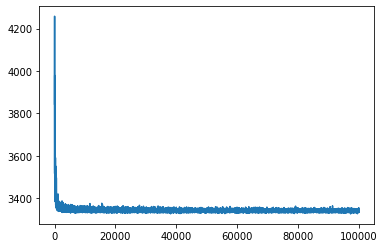

In [12]:
losses = -np.genfromtxt(path + 'elbo.csv', dtype='float32')
plt.plot(list(range(len(losses))), losses)

In [13]:
# load model VI KLpq Gaussian - HSC
path = 'results/survey/vi_klpq_gaussian/2021-10-13-193313/'
model_pq = models.VI_KLpq(v_fam='gaussian', space='warped', dataset='survey', hmc_e=0.05, hmc_L=20, chains=1)
model_pq.x = x
model_pq.y = y
model_pq.gamma_0 = np.genfromtxt(path + 'gamma_0.csv', dtype='float32')[-1]
model_pq.gamma = np.genfromtxt(path + 'gamma.csv', dtype='float32')[-1,:]
model_pq.phi_m = np.genfromtxt(path + 'phi_m.csv', dtype='float32')[-1,:]
model_pq.phi_s = np.genfromtxt(path + 'phi_s.csv', dtype='float32')[-1,:]
model_pq.sigma = np.genfromtxt(path + 'sigma.csv', dtype='float32')[-1,:]
model_pq.q = tfd.MultivariateNormalDiag(
    loc=model_pq.phi_m, 
    scale_diag=model_pq.phi_s)

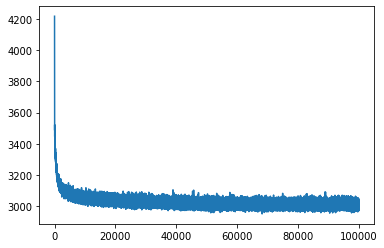

In [14]:
losses = np.genfromtxt(path + 'losses.csv', dtype='float32')
plt.plot(list(range(len(losses))), losses)

In [15]:
# load model VI KLpq Gaussian - MSC
path = 'results/survey/vi_klpq_gaussian/2021-10-12-010955/'
model_pq_msc = models.VI_KLpq(v_fam='gaussian', space='theta', dataset='survey', hmc_e=0.03, hmc_L=33, chains=1)
model_pq_msc.x = x
model_pq_msc.y = y
model_pq_msc.gamma_0 = np.genfromtxt(path + 'gamma_0.csv', dtype='float32')[-1]
model_pq_msc.gamma = np.genfromtxt(path + 'gamma.csv', dtype='float32')[-1,:]
model_pq_msc.phi_m = np.genfromtxt(path + 'phi_m.csv', dtype='float32')[-1,:]
model_pq_msc.phi_s = np.genfromtxt(path + 'phi_s.csv', dtype='float32')[-1,:]
model_pq_msc.sigma = np.genfromtxt(path + 'sigma.csv', dtype='float32')[-1,:]
model_pq_msc.q = tfd.MultivariateNormalDiag(
    loc=model_pq_msc.phi_m, 
    scale_diag=model_pq_msc.phi_s)

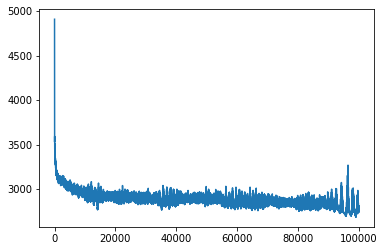

In [16]:
losses = np.genfromtxt(path + 'losses.csv', dtype='float32')
plt.plot(list(range(len(losses))), losses)

In [39]:
# load model VI KLqp Flow
path = 'results/survey/vi_klqp_flow/2021-09-03-223300/'
model_qp_flow = models.VI_KLqp(v_fam='flow', dataset='survey')
model_qp_flow.x = x
model_qp_flow.y = y
model_qp_flow.gamma_0 = np.genfromtxt(path + 'gamma_0.csv', dtype='float32')[-1]
model_qp_flow.gamma = np.genfromtxt(path + 'gamma.csv', dtype='float32')[-1,:]
model_qp_flow.sigma = np.genfromtxt(path + 'sigma.csv', dtype='float32')[-1,:]
model_qp_flow.load_model(path + 'flow_model/model')

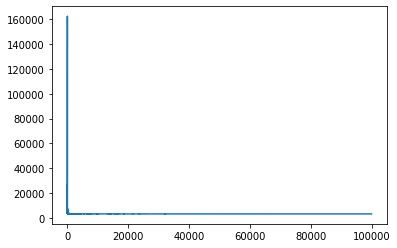

In [40]:
losses = -np.genfromtxt(path + 'elbo.csv', dtype='float32')
plt.plot(list(range(len(losses))), losses)

In [41]:
# load model VI KLpq Flow
path = 'results/survey/vi_klpq_flow/2021-09-01-151501/'
model_pq_flow = models.VI_KLpq(v_fam='flow', space='warped', dataset='survey', hmc_e=0.03, hmc_L=33, chains=64)
model_pq_flow.x = x
model_pq_flow.y = y
model_pq_flow.gamma_0 = np.genfromtxt(path + 'gamma_0.csv', dtype='float32')[-1]
model_pq_flow.gamma = np.genfromtxt(path + 'gamma.csv', dtype='float32')[-1,:]
model_pq_flow.sigma = np.genfromtxt(path + 'sigma.csv', dtype='float32')[-1,:]
model_pq_flow.load_model(path + 'flow_model/model')

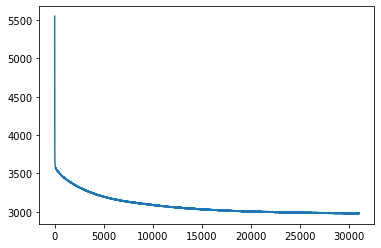

In [42]:
losses = np.genfromtxt(path + 'losses.csv', dtype='float32')
plt.plot(list(range(len(losses))), losses)

In [17]:
post_pred_mat_qp = estimate_vi_model_rate(x_poststrat, data_to_idx, model_qp)
estimate = np.dot(np.array([poststrat_df['n']]), 
                  np.array(post_pred_mat_qp)) / sum(poststrat_df['n'])
print('mean', np.mean(estimate))
print('std', np.std(estimate))

mean 0.4307817904539712
std 0.012738177498057219


In [18]:
post_pred_mat_pq = estimate_vi_model_rate(x_poststrat, data_to_idx, model_pq)
estimate = np.dot(np.array([poststrat_df['n']]), 
                  np.array(post_pred_mat_pq)) / sum(poststrat_df['n'])
print('mean', np.mean(estimate))
print('std', np.std(estimate))

mean 0.4350536269906879
std 0.02185210656101119


In [19]:
post_pred_mat_pq_msc = estimate_vi_model_rate(x_poststrat, data_to_idx, model_pq_msc)
estimate = np.dot(np.array([poststrat_df['n']]), 
                  np.array(post_pred_mat_pq_msc)) / sum(poststrat_df['n'])
print('mean', np.mean(estimate))
print('std', np.std(estimate))

mean 0.421012247868659
std 0.011994767645233058


In [46]:
post_pred_mat_qp_flow = estimate_vi_model_rate(x_poststrat, data_to_idx, model_qp_flow)
estimate = np.dot(np.array([poststrat_df['n']]), 
                  np.array(post_pred_mat_qp_flow)) / sum(poststrat_df['n'])
print('mean', np.mean(estimate))
print('std', np.std(estimate))

mean 0.43237151726386147
std 0.0070211754322150694


In [47]:
post_pred_mat_pq_flow = estimate_vi_model_rate(x_poststrat, data_to_idx, model_pq_flow)
estimate = np.dot(np.array([poststrat_df['n']]), 
                  np.array(post_pred_mat_pq_flow)) / sum(poststrat_df['n'])
print('mean', np.mean(estimate))
print('std', np.std(estimate))

mean 0.4338805629693919
std 0.007490424335425712


Compare parameters under different number of VI samples

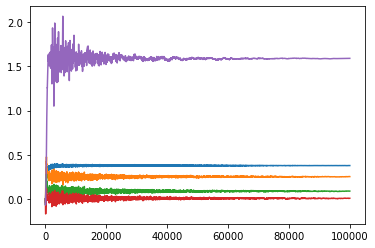

In [26]:
path = 'results/survey/vi_klpq_gaussian/2021-09-01-162133/'
gamma = np.genfromtxt(path + 'gamma.csv')
plt.plot(gamma[:,0], label='gamma_1')
plt.plot(gamma[:,1], label='gamma_2')
plt.plot(gamma[:,2], label='gamma_3')
plt.plot(gamma[:,3], label='gamma_4')
plt.plot(gamma[:,4], label='gamma_5')
plt.show()

In [21]:
path = 'results/survey/vi_klpq_gaussian/2021-07-02-164958/'
gamma_1samp = np.genfromtxt(path + 'gamma.csv')
plt.plot(gamma_1samp[:,0], label='gamma_1')
plt.plot(gamma_1samp[:,1], label='gamma_2')
plt.plot(gamma_1samp[:,2], label='gamma_3')
plt.plot(gamma_1samp[:,3], label='gamma_4')
plt.plot(gamma_1samp[:,4], label='gamma_5')
plt.show()

OSError: results/survey/vi_klpq_gaussian/2021-07-02-164958/gamma.csv not found.

### By-state predictions

By state

In [20]:
post_pred_mat_qp = estimate_vi_model_rate(x_poststrat, data_to_idx, model_qp)
state_means_qp = []
state_stds_qp = []
for state in list_of_states:
    is_state = np.array([poststrat_df['state'] == state])
    estimate = np.dot(np.multiply(np.array([poststrat_df['n']]), is_state), 
                      np.array(post_pred_mat_qp)) / np.sum(np.multiply(np.array([poststrat_df['n']]), is_state))
    state_means_qp.append(np.mean(estimate))
    state_stds_qp.append(np.std(estimate))
    print(state)
    print('mean', np.mean(estimate))
    print('std', np.std(estimate))
state_means_qp = np.array(state_means_qp)
state_stds_qp = np.array(state_stds_qp)

HI
mean 0.3498794175236282
std 0.04038212739246605
CA
mean 0.3729895260376231
std 0.02335130583357914
VT
mean 0.3887688076798815
std 0.040217153419894194
MA
mean 0.338382129002877
std 0.029853477451518184
MD
mean 0.3435967603579628
std 0.03244669980657854
NY
mean 0.3486844061191816
std 0.025330520828467543
IL
mean 0.3935499749989049
std 0.02729422097292678
WA
mean 0.37535932856517135
std 0.031849623482364565
RI
mean 0.3643700069183975
std 0.038886645366484396
NJ
mean 0.364763918817406
std 0.031595261489378614
CT
mean 0.35183055575302136
std 0.03564894247922182
OR
mean 0.3836583965999174
std 0.036639734541943976
DE
mean 0.4433847421963467
std 0.040437009129922714
NM
mean 0.3919890286732398
std 0.03791691585065881
VA
mean 0.42525666243355636
std 0.030660080611374044
CO
mean 0.40797379411772133
std 0.03460316654571363
ME
mean 0.42744677919116186
std 0.039639187562065456
NV
mean 0.3948602837570321
std 0.035398722107848314
MN
mean 0.425661513777266
std 0.03527503778745749
NH
mean 0.41410728

In [21]:
post_pred_mat_pq = estimate_vi_model_rate(x_poststrat, data_to_idx, model_pq)
state_means_pq = []
state_stds_pq = []
for state in list_of_states:
    is_state = np.array([poststrat_df['state'] == state])
    estimate = np.dot(np.multiply(np.array([poststrat_df['n']]), is_state), 
                      np.array(post_pred_mat_pq)) / np.sum(np.multiply(np.array([poststrat_df['n']]), is_state))
    state_means_pq.append(np.mean(estimate))
    state_stds_pq.append(np.std(estimate))
    print(state)
    print('mean', np.mean(estimate))
    print('std', np.std(estimate))
state_means_pq = np.array(state_means_pq)
state_stds_pq = np.array(state_stds_pq)

HI
mean 0.35087256075271184
std 0.04421081207176575
CA
mean 0.37806027236358714
std 0.028650036407760943
VT
mean 0.3942151094975681
std 0.04651715464906039
MA
mean 0.34170750155099067
std 0.036146031883298055
MD
mean 0.3497570148522841
std 0.036710195795241006
NY
mean 0.3522745969072063
std 0.02983040696627457
IL
mean 0.39742998620357844
std 0.034042218069626574
WA
mean 0.38027340757906875
std 0.036744303142555425
RI
mean 0.36451111867806946
std 0.04405216599283244
NJ
mean 0.36388940031999745
std 0.03531887930152286
CT
mean 0.35277216876036516
std 0.03927852735450173
OR
mean 0.3874629343610468
std 0.04121743354429178
DE
mean 0.4459140253590016
std 0.04447861338421248
NM
mean 0.39875178491224006
std 0.04251443650114345
VA
mean 0.42727438370164156
std 0.03620213213953397
CO
mean 0.40886739138232353
std 0.03885526435502875
ME
mean 0.4306367878312264
std 0.045934010162526205
NV
mean 0.39353328191445197
std 0.039574703744287155
MN
mean 0.4309574725707458
std 0.04151473400172279
NH
mean 0.41

In [22]:
post_pred_mat_pq_msc = estimate_vi_model_rate(x_poststrat, data_to_idx, model_pq_msc)
state_means_pq_msc = []
state_stds_pq_msc = []
for state in list_of_states:
    is_state = np.array([poststrat_df['state'] == state])
    estimate = np.dot(np.multiply(np.array([poststrat_df['n']]), is_state), 
                      np.array(post_pred_mat_pq_msc)) / np.sum(np.multiply(np.array([poststrat_df['n']]), is_state))
    state_means_pq_msc.append(np.mean(estimate))
    state_stds_pq_msc.append(np.std(estimate))
    print(state)
    print('mean', np.mean(estimate))
    print('std', np.std(estimate))
state_means_pq_msc = np.array(state_means_pq_msc)
state_stds_pq_msc = np.array(state_stds_pq_msc)

HI
mean 0.36588562467832103
std 0.026157488797918068
CA
mean 0.35845261649889215
std 0.0163215525195256
VT
mean 0.38305066850405084
std 0.025479541152139084
MA
mean 0.32658554730132794
std 0.021123067496460823
MD
mean 0.3253869983760297
std 0.02336658211756891
NY
mean 0.3413246993135161
std 0.01639312683304974
IL
mean 0.3737301617626027
std 0.018973918262600822
WA
mean 0.3651808038413991
std 0.020912714901006543
RI
mean 0.38275505707373925
std 0.027053825454556066
NJ
mean 0.3404765232616019
std 0.018583623578479997
CT
mean 0.3569327836040269
std 0.022790242594812233
OR
mean 0.41048930031329894
std 0.02101278027048833
DE
mean 0.4006102655599015
std 0.02575812707390792
NM
mean 0.38808438113453164
std 0.02549730752682491
VA
mean 0.42283538818927774
std 0.022523265764728
CO
mean 0.3958868212881217
std 0.02734305218133123
ME
mean 0.4347566407491371
std 0.027325809855645946
NV
mean 0.396018541242893
std 0.02539282827641444
MN
mean 0.44516978760960074
std 0.026001171701177953
NH
mean 0.408014

In [49]:
post_pred_mat_qp_flow = estimate_vi_model_rate(x_poststrat, data_to_idx, model_qp_flow)
state_means_qp_flow = []
state_stds_qp_flow = []
for state in list_of_states:
    is_state = np.array([poststrat_df['state'] == state])
    estimate = np.dot(np.multiply(np.array([poststrat_df['n']]), is_state), 
                      np.array(post_pred_mat_qp_flow)) / np.sum(np.multiply(np.array([poststrat_df['n']]), is_state))
    state_means_qp_flow.append(np.mean(estimate))
    state_stds_qp_flow.append(np.std(estimate))
    print(state)
    print('mean', np.mean(estimate))
    print('std', np.std(estimate))
state_means_qp_flow = np.array(state_means_qp_flow)
state_stds_qp_flow = np.array(state_stds_qp_flow)

HI
mean 0.34527460062348675
std 0.03992421785429029
CA
mean 0.3747357246813709
std 0.02036645266040173
VT
mean 0.3914299617103705
std 0.03989462820031146
MA
mean 0.3398175672520006
std 0.02956772257425687
MD
mean 0.3455581716244982
std 0.03268645728682741
NY
mean 0.3497523341206447
std 0.022932251099186063
IL
mean 0.39531697199940546
std 0.026176873179632416
WA
mean 0.37802271304390894
std 0.02968823733189459
RI
mean 0.3624647292746087
std 0.03887240627235391
NJ
mean 0.36477248893166897
std 0.03005662819215209
CT
mean 0.3514701913101581
std 0.03452009123503222
OR
mean 0.3857140847586537
std 0.034866470073614736
DE
mean 0.44431308650663814
std 0.038775244731643545
NM
mean 0.3907442600247987
std 0.03845886695084259
VA
mean 0.4271447317534419
std 0.02895609026803351
CO
mean 0.4086837636080064
std 0.03335030812998555
ME
mean 0.4279464349949947
std 0.03918740040166132
NV
mean 0.39106578636818434
std 0.0344702199641416
MN
mean 0.4277043073606448
std 0.03489335100824191
NH
mean 0.416061441752

In [50]:
post_pred_mat_pq_flow = estimate_vi_model_rate(x_poststrat, data_to_idx, model_pq_flow)
state_means_pq_flow = []
state_stds_pq_flow = []
for state in list_of_states:
    is_state = np.array([poststrat_df['state'] == state])
    estimate = np.dot(np.multiply(np.array([poststrat_df['n']]), is_state), 
                      np.array(post_pred_mat_pq_flow)) / np.sum(np.multiply(np.array([poststrat_df['n']]), is_state))
    state_means_pq_flow.append(np.mean(estimate))
    state_stds_pq_flow.append(np.std(estimate))
    print(state)
    print('mean', np.mean(estimate))
    print('std', np.std(estimate))
state_means_pq_flow = np.array(state_means_pq_flow)
state_stds_pq_flow = np.array(state_stds_pq_flow)

HI
mean 0.3500849038482441
std 0.04093820816979575
CA
mean 0.37670143703317
std 0.021308254583609444
VT
mean 0.39187045296557055
std 0.040099835092659006
MA
mean 0.33973385711068566
std 0.029434125617331663
MD
mean 0.36244730901634714
std 0.1147346975282946
NY
mean 0.3505039336630557
std 0.02345883963986488
IL
mean 0.3981068112700873
std 0.0271032983336243
WA
mean 0.37852402573490307
std 0.0304055093953852
RI
mean 0.3645732351021288
std 0.03938434094970319
NJ
mean 0.3654458641259753
std 0.030117447485472782
CT
mean 0.35186737423600406
std 0.03543825346286952
OR
mean 0.3859638540186246
std 0.035920838433311876
DE
mean 0.443945818038651
std 0.04045493541159965
NM
mean 0.39433928485095626
std 0.04015830256203438
VA
mean 0.4267604105632423
std 0.029301183893655505
CO
mean 0.40836185418095744
std 0.03380036878200999
ME
mean 0.42851218855933937
std 0.03998187658856978
NV
mean 0.39329407811707456
std 0.03556483950662973
MN
mean 0.42742210031127986
std 0.03493952554006932
NH
mean 0.41660845072

In [23]:
state_means_unadj_5000 = []
state_stds_unadj_5000 = []
for state in list_of_states:
    is_state = np.array([cces['state'] == state])
    n = np.sum(is_state)
    mean = np.sum(np.multiply(np.array([cces['abortion']]), is_state))/n
    state_means_unadj_5000.append(mean)
    state_stds_unadj_5000.append(get_se_bernoulli(mean, n))
state_means_unadj_5000 = np.array(state_means_unadj_5000)
state_stds_unadj_5000 = np.array(state_stds_unadj_5000)

In [24]:
state_means_unadj_60000 = []
state_stds_unadj_60000 = []
for state in list_of_states:
    is_state = np.array([cces_all['state'] == state])
    n = np.sum(is_state)
    mean = np.sum(np.multiply(np.array([cces_all['abortion']]), is_state))/n
    state_means_unadj_60000.append(mean)
    state_stds_unadj_60000.append(get_se_bernoulli(mean, n))
state_means_unadj_60000 = np.array(state_means_unadj_60000)
state_stds_unadj_60000 = np.array(state_stds_unadj_60000)

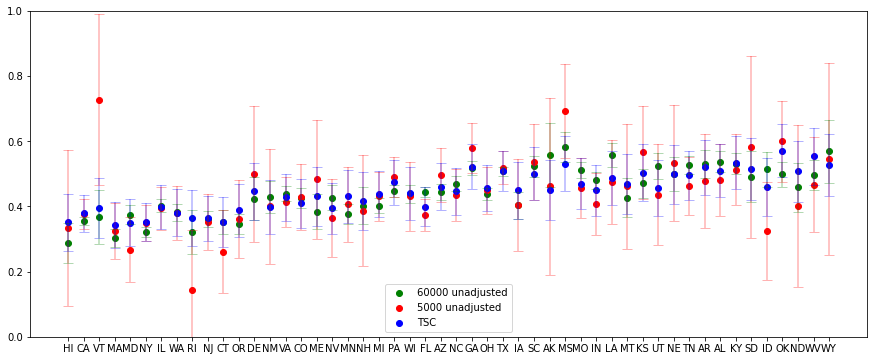

In [28]:
plt.figure(figsize=(15, 6))
plt.scatter(list_of_states, state_means_unadj_60000, color='g', label='60000 unadjusted')
plt.scatter(list_of_states, state_means_unadj_5000, color='r', label='5000 unadjusted')
plt.scatter(list_of_states, state_means_pq, color='b', label='TSC')
plt.errorbar(list_of_states, 
             state_means_unadj_60000, 
             yerr=1.96*state_stds_unadj_60000, 
             linestyle='', color='g', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_unadj_5000, 
             yerr=1.96*state_stds_unadj_5000, 
             linestyle='', color='r', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq, 
             yerr=1.96*state_stds_pq, 
             linestyle='', color='b', alpha=0.3, capsize=5.0)
plt.ylim(0, 1)
plt.legend()
plt.savefig('survey_tsc_unadj.png')
plt.show()

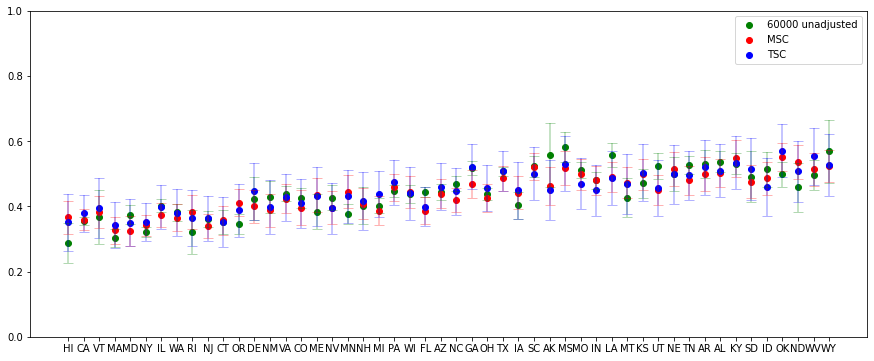

In [29]:
plt.figure(figsize=(15, 6))
plt.scatter(list_of_states, state_means_unadj_60000, color='g', label='60000 unadjusted')
plt.scatter(list_of_states, state_means_pq_msc, color='r', label='MSC')
plt.scatter(list_of_states, state_means_pq, color='b', label='TSC')
plt.errorbar(list_of_states, 
             state_means_unadj_60000, 
             yerr=1.96*state_stds_unadj_60000, 
             linestyle='', color='g', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq_msc, 
             yerr=1.96*state_stds_pq_msc, 
             linestyle='', color='r', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq, 
             yerr=1.96*state_stds_pq, 
             linestyle='', color='b', alpha=0.3, capsize=5.0)
plt.ylim(0, 1)
plt.legend()
plt.savefig('survey_tsc_msc.png')
plt.show()

NameError: name 'state_means_qp_flow' is not defined

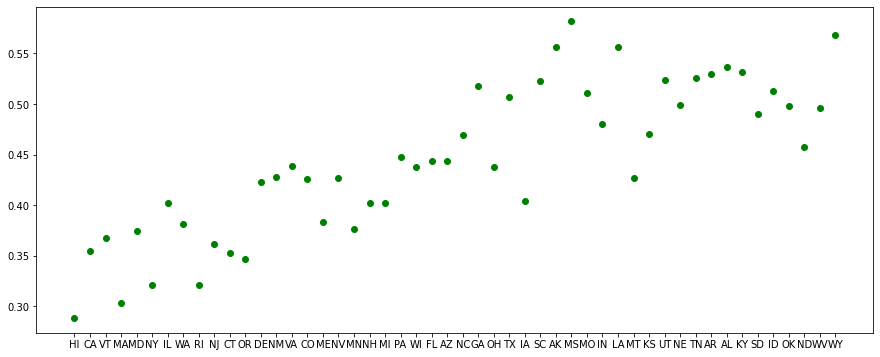

In [27]:
plt.figure(figsize=(15, 6))
plt.scatter(list_of_states, state_means_unadj_60000, color='g', label='60000 unadjusted')
plt.scatter(list_of_states, state_means_qp_flow, color='r', label='VI with flow')
plt.scatter(list_of_states, state_means_pq_flow, color='b', label='TSC with flow')
plt.errorbar(list_of_states, 
             state_means_unadj_60000, 
             yerr=1.96*state_stds_unadj_60000, 
             linestyle='', color='g', alpha=0.0, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_qp_flow, 
             yerr=1.96*state_stds_qp_flow, 
             linestyle='', color='r', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq_flow, 
             yerr=1.96*state_stds_pq_flow, 
             linestyle='', color='b', alpha=0.3, capsize=5.0)
plt.ylim(0, 1)
plt.legend()
plt.savefig('survey_tsc_vi.png')
plt.show()

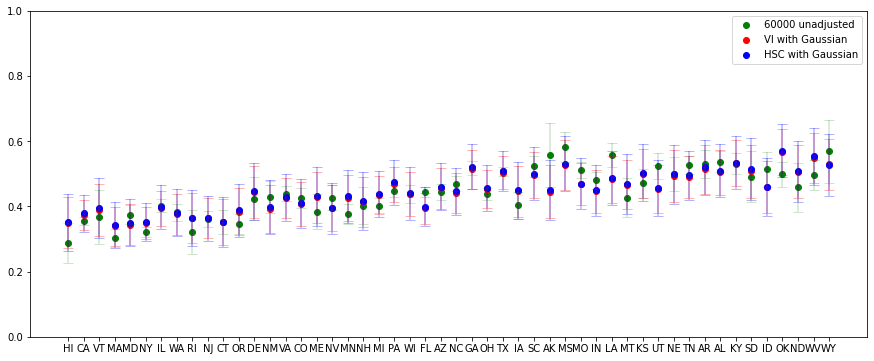

In [30]:
plt.figure(figsize=(15, 6))
plt.scatter(list_of_states, state_means_unadj_60000, color='g', label='60000 unadjusted')
plt.scatter(list_of_states, state_means_qp, color='r', label='VI with Gaussian')
plt.scatter(list_of_states, state_means_pq, color='b', label='HSC with Gaussian')
plt.errorbar(list_of_states, 
             state_means_unadj_60000, 
             yerr=1.96*state_stds_unadj_60000, 
             linestyle='', color='g', alpha=0.2, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_qp, 
             yerr=1.96*state_stds_qp, 
             linestyle='', color='r', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq, 
             yerr=1.96*state_stds_pq, 
             linestyle='', color='b', alpha=0.3, capsize=5.0)
plt.ylim(0, 1)
plt.legend()
plt.savefig('survey_tsc_vi.png')
plt.show()

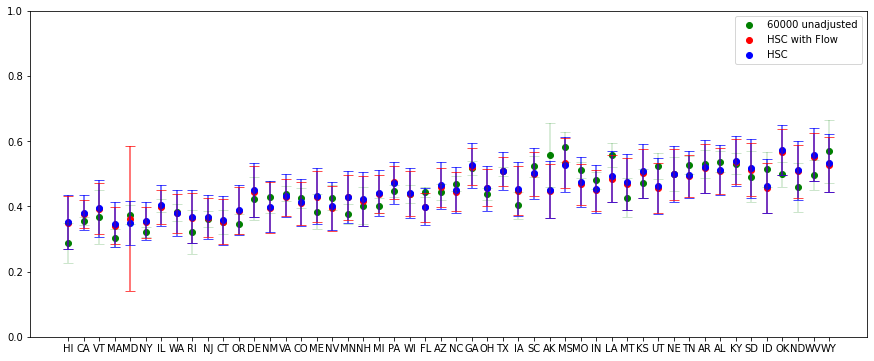

In [36]:
plt.figure(figsize=(15, 6))
plt.scatter(list_of_states, state_means_unadj_60000, color='g', label='60000 unadjusted')
plt.scatter(list_of_states, state_means_pq_flow, color='r', label='HSC with Flow')
plt.scatter(list_of_states, state_means_pq, color='b', label='HSC')
plt.errorbar(list_of_states, 
             state_means_unadj_60000, 
             yerr=1.96*state_stds_unadj_60000, 
             linestyle='', color='g', alpha=0.2, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq_flow, 
             yerr=1.96*state_stds_pq_flow, 
             linestyle='', color='r', alpha=0.7, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq, 
             yerr=1.96*state_stds_pq, 
             linestyle='', color='b', alpha=0.7, capsize=5.0)
plt.ylim(0, 1)
plt.legend()
plt.show()

In [32]:
state_means_mrp = []
state_stds_mrp = []
for state in list_of_states:
    idx = mrp_states_df[mrp_states_df['state'] == state].index[0]
    state_means_mrp.append(mrp_states_df.loc[idx, 'mrp_estimate'])
    state_stds_mrp.append(mrp_states_df.loc[idx, 'mrp_estimate_se'])
state_means_mrp = np.array(state_means_mrp)
state_stds_mrp = np.array(state_stds_mrp)

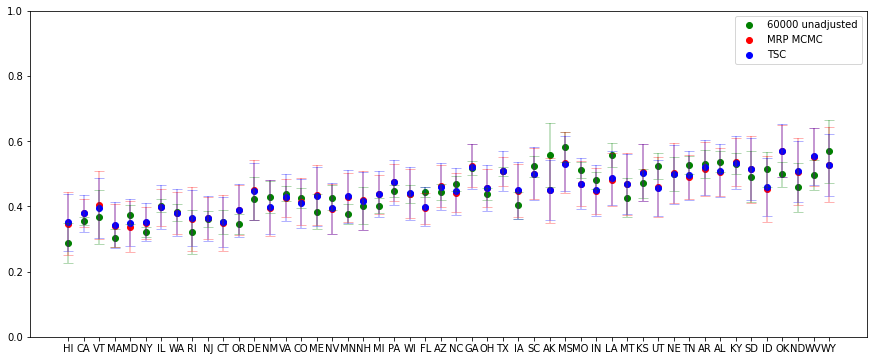

In [33]:
plt.figure(figsize=(15, 6))
plt.scatter(list_of_states, state_means_unadj_60000, color='g', label='60000 unadjusted')
plt.scatter(list_of_states, state_means_mrp, color='r', label='MRP MCMC')
plt.scatter(list_of_states, state_means_pq, color='b', label='TSC')
plt.errorbar(list_of_states, 
             state_means_unadj_60000, 
             yerr=1.96*state_stds_unadj_60000, 
             linestyle='', color='g', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_mrp, 
             yerr=1.96*state_stds_mrp, 
             linestyle='', color='r', alpha=0.3, capsize=5.0)
plt.errorbar(list_of_states, 
             state_means_pq, 
             yerr=1.96*state_stds_pq, 
             linestyle='', color='b', alpha=0.3, capsize=5.0)
plt.ylim(0, 1)
plt.legend()
plt.savefig('survey_tsc_mrp.png')
plt.show()

In [34]:
print(np.sum((state_stds_pq-state_stds_mrp)**2))
print(np.sum((state_stds_qp-state_stds_mrp)**2))

print(np.sum((state_means_pq-state_means_mrp)**2))
print(np.sum((state_means_qp-state_means_mrp)**2))

0.0009839549455206088
0.0020408163426098034
0.0006099363565333735
0.001117829754438909


### Effective sample size

In [100]:
path = 'results/survey/vi_klpq_gaussian/2021-10-13-193313/'
hmc_points_warped = np.squeeze(np.array(pd.read_pickle(path+'hmc_points.pickle')))
path = 'results/survey/vi_klpq_gaussian/2021-10-12-010955/'
hmc_points_orig = np.squeeze(np.array(pd.read_pickle(path+'hmc_points.pickle')))

In [102]:
def autocor(x, t):
    n = x.shape[0]
    mu = np.mean(x, axis=0)
    sigma2 = np.var(x, axis=0)
    numer = np.sum((x[:(n-t),:]-mu) * (x[t:,:]-mu), axis=0)
    return numer/((n-t)*sigma2)

def neff(x):
    n = x.shape[0]
    d = x.shape[1]
    autocor_arr = np.zeros((n, d))
    dim_to_set_to_0 = []
    for t in range(1, n):
        autocor_arr[t-1,:] = autocor(x, t)
        if len(dim_to_set_to_0) > 0:
            autocor_arr[t-1, dim_to_set_to_0] = 0
        if t > 1:
            for d_i in range(d):
                if autocor_arr[t-1, d_i] + autocor_arr[t-2, d_i] < 0:
                    autocor_arr[t-1, d_i] = 0
                    autocor_arr[t-2, d_i] = 0
                    if d_i not in dim_to_set_to_0:
                        dim_to_set_to_0.append(d_i)
            if len(dim_to_set_to_0) == d:
                break
    return n/(1+2*np.sum(autocor_arr, axis=0))

In [103]:
list_of_checkpt = [1000, 2000, 5000, 10000, 20000, 30000, 50000, 100000]
num_dim = hmc_points_warped.shape[1]
neff_list_orig = np.zeros((len(list_of_checkpt), num_dim))

for i in range(len(list_of_checkpt)):
    idx = list_of_checkpt[i]
    neff_list_orig[i, :] = neff(hmc_points_orig[:idx, :])
    print(i, np.mean(neff_list_orig[i,:]/idx))

0 0.2047600503447063
1 0.1555816727770911
2 0.09836513903549532
3 0.07653656848103706
4 0.053380612791726095
5 0.050279101698225324
6 0.0441536911961012
7 0.03301821823872809


In [104]:
neff_list_warped = np.zeros((len(list_of_checkpt), num_dim))

for i in range(len(list_of_checkpt)):
    idx = list_of_checkpt[i]
    neff_list_warped[i, :] = neff(hmc_points_warped[:idx, :])
    print(i, np.mean(neff_list_warped[i,:]/idx))

0 0.11779913284512522
1 0.10516061211666859
2 0.09957381142908861
3 0.10328149541747066
4 0.1100083019799356
5 0.11874668086032404
6 0.12822396386392096
7 0.1432285925201468


In [105]:
np.savetxt('results/neff_list_warped.csv', neff_list_warped)
np.savetxt('results/neff_list_orig.csv', neff_list_orig)

In [36]:
neff_list_warped = np.genfromtxt('results/neff_list_warped.csv')
neff_list_orig = np.genfromtxt('results/neff_list_orig.csv')
list_of_checkpt = [1000, 2000, 5000, 10000, 20000, 30000, 50000, 100000]

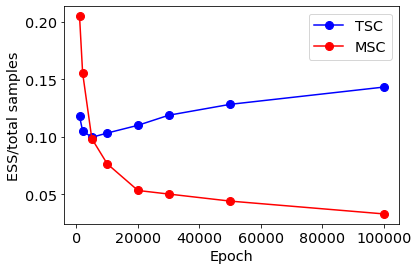

In [37]:
import matplotlib.pylab as pylab

params = {'legend.fontsize': 'x-large',
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
pylab.rcParams.update(params)

plt.plot(list_of_checkpt, 
         np.mean(neff_list_warped, axis=1)/np.array(list_of_checkpt),
         marker='o', markersize=8, color='b',
         label='TSC')
plt.plot(list_of_checkpt, 
         np.mean(neff_list_orig, axis=1)/np.array(list_of_checkpt),
         marker='o', markersize=8, color='r',
         label='MSC')

plt.legend()
plt.ylabel('ESS/total samples')
plt.xlabel('Epoch')
plt.savefig('survey_ess.png')

## Transform Weighted Data and Run Methods

In [ ]:
x_weighted = []
y_weighted = []
state = 0
age = 50
eth = 56
educ = 60
male_eth = 65
educ_age = 73
educ_eth = 103
for i in range(1, len(cces)+1):
    x_i = np.zeros(128)
    eth_idx = data_to_idx[cces_weighted.loc[i,'eth']]
    age_idx = data_to_idx[cces_weighted.loc[i,'age']]
    educ_idx = data_to_idx[cces_weighted.loc[i,'educ']]
    x_i[data_to_idx[cces_weighted.loc[i,'state.x']]] = 1
    x_i[age_idx] = 1
    x_i[eth_idx] = 1
    x_i[educ_idx] = 1
    
    is_male = int(cces_weighted.loc[i,'male'] + 0.5)
    male_eth_idx = male_eth + is_male * 4 + (eth_idx-eth) 
    educ_age_idx = educ_age + (educ_idx-educ) * 6 + (age_idx-age)
    educ_eth_idx = educ_eth + (educ_idx-educ) * 4 + (eth_idx-eth)
    x_i[male_eth_idx] = 1
    x_i[educ_age_idx] = 1
    x_i[educ_eth_idx] = 1
    
    x_i[123] = is_male
    x_i[124] = int(cces_weighted.loc[i,'region'] == 'South')
    x_i[125] = int(cces_weighted.loc[i,'region'] == 'North Central')
    x_i[126] = int(cces_weighted.loc[i,'region'] == 'West')
    x_i[127] = cces_weighted.loc[i,'repvote']
    
    x_weighted.append(x_i)
    y_weighted.append(cces_weighted.loc[i,'abortion'])

x_weighted = np.array(x_weighted, dtype=np.float32)
y_weighted = np.array(y_weighted, dtype=np.float32)

In [ ]:
tf.nn.sigmoid_cross_entropy_with_logits(logits=[[1.,9.],[1.,9.]], labels=[[0.,1.],[1.,0.]])

<tf.Tensor: shape=(2, 2), dtype=float32, numpy=
array([[1.3132617e+00, 1.2340219e-04],
       [3.1326169e-01, 9.0001230e+00]], dtype=float32)>


Define a variational distribution q(alpha; phi) \
Define probabilistic model p(y|alpha; x, theta) \
Define prior p(alpha; theta) \
phi and theta are trainable by gradient methods \
\
for batch_x in x: 
   * sample alpha from q 
   * compute logpx_z = log p(y|alpha; batch_x, theta) 
   * compute logpz = log p(z; theta) 
   * compute logqz_x = log q(alpha; phi) 
   * elbo = logpx_z + logpz - logqz_x 
   * input -elbo as the objective into the autodiff. function
    
How to define q(alpha; phi):
* Gaussian with diagonal covariance
* In a separate implementation, q can also be a flow-based dist.

How to define p(alpha; theta):
* A number of Gaussian, same as in the document

How to define p(y|alpha; x, theta):
* The goal is that p(y|...) = inv_logit(alpha_1 + ... + alpha_m)
* Note that we do not want to loop over x, and decide which 
  alpha (like which state/education level) does that x_i belong to
* Map x to a multi-hot vector v, which is sparse, and element-wise 
  multiply v with alpha (like turning on and off which alpha_i is 
  relevant)


Define a variational distribution q(alpha; phi) \
Define probabilistic model p(y|alpha; x, theta) \
Define prior p(alpha; theta) \
Define HMC target p(alpha|y; theta) or p(eps|y; theta) \
phi and theta are trainable by gradient methods

for batch_x in x:

How to define p(alpha|y; theta):
* p(alpha|y; theta) is proportional to p(alpha; theta) p(y|alpha; x, theta)

In [55]:
import pickle
import pandas as pd

In [57]:
a = np.reshape(np.array(list(range(24))), (2,3,4))

with open('abc.pickle', 'wb') as handle:
    pickle.dump(a, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
pd.read_pickle('abc.pickle')


array([[[ 0,  1,  2,  3],
        [ 4,  5,  6,  7],
        [ 8,  9, 10, 11]],

       [[12, 13, 14, 15],
        [16, 17, 18, 19],
        [20, 21, 22, 23]]])

In [ ]:
def autocor(x, t):
    n = x.shape[0]
    mu = np.mean(x)
    sigma2 = np.var(x)
    numer = np.sum((x[:(n-t),:]-mu) * (x[t:,:]-mu))
    return numer/((n-t)*sigma2)

def neff(x):
    n = x.shape[0]
    d = x.shape[1]
    d_i = 0
    autocor_arr = np.zeros((n, d))
    for t in range(1, n):
        autocor_arr[t-1, :] = autocor(x, t)
        if t > 1:
            if autocor_arr[t-1, d_i] + autocor_arr[t-2, d_i] < 0:
                autocor_arr[t-1, d_i] = 0
                autocor_arr[t-2, d_i] = 0
                break      
    return n/(1+2*np.sum(autocor_arr))

space_btw_epochs = 1000
num_checkpt = int(hmc_points_warped.shape[0] / space_btw_epochs)
num_dim = hmc_points_warped.shape[1]
neff_list_orig = np.zeros((num_checkpt, num_dim))

for i in range(num_checkpt):
    idx = space_btw_epochs * (i+1)
    neff_list_orig[i, :] = neff(hmc_points_orig[:idx, :])
    print(i, np.mean(neff_list_orig[i,:]/idx))